In [297]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import pyro
import pyro.distributions as dist
from pyro.infer import SVI, Trace_ELBO
from pyro.optim import Adam
from tqdm import tqdm_notebook as tqdm
from torch.distributions import constraints
import torch.nn.functional as F

In [60]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
from IPython import display
import os
from PIL import Image
from torch.utils.data.dataset import Dataset
from scipy.misc import imread

In [61]:
import pandas as pd
from sklearn.metrics import accuracy_score
import seaborn as sns
from sklearn.model_selection import StratifiedKFold

### Przygotowanie danych

In [62]:
def read_wine_dataset():
    data = pd.read_csv("wine.data.txt",header=None)
    data_matrix=data.values
    X,y=data_matrix[:, 1:], data_matrix[:, 0]
    y=y.reshape(y.shape[0],1)
    labels = np.unique(y)
    return X, y, labels

A=13 # atributes count
L=3 # labels count

In [63]:
x,y,labels=read_wine_dataset()
kfold = StratifiedKFold(3, False)
spliting_res=kfold.split(x_train, y_train)
train_ind,test_ind=next(spliting_res)
x_train=x[train]
y_train=y[train]
x_test=x[test]
y_test=y[test]

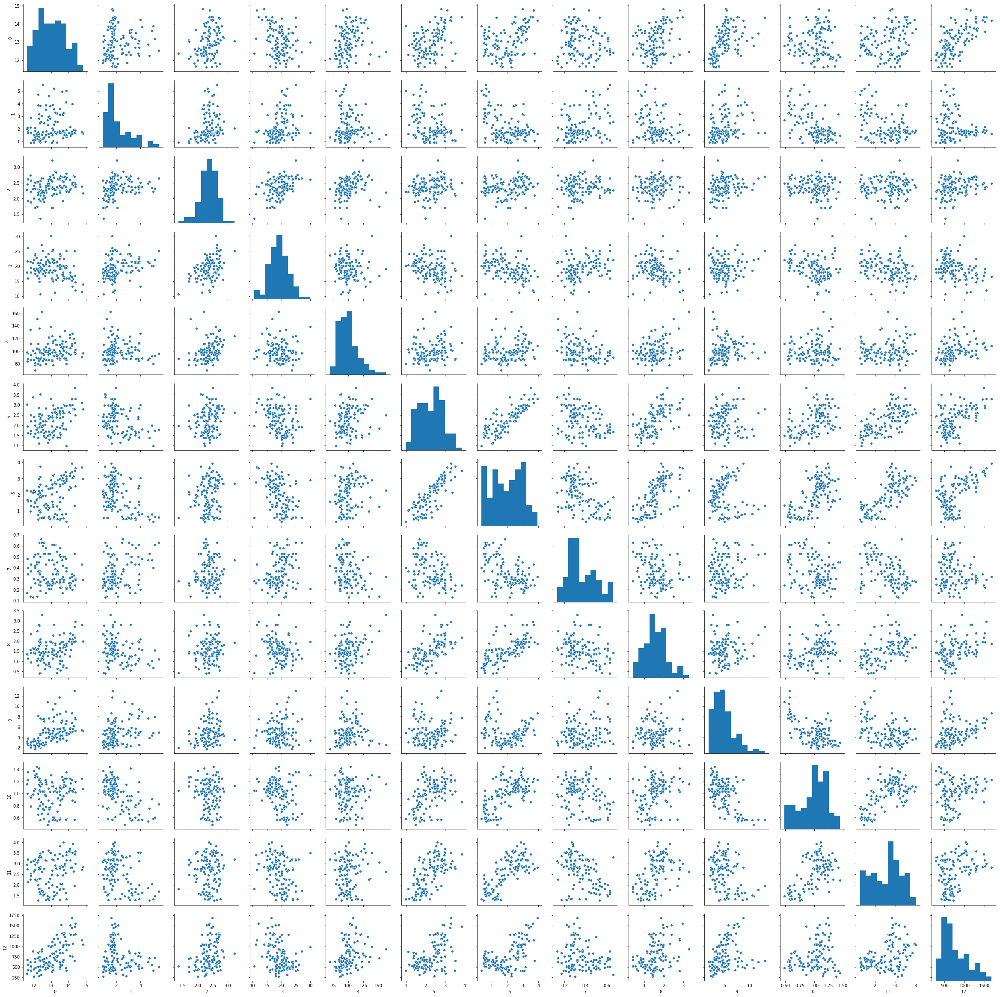

In [64]:
sns.pairplot(pd.DataFrame(x_train))

### Funkcje do wyliczenia prawdopodobieńswta na podstawie macierzy

In [65]:
#liczy macierze MU i STD na podstawie danych -> wartości a priori
def count_stats(x, y, labels):
    means = np.zeros(shape=(labels.shape[0], x.shape[1]))
    stds = np.zeros(shape=(labels.shape[0], x.shape[1]))
    for i in range(len(labels)):
        label = labels[i]
        label_matrix = np.zeros(shape=(1, x.shape[1]))
        for j in range(y.shape[0]):
            if y[j] == label:
                label_matrix = np.append(label_matrix, [x[j]], axis=0)
        label_matrix = label_matrix[1:, :]
        means_l = [np.mean(argument_values) for argument_values in np.hsplit(label_matrix, label_matrix.shape[1])]
        standard_deviations_l = [np.std(argument_values) for argument_values in
                                     np.hsplit(label_matrix, label_matrix.shape[1])]
        means[i] = means_l
        stds[i] = standard_deviations_l
    return means, stds

In [66]:
#liczy prawdopodobieństwo etykiet jako estymator ML 
def estimate_class_probability(label, y_train):
    unique, counts = np.unique(y_train, return_counts=True)
    labels_count_dict = dict(zip(unique, counts))
    label_count = labels_count_dict[label] if label in labels_count_dict else 0
    prob = label_count / y_train.shape[0]
    return prob

In [67]:
#wartość funkcji gęstości prawdopodobieństwa 
def normal_distribution_value(x, mean, std):
    mean=mean.detach().numpy()
    std=std.detach().numpy()
    exponent = np.exp(-(np.power(x - mean, 2) / (2 * np.power(std, 2))))
    return (1 / (np.sqrt(2 * np.pi) * std)) * exponent

# iloczyn prawdopodobieństw po cechach
def vector_probability_normal(x, means, stds):
    probs = 1;
    for i in range(x.shape[0]):
        probs *= normal_distribution_value(x[i], means[i], stds[i])
    return probs;

# prawdpodopobieśtwo P(klasa|wzorzec)
def probability_label_vector_normal(x_vector, label, label_index, y_train, labels,means_matrix, stds_matrix):
    means = means_matrix[label_index]
    stds = stds_matrix[label_index]
    return vector_probability_normal(x_vector, means, stds) * estimate_class_probability(label, y_train)

#zwraca najbardziej prawdopodobną etykietę i wartość prawdopodobieńtwa
def predict_1(x_vector, labels, y_train,means_matrix,stds_matrix):
    max_predicted = probability_label_vector_normal(x_vector, labels[0], 0, y_train, labels,means_matrix, stds_matrix)
    chosen_label = labels[0]
    for i in range(len(labels)):
        prob = probability_label_vector_normal(x_vector, labels[i], i, y_train, labels,means_matrix, stds_matrix)
        if prob > max_predicted:
            chosen_label = labels[i]
            max_predicted = prob
    return chosen_label, max_predicted

#zwraca predykowane etykiety dla podanych wzorców  
def predict_all_1(x_train,labels,y_train,means_matrix,stds_matrix):
    size=x_train.shape[0]
    predictions=np.zeros(shape=(size,1))
    for i in range(size):
        x=x_train[i]
        predictions[i]=predict_1(x, labels, y_train,means_matrix,stds_matrix)[0]
    return predictions

#zwraca wartości prawdopodobieństw dla poszczególnych klas dla danego wzorca 1 X LABELS
def predict(x_vector, labels, y_train,means_matrix,stds_matrix):
    pred=np.zeros(shape=(1,len(labels)))
    for i in range(len(labels)):
        prob = probability_label_vector_normal(x_vector, labels[i], i, y_train, labels,means_matrix, stds_matrix)
        pred[0,i]=prob
    return pred

#zwraca wartości prawdopodobieństw dla poszczególnych klas dla kolejnych wzorców PATTERNS X LABELS
def predict_all(x_train,labels,y_train,means_matrix,stds_matrix):
    size=x_train.shape[0]
    predictions=np.zeros(shape=(size,3))
    for i in range(size):
        x=x_train[i]
        pred=predict(x, labels, y_train,means_matrix,stds_matrix)
        print(pred)
        predictions[i]=pred
    return predictions
    


### Model i guide

In [129]:
A_PRIORI_STD_SCALING_FACTOR=0.005
def model(x_data, y_data):
    m,s=count_stats(x_data,y_data,labels)
    m=torch.from_numpy(m).float()
    s=torch.from_numpy(s).float()
    mu_prior = pyro.sample('mu_matrix',dist.Normal(loc=m, scale=torch.ones(L,A)*A_PRIORI_STD_SCALING_FACTOR))
    sigmna_prior = pyro.sample('sigma_matrix',dist.Normal(loc=s, scale=torch.ones(L,A)*A_PRIORI_STD_SCALING_FACTOR))
    #predicted probabilities
    probs=torch.from_numpy(predict_all(x_train,labels,y_train,mu_prior,sigmna_prior)).float()
    #lables changed to integrate with results retured form Categorical
    y_dat=y_data-1
    pyro.sample("obs", dist.Categorical(logits=probs), obs=torch.tensor(y_dat.ravel()).float())

In [210]:
softplus = torch.nn.Softplus()

def guide (x_data, y_data):
    mu_mu = torch.randn_like(torch.ones(L,A))*10 #początkowe wartości z przedziału 0-10
    mu_sigma = torch.randn_like(torch.ones(L,A))
    #PARAMETR 1
    mu_mu_param = pyro.param("mu_mu", mu_mu)
    #PARAMETR 2
    mu_sigma_param = softplus(pyro.param("mu_sigma", mu_sigma)) #odchylenia standardowe jako wartości dodatnie
    #ZMIENNA LOSOWA 1
    mu = pyro.sample('mu_matrix',dist.Normal(loc=mu_mu_param, scale=mu_sigma_param))
    sigma_mu = torch.randn_like(torch.ones(L,A))*20 #poczetkowe odchylenia standardowe z przedziału 0-20
    sigma_sigma = torch.randn_like(torch.ones(L,A))
    #PARAMETR 3
    sigma_mu_param = pyro.param("sigma_mu", sigma_mu)
    #PARAMETR 4
    sigma_sigma_param =softplus(pyro.param("sigma_sigma", sigma_sigma))
    #ZMIENNA LOSOWA 2
    sigma = pyro.sample('sigma_matrix',dist.Normal(loc=sigma_mu_param, scale=sigma_sigma_param))
    
    return (mu,sigma)
    

In [211]:
losses, alpha_vals, beta_vals  = [],[],[]
def train():
    pyro.clear_param_store()
    num_iterations=10000
    optim = pyro.optim.Adam({"lr": 0.4})
    svi = SVI(model, guide, optim, loss=Trace_ELBO())
    t=tqdm(range(num_iterations))
    for j in t:
        loss = svi.step(x_train,y_train)
        t.set_postfix(loss=loss)
        losses.append(loss)
    return (model, svi)

In [212]:
model,svi=train()

[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   1.90526617e-217]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   1.37630071e-267]]
[[ -0.00000000e+000  -0.00000000e+000   2.22574037e-234]]
[[ -0.00000000e+000  -0.00000000e+000   2.17217319e-231]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   2.24713379e-272]]
[[ -0.00000000e+000  -0.00000000e+000   2.62064190e-271]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   5.17746627e-312]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   3.99813479e-316]]
[[ -0.00000000e+000  -0.00000000e+000   2.61682065e-287]]
[[-0. -0.  0.]]
[[-0. -0.  0.]

[[ -0.00000000e+000  -0.00000000e+000   5.90292493e-192]]
[[ -0.00000000e+000  -0.00000000e+000   8.66434595e-236]]
[[ -0.00000000e+000  -0.00000000e+000   1.93113943e-128]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   4.81839188e-211]]
[[ -0.00000000e+000  -0.00000000e+000   1.15071744e-187]]
[[ -0.00000000e+000  -0.00000000e+000   4.62524591e-145]]
[[ -0.00000000e+000  -0.00000000e+000   1.87653282e-210]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   7.00743022e-247]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   1.68457371e-295]]
[[  0.00000000e+000  -0.00000000e+000   1.80176176e-260]]
[[  0.00000000e+000  -0.00000000e+000   1.62544521e-259]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00

[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -3.81726347e-308]]
[[ -0.00000000e+000   0.00000000e+000  -5.25259269e-313]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -3.16616160e-283]]
[[ -0.00000000e+000   0.00000000e+000  -9.28351612e-156]]
[[ -0.00000000e+000   0.00000000e+000  -1.03009780e-245]]
[[ -0.00000000e+000   0.00000000e+000  -4.52664312e-159]]
[[ -0.00000000e+000   0.00000000e+000  -1.76511056e-234]]
[[ -0.00000000e+000   0.00000000e+000  -5.33422245e-165]]
[[ -0.00000000e+000   0.00000000e+000  -2.97015037e-145]]
[[ -0.00000000e+000   0.00000000e+000  -2.6676

[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   5.23454062e-274]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   3.0138

[[ -0.00000000e+000  -0.00000000e+000  -7.25467206e-247]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -3.75680285e-273]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -1.32404417e-292]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -1.19437783e-292]]
[[ -0.00000000e+000  -0.00000000e+000  -5.50126344e-311]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -2.24883746e-285]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -1.29922510e-307]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[

[[  0.00000000e+000   0.00000000e+000  -2.40531821e-204]]
[[  0.00000000e+000   0.00000000e+000  -1.09368954e-217]]
[[  0.00000000e+000   0.00000000e+000  -3.31765074e-241]]
[[  0.00000000e+000   0.00000000e+000  -1.38240076e-234]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   0.00000000e+000  -1.32553135e-200]]
[[  0.00000000e+000   0.00000000e+000  -1.86051379e-203]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   0.00000000e+000  -1.15649825e-139]]
[[  0.00000000e+000   0.00000000e+000  -4.64068770e-251]]
[[  0.00000000e+000   0.00000000e+000  -4.45027268e-267]]
[[  0.00000000e+000   0.00000000e+000  -2.67304690e-209]]
[[  0.00000000e+000   0.00000000e+000  -6.68596719e-194]]
[[  0.00000000e+000   0.00000000e+000  -2.32651483e-176]]
[[  0.00000000e+000   0.00000000e+000  -4.80079183e-167]]
[[  0.00000000e+000   0.00000000e+000  -3.61042855e-273]]
[[  0.00000000e+000   0.00000000e+000  -1.65143895e-255]]
[[  0.00000000e+000   0.00000000e+000  -4.48665954e-319]]
[[  0.00000000e+000   0.

[[ -0.00000000e+000   0.00000000e+000  -6.35127340e-254]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -1.72415256e-166]]
[[ -0.00000000e+000   0.00000000e+000  -1.10110098e-316]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -8.11209984e-259]]
[[ -0.00000000e+000   0.00000000e+000  -1.44222754e-231]]
[[ -0.00000000e+000   0.00000000e+000  -2.56671603e-212]]
[[ -0.00000000e+000   0.00000000e+000  -2.75436654e-190]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -1.86061932e-204]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -8.37080602e-317]]
[[ -0.00000000e+000   0.00000000e+000  -1.86398697e-235]]
[[-0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   0.00000000e+000  -1.50201411e-254]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. 

[[  0.00000000e+000  -0.00000000e+000  -6.89196311e-135]]
[[  0.00000000e+000  -0.00000000e+000  -4.60979227e-122]]
[[  0.00000000e+000  -0.00000000e+000  -1.26575700e-266]]
[[  0.00000000e+00  -0.00000000e+00  -8.25522656e-89]]
[[  0.00000000e+000  -0.00000000e+000  -1.01637688e-165]]
[[  0.00000000e+000  -0.00000000e+000  -8.62375100e-236]]
[[  0.00000000e+000  -0.00000000e+000  -2.80008992e-178]]
[[  0.00000000e+000  -0.00000000e+000  -4.23425796e-201]]
[[  0.00000000e+000  -0.00000000e+000  -3.16116647e-221]]
[[  0.00000000e+000  -0.00000000e+000  -6.39895980e-247]]
[[  0.00000000e+000  -0.00000000e+000  -1.51221200e-279]]
[[  0.00000000e+000  -0.00000000e+000  -3.14783829e-301]]
[[  0.00000000e+000  -0.00000000e+000  -5.31467253e-178]]
[[  0.00000000e+000  -0.00000000e+000  -2.21311908e-205]]
[[  0.00000000e+000  -0.00000000e+000  -4.45923580e-219]]
[[  0.00000000e+000  -0.00000000e+000  -5.95420538e-220]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -0.00000000e+000  -4.52533981e-178]]
[

[[ -0.00000000e+000   0.00000000e+000  -1.22266785e-243]]
[[ -0.00000000e+000   0.00000000e+000  -3.90288398e-247]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -7.30461018e-196]]
[[ -0.00000000e+000   0.00000000e+000  -3.35818766e-211]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -2.87327268e-132]]
[[ -0.00000000e+000   0.00000000e+000  -7.85144170e-266]]
[[ -0.00000000e+000   0.00000000e+000  -1.66613775e-285]]
[[ -0.00000000e+000   0.00000000e+000  -6.33956620e-214]]
[[ -0.00000000e+000   0.00000000e+000  -1.53329665e-185]]
[[ -0.00000000e+000   0.00000000e+000  -3.37996389e-171]]
[[ -0.00000000e+000   0.00000000e+000  -2.97754057e-145]]
[[ -0.00000000e+000   0.00000000e+000  -4.58789014e-303]]
[[ -0.00000000e+000   0.00000000e+000  -1.88280191e-276]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -3.68873689e-167]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -5.35722031e-299]]
[[ -0.00000000e+000   0.00000000e+000  -3.65582331

[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -3.12445257e-202]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   0.00000000e+000  -4.94065646e-324]]
[[ -0.00000000e+000   0.00000000e+000  -2.36558729e-234]]
[[-0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   0.00000000e+000  -1.27778272e-269]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   0.00000000

[[ -0.00000000e+000  -0.00000000e+000  -1.38979539e-296]]
[[ -0.00000000e+000  -0.00000000e+000  -1.33624995e-319]]
[[ -0.00000000e+000  -0.00000000e+000  -6.23689623e-239]]
[[ -0.00000000e+000  -0.00000000e+000  -9.70854197e-205]]
[[ -0.00000000e+000  -0.00000000e+000  -2.02782694e-192]]
[[ -0.00000000e+000  -0.00000000e+000  -4.24254888e-157]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -4.39808868e-309]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -1.78735054e-185]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -0.00000000e+000  -1.04070478e-300]]
[[ -0.00000000e+000  -0.00000000e+000  -5.21862496e-213]]
[[-0. -0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -0.00000000e+000  -9.40520359e-266]]
[[ 0. -0. -0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  0.00000000e+000   0.00000000e+000   2.64133201e-200]]
[[  0.00000000e+000   0.00000000e+000   1.21646979e-300]]
[[  0.00000000e+000   0.00000000e+000   1.52410136e-139]]
[[  0.00000000e+000   0.00000000e+000   9.18786190e-260]]
[[  0.

[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   6.82598102e-295]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   6.41919971e-313]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -0.00000000e+000   5.71872817e-218]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0. 

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -0.00000000e+000  -1.85628119e-184]]
[[  0.00000000e+000  -0.00000000e+000  -8.05956133e-305]]
[[  0.00000000e+000  -0.00000000e+000  -4.30367176e-143]]
[[  0.00000000e+000  -0.00000000e+000  -9.48428413e-282]]
[[  0.00000000e+000  -0.00000000e+000  -1.36361805e-165]]
[[  0.00000000e+000  -0.00000000e+000  -1.78182370e-110]]
[[  0.00000000e+000  -0.00000000e+000  -3.13673808e-315]]
[[  0.00000000e+00

[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   1.18327704e-177]]
[[  0.00000000e+000  -0.00000000e+000   8.03123720e-220]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   2.11223882e-311]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   1.04283524e-287]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   8.41839949e-291]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   4.70031139e-205]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -0.00000000e+000   2.83671513e-285]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -0.00000000e+000  -1.51206788e-231]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -0.00000000e+000  -6.34089776e-280]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0

[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -2.26284877e-293  -0.00000000e+000   0.00000000e+000]]
[[ -4.40757364e-228  -0.00000000e+000   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -9.70687590e-276  -0.00000000e+000   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -2.90475027e-318  -0.00000000e+000   0.00000000e+000]]
[[ -1.10556313e-251  -0.00000000e+000   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -1.47391768e-147  -4.13926900e-232   1.48219694e-323]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0

[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -4.02912930e-277  -1.71960058e-273  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -8.93215936

[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  2.96439388e-323   0.00000000e+000  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  4.82199205e-260   2.72265051e-286  -0.00000000e+000]]
[[  9.29698741e-217   3.19893039e-222  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  8.0627

[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -4.12973302e-270  -0.00000000e+000]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -1.11760675e-231  -0.00000000e+000]]
[[ -8.91476212e-314  -1.29081666e-172  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -5.92858014e-225  -0.00000000e+000]]
[[ -0.00000000e+000  -1.07930215e-289  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -9.44964603e-247  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -1.88396092e-201  -0.00000000e+000]]
[[  0.00000000e+000  -1.32796612e-178  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -1.07212245e-321  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -1.23896035e-260  -0.00000000e+000]]
[[  0.00000000e+000  -1.18285611e-246  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -1.69073546e-242  -0.00000000e+000]]
[[  0.00000000e+000  -2.66430158e-273  -0.00000000e+000]]
[[  0.00000000e+000  -9.80281069e-282  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -5.886650

[[ 0.  0. -0.]]
[[  0.00000000e+000   5.48673953e-215  -0.00000000e+000]]
[[  0.00000000e+000   5.10126520e-191  -0.00000000e+000]]
[[  0.00000000e+000   5.21069847e-228  -0.00000000e+000]]
[[  1.01936355e-138   1.67135798e-085  -0.00000000e+000]]
[[  7.71520878e-202   1.00205190e-118  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  2.99585713e-302   1.89647982e-173  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  3.10757283e-286   1.08522143e-157  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   4.33397858e-294  -0.00000000e+000]]
[[  0.00000000e+000   3.07970623e-183  -0.00000000e+000]]
[[  4.24920930e-296   1.97122128e-164  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  3.50341422e-172   5.77533602e-099  -0.00000000e+000]]
[[  0.00000000e+000   1.28912340e-241  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   3.39286845e-267  -0.00000000e+000]]
[[  0.00000000e+000   1.80750494e-296  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  0.000000

[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  8.92587913e-259   5.71718206e-228   0.00000000e+000]]
[[ 0.  0.  0.]]
[[  2.22931654e-176   1.49095951e-174   0.00000000e+000]]
[[  6.27637974e-275   4.94065646e-324   0.00000000e+000]]
[[  1.47255237e-113   2.37266442e-148   0.00000000e+000]]
[[  6.94347462e-112   2.97548846e-111   0.00000000e+000]]
[[  2.43794956e-279   0.00000000e+000   0.00000000e+000]]
[[  6.06476091e-162   9.94831751e-210   0.00000000e+000]]
[[  3.38798080e-179   4.21392482e-214   0.00000000e+000]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  1.08345226e-103   5.31414168e-144   0.00000000e+000]]
[[  1.59360501e-154   1.24620146e-184   0.00000000e+000]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  4.62192681e-140   1.03073567e-155   0.00000000e+

[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -0.00000000e+000   7.31565679e-216   0.00000000e+000]]
[[-0.  0.  0.]]
[[ -0.00000000e+000   1.98031723e-159   0.00000000e+000]]
[[ -0.00000000e+000   6.69883688e-298   0.00000000e+000]]
[[ -1.01644415e-118   1.51250407e-136   0.00000000e+000]]
[[ -0.00000000e+000   2.26493375e-103   0.00000000e+000]]
[[-0.  0.  0.]]
[[ -0.00000000e+000   7.45682050e-195   0.00000000e+000]]
[[ -0.00000000e+000   4.54264469e-196   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -1.72811591e-111   3.84901808e-133   0.00000000e+000]]
[[ -0.00000000e+000   1.59299602e-169   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -0.00000000e+000   3.02219419e-144   0.00000000e+000]]
[[ -0.00000000e+000   8.18681790e-125   0.00000000e+000]]
[[ -0.00000000e+000   4.48044641e-193   0.

[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   6.30668732e-192  -0.00000000e+000]]
[[ -0.00000000e+000   6.34956469e-317  -0.00000000e+000]]
[[ -0.00000000e+000   1.21828537e-145  -0.00000000e+000]]
[[ -0.00000000e+000   7.82405856e-273  -0.00000000e+000]]
[[ -0.00000000e+000   1.30937267e-125  -0.00000000e+000]]
[[ -0.00000000e+00   1.66110573e-94  -0.00000000e+00]]
[[ -0.00000000e+000   1.42281133e-314  -0.00000000e+000]]
[[ -0.00000000e+000   2.21896698e-176  -0.00000000e+000]]
[[ -0.00000000e+000   2.32236219e-179  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   3.79684530e-121  -0.00000000e+000]]
[[ -0.00000000e+000   8.87620782e-156  -0.00000000e+000

[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   6.61650635e-176  -0.00000000e+000]]
[[ -0.00000000e+000   5.31516802e-292  -0.00000000e+000]]
[[ -0.00000000e+000   7.55940067e-135  -0.00000000e+000]]
[[ -0.00000000e+000   2.18917499e-251  -0.00000000e+000]]
[[ -2.41258419e-233   5.82291914e-117  -0.00000000e+000]]
[[ -0.00000000e+00   3.56687736e-87  -0.00000000e+00]]
[[ -0.00000000e+000   1.24861048e-289  -0.00000000e+000]]
[[ -0.00000000e+000   5.02541134e-163  -0.00000000e+000]]
[[ -0.00000000e+000   8.91499158e-165  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -1.57131232e-214   3.44111661e-113  -0.00000000e+000]]
[[ -0.00000000e+000   7.30832449e-144  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   6.50843567e-121  -0.00000000e+000]]
[[ -7.34163026e-306

[[  0.00000000e+000   1.57214757e-296  -0.00000000e+000]]
[[  0.00000000e+000   5.16169758e-270  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  2.72596089e-227   4.91352160e-157  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   3.89385006e-302  -0.00000000e+000]]
[[  0.00000000e+000   6.04874381e-259  -0.00000000e+000]]
[[  6.43922106e-268   4.76363852e-174  -0.00000000e+000]]
[[  0.00000000e+000   2.92807315e-286  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   7.90875286e-317  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0

[[ -4.74313882e-294   0.00000000e+000  -0.00000000e+000]]
[[ -3.37038823e-108   6.75709473e-107  -0.00000000e+000]]
[[ -2.78807736e-107   5.77659178e-089  -0.00000000e+000]]
[[ -1.70203372e-128   6.05111365e-141  -0.00000000e+000]]
[[ -3.36006057e-253   1.26967040e-310  -0.00000000e+000]]
[[ -1.17649772e-104   1.09975876e-122  -0.00000000e+000]]
[[ -1.28174042e-59   1.99305202e-49  -0.00000000e+00]]
[[ -5.34219105e-189   2.67960248e-272  -0.00000000e+000]]
[[ -4.32119287e-151   1.50657256e-212  -0.00000000e+000]]
[[ -5.57056374e-127   9.22967399e-151  -0.00000000e+000]]
[[ -1.17856537e-117   2.83365109e-149  -0.00000000e+000]]
[[ -3.75841059e-090   1.95946808e-114  -0.00000000e+000]]
[[ -2.91515613e-100   3.96615814e-136  -0.00000000e+000]]
[[ -1.21984185e-126   1.97739105e-173  -0.00000000e+000]]
[[ -1.33046714e-177   8.91415495e-247  -0.00000000e+000]]
[[ -6.07955372e-150   2.38738751e-209  -0.00000000e+000]]
[[ -1.06167623e-094   4.13257388e-127  -0.00000000e+000]]
[[ -5.77810352e-0

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  0.00000000e+000  -2.43003579e-301  -0.00000000e+000]]
[[  3.88055564e-306  -6.35747212e-152  -0.00000000e+000]]
[[  0.00000000e+000  -2.32873502e-237  -0.00000000e+000]]
[[  5.02209698e-230  -1.68142072e-112  -0.00000000e+000]]
[[  1.55915272e-307  -1.85973608e-202  -0.00000000e+000]]
[[  5.93407665e-99  -1.84683017e-94  -0.00000000e+00]]
[[  4.25132744e-130  -2.35627776e-082  -0.00000000e+000]]
[[  3.75451475e-259  -5.09256080e-231  -0.00000000e+000]]
[[  1.26011913e-149  -9.39809576e-134  -0.00000000e+000]]
[[  1.20116459e-188  -4.00023739e-133  -0.00000000e+000]]
[[  0.00000000e+000  -4.26661423e-283  -0.00000000e+000]]
[[  0.00000000e+000  -1.97062632e-273  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[  7.67992328e-94  -1.66604098e-97  -0.00000000e+00]]
[[  8.54970257e-171  -1.0673

[[  1.31024852e-193  -2.17197575e-244   0.00000000e+000]]
[[  8.23785923e-156  -1.31320095e-191   0.00000000e+000]]
[[  3.68287979e-115  -5.01537770e-137   0.00000000e+000]]
[[  9.68082360e-117  -3.27021627e-129   0.00000000e+000]]
[[  3.31127916e-86  -5.35994767e-98   0.00000000e+00]]
[[  2.03907491e-103  -4.08229538e-121   0.00000000e+000]]
[[  7.42802981e-130  -3.81898270e-156   0.00000000e+000]]
[[  2.27427056e-184  -3.28139033e-217   0.00000000e+000]]
[[  1.19167737e-152  -7.70818760e-188   0.00000000e+000]]
[[  1.44228927e-098  -2.37728949e-120   0.00000000e+000]]
[[  1.43325775e-090  -7.47118669e-122   0.00000000e+000]]
[[  3.30414457e-105  -1.07446277e-129   0.00000000e+000]]
[[  1.24867631e-42  -6.91772952e-47   0.00000000e+00]]
[[  2.12256369e-59  -3.03847007e-62   0.00000000e+00]]
[[ 0. -0.  0.]]
[[  9.72798289e-177  -2.94103307e-235   0.00000000e+000]]
[[  4.89419510e-75  -2.86748382e-96   0.00000000e+00]]
[[  8.03591696e-170  -0.00000000e+000   0.00000000e+000]]
[[  4.2731

[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -9.98574301e-227  -0.00000000e+000  -3.91309074e-228]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -2.69973726e-292  -0.00000000e+000]]
[[ -2.32640989e-309  -5.71259613e-204  -0.00000000e+000]]
[[ -5.55426125e-290  -4.94282879e-277  -3.85902363e-312]]
[[ -9.07730258e-225  -1.11389186e-284  -3.24872624e-251]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -2.79803887e-278  -0.00000000e+000  -9.86774821e-304]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  1.70740660e-258   1.18170102e-235   0.00000000e+000]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[ 0.  0.  0.]]
[[  1.24834623e-289   6.21793800e-309   0.00000000

[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  2.35661795e-260  -0.00000000e+000  -0.00000000e+000]]
[[  1.58312660e-226  -0.00000000e+000  -0.00000000e+000]]
[[  1.49442497e-218  -0.00000000e+000  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  2.05952954e-255  -0.00000000e+000  -0.00000000e+000]]
[[  5.64556191e-264  -0.00000000e+000  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  3.02074751e-304  -0.00000000e+000  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  2.56959775e-301  -0.00000000e+000  -0.00000000e+000]]
[[  5.26104807e-283  -0.00000000e+000  -0.00000000e+000]]
[[ 0. -0. -0.]]
[[ 0. -0. -0.]]
[[  3.44792844e-221  -0.00000000e+000  -0.00000000e+000]]
[[  2.42270405e-141  -0.00000000e+000  -1.19493371e-314]]
[[  4.49360468e-189  -0.00000000e+000  -0.00000000e+000]]
[[  2.67640218e-095  -0.00000000e+000  -8.

[[ -1.88424860e-255   0.00000000e+000   0.00000000e+000]]
[[ -1.23627072e-230   0.00000000e+000   0.00000000e+000]]
[[-0.  0.  0.]]
[[ -1.28260910e-168   0.00000000e+000   7.60650552e-198]]
[[-0.  0.  0.]]
[[ -1.73713992e-239   0.00000000e+000   0.00000000e+000]]
[[ -7.43735877e-205   0.00000000e+000   0.00000000e+000]]
[[ -2.71789205e-184   0.00000000e+000   8.41957913e-234]]
[[ -9.01413663e-274   2.82066133e-211   0.00000000e+000]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  2.13480308e-300  -1.76764640e-207   0.00000000e+000]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.00000000e+000  -2.69387358e-288   0.00000000e+000]]
[[  0.00000000e+000  -2.17429565e-281   0.00000000e+000]]
[[  6.91691904e-323  -1.30440021e-251   0.00000000e+000]]
[[ 0. -0.  0.]]
[[ 0. -0.  0.]]
[[  0.0000

[[ -1.45404098e-225  -2.88765176e-050   6.01924029e-212]]
[[-0. -0.  0.]]
[[ -0.00000000e+000  -1.76691142e-150   0.00000000e+000]]
[[ -0.00000000e+000  -1.47116233e-072   2.30339136e-150]]
[[ -0.00000000e+000  -3.28584464e-160   0.00000000e+000]]
[[ -0.00000000e+000  -5.38080837e-084   7.84482881e-117]]
[[ -0.00000000e+000  -3.15368855e-187   0.00000000e+000]]
[[ -0.00000000e+000  -2.46488004e-115   5.28606025e-228]]
[[ -8.83270881e-111  -1.76562624e-086   2.45176284e-141]]
[[ -0.00000000e+000  -5.74852985e-069   2.41272497e-115]]
[[ -0.00000000e+000  -8.13299276e-162   1.10128793e-300]]
[[ -4.34097137e-289  -3.81373940e-049   1.20691124e-206]]
[[ -0.00000000e+000  -2.68102930e-095   2.22462916e-167]]
[[ -0.00000000e+000  -6.19744289e-166   0.00000000e+000]]
[[ -0.00000000e+000  -3.96203739e-127   3.30246106e-240]]
[[ -0.00000000e+000  -1.26511414e-148   2.54169413e-240]]
[[ -0.00000000e+000  -1.77716273e-150   0.00000000e+000]]
[[ -0.00000000e+000  -4.23520855e-172   0.00000000e+000]

[[  2.42096001e-214   1.37342751e-218  -0.00000000e+000]]
[[  8.64878684e-120   8.03151771e-127  -0.00000000e+000]]
[[  3.61933805e-179   5.75732516e-178  -0.00000000e+000]]
[[  2.61549648e-091   2.72519751e-099  -3.00631422e-279]]
[[  1.52749707e-144   2.89945266e-140  -0.00000000e+000]]
[[  3.86560010e-066   1.62210619e-064  -4.12845255e-251]]
[[  1.16695485e-060   4.61762972e-054  -8.56025984e-179]]
[[  2.33535633e-163   7.22076748e-161  -0.00000000e+000]]
[[  9.48539002e-89   6.43418566e-99  -0.00000000e+00]]
[[  1.71318351e-095   1.03416083e-100  -0.00000000e+000]]
[[  2.13633702e-213   3.52322994e-204  -0.00000000e+000]]
[[  1.05554193e-205   8.24154705e-190  -0.00000000e+000]]
[[  4.09574809e-281   4.76214670e-270  -0.00000000e+000]]
[[  1.85668938e-061   1.31917575e-068  -1.01171882e-241]]
[[  1.57767460e-086   1.90534912e-078  -3.94402550e-309]]
[[ 0.  0. -0.]]
[[  2.08924456e-279   1.10796498e-266  -0.00000000e+000]]
[[  3.65356354e-079   3.37434054e-075  -2.17159806e-254]]
[

[[-0. -0.  0.]]
[[ -1.84242069e-317  -0.00000000e+000   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -4.75694998e-162  -3.91683544e-187   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -3.00075902e-313  -0.00000000e+000   0.00000000e+000]]
[[ -3.74736588e-315  -0.00000000e+000   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -3.69195884e-211  -1.31495952e-248   0.00000000e+000]]
[[ -3.96364188e-183  -1.76106244e-229   0.00000000e+000]]
[[ -1.67495260e-177  -4.32280128e-202   0.00000000e+000]]
[[ -4.88439533e-310  -0.00000000e+000   0.00000000e+000]]
[[ -1.18472296e-297  -0.00000000e+000   0.00000000e+000]]
[[ -2.65510761e-207  -1.43649840e-246   0.00000000e+000]]
[[ -4.69710590e-207  -6.62806064e-241   0.00000000e+000]]
[[-0. -0.  0.]]
[[-0. -0.  0.]]
[[ -7.75251819e-242  -2.94613397e-289   0.00000000e+000]]
[[ -1.58060200e-307  -0.00000000

[[  1.01344101e-144  -1.94777569e-153  -0.00000000e+000]]
[[  5.85369617e-128  -9.10967627e-123  -3.99556365e-289]]
[[  1.65327899e-112  -1.32628418e-105  -2.06676217e-250]]
[[  3.51021039e-122  -9.68217816e-105  -1.28116997e-224]]
[[  1.76707353e-091  -4.72547112e-079  -3.67484974e-185]]
[[  2.08775221e-162  -1.07431965e-171  -0.00000000e+000]]
[[  1.39737826e-144  -1.46852373e-148  -0.00000000e+000]]
[[  1.45437209e-171  -3.01062014e-188  -0.00000000e+000]]
[[  7.98585458e-107  -3.28703886e-099  -5.49083823e-211]]
[[  2.64340920e-212  -1.20136658e-257  -0.00000000e+000]]
[[  5.74895150e-165  -6.49201517e-178  -0.00000000e+000]]
[[  3.05042259e-145  -5.78707781e-152  -0.00000000e+000]]
[[  1.06958333e-111  -1.55424378e-104  -8.21837682e-247]]
[[  2.44723799e-136  -5.66565203e-160  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -1.50248383e-189  -1.11845196e-210]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[

[[  6.15232035e-137  -1.16993106e-083  -0.00000000e+000]]
[[  2.36069333e-120  -4.11431729e-089  -0.00000000e+000]]
[[  1.62718717e-099  -8.79807107e-064  -3.72763347e-292]]
[[  1.16387959e-135  -5.77066104e-075  -0.00000000e+000]]
[[  3.18350173e-155  -1.38183251e-096  -0.00000000e+000]]
[[  2.59239719e-203  -2.08287942e-136  -0.00000000e+000]]
[[  5.03714846e-172  -5.08159569e-115  -0.00000000e+000]]
[[  3.48198365e-135  -3.31199459e-070  -1.42784972e-320]]
[[  2.05657926e-127  -4.78573328e-063  -1.47162593e-286]]
[[  1.13333520e-149  -1.10351332e-074  -0.00000000e+000]]
[[  9.78250802e-052  -1.18451583e-032  -1.48749217e-126]]
[[  9.14244037e-063  -1.17174396e-041  -2.23207721e-178]]
[[  0.00000000e+000  -2.64945812e-293  -0.00000000e+000]]
[[  1.89623900e-211  -1.59724972e-123  -0.00000000e+000]]
[[  3.33929784e-083  -1.75271192e-057  -3.59662126e-258]]
[[  1.57170620e-183  -1.23135346e-133  -0.00000000e+000]]
[[  1.11443773e-086  -1.48978623e-068  -2.45009821e-239]]
[[  1.01815636

[[-0. -0. -0.]]
[[ -0.00000000e+000  -2.65301681e-251  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -2.36538316e-278  -0.00000000e+000]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -6.05103071e-223  -0.00000000e+000]]
[[-0. -0. -0.]]
[[ -0.00000000e+000  -4.41119952e-287  -0.00000000e+000]]
[[ -1.24969123e-302  -1.12307132e-299  -0.00000000e+000]]
[[ -2.97495743e-188  -3.15770754e-248  -1.09810928e-310]]
[[ -5.77498513e-263  -0.00000000e+000  -0.00000000e+000]]
[[ -1.63687962e-120  -3.27426144e-305  -5.89065221e-237]]
[[ -9.85502879e-210  -2.00757959e-129  -0.00000000e+000]]
[[ -1.04747071e-095  -1.48600351e-060  -8.90247529e-210]]
[[ -3.17430992e-098  -9.35925188e-088  -4.92224714e-156]]
[[ -5.58465926e-235  -1.17873453e-165  -0.00000000e+000]]
[[ -1.43524328e-122  -1.65412620e-121  -3.90090491e-294]]
[[ -1.99599463e-133  -3.59900565e-182  -4.33337760e-294]]
[[ -3.124084

[[ -1.06349875e-163  -2.09490995e-123  -0.00000000e+000]]
[[ -6.21455070e-203  -4.42582857e-159  -0.00000000e+000]]
[[ -2.18850203e-163  -8.78962493e-083  -0.00000000e+000]]
[[ -1.17716861e-252  -4.03350522e-221  -0.00000000e+000]]
[[ -0.00000000e+000  -7.95904602e-165  -0.00000000e+000]]
[[ -0.00000000e+000  -4.34148713e-135  -0.00000000e+000]]
[[ -5.76133808e-124  -4.26495011e-089  -0.00000000e+000]]
[[ -7.79207703e-149  -1.87756690e-139  -0.00000000e+000]]
[[ -2.08408908e-283   0.00000000e+000   0.00000000e+000]]
[[ -1.30793359e-280   1.65896705e-302   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -2.99035207e-153   3.03982742e-157   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -2.03238794e-263   1.42559688e-310   0.00000000e+000]]
[[ -0.00000000e+000   6.95367253e-315   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[ -3.88829663e-321   0.00000000e+000   0.00000000e+000]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0.]]
[[-0.  0.  0

[[ -8.68251917e-109   0.00000000e+000  -0.00000000e+000]]
[[ -1.00653913e-110   0.00000000e+000  -0.00000000e+000]]
[[-0.  0. -0.]]
[[ -2.69298363e-297   0.00000000e+000  -0.00000000e+000]]
[[ -1.34547067e-92   0.00000000e+00  -0.00000000e+00]]
[[ -1.01144582e-105   0.00000000e+000  -0.00000000e+000]]
[[ -7.50127069e-108   0.00000000e+000  -0.00000000e+000]]
[[ -5.10553833e-137   0.00000000e+000  -0.00000000e+000]]
[[ -1.00048749e-158   0.00000000e+000  -0.00000000e+000]]
[[ -8.31769258e-151   0.00000000e+000  -0.00000000e+000]]
[[ -2.53651891e-148   0.00000000e+000  -0.00000000e+000]]
[[-0.  0. -0.]]
[[ -2.68109421e-299   0.00000000e+000  -0.00000000e+000]]
[[ -2.08431123e-79   0.00000000e+00  -0.00000000e+00]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -1.27061588e-297   1.20462054e-211  -0.00000000e+000]]
[[-0.  0. -0.]]
[[-0.  0. -0.]]
[[ -0.00000000e+000   8.68400242e-280  -0.00000000e+000]]
[[ -0.00000000e+000   1.73278603e-172  -0.00000000

[[  0.00000000e+00   6.34492767e-56  -9.16218518e-89]]
[[  1.56053195e-190   1.89924293e-119  -6.51623601e-201]]
[[  4.46897991e-087   1.53814830e-075  -1.06986367e-121]]
[[  5.13356095e-116   8.25579727e-072  -2.00555732e-119]]
[[  0.00000000e+000   5.17489514e-167  -1.50448535e-243]]
[[  0.00000000e+000   5.44608621e-153  -2.98365652e-288]]
[[  0.00000000e+000   2.83149523e-195  -2.65475473e-305]]
[[  1.01840818e-250   1.65777552e-056  -9.42340331e-100]]
[[  6.15532268e-213   7.45335455e-065  -1.94708900e-107]]
[[  0.00000000e+000   4.85412218e-255  -0.00000000e+000]]
[[  0.00000000e+000   1.88601898e-195  -0.00000000e+000]]
[[  1.28575461e-198   1.23548361e-055  -5.99601720e-105]]
[[  4.42324943e-87   1.18765393e-42  -1.70657340e-81]]
[[  0.00000000e+000   1.52607771e-076  -5.50725544e-141]]
[[  0.00000000e+000   1.08529210e-167  -1.13951885e-280]]
[[  0.00000000e+000   8.83258957e-062  -1.60380888e-122]]
[[  0.00000000e+00   9.64011199e-33  -3.88397953e-66]]
[[  3.51606308e-281   1

[[  8.37208457e-153  -1.26001796e-170   0.00000000e+000]]
[[  8.13748693e-249  -0.00000000e+000   0.00000000e+000]]
[[  1.28025001e-300  -0.00000000e+000   0.00000000e+000]]
[[  1.35764563e-153  -4.72245869e-202   0.00000000e+000]]
[[  2.02397995e-189  -2.98756038e-256   0.00000000e+000]]
[[  4.84531780e-288  -0.00000000e+000   0.00000000e+000]]
[[ 0. -0.  0.]]
[[  5.79573965e-189  -5.68317562e-231   0.00000000e+000]]
[[  4.06095279e-274  -0.00000000e+000   0.00000000e+000]]
[[  6.49420296e-221  -6.12165094e-280   0.00000000e+000]]
[[  6.57839835e-149  -1.42328499e-203   0.00000000e+000]]
[[  2.39767101e-143  -1.52474867e-184   0.00000000e+000]]
[[  1.03653554e-221  -2.21704492e-283   0.00000000e+000]]
[[  3.52721620e-202  -4.93326307e-242   0.00000000e+000]]
[[  8.38130665e-121  -2.03707117e-153   0.00000000e+000]]
[[  2.17803970e-157  -1.93522959e-097   1.29053264e-169]]
[[  1.86858101e-130  -9.28535050e-139   0.00000000e+000]]
[[  2.77180127e-055  -3.64835610e-075   4.54577621e-158]

[[ -2.26306470e-089   7.68387225e-045  -9.53041446e-102]]
[[ -4.14453592e-115   7.40633214e-038  -1.21784582e-090]]
[[ -2.70437893e-113   6.71744818e-107  -1.21582864e-185]]
[[ -1.43125020e-070   1.35569994e-066  -6.42926667e-115]]
[[ -4.70320596e-092   1.55842567e-063  -5.65899008e-110]]
[[ -1.42654384e-156   1.22149140e-145  -4.00516367e-227]]
[[ -7.25900080e-223   8.66440625e-132  -8.28879125e-285]]
[[ -0.00000000e+000   7.83515010e-171  -7.70071395e-276]]
[[ -1.44151634e-61   5.73823252e-47  -2.11518658e-98]]
[[ -8.17675493e-111   5.96398297e-059  -1.03905136e-102]]
[[ -2.99022335e-263   1.31965799e-224  -0.00000000e+000]]
[[ -2.60933349e-221   3.96145712e-176  -8.16521044e-297]]
[[ -1.25381277e-152   1.31834390e-048  -3.94358425e-100]]
[[ -8.22463641e-93   1.26013761e-39  -3.60083891e-80]]
[[ -5.33837208e-167   3.77124635e-067  -2.48489691e-137]]
[[ -1.51495276e-204   3.54275397e-146  -1.02163214e-268]]
[[ -1.81925368e-086   1.26235672e-055  -2.36507666e-121]]
[[ -1.47591661e-70  

[[  2.22536112e-197   1.45165849e-125  -0.00000000e+000]]
[[  7.49057885e-195   7.56192493e-120  -0.00000000e+000]]
[[  1.32648757e-265   2.33322469e-163  -0.00000000e+000]]
[[  3.03430355e-059   4.02440156e-043  -2.67400644e-175]]
[[  4.52327932e-082   3.51107116e-052  -2.73742311e-199]]
[[  8.97602655e-318   3.86441654e-215  -0.00000000e+000]]
[[  2.94006616e-259   8.80040313e-169  -0.00000000e+000]]
[[  7.69154693e-075   5.87199682e-045  -7.62205021e-181]]
[[  8.10631624e-056   1.80830541e-038  -1.21382386e-143]]
[[  4.53999304e-113   4.75883487e-060  -5.04842524e-251]]
[[  3.17618564e-201   1.22898689e-127  -0.00000000e+000]]
[[  4.31092853e-092   3.51471843e-053  -1.11857089e-218]]
[[  4.39588447e-048   2.34658426e-022  -3.70460410e-101]]
[[  4.95391426e-160   3.80409473e-109  -0.00000000e+000]]
[[  2.34780592e-145   4.91881232e-086  -5.09875747e-321]]
[[  2.93632298e-104   1.52439782e-063  -6.92447705e-221]]
[[  2.68266848e-111   3.59259656e-062  -5.72729732e-250]]
[[  4.57837579

[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  2.44846143e-263   2.79598431e-201  -0.00000000e+000]]
[[  0.00000000e+000   1.21364459e-316  -0.00000000e+000]]
[[  1.71440779e-321   5.58882227e-245  -0.00000000e+000]]
[[  4.34021070e-223   3.16725497e-179  -0.00000000e+000]]
[[  6.37987422e-210   9.89468272e-161  -0.00000000e+000]]
[[  0.00000000e+000   2.98612997e-247  -0.00000000e+000]]
[[  3.08374193e-281   4.97825674e-211  -0.00000000e+000]]
[[  2.02026516e-162   2.08418988e-136  -0.00000000e+000]]
[[  1.98110804e-125   1.32022289e-069  -1.82715934e-225]]
[[  1.72333431e-144   7.92594987e-107  -0.00000000e+000]]
[[  8.37983008e-072   5.42427881e-058  -3.40370528e-195]]
[[  5.46427676e-119   5.93616354e-085  -4.94065646e-324]]
[[  2.81671142e-053   1.30902635e-041  -5.86966348e-188]]
[[  6.37644529e-057   1.07607948e-034  -1.09914746e-154]]
[[  1.13279499e-125   3.13944787e-097  -0.00000000e+000]]
[[  2.07164234e-076   6.23207608e-059  -6.53580474e-228]]
[[  1.97368215e-077   1.30033170e-059  -

[[  7.33161467e-194   5.20804733e-213   0.00000000e+000]]
[[  8.06463777e-186   4.57348862e-201   0.00000000e+000]]
[[  7.52584649e-131   2.02551181e-142   0.00000000e+000]]
[[  2.35433882e-134   4.93363887e-143   0.00000000e+000]]
[[  3.12735098e-254   1.74343917e-283   0.00000000e+000]]
[[  1.16671756e-295   3.51478300e-320   0.00000000e+000]]
[[  9.68277819e-153   6.27157972e-174   0.00000000e+000]]
[[  1.13817635e-191   3.94820856e-214   0.00000000e+000]]
[[  3.05271598e-295   0.00000000e+000   0.00000000e+000]]
[[ 0.  0.  0.]]
[[  5.27603377e-178   5.58671738e-194   0.00000000e+000]]
[[  5.11779034e-281   3.64434861e-309   0.00000000e+000]]
[[  1.17815101e-217   1.10319137e-234   0.00000000e+000]]
[[  2.56217466e-152   4.99621474e-171   0.00000000e+000]]
[[  7.67137088e-143   2.88931561e-156   0.00000000e+000]]
[[  2.38749649e-219   1.25478510e-237   0.00000000e+000]]
[[  1.84169466e-188   4.50485942e-203   0.00000000e+000]]
[[  3.95228198e-116   3.46400154e-134   0.00000000e+000]

[[  1.01471591e-230   3.23843302e-211  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   1.42644882e-307  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  5.51503691e-275   1.13340403e-255  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[ 0.  0. -0.]]
[[  0.00000000e+000   3.86566123e-313  -0.00000000e+000]]
[[  6.15835506e-270   5.47621806e-245  -0.00000000e+000]]
[[ 0.  0. -0.]]
[[  1.79783894e-161   7.88789578e-141  -0.00000000e+000]]
[[  3.51781806e-134   3.18218047e-124  -0.00000000e+000]]
[[  2.11969305e-151   1.28562427e-116  -0.00000000e+000]]
[[  9.81491004e-224   8.27199960e-204  -0.00000000e+000]]
[[  1.01031125e-215   4.79076241e-193  -0.00000000e+000]]
[[  1.14440895e-149   7.47927158e-137  -0.00000000e+000]]
[[  8.95023224e-151   1.02089098e-135  -0.00000000e+000]]
[[  1.32197916e-295   1.91040346e-267  -0.00000000e+000]]
[[  0.00000000e+000   6.08562472e-307  -0.00000000e+000]]
[[  1.21494639e-174   1.44137503e-161  -0.00000000e+000]]
[[  3.38395649e-222   1.09217786e-203  -0.00000000

[[  1.65946098e-69   1.95212418e-52  -0.00000000e+00]]
[[  3.62365981e-138   3.07264171e-108  -0.00000000e+000]]
[[  1.60380104e-147   5.93734720e-108  -0.00000000e+000]]
[[  3.51451176e-187   1.44804740e-139  -0.00000000e+000]]
[[  3.58462720e-39   9.67493715e-44  -0.00000000e+00]]
[[  7.23523681e-62   2.00941520e-47  -0.00000000e+00]]
[[  3.07174251e-216   6.42187803e-187  -0.00000000e+000]]
[[  4.35516546e-178   9.77618688e-146  -0.00000000e+000]]
[[  4.87120924e-63   8.50159209e-41  -0.00000000e+00]]
[[  1.49551712e-54   4.50529413e-37  -0.00000000e+00]]
[[  4.53416967e-82   4.21808661e-53  -0.00000000e+00]]
[[  2.97280532e-148   2.02147706e-111  -0.00000000e+000]]
[[  4.86556268e-58   1.99298479e-47  -0.00000000e+00]]
[[  1.79442229e-33   2.64940464e-24  -0.00000000e+00]]
[[  2.46096334e-111   3.88173400e-094  -0.00000000e+000]]
[[  7.89031178e-92   5.25387025e-76  -0.00000000e+00]]
[[  2.28380370e-79   2.67875987e-56  -0.00000000e+00]]
[[  3.44474160e-80   2.30374515e-60  -0.0000

[[ -1.28163504e-068   1.18561547e-044   2.86978314e-148]]
[[ -1.33695305e-029   8.27655765e-033   1.06890767e-150]]
[[ -1.70200949e-037   1.24395358e-046   7.28469593e-207]]
[[ -1.21261454e-218   2.90395243e-169   0.00000000e+000]]
[[ -3.48437671e-116   1.82071696e-101   0.00000000e+000]]
[[ -4.97049499e-048   3.67805739e-044   9.85635753e-159]]
[[ -1.28742678e-100   9.52039726e-094   1.38396014e-241]]
[[ -3.12497592e-045   1.87789774e-037   2.06047483e-169]]
[[ -3.31603029e-122   2.18264869e-100   5.60698739e-285]]
[[ -4.02695734e-087   3.22364608e-066   6.88532720e-197]]
[[ -7.73152093e-056   4.28538324e-045   1.24723126e-217]]
[[ -8.49355085e-056   4.42782167e-038   2.92056468e-156]]
[[ -1.70694426e-106   1.76324122e-085   4.75618850e-221]]
[[ -7.40398584e-040   7.88944320e-024   3.78120076e-161]]
[[ -4.04857936e-067   7.69513728e-051   6.45871322e-155]]
[[ -2.15384269e-114   3.12830975e-092   0.00000000e+000]]
[[ -2.69422067e-087   4.75507213e-071   1.65096115e-262]]
[[ -1.63198565

[[  4.38843851e-91  -0.00000000e+00  -0.00000000e+00]]
[[  1.25082450e-069  -7.50085040e-299  -0.00000000e+000]]
[[  9.80221722e-77  -0.00000000e+00  -0.00000000e+00]]
[[  1.42749731e-80  -0.00000000e+00  -0.00000000e+00]]
[[  2.28093141e-086  -3.23923651e-279  -0.00000000e+000]]
[[  1.23744604e-100  -1.71605258e-270  -0.00000000e+000]]
[[  1.36839966e-111  -0.00000000e+000  -0.00000000e+000]]
[[  8.68817013e-067  -6.25976484e-206  -0.00000000e+000]]
[[  1.45358173e-074  -2.59403268e-178  -0.00000000e+000]]
[[  2.55140140e-074  -1.12122571e-111  -0.00000000e+000]]
[[  9.14410330e-80  -2.09466159e-93  -0.00000000e+00]]
[[  3.01758864e-119  -1.29144670e-123  -0.00000000e+000]]
[[  5.12182046e-066  -4.14340909e-116  -0.00000000e+000]]
[[  6.17841108e-066  -1.64611196e-125  -0.00000000e+000]]
[[  2.71167022e-148  -2.86191947e-218  -0.00000000e+000]]
[[  4.72209675e-137  -2.07738772e-278  -0.00000000e+000]]
[[  3.74616133e-060  -7.05476336e-320  -0.00000000e+000]]
[[  2.64829304e-087  -6.97

[[  9.39433645e-279   9.74023524e-299  -0.00000000e+000]]
[[  4.86451615e-216   5.17226769e-233  -0.00000000e+000]]
[[  1.44463961e-151   2.18147000e-150  -0.00000000e+000]]
[[  6.12353895e-142   8.75161583e-211  -0.00000000e+000]]
[[  5.49492855e-218   1.26750637e-217  -0.00000000e+000]]
[[  5.14025744e-191   1.29234213e-170  -0.00000000e+000]]
[[  1.01930281e-120   2.78286979e-132  -0.00000000e+000]]
[[  1.45570662e-102   1.04213404e-218  -0.00000000e+000]]
[[  1.41367818e-100   9.96347329e-080  -0.00000000e+000]]
[[  7.71529310e-59   7.96115584e-51  -0.00000000e+00]]
[[  9.01300924e-87   4.83275652e-87  -0.00000000e+00]]
[[  2.16955981e-041   4.05585438e-039  -1.96054056e-291]]
[[  2.98010502e-39   3.39344367e-49  -0.00000000e+00]]
[[  3.40265319e-086   9.39399842e-102  -0.00000000e+000]]
[[  4.19217591e-063   4.79092223e-111  -8.12104483e-273]]
[[  1.59718737e-061   3.36762937e-064  -2.17421344e-271]]
[[  2.30139865e-115   3.35943542e-100  -0.00000000e+000]]
[[  8.50107946e-134   2

[[  4.48975729e-254   4.13984753e-280   0.00000000e+000]]
[[  1.24723002e-197   5.03709561e-241   0.00000000e+000]]
[[ 0.  0.  0.]]
[[  8.54990556e-258   1.45669065e-283   0.00000000e+000]]
[[  1.31686108e-245   4.82738446e-276   0.00000000e+000]]
[[  1.24822571e-192   4.62942150e-229   0.00000000e+000]]
[[ 0.  0.  0.]]
[[  1.20974902e-114   9.58983115e-120   0.00000000e+000]]
[[  3.17687747e-098   1.12770970e-110   0.00000000e+000]]
[[  4.82891780e-104   5.36890950e-106   0.00000000e+000]]
[[  5.11661378e-159   4.55197288e-178   0.00000000e+000]]
[[  6.04921091e-153   2.02242455e-168   0.00000000e+000]]
[[  3.14619404e-107   6.17282487e-125   0.00000000e+000]]
[[  1.68482418e-112   2.81259722e-158   0.00000000e+000]]
[[  5.96377874e-208   1.34788407e-238   0.00000000e+000]]
[[  1.22299972e-242   3.54444298e-262   0.00000000e+000]]
[[  1.08807905e-127   1.60256886e-157   0.00000000e+000]]
[[  2.48913041e-157   7.24299207e-177   0.00000000e+000]]
[[  4.62868572e-245   1.43037338e-269   

[[  5.71214141e-78   1.63539246e-72  -0.00000000e+00]]
[[  2.48431872e-89   1.72155657e-85  -0.00000000e+00]]
[[  5.10823799e-102   5.20039622e-090  -0.00000000e+000]]
[[  1.29691285e-67   1.76599869e-58  -0.00000000e+00]]
[[  1.21454757e-67   3.52111624e-63  -0.00000000e+00]]
[[  1.82924119e-66   1.57088995e-62  -0.00000000e+00]]
[[  1.99110182e-71   1.38305424e-63  -0.00000000e+00]]
[[  1.82026565e-104   2.78623609e-098  -0.00000000e+000]]
[[  1.04673279e-58   3.38424487e-52  -0.00000000e+00]]
[[  7.44797677e-63   1.13354300e-58  -0.00000000e+00]]
[[  1.71256643e-131   2.63619202e-123  -0.00000000e+000]]
[[  1.59043068e-123   2.51355066e-111  -0.00000000e+000]]
[[  1.93002282e-63   1.17238075e-42  -0.00000000e+00]]
[[  1.24380409e-86   1.78254764e-74  -0.00000000e+00]]
[[  8.38334582e-87   2.07557593e-78  -0.00000000e+00]]
[[  2.46043551e-78   3.82038526e-66  -0.00000000e+00]]
[[  5.81827917e-70   2.96127503e-56  -0.00000000e+00]]
[[  1.94679771e-72   5.49498995e-58  -0.00000000e+00]

[[ -6.04434885e-213  -7.81866115e-152  -0.00000000e+000]]
[[ -1.86017787e-109  -3.40742993e-104  -0.00000000e+000]]
[[ -0.00000000e+00  -2.01000777e-56  -0.00000000e+00]]
[[ -4.84735039e-117  -2.24827348e-077  -0.00000000e+000]]
[[ -4.50138664e-127  -6.79070582e-040  -0.00000000e+000]]
[[ -4.89107072e-182  -1.05124554e-061  -0.00000000e+000]]
[[ -6.98020816e-75  -1.56233742e-35  -0.00000000e+00]]
[[ -3.62585561e-47  -3.11993694e-34  -0.00000000e+00]]
[[ -1.53968931e-78  -7.63912243e-72  -0.00000000e+00]]
[[ -1.01794404e-243  -4.43959450e-047  -0.00000000e+000]]
[[ -1.07889867e-155  -3.09621134e-040  -0.00000000e+000]]
[[ -5.53858194e-116  -2.15497454e-089  -0.00000000e+000]]
[[ -2.46781820e-290  -4.09408589e-088  -0.00000000e+000]]
[[ -1.43514275e-171  -1.41412119e-118  -0.00000000e+000]]
[[ -2.97701371e-43  -2.39219103e-39  -0.00000000e+00]]
[[ -9.88297073e-67  -3.03547887e-37  -0.00000000e+00]]
[[ -6.18213305e-170  -1.70403192e-155  -0.00000000e+000]]
[[ -1.96133775e-142  -1.77674308

[[ -1.12873104e-143   7.08208206e-162   0.00000000e+000]]
[[ -7.87353606e-182   1.31209255e-204   0.00000000e+000]]
[[ -5.16412340e-288   0.00000000e+000   0.00000000e+000]]
[[ -4.00998679e-81   1.63396439e-83   0.00000000e+00]]
[[ -1.02094033e-271   1.06231896e-304   0.00000000e+000]]
[[ -9.79467527e-213   2.62776364e-240   0.00000000e+000]]
[[ -6.12772804e-220   6.39968234e-243   0.00000000e+000]]
[[ -3.00848553e-142   6.16149279e-163   0.00000000e+000]]
[[ -5.15063493e-145   1.65809051e-167   0.00000000e+000]]
[[ -8.55808071e-292   0.00000000e+000   0.00000000e+000]]
[[ -1.21033272e-210   1.89798097e-235   0.00000000e+000]]
[[ -9.02080742e-220   1.71059421e-248   0.00000000e+000]]
[[ -2.38430315e-171   9.01241796e-195   0.00000000e+000]]
[[ -4.58894933e-308   0.00000000e+000   0.00000000e+000]]
[[ -7.10525548e-223   1.13382552e-250   0.00000000e+000]]
[[ -4.60156790e-215   5.15609720e-239   0.00000000e+000]]
[[ -9.12777910e-170   7.78655641e-187   0.00000000e+000]]
[[-0.  0.  0.]]
[

[[  4.82442412e-40   2.21708312e-32  -0.00000000e+00]]
[[  7.55056976e-40   2.47653904e-28  -0.00000000e+00]]
[[  8.72955182e-69   1.75962885e-63  -0.00000000e+00]]
[[  6.78671632e-32   7.78149475e-22  -0.00000000e+00]]
[[  2.89087869e-46   4.60911838e-38  -0.00000000e+00]]
[[  1.31136344e-82   3.15391470e-63  -0.00000000e+00]]
[[  4.22723299e-67   1.69240693e-49  -0.00000000e+00]]
[[  1.61163170e-73   2.57676771e-54  -0.00000000e+00]]
[[  2.19292581e-76   1.13792600e-59  -0.00000000e+00]]
[[  1.06488572e-78   5.43304218e-66  -0.00000000e+00]]
[[  1.97441028e-91   5.92283092e-79  -0.00000000e+00]]
[[  2.54119216e-109   1.56832676e-085  -0.00000000e+000]]
[[  3.34305847e-76   4.13223414e-56  -0.00000000e+00]]
[[  3.02210615e-72   1.73127968e-58  -0.00000000e+00]]
[[  1.45963160e-67   1.90695798e-59  -0.00000000e+00]]
[[  1.71420697e-74   9.60035510e-62  -0.00000000e+00]]
[[  1.38238652e-106   2.04598836e-092  -0.00000000e+000]]
[[  4.28950463e-63   2.20804777e-52  -0.00000000e+00]]
[[  

[[ -1.43113704e-220  -1.80605325e-223   0.00000000e+000]]
[[ -1.82420423e-112  -1.01864971e-143   0.00000000e+000]]
[[ -8.44439270e-143  -4.70532755e-149   0.00000000e+000]]
[[ -1.06477116e-215  -1.65142299e-236   0.00000000e+000]]
[[ -6.40281477e-299  -1.20334832e-312   0.00000000e+000]]
[[ -3.49075687e-130  -3.92139619e-152   0.00000000e+000]]
[[ -1.54112006e-206  -1.13638314e-234   0.00000000e+000]]
[[ -1.91112678e-158  -2.20541272e-162   0.00000000e+000]]
[[ -2.29414278e-110  -3.87623701e-121   0.00000000e+000]]
[[ -7.78561602e-107  -5.35057387e-108   0.00000000e+000]]
[[ -3.54953927e-159  -9.05462119e-164   0.00000000e+000]]
[[ -1.19335467e-145  -8.77448901e-148   0.00000000e+000]]
[[ -3.86387085e-107  -7.20478486e-135   0.00000000e+000]]
[[ -2.06731388e-118  -1.16124354e-049   0.00000000e+000]]
[[ -2.18365887e-85  -1.74199038e-93   0.00000000e+00]]
[[ -9.54795318e-58  -6.23224911e-47   0.00000000e+00]]
[[ -2.33216396e-79  -2.08183113e-76   0.00000000e+00]]
[[ -2.37719582e-43  -1.

[[  2.44509463e-130   6.22680460e-098  -0.00000000e+000]]
[[  7.66224685e-78   5.96514045e-41  -0.00000000e+00]]
[[  1.59211429e-93   7.08131976e-65  -0.00000000e+00]]
[[  3.83384279e-96   9.75663435e-70  -0.00000000e+00]]
[[  1.65085949e-91   2.35866224e-70  -0.00000000e+00]]
[[  3.31567400e-85   1.97712779e-83  -0.00000000e+00]]
[[  1.05736140e-87   3.80875520e-82  -0.00000000e+00]]
[[  1.69514345e-68   4.50224237e-61  -0.00000000e+00]]
[[  5.09830856e-105   4.58550942e-084  -0.00000000e+000]]
[[  3.16725977e-100   2.10182740e-064  -0.00000000e+000]]
[[  3.33347984e-110   1.10451234e-087  -0.00000000e+000]]
[[  1.99181143e-73   8.89740813e-49  -0.00000000e+00]]
[[  7.51970378e-136   2.44626704e-116  -0.00000000e+000]]
[[  7.45169222e-101   1.09842295e-091  -0.00000000e+000]]
[[  8.48988715e-91   1.26975897e-75  -0.00000000e+00]]
[[  1.07858008e-76   1.40452630e-47  -0.00000000e+00]]
[[  1.34527830e-86   1.24552054e-68  -0.00000000e+00]]
[[  3.93844213e-158   2.12227075e-154   0.00000

[[ -5.12710076e-110   1.25790536e-105   0.00000000e+000]]
[[ -1.98603416e-26   1.47459809e-34   0.00000000e+00]]
[[ -1.57695942e-34   1.66558206e-33   0.00000000e+00]]
[[ -9.07241373e-131   1.20165877e-141   0.00000000e+000]]
[[ -9.97016699e-101   4.83340940e-113   0.00000000e+000]]
[[ -2.43743486e-39   1.04210060e-30   0.00000000e+00]]
[[ -4.42897284e-27   6.94658829e-25   0.00000000e+00]]
[[ -2.74930310e-51   9.42696690e-41   0.00000000e+00]]
[[ -1.26187998e-85   8.11872895e-79   0.00000000e+00]]
[[ -1.97968303e-40   3.24201629e-40   0.00000000e+00]]
[[ -2.23511729e-22   6.64692757e-17   0.00000000e+00]]
[[ -1.32316688e-63   8.51160684e-66   0.00000000e+00]]
[[ -6.69682705e-59   1.22817370e-53   0.00000000e+00]]
[[ -1.37290457e-52   6.25290968e-47   0.00000000e+00]]
[[ -4.39342073e-43   1.11561484e-39   0.00000000e+00]]
[[ -4.70137061e-34   1.69842279e-30   0.00000000e+00]]
[[ -5.68813034e-44   7.00725146e-37   0.00000000e+00]]
[[ -5.17720704e-53   8.28054769e-46   0.00000000e+00]]
[

[[  1.08445621e-162   5.16530212e-176   0.00000000e+000]]
[[  1.28945538e-257   6.46691914e-283   0.00000000e+000]]
[[  4.02571173e-70   1.85070548e-72   0.00000000e+00]]
[[  3.31299739e-244   4.85634631e-266   0.00000000e+000]]
[[  1.97476051e-190   2.71939325e-209   0.00000000e+000]]
[[  2.46844327e-197   8.80596390e-211   0.00000000e+000]]
[[  1.75461649e-127   1.79582615e-143   0.00000000e+000]]
[[  7.01537408e-127   1.24618598e-142   0.00000000e+000]]
[[  3.37231226e-264   2.55607323e-284   0.00000000e+000]]
[[  1.44568105e-188   7.14748904e-203   0.00000000e+000]]
[[  3.85868638e-198   9.98964237e-215   0.00000000e+000]]
[[  2.19842664e-154   2.47970565e-174   0.00000000e+000]]
[[  6.77863310e-279   2.04385213e-305   0.00000000e+000]]
[[  1.83057640e-201   7.53402118e-217   0.00000000e+000]]
[[  6.08031231e-193   2.37712088e-209   0.00000000e+000]]
[[  7.48252900e-151   1.58663983e-164   0.00000000e+000]]
[[ 0.  0.  0.]]
[[  1.91725718e-87   7.08686613e-96   0.00000000e+00]]
[[  

[[  1.39487573e-027   3.21304193e-166   0.00000000e+000]]
[[  7.57288490e-35   4.61138927e-33   0.00000000e+00]]
[[  6.07659283e-124   3.75536014e-223   0.00000000e+000]]
[[  8.88748158e-094   1.91549568e-105   0.00000000e+000]]
[[  3.89477419e-41   8.02384000e-86   0.00000000e+00]]
[[  2.82074100e-027   7.70265743e-196   0.00000000e+000]]
[[  1.94367731e-49   2.92104551e-35   0.00000000e+00]]
[[  4.63998245e-083   4.96087389e-120   0.00000000e+000]]
[[  3.13382005e-33   1.21394322e-53   0.00000000e+00]]
[[  2.28059123e-24   7.03205896e-48   0.00000000e+00]]
[[  3.35409682e-59   2.77954739e-63   0.00000000e+00]]
[[  2.22695814e-057   7.01806304e-106   0.00000000e+000]]
[[  1.48917424e-44   2.88773890e-45   0.00000000e+00]]
[[  9.66706768e-042   6.08663018e-128   0.00000000e+000]]
[[  9.60431330e-34   1.12106136e-29   0.00000000e+00]]
[[  1.75274156e-44   3.31941426e-38   0.00000000e+00]]
[[  4.74103477e-053   3.98388986e-149   0.00000000e+000]]
[[  1.43691859e-61   1.10546559e-94   0.0

[[ -5.68212245e-31  -3.48654971e-30   0.00000000e+00]]
[[ -1.32214598e-33  -7.48453246e-26   0.00000000e+00]]
[[ -9.39576561e-58  -1.55085807e-54   0.00000000e+00]]
[[ -2.65270598e-126  -2.05353642e-027   0.00000000e+000]]
[[ -1.46772256e-038  -4.07436779e-034   2.67112088e-315]]
[[ -1.92322419e-82  -1.93645079e-57   0.00000000e+00]]
[[ -5.27125879e-62  -1.08547036e-45   0.00000000e+00]]
[[ -3.26242347e-62  -1.28232667e-51   0.00000000e+00]]
[[ -1.97221102e-88  -1.86264027e-53   0.00000000e+00]]
[[ -7.00493158e-138  -5.43808896e-065   0.00000000e+000]]
[[ -1.01557208e-162  -3.42006358e-077   0.00000000e+000]]
[[ -5.39517060e-136  -1.99501689e-078   0.00000000e+000]]
[[ -6.79718989e-157  -7.28767321e-055   0.00000000e+000]]
[[ -4.40449235e-122  -2.39047956e-057   0.00000000e+000]]
[[ -8.84458157e-99  -1.90034713e-53   0.00000000e+00]]
[[ -2.53824319e-100  -1.93219890e-056   0.00000000e+000]]
[[ -7.48473154e-89  -3.74023612e-83   0.00000000e+00]]
[[ -3.41931063e-83  -6.47133745e-46   0.0

[[  2.41738802e-025  -8.19666633e-017   6.41600260e-206]]
[[  2.58739159e-030  -1.33559341e-109   1.63969414e-290]]
[[  3.45643849e-125  -1.52139307e-141   0.00000000e+000]]
[[  1.25366883e-084  -8.57322939e-214   0.00000000e+000]]
[[  5.94404577e-054  -7.96952955e-032   4.77745623e-215]]
[[  5.70617532e-68  -4.26416429e-67   0.00000000e+00]]
[[  1.02133014e-036  -0.00000000e+000   5.64018898e-235]]
[[  5.41155716e-135  -2.93126418e-058   0.00000000e+000]]
[[  4.32349907e-085  -4.02626451e-046   8.66072293e-270]]
[[  4.02891655e-029  -2.98637080e-090   2.30748671e-311]]
[[  2.16856636e-070  -3.83326101e-145   3.77995997e-212]]
[[  4.77001410e-081  -9.42098715e-088   3.04903231e-300]]
[[  6.46485252e-041  -0.00000000e+000   2.04300509e-220]]
[[  8.90782617e-049  -2.17991779e-153   2.96459610e-206]]
[[  3.98411938e-67  -1.22099240e-86   0.00000000e+00]]
[[  4.75233055e-51  -6.50039941e-50   0.00000000e+00]]
[[  1.88006103e-55  -6.11540005e-50   0.00000000e+00]]
[[  1.19862239e-061  -2.48

[[  1.02545969e-94  -1.69144472e-72   0.00000000e+00]]
[[  8.44485743e-35  -3.20208843e-32   0.00000000e+00]]
[[  1.25654450e-020  -1.34313748e-019   8.09214956e-245]]
[[  3.72715371e-65  -2.32306515e-65   0.00000000e+00]]
[[  3.46025149e-62  -1.39715759e-46   0.00000000e+00]]
[[  4.08779439e-066  -3.71610542e-039   5.08669129e-314]]
[[  1.59816632e-47  -1.88658882e-44   0.00000000e+00]]
[[  2.40578271e-36  -2.07419880e-32   0.00000000e+00]]
[[  2.67756983e-52  -9.28668610e-32   0.00000000e+00]]
[[  7.03905729e-57  -7.55263962e-41   0.00000000e+00]]
[[  3.01974560e-73  -5.35051566e-52   0.00000000e+00]]
[[  3.07837508e-058  -1.73497830e-046   4.79716090e-277]]
[[  9.23372696e-058  -3.32498371e-029   1.17032774e-267]]
[[  1.03905314e-059  -6.08048514e-026   2.60097814e-295]]
[[  9.15247039e-069  -7.28909625e-033   2.19642973e-265]]
[[  2.39268968e-020  -9.07047515e-025   3.33082142e-265]]
[[  1.82843501e-26  -8.85996009e-33   0.00000000e+00]]
[[  2.09534208e-128  -5.97711512e-111   0.00

[[  5.40985581e-302   6.60456858e-027   8.39574870e-298]]
[[  1.98351431e-212   1.29045754e-030   2.39374622e-245]]
[[  2.57493507e-131   2.83756343e-039   1.10336623e-271]]
[[  7.72333023e-111   3.44465704e-052   2.10032247e-318]]
[[  4.39422567e-231   1.67970652e-044   2.20537278e-227]]
[[  2.35655731e-239   1.01769634e-028   1.34189585e-201]]
[[  5.58200764e-122   1.78300851e-026   4.37887076e-211]]
[[  0.00000000e+000   2.41962863e-030   3.80415400e-216]]
[[  0.00000000e+000   4.52588073e-016   4.87489289e-197]]
[[  1.25993471e-224   5.29375817e-020   1.06639707e-301]]
[[  0.00000000e+000   1.09464828e-102   0.00000000e+000]]
[[  0.00000000e+00   1.20899892e-51   0.00000000e+00]]
[[  0.00000000e+000   2.59472363e-024   1.69414442e-212]]
[[  0.00000000e+00   1.91665793e-51   0.00000000e+00]]
[[  0.00000000e+000   8.25329929e-025   2.75763444e-211]]
[[  0.00000000e+00   1.47358715e-57   0.00000000e+00]]
[[  0.00000000e+000   1.07851994e-037   6.66761513e-282]]
[[  1.75612885e-037   8

[[ -1.73273673e-188  -1.82384896e-085   0.00000000e+000]]
[[ -6.82735650e-077  -1.77642301e-029   7.43246536e-151]]
[[ -3.06410501e-044  -1.50052795e-021   1.04815603e-110]]
[[ -1.00686288e-194  -1.26408129e-044   5.26007238e-226]]
[[ -4.70877411e-124  -6.07114438e-071   0.00000000e+000]]
[[ -6.22939461e-176  -3.87674199e-042   2.32741831e-180]]
[[ -2.07652496e-35  -6.19950866e-16   9.72482491e-95]]
[[ -4.81440060e-056  -6.44727610e-055   3.57737704e-220]]
[[ -1.42709704e-149  -1.30783627e-052   2.07357030e-162]]
[[ -0.00000000e+000  -7.46595770e-072   4.46675381e-136]]
[[ -2.55491427e-050  -9.47729101e-033   9.81938305e-173]]
[[ -8.78315118e-039  -7.95986878e-028   6.32494008e-167]]
[[ -3.07307943e-187  -2.29610193e-041   3.47045112e-146]]
[[ -2.58192138e-146  -3.02118817e-046   2.89466587e-166]]
[[ -2.12357735e-304  -1.86027233e-067   1.22847465e-196]]
[[ -1.94069447e-176  -1.30726105e-053   2.80286081e-147]]
[[ -0.00000000e+000  -1.45241683e-050   3.59957527e-118]]
[[ -0.00000000e+0

[[  1.38503405e-026   4.72158031e-041   3.44567299e-137]]
[[  1.21748894e-031   2.80877022e-183   3.81506856e-155]]
[[  5.12046824e-052   5.14206436e-147   1.63301393e-272]]
[[  1.40826976e-030   6.28054127e-072   1.12818240e-148]]
[[  6.94464050e-033   5.96184830e-074   2.15083696e-144]]
[[  9.75259558e-074   1.87145444e-305   0.00000000e+000]]
[[  8.54473367e-82   2.93327329e-68   0.00000000e+00]]
[[  7.32357509e-090   6.37839434e-181   0.00000000e+000]]
[[  5.74876980e-025   5.59218532e-052   1.03030708e-130]]
[[  1.86689001e-028   7.41170445e-074   1.09346403e-144]]
[[  8.71067942e-114   1.00726438e-130   0.00000000e+000]]
[[  3.82954297e-89   6.87542857e-87   0.00000000e+00]]
[[  1.25339771e-034   2.24708499e-104   1.19133783e-154]]
[[  1.06210301e-025   7.43629386e-054   4.67674893e-116]]
[[  1.12213689e-042   6.02674985e-173   4.60877260e-231]]
[[  7.41408635e-074   1.82319372e-148   0.00000000e+000]]
[[  1.27361245e-032   9.70334376e-168   4.71463041e-187]]
[[  6.79207018e-21  

[[  2.90734487e-030   3.90414113e-029   3.51196923e-169]]
[[  2.55688016e-18   4.80970247e-14   8.45901428e-98]]
[[  3.92842692e-050   2.33897887e-052   1.71617274e-153]]
[[  6.43050940e-047   5.08144396e-042   9.51434298e-108]]
[[  4.10541625e-044   7.18859850e-034   2.15184809e-104]]
[[  1.40935158e-040   4.59071036e-032   6.88405698e-148]]
[[  1.49720858e-028   3.15602874e-025   2.28270337e-154]]
[[  3.58749857e-037   1.46817210e-028   3.14272208e-120]]
[[  2.02860381e-043   3.12912180e-036   9.28239244e-130]]
[[  2.16584926e-055   4.23331391e-048   5.22828768e-133]]
[[  4.16001475e-45   3.36022618e-41   4.60053526e-93]]
[[  1.69246540e-37   9.92925916e-27   4.67696295e-91]]
[[  1.16538498e-037   9.13898408e-025   3.38064367e-102]]
[[  1.14461484e-41   2.71707727e-28   1.26593459e-88]]
[[  8.49241670e-018   2.32349883e-015   1.29897895e-105]]
[[  5.44767863e-024   6.76194042e-019   1.59554617e-144]]
[[  3.43903001e-107   6.13322144e-096   0.00000000e+000]]
[[  2.86435160e-66   4.673

[[ -3.26044350e-098   2.55322954e-106   2.69284844e-267]]
[[ -6.14308450e-150   3.09441957e-161   0.00000000e+000]]
[[ -9.71462062e-207   4.05913022e-222   0.00000000e+000]]
[[ -2.12703367e-090   3.18518188e-096   5.60732772e-266]]
[[ -6.10000493e-147   3.56897489e-151   0.00000000e+000]]
[[ -5.46365565e-111   1.80873509e-116   1.36964374e-310]]
[[ -1.26887120e-076   8.28402451e-085   4.07409428e-243]]
[[ -1.18050509e-076   2.56537331e-078   1.80739865e-240]]
[[ -1.13152503e-110   1.17740692e-116   1.73965597e-281]]
[[ -2.66258542e-099   4.03215742e-100   1.03340712e-255]]
[[ -3.77519700e-063   2.98481081e-069   1.85211253e-285]]
[[ -2.27543942e-083   1.17094912e-035   3.71206240e-100]]
[[ -2.51543330e-066   7.13831485e-050   9.74510749e-154]]
[[ -8.11046122e-044   2.58818552e-028   3.30064835e-106]]
[[ -9.20844729e-054   2.64437082e-043   2.41300322e-128]]
[[ -3.52543335e-026   3.82191346e-023   3.14707649e-107]]
[[ -5.82650621e-030   6.22017356e-019   1.88899533e-104]]
[[ -3.11421820

[[  6.36190908e-165  -6.66109359e-216   0.00000000e+000]]
[[  2.18257061e-128  -4.42077641e-194   0.00000000e+000]]
[[  1.93286101e-134  -1.17671093e-169   0.00000000e+000]]
[[  2.30786375e-087  -1.40810325e-110   7.36130070e-272]]
[[  3.65478528e-086  -2.44518781e-154   3.34666213e-279]]
[[  7.03493928e-180  -1.18941763e-305   0.00000000e+000]]
[[  2.21110557e-128  -4.49257075e-169   0.00000000e+000]]
[[  3.91454907e-134  -1.12924100e-168   0.00000000e+000]]
[[  2.19545135e-108  -1.26692397e-221   2.48527498e-307]]
[[  4.13265311e-190  -2.55962327e-267   0.00000000e+000]]
[[  3.52901374e-139  -7.68218904e-301   0.00000000e+000]]
[[  1.01566749e-131  -3.82730686e-164   0.00000000e+000]]
[[  2.22059718e-104  -2.56498443e-125   0.00000000e+000]]
[[  3.88687637e-224  -0.00000000e+000   0.00000000e+000]]
[[  7.74214053e-061  -6.23785882e-178   7.01678485e-269]]
[[  1.56725295e-056  -1.02806545e-066   1.71406980e-297]]
[[  3.79083639e-052  -2.46928090e-089   1.83248421e-198]]
[[  6.20378870

[[ -1.69650557e-254   1.81180501e-158  -0.00000000e+000]]
[[ -6.19721202e-282   1.46172898e-130  -9.60363402e-207]]
[[ -0.00000000e+000   4.91512016e-228  -0.00000000e+000]]
[[ -0.00000000e+000   5.13806859e-162  -0.00000000e+000]]
[[ -0.00000000e+000   2.95333124e-156  -0.00000000e+000]]
[[ -0.00000000e+000   4.04104530e-123  -2.88656195e-248]]
[[ -4.17525627e-279   3.30930303e-266  -0.00000000e+000]]
[[ -5.12686237e-234   1.52611308e-072  -0.00000000e+000]]
[[ -0.00000000e+00   8.91054542e-66  -0.00000000e+00]]
[[ -0.00000000e+00   9.84011480e-60  -0.00000000e+00]]
[[ -0.00000000e+000   7.93499338e-100  -0.00000000e+000]]
[[ -3.89426248e-145   1.13725754e-093  -0.00000000e+000]]
[[ -0.00000000e+000   4.11241804e-068  -1.07009678e-319]]
[[ -0.00000000e+000   1.26700989e-072  -5.47161435e-192]]
[[ -0.00000000e+000   7.58695163e-131  -3.24582699e-280]]
[[ -0.00000000e+000   1.50972234e-147  -0.00000000e+000]]
[[ -0.00000000e+000   1.84810268e-082  -1.11983835e-210]]
[[ -0.00000000e+000 

[[ -2.95165868e-041  -1.17774884e-102   1.34658601e-111]]
[[ -5.01509242e-055  -4.17879210e-117   3.26455635e-176]]
[[  6.24157371e-100   0.00000000e+000   3.54308681e-312]]
[[  8.81002230e-094   0.00000000e+000   3.11931598e-254]]
[[  2.04290869e-117   0.00000000e+000   5.48406393e-310]]
[[  4.75843689e-188   0.00000000e+000   0.00000000e+000]]
[[  1.51557891e-051   3.97499368e-059   4.90728151e-172]]
[[  2.82725994e-176   0.00000000e+000   0.00000000e+000]]
[[  1.63867347e-137   0.00000000e+000   0.00000000e+000]]
[[  1.54984301e-142   0.00000000e+000   0.00000000e+000]]
[[  6.03676363e-092   0.00000000e+000   5.52986631e-247]]
[[  1.11462434e-091   0.00000000e+000   2.75096800e-257]]
[[  3.73925524e-189   0.00000000e+000   0.00000000e+000]]
[[  5.41265686e-136   0.00000000e+000   0.00000000e+000]]
[[  5.57242569e-142   0.00000000e+000   0.00000000e+000]]
[[  1.23454631e-111   4.05465876e-180   6.14683667e-289]]
[[  3.74241382e-201   0.00000000e+000   0.00000000e+000]]
[[  6.15854532

[[ -1.43744975e-073   3.84683746e-078   6.26984239e-164]]
[[ -2.67707868e-092   4.45450239e-096   1.80833416e-170]]
[[ -2.40309001e-141   3.32199974e-145   1.39308322e-237]]
[[ -6.68233272e-196   2.40380369e-199   2.10210337e-315]]
[[ -2.97301118e-084   7.58485421e-087   9.16987091e-167]]
[[ -3.76211621e-136   6.22021947e-137   1.04239813e-284]]
[[ -4.68418517e-104   8.41600019e-105   6.63590119e-199]]
[[ -1.32409732e-072   4.05257546e-077   5.44969836e-153]]
[[ -2.99061958e-070   4.29309519e-071   4.39650161e-155]]
[[ -1.42986502e-104   5.78229555e-105   1.59654874e-178]]
[[ -1.83686810e-091   6.05351887e-090   3.11678287e-162]]
[[ -1.51780599e-061   1.64980509e-063   4.90311390e-185]]
[[ -5.13210592e-65   2.21726932e-34   6.84632864e-65]]
[[ -1.03641581e-58   2.51740204e-48   6.51940279e-99]]
[[ -1.78045279e-36   9.41700169e-29   3.49486630e-70]]
[[ -2.78887706e-45   3.28537362e-39   6.09427508e-84]]
[[ -7.05134965e-22   1.72267741e-21   1.80640832e-65]]
[[ -4.85476237e-26   1.342279

[[ -4.92280650e-35   4.63237049e-26   5.59461911e-80]]
[[ -6.77716325e-19   1.52496016e-13   9.08334790e-49]]
[[ -3.87545925e-49   8.44665021e-46   9.45124335e-91]]
[[ -1.16883869e-44   3.80048198e-37   2.04807051e-63]]
[[ -6.62640977e-56   1.36981766e-30   9.17319773e-52]]
[[ -3.71919383e-46   1.54424157e-29   1.95890907e-75]]
[[ -6.66610928e-29   9.37306446e-23   6.96837640e-71]]
[[ -2.18348852e-34   1.49805505e-25   7.84264479e-56]]
[[ -4.21338930e-40   1.87347328e-32   5.27038734e-70]]
[[ -4.71209705e-58   2.99295591e-42   1.07962727e-75]]
[[ -5.66743195e-48   2.89217622e-36   1.52108815e-62]]
[[ -1.06513393e-39   1.13035744e-23   3.44507174e-46]]
[[ -9.53194235e-39   6.07391262e-22   2.11375243e-49]]
[[ -1.60846555e-46   4.66310771e-25   7.05534970e-46]]
[[ -2.56635917e-20   2.42731112e-14   5.02347360e-53]]
[[ -1.99238053e-24   3.61861412e-17   1.16135240e-68]]
[[ -8.97110073e-105   9.90044668e-084   2.55822517e-260]]
[[ -1.01887557e-064   2.90891667e-042   5.09475285e-138]]
[[ -

[[  6.10406558e-106   5.04471009e-049   5.82435232e-140]]
[[  1.59663858e-115   3.45971630e-039   2.08255591e-090]]
[[  2.39134611e-135   3.85530095e-041   3.94655961e-088]]
[[  8.93142344e-087   3.80885888e-049   2.81642688e-106]]
[[  2.71611703e-69   1.49188596e-42   1.65020229e-89]]
[[  6.32580579e-103   9.43783301e-052   2.07614920e-108]]
[[  4.72450510e-134   3.82277310e-053   3.43886701e-110]]
[[  2.58093799e-84   5.08174301e-38   3.18310991e-78]]
[[  1.71388453e-90   5.57516111e-38   3.81037960e-78]]
[[  2.47910218e-50   3.00018728e-36   7.93066233e-98]]
[[  1.45673013e-98   2.15187183e-37   1.06236444e-92]]
[[  4.38001837e-127   4.11674604e-059   1.22334176e-125]]
[[  5.12619290e-92   2.69876812e-31   9.24551723e-81]]
[[  1.74047875e-62   1.48354664e-35   4.57009699e-78]]
[[  2.09208325e-146   1.45580825e-079   7.65793612e-176]]
[[  2.03497442e-128   5.81038660e-066   8.22125338e-153]]
[[  1.98222367e-155   1.64480454e-032   1.26770100e-047]]
[[  1.12547724e-93   1.75253659e-49

[[  2.40011450e-098   5.25561573e-102   8.03605239e-231]]
[[  3.59158244e-091   1.01263768e-092   3.33827890e-186]]
[[  7.45997280e-114   4.18130820e-118   2.00708983e-233]]
[[  1.51517543e-183   2.65065801e-189   0.00000000e+000]]
[[  5.91213124e-051   1.17330596e-051   1.08363742e-128]]
[[  5.82610334e-172   8.83635211e-176   0.00000000e+000]]
[[  7.63158997e-134   2.34670862e-138   9.59726642e-257]]
[[  2.35604147e-139   2.16471536e-140   1.11122372e-283]]
[[  6.88735163e-090   2.59245215e-095   5.02366006e-183]]
[[  3.93457412e-089   8.63109748e-098   2.20232346e-187]]
[[  1.40468519e-184   2.91246340e-188   0.00000000e+000]]
[[  1.97818720e-133   8.60980118e-134   2.76933465e-245]]
[[  1.68785013e-138   1.31392522e-141   2.44052810e-257]]
[[  2.37893036e-110   3.86612425e-115   2.81492912e-220]]
[[  2.23276719e-196   1.65793177e-202   0.00000000e+000]]
[[  1.09736677e-141   2.69016603e-145   4.86103350e-277]]
[[  5.50243992e-136   1.08930648e-139   1.60416760e-278]]
[[  2.65533216

[[  7.17812540e-122  -5.93368419e-135   0.00000000e+000]]
[[  1.89191556e-168  -8.84809744e-186   0.00000000e+000]]
[[  1.34602440e-074  -8.44349935e-080   9.10131434e-218]]
[[  1.79441228e-119  -6.78409726e-125   0.00000000e+000]]
[[  7.19404259e-091  -8.15277542e-098   2.51267919e-285]]
[[  7.52208355e-064  -4.07322308e-073   9.90914031e-240]]
[[  4.60667669e-061  -2.74857590e-066   2.59915880e-189]]
[[  3.19938844e-091  -1.13129762e-097   1.86001356e-274]]
[[  1.02745687e-078  -3.51375644e-084   9.92139070e-251]]
[[  1.72808943e-054  -5.91693196e-064   1.06736524e-295]]
[[  3.65579988e-040  -7.46435167e-033   7.81574510e-104]]
[[  1.51711553e-050  -8.59615589e-042   2.39938030e-313]]
[[  1.90811404e-029  -6.95295726e-025   1.53839218e-136]]
[[  1.41823677e-036  -2.05876423e-037   5.87217904e-106]]
[[  2.90872134e-020  -1.75432777e-023   4.89047685e-190]]
[[  2.18130869e-26  -1.68570695e-19   2.97966413e-73]]
[[  3.90019037e-040  -8.40421216e-041   3.17806494e-113]]
[[  3.39270742e-0

[[  3.17089005e-31  -2.42692058e-31  -7.03698782e-69]]
[[  5.46247323e-40  -2.30242799e-25  -1.59831463e-83]]
[[  1.40823562e-066  -9.60294454e-053  -7.36592121e-179]]
[[  4.43472302e-26  -3.81171441e-24  -4.04257850e-76]]
[[  1.52936574e-23  -1.01098812e-18  -2.21430082e-52]]
[[  2.71312679e-042  -1.20018850e-052  -1.20634110e-132]]
[[  1.46649838e-41  -4.03618360e-34  -1.69553667e-85]]
[[  6.46637369e-37  -1.15406487e-35  -1.24529249e-66]]
[[  1.57926652e-033  -3.30303301e-043  -5.23898309e-104]]
[[  3.88051815e-26  -2.62046513e-27  -3.09672203e-79]]
[[  2.99698920e-33  -8.11078332e-23  -3.45886281e-63]]
[[  1.85171789e-39  -3.71353975e-30  -5.05115185e-81]]
[[  2.74752507e-45  -6.17300736e-38  -7.20735395e-99]]
[[  7.72698058e-39  -5.82492951e-33  -3.26610742e-82]]
[[  1.00209917e-30  -5.80818944e-23  -2.46761752e-54]]
[[  3.75288149e-30  -6.54173480e-21  -1.89075171e-52]]
[[  7.53189707e-34  -2.06864352e-28  -5.31029799e-58]]
[[  3.50356514e-16  -1.05715726e-25  -4.33721317e-63]]
[

[[  4.68129171e-25  -0.00000000e+00  -3.73611710e-45]]
[[  9.01026286e-030  -1.08736317e-297  -5.85036047e-053]]
[[  4.26988563e-061  -0.00000000e+000  -6.57326902e-108]]
[[  4.25795496e-52  -0.00000000e+00  -2.68949330e-70]]
[[  2.16856311e-58  -0.00000000e+00  -8.06940497e-68]]
[[  7.45365881e-57  -0.00000000e+00  -3.02275496e-85]]
[[  1.54814706e-56  -0.00000000e+00  -1.98887429e-70]]
[[  2.31882228e-64  -0.00000000e+00  -1.51282182e-84]]
[[  4.63907919e-79  -0.00000000e+00  -1.28882417e-83]]
[[  4.31075501e-59  -0.00000000e+00  -1.37187801e-60]]
[[  5.73655278e-52  -0.00000000e+00  -4.38105832e-60]]
[[  1.10876945e-46  -0.00000000e+00  -1.36586537e-72]]
[[  1.17663621e-52  -0.00000000e+00  -3.43037224e-69]]
[[  9.14779286e-70  -0.00000000e+00  -6.29763897e-95]]
[[  1.46663132e-46  -0.00000000e+00  -7.67275023e-59]]
[[  6.20358319e-48  -0.00000000e+00  -4.41640342e-58]]
[[  7.52954177e-089  -0.00000000e+000  -5.70484880e-133]]
[[  8.57442413e-085  -0.00000000e+000  -7.09540222e-114]

[[  7.13775263e-38   9.05947327e-37   5.10143556e-64]]
[[  1.51295389e-21   5.29498563e-16   1.16074225e-35]]
[[  1.48602632e-25   2.61920490e-23   1.25310127e-42]]
[[  1.44119125e-51   1.72381483e-38   1.10514465e-87]]
[[  6.37789104e-41   4.55403232e-31   7.60672071e-57]]
[[  1.41819382e-44   1.46489803e-33   1.48729426e-54]]
[[  1.73131624e-47   6.87873323e-37   5.23789224e-66]]
[[  1.42877101e-49   3.93167843e-40   9.30571407e-55]]
[[  1.03189619e-55   3.48802824e-48   2.02812622e-65]]
[[  1.21550181e-64   2.52397144e-51   9.56887108e-66]]
[[  2.23212918e-48   9.89032758e-37   6.59590134e-49]]
[[  1.93172587e-44   3.10156504e-37   7.76483826e-48]]
[[  7.71764660e-43   1.49682289e-35   5.32853114e-60]]
[[  1.47828576e-44   5.92133975e-36   2.70004184e-56]]
[[  1.92646268e-58   3.15047971e-53   8.97109739e-74]]
[[  9.44610460e-40   5.97818452e-32   1.57741976e-49]]
[[  2.60611929e-40   4.90270836e-35   5.40585887e-48]]
[[  1.72664190e-074   4.55750635e-068   1.18221326e-104]]
[[  1.4

[[  6.56873539e-25   9.53825871e-20   3.24309597e-48]]
[[  1.88999264e-26   2.61875022e-23   4.38000706e-49]]
[[  1.26187621e-15   5.76230034e-13   6.20384791e-43]]
[[  7.72520345e-19   3.08133586e-15   8.93544844e-55]]
[[  6.22095330e-082   6.47784492e-073   1.13258305e-257]]
[[  5.22968552e-047   6.75750116e-037   3.70722667e-123]]
[[  1.20370524e-20   1.23120416e-17   6.74096446e-55]]
[[  1.30544796e-034   1.37994553e-036   1.53757415e-113]]
[[  1.68188813e-27   1.04505647e-19   1.46208239e-64]]
[[  7.37185704e-044   1.00465127e-039   2.53299683e-106]]
[[  3.54078001e-31   9.18637800e-27   7.65635823e-66]]
[[  1.47176201e-21   1.14380697e-20   1.01834859e-61]]
[[  1.03056506e-22   8.20279368e-18   4.33463829e-46]]
[[  1.30011824e-35   2.39152711e-36   7.22089833e-90]]
[[  2.08818795e-18   4.24635082e-15   1.95769062e-40]]
[[  4.97685475e-23   1.33663989e-22   3.12914718e-58]]
[[  4.06698275e-046   3.17491796e-040   2.00657337e-106]]
[[  1.73139201e-37   1.03711102e-32   4.44684208e-

[[ -2.59978546e-35   3.43991825e-17   1.32381708e-60]]
[[ -5.05504059e-041   8.99172797e-038   1.38433801e-148]]
[[ -1.68722704e-36   8.12407886e-31   1.24601894e-92]]
[[ -4.08148284e-32   1.78826372e-25   4.92663947e-86]]
[[ -1.31920358e-085   9.47768348e-050   4.32385794e-181]]
[[ -4.16655459e-080   1.91147187e-057   1.44942687e-230]]
[[ -1.49519946e-076   1.67611115e-057   2.59800475e-226]]
[[ -2.59799678e-18   3.99809958e-27   4.78883509e-71]]
[[ -6.76124719e-25   2.05078597e-22   1.81301735e-74]]
[[ -4.94353855e-84   1.29960980e-84   0.00000000e+00]]
[[ -1.37015583e-071   2.61492597e-068   9.26289615e-246]]
[[ -3.00176059e-36   4.57080630e-20   1.30859177e-69]]
[[ -1.96401360e-33   3.68374160e-23   2.72431517e-57]]
[[ -2.73099346e-048   5.19925129e-024   8.48827396e-100]]
[[ -1.95753964e-066   5.21179842e-048   1.57032865e-218]]
[[ -3.06824072e-38   4.70853118e-23   1.11966965e-89]]
[[ -2.79400167e-21   2.35334788e-12   1.24885861e-44]]
[[ -9.80128061e-040   9.40176255e-040   4.56

[[ -9.22000408e-059  -1.34017740e-062   1.13774767e-167]]
[[ -5.28265490e-079  -7.57400118e-086   8.29562313e-233]]
[[ -5.41815647e-073  -1.75352596e-072   5.71656334e-205]]
[[ -9.10809340e-049  -6.33599406e-069   4.32122859e-161]]
[[ -1.84667497e-94  -3.41996878e-48   1.62568611e-62]]
[[ -1.12789465e-52  -2.09531861e-55   7.67088796e-97]]
[[ -1.49923856e-39  -2.63234079e-40   5.87638389e-53]]
[[ -5.34420785e-45  -7.59797402e-34   6.98845538e-84]]
[[ -1.41029259e-20  -3.04569289e-20   1.43999822e-62]]
[[ -5.40995176e-24  -3.24074494e-32   5.85414329e-46]]
[[ -2.98896373e-035  -1.39291297e-038   5.73043492e-104]]
[[ -1.35970088e-44  -1.51502936e-30   1.30947118e-72]]
[[ -6.56227216e-36  -4.07043421e-30   4.18797906e-59]]
[[ -3.79159213e-053  -1.69148564e-053   1.87941518e-120]]
[[ -1.56004258e-077  -3.86769024e-054   1.16970338e-157]]
[[ -6.69238023e-068  -4.07966406e-069   1.03789280e-146]]
[[ -1.12722171e-17  -2.36727235e-32   2.35393733e-57]]
[[ -1.19532269e-23  -1.60854447e-21   1.5

[[  5.48312582e-112   6.31554730e-123   1.99583383e-267]]
[[  2.72752827e-108   8.07707169e-118   1.14747290e-271]]
[[  1.77475975e-086   2.94686294e-095   1.02058816e-217]]
[[  8.49326395e-185   8.49099721e-202   0.00000000e+000]]
[[  1.87639864e-055   2.75001263e-058   1.78764337e-144]]
[[  4.78116374e-047   2.51530112e-051   1.26587012e-152]]
[[  2.61608573e-046   8.34504401e-046   8.26639581e-115]]
[[  2.40313869e-070   1.14762634e-075   3.43728211e-181]]
[[  7.21979183e-069   6.26452281e-071   3.70885862e-162]]
[[  4.90246188e-048   1.54997035e-051   4.57011553e-126]]
[[  8.73856302e-058   4.21595968e-058   4.47691577e-148]]
[[  1.73782054e-091   5.66812613e-099   1.98442275e-216]]
[[  6.65209154e-108   2.02101665e-111   2.06368653e-237]]
[[  2.46061078e-056   3.37314694e-063   6.78556958e-153]]
[[  3.73422599e-070   2.50094675e-076   1.13738095e-174]]
[[  7.42905896e-107   1.26662717e-115   5.67128475e-266]]
[[  1.22536516e-148   5.91069005e-160   0.00000000e+000]]
[[  4.09827775

[[ -1.37010060e-159   1.91046822e-158   0.00000000e+000]]
[[ -6.93543678e-044   1.27167377e-042   2.22137224e-110]]
[[ -2.75534244e-145   1.24987067e-146   3.17840631e-317]]
[[ -2.62497290e-112   5.48796450e-116   7.47893784e-245]]
[[ -5.12898202e-117   2.34259740e-117   1.25474284e-260]]
[[ -7.34992581e-075   9.61367177e-080   2.96782448e-176]]
[[ -1.06789124e-076   5.51932094e-082   1.34005102e-184]]
[[ -1.14275461e-157   1.59866422e-155   0.00000000e+000]]
[[ -1.05982575e-112   1.13655685e-110   7.00672526e-234]]
[[ -4.81297207e-116   2.21383501e-117   2.29577203e-247]]
[[ -3.79472129e-097   7.42386599e-097   4.96521968e-212]]
[[ -8.30606862e-167   5.28724554e-169   0.00000000e+000]]
[[ -1.25779180e-119   1.77626424e-120   1.13094864e-258]]
[[ -3.55444006e-114   9.34695501e-116   3.75124053e-256]]
[[ -7.43633402e-092   5.06057847e-092   1.07629139e-207]]
[[ -1.73860618e-196   5.20611178e-198   0.00000000e+000]]
[[ -2.56772511e-058   5.89654408e-056   1.67742922e-147]]
[[ -4.36205914

[[ -2.03454061e-47   2.81273691e-48   5.81232185e-96]]
[[  3.06664148e-079   1.44204669e-083   6.91510528e-154]]
[[  1.07675606e-072   7.46663646e-076   5.78926915e-124]]
[[  4.58008967e-091   5.70529984e-096   5.45431577e-146]]
[[  7.98379842e-151   6.31606119e-156   1.00681411e-227]]
[[  4.74901765e-42   7.30599107e-42   3.30646339e-84]]
[[  4.71985260e-137   7.70474840e-144   3.24773702e-210]]
[[  4.27847248e-106   2.67576294e-113   2.84409011e-165]]
[[  9.03131857e-111   2.76562839e-114   1.15484278e-181]]
[[  3.26098419e-071   9.77652095e-080   1.04245227e-117]]
[[  6.41452418e-072   5.32169435e-081   9.66691636e-125]]
[[  4.49523483e-145   1.16034030e-153   9.83181227e-220]]
[[  8.11998229e-105   8.95449538e-110   1.07686810e-152]]
[[  2.49417963e-108   1.45319753e-115   5.70558562e-161]]
[[  5.08136120e-088   3.36451668e-095   3.23876263e-140]]
[[  9.79124538e-156   3.23042317e-166   2.30395407e-233]]
[[  1.69805467e-110   9.20507431e-119   3.35123869e-173]]
[[  3.52976378e-108 

[[  2.35553602e-076  -8.01386618e-092   1.58432695e-188]]
[[  3.37721800e-071  -1.65581041e-073   2.48664630e-159]]
[[  4.82006603e-089  -2.67212938e-120   3.21437045e-199]]
[[  5.91408527e-141  -1.00572060e-165   1.88877146e-307]]
[[  3.20513861e-41  -1.17414979e-89   4.76669402e-96]]
[[  9.57934728e-132  -1.51381711e-151   2.05877885e-286]]
[[  2.52536882e-102  -8.02664766e-122   1.63634293e-225]]
[[  8.33471270e-108  -7.32822539e-134   5.70818377e-237]]
[[  1.68717909e-069  -3.02192791e-079   6.62144782e-156]]
[[  1.57165840e-068  -2.20209730e-081   8.99646289e-161]]
[[  1.39000306e-142  -1.85566819e-153   1.19986691e-305]]
[[  1.33281161e-102  -2.64506868e-111   1.58235522e-211]]
[[  5.13764810e-106  -6.62055763e-121   7.20836229e-225]]
[[  1.06660664e-086  -2.91390518e-102   1.04285092e-192]]
[[  8.88847128e-153  -7.10986498e-170   0.00000000e+000]]
[[  2.24210152e-110  -9.28266534e-146   3.13773507e-232]]
[[  1.64592532e-105  -3.37328082e-144   3.28876177e-229]]
[[  3.61683198e-0

[[  6.23691745e-097  -2.00917400e-109   7.47532889e-156]]
[[  5.72286916e-077  -1.44690760e-087   9.30869028e-129]]
[[  1.28681908e-164  -1.09939660e-188   1.12853494e-246]]
[[  6.03507978e-48  -2.14844047e-52   4.08609711e-91]]
[[  6.31094140e-43  -3.42483541e-48   4.82784378e-96]]
[[  2.04224915e-40  -1.51587927e-42   9.72110647e-70]]
[[  1.21886276e-062  -3.44284455e-070   2.86388580e-111]]
[[  1.02939443e-60  -4.16472078e-65   1.82456387e-98]]
[[  5.32028124e-43  -6.14381457e-48   2.57141010e-79]]
[[  1.74680934e-50  -1.26337959e-50   3.20838355e-90]]
[[  1.23277742e-080  -1.07135655e-091   2.88702281e-128]]
[[  8.73521392e-095  -5.43567625e-102   3.90031409e-136]]
[[  4.39013433e-51  -2.48845051e-59   3.33888215e-94]]
[[  5.76170075e-062  -1.89470893e-070   4.28665857e-103]]
[[  2.16481661e-095  -1.02328920e-107   2.02669780e-148]]
[[  3.33672497e-131  -7.56235983e-147   6.11018048e-197]]
[[  5.49881273e-59  -3.16761921e-65   4.17390641e-96]]
[[  1.53977170e-096  -3.40722453e-103 

[[  2.92786286e-156   2.48099571e-198   0.00000000e+000]]
[[  5.29794786e-044   2.51232569e-060   3.30141324e-123]]
[[  1.88216548e-039   3.49827738e-054   1.68378217e-123]]
[[  6.09777204e-39   2.35111625e-51   9.05621128e-97]]
[[  2.80964886e-059   9.66864777e-076   2.85956662e-163]]
[[  8.10375942e-058   6.46449761e-070   6.47825827e-148]]
[[  5.81809528e-041   3.77512848e-057   6.92012424e-113]]
[[  2.42833861e-046   3.62562103e-088   3.53820417e-121]]
[[  1.43820586e-076   3.57873994e-099   2.01840971e-197]]
[[  1.11776954e-090   1.64527183e-099   2.59580725e-217]]
[[  2.20844981e-048   1.98092212e-074   4.36948970e-133]]
[[  1.30333438e-058   6.12600725e-071   4.02542598e-155]]
[[  1.14799111e-090   1.57051847e-119   1.25642843e-228]]
[[  1.46836980e-123   2.50814222e-149   3.03387978e-311]]
[[  3.04829357e-056   4.25442070e-065   4.37703343e-142]]
[[  1.10539332e-089   1.70448833e-110   9.25714683e-230]]
[[  5.51804369e-068   9.56649941e-084   2.66291809e-170]]
[[  9.13204604e-0

[[  8.84252330e-060   8.04414629e-064   8.29947132e-161]]
[[  1.70714445e-042   2.07641388e-047   1.83383596e-120]]
[[  4.00612139e-048   8.61652201e-050   9.20669867e-129]]
[[  7.19389810e-079   3.54455268e-088   1.66095935e-218]]
[[  3.58183426e-093   1.33467594e-098   1.41091047e-241]]
[[  3.43312447e-050   6.52224620e-057   1.88466527e-143]]
[[  2.86844001e-060   1.25020301e-068   1.49510619e-167]]
[[  8.17250744e-094   1.80537196e-104   1.16679434e-253]]
[[  6.03687857e-128   4.55739391e-142   0.00000000e+000]]
[[  4.55536288e-058   6.82830394e-062   4.82007074e-156]]
[[  1.71774457e-092   1.52438048e-097   6.56140948e-250]]
[[  1.55951458e-070   6.00564992e-075   2.48202355e-187]]
[[  1.24515680e-048   9.64558082e-056   5.56819663e-141]]
[[  3.69236397e-047   6.30047905e-052   4.37460077e-131]]
[[  2.97328175e-070   1.54140732e-074   2.49351894e-183]]
[[  1.42581254e-061   4.56048388e-064   2.35210581e-161]]
[[  8.02231558e-045   3.22306141e-049   6.34056972e-125]]
[[  1.02070051

[[ -8.84213315e-29  -0.00000000e+00   2.47586127e-32]]
[[ -5.84272605e-41  -4.84000899e-38   2.26110505e-59]]
[[ -1.06447400e-63  -0.00000000e+00   4.62243899e-91]]
[[ -1.05397335e-56  -0.00000000e+00   2.94390333e-66]]
[[ -3.80843401e-17  -0.00000000e+00   5.54233669e-36]]
[[ -8.58296021e-21  -0.00000000e+00   6.93959229e-29]]
[[ -3.38924069e-066  -0.00000000e+000   1.26373021e-120]]
[[ -2.37030309e-48  -0.00000000e+00   4.95784140e-78]]
[[ -7.67867714e-33  -0.00000000e+00   3.01476025e-29]]
[[ -4.32604292e-32  -0.00000000e+00   1.03879880e-25]]
[[ -6.57639659e-030  -1.98703155e-179   4.22336822e-039]]
[[ -3.39742509e-52  -0.00000000e+00   5.50349286e-83]]
[[ -4.86077929e-020  -1.08736085e-178   7.09502674e-040]]
[[ -2.61603800e-22  -0.00000000e+00   6.85383348e-25]]
[[ -2.28413753e-32  -0.00000000e+00   6.85322354e-52]]
[[ -1.19979707e-031  -6.01178679e-269   1.68727822e-037]]
[[ -4.14228281e-26  -9.02568298e-49   6.32978774e-28]]
[[ -8.09106500e-23  -0.00000000e+00   1.66630016e-42]

[[  6.49688457e-55   2.23165755e-22  -6.84641791e-70]]
[[  2.17061814e-40   1.58137314e-19  -1.47772824e-56]]
[[  4.54449080e-048   1.65786773e-039  -2.74850743e-108]]
[[  8.10759106e-085   1.48403278e-039  -2.85717610e-142]]
[[  2.47592290e-065   2.88910241e-047  -1.52659409e-131]]
[[  3.36777266e-16   2.82082249e-18  -2.73387291e-58]]
[[  2.96987482e-24   2.06019170e-18  -5.11323068e-48]]
[[  5.64773063e-068   3.84351331e-065  -4.86090136e-218]]
[[  8.55907632e-054   4.91286565e-049  -1.77323383e-167]]
[[  9.00602569e-45   1.62083451e-16  -5.39260223e-42]]
[[  1.57101825e-53   5.12703011e-15  -2.89382244e-41]]
[[  1.93774880e-36   2.39409054e-21  -6.45740542e-56]]
[[  7.56628626e-066   8.23626468e-040  -9.24301625e-124]]
[[  4.80677721e-24   1.88277927e-20  -1.93097693e-56]]
[[  7.91724143e-29   1.56591983e-10  -1.12808090e-32]]
[[  2.78249371e-35   5.27788837e-32  -5.12520432e-99]]
[[  4.68352700e-32   1.80699702e-26  -2.80082056e-68]]
[[  8.45095945e-38   1.50722974e-24  -1.9157876

[[ -1.77131993e-061   1.95309412e-102   6.83939408e-135]]
[[ -3.00157016e-043   0.00000000e+000   1.73340321e-102]]
[[ -7.28843819e-046   3.83521100e-110   4.91111977e-096]]
[[ -3.20976619e-061   7.97581597e-071   5.27871310e-131]]
[[ -7.32974136e-059   3.33832623e-193   5.14970247e-116]]
[[ -2.49661675e-42   0.00000000e+00   1.77210708e-96]]
[[ -1.99921305e-081   1.30538726e-298   2.68267425e-040]]
[[ -7.27194480e-93   0.00000000e+00   1.44447477e-57]]
[[ -8.35954878e-61   0.00000000e+00   9.77101597e-33]]
[[ -3.17998007e-40   0.00000000e+00   6.16892191e-50]]
[[ -2.28043148e-23   0.00000000e+00   1.41252947e-39]]
[[ -7.80457831e-35   0.00000000e+00   3.62958691e-29]]
[[ -1.98959098e-031   6.54585710e-218   6.14006206e-060]]
[[ -5.85963850e-38   4.94680358e-22   1.92412686e-44]]
[[ -1.94002833e-31   9.30655830e-20   7.05569991e-38]]
[[ -1.61281347e-71   0.00000000e+00   8.92179439e-71]]
[[ -3.73727516e-78   0.00000000e+00   1.28919929e-94]]
[[ -1.01105940e-64   0.00000000e+00   1.9774

[[  1.11828127e-060   7.86927187e-072   2.79874782e-214]]
[[  3.40602724e-058   4.89276592e-065   5.76252913e-189]]
[[  1.90281920e-070   1.80877302e-082   1.22343301e-236]]
[[  1.26375891e-114   4.32485867e-133   0.00000000e+000]]
[[  8.39440073e-036   6.36438077e-037   3.76930786e-108]]
[[  1.32233928e-104   5.55000799e-124   0.00000000e+000]]
[[  8.65257600e-081   5.40712324e-097   7.50095842e-266]]
[[  1.27636334e-085   4.91786643e-098   1.95368937e-276]]
[[  6.91500411e-057   3.10010478e-068   1.15518599e-185]]
[[  6.61241086e-055   5.45499744e-069   1.16768655e-192]]
[[  2.90897132e-116   1.22618661e-130   0.00000000e+000]]
[[  3.11174589e-083   1.52437287e-093   2.00119292e-253]]
[[  9.48958448e-085   4.54005037e-099   2.76972089e-272]]
[[  2.74010045e-072   5.48248386e-083   1.93941656e-233]]
[[  3.89617665e-123   6.60809441e-143   0.00000000e+000]]
[[  2.34737884e-092   3.94256916e-102   1.02852600e-278]]
[[  1.31436921e-084   3.16732717e-098   1.25448651e-273]]
[[  3.90642681

[[  2.51523010e-81   7.60876385e-47  -1.09237549e-76]]
[[  2.55911278e-79   8.14179876e-34  -7.14534897e-51]]
[[  4.23350266e-65   2.65581347e-33  -5.76027860e-53]]
[[  2.53030989e-54   2.93085441e-29  -1.81585269e-56]]
[[  2.50665632e-61   9.09975724e-33  -7.90213258e-57]]
[[  3.34929132e-63   7.74224718e-49  -8.28019220e-92]]
[[  4.81756904e-52   5.61440900e-27  -5.87966875e-45]]
[[  8.50490392e-50   3.74378950e-30  -1.74089583e-46]]
[[  1.40584739e-077   7.33696902e-065  -9.21662516e-122]]
[[  2.44130598e-081   6.40111572e-059  -2.68533728e-101]]
[[  7.36889282e-68   1.16042266e-41  -7.05537504e-31]]
[[  4.17311373e-76   1.59806978e-52  -1.24786378e-55]]
[[  2.12149556e-68   6.97703333e-54  -5.72232542e-61]]
[[  6.92606919e-63   4.80692642e-53  -2.84361530e-58]]
[[  8.57155174e-56   1.75178112e-48  -2.42270684e-71]]
[[  1.67377262e-62   1.19956453e-57  -3.04205000e-60]]
[[  4.61155877e-46   2.52286167e-38  -7.05605626e-54]]
[[  1.63000933e-89   4.58401037e-62  -2.36327443e-75]]
[[  

[[ -4.61482202e-064   2.41390719e-062   6.93084537e-151]]
[[ -4.92618187e-049   5.60006073e-046   1.50358296e-105]]
[[ -2.50811927e-31   1.67322719e-16   7.07340095e-33]]
[[ -4.28355291e-22   1.30217020e-14   1.03198132e-31]]
[[ -8.01613988e-37   1.73142970e-20   2.39062188e-42]]
[[ -6.61592046e-51   3.85880675e-38   5.76407941e-88]]
[[ -4.37872355e-23   8.66124479e-20   1.40295159e-49]]
[[ -8.51981827e-18   2.28591555e-11   5.27225316e-33]]
[[ -2.27890091e-29   2.12368417e-30   2.13935436e-71]]
[[ -3.50783067e-34   1.63132646e-25   1.80788271e-48]]
[[ -4.12668946e-33   4.69422214e-23   2.24615677e-33]]
[[ -2.87525449e-26   6.12407958e-21   8.22940050e-53]]
[[ -5.93706930e-22   2.27581262e-16   1.54732391e-42]]
[[ -1.06109130e-28   1.29848846e-18   6.26675957e-35]]
[[ -5.28030162e-33   3.50207195e-23   1.85653381e-48]]
[[ -5.06089808e-37   4.01207747e-28   1.97797371e-56]]
[[ -4.25817532e-33   9.19938271e-25   4.75474743e-51]]
[[ -1.06083512e-28   5.70158605e-17   1.44581444e-31]]
[[ -

[[  6.01581234e-053   2.57783940e-062   4.56259056e-132]]
[[  4.26084491e-066   2.40347981e-080   1.03864876e-164]]
[[  3.55203065e-103   2.13599207e-130   2.59931154e-248]]
[[  7.07038998e-32   1.96933170e-36   4.17999847e-85]]
[[  3.32017594e-097   1.24926741e-118   3.24887150e-230]]
[[  5.47859891e-075   7.15473317e-093   1.38609893e-172]]
[[  4.24493564e-080   5.94957607e-094   3.52856339e-180]]
[[  1.26081361e-051   1.51792815e-065   1.09839038e-133]]
[[  2.85814065e-051   1.75031158e-067   2.94318750e-141]]
[[  1.50574160e-105   8.67765348e-126   1.87407510e-241]]
[[  1.68248037e-075   3.07344863e-089   5.46105746e-160]]
[[  8.28302483e-078   2.25561776e-094   2.76259192e-174]]
[[  3.74619771e-067   1.19270901e-079   6.96971332e-174]]
[[  6.41954605e-114   1.01313949e-137   1.33429970e-263]]
[[  2.52528590e-082   5.43691957e-099   2.48317094e-182]]
[[  4.50505722e-078   5.70876985e-095   4.21540384e-185]]
[[  3.63962564e-063   2.44856487e-075   7.08586800e-160]]
[[  2.47366850e-1

[[  2.24589370e-53   3.58889012e-52  -2.53396307e-47]]
[[  5.14324103e-64   2.23432023e-62  -9.50049456e-97]]
[[  1.50219736e-40   5.82684635e-45  -3.73619273e-27]]
[[  1.20801679e-071   4.38876710e-071  -6.88422303e-138]]
[[  7.88445537e-53   6.96190196e-63  -1.81538126e-55]]
[[  4.28783498e-46   5.69087255e-54  -3.86088479e-42]]
[[  4.60328974e-42   2.51530246e-38  -4.86784960e-28]]
[[  6.25769058e-46   3.14768889e-54  -2.82842336e-49]]
[[ -2.35275832e-62   2.47594989e-70   0.00000000e+00]]
[[ -2.25451454e-059   7.78071411e-064   2.09333728e-154]]
[[ -1.53142271e-70   7.01559822e-80   0.00000000e+00]]
[[ -1.53408726e-114   1.01775498e-129   0.00000000e+000]]
[[ -2.68912853e-34   1.48605922e-34   0.00000000e+00]]
[[ -1.06955000e-103   4.28616078e-118   0.00000000e+000]]
[[ -6.22936598e-81   1.78235877e-92   0.00000000e+00]]
[[ -8.86941949e-086   4.52600697e-093   1.01491507e-216]]
[[ -3.52421919e-57   1.13995835e-66   0.00000000e+00]]
[[ -5.32005308e-59   3.26596342e-70   0.00000000e+

[[  8.49931296e-32   1.13124152e-17   7.25890388e-39]]
[[  2.38718993e-36   1.22815345e-22   3.50503608e-53]]
[[  1.38647674e-33   8.09678263e-27   6.39449236e-64]]
[[  3.53679080e-29   4.07204916e-24   1.25092679e-57]]
[[  3.76883943e-27   5.22015928e-16   2.36522350e-34]]
[[  1.38368155e-27   5.80788145e-15   1.15279915e-32]]
[[  6.37344074e-29   3.41063156e-17   4.00531451e-34]]
[[  1.15284003e-14   2.84600008e-13   3.07668170e-37]]
[[  7.81338164e-19   1.69797975e-15   6.96405365e-42]]
[[  1.32298500e-066   4.35100469e-056   2.78795714e-156]]
[[  2.88623199e-44   2.08307597e-32   1.34195374e-67]]
[[  7.60729076e-19   1.89317896e-15   4.36714500e-46]]
[[  1.21464845e-028   2.11422533e-029   4.06793164e-105]]
[[  6.75520703e-27   1.69703074e-16   2.55297573e-57]]
[[  2.76804090e-36   1.97807367e-31   2.53622059e-78]]
[[  2.79539504e-30   1.26799989e-21   3.49241136e-46]]
[[  2.88692852e-18   1.16648959e-17   1.19592609e-47]]
[[  4.40162550e-20   7.85921634e-15   3.20319147e-32]]
[[  

[[  8.37985847e-46   1.71507520e-31   2.50697087e-49]]
[[  6.06954092e-28   4.55963157e-21   4.54289899e-28]]
[[  3.99368884e-27   3.64440556e-25   3.13575099e-44]]
[[  4.43272910e-16   4.08055699e-15   2.82528234e-41]]
[[  1.30181398e-23   2.50030472e-14   9.21148512e-26]]
[[  1.68621252e-28   1.35531288e-27   5.94025771e-55]]
[[  6.46940887e-17   3.46535267e-20   1.11162055e-47]]
[[  2.54043429e-20   8.94581999e-19   9.88735528e-39]]
[[  8.56232623e-44   2.76555382e-35   8.30694827e-60]]
[[  5.17728777e-50   6.14540477e-35   1.12728263e-84]]
[[  4.93232457e-56   3.65185925e-43   1.68105120e-71]]
[[  4.92963466e-15   2.33186246e-17   1.41564806e-38]]
[[  2.62246798e-19   1.07308807e-16   1.46727522e-30]]
[[  4.05644781e-062   1.45394455e-058   5.00057393e-127]]
[[  2.06762175e-47   1.39308508e-42   1.49400001e-87]]
[[  4.64837047e-25   6.82242864e-16   4.34758439e-29]]
[[  1.10114952e-16   6.04725537e-14   6.58546859e-27]]
[[  2.52628678e-31   3.08629637e-19   1.13706342e-37]]
[[  3.4

[[  5.09883018e-081   2.84178322e-126  -6.87878468e-154]]
[[  6.19854142e-052   2.76784202e-062  -6.33347105e-110]]
[[  2.35329408e-052   1.62497484e-062  -1.27490505e-120]]
[[  2.82573975e-108   6.40686064e-118  -3.53543542e-204]]
[[  3.38918863e-076   1.90562708e-083  -1.25916205e-137]]
[[  1.63743935e-079   4.27553970e-095  -4.24720167e-145]]
[[  4.32196266e-094   1.76208596e-082  -6.45633563e-132]]
[[  1.34355606e-114   2.92239168e-134  -2.73946363e-216]]
[[  8.90317219e-084   1.66883013e-153  -2.04474449e-151]]
[[  1.67034614e-081   5.09158897e-155  -8.49357107e-150]]
[[  2.34921779e-080   2.37811362e-112  -5.34206217e-122]]
[[  2.09950779e-136   1.69606451e-168  -8.48377422e-243]]
[[  9.13872365e-045   1.38483215e-073  -3.46216343e-102]]
[[  2.96572793e-034   7.16374896e-040  -2.21893094e-100]]
[[  6.47396881e-32   8.50556541e-84  -5.95597657e-74]]
[[  9.72433332e-051   6.97447195e-060  -4.10877415e-115]]
[[  3.10846403e-049   9.31822816e-074  -2.16360485e-101]]
[[  8.35248860e-3

[[ -0.00000000e+00   4.87707759e-35   1.15687317e-34]]
[[ -0.00000000e+00   1.51253737e-36   6.75242175e-38]]
[[ -5.24328393e-98   8.05818795e-37   4.93161665e-37]]
[[ -0.00000000e+00   1.42937594e-33   9.13778032e-39]]
[[ -0.00000000e+00   1.09347387e-37   7.00755450e-32]]
[[ -0.00000000e+00   2.69384651e-25   8.26000657e-31]]
[[ -0.00000000e+00   4.62799994e-46   9.29978969e-43]]
[[ -0.00000000e+00   1.30834113e-32   6.94012893e-41]]
[[ -0.00000000e+00   4.44450714e-44   1.91085800e-46]]
[[ -0.00000000e+00   2.61726077e-32   1.79431441e-24]]
[[ -0.00000000e+00   2.68045164e-51   3.33676754e-67]]
[[ -0.00000000e+00   1.42386034e-60   2.35062638e-49]]
[[ -0.00000000e+00   4.47833878e-48   1.12149177e-38]]
[[ -0.00000000e+00   8.41032193e-28   2.92856495e-27]]
[[ -0.00000000e+00   4.01605017e-34   1.67467527e-45]]
[[  7.83207096e-61   6.18499077e-68  -0.00000000e+00]]
[[  3.69821879e-56   1.85389283e-59  -0.00000000e+00]]
[[  1.43657392e-71   7.21383475e-79  -0.00000000e+00]]
[[  1.0203

[[  1.83645422e-33   1.09121089e-23   6.85338905e-40]]
[[  6.46981338e-56   1.11344234e-23   8.20448739e-28]]
[[  3.04038699e-23   3.29079873e-22   4.67610191e-43]]
[[  2.16077828e-20   9.93679836e-15   1.75281778e-34]]
[[  2.96708019e-32   2.06572183e-17   3.85560943e-29]]
[[  1.04756817e-33   4.05666858e-22   3.24465441e-39]]
[[  3.31983020e-41   7.80269679e-27   1.31135547e-45]]
[[  4.59942704e-33   3.40069738e-23   8.58563007e-42]]
[[  3.35194608e-40   7.41335554e-17   1.99781476e-26]]
[[  2.01164310e-38   1.09399670e-15   1.12147133e-25]]
[[  1.44030531e-51   1.37339583e-18   3.48045206e-26]]
[[  4.28572693e-15   3.30617139e-11   1.18303098e-28]]
[[  5.62082767e-20   1.24111801e-11   1.63202617e-31]]
[[  1.74569925e-062   2.15484884e-068   9.52511905e-126]]
[[  8.55078190e-50   1.78828760e-26   5.39206138e-54]]
[[  5.35342462e-23   2.20749182e-13   7.10499786e-33]]
[[  2.18039243e-30   2.05990641e-26   5.73369900e-67]]
[[  1.97291467e-27   5.01418086e-26   1.25715605e-42]]
[[  2.4

[[ -2.13252692e-92   2.06981604e-78  -0.00000000e+00]]
[[ -1.35058895e-59   1.32075800e-59  -0.00000000e+00]]
[[ -9.16678371e-42   6.48154902e-46  -0.00000000e+00]]
[[ -8.57712577e-42   1.62990093e-41  -0.00000000e+00]]
[[ -7.17416306e-60   3.67399479e-59  -0.00000000e+00]]
[[ -2.81382965e-52   1.61877601e-51  -0.00000000e+00]]
[[ -7.58704850e-45   8.89678965e-47  -0.00000000e+00]]
[[ -1.46402930e-38   2.54032085e-24  -0.00000000e+00]]
[[ -2.75770828e-74   1.86693443e-28  -0.00000000e+00]]
[[ -2.12277925e-43   2.77206375e-19  -0.00000000e+00]]
[[ -6.08054874e-29   1.49605503e-24  -0.00000000e+00]]
[[ -2.15464370e-17   1.51566759e-17  -0.00000000e+00]]
[[ -2.25605051e-32   3.91389839e-20  -0.00000000e+00]]
[[ -6.67372305e-30   6.52668398e-26  -0.00000000e+00]]
[[ -1.18180898e-16   8.22557755e-21  -0.00000000e+00]]
[[ -2.69406340e-20   2.17699171e-17  -0.00000000e+00]]
[[ -6.09941267e-62   5.94585007e-33  -0.00000000e+00]]
[[ -4.33359642e-55   2.38392438e-37  -0.00000000e+00]]
[[ -3.5677

[[ -1.31769689e-104   1.75787334e-122   8.20874671e-234]]
[[ -5.98944727e-075   4.20375891e-086   6.12131905e-159]]
[[ -9.43438367e-077   1.13632781e-083   3.65379289e-159]]
[[ -1.85237911e-065   4.02048095e-067   6.63283588e-133]]
[[ -3.73350156e-123   1.60252671e-142   9.74287850e-265]]
[[ -2.12639112e-42   9.63287609e-42   2.51417997e-90]]
[[ -3.32290734e-35   4.23620931e-39   3.34821397e-94]]
[[ -1.63281812e-36   2.54887106e-33   2.04948393e-69]]
[[ -4.00094550e-049   8.73047594e-054   1.14319470e-115]]
[[ -1.20103522e-047   5.72438114e-049   3.88264424e-100]]
[[ -7.89033188e-35   3.42202812e-37   1.85062311e-81]]
[[ -1.17166714e-53   3.34176002e-41   3.92310153e-85]]
[[ -8.01153018e-067   1.81650814e-068   9.27729846e-135]]
[[ -1.34067711e-073   2.03742283e-075   2.92601258e-139]]
[[ -1.74753669e-42   1.46418314e-45   4.81277395e-96]]
[[ -2.35339591e-049   6.30059019e-054   1.35287517e-105]]
[[ -3.35657069e-072   2.05719917e-081   1.40688343e-158]]
[[ -7.21004787e-099   2.44296279

[[ -1.10441655e-073  -9.91453704e-084   1.49776216e-230]]
[[ -4.79620042e-041  -3.39600699e-059   1.94482617e-162]]
[[ -1.40677811e-119  -1.90081607e-066   7.43929259e-167]]
[[ -2.83098831e-163  -1.85896407e-112   2.72531551e-319]]
[[ -6.43385587e-073  -1.36740656e-076   2.11722837e-213]]
[[ -1.04573474e-061  -8.77335810e-082   1.72983471e-231]]
[[ -0.00000000e+000  -3.86351767e-073   5.57459785e-216]]
[[ -4.21490742e-092  -8.18350909e-123   0.00000000e+000]]
[[ -1.21922499e-068  -8.86350786e-089   7.82002828e-234]]
[[ -5.86852655e-095  -1.03529959e-084   2.99016225e-233]]
[[ -7.60879163e-276  -1.40345247e-067   1.64491627e-189]]
[[ -3.18628509e-126  -2.11448844e-145   0.00000000e+000]]
[[ -2.89676213e-272  -3.77860620e-052   5.16819841e-121]]
[[ -9.21714732e-068  -1.92591227e-042   1.13943537e-122]]
[[ -6.20807621e-53  -2.68422765e-38   1.06223815e-95]]
[[ -1.13441308e-046  -2.69592607e-056   3.75208748e-162]]
[[ -1.26776303e-052  -5.13135209e-051   2.22739872e-143]]
[[ -8.55450124e-0

[[  4.58111947e-40   1.54876553e-26   4.21294868e-26]]
[[  1.52576604e-45   6.61975809e-32   1.89918665e-43]]
[[ -5.60796514e-054   1.73181058e-064   3.05640252e-118]]
[[ -9.90573809e-050   3.01504220e-055   7.46695231e-100]]
[[ -6.20734083e-062   1.15366441e-076   7.67477920e-121]]
[[ -1.86732008e-099   1.40366996e-119   5.77240716e-188]]
[[ -1.14509256e-29   7.14875816e-41   1.08569168e-60]]
[[ -3.47391050e-091   1.07501598e-108   9.09195669e-175]]
[[ -1.04533046e-070   4.57807912e-083   1.75765908e-137]]
[[ -6.35028349e-075   8.89982793e-086   2.22430491e-143]]
[[ -2.17973285e-048   9.88245835e-060   9.70524886e-100]]
[[ -2.31258702e-048   9.88133342e-062   7.49282154e-102]]
[[ -4.21725005e-099   1.59970804e-112   9.99324627e-185]]
[[ -2.53439638e-070   9.90121937e-079   1.18651349e-127]]
[[ -9.90994811e-073   1.77707676e-084   6.64171443e-136]]
[[ -3.85613431e-061   1.58291234e-076   2.32891233e-123]]
[[ -4.03072163e-106   2.89628383e-126   8.77824778e-200]]
[[ -6.83211537e-077   3

[[  9.53937373e-33   2.51201734e-23   3.22142910e-43]]
[[  8.86813573e-36   1.51055422e-23   6.64429356e-44]]
[[  3.12920738e-43   2.32775802e-33   2.97904376e-69]]
[[  8.36615672e-33   4.75068949e-22   2.03135251e-35]]
[[  1.51584302e-35   1.58090521e-24   8.01532930e-36]]
[[  1.40073204e-56   5.72306299e-45   1.14464642e-85]]
[[  5.29608030e-54   1.15582863e-36   4.85550760e-78]]
[[  5.75189620e-49   3.82995950e-24   1.54198253e-24]]
[[  3.67941819e-48   6.36819789e-32   2.77743173e-43]]
[[  5.32671266e-43   6.55384432e-33   7.59634047e-47]]
[[  1.75302791e-44   1.84055723e-33   1.74440454e-42]]
[[  1.48311744e-40   1.04666219e-29   1.40542364e-42]]
[[  1.27904851e-42   4.25988794e-34   3.66331777e-35]]
[[  2.49710864e-33   1.92367606e-21   8.27528777e-33]]
[[  5.64076969e-48   1.24027181e-42   7.38858184e-55]]
[[  4.56446280e-45   8.91989406e-30   1.09113996e-49]]
[[  1.05757181e-56   1.18176078e-40   2.55176469e-59]]
[[  3.95234564e-39   3.82884576e-30   2.40799987e-28]]
[[  2.4819

[[  4.78068558e-50   1.50603290e-64   2.49160053e-95]]
[[  1.10776646e-104   1.61557096e-135   1.64959282e-192]]
[[  5.37267113e-31   4.92755551e-41   5.00852221e-67]]
[[  9.67857845e-30   5.13398525e-38   1.41060341e-68]]
[[  9.95632477e-28   8.93564977e-34   7.70989903e-53]]
[[  1.10091161e-40   4.74583373e-53   3.35711668e-86]]
[[  1.26818402e-39   6.30338328e-49   3.90462506e-77]]
[[  5.46531929e-29   4.95035128e-37   5.29234118e-61]]
[[  1.00283554e-37   2.90554724e-39   2.09665569e-63]]
[[  6.51589702e-051   2.16850760e-066   3.75273090e-100]]
[[  2.51646676e-060   6.99815831e-074   7.75578279e-108]]
[[  2.10291004e-35   1.17740540e-43   6.64854398e-70]]
[[  8.43654231e-40   1.01454411e-52   3.24616311e-81]]
[[  3.41406965e-062   5.57757268e-078   3.18760599e-115]]
[[  5.19057339e-082   1.61531103e-106   3.13646273e-154]]
[[  8.22213008e-39   1.09139098e-47   9.95022402e-73]]
[[  3.15400015e-063   1.88172135e-075   7.36016931e-114]]
[[  3.51429914e-46   1.66696717e-56   9.7516901

[[ -2.44456307e-60   7.08717172e-16   2.37257253e-40]]
[[ -1.20978811e-36   6.74657144e-31   1.62181692e-62]]
[[ -1.30827165e-112   2.71050602e-031   1.48127891e-080]]
[[ -1.07222494e-59   6.07045321e-38   7.94591081e-77]]
[[ -1.33816505e-14   4.33384586e-18   1.62281754e-43]]
[[ -2.77835483e-26   2.05051073e-15   1.04230868e-31]]
[[ -1.74725890e-049   8.04497329e-052   2.66918080e-136]]
[[ -5.01344043e-42   3.68447892e-37   4.61376941e-93]]
[[ -2.59508480e-66   1.34505766e-14   8.07420419e-29]]
[[ -2.58129577e-94   5.48569086e-14   1.30394072e-27]]
[[ -6.59397707e-38   2.83851111e-18   1.24092494e-36]]
[[ -1.71199971e-76   6.43395253e-31   2.88023945e-78]]
[[ -8.67855304e-20   7.78603144e-18   7.20583940e-44]]
[[ -1.47944968e-44   6.63508649e-11   3.07512865e-28]]
[[ -5.12787871e-33   4.43213979e-24   4.88163418e-66]]
[[ -5.92545462e-25   1.82950922e-22   3.42604132e-45]]
[[ -2.08010556e-32   5.42036752e-23   7.40995394e-30]]
[[ -3.07426705e-23   1.23505074e-20   1.40673079e-45]]
[[ -

[[  1.21675204e-35   8.27276718e-39   2.00332451e-57]]
[[  2.95185848e-43   8.62611768e-37   5.37711014e-60]]
[[  6.95601532e-70   2.06000209e-64   1.63198528e-92]]
[[  4.83887842e-78   1.00308991e-69   4.18908337e-99]]
[[  2.14580968e-38   6.52723421e-44   1.77039739e-65]]
[[  9.40511378e-52   7.11589659e-53   7.55953675e-76]]
[[  5.73143227e-074   8.21610918e-076   1.89303685e-106]]
[[  2.44821189e-102   1.38573243e-102   6.70230696e-142]]
[[  5.25367167e-44   3.39699192e-45   3.96706128e-68]]
[[  7.85234263e-073   2.23238631e-071   8.90683353e-106]]
[[  1.64236470e-56   1.34063817e-53   2.07216414e-79]]
[[  6.15438203e-42   5.83169940e-43   2.99176553e-64]]
[[  1.86452115e-40   1.20985537e-37   2.58177594e-58]]
[[  3.65647254e-57   6.48147954e-53   3.48953928e-76]]
[[  3.30280075e-49   9.92204013e-46   2.75396191e-69]]
[[  9.68292127e-48   1.49138591e-41   6.14552978e-64]]
[[  3.28081428e-53   6.93764776e-24   5.82376121e-29]]
[[  1.16205146e-48   1.39291369e-29   1.09694938e-35]]
[

[[ -2.37988859e-30   1.06221320e-14   6.35014984e-25]]
[[ -3.77331843e-22   1.61089267e-13   2.67293697e-26]]
[[ -2.78715208e-43   3.94114176e-18   9.84919767e-31]]
[[ -6.90465228e-46   7.08301560e-32   2.45457708e-66]]
[[ -7.36875673e-34   3.18427433e-18   5.72807439e-41]]
[[ -3.86476530e-18   1.55821876e-10   3.60722678e-28]]
[[ -9.64673613e-23   9.91354851e-26   6.60282330e-56]]
[[ -1.37874200e-36   5.11413441e-22   1.64079265e-36]]
[[ -1.22263850e-91   1.55247812e-20   2.37211025e-24]]
[[ -1.36600622e-21   2.63138205e-18   1.87032555e-41]]
[[ -4.68274430e-17   1.28443670e-14   3.20454130e-33]]
[[ -2.55323713e-38   2.87731493e-16   1.78605042e-26]]
[[ -1.36198101e-36   3.04907166e-20   4.01878306e-37]]
[[ -2.90020422e-54   4.28866398e-24   1.07533220e-41]]
[[ -6.23600138e-39   1.98448812e-21   3.57936868e-39]]
[[ -7.54745442e-58   4.72383773e-15   1.35556273e-23]]
[[ -5.80490654e-52   2.45988304e-14   7.89883122e-23]]
[[ -2.98601343e-78   6.34391543e-16   6.41596280e-23]]
[[ -7.5295

[[  1.52379191e-22  -3.00472945e-25  -6.33944095e-46]]
[[  2.29428152e-27  -3.93326259e-27  -7.02893834e-30]]
[[  1.36621624e-27  -1.10352165e-25  -1.62747709e-21]]
[[  3.00030929e-19  -1.34980994e-27  -3.50931074e-35]]
[[  3.12806832e-17  -2.29389593e-16  -1.41152077e-27]]
[[  3.44564695e-24  -9.92309291e-23  -1.12913138e-22]]
[[  1.11276047e-27  -1.08795543e-28  -9.94626227e-30]]
[[  4.23884078e-29  -1.81461503e-23  -3.65478734e-34]]
[[  1.42218627e-25  -4.36506521e-20  -6.01524342e-31]]
[[  3.55400407e-24  -5.45193081e-14  -1.64206460e-20]]
[[  2.08300679e-24  -1.75457508e-13  -2.18837787e-19]]
[[  1.01681588e-26  -1.37750170e-16  -2.82490703e-20]]
[[  2.28496999e-12  -1.13874485e-10  -2.53548841e-25]]
[[  4.05753428e-15  -1.05345285e-12  -1.04932797e-30]]
[[  7.34835846e-53  -2.78028755e-47  -3.48760301e-89]]
[[  1.25630308e-35  -6.80478793e-27  -4.51370253e-43]]
[[  1.12509016e-15  -2.11577406e-15  -2.24068299e-30]]
[[  1.74707709e-22  -3.69364115e-25  -3.01138946e-67]]
[[  1.0642

[[  2.97789425e-33   2.57829370e-39   1.80538473e-24]]
[[  7.65614834e-25   6.75530491e-46   2.87549303e-41]]
[[  3.03235723e-15   9.87864347e-36   9.02155426e-66]]
[[  5.60157800e-022   3.64834567e-197   3.07639800e-021]]
[[  1.63973967e-22   4.15875843e-34   3.20167566e-49]]
[[  6.67186394e-18   2.65714723e-18   1.16472149e-60]]
[[  2.40870941e-20   5.60296971e-16   1.03656825e-45]]
[[  1.82346429e-41   8.23163849e-39   1.60805319e-50]]
[[  4.77284820e-47   5.36383668e-80   2.47741291e-99]]
[[  2.76323419e-54   1.09999781e-94   1.83747671e-56]]
[[  3.03003647e-011   1.11461691e-117   2.23345689e-058]]
[[  1.49355677e-20   1.02542921e-38   1.54753947e-36]]
[[  1.32768122e-046   5.59190047e-115   4.16276571e-129]]
[[  8.89988491e-039   1.05617823e-057   9.47431327e-108]]
[[  2.22559584e-27   8.59416387e-38   6.31420593e-27]]
[[  1.33922810e-19   1.30762941e-24   4.34425793e-38]]
[[  1.64329534e-33   5.28304710e-48   1.00207039e-29]]
[[  9.13576733e-41   2.36332769e-32   1.09362513e-63]

[[  3.93910855e-27   6.14917507e-17   1.83284475e-22]]
[[  9.66074165e-32   1.99469452e-20   4.45849311e-30]]
[[  6.67079179e-34   2.83557672e-25   1.82475122e-34]]
[[  1.79731929e-29   6.35928231e-22   5.61469303e-32]]
[[  2.84330392e-26   4.26326935e-18   3.06693698e-21]]
[[  5.51525820e-28   1.28097645e-16   5.99373336e-20]]
[[  3.20149979e-30   6.49473892e-21   3.76631216e-22]]
[[  1.08850540e-12   1.51176505e-10   2.04492457e-29]]
[[  2.14957428e-15   2.35599051e-11   2.09670727e-35]]
[[  7.19067644e-057   2.48358344e-044   5.91690648e-101]]
[[  1.19490366e-45   5.22093821e-24   9.18472121e-49]]
[[  4.13161691e-15   2.44880766e-12   6.07210282e-32]]
[[  1.10985648e-26   5.16606498e-23   5.85915518e-68]]
[[  4.88411660e-20   1.77193816e-16   2.36723163e-42]]
[[  2.38479968e-30   4.26333214e-24   6.37081317e-47]]
[[  1.17143862e-30   5.70199980e-17   9.79465250e-29]]
[[  4.18114531e-25   3.67353121e-15   1.19323517e-29]]
[[  9.69068074e-24   1.68958228e-13   7.12798647e-21]]
[[  8.9

[[ -6.42428618e-28   3.84484053e-23   4.86710960e-57]]
[[ -2.48970411e-32   2.21236067e-24   4.19744570e-57]]
[[ -2.86702041e-40   5.88118376e-34   1.52399455e-62]]
[[ -1.19657416e-28   3.75975291e-22   1.23587116e-36]]
[[ -7.11261218e-29   9.56191514e-24   3.32807607e-29]]
[[ -1.91074283e-052   3.05423006e-046   1.84889563e-129]]
[[ -2.79527185e-50   1.19211722e-37   5.98953188e-54]]
[[ -3.36748456e-45   6.90454807e-27   2.05223669e-22]]
[[ -2.90741653e-45   2.48054817e-34   4.45885124e-33]]
[[ -2.46705432e-41   9.93824643e-35   3.75457605e-33]]
[[ -4.35458333e-43   1.93979470e-36   5.21066888e-61]]
[[ -6.21886688e-040   4.00349760e-033   1.94552757e-181]]
[[ -9.09317680e-045   1.54183855e-038   1.21518802e-149]]
[[ -4.10575827e-032   3.11646991e-024   9.62026897e-125]]
[[ -8.68882543e-046   1.71232093e-044   3.92037335e-129]]
[[ -1.80717432e-43   1.05290994e-31   3.73009468e-61]]
[[ -2.01754394e-050   4.79114491e-042   7.24097527e-133]]
[[ -4.95792411e-37   1.02256259e-31   9.1817764

[[  1.68552014e-17   2.90838215e-12   1.28227963e-39]]
[[  7.45231784e-24   7.39022678e-23   5.65029202e-83]]
[[  1.88265297e-018   4.05244506e-016   3.83917037e-101]]
[[  1.55827815e-36   4.04015669e-24   4.80035562e-59]]
[[  9.30502864e-29   5.57571194e-17   9.85177717e-36]]
[[  4.32423397e-15   1.32960941e-16   2.28705162e-32]]
[[  1.24909565e-23   4.39922176e-13   7.17179525e-26]]
[[  4.67431446e-26   1.80505673e-21   2.06088052e-54]]
[[  6.86505157e-22   2.27775559e-13   2.12347045e-22]]
[[  6.89646495e-19   1.31304656e-14   3.96205429e-38]]
[[  3.04176718e-38   2.36480438e-28   3.63233596e-47]]
[[  7.79471077e-33   1.81433365e-25   5.98780903e-33]]
[[  7.33644402e-36   3.35694800e-29   3.75072398e-35]]
[[  2.12604652e-37   9.67050703e-28   4.17402178e-40]]
[[  4.73597647e-37   2.64269399e-28   6.06026746e-41]]
[[  3.37872780e-43   2.11659441e-34   3.01568920e-47]]
[[  2.31468081e-49   1.95060803e-35   6.69662853e-53]]
[[  8.87024566e-42   5.72702604e-28   2.21863079e-29]]
[[  5.0

[[  1.70089230e-20   2.03523676e-15   5.68834261e-32]]
[[  1.46443648e-19   7.03595557e-15   4.67792141e-25]]
[[  4.12003589e-058   1.36187289e-046   9.81341854e-100]]
[[  1.62949593e-41   3.38707618e-34   1.19720470e-68]]
[[  2.99213697e-29   5.61125825e-14   1.96798940e-23]]
[[  4.09663254e-20   2.87279200e-13   3.45420387e-22]]
[[  1.39906020e-28   1.42974841e-16   6.00904744e-30]]
[[  2.23810528e-40   3.74358500e-29   8.22722792e-59]]
[[  1.02251601e-20   1.98792380e-16   3.15082917e-33]]
[[  7.65459251e-22   9.73614994e-10   1.51724116e-23]]
[[  2.93042633e-27   3.24362352e-23   3.83343312e-47]]
[[  2.56807488e-33   1.36767088e-19   3.20877040e-34]]
[[  7.18877294e-25   9.37944255e-19   1.72956596e-22]]
[[  1.63528150e-21   1.56651714e-16   1.42727953e-34]]
[[  7.53488487e-22   1.36222646e-13   3.52574956e-30]]
[[  9.50871837e-30   1.27085708e-14   2.32672034e-24]]
[[  2.97380197e-34   3.33849520e-18   1.09257676e-34]]
[[  1.39912466e-30   1.24907562e-21   6.43446037e-39]]
[[  1.2

[[ -1.28942202e-103   1.03916053e-042   6.93033736e-083]]
[[ -0.00000000e+00   1.76756843e-37   1.57511642e-77]]
[[ -1.10419277e-100   2.08874511e-020   4.77363803e-032]]
[[ -0.00000000e+00   5.56847364e-24   4.37483009e-39]]
[[ -0.00000000e+00   2.86082266e-16   7.52275365e-22]]
[[ -1.12087720e-127   1.00402800e-021   3.92595718e-036]]
[[ -0.00000000e+00   3.42792513e-15   5.39658428e-38]]
[[ -0.00000000e+00   1.51935924e-11   1.75955136e-21]]
[[ -0.00000000e+00   2.20252778e-22   9.19788583e-46]]
[[ -3.55641989e-317   1.61568742e-018   1.50568989e-043]]
[[ -1.17011957e-180   1.49209596e-015   3.91877901e-033]]
[[ -0.00000000e+00   3.42252189e-28   1.45644370e-46]]
[[ -0.00000000e+00   3.49003305e-30   3.62737357e-66]]
[[ -0.00000000e+00   1.65703471e-33   1.92599899e-56]]
[[ -0.00000000e+00   2.68177626e-16   1.10534595e-35]]
[[ -1.72322341e-179   2.06636160e-015   7.53993159e-025]]
[[ -0.00000000e+000   3.99802162e-047   2.35777553e-102]]
[[ -0.00000000e+00   1.46813207e-35   6.8002

[[  1.03235849e-19   1.17133162e-14   1.75966176e-35]]
[[  3.07640167e-33   1.81523844e-27   1.50216580e-53]]
[[  1.03994397e-45   2.36604930e-29   3.07955116e-70]]
[[  2.48256401e-44   5.04018818e-33   1.76388280e-65]]
[[  4.62768054e-14   2.19868369e-16   1.00018232e-36]]
[[  9.32023123e-17   3.14441895e-14   1.86230254e-27]]
[[  2.28372687e-048   1.23833818e-046   3.38635743e-116]]
[[  1.49857117e-34   4.06256558e-34   3.32270333e-82]]
[[  3.62670476e-25   5.22049429e-13   1.01901891e-24]]
[[  1.06004276e-19   2.03934946e-12   4.04533207e-24]]
[[  1.79346462e-26   4.31691901e-16   3.22676209e-31]]
[[  5.13363383e-38   1.43711327e-27   1.99602983e-65]]
[[  2.51807149e-18   4.50073686e-16   1.85154218e-36]]
[[  1.20643824e-17   6.86743839e-10   1.05325738e-24]]
[[  9.37454773e-22   2.62538444e-22   1.97915812e-55]]
[[  1.09801487e-26   1.59454609e-19   5.21464091e-39]]
[[  7.25676088e-24   1.24462127e-19   2.27238335e-25]]
[[  1.18664336e-19   2.55387244e-17   4.40157183e-39]]
[[  2.3

[[  3.83092666e-28  -1.88633821e-29   1.57105665e-34]]
[[  3.66801859e-24  -8.94438799e-19   2.45245464e-36]]
[[  4.30512417e-23  -5.33744246e-13   4.34879142e-20]]
[[  2.75195198e-23  -3.97695613e-15   3.87028829e-21]]
[[  1.88975650e-26  -3.70787466e-30   5.04191809e-19]]
[[  1.14811099e-11  -4.75461122e-09   4.53924243e-29]]
[[  6.67800124e-14  -2.01213022e-10   5.36957158e-29]]
[[  4.22058389e-50  -8.75422910e-41   1.64744321e-81]]
[[  5.73879862e-37  -2.38390775e-43   1.00905113e-36]]
[[  3.76932570e-13  -4.08095016e-19   5.49747043e-28]]
[[  3.98538814e-23  -9.10246945e-28   3.28209286e-52]]
[[  2.18915664e-15  -2.65364837e-75   6.01302423e-34]]
[[  6.93572556e-25  -4.12156607e-38   6.78909453e-43]]
[[  4.10431393e-25  -8.53065520e-20   9.00866679e-28]]
[[  2.68625317e-18  -2.83642860e-82   9.94355774e-34]]
[[  2.11522953e-19  -1.65995230e-33   1.14589708e-20]]
[[  5.46092548e-23  -3.54796776e-23   9.43093164e-46]]
[[  4.70372007e-21  -1.73495135e-55   1.40275195e-26]]
[[  1.0427

[[  1.10947617e-41   9.88724581e-30   5.71982733e-32]]
[[  8.23234859e-51   8.20666179e-31   8.61753840e-34]]
[[  1.55464384e-39   1.14244270e-25   3.04058300e-22]]
[[  2.02428388e-34   2.36675077e-24   1.97049903e-23]]
[[  3.37572973e-29   3.42088546e-22   2.76951516e-26]]
[[  3.01392280e-32   2.00969716e-22   8.18048180e-26]]
[[  9.14700273e-39   6.48060318e-31   1.55203377e-38]]
[[  6.97744333e-31   1.05753092e-21   2.20136106e-21]]
[[  1.86930672e-29   1.61756442e-23   1.99076718e-22]]
[[  1.25837772e-50   6.14391876e-41   1.07881430e-48]]
[[  7.59321731e-50   3.86436899e-33   2.70746545e-43]]
[[  9.46870384e-45   5.49847309e-24   9.94179668e-17]]
[[  1.45283836e-40   1.13309256e-30   4.35010194e-25]]
[[  7.04890088e-39   2.12585812e-31   3.33470185e-27]]
[[  8.32444402e-42   2.34389944e-32   3.39233275e-26]]
[[  1.43254144e-39   8.66923957e-29   4.89744183e-28]]
[[  1.80661171e-40   2.11318897e-33   3.29399114e-23]]
[[  8.20077996e-32   9.56717701e-21   2.23097581e-22]]
[[  2.8918

[[ -4.25110038e-254   2.13533218e-037   3.95949877e-073]]
[[ -4.24577510e-269   3.69693052e-043   4.22289253e-078]]
[[ -3.58217018e-151   5.51536156e-065   4.50522113e-117]]
[[ -1.62342389e-133   8.97384254e-087   3.34924799e-147]]
[[ -6.01173755e-92   1.67788372e-38   1.33048689e-72]]
[[ -1.40251007e-160   2.22198544e-061   4.00065080e-108]]
[[ -8.92275300e-94   1.03050821e-46   3.04952651e-81]]
[[ -5.49474437e-54   2.71828160e-35   2.81190947e-71]]
[[ -5.51569946e-319   3.08470657e-034   9.73759098e-063]]
[[ -3.25249974e-45   8.35390306e-46   4.07725347e-77]]
[[ -0.00000000e+00   2.29841678e-39   8.39771740e-72]]
[[ -2.91457816e-33   1.55683398e-34   4.82418519e-72]]
[[ -0.00000000e+00   9.53051622e-22   1.39488187e-31]]
[[ -1.27598903e-197   1.38980724e-022   6.37645709e-034]]
[[ -0.00000000e+00   1.43845307e-15   1.51532841e-20]]
[[ -0.00000000e+00   5.02335123e-20   7.05467751e-32]]
[[ -0.00000000e+00   9.68902083e-14   1.12769081e-38]]
[[ -3.11877449e-23   1.26700587e-11   1.3169

[[  1.43148084e-13   1.02312276e-16   2.42366310e-33]]
[[  1.38911057e-16   1.24208356e-14   4.01175100e-23]]
[[  3.05854025e-46   1.05239185e-44   4.08876781e-94]]
[[  2.58231178e-33   1.31121403e-33   8.90593180e-66]]
[[  5.45007308e-23   4.48352695e-13   2.29250920e-23]]
[[  7.81597425e-15   2.75311314e-13   8.52768093e-22]]
[[  1.12040246e-25   7.23301651e-16   2.38003195e-27]]
[[  9.51200924e-35   3.70458143e-27   3.31774235e-56]]
[[  7.49507151e-17   6.07568571e-15   9.15841449e-32]]
[[  8.27383869e-16   4.48185761e-11   2.85054115e-23]]
[[  7.39768837e-21   1.50323495e-21   3.67006231e-45]]
[[  2.72322662e-26   9.24161700e-19   5.36511253e-32]]
[[  1.84475004e-21   2.08044633e-19   1.48456680e-20]]
[[  5.98318861e-19   7.16307251e-20   6.68476264e-35]]
[[  2.52157166e-16   9.63901038e-13   6.42254527e-27]]
[[  2.90094930e-22   4.37627941e-14   3.43509932e-23]]
[[  1.47091500e-26   4.08431978e-18   2.02019184e-32]]
[[  2.47287079e-26   5.85911108e-20   4.73921413e-37]]
[[  3.3207

[[  2.40727602e-40   6.90810036e-27   8.28910977e-32]]
[[  8.88964727e-51   1.49797947e-28   3.09711132e-33]]
[[  6.95655154e-41   6.69177894e-24   5.11558156e-22]]
[[  1.16366063e-34   3.91533109e-22   7.14103837e-23]]
[[  1.12531295e-27   1.20107530e-20   1.63765586e-25]]
[[  6.97898114e-35   4.07985662e-21   1.53778407e-25]]
[[  1.91641763e-42   4.22174468e-29   4.08234234e-38]]
[[  1.17682670e-32   2.68092734e-20   9.55086007e-21]]
[[  7.31978937e-30   6.04952099e-22   1.07298373e-21]]
[[  4.22542484e-53   4.09602792e-39   4.63952254e-48]]
[[  1.01348080e-49   2.22403372e-31   2.89927161e-42]]
[[  1.88038896e-51   5.23341888e-23   2.39414303e-15]]
[[  2.27495354e-44   1.69617161e-29   9.77170944e-25]]
[[  2.45828185e-38   2.51006120e-30   1.50344468e-26]]
[[  1.21576660e-43   2.33426242e-31   2.44199861e-25]]
[[  1.18676311e-40   1.33108716e-28   3.77030382e-27]]
[[  3.74661740e-43   2.03281066e-33   3.50069005e-23]]
[[  2.66619117e-29   2.12672950e-21   1.11627551e-21]]
[[  9.1340

[[ -1.29189770e-39   1.65222708e-79   1.12523422e-89]]
[[ -2.64022583e-43   2.80954608e-76   5.39560358e-78]]
[[ -3.90610307e-45   1.01993753e-80   6.94079511e-92]]
[[ -6.35567689e-073   3.68231578e-136   5.83725217e-143]]
[[ -5.33666525e-29   1.22129005e-31   1.65905509e-45]]
[[ -4.28000060e-065   2.29725535e-099   2.49975489e-131]]
[[ -9.19477719e-051   1.17017021e-084   4.63328314e-104]]
[[ -8.49553774e-054   2.39255785e-082   6.03043515e-107]]
[[ -4.05260934e-41   6.05976073e-74   1.71868916e-75]]
[[ -3.67460246e-38   1.64157265e-97   1.12153212e-79]]
[[ -9.69092384e-071   1.22785119e-135   2.07451720e-139]]
[[ -3.02623916e-52   3.59430645e-92   1.00726326e-95]]
[[ -1.22203386e-051   2.80108327e-088   6.28194636e-103]]
[[ -3.52810690e-43   6.66520055e-68   2.54427262e-94]]
[[ -5.68672706e-075   7.72459384e-128   2.97027131e-151]]
[[ -1.21747791e-054   1.15488875e-090   2.02989014e-105]]
[[ -1.45672058e-054   2.48297060e-083   1.21238451e-103]]
[[ -5.01496756e-42   6.68033141e-62   

[[  5.96904069e-28   1.21712508e-42   1.34155542e-59]]
[[  1.03001064e-32   8.30296963e-44   2.47988841e-63]]
[[  4.70222868e-50   5.41620215e-63   1.91406557e-94]]
[[  1.12462291e-067   6.36628603e-082   1.58429513e-121]]
[[  6.83584703e-33   8.24535518e-42   1.42353468e-58]]
[[  8.97744645e-55   8.44161992e-65   3.86642283e-90]]
[[  1.90830849e-37   1.92715581e-43   8.93034881e-67]]
[[  2.34204929e-26   4.35424767e-36   3.25066821e-57]]
[[  1.84324233e-26   1.96825615e-31   2.37563691e-52]]
[[  7.60320602e-38   2.44420357e-42   2.03929445e-64]]
[[  3.58841232e-33   2.01163663e-38   1.26758792e-60]]
[[  1.14329327e-27   3.43464694e-57   2.85218720e-58]]
[[  4.73769993e-32   4.53549040e-21   2.99754225e-31]]
[[  1.18243545e-43   1.77411560e-28   3.02719096e-29]]
[[  2.74154722e-27   6.07402065e-23   1.79712726e-18]]
[[  2.43953935e-20   2.30612378e-24   7.30452025e-28]]
[[  1.30333493e-12   3.67199204e-17   2.01672393e-35]]
[[  1.62030493e-21   1.79669008e-60   7.69155556e-17]]
[[  5.0

[[  5.53965169e-076  -8.94048336e-082   1.30295013e-138]]
[[  4.40284622e-55  -4.27983754e-58   4.40194032e-94]]
[[  1.83867894e-056  -1.76157989e-061   9.69010255e-101]]
[[  8.49658538e-50  -6.42048414e-55   1.22494842e-94]]
[[  3.03350814e-084  -2.57705392e-091   3.56349726e-152]]
[[  1.52252338e-058  -2.76351939e-068   2.39943281e-103]]
[[  1.60626600e-057  -2.90090392e-064   3.82042339e-102]]
[[  4.17007798e-46  -1.46056287e-51   2.40496004e-82]]
[[  1.33751659e-096  -9.28168559e-107   3.37520785e-168]]
[[  8.02640466e-29  -2.63585499e-33   7.00211446e-60]]
[[  1.09828946e-25  -2.13650874e-30   1.16527700e-63]]
[[  1.03731223e-25  -3.20688322e-28   4.65087098e-48]]
[[  2.14360174e-37  -9.91383558e-41   6.10783735e-79]]
[[  1.17858596e-36  -8.03840826e-38   1.13444185e-68]]
[[  3.46202203e-26  -4.37069919e-30   2.08513027e-56]]
[[  1.27153968e-32  -2.48671676e-39   1.01859312e-60]]
[[  9.50712500e-49  -1.30597463e-52   4.90808914e-88]]
[[  7.61281972e-57  -1.75532886e-55   2.5537438

[[  1.85464414e-41   2.31289665e-47   4.83301157e-91]]
[[  4.48796335e-38   3.72049355e-39   6.62069440e-73]]
[[  4.00824455e-46   2.53839238e-56   5.63754628e-92]]
[[  2.14227559e-077   3.39726745e-084   2.31991443e-133]]
[[  7.21982530e-25   1.86645362e-95   6.76130454e-44]]
[[  1.37959912e-066   3.67900610e-102   6.86161121e-117]]
[[  1.85910756e-52   1.58908132e-65   6.99683909e-98]]
[[  4.59707775e-55   1.30928113e-69   1.59994025e-98]]
[[  1.75976343e-36   1.28485118e-46   1.38011883e-69]]
[[  4.52977520e-37   5.65672019e-51   8.80998891e-77]]
[[  3.86628259e-069   2.55707876e-085   3.71952233e-129]]
[[  1.22344261e-50   1.40251327e-55   3.02332894e-85]]
[[  1.74117697e-51   2.45980986e-62   4.36539006e-92]]
[[  7.19926239e-045   1.55181669e-176   5.72480986e-091]]
[[  4.63290415e-076   1.99427520e-091   3.65308346e-144]]
[[  1.01700727e-53   1.30151719e-68   1.76421938e-93]]
[[  3.66695933e-54   1.08034823e-80   1.01901008e-92]]
[[  5.74252790e-043   2.65568343e-132   7.91200063

[[ -2.74614628e-035   2.37715207e-046   5.61900474e-100]]
[[ -1.26171425e-32   3.19121084e-40   4.46821589e-87]]
[[ -1.18227223e-038   1.71075431e-050   1.46898495e-108]]
[[ -1.31140451e-066   5.08495654e-083   1.93589666e-166]]
[[ -1.37496811e-20   5.28945144e-24   3.28774192e-52]]
[[ -7.84449979e-058   1.44586047e-075   2.87232242e-154]]
[[ -2.05592652e-044   1.58719958e-059   7.55252439e-117]]
[[ -3.60529788e-047   1.32087744e-059   3.36217775e-119]]
[[ -2.15818714e-31   5.04178258e-44   1.89070761e-88]]
[[ -2.98042503e-31   5.37512841e-45   2.24962576e-90]]
[[ -1.46417045e-060   1.21217086e-078   1.22422381e-162]]
[[ -4.59497928e-045   1.74132502e-056   4.99352192e-109]]
[[ -9.87999389e-045   1.56976059e-059   1.57299231e-118]]
[[ -4.48185540e-040   9.88367940e-053   2.12702646e-115]]
[[ -3.55963607e-067   3.95884563e-088   4.74277491e-180]]
[[ -8.47754093e-047   8.78325130e-063   1.23332593e-121]]
[[ -3.09069650e-046   1.28522241e-060   1.24985888e-121]]
[[ -1.83436822e-037   5.17

[[ -3.66535499e-066   2.57556517e-078   4.57496587e-138]]
[[ -1.72496496e-052   4.94131279e-064   5.82044617e-109]]
[[ -1.76883762e-054   7.65874409e-064   1.75673664e-111]]
[[ -4.69412561e-36   1.10964775e-48   4.92747422e-81]]
[[ -1.15545694e-40   4.65157467e-52   8.87480130e-86]]
[[ -3.66164473e-071   2.70967216e-085   1.25052316e-147]]
[[ -6.07562145e-53   4.31269327e-62   2.62918016e-99]]
[[ -8.08103672e-052   4.84851857e-064   5.04874245e-107]]
[[ -8.04828362e-047   8.05092969e-054   3.71821407e-102]]
[[ -9.60540677e-075   3.51510878e-092   7.34758092e-161]]
[[ -6.16602626e-052   6.35737537e-067   5.44359667e-110]]
[[ -7.25835320e-053   7.28184832e-064   3.88389033e-109]]
[[ -3.35592350e-44   1.21058659e-50   1.37623314e-90]]
[[ -5.57642688e-087   1.52747707e-105   1.78767581e-182]]
[[ -3.30634752e-38   7.98602388e-41   1.35123406e-65]]
[[ -2.07340128e-28   4.20394056e-37   8.37829988e-69]]
[[ -3.47025566e-29   1.58822662e-32   1.37788089e-50]]
[[ -8.28620635e-37   1.15451148e-45

[[  7.30613354e-41   1.36465888e-55   4.79731333e-94]]
[[  5.19879350e-45   8.83689081e-46   4.49791852e-76]]
[[  1.81012928e-45   2.76692605e-61   9.27930667e-96]]
[[  7.21482297e-088   1.50086494e-167   6.21607663e-143]]
[[  3.07201710e-45   2.94728637e-32   1.83394845e-46]]
[[  2.64611602e-063   4.95509295e-082   6.76868513e-129]]
[[  5.05521771e-047   1.24619201e-070   2.27029522e-103]]
[[  9.11564475e-051   5.98833334e-063   4.13882746e-104]]
[[  1.28952757e-33   2.04385990e-44   3.31559301e-79]]
[[  6.61279121e-66   1.02084581e-60   4.72847015e-80]]
[[  2.17479137e-099   1.06595282e-092   1.45567074e-138]]
[[  7.35802985e-57   2.87198825e-54   7.23961249e-92]]
[[  6.42315111e-49   8.16072052e-57   9.42556982e-99]]
[[  1.16399734e-102   6.24291845e-069   9.34763757e-103]]
[[  2.27870625e-077   1.41197533e-093   1.47829143e-155]]
[[  1.52738740e-050   1.63839747e-085   2.79353450e-101]]
[[  1.68873573e-049   1.00192798e-062   3.75048664e-103]]
[[  2.35411297e-70   3.14769105e-48   

[[ -0.00000000e+00  -5.29437945e-45   1.39914657e-83]]
[[ -0.00000000e+00  -2.16250632e-37   1.36544225e-71]]
[[ -0.00000000e+00  -4.97897497e-49   6.32293598e-85]]
[[ -0.00000000e+000  -5.68558567e-086   2.47450387e-133]]
[[ -0.00000000e+00  -3.93027604e-23   6.80006781e-44]]
[[ -0.00000000e+000  -5.28355808e-074   2.65229409e-120]]
[[ -0.00000000e+00  -3.92580591e-56   2.94199155e-92]]
[[ -0.00000000e+00  -4.62153932e-56   1.06180949e-94]]
[[ -0.00000000e+00  -2.61660583e-42   7.46392945e-71]]
[[ -0.00000000e+00  -1.63031461e-43   2.24273938e-74]]
[[ -0.00000000e+000  -1.50304084e-075   1.71680657e-125]]
[[ -0.00000000e+00  -4.37682619e-52   9.59791190e-84]]
[[ -0.00000000e+00  -1.96593938e-55   2.42822269e-91]]
[[ -0.00000000e+00  -4.39381302e-54   8.17799576e-92]]
[[ -0.00000000e+000  -1.76174221e-087   5.18036983e-140]]
[[ -0.00000000e+00  -6.15645544e-60   6.37967719e-95]]
[[ -0.00000000e+00  -3.90753729e-58   2.37124865e-94]]
[[ -0.00000000e+00  -9.87724218e-48   3.85182707e-80]

[[  1.39057800e-35   1.25638883e-48   1.39235988e-49]]
[[  7.39645053e-38   1.60870221e-63   5.54631894e-25]]
[[  1.98159686e-26   1.04665883e-38   1.05432193e-77]]
[[  3.50392375e-039   9.39075661e-105   8.42812222e-028]]
[[  1.72558843e-38   8.25090889e-73   7.21648065e-56]]
[[  9.81040014e-44   8.20966160e-99   1.20076250e-26]]
[[  2.35232768e-31   1.56531804e-67   9.19187299e-13]]
[[  2.13551354e-045   5.62178048e-100   2.34942125e-064]]
[[  1.19191677e-36   1.46140462e-99   1.06689952e-71]]
[[  4.40108172e-32   2.48609658e-86   3.17769905e-49]]
[[  9.65503733e-31   8.96703283e-67   5.80441951e-14]]
[[  3.47957115e-30   1.95998422e-45   2.38748192e-33]]
[[  6.90054833e-35   1.89586071e-48   1.04609035e-82]]
[[  6.39669138e-33   1.49420764e-40   1.80137872e-68]]
[[  5.72319975e-42   4.66209812e-54   3.33169474e-88]]
[[  1.83377165e-062   6.66554082e-185   7.54797692e-129]]
[[  1.05006788e-19   5.94594499e-27   1.91297500e-43]]
[[  1.37999091e-056   1.10003444e-074   1.30590992e-117]

[[  1.48396822e-58  -1.17319961e-23  -1.98244227e-75]]
[[  2.25796249e-61  -6.95160159e-24  -4.91049838e-75]]
[[  3.58015360e-40  -9.88653645e-29  -2.08757507e-92]]
[[  7.48431889e-53  -2.93875332e-22  -4.81249452e-38]]
[[  1.32265771e-46  -4.95130005e-24  -3.82044053e-20]]
[[  9.62762149e-045  -1.51463563e-037  -1.77582491e-277]]
[[  1.12290450e-52  -9.87215605e-32  -1.66187658e-38]]
[[  3.18569877e-48  -4.90449465e-24  -4.10008873e-38]]
[[  1.35345291e-56  -7.47523760e-31  -2.41077048e-22]]
[[  1.22164171e-47  -9.98522819e-31  -5.51111031e-21]]
[[  8.85443844e-036  -3.85606194e-030  -2.63986754e-134]]
[[  7.16231068e-34  -7.74769290e-26  -0.00000000e+00]]
[[  2.04588997e-35  -6.28596764e-31  -0.00000000e+00]]
[[  8.65004967e-27  -5.35197316e-19  -0.00000000e+00]]
[[  3.23456151e-091  -2.09431151e-042  -7.77804231e-252]]
[[  7.68749023e-67  -2.63155798e-29  -1.17410603e-77]]
[[  6.33503224e-098  -2.42498541e-040  -1.05719462e-252]]
[[  2.08868738e-50  -5.73000293e-30  -2.09810565e-21]

[[  2.10807762e-33   5.03420273e-45   2.07940118e-99]]
[[  2.09303459e-30   2.54056000e-39   1.49622898e-82]]
[[  1.89549064e-037   2.16950629e-049   2.76909720e-103]]
[[  1.12879698e-060   4.69000986e-080   1.02241532e-151]]
[[  8.25895050e-21   1.60682771e-24   2.75952829e-55]]
[[  6.46341475e-054   1.65633646e-072   5.46254471e-138]]
[[  6.69948348e-42   4.13042250e-57   9.57746199e-99]]
[[  1.66714550e-044   1.84757944e-057   6.93911663e-101]]
[[  3.86499979e-29   7.74831598e-43   9.09147809e-85]]
[[  1.20082583e-29   3.60355217e-44   8.55878462e-92]]
[[  2.40845186e-056   6.85446644e-076   1.01015274e-142]]
[[  1.00386576e-40   1.66738094e-54   2.72001124e-89]]
[[  1.26079486e-041   2.67373835e-057   9.74665830e-101]]
[[  1.19099402e-040   4.08097903e-051   6.63215730e-118]]
[[  1.22741904e-062   6.89068707e-085   5.22864863e-162]]
[[  8.71566554e-044   4.30002725e-061   3.82465624e-106]]
[[  1.67838028e-043   5.48886106e-059   1.29562876e-109]]
[[  1.40903749e-036   1.07708397e-0

[[  2.98224863e-33   1.39303836e-18   2.10389236e-25]]
[[  1.58240277e-31   7.40712997e-23   1.47542159e-27]]
[[  2.46404088e-21   1.54712674e-15   3.03054160e-16]]
[[  6.18057795e-20   2.15697757e-17   1.95407426e-26]]
[[  3.66716819e-13   5.96362397e-14   2.12019953e-32]]
[[  9.95438175e-22   1.48148684e-10   4.15955118e-16]]
[[  3.26413796e-18   1.31323881e-18   2.80483702e-32]]
[[  1.09361490e-12   3.58282901e-16   1.15508528e-37]]
[[  4.82328490e-16   9.25164012e-14   4.41002449e-30]]
[[  1.39797666e-27   3.84457074e-24   2.21379001e-33]]
[[  8.88606606e-38   4.16984834e-27   2.85720918e-52]]
[[  2.41219176e-42   8.25516154e-27   7.63545052e-38]]
[[  2.40860790e-12   3.93817556e-15   2.80746589e-31]]
[[  1.15213771e-15   2.46512845e-13   2.51935352e-20]]
[[  2.32501795e-39   3.27600309e-39   4.41081830e-81]]
[[  1.12568800e-28   9.09234703e-31   3.36041379e-55]]
[[  1.81129924e-23   8.46991631e-12   1.35483258e-17]]
[[  2.89295298e-15   2.75874315e-12   1.06442970e-18]]
[[  1.2392

[[  1.95033102e-21   9.99751239e-16   2.88809216e-30]]
[[  2.37396698e-20   8.58213565e-12   2.18472767e-18]]
[[  3.91849201e-20   8.87810435e-12   1.23673539e-17]]
[[  5.36957312e-22   1.26046517e-12   8.05841108e-18]]
[[  2.70624184e-11   3.84054302e-09   5.96820114e-24]]
[[  4.33510006e-14   1.07316469e-10   8.98651827e-26]]
[[  1.00146167e-41   4.72950001e-35   1.99739622e-81]]
[[  4.79853061e-31   7.59521290e-21   3.34449590e-34]]
[[  1.34833082e-13   1.24017971e-10   3.19158861e-28]]
[[  4.03299814e-18   7.53606189e-22   3.69543550e-58]]
[[  3.84462555e-17   1.11019476e-13   4.31342897e-37]]
[[  3.14652672e-24   3.34510647e-19   2.08698750e-43]]
[[  1.53385518e-21   1.58913906e-14   1.22357449e-25]]
[[  3.63294430e-13   1.51188446e-11   5.40009587e-26]]
[[  2.21465268e-18   6.65504475e-11   2.38626122e-20]]
[[  2.28795291e-19   1.31546328e-16   3.11687848e-38]]
[[  5.35727490e-18   7.69397402e-10   4.84838909e-19]]
[[  1.60231664e-15   7.94258058e-12   3.90141209e-26]]
[[  5.4479

[[  8.53673530e-44   8.54875007e-25   9.74602867e-31]]
[[  2.89978432e-39   1.62852692e-18   2.94707823e-18]]
[[  6.02214809e-34   8.62676105e-20   6.28698371e-18]]
[[  2.08058293e-53   9.30120805e-35   5.74841529e-39]]
[[  2.68408839e-51   5.15605338e-27   1.58207030e-35]]
[[  3.67684993e-60   7.31861175e-22   7.79284947e-15]]
[[  1.72344445e-44   7.02160614e-27   1.63411750e-19]]
[[  2.65618646e-38   4.66304575e-27   6.56434374e-21]]
[[  2.80273353e-46   1.91543156e-29   6.53809787e-20]]
[[  9.27337578e-44   1.72945524e-26   8.40061506e-21]]
[[  3.69484800e-43   1.82553128e-31   3.44950321e-17]]
[[  1.20422791e-29   2.27017302e-19   3.50922132e-18]]
[[  9.75021189e-47   1.55107116e-36   4.42960969e-25]]
[[  1.12359174e-47   2.31200813e-24   8.93139003e-26]]
[[  3.71812876e-54   2.62362906e-33   1.44983132e-26]]
[[  4.70816342e-37   7.78806336e-27   2.80868318e-14]]
[[  3.69634551e-53   3.39754398e-35   3.51383667e-38]]
[[  9.80213840e-37   2.99332963e-51   1.47134432e-31]]
[[  3.5892

[[  1.40302347e-39   4.46218696e-22   2.60772113e-29]]
[[  5.63354953e-37   6.97305991e-20   1.49457746e-19]]
[[  2.93702820e-41   3.51839878e-21   8.04059140e-21]]
[[  3.14345343e-39   1.08498936e-22   6.19851635e-24]]
[[  1.06346783e-36   1.35597551e-22   2.14420252e-25]]
[[  2.23613480e-40   2.94116011e-27   3.82027033e-28]]
[[  3.79306824e-57   2.63290339e-30   1.48428102e-30]]
[[  6.91686434e-50   3.48511984e-26   9.93475347e-20]]
[[  1.50550237e-36   1.22093754e-22   1.91094647e-20]]
[[  2.76503741e-29   7.26514569e-20   3.37554611e-23]]
[[  1.69139743e-33   7.33967357e-20   2.53164992e-23]]
[[  5.11373627e-39   4.62006939e-26   1.36386026e-34]]
[[  7.57503548e-33   1.49184223e-19   1.50912677e-19]]
[[  1.69566811e-36   2.85424920e-22   1.36933140e-19]]
[[  1.17297551e-51   2.91779620e-36   1.97216947e-43]]
[[  3.66386332e-50   7.43342127e-30   4.67370628e-39]]
[[  2.27263844e-57   4.47245111e-25   3.33495580e-14]]
[[  5.74050449e-48   1.17662634e-28   1.12338961e-22]]
[[  6.7727

[[  2.93140335e-40   1.07555601e-11   2.57613297e-19]]
[[  2.97784414e-26   1.04395933e-14   3.21508238e-21]]
[[  2.84879010e-41   7.70909622e-24   6.10247882e-46]]
[[  9.61049745e-18   2.93299180e-15   1.51197581e-26]]
[[  6.62957309e-26   3.79431660e-09   2.30630222e-20]]
[[  1.28158997e-20   4.45559070e-19   1.20498983e-36]]
[[  8.59884000e-24   7.92978491e-17   5.86799079e-26]]
[[  1.30962159e-27   2.05765615e-17   1.04802490e-16]]
[[  1.46328978e-15   1.94454403e-14   1.34637393e-28]]
[[  5.88833622e-18   1.85383526e-11   3.36089222e-23]]
[[  7.19368881e-24   7.52590910e-13   5.21424565e-19]]
[[  1.13656716e-24   2.60981528e-16   2.98965906e-26]]
[[  4.51688930e-23   2.97826968e-18   2.31333382e-28]]
[[  6.23468401e-23   1.52869127e-16   1.59584888e-27]]
[[  2.14391995e-23   2.27993154e-12   1.60139487e-17]]
[[  1.11689335e-22   3.65346823e-12   1.17055421e-16]]
[[  5.29162512e-27   2.67541865e-13   1.41729661e-16]]
[[  5.59839687e-15   1.90965347e-09   3.76637786e-21]]
[[  2.7516

[[ -7.40445892e-56  -3.41355681e-31   0.00000000e+00]]
[[ -4.86668197e-31  -4.69185256e-18   0.00000000e+00]]
[[ -4.13684273e-303  -5.24113588e-021   0.00000000e+000]]
[[ -1.47322200e-149  -6.04303381e-015   0.00000000e+000]]
[[ -5.74541166e-18  -5.66770571e-18   0.00000000e+00]]
[[ -2.20053096e-47  -1.02465841e-12   0.00000000e+00]]
[[ -3.14691347e-71  -7.25348301e-17   0.00000000e+00]]
[[ -2.46691980e-26  -1.34956815e-18   0.00000000e+00]]
[[ -1.13995012e-17  -1.68779628e-15   0.00000000e+00]]
[[ -8.58532465e-18  -1.38699672e-12   0.00000000e+00]]
[[ -1.12630494e-181  -1.17100792e-022   0.00000000e+000]]
[[ -5.17507803e-107  -5.66352068e-025   0.00000000e+000]]
[[ -1.17416346e-42  -1.65132365e-26   0.00000000e+00]]
[[ -2.77262816e-36  -3.03488279e-17   0.00000000e+00]]
[[ -8.37659150e-17  -1.51898233e-12   0.00000000e+00]]
[[ -1.03596454e-61  -1.13583095e-38   0.00000000e+00]]
[[ -2.04884831e-110  -4.18183311e-026   0.00000000e+000]]
[[ -2.06693439e-20  -2.48641536e-12   0.00000000e+

[[ -1.95677188e-42   6.38479841e-49   9.86802369e-79]]
[[ -1.99764154e-28   3.57528009e-35   4.85184936e-58]]
[[ -3.66574872e-20   5.70519881e-29   5.02888665e-52]]
[[ -9.84577676e-21   9.49630760e-26   3.73352133e-45]]
[[ -1.37253844e-28   1.81338198e-34   2.01319229e-55]]
[[ -2.77602328e-26   2.45570966e-30   1.17123097e-52]]
[[ -1.34038565e-23   2.15418793e-33   1.25807993e-53]]
[[ -1.40870446e-33   4.46434932e-18   4.69129836e-27]]
[[ -1.22307006e-36   5.18024318e-21   1.85160477e-25]]
[[ -2.41360605e-24   2.96590085e-16   7.81916270e-16]]
[[ -8.22156418e-19   1.20492963e-16   2.05076161e-25]]
[[ -1.06382207e-12   5.96977091e-13   4.33709542e-32]]
[[ -6.79817908e-22   1.64515842e-18   4.59686717e-16]]
[[ -1.97006594e-16   2.73052925e-17   1.56477526e-29]]
[[ -2.01817310e-13   3.60290165e-15   5.07308577e-36]]
[[ -3.24483292e-15   3.05608298e-12   8.38604899e-27]]
[[ -8.27913454e-30   3.24801818e-22   4.58393652e-30]]
[[ -1.71414490e-36   7.74035235e-24   1.10855602e-46]]
[[ -1.6906

[[  1.27718517e-23   6.45960030e-29   2.49959163e-59]]
[[  5.08859471e-23   9.29743794e-27   1.38956491e-52]]
[[  4.86300206e-32   9.82911684e-36   4.68839396e-70]]
[[  2.51497893e-28   2.22873523e-31   1.46989434e-63]]
[[  4.24052053e-26   1.58207347e-29   1.79743664e-56]]
[[  2.36619793e-34   2.07135786e-18   1.07836903e-25]]
[[  2.58215005e-28   2.19704376e-19   1.99935155e-30]]
[[  1.65778066e-21   4.49557958e-14   8.32962303e-17]]
[[  4.14545648e-18   1.28449426e-16   9.03119887e-28]]
[[  1.14080386e-11   1.15048232e-12   1.43734413e-29]]
[[  1.11893529e-15   2.69502393e-10   1.98264772e-16]]
[[  7.03396738e-17   1.42949649e-17   2.36026739e-34]]
[[  1.20713457e-13   6.76029750e-16   6.10173205e-34]]
[[  6.44659044e-16   1.51842772e-12   2.27205050e-25]]
[[  7.06296925e-28   7.35547919e-22   2.37326807e-36]]
[[  8.54431261e-34   2.44343586e-23   7.23229979e-51]]
[[  8.26295869e-37   2.31464489e-25   1.30771834e-42]]
[[  3.08831520e-10   6.05526416e-14   8.54062971e-28]]
[[  8.7839

[[ -1.37445097e-054   5.47434453e-068   2.57739182e-118]]
[[ -3.54140121e-40   2.82393157e-48   3.58214460e-80]]
[[ -9.54133883e-40   4.37774282e-51   4.12459042e-87]]
[[ -4.30832796e-36   2.37784383e-47   1.51876476e-82]]
[[ -6.37787836e-059   1.62360999e-077   9.53045222e-130]]
[[ -1.95455266e-42   1.75529577e-54   1.40874542e-89]]
[[ -1.70609793e-40   8.19471684e-53   9.31499726e-87]]
[[ -1.52009711e-32   4.57326430e-43   2.04620192e-72]]
[[ -3.31536652e-068   5.07865015e-089   8.90305543e-145]]
[[ -3.26409887e-21   2.09504464e-28   1.35751079e-54]]
[[ -5.06260653e-21   3.10208373e-28   9.89965210e-60]]
[[ -1.75132604e-21   5.37124416e-24   4.94059628e-45]]
[[ -2.86728132e-27   4.67668264e-36   2.77567379e-74]]
[[ -2.42483430e-26   6.60717040e-32   2.00673867e-63]]
[[ -1.92971261e-19   6.91822032e-26   1.38249216e-54]]
[[ -5.70645702e-33   6.84001992e-27   9.84020080e-52]]
[[ -3.09631857e-32   6.64591351e-43   1.07644630e-78]]
[[ -2.61016048e-42   3.96777668e-46   6.86907175e-79]]
[

[[  1.22270782e-109   5.44783120e-027   2.41419630e-014]]
[[  5.38284160e-301   1.02571317e-035   2.07644356e-037]]
[[  3.01163676e-163   3.00545616e-051   1.39080118e-029]]
[[  3.47191777e-146   2.92404589e-040   1.63309592e-022]]
[[  7.39684082e-127   7.18130748e-022   9.01055797e-016]]
[[  4.08532323e-124   4.77135735e-023   3.96419142e-025]]
[[ -1.56405965e-34   3.17253228e-38   1.21966521e-89]]
[[ -1.42430853e-34   1.06197741e-32   7.43493467e-83]]
[[ -7.95535450e-40   1.10488328e-41   3.43722712e-99]]
[[ -1.21921757e-064   6.89905004e-069   3.37153226e-143]]
[[ -2.02955871e-37   1.31126775e-20   1.47615206e-63]]
[[ -1.88013831e-062   4.09797112e-062   1.50801568e-130]]
[[ -8.49993138e-046   2.32906449e-048   2.68056767e-100]]
[[ -1.80824820e-048   1.45181539e-048   2.39710804e-104]]
[[ -1.90763905e-33   5.35034566e-36   6.16270158e-83]]
[[ -1.13643368e-34   1.45355060e-37   5.02772980e-82]]
[[ -3.45781023e-063   7.85206725e-064   5.26089033e-139]]
[[ -4.06056395e-44   1.15079010e

[[  1.07534308e-33   6.10482994e-45   1.09461483e-65]]
[[  1.34793784e-38   2.82295411e-46   3.88095217e-62]]
[[  2.13259252e-23   2.05649522e-33   1.91172103e-53]]
[[  8.82826353e-26   5.08621949e-35   2.11391860e-56]]
[[  8.69371338e-39   1.36040058e-51   6.01092975e-73]]
[[  1.65424872e-52   3.32791638e-67   5.17104620e-92]]
[[  1.26358096e-28   1.41248044e-36   5.06884172e-48]]
[[  5.29987586e-50   2.94026832e-58   7.89487509e-72]]
[[  5.22642752e-29   4.71689171e-37   1.39150293e-52]]
[[  7.71924051e-21   3.85391467e-29   2.30721212e-51]]
[[  6.37633151e-21   4.50802526e-29   7.42243680e-43]]
[[  1.39793983e-29   2.32943662e-36   3.31830210e-49]]
[[  3.78474880e-26   9.60727986e-32   3.77755430e-48]]
[[  1.61821579e-25   2.61680903e-29   9.39604163e-55]]
[[  1.19029237e-28   1.62961869e-18   2.96672618e-24]]
[[  3.01834178e-56   4.58180179e-40   2.28369770e-23]]
[[  8.26439155e-34   4.70363401e-27   5.07374845e-15]]
[[  1.58982249e-17   1.91022485e-18   2.04728623e-23]]
[[  1.3169

[[ -1.51094311e-30   1.42648960e-27   4.93164753e-46]]
[[ -1.28444618e-25   1.99572283e-11   3.62804501e-19]]
[[ -1.68432581e-15   1.84185026e-11   8.80232865e-20]]
[[ -9.84701582e-31   4.79547845e-13   3.93022352e-21]]
[[ -1.95408530e-31   1.77772592e-21   3.43977005e-38]]
[[ -4.10114501e-19   8.74676624e-14   3.84241119e-29]]
[[ -2.87581449e-17   7.76153195e-09   1.61777256e-25]]
[[ -4.05425482e-17   1.99516865e-17   2.45401906e-35]]
[[ -6.73463424e-30   8.41176012e-15   5.73524878e-25]]
[[ -6.61532466e-38   5.59264745e-16   2.35610260e-14]]
[[ -3.15221640e-17   6.32912580e-14   3.21628456e-29]]
[[ -4.36106343e-17   6.59937453e-11   1.12848523e-25]]
[[ -1.72058681e-27   2.14304357e-11   2.94663259e-18]]
[[ -1.13998987e-30   3.40593685e-14   1.55472261e-29]]
[[ -4.18347380e-30   5.86327275e-16   2.45050919e-27]]
[[ -6.85838674e-27   1.18068843e-14   4.67388221e-29]]
[[ -2.02425697e-30   4.14110817e-11   9.89726545e-17]]
[[ -1.32489144e-31   6.80945092e-11   2.75441670e-17]]
[[ -2.3526

[[ -2.17193237e-176   1.60548221e-012   1.33101847e-024]]
[[ -6.19804945e-30   2.55214530e-11   3.17860722e-25]]
[[ -1.60563734e-32   9.90427528e-26   1.87227320e-37]]
[[ -3.35846775e-27   5.24069336e-25   1.10647819e-25]]
[[ -2.76279762e-30   2.01825898e-30   1.11300497e-24]]
[[ -7.31374534e-37   1.99799587e-25   1.08164064e-35]]
[[ -6.75435356e-144   9.02308004e-028   8.67965219e-028]]
[[ -1.05723346e-169   5.87336071e-033   6.67440665e-032]]
[[ -1.22946657e-112   1.44986022e-034   1.53430114e-029]]
[[ -1.06147887e-169   3.89479295e-028   3.63959659e-023]]
[[ -2.68449225e-131   3.05260769e-026   4.70980850e-022]]
[[ -3.08763283e-96   3.73477750e-21   1.67806204e-22]]
[[ -6.39513803e-100   3.28441093e-025   1.74011632e-022]]
[[ -3.96991887e-44   1.48325433e-34   1.24835463e-33]]
[[ -3.18863277e-84   4.77269983e-21   4.24724522e-18]]
[[ -4.73324293e-68   2.01101891e-22   3.64649624e-18]]
[[ -6.97078441e-42   8.27560688e-46   3.61648523e-45]]
[[ -7.14951117e-67   1.65400540e-42   1.2650

[[  1.33432166e-31   1.22480904e-38   2.78180298e-89]]
[[  4.24224246e-30   2.38381490e-32   1.56625988e-74]]
[[  4.25911025e-39   7.29140124e-41   8.69526449e-96]]
[[  3.27190408e-054   1.15256759e-070   1.16757800e-138]]
[[  1.15774171e-17   4.89749346e-20   2.64865282e-46]]
[[  1.57541545e-049   1.63829443e-061   7.74694278e-127]]
[[  1.74753694e-38   3.24371397e-48   2.61899608e-97]]
[[  1.11869461e-42   9.04204425e-48   5.25844178e-97]]
[[  8.77985463e-28   1.15175470e-37   1.27031827e-76]]
[[  5.96106889e-27   2.86409505e-38   2.63039672e-79]]
[[  7.12097107e-056   2.04377201e-064   2.90099897e-135]]
[[  8.38413278e-40   1.84591929e-45   8.26077497e-88]]
[[  5.55061611e-40   2.03415373e-47   9.70947648e-97]]
[[  2.00263277e-041   3.22792758e-045   1.98018473e-105]]
[[  4.06006502e-066   2.11368215e-073   2.94898381e-154]]
[[  1.25008757e-43   5.89979431e-52   3.68971259e-99]]
[[  3.26273152e-040   7.28910180e-050   2.97948916e-100]]
[[  8.36029177e-33   4.54816586e-40   5.5165952

[[  2.40165173e-28   1.89073087e-18   9.35492792e-31]]
[[  7.02583226e-21   1.44958174e-14   5.31995835e-18]]
[[  1.28753685e-17   9.98261093e-17   9.00844258e-28]]
[[  1.07432966e-11   1.48989091e-10   8.01858541e-34]]
[[  5.07920509e-17   4.86804617e-11   9.74997489e-17]]
[[  2.41356302e-16   8.05786421e-17   1.77518414e-39]]
[[  1.98333518e-13   1.82033932e-15   1.14479277e-46]]
[[  1.06452979e-15   2.03101231e-12   8.42987248e-25]]
[[  5.46085932e-26   2.74193654e-21   4.74310034e-35]]
[[  1.19863716e-32   3.79913396e-22   8.94667196e-60]]
[[  5.42966352e-33   6.24709031e-24   4.30702931e-37]]
[[  2.39022048e-10   3.63867354e-14   2.68059024e-32]]
[[  4.42584645e-14   2.80762942e-12   9.29739602e-18]]
[[  3.88190121e-34   2.34702582e-33   2.59591079e-76]]
[[  8.15482676e-27   1.99095776e-23   1.60146220e-49]]
[[  4.06593494e-20   1.15142052e-11   5.25430626e-19]]
[[  9.40604333e-14   9.01352888e-12   3.42805139e-21]]
[[  1.07163389e-22   1.58998447e-13   5.53787189e-20]]
[[  4.5829

[[  9.61851114e-15   3.58061612e-12   1.39374010e-17]]
[[  6.68208574e-36   2.78659315e-34   1.69012599e-70]]
[[  3.95835902e-31   6.78256504e-25   2.85465321e-47]]
[[  3.03805368e-20   8.46772589e-12   6.42251405e-20]]
[[  7.68352706e-15   4.05368486e-11   6.78153948e-19]]
[[  4.80593014e-25   6.72034493e-14   3.10503983e-20]]
[[  7.09943810e-28   9.74821421e-22   4.27192163e-41]]
[[  1.98710593e-16   3.99039071e-14   3.77745033e-27]]
[[  1.09533926e-13   5.27277523e-09   1.64587487e-23]]
[[  2.23063706e-15   2.95342226e-17   3.27832075e-34]]
[[  2.42543904e-22   1.34795447e-15   1.80639855e-26]]
[[  7.16472595e-40   1.91728065e-17   2.95585030e-15]]
[[  1.18748814e-20   7.68650263e-14   7.35667144e-27]]
[[  1.41747275e-12   5.14662263e-11   5.90804769e-23]]
[[  1.71587908e-21   2.14212364e-12   1.45173009e-20]]
[[  5.39514710e-23   5.03043940e-15   3.26841919e-28]]
[[  1.22861730e-26   5.14023819e-17   3.38577214e-27]]
[[  9.15949208e-22   1.39062004e-15   2.05704046e-26]]
[[  1.4909

[[  1.38867283e-19   6.99688993e-11  -4.95708661e-15]]
[[  1.31888007e-20   5.63865967e-13  -1.63537484e-14]]
[[  4.67643299e-11   6.97948892e-09  -3.90967565e-21]]
[[  1.37804705e-12   2.30628626e-09  -2.13677254e-25]]
[[  1.35997750e-36   6.47964001e-31  -1.76712068e-58]]
[[  3.50238621e-29   1.24249518e-18  -1.32524982e-33]]
[[  1.21527472e-11   1.47635458e-10  -2.29227180e-27]]
[[  3.17863129e-17   2.02991625e-16  -3.03599182e-43]]
[[  4.98378498e-14   1.62221019e-16  -1.65706176e-26]]
[[  4.26458273e-19   1.73296210e-18  -3.97843996e-46]]
[[  2.55066846e-20   8.22998977e-13  -3.99335166e-27]]
[[  9.84178930e-15   1.48628966e-14  -9.51015373e-21]]
[[  2.53008636e-16   3.26322485e-11  -1.43692909e-24]]
[[  9.88077169e-18   1.55234606e-15  -2.25316989e-33]]
[[  1.68717102e-16   4.96873311e-13  -1.66941023e-16]]
[[  3.32237478e-16   2.14668344e-11  -2.00974247e-22]]
[[  1.17152873e-29   1.65838576e-22  -3.97371262e-24]]
[[  1.32307668e-27   1.74247280e-21  -4.31336135e-16]]
[[  1.8333

[[  4.24433835e-26   5.62862832e-20   5.90394173e-15]]
[[  1.19951672e-40   9.21044495e-66   6.48401013e-29]]
[[  4.17208656e-39   3.94299638e-33   8.57221122e-26]]
[[  3.40256923e-40   2.39042649e-33   1.80921211e-12]]
[[  1.59934789e-36   2.19497982e-32   9.52292158e-16]]
[[  5.03562739e-33   1.86450211e-33   1.86217203e-16]]
[[  1.93963814e-34   6.60460402e-50   7.93621111e-17]]
[[  3.18741667e-32   1.05508878e-82   8.22022169e-19]]
[[  9.02219080e-35   5.77454280e-83   1.88325819e-15]]
[[  5.50456233e-27   1.86678000e-62   5.31442194e-15]]
[[  3.90769472e-37   1.25168260e-47   1.71280788e-20]]
[[  8.14242209e-36   1.72589181e-28   4.87102918e-19]]
[[  3.43391294e-41   7.33633833e-44   1.08289167e-21]]
[[  8.19386209e-31   1.19877128e-31   6.57660408e-12]]
[[  4.38091700e-42   1.74505454e-47   3.83172662e-30]]
[[  1.26203424e-35   1.84617481e-54   1.22946664e-24]]
[[  5.68321739e-32   1.69239581e-43   6.04988966e-19]]
[[  2.61973253e-31   7.58155747e-26   5.72442112e-13]]
[[  8.4182

[[  2.64843671e-066  -7.71811561e-209  -1.77890058e-152]]
[[  1.13907569e-21  -0.00000000e+00  -1.04522378e-54]]
[[  3.68554813e-18  -1.23939922e-79  -3.93582093e-70]]
[[  4.33088311e-024  -4.62425117e-261  -2.99797689e-051]]
[[  1.25024863e-24  -5.97097861e-53  -7.73969122e-75]]
[[  3.19414279e-25  -1.86008892e-82  -2.55723924e-60]]
[[  2.97748729e-18  -4.78393828e-33  -1.25747326e-55]]
[[  1.23477002e-021  -1.98166846e-027  -8.42703290e-236]]
[[  1.29573831e-31  -0.00000000e+00  -8.50777542e-85]]
[[  6.91111383e-038  -0.00000000e+000  -3.70596930e-119]]
[[  1.82627318e-021  -8.15326045e-223  -3.10734997e-092]]
[[  5.85985926e-025  -1.62686151e-231  -3.27493341e-088]]
[[  9.72075292e-038  -2.19338174e-080  -1.07407762e-107]]
[[  1.11131423e-048  -7.09902213e-116  -5.23301647e-123]]
[[  3.53658391e-024  -1.78628171e-155  -5.54922545e-062]]
[[  1.33730224e-038  -1.81225851e-239  -2.54948434e-102]]
[[  4.90446153e-28  -6.03712885e-69  -8.83672570e-74]]
[[  1.65047586e-019  -7.58331315e-2

[[  3.84184504e-16   1.43168429e-12  -5.00783883e-89]]
[[  3.05913965e-14   3.49803987e-10  -1.91531619e-51]]
[[  8.16677036e-21   3.00104080e-13  -1.70518804e-19]]
[[  1.59910171e-23   1.82943827e-15  -1.89511694e-31]]
[[  7.36196863e-22   6.18575083e-19  -8.24694015e-25]]
[[  1.21032745e-20   2.91265866e-16  -6.89764569e-28]]
[[  2.73552362e-20   2.26493101e-15  -3.26373498e-17]]
[[  1.77998874e-20   7.34507012e-15  -2.38356054e-15]]
[[  4.61328520e-22   6.15100784e-18  -2.83990211e-24]]
[[  8.19348222e-12   9.46417298e-09  -3.96775088e-70]]
[[  4.08443782e-013   4.26380263e-009  -5.91632907e-114]]
[[  1.31498503e-35   1.52124978e-30  -5.37696831e-84]]
[[  5.52212086e-030   3.52118727e-018  -1.14531537e-137]]
[[  1.97104926e-15   4.90733102e-10  -2.33202405e-57]]
[[  1.59135146e-17   3.90038131e-21  -2.76781413e-96]]
[[  1.31832348e-17   1.16761967e-16  -2.54307021e-29]]
[[  3.14512595e-28   4.08138103e-16  -4.01932980e-81]]
[[  1.75238915e-24   9.47339594e-13  -7.60328621e-55]]
[[  

[[  7.44650577e-50   1.00071946e-25  -2.58979426e-24]]
[[  1.58301775e-57   1.56546067e-27  -1.06418393e-22]]
[[  2.95903674e-56   6.67108169e-24  -5.81943373e-16]]
[[  3.27368487e-45   2.43411449e-21  -1.87520400e-19]]
[[  8.12447940e-37   2.37786154e-18  -1.55716108e-18]]
[[  1.04238773e-40   1.56303354e-19  -4.62977974e-20]]
[[  1.86307543e-40   8.21571355e-27  -2.18974057e-27]]
[[  3.96048591e-39   2.90366192e-18  -8.49309166e-18]]
[[  1.64598904e-37   6.03854325e-21  -7.63470509e-16]]
[[  1.86932123e-47   8.10655294e-37  -8.53516795e-36]]
[[  1.77547506e-48   3.11672749e-30  -9.64218312e-34]]
[[  5.75017652e-54   6.22265058e-27  -1.65220223e-15]]
[[  4.67170593e-47   1.13874903e-31  -1.24118493e-16]]
[[  7.91950077e-40   1.02514873e-31  -4.42975786e-18]]
[[  3.12624394e-38   9.01792288e-34  -6.45371930e-18]]
[[  3.07068736e-34   2.15755877e-30  -1.48622507e-19]]
[[  3.07486766e-36   3.73080279e-37  -2.20943691e-15]]
[[  8.16582068e-29   5.46349866e-23  -3.03716924e-19]]
[[  3.0791

[[ -1.48363651e-14   5.42538833e-10   2.07482746e-23]]
[[ -1.77081714e-23   7.30399136e-11   1.44567426e-19]]
[[ -9.18395154e-26   1.23248522e-13   7.06664876e-29]]
[[ -2.11420189e-24   7.30206671e-15   7.23508329e-26]]
[[ -1.05932463e-21   9.64550460e-14   3.58169218e-26]]
[[ -1.05437514e-24   2.20482802e-10   1.96589412e-16]]
[[ -1.58544095e-23   3.56246952e-10   8.13206906e-16]]
[[ -5.06371259e-30   3.04921222e-11   7.34119817e-15]]
[[ -1.80080781e-12   4.81201143e-09   8.66910767e-23]]
[[ -1.07191006e-15   3.50352577e-10   1.64502777e-24]]
[[ -1.27933056e-36   8.26821570e-30   2.44877398e-59]]
[[ -7.45593504e-34   2.07079251e-17   3.90918663e-29]]
[[ -4.51565613e-18   1.17580293e-09   1.09778568e-28]]
[[ -1.85692338e-19   6.57993270e-18   1.70063862e-48]]
[[ -2.86450698e-22   5.27449375e-13   5.32237341e-33]]
[[ -1.98804906e-35   5.17529665e-16   3.10321443e-44]]
[[ -2.13981165e-27   3.36852689e-12   3.02264698e-25]]
[[ -1.77325758e-13   4.18891017e-11   1.71159690e-22]]
[[ -2.4072

[[  5.27461431e-11   1.34485904e-13   1.84669023e-30]]
[[  1.37757683e-14   6.88616749e-11   1.20971955e-18]]
[[  9.47050729e-33   5.64160368e-31   7.82192113e-73]]
[[  6.25405311e-25   1.00880256e-21   4.32507758e-50]]
[[  8.59432004e-22   3.79144235e-11   6.18568512e-19]]
[[  6.91708821e-15   5.11107026e-12   3.00552789e-21]]
[[  1.61606227e-23   8.25498339e-12   1.51089395e-19]]
[[  1.39025752e-27   2.63111826e-19   3.58202870e-40]]
[[  1.57906358e-14   2.05831078e-12   1.80495905e-27]]
[[  3.78562883e-15   5.40058831e-09   8.20629578e-24]]
[[  6.99252373e-15   1.06507926e-14   1.39840175e-34]]
[[  1.22670801e-21   1.75406364e-13   1.62313307e-25]]
[[  2.31596300e-22   1.73559791e-14   1.40391196e-14]]
[[  5.10102017e-18   1.64238390e-12   4.88725175e-27]]
[[  3.11626392e-13   1.37979850e-09   1.15308545e-23]]
[[  1.92650840e-19   1.71304290e-10   2.65919703e-18]]
[[  6.64391527e-23   1.30060326e-13   4.09008882e-28]]
[[  3.76869246e-22   4.34071384e-14   1.33747237e-26]]
[[  1.9840

[[  1.83768191e-18   1.78599493e-24   2.60552780e-53]]
[[  1.85648674e-18   7.31168595e-23   5.23062379e-43]]
[[  3.40915522e-26   1.08182949e-29   7.27197041e-49]]
[[  1.05710271e-23   6.42044062e-26   3.49730436e-48]]
[[  2.78953166e-21   1.03013259e-26   5.92505930e-56]]
[[  6.46843523e-35   8.22356436e-17   1.23465608e-27]]
[[  2.81768537e-34   2.53851508e-17   1.09809975e-22]]
[[  2.79901038e-23   1.26045502e-13   1.03177049e-14]]
[[  9.60261054e-18   4.93820223e-15   2.31447659e-24]]
[[  2.91606007e-12   2.12064651e-11   6.09830446e-34]]
[[  9.73692461e-19   6.61272786e-10   5.69917878e-16]]
[[  5.55900999e-15   3.87405699e-15   1.14504228e-28]]
[[  2.38261534e-12   2.40545105e-14   1.58657751e-41]]
[[  3.78073030e-15   2.46945134e-11   3.74881798e-32]]
[[  2.13079472e-28   1.52150790e-19   2.83853311e-26]]
[[  1.11428043e-34   2.58472328e-20   1.73856807e-46]]
[[  1.14703544e-34   1.13976766e-21   2.04148345e-28]]
[[  3.51900181e-11   4.05819595e-13   5.82313716e-33]]
[[  3.3168

[[ -1.59417258e-30   1.39052016e-39   4.28157083e-58]]
[[ -3.68356609e-061   2.03334940e-080   6.19236142e-115]]
[[ -4.28548754e-23   1.08500350e-29   1.62245281e-41]]
[[ -2.11635230e-18   4.85521387e-27   5.41634226e-45]]
[[ -3.24464679e-18   2.51057799e-24   2.26501063e-33]]
[[ -9.79852528e-24   2.51032838e-32   2.62612477e-54]]
[[ -6.45471265e-24   1.65005803e-29   6.05831582e-47]]
[[ -2.71316663e-17   9.79416915e-25   1.23085634e-39]]
[[ -1.53297664e-28   9.64313196e-32   1.36401078e-47]]
[[ -2.17188106e-29   2.52889828e-40   3.06652694e-60]]
[[ -1.27871064e-35   5.10911715e-41   9.10709821e-63]]
[[ -9.66947355e-21   1.89049674e-30   1.93733472e-46]]
[[ -6.96459970e-24   3.28868302e-32   5.55643671e-50]]
[[ -2.71280101e-35   6.50708891e-48   4.42414356e-70]]
[[ -1.77452573e-48   3.80995477e-61   1.18412535e-89]]
[[ -3.61736053e-25   5.33617811e-27   1.34176626e-44]]
[[ -1.02079126e-44   3.26319458e-44   2.11322816e-68]]
[[ -2.65656439e-26   5.26805784e-34   2.12922585e-50]]
[[ -4.0

[[  7.47605820e-24   5.34241470e-30   8.09835993e-57]]
[[  4.31673146e-38   3.04905305e-45   9.16089019e-82]]
[[  6.79421613e-048   2.19827012e-058   2.87038922e-102]]
[[  1.22956012e-25   1.56881377e-26   1.81367459e-50]]
[[  1.96391132e-39   1.81392183e-42   1.27989924e-75]]
[[  2.89103460e-28   2.30616159e-32   4.48163409e-56]]
[[  1.58251351e-19   2.84290999e-25   2.33477872e-49]]
[[  3.29503467e-20   7.52860945e-26   1.62285103e-43]]
[[  5.66993311e-29   3.68549296e-31   4.37179274e-54]]
[[  5.27400846e-27   6.58614717e-27   9.02814367e-51]]
[[  4.32278819e-20   3.50835475e-27   1.75309932e-50]]
[[  5.75040453e-32   1.11094751e-21   1.21962631e-28]]
[[  1.49571343e-32   1.84455867e-16   3.67311686e-28]]
[[  2.74635682e-21   3.36062041e-13   1.52790075e-15]]
[[  2.90710391e-21   1.24309927e-15   9.11977141e-25]]
[[  1.03785018e-15   1.21077972e-11   2.09482278e-32]]
[[  1.41089622e-27   5.40321494e-10   1.64904522e-17]]
[[  3.22893717e-18   3.00778468e-16   5.94581715e-31]]
[[  9.0

[[  9.40883365e-047   1.79226865e-059   9.11390230e-102]]
[[  4.36668906e-23   1.89275974e-27   1.98606415e-50]]
[[  5.95953740e-36   4.84755740e-43   1.20952438e-76]]
[[  3.16223627e-27   1.67428312e-32   3.04082960e-56]]
[[  2.22997112e-19   4.50636527e-26   1.88808162e-49]]
[[  1.70123041e-19   5.12301507e-25   2.86291520e-44]]
[[  1.63173297e-27   1.36340699e-31   4.74586786e-54]]
[[  4.36467799e-25   1.85697177e-27   3.20819477e-51]]
[[  8.42165227e-20   7.28929270e-28   2.32287475e-49]]
[[  2.38719747e-32   3.97335889e-18   7.39633242e-28]]
[[  8.62992720e-27   1.00908029e-17   6.42927398e-25]]
[[  9.73983680e-20   4.68689548e-14   5.60502348e-15]]
[[  1.96244675e-18   1.57811468e-15   9.53023494e-25]]
[[  1.03643567e-11   7.66715215e-12   5.82779589e-31]]
[[  1.65262591e-19   3.81067327e-10   4.63724617e-17]]
[[  8.60370760e-16   1.88249055e-16   5.84641625e-30]]
[[  1.22131215e-12   2.96322636e-15   5.58038169e-36]]
[[  1.13486336e-15   2.86329702e-12   1.23749668e-24]]
[[  3.1

[[ -1.89582757e-075   7.31363788e-060   9.58695589e-104]]
[[ -5.89291125e-44   6.25094174e-26   8.25442781e-50]]
[[ -3.14427710e-118   1.07421214e-041   1.05740520e-077]]
[[ -1.31482980e-27   2.96134653e-32   4.48336025e-58]]
[[ -3.60232914e-30   1.37632014e-26   4.73317650e-48]]
[[ -3.98968355e-17   2.69411024e-24   2.89543647e-49]]
[[ -2.53013797e-28   2.38284375e-31   3.95957427e-55]]
[[ -1.02289680e-28   3.03888554e-27   1.90753709e-56]]
[[ -8.18681972e-69   2.83505944e-30   1.86628999e-47]]
[[ -4.80636603e-39   2.10429070e-18   1.04031441e-75]]
[[ -6.52320568e-297   1.32414629e-020   8.55726086e-026]]
[[ -9.80776406e-141   1.29001268e-014   4.49234412e-022]]
[[ -3.39509420e-17   2.84532881e-15   1.20452002e-35]]
[[ -3.61291850e-67   1.61479913e-14   1.64691330e-31]]
[[ -1.49135062e-60   1.01591517e-09   1.36941119e-15]]
[[ -3.45110017e-19   1.06413138e-15   1.92158866e-29]]
[[ -5.77967844e-25   9.56071468e-16   3.05589615e-56]]
[[ -2.76014633e-24   3.26268948e-13   1.74963564e-34]

[[  4.05375383e-053  -6.87901176e-068   7.43636799e-120]]
[[  6.55718500e-30  -3.83578463e-18   7.63232371e-39]]
[[  3.71029343e-043  -4.84193101e-054   7.88128436e-105]]
[[  1.06631441e-34  -2.38114645e-43   3.71722095e-86]]
[[  4.38587985e-35  -1.36227059e-42   6.43932320e-87]]
[[  1.71304798e-42  -1.35798051e-33   3.60710735e-65]]
[[  3.27631698e-34  -6.81320128e-39   2.00821001e-71]]
[[  3.13920125e-051  -4.95148107e-061   4.14418621e-116]]
[[  1.21181059e-39  -5.05325098e-42   1.74598818e-77]]
[[  9.20690911e-35  -1.05163435e-42   8.45125376e-83]]
[[  1.35806441e-32  -1.42999703e-40   5.98251830e-81]]
[[  2.14902205e-052  -1.53193988e-065   1.35221940e-125]]
[[  5.30257626e-37  -3.92470573e-47   4.56407437e-85]]
[[  1.39877307e-37  -9.56485596e-44   6.74109834e-83]]
[[  3.13473769e-27  -2.11842607e-35   2.81238501e-68]]
[[  7.00859186e-057  -1.24475042e-074   5.26711175e-138]]
[[  1.00046339e-19  -2.99806420e-34   2.81526983e-57]]
[[  4.31794766e-26  -8.67100004e-27   7.65975266e-

[[  1.30631524e-044   3.29544460e-072   1.55376218e-115]]
[[  4.89771182e-31   6.03655366e-48   2.89231133e-75]]
[[  8.43945638e-32   3.96939026e-47   6.97250766e-75]]
[[  3.95196857e-28   1.11226443e-39   1.55964552e-65]]
[[  2.25457244e-051   1.04708408e-080   8.34852808e-125]]
[[  2.16645649e-20   3.06429028e-26   4.03711569e-54]]
[[  3.41395707e-16   1.86095541e-26   2.37168657e-59]]
[[  1.73025418e-17   3.03675121e-21   2.21561281e-41]]
[[  6.04539231e-21   1.52883202e-30   9.04024500e-66]]
[[  2.90430021e-21   1.02301613e-26   1.01268527e-53]]
[[  1.12937538e-15   4.37070002e-22   4.51977549e-49]]
[[  2.26492836e-27   2.93879034e-25   8.29508306e-48]]
[[  4.96144386e-28   1.64327318e-37   2.04238488e-66]]
[[  2.01347923e-31   1.88496945e-38   1.33953999e-62]]
[[  2.41065020e-18   1.58914429e-27   3.22284555e-54]]
[[  3.65533398e-21   5.34992275e-30   1.17363822e-56]]
[[  2.87836285e-30   1.59862273e-46   1.40470422e-77]]
[[  8.01905431e-41   3.74023236e-59   3.63762302e-96]]
[[  

[[  9.34811287e-25   4.26737231e-35   1.70080208e-85]]
[[  1.74541745e-178   2.54099768e-029   1.87181525e-072]]
[[  7.66906009e-105   9.28304272e-038   8.67127482e-086]]
[[  2.47534605e-058   5.79856677e-063   2.96915273e-131]]
[[  1.26076063e-295   3.29302619e-020   6.48981991e-045]]
[[  4.06311406e-041   3.01925778e-055   7.07065244e-118]]
[[  2.21127077e-31   4.09982661e-43   1.43684609e-90]]
[[  2.32336869e-73   3.41947632e-43   1.74370006e-92]]
[[  9.43042532e-149   1.32630945e-033   8.86876062e-071]]
[[  2.10996843e-74   1.61366045e-34   2.57553757e-77]]
[[  7.27326262e-079   1.33987446e-056   1.64287548e-125]]
[[  2.96049522e-61   3.04400303e-40   1.03871744e-81]]
[[  8.60977445e-34   1.91471054e-42   3.11956596e-90]]
[[  1.12469968e-35   6.40402722e-41   4.42147361e-95]]
[[  2.30307968e-058   1.74782592e-065   4.37747931e-139]]
[[  5.25073098e-132   8.50570049e-047   9.91292798e-095]]
[[  1.20511587e-147   2.25413195e-045   3.02008398e-092]]
[[  5.67362102e-71   4.70244474e-37

[[  9.45386161e-141   6.52228950e-014   2.37004012e-038]]
[[  6.39329759e-40   2.28442338e-09   1.44117018e-16]]
[[  6.28237276e-81   2.68587328e-10   5.48951994e-25]]
[[  5.99274907e-44   3.68319394e-18   3.93649726e-22]]
[[  1.92889441e-33   1.88147209e-17   1.52186956e-14]]
[[  6.73094305e-38   5.94370499e-19   3.39782885e-15]]
[[  8.92537812e-38   5.90083091e-19   7.07933504e-18]]
[[  2.51244935e-56   1.12628855e-17   1.02579394e-19]]
[[  1.49577473e-73   2.57997549e-22   6.11847092e-22]]
[[  1.23321296e-45   9.54398862e-24   3.37779668e-21]]
[[  5.63323903e-48   5.13644994e-21   1.04117596e-15]]
[[  9.01887671e-74   1.36524858e-18   1.96418504e-17]]
[[  2.77108431e-32   9.94642446e-16   1.36542653e-17]]
[[  1.76489029e-51   4.26598744e-16   1.46538838e-18]]
[[  2.18315532e-45   5.70107894e-22   5.24567073e-24]]
[[  2.71250873e-55   4.28819917e-16   7.98176899e-17]]
[[  3.70890269e-37   2.47553477e-18   7.99232470e-15]]
[[  3.53990756e-82   2.05966359e-31   4.41983660e-32]]
[[  4.5

[[  3.73567552e-28  -2.82919116e-21   3.00681383e-47]]
[[  5.09948796e-21  -7.21068384e-17   8.17177976e-24]]
[[  9.13524819e-20  -3.25398650e-61   6.70639148e-46]]
[[  1.05930316e-16  -4.86940726e-14   4.24113850e-70]]
[[  5.50401413e-29  -8.61476274e-42   1.06591168e-25]]
[[  3.46651331e-46  -7.41846160e-92   2.78561046e-36]]
[[  1.05457522e-017  -3.82458822e-105   2.92731894e-082]]
[[  1.66617324e-16  -2.53570065e-17   5.00773613e-46]]
[[  5.37555755e-29  -3.55107257e-46   2.91816190e-17]]
[[  3.30434396e-30  -5.42001667e-59   2.57346900e-27]]
[[  1.30142240e-28  -1.56337875e-29   4.57166767e-23]]
[[  6.40962717e-24  -5.60751422e-16   9.43021510e-25]]
[[  1.94385274e-32  -6.14805220e-16   2.43055315e-18]]
[[  1.18319460e-31  -7.08094078e-18   1.01926247e-15]]
[[  3.66708227e-41  -4.95759014e-41   2.56283498e-28]]
[[  7.62551039e-13  -7.62824727e-08   2.66685251e-64]]
[[  3.09004187e-018  -1.27869847e-010   2.08958843e-107]]
[[  1.33186510e-36  -4.47715767e-27   2.60037063e-75]]
[[  

[[  8.94462068e-12   2.09276876e-14   4.39089603e-40]]
[[  6.01097862e-15   2.30974526e-11   1.93985376e-30]]
[[  3.94088331e-23   1.36986449e-19   9.46975277e-26]]
[[  6.54132007e-31   2.25706445e-20   3.74575797e-48]]
[[  1.11037945e-33   5.45580062e-22   1.81405987e-28]]
[[  1.31703468e-11   4.47758104e-13   5.61219244e-32]]
[[  3.67450661e-14   2.05749805e-11   2.97100761e-18]]
[[  4.67959836e-31   1.84807316e-30   4.00708538e-67]]
[[  3.91308646e-23   1.28449658e-21   2.70950131e-44]]
[[  6.68937306e-21   1.50314807e-10   5.19799959e-20]]
[[  7.92502849e-14   5.67086958e-10   4.76434938e-23]]
[[  1.75641460e-22   7.47030584e-13   1.63173596e-18]]
[[  3.68076599e-25   7.09294273e-20   3.17464397e-38]]
[[  2.90263658e-15   4.77726678e-13   1.10659919e-27]]
[[  5.57737592e-15   5.97833781e-09   2.82251652e-27]]
[[  2.64688285e-14   4.38347469e-15   1.35430315e-33]]
[[  4.90129580e-22   4.62635945e-14   2.80876026e-25]]
[[  7.55380690e-22   5.95109379e-16   5.08932374e-13]]
[[  1.4971

[[ -1.81236347e-30   1.34461911e-35   5.22481687e-96]]
[[ -3.82753461e-054   2.26166847e-073   1.70906175e-175]]
[[ -2.07462051e-26   6.61855998e-29   8.90834675e-72]]
[[ -8.33951856e-18   3.70650776e-26   4.33492923e-81]]
[[ -4.41541887e-18   1.14971350e-21   1.78551232e-52]]
[[ -9.30580391e-22   4.34583417e-30   1.42528975e-86]]
[[ -4.23563419e-22   9.17708108e-27   1.86638396e-67]]
[[ -7.18907820e-16   6.01491434e-22   3.36373005e-64]]
[[ -1.21535983e-33   8.17453838e-23   4.53818167e-64]]
[[ -8.73840431e-27   2.18648216e-34   4.67860161e-90]]
[[ -4.78734457e-32   1.35114298e-37   2.14982284e-77]]
[[ -3.40062749e-19   9.35282969e-25   7.46688813e-76]]
[[ -4.77702615e-22   3.23320288e-30   5.53243985e-70]]
[[ -5.31829677e-031   4.69513458e-042   1.69204911e-107]]
[[ -1.77221507e-044   2.55181087e-057   1.37413503e-127]]
[[ -2.64459723e-26   5.88708377e-25   4.34937390e-67]]
[[ -2.54235148e-51   5.34861586e-40   2.00767497e-93]]
[[ -3.29013747e-23   6.03466424e-30   1.65904574e-69]]
[

[[  7.62471463e-41   2.89204638e-54   3.76014538e-94]]
[[  9.91641933e-34   1.25515035e-42   4.33890691e-78]]
[[  2.66257699e-34   3.77267230e-42   3.05600146e-81]]
[[  1.27062218e-24   3.65053597e-33   1.68974290e-72]]
[[  1.64423834e-25   4.35586691e-34   1.20579907e-67]]
[[  2.06498450e-039   3.29920991e-056   1.23070502e-108]]
[[  1.19555104e-30   1.88849483e-39   2.50558553e-74]]
[[  2.55638299e-31   8.71926691e-42   3.93767037e-76]]
[[  7.45851950e-28   5.09789535e-43   6.77020175e-75]]
[[  5.11664480e-045   2.52085303e-067   1.17041214e-114]]
[[  7.68757469e-31   2.48144047e-45   7.12538464e-85]]
[[  1.63229841e-33   4.83306332e-44   1.25007341e-82]]
[[  9.96812871e-27   2.21827800e-36   3.10964660e-64]]
[[  3.83804588e-051   3.34878241e-074   2.05837665e-124]]
[[  1.40979133e-22   4.07137789e-24   2.59466138e-46]]
[[  2.14262514e-18   2.37694981e-24   3.84748563e-57]]
[[  6.26274986e-21   3.19961388e-20   3.38610042e-42]]
[[  3.54449828e-23   9.35986381e-29   1.42999532e-65]]
[

[[  2.19168368e-18   1.25450580e-10   0.00000000e+00]]
[[  7.68409380e-20   1.86813687e-11   0.00000000e+00]]
[[  7.20209379e-11   3.90147590e-09   0.00000000e+00]]
[[  2.59424933e-12   3.94370844e-10   0.00000000e+00]]
[[  9.04349622e-32   3.22138073e-27   0.00000000e+00]]
[[  5.13320616e-28   8.13650152e-17   0.00000000e+00]]
[[  1.83784890e-11   5.96791651e-10   0.00000000e+00]]
[[  7.18351524e-16   2.07628217e-17   0.00000000e+00]]
[[  5.25186907e-13   3.79070974e-12   0.00000000e+00]]
[[  2.41423950e-18   8.15497314e-16   0.00000000e+00]]
[[  1.97187288e-19   1.44698658e-12   0.00000000e+00]]
[[  2.95255479e-016   1.32827683e-010   9.12497398e-114]]
[[  1.54725570e-18   3.07330239e-10   0.00000000e+00]]
[[  5.21006950e-17   3.81894356e-14   0.00000000e+00]]
[[  1.53773470e-17   1.29224727e-09   0.00000000e+00]]
[[  1.82710348e-15   8.89765116e-11   0.00000000e+00]]
[[  7.91708001e-30   1.72163479e-16   0.00000000e+00]]
[[  3.80656596e-28   6.82173186e-16   0.00000000e+00]]
[[  1.8

[[  1.38291557e-23   1.08555044e-20   2.00946396e-46]]
[[  3.26682364e-19   1.66887201e-10   3.33533177e-17]]
[[  1.33644384e-13   3.81405443e-10   1.93355799e-18]]
[[  4.02093038e-23   5.03808560e-12   1.07101316e-17]]
[[  6.72611308e-26   2.09963397e-18   1.00232830e-35]]
[[  1.13301032e-14   1.14551296e-12   3.68323823e-23]]
[[  1.52761601e-12   2.84287834e-08   5.30621827e-21]]
[[  2.46988091e-14   1.88363583e-14   2.99397306e-32]]
[[  2.33990639e-19   4.08991261e-13   1.21280235e-24]]
[[  1.77671880e-23   1.79505489e-15   1.31126594e-14]]
[[  7.23980916e-20   7.43457029e-12   2.61244770e-24]]
[[  1.84092988e-12   1.01195814e-09   1.37033145e-21]]
[[  6.09907464e-17   1.38913939e-10   4.42834866e-18]]
[[  1.00909867e-19   6.29906923e-13   1.05854342e-25]]
[[  8.46613520e-22   3.41647340e-14   1.19875458e-24]]
[[  1.89474448e-20   2.41242024e-13   2.12376560e-25]]
[[  1.32070715e-18   1.25267226e-10   1.43737703e-15]]
[[  1.60735698e-19   3.62084741e-10   4.80386858e-15]]
[[  1.2040

[[ -1.23960840e-40   2.07131426e-54   5.67366460e-96]]
[[ -7.90335530e-20   1.34987345e-25   9.96672398e-46]]
[[ -7.51683461e-32   5.06989226e-39   1.83616353e-67]]
[[ -1.41039680e-23   1.45658584e-29   4.54389978e-53]]
[[ -8.18783582e-17   2.84640320e-24   4.50552203e-53]]
[[ -9.63143852e-18   1.51679298e-22   1.72894719e-41]]
[[ -3.45458201e-24   7.67226896e-29   1.22992935e-50]]
[[ -2.74969345e-22   1.61158834e-25   1.07621819e-50]]
[[ -1.94165344e-20   4.97381664e-26   1.36617135e-59]]
[[ -4.23053967e-37   1.94374749e-17   1.21269776e-25]]
[[ -1.62658212e-28   2.26852103e-17   3.03774858e-32]]
[[ -1.58551602e-21   5.03163876e-14   1.38431727e-15]]
[[ -4.03873227e-18   3.27012850e-15   7.02232540e-25]]
[[ -1.08349518e-10   1.90914599e-11   2.59806893e-45]]
[[ -3.76665158e-18   1.01096452e-09   6.19912425e-19]]
[[ -2.22927238e-14   1.69064943e-15   1.21715237e-29]]
[[ -2.09802541e-13   8.13446671e-15   3.81504817e-42]]
[[ -1.80208552e-15   5.03240883e-12   2.95617276e-30]]
[[ -5.3674

[[  6.70387842e-24   1.31324454e-10   1.51934694e-26]]
[[  8.11718387e-16   5.43483664e-15   1.70569708e-59]]
[[  8.74384196e-13   1.19579799e-13   3.57509154e-89]]
[[  1.62595709e-17   9.14416523e-12   2.91183765e-38]]
[[  2.01696355e-45   4.57418981e-20   1.68937141e-26]]
[[  4.10192289e-34   1.56247877e-18   3.56249465e-44]]
[[  2.42320077e-53   3.28717307e-21   3.30447955e-28]]
[[  3.50752904e-10   2.61675576e-12   2.52078054e-69]]
[[  2.73839739e-25   8.96068149e-11   1.49280079e-25]]
[[  5.42261222e-029   8.77383139e-029   1.08836160e-103]]
[[  6.19189080e-37   4.19322872e-20   8.28289006e-56]]
[[  9.34665726e-22   8.84424174e-11   5.40729742e-24]]
[[  2.77937268e-14   4.20171376e-10   2.60195994e-34]]
[[  1.09873155e-38   2.40257426e-12   2.70786387e-19]]
[[  2.26963805e-31   1.23834468e-18   1.10908604e-43]]
[[  4.13378880e-17   3.39639390e-13   7.17999050e-53]]
[[  5.84681448e-12   1.33864778e-08   7.34493207e-44]]
[[  2.30232982e-15   2.70473887e-14   2.43025697e-58]]
[[  1.3

[[ -1.29778249e-71   7.27637833e-31   1.87877858e-13]]
[[ -3.44548396e-27   5.60304799e-23   8.04010463e-16]]
[[ -1.42641428e-33   2.79898456e-33   4.49235623e-15]]
[[ -3.39556202e-38   1.33476056e-45   4.85418261e-22]]
[[ -4.56772871e-33   4.40511113e-23   4.97762146e-14]]
[[ -1.95633418e-38   5.68399117e-24   3.57002655e-14]]
[[ -1.74062671e-69   9.94197427e-61   1.56132864e-26]]
[[ -6.19874377e-80   2.06663997e-60   7.88415783e-23]]
[[ -2.21731909e-66   9.78074960e-62   1.63616345e-11]]
[[ -7.17441626e-36   2.20603824e-72   3.09942365e-14]]
[[ -4.97637058e-38   1.40181469e-70   8.16911903e-15]]
[[ -2.53165191e-40   3.15319359e-70   7.94923807e-15]]
[[ -9.57413106e-29   1.38878764e-64   2.88866660e-17]]
[[ -2.05007929e-31   3.50176212e-88   4.57275261e-15]]
[[ -1.65563295e-31   1.90104598e-55   1.07772637e-14]]
[[ -2.92853201e-64   8.22962842e-77   6.54164664e-18]]
[[ -1.40020640e-93   3.34261111e-62   3.62891657e-16]]
[[ -3.78973628e-64   1.45968093e-67   1.40060813e-18]]
[[ -2.0599

[[  5.37817171e-39   6.60158506e-31   5.23287991e-19]]
[[  1.60242387e-28   6.02437813e-27   6.15808653e-10]]
[[  4.14182618e-37   2.88805459e-30   6.87057055e-28]]
[[  2.41726646e-30   1.52140873e-47   1.21894055e-26]]
[[  1.77416383e-26   2.52378352e-37   5.23265450e-19]]
[[  1.24469099e-27   2.37721894e-21   4.87242016e-11]]
[[  6.49461896e-28   9.92722217e-21   7.19086271e-18]]
[[  1.66650432e-22   4.91720200e-36   8.72534371e-74]]
[[  2.70909928e-21   5.30374917e-28   1.10256955e-59]]
[[  2.12606707e-25   6.18052375e-36   1.14599683e-70]]
[[  9.47573446e-043   4.40795881e-063   3.53564043e-107]]
[[  1.03702295e-13   4.65440420e-19   8.10572086e-38]]
[[  9.69540082e-36   1.16400730e-51   3.42241255e-95]]
[[  5.15965385e-28   2.55847032e-42   1.20414244e-76]]
[[  8.20808627e-30   1.08054602e-41   8.25292260e-77]]
[[  2.04539917e-20   2.45445436e-32   1.94396212e-61]]
[[  7.46431799e-20   2.08664557e-34   8.14248499e-64]]
[[  2.55599494e-039   3.96114286e-054   2.26499773e-102]]
[[  

[[  2.32515348e-19   1.32486892e-20   4.04365442e-51]]
[[  3.26246761e-24   1.55630491e-32   2.27189604e-70]]
[[  9.55412099e-29   8.97424951e-34   1.11037940e-67]]
[[  3.89643904e-20   2.49095716e-23   9.22308164e-61]]
[[  1.44238458e-19   1.26417873e-26   1.57776555e-59]]
[[  4.71711080e-31   1.39572325e-38   2.98552520e-86]]
[[  7.38627416e-038   7.12568782e-051   7.15632485e-104]]
[[  1.59910319e-21   2.43355830e-23   1.07325471e-56]]
[[  1.23978636e-32   3.91475286e-36   2.48389431e-79]]
[[  1.68294308e-22   6.73359956e-27   1.69285303e-58]]
[[  4.37081475e-16   1.81089084e-22   3.49512158e-56]]
[[  1.45476476e-16   2.01128042e-20   1.97857216e-47]]
[[  2.02396973e-23   3.78270299e-26   5.07255226e-56]]
[[  3.77434725e-22   3.29837199e-23   1.15341627e-55]]
[[  9.85633409e-19   7.50630559e-26   2.97091933e-56]]
[[  3.71554719e-29   2.81476291e-16   3.12239944e-25]]
[[  2.50612620e-29   4.52955359e-16   5.84516009e-29]]
[[  4.06626513e-18   5.01160059e-13   1.89710555e-15]]
[[  1.4

[[  1.65969497e-30   2.43762750e-51   1.66631914e-59]]
[[  9.59010526e-22   1.83592923e-57   2.99912349e-40]]
[[  1.62603219e-22   4.00196409e-16   4.20078256e-17]]
[[  4.01622454e-16   1.90959514e-27   4.59359996e-18]]
[[  2.15821349e-22   3.20032387e-12   6.51361007e-17]]
[[  1.06053237e-26   4.02178390e-23   1.13620113e-33]]
[[  1.15950356e-13   1.11756720e-12   3.40352123e-24]]
[[  7.51796400e-17   4.36789405e-18   3.09794834e-22]]
[[  8.38428358e-15   4.80235660e-29   1.50363966e-29]]
[[  3.46984522e-22   2.42290862e-14   3.24974714e-22]]
[[  9.58285189e-19   1.70879482e-18   1.60404240e-12]]
[[  1.12627254e-15   8.62368244e-33   1.93727880e-24]]
[[  7.33221732e-14   3.48146808e-19   3.01655620e-21]]
[[  7.55113016e-20   1.69633956e-10   6.42800020e-17]]
[[  1.66090551e-23   2.63092010e-14   1.79550862e-24]]
[[  1.18255594e-20   1.07993911e-12   2.90023340e-22]]
[[  4.05303470e-20   1.59215917e-13   1.66277984e-23]]
[[  3.28256187e-18   1.54088024e-09   7.06598199e-15]]
[[  8.5086

[[ -6.72548144e-87   3.53239540e-11   2.02169196e-14]]
[[ -3.37428532e-10   1.82394680e-08   3.37042067e-27]]
[[ -1.76525954e-17   1.91704243e-09   2.62782915e-24]]
[[ -3.26256992e-35   3.14083584e-25   1.52918110e-84]]
[[ -1.13180874e-36   8.25343541e-16   9.27866029e-25]]
[[ -1.93004048e-11   4.45409312e-09   6.50246364e-27]]
[[ -1.08347268e-15   9.24168934e-17   4.49223616e-46]]
[[ -3.89839593e-37   1.09191357e-12   1.44059272e-50]]
[[ -8.63133736e-19   2.80319299e-14   7.83359367e-33]]
[[ -1.71888004e-20   1.59914511e-11   2.01144716e-19]]
[[ -2.31064151e-17   3.62807532e-11   1.16022053e-21]]
[[ -2.17512836e-25   1.05144266e-09   3.55394969e-17]]
[[ -2.01238298e-18   6.60790521e-13   4.02367545e-30]]
[[ -1.32464412e-122   4.41860224e-010   2.19051274e-017]]
[[ -3.14192733e-22   5.10948260e-10   5.02772342e-23]]
[[ -9.55479701e-30   1.18781806e-17   6.30711115e-19]]
[[ -3.37382832e-27   1.33698454e-17   3.25442772e-13]]
[[ -2.07019396e-30   9.83249736e-20   6.17829762e-14]]
[[ -5.5

[[  2.69616793e-13   6.34108857e-10   4.08650978e-25]]
[[  2.80537181e-22   1.34882525e-13   3.39488595e-21]]
[[  9.85001631e-24   3.13344053e-17   2.26875816e-29]]
[[  4.32370360e-22   6.43237685e-14   3.05886042e-24]]
[[  2.84413169e-20   2.09493793e-12   1.89639708e-26]]
[[  3.15107629e-23   3.80274121e-10   1.31087420e-16]]
[[  1.02579056e-24   6.54487130e-10   5.37052092e-16]]
[[  5.98649458e-27   1.27718458e-12   1.74333165e-14]]
[[  5.17019884e-11   3.28109416e-08   1.19721109e-25]]
[[  5.52007489e-12   7.17286438e-09   2.48139370e-27]]
[[  9.98524785e-30   6.43600476e-25   2.96115856e-64]]
[[  2.06485333e-32   2.95030433e-17   1.18340166e-24]]
[[  2.04077495e-11   1.19264093e-09   3.41368460e-28]]
[[  7.79973164e-16   1.57571650e-15   9.24055887e-52]]
[[  1.25439984e-15   1.39080643e-18   2.29403889e-41]]
[[  1.66624504e-18   2.76427557e-16   6.36895493e-35]]
[[  1.24446145e-24   4.36798247e-11   4.22387109e-20]]
[[  9.83866029e-15   3.33881832e-15   6.66582870e-23]]
[[  1.0185

[[ -7.74918051e-30   3.24844759e-17   5.51986892e-24]]
[[ -6.06353777e-23   1.99903696e-13   5.56150767e-14]]
[[ -8.17092900e-16   1.71027733e-13   2.20758139e-23]]
[[ -3.10052955e-12   2.45683185e-12   1.19944601e-31]]
[[ -2.59525505e-20   3.54011268e-11   6.16106391e-20]]
[[ -1.10600044e-13   1.81087115e-14   2.00250612e-29]]
[[ -1.04711345e-10   1.10693638e-14   5.65695895e-35]]
[[ -9.34254111e-15   1.40353151e-10   9.79125761e-25]]
[[ -3.06006381e-24   3.84045838e-18   4.80648301e-25]]
[[ -1.12138414e-29   6.09660659e-19   2.23563471e-40]]
[[ -4.70732995e-39   1.87115981e-21   7.41938813e-27]]
[[ -3.66235479e-10   2.11059022e-13   1.72612245e-31]]
[[ -9.76648204e-16   1.95881456e-10   4.40421226e-17]]
[[ -5.17213287e-28   2.82730524e-29   2.06619629e-62]]
[[ -1.93018923e-23   2.03755348e-20   7.76908937e-40]]
[[ -2.11632184e-22   2.37060697e-10   2.86368447e-18]]
[[ -8.57379348e-14   5.83787273e-10   4.75953680e-19]]
[[ -5.48252306e-25   3.32429114e-12   2.25748771e-17]]
[[ -3.9174

[[ -2.05338607e-14   5.01552814e-18   9.13227521e-32]]
[[ -1.26070713e-33   9.19776906e-49   2.38691633e-80]]
[[ -1.40111764e-26   1.77888450e-37   8.68505427e-65]]
[[ -1.20854028e-27   2.62432867e-37   1.22464041e-65]]
[[ -1.92612265e-19   1.28932935e-29   3.78450881e-51]]
[[ -9.43010623e-20   2.11374573e-30   1.93637810e-53]]
[[ -4.64982569e-35   1.16507165e-48   5.64490981e-87]]
[[ -2.03897930e-26   1.25016911e-34   8.26425106e-59]]
[[ -2.56422335e-26   8.92620483e-37   2.57255431e-63]]
[[ -2.15543762e-26   1.12213110e-37   1.34492249e-66]]
[[ -2.59607268e-39   5.62818951e-58   9.37580043e-96]]
[[ -2.62495442e-27   7.49642729e-41   8.00424809e-67]]
[[ -2.73737770e-27   1.13061185e-39   8.09301247e-64]]
[[ -3.88675989e-23   1.59468746e-33   5.22117580e-55]]
[[ -4.17353561e-045   5.92382151e-067   1.57857197e-106]]
[[ -4.53520380e-17   1.72426430e-21   4.49482575e-42]]
[[ -2.28442124e-14   1.60961794e-21   2.18277500e-46]]
[[ -7.84709345e-16   8.02930573e-18   3.09050380e-33]]
[[ -1.1

[[ -2.31405130e-035   3.39434668e-045   1.46973076e-105]]
[[ -9.01661724e-51   1.11186715e-52   2.61687935e-35]]
[[ -6.75622506e-30   9.70155149e-51   2.83732429e-18]]
[[ -2.95191598e-51   1.29241615e-48   2.04368907e-35]]
[[ -3.39361681e-38   6.77592181e-74   2.86355728e-45]]
[[ -5.34486660e-33   3.00666957e-63   4.02370121e-27]]
[[ -5.05816759e-32   3.85224978e-46   1.48821631e-18]]
[[ -1.54798878e-30   2.17121852e-24   1.51263014e-17]]
[[ -6.17671691e-23   1.12651234e-31   3.52302901e-73]]
[[ -3.25559734e-22   4.38318667e-26   6.67052785e-64]]
[[ -1.81906530e-25   1.03524497e-32   4.49572895e-68]]
[[ -7.20517644e-41   6.91793014e-55   6.88646788e-95]]
[[ -1.38530732e-14   2.46813879e-17   2.96415549e-42]]
[[ -1.11235058e-36   9.78447030e-49   2.38408630e-86]]
[[ -8.46473065e-29   2.94712711e-38   7.69004610e-73]]
[[ -2.79217134e-30   7.80176570e-38   2.47861561e-74]]
[[ -1.23066893e-21   2.90262171e-30   5.17318460e-60]]
[[ -1.15502538e-20   4.96833643e-31   2.83025603e-64]]
[[ -4.6

[[  4.44733548e-14   7.19154324e-09   8.63104837e-28]]
[[  4.36229816e-21   8.69938143e-18   9.27232278e-22]]
[[  4.37389847e-23   3.72564583e-18   6.28825832e-32]]
[[  1.63037406e-21   1.15997805e-26   3.76398760e-25]]
[[  8.36651895e-21   2.61959823e-19   6.71674454e-29]]
[[  1.64594273e-21   2.77828752e-28   1.88575930e-17]]
[[  1.22709109e-21   1.37500924e-25   3.41673311e-17]]
[[  1.48771545e-24   1.62550369e-38   6.38377441e-16]]
[[  3.73085731e-12   1.46981867e-07   7.54552241e-28]]
[[  7.36764993e-14   6.34398338e-10   8.49832247e-30]]
[[  2.44218867e-34   3.10859262e-24   1.97660416e-56]]
[[  2.77792896e-29   7.89295097e-19   6.64534156e-27]]
[[  4.33272650e-17   1.42463043e-08   1.15839615e-28]]
[[  1.22997322e-18   7.19664645e-16   4.80257218e-47]]
[[  2.81333446e-19   1.07175360e-21   1.02544563e-36]]
[[  9.43972754e-32   1.94757544e-13   6.99297188e-38]]
[[  6.09379239e-28   9.55717576e-11   8.01977465e-23]]
[[  5.13747942e-13   1.47232915e-11   9.60989809e-25]]
[[  1.1198

[[  8.30583933e-021   1.97592577e-021  -5.13430394e-119]]
[[  3.97351068e-23   3.67603051e-31  -3.13619809e-65]]
[[  2.81321754e-29   2.72942905e-32  -9.45527379e-73]]
[[  1.35253848e-19   7.72395924e-23  -1.43288217e-65]]
[[  1.73059965e-19   8.98952341e-26  -2.68296427e-62]]
[[  1.39548234e-30   6.38213660e-37  -2.94949747e-82]]
[[  3.84391347e-37   1.47042522e-48  -5.47052687e-92]]
[[  1.75099542e-21   2.30268947e-22  -2.22757640e-49]]
[[  1.03355807e-31   5.99045678e-35  -1.39476491e-74]]
[[  9.76019290e-23   4.50082144e-26  -8.23199175e-55]]
[[  1.15449921e-15   7.14538786e-22  -6.45510951e-49]]
[[  1.40043173e-16   3.03862210e-20  -3.26440479e-58]]
[[  1.97898143e-23   2.04558534e-25  -2.84321263e-48]]
[[  5.42313406e-23   2.35591521e-22  -9.13133010e-63]]
[[  2.39983243e-16   2.35031502e-24  -5.00030936e-51]]
[[  1.12929396e-035   1.65845850e-016  -1.24497545e-179]]
[[  5.20224552e-31   2.47091371e-16  -1.78728084e-27]]
[[  1.74186929e-21   1.40823934e-13  -2.48276685e-38]]
[[  

[[ -3.55371906e-22   6.03621152e-31   8.83621411e-64]]
[[ -1.00173567e-22   8.89002214e-25   3.71566648e-55]]
[[ -3.58729639e-25   2.06352343e-32   2.16514679e-65]]
[[ -6.51639165e-41   4.49836758e-57   4.37771385e-96]]
[[ -4.13214678e-16   6.86307452e-17   2.05120402e-34]]
[[ -1.57315927e-34   2.48487701e-48   1.97320406e-89]]
[[ -2.91168430e-27   8.20973475e-37   4.37828632e-69]]
[[ -6.08819309e-29   2.58333835e-36   5.76965048e-70]]
[[ -2.26060587e-21   9.90044696e-30   5.48673806e-56]]
[[ -1.84179356e-20   1.22927452e-30   7.94165531e-57]]
[[ -8.43574951e-37   1.44454076e-48   4.43119807e-98]]
[[ -6.71240879e-28   9.45270601e-34   4.21809031e-65]]
[[ -3.16205551e-27   8.37461259e-36   1.54443282e-70]]
[[ -4.23527965e-26   1.01205670e-37   5.03944403e-77]]
[[ -5.97221146e-042   4.42721694e-058   5.63024229e-109]]
[[ -3.46322121e-29   4.04583064e-40   4.50251649e-75]]
[[ -4.50278462e-29   7.99319925e-39   4.39517770e-71]]
[[ -3.83601410e-23   1.54146051e-32   2.13735433e-62]]
[[ -3.2

[[  1.09594357e-27   3.76609573e-20   6.86433431e-18]]
[[  4.73914570e-23   9.17108293e-35   9.97810395e-65]]
[[  1.32723742e-021   4.35187356e-028   2.42035723e-110]]
[[  1.95252022e-025   2.52653156e-035   2.60992776e-183]]
[[  6.37061890e-043   1.40384272e-058   1.43737803e-110]]
[[  6.21947882e-14   8.79074202e-19   0.00000000e+00]]
[[  5.30495872e-37   3.84090929e-51   7.29585583e-89]]
[[  3.12833266e-29   1.10060624e-40   4.11582313e-74]]
[[  1.40944483e-030   3.10627207e-040   2.32899234e-145]]
[[  5.29640754e-21   1.11825693e-32   6.77182789e-95]]
[[  1.55570800e-20   2.90548932e-34   7.58893185e-60]]
[[  8.28994993e-40   1.35068928e-52   1.11410679e-91]]
[[  7.09794641e-31   1.41964870e-37   2.32006996e-60]]
[[  5.14591961e-30   2.34857216e-39   3.19469233e-66]]
[[  2.21892449e-28   1.92920591e-39   3.67494049e-69]]
[[  8.89191882e-45   4.53040629e-61   8.77875592e-98]]
[[  6.25988145e-032   3.17672529e-043   1.94603982e-217]]
[[  6.73236358e-030   2.71573864e-042   8.98221090

[[  7.19287799e-24   8.90055708e-30   2.48602364e-69]]
[[  1.63207590e-23   4.61378579e-24   4.50574711e-59]]
[[  1.45436552e-27   5.09417806e-32   9.65676245e-70]]
[[  1.69727573e-047   3.01529359e-053   3.55324431e-104]]
[[  2.62734735e-15   4.77184731e-18   3.34347312e-35]]
[[  2.55217476e-38   3.68631495e-46   1.63528239e-89]]
[[  1.13280113e-30   1.07116377e-35   1.67545160e-70]]
[[  9.70301945e-32   8.42911609e-36   9.66573651e-71]]
[[  3.28548377e-22   4.63260349e-28   1.25349974e-57]]
[[  4.67389548e-22   4.72322163e-29   3.03595006e-65]]
[[  1.14202464e-039   2.41158995e-046   7.26653117e-103]]
[[  1.56634699e-30   1.28160884e-32   7.77109961e-66]]
[[  9.51197168e-30   9.32732334e-35   7.86173465e-71]]
[[  2.21627722e-28   2.52792796e-35   4.60651059e-77]]
[[  9.49909339e-046   2.33656166e-055   9.66002714e-112]]
[[  1.87956883e-30   2.88270031e-39   1.72945115e-74]]
[[  1.30097767e-30   3.85260061e-38   4.20119131e-71]]
[[  1.60740085e-24   1.45362269e-31   1.00734248e-61]]
[

[[ -4.36593487e-38   2.03460287e-25   2.82684442e-83]]
[[ -1.73039215e-18   1.85938105e-22   8.02160061e-63]]
[[ -1.34515761e-26   1.03680585e-18   1.98954987e-62]]
[[ -0.00000000e+00   6.22059710e-20   2.96159022e-61]]
[[ -1.35325052e-37   7.32541635e-31   6.08119183e-85]]
[[ -3.25602885e-162   1.73918498e-032   3.21657071e-068]]
[[ -4.48388326e-111   1.15602924e-022   1.69993429e-074]]
[[ -2.58794634e-105   5.76884008e-026   3.91199394e-064]]
[[ -1.66323144e-069   9.28249473e-037   1.73392321e-100]]
[[ -1.66662747e-054   3.74272981e-048   1.23211772e-116]]
[[ -5.70150135e-37   6.35233286e-23   4.43901585e-64]]
[[ -7.20578874e-70   1.03601078e-34   2.62398991e-86]]
[[ -5.57758062e-44   3.69399200e-26   1.83808247e-64]]
[[ -2.68260859e-22   1.10962276e-21   3.73252611e-72]]
[[ -1.79761998e-137   4.97416879e-020   1.11289872e-057]]
[[ -3.02204573e-23   2.01403790e-25   4.17984080e-60]]
[[ -4.33695406e-186   1.08909629e-022   6.32656466e-063]]
[[ -8.33988750e-17   1.12084656e-24   1.6607

[[ -4.96904011e-30   1.76282605e-11   3.82733161e-21]]
[[ -3.31667877e-61   4.81920370e-17   2.93080890e-70]]
[[ -4.73324751e-15   2.46465130e-12   4.53946279e-29]]
[[ -1.81312470e-44   3.67211101e-08   1.42795621e-57]]
[[ -5.64986429e-24   8.02032532e-14   1.36835106e-46]]
[[ -7.69709016e-20   2.03711871e-12   1.70555809e-24]]
[[ -2.33392553e-25   1.68389783e-15   4.67417943e-15]]
[[ -4.16365836e-15   1.08331908e-11   5.33287602e-38]]
[[ -1.44814475e-20   2.33840935e-09   5.24834415e-31]]
[[ -9.78366051e-23   4.16031173e-10   7.33946380e-20]]
[[ -7.36511082e-22   2.56997882e-12   4.84121289e-32]]
[[ -1.55412108e-19   2.39120961e-13   7.93956271e-22]]
[[ -4.64896659e-24   9.56035510e-13   2.33734634e-25]]
[[ -8.48570956e-23   1.97500954e-10   6.38988583e-16]]
[[ -2.99176072e-20   5.57366011e-10   3.19199999e-13]]
[[ -2.44835594e-27   1.25734665e-11   2.27570478e-17]]
[[ -1.23581288e-20   3.94551648e-09   2.79427244e-36]]
[[ -1.11845403e-17   7.31158877e-10   1.40469074e-40]]
[[ -6.0657

[[  2.42488155e-026   1.30271939e-030   5.45769265e-120]]
[[  6.33297120e-15   3.84284442e-21   1.25301513e-63]]
[[  4.60714721e-018   6.14930611e-024   4.81546585e-120]]
[[  7.75641404e-025   2.54252239e-035   1.89392613e-120]]
[[  8.22512441e-034   3.19661218e-046   1.70313922e-186]]
[[  4.44794694e-18   3.86362193e-21   1.23682495e-47]]
[[  1.37074085e-32   2.57401421e-33   2.45742138e-65]]
[[  9.14551151e-019   1.02385506e-024   8.82786704e-100]]
[[  1.53264254e-014   2.85497739e-020   3.59930580e-117]]
[[  1.17740311e-14   2.53661344e-19   1.72361873e-65]]
[[  2.22522119e-19   4.66973389e-24   6.01553139e-98]]
[[  2.61394232e-018   4.77395480e-021   1.71599262e-104]]
[[  4.31242686e-021   1.45851482e-023   2.06696059e-168]]
[[  2.73867004e-33   2.24276872e-16   4.42263835e-84]]
[[  1.88983781e-44   4.98348554e-17   1.63572407e-72]]
[[  3.93584010e-29   2.47575345e-13   1.98191432e-20]]
[[  3.14926663e-15   5.81785327e-13   1.55574492e-60]]
[[  5.92220363e-013   2.20326562e-010   2

[[  7.78835789e-42   8.05087273e-32   1.16450516e-56]]
[[  9.14296110e-047   4.38508239e-064   1.71784480e-109]]
[[  3.63756859e-33   1.02926570e-21   6.14789967e-43]]
[[  1.14446716e-15   5.89587712e-22   9.79005389e-50]]
[[  2.70068901e-15   5.84383706e-18   1.70763655e-35]]
[[  1.71439356e-17   3.36629739e-25   8.93670800e-58]]
[[  2.19148426e-18   7.10006407e-22   2.01153324e-48]]
[[  5.17296583e-13   2.03754850e-18   1.01744772e-43]]
[[  1.27856635e-69   1.35264264e-19   4.31615004e-42]]
[[  3.13561087e-27   7.03527253e-30   9.14089507e-59]]
[[  1.83938843e-26   3.46073769e-31   8.86617928e-57]]
[[  8.30421126e-26   4.38255870e-22   1.87406295e-49]]
[[  5.47906224e-18   5.10553176e-25   8.96808807e-51]]
[[  1.05871741e-25   4.59717848e-36   1.49693948e-67]]
[[  3.25879967e-39   4.16844604e-47   2.53869846e-83]]
[[  9.99773589e-45   4.21490949e-22   9.33784416e-45]]
[[  3.31883636e-97   9.79025657e-34   5.14455634e-66]]
[[  1.91754128e-19   3.67730581e-25   1.55019085e-47]]
[[  1.1

[[  6.35492334e-35   1.79292531e-40   1.51245366e-30]]
[[  3.23523134e-33   5.44605818e-56   5.52583973e-32]]
[[  1.02105987e-29   1.69314638e-45   3.65151594e-23]]
[[  2.22678360e-29   1.96242805e-29   3.05434714e-11]]
[[  3.77571610e-23   1.38057325e-21   2.41465994e-20]]
[[  1.49328566e-21   2.80276337e-33   6.59540490e-67]]
[[  4.66699160e-20   1.11841412e-27   4.01660927e-53]]
[[  1.08293690e-23   5.80543940e-34   7.23671373e-73]]
[[  4.95258397e-38   4.23608417e-56   3.54485232e-96]]
[[  4.02461743e-13   1.24187442e-17   5.80569443e-36]]
[[  3.21004382e-33   4.77700283e-48   5.55673346e-87]]
[[  1.33153078e-26   8.21687161e-39   4.22066210e-69]]
[[  7.15434533e-28   2.62812842e-38   1.92303483e-67]]
[[  1.45514728e-19   4.82869887e-31   4.59742995e-56]]
[[  6.01004560e-19   3.65861564e-33   1.39804576e-56]]
[[  1.29783303e-35   2.42099544e-50   3.04963705e-98]]
[[  5.40372009e-27   2.79446065e-36   4.56307854e-62]]
[[  7.12127103e-27   9.64555077e-38   3.49767934e-68]]
[[  6.3184

[[  1.69798781e-15  -8.50619182e-33   1.36381696e-22]]
[[  1.99623848e-12  -3.45346229e-10   1.89503615e-22]]
[[  7.34408233e-19  -3.49478666e-16   5.44782166e-20]]
[[  2.52036378e-21  -6.33565608e-21   1.01259774e-27]]
[[  9.80570659e-21  -1.63182936e-15   1.76873657e-21]]
[[  5.30394360e-20  -1.67816325e-12   1.35573275e-23]]
[[  3.32826182e-20  -1.57807662e-09   2.22781816e-15]]
[[  2.83122277e-21  -4.16328424e-10   9.81395248e-15]]
[[  4.57438132e-22  -2.64086909e-15   4.00844021e-13]]
[[  5.21125676e-11  -4.32779248e-08   8.16005697e-22]]
[[  5.80308561e-12  -3.03044301e-08   1.36622202e-22]]
[[  2.23982985e-28  -1.40621369e-23   9.30458215e-53]]
[[  1.37711320e-28  -1.54672022e-20   1.36083437e-22]]
[[  5.58446718e-11  -7.34629727e-10   2.32266464e-25]]
[[  3.07755435e-14  -1.03904145e-15   1.19504288e-37]]
[[  9.43305223e-14  -1.02469196e-25   2.64331100e-33]]
[[  5.48649653e-17  -2.36457924e-16   8.84210256e-35]]
[[  1.24431477e-20  -5.16087045e-12   2.16758402e-20]]
[[  5.4927

[[  6.16020135e-21   3.41770900e-31   1.88070427e-69]]
[[  5.55701146e-20   1.31125965e-24   6.84905763e-57]]
[[  5.66979389e-23   5.59389293e-31   1.54651623e-62]]
[[  5.87934642e-40   3.78179558e-54   9.54084935e-94]]
[[  7.72699367e-14   9.23940051e-17   8.61254981e-35]]
[[  1.96266756e-32   9.47661595e-46   1.17300968e-82]]
[[  4.26117241e-26   3.02145109e-36   1.12162095e-70]]
[[  8.00886441e-27   1.02290572e-35   1.76515691e-71]]
[[  6.80728029e-19   7.78182765e-29   4.46451650e-53]]
[[  6.23801823e-20   3.31502478e-31   1.58823109e-59]]
[[  5.24669970e-34   2.34551764e-47   1.34407575e-90]]
[[  9.55113906e-26   4.35211478e-33   2.32010535e-60]]
[[  1.77770123e-25   1.66964138e-34   9.46041556e-66]]
[[  3.87216145e-24   2.09927924e-36   1.21899239e-69]]
[[  9.10313111e-38   3.62529944e-55   2.25428974e-99]]
[[  2.42866750e-26   1.20635368e-38   2.56819356e-69]]
[[  2.10178141e-26   1.70580713e-37   3.06392549e-65]]
[[  1.06944065e-21   1.29212217e-31   7.22366040e-57]]
[[  5.7158

[[  2.01302517e-37   1.91550165e-28   5.21852192e-25]]
[[  2.17477643e-32   9.52140258e-46   6.10589725e-22]]
[[  3.96187725e-29   1.07716012e-35   3.79686050e-16]]
[[  6.09626849e-30   3.16370502e-20   1.06896743e-10]]
[[  4.24767175e-26   4.12015189e-19   5.74874662e-16]]
[[  2.36725662e-21   2.08063686e-29   2.75270490e-75]]
[[  7.58169515e-68   2.96750911e-24   2.71505545e-61]]
[[  1.48969893e-32   1.91237235e-30   2.87183986e-73]]
[[  6.04716398e-036   4.59058659e-051   4.02700545e-106]]
[[  1.00063709e-63   3.60446986e-16   9.06692427e-41]]
[[  1.85601649e-31   1.32373089e-44   8.21579487e-95]]
[[  2.45775391e-25   2.61611277e-35   2.22323179e-73]]
[[  6.40067856e-30   7.02037175e-35   1.99083965e-73]]
[[  3.99208235e-59   5.41642576e-28   1.16934293e-62]]
[[  6.42920033e-38   8.69421121e-29   3.51551992e-67]]
[[  1.27343745e-047   2.71372814e-045   5.83381833e-101]]
[[  2.08810832e-36   1.44715281e-32   6.87821645e-64]]
[[  3.83178730e-27   2.94932238e-34   3.09405510e-71]]
[[  

[[  3.02879569e-34   2.89653821e-12   1.17921393e-26]]
[[  1.41004363e-30   1.45952782e-09   3.88091235e-19]]
[[  1.01503161e-19   6.10045288e-10   7.10617967e-18]]
[[  8.96436135e-42   6.51643846e-12   8.06498645e-18]]
[[  1.94014900e-41   3.01669313e-08   1.70945963e-30]]
[[  5.89301125e-32   5.03808355e-09   2.12794651e-37]]
[[  2.26607898e-63   9.72810660e-24   1.26508530e-53]]
[[  3.17059487e-41   2.45303024e-17   1.10435732e-35]]
[[  6.37402752e-114   2.11673183e-009   1.17682953e-031]]
[[  3.78730654e-75   9.10487837e-19   4.31127259e-46]]
[[  3.71326780e-48   1.73001563e-17   1.71715220e-39]]
[[  5.05519471e-255   2.25338215e-014   1.08758721e-040]]
[[  3.48459892e-152   2.86026343e-011   2.08169336e-023]]
[[  8.95471115e-13   2.59746782e-16   1.93641972e-21]]
[[  9.67335165e-161   5.48107967e-011   2.56079234e-017]]
[[  5.79497928e-117   1.23295820e-012   9.51471760e-032]]
[[  2.43355882e-38   6.99541182e-13   1.04708182e-25]]
[[  1.06734254e-68   2.86888445e-10   9.21656663e-

[[  5.36449996e-100   5.68978415e-012  -1.80832440e-027]]
[[  4.97783820e-231   1.66535585e-010  -2.59142490e-016]]
[[  3.00376139e-200   4.02373786e-010  -3.00938233e-016]]
[[  0.00000000e+00   3.12160947e-12  -5.21467755e-15]]
[[  9.63381833e-11   2.41198121e-08  -1.17178883e-30]]
[[  3.29730415e-35   2.05278410e-09  -6.64125532e-32]]
[[  5.43518265e-40   8.68658742e-23  -9.51387272e-60]]
[[  1.09976907e-66   7.70549985e-16  -2.63866906e-30]]
[[  5.13012902e-16   1.49877030e-08  -4.96391491e-29]]
[[  3.96955059e-15   4.47051779e-15  -1.05425601e-44]]
[[  7.28808345e-131   4.73138877e-012  -6.60288833e-039]]
[[  1.44785761e-20   2.80866328e-13  -1.07321403e-37]]
[[  4.77141627e-23   1.85940124e-10  -4.76739114e-23]]
[[  1.42342431e-31   1.70804178e-09  -1.98204293e-24]]
[[  3.30896781e-56   6.00195660e-09  -8.89135433e-17]]
[[  1.29417402e-27   1.05008785e-11  -8.08428863e-35]]
[[  0.00000000e+00   3.86567933e-13  -5.81983440e-24]]
[[  2.15768913e-53   4.93633484e-09  -2.20157311e-24]

[[  1.80482615e-13   3.88492616e-09  -2.09087425e-38]]
[[  9.70283942e-29   1.29042018e-23  -6.21821877e-61]]
[[  2.32805797e-26   1.56187213e-16  -1.38657911e-39]]
[[  1.07854372e-12   5.21719433e-09  -1.36906700e-33]]
[[  7.97504327e-14   3.41846078e-16  -2.55572281e-59]]
[[  2.39441485e-19   3.92954034e-12  -2.34564481e-40]]
[[  3.42711428e-18   1.81198297e-13  -8.80123750e-46]]
[[  4.21402219e-18   7.48503793e-11  -6.84210912e-26]]
[[  8.18617494e-12   2.62897821e-10  -2.61731201e-22]]
[[  1.09189272e-15   3.21407164e-09  -2.38202338e-21]]
[[  9.48111277e-15   2.95963413e-12  -2.66862205e-33]]
[[  7.01646639e-21   3.93724261e-09  -3.62952401e-28]]
[[  2.70437376e-14   1.46110743e-09  -1.47113701e-23]]
[[  2.68919975e-25   2.36403416e-15  -4.20663367e-26]]
[[  4.11973265e-24   2.19269964e-15  -6.42056259e-18]]
[[  5.84825803e-28   2.06106678e-16  -2.05399007e-16]]
[[  2.06760729e-25   1.08733359e-16  -2.76926586e-26]]
[[  1.80027119e-30   1.29748066e-16  -1.13803641e-21]]
[[  2.1077

[[ -1.64646986e-41   2.01986025e-15   7.18058094e-22]]
[[ -2.14873395e-28   2.35701586e-12   4.12712014e-13]]
[[ -1.19762953e-14   8.21304706e-13   3.64215667e-22]]
[[ -4.04336569e-13   7.53332784e-12   1.25745850e-34]]
[[ -8.86409129e-20   3.45536553e-09   3.56144262e-18]]
[[ -2.41236017e-13   2.23626608e-13   1.97944533e-28]]
[[ -2.38862142e-10   7.51732280e-15   1.11566632e-36]]
[[ -3.89237804e-14   1.71673626e-10   1.61265019e-23]]
[[ -5.27446280e-31   1.93406882e-16   2.64990561e-23]]
[[ -2.68219881e-29   1.26646042e-18   7.73468076e-38]]
[[ -3.40677528e-34   3.80990479e-18   1.28025048e-24]]
[[ -3.66142591e-10   1.59092215e-13   4.83862109e-32]]
[[ -9.99079104e-15   3.21199573e-10   3.28794935e-16]]
[[ -7.18951237e-26   8.64700685e-27   8.07914371e-61]]
[[ -3.18518700e-25   2.92195680e-19   2.81736284e-40]]
[[ -3.93620896e-20   1.34617896e-09   2.27102649e-17]]
[[ -4.65116073e-13   1.76533459e-10   3.40152706e-19]]
[[ -9.46750788e-25   6.47186758e-11   1.03236649e-15]]
[[ -3.7116

[[  1.18263729e-18   3.78731222e-28   2.22742773e-54]]
[[  7.73177358e-19   5.25839142e-29   6.25874283e-52]]
[[  1.93934221e-34   1.00423504e-44   5.30703021e-88]]
[[  6.73319606e-26   3.83173008e-32   1.70937370e-58]]
[[  1.23015149e-25   6.10781366e-34   1.32986396e-62]]
[[  1.79294760e-26   2.62666502e-34   1.78726350e-73]]
[[  7.70660232e-39   3.45136191e-53   7.15461673e-99]]
[[  7.43512833e-27   5.32045206e-38   2.27113846e-69]]
[[  4.60918838e-26   7.15031819e-37   3.59436547e-63]]
[[  2.75925750e-22   9.31384921e-31   1.02562174e-55]]
[[  2.49696136e-044   2.24926106e-061   8.70282345e-107]]
[[  3.37020586e-16   2.86093819e-21   1.73684031e-38]]
[[  1.81031267e-13   5.62509474e-21   2.14425602e-47]]
[[  2.09186300e-15   6.26557133e-18   2.25671065e-31]]
[[  7.41061941e-18   1.50267827e-23   8.07970969e-52]]
[[  2.64785874e-18   7.23964352e-21   1.07377273e-43]]
[[  1.35122718e-13   9.11684202e-18   1.28577527e-39]]
[[  7.55421750e-20   3.47095122e-21   2.95298535e-42]]
[[  1.0

[[  8.43864392e-20   1.10214264e-29   4.85452681e-65]]
[[  1.05309354e-18   1.39767865e-23   1.59906851e-57]]
[[  5.62474907e-22   1.01750840e-30   1.47912679e-62]]
[[  4.74975271e-37   1.63868909e-50   3.39344603e-96]]
[[  8.30262698e-13   6.39160759e-17   2.05386376e-33]]
[[  2.99296531e-30   2.97770432e-44   1.07581622e-80]]
[[  1.49842833e-24   2.72928455e-35   3.63056010e-66]]
[[  2.86760038e-25   1.09972437e-34   2.68373659e-66]]
[[  8.48264458e-18   8.87515309e-29   5.15129761e-54]]
[[  5.29615794e-18   1.03330823e-28   1.34959126e-62]]
[[  5.59453111e-31   1.03233516e-44   9.99642309e-94]]
[[  3.09952671e-24   3.99541363e-32   5.54268768e-61]]
[[  6.79254298e-24   1.17302127e-33   9.77835193e-65]]
[[  4.95034346e-23   2.32654483e-35   3.71734477e-67]]
[[  9.29164341e-36   1.25193189e-53   2.14449547e-99]]
[[  1.62169273e-24   2.02912691e-37   1.12447928e-67]]
[[  1.24695881e-24   6.31042935e-37   1.96889512e-64]]
[[  3.23736745e-20   2.19962544e-30   8.47697561e-55]]
[[  1.0600

[[  4.13191474e-34   8.02083724e-45  -1.76975817e-76]]
[[  2.00517476e-24   5.81224273e-37  -3.34951088e-59]]
[[  3.89359690e-26   1.36560306e-34  -3.29620815e-84]]
[[  9.17911412e-18   3.05533490e-28  -3.32820057e-90]]
[[  3.84090366e-19   2.01192908e-31  -2.62096445e-66]]
[[  1.34912918e-34   3.46291091e-48  -1.56440569e-89]]
[[  1.08324965e-24   4.61700382e-32  -4.48177462e-58]]
[[  1.79060238e-24   4.27619351e-33  -2.52608286e-57]]
[[  1.96637056e-44   4.20137688e-38  -4.37955659e-66]]
[[  1.43122009e-37   1.10777979e-53  -2.42523051e-92]]
[[  1.71657269e-026   7.62731587e-043  -6.89784264e-115]]
[[  4.00099436e-027   2.82546297e-036  -2.13710828e-122]]
[[  1.45515529e-33   2.46687396e-29  -3.67803877e-81]]
[[  8.75223455e-045   1.97400982e-062  -6.94269010e-103]]
[[  7.10623730e-22   1.46490572e-27  -6.31684290e-54]]
[[  3.61032673e-13   1.24936753e-20  -1.44803822e-58]]
[[  5.76710305e-15   4.99191463e-19  -5.84171824e-68]]
[[  1.89103859e-16   7.60091405e-23  -6.46856058e-53]]
[

[[  5.94468205e-20   5.14378946e-28   8.73437800e-64]]
[[  1.11864119e-19   1.00754420e-22   2.06365356e-52]]
[[  2.21772728e-22   9.87664200e-30   2.45966915e-60]]
[[  4.11353337e-37   7.79077100e-56   7.36270745e-88]]
[[  1.59604464e-13   1.13764423e-16   1.60165761e-32]]
[[  4.70019347e-31   5.33053471e-43   2.36683513e-77]]
[[  6.90164632e-25   3.58246224e-34   2.66290097e-64]]
[[  7.42642676e-26   1.50467195e-33   2.54368585e-64]]
[[  1.00697290e-18   1.34374807e-26   2.16451089e-49]]
[[  2.11582922e-18   4.87609454e-28   3.12972115e-55]]
[[  1.14661771e-32   6.92697899e-48   2.80164145e-84]]
[[  9.87389183e-25   2.00364443e-32   5.65783563e-55]]
[[  1.72980000e-24   1.27915020e-33   1.07757017e-60]]
[[  3.39820783e-24   4.40577593e-38   3.31509526e-67]]
[[  1.98044929e-37   8.91158297e-54   9.62740707e-95]]
[[  6.11749959e-26   4.32943019e-43   2.48685025e-63]]
[[  1.70700641e-25   1.57242955e-35   1.11672312e-60]]
[[  8.34636054e-21   4.24179614e-30   1.75614474e-53]]
[[  4.9741

[[  1.70337408e-19   1.62854284e-27   1.43965814e-55]]
[[  1.61632443e-18   8.81906928e-23   1.67160303e-47]]
[[  5.90647151e-21   6.53134101e-29   1.83166372e-53]]
[[  7.05747892e-38   2.02367798e-48   1.96123451e-76]]
[[  1.82116353e-12   1.12093236e-15   2.90968881e-31]]
[[  3.34453277e-30   2.09054863e-42   4.36750747e-69]]
[[  5.66380129e-24   4.27489105e-33   1.55415746e-57]]
[[  1.29947888e-24   1.04929098e-32   2.61711188e-58]]
[[  1.00106301e-17   2.17182825e-26   1.64508510e-45]]
[[  2.41437318e-18   1.89965085e-27   3.33469483e-48]]
[[  2.05737189e-31   3.71425560e-43   1.59142270e-76]]
[[  3.09074912e-24   8.39962298e-31   1.53512294e-51]]
[[  1.87629110e-23   1.93050593e-32   1.14425810e-55]]
[[  1.04675381e-23   1.62804116e-33   1.15988799e-60]]
[[  9.59857978e-36   7.17434059e-51   5.96746215e-85]]
[[  4.94103817e-24   8.72081069e-36   1.03881974e-59]]
[[  4.02115600e-24   1.81074942e-34   5.08603164e-56]]
[[  2.37189980e-20   2.97742835e-29   1.76098894e-48]]
[[  4.3137

[[  2.36648581e-29   1.54231418e-50  -3.65051282e-70]]
[[  2.90973059e-23   8.99796445e-58  -6.01841988e-58]]
[[  1.96131448e-24   1.24921589e-52  -7.15711478e-62]]
[[  2.58290106e-17   2.27413438e-55  -1.09900348e-49]]
[[  2.44024143e-017   1.86236289e-107  -3.99640118e-049]]
[[  2.58068004e-031   4.85774130e-122  -9.26760371e-077]]
[[  1.05861557e-23   1.55669570e-78  -6.23476336e-52]]
[[  2.74306746e-23   8.59038682e-62  -1.61403021e-55]]
[[  1.30158623e-24   3.48683469e-33  -1.29084544e-58]]
[[  3.86497581e-36   1.51307955e-79  -3.77272355e-84]]
[[  1.47291533e-24   6.33041486e-60  -9.85306505e-66]]
[[  6.69190693e-24   1.27252933e-45  -2.17971223e-63]]
[[  1.71423716e-20   5.25846733e-28  -2.36136974e-51]]
[[  6.49329299e-41   2.53137305e-73  -1.87622094e-92]]
[[  1.82277709e-014   5.95632837e-150  -1.37979738e-038]]
[[  5.87690686e-13   8.29948142e-83  -1.78225834e-43]]
[[  1.16427180e-14   4.88815066e-72  -2.56971298e-35]]
[[  7.49516673e-17   7.54577402e-65  -1.28707462e-49]]
[

[[  1.08718196e-25  -3.02283653e-36   8.56577493e-76]]
[[  0.00000000e+00  -3.10301435e-39   4.37059755e-66]]
[[  3.05347411e-206  -8.95305473e-032   8.43516369e-098]]
[[  1.15606067e-35  -2.16947782e-77   3.83817017e-98]]
[[  0.00000000e+00  -2.60361086e-27   2.95059141e-61]]
[[  2.56007978e-29  -6.79639820e-43   2.11866703e-84]]
[[  1.08789938e-23  -7.89633840e-37   1.78490020e-68]]
[[  5.28776763e-113  -2.06452436e-034   2.06840769e-063]]
[[  0.00000000e+00  -1.15392883e-31   2.30915560e-70]]
[[  7.32203732e-212  -2.30031048e-068   1.31192670e-064]]
[[  2.66627723e-173  -1.42951885e-083   6.50965072e-105]]
[[  1.49356153e-133  -3.85523034e-047   1.92737793e-058]]
[[  1.06169294e-40  -9.28925984e-38   1.41784164e-64]]
[[  1.45379309e-055  -1.65676111e-066   4.75207762e-102]]
[[  2.11007718e-075  -5.65612906e-056   3.04826324e-134]]
[[  5.00380454e-273  -3.48256247e-039   2.47067096e-071]]
[[  1.34331145e-315  -1.73788594e-034   1.20603807e-077]]
[[  1.95236207e-122  -2.47278597e-045 

[[  9.52937326e-19   8.23339036e-28   7.28506000e-61]]
[[  7.53045137e-18   7.15511076e-23   2.38018353e-51]]
[[  1.30622909e-20   9.91628787e-29   4.39126921e-58]]
[[  5.12318711e-33   7.57470432e-48   3.86724115e-91]]
[[  2.36384570e-12   7.58208979e-16   7.55140275e-33]]
[[  5.79400855e-28   7.67390502e-42   2.98173469e-78]]
[[  9.48388866e-23   5.14371692e-33   1.75014337e-60]]
[[  1.15803398e-23   1.01812657e-32   4.53543376e-61]]
[[  4.65087649e-17   4.05591896e-26   5.53852189e-50]]
[[  6.70580246e-17   2.32693982e-27   2.58290193e-55]]
[[  2.27995568e-29   3.99830292e-42   3.27155854e-82]]
[[  2.10253343e-22   2.68368519e-30   1.00152636e-52]]
[[  1.67861381e-22   4.61897959e-32   7.53282878e-59]]
[[  6.86807168e-22   4.75610068e-32   3.75374833e-67]]
[[  1.40800132e-33   8.75594225e-50   1.66503862e-93]]
[[  1.17630573e-23   2.05967130e-35   3.15816847e-62]]
[[  3.34883968e-23   3.04387705e-34   1.49373986e-60]]
[[  4.97073148e-19   1.00061314e-28   1.39018052e-54]]
[[  7.9951

[[  3.65744026e-20   1.23951976e-29   6.10660877e-54]]
[[  3.40142410e-33   1.47288003e-49   1.05427702e-83]]
[[  3.88753147e-12   2.87903670e-16   1.83039894e-29]]
[[  2.12956620e-28   1.33067137e-43   4.85732900e-73]]
[[  9.76827214e-23   6.14238301e-34   4.22868315e-63]]
[[  1.39979698e-23   2.10686234e-33   2.72144411e-62]]
[[  4.65460507e-17   8.30601669e-28   5.16138232e-51]]
[[  8.34818338e-17   1.65165958e-28   3.35149733e-52]]
[[  1.35549918e-29   1.35708695e-43   4.74897369e-81]]
[[  4.37931280e-23   3.17975749e-31   4.11297707e-55]]
[[  1.05220666e-22   5.42434419e-33   3.90028901e-58]]
[[  1.25505045e-22   1.87252586e-34   1.15502403e-64]]
[[  4.31045128e-34   4.30151244e-52   1.27551097e-89]]
[[  1.28817782e-23   9.89528859e-37   1.39501277e-60]]
[[  3.54674074e-23   7.50807858e-36   2.17462976e-58]]
[[  1.67035746e-19   2.24746160e-30   4.08062247e-49]]
[[  7.34087496e-39   2.87088039e-60   4.65900190e-95]]
[[  6.04796071e-14   1.40976944e-20   9.48912922e-42]]
[[  1.1412

[[  7.82327469e-18   1.78816420e-29   3.46012154e-64]]
[[  1.44851583e-18   5.54245011e-23   3.58147401e-53]]
[[  1.80143080e-19   5.34943903e-30   4.17388206e-64]]
[[  3.36934027e-33   1.31481559e-50   3.95648457e-96]]
[[  5.33567324e-15   5.26505391e-18   3.09243567e-35]]
[[  2.72827849e-27   7.24073138e-44   3.40348103e-84]]
[[  1.97875167e-21   5.52194267e-35   2.69989840e-63]]
[[  1.18841277e-22   1.55698904e-34   2.17254413e-63]]
[[  5.05684749e-17   1.72509768e-28   7.96743415e-54]]
[[  2.81166563e-19   1.51555479e-28   4.17646595e-58]]
[[  3.78486504e-34   2.24486065e-43   1.38350839e-88]]
[[  1.16854297e-24   1.87082619e-31   1.46599701e-55]]
[[  9.22480391e-23   4.55252886e-33   1.40221428e-62]]
[[  5.59876510e-30   5.22432345e-35   2.85968723e-75]]
[[  1.28615592e-034   6.17466808e-052   2.53725257e-102]]
[[  2.06446885e-25   1.41209632e-37   4.06474219e-66]]
[[  1.33298229e-22   4.44650210e-37   7.90743539e-66]]
[[  1.27546023e-22   7.45007009e-31   5.80786824e-60]]
[[  7.1

[[ -1.24195364e-46   2.70105250e-20   9.93442976e-48]]
[[ -5.68467918e-33   7.22876474e-17   1.35585792e-33]]
[[ -1.09790851e-16   8.16691684e-23   2.43886749e-53]]
[[ -1.80986855e-23   6.29798363e-20   2.15907623e-44]]
[[ -4.05059348e-12   3.82544013e-17   8.09041265e-41]]
[[ -0.00000000e+00   1.21024857e-19   7.72447067e-46]]
[[ -4.47886988e-127   3.03537811e-027   8.43912570e-056]]
[[ -5.44156062e-27   3.12126207e-28   1.62189468e-52]]
[[ -2.88674190e-234   5.88412623e-021   3.50479246e-049]]
[[ -1.38161528e-24   2.31375801e-23   6.05744769e-46]]
[[ -1.02912877e-25   9.37617307e-33   1.62166714e-67]]
[[ -4.74526761e-111   2.82408393e-042   6.73809909e-080]]
[[ -0.00000000e+00   1.23842120e-20   6.39213722e-44]]
[[ -0.00000000e+00   1.30826844e-31   3.20154137e-63]]
[[ -1.09888437e-21   3.05738391e-23   4.39869073e-46]]
[[ -4.73377771e-21   1.97531647e-19   1.54829498e-43]]
[[ -7.02895842e-116   1.90663551e-018   1.73911942e-039]]
[[ -4.13767886e-22   2.16117322e-22   4.77527176e-44]

[[  5.69382871e-12   1.56130528e-10   3.78670918e-39]]
[[  9.78118849e-18   1.78238704e-09   3.73874502e-18]]
[[  3.30381303e-12   1.96061050e-13   5.33737707e-30]]
[[  1.66830707e-14   5.68562924e-14   2.29948978e-79]]
[[  1.01084569e-16   9.44302032e-11   1.32770903e-43]]
[[  8.55754179e-22   6.55505741e-17   1.41292852e-20]]
[[  3.96820060e-32   7.86973273e-17   2.11396463e-70]]
[[  1.24271882e-34   1.47798792e-17   1.91922375e-24]]
[[  8.93975943e-10   2.96005250e-12   3.26051399e-38]]
[[  4.51317860e-15   4.98943328e-10   3.56830223e-18]]
[[  2.91214736e-24   7.09982095e-25   4.54151008e-61]]
[[  9.72090911e-20   2.18570945e-17   3.89530920e-37]]
[[  1.44314680e-23   4.59634544e-10   1.24882475e-35]]
[[  8.83169983e-18   2.75737079e-10   4.88056992e-58]]
[[  3.65803569e-23   2.60987708e-11   1.94810989e-17]]
[[  2.17966387e-24   4.74603188e-16   9.79381593e-48]]
[[  1.38748835e-12   1.51078253e-12   1.67168758e-26]]
[[  8.51590413e-15   3.54382818e-08   2.68290602e-38]]
[[  6.1186

[[  7.04189280e-12   6.82332687e-17   1.53426303e-30]]
[[  2.76719522e-28   1.18779328e-41   3.97436145e-74]]
[[  3.86548270e-22   6.64371515e-33   1.30798352e-59]]
[[  4.16900705e-23   1.64396530e-32   4.59021261e-60]]
[[  1.37665397e-16   7.64558711e-26   1.45581061e-47]]
[[  2.68192475e-16   3.91154157e-27   4.54517945e-50]]
[[  2.44884355e-30   4.36204914e-41   1.84633412e-82]]
[[  3.10743429e-23   1.60556015e-29   6.59234104e-55]]
[[  1.07794655e-22   2.06807466e-31   1.28914019e-59]]
[[  3.93710070e-24   1.35457826e-34   6.21395269e-66]]
[[  9.67259024e-35   3.05501948e-49   8.04727300e-92]]
[[  1.78526123e-24   6.24826837e-35   1.18003316e-63]]
[[  7.52843719e-23   4.79540306e-34   9.69692171e-59]]
[[  5.60342516e-20   3.56243318e-30   5.27862657e-52]]
[[  2.21533149e-40   8.75882073e-57   4.28995047e-99]]
[[  4.18977068e-13   1.11193516e-19   4.91967685e-39]]
[[  1.60659350e-12   1.07044037e-19   5.36145019e-45]]
[[  5.00288070e-14   1.31101002e-16   2.92901485e-32]]
[[  2.9227

[[ -2.42777183e-22   8.79931171e-33   4.68791554e-63]]
[[ -1.00706077e-22   1.83828982e-32   3.90280401e-61]]
[[ -1.63784523e-15   1.50842002e-26   3.79440953e-51]]
[[ -9.80995347e-18   1.65376730e-27   1.90919828e-53]]
[[ -2.43612894e-40   4.48013039e-42   8.94761448e-87]]
[[ -4.35220481e-25   2.80281240e-30   4.86798607e-55]]
[[ -1.98297913e-23   4.80660356e-32   2.03593639e-60]]
[[ -3.93897195e-38   6.00793627e-33   8.67942739e-74]]
[[ -2.49332735e-039   1.11906103e-050   1.68869101e-101]]
[[ -4.87488871e-37   8.46278753e-36   9.31492596e-63]]
[[ -2.65646544e-22   1.22815391e-34   4.70389888e-61]]
[[ -9.81276690e-23   3.85918983e-29   1.19017846e-52]]
[[ -4.42725687e-047   1.13840686e-057   5.94389860e-101]]
[[ -4.16496620e-20   4.01917012e-20   1.66498197e-41]]
[[ -8.45034186e-12   5.91980729e-20   2.42560739e-49]]
[[ -1.85327923e-14   3.35061668e-17   1.28774788e-34]]
[[ -2.72225882e-15   3.02713834e-22   7.74136392e-54]]
[[ -5.85010886e-16   7.14634263e-20   4.57384245e-44]]
[[ -

[[  1.03454502e-28   6.46948218e-34  -2.25844183e-40]]
[[  8.76543007e-29   2.10724908e-19  -2.58691484e-10]]
[[  1.08851024e-21   1.49058763e-18  -2.09233755e-20]]
[[ -1.78804342e-17   1.20822784e-26   3.13120737e-58]]
[[ -4.47083613e-20   4.61624440e-22   2.06652025e-48]]
[[ -8.79688723e-21   7.77416822e-28   5.23488951e-54]]
[[ -1.22288653e-31   2.22320551e-46   3.89591227e-82]]
[[ -2.30284312e-16   8.14549288e-16   3.60958975e-30]]
[[ -8.67152478e-27   3.03833022e-40   2.01369953e-73]]
[[ -2.16933476e-21   9.35668432e-32   3.74501449e-60]]
[[ -4.82122101e-23   1.57856460e-31   4.32457346e-60]]
[[ -8.98671241e-19   2.74969107e-25   2.33653848e-49]]
[[ -7.69824320e-17   6.34733980e-27   4.06193465e-51]]
[[ -9.74023313e-29   4.51702727e-41   1.86620532e-79]]
[[ -1.90496189e-22   1.65457173e-29   4.78315991e-53]]
[[ -1.68123932e-21   5.13647506e-31   3.17064359e-57]]
[[ -1.05717875e-21   3.32397714e-31   1.94150252e-64]]
[[ -3.91534966e-33   3.99320111e-48   1.60877911e-88]]
[[ -5.2628

[[  5.84353371e-31   1.86880922e-45   8.46493642e-20]]
[[  5.07317693e-28   1.46105851e-35   6.65333310e-15]]
[[  1.15682475e-27   8.82194696e-21   7.77961380e-10]]
[[  2.01784896e-25   6.69313561e-19   2.02623728e-16]]
[[  6.57541400e-19   3.41401007e-28   3.13606799e-52]]
[[  3.60978417e-18   2.44037842e-23   5.30612384e-44]]
[[  4.10579302e-21   7.52006382e-29   7.21222532e-54]]
[[  2.90740534e-32   2.11054792e-49   9.28582508e-76]]
[[  3.77685559e-12   7.68810400e-16   7.59897273e-34]]
[[  5.32078172e-28   2.82562525e-42   3.85438902e-67]]
[[  8.26674258e-23   2.62984091e-33   7.80677423e-55]]
[[  1.09733870e-23   8.64465504e-33   8.65738286e-56]]
[[  2.24017425e-17   3.45323725e-27   1.32475932e-43]]
[[  3.90466400e-17   8.98803507e-29   5.78214410e-45]]
[[  5.46258280e-29   4.96109608e-43   5.47010467e-72]]
[[  2.08395784e-22   4.26383660e-31   2.16355977e-47]]
[[  1.59822094e-22   1.68797035e-32   5.20656729e-52]]
[[  1.63689205e-22   1.68728979e-32   3.33119731e-58]]
[[  3.4440

[[  1.83707790e-34   8.44460310e-17   1.49013318e-20]]
[[  5.87158747e-45   3.19440308e-26   2.64199181e-88]]
[[  6.25996273e-045   9.97538336e-019   2.25102103e-117]]
[[  3.74735504e-59   7.36241942e-20   7.21531045e-63]]
[[  3.03022030e-50   5.26910679e-23   1.79454582e-12]]
[[  3.50884055e-41   9.24745275e-23   1.16858145e-15]]
[[  1.88287853e-43   6.82834116e-26   3.85037655e-19]]
[[  1.77543370e-38   1.29305049e-24   3.27595287e-49]]
[[  8.62077803e-44   5.76240478e-30   2.67536767e-12]]
[[  2.82702050e-032   5.34903508e-018   3.40571253e-121]]
[[  2.64121665e-43   6.84230310e-33   4.13037489e-44]]
[[  4.93398230e-042   8.72099026e-020   3.17016636e-150]]
[[  9.77420054e-53   4.05675599e-29   1.59287188e-31]]
[[  9.22987886e-42   5.99882070e-25   6.03860025e-13]]
[[  1.40442691e-43   7.74376081e-28   3.29324473e-65]]
[[  4.93143761e-41   9.73599355e-46   3.50554802e-96]]
[[  7.25227619e-38   1.54007143e-35   2.62245586e-59]]
[[  1.60088183e-41   1.36709903e-19   8.09166380e-14]]
[

[[  3.68900910e-10   3.24143099e-08   1.64438775e-30]]
[[  3.54367045e-11   5.87721778e-09   3.48227315e-31]]
[[  7.78138007e-28   9.14474102e-21   8.74807041e-65]]
[[  2.48310391e-32   2.03910520e-18   5.38171331e-24]]
[[  4.22838759e-12   2.10998088e-09   6.29601656e-34]]
[[  8.44278419e-16   2.25259231e-16   5.07138442e-40]]
[[  2.09768783e-26   4.44197180e-22   2.85958184e-55]]
[[  1.04886245e-20   2.60577560e-14   4.06419369e-41]]
[[  4.03416970e-23   3.73816349e-11   5.05115356e-22]]
[[  3.77085740e-32   5.67485785e-25   2.35730659e-19]]
[[  1.16807561e-24   1.04846448e-13   1.35868024e-18]]
[[  3.54115341e-17   1.45896374e-12   1.18350594e-30]]
[[  3.57224253e-34   6.98919724e-19   8.69606716e-17]]
[[  3.90422494e-19   3.03658481e-11   1.05696406e-23]]
[[  1.09497885e-52   2.80330345e-35   6.48581663e-16]]
[[  7.21702827e-56   2.35521471e-37   5.45425385e-11]]
[[  2.49059253e-71   1.72849997e-48   9.32294593e-12]]
[[  3.06489271e-51   2.79124452e-34   3.37109090e-13]]
[[  6.1284

[[  5.44471630e-12   4.40014473e-12   1.12492833e-25]]
[[  4.92660063e-12   1.86728002e-12   3.07268507e-37]]
[[  4.12965040e-14   1.51338198e-09   3.39084082e-27]]
[[  1.41551164e-33   4.81191503e-16   1.07117221e-20]]
[[  3.20785433e-36   1.67896741e-16   7.55860943e-43]]
[[  7.99157190e-28   1.76808968e-19   1.21884933e-21]]
[[  4.17870467e-14   4.40934841e-14   2.80777191e-34]]
[[  1.17005566e-13   6.19859844e-11   1.63479921e-17]]
[[  6.34568876e-28   3.23717151e-24   7.53062580e-60]]
[[  4.31980074e-30   7.35373305e-17   1.25660156e-41]]
[[  2.00310497e-17   1.13812583e-09   4.39010476e-18]]
[[  5.70481160e-15   4.39400328e-09   1.42559416e-21]]
[[  2.58033291e-21   1.41755808e-12   1.83026722e-15]]
[[  6.56277969e-20   6.09456020e-15   3.27385809e-30]]
[[  1.54164759e-14   1.37079303e-11   4.09358144e-25]]
[[  3.18759031e-12   2.63599996e-11   6.60592875e-27]]
[[  5.39226995e-13   1.55567471e-11   8.39196412e-31]]
[[  1.17912895e-19   5.00374862e-13   7.22432859e-23]]
[[  3.7537

[[  1.66100255e-21   8.48911240e-33   8.31833192e-69]]
[[  8.16997949e-33   1.41212075e-49   1.63219713e-93]]
[[  1.43261882e-22   6.07139559e-34   1.61334214e-63]]
[[  1.80523166e-22   1.75186071e-32   1.67595170e-60]]
[[  1.69310954e-18   2.07953346e-27   5.43030794e-54]]
[[  9.46301577e-037   1.15045927e-055   4.80183452e-100]]
[[  3.05232382e-14   1.80565470e-19   2.21873439e-40]]
[[  1.37669805e-12   6.17801925e-20   4.22290255e-47]]
[[  8.55870347e-15   3.96589132e-16   9.19490130e-33]]
[[  6.12340106e-16   5.36364134e-22   3.57979535e-51]]
[[  2.83386185e-16   1.10322500e-18   3.88528231e-42]]
[[  1.29020312e-12   2.95409853e-16   1.82415474e-39]]
[[  1.07026106e-15   2.12930859e-17   2.18946988e-50]]
[[  2.74695317e-20   2.38207038e-26   4.34025880e-52]]
[[  3.63038615e-23   3.98087616e-26   5.18473582e-50]]
[[  4.90683981e-13   7.97224185e-20   1.66594743e-48]]
[[  4.44946534e-16   5.37224228e-22   9.82054536e-45]]
[[  3.01704078e-22   3.38292360e-31   2.33197259e-64]]
[[  2.7

[[  2.28300447e-21   3.35742569e-32   7.87315718e-64]]
[[  1.23424099e-21   1.30356254e-31   5.37877859e-64]]
[[  1.78456816e-18   4.06296655e-27   1.52131552e-55]]
[[  1.62385783e-17   1.55640548e-28   1.31882137e-58]]
[[  4.04350574e-28   2.30730797e-42   1.29817753e-90]]
[[  9.49087916e-22   2.31437872e-29   1.09523870e-56]]
[[  8.65737671e-21   2.86001764e-31   2.07588511e-63]]
[[  2.39428158e-21   2.63162157e-34   7.08594467e-80]]
[[  1.03433893e-031   2.36489950e-051   8.49569942e-105]]
[[  1.28727293e-21   3.75523709e-35   8.34402004e-70]]
[[  1.58918573e-21   2.10112026e-34   3.13687227e-66]]
[[  2.04606866e-17   1.33958254e-29   1.08474747e-60]]
[[  5.37622158e-035   4.35706658e-059   2.62577764e-110]]
[[  3.49243973e-14   7.21905920e-21   1.06122606e-45]]
[[  6.33615578e-13   2.20326967e-21   3.20550109e-55]]
[[  3.03270345e-14   1.28561688e-16   2.19085323e-37]]
[[  1.85074775e-15   1.10305721e-22   1.81058186e-58]]
[[  2.58759339e-15   3.03571374e-19   3.85056861e-47]]
[[  

[[ -4.72850673e-36   2.48954026e-25   4.83636489e-10]]
[[ -3.67397752e-50   8.31883235e-26   4.59046782e-21]]
[[ -3.89947241e-42   5.34167641e-46   3.67545450e-23]]
[[ -6.50584428e-38   1.13532094e-35   7.39421829e-16]]
[[ -1.23199554e-37   7.62647767e-20   2.24785143e-10]]
[[ -2.37665299e-29   1.57530635e-18   2.66321067e-15]]
[[  4.23599521e-17   2.99964457e-27   2.70772160e-58]]
[[  6.01792485e-20   1.71522282e-21   1.41352820e-52]]
[[  4.62150685e-20   8.81454032e-28   6.23352592e-57]]
[[  9.79627423e-30   4.27169058e-47   6.95690558e-82]]
[[  2.91036453e-16   4.31341806e-15   3.90268250e-40]]
[[  4.15894543e-26   1.69350207e-40   2.82909207e-72]]
[[  6.43243310e-21   1.17013479e-31   2.99051637e-59]]
[[  1.68543409e-22   8.00814483e-31   2.15195034e-61]]
[[  8.17259166e-19   2.12579599e-26   3.13072900e-50]]
[[  1.46443354e-16   8.33445572e-27   4.19809320e-52]]
[[  5.09889267e-29   1.40199330e-40   1.54620628e-79]]
[[  2.59255229e-22   1.15277651e-28   2.06282792e-52]]
[[  1.8461

[[  2.56905073e-23   2.05649293e-15   7.56410651e-13]]
[[  2.65328387e-23   2.23511376e-15   5.95785042e-14]]
[[  4.38691358e-26   2.46198710e-19   2.93133260e-14]]
[[  2.37395098e-35   5.27427836e-20   3.55732297e-15]]
[[  1.33512874e-30   8.60537402e-20   1.54692828e-11]]
[[  7.88775777e-25   1.30539253e-16   1.11109416e-11]]
[[  2.21287092e-20   7.69669064e-14   9.44656072e-13]]
[[  2.19258349e-24   1.86907151e-14   4.53141008e-13]]
[[  6.55229198e-27   3.33101957e-18   2.28786415e-17]]
[[  1.33967876e-24   2.29601148e-14   1.11269998e-11]]
[[  1.94589932e-22   2.46242744e-16   4.60891977e-11]]
[[  5.14032785e-32   6.41407860e-26   1.73279948e-20]]
[[  3.19540818e-30   6.23091154e-20   2.24532711e-18]]
[[  5.90448684e-38   2.33768052e-21   2.42749042e-11]]
[[  5.46931877e-30   6.09185354e-24   1.31285283e-11]]
[[  6.25197228e-25   1.00509695e-23   8.72538212e-12]]
[[  6.98792057e-28   1.94152970e-26   6.13540839e-12]]
[[  1.07599587e-25   7.53060070e-24   5.76133897e-14]]
[[  6.6994

[[ -1.52518699e-13  -3.24437649e-13   1.73445307e-49]]
[[ -9.12373674e-56  -2.57481801e-25   1.27465386e-38]]
[[ -1.67573422e-16  -6.81671227e-12   7.77354165e-35]]
[[ -5.65222304e-19  -7.62168667e-09   2.79248283e-19]]
[[ -4.90445732e-21  -1.63436287e-11   6.14775061e-20]]
[[ -2.80485962e-31  -1.59745513e-11   2.03462102e-17]]
[[ -1.53800313e-18  -4.81975778e-11   3.43672510e-27]]
[[ -3.87787199e-196  -2.00540168e-069   1.52853656e-016]]
[[ -6.83183306e-28  -1.89073156e-11   6.57214657e-21]]
[[ -6.32509053e-27  -1.49362281e-17   1.36842571e-16]]
[[ -9.91967554e-25  -7.47445523e-17   2.50421073e-11]]
[[ -4.12937848e-29  -1.11671780e-18   1.44843553e-11]]
[[ -4.03991470e-33  -2.63484905e-21   8.99157539e-14]]
[[ -7.86262790e-157  -1.56453247e-059   6.29282486e-014]]
[[ -4.91843193e-183  -5.06120248e-072   4.33759360e-014]]
[[ -3.34074496e-120  -1.07480695e-049   2.73257092e-015]]
[[ -1.79998818e-187  -4.38401360e-073   8.27371821e-012]]
[[ -7.49997043e-142  -3.30263632e-055   1.35203572

[[  1.17792887e-25   7.93511573e-42   5.39230215e-71]]
[[  1.11216001e-20   1.40929885e-31   3.36319071e-56]]
[[  2.58265852e-21   4.24240482e-31   1.04426900e-55]]
[[  1.86631123e-16   1.68533496e-26   2.78325711e-47]]
[[  4.88964047e-16   1.58293446e-27   3.42630457e-48]]
[[  1.45018111e-27   5.63168455e-41   3.40677637e-76]]
[[  3.89015802e-21   1.92272701e-28   2.27167198e-50]]
[[  1.12152612e-20   2.24068636e-30   6.16640670e-55]]
[[  3.33962161e-21   3.26754613e-34   3.31168752e-64]]
[[  2.63541713e-31   2.05943241e-50   1.45749408e-86]]
[[  4.10104781e-22   2.05331885e-34   1.37568038e-57]]
[[  2.85643287e-21   5.54027779e-34   1.26636128e-56]]
[[  7.84967328e-18   2.33829738e-29   3.58343178e-50]]
[[  3.38650073e-36   6.98119364e-58   2.07466824e-94]]
[[  6.21798874e-13   6.50392900e-20   4.84538465e-38]]
[[  5.29934655e-12   9.30805049e-21   3.03390921e-43]]
[[  2.63018411e-14   2.16585719e-16   2.12210552e-29]]
[[  3.38752074e-15   4.01032065e-22   4.91391081e-48]]
[[  1.9399

[[  4.36925121e-21   2.69180995e-31   4.22456289e-53]]
[[  3.96866616e-22   7.55677334e-31   8.41085426e-53]]
[[  3.08062617e-16   1.56425866e-25   3.81307240e-42]]
[[  1.38877909e-15   4.36450609e-27   2.21221998e-45]]
[[  2.54604227e-28   3.65543721e-40   2.05506792e-70]]
[[  6.35158283e-22   3.08323289e-28   9.00457843e-47]]
[[  1.24324377e-21   5.71490510e-30   5.00130605e-51]]
[[  1.55272599e-22   3.10107349e-32   4.21329686e-57]]
[[  1.28671646e-32   1.14888734e-48   1.36524398e-79]]
[[  2.14189248e-23   6.72464108e-34   2.74244145e-53]]
[[  1.06714784e-21   3.30856725e-33   1.65875790e-50]]
[[  1.34517140e-18   4.44033356e-28   3.31741046e-44]]
[[  4.20646674e-37   1.47810468e-55   3.07784597e-84]]
[[  1.41065775e-12   2.44482777e-20   4.53593851e-36]]
[[  2.50972820e-12   3.19209244e-20   2.82988933e-41]]
[[  4.02131873e-14   8.16304055e-17   2.33155901e-29]]
[[  4.69480798e-16   5.26878137e-22   1.26949733e-46]]
[[  2.21825249e-16   5.26693523e-19   1.50932321e-38]]
[[  4.7461

[[ -6.54121611e-17   3.97090238e-19   1.72690944e-40]]
[[ -4.98901771e-18   8.23058964e-23   4.71002662e-39]]
[[ -9.98111410e-47   3.18417726e-17   4.64516392e-33]]
[[ -2.00956617e-37   1.67308047e-14   1.59778215e-25]]
[[ -2.39709204e-27   1.66153433e-12   8.27239860e-15]]
[[ -6.37772459e-19   5.03551702e-13   4.04799555e-27]]
[[ -8.87986305e-14   1.57163332e-10   1.83015854e-31]]
[[ -1.02150676e-19   6.74893894e-09   2.79385718e-27]]
[[ -6.72022271e-12   7.49438075e-13   4.81543582e-27]]
[[ -9.50878784e-17   6.49652345e-14   2.50152719e-37]]
[[ -7.93382306e-18   9.80973680e-11   7.95473131e-29]]
[[ -1.58662355e-27   7.67245046e-16   7.34845870e-22]]
[[ -2.80624757e-35   3.18622943e-17   4.10338326e-45]]
[[ -7.94560684e-32   2.70943880e-16   3.19174577e-22]]
[[ -3.74577925e-11   1.44668661e-12   5.64257669e-35]]
[[ -1.61224301e-14   1.78826556e-10   1.15810418e-16]]
[[ -8.30296960e-24   1.21874837e-23   2.08613220e-57]]
[[ -2.79425823e-22   7.98595322e-17   6.86891333e-35]]
[[ -5.4906

[[  7.34684601e-25   1.89368625e-14   4.55864800e-21]]
[[  6.07327051e-18   1.77679266e-12   3.13560139e-12]]
[[  1.12114424e-14   2.84391062e-12   1.16163627e-22]]
[[  2.78669466e-11   7.15492204e-10   4.25140500e-34]]
[[  1.30522873e-19   2.38053894e-09   9.49315650e-22]]
[[  1.69207777e-12   7.37723559e-12   1.13922574e-27]]
[[  1.61541850e-10   1.48747988e-12   3.74830966e-37]]
[[  1.50278584e-13   4.81869200e-10   5.29417483e-27]]
[[  1.65286844e-19   3.80898560e-15   4.57454082e-20]]
[[  9.89713927e-26   1.95357965e-15   9.11399402e-38]]
[[  4.16510348e-27   1.80504523e-15   5.58888838e-21]]
[[  5.25223736e-12   3.96685567e-12   1.93776693e-35]]
[[  1.38048721e-12   6.57253737e-10   2.57055709e-17]]
[[  4.79849525e-24   2.44157928e-22   8.29141886e-59]]
[[  9.51336483e-18   1.35467170e-15   1.15426698e-36]]
[[  4.21047140e-19   1.47576188e-09   4.65045586e-19]]
[[  8.18116021e-13   1.19071726e-09   1.28783626e-20]]
[[  1.77298832e-19   2.41823516e-10   6.79115057e-16]]
[[  6.2988

[[  3.36098329e-18   7.57618351e-27   1.02774711e-49]]
[[  6.77387293e-35   4.27069521e-53   2.64997297e-92]]
[[  2.56660578e-14   2.57049630e-19   2.47122548e-43]]
[[  3.01570927e-12   2.19762355e-19   9.04808917e-50]]
[[  2.02395107e-14   1.77308258e-16   2.42327900e-37]]
[[  1.48392638e-15   1.82627490e-21   8.77683143e-58]]
[[  3.76698249e-16   8.53781340e-19   5.03479952e-47]]
[[  1.34104035e-12   2.37071660e-16   7.66486907e-46]]
[[  1.08322456e-16   3.36954480e-18   1.15308716e-52]]
[[  1.78890499e-20   6.00320773e-25   2.91324062e-53]]
[[  6.54439457e-23   1.15291706e-25   1.16835132e-48]]
[[  1.80958504e-12   2.70561135e-19   1.11954005e-49]]
[[  5.80270673e-16   1.20953574e-21   1.97351353e-48]]
[[  3.96249132e-21   4.45479042e-30   5.43134819e-59]]
[[  3.83137996e-27   5.24284363e-39   2.25115684e-70]]
[[  3.12155283e-14   1.37572317e-18   8.29391800e-40]]
[[  1.05767584e-21   1.65028211e-28   2.31490057e-58]]
[[  6.37343834e-17   2.46584753e-21   3.17281370e-43]]
[[  2.1371

[[  1.85380154e-16   2.01857957e-27  -0.00000000e+00]]
[[  8.73538252e-17   2.93636463e-22  -0.00000000e+00]]
[[  6.93755290e-19   6.23234836e-28  -0.00000000e+00]]
[[  5.81249296e-30   5.66942966e-46  -0.00000000e+00]]
[[  8.18913355e-012   2.42809849e-015  -2.01737911e-103]]
[[  1.05412447e-024   2.71340301e-040  -9.99519703e-268]]
[[  3.47310303e-20   6.90739517e-32  -0.00000000e+00]]
[[  5.14530032e-21   3.21493179e-31  -0.00000000e+00]]
[[  1.12621047e-15   2.98144307e-26  -0.00000000e+00]]
[[  3.23725475e-15   5.09660879e-27  -0.00000000e+00]]
[[  3.76843802e-26   1.96263014e-40  -0.00000000e+00]]
[[  8.05159404e-21   3.76134855e-29  -0.00000000e+00]]
[[  4.66601385e-20   9.76886371e-31  -0.00000000e+00]]
[[  1.19179576e-20   1.95803793e-32  -1.77759673e-84]]
[[  7.39139433e-31   1.66621223e-48  -0.00000000e+00]]
[[  5.08469091e-21   6.58038435e-34  -0.00000000e+00]]
[[  1.47735699e-020   4.00632586e-033  -1.05430903e-282]]
[[  5.03090642e-017   3.94047436e-028  -3.85732178e-107]

[[  3.91313255e-22   8.53334286e-18   6.24358104e-13]]
[[  7.99408255e-37   1.19857773e-31   2.00321401e-14]]
[[  4.95594703e-32   9.85715093e-20   8.73302952e-14]]
[[  1.11540493e-42   1.53728229e-27   3.37187362e-14]]
[[  1.04212838e-29   1.02737506e-25   5.56990111e-09]]
[[  2.59867847e-39   2.45814855e-25   3.53104170e-20]]
[[  3.67129035e-33   2.91370797e-46   1.45971237e-27]]
[[  6.51529856e-30   7.00925118e-36   7.42167615e-19]]
[[  1.56488246e-29   4.94750962e-20   9.75107000e-10]]
[[  1.74103374e-24   6.04786615e-18   2.95505379e-14]]
[[  7.37454768e-16   1.95735409e-26   4.88330234e-58]]
[[  1.42994051e-15   2.97680191e-21   1.72653504e-45]]
[[  6.28915222e-18   1.12368297e-26   2.11653270e-60]]
[[  2.74215971e-30   1.10912099e-45   1.31028843e-81]]
[[  4.32927503e-17   3.03424326e-15   2.70060030e-30]]
[[  7.91155443e-27   2.73808505e-39   1.29266320e-72]]
[[  3.02837586e-20   3.74201544e-31   2.08275974e-57]]
[[  4.55124100e-21   1.75837393e-30   3.59828763e-55]]
[[  2.3871

[[  8.64605942e-15   5.64766001e-16   6.49857786e-44]]
[[  1.87405930e-14   1.94001751e-21   7.25997194e-57]]
[[  1.64326394e-15   1.38348589e-18   7.14074163e-51]]
[[  1.38221425e-11   2.27383285e-16   9.50962084e-45]]
[[  2.48608583e-17   5.48348834e-18   4.78113889e-45]]
[[  3.73587620e-20   7.39652843e-25   3.40684678e-49]]
[[  1.37360882e-22   1.82922402e-25   2.89157691e-56]]
[[  6.93947460e-12   2.21312967e-19   2.42861775e-42]]
[[  1.34654525e-15   1.10878592e-21   1.28912057e-53]]
[[  4.10767656e-20   7.59394045e-30   3.15934614e-64]]
[[  1.72390018e-26   3.03498645e-38   5.68033583e-87]]
[[  9.04599418e-14   1.27173308e-18   2.81626117e-35]]
[[  1.27188784e-22   3.48938762e-28   1.36596850e-56]]
[[  6.32153893e-16   3.34210188e-21   2.29775534e-46]]
[[  1.09465543e-12   3.15357733e-18   2.55847643e-49]]
[[  1.94992252e-12   4.76937217e-17   4.93687094e-36]]
[[  1.74842026e-16   2.13238637e-20   3.38015079e-44]]
[[  2.82052648e-15   3.80467706e-18   1.32486725e-46]]
[[  1.9456

[[  1.00469135e-24   1.69409158e-39  -4.18127223e-64]]
[[  4.66384008e-19   4.88925484e-31  -3.96562301e-52]]
[[  3.74738284e-20   1.09421512e-30  -4.08430315e-77]]
[[  1.43281241e-14   1.15960432e-25  -3.19181117e-76]]
[[  2.51127710e-16   1.23190444e-26  -5.26414269e-55]]
[[  8.64596701e-28   3.31248288e-39  -9.55391428e-76]]
[[  1.37356079e-20   7.45742160e-28  -9.17875156e-50]]
[[  3.52514104e-19   1.75392972e-29  -3.10970496e-49]]
[[  2.98366959e-26   4.39548211e-32  -6.53214514e-54]]
[[  4.97174968e-32   4.98129910e-48  -2.33969177e-78]]
[[  2.16506636e-020   3.01557367e-034  -4.52181821e-106]]
[[  1.61808530e-019   1.97015568e-033  -5.05614798e-112]]
[[  3.74129579e-19   4.86245283e-28  -4.13795422e-71]]
[[  7.01382557e-34   9.35879587e-55  -9.28535098e-86]]
[[  7.68456003e-17   1.29212396e-19  -4.58112419e-48]]
[[  4.10828979e-12   8.16004425e-20  -4.42092941e-48]]
[[  1.47514063e-13   1.33699504e-16  -9.46073872e-65]]
[[  2.06748044e-14   2.18279245e-21  -1.68187864e-44]]
[[  

[[ -3.51601920e-37   8.30164384e-26   1.86602249e-09]]
[[ -1.05837762e-29   5.56805966e-18   1.07011550e-14]]
[[ -1.74359965e-16   1.14955145e-26  -3.02497855e-59]]
[[ -1.59593389e-016   1.90970508e-021  -2.54887590e-304]]
[[ -5.10490905e-019   4.24154319e-027  -8.97031875e-254]]
[[ -3.24235518e-031   1.54012419e-045  -1.74357207e-103]]
[[ -4.26356981e-12   1.71313218e-15  -0.00000000e+00]]
[[ -1.18576586e-24   1.81394570e-39  -7.45138219e-76]]
[[ -9.15830598e-20   4.22699659e-31  -8.92188974e-60]]
[[ -1.25786951e-020   1.84772532e-030  -3.44562571e-171]]
[[ -1.85545427e-015   5.41084182e-026  -4.61013267e-252]]
[[ -2.14387982e-015   1.36816564e-026  -6.54764906e-127]]
[[ -7.80267281e-026   4.10993954e-039  -1.01194388e-125]]
[[ -1.33944991e-19   1.97877514e-28  -1.96817951e-82]]
[[ -3.32949603e-19   6.25493691e-30  -1.50884945e-55]]
[[ -2.06570409e-21   1.49962298e-31  -8.03977469e-70]]
[[ -6.16672727e-31   2.07216729e-47  -1.17772967e-94]]
[[ -1.02851241e-020   1.77768229e-033  -1.94

[[  3.52931959e-16   2.23783935e-25   5.48626606e-55]]
[[  6.30082737e-16   7.30022971e-21   1.12408302e-46]]
[[  1.00114682e-17   6.44019125e-26   2.39973230e-52]]
[[  4.68217030e-29   2.00861735e-43   4.28460358e-77]]
[[  2.42345924e-11   2.50689043e-14   4.77389238e-30]]
[[  1.86879120e-24   1.45153773e-37   2.29778430e-68]]
[[  1.62755351e-19   1.32573471e-29   7.28345837e-55]]
[[  1.79432500e-20   5.78394381e-29   5.00044326e-55]]
[[  3.40578147e-15   1.04899860e-24   5.08680101e-45]]
[[  5.12727399e-15   9.39077869e-26   4.01952638e-49]]
[[  5.40744597e-27   3.73201965e-38   1.68806868e-73]]
[[  2.08508293e-20   1.84351809e-27   7.56992354e-48]]
[[  7.25457328e-20   1.01355873e-28   6.51305089e-53]]
[[  5.87336803e-22   4.59353574e-30   7.96002255e-61]]
[[  1.00597727e-30   1.59434005e-45   7.35231451e-83]]
[[  1.16120387e-21   8.40523027e-32   7.09866670e-56]]
[[  2.96664884e-20   6.58380302e-31   3.62021136e-54]]
[[  1.26323645e-17   4.50927597e-26   1.07651735e-48]]
[[  7.5688

[[  5.01027368e-25   1.17238612e-37   4.75784877e-70]]
[[  2.23793360e-13   2.81844831e-18   8.43409816e-39]]
[[  1.75395508e-20   1.52078239e-28   5.42598560e-55]]
[[  2.28914425e-15   4.52833383e-21   3.75085014e-40]]
[[  1.08875986e-11   7.86642161e-18   2.75305141e-40]]
[[  5.84030040e-12   1.30146837e-17   1.04393097e-34]]
[[  3.41596743e-16   4.11145897e-20   3.78432080e-38]]
[[  3.29235430e-15   1.15352482e-17   8.60371414e-40]]
[[  6.92877774e-16   5.29436093e-22   3.24267193e-43]]
[[  6.05994453e-31   3.43086448e-16   2.29800775e-30]]
[[  3.44676751e-24   8.26977947e-14   4.51077403e-23]]
[[  1.87426344e-18   3.06951036e-12   4.81863835e-14]]
[[  1.75973034e-14   5.32067451e-12   4.21114575e-23]]
[[  3.43411184e-11   3.64336717e-10   2.26851139e-35]]
[[  2.63641449e-17   5.53685213e-09   6.19293242e-20]]
[[  1.01902253e-11   4.77309377e-12   1.44869049e-26]]
[[  4.13285003e-11   3.43911228e-13   3.37199834e-40]]
[[  4.85754614e-14   4.54819774e-10   3.41118526e-26]]
[[  7.9068

[[  7.02496759e-35   6.81563041e-12   2.94050518e-71]]
[[  1.67794486e-109   1.09172281e-012   0.00000000e+000]]
[[  4.69002976e-072   4.45816689e-010   9.26946001e-225]]
[[  6.68375283e-14   6.55487109e-10   7.16513652e-19]]
[[  1.72658783e-076   9.42764398e-009   6.90483272e-239]]
[[  3.09379827e-055   1.06653260e-010   3.63044089e-176]]
[[  4.75175841e-60   6.41298640e-10   4.66839109e-36]]
[[  1.22828329e-37   1.89348263e-08   1.67432571e-92]]
[[  1.11152314e-30   1.59929882e-15   3.47943960e-24]]
[[  1.26296655e-26   5.04835447e-16   1.86733814e-10]]
[[  1.14892505e-29   1.32735597e-17   5.74027428e-11]]
[[  2.66361598e-32   3.54317178e-17   1.64454459e-15]]
[[  3.34543630e-63   9.76934355e-16   2.16786345e-38]]
[[  2.81958373e-74   2.42574537e-20   9.97087039e-54]]
[[  3.83572243e-57   8.85542326e-21   3.80611468e-21]]
[[  5.46237126e-72   6.68190043e-21   1.85058496e-38]]
[[  3.65059421e-67   4.15703530e-17   7.55731838e-55]]
[[  6.65835540e-41   3.10832214e-14   7.79428896e-32]

[[  2.75605128e-31   2.35333876e-28   2.52860466e-09]]
[[  7.73961221e-36   1.57291104e-32   6.10078615e-19]]
[[  1.88945275e-33   1.78044132e-50   1.58749443e-20]]
[[  2.17562478e-30   7.23088213e-40   3.82484975e-15]]
[[  2.22934901e-30   7.57395744e-23   7.79000735e-10]]
[[  1.12552646e-24   7.07391987e-20   2.03053047e-13]]
[[ -2.84787751e-16   3.59216259e-26   1.19040085e-63]]
[[ -9.12013623e-16   5.14144747e-21   1.97812662e-51]]
[[ -1.16902534e-17   2.20534092e-26   3.23070797e-58]]
[[ -1.17166764e-30   5.47967368e-45   4.40903931e-81]]
[[ -2.23647787e-13   1.02535257e-14   8.75927816e-33]]
[[ -1.02377003e-24   2.38631277e-38   1.74821626e-72]]
[[ -9.87836761e-20   5.45628889e-30   9.57161092e-62]]
[[ -3.28248264e-20   1.94167758e-29   3.25199802e-61]]
[[ -7.34495105e-15   2.15746658e-24   2.41235508e-50]]
[[ -1.37726615e-15   3.38022017e-26   2.02004464e-54]]
[[ -1.29543346e-24   5.11489404e-38   2.39086462e-82]]
[[ -3.35194624e-19   3.95043243e-27   8.86847354e-54]]
[[ -7.3263

[[  1.25531309e-33   1.68190664e-26   3.55040583e-20]]
[[  6.00342243e-37   1.75238014e-20   7.76135514e-17]]
[[  7.41072860e-45   7.03146615e-23   4.92579979e-11]]
[[  1.99525041e-43   9.47570459e-26   9.53001183e-11]]
[[  3.88394769e-35   5.15340384e-25   4.85957666e-11]]
[[  1.89796863e-31   1.43144426e-27   4.15596890e-12]]
[[  6.15642641e-32   1.59107317e-24   8.89866279e-16]]
[[  2.54118402e-34   4.89353365e-31   4.14045756e-13]]
[[  6.88341035e-24   2.09016960e-18   3.32617192e-13]]
[[  7.75982116e-64   9.63182946e-34   9.92424675e-14]]
[[  2.72146858e-47   1.02579023e-21   9.91726940e-13]]
[[  4.14197947e-70   2.88458620e-30   3.18832189e-14]]
[[  2.98183616e-39   2.41140422e-27   4.84922682e-09]]
[[  3.13856163e-69   2.36446266e-27   1.05633893e-19]]
[[  3.27680043e-47   1.97324424e-46   2.57194461e-19]]
[[  8.93656101e-43   1.11355517e-36   6.59104755e-14]]
[[  1.00881022e-40   4.44655566e-22   5.13829043e-09]]
[[  6.04605238e-35   3.63096578e-18   5.27426346e-14]]
[[  4.0816

[[  2.46686627e-26   1.50144114e-16   1.26165772e-14]]
[[  1.24864300e-26   2.15767665e-17   3.50026263e-10]]
[[  5.56582075e-31   2.26472590e-20   6.74915104e-11]]
[[  3.25684702e-26   2.89098884e-17   7.69337247e-12]]
[[  6.20040186e-29   9.22180064e-18   3.70616405e-13]]
[[  6.74487121e-32   7.71376097e-22   4.55704353e-13]]
[[  1.62629604e-40   1.56954534e-22   4.30901201e-15]]
[[  1.02433269e-35   1.87569304e-21   6.76498939e-11]]
[[  9.45299856e-30   1.49893377e-18   7.30833900e-11]]
[[  6.93171796e-24   8.38380055e-15   3.93740635e-12]]
[[  1.35572893e-28   2.94846282e-17   8.09489600e-12]]
[[  2.55057076e-30   4.23149021e-22   1.22549358e-16]]
[[  2.46512038e-28   9.55915859e-16   3.35749125e-11]]
[[  6.72436568e-25   2.88899917e-17   2.73467644e-11]]
[[  1.53269111e-34   2.34164933e-30   3.83827415e-19]]
[[  6.26791166e-34   1.80822852e-25   7.22989187e-17]]
[[  1.56875562e-43   2.12905406e-28   2.73835583e-11]]
[[  9.61998592e-35   3.68336027e-31   1.08976999e-11]]
[[  2.7011

[[  8.42655947e-15   7.36827136e-13   9.55820317e-28]]
[[  3.61326474e-11   5.87406306e-11   7.15775219e-31]]
[[  2.19364147e-20   6.24216544e-14   2.26528324e-23]]
[[  8.74859672e-24   1.34179339e-19   1.52990761e-11]]
[[  2.50676680e-17   1.80160541e-17   2.05195437e-24]]
[[  3.83817843e-12   4.68946944e-09   3.89070898e-23]]
[[  2.00976526e-18   1.07301382e-12   5.27682884e-19]]
[[  1.65733035e-21   8.52677198e-16   9.80187181e-27]]
[[  1.53689098e-20   1.32255345e-12   7.79063847e-21]]
[[  6.15775304e-20   3.21911970e-11   9.03089370e-24]]
[[  9.82385631e-20   1.33621477e-09   4.37902436e-15]]
[[  8.99215453e-21   1.28729465e-09   1.41044834e-14]]
[[  2.03794968e-21   3.78836005e-12   1.00955566e-12]]
[[  2.19588030e-11   6.77607203e-08   6.72102100e-25]]
[[  6.61161743e-13   3.10106985e-08   9.09767050e-26]]
[[  1.13952380e-26   2.36116950e-19   8.42277147e-47]]
[[  1.84297211e-26   1.45509046e-14   4.95006704e-19]]
[[  2.85293796e-11   7.81155834e-09   7.30718735e-27]]
[[  1.4115

[[  3.23758186e-26   5.40188611e-13   4.88092261e-19]]
[[  3.79985943e-19   1.70951253e-11   3.21179966e-12]]
[[  1.59805085e-16   8.56477902e-12   2.81929744e-20]]
[[  7.18646188e-12   2.97857371e-11   2.27991608e-29]]
[[  1.22917925e-20   2.44570336e-09   1.18810239e-16]]
[[  1.26494793e-12   8.17780331e-12   1.27717747e-23]]
[[  3.71618698e-13   7.02606569e-13   2.21475992e-33]]
[[  3.11684906e-15   6.84268122e-10   1.68337594e-22]]
[[  5.70559643e-20   3.40790183e-14   3.07170740e-19]]
[[  1.77719661e-27   6.65478010e-16   2.68108890e-35]]
[[  2.10131284e-25   5.80388204e-16   1.28360336e-20]]
[[  1.36896087e-12   8.13838558e-13   4.69004999e-28]]
[[  1.72441241e-12   3.19088583e-10   1.02380904e-14]]
[[  1.64571093e-23   4.58869982e-23   1.29588874e-50]]
[[  7.18237031e-17   6.50781333e-17   1.45477983e-33]]
[[  9.85860103e-21   2.81566819e-09   2.61136739e-17]]
[[  2.66826375e-15   1.17771326e-09   1.36582273e-19]]
[[  2.68043774e-19   2.02604125e-10   2.45144606e-14]]
[[  9.4054

[[  5.03299300e-20   8.83710138e-29   9.19235311e-69]]
[[  5.95355832e-25   9.13804768e-37   2.12876604e-76]]
[[  2.51444047e-13   3.64185079e-17   6.14736453e-49]]
[[  7.03018111e-20   3.28309497e-26   2.18370325e-66]]
[[  1.61188925e-15   9.67490152e-20   3.40858845e-47]]
[[  3.72632138e-12   7.89104848e-18   6.22998582e-49]]
[[  3.08862051e-12   3.97462546e-16   1.92418726e-43]]
[[  2.34341088e-16   4.92481143e-19   7.51640900e-44]]
[[  3.13314631e-15   3.80510630e-17   2.98103167e-48]]
[[  2.39942873e-16   6.70948568e-22   7.83905692e-50]]
[[  8.33566308e-28   1.06970813e-15   7.60008128e-43]]
[[  1.10062994e-21   2.77463967e-13   3.13426194e-27]]
[[  1.08637776e-17   9.05230410e-12   3.82374750e-16]]
[[  9.66751250e-14   3.20218588e-11   7.06873598e-33]]
[[  1.89296191e-10   2.62036876e-11   7.73367210e-45]]
[[  4.94660239e-15   1.83017569e-08   4.12186691e-34]]
[[  8.07663347e-12   1.44919316e-11   2.03930193e-34]]
[[  3.60048627e-11   1.85252725e-13   4.47585386e-54]]
[[  1.4788

[[  7.48389821e-19   3.67525000e-28   9.79754832e-62]]
[[  4.51856896e-20   2.29070551e-29   3.01002918e-77]]
[[  2.03494367e-028   1.36145636e-044   1.90852006e-100]]
[[  8.33521323e-20   6.21228486e-32   9.12002573e-66]]
[[  2.01535132e-19   1.51708192e-30   3.78128247e-64]]
[[  1.10748625e-16   5.27301141e-26   1.45315494e-59]]
[[  5.30145739e-032   2.62913442e-051   4.20044370e-108]]
[[  9.48844094e-13   9.58736895e-19   3.15969627e-52]]
[[  5.72038704e-11   7.33017112e-19   2.90593431e-57]]
[[  3.40283186e-14   5.78341936e-16   6.72748452e-38]]
[[  3.07813854e-14   9.24736647e-21   2.14366451e-58]]
[[  1.29921222e-14   4.78419215e-18   1.60776636e-46]]
[[  1.65446791e-11   7.06080729e-16   5.56959280e-45]]
[[  3.29176858e-15   1.13417437e-17   2.00714556e-42]]
[[  1.69027615e-17   2.36622990e-24   1.01660802e-55]]
[[  4.67820019e-20   2.39030447e-24   1.81652664e-50]]
[[  8.20399383e-12   5.44751367e-19   3.60181582e-51]]
[[  6.43816503e-14   1.16438941e-20   1.46972194e-48]]
[[  

[[ -1.73479463e-11   3.29600189e-18   5.13442433e-44]]
[[ -1.17785229e-11   1.93570469e-16   8.32628864e-39]]
[[ -6.69697892e-16   9.91495340e-20   8.96386132e-42]]
[[ -5.38831385e-15   9.45676224e-18   3.84013009e-45]]
[[ -1.13862746e-14   1.15363057e-21   1.59612716e-44]]
[[ -4.10208926e-27   8.14489097e-15   4.48442553e-34]]
[[ -1.62847703e-23   2.60320519e-15   3.05628266e-28]]
[[ -6.69658439e-18   2.58509136e-13   7.12175769e-16]]
[[ -6.91948782e-14   8.55093992e-12   8.63309450e-31]]
[[ -4.42615742e-11   6.28687142e-11   1.48003744e-41]]
[[ -2.76898230e-19   7.78514024e-09   5.16683800e-34]]
[[ -7.07333961e-12   4.34763384e-12   2.97376795e-33]]
[[ -2.82435675e-10   3.52081428e-13   2.21047886e-46]]
[[ -4.50346315e-13   3.37239875e-10   3.50247245e-32]]
[[ -1.55933461e-18   1.31287472e-15   1.02555826e-22]]
[[ -5.15111205e-24   2.79153971e-15   6.72791213e-49]]
[[ -8.59039122e-27   1.81958155e-16   1.44645232e-21]]
[[ -8.21568215e-12   9.63403553e-12   4.05878567e-45]]
[[ -1.1812

[[  4.24431370e-11   2.46469038e-12   1.39581762e-41]]
[[  3.24732898e-13   6.15031475e-10   8.49019921e-18]]
[[  1.77435859e-22   3.11400394e-23   2.04456651e-64]]
[[  2.23108415e-17   7.81980145e-17   1.17025794e-37]]
[[  1.50080644e-19   1.16596409e-09   1.79201042e-18]]
[[  1.58336000e-12   1.94945930e-09   7.91744971e-25]]
[[  3.84660733e-20   1.25843368e-10   1.44003708e-14]]
[[  4.60436895e-20   2.15655454e-14   2.07912851e-31]]
[[  1.38538796e-12   7.25235532e-12   3.11147898e-32]]
[[  2.76921827e-14   3.85470928e-08   8.23556844e-31]]
[[  4.16911676e-11   2.04673329e-11   5.71189609e-35]]
[[  1.01240361e-19   4.63725797e-11   3.28853419e-23]]
[[  8.66431381e-21   7.56273104e-15   3.83285620e-12]]
[[  1.66268426e-13   1.23937220e-10   3.78834408e-27]]
[[  9.49372068e-12   1.95826895e-08   8.63478891e-25]]
[[  2.24711284e-18   1.74038507e-09   8.08010686e-19]]
[[  9.17665658e-21   2.22979045e-11   6.83509365e-27]]
[[  1.01542031e-18   1.13175314e-11   7.55641704e-21]]
[[  1.8365

[[  8.33415560e-16   1.05013551e-11   1.70835315e-37]]
[[  1.09182834e-17   8.48927296e-10   3.38815319e-21]]
[[  2.12510904e-13   7.47158154e-10   4.61796800e-24]]
[[  2.53225555e-17   5.45500467e-09   3.22759398e-18]]
[[  4.67018059e-14   1.97712261e-11   4.09035684e-33]]
[[  1.15521252e-27   3.38096939e-09   7.62471153e-21]]
[[  2.38255406e-14   6.42817247e-09   1.21446015e-24]]
[[  1.50798017e-24   1.68468247e-15   2.53993057e-15]]
[[  3.85065359e-24   1.08351693e-15   1.70000608e-10]]
[[  2.88079070e-28   4.80215628e-17   5.75998450e-11]]
[[  2.24546859e-25   7.94479419e-17   7.35879081e-13]]
[[  3.26186177e-34   1.18447182e-15   5.88518343e-13]]
[[  7.97252560e-38   2.96428207e-19   4.37715724e-13]]
[[  2.71706592e-40   8.88870567e-22   1.66718201e-14]]
[[  6.64436086e-41   7.36719987e-21   4.99325102e-11]]
[[  9.14244184e-33   9.70148633e-17   1.05812826e-10]]
[[  5.16061707e-26   1.04178234e-13   1.23763652e-12]]
[[  1.09579829e-29   7.49339133e-14   2.79109332e-12]]
[[  5.5434

[[  2.13230287e-15   2.59640434e-25   1.95303275e-51]]
[[  1.11063599e-16   7.57538828e-20   3.95493322e-45]]
[[  1.35228536e-17   1.41883484e-24   3.11785001e-55]]
[[  4.05723152e-28   4.87968349e-43   8.33829816e-75]]
[[  5.22141500e-13   5.86339425e-14   1.22212761e-38]]
[[  1.42130252e-22   1.54150648e-36   1.83492030e-64]]
[[  8.01051826e-19   2.44629149e-29   6.32766303e-51]]
[[  2.35180436e-19   2.60452613e-28   1.03212478e-51]]
[[  1.87198295e-15   1.08452212e-24   1.71127585e-45]]
[[  1.87476051e-15   2.38032966e-25   2.37935135e-45]]
[[  5.92165160e-24   1.34085844e-36   5.02326672e-70]]
[[  1.11778572e-18   1.72757148e-26   7.00834972e-44]]
[[  4.25109944e-18   1.58362796e-27   1.03380754e-48]]
[[  1.32146517e-19   3.66174388e-30   1.47362790e-61]]
[[  1.99999978e-27   4.57798655e-44   7.04203356e-83]]
[[  6.21073080e-19   8.41815531e-31   1.26407152e-55]]
[[  2.26467335e-19   3.62976117e-30   1.89412251e-55]]
[[  3.15457380e-16   1.51959496e-25   8.78317199e-47]]
[[  2.0525

[[  2.58309141e-19   6.26353470e-27   1.10497087e-52]]
[[  1.15816430e-14   3.96462238e-20   3.16229721e-38]]
[[  2.53952379e-11   1.45224576e-17   8.60889563e-40]]
[[  3.12725843e-13   2.36596529e-16   1.46896581e-33]]
[[  3.34585989e-15   2.49506641e-19   4.06622213e-36]]
[[  7.24141275e-18   2.03849695e-17   3.97389381e-37]]
[[  1.06596178e-16   9.82360880e-22   8.35167239e-44]]
[[  5.23222709e-62   1.29115832e-14   6.97862973e-21]]
[[  3.20231567e-28   3.40145687e-13   3.42165079e-18]]
[[  1.07053518e-26   7.24859142e-12   1.31475409e-11]]
[[  4.33936665e-22   3.90102549e-12   2.58595441e-19]]
[[  1.41420977e-12   1.61646963e-10   3.09652786e-34]]
[[  9.45258929e-17   1.13873690e-08   7.91485061e-17]]
[[  7.58822994e-11   9.47406284e-12   4.80537070e-26]]
[[  1.29669019e-24   5.38946192e-13   9.38945866e-37]]
[[  1.35840990e-21   4.86497242e-10   1.85738033e-22]]
[[  1.22509559e-22   1.84581669e-14   5.50283474e-19]]
[[  9.13417923e-38   4.47294524e-15   6.06700223e-32]]
[[  1.3582

[[  1.82867959e-33   1.04094329e-42   3.71517657e-13]]
[[  1.83505322e-37   9.10603818e-50   6.52375086e-13]]
[[  2.40899048e-47   1.48191604e-48   4.07092755e-15]]
[[  5.74840408e-45   1.42107740e-38   2.84575854e-11]]
[[  2.85314171e-35   2.31716361e-35   9.78046825e-11]]
[[  2.67969350e-26   4.49440132e-24   4.35721364e-12]]
[[  3.83675540e-32   1.61350115e-39   5.08874841e-12]]
[[  4.35676447e-33   1.44948736e-53   3.69890058e-16]]
[[  1.84810548e-31   2.61370992e-25   3.59525227e-11]]
[[  2.33682446e-30   1.33280867e-24   2.90533158e-11]]
[[  8.06638960e-40   3.97295031e-71   8.73034513e-19]]
[[  1.27445523e-39   1.68286108e-75   4.27349071e-16]]
[[  1.69963742e-52   1.14730815e-82   3.15535530e-11]]
[[  1.44713328e-41   1.76659998e-94   3.55048172e-11]]
[[  7.41345762e-34   1.27376344e-91   4.03946629e-11]]
[[  9.16562175e-37   3.13424479e-90   7.07477607e-11]]
[[  3.35920272e-33   1.16880311e-83   1.77254863e-12]]
[[  1.89864027e-036   8.20143139e-117   9.97695226e-011]]
[[  1.7

[[  6.01457950e-11   2.72651631e-18   5.22914448e-45]]
[[  1.19414300e-13   7.08126471e-16   1.38596593e-29]]
[[  3.33040535e-14   6.25250893e-20   1.50040205e-47]]
[[  2.16150683e-14   1.35560416e-17   6.37466901e-38]]
[[  1.61588849e-11   1.68145580e-15   3.63989063e-36]]
[[  9.83478612e-16   7.09295540e-18   1.83510790e-36]]
[[  3.69527087e-17   2.82779087e-23   3.38774806e-48]]
[[  6.53304059e-20   1.59760401e-23   5.44875915e-43]]
[[  1.69418096e-11   3.09434687e-18   8.08119412e-43]]
[[  5.10142413e-14   4.42290352e-20   5.06767579e-40]]
[[  1.00473517e-18   4.14946553e-28   7.62143383e-58]]
[[  2.69197467e-23   5.31028425e-36   2.18005571e-67]]
[[  4.73399786e-13   3.81288215e-17   2.27377344e-38]]
[[  1.19231985e-19   2.38104125e-26   2.22107974e-52]]
[[  1.22108433e-14   7.59226705e-20   1.98818651e-38]]
[[  1.95656845e-11   2.96557644e-17   1.39101956e-39]]
[[  1.07413159e-11   2.05798487e-16   1.33887745e-33]]
[[  9.77940875e-16   3.75886125e-19   1.24938291e-36]]
[[  1.6679

[[  6.33667324e-15   1.50810550e-11   6.06364847e-27]]
[[  4.30403431e-13   1.10637351e-10   1.41466145e-35]]
[[  3.84002360e-19   6.99628086e-09   3.62984632e-31]]
[[  4.32849917e-11   1.63553524e-11   9.97062785e-31]]
[[  2.97087028e-13   4.39376351e-13   1.38326721e-37]]
[[  3.03725822e-14   6.64453747e-10   1.62068340e-27]]
[[  2.28212279e-25   4.12817312e-14   5.01543137e-22]]
[[  5.33550858e-30   1.94882705e-15   5.97212847e-42]]
[[  5.78489450e-26   6.46502265e-15   5.18166507e-21]]
[[  3.06919081e-12   3.17400911e-12   1.13457877e-39]]
[[  2.00580906e-12   8.77209851e-10   2.52400323e-17]]
[[  5.76457878e-23   1.09072884e-21   4.66090420e-59]]
[[  1.43017056e-20   3.54272938e-15   3.64618071e-34]]
[[  4.38448817e-19   3.67623534e-09   2.18235744e-24]]
[[  1.64005261e-15   1.95584836e-09   9.41894488e-25]]
[[  1.15101367e-19   3.73452531e-10   7.30025278e-17]]
[[  2.86131657e-19   5.85185288e-14   1.97580030e-31]]
[[  2.56537099e-13   3.04593959e-11   1.96387200e-29]]
[[  1.8173

[[  4.58117503e-21   6.86813504e-12   1.39495579e-30]]
[[  8.89455669e-19   1.44177965e-11   2.82491358e-30]]
[[  5.06206774e-18   8.55169004e-10   3.85096668e-18]]
[[  5.97905509e-11   7.94111373e-10   3.99436625e-18]]
[[  2.65713272e-17   5.71387263e-09   5.46267097e-16]]
[[  1.02869387e-13   9.61948615e-11   3.76631040e-25]]
[[  6.10885277e-60   2.89065790e-09   1.52479956e-15]]
[[  2.23659608e-13   6.48544008e-09   8.10148001e-19]]
[[  7.30965755e-26   4.35834740e-14   8.34667704e-15]]
[[  1.53195532e-23   1.71033294e-14   2.60030934e-10]]
[[  1.45834788e-24   5.90637307e-16   9.07574176e-11]]
[[  1.99583468e-32   3.55092947e-15   2.60016102e-12]]
[[  5.80698042e-55   2.49588437e-15   8.12814335e-13]]
[[  2.80454511e-63   5.14258828e-19   7.41683816e-13]]
[[  3.55789185e-55   6.64642686e-20   4.27934589e-14]]
[[  6.23002673e-77   1.00644013e-19   2.32823821e-11]]
[[  1.46967423e-52   1.00300831e-16   1.60850012e-10]]
[[  3.20098258e-38   4.11528462e-14   5.28946569e-12]]
[[  2.2560

[[  4.60971246e-29   1.10558043e-17   4.27667819e-16]]
[[  1.18209913e-27   7.63099758e-15   3.47227131e-15]]
[[  1.85597157e-26   7.72651556e-16   1.09840125e-11]]
[[  1.45771031e-34   1.06886728e-24   8.09415128e-23]]
[[  2.10940002e-33   1.43321275e-17   2.91012077e-22]]
[[  3.18448352e-45   4.09108171e-21   2.85844629e-14]]
[[  5.05255701e-36   6.76243195e-23   2.83404465e-10]]
[[  1.66935816e-28   1.15973970e-22   1.09654400e-10]]
[[  7.09802259e-31   7.77739267e-26   4.07306842e-11]]
[[  7.75024121e-28   2.49322619e-23   1.49312722e-13]]
[[  2.09559752e-31   7.20221160e-30   2.10403952e-10]]
[[  3.47708993e-21   6.75651498e-17   2.24640841e-16]]
[[  4.99489055e-34   7.84943311e-31   1.72472971e-14]]
[[  5.18316693e-33   5.53884884e-19   2.53303105e-21]]
[[  9.22877057e-41   5.52398956e-26   6.75519964e-14]]
[[  6.91145031e-30   2.98101695e-25   5.93608594e-09]]
[[  5.88830130e-36   1.08557408e-23   9.19522772e-20]]
[[  7.82451198e-31   1.52676502e-46   2.13115864e-23]]
[[  1.5525

[[  1.23500218e-14   7.07111541e-24   3.84752708e-55]]
[[  1.21881035e-21   6.34474974e-19   1.93396250e-46]]
[[  2.70037157e-16   2.62186030e-24   7.01964905e-52]]
[[  1.05062005e-27   4.50357198e-42   3.97847894e-78]]
[[  2.57158666e-15   2.04448216e-15   8.75944878e-29]]
[[  7.56232063e-22   6.31766121e-35   3.31312628e-67]]
[[  1.05300647e-17   3.65045130e-27   8.32426524e-54]]
[[  7.20989427e-18   1.34787730e-26   3.01884267e-53]]
[[  5.37832957e-20   2.83692019e-22   2.79477911e-45]]
[[  1.24064607e-16   5.50235334e-25   3.64611449e-50]]
[[  2.31508455e-25   3.32405494e-36   7.12253194e-73]]
[[  3.64675190e-20   1.14837017e-24   1.02870546e-46]]
[[  6.25445251e-18   9.03593903e-26   1.10495868e-51]]
[[  7.71890706e-20   1.51336472e-32   8.66315035e-61]]
[[  1.10577401e-27   1.20048410e-42   2.20247236e-82]]
[[  1.19672104e-19   9.13579565e-30   5.64083393e-54]]
[[  5.54375413e-19   8.03453406e-29   1.52280900e-52]]
[[  2.90312972e-15   1.69810246e-26   2.27544319e-47]]
[[  3.8641

[[  2.68605006e-13   4.69230465e-20   5.93215606e-42]]
[[  1.74835755e-18   4.32703351e-28   2.39837979e-52]]
[[  1.33524236e-22   2.93501188e-35   8.74632493e-64]]
[[  1.43101312e-12   2.19459367e-17   1.99558773e-35]]
[[  3.25271254e-19   1.10167125e-26   1.11074079e-49]]
[[  5.82800986e-14   2.29953776e-19   3.64935308e-37]]
[[  1.30824993e-10   4.73478727e-17   4.21306126e-39]]
[[  2.45414493e-11   4.47224649e-16   1.57526960e-31]]
[[  5.24469171e-15   1.56930018e-18   6.82699863e-35]]
[[  6.65696147e-15   1.83608252e-16   1.01038462e-35]]
[[  7.06230421e-17   4.00410661e-22   5.58512387e-43]]
[[  1.65650062e-34   4.70046314e-14   5.60483139e-20]]
[[  1.29862630e-26   4.05784623e-13   1.22401415e-18]]
[[  9.62417407e-21   7.01185822e-12   1.91854808e-11]]
[[  1.13867986e-15   1.67535282e-11   2.80824587e-19]]
[[  3.97285099e-11   1.19594724e-10   5.24614589e-32]]
[[  2.68008802e-17   4.19841136e-10   9.13984855e-17]]
[[  1.62429832e-11   1.90292101e-11   8.61063417e-24]]
[[  4.0185

[[  1.55030678e-19   2.11971484e-10   1.50211335e-20]]
[[  5.24870038e-22   1.57457429e-13   7.43363685e-14]]
[[  2.83175478e-15   2.27647270e-10   1.27066658e-22]]
[[  2.12829139e-12   4.18545958e-08   6.22514707e-28]]
[[  6.95448602e-19   1.12893527e-08   1.27133938e-20]]
[[  1.32457449e-20   1.15520985e-10   2.59663820e-25]]
[[  3.84621150e-19   8.15682958e-11   2.01278428e-18]]
[[  3.05252130e-19   1.15418733e-10   6.28096302e-26]]
[[  3.42448911e-20   6.64518128e-09   3.75114303e-17]]
[[  6.98043472e-21   9.86997718e-09   1.23204813e-13]]
[[  2.33904985e-22   9.13727625e-10   4.50477973e-18]]
[[  9.10423416e-12   1.91913637e-08   1.02187543e-30]]
[[  2.24974811e-12   1.01010185e-08   6.67045424e-27]]
[[  3.59824431e-25   7.86577656e-19   7.85079212e-55]]
[[  2.24690672e-26   4.17409570e-13   6.13482596e-24]]
[[  1.08795329e-13   3.32283698e-08   3.90523474e-55]]
[[  9.03984253e-15   4.64448420e-13   6.18375668e-57]]
[[  7.65118576e-15   7.26861569e-11   3.09960412e-42]]
[[  8.0409

[[  2.17447518e-029   2.51020550e-019  -5.89274147e-124]]
[[  7.16797814e-39   9.87541865e-20  -1.97667801e-25]]
[[  5.58860879e-33   6.19999105e-20  -6.22880495e-68]]
[[  2.54168108e-026   9.54160575e-017  -9.63319636e-131]]
[[  2.40595506e-21   1.09124228e-13  -1.96759115e-51]]
[[  1.02826566e-023   4.12821970e-014  -5.89663706e-113]]
[[  2.45000165e-25   1.44016620e-17  -8.65868739e-34]]
[[  3.29705684e-024   2.46853191e-014  -1.56626451e-129]]
[[  5.70322853e-23   3.71248452e-16  -8.33759334e-29]]
[[  1.96920255e-031   3.86330162e-025  -2.86595375e-129]]
[[  3.64469325e-032   1.02853465e-018  -1.68592038e-175]]
[[  2.36514875e-41   2.03578116e-21  -4.83093624e-97]]
[[  1.19433971e-33   2.49323455e-23  -5.97938726e-11]]
[[  4.87560606e-30   4.01635242e-23  -9.54239173e-20]]
[[  8.99646137e-33   3.71814759e-26  -1.78280885e-25]]
[[  2.15658186e-30   7.85570671e-24  -2.01745162e-57]]
[[  1.19082258e-33   5.65416502e-30  -2.20504224e-10]]
[[  2.60509234e-026   1.29276212e-017  -1.53545

[[  1.39476085e-19   3.01635479e-11   6.97088630e-17]]
[[  7.51911115e-11   2.95915428e-08   1.09616744e-33]]
[[  1.51139804e-11   1.26741285e-09   3.94619159e-34]]
[[  2.95541639e-24   2.70971562e-18   1.33457578e-53]]
[[  1.89163772e-23   2.51557622e-15   7.71961801e-23]]
[[  2.87463898e-11   5.08084825e-08   8.53936607e-44]]
[[  3.74479516e-13   1.36645350e-14   7.39177244e-56]]
[[  7.17984593e-14   1.72901530e-12   6.88948718e-57]]
[[  5.36443052e-16   1.62866979e-11   3.47943707e-57]]
[[  5.17720385e-19   2.61503713e-09   1.92882149e-30]]
[[  1.04241780e-12   8.87297372e-10   5.29738849e-21]]
[[  5.08255648e-17   2.99440686e-08   2.80766941e-27]]
[[  1.83861536e-14   9.07486652e-10   3.49351570e-37]]
[[  7.81016755e-17   3.99327364e-13   4.95094249e-19]]
[[  1.21886552e-14   7.19271314e-08   8.88539698e-28]]
[[  1.33121901e-24   4.05371783e-16   5.50927446e-15]]
[[  6.63812847e-25   1.53022938e-16   4.20184991e-10]]
[[  8.79051915e-29   1.97609252e-18   3.28534460e-10]]
[[  5.4994

[[ -4.35257730e-17   4.32842889e-15   5.95645316e-33]]
[[ -1.40651905e-20   1.18807037e-09   6.95686843e-17]]
[[ -1.74150764e-14   7.25233917e-10   2.22157083e-17]]
[[ -1.05037995e-20   8.10261209e-11   8.31508482e-15]]
[[ -3.16184780e-20   3.79510856e-14   4.86386702e-28]]
[[ -1.77704381e-12   3.22511208e-12   3.51639482e-24]]
[[ -8.83081652e-15   4.44068420e-08   1.52324579e-24]]
[[ -2.86382390e-11   1.31946705e-10   2.80207121e-26]]
[[ -1.32864613e-19   2.10739412e-11   1.32951114e-21]]
[[ -4.92829726e-22   8.18835185e-16   1.54803436e-10]]
[[ -2.09305625e-14   7.18217968e-10   6.00836415e-23]]
[[ -9.10840728e-12   3.17460490e-08   1.24618724e-20]]
[[ -1.71026036e-18   9.82283995e-10   5.54508189e-17]]
[[ -9.32186744e-21   1.19024230e-11   1.45317918e-25]]
[[ -2.63737292e-19   2.88954021e-12   4.31934543e-20]]
[[ -5.71389113e-19   1.45042596e-11   6.29968309e-23]]
[[ -8.49905153e-20   8.80581901e-11   2.32382940e-14]]
[[ -1.90475670e-20   1.41686631e-10   2.37330602e-14]]
[[ -1.2427

[[  6.70172964e-38   6.07152055e-15   1.81706692e-21]]
[[  9.75333007e-30   3.01813339e-13   2.23858706e-19]]
[[  6.32744774e-23   7.31785747e-12   3.68827671e-12]]
[[  5.91375266e-19   1.09980470e-11   1.07583264e-20]]
[[  2.40237827e-11   7.70298946e-11   2.11882736e-36]]
[[  6.29824662e-20   8.34564812e-09   6.82155397e-19]]
[[  1.28792158e-11   6.34008413e-12   3.17938326e-26]]
[[  1.67937435e-12   5.75549451e-13   1.26881442e-38]]
[[  1.77011901e-16   4.12460233e-10   2.28847584e-25]]
[[  1.07160065e-24   3.44773845e-14   9.16460413e-20]]
[[  4.59978336e-26   2.93066741e-15   1.85770494e-34]]
[[  1.77295372e-27   2.34341263e-15   3.86365009e-19]]
[[  8.70644045e-11   3.12467414e-12   1.21218057e-34]]
[[  4.37025188e-15   5.94314415e-10   7.02504209e-16]]
[[  2.89038296e-21   4.73379718e-22   3.03582634e-57]]
[[  3.06986092e-16   6.96800706e-16   1.28083853e-36]]
[[  1.92626854e-21   1.68586213e-09   8.17018431e-17]]
[[  8.17988009e-15   8.15649382e-10   2.51027769e-19]]
[[  4.6523

[[  2.78266979e-14   4.22527025e-17   4.89145189e-36]]
[[  4.34078257e-21   2.20203976e-27   5.90679356e-48]]
[[  2.36754811e-14   5.03275281e-19   1.08769873e-35]]
[[  7.50284295e-11   7.81460485e-17   1.56562778e-37]]
[[  2.81944677e-11   6.10834063e-16   5.09843481e-30]]
[[  1.76679678e-15   5.05795084e-18   1.71965190e-33]]
[[  5.57741224e-15   5.15429616e-16   2.61468653e-34]]
[[  8.72725635e-13   5.72527491e-22   7.67148791e-42]]
[[  7.74994346e-29   1.51894433e-15   7.90209435e-23]]
[[  2.94515215e-28   1.44846061e-17   3.22796960e-19]]
[[  1.69729451e-19   1.00233202e-13   9.27679506e-12]]
[[  3.63973226e-15   2.73940623e-11   1.75746412e-19]]
[[  2.72007234e-12   8.83662881e-11   3.04176414e-31]]
[[  1.11833813e-21   4.12260527e-09   3.20104503e-16]]
[[  1.50540945e-12   4.17489020e-11   2.82476874e-25]]
[[  1.01418098e-10   5.45741956e-13   1.19057813e-36]]
[[  7.51652902e-14   1.88053907e-09   9.56807328e-23]]
[[  2.49668424e-20   2.36632228e-16   3.84008655e-19]]
[[  2.8522

[[  3.36263494e-22   7.98132131e-35   3.09382697e-75]]
[[  1.06481529e-17   2.78757038e-25   7.82174214e-47]]
[[  1.76149198e-17   1.58275363e-26   4.68191512e-52]]
[[  1.45023852e-18   4.18379237e-29   9.95350618e-70]]
[[  1.26684175e-26   5.51925123e-43   3.38944693e-90]]
[[  7.75641232e-18   3.87529316e-30   3.28033952e-54]]
[[  9.09101736e-18   2.07051811e-29   4.34769035e-53]]
[[  5.66821117e-15   5.83625798e-25   2.18575556e-47]]
[[  1.08192926e-28   8.64201971e-49   2.88366701e-87]]
[[  3.94573436e-12   6.60450329e-18   1.35445584e-37]]
[[  1.12519732e-10   2.95395757e-18   3.13058975e-46]]
[[  6.85573418e-13   3.98816146e-15   5.96089223e-32]]
[[  2.44486399e-13   6.05411901e-19   1.27348893e-48]]
[[  2.86092588e-14   1.98334268e-16   5.62203419e-39]]
[[  3.76112232e-11   1.26554305e-14   9.57174902e-38]]
[[  2.49413588e-14   1.15217059e-16   7.17891642e-37]]
[[  2.29163082e-16   1.06432530e-22   1.35911740e-45]]
[[  2.23379443e-19   1.29347792e-22   5.67304781e-42]]
[[  9.6350

[[ -9.28055712e-27   4.50817490e-42   1.90887305e-71]]
[[ -1.42248403e-10   7.80983048e-15   2.90077430e-28]]
[[ -3.65698314e-21   3.14195169e-36   4.94492409e-63]]
[[ -9.60974532e-18   2.00442741e-28   3.96839887e-51]]
[[ -4.88584867e-18   7.98435125e-28   7.83083254e-51]]
[[ -8.68610270e-14   3.06944596e-24   4.78478759e-42]]
[[ -6.57298467e-14   2.97582225e-25   1.22865642e-45]]
[[ -3.66536054e-22   3.69634358e-36   1.80610091e-69]]
[[ -3.38994594e-17   3.57775671e-26   1.06010170e-44]]
[[ -4.70521138e-17   1.65573758e-27   1.59171064e-49]]
[[ -1.03460766e-18   1.76460293e-29   1.39516178e-59]]
[[ -2.17776848e-26   8.60179737e-44   1.77322089e-79]]
[[ -6.86923859e-18   4.84444752e-31   8.41923390e-53]]
[[ -1.58388444e-17   2.95344017e-30   8.41701741e-50]]
[[ -9.07323995e-15   8.86715265e-26   3.51339580e-45]]
[[ -9.12536163e-29   6.70820876e-50   1.62841383e-83]]
[[ -1.72394886e-12   3.58552341e-19   7.77908505e-36]]
[[ -2.27857574e-10   4.93837292e-19   7.94625053e-43]]
[[ -3.8984

[[  1.59461550e-12   5.19419366e-17   2.72023493e-36]]
[[  4.06520562e-19   2.42507680e-25   1.30907411e-50]]
[[  1.07705631e-13   9.16995468e-19   6.12126792e-37]]
[[  1.93889310e-10   7.49704747e-17   1.80353300e-37]]
[[  7.19031459e-11   2.27514312e-15   2.24495667e-32]]
[[  1.05609889e-14   4.09303251e-18   1.48651586e-34]]
[[  9.48851570e-14   1.69727937e-16   6.06097065e-36]]
[[  6.03663215e-15   8.07714686e-21   1.11140879e-39]]
[[  8.67885003e-31   5.30833666e-15   4.23851174e-27]]
[[  5.67883432e-29   2.03906548e-13   2.56053538e-19]]
[[  3.72256364e-22   4.51029644e-12   2.28052365e-12]]
[[  6.85764767e-15   9.46512394e-12   2.40138356e-21]]
[[  1.03745317e-10   1.35228720e-10   4.56253565e-30]]
[[  4.99337117e-19   8.07346027e-09   2.91210416e-19]]
[[  1.62740662e-11   1.89823390e-11   1.40268153e-24]]
[[  6.46089166e-10   3.35475905e-13   1.42536579e-36]]
[[  4.35442520e-14   8.60221417e-10   2.22692087e-25]]
[[  1.17891219e-22   2.41336830e-14   1.94727388e-18]]
[[  4.1382

[[  1.36915011e-11   2.61675883e-13   3.62899842e-38]]
[[  4.08773861e-14   9.75355261e-10   7.41674766e-25]]
[[  2.84304811e-19   1.35466443e-44   6.40273177e-19]]
[[  9.55654063e-023   1.49094173e-121   3.27558966e-037]]
[[  4.20518561e-026   4.06554870e-165   1.96738672e-018]]
[[  2.15817215e-009   1.33879850e-235   7.93083123e-033]]
[[  3.20395173e-13   1.21364175e-71   1.72601802e-15]]
[[  1.69553483e-019   3.78643338e-164   1.34385384e-054]]
[[  7.87986198e-17   3.39024003e-73   1.71686871e-33]]
[[  3.01772833e-18   5.73922667e-58   3.29053529e-16]]
[[  3.73226138e-13   2.57607508e-32   5.75800520e-19]]
[[  1.12546007e-19   6.91282001e-91   5.45125466e-14]]
[[  1.85595848e-19   2.26206753e-21   1.55232789e-31]]
[[  4.54827557e-13   3.28308211e-31   1.44709351e-26]]
[[  1.91035825e-013   5.26589170e-266   5.64302540e-026]]
[[  8.73242382e-11   4.88412170e-19   9.71236764e-29]]
[[  6.34869643e-018   3.74342692e-150   8.02132670e-022]]
[[  1.89240571e-021   1.35601260e-281   5.25603

[[  7.94192234e-13   7.74296766e-08   1.77943046e-23]]
[[  1.89039619e-21   6.61359613e-09   2.99255164e-19]]
[[  8.17816361e-24   2.52622607e-12   3.51617312e-28]]
[[  1.42051503e-20   1.67128993e-10   7.07880887e-21]]
[[  3.11227051e-20   5.43506456e-10   5.36518866e-24]]
[[  1.48554370e-22   4.22697076e-08   2.30801378e-15]]
[[  9.06008665e-24   2.23746600e-08   5.69339057e-15]]
[[  4.31322316e-25   5.05899524e-09   1.05343670e-12]]
[[  1.43425603e-11   6.90073629e-08   1.01517303e-25]]
[[  6.78243368e-13   4.43816935e-08   2.17879422e-27]]
[[  1.07935863e-23   1.08662834e-17   5.06716312e-45]]
[[  6.39313239e-28   9.39458754e-15   1.28713911e-20]]
[[  7.44551124e-12   2.32554121e-08   1.03308473e-27]]
[[  5.16274878e-14   2.63639455e-13   1.53400935e-44]]
[[  8.39495685e-18   6.29802787e-12   8.08250400e-37]]
[[  5.81806896e-17   6.85232735e-13   5.70536663e-33]]
[[  3.23564471e-21   8.31184423e-10   6.81855488e-19]]
[[  1.12363623e-11   1.66531623e-10   3.68101650e-21]]
[[  3.1534

[[  6.44529223e-25   4.83790190e-14   5.83924793e-82]]
[[  9.08148660e-22   1.93182859e-12   0.00000000e+00]]
[[  2.02656364e-17   4.00379293e-11   0.00000000e+00]]
[[  7.27160391e-12   1.42386226e-09   0.00000000e+00]]
[[  1.64190708e-016   4.59712915e-009   4.03590375e-251]]
[[  7.97871129e-11   2.03718774e-11   0.00000000e+00]]
[[  2.67248597e-18   1.43508948e-12   0.00000000e+00]]
[[  2.04768701e-17   2.24390934e-09   0.00000000e+00]]
[[  7.58979127e-20   1.31261757e-14   6.04760802e-17]]
[[  5.31412184e-30   4.94605485e-14   0.00000000e+00]]
[[  4.32511693e-028   3.21423528e-014   5.99647879e-234]]
[[  6.79913149e-10   2.85865868e-12   0.00000000e+00]]
[[  8.17364356e-014   2.74188278e-009   3.02790344e-155]]
[[  1.39049993e-19   1.05996299e-20   0.00000000e+00]]
[[  2.87562928e-17   7.30151650e-14   5.65221742e-73]]
[[  5.01951798e-22   6.37721410e-09   0.00000000e+00]]
[[  1.89990944e-20   3.74550303e-09   0.00000000e+00]]
[[  9.32828310e-021   6.70701809e-010   8.89181046e-177]

[[  1.48374043e-11   4.63142079e-15   9.67870579e-33]]
[[  6.72270686e-14   1.72814125e-17   3.36198947e-35]]
[[  5.16593383e-13   1.19728729e-15   4.28249939e-36]]
[[  5.03526945e-18   1.39419566e-21   1.68700017e-41]]
[[  1.77266100e-27   2.57751361e-14   1.66599153e-22]]
[[  9.48826226e-81   7.36807238e-14   1.95721364e-19]]
[[  1.13837944e-46   7.57365012e-13   1.65538400e-11]]
[[  3.97093986e-13   3.09304621e-11   4.22928866e-20]]
[[  7.32342744e-15   3.16700254e-10   1.09409300e-33]]
[[  1.28689363e-28   1.84099476e-10   4.99625269e-19]]
[[  1.28329495e-13   4.93144846e-11   1.74446893e-25]]
[[  3.23708340e-10   2.74306071e-12   7.08909055e-36]]
[[  4.59981226e-13   1.65059709e-09   9.36027765e-24]]
[[  4.51690419e-52   1.70791162e-14   2.10731299e-18]]
[[  5.91016574e-34   3.66056015e-14   3.49061324e-35]]
[[  6.90878869e-29   8.49035207e-16   3.11066053e-18]]
[[  1.38142593e-12   1.99922792e-12   2.15796519e-33]]
[[  9.85959273e-13   1.18608095e-09   1.19493574e-15]]
[[  1.0282

[[  1.91068933e-18   4.58931493e-09   7.07622781e-14]]
[[  3.05946827e-19   5.42924172e-09   1.71495942e-13]]
[[  6.07295265e-20   1.07280864e-09   8.90337928e-12]]
[[  4.62734239e-11   1.68278596e-08   9.57459683e-21]]
[[  6.47786392e-12   9.21301192e-09   4.05766792e-23]]
[[  4.79643175e-22   1.29866430e-18   1.05989603e-38]]
[[  3.54476866e-24   2.26858842e-13   4.59096761e-20]]
[[  3.77274540e-11   2.17267346e-08   7.61269836e-22]]
[[  6.93112075e-13   1.04723295e-13   6.99928784e-34]]
[[  2.08124993e-13   6.87912022e-11   4.75613723e-27]]
[[  2.93671766e-15   2.47788801e-11   1.45707104e-25]]
[[  1.58049859e-18   9.38751405e-10   3.31236871e-16]]
[[  1.26756147e-12   6.95792531e-09   1.09148621e-17]]
[[  6.84309245e-17   1.08016741e-08   5.83293954e-15]]
[[  4.08008916e-14   1.79593715e-10   6.11400971e-23]]
[[  1.65324403e-17   3.66459705e-09   3.33898068e-15]]
[[  1.68183865e-14   1.31493974e-08   4.40893275e-18]]
[[  1.52046176e-23   1.66176241e-13   5.81965511e-15]]
[[  8.2276

[[  5.59539758e-28   1.06275748e-14   2.70201197e-10]]
[[  5.06848087e-24   1.06554294e-14   1.45441670e-11]]
[[  2.66783429e-25   3.22463656e-14   1.79672944e-12]]
[[  1.41618444e-27   5.94691541e-18   5.18036687e-12]]
[[  4.52547783e-37   7.81650251e-19   8.71282755e-14]]
[[  4.77897811e-34   1.12938947e-19   1.12240530e-10]]
[[  2.32152550e-26   4.81425150e-16   1.07792013e-10]]
[[  4.15022100e-21   3.53461179e-13   1.96351726e-12]]
[[  6.55798921e-25   1.87565379e-13   4.33635953e-11]]
[[  8.61596187e-27   1.36171756e-16   3.28894915e-15]]
[[  7.48851126e-25   6.40305341e-14   2.30236331e-11]]
[[  3.38662222e-24   2.37087283e-16   6.19487736e-12]]
[[  1.36871941e-31   5.14163477e-24   5.50611914e-17]]
[[  7.74298325e-31   1.09804275e-17   3.28452559e-15]]
[[  4.28369033e-41   1.01568419e-20   1.40346152e-11]]
[[  2.51585493e-33   1.32972540e-22   3.75433868e-11]]
[[  1.71168611e-27   3.69787749e-22   5.70214903e-11]]
[[  9.45819887e-30   3.19352274e-25   2.82085895e-11]]
[[  6.9397

[[  2.86296311e-11   5.45505558e-11   2.11860256e-52]]
[[  6.99001418e-20   7.85255945e-11   2.42891248e-20]]
[[  9.16562472e-24   9.44020693e-14   8.79283503e-30]]
[[  9.98782605e-15   4.63980886e-10   1.26826600e-61]]
[[  4.61995184e-12   1.84597956e-08   1.19883781e-35]]
[[  2.26220751e-19   3.24940162e-09   8.88017708e-15]]
[[  4.14079230e-21   4.59591278e-11   1.30633716e-22]]
[[  8.87357374e-19   4.91839656e-11   9.81093837e-18]]
[[  1.34611812e-18   5.03264016e-11   4.86784044e-20]]
[[  3.70344104e-20   2.73654541e-09   2.51751015e-16]]
[[  8.75495095e-21   3.63410923e-09   9.20127274e-14]]
[[  1.22581271e-22   4.87783241e-10   4.57490084e-24]]
[[  1.85890644e-11   1.35248273e-08   7.81921023e-51]]
[[  3.58550715e-12   2.01613129e-08   3.39601539e-82]]
[[  3.99616052e-23   3.00887211e-18   2.06939006e-51]]
[[  6.40448094e-25   9.71192616e-13   4.11244527e-92]]
[[  1.53427647e-12   2.33531718e-08   3.11037861e-41]]
[[  6.33931322e-14   2.17640443e-13   2.83959490e-71]]
[[  1.5125

[[  5.82431083e-14   3.92282946e-16   7.84068801e-44]]
[[  1.56626410e-13   1.19023081e-21   1.97040654e-53]]
[[  2.36399092e-35   1.22737608e-15   5.04131831e-21]]
[[  3.42029197e-26   2.25868128e-13   6.86040907e-20]]
[[  5.67903559e-21   3.24436446e-12   1.21972032e-12]]
[[  4.79201330e-15   7.19419161e-12   3.42199770e-23]]
[[  7.27512738e-11   8.22814644e-11   2.17700948e-45]]
[[  2.09881015e-17   3.45172262e-09   1.97272728e-22]]
[[  1.95869572e-11   2.18266117e-11   6.98185508e-33]]
[[  8.13452779e-13   3.10116283e-13   1.38489444e-48]]
[[  1.21421618e-14   5.85430716e-10   4.52013826e-29]]
[[  4.05111629e-20   2.33068664e-14   1.45637570e-19]]
[[  1.38761534e-25   2.21927692e-15   2.73054955e-35]]
[[  3.85877808e-27   7.02541511e-15   1.06818539e-18]]
[[  3.52079379e-10   1.22589180e-12   2.19919977e-43]]
[[  8.64270790e-13   7.45902302e-10   1.80589394e-18]]
[[  5.28231921e-20   9.96718258e-22   1.08704268e-64]]
[[  3.89700109e-16   3.11491250e-15   1.71056820e-38]]
[[  2.4444

[[  2.54785960e-29   2.80884337e-46   1.77852848e-88]]
[[  6.02343274e-11   4.09249618e-24   1.90227039e-40]]
[[  2.27093625e-10   9.96060758e-20   1.37088358e-48]]
[[  1.31509828e-12   1.80343634e-16   6.38698852e-33]]
[[  7.86143634e-13   1.62943020e-19   1.09266190e-52]]
[[  2.92741010e-13   4.05171871e-17   2.88748710e-41]]
[[  9.89630812e-11   2.63543640e-15   4.39293268e-41]]
[[  9.85254488e-15   2.67174039e-24   8.43129483e-41]]
[[  5.04831086e-15   1.36544860e-21   9.81960057e-49]]
[[  3.40152847e-18   8.00859541e-22   1.65815893e-42]]
[[  2.69107454e-11   1.53444957e-18   1.40106183e-45]]
[[  1.24170065e-12   5.45229596e-20   1.63377655e-43]]
[[  1.17071681e-17   8.10546349e-27   7.04376938e-56]]
[[  5.44356906e-21   5.94676870e-36   8.62894022e-65]]
[[  3.79028125e-12   5.18028090e-18   1.89750604e-38]]
[[  1.15225039e-17   7.58669614e-33   2.42896991e-52]]
[[  1.49099938e-13   9.39787953e-19   2.04967630e-38]]
[[  2.51726689e-10   3.57896990e-17   9.32015545e-42]]
[[  8.6486

[[ -3.36822788e-30   1.11768003e-13   2.68593805e-30]]
[[ -9.06790856e-22   1.06683602e-33   6.87525719e-66]]
[[ -3.72751409e-16   1.45421227e-27   3.86825576e-54]]
[[ -1.15543095e-15   7.41341651e-27   5.66843375e-53]]
[[ -1.69731696e-14   2.17834931e-22   1.60073496e-47]]
[[ -2.49040119e-44   3.91798392e-24   8.89154763e-50]]
[[ -7.52344828e-53   2.10688895e-33   8.04545706e-71]]
[[ -3.56097437e-28   3.55405344e-24   1.65465270e-45]]
[[ -1.89046759e-17   1.43159145e-25   3.79299081e-50]]
[[ -2.40096094e-66   1.92761784e-27   1.22193196e-63]]
[[ -5.25980276e-27   6.77512858e-41   1.93328953e-81]]
[[ -4.35369804e-17   8.17756481e-29   1.13838757e-52]]
[[ -2.69624519e-16   6.95164504e-28   1.82973154e-52]]
[[ -5.38180944e-40   7.18226413e-24   1.40418779e-47]]
[[ -1.05172889e-27   2.82996243e-46   2.34446582e-86]]
[[ -8.27070300e-86   1.33732282e-17   4.37626798e-39]]
[[ -3.94371143e-29   1.35680073e-18   1.43313791e-47]]
[[ -9.86103826e-27   1.36036334e-15   1.84406157e-31]]
[[ -1.6847

[[ -4.98348306e-15   7.53528891e-22   2.04305553e-40]]
[[ -2.67467547e-37   3.54767886e-17   9.21122233e-27]]
[[ -3.35301915e-26   3.23095712e-14   1.59288760e-23]]
[[ -2.71071423e-21   1.35699025e-12   1.83117588e-13]]
[[ -3.00830471e-15   1.12618232e-11   2.45406271e-25]]
[[ -2.93354166e-11   4.08332289e-11   1.10464506e-35]]
[[ -2.56688075e-15   2.98766961e-08   1.64516747e-27]]
[[ -1.71489733e-10   3.10569004e-11   1.02721538e-27]]
[[ -3.46946675e-15   7.65150784e-14   7.62780824e-39]]
[[ -1.08121353e-15   1.17971350e-10   1.87688241e-28]]
[[ -1.44324065e-20   3.27799975e-14   6.69214750e-20]]
[[ -2.44110111e-27   8.30028373e-17   3.86082930e-40]]
[[ -1.78271032e-24   1.28059793e-14   2.39853385e-19]]
[[ -9.77609747e-10   7.48261943e-13   4.47099611e-38]]
[[ -3.92189564e-13   6.62582159e-10   6.18856455e-17]]
[[ -1.76808242e-19   7.13918801e-22   1.21938355e-57]]
[[ -5.08531392e-18   2.47435287e-16   3.72221455e-34]]
[[ -1.94633037e-19   1.71845208e-09   1.93317163e-22]]
[[ -1.4406

[[  6.79140655e-19   3.95003423e-11   9.26902561e-26]]
[[  2.52378507e-19   8.92831552e-11   1.52841571e-17]]
[[  7.49858855e-19   7.54424974e-11   7.28719948e-24]]
[[  8.53638518e-19   4.25822115e-09   1.29332097e-15]]
[[  7.97253926e-20   5.18911254e-09   1.49734290e-13]]
[[  3.82780415e-21   7.33816286e-10   2.74487965e-15]]
[[  2.33785231e-11   1.89315823e-08   5.23303532e-27]]
[[  5.32222792e-12   2.37639529e-08   1.56062459e-25]]
[[  6.01780118e-22   3.33152534e-18   1.20564465e-46]]
[[  4.06058768e-25   3.13940109e-12   1.42723944e-21]]
[[  5.52067894e-11   1.81278520e-08   1.74838601e-41]]
[[  5.23621779e-14   2.04617210e-13   5.27999795e-47]]
[[  6.76189003e-13   6.32266808e-12   3.81436243e-37]]
[[  1.39176134e-14   4.80085892e-11   1.65810664e-70]]
[[  2.09268483e-19   1.22770323e-09   1.11603957e-40]]
[[  6.62944446e-16   1.90552916e-09   4.61617908e-18]]
[[  3.39401865e-18   8.19155875e-09   2.79838431e-40]]
[[  7.70140136e-15   2.75061640e-10   2.38798082e-42]]
[[  4.4352

[[  3.64081428e-11   7.75045987e-13   3.05884467e-33]]
[[  6.21999997e-15   1.78306618e-09   2.41974589e-22]]
[[  1.88823936e-29   3.99682203e-14   3.35932502e-18]]
[[  9.14589969e-27   4.94842128e-15   2.16108821e-32]]
[[  8.15911083e-27   1.89654808e-14   5.19722885e-18]]
[[  7.49830547e-10   2.07296532e-12   1.39360949e-29]]
[[  2.56501914e-14   1.37758664e-09   2.16937737e-14]]
[[  1.58665137e-19   4.35244652e-21   6.00037407e-49]]
[[  2.79716057e-18   3.36020753e-15   1.29763384e-30]]
[[  1.87123118e-19   5.79789165e-09   1.05542837e-16]]
[[  2.19848224e-13   2.11470174e-09   1.25995529e-18]]
[[  8.18488385e-23   8.03047072e-10   1.19580267e-13]]
[[  1.95699838e-20   2.07372446e-13   2.11268070e-26]]
[[  4.27293901e-13   6.93259403e-11   2.16621043e-23]]
[[  2.25147484e-13   3.56537110e-08   1.71476218e-24]]
[[  4.07445366e-10   1.41697838e-10   1.77008297e-25]]
[[  2.25328468e-19   1.34142845e-10   4.02470809e-21]]
[[  6.07767693e-30   1.26817482e-13   1.76463052e-10]]
[[  1.8771

[[ -9.43242223e-28   3.80901446e-45   1.52067677e-88]]
[[ -1.45265559e-14   1.71775070e-17   2.35449985e-41]]
[[ -6.58906528e-10   1.08834549e-17   1.69103491e-45]]
[[ -1.22891511e-11   6.01058564e-15   1.00012700e-34]]
[[ -7.20401199e-12   5.54390334e-19   3.98778214e-47]]
[[ -1.48604688e-12   3.45535711e-16   4.74458050e-39]]
[[ -9.02783551e-10   1.38239078e-14   4.08303240e-40]]
[[ -1.16865262e-26   9.08153199e-16   1.99206706e-73]]
[[ -1.68040438e-16   5.30115309e-22   1.90565108e-49]]
[[ -2.61891298e-17   8.30046114e-22   9.00135442e-42]]
[[ -5.11582143e-13   2.63293325e-17   8.94402817e-53]]
[[ -5.17051402e-12   2.47697382e-19   8.14733988e-40]]
[[ -2.11700591e-16   9.61492972e-26   2.98875586e-62]]
[[ -5.72230979e-21   1.22492073e-32   9.04930978e-64]]
[[ -1.06266657e-18   2.53421294e-16   4.34661951e-37]]
[[ -2.92506169e-35   1.91702633e-24   3.03081114e-56]]
[[ -1.56803764e-12   4.68841990e-18   1.58966660e-41]]
[[ -8.08670663e-10   3.61344545e-16   2.39234397e-39]]
[[ -1.5143

[[  3.35704832e-16   2.71004305e-26   1.28969112e-51]]
[[  1.27920894e-16   2.87428420e-25   6.10217491e-50]]
[[  5.39172978e-13   1.39419364e-22   2.70621123e-43]]
[[  7.04190604e-13   1.38798353e-24   1.20022553e-47]]
[[  1.09518504e-21   7.31073139e-34   3.25150023e-69]]
[[  5.43667224e-17   3.25010392e-24   2.05204832e-42]]
[[  1.67847444e-16   8.52988720e-25   5.95082616e-48]]
[[  8.26608750e-19   6.20308616e-28   3.24779158e-63]]
[[  2.62044552e-25   7.79519774e-40   2.46223593e-82]]
[[  1.02239678e-17   7.40207393e-28   5.41325343e-50]]
[[  2.13787414e-16   4.97321316e-27   7.29739582e-50]]
[[  1.40914863e-14   1.82591287e-23   3.69956926e-45]]
[[  1.22403966e-28   3.82097384e-45   3.95485699e-82]]
[[  3.07844158e-11   4.61253181e-20   1.00830307e-37]]
[[  3.25720873e-10   1.69865188e-18   5.15921519e-46]]
[[  2.42885147e-12   6.54430722e-15   1.93009851e-31]]
[[  1.41754975e-12   1.05372433e-18   1.35003256e-48]]
[[  3.63302899e-13   4.61358031e-16   4.27691406e-38]]
[[  1.2283

[[  3.16727290e-28   1.11109281e-14   2.29456952e-10]]
[[  9.48680562e-28   9.18178860e-17   1.28982436e-10]]
[[  5.55104066e-35   2.05004446e-23   3.80823071e-17]]
[[  6.52284126e-35   7.81668385e-17   6.13985708e-15]]
[[  1.48350028e-46   2.61253812e-20   2.00544875e-10]]
[[  1.06639178e-38   5.06334313e-22   1.34959860e-10]]
[[  6.13532019e-32   7.90397338e-22   1.74816876e-10]]
[[  6.67883073e-34   1.14632361e-24   1.67703409e-10]]
[[  1.54083062e-30   5.24522920e-22   6.58483645e-12]]
[[  3.27683986e-34   7.58823734e-28   2.32744301e-10]]
[[  3.19907826e-25   1.01025732e-15   9.82627783e-11]]
[[  3.53375651e-36   4.78908874e-31   2.21786565e-12]]
[[  2.25652799e-34   1.02057258e-18   1.07309465e-11]]
[[  1.56074296e-42   6.17251638e-27   8.01927678e-13]]
[[  4.69631571e-33   4.08027053e-25   5.05945911e-09]]
[[  2.88964650e-37   4.31111149e-24   1.83837455e-17]]
[[  1.01604006e-33   4.05615994e-45   2.42828460e-18]]
[[  6.73071391e-31   1.43917313e-34   1.52174158e-13]]
[[  1.0062

[[  1.05959509e-26   1.97000712e-25   7.41653537e-19]]
[[  1.92787057e-14   4.49135908e-12   1.49485092e-25]]
[[  5.98271344e-15   6.12393714e-16   1.77581218e-39]]
[[  2.80602346e-16   2.89674305e-48   2.81345725e-34]]
[[  1.27542669e-22   5.83900632e-19   5.15324003e-30]]
[[  1.89351603e-23   6.03029391e-12   4.47199815e-18]]
[[  5.78265370e-11   9.85151312e-56   6.99458077e-19]]
[[  4.48499001e-20   1.89971336e-23   4.38301562e-16]]
[[  2.33008096e-16   1.27332698e-12   5.50388875e-26]]
[[  1.44135370e-18   5.06411591e-40   1.06114268e-16]]
[[  2.68110113e-16   6.53776947e-15   3.64821157e-20]]
[[  1.21953726e-24   5.13277443e-72   4.67528081e-14]]
[[  4.81702193e-25   1.96696146e-79   1.03325035e-09]]
[[  5.03696003e-029   5.81277545e-111   5.01603893e-010]]
[[  4.10870975e-25   5.09216852e-67   1.49684131e-11]]
[[  7.42481822e-28   9.50639268e-77   1.12422353e-12]]
[[  1.43586389e-30   2.45649385e-87   1.91769176e-12]]
[[  7.08711316e-39   1.91474425e-81   1.44009910e-13]]
[[  1.5

[[  4.80876021e-25   3.81621335e-11   4.96547374e-26]]
[[  1.08593617e-20   7.89759725e-11   7.97784407e-19]]
[[  9.77197978e-20   1.26747582e-10   5.27186297e-23]]
[[  2.29174638e-24   5.77360290e-09   3.74174159e-14]]
[[  7.25012212e-26   5.32961307e-09   3.34934747e-14]]
[[  7.38215344e-28   8.85692120e-10   4.82548840e-12]]
[[  4.62937259e-12   3.38049735e-08   1.83611401e-24]]
[[  4.23322450e-13   2.60411107e-08   3.77185559e-24]]
[[  1.43953536e-22   1.86251090e-18   3.74348940e-46]]
[[  7.85899916e-29   1.66868520e-13   4.91396239e-19]]
[[  4.06128643e-13   3.88490522e-08   4.17513494e-24]]
[[  9.26243241e-15   8.03838159e-14   1.04386276e-37]]
[[  1.22899206e-17   2.79030707e-11   1.37207935e-34]]
[[  7.69192239e-19   3.48949322e-11   3.52948538e-27]]
[[  5.89755738e-25   1.55927450e-09   6.11970453e-17]]
[[  1.66265069e-11   4.20527480e-09   2.94173737e-20]]
[[  2.64908793e-17   1.53237246e-08   1.63167838e-14]]
[[  3.26017748e-15   2.77854900e-10   3.15552441e-26]]
[[  1.2496

[[  7.35036729e-17   4.08715207e-27   3.13183009e-56]]
[[  1.89658105e-20   2.68268394e-35   4.88934355e-61]]
[[  9.67766301e-12   7.97140716e-16   2.95567593e-35]]
[[  2.53028221e-17   2.02849269e-25   1.28570526e-52]]
[[  3.27557081e-13   7.09255096e-19   8.78998349e-38]]
[[  1.97024161e-10   3.12747295e-17   4.89108665e-37]]
[[  1.37770723e-10   1.09972315e-15   2.60057268e-38]]
[[  2.77609402e-14   5.35080835e-18   3.06793210e-34]]
[[  3.19038869e-13   2.54409719e-16   1.94022638e-36]]
[[  1.85569980e-14   4.50538448e-23   2.52216418e-41]]
[[  1.84392552e-27   1.27797134e-16   2.53889615e-50]]
[[  1.78565628e-24   1.12958213e-16   4.24270302e-18]]
[[  4.62352953e-19   1.36288579e-12   3.19014736e-14]]
[[  3.20899005e-13   2.88862255e-11   6.64624044e-25]]
[[  9.86754284e-11   3.11157347e-13   4.23809356e-34]]
[[  2.20948419e-16   2.11369986e-08   5.07307916e-19]]
[[  1.89806290e-11   7.96188420e-11   1.33246417e-25]]
[[  7.78502485e-10   2.89230698e-14   4.36401792e-48]]
[[  2.4852

[[  6.79071714e-38   8.29518757e-29   3.50033646e-12]]
[[  3.55402248e-29   3.48314241e-27   2.03055234e-08]]
[[  2.28939898e-31   1.02646575e-24   8.81767845e-17]]
[[  6.11742589e-29   7.31599593e-47   5.83595067e-19]]
[[  4.86904358e-26   4.92107001e-37   6.35568016e-14]]
[[  6.76778332e-28   1.47468115e-21   4.79885616e-09]]
[[  1.35505738e-23   5.34216416e-17   1.32709437e-12]]
[[  1.80936054e-13   7.84369520e-23  -3.71881408e-49]]
[[  6.77378997e-14   5.59202456e-18  -7.55871569e-42]]
[[  1.00633700e-14   9.75887756e-23  -3.89324656e-47]]
[[  3.47047998e-24   2.30984597e-40  -2.27460531e-70]]
[[  4.00357707e-10   1.21227044e-13  -5.29489508e-29]]
[[  1.51218384e-19   3.55511852e-33  -1.66062405e-60]]
[[  4.15170533e-16   9.43427426e-26  -1.37929485e-48]]
[[  2.76760802e-16   3.73819134e-25  -1.05210064e-48]]
[[  2.82013206e-13   9.47984914e-22  -6.46143836e-41]]
[[  6.80730299e-13   3.92036744e-23  -7.27182244e-44]]
[[  7.32983710e-21   2.89254933e-32  -2.61055728e-65]]
[[  1.0088

[[  4.96984815e-65   1.00883460e-13   2.49968356e-17]]
[[  4.92419977e-33   9.80318438e-14   1.89109518e-35]]
[[  1.04052712e-31   2.25183610e-14   1.48600062e-18]]
[[  1.65208605e-12   1.00622126e-11   1.42899873e-32]]
[[  3.09875785e-12   2.21169549e-09   1.44044752e-16]]
[[  1.48417009e-21   3.93193733e-20   3.67027117e-52]]
[[  5.20224735e-27   9.87469687e-14   9.57751276e-36]]
[[  4.78919009e-21   2.93440966e-09   1.21345570e-17]]
[[  7.18660534e-13   2.86463990e-09   3.45870592e-19]]
[[  5.13805323e-34   6.79386063e-10   8.86531247e-15]]
[[  1.06591845e-21   3.00115534e-13   1.49341283e-26]]
[[  4.17988401e-27   3.49672282e-11   4.15981337e-24]]
[[  6.65584596e-15   3.53266441e-08   4.30056052e-26]]
[[  7.66382357e-10   2.30847153e-10   3.42646174e-28]]
[[  1.17235137e-28   1.96914831e-10   9.14879938e-22]]
[[  1.03497856e-90   4.06794879e-13   2.24931179e-10]]
[[  6.75543536e-17   4.20099758e-10   4.92522784e-25]]
[[  2.68984822e-11   3.42249974e-08   5.06498773e-22]]
[[  9.3903

[[  4.13156159e-25   1.22364513e-13   1.89842978e-11]]
[[  1.56558522e-25   9.11692532e-17   4.48119093e-15]]
[[  7.33637394e-24   8.42408428e-14   8.42098298e-11]]
[[  5.37991885e-24   1.00055407e-15   7.76388926e-11]]
[[  5.75979439e-31   1.65585050e-24   2.17828814e-16]]
[[  1.34730877e-31   1.72330065e-18   9.58604431e-15]]
[[  2.19858039e-40   1.81484119e-21   4.98841232e-11]]
[[  7.92674293e-36   2.17542187e-23   2.24799190e-10]]
[[  3.71509994e-30   2.23971610e-23   3.19049463e-10]]
[[  1.01405524e-30   1.19290161e-26   1.74022762e-10]]
[[  1.73864749e-27   2.34571290e-24   7.20887873e-12]]
[[  1.22460774e-32   1.53096453e-30   5.40603643e-10]]
[[  2.68765783e-23   1.83693790e-18   1.10586662e-10]]
[[  1.73522947e-35   1.94868943e-31   4.21171853e-12]]
[[  2.74770263e-32   4.40321007e-20   9.25639971e-12]]
[[  4.76892741e-40   2.22124883e-27   1.71405290e-12]]
[[  5.05716392e-31   1.26140863e-25   6.62479160e-09]]
[[  1.86566515e-35   2.56183558e-24   7.84076779e-17]]
[[  1.2704

[[  5.55956773e-23   1.23276268e-10   4.18068862e-37]]
[[  1.32619813e-25   1.34910685e-10   7.86401137e-22]]
[[  4.07914151e-22   3.03303450e-10   3.56620719e-26]]
[[  2.20821688e-30   8.09957358e-09   8.56808178e-19]]
[[  1.70386332e-28   9.15149800e-09   8.89367680e-18]]
[[  1.90220426e-38   6.04997799e-10   2.70960799e-14]]
[[  2.54156175e-12   5.08787495e-08   4.36517424e-28]]
[[  1.85507795e-15   2.50119883e-08   2.66986021e-29]]
[[  5.94673743e-24   1.23200193e-17   4.00678819e-45]]
[[  3.95239242e-27   5.95978411e-13   5.57936239e-20]]
[[  1.11743691e-14   6.38678413e-08   1.49275397e-31]]
[[  1.11564259e-14   1.40896699e-12   1.03459979e-39]]
[[  1.40800608e-22   4.99904274e-11   1.14786728e-44]]
[[  6.41517127e-23   6.41437403e-11   2.63043619e-36]]
[[  8.29108024e-22   3.13746243e-09   3.03256135e-20]]
[[  8.96083915e-11   2.12311029e-09   4.40420652e-19]]
[[  1.93414294e-21   9.53332557e-09   2.05466797e-17]]
[[  2.54089291e-16   8.04544601e-10   3.97544443e-28]]
[[  5.0491

[[  3.40374386e-13   9.95029057e-11   4.26189651e-24]]
[[  9.52838485e-16   2.23224186e-08   5.49832649e-28]]
[[  1.42231632e-10   2.12363467e-10   4.99053899e-26]]
[[  2.40971607e-19   4.00423553e-10   4.63806353e-24]]
[[  5.57144044e-21   2.57434391e-13   1.86376265e-10]]
[[  7.38080004e-17   1.79587453e-10   9.29282755e-20]]
[[  1.25362996e-11   3.93216934e-08   7.14793218e-22]]
[[  5.69996091e-18   1.21484151e-08   1.81025318e-20]]
[[  1.07351288e-20   1.87590675e-10   2.13307987e-27]]
[[  9.97998785e-18   5.45315448e-10   2.60116156e-18]]
[[  6.64655104e-18   4.01247639e-10   1.85062126e-21]]
[[  3.13446899e-17   1.71483956e-08   7.49030485e-15]]
[[  1.19668258e-17   2.29946460e-08   4.47334388e-14]]
[[  2.00775147e-18   2.45883858e-09   3.05327226e-12]]
[[  2.03181651e-11   1.07285107e-08   4.01747415e-22]]
[[  3.21741807e-12   5.98481282e-09   8.94512726e-24]]
[[  3.59381021e-22   1.30796218e-17   3.65311466e-40]]
[[  1.07004225e-22   4.73396985e-13   4.59970486e-18]]
[[  1.8104

[[  2.81413323e-10   4.12815481e-13   1.02633111e-33]]
[[  5.66761028e-14   1.26704619e-09   4.20583525e-16]]
[[  1.39156960e-19   4.15188861e-21   1.09875308e-53]]
[[  4.03371011e-18   2.72469729e-14   2.13921619e-33]]
[[  2.88026082e-20   3.10240369e-09   9.16907868e-20]]
[[  9.79226465e-15   9.02026244e-10   1.35661832e-27]]
[[  1.42153861e-21   6.36449138e-10   3.88144196e-14]]
[[  8.07437614e-20   4.23530536e-13   2.28595145e-29]]
[[  1.15134578e-12   2.03831674e-11   3.94865802e-26]]
[[  3.40583790e-14   7.73898248e-08   4.20104910e-28]]
[[  1.75507466e-10   2.85995293e-10   3.24894230e-29]]
[[  2.58915720e-19   6.26701947e-11   5.77737983e-20]]
[[  4.35213252e-26   3.84653919e-13   8.30424477e-11]]
[[  5.56994016e-16   1.76461883e-10   5.15010003e-23]]
[[  2.07239025e-11   4.93226314e-08   1.48566061e-21]]
[[  3.72276172e-18   7.11931910e-09   8.53504727e-16]]
[[  2.68602977e-20   1.26464650e-11   1.97287626e-23]]
[[  9.34613769e-20   5.05943536e-11   1.27753932e-18]]
[[  3.3382

[[  9.42945090e-19   1.10156718e-32   2.41447211e-66]]
[[  1.31480777e-15   6.96154057e-26   3.35600843e-54]]
[[  1.10330149e-16   3.13016587e-25   2.33822277e-53]]
[[  1.49764980e-12   5.66530538e-22   4.53114144e-46]]
[[  2.95873486e-12   6.60648607e-23   2.51032048e-51]]
[[  2.97838243e-20   1.94246695e-32   6.46323624e-72]]
[[  6.92111710e-16   3.25760141e-23   3.99131128e-45]]
[[  2.03516440e-15   1.90113944e-24   1.08970806e-50]]
[[  6.25273419e-19   7.91597994e-28   2.14352283e-64]]
[[  1.19054751e-25   2.78305018e-40   2.36102165e-82]]
[[  2.08849081e-16   4.02142662e-28   1.24079080e-53]]
[[  7.83854853e-16   1.69337865e-27   2.76866375e-52]]
[[  7.54641305e-14   1.64924674e-23   8.38318465e-49]]
[[  2.80624428e-26   4.17056840e-45   4.43681988e-88]]
[[  1.27021421e-10   2.33541341e-17   4.79253841e-41]]
[[  1.04951418e-09   1.94587989e-17   3.14106484e-49]]
[[  1.85412918e-11   1.37507737e-14   8.05381370e-33]]
[[  5.61009348e-12   4.47595954e-18   5.83339911e-53]]
[[  7.6969

[[  1.17248348e-39   1.78266087e-17  -0.00000000e+00]]
[[  9.44867222e-52   3.60877675e-21  -0.00000000e+00]]
[[  3.05906819e-42   2.13799860e-23  -5.74631913e-14]]
[[  1.21919019e-035   7.43146859e-023  -6.59229204e-176]]
[[  1.24523141e-036   5.79541379e-026  -1.98590161e-264]]
[[  2.01884290e-33   9.70025792e-24  -0.00000000e+00]]
[[  9.20213557e-38   9.31623943e-30  -6.27578274e-14]]
[[  4.70628436e-27   1.09472318e-17  -0.00000000e+00]]
[[  2.52690953e-45   4.15445489e-32  -0.00000000e+00]]
[[  1.14511997e-42   1.33904399e-19  -0.00000000e+00]]
[[  7.87319993e-50   2.83919930e-28  -0.00000000e+00]]
[[  6.35456978e-037   7.70632883e-026  -1.94165683e-174]]
[[  7.94331020e-46   2.79200914e-25  -0.00000000e+00]]
[[  4.30134031e-39   3.93379630e-45  -0.00000000e+00]]
[[  9.75233860e-36   2.47033577e-35  -0.00000000e+00]]
[[  9.02540384e-037   2.95746315e-020  -1.12822211e-174]]
[[  3.28379119e-029   5.38342277e-017  -1.53098665e-141]]
[[  8.19885790e-14   5.78513270e-24   9.38484700e-

[[  4.82882175e-11   1.81454507e-21   2.35899581e-29]]
[[  2.34685751e-13   1.20361421e-19   3.07977612e-32]]
[[  4.53292177e-15   1.70361237e-15   4.10983103e-34]]
[[  3.25865947e-14   1.22802569e-25   2.05449814e-37]]
[[  4.87125823e-48   2.21041537e-22   2.35639109e-23]]
[[  9.69263525e-25   8.45489458e-17   8.27983433e-21]]
[[  6.59058478e-23   1.78136548e-12   2.79452466e-12]]
[[  6.07177924e-19   4.90379094e-11   1.07833713e-21]]
[[  7.46948700e-12   3.53546479e-13   3.12104476e-30]]
[[  9.63578966e-18   5.98171528e-11   2.72538920e-22]]
[[  2.13628026e-10   1.17809733e-12   9.29527785e-24]]
[[  9.06255793e-19   1.77721564e-15   1.76311169e-33]]
[[  1.25508471e-18   1.76913693e-10   2.11127739e-25]]
[[  1.44135020e-19   3.62063793e-15   2.94739588e-18]]
[[  3.30679011e-31   6.50809818e-21   3.27971262e-36]]
[[  6.75150529e-31   9.61501629e-14   7.48090836e-18]]
[[  7.46811688e-10   1.08706846e-18   3.08460134e-32]]
[[  2.58977790e-15   2.90118998e-10   1.54624820e-15]]
[[  6.7627

[[  3.10364922e-19   4.66907490e-15   3.67989155e-18]]
[[  1.77989845e-15   3.47204855e-08   6.62650421e-20]]
[[  1.49477144e-25   7.34120227e-16   2.40901195e-14]]
[[  1.40251029e-26   2.70431222e-16   5.33802872e-10]]
[[  5.06973425e-31   4.14221645e-18   2.22729559e-10]]
[[  6.30226669e-26   8.18149769e-18   4.35515342e-12]]
[[  2.98445737e-27   1.18816416e-19   4.35374122e-13]]
[[  2.53185390e-30   1.69511433e-24   4.54990487e-13]]
[[  4.24451278e-39   4.48399316e-23   2.33824371e-13]]
[[  7.78885842e-35   5.96469799e-25   4.50156254e-11]]
[[  3.73562396e-28   3.39382649e-20   8.05149258e-11]]
[[  1.12280590e-21   2.34044297e-15   6.01412700e-11]]
[[  1.38552933e-26   1.88760480e-16   7.45675853e-11]]
[[  2.57657699e-28   2.56021341e-18   1.55968257e-14]]
[[  3.72477934e-26   9.94724617e-16   8.00630368e-10]]
[[  5.96307701e-24   2.52984087e-17   6.48034862e-10]]
[[  2.49056537e-33   1.35349338e-26   1.26886767e-16]]
[[  1.01359374e-32   1.96969510e-21   1.22993234e-14]]
[[  5.0392

[[ -2.04806243e-16   3.03307022e-25   2.00455466e-63]]
[[ -1.72557092e-19   5.39293479e-32   2.46825261e-69]]
[[ -7.96157941e-12   2.34543054e-16   2.59692873e-44]]
[[ -4.52779166e-18   5.80193383e-25   4.47188926e-57]]
[[ -1.94649374e-12   1.66150685e-17   1.15814657e-40]]
[[ -1.07560801e-09   9.51221962e-16   1.75349624e-43]]
[[ -3.73233418e-10   1.49182302e-14   6.07788319e-37]]
[[ -2.32547726e-13   7.28836002e-17   9.22138744e-39]]
[[ -6.67327500e-13   2.74981859e-15   3.07220994e-42]]
[[ -3.28650885e-13   2.35894104e-20   2.76614836e-45]]
[[ -6.58757513e-30   1.82654511e-13   1.05160981e-22]]
[[ -4.65972988e-27   7.31355671e-15   8.41066396e-24]]
[[ -1.33439327e-19   1.01170859e-12   6.56677335e-13]]
[[ -1.23298364e-13   5.63367052e-11   2.65687404e-25]]
[[ -1.71210841e-11   3.10451978e-10   2.12089920e-42]]
[[ -3.17099806e-18   8.11440824e-10   6.14137168e-30]]
[[ -5.17886701e-11   7.15961049e-11   3.42260115e-33]]
[[ -6.14777967e-11   4.16805249e-12   1.33182096e-44]]
[[ -1.4207

[[  1.45740441e-18   4.96617683e-13  -1.20001237e-67]]
[[  5.85416001e-23   7.59787729e-20  -2.83846185e-50]]
[[  5.44807660e-23   8.59696080e-18  -6.53532588e-23]]
[[  3.29244578e-27   3.27279154e-28  -7.31889369e-73]]
[[  9.33865564e-012   3.21470908e-008  -2.79734015e-108]]
[[  5.71739109e-14   3.19448597e-12  -1.33552312e-76]]
[[  3.00345504e-022   1.80101788e-016  -3.77864386e-141]]
[[  8.17957895e-27   4.69656203e-18  -2.20153590e-66]]
[[  1.64291580e-011   2.65482543e-007  -8.38745345e-300]]
[[  1.02101908e-013   4.66711741e-013  -1.85548675e-201]]
[[  3.00669665e-017   2.26625936e-015  -6.55204861e-127]]
[[  1.02936968e-15   5.38882496e-10  -0.00000000e+00]]
[[  1.21500606e-19   1.05888400e-08  -0.00000000e+00]]
[[  1.37823280e-10   8.94486477e-09  -8.02335703e-23]]
[[  1.82818527e-15   7.44040219e-09  -0.00000000e+00]]
[[  3.85569756e-013   2.70206109e-009  -7.01226593e-302]]
[[  3.55526800e-27   1.70486432e-40  -2.48589880e-74]]
[[  3.28557701e-015   6.43145588e-009  -3.94563

[[ -2.55206656e-10   8.49162729e-21   1.15397286e-34]]
[[ -2.70824023e-10   7.54475382e-14   1.66886552e-30]]
[[ -1.54918767e-13   5.78641202e-18   7.30546354e-33]]
[[ -8.19407633e-13   2.33838030e-17   2.08853947e-34]]
[[ -1.71987800e-14   7.62542450e-39   8.89367631e-37]]
[[ -1.26142763e-27   7.16078990e-17   1.18425196e-23]]
[[ -5.19832170e-023   1.72625604e-113   4.26707579e-021]]
[[ -1.29888515e-18   4.64354310e-56   3.42039089e-12]]
[[ -2.35540439e-13   3.08638014e-10   1.49017394e-21]]
[[ -2.13123256e-10   8.62516924e-32   2.55652301e-32]]
[[ -2.58896398e-17   1.42977693e-23   2.16720654e-23]]
[[ -1.27634648e-10   1.47437045e-11   1.39533177e-25]]
[[ -3.78668689e-10   2.03775950e-17   1.00812765e-34]]
[[ -1.85632873e-13   3.13231394e-13   1.39381182e-23]]
[[ -7.97548913e-19   8.10112275e-67   1.85347871e-18]]
[[ -2.53927175e-22   2.68602071e-55   1.27230144e-35]]
[[ -1.76421022e-26   1.08782893e-14   1.61419654e-17]]
[[ -2.20397434e-10   2.10291956e-27   1.68913847e-33]]
[[ -7.9

[[  1.32070800e-15   6.58754687e-25   5.73245756e-53]]
[[  7.71679703e-16   4.24583439e-24   1.01547407e-52]]
[[  9.84447917e-13   3.23298018e-21   3.45540151e-44]]
[[  3.77313642e-12   3.33447201e-22   1.73676594e-49]]
[[  2.88562416e-20   1.33310955e-31   6.78452965e-71]]
[[  1.31228636e-16   1.44836707e-22   1.20708101e-45]]
[[  6.42354686e-16   1.01068068e-23   8.16287581e-51]]
[[  2.97409814e-18   8.56809312e-27   8.70689901e-62]]
[[  6.46870603e-24   7.04223333e-39   5.02313692e-80]]
[[  6.29743560e-17   1.44276323e-27   2.46607982e-54]]
[[  1.08072744e-15   4.73196049e-26   9.66792112e-51]]
[[  3.72782176e-14   1.99100524e-22   1.79380117e-47]]
[[  1.20175063e-26   6.27817317e-44   8.66582574e-86]]
[[  1.30824684e-10   1.78121203e-16   8.82298984e-40]]
[[  7.64306473e-10   9.61340396e-17   1.93119365e-47]]
[[  1.09344655e-12   8.56121531e-14   1.53265902e-32]]
[[  4.43403531e-12   2.58944745e-17   1.07331553e-51]]
[[  8.73295578e-13   7.55610065e-15   4.45384935e-41]]
[[  2.0925

[[  9.19267370e-28   4.93063839e-25  -2.63566078e-09]]
[[  3.26908138e-30   3.43366814e-28  -1.38167336e-09]]
[[  7.75904819e-28   1.24252416e-25  -3.36778855e-69]]
[[  2.93256509e-31   1.77420561e-32  -7.19115164e-20]]
[[  7.87481495e-023   2.19799562e-019  -2.91370120e-149]]
[[  2.06393876e-32   3.23617941e-33  -6.88141629e-22]]
[[  1.74002286e-30   1.62800496e-21  -2.94678173e-90]]
[[  6.33002024e-37   2.78147867e-29  -5.18576446e-15]]
[[  9.90025075e-29   1.52299841e-27  -4.46833164e-08]]
[[  1.69364004e-33   3.28647382e-25  -3.15788618e-84]]
[[  2.02449241e-031   1.44552077e-045  -2.97468729e-125]]
[[  2.88848073e-28   3.43696890e-36  -2.05291894e-83]]
[[  8.23691638e-29   3.85794152e-22  -3.97586735e-08]]
[[  6.61095562e-22   1.00722569e-16  -2.66318742e-37]]
[[  2.48935457e-13   3.98881582e-22   1.90249010e-54]]
[[  4.48755681e-13   6.08461310e-18   1.34804717e-48]]
[[  7.02258035e-15   2.54513744e-22   2.88333822e-55]]
[[  8.17796128e-22   8.91938678e-38   1.51037111e-74]]
[[  

[[  3.37004370e-26   8.81920342e-10   8.75271213e-12]]
[[  1.07016798e-10   3.73752034e-08   3.22205996e-23]]
[[  1.96338211e-11   2.00398549e-08   4.13188281e-23]]
[[  1.32167238e-20   3.15679982e-17   3.36109773e-39]]
[[  2.92303399e-26   6.73106306e-13   3.03943184e-18]]
[[  7.03901229e-11   5.45461601e-08   3.45729303e-24]]
[[  9.31460480e-13   5.73747722e-13   2.34436357e-35]]
[[  6.93350123e-16   7.07522765e-11   4.69749723e-30]]
[[  1.73753087e-14   6.45855343e-11   1.26754439e-29]]
[[  2.93182656e-19   2.22228774e-09   1.66869436e-18]]
[[  2.58708656e-14   5.23500089e-09   1.17032195e-19]]
[[  3.91544281e-18   1.47838309e-08   1.55678234e-16]]
[[  8.26409166e-14   5.70212418e-10   6.78720304e-27]]
[[  1.66500916e-25   1.07486676e-09   5.21352228e-17]]
[[  3.88798259e-15   2.78376946e-08   2.24401053e-20]]
[[  4.89541777e-29   1.65969867e-13   1.12751537e-13]]
[[  1.31311724e-29   3.33779374e-14   1.15515147e-09]]
[[  1.09879275e-34   1.84914416e-15   3.12023288e-10]]
[[  3.8584

[[  1.05865073e-24   5.33933688e-14   4.45282456e-20]]
[[  6.39808944e-26   5.89344245e-14   2.81816777e-40]]
[[  5.92989898e-29   3.63089028e-14   6.13791395e-18]]
[[  3.22732338e-10   4.84301077e-12   1.18952984e-36]]
[[  8.97512107e-14   1.20523700e-09   2.22658929e-15]]
[[  2.75115832e-19   6.53254921e-20   1.85753887e-55]]
[[  2.37656527e-19   6.93479723e-14   1.87280458e-32]]
[[  1.82307608e-18   3.48029978e-09   5.58591034e-19]]
[[  4.77049644e-13   2.30522801e-09   7.96146903e-20]]
[[  1.48369837e-21   4.63367668e-10   1.55120260e-14]]
[[  1.38252520e-18   5.91876187e-13   1.81989837e-35]]
[[  1.45675874e-12   3.92458707e-11   2.09366986e-28]]
[[  1.25373374e-12   6.85565211e-08   2.15693860e-29]]
[[  3.46338327e-10   2.29368322e-10   3.32685918e-29]]
[[  8.90191458e-19   2.34076075e-10   6.83238523e-25]]
[[  4.73995673e-31   1.17732628e-13   4.00128447e-11]]
[[  3.42612029e-17   1.11522607e-09   1.77710624e-26]]
[[  8.52066213e-11   5.15962759e-08   3.78124672e-23]]
[[  3.8977

[[  5.64151416e-37   3.20372532e-15   3.19489176e-36]]
[[  1.01531056e-22   6.11554466e-14   8.78569454e-36]]
[[  2.53424141e-98   1.31182373e-15   2.14321123e-40]]
[[  3.98463439e-12   1.69746961e-20   3.65468054e-44]]
[[  5.08195127e-35   4.16302833e-20   2.49212718e-39]]
[[  2.32371719e-15   1.27768485e-16   3.87878280e-43]]
[[  1.64130197e-36   5.74962715e-18   4.61957072e-39]]
[[  3.42334471e-24   7.13326799e-25   2.46333507e-54]]
[[  3.19214514e-78   1.93823068e-31   1.32244824e-60]]
[[  2.96516079e-44   2.60586289e-15   8.33342900e-37]]
[[  7.74873822e-142   5.02440458e-023   7.50494372e-050]]
[[  3.45234397e-20   3.72280796e-17   8.49408265e-36]]
[[  5.87485095e-34   9.45155005e-16   1.91292956e-37]]
[[  4.18871686e-09   2.06495049e-14   8.11740706e-33]]
[[  1.98449869e-21   2.27094259e-16   1.17338985e-33]]
[[  2.86898132e-26   6.31338418e-15   3.46695199e-36]]
[[  1.46454957e-95   1.28166528e-20   4.58327458e-41]]
[[  1.20055915e-48   4.53819745e-15   7.97066674e-31]]
[[  0.0

[[  4.65717716e-31   4.91429920e-26   5.48312381e-09]]
[[  8.36047929e-34   4.80213569e-24   1.24722323e-16]]
[[  5.86971850e-32   8.02803292e-43   7.73379974e-19]]
[[  1.65606770e-28   6.95363593e-34   1.68333573e-13]]
[[  1.33595411e-30   1.18583376e-20   1.88264514e-09]]
[[  1.30881633e-22   1.10754093e-16   1.71796691e-12]]
[[  5.37917291e-13   4.23410736e-23   6.71192705e-63]]
[[  7.00741275e-013   3.27958663e-018   9.20607887e-175]]
[[  4.01901570e-014   2.46115884e-022   6.85499601e-290]]
[[  3.21542021e-022   6.59486250e-039   4.18763195e-119]]
[[  1.72570795e-09   2.30873495e-13   0.00000000e+00]]
[[  4.05328985e-18   7.85032419e-32   3.53818228e-82]]
[[  2.59782649e-15   1.17244302e-25   8.77359996e-68]]
[[  1.19812759e-015   6.18880072e-025   2.16237153e-202]]
[[  1.61250823e-012   4.59244078e-022   8.65970575e-144]]
[[  5.06839946e-12   7.68264859e-24   3.55243810e-71]]
[[  6.78676158e-20   2.04844053e-32   1.42413194e-80]]
[[  8.93568238e-16   2.49671965e-23   1.07680733e-

[[ -3.96905613e-19   7.33261454e-09   4.79196229e-14]]
[[ -3.59656654e-22   2.75077660e-09   1.84231221e-11]]
[[ -3.24233313e-12   1.50348891e-08   9.53208030e-25]]
[[ -1.56086017e-13   1.47129029e-08   1.47735707e-26]]
[[ -1.51741558e-23   3.21412424e-17   1.72910748e-39]]
[[ -1.30979112e-23   6.08226990e-13   9.48184327e-21]]
[[ -6.06058300e-16   2.64274887e-08   4.91136135e-25]]
[[ -5.18691889e-15   9.31910288e-13   5.82609150e-39]]
[[ -2.33801964e-17   9.71925830e-11   4.05601211e-32]]
[[ -1.91482197e-26   4.49954496e-11   1.26423817e-29]]
[[ -2.85753851e-23   1.88483534e-09   1.08286941e-17]]
[[ -5.11154584e-12   5.46729537e-09   1.10004011e-20]]
[[ -3.60676524e-23   1.24422686e-08   4.22451715e-16]]
[[ -8.35197277e-18   4.46599102e-10   9.40658120e-27]]
[[ -3.57456968e-22   8.62161452e-09   5.31485088e-18]]
[[ -2.50914197e-16   1.89338890e-08   2.25651038e-20]]
[[ -4.92620095e-23   1.01495669e-12   2.68177682e-14]]
[[ -5.59863075e-23   1.44499518e-13   3.59997180e-10]]
[[ -1.1898

[[  1.85182412e-15   8.08101992e-25   1.36401956e-48]]
[[  4.59190697e-16   6.09079293e-24   9.83407168e-48]]
[[  1.26942836e-12   2.70448593e-21   2.04253930e-42]]
[[  1.78361056e-12   1.10182108e-22   9.33400035e-45]]
[[  8.01037153e-19   3.00660345e-31   6.56078437e-65]]
[[  1.83954227e-15   4.28405819e-22   1.39358965e-41]]
[[  9.74917859e-15   3.10726091e-23   2.62849804e-46]]
[[  3.33690296e-17   6.25216723e-27   6.57326166e-59]]
[[  3.60329257e-24   1.20321878e-38   1.67734075e-75]]
[[  1.11286020e-15   3.92197897e-27   3.43708746e-49]]
[[  8.14399165e-16   3.80570170e-26   2.51986576e-48]]
[[  2.35710822e-13   1.14338913e-22   3.13566205e-44]]
[[  1.96831781e-25   3.46011113e-44   6.06827203e-80]]
[[  4.27685934e-11   3.98114524e-17   7.13050303e-36]]
[[  1.03534430e-09   3.55251700e-17   2.18903610e-42]]
[[  2.67288385e-13   8.68867014e-14   1.98532808e-28]]
[[  1.05261731e-11   1.88857938e-17   7.42363613e-45]]
[[  1.83862114e-12   1.14056634e-14   1.22408142e-35]]
[[  3.4439

[[  4.04399863e-37   1.43135792e-27   1.61505297e-12]]
[[  8.73231923e-30   7.03168637e-24   4.99653773e-09]]
[[  1.07787042e-33   1.86692642e-25   2.41257958e-16]]
[[  3.81460769e-31   4.76909357e-42   6.41833993e-21]]
[[  1.69699890e-28   6.39086293e-33   7.10861243e-15]]
[[  8.74532062e-29   5.48540812e-19   6.47141393e-09]]
[[  3.36840434e-23   3.39176283e-17   5.61640715e-13]]
[[  9.73995411e-13   1.17450437e-22  -2.60171355e-48]]
[[  7.05513750e-13   5.40469693e-18  -4.43829787e-43]]
[[  3.22787917e-14   4.63872722e-22  -4.21455766e-47]]
[[  1.93260530e-23   3.72212872e-38  -1.13434715e-66]]
[[  1.34184073e-09   6.88002462e-13  -8.30582797e-31]]
[[  2.73902451e-18   2.56293661e-32  -7.99856719e-57]]
[[  3.17603453e-15   1.37830707e-25  -2.03430130e-46]]
[[  1.82007532e-15   1.17275433e-24  -5.80111773e-46]]
[[  3.25979835e-12   3.95327442e-22  -3.42169547e-41]]
[[  3.47490078e-12   5.92944501e-23  -2.19137184e-43]]
[[  5.62486815e-19   6.08227475e-32  -3.91165274e-62]]
[[  1.8494

[[  5.66485368e-11   2.52779723e-08   2.60095906e-20]]
[[  3.69208108e-12   3.99176610e-08   7.55426038e-21]]
[[  6.13487687e-27   4.20422469e-17   2.75187351e-37]]
[[  8.53678462e-25   1.59655791e-12   4.31757994e-17]]
[[  1.19755007e-11   3.82903678e-08   5.35807415e-23]]
[[  2.07820080e-13   1.75218773e-13   1.10148254e-36]]
[[  3.15210626e-17   1.00258218e-11   3.07934519e-27]]
[[  7.19783103e-17   1.13179660e-10   1.46704186e-28]]
[[  7.25681636e-22   3.67248158e-09   7.35093023e-18]]
[[  1.90188985e-13   1.06324302e-09   1.82448038e-17]]
[[  1.33373522e-17   1.25031381e-08   4.62496713e-17]]
[[  1.38654462e-14   4.21643743e-10   3.84267946e-24]]
[[  1.34081927e-18   1.92694762e-09   2.37784329e-15]]
[[  2.72134973e-16   2.40504303e-08   1.56445514e-18]]
[[  5.16231385e-29   9.45405501e-15   2.11116530e-13]]
[[  4.34199128e-31   1.99936217e-15   1.89488761e-09]]
[[  3.95252075e-36   3.36460342e-17   5.79631191e-10]]
[[  1.81767822e-29   3.39571093e-16   6.09609519e-11]]
[[  6.0847

[[  1.42009357e-11   1.37258423e-10   3.86779296e-22]]
[[  7.63425732e-12   1.45732315e-12   4.78064024e-42]]
[[  5.32929040e-15   1.46229498e-09   3.82158193e-28]]
[[  1.94197707e-18   5.88461312e-13   1.82616158e-17]]
[[  3.39710346e-25   8.25271253e-14   2.07364198e-38]]
[[  1.08749621e-26   7.68207052e-14   3.12878362e-18]]
[[  1.48489849e-11   1.24518630e-11   1.16699232e-30]]
[[  1.47338768e-13   1.44666495e-09   1.70412877e-15]]
[[  2.64562585e-20   1.14828312e-19   1.44931930e-51]]
[[  1.82892255e-15   2.70849317e-14   8.59888497e-35]]
[[  6.36530974e-21   4.14224676e-09   6.60716173e-19]]
[[  8.76765093e-15   1.87562651e-09   2.92905525e-24]]
[[  4.10347769e-20   9.51995757e-10   2.39234940e-14]]
[[  8.36976782e-20   8.69750228e-13   1.84106423e-28]]
[[  2.16009985e-13   5.90209579e-11   7.33516069e-25]]
[[  2.21335402e-16   3.60642761e-08   2.34485113e-27]]
[[  3.37727398e-11   2.77834770e-10   6.04316126e-27]]
[[  2.96125470e-20   3.30802563e-10   6.10508795e-20]]
[[  4.9190

[[  6.12374879e-19   1.06297278e-31   2.02666132e-64]]
[[  1.88031678e-15   3.59753472e-23   3.76761666e-41]]
[[  4.18634875e-15   3.25557804e-24   5.86955987e-46]]
[[  1.57343880e-16   1.45008519e-27   4.16976811e-57]]
[[  1.49119566e-22   3.26309850e-39   2.73673489e-74]]
[[  4.65763974e-16   2.54956276e-27   2.35359322e-50]]
[[  1.63309756e-15   4.30757904e-27   4.45993112e-47]]
[[  1.70910264e-13   3.32064649e-23   9.14631790e-44]]
[[  1.53878638e-25   3.04301708e-44   7.82436821e-80]]
[[  1.85137697e-10   5.11704843e-17   3.43259901e-33]]
[[  1.35377434e-09   4.95328821e-18   2.40929078e-39]]
[[  6.25971217e-12   1.51114535e-14   2.57397078e-26]]
[[  8.07568871e-12   9.05493775e-19   1.95332524e-41]]
[[  1.99926665e-12   1.28978496e-15   7.28508945e-34]]
[[  2.79382573e-10   1.47236118e-14   1.87280119e-32]]
[[  2.33295576e-14   5.58892148e-16   2.25916258e-35]]
[[  4.64578042e-14   7.00281758e-21   1.97925507e-41]]
[[  1.84334973e-16   1.61126238e-20   1.23275798e-37]]
[[  1.7296

[[  7.44890145e-29   7.42906761e-21   4.31820540e-09]]
[[  4.13485703e-24   1.07463464e-17   1.04444762e-11]]
[[  1.00496313e-12   1.83624657e-22   9.87386562e-50]]
[[  1.02459668e-12   1.66620079e-17   1.77112102e-42]]
[[  4.82277073e-14   3.92293325e-22   9.00630001e-48]]
[[  1.83039446e-23   6.87236141e-38   3.33974618e-69]]
[[  4.06825350e-09   2.48916901e-13   3.32399814e-29]]
[[  5.10650070e-18   3.53623329e-32   1.26099026e-60]]
[[  3.77389863e-15   2.09751011e-25   2.13345146e-47]]
[[  2.47249516e-15   1.74754994e-24   3.60547701e-47]]
[[  5.96836959e-12   3.58088909e-22   3.37307612e-42]]
[[  4.44730959e-12   1.10411597e-22   2.64671918e-45]]
[[  2.03384135e-19   2.67182194e-31   3.66187074e-65]]
[[  6.50500073e-16   8.90816283e-23   2.01906176e-41]]
[[  6.70640155e-15   6.37621802e-24   3.17227681e-46]]
[[  1.96338324e-17   2.62495042e-27   6.10527972e-58]]
[[  2.22151746e-23   3.96752126e-39   7.00880319e-75]]
[[  1.21884694e-15   1.90219979e-27   1.16167414e-49]]
[[  8.6954

[[  7.24328811e-39   5.29217740e-94   7.40212457e-13]]
[[  8.33164055e-35   2.64397382e-69   1.10972610e-10]]
[[  2.20455886e-28   1.26104303e-68   1.05638589e-10]]
[[  2.14453598e-23   2.17367285e-42   4.76462424e-11]]
[[  1.28982054e-27   2.25640590e-81   5.35688729e-11]]
[[  3.47607537e-030   1.65721131e-113   3.75675805e-014]]
[[  1.42920886e-26   1.14834843e-43   1.79465105e-10]]
[[  1.84089296e-25   1.30264800e-40   2.71603917e-10]]
[[  9.83411623e-035   2.41217117e-145   7.71334467e-016]]
[[  1.03039353e-034   1.34177055e-165   1.41587272e-014]]
[[  2.08085312e-044   4.27362785e-181   1.52182844e-010]]
[[  1.09431549e-037   1.90831342e-207   5.31249585e-010]]
[[  2.07661775e-032   1.51663519e-200   8.48178450e-010]]
[[  2.47082742e-033   1.03481894e-191   1.87141458e-010]]
[[  2.37800175e-030   2.17689340e-177   1.71922132e-012]]
[[  3.07359510e-035   7.20022673e-254   1.69721573e-010]]
[[  3.66012438e-026   4.50122723e-160   7.27083425e-011]]
[[  1.50110770e-034   3.98453823e-2

[[  4.90856584e-14   3.76726111e-08   3.66722655e-22]]
[[  1.59088453e-13   2.35341489e-08   1.75871907e-21]]
[[  5.00354949e-24   1.08429560e-17   1.08909339e-38]]
[[  2.01377656e-25   2.38091450e-12   8.84227314e-17]]
[[  3.56810625e-21   3.65729008e-08   5.97463039e-24]]
[[  6.66155712e-19   4.10260204e-13   9.13710025e-35]]
[[  1.56819718e-16   1.05314304e-11   1.87359485e-29]]
[[  5.06495655e-38   1.53824959e-10   8.68956462e-30]]
[[  1.29542039e-31   4.22312512e-09   1.34132438e-18]]
[[  8.22780775e-14   1.03451878e-08   8.01392218e-19]]
[[  6.96239514e-32   2.40762012e-08   3.19344160e-17]]
[[  6.17243792e-24   2.06389110e-09   2.78085481e-26]]
[[  1.05772657e-18   4.77736314e-09   1.51890281e-16]]
[[  5.47508375e-20   4.23264557e-08   5.30851858e-20]]
[[  1.95331226e-27   2.53116051e-12   5.09227110e-13]]
[[  5.02631515e-27   3.36361932e-13   4.08744893e-09]]
[[  1.88060082e-31   2.19051861e-14   1.01478940e-09]]
[[  9.78519933e-28   1.01305860e-13   1.87759689e-10]]
[[  1.7882

[[ -3.28297795e-12   1.72328107e-14   1.17525140e-37]]
[[ -2.77183539e-14   1.40889999e-20   6.92663947e-43]]
[[ -1.42060995e-29   1.50882326e-14   1.92045985e-29]]
[[ -7.22126028e-26   1.98892493e-12   7.94951141e-20]]
[[ -1.46309367e-20   6.19251548e-11   4.00953024e-13]]
[[ -6.05593772e-13   1.11796226e-10   8.86330228e-24]]
[[ -1.67275799e-10   7.28467867e-11   1.99568109e-35]]
[[ -8.48312089e-17   4.26624003e-10   1.03009034e-22]]
[[ -7.28958756e-11   2.11038505e-10   1.48553369e-26]]
[[ -1.02225042e-10   2.40969520e-12   3.04558121e-42]]
[[ -4.64861814e-13   3.42873578e-09   1.37464310e-29]]
[[ -3.09759937e-20   1.30957623e-12   1.93049952e-17]]
[[ -2.74016066e-22   3.41348355e-15   1.67376404e-38]]
[[ -3.25433807e-26   8.33962150e-14   1.60231330e-17]]
[[ -9.06559120e-10   3.51100508e-13   8.38691345e-37]]
[[ -1.17434520e-12   1.96028633e-09   4.42039451e-17]]
[[ -1.27514771e-18   1.36716839e-20   3.63570405e-55]]
[[ -5.16551143e-16   8.02606532e-15   7.90096658e-33]]
[[ -4.0488

[[  2.58298390e-12   5.79393841e-22   1.19477658e-49]]
[[  1.04644888e-12   1.83851583e-17   2.01325908e-41]]
[[  1.51719583e-13   1.05627857e-21   6.10645031e-45]]
[[  4.23983854e-22   5.28311449e-37   1.76624015e-65]]
[[  3.28371205e-10   3.91673261e-13   1.06055432e-26]]
[[  1.29545593e-17   2.00094308e-31   8.33612012e-58]]
[[  1.01039559e-14   1.14787035e-24   5.65537624e-48]]
[[  5.63992086e-15   5.98392675e-24   2.48305501e-47]]
[[  3.87819114e-12   2.57761863e-21   4.74061358e-41]]
[[  8.63723589e-12   2.50261419e-22   1.13610704e-43]]
[[  2.17232484e-18   1.64564142e-30   2.46880993e-63]]
[[  3.84131654e-15   2.88295872e-22   1.72194930e-41]]
[[  1.77773095e-14   1.60474791e-23   1.74539836e-45]]
[[  2.08505668e-16   5.29999805e-26   1.02348673e-55]]
[[  6.94030192e-22   4.63198248e-38   7.87379556e-72]]
[[  2.01369609e-15   7.48589369e-27   2.73026760e-48]]
[[  6.28200558e-15   5.20470729e-26   5.71820491e-46]]
[[  4.37828542e-13   1.52762070e-22   6.24672514e-42]]
[[  1.0985

[[  3.93039008e-14   3.86637438e-17   1.72300117e-40]]
[[  7.10611490e-12   1.51361008e-13   1.40455530e-27]]
[[  2.17968143e-12   5.40568044e-17   6.62822503e-44]]
[[  8.65746387e-11   2.19331392e-14   1.75332200e-35]]
[[  4.31235618e-09   3.81672638e-13   2.09853341e-34]]
[[  2.04611439e-73   2.30254217e-15   1.74601251e-35]]
[[  2.34157651e-14   2.80242339e-20   1.80089197e-41]]
[[  5.59331594e-28   1.83194596e-19   3.99325731e-38]]
[[  8.02343972e-20   1.97143793e-16   4.52497795e-40]]
[[  5.02343930e-19   1.97953429e-17   4.71044064e-37]]
[[  2.45067685e-17   1.23564783e-24   1.58213469e-49]]
[[  5.14287421e-21   9.38701226e-31   4.91067507e-57]]
[[  4.06324554e-21   3.43579205e-15   6.28558467e-35]]
[[  3.04167889e-40   5.32239124e-23   1.41633046e-47]]
[[  5.23467239e-12   1.19091111e-16   2.92609221e-34]]
[[  3.03663885e-09   3.11453810e-15   8.74313998e-35]]
[[  3.12975232e-19   3.24909854e-14   1.55989500e-30]]
[[  1.53737438e-11   7.57086504e-16   1.49925874e-32]]
[[  1.1793

[[ -3.03491916e-48   1.30989609e-15   3.92491957e-34]]
[[ -1.08442560e-15   3.12895486e-20   3.49380260e-38]]
[[ -1.61186507e-15   3.13634426e-20   1.54670914e-37]]
[[ -4.71102974e-18   1.37543822e-16   8.52111354e-36]]
[[ -4.62386355e-11   4.59342553e-18   1.24733206e-35]]
[[ -3.27861551e-15   1.35494471e-24   8.77209998e-45]]
[[ -4.90360813e-20   5.29948114e-31   2.20064897e-53]]
[[ -1.76752001e-29   1.28511918e-15   1.66460371e-31]]
[[ -1.33800864e-60   2.29152109e-23   1.17120060e-43]]
[[ -1.95960816e-11   2.45775672e-17   1.23073839e-31]]
[[ -1.05645262e-08   1.91473411e-15   7.48816522e-32]]
[[ -5.08095563e-13   1.21730525e-14   7.70115426e-28]]
[[ -2.13665142e-12   1.39376502e-16   3.42530124e-30]]
[[ -1.11865697e-12   5.32376764e-15   4.84108359e-33]]
[[ -3.67993513e-17   6.63514980e-20   4.66800533e-34]]
[[ -2.84423287e-33   7.57004545e-14   9.50766391e-33]]
[[ -8.45743606e-135   1.49649011e-012   2.77310190e-019]]
[[ -1.96258030e-75   1.53413517e-11   2.87005091e-13]]
[[ -3.1

[[  9.28756972e-25   4.65507683e-24   6.77607153e-12]]
[[  5.90000469e-28   2.98997097e-30   3.09334778e-10]]
[[  2.49684379e-20   6.80878481e-18   5.36929160e-11]]
[[  5.25866962e-29   1.37338824e-30   7.58933173e-12]]
[[  1.94172879e-28   2.65293024e-19   2.22799423e-11]]
[[  1.77638037e-34   8.04377294e-27   4.88065809e-12]]
[[  2.31594563e-26   8.69137831e-26   4.71297942e-08]]
[[  7.22607201e-30   5.42482267e-23   1.77230576e-16]]
[[  1.37974939e-27   4.14051459e-44   4.29074291e-18]]
[[  8.40420914e-25   2.50055048e-34   2.10513736e-13]]
[[  7.32670101e-26   4.12429967e-20   1.56233494e-08]]
[[  5.12494619e-21   4.10713897e-16   1.01131376e-11]]
[[  3.07863175e-12   6.94248416e-22   1.07995573e-53]]
[[  9.46457996e-13   6.24318447e-17   3.71098199e-43]]
[[  3.98758955e-13   8.25240458e-22   2.49068458e-48]]
[[  3.88669696e-21   6.40345387e-38   8.37830216e-73]]
[[  7.78311289e-10   1.34801663e-13   1.16753118e-28]]
[[  3.15842271e-17   6.84529945e-31   6.15714269e-62]]
[[  1.9801

[[  8.81009293e-22   8.36613641e-17   1.23127653e-39]]
[[  5.35678479e-24   1.41386561e-12   5.93627559e-19]]
[[  3.47394248e-11   6.43889325e-08   4.57300783e-24]]
[[  9.22044773e-13   1.41297581e-12   1.52022719e-39]]
[[  4.05174028e-14   8.41002526e-11   1.27167360e-31]]
[[  2.32728700e-15   2.06565812e-10   1.69165006e-26]]
[[  5.08215536e-19   5.30429763e-09   2.00544537e-16]]
[[  2.01196791e-12   7.11640291e-09   4.51592908e-20]]
[[  6.62038629e-17   2.39729895e-08   4.49360144e-15]]
[[  1.06328753e-13   1.27197199e-09   3.95174993e-25]]
[[  4.67634215e-18   2.49535619e-09   5.46948109e-18]]
[[  9.64436400e-15   3.88112191e-08   1.14952696e-19]]
[[  7.31225992e-25   1.20121099e-12   5.37880253e-14]]
[[  1.30654336e-25   1.57055292e-13   5.94380777e-10]]
[[  1.03824128e-29   1.58272389e-14   2.90237249e-10]]
[[  1.66449862e-25   3.13623896e-14   6.11261367e-12]]
[[  1.29614562e-26   8.87567609e-14   1.85938307e-12]]
[[  3.91078955e-29   2.04742055e-17   4.35702866e-12]]
[[  4.1310

[[  2.23349381e-10   1.28461667e-12   3.08403436e-37]]
[[  4.11608297e-13   1.42689280e-09   1.44292984e-23]]
[[  6.09836589e-20   3.19240006e-13   2.71103587e-17]]
[[  1.09899506e-24   1.37990678e-13   8.04666861e-32]]
[[  7.28995914e-26   1.07144949e-13   1.23842666e-16]]
[[  2.42501390e-13   8.65808234e-12   3.56936138e-33]]
[[  2.64591667e-12   3.70031754e-09   5.29331859e-15]]
[[  3.79885685e-21   1.55024691e-19   6.26090186e-52]]
[[  3.08528735e-16   1.39613171e-13   2.26622187e-31]]
[[  1.88293896e-19   5.77147791e-09   4.09732379e-16]]
[[  2.02130340e-13   3.78589013e-09   4.02834675e-19]]
[[  9.23365002e-19   2.09629990e-09   4.20166097e-13]]
[[  1.58487443e-17   1.54376930e-12   5.97031914e-26]]
[[  8.96718513e-13   1.27607321e-10   7.30266398e-26]]
[[  1.16089795e-16   3.97673486e-08   5.21444118e-26]]
[[  1.50736749e-10   8.20880061e-10   3.51789229e-27]]
[[  2.11137145e-20   9.30394596e-10   3.12228907e-21]]
[[  1.91223940e-25   4.34082472e-13   1.80621632e-10]]
[[  2.3330

[[  5.95718279e-10   5.70345558e-14   2.96255072e-41]]
[[  3.85001422e-13   1.04257426e-14   1.26824552e-65]]
[[  4.27868157e-13   8.91919070e-21   7.39488598e-50]]
[[  6.43933708e-16   1.50438910e-19   7.68247125e-43]]
[[  3.34280342e-10   7.20555100e-17   2.63467069e-54]]
[[  3.28910708e-11   4.92698499e-18   3.40733809e-42]]
[[  9.70320763e-16   2.70022208e-24   4.90114881e-64]]
[[  6.10961906e-18   1.61802337e-30   8.09663721e-67]]
[[  3.51988300e-11   2.94985951e-15   2.31073341e-41]]
[[  2.55587087e-16   5.23337263e-23   3.38970899e-57]]
[[  5.20102090e-12   1.98482465e-16   1.12744174e-40]]
[[  2.45198579e-09   1.51913362e-15   5.69394700e-43]]
[[  4.30378462e-10   9.93185113e-14   9.43335247e-43]]
[[  4.92034393e-13   1.03779311e-15   3.97162624e-37]]
[[  7.89364519e-13   1.68674204e-14   1.21240602e-43]]
[[  1.02287014e-12   1.60188293e-21   1.54067126e-46]]
[[  1.84700125e-29   9.94275793e-15   3.62043826e-66]]
[[  7.56624071e-25   1.54816543e-13   2.60999187e-22]]
[[  5.2485

[[  1.38927878e-18   4.56700578e-31   5.02519961e-59]]
[[  3.29858479e-15   1.02439863e-21   2.62238192e-38]]
[[  6.14525786e-14   1.36457345e-22   4.35323911e-42]]
[[  4.93131620e-18   7.00467613e-28   2.72940698e-52]]
[[  1.40133159e-23   1.39498045e-37   2.60558570e-68]]
[[  1.09007497e-14   2.80416839e-26   1.47613474e-48]]
[[  4.72821858e-14   1.16820139e-25   2.17810350e-47]]
[[  1.36218949e-12   3.25134903e-23   8.34585856e-41]]
[[  2.81694823e-24   1.36074311e-42   1.70763066e-71]]
[[  3.86340794e-11   4.89146843e-19   3.93906783e-31]]
[[  3.69437583e-09   4.08551249e-17   6.17485190e-36]]
[[  3.07310833e-12   4.34960762e-14   4.13677826e-27]]
[[  7.09190918e-11   1.04145989e-16   4.93615354e-38]]
[[  3.85729638e-12   1.69532240e-14   1.29477114e-31]]
[[  2.12072412e-09   4.38667797e-13   1.78950013e-31]]
[[  4.04072477e-14   3.21438132e-20   5.39913905e-61]]
[[  5.19427474e-13   1.41229552e-19   1.21628358e-39]]
[[  3.72856750e-16   4.03739845e-19   1.24550673e-37]]
[[  2.3976

[[  2.93840996e-12   2.82835292e-22   2.62231756e-46]]
[[  8.92396587e-14   2.53008010e-17   2.99287608e-39]]
[[  5.00706998e-13   1.28570505e-21   5.84282679e-44]]
[[  7.08415752e-25   4.07306504e-37   5.46982679e-64]]
[[  7.52533309e-11   3.83351010e-13   3.75097890e-26]]
[[  1.09754876e-16   2.44097985e-31   2.25250044e-55]]
[[  8.08172147e-14   8.29564102e-25   1.32779931e-44]]
[[  6.25642324e-14   4.86025087e-24   5.54537797e-44]]
[[  7.20314154e-12   2.02834690e-21   2.92538456e-38]]
[[  7.59502456e-16   2.53890559e-22   3.42227481e-41]]
[[  4.51658289e-23   1.99819649e-30   6.59460973e-60]]
[[  2.09390623e-16   3.96758327e-22   3.09820598e-38]]
[[  3.74489619e-14   2.64132695e-23   1.30820327e-42]]
[[  2.67192796e-21   2.37034149e-26   7.48324758e-53]]
[[  2.17216737e-22   4.06788679e-38   1.50403563e-69]]
[[  2.54834544e-15   9.05033531e-27   4.04988967e-45]]
[[  8.50808660e-14   4.61998664e-26   1.23914969e-43]]
[[  1.33100501e-14   1.48890669e-22   1.43753998e-39]]
[[  3.0912

[[  1.00029721e-11   4.36931097e-22   1.21807058e-51]]
[[  1.10268607e-13   3.08854756e-17   2.32896110e-44]]
[[  5.89919670e-13   9.92344182e-22   3.08991144e-49]]
[[  1.44004848e-27   5.85117039e-37   2.26824800e-69]]
[[  1.72534889e-23   2.73209306e-13   4.22044198e-30]]
[[  6.30788853e-20   1.98040981e-31   3.84592481e-61]]
[[  1.98145395e-13   1.18041803e-24   3.41042323e-48]]
[[  2.72643724e-14   7.23679913e-24   9.44026601e-48]]
[[  9.85130001e-11   1.02420116e-21   1.94956693e-43]]
[[  2.35389867e-20   1.82298469e-22   3.87206021e-47]]
[[  2.73845040e-27   1.07541860e-30   1.47624553e-66]]
[[  1.24970130e-16   3.48974565e-22   9.20107494e-42]]
[[  2.54447118e-13   2.55095449e-23   1.13355514e-46]]
[[  1.19814433e-47   1.10449459e-26   1.23844508e-59]]
[[  1.85577954e-22   3.28570784e-38   4.40663137e-76]]
[[  2.12439301e-14   7.47625357e-27   5.32081268e-50]]
[[  2.07048231e-15   2.13968018e-26   2.97714645e-49]]
[[  1.14523021e-30   7.85004436e-23   8.53701513e-46]]
[[  6.7037

[[  5.04298152e-20   3.04791969e-30   1.70537519e-64]]
[[  9.53106978e-16   4.74061171e-22   2.89090590e-40]]
[[  6.62110462e-14   4.79822495e-23   3.89584156e-45]]
[[  3.27684023e-19   3.70342502e-25   7.97876163e-59]]
[[  2.93177491e-22   4.24463920e-37   1.08151176e-76]]
[[  7.31442069e-14   1.08914259e-26   9.17133218e-47]]
[[  3.76770572e-14   1.47616402e-25   1.87103204e-46]]
[[  6.18358094e-14   9.58987870e-22   2.03453116e-41]]
[[  1.85941181e-23   2.70120486e-42   3.44858186e-76]]
[[  3.49617797e-17   3.26827500e-17   5.81242495e-35]]
[[  6.29388177e-11   5.09997400e-17   5.83333534e-43]]
[[  2.51385968e-13   2.51726946e-14   1.69182682e-29]]
[[  9.84435209e-12   3.04561337e-17   1.08458328e-45]]
[[  6.41500811e-13   6.80557810e-15   6.15293153e-36]]
[[  6.08061305e-10   1.46204960e-13   1.43757680e-35]]
[[  1.44561870e-18   7.23195572e-15   2.73926039e-36]]
[[  6.79120802e-14   3.25042959e-20   3.89856872e-42]]
[[  8.29847941e-17   9.51210265e-20   2.17551337e-37]]
[[  3.3819

[[  2.38521699e-39   1.01424174e-26   1.27424508e-11]]
[[  1.53281418e-29   1.04938645e-25   3.54513092e-08]]
[[  1.21294226e-32   7.34445987e-23   1.35134819e-15]]
[[  3.99639314e-29   1.44439156e-43   9.15475854e-22]]
[[  1.78099605e-26   4.94661396e-34   6.43345210e-15]]
[[  6.74372205e-29   5.11245831e-20   2.32705856e-08]]
[[  1.07434061e-23   1.29143808e-16   1.67302682e-13]]
[[  1.11820896e-12   2.47073760e-22   3.52787656e-49]]
[[  1.68422500e-12   2.74092970e-17   4.31995012e-41]]
[[  5.32174024e-14   4.79298428e-22   3.62879029e-46]]
[[  1.14877407e-22   2.77339750e-37   2.48633296e-67]]
[[  2.90101347e-09   1.67483519e-13   4.74004749e-27]]
[[  1.83573083e-17   2.39674367e-31   2.53951522e-59]]
[[  1.17066953e-14   5.46821228e-25   4.81052246e-47]]
[[  5.71492147e-15   2.99680053e-24   1.88383562e-46]]
[[  7.92547044e-12   1.74537614e-21   1.02702965e-40]]
[[  1.17953523e-11   2.49874564e-22   4.59225141e-44]]
[[  2.45702466e-18   9.78950705e-31   2.50623782e-63]]
[[  5.3344

[[  2.41303539e-11   4.24718647e-08   1.82583799e-22]]
[[  2.61599075e-21   1.40023579e-16   3.07233414e-51]]
[[  2.06391754e-23   7.94210952e-12   4.80165967e-17]]
[[  3.03349681e-11   6.69844659e-08   1.63156498e-25]]
[[  4.76775546e-13   1.57356971e-11   1.36854102e-37]]
[[  2.83272307e-13   3.08498545e-11   4.84775680e-39]]
[[  1.59009846e-15   3.19461021e-10   1.08960997e-29]]
[[  7.22614489e-20   9.13695324e-09   6.36824171e-18]]
[[  4.49624294e-13   5.69730421e-09   4.85210762e-19]]
[[  1.58109618e-17   1.81973567e-08   1.90085374e-16]]
[[  2.79189768e-14   1.31625631e-09   2.03314357e-26]]
[[  8.18019756e-19   4.39360579e-10   1.23032817e-16]]
[[  1.68912832e-15   3.44403705e-08   1.41737543e-20]]
[[  7.65459911e-25   6.12429176e-13   1.29072079e-12]]
[[  5.82497855e-26   9.48276392e-14   6.94839561e-09]]
[[  4.89542617e-30   6.46184785e-15   1.72032933e-09]]
[[  1.93037925e-25   1.74851483e-14   4.16314706e-10]]
[[  1.97787844e-26   1.09084318e-14   1.15037956e-11]]
[[  3.3728

[[  5.12098186e-11   1.37378545e-08   5.48657946e-24]]
[[  1.31057780e-11   4.39547278e-09   7.85570802e-25]]
[[  6.38882072e-21   1.52612187e-16   1.51632865e-40]]
[[  3.05746947e-23   3.05847105e-14   2.50322020e-17]]
[[  1.88771724e-11   2.93365928e-08   8.61107837e-26]]
[[  9.41029361e-13   7.85618996e-14   7.43110961e-40]]
[[  2.55813589e-14   7.18103191e-13   4.33058202e-34]]
[[  4.47580986e-16   7.80564977e-11   3.23919527e-30]]
[[  5.67244937e-19   3.18217193e-09   4.19942978e-18]]
[[  3.01178364e-13   9.02272491e-12   7.35492800e-20]]
[[  1.95816429e-17   4.39416731e-09   4.50984647e-17]]
[[  5.86960984e-14   8.11170985e-10   2.18542508e-26]]
[[  4.78240477e-18   2.32354699e-11   1.31703289e-16]]
[[  8.10428962e-15   2.71570833e-08   4.22748341e-20]]
[[  3.37964278e-24   7.17535195e-18   1.59720516e-12]]
[[  2.94676701e-25   9.19417684e-19   7.22886649e-09]]
[[  1.56959137e-29   9.72143928e-22   1.56499222e-09]]
[[  4.84357285e-25   2.27643111e-19   6.24379210e-10]]
[[  3.4131

[[  3.15824854e-38   5.35538821e-29   2.43283138e-11]]
[[  9.56260242e-36   1.87073413e-18   5.48012271e-11]]
[[  4.00486105e-47   1.30584049e-25   1.05525174e-11]]
[[  1.27607074e-33   1.26183166e-24   3.48091003e-08]]
[[  7.63986910e-39   4.40891505e-22   3.35428352e-16]]
[[  4.02431026e-33   4.59483980e-42   2.97792954e-18]]
[[  3.35360436e-30   1.15312305e-32   2.91809114e-13]]
[[  1.01127406e-32   6.99815813e-19   1.69481069e-08]]
[[  1.05483794e-25   2.15510629e-16   2.23900938e-11]]
[[  2.41781471e-12   3.56407694e-22   2.98208220e-48]]
[[  7.23413749e-13   5.97572404e-17   2.41303467e-40]]
[[  5.71538907e-14   2.13715194e-21   3.34632889e-44]]
[[  3.93666975e-25   6.05763843e-37   2.10910530e-65]]
[[  8.62477869e-10   3.70611530e-13   2.85597927e-26]]
[[  1.10006723e-17   1.62328305e-30   1.08871207e-56]]
[[  8.84864462e-15   1.80416966e-24   9.91009602e-47]]
[[  9.68259525e-15   9.52714553e-24   3.38359618e-46]]
[[  5.86573486e-12   7.17312845e-21   3.32315472e-39]]
[[  2.3851

[[ -2.29382624e-11   6.52954005e-22   4.39122127e-49]]
[[ -6.06334977e-13   3.97209100e-17   5.54287514e-41]]
[[ -1.27562114e-12   3.96274988e-21   3.35748122e-44]]
[[ -2.93542799e-24   7.52828680e-37   3.11196842e-66]]
[[ -2.29983601e-29   2.00957718e-12   1.32248437e-25]]
[[ -1.91474354e-21   1.58959840e-29   2.88328491e-57]]
[[ -1.53403518e-13   8.59805468e-24   8.41286955e-48]]
[[ -1.20941688e-14   5.11418403e-23   8.66697398e-47]]
[[ -4.63936533e-11   2.57534165e-20   1.88033290e-41]]
[[ -6.58903033e-20   4.74468916e-23   5.01083850e-44]]
[[ -9.75110386e-28   2.01887818e-30   7.42243719e-64]]
[[ -9.64120126e-16   1.56424949e-21   7.25762837e-42]]
[[ -1.73362125e-13   2.34737131e-22   2.93469044e-45]]
[[ -2.53315463e-58   1.83213111e-24   3.88023387e-55]]
[[ -8.37094918e-22   8.60901679e-37   1.11580007e-71]]
[[ -1.50502966e-15   4.47569736e-26   5.13124926e-48]]
[[ -6.14455607e-17   8.47291524e-25   1.29932519e-45]]
[[ -1.31280022e-37   4.50041942e-21   6.93753339e-41]]
[[ -3.7387

[[  5.06303357e-13   2.85528888e-23   2.95731247e-47]]
[[  2.31584784e-20   1.48832279e-50   4.51899862e-66]]
[[  2.97426514e-10   2.40747959e-14   2.67475538e-28]]
[[  6.36748035e-17   1.20456080e-29   4.56743009e-58]]
[[  4.50261661e-14   3.03531694e-25   1.54567768e-46]]
[[  2.75758373e-14   5.82338663e-24   7.55344228e-46]]
[[  2.75996213e-12   3.72041163e-23   3.10361719e-40]]
[[  2.19241048e-11   4.80443341e-40   4.83457399e-43]]
[[  9.53639594e-18   1.79870930e-47   1.96350074e-62]]
[[  1.98827865e-14   4.96064129e-29   1.50980855e-39]]
[[  7.10512451e-14   2.07334866e-25   2.24026325e-44]]
[[  6.17052760e-17   2.31274085e-30   2.61723656e-56]]
[[  3.68206540e-21   3.61308166e-40   7.05377442e-73]]
[[  1.07791414e-14   1.93290006e-28   3.23243417e-47]]
[[  1.54365491e-14   7.56698290e-25   7.77079174e-47]]
[[  4.28224213e-13   1.90011389e-23   1.49427441e-42]]
[[  1.49967907e-23   2.83055258e-42   1.45655084e-76]]
[[  9.15941512e-10   7.12759193e-52   1.45776881e-34]]
[[  3.2285

[[  7.48420195e-29   6.20384410e-43   1.57682491e-18]]
[[  4.11896299e-26   1.67019379e-33   2.27133275e-13]]
[[  4.07453723e-28   2.81441298e-19   9.36292724e-09]]
[[  6.23155699e-24   1.81563277e-16   2.77981123e-11]]
[[  6.92094211e-12   1.60453253e-22   8.50720174e-53]]
[[  7.34661140e-32   5.24041903e-17   5.16985784e-45]]
[[  3.57740396e-19   5.14492641e-22   1.75657241e-51]]
[[  2.39914753e-20   8.55799481e-38   2.52708644e-69]]
[[  3.86188968e-37   2.51184145e-13   9.98470998e-36]]
[[  3.72777620e-16   8.63759109e-32   4.14859381e-60]]
[[  1.91609701e-13   1.32694345e-24   5.71663803e-49]]
[[  6.63250315e-17   9.67389370e-24   1.26165162e-49]]
[[  7.30149451e-28   8.70485418e-22   2.04104963e-43]]
[[  3.17134693e-18   1.82426405e-22   4.22452405e-47]]
[[  6.57391974e-23   1.41655698e-30   4.19358876e-66]]
[[  2.74060058e-18   1.17062973e-21   1.90901927e-41]]
[[  4.58112107e-14   5.35261276e-23   2.40845661e-46]]
[[  3.73456290e-17   4.78374303e-28   2.57196543e-59]]
[[  2.0137

[[  7.95166049e-17   1.77708170e-11   1.43726393e-32]]
[[  3.53402066e-16   1.02039284e-10   5.49270037e-27]]
[[  4.03486763e-18   9.91914357e-09   2.62563610e-16]]
[[  2.73111424e-12   7.31208050e-10   1.96685403e-18]]
[[  4.21605500e-16   1.33557119e-08   5.47722692e-15]]
[[  2.86569092e-13   1.78524571e-09   4.03181462e-24]]
[[  1.69134889e-16   1.24489388e-10   2.58436035e-16]]
[[  2.87786399e-14   6.83174166e-08   3.49881064e-19]]
[[  1.98866640e-23   6.01987710e-15   1.60341792e-12]]
[[  2.03341324e-24   1.03200816e-15   6.99891799e-09]]
[[  6.64985188e-29   1.47141776e-17   2.32668144e-09]]
[[  4.65971609e-24   1.59387557e-16   3.01214409e-10]]
[[  1.65114429e-24   7.91669276e-16   1.06310896e-11]]
[[  1.10612080e-26   8.53200462e-20   3.46022764e-11]]
[[  1.88932727e-36   2.20901932e-20   1.00352297e-12]]
[[  1.57440429e-33   7.29037884e-21   3.06019297e-10]]
[[  4.55550587e-25   4.75837773e-17   1.15781841e-09]]
[[  5.32224393e-19   3.36640129e-13   9.66530392e-11]]
[[  2.3211

[[  7.82901838e-34   3.77196645e-15   2.16560647e-37]]
[[  3.36231825e-12   1.63841650e-19   4.99400519e-43]]
[[  1.32495575e-16   4.08646640e-19   3.05705315e-38]]
[[  1.15366391e-11   2.38357646e-16   9.12881819e-44]]
[[  2.99856140e-13   7.30696057e-18   1.24750146e-38]]
[[  7.89346780e-15   6.62136162e-24   5.37431664e-52]]
[[  5.36994679e-25   8.06137140e-30   1.59318742e-58]]
[[  8.33199224e-20   4.48265250e-15   3.99703617e-37]]
[[  3.16165428e-45   1.65925805e-22   3.90466518e-50]]
[[  1.77961165e-11   1.53444000e-16   2.27031737e-35]]
[[  2.39877086e-11   4.79243652e-15   1.52057930e-37]]
[[  1.88185394e-09   4.37721920e-14   5.29011498e-32]]
[[  1.34142966e-12   1.31847681e-15   1.51603512e-33]]
[[  7.90269189e-13   3.87156231e-14   3.49753541e-36]]
[[  4.83387617e-24   3.19302752e-20   2.17431042e-39]]
[[  7.14093225e-30   4.70994624e-14   1.01023505e-23]]
[[  2.45557416e-112   4.91107332e-012   4.00448768e-021]]
[[  2.08943979e-59   1.27133063e-11   5.31809164e-12]]
[[  5.9

[[ -0.00000000e+00   1.55159885e-23  -1.61221679e-35]]
[[ -0.00000000e+00   2.78166562e-17  -4.05552194e-42]]
[[ -0.00000000e+00   8.63945641e-22  -2.50429453e-26]]
[[ -0.00000000e+00   2.74050828e-23  -1.14817460e-08]]
[[ -0.00000000e+00   6.29026947e-23  -2.77513446e-10]]
[[ -5.67627784e-34   1.88456498e-26  -6.90831101e-12]]
[[ -0.00000000e+00   1.44402617e-23  -1.64792456e-18]]
[[ -0.00000000e+00   8.00276957e-30  -8.11710814e-09]]
[[ -0.00000000e+00   2.12209744e-17  -2.10440906e-35]]
[[ -0.00000000e+00   6.22951371e-32  -1.92769679e-20]]
[[ -0.00000000e+00   1.59794888e-19  -3.35382361e-50]]
[[ -0.00000000e+00   5.79178828e-28  -1.21277404e-16]]
[[ -0.00000000e+00   4.00595711e-26  -1.48503100e-09]]
[[ -0.00000000e+00   5.28314188e-24  -7.24376305e-25]]
[[ -0.00000000e+00   3.20069848e-45  -2.11443973e-36]]
[[ -0.00000000e+00   2.57928006e-35  -2.12729331e-22]]
[[ -0.00000000e+00   1.94207386e-20  -9.13005124e-10]]
[[ -0.00000000e+00   8.21044201e-17  -3.62677975e-13]]
[[  2.7766

[[  3.15852617e-12   1.75516215e-09   1.29874914e-14]]
[[  8.99328356e-20   1.91051142e-19   5.40102316e-47]]
[[  6.40707894e-16   7.15194087e-14   2.11176617e-30]]
[[  8.67908775e-20   4.30886998e-09   2.39117435e-18]]
[[  2.14299877e-15   1.04599080e-09   6.07136456e-19]]
[[  1.84904950e-18   1.72158461e-09   8.14796864e-15]]
[[  4.04561609e-18   4.58514742e-13   3.35502364e-29]]
[[  6.27399008e-13   9.50639224e-11   1.26777877e-23]]
[[  1.15390195e-16   5.04294353e-08   1.78247090e-25]]
[[  1.14522846e-10   4.33720589e-10   1.70589240e-25]]
[[  2.57751531e-19   5.25838751e-10   1.07829321e-20]]
[[  4.58816961e-21   7.89712884e-13   3.41504433e-10]]
[[  2.60400255e-14   2.66525850e-10   2.96366388e-24]]
[[  6.78242650e-12   5.08332297e-08   5.24395552e-20]]
[[  2.38849597e-18   1.76720454e-08   7.91249538e-17]]
[[  8.49960792e-21   1.80812906e-10   5.39983071e-25]]
[[  1.50800364e-17   4.58836253e-10   9.43186509e-20]]
[[  6.24519684e-18   3.77802286e-10   4.73230348e-22]]
[[  1.7067

[[  4.37582528e-14   7.10837769e-24   4.17474445e-49]]
[[  1.44143674e-14   4.56465997e-23   1.62417928e-48]]
[[  6.80081284e-12   9.19321706e-21   1.77568585e-41]]
[[  3.86987173e-11   5.72007124e-22   3.44971528e-44]]
[[  2.55631068e-18   6.66445097e-30   7.60503320e-66]]
[[  1.22553018e-14   1.99916931e-21   3.29534555e-43]]
[[  3.61040334e-14   1.52762395e-22   3.67682325e-47]]
[[  1.86434358e-17   7.84777619e-26   1.28094926e-58]]
[[  1.51412578e-22   1.23646626e-37   3.10956369e-74]]
[[  9.20435828e-16   5.40502370e-26   3.55537371e-51]]
[[  2.27393383e-14   3.90738508e-25   2.41820998e-46]]
[[  9.14529811e-13   1.19827175e-21   6.72950151e-43]]
[[  2.24123877e-24   6.58572605e-42   9.34218823e-78]]
[[  2.39524718e-09   2.08764747e-16   4.88807809e-35]]
[[  3.68776405e-09   5.31295509e-17   2.74548301e-43]]
[[  6.32836366e-11   6.77527497e-14   5.29911719e-30]]
[[  4.79536374e-11   4.97804456e-17   2.98419308e-47]]
[[  5.13671744e-12   1.64870533e-14   5.45970699e-38]]
[[  7.2115

[[  8.97309545e-31   1.76234715e-32   1.49691580e-14]]
[[  2.36195168e-32   4.50949333e-18   1.71232538e-09]]
[[  3.99631164e-28   1.39296905e-15   2.23251212e-12]]
[[  5.14111676e-12   2.83259207e-21   3.74057148e-46]]
[[  1.65551844e-12   1.21923642e-16   6.81899276e-73]]
[[  2.33909181e-13   3.64251376e-21   1.17350764e-80]]
[[  1.98993214e-21   2.56353356e-35   2.60714160e-66]]
[[  2.61997936e-009   3.43172770e-013   3.75976169e-142]]
[[  5.26309387e-17   3.92882305e-30   4.71384975e-53]]
[[  3.06669973e-14   8.44577187e-24   3.35620615e-45]]
[[  2.15160450e-14   3.84081066e-23   1.22114501e-66]]
[[  5.35876361e-12   2.09850670e-20   6.39343156e-64]]
[[  1.95731529e-11   2.08989582e-21   8.13196394e-48]]
[[  9.09812437e-18   3.75599949e-29   2.00040814e-62]]
[[  5.54028016e-15   2.97763918e-21   7.10145580e-40]]
[[  3.57699324e-14   1.70225283e-22   1.58851111e-40]]
[[  1.90140952e-16   1.15192923e-25   3.52817645e-50]]
[[  6.15800661e-22   8.85369650e-37   9.73849130e-67]]
[[  6.0

[[  1.49500571e-34   1.43196153e-28   7.66158760e-10]]
[[  3.05649756e-29   5.16550457e-28   1.13030093e-09]]
[[  2.42679322e-31   3.43775106e-31   7.67761328e-10]]
[[  1.79717175e-28   4.95373929e-28   1.58248920e-11]]
[[  9.22692993e-33   2.02511954e-36   4.52531989e-10]]
[[  9.29785910e-24   8.13038268e-22   3.49755361e-10]]
[[  2.89823089e-32   9.03440528e-36   1.96287459e-11]]
[[  5.10834801e-31   3.94634749e-24   1.21507536e-10]]
[[  1.62843222e-36   3.91389608e-31   1.08130949e-11]]
[[  4.81449922e-30   1.98703707e-30   7.36676209e-09]]
[[  6.28901681e-32   3.42109949e-26   1.29406199e-15]]
[[  7.97820855e-32   1.21383931e-48   5.52716205e-19]]
[[  5.38582012e-29   3.09008351e-39   2.22803427e-13]]
[[  1.94325283e-29   3.84130206e-25   5.29012787e-09]]
[[  6.30117675e-22   1.27821176e-16   1.66595486e-11]]
[[  5.65751592e-12   9.11127817e-22   4.46675017e-51]]
[[  6.93032608e-12   1.33541552e-16   7.24743433e-42]]
[[  1.22889212e-12   9.87750697e-21   3.14616145e-48]]
[[  3.1631

[[  7.76075594e-12   6.09799865e-22   2.21160870e-45]]
[[  4.85878161e-12   4.13184600e-17   1.02770579e-37]]
[[  1.07840575e-12   3.06667841e-21   4.55645941e-42]]
[[  8.95508669e-22   2.06358380e-36   2.01855459e-61]]
[[  3.68316141e-09   1.22542420e-12   3.15797480e-24]]
[[  1.20282916e-16   1.48862917e-30   5.45053397e-54]]
[[  7.17636990e-14   1.55568503e-24   8.44543298e-45]]
[[  5.39581343e-14   1.49948230e-23   8.43612906e-44]]
[[  2.13512066e-11   1.68715516e-21   1.16951597e-37]]
[[  1.87610480e-11   3.59633749e-22   1.76859537e-39]]
[[  3.32574257e-17   3.66606644e-30   9.03800176e-59]]
[[  1.18094905e-14   5.17750853e-22   1.51252850e-38]]
[[  1.48115865e-13   6.32074954e-23   2.08930845e-42]]
[[  6.26605925e-16   3.90471522e-26   4.27615072e-52]]
[[  4.21901650e-21   1.51456147e-37   5.46485209e-68]]
[[  5.51980943e-14   4.06069888e-26   1.07416274e-44]]
[[  8.96593529e-14   1.57503878e-25   1.70212697e-42]]
[[  2.30008700e-12   7.88919105e-22   3.49102090e-38]]
[[  1.1431

[[  4.38794412e-12   3.87767434e-14   7.05759041e-35]]
[[  1.74181311e-14   9.16338819e-20   4.99065016e-42]]
[[  4.62236660e-29   1.62704144e-13   9.34884366e-19]]
[[  6.30129819e-25   1.59655308e-12   1.27543897e-16]]
[[  6.42797657e-20   1.10660544e-11   2.65951129e-11]]
[[  4.72463684e-14   1.44555610e-10   4.30891704e-18]]
[[  2.14162144e-11   2.22030194e-10   9.62264233e-35]]
[[  2.22169890e-17   1.20575934e-08   2.31149118e-17]]
[[  8.74067768e-11   2.21132507e-10   1.99883444e-26]]
[[  4.46763070e-10   2.70804187e-12   1.04063689e-37]]
[[  6.32378135e-14   4.70589092e-09   1.37435240e-22]]
[[  2.82085224e-19   4.58022174e-13   1.94303111e-16]]
[[  6.52360639e-23   5.89476052e-13   2.28080212e-28]]
[[  2.67188963e-29   2.05383042e-13   1.11783955e-16]]
[[  5.36711482e-10   1.27327719e-11   1.73672190e-32]]
[[  3.15820174e-14   2.72668839e-09   3.66344675e-15]]
[[  1.98493023e-18   7.92871770e-19   8.26209830e-50]]
[[  8.69015060e-16   2.46678698e-13   1.70745573e-30]]
[[  7.9067

[[ -5.94811812e-20   1.91300877e-10   8.45054383e-26]]
[[ -8.91580591e-20   7.81104476e-10   4.83209384e-18]]
[[ -2.18747044e-18   6.20180264e-10   5.37545999e-22]]
[[ -6.22066124e-22   2.35010031e-08   2.81040499e-14]]
[[ -3.42601732e-22   2.43352708e-08   5.19499775e-14]]
[[ -4.22461589e-26   7.51493658e-09   6.15119302e-12]]
[[ -6.62513154e-11   2.22791689e-08   2.55637833e-24]]
[[ -1.09353863e-12   3.19271761e-08   8.34386918e-26]]
[[ -5.97510137e-20   1.46922851e-17   8.02633483e-42]]
[[ -5.70720075e-25   9.20075234e-12   7.96417719e-19]]
[[ -1.01486402e-10   4.16979965e-08   1.23254361e-25]]
[[ -1.35650359e-12   3.13737507e-12   1.06750715e-40]]
[[ -1.89787465e-15   1.24646925e-11   5.89572694e-35]]
[[ -4.08204151e-14   1.49927696e-10   1.60430738e-28]]
[[ -1.72784666e-18   4.53628846e-09   3.05944602e-17]]
[[ -3.08199735e-12   7.52119983e-09   2.63820689e-19]]
[[ -3.92868951e-16   1.16495528e-08   6.58852953e-16]]
[[ -6.91047045e-13   1.79132877e-09   5.82929937e-25]]
[[ -4.9955

[[  1.74610357e-26   4.96005541e-15   2.60158260e-13]]
[[  2.66564894e-26   1.25435175e-33   7.72917798e-11]]
[[  8.02831858e-26   5.51350396e-27   4.29272196e-11]]
[[  7.16846043e-31   1.92868640e-31   4.95083922e-15]]
[[  6.44566241e-31   3.57345798e-20   4.25510142e-13]]
[[  1.71859303e-43   1.51126523e-21   2.35441218e-10]]
[[  4.52065979e-36   1.04332086e-33   7.40201917e-10]]
[[  5.86318675e-29   9.93168942e-29   1.69696136e-09]]
[[  8.31398344e-31   5.35340378e-26   1.49736527e-09]]
[[  1.23202920e-27   6.83329812e-53   4.07662600e-11]]
[[  1.28620952e-31   1.86311492e-51   1.85123505e-10]]
[[  3.64176680e-22   2.87607052e-33   4.67146832e-10]]
[[  1.19627971e-034   3.59382940e-101   1.85827357e-011]]
[[  1.26447694e-31   2.84657527e-49   9.12437445e-11]]
[[  1.02361163e-40   1.32858029e-97   1.64308341e-11]]
[[  1.17824756e-30   9.61137601e-39   1.73682978e-08]]
[[  3.93315300e-035   1.16654581e-106   1.30424833e-015]]
[[  1.23524528e-32   9.95910106e-74   1.94838489e-18]]
[[  

[[  7.51870219e-11   2.82162016e-20   4.37256249e-32]]
[[  1.24256789e-08   5.20018293e-20   5.52556012e-34]]
[[  6.62140658e-12   1.66983746e-16   1.36272570e-29]]
[[  9.48116767e-12   3.20284616e-19   5.89070546e-30]]
[[  2.48021765e-11   6.04003932e-18   1.63436934e-32]]
[[  4.91635116e-17   1.91206516e-28   4.08754931e-38]]
[[  1.76246151e-27   1.58099430e-19   9.86547050e-30]]
[[  2.38404178e-128   2.83140868e-013   6.11452446e-017]]
[[  5.32833524e-72   5.44363021e-11   1.50473363e-12]]
[[  1.80643238e-14   2.58763913e-13   4.56924895e-20]]
[[  5.98451085e-17   1.51058681e-18   9.70687579e-31]]
[[  4.01423418e-41   9.15318120e-09   1.90245391e-16]]
[[  6.60470660e-17   2.16390969e-11   6.48370577e-23]]
[[  7.75693924e-10   1.50045482e-17   6.58684312e-38]]
[[  3.32255874e-13   7.93551440e-14   3.31191316e-24]]
[[  3.06079593e-80   2.47486559e-12   3.03012082e-16]]
[[  4.88685679e-38   7.54200119e-26   4.54997194e-34]]
[[  9.91341188e-33   5.00236503e-14   2.01516384e-16]]
[[  3.1

[[  2.08598640e-18   2.64358188e-08   1.41008204e-13]]
[[  1.85038958e-18   3.18550261e-08   6.29017432e-14]]
[[  2.74777971e-20   1.66447990e-09   1.75430478e-11]]
[[  3.52322450e-11   6.99213749e-09   2.52668784e-22]]
[[  9.24063092e-13   6.48887370e-10   5.63950951e-22]]
[[  1.55634017e-21   7.76483182e-16   2.22889148e-36]]
[[  5.66591536e-22   3.19771879e-14   1.22151804e-16]]
[[  1.07679232e-10   2.79453637e-08   2.26648069e-21]]
[[  2.72419721e-12   6.43557922e-13   4.32201785e-32]]
[[  1.83089298e-14   1.00473558e-10   1.46078422e-26]]
[[  1.87250817e-13   7.94823283e-11   2.06235292e-24]]
[[  3.71293246e-16   4.38570924e-09   2.49208496e-16]]
[[  2.70874883e-12   4.74228289e-09   2.74155702e-20]]
[[  5.33894548e-16   4.08791762e-08   3.30399001e-15]]
[[  1.04682662e-12   2.03073118e-09   1.36431268e-25]]
[[  2.60912532e-20   1.36610730e-10   9.38543275e-18]]
[[  9.11632324e-14   8.39318628e-08   5.83023377e-20]]
[[  1.31169904e-21   3.71407599e-14   6.57910664e-13]]
[[  3.6622

[[  5.64011519e-45   2.32626397e-22   4.15654845e-12]]
[[  3.17223147e-36   2.12966998e-24   1.66019532e-09]]
[[  1.83442789e-30   1.25318548e-23   4.14694344e-09]]
[[  7.72826053e-34   3.74775326e-27   2.20728108e-09]]
[[  6.45014404e-31   3.88606105e-25   3.38276466e-12]]
[[  3.60316132e-35   1.95360693e-31   1.45650815e-09]]
[[  3.56502245e-25   5.64228483e-20   3.25794739e-14]]
[[  1.52546841e-33   3.73580843e-31   4.55535368e-12]]
[[  3.52531831e-33   7.30162524e-20   2.16179563e-15]]
[[  1.08134874e-37   3.08812167e-27   1.81876522e-11]]
[[  3.30613417e-31   2.14484431e-26   1.76970745e-08]]
[[  3.94653341e-33   4.76299736e-24   5.74487310e-17]]
[[  1.72146710e-32   1.18010894e-45   5.07563820e-23]]
[[  1.59167275e-29   3.97330422e-36   2.54682546e-15]]
[[  5.02670274e-31   6.48513259e-21   1.14629803e-08]]
[[  1.32357463e-22   2.19874028e-16   6.24624981e-12]]
[[  1.21996780e-12   3.03574387e-21   4.82342226e-51]]
[[  1.57838679e-13   1.64849267e-16   6.55780377e-40]]
[[  5.7214

[[  1.77694976e-16   3.04007321e-26   9.36676710e-59]]
[[  1.38211277e-20   3.05145187e-37   3.96944078e-74]]
[[  5.97395211e-14   3.02413780e-27   6.93605689e-48]]
[[  1.73220611e-13   2.63096920e-25   1.54345826e-46]]
[[  3.83823739e-12   1.12125682e-21   1.08037999e-43]]
[[  2.27865760e-22   1.60430685e-42   3.51307383e-78]]
[[  9.16039071e-12   9.89208926e-18   3.71144964e-35]]
[[  9.93887850e-09   1.47940638e-16   2.81767541e-41]]
[[  2.31928955e-13   4.67395340e-14   7.00847460e-27]]
[[  2.68834588e-10   1.42201763e-16   4.90520477e-42]]
[[  2.15211638e-11   3.15927784e-14   2.61662626e-33]]
[[  5.56837964e-09   6.38835160e-13   8.90756255e-33]]
[[  5.65443535e-14   3.87579064e-15   3.61309159e-35]]
[[  1.35273848e-13   9.03900706e-22   5.56241683e-41]]
[[  3.78765094e-15   1.51713338e-19   7.08992981e-36]]
[[  3.51821054e-09   1.24179214e-16   4.39814586e-39]]
[[  1.01673441e-10   2.03749742e-17   2.39505205e-35]]
[[  8.26741358e-14   1.10423380e-23   5.00669374e-50]]
[[  1.6585

[[  8.78050369e-14   3.28460228e-09   6.69657971e-15]]
[[  1.41939601e-17   4.31055739e-19   8.38649340e-53]]
[[  7.10134291e-16   5.83249892e-13   2.77038993e-33]]
[[  9.19961629e-20   5.73722982e-09   3.76264544e-18]]
[[  1.17327650e-13   5.76711427e-09   1.49761505e-20]]
[[  6.72088296e-21   1.34889416e-09   6.16670268e-13]]
[[  1.04282431e-18   3.80594760e-12   1.05108677e-26]]
[[  1.56323081e-11   5.51220161e-11   4.81209661e-26]]
[[  9.04502312e-14   4.23203685e-08   8.33277976e-29]]
[[  3.86266928e-10   7.64476898e-10   2.77065829e-27]]
[[  1.00913501e-18   5.85297500e-10   5.83296640e-23]]
[[  7.50761415e-22   3.45649044e-13   2.91943058e-10]]
[[  6.71129986e-16   1.05435916e-09   6.78008829e-22]]
[[  3.04452179e-11   5.47207566e-08   2.46156684e-22]]
[[  1.94857368e-17   1.08653291e-08   1.26858627e-19]]
[[  8.95113080e-20   1.58102973e-10   2.68459985e-26]]
[[  3.94559657e-19   4.88343849e-10   1.63753079e-17]]
[[  3.93029522e-19   2.48113175e-10   3.42614328e-21]]
[[  1.3906

[[  1.18286641e-20   1.93221519e-36   5.35848840e-74]]
[[  2.80523655e-13   1.05398939e-25   1.17616547e-46]]
[[  3.48267281e-13   6.84185095e-25   7.28286227e-46]]
[[  4.14583332e-14   1.51013494e-21   6.15515203e-43]]
[[  1.56517974e-22   2.21019820e-41   5.58410924e-78]]
[[  1.47861912e-15   2.49493022e-16   3.46322395e-35]]
[[  4.30995209e-10   7.64119261e-17   3.77019307e-41]]
[[  5.05473572e-12   5.43084107e-14   9.32835496e-27]]
[[  1.41601448e-10   4.09684421e-17   3.73061572e-42]]
[[  1.20092248e-11   1.71699619e-14   2.51741399e-33]]
[[  4.99660311e-09   1.77067396e-13   1.66685203e-32]]
[[  9.12670625e-22   2.78853200e-15   9.37936495e-32]]
[[  4.74003713e-12   2.46097660e-19   2.63665202e-41]]
[[  2.65427499e-15   1.08617522e-18   8.53069864e-36]]
[[  7.55089929e-10   5.92580923e-16   1.63749248e-37]]
[[  3.54727445e-11   3.72234009e-17   2.48338538e-35]]
[[  1.14444091e-13   3.12778055e-23   2.51093826e-49]]
[[  1.57761080e-18   3.76739326e-29   1.03721946e-56]]
[[  1.2716

[[ -0.00000000e+00   4.85907555e-35   1.01315732e-10]]
[[ -0.00000000e+00   1.35309411e-23   5.41090810e-11]]
[[ -0.00000000e+00   2.06967907e-30   5.70843902e-11]]
[[ -0.00000000e+00   2.55248120e-30   8.05912552e-08]]
[[ -0.00000000e+00   2.68557606e-25   9.21107485e-16]]
[[ -0.00000000e+00   3.76046459e-48   2.03124813e-18]]
[[ -0.00000000e+00   8.80432795e-39   1.87982042e-13]]
[[ -0.00000000e+00   8.04425241e-25   2.24780769e-08]]
[[ -0.00000000e+00   5.71919803e-16   1.61439904e-11]]
[[  2.82005023e-11   1.70393506e-21   2.88734826e-57]]
[[  5.47331021e-12   1.89822627e-16   5.18955634e-47]]
[[  2.29801417e-13   3.27755789e-21   4.93661629e-52]]
[[  3.56750009e-20   4.88733603e-36   2.77231814e-75]]
[[  4.61237268e-09   3.21113562e-13   1.83085117e-31]]
[[  1.17026900e-15   3.51548167e-30   7.94584701e-63]]
[[  4.78621812e-13   1.07118790e-23   2.33614439e-51]]
[[  5.21380297e-14   6.17865770e-23   8.02669867e-51]]
[[  7.76564465e-11   5.18316004e-21   3.29446151e-44]]
[[  1.2060

[[ -7.69563574e-66   8.63470437e-10   6.88990326e-15]]
[[ -3.02796157e-22   1.31714733e-12   1.40579991e-28]]
[[ -2.05078138e-57   5.81663338e-11   5.09111326e-32]]
[[ -8.16739443e-23   1.80191693e-08   2.67326749e-39]]
[[ -2.28547003e-38   7.22853412e-10   1.87678406e-33]]
[[ -6.27212605e-39   2.42200110e-10   1.03908498e-30]]
[[ -0.00000000e+00   5.07741346e-13   3.73565797e-11]]
[[ -1.27476543e-81   3.61724824e-10   9.40749510e-23]]
[[ -2.84687471e-17   5.29701000e-08   3.97463440e-29]]
[[ -2.74833089e-63   6.46013825e-09   2.47416275e-27]]
[[ -1.16358278e-39   8.29956122e-11   4.16256552e-36]]
[[ -2.37323432e-123   3.69771998e-010   1.53023483e-020]]
[[ -5.07982733e-54   3.45731036e-10   1.55625830e-25]]
[[ -1.43837964e-192   1.08596551e-008   1.21823139e-017]]
[[ -3.05092695e-157   1.11098556e-008   1.15619239e-016]]
[[ -0.00000000e+00   2.65758437e-09   1.05837204e-13]]
[[ -2.24881722e-47   2.35509684e-08   1.59382258e-29]]
[[ -4.84938997e-149   2.59846214e-008   4.10318015e-030]

[[  0.00000000e+00   1.93553843e-19   5.07607676e-08]]
[[  0.00000000e+00   5.81040859e-16   4.09860294e-28]]
[[  2.20454610e-11   2.13321307e-21   2.62192916e-49]]
[[  8.72357441e-13   6.56743518e-17   4.09676040e-41]]
[[  1.29525746e-12   1.95438790e-21   1.29853205e-45]]
[[  2.93694948e-20   1.31133357e-36   2.31173404e-65]]
[[  8.28041669e-13   5.33266465e-13   1.67193994e-26]]
[[  6.59275615e-16   8.90421045e-30   1.58334940e-57]]
[[  6.31025172e-13   9.97082349e-24   1.54883654e-46]]
[[  2.93178750e-13   5.77494019e-23   5.82543431e-46]]
[[  1.93515207e-11   1.12403680e-20   1.11163938e-39]]
[[  3.66477210e-13   1.90899295e-22   3.37233915e-44]]
[[  1.05168263e-18   3.55665029e-30   2.05396875e-62]]
[[  6.45304993e-14   1.61143573e-21   5.76202313e-40]]
[[  1.08273803e-12   2.01527432e-22   1.16456510e-44]]
[[  5.95478199e-22   2.91097684e-25   3.95531488e-55]]
[[  4.68156389e-20   5.86411771e-37   4.17635239e-71]]
[[  2.13617231e-13   2.76416405e-26   5.16022111e-47]]
[[  1.0830

[[  1.66728108e-15   3.31215828e-09   7.27341695e-26]]
[[  3.68806119e-34   1.41829585e-18   8.79108856e-65]]
[[  2.20114165e-74   9.15720219e-13   6.80682059e-34]]
[[  3.38132088e-026   4.76601142e-009   1.34702274e-112]]
[[  5.07905263e-031   3.94534278e-009   2.04068980e-217]]
[[  1.57668771e-51   1.30584413e-09   7.19141113e-25]]
[[  3.25198295e-026   1.82436887e-012   4.08507949e-109]]
[[  4.30080774e-42   9.77261879e-11   9.11754220e-25]]
[[  1.60969663e-16   2.95328556e-08   2.37765287e-93]]
[[  6.88308773e-14   7.35745569e-10   2.52138753e-44]]
[[  7.81640069e-36   4.97722089e-10   2.84993647e-24]]
[[  1.87752918e-206   5.55001776e-013   6.08587034e-013]]
[[  8.42882835e-28   7.22119775e-10   1.09892533e-32]]
[[  4.29686569e-11   5.19808290e-08   1.02630036e-31]]
[[  3.12047764e-48   9.34069443e-09   1.72967500e-20]]
[[  4.41044460e-37   1.54101759e-10   4.29254799e-41]]
[[  1.95022444e-78   4.83992068e-10   6.49146318e-18]]
[[  1.41050415e-44   3.24072193e-10   9.63982465e-25]

[[  1.97923752e-11   3.14079428e-21   5.89496899e-42]]
[[  2.46836909e-12   1.81457336e-16   3.64759858e-38]]
[[  2.01735087e-13   4.70236304e-20   3.32194093e-42]]
[[  1.55187171e-19   8.24851661e-36   3.23988465e-59]]
[[  4.41382932e-10   2.83007122e-12   3.99265764e-31]]
[[  2.57926714e-15   1.99395400e-29   9.96572166e-53]]
[[  5.31448532e-13   1.62660533e-23   1.95634297e-42]]
[[  5.93034749e-14   1.37856290e-22   1.27789126e-43]]
[[  1.50942740e-11   1.48345686e-20   2.82061971e-37]]
[[  1.57344485e-10   5.78264304e-22   9.90495810e-38]]
[[  6.93620555e-18   2.28554780e-29   4.10346408e-57]]
[[  4.62845518e-14   3.69623861e-21   6.80144037e-38]]
[[  3.67194051e-13   6.31840186e-22   1.65001741e-41]]
[[  1.09593845e-17   1.92261451e-25   2.73322785e-49]]
[[  6.26929265e-22   4.46723930e-36   5.15302679e-65]]
[[  5.39301065e-16   2.12880726e-25   1.78805355e-47]]
[[  8.74289972e-14   1.60751974e-24   4.40918956e-45]]
[[  3.54848985e-12   2.54273047e-21   2.55942430e-39]]
[[  8.4149

[[  1.40590624e-24   9.16261366e-09   8.58538103e-13]]
[[  5.20149971e-31   1.73367853e-09   1.16669451e-11]]
[[  2.96971564e-12   2.49780820e-08   1.59903678e-21]]
[[  5.41798044e-16   2.20522134e-08   4.76094783e-21]]
[[  3.07534636e-20   5.13330699e-16   1.28139219e-39]]
[[  1.24005131e-27   1.07703759e-11   1.60668770e-16]]
[[  1.73991261e-11   6.45995692e-08   9.47500212e-24]]
[[  6.68561233e-14   6.57488979e-13   8.14517829e-37]]
[[  4.60337384e-18   5.32710108e-11   1.90039144e-31]]
[[  4.53294395e-15   8.21426865e-10   1.38453402e-27]]
[[  2.85303356e-18   6.07349559e-09   6.73406467e-17]]
[[  2.43344369e-11   6.00781930e-09   1.87500280e-17]]
[[  3.70402444e-16   2.04927405e-08   6.71740840e-16]]
[[  9.74640021e-13   2.02811636e-09   1.84379768e-23]]
[[  1.47663153e-36   2.48240915e-09   3.09930855e-15]]
[[  6.33012527e-15   3.15510548e-08   1.15286872e-18]]
[[  5.34930128e-24   8.99979067e-13   2.41601270e-12]]
[[  1.68929803e-24   7.39794710e-14   7.86946810e-09]]
[[  6.3261

[[ -1.21546911e-25   4.68319322e-21   8.70333484e-45]]
[[ -5.99385027e-23   1.01831598e-40   2.92151815e-79]]
[[ -4.97521697e-22   4.31137266e-16   2.17017002e-36]]
[[ -4.78225771e-10   1.78850055e-16   4.07565528e-44]]
[[ -2.00857445e-12   1.73226048e-13   6.65001059e-30]]
[[ -3.39465616e-10   1.75885449e-16   1.30298578e-46]]
[[ -4.45639845e-11   7.30806588e-14   9.54064628e-37]]
[[ -1.15032728e-08   5.59850329e-13   3.37379323e-37]]
[[ -1.57747187e-48   5.60218430e-15   1.76440854e-40]]
[[ -8.52189780e-15   5.31836408e-19   7.73159711e-43]]
[[ -6.60946441e-14   6.07746225e-18   9.61116391e-37]]
[[ -1.19395192e-16   9.09001639e-16   2.52186699e-43]]
[[ -2.25659046e-10   1.29855833e-16   5.54042181e-38]]
[[ -1.74376087e-13   1.12143498e-22   2.90160353e-51]]
[[ -1.43197527e-19   2.63370904e-28   1.02720699e-56]]
[[ -3.01045082e-29   4.46386195e-14   8.88450917e-36]]
[[ -5.61347338e-63   1.46368520e-21   2.77586821e-48]]
[[ -3.39392865e-10   1.46968968e-15   1.48100583e-34]]
[[ -1.2030

[[  1.29319533e-15   1.06907779e-12   1.17907138e-31]]
[[  5.89185134e-20   6.50795886e-09   1.24454458e-17]]
[[  3.56307633e-13   3.06715446e-09   6.98542337e-21]]
[[  8.95593042e-21   7.97860690e-10   4.17957233e-14]]
[[  4.37622770e-18   1.10674928e-12   2.59438547e-26]]
[[  3.72238062e-14   6.63425935e-11   6.18806285e-27]]
[[  2.54945402e-15   3.74638838e-08   5.90782420e-29]]
[[  4.35853564e-10   9.39155095e-10   1.78799437e-28]]
[[  1.11223172e-20   3.11613330e-10   7.32352315e-23]]
[[  1.55126775e-28   5.98289697e-13   3.12247462e-10]]
[[  7.61091680e-14   4.73844095e-10   5.47723332e-23]]
[[  1.50126453e-11   5.43689179e-08   5.50293478e-24]]
[[  1.83576076e-20   9.51921527e-09   2.51756559e-18]]
[[  4.59116168e-22   1.56576068e-10   1.19513937e-27]]
[[  5.68212426e-21   3.06646178e-10   6.60574710e-19]]
[[  1.01315284e-19   3.02607534e-10   3.55451833e-24]]
[[  3.10990107e-23   7.40111362e-09   1.43724844e-14]]
[[  5.54604954e-23   7.35912348e-09   7.62504935e-15]]
[[  1.0270

[[  7.75965716e-27   1.05671788e-14  -0.00000000e+00]]
[[  5.06678930e-25   2.22418520e-16  -1.72681389e-37]]
[[  2.41756848e-031   9.73806197e-024  -1.08150426e-317]]
[[  2.38033461e-32   7.09409470e-18  -0.00000000e+00]]
[[  2.33897312e-043   2.68374205e-022  -3.25252292e-235]]
[[  3.79611261e-36   7.03515551e-24  -1.20781469e-33]]
[[  4.21362839e-30   1.65726393e-23  -1.18801019e-16]]
[[  1.06950046e-31   2.34965051e-26  -2.46060536e-29]]
[[  4.85411455e-029   1.61723097e-023  -3.50369708e-276]]
[[  6.21639269e-33   3.29316813e-30  -8.84819617e-34]]
[[  1.47824082e-23   1.01420554e-17  -0.00000000e+00]]
[[  3.74962893e-038   8.80823199e-032  -1.25456514e-130]]
[[  6.16801206e-35   4.08218442e-20  -0.00000000e+00]]
[[  9.57123723e-43   1.73164301e-27  -1.62921745e-70]]
[[  6.68597197e-32   1.49865814e-26  -9.86425826e-16]]
[[  1.52241210e-38   7.14374587e-24  -0.00000000e+00]]
[[  3.41475239e-34   1.81116244e-45  -0.00000000e+00]]
[[  2.84589210e-31   1.23754064e-35  -0.00000000e+00]

[[  1.82794289e-12   5.71955774e-12   0.00000000e+00]]
[[  1.39012571e-014   5.88801878e-009   1.58250153e-223]]
[[  9.01312501e-19   1.09866216e-12   3.16586919e-19]]
[[  2.14881231e-24   4.20509292e-13   0.00000000e+00]]
[[  4.43045964e-24   3.53630314e-13   1.49307549e-52]]
[[  9.63568791e-13   1.02818051e-11   1.23099936e-74]]
[[  1.09871997e-12   2.98337536e-09   3.40278129e-43]]
[[  7.31668648e-20   2.50274950e-18   6.21801440e-72]]
[[  5.69416125e-14   1.26850881e-12   1.60147640e-44]]
[[  3.24407789e-020   7.84633486e-009   1.24645452e-213]]
[[  4.44928112e-15   5.70557224e-09   0.00000000e+00]]
[[  3.14836384e-18   1.05655185e-09   2.01874038e-43]]
[[  1.94615887e-018   2.64161174e-012   4.01566181e-201]]
[[  1.98958912e-12   1.08157269e-10   7.70276001e-27]]
[[  4.69644825e-017   2.45079501e-008   8.70839634e-168]]
[[  2.13542691e-10   2.24039256e-09   3.67216259e-69]]
[[  8.75018004e-20   5.60855503e-10   6.21267492e-23]]
[[  5.55939265e-19   2.69162409e-13   3.04268878e-19]

[[  1.66208302e-20   1.10751076e-19   5.71092803e-10]]
[[  5.09197845e-30   1.16647712e-31   4.32064232e-11]]
[[  5.89788240e-28   2.70038578e-20   9.88823937e-11]]
[[  7.58964951e-36   1.46059174e-27   2.96307376e-11]]
[[  3.95332613e-27   3.52591648e-27   3.16870719e-09]]
[[  4.78285765e-31   4.63659443e-24   1.66033757e-15]]
[[  4.08820067e-28   1.69126083e-46   1.94113742e-20]]
[[  1.32681060e-25   2.21307677e-36   2.21236160e-13]]
[[  1.19334250e-26   2.22298466e-21   3.03050203e-09]]
[[  1.94965016e-22   2.06926245e-16   1.11295275e-11]]
[[  9.35441173e-12   3.05199608e-21   2.55566160e-52]]
[[  5.15195750e-12   3.33280984e-16   2.91876090e-41]]
[[  2.07408267e-12   5.28672345e-21   2.08179623e-49]]
[[  1.93866971e-19   1.47780392e-35   1.34643343e-71]]
[[  5.17469806e-09   1.57411391e-13   8.02455194e-28]]
[[  4.92919966e-16   6.85120980e-30   5.80634407e-61]]
[[  2.03016434e-13   2.86916954e-23   4.26355923e-49]]
[[  1.37290199e-13   1.20612657e-22   6.29743879e-47]]
[[  1.3638

[[  9.51204885e-14   3.89104234e-08   4.19285573e-17]]
[[  1.01052075e-24   6.30238592e-13   8.19058136e-14]]
[[  1.01854028e-25   1.16663857e-13   6.12107198e-10]]
[[  1.53492433e-29   1.15531401e-14   3.10681186e-10]]
[[  1.73100339e-26   1.75413657e-14   4.84360184e-12]]
[[  8.11515028e-27   4.87057113e-14   6.33075138e-12]]
[[  1.46117932e-28   1.25802161e-17   1.62137094e-11]]
[[  2.30891143e-40   1.01803697e-18   1.73914755e-12]]
[[  7.89832495e-38   1.64262382e-19   1.80522882e-10]]
[[  5.13680845e-28   7.36943763e-16   1.25621878e-09]]
[[  4.51477960e-22   7.25131012e-13   2.46289269e-10]]
[[  1.73429208e-25   5.16645969e-13   6.20882152e-10]]
[[  4.18619369e-27   2.42945472e-15   1.85630623e-13]]
[[  9.09938065e-26   5.12780361e-14   2.03853609e-09]]
[[  6.83475546e-27   7.86910219e-16   1.31058720e-09]]
[[  1.19750081e-32   2.56051918e-22   2.07022128e-15]]
[[  1.28801228e-32   3.54186887e-16   8.12802148e-13]]
[[  4.99733443e-46   6.16512713e-21   2.58289130e-10]]
[[  6.0568

[[ -1.08867452e-11   3.39614582e-16   4.15968531e-37]]
[[ -3.14190953e-12   1.30018694e-20   1.71622257e-42]]
[[ -3.11601866e-20   1.37111537e-35   4.80963612e-61]]
[[ -5.03431674e-11   3.45266636e-13   4.15105795e-24]]
[[ -8.80845756e-16   6.44244682e-30   5.20153578e-54]]
[[ -5.86093896e-13   1.98889040e-23   7.49872200e-44]]
[[ -3.05862030e-13   1.04972063e-22   1.47637432e-42]]
[[ -6.11464960e-11   1.82419137e-20   8.17190725e-39]]
[[ -2.56804746e-11   2.24194411e-21   1.85168606e-39]]
[[ -5.70346614e-17   1.38551557e-28   1.12177217e-59]]
[[ -2.69815369e-13   1.03676185e-20   1.46714376e-38]]
[[ -1.32929816e-12   6.36167383e-22   3.06781158e-42]]
[[ -2.03040064e-18   7.48727910e-26   7.33532707e-55]]
[[ -9.82342335e-20   2.29261160e-36   2.18654675e-69]]
[[ -6.69254472e-14   9.62903304e-26   4.63038023e-45]]
[[ -1.55781938e-13   4.61225861e-25   6.33942620e-43]]
[[ -1.48171835e-13   4.73287870e-22   5.18842915e-39]]
[[ -3.68882943e-22   2.05430366e-41   1.11239244e-71]]
[[ -1.3396

[[  3.29001157e-28   2.96016923e-13   1.87178451e-11]]
[[  2.84431573e-30   8.94204999e-17   6.48989403e-11]]
[[  3.32679938e-40   3.45719172e-18   2.70120992e-12]]
[[  1.17272146e-37   3.56296879e-19   1.04152959e-09]]
[[  7.18677425e-30   2.39509406e-15   1.82584774e-09]]
[[  3.53094164e-24   1.74705985e-12   1.82405256e-10]]
[[  3.26126861e-28   1.65568110e-12   5.92225017e-10]]
[[  2.73308596e-29   3.75224403e-15   1.10545512e-13]]
[[  2.18555550e-28   1.96104136e-13   1.17737611e-09]]
[[  4.71596779e-27   6.33044848e-16   8.09574315e-10]]
[[  8.36730073e-34   2.69835404e-22   8.43718042e-15]]
[[  9.71924050e-34   5.93472849e-16   4.04665592e-13]]
[[  1.58453772e-45   1.41812318e-20   5.94313941e-11]]
[[  8.74765924e-37   1.84069293e-21   6.43743266e-10]]
[[  3.12493387e-30   7.18725808e-21   1.40066571e-09]]
[[  1.71817292e-31   1.60559477e-24   1.20555452e-09]]
[[  3.19217705e-28   8.52904771e-22   5.73538095e-11]]
[[  5.71754307e-32   1.90768794e-27   4.69229032e-10]]
[[  1.2824

[[  2.79999308e-09   1.01618589e-13   1.09563202e-35]]
[[  8.17225140e-12   1.42618181e-15   1.98507986e-32]]
[[  1.18616299e-11   2.74162593e-14   6.85390080e-36]]
[[  1.84376422e-13   9.76268689e-21   2.45636970e-43]]
[[  2.39923115e-30   1.88949822e-14   3.92044086e-43]]
[[  2.60800898e-24   3.14273156e-12   1.32502126e-16]]
[[  1.71955291e-19   2.75023972e-11   1.17837777e-13]]
[[  7.97140564e-14   8.81620805e-11   5.98625494e-23]]
[[  1.41628302e-10   9.21955140e-11   1.34450916e-36]]
[[  8.75121272e-17   4.88904667e-09   2.57149818e-17]]
[[  2.78291212e-10   3.82726950e-10   9.65540696e-27]]
[[  5.78637394e-11   1.37512301e-12   6.95803584e-50]]
[[  6.27061371e-14   1.69255279e-09   3.22890588e-28]]
[[  5.56589285e-19   1.19078383e-12   5.07268208e-16]]
[[  1.01396927e-22   7.36582478e-15   1.70725914e-40]]
[[  3.36457158e-26   1.91069354e-13   3.84073652e-16]]
[[  1.38211914e-09   1.54511931e-12   1.48218616e-35]]
[[  1.95575086e-13   8.82822023e-10   1.55776459e-15]]
[[  1.6608

[[  6.02176287e-14   3.22138100e-22   2.41778933e-46]]
[[  3.20255857e-12   8.98599399e-20   1.20075902e-40]]
[[  1.44758303e-11   1.70319674e-21   7.28687767e-44]]
[[  3.16141897e-16   6.88040765e-28   2.22490411e-62]]
[[  8.06281191e-14   2.94360373e-20   1.73646373e-39]]
[[  5.22601012e-13   2.74218538e-21   3.18904024e-44]]
[[  1.19894053e-15   4.54486946e-24   4.45567476e-57]]
[[  1.86826278e-20   6.41657695e-35   7.19498248e-73]]
[[  1.51916835e-13   9.53702829e-25   7.12456481e-47]]
[[  1.21568056e-13   6.45920799e-24   2.33002663e-45]]
[[  9.07653072e-12   8.61264850e-21   1.09766543e-41]]
[[  4.61959524e-21   7.71092121e-40   9.06238933e-76]]
[[  7.87259572e-10   3.90128307e-16   7.57091363e-35]]
[[  3.34019837e-09   1.67343803e-16   1.81802522e-42]]
[[  4.47202802e-11   1.24229062e-13   1.63976665e-28]]
[[  7.17144733e-11   1.14519971e-16   4.54082769e-45]]
[[  2.31063317e-11   5.42539637e-14   1.86833387e-35]]
[[  2.37829116e-09   4.38930603e-13   2.65468778e-35]]
[[  8.8438

[[  1.03257509e-35   2.65901250e-19   1.91220361e-08]]
[[  9.68530151e-30   2.57596976e-16   7.71356121e-11]]
[[  8.40316261e-11   2.40727788e-21   4.74801898e-54]]
[[  2.25905455e-14   1.37323365e-16   2.92320051e-42]]
[[  1.53187683e-12   1.49885794e-20   2.27719095e-50]]
[[  1.64888260e-19   2.69902981e-35   6.27586097e-71]]
[[  1.50296042e-13   1.02289724e-12   1.14087668e-27]]
[[  3.46105872e-15   5.80408490e-30   8.50942529e-61]]
[[  1.25212730e-12   1.35405858e-23   8.64588745e-50]]
[[  4.02578107e-13   1.01795934e-22   6.79947091e-48]]
[[  1.40605287e-13   4.24898234e-21   2.06705536e-43]]
[[  1.63136801e-11   1.04762250e-21   3.71555028e-47]]
[[  2.65040944e-17   5.18812752e-29   3.23576815e-66]]
[[  3.06509991e-14   3.47516241e-21   6.46693997e-41]]
[[  8.95005790e-13   3.19771092e-22   5.66875828e-46]]
[[  1.16770430e-16   1.09022981e-25   8.67282616e-62]]
[[  8.37056867e-20   2.02682084e-36   4.93437280e-78]]
[[  1.64660444e-15   1.32087757e-25   7.08935017e-48]]
[[  1.3801

[[  3.77705108e-24   7.19826724e-13   1.33889328e-11]]
[[  2.36495824e-28   4.73608207e-13   6.48370375e-13]]
[[  1.01881834e-27   3.72047107e-15   4.32366769e-13]]
[[  4.70908003e-28   5.25041830e-14   7.66046664e-13]]
[[  1.90963585e-25   2.21747869e-16   1.38521566e-09]]
[[  1.77923783e-31   2.57465607e-22   1.16881592e-15]]
[[  5.36967682e-32   2.16927018e-16   3.22874335e-14]]
[[  9.00113000e-44   1.64098131e-21   9.25873757e-11]]
[[  9.60127323e-35   7.93506012e-22   3.01059330e-09]]
[[  5.28319419e-29   3.33128916e-21   8.90268658e-09]]
[[  3.54572955e-30   1.06836778e-24   3.62203392e-09]]
[[  1.83059450e-27   2.24799993e-22   1.25255352e-12]]
[[  8.17397765e-31   1.54192579e-27   1.27540712e-09]]
[[  2.26094038e-22   1.20629605e-16   4.11460798e-14]]
[[  5.47607629e-35   4.09673087e-29   1.03965313e-10]]
[[  1.37956356e-33   5.37120366e-18   1.15050071e-12]]
[[  9.26868687e-40   2.87833654e-26   6.75673278e-11]]
[[  2.58763245e-30   1.83908008e-24   6.28548586e-08]]
[[  1.8590

[[  4.71156851e-22   1.49388173e-08   2.64537971e-14]]
[[  2.72510700e-22   1.30898727e-08   1.72808240e-13]]
[[  1.85242349e-26   5.08171279e-09   3.81789252e-12]]
[[  7.72192813e-12   1.65242181e-08   5.74145728e-25]]
[[  1.99882544e-14   1.65348554e-08   1.69552400e-25]]
[[  6.82207451e-20   2.83528262e-16   2.56889092e-41]]
[[  4.80248055e-27   7.02926527e-12   7.73055360e-17]]
[[  8.34831292e-12   4.06410421e-08   2.81087508e-27]]
[[  1.12912355e-13   1.90239701e-12   5.85909600e-47]]
[[  3.71597586e-16   7.10397535e-11   2.83353072e-38]]
[[  2.09380812e-16   5.78693294e-10   1.20966885e-28]]
[[  5.22290617e-20   5.37996137e-09   1.83190795e-16]]
[[  1.44654353e-10   1.38076807e-08   1.04886118e-19]]
[[  8.58028112e-16   2.10157786e-08   2.34445510e-15]]
[[  3.49390336e-13   2.51434766e-09   9.10352794e-25]]
[[  5.17998133e-27   7.84174619e-09   4.09556057e-17]]
[[  5.02598548e-15   3.81560106e-08   3.14366721e-20]]
[[  2.71155614e-25   4.08092468e-12   1.07654148e-12]]
[[  3.8266

[[  2.32306283e-18   5.74332952e-12   2.36452493e-11]]
[[  1.47282835e-13   2.45691322e-10   8.59360289e-20]]
[[  1.22461997e-10   6.70568618e-10   1.31614686e-31]]
[[  8.63370354e-18   9.64139605e-09   1.18461648e-19]]
[[  2.63495019e-10   3.40206157e-10   3.30125086e-23]]
[[  1.35438669e-10   7.12856399e-12   1.66412443e-34]]
[[  1.41422013e-13   3.64234972e-09   6.61980978e-24]]
[[  3.31138317e-18   3.76023773e-13   5.13701813e-17]]
[[  1.36753661e-21   2.86675810e-13   7.16052568e-33]]
[[  6.38870408e-24   9.53937040e-13   3.03539528e-16]]
[[  5.93982551e-11   1.07592640e-11   4.35236025e-32]]
[[  3.13934496e-13   3.57407065e-09   7.31687212e-15]]
[[  3.25667538e-18   1.53990390e-18   3.24916406e-49]]
[[  3.83303975e-15   2.63895164e-13   6.75037429e-31]]
[[  7.48581235e-18   1.19563908e-08   1.70511493e-17]]
[[  2.90577706e-12   4.39068493e-09   1.03682548e-19]]
[[  6.87194366e-19   1.81315139e-09   1.55560140e-13]]
[[  1.87314806e-17   6.22417955e-12   7.56914260e-25]]
[[  1.5314

[[  5.22596901e-13   5.82933351e-24   8.20273388e-45]]
[[  1.09331568e-11   9.01609971e-21   2.00381096e-41]]
[[  1.21836189e-21   2.65335695e-40   8.68095008e-75]]
[[  3.20293443e-10   1.60223824e-16   2.76238667e-33]]
[[  8.05886460e-09   1.00908616e-16   2.00108308e-40]]
[[  3.09179594e-11   6.59205770e-14   3.34577148e-27]]
[[  3.53266325e-10   9.54297199e-17   3.85733100e-42]]
[[  4.91566726e-11   3.81221868e-14   1.38428136e-33]]
[[  4.55172369e-09   3.45812604e-13   4.41847259e-33]]
[[  2.85562230e-14   1.60941531e-14   1.82242749e-34]]
[[  1.04771666e-11   9.18916950e-19   3.66007713e-40]]
[[  2.00520232e-14   4.69022596e-18   3.57450376e-35]]
[[  2.88833055e-09   1.66878399e-15   2.56600070e-38]]
[[  2.29887002e-10   9.83921087e-17   1.42702708e-35]]
[[  9.02501760e-14   1.49986427e-22   2.23213470e-48]]
[[  4.86520339e-16   2.08810115e-28   2.80636069e-54]]
[[  3.68218602e-10   7.66950523e-14   6.62060810e-33]]
[[  1.86370315e-15   7.00639624e-21   1.99428993e-44]]
[[  1.0200

[[  3.12501686e-26   1.20202025e-15   1.45455259e-13]]
[[  9.51735514e-34   3.23452920e-14   4.20051192e-10]]
[[  2.16723639e-35   3.01166473e-15   1.73847903e-10]]
[[  7.95117735e-31   1.24120037e-22   1.47458532e-14]]
[[  3.54093882e-34   1.84277467e-16   5.42697767e-13]]
[[  3.83314167e-48   6.06589492e-21   1.17349046e-10]]
[[  8.55488457e-42   1.71332469e-22   1.41791585e-09]]
[[  5.19113064e-32   7.27231949e-22   1.95208087e-09]]
[[  1.18315984e-30   3.04813779e-25   1.44994373e-09]]
[[  2.42286491e-26   1.54474297e-23   6.95825811e-11]]
[[  2.70029499e-28   1.99431849e-29   2.46939375e-09]]
[[  9.18625751e-21   4.24290206e-18   8.34049694e-10]]
[[  2.04009822e-49   1.20248929e-29   5.75574675e-11]]
[[  8.04447602e-40   1.98298501e-18   1.52593096e-10]]
[[  5.94079880e-60   9.07029043e-26   2.22812350e-11]]
[[  5.55627299e-37   1.20581765e-24   1.18018691e-08]]
[[  2.14740304e-52   9.75928698e-23   4.76585263e-15]]
[[  4.11584276e-38   6.15087118e-43   5.35516939e-17]]
[[  3.2608

[[  6.68019445e-73   1.31779888e-12   1.56915458e-43]]
[[  0.00000000e+00   2.03100459e-11   3.10530866e-38]]
[[  9.64934086e-36   2.49792878e-10   4.90660321e-29]]
[[  1.32997829e-15   7.75512185e-09   9.06417639e-17]]
[[  2.28591234e-90   1.07387723e-09   3.26641125e-19]]
[[  2.80189715e-211   2.28833520e-008   1.08454770e-015]]
[[  1.16925269e-42   2.90949115e-09   8.53856061e-25]]
[[  0.00000000e+00   5.81516283e-09   9.50105537e-17]]
[[  6.89490417e-209   7.39159300e-008   2.25195520e-020]]
[[  1.43732170e-188   2.78911306e-014   1.50518841e-012]]
[[  1.97024685e-83   2.67643554e-15   5.83202326e-09]]
[[  7.14392087e-33   4.39420160e-17   2.29734285e-09]]
[[  0.00000000e+00   1.06064820e-15   3.58994825e-10]]
[[  0.00000000e+00   8.25452033e-15   1.17257653e-11]]
[[  0.00000000e+00   2.44705153e-18   4.89152514e-11]]
[[  0.00000000e+00   3.02875988e-20   1.84526201e-12]]
[[  0.00000000e+00   2.25893089e-20   4.48865335e-10]]
[[  0.00000000e+00   2.36349150e-16   8.46016749e-10]]
[

[[ -1.56175038e-12   6.58489689e-08   7.31987700e-25]]
[[ -5.64275050e-21   3.88411607e-16   1.49315220e-37]]
[[ -3.02774008e-22   9.45621346e-12   9.19847330e-18]]
[[ -2.17470225e-13   3.29272126e-08   2.65652507e-25]]
[[ -3.47668841e-13   1.05826202e-11   1.84024218e-36]]
[[ -2.30087218e-16   6.91289584e-13   1.74902363e-32]]
[[ -2.55868505e-18   1.01742375e-10   1.80232390e-29]]
[[ -6.15681568e-20   6.97868653e-09   1.08782169e-17]]
[[ -4.14588847e-11   1.65947475e-10   3.63617712e-19]]
[[ -1.53019869e-17   5.61220657e-09   3.35157559e-17]]
[[ -2.04408060e-14   1.68817867e-09   1.49648379e-25]]
[[ -5.10246151e-16   6.55982102e-11   1.05269054e-16]]
[[ -3.58829727e-15   2.68120658e-08   3.12855170e-20]]
[[ -1.14155718e-21   1.05106324e-14   2.20016522e-12]]
[[ -1.30525007e-22   8.19004805e-16   9.01314913e-09]]
[[ -5.33946827e-26   2.55168501e-18   2.83432561e-09]]
[[ -1.25270962e-22   7.50575822e-16   5.59961847e-10]]
[[ -1.00854708e-22   1.05840296e-16   1.84170289e-11]]
[[ -8.9392

[[  4.22405655e-10   1.90898667e-13   1.36217359e-37]]
[[  1.89403633e-11   1.05951789e-14   5.79013169e-39]]
[[  1.20719546e-14   2.36449131e-13   5.99144886e-43]]
[[  4.66488381e-13   3.51424336e-19   2.13951366e-49]]
[[  5.76219672e-53   2.30109550e-14   1.61950989e-25]]
[[  7.08409362e-27   9.06975223e-12   5.41879536e-28]]
[[  7.09254485e-24   1.95298113e-11   1.93891916e-14]]
[[  3.60108089e-20   1.90997301e-10   1.62728133e-28]]
[[  1.34716253e-13   1.05748768e-09   4.74069822e-49]]
[[  6.57159255e-19   1.06339341e-08   1.19506111e-34]]
[[  1.08212970e-10   5.39297402e-10   2.83031984e-36]]
[[  4.55282899e-22   3.68872218e-12   1.93472672e-50]]
[[  5.22639454e-20   3.02509912e-09   3.01870498e-31]]
[[  2.63029791e-19   2.15793744e-12   1.74625932e-21]]
[[  9.02972629e-34   3.37358153e-13   3.62417910e-48]]
[[  1.08761645e-27   1.04834709e-12   2.05993497e-17]]
[[  4.94947743e-11   1.44926257e-11   1.61753871e-51]]
[[  5.31959731e-14   3.17760076e-09   3.90000887e-19]]
[[  2.4880

[[  3.84957205e-11   8.91447661e-21   3.41840883e-48]]
[[  2.65178825e-12   1.78517002e-15   2.11884205e-39]]
[[  4.15332628e-13   1.22424314e-19   1.41689625e-43]]
[[  5.97086019e-20   4.29442144e-36   8.11961557e-67]]
[[  5.81175178e-10   9.52402242e-12   4.70133007e-26]]
[[  4.99237647e-15   2.13597013e-28   3.82855774e-57]]
[[  5.31192572e-13   6.98539326e-23   7.46423551e-46]]
[[  1.42491227e-13   9.61692523e-22   1.03271073e-44]]
[[  2.72830769e-11   6.87595599e-20   1.95992260e-41]]
[[  1.28496035e-10   5.80259373e-21   7.85220468e-43]]
[[  4.97043779e-16   2.70539680e-28   1.10444090e-61]]
[[  1.18422360e-13   4.57728371e-20   2.89548809e-39]]
[[  1.55388783e-12   6.85089626e-21   2.29527044e-43]]
[[  1.28938115e-15   2.23324137e-25   4.33723778e-57]]
[[  1.85817732e-20   1.56369556e-35   1.29553298e-71]]
[[  7.23789431e-14   2.74736249e-25   1.12004939e-46]]
[[  2.71139872e-13   1.30616197e-23   7.53047620e-45]]
[[  2.22247527e-11   2.28975690e-20   2.93328555e-41]]
[[  2.1590

[[  6.10336937e-40   6.14462914e-23   1.81373157e-09]]
[[  6.93684962e-34   2.42964753e-22   5.11420374e-09]]
[[  2.08653962e-35   1.07407161e-25   2.01091727e-09]]
[[  2.50758397e-32   8.44073418e-23   2.22517450e-11]]
[[  3.07760336e-38   2.40896339e-29   5.78942222e-10]]
[[  2.27602487e-27   8.30449722e-17   3.41611988e-10]]
[[  8.39311004e-37   4.12891584e-30   3.16427443e-11]]
[[  7.76173801e-36   2.72985643e-19   2.63680108e-10]]
[[  3.65810546e-41   3.25960968e-26   1.46839662e-11]]
[[  2.26706046e-34   2.82795549e-25   6.79709267e-08]]
[[  8.44923974e-36   2.25989409e-22   1.65037899e-15]]
[[  9.72892129e-35   3.69319953e-43   2.28444846e-17]]
[[  2.63068870e-32   7.00372287e-34   9.03180559e-13]]
[[  2.28025872e-34   1.00551318e-19   2.29710376e-08]]
[[  1.50550474e-23   8.83086391e-16   2.00103122e-11]]
[[  1.27707117e-11   2.47242704e-21   5.69201437e-46]]
[[  8.72576354e-12   4.25069672e-16   1.73262045e-47]]
[[  6.60708182e-13   7.77028426e-20   2.13348968e-46]]
[[  5.4793

[[  1.17185008e-10   3.73153283e-08   3.48043871e-58]]
[[  3.07169459e-13   3.04914135e-12   4.08895863e-55]]
[[  2.09852573e-13   1.45249952e-11   1.09726366e-39]]
[[  1.42505057e-013   1.17792581e-010   9.34688278e-117]]
[[  5.73679118e-21   2.78896716e-09   9.87476481e-64]]
[[  6.84444947e-13   3.70861484e-09   1.27879206e-17]]
[[  1.23327585e-16   8.55381936e-09   8.83811868e-67]]
[[  1.08437089e-13   1.68275478e-09   7.89880738e-58]]
[[  2.60149291e-19   2.02725405e-09   1.22357637e-19]]
[[  2.38021383e-16   2.46153553e-08   6.72783542e-35]]
[[  1.55582537e-26   8.13251990e-13   6.01305194e-14]]
[[  2.14083391e-28   5.63039983e-14   2.57923346e-08]]
[[  9.42292984e-33   1.64525680e-15   6.21475081e-09]]
[[  5.10172789e-27   3.73831056e-14   2.11360683e-10]]
[[  3.46233283e-27   4.55210276e-14   1.93642905e-16]]
[[  2.87466506e-30   7.21605459e-18   2.42126401e-19]]
[[  1.28146628e-41   8.54506642e-19   4.11110989e-13]]
[[  1.09313063e-37   1.62865964e-19   1.36920011e-15]]
[[  9.6

[[  6.18907550e-19   4.97326276e-11   1.12362947e-24]]
[[  1.94494713e-27   2.91510364e-12   2.81952436e-23]]
[[  3.12731092e-14   2.00704658e-08   6.13918470e-27]]
[[  3.79319379e-10   2.88521822e-09   3.83021658e-25]]
[[  2.07875109e-27   8.93345978e-11   1.53674349e-21]]
[[  1.18056048e-103   1.69724673e-030   7.39551821e-010]]
[[  9.05780480e-17   1.03986299e-12   1.65162835e-19]]
[[  1.43090458e-10   5.22197836e-07   4.78534485e-21]]
[[  1.54752586e-32   1.17986557e-10   5.80104391e-18]]
[[  1.43320695e-28   8.78805660e-12   5.73853692e-25]]
[[  1.26644199e-45   2.94802923e-14   3.03629166e-17]]
[[  2.60402817e-30   7.81017805e-11   2.89103907e-21]]
[[  2.12930291e-60   8.15438908e-16   7.00667926e-14]]
[[  2.80386839e-53   2.14376551e-14   2.10189981e-13]]
[[  1.20009687e-87   1.22518065e-22   1.20914612e-11]]
[[  5.94976913e-12   2.19908679e-08   3.83983983e-22]]
[[  3.33022520e-24   2.45128539e-12   5.32598583e-22]]
[[  2.85010378e-20   7.34261704e-15   1.39480676e-36]]
[[  3.8

[[  2.33099548e-18  -7.00341954e-21   8.05711555e-16]]
[[  6.51625424e-24  -4.27984172e-28   5.72376784e-78]]
[[  5.52024145e-26  -2.88050149e-16   3.79168928e-20]]
[[  5.98686330e-13  -3.93884565e-23   1.40967339e-37]]
[[  8.82115438e-13  -7.83918121e-12   7.89297298e-20]]
[[  8.08536461e-20  -1.08918753e-27   2.73864912e-52]]
[[  1.91837233e-14  -1.03465576e-27   2.76536065e-37]]
[[  3.36506902e-20  -2.42908030e-09   5.19854148e-40]]
[[  7.66242773e-14  -7.80020651e-13   5.52921571e-67]]
[[  4.79779404e-19  -1.26250246e-11   2.11441862e-16]]
[[  1.49564437e-17  -4.48430562e-11   4.55792712e-46]]
[[  3.95795260e-12  -4.00198266e-11   3.61865971e-23]]
[[  5.07957643e-17  -9.03282203e-16   3.71349440e-43]]
[[  3.44957195e-10  -4.54947027e-11   8.42824329e-33]]
[[  3.05357454e-20  -5.88134315e-13   1.67632812e-19]]
[[  1.11644675e-22  -3.20584738e-35   1.64421722e-11]]
[[  2.64155015e-15  -5.28911073e-25   7.61871515e-26]]
[[  1.08505503e-11  -6.21540992e-09   7.29421184e-25]]
[[  4.3513

[[  3.81355392e-11   4.05635398e-14   1.17016232e-37]]
[[  2.40911503e-09   2.96947146e-13   1.08710406e-38]]
[[  5.51076463e-13   1.88860097e-15   6.58078209e-40]]
[[  6.76543956e-12   7.06568136e-19   2.90813938e-47]]
[[  3.14947493e-14   5.74926354e-18   7.88812597e-38]]
[[  4.23224262e-09   5.95109712e-16   5.70093131e-44]]
[[  2.18676410e-10   1.09698792e-16   1.40873649e-39]]
[[  8.66270095e-14   4.12019061e-23   9.27489124e-55]]
[[  1.17618100e-15   1.72304015e-28   7.27276877e-62]]
[[  1.04680491e-09   3.16215398e-14   3.24374833e-36]]
[[  7.68637787e-14   1.87027783e-21   7.35159171e-48]]
[[  1.05084237e-10   7.86265029e-16   1.23738679e-35]]
[[  9.12268173e-09   8.57746648e-15   9.75127383e-42]]
[[  3.09589107e-09   5.86611339e-14   1.17455889e-33]]
[[  1.10756021e-11   4.45730994e-15   1.07991739e-32]]
[[  1.89383478e-11   1.28563342e-13   4.81405537e-36]]
[[  5.63907816e-13   1.49121253e-19   5.07373717e-46]]
[[  2.84888025e-29   1.34103946e-14   1.41239213e-25]]
[[  4.7102

[[  2.87967382e-11   1.76035716e-21   1.46081626e-50]]
[[  2.41511799e-11   3.63264180e-16   1.92393574e-41]]
[[  3.11356136e-12   1.47211435e-20   2.09617305e-48]]
[[  1.08763535e-21   8.44109727e-35   2.08410595e-67]]
[[  8.16919812e-09   5.36164521e-13   2.24790060e-28]]
[[  1.33745464e-15   2.77600811e-29   7.46087980e-61]]
[[  4.48240659e-13   1.31295855e-23   1.40608840e-47]]
[[  4.96024326e-13   1.05922959e-22   1.80778459e-46]]
[[  7.94001798e-11   4.96191596e-21   5.81762604e-44]]
[[  6.49925263e-11   2.39674152e-21   7.98581372e-45]]
[[  7.77025207e-16   2.48770729e-28   1.44117670e-67]]
[[  2.21463378e-13   8.50638017e-21   7.16293319e-43]]
[[  1.96051893e-12   1.03989138e-21   1.95082148e-47]]
[[  1.87446125e-15   1.24584352e-25   2.13690338e-64]]
[[  7.55302634e-20   4.31882588e-36   1.66790574e-78]]
[[  4.74582617e-13   2.90742073e-25   7.81649579e-52]]
[[  8.61306244e-13   5.78049561e-25   1.08677338e-48]]
[[  1.69377263e-11   2.15799697e-21   3.43305699e-46]]
[[  1.0549

[[  2.86263220e-15   6.96177617e-28   1.37538077e-50]]
[[  8.60087848e-10   6.54490927e-14   1.30893088e-29]]
[[  9.97796998e-14   1.01672854e-20   2.00563985e-40]]
[[  1.13608944e-10   2.37744801e-15   2.16459416e-29]]
[[  1.78514828e-08   1.89484077e-14   5.13199432e-31]]
[[  6.74056903e-09   2.49511958e-13   1.64208766e-26]]
[[  1.07875955e-11   1.42317762e-14   1.21965419e-27]]
[[  1.20024339e-11   2.85407799e-13   4.08587475e-30]]
[[  3.39199962e-13   1.73081870e-19   2.55355204e-35]]
[[  9.32509734e-36   2.52893621e-14   1.41025168e-29]]
[[  8.90553932e-27   5.97691224e-12   3.98016641e-18]]
[[  2.04234174e-22   1.47746066e-11   3.39249581e-12]]
[[  4.60971879e-15   2.00826081e-10   1.17371064e-19]]
[[  3.33178123e-11   6.29387377e-10   1.94202163e-29]]
[[  2.02860613e-19   1.17128395e-08   8.65212426e-17]]
[[  2.07062732e-10   4.23831851e-10   5.26393490e-21]]
[[  2.61576785e-11   2.84955239e-12   1.30034566e-35]]
[[  9.39294939e-15   3.41166431e-09   4.79151179e-23]]
[[  4.8747

[[  2.69139922e-11   1.76083999e-10   2.96635142e-21]]
[[  5.36145046e-15   5.17741712e-08   4.20777706e-23]]
[[  5.66066001e-10   1.82603441e-09   3.12117997e-23]]
[[  1.54062791e-18   1.06405311e-09   1.81590373e-18]]
[[  2.51662446e-20   2.17388668e-12   4.43319611e-10]]
[[  1.12512265e-14   5.86925569e-10   2.21231799e-19]]
[[  2.17279339e-11   8.95504535e-08   1.14456161e-18]]
[[  1.27048414e-17   2.64951158e-08   7.78721829e-15]]
[[  1.17621013e-19   3.59869726e-10   2.81016835e-21]]
[[  3.37987800e-17   1.01462129e-09   4.17995357e-16]]
[[  6.69558304e-18   9.48764107e-10   1.89333089e-19]]
[[  3.25761494e-18   2.08197764e-08   9.42170994e-13]]
[[  5.18126832e-19   1.77087515e-08   3.05655859e-12]]
[[  6.58336377e-20   4.95913664e-09   2.58827371e-11]]
[[  4.11968242e-11   2.19938269e-08   1.70425374e-20]]
[[  9.73719500e-12   1.10086654e-08   3.35634147e-21]]
[[  7.54735341e-21   3.64810110e-17   5.40108839e-35]]
[[  1.68800095e-23   5.40375798e-12   3.46833318e-16]]
[[  1.2351

[[ -3.33409646e-27   1.37609755e-12   5.00764877e-12]]
[[ -3.16643267e-27   9.21402626e-14   3.39052880e-08]]
[[ -1.13175360e-30   5.22060218e-15   1.88756477e-08]]
[[ -2.81517572e-30   4.10352064e-14   7.57696911e-10]]
[[ -2.96112948e-41   1.92019449e-13   2.81851380e-11]]
[[ -4.75775160e-47   4.63227004e-17   3.94591072e-11]]
[[ -5.58426827e-47   3.21044371e-18   4.41371299e-12]]
[[ -2.91682029e-53   6.32175361e-19   3.37598891e-11]]
[[ -1.84861759e-40   6.75099738e-16   1.49301021e-10]]
[[ -1.00488702e-29   7.89729259e-13   3.90406356e-12]]
[[ -3.59313916e-34   1.61788920e-13   4.43269121e-12]]
[[ -5.39318136e-28   1.51178714e-16   1.10986678e-12]]
[[ -5.75917742e-32   2.58033178e-14   2.11151183e-13]]
[[ -1.21987433e-28   5.28329802e-16   1.03614045e-10]]
[[ -1.83965336e-32   3.89341963e-23   5.99983126e-15]]
[[ -3.25074272e-34   5.06418761e-17   1.11434950e-13]]
[[ -6.96366561e-46   2.32178285e-22   4.47601076e-11]]
[[ -2.15530120e-39   6.97344025e-23   4.71761741e-09]]
[[ -2.9459

[[  2.30273007e-010   1.01473467e-012   1.29889050e-168]]
[[  1.93056898e-13   3.47042125e-09   1.52826314e-86]]
[[  4.74798531e-18   1.71155744e-12   6.52710989e-17]]
[[  1.41924257e-022   5.69012314e-013   6.94333269e-150]]
[[  7.64740788e-24   6.69395164e-13   4.87829703e-23]]
[[  6.96309325e-11   3.47925555e-12   6.29008539e-61]]
[[  2.15579099e-12   3.41663137e-09   2.16085951e-21]]
[[  3.66701690e-18   1.00544185e-18   1.49088503e-68]]
[[  1.31515843e-14   1.01104489e-12   1.08020428e-36]]
[[  1.54344633e-18   6.48499732e-09   2.54694949e-77]]
[[  5.21644750e-013   3.14076565e-009   1.07750543e-147]]
[[  9.39107727e-19   2.06533496e-09   2.98389506e-19]]
[[  3.09641565e-17   4.98715748e-12   4.94611090e-78]]
[[  1.89324650e-13   9.56844321e-11   5.11907826e-27]]
[[  1.16280958e-14   5.83327297e-08   6.32123404e-71]]
[[  3.82821818e-10   1.39254109e-09   7.83097008e-38]]
[[  5.56555079e-19   6.07684273e-10   6.63113912e-28]]
[[  2.22964446e-21   3.49113949e-12   2.88253759e-11]]
[

[[  1.27023588e-12   1.03003163e-23   2.70775203e-46]]
[[  2.29480436e-11   1.21629421e-20   1.20385710e-42]]
[[  2.61205680e-21   8.21984310e-40   1.56612634e-76]]
[[  2.01915309e-09   1.16585925e-15   9.30519231e-34]]
[[  1.87585194e-08   3.91435737e-16   7.51662476e-42]]
[[  3.19278066e-11   1.73074957e-13   1.80905423e-28]]
[[  5.93251933e-10   6.13699881e-16   2.57336259e-44]]
[[  1.06401924e-10   8.65342673e-14   2.16152149e-35]]
[[  6.70621458e-09   9.59098358e-13   6.88930789e-36]]
[[  7.75172169e-14   9.71472217e-15   5.20095902e-42]]
[[  9.47289104e-12   2.00107409e-18   2.19734496e-40]]
[[  4.30140461e-14   1.16304383e-17   1.17957569e-35]]
[[  1.86226131e-09   2.75651588e-15   2.33074588e-43]]
[[  4.96991120e-10   2.88421542e-16   6.15797512e-37]]
[[  2.01460518e-13   2.98586973e-22   4.68983487e-50]]
[[  5.06098646e-15   7.35726044e-28   2.70293384e-54]]
[[  2.95563935e-10   1.05304101e-13   6.31031804e-35]]
[[  7.83588243e-15   8.18505744e-21   1.71670196e-48]]
[[  1.8597

[[  2.75573938e-11   1.41958076e-20   4.05101190e-50]]
[[  1.01168129e-20   3.07322615e-39   2.08593068e-87]]
[[  9.70487978e-10   3.21231212e-16   3.82312651e-40]]
[[  1.25453378e-08   1.90984238e-16   5.64782883e-49]]
[[  1.38337423e-11   1.89742174e-13   5.44889870e-31]]
[[  4.97278486e-10   2.20299534e-16   2.01477467e-49]]
[[  9.85820914e-11   1.05048572e-13   9.75536727e-38]]
[[  7.38807605e-09   7.02212053e-13   7.31284310e-39]]
[[  1.05794968e-13   6.26017020e-15   1.12904686e-42]]
[[  1.11461020e-11   3.75694240e-18   1.02962389e-45]]
[[  3.78435588e-14   1.32974050e-17   1.53529556e-38]]
[[  5.17363624e-09   2.65695767e-15   2.19388941e-46]]
[[  3.42349678e-10   1.52244872e-16   5.73716955e-40]]
[[  2.08157923e-13   4.76931960e-22   8.58650292e-56]]
[[  3.48426654e-15   9.79878676e-28   2.36897079e-61]]
[[  7.39240386e-10   4.85575133e-14   2.25249161e-38]]
[[  1.76755716e-14   1.67649368e-21   1.28101180e-50]]
[[  3.03541504e-10   2.98282494e-15   2.62031265e-36]]
[[  2.2936

[[  1.72287563e-28   1.67367743e-33   3.31161493e-12]]
[[  2.28322985e-29   9.59056264e-20   2.47610544e-08]]
[[  7.40781313e-23   6.97927545e-16   6.10293310e-11]]
[[  3.59956646e-11   2.71308236e-20   2.04205093e-58]]
[[  1.48406968e-11   5.74933926e-16   7.29577176e-47]]
[[  3.30122055e-13   8.43041223e-20   3.00192004e-55]]
[[  3.05347042e-19   4.07288567e-34   3.05964484e-76]]
[[  1.21087739e-08   1.56449514e-12   3.28740751e-33]]
[[  3.35449468e-15   1.51449942e-28   5.65193651e-67]]
[[  1.32815984e-12   1.01019612e-22   2.99184606e-51]]
[[  1.96173035e-13   6.20394193e-22   1.66309620e-50]]
[[  1.36821423e-10   6.41212901e-20   1.57755016e-47]]
[[  2.30110150e-10   1.16969915e-20   1.18641189e-52]]
[[  1.62645880e-16   8.95975737e-28   1.35567946e-71]]
[[  1.38389599e-13   2.37677578e-20   4.05555491e-43]]
[[  1.41223494e-12   2.32108056e-21   1.18899213e-49]]
[[  7.97244471e-18   2.04614535e-24   1.47579947e-69]]
[[  7.81470719e-22   9.74146190e-35   9.22716057e-84]]
[[  1.2204

[[  6.24977549e-26   1.49225027e-17   3.03018372e-09]]
[[  4.59250562e-23   1.60066854e-16   6.52760458e-11]]
[[  4.00857658e-25   2.35547471e-15   3.78377364e-17]]
[[  1.53583282e-26   2.52141242e-19   1.04607609e-19]]
[[  3.27275162e-35   7.13335342e-20   1.08907045e-11]]
[[  4.15426535e-33   2.60798528e-20   5.53841367e-12]]
[[  3.28924017e-25   8.36912604e-17   2.25600989e-19]]
[[  2.25918488e-20   2.48046995e-13   5.32608758e-12]]
[[  5.03670484e-23   1.81609551e-14   5.44392081e-15]]
[[  1.29166477e-23   7.10860890e-18   1.85403520e-14]]
[[  4.93367761e-23   2.51060005e-14   2.28871397e-16]]
[[  6.19122744e-23   4.93915061e-16   9.04934035e-12]]
[[  1.26815791e-28   5.33939360e-26   1.42804597e-23]]
[[  1.24379053e-28   1.47886284e-19   1.03400745e-25]]
[[  1.01719669e-38   1.72423079e-24   1.25651615e-17]]
[[  1.21781859e-31   4.02237869e-26   1.07215940e-08]]
[[  1.37209602e-26   8.63481950e-26   9.89681599e-10]]
[[  3.73164455e-28   3.02117377e-29   1.52259585e-10]]
[[  1.8193

[[  1.13937834e-51   1.21360313e-21   8.54755944e-12]]
[[  9.68652603e-65   1.02688661e-21   9.04575525e-10]]
[[  1.26148576e-74   1.00333192e-17   8.64763668e-10]]
[[  1.94030807e-37   1.34749556e-13   1.42402739e-10]]
[[  2.09129362e-55   8.61747369e-16   3.10658930e-10]]
[[  4.29503796e-38   2.28334528e-19   1.14666094e-12]]
[[  2.62992748e-56   7.08084374e-15   2.23207397e-10]]
[[  2.48282003e-37   1.77081456e-16   7.82532190e-10]]
[[  1.10881357e-66   4.96861219e-28   5.31124650e-14]]
[[  3.65453817e-81   7.98902754e-23   4.48523013e-13]]
[[  2.14551059e-76   1.47270655e-28   1.04900226e-10]]
[[  1.55320550e-44   1.83316754e-30   4.02725361e-09]]
[[  1.68957007e-40   7.76437835e-30   7.17010535e-09]]
[[  4.86068161e-41   3.55402545e-33   9.87455217e-10]]
[[  1.09274799e-40   1.15817091e-30   1.40191782e-11]]
[[  5.95607905e-38   9.89921230e-40   9.00944663e-10]]
[[  4.44958837e-55   3.41898148e-24   8.95601955e-11]]
[[  2.66346365e-66   9.70433799e-38   6.74125941e-11]]
[[  2.3511

[[  5.58875764e-30   2.23778365e-22   2.34987153e-09]]
[[  1.11629856e-24   9.96224503e-22   4.90522504e-09]]
[[  2.98459073e-27   2.20931519e-25   2.18673276e-09]]
[[  6.47706980e-25   5.80500382e-24   3.70202097e-11]]
[[  3.58367622e-27   3.23022502e-29   1.39806236e-09]]
[[  8.52802949e-21   3.10394179e-18   5.37764072e-10]]
[[  3.69938150e-29   5.46723944e-29   3.82877927e-11]]
[[  8.34173807e-30   4.41494939e-18   1.84453720e-10]]
[[  4.77800590e-34   9.90413864e-26   1.42819252e-11]]
[[  3.62505173e-26   6.96871060e-25   3.28280334e-08]]
[[  4.31017832e-30   5.23342796e-22   1.79733035e-15]]
[[  1.82093692e-27   1.37361101e-42   1.13640655e-16]]
[[  1.16759334e-24   5.62956461e-33   2.88958903e-12]]
[[  2.70965230e-25   4.94351137e-19   1.44677126e-08]]
[[  2.07214800e-21   6.30207399e-16   1.00359140e-10]]
[[  1.89764927e-11   7.85122083e-21   3.74620285e-52]]
[[  1.51518820e-11   6.49061582e-16   9.76861963e-42]]
[[  1.11586657e-12   3.28148593e-20   2.07763287e-46]]
[[  3.4099

[[  9.26584041e-09   2.64706849e-13   1.28705538e-37]]
[[  2.34961577e-14   2.70968801e-14   5.36365917e-37]]
[[  2.01256126e-11   2.30470723e-18   1.16524346e-40]]
[[  6.45697727e-14   1.37979386e-17   6.77478168e-37]]
[[  1.72608148e-09   2.08794641e-15   2.48174035e-43]]
[[  7.04013473e-10   8.30709286e-17   1.91534795e-38]]
[[  2.66512034e-13   5.09561924e-22   5.79466683e-50]]
[[  4.96729953e-15   6.99246964e-28   1.03218926e-55]]
[[  8.91345917e-11   6.77857890e-14   3.95899565e-37]]
[[  2.41265624e-16   8.22158753e-21   8.50414937e-49]]
[[  3.97018962e-10   2.94046844e-15   2.34218791e-34]]
[[  4.65753818e-08   1.28899186e-14   1.62903683e-36]]
[[  1.19524099e-08   3.38938929e-13   3.75924988e-31]]
[[  3.41801681e-11   1.54013251e-14   1.81265302e-32]]
[[  1.50028084e-11   3.13174587e-13   6.64331281e-36]]
[[  8.12182959e-13   1.76680105e-19   1.83953271e-38]]
[[  5.96606516e-32   3.33057635e-14   2.47684013e-26]]
[[  5.21952665e-31   2.96654591e-12   7.67828927e-23]]
[[  1.3149

[[  3.22749958e-23   2.16958301e-13   1.19839962e-10]]
[[  1.00523189e-13   3.47615111e-11   1.44880649e-22]]
[[  3.14599476e-15   5.15991592e-08   2.17751639e-21]]
[[  2.16262358e-19   1.83503485e-09   4.41572318e-16]]
[[  1.40533897e-19   1.97852491e-11   3.94526152e-24]]
[[  1.23271080e-17   2.17781649e-09   1.24335710e-16]]
[[  1.76321528e-20   1.52275821e-09   1.67712585e-20]]
[[  5.62184197e-21   3.51605803e-08   2.23688591e-13]]
[[  7.34104526e-20   3.39155651e-08   1.57589070e-12]]
[[  1.75580921e-24   3.32525564e-09   1.92675239e-12]]
[[  5.45307354e-16   3.31660064e-08   2.89284516e-24]]
[[  4.08446160e-15   4.82070059e-08   1.91519029e-26]]
[[  3.32076787e-25   1.41236825e-15   2.16680950e-37]]
[[  1.33393971e-26   1.72057703e-11   3.25619971e-23]]
[[  1.76208270e-28   3.86252044e-08   6.80990429e-31]]
[[  2.88669282e-22   3.45368753e-12   4.66460749e-43]]
[[  7.12456102e-19   5.60783982e-13   1.68069840e-31]]
[[  1.04801571e-55   4.20207719e-10   2.37145670e-45]]
[[  2.1465

[[  4.66228377e-22   7.12126468e-09   1.26055887e-19]]
[[  3.91154579e-19   1.05543408e-09   2.29079913e-12]]
[[  2.65537160e-21   6.74254061e-12   3.78668599e-25]]
[[  6.15515032e-12   6.33236534e-11   1.16122341e-23]]
[[  1.17237204e-17   5.47978802e-08   4.07927526e-25]]
[[  4.09218386e-11   2.55816555e-09   2.45007718e-25]]
[[  5.89510325e-18   5.22345140e-10   2.24755003e-19]]
[[  9.37875518e-20   1.39985685e-13   1.49778929e-09]]
[[  3.25412828e-14   1.25401298e-09   3.03542207e-22]]
[[  6.61582004e-12   1.08135474e-07   5.61976898e-20]]
[[  1.30049615e-17   1.01652716e-08   1.58452967e-15]]
[[  2.57296370e-19   1.32746069e-10   1.04470411e-22]]
[[  1.24927264e-16   2.93814937e-10   9.88686477e-17]]
[[  1.31512948e-17   3.87227285e-10   3.42816798e-20]]
[[  5.48305524e-18   3.74718057e-09   6.78574756e-13]]
[[  2.51612425e-18   3.96099023e-09   1.63121863e-12]]
[[  1.07074510e-19   4.93781739e-10   6.16892505e-11]]
[[  4.73679476e-12   3.52824500e-08   8.66091913e-23]]
[[  7.7365

[[ -5.65604169e-12   4.86001864e-10   4.10113572e-22]]
[[ -2.01298846e-10   3.46418710e-12   6.57253045e-34]]
[[ -1.08163435e-12   3.51774396e-09   3.14667048e-23]]
[[ -8.09392945e-43   2.03942125e-12   1.67237343e-16]]
[[ -1.06967293e-30   4.65153506e-13   1.20897348e-34]]
[[ -1.21061003e-27   1.17083844e-12   2.67716742e-15]]
[[ -6.63457162e-13   1.36296796e-11   3.94184198e-33]]
[[ -1.55331782e-12   4.47196095e-09   1.71132471e-15]]
[[ -6.04986972e-20   4.12898754e-18   4.75404597e-49]]
[[ -2.08206095e-24   1.05306885e-12   3.52303047e-35]]
[[ -1.01304214e-18   7.97959569e-09   1.05865584e-16]]
[[ -9.65028315e-14   3.43683301e-09   1.93074343e-19]]
[[ -5.79010737e-26   2.20606193e-09   6.37226054e-13]]
[[ -6.74582748e-18   9.02681437e-12   2.55126977e-23]]
[[ -1.52242300e-19   1.46989894e-10   1.64015259e-22]]
[[ -4.96829643e-14   4.82083072e-08   1.84036685e-25]]
[[ -1.40575358e-09   1.81989453e-09   9.85969265e-26]]
[[ -1.73118887e-22   9.16659395e-10   9.28893295e-20]]
[[ -1.3442

[[  2.54804497e-12   2.65957618e-08   1.39950114e-27]]
[[  1.77683840e-20   8.75842386e-16   5.68494758e-40]]
[[  3.95878639e-22   2.75377290e-12   1.18691207e-19]]
[[  5.66310185e-11   9.01839329e-08   1.46968542e-27]]
[[  2.00971686e-12   3.91354447e-12   2.83689341e-38]]
[[  5.66036043e-14   1.07062411e-10   2.48040936e-37]]
[[  4.59466255e-13   5.86272478e-10   1.95363012e-31]]
[[  5.44278147e-17   9.95525982e-09   6.64800836e-18]]
[[  1.57357941e-12   6.57082168e-09   1.15235779e-17]]
[[  2.85843241e-16   2.51772624e-08   1.04675564e-16]]
[[  7.96055712e-13   2.40213745e-09   1.76912861e-24]]
[[  1.71169853e-16   3.02483383e-09   2.41866638e-16]]
[[  4.63925917e-14   6.67757697e-08   1.88339962e-19]]
[[  2.06948735e-22   5.35323345e-13   5.83708566e-13]]
[[  3.15835220e-23   6.42146249e-14   3.56493995e-09]]
[[  1.42839598e-26   4.43097236e-15   2.15904074e-09]]
[[  1.08438844e-23   1.16830007e-14   3.25472650e-11]]
[[  2.90445801e-24   5.57166129e-14   1.81038157e-11]]
[[  8.0878

[[  6.70060666e-15   3.88261293e-28   1.98747830e-63]]
[[  5.12153974e-13   7.17672290e-22   2.87895327e-65]]
[[  5.43015960e-13   3.91433532e-21   2.30203216e-62]]
[[  7.25075766e-11   3.43736709e-19   1.11832468e-62]]
[[  8.06374410e-11   2.23099679e-20   4.91910691e-86]]
[[  1.73331277e-015   3.81336956e-027   1.43805917e-104]]
[[  6.94879011e-13   1.97837260e-19   2.10902172e-71]]
[[  2.34866974e-12   1.41241644e-20   4.47158852e-65]]
[[  3.90360368e-15   1.91295415e-24   5.76010292e-51]]
[[  3.63791073e-19   2.13379195e-34   6.25144969e-89]]
[[  4.74973863e-13   2.75669905e-24   1.08062440e-66]]
[[  1.03962049e-12   2.47585106e-23   8.47697633e-57]]
[[  2.72653397e-11   1.26888067e-20   5.93431976e-40]]
[[  1.15752258e-20   4.76087639e-39   4.57468394e-84]]
[[  6.64933130e-010   2.82607563e-015   8.59792488e-100]]
[[  8.04166200e-09   9.81371765e-16   1.82237658e-77]]
[[  7.79650590e-11   1.03838173e-12   6.80762053e-63]]
[[  2.18695075e-10   1.97441915e-15   4.71220909e-70]]
[[  

[[ -1.33588039e-10   1.26586721e-09   6.83739195e-23]]
[[ -5.32415980e-18   2.06567978e-12   8.81603984e-38]]
[[ -2.91044265e-19   4.94931112e-09   2.50401529e-26]]
[[ -1.28195452e-68   1.57388888e-12   3.38206763e-16]]
[[ -4.95272098e-72   1.39763346e-13   4.72111450e-36]]
[[ -2.89873505e-28   2.55483650e-12   1.24544509e-15]]
[[ -4.52765587e-31   6.91355884e-12   2.49620307e-32]]
[[ -1.42559353e-18   5.81952502e-09   2.80376733e-15]]
[[ -2.55666221e-38   1.84401578e-18   2.39697873e-48]]
[[ -1.26473402e-67   1.09483957e-13   6.40323550e-29]]
[[ -7.72694425e-20   1.91057681e-08   4.09707981e-19]]
[[ -1.11468239e-25   3.97653789e-09   1.67092956e-23]]
[[ -8.55380680e-29   5.08032660e-09   2.24880774e-13]]
[[ -2.09159609e-17   1.91421029e-11   4.56762325e-26]]
[[ -5.25869523e-21   1.86992369e-10   1.85373065e-24]]
[[ -6.71585338e-17   5.20476571e-08   6.61604225e-29]]
[[ -4.60368150e-17   2.42601887e-09   2.41918954e-26]]
[[ -4.56372027e-23   2.80527796e-09   3.95349113e-22]]
[[ -2.0722

[[  1.44957290e-40   1.62486758e-11   2.07423548e-34]]
[[  1.96694276e-15   4.31371785e-10   3.84951111e-27]]
[[  9.20806851e-18   1.23878614e-08   3.65598399e-16]]
[[  1.43272508e-12   2.96028283e-08   2.64951315e-18]]
[[  1.29600038e-21   6.01965228e-08   1.54089428e-15]]
[[  5.62785094e-13   6.73020618e-09   2.10811138e-23]]
[[  1.29862802e-164   8.98110568e-019   1.00147838e-015]]
[[  1.01769108e-19   1.10948257e-07   3.35147781e-19]]
[[  1.87661564e-30   1.43662554e-13   7.13401005e-12]]
[[  8.42150357e-27   7.14300962e-14   1.33434167e-08]]
[[  1.81151205e-27   2.51729411e-14   3.54563656e-09]]
[[  4.17571155e-41   1.63658223e-16   1.72423752e-09]]
[[  3.08467486e-127   1.23429441e-019   4.00770115e-011]]
[[  5.61364495e-151   5.29137066e-025   2.08616594e-010]]
[[  8.25573227e-98   5.16794808e-21   5.72909221e-12]]
[[  6.95853760e-159   4.55502450e-027   1.14045691e-009]]
[[  7.46809137e-116   1.33790913e-020   2.00632971e-009]]
[[  3.67011597e-81   1.32093859e-15   1.87754228e-

[[  9.11793179e-11   1.16800387e-20   3.49792326e-54]]
[[  2.88767896e-11   9.80461226e-16   1.60980770e-42]]
[[  1.10586898e-12   1.96884379e-19   3.11647239e-52]]
[[  6.01329848e-19   7.99983686e-34   5.85860033e-69]]
[[  4.81898036e-09   2.87456195e-12   6.46424033e-29]]
[[  1.17353913e-14   1.33756887e-28   1.19644174e-60]]
[[  4.49272801e-12   7.39746320e-23   1.19710158e-48]]
[[  4.40694653e-13   7.98642738e-22   1.09346136e-46]]
[[  1.98898352e-10   1.18499831e-20   3.55172401e-43]]
[[  1.47110994e-09   1.03289412e-20   4.56743575e-47]]
[[  7.95896562e-18   1.16267060e-27   1.06615970e-66]]
[[  2.36270328e-14   2.70076439e-20   1.32412066e-40]]
[[  5.94936385e-13   4.04986337e-21   2.85539865e-46]]
[[  4.37947679e-20   2.65424660e-25   1.00755543e-64]]
[[  1.94040475e-22   6.43182056e-35   1.26310837e-79]]
[[  2.86481359e-16   2.08565418e-24   1.12079060e-48]]
[[  1.89888827e-12   4.42960831e-24   3.58508269e-48]]
[[  1.25122990e-12   6.36530710e-21   9.34112170e-46]]
[[  9.3223

[[  4.49784507e-31   5.93216005e-14   2.87761491e-21]]
[[  2.01573661e-22   3.72333422e-12   1.99614061e-19]]
[[  7.36421678e-19   2.39512513e-11   1.06171619e-11]]
[[  1.52311008e-13   1.36955142e-10   4.49345219e-20]]
[[  6.41109593e-11   6.28523229e-11   3.59518439e-31]]
[[  2.67877767e-16   4.16169822e-08   4.95777680e-22]]
[[  2.29440956e-10   6.26882014e-10   5.44420886e-24]]
[[  1.94330586e-11   1.42947163e-12   1.44291944e-33]]
[[  2.00072646e-14   1.06551232e-09   9.17309032e-24]]
[[  1.43769050e-17   3.03104385e-12   5.59397082e-17]]
[[  6.46631139e-23   1.41469113e-14   1.09751220e-33]]
[[  8.30633109e-27   1.93970427e-12   5.08990251e-16]]
[[  1.57830600e-09   2.91651553e-12   2.11823299e-32]]
[[  1.14553497e-13   1.05075336e-09   7.51687103e-15]]
[[  3.75471151e-17   1.14902251e-18   3.01402110e-48]]
[[  4.35743471e-15   3.07603573e-14   3.54240222e-29]]
[[  1.00317282e-19   6.75680636e-09   1.26428211e-18]]
[[  4.09318532e-14   5.84027213e-10   1.45061299e-19]]
[[  1.8805

[[  9.12170106e-23   5.36959586e-13   1.57573537e-15]]
[[  2.35517283e-14   2.23911722e-07   7.70106852e-23]]
[[  8.82627997e-14   1.11575117e-11   3.08314797e-36]]
[[  1.22776828e-14   3.42084480e-12   7.73154498e-30]]
[[  8.94591873e-22   1.95469326e-09   7.80001344e-25]]
[[  1.41811682e-21   3.06151723e-08   1.15579247e-15]]
[[  9.92123157e-12   1.24905128e-09   3.31070367e-18]]
[[  3.16120207e-21   2.81670410e-08   2.82751661e-15]]
[[  3.06038255e-16   2.40378022e-08   7.27919230e-23]]
[[  4.26143241e-17   9.19369771e-15   1.35857929e-15]]
[[  1.66558185e-15   1.26278882e-07   1.47805021e-18]]
[[  5.26285521e-22   7.24286754e-14   3.85746740e-12]]
[[  2.57158926e-22   4.58600083e-15   7.60947158e-09]]
[[  1.55822152e-25   5.44931151e-17   1.92955371e-09]]
[[  3.92370452e-23   8.84189272e-16   8.85573994e-10]]
[[  5.34784172e-25   3.37047217e-18   2.19401399e-11]]
[[  6.90583119e-27   6.13094377e-23   1.15586805e-10]]
[[  4.81012508e-35   1.63542173e-21   3.06242330e-12]]
[[  3.6530

[[  7.93149518e-11   2.12582221e-20   1.49318052e-45]]
[[  2.97070914e-12   1.72741785e-15   6.23694467e-38]]
[[  1.09448478e-11   3.53060111e-21   7.74498134e-46]]
[[  1.67513414e-20   2.76486236e-36   8.47243859e-65]]
[[  4.73454719e-10   1.04004485e-13   5.31790038e-28]]
[[  4.11870699e-14   1.36093684e-28   4.15550884e-56]]
[[  3.86901545e-12   9.27616065e-22   6.52124471e-43]]
[[  4.46174904e-12   2.05054405e-21   2.48279458e-42]]
[[  5.26172955e-11   8.98072056e-19   6.91825348e-39]]
[[  2.48071535e-12   7.87285596e-21   9.02833490e-41]]
[[  1.59444585e-16   2.77374380e-28   1.43617802e-60]]
[[  8.65034185e-13   4.33731179e-19   2.73299281e-37]]
[[  1.26639837e-11   1.35763456e-20   2.95238973e-42]]
[[  6.68449268e-16   1.30866503e-25   7.76815155e-57]]
[[  3.28828960e-18   1.08976460e-35   3.31647362e-72]]
[[  2.22458338e-12   5.79233760e-26   2.17331411e-46]]
[[  3.39855313e-12   2.28140133e-24   6.24836228e-45]]
[[  1.69564121e-11   1.64249710e-21   1.72093515e-41]]
[[  1.9136

[[  3.90265400e-11   6.62607721e-21   2.22895959e-54]]
[[  2.57605906e-11   1.04189249e-15   1.87923279e-44]]
[[  2.37027589e-12   2.06490225e-20   3.93159118e-50]]
[[  9.86889503e-19   5.55957566e-35   2.54239850e-73]]
[[  6.08877544e-09   2.77600506e-13   5.10079670e-30]]
[[  1.13945081e-14   1.03184204e-28   1.25625331e-63]]
[[  1.63360976e-12   8.14403221e-23   8.18836631e-49]]
[[  8.25368840e-13   4.09710223e-22   7.36859802e-48]]
[[  9.80642757e-11   2.11124828e-20   6.08139796e-46]]
[[  1.58083850e-10   3.66373028e-21   7.19212402e-50]]
[[  4.35226295e-15   4.82416155e-28   8.68785624e-68]]
[[  1.23231918e-12   3.69470861e-20   1.08382363e-41]]
[[  4.18294012e-12   4.27599157e-21   3.54560235e-47]]
[[  5.81141178e-15   3.63516234e-25   1.77406182e-64]]
[[  2.76767229e-19   1.84379154e-35   1.75288324e-78]]
[[  9.80043737e-13   2.75726817e-25   1.47127703e-50]]
[[  1.29268278e-12   8.98498594e-25   1.85025524e-50]]
[[  3.20449492e-11   3.55509042e-21   1.09653619e-48]]
[[  2.9698

[[  1.67683538e-10   4.00012185e-21   1.25139301e-46]]
[[  8.51101420e-13   7.78503845e-16   3.33587894e-38]]
[[  8.07216977e-12   8.16167199e-20   5.35050057e-45]]
[[  2.49985430e-19   8.03989404e-35   1.05414205e-62]]
[[  2.41333166e-10   2.21149725e-12   5.07412514e-25]]
[[  5.22014583e-14   1.07739105e-28   1.04584365e-54]]
[[  7.29751131e-12   4.91980870e-23   7.27475316e-44]]
[[  3.25029244e-12   5.11501467e-22   1.70152030e-42]]
[[  1.13514625e-11   1.32663466e-20   3.47401020e-38]]
[[  9.31405252e-11   3.26890414e-21   2.47405129e-41]]
[[  6.80011819e-16   8.20244520e-28   2.33091524e-60]]
[[  6.00496642e-13   3.63695530e-20   7.15362049e-38]]
[[  9.97187410e-12   4.67886912e-21   2.03088265e-42]]
[[  3.54440410e-15   4.24045778e-25   3.42997251e-55]]
[[  4.84186369e-19   2.98601788e-35   9.96012977e-71]]
[[  1.24587381e-13   1.20696739e-24   1.16612881e-44]]
[[  1.87727272e-12   3.24541795e-24   4.61794748e-43]]
[[  8.03551310e-11   7.79694583e-21   8.17101821e-40]]
[[  3.0042

[[  6.28540203e-11   6.73806253e-21   4.67801703e-51]]
[[  5.65088185e-11   1.11753003e-15   5.23372532e-40]]
[[  2.87265405e-12   1.53872944e-19   1.02138567e-49]]
[[  1.56619080e-19   1.01167826e-33   5.73080886e-69]]
[[  9.84049101e-09   5.10170123e-12   1.21911305e-27]]
[[  7.75495193e-15   5.25825580e-28   1.11410378e-58]]
[[  3.65728383e-12   9.14854210e-23   3.68092149e-46]]
[[  1.46324945e-12   1.04924978e-21   2.74029971e-44]]
[[  2.26226596e-10   2.42125798e-20   5.15848650e-41]]
[[  6.39790026e-10   7.04658316e-21   7.40732516e-45]]
[[  1.80472399e-15   2.37605336e-27   4.41617628e-63]]
[[  8.36227918e-13   5.28800494e-20   1.01226728e-37]]
[[  4.83424439e-12   9.25405081e-21   2.20268928e-43]]
[[  1.00629162e-16   1.17067227e-24   1.21736347e-60]]
[[  2.66006652e-20   7.94841411e-35   2.99636441e-76]]
[[  2.82491882e-13   4.93538091e-24   1.88374983e-45]]
[[  2.47114418e-12   1.15802347e-23   3.82746736e-46]]
[[  1.15300812e-11   2.98834091e-20   4.48441024e-43]]
[[  4.1668

[[ -4.42270462e-27   4.80387731e-19   1.95640133e-08]]
[[ -2.25565191e-23   2.34463152e-15   1.05857068e-10]]
[[ -1.39470784e-10   8.86280085e-21   2.93698293e-46]]
[[ -3.96935120e-11   1.21528906e-15   4.94674391e-37]]
[[ -4.34064230e-12   7.18990159e-20   6.04272858e-43]]
[[ -7.83068699e-18   2.95502197e-38   5.18691032e-62]]
[[ -7.56533484e-10   2.13601311e-12   3.11425497e-24]]
[[ -2.38506942e-14   4.76088850e-28   1.84673237e-52]]
[[ -7.23878834e-12   1.16460971e-22   7.42829696e-44]]
[[ -2.15240817e-12   1.77234075e-21   3.00768585e-42]]
[[ -2.77122417e-10   3.19663712e-19   6.34683768e-37]]
[[ -1.06316156e-10   3.36164794e-21   5.54322534e-40]]
[[ -4.31914351e-16   7.75182416e-28   2.03680288e-56]]
[[ -1.01866599e-12   2.47936356e-19   1.33850417e-35]]
[[ -6.92351557e-12   2.53123591e-20   6.87930678e-40]]
[[ -1.03336467e-18   6.80681168e-25   2.49628929e-51]]
[[ -1.42346632e-19   1.41643121e-34   4.49888268e-67]]
[[ -7.70378090e-13   1.28161464e-25   4.04094155e-41]]
[[ -3.0508

[[  8.78858980e-18   1.26439550e-08   2.76383784e-19]]
[[  1.85414165e-18   9.79697165e-10   1.18764740e-14]]
[[  2.30968033e-11   2.77256378e-08   2.46693242e-35]]
[[  1.76566709e-12   2.73035541e-08   1.06363389e-35]]
[[  1.93967686e-21   1.18000996e-15   4.28251540e-48]]
[[  1.32172874e-21   1.09398544e-11   5.56340913e-19]]
[[  5.10943562e-12   4.99463035e-08   2.73630318e-39]]
[[  5.92977203e-12   2.17571543e-11   4.20293692e-51]]
[[  1.61639215e-16   1.35213996e-11   4.77584566e-59]]
[[  5.87713024e-16   4.86652845e-10   5.92497689e-43]]
[[  1.47414571e-17   1.01910218e-08   6.09052110e-22]]
[[  1.22941329e-12   1.10569154e-09   1.09109399e-22]]
[[  3.50314760e-17   1.58101009e-08   2.15424214e-18]]
[[  2.82911323e-13   2.82543336e-09   1.38107919e-32]]
[[  7.07887762e-17   1.48351473e-10   1.51115152e-20]]
[[  7.19457143e-14   3.29577407e-08   9.39251089e-26]]
[[  5.36641038e-23   2.67713508e-13   3.39091975e-12]]
[[  6.21171224e-24   2.35881412e-14   1.68977510e-08]]
[[  7.6389

[[  3.77705338e-12   3.48563138e-12   9.51935524e-50]]
[[  4.37330800e-15   8.75912990e-22   4.78566871e-37]]
[[  5.70864735e-13   1.69769072e-12   4.62348770e-95]]
[[  1.25963159e-17   1.50400896e-08   5.68083591e-48]]
[[  1.05495907e-13   6.36075643e-18   1.86430105e-20]]
[[  2.22376851e-16   1.76417868e-10   2.10726560e-50]]
[[  1.16430640e-12   7.71257302e-09   2.17619663e-45]]
[[  1.58349268e-23   3.55086092e-14   1.04700044e-16]]
[[  2.43502649e-14   2.06926630e-08   2.84204082e-27]]
[[  1.38286544e-25   4.97481003e-24   5.95402928e-11]]
[[  2.15404322e-26   1.08390399e-26   4.77239927e-08]]
[[  6.35380941e-31   1.10302419e-34   1.22452763e-08]]
[[  9.83973813e-27   2.75679438e-24   1.36707477e-08]]
[[  3.87934868e-31   8.31241887e-26   1.41780541e-11]]
[[  5.29329636e-34   6.87295343e-31   6.29907175e-13]]
[[  4.58474822e-40   1.54821031e-30   2.40810573e-17]]
[[  1.40431206e-38   7.24994129e-27   3.14830223e-23]]
[[  8.40170356e-31   9.13016634e-24   2.35514030e-12]]
[[  5.3710

[[  2.74993754e-14   8.70324818e-09   2.18546136e-24]]
[[  3.28553886e-18   2.90024781e-12   3.94050994e-16]]
[[  1.25408002e-23   4.96129780e-13   2.11557620e-33]]
[[  2.36738363e-30   1.57214167e-12   3.10622168e-15]]
[[  9.56548329e-10   1.26795852e-11   1.08901703e-33]]
[[  2.13209558e-14   5.17331309e-09   8.34822694e-15]]
[[  2.00355637e-17   5.38144629e-18   1.25613157e-49]]
[[  5.79710502e-15   7.19480094e-13   6.06845056e-31]]
[[  2.33279623e-21   1.69919206e-08   3.76867798e-18]]
[[  3.83451580e-14   7.50412111e-09   2.36607284e-21]]
[[  5.03362008e-21   1.82179080e-09   2.51702736e-13]]
[[  7.64858799e-19   1.65844260e-11   8.36156648e-25]]
[[  3.91119217e-11   1.18370801e-10   5.31748873e-25]]
[[  1.69250092e-13   3.65933643e-08   7.91619060e-28]]
[[  2.81230404e-10   2.82956624e-09   1.88739749e-26]]
[[  8.14672955e-19   1.07165617e-09   2.86192401e-21]]
[[  1.92173399e-22   1.37171588e-13   2.74811312e-10]]
[[  1.41256336e-14   3.11280707e-10   8.79705603e-22]]
[[  2.5716

[[  1.91561551e-12   2.81439623e-20   7.74961921e-45]]
[[  1.63937193e-11   3.18263904e-21   8.64471877e-48]]
[[  3.27581381e-15   4.20219285e-25   5.89573773e-64]]
[[  3.88118997e-19   3.43012172e-35   1.78690253e-78]]
[[  8.84631832e-13   1.08938448e-24   1.03055618e-52]]
[[  4.49133886e-12   2.55150813e-24   2.09787666e-47]]
[[  9.70996737e-11   4.13042692e-21   3.86878378e-44]]
[[  1.09318292e-19   8.86903239e-40   9.35079890e-80]]
[[  9.03766647e-10   6.15653959e-16   1.21868935e-39]]
[[  3.18780859e-08   1.16981405e-16   2.56168075e-45]]
[[  2.02059033e-11   1.47570466e-13   1.86041651e-30]]
[[  1.25094758e-09   3.10586518e-16   2.96297963e-45]]
[[  1.54190393e-10   1.31629015e-13   9.65094947e-37]]
[[  1.11023683e-08   5.70320983e-13   2.23044406e-36]]
[[  6.08389819e-14   7.20718350e-15   1.30647970e-34]]
[[  7.75829094e-12   2.39418621e-18   4.82581455e-39]]
[[  6.70067818e-14   1.51710521e-17   1.85300088e-37]]
[[  9.94605664e-09   1.04532684e-15   1.04067762e-42]]
[[  7.9179

[[  4.25265646e-11   5.74267586e-08   1.92239923e-23]]
[[  9.88732744e-13   1.80728767e-11   5.75891042e-36]]
[[  3.20251299e-19   4.03317305e-11   1.00698977e-32]]
[[  1.01319713e-14   8.57293403e-10   6.51923590e-25]]
[[  9.41121774e-19   8.91148926e-09   3.54405126e-15]]
[[  1.17994784e-12   5.60944046e-09   5.63649084e-17]]
[[  4.35656368e-16   1.50246739e-08   2.97029294e-15]]
[[  2.38840790e-12   2.46729469e-09   1.76352476e-21]]
[[  3.60175464e-38   1.42664901e-09   6.49241002e-15]]
[[  2.66376670e-15   3.05653043e-08   5.00437263e-18]]
[[  3.66909127e-27   3.71680839e-12   6.90310522e-12]]
[[  5.38966489e-28   3.15524119e-13   1.35309196e-08]]
[[  8.40445918e-33   3.25606789e-14   4.71924399e-09]]
[[  6.60150347e-29   9.37508761e-14   1.00951476e-09]]
[[  5.37713210e-40   1.23550090e-13   3.06629341e-11]]
[[  7.21698903e-46   3.01730062e-17   1.76586285e-10]]
[[  1.16694307e-46   3.40626935e-18   2.44440206e-12]]
[[  4.19977387e-51   1.57688487e-19   5.79881415e-10]]
[[  5.5287

[[  4.75498375e-11   7.12506127e-10   5.36915945e-30]]
[[  8.98496267e-17   2.19505358e-11   2.92054505e-17]]
[[  1.03482420e-10   5.01377974e-10   5.57568722e-22]]
[[  1.62259584e-10   3.64585113e-12   9.14546618e-33]]
[[  1.19116627e-13   8.31989382e-09   1.38503982e-21]]
[[  4.31233369e-18   1.69274795e-12   1.20380682e-15]]
[[  9.29596275e-22   1.47659601e-13   5.98330133e-29]]
[[  6.74151676e-26   1.23789833e-12   5.59975953e-15]]
[[  5.76515862e-10   2.53193150e-13   1.86207965e-29]]
[[  5.48472995e-13   5.69224576e-09   5.00595923e-14]]
[[  2.30930725e-17   8.49320551e-19   3.47523238e-45]]
[[  7.85767327e-15   5.39964698e-12   5.12921850e-28]]
[[  4.57853177e-19   4.49740380e-09   1.20030868e-15]]
[[  6.77066567e-13   2.31959956e-09   4.52365998e-18]]
[[  8.68315310e-20   2.71210800e-09   1.92909418e-12]]
[[  8.82089607e-18   1.25193331e-11   6.84337272e-23]]
[[  2.82407490e-13   1.07998456e-10   1.27835337e-22]]
[[  3.70850320e-14   8.50483716e-10   3.46663716e-24]]
[[  8.9631

[[  5.73178131e-23   1.06593933e-15   2.14221993e-11]]
[[ -4.56118003e-10   2.39840004e-20   1.30867239e-45]]
[[ -5.81143362e-11   2.25025675e-15   1.08515227e-37]]
[[ -6.57052641e-11   2.05302335e-19   2.79060154e-41]]
[[ -2.20903363e-18   7.24482131e-34   9.35419295e-62]]
[[ -1.61106023e-12   2.10398745e-12   6.69205188e-25]]
[[ -7.53594623e-15   4.38311373e-28   1.32952327e-53]]
[[ -1.15990986e-11   4.53961571e-22   1.35564744e-43]]
[[ -6.79768126e-12   2.79340211e-21   5.90401929e-43]]
[[ -3.66725731e-10   9.95484612e-20   1.06309678e-37]]
[[ -2.50654360e-11   9.18378716e-21   3.69325387e-40]]
[[ -1.31138228e-15   5.94489378e-27   8.79725462e-58]]
[[ -3.12880800e-12   1.89638140e-19   2.52236922e-37]]
[[ -2.11370002e-11   1.69522772e-20   1.96689090e-41]]
[[ -3.49012454e-21   2.47846572e-24   2.56890110e-52]]
[[ -1.85276112e-17   1.96978656e-34   9.72074897e-67]]
[[ -3.95579059e-12   2.79050183e-24   2.58094510e-44]]
[[ -2.03170147e-12   1.11235345e-23   5.12663539e-42]]
[[ -2.7968

[[  3.71765298e-29   8.53514030e-09   4.30342801e-14]]
[[  4.10944667e-40   1.07240587e-09   1.09866473e-11]]
[[  3.23860505e-11   3.27192632e-08   4.38380388e-25]]
[[  1.16276821e-14   4.86844445e-08   1.62096275e-24]]
[[  1.81619458e-19   5.11452970e-15   1.23710132e-38]]
[[  1.96937473e-28   9.59354588e-12   1.58743672e-16]]
[[  1.50331002e-11   8.64646036e-08   3.23691671e-25]]
[[  4.28450396e-13   4.26375657e-12   1.36739567e-37]]
[[  1.56565149e-20   8.43420982e-11   2.48593549e-33]]
[[  8.01887817e-17   8.05050003e-10   1.57588926e-28]]
[[  2.67089802e-19   1.22078955e-08   1.21468787e-17]]
[[  3.50518793e-14   1.27105365e-08   1.15642272e-20]]
[[  3.01094740e-20   2.11482568e-08   5.67005171e-16]]
[[  4.13335968e-14   3.41412230e-09   5.70867180e-27]]
[[  2.56201554e-51   4.78534923e-10   3.94610910e-18]]
[[  3.16064090e-16   6.03055862e-08   9.30823842e-21]]
[[  4.46228072e-26   2.31471191e-12   4.33898528e-12]]
[[  1.76888602e-26   2.17329005e-13   1.10948772e-08]]
[[  1.3135

[[  4.79802702e-12   3.25454047e-10   5.34209612e-33]]
[[  5.49708340e-18   2.17015159e-08   2.90927215e-20]]
[[  1.75083254e-10   4.79145141e-10   1.34381797e-23]]
[[  6.17142027e-12   4.15983360e-12   1.64685898e-37]]
[[  7.03515025e-15   1.64996888e-09   3.22798380e-27]]
[[  1.39775730e-15   2.64403302e-12   2.42574967e-16]]
[[  4.53475264e-24   7.35049435e-13   1.34551458e-34]]
[[  1.79069827e-31   3.48851728e-13   1.53155378e-15]]
[[  4.85941815e-10   1.86957144e-11   6.34646736e-34]]
[[  1.16205902e-14   2.38652950e-09   3.51155909e-16]]
[[  1.62426826e-17   3.51648028e-18   6.40628665e-51]]
[[  6.34978885e-15   7.05429657e-13   4.65789491e-31]]
[[  5.25944538e-22   3.52633873e-09   4.02417768e-18]]
[[  7.83633146e-16   2.60146729e-09   1.56019058e-21]]
[[  3.27047712e-21   1.42328880e-09   5.94337443e-14]]
[[  1.99405835e-19   4.48063179e-12   3.99270022e-25]]
[[  1.66623129e-12   6.71053991e-11   2.21326360e-26]]
[[  1.14423298e-14   3.30607480e-08   2.14513788e-29]]
[[  1.0297

[[ -9.67567191e-10   3.96765194e-12   8.30899530e-32]]
[[ -2.34850637e-38   2.94826773e-14   4.62518827e-35]]
[[ -2.34509589e-10   5.67802191e-18   5.56687783e-37]]
[[ -2.37735156e-15   7.65910907e-17   2.97961386e-33]]
[[ -2.23225693e-11   4.38346763e-15   3.38974557e-35]]
[[ -8.46235243e-13   1.49735999e-15   2.23730085e-34]]
[[ -4.00974674e-13   7.89600092e-22   4.49214226e-42]]
[[ -2.31969584e-24   6.92399036e-27   6.23768706e-49]]
[[ -1.06923098e-20   2.20117683e-13   1.55224970e-28]]
[[ -5.68316580e-50   2.98403807e-20   3.18189822e-40]]
[[ -3.10135319e-10   9.18789142e-15   3.47489761e-29]]
[[ -4.59126498e-11   6.81442803e-14   2.06115451e-31]]
[[ -1.22659041e-08   4.47926203e-13   5.23706290e-27]]
[[ -3.08515474e-11   4.62585647e-14   5.86820942e-27]]
[[ -1.64328394e-12   8.02517359e-13   2.18076531e-29]]
[[ -6.06041353e-27   4.34408592e-19   8.96541138e-36]]
[[ -1.87273037e-32   9.55694462e-14   1.81582760e-30]]
[[ -2.09771524e-131   3.65238119e-011   5.15905245e-016]]
[[ -9.9

[[  6.97490756e-11   6.00667303e-20   8.46117654e-44]]
[[  7.65370812e-11   3.09254728e-15   1.19973390e-37]]
[[  3.76177609e-11   6.92143027e-20   1.51776419e-40]]
[[  2.85837769e-18   5.45442077e-34   6.89882844e-59]]
[[  1.50318408e-08   9.95842798e-13   1.42335691e-26]]
[[  7.13999065e-14   4.51140420e-28   2.12242161e-51]]
[[  5.71112359e-12   1.22363624e-21   2.39488926e-42]]
[[  4.87995370e-12   4.54198279e-21   2.01194865e-42]]
[[  1.85505300e-10   4.99606460e-19   3.08467379e-36]]
[[  3.81297465e-10   2.04442438e-20   9.93514045e-39]]
[[  1.69789374e-15   4.27206372e-27   7.63049426e-56]]
[[  1.13062979e-12   3.77775908e-19   2.56989522e-36]]
[[  6.58153270e-12   2.09914826e-20   3.56167867e-40]]
[[  2.33931333e-15   9.72760067e-25   3.78950806e-49]]
[[  1.67844186e-18   9.91366572e-35   7.41989901e-64]]
[[  1.24894127e-13   1.55231679e-24   5.50396612e-44]]
[[  4.56085907e-12   1.26151283e-23   1.34027351e-41]]
[[  4.14771013e-11   6.36712730e-21   1.66333747e-37]]
[[  2.3104

[[  7.36409027e-24   2.19654866e-12   2.71768715e-27]]
[[  2.35593963e-26   8.22191485e-13   1.42508012e-47]]
[[  1.30756648e-24   3.89289357e-15   1.94064443e-13]]
[[  1.58147489e-26   8.52557049e-14   9.13329255e-53]]
[[  1.21634496e-27   2.67475154e-15   3.69046749e-10]]
[[  6.42878207e-30   4.00047276e-22   7.66411093e-34]]
[[  7.79515601e-31   2.06141007e-15   1.19973620e-42]]
[[  6.61229032e-44   6.11092594e-21   1.22038805e-24]]
[[  3.05994105e-36   1.85998225e-21   2.14698246e-10]]
[[  3.54505193e-29   4.90979287e-21   3.24779738e-08]]
[[  1.92450413e-30   5.38351741e-25   2.06707298e-09]]
[[  2.45963330e-27   1.13212719e-22   5.60285842e-30]]
[[  9.92651600e-31   1.13761935e-28   1.64816580e-10]]
[[  7.25368859e-23   2.48634475e-16   3.87445522e-62]]
[[  1.75683791e-36   1.10811891e-29   1.68956522e-17]]
[[  2.52669418e-32   7.20498710e-18   4.16844736e-54]]
[[  1.01232473e-43   2.54730527e-25   1.45453407e-13]]
[[  1.40357709e-31   2.16885836e-24   8.73824181e-08]]
[[  1.0598

[[  1.97419552e-24   4.00124566e-15   8.88752919e-10]]
[[  1.78088615e-27   2.02701679e-18   4.97728578e-11]]
[[  3.96962661e-29   9.75364329e-23   2.13173044e-10]]
[[  1.37398404e-38   3.85862818e-21   5.99508151e-12]]
[[  1.75254272e-37   4.34105192e-24   8.50867483e-10]]
[[  6.91742017e-29   1.36817805e-19   2.64030351e-09]]
[[  2.98403892e-24   4.50619035e-15   3.54118477e-10]]
[[  1.00141419e-26   2.66241856e-16   9.18719151e-10]]
[[  8.44832941e-27   7.51528911e-17   9.23900266e-13]]
[[  2.30962549e-27   4.96196048e-16   7.60026262e-10]]
[[  1.53075930e-26   1.20057751e-16   9.59164733e-10]]
[[  9.56260410e-30   1.94632088e-23   9.20467400e-14]]
[[  6.23012971e-30   4.80231828e-19   8.77057355e-12]]
[[  8.32374460e-42   5.49782185e-24   1.44141008e-10]]
[[  3.07563096e-34   1.79062470e-25   4.67098969e-09]]
[[  7.39777330e-28   6.29136336e-25   1.17946673e-08]]
[[  3.81930787e-28   8.43985478e-27   6.89530592e-09]]
[[  5.16793648e-25   6.42274723e-25   9.29770212e-11]]
[[  3.1050

[[ -2.65797742e-75   2.58626751e-08   7.19891538e-24]]
[[ -0.00000000e+00   3.50801090e-08   5.39947954e-25]]
[[ -5.03948081e-39   1.65090430e-15   1.24160125e-41]]
[[ -0.00000000e+00   1.21669214e-11   4.77546025e-17]]
[[ -1.22251624e-09   6.48106744e-08   8.49634372e-26]]
[[ -7.23760787e-110   2.37179723e-012   6.84129383e-041]]
[[ -0.00000000e+00   9.56380305e-11   4.62353662e-37]]
[[ -3.16155771e-51   1.40244847e-09   9.92456403e-27]]
[[ -1.17562027e-17   8.84583918e-09   1.18070565e-15]]
[[ -3.38850142e-82   1.12865033e-08   4.28916861e-18]]
[[ -1.16530480e-204   2.66850646e-008   1.73171579e-015]]
[[ -2.20421050e-33   4.11503923e-09   9.40488617e-23]]
[[ -0.00000000e+00   3.59103539e-09   1.18255421e-15]]
[[ -6.63661681e-201   5.19649526e-008   3.13067843e-019]]
[[ -1.45116078e-261   2.44626490e-012   4.82353583e-012]]
[[ -1.15162268e-124   2.88006049e-013   1.16360908e-008]]
[[ -2.50414485e-51   2.43134916e-14   4.93990291e-09]]
[[ -0.00000000e+00   7.71216277e-14   8.21507451e-

[[ -0.00000000e+00   3.79317731e-11   5.62314852e-16]]
[[ -5.12945438e-213   4.42611581e-011   1.53975345e-011]]
[[ -4.32251623e-18   3.36395403e-10   2.25989805e-19]]
[[ -9.67453984e-67   8.04435588e-10   2.65058072e-31]]
[[ -2.49786589e-94   1.38901969e-08   7.18427835e-17]]
[[ -1.79978742e-23   4.92951507e-10   2.38405358e-22]]
[[ -1.00445442e-28   5.04863979e-12   3.02872723e-38]]
[[ -4.87122892e-24   3.94199369e-09   3.21973481e-24]]
[[ -1.86671059e-244   5.82500657e-012   3.49966835e-015]]
[[ -1.51692386e-141   5.64379800e-013   5.49171999e-034]]
[[ -1.19025226e-41   2.78763020e-12   1.13934804e-14]]
[[ -9.16502419e-47   1.96953827e-11   4.62932498e-31]]
[[ -2.46891429e-19   2.54295478e-09   2.52956756e-14]]
[[ -8.54780168e-54   1.20058578e-17   1.24590646e-46]]
[[ -6.19791684e-139   1.90757567e-012   3.69023820e-029]]
[[ -8.08975964e-28   1.00924507e-08   3.15755469e-17]]
[[ -1.79859439e-40   3.57369795e-09   1.61871649e-22]]
[[ -9.11835558e-78   1.30556418e-09   1.89089287e-12]

[[  8.20523797e-10   1.06982022e-14   1.39078026e-29]]
[[  5.87735046e-08   8.65045688e-14   5.68794734e-31]]
[[  7.73540500e-09   8.43280704e-13   1.18965752e-28]]
[[  5.89979254e-11   7.17314021e-14   1.74400196e-27]]
[[  5.58692273e-11   1.04763043e-12   1.80140169e-29]]
[[  2.09835722e-12   7.26758580e-19   2.47180390e-35]]
[[  4.24261022e-31   3.34789635e-13   9.25537097e-34]]
[[  9.96736950e-31   9.34015988e-12   1.25458157e-16]]
[[  4.18473318e-23   2.61862807e-11   6.17061784e-12]]
[[  8.86481667e-14   2.56804716e-10   6.64068273e-20]]
[[  6.00183824e-11   1.17067868e-09   4.63110112e-31]]
[[  5.50560545e-19   1.02076249e-08   1.95088435e-17]]
[[  1.23118610e-10   8.02806332e-10   2.22181148e-21]]
[[  6.07177007e-11   9.17573473e-12   6.25640535e-38]]
[[  9.61865462e-14   7.45688787e-09   8.26823589e-24]]
[[  4.45361595e-22   2.77203642e-12   7.91303884e-16]]
[[  1.90142407e-23   2.78711439e-12   1.42876731e-35]]
[[  1.94238427e-24   4.56083010e-12   4.62578984e-15]]
[[  1.2841

[[  2.68721688e-29   2.63935461e-21   9.50537477e-08]]
[[  2.25713926e-22   8.39601847e-16   5.72821952e-10]]
[[ -4.26077806e-47   3.72406832e-20   4.99825329e-49]]
[[ -6.30892008e-102   3.28963804e-015   2.01813770e-040]]
[[ -4.96114761e-17   1.47543854e-19   2.69930523e-45]]
[[ -3.50338927e-187   2.70096470e-033   3.98052927e-066]]
[[ -6.38265669e-173   3.76862901e-012   5.25329452e-027]]
[[ -3.67701013e-30   1.26100981e-27   1.22055222e-57]]
[[ -1.16193595e-17   1.01077535e-21   1.07789777e-45]]
[[ -1.89785246e-11   6.27663372e-21   5.69831215e-45]]
[[ -1.35269272e-28   3.15782665e-19   1.35345754e-40]]
[[ -6.82576265e-282   1.99453825e-020   1.53970970e-043]]
[[ -1.38425574e-286   1.08241459e-026   1.12840234e-062]]
[[ -2.34494501e-103   4.84494545e-019   2.58802658e-039]]
[[ -8.65079571e-30   3.50054353e-20   4.13710710e-44]]
[[ -0.00000000e+00   2.40890568e-24   3.46889384e-58]]
[[ -3.15228517e-36   2.06541758e-34   9.15580779e-73]]
[[ -1.48471016e-18   6.08501877e-24   8.6381068

[[  1.43037443e-12   1.44302984e-11   6.81050280e-45]]
[[  9.31979406e-15   3.53617456e-15   2.70002732e-35]]
[[  3.17553784e-14   1.12226484e-10   1.04273007e-43]]
[[  8.13857034e-20   2.78236527e-08   1.40716189e-24]]
[[  1.96210617e-13   1.94077776e-11   1.89841329e-21]]
[[  1.89428900e-17   1.26538454e-08   4.96669251e-24]]
[[  1.60347364e-13   8.46381461e-09   2.65431251e-32]]
[[  3.74926658e-18   1.59047834e-10   1.13432054e-18]]
[[  2.81036824e-15   7.45907495e-08   2.42894750e-23]]
[[  7.81142935e-29   5.41831804e-16   9.49459211e-12]]
[[  2.31696192e-30   1.56841386e-17   3.19032519e-08]]
[[  6.82058244e-35   5.34652599e-21   9.86869469e-09]]
[[  2.87917525e-30   4.35205030e-17   2.39147004e-09]]
[[  2.03863905e-29   3.90892347e-17   5.48584533e-11]]
[[  9.51006972e-32   3.24381213e-21   7.41165295e-11]]
[[  3.62535658e-45   1.00078527e-21   3.88065383e-12]]
[[  2.62170748e-41   4.57150212e-21   4.08324772e-11]]
[[  5.76198506e-31   1.01183090e-17   6.16475685e-10]]
[[  2.2357

[[  1.37861827e-31   5.62065848e-19   4.20849282e-10]]
[[  8.29215966e-36   5.83941445e-26   8.35529236e-11]]
[[  5.03974165e-30   1.48986791e-25   7.07628607e-08]]
[[  3.89748248e-32   4.51378835e-22   1.39205793e-14]]
[[  5.91200057e-31   2.50108267e-43   1.18164177e-16]]
[[  1.38463956e-28   2.40442731e-34   1.87312923e-12]]
[[  5.26467081e-30   2.92973434e-20   3.03196669e-08]]
[[  2.60542966e-22   3.33551656e-15   1.98788280e-10]]
[[  1.69720920e-10   1.23756914e-20   6.47338470e-47]]
[[  6.50760216e-11   1.84375585e-15   5.75983899e-42]]
[[  9.89594640e-12   1.10935325e-19   2.92920478e-44]]
[[  6.79601360e-19   2.34681395e-33   1.19806803e-59]]
[[  1.28598148e-08   1.87442546e-12   8.47687248e-31]]
[[  4.48538478e-14   6.23452879e-28   1.20691859e-53]]
[[  9.33018870e-12   3.99380284e-22   2.64088390e-44]]
[[  3.20557197e-12   2.74244883e-21   2.56381669e-44]]
[[  4.50035965e-10   6.52424335e-20   2.31059164e-41]]
[[  5.59205460e-10   9.73823671e-21   6.53220607e-42]]
[[  9.9875

[[  7.83132612e-09   1.95773473e-12   1.17467226e-33]]
[[  3.97709980e-13   9.31648288e-19   8.64426557e-62]]
[[  8.62523452e-11   6.71595831e-19   1.48521724e-40]]
[[  2.04839548e-13   1.85677853e-16   4.59463530e-38]]
[[  4.28447411e-09   3.65281003e-16   3.27488831e-42]]
[[  9.06208116e-10   2.38376572e-15   1.83295111e-37]]
[[  4.67399195e-13   6.32532890e-22   2.07374830e-48]]
[[  3.71529261e-14   2.26004629e-26   1.92042176e-52]]
[[  1.07082075e-09   9.18535242e-14   3.59309368e-31]]
[[  2.25363443e-13   1.70237355e-22   6.77102847e-44]]
[[  3.67374768e-10   5.33149065e-15   5.09850488e-32]]
[[  4.31184720e-08   1.16025950e-13   5.85345917e-34]]
[[  7.02478426e-09   4.15521557e-14   5.97622607e-35]]
[[  5.79242118e-11   6.43193914e-14   3.18527928e-28]]
[[  2.42212360e-11   4.59756856e-12   2.11311359e-36]]
[[  1.36437951e-12   6.32065738e-20   6.66119454e-38]]
[[  1.28829850e-31   3.29377183e-15   2.50835577e-82]]
[[  1.60083915e-22   1.19785212e-15   2.72160732e-16]]
[[  5.8162

[[  5.50996817e-22   3.73826707e-09   1.40329406e-12]]
[[  1.34533700e-17   1.91723062e-11   1.00822828e-24]]
[[  4.23371856e-13   2.20675774e-10   5.44921449e-25]]
[[  8.44136973e-15   6.39021003e-08   4.45746797e-26]]
[[  9.74290949e-10   3.88641603e-09   1.23748723e-25]]
[[  1.91964041e-20   1.58396392e-09   3.00110615e-20]]
[[  2.62321896e-32   5.03940678e-13   7.55298857e-10]]
[[  3.22702000e-16   8.31256425e-10   1.51443337e-21]]
[[  2.05763046e-11   1.47691025e-07   7.82920424e-21]]
[[  2.14751536e-20   3.17580774e-08   9.86096028e-17]]
[[  5.96940421e-22   2.71043503e-10   1.13824840e-23]]
[[  2.69205654e-21   1.20343865e-09   6.47391870e-17]]
[[  1.96818602e-19   1.33360589e-09   7.18189746e-21]]
[[  1.93092754e-24   1.49143252e-08   1.58216515e-13]]
[[  6.98465774e-25   1.65384158e-08   4.05472712e-13]]
[[  6.35615559e-30   2.02095324e-09   2.22569817e-11]]
[[  4.98564396e-11   2.80961369e-08   1.66302349e-23]]
[[  1.41843052e-13   1.93362243e-08   6.90170172e-24]]
[[  6.9646

[[  2.88667097e-36   3.26774099e-08   2.64527660e-28]]
[[  9.23635229e-19   6.15051055e-15   1.33389669e-40]]
[[  8.95408940e-59   9.87865268e-12   6.32653539e-16]]
[[  3.65013221e-11   1.60991155e-07   1.79175742e-30]]
[[  3.28316840e-18   5.54198227e-11   1.51772981e-48]]
[[  1.11000362e-33   1.78173635e-10   3.97217877e-43]]
[[  7.51389355e-17   1.47779146e-09   3.23295676e-32]]
[[  9.76388433e-19   2.00344491e-08   1.23213490e-17]]
[[  4.15590660e-11   1.26619639e-08   3.54423106e-20]]
[[  2.87497870e-18   3.90368082e-08   8.27120977e-17]]
[[  4.48841521e-12   2.36409242e-09   5.21771462e-26]]
[[  1.42318255e-152   7.97953552e-011   7.15251849e-017]]
[[  4.52238635e-17   7.93545569e-08   4.67512595e-21]]
[[  1.11504907e-35   1.00268431e-13   7.27681028e-12]]
[[  1.88209532e-30   2.10547270e-14   1.45968239e-08]]
[[  8.98997685e-30   1.79803657e-15   5.22499968e-09]]
[[  2.86733544e-48   1.64703762e-15   1.83625510e-09]]
[[  1.40108109e-116   5.04661024e-015   1.21463926e-010]]
[[  

[[  8.35944039e-17   1.15190702e-09   6.01699701e-14]]
[[  3.27935740e-18   5.55914033e-12   4.29023509e-12]]
[[  8.31105712e-12   6.25286850e-08   1.48402844e-26]]
[[  4.47624436e-12   4.31049688e-08   9.05106410e-27]]
[[  2.28646464e-20   1.00694126e-14   3.67971922e-40]]
[[  5.65742554e-21   2.54470076e-11   7.01728915e-16]]
[[  1.62566113e-13   1.50798241e-07   6.29747686e-29]]
[[  2.28199039e-12   8.75938065e-12   1.91071165e-48]]
[[  8.53925667e-17   3.24164249e-12   7.39365023e-40]]
[[  6.28625192e-19   3.30647079e-09   1.42284462e-30]]
[[  9.90245582e-19   4.38297002e-08   2.17972789e-17]]
[[  4.11115962e-12   1.04280760e-08   4.15388551e-21]]
[[  1.59406993e-18   3.54949470e-08   1.04001917e-16]]
[[  2.47058350e-14   9.72229973e-09   1.56605704e-26]]
[[  5.72573168e-16   3.88082003e-14   5.34556894e-18]]
[[  4.34042424e-14   8.75886134e-08   1.68533618e-21]]
[[  4.00166928e-23   8.52068160e-13   6.84839749e-12]]
[[  1.60978650e-23   1.17513959e-13   1.77924101e-08]]
[[  1.3859

[[  1.42017813e-13   1.20473781e-16   2.74640053e-35]]
[[  1.49935619e-08   1.15402360e-14   1.53855768e-38]]
[[  6.93808375e-10   1.54003332e-15   5.95966106e-37]]
[[  1.88408498e-12   2.30689613e-21   4.25888928e-48]]
[[  5.76915004e-14   1.48404575e-26   1.01742976e-55]]
[[  4.50211707e-09   3.11757918e-13   3.60526065e-31]]
[[  5.07337245e-13   7.51051447e-20   5.25322330e-43]]
[[  6.50594465e-10   2.20334033e-14   1.80475572e-32]]
[[  3.62178712e-08   9.09066512e-14   1.69231466e-36]]
[[  6.80692345e-09   1.40909440e-12   7.29343104e-30]]
[[  6.35591510e-11   9.04674619e-14   4.93803100e-30]]
[[  5.31871742e-11   1.01535752e-12   2.05266888e-32]]
[[  1.03630039e-12   9.69727727e-19   2.44678683e-42]]
[[  4.27926648e-32   1.67316409e-13   9.00031529e-27]]
[[  2.35898779e-23   1.88541133e-11   1.87411047e-18]]
[[  1.27785694e-19   3.80883656e-11   1.54714108e-11]]
[[  8.51932371e-14   4.97778821e-10   4.95312754e-19]]
[[  1.03649804e-10   1.31744537e-10   6.69199724e-36]]
[[  4.6925

[[  5.36834235e-12   1.20247615e-21   1.74456753e-45]]
[[  4.33217725e-12   1.19171375e-20   7.84916669e-50]]
[[  4.37955211e-11   1.07408544e-19   2.80170011e-49]]
[[  2.23028931e-10   5.26888366e-21   5.62638905e-45]]
[[  1.07404577e-14   2.87255468e-27   4.62007841e-61]]
[[  1.60892852e-12   3.45134705e-19   4.14916302e-38]]
[[  1.11161104e-11   3.83547660e-20   1.96070901e-41]]
[[  1.15731470e-14   6.52343370e-25   2.12762425e-57]]
[[  1.38841849e-18   1.13531956e-34   1.22030016e-70]]
[[  1.35935436e-12   1.13562742e-23   4.92404650e-57]]
[[  2.65284331e-12   3.07465584e-23   1.88656108e-59]]
[[  7.08123141e-11   1.57048612e-20   7.09138131e-48]]
[[  5.48564237e-20   2.54662642e-39   6.34917976e-75]]
[[  6.29951521e-09   3.38777240e-16   1.10682980e-37]]
[[  9.98209053e-09   2.06375216e-16   1.11130819e-43]]
[[  2.26489089e-11   8.84341796e-13   1.99505562e-35]]
[[  6.55436766e-10   1.85797425e-15   1.30010897e-42]]
[[  1.59434375e-10   8.85316481e-13   1.46148441e-34]]
[[  5.4511

[[  1.37007540e-29   1.05469065e-16   6.35167896e-10]]
[[  3.75501823e-28   5.51832853e-18   9.06053769e-10]]
[[  5.59602491e-32   1.23357892e-25   1.20666843e-13]]
[[  6.03985416e-34   7.48329698e-22   3.08407705e-12]]
[[  2.57259065e-45   8.89683977e-28   2.17984092e-10]]
[[  2.11124108e-39   1.12393827e-29   2.50704275e-09]]
[[  3.13174588e-32   1.03825626e-28   6.31402512e-09]]
[[  7.39974190e-32   6.85629502e-31   3.26319089e-09]]
[[  2.87461487e-29   9.58860008e-29   9.26794144e-11]]
[[  1.33664701e-33   2.18838160e-36   4.77166024e-10]]
[[  4.84197700e-24   6.57052255e-22   3.44983071e-10]]
[[  2.84517540e-45   5.54520315e-42   1.40540266e-10]]
[[  5.35382015e-39   5.49637761e-27   1.85415361e-10]]
[[  1.02417955e-50   1.24027785e-37   1.61236085e-10]]
[[  4.45435316e-35   2.38109556e-32   4.10487597e-08]]
[[  5.89463277e-46   9.35377452e-33   3.78064338e-14]]
[[  2.71905171e-38   2.92458121e-51   1.83842053e-17]]
[[  5.36849711e-35   1.77719567e-41   1.02799191e-12]]
[[  2.7736

[[  2.16131516e-11   1.78653973e-11   1.00578511e-28]]
[[  2.67494233e-13   6.01115227e-09   1.35867260e-13]]
[[  8.10659903e-18   1.74863393e-17   6.96928209e-44]]
[[  8.23834936e-16   6.36362744e-12   3.17556825e-27]]
[[  1.15122704e-22   1.14052349e-08   2.87535950e-17]]
[[  2.27573612e-17   4.57063226e-09   5.72873954e-21]]
[[  3.85384928e-23   2.11104263e-09   2.72979446e-12]]
[[  4.85808121e-20   7.45145547e-12   1.32588231e-24]]
[[  2.60447732e-15   9.90108844e-11   3.33063560e-21]]
[[  2.96330508e-17   3.93565417e-08   6.17186489e-25]]
[[  3.38603828e-10   5.56713896e-09   3.48658131e-23]]
[[  1.08814062e-21   1.12771792e-09   2.00916151e-19]]
[[  2.75801038e-33   1.97914155e-13   3.02926315e-09]]
[[  2.02849471e-13   7.06422109e-10   1.02332507e-19]]
[[  1.94561843e-12   1.37893588e-07   3.90974108e-19]]
[[  8.87815298e-22   1.86730358e-08   5.65233957e-16]]
[[  3.57724475e-23   2.48889925e-10   8.92525393e-23]]
[[  1.96740175e-22   9.55476890e-10   5.91924784e-16]]
[[  5.7962

[[  8.94426341e-12   4.08847114e-24   8.33960934e-42]]
[[  3.17826532e-12   5.18210120e-23   5.19757849e-41]]
[[  1.18947386e-10   3.83351827e-20   4.38381984e-37]]
[[  4.05051811e-19   1.13246932e-38   8.51992963e-68]]
[[  3.02461878e-10   2.00655677e-15   1.45362900e-31]]
[[  1.39006806e-08   7.28721709e-16   2.16451056e-38]]
[[  6.13980432e-12   6.72314223e-13   7.78010857e-26]]
[[  9.51545714e-10   3.44781708e-15   1.10969976e-40]]
[[  8.48435961e-11   7.23306722e-13   4.44078557e-32]]
[[  5.47261393e-09   4.43076016e-12   6.78074230e-32]]
[[  1.91999762e-12   6.71633572e-14   7.78344348e-31]]
[[  2.98087562e-12   1.08594986e-17   3.23053687e-37]]
[[  5.13042717e-14   8.79507610e-17   1.64733182e-32]]
[[  3.72167095e-08   6.49571753e-15   4.22617205e-35]]
[[  2.65072515e-10   1.14814069e-15   3.25180990e-34]]
[[  2.54479933e-12   1.89885139e-21   6.54150415e-43]]
[[  3.68221906e-14   1.13587500e-26   2.07073747e-49]]
[[  4.97815193e-09   1.81944655e-13   7.73363630e-30]]
[[  1.9101

[[  5.92332978e-14   3.52758979e-27   3.38678820e-51]]
[[  1.62186949e-11   8.48527822e-22   7.74145574e-43]]
[[  2.52359260e-11   4.43452253e-21   7.02197622e-42]]
[[  6.60130341e-10   4.26674786e-19   9.20250223e-37]]
[[  3.89850687e-14   1.81839521e-20   1.30698560e-39]]
[[  1.95316301e-17   1.20053211e-26   1.28563840e-55]]
[[  9.48378300e-13   3.39059600e-19   3.59680646e-36]]
[[  6.28253023e-11   3.78483086e-20   9.48707108e-40]]
[[  7.91099071e-21   1.01640975e-23   7.35003872e-49]]
[[  3.50739089e-17   9.32103981e-34   8.40812657e-64]]
[[  3.33424628e-11   8.87530949e-24   9.59191363e-42]]
[[  1.78786551e-11   3.97955488e-23   2.78537197e-40]]
[[  2.49713855e-14   4.52676411e-20   3.88226945e-36]]
[[  2.09170703e-18   6.64977305e-38   8.08343670e-67]]
[[  1.55662821e-19   1.12645427e-15   3.46853219e-32]]
[[  2.01181424e-10   4.65301618e-16   6.29504906e-38]]
[[  3.27546800e-13   2.67284980e-13   1.01855350e-25]]
[[  6.62281199e-10   8.84346644e-16   3.22394894e-40]]
[[  5.9534

[[  3.53440684e-32   5.83587065e-20   3.67183743e-08]]
[[  6.32621485e-25   5.29851393e-16   5.46473108e-11]]
[[  6.22335536e-11   1.64542184e-19   8.01081552e-49]]
[[  5.20632512e-11   6.61166250e-15   3.03667981e-40]]
[[  8.75584760e-12   1.32979081e-19   9.03353496e-46]]
[[  2.37528812e-20   4.80247884e-34   6.68479160e-66]]
[[  9.96357560e-09   1.12072021e-12   1.48026857e-27]]
[[  5.70893913e-14   5.41530396e-27   3.71522362e-57]]
[[  4.71142773e-12   3.78003145e-21   5.51719863e-45]]
[[  4.00149329e-12   1.64396966e-20   2.92846123e-44]]
[[  3.76358470e-10   2.66266446e-18   2.06521909e-40]]
[[  1.00636429e-10   3.40026148e-20   8.72823942e-44]]
[[  3.22538367e-14   2.05313698e-26   8.76270096e-62]]
[[  4.80833255e-12   1.74283395e-18   1.78428827e-38]]
[[  3.39124015e-11   1.29994247e-19   2.16289024e-43]]
[[  2.67648240e-14   9.92862151e-24   1.79185946e-57]]
[[  5.55488280e-18   1.68734063e-33   6.02059740e-72]]
[[  8.67752608e-12   5.79666410e-24   9.42998898e-47]]
[[  9.2295

[[ -6.97793401e-12   1.97280305e-08   3.58932587e-24]]
[[ -4.64649438e-20   1.02148527e-14   5.83576811e-40]]
[[ -2.16911486e-22   5.21945827e-12   5.70182397e-18]]
[[ -4.17414120e-11   1.12845857e-07   1.80981324e-25]]
[[ -6.12574233e-12   1.58011016e-11   1.37763294e-37]]
[[ -3.78528106e-15   2.65407425e-10   6.50395197e-34]]
[[ -2.34840094e-14   1.25704963e-09   3.15566278e-30]]
[[ -1.55526245e-17   1.53359549e-08   1.16529896e-17]]
[[ -7.06290112e-13   1.36284636e-08   1.02448088e-18]]
[[ -2.10261195e-17   4.41859124e-08   1.06066798e-17]]
[[ -3.92290430e-13   4.94477897e-09   6.36385447e-25]]
[[ -1.43847510e-21   4.34501670e-10   5.00499187e-16]]
[[ -6.12345617e-14   8.41713828e-08   1.05717232e-19]]
[[ -2.11696196e-23   8.81942963e-13   1.38440597e-11]]
[[ -4.22964337e-24   1.12549558e-13   3.16337521e-08]]
[[ -7.12184055e-28   1.06774639e-14   1.07984417e-08]]
[[ -6.04777147e-25   1.58637119e-14   2.36446071e-09]]
[[ -3.87177825e-29   5.07596503e-14   1.61666244e-10]]
[[ -1.6361

[[  1.02725079e-17   2.56009696e-11   1.92589882e-28]]
[[  1.75387070e-12   2.02580899e-10   2.34747841e-29]]
[[  7.57464768e-15   5.43479788e-08   6.47667025e-36]]
[[  7.39325245e-10   2.74935053e-09   8.61043554e-30]]
[[  8.95479862e-19   2.60661038e-09   7.73505391e-29]]
[[  2.07321391e-20   1.30639958e-12   3.35029210e-10]]
[[  2.45138657e-14   1.51662217e-09   9.24225919e-24]]
[[  1.66383729e-11   1.12948892e-07   2.93522618e-27]]
[[  8.49567305e-18   4.18396309e-08   4.82337908e-25]]
[[  5.33940248e-20   7.20624955e-10   3.73615925e-35]]
[[  1.83975881e-17   2.73539663e-09   4.44703125e-21]]
[[  7.35999671e-18   1.57589979e-09   8.20165310e-26]]
[[  1.58835479e-18   2.12261255e-08   1.57483143e-17]]
[[  2.13567601e-19   2.15097225e-08   1.78668361e-17]]
[[  8.87945666e-20   3.70687555e-09   5.14013894e-13]]
[[  1.78848080e-11   1.53557056e-08   8.07674515e-29]]
[[  3.65384320e-12   9.78760702e-09   2.44227041e-29]]
[[  3.49558903e-20   4.22630468e-15   1.69683060e-44]]
[[  8.2471

[[  1.08453916e-42   3.36127111e-13   2.90234493e-28]]
[[  4.31452434e-43   5.12096837e-14   1.13041377e-29]]
[[  9.36805823e-77   8.68509475e-13   2.89883823e-32]]
[[  0.00000000e+00   6.52990548e-19   1.37502950e-37]]
[[  9.51592420e-98   1.61175812e-14   1.20335971e-21]]
[[  0.00000000e+00   2.54191340e-11   4.45371981e-20]]
[[  0.00000000e+00   2.99882903e-11   1.28362907e-11]]
[[  1.00228124e-13   2.53324204e-10   7.56902486e-21]]
[[  0.00000000e+00   9.24717818e-10   3.76628171e-33]]
[[  0.00000000e+00   1.03093032e-08   3.00018883e-23]]
[[  4.20173768e-179   7.25124409e-010   3.22845533e-024]]
[[  8.53927702e-178   3.33334854e-012   1.63577499e-035]]
[[  2.02341183e-124   4.48884492e-009   3.64775703e-025]]
[[  0.00000000e+00   5.59919919e-12   1.25523579e-16]]
[[  0.00000000e+00   1.03883693e-12   4.48363433e-35]]
[[  5.39026921e-194   2.39554432e-012   4.53619727e-015]]
[[  0.00000000e+00   1.46617142e-11   5.08193089e-35]]
[[  7.77371785e-123   4.09578459e-009   2.65027826e-0

[[  1.89400128e-10   1.00784563e-20   7.09712270e-45]]
[[  1.12539005e-10   3.15919510e-15   4.67155012e-37]]
[[  4.24317019e-11   1.55537799e-19   4.53122476e-42]]
[[  1.61348440e-17   6.12689576e-34   1.58013797e-60]]
[[  9.85692700e-09   3.77249995e-12   2.52283569e-24]]
[[  1.17240475e-13   5.56859178e-28   1.45550632e-52]]
[[  8.26129646e-12   5.38365708e-22   5.60064480e-42]]
[[  6.69238624e-12   4.89239366e-21   4.21417757e-41]]
[[  2.42055858e-10   4.96690134e-20   3.11077418e-36]]
[[  8.31087472e-10   6.09584928e-21   8.63845854e-40]]
[[  2.38648162e-14   5.49449388e-27   5.98940290e-57]]
[[  1.97953189e-12   3.61456868e-19   8.46991143e-36]]
[[  1.58836032e-11   3.71194496e-20   2.32117731e-40]]
[[  1.90538377e-14   4.23155334e-25   4.66233904e-52]]
[[  7.80204365e-18   6.57584591e-35   1.26738687e-66]]
[[  2.69827945e-12   6.91093105e-24   1.14454747e-42]]
[[  6.79821900e-12   1.34396701e-23   5.87258634e-41]]
[[  8.65923451e-11   1.18768367e-20   2.56278704e-38]]
[[  1.9898

[[  2.30263452e-22   2.85962141e-13   6.27745682e-10]]
[[  1.26572554e-27   6.21986131e-14   2.18474592e-11]]
[[  2.60322576e-30   8.73600842e-18   1.15761459e-10]]
[[  5.60290775e-36   6.15706012e-18   4.81760485e-12]]
[[  1.17835751e-35   1.57238477e-20   4.05682119e-10]]
[[  3.64233389e-28   5.36035537e-16   2.20324199e-09]]
[[  2.88872529e-22   5.19579033e-13   5.62236443e-10]]
[[  2.43379029e-25   3.60485878e-13   9.67367898e-10]]
[[  6.86824734e-24   2.57365949e-14   2.28965520e-12]]
[[  2.20770073e-25   4.80508480e-14   4.09029365e-09]]
[[  2.73146119e-23   9.27257071e-16   4.58523510e-09]]
[[  2.88033288e-27   2.94734202e-21   1.39326114e-13]]
[[  5.19389822e-28   7.28051670e-15   8.23161534e-12]]
[[  4.61346749e-38   5.61882472e-20   1.43822785e-10]]
[[  3.71625896e-31   2.52671399e-21   6.34039935e-09]]
[[  4.90611299e-26   9.37693127e-21   1.82522084e-08]]
[[  3.86361635e-27   4.03310213e-24   3.18352131e-09]]
[[  1.65653137e-24   8.78862432e-22   2.43589315e-11]]
[[  1.1726

[[ -1.74204170e-21   1.25720336e-09   2.04370293e-26]]
[[ -7.34444204e-49   6.80153627e-13   1.49253316e-09]]
[[ -2.02078982e-15   1.18448138e-09   2.29880376e-21]]
[[ -7.01613727e-11   8.87578336e-08   1.49150619e-24]]
[[ -4.02513705e-23   2.48922482e-08   6.05778720e-23]]
[[ -6.28154390e-23   3.27679811e-10   5.59120754e-32]]
[[ -7.58449600e-27   1.12560295e-09   1.41118461e-18]]
[[ -1.03419358e-21   8.65782991e-10   1.50251317e-22]]
[[ -4.32548968e-33   1.47065147e-08   7.21763056e-16]]
[[ -1.67964857e-31   1.85233398e-08   3.96735212e-15]]
[[ -9.13723634e-44   2.82480343e-09   2.01151874e-12]]
[[ -4.25538576e-11   1.90119607e-08   1.23197033e-25]]
[[ -9.88655661e-16   1.93261929e-08   2.23282123e-26]]
[[ -3.45973488e-20   2.83996561e-15   2.30113129e-41]]
[[ -1.36182511e-29   8.94683372e-12   1.27975157e-20]]
[[ -7.66477897e-11   7.32499222e-08   1.72486703e-31]]
[[ -1.38113545e-12   1.85883660e-11   1.42844867e-38]]
[[ -1.27665379e-21   1.66550056e-10   7.33986043e-40]]
[[ -6.8927

[[  1.24608878e-10   2.17977549e-12   3.15701617e-33]]
[[  2.38955769e-12   4.94514515e-19   1.50874870e-40]]
[[  9.10935438e-29   7.21249072e-14   2.49135059e-32]]
[[  2.79038317e-23   7.51410116e-12   3.12288937e-17]]
[[  1.30934716e-18   2.63672502e-11   2.10801398e-12]]
[[  2.60295829e-13   6.10271352e-10   4.58086492e-21]]
[[  1.65169914e-10   9.96926636e-10   3.28940839e-35]]
[[  1.30887413e-17   2.77391167e-10   1.50961536e-19]]
[[  5.73225398e-10   1.28871889e-09   1.05025271e-25]]
[[  1.70705110e-10   9.26218141e-12   2.92038215e-43]]
[[  3.24059968e-13   1.00593613e-08   9.74634633e-26]]
[[  6.98188448e-18   7.70831506e-12   1.52085490e-15]]
[[  1.20665260e-21   4.74028047e-13   1.09333593e-35]]
[[  1.34139234e-23   2.28375456e-12   7.60743318e-15]]
[[  9.82756820e-11   2.64709531e-12   6.01682725e-35]]
[[  1.14526490e-12   6.53786347e-09   7.85746463e-15]]
[[  2.25362493e-17   6.86337487e-18   5.69819822e-50]]
[[  8.00165162e-14   7.49734151e-12   1.52186903e-29]]
[[  3.9126

[[  1.40289003e-25   3.27035298e-14   3.30597079e-15]]
[[  6.64619277e-20   3.80710899e-12   2.47127512e-10]]
[[  1.18361880e-12   7.09820323e-10   6.97773618e-16]]
[[  3.53168035e-11   9.47298246e-11   6.00728183e-26]]
[[  3.99000822e-16   6.76548580e-09   1.34017121e-14]]
[[  9.27069615e-10   2.38783165e-09   1.05560309e-19]]
[[  1.48234422e-10   7.56941187e-12   1.69799395e-29]]
[[  2.55750703e-13   4.71602120e-09   1.28912518e-20]]
[[  1.28211890e-19   4.43302163e-13   3.81183205e-15]]
[[  2.57417124e-22   1.66311684e-14   1.17716093e-28]]
[[  8.74733477e-24   5.68665210e-12   1.24628769e-14]]
[[  4.65905934e-10   3.36422923e-12   7.65653148e-26]]
[[  5.21600293e-13   2.95495128e-09   1.69802598e-13]]
[[  3.85454851e-17   4.55591086e-18   8.43934320e-42]]
[[  4.66306005e-16   3.22812533e-14   1.88237890e-26]]
[[  1.52371147e-17   2.35253549e-08   7.58791205e-14]]
[[  1.03914727e-12   2.24056577e-09   4.97934786e-16]]
[[  3.45985522e-19   3.43676649e-09   3.59450738e-12]]
[[  4.6134

[[  3.45804516e-12   7.48911040e-19   1.19788016e-37]]
[[  1.48007095e-11   9.26751387e-20   3.18549525e-42]]
[[  4.84887660e-14   7.74119115e-24   6.07190579e-56]]
[[  7.13191604e-18   9.52257032e-34   1.23729064e-70]]
[[  5.31025189e-12   4.27696197e-23   1.24152185e-46]]
[[  6.40227151e-12   1.37013284e-22   1.01122934e-44]]
[[  1.27620851e-10   1.12192811e-19   2.54576367e-41]]
[[  5.29880444e-19   1.06605988e-37   1.33013838e-73]]
[[  1.18240010e-09   2.17186021e-15   1.47969237e-34]]
[[  1.41092248e-08   1.93074269e-16   8.68275874e-43]]
[[  2.21356826e-11   5.49563592e-13   2.41688495e-28]]
[[  8.47684892e-10   4.37944572e-16   8.40106798e-44]]
[[  1.36898212e-10   4.30259840e-13   4.04501947e-34]]
[[  6.54493745e-09   1.12308711e-12   6.51964247e-35]]
[[  1.11818307e-11   1.11611668e-13   4.91453274e-44]]
[[  1.42891860e-11   3.67170815e-17   3.72776741e-40]]
[[  2.89772654e-13   2.57324913e-16   2.81559567e-35]]
[[  2.58785743e-08   9.84982536e-15   2.73853522e-41]]
[[  7.3810

[[ -0.00000000e+00   8.62125212e-13   6.80129997e-36]]
[[ -1.03662620e-247   1.86790494e-012   2.01471187e-015]]
[[ -0.00000000e+00   3.36209398e-12   2.20551931e-39]]
[[ -1.61403101e-43   1.82648634e-09   2.34778130e-16]]
[[ -0.00000000e+00   2.34186416e-17   5.60489627e-54]]
[[ -0.00000000e+00   4.12040546e-12   5.80060589e-31]]
[[ -7.59014774e-96   9.83348660e-09   4.45144948e-21]]
[[ -2.20146333e-154   3.70230924e-009   2.28266250e-022]]
[[ -0.00000000e+00   1.48768609e-09   1.83926890e-14]]
[[ -3.86680009e-134   2.74104117e-011   4.00543395e-026]]
[[ -0.00000000e+00   3.17680280e-10   8.18577129e-29]]
[[ -4.93054936e-15   6.05368103e-09   5.57152476e-34]]
[[ -2.22711739e-69   4.85056720e-09   1.55134843e-29]]
[[ -0.00000000e+00   7.63360685e-10   1.10183434e-26]]
[[ -0.00000000e+00   1.61471775e-13   2.96529238e-10]]
[[ -3.64535685e-270   2.05388541e-011   3.23990670e-022]]
[[ -4.74059462e-11   9.44631420e-08   7.70275441e-26]]
[[ -0.00000000e+00   1.06520605e-08   2.39316749e-23]

[[  5.87089341e-25   7.79965876e-23   2.09241914e-09]]
[[  2.82335517e-27   2.47019597e-23   3.58706689e-11]]
[[  1.31985178e-29   5.66049816e-28   5.45584301e-11]]
[[  5.90452807e-38   7.55305095e-28   2.64193627e-11]]
[[  2.30099662e-35   3.94579921e-25   1.87651600e-10]]
[[  6.66086550e-28   2.50495953e-22   4.37408655e-10]]
[[  5.38850309e-22   6.79766817e-16   1.32245248e-10]]
[[  6.49268405e-26   1.84456684e-21   8.64824171e-12]]
[[  1.50776632e-26   4.72050136e-28   2.50578810e-12]]
[[  9.40025499e-26   3.16066575e-17   1.30559041e-11]]
[[  4.44384448e-24   1.45336915e-18   5.36036034e-09]]
[[  7.33868227e-31   2.53272054e-38   2.03991740e-14]]
[[  6.01214461e-31   6.23163273e-36   1.24145599e-13]]
[[  7.53498199e-43   7.48634784e-43   5.36276835e-11]]
[[  1.14928319e-34   1.83503313e-46   1.38522854e-08]]
[[  6.77584715e-29   1.45952849e-45   3.32914100e-08]]
[[  9.51406032e-31   1.10392981e-47   4.71480063e-09]]
[[  5.93110298e-28   6.51741137e-44   5.16652507e-12]]
[[  4.0255

[[  1.31096299e-09   1.87335306e-19   8.09089204e-50]]
[[  3.38776339e-10   3.64706556e-15   3.01323142e-42]]
[[  1.14116002e-10   5.27432136e-19   2.07997457e-46]]
[[  2.68087142e-19   8.38498026e-33   2.11595498e-65]]
[[  5.28793824e-12   8.98293863e-12   1.64030800e-28]]
[[  3.52731896e-14   6.08350458e-27   3.33992342e-57]]
[[  4.25355918e-11   3.59369041e-21   1.11712570e-45]]
[[  2.23899832e-11   2.47883614e-20   3.98569966e-45]]
[[  2.41531583e-09   4.41813574e-19   8.59028573e-42]]
[[  7.97048970e-11   1.68028215e-20   8.98305598e-46]]
[[  6.01577767e-15   1.72095562e-26   4.94436609e-64]]
[[  7.03245333e-12   4.28536803e-19   2.11597477e-40]]
[[  1.31752418e-10   5.49359446e-20   1.14001536e-44]]
[[  1.79599261e-21   2.77342434e-23   6.89582533e-58]]
[[  2.35720692e-17   1.38047218e-33   2.56072741e-72]]
[[  1.48954540e-11   9.67779338e-24   2.03653357e-48]]
[[  1.24893135e-11   9.85053213e-23   3.64273459e-46]]
[[  9.47402258e-15   9.29441368e-20   1.77401018e-43]]
[[  4.8342

[[  2.56340496e-23   9.20413013e-13   2.04791026e-15]]
[[  1.66953936e-20   4.66009263e-12   1.77974779e-10]]
[[  2.35766400e-15   4.52612381e-10   7.55202312e-18]]
[[  2.79105270e-11   9.28070471e-10   6.82526984e-36]]
[[  2.36872690e-17   3.04217468e-09   3.25738572e-15]]
[[  3.21955266e-10   1.62817874e-09   8.22354035e-24]]
[[  6.56871679e-15   6.39104050e-12   9.61399453e-40]]
[[  8.58872817e-16   7.99869887e-09   1.05125536e-25]]
[[  1.48269890e-17   1.70114109e-12   3.79843077e-15]]
[[  1.56963668e-25   8.73419419e-13   2.55052256e-32]]
[[  1.44278676e-25   3.81049236e-12   3.26361863e-14]]
[[  5.28370074e-10   1.54799564e-11   1.59172319e-34]]
[[  4.09942929e-13   9.81810951e-09   2.54727568e-16]]
[[  1.10886847e-16   2.23021803e-17   2.09055221e-51]]
[[  3.82476550e-14   6.70602108e-12   2.49560544e-33]]
[[  2.20664507e-21   1.09120649e-08   7.93695180e-15]]
[[  2.08845920e-17   5.40903457e-09   9.67749042e-20]]
[[  9.40185671e-20   3.23521520e-09   1.65219029e-12]]
[[  1.5864

[[  1.45533869e-14   3.73611401e-11   3.12419810e-37]]
[[  6.35935398e-15   1.58118417e-09   8.66423849e-33]]
[[  4.76789400e-19   1.31873292e-08   1.13988038e-18]]
[[  1.12023949e-12   9.56391656e-09   1.05574079e-17]]
[[  2.12542454e-17   2.87302281e-08   1.51703131e-17]]
[[  1.67091614e-13   5.84674893e-09   2.19565082e-25]]
[[  4.66694845e-18   7.36766035e-09   9.10700054e-16]]
[[  7.74147751e-15   8.25153219e-08   5.80286340e-20]]
[[  1.87033948e-25   2.36939194e-12   1.97221509e-11]]
[[  1.75708669e-26   2.22164839e-13   5.37960622e-08]]
[[  7.65175818e-31   1.64987121e-14   1.90556200e-08]]
[[  3.10436659e-26   5.45328266e-14   4.02027292e-09]]
[[  3.39561044e-27   1.38120455e-13   1.42933819e-10]]
[[  2.26186556e-29   6.97525916e-17   7.32866153e-10]]
[[  7.14694798e-39   2.73342633e-18   1.58892223e-11]]
[[  2.74995161e-35   3.19709008e-19   8.80466585e-10]]
[[  6.27209104e-28   1.55809033e-15   3.88058943e-09]]
[[  1.50222212e-21   1.08621423e-12   2.10437320e-10]]
[[  1.1559

[[  4.61214372e-36   3.05192866e-19   5.74411018e-10]]
[[  6.11669598e-41   1.03957432e-26   8.64413930e-11]]
[[  1.46288024e-33   1.18126242e-25   2.50618291e-08]]
[[  5.84361824e-35   1.25531399e-22   3.51540297e-14]]
[[  9.48010583e-32   2.51244379e-43   3.45652674e-17]]
[[  1.74964127e-29   2.76676053e-34   8.91204266e-13]]
[[  8.03283744e-32   3.44036028e-20   1.47192428e-08]]
[[  9.87480989e-26   7.30340628e-16   4.04144719e-10]]
[[  4.65196543e-11   1.78877232e-19   5.88562353e-49]]
[[  1.97594860e-13   5.99789897e-15   4.99956842e-41]]
[[  7.29526265e-11   7.71235606e-19   2.00175829e-46]]
[[  3.52143882e-24   8.34938184e-35   8.03742524e-64]]
[[  1.38064184e-14   2.26388606e-11   4.99032483e-31]]
[[  1.87731437e-13   2.95995846e-27   1.07668071e-55]]
[[  3.13286921e-11   3.78678885e-21   5.48942272e-45]]
[[  5.01396388e-11   4.55998082e-20   6.45142112e-45]]
[[  5.44273127e-10   5.78917915e-19   8.23564195e-41]]
[[  5.23042588e-20   1.52069533e-20   4.01405791e-43]]
[[  6.8941

[[  3.14296745e-11   4.32167012e-13   7.98115084e-28]]
[[  1.24584049e-09   5.57097777e-15   1.08209364e-39]]
[[  1.60954284e-10   1.02941588e-12   2.00128630e-31]]
[[  1.00760763e-08   4.03242241e-12   1.27417415e-32]]
[[  2.17991672e-17   3.59484375e-15   2.55327810e-68]]
[[  1.07831400e-09   1.67693325e-17   4.99012274e-38]]
[[  1.95513204e-13   2.79234702e-16   7.54550604e-37]]
[[  2.65942523e-09   3.72946184e-15   1.71067152e-41]]
[[  4.58308594e-10   2.27147445e-15   3.83631116e-36]]
[[  1.15929853e-12   2.45357007e-21   1.52193669e-45]]
[[  5.84156178e-15   3.08886351e-26   3.65750297e-48]]
[[  3.51271264e-10   4.33736216e-13   2.22020080e-28]]
[[  1.27617336e-16   4.00440772e-20   8.84970992e-43]]
[[  1.08408187e-09   1.39013609e-14   1.02192803e-30]]
[[  3.94501225e-08   1.38446002e-13   8.69923173e-31]]
[[  9.63086990e-09   3.73722746e-13   4.33562289e-35]]
[[  1.59132666e-10   1.03216438e-13   1.30795912e-26]]
[[  9.51549968e-12   2.21653956e-12   2.00934426e-34]]
[[  1.4918

[[  1.44299034e-26   8.04117999e-33   5.79403948e-12]]
[[  8.43643854e-28   1.94942998e-18   3.83884799e-08]]
[[  6.58122202e-22   1.10857584e-15   1.14518706e-10]]
[[  5.92987481e-10   1.80261875e-19   1.43271543e-46]]
[[  1.35283954e-12   5.21342916e-15   1.19792561e-39]]
[[  5.93605869e-11   7.64328005e-19   2.09891413e-43]]
[[  4.72970835e-17   9.34671457e-33   1.01308201e-59]]
[[  9.44944305e-10   5.96627546e-12   1.87172452e-27]]
[[  3.68143083e-13   5.30377995e-27   1.95136788e-54]]
[[  3.72646714e-11   3.54225889e-21   5.43643558e-44]]
[[  2.85879623e-11   2.12234282e-20   7.73035443e-44]]
[[  6.20135662e-12   5.46667558e-19   2.42687678e-40]]
[[  1.69392585e-10   3.97387154e-20   6.14910940e-41]]
[[  2.44482324e-15   2.93567881e-26   6.08130936e-64]]
[[  1.21759440e-12   6.51546248e-19   2.50457996e-41]]
[[  1.76906004e-11   7.39799564e-20   8.44640206e-45]]
[[  8.18637229e-15   1.35402675e-23   2.78622211e-59]]
[[  3.81755210e-18   2.57617513e-33   6.13262345e-72]]
[[  4.1247

[[  2.53698162e-13   8.75643565e-09   1.62534667e-18]]
[[  6.04264752e-19   2.65231249e-08   8.85433080e-15]]
[[  3.30347688e-14   4.33995390e-09   1.57548431e-23]]
[[  1.29940722e-16   1.29780553e-10   9.11542602e-17]]
[[  2.16786078e-14   5.93116770e-08   4.57178984e-19]]
[[  1.82239943e-23   8.38568369e-13   1.51848328e-12]]
[[  2.39789498e-24   8.41011171e-14   4.81257342e-09]]
[[  1.75268759e-28   6.45307047e-15   2.88504951e-09]]
[[  6.87151130e-25   2.21686788e-14   1.30565679e-10]]
[[  1.62135001e-26   9.45751284e-15   6.33529453e-11]]
[[  5.59163702e-28   2.70405587e-18   3.02456656e-10]]
[[  7.48189979e-38   8.87693824e-20   1.98933066e-11]]
[[  1.21825942e-35   4.07030222e-21   6.98597697e-10]]
[[  3.16146627e-27   1.40695524e-16   5.26687245e-09]]
[[  1.25468728e-21   2.38116634e-13   4.12402683e-10]]
[[  3.55959808e-25   8.60885769e-14   1.96374059e-09]]
[[  7.12119642e-27   6.56442938e-15   2.84181377e-12]]
[[  8.80767600e-25   7.22980230e-15   2.89638151e-09]]
[[  1.8654

[[  1.54322170e-13   4.54919400e-26   4.97785543e-54]]
[[  4.28799466e-09   2.75791492e-13   4.66999176e-32]]
[[  1.30191872e-12   9.31542253e-20   3.83204436e-42]]
[[  1.16788167e-09   2.02848698e-14   6.25850160e-31]]
[[  4.34156241e-08   1.33951298e-13   1.20131014e-34]]
[[  1.19650667e-08   1.46258751e-12   3.01892557e-28]]
[[  1.24573480e-10   1.34843125e-13   4.24934571e-29]]
[[  1.22758170e-10   1.74477582e-12   9.26330631e-32]]
[[  2.97121340e-13   6.92029711e-19   2.66658157e-38]]
[[  1.16346071e-29   2.26977565e-13   5.08642901e-23]]
[[  1.72902943e-21   1.32729798e-11   5.28933576e-17]]
[[  8.60545193e-18   2.54237868e-11   1.85199585e-11]]
[[  7.30488917e-13   3.17522790e-10   1.11356878e-18]]
[[  1.27986377e-10   1.01611420e-09   3.98535535e-33]]
[[  7.32668828e-17   2.38262456e-08   2.09196307e-17]]
[[  3.72866980e-10   1.48647982e-09   1.15749105e-23]]
[[  3.81975269e-11   7.82682953e-12   1.26392811e-37]]
[[  2.60786520e-13   5.86705348e-09   6.23576081e-23]]
[[  1.2100

[[  1.83452209e-10   1.89120913e-20   1.51978475e-48]]
[[  1.63212022e-010   1.55146773e-015   8.10396915e-164]]
[[  6.82069227e-011   1.11766821e-019   2.23108096e-110]]
[[  1.09093536e-17   2.04165719e-33   3.05634469e-66]]
[[  6.50399585e-009   1.29102046e-012   5.45077572e-265]]
[[  9.13002827e-14   5.73087953e-28   2.11918262e-54]]
[[  1.09217246e-11   5.41160001e-22   2.22191843e-44]]
[[  1.06865177e-11   3.47957920e-21   3.54743855e-79]]
[[  3.51069065e-010   6.98337547e-020   3.31452597e-141]]
[[  7.74244558e-10   8.43895216e-21   4.54130253e-83]]
[[  1.26229408e-13   7.76731145e-27   2.16879106e-90]]
[[  6.73370291e-12   2.15570204e-19   5.86006774e-60]]
[[  2.73531310e-11   1.78951351e-20   1.29653207e-44]]
[[  1.66160441e-14   1.47521370e-24   3.48147993e-62]]
[[  2.56752544e-17   1.72854291e-34   2.18531582e-77]]
[[  7.71401607e-012   3.83881936e-024   4.20788320e-133]]
[[  8.37818292e-012   1.11904313e-023   1.60953954e-142]]
[[  4.50898679e-11   9.45326553e-21   1.6406381

[[  7.09543140e-36   1.97967584e-30   3.48140356e-09]]
[[  2.55007323e-25   4.26149430e-18   1.03240085e-09]]
[[  6.40437190e-39   1.38073009e-31   7.19315648e-11]]
[[  1.05392557e-36   9.56719755e-20   1.19717777e-09]]
[[  4.06549886e-43   4.21739418e-27   1.45674316e-10]]
[[  5.16377157e-34   9.45628615e-26   2.69223633e-08]]
[[  4.09444514e-38   2.48747753e-23   8.94909857e-14]]
[[  1.13875654e-34   7.15591669e-44   2.83608439e-19]]
[[  4.59278360e-32   9.91607136e-35   2.37459984e-13]]
[[  4.20288213e-33   1.42927432e-20   4.91782876e-08]]
[[  1.33222026e-25   3.21554233e-15   3.96959312e-11]]
[[  1.86679856e-10   5.46899524e-20   4.74240847e-50]]
[[  1.60030313e-10   2.24761764e-15   7.09951344e-43]]
[[  3.81642581e-11   7.62759682e-19   1.03799973e-46]]
[[  2.57326911e-19   3.71153498e-32   2.24942984e-65]]
[[  9.71818219e-10   5.34302721e-12   1.02019204e-31]]
[[  7.70104832e-14   9.70795012e-27   1.60254977e-57]]
[[  8.95966996e-12   2.05700610e-21   9.78774816e-46]]
[[  8.5021

[[ -1.68075832e-136   2.93286309e-020   4.76664893e-010]]
[[ -3.23468139e-88   1.13391598e-19   8.17236763e-12]]
[[ -1.02178167e-143   3.57411407e-022   1.84311057e-009]]
[[ -1.07018603e-103   2.12272048e-017   6.15244852e-009]]
[[ -9.39737046e-72   3.64570934e-13   8.42026959e-10]]
[[ -2.89795063e-75   6.07530844e-14   1.18784025e-09]]
[[ -2.53604897e-29   1.08614597e-15   9.79864260e-13]]
[[ -3.27734888e-62   3.40840981e-14   3.37853655e-09]]
[[ -1.37461261e-50   1.85003124e-15   1.96780416e-09]]
[[ -1.80502852e-31   2.55450854e-23   1.54810789e-13]]
[[ -3.47589346e-45   4.52902033e-17   1.03322513e-11]]
[[ -3.26669215e-51   6.76328411e-23   1.69874418e-10]]
[[ -3.88315826e-61   3.76077223e-23   3.82947648e-09]]
[[ -7.29897926e-49   1.44045806e-22   8.50733961e-09]]
[[ -1.54534458e-31   3.77539255e-26   2.03045019e-09]]
[[ -4.07772529e-38   8.49335103e-26   5.83938435e-11]]
[[ -1.24536601e-38   1.63588146e-31   1.60972928e-09]]
[[ -4.13869201e-27   2.54323406e-19   9.94214841e-10]]
[

[[  3.47482227e-22   2.39799726e-09   3.55130125e-19]]
[[  1.06748042e-14   6.49536474e-08   2.97439113e-19]]
[[  3.05164643e-23   7.19476825e-12   1.92692389e-12]]
[[  2.04373978e-24   6.74434680e-13   7.98522684e-09]]
[[  3.88015722e-28   9.41642490e-14   4.03002426e-09]]
[[  1.73653337e-24   1.60569126e-13   6.30931812e-11]]
[[  5.65548209e-28   3.74628911e-13   1.57487518e-11]]
[[  8.89185462e-31   1.04234549e-16   2.68612729e-11]]
[[  8.86415405e-39   1.51056882e-17   1.34918688e-11]]
[[  2.81924407e-38   6.26563386e-19   6.46639280e-11]]
[[  5.99513815e-29   3.24017520e-15   1.75621931e-09]]
[[  1.58655898e-22   2.17392234e-12   4.61129349e-10]]
[[  1.11692916e-26   1.77718909e-12   8.22560105e-10]]
[[  4.47269403e-26   2.36973642e-14   4.20526995e-12]]
[[  2.76130794e-26   1.40425486e-13   2.86113019e-09]]
[[  3.71160446e-25   2.74841005e-15   5.67564843e-09]]
[[  2.08685567e-30   3.97625398e-21   2.79115401e-13]]
[[  4.75075056e-30   9.34502195e-15   2.95827402e-11]]
[[  1.6593

[[  1.09805274e-14   3.18832417e-10   1.30761130e-26]]
[[  1.04580766e-17   2.38722857e-08   2.39779342e-33]]
[[  2.73130593e-10   1.54994982e-08   2.04848294e-27]]
[[  5.30315469e-20   1.87846084e-09   1.35326547e-25]]
[[  4.99095806e-39   1.00405747e-13   6.46634931e-10]]
[[  2.01440144e-17   3.63611526e-10   1.70543515e-20]]
[[  2.13845420e-11   2.90831066e-07   4.35330681e-24]]
[[  1.94198778e-20   2.25256745e-08   1.69378819e-22]]
[[  7.46735221e-22   2.53286582e-10   3.95467249e-30]]
[[  3.95525723e-22   2.11765046e-09   8.45830320e-18]]
[[  2.92314456e-19   3.02723845e-09   4.87277783e-22]]
[[  6.31056661e-26   1.80717910e-08   1.50874763e-15]]
[[  1.69295236e-24   1.74796351e-08   8.88479958e-15]]
[[  1.80441105e-33   1.06077412e-09   2.06118393e-12]]
[[  2.30939010e-12   7.59212164e-08   2.80515261e-25]]
[[  1.91972008e-17   6.75499067e-08   3.10412448e-26]]
[[  1.20925959e-19   1.39453000e-14   6.56549739e-41]]
[[  1.32863810e-28   9.84401530e-12   3.29545132e-18]]
[[  6.2904

[[  7.93460674e-31   2.99070912e-25   2.27017183e-08]]
[[  1.61784703e-21   3.91964247e-16   2.47251592e-10]]
[[ -5.81741277e-159   5.55632275e-020   2.40494551e-048]]
[[ -0.00000000e+00   4.16499302e-15   1.00080861e-40]]
[[ -4.12721060e-45   3.63828433e-19   3.26943642e-45]]
[[ -0.00000000e+00   4.39643206e-33   1.77468665e-63]]
[[ -0.00000000e+00   7.83516079e-13   3.39414274e-28]]
[[ -1.55186279e-53   2.67550597e-27   6.74134398e-57]]
[[ -1.16766282e-45   6.97465630e-22   7.94461699e-45]]
[[ -4.99311789e-18   3.86288257e-21   9.64673873e-45]]
[[ -6.05220926e-92   1.05636851e-19   1.84723013e-41]]
[[ -0.00000000e+00   3.04966962e-20   2.30953826e-43]]
[[ -0.00000000e+00   3.17776793e-26   6.21078038e-66]]
[[ -0.00000000e+00   2.80796595e-19   7.92207032e-42]]
[[ -9.40290015e-93   4.14857568e-20   7.42252881e-46]]
[[ -0.00000000e+00   9.47912243e-24   3.50578281e-61]]
[[ -2.96295137e-99   1.77217208e-33   2.87388285e-74]]
[[ -1.42068302e-46   6.42990135e-24   2.44583824e-52]]
[[ -3.6

[[  1.17876813e-20   3.59148258e-09   2.50288227e-13]]
[[  5.84643445e-25   1.49885526e-11   1.98813289e-26]]
[[  1.39842522e-11   2.13788630e-10   2.49052177e-24]]
[[  3.89565244e-20   3.85512744e-08   6.98266890e-30]]
[[  1.12733029e-11   4.47491005e-09   1.10459317e-25]]
[[  1.32043161e-17   2.10939922e-09   1.70001827e-22]]
[[  6.85774932e-22   1.59514044e-12   1.21300139e-09]]
[[  4.53038167e-14   1.10693689e-09   1.87830724e-20]]
[[  2.27815716e-12   1.14812167e-07   9.25330528e-22]]
[[  1.24386056e-17   2.93882892e-08   9.97575598e-20]]
[[  3.23677039e-19   4.65718229e-10   2.78405435e-26]]
[[  2.87633025e-17   2.42182967e-09   3.18539559e-17]]
[[  3.60227516e-18   1.50893123e-09   1.19279688e-20]]
[[  1.80724461e-19   2.71471412e-08   1.31299989e-14]]
[[  2.36632766e-19   2.75488044e-08   1.08627116e-13]]
[[  4.57308086e-22   5.37398996e-09   8.93113545e-12]]
[[  4.35238042e-13   2.18685303e-08   1.24186981e-23]]
[[  3.74079752e-14   1.68676002e-08   3.48210895e-25]]
[[  1.0449

[[  3.77552664e-10   2.54773569e-20   5.53289605e-42]]
[[  1.05518243e-13   4.83136320e-26   2.86597891e-58]]
[[  4.58211585e-12   2.06590226e-18   1.63637163e-36]]
[[  5.15832223e-11   1.48538947e-19   5.23059626e-41]]
[[  3.04827468e-14   1.02666580e-23   1.14696267e-54]]
[[  3.65105034e-18   9.86568957e-34   2.24354211e-68]]
[[  8.10980983e-12   1.87418433e-23   5.17050877e-43]]
[[  1.25477712e-11   1.10716978e-22   5.16583866e-43]]
[[  3.12836057e-10   7.21854489e-20   5.60611015e-40]]
[[  1.31071307e-18   1.03065488e-37   7.74894598e-72]]
[[  3.86267667e-09   3.45254420e-15   6.66805114e-34]]
[[  2.03113102e-08   3.21143023e-16   5.30980941e-41]]
[[  5.74999689e-11   3.84779567e-13   1.10663075e-26]]
[[  1.93969242e-09   8.31617777e-16   1.75461489e-42]]
[[  2.27830629e-10   5.12085853e-13   9.75862517e-33]]
[[  1.09828092e-08   1.08577792e-12   4.06931118e-33]]
[[  7.28972304e-14   3.47590862e-15   9.09607226e-32]]
[[  1.61415567e-11   2.69720005e-17   4.47313718e-39]]
[[  6.7940

[[  4.22198888e-39   9.47032826e-24   2.23225749e-08]]
[[  2.87006164e-37   6.06498931e-27   7.41271567e-09]]
[[  4.13838285e-33   1.59989368e-24   8.36049738e-11]]
[[  8.08319528e-39   6.46871477e-31   5.92806522e-09]]
[[  2.70569430e-27   1.11930879e-18   1.03327628e-10]]
[[  3.15679705e-54   3.70896513e-32   4.62316750e-10]]
[[  3.93911414e-46   1.34864885e-20   1.71243478e-10]]
[[  3.17219946e-60   9.10222738e-29   3.72503610e-10]]
[[  2.15423834e-42   6.45347313e-27   4.34848674e-08]]
[[  5.36395480e-54   5.59641854e-24   3.48074083e-14]]
[[  1.09892937e-44   1.26194610e-43   2.25711535e-18]]
[[  1.18591260e-41   1.12880869e-34   1.27435733e-12]]
[[  1.24031196e-42   1.64467388e-21   2.87206352e-08]]
[[  8.73620312e-31   2.79645391e-16   2.01456641e-10]]
[[  7.53494484e-11   1.73801039e-19   3.44876595e-49]]
[[  1.22708755e-11   7.17123814e-15   4.80872924e-42]]
[[  8.73705009e-12   1.75571602e-18   2.40615970e-45]]
[[  1.53171183e-20   8.22202808e-34   4.19015418e-63]]
[[  6.3793

[[  1.51307485e-13   2.35941701e-08   3.85773067e-27]]
[[  1.89574923e-09   2.90751617e-09   1.36051594e-26]]
[[  1.27432838e-19   1.19447600e-09   2.78162169e-20]]
[[  1.26243429e-30   2.74253137e-12   6.17074858e-10]]
[[  3.26886980e-14   9.55119971e-10   3.27397882e-22]]
[[  5.77798936e-11   6.74444181e-08   1.68932673e-21]]
[[  1.01584129e-19   2.10622426e-08   1.21372557e-16]]
[[  1.11473464e-20   3.82224611e-10   2.95189802e-24]]
[[  1.32884407e-21   2.47222031e-09   1.29758870e-17]]
[[  8.47119581e-20   1.05202538e-09   1.12319503e-21]]
[[  1.58101234e-24   2.63696149e-08   9.55042095e-14]]
[[  1.56761566e-24   2.19258642e-08   1.59699716e-13]]
[[  4.55823448e-29   7.72627374e-09   1.69893279e-11]]
[[  6.14163962e-11   1.24674214e-08   1.91344434e-24]]
[[  3.12387097e-12   1.49750837e-08   1.41404517e-24]]
[[  6.02695265e-19   3.73892715e-15   2.50843089e-37]]
[[  1.15829048e-23   1.14115213e-11   7.36740065e-16]]
[[  1.15820911e-10   4.75040529e-08   3.27948482e-25]]
[[  5.6437

[[ -1.38703411e-10   3.79406795e-13   1.68155097e-26]]
[[ -2.49304005e-09   1.52207304e-15   1.58178320e-41]]
[[ -4.88707918e-10   7.61104670e-13   2.04580194e-32]]
[[ -1.76005578e-08   1.97152680e-12   1.44203106e-32]]
[[ -7.61802241e-15   1.60910053e-14   1.38120611e-33]]
[[ -8.09201494e-10   3.53752691e-17   5.77404405e-39]]
[[ -7.43246817e-13   4.19840855e-16   5.94028475e-33]]
[[ -7.56653459e-09   5.70726425e-15   9.70616887e-37]]
[[ -1.61986287e-09   1.84208547e-15   2.50651564e-34]]
[[ -2.66601744e-12   5.00480559e-21   4.74328869e-45]]
[[ -9.61158748e-14   7.06556245e-26   2.72698518e-51]]
[[ -2.19919704e-09   3.45817651e-13   3.72554626e-30]]
[[ -5.86538640e-14   9.57381025e-20   3.11785922e-41]]
[[ -2.10091286e-09   2.05656985e-14   8.27325127e-30]]
[[ -8.60293284e-08   9.44500472e-14   9.59077062e-34]]
[[ -1.67950559e-08   6.74217519e-13   7.37501304e-28]]
[[ -2.56348209e-10   1.30944031e-13   8.96093682e-28]]
[[ -3.90076237e-11   2.00081327e-12   3.11099868e-30]]
[[ -3.3001

[[  1.31119100e-28   3.86702148e-16   1.92780583e-09]]
[[  5.09377684e-40   2.29830911e-22   5.96162943e-20]]
[[  3.49306672e-41   1.28419616e-16   9.90825575e-22]]
[[  1.20954655e-56   3.75932132e-22   5.54148501e-15]]
[[  7.92162862e-49   1.47799508e-22   2.27474862e-08]]
[[  1.55253121e-40   3.45096498e-22   8.99227201e-08]]
[[  3.45042828e-42   4.74653278e-25   6.02513716e-09]]
[[  5.66901954e-40   2.20902594e-22   2.61349452e-16]]
[[  2.29217988e-47   1.17838032e-28   2.60861560e-09]]
[[  8.16937649e-32   9.13060721e-17   7.03173925e-25]]
[[  3.46952204e-50   3.03199190e-30   2.53918395e-12]]
[[  3.73089506e-45   5.08892940e-19   2.97882920e-24]]
[[  1.63152814e-54   2.65570197e-26   3.68163072e-11]]
[[  3.38412270e-42   1.50799683e-25   2.62375357e-07]]
[[  5.22095321e-48   2.30563581e-22   3.62321053e-20]]
[[  2.32113055e-44   1.13365693e-43   6.79506415e-27]]
[[  9.26613895e-41   5.77001063e-34   7.97066881e-18]]
[[  2.04877373e-42   1.68158919e-19   1.81225248e-07]]
[[  4.5913

[[  2.34290781e-18   2.20355608e-09   1.42169042e-17]]
[[  3.62013335e-18   1.16576117e-09   5.00057857e-22]]
[[  1.12258549e-20   2.64894741e-08   9.05833905e-15]]
[[  7.11440884e-21   2.38067069e-08   4.93962682e-14]]
[[  9.35540789e-24   6.91234410e-09   4.72098356e-12]]
[[  1.39763052e-11   1.82429479e-08   1.29070126e-25]]
[[  4.23559919e-13   2.75054075e-08   2.23843950e-25]]
[[  1.21189781e-19   6.45359767e-15   1.12872882e-40]]
[[  7.55868117e-24   2.32364307e-11   9.73137941e-16]]
[[  4.26900737e-12   6.21009324e-08   2.31745592e-27]]
[[  1.70920095e-12   9.28385968e-12   1.43932901e-42]]
[[  3.99773480e-16   7.80331123e-11   4.77094320e-39]]
[[  1.87911796e-16   2.17508125e-09   1.46937130e-28]]
[[  4.31487006e-19   1.27441381e-08   1.51560759e-16]]
[[  6.92725973e-11   4.79897242e-09   1.88602626e-19]]
[[  3.98640941e-17   1.82094568e-08   2.17665877e-15]]
[[  2.41103822e-13   5.45993500e-09   7.78754359e-25]]
[[  8.49081452e-24   4.80211183e-09   3.89072015e-17]]
[[  1.6129

[[  1.16359242e-11   9.99753093e-08   0.00000000e+00]]
[[  5.41933512e-12   1.92240160e-11   0.00000000e+00]]
[[  2.76427110e-15   7.28184792e-11   0.00000000e+00]]
[[  4.06839436e-14   1.78326213e-09   0.00000000e+00]]
[[  9.83115228e-18   1.59970820e-08   0.00000000e+00]]
[[  8.97577255e-12   1.07599320e-08   0.00000000e+00]]
[[  1.93816015e-16   3.04278218e-08   0.00000000e+00]]
[[  4.93530930e-13   9.16464948e-09   0.00000000e+00]]
[[  1.37386520e-15   5.61642789e-09   0.00000000e+00]]
[[  5.04440830e-14   8.68529405e-08   0.00000000e+00]]
[[  6.05633964e-23   5.54300327e-12   0.00000000e+00]]
[[  7.58490497e-24   3.62946879e-13   0.00000000e+00]]
[[  4.20017712e-27   3.38843946e-14   0.00000000e+00]]
[[  1.87438368e-24   1.46772824e-13   0.00000000e+00]]
[[  2.93763039e-24   6.85160053e-13   0.00000000e+00]]
[[  1.01045485e-25   1.47837968e-16   0.00000000e+00]]
[[  6.54564153e-37   2.02778335e-17   0.00000000e+00]]
[[  1.96421244e-34   1.02803269e-18   0.00000000e+00]]
[[  1.2494

[[  4.09110836e-11   4.21201645e-19   4.46460476e-42]]
[[  9.01816922e-18   6.71361449e-32   4.52113615e-60]]
[[  1.84281369e-10   1.72754876e-12   1.98715161e-26]]
[[  7.17526808e-13   2.71943086e-26   5.13683448e-52]]
[[  7.39602875e-11   1.01423721e-20   1.82435289e-42]]
[[  1.88521061e-11   2.93444107e-20   8.22336147e-42]]
[[  2.82308967e-10   3.10685322e-18   2.02373774e-37]]
[[  2.26236503e-09   8.39912436e-20   6.54381709e-40]]
[[  5.59242478e-14   1.23577673e-25   7.74345455e-57]]
[[  6.13191992e-12   2.08079940e-18   6.49013000e-36]]
[[  8.42532477e-11   1.66987555e-19   5.06949155e-40]]
[[  2.15703413e-14   1.42174254e-22   5.93599243e-52]]
[[  2.14582727e-17   1.32109093e-32   4.71884738e-66]]
[[  3.98002548e-13   2.61890958e-23   2.50042253e-43]]
[[  5.81380409e-12   2.01568979e-22   9.09022088e-42]]
[[  1.33420674e-10   1.67687868e-19   3.61147792e-38]]
[[  7.94449924e-19   1.07389732e-36   7.68856228e-69]]
[[  1.49931530e-08   2.17155077e-15   6.04184120e-32]]
[[  5.9369

[[  1.24459160e-20   4.29275293e-23   2.74019037e-59]]
[[  1.52638899e-17   8.84327452e-33   2.41300756e-73]]
[[  1.90003762e-11   2.90192024e-23   5.16206169e-46]]
[[  5.56792972e-11   2.26671394e-22   5.87127691e-46]]
[[  1.32405315e-13   1.20325459e-19   1.30907728e-43]]
[[  1.21823539e-18   5.08941103e-37   8.51377299e-77]]
[[  1.58993765e-14   1.24417537e-14   2.50702580e-35]]
[[  2.79482679e-09   1.55586129e-15   1.17296543e-42]]
[[  6.29250734e-11   9.06391854e-13   1.95687816e-27]]
[[  4.87249143e-09   4.69706192e-15   9.98885024e-43]]
[[  4.29855729e-10   1.22386161e-12   9.00713217e-33]]
[[  4.73951850e-08   3.75543748e-12   1.64433499e-33]]
[[  2.74571486e-23   7.76619056e-15   1.65715043e-38]]
[[  6.61244931e-10   4.98971205e-17   1.07230450e-40]]
[[  1.39150286e-12   5.25544313e-16   4.09969858e-34]]
[[  6.13125532e-10   8.95798005e-15   1.11277908e-39]]
[[  1.53696715e-09   2.66880889e-15   4.82838883e-35]]
[[  9.85132408e-12   1.35532706e-20   1.90542294e-49]]
[[  2.8379

[[  3.57685148e-10   9.73868394e-20   1.42795067e-43]]
[[  1.42401139e-10   1.05387630e-14   2.32505127e-35]]
[[  9.01400067e-11   1.27162453e-18   3.08834994e-41]]
[[  1.07794492e-18   2.72411463e-35   8.75707166e-59]]
[[  6.94547222e-09   4.27403539e-12   1.26488760e-23]]
[[  5.48124675e-13   8.12053882e-27   4.79251503e-51]]
[[  2.58182566e-11   1.12574277e-21   4.32908188e-41]]
[[  2.72006549e-11   1.61054286e-20   9.25710315e-40]]
[[  1.06519264e-09   2.49696985e-19   4.33852334e-36]]
[[  2.23867930e-10   2.23909507e-20   5.16714138e-38]]
[[  8.97404954e-14   1.75663720e-26   3.49262986e-55]]
[[  1.62244151e-11   7.24163590e-19   1.18461514e-34]]
[[  1.27518762e-10   1.71281849e-19   8.01614823e-39]]
[[  2.30762789e-14   3.93263057e-24   1.44368669e-51]]
[[  1.50494765e-16   3.07329294e-33   1.09466867e-65]]
[[  2.39147259e-11   3.01161862e-24   8.35577464e-41]]
[[  3.97003513e-11   7.92600723e-23   2.80132827e-40]]
[[  1.54128239e-10   1.83220487e-19   9.84315778e-37]]
[[  1.0835

[[  1.71980337e-17   4.45346180e-09   4.23232846e-13]]
[[  1.24048351e-16   3.31353244e-11   3.69387938e-24]]
[[  5.89722660e-14   2.54698435e-10   1.83620323e-23]]
[[  1.01007610e-17   2.09835168e-08   4.69069682e-27]]
[[  3.49588408e-10   5.27506837e-09   9.29063565e-25]]
[[  4.62559893e-20   2.12861842e-09   3.82358697e-21]]
[[  2.27930141e-19   9.29433648e-13   2.26093543e-09]]
[[  1.23819449e-13   5.36759120e-10   2.39647664e-20]]
[[  2.38533602e-12   1.09523202e-07   4.36492575e-21]]
[[  2.36775331e-19   2.52788249e-08   1.15437890e-17]]
[[  8.52910014e-22   3.34270081e-10   4.63461696e-25]]
[[  2.66603924e-16   3.54670156e-09   4.13545824e-17]]
[[  4.33474809e-17   1.91776974e-09   4.16245013e-21]]
[[  3.20676107e-17   3.53545066e-08   7.84382139e-14]]
[[  4.00491490e-17   3.61652812e-08   1.66320018e-13]]
[[  9.67021206e-18   4.96659574e-09   3.03003644e-11]]
[[  6.04899156e-12   2.09227870e-08   5.11203990e-23]]
[[  8.54718418e-13   2.70027693e-08   3.00274746e-23]]
[[  1.0329

[[  9.49167161e-10   2.00795166e-20   1.47521479e-44]]
[[  2.79710969e-13   1.58541860e-26   1.10497445e-59]]
[[  5.76274442e-12   3.50729859e-19   1.17861511e-36]]
[[  9.98637924e-11   7.35698409e-20   1.22839233e-41]]
[[  1.93954234e-14   5.50839203e-25   5.38707953e-55]]
[[  3.31391908e-17   3.47546724e-34   6.38800262e-70]]
[[  3.19346636e-11   1.88443174e-23   3.09894539e-44]]
[[  2.81394099e-11   3.92156515e-23   4.26037078e-43]]
[[  8.48501923e-11   5.68742302e-20   4.78806830e-40]]
[[  1.99091729e-18   3.94658040e-38   6.19105771e-72]]
[[  4.80593737e-09   2.63545630e-15   7.79012578e-36]]
[[  3.15941010e-08   2.49019455e-16   3.33213498e-44]]
[[  1.82194671e-10   1.51208047e-12   1.66572082e-29]]
[[  1.37959491e-09   3.65310001e-15   2.79343517e-46]]
[[  4.24839479e-10   2.34475025e-12   1.44583964e-35]]
[[  9.71330463e-09   5.29055708e-12   1.26861873e-36]]
[[  1.27781495e-13   2.17267798e-13   3.03653317e-36]]
[[  2.87534650e-10   2.03824363e-17   1.13545795e-40]]
[[  9.5288

[[  1.25295551e-61   4.55497516e-13   8.92810929e-10]]
[[  1.15304437e-65   1.07542991e-13   2.06534653e-09]]
[[  1.27639782e-28   4.86625298e-15   2.59321897e-12]]
[[  2.58964612e-55   4.53570971e-14   3.39227701e-09]]
[[  3.61894638e-45   6.30051527e-16   2.41447074e-09]]
[[  1.60764816e-29   4.28113337e-22   4.68155211e-13]]
[[  6.73364526e-43   6.09040733e-16   2.04252495e-11]]
[[  3.36589644e-49   1.67508725e-21   4.51444820e-10]]
[[  2.45804815e-55   7.20396044e-23   5.71159275e-09]]
[[  3.76577609e-45   4.92084807e-22   1.38844168e-08]]
[[  3.90811802e-31   3.50273037e-25   6.24560918e-09]]
[[  1.13977442e-32   1.37732124e-23   1.93579825e-10]]
[[  3.33637105e-34   8.81932692e-30   1.86771056e-09]]
[[  3.78414172e-24   2.97154824e-17   1.05059527e-09]]
[[  3.90969671e-107   5.96369899e-032   1.05296963e-010]]
[[  2.15350397e-72   4.83706248e-19   1.39426660e-09]]
[[  2.27392858e-111   5.67652389e-028   1.36061564e-010]]
[[  3.41584549e-54   7.51282228e-26   3.46417261e-08]]
[[  

[[  1.40654223e-27   2.20256086e-23   3.61728441e-13]]
[[  2.29872120e-32   3.15184243e-30   4.97445766e-10]]
[[  1.19828072e-23   1.96466617e-17   3.89380850e-16]]
[[  7.99237643e-32   2.81840446e-30   5.04963268e-10]]
[[  5.21745917e-31   6.73875672e-19   2.80567901e-12]]
[[  6.00430215e-37   3.06126980e-26   7.81713950e-10]]
[[  3.04566627e-30   1.01604517e-25   1.33324548e-07]]
[[  1.60367027e-31   1.59746009e-21   1.01519646e-16]]
[[  1.93701969e-30   1.32278874e-43   5.39170567e-22]]
[[  3.73480560e-28   2.84459282e-34   2.40845425e-15]]
[[  3.69999695e-30   4.90143967e-20   4.36084547e-08]]
[[  3.35877404e-22   2.95075510e-15   2.83775375e-11]]
[[  5.64857934e-10   2.05799171e-19   2.11977198e-45]]
[[  1.21175342e-10   8.12414879e-15   1.65661236e-38]]
[[  5.33275707e-11   3.87510795e-19   7.31506777e-42]]
[[  5.20566883e-18   4.03194977e-33   3.43272733e-60]]
[[  1.19647331e-08   1.04678390e-11   6.78052900e-28]]
[[  5.90677842e-13   5.72782678e-27   2.21000046e-51]]
[[  3.1375

[[  1.64981923e-26   7.94346444e-14   3.23847563e-08]]
[[  4.31821341e-30   4.31277154e-15   8.88571023e-09]]
[[  4.83369427e-27   2.92600863e-14   4.37340115e-09]]
[[  1.24670516e-28   1.52488523e-13   8.82063829e-11]]
[[  1.87191701e-30   4.71204529e-17   5.66534099e-10]]
[[  5.66512841e-44   1.54713571e-18   1.83243456e-11]]
[[  3.72537413e-43   1.65804655e-19   1.57423067e-09]]
[[  2.83310843e-31   1.58458593e-15   6.58340616e-09]]
[[  1.03867128e-24   1.89902170e-12   4.37697008e-10]]
[[  1.04752330e-28   5.58657858e-13   1.26912799e-09]]
[[  1.54917558e-29   1.59390107e-15   3.96619522e-12]]
[[  5.82670112e-29   1.41247251e-13   2.55424193e-09]]
[[  7.45205280e-31   8.03167133e-16   2.18146355e-09]]
[[  5.02355188e-35   8.54065526e-23   2.42218437e-13]]
[[  2.25602515e-34   1.01398129e-16   9.91861876e-12]]
[[  3.94128638e-50   2.94872192e-22   3.39682854e-10]]
[[  1.14988310e-39   5.43488875e-23   6.81380514e-09]]
[[  5.60564367e-31   2.88210112e-22   1.38892109e-08]]
[[  6.0869

[[  7.33748155e-20   6.89661221e-09   8.57621480e-11]]
[[  2.40671819e-11   2.43930506e-08   2.23670404e-21]]
[[  7.65091865e-12   2.08285202e-08   9.35085816e-22]]
[[  3.26329645e-19   7.53360575e-15   1.14867037e-35]]
[[  7.68537817e-23   1.25353895e-11   5.85486066e-16]]
[[  5.75490687e-11   7.82617122e-08   1.76403240e-23]]
[[  3.33313461e-12   1.17600853e-11   1.30049118e-32]]
[[  4.99236596e-14   5.03686902e-11   2.67757200e-30]]
[[  1.71565464e-13   1.57367421e-09   5.67997236e-28]]
[[  2.17586788e-18   1.91689881e-08   8.15719814e-17]]
[[  7.19422754e-13   7.63401477e-09   9.35152973e-17]]
[[  2.68412399e-16   4.21215339e-08   1.96079932e-16]]
[[  6.69816876e-13   1.03019224e-08   7.15642606e-23]]
[[  3.37397933e-17   2.33977507e-09   7.54806365e-15]]
[[  7.95498974e-15   1.06285971e-07   5.94494623e-18]]
[[  5.86724625e-24   2.20165339e-12   3.57246794e-11]]
[[  1.86388761e-25   1.63853489e-13   5.68857322e-08]]
[[  1.61389345e-29   9.90333102e-15   1.38686819e-08]]
[[  5.8650

[[  5.69952129e-38   6.88016183e-13   1.81386548e-32]]
[[  7.92245595e-31   9.85375498e-12   1.41407665e-14]]
[[  1.94896311e-13   4.47358660e-12   5.98663317e-28]]
[[  5.09677975e-14   5.35985093e-09   3.50523446e-13]]
[[  1.80864033e-20   2.06354501e-17   8.44326412e-43]]
[[  1.64305627e-32   3.05831345e-12   5.73901074e-27]]
[[  9.53961006e-21   1.35378711e-08   5.14345411e-17]]
[[  5.15716301e-15   2.59330254e-09   1.12754658e-20]]
[[  5.07249696e-33   5.48698462e-09   1.77372804e-12]]
[[  1.67200960e-20   5.56606459e-11   4.61208028e-26]]
[[  2.01744338e-23   2.83092824e-10   2.74990890e-21]]
[[  1.00563870e-12   6.09857844e-08   9.72175111e-24]]
[[  1.91401402e-09   7.06499077e-09   1.23184712e-22]]
[[  1.08403918e-24   2.68239290e-09   8.18866429e-18]]
[[  6.77472000e-92   3.79333353e-13   3.39810287e-09]]
[[  3.05841715e-19   1.40967270e-09   7.41996828e-21]]
[[  7.35244138e-10   1.82981032e-07   6.56628016e-18]]
[[  1.78773578e-29   4.03289386e-08   1.48127814e-14]]
[[  9.1367

[[  2.49297527e-10   2.81584530e-12   3.26197118e-30]]
[[  2.20253998e-13   9.85672874e-19   7.24516284e-39]]
[[  8.39295493e-28   3.29342130e-14   1.13889163e-19]]
[[  1.04743891e-24   6.90570636e-12   1.91346062e-16]]
[[  3.62131143e-19   1.27346618e-11   1.22837403e-10]]
[[  9.11829012e-13   3.81261781e-10   4.09707910e-18]]
[[  7.67777153e-11   1.16621682e-09   1.08570024e-31]]
[[  1.12131238e-17   2.52311783e-08   1.61960238e-18]]
[[  3.74950205e-10   1.00854693e-09   1.35651598e-22]]
[[  4.67314035e-10   3.57914274e-12   1.60275226e-34]]
[[  5.35801779e-13   5.94360424e-09   2.01654501e-24]]
[[  1.51913306e-18   3.21444352e-12   4.55726672e-15]]
[[  1.91034621e-21   2.26169443e-12   4.86152162e-31]]
[[  3.28020594e-23   1.15608161e-11   1.39712151e-14]]
[[  1.35156877e-10   1.44856357e-11   5.67960929e-32]]
[[  2.48872324e-12   5.26190404e-09   5.02878656e-15]]
[[  5.03600315e-17   6.23000051e-17   2.43593775e-47]]
[[  1.93830186e-14   2.36271899e-11   8.53264064e-30]]
[[  4.7321

[[  2.01429770e-17   5.63422020e-14   4.33118779e-38]]
[[  2.69014420e-10   4.10126575e-17   2.72179965e-40]]
[[  1.31873391e-13   3.71224503e-16   5.73499224e-35]]
[[  2.10790267e-09   1.33189557e-14   1.82581295e-42]]
[[  7.83876818e-10   3.83106416e-15   6.01987615e-37]]
[[  2.39136277e-12   8.15426927e-21   3.62318196e-50]]
[[  4.47133046e-13   1.00231017e-25   1.17503795e-54]]
[[  4.65768843e-09   3.29093210e-13   4.76792758e-36]]
[[  7.77223270e-13   1.22614298e-19   1.66305982e-46]]
[[  1.70218834e-09   2.80326430e-14   2.41390707e-33]]
[[  1.19108696e-07   1.63833786e-13   1.28599854e-36]]
[[  2.42610465e-09   1.06311479e-12   3.16054938e-31]]
[[  3.26227202e-10   1.52751616e-13   3.57171923e-31]]
[[  5.73035684e-12   1.84168670e-12   8.36510608e-35]]
[[  2.40068793e-11   1.95514988e-18   2.30033111e-39]]
[[  1.45655450e-42   1.32864738e-13   8.72596040e-28]]
[[  1.17081651e-22   2.01901470e-11   1.45153109e-20]]
[[  8.82793704e-20   3.39518051e-11   4.72937104e-13]]
[[  1.3449

[[ -6.58791828e-14   6.88173980e-26   8.86320396e-64]]
[[ -1.58165959e-11   1.79813480e-18   1.12106495e-40]]
[[ -1.02209631e-10   2.14176026e-19   4.58737796e-44]]
[[ -8.15219131e-15   8.87306519e-23   1.73078043e-56]]
[[ -5.31428589e-18   5.11870638e-33   3.20194005e-71]]
[[ -8.43717587e-12   7.21451627e-23   3.41670107e-48]]
[[ -5.15575016e-11   8.88041799e-22   2.84147698e-43]]
[[ -4.34704360e-10   4.40818010e-19   4.17961780e-40]]
[[ -3.91631448e-18   7.23092297e-37   5.06809416e-73]]
[[ -1.90054011e-09   1.38841666e-15   2.98462291e-37]]
[[ -4.09496760e-08   6.03100492e-16   4.93959928e-44]]
[[ -1.53591623e-10   6.76768891e-13   5.40743795e-30]]
[[ -4.82822289e-09   3.81267466e-15   1.59206738e-45]]
[[ -5.45100432e-10   8.37066938e-13   1.92900091e-36]]
[[ -2.20131762e-08   5.05048716e-12   1.23802842e-36]]
[[ -5.53236002e-12   7.61104283e-13   7.91083070e-34]]
[[ -1.23230595e-10   1.36473335e-16   1.89222720e-38]]
[[ -2.58126868e-12   4.04021229e-16   2.78785674e-35]]
[[ -2.8541

[[  5.36055128e-10   3.65594885e-13   1.22219022e-29]]
[[  5.63757125e-12   3.79886077e-12   4.24533039e-32]]
[[  1.74954186e-11   1.94610077e-18   9.50529205e-38]]
[[  1.79142157e-42   2.31364761e-14   1.86704647e-19]]
[[  4.26202109e-28   1.38130799e-11   5.92562724e-19]]
[[  2.59386675e-23   2.31852718e-11   1.74939513e-11]]
[[  1.01768840e-16   6.50290454e-10   7.26871851e-20]]
[[  6.73861127e-12   8.38580683e-10   1.01475279e-33]]
[[  7.88401938e-18   2.02432664e-08   1.64280375e-22]]
[[  5.99431284e-10   1.80943378e-09   5.29343104e-25]]
[[  5.23687318e-17   3.87340736e-12   8.89969441e-36]]
[[  5.65651226e-17   5.62729510e-09   6.24536098e-24]]
[[  5.44942408e-20   9.38332348e-12   1.75533045e-16]]
[[  2.21979941e-28   1.16869627e-12   1.96219877e-32]]
[[  1.87786856e-25   9.71614513e-12   1.10340657e-14]]
[[  4.44862407e-10   2.27808975e-11   1.40486407e-34]]
[[  2.95088133e-13   9.00655916e-09   4.41673806e-15]]
[[  1.39108965e-16   5.02133905e-17   1.07433817e-49]]
[[  1.6706

[[  2.14901792e-29   6.13987699e-14   6.66464403e-19]]
[[  3.14331860e-24   3.01048672e-12   4.15218069e-15]]
[[  2.95972851e-20   1.87770752e-11   1.37056210e-10]]
[[  4.45761051e-13   8.28703630e-10   9.72056121e-17]]
[[  2.03873871e-10   3.43311212e-10   3.04106877e-31]]
[[  6.68893012e-18   1.32539796e-08   6.76466601e-16]]
[[  1.90465459e-10   2.60378466e-09   2.00418214e-22]]
[[  1.71445702e-10   5.54622263e-12   2.52750107e-34]]
[[  2.29936798e-13   5.38996810e-09   3.42243769e-21]]
[[  3.35688567e-18   5.99914643e-12   4.65192206e-15]]
[[  2.01318940e-21   1.41080098e-13   6.28030535e-28]]
[[  3.21755084e-26   8.99930323e-12   3.37476243e-14]]
[[  4.93795024e-10   5.98165883e-12   8.44599863e-30]]
[[  4.42107606e-13   5.21643286e-09   4.55946545e-14]]
[[  1.99326275e-16   1.55019654e-17   2.44592417e-45]]
[[  1.23416933e-13   8.12067210e-13   1.99656333e-27]]
[[  2.75697434e-19   1.75444139e-08   1.33088436e-14]]
[[  2.54917671e-13   2.76511338e-09   1.89158015e-17]]
[[  2.5213

[[  1.91195483e-16   1.05403194e-10   7.05649010e-36]]
[[  9.77640967e-14   4.04755542e-11   7.63579428e-31]]
[[  1.74426803e-17   2.85116716e-09   5.56745991e-18]]
[[  2.26247093e-12   3.08416785e-08   1.63394532e-19]]
[[  3.68771188e-16   8.30188167e-08   1.30167432e-17]]
[[  3.49198608e-12   6.89586125e-09   5.55125139e-26]]
[[  6.55602637e-27   1.56841105e-19   3.51293352e-17]]
[[  5.76738625e-14   2.65234354e-07   1.74753626e-20]]
[[  2.39289018e-24   2.03843384e-15   2.11182175e-11]]
[[  2.85580281e-25   4.13698538e-15   5.14120144e-08]]
[[  2.79831871e-29   6.10234813e-15   1.80389452e-08]]
[[  5.82463308e-26   3.45440130e-19   3.06971311e-09]]
[[  8.10601604e-32   5.31181629e-19   1.88841946e-10]]
[[  1.10387182e-35   1.74301410e-24   9.32714348e-10]]
[[  2.16008743e-40   1.32847786e-19   4.46101144e-11]]
[[  2.89608218e-41   1.20079182e-26   2.38408724e-09]]
[[  5.45835707e-32   6.04311512e-20   5.57250991e-09]]
[[  1.35341470e-24   1.02242099e-14   8.79629445e-10]]
[[  6.3760

[[  1.44642476e-28   1.02149692e-27   2.70087324e-09]]
[[  1.53130386e-19   3.16533693e-16   6.18236706e-10]]
[[  1.04548984e-28   6.96330760e-28   4.24041170e-10]]
[[  1.12183151e-28   8.94597511e-17   1.23146175e-09]]
[[  4.63293646e-34   2.13467796e-24   3.00646432e-10]]
[[  1.26571168e-26   4.96168880e-24   1.04703178e-07]]
[[  6.67543292e-30   3.29209543e-20   1.26858781e-13]]
[[  1.22733246e-26   7.63661342e-42   1.92741272e-16]]
[[  7.89711819e-24   5.52348601e-32   3.99299777e-12]]
[[  1.25166994e-25   5.23359150e-18   5.17891882e-08]]
[[  1.22815404e-22   5.55174545e-15   3.74522269e-10]]
[[  1.40399979e-11   3.14495280e-20   7.60883279e-45]]
[[  7.41238201e-15   5.25017511e-15   1.58307605e-38]]
[[  4.92640925e-11   4.55386122e-19   1.05738284e-41]]
[[  1.73047296e-24   1.35649239e-33   4.09501335e-59]]
[[  6.13572110e-13   7.16646220e-13   7.42115422e-28]]
[[  2.44022927e-12   1.60740337e-27   7.78722655e-51]]
[[  6.32916420e-11   5.89320194e-22   5.91050217e-42]]
[[  9.7899

[[  9.34556060e-09   4.89822215e-14   1.08043939e-28]]
[[  1.07605926e-07   3.37048005e-13   6.01527408e-31]]
[[  1.18394867e-07   1.90273767e-12   2.65793822e-26]]
[[  7.73113007e-10   2.69946012e-13   6.47200498e-27]]
[[  1.34046317e-10   3.55590980e-12   4.23052077e-30]]
[[  6.28264658e-15   2.43174187e-18   2.13816430e-34]]
[[  1.63328172e-32   6.26536524e-14   2.73450393e-31]]
[[  5.48517653e-38   1.12669778e-11   1.60566244e-17]]
[[  3.08383584e-25   1.88236539e-11   1.71527285e-12]]
[[  4.93358319e-14   4.88218563e-10   1.05323600e-20]]
[[  1.11098862e-13   1.61980186e-09   3.00945203e-30]]
[[  1.00750960e-22   1.30697415e-08   2.75123769e-18]]
[[  6.51973836e-10   1.91711862e-09   1.44298620e-20]]
[[  6.94393986e-12   8.12036530e-12   1.35357111e-36]]
[[  4.62327935e-14   4.96732583e-09   2.24684080e-25]]
[[  2.71263321e-25   7.40258735e-12   1.73415242e-15]]
[[  7.48341923e-29   9.23560514e-13   3.46064538e-36]]
[[  8.44040958e-25   1.45407692e-11   6.66679530e-15]]
[[  8.9146

[[  7.48487343e-19   1.84360830e-08   5.08698829e-14]]
[[  1.31945383e-19   1.94662676e-08   2.33659981e-13]]
[[  1.18628518e-20   3.19667781e-09   2.72297004e-11]]
[[  1.55661109e-11   2.53146977e-08   3.76308846e-24]]
[[  4.40739842e-12   3.51425259e-08   1.43865720e-24]]
[[  1.72268900e-19   1.01543772e-14   2.82314419e-39]]
[[  4.50596455e-23   1.96638899e-11   5.33057129e-16]]
[[  5.15258876e-12   8.09308364e-08   2.60998304e-26]]
[[  2.48981281e-12   8.29227692e-12   3.32869656e-40]]
[[  1.15642639e-16   2.16247595e-10   1.24284601e-37]]
[[  1.50708973e-15   1.37300963e-09   2.02417375e-28]]
[[  3.70038994e-19   1.06293046e-08   5.21347374e-16]]
[[  5.92928018e-13   2.33261744e-08   4.06963274e-18]]
[[  7.32772391e-17   2.36189929e-08   2.68874997e-15]]
[[  4.01168925e-13   4.47707194e-09   2.22133079e-23]]
[[  6.65125382e-18   2.46429027e-09   3.81687436e-16]]
[[  4.01149090e-15   7.54147807e-08   5.28364139e-19]]
[[  1.93700650e-25   2.40344724e-12   2.79222312e-11]]
[[  5.0745

[[  2.87432567e-23   4.46404196e-12   2.88607097e-14]]
[[  1.37133025e-09   2.34711817e-11   1.54531672e-29]]
[[  2.42419914e-12   5.75744939e-09   4.83694136e-14]]
[[  4.17499631e-16   7.10847678e-17   5.36417775e-45]]
[[  4.44791855e-15   2.40442867e-11   6.42071231e-28]]
[[  1.87707776e-18   1.06066096e-08   1.51147309e-15]]
[[  2.06783932e-13   6.34651399e-09   2.37035225e-17]]
[[  2.89773384e-20   2.27694795e-09   7.81532105e-13]]
[[  1.28899017e-17   1.06881915e-11   1.27427661e-23]]
[[  4.81384152e-15   2.80904554e-10   3.62070990e-23]]
[[  8.40234937e-14   1.36514868e-08   1.11060653e-24]]
[[  4.68754917e-09   8.19886835e-09   6.62149826e-24]]
[[  4.45963185e-18   1.56112165e-09   1.57974269e-19]]
[[  8.30524784e-28   4.92916599e-13   1.74490413e-09]]
[[  1.60606340e-14   2.38688863e-10   3.27321719e-21]]
[[  9.93893671e-11   1.26857966e-07   6.76620395e-20]]
[[  2.80420848e-17   1.61588375e-08   8.33958957e-16]]
[[  6.32662173e-19   2.84326040e-10   2.12632023e-23]]
[[  4.3082

[[  5.50271209e-15   4.47612722e-10   5.38377077e-20]]
[[  2.24069357e-12   1.10895805e-09   4.10233105e-36]]
[[  7.16164314e-25   3.94875456e-09   2.60642521e-21]]
[[  6.35223666e-11   1.70935293e-09   2.33164552e-26]]
[[  1.28222461e-10   7.58654377e-12   4.91250753e-40]]
[[  1.68727997e-14   7.73954109e-09   1.92873845e-25]]
[[  7.06851243e-33   8.86457449e-12   6.42702515e-16]]
[[  9.38950356e-28   1.45670369e-12   2.03089986e-33]]
[[  1.72156263e-31   5.83996732e-12   2.07043983e-14]]
[[  1.03969501e-10   6.05551914e-12   1.45324885e-36]]
[[  1.27911632e-14   4.14558160e-09   1.09530094e-15]]
[[  3.57249737e-17   3.43166383e-17   7.09764055e-52]]
[[  1.15289099e-18   1.28245570e-11   5.68109017e-30]]
[[  9.51983520e-22   1.27372844e-08   1.03908829e-17]]
[[  1.18113181e-14   6.40054806e-09   6.49957304e-21]]
[[  2.03663407e-26   3.88659896e-09   3.11705489e-13]]
[[  4.69360176e-20   2.23844834e-11   2.07871834e-26]]
[[  7.46767051e-17   3.85545927e-10   8.26850314e-28]]
[[  2.6938

[[  4.89362094e-10   5.09255860e-17   1.14437615e-35]]
[[  8.84498598e-13   3.53585844e-16   1.70627550e-31]]
[[  1.32285207e-08   1.76907765e-14   2.12410961e-34]]
[[  1.99205357e-09   1.43014710e-15   5.90247454e-33]]
[[  9.55657244e-12   1.36738573e-20   1.21010987e-42]]
[[  9.57230059e-13   1.21757673e-25   3.07534523e-48]]
[[  3.06074385e-09   5.18527100e-13   6.21492861e-30]]
[[  2.49243632e-12   2.50614658e-19   1.18089833e-39]]
[[  1.29664521e-09   3.11935633e-14   1.23540088e-28]]
[[  1.05465063e-07   1.23878853e-13   5.12117599e-31]]
[[  1.62612041e-08   1.77268341e-12   1.25778070e-25]]
[[  1.91448241e-10   1.87371227e-13   6.04643006e-27]]
[[  5.13188370e-11   2.45907284e-12   1.41922397e-28]]
[[  5.82313861e-12   9.12826758e-19   1.35601770e-34]]
[[  2.91965737e-32   1.86857928e-13   2.80845432e-19]]
[[  2.09035846e-22   1.72283676e-11   2.80396053e-17]]
[[  1.22046519e-18   2.33085788e-11   6.16946156e-11]]
[[  3.23999148e-14   6.16297397e-10   9.84485631e-18]]
[[  1.4570

[[  1.84727909e-13   1.17901867e-08   1.05412435e-24]]
[[  1.00772540e-16   4.28693376e-12   1.18338457e-16]]
[[  3.74353999e-22   3.08384193e-12   1.54618499e-31]]
[[  2.60945223e-24   2.29065151e-12   7.79922740e-15]]
[[  1.67416790e-11   2.14124806e-12   2.10481280e-36]]
[[  5.82639060e-13   2.47127467e-09   5.05758115e-16]]
[[  1.25812518e-17   4.06417878e-17   1.96698010e-51]]
[[  2.51480496e-13   1.56979096e-11   5.70495122e-30]]
[[  9.39009020e-19   1.34060372e-08   5.10931282e-18]]
[[  2.89595718e-13   8.25145737e-09   8.93832015e-21]]
[[  2.35442513e-18   1.62321275e-09   1.95853650e-13]]
[[  8.31580756e-17   4.61682504e-11   1.73957006e-24]]
[[  1.34566560e-11   1.63530222e-10   1.53747960e-27]]
[[  3.34449559e-15   5.16139610e-09   7.29818223e-30]]
[[  1.21744122e-09   1.25883455e-08   3.06968482e-28]]
[[  9.64262954e-19   1.12353389e-09   4.92049580e-23]]
[[  3.34942596e-19   2.93304468e-14   1.75845361e-10]]
[[  2.28981190e-14   2.90922945e-11   1.72401199e-21]]
[[  1.5904

[[  9.07335870e-12   4.74106563e-12   1.99755075e-33]]
[[  8.54142863e-14   1.78291415e-08   2.36496517e-22]]
[[  1.62262177e-17   7.23540231e-12   8.02906775e-15]]
[[  1.05994745e-21   7.41952435e-13   7.15950497e-30]]
[[  1.09922161e-22   6.84386261e-12   3.25859565e-14]]
[[  1.17792981e-09   1.04527875e-12   1.93569910e-29]]
[[  9.08921726e-13   1.36142324e-08   4.05730533e-14]]
[[  4.95552716e-16   6.85076717e-18   6.25367537e-44]]
[[  4.23706043e-14   1.66434337e-11   3.89338536e-27]]
[[  7.43791134e-18   1.35468351e-08   1.96614325e-16]]
[[  1.60142399e-13   5.27835209e-09   2.78186527e-19]]
[[  2.23007097e-18   5.73345194e-09   1.69997666e-12]]
[[  3.87363509e-17   3.69012542e-11   6.71589547e-23]]
[[  2.04127968e-11   2.26899097e-10   2.60814696e-22]]
[[  8.79484405e-14   9.42000289e-09   4.16034040e-25]]
[[  2.13536034e-09   1.68824429e-08   8.86310417e-24]]
[[  5.32225878e-17   6.79192218e-10   3.61708574e-19]]
[[  8.38048482e-20   4.64614617e-13   2.55104984e-09]]
[[  5.5616

[[  3.09268616e-08   6.80693299e-12   3.71349139e-33]]
[[  9.51313488e-13   3.87186319e-15   6.03650686e-31]]
[[  6.33554336e-10   8.78609160e-17   2.45334836e-37]]
[[  1.64415068e-12   1.11513480e-15   1.97961828e-32]]
[[  2.12506018e-08   9.61246845e-15   2.01007801e-35]]
[[  4.02602149e-09   7.38267840e-15   4.01797187e-35]]
[[  9.45447080e-12   1.61079288e-20   6.09837572e-42]]
[[  8.24113849e-13   3.35421217e-25   7.78709400e-49]]
[[  2.71540278e-09   4.78588825e-13   1.38611088e-29]]
[[  3.42635009e-13   5.58804255e-20   8.06536393e-40]]
[[  3.18182145e-09   3.97115188e-14   5.72644426e-29]]
[[  1.56411642e-07   3.60900039e-13   8.15822202e-33]]
[[  3.18477236e-08   8.45250453e-13   3.69662852e-26]]
[[  3.97569720e-10   2.65005714e-13   1.12129663e-26]]
[[  8.85005430e-11   4.79701061e-12   4.23112903e-29]]
[[  2.14460968e-11   2.80798813e-18   6.71809406e-37]]
[[  2.66661368e-31   1.13360154e-13   1.94801341e-22]]
[[  3.16095991e-25   1.76693441e-12   1.48072687e-15]]
[[  1.5010

[[  7.52861446e-30   3.79909844e-20   2.88182306e-40]]
[[  3.36446426e-09   7.59390632e-18   2.36096955e-37]]
[[  0.00000000e+00   3.02001603e-19   1.33115143e-39]]
[[  0.00000000e+00   1.05830115e-24   1.03308211e-55]]
[[  1.15879925e-102   7.96506363e-018   1.75962744e-034]]
[[  5.56034384e-10   5.79873708e-19   8.83105971e-39]]
[[  0.00000000e+00   2.38357374e-22   3.87078753e-51]]
[[  8.81403837e-17   6.13079329e-32   6.57689233e-66]]
[[  4.85970335e-13   2.85534786e-23   1.08653045e-41]]
[[  1.31677171e-113   1.47472207e-022   1.39117813e-040]]
[[  0.00000000e+00   1.62746273e-19   4.58780788e-37]]
[[  8.83113578e-71   3.83726105e-36   6.64700802e-68]]
[[  0.00000000e+00   4.98319260e-15   6.01926886e-31]]
[[  3.74065734e-241   4.45451896e-015   1.81726131e-038]]
[[  1.27738614e-164   2.32031594e-013   7.56932555e-025]]
[[  1.30914103e-53   1.27550527e-14   6.61446321e-39]]
[[  4.28111003e-101   1.16764401e-012   1.65395877e-030]]
[[  2.31649991e-22   2.58435199e-12   2.14149779e-

[[  1.06113705e-12   5.15198110e-26   4.67349117e-53]]
[[  5.58666514e-11   1.92603154e-20   4.54377657e-43]]
[[  4.23618240e-11   1.15884676e-19   1.28065944e-41]]
[[  2.63951461e-10   2.80214186e-18   3.72740158e-39]]
[[  1.28338597e-09   1.22100894e-19   8.29348836e-40]]
[[  3.34600683e-13   2.72644851e-25   2.90203556e-57]]
[[  2.02111618e-11   4.25559634e-18   1.29477126e-35]]
[[  1.09769506e-10   5.79748729e-19   1.02843581e-39]]
[[  1.60618401e-13   8.37498043e-23   5.93823802e-55]]
[[  1.55698335e-16   4.68767904e-32   1.26321028e-68]]
[[  9.48952026e-12   7.85970821e-23   6.45819411e-43]]
[[  1.83929960e-11   5.74375153e-22   1.16747976e-42]]
[[  2.81599820e-10   3.48395686e-19   2.48485900e-38]]
[[  6.62302984e-18   2.35828108e-36   2.59536563e-69]]
[[  1.73846825e-08   1.66988123e-15   1.15521286e-31]]
[[  2.60272053e-08   3.46053550e-15   2.37292516e-39]]
[[  1.51452932e-10   1.10735349e-12   6.40560601e-26]]
[[  1.93487428e-09   2.61162959e-14   7.41808675e-40]]
[[  5.9489

[[ -2.35447592e-14   2.71232974e-25   7.79876665e-55]]
[[ -2.12566033e-11   2.10886369e-18   1.70254874e-34]]
[[ -5.59782023e-10   3.00233807e-19   1.24761758e-38]]
[[ -4.12843252e-18   1.34827576e-23   3.00575009e-50]]
[[ -2.59526597e-16   1.40319000e-32   1.71085019e-64]]
[[ -8.96026508e-11   2.56285887e-23   4.35702543e-41]]
[[ -8.77270442e-11   1.13884593e-22   1.03956718e-39]]
[[ -2.38826776e-12   1.25661940e-19   2.51418030e-36]]
[[ -2.39736218e-17   7.66063352e-37   8.67300287e-67]]
[[ -1.00354262e-12   5.56462868e-15   7.00076864e-31]]
[[ -1.40910814e-08   2.39734885e-15   3.65358526e-37]]
[[ -2.94014107e-10   9.20746535e-13   1.11960726e-24]]
[[ -1.00808452e-08   1.86654461e-14   2.07527072e-38]]
[[ -1.07909246e-09   3.33052117e-12   1.80298579e-30]]
[[ -7.36330414e-08   8.20079822e-12   4.42088073e-30]]
[[ -2.65801188e-22   2.96670191e-15   1.09444244e-30]]
[[ -2.69776171e-10   2.53852709e-17   5.13760730e-36]]
[[ -7.60904483e-13   9.24128539e-16   1.40572244e-31]]
[[ -3.4153

[[  9.05033666e-14   3.59502927e-19  -6.74196689e-65]]
[[  4.19405429e-09   5.71306789e-14  -4.20544344e-46]]
[[  2.01124109e-07   2.84599429e-13  -1.78324329e-27]]
[[  1.72545217e-08   2.48723505e-12  -2.19056672e-85]]
[[  5.68174123e-10   4.00709741e-13  -1.76806887e-31]]
[[  1.00764401e-10   4.10655050e-12  -2.99855331e-54]]
[[  8.58598085e-12   6.22717783e-19  -2.66726325e-35]]
[[  5.06653876e-35   2.37405991e-13  -0.00000000e+00]]
[[  1.32042408e-27   6.45955914e-11  -8.33167016e-20]]
[[  1.22320740e-21   7.15795385e-11  -1.27993268e-55]]
[[  1.05985161e-14   4.50668818e-10  -4.17343103e-89]]
[[  7.35585440e-11   9.60795551e-10  -8.72875956e-43]]
[[  5.81403970e-18   4.23863770e-09  -7.17701629e-21]]
[[  7.56848863e-10   2.08759352e-09  -2.19469971e-26]]
[[  6.53381623e-013   8.59767100e-012  -1.81360587e-184]]
[[  1.01980779e-14   8.25082313e-09  -1.68142481e-93]]
[[  3.43277612e-20   2.42797081e-11  -2.56004932e-14]]
[[  9.09210941e-025   1.79985975e-012  -9.26786124e-164]]
[[  

[[  1.73741824e-08   4.48886013e-12   1.06412004e-25]]
[[  1.10879019e-09   5.74276685e-13   1.39821624e-26]]
[[  6.29896193e-10   5.76509112e-12   3.59350822e-28]]
[[  9.44722955e-15   2.03585475e-18   1.67842756e-34]]
[[  6.65676826e-32   1.18972680e-13   2.85386178e-19]]
[[  2.15522689e-61   3.71884001e-12   3.99779505e-16]]
[[  1.97810391e-37   2.76939831e-11   1.39048120e-10]]
[[  9.78336193e-14   1.32433814e-09   4.15231067e-17]]
[[  5.08486534e-14   5.72113939e-10   2.75903968e-28]]
[[  4.08750173e-25   1.05520890e-08   1.60639051e-17]]
[[  3.32937033e-11   2.84547228e-09   3.56772185e-21]]
[[  4.39264704e-11   8.72528749e-12   4.14362843e-31]]
[[  6.02342111e-14   8.81191049e-09   3.60724357e-21]]
[[  1.50666074e-39   8.08415371e-12   4.32157811e-15]]
[[  4.46670489e-31   4.71320891e-13   6.77634177e-29]]
[[  3.14903320e-27   1.41181119e-11   3.41816857e-14]]
[[  4.05482837e-12   1.55838357e-11   8.73553132e-29]]
[[  4.19674030e-13   9.62780477e-09   9.86351069e-14]]
[[  1.5254

[[  8.13535159e-11   1.39273585e-18   2.31739007e-43]]
[[  1.44424217e-17   2.26350231e-32   4.17971105e-61]]
[[  4.31158002e-08   9.07803153e-12   1.54156974e-26]]
[[  6.60031349e-13   1.26738569e-26   1.51859306e-54]]
[[  4.56159106e-11   1.29104651e-20   2.27347476e-43]]
[[  3.53450840e-11   7.30046213e-20   6.04712197e-43]]
[[  7.89308232e-10   1.40090912e-18   3.92124454e-39]]
[[  2.19155268e-09   4.97535315e-20   1.46904263e-41]]
[[  9.44803632e-14   1.70054020e-25   3.67519079e-61]]
[[  4.44203850e-12   3.67778107e-18   1.43287667e-38]]
[[  6.50525425e-11   2.92992242e-19   7.59372125e-43]]
[[  1.42267162e-14   2.81503669e-23   2.61537233e-57]]
[[  8.93077941e-18   5.58413920e-33   6.60996720e-70]]
[[  5.43409551e-12   5.87170407e-23   1.19609973e-47]]
[[  5.78761889e-11   2.99475357e-22   1.49354638e-43]]
[[  3.71820112e-10   9.95728852e-20   8.01388130e-42]]
[[  8.07431896e-19   1.65909907e-37   1.67506101e-74]]
[[  1.51841480e-08   5.02881854e-15   1.69852400e-33]]
[[  3.5134

[[  2.03216175e-29   1.86778906e-13   3.17822883e-57]]
[[  6.98914742e-25   3.28047413e-11   1.25545161e-15]]
[[  2.39481474e-19   5.61117276e-11   2.53028623e-15]]
[[  1.50560404e-13   5.02357877e-10   8.66182862e-26]]
[[  1.70827603e-11   3.80101666e-10   1.08179243e-36]]
[[  1.85078754e-19   3.40271514e-08   3.39213903e-17]]
[[  1.66163233e-10   2.26670325e-09   1.96943092e-24]]
[[  1.87153425e-10   4.59712676e-12   6.51025493e-56]]
[[  9.12957378e-14   5.63891945e-09   1.78287277e-33]]
[[  5.61597339e-18   1.62956172e-11   3.80049392e-15]]
[[  9.27141266e-23   8.03511046e-13   4.13057815e-46]]
[[  3.75937841e-25   1.50228357e-11   5.19293269e-15]]
[[  4.73724394e-11   1.03909329e-11   2.44892313e-36]]
[[  1.20120974e-12   3.46479003e-09   3.87276281e-16]]
[[  1.52898705e-17   6.12624269e-17   2.46795100e-52]]
[[  2.81894268e-14   4.33529377e-12   1.85107865e-31]]
[[  4.02210353e-20   1.12904137e-08   4.06996922e-23]]
[[  2.57167551e-13   2.64798612e-09   3.62139985e-35]]
[[  1.1124

[[  7.12835356e-20   5.27319971e-08   1.03188029e-19]]
[[  6.20665811e-21   1.04847193e-09   1.05611180e-26]]
[[  2.83553869e-21   6.55450174e-09   1.92732148e-17]]
[[  2.44811974e-19   4.56827369e-09   9.48008502e-22]]
[[  2.13314154e-24   3.47081663e-08   1.16338243e-14]]
[[  7.08496983e-24   3.21420354e-08   4.76622550e-14]]
[[  1.34180819e-29   3.90204842e-09   6.88035875e-12]]
[[  5.24466776e-11   2.38823288e-08   1.85690377e-25]]
[[  1.68455417e-13   1.03413651e-08   1.12345005e-25]]
[[  3.22116435e-20   1.95967421e-14   4.45036593e-40]]
[[  7.98889510e-25   5.11704656e-12   8.81695815e-16]]
[[  1.12128604e-10   8.47450665e-08   3.75488356e-27]]
[[  1.04754215e-11   3.25950262e-12   1.55330767e-42]]
[[  3.83028076e-18   1.27968986e-10   8.68382000e-39]]
[[  2.59910388e-13   1.83848052e-09   4.55337211e-28]]
[[  2.73567270e-17   1.64733991e-08   2.79745654e-16]]
[[  2.33833848e-12   2.11119736e-08   2.51853479e-19]]
[[  7.49860256e-17   5.65347764e-08   1.71069213e-15]]
[[  2.9982

[[  2.00462544e-18   2.08360634e-09   2.44614353e-21]]
[[  4.25137385e-20   3.40199889e-08   3.72473752e-14]]
[[  1.85047929e-20   3.46036617e-08   1.22879707e-13]]
[[  1.25787907e-22   7.75527849e-09   1.70588948e-11]]
[[  4.44254455e-11   1.36670819e-08   6.02900318e-25]]
[[  6.48337804e-12   9.01446545e-09   1.11767494e-26]]
[[  4.45578036e-19   2.62816051e-15   1.19226073e-37]]
[[  6.33988466e-23   1.57694491e-11   4.16111966e-17]]
[[  6.92768741e-11   6.30128108e-08   1.51026590e-26]]
[[  1.24674906e-11   1.97803601e-11   1.84416953e-41]]
[[  1.48696660e-15   9.06446160e-11   1.43426039e-36]]
[[  1.34014825e-13   1.96379742e-09   5.59907445e-28]]
[[  2.52164423e-17   1.07710515e-08   3.62712417e-16]]
[[  2.46048195e-12   1.37376991e-08   6.48877115e-19]]
[[  4.47100983e-17   3.18737944e-08   2.68161442e-15]]
[[  1.06727294e-12   9.83635218e-09   9.48937056e-24]]
[[  1.86719950e-22   3.95904373e-09   1.41852682e-16]]
[[  9.79702039e-14   7.60259884e-08   4.44872978e-19]]
[[  7.8504

[[  6.26313086e-19   5.94543479e-09   3.54476556e-16]]
[[  5.07417554e-18   3.16365534e-09   2.62744869e-20]]
[[  9.80974376e-22   3.27151410e-08   6.39983281e-14]]
[[  1.57488007e-21   2.56272729e-08   1.47972359e-12]]
[[  4.34826853e-26   4.47136520e-09   1.97591629e-12]]
[[  2.01531998e-11   2.11661798e-08   1.26983324e-25]]
[[  9.05321895e-14   1.51153948e-08   1.88163125e-26]]
[[  2.46495911e-18   1.19375405e-14   2.50458299e-40]]
[[  1.09653037e-24   5.08909693e-12   4.17894891e-19]]
[[  6.40463688e-11   8.83414116e-08   9.99955920e-32]]
[[  5.72244628e-12   6.04322522e-13   1.18991360e-46]]
[[  4.57317172e-16   5.76085816e-11   2.74242139e-37]]
[[  8.23299315e-14   3.74338711e-09   3.16717479e-41]]
[[  4.41693755e-17   1.95791645e-08   2.51004426e-23]]
[[  2.69211018e-11   2.04666184e-08   6.99865949e-18]]
[[  1.13966632e-15   5.35464099e-08   3.72318216e-23]]
[[  3.78021927e-12   1.56981716e-08   3.10968903e-28]]
[[  2.63844092e-29   1.07603972e-09   2.25670255e-17]]
[[  1.1403

[[  3.11585607e-13   2.19805113e-10   4.65825548e-22]]
[[  2.31139275e-14   2.64040827e-08   4.75096862e-28]]
[[  3.45066818e-09   9.33580365e-09   4.50412700e-24]]
[[  2.29845428e-18   1.94667567e-09   3.15673567e-20]]
[[  5.83084588e-31   6.89329622e-13   2.19101568e-09]]
[[  8.23035230e-16   4.02260224e-10   2.05026558e-19]]
[[  2.35921448e-10   1.68005087e-07   2.82852618e-20]]
[[  2.24678231e-18   2.62799230e-08   2.10980641e-17]]
[[  1.03614903e-19   3.67333450e-10   6.52461882e-24]]
[[  6.71742377e-20   2.91259898e-09   3.67158436e-16]]
[[  3.63366584e-18   2.09641155e-09   9.08553828e-20]]
[[  2.26329823e-22   3.17389265e-08   1.26109995e-13]]
[[  7.90192888e-22   2.36314717e-08   7.79563079e-13]]
[[  1.90157362e-27   4.64649585e-09   2.24359942e-11]]
[[  4.95954380e-11   3.71521932e-08   3.38857566e-22]]
[[  1.44211536e-13   5.36803873e-08   2.98043544e-22]]
[[  1.38668590e-18   9.63876155e-15   1.65728497e-36]]
[[  2.85068328e-24   1.96263332e-11   1.84794729e-16]]
[[  9.7694

[[  2.57681523e-09   7.28537422e-20   9.13518766e-39]]
[[  3.88774742e-13   9.93333511e-26   9.23677779e-55]]
[[  1.06768915e-11   4.20891171e-18   7.14708585e-35]]
[[  8.35884270e-11   7.61138670e-19   5.64582096e-39]]
[[  9.23061029e-14   1.09014127e-23   4.15114681e-50]]
[[  1.62305983e-16   1.25845510e-32   1.04982534e-63]]
[[  1.91848991e-11   3.73651992e-23   4.04211880e-41]]
[[  4.62792025e-11   8.07052557e-22   6.58848178e-40]]
[[  2.90880410e-10   4.16563742e-19   6.59078605e-37]]
[[  7.71438475e-18   5.91497263e-37   7.66766870e-67]]
[[  1.26967687e-08   1.99519329e-15   2.15880640e-31]]
[[  3.59783487e-08   1.69688675e-15   9.17324824e-38]]
[[  1.24859081e-10   2.80760670e-12   2.89655502e-25]]
[[  2.65661059e-09   1.87124191e-14   1.25427464e-39]]
[[  4.82105747e-10   6.61412595e-12   3.80658903e-31]]
[[  1.10942880e-08   1.75447198e-11   3.80340697e-31]]
[[  7.79397342e-13   1.12363598e-13   2.11136439e-30]]
[[  9.45515570e-10   7.36924801e-17   1.85861045e-36]]
[[  2.7884

[[  5.25889441e-11   1.62430469e-19   1.80145332e-44]]
[[  4.55601428e-10   2.16337167e-18   2.04220244e-37]]
[[  3.15774675e-10   1.88841108e-19   5.64463717e-42]]
[[  4.26857169e-13   5.04429266e-25   6.19269297e-58]]
[[  4.01672393e-11   6.36249309e-18   5.97456534e-37]]
[[  3.41997136e-10   5.94462909e-19   6.18304330e-41]]
[[  2.27660618e-13   4.02917028e-23   4.69930384e-52]]
[[  4.94678680e-16   2.46651740e-32   1.07218943e-65]]
[[  4.78918972e-11   1.51354066e-22   9.94812434e-45]]
[[  7.09114127e-11   6.72983550e-22   7.37377580e-41]]
[[  1.26048626e-09   2.46142969e-19   6.36492282e-38]]
[[  7.91439052e-17   1.30124734e-36   1.70219588e-68]]
[[  2.18528781e-10   1.16413065e-14   1.35134093e-33]]
[[  2.95794380e-08   2.44463789e-15   3.59709359e-42]]
[[  4.20674240e-11   2.29970396e-12   5.34016901e-29]]
[[  6.44497384e-09   1.75509724e-14   1.50385021e-45]]
[[  8.24807376e-10   3.93304770e-12   1.24667938e-35]]
[[  3.73789295e-08   1.28664242e-11   1.05889792e-36]]
[[  2.4544

[[  2.69618744e-10   3.87659751e-18   1.15895773e-44]]
[[  1.35188279e-16   1.72088621e-32   3.27451690e-64]]
[[  2.28850168e-08   1.36575371e-11   7.00782997e-28]]
[[  1.19963558e-12   9.21681207e-26   9.25684529e-55]]
[[  1.07817439e-10   3.43979473e-20   1.83141342e-45]]
[[  9.36616387e-11   2.06390298e-19   1.37200907e-44]]
[[  1.17619199e-09   7.88963414e-18   5.22718987e-40]]
[[  1.83608315e-09   2.04973662e-19   1.18202711e-43]]
[[  2.77319795e-13   6.53475451e-25   1.63166347e-59]]
[[  2.21142559e-11   1.02166116e-17   4.74670052e-37]]
[[  1.64363642e-10   1.05201672e-18   1.25172502e-41]]
[[  3.12395742e-14   1.50183265e-22   4.94975373e-56]]
[[  9.85577503e-17   4.66252561e-32   2.18809022e-69]]
[[  4.04199047e-11   8.05912061e-23   5.18673609e-45]]
[[  9.63221944e-11   1.38620218e-21   1.18237202e-43]]
[[  2.97560604e-10   6.57762197e-19   9.72353624e-41]]
[[  5.18397345e-18   3.16717655e-36   2.47332194e-72]]
[[  4.85970069e-09   7.20750244e-15   3.36600896e-35]]
[[  3.5671

[[  4.51767258e-031   1.81945009e-013   4.89560585e-101]]
[[  1.30239870e-26   1.37667422e-11   6.19040544e-17]]
[[  6.44895334e-21   2.74657671e-11   3.72553061e-21]]
[[  8.27501845e-14   6.23661274e-10   1.85956014e-34]]
[[  8.12673802e-11   1.42883667e-09   1.05035817e-34]]
[[  1.07385666e-18   1.35306331e-08   1.76836895e-18]]
[[  8.41071656e-10   2.08993566e-09   6.89105239e-23]]
[[  3.94755320e-10   1.09641468e-11   2.34997541e-69]]
[[  9.36088869e-14   8.14445779e-09   8.05065795e-39]]
[[  6.23516141e-20   7.50570887e-12   5.63038627e-15]]
[[  6.33324841e-23   1.96121127e-12   7.89281393e-61]]
[[  9.99837037e-28   1.85182184e-11   1.72477778e-16]]
[[  4.54646467e-10   1.52390293e-11   5.20523002e-35]]
[[  6.90927652e-14   5.87082110e-09   2.75261685e-15]]
[[  1.20519197e-16   8.03830644e-17   7.60048790e-48]]
[[  3.11181246e-14   1.38814563e-11   1.36105309e-28]]
[[  7.40628098e-20   1.59538780e-08   4.86032317e-33]]
[[  2.55348283e-13   5.90313622e-09   2.83009019e-53]]
[[  6.4

[[  1.36882875e-18   6.18275161e-09   1.08366771e-15]]
[[  8.42329141e-19   2.32418154e-09   1.38988841e-19]]
[[  9.02181731e-21   6.21922907e-08   6.48886030e-13]]
[[  1.04048726e-21   5.46189547e-08   1.90597792e-12]]
[[  7.01201350e-23   1.69402386e-08   4.83295810e-11]]
[[  1.43675849e-11   5.12939818e-09   1.27249075e-21]]
[[  1.08899289e-12   1.25867315e-09   5.72077021e-22]]
[[  1.67338998e-19   2.89286714e-15   6.04303185e-35]]
[[  7.02156001e-25   1.90762066e-12   2.51881097e-15]]
[[  1.30797404e-11   3.72043872e-08   4.25487117e-23]]
[[  1.98935756e-12   8.96965084e-13   4.79753394e-35]]
[[  1.23819498e-16   1.46929513e-10   1.26557921e-29]]
[[  6.07245499e-15   1.31557484e-09   1.11554446e-25]]
[[  3.37155709e-19   8.93465614e-09   5.41063795e-16]]
[[  1.59000640e-11   1.31132463e-08   2.21513833e-17]]
[[  6.10607845e-17   3.21476399e-08   1.69926720e-15]]
[[  6.24372704e-13   4.63404413e-09   1.80291781e-22]]
[[  3.26548935e-21   1.30697435e-08   2.25446704e-15]]
[[  1.9494

[[  6.86830775e-28   7.46315506e-25   5.55529073e-08]]
[[  5.87388431e-33   2.01297266e-21   2.68650160e-13]]
[[  1.19359986e-29   1.54859641e-42   2.23828048e-15]]
[[  7.92373339e-27   3.23161349e-33   1.50505491e-11]]
[[  1.17471785e-27   3.38754176e-19   3.46628340e-08]]
[[  1.26801647e-21   4.21381689e-15   4.25629208e-10]]
[[  2.76698608e-10   8.28512215e-19   2.25125141e-51]]
[[  1.08014445e-10   4.69318946e-14   3.75443086e-41]]
[[  3.50230756e-11   1.12059508e-17   6.74497191e-50]]
[[  1.36476138e-17   2.49267189e-31   5.23304453e-67]]
[[  1.70496363e-08   1.42558785e-11   9.83143687e-29]]
[[  1.07039778e-12   1.68260070e-25   8.62682532e-59]]
[[  3.10203803e-11   2.66082685e-20   2.82622815e-45]]
[[  2.70266322e-11   2.04049484e-19   1.20454053e-43]]
[[  6.04064310e-10   3.25173821e-18   4.37585369e-42]]
[[  9.42108467e-10   4.52404750e-19   7.36764992e-46]]
[[  5.47976709e-13   1.22729989e-24   1.45622856e-63]]
[[  2.07185187e-11   1.09519035e-17   6.91128413e-38]]
[[  1.2912

[[  4.43353972e-19   3.00466885e-11   9.47527576e-31]]
[[  6.15423296e-19   7.90497617e-09   9.25413220e-16]]
[[  3.03574835e-14   1.52859023e-09   7.62112698e-21]]
[[  3.01416054e-22   3.89189220e-09   6.16769146e-12]]
[[  2.26810629e-17   1.93844725e-11   5.65997549e-24]]
[[  1.00169862e-15   2.00851104e-10   4.40781711e-23]]
[[  1.38569756e-14   2.93755121e-08   3.95610038e-25]]
[[  4.36255470e-09   6.22071526e-09   8.58953673e-25]]
[[  4.46408156e-20   1.71721993e-09   4.85701360e-18]]
[[  1.54603659e-42   3.06575843e-12   2.54055809e-10]]
[[  6.06460764e-15   1.37701591e-09   5.46011577e-22]]
[[  1.50686976e-10   1.16073861e-07   1.01951238e-19]]
[[  6.71626280e-21   2.88325960e-08   1.77567869e-14]]
[[  2.33877845e-21   3.66636969e-10   1.36637275e-21]]
[[  4.29721851e-24   3.17435651e-09   6.78054725e-16]]
[[  2.05120099e-20   1.81342734e-09   1.02808456e-19]]
[[  7.94881851e-29   3.10878031e-08   1.18885350e-12]]
[[  2.57248452e-27   2.76493392e-08   2.38963874e-12]]
[[  2.5255

[[  3.66616495e-28   3.40005668e-15   1.01164699e-08]]
[[  6.96770700e-22   2.80633234e-12   7.72812267e-10]]
[[  4.09497735e-26   2.07477299e-12   2.38702704e-09]]
[[  1.67188419e-26   3.24560229e-14   4.31684556e-12]]
[[  8.11309919e-26   1.40611698e-13   4.88388592e-09]]
[[  3.98500732e-25   1.90901738e-15   3.65198017e-09]]
[[  3.23901365e-31   6.63388387e-21   1.24283963e-12]]
[[  6.24575977e-31   1.04820642e-14   5.98348215e-11]]
[[  1.92867896e-43   2.07755557e-20   5.22209290e-10]]
[[  9.33318329e-35   1.10974325e-20   1.24238078e-08]]
[[  1.56279150e-28   3.57207018e-20   2.97072332e-08]]
[[  9.35831798e-31   5.21612994e-24   5.36386421e-09]]
[[  6.85966398e-28   1.29532383e-21   9.42127599e-11]]
[[  1.08892892e-31   4.20088640e-27   2.39402244e-09]]
[[  7.99856745e-23   5.92007235e-16   6.75361847e-10]]
[[  7.75225831e-33   3.98580253e-28   3.00674284e-10]]
[[  1.27510607e-31   5.31557860e-17   3.19474499e-09]]
[[  3.47898611e-38   1.81832630e-24   2.58133049e-10]]
[[  2.1931

[[  9.40717106e-12   1.06137469e-08   2.55517454e-23]]
[[  7.05722092e-61   2.87603272e-10   9.11829816e-16]]
[[  5.58774412e-14   1.64574114e-07   3.19086005e-18]]
[[  1.50806679e-28   2.97197916e-13   4.42370871e-11]]
[[  1.52355887e-27   4.93939572e-14   6.88702383e-08]]
[[  5.21976408e-30   7.24467435e-15   1.95155324e-08]]
[[  4.45467392e-34   2.53873936e-15   7.14292696e-09]]
[[  1.53785272e-56   5.06519339e-14   3.21939647e-10]]
[[  3.60581164e-65   1.04582882e-17   1.91583650e-09]]
[[  8.12100947e-56   3.39267989e-18   6.59973705e-11]]
[[  3.72927207e-73   4.90959153e-20   3.04670972e-09]]
[[  9.03489753e-54   6.03044250e-16   1.76677101e-08]]
[[  7.15041124e-39   2.19015348e-12   9.96286740e-10]]
[[  1.34097390e-42   9.89952105e-13   2.05087784e-09]]
[[  9.09324444e-28   1.22642311e-14   9.57490420e-12]]
[[  1.87560670e-38   1.22389247e-13   2.55528346e-09]]
[[  4.80663835e-34   2.23556570e-15   5.55145147e-09]]
[[  1.48210646e-31   9.81890432e-22   1.11895017e-12]]
[[  7.2873

[[  2.69475387e-22   2.64084092e-12   2.34355201e-35]]
[[  2.02587479e-24   1.81691868e-11   7.88074220e-14]]
[[  1.84313009e-10   3.38737142e-12   3.10087573e-32]]
[[  5.63230682e-13   3.82772040e-09   1.97676976e-14]]
[[  9.59700103e-17   2.86909710e-17   2.10298370e-46]]
[[  1.41794605e-13   9.16069558e-12   2.16608426e-27]]
[[  3.58160001e-19   1.13381992e-08   2.89617751e-18]]
[[  2.52777287e-13   4.51510232e-09   1.73563998e-24]]
[[  2.06303539e-19   4.31718514e-09   4.63617356e-12]]
[[  3.15957261e-17   3.45667524e-11   3.33055317e-25]]
[[  1.28057869e-12   1.27986807e-10   2.93901069e-23]]
[[  8.21353940e-15   2.38888287e-08   1.74058338e-27]]
[[  1.37053068e-09   6.35154408e-09   5.05032363e-25]]
[[  1.04271831e-18   2.34168879e-09   8.06631760e-20]]
[[  2.37165701e-20   4.87601777e-12   2.18597005e-09]]
[[  3.04838814e-14   1.35784685e-09   1.40969072e-20]]
[[  1.61983836e-11   1.03818280e-07   1.52773566e-20]]
[[  1.16223401e-17   3.63053893e-08   2.02024461e-16]]
[[  6.5445

[[  1.06034938e-16   6.67839020e-32   5.48097544e-63]]
[[  5.73446490e-11   3.70281768e-22   3.52268629e-41]]
[[  1.89568448e-10   1.22104299e-21   3.76472600e-40]]
[[  1.10544437e-11   1.00762486e-18   4.60128320e-37]]
[[  3.36278601e-17   1.16601173e-35   4.38819057e-67]]
[[  1.11299532e-11   9.04601168e-15   9.50576420e-32]]
[[  3.07985481e-08   3.16860195e-15   2.37692446e-37]]
[[  1.26460770e-10   3.04341487e-12   8.78645023e-25]]
[[  1.60920155e-08   2.98838845e-14   1.42833615e-38]]
[[  1.39350943e-09   1.03622732e-11   1.91570153e-30]]
[[  7.74378678e-08   2.12485861e-11   2.74275654e-30]]
[[  7.60211983e-20   6.84628971e-14   8.21977649e-33]]
[[  1.33820569e-09   2.20347853e-16   2.29631892e-36]]
[[  6.35366319e-12   3.58681189e-15   8.12948374e-32]]
[[  4.36632990e-09   3.34430259e-14   1.74996737e-34]]
[[  9.09616221e-09   8.33502042e-15   2.85186602e-32]]
[[  4.24067655e-11   1.02273404e-19   3.20273431e-42]]
[[  3.63732867e-13   2.99170574e-24   1.15035484e-48]]
[[  9.8022

[[  3.74879935e-10   1.16795468e-18   2.47486752e-41]]
[[  1.99939038e-10   3.03519167e-14   4.44543701e-34]]
[[  3.66609932e-11   8.89187721e-18   3.09430949e-38]]
[[  1.15111231e-17   2.22873593e-31   2.03372535e-54]]
[[  1.98301531e-08   2.97791804e-11   7.06379977e-23]]
[[  9.15226563e-13   1.33182157e-25   2.05435430e-47]]
[[  3.74908461e-11   4.58464268e-20   1.33496424e-39]]
[[  2.58967290e-11   3.30753470e-19   1.92874015e-38]]
[[  1.12514128e-09   5.93548279e-18   1.71124979e-34]]
[[  1.17787622e-09   2.41784495e-19   9.68412565e-36]]
[[  1.05931249e-12   1.44148493e-24   1.28323458e-52]]
[[  3.46135797e-11   1.04700933e-17   8.35245875e-34]]
[[  1.93175609e-10   1.13555974e-18   4.04684510e-37]]
[[  7.69949507e-14   2.49757307e-22   3.12521088e-48]]
[[  5.77813804e-17   1.11386868e-31   1.56334328e-61]]
[[  5.40853842e-11   3.10202100e-22   1.18832525e-39]]
[[  6.56970149e-11   2.31339474e-21   6.62756794e-38]]
[[  5.66792388e-10   7.25162509e-19   5.87437948e-34]]
[[  2.4318

[[  5.96491445e-10   6.81472011e-19   1.44446120e-46]]
[[  2.84244417e-10   2.98296209e-14   1.70055289e-37]]
[[  5.90115637e-11   1.57036052e-18   1.24402526e-42]]
[[  6.43774330e-18   1.97539720e-32   8.92605379e-64]]
[[  4.47636814e-08   9.88307784e-12   7.37751724e-25]]
[[  1.29952630e-12   5.07361248e-26   3.93524537e-53]]
[[  6.73963051e-11   6.87437321e-20   5.90306338e-43]]
[[  4.97290770e-11   3.27517773e-19   2.12339017e-41]]
[[  1.50195393e-09   6.12833010e-18   3.94443958e-39]]
[[  2.26875220e-09   1.89226186e-19   1.16259496e-41]]
[[  4.32483783e-13   6.26564110e-25   2.40226860e-58]]
[[  1.87257901e-11   2.28464707e-17   3.97620997e-36]]
[[  2.26676291e-10   1.62336868e-18   4.89373761e-40]]
[[  2.90915382e-14   4.18465997e-23   4.20936908e-54]]
[[  1.53698520e-17   1.17171610e-32   1.87617133e-68]]
[[  3.31852343e-11   2.01024868e-22   1.44132039e-42]]
[[  1.12836200e-10   1.06227958e-21   6.22359720e-42]]
[[  8.51239071e-10   3.41627117e-19   4.71282585e-38]]
[[  6.7601

[[  1.00563121e-08   2.25831634e-12   2.51536645e-29]]
[[  1.52972382e-10   3.83082955e-13   5.24304059e-29]]
[[  4.49305066e-11   4.04391202e-12   6.25802579e-32]]
[[  1.47964773e-11   4.04412548e-18   1.99669746e-39]]
[[  7.15833755e-33   2.81365939e-14   3.24981853e-23]]
[[  2.11696156e-23   4.89454730e-12   6.68308406e-17]]
[[  6.45467301e-20   9.94438646e-12   1.81079390e-11]]
[[  2.39876288e-15   4.78169471e-10   2.71752678e-19]]
[[  2.17140867e-11   2.44790103e-09   3.55032946e-35]]
[[  4.41117146e-18   7.44322298e-09   1.26867817e-19]]
[[  3.40725926e-10   1.45230633e-09   1.44542105e-24]]
[[  6.64656025e-12   6.39492782e-12   5.28264187e-39]]
[[  7.06024093e-15   3.87381609e-09   2.68680570e-24]]
[[  5.98230088e-18   6.03156032e-12   1.89748995e-15]]
[[  6.71391416e-23   1.24067919e-12   6.15847026e-32]]
[[  1.79583827e-26   1.31356024e-11   3.17490398e-14]]
[[  2.01308562e-10   2.74342931e-11   3.77662005e-34]]
[[  5.09384217e-14   1.02221652e-08   8.28768806e-15]]
[[  7.3633

[[  1.44118737e-09   4.43661117e-14   1.14300070e-31]]
[[  7.84697384e-11   1.52477662e-13   2.52436297e-37]]
[[  9.68797053e-09   1.22711052e-12   1.29386959e-29]]
[[  2.32870668e-10   3.80905051e-13   4.69085020e-29]]
[[  2.75848432e-10   5.02364623e-12   8.42004050e-32]]
[[  7.68647532e-27   3.46725016e-19   6.49738795e-42]]
[[  1.12595532e-28   9.35351200e-15   8.36685266e-21]]
[[  1.89082222e-121   1.40359400e-011   1.48145628e-015]]
[[  3.67269761e-66   1.84917578e-11   9.57505673e-11]]
[[  2.12847589e-11   5.72396173e-10   3.51695653e-18]]
[[  8.35897328e-25   3.64354169e-10   4.63254992e-35]]
[[  5.08121277e-34   5.02422145e-08   1.78598461e-17]]
[[  1.54599743e-12   2.63295497e-09   5.64012242e-25]]
[[  3.80242191e-12   1.90676019e-12   5.96070036e-40]]
[[  1.26209638e-14   3.28986302e-09   3.39093855e-24]]
[[  2.01715067e-73   1.24092870e-11   6.12028998e-15]]
[[  1.55262199e-49   3.21281029e-13   8.19284875e-32]]
[[  2.89197355e-30   1.51418391e-11   1.53243561e-13]]
[[  7.8

[[  1.31545272e-09   8.40289007e-20   1.37213372e-43]]
[[  1.10348540e-10   1.70894585e-14   4.45038813e-36]]
[[  1.97498620e-10   5.25797745e-18   4.16921948e-39]]
[[  7.66186146e-16   9.79020808e-34   6.02752589e-57]]
[[  5.17962945e-09   2.29882113e-11   1.78584872e-23]]
[[  2.18506723e-12   1.20624425e-26   1.57543888e-49]]
[[  1.41872986e-10   1.85958753e-21   6.81310958e-41]]
[[  1.18816164e-10   4.47078040e-20   3.42058209e-40]]
[[  2.96881767e-10   6.60427553e-20   6.98011395e-35]]
[[  2.04093859e-09   4.64646925e-20   3.67182717e-38]]
[[  7.46181900e-13   1.50390767e-25   4.17526383e-54]]
[[  4.92759864e-11   1.56790986e-18   1.40955670e-34]]
[[  4.31860190e-10   4.15622386e-19   1.44441778e-38]]
[[  1.02373383e-14   4.28008936e-24   6.68731799e-49]]
[[  1.12079850e-16   5.79073111e-33   2.09713041e-62]]
[[  1.03862675e-10   1.05428039e-22   4.63409520e-41]]
[[  7.85183908e-11   2.16117029e-22   9.71150308e-39]]
[[  2.81095065e-10   3.54040224e-19   5.02105140e-36]]
[[  7.5025

[[  8.46779478e-11   1.31980663e-19   3.39484409e-50]]
[[  4.38994139e-10   9.70155376e-19   6.49260221e-74]]
[[  3.41737677e-09   6.45342994e-20   7.64820658e-54]]
[[  4.40512949e-14   7.53915852e-26   2.21860608e-65]]
[[  4.56112295e-12   6.18508640e-18   2.48409685e-42]]
[[  9.38847251e-11   6.83711440e-19   1.04288183e-38]]
[[  1.23554633e-14   3.94873854e-24   5.01648379e-52]]
[[  2.56433624e-17   2.00954333e-33   5.66903347e-66]]
[[  9.79608992e-13   2.97644530e-23   3.38058436e-69]]
[[  8.31747790e-11   3.34607809e-22   4.40997781e-72]]
[[  5.02116660e-10   2.47560228e-19   7.16939307e-49]]
[[  9.71113364e-19   2.49994250e-37   2.33317961e-66]]
[[  4.03552115e-08   1.42793570e-15   5.13704668e-35]]
[[  3.47899660e-08   1.19755594e-15   2.17114188e-51]]
[[  6.75035214e-11   1.11345170e-12   7.67829508e-42]]
[[  4.64361651e-09   2.22065190e-14   2.17030560e-42]]
[[  6.93885765e-10   5.66546320e-12   1.34450917e-31]]
[[  1.36128698e-08   1.55678550e-11   4.27419288e-41]]
[[  3.5719

[[  2.71480548e-10   5.90804510e-19   1.00231370e-42]]
[[  5.35434770e-19   2.07441110e-17   4.38075017e-41]]
[[  8.04721550e-140   3.18137159e-019   2.39364889e-042]]
[[  1.58978386e-143   1.41149589e-024   9.84803996e-061]]
[[  4.14228109e-56   1.69185766e-17   1.53921449e-37]]
[[  7.74674687e-20   1.52357403e-18   9.67033968e-42]]
[[  3.08065796e-184   4.01214430e-022   1.83883649e-058]]
[[  1.39568610e-25   1.32041744e-31   3.31788286e-71]]
[[  1.88249221e-14   1.04650374e-22   5.13512041e-46]]
[[  3.11150936e-11   3.84509009e-21   2.76771786e-44]]
[[  1.22098716e-100   8.55468859e-019   2.68319222e-041]]
[[  6.80620801e-16   4.89065828e-36   2.90559722e-73]]
[[  4.09554034e-308   1.52605142e-014   1.49305561e-033]]
[[  3.66573577e-90   9.47893260e-15   1.92488835e-42]]
[[  5.86592903e-73   2.92143137e-12   1.64031540e-27]]
[[  3.39732861e-39   6.66748977e-14   5.50045002e-43]]
[[  1.53886644e-54   7.28431921e-12   6.00241510e-33]]
[[  7.78099128e-27   3.39602798e-11   3.38838518e-

[[  8.21296022e-08   9.40092629e-13   1.06457373e-32]]
[[  1.42446684e-08   2.20537936e-12   3.59355880e-27]]
[[  2.78731412e-10   7.01198804e-13   8.69307833e-28]]
[[  1.61370218e-10   1.22121370e-11   3.34955392e-30]]
[[  4.89536552e-12   8.86333212e-18   1.47697360e-36]]
[[  2.09552919e-30   2.89101386e-13   1.81117297e-21]]
[[  2.19381942e-21   1.19379867e-12   1.21909255e-17]]
[[  1.47170247e-18   7.89852254e-12   2.78551062e-11]]
[[  4.00200897e-13   1.74230340e-09   9.64231309e-19]]
[[  9.19195441e-11   1.62075859e-09   8.35640715e-33]]
[[  2.28911417e-16   5.06056184e-09   7.34660978e-20]]
[[  2.95721296e-10   1.37895561e-09   4.44484005e-24]]
[[  7.71779199e-12   1.70344686e-11   4.24872896e-36]]
[[  6.57072863e-14   1.45722291e-08   8.08878265e-22]]
[[  2.69336894e-16   2.48362177e-12   8.78131521e-16]]
[[  1.25540496e-21   4.46055110e-12   5.98014510e-32]]
[[  6.30260578e-24   1.67798622e-11   5.01024923e-14]]
[[  5.47026176e-10   4.18995102e-11   1.54614762e-32]]
[[  1.1879

[[  1.58405724e-17   1.05410289e-08   2.81742675e-12]]
[[  6.46368882e-18   1.48697055e-08   3.53710896e-12]]
[[  1.10075597e-18   4.83116112e-10   1.61701518e-10]]
[[  2.21804710e-11   3.30741123e-08   2.13491415e-21]]
[[  6.39967485e-12   4.26647705e-08   2.84029006e-21]]
[[  2.04290482e-18   3.06630242e-14   4.42508929e-33]]
[[  1.46411643e-21   1.20232327e-11   1.90235066e-14]]
[[  2.68791703e-11   1.81026720e-07   1.07506652e-21]]
[[  9.17473228e-12   6.78198633e-11   1.75926275e-35]]
[[  1.55125072e-14   1.67608440e-11   6.32926561e-28]]
[[  1.65420363e-13   5.42174103e-09   7.22976832e-23]]
[[  8.07756787e-17   5.33402229e-08   1.49405722e-14]]
[[  1.10508544e-11   1.20055894e-09   1.18235811e-18]]
[[  7.04592308e-16   3.89089900e-08   2.58562885e-14]]
[[  2.46495026e-12   1.18563709e-08   2.43509500e-22]]
[[  4.57256453e-16   1.57328368e-11   2.95257900e-16]]
[[  2.03801269e-13   1.03838114e-07   3.86178168e-18]]
[[  2.34808168e-22   7.63028951e-14   2.96331429e-11]]
[[  4.2581

[[  2.23203739e-27   4.34339944e-23   3.58452705e-08]]
[[  1.73629122e-30   3.95901377e-26   8.06248363e-09]]
[[  1.94402408e-27   1.08775722e-23   9.11532540e-11]]
[[  4.12502694e-31   2.52756510e-30   2.24029050e-09]]
[[  1.34643193e-22   2.43450925e-18   1.15942501e-09]]
[[  4.29963462e-30   7.46646389e-31   2.18362185e-10]]
[[  7.98737844e-30   8.24916454e-20   1.79512123e-09]]
[[  2.52404098e-35   9.58766667e-27   2.06463773e-10]]
[[  1.04014392e-28   4.23359881e-26   7.01195752e-08]]
[[  1.06966852e-29   1.04663097e-22   1.38813823e-13]]
[[  1.79543150e-29   3.03086157e-43   2.33371554e-16]]
[[  1.61757335e-26   2.65750500e-34   6.48154662e-12]]
[[  1.75715249e-28   7.24400722e-21   4.91899067e-08]]
[[  1.24525608e-21   2.03442940e-15   1.18744735e-09]]
[[  3.34658042e-10   2.00607504e-19   4.04737882e-48]]
[[  1.80581465e-10   1.11532041e-14   5.80991193e-39]]
[[  8.66458623e-11   7.87667167e-19   1.23605411e-44]]
[[  1.73503780e-18   1.73840676e-32   1.81489368e-63]]
[[  1.4253

[[  8.73739915e-12   1.60372064e-22   2.34443515e-42]]
[[  1.49512355e-10   1.09829915e-21   1.44951546e-41]]
[[  2.08986433e-10   6.22547116e-19   1.43946950e-38]]
[[  5.81626483e-18   2.70217131e-36   3.10269572e-69]]
[[  5.12494532e-09   2.55651634e-15   1.02182644e-33]]
[[  3.29488524e-08   1.43541446e-15   2.59354573e-40]]
[[  6.13294576e-10   1.13672878e-12   5.65336896e-27]]
[[  5.67901703e-09   1.01208603e-14   5.37961460e-42]]
[[  1.32537966e-09   3.00209370e-12   1.08665900e-32]]
[[  2.91669183e-08   9.46210601e-12   3.66527188e-33]]
[[  9.32628963e-14   3.95239303e-13   2.10870259e-34]]
[[  2.36800593e-09   6.56688278e-17   3.17366470e-38]]
[[  1.25683403e-11   1.40037072e-15   2.65881914e-32]]
[[  7.28727666e-09   3.93483907e-14   1.10485482e-36]]
[[  1.03233259e-08   4.76548923e-15   2.70312737e-34]]
[[  1.28484926e-11   5.06964541e-20   8.84233142e-44]]
[[  1.37161207e-12   6.37147808e-25   4.84456988e-50]]
[[  8.07772568e-10   1.68029180e-12   5.81892562e-30]]
[[  1.1887

[[  3.21497902e-14   2.25236184e-11  -7.95100005e-31]]
[[  6.19607361e-019   1.48897981e-008  -1.15054405e-152]]
[[  4.17692967e-13   6.22578000e-09  -0.00000000e+00]]
[[  3.66717127e-19   4.33707974e-09  -5.74397538e-20]]
[[  1.03668561e-016   5.58446889e-011  -2.62226937e-141]]
[[  5.43161583e-13   2.82834702e-10  -1.41760138e-26]]
[[  1.99561012e-014   3.76357306e-008  -1.64565700e-114]]
[[  1.34388556e-09   1.28780985e-08  -1.15179327e-39]]
[[  1.48179000e-18   2.87177622e-09  -2.92240150e-41]]
[[  1.01746137e-22   5.62830518e-13  -4.98097757e-09]]
[[  1.64732791e-13   8.68698011e-10  -7.60613663e-70]]
[[  3.34295740e-11   1.69936481e-07  -3.55097666e-26]]
[[  6.61484623e-18   3.07065182e-08  -5.62700263e-14]]
[[  6.46942697e-20   4.57511774e-10  -4.40395598e-85]]
[[  4.23048510e-18   3.01700947e-09  -1.10086275e-27]]
[[  6.92035925e-18   2.32971251e-09  -1.10798212e-19]]
[[  8.12886047e-20   2.52791428e-08  -9.48784137e-12]]
[[  2.25564132e-20   2.53734161e-08  -7.61195042e-17]]
[

[[ -1.60884939e-09   1.04840617e-12   1.03594240e-31]]
[[ -1.03064171e-09   1.15991912e-11   2.32976699e-35]]
[[ -1.57051244e-13   5.40687272e-19   1.61343662e-37]]
[[ -1.22138902e-33   1.42425661e-13   7.51196330e-27]]
[[ -1.72176008e-44   1.60668510e-15   2.45359437e-23]]
[[ -1.65251266e-30   8.19082752e-13   4.27975144e-13]]
[[ -5.95157249e-14   7.92519675e-10   4.76867368e-25]]
[[ -2.87948998e-11   1.08052159e-09   2.64460984e-38]]
[[ -3.19403170e-23   1.65851390e-09   2.87177813e-31]]
[[ -5.47877399e-11   2.73385848e-09   3.88925468e-28]]
[[ -3.79489007e-11   1.13896196e-11   8.37460359e-40]]
[[ -5.62585484e-14   2.66701990e-08   9.74995936e-28]]
[[ -1.38037052e-30   5.29759180e-14   3.92865030e-17]]
[[ -3.48736525e-26   3.17389206e-13   3.42518425e-39]]
[[ -5.01355442e-28   4.79978980e-11   3.34762835e-15]]
[[ -1.82513268e-10   4.29332542e-12   1.65028360e-41]]
[[ -2.75353593e-13   9.24249804e-09   2.24174985e-16]]
[[ -1.71897639e-16   8.55492139e-17   1.58860973e-54]]
[[ -4.5102

[[  1.35287900e-16   7.18021357e-33   1.21931786e-58]]
[[  7.78381263e-09   2.47871682e-11   2.56727498e-24]]
[[  7.73167552e-12   2.64668182e-26   5.12106050e-51]]
[[  1.53008182e-10   1.24966737e-20   3.30980584e-40]]
[[  1.40504858e-10   1.00992209e-19   1.88861030e-39]]
[[  3.81423314e-10   1.37426006e-18   4.36443087e-36]]
[[  1.45781645e-10   4.36623825e-20   3.54136131e-38]]
[[  1.60115492e-13   1.59452301e-25   9.64226541e-55]]
[[  2.78874292e-11   6.69667654e-18   1.69028633e-34]]
[[  5.83512043e-10   6.79467513e-19   1.05139358e-38]]
[[  3.57296500e-14   1.74532626e-23   6.07672880e-51]]
[[  3.73036096e-16   7.57685289e-33   3.26973269e-64]]
[[  2.76804796e-10   9.45766807e-23   1.36761688e-41]]
[[  2.33993013e-10   7.08919519e-22   2.98974932e-40]]
[[  8.60643106e-10   2.50293905e-19   1.87609449e-37]]
[[  1.71903610e-16   3.28046454e-37   1.21844002e-67]]
[[  5.17835105e-11   3.41100378e-15   7.58018976e-31]]
[[  8.90799794e-09   4.31541486e-16   3.24325036e-37]]
[[  3.5698

[[ -5.76985523e-10   4.43814918e-19   2.18030451e-45]]
[[ -3.39882890e-11   1.18950442e-14   5.64890571e-37]]
[[ -1.13236786e-10   3.03862184e-18   3.41886226e-39]]
[[ -2.61736046e-20   4.37902121e-32   1.38939167e-61]]
[[ -3.48337741e-09   1.57519652e-11   1.92232547e-25]]
[[ -5.99884132e-12   5.02909659e-26   3.37448250e-50]]
[[ -4.19656201e-10   3.26331226e-20   4.00809461e-42]]
[[ -1.96999679e-10   1.75470067e-19   1.15682715e-41]]
[[ -4.69952694e-09   3.49530790e-18   7.73031744e-36]]
[[ -7.05568483e-13   6.75856007e-20   1.29229900e-39]]
[[ -8.17582566e-17   3.83677720e-25   2.93380847e-53]]
[[ -1.24269240e-12   7.32202129e-18   1.74247281e-33]]
[[ -5.10202520e-10   6.47447995e-19   1.43334169e-37]]
[[ -2.26500260e-18   1.61933162e-22   1.33739353e-47]]
[[ -7.06466645e-18   2.28965050e-32   4.46575120e-62]]
[[ -8.79514201e-11   1.08410610e-22   2.47576704e-40]]
[[ -6.52086027e-10   1.01645138e-21   3.84056599e-39]]
[[ -1.86049432e-11   3.75023116e-19   3.00031154e-35]]
[[ -2.6656

[[  2.66255854e-29   1.01508874e-34   1.09714999e-11]]
[[  2.67921158e-31   4.87070049e-20   7.01324119e-08]]
[[  7.76779145e-22   1.58549660e-16   9.18537725e-10]]
[[  1.49304796e-09   6.23081385e-19   3.82571243e-56]]
[[  4.36092801e-10   1.84003774e-14   1.14124898e-49]]
[[  2.74896703e-10   6.62601581e-18   3.73290361e-51]]
[[  6.89514539e-17   1.08384275e-31   8.50631090e-61]]
[[  2.41023841e-08   2.93316068e-11   1.80821890e-36]]
[[  4.45317955e-12   2.76744211e-25   1.63576439e-63]]
[[  2.87426090e-10   4.69691334e-20   4.05153894e-52]]
[[  1.70765980e-10   3.49001580e-19   2.98090190e-54]]
[[  1.56446387e-09   3.96981769e-18   1.95500337e-51]]
[[  4.31152271e-09   6.42056197e-20   3.09990768e-49]]
[[  8.14869589e-14   3.51984017e-25   1.99473210e-86]]
[[  2.74414542e-11   8.39426454e-18   2.03511520e-58]]
[[  2.12311724e-10   1.53600679e-18   2.22040017e-60]]
[[  1.21554379e-14   3.00029940e-22   2.75039718e-81]]
[[  5.72245867e-17   1.00501371e-31   1.99905801e-89]]
[[  1.3727

[[  5.34465815e-33   6.80595375e-14   4.53060464e-08]]
[[  7.20554687e-27   5.67134225e-14   3.26738488e-09]]
[[  8.86612049e-29   1.73174285e-14   8.02676213e-14]]
[[  6.71834299e-32   5.53969836e-18   1.75892848e-15]]
[[  8.47691681e-41   1.84740143e-18   5.67508831e-11]]
[[  2.01347287e-37   1.51069162e-20   3.05315927e-12]]
[[  5.70408699e-30   3.18028342e-16   3.76905440e-15]]
[[  6.36598267e-22   7.62815183e-13   2.00752953e-11]]
[[  1.13934790e-27   5.58213182e-13   4.71795720e-15]]
[[  7.84942532e-29   3.84882759e-14   3.40063184e-12]]
[[  5.29512230e-27   8.40132839e-14   5.22801852e-16]]
[[  2.45874950e-25   1.31100814e-15   1.89493223e-09]]
[[  1.66196996e-34   7.52677187e-21   1.05474841e-18]]
[[  1.02585665e-34   2.65543777e-15   4.88676528e-20]]
[[  1.17470262e-48   9.36258955e-21   1.24069765e-14]]
[[  6.07495018e-38   3.79054413e-21   5.14454217e-08]]
[[  1.17945648e-31   1.00683278e-20   4.65594978e-08]]
[[  3.70876384e-35   5.09984637e-24   7.61948940e-09]]
[[  5.6549

[[  1.52679256e-13   3.18868621e-09   1.92356106e-24]]
[[  2.61824806e-19   4.98627861e-09   6.10738803e-14]]
[[  2.63309476e-17   4.22561464e-11   1.94522595e-25]]
[[  2.65899783e-12   3.10642137e-10   4.40132717e-25]]
[[  4.38087966e-14   3.50517277e-08   9.66136802e-31]]
[[  2.61940460e-09   1.22065042e-08   2.80820588e-26]]
[[  5.93558038e-18   2.65323478e-09   4.66323012e-22]]
[[  3.32149317e-22   2.34400032e-12   2.91488893e-09]]
[[  8.76731406e-14   6.76542093e-10   3.63660212e-21]]
[[  6.96823569e-11   1.71096771e-07   1.41827992e-22]]
[[  3.89715679e-17   4.32741797e-08   1.36853871e-18]]
[[  3.71720759e-19   4.81329599e-10   4.38722539e-27]]
[[  5.19340397e-18   3.81363006e-09   6.52008104e-18]]
[[  5.47736034e-18   3.15105900e-09   3.21530827e-22]]
[[  2.34065961e-19   3.98449325e-08   2.38992079e-14]]
[[  5.81105292e-20   2.88831992e-08   5.04696901e-14]]
[[  1.95058876e-21   8.68482683e-09   2.28201911e-11]]
[[  3.49759644e-11   3.08181219e-08   5.93523559e-25]]
[[  2.3093

[[  6.94556109e-10   3.47207885e-12   7.13081322e-32]]
[[  1.86770840e-08   6.82773971e-12   1.93029836e-32]]
[[  1.70900072e-11   4.04039986e-14   1.01410382e-33]]
[[  4.36952128e-11   1.47821594e-16   4.24964844e-37]]
[[  1.79931604e-12   1.53791065e-15   5.21978950e-32]]
[[  7.30675127e-08   1.04217713e-14   1.71757210e-37]]
[[  2.23275248e-09   3.63148527e-15   2.03964753e-33]]
[[  3.96926321e-11   1.95157811e-20   3.34854655e-45]]
[[  2.05897048e-12   1.16304066e-24   3.92022035e-50]]
[[  1.87234741e-08   8.22266946e-13   1.10182110e-31]]
[[  1.96975243e-11   4.99050192e-19   8.22112182e-42]]
[[  2.77335736e-09   5.18414045e-14   5.61192320e-30]]
[[  5.18024873e-08   3.31220504e-13   6.87694198e-33]]
[[  3.87601132e-08   1.27382863e-12   6.22445637e-28]]
[[  4.95507571e-10   4.17495163e-13   5.02025191e-28]]
[[  5.96087527e-10   5.85797127e-12   8.83684785e-31]]
[[  1.36654324e-13   1.30659622e-18   3.96070904e-36]]
[[  3.43764695e-28   6.12081370e-14   5.39571231e-24]]
[[  7.9698

[[  2.87619857e-16   1.33478842e-32   4.61724820e-69]]
[[  5.47858221e-11   1.44954425e-22   7.01727745e-43]]
[[  1.13177569e-10   6.76833913e-22   1.46516910e-42]]
[[  6.72017288e-10   3.66907452e-19   1.28784166e-40]]
[[  3.95255357e-17   1.58664397e-36   5.39723306e-72]]
[[  3.27993056e-09   4.98038888e-15   1.78118889e-33]]
[[  3.60038804e-08   1.10189032e-15   1.66371216e-40]]
[[  1.01877469e-10   1.58944001e-12   3.52462479e-26]]
[[  3.51560690e-09   1.09669011e-14   4.74938087e-41]]
[[  5.92835510e-10   4.30119276e-12   1.57609811e-31]]
[[  1.48960922e-08   8.41748329e-12   4.13931819e-32]]
[[  8.68209812e-12   3.04681954e-14   3.28428493e-32]]
[[  1.13879182e-09   2.15560218e-16   2.19148279e-38]]
[[  6.77994934e-12   3.47530234e-15   4.82961412e-32]]
[[  7.23931561e-08   1.92308364e-14   1.35446751e-36]]
[[  6.20057336e-09   6.79501741e-15   2.28693060e-33]]
[[  3.15085324e-11   3.14818190e-20   6.26967894e-46]]
[[  1.65144250e-12   8.05403007e-25   2.13759884e-51]]
[[  8.6012

[[  3.24311376e-10   8.09261138e-18   1.06322531e-53]]
[[  5.28688409e-16   3.04693077e-31   4.03750581e-72]]
[[  4.14874623e-08   1.60356807e-11   5.88879393e-31]]
[[  3.24637828e-12   1.60474880e-25   1.07424184e-62]]
[[  1.37060908e-10   3.29079019e-20   1.75509473e-45]]
[[  1.18611707e-10   2.14052290e-19   1.75274872e-43]]
[[  2.31732504e-09   5.26855372e-18   2.01653142e-45]]
[[  2.77323718e-09   2.25643824e-19   7.51451383e-48]]
[[  9.11317178e-13   2.06072518e-24   6.14081711e-67]]
[[  5.02380353e-11   1.51463762e-17   3.41961974e-38]]
[[  2.92997390e-10   1.52606924e-18   1.21181434e-44]]
[[  2.70219961e-14   1.99205326e-22   2.87800276e-69]]
[[  2.10470400e-16   1.62728882e-31   1.98136210e-82]]
[[  5.10456312e-11   3.17586742e-22   5.46828883e-48]]
[[  1.34530398e-10   1.70764446e-21   4.02327998e-50]]
[[  3.14723599e-10   5.82449765e-19   1.06768261e-48]]
[[  2.11785644e-17   7.23199187e-36   3.84144600e-84]]
[[  8.29446470e-09   1.31805383e-14   5.29582099e-39]]
[[  4.3873

[[  1.61660006e-13   9.61344131e-25   8.12132531e-54]]
[[  4.68365519e-11   6.90124596e-18   3.82820864e-34]]
[[  5.07682997e-10   5.85470446e-19   3.68064970e-38]]
[[  5.50045737e-16   4.70085104e-23   1.36887891e-48]]
[[  2.42770595e-16   3.63405716e-32   1.95299350e-62]]
[[  3.06676726e-12   9.88248938e-23   1.80097021e-40]]
[[  2.66944540e-10   3.86893136e-22   1.08002346e-38]]
[[  1.24493731e-10   1.41045339e-19   1.76499829e-35]]
[[  2.86217476e-18   1.72575555e-36   6.11722808e-65]]
[[  2.37450289e-09   1.24400969e-14   2.55280461e-31]]
[[  1.83087203e-07   1.94457657e-15   1.53967090e-38]]
[[  9.04650914e-11   1.01069595e-12   4.93684129e-26]]
[[  2.20325491e-08   1.06775886e-14   8.19900420e-41]]
[[  3.63170906e-09   2.50047278e-12   4.14464083e-32]]
[[  7.18126453e-08   5.46773479e-12   2.36138979e-32]]
[[  3.26428048e-14   6.25509521e-15   1.16842741e-30]]
[[  2.61470403e-10   1.02697905e-16   3.30813500e-36]]
[[  1.81107631e-11   2.12254098e-15   4.14121803e-31]]
[[  2.0909

[[  1.77237081e-09   8.34549068e-12   1.97515369e-31]]
[[  2.30476358e-17   1.47681299e-18   5.85829536e-37]]
[[  6.10192446e-30   1.27879419e-13   8.33843446e-23]]
[[  2.19147856e-101   3.40733738e-011   1.36476878e-021]]
[[  5.86577057e-57   3.08905484e-11   8.08316770e-12]]
[[  3.44069180e-13   6.74939739e-10   5.16601479e-22]]
[[  8.04692577e-18   1.07141747e-09   1.35095145e-34]]
[[  1.33137340e-33   6.37565248e-09   2.42655148e-27]]
[[  2.87766157e-13   1.50765804e-09   8.60908662e-25]]
[[  8.45424823e-11   1.07768434e-11   1.39098147e-35]]
[[  1.90855615e-13   9.29561660e-09   2.48745308e-26]]
[[  1.67717933e-62   8.91863295e-12   1.15888355e-16]]
[[  3.68879709e-38   4.30234465e-12   2.15313572e-37]]
[[  1.66935419e-29   1.15470729e-11   1.10455636e-14]]
[[  4.22796684e-14   8.14984682e-12   1.89783394e-37]]
[[  7.61100076e-13   5.53745076e-09   4.02640912e-15]]
[[  1.43728664e-20   5.68815424e-17   1.19890132e-51]]
[[  1.33518995e-31   1.40588425e-11   1.13643884e-30]]
[[  1.4

[[ -0.00000000e+00   1.19885145e-11   1.98772262e-15]]
[[ -1.88631550e-13   9.17111149e-10   5.54947592e-26]]
[[ -9.44300036e-145   2.33762271e-009   2.48268067e-034]]
[[ -7.00861361e-228   6.92031957e-009   3.31276578e-017]]
[[ -7.08315636e-51   1.23763663e-09   1.04793490e-22]]
[[ -3.75982172e-30   1.50702292e-11   2.16171404e-54]]
[[ -8.60228559e-25   1.33579700e-08   1.28360549e-32]]
[[ -0.00000000e+00   3.28471459e-12   3.66475019e-14]]
[[ -3.74505234e-298   1.07792274e-011   1.00536990e-047]]
[[ -1.45121278e-64   1.48031241e-11   1.14166965e-14]]
[[ -2.00083496e-101   1.92092181e-011   1.35849407e-034]]
[[ -5.75676299e-24   6.81929974e-09   2.00252402e-15]]
[[ -1.38275349e-107   1.97600747e-016   7.71261482e-049]]
[[ -0.00000000e+00   4.41887872e-11   4.64819015e-30]]
[[ -2.73235974e-29   1.53878463e-08   3.28374473e-24]]
[[ -7.12440241e-55   8.29593582e-09   7.56459426e-37]]
[[ -4.29835629e-175   2.26293149e-009   2.94892338e-013]]
[[ -1.84099831e-35   4.77323325e-11   2.2237111

[[  3.37591302e-09   2.66729060e-16   1.76073153e-36]]
[[  3.17320332e-12   1.98909507e-15   3.56941765e-31]]
[[  2.44540065e-09   2.20662082e-14   3.59096341e-35]]
[[  3.93454784e-09   5.89781785e-15   5.55892190e-33]]
[[  6.03876535e-12   2.14858710e-20   1.33084929e-42]]
[[  2.53341830e-12   5.39911837e-25   1.38834557e-48]]
[[  1.01916761e-09   1.10028034e-12   1.34041582e-29]]
[[  5.35278436e-13   2.83329785e-19   1.16292543e-39]]
[[  2.82222060e-09   7.01480497e-14   1.10577703e-28]]
[[  2.07194603e-07   4.22672952e-13   7.88810510e-32]]
[[  2.59643623e-08   1.97628505e-12   3.07531655e-26]]
[[  2.87773594e-10   5.65049359e-13   9.28305091e-27]]
[[  2.19309421e-11   7.88667099e-12   8.79099134e-29]]
[[  6.13618096e-12   1.08272529e-18   5.92517471e-36]]
[[  5.04244837e-33   8.57748707e-14   6.94933798e-20]]
[[  7.89207824e-24   4.92628306e-12   4.74432507e-16]]
[[  1.76389675e-18   3.17963192e-11   1.10643024e-10]]
[[  2.32154163e-15   7.34890646e-10   1.84754959e-17]]
[[  1.8269

[[  8.61725390e-10   1.35323832e-18   6.49633361e-37]]
[[  4.62055946e-17   9.54027554e-36   8.59814609e-67]]
[[  1.95330135e-08   1.74443416e-15   1.06022074e-31]]
[[  2.72165904e-08   2.72357588e-15   1.47846265e-38]]
[[  2.43111935e-10   9.15617697e-13   1.22791180e-25]]
[[  3.40018774e-09   2.75242117e-14   8.18571687e-40]]
[[  1.26788146e-09   3.94552320e-12   3.87134182e-31]]
[[  2.06650160e-08   1.25980517e-11   1.79043476e-31]]
[[  3.60074311e-13   4.75641394e-14   1.10226269e-31]]
[[  1.16232319e-09   5.06770064e-17   2.91439655e-36]]
[[  3.05979833e-12   1.41411726e-15   3.96242105e-31]]
[[  4.25967253e-08   1.42516513e-14   3.33490549e-35]]
[[  2.97063552e-09   6.23055813e-15   4.24946645e-33]]
[[  3.17135214e-11   4.88151184e-20   1.06874628e-42]]
[[  3.08335939e-12   1.35116763e-24   2.80098969e-48]]
[[  1.26629162e-08   1.88014123e-12   2.36375527e-29]]
[[  9.84242348e-12   6.40220816e-19   1.96969547e-39]]
[[  5.97858100e-09   9.05768448e-14   1.36853245e-28]]
[[  1.3557

[[  2.54483612e-09   5.22952328e-18   8.35285553e-40]]
[[  4.72358051e-17   1.72509723e-31   4.23647941e-59]]
[[  6.76332084e-11   8.03279350e-12   1.49731678e-23]]
[[  6.44593606e-12   4.89591406e-26   2.84960383e-51]]
[[  1.45412775e-09   3.18325068e-20   2.10689678e-40]]
[[  6.77467531e-10   1.96135802e-19   3.12842911e-39]]
[[  8.01745871e-09   1.55751068e-18   8.08098823e-37]]
[[  3.19429113e-10   1.79875647e-19   1.27102409e-38]]
[[  1.78008429e-15   9.82056745e-25   3.36980543e-55]]
[[  2.14521545e-11   1.20959768e-17   8.83098246e-35]]
[[  7.19384798e-10   1.20300640e-18   8.71268843e-39]]
[[  8.18739684e-21   2.30735430e-23   9.55681759e-52]]
[[  2.73764005e-16   3.48826378e-32   1.11441335e-64]]
[[  1.31451724e-12   2.46128250e-22   3.07853689e-41]]
[[  2.04515814e-10   5.69533263e-22   2.90226112e-40]]
[[  2.12121095e-13   1.60597632e-19   1.64898037e-37]]
[[  5.82858887e-18   1.15541832e-36   6.48713187e-68]]
[[  4.12124637e-13   1.13721293e-14   1.71091715e-31]]
[[  2.1636

[[  8.70328234e-11   1.29524007e-20   4.15216853e-40]]
[[  8.54519940e-11   1.24104745e-19   1.16562135e-40]]
[[  1.34842710e-09   7.82476272e-19   1.90893987e-51]]
[[  3.30654765e-09   1.01883482e-19   9.00808412e-45]]
[[  3.03317561e-12   3.62593814e-25   2.72359061e-59]]
[[  6.10516817e-11   4.68138124e-18   1.11390802e-38]]
[[  3.90330009e-10   6.31832873e-19   1.74725660e-38]]
[[  1.76667670e-14   2.41183105e-23   1.92432142e-50]]
[[  2.43476892e-16   1.54380878e-32   5.46706907e-64]]
[[  1.54566419e-10   1.06867879e-22   2.44172182e-46]]
[[  7.94007218e-11   5.82510954e-22   9.83103282e-46]]
[[  1.69305869e-10   3.33901785e-19   7.09696902e-37]]
[[  2.93902817e-17   1.36855081e-36   8.36741730e-64]]
[[  1.32116663e-08   7.60652458e-15   4.11113601e-30]]
[[  6.16604547e-08   1.07217119e-15   1.59353851e-43]]
[[  7.42686698e-10   1.76157106e-12   8.61330958e-28]]
[[  1.15041982e-08   1.09525782e-14   9.69848793e-41]]
[[  1.65957892e-09   4.01189713e-12   7.61490810e-30]]
[[  3.9643

[[  3.24483602e-08   1.38234966e-19   1.84377299e-42]]
[[  1.13447059e-11   7.83149086e-15   4.40554806e-35]]
[[  7.83925393e-13   1.60080039e-18   8.06620270e-39]]
[[  2.89262351e-28   6.37947126e-32   2.95666530e-57]]
[[  1.96695509e-110   1.53330716e-011   4.96374115e-023]]
[[  3.48375338e-42   7.93325751e-26   7.03166950e-50]]
[[  4.97243332e-13   1.33023133e-20   7.74201766e-40]]
[[  1.74406242e-17   8.68920152e-20   6.08714928e-39]]
[[  3.82175815e-09   1.75076799e-18   5.11875794e-35]]
[[  9.20969388e-37   4.01493615e-20   1.75006707e-37]]
[[  2.68949182e-40   1.85586799e-25   2.83101179e-53]]
[[  9.61628321e-13   3.51151068e-18   1.06406542e-33]]
[[  6.63554094e-10   4.98562419e-19   7.34024366e-38]]
[[  9.90056259e-204   1.21246416e-022   1.55117232e-049]]
[[  4.39258863e-16   2.08503479e-32   1.32626822e-62]]
[[  1.31014966e-13   1.82073014e-22   4.26970655e-40]]
[[  4.49488195e-31   8.51057159e-22   7.46896730e-39]]
[[  2.82704793e-131   6.06970661e-019   2.72167487e-036]]
[

[[  1.44631789e-10   2.03275740e-19   3.59589869e-44]]
[[  3.10077591e-09   2.11643582e-18   2.41656112e-38]]
[[  1.96329599e-09   2.05973228e-20   5.89003250e-44]]
[[  9.86709899e-13   1.94871435e-25   1.78830568e-58]]
[[  5.84536424e-11   1.00973537e-17   8.60131176e-36]]
[[  5.41873340e-10   1.87071275e-18   1.20185263e-40]]
[[  6.31904410e-14   6.33083005e-23   2.43374875e-54]]
[[  3.28284982e-16   2.54567397e-32   3.26968384e-68]]
[[  1.13226818e-10   7.21890456e-23   3.29859501e-43]]
[[  2.71156161e-10   1.28871873e-21   5.51958430e-42]]
[[  1.04045974e-09   8.81663331e-19   2.21739468e-39]]
[[  1.01094457e-16   1.06229262e-36   1.27248088e-70]]
[[  1.82468586e-09   4.17263327e-16   8.34410623e-36]]
[[  5.32735271e-08   6.48287096e-16   5.54185548e-44]]
[[  2.57087028e-10   1.19789400e-12   1.95323695e-29]]
[[  1.15419651e-08   1.09104351e-14   3.23849074e-46]]
[[  1.12927895e-09   4.91785514e-12   2.88914380e-35]]
[[  4.32835238e-08   1.07828559e-11   1.15837211e-36]]
[[  1.2056

[[  2.22732645e-10   1.51983221e-19   2.22906460e-44]]
[[  7.77218349e-011   1.61086445e-014   1.21791401e-136]]
[[  2.75454063e-011   1.09269266e-017   7.20907453e-123]]
[[  6.00379307e-19   1.73506862e-31   5.97588086e-67]]
[[  9.65537897e-009   1.52719283e-011   3.78814606e-288]]
[[  2.08703877e-12   1.19920390e-25   1.38334988e-51]]
[[  3.45214753e-11   1.40423142e-20   1.40491042e-41]]
[[  4.61046081e-11   8.81723245e-20   1.67497102e-86]]
[[  1.02080192e-009   1.90757586e-018   4.58424972e-116]]
[[  8.48057836e-11   1.70656330e-19   1.98510793e-67]]
[[  6.46744211e-13   1.25101228e-24   1.36379901e-72]]
[[  6.85663570e-11   8.36109063e-18   6.94779315e-46]]
[[  5.76609345e-10   1.14704804e-18   7.79793602e-38]]
[[  1.13335539e-13   1.71881397e-22   2.23256919e-52]]
[[  2.70539057e-16   1.35648601e-31   1.45775041e-66]]
[[  3.98719658e-010   4.28095503e-022   1.55519579e-142]]
[[  1.12709511e-010   1.54426990e-021   2.93951306e-157]]
[[  1.02087725e-09   7.94169193e-19   3.1589842

[[  6.20666755e-11   5.50008092e-19   6.75205922e-45]]
[[  2.92081170e-10   7.98618753e-18   2.33770736e-48]]
[[  2.49819793e-09   2.92144069e-19   7.29766300e-43]]
[[  6.62980126e-13   2.46768915e-24   2.15021273e-56]]
[[  2.65843873e-11   2.81327295e-17   3.15284490e-35]]
[[  3.71093039e-10   2.73954159e-18   2.38357973e-37]]
[[  6.64281282e-14   1.60969216e-22   1.76296154e-49]]
[[  6.06958342e-17   1.30475700e-31   4.53798629e-63]]
[[  1.18863839e-11   4.99739440e-22   5.12270071e-54]]
[[  3.01739588e-11   3.75106514e-21   1.10442412e-55]]
[[  4.38616362e-10   9.03535052e-19   1.41774613e-43]]
[[  1.49504414e-17   9.46424069e-36   8.89889832e-67]]
[[  4.14568600e-08   1.65561929e-14   1.44235395e-33]]
[[  2.51120292e-08   3.05052128e-15   3.92947120e-41]]
[[  9.30485662e-11   2.82823385e-12   4.06746384e-33]]
[[  3.03051902e-09   2.41201969e-14   1.49767658e-38]]
[[  1.07447071e-09   8.05057198e-12   1.08759744e-30]]
[[  1.13591964e-08   1.84421867e-11   1.21505727e-35]]
[[  2.6023

[[  5.57223410e-09   1.93787171e-19   1.35057405e-39]]
[[  4.38612349e-13   1.43533064e-24   2.90349416e-55]]
[[  4.36769112e-11   8.69270015e-18   2.20722165e-34]]
[[  3.08059657e-10   1.29301394e-18   7.25176695e-39]]
[[  3.95015059e-14   8.32966167e-23   1.93944278e-50]]
[[  1.54879922e-16   9.38980075e-32   2.16577036e-64]]
[[  1.98344717e-11   5.02095483e-22   3.47815245e-41]]
[[  1.98030701e-10   1.15289104e-21   1.90968316e-39]]
[[  9.19733875e-10   6.76850187e-19   5.69298625e-37]]
[[  5.73485174e-17   1.00010951e-35   4.35740926e-67]]
[[  1.52771711e-08   7.43055846e-15   2.67760287e-32]]
[[  5.37172103e-08   2.03896969e-15   7.58728204e-39]]
[[  2.89003114e-10   1.56389391e-12   5.88480661e-26]]
[[  6.69729903e-09   1.58053224e-14   1.41664868e-40]]
[[  1.55474209e-09   5.11209288e-12   1.07460370e-31]]
[[  2.80286396e-08   1.22989961e-11   6.05987192e-32]]
[[  4.71671927e-12   1.07158878e-13   2.74716008e-30]]
[[  1.39237505e-09   2.17551779e-16   1.08931487e-36]]
[[  1.3292

[[  2.91484234e-09   7.77153437e-19   5.54283468e-39]]
[[  4.01511809e-09   2.34463247e-19   3.29965376e-43]]
[[  1.24034022e-12   1.05055973e-24   1.79380488e-59]]
[[  6.29860966e-11   3.97319244e-18   4.93858442e-36]]
[[  4.84870273e-10   6.76460937e-19   7.36702781e-41]]
[[  7.36838633e-14   6.33638908e-23   1.09188971e-55]]
[[  9.60418347e-16   6.60921845e-32   5.19598992e-70]]
[[  5.51980585e-11   3.73444187e-22   2.40599599e-43]]
[[  2.61044505e-10   9.11821991e-22   8.13890596e-43]]
[[  6.83777410e-10   5.98405698e-19   2.80393053e-40]]
[[  8.08061811e-17   1.13979489e-35   1.33869915e-72]]
[[  5.83800198e-09   1.15482704e-14   5.08751052e-36]]
[[  8.57252405e-08   1.90716296e-15   2.24794438e-42]]
[[  2.28879649e-10   1.46304937e-12   2.00064632e-27]]
[[  1.36725054e-08   1.67106726e-14   2.30015410e-42]]
[[  1.84796975e-09   4.17723471e-12   9.87962207e-33]]
[[  4.24057113e-08   1.10978817e-11   3.46188038e-33]]
[[  2.08813514e-13   2.39465294e-13   5.46298979e-32]]
[[  1.3409

[[  1.37177596e-09   8.05124922e-19   8.03482430e-42]]
[[  4.11158355e-10   5.65302036e-14   5.79503618e-35]]
[[  2.91606677e-10   8.20540713e-18   1.24524078e-39]]
[[  2.37958692e-17   2.45619745e-33   7.34344267e-57]]
[[  8.19755705e-09   4.01151942e-11   5.47889520e-25]]
[[  2.31202930e-12   1.93185983e-25   2.39712489e-49]]
[[  1.15279527e-10   5.03082449e-20   4.99711326e-39]]
[[  1.02973594e-10   5.18244579e-19   2.48330777e-38]]
[[  1.27640814e-09   4.96080141e-18   1.99617014e-35]]
[[  3.48537549e-09   1.39017194e-19   2.69113203e-37]]
[[  2.69115545e-12   1.20957928e-25   9.89875760e-53]]
[[  3.47833426e-11   1.07341486e-17   6.70767096e-33]]
[[  4.10966195e-10   1.67105768e-18   6.04386209e-37]]
[[  3.94626833e-13   1.40546921e-23   3.81432990e-49]]
[[  4.59642880e-16   2.03052899e-32   3.48222818e-62]]
[[  6.97164090e-11   1.16653700e-23   9.71671157e-40]]
[[  9.23114116e-11   2.46679457e-21   6.68597632e-40]]
[[  1.03128732e-09   9.10316440e-19   2.16794201e-36]]
[[  2.9249

[[  1.35793456e-23   4.81153175e-15   4.34815402e-09]]
[[  4.28368705e-29   1.69452723e-22   3.03520897e-12]]
[[  1.35403460e-29   1.47901342e-16   7.52254501e-11]]
[[  5.25229283e-41   8.54021347e-23   4.58195737e-10]]
[[  2.09542907e-33   4.43062450e-23   1.22943663e-08]]
[[  1.29975529e-27   6.50261427e-23   3.22168491e-08]]
[[  4.64900206e-29   5.63550899e-27   8.33062628e-09]]
[[  4.35987704e-26   2.07775208e-24   1.98384549e-10]]
[[  2.20953321e-30   2.51335285e-31   2.97774251e-09]]
[[  2.72541638e-22   2.48297998e-18   1.54223179e-09]]
[[  8.21553288e-32   5.41032826e-31   7.33136025e-10]]
[[  9.34804635e-31   1.93093976e-19   2.45115257e-09]]
[[  1.30079009e-36   2.92962112e-26   4.78939045e-10]]
[[  4.58012138e-29   3.35098376e-26   8.24607703e-08]]
[[  2.97687527e-31   1.25296847e-21   4.74692919e-13]]
[[  5.61517570e-30   1.33371586e-44   2.47580572e-15]]
[[  2.35897018e-27   4.87302895e-35   2.09083984e-11]]
[[  6.64417923e-29   2.46154494e-20   5.21095165e-08]]
[[  3.2255

[[  8.53565839e-29   5.03047010e-14   3.32379413e-08]]
[[  2.53233100e-34   1.10285113e-13   1.10619890e-08]]
[[  5.56297124e-76   4.93502388e-12   4.01405715e-10]]
[[  2.07006227e-88   1.96086652e-15   2.86090390e-09]]
[[  1.83823955e-67   9.86573656e-17   9.46480428e-11]]
[[  1.58490261e-96   4.59565382e-18   2.07731161e-09]]
[[  9.84175172e-71   2.57776218e-14   1.24502368e-08]]
[[  3.07998679e-50   1.49694089e-11   5.54554539e-10]]
[[  5.95833301e-54   6.22954667e-12   2.13007176e-09]]
[[  3.35106729e-28   3.49809282e-14   1.70497194e-11]]
[[  6.15194022e-47   5.90395505e-13   1.31831891e-09]]
[[  5.40135260e-41   9.07716126e-15   1.45292293e-09]]
[[  4.04010565e-31   6.82755939e-21   2.73226857e-12]]
[[  3.39968972e-40   1.59033691e-14   6.58750794e-11]]
[[  1.25564268e-49   2.05950706e-20   6.13978136e-10]]
[[  1.16460179e-50   1.89621095e-20   1.26713952e-08]]
[[  1.17220000e-40   9.22499457e-20   3.62382947e-08]]
[[  1.14821613e-31   9.57694357e-24   1.36658031e-08]]
[[  4.3157

[[  1.14761432e-09   4.51685357e-19   8.27750971e-46]]
[[  6.64897111e-10   2.84245449e-14   1.40770085e-37]]
[[  3.38372911e-10   2.18891988e-18   2.02532545e-43]]
[[  4.51983759e-16   9.83806247e-33   4.96174303e-62]]
[[  2.93933219e-08   8.60883358e-12   1.03376175e-25]]
[[  5.07935594e-12   3.64429313e-26   1.83558363e-54]]
[[  2.09904958e-10   2.11287875e-20   2.38507670e-41]]
[[  1.74954551e-10   1.76684660e-19   2.50947416e-40]]
[[  2.27947054e-09   1.64573569e-18   2.14132260e-38]]
[[  2.81492498e-09   8.28874260e-20   1.85053551e-41]]
[[  2.32758709e-12   5.89759783e-25   1.60340635e-57]]
[[  6.18510555e-11   9.75402630e-18   3.46692552e-35]]
[[  4.60295220e-10   9.94659681e-19   2.79204885e-40]]
[[  2.41406127e-13   3.56020980e-23   1.17136275e-55]]
[[  5.95235495e-16   1.84681294e-32   3.26940740e-68]]
[[  1.13426403e-10   1.14861439e-22   8.74292932e-43]]
[[  1.86797900e-10   4.40847814e-22   7.93471558e-43]]
[[  8.86156278e-10   2.44516403e-19   2.47858306e-41]]
[[  7.6258

[[  2.32374542e-08   7.56365817e-12   3.20444090e-28]]
[[  6.55500808e-12   9.16598462e-26   3.57814084e-54]]
[[  1.60848027e-10   1.64705777e-20   1.37574061e-44]]
[[  9.35426702e-11   1.19889464e-19   3.06891387e-44]]
[[  3.30246685e-09   1.27371986e-18   5.69679829e-39]]
[[  3.69562987e-09   1.77153039e-19   4.39203488e-43]]
[[  1.98000414e-12   1.02545427e-24   3.14947690e-60]]
[[  9.71087033e-11   6.37858365e-18   2.07129825e-37]]
[[  6.66797469e-10   8.91056130e-19   4.50030350e-42]]
[[  1.30221168e-13   7.83495080e-23   3.72839275e-56]]
[[  2.53484297e-16   4.67104380e-32   1.26723692e-69]]
[[  3.43299441e-11   2.38629413e-22   1.25351462e-46]]
[[  1.85341056e-10   6.36955417e-22   6.53478380e-43]]
[[  1.52730555e-09   5.30406513e-19   9.58314086e-41]]
[[  8.87562339e-17   8.91204739e-36   2.88341128e-72]]
[[  7.18419063e-09   6.22496766e-15   1.50162764e-34]]
[[  9.92904582e-08   1.33163320e-15   1.31421668e-43]]
[[  1.74043621e-10   9.75644548e-13   3.03784906e-29]]
[[  1.0941

[[  1.58960283e-16   6.63983879e-32   1.63751331e-62]]
[[  8.91801451e-10   1.73248728e-11   9.98013538e-27]]
[[  3.25403570e-12   2.09029418e-25   5.11034694e-54]]
[[  8.10592557e-10   2.03663440e-20   3.36496816e-43]]
[[  2.21616195e-10   1.88248229e-19   2.59624074e-42]]
[[  8.43082658e-09   1.26526237e-18   9.50984564e-39]]
[[  8.87551721e-10   2.94457277e-19   5.14411513e-42]]
[[  8.82213931e-14   2.44862049e-25   4.64854427e-59]]
[[  7.18818518e-11   6.68281240e-18   2.09516960e-36]]
[[  1.27148483e-09   1.45010147e-18   3.69310823e-41]]
[[  4.92674197e-19   1.17534579e-23   2.37750007e-56]]
[[  2.61167316e-17   2.68148307e-32   2.44488903e-69]]
[[  1.38552026e-10   6.41640230e-23   7.49491303e-45]]
[[  3.48047603e-10   9.54899177e-22   1.40314099e-42]]
[[  3.67669208e-12   9.08513496e-19   1.45339938e-40]]
[[  4.74815486e-17   4.74370387e-36   4.67170883e-72]]
[[  1.36510634e-11   6.01044176e-15   6.98484785e-34]]
[[  3.22566964e-08   1.78263478e-15   4.69123330e-42]]
[[  5.6878

[[  2.97196710e-16   2.63479585e-32   6.29471136e-65]]
[[  1.13116402e-10   7.22152697e-23   1.79194483e-47]]
[[  4.16151623e-10   7.30282489e-22   2.65608891e-46]]
[[  1.00957628e-09   2.79051652e-19   4.76432278e-39]]
[[  9.61752926e-17   1.19940319e-36   1.30580177e-66]]
[[  3.27761026e-09   1.21022569e-14   1.50811610e-31]]
[[  6.96414810e-08   1.84284991e-15   2.17485486e-40]]
[[  4.47099588e-10   1.41987990e-12   1.24079154e-28]]
[[  1.45013586e-08   2.01100961e-14   1.46213315e-39]]
[[  1.40312313e-09   4.45559110e-12   7.01826273e-31]]
[[  5.17938995e-08   9.57918540e-12   4.12501457e-33]]
[[  7.29741177e-13   2.19346812e-14   1.31535532e-89]]
[[  9.52126912e-10   2.12270227e-16   5.26885623e-38]]
[[  8.49056175e-12   4.19534539e-15   7.23631056e-40]]
[[  7.83083667e-08   1.23205146e-14   3.75044161e-47]]
[[  1.12599008e-08   1.14244197e-14   7.11402414e-38]]
[[  7.68187646e-11   2.75972799e-20   1.61644623e-48]]
[[  5.16468558e-12   1.14536052e-24   2.41138611e-48]]
[[  7.7196

[[  5.14703748e-10   1.16314041e-11   2.90814812e-35]]
[[  1.27721374e-11   1.39391640e-18   1.15591070e-35]]
[[  2.08185988e-29   1.60389776e-14   7.20238326e-24]]
[[  3.17501882e-22   3.77190268e-11   3.05317272e-25]]
[[  1.23055337e-17   3.98359666e-11   2.76185280e-13]]
[[  8.09667826e-13   1.09438971e-09   1.18672587e-25]]
[[  5.01386645e-11   4.37048589e-10   6.29204848e-38]]
[[  3.37710075e-17   3.41925228e-08   3.09522120e-34]]
[[  6.01317579e-10   3.00135101e-09   5.69437083e-29]]
[[  4.50967040e-11   3.10823725e-12   5.22551106e-38]]
[[  1.55305842e-13   1.04939818e-08   1.45675447e-26]]
[[  2.10945463e-16   1.51408189e-11   4.27649762e-18]]
[[  3.04844288e-22   1.62736166e-12   2.57809983e-39]]
[[  1.06348606e-22   1.32476407e-11   3.87704786e-15]]
[[  8.61876615e-11   1.61152778e-11   2.79669535e-42]]
[[  3.10818970e-12   7.44708685e-09   3.31156816e-16]]
[[  9.43951491e-17   8.99411848e-17   1.60041438e-54]]
[[  8.48995077e-14   1.29134778e-11   4.33174284e-29]]
[[  1.0280

[[  3.66330262e-14   7.43109924e-10   1.03721538e-16]]
[[  8.47642596e-11   1.31928414e-09   4.56706308e-30]]
[[  6.00136043e-17   2.36565328e-08   9.69012722e-16]]
[[  1.49478359e-09   1.88474329e-09   6.16211580e-20]]
[[  1.86167875e-12   7.29244562e-12   4.49847096e-33]]
[[  1.15811311e-14   5.79315831e-09   2.70924489e-22]]
[[  6.81221477e-19   1.19544833e-11   2.25289413e-14]]
[[  9.79654909e-24   6.01406288e-12   1.42892205e-31]]
[[  1.03495860e-26   1.76574760e-11   3.02952321e-13]]
[[  1.97529409e-09   3.25556967e-11   2.11762288e-29]]
[[  9.42775352e-14   5.35822893e-09   4.90689735e-14]]
[[  1.08188451e-15   2.05542658e-16   7.48992994e-44]]
[[  2.97014625e-14   3.46677740e-11   4.60508510e-29]]
[[  2.46054424e-20   1.25622824e-08   2.74864671e-15]]
[[  3.44544508e-15   4.04775634e-09   7.64580653e-19]]
[[  1.78401468e-20   3.18213021e-09   6.47359986e-12]]
[[  1.84003727e-18   2.83911913e-11   1.44636102e-22]]
[[  1.18303921e-11   1.05940957e-10   1.36455126e-21]]
[[  2.5258

[[  2.16137948e-08   5.31883743e-12   1.02106971e-34]]
[[  4.07024786e-12   2.19035087e-13   5.09888116e-36]]
[[  1.93395595e-09   2.74582555e-16   5.60345891e-38]]
[[  8.62182983e-12   1.44221434e-15   9.32721913e-33]]
[[  1.38079489e-08   2.66937611e-14   3.92867270e-42]]
[[  8.97990959e-09   3.24592739e-15   1.26185836e-35]]
[[  1.88050330e-11   6.95797986e-20   1.26820975e-48]]
[[  4.81485834e-12   1.34922957e-24   4.25599637e-52]]
[[  3.55522514e-09   7.14747869e-13   2.67470382e-35]]
[[  2.54987306e-12   8.03855716e-19   6.78565320e-46]]
[[  5.20705670e-09   6.76439369e-14   7.76062737e-32]]
[[  1.98151213e-07   2.93273858e-13   1.18077686e-34]]
[[  5.31662610e-08   2.35603437e-12   6.08245614e-30]]
[[  5.50088066e-10   4.30291496e-13   8.91936521e-30]]
[[  1.24222832e-10   4.49631818e-12   2.38894483e-33]]
[[  7.65671678e-12   1.57313910e-18   1.13797558e-38]]
[[  2.96825981e-29   2.37310307e-13   7.36452472e-26]]
[[  1.45198379e-22   4.19282284e-11   3.55530143e-21]]
[[  5.2959

[[  1.68522129e-13   6.93441602e-09   5.74887045e-30]]
[[  1.44860979e-23   2.38089043e-11   8.45257454e-14]]
[[  6.12643251e-25   9.71309569e-13   3.08834347e-43]]
[[  3.11755840e-24   4.81921051e-11   8.46581270e-15]]
[[  5.99585607e-11   7.34638386e-12   1.16640152e-27]]
[[  2.71944252e-12   5.66113716e-09   1.30380451e-14]]
[[  4.71710890e-17   7.41234762e-17   6.25142848e-42]]
[[  1.60230634e-16   7.76839013e-12   7.66945752e-28]]
[[  3.36376635e-19   1.18934490e-08   1.51145483e-22]]
[[  1.94788312e-14   2.78255845e-09   3.27416119e-33]]
[[  4.24082787e-20   7.19945995e-09   3.21326958e-13]]
[[  2.99382503e-17   4.90371302e-11   1.80632067e-28]]
[[  5.85643468e-14   2.97805494e-10   2.23564476e-20]]
[[  2.92003807e-14   2.78987886e-08   1.98596865e-28]]
[[  3.54876118e-09   7.92591442e-09   1.98636778e-23]]
[[  1.61864167e-18   3.32411550e-09   5.15338280e-17]]
[[  2.40989787e-31   7.20085114e-12   2.20437798e-09]]
[[  2.94353995e-14   2.02184824e-09   5.61483070e-20]]
[[  1.1044

[[  7.18208647e-18   3.23823021e-08   3.28657908e-17]]
[[  1.11546879e-19   5.59616126e-10   5.52835420e-25]]
[[  1.49461909e-17   4.54771923e-09   7.72432700e-16]]
[[  4.01216812e-18   3.55480010e-09   8.94599451e-21]]
[[  3.97003529e-19   3.97072317e-08   1.39910412e-13]]
[[  1.56474021e-19   2.98910033e-08   1.04334213e-12]]
[[  6.56369525e-22   7.38188348e-09   5.75783083e-12]]
[[  9.99151172e-12   3.15397913e-08   4.26485160e-25]]
[[  2.99264140e-12   5.03210739e-08   1.27327561e-23]]
[[  4.64077190e-19   1.45632091e-14   3.30752883e-41]]
[[  4.14464807e-24   2.98200881e-11   6.78968099e-19]]
[[  9.64915348e-14   1.10739647e-07   4.86354952e-33]]
[[  1.51331283e-13   1.26459813e-11   1.06986051e-40]]
[[  2.49736717e-16   1.90479329e-11   5.50097594e-36]]
[[  1.14486785e-20   5.31992328e-09   9.80611511e-50]]
[[  1.49465915e-21   2.78496064e-08   4.07087529e-28]]
[[  1.17178598e-13   4.16081090e-09   1.37600872e-17]]
[[  1.56026451e-21   2.29515234e-08   1.16222960e-28]]
[[  1.9393

[[  5.32900823e-35   4.09905038e-17   5.07188195e-09]]
[[  5.93836351e-41   2.11920215e-17   1.13277866e-10]]
[[  1.77516730e-42   7.69889713e-19   8.90012303e-09]]
[[  9.93702827e-33   4.09178646e-15   3.52489714e-08]]
[[  9.29856066e-25   2.84185183e-12   2.42490346e-09]]
[[  7.73956092e-29   4.98317593e-13   6.84243900e-09]]
[[  2.26320099e-26   4.74369262e-15   1.45547677e-11]]
[[  2.27553132e-28   1.59045232e-13   3.13980638e-09]]
[[  8.94723083e-27   8.47132668e-15   8.25288505e-09]]
[[  3.39473775e-30   2.98574969e-22   1.65018511e-12]]
[[  4.18797681e-31   6.83889741e-16   1.62468307e-10]]
[[  7.78490453e-44   2.80352500e-21   1.99397618e-10]]
[[  3.81049674e-35   6.80978699e-23   3.63948187e-08]]
[[  1.96614247e-28   1.78544769e-22   9.11340515e-08]]
[[  2.59200887e-29   3.42077950e-26   2.94993549e-08]]
[[  2.44861308e-26   7.94838277e-24   4.24446074e-10]]
[[  9.33011231e-30   6.34156642e-31   6.61075748e-09]]
[[  4.45668167e-21   3.97494469e-18   8.72536319e-10]]
[[  6.7693

[[  9.17278108e-28   2.30817857e-29   1.11612090e-08]]
[[  2.03799786e-21   1.83296122e-17   6.32791801e-11]]
[[  4.19928805e-29   2.74076150e-29   1.19496829e-10]]
[[  1.50107951e-28   3.34703675e-18   5.80963313e-12]]
[[  1.65697433e-34   2.89831782e-25   7.12888757e-10]]
[[  2.27822687e-27   6.69833182e-25   1.66598407e-07]]
[[  2.38766314e-30   3.50832730e-21   1.48984980e-12]]
[[  2.06014299e-28   1.69301392e-42   1.88263471e-19]]
[[  1.04154160e-25   2.77317008e-33   3.69698978e-13]]
[[  1.08864242e-27   2.14449150e-19   1.82950232e-07]]
[[  1.46593301e-22   6.24465625e-15   2.95397721e-09]]
[[  7.11985162e-10   7.86511270e-19   2.34093267e-44]]
[[  6.60975316e-17   2.31474610e-14   1.18834891e-36]]
[[  2.88469361e-09   7.35393198e-18   6.94032728e-41]]
[[  4.89523198e-35   2.31861224e-31   3.68268190e-59]]
[[  5.35171524e-61   2.95327433e-11   6.90533002e-26]]
[[  1.70889729e-22   1.29141919e-25   8.38758858e-51]]
[[  2.10890456e-09   3.14108945e-20   7.47413050e-41]]
[[  1.7208

[[  1.28720443e-08   3.24799184e-11   3.01669836e-41]]
[[  7.15210365e-12   1.84116885e-25   8.62913339e-48]]
[[  1.71771943e-10   3.26118590e-20   5.23194678e-39]]
[[  1.50716143e-10   3.59567693e-19   6.13423205e-41]]
[[  2.08251027e-09   1.88769973e-18   1.36198938e-40]]
[[  1.95794769e-09   2.34996422e-19   2.15927111e-38]]
[[  4.42719177e-12   1.04894609e-24   1.96453324e-52]]
[[  2.01830460e-10   1.54242751e-17   5.25509934e-33]]
[[  1.11118968e-09   2.65946772e-18   9.51177300e-36]]
[[  4.33152776e-13   3.27789961e-23   2.77481471e-47]]
[[  1.48751743e-15   4.75084977e-32   1.24386460e-60]]
[[  3.11497303e-10   3.47035128e-22   1.05541062e-44]]
[[  2.27958395e-10   1.87829399e-21   1.12440117e-45]]
[[  1.80675411e-09   1.08560885e-18   2.75944820e-37]]
[[  3.31133708e-16   8.63325015e-36   1.06099091e-62]]
[[  1.90324594e-09   9.27166612e-15   2.15925835e-30]]
[[  5.05445605e-08   1.96046363e-15   3.29093368e-37]]
[[  6.96067428e-11   3.59254094e-12   8.74082497e-28]]
[[  1.0374

[[ -1.46785455e-09   5.14070106e-19   2.77607300e-43]]
[[ -4.04287399e-10   3.82064700e-14   1.35405546e-35]]
[[ -3.89238908e-10   1.00858530e-17   4.96362323e-40]]
[[ -1.24216157e-16   9.38204216e-32   8.19780452e-56]]
[[ -1.94449599e-08   1.40370366e-11   7.48757405e-24]]
[[ -5.18673273e-12   8.49085759e-26   2.08752644e-49]]
[[ -2.53563256e-10   2.18342349e-20   3.56623471e-40]]
[[ -2.24227202e-10   1.89691705e-19   3.05467052e-39]]
[[ -2.64885862e-09   1.26696017e-18   2.36253802e-35]]
[[ -1.54915701e-09   1.61575148e-19   1.21390650e-37]]
[[ -2.21363674e-12   1.44246007e-24   5.41565559e-55]]
[[ -8.67504023e-11   8.38416093e-18   1.14629025e-34]]
[[ -9.96267920e-10   1.20955538e-18   1.17810797e-38]]
[[ -4.30925742e-14   8.61102603e-23   1.39307406e-51]]
[[ -5.35049065e-16   7.92065809e-32   3.58965485e-64]]
[[ -4.86589859e-10   2.65767217e-22   7.69316067e-42]]
[[ -3.26164786e-10   8.92749236e-22   4.63238321e-39]]
[[ -6.42763776e-10   4.96827906e-19   1.05315368e-36]]
[[ -1.3030

[[  8.51153858e-64   4.90766917e-23   2.56185184e-08]]
[[  1.97040012e-50   2.12740612e-22   6.81899413e-08]]
[[  1.32607214e-35   9.51131109e-26   1.70067706e-08]]
[[  4.44924651e-40   2.31603451e-23   3.47367858e-11]]
[[  1.19296449e-42   1.73362666e-29   1.63999708e-08]]
[[  1.59875332e-28   8.67580218e-18   1.00438219e-13]]
[[  1.48450895e-123   1.42236058e-029   2.93262187e-010]]
[[  2.21788015e-80   8.23452643e-19   2.90914161e-14]]
[[  9.39932030e-130   5.82014675e-026   6.20975099e-010]]
[[  1.35080543e-61   8.15990807e-26   1.54257244e-07]]
[[  5.72853286e-133   2.10638806e-021   2.11740717e-014]]
[[  1.26126107e-80   1.02140314e-42   2.37684480e-18]]
[[  1.06573218e-73   2.19850640e-33   5.80806766e-13]]
[[  4.89688482e-68   5.61321440e-20   7.96794378e-08]]
[[  7.63426049e-55   1.83064912e-15   9.03219472e-10]]
[[ -1.26791797e-14   8.61320473e-19   2.21279829e-48]]
[[ -5.12996441e-25   2.82976733e-14   1.16983583e-38]]
[[ -9.45358753e-11   3.66390659e-18   8.73382235e-43]]
[

[[  1.32279931e-12   1.24064891e-08   1.58514069e-23]]
[[  3.24389367e-18   1.51219502e-09   1.83071337e-16]]
[[  7.66794392e-14   1.05432907e-07   7.05807913e-19]]
[[  6.24870286e-23   3.53540662e-12   6.94395971e-11]]
[[  1.82122167e-23   2.88990436e-13   7.96500318e-08]]
[[  3.32834948e-27   3.67276745e-14   2.51117481e-08]]
[[  7.01199271e-24   4.71073365e-14   9.91953507e-09]]
[[  1.64533192e-25   1.92402902e-13   5.17197694e-10]]
[[  3.01162633e-27   5.84594111e-17   3.21792483e-09]]
[[  2.38798539e-35   6.97082412e-18   1.23218518e-10]]
[[  2.15039102e-33   1.68476070e-19   4.01899226e-09]]
[[  2.96066199e-25   1.63054563e-15   1.96681400e-08]]
[[  9.03402778e-20   2.79386209e-12   1.14507496e-09]]
[[  9.48545146e-23   2.03909276e-12   4.72776118e-09]]
[[  1.07326784e-22   2.22800028e-14   1.63715437e-11]]
[[  6.54743398e-23   2.30546076e-13   4.07400499e-09]]
[[  2.30275221e-22   1.64038891e-15   3.19767014e-09]]
[[  8.66989684e-28   1.86028288e-21   2.74743330e-12]]
[[  5.5651

[[  3.45732630e-09   6.35603765e-19   4.15578716e-43]]
[[  1.72464187e-09   2.71858841e-14   9.81451778e-35]]
[[  2.78188539e-10   1.65567673e-17   5.42113811e-40]]
[[  9.62927062e-19   7.58486042e-31   1.37750202e-56]]
[[  1.28223731e-07   3.02247107e-11   2.07555791e-23]]
[[  1.39951051e-11   2.97028400e-25   1.71413662e-49]]
[[  5.67621958e-10   4.91211556e-20   2.23536783e-40]]
[[  3.75630570e-10   3.03392805e-19   7.35871908e-39]]
[[  6.61631005e-09   6.55954994e-18   4.92068675e-36]]
[[  9.28711457e-09   2.71578051e-19   2.39218233e-37]]
[[  4.73377528e-15   1.99234669e-24   4.61659112e-54]]
[[  1.55688521e-11   1.48813416e-17   4.49093598e-34]]
[[  2.98466018e-10   1.89034802e-18   6.58544750e-38]]
[[  1.04164712e-16   3.11982728e-22   2.31457942e-51]]
[[  4.99874538e-18   3.28179896e-31   4.51860487e-64]]
[[  3.39522742e-14   8.74464571e-22   3.76581491e-40]]
[[  6.55031471e-10   4.19043190e-21   2.70558338e-39]]
[[  9.25742618e-10   1.14003128e-18   4.75093095e-36]]
[[  4.8649

[[  8.04502286e-07   3.22840873e-13   2.06694554e-32]]
[[  1.38144417e-07   9.42628314e-13   9.23666388e-28]]
[[  3.57988681e-09   7.15822770e-13   7.24760395e-28]]
[[  2.24296970e-10   1.47540587e-11   1.83926174e-30]]
[[  7.50745070e-16   4.96160896e-19   1.09021406e-35]]
[[  1.46565906e-32   2.64732688e-14   2.23523323e-22]]
[[  1.39673231e-31   3.34559550e-11   6.39078590e-18]]
[[  8.91715961e-23   4.40768885e-11   2.43748054e-11]]
[[  8.12660752e-16   1.41744290e-09   1.27014218e-19]]
[[  7.70883872e-13   7.97134553e-10   6.66367883e-33]]
[[  1.07607882e-33   5.89460460e-09   6.88097116e-22]]
[[  1.07169834e-10   1.97218827e-09   2.52092931e-23]]
[[  7.44968084e-11   5.80440347e-12   2.41517169e-35]]
[[  6.22919539e-14   1.18260405e-08   1.95480732e-23]]
[[  5.72678878e-21   2.03865619e-11   2.06646511e-15]]
[[  5.71451604e-28   2.00322452e-12   1.02539893e-31]]
[[  2.88358313e-29   1.65304387e-11   1.10281215e-13]]
[[  2.47918804e-18   2.95145125e-12   1.07813521e-33]]
[[  4.3633

[[  7.41545772e-13   3.97667517e-08   2.10848508e-23]]
[[  2.03954788e-09   2.02995093e-08   1.24113616e-23]]
[[  3.65783754e-19   3.77319938e-09   1.75824867e-17]]
[[  4.16307735e-40   2.00989238e-12   1.60539175e-09]]
[[  2.68154643e-14   2.06922396e-09   2.57660055e-20]]
[[  1.46158294e-10   2.36728695e-07   5.97084920e-19]]
[[  9.34997369e-20   5.19608239e-08   2.24497637e-14]]
[[  5.73102350e-20   6.60240571e-10   3.11855580e-20]]
[[  4.76868264e-23   5.47024203e-09   4.51572700e-15]]
[[  6.04663806e-20   3.58396491e-09   7.02325063e-19]]
[[  3.18185107e-28   3.46794450e-08   2.60912805e-12]]
[[  3.07242048e-27   3.00691058e-08   6.55175088e-12]]
[[  2.32139482e-36   6.06852757e-09   9.00357134e-11]]
[[  1.58348036e-11   3.97514592e-08   5.83920648e-22]]
[[  9.65365552e-16   5.10524049e-08   1.04576004e-21]]
[[  3.98974379e-18   3.05418241e-14   4.66463703e-35]]
[[  1.20606718e-28   2.14791210e-11   7.85207117e-15]]
[[  2.48532106e-10   1.16897573e-07   2.12381991e-22]]
[[  1.3211

[[  1.99938074e-15   1.75543408e-08   2.80958039e-18]]
[[  5.44336193e-20   5.55823414e-08   1.89595026e-15]]
[[  2.37618039e-14   5.93569399e-08   5.01615747e-23]]
[[  1.99599435e-21   3.81157263e-15   2.64580862e-16]]
[[  5.02392458e-15   2.49388754e-07   9.32983959e-19]]
[[  9.01345093e-28   5.61513359e-12   3.49573083e-11]]
[[  1.59034852e-29   4.91560630e-13   5.05507885e-08]]
[[  6.32270704e-36   4.99807980e-14   2.03971663e-08]]
[[  1.49685638e-28   4.25190131e-14   4.52189234e-09]]
[[  1.51810176e-32   1.18363139e-16   6.27421492e-10]]
[[  1.46576333e-35   4.67471343e-21   3.15835567e-09]]
[[  2.48854909e-43   1.42074465e-19   2.11178934e-10]]
[[  4.61802494e-40   4.87999553e-24   7.57204862e-09]]
[[  5.46115092e-33   4.09694110e-18   2.42526427e-08]]
[[  7.07621705e-25   2.72669530e-14   5.12194929e-09]]
[[  1.59448151e-31   4.96472193e-15   9.10979081e-09]]
[[  7.93130189e-34   2.64313374e-14   3.05433444e-11]]
[[  3.08222119e-29   3.81741758e-15   9.76255321e-09]]
[[  3.3555

[[  8.60743242e-35   1.94343711e-25   3.07754811e-09]]
[[  4.81999778e-28   4.63926176e-25   2.95154931e-07]]
[[  7.89519469e-30   2.00633643e-21   4.65568144e-13]]
[[  3.85192389e-27   3.65135183e-43   9.22580680e-18]]
[[  1.79398855e-24   8.72332235e-34   4.86664679e-12]]
[[  6.68994728e-26   2.70773885e-19   1.08062674e-07]]
[[  2.14961571e-22   4.34145613e-15   1.11795831e-10]]
[[  6.11017934e-10   1.25984594e-18   1.55237692e-44]]
[[  3.11147356e-10   5.75477001e-14   1.07263320e-35]]
[[  1.56680427e-10   3.71110545e-18   2.21237568e-39]]
[[  4.18837628e-15   5.15576590e-31   5.41559764e-58]]
[[  1.84471976e-08   1.02754083e-11   7.86250166e-23]]
[[  6.67053530e-12   2.42924496e-25   1.76311944e-48]]
[[  1.61136285e-10   7.44897613e-20   1.83725964e-41]]
[[  9.83593919e-11   4.42457532e-19   4.45614715e-40]]
[[  1.05638215e-09   5.88793398e-18   2.46233920e-35]]
[[  3.58198316e-09   4.31265756e-19   8.31227112e-39]]
[[  4.11730531e-12   2.67430880e-24   4.74628721e-54]]
[[  7.9114

[[  7.81201462e-10   6.49252766e-19   1.70831096e-47]]
[[  8.97822513e-11   4.01930943e-14   1.79112919e-38]]
[[  1.78188253e-11   1.51178358e-17   7.37469074e-43]]
[[  3.49982155e-20   2.14388931e-30   5.02415330e-61]]
[[  7.17486702e-09   2.16157728e-11   3.01687592e-26]]
[[  5.68183677e-12   4.20875364e-25   6.29872926e-53]]
[[  9.96256422e-11   4.51852405e-20   5.42429991e-43]]
[[  8.00365977e-11   3.22884164e-19   2.37422740e-42]]
[[  1.04171333e-09   3.96110451e-18   8.90182988e-38]]
[[  1.49341846e-09   5.87194568e-19   1.07046217e-41]]
[[  8.72400038e-13   4.20942766e-24   3.74407394e-58]]
[[  7.45318064e-11   1.79030104e-17   3.80245639e-36]]
[[  1.33101187e-09   2.42147314e-18   1.00977459e-40]]
[[  2.86051224e-14   1.81066904e-22   3.25706957e-54]]
[[  3.92619449e-17   2.67643574e-31   2.87508426e-67]]
[[  1.33189884e-11   8.40654477e-22   3.33782851e-44]]
[[  1.88702680e-10   3.53772622e-21   8.14735979e-42]]
[[  4.41257091e-09   1.37750857e-18   8.73223880e-40]]
[[  9.2791

[[  8.60658254e-08   4.91543400e-12   1.24549599e-27]]
[[  1.39391739e-09   8.89858730e-13   4.54343958e-27]]
[[  7.65427013e-10   6.79199934e-12   4.22146496e-30]]
[[  4.42987037e-12   1.30540206e-18   2.59250677e-35]]
[[  1.70216357e-27   1.44279769e-13   1.30201263e-27]]
[[  1.97613516e-27   5.48706369e-11   3.33750588e-17]]
[[  2.60283066e-20   6.46329850e-11   6.52199085e-12]]
[[  6.43786467e-13   4.25470611e-10   3.73903809e-20]]
[[  1.77742829e-11   1.19600857e-09   4.62686620e-32]]
[[  3.57983249e-20   8.20494286e-09   1.22450375e-20]]
[[  2.08568116e-10   3.02325822e-09   5.83542017e-23]]
[[  3.88892008e-10   7.31882418e-12   1.52796565e-37]]
[[  3.35880182e-13   8.31239044e-09   3.46085136e-24]]
[[  3.62532676e-19   2.17193035e-11   6.15599866e-15]]
[[  2.35256014e-22   1.25364437e-12   1.36487764e-33]]
[[  6.09819328e-24   3.72668321e-11   9.91885573e-14]]
[[  1.66871782e-11   7.70591167e-12   1.18229838e-32]]
[[  2.74513814e-12   3.94813468e-09   2.46140404e-14]]
[[  3.4124

[[  1.34728325e-17   3.71057187e-09   3.44706280e-24]]
[[  2.22001072e-21   9.83134921e-16   2.20647938e-09]]
[[  1.17776110e-13   1.11511810e-09   4.21492646e-21]]
[[  4.76164221e-11   3.77084722e-07   1.22036054e-23]]
[[  9.67481730e-17   1.64330490e-08   2.72222071e-21]]
[[  1.55278200e-18   7.68597849e-10   7.71361287e-29]]
[[  3.91628996e-17   8.11934115e-10   6.39666363e-18]]
[[  9.95653879e-18   1.77774276e-09   4.80696991e-22]]
[[  1.87054930e-18   1.58402989e-09   3.28434973e-15]]
[[  4.93097185e-19   2.13142437e-09   1.16168182e-14]]
[[  3.50907628e-20   2.39410622e-11   9.57239981e-12]]
[[  2.05601108e-11   4.88399224e-08   8.62885786e-26]]
[[  9.07811824e-12   2.45797531e-08   8.59163632e-27]]
[[  1.54390889e-18   1.40795950e-13   8.33440686e-39]]
[[  1.45208253e-21   2.59971243e-11   2.76250827e-16]]
[[  1.68556577e-11   2.41598343e-07   1.00853790e-27]]
[[  5.71680937e-12   1.25224845e-11   3.70715396e-41]]
[[  3.40704135e-14   1.69411785e-11   1.73872388e-39]]
[[  1.2716

[[  2.46425098e-11   1.11010167e-19   2.08476862e-45]]
[[  1.16264408e-11   2.09062013e-24   3.45711610e-50]]
[[  3.35058609e-09   1.70703409e-12   1.13739932e-32]]
[[  6.65559102e-13   9.09880052e-19   3.43602244e-43]]
[[  1.52707705e-08   3.46971963e-13   2.92254245e-30]]
[[  4.51828974e-07   5.02834978e-13   1.91708085e-33]]
[[  6.04411768e-08   9.92696265e-12   4.61558634e-28]]
[[  1.58553529e-09   1.89505694e-12   1.33968845e-28]]
[[  1.69933737e-10   1.68490295e-11   1.13306197e-31]]
[[  1.87625512e-12   2.86668926e-19   7.80783643e-37]]
[[  3.54463020e-33   4.76534457e-13   1.01156645e-22]]
[[  1.07495179e-24   1.05178906e-11   5.07560910e-20]]
[[  5.51897515e-19   9.41272318e-12   8.17010128e-12]]
[[  1.47384439e-14   1.66633508e-09   3.56445922e-21]]
[[  1.49137751e-11   9.64189026e-10   2.66842244e-35]]
[[  2.05083963e-21   4.86250502e-10   9.15534382e-25]]
[[  6.66448152e-10   3.83734811e-09   1.69693859e-24]]
[[  2.86770348e-12   1.54108746e-11   1.41353950e-36]]
[[  4.1209

[[  3.88105374e-09   9.50012636e-09   2.59793864e-23]]
[[  8.46073790e-19   4.78880368e-09   4.39329221e-19]]
[[  6.43052163e-27   1.14090601e-12   5.01953333e-09]]
[[  4.52322423e-14   1.02023995e-09   5.29639210e-20]]
[[  5.83131379e-11   1.41056345e-07   8.52961060e-20]]
[[  1.18811283e-18   4.53172545e-08   6.80111834e-16]]
[[  4.53795855e-20   8.92691935e-10   6.17091310e-23]]
[[  2.79176942e-19   7.23474711e-09   3.05281335e-15]]
[[  1.39060107e-18   4.23139392e-09   4.02549608e-19]]
[[  5.95544853e-22   3.75405350e-08   9.61714811e-13]]
[[  3.66374012e-22   4.42172523e-08   2.84517162e-12]]
[[  1.41644638e-25   5.56908201e-09   8.07147550e-11]]
[[  2.98445430e-11   1.26017901e-08   2.33055089e-22]]
[[  6.70850887e-13   4.30418326e-09   4.13303837e-23]]
[[  8.52964364e-19   4.68487252e-14   5.71619107e-35]]
[[  2.29576676e-24   7.50632447e-12   8.29514330e-18]]
[[  3.52603803e-11   8.85227702e-08   7.79583989e-25]]
[[  5.72017409e-12   1.09734552e-11   1.35127232e-34]]
[[  6.3983

[[  2.98311290e-28   3.09579611e-12   1.65533376e-40]]
[[  2.30398471e-26   1.16109718e-11   5.50461412e-14]]
[[  4.68595409e-13   7.44443995e-12   1.45731990e-33]]
[[  6.80327796e-13   7.52169294e-09   5.58081255e-15]]
[[  9.60575694e-19   8.78602945e-17   2.90372941e-47]]
[[  1.89969673e-16   4.07332490e-11   8.55945058e-28]]
[[  4.84138156e-22   1.21287101e-08   4.33197737e-22]]
[[  5.99095761e-17   5.44072111e-09   8.80726363e-33]]
[[  3.48557951e-20   4.51095821e-09   7.70221860e-13]]
[[  3.61657546e-18   4.25094262e-11   1.23482495e-28]]
[[  4.63870115e-13   1.94398161e-10   1.83429420e-24]]
[[  1.97380582e-17   3.04606702e-08   2.09043707e-30]]
[[  4.83473988e-10   1.92446421e-08   2.47424408e-26]]
[[  4.68973537e-20   2.85829048e-09   2.19620103e-18]]
[[  2.12510166e-27   1.25309562e-12   1.78085949e-09]]
[[  6.59139969e-15   1.63790929e-09   1.14396811e-21]]
[[  5.73518652e-12   1.95896469e-07   1.29463966e-20]]
[[  1.66214932e-20   3.05311775e-08   2.42693228e-15]]
[[  5.7437

[[  2.24626593e-09   3.13048290e-16   1.51586673e-35]]
[[  2.29203558e-11   4.98242519e-15   8.36721046e-32]]
[[  5.85495216e-09   2.88083395e-14   1.55750349e-38]]
[[  1.55128584e-08   1.43042404e-14   4.76342431e-34]]
[[  2.71902352e-10   6.70988902e-20   2.73855038e-44]]
[[  7.70495104e-13   2.26709023e-24   1.01463754e-48]]
[[  1.23302015e-12   2.54025861e-12   5.75751368e-33]]
[[  7.41578836e-24   1.41927357e-18   5.82353184e-43]]
[[  3.31937130e-08   1.48832905e-13   3.83127968e-30]]
[[  4.21339358e-07   5.20183342e-13   1.87625521e-32]]
[[  7.05767345e-08   2.68933087e-12   1.34097963e-27]]
[[  4.18903697e-09   9.89189200e-13   1.49980850e-28]]
[[  1.41039011e-09   1.21457626e-11   2.06271956e-31]]
[[  1.63594639e-14   1.60904339e-18   3.11819307e-35]]
[[  4.27985708e-31   1.00442890e-13   1.16557282e-21]]
[[  2.70093126e-57   9.95570379e-11   9.74773776e-21]]
[[  1.17239333e-35   7.43189993e-11   7.13622132e-12]]
[[  3.83542657e-13   1.35314148e-09   8.24509103e-22]]
[[  2.6258

[[  4.18244976e-12   9.90122803e-26   1.33469715e-45]]
[[  5.47826571e-10   1.50791244e-20   1.50124795e-38]]
[[  5.32021521e-10   6.60035578e-20   1.68114162e-37]]
[[  6.28449182e-09   2.24687705e-18   2.02133432e-32]]
[[  2.09512034e-09   1.91027792e-19   1.92362630e-35]]
[[  3.63461956e-12   1.82681640e-24   3.82425561e-50]]
[[  1.53337765e-10   7.22986499e-18   4.83043968e-32]]
[[  2.29431337e-09   7.83074311e-19   1.97345261e-35]]
[[  1.92600054e-16   1.52311571e-22   2.25839940e-44]]
[[  4.00113391e-15   1.07196508e-31   3.19412340e-58]]
[[  7.05777498e-10   6.62248360e-23   3.27286855e-37]]
[[  3.30185232e-10   2.71429861e-22   1.77359161e-35]]
[[  1.59535106e-11   2.26408533e-19   9.43744711e-32]]
[[  2.55069734e-16   5.51874201e-36   1.26933357e-59]]
[[  9.47229346e-11   6.28987743e-15   7.32433029e-29]]
[[  1.00090234e-07   1.85905727e-15   1.19130538e-34]]
[[  5.24828369e-11   5.05125487e-13   1.34162919e-23]]
[[  3.35052240e-08   1.02740559e-14   1.77360929e-36]]
[[  4.8119

[[  1.38473610e-11   3.48482521e-25   6.08044569e-56]]
[[  4.66299210e-10   6.27218444e-20   2.43063998e-43]]
[[  3.98643437e-10   2.65709840e-19   1.19101443e-42]]
[[  3.40416674e-09   7.19767924e-18   2.15999469e-40]]
[[  7.75756547e-09   7.98380867e-19   3.54910505e-43]]
[[  3.05527763e-12   5.03587684e-24   5.31858737e-61]]
[[  1.37593768e-10   2.11956189e-17   3.21775210e-37]]
[[  9.66362310e-10   2.10365518e-18   3.02570854e-42]]
[[  1.09179149e-13   2.12103885e-22   2.59968634e-59]]
[[  3.32091886e-15   3.84236981e-31   1.31435076e-71]]
[[  5.22180517e-11   4.77536224e-22   1.62246619e-46]]
[[  2.82098875e-10   1.34787969e-21   7.20917986e-45]]
[[  8.28034941e-10   5.57367674e-19   2.65732224e-43]]
[[  1.87419881e-16   3.92456999e-35   9.13877179e-76]]
[[  9.20171661e-09   1.79721632e-14   3.69711850e-35]]
[[  1.59384757e-07   4.67686439e-15   3.15538944e-43]]
[[  2.12055177e-10   1.40791201e-12   8.50364821e-28]]
[[  2.58604862e-08   2.51629224e-14   1.61627036e-43]]
[[  4.0237

[[  2.21385115e-10   2.64638819e-19   9.62151737e-39]]
[[  1.70592455e-09   2.58842580e-18   3.70892493e-35]]
[[  3.80080511e-09   1.61025068e-19   4.65695709e-39]]
[[  4.19564486e-12   1.87256567e-24   2.46380924e-54]]
[[  5.27258999e-11   1.46914907e-17   9.15927050e-34]]
[[  5.43802965e-10   1.72438322e-18   2.51581610e-37]]
[[  3.65856317e-13   6.84923030e-23   1.94039571e-48]]
[[  4.71725057e-16   7.31283989e-32   1.07037732e-62]]
[[  1.42530712e-10   2.99330451e-22   1.23464897e-39]]
[[  2.07041253e-10   1.16262991e-21   1.85448391e-38]]
[[  1.47824576e-09   3.58412025e-19   1.37450380e-34]]
[[  9.26810530e-17   5.41293655e-36   1.02019962e-63]]
[[  2.61228076e-08   1.05373306e-14   1.86231959e-33]]
[[  5.79093481e-08   1.81080120e-15   3.54652780e-38]]
[[  2.35029478e-10   2.68808407e-12   6.22573001e-26]]
[[  1.11248002e-08   2.32998228e-14   1.29969871e-38]]
[[  1.43270685e-09   6.44929073e-12   1.14283120e-30]]
[[  3.01593756e-08   1.32570201e-11   1.23911562e-30]]
[[  1.5358

[[  2.54615157e-10   6.78564676e-20   2.36077217e-40]]
[[  1.72063597e-10   6.00128654e-19   2.00046977e-39]]
[[  2.72915587e-09   3.73567764e-18   3.12430554e-36]]
[[  7.99717726e-09   2.66124629e-19   1.28952857e-39]]
[[  5.39676626e-13   2.42735676e-24   4.76521297e-55]]
[[  3.68368667e-11   1.67721975e-17   5.12743529e-34]]
[[  3.50479123e-10   2.54697686e-18   1.68729965e-38]]
[[  3.11440532e-14   2.41690261e-22   2.39298922e-51]]
[[  1.16770219e-16   2.75775414e-31   1.28902740e-64]]
[[  1.23110948e-11   1.07415772e-21   5.38869115e-41]]
[[  2.95131368e-10   4.84110406e-21   5.74251611e-40]]
[[  1.20805083e-09   1.50245005e-18   1.08477577e-37]]
[[  1.46843475e-17   2.47627124e-35   5.00732310e-68]]
[[  2.98760444e-08   1.20502395e-14   2.45540981e-32]]
[[  5.95123883e-08   2.20679059e-15   8.37816325e-39]]
[[  3.96860644e-10   3.39712511e-12   3.91673694e-25]]
[[  9.33097075e-09   2.25555208e-14   1.86956280e-39]]
[[  1.26774272e-09   7.42245035e-12   1.34593662e-30]]
[[  2.5168

[[  2.19343775e-62   6.76616058e-21   5.82048788e-13]]
[[  1.18718447e-47   2.02905191e-42   1.50844172e-17]]
[[  1.00749657e-43   5.03424411e-33   2.62981717e-12]]
[[  3.67534778e-45   7.68123314e-19   9.91168156e-08]]
[[  1.21049944e-33   1.21054653e-14   3.71976055e-09]]
[[  1.24980749e-09   9.86466174e-19   1.78918199e-45]]
[[  6.55448212e-10   3.14483479e-14   2.05898375e-37]]
[[  9.40525036e-11   7.82576729e-18   3.17948481e-42]]
[[  8.90744364e-16   6.19440662e-31   5.67963314e-62]]
[[  6.01006011e-08   4.31486839e-11   4.66948912e-26]]
[[  8.08718576e-12   4.85581327e-25   3.69969741e-53]]
[[  2.72493956e-10   7.39790762e-20   3.98203631e-41]]
[[  1.17527708e-10   6.15098375e-19   1.84842989e-40]]
[[  3.59271493e-09   4.94882131e-18   1.54024974e-37]]
[[  7.69071182e-09   3.38533131e-19   7.40116577e-41]]
[[  2.80759535e-12   1.94304732e-24   1.23223025e-56]]
[[  9.71143392e-11   1.93092405e-17   1.70088882e-34]]
[[  7.29924091e-10   2.66185587e-18   2.28281430e-39]]
[[  3.4641

[[  8.19885067e-24   1.64109168e-14   2.26976407e-11]]
[[  2.70344545e-24   2.83358386e-13   1.47080030e-09]]
[[  1.03723259e-22   2.64510172e-15   1.06235784e-08]]
[[  5.77990266e-27   1.10412118e-21   2.24117150e-12]]
[[  5.05279052e-26   2.32087898e-15   6.59826677e-11]]
[[  1.85260309e-38   2.11949151e-21   2.14424154e-10]]
[[  5.02756747e-30   8.87719193e-22   5.24205814e-08]]
[[  3.71438457e-24   3.09618150e-21   1.68400104e-07]]
[[  7.33790116e-27   3.57927297e-25   3.10464952e-08]]
[[  2.05057239e-24   1.17893140e-22   5.32174694e-10]]
[[  4.97458156e-27   5.90400415e-29   1.39241364e-08]]
[[  3.12741468e-20   5.76631171e-17   4.84562205e-10]]
[[  1.52048858e-26   6.24460696e-29   1.54126670e-09]]
[[  2.70293480e-26   7.44932620e-18   7.96135733e-10]]
[[  1.51608844e-31   5.40848784e-25   3.27681962e-09]]
[[  2.81212584e-25   1.05015285e-24   2.27734851e-07]]
[[  7.49149246e-28   1.62858842e-20   1.66413921e-12]]
[[  1.98934407e-26   5.13735846e-42   6.42280288e-18]]
[[  1.2655

[[  3.06088470e-15   3.12832619e-31   1.17427435e-60]]
[[  2.96391849e-10   8.19358033e-22   2.64228042e-40]]
[[  4.93484606e-10   2.02183621e-21   1.37136623e-37]]
[[  1.55289566e-09   9.08084911e-19   7.05007423e-35]]
[[  1.53919768e-16   3.50294158e-35   6.52653172e-64]]
[[  1.85003899e-08   2.18699863e-14   5.96668571e-30]]
[[  6.98505844e-08   3.88360501e-15   2.96316810e-36]]
[[  2.61994882e-10   3.26311612e-12   3.24731147e-24]]
[[  1.24271841e-08   4.37426128e-14   6.65200930e-38]]
[[  3.22476703e-09   8.74543013e-12   5.06357783e-30]]
[[  5.26663187e-08   1.87975230e-11   5.02358321e-30]]
[[  2.85316879e-13   7.54602881e-14   1.54878246e-30]]
[[  1.64370257e-09   7.20886715e-16   4.19478846e-34]]
[[  8.47207352e-12   5.16040443e-15   2.37989192e-30]]
[[  8.40735771e-08   4.49180815e-14   7.69616187e-34]]
[[  7.14198762e-09   1.48910849e-14   2.02533550e-31]]
[[  1.72625269e-10   1.39522148e-19   1.90143528e-40]]
[[  1.94826267e-11   5.15429673e-24   2.73017858e-46]]
[[  1.3943

[[  1.20632223e-19   4.03931886e-11   1.14694373e-11]]
[[  1.64161763e-14   4.31997096e-10   1.88881456e-20]]
[[  2.44135018e-11   1.17272701e-09   1.54420502e-31]]
[[  5.71220434e-17   2.79561880e-08   2.39272834e-23]]
[[  1.50142905e-09   2.18069713e-09   2.74919043e-22]]
[[  7.87069351e-14   8.53884840e-12   2.75784340e-34]]
[[  4.85094347e-15   7.00963836e-09   5.32297712e-24]]
[[  1.39790430e-17   1.17976592e-11   4.20076289e-15]]
[[  7.20862857e-25   3.43980867e-12   5.89454170e-36]]
[[  5.94213614e-24   3.93196906e-11   1.12445510e-13]]
[[  4.10571652e-10   1.39867841e-11   1.73668429e-33]]
[[  8.45523651e-13   3.42219213e-09   2.97044251e-14]]
[[  5.65360366e-16   2.08935781e-16   3.32418034e-46]]
[[  7.28725970e-14   2.61326762e-11   2.09347893e-28]]
[[  3.22727105e-20   1.24185057e-08   4.37205732e-20]]
[[  2.84803414e-16   3.42993407e-09   1.44486261e-22]]
[[  2.16605433e-19   4.23006444e-09   4.73105513e-13]]
[[  2.82622364e-18   2.94741207e-11   4.75423802e-24]]
[[  1.2926

[[  1.09497511e-13   5.62996891e-09   1.76127256e-41]]
[[  1.23012515e-18   2.60294219e-08   4.56777732e-24]]
[[  3.19541655e-12   1.07360882e-08   5.60748796e-19]]
[[  6.16010888e-17   4.04372628e-08   7.44050308e-25]]
[[  9.22716145e-13   1.63069965e-08   1.90480772e-29]]
[[  2.24545459e-18   4.08307862e-09   1.73709110e-17]]
[[  3.01529020e-14   1.12754775e-07   5.17665765e-22]]
[[  2.09060253e-24   3.28090768e-12   2.29762829e-11]]
[[  1.02720458e-25   1.96969770e-13   8.45768116e-08]]
[[  1.79758302e-29   1.83674446e-14   3.51056711e-08]]
[[  7.04846689e-26   7.35732458e-14   8.64418485e-09]]
[[  1.85692768e-27   1.18356878e-12   6.18388327e-11]]
[[  1.30840787e-29   4.57089833e-16   8.79583764e-11]]
[[  9.79799462e-40   1.46790745e-17   4.16028539e-10]]
[[  2.77346882e-37   7.47784451e-19   2.78097541e-09]]
[[  4.54425102e-29   6.74619451e-15   3.47585448e-10]]
[[  3.19684806e-23   7.68695122e-12   2.38652483e-09]]
[[  5.28435935e-27   2.80575120e-12   4.63302324e-10]]
[[  1.9685

[[  3.31216627e-34   4.34112658e-51   3.62960983e-16]]
[[  1.76736596e-31   2.37186700e-41   9.97589440e-12]]
[[  3.47029396e-33   2.91167295e-26   6.46414692e-08]]
[[  4.62389019e-22   1.09420679e-15   7.37765755e-10]]
[[  1.61612907e-09   2.23306740e-18   2.20683302e-39]]
[[  5.49768868e-10   9.88090790e-14   5.56737808e-34]]
[[  3.17779379e-10   1.01201160e-17   5.94239274e-38]]
[[  2.79616279e-16   5.87829412e-32   2.09892031e-53]]
[[  1.60118657e-08   1.52994475e-11   8.51541243e-26]]
[[  9.12613038e-12   7.22645191e-25   1.34624574e-46]]
[[  2.51648497e-10   1.08035441e-19   3.42730141e-37]]
[[  2.51001478e-10   7.96179034e-19   4.55303314e-37]]
[[  1.74605236e-09   1.64475899e-17   1.38978701e-33]]
[[  4.11865106e-09   8.05228978e-19   5.62161384e-35]]
[[  4.67936475e-12   5.27472899e-24   4.52782767e-50]]
[[  1.41009449e-10   5.44837085e-17   1.29517697e-31]]
[[  1.11531987e-09   6.11703754e-18   2.30090436e-35]]
[[  1.22074970e-13   3.10754290e-22   4.13111861e-46]]
[[  9.3007

[[  3.39053689e-09   3.76137959e-18   1.24353271e-37]]
[[  7.26287841e-18   3.77293431e-22   4.87807278e-50]]
[[  1.82330164e-15   3.51155786e-31   1.32271677e-62]]
[[  6.66855440e-10   9.62562012e-22   2.75431257e-39]]
[[  1.03072163e-09   4.46137614e-21   3.67540752e-39]]
[[  1.11371765e-11   2.50151453e-18   1.64514934e-35]]
[[  1.65357681e-15   1.25065630e-34   3.88867834e-65]]
[[  9.75271192e-14   1.63613552e-14   7.73911967e-32]]
[[  2.00192029e-08   6.28947197e-15   2.56109565e-39]]
[[  3.48797518e-11   1.62899491e-12   1.08183568e-25]]
[[  2.07466367e-08   4.58378121e-14   4.36723090e-41]]
[[  1.61779869e-09   6.81981792e-12   1.69263595e-31]]
[[  9.24983858e-08   1.72452082e-11   3.53687457e-32]]
[[  4.72199081e-20   5.36809164e-14   8.84013161e-30]]
[[  2.50385164e-09   5.09344033e-16   4.03757843e-36]]
[[  1.89198180e-11   6.64056089e-15   2.57919786e-30]]
[[  1.96904785e-08   5.47594847e-14   1.83921586e-34]]
[[  1.41032335e-08   2.18296372e-14   7.12296789e-34]]
[[  2.7940

[[  1.00987883e-14   3.40313837e-09   4.85258148e-21]]
[[  1.63212920e-11   2.57718318e-07   6.66263876e-22]]
[[  5.79194509e-18   6.23984570e-08   2.69166721e-16]]
[[  3.54049363e-20   1.05929086e-09   1.12451472e-25]]
[[  6.72829876e-17   7.97444714e-09   5.82927684e-17]]
[[  1.12486699e-17   4.31691712e-09   4.37695462e-22]]
[[  3.64876740e-18   4.08274740e-08   2.94783974e-13]]
[[  4.46899826e-19   2.89821863e-08   1.36577453e-13]]
[[  2.07647198e-19   8.54639293e-09   7.61926046e-11]]
[[  1.50273669e-11   2.81308760e-08   1.27220768e-24]]
[[  5.77286411e-12   2.88337181e-08   5.81726276e-24]]
[[  1.23950474e-18   9.04839157e-15   3.11991131e-34]]
[[  4.43039029e-23   2.69362436e-11   1.93303116e-16]]
[[  1.71384808e-11   1.22228677e-07   1.50384586e-25]]
[[  7.62712431e-12   1.06706324e-12   6.62150890e-34]]
[[  3.65407535e-15   2.73946778e-11   2.18624394e-30]]
[[  2.48781060e-14   8.38920402e-09   4.38418113e-32]]
[[  2.94901955e-18   3.70972261e-08   1.60290290e-19]]
[[  1.3274

[[  7.77766379e-18   2.47019977e-08   6.13008995e-16]]
[[  6.58632396e-12   1.61651705e-09   2.45128274e-19]]
[[  5.88825502e-18   2.30319685e-08   1.38998950e-15]]
[[  1.21396952e-12   1.38692588e-08   8.69704703e-24]]
[[  3.45748741e-47   1.75650185e-09   7.51657794e-17]]
[[  1.90039106e-14   9.85112090e-08   9.36711867e-20]]
[[  2.25246784e-25   1.93949453e-13   5.88314447e-11]]
[[  5.15682291e-25   8.67966708e-15   5.80046953e-08]]
[[  8.78170408e-28   1.59583320e-16   2.91033751e-08]]
[[  3.57937882e-29   6.22481262e-15   9.19717354e-09]]
[[  8.90115710e-47   2.63446873e-14   8.39770091e-10]]
[[  6.88969747e-53   7.01330321e-18   6.94610886e-09]]
[[  1.29244858e-49   3.49439344e-19   1.82261966e-10]]
[[  5.19742988e-61   7.76393938e-20   5.06891488e-09]]
[[  5.72599994e-45   4.88233000e-16   2.65569682e-08]]
[[  3.23983651e-33   1.24938689e-12   1.37199585e-09]]
[[  2.45024334e-36   1.15029247e-13   5.20959763e-09]]
[[  1.21741003e-25   3.31975224e-16   3.04629680e-11]]
[[  9.4121

[[  3.38710566e-09   4.53004736e-19   1.06157952e-48]]
[[  1.79529614e-09   5.88783959e-14   7.46130166e-44]]
[[  7.13733428e-10   1.54268140e-17   6.47429661e-50]]
[[  2.45942413e-16   1.62215052e-31   3.96146893e-67]]
[[  3.58364996e-08   2.46716903e-11   4.23295841e-35]]
[[  1.34535779e-11   2.22383063e-25   2.01814045e-59]]
[[  7.17471816e-10   3.74845944e-20   8.87642862e-43]]
[[  5.30617902e-10   3.49929534e-19   2.42724391e-42]]
[[  9.42347607e-09   2.45634592e-18   2.23195144e-46]]
[[  5.24194499e-09   1.85560841e-19   9.02297228e-46]]
[[  3.77608117e-12   2.60124331e-24   1.35436668e-65]]
[[  2.19041941e-10   2.04904765e-17   9.01359540e-39]]
[[  1.62994048e-09   3.00012735e-18   1.14384032e-43]]
[[  6.13085710e-14   9.88313621e-23   7.75461863e-66]]
[[  1.10588255e-15   1.24197029e-31   6.11376205e-78]]
[[  2.51145018e-10   4.18886423e-22   1.87089654e-50]]
[[  7.41322630e-10   1.93575886e-21   1.32368186e-49]]
[[  1.05221601e-09   8.78331116e-19   2.90306443e-47]]
[[  2.3284

[[  3.41011151e-09   9.04486687e-19   1.11642865e-50]]
[[  1.24855123e-09   3.53490584e-14   1.45444643e-40]]
[[  9.87964921e-10   1.45023988e-17   4.34683474e-48]]
[[  5.07985264e-16   9.40145828e-31   4.50949634e-69]]
[[  3.87557285e-08   6.10430224e-11   1.65778264e-29]]
[[  2.86447611e-11   5.21200580e-25   2.20123685e-59]]
[[  9.55231562e-10   8.17045435e-20   2.29817356e-44]]
[[  6.29733997e-10   7.20894372e-19   1.86496732e-43]]
[[  7.61010711e-09   4.26825534e-18   2.40785212e-42]]
[[  2.00360176e-09   2.13168193e-19   1.10338763e-45]]
[[  3.89308447e-13   1.60758830e-24   5.22430406e-63]]
[[  9.05368467e-11   1.55066653e-17   3.71284378e-37]]
[[  1.32183449e-09   2.59823510e-18   5.13466931e-43]]
[[  7.14898638e-15   2.91068415e-22   1.05095659e-62]]
[[  8.29188803e-16   2.04073583e-31   2.00362381e-75]]
[[  1.08696779e-10   9.42330862e-22   2.79784206e-47]]
[[  1.02910060e-09   4.94460229e-21   5.73425893e-47]]
[[  6.62103769e-10   2.07403436e-18   1.03970049e-45]]
[[  2.7171

[[  8.00712284e-09   3.26971933e-19   6.45161848e-46]]
[[  5.78663718e-11   4.21492529e-14   4.29016184e-37]]
[[  4.00675978e-10   2.31140931e-17   2.98141981e-41]]
[[  7.34978914e-16   4.95915043e-31   1.98669469e-61]]
[[  5.47667405e-10   5.25588446e-11   2.94171228e-25]]
[[  3.46199769e-11   6.95733331e-25   9.24525798e-52]]
[[  9.37827749e-10   5.03886205e-20   2.37610392e-41]]
[[  3.67621524e-10   4.04979059e-19   1.23231121e-40]]
[[  4.70239594e-10   8.03601582e-18   1.17572138e-36]]
[[  5.52011764e-09   3.72588627e-19   1.05989976e-40]]
[[  4.61347834e-12   4.41960770e-24   1.42527433e-55]]
[[  6.78015809e-11   3.58232463e-17   5.88253572e-34]]
[[  1.85701121e-09   4.87761908e-18   1.36954570e-38]]
[[  6.53175357e-13   3.44722275e-22   7.43202503e-52]]
[[  1.70574789e-15   4.46933320e-31   4.17473846e-65]]
[[  4.87148401e-11   1.30081495e-21   1.63262458e-41]]
[[  1.67896607e-10   7.97911703e-21   1.87351028e-40]]
[[  3.01382017e-09   2.88535451e-18   4.38912673e-38]]
[[  2.6976

[[  9.82577420e-12   2.43692974e-25   5.81367736e-56]]
[[  7.03568980e-10   5.30962931e-20   1.92383241e-44]]
[[  7.47419608e-10   3.44726323e-19   1.85058693e-43]]
[[  1.11632330e-08   4.59850651e-18   3.38556514e-40]]
[[  1.06530943e-09   2.54224440e-19   4.82952973e-45]]
[[  2.89679587e-12   2.46232290e-24   3.50379231e-60]]
[[  2.40519009e-10   3.58165223e-17   2.16528530e-36]]
[[  4.02140816e-09   4.48260891e-18   1.04502290e-41]]
[[  8.44943067e-17   6.94385754e-23   9.88383670e-58]]
[[  4.86088389e-15   1.01960467e-31   1.48849962e-70]]
[[  1.12857388e-09   3.96412501e-22   1.53498444e-44]]
[[  5.79044033e-10   1.35158395e-21   2.86953346e-44]]
[[  1.95501677e-11   6.88493626e-19   9.99641366e-43]]
[[  9.72651795e-16   9.03775143e-36   7.74174400e-75]]
[[  1.50976150e-11   6.07720584e-15   4.21616462e-37]]
[[  7.26650296e-08   2.35474091e-15   6.00416834e-45]]
[[  1.31418301e-10   1.79788828e-12   5.57866810e-29]]
[[  4.26112471e-08   2.52249708e-14   1.27843417e-45]]
[[  4.7679

[[  1.76402559e-09   5.17604603e-19   3.18364717e-43]]
[[  6.79842431e-12   3.63256975e-24   5.51840706e-58]]
[[  8.81208837e-11   1.89968993e-17   2.71843481e-35]]
[[  1.26985173e-09   2.75244504e-18   2.52555372e-40]]
[[  3.22804495e-13   8.96026779e-23   2.80238452e-54]]
[[  2.26455092e-15   1.65975885e-31   1.48057256e-67]]
[[  4.09303419e-10   1.33942205e-21   4.44592094e-44]]
[[  1.64594702e-10   2.37862923e-21   2.11514193e-43]]
[[  1.09441237e-09   1.35371848e-18   7.23357201e-41]]
[[  4.33861924e-16   6.30267230e-35   1.57109502e-71]]
[[  8.04682783e-09   2.13568218e-14   6.79820926e-36]]
[[  4.29768183e-08   1.68224363e-15   4.56567166e-43]]
[[  3.27869357e-10   1.75287827e-12   4.49360104e-29]]
[[  1.51806851e-08   1.13663533e-14   1.93432630e-44]]
[[  2.88457828e-09   5.21728725e-12   4.58172722e-34]]
[[  6.01949157e-08   7.51751831e-12   8.05387646e-36]]
[[  1.61269763e-16   1.07068851e-13   1.88317212e-40]]
[[  9.93439559e-10   4.42500039e-16   6.77988709e-40]]
[[  1.3324

[[  6.05855403e-13   1.03736940e-08   1.74283774e-27]]
[[  3.25646070e-30   6.26460147e-12   1.33053490e-14]]
[[  3.68317046e-24   2.37791747e-12   1.75161741e-38]]
[[  7.18448853e-26   3.84831060e-11   1.55673263e-13]]
[[  2.77484413e-10   1.94125120e-11   6.83319707e-34]]
[[  1.32901031e-12   1.00964524e-08   7.71781378e-15]]
[[  2.16343593e-16   2.32827288e-16   3.82533942e-47]]
[[  1.03575530e-17   1.81153023e-11   2.10865556e-27]]
[[  1.06373618e-18   1.79660380e-08   5.51760992e-21]]
[[  6.15505541e-13   5.05770251e-09   6.92474712e-27]]
[[  3.67587113e-23   6.18041918e-09   6.44487623e-13]]
[[  1.56680250e-17   8.42949359e-11   1.61695673e-26]]
[[  4.71534263e-16   2.11575916e-10   1.51935074e-24]]
[[  7.04433517e-14   6.44264955e-08   1.95221278e-31]]
[[  1.09113802e-08   2.10860214e-08   5.07690353e-26]]
[[  8.29768034e-20   7.43844385e-09   1.98790897e-21]]
[[  2.83840770e-42   2.42997038e-13   4.28043186e-09]]
[[  1.97175483e-16   3.82279488e-09   1.34756633e-20]]
[[  2.3094

[[  2.28440053e-17   6.06530089e-11   3.45693009e-27]]
[[  1.14679612e-23   1.58397874e-08   3.01770392e-21]]
[[  1.37387770e-21   3.37874529e-09   7.72510768e-24]]
[[  1.80383355e-21   6.00711520e-09   2.24071181e-13]]
[[  1.27158200e-20   5.38942203e-11   9.33534489e-27]]
[[  4.66240211e-14   3.72781292e-10   1.92104724e-25]]
[[  1.69646600e-18   3.16504529e-08   3.58920885e-32]]
[[  2.90030098e-10   1.78821486e-08   7.74702275e-26]]
[[  3.41853088e-20   2.96136569e-09   8.52986609e-24]]
[[  1.43317914e-31   3.70869168e-12   3.28199129e-09]]
[[  5.13230018e-14   4.96258084e-10   2.69214582e-20]]
[[  3.39659383e-12   1.79306570e-07   4.17882045e-23]]
[[  2.03086389e-20   4.74494468e-08   3.11503320e-21]]
[[  6.92174677e-22   3.73385291e-10   2.13998447e-28]]
[[  1.68326620e-20   5.82657050e-09   5.21089318e-17]]
[[  1.33413589e-19   4.55174594e-09   2.51995407e-21]]
[[  2.56994186e-24   5.71772054e-08   6.02731880e-15]]
[[  7.99238713e-24   4.06973260e-08   2.91806553e-14]]
[[  3.1679

[[  8.55944873e-17   5.91950938e-09   1.74494117e-15]]
[[  1.80853540e-17   3.88098629e-09   3.84445667e-19]]
[[  1.47246105e-18   2.88305688e-08   3.00801422e-13]]
[[  1.87945477e-19   2.92550791e-08   1.11626278e-12]]
[[  5.16647333e-20   3.74346147e-09   3.58833695e-11]]
[[  1.11716926e-11   2.51904923e-08   3.75693557e-22]]
[[  2.37838599e-12   2.96831910e-08   1.77228735e-22]]
[[  1.71166222e-18   3.43491471e-14   2.08641358e-35]]
[[  5.88860016e-23   2.38139771e-11   1.40634499e-14]]
[[  7.22846279e-12   1.61997530e-07   2.50052608e-23]]
[[  3.86956852e-12   4.03671195e-11   2.98832331e-36]]
[[  4.17966782e-16   1.53539761e-10   3.85764693e-32]]
[[  7.33298199e-15   6.75999391e-09   1.68165536e-23]]
[[  1.39124036e-18   3.96034455e-08   1.57751326e-14]]
[[  4.56521248e-12   1.48091624e-08   3.26165701e-17]]
[[  1.73375413e-16   5.23825115e-08   3.11434491e-14]]
[[  1.11307204e-12   1.91781308e-08   7.05736507e-21]]
[[  2.18336487e-17   6.27592965e-10   2.26196740e-15]]
[[  2.3986

[[  4.93459953e-136   6.29466271e-009   1.04012556e-015]]
[[  1.25354179e-69   3.64245780e-09   6.64323122e-20]]
[[  5.61549685e-197   3.98154826e-008   1.44106457e-013]]
[[  2.51665523e-166   2.82375012e-008   4.12285747e-013]]
[[  7.94457988e-311   8.52721645e-009   3.70850276e-011]]
[[  3.03812532e-20   2.87120927e-08   1.59191831e-23]]
[[  1.83334849e-75   4.31478965e-08   8.17637584e-24]]
[[  2.83478092e-19   1.26786116e-14   1.61532098e-38]]
[[  4.24302372e-119   3.50741135e-011   7.28227160e-015]]
[[  1.27629866e-10   1.18844203e-07   8.38199204e-25]]
[[  1.08229770e-24   9.54891443e-12   5.58998095e-38]]
[[  9.43975247e-97   6.22986066e-11   1.30257296e-35]]
[[  1.90626590e-19   6.11949634e-09   1.27227288e-25]]
[[  1.36023824e-17   2.53378687e-08   2.16144968e-15]]
[[  2.62429715e-17   1.11008212e-08   1.28793096e-17]]
[[  7.21635010e-34   3.58513432e-08   6.11015572e-15]]
[[  3.37310492e-13   2.01916713e-08   4.23228011e-22]]
[[  0.00000000e+00   4.38580816e-09   2.00745351e-

[[  2.07235361e-37   4.71073835e-24   1.05125572e-08]]
[[  3.68331106e-34   1.25882206e-21   3.82680857e-11]]
[[  1.78043285e-34   1.51075232e-27   9.26124872e-10]]
[[  1.42885608e-23   5.95690346e-16   4.23060263e-10]]
[[  8.68649417e-211   5.81953567e-028   8.42585465e-010]]
[[  1.24357576e-133   7.08582859e-017   1.13484482e-008]]
[[  1.14083168e-216   6.55281831e-024   1.37692515e-009]]
[[  4.99648204e-96   1.13784769e-23   1.88379811e-07]]
[[  1.21574482e-232   8.22952290e-020   2.04613115e-012]]
[[  1.09728975e-132   1.66810911e-041   9.97587261e-018]]
[[  4.53246685e-122   4.56968479e-032   1.92217972e-012]]
[[  3.98673570e-109   6.62761603e-018   8.55864939e-008]]
[[  1.76130670e-101   7.22952795e-015   2.58836240e-009]]
[[  1.40954917e-09   6.53476538e-19   4.76220660e-44]]
[[  9.96761825e-10   1.75811201e-14   2.73315918e-35]]
[[  1.04123148e-10   5.87324346e-18   2.61077563e-38]]
[[  2.38866633e-16   4.05747250e-31   1.40505624e-57]]
[[  4.55525886e-08   2.44119271e-11   1.2

[[  5.66586961e-13   1.33668068e-11   1.82130573e-35]]
[[  1.10107714e-14   1.85041133e-11   2.35535959e-36]]
[[  1.48693407e-14   9.64226065e-09   8.94474814e-28]]
[[  1.54043347e-19   4.23701494e-08   1.12994086e-16]]
[[  1.77700012e-14   9.22038148e-09   1.34413980e-19]]
[[  1.73357487e-18   4.19810888e-08   1.73541371e-15]]
[[  1.73718280e-13   4.32660286e-08   3.29650386e-25]]
[[  1.15091550e-20   2.14184088e-11   1.35154976e-17]]
[[  1.22826659e-15   1.70187756e-07   4.47425923e-20]]
[[  3.68955929e-27   2.93411150e-12   3.41200028e-11]]
[[  7.11820706e-29   1.43134014e-13   5.10345656e-08]]
[[  6.97108757e-34   5.05296329e-15   2.07717901e-08]]
[[  5.75883278e-28   6.52087516e-14   3.56553816e-09]]
[[  3.72000899e-29   8.58318606e-15   9.99536125e-10]]
[[  5.98388205e-32   1.09451358e-18   9.08588895e-09]]
[[  1.41303930e-41   1.07935400e-18   1.93802755e-10]]
[[  5.00751648e-38   1.04959064e-20   7.73508982e-09]]
[[  6.33984128e-30   1.18656275e-16   4.36135197e-08]]
[[  1.2563

[[  8.84404743e-19   3.43340509e-09   4.60705518e-19]]
[[  1.73222680e-19   1.64734385e-13   2.74262536e-09]]
[[  5.38524248e-14   4.28997542e-11   2.02398154e-21]]
[[  7.92453535e-12   1.59469826e-07   1.23139875e-20]]
[[  3.07205734e-18   3.08892041e-08   6.53130474e-16]]
[[  4.05663389e-20   4.68353801e-10   9.32777927e-24]]
[[  1.39471678e-17   7.97730649e-09   8.22405294e-16]]
[[  2.90395025e-18   6.68129941e-09   6.55459332e-20]]
[[  4.21952131e-19   5.60083207e-08   5.17454186e-13]]
[[  6.44934386e-20   4.48110494e-08   1.46246599e-12]]
[[  3.50443819e-20   3.65381336e-09   3.64299300e-11]]
[[  5.18308277e-12   2.10428326e-08   7.14388638e-24]]
[[  9.73345658e-13   1.03307992e-08   3.59428393e-24]]
[[  1.82369523e-19   1.99667633e-13   7.72657328e-36]]
[[  2.04225224e-23   3.60092398e-12   5.00248573e-19]]
[[  3.13943505e-12   1.09448810e-07   1.53324965e-27]]
[[  1.87172304e-12   1.57904077e-11   5.15447301e-37]]
[[  2.14716763e-14   4.11103567e-11   2.06654903e-31]]
[[  1.2452

[[  1.98050478e-20   1.53119058e-08   2.18586229e-17]]
[[  3.15096169e-10   1.41167616e-09   6.82776619e-22]]
[[  3.59572134e-11   6.48917891e-12   2.18698087e-35]]
[[  8.20923028e-14   8.49039957e-09   1.38165446e-23]]
[[  4.20252918e-17   1.61458628e-11   4.07675473e-14]]
[[  1.99480701e-23   8.49461629e-12   2.05845090e-30]]
[[  4.63220976e-22   1.74742548e-11   6.08926944e-13]]
[[  5.83521108e-13   2.99220211e-11   2.71512912e-31]]
[[  1.69670722e-12   9.58082302e-09   2.53710983e-14]]
[[  4.54673615e-18   2.43081532e-16   1.64592566e-45]]
[[  4.47808710e-13   5.68827811e-11   1.35434380e-27]]
[[  3.11487640e-19   1.21373381e-08   8.58690719e-16]]
[[  5.04394673e-14   4.48855621e-09   8.77217199e-19]]
[[  6.84641811e-18   2.91702868e-09   1.79895595e-12]]
[[  1.28622646e-16   4.97423211e-11   1.74179956e-23]]
[[  2.11169853e-12   9.90911362e-11   4.18071291e-24]]
[[  6.27060167e-17   4.14707417e-08   3.58896675e-26]]
[[  9.97157689e-10   1.43377801e-08   9.68061895e-25]]
[[  2.6288

[[  3.56405522e-08   5.46945674e-15   8.17300211e-29]]
[[  6.57852600e-08   2.34689019e-15   1.67248995e-35]]
[[  1.57918694e-10   2.55170873e-12   1.86636572e-24]]
[[  1.61476948e-08   5.22387478e-14   8.54531319e-38]]
[[  2.37872773e-09   1.59827913e-11   2.51383975e-30]]
[[  3.55258467e-08   2.16516009e-11   1.99543211e-30]]
[[  1.52584638e-15   1.91029426e-14   7.28033414e-31]]
[[  2.55583959e-09   1.63805699e-16   1.60434687e-33]]
[[  2.68446649e-12   1.31235872e-14   5.07843569e-30]]
[[  2.61340051e-08   1.19081231e-14   2.25451856e-34]]
[[  5.62749206e-09   2.55399781e-14   2.97479394e-31]]
[[  5.15911722e-11   3.97144405e-20   5.45284772e-40]]
[[  2.64610758e-11   4.02360306e-24   4.98957314e-45]]
[[  3.75128095e-08   2.87852719e-12   4.20313009e-29]]
[[  1.99608160e-11   9.18844855e-19   4.09504564e-39]]
[[  7.44740910e-09   2.34905229e-13   1.12342787e-27]]
[[  3.74001115e-07   7.98046270e-13   2.01017601e-29]]
[[  8.07437755e-09   2.56334801e-12   1.22089331e-25]]
[[  1.4883

[[  2.10078030e-09   1.37608786e-18   1.34985951e-45]]
[[  9.56575847e-10   1.29808028e-13   1.56971978e-37]]
[[  4.79760635e-10   4.39138635e-17   1.68763588e-40]]
[[  8.43576046e-16   1.54669555e-31   2.67542898e-58]]
[[  6.19305298e-08   5.80578648e-11   1.92867413e-25]]
[[  1.87260235e-11   6.53464412e-25   1.34133307e-50]]
[[  5.00763615e-10   9.38904561e-20   1.11448882e-41]]
[[  3.80787902e-10   1.00993081e-18   3.65460158e-41]]
[[  3.33968272e-09   4.87011084e-18   1.49342839e-36]]
[[  7.27567037e-09   4.71366981e-19   5.61313642e-40]]
[[  2.11653594e-12   3.33974489e-24   6.48900680e-56]]
[[  1.06965623e-10   3.68805343e-17   3.36601709e-35]]
[[  9.96518101e-10   7.14301279e-18   2.67110996e-39]]
[[  5.97383500e-14   1.06388862e-22   1.26855015e-51]]
[[  4.58692883e-16   2.75199991e-31   2.84517072e-64]]
[[  7.17549091e-11   7.85542674e-22   6.83619795e-43]]
[[  5.78084872e-10   6.44197210e-21   4.68669358e-40]]
[[  1.85138626e-09   2.69759933e-18   9.16044199e-38]]
[[  1.1626

[[  1.14191724e-28   2.65375254e-15   2.02353408e-08]]
[[  3.23283643e-22   1.69985406e-12   4.00207775e-09]]
[[  7.49324991e-27   4.32265609e-13   4.01366988e-09]]
[[  1.14720414e-28   9.27247749e-15   6.46945168e-11]]
[[  5.89129593e-26   7.47085903e-14   5.01381736e-09]]
[[  6.72137280e-27   3.60338229e-15   1.81401051e-08]]
[[  3.65147893e-35   1.40584238e-21   3.12039039e-12]]
[[  2.34558319e-35   6.80178247e-16   1.05571164e-10]]
[[  1.68347467e-49   1.08323814e-21   2.90425687e-10]]
[[  6.09870062e-41   2.21412528e-22   5.54592914e-08]]
[[  7.10940390e-34   4.87737329e-22   1.26342073e-07]]
[[  2.74233622e-36   1.25309588e-25   2.36902194e-08]]
[[  2.33206068e-32   2.33048207e-23   1.86062676e-10]]
[[  2.75926776e-38   1.54460898e-29   9.02478727e-09]]
[[  9.21592565e-28   4.85844938e-18   3.03982708e-10]]
[[  2.27757513e-36   1.12942954e-29   2.70207387e-09]]
[[  7.21355493e-36   1.34446614e-18   1.33787408e-09]]
[[  1.44947790e-42   1.92187033e-25   2.28692652e-09]]
[[  1.4991

[[  6.29117960e-08   5.46276967e-14   3.33265191e-36]]
[[  1.63980134e-08   5.54367648e-15   9.55039419e-33]]
[[  3.04303259e-10   5.53884946e-20   1.11731448e-42]]
[[  1.63407124e-11   5.27820357e-25   2.70686448e-46]]
[[  1.85966737e-09   5.11095464e-12   5.49309390e-30]]
[[  9.83448523e-16   5.89441068e-18   2.49025352e-40]]
[[  3.60152552e-08   1.20282777e-13   1.20056877e-27]]
[[  4.65292104e-07   1.67919290e-13   3.93970894e-30]]
[[  6.99054596e-08   3.33535903e-12   6.71621601e-26]]
[[  3.11687026e-09   7.39222235e-13   6.10442881e-26]]
[[  2.57639316e-09   6.24204681e-12   9.28785849e-29]]
[[  1.32892937e-12   5.18428355e-19   3.70093397e-34]]
[[  1.06735588e-31   1.14594070e-14   3.01518674e-27]]
[[  2.56752350e-36   5.74034449e-11   1.04000842e-18]]
[[  3.86114206e-26   4.60448374e-11   9.50499826e-12]]
[[  6.50204257e-13   8.63310728e-10   2.26531300e-20]]
[[  2.17247147e-11   1.00246857e-10   3.25456988e-32]]
[[  5.23006344e-19   5.02130484e-08   1.33257852e-22]]
[[  3.3993

[[  1.64238044e-09   4.51703096e-19   2.25447494e-43]]
[[  1.07790716e-09   3.87421760e-14   9.94345170e-36]]
[[  2.98762842e-10   7.66082178e-18   2.17255987e-38]]
[[  7.94747467e-16   3.76636496e-31   5.12428182e-57]]
[[  8.80532883e-08   4.44191540e-11   1.38523022e-23]]
[[  1.40407513e-11   1.83034178e-25   4.94497835e-49]]
[[  3.44776480e-10   4.62563850e-20   2.93082019e-40]]
[[  2.20050111e-10   4.68046529e-19   1.04594814e-39]]
[[  3.58366016e-09   2.14684926e-18   8.77261569e-35]]
[[  7.64808233e-09   2.19162029e-19   4.68874971e-38]]
[[  7.86631335e-13   2.14332512e-24   5.57406140e-54]]
[[  4.84648410e-11   1.82955323e-17   3.08009569e-34]]
[[  4.15606131e-10   2.27682052e-18   3.76135648e-38]]
[[  5.57226703e-14   5.52684901e-23   3.41770870e-49]]
[[  1.32832523e-16   5.24619693e-32   3.44503539e-62]]
[[  1.83038270e-11   8.24705648e-22   2.23867356e-41]]
[[  4.59191430e-10   2.68431944e-21   3.46285041e-38]]
[[  2.05038931e-09   8.69831570e-19   8.40846272e-36]]
[[  5.3866

[[  2.34121806e-53   3.07674773e-22   2.65822904e-10]]
[[  1.63322379e-44   7.84054531e-23   7.23373627e-08]]
[[  2.50391984e-37   2.99160313e-22   1.68197641e-07]]
[[  1.92756206e-39   1.02123074e-25   2.35701126e-08]]
[[  7.63531595e-36   4.02510801e-23   3.00334817e-10]]
[[  2.40792291e-43   8.06775405e-30   1.13157966e-08]]
[[  1.59359003e-29   1.66152830e-17   8.14663384e-10]]
[[  1.02463973e-42   7.81021571e-30   3.39948998e-09]]
[[  2.32581807e-40   7.17818069e-19   1.83562160e-09]]
[[  1.45005548e-47   1.04401561e-25   3.00170738e-09]]
[[  4.24346022e-39   1.75399553e-25   1.74174536e-07]]
[[  8.48661555e-39   2.79119021e-21   1.94576576e-12]]
[[  7.34580968e-39   1.07750858e-42   3.18928063e-16]]
[[  2.73293329e-36   1.29898607e-33   2.43262695e-11]]
[[  4.33465203e-38   6.06240559e-20   1.03652736e-07]]
[[  1.02001137e-23   4.90571956e-15   2.62768920e-09]]
[[  4.77431634e-09   2.27056346e-18   5.07086460e-50]]
[[  4.92247264e-10   9.55463409e-14   2.33326450e-41]]
[[  8.0836

[[  2.75986975e-17   3.77196532e-09   6.41727783e-22]]
[[  8.74784185e-19   1.96833429e-08   1.14759232e-14]]
[[  2.35312889e-19   2.43627038e-08   2.88037365e-14]]
[[  5.98944604e-21   2.11052933e-09   1.20613454e-11]]
[[  2.05924299e-11   1.66249793e-08   3.64878738e-26]]
[[  5.61947434e-12   1.47640626e-08   8.78418485e-27]]
[[  9.26986667e-19   7.84627164e-14   2.24068188e-37]]
[[  3.89386096e-22   1.10873959e-11   4.46371389e-16]]
[[  6.41004850e-11   1.09821463e-07   2.06986376e-27]]
[[  5.19826434e-12   5.97392793e-11   1.48701072e-43]]
[[  2.85645063e-14   2.29610091e-10   4.42718891e-38]]
[[  1.47505328e-13   3.52249295e-09   6.52242747e-28]]
[[  5.26839345e-18   3.00304903e-08   4.99696676e-16]]
[[  1.76032973e-11   2.19451531e-08   4.01184364e-20]]
[[  5.12380212e-16   4.06414612e-08   8.21847004e-16]]
[[  1.83691021e-12   1.79154625e-08   1.77109021e-24]]
[[  1.13149726e-19   1.35690223e-10   7.01861083e-18]]
[[  2.58709973e-14   1.57822843e-07   1.84397399e-20]]
[[  6.6512

[[  1.34647396e-22   2.61529542e-11   8.49196383e-12]]
[[  3.67152129e-14   7.13477439e-10   2.50034838e-19]]
[[  4.23608839e-11   2.50869951e-09   3.46229486e-31]]
[[  1.58151492e-18   1.57652311e-08   5.18880166e-18]]
[[  7.74133121e-10   2.78962802e-09   1.02246066e-21]]
[[  5.68006574e-13   7.13729126e-12   6.00199107e-38]]
[[  9.57314021e-15   9.46830128e-09   3.17064691e-24]]
[[  3.77015029e-20   1.16652860e-11   2.47798951e-14]]
[[  3.38145898e-24   2.16880840e-12   9.43516201e-34]]
[[  4.51137766e-26   7.80343170e-11   1.87454925e-13]]
[[  7.00832651e-10   6.05490743e-12   4.90488234e-31]]
[[  2.04904271e-13   6.79926475e-09   3.59698878e-14]]
[[  8.59438045e-16   1.72985515e-16   9.80727725e-45]]
[[  1.16092219e-14   4.70365220e-11   5.46026113e-27]]
[[  1.58330645e-20   1.96763421e-08   5.41526084e-18]]
[[  1.79300402e-15   3.15452967e-09   1.42069210e-22]]
[[  6.28228812e-21   8.26340028e-09   1.82802638e-12]]
[[  1.33645484e-18   5.87515704e-11   2.68501147e-25]]
[[  1.8775

[[  1.57098425e-14   1.30314832e-09   8.92951943e-21]]
[[  9.58043649e-11   4.87007138e-10   3.22580157e-32]]
[[  2.11001938e-18   1.23202248e-08   5.53062660e-19]]
[[  7.12117629e-10   4.54228179e-09   1.35743904e-21]]
[[  2.32857405e-11   5.82553051e-12   4.30512718e-40]]
[[  1.76017244e-14   7.40853053e-09   8.68050511e-27]]
[[  1.16226829e-18   2.80996046e-11   3.44047386e-14]]
[[  2.13396970e-22   6.52761688e-13   2.08181830e-37]]
[[  3.67546845e-24   2.93886426e-11   2.28270878e-13]]
[[  2.12035771e-10   3.35791854e-12   8.72154510e-33]]
[[  2.04075826e-13   6.46581996e-09   4.33989816e-15]]
[[  4.97916252e-16   5.55800484e-17   2.34488505e-46]]
[[  2.11556199e-13   8.05408083e-12   1.16025644e-28]]
[[  8.66692903e-20   1.98340798e-08   1.65587076e-19]]
[[  4.63536836e-14   3.33361734e-09   3.58379340e-25]]
[[  6.68465363e-20   1.07824690e-08   6.82914152e-13]]
[[  8.51839553e-18   1.01677204e-10   1.76780228e-25]]
[[  2.54459548e-12   5.46952436e-10   9.92492535e-24]]
[[  1.9672

[[  4.07893360e-08   1.19995254e-11   1.23576328e-32]]
[[  3.83250121e-25   1.60346297e-14   1.87277024e-34]]
[[  3.49637953e-09   5.72460907e-16   1.05193494e-38]]
[[  6.88202084e-12   9.58720774e-15   1.50568793e-31]]
[[  9.46422572e-09   2.85464872e-14   3.39034356e-37]]
[[  9.69659747e-10   1.14490099e-14   8.75776485e-34]]
[[  4.09258652e-10   9.57374222e-20   3.37024307e-45]]
[[  2.14873893e-15   3.29547146e-24   5.91903507e-51]]
[[  1.52201145e-13   4.85867315e-12   1.91440291e-30]]
[[  2.57714888e-29   9.88624056e-19   2.63317527e-40]]
[[  4.30929847e-08   1.95030138e-13   2.81246965e-29]]
[[  3.10247556e-08   6.77321948e-13   1.98200540e-34]]
[[  1.25598744e-07   3.15114809e-12   4.80078938e-28]]
[[  4.78663476e-09   1.94755904e-12   8.88717790e-27]]
[[  8.15170576e-10   2.82414428e-11   2.13515391e-30]]
[[  7.90167373e-18   3.83154236e-19   3.72962271e-39]]
[[  6.66463150e-31   5.40815810e-14   9.79667926e-27]]
[[  1.24943355e-75   7.06352976e-12   1.68062168e-14]]
[[  1.3656

[[  7.10226013e-09   1.39148547e-11   8.68649578e-25]]
[[  3.78332133e-12   1.03565893e-24   2.67553415e-52]]
[[  2.49947795e-10   2.76885514e-19   4.56638343e-41]]
[[  3.74600357e-10   1.22782547e-18   7.18525281e-40]]
[[  7.64330593e-09   2.62339313e-17   6.55820388e-37]]
[[  7.19142019e-10   1.06315769e-18   1.06777787e-40]]
[[  6.27137178e-12   1.51311231e-23   7.65516920e-56]]
[[  1.43734893e-10   8.47277037e-17   8.22623376e-34]]
[[  4.30929491e-09   7.75237962e-18   1.09710026e-38]]
[[  4.30960169e-15   9.94643991e-22   4.63974987e-53]]
[[  9.40288445e-16   7.91774094e-31   1.91548061e-66]]
[[  1.51925115e-09   6.57600448e-22   6.96453343e-41]]
[[  6.54584215e-10   6.90664928e-21   1.08020838e-40]]
[[  3.04722790e-10   2.18153558e-18   1.78353081e-38]]
[[  2.04473162e-16   7.36496100e-35   3.97450795e-69]]
[[  8.37183116e-11   4.83427832e-14   2.49631285e-33]]
[[  5.38346054e-08   8.47896813e-15   3.58353577e-40]]
[[  2.37787905e-10   3.78703126e-12   8.32871092e-26]]
[[  2.9968

[[  6.91002843e-10   7.45160428e-21   3.44926155e-39]]
[[  4.38448371e-10   2.83441215e-18   3.49975339e-37]]
[[  3.20125199e-16   1.52519364e-34   3.92018446e-67]]
[[  2.60218411e-10   3.03810487e-14   2.34142593e-31]]
[[  4.99933875e-08   5.37478604e-15   3.45466851e-38]]
[[  1.07736272e-10   3.12627419e-12   6.35851938e-25]]
[[  2.28753812e-08   5.12821368e-14   5.99532510e-39]]
[[  1.98197620e-09   9.59959607e-12   1.23833318e-30]]
[[  5.82229901e-08   2.14004313e-11   4.80605040e-31]]
[[  7.07161192e-14   1.35617113e-13   7.98805397e-31]]
[[  3.38194115e-09   7.00567126e-16   2.04760650e-35]]
[[  3.13805528e-11   9.06279363e-15   2.12480700e-30]]
[[  1.14593626e-07   6.72169832e-14   9.72072176e-36]]
[[  1.43887330e-08   2.51249167e-14   5.51393820e-32]]
[[  1.76758748e-10   2.63469106e-19   1.05230987e-42]]
[[  4.79458354e-12   1.42519663e-23   7.40655841e-48]]
[[  3.34103079e-09   4.68670551e-12   1.38063661e-29]]
[[  6.72809364e-15   3.94334544e-18   4.76192945e-40]]
[[  2.0290

[[  0.00000000e+00   2.75336229e-24   1.65447062e-63]]
[[  3.08414359e-130   1.41493285e-017   1.65124577e-037]]
[[  5.12823635e-23   1.95688742e-18   4.28331547e-43]]
[[  0.00000000e+00   6.83652008e-23   1.89866810e-62]]
[[  3.70751711e-29   5.77457446e-32   1.15688882e-75]]
[[  7.49637755e-12   3.23008614e-22   2.23054370e-47]]
[[  7.78435101e-40   1.39649223e-21   3.07300088e-45]]
[[  0.00000000e+00   6.82676531e-19   4.44011536e-44]]
[[  6.50498345e-26   6.52993160e-36   1.31085791e-77]]
[[  0.00000000e+00   2.01875728e-14   1.16481743e-36]]
[[  3.79925009e-254   1.96629836e-015   1.36158648e-045]]
[[  1.13192578e-187   2.78123904e-012   5.27707303e-029]]
[[  3.60258604e-81   3.11869206e-14   5.34400569e-45]]
[[  1.47720305e-128   1.00481696e-011   3.15225110e-034]]
[[  2.18249738e-45   1.78127155e-11   8.25442528e-36]]
[[  0.00000000e+00   1.79159058e-13   2.35206157e-36]]
[[  5.35597260e-72   3.95522974e-16   3.31332763e-40]]
[[  5.60969818e-84   5.44192332e-15   1.13834559e-32]

[[  2.35004427e-11   3.58477496e-18   3.94920982e-36]]
[[  4.07083833e-29   1.08855310e-13   4.29364145e-20]]
[[  3.40116801e-24   6.88798753e-11   2.05826757e-15]]
[[  9.73241208e-19   2.34119407e-11   1.34922509e-10]]
[[  1.68918793e-13   8.95218746e-10   6.45818547e-17]]
[[  2.31535072e-11   5.64397847e-10   2.84349760e-31]]
[[  2.34568778e-19   1.93899175e-08   2.02673804e-17]]
[[  6.20843681e-10   3.94982008e-09   1.51004007e-21]]
[[  4.46302361e-11   6.36434833e-12   4.24041886e-34]]
[[  1.64555595e-13   7.14137937e-09   3.10989870e-22]]
[[  3.87421741e-17   2.62728816e-11   1.93461521e-14]]
[[  1.05642306e-22   5.86426023e-12   1.70544878e-29]]
[[  4.77584954e-23   1.44821781e-11   3.14200546e-13]]
[[  1.01396420e-11   2.23654812e-11   2.01036385e-30]]
[[  2.53240410e-12   7.14159094e-09   7.07207648e-14]]
[[  3.73483280e-17   1.93289242e-16   6.71027990e-45]]
[[  2.49962719e-13   2.73493780e-11   2.04315462e-27]]
[[  3.26345804e-19   8.86960162e-09   1.29628863e-15]]
[[  6.8271

[[  3.61187017e-16   3.13766879e-16   1.02825094e-42]]
[[  8.02244315e-15   6.60111705e-12   7.90432237e-26]]
[[  8.31886748e-19   2.85060796e-08   4.88838413e-15]]
[[  2.95994812e-13   7.39187557e-09   5.81694158e-18]]
[[  6.63600065e-20   4.06581521e-09   7.67740312e-12]]
[[  5.38530591e-17   1.51499238e-10   1.72190044e-22]]
[[  3.43073361e-13   2.46899139e-10   4.07616326e-22]]
[[  8.47926779e-14   5.52630208e-08   3.08178050e-24]]
[[  5.42513545e-09   2.74844840e-08   1.51024756e-22]]
[[  2.49844909e-18   6.57389458e-09   2.69527834e-18]]
[[  1.37094914e-26   8.96857575e-15   7.45598474e-09]]
[[  9.24913179e-14   1.21368218e-09   3.77186047e-20]]
[[  7.97545148e-11   3.13368368e-07   3.05174030e-19]]
[[  5.16121984e-18   3.54117754e-08   7.42656837e-15]]
[[  2.45731960e-19   1.29728665e-09   4.42112779e-22]]
[[  6.65555975e-19   2.27815187e-09   2.19695393e-15]]
[[  2.86294263e-18   4.13806456e-09   2.11243584e-19]]
[[  2.07613443e-21   4.55367026e-09   1.70073449e-12]]
[[  1.7458

[[  8.69061143e-09   2.37829683e-12   6.87974080e-29]]
[[  5.70357593e-12   2.26855593e-18   7.70361919e-41]]
[[  2.20454956e-08   2.03881348e-13   5.02984779e-29]]
[[  5.69579569e-07   1.00892348e-12   4.12296628e-31]]
[[  8.31240607e-08   4.54420147e-12   4.10296447e-29]]
[[  2.28890743e-09   1.36039131e-12   2.78400829e-26]]
[[  1.78890010e-10   1.38397778e-11   1.04860903e-28]]
[[  2.17670517e-12   4.73136868e-18   1.99788073e-35]]
[[  5.57949571e-35   2.86738726e-13   6.51781337e-33]]
[[  1.08742774e-24   6.37596736e-11   7.12955881e-16]]
[[  5.74376606e-21   5.38458288e-11   1.17269654e-11]]
[[  6.30925893e-15   8.88382556e-10   9.15662223e-20]]
[[  8.58520578e-12   1.70157381e-09   1.10491912e-30]]
[[  4.22944214e-21   1.78579972e-08   1.24329595e-19]]
[[  4.00988890e-10   2.92644241e-09   6.02620405e-22]]
[[  6.37220343e-13   1.23142898e-11   2.52381918e-38]]
[[  6.05827204e-15   8.95153336e-09   5.60284730e-25]]
[[  1.54447017e-17   3.00173532e-11   5.91319984e-14]]
[[  4.0333

[[  7.67007452e-08   1.01214290e-11   5.25824219e-36]]
[[  1.92149098e-14   2.97942612e-14   3.18873018e-81]]
[[  6.62964396e-09   3.85138568e-16   2.21050362e-39]]
[[  2.61585891e-11   1.00955889e-14   1.04963619e-35]]
[[  4.62280256e-08   2.02574016e-14   2.70537063e-47]]
[[  1.82032883e-08   1.72883669e-14   1.00335575e-36]]
[[  1.90030678e-10   5.90182225e-20   4.68181352e-49]]
[[  3.80562666e-11   3.51425888e-24   1.90235632e-48]]
[[  8.25807309e-09   2.22197317e-12   3.27386293e-29]]
[[  6.20686753e-13   1.25415084e-18   2.13281680e-45]]
[[  2.45546416e-08   1.60251145e-13   1.11036105e-32]]
[[  6.76791809e-07   5.34941674e-13   7.08323017e-33]]
[[  4.95271394e-08   2.03673350e-12   4.08717720e-40]]
[[  3.23347453e-09   1.34247732e-12   1.92321102e-27]]
[[  6.00650215e-10   1.87186580e-11   1.57679823e-35]]
[[  3.93486731e-12   2.49291180e-18   1.71236546e-38]]
[[  4.63266091e-033   3.64356795e-014   8.70097545e-104]]
[[  1.42320712e-26   2.81435789e-11   2.70605511e-17]]
[[  1.5

[[  3.55835372e-09   1.71057793e-12   2.17974591e-26]]
[[  3.20797655e-10   1.87845470e-11   2.58866995e-29]]
[[  1.07013307e-11   3.61904775e-18   3.14743000e-40]]
[[  3.00011127e-35   1.58006096e-13   1.53322444e-22]]
[[  3.02761220e-23   7.26760766e-11   3.18260797e-15]]
[[  6.23095000e-19   7.65585634e-11   1.18447088e-10]]
[[  3.43365630e-14   1.23423733e-09   6.36488469e-18]]
[[  1.46525456e-11   1.08805263e-09   8.11975635e-33]]
[[  5.66452793e-18   1.64892544e-08   4.63947212e-17]]
[[  1.43130761e-09   3.18484799e-09   1.17500136e-22]]
[[  1.20167478e-13   1.01204226e-11   3.59810160e-38]]
[[  6.46943901e-15   1.11385822e-08   7.06151083e-25]]
[[  1.13627326e-16   3.52935390e-11   5.10943193e-14]]
[[  2.02895172e-25   3.39916055e-12   3.79862416e-33]]
[[  1.72017545e-23   5.91706660e-11   6.59284341e-13]]
[[  3.50397846e-11   1.31878660e-11   7.15557227e-33]]
[[  1.22299678e-12   6.74532503e-09   5.67212383e-15]]
[[  1.20457615e-16   2.63505046e-16   5.20329431e-47]]
[[  4.7746

[[  2.44939595e-09   1.86229885e-14   3.76682631e-35]]
[[  7.87296261e-10   6.22657082e-12   1.58218370e-27]]
[[  6.73337172e-09   1.06918831e-11   1.73623988e-27]]
[[  6.40728828e-13   8.89891771e-14   1.03555082e-29]]
[[  1.26414147e-08   6.10182682e-16   1.23994096e-32]]
[[  2.26269198e-11   7.92989804e-15   1.14106961e-28]]
[[  2.98062585e-10   4.30107893e-14   7.19016033e-31]]
[[  1.15635015e-08   1.36164225e-14   4.79421892e-30]]
[[  2.81944970e-12   1.14317862e-19   5.68060512e-38]]
[[  1.04946637e-11   2.86561955e-24   1.70079057e-43]]
[[  1.90679824e-10   2.96211897e-12   1.25436397e-25]]
[[  3.98098983e-14   2.16738028e-18   3.16277340e-35]]
[[  5.33235616e-09   2.09927617e-13   3.25500734e-25]]
[[  3.65640132e-07   5.32203231e-13   8.07743537e-28]]
[[  2.02871490e-08   3.25140179e-12   1.43721531e-23]]
[[  2.66086992e-10   1.39666595e-12   2.18062935e-23]]
[[  1.94432098e-11   1.47976894e-11   1.15424887e-25]]
[[  1.74553617e-11   1.79227875e-18   1.82566664e-32]]
[[  1.9925

[[  4.88036755e-08   1.61976414e-11   2.53418332e-30]]
[[  1.13987788e-14   4.89908073e-15   1.02109808e-34]]
[[  2.16478515e-09   6.27112622e-16   1.29683443e-32]]
[[  4.96537291e-12   1.58140778e-14   3.90134675e-31]]
[[  9.71152726e-08   2.98638159e-14   1.70997936e-36]]
[[  5.10165232e-09   4.77937959e-14   1.18059118e-31]]
[[  1.17640473e-10   1.31434394e-19   4.10446544e-42]]
[[  2.79830251e-11   1.22659151e-23   4.50178746e-46]]
[[  3.95053215e-08   5.23666718e-12   3.55432329e-31]]
[[  1.62790440e-11   1.85322633e-18   3.31960573e-41]]
[[  1.62191001e-08   2.39990069e-13   1.71337023e-28]]
[[  3.06389367e-07   1.16990386e-12   2.41034258e-29]]
[[  1.91139077e-08   1.89490137e-12   7.36103614e-27]]
[[  1.92563278e-09   1.86143595e-12   3.85630927e-27]]
[[  2.51192020e-10   2.83815893e-11   4.39320079e-31]]
[[  4.94718798e-12   5.22894868e-18   1.48055653e-31]]
[[  3.28608459e-37   1.04222102e-14   7.47261504e-33]]
[[  3.81002348e-24   2.72333400e-11   2.61180031e-21]]
[[  4.9744

[[  8.48622278e-10   2.12089140e-17   1.66088060e-37]]
[[  5.07300738e-17   4.15818750e-31   1.56581999e-54]]
[[  2.26057715e-08   3.67057822e-11   3.64313437e-22]]
[[  6.42674739e-11   4.37245809e-25   1.17415226e-46]]
[[  1.86833440e-09   9.36644023e-20   1.71279965e-37]]
[[  1.08770202e-09   7.86464949e-19   1.43103157e-36]]
[[  7.51731261e-09   4.45073476e-18   1.92267350e-33]]
[[  1.45677181e-08   1.61329189e-19   3.37154012e-36]]
[[  6.08282890e-13   2.96328088e-24   2.68086152e-52]]
[[  2.87957280e-10   2.86912769e-17   1.47482655e-32]]
[[  2.96281182e-09   4.60455794e-18   3.46313252e-36]]
[[  3.92901580e-15   1.52636474e-22   1.24625360e-47]]
[[  4.27625694e-16   1.72833735e-31   7.83071772e-61]]
[[  4.11517166e-12   8.37212158e-22   7.33950386e-39]]
[[  1.41279482e-09   3.83618821e-21   2.26327301e-36]]
[[  2.34919562e-09   1.19579515e-18   1.15466106e-33]]
[[  1.13904374e-16   1.77813206e-35   3.49461711e-62]]
[[  1.31674585e-08   5.13793533e-15   1.26791127e-29]]
[[  2.5897

[[  3.92092486e-21   1.19344439e-08   9.73448555e-12]]
[[  4.12135448e-11   2.96226165e-08   2.67307349e-26]]
[[  5.97542210e-12   2.36192695e-08   3.67000068e-25]]
[[  6.47379178e-19   1.14349297e-13   7.78404809e-38]]
[[  2.07894153e-22   1.69890518e-11   4.65133158e-16]]
[[  4.94583965e-11   1.06431904e-07   1.64781887e-30]]
[[  1.70023084e-11   5.11474374e-12   8.20667435e-41]]
[[  1.24563898e-16   2.64106683e-11   1.34068583e-37]]
[[  1.14861518e-13   3.06162208e-09   1.95698620e-38]]
[[  2.38106427e-17   3.00985437e-08   5.34724787e-22]]
[[  1.41226823e-13   6.91036704e-09   3.33602212e-19]]
[[  1.48575223e-16   4.05162344e-08   1.71872587e-21]]
[[  3.69160958e-12   3.69394732e-08   1.00615033e-28]]
[[  1.06472848e-20   2.34574794e-09   1.00233079e-17]]
[[  3.60112787e-14   2.29060588e-07   5.86917313e-22]]
[[  1.28814247e-24   1.69658604e-12   8.96609336e-11]]
[[  3.47570687e-26   6.34017171e-14   1.81835434e-07]]
[[  5.52420891e-31   2.00670364e-15   7.76323078e-08]]
[[  1.0196

[[  1.03895654e-10   2.44468704e-19   1.81110577e-44]]
[[  2.15436912e-11   6.05514734e-24   2.48705185e-49]]
[[  3.78811316e-08   6.21644030e-12   2.53339173e-31]]
[[  2.16019782e-11   2.85660527e-18   2.06937485e-41]]
[[  1.20879555e-08   7.40886886e-13   1.39313354e-29]]
[[  2.82491481e-07   1.23448256e-12   1.61670347e-33]]
[[  6.29953700e-08   1.93316276e-11   5.62488086e-28]]
[[  1.44468523e-09   4.48418756e-12   2.42796654e-27]]
[[  8.16723811e-10   3.43004765e-11   1.44420209e-30]]
[[  1.30502885e-11   5.90681710e-19   4.52414371e-37]]
[[  2.80538579e-30   2.87246924e-13   2.48292352e-24]]
[[  3.50063380e-23   3.18342902e-12   5.12228782e-17]]
[[  6.47135662e-19   2.29848404e-11   2.51646287e-11]]
[[  2.28056698e-13   1.61247365e-09   9.58086657e-20]]
[[  6.20954390e-11   2.56005612e-10   2.62976058e-33]]
[[  1.47622316e-16   1.07314201e-09   2.14518074e-21]]
[[  1.24743429e-09   8.52459440e-09   1.71770615e-23]]
[[  5.11688248e-11   1.29608890e-11   1.09445921e-37]]
[[  8.4521

[[  1.41260360e-29   1.19421699e-32   6.24407510e-12]]
[[  2.28002487e-31   6.50149522e-19   1.37290502e-07]]
[[  1.76319412e-24   9.45845445e-16   6.55457564e-10]]
[[  2.62583566e-09   2.14264339e-18   4.27801517e-47]]
[[  1.24678665e-09   1.18179836e-13   1.30316374e-38]]
[[  6.03322902e-10   4.24939403e-17   8.63347284e-43]]
[[  2.60530678e-17   7.03819950e-31   8.50121702e-61]]
[[  6.79425574e-08   8.65886944e-11   2.85211413e-27]]
[[  1.53876639e-11   1.18509565e-24   4.50016000e-53]]
[[  4.02754620e-10   1.24459530e-19   1.98090814e-42]]
[[  3.73541100e-10   1.46569921e-18   1.01410290e-41]]
[[  6.63039779e-09   6.56766289e-18   2.12442430e-39]]
[[  6.64321653e-09   6.75369256e-19   1.28657475e-41]]
[[  1.05989492e-11   7.63688159e-24   7.39861203e-59]]
[[  1.48058571e-10   4.32553655e-17   2.16000002e-36]]
[[  2.09290081e-09   8.04416646e-18   1.24044677e-40]]
[[  3.47495013e-13   2.91188550e-22   1.90817807e-56]]
[[  9.41715774e-16   5.58614558e-31   2.72325123e-68]]
[[  2.6413

[[  5.11748524e-33   3.01605067e-16   6.20139448e-11]]
[[  5.76412159e-30   1.30110246e-13   1.03754687e-08]]
[[  4.30456038e-26   1.83621177e-15   1.10642472e-08]]
[[  1.17886587e-37   5.20488424e-24   7.85149923e-12]]
[[  2.51971613e-39   2.80714320e-18   3.97862294e-10]]
[[  2.33752824e-53   1.61024826e-24   5.15776746e-10]]
[[  3.32444719e-45   6.03354517e-26   5.38843602e-08]]
[[  5.51222849e-39   2.20077802e-25   1.54505223e-07]]
[[  1.13045185e-40   5.80988354e-29   1.64699958e-08]]
[[  3.33247592e-38   4.14761254e-26   1.81257683e-10]]
[[  3.46013139e-45   2.06085567e-34   2.97323690e-09]]
[[  8.21915604e-32   5.17788028e-20   6.74571383e-10]]
[[  7.96171239e-45   1.46809005e-33   3.46262892e-09]]
[[  2.25702716e-42   1.98388962e-21   6.04604939e-09]]
[[  1.23030053e-47   1.50583295e-28   3.75012330e-09]]
[[  9.76912943e-40   1.08031699e-28   2.18398446e-07]]
[[  2.69981327e-42   2.95898679e-23   4.38790360e-12]]
[[  7.87090062e-41   3.42976769e-47   5.04653338e-16]]
[[  3.6700

[[  9.04895872e-13   9.29703704e-10   6.40730141e-17]]
[[  7.03469942e-11   1.91203022e-09   4.08791985e-32]]
[[  1.44085904e-16   1.01683614e-08   9.63135315e-17]]
[[  5.48308637e-10   2.97042889e-09   1.34636259e-21]]
[[  1.29330842e-10   1.65654802e-11   2.68967890e-35]]
[[  1.52413007e-13   1.16552787e-08   2.68717729e-22]]
[[  2.96383908e-16   7.96106425e-12   7.59501489e-14]]
[[  2.72549459e-21   1.13025117e-11   4.64704336e-29]]
[[  3.82164054e-25   3.20654713e-11   7.11338402e-13]]
[[  6.99479978e-10   3.61111920e-11   4.32123297e-31]]
[[  4.85328842e-13   7.81904237e-09   6.38465480e-14]]
[[  6.48324323e-16   6.06268807e-16   7.21310565e-45]]
[[  3.20660682e-13   7.49424254e-11   4.92523336e-28]]
[[  2.26465881e-19   1.01204077e-08   6.40271216e-16]]
[[  1.91709151e-13   5.71190047e-09   6.73513029e-19]]
[[  4.79354118e-19   2.81589327e-09   3.31220262e-12]]
[[  5.81108514e-17   6.26922308e-11   3.01363830e-22]]
[[  8.79448421e-12   1.47573991e-10   3.23176421e-23]]
[[  7.1072

[[  2.12613466e-16   5.04652329e-31   5.10025250e-62]]
[[  1.89031874e-08   6.13343880e-11   6.93953936e-26]]
[[  2.96817408e-11   8.39262697e-25   4.77332901e-54]]
[[  1.21590150e-09   1.74610776e-19   7.96490169e-42]]
[[  9.30785476e-10   1.52033903e-18   8.36724457e-41]]
[[  9.06641607e-09   1.12963260e-17   4.80601248e-39]]
[[  1.40927713e-08   3.88598166e-19   2.94858636e-41]]
[[  4.91596866e-12   6.71421972e-24   7.07049140e-59]]
[[  2.68805600e-10   4.25721228e-17   5.22769378e-36]]
[[  3.14833070e-09   5.75135261e-18   1.12061182e-40]]
[[  1.00943293e-14   8.12524742e-22   1.53640325e-57]]
[[  1.79821069e-15   4.29271053e-31   1.51881221e-69]]
[[  1.08070115e-10   1.23100622e-21   1.67447291e-44]]
[[  1.12689652e-09   9.65459176e-21   1.73477495e-42]]
[[  8.93624041e-10   3.58956750e-18   5.87301664e-41]]
[[  4.03927582e-16   5.83355639e-35   8.61454863e-73]]
[[  1.28821267e-08   1.28020615e-14   1.78158561e-33]]
[[  2.04911214e-07   5.17263566e-15   1.29967237e-41]]
[[  8.2747

[[  1.37281665e-11   6.52503670e-25   9.90427003e-50]]
[[  3.20981902e-10   1.63037231e-19   3.66171687e-41]]
[[  2.58765224e-10   7.57942851e-19   3.46340466e-40]]
[[  2.36574259e-09   1.58304829e-17   5.39068171e-36]]
[[  7.17922878e-09   1.00859035e-18   2.37128512e-39]]
[[  3.80884078e-12   9.96521606e-24   7.98614655e-54]]
[[  4.32659683e-11   7.54437696e-17   1.27910044e-33]]
[[  4.19458709e-10   6.92604283e-18   1.06248829e-37]]
[[  4.59687277e-13   3.19179549e-22   3.75760135e-50]]
[[  1.46152143e-15   7.65957433e-31   9.38172144e-63]]
[[  4.83725634e-11   8.72993654e-22   3.24073541e-40]]
[[  3.34982548e-10   4.05620570e-21   6.71435644e-39]]
[[  1.59386445e-09   1.18363380e-18   2.70168798e-36]]
[[  1.48716097e-16   5.01984288e-35   9.53148261e-66]]
[[  2.67320657e-08   2.46674311e-14   9.80629886e-32]]
[[  4.02337445e-08   4.70239972e-15   2.49315817e-39]]
[[  4.79019569e-11   2.39297480e-12   9.56616274e-26]]
[[  6.16284622e-09   3.28857449e-14   9.51776340e-41]]
[[  1.0010

[[ -1.30373067e-54   3.56150895e-12   3.19560613e-09]]
[[ -1.82112486e-57   1.43715647e-12   5.07409845e-09]]
[[ -6.08511219e-26   4.79605474e-14   3.28202074e-11]]
[[ -4.10846307e-49   9.78659368e-14   6.19871767e-09]]
[[ -1.25983708e-41   2.66454166e-15   8.79746944e-09]]
[[ -3.94304358e-27   1.70143367e-20   1.29606887e-11]]
[[ -5.58014693e-38   1.71561148e-14   2.40816809e-10]]
[[ -1.02623804e-44   1.64506996e-20   4.99663609e-10]]
[[ -9.42538941e-50   7.11224830e-21   3.44558827e-08]]
[[ -3.23031673e-40   3.99224372e-20   9.78102827e-08]]
[[ -2.50595595e-28   8.98913326e-24   1.44339340e-08]]
[[ -3.09801232e-29   1.49631254e-21   2.44555443e-10]]
[[ -1.05265353e-30   4.15390604e-27   4.83375089e-09]]
[[ -2.89206908e-22   2.50071719e-16   1.18694606e-09]]
[[ -1.71006383e-92   1.53798663e-27   2.47858393e-09]]
[[ -2.11306167e-62   9.23245551e-17   4.52678236e-09]]
[[ -2.52175483e-97   5.75845400e-24   2.28382819e-09]]
[[ -2.05373230e-48   1.05082702e-23   1.21307457e-07]]
[[ -6.7219

[[  1.01990447e-18   2.85357252e-08   1.06685399e-19]]
[[  6.50884927e-14   1.47453491e-08   1.81693602e-19]]
[[  1.94158534e-17   3.89933410e-08   4.72131286e-20]]
[[  7.05121274e-13   1.61506952e-08   1.77682178e-26]]
[[  1.33519993e-18   7.91361804e-09   2.92995628e-17]]
[[  1.57306424e-14   1.25865447e-07   4.80922887e-21]]
[[  6.45138661e-26   7.86421565e-12   7.99759148e-11]]
[[  2.06990996e-27   4.84850399e-13   1.40688791e-07]]
[[  1.25950889e-32   5.94579776e-14   7.81351315e-08]]
[[  9.79042719e-27   1.48533063e-13   1.96476704e-08]]
[[  1.30653620e-27   9.52076694e-13   5.67254879e-10]]
[[  8.02931682e-30   3.98542747e-16   2.52494426e-09]]
[[  2.20211521e-39   2.03023286e-17   2.76481261e-10]]
[[  2.32767998e-36   4.95496500e-19   2.07105301e-09]]
[[  4.55167481e-28   6.38521830e-15   8.15235598e-09]]
[[  5.46051772e-21   3.37830273e-12   1.89737282e-09]]
[[  2.51719381e-26   1.94187403e-12   6.41497144e-10]]
[[  2.68891982e-28   3.39068383e-14   7.09987015e-11]]
[[  3.7840

[[  3.36906922e-15   2.00628690e-09   5.80656209e-23]]
[[  3.99668322e-11   1.21945592e-07   2.71378995e-26]]
[[  1.39368276e-17   6.74673504e-08   1.76687819e-23]]
[[  5.11369984e-19   1.34841458e-09   5.80516439e-31]]
[[  1.96154159e-18   1.12450266e-08   1.85833013e-18]]
[[  3.39690501e-18   4.54468191e-09   7.99056349e-23]]
[[  1.27991198e-20   6.41365719e-08   1.33590955e-16]]
[[  4.44318726e-21   5.56414820e-08   9.60984965e-16]]
[[  7.12606109e-24   1.88112521e-08   2.24916598e-13]]
[[  1.11115934e-11   1.20913422e-08   1.04828863e-28]]
[[  5.53296631e-13   1.13089818e-08   1.86410289e-30]]
[[  3.47523998e-19   2.58566059e-14   3.93759491e-40]]
[[  5.06381293e-25   2.60635776e-11   1.15310105e-19]]
[[  4.55295477e-12   6.71502162e-08   4.84628793e-30]]
[[  7.46457215e-13   1.78353567e-11   1.63265270e-42]]
[[  9.17929660e-15   1.71862523e-10   2.97584813e-42]]
[[  8.36373977e-17   2.98549832e-09   4.19466838e-31]]
[[  2.41579781e-20   1.83559443e-08   1.22816816e-17]]
[[  2.5941

[[  2.20049998e-12   4.53380253e-10   7.16613119e-23]]
[[  1.60122019e-16   3.39743455e-08   1.18617937e-26]]
[[  1.36546616e-09   1.64264345e-08   1.50280508e-23]]
[[  7.99689173e-18   5.89048443e-09   6.34838190e-20]]
[[  2.10390134e-22   2.77749386e-12   1.66927424e-09]]
[[  2.04278166e-14   1.61251126e-09   1.88925015e-19]]
[[  1.68979036e-11   1.76790831e-07   1.92470049e-20]]
[[  2.47033954e-17   5.55829735e-08   5.73308305e-17]]
[[  5.21046758e-19   1.13201152e-09   1.15282060e-23]]
[[  1.66597200e-17   8.00036503e-09   2.33342269e-16]]
[[  3.33597055e-18   4.51741847e-09   3.01266718e-20]]
[[  5.07905523e-19   4.13945673e-08   9.84862509e-14]]
[[  1.92559655e-19   4.09926489e-08   2.13827429e-13]]
[[  3.90715817e-21   7.35358566e-09   2.35573531e-11]]
[[  8.25572339e-12   2.10676689e-08   9.64829530e-23]]
[[  4.00207767e-12   2.27433897e-08   8.81999924e-23]]
[[  6.71492310e-20   2.97729453e-14   3.64603516e-34]]
[[  1.42047533e-22   2.71055880e-11   4.24411601e-15]]
[[  2.4472

[[  1.18434946e-09   9.72969129e-19   7.64028236e-37]]
[[  8.06422250e-09   1.26801348e-17   1.48855872e-31]]
[[  4.00241043e-08   3.63206159e-19   8.53882585e-35]]
[[  3.01817836e-12   8.03549986e-24   4.79039886e-48]]
[[  2.36871136e-10   4.65345670e-17   1.48298024e-30]]
[[  2.85610812e-09   4.01896481e-18   7.21524329e-34]]
[[  5.93256035e-15   5.21179958e-22   9.47191323e-43]]
[[  7.53351913e-16   3.53622978e-31   2.71181092e-56]]
[[  3.38732908e-11   7.32677123e-22   4.57683225e-35]]
[[  1.13936663e-09   4.54855229e-21   4.65992842e-34]]
[[  9.61433540e-10   9.23795940e-19   4.66495450e-30]]
[[  1.27398450e-16   1.58353942e-35   9.67490461e-57]]
[[  7.33052263e-08   2.24147798e-14   2.73812158e-28]]
[[  2.27891381e-07   3.42800010e-15   2.36415786e-34]]
[[  1.99643337e-10   2.73793030e-12   1.94651099e-23]]
[[  4.43120217e-08   3.86475183e-14   3.74898838e-36]]
[[  6.16559750e-09   8.77543858e-12   1.36849417e-28]]
[[  7.98855812e-08   1.82004940e-11   1.58899638e-28]]
[[  8.1640

[[  2.01283022e-13   7.61941715e-08   4.29554924e-18]]
[[  4.53203820e-21   4.06363268e-12   2.89954274e-11]]
[[  2.77128989e-22   2.06346988e-13   3.15385152e-08]]
[[  1.78626367e-25   1.67247831e-14   1.69759005e-08]]
[[  5.01725339e-23   8.37567107e-14   2.50699221e-09]]
[[  6.23698896e-24   2.41130535e-13   5.49559672e-10]]
[[  5.18268589e-26   6.03045131e-17   3.10720784e-09]]
[[  2.91495695e-36   8.52687106e-18   3.04332474e-10]]
[[  2.07265094e-36   2.34330307e-19   4.30896279e-09]]
[[  2.00091448e-25   1.99262457e-15   3.11175531e-08]]
[[  4.86707272e-20   5.37996430e-12   5.75623470e-09]]
[[  5.68954387e-23   2.68046846e-12   8.58062383e-09]]
[[  6.34725171e-23   2.26066875e-14   4.01521149e-11]]
[[  1.36650797e-23   3.56379869e-13   2.09826717e-08]]
[[  8.22982584e-25   1.40072749e-15   2.03270911e-08]]
[[  6.11804173e-28   1.34642964e-21   5.69066675e-12]]
[[  3.61455201e-27   1.70586293e-15   4.62129657e-10]]
[[  4.66369172e-41   1.02600507e-21   7.12562771e-10]]
[[  4.2558

[[  1.20784562e-11   3.72588879e-09   1.03553233e-17]]
[[  2.74148772e-16   3.34142319e-08   6.54686999e-16]]
[[  1.04618165e-12   2.14606703e-08   1.22876635e-23]]
[[  2.07201036e-16   3.24024025e-09   1.93790365e-16]]
[[  2.30488476e-14   1.28468335e-07   1.91939703e-18]]
[[  7.16838146e-22   1.50407486e-12   9.62528784e-11]]
[[  3.23511880e-23   6.76855249e-14   1.17173194e-07]]
[[  1.50396994e-26   2.12938589e-15   5.16878852e-08]]
[[  4.43347971e-23   3.88962689e-14   1.14940167e-08]]
[[  1.30214945e-22   1.88821708e-13   8.42529146e-10]]
[[  1.50990560e-24   7.67976857e-17   4.80028982e-09]]
[[  5.24504608e-35   3.81394080e-18   3.79934922e-10]]
[[  4.14548043e-33   3.24147629e-19   3.78606851e-09]]
[[  2.01862215e-24   2.44235243e-15   2.19144008e-08]]
[[  3.89570544e-19   3.69268714e-12   1.99626255e-09]]
[[  1.29046385e-22   4.99944208e-13   3.59464309e-09]]
[[  2.27195217e-23   2.24268723e-15   4.78817322e-11]]
[[  1.69042171e-23   1.64498658e-13   2.63154443e-09]]
[[  1.9570

[[  7.91554533e-15   5.63480621e-08   2.56663674e-27]]
[[  5.76811238e-09   2.50940764e-08   2.83861569e-23]]
[[  2.68158839e-17   5.91188872e-09   9.89333205e-21]]
[[  1.24458761e-26   3.40872036e-13   1.18975579e-08]]
[[  8.04837752e-18   3.94637855e-09   2.22513187e-20]]
[[  2.36859286e-10   2.51106500e-07   5.99189119e-21]]
[[  4.09870422e-17   5.24132824e-08   1.98962104e-17]]
[[  7.97690443e-19   1.23387478e-09   3.22228463e-25]]
[[  5.56223704e-18   4.32250302e-09   2.31537032e-16]]
[[  2.91710377e-17   3.50103610e-09   1.32314612e-20]]
[[  2.01768024e-19   1.50502930e-08   1.39510421e-13]]
[[  1.57086739e-19   1.67217561e-08   1.38362183e-13]]
[[  1.94693975e-23   1.62293217e-09   1.00750172e-10]]
[[  3.54925915e-11   2.78921008e-08   2.10007461e-23]]
[[  5.09894131e-13   2.37576291e-08   1.25403809e-23]]
[[  4.47136343e-18   3.96549431e-14   2.13499297e-36]]
[[  2.18990096e-24   3.80087277e-11   4.69232222e-16]]
[[  5.17472479e-11   1.60970914e-07   2.13240981e-23]]
[[  4.5179

[[  1.85961716e-08   4.46407505e-14   4.06533545e-34]]
[[  2.39338404e-09   1.84773945e-11   6.93379040e-27]]
[[  5.20780320e-08   2.65791479e-11   9.14711039e-27]]
[[  1.01869821e-11   1.11813046e-13   6.79753625e-30]]
[[  5.95085420e-09   8.06789105e-16   1.12264823e-31]]
[[  4.78752730e-11   1.78411845e-14   1.75606112e-28]]
[[  1.42092566e-07   4.62531303e-14   1.63209744e-30]]
[[  2.82639847e-08   2.79318313e-14   2.55699028e-29]]
[[  1.64480567e-10   1.95596850e-19   1.18806261e-37]]
[[  3.43357654e-11   1.00345642e-23   6.35647986e-43]]
[[  3.01630510e-08   3.05309726e-12   1.13020884e-25]]
[[  7.13203950e-12   1.39419177e-18   5.29209170e-35]]
[[  2.18244806e-08   4.58633376e-13   5.08073062e-25]]
[[  4.11674650e-07   1.13396709e-12   4.46252721e-27]]
[[  8.64225872e-08   6.38542674e-12   1.88224115e-23]]
[[  1.87834948e-09   3.30072551e-12   2.44899200e-23]]
[[  1.14440558e-09   3.15893463e-11   6.87108559e-26]]
[[  6.71817454e-12   4.84156470e-18   2.33471771e-31]]
[[  6.7731

[[  1.44020406e-20   2.94863436e-17   5.32384288e-10]]
[[  6.06942823e-52   6.46057575e-30   4.29217199e-09]]
[[  3.20661828e-42   3.57433088e-18   6.16724185e-09]]
[[  5.79747567e-58   1.86091425e-25   5.18582633e-09]]
[[  3.51751141e-36   1.57854262e-24   1.12938172e-07]]
[[  3.12571186e-55   6.66618718e-22   3.32540900e-12]]
[[  3.35335684e-40   1.06590300e-42   9.67570391e-17]]
[[  1.14206230e-36   2.13609014e-33   9.37635964e-12]]
[[  1.47114074e-36   4.90507871e-19   8.49017146e-08]]
[[  1.44124263e-32   7.99966072e-15   1.74293991e-09]]
[[  1.61602609e-08   1.20661895e-18   2.18102389e-43]]
[[  9.91418674e-09   7.28362891e-14   3.14322338e-35]]
[[  3.90538633e-09   1.53447178e-17   1.09382056e-38]]
[[  8.74509971e-16   7.16745726e-31   3.48648012e-57]]
[[  8.80644696e-10   2.02401415e-11   3.98814734e-24]]
[[  1.71286933e-11   4.55222245e-25   4.74921278e-49]]
[[  2.67737738e-09   8.86041647e-20   5.53089003e-40]]
[[  1.64318031e-09   6.56912308e-19   2.86172378e-39]]
[[  2.5143

[[  1.47298694e-13   1.03450068e-08   7.93600793e-18]]
[[  7.79450933e-18   4.96703147e-08   1.34081456e-14]]
[[  3.46685744e-12   6.25755805e-08   1.55703386e-21]]
[[  5.70932854e-47   1.57832137e-10   6.00790220e-16]]
[[  4.50774276e-15   2.51351448e-07   1.30406735e-17]]
[[  1.98438786e-23   3.51455227e-12   1.17300306e-10]]
[[  4.95735510e-24   1.60005014e-13   8.55853474e-08]]
[[  3.00229054e-28   5.47307950e-15   3.11450377e-08]]
[[  8.30598299e-26   8.56953239e-14   1.93313082e-08]]
[[  1.11161405e-46   2.90227980e-14   7.15033649e-10]]
[[  1.60659746e-52   5.10366671e-18   5.66289190e-09]]
[[  6.85705971e-49   1.92211969e-18   2.59265107e-10]]
[[  7.78040657e-59   2.74053597e-20   5.42961880e-09]]
[[  1.72469356e-44   3.60344841e-16   3.14925897e-08]]
[[  1.93591509e-33   1.17455825e-12   3.90302006e-09]]
[[  1.22937893e-37   1.17420429e-13   5.23072271e-09]]
[[  9.60213248e-28   2.40220050e-15   4.04376059e-11]]
[[  6.72346981e-34   4.39737679e-14   9.24788414e-09]]
[[  1.2635

[[  6.96042916e-21   6.04682255e-11   9.84561000e-14]]
[[  6.68336639e-14   1.18107563e-09   8.79459600e-24]]
[[  1.20440309e-10   7.64156814e-10   7.12175890e-39]]
[[  1.34491860e-18   4.18760292e-09   5.13994184e-22]]
[[  6.70723166e-10   3.69374623e-09   2.32250059e-26]]
[[  1.58098332e-10   1.25900776e-11   1.21838788e-49]]
[[  7.97295423e-14   1.12491357e-08   8.68591842e-29]]
[[  1.54593384e-19   5.59603858e-11   2.05817592e-14]]
[[  2.10335054e-23   5.99135283e-12   1.66075316e-38]]
[[  1.38535623e-25   3.54712444e-11   2.54344735e-13]]
[[  2.40312166e-10   8.36729760e-12   2.47812958e-38]]
[[  3.59382303e-13   5.94703956e-09   1.03056834e-15]]
[[  5.05536192e-16   2.26162735e-16   2.36967157e-51]]
[[  2.02319541e-13   5.28242275e-11   2.08894420e-28]]
[[  4.67654603e-20   1.50634255e-08   7.23735190e-22]]
[[  8.26668964e-14   5.81274034e-09   5.86267962e-30]]
[[  3.57622663e-20   5.89289311e-09   8.00427066e-13]]
[[  2.46928454e-17   1.16440738e-10   1.35586337e-27]]
[[  8.2930

[[  3.15899041e-12   2.28866728e-13   2.57227116e-32]]
[[  8.52119817e-10   8.33363850e-16   6.50256454e-36]]
[[  1.71869004e-11   1.58560181e-14   7.28031376e-30]]
[[  2.71685543e-07   7.38957999e-14   4.30196896e-36]]
[[  1.48584427e-08   3.17315955e-14   5.13485727e-33]]
[[  2.90711876e-10   3.31851072e-19   1.38762693e-41]]
[[  4.89973402e-11   1.28103134e-23   6.69037882e-47]]
[[  9.14209402e-08   4.69311768e-12   2.98999660e-29]]
[[  6.06761094e-11   3.95857515e-18   2.60562971e-39]]
[[  2.33253477e-08   5.09737077e-13   3.47309192e-28]]
[[  3.37051950e-07   1.24704531e-12   2.92950889e-32]]
[[  8.48494161e-08   7.96149485e-12   2.12946470e-26]]
[[  3.01553046e-09   3.30001873e-12   8.80686822e-26]]
[[  1.40967330e-09   3.03506358e-11   2.58752679e-28]]
[[  1.81196790e-13   4.03763996e-18   3.01681911e-36]]
[[  1.34638119e-31   1.38980311e-13   1.40809994e-21]]
[[  1.66545672e-23   7.26981056e-11   7.12887639e-16]]
[[  5.71048551e-20   4.26983001e-11   1.49617622e-10]]
[[  2.2638

[[  6.28510790e-22   2.29045681e-15   2.19670985e-09]]
[[  2.91470588e-09   9.00723938e-19   3.28841271e-47]]
[[  2.87998919e-10   5.46769065e-14   2.12096067e-38]]
[[  1.00330528e-09   2.44100553e-17   1.92110850e-42]]
[[  3.26531132e-15   1.50241753e-31   1.51338832e-60]]
[[  2.10184876e-08   8.94586393e-11   5.08204343e-26]]
[[  4.47725672e-11   5.51015451e-25   3.97827575e-52]]
[[  7.31954000e-10   1.03210833e-19   5.17441004e-42]]
[[  6.15204183e-10   1.19120125e-18   2.38962786e-41]]
[[  1.56949609e-09   3.33101151e-18   3.91119737e-37]]
[[  4.43980082e-09   1.03432026e-19   7.65492360e-42]]
[[  1.34456519e-11   1.66189659e-24   1.05554800e-56]]
[[  2.27024447e-10   2.32933788e-17   7.59086584e-35]]
[[  2.10193045e-09   4.72695895e-18   1.32928769e-39]]
[[  1.79095568e-12   2.72189955e-22   5.64618155e-53]]
[[  6.57805083e-15   1.84903454e-31   7.63747543e-66]]
[[  4.17849637e-10   1.24984327e-21   1.53626016e-42]]
[[  6.41672237e-10   6.72205115e-21   5.24617332e-41]]
[[  5.4589

[[  1.49105382e-12   3.01319227e-08   1.31154319e-26]]
[[  4.91191110e-27   2.30442767e-09   5.70107612e-18]]
[[  1.97846730e-14   2.33870673e-07   1.14101653e-21]]
[[  1.38250437e-24   1.56727505e-11   7.05393087e-11]]
[[  1.52164451e-25   9.52803377e-13   8.28805433e-08]]
[[  4.23364578e-29   1.51802517e-13   5.21206680e-08]]
[[  6.64110249e-27   1.87098266e-13   6.62192103e-09]]
[[  6.91202724e-32   2.24504739e-12   1.97900950e-09]]
[[  4.29751346e-35   5.75277945e-16   1.63008168e-08]]
[[  1.13397556e-41   1.15660487e-16   6.59747914e-10]]
[[  3.42731149e-44   5.54563682e-19   5.08396958e-09]]
[[  2.94109231e-32   1.18751695e-14   3.62068736e-08]]
[[  1.59709841e-24   5.04215735e-12   7.69483108e-10]]
[[  1.66646769e-28   2.22135914e-12   9.29082546e-09]]
[[  2.98342797e-26   8.45299138e-14   8.30249277e-11]]
[[  1.99348880e-27   1.77830911e-13   1.83036532e-09]]
[[  2.30016230e-27   6.57532425e-15   1.91116823e-09]]
[[  1.91596440e-31   1.29936490e-20   1.88504662e-11]]
[[  6.9867

[[  3.72811766e-08   8.51580398e-14   1.11611194e-40]]
[[  4.19952918e-09   1.99600194e-11   4.86300460e-31]]
[[  1.26173452e-07   2.82643997e-11   3.02395239e-32]]
[[  3.47194960e-17   1.50110812e-14   4.31634612e-37]]
[[  2.08369074e-09   1.08106754e-15   5.80914938e-38]]
[[  4.58559125e-11   2.77261635e-14   3.99162606e-31]]
[[  6.62594529e-08   4.02084016e-14   3.10714493e-38]]
[[  1.59692610e-08   4.12135743e-14   9.70573146e-33]]
[[  9.63800015e-10   1.38257330e-19   1.88202679e-45]]
[[  5.94391766e-12   1.03733886e-23   5.42641089e-50]]
[[  2.97149635e-10   6.73747665e-12   1.25736386e-30]]
[[  2.91489376e-18   1.86439033e-18   2.68458612e-41]]
[[  6.14250581e-08   3.97606350e-13   2.22469691e-29]]
[[  3.31967104e-07   1.43705318e-12   1.67126423e-33]]
[[  1.45021647e-07   4.13416134e-12   5.41361582e-29]]
[[  7.83691766e-09   3.86396647e-12   4.16375354e-27]]
[[  4.12328615e-09   5.35269600e-11   1.07385127e-30]]
[[  8.94547311e-14   1.28136159e-18   9.63614549e-38]]
[[  2.4805

[[  2.71463803e-27   4.22847203e-13   1.46460807e-08]]
[[  6.16751357e-26   5.54308348e-15   1.22800539e-08]]
[[  1.42089372e-31   3.51868302e-21   7.42922390e-12]]
[[  3.21501953e-32   1.82746245e-14   5.96749848e-10]]
[[  1.83815182e-45   1.40895641e-20   5.15117894e-10]]
[[  1.09090689e-36   5.08779307e-21   7.47602267e-08]]
[[  4.65329852e-30   7.60265529e-21   1.84768098e-07]]
[[  3.71626533e-32   3.92379126e-25   3.00443239e-08]]
[[  3.79803335e-29   3.68121263e-23   1.81373427e-10]]
[[  3.24514978e-33   3.13317653e-29   3.75194034e-09]]
[[  1.65052066e-23   3.15558219e-17   1.11679460e-09]]
[[  3.07288782e-37   1.91285338e-29   1.45324675e-09]]
[[  8.98986247e-35   1.86178619e-17   8.93218422e-09]]
[[  2.29461645e-42   5.45633139e-25   1.55403646e-09]]
[[  1.77861570e-32   1.58103335e-24   1.63277838e-07]]
[[  1.08813441e-36   8.65406027e-21   1.50562914e-12]]
[[  4.71333325e-33   5.77134014e-43   3.34676616e-16]]
[[  2.06044700e-30   2.32076827e-33   1.50051945e-11]]
[[  1.1820

[[  1.06354583e-23   8.65851071e-11   3.64910334e-17]]
[[  5.03882560e-20   6.14804024e-11   1.08748873e-11]]
[[  7.37588413e-14   1.24502878e-09   1.64333372e-19]]
[[  1.11251192e-10   1.81503285e-09   1.83506446e-34]]
[[  3.59056005e-17   1.22563741e-08   7.37019498e-20]]
[[  1.10502704e-09   2.84117075e-09   3.89115023e-23]]
[[  2.56707325e-12   9.83615789e-12   1.50203550e-38]]
[[  1.87675243e-14   1.10523278e-08   1.01685814e-23]]
[[  5.02447753e-18   4.04308584e-11   8.82321321e-15]]
[[  1.85504345e-23   4.44797620e-12   7.23747296e-34]]
[[  3.52443771e-25   5.85419160e-11   3.39645531e-13]]
[[  7.92012165e-10   1.68447362e-11   1.08642083e-33]]
[[  3.06376501e-13   7.96732799e-09   3.14920494e-14]]
[[  1.11975730e-15   4.40865128e-16   7.69913554e-47]]
[[  1.17448219e-13   8.85611942e-11   8.39938218e-29]]
[[  7.14629478e-20   1.35484359e-08   8.33389792e-19]]
[[  7.21421809e-15   3.40179103e-09   4.18170168e-22]]
[[  6.50941218e-20   5.78806778e-09   9.90704222e-13]]
[[  5.4053

[[  4.18265002e-09   1.41681838e-18   6.74072222e-47]]
[[  7.81274589e-10   9.65521820e-14   5.95300339e-38]]
[[  1.00351189e-09   2.58796803e-17   2.45269616e-42]]
[[  3.94702395e-15   3.15716476e-30   2.29532019e-60]]
[[  2.77721328e-08   3.55269897e-11   3.24839369e-26]]
[[  3.91257523e-11   1.09083242e-24   3.37436001e-51]]
[[  1.54903264e-09   1.34124434e-19   1.08460027e-41]]
[[  8.38424094e-10   1.01164913e-18   7.97444274e-41]]
[[  3.49480557e-09   8.22094170e-18   4.43363891e-37]]
[[  1.00852347e-08   9.53612738e-19   2.46366183e-41]]
[[  7.16204761e-12   1.56570266e-23   3.51549803e-56]]
[[  2.98276108e-10   5.61638290e-17   3.75135606e-34]]
[[  2.69341194e-09   7.83103270e-18   1.11129608e-38]]
[[  1.96854613e-13   3.63427990e-22   7.87094077e-53]]
[[  1.54972935e-15   7.03064832e-31   9.62039972e-66]]
[[  2.39638118e-10   3.09446198e-21   7.60186091e-42]]
[[  8.25049783e-10   8.40286992e-21   1.52576954e-40]]
[[  2.86626756e-09   2.88030260e-18   3.68664616e-38]]
[[  4.2508

[[  1.41331389e-13   1.33554955e-07   3.46272075e-20]]
[[  1.23353966e-23   1.49293426e-11   1.40552474e-10]]
[[  1.28506349e-24   7.13428322e-13   1.51585426e-07]]
[[  1.19876161e-28   7.52283616e-14   6.85350834e-08]]
[[  1.33506514e-24   2.86584147e-13   1.96976022e-08]]
[[  8.86851297e-25   2.06038485e-12   1.44892143e-09]]
[[  2.35436041e-26   6.83140342e-16   9.81692958e-09]]
[[  2.45810060e-36   7.14437576e-17   2.64976561e-10]]
[[  4.51447878e-33   1.66132531e-18   6.16116679e-09]]
[[  1.95397736e-25   1.22393988e-14   3.19153168e-08]]
[[  3.48925358e-20   9.14807137e-12   4.14741523e-09]]
[[  1.41474906e-23   3.90782879e-12   3.29070186e-09]]
[[  1.06844980e-24   5.27571540e-14   4.41473399e-11]]
[[  4.06830108e-24   4.45585732e-13   2.77368904e-09]]
[[  2.55514831e-23   7.37076596e-15   1.37226996e-08]]
[[  3.18539374e-29   9.48286736e-21   8.01467949e-12]]
[[  2.53303898e-29   1.34259755e-14   3.81109506e-10]]
[[  2.65062638e-42   1.49550685e-20   2.23479936e-10]]
[[  2.5366

[[  1.79242679e-08   3.91262279e-12   8.64920744e-32]]
[[  3.42298801e-12   5.21581052e-19   2.04010051e-41]]
[[  1.98091509e-08   1.23808598e-12   1.02788830e-29]]
[[  4.50934394e-07   2.80700222e-12   1.76112600e-34]]
[[  8.40680408e-08   1.54081443e-11   1.68717296e-27]]
[[  2.31745443e-09   8.29489078e-12   2.29469367e-27]]
[[  7.72946922e-10   6.92403165e-11   3.19774475e-30]]
[[  7.77489540e-12   3.81925068e-18   7.36801393e-39]]
[[  4.23566263e-30   1.71313229e-13   3.23417791e-21]]
[[  5.85905881e-25   1.34919876e-13   1.10762504e-17]]
[[  2.34924673e-19   2.27200482e-12   6.14911014e-11]]
[[  1.90381537e-13   2.38117280e-09   1.99830506e-19]]
[[  4.13848926e-11   9.83200127e-10   2.51572687e-34]]
[[  9.12072679e-18   4.97244413e-09   9.67761292e-22]]
[[  1.07644629e-09   7.35664390e-09   8.30384247e-24]]
[[  3.29792295e-11   1.22108441e-11   3.05978454e-37]]
[[  1.26389969e-13   2.60192234e-08   2.01343486e-25]]
[[  3.16874320e-18   1.16256535e-12   6.14699591e-15]]
[[  8.5777

[[  9.03147702e-10   1.46879206e-13   1.38989649e-35]]
[[  4.35310685e-10   3.30958930e-17   1.83263709e-40]]
[[  5.54881105e-15   2.11157040e-30   7.68427717e-58]]
[[  2.81267456e-08   2.75183345e-11   1.51625742e-25]]
[[  3.90102537e-11   1.53792078e-24   2.64541235e-49]]
[[  1.04723424e-09   1.81172397e-19   2.75339043e-39]]
[[  3.50623202e-10   1.24240654e-18   3.72423167e-38]]
[[  7.06068976e-09   1.34785604e-17   1.86931719e-36]]
[[  7.65197213e-09   1.35093537e-18   3.22848150e-38]]
[[  8.17862051e-12   1.80934180e-23   6.65826075e-53]]
[[  2.59060105e-10   8.94099767e-17   3.66872052e-32]]
[[  2.80463927e-09   1.15379177e-17   2.46590651e-36]]
[[  1.42367857e-14   3.89566012e-22   5.88038910e-51]]
[[  7.98095850e-16   1.10596487e-30   2.24681900e-63]]
[[  5.34489465e-10   2.29887741e-21   3.66517123e-39]]
[[  1.22830612e-09   1.00084812e-20   1.32795595e-39]]
[[  1.09572001e-09   3.44209432e-18   2.88385139e-36]]
[[  1.43019909e-15   2.31166783e-34   3.51560553e-65]]
[[  4.0597

[[  4.35155954e-13   2.36193743e-08   5.74523355e-25]]
[[  5.53814737e-21   3.61626459e-10   2.43608254e-17]]
[[  1.21673656e-14   1.79442011e-07   2.59819654e-20]]
[[  1.55416738e-24   4.75870161e-12   1.10327500e-10]]
[[  1.34121416e-25   3.90601842e-13   1.15684957e-07]]
[[  4.00159214e-30   4.08654259e-14   5.21522400e-08]]
[[  2.19615885e-25   7.90115133e-14   1.38191804e-08]]
[[  1.22844328e-28   1.86726665e-13   1.22423326e-09]]
[[  4.04235288e-31   5.89503625e-17   9.18982198e-09]]
[[  2.01719623e-38   9.44468599e-18   3.29975801e-10]]
[[  3.33398742e-36   1.18536908e-19   4.71031310e-09]]
[[  1.37948351e-28   2.21477674e-15   2.84024118e-08]]
[[  3.79982087e-22   4.61884411e-12   1.31825400e-09]]
[[  1.99315247e-26   2.97896225e-12   6.94435780e-09]]
[[  1.96043011e-26   8.06143149e-14   6.10493287e-11]]
[[  9.96865667e-26   2.93283191e-13   2.60848879e-09]]
[[  6.73778263e-24   2.36070910e-15   3.55422302e-09]]
[[  2.54499397e-31   1.00268033e-20   1.78171617e-11]]
[[  5.2200

[[  8.63154925e-20   5.52562372e-11   1.53440402e-10]]
[[  9.15655424e-15   1.72292052e-09   5.78889367e-16]]
[[  2.53866277e-11   5.02306258e-10   4.61904143e-29]]
[[  1.36304221e-18   1.03347004e-08   1.26359847e-15]]
[[  4.41174718e-10   3.44778335e-09   1.51501104e-20]]
[[  8.98626537e-14   4.03076382e-12   3.19312365e-33]]
[[  6.10707974e-15   1.12242078e-08   1.87458614e-21]]
[[  3.85260085e-17   4.46639134e-11   1.37622031e-13]]
[[  1.47552451e-24   3.24899610e-12   4.06107539e-28]]
[[  1.83461663e-24   2.79619854e-11   7.30533356e-13]]
[[  6.06395160e-11   8.45890136e-12   3.26435553e-28]]
[[  1.09116806e-12   9.39354180e-09   2.32155622e-13]]
[[  2.82377553e-16   1.73280276e-16   7.93025451e-42]]
[[  7.75912142e-13   7.30499601e-11   1.00014928e-25]]
[[  7.84508728e-21   1.71606666e-08   2.49701094e-15]]
[[  1.23821750e-16   6.72413675e-09   5.84098616e-18]]
[[  3.96574151e-19   5.03410903e-09   3.10779211e-12]]
[[  3.05039052e-18   8.63544285e-11   1.54580740e-22]]
[[  1.0227

[[  5.31479825e-13   2.04596296e-18   1.13165855e-41]]
[[  2.05801599e-19   1.24513616e-13   1.39132241e-33]]
[[  4.79121552e-10   2.61245104e-17   4.68449135e-37]]
[[  2.60349426e-33   4.66179741e-30   1.36497191e-55]]
[[  8.11734914e-22   1.11907631e-11   1.93029212e-22]]
[[  3.07647065e-11   1.53332115e-24   8.69927730e-47]]
[[  7.40191251e-10   1.34249112e-19   1.42141398e-38]]
[[  3.03151992e-09   7.35888280e-19   1.25731491e-37]]
[[  1.28567918e-10   1.21243710e-17   7.20322064e-33]]
[[  1.08610905e-37   1.20238823e-18   3.76938375e-36]]
[[  9.95343077e-41   2.05388612e-23   6.37153069e-50]]
[[  6.01153875e-20   5.45516465e-17   3.14225127e-31]]
[[  6.32392993e-11   7.58281446e-18   2.72107922e-35]]
[[  1.41736623e-48   7.98792430e-22   5.79072408e-46]]
[[  4.22790517e-17   1.61707585e-30   5.19934816e-59]]
[[  2.74577983e-10   1.19073895e-21   3.26987812e-37]]
[[  5.40916664e-09   4.97162058e-21   3.50228873e-36]]
[[  2.40481482e-27   2.45813328e-18   2.74784912e-33]]
[[  8.6370

[[  4.97925699e-09   1.86369997e-18   3.78356410e-44]]
[[  2.07966514e-09   1.26641184e-13   3.01221619e-37]]
[[  1.59086482e-09   4.38952571e-17   1.18262263e-40]]
[[  8.29721799e-17   1.86029376e-30   2.90153903e-55]]
[[  5.09646749e-08   4.38108411e-11   6.41867299e-28]]
[[  4.30406241e-11   1.17225205e-24   5.22269694e-50]]
[[  9.22859924e-10   1.88228269e-19   6.62117500e-41]]
[[  1.21901924e-09   1.48789889e-18   2.91223029e-41]]
[[  1.03232114e-08   1.04123804e-17   1.46415444e-37]]
[[  5.38618038e-09   7.04346519e-19   2.31294505e-38]]
[[  1.08427421e-11   1.32652252e-23   2.59479359e-59]]
[[  3.97180758e-10   6.58705523e-17   5.37795819e-38]]
[[  4.10208322e-09   9.57959419e-18   3.00050991e-41]]
[[  5.81705045e-13   4.67192930e-22   1.86870854e-55]]
[[  6.83589929e-15   8.85594470e-31   1.24703808e-66]]
[[  5.06761418e-10   2.27957048e-21   1.25661726e-48]]
[[  1.76277698e-09   9.36504029e-21   3.14466490e-41]]
[[  6.14734864e-09   2.80120507e-18   3.00513008e-39]]
[[  1.0507

[[  4.91254801e-15   1.15850950e-07   6.62225711e-20]]
[[  6.17827639e-23   8.80858658e-12   3.52070714e-11]]
[[  2.75679956e-24   5.83131004e-13   4.67992627e-08]]
[[  4.83022791e-28   6.94818313e-14   3.62884286e-08]]
[[  4.24263909e-24   1.58348576e-13   2.01988977e-09]]
[[  6.88420880e-27   3.05243052e-13   1.05603194e-09]]
[[  6.88027341e-29   9.90363800e-17   6.82650075e-09]]
[[  9.65619281e-39   1.38760539e-17   4.87162902e-10]]
[[  1.01512033e-37   2.12932408e-19   2.74434369e-09]]
[[  1.71560334e-28   2.32921095e-15   1.97727771e-08]]
[[  5.22071765e-22   3.79171628e-12   1.18693011e-09]]
[[  4.39628160e-26   2.81716051e-12   6.73571275e-09]]
[[  4.49576021e-26   6.22239168e-14   3.88414552e-11]]
[[  3.44946886e-26   2.03600732e-13   2.39053463e-09]]
[[  5.40334382e-26   1.74446025e-15   2.29011534e-09]]
[[  8.44990844e-31   9.91850169e-21   1.00215267e-11]]
[[  1.36686159e-30   8.67697517e-15   1.02382414e-09]]
[[  2.88127128e-44   5.85043520e-21   8.89120288e-10]]
[[  1.8851

[[  7.90857767e-11   3.84515772e-12   6.85470934e-26]]
[[  1.34666778e-08   6.20091037e-14   1.03549412e-38]]
[[  1.76893247e-09   1.68274900e-11   5.57876636e-30]]
[[  3.10637451e-08   2.62315086e-11   2.31518845e-31]]
[[  3.06224528e-11   5.45331766e-14   1.12183864e-53]]
[[  9.35004117e-10   1.28923717e-15   6.70683676e-36]]
[[  2.06277992e-11   2.02907532e-14   2.07243184e-33]]
[[  9.01390173e-08   5.58771800e-14   2.45206345e-40]]
[[  1.58216292e-08   3.41538445e-14   2.60351700e-33]]
[[  1.11585137e-10   2.54239642e-19   3.60333099e-45]]
[[  3.59035889e-11   1.37771458e-23   7.41446223e-48]]
[[  2.79804402e-08   4.32778469e-12   3.38996155e-30]]
[[  3.82935446e-11   2.39558298e-18   4.56101545e-42]]
[[  9.13010014e-09   4.34910570e-13   1.78911570e-29]]
[[  2.31990777e-07   1.47497816e-12   4.26825819e-31]]
[[  5.62298224e-08   5.06202357e-12   3.46472910e-32]]
[[  1.09212050e-09   3.16483570e-12   1.09141569e-26]]
[[  9.31645177e-10   3.39216224e-11   5.35367488e-34]]
[[  1.2519

[[  7.21652143e-31   6.07545111e-15   9.60490542e-11]]
[[  1.45039095e-43   7.48594180e-21   1.15306149e-10]]
[[  5.56231558e-36   6.50495076e-22   8.43730174e-09]]
[[  4.63578517e-30   3.58609045e-21   4.27961725e-08]]
[[  1.03827910e-32   1.73258137e-24   1.51829995e-08]]
[[  1.02411433e-29   5.47267298e-22   3.08949020e-10]]
[[  8.09878642e-35   2.54999782e-28   1.08718249e-11]]
[[  5.27825535e-25   1.74657483e-16   4.11372503e-10]]
[[  2.59931210e-33   1.16837774e-29   1.06892532e-09]]
[[  1.10063355e-31   8.03017001e-18   2.89098026e-10]]
[[  5.15762094e-38   1.53710704e-25   8.46333033e-09]]
[[  1.22016233e-31   6.78347718e-25   1.02468096e-07]]
[[  2.88265477e-31   1.52072703e-21   1.11065626e-11]]
[[  3.39610444e-32   2.41511772e-43   1.55166750e-16]]
[[  1.22115154e-29   1.12690608e-33   1.10338490e-11]]
[[  3.68822926e-31   4.59017791e-19   4.57953235e-08]]
[[  1.40057109e-20   1.76394621e-15   2.31063413e-19]]
[[  2.03934416e-09   4.87472156e-18   6.29019494e-44]]
[[  1.2196

[[  1.12161187e-11   1.26443046e-11   2.37371367e-40]]
[[  4.35991299e-16   8.77111497e-11   5.04576583e-42]]
[[  1.34415611e-14   4.84409956e-09   3.15950013e-30]]
[[  5.13178762e-18   1.97348688e-08   6.21843837e-17]]
[[  1.21735618e-11   1.32684227e-08   8.59814517e-20]]
[[  6.26594355e-17   2.41142698e-08   2.55195317e-16]]
[[  1.29409197e-12   1.74509447e-08   2.49436567e-25]]
[[  1.52543824e-24   8.83096192e-09   8.99424314e-18]]
[[  1.42342936e-14   9.28992043e-08   1.15125440e-20]]
[[  2.51793458e-22   1.45419481e-11   8.59968860e-11]]
[[  2.25945127e-23   8.17979780e-13   9.08132506e-08]]
[[  6.33005195e-27   7.28851369e-14   3.80967222e-08]]
[[  1.14831585e-23   5.32557047e-13   7.51873488e-09]]
[[  1.20273294e-28   2.10452846e-12   1.95679371e-09]]
[[  7.14618167e-32   1.13014068e-15   1.91820758e-08]]
[[  3.72801340e-38   1.05512383e-16   3.67941258e-10]]
[[  5.55493430e-39   6.47545651e-18   9.37531792e-09]]
[[  2.51420508e-29   1.47924826e-14   6.87237089e-08]]
[[  2.8157

[[  8.72907427e-26   3.91425129e-11   9.82868094e-13]]
[[  2.48159503e-10   1.04600568e-11   8.94888034e-33]]
[[  3.55719995e-13   8.08018325e-09   2.37936938e-14]]
[[  3.38704023e-16   2.63517055e-16   4.96060341e-46]]
[[  2.37102786e-16   6.35837989e-11   2.51207291e-26]]
[[  1.26740980e-19   1.79492755e-08   1.60480568e-17]]
[[  3.14883457e-15   7.56446969e-09   2.56820101e-21]]
[[  2.50699515e-21   6.17349377e-09   3.77798178e-12]]
[[  6.88963258e-18   9.76404868e-11   5.40736429e-23]]
[[  1.05368868e-13   2.36532901e-10   1.91015953e-24]]
[[  8.85819213e-15   3.28142552e-08   1.07628985e-28]]
[[  4.23253154e-09   2.50673634e-08   1.04736414e-24]]
[[  1.43404942e-18   6.55154250e-09   9.20657843e-21]]
[[  1.97376224e-32   2.67076463e-12   4.01038535e-09]]
[[  6.50267451e-16   2.79223775e-09   1.64521514e-19]]
[[  7.83825252e-11   2.10166758e-07   1.24421916e-21]]
[[  8.08104163e-19   5.42606406e-08   7.70070833e-18]]
[[  9.98628226e-20   1.27683948e-09   8.78683196e-25]]
[[  1.4960

[[  7.30537305e-20   4.46794972e-09   7.33696371e-31]]
[[  1.01005253e-09   5.47710074e-09   1.40381566e-27]]
[[  1.60617940e-10   1.51440246e-11   5.39622415e-42]]
[[  1.28861614e-13   9.58158263e-09   4.28736544e-29]]
[[  2.24799259e-25   6.03672576e-11   1.74941332e-16]]
[[  2.79447264e-25   3.72825385e-12   1.77271402e-41]]
[[  7.66073327e-24   3.96819293e-11   1.50097865e-13]]
[[  2.25953140e-11   9.45089542e-12   4.13225138e-44]]
[[  5.31245826e-13   5.64923941e-09   3.69961683e-17]]
[[  4.68887853e-17   2.87745444e-16   8.85423880e-57]]
[[  6.44391952e-17   4.68338167e-11   1.07081054e-32]]
[[  1.05924407e-18   1.35173621e-08   6.21533999e-23]]
[[  1.51358042e-13   4.56098319e-09   8.61682709e-27]]
[[  1.72556591e-20   5.75894780e-09   1.58068794e-13]]
[[  4.18572895e-17   1.01920867e-10   1.89588109e-26]]
[[  2.49718567e-13   3.61293825e-10   3.76032532e-30]]
[[  4.16314716e-14   9.43897099e-09   1.37857111e-38]]
[[  5.53213383e-09   1.85113484e-08   7.43881583e-31]]
[[  1.4683

[[  8.60903903e-11   2.19280601e-21   4.69130339e-40]]
[[  1.31018267e-09   1.58732913e-20   1.64787120e-39]]
[[  1.67288124e-09   8.07561993e-18   3.81223425e-34]]
[[  1.74562683e-16   1.60032927e-34   4.41661895e-60]]
[[  3.77822448e-08   8.63831910e-15   7.15356032e-30]]
[[  8.69628781e-08   3.30991332e-15   3.31058359e-36]]
[[  5.70118432e-10   3.58487234e-12   5.13357831e-26]]
[[  2.59412145e-08   6.05607941e-14   4.03732926e-37]]
[[  5.08682843e-09   1.57719820e-11   4.15949280e-29]]
[[  6.52522519e-08   3.76302594e-11   1.04482933e-30]]
[[  3.90744407e-14   3.91131011e-12   1.17581469e-58]]
[[  1.93683454e-08   1.59540278e-15   9.03932757e-35]]
[[  3.14570224e-11   1.06703705e-14   7.58561516e-32]]
[[  1.88357319e-08   2.88845008e-13   4.81238760e-38]]
[[  1.87120142e-08   1.66665632e-14   1.82981977e-32]]
[[  1.29146795e-10   7.93907061e-19   3.09119697e-41]]
[[  4.81447073e-11   1.01500926e-23   1.05824005e-43]]
[[  3.88965588e-09   8.26320019e-12   5.53134910e-26]]
[[  3.4066

[[  5.04626759e-09   3.06195520e-11   1.44240038e-24]]
[[  9.88366398e-11   6.59892797e-25   1.92592018e-48]]
[[  5.22675523e-09   1.82460893e-19   2.16978714e-38]]
[[  2.76708489e-09   1.35799318e-18   1.36946617e-37]]
[[  1.08335323e-08   5.54057787e-18   1.78574289e-34]]
[[  7.28344975e-10   6.13275032e-19   4.91415307e-37]]
[[  9.21656378e-14   1.04769876e-23   1.17902402e-52]]
[[  1.08103610e-10   4.77354792e-17   2.58832269e-32]]
[[  4.09931408e-09   6.53217831e-18   1.23994576e-36]]
[[  4.26813771e-17   3.05202495e-22   5.99259413e-50]]
[[  1.36864680e-15   5.28872207e-31   1.73835014e-62]]
[[  2.20266872e-10   2.01322217e-21   1.15260940e-39]]
[[  2.83218983e-09   5.70115907e-21   1.59355954e-38]]
[[  8.22217710e-11   1.69286335e-18   5.50436393e-36]]
[[  5.98964575e-16   5.35125266e-35   1.28878956e-64]]
[[  3.82835842e-12   2.68070284e-14   4.15483821e-30]]
[[  1.81696235e-08   3.24694456e-15   7.02057774e-37]]
[[  1.86602639e-10   4.52489787e-12   2.51031873e-24]]
[[  2.9696

[[  2.96719195e-08   6.46344320e-11   1.80064509e-25]]
[[  4.94148763e-11   2.11625836e-24   3.11354835e-51]]
[[  1.99720314e-09   2.15259708e-19   1.15134550e-39]]
[[  8.80384338e-10   1.59738949e-18   6.69042032e-39]]
[[  7.18581619e-09   1.29322535e-17   2.97066542e-36]]
[[  2.51849115e-08   2.41179084e-19   1.60157730e-40]]
[[  9.49769961e-12   3.32329199e-24   8.25308131e-55]]
[[  3.24541017e-10   6.26875812e-17   4.94735668e-33]]
[[  2.26707958e-09   1.14832141e-17   7.95065619e-38]]
[[  2.11046661e-13   6.11765780e-22   5.62051593e-51]]
[[  2.73465044e-15   4.79352224e-31   1.39738754e-64]]
[[  9.44217357e-11   1.73335144e-21   2.17794732e-40]]
[[  8.28781173e-10   1.33871665e-20   3.90505992e-40]]
[[  2.22309555e-09   6.21463443e-18   6.88020718e-38]]
[[  5.18465822e-16   1.07865420e-34   5.50840970e-68]]
[[  6.86435659e-08   2.72724541e-15   1.49801260e-33]]
[[  1.21573335e-07   1.65921003e-15   1.01264053e-39]]
[[  5.46974820e-10   1.52383726e-12   1.20603760e-25]]
[[  2.5518

[[  9.42864140e-10   3.53991535e-11   1.45177885e-29]]
[[  2.76474186e-13   3.52507810e-18   3.99540658e-36]]
[[  3.14247761e-34   4.08738832e-14   2.47172269e-20]]
[[  6.75719146e-27   4.08483442e-11   3.16954583e-17]]
[[  2.16037942e-21   3.10679622e-11   4.82591247e-11]]
[[  1.52764575e-14   1.48658072e-09   2.35859761e-18]]
[[  8.75740262e-12   4.54682342e-10   4.86539258e-34]]
[[  3.01145269e-21   3.58590640e-08   8.62364591e-21]]
[[  1.22811473e-09   5.18639991e-09   3.29459347e-23]]
[[  2.06752713e-12   4.69935138e-12   2.31669399e-35]]
[[  2.94353853e-14   6.21152087e-09   1.89811660e-22]]
[[  3.44581760e-19   3.99414292e-11   5.56865390e-15]]
[[  8.10805167e-25   1.23681329e-12   1.62963711e-30]]
[[  1.44040984e-26   6.89312343e-11   5.63396703e-13]]
[[  9.30029168e-12   1.57366467e-11   1.97912445e-33]]
[[  3.28027459e-13   8.82256598e-09   3.34617233e-14]]
[[  3.87642710e-17   2.51271211e-16   5.71824803e-47]]
[[  4.49369527e-14   1.82258062e-11   6.02287187e-28]]
[[  9.6684

[[  0.00000000e+00   4.16795946e-08   1.55667150e-14]]
[[  0.00000000e+00   3.12672912e-08   8.47182126e-14]]
[[  0.00000000e+00   6.81819440e-09   1.83473571e-11]]
[[  0.00000000e+00   3.01061973e-08   1.50763654e-24]]
[[  0.00000000e+00   3.40157971e-08   1.19814099e-25]]
[[  0.00000000e+00   8.78259059e-14   4.51611014e-37]]
[[  0.00000000e+00   6.88052800e-11   1.68181790e-15]]
[[  0.00000000e+00   1.25682177e-07   5.42623201e-27]]
[[  0.00000000e+00   1.58640202e-11   2.14768854e-38]]
[[  0.00000000e+00   4.38310403e-11   1.01483300e-37]]
[[  0.00000000e+00   8.19375412e-09   1.28045918e-28]]
[[  0.00000000e+00   3.39183840e-08   2.30269083e-16]]
[[  0.00000000e+00   8.04732505e-09   2.36519521e-17]]
[[  0.00000000e+00   2.95955385e-08   3.53258435e-16]]
[[  0.00000000e+00   3.72941721e-08   1.70839812e-22]]
[[  0.00000000e+00   1.52294685e-09   2.11654373e-15]]
[[  0.00000000e+00   1.50434283e-07   1.59287124e-18]]
[[  0.00000000e+00   6.80220179e-12   1.28529683e-10]]
[[  0.0000

[[  9.24974048e-15   2.01657253e-07   1.35604471e-18]]
[[  1.01693891e-21   3.06937458e-12   3.41298430e-11]]
[[  8.30580466e-23   1.52457471e-13   2.86201256e-08]]
[[  3.87006055e-26   8.56313760e-15   1.34243611e-08]]
[[  1.07501471e-22   7.27237242e-14   3.35307445e-09]]
[[  1.95874821e-23   3.51707195e-13   9.22281720e-10]]
[[  2.96928389e-25   1.01692722e-16   8.82913764e-09]]
[[  1.94376242e-34   1.08385310e-17   2.55913320e-10]]
[[  1.58263078e-32   4.16417756e-19   4.99785197e-09]]
[[  1.03029255e-24   3.26662488e-15   5.76624843e-08]]
[[  3.73302541e-19   4.10098580e-12   2.82454424e-09]]
[[  1.70233667e-22   8.81300143e-13   1.01013728e-08]]
[[  8.32979882e-23   1.08074464e-14   5.85273778e-11]]
[[  4.03651242e-23   1.23765751e-13   1.56514337e-08]]
[[  9.68503498e-23   4.25109090e-15   2.01517218e-08]]
[[  1.36439733e-27   1.80042037e-21   1.09686815e-11]]
[[  8.42158523e-27   1.45758451e-15   1.11222447e-09]]
[[  5.11384041e-39   5.40460001e-22   2.74708590e-10]]
[[  9.3207

[[  5.30484796e-34   3.75210943e-14   2.22776787e-23]]
[[  1.76105672e-234   1.83644003e-011   4.93487064e-015]]
[[  1.90573952e-114   2.65219219e-011   1.02381857e-010]]
[[  1.02289287e-11   2.36582700e-09   2.32113124e-17]]
[[  1.65914643e-52   2.07564657e-09   2.58778404e-28]]
[[  3.78663643e-53   1.44183208e-09   2.60178839e-17]]
[[  9.67537546e-13   4.22102322e-09   3.80611684e-20]]
[[  6.83399021e-20   1.39311543e-11   3.79603379e-33]]
[[  1.02514649e-19   1.65782135e-08   6.47811679e-23]]
[[  3.51222844e-132   2.91201615e-011   7.65436327e-014]]
[[  2.61563654e-101   2.23206284e-012   1.81134656e-030]]
[[  9.74962609e-29   6.57032570e-11   6.52710187e-13]]
[[  2.00834968e-41   2.36444333e-12   2.55079454e-29]]
[[  3.77174431e-20   1.29120423e-08   6.97240527e-14]]
[[  1.93909264e-46   1.27923072e-16   1.62520693e-42]]
[[  9.07263910e-103   5.24829543e-011   9.29639802e-026]]
[[  1.06180204e-17   2.54231316e-08   1.87846646e-16]]
[[  2.47154306e-29   4.62501285e-09   3.21080136e-

[[  2.77457874e-09   1.21315417e-18   5.76332278e-38]]
[[  9.81296060e-16   1.30672725e-35   5.95695499e-68]]
[[  2.79688025e-08   1.20470990e-14   9.58752872e-33]]
[[  5.82185975e-08   1.79189403e-15   1.38577938e-39]]
[[  3.58101186e-10   2.95497637e-12   2.24530973e-25]]
[[  1.15907114e-08   2.95240758e-14   5.37314069e-40]]
[[  1.96562854e-09   1.04973304e-11   1.97925760e-30]]
[[  2.79268797e-08   1.71486476e-11   2.37643078e-31]]
[[  7.24138121e-12   1.53908978e-13   1.95601910e-30]]
[[  2.06458686e-09   1.12340616e-15   1.18154966e-36]]
[[  2.80281962e-11   1.84221890e-14   1.17399505e-29]]
[[  1.28654846e-07   7.21526765e-14   7.04454421e-35]]
[[  1.39214139e-08   3.19186317e-14   4.08214025e-32]]
[[  1.74337961e-10   1.43101239e-19   2.55261928e-42]]
[[  4.10629153e-11   5.69786452e-24   4.91707806e-48]]
[[  5.83157198e-08   7.48073537e-12   1.07625211e-28]]
[[  1.03134783e-10   7.90378289e-18   3.08700980e-38]]
[[  1.37990361e-08   4.56798500e-13   7.38803631e-28]]
[[  1.9362

[[  3.41714105e-16   1.04291991e-29   4.37799187e-58]]
[[  1.75239516e-10   3.81135841e-11   1.73620493e-27]]
[[  2.59437607e-11   5.40118409e-24   3.00512024e-48]]
[[  3.77038645e-09   4.62417232e-19   1.47237109e-42]]
[[  3.06183609e-09   3.32669223e-18   7.78054222e-42]]
[[  2.65534252e-08   3.76445363e-17   5.00160749e-36]]
[[  2.42078296e-09   3.06862481e-18   3.76164649e-41]]
[[  2.66313515e-12   6.57730351e-23   8.41296172e-55]]
[[  1.36049064e-09   1.69251849e-16   1.62357540e-33]]
[[  1.68005466e-08   2.51389294e-17   1.41368115e-37]]
[[  1.35953958e-18   1.49944802e-21   1.45887431e-49]]
[[  9.23124353e-15   1.24035435e-29   2.44875531e-63]]
[[  1.05544611e-09   5.07533598e-21   7.06460134e-41]]
[[  1.52382504e-09   2.97528327e-20   7.46538830e-39]]
[[  4.45049468e-12   6.52868742e-18   3.16083534e-35]]
[[  6.46545797e-16   1.06174563e-33   1.15190055e-63]]
[[  1.35969101e-11   4.88631141e-14   4.17083762e-33]]
[[  1.13920981e-07   1.89356690e-14   8.03969872e-42]]
[[  5.8669

[[  3.61647005e-34   4.86523814e-43   1.44915157e-17]]
[[  9.04773643e-32   1.97420852e-33   3.16564644e-12]]
[[  1.20905906e-33   5.45901692e-19   2.75667754e-07]]
[[  6.21697621e-23   1.23613857e-14   2.45330521e-09]]
[[  4.49255256e-09   1.66224494e-18   6.56905073e-43]]
[[  2.11731988e-09   1.02818385e-13   1.34386350e-35]]
[[  9.28312611e-10   6.51705049e-17   2.37280216e-39]]
[[  1.44916195e-15   1.70914813e-30   8.28430313e-57]]
[[  2.41572218e-08   9.31204472e-11   1.13861159e-24]]
[[  3.26864163e-11   1.18531026e-24   9.09423595e-49]]
[[  1.01822703e-09   1.83244358e-19   5.24452017e-39]]
[[  6.96131540e-10   1.90068159e-18   3.91560330e-38]]
[[  1.09236143e-08   8.76998311e-18   3.61368317e-35]]
[[  8.10545068e-09   6.08337541e-19   5.90501661e-38]]
[[  2.91634562e-11   1.74955372e-23   2.35896245e-52]]
[[  5.42761832e-10   7.60708335e-17   3.32142789e-32]]
[[  3.92775158e-09   1.05821230e-17   1.76236935e-36]]
[[  1.59733312e-13   5.26221319e-22   2.24648201e-49]]
[[  5.0909

[[  2.65995323e-29   4.12842206e-16   7.00184157e-09]]
[[  1.12845451e-37   2.76704055e-17   4.65727292e-10]]
[[  2.00528566e-36   2.27140400e-18   8.43185764e-09]]
[[  1.43582139e-28   6.83432945e-15   3.33889785e-08]]
[[  1.73904179e-22   9.94265553e-12   7.61204125e-09]]
[[  3.78306641e-26   4.60272027e-12   1.71912045e-08]]
[[  1.17763961e-25   3.30977054e-14   8.97339401e-11]]
[[  1.78269851e-26   4.24943213e-13   1.39384128e-08]]
[[  5.83848635e-25   4.59585299e-15   8.34513810e-09]]
[[  1.10644523e-29   8.26411469e-21   1.04097899e-11]]
[[  1.00858266e-29   3.87953475e-15   4.43471900e-10]]
[[  4.05385462e-42   2.46255918e-21   4.87559598e-10]]
[[  7.32574374e-33   4.11626109e-21   4.64673922e-08]]
[[  5.42052274e-27   8.54465300e-21   1.05399679e-07]]
[[  9.31420380e-29   1.32794447e-24   2.60486362e-08]]
[[  3.39617700e-26   2.98479696e-22   6.71609851e-10]]
[[  3.68849380e-29   5.27508296e-28   6.32532643e-09]]
[[  3.65755561e-22   1.04610189e-16   2.42973087e-09]]
[[  2.4382

[[  2.91935790e-19   3.91267036e-13   2.05079705e-32]]
[[  1.33922603e-21   2.08486927e-15   7.64179958e-15]]
[[  8.43502483e-13   3.75422578e-07   4.03133729e-21]]
[[  3.83779879e-12   2.87393546e-11   2.57270993e-32]]
[[  6.32887097e-18   1.64320465e-13   1.82076430e-26]]
[[  6.36514167e-17   1.53375250e-08   6.01738959e-23]]
[[  4.59108278e-18   1.47430346e-07   8.10614940e-15]]
[[  1.40248225e-14   5.71858100e-08   4.70221762e-17]]
[[  1.23387923e-18   4.96463422e-08   8.50441203e-15]]
[[  2.31623707e-13   1.22007287e-07   6.03206013e-21]]
[[  1.59262822e-17   2.02916358e-30   2.26313176e-15]]
[[  2.95269193e-14   1.53750242e-07   6.40430963e-17]]
[[  1.24296226e-24   7.51556948e-13   6.57779317e-11]]
[[  5.82002141e-26   3.48356549e-13   6.65485896e-08]]
[[  2.02311578e-31   1.29596499e-13   2.81932773e-08]]
[[  2.60051712e-25   3.33387195e-16   9.37120168e-09]]
[[  8.92255365e-27   5.43718930e-27   1.10436405e-09]]
[[  8.72443249e-29   9.19979566e-34   7.05020458e-09]]
[[  8.4116

[[  1.05811480e-09   1.39735996e-11   2.17240430e-30]]
[[  6.74899773e-13   1.05802292e-08   1.83316890e-13]]
[[  1.87922427e-15   3.71154336e-16   8.66376208e-44]]
[[  4.99228663e-13   8.88965217e-11   3.58577524e-27]]
[[  2.19706531e-19   1.56342111e-08   3.09686542e-16]]
[[  5.90733708e-15   4.89456432e-09   3.73393279e-18]]
[[  1.79282732e-18   5.96266486e-09   4.70885160e-12]]
[[  1.69189035e-17   1.04566700e-10   1.96895612e-23]]
[[  1.33112137e-11   2.05680962e-10   5.96727511e-23]]
[[  1.91234316e-14   4.38981249e-08   1.14507588e-25]]
[[  1.83245094e-09   2.61874515e-08   1.52785271e-22]]
[[  6.09663822e-17   5.00186198e-09   2.25908250e-19]]
[[  3.65298600e-19   3.24683526e-12   5.46218004e-09]]
[[  9.79370612e-14   3.08962555e-09   9.61853800e-20]]
[[  6.31014745e-11   1.94455007e-07   9.84538782e-20]]
[[  2.35863415e-16   5.64258328e-08   1.28964312e-16]]
[[  4.95426283e-18   8.69942398e-10   8.48431014e-23]]
[[  2.12172337e-16   7.26318568e-09   2.85643209e-15]]
[[  4.7308

[[ -1.32773062e-08   3.40594121e-19   1.19603100e-37]]
[[ -1.12484944e-08   2.17411869e-18   9.38822853e-37]]
[[ -3.99391671e-11   1.68193699e-17   1.11075983e-33]]
[[ -6.87313556e-120   5.63258153e-019   6.34049265e-036]]
[[ -1.55835653e-124   1.27650454e-023   9.46999595e-051]]
[[ -2.29528648e-41   1.38239399e-16   1.24484558e-31]]
[[ -4.86859022e-12   1.13158236e-17   1.39316039e-35]]
[[ -1.20468668e-251   2.37155977e-022   1.94978511e-047]]
[[ -1.68819614e-18   2.21576241e-31   5.64328488e-60]]
[[ -4.13943373e-11   1.06483227e-21   4.94206448e-38]]
[[ -2.07592294e-17   5.72617345e-21   8.36052783e-37]]
[[ -3.17163884e-145   1.32976835e-018   3.52699321e-034]]
[[ -2.00042994e-18   1.77788976e-35   1.64549984e-62]]
[[ -2.97334895e-290   2.13522711e-014   6.15969017e-029]]
[[ -1.32630608e-72   5.27187996e-15   1.50409361e-35]]
[[ -3.93480919e-56   3.59652733e-12   5.28228399e-23]]
[[ -1.30819043e-26   1.29669281e-13   4.61668048e-36]]
[[ -8.43382756e-40   2.74786898e-11   3.61238551e-

[[  4.99661106e-19   1.28218776e-10   2.36020488e-17]]
[[  2.44349679e-13   2.10585750e-07   6.21993416e-19]]
[[  2.39428673e-23   5.80272641e-12   6.20619769e-11]]
[[  1.73950898e-24   2.52552353e-13   8.39961471e-08]]
[[  3.82518265e-29   1.92430144e-14   4.34474930e-08]]
[[  1.33680003e-24   9.63761559e-14   6.65287887e-09]]
[[  2.43589521e-27   8.72744153e-14   8.07738088e-10]]
[[  3.42868086e-29   1.46134438e-17   4.39028749e-09]]
[[  2.24360417e-37   3.99356793e-18   6.89642875e-10]]
[[  6.13347937e-36   2.00657971e-20   6.16503699e-09]]
[[  3.62124438e-27   1.06473969e-15   2.95966083e-08]]
[[  3.19683544e-21   1.03178721e-12   7.82651489e-09]]
[[  2.60996114e-25   2.08807227e-13   1.40607971e-08]]
[[  4.59550037e-26   2.73621142e-14   1.07161242e-10]]
[[  3.90540537e-24   3.73694523e-14   1.81213074e-08]]
[[  5.05830330e-24   2.86434884e-15   2.13964472e-08]]
[[  1.93327611e-31   2.77397740e-21   1.27204993e-11]]
[[  2.09398275e-32   3.31772954e-15   4.70043642e-10]]
[[  1.9334

[[  3.76476232e-09   1.33456425e-11   1.26632596e-31]]
[[  4.95451516e-08   2.83642857e-11   5.54990070e-33]]
[[  6.78804527e-13   3.60526299e-13   8.74809439e-39]]
[[  7.83006325e-09   2.18480830e-15   4.38203983e-35]]
[[  5.23205502e-11   1.85103105e-14   1.49627595e-29]]
[[  5.40286482e-08   1.69872586e-13   3.32977497e-36]]
[[  3.02329239e-08   4.24691729e-14   1.41709934e-33]]
[[  2.24547212e-10   7.65038415e-19   2.01476860e-41]]
[[  7.56072459e-11   3.06833467e-23   2.06407631e-45]]
[[  6.54755925e-09   7.97756805e-12   1.60958537e-27]]
[[  8.39167639e-13   1.22960659e-17   3.85763771e-38]]
[[  2.22442193e-08   6.12774372e-13   1.29523068e-27]]
[[  6.12062660e-07   1.82661763e-12   1.28835409e-31]]
[[  8.27994239e-08   9.64577780e-12   4.80294267e-27]]
[[  2.45318030e-09   3.22032795e-12   1.16972699e-24]]
[[  1.12242420e-09   3.03095951e-11   1.97204228e-27]]
[[  7.79604101e-11   1.00621418e-17   7.65190749e-37]]
[[  5.52316311e-30   1.40565156e-13   9.00926822e-33]]
[[  1.1044

[[ -2.23081160e-52   3.37334963e-24   5.06771874e-08]]
[[ -2.07674756e-145   5.49224272e-022   1.51605965e-011]]
[[ -5.93078738e-104   5.57366992e-028   1.21427692e-008]]
[[ -9.60710948e-59   1.71010369e-16   5.22399870e-14]]
[[ -0.00000000e+00   5.28652033e-28   2.74659915e-09]]
[[ -0.00000000e+00   8.24036469e-17   1.72902620e-12]]
[[ -0.00000000e+00   8.10463004e-24   6.87499784e-09]]
[[ -0.00000000e+00   1.06465396e-23   7.75127965e-07]]
[[ -0.00000000e+00   8.28096736e-20   1.60897415e-13]]
[[ -0.00000000e+00   1.45365689e-41   2.22909021e-18]]
[[ -0.00000000e+00   2.80263928e-32   7.64487385e-13]]
[[ -0.00000000e+00   5.69134917e-18   4.43849020e-07]]
[[ -0.00000000e+00   1.05481310e-14   9.66314903e-10]]
[[  8.66843870e-09   1.45418944e-18   3.23955602e-47]]
[[  3.23877703e-09   1.20413561e-13   9.09880060e-39]]
[[  4.88892749e-10   6.25838508e-17   9.96727668e-42]]
[[  1.37228331e-15   2.60946747e-30   9.39280956e-59]]
[[  6.67379800e-08   4.74859975e-11   1.20214894e-26]]
[[  

[[  2.75162849e-20   9.02992082e-11   5.34234028e-35]]
[[  2.97936659e-40   4.84892680e-11   9.12569385e-34]]
[[  3.60997659e-19   6.53458883e-09   1.04985751e-26]]
[[  3.29750104e-19   3.50053096e-08   2.48381345e-16]]
[[  1.59379079e-11   2.65267882e-09   4.19087993e-19]]
[[  8.14633507e-20   1.91628744e-08   3.43351368e-15]]
[[  7.55345970e-12   2.64963672e-08   2.31855853e-24]]
[[  2.13109840e-189   1.42080117e-009   1.15390641e-017]]
[[  1.86685182e-17   1.09028332e-07   2.04815853e-19]]
[[  4.55549148e-40   2.46116991e-12   9.23082944e-11]]
[[  3.05826557e-33   1.11868996e-13   9.42183841e-08]]
[[  1.90547897e-31   3.40310953e-15   4.53305418e-08]]
[[  1.26937227e-56   8.55107149e-14   7.83763278e-09]]
[[  1.08554940e-141   2.68606158e-013   1.89334763e-009]]
[[  3.40996293e-170   7.71322966e-017   1.21572101e-008]]
[[  1.35167448e-103   3.55130299e-017   6.03620226e-010]]
[[  4.28623241e-179   1.70369437e-018   5.21421866e-009]]
[[  2.57486952e-127   3.79649147e-015   4.32193358

[[  4.00650744e-16   8.13601464e-16   1.53135934e-46]]
[[  2.93951885e-14   1.33470803e-10   1.61907270e-27]]
[[  1.06266393e-18   2.32667485e-08   8.19601059e-19]]
[[  1.48593008e-13   1.12274984e-08   9.09315883e-25]]
[[  5.85894035e-19   3.65183943e-09   4.18953218e-12]]
[[  1.51797162e-16   1.18747047e-10   5.18292988e-25]]
[[  1.59205464e-12   2.31779367e-10   2.42200217e-24]]
[[  2.37268781e-14   2.45749320e-08   7.25226137e-29]]
[[  4.35933494e-09   3.95892827e-08   1.27159386e-25]]
[[  7.42864901e-18   4.37758917e-09   1.78405374e-19]]
[[  2.40442815e-23   2.37326399e-13   1.54077029e-09]]
[[  6.39746221e-14   4.69427468e-10   4.80420023e-21]]
[[  5.35450844e-11   2.38293005e-07   6.06887274e-21]]
[[  2.10382165e-17   3.11533991e-08   6.93527996e-17]]
[[  6.62667947e-19   5.80741033e-10   3.55467852e-23]]
[[  2.39689243e-17   4.70198825e-09   2.04130342e-15]]
[[  1.91671601e-17   4.08553891e-09   3.00960159e-19]]
[[  2.00783596e-19   2.55799471e-08   3.08355183e-13]]
[[  9.1574

[[  4.61769274e-08   6.95496002e-12   1.09710289e-29]]
[[  5.11490693e-11   5.31013233e-18   6.59422522e-40]]
[[  2.85899987e-08   4.90752616e-13   3.37689531e-28]]
[[  3.33630226e-07   1.46764760e-12   4.02565322e-32]]
[[  1.73971313e-07   6.28394374e-12   6.87997385e-27]]
[[  4.59753695e-09   3.45313812e-12   2.85089447e-26]]
[[  2.79275025e-09   3.65852846e-11   4.07241350e-29]]
[[  6.46272592e-14   5.02396640e-18   1.40582895e-36]]
[[  1.41001496e-29   5.80262057e-14   1.61102314e-22]]
[[  3.34165491e-23   5.38938257e-11   4.40189732e-16]]
[[  1.75028244e-19   3.94833355e-11   4.65684441e-11]]
[[  4.17869415e-13   1.70431745e-09   3.58309289e-18]]
[[  1.11733919e-10   1.30220902e-09   2.11778780e-33]]
[[  2.38688427e-19   2.33109616e-08   2.37762246e-19]]
[[  1.68040433e-09   4.75554200e-09   1.63768663e-22]]
[[  2.26643817e-10   7.95548827e-12   2.58902944e-36]]
[[  1.68219278e-13   1.04230250e-08   5.39579544e-23]]
[[  1.00445326e-17   3.68215791e-11   2.91388356e-14]]
[[  4.0652

[[  1.40348517e-08   1.67673340e-18   8.08272341e-36]]
[[  2.24062437e-11   2.67754808e-23   2.83936534e-50]]
[[  2.59847055e-10   1.67039687e-16   2.18712342e-31]]
[[  2.05630250e-09   1.89783850e-17   2.06024629e-35]]
[[  8.28250711e-13   6.42440615e-22   3.80832267e-47]]
[[  4.58275785e-15   2.01545484e-30   1.52792105e-59]]
[[  2.49594117e-10   3.49063429e-21   2.42646466e-38]]
[[  8.97988251e-10   2.95840688e-20   3.34094125e-37]]
[[  3.53665231e-09   3.91316192e-18   2.46821454e-34]]
[[  9.49618649e-16   1.13068458e-34   2.36639753e-62]]
[[  4.64871232e-08   6.04416594e-14   5.63210682e-29]]
[[  9.41053484e-08   9.24563070e-15   2.02589022e-35]]
[[  2.83948993e-10   8.85257061e-12   2.50346151e-23]]
[[  1.96115392e-08   1.35645776e-13   3.97246555e-36]]
[[  2.68515665e-09   4.09749637e-11   2.71882912e-28]]
[[  3.75804366e-08   7.11665431e-11   1.01745405e-28]]
[[  8.12749309e-12   9.31027443e-13   6.70100020e-32]]
[[  5.97270847e-09   3.13346830e-15   9.04085827e-34]]
[[  5.6271

[[  2.59233765e-29   2.54349709e-25   7.70268558e-08]]
[[  3.29665125e-29   3.46588714e-21   9.18059914e-12]]
[[  1.10879839e-28   4.90793639e-43   5.33947109e-17]]
[[  3.88490197e-26   1.15492046e-33   1.24363144e-11]]
[[  1.03120053e-28   1.46475480e-19   8.30295166e-08]]
[[  1.99934133e-21   1.30958569e-14   8.28613577e-10]]
[[  6.51979236e-09   1.34573117e-18   3.44264248e-42]]
[[  3.26913368e-09   1.30845944e-13   7.20546634e-34]]
[[  1.72345481e-09   2.89471368e-17   1.26823989e-37]]
[[  7.14926375e-15   1.16449018e-30   2.73965259e-56]]
[[  4.79661255e-08   1.71347604e-11   4.76246010e-23]]
[[  1.06376373e-10   8.25442378e-25   5.45439321e-48]]
[[  3.05609723e-09   1.34778482e-19   5.78879629e-39]]
[[  1.95131876e-09   9.13407663e-19   9.75363932e-38]]
[[  7.94940159e-09   4.99914433e-18   5.64763695e-35]]
[[  2.65191534e-08   8.33118608e-19   1.20401813e-36]]
[[  2.96358378e-12   1.19579159e-23   3.63146159e-51]]
[[  3.79767945e-10   5.66563775e-17   7.58686593e-32]]
[[  3.6775

[[  4.19790599e-14   6.44997257e-09   1.35412835e-17]]
[[  1.20569821e-17   3.50227567e-08   2.85609860e-15]]
[[  8.12595545e-13   3.03501522e-08   6.06060763e-23]]
[[  2.64343014e-19   2.16897075e-09   1.16868096e-16]]
[[  2.32454334e-14   1.67737848e-07   1.22323198e-18]]
[[  2.76233366e-25   2.89328061e-12   4.70456650e-12]]
[[  1.64498959e-26   1.20667865e-13   9.56608297e-09]]
[[  4.31079210e-31   5.19261090e-15   1.10969986e-08]]
[[  2.30354283e-26   7.13142881e-14   1.33911304e-10]]
[[  2.90233103e-28   3.38286587e-13   1.32407127e-09]]
[[  2.68383113e-30   8.51538273e-17   5.84322667e-09]]
[[  2.62762070e-39   1.04602918e-17   1.02684695e-09]]
[[  1.06607840e-36   5.40580823e-19   1.62891002e-09]]
[[  1.59819123e-28   3.13098815e-15   3.34324825e-08]]
[[  2.26080166e-22   5.89014386e-12   3.27884836e-09]]
[[  8.82767010e-27   1.30292153e-12   1.30729291e-08]]
[[  8.51042148e-28   8.23582183e-15   1.61480270e-10]]
[[  4.68761311e-26   2.21375826e-13   3.88358922e-09]]
[[  3.8347

[[  1.15806716e-10   5.57183402e-10   1.56796392e-29]]
[[  4.61096876e-16   2.82218974e-08   3.88569757e-19]]
[[  1.73706153e-09   3.50059582e-09   1.53179678e-20]]
[[  1.52670526e-11   5.86920903e-12   7.43269175e-34]]
[[  5.53920676e-14   7.44722002e-09   6.65947915e-24]]
[[  2.81265391e-17   3.18673439e-11   6.21199432e-14]]
[[  4.86542221e-22   1.17473241e-11   1.37772994e-31]]
[[  2.32674896e-24   1.97621209e-11   8.66429401e-13]]
[[  1.39717084e-09   1.57981979e-11   1.06498659e-30]]
[[  4.17514290e-13   9.33079178e-09   3.51989114e-14]]
[[  2.39658033e-15   2.29649229e-16   4.49189990e-44]]
[[  3.23923842e-13   4.52584309e-11   4.22017714e-26]]
[[  3.03545098e-19   1.01676397e-08   5.40367965e-17]]
[[  3.00686938e-14   4.89422946e-09   4.36473798e-20]]
[[  6.28125379e-19   5.29439218e-09   1.86802412e-12]]
[[  3.84172803e-17   1.24638363e-10   7.45833811e-23]]
[[  2.26159879e-11   1.44011205e-10   2.52178570e-23]]
[[  8.69608897e-14   3.77308028e-08   2.36865992e-27]]
[[  3.1229

[[  7.50672882e-10   4.25142020e-17   2.67631014e-34]]
[[  1.51353797e-08   8.85679935e-18   1.61295172e-38]]
[[  2.50411738e-14   1.37044005e-22   5.84533616e-52]]
[[  1.96968336e-14   1.72870581e-31   2.73869987e-64]]
[[  2.23475205e-09   3.28721927e-21   4.91819540e-42]]
[[  2.81784085e-09   7.80587762e-21   3.01842855e-39]]
[[  1.30743279e-09   3.30995618e-18   1.50736780e-37]]
[[  3.32506835e-15   1.02100745e-34   1.33664134e-67]]
[[  4.38053414e-11   4.63449109e-15   1.16065958e-31]]
[[  6.05225675e-08   1.53894367e-15   4.45467054e-39]]
[[  1.77561537e-10   2.74872614e-12   2.42859599e-25]]
[[  9.46386445e-08   5.58148228e-14   8.70595596e-40]]
[[  6.56435427e-09   1.55862975e-11   6.78579959e-31]]
[[  2.20134849e-07   2.69247735e-11   1.06188521e-31]]
[[  1.73996420e-16   2.13306972e-13   1.49149875e-30]]
[[  2.79836827e-09   3.08067526e-15   2.92645059e-35]]
[[  3.15917225e-11   2.17495130e-14   4.92512854e-30]]
[[  1.25334903e-07   1.31695449e-13   3.25386494e-36]]
[[  1.7486

[[  1.12035607e-08   2.41340812e-18   2.10151701e-42]]
[[  4.06347927e-09   8.92473295e-14   8.71146579e-35]]
[[  8.27428798e-09   3.08341733e-17   3.45731938e-38]]
[[  1.59768114e-14   1.48129458e-29   9.42533493e-57]]
[[  4.54481441e-09   4.74840839e-11   3.39636594e-23]]
[[  7.98541124e-11   2.07715436e-24   7.20608206e-48]]
[[  3.22385847e-09   2.50310447e-19   1.32046541e-38]]
[[  2.19651245e-09   1.75317775e-18   8.59926628e-38]]
[[  1.71409911e-08   1.37619029e-17   3.48559402e-34]]
[[  6.88596858e-09   9.90312976e-19   7.83343065e-38]]
[[  1.60581895e-11   1.73056688e-23   5.03829952e-52]]
[[  8.18103973e-10   5.82937450e-17   3.85579151e-32]]
[[  7.67298938e-09   7.72114506e-18   3.76915168e-36]]
[[  9.54736846e-15   8.71480281e-22   1.04023886e-47]]
[[  5.27116115e-14   1.15698957e-30   1.15751018e-60]]
[[  1.39597540e-09   2.94828700e-21   1.44221206e-38]]
[[  1.90841600e-09   1.38039700e-20   1.82544370e-37]]
[[  2.23858386e-10   3.76462565e-18   8.77574559e-35]]
[[  3.4795

[[  1.31073871e-59   1.91649951e-33   5.11549701e-11]]
[[  2.43736202e-55   3.72268606e-19   1.95064885e-07]]
[[  2.37994421e-51   1.01208186e-14   1.57092107e-09]]
[[  6.96854719e-09   2.87337373e-18   1.24751698e-43]]
[[  3.44840851e-09   1.36769693e-13   8.09401605e-35]]
[[  1.12477002e-09   2.18001461e-17   3.02020411e-41]]
[[  4.76606147e-15   5.40699648e-30   1.54530597e-56]]
[[  6.41614663e-09   3.28310127e-11   1.02594855e-23]]
[[  3.95009476e-11   1.50478748e-24   3.46742412e-49]]
[[  1.76165979e-09   3.77572046e-19   2.20585680e-39]]
[[  1.33501121e-09   2.42172653e-18   8.45376950e-38]]
[[  8.32837650e-09   1.78609323e-17   7.54944763e-36]]
[[  1.97951678e-08   1.61241340e-18   7.07118421e-38]]
[[  5.86967488e-11   2.12022962e-23   4.68771977e-55]]
[[  1.45545159e-09   1.24637859e-16   1.56128454e-33]]
[[  8.21147280e-09   1.24512569e-17   1.07767678e-37]]
[[  2.90614664e-14   3.23391125e-22   2.44630648e-53]]
[[  7.64997632e-15   7.48489998e-31   1.05224671e-65]]
[[  1.3094

[[  1.83610484e-29   9.97323244e-14   6.61057328e-08]]
[[  1.06626647e-35   5.01416924e-15   3.70585601e-08]]
[[  8.05635258e-29   4.59934249e-14   9.15159886e-09]]
[[  1.66253413e-35   1.84696979e-13   1.40115745e-09]]
[[  9.55251803e-39   6.20077762e-17   9.18978268e-09]]
[[  3.63299217e-44   3.72575955e-18   7.44118249e-10]]
[[  3.18983940e-43   1.72493645e-19   1.26511554e-08]]
[[  5.93985450e-34   2.19495128e-15   4.67973432e-08]]
[[  1.49757977e-25   2.62084464e-12   1.18871169e-08]]
[[  9.47163837e-32   5.79202275e-13   1.20768159e-08]]
[[  1.60709423e-31   8.53133393e-15   1.23587948e-10]]
[[  2.08014547e-28   9.40221160e-14   1.31224814e-08]]
[[  9.59050944e-27   2.79535027e-15   3.93673471e-08]]
[[  2.24517730e-37   1.04618270e-21   1.39788385e-11]]
[[  3.76425512e-40   7.11567683e-16   4.16136655e-10]]
[[  1.59084521e-52   2.38592574e-22   5.35727440e-10]]
[[  5.63301799e-47   1.26827689e-22   1.23521628e-07]]
[[  9.12338904e-41   4.93898154e-22   3.14425718e-07]]
[[  3.5818

[[  1.17427127e-23   1.60799096e-15   8.72051489e-10]]
[[  1.89852984e-29   5.50104528e-22   3.93354648e-29]]
[[  4.73029189e-29   5.92418507e-16   3.96751408e-36]]
[[  2.76392797e-41   1.67617013e-22   5.06586042e-23]]
[[  5.28791305e-32   5.55648054e-23   6.25549340e-08]]
[[  2.01472972e-26   1.92237426e-22   5.78397653e-07]]
[[  8.41596557e-29   3.72816190e-26   6.16464203e-09]]
[[  3.21518999e-26   1.37154909e-23   3.01473772e-23]]
[[  1.35678296e-29   2.17747589e-30   4.30099887e-09]]
[[  1.25806614e-21   8.04095247e-18   3.87199991e-47]]
[[  2.27401614e-30   1.81757544e-30   1.95508125e-15]]
[[  2.74024661e-30   7.50443906e-19   4.04716562e-46]]
[[  5.01512012e-35   4.70943967e-26   1.02720825e-11]]
[[  4.08125780e-28   3.94487733e-26   3.11520209e-07]]
[[  1.60914533e-30   2.22203393e-21   6.54667508e-28]]
[[  3.97086499e-28   1.67785359e-44   2.96213456e-43]]
[[  7.16209185e-26   1.01736443e-34   3.04257223e-27]]
[[  2.94518549e-27   4.31720373e-20   1.15122403e-07]]
[[  6.9395

[[  6.97756245e-11   7.36763059e-25   4.44623490e-46]]
[[  1.90523322e-09   2.36516306e-19   1.50100806e-39]]
[[  1.38697264e-09   1.41165185e-18   1.28841569e-38]]
[[  6.19089975e-09   6.01143533e-18   9.82508855e-33]]
[[  1.79397394e-08   1.63512851e-18   2.09801970e-37]]
[[  1.45521627e-12   1.28256187e-23   5.62979009e-50]]
[[  1.43604797e-10   7.38898695e-17   3.87426616e-31]]
[[  1.79317792e-09   9.48143990e-18   4.81041826e-35]]
[[  7.16397666e-14   8.58894471e-23   5.35025616e-45]]
[[  8.24063673e-16   5.58942703e-31   2.17565854e-58]]
[[  1.26110041e-11   1.60390488e-21   7.14891375e-37]]
[[  1.47466343e-09   3.05899556e-21   1.61419296e-35]]
[[  4.84352511e-09   9.63988529e-19   2.49662727e-32]]
[[  1.38870769e-16   5.55342509e-35   6.72022943e-60]]
[[  5.00843573e-08   3.42024477e-14   1.34632281e-30]]
[[  9.65120589e-08   6.09908161e-15   2.35049118e-37]]
[[  4.37512909e-10   5.37767701e-12   4.06757045e-25]]
[[  2.52594286e-08   1.08705653e-13   3.85389297e-39]]
[[  5.3110

[[  1.70343146e-29   6.12126573e-14   6.74090524e-08]]
[[  2.34139519e-31   2.93355010e-13   2.05680862e-08]]
[[  4.07905790e-56   3.75369073e-13   2.68175012e-09]]
[[  3.73470754e-65   1.09848298e-16   1.83947236e-08]]
[[  2.98566980e-54   1.82428619e-17   1.13942635e-09]]
[[  2.51017532e-71   2.43143934e-19   8.83682754e-09]]
[[  7.47788719e-53   3.18770698e-15   5.80905018e-08]]
[[  8.35595172e-38   2.85210170e-12   1.94868614e-09]]
[[  4.28012495e-42   8.07423996e-13   1.42907854e-08]]
[[  1.65614594e-26   3.12597672e-14   1.15365599e-10]]
[[  1.85220720e-37   9.71592549e-14   2.87300544e-09]]
[[  2.98896346e-32   5.14535141e-15   5.85831418e-09]]
[[  8.35800214e-30   5.94331391e-21   5.28556500e-11]]
[[  6.10691871e-35   6.56795945e-15   1.19996108e-09]]
[[  7.50605007e-46   4.25838432e-21   4.25370542e-10]]
[[  2.19041579e-43   1.20256329e-21   3.61242728e-08]]
[[  2.61468224e-35   4.52705923e-21   1.37646532e-07]]
[[  2.77813809e-31   1.16582857e-24   3.17898299e-08]]
[[  2.7753

[[ -0.00000000e+00   5.98485944e-12   1.48374262e-13]]
[[ -8.04982465e-199   2.01139536e-012   8.89711611e-041]]
[[ -1.20390261e-14   4.92060195e-09   1.19270194e-15]]
[[ -1.68033839e-204   1.71983484e-016   3.00139460e-052]]
[[ -0.00000000e+00   5.45884830e-11   1.44530753e-28]]
[[ -2.59216304e-171   1.84929323e-008   2.59936788e-023]]
[[ -1.71209718e-72   5.26708639e-09   1.92468810e-24]]
[[ -0.00000000e+00   2.92241360e-09   5.87050813e-14]]
[[ -1.49622122e-222   1.84115087e-010   2.30603762e-025]]
[[ -0.00000000e+00   5.45267282e-10   1.64064221e-28]]
[[ -6.81373366e-32   2.19071546e-09   1.19056877e-37]]
[[ -9.76609017e-22   4.17365030e-08   4.43554971e-28]]
[[ -0.00000000e+00   3.46986139e-09   1.23214378e-28]]
[[ -0.00000000e+00   6.01462724e-14   2.58105335e-09]]
[[ -1.97263118e-150   5.43137774e-012   5.78458284e-020]]
[[ -1.44091942e-28   2.36416862e-07   2.74582339e-27]]
[[ -0.00000000e+00   1.99463984e-08   4.16783386e-26]]
[[ -0.00000000e+00   1.91763509e-10   2.25077919e-

[[  4.00977052e-09   9.11249959e-14   1.77017270e-37]]
[[  2.20226506e-09   4.53362227e-17   6.19960549e-42]]
[[  8.88344160e-16   5.53420591e-30   2.04734537e-58]]
[[  2.09689502e-08   5.01245343e-11   1.77447287e-26]]
[[  5.60702387e-11   3.20492380e-24   3.23150080e-52]]
[[  1.76613487e-09   2.78279458e-19   2.35056973e-40]]
[[  1.62136983e-09   1.81843563e-18   5.10443245e-40]]
[[  1.33439019e-08   2.57331044e-17   1.06970819e-37]]
[[  1.69676965e-08   7.64468623e-19   3.71080739e-40]]
[[  4.79123067e-11   2.42762735e-23   4.41880610e-58]]
[[  9.71622390e-10   1.13008144e-16   6.26524657e-36]]
[[  6.72627306e-09   1.43633979e-17   2.25466523e-40]]
[[  1.74401205e-13   2.24196719e-21   1.25006347e-55]]
[[  1.54752156e-14   2.94569191e-30   2.86638415e-67]]
[[  5.95282234e-10   4.89551436e-21   5.01411548e-45]]
[[  1.46069533e-09   2.24604114e-20   1.22765474e-41]]
[[  1.93791488e-09   6.55637472e-18   1.58211259e-40]]
[[  2.29627048e-15   4.48820073e-34   1.66942516e-71]]
[[  1.5744

[[  8.02612117e-36   5.81586687e-09   1.95579439e-15]]
[[  4.45963352e-25   3.24828538e-09   2.33425779e-19]]
[[  1.25295058e-47   1.87833657e-08   6.53787435e-13]]
[[  1.42568140e-42   1.89122908e-08   1.06275728e-12]]
[[  1.93614398e-68   3.54794557e-09   9.55894521e-11]]
[[  8.74308360e-13   1.68929875e-08   4.09377440e-23]]
[[  2.50450181e-23   2.63510964e-08   7.90986449e-23]]
[[  1.32936150e-17   8.39908165e-14   1.93945980e-36]]
[[  2.68087279e-38   9.62138601e-11   4.59025735e-15]]
[[  2.41870860e-11   1.06168190e-07   4.37750469e-23]]
[[  1.22322128e-13   3.31845053e-11   1.29404322e-35]]
[[  8.14295022e-30   1.13919858e-10   2.83955902e-32]]
[[  2.99168414e-15   1.17347802e-08   2.13733007e-23]]
[[  1.55434785e-16   3.53592790e-08   1.64015654e-14]]
[[  3.07010309e-12   2.36361511e-08   4.88709116e-18]]
[[  1.39608712e-18   3.77403689e-08   2.92852309e-14]]
[[  8.97140759e-12   2.58733471e-08   1.09738084e-21]]
[[  4.99270719e-100   7.15997843e-010   1.84199925e-016]]
[[  1.2

[[  1.51770729e-08   2.48295283e-15   2.06573247e-35]]
[[  5.95110035e-11   2.97786731e-14   4.09531196e-29]]
[[  2.87915187e-07   1.31383747e-13   3.24260684e-35]]
[[  2.03528526e-08   3.24520608e-14   9.41818314e-31]]
[[  6.35786405e-10   9.42401213e-19   1.02904855e-42]]
[[  1.49491494e-11   5.38056753e-23   3.13999728e-47]]
[[  8.94210428e-09   5.91232574e-12   3.00025654e-29]]
[[  3.08502954e-14   9.30640355e-18   7.15505096e-39]]
[[  4.81033782e-08   9.05327550e-13   1.01698083e-27]]
[[  4.30100571e-07   2.09565686e-12   3.20372104e-31]]
[[  2.41442687e-07   1.68304284e-11   1.86695243e-26]]
[[  5.36318825e-09   5.97145487e-12   7.82747402e-26]]
[[  3.18812788e-09   4.72874492e-11   2.58980274e-28]]
[[  4.98509053e-13   6.95760070e-18   1.75833366e-35]]
[[  4.50563277e-30   2.86654771e-13   5.23994471e-21]]
[[  7.86320063e-34   5.78085887e-11   1.56683006e-15]]
[[  1.93424341e-23   3.97040525e-11   8.16904247e-11]]
[[  1.48014498e-12   1.25065655e-09   1.78383942e-17]]
[[  3.3205

[[  5.55681560e-09   4.79837050e-18   7.90908294e-34]]
[[  1.43122642e-08   4.92023815e-19   8.76137874e-36]]
[[  1.01090801e-11   1.00804931e-23   6.67824083e-52]]
[[  3.74792455e-10   5.95186891e-17   9.68108034e-33]]
[[  5.24383623e-09   1.02958639e-17   1.57561441e-36]]
[[  5.40937325e-13   3.03846715e-22   1.37245381e-48]]
[[  4.27499751e-15   3.99389588e-31   1.39347248e-60]]
[[  9.18312886e-11   2.00339650e-21   1.64961312e-39]]
[[  1.38473164e-09   7.45180020e-21   2.65026739e-37]]
[[  9.57285978e-09   3.69767680e-18   5.74935707e-35]]
[[  1.29173479e-15   1.02173613e-34   2.44791937e-63]]
[[  2.45031252e-08   1.68677277e-14   3.76341507e-29]]
[[  1.49497082e-07   2.59587797e-15   9.79735234e-36]]
[[  2.37379543e-10   4.44406265e-12   1.46140958e-23]]
[[  4.71335554e-08   6.41148745e-14   1.59381365e-36]]
[[  6.02069132e-09   2.01133429e-11   8.84401229e-29]]
[[  7.61873986e-08   2.87195859e-11   4.47499399e-29]]
[[  2.05624689e-14   3.46134650e-13   2.08911499e-29]]
[[  3.6813

[[  4.98372292e-09   5.14933214e-18   1.55189769e-47]]
[[  1.08220424e-09   2.22576595e-13   1.38553934e-38]]
[[  8.95493728e-10   3.95571162e-17   2.00147288e-41]]
[[  1.23314080e-14   4.37602726e-30   1.03852565e-60]]
[[  3.20923341e-08   2.09926062e-11   5.20738448e-28]]
[[  7.97519531e-11   1.68233805e-24   1.52582590e-51]]
[[  2.22432677e-09   4.37581170e-19   1.12140426e-42]]
[[  1.17375455e-09   2.73963648e-18   3.44555346e-42]]
[[  4.04871675e-09   1.63816536e-17   3.56734353e-39]]
[[  1.56477014e-08   2.10644997e-18   2.04481761e-41]]
[[  2.14629058e-11   3.60271986e-23   6.24911181e-57]]
[[  3.93461516e-10   1.42969132e-16   2.80703307e-35]]
[[  4.76857274e-09   1.60868865e-17   3.56094950e-39]]
[[  3.59202057e-13   5.04558243e-22   5.87413903e-54]]
[[  1.95565069e-15   1.78156627e-30   8.75663955e-66]]
[[  8.29418391e-10   3.44518111e-21   6.65548941e-44]]
[[  1.31521437e-09   1.04990827e-20   9.54314659e-42]]
[[  5.05397102e-09   2.76925377e-18   9.82150484e-39]]
[[  1.4843

[[  2.38541499e-09   5.30839121e-17   1.22778641e-39]]
[[  1.23077430e-15   3.62055694e-30   3.74131686e-59]]
[[  4.01284170e-08   3.60500879e-11   1.62834167e-24]]
[[  5.45015665e-11   3.45391923e-24   1.97837641e-48]]
[[  1.02987230e-09   7.28847031e-19   3.36062973e-42]]
[[  1.18274618e-09   3.77396191e-18   2.70536891e-41]]
[[  4.87686396e-09   4.04538354e-17   1.62849156e-35]]
[[  1.04260605e-08   1.06419465e-18   1.00056571e-40]]
[[  1.92832612e-11   2.79913618e-23   9.11864150e-54]]
[[  2.87409253e-10   1.51244620e-16   3.05528953e-33]]
[[  2.62523485e-09   1.97734345e-17   4.04279126e-37]]
[[  1.29385223e-12   1.86281018e-21   2.97789180e-48]]
[[  1.14452725e-14   2.13706048e-30   8.56076588e-62]]
[[  2.25779521e-10   2.66657569e-21   1.16965197e-39]]
[[  1.18714525e-09   1.99728525e-20   5.56149000e-38]]
[[  5.33275980e-09   5.18623109e-18   1.22969818e-34]]
[[  1.07004015e-15   2.94460979e-34   9.10282279e-64]]
[[  2.01792051e-08   2.02592958e-14   1.51296576e-33]]
[[  9.3955

[[  4.29255567e-32   2.56548167e-19   1.37674433e-07]]
[[  2.03459482e-20   5.17870654e-15   9.49293908e-09]]
[[  4.07278399e-09   3.23970287e-18   2.72145685e-42]]
[[  1.84252871e-09   2.55048125e-13   2.11545452e-35]]
[[  1.16769481e-09   6.88854542e-17   8.62266820e-38]]
[[  1.41056544e-14   3.56232007e-30   8.33314495e-55]]
[[  2.47514001e-08   2.05674392e-11   9.22736918e-25]]
[[  6.87621625e-11   1.50497545e-24   8.99997953e-47]]
[[  1.45969528e-09   3.65519824e-19   1.85251037e-38]]
[[  8.52384864e-10   2.31849888e-18   3.69547535e-38]]
[[  4.67252841e-09   1.21546640e-17   1.02510944e-33]]
[[  2.06034211e-08   1.48710667e-18   3.77992206e-37]]
[[  2.11883147e-11   3.71061156e-23   3.70307996e-51]]
[[  3.95924553e-10   1.50636982e-16   8.08305094e-32]]
[[  2.65476950e-09   1.92149834e-17   9.13872757e-36]]
[[  5.88215491e-13   3.09377164e-22   8.75246916e-47]]
[[  5.26113070e-15   1.45553795e-30   2.58879951e-59]]
[[  1.81631245e-10   3.36270664e-21   4.85514098e-39]]
[[  7.6150

[[  6.32358005e-38   5.46275084e-24   5.01103363e-09]]
[[  9.06747255e-29   1.49161982e-23   9.89292190e-08]]
[[  5.55339630e-33   5.06322791e-20   7.82920511e-12]]
[[  5.01127966e-30   9.78062327e-41   5.38048459e-16]]
[[  2.17031929e-27   1.45831265e-31   1.97054879e-11]]
[[  1.56828464e-28   5.65566586e-18   5.26397048e-08]]
[[  2.57498683e-22   1.99272273e-14   5.41739777e-10]]
[[  3.78739295e-09   5.28729892e-18   8.63157346e-41]]
[[  1.28281661e-09   2.46861882e-13   1.51651127e-33]]
[[  2.60701672e-10   5.47883134e-17   2.62319141e-37]]
[[  1.85971960e-15   3.50059038e-30   8.09841787e-55]]
[[  6.08226064e-08   1.97654712e-11   2.60304429e-23]]
[[  5.91651429e-11   2.28142813e-24   1.73678873e-47]]
[[  8.47554746e-10   5.01069096e-19   8.59831639e-38]]
[[  5.92186881e-10   3.10738631e-18   4.60840287e-37]]
[[  5.94619848e-09   1.65692545e-17   1.97598444e-34]]
[[  9.70337099e-09   1.66400144e-18   5.21798116e-36]]
[[  2.18629458e-11   2.99846833e-23   4.26126609e-52]]
[[  4.7139

[[  3.92587531e-41   2.08707170e-21   1.34940081e-07]]
[[  2.24949182e-34   7.92449857e-21   3.65462099e-07]]
[[  1.29296184e-36   1.08132762e-24   2.83510644e-08]]
[[  5.33250498e-33   3.53361625e-22   5.74427910e-11]]
[[  1.92162680e-39   2.12234876e-28   3.48519209e-09]]
[[  6.93968741e-28   1.83826794e-16   7.15032728e-10]]
[[  1.33702292e-36   9.31085238e-29   1.74778069e-09]]
[[  8.34499260e-36   1.88775557e-17   1.38494802e-08]]
[[  2.07974362e-41   9.48030737e-25   1.49231845e-09]]
[[  1.26957573e-35   1.48275194e-24   1.74496621e-07]]
[[  4.38579727e-34   3.41485147e-20   1.48662955e-12]]
[[  1.68782181e-35   4.01809847e-42   5.06026965e-16]]
[[  6.41621024e-33   1.00467718e-32   3.46893763e-11]]
[[  4.33732941e-35   1.01395744e-18   1.76315406e-07]]
[[  4.87749791e-23   1.14042158e-14   4.70252163e-09]]
[[ -6.88080222e-19   4.16343158e-18   1.55604912e-42]]
[[ -2.26310778e-29   1.92446719e-13   9.91070136e-36]]
[[ -5.61791306e-13   2.98108319e-17   3.06600455e-40]]
[[ -7.0097

[[  4.99453715e-27   5.17857005e-15   8.04095691e-09]]
[[  7.28466013e-22   6.17011148e-12   5.66282562e-10]]
[[  1.90509272e-25   3.57219785e-12   1.73556509e-09]]
[[  3.22969753e-26   5.61253279e-14   5.82729979e-10]]
[[  3.37159468e-26   2.43429084e-13   1.67411341e-10]]
[[  2.25211749e-24   4.49738032e-15   3.09893883e-09]]
[[  1.09924369e-29   8.30261069e-21   1.60722019e-11]]
[[  1.96088531e-29   2.09959108e-14   1.42366491e-10]]
[[  3.55845272e-42   1.48198113e-20   3.61564231e-10]]
[[  1.94797532e-32   4.54517150e-21   1.07808675e-07]]
[[  6.23781031e-27   9.50077895e-21   3.41187916e-07]]
[[  5.31051426e-29   1.24734295e-24   4.26980885e-08]]
[[  2.23183867e-26   3.07373253e-22   1.80917318e-10]]
[[  1.09317572e-29   1.80132063e-28   4.92415265e-09]]
[[  2.64140755e-22   1.66775132e-16   5.80886441e-11]]
[[  1.62642878e-29   5.52124879e-29   5.58092066e-09]]
[[  8.61222352e-30   2.73401774e-17   4.74031314e-10]]
[[  2.92618543e-34   1.82588715e-24   9.20690943e-09]]
[[  2.4831

[[  4.14555198e-24   2.75429863e-08   5.57652901e-13]]
[[  6.28160387e-24   4.35087359e-08   7.09556925e-13]]
[[  2.62492491e-29   7.04204743e-10   1.29018252e-10]]
[[  6.34563912e-11   1.01602367e-09   6.30408388e-23]]
[[  8.40051019e-13   2.07491094e-11   1.74779325e-22]]
[[  1.22105492e-19   1.41281649e-14   1.28214285e-33]]
[[  3.39185192e-25   8.34978526e-15   7.14608196e-15]]
[[  7.80359320e-11   3.84214058e-08   3.75694725e-23]]
[[  8.20006358e-12   5.34010872e-12   5.52968599e-34]]
[[  5.11965963e-17   2.25440126e-10   2.10847849e-30]]
[[  9.93435812e-14   9.14100442e-10   9.26274405e-25]]
[[  1.68361091e-18   1.20343612e-08   2.58942066e-15]]
[[  2.35533867e-13   2.49370082e-08   2.22828678e-18]]
[[  2.16004549e-18   9.18315343e-08   2.68069046e-15]]
[[  5.84931339e-13   1.81559454e-08   1.11479264e-22]]
[[  8.65701749e-32   2.33509971e-12   6.94633309e-17]]
[[  5.69377084e-15   2.92565140e-07   1.33979795e-18]]
[[  2.41298881e-27   9.37682605e-14   1.45687146e-10]]
[[  4.0739

[[  2.08605434e-23   3.48002908e-13   9.30182907e-08]]
[[  2.19388268e-27   3.10250238e-14   4.33221987e-08]]
[[  2.31464192e-23   1.52402073e-13   1.43828363e-08]]
[[  2.82380966e-25   1.36554790e-12   1.37149483e-09]]
[[  2.84213262e-27   2.71688681e-16   1.30425383e-08]]
[[  2.47461142e-35   3.98274027e-17   4.48564655e-10]]
[[  1.65193349e-33   6.63814233e-19   7.22565743e-09]]
[[  7.99788526e-26   6.04763537e-15   4.02959096e-08]]
[[  4.83539391e-20   7.55784846e-12   3.86440754e-09]]
[[  1.13492420e-23   2.67709188e-12   1.12099895e-08]]
[[  5.66093963e-24   2.32606293e-14   7.27288122e-11]]
[[  1.24965729e-23   2.83708202e-13   7.97613877e-09]]
[[  9.87484492e-23   3.34950679e-15   6.37680143e-09]]
[[  9.60627716e-29   9.76935150e-22   2.42550572e-11]]
[[  6.36322526e-29   6.78176015e-15   8.53177775e-10]]
[[  6.86356870e-41   2.58620182e-21   5.39251567e-10]]
[[  8.24169632e-33   5.98114767e-22   6.52475585e-08]]
[[  1.86576918e-27   1.73458417e-21   1.80909735e-07]]
[[  7.1228

[[  8.60075675e-12   4.44605964e-08   2.10570004e-24]]
[[  6.21402049e-38   1.88409857e-09   1.09781654e-18]]
[[  1.81591084e-14   2.01957367e-07   2.40657935e-20]]
[[  9.21094897e-23   1.26354508e-11   4.75859493e-11]]
[[  2.55818177e-23   7.82913702e-13   4.50666752e-08]]
[[  1.65461762e-26   6.45492575e-14   2.54266882e-08]]
[[  2.89619411e-25   2.65866600e-13   6.93473132e-09]]
[[  4.21389595e-38   7.57506350e-13   1.61299451e-09]]
[[  5.79788494e-43   3.71762801e-16   1.63427184e-08]]
[[  7.28220087e-44   5.92862598e-17   5.42757973e-10]]
[[  3.16200518e-51   1.12768059e-18   9.21956484e-09]]
[[  2.50500147e-37   8.13891944e-15   4.84133893e-08]]
[[  6.66731647e-28   5.76338215e-12   4.70299429e-09]]
[[  1.99542804e-31   1.84350759e-12   6.55020036e-09]]
[[  4.62029968e-24   3.06548405e-14   2.06332603e-11]]
[[  1.04236874e-29   3.40677045e-13   1.14490514e-08]]
[[  8.19496795e-28   8.67661631e-15   1.22893786e-08]]
[[  5.76059430e-28   1.13422952e-20   2.40664624e-11]]
[[  5.3023

[[  8.91341228e-09   2.09153187e-18   1.23857378e-44]]
[[  3.25813355e-09   2.49182427e-13   1.13687606e-35]]
[[  4.47168661e-09   1.87663241e-17   1.31739871e-41]]
[[  1.19212529e-14   5.52143079e-32   1.05278365e-58]]
[[  6.51327846e-08   4.06472204e-11   6.32485991e-25]]
[[  1.04533945e-10   9.42770516e-25   1.89303609e-50]]
[[  2.61341082e-09   2.91189499e-19   8.21884094e-40]]
[[  2.44914036e-09   2.88603481e-18   1.51639164e-38]]
[[  6.53900949e-09   2.01164665e-17   3.64139908e-36]]
[[  1.89227984e-08   5.57001431e-19   3.75372493e-39]]
[[  8.03222940e-12   2.22467131e-23   3.96896684e-54]]
[[  3.24471749e-10   2.56910796e-16   1.48665921e-32]]
[[  2.94783286e-09   2.37414926e-17   2.80792666e-37]]
[[  3.63737263e-13   2.16733288e-22   1.33239782e-52]]
[[  9.14474804e-15   3.09126931e-31   5.20728456e-65]]
[[  1.86505891e-10   1.47532923e-21   9.28575057e-40]]
[[  1.87428607e-09   1.23658234e-20   7.57263282e-40]]
[[  4.58945265e-09   3.07574644e-18   1.65753918e-37]]
[[  1.1437

[[  1.77814263e-31   1.22760058e-23   7.91749817e-08]]
[[  1.17859837e-25   3.50925335e-23   2.53970292e-07]]
[[  1.28778950e-27   8.11266043e-27   3.36253437e-08]]
[[  2.55325703e-25   7.87947447e-25   4.96611279e-10]]
[[  2.55171036e-28   9.77439594e-32   1.86515683e-09]]
[[  1.76373779e-20   4.96072042e-19   1.56083433e-09]]
[[  9.08202250e-32   2.95098738e-31   6.92263511e-09]]
[[  1.34931950e-29   1.04755697e-19   1.76686257e-08]]
[[  1.20214230e-36   1.14708847e-26   1.24236369e-08]]
[[  8.03859409e-28   1.34088469e-26   2.34976686e-07]]
[[  4.13967717e-32   3.60170201e-22   2.64859115e-11]]
[[  8.76310458e-29   1.12837986e-44   4.56163652e-16]]
[[  3.13750911e-26   3.97630582e-35   2.57178221e-11]]
[[  5.03776028e-27   6.24530512e-21   1.66142856e-07]]
[[  4.46263143e-22   6.28860815e-15   9.73275679e-12]]
[[  1.77936466e-08   2.06803107e-18   1.79857654e-46]]
[[  1.50479395e-09   1.22215272e-13   3.53718794e-37]]
[[  1.54179358e-09   1.00847063e-16   2.65108374e-42]]
[[  1.6912

[[  1.02322401e-23   6.59668122e-12   1.40244528e-14]]
[[  3.97103271e-11   2.15145165e-07   6.30634907e-25]]
[[  3.85406022e-12   3.56997082e-11   6.54687032e-38]]
[[  2.90101973e-14   1.59227347e-11   6.77710432e-32]]
[[  9.00442253e-14   1.40336067e-08   3.92809291e-28]]
[[  1.12593097e-18   1.17782698e-07   4.20958157e-17]]
[[  1.28207427e-12   1.15919578e-08   7.74721277e-19]]
[[  2.68335079e-17   1.03311731e-07   4.02736336e-17]]
[[  8.06818304e-13   9.73420966e-08   2.40783843e-24]]
[[  1.16573963e-17   9.16342565e-12   5.52327604e-17]]
[[  3.71106921e-14   4.81750433e-07   3.34503000e-19]]
[[  3.85985736e-25   1.40518231e-12   1.54567034e-10]]
[[  2.15088200e-26   9.24835248e-14   1.48100466e-07]]
[[  2.28843264e-30   4.43308345e-15   5.64635174e-08]]
[[  1.31036602e-26   1.51061460e-14   2.66997799e-08]]
[[  6.69949458e-28   7.63457598e-15   1.31962148e-09]]
[[  1.42189221e-29   7.47294912e-19   7.96702948e-09]]
[[  1.45704826e-40   2.23239095e-18   9.03739208e-10]]
[[  3.4394

[[  2.00516932e-11   1.88424199e-11   1.91169103e-38]]
[[  4.57770910e-14   1.97976245e-08   3.39945755e-25]]
[[  2.21829515e-18   3.90283486e-11   2.67385064e-15]]
[[  1.92294131e-22   6.69323700e-12   2.84337614e-36]]
[[  2.31839115e-26   4.67163444e-11   9.66669209e-13]]
[[  1.13603583e-09   6.88215774e-12   3.63775998e-39]]
[[  1.60107820e-13   1.11881474e-08   2.43974123e-15]]
[[  1.74171728e-15   4.45851895e-16   2.11465675e-51]]
[[  1.16729234e-13   1.98818624e-10   3.46905999e-29]]
[[  4.66327754e-20   1.48757649e-08   4.10792296e-20]]
[[  2.42616480e-14   6.92652214e-09   4.60349550e-23]]
[[  2.22071371e-20   5.77696767e-09   1.10700443e-12]]
[[  6.86497006e-18   1.35596648e-10   2.54815384e-25]]
[[  3.23667280e-12   3.08814420e-10   1.56383748e-27]]
[[  2.19893655e-14   4.52016021e-09   1.44488000e-33]]
[[  4.52411659e-09   4.27187204e-08   1.43784080e-27]]
[[  6.22931561e-18   2.36949907e-09   1.89405104e-24]]
[[  1.54419080e-23   7.17892313e-13   1.65547311e-09]]
[[  1.6917

[[  3.58474936e-10   2.25132985e-16   1.08413464e-31]]
[[  5.09068218e-09   2.53602209e-17   5.63345994e-35]]
[[  4.14328310e-13   7.30985288e-22   1.90886700e-44]]
[[  1.37244154e-14   2.07379000e-30   2.61543591e-57]]
[[  4.75266876e-10   3.93122982e-21   1.70372830e-37]]
[[  2.64697041e-09   1.12736213e-20   9.03602643e-35]]
[[  4.80683920e-09   4.06507360e-18   1.02705433e-31]]
[[  1.52682813e-15   3.33737653e-34   3.24917393e-59]]
[[  4.91605428e-08   2.73916473e-14   6.47994135e-29]]
[[  1.52946598e-07   5.14320675e-15   4.96504192e-35]]
[[  2.77208585e-10   2.16561535e-12   1.23342950e-23]]
[[  4.08151742e-08   4.57112350e-14   1.49474220e-36]]
[[  6.29726588e-09   1.85195694e-11   5.01481682e-29]]
[[  8.54729935e-08   1.64045288e-11   3.64807525e-29]]
[[  1.31932303e-12   1.74593832e-14   1.06168285e-27]]
[[  1.73004710e-08   1.44199276e-15   5.81316175e-32]]
[[  9.79403011e-11   5.68093503e-14   2.37673770e-28]]
[[  7.70070218e-08   5.23029273e-14   9.00248996e-32]]
[[  4.9242

[[  1.29326332e-08   2.21818509e-18   2.92520650e-44]]
[[  3.68434802e-09   2.35222159e-13   5.14500956e-36]]
[[  4.78091469e-09   2.44204399e-17   8.98547801e-41]]
[[  1.84202002e-15   4.47247414e-31   8.14719242e-59]]
[[  3.84125982e-08   9.41973408e-12   9.37247529e-26]]
[[  1.09007708e-10   5.88866235e-25   2.35912696e-50]]
[[  2.37961992e-09   2.01243774e-19   1.55675668e-39]]
[[  2.53437525e-09   1.27561132e-18   1.13677235e-38]]
[[  1.36245349e-08   7.84738408e-18   1.64602395e-36]]
[[  1.53067113e-08   7.90547486e-19   2.83711555e-39]]
[[  3.19907342e-11   2.47822548e-23   1.06989729e-53]]
[[  6.35264353e-10   1.06836777e-16   1.89244929e-32]]
[[  7.07684555e-09   1.18209778e-17   5.43995685e-37]]
[[  6.80844835e-13   2.51167875e-22   6.60898327e-52]]
[[  2.58980390e-14   4.19588872e-31   6.47186438e-64]]
[[  8.52274462e-10   1.11665275e-21   4.80713683e-40]]
[[  2.68726320e-09   3.72437003e-21   4.24244758e-40]]
[[  5.81884834e-09   1.33711050e-18   1.00050941e-37]]
[[  2.9304

[[  4.06330851e-23   3.13555474e-14   2.01672827e-10]]
[[  2.99791210e-33   3.77043202e-13   3.23540348e-09]]
[[  1.34422654e-29   7.05793536e-15   6.31069490e-09]]
[[  1.44066332e-26   1.92043459e-21   5.02726514e-11]]
[[  2.86168338e-30   7.76604879e-15   1.24356163e-09]]
[[  3.68399007e-40   4.25342801e-21   7.31610030e-10]]
[[  1.42495874e-38   1.22670171e-21   6.58429928e-08]]
[[  7.22951758e-31   1.85910184e-21   2.31138400e-07]]
[[  3.05834570e-27   1.52205092e-25   3.60210936e-08]]
[[  1.03454299e-27   3.95208463e-23   4.70184604e-10]]
[[  2.28881090e-30   8.06648174e-30   6.00160378e-09]]
[[  7.52229545e-22   2.97490959e-17   1.34470789e-09]]
[[  9.97049791e-57   1.29314405e-29   6.36357007e-09]]
[[  8.68797695e-42   6.46975937e-18   1.32277223e-08]]
[[  1.66682490e-61   9.40309424e-25   7.48686781e-09]]
[[  2.43461996e-35   3.48180542e-25   1.80149980e-07]]
[[  2.26393682e-60   1.95720068e-20   7.44343243e-12]]
[[  4.42825752e-43   4.30948252e-44   1.37223084e-15]]
[[  6.8516

[[  2.78338176e-25   2.67838658e-13   9.97722893e-08]]
[[  9.80034283e-29   1.53208146e-14   4.39388698e-08]]
[[  3.02756041e-26   1.14023795e-13   2.13010033e-08]]
[[  1.37246980e-31   3.70158453e-13   1.63926507e-09]]
[[  1.11187150e-35   2.55056384e-16   1.64223996e-08]]
[[  1.46423835e-40   9.58114310e-18   4.19896112e-10]]
[[  3.15320116e-42   5.95136245e-19   1.15686522e-08]]
[[  2.83207184e-32   3.60856714e-15   5.88989055e-08]]
[[  2.17841083e-24   4.47953791e-12   6.80797975e-09]]
[[  3.34478081e-28   1.11301002e-12   8.73510239e-09]]
[[  3.76555464e-25   1.02343979e-14   5.71080114e-11]]
[[  4.79294761e-28   1.51984079e-13   1.18072097e-08]]
[[  1.64452807e-25   2.95843898e-15   1.83941938e-08]]
[[  7.92175207e-29   3.50916405e-21   3.64378720e-11]]
[[  1.91335500e-29   8.21047798e-16   9.16031429e-10]]
[[  8.91514960e-43   3.19358416e-22   3.82208566e-10]]
[[  1.79787121e-34   3.66905730e-22   7.95024062e-08]]
[[  6.76757027e-28   1.56315037e-21   2.29151168e-07]]
[[  6.2479

[[  1.16453059e-08   1.62636420e-18   5.24058126e-43]]
[[  8.68190509e-09   2.38596835e-14   5.50438331e-36]]
[[  5.29873534e-09   2.94668858e-17   7.52655791e-38]]
[[  4.02793481e-16   2.34580639e-31   2.34853078e-54]]
[[  2.50582569e-10   1.58660933e-10   8.09114182e-24]]
[[  5.38564370e-11   2.61609386e-24   2.09912818e-46]]
[[  5.17436924e-09   3.13179816e-19   3.78533827e-39]]
[[  3.59299819e-09   2.95000948e-18   3.31986286e-38]]
[[  4.99525073e-08   9.49928684e-18   1.73111249e-34]]
[[  3.32049622e-09   1.45500634e-20   1.56638164e-37]]
[[  4.54231718e-12   5.72265249e-25   1.10287412e-51]]
[[  1.61227610e-09   1.58555755e-17   2.76803886e-32]]
[[  2.50207179e-08   5.25495878e-18   7.04783817e-36]]
[[  7.06103384e-19   2.64580217e-21   2.92409766e-47]]
[[  1.59682062e-14   4.49670741e-31   6.25668267e-60]]
[[  8.19604531e-10   1.16906427e-21   2.09947772e-38]]
[[  2.09178567e-09   2.13454655e-20   1.48219834e-36]]
[[  3.66917255e-12   7.98974796e-18   1.48238605e-33]]
[[  2.4783

[[  6.90544895e-13   7.46833389e-33   3.56550510e-15]]
[[  6.61297363e-11   0.00000000e+00   1.07153583e-28]]
[[  1.82727667e-016   5.73935352e-101   1.27193670e-014]]
[[  7.36733458e-10   5.62567773e-08   2.32621875e-19]]
[[  1.70255337e-010   2.56197442e-148   1.16679811e-031]]
[[  1.33354340e-013   6.72500862e-120   3.61260712e-021]]
[[  8.79779974e-17   0.00000000e+00   2.11178069e-13]]
[[  6.67175381e-21   0.00000000e+00   1.08355383e-26]]
[[  2.22809437e-23   9.97695459e-10   1.76421989e-12]]
[[  5.79837887e-010   2.97355208e-312   1.17234896e-027]]
[[  5.81090764e-013   4.44947165e-120   1.19101680e-013]]
[[  9.88589881e-016   9.33281161e-317   2.32167344e-041]]
[[  2.53716059e-13   0.00000000e+00   5.80895140e-26]]
[[  9.28212311e-19   1.96522725e-14   4.55465451e-14]]
[[  6.93413045e-013   1.29932998e-203   1.24104951e-016]]
[[  5.52524006e-19   5.07257585e-63   5.22289503e-12]]
[[  8.30037311e-17   7.78458730e-12   2.59029141e-21]]
[[  5.20897163e-12   2.57037491e-64   7.2492

[[  7.28904533e-09   1.47889891e-15   1.03710421e-34]]
[[  1.14404025e-10   2.34240605e-14   1.54727402e-29]]
[[  9.51774479e-08   9.10811610e-14   1.09474847e-36]]
[[  5.88125405e-08   2.66055885e-14   1.70484839e-32]]
[[  4.18221213e-10   6.11510362e-19   1.08115660e-42]]
[[  1.49087773e-10   2.65264590e-23   2.18063354e-46]]
[[  1.43245725e-08   7.40822950e-12   7.60737918e-30]]
[[  9.56445240e-13   7.49563501e-18   6.07695377e-40]]
[[  6.80210969e-08   6.07110191e-13   9.03689901e-28]]
[[  1.07879683e-06   1.31602742e-12   3.68028741e-31]]
[[  2.00263677e-07   6.90299326e-12   1.23348284e-26]]
[[  6.49878702e-09   3.94562750e-12   9.28192987e-26]]
[[  2.47444515e-09   4.02955892e-11   9.92703198e-29]]
[[  3.07423059e-12   4.90107935e-18   1.39472686e-35]]
[[  2.18344990e-30   8.60239042e-14   2.62454901e-26]]
[[  5.49413041e-28   1.38291654e-10   2.40562853e-17]]
[[  7.37011338e-21   2.38677181e-11   1.04389017e-11]]
[[  2.25559881e-13   1.25757918e-09   9.03655201e-20]]
[[  3.4549

[[  3.63903691e-26   2.10012869e-09   4.41503174e-12]]
[[  2.39531501e-17   1.98509201e-10   2.28057087e-22]]
[[  4.89481898e-19   3.82514181e-10   1.54390852e-22]]
[[  4.76067342e-14   6.59314379e-10   2.06144281e-26]]
[[  5.40674118e-09   7.05617838e-08   3.72555852e-22]]
[[  1.45739088e-21   1.16817632e-09   3.77087231e-19]]
[[  1.26381933e-62   1.09188260e-14   1.24676273e-08]]
[[  3.93474290e-17   6.20730381e-12   7.50133383e-19]]
[[  1.34316923e-10   1.79745434e-07   1.38016208e-19]]
[[  1.02701472e-23   4.41351338e-09   2.11222972e-16]]
[[  1.08515572e-22   6.11752471e-11   7.91260060e-23]]
[[  3.60459063e-30   6.16541280e-09   3.72920852e-15]]
[[  5.57241639e-23   7.41394672e-09   4.70921442e-19]]
[[  1.69880280e-38   4.13738765e-08   6.12330561e-13]]
[[  8.01085143e-36   3.39641408e-08   1.24725307e-12]]
[[  2.38686802e-53   1.31008948e-09   1.35316915e-10]]
[[  7.76222723e-12   4.63270668e-08   3.29616856e-22]]
[[  1.82772073e-18   6.93405970e-08   3.05687265e-23]]
[[  4.8763

[[  2.14239030e-24   1.24846885e-10   2.80186488e-12]]
[[  7.15820166e-11   1.53068497e-11   2.00004399e-30]]
[[  4.45394477e-13   1.62289634e-08   1.28016473e-13]]
[[  3.19843339e-16   7.74496394e-16   4.15188240e-43]]
[[  6.15091030e-13   5.88165708e-11   1.20800618e-26]]
[[  1.35608693e-19   2.30001998e-08   8.67147012e-17]]
[[  3.74490189e-14   7.12447793e-09   4.73822704e-21]]
[[  8.28427225e-19   7.40758251e-09   4.46715775e-12]]
[[  5.06719207e-17   1.90822423e-10   3.36052395e-23]]
[[  1.13889561e-11   4.11182312e-10   2.15673870e-22]]
[[  3.63119038e-15   3.34318458e-08   1.17233739e-25]]
[[  1.48390277e-09   5.33570068e-08   3.70030524e-23]]
[[  2.55407237e-18   6.53294561e-09   1.30845432e-17]]
[[  2.75077659e-19   2.27727163e-13   5.16998861e-09]]
[[  5.14860340e-14   2.46995603e-09   3.24184635e-21]]
[[  1.51653591e-11   3.18698246e-07   5.51073634e-19]]
[[  9.28402234e-18   4.16659949e-08   1.41747173e-14]]
[[  1.17870681e-19   9.78482816e-10   1.41323471e-21]]
[[  1.3761

[[  1.39524182e-11   3.87212463e-11   6.36340757e-34]]
[[  4.86723989e-16   4.39811366e-11   1.81958827e-27]]
[[  1.04820525e-14   9.76798343e-09   7.36150755e-27]]
[[  1.37724940e-17   4.18816538e-08   9.35897092e-17]]
[[  1.35831819e-11   5.37326237e-09   1.72228598e-17]]
[[  1.12707945e-16   3.85576968e-08   4.79512943e-17]]
[[  1.64264486e-12   4.91910694e-08   8.02799509e-23]]
[[  1.35855778e-19   1.56997297e-09   2.38881364e-16]]
[[  8.94012523e-14   1.73611605e-07   3.67172310e-18]]
[[  1.58899673e-22   3.19114898e-12   1.45432834e-10]]
[[  2.02822655e-23   1.04229310e-13   1.57011278e-07]]
[[  5.38123114e-27   3.75526673e-15   7.33901803e-08]]
[[  4.98993072e-24   7.73935442e-14   2.58330766e-08]]
[[  1.07541248e-26   3.45032399e-13   7.27663111e-10]]
[[  9.74181169e-29   9.79041592e-17   3.56420358e-09]]
[[  5.42982435e-37   6.42764030e-18   8.18664605e-10]]
[[  3.21320783e-36   2.08302647e-19   4.14549651e-09]]
[[  2.69605329e-27   3.13234743e-15   1.67451238e-08]]
[[  2.2071

[[  3.05838247e-09   1.00475672e-18   3.98128493e-46]]
[[  4.55580294e-09   7.45298306e-18   1.78882130e-43]]
[[  1.74721447e-08   1.29511931e-18   1.31021147e-43]]
[[  3.57674669e-11   3.02586099e-23   2.53123589e-69]]
[[  1.10702816e-09   6.57494174e-17   1.25875236e-44]]
[[  9.55297067e-09   1.13204118e-17   1.30491849e-47]]
[[  2.64173470e-13   8.24459615e-22   2.01714090e-66]]
[[  1.88971501e-14   2.90872924e-30   1.11092393e-75]]
[[  1.19706064e-09   2.40724141e-21   4.41100819e-58]]
[[  1.70116360e-09   5.01648079e-21   9.45015686e-46]]
[[  3.77590221e-09   2.96531822e-18   1.49652977e-45]]
[[  6.96561133e-15   4.92950502e-34   1.72288735e-79]]
[[  3.57886665e-08   1.61851248e-14   1.21351937e-34]]
[[  1.09793148e-07   4.42451421e-15   4.15543829e-47]]
[[  5.93326369e-10   1.88089060e-12   2.12658114e-31]]
[[  3.95245424e-08   6.39575769e-14   7.02299839e-49]]
[[  1.04080722e-08   1.42394910e-11   8.99854182e-39]]
[[  1.06444025e-07   1.51260905e-11   2.74330804e-41]]
[[  2.7381

[[  8.47877770e-29   1.24125900e-13   3.12706599e-22]]
[[  3.78263723e-60   1.01663122e-10   3.92415395e-17]]
[[  8.81113152e-37   6.37514851e-11   3.69154547e-11]]
[[  2.29051937e-12   2.19234217e-09   2.52436850e-19]]
[[  5.16790799e-14   1.39957029e-09   4.02006379e-33]]
[[  1.04740553e-24   1.34554530e-08   4.82531415e-22]]
[[  6.38885717e-11   5.11084163e-09   2.95096477e-23]]
[[  1.66199539e-10   1.22465223e-11   1.31126916e-36]]
[[  5.28844024e-13   1.42725556e-08   7.31038973e-25]]
[[  1.64750529e-38   5.60861656e-11   2.09796087e-14]]
[[  4.17481492e-29   8.19626805e-12   3.12411935e-32]]
[[  6.02432764e-24   1.17246253e-10   1.44721506e-12]]
[[  2.20964139e-12   2.18845765e-11   9.07041012e-35]]
[[  3.33561739e-12   1.08365550e-08   6.94242179e-15]]
[[  1.11251426e-17   8.48794743e-16   1.43212025e-47]]
[[  3.06731501e-22   1.14543627e-10   3.78931357e-27]]
[[  1.57089321e-18   1.85840215e-08   4.14893576e-18]]
[[  1.86587468e-13   4.54169318e-09   5.05570205e-21]]
[[  5.3426

[[  2.61327810e-20   8.11697902e-08   3.15449240e-13]]
[[  8.42435349e-24   1.26587155e-08   6.05442552e-11]]
[[  1.61804848e-11   8.80456381e-09   3.04460644e-25]]
[[  4.73008849e-13   4.22232803e-09   8.68698487e-25]]
[[  1.26117235e-18   7.16096881e-14   3.93851527e-37]]
[[  1.31936364e-24   6.49892743e-12   7.88965409e-17]]
[[  4.93508947e-12   1.01092476e-07   1.39209244e-28]]
[[  4.75181662e-13   4.94718705e-11   1.47151520e-40]]
[[  1.79605929e-14   1.48834331e-10   4.72857188e-37]]
[[  9.05102540e-17   5.12800448e-09   1.25586365e-34]]
[[  4.49909770e-20   4.25583380e-08   2.86381734e-19]]
[[  4.09971950e-14   1.42791125e-08   1.12761004e-18]]
[[  1.29822518e-19   5.14952361e-08   2.23650493e-19]]
[[  3.43775736e-14   3.52305425e-08   8.13945177e-26]]
[[  6.32870596e-25   9.67243026e-10   6.04702767e-17]]
[[  2.07633908e-15   2.78470951e-07   3.42516891e-20]]
[[  4.89021324e-26   3.30102407e-12   4.68676330e-10]]
[[  5.29017552e-27   2.20501097e-13   4.26357534e-07]]
[[  1.4817

[[  7.28829854e-14   1.01263237e-10   8.46926962e-30]]
[[  6.81294291e-15   5.55044506e-09   6.80506640e-27]]
[[  3.71730319e-18   2.51627387e-08   1.35021008e-16]]
[[  2.63952763e-11   1.71470034e-08   4.71368918e-18]]
[[  6.11943341e-17   2.85760016e-08   1.53793729e-16]]
[[  6.60834031e-13   2.60561248e-08   3.41988382e-23]]
[[  4.10891186e-17   9.01022000e-09   1.54987932e-16]]
[[  6.84058575e-14   1.33809611e-07   1.68081962e-18]]
[[  9.86343895e-21   2.02619185e-11   1.00352371e-10]]
[[  1.08049676e-21   1.00398883e-12   1.03712950e-07]]
[[  7.01574022e-25   1.05374548e-13   4.95681646e-08]]
[[  8.11533319e-22   4.59842870e-13   1.30949829e-08]]
[[  2.19495118e-23   1.88991803e-12   1.46642552e-09]]
[[  3.85889420e-25   8.41870456e-16   7.55803507e-09]]
[[  1.40055062e-33   8.98023357e-17   1.43585883e-09]]
[[  1.63590966e-32   1.93461655e-18   1.06688054e-08]]
[[  7.38071637e-25   1.18425537e-14   2.55107680e-08]]
[[  9.47183448e-20   5.98324016e-12   1.12053750e-08]]
[[  7.1973

[[  1.29298876e-12   3.42310105e-10   8.23281882e-19]]
[[  4.53910898e-17   1.56328802e-08   7.67547351e-15]]
[[  1.04460524e-11   2.17282746e-08   4.91030488e-22]]
[[  6.07761095e-56   7.15028679e-10   7.59666702e-17]]
[[  1.22058228e-14   1.20914291e-07   1.41333775e-18]]
[[  4.15423029e-26   4.00681503e-14   9.17400184e-11]]
[[  6.19595926e-26   1.56078883e-15   7.06818195e-08]]
[[  3.44665689e-29   1.03132168e-17   3.76150006e-08]]
[[  4.80476310e-30   1.51412371e-15   1.06676286e-08]]
[[  2.99725702e-52   8.46940287e-15   1.72683396e-09]]
[[  7.85149692e-60   1.91082221e-18   1.36497744e-08]]
[[  3.04625034e-52   4.76101611e-19   5.75944341e-10]]
[[  1.18293850e-66   1.49946765e-19   9.96145445e-09]]
[[  1.44207336e-49   5.01298132e-16   5.59823452e-08]]
[[  3.97244219e-36   2.50505815e-12   9.88035702e-09]]
[[  3.80747510e-40   8.44857116e-14   1.77757923e-08]]
[[  5.91196216e-27   9.92437479e-17   1.21214614e-10]]
[[  3.56038876e-36   1.18101792e-13   1.76249088e-08]]
[[  5.4455

[[  1.46555733e-29   4.09099749e-21   5.89659844e-07]]
[[  1.41734737e-30   9.24959373e-25   4.43979538e-08]]
[[  8.88902110e-28   1.04531882e-22   2.71261833e-10]]
[[  2.45817147e-31   2.00668990e-28   2.82936896e-08]]
[[  4.31556868e-23   3.80881001e-17   1.30121780e-10]]
[[  9.92730439e-37   6.02054944e-29   3.15640244e-09]]
[[  1.17659081e-34   5.33903069e-18   2.39895798e-10]]
[[  6.28431680e-42   2.03652725e-25   7.51823134e-09]]
[[  9.72105900e-32   1.10270832e-24   2.72821248e-07]]
[[  3.25702787e-37   7.80537592e-21   7.43187605e-12]]
[[  1.04424986e-31   5.28120081e-41   7.42305981e-18]]
[[  1.36032253e-29   4.49994532e-32   5.37212072e-12]]
[[  3.77622184e-31   4.39344424e-19   2.54495066e-07]]
[[  3.77127342e-25   7.12641946e-15   1.07233998e-08]]
[[  5.04907276e-09   1.63292133e-18   4.20778117e-47]]
[[  1.59825832e-09   1.31101519e-13   2.58431139e-38]]
[[  1.80519541e-09   2.67699554e-17   3.66037823e-44]]
[[  1.64245663e-14   2.46095858e-30   1.13136644e-60]]
[[  2.7004

[[  8.57542271e-09   2.31687025e-14   2.60077744e-30]]
[[  2.25225486e-07   4.63649616e-15   1.07574865e-37]]
[[  2.19636301e-10   6.63259472e-12   1.52645683e-24]]
[[  7.14702545e-08   1.13149708e-13   6.11584811e-38]]
[[  6.89495695e-09   3.90756529e-11   3.75813738e-29]]
[[  1.31310184e-07   5.78639533e-11   4.82399316e-30]]
[[  7.21009339e-12   1.89686771e-12   4.67460099e-33]]
[[  2.23625911e-09   3.72177662e-15   2.85794882e-34]]
[[  1.11362372e-10   4.87580279e-14   7.27499066e-29]]
[[  1.63060908e-07   2.29394455e-13   3.09003596e-34]]
[[  6.28067135e-08   5.57525438e-14   2.13293013e-31]]
[[  7.22220827e-10   1.25068496e-18   7.80887558e-41]]
[[  2.34900239e-10   3.68181438e-23   2.13428900e-45]]
[[  2.87345438e-08   1.14030495e-11   1.18297332e-27]]
[[  3.12388810e-12   1.50381294e-17   3.03827099e-37]]
[[  5.70784130e-08   1.55333553e-12   1.72864408e-26]]
[[  8.73531561e-07   2.35457875e-12   2.33298936e-30]]
[[  2.09786424e-07   2.91421313e-11   1.61093345e-25]]
[[  6.8784

[[  3.69481299e-20   3.17484755e-13   9.38561114e-30]]
[[  2.09935591e-08   2.38569577e-15   8.09958917e-35]]
[[  1.46189041e-10   4.94612368e-14   1.99839069e-29]]
[[  1.91808021e-08   1.21361292e-13   2.37001203e-34]]
[[  2.50896544e-08   6.72239546e-14   9.58602657e-33]]
[[  1.07826384e-09   5.53909469e-19   5.48162303e-40]]
[[  1.26061032e-12   2.32518652e-23   4.47029669e-46]]
[[  5.03263805e-12   1.05351967e-11   8.31774137e-28]]
[[  2.93314934e-23   5.87521262e-18   1.50040169e-37]]
[[  1.10783962e-07   1.06164578e-12   4.03005153e-27]]
[[  3.89496039e-07   1.96487014e-12   1.08962826e-31]]
[[  2.30449031e-07   1.22840133e-11   4.68343343e-25]]
[[  1.23936295e-08   7.02359325e-12   6.83192646e-25]]
[[  2.97544634e-09   6.54202337e-11   1.42581991e-27]]
[[  1.13350485e-14   3.48316605e-18   1.63847657e-36]]
[[  5.91886118e-28   3.58028993e-13   4.76546583e-21]]
[[  5.69396408e-57   3.79040634e-11   4.22590525e-15]]
[[  3.09538785e-34   5.70188838e-11   2.09278993e-10]]
[[  3.3759

[[  2.00178528e-09   2.90337535e-13   7.16019309e-37]]
[[  8.75926123e-10   5.10777103e-17   9.04954141e-40]]
[[  5.59647726e-16   7.92439058e-31   4.55879140e-59]]
[[  3.49558339e-08   5.66430131e-11   8.55676457e-25]]
[[  4.16986757e-11   3.62240297e-24   8.39100536e-50]]
[[  6.53881021e-10   8.56272821e-19   1.70325380e-40]]
[[  5.91053493e-10   6.25945469e-18   8.35698561e-40]]
[[  7.25010893e-09   3.26533236e-17   5.30575881e-36]]
[[  9.08742761e-09   9.82794522e-19   4.91508087e-40]]
[[  3.95265977e-11   2.27648792e-23   1.04108307e-54]]
[[  4.70591459e-10   3.58800437e-16   1.41602897e-33]]
[[  2.74455561e-09   4.92887170e-17   7.65421894e-38]]
[[  2.37219378e-12   5.05306468e-22   4.52992834e-51]]
[[  1.09823635e-14   1.52708599e-30   1.31163671e-63]]
[[  4.26025198e-10   8.77713925e-21   3.44619924e-41]]
[[  9.03491519e-10   2.99154017e-20   1.03279321e-38]]
[[  5.71527142e-09   7.25648116e-18   9.10827658e-37]]
[[  2.78983780e-15   3.56692427e-34   2.02685750e-66]]
[[  1.3889

[[  3.01163220e-31   4.21472474e-15   1.44537121e-10]]
[[  4.41936608e-44   1.27043496e-21   1.84813076e-10]]
[[  2.44169715e-36   5.05236569e-22   1.84174231e-07]]
[[  3.19755843e-30   1.59412434e-21   4.90535555e-07]]
[[  4.70675703e-32   3.17376759e-25   4.96314900e-08]]
[[  3.03988915e-29   5.23637485e-23   3.47009251e-10]]
[[  7.45151815e-34   2.27823064e-29   2.54629130e-08]]
[[  1.72205702e-24   1.78398569e-17   1.46872032e-10]]
[[  1.06095827e-35   1.79242925e-29   4.78390359e-09]]
[[  3.13727305e-33   5.11055545e-18   5.05653608e-10]]
[[  1.99059190e-40   4.93092708e-25   6.49946990e-09]]
[[  4.22153246e-32   3.58540882e-25   2.80552405e-07]]
[[  2.16792409e-34   5.81560721e-21   5.23375140e-12]]
[[  6.16884461e-33   8.24878383e-44   3.05727528e-16]]
[[  2.19442882e-30   5.60434951e-34   2.16564932e-11]]
[[  1.07561613e-31   2.85302397e-19   2.05243134e-07]]
[[  2.56260563e-22   3.66108396e-15   1.50716686e-08]]
[[ -2.24205124e-08   1.55648040e-18   9.41769314e-43]]
[[ -2.5180

[[  1.63322356e-25   2.99015821e-14   3.89050355e-10]]
[[  8.55403099e-26   2.23416925e-13   6.81554750e-10]]
[[  5.30642483e-26   2.85925606e-15   1.72150929e-08]]
[[  2.00217942e-30   7.01424508e-21   8.50225289e-12]]
[[  1.63200414e-30   5.25424357e-15   1.20802853e-10]]
[[  3.68979598e-44   2.37505442e-21   1.92449391e-10]]
[[  6.78907711e-35   1.33232794e-21   1.53182321e-07]]
[[  3.46179999e-28   6.21464066e-21   3.73476840e-07]]
[[  1.81904638e-30   1.74221197e-24   4.83751792e-08]]
[[  2.71769868e-27   3.68006280e-22   2.01010140e-10]]
[[  1.01550059e-30   2.88914456e-28   1.92711063e-08]]
[[  3.81961322e-23   1.50497802e-16   4.04204403e-11]]
[[  6.28072058e-32   1.29772267e-28   6.64519818e-09]]
[[  2.77192645e-31   1.62161071e-17   4.22673037e-10]]
[[  1.90887501e-38   9.14012815e-25   1.18448652e-08]]
[[  2.93849090e-30   1.06363274e-24   1.52725946e-07]]
[[  9.49480763e-32   2.71922064e-20   4.28830099e-12]]
[[  1.31233368e-29   5.42826425e-42   6.64105117e-17]]
[[  3.0739

[[  5.50132563e-18   5.18744990e-09   1.43673623e-18]]
[[  6.01294426e-19   2.96879378e-08   2.11455457e-12]]
[[  7.20306817e-20   2.87599118e-08   3.63119960e-12]]
[[  1.10060836e-20   5.75574009e-09   1.74078952e-10]]
[[  1.06672521e-11   1.60406198e-08   8.91334353e-22]]
[[  4.40112379e-12   1.45964451e-08   1.45765065e-21]]
[[  4.78020016e-19   1.05663424e-13   3.41981209e-33]]
[[  9.38159598e-24   1.80960001e-11   3.65245326e-14]]
[[  5.31836851e-12   1.19419389e-07   3.25673465e-22]]
[[  1.93855622e-12   1.39403741e-10   9.30921696e-35]]
[[  9.16256461e-15   2.20903085e-10   1.05234612e-29]]
[[  6.14349213e-16   6.55968295e-09   1.16534777e-22]]
[[  5.72270975e-20   3.99638810e-08   3.13016849e-14]]
[[  1.52594919e-12   1.94555354e-08   1.50821445e-17]]
[[  1.46150437e-18   3.94081411e-08   2.29591643e-14]]
[[  1.24668759e-13   3.90200138e-08   7.66972342e-21]]
[[  2.47361575e-18   5.73267231e-10   6.88966184e-16]]
[[  6.87666980e-15   1.84695424e-07   1.92279701e-17]]
[[  3.2122

[[  2.81570724e-11   8.70932187e-11   1.07370190e-29]]
[[  2.85656561e-11   9.61300013e-18   3.94815607e-34]]
[[  1.25392335e-45   6.84317500e-14   9.59697043e-25]]
[[  7.24480204e-24   4.51140213e-11   5.35720453e-19]]
[[  2.66132539e-21   2.90461723e-11   9.02633520e-12]]
[[  1.45478904e-17   1.74228627e-09   8.63769696e-21]]
[[  2.41660754e-12   3.11389693e-09   2.28991286e-32]]
[[  3.38620511e-18   6.20405045e-09   1.15929847e-24]]
[[  1.58064608e-09   4.89337655e-09   2.61612389e-23]]
[[  2.01933748e-18   1.50079229e-11   8.41841650e-36]]
[[  1.00993692e-17   1.48073690e-08   1.26573135e-24]]
[[  2.49092638e-17   2.84385504e-11   6.60443706e-15]]
[[  6.43920589e-29   8.58763947e-12   1.16876889e-34]]
[[  4.18181066e-24   1.04443418e-10   1.13546443e-12]]
[[  5.12736500e-11   2.17286815e-11   5.06239237e-35]]
[[  2.02966508e-13   9.64311295e-09   8.88535918e-15]]
[[  3.83538492e-16   1.15103521e-15   5.28949614e-47]]
[[  2.29407994e-13   2.85089995e-10   5.34962322e-26]]
[[  2.6977

[[  4.85930346e-11   2.51678592e-21   1.47927098e-43]]
[[  2.20671928e-10   1.47932701e-20   2.07090171e-38]]
[[  1.12211274e-08   7.46375066e-18   1.05171300e-36]]
[[  4.81631421e-15   2.44187045e-34   4.15364887e-66]]
[[  1.39911558e-07   3.74876726e-15   6.58927939e-31]]
[[  5.50221552e-09   2.53732986e-15   1.68463892e-39]]
[[  3.63498132e-10   2.80828565e-12   2.02606963e-26]]
[[  1.47114766e-08   8.94096494e-14   4.85315509e-41]]
[[  1.05259244e-08   1.60744536e-11   3.01436955e-32]]
[[  7.81787611e-08   3.26236979e-11   1.85018962e-33]]
[[  4.59476208e-28   4.19914029e-13   1.02187705e-32]]
[[  5.00060734e-09   3.09118964e-15   2.94295048e-34]]
[[  2.65965554e-15   2.30069684e-14   1.03026738e-29]]
[[  5.09775637e-10   2.02158073e-13   2.13814044e-38]]
[[  8.34376288e-11   2.88835702e-14   5.65226085e-33]]
[[  4.73216459e-11   4.90229437e-19   5.57968146e-43]]
[[  9.20704463e-11   1.03351818e-23   1.35859664e-46]]
[[  2.65080009e-08   1.63099096e-11   8.71347198e-32]]
[[  1.4372

[[  7.09683541e-08   3.98810004e-14   1.98784823e-31]]
[[  4.81674020e-10   5.36441198e-19   2.33853415e-40]]
[[  2.51137651e-10   2.19510024e-23   1.55740315e-45]]
[[  2.16691472e-08   7.18019611e-12   1.11599564e-27]]
[[  1.82795989e-12   6.13192872e-18   1.63520647e-37]]
[[  7.19339505e-08   1.59680547e-12   1.18849164e-26]]
[[  1.27159351e-06   1.87759263e-12   8.17593106e-31]]
[[  1.04867415e-07   2.48492746e-11   2.29834112e-25]]
[[  7.45430764e-09   1.20849211e-11   1.62512639e-24]]
[[  2.50201759e-09   7.34945115e-11   3.99945089e-27]]
[[  2.25010729e-11   2.45546975e-18   1.31354137e-35]]
[[  2.09200048e-30   1.66494578e-13   2.31165266e-22]]
[[  3.72035705e-27   1.21531583e-11   7.65651706e-15]]
[[  5.61422041e-21   1.86252272e-11   1.24782269e-10]]
[[  2.22687365e-13   1.47920797e-09   6.57855897e-17]]
[[  7.52805271e-11   5.63160188e-10   5.84544411e-31]]
[[  1.55260901e-17   2.47811563e-08   2.64249073e-17]]
[[  8.61837029e-10   8.62839470e-09   1.15999999e-20]]
[[  3.0435

[[  1.51196092e-10   5.63940563e-18   3.85254585e-37]]
[[  2.58747671e-14   8.50507370e-23   6.65594619e-51]]
[[  3.59028674e-10   2.25845307e-16   7.55955917e-31]]
[[  1.60715279e-08   3.56332362e-17   2.87392311e-35]]
[[  4.29069393e-21   1.84601551e-21   1.06623477e-48]]
[[  1.29957231e-14   1.30757784e-29   2.20038784e-61]]
[[  5.08915099e-11   1.43093118e-20   3.70248615e-37]]
[[  3.77621074e-09   4.45285806e-20   4.60579422e-37]]
[[  4.75291275e-13   1.28311731e-17   1.49412011e-34]]
[[  6.59048716e-16   2.66813864e-33   4.45018139e-63]]
[[  2.71345804e-15   8.11132691e-14   4.28327007e-30]]
[[  3.07011391e-08   1.37561451e-14   4.98685866e-37]]
[[  2.55974266e-10   8.36815967e-12   1.74210333e-23]]
[[  7.59518436e-08   1.73189457e-13   9.14809795e-37]]
[[  8.51133304e-09   4.06877921e-11   3.06251096e-28]]
[[  2.57458755e-07   5.84850987e-11   9.85232035e-29]]
[[  7.69550764e-24   4.00965955e-13   3.84707589e-28]]
[[  3.22401623e-10   4.35954261e-15   5.70161948e-34]]
[[  2.1742

[[  4.59896365e-09   9.28037978e-12   1.10564021e-24]]
[[  3.35287139e-09   7.71128127e-11   3.81227400e-27]]
[[  3.24692696e-14   3.27263318e-18   1.07823851e-35]]
[[  8.96518215e-29   8.36970251e-14   1.10471605e-19]]
[[  8.00873724e-46   9.23022395e-11   2.03547463e-14]]
[[  1.13386610e-28   2.21369638e-11   1.87125027e-10]]
[[  2.49980099e-12   2.39246061e-09   2.27577504e-16]]
[[  2.61029537e-14   1.42964315e-09   7.04458383e-31]]
[[  1.29218462e-20   9.14740680e-09   7.07553141e-17]]
[[  6.16905010e-10   5.36582764e-09   5.99221711e-21]]
[[  3.35210143e-10   8.40838359e-12   6.02822692e-34]]
[[  1.88271274e-13   1.11985278e-08   4.15876447e-22]]
[[  1.51831626e-29   5.44693696e-11   1.67858409e-13]]
[[  5.92850519e-29   1.31608263e-11   7.69416106e-28]]
[[  3.37076324e-25   3.89681097e-11   3.08733272e-12]]
[[  2.29436959e-12   1.70688976e-11   4.06991142e-30]]
[[  3.20606986e-13   1.01209396e-08   5.98701944e-14]]
[[  5.42272945e-18   6.95569404e-16   3.55051578e-43]]
[[  3.6647

[[  6.14808232e-18   1.38334430e-08   1.30704203e-14]]
[[  6.84837183e-18   6.12613577e-09   9.47423920e-20]]
[[  6.27186459e-20   4.58245085e-08   1.36871283e-12]]
[[  2.08780380e-20   3.82438829e-08   5.12187752e-12]]
[[  3.05644920e-22   8.71763481e-09   2.53220004e-11]]
[[  1.63890218e-11   1.74804555e-08   3.28478347e-24]]
[[  1.26400012e-12   2.09181860e-08   1.98803255e-22]]
[[  1.34382900e-18   6.89766282e-14   7.48947067e-36]]
[[  9.04413761e-23   3.05576564e-11   1.44897361e-15]]
[[  3.47627956e-11   1.44197640e-07   7.48222963e-29]]
[[  2.04675451e-11   4.24000852e-11   6.63167823e-39]]
[[  8.35837542e-16   1.21061729e-10   4.83034845e-32]]
[[  1.73913526e-13   1.24267560e-08   6.27504652e-39]]
[[  2.26416612e-17   4.39382988e-08   4.18371075e-23]]
[[  9.55636872e-12   1.53024945e-08   1.74362255e-18]]
[[  2.45773626e-16   5.53955858e-08   1.86602919e-23]]
[[  3.38051317e-12   3.62269825e-08   1.76616314e-28]]
[[  5.24221631e-22   1.54830271e-09   1.34383473e-17]]
[[  5.0151

[[  6.27734134e-09   5.98453393e-18   1.78633108e-42]]
[[  2.75026200e-09   2.00202239e-13   7.06271963e-35]]
[[  1.28829402e-09   9.72699501e-17   1.49038702e-39]]
[[  5.93171678e-15   6.42276303e-30   3.08790594e-55]]
[[  8.84316933e-08   5.06943841e-11   1.51006330e-24]]
[[  2.30523900e-10   4.23842817e-24   6.77865845e-49]]
[[  3.49230958e-09   6.66963195e-19   1.37955127e-38]]
[[  2.21947287e-09   4.39789504e-18   1.37183401e-37]]
[[  1.62376151e-08   2.43132945e-17   2.36396021e-36]]
[[  1.04915003e-08   1.16724442e-18   3.03379235e-37]]
[[  2.62906010e-11   4.13965080e-23   6.01511679e-55]]
[[  6.18997761e-10   1.34359429e-16   6.91409369e-34]]
[[  1.01925763e-08   2.14746241e-17   1.08276179e-37]]
[[  4.39421734e-13   2.74260740e-21   2.12318727e-53]]
[[  4.93340733e-15   4.37777726e-30   1.69766115e-64]]
[[  2.86062704e-09   5.80151782e-21   7.36907164e-42]]
[[  4.16616266e-09   2.71926976e-20   4.18457474e-39]]
[[  1.02193795e-08   7.78177594e-18   4.64467005e-37]]
[[  8.9602

[[  2.80917530e-17   2.46634720e-08   2.42144579e-19]]
[[  6.14423554e-10   4.81106793e-09   2.55792170e-22]]
[[  2.25451240e-11   8.40506139e-12   2.19966833e-35]]
[[  5.17018813e-14   6.78855858e-09   4.04173454e-22]]
[[  8.99200306e-17   6.01512876e-11   1.18085266e-13]]
[[  4.14442063e-22   4.31135268e-12   4.19658326e-30]]
[[  3.63178218e-24   1.03302892e-10   3.57102658e-12]]
[[  2.64211398e-10   1.55015411e-11   8.96334420e-33]]
[[  7.14467650e-13   7.86301648e-09   3.92647442e-14]]
[[  6.52054901e-16   6.13832434e-16   8.23289323e-45]]
[[  5.98237074e-13   7.33244691e-11   9.28532371e-27]]
[[  7.44392628e-20   1.38607307e-08   9.35285174e-17]]
[[  3.48880137e-14   2.80297859e-09   5.46314134e-20]]
[[  4.78465317e-19   9.18462584e-09   8.40775736e-12]]
[[  2.94982993e-17   1.42324787e-10   2.27336286e-22]]
[[  3.04747636e-12   3.33261711e-10   1.32646189e-23]]
[[  6.72725928e-15   3.03264678e-08   3.84656036e-27]]
[[  2.27234697e-09   2.05979299e-08   4.25494145e-24]]
[[  4.7597

[[  2.97212221e-18   1.65348067e-13   3.01741927e-35]]
[[  1.59525304e-23   2.30422654e-11   1.96839108e-16]]
[[  4.74535817e-12   1.54763575e-07   1.03275612e-24]]
[[  1.77398581e-12   1.39641591e-11   4.92201649e-36]]
[[  1.84256180e-15   2.19263782e-10   1.06876716e-32]]
[[  6.69199636e-16   1.00639704e-08   1.01623503e-26]]
[[  9.48427234e-20   3.26073086e-08   3.32487451e-16]]
[[  8.16818231e-14   2.25053606e-08   2.23907154e-18]]
[[  1.56242607e-18   5.17337312e-08   7.98401809e-16]]
[[  1.65434099e-13   3.29225359e-08   2.50927448e-23]]
[[  6.55821249e-20   3.75683050e-09   1.16017204e-17]]
[[  2.39450669e-15   1.85979159e-07   7.78250456e-19]]
[[  1.51461026e-25   6.79550929e-12   3.94671466e-11]]
[[  4.41187727e-27   2.45315933e-13   6.44005724e-08]]
[[  4.28299425e-32   2.45466231e-14   4.72679473e-08]]
[[  3.53252225e-26   1.19372008e-13   2.08952202e-09]]
[[  4.39704708e-28   1.08359613e-12   9.84405952e-10]]
[[  1.65911307e-30   2.19271012e-16   5.23867657e-09]]
[[  1.2189

[[  2.53625567e-28   3.58771854e-13   1.73291245e-09]]
[[  1.71058424e-30   1.71590603e-16   1.97621954e-08]]
[[  3.68029361e-39   1.51204154e-17   2.53002811e-10]]
[[  1.13092426e-36   1.02150104e-18   7.06926818e-09]]
[[  3.84258524e-28   5.62537391e-15   5.97666958e-08]]
[[  2.34249348e-21   7.95470694e-12   6.18998129e-09]]
[[  3.01066221e-26   7.61554453e-13   9.94946644e-09]]
[[  1.04059866e-27   4.95418720e-15   1.24586283e-10]]
[[  5.54990035e-25   2.01746099e-13   7.42200491e-09]]
[[  1.02282327e-24   6.76098344e-15   1.58170285e-08]]
[[  7.99910912e-34   1.24352462e-21   1.78737039e-11]]
[[  6.35646967e-35   1.84550478e-16   1.19998552e-09]]
[[  3.34211251e-48   6.30347387e-23   1.17099546e-10]]
[[  1.38838153e-40   4.58118756e-23   1.17931871e-07]]
[[  1.76825780e-34   1.64000865e-22   3.22120366e-07]]
[[  6.48440479e-37   4.85717195e-26   4.60012636e-08]]
[[  1.12853284e-33   2.97975340e-24   4.90828837e-10]]
[[  5.90342123e-40   1.77943828e-30   1.84027919e-08]]
[[  3.9882

[[  1.80308239e-08   1.38479685e-18   3.75702092e-42]]
[[  3.90030367e-11   7.71669302e-23   1.08649631e-62]]
[[  4.48396536e-10   2.11230378e-16   4.16439458e-40]]
[[  6.03554647e-09   2.42102854e-17   1.11550881e-43]]
[[  5.73102917e-13   2.26037175e-21   1.27205827e-59]]
[[  3.36738611e-15   2.67329320e-30   7.29645477e-70]]
[[  5.84388451e-10   2.53387173e-21   7.79369329e-51]]
[[  2.28862087e-09   2.04250829e-20   3.55062536e-43]]
[[  9.93694622e-09   5.64359659e-18   1.63145172e-42]]
[[  2.33510771e-15   2.52800313e-34   3.31802717e-74]]
[[  3.00969262e-08   5.35935225e-14   3.47535931e-34]]
[[  1.60994142e-07   1.47466010e-14   3.27746632e-44]]
[[  4.35013594e-10   6.06194580e-12   2.39582177e-29]]
[[  4.94194817e-08   3.70862629e-13   1.62188519e-45]]
[[  4.52970293e-09   4.85904775e-11   7.21263420e-36]]
[[  8.80892595e-08   9.54380944e-11   9.90830922e-38]]
[[  1.31499884e-11   2.74632817e-13   7.98293205e-39]]
[[  2.49967272e-09   2.39386878e-15   4.65891104e-37]]
[[  3.0540

[[  6.41447187e-229   3.41234691e-022   5.71107659e-051]]
[[  2.96854541e-77   9.60287144e-16   1.29545979e-32]]
[[  6.03842302e-19   1.35600241e-16   4.59254853e-36]]
[[  0.00000000e+00   7.07310241e-21   1.64565888e-47]]
[[  1.07479108e-24   9.59844702e-29   6.65162518e-59]]
[[  1.96778577e-11   5.82048296e-20   1.29079725e-39]]
[[  2.37406914e-17   2.48540937e-19   4.53953191e-36]]
[[  8.23305951e-217   3.34436895e-017   4.39874568e-034]]
[[  9.93930209e-16   4.50343327e-32   7.19497876e-62]]
[[  0.00000000e+00   7.44489356e-14   7.58263270e-28]]
[[  1.34953942e-139   2.78932554e-014   7.70742174e-035]]
[[  3.05309010e-107   6.90390565e-012   3.89799672e-023]]
[[  6.48019216e-51   1.89402288e-13   5.53369368e-36]]
[[  2.62548083e-76   4.19735008e-11   1.19550855e-28]]
[[  1.29728128e-31   6.08873412e-11   5.97418933e-29]]
[[  0.00000000e+00   4.21525961e-14   8.16183291e-29]]
[[  4.78613912e-30   1.28774284e-14   5.11580108e-32]]
[[  4.53615112e-54   1.53070798e-13   1.76750463e-28]

[[  1.60032656e-35   7.39011169e-21   6.67112401e-12]]
[[  4.94860947e-30   4.96732509e-43   1.06398417e-15]]
[[  1.39986985e-27   6.39429478e-34   2.77577411e-11]]
[[  6.50894975e-29   3.03361315e-20   1.39588239e-07]]
[[  3.00782674e-24   1.98034414e-14   8.95400505e-09]]
[[  3.69032895e-09   6.87515471e-18   6.18907352e-44]]
[[  1.57033213e-09   2.94058820e-13   6.73893548e-36]]
[[  2.23950315e-09   8.46466880e-17   3.29229160e-40]]
[[  3.61287786e-14   1.65639227e-30   2.55591278e-57]]
[[  5.57632518e-08   8.18361842e-11   1.51801242e-24]]
[[  9.10991832e-11   1.80589493e-24   1.46495377e-49]]
[[  1.52353798e-09   7.40734553e-19   1.78665655e-39]]
[[  9.78630642e-10   5.75617104e-18   9.96721247e-39]]
[[  4.43176282e-09   2.63030446e-17   8.93046805e-36]]
[[  1.86520672e-08   7.61118666e-19   5.65482923e-39]]
[[  5.66945967e-11   3.86699476e-23   1.98246475e-55]]
[[  3.46107656e-10   1.76764069e-16   4.08429750e-34]]
[[  3.15679133e-09   1.93567934e-17   2.88660869e-38]]
[[  1.2279

[[  1.43342311e-19   2.26017222e-11   2.14955584e-28]]
[[  8.99187126e-16   1.25510790e-08   8.62268633e-25]]
[[  8.57136860e-18   4.46976862e-08   1.97531678e-15]]
[[  2.31293610e-11   3.53528707e-09   1.88589701e-17]]
[[  6.19788914e-17   2.98115179e-08   9.28174370e-16]]
[[  2.47049961e-12   5.50306187e-08   1.42107084e-21]]
[[  5.56868611e-38   6.67794723e-10   9.35617738e-16]]
[[  2.43163816e-14   1.90763597e-07   1.88671247e-17]]
[[  5.85295515e-24   2.15551004e-12   1.21405152e-10]]
[[  3.85953735e-24   6.73814465e-14   9.65316215e-08]]
[[  1.06799728e-27   1.75687383e-15   5.86380251e-08]]
[[  3.00878479e-26   4.84099394e-14   1.44856420e-08]]
[[  3.20224561e-38   5.05756399e-14   1.76442285e-09]]
[[  1.40950380e-43   1.07343173e-17   1.15918228e-08]]
[[  1.81833957e-42   2.80097189e-18   9.57626850e-10]]
[[  1.18288743e-48   8.67967467e-20   6.08717930e-09]]
[[  5.53714530e-37   5.06959983e-16   4.66680225e-08]]
[[  4.78782951e-27   1.65738635e-12   7.05195684e-09]]
[[  6.0318

[[  3.04655218e-07   3.82359459e-13   2.42631979e-37]]
[[  4.30960905e-08   3.73164561e-14   6.32109861e-33]]
[[  1.36088302e-09   3.47665594e-18   2.46309302e-43]]
[[  1.20252672e-10   9.48893122e-23   1.12240944e-47]]
[[  2.97890026e-08   1.13851018e-11   1.49307195e-30]]
[[  1.02187073e-12   8.54256216e-18   3.47721226e-40]]
[[  8.73178325e-08   2.47135556e-12   1.57973113e-28]]
[[  4.97948346e-07   3.20227957e-12   7.46517823e-33]]
[[  2.04518346e-07   6.63530869e-11   3.84501645e-27]]
[[  1.38516549e-08   2.05124740e-11   2.61413218e-26]]
[[  1.00964489e-08   1.19251151e-10   2.29323853e-29]]
[[  2.73610981e-13   7.05832964e-19   5.68965371e-37]]
[[  1.80751089e-27   7.59547751e-13   2.07585228e-22]]
[[  1.79241598e-27   9.86020226e-13   9.70155871e-17]]
[[  4.57781919e-21   1.12657721e-11   4.09221137e-11]]
[[  1.00574648e-11   2.41199980e-09   4.10020514e-19]]
[[  7.46154214e-11   7.01922825e-10   1.94615466e-33]]
[[  6.71088522e-18   4.67484474e-09   2.82102202e-21]]
[[  2.3147

[[  5.69086474e-09   4.37904980e-18   5.54683132e-44]]
[[  2.49396696e-09   2.50750802e-13   1.33057618e-35]]
[[  2.34575261e-09   8.79131030e-17   9.70689568e-39]]
[[  7.41864819e-15   5.47305564e-30   5.45571606e-56]]
[[  6.95366082e-08   7.34244793e-11   2.77404708e-24]]
[[  8.60384131e-11   3.86475838e-24   2.08819544e-48]]
[[  1.79751301e-09   7.57371134e-19   6.20875894e-40]]
[[  8.27647319e-10   5.62473359e-18   5.16607803e-39]]
[[  1.31365993e-08   3.01099171e-17   6.32758781e-36]]
[[  1.89439599e-08   1.17066656e-18   4.04053950e-38]]
[[  3.59649436e-11   5.26117051e-23   6.83211017e-54]]
[[  3.11086933e-10   2.56662513e-16   1.15902346e-33]]
[[  3.96642428e-09   3.23354618e-17   2.18323337e-37]]
[[  8.76333879e-13   1.22549348e-21   3.77770817e-51]]
[[  6.32243271e-15   2.34822581e-30   1.07271919e-62]]
[[  6.22675518e-10   7.02513213e-21   5.69181099e-41]]
[[  1.86493141e-09   3.27803693e-20   2.59238966e-38]]
[[  4.68223692e-09   6.38670084e-18   5.81704599e-36]]
[[  1.5815

[[  7.51924965e-09   2.13471604e-17   2.61968055e-42]]
[[  5.09704070e-09   7.06014933e-13   3.74108205e-35]]
[[  1.49272994e-09   2.59091020e-16   6.67827300e-39]]
[[  2.55838585e-15   2.02818815e-29   3.30051515e-55]]
[[  1.01686561e-07   1.88748515e-11   3.66723386e-25]]
[[  1.75776821e-10   1.05871556e-23   5.36610075e-48]]
[[  3.01525438e-09   3.65865914e-18   3.44577728e-38]]
[[  2.16386689e-09   1.93104521e-17   1.81027003e-37]]
[[  1.77403170e-08   1.53260339e-16   1.49426634e-35]]
[[  2.82058684e-08   2.17559116e-18   2.76604334e-37]]
[[  5.16645381e-12   5.35143564e-23   8.52768116e-53]]
[[  6.65950207e-10   7.91371434e-16   2.39283789e-32]]
[[  4.92690709e-09   1.13409422e-16   2.74873928e-36]]
[[  8.80310012e-14   6.17346617e-23   1.15929484e-50]]
[[  1.68135916e-15   1.22740914e-29   4.56382259e-62]]
[[  5.27079913e-11   1.87723740e-20   4.17357358e-40]]
[[  3.31135731e-09   8.29838616e-20   1.61289201e-38]]
[[  8.51046999e-09   1.53586122e-18   4.29293244e-36]]
[[  5.1241

[[  8.89507383e-25   3.68134514e-13   2.74388339e-08]]
[[  5.19668304e-24   5.09074572e-15   4.16211597e-08]]
[[  2.20905193e-28   1.33188560e-21   4.74599603e-11]]
[[  3.39343812e-27   3.75024715e-16   1.53519270e-09]]
[[  4.41716572e-41   2.99052765e-22   4.36385626e-10]]
[[  5.32266609e-31   8.58747685e-23   9.21136769e-08]]
[[  1.33037539e-24   3.28940812e-22   2.73572495e-07]]
[[  6.72010978e-28   8.85216854e-26   1.70863689e-08]]
[[  3.47336551e-25   2.73408323e-23   9.52528382e-11]]
[[  8.00841557e-28   6.12552639e-30   2.32108611e-09]]
[[  4.18572821e-20   6.51631819e-18   7.76942673e-10]]
[[  1.04345489e-27   1.83314711e-29   2.39282281e-09]]
[[  1.58766143e-27   8.47514114e-19   1.46449394e-08]]
[[  1.84191144e-33   1.88175093e-25   4.39053221e-09]]
[[  1.05902240e-26   1.58320632e-25   1.47953853e-07]]
[[  3.73232303e-28   9.61361734e-21   1.58630697e-11]]
[[  2.97263165e-26   7.49346187e-42   3.35281604e-16]]
[[  8.91178553e-24   3.64534361e-33   1.81749552e-11]]
[[  9.9287

[[  1.75299918e-20   9.65028227e-09   2.80809063e-35]]
[[  8.97897061e-10   7.07900667e-09   4.36798652e-27]]
[[  1.61297939e-12   1.35765823e-11   4.20373815e-40]]
[[  1.20431456e-14   1.52352997e-08   1.22564213e-28]]
[[  1.90067086e-18   6.16720725e-11   3.36681479e-17]]
[[  3.52350311e-25   1.01841344e-11   1.47510285e-43]]
[[  2.53050158e-24   5.31950938e-11   6.14433019e-14]]
[[  7.17429910e-12   1.87702196e-11   3.36127595e-42]]
[[  5.79378904e-13   7.88304797e-09   5.22367214e-16]]
[[  1.09982081e-16   8.64871786e-16   9.87578774e-53]]
[[  1.52168140e-13   6.34274813e-11   1.50219780e-27]]
[[  1.02079536e-20   1.98232902e-08   1.76181438e-26]]
[[  8.21530711e-16   6.74597805e-09   4.65256331e-29]]
[[  1.07709679e-19   5.84642344e-09   2.02395581e-14]]
[[  1.64541122e-17   1.58838577e-10   9.79936344e-29]]
[[  1.35899861e-12   4.87051890e-10   2.64540160e-29]]
[[  4.63196769e-17   1.79717221e-08   1.14544292e-40]]
[[  1.98837053e-09   3.69424493e-08   1.20748806e-28]]
[[  2.6125

[[  1.97684692e-10   5.00446112e-21   2.57930023e-45]]
[[  2.18138691e-09   1.03015465e-20   3.40368688e-43]]
[[  5.38121427e-09   6.44114936e-18   3.22676660e-38]]
[[  1.08671534e-15   6.49878394e-34   4.04304324e-65]]
[[  8.36498388e-08   2.68817666e-14   2.77603139e-32]]
[[  1.11552053e-07   6.55024387e-15   2.57204100e-38]]
[[  2.21028723e-10   6.53132759e-12   4.60260666e-28]]
[[  3.52596388e-08   2.07756454e-13   1.55546188e-38]]
[[  6.41785031e-09   5.40834851e-11   6.48552539e-31]]
[[  7.61613001e-08   5.82731024e-11   2.17120081e-33]]
[[  1.69668188e-13   1.21808537e-13   3.71628603e-63]]
[[  2.29754465e-08   1.93086916e-15   1.66829272e-36]]
[[  4.81031325e-11   6.46405396e-14   4.32186398e-31]]
[[  4.03892200e-08   8.85298755e-14   1.49821962e-43]]
[[  3.06899952e-08   5.19442222e-14   1.54705002e-32]]
[[  1.52956888e-10   8.57554817e-19   1.24458881e-45]]
[[  1.78609822e-10   9.78348824e-23   1.58008062e-45]]
[[  1.74356350e-08   1.09825430e-11   1.32578300e-28]]
[[  8.9376

[[  1.83080976e-10   1.54757675e-24   5.05422461e-48]]
[[  2.18060072e-09   3.14620992e-19   8.47392877e-39]]
[[  1.95397340e-09   3.23471509e-18   7.96660955e-38]]
[[  9.51324258e-09   6.73499606e-18   1.63786822e-34]]
[[  1.61138773e-08   5.60637577e-19   1.88434356e-37]]
[[  1.20955540e-10   8.71106269e-24   6.07388226e-52]]
[[  9.73176114e-10   9.14651929e-17   8.34883273e-32]]
[[  1.02510625e-08   1.47654647e-17   5.02893396e-36]]
[[  2.34378771e-12   1.16802224e-22   1.90045583e-49]]
[[  3.78505964e-14   1.24325206e-31   1.46202115e-61]]
[[  1.61834645e-09   2.35156526e-21   7.82387357e-39]]
[[  3.13631221e-09   1.03106019e-20   1.52310766e-37]]
[[  1.20626712e-08   4.07523567e-18   3.33075533e-35]]
[[  1.09606735e-14   7.09549543e-35   9.33794855e-64]]
[[  1.49998310e-08   1.67458571e-14   2.34708815e-30]]
[[  1.59783550e-07   3.02394968e-15   9.04685010e-38]]
[[  7.05303708e-11   4.45775538e-12   1.34454292e-24]]
[[  5.10711424e-08   1.40235063e-13   2.48189770e-38]]
[[  7.4398

[[  3.83973069e-41   7.93825804e-20   1.07725440e-11]]
[[  1.50209979e-35   5.87365317e-42   2.31599660e-15]]
[[  8.85040496e-33   1.78659678e-32   5.04635596e-11]]
[[  8.42883402e-34   3.58859662e-18   1.09681631e-07]]
[[  2.18950512e-25   1.05841553e-14   8.43380809e-09]]
[[  8.46084768e-09   9.05095553e-18   5.75598173e-42]]
[[  3.96974710e-09   3.95881173e-13   1.00174670e-33]]
[[  2.25928480e-09   7.90709478e-17   1.92336093e-37]]
[[  4.42823259e-16   1.37934737e-29   1.24968980e-56]]
[[  8.00529507e-08   2.77713434e-11   1.07194901e-22]]
[[  2.21376455e-10   7.91515392e-24   1.77313823e-48]]
[[  3.54968090e-09   1.14381436e-18   4.49251426e-38]]
[[  2.99413734e-09   5.69759243e-18   7.74058738e-37]]
[[  1.63425975e-08   5.02304427e-17   3.98232221e-35]]
[[  1.79869886e-08   2.35900479e-18   4.51700108e-37]]
[[  1.79992326e-11   5.54093929e-23   7.15965507e-51]]
[[  1.02781778e-09   2.66706585e-16   2.71975648e-31]]
[[  1.28557197e-08   3.99275850e-17   1.88510577e-35]]
[[  3.0014

[[  9.92833197e-09   7.74606156e-18   3.47438879e-44]]
[[  2.17090174e-09   3.57114625e-13   2.85000983e-35]]
[[  4.76753638e-09   5.01504930e-17   2.46014301e-40]]
[[  1.24675429e-15   7.57713943e-30   5.03526817e-57]]
[[  3.27055097e-08   1.21634001e-11   3.11062050e-24]]
[[  1.10345233e-10   5.17038067e-24   1.66094645e-49]]
[[  3.67550093e-09   7.26189215e-19   1.59622842e-39]]
[[  3.51131105e-09   3.71630447e-18   2.19314014e-38]]
[[  1.30473070e-08   3.48074269e-17   5.80865233e-36]]
[[  3.48605078e-09   1.97714315e-18   1.55557747e-38]]
[[  2.24427151e-11   1.01776439e-22   2.04021134e-54]]
[[  5.99889554e-10   2.51474023e-16   3.34387722e-33]]
[[  1.06221642e-08   3.06749037e-17   1.72392431e-37]]
[[  3.56251402e-13   3.32820336e-21   1.05467165e-52]]
[[  2.15735686e-14   5.38938345e-30   2.19944719e-64]]
[[  4.20943154e-09   2.82891893e-21   1.48443706e-40]]
[[  3.51619686e-09   1.27442094e-20   4.73705504e-39]]
[[  3.43673157e-09   5.47213021e-18   4.25197556e-37]]
[[  5.3086

[[ -6.81172674e-16   1.32987878e-10   5.71251554e-23]]
[[ -2.83566123e-14   2.92806174e-10   2.41381784e-24]]
[[ -6.31702774e-14   2.32806865e-08   2.22365269e-27]]
[[ -6.63015753e-09   2.14719452e-08   3.35067212e-24]]
[[ -6.48650794e-19   7.33825328e-09   2.83501877e-19]]
[[ -3.31708322e-38   7.20492986e-12   4.67783812e-09]]
[[ -2.39491012e-15   3.38336831e-09   9.23778158e-21]]
[[ -2.27499594e-10   1.42214154e-07   7.80484466e-21]]
[[ -1.49590369e-19   6.05885855e-08   2.91951073e-16]]
[[ -2.77943201e-20   1.63643666e-09   1.59988355e-23]]
[[ -2.43675743e-22   1.27936045e-08   8.16045125e-16]]
[[ -2.97389858e-19   4.41590255e-09   3.02911763e-20]]
[[ -1.52293985e-26   4.68664550e-08   3.60592711e-13]]
[[ -1.33319005e-25   3.81915579e-08   4.63845770e-13]]
[[ -6.25650571e-34   1.40023743e-08   8.48580455e-11]]
[[ -3.24754110e-11   1.17706459e-08   3.42698558e-24]]
[[ -7.53424314e-15   1.63478435e-08   8.53122540e-24]]
[[ -2.12528904e-17   9.98017736e-14   1.86628374e-35]]
[[ -3.0969

[[  8.37885844e-09   2.14835107e-17   3.92704019e-47]]
[[  3.83547488e-09   4.00507521e-13   1.47990997e-37]]
[[  2.57773085e-09   9.24631331e-17   1.23341875e-41]]
[[  5.12098172e-15   2.61980043e-29   3.97401069e-58]]
[[  3.64303263e-08   4.40842957e-11   9.60280780e-26]]
[[  1.41250988e-10   1.34787539e-23   3.47602503e-51]]
[[  1.90076700e-09   2.05141698e-18   3.71451250e-42]]
[[  2.06963449e-09   1.11002403e-17   4.21937303e-41]]
[[  1.28274831e-08   6.23815568e-17   1.95663359e-38]]
[[  2.04605889e-08   4.20023870e-18   9.77441497e-41]]
[[  5.61028392e-11   6.48030134e-23   1.52621137e-57]]
[[  9.81354917e-10   3.22181010e-16   6.95496664e-36]]
[[  6.84056184e-09   4.96510444e-17   7.71702087e-40]]
[[  7.62929963e-13   3.18252573e-21   1.06601160e-55]]
[[  2.94072658e-14   8.71826379e-30   1.03490955e-66]]
[[  7.04598294e-10   8.50104027e-21   1.01169744e-43]]
[[  2.28392274e-09   4.57819534e-20   7.30735791e-41]]
[[  6.03726096e-09   1.48413043e-17   4.46747348e-39]]
[[  4.6264

[[  2.90660045e-11   9.31185591e-08   2.60738402e-24]]
[[  7.52796017e-12   8.97499759e-11   4.13967204e-36]]
[[  6.41272123e-14   1.12924224e-10   5.25008416e-34]]
[[  1.19924919e-13   6.79716209e-09   1.47711379e-24]]
[[  1.01864786e-18   3.20331331e-08   5.35129202e-15]]
[[  3.75096990e-12   7.36116279e-09   2.44041151e-18]]
[[  1.02592265e-16   2.19397163e-08   2.95479184e-15]]
[[  8.45978128e-13   2.75362859e-08   4.04536443e-22]]
[[  7.71810642e-18   1.80117159e-09   1.38338713e-16]]
[[  5.61295668e-15   1.20649694e-07   1.01572093e-18]]
[[  1.64264306e-23   8.91328931e-12   1.64900555e-10]]
[[  6.20159648e-25   3.54118139e-13   1.04155527e-07]]
[[  9.12259381e-29   2.46564094e-14   5.77831639e-08]]
[[  3.26085319e-24   1.75762686e-13   1.93125377e-08]]
[[  1.28509735e-24   8.79244204e-13   2.19330459e-09]]
[[  8.00304334e-27   3.15141923e-16   2.32402276e-08]]
[[  4.01584161e-36   2.81165527e-17   5.75681376e-10]]
[[  5.94839428e-33   4.19390225e-19   9.98904014e-09]]
[[  4.8801

[[  2.16748157e-10   8.39143028e-23   3.88191315e-44]]
[[  2.46899399e-08   9.49214158e-12   5.83075644e-27]]
[[  2.82868304e-12   1.41798517e-17   6.30001731e-36]]
[[  7.18825378e-08   1.16082990e-12   9.56886011e-26]]
[[  7.44569516e-07   2.40234242e-12   3.53026773e-29]]
[[  1.79566404e-07   1.23558695e-11   7.86995631e-24]]
[[  6.53841370e-09   7.62815761e-12   4.82947834e-24]]
[[  4.38225926e-09   6.89752350e-11   1.52786851e-26]]
[[  3.62213605e-12   1.02014381e-17   8.26981019e-34]]
[[  4.60697582e-29   7.70704353e-14   6.36495503e-21]]
[[  7.09174146e-27   4.64387401e-11   1.48716135e-15]]
[[  6.61143767e-21   2.16356700e-11   1.22374111e-10]]
[[  9.52824938e-13   1.46621593e-09   4.31079897e-17]]
[[  1.13773458e-10   1.64864237e-09   3.87948540e-30]]
[[  4.21690822e-19   2.24801062e-08   3.88060867e-18]]
[[  8.99965851e-10   4.25570588e-09   3.01069700e-20]]
[[  3.79803074e-10   8.48878517e-12   1.43961530e-32]]
[[  4.11398751e-13   8.38488283e-09   7.23543366e-22]]
[[  1.2351

[[  4.20584950e-30   5.32482624e-15   3.10708643e-08]]
[[  4.49404274e-50   1.12187411e-20   4.77354592e-11]]
[[  6.05023756e-54   8.07475433e-15   1.42071545e-09]]
[[  8.95755257e-69   2.41613636e-21   2.08689464e-10]]
[[  3.85367200e-63   5.72082269e-21   2.11696262e-07]]
[[  2.84049417e-56   9.69987059e-21   5.52943358e-07]]
[[  3.56171527e-56   9.55087077e-25   3.06123646e-08]]
[[  9.99686452e-52   1.58095043e-22   1.91258766e-10]]
[[  1.31218366e-65   2.59090757e-28   1.21050189e-08]]
[[  8.60957261e-46   6.43633586e-17   5.56522700e-10]]
[[  1.84676092e-59   1.73131285e-28   1.23160821e-08]]
[[  7.87114809e-57   1.49895844e-17   9.54687643e-09]]
[[  3.56757756e-61   1.82782889e-24   1.37043243e-08]]
[[  3.10298833e-56   2.38560563e-24   2.40078927e-07]]
[[  6.98366104e-51   4.95817332e-20   1.87468210e-11]]
[[  3.78265831e-56   3.13279594e-41   1.52692360e-16]]
[[  5.58041542e-54   3.75502897e-32   2.15212318e-11]]
[[  1.66959045e-56   1.43359889e-18   1.97068453e-07]]
[[  1.0672

[[  5.58271595e-08   9.36307773e-13   1.43017131e-27]]
[[  9.21835504e-07   1.35718849e-12   1.22987806e-31]]
[[  6.99419242e-08   1.10804920e-11   5.09316431e-26]]
[[  6.97116778e-09   6.64311725e-12   1.04026851e-25]]
[[  1.40463485e-09   5.69202177e-11   2.13939524e-28]]
[[  7.92125305e-12   4.06028207e-18   9.47668133e-36]]
[[  5.18604364e-34   2.10631106e-13   1.64990314e-20]]
[[  1.39480466e-25   1.19715104e-10   8.78883859e-17]]
[[  6.22759111e-21   4.63626504e-11   4.42685865e-11]]
[[  4.36421564e-14   1.94843928e-09   4.21019775e-18]]
[[  3.95993216e-11   5.01466228e-10   6.52551600e-33]]
[[  1.69431349e-16   2.78014597e-08   2.23379955e-20]]
[[  1.87134174e-09   4.72530310e-09   2.80839132e-22]]
[[  1.27253051e-12   6.36925990e-12   5.67081075e-35]]
[[  1.44320206e-14   1.20452609e-08   4.20535024e-23]]
[[  3.72530916e-19   5.67253865e-11   1.67643276e-14]]
[[  4.55192675e-23   1.39072787e-11   1.80757103e-30]]
[[  2.79351538e-23   7.12040699e-11   2.51313179e-12]]
[[  9.6688

[[  1.50456402e-08   6.29167285e-18   3.91348800e-43]]
[[  4.01113736e-09   4.00965097e-13   3.48807311e-35]]
[[  7.49695662e-09   1.01416792e-16   7.18229710e-39]]
[[  8.18398049e-16   1.40557056e-29   1.17632592e-55]]
[[  7.76865965e-08   5.80450727e-11   2.16909851e-24]]
[[  2.57883481e-10   1.49153427e-23   2.65634463e-48]]
[[  5.41756960e-09   1.28914287e-18   8.12761370e-39]]
[[  5.96256793e-09   7.27111277e-18   2.54015927e-38]]
[[  1.81329015e-08   9.04809970e-17   9.86946405e-35]]
[[  1.06997379e-08   2.02194895e-18   1.03482763e-37]]
[[  7.43112990e-12   5.66224335e-23   1.18061384e-53]]
[[  7.13558349e-10   3.88848445e-16   4.48601679e-33]]
[[  9.10439281e-09   5.83936585e-17   3.37933698e-37]]
[[  2.50818203e-13   2.56243389e-21   1.22936756e-50]]
[[  1.74617270e-14   7.91239704e-30   2.06220410e-62]]
[[  2.24106971e-10   9.59685733e-21   4.25481135e-41]]
[[  5.60893474e-09   6.11803333e-20   4.23910164e-38]]
[[  8.64902409e-09   1.41041195e-17   2.72279431e-36]]
[[  2.6013

[[  9.82205906e-12   2.84115929e-11   9.16452082e-32]]
[[  1.37833386e-16   9.71629882e-11   6.15475247e-28]]
[[  9.83852670e-15   1.64127245e-08   1.99570545e-25]]
[[  1.57793914e-18   4.92695763e-08   5.36638389e-16]]
[[  1.68968836e-11   9.73470327e-09   7.15878788e-17]]
[[  2.01542870e-16   5.54316199e-08   9.69334476e-16]]
[[  1.58434301e-12   5.39954453e-08   9.81473082e-22]]
[[  3.58329748e-21   6.26866312e-10   7.09538410e-16]]
[[  1.74911644e-14   2.05308618e-07   1.56867574e-17]]
[[  6.06622670e-22   4.46959324e-12   7.69521764e-11]]
[[  1.81243052e-23   1.82041115e-13   8.11362618e-08]]
[[  3.54768956e-27   1.12132715e-14   4.89977189e-08]]
[[  2.31435221e-23   7.94800406e-14   7.90914013e-09]]
[[  3.43429648e-26   2.60492641e-13   1.56646130e-09]]
[[  4.72603228e-29   7.64613821e-17   9.21459835e-09]]
[[  2.37635529e-37   7.04916268e-18   1.46052210e-09]]
[[  2.98060326e-37   9.72077789e-20   6.71428963e-09]]
[[  5.54857367e-28   2.41022203e-15   3.49708015e-08]]
[[  1.9082

[[  3.41036043e-12   1.55065163e-11   9.55119810e-41]]
[[  1.14672373e-14   1.96823073e-08   1.66306110e-28]]
[[  9.69118898e-20   1.80896247e-11   1.82447891e-15]]
[[  8.74934465e-26   5.85573732e-12   9.56155813e-40]]
[[  1.27690448e-25   1.89485608e-10   4.89969450e-13]]
[[  2.41501591e-11   8.37813999e-12   4.88948736e-40]]
[[  4.31934094e-13   1.17491378e-08   4.25944921e-16]]
[[  1.25112450e-16   1.01348890e-15   1.07379946e-51]]
[[  2.13839732e-14   1.18954981e-10   1.02697132e-28]]
[[  3.10393296e-21   2.30212551e-08   9.41476538e-23]]
[[  7.22767273e-16   5.05952818e-09   4.23438005e-27]]
[[  2.24676458e-20   8.26400937e-09   1.48729791e-13]]
[[  1.02456616e-17   2.37241075e-10   8.83169849e-26]]
[[  4.55068973e-13   4.26085614e-10   4.38902411e-28]]
[[  6.25548711e-16   3.78301786e-08   1.49048570e-36]]
[[  1.11961442e-09   7.07430205e-08   2.93989806e-28]]
[[  1.71711818e-19   8.69042952e-09   3.33909280e-26]]
[[  3.97530796e-25   5.33189749e-13   2.26207078e-09]]
[[  2.4165

[[  3.54391658e-16   6.22915157e-34   3.66787816e-66]]
[[  5.31833530e-08   8.09079964e-14   1.11766803e-32]]
[[  1.55202797e-07   4.99606415e-15   2.14865761e-40]]
[[  2.82087744e-10   1.05543834e-11   2.57428725e-26]]
[[  4.04197287e-08   9.50045587e-14   2.10868598e-40]]
[[  7.26138546e-09   4.03272651e-11   1.40455110e-30]]
[[  6.95387711e-08   4.98454314e-11   4.81723614e-32]]
[[  4.54934319e-12   2.36503733e-12   3.18039310e-32]]
[[  3.58998753e-08   4.36616530e-15   4.89023555e-36]]
[[  2.57218871e-10   6.15485374e-14   7.80189093e-29]]
[[  1.71105244e-08   2.32227076e-13   2.12560004e-35]]
[[  7.95962496e-08   5.08253029e-14   1.39299966e-32]]
[[  1.92492779e-10   1.71430888e-18   1.48138324e-42]]
[[  2.84013935e-10   1.08215635e-22   4.78526832e-47]]
[[  5.27417820e-09   1.15533884e-11   8.94365532e-29]]
[[  1.25217890e-12   2.36560859e-17   7.99596986e-38]]
[[  6.00942245e-08   2.06599232e-12   2.07062609e-27]]
[[  1.61562412e-06   2.91276233e-12   1.08289966e-32]]
[[  2.4704

[[  1.84806370e-08   1.16728600e-17   2.24287089e-42]]
[[  3.65952708e-09   3.85502860e-13   2.36230404e-35]]
[[  9.40587023e-09   1.41204654e-16   2.17775178e-38]]
[[  2.22144395e-14   3.47552661e-29   1.23299029e-55]]
[[  1.34341941e-08   7.28942711e-11   1.91683225e-25]]
[[  2.56983586e-10   1.25490488e-23   5.56179247e-48]]
[[  8.31335628e-09   1.12553934e-18   1.74503362e-38]]
[[  5.61898497e-09   8.61219339e-18   1.91765692e-37]]
[[  1.60755201e-08   4.81336920e-17   5.92901679e-37]]
[[  1.42825876e-08   3.80084779e-18   1.92703152e-37]]
[[  2.43271073e-11   1.76003177e-22   2.31434979e-52]]
[[  1.06279673e-09   3.57962672e-16   2.53988239e-32]]
[[  1.57851283e-08   5.13568751e-17   7.85948228e-36]]
[[  4.79272550e-14   3.65173877e-21   1.08254366e-50]]
[[  3.54309579e-14   1.09689059e-29   9.12621412e-62]]
[[  1.43785983e-09   1.44900526e-20   2.53233700e-39]]
[[  3.97274823e-09   6.19234292e-20   6.93345419e-39]]
[[  1.62834563e-09   1.67430514e-17   1.06612896e-35]]
[[  6.2207

[[  3.79726504e-22   8.28393594e-15   8.86669068e-09]]
[[  2.13920828e-08   6.38749013e-18   1.15516061e-45]]
[[  5.34425348e-09   4.20979503e-13   7.41855789e-37]]
[[  1.30973300e-08   4.95666466e-17   4.70344496e-40]]
[[  1.57169005e-14   5.27764322e-30   2.92108376e-56]]
[[  1.24396718e-09   6.36953171e-11   2.46014727e-25]]
[[  1.59084660e-10   4.13322687e-24   2.14364493e-49]]
[[  1.02609357e-08   9.53062639e-19   3.43635159e-41]]
[[  7.02359646e-09   7.38446429e-18   1.73747981e-40]]
[[  3.51261763e-08   2.82473618e-17   3.83965966e-37]]
[[  2.64978610e-09   2.47914482e-18   2.74657011e-39]]
[[  5.36450529e-12   5.68722363e-23   7.40613983e-57]]
[[  8.51404696e-10   3.35386106e-16   9.59418576e-36]]
[[  1.68840027e-08   3.99252312e-17   2.61303262e-39]]
[[  7.75827827e-17   4.34919238e-22   6.01547876e-54]]
[[  5.36126024e-14   1.02171079e-30   3.45088585e-65]]
[[  2.56365495e-09   5.96836922e-21   5.24428577e-44]]
[[  4.35422711e-09   3.04390551e-20   2.06493327e-39]]
[[  3.2776

[[  9.11459516e-12   7.95229403e-10   2.83455918e-35]]
[[  8.56718687e-19   1.85182078e-08   2.06827962e-20]]
[[  1.79548473e-09   1.06912636e-08   4.40497320e-23]]
[[  8.17143927e-11   1.28758426e-11   1.81366894e-44]]
[[  3.14448685e-13   1.30777066e-08   9.88053659e-27]]
[[  1.93453250e-22   2.89915790e-11   6.08520650e-14]]
[[  2.60424730e-24   2.46074065e-12   3.67904254e-36]]
[[  3.20432452e-24   2.47101428e-10   5.96023717e-13]]
[[  8.20462116e-11   1.13387092e-11   2.57391113e-34]]
[[  8.88997070e-13   8.62328380e-09   9.38626212e-15]]
[[  3.94063991e-16   8.13113868e-16   1.94122597e-46]]
[[  3.01502622e-16   3.92590734e-11   6.98683238e-27]]
[[  2.12461319e-18   2.26921916e-08   5.69920371e-21]]
[[  1.35062548e-13   3.84416861e-09   5.62341502e-28]]
[[  1.95058526e-20   1.03308299e-08   1.40501822e-12]]
[[  1.75951335e-16   2.04710341e-10   1.36421255e-25]]
[[  2.02187256e-13   4.36420731e-10   5.73160542e-25]]
[[  2.78331204e-14   2.78294716e-08   4.32610606e-31]]
[[  6.9152

[[  3.66350417e-09   1.11618915e-20   2.23992648e-40]]
[[  1.50041184e-08   2.70795514e-18   4.35080610e-37]]
[[  1.36127410e-14   1.34218798e-34   9.02077082e-66]]
[[  5.42515941e-09   3.75023797e-14   1.36874319e-30]]
[[  1.43449261e-07   4.60937595e-15   1.16422349e-39]]
[[  1.72642798e-10   5.67036530e-12   2.03172941e-25]]
[[  6.80502041e-08   1.30253035e-13   6.60917487e-39]]
[[  6.62897484e-09   3.51937324e-11   1.65699248e-29]]
[[  1.10408222e-07   4.13662220e-11   3.66717261e-31]]
[[  1.85421180e-11   2.11013765e-13   2.93726449e-51]]
[[  3.50046156e-09   2.98738142e-15   8.23082898e-35]]
[[  1.27806851e-10   5.62223636e-14   1.34560248e-32]]
[[  4.00973819e-07   1.08209556e-13   2.48737759e-39]]
[[  4.73313254e-08   6.94499861e-14   8.89622069e-34]]
[[  9.90651882e-10   5.91410848e-19   2.50349251e-43]]
[[  2.00470367e-10   4.51027798e-23   3.16129937e-46]]
[[  1.31123079e-07   1.00543359e-11   1.43742620e-29]]
[[  6.10655752e-11   1.36741561e-17   1.55153397e-40]]
[[  5.5296

[[  4.80341396e-51   1.00494684e-22   3.70790560e-07]]
[[  1.12767047e-28   1.52505661e-25   4.11072699e-08]]
[[  3.08912654e-34   2.08296964e-24   4.57441726e-10]]
[[  1.21880677e-33   4.63399299e-31   1.23203608e-08]]
[[  1.00308071e-23   1.29271291e-17   5.13376716e-10]]
[[  9.75581825e-145   3.99464731e-037   8.86338443e-009]]
[[  1.42082813e-90   2.33127765e-21   4.39453463e-09]]
[[  2.29745304e-149   3.97043716e-032   1.09768371e-008]]
[[  1.08202503e-64   2.82691258e-27   2.33968836e-07]]
[[  1.46791568e-160   1.43885004e-028   1.60988445e-011]]
[[  1.90345070e-90   6.83468310e-48   2.03460865e-15]]
[[  1.35682472e-82   1.41959731e-37   4.44380960e-11]]
[[  2.39960465e-73   1.16032202e-21   2.06720505e-07]]
[[  7.63287638e-68   8.04655141e-17   8.26679529e-09]]
[[  6.94805704e-09   2.16938643e-18   1.06870578e-41]]
[[  1.14205822e-09   2.41387345e-13   1.46621434e-33]]
[[  2.06732201e-09   6.12459092e-17   5.73904531e-38]]
[[  2.93346139e-14   9.77382488e-30   1.96030177e-54]]
[

[[  1.20628763e-39   1.86589703e-08   1.39589173e-10]]
[[  8.86506026e-12   1.47153793e-08   4.50250805e-24]]
[[  6.34045337e-16   1.45882097e-08   1.09617260e-23]]
[[  6.27712847e-19   1.17819306e-13   2.30852288e-35]]
[[  4.75582154e-29   2.67189930e-11   1.43296033e-14]]
[[  4.57851784e-12   8.83225042e-08   1.71706938e-24]]
[[  4.35211293e-13   2.60584244e-11   1.27843787e-41]]
[[  1.29449726e-20   1.57595365e-10   2.17618138e-33]]
[[  6.85387656e-17   6.97914186e-09   1.95766979e-24]]
[[  8.94577798e-20   2.47128440e-08   1.10260634e-14]]
[[  3.58947486e-14   1.74479513e-08   1.25049947e-19]]
[[  1.30999595e-20   3.23303410e-08   3.68921241e-15]]
[[  7.47806425e-14   4.11180776e-08   1.16200659e-22]]
[[  1.67953028e-50   7.25180779e-09   1.53968479e-17]]
[[  2.97371027e-16   1.54314410e-07   4.61795526e-19]]
[[  1.72047681e-27   1.79144074e-11   1.62624622e-10]]
[[  9.21302267e-28   7.98242345e-13   1.09869929e-07]]
[[  3.31843498e-32   1.02428550e-13   6.43459273e-08]]
[[  3.5847

[[  6.10158984e-22   1.37618844e-11   5.89363038e-09]]
[[  9.96745869e-26   1.10896578e-11   7.43226940e-09]]
[[  3.30560134e-26   1.74092892e-13   3.78974004e-10]]
[[  6.77768762e-26   1.00949880e-12   4.21891909e-09]]
[[  2.71592247e-24   4.67263588e-15   3.11840245e-08]]
[[  9.85205109e-30   9.66692063e-21   2.87017114e-11]]
[[  4.45200414e-30   5.56634163e-14   9.57594205e-10]]
[[  1.01192105e-42   4.74121891e-20   3.69611890e-10]]
[[  7.17289518e-34   6.12775924e-21   1.22950684e-07]]
[[  3.61244570e-28   1.97785804e-20   4.41198570e-07]]
[[  1.18073265e-29   1.40907292e-24   3.57898402e-08]]
[[  7.14288938e-27   4.22390237e-22   1.20591084e-10]]
[[  6.58975166e-31   1.77723908e-28   2.37609561e-09]]
[[  6.95878997e-23   1.95315351e-16   1.56611801e-10]]
[[  2.50490548e-31   1.92420978e-28   7.67403066e-09]]
[[  5.72621666e-31   7.98436295e-17   3.41691079e-09]]
[[  5.52775046e-36   3.31996996e-24   1.42177369e-08]]
[[  1.37675028e-29   3.03745372e-24   2.88663217e-07]]
[[  3.8155

[[  2.73858667e-17   8.87544030e-09   1.59778261e-19]]
[[  6.43407048e-22   2.93132556e-12   2.60876825e-09]]
[[  2.52888668e-15   1.33427086e-09   1.86191724e-21]]
[[  5.97045566e-11   2.00453643e-07   1.62566886e-21]]
[[  5.80291793e-17   7.82613541e-08   1.91226504e-16]]
[[  1.89578332e-18   1.38613668e-09   4.16205129e-24]]
[[  7.10802181e-17   1.76315420e-08   5.66329783e-16]]
[[  2.68080281e-17   1.00596966e-08   1.66696523e-20]]
[[  1.34192274e-18   5.67679684e-08   2.91740481e-13]]
[[  2.82303326e-19   4.44884242e-08   3.50921475e-13]]
[[  5.66992095e-21   9.61592522e-09   5.67013147e-11]]
[[  1.74108793e-11   1.45658614e-08   4.61546925e-25]]
[[  7.62237750e-12   8.74493268e-09   3.79041513e-25]]
[[  5.55329130e-18   1.17044850e-13   7.32072720e-35]]
[[  6.43597962e-23   1.24107884e-11   1.53714410e-15]]
[[  1.78020533e-11   1.29596565e-07   2.76744257e-25]]
[[  5.23685089e-12   3.81874312e-11   1.14156634e-38]]
[[  4.76967289e-14   1.45377544e-10   1.06764090e-33]]
[[  1.2482

[[  5.96606281e-09   1.52613535e-20   4.18226180e-36]]
[[  5.27500602e-09   5.54804783e-18   1.15087359e-33]]
[[  5.63171692e-15   7.50214074e-34   1.46005381e-61]]
[[  3.21344127e-09   2.69100677e-14   2.86760200e-29]]
[[  1.68818485e-07   7.01500925e-15   4.94934287e-36]]
[[  2.94145469e-10   4.03826043e-12   1.57621340e-23]]
[[  8.92146426e-08   1.34831315e-13   7.09480498e-37]]
[[  6.77927262e-09   2.57911314e-11   1.61711592e-28]]
[[  1.48961595e-07   3.00211613e-11   3.64619706e-29]]
[[  5.18012481e-13   1.60135400e-14   4.67560002e-28]]
[[  1.47667797e-08   2.37726362e-15   6.01584908e-33]]
[[  1.18777177e-10   6.59488371e-14   8.34610467e-28]]
[[  2.72882618e-07   7.45709023e-14   2.46076126e-32]]
[[  5.56107156e-08   7.98925504e-14   3.89341212e-30]]
[[  1.44181536e-09   7.48193233e-19   1.52966030e-38]]
[[  1.50869539e-10   8.11309438e-23   7.76899811e-44]]
[[  1.62722660e-08   1.81027905e-11   5.57277356e-27]]
[[  4.18489438e-13   9.24426329e-18   4.59373618e-36]]
[[  6.8956

[[  2.77652109e-27   4.30509708e-21   2.49507343e-07]]
[[  5.53909514e-31   1.32933388e-24   3.10244889e-08]]
[[  8.88510732e-28   1.79073837e-22   4.99117326e-10]]
[[  2.48980177e-31   7.97113605e-29   6.38481642e-09]]
[[  2.84836375e-22   4.94434436e-17   1.45621409e-09]]
[[  3.50260013e-31   2.19528517e-29   6.63455190e-09]]
[[  1.33696116e-29   1.48627445e-17   1.49795701e-08]]
[[  1.08584682e-37   6.93628906e-25   7.73024462e-09]]
[[  6.84593038e-30   6.01950810e-25   1.78967610e-07]]
[[  2.34395846e-30   7.12381188e-21   2.52037484e-11]]
[[  7.51324117e-30   9.63014503e-44   9.60707868e-15]]
[[  5.94002939e-27   7.56612691e-34   7.65204241e-11]]
[[  5.46543466e-29   7.11271924e-19   2.02999957e-07]]
[[  2.79057185e-21   5.52861700e-15   2.21503962e-09]]
[[  1.94910586e-08   3.68882359e-18   5.15898327e-43]]
[[  2.94249607e-09   3.62436507e-13   3.07309334e-34]]
[[  7.05949723e-09   7.44736494e-17   2.81395231e-38]]
[[  5.10667980e-14   7.70928107e-31   1.04717028e-55]]
[[  1.4261

[[  1.23693393e-20   5.41644984e-17   5.44194434e-09]]
[[  4.81331993e-15   2.08988105e-09   1.88502719e-20]]
[[  4.66013181e-11   4.84675056e-07   1.83152270e-19]]
[[  4.80327348e-17   2.58889226e-08   3.38344485e-15]]
[[  3.30261585e-19   1.72768187e-09   6.78782752e-22]]
[[  1.16707940e-16   1.08767623e-09   2.30518306e-15]]
[[  2.78725111e-17   4.61029683e-09   2.93455875e-19]]
[[  1.45508146e-17   3.77585041e-10   8.29076436e-13]]
[[  4.88590469e-18   8.16647190e-10   9.44034587e-13]]
[[  5.65107621e-19   1.35731630e-12   1.26169720e-10]]
[[  1.62353127e-11   2.42087500e-08   6.46629247e-23]]
[[  3.07336854e-12   2.35330201e-09   2.99398762e-23]]
[[  6.78033587e-19   3.58235542e-13   2.17688487e-34]]
[[  1.08246706e-21   2.25658361e-12   7.10101406e-15]]
[[  1.59047816e-11   2.89019226e-07   1.24665962e-22]]
[[  1.42629739e-11   2.15467183e-11   4.13810607e-35]]
[[  1.23254469e-15   1.86172699e-11   6.37726563e-31]]
[[  3.02827778e-14   3.14552621e-08   1.33935029e-22]]
[[  3.9276

[[  3.20466779e-77   1.17980704e-17   7.35964535e-39]]
[[  4.00560479e-07   9.83079540e-13   1.43517766e-27]]
[[  9.81393252e-08   2.61053931e-12   1.09378736e-31]]
[[  2.87617688e-10   1.34143685e-11   8.58603709e-26]]
[[  5.15164910e-08   6.66864684e-12   1.30499811e-25]]
[[  2.65101196e-08   5.82632422e-11   2.53813349e-28]]
[[  2.37837335e-25   1.16716533e-17   7.31092561e-36]]
[[  1.58905019e-28   4.25065407e-13   1.22072207e-19]]
[[  6.21503736e-200   7.19074959e-011   1.30485189e-016]]
[[  9.00192954e-107   3.95357532e-011   4.73474747e-011]]
[[  4.56338211e-13   1.60197839e-09   3.67796127e-18]]
[[  1.74722879e-25   2.26843255e-09   2.59498104e-32]]
[[  7.94701135e-55   1.09606533e-08   1.07890494e-20]]
[[  4.12773740e-18   4.78297618e-09   2.29862269e-22]]
[[  4.29326896e-11   1.91501774e-11   2.49018050e-34]]
[[  3.88906033e-13   1.13432430e-08   2.33342422e-23]]
[[  7.49473817e-121   4.25522576e-011   2.32973313e-014]]
[[  2.27265834e-55   1.73941437e-11   4.59095393e-30]]
[

[[  1.71105227e-08   3.59949817e-18   3.00888895e-44]]
[[  4.28306491e-09   2.09132890e-13   8.13871612e-36]]
[[  3.79664320e-09   1.26109912e-16   5.56841969e-39]]
[[  2.74564651e-15   3.88873416e-30   2.73781117e-55]]
[[  6.31627388e-08   1.60130616e-10   1.70845103e-24]]
[[  2.51815250e-10   6.09951997e-24   3.44122566e-48]]
[[  5.68020989e-09   8.51165265e-19   8.17535399e-40]]
[[  3.45778253e-09   7.58048888e-18   3.10252358e-39]]
[[  2.44407262e-08   2.87802190e-17   3.69582504e-35]]
[[  2.47706963e-08   8.26917542e-19   2.95933251e-38]]
[[  1.14321216e-10   4.07442357e-23   3.34248830e-54]]
[[  7.62123153e-10   2.61194703e-16   7.44097875e-34]]
[[  1.78053620e-08   3.89429733e-17   9.17064156e-38]]
[[  1.35565578e-12   2.07457566e-21   5.22362584e-51]]
[[  1.56790866e-14   3.11361836e-30   1.58638626e-62]]
[[  3.14149376e-09   8.49887604e-21   1.27669214e-41]]
[[  5.68826415e-09   5.76549196e-20   4.96085085e-38]]
[[  1.29151714e-08   1.28401357e-17   2.62216910e-36]]
[[  6.7901

[[  1.00466676e-33   7.39676597e-26   2.87116966e-10]]
[[  4.50003508e-39   2.00590326e-33   9.28653121e-09]]
[[  7.13967668e-27   4.36026911e-20   9.49057665e-10]]
[[  1.08131232e-59   1.26911983e-33   1.85767562e-08]]
[[  4.27005512e-47   1.21911047e-21   2.13380440e-08]]
[[  5.14894459e-64   2.62647000e-29   2.04937837e-08]]
[[  2.81348270e-41   1.12362580e-28   1.88660493e-07]]
[[  2.83397442e-60   9.79772283e-24   3.08455269e-11]]
[[  1.83690784e-46   6.38248571e-46   5.47773749e-16]]
[[  6.20451955e-43   9.77421075e-37   5.69811249e-11]]
[[  1.97534615e-42   4.19090560e-23   2.11811292e-07]]
[[  1.90566685e-30   2.60732509e-15   3.20389585e-09]]
[[  4.42215561e-09   3.41575043e-18   1.82261213e-43]]
[[  9.06847074e-10   3.19623376e-13   1.42275748e-35]]
[[  1.29946318e-09   1.25691772e-16   3.10313169e-38]]
[[  1.54903947e-17   4.89310213e-30   1.75437379e-54]]
[[  1.80081420e-08   3.84505880e-11   6.96780367e-25]]
[[  7.00452939e-11   5.11135107e-24   8.76423134e-48]]
[[  1.0614

[[  2.14573822e-20   2.91355679e-08   2.89212508e-14]]
[[  1.24981309e-22   1.44265497e-09   1.19873273e-11]]
[[  5.14585189e-12   2.86094571e-08   3.54607186e-26]]
[[  2.90279166e-13   4.37599373e-08   5.77331422e-26]]
[[  1.30913070e-18   1.80385282e-13   1.49712778e-36]]
[[  9.62597977e-23   1.10249755e-10   3.10750460e-15]]
[[  1.78804470e-12   2.32515617e-07   4.61956514e-28]]
[[  6.61815646e-12   1.51876825e-10   1.60254837e-38]]
[[  9.20568426e-17   7.05056222e-11   1.73082842e-38]]
[[  6.63602841e-16   2.24970339e-08   4.54674820e-30]]
[[  2.61477140e-18   7.98507702e-08   2.29988427e-17]]
[[  5.42421504e-11   7.95208738e-09   1.20673172e-18]]
[[  2.24639866e-17   4.01899336e-08   1.22178048e-16]]
[[  5.92336986e-13   3.41642892e-08   1.81444993e-24]]
[[  1.96290346e-22   8.17010563e-11   4.27261754e-17]]
[[  3.85445442e-14   1.89153335e-07   5.75408252e-20]]
[[  8.12222051e-22   8.60277490e-13   1.79622910e-10]]
[[  1.49912300e-22   5.88730767e-14   1.41575469e-07]]
[[  9.2458

[[  1.21467653e-11   6.33255415e-18   9.24495555e-35]]
[[  1.77410675e-26   1.01230838e-13   1.13867533e-20]]
[[  2.95540348e-23   1.27773240e-11   3.13599569e-15]]
[[  1.91913876e-18   2.09889042e-11   1.00021766e-10]]
[[  3.32416682e-12   3.25680300e-09   5.88797506e-17]]
[[  3.88302352e-11   1.31830013e-09   2.04252613e-30]]
[[  1.31656347e-18   3.84598782e-09   3.78322406e-18]]
[[  2.72213409e-10   1.01165784e-08   6.94198654e-21]]
[[  7.89176939e-10   1.35307453e-11   1.69992383e-33]]
[[  4.10816978e-13   2.50182950e-08   3.41353938e-22]]
[[  1.16018156e-16   2.66602841e-11   9.35800202e-14]]
[[  6.90502674e-21   5.99130635e-12   2.91146023e-29]]
[[  1.32437046e-23   1.25485223e-10   2.97717650e-12]]
[[  6.57145456e-11   1.02960285e-11   2.46024276e-30]]
[[  2.07339315e-12   1.80521810e-08   7.19415654e-14]]
[[  3.48143438e-16   7.50714812e-16   5.55097680e-43]]
[[  2.00299802e-13   1.26508230e-10   8.79230423e-26]]
[[  4.28862646e-19   2.68995861e-08   3.18025782e-16]]
[[  1.2774

[[  8.89714497e-08   1.64081626e-13   2.88562019e-35]]
[[  6.12684098e-08   1.64910888e-13   1.57097159e-30]]
[[  2.65674592e-10   1.39751205e-18   9.85250033e-41]]
[[  2.29473117e-10   1.92005492e-22   4.80106280e-44]]
[[  3.29501907e-08   1.66016180e-11   6.13014177e-26]]
[[  3.93954759e-11   2.35768275e-17   3.31876012e-37]]
[[  3.21593957e-08   2.07093223e-12   1.49911757e-26]]
[[  8.48945288e-07   4.16671375e-12   1.39969494e-28]]
[[  1.14712899e-07   1.65642209e-11   2.62854697e-28]]
[[  3.13207490e-09   1.32012907e-11   7.60783806e-24]]
[[  1.76863008e-09   1.05453360e-10   1.04317453e-28]]
[[  7.37678496e-11   1.04726711e-17   9.21553896e-34]]
[[  3.10687745e-30   8.08687404e-14   5.33990401e-53]]
[[  4.86814590e-24   1.18137533e-10   1.90921441e-15]]
[[  4.39364587e-19   6.84425512e-11   1.10720620e-14]]
[[  1.49188789e-13   2.28093301e-09   3.75778422e-23]]
[[  5.12513590e-11   7.89759176e-10   4.97533913e-32]]
[[  8.90941267e-19   4.87018629e-09   6.18310459e-17]]
[[  5.8030

[[  6.24256815e-08   5.90996498e-11   2.89245082e-22]]
[[  1.30336027e-10   5.59754866e-24   9.92155956e-46]]
[[  3.34910326e-09   7.46666492e-19   2.33620975e-36]]
[[  2.47150588e-09   6.16096920e-18   2.35163885e-35]]
[[  1.35468926e-08   4.23744632e-17   1.55546673e-32]]
[[  1.96896365e-08   1.33571194e-18   3.47641437e-35]]
[[  8.65310510e-11   6.55748877e-23   3.97500514e-49]]
[[  7.51812532e-10   3.79965379e-16   5.55433164e-30]]
[[  9.56378802e-09   4.56780165e-17   5.23207274e-34]]
[[  1.34485515e-12   2.11330312e-21   2.08978971e-46]]
[[  1.01417532e-14   3.50193177e-30   1.31373834e-58]]
[[  2.26892821e-09   5.80265780e-21   2.53171543e-36]]
[[  3.55281509e-09   3.93633304e-20   1.01517752e-35]]
[[  1.04252925e-08   1.19149883e-17   4.43516914e-33]]
[[  5.14202618e-15   6.34979829e-34   1.47377342e-60]]
[[  5.22822779e-08   3.37967811e-14   6.57262250e-29]]
[[  1.34460309e-07   7.68376882e-15   4.86429556e-35]]
[[  6.60420789e-10   6.08250330e-12   9.71111874e-23]]
[[  6.9789

[[  5.28072348e-09   1.78555370e-11   9.61318750e-31]]
[[  9.60684348e-15   1.52048497e-17   4.21758256e-41]]
[[  1.16806333e-07   2.27894442e-12   5.70310427e-29]]
[[  1.05474922e-06   5.02980474e-12   5.20533722e-34]]
[[  1.55855052e-07   1.90722227e-11   4.52703123e-29]]
[[  1.31294594e-08   1.94817211e-11   4.95516226e-26]]
[[  1.02509779e-08   1.63783508e-10   1.15246566e-30]]
[[  1.30540368e-12   6.08917544e-18   1.39777883e-38]]
[[  1.32430239e-30   7.02927058e-14   1.07424001e-35]]
[[  1.57921211e-34   4.09077711e-11   2.58065717e-16]]
[[  4.31399101e-25   3.62411425e-11   1.02892652e-12]]
[[  1.17709411e-12   2.09046844e-09   1.04384462e-21]]
[[  4.31289740e-11   1.07882028e-09   3.64689697e-35]]
[[  1.48751518e-19   1.87606773e-08   8.75409398e-21]]
[[  7.91630635e-10   1.02942395e-08   2.97700219e-23]]
[[  1.89870052e-10   9.14794453e-12   8.72052150e-45]]
[[  3.09456133e-13   1.98390189e-08   3.63226539e-28]]
[[  2.38355467e-24   3.48470008e-11   1.40563495e-13]]
[[  2.2339

[[  4.34702805e-12   3.15952896e-10   3.67031058e-25]]
[[  1.75142547e-14   2.07630880e-08   1.31758324e-33]]
[[  4.11494062e-09   4.04849911e-08   2.98823522e-26]]
[[  7.42403393e-18   7.54401578e-09   3.09019843e-21]]
[[  1.53733032e-24   4.73027305e-12   2.99341994e-09]]
[[  5.66577097e-15   1.99859716e-09   1.06191322e-20]]
[[  6.55964663e-11   2.24040500e-07   7.98839824e-23]]
[[  7.96160689e-18   6.12166502e-08   3.47620450e-19]]
[[  2.74684150e-19   1.01711145e-09   7.03190120e-26]]
[[  6.19355554e-18   1.64176091e-08   3.49857099e-15]]
[[  1.80561282e-17   8.41486044e-09   4.51710551e-20]]
[[  2.00313865e-20   6.78771717e-08   6.48174474e-14]]
[[  5.34577395e-21   4.17648497e-08   4.76273939e-13]]
[[  1.65547099e-23   1.54060639e-08   1.56293914e-11]]
[[  1.29221416e-11   2.14910849e-08   6.99747036e-26]]
[[  3.40657100e-13   2.49734622e-08   4.86146943e-25]]
[[  1.22085653e-17   1.39437922e-13   7.81021354e-39]]
[[  1.32728051e-24   5.08442759e-11   3.79745759e-16]]
[[  3.8946

[[  7.35879702e-12   3.90648969e-08   1.83932961e-22]]
[[  2.84124249e-24   2.78240656e-09   1.64304953e-16]]
[[  1.39382754e-13   1.42548714e-07   1.88768786e-18]]
[[  5.93945963e-22   2.90969565e-11   2.77503360e-10]]
[[  7.40939356e-23   1.34927556e-12   1.82960564e-07]]
[[  7.24189642e-26   1.50281823e-13   8.86129862e-08]]
[[  3.46619322e-24   6.83060462e-13   4.07522202e-08]]
[[  4.21705148e-28   2.98744050e-12   1.97636016e-09]]
[[  4.68771620e-31   1.13343858e-15   1.69684632e-08]]
[[  8.88800109e-38   1.73206667e-16   1.22675332e-09]]
[[  8.50110178e-40   2.54275296e-18   1.01147263e-08]]
[[  1.04360645e-28   1.86528327e-14   4.87907645e-08]]
[[  3.46431810e-22   1.09011754e-11   6.62483506e-09]]
[[  4.03624970e-25   5.30464135e-12   1.61215703e-08]]
[[  9.59377658e-23   1.17019714e-13   2.54981966e-10]]
[[  4.16472864e-25   4.71811174e-13   1.11415763e-08]]
[[  7.80438187e-25   1.00423220e-14   1.38053736e-08]]
[[  2.35202585e-27   2.92507418e-20   5.49807837e-11]]
[[  3.1788

[[  5.54985162e-09   2.58095191e-17   2.02548394e-32]]
[[  1.13836013e-14   6.37118102e-33   2.66923986e-59]]
[[  1.57477121e-08   6.50942560e-14   1.77708839e-29]]
[[  2.10056702e-07   1.43680473e-14   1.06223539e-35]]
[[  5.53591504e-10   8.37998254e-12   1.24438055e-23]]
[[  7.46121673e-08   2.23016509e-13   4.31970753e-36]]
[[  1.24777964e-08   4.14279434e-11   7.16173474e-28]]
[[  1.49479004e-07   7.53632808e-11   1.26283057e-28]]
[[  1.71037773e-12   1.17528832e-12   1.52061896e-34]]
[[  6.53463821e-09   1.11314576e-14   1.54137535e-32]]
[[  1.69352560e-10   7.51236851e-14   2.16610971e-28]]
[[  2.41919768e-07   7.07652300e-13   4.14254290e-32]]
[[  5.91737559e-08   1.16057873e-13   2.52928292e-30]]
[[  1.14933439e-09   4.30796479e-18   9.52061907e-38]]
[[  3.32076208e-10   1.68046025e-22   6.22694853e-43]]
[[  3.89112314e-08   2.21487004e-11   3.34330363e-25]]
[[  5.40423048e-12   3.68930743e-17   1.18083281e-34]]
[[  9.35717274e-08   2.29913350e-12   2.70519663e-25]]
[[  9.9756

[[  2.54920678e-27   2.84487243e-13   1.00243026e-08]]
[[  9.39879388e-26   2.29428404e-15   8.59257596e-09]]
[[  7.73856991e-30   3.03823164e-21   5.39722884e-11]]
[[  1.15860788e-30   3.26251156e-15   3.71423618e-09]]
[[  1.04706064e-42   1.17035508e-21   5.33655560e-10]]
[[  7.31693257e-35   5.02082461e-22   1.46756970e-07]]
[[  8.11930523e-29   2.92526069e-21   3.73294743e-07]]
[[  3.06880189e-29   3.64319101e-25   5.63509399e-08]]
[[  1.73824484e-26   1.29245956e-22   5.56304379e-10]]
[[  2.93675002e-30   6.50041624e-29   5.99944744e-09]]
[[  4.32866482e-23   3.95287698e-17   1.72908258e-09]]
[[  5.49652764e-34   1.21313679e-28   7.82827852e-09]]
[[  1.35559135e-32   1.13379182e-17   2.47637152e-08]]
[[  3.93096626e-39   6.83493171e-25   1.19764890e-08]]
[[  1.53140230e-30   7.91736275e-25   1.33613144e-07]]
[[  8.86691295e-35   4.24604065e-20   1.83912566e-11]]
[[  2.75969212e-31   1.20931392e-41   7.30459142e-16]]
[[  7.17461288e-29   1.14890641e-32   5.03739198e-11]]
[[  2.2868

[[  6.12856226e-30   6.00225993e-14   2.40556093e-09]]
[[  5.45061634e-43   2.48327444e-20   4.86252846e-10]]
[[  5.35528625e-34   1.44288714e-20   2.00671375e-07]]
[[  5.91083242e-28   3.31928610e-20   5.72344020e-07]]
[[  9.56111872e-30   5.47896771e-24   4.22247965e-08]]
[[  2.60514441e-27   3.32742315e-22   2.93267504e-10]]
[[  7.87198045e-31   5.83870199e-28   9.56656301e-09]]
[[  1.53100485e-22   1.43014958e-16   8.36837736e-10]]
[[  3.74517943e-34   6.46602799e-29   1.16094652e-08]]
[[  3.71402969e-32   4.27395769e-17   1.54123246e-08]]
[[  4.25884116e-39   1.21748216e-24   1.34780969e-08]]
[[  4.57204936e-30   4.23662470e-24   2.11738358e-07]]
[[  6.07122222e-34   9.76847705e-21   1.80575683e-11]]
[[  8.46286357e-31   1.75082143e-42   1.17702734e-15]]
[[  2.73134592e-28   9.25198838e-33   6.51269586e-11]]
[[  2.65851918e-29   4.04062170e-18   1.66938291e-07]]
[[  3.53260180e-23   4.82077273e-15   1.40936387e-08]]
[[  1.58178392e-08   1.93966282e-18   2.30744183e-42]]
[[  4.2784

[[  2.32194063e-28   4.98413434e-15   4.14971428e-08]]
[[  5.78314767e-22   7.97085415e-12   6.00984536e-09]]
[[  2.26403679e-26   5.01402420e-12   4.73999480e-09]]
[[  9.00059285e-27   1.09620569e-13   1.23138510e-10]]
[[  5.01280456e-26   3.71742284e-13   3.64306578e-09]]
[[  2.68477824e-25   4.07404943e-15   1.83121646e-08]]
[[  1.03450003e-31   1.98681875e-20   4.80937524e-11]]
[[  1.26715734e-31   2.36758995e-14   1.00679159e-09]]
[[  6.43985034e-46   8.08398186e-21   2.67332516e-10]]
[[  3.23799606e-37   6.33959317e-21   1.32837686e-07]]
[[  2.69313226e-30   1.51469708e-20   4.36967091e-07]]
[[  6.61438718e-33   2.24475649e-24   5.87731424e-08]]
[[  8.80284488e-30   2.59331762e-22   7.63806456e-10]]
[[  1.32568961e-34   3.69091597e-28   3.02321931e-08]]
[[  1.17881038e-24   1.14506112e-16   6.93976771e-10]]
[[  1.93652814e-34   1.22850524e-28   8.22313668e-09]]
[[  4.59078510e-33   3.45505339e-17   6.79754954e-09]]
[[  7.20773851e-40   1.35151185e-24   1.33718746e-08]]
[[  3.9279

[[  1.29122530e-14   1.39252102e-08   1.37679431e-24]]
[[  5.37507639e-19   3.82729593e-11   7.03333115e-13]]
[[  1.37268155e-24   1.53693089e-11   5.83900875e-33]]
[[  1.03693343e-25   1.22360383e-10   5.40117030e-12]]
[[  2.42568567e-10   3.21463691e-11   1.73868063e-30]]
[[  4.87103529e-13   1.34226227e-08   7.60150503e-14]]
[[  5.99583712e-16   1.43605920e-15   4.79544759e-43]]
[[  1.74161446e-14   2.36596399e-10   7.88742364e-26]]
[[  4.94872938e-21   1.40096769e-08   2.23453349e-17]]
[[  2.37795659e-15   4.84206591e-09   8.06272205e-24]]
[[  1.74921579e-20   5.28976034e-09   8.18140340e-12]]
[[  5.54678654e-18   1.88059689e-10   5.12781663e-24]]
[[  1.02736519e-12   1.68462026e-10   1.07688453e-22]]
[[  1.95421591e-15   2.87120924e-08   1.66399941e-26]]
[[  2.37445106e-09   4.12530069e-08   3.83980056e-23]]
[[  8.21263900e-19   5.02216248e-09   3.20135564e-17]]
[[  2.71185120e-24   1.28480929e-12   9.29774567e-09]]
[[  2.28507962e-14   6.60743565e-09   1.32160111e-20]]
[[  1.7346

[[  1.35648202e-08   1.79407634e-17   1.32177172e-40]]
[[  4.63293953e-09   3.46403906e-13   8.98825176e-33]]
[[  2.90637560e-09   1.83884444e-16   1.08424050e-35]]
[[  3.29344711e-16   5.49052938e-29   6.25347704e-53]]
[[  1.28653967e-08   1.21792548e-10   5.58000467e-22]]
[[  1.26164458e-10   2.59690904e-23   1.25473763e-44]]
[[  3.10672455e-09   2.49092447e-18   5.16473597e-37]]
[[  2.66273131e-09   1.68388068e-17   3.02828924e-36]]
[[  2.32994133e-08   1.03559741e-16   1.38637133e-31]]
[[  3.17407276e-08   3.21247364e-18   5.08323604e-35]]
[[  1.61115986e-10   1.47175200e-22   1.55869582e-48]]
[[  1.56831484e-09   4.71805366e-16   4.27580072e-30]]
[[  1.90383354e-08   7.29605181e-17   5.71137330e-34]]
[[  1.00360007e-13   9.32030717e-21   8.90747775e-45]]
[[  2.76885211e-14   2.14232425e-29   3.86130861e-57]]
[[  1.15862920e-09   2.66414278e-20   2.34351514e-36]]
[[  3.26156739e-09   1.36543374e-19   1.45400655e-34]]
[[  2.89088145e-09   2.97019865e-17   5.24104292e-32]]
[[  8.5402

[[  5.63244083e-29   9.21885043e-23   6.23975425e-10]]
[[  3.47646349e-33   3.51722862e-29   1.42671037e-08]]
[[  1.01517455e-23   3.09097612e-17   9.70241573e-10]]
[[  1.43392259e-32   3.10811853e-29   1.28420858e-08]]
[[  2.03156112e-31   7.18873494e-18   1.52867735e-08]]
[[  5.82034904e-38   8.70432751e-25   1.60533527e-08]]
[[  4.47018304e-31   9.81916447e-25   1.89798783e-07]]
[[  3.48491262e-31   1.42220953e-20   2.81126742e-11]]
[[  1.24136205e-30   1.68726215e-42   2.42760965e-16]]
[[  3.01359297e-28   2.96010881e-33   2.09794029e-11]]
[[  6.08001555e-30   4.15595644e-19   1.57162634e-07]]
[[  1.03314485e-21   2.01766890e-14   5.60686325e-09]]
[[  1.39746878e-08   1.32056916e-17   9.18980249e-43]]
[[  3.83637368e-09   2.90064381e-13   3.98829954e-35]]
[[  3.76183150e-09   1.15638194e-16   3.56834778e-39]]
[[  3.15029872e-14   3.14543835e-29   3.78945123e-56]]
[[  6.83210607e-08   6.77190288e-11   1.44351661e-25]]
[[  2.84660877e-10   8.55679340e-24   6.86846062e-48]]
[[  4.3925

[[  1.44840195e-06   5.53961473e-12   3.46171889e-28]]
[[  8.52267395e-08   1.16549024e-11   1.88359489e-23]]
[[  2.27688073e-08   1.79562215e-11   1.08721733e-22]]
[[  3.13900871e-10   1.93647236e-10   2.79776265e-25]]
[[  1.84999647e-11   7.23009018e-18   3.97737428e-33]]
[[  3.18470498e-40   8.43860929e-14   3.16363485e-25]]
[[  2.12338426e-24   1.39348301e-11   9.16616179e-15]]
[[  7.28471075e-21   2.06943772e-11   5.21835745e-11]]
[[  1.36260906e-15   2.12882270e-09   3.87687727e-17]]
[[  5.55993667e-12   1.18687526e-09   4.43419808e-28]]
[[  1.07142997e-17   1.16964215e-09   1.18570716e-16]]
[[  4.71479078e-09   6.04360813e-09   6.13100512e-19]]
[[  6.08997510e-16   1.26138658e-11   2.52948721e-33]]
[[  3.59703976e-16   2.65484827e-08   7.80704339e-23]]
[[  1.71047132e-17   2.22351226e-11   2.37208976e-13]]
[[  6.16218039e-27   1.13188527e-11   2.27567788e-31]]
[[  7.97050376e-24   8.49975972e-11   4.96481080e-12]]
[[  7.28998823e-11   5.11990154e-12   2.51225067e-28]]
[[  3.3879

[[  1.03912925e-53   1.91906059e-08   2.58217165e-13]]
[[  6.20429273e-49   1.76793767e-08   8.88087127e-13]]
[[  1.76493751e-76   2.50041446e-09   4.43934316e-11]]
[[  2.23233149e-12   2.54254640e-08   2.82921747e-24]]
[[  1.99089238e-21   2.34890054e-08   1.40215211e-24]]
[[  7.21803540e-18   2.45369159e-13   5.51801630e-35]]
[[  6.53270339e-39   3.66544986e-11   3.52343825e-16]]
[[  2.95031038e-11   1.74664559e-07   3.36639358e-26]]
[[  1.12760910e-13   1.26950619e-10   1.95676491e-37]]
[[  4.61213876e-31   1.03750510e-10   5.63098837e-34]]
[[  1.78236013e-15   1.51625731e-08   2.65792506e-29]]
[[  1.03687947e-19   7.42918260e-08   3.13560308e-17]]
[[  2.80312858e-14   2.32747768e-08   1.07405020e-17]]
[[  6.81852379e-22   5.08235612e-08   4.91634516e-17]]
[[  2.39546678e-13   7.55059282e-08   3.02545495e-23]]
[[  5.52166181e-109   1.35365541e-010   7.07531516e-017]]
[[  3.19925185e-19   2.54030542e-07   8.84655311e-19]]
[[  1.22106270e-29   3.76662193e-11   7.39854842e-11]]
[[  6.6

[[  5.53824685e-34   2.43375120e-20   6.18239396e-07]]
[[  1.44471379e-28   6.44004641e-24   3.37540764e-08]]
[[  2.79275585e-28   8.48074384e-22   9.45448752e-11]]
[[  2.75770345e-29   1.45674350e-27   1.97153342e-09]]
[[  7.09204759e-22   1.58364360e-16   7.92972415e-10]]
[[  2.79862065e-66   6.50193994e-28   1.63083333e-09]]
[[  4.47487589e-49   5.12557575e-17   2.31994702e-08]]
[[  1.08743901e-72   3.39773462e-24   3.23808146e-09]]
[[  9.31861081e-40   4.50956396e-24   2.63033053e-07]]
[[  1.42723193e-72   4.75090293e-20   9.00711850e-12]]
[[  8.37883312e-47   3.95974589e-41   1.06105071e-16]]
[[  7.23774293e-43   5.87712490e-32   1.00414076e-11]]
[[  3.28405311e-42   2.82929594e-18   1.68309271e-07]]
[[  1.33994704e-38   1.04271608e-14   1.10046436e-08]]
[[  6.16964450e-09   1.43813243e-17   4.55767810e-46]]
[[  4.72841822e-09   5.44461801e-13   2.34210210e-36]]
[[  3.30799853e-09   1.00961011e-16   1.99635500e-42]]
[[  5.94199423e-15   7.95928261e-31   2.74275773e-60]]
[[  4.4036

[[  7.23620142e-39   2.01064724e-19   9.64280875e-09]]
[[  7.59203444e-29   4.04364084e-15   9.13265973e-08]]
[[  3.43429732e-22   6.04207650e-12   7.11183360e-09]]
[[  2.21401669e-26   2.10944026e-12   2.92910513e-08]]
[[  1.70557289e-26   4.68171451e-14   3.28086613e-10]]
[[  2.82932021e-25   2.74942948e-13   1.56625013e-08]]
[[  1.95850329e-25   3.79040249e-15   1.76740519e-08]]
[[  4.30475820e-32   3.25648454e-21   1.02487844e-10]]
[[  2.33538423e-33   8.22945578e-15   3.14216066e-09]]
[[  9.01847431e-47   1.78308945e-21   3.88456698e-10]]
[[  7.98110931e-40   8.83304446e-22   9.49011886e-08]]
[[  2.18800454e-33   4.82600500e-21   2.91241067e-07]]
[[  4.71402746e-35   3.51740655e-25   3.15587236e-08]]
[[  7.98929072e-32   1.18800705e-22   4.72892003e-10]]
[[  6.08711220e-38   3.98693986e-29   4.49813707e-09]]
[[  3.90786745e-27   8.11795567e-17   1.51049460e-09]]
[[  2.81332496e-38   2.71469262e-29   3.70177581e-09]]
[[  4.15350831e-35   8.49562466e-18   2.41193219e-08]]
[[  4.0724

[[  1.84597422e-23   4.91612181e-13   1.50104389e-08]]
[[  5.47295835e-26   6.60243908e-13   2.41542263e-09]]
[[  4.47377957e-28   1.70559900e-16   2.04344570e-08]]
[[  9.17953236e-37   1.92847917e-17   1.08846254e-09]]
[[  5.85029861e-36   3.88552921e-19   6.24096289e-09]]
[[  2.81251151e-27   2.15011239e-15   6.81134893e-08]]
[[  2.65644120e-21   4.37141731e-12   5.37121123e-09]]
[[  9.13753411e-25   1.04723323e-12   1.32796745e-08]]
[[  2.36867774e-24   1.25562849e-14   2.49743314e-10]]
[[  4.75467603e-25   1.23111090e-13   1.29196556e-08]]
[[  2.06440288e-24   2.59741494e-15   2.46559311e-08]]
[[  1.04119222e-28   4.16769640e-21   8.08491981e-11]]
[[  1.35590785e-28   3.09119761e-15   4.04095594e-09]]
[[  1.91144940e-41   4.63571887e-22   3.51759110e-10]]
[[  1.65342371e-32   6.20436515e-22   2.04272050e-07]]
[[  1.93659183e-26   3.78849844e-21   6.11036778e-07]]
[[  1.03926130e-28   9.04305460e-25   5.02173394e-08]]
[[  6.70307409e-26   3.40819168e-22   2.83432299e-10]]
[[  2.9160

[[  1.77844540e-17   5.81893217e-09   2.13295298e-19]]
[[  4.42709944e-18   5.64545973e-08   8.12810038e-13]]
[[  5.81064523e-19   4.95944104e-08   1.45055021e-12]]
[[  2.36971884e-19   1.52776526e-08   1.12653602e-10]]
[[  8.19084368e-12   1.01258077e-08   3.67597751e-23]]
[[  3.22604304e-12   1.50192913e-08   9.47101053e-23]]
[[  8.00701331e-18   1.25074181e-13   1.48575512e-33]]
[[  3.71031669e-22   9.41822083e-11   4.77948284e-15]]
[[  1.65870711e-11   8.10134035e-08   5.63215224e-25]]
[[  7.37012024e-12   4.21963502e-11   6.93819623e-36]]
[[  1.90670126e-14   1.24253890e-10   6.91588095e-31]]
[[  5.17779154e-14   1.15899955e-08   5.15728000e-29]]
[[  4.49010136e-18   3.59654573e-08   1.76214773e-17]]
[[  2.39241493e-12   1.29798662e-08   3.19103612e-18]]
[[  7.03300004e-17   3.47192016e-08   3.33197254e-18]]
[[  1.08635052e-12   2.42899965e-08   8.47422301e-24]]
[[  1.81225995e-17   4.92333791e-09   7.47361750e-17]]
[[  2.42954156e-14   1.28259888e-07   3.69234275e-19]]
[[  7.7087

[[  1.02698742e-08   7.32367516e-18   1.89816073e-34]]
[[  5.03115104e-15   4.73171472e-34   2.52176515e-62]]
[[  5.22926622e-08   3.89394269e-14   8.16546723e-29]]
[[  1.51975136e-07   4.75493202e-15   1.19975251e-35]]
[[  6.26906135e-10   5.68242026e-12   2.53679790e-23]]
[[  5.51241059e-08   9.42974715e-14   5.92495173e-36]]
[[  7.93513242e-09   3.33335125e-11   4.02831873e-28]]
[[  8.82899861e-08   4.14113606e-11   7.90284603e-29]]
[[  2.12587275e-12   1.01779991e-12   1.52292577e-32]]
[[  1.38900953e-08   5.29718447e-15   1.46991857e-32]]
[[  1.34971859e-10   7.19124853e-14   3.26191406e-28]]
[[  1.61315867e-07   2.69096493e-13   7.44520215e-34]]
[[  4.86459080e-08   6.36875879e-14   9.97728101e-30]]
[[  5.43565183e-10   1.78825282e-18   1.15767262e-39]]
[[  3.07595291e-10   7.29644377e-23   6.40623821e-44]]
[[  9.13101602e-08   1.60888280e-11   1.47015773e-27]]
[[  8.57385185e-11   3.00876412e-17   2.34517955e-37]]
[[  5.43021773e-08   1.66584347e-12   3.27148394e-26]]
[[  9.0308

[[  9.88867143e-22   7.57801470e-12   2.07165277e-14]]
[[  5.26169105e-11   8.04142416e-08   3.54403289e-25]]
[[  2.30246877e-11   2.98768874e-11   6.13497702e-40]]
[[  8.73332818e-14   2.26385124e-10   8.00391472e-35]]
[[  1.26924376e-12   9.27349584e-09   1.49662163e-25]]
[[  2.04544431e-16   3.51663568e-08   3.05255747e-15]]
[[  2.04014945e-11   8.09003375e-09   1.03059943e-18]]
[[  6.17509453e-16   4.45591572e-08   1.76239979e-15]]
[[  5.46066075e-12   2.25113923e-08   1.92502107e-22]]
[[  3.07295691e-17   1.75097351e-09   9.51405193e-17]]
[[  2.99038942e-13   1.69226363e-07   7.75407669e-19]]
[[  7.32034874e-22   5.79287565e-13   2.92600893e-10]]
[[  1.68158465e-22   6.32380063e-14   1.57912566e-07]]
[[  2.46555021e-25   5.82936259e-15   8.17359095e-08]]
[[  1.60318299e-23   8.93944082e-15   3.75935038e-08]]
[[  3.41876647e-24   4.77236505e-13   3.74027143e-09]]
[[  1.30704199e-25   2.54006098e-16   3.55978467e-08]]
[[  4.90989927e-35   2.92885448e-17   1.33476656e-09]]
[[  3.2151

[[  3.85915632e-09   1.28850677e-18   5.57933591e-39]]
[[  3.82279169e-09   8.85054968e-18   3.63450189e-38]]
[[  3.18563518e-08   3.65350119e-17   2.02271917e-34]]
[[  1.03885398e-08   2.40687332e-18   2.03742082e-37]]
[[  1.41499653e-10   1.03514660e-22   1.22612190e-51]]
[[  5.37014794e-09   3.31851007e-16   4.22849266e-32]]
[[  4.87663828e-08   4.33594334e-17   5.89285284e-36]]
[[  1.40560162e-13   2.82241383e-21   1.44475801e-48]]
[[  6.66651497e-14   6.08426094e-30   2.89049425e-60]]
[[  2.21125512e-09   9.76685931e-21   6.74392107e-39]]
[[  5.79343433e-09   4.76043939e-20   6.72546842e-37]]
[[  5.47491524e-09   1.18938109e-17   1.30992428e-34]]
[[  3.05597604e-14   1.27118153e-33   8.69321798e-63]]
[[  9.99806718e-10   5.14806598e-14   2.55281144e-30]]
[[  2.73416307e-07   9.04657845e-15   4.13426306e-38]]
[[  1.68456943e-10   6.66334874e-12   7.77182121e-25]]
[[  1.36877666e-07   2.61256329e-13   4.82564718e-39]]
[[  1.99778175e-08   4.72897928e-11   4.93360795e-30]]
[[  3.1717

[[  1.03167546e-15   1.55410737e-08   1.53425520e-41]]
[[  7.60399089e-09   2.23131396e-08   2.91134693e-27]]
[[  3.96811229e-17   7.03150489e-09   3.71180024e-21]]
[[  1.32117221e-23   6.66449007e-12   3.89458011e-09]]
[[  2.45947455e-15   2.97331483e-09   7.78595300e-21]]
[[  1.15559886e-10   1.26423084e-07   6.76151893e-24]]
[[  5.77247005e-17   5.75037067e-08   5.78298069e-19]]
[[  1.96129217e-18   1.24656938e-09   8.37976539e-28]]
[[  6.99389391e-17   1.90577067e-08   1.72923550e-15]]
[[  3.21311955e-17   6.73938730e-09   4.74020264e-21]]
[[  1.37356839e-18   6.49314792e-08   3.93931164e-14]]
[[  1.10150757e-18   5.21743334e-08   4.18933739e-13]]
[[  1.55689944e-21   1.91327816e-08   2.23942566e-12]]
[[  3.14229660e-11   1.04303357e-08   5.39067783e-27]]
[[  9.86802764e-12   1.22173331e-08   1.15377430e-25]]
[[  6.62729761e-18   2.77373156e-13   1.72385590e-37]]
[[  2.95628990e-22   3.90016109e-11   2.96284370e-21]]
[[  2.97308700e-12   7.44983803e-08   2.39808952e-38]]
[[  4.3761

[[  2.57691253e-08   2.60964394e-17   9.59077633e-35]]
[[  3.87399250e-08   2.91324113e-18   1.98770345e-38]]
[[  1.41251423e-10   7.66426660e-23   4.64803548e-53]]
[[  1.70103335e-09   3.00249292e-16   4.58303171e-32]]
[[  1.52688471e-08   4.47321089e-17   1.91893622e-36]]
[[  6.62799505e-14   1.16171002e-21   2.62953427e-50]]
[[  1.49158969e-14   4.27474744e-30   1.20158604e-62]]
[[  3.42473275e-09   9.64257946e-21   1.54677285e-39]]
[[  4.09119072e-09   2.70734803e-20   5.45366895e-38]]
[[  1.99037788e-09   9.77348159e-18   7.25896165e-36]]
[[  8.21913871e-15   1.41772255e-33   1.39003532e-64]]
[[  3.64027733e-08   4.00875025e-14   1.48849863e-31]]
[[  1.96775656e-07   8.29885659e-15   6.55129807e-39]]
[[  1.78572478e-09   5.74257828e-12   2.04915819e-25]]
[[  8.60682742e-08   2.14002041e-13   4.19193556e-39]]
[[  8.97294892e-09   4.83475825e-11   5.25027401e-30]]
[[  1.33132519e-07   5.27261801e-11   3.06581276e-31]]
[[  1.75391055e-13   1.07628934e-13   1.54888791e-32]]
[[  1.9572

[[  7.01788681e-16   1.89486000e-08   8.21641897e-18]]
[[  4.77180459e-20   3.37670031e-08   2.39488392e-14]]
[[  3.94167728e-14   4.24763578e-08   1.10828689e-20]]
[[  2.03686736e-22   5.50558687e-10   3.16669387e-16]]
[[  2.36648951e-15   2.05887001e-07   3.15624998e-17]]
[[  1.40725812e-27   1.77390534e-11   1.23729178e-10]]
[[  2.45197131e-29   8.49469488e-13   7.83649880e-08]]
[[  3.12644274e-35   8.43161419e-14   4.10912730e-08]]
[[  1.11187661e-28   3.82414901e-13   1.45187339e-08]]
[[  1.29946767e-32   4.54536889e-13   1.68074334e-09]]
[[  2.48770827e-35   1.71582325e-16   1.67285110e-08]]
[[  1.07786340e-43   1.75110456e-17   1.17463767e-09]]
[[  1.40281603e-41   1.45128493e-19   8.34791364e-09]]
[[  4.79716947e-33   3.21437599e-15   6.19848865e-08]]
[[  4.88914937e-25   2.51453425e-12   1.09066379e-08]]
[[  3.14121736e-31   7.09954300e-13   1.96453814e-08]]
[[  7.43376795e-33   7.89225920e-14   2.13436671e-10]]
[[  4.35994236e-29   6.25483314e-14   2.41666986e-08]]
[[  4.2430

[[  1.39640929e-17   5.49323449e-09   1.16291810e-23]]
[[  1.77444842e-09   8.86571747e-09   7.23109622e-23]]
[[  4.50237673e-11   1.14760284e-11   1.02281075e-33]]
[[  8.00404575e-14   1.70177105e-08   3.19736650e-23]]
[[  4.65363135e-19   7.60890436e-11   1.41630223e-14]]
[[  5.03817963e-23   1.10823943e-11   4.82661016e-32]]
[[  7.79217380e-23   1.26067341e-10   1.78152778e-12]]
[[  1.70616640e-10   1.36416083e-11   5.92322623e-34]]
[[  9.72793069e-13   1.11590991e-08   2.16342692e-14]]
[[  9.19999059e-16   1.96770138e-15   1.07825684e-45]]
[[  3.89548857e-14   2.99038645e-10   4.74667196e-26]]
[[  5.97887088e-19   1.45377702e-08   1.52497275e-18]]
[[  1.03626546e-13   3.46787909e-09   3.06471586e-20]]
[[  2.75773049e-19   6.98561909e-09   8.10666647e-13]]
[[  9.41767690e-17   2.68862255e-10   1.67629079e-23]]
[[  2.36977431e-12   3.80054592e-10   4.72309340e-25]]
[[  1.17305709e-14   1.47292069e-08   3.96622317e-30]]
[[  4.30094501e-09   6.41175007e-08   1.50817858e-24]]
[[  5.1759

[[  7.27834560e-09   1.56735964e-16   1.87603972e-40]]
[[  4.22430686e-14   2.59135835e-29   7.58573811e-55]]
[[  3.38490091e-08   1.04337942e-10   4.15319808e-26]]
[[  6.16054685e-10   3.64661549e-23   1.68044768e-48]]
[[  1.05553214e-08   2.94573395e-18   6.42410674e-39]]
[[  5.92794405e-09   2.19047047e-17   1.94545477e-38]]
[[  1.82629765e-08   1.34532278e-16   1.22773221e-35]]
[[  4.45793725e-08   1.10131858e-17   8.78756450e-38]]
[[  4.29580806e-11   2.10159427e-22   1.39738321e-54]]
[[  1.27715113e-09   1.01057983e-15   1.32522810e-33]]
[[  1.64966668e-08   1.44570910e-16   1.12382375e-37]]
[[  5.25812374e-13   2.84252608e-21   1.24756943e-52]]
[[  3.85874251e-14   1.66328692e-29   7.69076584e-64]]
[[  5.87507203e-10   2.64944431e-20   2.97325993e-42]]
[[  4.71221111e-09   1.73484553e-19   2.69937873e-39]]
[[  8.51819237e-09   4.57391143e-17   2.39910155e-37]]
[[  1.02017182e-14   1.08859577e-32   4.34006885e-66]]
[[  3.38271830e-08   1.15722700e-13   6.90526916e-31]]
[[  2.1467

[[  1.24388733e-23   7.62653824e-14   2.91912710e-08]]
[[  2.12669820e-26   2.16108595e-13   3.70117656e-09]]
[[  6.46603113e-29   7.24768583e-17   4.72798509e-08]]
[[  1.13724090e-36   1.00237463e-17   1.46826722e-09]]
[[  2.70107478e-36   3.77096587e-19   7.58544376e-09]]
[[  5.03481669e-27   2.94520103e-15   6.45591969e-08]]
[[  1.14658526e-20   6.01530303e-12   1.70459052e-09]]
[[  1.68879946e-24   1.20577532e-12   3.03139880e-08]]
[[  8.74633225e-24   1.34980995e-14   4.97222406e-10]]
[[  3.45025373e-24   2.32934563e-13   3.42411105e-09]]
[[  1.47740518e-23   4.39861885e-15   2.20422058e-09]]
[[  1.44803190e-28   1.40668591e-21   1.20326154e-10]]
[[  9.20855643e-29   5.77586304e-16   2.88304213e-09]]
[[  1.22874637e-41   1.50179039e-22   3.33649767e-10]]
[[  1.25556763e-33   6.32873299e-23   5.03950922e-08]]
[[  1.46134587e-27   1.88279169e-22   1.77525414e-07]]
[[  4.33265598e-30   3.31806172e-26   2.31608741e-08]]
[[  1.69592614e-27   8.85769663e-24   4.88757805e-10]]
[[  1.7549

[[  4.78856707e-10   1.06590096e-11   8.27337836e-35]]
[[  3.28196137e-13   1.63200896e-08   3.73279411e-23]]
[[  6.29052684e-18   3.72258343e-11   7.94047017e-14]]
[[  3.09873590e-21   1.64196724e-11   5.40922495e-32]]
[[  8.02898225e-24   6.84626640e-11   3.86693154e-12]]
[[  1.19449714e-10   1.97735343e-11   1.90468982e-32]]
[[  1.26063063e-12   1.23257018e-08   2.78626144e-14]]
[[  6.27430759e-16   1.25739618e-15   2.08610800e-44]]
[[  6.41905060e-13   2.45493735e-10   1.61063655e-26]]
[[  3.62937467e-19   1.86313986e-08   1.31842017e-17]]
[[  4.36681929e-13   8.38831492e-09   8.97356882e-21]]
[[  4.08953178e-19   6.93246995e-09   3.01315845e-12]]
[[  1.77550220e-16   2.81675694e-10   5.65243428e-23]]
[[  1.16325446e-12   4.00833629e-10   1.16166797e-23]]
[[  7.72309112e-15   2.79715445e-08   3.11346438e-28]]
[[  4.21209647e-09   4.91082062e-08   6.80746308e-24]]
[[  2.03446391e-18   1.11846714e-08   4.57866798e-20]]
[[  4.48614117e-22   1.58558436e-12   4.64872509e-09]]
[[  1.0499

[[  2.98976033e-07   1.13725125e-13   1.51732282e-35]]
[[  6.71755228e-08   1.46025339e-13   6.22780935e-32]]
[[  1.39647052e-09   1.82733185e-18   5.69644141e-41]]
[[  4.27418740e-10   2.40231476e-22   1.58177217e-45]]
[[  7.55040127e-08   1.20821308e-11   5.56433520e-29]]
[[  1.88770371e-11   8.65240705e-18   7.73399664e-39]]
[[  9.22813342e-08   1.68169709e-12   4.66524820e-27]]
[[  1.01159424e-06   4.34315603e-12   9.18054233e-31]]
[[  1.85261495e-07   1.02640082e-11   2.20837631e-25]]
[[  1.42990939e-08   1.36357926e-11   3.60298254e-25]]
[[  5.29003373e-09   1.54787181e-10   4.66401033e-28]]
[[  4.55940329e-12   1.46279663e-17   9.64747523e-36]]
[[  7.53304280e-30   7.34833471e-14   6.36902154e-22]]
[[  1.46773934e-24   1.24428057e-11   1.35961678e-17]]
[[  1.11258149e-19   1.50634607e-11   5.52735583e-11]]
[[  9.90589310e-13   2.82563341e-09   6.94114085e-19]]
[[  5.46919800e-11   2.84032864e-09   1.72046463e-33]]
[[  2.68890120e-17   9.15898333e-09   3.35758687e-22]]
[[  2.2598

[[  3.59151446e-10   5.82150177e-24   3.93740339e-48]]
[[  7.51946670e-09   7.41384362e-19   2.38967413e-40]]
[[  7.58596069e-09   7.06967524e-18   1.56535764e-39]]
[[  2.40049221e-08   2.27313942e-17   3.51939744e-36]]
[[  1.29676549e-08   7.87662915e-19   3.29964646e-38]]
[[  2.93960209e-11   6.49649698e-23   5.10479571e-55]]
[[  6.44973067e-10   2.51038069e-16   1.19238986e-34]]
[[  1.89043979e-08   3.91425590e-17   3.91574867e-38]]
[[  9.47477079e-13   2.12735164e-21   2.51050653e-52]]
[[  1.37704138e-14   3.22953003e-30   3.25186619e-63]]
[[  1.63956101e-09   8.83133203e-21   2.00678599e-42]]
[[  1.06896217e-08   4.52727582e-20   3.19220665e-38]]
[[  2.33091594e-08   1.08579691e-17   2.89733552e-36]]
[[  3.35988252e-15   4.87941444e-34   1.50322677e-65]]
[[  7.14882429e-09   2.58338306e-14   7.71711202e-31]]
[[  1.28260213e-07   4.52306412e-15   1.20309943e-39]]
[[  3.09006854e-10   5.21692744e-12   5.36479666e-26]]
[[  1.25527697e-07   1.39103954e-13   7.47820666e-41]]
[[  9.3749

[[  8.42487980e-27   1.22887439e-22   7.52944721e-10]]
[[  4.37186087e-30   1.17128756e-28   1.42665336e-08]]
[[  4.21065135e-22   6.42008630e-17   1.25309748e-09]]
[[  7.77908527e-30   2.47326494e-28   7.05070891e-09]]
[[  4.02751807e-30   5.71094140e-17   1.07386634e-08]]
[[  7.26610332e-36   3.15181245e-24   1.12827148e-08]]
[[  6.32196921e-29   4.32433325e-24   1.68592325e-07]]
[[  6.52225867e-30   6.70224625e-20   2.69929307e-11]]
[[  8.33580299e-28   1.10316308e-41   9.04976552e-16]]
[[  1.21104768e-25   3.06345428e-32   3.67791991e-11]]
[[  8.10367311e-28   2.29301173e-18   1.42770802e-07]]
[[  4.07590293e-22   3.12902909e-14   1.68939040e-08]]
[[  7.35397931e-09   1.28521005e-17   1.62670116e-40]]
[[  2.46800014e-09   5.28492981e-13   8.17021680e-33]]
[[  3.94846462e-09   2.05954785e-16   2.16983346e-37]]
[[  9.09903284e-15   2.20593635e-29   2.28791552e-53]]
[[  5.96321306e-08   9.06801783e-11   1.31151884e-22]]
[[  1.62060830e-10   1.01683729e-23   2.61292387e-46]]
[[  2.5611

[[  3.88724381e-15   2.97413949e-07   1.36424478e-19]]
[[  1.31309553e-23   4.26752258e-12   1.16050115e-10]]
[[  6.05967337e-25   1.86317359e-13   1.00210621e-07]]
[[  8.85736547e-29   1.20469098e-14   6.94104528e-08]]
[[  1.04506456e-24   6.08506946e-14   1.01366307e-08]]
[[  3.22223264e-27   5.80372219e-13   3.15394722e-09]]
[[  3.01588788e-29   1.47530930e-16   2.62777930e-08]]
[[  2.74857214e-38   1.92130383e-17   1.86193089e-09]]
[[  1.38889304e-36   2.62456357e-19   8.76594025e-09]]
[[  2.39286861e-28   5.47417030e-15   5.49019724e-08]]
[[  5.32992236e-22   8.31826413e-12   6.77777085e-09]]
[[  5.25999234e-26   1.88927808e-12   1.81151178e-08]]
[[  5.88711977e-26   3.09040024e-14   2.08903095e-10]]
[[  5.17411317e-26   3.17766397e-13   8.92979332e-09]]
[[  4.01980573e-25   5.46512875e-15   1.08530324e-08]]
[[  1.68591660e-30   2.67739672e-21   6.53605866e-11]]
[[  1.70569236e-30   2.57639134e-15   3.27664728e-09]]
[[  1.43763247e-43   5.43771648e-22   5.17282994e-10]]
[[  4.3724

[[  1.69534968e-15   2.01434775e-10   1.24397128e-32]]
[[  3.69166917e-14   4.40029948e-09   1.93661229e-24]]
[[  3.40312919e-18   4.33399558e-08   7.57236711e-15]]
[[  3.59019569e-13   9.16755001e-09   2.78753315e-18]]
[[  2.82298787e-17   3.92946581e-08   3.34117214e-15]]
[[  1.35029468e-12   5.05653158e-08   9.01437865e-22]]
[[  1.14466353e-20   1.02068284e-10   1.81758344e-16]]
[[  2.17655462e-14   3.47397793e-07   3.00663083e-18]]
[[  2.56029263e-24   1.03802826e-12   2.05594166e-10]]
[[  1.14572923e-25   6.64507427e-14   1.15203404e-07]]
[[  3.53333821e-30   4.97623882e-15   5.16931794e-08]]
[[  2.46929741e-25   9.77447646e-15   2.21327392e-08]]
[[  3.32901594e-28   1.16944423e-13   2.74232899e-09]]
[[  1.56678879e-30   1.64488108e-17   3.22664926e-08]]
[[  7.92586818e-39   1.30602041e-17   8.57660469e-10]]
[[  2.43365514e-37   4.98051115e-20   8.35885222e-09]]
[[  9.38434334e-29   1.86458982e-15   8.20396002e-08]]
[[  5.24492416e-22   5.32062868e-12   6.80763023e-09]]
[[  1.4425

[[  1.51244361e-13   1.45518432e-08   2.08380556e-23]]
[[  1.58828195e-17   5.27443542e-11   2.55345518e-14]]
[[  6.76176807e-21   1.16600994e-11   1.17579758e-32]]
[[  9.33060425e-24   8.83777158e-11   2.20740507e-12]]
[[  1.21323643e-09   1.37300239e-11   6.39194410e-34]]
[[  3.61744259e-13   8.46037241e-09   3.36022426e-14]]
[[  6.12461812e-15   1.19731833e-15   2.89816081e-45]]
[[  3.86344328e-13   2.46752374e-10   9.16198892e-26]]
[[  1.08698787e-18   1.31270743e-08   2.39744026e-19]]
[[  4.26159898e-13   4.44290571e-09   7.09831714e-22]]
[[  3.62688950e-19   6.53741495e-09   1.35169843e-12]]
[[  8.31700148e-17   1.21701634e-10   4.64870376e-23]]
[[  1.07912192e-11   3.15150799e-10   1.68980820e-24]]
[[  8.18148351e-14   2.87412198e-08   1.46338479e-30]]
[[  4.74454575e-09   4.73805940e-08   4.27887711e-24]]
[[  2.87035586e-17   1.03245284e-08   3.35601025e-22]]
[[  1.35640603e-20   3.88484004e-12   8.03938642e-09]]
[[  1.70582257e-14   2.89928931e-09   6.27825815e-19]]
[[  6.2158

[[  2.60229928e-10   9.77409156e-14   2.54421109e-30]]
[[  7.67235183e-08   1.51210577e-13   7.93068060e-41]]
[[  1.24411228e-07   8.71046897e-14   3.15148481e-34]]
[[  1.56781969e-09   1.46746327e-18   3.51674046e-46]]
[[  7.71430147e-10   1.37728718e-22   1.34463265e-49]]
[[  1.44058122e-08   1.52822987e-11   1.97956407e-33]]
[[  5.59643412e-13   1.73022228e-17   3.47844657e-43]]
[[  1.70122490e-07   1.42227458e-12   5.15875225e-30]]
[[  1.68834769e-06   3.40422936e-12   8.47515006e-35]]
[[  3.75687650e-07   1.08079896e-11   1.11775329e-28]]
[[  3.00811787e-08   1.00721174e-11   6.01441589e-28]]
[[  6.70877620e-09   1.09774733e-10   1.14741107e-31]]
[[  5.03005162e-13   1.08175060e-17   1.93833679e-38]]
[[  2.31121513e-29   8.38541385e-14   3.66656984e-22]]
[[  7.71095356e-28   9.71076873e-11   2.06696927e-19]]
[[  2.64299546e-21   3.13059580e-11   1.01565009e-11]]
[[  4.20609655e-13   1.83002035e-09   2.21458459e-21]]
[[  6.90363717e-12   1.18056377e-09   8.99355278e-38]]
[[  8.8765

[[  4.51335912e-22   1.51473069e-21   1.82409346e-49]]
[[  2.59481582e-14   7.07523191e-30   1.75533900e-61]]
[[  5.01913935e-09   6.94960327e-21   8.75189206e-39]]
[[  1.36163778e-08   5.86071550e-20   3.15938414e-38]]
[[  1.49391461e-13   2.16707282e-17   3.38631678e-36]]
[[  3.44821621e-14   1.58230646e-33   7.49063581e-65]]
[[  3.21113193e-23   5.68688209e-14   3.26295170e-32]]
[[  4.06654237e-11   1.32329466e-14   4.48201805e-39]]
[[  1.98636308e-12   1.14477408e-11   3.57103099e-25]]
[[  7.19149284e-09   3.85726193e-13   4.43280211e-39]]
[[  1.49405811e-10   9.38519112e-11   8.61854044e-30]]
[[  4.60060312e-08   1.02127720e-10   4.97731742e-31]]
[[  1.67307829e-29   3.66388034e-13   2.14870388e-32]]
[[  4.50920918e-08   6.31157995e-15   2.99439721e-35]]
[[  1.87056336e-11   1.67576536e-13   1.70209671e-28]]
[[  5.89412353e-09   1.83097206e-13   9.71373090e-35]]
[[  1.29736969e-09   1.34247478e-13   1.88086386e-31]]
[[  1.17755141e-09   2.62753439e-18   1.22390049e-40]]
[[  2.1873

[[  1.31212833e-11   1.91853637e-11   2.77869997e-39]]
[[  3.61291066e-14   1.80208644e-08   1.83835948e-26]]
[[  1.75776324e-17   4.85572149e-11   1.22792214e-13]]
[[  7.53900415e-24   6.92858636e-12   2.68365509e-35]]
[[  1.76434932e-24   2.04864634e-10   1.95931245e-12]]
[[  2.97491807e-11   1.71535537e-11   1.19824770e-32]]
[[  7.85366566e-13   1.25335103e-08   6.62855152e-15]]
[[  1.75286916e-16   1.21287391e-15   9.01982710e-45]]
[[  2.05699310e-13   8.69552408e-11   2.68465071e-26]]
[[  2.26341941e-20   2.77918696e-08   1.45579598e-19]]
[[  8.27508786e-15   7.23360360e-09   6.93295216e-25]]
[[  2.67696862e-19   9.37590386e-09   7.55156776e-13]]
[[  2.84335755e-17   2.56466876e-10   1.93323727e-24]]
[[  2.26713789e-12   4.03683306e-10   3.51553227e-24]]
[[  5.68485132e-16   2.17048653e-08   4.56473080e-30]]
[[  2.16297672e-09   4.68059422e-08   1.02586456e-24]]
[[  8.15656957e-19   1.07577956e-08   3.06032352e-20]]
[[  2.74902335e-21   1.25560150e-12   5.09861536e-09]]
[[  8.5163

[[  1.09158647e-29   3.24358601e-15   8.05975701e-08]]
[[  2.14930205e-25   6.12085549e-14   2.94472477e-08]]
[[  3.84984951e-28   1.62862819e-13   1.35934177e-09]]
[[  3.61468073e-30   3.91961725e-17   9.78179191e-09]]
[[  3.19580675e-39   7.41480487e-18   1.24511392e-09]]
[[  4.63111174e-38   2.58822301e-19   7.18622304e-09]]
[[  1.23310177e-28   1.50016726e-15   4.59793919e-08]]
[[  3.67480285e-22   3.04686182e-12   1.63092428e-08]]
[[  2.63383792e-26   6.87014770e-13   1.92214514e-08]]
[[  1.92170881e-26   3.08392858e-15   3.56314726e-10]]
[[  1.05520693e-25   1.75590974e-13   2.42425549e-08]]
[[  1.47010893e-25   1.68211856e-15   3.14194420e-08]]
[[  9.60218038e-32   1.02059333e-22   5.76024510e-11]]
[[  1.96024514e-32   2.27966430e-16   1.92689796e-09]]
[[  7.00096891e-46   5.72856244e-23   5.77358420e-10]]
[[  1.07994278e-37   7.39716890e-24   1.18602145e-07]]
[[  2.69149578e-31   2.11024522e-23   3.39600449e-07]]
[[  3.27937378e-33   2.91115995e-27   5.01552354e-08]]
[[  5.3095

[[  2.13169348e-08   2.50453233e-18   3.70848599e-40]]
[[  3.29709773e-09   4.18016808e-13   5.16433497e-33]]
[[  1.09294334e-08   8.77704286e-17   1.77535238e-36]]
[[  3.27178590e-14   7.76719547e-31   1.94669035e-53]]
[[  3.38120817e-08   4.92636429e-11   1.85805925e-22]]
[[  3.93774384e-10   1.51375281e-24   9.62757010e-46]]
[[  7.39626858e-09   4.73966707e-19   2.36238557e-36]]
[[  5.83586186e-09   4.56694272e-18   2.45186011e-35]]
[[  1.08565922e-08   7.26817338e-18   8.90177427e-33]]
[[  2.47775840e-08   9.15520455e-19   2.06427704e-35]]
[[  1.05136514e-10   2.45626881e-23   8.86220669e-49]]
[[  1.25755749e-09   2.17262973e-16   8.40047618e-30]]
[[  1.71968657e-08   3.11342959e-17   6.65338276e-34]]
[[  1.40754353e-12   1.25025296e-22   2.05340384e-46]]
[[  7.01261942e-14   7.36652366e-31   3.50452687e-58]]
[[  2.34577924e-09   2.63853533e-21   5.38981066e-36]]
[[  5.30584728e-09   1.08484111e-20   1.12311926e-35]]
[[  1.03267424e-08   2.52183317e-18   2.28165543e-33]]
[[  1.3467

[[  1.22543538e-08   2.06526002e-17   1.50867274e-34]]
[[  3.45304252e-08   3.63053926e-18   4.71537323e-38]]
[[  6.57246175e-12   1.11290721e-22   6.74121560e-51]]
[[  4.39638954e-10   2.89206376e-16   6.84874105e-31]]
[[  3.85460039e-09   5.38076961e-17   4.35536546e-35]]
[[  2.26828001e-13   1.18833775e-21   3.92918326e-48]]
[[  6.15462419e-15   4.42411664e-30   2.24105539e-60]]
[[  4.01726240e-11   1.22851197e-20   4.15346802e-38]]
[[  3.38676001e-09   4.29183316e-20   1.47186416e-37]]
[[  7.66229251e-09   1.59752612e-17   1.88234914e-34]]
[[  7.09916282e-16   2.01579963e-33   6.44917648e-62]]
[[  5.18637830e-08   8.74812215e-14   6.05279253e-31]]
[[  1.22565502e-07   1.14502513e-14   1.06881865e-38]]
[[  3.14320091e-10   1.25946380e-11   7.98352367e-26]]
[[  3.47886752e-08   3.69443007e-13   1.89452313e-39]]
[[  6.23295111e-09   7.59019623e-11   4.07747050e-30]]
[[  5.10640395e-08   9.45915520e-11   9.60045777e-32]]
[[  4.12008393e-11   6.93840851e-13   5.00074084e-37]]
[[  1.2866

[[  1.23824379e-24   3.32273470e-32   2.52802260e-11]]
[[  7.86008345e-26   3.02736338e-18   3.18963398e-07]]
[[  6.94832583e-20   1.83470447e-14   5.71308314e-09]]
[[  1.34476825e-08   2.48509600e-17   2.95936193e-43]]
[[  6.01323736e-09   5.09564609e-13   5.10124442e-35]]
[[  8.12908176e-09   1.36765060e-16   1.89744147e-38]]
[[  1.07897420e-13   1.02842141e-28   4.53297719e-55]]
[[  3.50539978e-08   7.17527025e-11   2.91524103e-24]]
[[  4.38208441e-10   1.72769114e-23   1.35615930e-46]]
[[  6.95350827e-09   3.89799367e-18   1.34641421e-38]]
[[  5.07867115e-09   2.10332652e-17   7.30353972e-38]]
[[  2.06681893e-08   1.28449128e-16   8.20990160e-34]]
[[  2.30054978e-08   8.08905521e-18   9.90684213e-38]]
[[  1.10760462e-10   2.96472129e-22   2.31402030e-51]]
[[  2.11671889e-09   7.69448947e-16   1.66789259e-31]]
[[  1.52644522e-08   7.83756532e-17   1.54637649e-35]]
[[  1.71948756e-12   4.19082828e-21   1.06513346e-47]]
[[  1.11017951e-13   1.49475315e-29   5.66261247e-60]]
[[  2.8513

[[  1.24281646e-08   6.84717629e-11   1.19678655e-24]]
[[  8.40713936e-11   8.13726488e-24   3.14906658e-49]]
[[  5.04127486e-10   1.26025879e-18   1.55357636e-38]]
[[  1.08655926e-09   9.05158651e-18   1.00349742e-37]]
[[  1.44911661e-08   2.66979829e-17   5.30445835e-35]]
[[  3.43425580e-09   5.49746448e-19   1.03745409e-38]]
[[  3.16476138e-10   2.34573201e-23   1.46630489e-52]]
[[  4.14229836e-09   2.81981740e-16   1.94123015e-31]]
[[  2.87588240e-08   5.56874866e-17   3.51498923e-36]]
[[  1.60400597e-12   1.87695227e-21   1.15011171e-50]]
[[  9.38048127e-14   2.65971776e-30   1.20913958e-62]]
[[  1.78193273e-09   8.03322188e-21   4.43592655e-39]]
[[  2.28579028e-09   3.99018508e-20   2.19146567e-38]]
[[  1.25292038e-08   1.42800466e-17   1.07834110e-36]]
[[  2.63903659e-14   6.24610060e-34   1.06847689e-65]]
[[  4.66745635e-10   3.72821336e-15   1.03739296e-31]]
[[  1.63403255e-07   2.58443929e-15   4.84458239e-39]]
[[  8.13445135e-11   2.97913174e-12   6.81524664e-25]]
[[  6.1840

[[  1.06540107e-10   1.16311680e-09   5.25883632e-30]]
[[  9.24380965e-18   1.55524668e-08   7.17349386e-18]]
[[  1.28051953e-09   6.45783343e-09   3.92348729e-20]]
[[  1.16850049e-11   1.36005877e-11   4.54757420e-35]]
[[  6.13463015e-14   1.20574753e-08   9.12620421e-23]]
[[  5.94341097e-17   7.69392624e-11   1.94213478e-13]]
[[  2.29234926e-22   2.35997422e-11   3.09702171e-31]]
[[  5.16877043e-25   9.13786855e-11   4.19993490e-12]]
[[  1.89716381e-10   1.42910412e-11   6.10225649e-30]]
[[  2.56313287e-13   7.21438285e-09   1.23076408e-13]]
[[  1.33715407e-15   1.24286159e-15   4.43881560e-42]]
[[  4.94339924e-13   1.78927459e-10   2.21625933e-25]]
[[  1.48679953e-19   1.34300697e-08   4.29005387e-17]]
[[  1.99686948e-14   5.05247222e-09   4.08238775e-21]]
[[  2.02751040e-19   6.10381736e-09   5.69870169e-12]]
[[  2.52280572e-17   2.68995831e-10   5.21212732e-23]]
[[  9.26362441e-12   2.50314278e-10   2.79171235e-22]]
[[  4.17580259e-15   2.42900308e-08   2.18673364e-26]]
[[  4.5334

[[  3.51661379e-25   2.34345553e-08   1.04217240e-10]]
[[  7.46785358e-12   1.16313286e-08   4.34518137e-23]]
[[  1.35540913e-13   1.14016343e-08   5.49020085e-23]]
[[  2.73837299e-18   1.09882804e-13   5.37064101e-34]]
[[  1.03969304e-25   2.23322823e-11   4.31883176e-17]]
[[  5.61527684e-12   1.02874757e-07   5.22305520e-26]]
[[  8.94619239e-13   7.23356331e-11   2.18684192e-33]]
[[  1.16408530e-14   9.23805450e-11   1.46838330e-31]]
[[  2.33277746e-16   8.60984288e-09   2.27043316e-32]]
[[  4.97402550e-20   4.67417764e-08   5.48959474e-19]]
[[  2.47243168e-11   1.09919332e-08   9.58170100e-17]]
[[  2.04080237e-18   4.47360094e-08   4.09938078e-19]]
[[  1.65184843e-13   4.91292426e-08   9.28269551e-24]]
[[  4.53505903e-26   3.61000281e-09   8.95319006e-16]]
[[  7.42171237e-15   2.37028035e-07   1.38049641e-18]]
[[  1.32706562e-23   7.18425850e-12   2.06490670e-10]]
[[  2.53109359e-24   3.38955324e-13   1.78625536e-07]]
[[  1.46849969e-27   3.16954387e-14   1.15394536e-07]]
[[  1.7776

[[  5.63795343e-32   1.52177614e-15   4.39985299e-10]]
[[  1.05786259e-28   8.17911579e-14   2.92545274e-08]]
[[  2.65882849e-26   2.51472276e-15   4.20978153e-08]]
[[  1.27830034e-37   8.61385587e-23   5.01902908e-11]]
[[  3.79492840e-39   2.27711638e-17   2.21259692e-09]]
[[  7.26729200e-54   2.71086844e-24   6.06415169e-10]]
[[  4.42640919e-45   1.54158017e-24   1.90196736e-07]]
[[  2.21780103e-38   4.88057739e-24   5.49215565e-07]]
[[  1.88921232e-40   9.04334638e-28   3.72637340e-08]]
[[  3.18960850e-37   1.57847057e-25   1.49837851e-10]]
[[  1.07866677e-44   1.14079842e-32   3.23820820e-09]]
[[  6.15155153e-31   5.96507318e-20   4.84702408e-10]]
[[  2.65525843e-43   1.69960555e-31   4.53680460e-09]]
[[  9.95359330e-42   2.73085250e-20   8.49699985e-09]]
[[  5.65556242e-47   4.36580434e-27   5.94386949e-09]]
[[  1.09813513e-39   1.75268050e-27   2.63021920e-07]]
[[  7.60194549e-40   5.52942287e-22   2.03867744e-11]]
[[  2.80512621e-39   9.44983651e-45   8.60039063e-15]]
[[  6.5126

[[  4.61957338e-17   6.19708448e-09   8.81768632e-20]]
[[  1.60730188e-17   4.92211676e-08   2.08347523e-12]]
[[  3.55576887e-18   3.47479062e-08   1.57182915e-12]]
[[  8.81125560e-19   1.62440261e-08   1.56291607e-10]]
[[  1.60162685e-11   1.25951967e-08   8.15517297e-25]]
[[  2.44270082e-12   1.79322069e-08   5.97550914e-24]]
[[  8.43333033e-19   2.48121724e-13   8.66943110e-36]]
[[  1.93441947e-21   7.66500920e-11   1.31526595e-15]]
[[  3.89635565e-11   7.37232478e-08   3.83121918e-25]]
[[  2.41249467e-11   1.52846112e-11   3.74167722e-39]]
[[  8.24106832e-15   7.74526388e-11   2.95674667e-33]]
[[  2.59103182e-13   1.06873909e-08   1.05240497e-27]]
[[  6.21610975e-17   3.50965977e-08   1.41599205e-16]]
[[  3.77295327e-12   1.52559276e-08   7.58694442e-20]]
[[  3.24922853e-16   3.30092091e-08   1.13007939e-16]]
[[  3.92062254e-12   4.31164833e-08   1.80752762e-24]]
[[  1.65355033e-17   5.33314240e-09   2.84453464e-18]]
[[  1.37181998e-13   1.50051642e-07   1.59664888e-19]]
[[  1.4939

[[  1.20693087e-06   2.14173505e-12   1.51020285e-30]]
[[  1.55128427e-07   1.52158079e-11   4.09384906e-25]]
[[  2.23574671e-08   1.27894871e-11   4.96312145e-24]]
[[  8.76510451e-09   1.17904201e-10   1.29585595e-26]]
[[  3.19497811e-12   4.48711489e-18   3.56094138e-35]]
[[  1.19179395e-28   8.63139593e-14   1.37436011e-21]]
[[  4.35300873e-28   8.36365004e-11   1.39663870e-14]]
[[  1.71399617e-21   3.52361646e-11   1.12382773e-10]]
[[  2.08096815e-12   2.22686996e-09   1.02878906e-16]]
[[  9.14110894e-11   6.23602335e-10   1.38097230e-31]]
[[  6.03408937e-18   2.73468305e-08   1.69501976e-17]]
[[  1.56300578e-09   6.88746735e-09   1.14835750e-20]]
[[  6.28319079e-11   7.17583136e-12   7.81422904e-35]]
[[  3.34053445e-13   1.08468477e-08   1.66713334e-22]]
[[  2.94882205e-20   6.52931953e-11   1.77107493e-13]]
[[  1.14541706e-21   8.51478128e-12   7.29445537e-29]]
[[  1.10216883e-22   9.62060513e-11   9.12108326e-12]]
[[  4.83633795e-10   1.06709243e-11   6.92672637e-31]]
[[  1.8548

[[  5.05648290e-15   2.62909904e-33   2.82029812e-64]]
[[  8.13134843e-08   1.03591788e-13   3.35343259e-31]]
[[  8.53204934e-08   1.20388484e-14   1.02432087e-39]]
[[  2.97827027e-10   1.47141669e-11   1.32783201e-25]]
[[  1.95821197e-08   2.86651448e-13   7.57901108e-40]]
[[  5.96107848e-09   7.65385747e-11   2.70150274e-30]]
[[  4.51135415e-08   8.69097864e-11   7.89506685e-32]]
[[  1.88318085e-11   6.18800281e-13   2.31577561e-33]]
[[  2.00452506e-08   6.89661089e-15   1.00084725e-34]]
[[  1.23627762e-10   1.26165114e-13   1.82752000e-28]]
[[  1.13816260e-07   3.00673567e-13   7.84804107e-36]]
[[  3.24133184e-08   1.23563508e-13   1.62026884e-32]]
[[  4.84360862e-10   3.50173877e-18   4.20485986e-41]]
[[  3.57579996e-10   2.90416639e-22   2.92969606e-45]]
[[  4.44560158e-08   2.06859956e-11   3.72706312e-28]]
[[  1.39154660e-10   3.20256451e-17   3.67926901e-38]]
[[  4.67377210e-08   2.83185152e-12   1.50361339e-26]]
[[  6.44009258e-07   5.32980372e-12   1.66547063e-31]]
[[  1.5193

[[  7.36696502e-10   1.34220491e-23   3.95170310e-45]]
[[  1.06341348e-08   2.59756817e-18   5.20953657e-37]]
[[  7.20547276e-09   1.69467775e-17   6.02766410e-36]]
[[  3.19699075e-08   7.43915995e-17   1.41518033e-32]]
[[  8.84438338e-09   6.61689534e-18   1.74542220e-35]]
[[  4.29151474e-11   2.19704490e-22   4.60335401e-49]]
[[  1.47639242e-09   5.51831332e-16   8.72609985e-30]]
[[  2.34922548e-08   6.32844851e-17   8.35287123e-34]]
[[  5.85110607e-13   2.29211761e-21   1.64240183e-46]]
[[  8.39154251e-14   1.02176006e-29   1.52985181e-58]]
[[  3.80168142e-09   1.37060812e-20   4.11439152e-36]]
[[  7.72082488e-09   7.83931378e-20   1.08478794e-35]]
[[  6.76192100e-09   1.15765776e-17   7.82755130e-33]]
[[  3.01555329e-14   1.89693767e-33   7.99907271e-60]]
[[  9.46915784e-10   1.60866192e-13   5.78866579e-29]]
[[  8.96135520e-08   2.36300784e-14   7.63246140e-36]]
[[  4.13555860e-10   1.01278576e-11   1.07786997e-23]]
[[  6.69747499e-08   5.57721208e-13   2.72206282e-36]]
[[  8.7240

[[  1.31399292e-31   5.50102273e-21   3.04768390e-11]]
[[  2.68743123e-30   2.57651994e-43   3.44593767e-16]]
[[  6.23548600e-28   1.20232879e-33   2.98886420e-11]]
[[  1.25740615e-29   4.57447937e-19   1.77001188e-07]]
[[  2.74825939e-22   8.31003943e-15   8.01239678e-09]]
[[ -2.85063422e-08   8.90253668e-18   3.80455172e-45]]
[[ -7.37411846e-10   6.94386040e-13   2.08300289e-36]]
[[ -7.79288544e-09   1.86609533e-16   2.32101812e-40]]
[[ -8.36427507e-16   2.06417706e-29   6.33361814e-56]]
[[ -2.56671860e-09   8.79287231e-11   3.09467170e-25]]
[[ -1.43309392e-09   1.48876722e-23   7.66156277e-50]]
[[ -2.83941845e-08   1.61696484e-18   1.96634720e-40]]
[[ -1.79677192e-08   1.32803210e-17   1.59350840e-39]]
[[ -3.38364681e-08   5.32311116e-17   9.57706919e-38]]
[[ -6.60794179e-11   3.85025754e-18   3.41644211e-39]]
[[ -8.72071224e-14   1.83921669e-22   4.21446447e-57]]
[[ -3.01801670e-10   7.38456415e-16   1.43863030e-35]]
[[ -3.31562386e-08   1.05049001e-16   2.92765930e-39]]
[[ -4.6961

[[  9.81758153e-26   1.09930403e-13   6.39753478e-10]]
[[  4.86827822e-26   3.08715102e-13   6.41189522e-09]]
[[  6.04691484e-25   6.80348990e-15   2.08595458e-08]]
[[  7.60614156e-30   1.80584792e-20   2.99679397e-11]]
[[  1.03597078e-29   1.14100324e-14   1.76682176e-09]]
[[  1.64307034e-42   8.18208928e-21   5.68980551e-10]]
[[  2.96738940e-34   1.19731188e-21   2.91860032e-07]]
[[  6.07478152e-28   7.24238571e-21   8.56609120e-07]]
[[  1.60950807e-29   2.33838128e-24   4.44762218e-08]]
[[  1.59854540e-26   1.67760880e-22   1.23261021e-10]]
[[  7.90151821e-31   1.26913516e-28   4.80500368e-09]]
[[  5.62963542e-22   5.70161045e-17   1.90839035e-10]]
[[  7.38781852e-33   1.44225150e-29   2.18681918e-08]]
[[  3.04648025e-31   6.93119322e-18   8.85090920e-09]]
[[  9.26665104e-38   1.22094305e-25   2.65079658e-08]]
[[  5.88343496e-30   1.34266160e-24   3.84416824e-07]]
[[  1.10452506e-32   1.95376498e-21   3.14212480e-11]]
[[  9.38567319e-31   4.96182828e-42   1.27464413e-14]]
[[  4.1997

[[  3.99259834e-23   1.23086627e-11   2.55113215e-10]]
[[  9.23190757e-25   5.97178715e-13   1.97448677e-07]]
[[  6.65624832e-29   5.90995728e-14   8.81714691e-08]]
[[  1.95191995e-24   1.50373836e-13   1.37271725e-08]]
[[  2.59771818e-28   4.75378121e-13   6.90491883e-09]]
[[  3.29252916e-31   8.49096504e-17   6.46832067e-08]]
[[  2.02443661e-39   8.29023213e-17   3.25315793e-09]]
[[  3.63375920e-39   3.36218119e-19   3.75460302e-09]]
[[  1.93897833e-29   3.94783353e-15   4.13343416e-08]]
[[  1.65086822e-22   5.29924020e-12   1.89483461e-10]]
[[  6.99481708e-27   1.97824901e-12   3.91027425e-08]]
[[  6.71875475e-26   6.05736917e-14   9.24514281e-10]]
[[  1.47098799e-26   2.72489188e-13   2.18043062e-10]]
[[  1.76729354e-25   8.06194595e-15   1.05302420e-10]]
[[  2.32806639e-30   4.51040281e-21   1.24099588e-10]]
[[  9.68400230e-31   1.63771423e-14   1.64659116e-09]]
[[  8.03518869e-45   8.45996650e-21   8.37998696e-11]]
[[  4.79168165e-36   8.78224431e-22   4.98240283e-09]]
[[  3.5919

[[ -4.90151445e-58   5.12473322e-08   1.39174932e-16]]
[[ -9.16686846e-42   1.25052918e-09   3.46061592e-24]]
[[ -4.71506428e-98   1.28523790e-08   1.14494330e-15]]
[[ -6.50975996e-52   4.17941391e-09   1.91006389e-20]]
[[ -1.37227472e-141   4.27859879e-008   3.63522025e-013]]
[[ -4.55234707e-120   3.76707895e-008   4.81217032e-013]]
[[ -3.68049367e-222   1.29947313e-008   7.53645263e-011]]
[[ -3.76750229e-18   9.84186010e-09   6.09704758e-26]]
[[ -7.66539078e-59   2.07983930e-08   5.60217860e-26]]
[[ -5.63358523e-18   1.80680741e-13   1.73054902e-36]]
[[ -8.80424598e-93   9.23125717e-11   4.17417305e-16]]
[[ -2.20806266e-10   8.18748172e-08   1.01781116e-26]]
[[ -1.92820972e-21   4.15737255e-11   1.05492222e-40]]
[[ -4.81672181e-70   1.60398265e-10   2.49049242e-35]]
[[ -5.35394828e-17   1.17829156e-08   5.78260666e-29]]
[[ -1.23673888e-16   4.03407473e-08   3.42189118e-17]]
[[ -2.60642453e-14   1.17851602e-08   9.02283951e-20]]
[[ -7.21444737e-27   2.77270391e-08   3.38135666e-17]]
[

[[  1.20650999e-11   1.70109001e-08   2.52731707e-23]]
[[  1.38739981e-13   2.53154333e-08   3.49653653e-23]]
[[  4.82214124e-17   1.49131849e-13   3.75811499e-34]]
[[  1.88846458e-26   6.98711015e-11   1.21951711e-14]]
[[  1.67579447e-10   1.21718046e-07   2.28133462e-26]]
[[  1.19642856e-12   3.44121494e-11   1.62926820e-38]]
[[  3.08825129e-14   8.32688716e-11   7.16441425e-33]]
[[  1.33386804e-12   1.83667584e-08   1.06891566e-30]]
[[  4.25361827e-18   4.56694109e-08   3.73096688e-18]]
[[  1.70794109e-15   2.35062657e-08   1.51154439e-17]]
[[  8.25576384e-18   5.22139542e-08   7.03846398e-19]]
[[  1.15161340e-12   5.58716187e-08   1.30741056e-23]]
[[  4.43311725e-27   1.23860064e-09   2.56037556e-16]]
[[  1.13957743e-14   1.97051687e-07   7.28196666e-19]]
[[  1.08135773e-27   1.83332940e-11   4.42660105e-10]]
[[  1.12131745e-28   9.50217525e-13   3.10308817e-07]]
[[  1.17794991e-33   9.69406723e-14   1.51544111e-07]]
[[  3.25194652e-29   3.62213544e-13   7.69839198e-08]]
[[  1.5104

[[  5.55918678e-30   1.33404809e-29   6.31373982e-09]]
[[  2.22636276e-22   3.55571533e-17   1.84791081e-09]]
[[  6.06424563e-31   2.03506629e-29   1.19272256e-08]]
[[  2.52761970e-30   1.20871230e-17   1.73859349e-08]]
[[  2.44683852e-36   1.80872509e-24   1.72076235e-08]]
[[  5.43898169e-29   6.39529981e-25   1.31318511e-07]]
[[  4.19962329e-31   2.37824148e-20   5.43496451e-11]]
[[  8.38158123e-29   6.88756686e-44   1.03665355e-15]]
[[  1.47220829e-26   3.98129772e-34   6.07454663e-11]]
[[  1.38499879e-28   7.65717593e-19   1.51465264e-07]]
[[  3.45329934e-22   1.17478528e-14   2.51940434e-09]]
[[  3.79255791e-08   4.48033318e-18   4.66748280e-41]]
[[  1.38140357e-09   4.51281178e-13   1.33678814e-33]]
[[  1.52746903e-08   1.01822584e-16   2.66289627e-37]]
[[  7.10791921e-16   1.11140774e-29   2.54410731e-53]]
[[  1.50746874e-14   3.05879301e-11   4.83378662e-23]]
[[  7.49255346e-11   5.12002367e-24   3.72675658e-46]]
[[  3.51380411e-08   6.28368801e-19   5.12553852e-37]]
[[  1.4322

[[  2.59418622e-09   3.71682835e-18   8.59153662e-41]]
[[  5.73237255e-10   3.08118974e-22   2.73933043e-45]]
[[  1.03871898e-07   2.38972199e-11   4.30435482e-28]]
[[  2.10036802e-11   2.82378153e-17   2.09462804e-38]]
[[  1.34246827e-07   3.24149537e-12   3.76947910e-27]]
[[  1.11419649e-06   5.20838907e-12   6.33095360e-32]]
[[  2.77213067e-07   2.94903702e-11   2.02731595e-27]]
[[  1.93785684e-08   2.20911924e-11   1.97924364e-24]]
[[  7.76242509e-09   1.66672383e-10   6.92006715e-29]]
[[  1.61912703e-12   1.10832300e-17   1.05304095e-36]]
[[  7.25547842e-31   1.44773768e-13   2.33370662e-36]]
[[  4.06016880e-26   3.37163545e-11   7.02007196e-15]]
[[  8.41807218e-21   3.01721599e-11   7.06994970e-13]]
[[  7.09807886e-13   3.12294899e-09   1.13507445e-20]]
[[  4.78813151e-11   1.02044910e-09   2.88804847e-33]]
[[  6.68465484e-18   1.45628300e-08   3.81476930e-18]]
[[  3.11000647e-09   1.09595988e-08   5.34686641e-21]]
[[  4.84045924e-11   1.25048762e-11   9.57191132e-43]]
[[  1.4448

[[  5.79623321e-17   2.13525470e-10   5.38899046e-22]]
[[  1.03496539e-12   2.76774925e-10   6.88038470e-24]]
[[  1.25992535e-16   2.20348239e-08   8.43893707e-28]]
[[  5.43539206e-09   3.54368821e-08   5.48137383e-24]]
[[  2.60834399e-19   8.82469198e-09   2.38667686e-19]]
[[  1.55864657e-25   4.81775082e-12   4.25421522e-09]]
[[  4.69774051e-15   3.92775752e-09   1.62513197e-20]]
[[  1.40253275e-11   1.61151990e-07   4.54686415e-21]]
[[  2.67533212e-19   5.73387877e-08   1.83698707e-16]]
[[  4.31377074e-21   1.70530901e-09   1.03972269e-23]]
[[  6.03878704e-18   1.39037328e-08   1.02684847e-15]]
[[  9.52719886e-18   5.18876727e-09   3.54114280e-20]]
[[  2.03886965e-20   3.87687863e-08   3.00242294e-13]]
[[  7.84841134e-21   2.76861507e-08   3.83377389e-13]]
[[  1.08095482e-23   9.33434955e-09   7.35649116e-11]]
[[  2.32805853e-11   1.41107259e-08   2.21735854e-24]]
[[  1.49167171e-12   2.00764336e-08   3.45613939e-24]]
[[  4.26985144e-19   2.33412993e-13   2.23356492e-33]]
[[  7.4278

[[  1.04062880e-17   1.27819652e-08   1.80053842e-20]]
[[  6.72141921e-20   2.34483877e-08   7.42579998e-14]]
[[  3.13644805e-20   2.74198241e-08   1.47730973e-13]]
[[  2.89306661e-22   1.45162931e-09   4.85066667e-11]]
[[  1.41730961e-11   1.76032386e-08   4.39425371e-25]]
[[  9.09432407e-13   8.01128381e-09   2.74136095e-25]]
[[  1.37264701e-18   2.93094082e-13   3.71401979e-35]]
[[  1.41398902e-22   2.36884232e-11   7.33618943e-15]]
[[  1.34942132e-11   1.66341241e-07   2.64674674e-26]]
[[  2.30665706e-11   1.00283637e-10   9.29495045e-40]]
[[  6.72412476e-16   5.86226720e-11   8.67721483e-36]]
[[  1.48861379e-14   1.53021534e-08   2.87472438e-27]]
[[  6.38986885e-18   8.44246289e-08   5.99609198e-16]]
[[  8.40525136e-12   1.87163867e-08   3.94428818e-19]]
[[  5.60194346e-17   5.90596347e-08   1.60278797e-16]]
[[  1.65589820e-12   9.06997284e-08   2.76217724e-23]]
[[  3.77380581e-22   1.99732559e-11   2.77277567e-17]]
[[  2.89796547e-14   3.36439309e-07   1.80935758e-19]]
[[  2.8041

[[  2.65311728e-08   4.28600901e-18   9.44165342e-42]]
[[  3.65061567e-09   3.54929058e-13   4.00895955e-33]]
[[  1.56152203e-08   7.82054451e-17   5.07404935e-38]]
[[  2.79015351e-15   7.99604701e-30   3.72832402e-55]]
[[  6.46479377e-08   3.67689198e-11   9.62909050e-23]]
[[  8.06532834e-10   6.55130106e-24   7.93604647e-47]]
[[  1.72168341e-08   6.43187993e-19   3.38171076e-37]]
[[  1.39571789e-08   4.52413912e-18   6.35823219e-36]]
[[  3.25994891e-08   1.82519158e-17   1.28445641e-33]]
[[  7.33350132e-09   1.31925381e-18   2.07317241e-36]]
[[  1.55903810e-11   6.93924129e-23   2.76702199e-50]]
[[  1.06830749e-09   2.30243536e-16   3.11745495e-30]]
[[  3.19734254e-08   3.99601815e-17   1.57113353e-34]]
[[  6.01665332e-14   1.52938204e-21   7.76737538e-49]]
[[  3.64874480e-14   3.10981991e-30   1.54368147e-60]]
[[  1.97602929e-09   6.11634714e-21   9.12949805e-37]]
[[  1.88602025e-08   2.12707565e-20   1.56945433e-36]]
[[  6.29395117e-09   9.09755906e-18   2.59505360e-34]]
[[  1.7960

[[  2.57460429e-08   1.68720544e-17   5.58563808e-39]]
[[  1.04798188e-08   5.25864009e-13   4.94990437e-32]]
[[  8.79455944e-09   1.87055686e-16   9.78784091e-36]]
[[  2.10777830e-14   1.37835747e-28   2.54093200e-52]]
[[  9.20148771e-09   3.19239408e-11   4.88801193e-22]]
[[  4.78001980e-10   2.70941831e-23   8.40625836e-45]]
[[  1.95344172e-08   2.54106073e-18   2.53268735e-35]]
[[  1.25447212e-08   1.17554418e-17   1.51633768e-34]]
[[  6.22569134e-08   1.29082755e-16   1.22239230e-31]]
[[  9.25788012e-09   6.95893433e-18   1.77390759e-34]]
[[  2.30081921e-11   4.23250172e-22   9.00150798e-48]]
[[  3.35309451e-09   7.27479323e-16   3.37932981e-29]]
[[  4.42450743e-08   8.28562345e-17   3.00446948e-33]]
[[  1.89925709e-15   1.13239492e-20   4.71963929e-45]]
[[  3.55270396e-14   5.02013938e-29   6.61368266e-57]]
[[  3.75473460e-09   1.78085489e-20   2.01254300e-35]]
[[  9.63536749e-09   8.09226271e-20   4.21168521e-35]]
[[  4.98848500e-10   1.67524198e-17   9.57158954e-33]]
[[  1.1481

[[  8.47334725e-25   4.92948868e-12   2.04407030e-08]]
[[  3.94307500e-24   1.26523872e-13   4.95314558e-10]]
[[  2.45057155e-25   3.58071935e-13   1.50737999e-08]]
[[  2.10876916e-26   7.18962369e-15   2.96154303e-08]]
[[  5.47974271e-29   5.53461894e-20   8.10990049e-11]]
[[  7.19347823e-29   4.96457684e-14   4.62025821e-09]]
[[  2.85245993e-43   3.61703580e-20   8.32024860e-10]]
[[  4.23222233e-34   1.85103498e-20   2.21966572e-07]]
[[  4.54807877e-27   6.91593159e-20   7.53599421e-07]]
[[  9.79317428e-30   1.50894540e-23   6.12615885e-08]]
[[  1.27764113e-26   2.62321040e-21   2.02519449e-10]]
[[  1.70543960e-29   4.38441639e-27   4.08972758e-09]]
[[  3.95481537e-22   4.06340555e-16   6.11634722e-10]]
[[  1.53694214e-31   3.05640326e-27   5.57266758e-09]]
[[  1.32820242e-29   1.53808011e-16   1.79755373e-08]]
[[  1.01350844e-38   2.19426500e-23   8.77268687e-09]]
[[  8.31213982e-30   1.65208448e-23   2.74172847e-07]]
[[  2.42509967e-31   2.68217934e-19   2.22794788e-11]]
[[  3.4837

[[  4.51259395e-46   2.39551692e-21   4.19315198e-10]]
[[  1.96579988e-42   1.09156102e-21   1.41428884e-07]]
[[  3.08987478e-34   2.75035231e-21   4.26817224e-07]]
[[  4.82053100e-31   2.92113723e-25   4.02925781e-08]]
[[  3.33461707e-29   5.62532582e-23   6.44147459e-10]]
[[  5.45306486e-33   1.82777558e-29   1.15219662e-08]]
[[  5.31427676e-23   2.77932139e-17   9.12578879e-10]]
[[  2.41326054e-58   1.69026793e-29   1.36700276e-08]]
[[  1.86956615e-45   6.08668785e-18   1.95664964e-08]]
[[  1.07526330e-63   6.55717611e-25   2.02212675e-08]]
[[  4.78091956e-39   4.63430948e-25   1.75203120e-07]]
[[  2.22884709e-60   1.53198523e-20   5.37839667e-11]]
[[  3.15444871e-44   2.58754040e-43   1.04358882e-15]]
[[  1.16898877e-40   1.06404007e-33   3.07429185e-11]]
[[  3.18582858e-40   3.60701827e-19   1.30191635e-07]]
[[  1.14890622e-31   1.39938552e-14   1.52906630e-08]]
[[  1.14541361e-08   4.00409236e-18   2.03497172e-43]]
[[  5.10178402e-09   5.02072759e-13   6.51827667e-35]]
[[  5.2727

[[  1.03903565e-07   6.31030825e-15   3.58476932e-37]]
[[  4.78392685e-10   6.63362758e-12   4.04835165e-24]]
[[  4.64102920e-08   1.01941113e-13   1.54855440e-37]]
[[  8.35458787e-09   4.09661914e-11   1.14332512e-28]]
[[  7.36372450e-08   3.63630014e-11   1.13679556e-29]]
[[  9.07072571e-13   8.22771697e-13   9.09475232e-29]]
[[  5.11087409e-09   9.49488404e-15   2.34961162e-33]]
[[  5.87851596e-11   1.19176584e-13   2.96278855e-27]]
[[  1.20812189e-07   2.66787492e-13   2.92835509e-32]]
[[  2.32710506e-08   6.47333521e-14   2.10127395e-30]]
[[  5.61864016e-10   4.06767265e-18   3.21809775e-38]]
[[  3.15846379e-10   2.83572272e-22   1.67926955e-43]]
[[  1.06133109e-07   1.61709506e-11   4.17314888e-26]]
[[  3.61729485e-10   3.36460613e-17   4.21674262e-35]]
[[  4.66383309e-08   2.05946827e-12   3.32536276e-25]]
[[  4.80137868e-07   3.57722717e-12   5.86965756e-30]]
[[  7.38756675e-08   2.51343138e-11   7.03135312e-24]]
[[  6.94336962e-09   1.51423611e-11   4.71849260e-23]]
[[  1.2237

[[ -2.19503594e-07   4.58018991e-12   9.98682907e-26]]
[[ -1.92793434e-07   4.62848125e-12   6.52767859e-30]]
[[ -1.61153519e-07   3.88345531e-11   2.65357959e-24]]
[[ -2.52626600e-08   2.84284192e-11   1.25036321e-23]]
[[ -2.20619931e-09   1.61795362e-10   1.88759301e-26]]
[[ -5.98045172e-17   9.52489656e-18   1.42381703e-34]]
[[ -5.24898962e-33   4.69883886e-14   4.61093010e-22]]
[[ -1.91180981e-73   6.29953082e-11   4.03957354e-15]]
[[ -4.32032107e-43   2.91738900e-11   7.31448571e-11]]
[[ -5.82883349e-13   2.05064691e-09   3.03209752e-17]]
[[ -5.63845896e-18   8.48488176e-10   2.93804451e-30]]
[[ -6.92381123e-26   7.55762740e-09   1.83119327e-18]]
[[ -1.04464930e-10   7.96234873e-09   1.59891224e-20]]
[[ -1.95199912e-13   6.73859737e-12   5.51558555e-34]]
[[ -1.12835857e-14   1.46497532e-08   4.66123360e-23]]
[[ -5.36188742e-45   5.68849713e-11   2.86498081e-13]]
[[ -7.02088804e-37   1.07951837e-11   5.16912036e-30]]
[[ -5.02354942e-24   1.03750981e-10   5.72752308e-12]]
[[ -1.1483

[[  1.49614441e-22   2.29129157e-11   1.49122227e-14]]
[[  7.32310944e-19   2.47553852e-11   7.59409584e-11]]
[[  1.09970444e-13   4.49077792e-09   4.56668173e-17]]
[[  3.47762046e-11   7.45346849e-10   8.87414948e-31]]
[[  2.72270023e-18   1.76120157e-08   8.67464513e-17]]
[[  9.20794298e-10   6.84532852e-09   5.70611963e-20]]
[[  2.68985882e-12   8.08216538e-12   4.19514946e-35]]
[[  3.85723898e-14   1.56922110e-08   8.85552005e-23]]
[[  2.68778183e-16   4.38376236e-11   3.92732615e-13]]
[[  5.74293744e-23   1.09932436e-11   1.08498140e-30]]
[[  7.11660631e-23   2.04672047e-10   1.17849668e-11]]
[[  3.81953573e-11   2.46071346e-11   3.43186527e-30]]
[[  1.78594056e-12   2.09698902e-08   5.75125091e-14]]
[[  4.51167784e-16   1.42024875e-15   1.79397606e-42]]
[[  9.00408362e-13   1.94238101e-10   3.40595182e-26]]
[[  9.03774617e-20   2.12673800e-08   5.15394583e-16]]
[[  4.78841050e-15   5.27061986e-09   2.70558764e-20]]
[[  2.01424793e-18   8.89665181e-09   1.17213650e-11]]
[[  5.4354

[[  4.86346926e-16   4.88005293e-16   1.39500918e-47]]
[[  4.51930982e-13   5.68798651e-11   2.14920973e-26]]
[[  4.45128881e-20   2.46989607e-08   1.18208022e-19]]
[[  9.86764617e-15   8.16086679e-09   9.04652340e-22]]
[[  2.24390735e-19   1.73177204e-09   1.01386251e-12]]
[[  5.00641622e-17   2.20317034e-10   1.30116094e-23]]
[[  1.54966063e-12   6.19961467e-10   2.92498456e-26]]
[[  4.32274103e-16   1.49010306e-09   2.53766779e-32]]
[[  2.94117283e-09   1.15429454e-07   1.59835174e-25]]
[[  8.55891320e-19   4.23127856e-09   8.59789998e-24]]
[[  1.90379091e-21   2.37205889e-14   2.77517738e-09]]
[[  1.71053330e-13   9.86874312e-13   1.38733591e-19]]
[[  1.01849679e-11   3.01390226e-07   9.37002956e-24]]
[[  2.54385021e-18   1.93458574e-08   1.45303957e-21]]
[[  2.66402110e-20   2.00428663e-10   3.69508938e-28]]
[[  2.69134675e-17   1.29629211e-08   5.45279967e-16]]
[[  8.29359438e-18   1.73307421e-08   9.74022242e-21]]
[[  3.63532721e-19   1.09499422e-07   6.22586039e-15]]
[[  1.0208

[[  1.60555463e-15   3.28329557e-08   5.00751191e-22]]
[[  4.62440208e-18   1.31632693e-13   5.61160279e-31]]
[[  1.60655341e-28   9.80434175e-11   7.57667611e-15]]
[[  1.35628175e-10   1.19557699e-07   1.03660447e-21]]
[[  4.82088698e-12   7.42200005e-11   9.46532037e-34]]
[[  1.39018066e-22   5.20726990e-11   1.20447443e-27]]
[[  4.72793749e-13   1.25691120e-08   2.46601323e-22]]
[[  9.67527984e-18   4.81586037e-08   3.42299442e-14]]
[[  8.65593399e-13   6.49995470e-09   4.82524457e-18]]
[[  2.43325101e-18   2.65520187e-08   1.13504599e-14]]
[[  3.18516214e-12   5.47581220e-08   5.40014072e-21]]
[[  3.97020259e-61   2.22480024e-09   7.61526393e-17]]
[[  3.26777165e-16   1.78389232e-07   1.53915199e-17]]
[[  4.06373464e-24   7.38246700e-12   1.67802110e-10]]
[[  1.05881946e-24   2.70809456e-13   9.90216802e-08]]
[[  5.43316064e-28   1.26494810e-14   5.67375057e-08]]
[[  7.94567702e-28   2.24308953e-13   1.34067404e-08]]
[[  2.89347803e-55   7.42964122e-13   2.44466648e-09]]
[[  2.0283

[[  1.22533114e-28   2.88027733e-22   8.02501608e-07]]
[[  2.11789203e-30   6.63483987e-26   5.58852732e-08]]
[[  4.74860213e-29   1.52015674e-23   4.35929726e-10]]
[[  1.72387052e-32   1.61082632e-30   1.19900338e-08]]
[[  1.22813188e-23   9.85301825e-18   4.87703659e-10]]
[[  1.12434173e-37   4.90968553e-30   1.52651036e-08]]
[[  4.43110052e-33   1.86701705e-18   2.80354708e-08]]
[[  5.77927477e-43   1.79642739e-25   2.47951313e-08]]
[[  3.21218241e-31   4.31615155e-26   3.37520171e-07]]
[[  6.95075251e-38   1.04068071e-20   5.20935493e-11]]
[[  1.22867649e-32   2.48336989e-44   5.54784497e-16]]
[[  6.32879421e-30   1.98489731e-34   2.47483692e-11]]
[[  2.94248218e-31   6.40762042e-20   3.01354494e-07]]
[[  3.08431978e-23   1.03772230e-14   8.17143431e-09]]
[[  8.81493786e-09   2.77006520e-17   1.13617237e-41]]
[[  3.18962552e-09   7.36698842e-13   2.65008593e-33]]
[[  3.56484549e-09   2.02204019e-16   2.21018054e-38]]
[[  1.31521345e-14   2.09905426e-29   9.34737036e-57]]
[[  6.6872

[[  1.75810163e-23   3.58175211e-11   5.54861799e-10]]
[[  9.54004803e-25   1.81775556e-12   2.71127032e-07]]
[[  9.54552168e-29   2.65845316e-13   1.39666353e-07]]
[[  1.16276201e-24   6.25756336e-13   6.25520720e-08]]
[[  4.85231372e-27   3.93752685e-12   4.40014824e-09]]
[[  1.98650105e-29   1.55948175e-15   4.93585683e-08]]
[[  8.59563481e-38   4.07733365e-16   1.45892932e-09]]
[[  1.91484428e-36   2.57969941e-18   5.85373760e-09]]
[[  5.14024340e-28   3.40425995e-14   1.00136216e-07]]
[[  2.41377921e-21   1.16512424e-11   3.22935308e-09]]
[[  2.06431890e-25   5.71019395e-12   1.44099932e-08]]
[[  3.35429096e-25   2.68164169e-13   7.23449905e-10]]
[[  1.91397500e-25   7.13108715e-13   3.70584155e-09]]
[[  2.43874034e-24   2.20071461e-14   8.10858715e-09]]
[[  9.21899029e-30   5.29693881e-20   1.85044513e-10]]
[[  4.01763819e-30   1.10591063e-13   5.28776863e-09]]
[[  1.08003927e-43   1.97711291e-19   7.63467554e-10]]
[[  2.03653181e-34   2.85037776e-20   1.09147968e-07]]
[[  2.3567

[[  1.40223274e-19   2.73063703e-08   6.04498471e-19]]
[[  9.66671346e-14   1.35612287e-08   9.79009199e-25]]
[[  1.39070817e-20   4.60526824e-09   1.84940983e-12]]
[[  2.65727473e-17   2.60756616e-10   4.96801061e-24]]
[[  4.08084025e-13   2.81812321e-10   2.74232275e-23]]
[[  2.65504291e-15   2.46715593e-08   4.67453676e-29]]
[[  1.17591995e-08   8.69322386e-08   1.74867195e-23]]
[[  8.75717926e-19   9.09369334e-09   1.51938386e-19]]
[[  4.06845586e-26   9.37818315e-13   1.72145353e-08]]
[[  1.10227062e-15   1.10542834e-09   1.88063381e-20]]
[[  4.02262217e-11   3.62123383e-07   2.91327489e-21]]
[[  1.49553658e-18   5.59211002e-08   3.42240321e-16]]
[[  3.09278628e-20   1.23566919e-09   1.06873876e-24]]
[[  8.86725282e-19   1.39753529e-08   2.41626226e-15]]
[[  2.33897092e-18   8.50918230e-09   2.27117687e-20]]
[[  8.89512829e-21   3.81931376e-08   6.87263678e-13]]
[[  3.52129267e-21   2.35190477e-08   4.35053039e-13]]
[[  7.99797509e-24   4.99583217e-09   1.56160544e-10]]
[[  2.3195

[[  4.09511171e-16   2.65311685e-10   4.23274343e-23]]
[[  1.72568218e-12   2.94720714e-10   3.24804892e-25]]
[[  2.65440649e-14   1.42078620e-08   3.17686952e-32]]
[[  9.08187777e-09   5.41747352e-08   8.76091530e-25]]
[[  1.16507916e-17   7.85971549e-09   3.69543477e-23]]
[[  8.09765159e-23   2.51263195e-12   9.04836819e-09]]
[[  2.55520454e-14   3.37560020e-09   3.68837426e-19]]
[[  8.56934160e-11   1.84231692e-07   3.43946061e-23]]
[[  4.64716159e-17   4.09664845e-08   7.87799109e-21]]
[[  7.32711927e-19   1.05531431e-09   7.40090999e-28]]
[[  1.59814052e-17   1.69646196e-08   9.51486525e-16]]
[[  1.43239599e-17   6.49852923e-09   1.95842709e-20]]
[[  4.03294647e-19   4.47359469e-08   2.15294794e-14]]
[[  1.63221267e-19   3.84896963e-08   6.58472365e-14]]
[[  2.72789836e-21   8.97214211e-09   3.67385683e-11]]
[[  2.02724490e-11   1.68158712e-08   3.64633288e-25]]
[[  2.11843130e-12   2.89573782e-08   1.61535401e-25]]
[[  6.82012576e-18   2.43154467e-13   5.63061724e-35]]
[[  5.6943

[[  8.59103756e-08   8.11492931e-14   3.24188591e-33]]
[[  6.66114834e-10   5.38215647e-18   4.29757482e-42]]
[[  4.01279926e-10   4.04650797e-22   1.74647667e-45]]
[[  3.96702369e-08   1.24778933e-11   3.70857650e-28]]
[[  3.18264534e-11   3.89468551e-17   1.34479939e-38]]
[[  1.06975556e-07   3.09198129e-12   1.25772876e-27]]
[[  1.02966893e-06   4.97477185e-12   2.34737327e-31]]
[[  3.14312729e-07   4.84359688e-11   7.40422883e-29]]
[[  1.08268733e-08   2.17615971e-11   1.97891884e-24]]
[[  2.38211318e-09   1.19561819e-10   7.64539937e-30]]
[[  2.09264271e-11   1.03901625e-17   7.93120615e-37]]
[[  8.78442066e-29   8.70203671e-13   2.11310305e-49]]
[[  1.37071773e-23   7.95862758e-11   1.65281100e-15]]
[[  1.86054795e-18   5.30771471e-11   1.91387436e-14]]
[[  3.42444021e-13   1.55316009e-09   1.04308474e-23]]
[[  2.47488373e-11   1.29403377e-09   1.43845422e-33]]
[[  3.90975677e-19   9.12650527e-09   1.05857575e-18]]
[[  1.47533079e-09   9.72575058e-09   1.73042087e-21]]
[[  8.4232

[[  8.85446941e-10   9.88216167e-09   1.20010241e-21]]
[[  1.53342901e-10   1.05113752e-11   2.72414898e-44]]
[[  1.71279147e-13   9.98241472e-09   4.08648555e-27]]
[[  2.26241475e-16   8.42924704e-11   4.72635181e-13]]
[[  1.17647443e-21   1.20022093e-11   2.12243295e-39]]
[[  3.79217822e-24   1.51201655e-10   2.05588251e-12]]
[[  9.45489133e-11   2.17755903e-11   8.40993233e-34]]
[[  7.21166561e-13   9.35396400e-09   5.62493402e-15]]
[[  6.65956234e-16   1.85114797e-15   8.81742055e-45]]
[[  6.61493082e-13   1.74927931e-10   6.13553975e-28]]
[[  2.47545333e-19   1.50125495e-08   1.19656430e-21]]
[[  1.48840229e-13   3.28882863e-09   1.80369480e-29]]
[[  6.88784142e-19   8.76009770e-09   1.68516690e-12]]
[[  1.35806912e-16   2.44879926e-10   6.64801952e-26]]
[[  5.22129911e-12   3.42387227e-10   4.10508530e-23]]
[[  5.35638917e-15   2.36441182e-08   5.71526694e-31]]
[[  3.96008942e-09   4.68641312e-08   7.26675632e-25]]
[[  3.87759949e-18   1.25800922e-08   4.89143271e-19]]
[[  3.5053

[[  9.36648826e-09   2.20195752e-16   7.94580301e-36]]
[[  2.55043852e-13   7.00646736e-20   8.52290431e-51]]
[[  6.56021273e-15   3.46122172e-28   3.85605643e-62]]
[[  4.81858129e-10   5.87906510e-20   2.78712019e-39]]
[[  5.31369925e-09   4.57137407e-19   2.04900692e-37]]
[[  1.00963442e-08   8.78560753e-17   1.02142602e-34]]
[[  3.13299177e-15   6.83480145e-32   6.98341835e-63]]
[[  9.67621487e-08   1.32053798e-13   1.23582207e-29]]
[[  2.05336076e-07   6.04814866e-14   4.13156060e-38]]
[[  7.53190742e-10   1.15716830e-11   1.56059919e-24]]
[[  4.03132268e-08   9.47741119e-13   6.83167785e-38]]
[[  6.49954601e-09   9.42963455e-11   4.33506239e-29]]
[[  7.13084943e-08   1.71623188e-10   2.53163505e-30]]
[[  2.24765836e-11   5.47076298e-13   1.40545624e-34]]
[[  1.98455656e-08   1.43565813e-14   6.23636875e-33]]
[[  1.43502404e-10   1.93373388e-13   1.01999588e-28]]
[[  1.17277997e-07   9.54813224e-13   2.27932302e-35]]
[[  6.11328251e-08   3.99750630e-13   8.78840263e-32]]
[[  5.4848

[[  1.28747912e-08   1.37159797e-17   2.14816182e-44]]
[[  3.18902713e-09   6.01697450e-13   2.34522400e-35]]
[[  1.02903196e-09   1.72529023e-16   2.39870343e-39]]
[[  1.21603379e-13   4.80105236e-29   9.26384845e-57]]
[[  6.89248704e-08   4.98894686e-11   6.40901199e-24]]
[[  5.25180228e-10   2.97715390e-23   3.06164421e-48]]
[[  9.06243789e-09   2.27573239e-18   3.59590376e-39]]
[[  2.81938269e-09   1.25008836e-17   5.87478159e-38]]
[[  1.79289828e-08   1.33403139e-16   3.37702207e-35]]
[[  5.91560121e-08   4.00219883e-18   8.98224705e-39]]
[[  1.15293000e-10   3.35049637e-22   4.50100912e-52]]
[[  2.07633527e-09   7.39519099e-16   1.69677586e-31]]
[[  2.22131013e-08   9.26547587e-17   7.85967738e-36]]
[[  1.82163109e-13   1.21926397e-20   5.04299557e-50]]
[[  4.15462314e-15   2.66836801e-29   8.58348811e-62]]
[[  3.16949465e-09   1.00173182e-20   5.51675624e-38]]
[[  6.74140027e-09   8.79130857e-20   8.78858337e-38]]
[[  1.25759394e-08   2.22472593e-17   1.19139840e-35]]
[[  2.5742

[[  2.54205049e-07   1.20392179e-14   3.11864505e-36]]
[[  2.10766175e-10   1.38316689e-11   3.01952258e-23]]
[[  1.61805407e-07   3.88053718e-13   3.18123826e-36]]
[[  2.55935084e-08   1.21076930e-10   1.19821589e-27]]
[[  2.62932951e-07   9.68278632e-11   1.08336181e-28]]
[[  1.93493238e-13   2.00879388e-13   5.81045411e-32]]
[[  4.08530860e-09   1.07575555e-14   6.98049011e-33]]
[[  1.03378801e-10   3.34545918e-13   2.47356758e-27]]
[[  1.63611637e-07   1.88080651e-13   1.02094133e-32]]
[[  5.77442859e-08   1.88432551e-13   1.35450341e-29]]
[[  1.81890928e-09   3.93893728e-18   2.10496263e-38]]
[[  9.61048335e-10   5.64105719e-22   3.75790287e-43]]
[[  8.73103700e-08   2.15663966e-11   5.03328863e-26]]
[[  4.49487843e-11   1.46363277e-17   1.52203218e-35]]
[[  1.27886039e-07   3.96931490e-12   3.44553594e-25]]
[[  1.44744617e-06   8.25303450e-12   5.08782818e-29]]
[[  1.90016138e-07   2.55468333e-11   1.09227642e-24]]
[[  2.51980967e-08   3.24039579e-11   4.99330644e-23]]
[[  2.4609

[[  3.92027123e-09   1.17097378e-17   1.97300003e-36]]
[[  1.14841777e-13   1.22857281e-33   2.79980272e-65]]
[[  3.42213482e-12   1.53417511e-14   7.11996681e-32]]
[[  1.96680545e-08   4.78611501e-15   7.29199572e-40]]
[[  8.26959270e-11   7.88675396e-12   2.29530582e-25]]
[[  5.87784877e-08   2.07676529e-13   6.43836944e-40]]
[[  4.78265322e-09   6.02999262e-11   3.72965097e-30]]
[[  1.35902713e-07   6.24477729e-11   1.22531556e-31]]
[[  1.25265381e-15   2.05521838e-13   1.15605164e-29]]
[[  3.40878785e-08   8.93016689e-15   4.34216713e-35]]
[[  1.27094639e-10   1.31511717e-13   4.60752376e-28]]
[[  5.59696638e-07   2.23307430e-13   4.98193574e-35]]
[[  2.25558304e-08   7.95776155e-14   6.90438842e-32]]
[[  3.29091684e-09   1.69458685e-18   6.59641770e-41]]
[[  1.66808299e-11   1.01380623e-22   9.85532197e-46]]
[[  8.59013049e-09   2.32545217e-11   1.86281090e-28]]
[[  1.12257363e-15   1.49251960e-17   1.21960587e-37]]
[[  1.13358316e-07   1.96440120e-12   1.09206701e-26]]
[[  3.7332

[[  2.27767089e-48   8.81485260e-15   2.50770257e-09]]
[[  9.26711030e-09   1.39759527e-17   5.79176525e-42]]
[[  7.72300909e-09   5.32513754e-13   6.22148751e-34]]
[[  6.36952907e-09   1.27724779e-16   2.74301272e-37]]
[[  7.93709754e-16   1.15625057e-29   1.24644176e-53]]
[[  4.60730154e-08   7.03346719e-11   5.62730941e-24]]
[[  2.43954933e-10   7.17026766e-24   2.52093719e-46]]
[[  3.31515617e-09   4.08854216e-18   7.96462512e-38]]
[[  4.89994964e-09   2.20493997e-17   2.17018112e-37]]
[[  2.11186014e-08   9.85124534e-17   1.64022272e-33]]
[[  1.73539846e-08   2.26578253e-18   2.51458374e-36]]
[[  2.73071536e-10   1.36024374e-22   3.27511663e-51]]
[[  3.53298689e-09   9.97506664e-16   8.36084686e-32]]
[[  2.79360322e-08   8.80476555e-17   1.06909814e-35]]
[[  1.30187421e-12   1.84759413e-21   1.94945858e-48]]
[[  1.23820189e-13   5.30380028e-30   1.04242830e-59]]
[[  3.83679156e-09   1.36290386e-20   1.88722922e-39]]
[[  5.35411743e-09   6.84482529e-20   1.09579279e-36]]
[[  1.0890

[[  7.79034867e-29   3.84794419e-15   8.50869190e-08]]
[[  9.53319232e-23   4.74160536e-12   1.34295336e-08]]
[[  4.13423573e-27   2.08737232e-12   1.45774330e-08]]
[[  1.29020995e-28   3.89301573e-13   3.77786925e-10]]
[[  2.27397587e-26   2.25392657e-13   1.37804135e-08]]
[[  5.20434139e-27   9.97839534e-15   3.86009146e-08]]
[[  2.95019557e-34   6.46437478e-20   1.27061021e-10]]
[[  1.25610571e-34   3.61808852e-14   3.88473421e-09]]
[[  6.71212634e-49   1.14358359e-20   5.15670518e-10]]
[[  1.11934727e-40   7.34837239e-21   1.41497239e-07]]
[[  7.37128573e-34   2.91688893e-20   4.53344435e-07]]
[[  6.79900836e-36   2.96358807e-24   6.06851014e-08]]
[[  3.61430782e-32   2.89178984e-22   6.79073796e-10]]
[[  3.89300263e-38   5.96815919e-28   1.60489565e-08]]
[[  6.59083228e-28   6.07542421e-17   8.95844524e-10]]
[[  2.21000577e-36   7.55059409e-29   7.53857158e-09]]
[[  2.87382514e-35   1.67989357e-17   1.98833452e-08]]
[[  4.07104194e-42   6.17049827e-25   1.29667304e-08]]
[[  1.2400

[[  2.89841390e-17   5.66574890e-08   3.14769978e-16]]
[[  2.64695987e-12   1.87149197e-08   1.17587740e-17]]
[[  2.53757485e-16   7.46153320e-08   1.67061946e-16]]
[[  3.51699796e-12   8.89630168e-08   2.12447479e-22]]
[[  2.67621412e-17   2.90884611e-10   3.26856430e-16]]
[[  5.16187795e-14   3.70864844e-07   7.24856610e-18]]
[[  3.84951653e-23   5.16285303e-12   5.86055239e-10]]
[[  2.39282117e-24   2.77479758e-13   2.81498237e-07]]
[[  5.29517448e-28   2.43917465e-14   1.11823845e-07]]
[[  2.17168403e-24   5.36233237e-14   7.14514018e-08]]
[[  1.02508245e-24   1.80554260e-13   5.25097996e-09]]
[[  2.36623036e-26   4.41739067e-17   3.83570966e-08]]
[[  8.47876058e-37   1.88053015e-17   1.98327723e-09]]
[[  5.79585986e-35   8.12917402e-20   4.61604324e-09]]
[[  1.10616549e-25   1.41729639e-15   9.00729840e-08]]
[[  4.37887278e-20   3.27620517e-12   5.95521962e-09]]
[[  1.45146500e-23   8.58181648e-13   3.92815925e-09]]
[[  4.64169901e-24   2.55570343e-14   6.53123696e-10]]
[[  4.3993

[[  6.07031309e-11   1.40709615e-11   5.81432137e-37]]
[[  3.64994769e-13   8.72497711e-09   1.81901483e-16]]
[[  5.91814192e-16   1.50992244e-15   8.21719850e-48]]
[[  9.00572795e-14   8.52399448e-11   1.92131322e-27]]
[[  6.41761736e-19   1.53278620e-08   3.43929178e-27]]
[[  2.84490589e-13   2.32013947e-09   3.75108825e-38]]
[[  1.56565550e-19   1.17312093e-08   6.53607238e-14]]
[[  1.91164188e-16   2.77291497e-10   3.93441785e-30]]
[[  1.36028090e-11   4.80592503e-10   9.93926249e-26]]
[[  5.60396791e-15   2.65945598e-08   1.20859089e-37]]
[[  6.27079380e-09   3.54021585e-08   1.45675223e-27]]
[[  3.10043949e-18   1.47105205e-08   8.83044875e-23]]
[[  7.94918371e-23   3.67844969e-12   2.66797644e-09]]
[[  4.30766021e-15   4.47876289e-09   1.78809492e-20]]
[[  4.44044365e-11   1.86606277e-07   4.15743648e-25]]
[[  8.21206182e-18   8.84114132e-08   1.30326115e-20]]
[[  9.92009140e-20   2.51242208e-09   3.30823817e-28]]
[[  1.53063282e-17   2.14582753e-08   1.12992055e-15]]
[[  1.2105

[[  1.06582643e-07   5.08674607e-12   1.12372134e-25]]
[[  1.76000290e-06   8.29864266e-12   4.85936508e-29]]
[[  2.78834269e-07   6.37036998e-11   7.91725537e-25]]
[[  1.52337745e-08   3.22672804e-11   1.85449740e-23]]
[[  7.23395187e-09   1.75761708e-10   4.84401429e-27]]
[[  9.67782435e-12   1.54788986e-17   8.74406718e-34]]
[[  3.60380962e-30   3.66398320e-13   8.90953420e-31]]
[[  7.91837799e-29   1.32224041e-10   3.95321662e-16]]
[[  1.54121894e-21   4.65526855e-11   5.41170282e-12]]
[[  6.11122174e-13   1.62513583e-09   1.56063586e-19]]
[[  2.16269888e-11   1.38084675e-09   7.84110305e-31]]
[[  1.07774319e-18   9.84764612e-09   1.17235254e-19]]
[[  1.55165109e-09   1.27138203e-08   8.61994685e-21]]
[[  1.77731998e-10   1.73068502e-11   1.44935184e-37]]
[[  1.50292525e-13   1.41687546e-08   1.57040139e-24]]
[[  2.95288873e-20   7.42322961e-11   2.53365345e-13]]
[[  2.63166859e-23   1.37917860e-11   6.67943097e-35]]
[[  6.84198255e-25   1.87409520e-10   4.38582038e-12]]
[[  1.7851

[[  1.22713881e-09   3.82311095e-16   1.54204982e-30]]
[[  1.57934629e-08   6.89378648e-17   3.31556358e-34]]
[[  3.61501507e-13   1.89345139e-21   6.86349735e-46]]
[[  1.43683142e-14   3.06168290e-30   3.01926703e-58]]
[[  3.01236104e-10   8.00136558e-21   1.30972775e-37]]
[[  7.33904612e-09   5.94960810e-20   6.89665327e-36]]
[[  1.29650544e-08   1.49947631e-17   4.19528604e-33]]
[[  3.31691747e-15   4.32161198e-34   3.27469845e-60]]
[[  7.76391986e-08   6.11892057e-15   6.17878757e-30]]
[[  2.47617702e-07   4.20435065e-15   9.76286542e-37]]
[[  2.08773587e-10   4.85758087e-12   3.63432536e-24]]
[[  1.14714228e-07   3.27498806e-13   1.24937084e-36]]
[[  1.63676088e-08   7.17213054e-11   3.03691832e-28]]
[[  1.45951740e-07   1.01706232e-10   2.87441068e-29]]
[[  1.22283345e-12   7.54969554e-13   7.02781549e-38]]
[[  4.17925486e-08   1.27160376e-14   1.85019573e-32]]
[[  3.08911393e-10   1.64740543e-13   6.44422937e-29]]
[[  4.76182566e-08   4.89070613e-13   1.03047701e-33]]
[[  1.0747

[[  4.60706354e-09   1.29897194e-17   1.49915398e-35]]
[[  1.83084075e-08   8.16774091e-17   9.56777231e-33]]
[[  2.99859776e-08   7.64140825e-18   1.65465288e-35]]
[[  2.54327810e-10   3.25714865e-22   6.53210688e-49]]
[[  1.81056674e-09   6.20352962e-16   2.90193123e-30]]
[[  2.11245072e-08   7.54292562e-17   1.20632706e-33]]
[[  2.59996125e-12   4.23404264e-21   2.38734736e-45]]
[[  2.88646291e-14   2.45667975e-29   3.53024846e-57]]
[[  5.03398468e-09   1.87774797e-20   5.19961842e-36]]
[[  5.91972768e-09   6.46628285e-20   1.76822463e-34]]
[[  1.60877262e-08   1.33232091e-17   1.04412639e-31]]
[[  1.52102294e-14   4.73143094e-33   9.01302906e-59]]
[[  5.13982036e-08   9.64318729e-14   2.26723571e-29]]
[[  1.41895581e-07   1.75469441e-14   7.40081772e-36]]
[[  3.63821193e-10   5.60562428e-12   2.83987548e-23]]
[[  5.67228406e-08   3.34286943e-13   5.17688456e-36]]
[[  1.06016874e-08   5.64374830e-11   5.78272114e-28]]
[[  1.06619445e-07   6.42715107e-11   1.39568832e-28]]
[[  9.7478

[[  1.82049127e-27   1.75835992e-21   1.21706350e-06]]
[[  1.13698632e-29   2.96768390e-25   5.63999338e-08]]
[[  2.77655807e-27   1.22930437e-22   2.77926910e-10]]
[[  1.42119373e-30   2.09522561e-29   1.11860575e-08]]
[[  1.05759482e-22   4.21426316e-17   2.03900566e-10]]
[[  3.03696516e-34   4.30768366e-29   1.78333519e-08]]
[[  3.17050854e-31   5.34158096e-18   4.72265329e-09]]
[[  1.38016458e-39   4.74618396e-25   3.69711462e-08]]
[[  5.44119918e-30   4.47518343e-25   3.96210637e-07]]
[[  5.03642934e-34   3.10881573e-20   7.53848320e-11]]
[[  1.66628938e-31   5.83789640e-42   3.24487300e-16]]
[[  1.19747054e-28   4.86983499e-33   3.40973903e-11]]
[[  1.31394486e-29   1.86151016e-19   3.40078980e-07]]
[[  1.91816978e-22   2.04424621e-14   1.16235303e-08]]
[[  1.01442140e-08   1.28738613e-17   9.07245920e-44]]
[[  5.66501491e-09   5.13385315e-13   2.57835982e-38]]
[[  4.55158634e-09   9.15097115e-17   1.02110725e-40]]
[[  2.12455303e-14   1.39144693e-29   2.45673837e-57]]
[[  5.6712

[[  3.36729877e-20   6.01450381e-08   1.21228325e-14]]
[[  2.16813800e-20   4.71572135e-08   2.63427838e-14]]
[[  2.06003879e-24   8.36328162e-09   1.57578055e-11]]
[[  3.60651012e-11   1.69247034e-08   1.13798504e-26]]
[[  2.34833928e-12   1.96628981e-08   3.00721975e-26]]
[[  2.16963610e-17   2.70836906e-13   1.20507412e-36]]
[[  1.04618050e-23   2.46921704e-11   1.41722273e-15]]
[[  1.06083649e-10   1.83120279e-07   3.84742866e-28]]
[[  2.30450777e-11   2.54604996e-11   7.32596074e-37]]
[[  4.90804730e-17   1.08234686e-10   1.91720927e-38]]
[[  7.14121366e-13   2.43269678e-08   7.31956781e-31]]
[[  8.38363710e-17   6.97719743e-08   6.90198929e-18]]
[[  1.55699461e-15   1.15229071e-08   9.37026121e-19]]
[[  1.29383245e-17   6.01220223e-08   5.03206676e-17]]
[[  3.87683514e-12   5.56705725e-08   5.83919339e-25]]
[[  1.89037744e-27   7.45471833e-10   1.20944625e-17]]
[[  5.97922620e-14   2.86964913e-07   4.58439315e-20]]
[[  1.37673061e-26   3.51591512e-12   2.67992550e-10]]
[[  8.5138

[[  1.04231077e-12   1.71929657e-11   6.13752595e-35]]
[[  2.49633721e-14   2.71078804e-08   2.29182467e-21]]
[[  7.91178849e-23   1.22798357e-11   5.74353054e-13]]
[[  2.67473280e-25   2.80123246e-12   7.37506196e-28]]
[[  5.52677584e-23   2.92061254e-10   1.48499446e-11]]
[[  1.24072654e-10   4.33494599e-12   2.50928224e-29]]
[[  2.42938150e-12   1.16387395e-08   1.70424845e-13]]
[[  8.61022272e-16   6.92393575e-16   1.94752140e-41]]
[[  1.71859612e-15   3.78021242e-11   6.24744397e-25]]
[[  9.16548543e-20   3.17911007e-08   3.92956076e-15]]
[[  1.93398698e-15   5.50044287e-09   1.04548415e-18]]
[[  2.19086521e-20   1.03929455e-08   1.09633831e-11]]
[[  2.24041271e-17   4.85970320e-10   2.38109901e-22]]
[[  2.98833802e-14   4.29532642e-10   1.63822796e-22]]
[[  3.11668825e-15   4.25860433e-08   1.75249224e-24]]
[[  3.25545248e-09   6.48237867e-08   3.44653421e-22]]
[[  1.38361749e-18   1.18396728e-08   1.12497162e-16]]
[[  1.49981606e-30   1.81540828e-13   6.81998680e-09]]
[[  1.1905

[[  4.02984743e-198   2.33771927e-017   1.37910241e-037]]
[[  1.05435353e-06   2.51229888e-12   2.56664285e-26]]
[[  3.65545558e-11   4.37805121e-12   8.76063426e-30]]
[[  2.20010612e-15   1.54343249e-11   2.73828095e-25]]
[[  1.31258118e-07   1.88207829e-11   2.02876321e-24]]
[[  7.96319686e-09   1.67073544e-10   3.86294263e-27]]
[[  1.12428521e-52   1.11603631e-17   9.23575332e-34]]
[[  1.96896894e-30   5.86909662e-14   1.92324215e-22]]
[[  0.00000000e+00   1.85761949e-10   2.95759439e-16]]
[[  1.94264153e-266   4.23827911e-011   2.85715048e-011]]
[[  1.46431926e-14   2.15066858e-09   3.35046561e-18]]
[[  1.48717531e-59   8.66785955e-10   2.46828287e-31]]
[[  6.45651175e-126   1.14840699e-008   7.46923535e-021]]
[[  1.24068182e-33   7.47637929e-09   1.03391209e-21]]
[[  2.99655966e-15   5.84987780e-12   2.37274453e-34]]
[[  2.58576011e-15   1.19865013e-08   6.78213011e-23]]
[[  3.46309001e-308   1.09721294e-010   6.45689236e-014]]
[[  5.48186401e-129   9.88720873e-012   4.19574836e-0

[[  1.44451897e-08   1.20780462e-16   6.54806594e-35]]
[[  2.76449471e-12   8.27428727e-21   2.03698453e-47]]
[[  2.72469690e-14   3.79623389e-29   9.85380059e-59]]
[[  3.24504723e-09   3.83178993e-20   6.36019753e-38]]
[[  5.14067384e-09   1.50525112e-19   1.61312995e-35]]
[[  1.63928618e-08   3.67310336e-17   1.60569518e-33]]
[[  9.70179405e-15   8.13079980e-33   5.22266159e-61]]
[[  6.38218323e-08   5.50855548e-14   6.07402831e-29]]
[[  1.02949261e-07   1.08336970e-14   1.76413445e-36]]
[[  9.03487590e-10   7.26313631e-12   8.19648512e-24]]
[[  5.09286043e-08   2.11146838e-13   2.62267274e-37]]
[[  9.33640315e-09   6.33375137e-11   8.13735284e-29]]
[[  1.03915394e-07   7.37594767e-11   7.15173722e-30]]
[[  5.29860154e-12   1.69723652e-12   1.21933956e-28]]
[[  2.08460962e-08   8.40569030e-15   2.36855975e-32]]
[[  8.01394765e-11   1.56626443e-13   3.11581183e-27]]
[[  3.80460866e-07   5.38417377e-13   1.96429021e-33]]
[[  3.18486552e-08   1.26146306e-13   3.08194746e-30]]
[[  1.2359

[[  1.15465742e-36   3.39305735e-22   1.71964418e-07]]
[[  3.76877236e-29   1.27835047e-21   4.93880815e-07]]
[[  9.68176916e-27   1.89373976e-25   4.32365293e-08]]
[[  2.91748044e-26   3.52928555e-23   4.55926517e-10]]
[[  5.88884200e-28   2.38822216e-29   1.04593335e-08]]
[[  2.44991839e-20   9.71074777e-18   1.16502524e-09]]
[[  9.23455216e-52   5.42922395e-29   1.50072546e-08]]
[[  1.72109187e-40   3.17865178e-18   1.97990879e-08]]
[[  3.46629479e-57   2.97039112e-25   1.70013794e-08]]
[[  1.16276977e-33   2.98010615e-25   1.33024294e-07]]
[[  1.92207453e-55   3.14999054e-20   4.38840681e-11]]
[[  6.81957062e-39   1.88367554e-41   8.39968335e-15]]
[[  2.89240580e-35   1.46643295e-32   1.69375744e-10]]
[[  1.73876078e-34   1.10873840e-19   1.43026143e-07]]
[[  7.02723206e-31   1.84553942e-14   1.62488902e-08]]
[[  2.57882233e-08   9.76105077e-18   7.63618639e-46]]
[[  7.32762105e-09   6.48166438e-13   1.99692455e-36]]
[[  9.62314514e-09   1.98975074e-16   1.66713857e-40]]
[[  1.3332

[[  6.18925273e-16   7.60550877e-11   1.65246295e-30]]
[[  2.32053185e-13   3.19468433e-08   7.83718095e-26]]
[[  3.44232727e-17   6.91175371e-08   6.82450164e-16]]
[[  2.54699926e-14   1.83776945e-08   6.23252525e-18]]
[[  5.29712405e-17   4.63914355e-08   3.72280450e-16]]
[[  3.25651801e-12   6.13063561e-08   2.38365400e-22]]
[[  1.20801930e-20   1.51260863e-10   9.69735573e-17]]
[[  4.57911361e-14   1.97275814e-07   2.98512039e-18]]
[[  1.80790993e-24   1.20852440e-11   5.13381963e-10]]
[[  6.63044145e-26   4.43378349e-13   2.55178009e-07]]
[[  7.42964000e-31   4.09597126e-14   1.30071788e-07]]
[[  1.99117606e-25   1.67364542e-13   6.69868409e-08]]
[[  3.32254178e-28   1.42327930e-13   3.74083481e-09]]
[[  1.86469808e-30   2.30802246e-17   2.92745217e-08]]
[[  2.63248893e-38   1.25140418e-17   1.91266946e-09]]
[[  1.30825711e-36   5.81267291e-20   6.50423655e-09]]
[[  3.43150032e-28   9.29462728e-16   7.40066192e-08]]
[[  7.63819014e-22   3.65285699e-12   8.81785903e-09]]
[[  1.1118

[[  1.64678074e-24   2.74243559e-13   2.63838592e-07]]
[[  7.91248911e-28   1.69443264e-14   1.46737788e-07]]
[[  6.41856084e-26   1.50058430e-13   5.94310898e-08]]
[[  2.13180515e-40   3.56294958e-13   4.03207873e-09]]
[[  1.60822621e-45   1.34184095e-16   3.35269772e-08]]
[[  7.49392351e-46   9.92659845e-18   1.90282717e-09]]
[[  1.50860333e-52   1.20150883e-19   6.43685136e-09]]
[[  5.63863821e-40   2.17567752e-15   6.23185242e-08]]
[[  5.71496459e-30   7.08955029e-12   8.61975699e-09]]
[[  9.43603112e-34   1.57031745e-12   6.94133195e-09]]
[[  1.03321750e-25   3.10677067e-14   6.05921753e-10]]
[[  2.59924916e-32   2.13192537e-13   3.85549248e-09]]
[[  6.75561456e-29   1.66052806e-15   3.92721768e-08]]
[[  1.08938522e-28   5.66224738e-21   9.91961471e-11]]
[[  2.70250244e-31   1.36463237e-15   2.38051852e-09]]
[[  1.37917606e-43   1.36332111e-22   3.45778149e-10]]
[[  1.08251048e-36   2.27173987e-22   2.69986747e-07]]
[[  8.88707277e-30   1.28760095e-21   1.08557621e-06]]
[[  4.4489

[[  3.58036757e-11   2.03701054e-07   2.39268027e-27]]
[[  1.34860382e-11   8.39200009e-11   2.25981733e-36]]
[[  4.50583147e-17   8.51288495e-11   7.76348364e-41]]
[[  1.91840400e-13   3.69435843e-08   6.23951512e-28]]
[[  1.09442833e-17   8.46884710e-08   6.66823491e-16]]
[[  2.29714438e-13   2.08990582e-08   2.38163054e-17]]
[[  1.10514903e-16   5.28234198e-08   1.79446818e-15]]
[[  4.23248796e-12   6.33326179e-08   2.95177072e-22]]
[[  3.35452751e-24   3.97004652e-11   3.49295186e-16]]
[[  1.01639941e-14   2.33327352e-07   1.10272916e-18]]
[[  3.20949742e-24   1.23456393e-11   3.64110747e-10]]
[[  6.09401955e-26   5.26325089e-13   1.74060617e-07]]
[[  2.07045928e-30   5.30398635e-14   9.86146469e-08]]
[[  1.59720791e-25   1.40185449e-13   3.05598751e-08]]
[[  4.86486725e-29   7.03834178e-14   5.39459516e-09]]
[[  2.09633856e-32   8.43360173e-18   5.24991491e-08]]
[[  4.05632570e-40   1.10729860e-17   2.26713042e-09]]
[[  6.24463822e-40   2.65139889e-20   1.38575901e-08]]
[[  8.5817

[[  1.41508935e-35   3.94908425e-17   2.15195815e-09]]
[[  2.64826565e-34   6.45834264e-19   1.06272754e-08]]
[[  4.54698974e-26   6.18454022e-15   1.32307222e-07]]
[[  1.63440865e-20   7.93141747e-12   1.07013695e-08]]
[[  6.14574096e-24   1.15058708e-12   4.50380986e-08]]
[[  9.76772426e-24   3.68721494e-14   6.92457920e-10]]
[[  3.59753013e-24   2.60778030e-13   2.27881355e-08]]
[[  3.69688632e-23   2.07818430e-14   2.36605608e-08]]
[[  9.37416607e-28   1.38751247e-20   2.05727110e-10]]
[[  4.93317929e-28   3.20127878e-15   7.24774312e-09]]
[[  8.28934456e-41   1.31092821e-21   4.32648720e-10]]
[[  1.14024578e-32   9.95923112e-22   1.27685977e-07]]
[[  6.35709929e-27   4.18541544e-21   4.43569971e-07]]
[[  3.76914457e-29   1.32762343e-24   3.02730580e-08]]
[[  1.63780443e-26   6.00994453e-23   3.53773462e-10]]
[[  1.82279263e-30   6.32485069e-29   2.73928432e-09]]
[[  4.37528654e-22   1.10462416e-17   1.05901754e-09]]
[[  3.81930416e-31   1.11884878e-28   5.77773373e-09]]
[[  2.3240

[[  9.51932129e-20   2.03175313e-08   5.17431011e-17]]
[[  6.90092298e-14   4.36585935e-09   1.62360353e-20]]
[[  1.57693039e-20   7.82844888e-09   1.38351489e-12]]
[[  8.75256784e-17   2.73025055e-10   1.58907613e-22]]
[[  9.51010542e-13   2.89937424e-10   6.77328153e-25]]
[[  3.32774722e-15   2.67076984e-08   1.47143881e-28]]
[[  5.86899417e-09   5.11865787e-08   9.41457700e-25]]
[[  6.34443710e-19   9.30608482e-09   1.30596816e-19]]
[[  1.90299544e-26   2.51164274e-12   5.94074608e-09]]
[[  4.60253582e-15   3.63607870e-09   2.28500397e-21]]
[[  1.97813419e-11   2.12936948e-07   8.83383498e-22]]
[[  7.56351943e-19   6.64005403e-08   1.40431900e-16]]
[[  2.64704184e-20   1.60536616e-09   2.32749126e-24]]
[[  2.00825874e-18   1.51285058e-08   7.24058046e-16]]
[[  4.31935980e-18   7.54177404e-09   1.06929351e-20]]
[[  3.01830143e-21   3.86072648e-08   2.86242977e-13]]
[[  9.31292062e-22   3.22484990e-08   2.22192956e-13]]
[[  1.20427254e-24   8.90393921e-09   9.61484992e-11]]
[[  9.4628

[[  4.77903514e-12   2.19165084e-10   2.89881314e-22]]
[[  1.37297825e-15   2.71350546e-08   6.46612606e-26]]
[[  5.61329453e-09   3.90509143e-08   3.04361815e-22]]
[[  1.50814089e-18   1.24408462e-08   1.44384655e-17]]
[[  5.10157089e-23   5.34231319e-12   9.52814806e-09]]
[[  1.61909402e-14   3.53799257e-09   1.17459904e-19]]
[[  2.41852678e-11   1.80722591e-07   1.80935712e-19]]
[[  2.60196087e-18   8.20154041e-08   7.37052027e-15]]
[[  4.87709810e-20   2.29754936e-09   1.99800424e-21]]
[[  1.58066306e-17   2.22093552e-08   1.91867053e-14]]
[[  9.01820386e-18   9.37929078e-09   7.08709831e-19]]
[[  1.00174376e-19   5.28685382e-08   2.22137268e-12]]
[[  2.76731685e-20   3.56622154e-08   2.66582127e-12]]
[[  4.33173943e-22   1.24939046e-08   1.87192779e-10]]
[[  1.23381690e-11   1.00265982e-08   7.46128621e-23]]
[[  1.56836700e-12   8.78098041e-09   3.56739455e-22]]
[[  1.76497003e-18   1.30926488e-13   1.68711586e-33]]
[[  1.76973083e-23   4.35715939e-11   4.03144847e-14]]
[[  1.2702

[[  3.92880588e-24   4.20759968e-10   1.59740824e-11]]
[[  2.04631893e-10   2.20565626e-11   3.49064261e-29]]
[[  3.04758470e-13   5.76473560e-09   2.05653773e-13]]
[[  1.43228162e-15   3.44677235e-15   3.79870208e-41]]
[[  3.35005355e-13   3.49728942e-10   2.26529918e-25]]
[[  7.19084109e-20   1.32028651e-08   6.49328393e-16]]
[[  1.70335672e-13   2.96344480e-09   3.96331833e-19]]
[[  5.99101308e-20   5.88112561e-09   7.61785511e-12]]
[[  3.39442321e-17   7.94472940e-11   4.40567307e-22]]
[[  4.20161857e-12   2.19613808e-10   5.69659016e-22]]
[[  1.94225813e-15   1.97826828e-08   3.17799554e-25]]
[[  4.78172705e-09   3.32637141e-08   9.25066956e-22]]
[[  2.88674739e-18   7.31937464e-09   2.67927573e-17]]
[[  1.19978861e-20   4.48776444e-12   1.35869003e-08]]
[[  2.64867266e-15   3.56667599e-09   5.65435380e-20]]
[[  2.42861076e-11   1.33356428e-07   5.79146214e-19]]
[[  1.11033664e-17   5.49181038e-08   1.46338244e-14]]
[[  6.66815035e-20   1.52608560e-09   3.48132109e-21]]
[[  2.2983

[[  7.98516366e-32   1.10568744e-08   8.86203347e-19]]
[[  1.75857789e-68   5.86377143e-08   5.67586651e-13]]
[[  1.24492164e-60   4.48868092e-08   1.41890110e-12]]
[[  2.61731724e-101   8.44517873e-009   7.26227449e-011]]
[[  1.41033900e-13   2.01933408e-08   4.30550016e-23]]
[[  6.30209234e-29   2.79191732e-08   4.04958717e-23]]
[[  2.01639005e-18   3.29576859e-13   3.19796995e-33]]
[[  1.62650067e-48   7.13441245e-11   9.23350397e-15]]
[[  2.65619971e-11   1.39025149e-07   9.60524625e-24]]
[[  3.54841155e-15   1.00161294e-10   9.34016089e-36]]
[[  2.83930376e-37   5.77440547e-11   1.19690124e-31]]
[[  2.29689492e-16   1.70922439e-08   5.75870824e-24]]
[[  7.01098368e-19   6.22123005e-08   9.65184939e-15]]
[[  1.13253113e-12   7.09629705e-09   1.18591805e-17]]
[[  2.94255780e-22   4.76103145e-08   7.31681321e-15]]
[[  6.14111635e-13   6.07924418e-08   4.36351863e-21]]
[[  3.88971620e-152   8.50225763e-010   1.36504105e-016]]
[[  2.91338734e-19   2.05516080e-07   8.05906279e-18]]
[[  

[[  9.77359601e-19   7.11995784e-08   7.80203153e-16]]
[[  1.78836792e-19   5.20875986e-08   3.08291105e-15]]
[[  1.94277654e-21   8.91645638e-09   4.58232466e-12]]
[[  2.40907653e-11   1.74652138e-08   5.11501195e-28]]
[[  4.24852956e-12   1.35848068e-08   1.01298138e-27]]
[[  4.21424144e-18   4.39164371e-13   3.25467310e-38]]
[[  5.96698470e-23   2.01449186e-11   5.35894509e-16]]
[[  2.89475031e-11   1.45359127e-07   2.29246257e-30]]
[[  7.88802902e-12   2.29014370e-11   5.47049723e-39]]
[[  1.90747773e-14   7.30248682e-11   3.68474363e-42]]
[[  1.57057372e-14   1.60935634e-08   3.49709279e-33]]
[[  7.39621510e-19   5.44658417e-08   1.14199195e-18]]
[[  5.25321109e-13   1.15211645e-08   7.92280916e-19]]
[[  2.84836226e-17   5.76523703e-08   6.69492337e-18]]
[[  7.46921524e-13   8.51957614e-08   1.28766200e-25]]
[[  1.10373723e-20   6.42094756e-10   1.14805571e-17]]
[[  9.14120035e-15   3.05607030e-07   7.14334435e-21]]
[[  2.69464445e-24   3.64118792e-12   3.26345113e-10]]
[[  6.9649

[[  8.40063395e-34   1.80898394e-40   3.11555320e-15]]
[[  8.27294484e-31   1.23521294e-31   7.49867763e-11]]
[[  9.59951855e-32   1.65312284e-18   2.80178282e-07]]
[[  9.64416589e-25   2.56699014e-14   6.50450273e-09]]
[[  3.33288559e-08   1.59139949e-17   9.56572997e-44]]
[[  3.86464022e-09   6.67158472e-13   2.59407163e-35]]
[[  2.52314367e-08   1.14053601e-16   4.48491753e-40]]
[[  2.10918198e-14   4.73405707e-29   5.00700200e-57]]
[[  7.38695286e-09   3.10213188e-11   5.45132638e-25]]
[[  7.66709947e-10   1.85524041e-23   3.43721851e-49]]
[[  2.81349094e-08   2.52077750e-18   2.41717745e-38]]
[[  2.16477693e-08   1.39917347e-17   1.69892842e-37]]
[[  2.60329927e-08   6.58243894e-17   1.83595068e-35]]
[[  6.30555910e-09   5.15067492e-18   1.22226990e-38]]
[[  3.02837861e-11   2.59807259e-22   3.07442836e-53]]
[[  3.25345981e-09   7.18768081e-16   5.59519171e-32]]
[[  5.79961605e-08   9.49314837e-17   1.29428905e-36]]
[[  2.41356660e-14   3.56978203e-21   3.95178963e-52]]
[[  1.6552

[[  9.96279710e-15   2.65301239e-34   1.22781112e-62]]
[[  7.66470265e-08   2.81136295e-14   6.89547282e-30]]
[[  2.54755942e-07   6.00991515e-15   3.10263893e-37]]
[[  5.66443691e-10   1.23838607e-11   5.92361233e-24]]
[[  1.30837587e-07   4.48532833e-13   3.55842181e-37]]
[[  1.08424424e-08   1.23164913e-10   1.61131093e-28]]
[[  1.41149277e-07   1.23271535e-10   1.32905701e-29]]
[[  9.80956090e-13   1.84976025e-13   1.03872530e-29]]
[[  2.39255587e-08   1.37320523e-14   3.35608278e-33]]
[[  1.83790007e-10   2.68802412e-13   2.37613618e-27]]
[[  1.24257146e-07   2.37720266e-13   1.73316902e-33]]
[[  8.39801071e-08   1.90777524e-13   3.75620663e-30]]
[[  9.84315422e-10   1.75067337e-18   1.52628287e-39]]
[[  9.28920432e-10   1.02132947e-22   4.96470107e-44]]
[[  9.59732972e-08   3.25369112e-11   2.60299257e-27]]
[[  1.02868865e-10   1.61348422e-17   1.55692703e-36]]
[[  8.36837264e-08   3.66671588e-12   9.88492139e-26]]
[[  1.60674303e-06   5.27367412e-12   6.62990780e-30]]
[[  1.3183

[[  7.83382589e-09   2.09819812e-17   7.58640957e-36]]
[[  4.08103199e-08   6.59247609e-17   2.55811642e-33]]
[[  1.82285605e-08   1.28658240e-17   1.37484568e-35]]
[[  1.85643034e-10   5.18131377e-22   5.98782508e-50]]
[[  5.30382967e-09   8.90638379e-16   1.63379026e-30]]
[[  4.82647462e-08   1.51955830e-16   2.41006113e-34]]
[[  9.42954915e-17   3.69920777e-21   4.31934196e-48]]
[[  2.81322545e-13   5.22097035e-29   2.63314247e-59]]
[[  1.41222574e-08   6.56488702e-20   3.32933978e-37]]
[[  3.65362089e-09   1.62340921e-19   6.53107210e-36]]
[[  2.03712528e-11   3.15712547e-17   1.80880943e-33]]
[[  2.07812276e-14   1.82355767e-32   1.08710584e-60]]
[[  5.27270780e-10   1.94086735e-13   3.43880063e-29]]
[[  2.26444524e-07   2.05147119e-14   2.15301019e-36]]
[[  1.15560534e-09   1.63860876e-11   1.00419594e-23]]
[[  1.89433282e-07   4.12769687e-13   1.70835941e-36]]
[[  2.78259367e-08   1.11352209e-10   4.98345106e-28]]
[[  3.37186341e-07   1.12497122e-10   3.46527867e-29]]
[[  2.0122

[[  1.57550448e-08   1.15081596e-17   8.52482709e-42]]
[[  6.28123368e-09   4.57143758e-13   1.28293151e-33]]
[[  7.36900611e-09   3.92020800e-16   4.37339661e-37]]
[[  1.11433122e-14   2.54992022e-29   3.61276556e-52]]
[[  1.15632117e-07   1.44394889e-10   1.26168799e-22]]
[[  5.83453938e-10   2.53849710e-23   1.51253555e-45]]
[[  7.67533910e-09   2.21290744e-18   1.28005806e-37]]
[[  5.35949220e-09   1.78779784e-17   1.37882950e-36]]
[[  3.07612185e-08   6.78274805e-17   1.07389090e-33]]
[[  3.90157171e-08   2.25032096e-18   6.31076067e-36]]
[[  1.19339790e-10   2.94833746e-22   1.44564486e-51]]
[[  1.56912635e-09   6.33029327e-16   5.44796457e-32]]
[[  1.83269138e-08   1.02379270e-16   1.47634306e-35]]
[[  3.00576266e-12   1.28934420e-20   3.40845889e-49]]
[[  5.05542575e-14   2.62878315e-29   3.55426130e-60]]
[[  1.22334657e-09   2.49901966e-20   7.21160838e-39]]
[[  7.80335310e-09   1.50592084e-19   6.32279591e-36]]
[[  2.21462494e-08   3.42977873e-17   6.23131866e-34]]
[[  1.5517

[[  2.58801070e-08   1.39573009e-17   1.95975943e-40]]
[[  5.46978954e-09   8.65744157e-13   4.29337583e-33]]
[[  1.68296535e-08   3.53606424e-16   4.61894540e-36]]
[[  3.56665388e-14   3.57234099e-29   2.09056677e-51]]
[[  1.88459139e-09   9.05627504e-11   1.12140781e-22]]
[[  4.79681379e-10   3.82701810e-23   1.00027196e-44]]
[[  1.65810928e-08   1.57093663e-18   7.40172158e-37]]
[[  1.26528289e-08   1.59052855e-17   4.36636313e-36]]
[[  4.19576095e-08   4.19941964e-17   2.74486780e-33]]
[[  2.15862015e-09   9.56235879e-18   3.94521771e-35]]
[[  2.20822343e-11   4.40831310e-22   3.90306844e-51]]
[[  3.07350627e-09   7.26103324e-16   4.44194430e-32]]
[[  4.50411653e-08   1.52949749e-16   2.66879764e-35]]
[[  1.39645764e-15   3.07820215e-21   5.13692434e-48]]
[[  2.76317481e-13   3.75722239e-29   4.26257346e-59]]
[[  1.39830155e-08   3.87455272e-20   3.63873475e-39]]
[[  9.10683578e-09   1.20861028e-19   1.20881026e-35]]
[[  1.79580561e-10   4.62137578e-17   2.94121119e-33]]
[[  8.5832

[[  1.85154492e-10   1.10602352e-22   3.05465686e-52]]
[[  3.95071112e-09   3.70386531e-16   1.00702433e-31]]
[[  5.33530977e-08   6.01529932e-17   6.88940457e-36]]
[[  1.36650269e-12   6.86502368e-22   5.57620623e-50]]
[[  8.42867859e-14   2.61647675e-30   2.35573928e-61]]
[[  3.75555551e-09   7.70231398e-21   3.20222442e-39]]
[[  9.17092306e-09   2.99386572e-20   1.28323074e-37]]
[[  2.31714724e-08   1.00077431e-17   9.15649153e-36]]
[[  1.86552173e-14   9.15301755e-34   3.42958207e-64]]
[[  6.38740873e-09   8.73859834e-14   2.37695476e-31]]
[[  2.23517659e-07   5.53820091e-15   8.48002725e-39]]
[[  4.43684398e-10   8.26910257e-12   5.69476342e-25]]
[[  1.84357329e-07   1.99480183e-13   9.21460578e-39]]
[[  2.10725954e-08   7.09353712e-11   1.57307522e-29]]
[[  3.19613527e-07   5.16922717e-11   6.05799086e-31]]
[[  7.53343679e-13   3.17760053e-13   2.91525191e-33]]
[[  2.86862710e-09   7.25042026e-15   4.22581097e-34]]
[[  1.24054574e-10   1.87818596e-13   2.57078149e-28]]
[[  3.5144

[[  9.52817004e-14   7.59529895e-09   1.19189694e-25]]
[[  5.29180823e-19   9.06411359e-11   1.53062912e-14]]
[[  8.99700504e-23   6.42790014e-12   8.75603155e-35]]
[[  4.42624355e-26   1.54011469e-10   3.41360329e-12]]
[[  4.72026506e-11   1.52846766e-11   2.50031604e-37]]
[[  8.89655558e-14   1.07373724e-08   1.92429789e-15]]
[[  6.55126080e-16   1.04263433e-15   1.30319567e-48]]
[[  1.28303710e-14   1.00591010e-10   7.91229783e-28]]
[[  1.30049917e-19   1.54413560e-08   3.20076856e-20]]
[[  8.37880151e-14   3.17123981e-09   1.33401734e-23]]
[[  8.63413841e-21   1.22912034e-08   5.04795213e-13]]
[[  5.99350609e-17   2.91150746e-10   3.42010201e-24]]
[[  3.37950312e-12   4.95613097e-10   8.68699630e-27]]
[[  1.01161971e-15   2.31178378e-08   5.82944852e-33]]
[[  7.87606444e-09   3.85323352e-08   1.68877040e-26]]
[[  2.45858356e-18   1.29667542e-08   4.19225077e-23]]
[[  1.48942600e-26   4.74899686e-12   2.79531555e-09]]
[[  5.98893831e-18   3.07713177e-09   5.60332941e-21]]
[[  6.0894

[[  2.50700398e-13   3.88949206e-08   7.52519438e-24]]
[[  9.96700766e-21   1.50202635e-11   2.78613062e-13]]
[[  1.01062144e-22   1.45377277e-12   2.11625669e-31]]
[[  8.51314311e-23   2.68583649e-10   1.08868625e-11]]
[[  3.94074541e-10   2.90390831e-12   8.74938772e-30]]
[[  2.39582757e-12   1.70059483e-08   8.00447461e-14]]
[[  2.51597128e-15   6.78286253e-16   2.75648131e-42]]
[[  3.33382819e-14   4.80811227e-11   5.33652167e-26]]
[[  1.68215570e-18   4.24385179e-08   1.47856470e-16]]
[[  7.64312692e-14   5.43375023e-09   1.86933311e-20]]
[[  2.33773900e-19   8.67501302e-09   3.10391887e-12]]
[[  1.86465543e-16   5.45366842e-10   5.20935066e-23]]
[[  4.49209975e-13   3.86757539e-10   7.94132185e-23]]
[[  9.41096025e-14   1.46991261e-08   1.61828199e-26]]
[[  9.63474473e-09   1.11489560e-07   1.98159119e-22]]
[[  1.23052884e-17   8.15007966e-09   4.44343874e-18]]
[[  1.52796520e-26   2.38869530e-14   1.55941584e-08]]
[[  2.31616719e-13   1.85996882e-10   1.64964248e-20]]
[[  1.1685

[[  4.67367568e-07   2.31918911e-11   2.45723346e-30]]
[[  2.55056673e-15   1.30590211e-13   2.15765828e-32]]
[[  2.93337061e-09   1.58041286e-14   1.10060637e-32]]
[[  4.46439058e-11   9.46396835e-14   2.58759937e-27]]
[[  7.60756159e-08   4.07433424e-13   2.82993739e-33]]
[[  3.88754689e-08   4.31078734e-14   5.26975381e-31]]
[[  3.28186706e-09   1.34967539e-18   1.00190935e-37]]
[[  1.87109024e-09   1.36241226e-23   2.99353156e-42]]
[[  4.22852396e-08   6.72579922e-11   3.99310910e-26]]
[[  3.44135877e-12   2.28232010e-17   1.32920583e-35]]
[[  3.53498661e-07   1.51001565e-12   4.50623797e-25]]
[[  2.78117143e-06   1.14958896e-12   1.87450557e-29]]
[[  1.87828018e-07   2.32276952e-11   2.49148504e-24]]
[[  4.62698701e-08   1.23260083e-11   1.20226530e-22]]
[[  6.65917172e-10   1.02384622e-10   9.58285951e-26]]
[[  2.40973962e-14   1.73355291e-19   3.23981736e-34]]
[[  2.28877471e-40   2.67933787e-14   3.19768968e-27]]
[[  1.04148144e-28   3.52474096e-13   3.39363445e-14]]
[[  7.9531

[[  4.35769016e-12   1.05360161e-21   1.03791633e-46]]
[[  6.61989037e-14   1.39982930e-29   1.83590908e-57]]
[[  3.68839736e-09   4.08051009e-20   6.94538370e-38]]
[[  6.10440993e-09   8.57729685e-20   3.98176343e-36]]
[[  1.48146154e-08   2.07023905e-17   7.59706215e-34]]
[[  1.64268650e-14   2.84434922e-33   9.53428981e-61]]
[[  5.50002484e-08   5.72350862e-14   5.64302034e-28]]
[[  1.57302508e-07   7.44144649e-15   8.64962878e-35]]
[[  1.04728228e-10   9.76464753e-12   1.50350083e-22]]
[[  7.03609573e-08   2.32026562e-13   1.34416076e-34]]
[[  7.97015592e-09   1.25612328e-10   7.76556922e-27]]
[[  8.89747933e-08   1.01286296e-10   8.03952409e-28]]
[[  1.01076992e-11   3.59025614e-12   6.17795865e-35]]
[[  4.56142077e-08   8.24023174e-15   9.78802137e-32]]
[[  2.63413833e-10   2.47892190e-13   1.76466900e-27]]
[[  3.30640043e-07   4.11144669e-13   1.74351995e-33]]
[[  7.21349308e-08   1.13963623e-13   1.03695816e-28]]
[[  1.39620339e-09   7.27802458e-18   1.23972287e-38]]
[[  7.0451

[[  7.42998856e-13   2.73929170e-09   5.28595966e-18]]
[[  6.25965025e-13   6.48202767e-10   3.58521595e-32]]
[[  1.00441612e-20   3.00079635e-08   3.58117264e-21]]
[[  8.43374188e-10   9.18972574e-09   1.10660552e-21]]
[[  4.62466114e-11   1.18344814e-11   7.15114556e-34]]
[[  1.98739107e-13   1.18846370e-08   1.42818275e-22]]
[[  2.37654802e-27   7.00456748e-11   1.08739314e-13]]
[[  1.44902251e-26   1.05799444e-11   1.05135044e-29]]
[[  7.15959884e-23   2.12318775e-10   5.87534053e-12]]
[[  7.67411082e-12   1.55016313e-11   8.94454420e-33]]
[[  1.95206501e-12   7.32234061e-09   5.37793740e-14]]
[[  7.38327419e-17   1.75414946e-15   7.07805279e-44]]
[[  6.97528581e-18   1.11385296e-10   2.66224374e-26]]
[[  1.27456261e-18   1.87194665e-08   2.93636053e-18]]
[[  3.93658757e-14   4.41407193e-09   9.53532535e-20]]
[[  6.18708919e-21   7.72588264e-09   5.80026685e-13]]
[[  1.46384893e-16   2.62708970e-10   8.78505167e-22]]
[[  1.26341437e-14   2.20450684e-10   4.85081861e-24]]
[[  1.4787

[[  6.73897890e-17   1.39959821e-15   9.51727940e-45]]
[[  3.43084428e-13   4.09824133e-10   2.09133754e-26]]
[[  6.42110326e-20   1.89839754e-08   1.07748095e-18]]
[[  2.84146541e-13   5.94605989e-09   7.78160524e-23]]
[[  6.41351656e-20   8.60589123e-09   9.34236201e-13]]
[[  1.69510938e-16   3.28305851e-10   5.35370411e-23]]
[[  2.45235236e-12   2.68757082e-10   4.09620866e-24]]
[[  4.19109532e-17   1.85543128e-08   1.26983018e-29]]
[[  7.22417403e-09   6.33163317e-08   2.48270685e-24]]
[[  1.03076631e-19   8.22274330e-09   2.94409281e-20]]
[[  1.49254394e-23   3.31699746e-12   9.70090829e-09]]
[[  4.57967868e-16   3.59088282e-09   4.11798620e-21]]
[[  1.03886071e-11   2.33926176e-07   7.21673339e-22]]
[[  1.28159678e-19   5.25123344e-08   3.68096906e-17]]
[[  1.02380530e-21   1.16592463e-09   1.69448125e-25]]
[[  1.29449550e-17   2.09711200e-08   5.65798394e-16]]
[[  1.27133464e-17   8.57324046e-09   1.20278029e-20]]
[[  1.97442082e-19   4.83181943e-08   2.08142996e-13]]
[[  6.3659

[[  3.50790463e-11   1.64021306e-12   2.49883059e-31]]
[[  1.25405505e-16   3.32712738e-08   4.69717135e-17]]
[[  1.22287923e-09   1.94486776e-08   1.71540987e-20]]
[[  1.34823540e-11   7.51115015e-13   3.69881391e-35]]
[[  4.38390443e-14   2.68741028e-09   6.39772084e-24]]
[[  3.35660146e-16   1.77120459e-11   1.03222648e-12]]
[[  8.49588780e-22   7.71364316e-16   1.33915186e-28]]
[[  4.75291157e-23   2.93000305e-10   1.83357488e-11]]
[[  2.95129668e-10   1.23231720e-13   3.37920404e-31]]
[[  6.32357267e-13   2.13249173e-09   1.56342678e-14]]
[[  1.69572727e-15   1.34954448e-17   9.55804158e-44]]
[[  8.44760827e-13   9.71139917e-15   2.31071184e-26]]
[[  2.50428558e-19   1.96074170e-08   8.80665201e-16]]
[[  3.46772080e-14   1.79225079e-10   4.12327391e-19]]
[[  1.34200000e-18   2.38440872e-08   1.95603204e-12]]
[[  5.14332079e-17   5.28404294e-10   4.88866130e-21]]
[[  5.42413924e-12   1.20275154e-09   6.45734444e-24]]
[[  8.06795856e-15   1.10044310e-08   9.88642780e-27]]
[[  2.5816

[[  3.87994733e-25   5.42595646e-11   2.38982336e-18]]
[[  1.15904250e-19   2.47313034e-11   3.13622760e-11]]
[[  2.66729151e-13   4.42401587e-09   6.43834307e-20]]
[[  1.30565054e-11   7.09405058e-10   7.61696814e-33]]
[[  1.31436665e-21   2.90639908e-09   4.02195898e-25]]
[[  8.45845553e-10   1.56903763e-08   2.21191883e-22]]
[[  1.02138355e-10   1.72094760e-11   5.72803060e-35]]
[[  1.93061819e-13   2.93974605e-08   1.48904311e-24]]
[[  1.72431802e-17   6.58176124e-11   6.00647292e-14]]
[[  5.86153442e-23   1.65744391e-11   1.12304107e-33]]
[[  5.49909331e-24   8.46999311e-11   7.93363472e-12]]
[[  1.16898258e-12   1.10328710e-11   3.31563715e-35]]
[[  8.99440966e-13   1.04019928e-08   2.15308918e-14]]
[[  5.44907252e-17   1.90705874e-15   1.62060073e-46]]
[[  1.71825899e-13   1.58572722e-10   4.75157643e-26]]
[[  1.31118685e-19   2.39934077e-08   1.78840699e-19]]
[[  5.64135244e-14   9.15774154e-09   9.87165019e-22]]
[[  3.80901922e-19   5.82690725e-09   1.11955846e-12]]
[[  2.9172

[[  1.91829103e-17   7.29915392e-08   1.16811974e-13]]
[[  6.34200620e-19   1.47457440e-09   7.69766017e-19]]
[[  4.03262657e-17   2.57548035e-08   1.18755963e-13]]
[[  1.13066995e-17   9.25924494e-09   2.54423057e-17]]
[[  2.73960048e-19   6.64872126e-08   6.07059407e-12]]
[[  8.46248295e-20   4.52744217e-08   1.04517288e-11]]
[[  3.58423622e-21   1.72486782e-08   2.67230601e-10]]
[[  3.70060875e-12   1.22700939e-08   1.13642268e-20]]
[[  1.27770473e-12   1.77898773e-08   1.39808753e-20]]
[[  1.58293782e-18   2.31484215e-13   8.44432738e-32]]
[[  6.13355799e-23   5.84272720e-11   1.21658457e-13]]
[[  1.00986243e-12   9.52859772e-08   6.99518041e-21]]
[[  1.62840144e-12   2.37411619e-11   5.51371540e-32]]
[[  9.70277187e-15   1.31497948e-10   1.48668217e-27]]
[[  3.61726581e-17   1.24159084e-08   1.55816500e-20]]
[[  4.54845795e-20   3.72678128e-08   1.39053775e-13]]
[[  2.13669860e-11   1.64382129e-08   1.82857355e-16]]
[[  7.82081504e-19   3.76000485e-08   4.84663288e-14]]
[[  6.8306

[[  2.94611992e-32   7.93432626e-21   1.08524926e-06]]
[[  2.60055513e-32   2.25332696e-24   8.80416923e-08]]
[[  2.26656120e-29   2.48913130e-22   4.32715965e-10]]
[[  2.63581527e-34   1.99471204e-28   3.74313326e-08]]
[[  4.89479741e-26   7.45638218e-17   5.10139769e-11]]
[[  1.22372701e-36   1.18091067e-28   8.79181611e-09]]
[[  3.30014449e-36   6.39046115e-18   3.90061300e-10]]
[[  5.29152746e-41   1.05623000e-24   2.55983035e-08]]
[[  1.60049053e-33   2.42074623e-24   2.59432424e-07]]
[[  1.22313832e-36   2.17685794e-20   4.38581180e-11]]
[[  1.46464728e-33   1.21171221e-40   3.95634861e-17]]
[[  1.69285392e-31   6.57774499e-32   9.96396425e-12]]
[[  2.39789442e-33   6.21766127e-19   3.83344866e-07]]
[[  1.19886667e-25   3.23824869e-14   3.03408435e-08]]
[[  1.82567078e-08   1.03204694e-17   3.62829559e-41]]
[[  4.09824943e-09   7.10851960e-13   1.02190455e-33]]
[[  5.37528281e-09   2.12916682e-16   4.28376792e-38]]
[[  4.71353676e-16   1.99602277e-29   3.72391674e-54]]
[[  4.0845

[[  4.49069333e-09   8.49326728e-20   4.82603845e-45]]
[[  1.81174280e-08   2.94993688e-17   1.03961719e-41]]
[[  1.94777952e-14   3.21938122e-33   1.28292692e-70]]
[[  4.81436167e-08   4.72309927e-14   3.34682582e-35]]
[[  1.32993314e-07   1.61689507e-14   3.73125136e-43]]
[[  4.73825614e-10   8.07047769e-12   1.02751002e-28]]
[[  6.13368270e-08   4.31306418e-13   3.07067617e-41]]
[[  7.63596405e-09   9.03127907e-11   3.66444776e-31]]
[[  8.70164167e-08   9.11575792e-11   2.62001422e-34]]
[[  3.36436736e-11   5.48127743e-13   1.71755575e-64]]
[[  8.40290508e-09   7.95339757e-15   3.50344929e-38]]
[[  1.37448554e-10   2.12853365e-13   8.27651854e-33]]
[[  3.48332923e-07   2.37093066e-13   8.68607929e-45]]
[[  4.24504209e-08   1.64239247e-13   1.67176172e-34]]
[[  9.85387651e-10   4.52208866e-18   3.17491161e-48]]
[[  6.16999540e-10   3.90731032e-22   7.42244228e-49]]
[[  1.62803588e-07   2.58552053e-11   1.43726907e-30]]
[[  5.06509572e-10   3.51458320e-17   1.48411247e-43]]
[[  6.0600

[[  1.15933931e-17   1.72030214e-08   8.03686038e-18]]
[[  1.38065508e-12   2.79182073e-09   1.16471582e-24]]
[[  1.61929722e-18   1.14796420e-08   4.96344657e-12]]
[[  7.61319367e-16   3.71749408e-10   1.27022767e-24]]
[[  4.93214586e-12   2.17683904e-10   6.56858630e-26]]
[[  1.51386204e-13   1.73289440e-08   2.71297706e-29]]
[[  6.64220034e-09   4.39652479e-08   6.63974259e-26]]
[[  2.68834031e-17   1.21252954e-08   1.58764943e-18]]
[[  2.81031686e-22   2.51235302e-12   4.37117626e-09]]
[[  3.70956719e-14   1.71956501e-09   9.86158041e-23]]
[[  7.98369803e-11   1.69874793e-07   2.00294937e-21]]
[[  9.51933028e-17   8.41989268e-08   1.42893807e-15]]
[[  2.64755673e-18   1.42040768e-09   4.04328819e-23]]
[[  6.53427331e-17   2.71272783e-08   2.54469759e-15]]
[[  3.39241833e-17   1.23776103e-08   6.75376974e-20]]
[[  6.12822295e-19   7.35820061e-08   1.06636625e-12]]
[[  1.13942295e-19   5.97178512e-08   1.57244763e-12]]
[[  2.66226955e-21   1.42981300e-08   1.17238112e-10]]
[[  1.9982

[[  1.43639906e-34   2.80322674e-15   3.44728380e-08]]
[[  3.17705086e-38   1.62292739e-16   2.05826156e-09]]
[[  1.14492626e-41   5.30788312e-19   4.85441672e-09]]
[[  4.64359991e-31   2.64356397e-14   9.27070586e-08]]
[[  9.98416193e-24   1.17457958e-11   1.26690272e-08]]
[[  9.04251082e-27   7.31395661e-12   1.40011761e-08]]
[[  1.56890283e-22   4.79247351e-13   3.71837585e-10]]
[[  4.03941736e-26   5.27681294e-13   1.39603530e-08]]
[[  1.44791574e-24   5.93516974e-15   3.59192001e-08]]
[[  1.75664134e-26   9.04160005e-20   1.14949811e-10]]
[[  1.20883808e-27   1.27067574e-13   9.16705532e-09]]
[[  3.97476536e-39   4.99525613e-20   5.80092182e-10]]
[[  1.18448240e-32   2.83162285e-20   2.68337871e-07]]
[[  9.57834380e-27   1.87921441e-19   1.05255255e-06]]
[[  1.24394391e-27   2.20697185e-23   4.06869420e-08]]
[[  1.56769316e-25   2.12647571e-21   8.41327883e-11]]
[[  1.00547553e-28   6.43761752e-27   4.84732327e-09]]
[[  6.81515309e-21   3.38766553e-16   3.34846907e-10]]
[[  7.2698

[[  4.90438788e-14   1.21720074e-28   7.68939396e-51]]
[[  6.70033636e-08   8.41636930e-11   7.92347851e-22]]
[[  1.15907511e-09   3.94670349e-23   5.56409723e-43]]
[[  1.33509988e-08   5.14540003e-18   5.98635857e-37]]
[[  1.03436564e-08   3.60344172e-17   5.16671214e-36]]
[[  2.72451342e-08   1.16626951e-16   2.25524232e-31]]
[[  6.56594840e-08   6.05618351e-18   7.89755087e-35]]
[[  1.09613622e-10   6.48474281e-22   7.12416679e-48]]
[[  2.71259411e-09   1.33333435e-15   6.86502965e-30]]
[[  2.34697398e-08   1.84369242e-16   2.22422935e-33]]
[[  1.92459412e-12   5.80363040e-21   4.41631466e-44]]
[[  1.44411124e-13   2.72978009e-29   7.42236581e-56]]
[[  5.94498026e-10   3.11426159e-20   8.10227319e-36]]
[[  1.02978337e-08   1.42702418e-19   1.63807204e-33]]
[[  2.08228393e-08   2.31682620e-17   7.42573379e-31]]
[[  2.00648005e-14   5.32762222e-33   4.70697594e-57]]
[[  6.08288878e-08   1.20126337e-13   2.26594475e-28]]
[[  2.49288920e-07   2.10146908e-14   1.38746615e-35]]
[[  4.4354

[[  3.60463456e-26   1.71178693e-13   8.07716561e-35]]
[[  8.25868313e-92   2.65232289e-10   4.49245978e-21]]
[[  6.16858452e-53   9.66396567e-11   1.13043186e-13]]
[[  2.24924531e-12   1.83190741e-09   2.58886056e-25]]
[[  1.24949927e-15   9.12304827e-10   3.44538509e-39]]
[[  6.34402557e-33   5.66920068e-09   7.07626778e-30]]
[[  8.45290399e-14   8.44494861e-09   7.78411987e-27]]
[[  6.48326636e-10   1.13451109e-11   1.64104397e-45]]
[[  1.13312970e-12   1.94403439e-08   3.54588887e-29]]
[[  4.14738343e-57   1.14143768e-10   4.83002266e-15]]
[[  5.21942434e-32   1.14995577e-11   2.41411098e-41]]
[[  8.35994188e-27   1.90291606e-10   2.42482001e-12]]
[[  5.91890079e-13   5.65618854e-12   4.41239205e-42]]
[[  8.21339208e-12   6.44248795e-09   4.76570093e-16]]
[[  4.50710895e-18   1.52477633e-15   1.42461766e-52]]
[[  4.34251743e-26   2.77665956e-10   8.23729898e-28]]
[[  5.34864293e-20   1.66444983e-08   3.56898673e-24]]
[[  1.86718867e-13   4.99988183e-09   8.07558689e-30]]
[[  1.9932

[[  5.97245092e-17   1.03049832e-10   7.07246115e-28]]
[[  1.52819365e-16   1.83788386e-08   2.98619231e-24]]
[[  2.29191362e-19   4.55895694e-08   2.69915232e-15]]
[[  2.05509793e-12   1.12225424e-08   1.29559189e-16]]
[[  1.22028450e-18   3.05658589e-08   8.58278920e-16]]
[[  3.33912520e-13   4.04892496e-08   8.45897323e-21]]
[[  1.88294143e-33   1.94651386e-09   8.99904428e-16]]
[[  6.02153732e-15   1.35763944e-07   4.49783590e-17]]
[[  7.92320633e-25   1.15125006e-11   3.94604171e-10]]
[[  1.65699062e-25   5.27571201e-13   2.05405637e-07]]
[[  3.33965171e-29   4.20365372e-14   1.01700803e-07]]
[[  3.50183895e-27   2.98138826e-13   4.68168822e-08]]
[[  3.18092118e-36   1.09941591e-12   2.13931756e-09]]
[[  1.00093393e-40   4.76694558e-16   1.62395693e-08]]
[[  4.69802250e-43   9.29195236e-17   2.39988078e-09]]
[[  1.09866752e-47   2.25312779e-18   6.59433167e-09]]
[[  4.83920744e-36   9.80653155e-15   4.58803447e-08]]
[[  1.29715216e-26   1.17747373e-11   1.44750322e-08]]
[[  5.8619

[[  2.74030409e-13   4.34051444e-08   1.63804455e-21]]
[[  3.05863214e-19   2.56475573e-09   9.19398481e-17]]
[[  8.97187478e-15   1.38239146e-07   4.09306640e-18]]
[[  2.04989444e-24   2.04456876e-11   4.71657616e-10]]
[[  4.80513956e-26   9.00174580e-13   1.77385396e-07]]
[[  3.52675387e-30   8.40933091e-14   9.58997656e-08]]
[[  4.69175252e-26   5.56493922e-13   4.49454016e-08]]
[[  1.84710111e-28   1.97548369e-12   3.71550983e-09]]
[[  2.68468116e-30   9.02870958e-16   3.68980283e-08]]
[[  1.40662877e-41   1.95093262e-16   1.87484887e-09]]
[[  5.84180757e-41   3.85803142e-18   8.37377150e-09]]
[[  2.08875310e-30   1.87938202e-14   7.22270128e-08]]
[[  2.58896835e-23   9.60321889e-12   8.24015217e-09]]
[[  9.35517524e-28   4.74827705e-12   2.55432706e-08]]
[[  2.68146264e-28   1.24160281e-13   6.24812888e-10]]
[[  1.12314160e-27   4.64955431e-13   1.26149060e-08]]
[[  1.27729839e-28   1.43359719e-14   1.54906881e-08]]
[[  1.54024009e-33   2.77947281e-20   2.01243085e-10]]
[[  5.6931

[[  1.65298084e-30   5.89630552e-22   9.61545897e-11]]
[[  5.35247031e-28   4.23682243e-43   1.40323681e-15]]
[[  1.63867578e-25   2.29389326e-34   9.96913742e-11]]
[[  1.88121710e-26   2.23374124e-21   2.69545050e-07]]
[[  5.44069811e-23   1.18938118e-14   2.41140382e-08]]
[[  4.01848374e-08   1.54759099e-17   1.32656776e-44]]
[[  6.16311368e-09   6.38664907e-13   1.00794844e-35]]
[[  1.53703653e-08   3.43567076e-16   2.61493615e-40]]
[[  4.57726198e-14   3.01504975e-29   8.71633911e-59]]
[[  5.19361205e-08   1.18156119e-10   5.61820920e-25]]
[[  1.73011027e-09   1.45674892e-23   6.23660194e-50]]
[[  2.38682916e-08   1.65533160e-18   8.32979339e-39]]
[[  1.64505995e-08   1.47882763e-17   6.25151478e-38]]
[[  4.25983335e-08   3.52180112e-17   4.28526852e-36]]
[[  1.49274015e-08   3.88545649e-18   1.00454429e-39]]
[[  4.87015535e-11   1.72097822e-22   4.53374150e-54]]
[[  2.76528438e-09   3.82517769e-16   3.30117883e-32]]
[[  4.01815896e-08   6.64161982e-17   7.31731643e-37]]
[[  6.9492

[[  9.88009377e-35   5.93848257e-19   3.19494216e-09]]
[[  1.07493087e-27   4.37754329e-15   2.98636952e-08]]
[[  2.79248898e-21   8.42930901e-12   4.14700166e-09]]
[[  1.23561021e-26   2.39687907e-12   1.52268065e-09]]
[[  1.91126152e-28   2.75742252e-14   1.07948868e-09]]
[[  7.74070218e-26   2.65387694e-13   3.78389406e-10]]
[[  3.80492338e-24   4.25890949e-15   3.60741958e-08]]
[[  3.65863364e-33   2.33304528e-21   8.86960543e-11]]
[[  1.29317350e-33   2.24239676e-15   9.50704920e-10]]
[[  1.42511388e-47   1.87669628e-22   1.84607763e-10]]
[[  1.01468621e-38   1.84206676e-22   3.44377793e-07]]
[[  1.41272134e-32   5.12180813e-22   1.33296660e-06]]
[[  4.19152908e-35   3.42863311e-26   1.29462683e-07]]
[[  4.69504424e-32   1.37887320e-23   2.28471067e-10]]
[[  4.54522919e-38   2.49915408e-30   1.88271466e-08]]
[[  9.28304109e-27   8.06280281e-18   2.07429684e-11]]
[[  4.14167680e-35   5.35593026e-30   1.63736185e-08]]
[[  9.06177141e-35   1.66409131e-18   1.33939718e-09]]
[[  5.2215

[[ -2.85552611e-17   6.63304052e-08   1.06558294e-14]]
[[ -5.42959502e-12   1.71043967e-08   3.63481762e-18]]
[[ -5.34409713e-19   3.31074285e-08   1.21921991e-14]]
[[ -2.20557010e-12   6.07237995e-08   9.03369859e-22]]
[[ -5.38324671e-66   2.00905573e-10   7.33034029e-17]]
[[ -8.06489740e-16   1.83111808e-07   7.79140040e-18]]
[[ -2.35329216e-24   3.82727079e-11   2.60741679e-10]]
[[ -6.65584740e-24   1.61975591e-12   1.30719676e-07]]
[[ -1.63162081e-26   1.82922332e-13   6.34431806e-08]]
[[ -1.96656986e-28   6.53937261e-13   2.38416837e-08]]
[[ -6.09423313e-59   5.98856292e-13   5.21958563e-09]]
[[ -1.43097808e-67   2.04382275e-16   5.03866231e-08]]
[[ -2.56230278e-56   4.60351314e-17   2.69108246e-09]]
[[ -3.53873459e-75   1.66684536e-19   1.64410851e-08]]
[[ -1.57690277e-55   3.43739890e-15   1.27349114e-07]]
[[ -1.02721796e-40   5.67499155e-12   1.87732420e-08]]
[[ -1.06827035e-43   2.66510397e-12   2.92290464e-08]]
[[ -4.48575201e-25   1.39138609e-13   4.13430081e-10]]
[[ -8.7825

[[  3.14728763e-11   1.36769123e-07   3.52625058e-24]]
[[  7.31245746e-12   4.79747018e-11   5.13433109e-39]]
[[  6.67411170e-19   2.48839987e-11   7.45793246e-33]]
[[  2.58891781e-14   2.54010819e-08   2.85781128e-23]]
[[  9.90859482e-18   6.86821943e-08   3.22971071e-14]]
[[  1.43021112e-13   1.13930702e-08   5.33235522e-19]]
[[  5.44801863e-18   4.97700161e-08   8.51708397e-15]]
[[  1.81293805e-12   7.42179543e-08   1.38531358e-21]]
[[  4.32505260e-42   1.04310716e-09   3.90304301e-17]]
[[  4.21076958e-15   2.31986715e-07   1.54311017e-18]]
[[  4.80512423e-25   9.41556082e-12   2.41589358e-10]]
[[  7.54874242e-26   2.44624056e-13   1.07848611e-07]]
[[  7.36615208e-30   1.40931293e-14   6.20007282e-08]]
[[  1.11123168e-27   1.45259907e-13   2.93004918e-08]]
[[  6.68803350e-42   4.31982445e-13   3.24990325e-09]]
[[  1.35913260e-47   9.35843253e-17   4.27360479e-08]]
[[  1.25141367e-46   9.97358356e-18   1.10298317e-09]]
[[  1.34283272e-54   1.40564799e-19   7.31015259e-09]]
[[  1.2215

[[  1.63690862e-23   3.03263188e-13   1.19810064e-07]]
[[  4.05338102e-27   2.79724914e-14   6.84553689e-08]]
[[  3.80127562e-23   1.00346900e-13   2.26673120e-08]]
[[  2.09308422e-23   8.26839064e-13   7.98223409e-09]]
[[  3.61466470e-25   2.84855445e-16   8.87212290e-08]]
[[  7.22071731e-35   3.96042610e-17   3.74192554e-09]]
[[  1.21862959e-32   6.87186954e-19   1.08307956e-08]]
[[  9.29017953e-25   7.30639079e-15   1.02465976e-07]]
[[  2.66029494e-19   1.04588884e-11   4.35941095e-09]]
[[  7.35626416e-23   4.20316731e-12   4.20600903e-08]]
[[  2.47404403e-23   1.06975620e-13   8.49683003e-10]]
[[  1.44746404e-23   3.77068853e-13   5.73464234e-09]]
[[  7.65035900e-23   7.81131765e-15   5.25291035e-09]]
[[  8.89968298e-28   1.55773067e-20   2.31619092e-10]]
[[  3.00218497e-27   1.38838274e-14   6.42221743e-09]]
[[  1.62313408e-40   2.58655836e-21   3.78203938e-10]]
[[  7.67921776e-31   2.64251380e-21   1.09830299e-07]]
[[  3.41031862e-25   7.40778125e-21   3.92878483e-07]]
[[  1.4049

[[  7.17192268e-09   1.41263982e-16   2.07082739e-37]]
[[  2.89800285e-15   1.71758096e-29   2.21214014e-53]]
[[  4.79197196e-08   2.68690078e-11   3.96355580e-23]]
[[  2.28075595e-10   9.39726557e-24   1.01199396e-45]]
[[  3.02595753e-09   1.36928705e-18   2.10316361e-38]]
[[  3.30923171e-09   1.05385534e-17   2.39610543e-37]]
[[  2.21630222e-08   1.74832437e-17   6.83026761e-34]]
[[  1.23791117e-08   3.53590514e-18   1.83666505e-36]]
[[  4.24552520e-10   1.94216839e-22   1.39947152e-51]]
[[  2.85802978e-09   5.06106627e-16   5.85765592e-32]]
[[  2.13788515e-08   8.81185777e-17   1.38202297e-35]]
[[  7.64346663e-12   7.57942318e-22   5.54002313e-49]]
[[  2.54606605e-13   5.45395060e-30   2.37740023e-60]]
[[  7.80005609e-09   1.16838156e-20   7.41773453e-39]]
[[  4.67015992e-09   2.32302881e-20   6.13901400e-36]]
[[  1.11765995e-08   8.02180563e-18   1.24336411e-33]]
[[  2.69084196e-14   1.38302364e-33   2.62617304e-61]]
[[  6.16468546e-09   6.37794276e-14   1.39546134e-29]]
[[  1.1169

[[  4.24183308e-11   2.32908709e-13   9.21698262e-31]]
[[  1.61403423e-08   7.76092669e-15   9.32694700e-35]]
[[  3.04287592e-10   1.41229903e-13   7.58075013e-28]]
[[  6.06772745e-07   1.87092424e-13   3.37826530e-35]]
[[  9.40977516e-08   1.09193045e-13   1.33839634e-31]]
[[  1.45991981e-09   3.03388643e-18   3.65612910e-40]]
[[  8.56688336e-10   3.59413187e-22   6.06244174e-45]]
[[  1.23581565e-07   1.74546322e-11   5.32803381e-28]]
[[  9.73276006e-11   3.55553230e-17   1.33288906e-37]]
[[  1.16359644e-07   1.54472316e-12   1.73238716e-26]]
[[  1.13170405e-06   4.25160757e-12   9.16227372e-32]]
[[  3.05977585e-07   1.24099831e-11   1.57436274e-25]]
[[  1.31770329e-08   1.27967487e-11   2.75297678e-24]]
[[  7.87547904e-09   1.31755918e-10   3.37855914e-27]]
[[  7.73750936e-12   9.78235897e-18   1.91209841e-36]]
[[  1.71538540e-29   2.08946622e-13   1.35406600e-20]]
[[  1.37118930e-24   2.13201464e-10   8.62665074e-15]]
[[  7.02061944e-20   6.82548388e-11   8.27638141e-11]]
[[  4.7361

[[  7.25591754e-11   2.15922522e-11   1.88076897e-31]]
[[  2.82609371e-13   8.66354114e-09   3.31942698e-14]]
[[  1.05267125e-15   1.51899076e-15   2.97215890e-43]]
[[  7.19566826e-13   1.44543610e-10   2.54817078e-25]]
[[  9.99361168e-20   1.24961703e-08   1.17885310e-16]]
[[  1.37773205e-13   4.44234240e-09   2.44843790e-19]]
[[  1.37676028e-19   6.55763709e-09   2.64074290e-12]]
[[  8.51007920e-17   2.69260891e-10   8.77292860e-22]]
[[  6.36341970e-12   2.01387418e-10   1.02410442e-23]]
[[  1.92236876e-15   1.95105146e-08   1.43064880e-27]]
[[  3.69803894e-09   3.81373784e-08   3.18368202e-23]]
[[  1.15216349e-18   9.47940027e-09   1.20931097e-19]]
[[  6.96956600e-20   4.19405656e-12   5.97450175e-09]]
[[  1.34375936e-14   5.16621554e-09   8.69295335e-20]]
[[  1.16512228e-11   1.44021350e-07   4.24776712e-21]]
[[  5.84496629e-18   5.39523455e-08   6.89760296e-17]]
[[  4.24785522e-20   1.75871115e-09   7.33997191e-24]]
[[  4.53602430e-17   1.75163677e-08   2.76494740e-15]]
[[  7.5920

[[  3.35477915e-12   3.90007091e-09   2.11604590e-25]]
[[  1.22157959e-18   2.04931308e-13   4.14180759e-35]]
[[  2.05381367e-22   1.67129369e-11   1.10226432e-16]]
[[  1.07132063e-11   8.98883808e-08   1.34711472e-30]]
[[  1.33853657e-11   2.27254949e-11   4.74676267e-40]]
[[  4.04724502e-15   1.43634562e-10   2.13857020e-35]]
[[  2.24466785e-14   1.35379631e-08   1.01714003e-39]]
[[  1.80739405e-18   5.40331721e-08   6.73762005e-23]]
[[  8.79056191e-12   2.37053117e-08   2.21313178e-18]]
[[  2.68687211e-17   6.68538642e-08   2.67627139e-23]]
[[  8.00840105e-13   5.76154019e-08   4.33438909e-28]]
[[  3.26925933e-20   6.08002121e-10   2.55764151e-18]]
[[  2.06795599e-14   2.61667236e-07   1.94993501e-21]]
[[  5.85815725e-24   1.74641544e-11   1.81585620e-10]]
[[  5.95224373e-25   1.23059252e-12   2.59272858e-07]]
[[  1.47868089e-28   2.23935956e-13   1.99781710e-07]]
[[  3.08432748e-25   2.00447681e-13   2.16519534e-08]]
[[  2.31534632e-27   2.04703360e-12   6.29355364e-10]]
[[  1.3409

[[  1.53601116e-18   1.70385222e-13   2.17918085e-36]]
[[  3.17571588e-22   5.73452546e-11   5.54451339e-15]]
[[  1.06726466e-11   1.37793442e-07   7.55719993e-28]]
[[  1.73369327e-11   6.11462502e-11   2.12633839e-39]]
[[  4.62800834e-16   5.03938214e-11   6.67745123e-39]]
[[  9.18300332e-15   2.06627345e-08   1.26814923e-28]]
[[  1.81232204e-17   6.20571388e-08   1.87487939e-16]]
[[  1.05273868e-11   8.85860535e-09   5.82110743e-18]]
[[  2.97033451e-17   3.88883538e-08   2.95330423e-16]]
[[  1.59145143e-12   8.18321939e-08   8.11904797e-23]]
[[  1.38298889e-23   1.95897112e-09   7.41802801e-17]]
[[  6.51064777e-14   2.56262896e-07   2.32662843e-19]]
[[  1.93555491e-21   8.84192483e-12   3.44450736e-10]]
[[  2.51792107e-22   2.13831680e-13   1.83389123e-07]]
[[  1.89648129e-25   1.35206739e-14   1.65673982e-07]]
[[  2.50392991e-23   1.20817766e-13   3.25399843e-08]]
[[  4.97458813e-28   8.28377225e-13   3.69065051e-09]]
[[  1.03490858e-30   1.39903389e-16   3.56418628e-08]]
[[  1.5595

[[  2.21049960e-22   1.49215037e-13   1.15662085e-09]]
[[  3.09121409e-23   4.63835139e-13   1.10510274e-08]]
[[  1.14336586e-23   3.51922157e-15   1.21758826e-08]]
[[  4.38477840e-27   4.23929605e-20   1.73700705e-10]]
[[  1.12694163e-26   2.68986721e-14   9.09440141e-09]]
[[  7.02034480e-39   5.66957678e-21   2.03379785e-10]]
[[  2.24736270e-31   8.82967277e-21   1.24521768e-07]]
[[  4.01595022e-25   6.36202476e-20   5.18899553e-07]]
[[  5.40351407e-27   1.20813512e-23   3.70244782e-08]]
[[  2.43542613e-24   1.32600437e-21   2.96428546e-10]]
[[  7.40942741e-28   3.85279109e-27   1.70140708e-09]]
[[  1.77684774e-20   2.57485339e-16   1.35347083e-09]]
[[  1.04248406e-29   3.27298497e-27   1.27184943e-08]]
[[  5.43697202e-28   1.17247722e-16   2.24805123e-08]]
[[  2.43026834e-35   4.69650287e-24   2.66906328e-08]]
[[  2.17470530e-27   1.19197072e-23   1.12467033e-07]]
[[  1.14998285e-29   2.20846377e-19   1.21662802e-10]]
[[  6.32562909e-28   2.30339989e-39   1.02263521e-15]]
[[  2.0368

[[ -1.83523663e-227   1.02875021e-014   1.81997539e-008]]
[[  2.24708839e-08   8.34600593e-18   1.92188924e-43]]
[[  9.04547867e-09   7.97370411e-13   2.28118214e-34]]
[[  1.95106794e-08   2.25525021e-16   2.11127972e-39]]
[[  2.43955311e-14   4.41196628e-29   3.34388301e-57]]
[[  3.61830467e-08   4.39324380e-11   1.00219630e-23]]
[[  7.37279821e-10   1.57512845e-23   2.42056389e-48]]
[[  1.27479538e-08   1.16383181e-18   4.42273868e-38]]
[[  1.18093840e-08   9.48474314e-18   7.74956574e-37]]
[[  3.23158214e-08   2.31475913e-17   6.69495157e-35]]
[[  3.50400160e-08   3.45900670e-18   3.91797707e-38]]
[[  4.70974830e-10   2.98415473e-22   1.38435637e-52]]
[[  4.60305085e-09   4.70169424e-16   2.49136842e-31]]
[[  5.02601689e-08   8.63844070e-17   7.84349746e-36]]
[[  2.06278327e-12   2.11251073e-21   1.83178457e-51]]
[[  3.48047558e-13   1.07402816e-29   6.08055135e-63]]
[[  9.54226828e-09   1.33085186e-20   1.08144064e-38]]
[[  9.98201118e-09   3.88806904e-20   1.69197090e-37]]
[[  1.0

[[ -9.01850164e-48   7.17921700e-12   6.75459169e-09]]
[[ -1.70652495e-51   2.93237720e-12   2.23496357e-08]]
[[ -5.16893193e-28   1.42823343e-13   4.31610985e-10]]
[[ -4.27146520e-46   1.74339669e-13   1.25724292e-08]]
[[ -3.08227868e-39   3.97808196e-15   2.00087272e-08]]
[[ -2.96200221e-29   6.05556411e-20   2.69824916e-10]]
[[ -4.83708668e-38   3.57145545e-14   1.12741615e-08]]
[[ -1.39029410e-48   7.06747601e-21   4.50464919e-10]]
[[ -4.03462762e-47   1.21453762e-20   1.97983028e-07]]
[[ -3.92497498e-38   5.99786417e-20   7.49252207e-07]]
[[ -2.78113001e-30   1.06305356e-23   6.07339248e-08]]
[[ -2.90830205e-29   1.23429116e-21   8.37720241e-10]]
[[ -9.23960408e-31   4.20046124e-27   8.72923778e-09]]
[[ -6.58420072e-23   1.97822757e-16   1.20505377e-09]]
[[ -4.96552263e-77   2.31101958e-27   1.44126115e-08]]
[[ -1.94694033e-56   1.01262178e-16   4.04589095e-08]]
[[ -1.47398745e-82   7.81292517e-24   2.99156492e-08]]
[[ -7.50223616e-45   8.85876379e-24   2.13532113e-07]]
[[ -2.2910

[[  1.35483253e-36   2.37104961e-20   7.81880541e-09]]
[[  8.95174188e-28   1.13016731e-15   1.04670109e-07]]
[[  9.89937580e-22   6.69861247e-12   1.05188686e-08]]
[[  2.08078729e-25   3.81148152e-12   1.06638753e-08]]
[[  2.60678632e-25   3.01277847e-13   9.36186109e-10]]
[[  2.09143724e-25   6.93939660e-13   4.78883472e-09]]
[[  1.27537391e-24   1.43239632e-14   5.06026489e-08]]
[[  8.82100225e-30   6.34202443e-21   1.14826611e-10]]
[[  5.67252130e-30   5.47905437e-14   4.09213063e-09]]
[[  2.04389225e-43   1.33707130e-20   4.10102553e-10]]
[[  6.05539620e-35   4.18108700e-21   2.61761032e-07]]
[[  1.13768530e-28   9.45181442e-21   1.06327491e-06]]
[[  9.57257027e-31   4.83550315e-25   1.05874478e-07]]
[[  6.76713660e-28   1.00118636e-23   5.38201498e-10]]
[[  3.51427898e-32   3.50063364e-30   1.37716735e-08]]
[[  1.96573068e-23   1.67287453e-17   1.84251837e-10]]
[[  5.51703400e-33   1.05696917e-30   1.93899549e-08]]
[[  1.88246560e-31   5.31622514e-18   1.12071335e-08]]
[[  4.6672

[[  1.04413188e-49   1.48681794e-15   7.08489199e-43]]
[[  1.50462276e-120   3.54180142e-011   4.41379064e-025]]
[[  3.73213373e-19   3.30320255e-08   2.47731082e-17]]
[[  7.46542874e-31   6.17597403e-09   8.78527413e-21]]
[[  3.91425679e-57   7.45278313e-09   5.70532574e-12]]
[[  1.22092150e-18   6.65029912e-10   4.05659344e-23]]
[[  1.13922639e-50   2.77383430e-10   1.87485262e-23]]
[[  2.20736184e-14   3.96174513e-08   8.84446778e-28]]
[[  4.60697351e-18   9.22034332e-08   1.10832856e-22]]
[[  1.17271389e-37   1.29811009e-08   3.26731093e-19]]
[[  7.28313438e-285   8.08111108e-015   1.17017726e-008]]
[[  5.78507773e-42   3.52802353e-09   1.91228144e-19]]
[[  5.35026549e-11   4.19635781e-07   1.57936699e-20]]
[[  4.68083193e-55   4.39651740e-08   8.92827385e-17]]
[[  8.57095520e-39   1.69975062e-09   3.04747566e-23]]
[[  8.55317839e-98   4.67387097e-09   1.31957702e-14]]
[[  5.16862201e-49   7.92226939e-09   3.59440517e-19]]
[[  1.65466176e-144   3.26997342e-009   5.00545917e-013]]
[

[[  8.33813605e-10   1.69219574e-23   1.01354684e-46]]
[[  8.18587570e-09   2.75830815e-18   1.82748103e-38]]
[[  9.45809091e-09   2.07714044e-17   2.04477956e-37]]
[[  3.30468250e-08   6.51022110e-17   3.82258790e-34]]
[[  6.82826787e-08   4.11442820e-18   5.98093358e-38]]
[[  1.55153660e-10   3.74739788e-22   2.61972218e-50]]
[[  2.56093064e-09   9.37033255e-16   1.82972482e-30]]
[[  2.92890774e-08   1.31228476e-16   1.18024034e-34]]
[[  1.04568956e-12   3.30970271e-21   5.52935161e-48]]
[[  5.83613517e-14   1.85363996e-29   1.47581995e-59]]
[[  1.05223208e-09   4.40948267e-20   4.68271245e-37]]
[[  9.74902343e-09   1.41982190e-19   3.19899886e-36]]
[[  2.73688126e-08   1.96536014e-17   4.33217094e-34]]
[[  2.26996323e-14   4.78214564e-33   9.48955168e-62]]
[[  3.62667034e-08   1.08829286e-13   5.29964526e-31]]
[[  3.47724303e-07   1.02545592e-14   8.44941241e-39]]
[[  2.51800912e-10   1.35085174e-11   5.31078948e-25]]
[[  1.59368157e-07   3.45377415e-13   4.00819794e-39]]
[[  1.9549

[[  1.75535143e-25   9.13836825e-13   3.00798303e-07]]
[[  2.58520216e-29   8.57307480e-14   1.63538848e-07]]
[[  1.54462656e-25   3.30316787e-13   7.71990516e-08]]
[[  3.74739537e-26   9.47778868e-14   6.11658841e-09]]
[[  3.17628496e-28   9.49375240e-18   6.16178053e-08]]
[[  1.38608186e-38   3.84404282e-17   4.13174880e-09]]
[[  3.12593178e-37   5.55972736e-20   1.19508694e-08]]
[[  1.65902359e-27   8.40927857e-16   7.79813710e-08]]
[[  3.71667769e-21   2.55492565e-12   7.14947789e-09]]
[[  4.42558584e-25   1.04824594e-12   2.00865563e-08]]
[[  1.40479931e-25   1.06550340e-13   6.40874001e-10]]
[[  2.66111626e-25   1.73099246e-13   6.06197679e-09]]
[[  1.13992204e-25   6.35319006e-15   1.01663389e-08]]
[[  9.99895869e-31   1.09813923e-20   2.58560867e-10]]
[[  1.61862413e-30   2.53671374e-14   5.40871711e-09]]
[[  3.01339834e-45   8.33736566e-21   3.92707986e-10]]
[[  1.05872036e-35   1.10541746e-21   1.75385112e-07]]
[[  8.88696766e-29   2.85260011e-21   5.95321059e-07]]
[[  5.4493

[[  3.60979986e-11   4.10667296e-11   2.30476226e-33]]
[[  8.18947276e-13   2.04533486e-08   1.32239602e-14]]
[[  5.32414600e-16   5.92907967e-15   6.97340681e-45]]
[[  1.03116617e-14   3.76947515e-10   2.81296050e-26]]
[[  3.77790776e-20   1.78735607e-08   4.50718738e-18]]
[[  6.72427004e-15   6.89510276e-09   1.95450859e-22]]
[[  1.13640907e-20   2.85123678e-09   1.50763377e-12]]
[[  4.22643040e-17   2.36375414e-10   1.36066666e-22]]
[[  2.20621598e-13   7.57085993e-11   7.14773821e-25]]
[[  1.99245306e-15   3.18940111e-08   5.75458385e-29]]
[[  7.24490790e-09   1.04553244e-07   1.15562515e-24]]
[[  4.39862769e-19   6.80340004e-09   3.52059162e-19]]
[[  1.97716312e-30   1.03151305e-14   3.70656999e-09]]
[[  2.73021596e-14   8.64010697e-09   1.01381022e-20]]
[[  3.77247472e-11   3.13763914e-07   3.40070510e-21]]
[[  1.12373104e-19   2.44019085e-08   1.16953678e-16]]
[[  1.75151335e-20   1.11706087e-09   2.02031140e-23]]
[[  1.11672649e-19   2.73075373e-09   1.23417597e-15]]
[[  1.5721

[[  1.65639418e-08   1.84670102e-17   3.57323538e-37]]
[[  6.56381097e-08   1.83142020e-17   1.69890173e-36]]
[[  2.43838826e-08   2.82031271e-18   6.26382578e-37]]
[[  1.99914919e-10   2.40235073e-22   1.49025394e-53]]
[[  6.04154058e-09   4.39015352e-16   5.90366334e-33]]
[[  7.45183843e-08   1.07542164e-16   1.72303556e-36]]
[[  2.28894111e-13   2.75242365e-21   8.02938609e-52]]
[[  7.72897150e-14   1.81812176e-29   4.93689832e-62]]
[[  1.07196511e-08   2.84559143e-20   5.89426590e-43]]
[[  1.24728063e-08   8.38293503e-20   1.00909830e-39]]
[[  6.39789127e-09   2.56035807e-17   2.57593736e-37]]
[[  2.56460651e-14   3.86033314e-33   2.30118151e-65]]
[[  3.94310463e-09   5.09275700e-14   3.24235547e-30]]
[[  1.95936868e-07   8.37113930e-15   4.50029545e-38]]
[[  7.45678434e-10   1.30999209e-11   5.32813252e-25]]
[[  2.13167324e-07   4.62285210e-13   2.92357943e-37]]
[[  2.44547645e-08   1.27557129e-10   6.21539845e-29]]
[[  2.95571374e-07   1.23538723e-10   8.33513181e-31]]
[[  9.9045

[[  1.61647465e-26   9.37106304e-29   4.49430113e-09]]
[[  1.10553042e-19   6.60492109e-17   4.21457481e-10]]
[[  3.62538933e-28   1.34276441e-28   1.43412708e-08]]
[[  7.09800576e-28   3.13981771e-17   8.70626626e-09]]
[[  2.44725568e-33   3.35513832e-24   3.05701150e-08]]
[[  4.89597673e-26   1.18945342e-24   2.47618246e-07]]
[[  3.25937329e-29   1.00236393e-19   1.22703216e-10]]
[[  8.68257066e-27   1.25541244e-42   3.18746930e-15]]
[[  4.42597525e-24   5.99974059e-33   6.35231921e-11]]
[[  1.26203394e-25   1.35280732e-18   2.21044083e-07]]
[[  4.97345892e-22   1.17707957e-14   1.15711105e-08]]
[[  2.67300861e-08   1.85676205e-17   6.63552122e-42]]
[[  2.41537430e-09   9.94019418e-13   8.74569473e-35]]
[[  1.47844319e-08   2.52610403e-16   2.29473853e-38]]
[[  4.56545816e-14   3.22445472e-29   6.43105051e-55]]
[[  8.27467299e-08   6.31900106e-11   7.40462783e-26]]
[[  8.00952812e-10   2.57268932e-23   1.72349587e-46]]
[[  1.17962910e-08   3.01687162e-18   2.43585857e-37]]
[[  1.0776

[[  7.48243526e-26   2.05176072e-13   7.85350048e-08]]
[[  1.75068389e-30   1.11166116e-14   6.19129803e-08]]
[[  8.10331850e-26   1.49739655e-13   5.94203563e-09]]
[[  4.82553588e-30   1.07938926e-12   3.89092001e-09]]
[[  5.61046348e-33   3.62686723e-16   3.10966491e-08]]
[[  1.87024553e-39   5.39824885e-17   3.68613826e-09]]
[[  4.96409185e-39   9.48459983e-19   5.21957968e-09]]
[[  8.36250787e-30   9.39359023e-15   7.34970174e-08]]
[[  1.03511349e-22   8.63762789e-12   8.35549690e-09]]
[[  2.66310605e-27   1.28210988e-12   2.48720930e-08]]
[[  1.95535930e-26   2.58445449e-14   4.37056601e-10]]
[[  4.68433512e-26   2.37058438e-13   1.20447191e-08]]
[[  1.39743285e-24   1.03528039e-14   1.86865261e-08]]
[[  1.62524791e-31   5.08617254e-21   2.03664401e-10]]
[[  2.19726961e-32   3.60981567e-15   1.39800581e-08]]
[[  2.47568430e-45   8.91486702e-22   5.10695191e-10]]
[[  3.88729931e-38   3.80113127e-22   2.40541154e-07]]
[[  6.14526354e-32   1.85055117e-21   9.21107226e-07]]
[[  8.0520

[[  3.98194402e-33   1.36822501e-13   8.57013694e-24]]
[[  2.33583765e-26   1.33943096e-10   1.85934767e-15]]
[[  6.07085546e-21   4.45750386e-11   6.93159036e-11]]
[[  6.92268634e-14   4.08564677e-09   1.03602769e-17]]
[[  6.21241270e-11   1.17724267e-09   1.45185345e-31]]
[[  2.91252807e-18   1.10494410e-08   9.44248300e-20]]
[[  1.09787279e-09   1.03256920e-08   1.12308548e-20]]
[[  8.83727855e-12   1.25622600e-11   4.89647499e-35]]
[[  3.66384780e-14   1.59725981e-08   2.09453555e-23]]
[[  4.80461109e-19   1.11917114e-10   3.96990525e-13]]
[[  3.40190520e-23   1.42357383e-11   6.29632586e-31]]
[[  5.63730036e-24   2.20479846e-10   1.58837379e-11]]
[[  1.83225053e-10   2.17647532e-11   5.71341512e-32]]
[[  5.92694159e-13   1.36759617e-08   7.39694863e-14]]
[[  2.51772716e-15   2.26277727e-15   1.10375202e-43]]
[[  6.30898772e-13   2.53065718e-10   4.88821047e-26]]
[[  6.13197664e-20   2.08744900e-08   2.15705952e-17]]
[[  7.25222437e-15   4.71728337e-09   1.23817404e-20]]
[[  1.3729

[[  1.15003165e-09   4.40017321e-22   1.04566106e-43]]
[[  1.20754327e-07   3.44709181e-11   1.95385381e-27]]
[[  8.30804834e-11   6.79760798e-17   8.36004626e-38]]
[[  1.86697302e-07   4.93216761e-12   1.53131413e-26]]
[[  1.55220244e-06   5.85196028e-12   1.33422970e-29]]
[[  1.94296747e-07   4.33054332e-11   9.17977231e-28]]
[[  2.60442877e-08   3.81469921e-11   6.31891689e-24]]
[[  1.94017584e-09   2.49295665e-10   1.56088284e-28]]
[[  7.60513107e-12   2.75531861e-18   3.23294698e-34]]
[[  1.05557471e-34   3.91248268e-13   3.32321334e-43]]
[[  1.27583204e-24   1.82176676e-10   6.09791099e-16]]
[[  6.50730242e-21   1.02645658e-10   6.60755321e-14]]
[[  5.40400932e-14   3.23638310e-09   3.41299292e-22]]
[[  2.93308551e-11   5.23114626e-10   9.70776204e-33]]
[[  3.01423641e-17   2.15895280e-09   9.75930450e-20]]
[[  2.42537886e-09   1.24348169e-08   2.02272417e-21]]
[[  1.72687243e-13   1.35549646e-11   2.22957071e-44]]
[[  1.18395052e-14   2.33861381e-08   3.02833685e-27]]
[[  7.0292

[[  2.43427255e-09   6.82385835e-18   1.55239131e-39]]
[[  9.88603579e-10   4.41888206e-22   5.89243157e-44]]
[[  9.93810473e-08   3.69202717e-11   2.69523452e-27]]
[[  4.14561559e-11   1.09073004e-16   1.07825777e-36]]
[[  1.98922453e-07   5.27709179e-12   6.31553134e-26]]
[[  1.86080570e-06   6.02271911e-12   1.58421956e-30]]
[[  4.49661857e-07   5.48915677e-11   3.44912114e-25]]
[[  1.89782353e-08   3.21591387e-11   1.31337602e-23]]
[[  4.99480444e-09   2.21806696e-10   1.03136943e-26]]
[[  4.80733267e-12   1.01413811e-17   2.03614407e-35]]
[[  5.67819060e-31   3.01965355e-13   3.62098477e-24]]
[[  1.03204158e-25   1.48645999e-10   1.08406634e-14]]
[[  3.42511966e-20   3.49206422e-11   4.13309498e-11]]
[[  3.45499346e-13   2.41014471e-09   1.36480187e-17]]
[[  1.28822131e-11   1.05589258e-09   1.10991451e-31]]
[[  1.01789476e-18   1.39458636e-08   2.69394493e-18]]
[[  1.44054300e-09   1.06420103e-08   8.35470830e-21]]
[[  3.93043310e-11   1.49771720e-11   2.99952976e-36]]
[[  9.2797

[[  2.72731755e-19   1.45034628e-09   6.60667323e-24]]
[[  8.48519911e-19   2.38321836e-08   1.31010063e-15]]
[[  4.11819563e-18   9.78373956e-09   3.56168377e-20]]
[[  6.12036088e-21   7.11973423e-08   2.23451661e-13]]
[[  3.67439562e-21   4.60182428e-08   3.23171739e-13]]
[[  4.26609446e-24   1.47361208e-08   7.42553880e-11]]
[[  1.10848677e-11   1.56292315e-08   7.93096741e-25]]
[[  1.06595326e-13   2.71061557e-08   6.01140583e-24]]
[[  2.42962498e-18   2.60979417e-13   1.05201160e-34]]
[[  9.66038336e-24   6.45884984e-11   1.88931066e-14]]
[[  4.31528049e-11   1.30182268e-07   2.62342072e-25]]
[[  9.59050083e-12   1.80300445e-11   6.14129665e-37]]
[[  1.51227733e-15   4.32504508e-11   6.47356263e-34]]
[[  1.52421129e-13   2.68055574e-08   1.85608660e-26]]
[[  2.38963892e-17   6.04912962e-08   4.98019839e-16]]
[[  3.51340949e-12   8.15690637e-09   3.63098003e-19]]
[[  4.11446547e-17   3.85515032e-08   2.70471589e-16]]
[[  3.13777580e-12   6.45147409e-08   1.95091004e-23]]
[[  5.4530

[[  3.63403807e-31   2.01986018e-20   2.33001574e-10]]
[[  4.05138736e-33   2.25315140e-14   5.85236596e-09]]
[[  4.48363798e-47   5.22099801e-21   3.12008199e-10]]
[[  1.28616368e-39   4.78182758e-21   1.51685211e-07]]
[[  1.63667186e-31   1.62698854e-20   4.90883593e-07]]
[[  1.63236815e-30   2.25391453e-24   4.31568199e-08]]
[[  7.45098221e-29   3.80364206e-22   6.83553326e-10]]
[[  5.40894975e-32   3.51132621e-28   8.49666492e-09]]
[[  4.24900987e-23   1.04690568e-16   9.93813539e-10]]
[[  4.22507748e-47   2.15668210e-28   1.75683108e-08]]
[[  1.27883624e-39   2.76073429e-17   2.25499226e-08]]
[[  2.29338577e-53   1.91969659e-24   3.00886172e-08]]
[[  3.42693658e-35   2.78319017e-24   1.33676183e-07]]
[[  1.88226406e-49   6.14681377e-20   1.23228196e-10]]
[[  8.43959135e-38   2.72873730e-41   1.38983655e-15]]
[[  1.32725918e-34   3.26859066e-32   4.36333719e-11]]
[[  1.86532356e-35   1.54267748e-18   1.25052752e-07]]
[[  7.39280758e-30   1.36878050e-14   1.41251188e-08]]
[[  5.2509

[[  2.87478803e-17   6.95843639e-09   3.77580812e-18]]
[[  7.59252468e-19   3.80925230e-08   4.83354919e-12]]
[[  1.58336080e-19   2.43162369e-08   7.99388768e-12]]
[[  9.56344099e-21   1.04869748e-08   2.12930037e-10]]
[[  5.80575213e-12   1.17856983e-08   1.86324474e-22]]
[[  2.24111919e-12   2.34694425e-08   3.37041957e-22]]
[[  1.14621093e-17   4.25884551e-13   1.74373982e-32]]
[[  4.55065274e-22   8.95490299e-11   7.69839239e-14]]
[[  1.39356249e-11   9.23205455e-08   4.14476883e-23]]
[[  1.97681466e-11   2.92220100e-11   2.36860671e-38]]
[[  9.70644143e-17   1.04823909e-10   4.26629243e-30]]
[[  1.26092796e-13   1.43383691e-08   3.43493617e-23]]
[[  1.56808781e-17   3.49545105e-08   1.61637332e-14]]
[[  3.95261601e-12   1.55240928e-08   2.45298156e-18]]
[[  5.99090692e-16   3.30384222e-08   1.69391297e-15]]
[[  5.81563724e-12   4.52168489e-08   3.86088329e-21]]
[[  9.94001406e-20   2.88943857e-09   1.16551502e-16]]
[[  4.93121984e-14   1.32770061e-07   6.06231206e-18]]
[[  1.8292

[[  3.08062352e-09   5.26716314e-18   2.32524145e-40]]
[[  1.45508226e-09   7.59591966e-22   1.84245925e-44]]
[[  4.81547921e-08   4.30993724e-11   2.64267852e-27]]
[[  7.40545710e-12   9.79930416e-17   4.06799565e-37]]
[[  1.78593598e-07   5.50794755e-12   2.76463410e-26]]
[[  2.13247714e-06   7.49469838e-12   5.08439313e-31]]
[[  3.06550649e-07   3.18902931e-11   3.46006344e-26]]
[[  2.28215885e-08   4.23505908e-11   7.77354589e-24]]
[[  7.00901680e-09   2.62438446e-10   5.52885448e-27]]
[[  9.42463637e-12   1.26117816e-17   5.43520142e-36]]
[[  2.04411537e-31   2.49797754e-14   7.63228127e-27]]
[[  1.33166064e-27   2.13456377e-10   3.23981102e-14]]
[[  1.44712185e-21   4.75565241e-11   2.70089606e-11]]
[[  2.63243995e-13   2.14764276e-09   1.01346059e-17]]
[[  3.56892697e-11   1.03672422e-09   2.05642968e-32]]
[[  3.02466837e-18   9.05344921e-09   1.45076752e-17]]
[[  1.44109701e-09   1.12566535e-08   5.72583868e-21]]
[[  3.12676863e-11   5.74524539e-12   4.38863920e-38]]
[[  8.0633

[[  6.27620837e-25   2.23017947e-10   4.72807624e-12]]
[[  1.05741895e-10   1.77686233e-11   1.26677975e-39]]
[[  2.52558099e-13   9.92232271e-09   1.76357456e-15]]
[[  9.02217537e-16   2.95886674e-15   6.47688524e-50]]
[[  1.65798104e-16   3.58729800e-10   6.31621455e-27]]
[[  1.14565060e-18   1.77319050e-08   3.55644930e-21]]
[[  3.07230064e-13   5.36415856e-09   1.77148732e-23]]
[[  1.66217176e-21   7.49096121e-09   4.01615077e-13]]
[[  7.05431389e-17   2.67840406e-10   3.12930072e-24]]
[[  1.70902086e-13   3.47947161e-10   4.38740370e-28]]
[[  8.89318041e-14   2.03616139e-08   3.36398723e-35]]
[[  1.56758347e-08   6.06367365e-08   4.41668889e-27]]
[[  2.06486651e-18   1.04591657e-08   1.61156201e-25]]
[[  1.84156728e-34   2.32976451e-12   2.55776811e-09]]
[[  5.07877759e-16   2.96162379e-09   1.93036115e-20]]
[[  1.86469097e-10   2.14331506e-07   1.84056044e-25]]
[[  6.17710262e-19   5.81926503e-08   2.08421569e-23]]
[[  1.09901267e-19   1.55279359e-09   1.81688440e-30]]
[[  4.7229

[[  5.35016551e-18   4.89778446e-13   5.84415948e-36]]
[[  1.70748951e-23   1.08690361e-10   3.70054554e-15]]
[[  3.59378279e-11   1.82120545e-07   1.30125575e-24]]
[[  1.84329957e-11   9.33503963e-11   1.42557303e-32]]
[[  4.17361697e-15   2.64561124e-11   2.14259716e-34]]
[[  4.81801190e-13   2.99645854e-08   2.25480083e-25]]
[[  1.19099517e-17   8.85035185e-08   1.05307251e-15]]
[[  1.65921806e-12   5.27735998e-09   5.91125199e-18]]
[[  8.71318240e-17   3.58391100e-08   8.91941451e-15]]
[[  2.87396657e-12   7.79324415e-08   1.47702263e-22]]
[[  2.82243665e-21   6.89306923e-11   2.97382551e-17]]
[[  2.71435662e-14   1.97392346e-07   1.54091734e-18]]
[[  2.44027203e-23   4.18591190e-12   1.98128434e-10]]
[[  1.75041598e-24   1.67960914e-13   1.16789305e-07]]
[[  2.89220700e-28   6.02333879e-15   8.60364676e-08]]
[[  1.17382933e-24   1.12522383e-13   1.47740671e-08]]
[[  4.53642813e-28   3.79433679e-14   5.21913282e-09]]
[[  3.00082076e-30   1.17224074e-17   4.81582475e-08]]
[[  5.8823

[[  2.48958405e-34   9.05386555e-25   3.97450636e-08]]
[[  7.68020633e-28   5.82271729e-25   2.49463641e-07]]
[[  1.84715393e-29   6.36103001e-20   1.73999972e-10]]
[[  9.84173236e-29   3.96371313e-43   1.98126190e-15]]
[[  4.48430740e-26   1.63493846e-33   5.48395383e-11]]
[[  1.56625611e-27   5.44988286e-19   2.48420905e-07]]
[[  1.19133368e-21   1.19235471e-14   1.41469117e-09]]
[[  1.99187286e-08   1.57891526e-17   1.24653157e-39]]
[[  5.88291184e-09   9.48800959e-13   3.36281344e-32]]
[[  1.14380597e-08   9.69420724e-16   4.66983624e-35]]
[[  1.85903768e-13   4.52582400e-29   2.56620738e-51]]
[[  4.49672083e-08   1.57982179e-10   4.21452205e-22]]
[[  6.60860313e-10   2.78034710e-23   1.70710921e-43]]
[[  1.14728590e-08   2.13140177e-18   1.21765964e-35]]
[[  8.18365444e-09   2.17401153e-17   9.42015125e-35]]
[[  1.54979971e-08   3.39772427e-17   1.61580598e-31]]
[[  3.74432220e-08   6.88225603e-18   2.04317012e-34]]
[[  2.22807168e-10   4.93103475e-22   5.92227944e-47]]
[[  3.1523

[[  4.55900212e-08   2.78653145e-17   3.78021539e-40]]
[[  1.02548568e-08   1.05566132e-12   4.95018412e-32]]
[[  2.49659601e-08   4.96920505e-16   4.15345997e-35]]
[[  1.60109522e-15   7.69613998e-29   6.57548941e-53]]
[[  1.90135098e-08   1.20649881e-10   2.20326886e-22]]
[[  1.41250976e-09   4.96466451e-23   5.47921952e-44]]
[[  2.24693490e-08   5.50965270e-18   3.74361547e-36]]
[[  2.61585225e-08   4.29147583e-17   3.99307344e-35]]
[[  5.75471607e-08   9.83023596e-17   3.85840446e-32]]
[[  2.32094259e-08   8.05051665e-18   1.18445005e-34]]
[[  1.01599858e-10   6.72680001e-22   3.81755860e-47]]
[[  7.50706708e-09   1.53855903e-15   8.81133822e-29]]
[[  1.00239567e-07   2.31482906e-16   1.52302751e-32]]
[[  9.16366299e-14   7.59568580e-21   5.22956559e-45]]
[[  2.52732573e-13   5.09243181e-29   1.96525056e-56]]
[[  1.48367442e-09   5.26104467e-20   5.84581983e-35]]
[[  2.06975076e-08   2.24332142e-19   2.33029441e-34]]
[[  7.60121829e-09   4.23637373e-17   1.53342177e-31]]
[[  2.6056

[[  1.46401758e-17   3.74476486e-08   1.46642252e-14]]
[[  4.30142210e-19   8.08348780e-10   4.83610509e-21]]
[[  7.92505228e-17   1.76436752e-08   2.58255247e-14]]
[[  2.66608411e-17   8.61094860e-09   1.53897149e-18]]
[[  1.62672064e-18   4.70577736e-08   2.54125703e-12]]
[[  2.65489748e-19   3.35414646e-08   2.68564838e-12]]
[[  1.21393951e-20   1.02421642e-08   2.02809666e-10]]
[[  9.52669247e-12   1.42649391e-08   1.03442420e-22]]
[[  5.93144568e-12   2.82256181e-08   1.10472295e-22]]
[[  4.55326542e-18   4.06540742e-13   8.49425908e-33]]
[[  6.52229175e-23   6.97746985e-11   2.30774914e-14]]
[[  2.10813993e-11   1.28063112e-07   2.99719127e-22]]
[[  6.42881184e-12   1.15673431e-10   6.68046223e-34]]
[[  4.62768246e-15   6.06843851e-11   5.19838674e-30]]
[[  8.69681219e-14   2.29036684e-08   4.03598902e-22]]
[[  1.36119911e-18   6.73191579e-08   4.30217647e-14]]
[[  7.88769276e-14   7.19671218e-09   7.40868573e-18]]
[[  1.46142504e-17   4.28254174e-08   2.33666307e-14]]
[[  8.1967

[[  8.54592212e-12   3.28525930e-08   2.64903629e-19]]
[[  1.07505378e-17   7.12044334e-08   1.12250136e-16]]
[[  3.99881501e-13   7.92458032e-08   4.41596634e-23]]
[[  1.12275472e-17   1.27161172e-11   1.74872078e-17]]
[[  1.72329728e-14   3.57628772e-07   3.45816558e-19]]
[[  1.10166700e-21   4.60782890e-12   6.16969250e-10]]
[[  5.59391664e-23   3.38070610e-13   2.29819261e-07]]
[[  3.86248983e-26   4.80811843e-14   1.12780744e-07]]
[[  3.12732514e-23   4.17798326e-14   6.84423184e-08]]
[[  4.17532250e-24   7.58218197e-14   5.68622396e-09]]
[[  7.12898696e-26   1.19069863e-17   5.65683192e-08]]
[[  5.04460112e-36   1.73647503e-17   1.64557760e-09]]
[[  3.93016715e-35   1.67686667e-20   9.22379807e-09]]
[[  8.17694726e-26   1.04801343e-15   9.84767851e-08]]
[[  2.68827509e-20   3.09499016e-12   1.17453214e-08]]
[[  1.61917560e-23   9.95691256e-13   1.31855073e-08]]
[[  2.97956682e-23   2.66211960e-13   7.61892978e-10]]
[[  2.27168104e-24   1.47476049e-13   6.97053583e-09]]
[[  1.8901

[[  9.06926970e-17   3.08251520e-11   7.98594180e-13]]
[[  1.52751361e-24   3.99781997e-12   5.10461310e-31]]
[[  4.81497025e-25   3.97087496e-10   2.79235829e-11]]
[[  1.33101002e-14   1.49682799e-11   3.56523490e-33]]
[[  3.06050677e-13   7.79028935e-09   1.17148962e-14]]
[[  2.52121813e-18   2.39132581e-15   6.55676884e-45]]
[[  9.75470970e-13   5.65728850e-11   3.62775238e-27]]
[[  2.22981480e-21   1.80890158e-08   5.61782340e-17]]
[[  6.39740611e-15   2.97024668e-09   5.46770613e-21]]
[[  9.97875291e-20   9.96384476e-09   1.81686061e-12]]
[[  3.94131659e-17   3.37186336e-10   6.84121596e-23]]
[[  4.33422886e-13   4.16763419e-10   1.07650708e-24]]
[[  5.58086232e-20   2.79238890e-08   4.01975557e-28]]
[[  1.54386576e-09   4.36621692e-08   1.25783702e-24]]
[[  3.76134445e-21   1.78570139e-08   1.50766614e-18]]
[[  4.61026390e-22   7.12885209e-13   4.66897792e-09]]
[[  6.07490933e-17   3.73506110e-09   2.34337882e-22]]
[[  7.27575462e-13   1.88893645e-07   5.13362209e-21]]
[[  4.0777

[[  2.70621444e-08   4.60450097e-18   3.81130226e-39]]
[[  3.64786362e-11   6.07737584e-13   1.22408770e-31]]
[[  2.57525256e-08   3.05071441e-16   4.55662745e-35]]
[[  2.74410003e-20   2.84358745e-29   6.37261398e-52]]
[[  1.94380917e-28   9.57769455e-11   1.65389726e-21]]
[[  8.76628186e-14   1.34509666e-23   3.75482942e-44]]
[[  7.23906352e-08   9.92578820e-19   2.73161925e-35]]
[[  1.23720739e-08   1.00966540e-17   3.58041688e-34]]
[[  2.04278021e-07   1.74399437e-17   7.94137998e-32]]
[[  3.38886678e-21   2.38764009e-18   2.83671726e-34]]
[[  1.70551300e-23   2.00977146e-22   3.60749026e-47]]
[[  1.18500464e-11   5.01046200e-16   8.54157515e-29]]
[[  1.47904787e-07   9.23884095e-17   1.11444432e-32]]
[[  5.26863565e-56   1.39253424e-21   3.10945291e-45]]
[[  1.46255274e-13   9.26594543e-30   1.78653757e-56]]
[[  3.68712739e-08   2.06767463e-20   1.14101169e-34]]
[[  1.10728770e-10   5.55329353e-20   2.33057020e-34]]
[[  2.95737466e-34   1.47935694e-17   4.80327840e-32]]
[[  9.6480

[[  3.29162656e-08   4.70777691e-17   2.48040964e-41]]
[[  1.56807181e-08   1.59101913e-12   5.14317164e-33]]
[[  1.30495879e-08   7.63536404e-16   3.20394474e-37]]
[[  3.23666268e-14   3.61070499e-28   8.11486165e-53]]
[[  1.00393255e-07   7.53462203e-11   1.34820202e-22]]
[[  9.72530253e-10   1.01132357e-22   4.15627240e-45]]
[[  1.91429281e-08   7.67442200e-18   7.11057161e-37]]
[[  1.35957945e-08   4.39081481e-17   1.14750687e-35]]
[[  5.46171397e-08   2.35608939e-16   6.14692636e-33]]
[[  6.23843976e-08   1.44729977e-17   1.27511085e-35]]
[[  1.49540978e-10   1.07932738e-21   2.43319247e-50]]
[[  4.02836169e-09   2.10512565e-15   1.20105344e-30]]
[[  3.60019010e-08   3.33762779e-16   1.57244842e-34]]
[[  7.54161452e-13   1.00865381e-20   2.43675835e-48]]
[[  6.81997317e-14   1.63765463e-28   8.62441213e-60]]
[[  1.68030215e-09   8.41124685e-20   1.90912043e-37]]
[[  1.56358643e-08   2.96962783e-19   3.00345232e-35]]
[[  1.70384182e-08   4.20071653e-17   4.08289881e-33]]
[[  1.9084

[[  2.13052748e-08   3.74270898e-11   7.47455668e-23]]
[[  8.35420058e-09   2.75018863e-10   1.41851461e-25]]
[[  1.01893809e-11   2.77447385e-17   3.63343430e-33]]
[[  2.03132713e-27   1.19371291e-13   1.45539370e-21]]
[[  3.71989271e-26   5.88916632e-11   1.21867959e-14]]
[[  1.16854630e-19   3.00277880e-11   7.99497467e-11]]
[[  1.04641818e-12   3.52659590e-09   1.32565205e-16]]
[[  1.53154970e-11   1.14737659e-09   2.90550614e-30]]
[[  1.70308847e-20   2.01135124e-08   4.87879210e-18]]
[[  1.15392786e-09   1.02926095e-08   2.49436989e-20]]
[[  5.22854549e-10   1.12380136e-11   2.29319491e-33]]
[[  6.88956611e-13   1.42040039e-08   2.22428375e-21]]
[[  2.99130172e-18   6.56235859e-11   5.00508095e-13]]
[[  3.22149805e-22   1.30791461e-11   1.54076677e-28]]
[[  4.19389611e-23   3.41405925e-10   1.35822815e-11]]
[[  2.80554889e-12   3.15776266e-11   9.85403239e-30]]
[[  1.64703758e-12   1.37487900e-08   1.68194357e-13]]
[[  9.27543048e-17   3.72373206e-15   4.47868623e-41]]
[[  1.3436

[[  1.21620820e-17   1.41421710e-08   4.11728335e-20]]
[[  9.06819227e-19   4.76351994e-08   5.24882624e-14]]
[[  1.70370866e-19   3.78346885e-08   1.58937209e-13]]
[[  1.94364123e-20   5.63046668e-09   3.05748423e-11]]
[[  5.45516071e-12   1.38664144e-08   2.95870332e-25]]
[[  1.83492016e-12   9.91902592e-09   2.76446083e-25]]
[[  5.27676290e-18   1.15982647e-13   1.04981473e-34]]
[[  6.46674547e-23   4.10453484e-11   1.52926545e-15]]
[[  2.36821691e-12   1.57957155e-07   2.28867642e-27]]
[[  2.38100082e-12   3.00591746e-11   6.99240953e-37]]
[[  3.42838800e-14   5.51823637e-11   3.38147485e-36]]
[[  4.85356878e-16   3.33480154e-08   3.22551223e-30]]
[[  1.27819514e-19   6.50735719e-08   1.50836454e-17]]
[[  7.16625466e-12   1.86052119e-08   1.02200876e-17]]
[[  2.13719520e-18   7.28157067e-08   2.92783688e-17]]
[[  1.25811027e-13   9.87301916e-08   1.48802669e-23]]
[[  2.77143580e-18   3.65053642e-10   8.53766942e-17]]
[[  8.44952880e-15   2.75792476e-07   4.03771492e-19]]
[[  7.7381

[[  2.65670097e-25   2.82802477e-13   1.65335851e-08]]
[[  1.49752134e-33   3.44945550e-13   5.97597575e-09]]
[[  5.39498282e-37   1.00470002e-16   5.92122435e-08]]
[[  1.00234354e-41   3.67543245e-17   3.76592954e-09]]
[[  5.23246871e-45   1.50267213e-19   9.19491442e-09]]
[[  2.67234659e-33   2.00753840e-15   9.99328260e-08]]
[[  4.77359200e-25   5.02315361e-12   8.93065457e-09]]
[[  5.03476997e-29   2.03004386e-12   2.86369494e-08]]
[[  4.89835858e-25   1.28112355e-13   7.37815423e-10]]
[[  9.44172747e-28   1.80351241e-13   9.49636876e-09]]
[[  9.02327415e-27   5.20336323e-15   1.47541687e-08]]
[[  5.12502093e-30   4.64454986e-20   2.06967049e-10]]
[[  7.57960659e-32   2.61202585e-14   1.03997400e-08]]
[[  1.40286703e-44   3.32333230e-21   3.20625947e-10]]
[[  1.19384672e-37   5.88228756e-21   3.01833701e-07]]
[[  6.19386651e-31   2.30179204e-20   1.12429080e-06]]
[[  8.62837212e-32   5.50550830e-24   6.19815241e-08]]
[[  5.72654213e-29   5.32888565e-22   3.54698667e-10]]
[[  3.7441

[[  1.39277565e-34   2.94052543e-19   7.97430180e-09]]
[[  1.24053228e-25   1.89892366e-15   9.62514300e-08]]
[[  5.70479173e-20   5.33038131e-12   8.43993751e-09]]
[[  2.46250369e-23   7.73737621e-13   1.30818717e-08]]
[[  3.45000937e-23   6.74535852e-15   5.59863090e-10]]
[[  8.65737792e-24   1.47305018e-13   9.69741392e-09]]
[[  1.54419127e-23   3.35284749e-15   2.57250157e-08]]
[[  7.92681362e-28   5.25433307e-22   2.72635340e-10]]
[[  1.94951528e-27   7.35987198e-16   9.31854733e-09]]
[[  9.46488723e-41   5.68643313e-23   5.67227093e-10]]
[[  6.63557896e-32   3.17907792e-23   2.87688852e-07]]
[[  8.00377160e-26   1.23219172e-22   1.11228130e-06]]
[[  9.74368371e-29   1.32682691e-26   8.54985641e-08]]
[[  3.83277756e-26   4.85649155e-24   6.68020938e-10]]
[[  1.61377593e-29   3.02597132e-31   1.54177494e-08]]
[[  1.63040303e-21   4.70924145e-18   6.78732887e-10]]
[[  9.75714575e-30   9.43210630e-31   1.88643930e-08]]
[[  1.49539923e-28   4.43676690e-19   2.81695323e-08]]
[[  4.5478

[[  3.51278651e-24   6.61241974e-13   5.67267116e-08]]
[[  5.76500410e-25   3.79529986e-12   7.02461584e-09]]
[[  4.61535022e-27   1.69838864e-15   8.79770310e-08]]
[[  4.76841732e-36   2.00184293e-16   3.14332866e-09]]
[[  2.55843164e-33   2.13345238e-18   7.62795131e-09]]
[[  1.81279473e-26   1.84011730e-14   1.11274203e-07]]
[[  1.56031847e-20   1.43650819e-11   3.59939174e-09]]
[[  1.56693795e-24   5.19184219e-12   2.20712810e-08]]
[[  2.96199606e-25   1.22527768e-13   9.43011454e-10]]
[[  4.02998708e-25   4.75080956e-13   4.47095415e-09]]
[[  2.18093650e-23   8.12426251e-15   6.96386899e-09]]
[[  2.14202862e-29   2.97499198e-20   5.72245495e-10]]
[[  2.81921291e-29   3.33082517e-14   1.10074967e-08]]
[[  1.10086692e-42   7.78261253e-21   5.82034815e-10]]
[[  1.09528100e-32   5.53373868e-21   1.38108260e-07]]
[[  5.21242477e-27   2.24817342e-20   5.48513791e-07]]
[[  6.16030641e-30   2.76386379e-24   4.48420473e-08]]
[[  2.18758401e-27   4.83942119e-22   6.59982488e-10]]
[[  6.2034

[[  6.83838797e-14   1.21027801e-29   5.48538566e-54]]
[[  6.89718939e-08   9.37663658e-11   1.60388776e-27]]
[[  4.62885402e-10   1.09173342e-23   1.90065889e-50]]
[[  5.23546724e-09   1.65336864e-18   2.68074682e-39]]
[[  3.37483556e-09   1.41595509e-17   2.43200420e-39]]
[[  2.18689180e-08   2.61988954e-17   2.59308562e-38]]
[[  4.00201190e-08   2.64366417e-18   8.71711767e-39]]
[[  5.21662422e-10   1.64721689e-22   4.30090497e-61]]
[[  2.17329095e-09   5.23729115e-16   4.06847150e-38]]
[[  2.03896969e-08   8.30917374e-17   1.02297940e-41]]
[[  5.53933081e-12   2.06007895e-21   4.67927634e-60]]
[[  8.45775928e-14   7.99531964e-30   2.26681415e-69]]
[[  5.23750259e-09   1.88754665e-20   1.27227657e-49]]
[[  6.29452418e-09   7.06628967e-20   3.96834216e-41]]
[[  1.72939778e-08   1.68956417e-17   3.61377701e-41]]
[[  2.38649048e-14   1.79436527e-33   4.87335325e-72]]
[[  4.40909609e-08   7.45226460e-14   2.42172710e-31]]
[[  1.46200214e-07   6.38872213e-15   1.47084396e-41]]
[[  1.6668

[[  1.40102048e-11   6.40374315e-18   9.75551294e-35]]
[[  9.93410019e-31   1.41877675e-13   1.63240862e-25]]
[[  5.14154929e-23   3.62346083e-11   9.96194380e-15]]
[[  3.35616364e-19   1.66056183e-11   2.50905417e-11]]
[[  5.06261124e-13   3.99452714e-09   1.49074003e-17]]
[[  6.11791809e-11   9.85747969e-10   7.57264332e-32]]
[[  8.76506051e-18   1.61242752e-08   5.35324277e-18]]
[[  1.51223603e-09   1.45136213e-08   4.91454446e-21]]
[[  9.77397506e-11   1.34957081e-11   8.58456046e-37]]
[[  8.38497865e-14   1.16220674e-08   7.53711892e-23]]
[[  4.34565864e-17   5.62923176e-11   3.12964462e-13]]
[[  2.63070409e-22   9.10282627e-12   9.73627511e-31]]
[[  8.29294496e-25   1.91220306e-10   1.53472405e-11]]
[[  2.34325879e-10   1.58110311e-11   4.14973001e-31]]
[[  2.44690752e-13   1.28298410e-08   8.56616501e-14]]
[[  2.59381434e-15   1.51290612e-15   9.82532541e-43]]
[[  2.82528329e-13   1.13517161e-10   2.49068856e-25]]
[[  1.14479427e-19   2.11236643e-08   6.24045216e-17]]
[[  9.9062

[[  6.83649450e-12   2.50162065e-11   3.20123475e-39]]
[[  6.09348668e-14   4.95214772e-11   4.82871824e-33]]
[[  2.33735343e-13   2.31043743e-08   8.13134469e-23]]
[[  2.05662387e-18   8.57972483e-08   5.36668510e-14]]
[[  4.22633540e-12   8.86222282e-09   5.02246721e-19]]
[[  1.27369899e-16   4.99935936e-08   7.25680929e-15]]
[[  2.24112386e-12   7.72253821e-08   2.49029203e-21]]
[[  3.34692788e-20   3.37445754e-10   2.90799733e-17]]
[[  1.25650066e-14   2.92312457e-07   1.92193453e-18]]
[[  2.02047533e-23   3.25106195e-12   4.35241813e-10]]
[[  9.09026483e-25   1.80104038e-13   1.56508992e-07]]
[[  1.35980475e-28   7.95413215e-15   8.08133410e-08]]
[[  2.07411119e-24   7.82175020e-14   5.13352306e-08]]
[[  3.22720460e-26   1.52608697e-13   4.77201771e-09]]
[[  1.33312216e-28   6.68271047e-17   5.68009714e-08]]
[[  7.51612942e-37   1.32762893e-17   2.48146289e-09]]
[[  3.00029617e-35   2.73474176e-19   1.36099955e-08]]
[[  2.44296205e-27   2.57396189e-15   1.03088256e-07]]
[[  5.2286

[[  1.55489595e-30   1.84183267e-17   2.90614501e-08]]
[[  8.71277637e-38   1.03463122e-24   3.80611342e-08]]
[[  3.73127657e-28   5.88452472e-25   1.62638910e-07]]
[[  3.88579420e-33   5.44613765e-20   2.41131928e-10]]
[[  2.67797387e-29   2.56668599e-43   6.11398450e-16]]
[[  1.44074694e-26   1.24138390e-33   3.36120419e-11]]
[[  9.34253675e-28   7.97327271e-19   2.00397818e-07]]
[[  1.23598142e-22   1.01796873e-14   5.73000747e-09]]
[[  1.84271654e-08   9.57379428e-18   4.20577933e-46]]
[[  5.47991657e-09   9.89181544e-13   4.06990694e-37]]
[[  8.70452448e-09   6.82413882e-16   6.89159295e-42]]
[[  3.99514367e-15   1.43264634e-28   2.96292336e-59]]
[[  4.43733618e-08   1.06624429e-10   6.16468495e-26]]
[[  9.03662619e-10   7.75949852e-23   1.94097664e-51]]
[[  1.05292777e-08   1.76153440e-18   7.48042539e-40]]
[[  1.23789891e-08   1.69671899e-17   5.31803999e-39]]
[[  2.76757287e-08   5.28147047e-17   5.27343366e-38]]
[[  2.07265441e-08   5.94202950e-18   3.45469621e-41]]
[[  4.7094

[[  2.64018045e-08   1.49017706e-16   1.96499662e-35]]
[[  6.96301546e-08   1.16223558e-17   1.76250006e-39]]
[[  7.20803231e-10   8.78652663e-22   2.33688227e-53]]
[[  3.29452050e-09   1.39767067e-15   7.82676560e-32]]
[[  3.42986082e-08   2.56250983e-16   3.70075489e-36]]
[[  5.21527534e-12   2.07433359e-20   8.23208950e-51]]
[[  3.00046623e-13   1.52273564e-28   1.44426377e-62]]
[[  5.58096600e-09   5.86025283e-20   1.75535270e-39]]
[[  8.76839750e-09   2.57122573e-19   6.15492929e-38]]
[[  1.54523822e-08   6.76156978e-17   2.58191266e-36]]
[[  4.88396478e-14   3.45247114e-32   3.98243044e-65]]
[[  1.08968483e-07   9.76364852e-14   8.09488521e-33]]
[[  2.64942011e-07   2.67128541e-14   2.21219256e-40]]
[[  5.90890256e-10   9.52584248e-12   8.72853776e-26]]
[[  1.17119709e-07   6.07775649e-13   9.01139200e-40]]
[[  1.72579228e-08   1.18018882e-10   3.46917357e-30]]
[[  1.34705459e-07   1.21319906e-10   8.08295809e-32]]
[[  3.06270396e-13   4.14877811e-13   1.38342052e-32]]
[[  4.4772

[[  8.44315999e-11   2.10678435e-11   1.70312617e-37]]
[[  1.14970745e-13   2.84827157e-08   1.25350791e-22]]
[[  6.15840026e-39   1.04679604e-10   1.38715646e-12]]
[[  7.98785547e-32   1.34011084e-11   4.97804416e-27]]
[[  3.62722497e-25   1.53509592e-10   3.21219954e-11]]
[[  1.79184511e-13   7.97710520e-12   5.58459288e-32]]
[[  7.17962829e-13   1.29666920e-08   2.05255424e-14]]
[[  1.57087143e-18   1.87864844e-15   9.56563942e-44]]
[[  1.63856589e-24   2.83565057e-10   4.85768469e-26]]
[[  1.36225228e-19   2.31324505e-08   2.05245342e-15]]
[[  6.31724042e-15   5.95899930e-09   4.88209059e-19]]
[[  1.25371112e-24   8.14105568e-09   4.04621798e-12]]
[[  8.14163956e-17   5.63942123e-10   9.47992335e-22]]
[[  7.14821461e-18   3.99930081e-10   1.96548870e-24]]
[[  2.03360250e-14   1.07382482e-08   5.08411226e-26]]
[[  2.23600800e-09   9.74350704e-08   3.85851236e-24]]
[[  6.12625541e-21   9.24584267e-09   4.66332375e-17]]
[[  7.00795094e-56   6.51540129e-13   3.60465004e-09]]
[[  2.3717

[[  3.20226222e-11   1.35436090e-07   1.17456023e-24]]
[[  5.96057910e-12   3.19505923e-11   1.85369831e-37]]
[[  2.00201358e-17   4.43857529e-11   6.56160253e-33]]
[[  6.00589142e-14   2.51682740e-08   2.60157225e-25]]
[[  6.01009908e-19   6.49931611e-08   2.31431871e-15]]
[[  9.88895160e-15   1.82005919e-08   7.08955602e-19]]
[[  1.09583857e-17   3.94061994e-08   7.95013104e-16]]
[[  1.75786142e-12   1.05573015e-07   1.61797262e-22]]
[[  7.49752286e-25   1.46589738e-09   2.73153838e-17]]
[[  4.10401250e-15   2.71683942e-07   9.75141789e-19]]
[[  1.39849073e-27   2.66540215e-11   6.21471969e-10]]
[[  1.71188281e-29   7.34477692e-13   2.48007819e-07]]
[[  4.06835382e-35   5.21179297e-14   1.29614859e-07]]
[[  1.24016533e-28   5.53122608e-13   6.82191576e-08]]
[[  1.37505008e-32   7.40461241e-13   5.16851039e-09]]
[[  5.34950927e-36   1.94973813e-16   5.50367983e-08]]
[[  8.76489693e-44   5.24261232e-17   2.73514977e-09]]
[[  3.65391044e-42   5.41210342e-19   9.86936833e-09]]
[[  5.4693

[[  9.88981067e-22   1.31000967e-07   6.83128630e-26]]
[[  0.00000000e+00   1.38977570e-10   8.73357915e-40]]
[[  0.00000000e+00   7.74819447e-11   1.29477623e-33]]
[[  6.05896534e-236   3.54253118e-008   2.02026900e-027]]
[[  1.08820438e-27   6.97373660e-08   3.88327469e-16]]
[[  1.97314609e-252   8.36290350e-009   2.26902677e-018]]
[[  0.00000000e+00   3.23858695e-08   2.55022758e-17]]
[[  1.89791603e-73   5.49881730e-08   2.13372506e-22]]
[[  0.00000000e+00   2.26674855e-10   6.75356640e-17]]
[[  0.00000000e+00   1.47719360e-07   6.82040072e-19]]
[[  0.00000000e+00   1.18444963e-11   4.87326692e-10]]
[[  0.00000000e+00   6.20603292e-13   2.39354749e-07]]
[[  4.40132863e-148   5.09200533e-014   1.46935342e-007]]
[[  0.00000000e+00   3.07909589e-13   6.07556134e-08]]
[[  0.00000000e+00   3.47051081e-13   4.32642127e-09]]
[[  0.00000000e+00   2.03742523e-16   3.83354129e-08]]
[[  0.00000000e+00   3.73719347e-17   3.50525735e-09]]
[[  0.00000000e+00   3.78932047e-19   8.13681303e-09]]
[

[[  4.38093056e-11   8.53938834e-22   1.30379303e-49]]
[[  3.17301857e-09   3.01668786e-15   1.69801271e-30]]
[[  4.65783251e-08   3.23204183e-16   3.60071655e-34]]
[[  3.95527587e-14   5.67132468e-21   8.72254251e-49]]
[[  5.28418962e-14   4.49074715e-29   3.47256715e-59]]
[[  9.33847854e-10   6.68066283e-20   5.89774844e-37]]
[[  2.20463260e-08   3.10851218e-19   1.86584776e-36]]
[[  6.68065420e-09   3.13267397e-17   4.95086904e-34]]
[[  2.48447580e-14   8.57324136e-33   1.81735493e-61]]
[[  9.73696303e-09   2.16076517e-13   6.03322811e-29]]
[[  2.47998616e-07   2.12463040e-14   3.09403224e-36]]
[[  2.25608997e-09   2.22335009e-11   6.41673278e-23]]
[[  1.64071794e-07   7.02831489e-13   8.55960499e-36]]
[[  2.95010714e-08   1.75561056e-10   3.45312399e-27]]
[[  2.41398337e-07   1.66940618e-10   1.91840218e-28]]
[[  1.81907015e-13   9.67666935e-13   2.44393272e-30]]
[[  5.66309578e-08   2.67890727e-14   4.80872115e-32]]
[[  1.41023475e-09   7.12813621e-13   1.27780225e-26]]
[[  6.0458

[[  2.05574001e-08   3.00967768e-17   2.68372228e-43]]
[[  5.99647230e-10   1.32257989e-12   9.44089070e-35]]
[[  2.73580384e-08   5.04079985e-16   7.22751947e-37]]
[[  2.75348554e-16   1.78581093e-28   9.17778733e-54]]
[[  1.67512209e-11   1.38968049e-10   1.08465792e-23]]
[[  1.06480780e-09   5.81152805e-23   2.32202520e-45]]
[[  4.35606737e-08   6.62742296e-18   2.95568093e-38]]
[[  3.05069262e-08   4.99263867e-17   1.62923050e-37]]
[[  6.69827229e-08   1.07435367e-16   1.98252451e-33]]
[[  1.35049359e-12   1.17469495e-17   2.79861456e-37]]
[[  2.12604482e-14   6.89048311e-22   5.03257794e-50]]
[[  3.91053797e-10   1.79970963e-15   1.01131998e-30]]
[[  1.03796919e-07   2.78556361e-16   1.35639070e-34]]
[[  1.05582431e-20   4.38645697e-21   5.34120927e-47]]
[[  3.38035768e-13   4.84670091e-29   2.76679940e-58]]
[[  4.57138113e-08   8.50991249e-20   1.45671656e-37]]
[[  2.36521438e-08   2.47195365e-19   1.51097961e-35]]
[[  5.54596473e-13   3.98833479e-17   1.97469924e-33]]
[[  2.9883

[[  1.59904734e-35   4.02296455e-21   1.94251075e-07]]
[[  8.93808370e-30   1.56957957e-20   6.40952270e-07]]
[[  1.94140009e-31   1.49088523e-24   5.08581823e-08]]
[[  1.25692776e-28   3.35012747e-22   5.22920175e-10]]
[[  6.10510489e-34   2.88615332e-28   6.24955910e-09]]
[[  1.83286078e-24   9.46586573e-17   1.19374742e-09]]
[[  1.41756581e-33   6.30859042e-28   1.55985934e-08]]
[[  2.88669119e-32   3.88784409e-17   3.60700035e-08]]
[[  1.31431766e-37   5.36453448e-24   2.63750623e-08]]
[[  2.55626141e-31   2.58239634e-24   1.61312194e-07]]
[[  8.12842273e-32   2.36838402e-19   1.20566004e-10]]
[[  4.37068241e-32   3.62880627e-41   5.17812488e-15]]
[[  1.42673387e-29   4.62299994e-32   1.03306966e-10]]
[[  7.67028680e-31   1.62002148e-18   1.62772537e-07]]
[[  3.46810586e-21   2.27986729e-14   1.94510176e-08]]
[[  3.87605515e-08   3.89665341e-18   6.73796968e-43]]
[[  1.14089252e-08   6.93545157e-13   7.12414403e-34]]
[[  1.57561342e-08   2.68663811e-16   2.64089196e-37]]
[[  1.3624

[[  4.43069346e-08   4.52179852e-18   1.09573052e-41]]
[[  1.11546572e-08   2.85651836e-13   2.53539829e-34]]
[[  1.40583154e-08   1.96945591e-16   4.38291361e-38]]
[[  4.15167983e-14   4.55886242e-30   7.25492006e-55]]
[[  2.34992605e-09   1.08261925e-10   3.78619844e-24]]
[[  7.31550446e-10   4.38903623e-23   1.03813984e-47]]
[[  2.54270645e-08   1.29162367e-18   5.55754051e-37]]
[[  1.32432216e-08   1.18946052e-17   2.47973757e-36]]
[[  9.02044064e-08   3.51125110e-17   5.14633501e-35]]
[[  8.27846710e-09   7.47054580e-19   4.74138415e-37]]
[[  1.00772494e-10   4.94262429e-23   3.32444393e-53]]
[[  4.23675446e-09   3.33965183e-16   2.16747326e-32]]
[[  8.85243625e-08   1.08949783e-16   2.12626819e-36]]
[[  9.87518809e-16   9.42997420e-21   1.28675580e-51]]
[[  1.89674875e-13   2.16151115e-29   2.17022818e-62]]
[[  2.50711230e-08   2.50776760e-20   1.14142207e-40]]
[[  1.49355697e-08   1.09793411e-19   1.75004864e-37]]
[[  2.36290283e-10   7.20021874e-17   2.70899288e-36]]
[[  9.9584

[[  2.14798895e-10   7.98397238e-17   1.08166879e-35]]
[[  1.31325752e-07   5.20724758e-12   5.57605923e-25]]
[[  1.53126339e-06   6.42618018e-12   5.58136293e-29]]
[[  3.36974786e-07   4.07876824e-11   7.39989182e-24]]
[[  1.07387063e-08   3.27267170e-11   4.58736471e-23]]
[[  2.28920129e-09   2.20217542e-10   7.49013452e-26]]
[[  5.16840080e-12   7.81785252e-18   8.13433723e-34]]
[[  5.75957694e-31   2.14904498e-13   1.37214645e-21]]
[[  3.46870977e-23   2.65135179e-10   2.04137630e-15]]
[[  8.48160239e-20   7.36945749e-11   6.98683098e-11]]
[[  9.78163889e-14   3.55239189e-09   3.15744033e-17]]
[[  1.28929908e-11   4.77625861e-10   6.46473902e-31]]
[[  8.72021543e-21   1.22139501e-08   3.00205712e-19]]
[[  3.76663087e-10   1.04243911e-08   1.86554737e-20]]
[[  3.01440972e-11   9.43211622e-12   9.82010866e-34]]
[[  5.37633837e-14   1.54840923e-08   2.14848676e-22]]
[[  1.58950425e-16   2.05872724e-10   2.23568728e-13]]
[[  6.76183358e-23   1.33132580e-11   7.63351521e-30]]
[[  9.6798

[[  1.43730988e-19   4.66283470e-08   4.62222535e-13]]
[[  4.88671821e-21   7.08223765e-09   8.95230590e-11]]
[[  1.09699814e-11   1.56907565e-08   6.47793306e-24]]
[[  1.79487349e-12   2.21891137e-08   2.52374856e-23]]
[[  1.96994617e-18   1.86295592e-13   4.76903483e-34]]
[[  2.70003113e-22   5.96736614e-11   2.66688088e-15]]
[[  1.59411675e-11   1.51361249e-07   5.08104888e-25]]
[[  1.28386830e-11   1.20889176e-10   8.77678512e-34]]
[[  8.37350410e-15   6.91938239e-11   1.39204296e-32]]
[[  5.44298230e-14   1.95021751e-08   6.63057535e-28]]
[[  6.09092841e-18   5.99161035e-08   7.11281288e-17]]
[[  1.49340547e-11   1.48476856e-08   1.16804440e-17]]
[[  5.81549416e-17   3.52581641e-08   5.84344909e-17]]
[[  1.54357604e-12   8.97139369e-08   6.12988049e-23]]
[[  1.52186693e-19   4.19848615e-10   7.88455212e-17]]
[[  4.28608714e-14   2.83705166e-07   1.18443706e-18]]
[[  1.32158170e-22   8.40388887e-12   5.64882646e-10]]
[[  1.30824755e-23   3.29898152e-13   2.97539254e-07]]
[[  6.1618

[[  1.82861371e-63   4.12710804e-28   2.46206722e-08]]
[[  1.75244128e-34   1.19899810e-16   3.07985488e-10]]
[[  0.00000000e+00   2.01847867e-28   1.35399510e-08]]
[[  0.00000000e+00   3.33028228e-17   1.01352102e-08]]
[[  0.00000000e+00   1.87723610e-24   3.97029600e-08]]
[[  0.00000000e+00   2.74421684e-24   2.70346471e-07]]
[[  0.00000000e+00   6.35963120e-20   1.45371660e-10]]
[[  0.00000000e+00   1.76228100e-41   1.04828692e-16]]
[[  0.00000000e+00   2.54815468e-32   1.21678274e-11]]
[[  0.00000000e+00   1.62882260e-18   3.71177076e-07]]
[[  0.00000000e+00   1.88818813e-14   2.56977428e-08]]
[[  5.38427156e-08   1.30201065e-17   3.09577487e-41]]
[[  1.91650047e-08   7.59531858e-13   7.00328204e-33]]
[[  1.91471326e-08   3.66725681e-16   7.62806916e-36]]
[[  3.68755133e-14   1.72043695e-28   9.04365624e-53]]
[[  7.05720888e-08   1.23416721e-10   5.34784975e-22]]
[[  1.36924206e-09   4.20719244e-23   4.93326613e-44]]
[[  2.59227684e-08   3.21154530e-18   1.32699944e-36]]
[[  1.9603

[[  3.99528309e-12   6.42276776e-21   7.37466862e-46]]
[[  3.01212282e-13   2.48371516e-29   9.15253018e-57]]
[[  5.49033509e-09   2.00128628e-20   3.09711794e-36]]
[[  1.39372617e-08   8.01093843e-20   2.24153231e-34]]
[[  2.54257598e-08   1.93227673e-17   3.99046482e-32]]
[[  7.72132705e-14   4.53167417e-33   1.33054817e-58]]
[[  3.87452607e-08   8.76000311e-14   7.38960462e-28]]
[[  1.68867636e-07   9.17353805e-15   1.20341483e-34]]
[[  6.21450484e-10   7.71798223e-12   1.70540538e-22]]
[[  1.33227188e-07   3.56782199e-13   1.28500251e-34]]
[[  3.20121679e-08   7.44239538e-11   1.15056741e-26]]
[[  2.26410066e-07   6.30423353e-11   1.02592374e-27]]
[[  1.57551361e-12   3.56484813e-13   6.71649159e-31]]
[[  6.43339538e-08   1.80659978e-14   1.31453513e-30]]
[[  4.83346514e-10   3.09542294e-13   2.99255356e-26]]
[[  2.89655689e-07   3.00243069e-13   5.73542714e-32]]
[[  8.65726135e-08   1.65703351e-13   1.85664523e-28]]
[[  3.62987795e-09   5.02422225e-18   2.80146923e-37]]
[[  1.3797

[[  2.53481490e-32   9.04302890e-28   1.71814222e-08]]
[[  5.84276403e-30   5.73652672e-17   3.45286592e-08]]
[[  2.58666558e-37   4.23227595e-24   3.14803315e-08]]
[[  2.46081514e-28   1.13597762e-23   2.12397423e-07]]
[[  2.04720088e-32   5.29988630e-20   1.75715533e-10]]
[[  1.57785646e-29   2.60574617e-40   2.96887541e-15]]
[[  7.59492919e-27   2.37686124e-31   6.15468138e-11]]
[[  9.43028014e-28   4.59351048e-18   1.85996300e-07]]
[[  4.13034031e-22   9.91717332e-15   1.16033249e-08]]
[[  1.96955162e-08   2.13443267e-17   2.76562542e-42]]
[[  7.58564858e-09   1.35185528e-12   1.64591300e-34]]
[[  9.37648778e-09   6.34636609e-16   4.42777617e-38]]
[[  1.15715674e-14   1.73268025e-28   2.14853541e-53]]
[[  9.25198113e-08   9.91177983e-11   1.09642630e-24]]
[[  9.58893281e-10   6.84632730e-23   4.93450006e-47]]
[[  1.02813264e-08   3.99141499e-18   1.54939948e-37]]
[[  9.47882989e-09   2.95723537e-17   2.86880078e-37]]
[[  3.10009186e-08   8.97995923e-17   2.31742038e-34]]
[[  4.4736

[[  4.62164699e-39   1.51151818e-16   2.90475323e-09]]
[[  7.75573146e-37   1.36269535e-18   1.43058311e-08]]
[[  1.19866563e-28   7.22350670e-15   1.26320624e-07]]
[[  7.12023830e-23   1.12135749e-11   1.28447013e-08]]
[[  8.22844269e-27   4.06848847e-12   2.03043882e-08]]
[[  3.61554932e-27   5.94946167e-14   7.23450773e-10]]
[[  1.42056383e-26   4.38419660e-13   1.31796521e-08]]
[[  2.20857265e-25   6.83160762e-15   4.91177484e-08]]
[[  1.13219386e-31   1.00274796e-20   3.44103749e-10]]
[[  2.70929801e-32   1.98357261e-14   9.59615590e-09]]
[[  1.55115276e-45   3.32602741e-21   2.74394169e-10]]
[[  6.99577363e-37   1.73537322e-21   2.81117370e-07]]
[[  5.71381598e-31   5.35710074e-21   1.01087747e-06]]
[[  2.19199064e-32   6.01404207e-25   6.39317902e-08]]
[[  1.78375634e-29   1.64536934e-22   6.31493323e-10]]
[[  2.48522853e-34   3.72220175e-29   1.69305364e-08]]
[[  8.06768983e-26   1.08841546e-16   6.46006611e-10]]
[[  3.34690461e-34   3.88871152e-29   1.54942423e-08]]
[[  1.3010

[[  1.45183495e-18   1.28738898e-08   2.78774562e-22]]
[[  9.92152144e-23   2.10315684e-12   3.80384767e-09]]
[[  3.77068677e-14   3.02106051e-09   2.41218362e-20]]
[[  1.45132715e-11   2.08259560e-07   3.24042008e-23]]
[[  2.43149238e-18   6.72443072e-08   7.73392567e-20]]
[[  5.93323315e-20   1.92193311e-09   6.13586142e-27]]
[[  1.26773659e-17   2.24042354e-08   3.93343955e-16]]
[[  5.85172607e-18   1.00210109e-08   6.00902905e-21]]
[[  6.89987246e-20   4.12940316e-08   1.57233495e-14]]
[[  1.28628853e-20   3.57803945e-08   3.01060750e-14]]
[[  4.80159631e-22   6.69601661e-09   1.90571515e-11]]
[[  7.52369558e-12   1.29205094e-08   5.13879185e-26]]
[[  1.42245406e-12   1.76873280e-08   9.05162342e-26]]
[[  2.50527374e-18   3.20125943e-13   2.31899898e-35]]
[[  3.77192944e-23   7.79866534e-11   5.07395471e-15]]
[[  1.05832144e-11   1.37610524e-07   6.94778407e-27]]
[[  7.27402755e-12   8.42715292e-11   9.31425205e-38]]
[[  1.42141858e-15   9.44659302e-11   2.68224842e-37]]
[[  1.8203

[[  7.54756841e-18   6.27599511e-10   2.76792030e-17]]
[[  5.48472001e-14   2.69850083e-07   1.73725110e-18]]
[[  1.69706041e-22   1.15901369e-11   3.44232192e-10]]
[[  3.52124038e-24   4.68832777e-13   1.83038622e-07]]
[[  4.58755453e-28   5.59729891e-14   1.01308967e-07]]
[[  7.16207008e-24   1.22725033e-13   4.54679550e-08]]
[[  2.27462246e-24   8.56830666e-13   3.06863487e-09]]
[[  2.36535849e-26   2.38573816e-16   2.58874645e-08]]
[[  7.88254490e-37   7.33833518e-17   2.90638874e-09]]
[[  1.19515817e-35   2.71761439e-19   8.57168054e-09]]
[[  7.06741166e-26   5.30632259e-15   5.29292581e-08]]
[[  5.90460299e-20   7.26561385e-12   1.66904618e-08]]
[[  7.04356555e-24   2.93926300e-12   1.39746881e-08]]
[[  1.48081414e-24   9.93605360e-14   7.16339914e-10]]
[[  4.49631701e-24   3.34789122e-13   1.17114125e-08]]
[[  9.98074667e-25   5.53050298e-15   3.30563310e-08]]
[[  1.05072126e-29   9.90449005e-21   1.19517873e-10]]
[[  2.52860233e-29   2.31850489e-14   3.45883816e-09]]
[[  6.8590

[[  9.03387048e-25   6.01437976e-13   1.72942087e-07]]
[[  2.40635560e-28   3.16807678e-14   9.03617004e-08]]
[[  6.62267662e-25   3.32807782e-13   5.75651189e-08]]
[[  5.34243743e-29   1.23510015e-13   6.83717744e-09]]
[[  3.64069028e-32   3.49024751e-17   7.09419012e-08]]
[[  1.78245269e-39   1.52724918e-17   3.02376773e-09]]
[[  2.17384980e-40   4.67312355e-20   1.37913582e-08]]
[[  3.78430911e-30   1.51348048e-15   1.39692574e-07]]
[[  8.32576784e-23   2.52486058e-12   2.03732319e-08]]
[[  5.96383577e-27   4.19271215e-13   2.91228288e-08]]
[[  8.37309878e-25   4.63255975e-14   1.32939677e-09]]
[[  7.03553239e-27   1.00179530e-13   1.45920550e-08]]
[[  1.78811829e-25   4.78285368e-15   4.74564645e-08]]
[[  5.79048551e-29   1.37414865e-20   3.20958161e-10]]
[[  3.90289869e-29   2.56518976e-15   8.68355296e-09]]
[[  2.44263977e-43   6.24839098e-22   2.70962380e-10]]
[[  4.69513076e-34   1.50503908e-22   2.54950967e-07]]
[[  2.65774326e-27   9.80395018e-22   8.56482911e-07]]
[[  6.8623

[[  3.97453456e-18   5.70247171e-08   7.92317580e-15]]
[[  2.67598202e-12   1.25626632e-08   1.73223414e-18]]
[[  1.04450953e-17   2.92162287e-08   5.49615135e-15]]
[[  1.39086223e-12   7.62362115e-08   7.51561509e-22]]
[[  1.44788152e-32   8.48933566e-10   4.27126014e-17]]
[[  3.18567262e-14   2.42445266e-07   1.01926940e-18]]
[[  4.05056058e-24   1.76254114e-11   4.34771052e-10]]
[[  1.62576620e-24   5.33105045e-13   1.58020344e-07]]
[[  4.56949497e-28   3.81782654e-14   8.91182766e-08]]
[[  1.99606767e-26   2.81287784e-13   4.41991110e-08]]
[[  7.06377246e-36   5.44902726e-13   6.05517312e-09]]
[[  7.92581569e-40   1.20177076e-16   7.83657092e-08]]
[[  1.53394626e-41   4.66242217e-17   3.10578120e-09]]
[[  4.17870545e-46   3.02584013e-19   1.20440873e-08]]
[[  2.60594345e-35   3.61485134e-15   9.85117758e-08]]
[[  1.47535766e-26   5.78484674e-12   9.55553029e-09]]
[[  2.98342451e-30   1.69350460e-12   4.10148534e-08]]
[[  1.57915046e-25   4.39574273e-14   7.19207524e-10]]
[[  1.0334

[[  1.05495924e-19   4.38133584e-08   1.88646356e-12]]
[[  9.39182504e-21   1.66788627e-08   1.45791318e-10]]
[[  1.02884118e-11   1.00419757e-08   2.90808020e-23]]
[[  2.81286586e-12   1.54423158e-08   1.39803151e-23]]
[[  2.04465999e-18   3.70298879e-13   3.52517387e-32]]
[[  1.42638393e-22   8.50602543e-11   1.48465953e-14]]
[[  2.56310800e-11   9.39745798e-08   2.40747907e-23]]
[[  1.28594034e-11   4.21317421e-11   9.67024134e-37]]
[[  3.35505401e-14   1.07069597e-10   3.85372583e-31]]
[[  6.84535836e-14   1.93971806e-08   8.66219139e-23]]
[[  2.68708835e-18   4.67811431e-08   3.65056600e-14]]
[[  3.04345163e-12   1.15109991e-08   2.73675149e-18]]
[[  2.44155739e-17   3.27826148e-08   1.16865351e-14]]
[[  9.31072032e-13   4.93696970e-08   6.83495625e-21]]
[[  1.80646367e-19   4.00230362e-09   5.74416077e-17]]
[[  1.77309357e-14   1.74804571e-07   8.35269528e-18]]
[[  2.95171086e-22   1.10821406e-11   2.22387813e-10]]
[[  1.33615207e-23   4.84942309e-13   9.89531222e-08]]
[[  4.4661

[[  1.43456571e-35   3.72282476e-25   2.29290693e-07]]
[[  1.36934567e-34   3.82788095e-20   9.41936432e-11]]
[[  4.54349052e-36   1.32040121e-43   2.49148797e-16]]
[[  8.90832736e-34   5.95821356e-34   2.22608755e-11]]
[[  1.87588978e-35   5.12180919e-19   2.06870937e-07]]
[[  1.16237183e-21   1.23393942e-14   5.22485870e-09]]
[[  4.68336298e-08   2.78633995e-17   4.77464337e-42]]
[[  1.48475985e-08   1.06561081e-12   5.25982103e-34]]
[[  2.13523461e-08   4.37789018e-16   5.22713872e-37]]
[[  1.18256418e-13   1.44158484e-28   2.24167409e-53]]
[[  5.59068041e-09   1.19415024e-10   5.46194071e-23]]
[[  5.65857250e-10   5.66350311e-23   3.91546648e-46]]
[[  1.78330593e-08   7.60892501e-18   2.87518092e-37]]
[[  1.35947603e-08   5.07513771e-17   1.64896381e-36]]
[[  4.87153668e-08   1.59440358e-16   5.66129419e-34]]
[[  7.13291708e-08   6.72800552e-18   7.67129239e-37]]
[[  7.82414834e-10   7.73629828e-22   3.44641026e-52]]
[[  8.62537398e-09   1.91945711e-15   6.06850095e-32]]
[[  7.8202

[[  3.57347448e-22   1.88707816e-16   1.81229078e-11]]
[[  1.37575222e-30   1.85233838e-27   1.88308991e-08]]
[[  1.75228291e-30   5.13670729e-17   5.09457746e-10]]
[[  2.60131066e-36   6.36934097e-24   5.22483908e-08]]
[[  5.58951149e-29   1.35056612e-23   2.70706289e-07]]
[[  1.76429725e-30   2.17716017e-19   3.95095666e-11]]
[[  3.41117767e-28   1.20498448e-39   1.01028084e-16]]
[[  6.73026379e-26   6.92714235e-31   2.77405526e-11]]
[[  7.72002707e-28   3.93377138e-18   3.41100023e-07]]
[[  8.36976586e-23   2.51473607e-14   1.46813647e-08]]
[[  2.67776613e-08   2.33038214e-17   2.80616503e-47]]
[[  5.06141281e-09   1.27214313e-12   9.90653397e-38]]
[[  6.28752876e-09   6.34862646e-16   7.48249249e-42]]
[[  1.59664442e-14   3.09834772e-29   3.71912276e-59]]
[[  1.36574573e-07   1.15828264e-10   2.37224379e-26]]
[[  1.59996547e-09   3.42277365e-23   3.06239905e-51]]
[[  2.07336254e-08   4.73357344e-18   1.13788063e-40]]
[[  1.17590827e-08   4.09046558e-17   5.08092677e-40]]
[[  3.4501

[[  2.15133482e-08   2.20982846e-17   3.23442194e-47]]
[[  8.16152995e-09   1.96605931e-12   5.95507712e-39]]
[[  4.88240022e-09   7.47813228e-16   1.65604951e-44]]
[[  1.69657073e-13   5.34109971e-29   2.36726018e-62]]
[[  1.09617635e-07   1.76721900e-10   1.33004601e-29]]
[[  1.21342803e-09   6.60893686e-23   5.20911721e-54]]
[[  1.43180622e-08   5.22433500e-18   6.95021618e-40]]
[[  9.37777466e-09   5.31568827e-17   2.11033108e-39]]
[[  3.35014535e-08   6.28801195e-17   9.57180949e-40]]
[[  7.45076620e-08   8.26642357e-18   5.42413827e-43]]
[[  2.26313548e-10   6.66231684e-22   1.08676962e-57]]
[[  3.32190673e-09   2.00279768e-15   1.96099969e-33]]
[[  2.85809811e-08   4.24466759e-16   6.97701834e-39]]
[[  1.61081054e-12   2.88928041e-21   3.36872095e-58]]
[[  3.84246705e-14   3.22119239e-29   7.76080661e-69]]
[[  2.40920846e-09   8.47019281e-20   1.85778132e-43]]
[[  1.20422957e-08   2.56458259e-19   2.40573664e-43]]
[[  2.79897403e-08   6.07139091e-17   9.47287850e-43]]
[[  3.0652

[[  3.28382635e-08   2.03494381e-17   1.31171432e-41]]
[[  1.12450770e-08   1.24036921e-12   5.33460840e-33]]
[[  1.69571866e-08   3.88620013e-16   3.01503157e-36]]
[[  4.22225060e-14   1.20208953e-29   1.95526342e-54]]
[[  2.26488160e-08   5.28912397e-11   1.16826428e-22]]
[[  1.00199711e-09   3.05345302e-23   1.36258547e-45]]
[[  1.57896052e-08   3.20578174e-18   4.63066168e-37]]
[[  1.34449296e-08   2.34464194e-17   6.05155084e-36]]
[[  3.97434718e-08   9.04164558e-17   2.62140576e-33]]
[[  6.64741880e-08   7.47329167e-18   4.57218894e-36]]
[[  8.23570214e-10   6.25198867e-22   5.42117069e-49]]
[[  8.73663457e-09   1.54808879e-15   8.41208504e-30]]
[[  6.54772411e-08   2.22032913e-16   8.54675835e-34]]
[[  1.17955219e-12   5.32355581e-21   2.22251075e-47]]
[[  4.74499829e-13   4.47964017e-29   1.74869639e-58]]
[[  5.72112489e-09   2.50686578e-20   2.66235568e-36]]
[[  1.14625969e-08   1.19677663e-19   2.70211484e-35]]
[[  1.03460007e-08   2.98131750e-17   3.45570219e-33]]
[[  9.4109

[[  5.52242043e-29   1.40066248e-12   5.46531307e-09]]
[[  1.91433893e-26   6.54853212e-14   1.04573383e-09]]
[[  9.85064973e-28   2.25081563e-13   1.70259935e-09]]
[[  4.50277254e-27   5.80493325e-15   2.93755409e-08]]
[[  5.32251165e-31   6.12166789e-21   1.43050123e-10]]
[[  7.73278913e-33   8.45350620e-15   1.78818304e-09]]
[[  5.38396046e-46   1.42389514e-21   1.87293567e-10]]
[[  3.57469229e-39   5.45000296e-22   3.83534449e-07]]
[[  2.52647659e-32   2.90096673e-21   1.38871979e-06]]
[[  8.26451376e-33   3.99246434e-25   1.14401149e-07]]
[[  1.90996903e-29   2.95986471e-23   7.64904384e-10]]
[[  1.22966069e-34   1.35903836e-29   2.73800801e-08]]
[[  4.93581493e-25   1.23752451e-17   1.55761999e-10]]
[[  3.02682906e-40   1.42592839e-29   2.10392805e-08]]
[[  2.65833279e-36   5.91614020e-18   2.76684382e-09]]
[[  1.70778691e-45   1.79574535e-25   5.11089277e-08]]
[[  7.80510418e-35   4.49302471e-25   3.15726237e-07]]
[[  3.55988334e-39   5.58930123e-21   9.19629600e-11]]
[[  7.4757

[[  4.77999298e-25   5.46588275e-08   5.19069712e-13]]
[[  1.99381604e-24   3.96929791e-08   8.70003255e-13]]
[[  1.21294253e-31   6.54668602e-09   9.32996421e-11]]
[[  6.07255429e-12   1.56833141e-08   9.00730608e-24]]
[[  2.96944124e-15   1.29158608e-08   7.65874616e-24]]
[[  4.98314256e-17   7.82013452e-13   1.11239187e-32]]
[[  7.54804085e-27   3.62063312e-11   2.77336368e-14]]
[[  8.11646357e-11   1.54285897e-07   4.52570587e-24]]
[[  5.64124444e-12   5.45707572e-11   1.02585839e-35]]
[[  2.25353593e-17   9.02791227e-11   2.28270953e-32]]
[[  3.37981521e-13   2.63283647e-08   4.85335212e-24]]
[[  3.24084904e-17   7.32395002e-08   7.37664977e-15]]
[[  9.09669922e-12   1.24773093e-08   3.93516623e-18]]
[[  3.17003757e-16   6.61668761e-08   5.56152843e-15]]
[[  1.21601734e-11   9.50097764e-08   1.71856754e-21]]
[[  3.74056275e-38   4.78612503e-10   1.13759412e-16]]
[[  3.63239592e-14   2.96682181e-07   5.34814414e-18]]
[[  2.52499348e-24   4.68762802e-12   2.28616965e-10]]
[[  7.2427

[[  8.59144799e-10   3.74188157e-22   1.16724439e-43]]
[[  2.99866811e-07   1.56060001e-11   7.84084011e-28]]
[[  2.99992841e-10   4.48191564e-18   2.92419579e-37]]
[[  1.77937207e-07   5.12955350e-12   2.61323229e-26]]
[[  1.24582917e-06   9.69424142e-12   6.23294696e-31]]
[[  3.76834613e-07   2.29018856e-11   6.69326895e-26]]
[[  2.26759234e-08   4.62118667e-11   7.47030887e-24]]
[[  4.45814279e-09   3.98706401e-10   2.52288294e-27]]
[[  1.73948721e-12   1.36603668e-17   1.37768724e-35]]
[[  2.15897575e-31   1.60645553e-13   2.96910302e-27]]
[[  1.93533619e-23   5.48800686e-13   2.24451948e-15]]
[[  3.27685597e-19   3.74823898e-12   1.09381844e-11]]
[[  4.62633148e-13   3.93250785e-09   6.82246340e-19]]
[[  9.80102461e-12   1.30239773e-09   2.36625381e-32]]
[[  3.44112871e-17   6.01869770e-09   8.76093553e-20]]
[[  2.96421474e-09   8.83055480e-09   3.06262805e-21]]
[[  6.18563796e-12   1.21806605e-11   6.35314763e-38]]
[[  5.02684163e-14   3.17805372e-08   2.55874251e-25]]
[[  5.4033

[[  8.36934891e-20   2.50902165e-14   4.52593676e-36]]
[[  3.67554675e-18   1.28762092e-11   9.09715822e-23]]
[[  6.79770553e-10   6.90228845e-13   4.01225205e-35]]
[[  2.34224935e-13   1.42059814e-10   7.24756733e-27]]
[[  6.51067251e-08   1.40327703e-10   7.44283234e-28]]
[[  5.24506468e-117   6.65802001e-013   8.73688427e-029]]
[[  4.45361586e-13   2.57286600e-14   3.81811420e-32]]
[[  1.50197806e-12   3.42006559e-13   2.70703858e-26]]
[[  7.68425681e-24   6.99051437e-13   4.22054370e-32]]
[[  9.29329228e-13   2.51202083e-13   1.33369820e-28]]
[[  1.76214767e-08   1.12231056e-17   1.44092076e-38]]
[[  2.90867379e-32   1.46998655e-21   5.24747717e-43]]
[[  3.17448462e-59   4.42807294e-11   3.62923811e-26]]
[[  2.39717453e-156   1.04768519e-016   4.83315007e-035]]
[[  7.74783995e-07   5.27339518e-12   7.18490649e-25]]
[[  1.57239959e-11   1.16729207e-11   8.71623982e-29]]
[[  5.66542415e-12   4.42229670e-11   4.61540647e-24]]
[[  1.09444568e-07   4.01697605e-11   5.02046253e-23]]
[[  

[[  2.62036600e-08   5.28378421e-17   1.00305948e-39]]
[[  1.83476078e-225   1.39688921e-012   2.66145318e-032]]
[[  9.02002565e-149   5.40169367e-016   1.24660017e-035]]
[[  0.00000000e+00   2.19812032e-28   6.98629415e-52]]
[[  0.00000000e+00   1.03782660e-10   1.01927917e-22]]
[[  0.00000000e+00   7.41085099e-23   2.57039125e-43]]
[[  7.47490508e-149   9.76451611e-018   2.41286342e-035]]
[[  0.00000000e+00   5.64873126e-17   2.15896002e-34]]
[[  1.41219169e-33   3.15436171e-16   1.43316458e-31]]
[[  0.00000000e+00   1.07558576e-17   1.16317236e-34]]
[[  0.00000000e+00   1.17929606e-21   7.26455582e-47]]
[[  4.76053807e-226   2.26156342e-015   3.09238167e-028]]
[[  1.35002319e-33   2.65248586e-16   4.14230286e-32]]
[[  0.00000000e+00   1.77595856e-20   2.08426200e-44]]
[[  5.93117108e-39   8.10362635e-29   4.83531475e-56]]
[[  4.61209145e-149   3.97456419e-020   1.82928901e-034]]
[[  0.00000000e+00   2.99355308e-19   4.33304202e-34]]
[[  0.00000000e+00   3.83370016e-17   2.31823866e-

[[  8.55934851e-10   1.05063351e-22   4.72651733e-43]]
[[  2.45564343e-08   6.26323478e-18   5.97923364e-36]]
[[  1.66993255e-08   5.21509285e-17   2.72824337e-35]]
[[  5.95442805e-08   1.34856201e-16   1.65052115e-31]]
[[  7.73332752e-08   9.03172371e-18   6.68050036e-35]]
[[  4.87701367e-10   1.05095560e-21   1.80974561e-48]]
[[  3.38889441e-09   2.13065528e-15   5.18007740e-30]]
[[  6.85151173e-08   3.95029514e-16   1.80632075e-33]]
[[  5.09375992e-13   1.26800549e-20   1.10031516e-44]]
[[  6.60541297e-14   1.53970677e-28   4.70230832e-56]]
[[  1.07872037e-08   1.11836504e-19   1.51853943e-36]]
[[  1.98379751e-08   4.32461145e-19   1.03305992e-33]]
[[  1.29604161e-08   7.21196822e-17   1.51723866e-31]]
[[  3.55712035e-14   3.25318878e-32   5.75575034e-58]]
[[  4.39417824e-08   1.19649385e-13   9.05224777e-29]]
[[  2.95858938e-07   1.75136095e-14   7.48964451e-36]]
[[  7.71538737e-10   2.12736865e-11   1.02635046e-23]]
[[  2.34063347e-07   4.99137726e-13   1.46544851e-36]]
[[  2.3857

[[  7.45489754e-26   6.78448970e-13   5.81064921e-08]]
[[  1.89140131e-27   2.46251718e-12   6.44010095e-09]]
[[  8.98155299e-30   8.74153205e-16   6.74453792e-08]]
[[  2.72244118e-39   3.77883332e-16   3.60717702e-09]]
[[  5.81804196e-37   5.83538568e-18   1.26374554e-08]]
[[  2.75674346e-28   1.47824245e-14   1.17426143e-07]]
[[  2.32425754e-21   1.29972171e-11   1.62311460e-08]]
[[  2.85304823e-26   7.58157527e-12   4.25983164e-08]]
[[  4.65907485e-27   1.37138955e-13   1.62969708e-09]]
[[  8.93541420e-26   5.61160696e-13   1.50785875e-08]]
[[  5.15261809e-25   1.32449272e-14   2.72101768e-08]]
[[  2.35835601e-32   2.87024373e-20   3.51074416e-10]]
[[  7.63472174e-33   5.35047636e-14   1.10045079e-08]]
[[  1.84469276e-47   2.30376984e-20   3.00221906e-10]]
[[  4.63089665e-38   9.20297576e-21   2.50581806e-07]]
[[  1.06820123e-31   1.38797102e-20   8.47626069e-07]]
[[  1.35167982e-34   1.76005987e-24   5.50520108e-08]]
[[  1.90953513e-31   3.59284986e-22   5.54178591e-10]]
[[  5.8204

[[  1.89129854e-21   6.56336638e-12   1.01541750e-08]]
[[  3.02172948e-25   2.47138097e-12   1.25749686e-08]]
[[  2.42651001e-24   1.49376720e-13   5.38287571e-10]]
[[  1.65056742e-25   2.12985810e-13   6.73397245e-09]]
[[  5.29577923e-24   5.93526113e-15   2.16567178e-08]]
[[  2.41766062e-28   3.00271365e-20   2.23257856e-10]]
[[  2.53107547e-28   3.02551938e-14   6.04661350e-09]]
[[  7.46885541e-42   5.09401109e-21   3.18903440e-10]]
[[  1.65661294e-32   3.65824492e-21   3.23937383e-07]]
[[  1.98173689e-26   1.27740478e-20   1.28293550e-06]]
[[  5.66653183e-29   1.89631575e-24   9.46139726e-08]]
[[  7.29269671e-27   2.14362671e-22   1.17488909e-09]]
[[  6.20785919e-30   1.86546617e-28   2.65529704e-08]]
[[  7.52432609e-22   5.29865688e-17   8.95887308e-10]]
[[  1.10833291e-31   1.07064172e-28   1.96055062e-08]]
[[  2.97427569e-30   2.20632094e-17   1.14912418e-08]]
[[  1.00746534e-36   1.46873867e-24   4.03391075e-08]]
[[  1.43646784e-28   1.53561258e-24   2.49286452e-07]]
[[  9.2939

[[  1.09472976e-11   8.67583437e-11   1.70746502e-32]]
[[  6.27998467e-18   5.88802861e-11   8.75266355e-31]]
[[  7.06267555e-16   2.62183985e-08   1.35336531e-23]]
[[  1.04879398e-17   7.39140459e-08   1.33909090e-14]]
[[  6.12445305e-13   1.86565020e-08   5.55617886e-17]]
[[  9.04806290e-18   5.43135982e-08   2.35788138e-15]]
[[  1.41214561e-12   9.82932925e-08   1.84315579e-20]]
[[  5.08820514e-24   6.64418475e-10   1.10724293e-15]]
[[  6.00968761e-14   2.72058201e-07   5.19884594e-17]]
[[  3.76941520e-23   1.62592492e-11   8.47090171e-10]]
[[  3.19244588e-24   5.54971180e-13   2.89418652e-07]]
[[  1.05906878e-28   4.87289091e-14   1.00708348e-07]]
[[  1.78811608e-24   2.48012641e-13   1.03985473e-07]]
[[  1.28851585e-29   9.98746004e-13   7.74856303e-09]]
[[  1.58757719e-32   2.48185329e-16   8.28156535e-08]]
[[  5.07642579e-38   6.65285217e-17   4.39580894e-09]]
[[  1.11795196e-38   4.87857529e-19   1.51746612e-08]]
[[  1.49431347e-29   5.94417290e-15   1.68318997e-07]]
[[  2.3486

[[  5.48882826e-22   4.02849811e-12   8.54298601e-09]]
[[  4.64639847e-14   3.53664200e-09   2.22762272e-20]]
[[  2.33613969e-11   1.98886376e-07   8.66479799e-22]]
[[  1.39486343e-17   8.42911806e-08   3.86995423e-17]]
[[  3.70874054e-19   1.98217590e-09   1.59058776e-24]]
[[  2.01223371e-17   2.25723378e-08   1.02257321e-14]]
[[  6.44846910e-18   9.43753065e-09   1.12497669e-19]]
[[  2.44757017e-19   5.66836940e-08   4.47424120e-13]]
[[  9.30755631e-20   4.30644120e-08   8.98525625e-13]]
[[  2.97091767e-21   1.55091430e-08   7.46935488e-11]]
[[  6.53043819e-12   1.03004176e-08   3.40495588e-25]]
[[  1.08975486e-12   1.94655075e-08   3.00645188e-24]]
[[  1.37661790e-18   2.47711536e-13   2.89055371e-34]]
[[  1.34369187e-22   8.69252253e-11   1.41112919e-15]]
[[  2.45112460e-12   1.06837352e-07   9.05151131e-28]]
[[  4.08375475e-12   6.92219221e-11   3.46734232e-38]]
[[  3.82351932e-15   9.75520949e-11   6.69991159e-35]]
[[  6.83929008e-16   1.90527081e-08   6.03399354e-33]]
[[  4.8433

[[  1.17063210e-12   2.58042360e-09   6.72997170e-16]]
[[  6.70838116e-11   1.38837984e-09   9.76360751e-32]]
[[  4.43306589e-17   9.52887903e-09   2.88178010e-15]]
[[  1.82954138e-09   6.35114976e-09   1.28864695e-20]]
[[  4.20372903e-11   9.58928904e-12   1.22546862e-36]]
[[  9.87423807e-14   1.30395787e-08   4.62490429e-22]]
[[  3.30512303e-17   1.14846781e-10   2.19890591e-12]]
[[  5.02674949e-22   1.90139912e-11   2.98658190e-28]]
[[  2.42402309e-24   1.41176641e-10   4.96776270e-11]]
[[  5.22085526e-10   1.23559668e-11   2.12811957e-30]]
[[  4.02894898e-13   8.31331239e-09   7.75013019e-14]]
[[  5.86390731e-15   2.33102925e-15   6.49316261e-42]]
[[  2.23601001e-13   5.33476601e-10   2.14106873e-25]]
[[  2.77337335e-19   1.29732713e-08   2.64667179e-15]]
[[  7.07423421e-14   4.05212854e-09   1.26879969e-19]]
[[  9.46879217e-20   6.03100390e-09   1.09407814e-11]]
[[  8.54799423e-17   2.71887990e-10   4.60442354e-22]]
[[  2.07161881e-12   3.08510258e-10   7.36766967e-23]]
[[  1.2381

[[  2.48219118e-19   1.62160788e-09   1.12235508e-26]]
[[  5.56597131e-17   2.89156216e-08   8.73919834e-16]]
[[  2.36912152e-17   1.00231985e-08   1.66720785e-20]]
[[  6.63176603e-19   6.25456779e-08   3.48769017e-14]]
[[  2.01945919e-19   4.87167446e-08   7.21950788e-14]]
[[  9.05545565e-21   1.46436391e-08   3.82207334e-11]]
[[  8.47325594e-12   1.04989067e-08   3.39228298e-26]]
[[  1.02384050e-12   1.68310631e-08   8.18494650e-26]]
[[  7.37295727e-18   3.46704856e-13   4.96048257e-36]]
[[  2.61289545e-22   9.23217846e-11   1.36841951e-14]]
[[  2.16929916e-11   1.06139911e-07   1.28019024e-26]]
[[  2.08430278e-11   3.80401511e-11   1.01108619e-38]]
[[  2.17120190e-15   8.25848701e-11   1.67955916e-38]]
[[  1.17130937e-13   2.37461997e-08   6.53165621e-26]]
[[  1.97175299e-17   6.19080840e-08   3.99611235e-15]]
[[  7.41369791e-12   1.25179113e-08   4.73044775e-19]]
[[  1.60082253e-16   4.57555583e-08   7.31989613e-15]]
[[  3.96484217e-12   5.48936365e-08   1.38833640e-22]]
[[  3.4093

[[  1.23171261e-14   4.54531883e-10   5.62227069e-21]]
[[  3.25097252e-11   1.98968872e-07   2.07687591e-21]]
[[  8.08288069e-18   4.13070491e-08   1.91442966e-16]]
[[  2.23711800e-19   9.36216389e-10   6.20458107e-24]]
[[  8.70667499e-17   2.77052293e-08   1.16536966e-15]]
[[  3.98219837e-17   1.29822013e-08   2.04968900e-20]]
[[  7.18025357e-19   7.26076255e-08   2.26801034e-13]]
[[  2.77162476e-19   5.88853854e-08   1.75585562e-13]]
[[  4.28913477e-21   9.79448496e-09   7.17781089e-11]]
[[  1.02566886e-11   1.32541828e-08   4.65806583e-25]]
[[  2.22912296e-12   2.13174584e-08   3.15961020e-24]]
[[  1.00574321e-17   3.87474304e-13   3.38417457e-34]]
[[  2.11305031e-22   8.33114157e-11   2.73247898e-14]]
[[  1.95654658e-11   1.37475218e-07   2.85740938e-24]]
[[  3.40196273e-11   1.77326988e-10   6.15358235e-36]]
[[  9.32426702e-16   3.08141284e-11   2.84752985e-33]]
[[  1.13041945e-13   2.61750222e-08   5.49357549e-24]]
[[  2.28728915e-17   8.78437497e-08   5.83652151e-15]]
[[  1.8765

[[  9.29261884e-16   3.37638670e-15   1.84270986e-43]]
[[  5.11201107e-15   4.13802760e-10   5.57676495e-25]]
[[  9.13567027e-20   1.24489975e-08   1.84502589e-18]]
[[  1.42594713e-14   3.72198396e-09   1.27151675e-21]]
[[  4.95808256e-20   6.68377808e-09   1.17968722e-12]]
[[  1.21121556e-16   2.34265062e-10   3.57391928e-22]]
[[  1.78257532e-12   2.89525309e-10   3.52456193e-24]]
[[  1.48354917e-14   2.16660841e-08   2.07869870e-29]]
[[  5.17882271e-09   6.20988144e-08   1.37041517e-23]]
[[  3.79609985e-18   1.12530166e-08   2.00463881e-20]]
[[  6.38651595e-27   4.39077915e-12   4.80785830e-09]]
[[  1.50949611e-14   5.76466960e-09   2.61801141e-19]]
[[  5.25314184e-11   1.91303142e-07   1.21238728e-21]]
[[  2.39554064e-18   6.08463238e-08   4.72660811e-18]]
[[  1.68350577e-19   1.95358801e-09   1.02824036e-24]]
[[  1.15137738e-18   1.77782310e-08   2.04862501e-15]]
[[  6.24941379e-18   7.30905381e-09   5.91099847e-20]]
[[  8.13787490e-22   3.59752638e-08   7.55607739e-14]]
[[  3.7579

[[  3.96399903e-28   1.81274345e-15   3.92365561e-08]]
[[  1.05267087e-21   5.84501838e-12   2.02686520e-08]]
[[  4.97136149e-26   1.07916149e-12   3.44973794e-08]]
[[  4.97489329e-26   2.89117636e-14   1.41506104e-09]]
[[  3.32643395e-25   2.19794464e-13   2.13114975e-08]]
[[  5.89157861e-25   4.61764172e-15   3.98598004e-08]]
[[  2.02136469e-31   3.89456547e-21   1.01807625e-10]]
[[  9.63808495e-32   1.93853545e-15   7.66361752e-09]]
[[  1.14175589e-45   2.96455639e-22   3.13634969e-10]]
[[  7.89091306e-38   1.67527974e-22   5.40105918e-07]]
[[  4.02765635e-31   7.41493493e-22   1.67573466e-06]]
[[  1.77735302e-33   1.78866715e-25   6.46672203e-08]]
[[  2.66925473e-30   3.00514856e-23   1.41347441e-10]]
[[  1.03621134e-35   6.76478046e-30   5.31633088e-09]]
[[  2.08905559e-25   1.42721764e-17   4.04331484e-10]]
[[  9.84878405e-36   4.52026907e-30   1.58056828e-08]]
[[  1.13911968e-33   1.32914253e-18   1.24726682e-08]]
[[  8.79830348e-41   7.67981460e-26   2.32596884e-08]]
[[  3.6436

[[  4.80376205e-10   1.20564086e-21   9.83205837e-51]]
[[  2.28272666e-09   3.25601337e-15   1.54575371e-30]]
[[  2.44921341e-08   3.52548575e-16   1.28468224e-34]]
[[  5.46829491e-12   1.09026143e-20   1.51051589e-49]]
[[  9.88802377e-14   5.81693258e-29   1.46565972e-60]]
[[  3.52678715e-09   4.96955987e-20   1.06854386e-37]]
[[  8.62055795e-09   2.63657500e-19   1.65114230e-36]]
[[  2.28650923e-08   3.28064201e-17   1.08460796e-34]]
[[  3.48389915e-14   7.42449503e-33   1.28972753e-62]]
[[  9.91616500e-08   1.85243573e-13   7.24279852e-30]]
[[  1.73867523e-07   2.36747072e-14   2.92982226e-37]]
[[  3.51215943e-10   1.27711752e-11   1.64409906e-23]]
[[  8.96343632e-08   8.38412438e-13   2.56367789e-36]]
[[  1.44159909e-08   1.79182118e-10   9.23294113e-28]]
[[  1.05558237e-07   1.56638134e-10   5.91920167e-29]]
[[  9.15624468e-12   4.55037043e-13   7.27042170e-30]]
[[  3.96366262e-08   2.47122017e-14   1.92928753e-32]]
[[  3.67997367e-10   7.01696179e-13   8.47383257e-27]]
[[  2.6786

[[  1.38019518e-10   6.89308461e-10   1.13189981e-33]]
[[  6.64995907e-20   6.91714859e-09   1.81728557e-19]]
[[  2.84848335e-09   2.29200488e-08   6.36644245e-22]]
[[  1.63796224e-10   1.68898664e-11   3.95926363e-35]]
[[  1.78137207e-13   1.78333037e-08   8.79369201e-23]]
[[  3.66753224e-17   1.51721589e-10   2.89930934e-13]]
[[  1.75158036e-21   5.79006960e-12   4.95415583e-28]]
[[  3.87716791e-26   2.08850662e-10   2.17186836e-11]]
[[  1.67215170e-11   7.55964231e-12   4.16403005e-33]]
[[  2.38377020e-14   6.87823409e-09   1.43943179e-14]]
[[  9.89656269e-16   2.73664137e-15   1.39823476e-44]]
[[  7.65708107e-14   1.09458474e-10   1.61617599e-26]]
[[  8.17931345e-19   2.28289469e-08   2.53438687e-16]]
[[  2.99288431e-13   3.82286917e-09   3.17923484e-19]]
[[  1.03611359e-20   8.74604960e-09   3.19910453e-12]]
[[  1.04156935e-16   6.25471324e-10   6.57580925e-21]]
[[  3.92877253e-12   6.70583533e-10   7.37191058e-25]]
[[  3.44940207e-16   1.06850065e-08   8.08419384e-28]]
[[  9.5510

[[  4.68497365e-11   1.76529023e-07   1.28284827e-22]]
[[  8.16009945e-12   1.58800831e-10   6.45053695e-35]]
[[  7.11298165e-15   1.20831476e-10   1.19123096e-29]]
[[  3.88224514e-13   2.61878442e-08   4.74605538e-22]]
[[  1.03218579e-18   7.32307506e-08   2.18190310e-14]]
[[  7.19407317e-14   1.35498631e-08   1.35480472e-19]]
[[  2.70994626e-17   4.11483392e-08   2.18743443e-14]]
[[  1.44294729e-12   1.07904970e-07   2.81403836e-22]]
[[  1.33519614e-19   1.99802296e-10   4.96575309e-18]]
[[  9.12518631e-15   2.70456943e-07   1.49361557e-18]]
[[  2.80126063e-25   1.35681142e-11   1.43562872e-10]]
[[  5.10821323e-27   5.29337331e-13   6.57246525e-08]]
[[  1.10026950e-31   4.77829995e-14   3.76016459e-08]]
[[  2.46536115e-26   2.22156298e-13   1.20448104e-08]]
[[  2.49538083e-28   5.86999428e-13   4.77744203e-09]]
[[  2.28252332e-30   1.66923044e-16   5.79126708e-08]]
[[  4.28697016e-40   5.67510784e-17   2.47118142e-09]]
[[  7.92221556e-38   2.37968147e-19   8.82611884e-09]]
[[  1.8134

[[  3.43752160e-34   4.33683755e-22   3.75000358e-07]]
[[  1.97488043e-27   1.12432091e-21   1.30943541e-06]]
[[  2.19048676e-28   7.40273664e-26   4.99531397e-08]]
[[  4.63888386e-27   2.30363670e-23   2.69772928e-10]]
[[  2.19932506e-29   3.39201065e-30   1.10440374e-08]]
[[  9.56282387e-22   1.17584400e-17   5.28698107e-10]]
[[  2.07091689e-38   1.77676140e-29   1.35640216e-08]]
[[  2.02764676e-33   7.27987139e-18   3.65572073e-08]]
[[  4.99260719e-44   9.11374330e-25   3.27542066e-08]]
[[  1.69372158e-30   1.42626526e-25   2.22431827e-07]]
[[  5.05904523e-40   7.17474438e-20   1.96533595e-10]]
[[  3.73321834e-32   7.81248005e-44   2.70959520e-16]]
[[  2.55252700e-29   4.38076753e-34   2.58680791e-11]]
[[  2.61605554e-30   1.48752262e-19   3.39378418e-07]]
[[  1.12663368e-25   2.20801083e-14   4.99017245e-08]]
[[  4.96454205e-08   1.65097379e-17   2.69096210e-43]]
[[  1.62122476e-08   1.36359044e-12   1.06282476e-33]]
[[  2.36497092e-08   4.27516118e-16   1.45398930e-37]]
[[  2.8628

[[  1.26791062e-14   3.67777521e-09   1.03003485e-18]]
[[  6.50243531e-18   3.92645557e-08   6.87813643e-15]]
[[  3.83681729e-12   9.14301807e-08   6.97625814e-22]]
[[  1.10036813e-31   2.39609655e-10   2.14872818e-17]]
[[  1.37872399e-14   2.85960182e-07   1.94108929e-18]]
[[  1.25504641e-25   1.13019919e-12   5.21078753e-10]]
[[  6.39498410e-27   5.00704006e-14   1.96472585e-07]]
[[  2.95037146e-32   1.58756149e-15   1.04246060e-07]]
[[  6.65660910e-27   2.35152458e-14   5.75264711e-08]]
[[  2.44965067e-36   6.54532397e-14   5.38656011e-09]]
[[  2.20678406e-40   2.53930528e-17   6.67243129e-08]]
[[  1.90909081e-43   3.90050625e-18   2.58787496e-09]]
[[  1.98997387e-45   9.28923457e-20   7.90025660e-09]]
[[  4.34386758e-35   1.15349637e-15   9.49741421e-08]]
[[  2.44466244e-26   3.23813302e-12   1.06698674e-08]]
[[  1.16038489e-31   4.13492950e-13   2.24861196e-08]]
[[  2.36033709e-28   5.85690143e-15   7.57954378e-10]]
[[  4.05099824e-29   1.31156473e-13   1.19272504e-08]]
[[  2.5369

[[  2.46100619e-35   3.37205505e-17   4.04115588e-09]]
[[  3.58609662e-34   2.60150368e-19   7.33993257e-09]]
[[  1.10747005e-25   4.34391382e-15   6.18264745e-08]]
[[  9.81043017e-21   6.68553951e-12   1.40404816e-08]]
[[  2.82251450e-23   2.76750961e-12   1.74298585e-08]]
[[  5.28695057e-23   6.20116107e-14   2.42422628e-09]]
[[  2.16359007e-24   2.26038666e-13   5.83624195e-09]]
[[  5.54248389e-24   3.68922164e-15   3.47429109e-08]]
[[  4.73974797e-27   3.50065921e-21   2.80935715e-10]]
[[  2.20593667e-26   1.35808830e-14   4.92973127e-09]]
[[  1.91033650e-39   1.23552357e-21   1.95534206e-10]]
[[  2.58392101e-30   5.90443991e-22   4.01685919e-07]]
[[  2.45840768e-24   1.49583734e-21   1.30944564e-06]]
[[  6.68152838e-27   9.72028682e-26   5.52534424e-08]]
[[  3.36128776e-24   1.68103564e-23   2.54720051e-10]]
[[  8.44819652e-27   3.05207987e-30   1.21278206e-08]]
[[  1.26386113e-20   1.14876429e-17   2.18642727e-10]]
[[  1.41326478e-27   4.92543212e-30   3.37051265e-08]]
[[  2.8056

[[  2.13917787e-15   1.19092371e-28   3.47679135e-55]]
[[  1.25605716e-07   1.15273274e-10   2.33373200e-24]]
[[  2.80407869e-09   8.93252255e-23   8.74966026e-48]]
[[  4.28330127e-08   6.37893177e-18   4.16719869e-36]]
[[  2.28264913e-08   4.68543881e-17   4.21628962e-35]]
[[  1.35439291e-07   1.49263023e-16   2.35560546e-35]]
[[  9.86931341e-08   1.68736438e-17   1.04934672e-36]]
[[  2.36428439e-11   5.96119445e-22   3.36591466e-51]]
[[  4.69259169e-09   1.70037779e-15   1.76596700e-30]]
[[  7.02321040e-08   3.47663494e-16   9.66135131e-35]]
[[  2.43442806e-14   3.98183103e-21   2.44536882e-51]]
[[  1.60357576e-14   9.22554249e-29   1.51793834e-61]]
[[  1.77249349e-10   7.07878302e-20   4.26675182e-38]]
[[  4.17681409e-08   2.75827222e-19   6.27958701e-38]]
[[  2.02459424e-08   5.14982658e-17   2.50497415e-36]]
[[  1.57745067e-14   2.86861959e-32   1.35187603e-64]]
[[  1.41347958e-08   9.79947569e-14   3.54302912e-30]]
[[  4.44225446e-07   3.27479008e-14   1.88218068e-37]]
[[  1.4315

[[  2.48444907e-09   8.49836963e-22   6.48334663e-43]]
[[  1.88084475e-08   3.16908591e-11   2.82354998e-28]]
[[  6.09069436e-13   7.21532853e-17   3.28304145e-38]]
[[  3.01934802e-07   5.44442088e-12   4.88131402e-26]]
[[  3.13284014e-06   1.01722645e-11   3.28873667e-29]]
[[  3.78182276e-07   5.54612869e-11   2.28706301e-26]]
[[  4.26975035e-08   3.43624165e-11   5.43493598e-24]]
[[  1.14249251e-08   2.43943061e-10   5.11925548e-28]]
[[  6.65619508e-12   2.14882007e-17   1.47817606e-33]]
[[  4.22911440e-29   4.47130551e-13   1.12802903e-33]]
[[  3.11331578e-29   7.81520168e-11   2.61029863e-17]]
[[  1.47766761e-21   3.62735899e-11   7.78620868e-13]]
[[  6.17704177e-13   2.26997981e-09   2.49930175e-21]]
[[  2.01063553e-11   1.82361805e-09   1.03499465e-33]]
[[  5.88087629e-20   5.64112756e-09   2.82923564e-23]]
[[  1.30188188e-09   1.10178051e-08   3.00136408e-22]]
[[  8.98086351e-11   2.77164589e-11   4.23059704e-40]]
[[  2.42749124e-13   1.70152573e-08   9.77035521e-26]]
[[  2.5507

[[  7.46258426e-176   2.38548286e-009   4.80618583e-011]]
[[  6.18252387e-19   1.50557836e-08   9.68022788e-27]]
[[  3.92345710e-54   8.19941085e-09   7.40607904e-26]]
[[  3.86606275e-17   5.63731734e-13   1.16703482e-35]]
[[  9.32819194e-85   2.62355082e-11   3.22397910e-15]]
[[  3.96485369e-11   1.25612654e-07   4.97641262e-28]]
[[  3.58729051e-21   4.10805473e-11   2.30666654e-40]]
[[  8.70812372e-55   1.44146765e-10   1.39507542e-36]]
[[  1.83509444e-17   1.69654632e-08   2.13933489e-31]]
[[  8.63510412e-18   5.71632917e-08   1.68823791e-18]]
[[  3.79004944e-13   3.18850626e-08   3.80547987e-20]]
[[  1.36688487e-23   4.51477113e-08   1.17421199e-18]]
[[  8.67638182e-12   9.87264280e-08   4.59969268e-26]]
[[  9.29480934e-281   8.19224660e-011   9.43423465e-019]]
[[  1.09010237e-20   2.84308803e-07   8.42410121e-21]]
[[  9.90784283e-44   2.99517078e-11   6.08783190e-10]]
[[  1.09937206e-33   1.44422349e-12   3.20968394e-07]]
[[  7.69805337e-30   2.06992920e-13   1.89638505e-07]]
[[  

[[ -2.15459341e-90   3.48324449e-28   4.69883024e-09]]
[[ -3.06970805e-52   4.49774748e-17   8.08881547e-10]]
[[ -0.00000000e+00   3.82007991e-28   2.09475055e-08]]
[[ -0.00000000e+00   2.60425322e-17   3.97900681e-08]]
[[ -0.00000000e+00   1.61474323e-24   4.25549716e-08]]
[[ -0.00000000e+00   1.92443415e-24   1.78973347e-07]]
[[ -0.00000000e+00   6.52563059e-20   2.15192717e-10]]
[[ -0.00000000e+00   6.24490937e-41   9.65426947e-16]]
[[ -0.00000000e+00   6.59602832e-32   6.22382845e-11]]
[[ -0.00000000e+00   7.56109893e-19   2.01913277e-07]]
[[ -0.00000000e+00   2.73074327e-14   3.43127718e-08]]
[[  4.38760472e-08   4.36330119e-17   2.10422621e-43]]
[[  1.43368571e-08   2.04853959e-12   1.28874198e-37]]
[[  2.04609301e-08   6.41545553e-16   1.33207526e-41]]
[[  2.22616996e-14   2.61356092e-28   2.86040439e-53]]
[[  8.02325636e-08   3.83837999e-11   1.86717764e-33]]
[[  1.92864769e-09   6.97278893e-23   2.49466793e-47]]
[[  2.60838425e-08   5.02132271e-18   2.18740314e-38]]
[[  2.6464

[[  8.10509254e-34   2.62963124e-15   2.99818688e-08]]
[[  2.34997775e-27   3.67962156e-22   4.03412559e-10]]
[[  1.20845549e-32   6.45393046e-16   1.74717244e-08]]
[[  1.57287805e-43   4.65637114e-23   4.42032207e-10]]
[[  2.71132083e-41   7.97152504e-24   3.24881226e-07]]
[[  1.43473744e-32   2.90348105e-23   1.14584514e-06]]
[[  5.92460710e-28   3.25103259e-27   7.27837079e-08]]
[[  2.70283226e-29   1.11695659e-24   5.76696044e-10]]
[[  1.58202013e-30   2.93664856e-32   9.76125642e-09]]
[[  1.42202759e-21   9.59675719e-19   8.02273545e-10]]
[[  6.10345344e-69   8.23605832e-32   1.47142159e-08]]
[[  1.83672622e-49   1.65943514e-19   4.58066566e-08]]
[[  4.23774469e-74   9.52591585e-27   3.64673673e-08]]
[[  4.94687279e-39   2.73852617e-27   1.77636869e-07]]
[[  3.02429065e-74   1.13970774e-21   2.19573463e-10]]
[[  4.36390460e-48   2.15457556e-46   8.48800684e-16]]
[[  1.71598280e-43   2.52339178e-36   5.13561868e-11]]
[[  1.53750091e-41   4.37645505e-21   2.70760531e-07]]
[[  4.6138

[[  1.38007856e-31   2.38785764e-23   1.62587742e-07]]
[[  2.05375362e-35   2.60985404e-19   2.92692943e-10]]
[[  7.55765031e-32   4.59362108e-39   1.90507123e-15]]
[[  2.01577638e-29   2.03698908e-30   4.90324718e-11]]
[[  1.84403124e-31   8.52840384e-18   2.41536648e-07]]
[[  1.53941189e-23   1.66429673e-14   5.45575374e-09]]
[[  4.83741567e-08   6.09401363e-17   4.75949425e-40]]
[[  2.04201452e-08   1.49940754e-12   1.25006572e-32]]
[[  4.02119450e-08   6.42258493e-16   2.48757261e-36]]
[[  9.48217406e-14   7.54941494e-28   2.17247939e-51]]
[[  7.76799426e-08   8.53890155e-11   2.40161640e-23]]
[[  2.10227148e-09   1.61270908e-22   1.87577361e-44]]
[[  2.25280316e-08   1.44905026e-17   7.53557001e-36]]
[[  2.31329331e-08   7.84512310e-17   3.51845292e-35]]
[[  5.14274379e-08   3.61739639e-16   1.04627438e-32]]
[[  8.64352844e-08   2.80816370e-17   1.10885314e-34]]
[[  1.70458381e-10   2.59206351e-21   5.33530570e-50]]
[[  3.67867005e-09   3.87408969e-15   1.19307567e-30]]
[[  4.1647

[[  3.72097316e-08   8.86136435e-18   1.80230463e-40]]
[[  1.11517325e-08   1.00634146e-12   2.92730647e-33]]
[[  1.95302157e-08   2.73938961e-16   1.72669048e-36]]
[[  7.19486688e-13   2.54140585e-29   3.74739163e-53]]
[[  4.19523688e-08   5.84674619e-11   1.31786647e-23]]
[[  1.21831810e-09   2.25686513e-23   1.89898384e-45]]
[[  1.91549013e-08   2.70198725e-18   9.25236799e-36]]
[[  1.32010173e-08   1.92274874e-17   3.34151690e-35]]
[[  3.54550726e-08   5.55276891e-17   1.00442307e-32]]
[[  7.32783902e-08   2.43550365e-18   1.06186149e-35]]
[[  4.81732172e-10   5.26549059e-22   2.97591478e-49]]
[[  4.21094147e-09   1.23231990e-15   1.06364641e-29]]
[[  3.37825683e-08   1.67952151e-16   6.64453831e-34]]
[[  2.70584946e-12   5.47431171e-21   2.11306311e-47]]
[[  2.84782384e-13   1.42941053e-29   2.25703857e-58]]
[[  5.04357109e-09   1.81722520e-20   2.81526183e-37]]
[[  1.15714489e-08   8.40590083e-20   1.39359930e-35]]
[[  1.33671865e-08   1.81690148e-17   5.12301811e-34]]
[[  5.2761

[[  2.50136589e-08   1.57185525e-17   4.77134631e-38]]
[[  8.38000425e-10   7.37938612e-22   2.62244765e-55]]
[[  5.79633575e-09   1.34512477e-15   9.29761421e-34]]
[[  6.97668665e-08   2.73807572e-16   8.38992389e-38]]
[[  7.73062083e-12   3.02248897e-21   6.88114423e-54]]
[[  3.43054641e-13   6.22586864e-29   5.62427834e-64]]
[[  1.05033278e-08   1.13383400e-19   3.43296347e-43]]
[[  1.32060738e-08   2.81722973e-19   2.95433074e-38]]
[[  3.45088082e-08   5.53173795e-17   1.10732000e-37]]
[[  7.11527588e-14   2.34724221e-32   4.75039385e-67]]
[[  1.52328060e-08   2.19334440e-13   5.87182822e-31]]
[[  2.05222905e-07   1.92407322e-14   5.79199455e-40]]
[[  6.74236954e-10   2.44757218e-11   1.53645735e-25]]
[[  1.25275454e-07   6.27117254e-13   7.10502038e-40]]
[[  2.29698521e-08   2.05960388e-10   1.16420027e-30]]
[[  2.03306644e-07   1.68428693e-10   1.66570061e-32]]
[[  1.90269119e-11   4.22762348e-12   7.35084631e-33]]
[[  6.57220797e-09   3.06420170e-14   1.54371227e-33]]
[[  2.8794

[[  1.68850420e-08   5.64701447e-11   8.48996306e-24]]
[[  6.08272380e-09   5.46106351e-10   4.06546552e-27]]
[[  2.66675324e-11   9.13703030e-18   4.27979109e-35]]
[[  1.50941028e-31   2.75277712e-13   3.87666225e-25]]
[[  1.32409380e-27   1.64563022e-10   1.56089814e-16]]
[[  1.49951843e-21   2.13331934e-11   1.44296154e-11]]
[[  2.22199356e-13   4.86952508e-09   2.58541514e-19]]
[[  1.25637833e-11   1.34714084e-09   2.50519388e-32]]
[[  3.40773946e-18   5.97558945e-09   4.52425443e-22]]
[[  8.93970343e-10   1.06432889e-08   1.70140271e-21]]
[[  3.32308689e-11   1.70571620e-11   2.43753524e-36]]
[[  3.50757591e-14   1.44823224e-08   2.11003568e-25]]
[[  1.90065625e-19   1.58545454e-10   1.56938827e-13]]
[[  2.11580409e-23   2.38466922e-11   6.99139369e-33]]
[[  1.31571360e-24   2.08379786e-10   1.24595135e-11]]
[[  2.19640801e-10   1.15559822e-11   5.40684249e-34]]
[[  3.71906964e-13   1.03984486e-08   9.16266575e-15]]
[[  1.80039949e-15   3.40203816e-15   3.64108092e-45]]
[[  3.8578

[[  1.66115336e-08   2.12291792e-13   5.58659367e-31]]
[[  3.00301438e-07   2.49399091e-14   8.62519406e-39]]
[[  1.37989023e-10   1.84865669e-11   1.22687735e-24]]
[[  2.70706513e-07   8.86967981e-13   1.30818167e-38]]
[[  2.01450024e-08   1.75350865e-10   4.18568293e-29]]
[[  2.69295190e-07   1.68744732e-10   9.88905226e-31]]
[[  6.00311462e-11   6.83812271e-13   6.08516695e-30]]
[[  1.51949375e-08   2.19923687e-14   1.46182496e-33]]
[[  5.27498582e-10   5.02759990e-13   5.73950262e-27]]
[[  6.51738183e-07   5.06246506e-13   2.63226176e-34]]
[[  1.52259212e-07   4.39312456e-13   9.33692705e-31]]
[[  3.83451475e-09   8.92606307e-18   1.25786691e-39]]
[[  2.65375614e-09   1.63650618e-21   4.40424912e-44]]
[[  2.57241071e-07   4.97424133e-11   1.09088185e-27]]
[[  2.39160458e-10   1.09382343e-16   1.95081051e-36]]
[[  2.25448077e-07   6.94570811e-12   7.85972559e-26]]
[[  1.76164476e-06   1.18695663e-11   6.89504758e-31]]
[[  5.07266581e-07   3.98922705e-11   7.09095919e-25]]
[[  2.9545

[[  1.86453219e-08   1.54613145e-17   1.17672041e-42]]
[[  5.00746607e-09   1.44644712e-12   7.97748973e-35]]
[[  4.75909393e-09   5.28681387e-16   2.26238568e-38]]
[[  1.53799819e-14   2.42546933e-29   5.92675632e-56]]
[[  5.47084145e-08   7.49916990e-11   1.11347866e-23]]
[[  8.09438814e-10   3.49879530e-23   7.24504751e-48]]
[[  1.30456496e-08   4.05560984e-18   2.42168839e-37]]
[[  9.03044889e-09   2.84835819e-17   2.26191305e-36]]
[[  2.48498468e-08   1.11882449e-16   6.02148616e-35]]
[[  4.47700453e-08   4.91776096e-18   1.65295360e-38]]
[[  9.30022011e-10   7.06884449e-22   5.31926443e-52]]
[[  5.76734912e-09   1.87890546e-15   2.10822178e-31]]
[[  6.26129848e-08   2.57139010e-16   1.17298377e-35]]
[[  4.30457071e-12   6.06854597e-21   5.60929115e-50]]
[[  7.59530935e-14   3.75672179e-29   4.86391904e-61]]
[[  1.13986025e-08   2.16557459e-20   2.20131258e-38]]
[[  1.13497284e-08   1.34555518e-19   1.78978899e-37]]
[[  3.37467228e-08   2.36361865e-17   3.89491470e-36]]
[[  5.8681

[[  4.73405518e-13   2.21225034e-28   7.84557069e-63]]
[[  1.16981535e-08   9.11624384e-20   1.06300835e-39]]
[[  2.10772417e-08   2.68356471e-19   3.75500624e-38]]
[[  3.24944479e-09   7.15946038e-17   9.05271331e-37]]
[[  1.81942736e-13   7.14811289e-32   1.28443357e-65]]
[[  1.09125332e-09   1.95349080e-13   3.33530931e-32]]
[[  2.58328574e-07   3.82671057e-14   1.44304486e-39]]
[[  1.70540027e-09   1.66921270e-11   4.83173138e-25]]
[[  3.99901900e-07   1.22141392e-12   1.66096911e-38]]
[[  5.39128532e-08   2.20563094e-10   2.61435936e-29]]
[[  4.87940025e-07   1.93287357e-10   8.04004842e-31]]
[[  2.09097450e-16   4.50666362e-13   1.76919927e-31]]
[[  3.16981044e-08   2.95466055e-14   7.14936277e-34]]
[[  8.73811325e-10   4.92561430e-13   7.72364921e-28]]
[[  1.22936064e-07   5.88634564e-13   1.63530369e-35]]
[[  1.92998607e-07   3.94040595e-13   6.11475208e-31]]
[[  7.39721905e-09   1.82925880e-17   1.25593097e-41]]
[[  1.25474099e-09   2.85797932e-21   8.48802372e-46]]
[[  4.1326

[[  9.90118276e-10   2.59633392e-23   7.80457313e-44]]
[[  1.06642672e-08   2.80280672e-18   7.23922603e-36]]
[[  9.16690959e-09   2.56152866e-17   9.99320936e-35]]
[[  2.78998353e-08   3.62776647e-17   4.85878448e-32]]
[[  5.59719696e-08   4.88124689e-18   7.21229788e-35]]
[[  1.20986944e-09   3.84588600e-22   1.02571472e-47]]
[[  3.86407648e-09   1.05490880e-15   7.90792163e-29]]
[[  5.70641124e-08   1.90067823e-16   1.40443208e-32]]
[[  3.63243601e-12   1.49411574e-21   2.08564082e-45]]
[[  1.20031351e-13   1.03750938e-29   6.61290388e-57]]
[[  1.57557932e-08   3.72499665e-20   6.32628507e-35]]
[[  1.59160367e-08   8.81504142e-20   4.18576168e-34]]
[[  3.58849177e-08   2.38207565e-17   1.68426295e-31]]
[[  1.21748561e-13   4.64229236e-33   4.77587494e-58]]
[[  5.81062453e-08   7.38041512e-14   1.09738966e-28]]
[[  2.45632087e-07   1.08515796e-14   9.99536969e-36]]
[[  6.05208546e-10   1.22110249e-11   4.68726501e-23]]
[[  1.52822302e-07   7.00706643e-13   1.63865780e-35]]
[[  1.7051

[[  1.32277875e-08   1.00562235e-17   3.82612934e-39]]
[[  1.15135143e-08   7.24066127e-17   2.72718622e-38]]
[[  4.12533744e-08   2.08878658e-16   1.08406720e-36]]
[[  5.83931216e-08   8.40073376e-18   4.73720746e-40]]
[[  7.86538213e-10   8.45230945e-22   6.97003393e-55]]
[[  5.73560642e-09   3.19148033e-15   1.51115906e-32]]
[[  4.57373190e-08   4.34132665e-16   4.07872556e-37]]
[[  4.69743355e-12   7.28601170e-21   4.61145856e-54]]
[[  1.96347754e-13   6.30057999e-29   8.72096331e-65]]
[[  1.03048111e-08   1.11209413e-19   3.97415734e-41]]
[[  1.47412063e-08   4.68377004e-19   3.59787730e-39]]
[[  2.87173314e-08   5.10507092e-17   3.97936246e-38]]
[[  9.64120358e-14   1.25392523e-32   1.02806329e-67]]
[[  4.02197929e-08   1.15822615e-13   5.02644555e-33]]
[[  2.20399793e-07   1.57424737e-14   1.45112453e-41]]
[[  5.58823850e-10   1.77179933e-11   3.96656382e-26]]
[[  1.37334387e-07   5.57269187e-13   8.37969370e-41]]
[[  1.72873164e-08   1.88846875e-10   1.21792620e-30]]
[[  1.6276

[[  2.10494862e-08   3.59111659e-18   6.14208248e-37]]
[[  1.84753813e-08   2.82686401e-17   5.18186766e-38]]
[[  7.13550163e-08   6.39596104e-17   1.86926413e-38]]
[[  4.75849037e-08   4.93443435e-18   2.89714042e-38]]
[[  4.06661027e-10   4.45837478e-22   1.15547870e-50]]
[[  5.71759194e-09   9.40726709e-16   2.87726421e-30]]
[[  6.99003547e-08   1.30430523e-16   9.06164299e-34]]
[[  3.27718720e-12   4.94871746e-21   8.51263184e-49]]
[[  1.96675357e-13   2.61872034e-29   7.34965280e-60]]
[[  5.97460712e-09   2.98258157e-20   2.07085668e-41]]
[[  2.35024525e-08   1.37413580e-19   2.14630042e-42]]
[[  3.46137133e-08   2.15892678e-17   8.11184630e-37]]
[[  5.40598780e-14   3.84096086e-33   5.59399398e-62]]
[[  2.22273030e-08   1.28166092e-13   2.05446100e-31]]
[[  2.32734696e-07   1.25460165e-14   6.52836040e-39]]
[[  1.04086331e-09   1.30296787e-11   4.11244921e-27]]
[[  1.84055125e-07   4.76897297e-13   4.87753680e-37]]
[[  1.91542930e-08   1.15595785e-10   3.61642170e-28]]
[[  2.0782

[[  1.79245468e-08   2.26646734e-17   1.05304866e-43]]
[[  5.99026152e-09   8.76665734e-13   2.86930614e-35]]
[[  1.49758129e-08   5.59831476e-16   6.15310871e-40]]
[[  3.73500017e-13   9.26616303e-29   2.93693068e-54]]
[[  1.06806955e-07   1.11752700e-10   2.49893205e-25]]
[[  8.84715161e-10   3.70759874e-23   3.73758440e-48]]
[[  1.38758965e-08   4.23592460e-18   2.34232875e-38]]
[[  9.66917354e-09   3.19654193e-17   1.60568342e-37]]
[[  1.58249886e-08   8.82063329e-17   3.42243011e-36]]
[[  5.88893688e-08   5.55344623e-18   4.94339455e-38]]
[[  1.53791346e-10   8.26686057e-22   5.54981655e-55]]
[[  1.42362032e-09   1.23991151e-15   1.30257856e-33]]
[[  1.48895215e-08   1.78636655e-16   1.50194932e-37]]
[[  2.00864874e-12   1.08267825e-20   2.28221620e-54]]
[[  6.73859110e-14   5.48432638e-29   2.49221658e-64]]
[[  1.35485289e-09   4.83739994e-20   3.12948825e-42]]
[[  1.09756213e-08   1.83638403e-19   1.45301877e-38]]
[[  1.65329758e-08   3.05773693e-17   1.62012817e-37]]
[[  1.9869

[[  2.56497643e-08   1.39025278e-18   3.98201596e-35]]
[[  8.14390403e-09   1.44379795e-17   3.44380333e-34]]
[[  3.48713707e-08   1.95285373e-17   4.78760808e-32]]
[[  1.87981968e-07   5.54239496e-18   5.40745271e-34]]
[[  3.77212859e-11   5.02740623e-22   9.50095440e-48]]
[[  1.01760862e-09   5.40582132e-16   4.04246661e-29]]
[[  1.53964361e-08   1.29803410e-16   5.60916106e-33]]
[[  1.70627689e-13   4.00081650e-21   2.36632916e-46]]
[[  1.02428466e-14   4.38361415e-29   4.44553220e-57]]
[[  1.43774165e-10   7.11538903e-20   9.28785756e-36]]
[[  9.54996126e-09   1.39166593e-19   2.16270587e-34]]
[[  1.23095371e-08   4.15780588e-17   1.74222259e-32]]
[[  5.25622411e-15   2.31682898e-32   3.23689875e-59]]
[[  2.72366144e-07   1.24718041e-13   1.23713019e-27]]
[[  2.18500388e-07   5.98426762e-15   7.89052096e-35]]
[[  8.08662446e-10   1.03296318e-11   3.57280649e-22]]
[[  1.19350193e-07   1.80877661e-13   1.55547173e-34]]
[[  1.30201554e-08   7.76598469e-11   1.48965674e-26]]
[[  7.5678

[[  1.41392525e-31   1.77261405e-19   2.13531163e-10]]
[[  6.76059130e-30   2.43195840e-43   8.63620090e-15]]
[[  1.87996591e-27   2.16967747e-33   1.15438484e-10]]
[[  2.43893633e-29   2.08955911e-18   1.75945035e-07]]
[[  3.63135564e-22   2.51195959e-14   1.91249127e-08]]
[[  7.36943627e-08   3.03955677e-17   2.18858966e-39]]
[[  6.79057431e-09   1.18071208e-12   3.18789610e-32]]
[[  7.32125159e-08   5.55239310e-16   4.66170645e-35]]
[[  1.56586509e-13   1.18194166e-28   1.40410448e-51]]
[[  2.19135356e-09   9.32103881e-11   2.56616010e-22]]
[[  3.09103335e-09   4.31878934e-23   3.38980919e-44]]
[[  5.42746009e-08   6.55597084e-18   3.77758003e-35]]
[[  4.50742622e-08   4.79439192e-17   2.12622271e-34]]
[[  5.90760326e-08   1.06044609e-16   5.09762080e-32]]
[[  3.59477489e-09   5.73402479e-18   1.43761953e-34]]
[[  4.24520470e-11   1.04774067e-21   6.03693435e-48]]
[[  3.57174494e-09   1.71832437e-15   2.94814085e-29]]
[[  1.11649578e-07   2.21573625e-16   3.92113308e-33]]
[[  5.2192

[[  7.27458921e-25   1.05323420e-11   2.48772441e-10]]
[[  2.19081540e-26   3.66046998e-13   1.14462804e-07]]
[[  1.07558088e-30   2.17235198e-14   7.76966392e-08]]
[[  4.41368831e-26   2.53476947e-13   1.71159625e-08]]
[[  4.23159204e-29   1.20184804e-12   3.71477739e-09]]
[[  8.47217719e-32   6.32483705e-16   3.56341066e-08]]
[[  5.46813517e-40   3.21946492e-17   4.50872404e-09]]
[[  7.89932606e-39   5.92091042e-19   6.22197349e-09]]
[[  3.40508463e-30   1.03180170e-14   8.68069366e-08]]
[[  9.89171909e-23   8.49072557e-12   1.29724036e-08]]
[[  1.71502980e-27   1.73837036e-12   2.47551805e-08]]
[[  4.27153210e-27   6.08722106e-14   6.43504017e-10]]
[[  3.83954196e-27   2.19198462e-13   2.38552953e-08]]
[[  1.51640214e-25   7.65067658e-15   2.42797794e-08]]
[[  1.35890706e-31   1.82120043e-20   3.01374841e-10]]
[[  3.62570331e-32   5.67320025e-15   1.48679325e-08]]
[[  1.34201901e-46   8.01502833e-22   4.55237679e-10]]
[[  1.25080648e-36   8.79458639e-22   1.76983374e-07]]
[[  2.8771

[[  3.54838981e-23   3.33456652e-12   1.24051698e-08]]
[[  4.18551806e-27   6.59195474e-13   1.94456542e-08]]
[[  9.89915743e-26   5.93367888e-14   1.33264245e-09]]
[[  2.87033793e-27   1.09412465e-13   1.02300742e-08]]
[[  4.72322584e-26   4.58455278e-15   3.13903936e-08]]
[[  7.72578705e-30   6.75452332e-21   2.60620725e-10]]
[[  4.39214580e-30   5.18569989e-15   6.44166470e-09]]
[[  2.78294437e-44   7.97689156e-22   2.84395415e-10]]
[[  8.32894235e-35   2.30041942e-22   4.04101565e-07]]
[[  3.39060663e-28   1.36713868e-21   1.31168257e-06]]
[[  2.24069499e-30   2.08181221e-25   5.45792841e-08]]
[[  1.26705487e-27   2.17801195e-23   3.27377839e-10]]
[[  5.56543701e-31   8.24129450e-30   9.92300679e-09]]
[[  1.00390034e-22   5.19828922e-18   2.99411135e-10]]
[[  6.23488299e-34   8.44784384e-30   3.44713966e-08]]
[[  5.31002691e-32   3.03136815e-18   1.19184765e-08]]
[[  1.51087338e-39   1.15739635e-25   5.01869683e-08]]
[[  1.05726086e-30   2.09251757e-25   3.15435678e-07]]
[[  6.7758

[[  4.58345201e-19   1.74036324e-13   7.29887384e-28]]
[[  3.79122540e-08   1.62813947e-14   6.83234062e-33]]
[[  8.48764392e-10   9.29162612e-13   5.64135107e-26]]
[[  3.57327144e-08   2.51274784e-13   1.83140136e-31]]
[[  2.47387720e-07   3.10624755e-13   1.08620282e-29]]
[[  7.70355133e-09   1.15074724e-17   4.55038606e-37]]
[[  2.16520636e-09   2.27651356e-21   2.54906069e-42]]
[[  3.07401457e-10   4.18078370e-11   5.16341885e-25]]
[[  4.10691771e-18   4.91215609e-17   9.90742414e-34]]
[[  5.76554931e-07   8.13616580e-12   2.02199124e-24]]
[[  5.59384298e-06   1.27362138e-11   1.08037375e-29]]
[[  1.11003062e-07   3.19753629e-11   2.06715402e-23]]
[[  7.89470917e-08   8.15587948e-11   4.22000003e-22]]
[[  7.41875365e-09   6.75004803e-10   1.99780761e-24]]
[[  7.55203788e-12   6.96375783e-18   1.91515554e-35]]
[[  1.97014406e-34   8.66741158e-14   9.44627905e-19]]
[[  6.25027033e-44   8.70077407e-11   1.96305607e-12]]
[[  2.23914412e-30   2.03251533e-11   3.89052038e-10]]
[[  4.0716

[[  3.68837828e-08   3.16926710e-17   3.33862145e-41]]
[[  4.84191548e-09   1.31531694e-12   2.55377290e-33]]
[[  9.03564237e-09   4.29150461e-16   7.31570914e-36]]
[[  6.71964308e-14   1.20651672e-28   1.98229487e-51]]
[[  3.21799250e-08   7.40169479e-11   1.81720626e-23]]
[[  1.91830747e-09   8.14815982e-23   4.89243651e-44]]
[[  1.92994006e-08   5.23790939e-18   7.34656478e-37]]
[[  1.42959724e-08   3.78449570e-17   3.25835171e-36]]
[[  2.76780987e-08   1.30757135e-16   4.55379069e-33]]
[[  5.27095512e-08   1.83118706e-17   1.81665765e-35]]
[[  9.73089714e-10   7.72107177e-22   3.59152353e-50]]
[[  8.12771455e-09   1.88520739e-15   4.83065483e-31]]
[[  9.14388225e-08   2.94891983e-16   2.24687879e-34]]
[[  5.15561759e-12   5.28174334e-21   2.22879506e-47]]
[[  2.39817160e-13   8.17865789e-29   4.78937768e-58]]
[[  1.41448554e-08   5.35962597e-20   1.74826875e-38]]
[[  1.76967922e-08   2.21141027e-19   3.61037976e-35]]
[[  4.64339382e-08   5.50938060e-17   7.49003233e-33]]
[[  1.6652

[[  1.02004065e-36   1.92365411e-49   6.86230613e-16]]
[[  2.70335089e-33   1.54487118e-39   3.12214900e-11]]
[[  4.95490619e-33   3.43445879e-24   2.76763405e-07]]
[[  8.05520079e-28   8.61123161e-15   3.91293310e-09]]
[[  1.90608561e-08   3.76200645e-17   1.61912320e-41]]
[[  9.82827244e-09   1.33806627e-12   3.44269415e-34]]
[[  1.22170649e-08   1.00017013e-15   1.70200295e-37]]
[[  2.16894420e-14   6.25569460e-29   1.11797981e-52]]
[[  1.59436229e-07   2.99503659e-10   2.01436462e-25]]
[[  1.42627156e-09   7.92967339e-23   7.85798699e-45]]
[[  1.72772130e-08   6.96345915e-18   9.82040730e-37]]
[[  1.46499002e-08   6.74789596e-17   2.60735443e-36]]
[[  5.12238885e-08   1.32681599e-16   1.22031776e-33]]
[[  3.09773882e-08   3.84575815e-18   3.53724077e-36]]
[[  4.65952237e-10   6.25248648e-22   1.03823502e-50]]
[[  4.42744152e-09   1.48929232e-15   7.53722177e-31]]
[[  5.37951725e-08   2.84220160e-16   1.61594256e-34]]
[[  7.18992203e-12   1.43930606e-20   3.92710279e-48]]
[[  1.7252

[[  6.47441065e-11   6.63653575e-08   4.69267770e-23]]
[[  4.97914880e-20   9.67798358e-09   7.36061286e-18]]
[[  7.97215467e-65   1.07375947e-12   6.23544286e-09]]
[[  1.87422014e-22   2.89603326e-09   1.43113301e-20]]
[[  4.60635957e-11   1.87193216e-07   5.85042259e-20]]
[[  1.90611842e-22   4.12740019e-08   1.81030651e-15]]
[[  1.39751838e-21   1.74522424e-09   8.26345820e-22]]
[[  1.02930967e-28   1.55776029e-08   1.06356942e-14]]
[[  4.37877782e-21   7.85450298e-09   9.00177768e-19]]
[[  1.05390483e-37   2.98198530e-08   8.27604914e-13]]
[[  1.71060624e-34   2.33330656e-08   1.69889957e-12]]
[[  2.47515739e-54   4.28808189e-09   1.07964423e-10]]
[[  1.04848377e-14   1.54378575e-08   5.83577103e-24]]
[[  3.35545962e-26   2.75763022e-08   5.16839953e-24]]
[[  3.22791032e-17   3.21037699e-13   5.65836837e-34]]
[[  7.36989312e-43   2.22335782e-10   6.95813864e-15]]
[[  1.27079452e-11   1.16313584e-07   5.06432423e-25]]
[[  1.43420879e-15   5.17397974e-11   2.51917936e-38]]
[[  1.2353

[[  1.10154038e-07   2.91903007e-13   5.34479703e-37]]
[[  1.77056437e-08   1.08948252e-10   4.80230492e-28]]
[[  1.35138128e-07   7.16841263e-11   1.12726541e-29]]
[[  2.82328107e-12   6.70730118e-13   5.93353104e-32]]
[[  4.34451176e-08   3.20069331e-14   5.73629160e-33]]
[[  3.09943645e-10   6.10341038e-13   1.47085373e-26]]
[[  3.98989299e-07   4.40798175e-13   9.77797338e-35]]
[[  8.46566302e-08   2.11200539e-13   1.05126743e-29]]
[[  3.43922590e-09   1.07202819e-17   2.19445756e-40]]
[[  3.01791912e-09   1.05063457e-21   8.85317890e-44]]
[[  1.58038796e-07   4.67793961e-11   9.59742330e-28]]
[[  3.91166556e-10   6.69698975e-17   6.31882241e-37]]
[[  1.51280764e-07   6.78254118e-12   9.08289722e-26]]
[[  1.72062606e-06   7.63333095e-12   5.36630975e-30]]
[[  1.82217752e-07   4.43005577e-11   1.82712677e-25]]
[[  1.68676501e-08   4.89218847e-11   1.11779174e-23]]
[[  3.45050308e-09   4.05114609e-10   8.38862854e-27]]
[[  2.03673550e-11   9.83323970e-18   4.40100739e-35]]
[[  5.0070

[[  8.35146974e-23   2.94265389e-23   6.84580755e-47]]
[[  5.81843007e-09   5.41103227e-18   1.57111156e-37]]
[[  7.40837670e-11   4.41413603e-17   1.72533389e-36]]
[[  2.77539353e-07   7.54131410e-17   2.91161536e-34]]
[[  6.95414080e-24   4.64300052e-18   1.00435165e-37]]
[[  2.00085479e-25   4.16344091e-22   1.94950910e-50]]
[[  4.74863591e-10   1.32890302e-15   3.99969191e-30]]
[[  4.27435711e-07   1.84120137e-16   1.62430743e-34]]
[[  7.76596018e-104   3.60801306e-021   3.84856731e-049]]
[[  2.13165593e-12   1.49021062e-29   3.54387947e-60]]
[[  8.81314471e-09   4.65139373e-20   3.60618397e-37]]
[[  4.17794711e-17   1.73039693e-19   9.36071731e-37]]
[[  4.13235003e-66   2.56354830e-17   5.45133255e-35]]
[[  1.60657425e-18   3.46294870e-33   1.41598172e-62]]
[[  7.42375589e-62   1.14281378e-13   4.13452533e-31]]
[[  4.70408945e-14   1.09581191e-14   1.17588524e-38]]
[[  1.11523300e-13   1.49707366e-11   1.05938668e-24]]
[[  5.53142153e-07   5.97261881e-13   2.82480851e-38]]
[[  1.4

[[  2.86433845e-46   1.29316946e-20   3.35728806e-10]]
[[  2.97559384e-38   3.37213840e-20   2.60747835e-07]]
[[  1.06694457e-31   1.31525613e-19   8.83325293e-07]]
[[  1.73691392e-33   1.91355214e-23   3.57142050e-08]]
[[  1.13810239e-30   9.54433260e-22   3.64910528e-10]]
[[  2.53043328e-36   4.13423849e-27   6.31411309e-09]]
[[  5.42576432e-26   1.75214513e-16   1.04122822e-09]]
[[  5.38330930e-36   4.55049554e-27   2.96112221e-08]]
[[  3.93871695e-34   2.17900160e-16   3.27533008e-08]]
[[  6.19583727e-41   1.59922649e-23   4.52931456e-08]]
[[  1.46536602e-33   1.76060276e-23   1.97637665e-07]]
[[  6.76240268e-34   3.56545746e-19   3.15631841e-10]]
[[  1.83901880e-33   8.25474934e-40   1.37836760e-14]]
[[  3.91754759e-31   8.03650799e-31   1.98800755e-10]]
[[  4.35479446e-33   1.00792288e-17   2.31392378e-07]]
[[  7.35631210e-22   2.40933793e-14   1.20682906e-08]]
[[  3.45303002e-08   2.47503741e-17   1.28408068e-40]]
[[  7.95206805e-09   1.34443163e-12   7.04268527e-33]]
[[  2.1541

[[  5.71246845e-09   6.64582554e-10   4.42406693e-26]]
[[  1.43869145e-11   1.08638276e-17   1.74172580e-33]]
[[  4.57889698e-31   1.64891044e-13   1.15027493e-23]]
[[  4.22059062e-23   1.65736437e-11   1.09581062e-15]]
[[  1.56982089e-19   1.66000768e-11   3.14524306e-11]]
[[  6.00117547e-13   6.71255209e-09   5.89498809e-18]]
[[  3.69679836e-11   8.43119319e-10   4.99263226e-31]]
[[  1.50132043e-16   5.65877786e-09   4.20258229e-20]]
[[  2.38782541e-09   1.59822748e-08   8.82943461e-21]]
[[  8.35489982e-12   1.69633701e-11   1.14458000e-34]]
[[  7.47494491e-14   2.14496150e-08   3.74181863e-23]]
[[  4.41400466e-17   5.57053104e-11   3.50315930e-13]]
[[  5.14286158e-22   6.74392951e-12   3.54884611e-31]]
[[  7.18616118e-23   3.01865569e-10   2.44466215e-11]]
[[  4.25949927e-10   8.05298678e-12   1.08391415e-31]]
[[  9.33749745e-13   1.70743508e-08   3.69228375e-14]]
[[  5.87991739e-15   1.81185120e-15   1.58634621e-42]]
[[  3.16674803e-13   1.14463092e-10   6.80093179e-25]]
[[  4.9021

[[  6.04360676e-11   2.10076556e-16   3.79269254e-34]]
[[  2.04219678e-07   7.90248904e-12   3.30443984e-24]]
[[  2.85007391e-06   1.07943489e-11   1.02418891e-28]]
[[  3.00427927e-07   6.58599298e-11   2.86678332e-23]]
[[  2.29386644e-08   5.08913161e-11   5.06293300e-22]]
[[  4.92885178e-09   3.32262766e-10   9.04340780e-25]]
[[  2.43780383e-11   2.12200821e-17   5.06617655e-34]]
[[  3.39589866e-30   2.25080904e-13   2.37857347e-21]]
[[  3.91265451e-24   1.02148893e-10   4.27167451e-14]]
[[  3.06846499e-19   4.86798009e-11   1.13152110e-10]]
[[  1.45147869e-13   3.11817936e-09   4.05099314e-16]]
[[  2.01073867e-11   1.11845888e-09   1.36323186e-29]]
[[  4.79313719e-20   1.28516103e-08   2.40159961e-17]]
[[  7.89250051e-10   1.37729617e-08   1.14601519e-19]]
[[  5.45683801e-11   1.61947779e-11   3.27421610e-33]]
[[  8.03430433e-14   1.28943078e-08   3.33613239e-22]]
[[  3.28158541e-17   1.06468932e-10   1.30517352e-12]]
[[  1.81877639e-22   8.00863820e-12   3.24029805e-28]]
[[  3.8761

[[  2.66339165e-08   5.07217081e-17   7.38917507e-34]]
[[  5.96363770e-08   6.23647493e-18   2.24831875e-36]]
[[  9.92447999e-10   9.90616243e-22   1.44691683e-49]]
[[  4.64617724e-09   1.35496970e-15   9.48972698e-30]]
[[  4.96089084e-08   2.48137712e-16   6.68686019e-34]]
[[  8.73913986e-12   6.17980815e-21   8.55868218e-49]]
[[  2.53583958e-13   6.40513716e-29   1.74289334e-59]]
[[  1.10509146e-08   6.79549878e-20   1.83100607e-36]]
[[  1.24503780e-08   1.65111746e-19   4.90050875e-36]]
[[  3.10711705e-08   3.79008212e-17   3.44238714e-34]]
[[  8.21012649e-14   1.60528405e-32   1.30244309e-61]]
[[  7.84151989e-08   1.26303014e-13   6.77732201e-30]]
[[  1.94077927e-07   8.35427644e-15   2.38981359e-37]]
[[  3.38978944e-10   8.62094367e-12   1.52670717e-23]]
[[  1.26044512e-07   2.43962254e-13   1.13115889e-36]]
[[  2.29211667e-08   1.08262017e-10   1.14561842e-27]]
[[  1.59340609e-07   6.08027009e-11   4.01218120e-29]]
[[  3.57395240e-12   5.82039770e-13   2.44943159e-29]]
[[  4.4487

[[  3.86723206e-08   9.79262037e-17   7.47577680e-36]]
[[  5.65764226e-08   1.30023688e-17   1.81907284e-38]]
[[  6.62368252e-10   1.33408929e-21   1.21824832e-53]]
[[  4.57079884e-09   1.43596541e-15   3.49772947e-32]]
[[  4.29796413e-08   2.32289440e-16   1.99125661e-36]]
[[  6.16222848e-12   1.09796302e-20   7.67410525e-53]]
[[  2.01820448e-13   1.11367283e-28   2.87226200e-63]]
[[  5.44758229e-09   8.08125638e-20   1.70530417e-40]]
[[  1.60855399e-08   2.54672519e-19   4.80308677e-38]]
[[  3.58386994e-08   4.18514874e-17   8.33350930e-37]]
[[  5.19224562e-14   2.20653536e-32   9.45597781e-66]]
[[  4.63213039e-08   1.97218916e-13   2.15650406e-31]]
[[  2.36012182e-07   2.32092956e-14   3.67644377e-40]]
[[  3.45203696e-10   1.36925454e-11   2.60533654e-25]]
[[  1.67973056e-07   7.72136466e-13   1.34696074e-39]]
[[  1.48569114e-08   1.50129167e-10   6.00549117e-30]]
[[  1.68177451e-07   1.50939521e-10   6.92758471e-32]]
[[  6.30070599e-11   1.21586666e-12   1.06788744e-31]]
[[  2.0086

[[  1.02765461e-08   3.48059165e-18   1.84590177e-37]]
[[  9.95831625e-09   3.40544917e-17   2.02733982e-36]]
[[  2.43261970e-08   5.47412428e-17   1.15852524e-33]]
[[  6.42129535e-08   9.86953331e-18   5.34181384e-37]]
[[  1.07286916e-09   7.10724547e-22   1.10335646e-50]]
[[  4.21697846e-09   1.29776072e-15   7.48941591e-31]]
[[  4.58783145e-08   2.69459318e-16   1.43338267e-34]]
[[  6.39590437e-12   3.90151224e-21   4.91895018e-48]]
[[  1.56070269e-13   5.65794163e-29   3.11420480e-59]]
[[  1.14542061e-08   7.25972234e-20   1.53839242e-37]]
[[  1.06417350e-08   2.21099951e-19   1.57753433e-35]]
[[  3.37033771e-08   5.12359197e-17   1.90674256e-33]]
[[  7.64667094e-14   1.89877905e-32   7.89095635e-61]]
[[  7.82884092e-08   1.33957350e-13   1.10807344e-30]]
[[  1.90377368e-07   1.63709739e-14   3.41452031e-38]]
[[  5.61359386e-10   1.58494835e-11   7.33246449e-25]]
[[  1.38748869e-07   6.11090781e-13   2.94671984e-38]]
[[  1.36059108e-08   1.97953300e-10   2.86853033e-29]]
[[  1.4354

[[  9.92834773e-30   1.31804932e-16   1.23449600e-07]]
[[  3.96743229e-38   6.08715298e-17   8.38860768e-09]]
[[  1.68322428e-37   1.86900115e-19   1.12936533e-08]]
[[  1.34733112e-28   3.81485070e-15   1.45232599e-07]]
[[  5.19086402e-22   6.79949880e-12   6.80275096e-09]]
[[  5.42378997e-26   4.52374293e-12   3.33854239e-08]]
[[  2.29057204e-25   2.98449583e-13   1.39288599e-09]]
[[  5.38021764e-26   4.02091786e-13   6.89765823e-09]]
[[  4.43384416e-25   4.51029128e-15   1.13841021e-08]]
[[  9.21279574e-30   3.23260273e-20   6.18843824e-10]]
[[  4.37236084e-30   5.10424580e-14   1.54708380e-08]]
[[  9.62900702e-44   9.92505012e-21   3.93180317e-10]]
[[  1.78263116e-34   3.85974434e-21   1.37699498e-07]]
[[  2.82442830e-28   1.14464783e-20   5.70710770e-07]]
[[  1.46240791e-30   1.07122293e-24   3.14433154e-08]]
[[  6.50408600e-28   2.89925089e-22   2.15101693e-10]]
[[  1.50067702e-31   1.27507226e-28   9.64204502e-10]]
[[  3.26543413e-23   1.16328064e-16   4.98281263e-10]]
[[  4.1093

[[  3.73385854e-25   6.33634561e-14   1.48192557e-09]]
[[  3.02694233e-27   3.14862160e-13   2.05854382e-08]]
[[  5.69915060e-26   9.60596377e-15   3.31573518e-08]]
[[  1.00052089e-29   1.80420310e-20   2.93499322e-10]]
[[  2.78338259e-30   4.50299874e-15   2.58184385e-08]]
[[  1.24666821e-44   6.44494487e-22   3.87030953e-10]]
[[  9.46779328e-36   1.00707614e-21   3.62032860e-07]]
[[  1.20269321e-28   4.90253388e-21   1.30186147e-06]]
[[  6.31479355e-31   8.13790696e-25   4.42661241e-08]]
[[  1.73043859e-28   9.58757441e-23   8.27496081e-11]]
[[  4.31443901e-32   9.88919512e-29   1.29850922e-09]]
[[  1.72144680e-22   2.32852877e-17   3.76242968e-10]]
[[  2.58731894e-37   1.22886503e-28   1.44348501e-08]]
[[  1.27438632e-33   5.80904884e-18   5.76671973e-08]]
[[  7.71434860e-43   7.51896716e-25   3.13623180e-08]]
[[  1.24394165e-31   1.23092243e-24   2.24665240e-07]]
[[  6.43295038e-37   2.77834672e-20   1.81174648e-10]]
[[  1.81255819e-32   6.04333870e-41   3.23101185e-15]]
[[  1.4323

[[ -1.33938505e-06   2.13016699e-16   1.25061411e-32]]
[[ -0.00000000e+00   2.23298763e-21   5.44412747e-45]]
[[ -8.11166590e-12   1.47802032e-29   9.74198157e-56]]
[[ -5.78453147e-11   3.11988048e-20   4.70047142e-36]]
[[ -1.97670809e-39   8.26862627e-20   8.69669082e-34]]
[[ -1.31052164e-226   2.45687554e-017   1.29200335e-031]]
[[ -4.29710417e-31   4.80493412e-33   1.62096574e-57]]
[[ -3.57784671e-239   5.88736585e-014   1.78516563e-027]]
[[ -3.61058645e-43   9.97321582e-15   2.62687670e-34]]
[[ -2.85004293e-31   1.20497475e-11   1.81595262e-22]]
[[ -1.20258002e-10   6.32648276e-13   3.59959777e-34]]
[[ -8.32204079e-19   1.51685300e-10   1.36040020e-26]]
[[ -1.23240662e-06   1.08509490e-10   1.20277850e-27]]
[[ -0.00000000e+00   2.04639520e-13   1.78762224e-30]]
[[ -1.21911061e-55   1.57302406e-14   3.63211215e-30]]
[[ -7.27749960e-14   5.12118961e-13   1.00271341e-25]]
[[ -2.06078470e-125   2.55616247e-013   5.58799840e-032]]
[[ -1.24403675e-18   2.73587356e-13   3.68124848e-28]]
[

[[  7.74042093e-09   1.17592065e-12   1.18047696e-32]]
[[  8.21358464e-09   4.52190202e-16   5.77970189e-37]]
[[  2.85350880e-13   2.94373221e-29   4.86477494e-52]]
[[  1.02160797e-07   1.16188372e-10   8.08889737e-23]]
[[  2.44133419e-09   5.76025727e-23   1.14358962e-44]]
[[  2.26886526e-08   4.91389395e-18   4.21083319e-36]]
[[  1.48273757e-08   4.07432729e-17   5.23422042e-35]]
[[  3.87947047e-08   7.54845680e-17   1.55011789e-32]]
[[  3.97022736e-08   4.88486264e-18   2.65537175e-35]]
[[  4.44769073e-10   4.35007348e-22   3.51883712e-49]]
[[  5.39290556e-09   1.24521772e-15   1.26659138e-29]]
[[  5.80605164e-08   2.53637025e-16   1.08475218e-33]]
[[  4.80952016e-12   8.35141985e-21   5.21837152e-48]]
[[  1.60634467e-13   3.71346213e-29   7.81701037e-59]]
[[  1.36724337e-08   4.45088404e-20   1.52522041e-36]]
[[  2.00862416e-08   1.89388083e-19   5.11800326e-35]]
[[  4.19202062e-08   6.01915588e-17   3.16142556e-33]]
[[  1.99564773e-13   1.49629323e-32   5.55563387e-60]]
[[  1.6368

[[  3.84628405e-31   1.16245027e-29   5.13127825e-09]]
[[  5.73090296e-23   7.82089545e-18   7.51756112e-10]]
[[  9.46714008e-45   2.02096956e-29   2.45955851e-08]]
[[  1.85060035e-37   4.41966657e-18   4.67956212e-08]]
[[  5.07362190e-49   3.89097694e-25   3.54299419e-08]]
[[  2.65995398e-33   2.37755420e-25   1.91839520e-07]]
[[  8.07688830e-46   1.54559105e-20   2.51168585e-10]]
[[  4.37600774e-37   7.12926111e-43   1.35620616e-14]]
[[  5.93647228e-34   1.49181907e-33   1.87371903e-10]]
[[  6.21460459e-34   1.38609277e-19   2.33468193e-07]]
[[  1.36924877e-26   1.24753741e-14   2.64605664e-08]]
[[  2.56892102e-08   2.90703438e-17   2.89980187e-43]]
[[  9.12057956e-09   1.92235441e-12   1.74186448e-34]]
[[  1.24198232e-08   5.87964762e-16   3.11073987e-38]]
[[  1.99046012e-15   2.63028193e-29   2.45691520e-54]]
[[  5.45739259e-08   9.67460618e-11   9.36974109e-24]]
[[  1.21454788e-09   3.66321396e-23   1.05071227e-46]]
[[  1.20484937e-08   8.20506353e-18   9.23795939e-38]]
[[  1.6181

[[  3.28570585e-27   1.48074898e-11   6.17369425e-14]]
[[  5.31469205e-11   1.27172597e-07   1.38188472e-23]]
[[  7.46886986e-12   1.92133734e-11   2.47852755e-34]]
[[  2.39027199e-20   9.64444700e-11   4.86085985e-32]]
[[  2.44489777e-13   2.78138081e-08   1.59154318e-23]]
[[  6.36073974e-18   7.44931133e-08   6.24900994e-15]]
[[  1.24105993e-12   3.02101379e-08   4.60452228e-19]]
[[  1.64685051e-18   7.45340066e-08   4.26223636e-15]]
[[  2.03303318e-12   1.11334884e-07   2.30723779e-22]]
[[  1.15023762e-49   1.07979346e-11   9.57691101e-18]]
[[  1.76410025e-15   3.53329598e-07   1.31698330e-18]]
[[  5.09233976e-24   1.05738683e-11   5.18685516e-10]]
[[  1.64703768e-24   6.68713289e-13   1.63272385e-07]]
[[  7.79549125e-28   1.05262864e-13   8.13246705e-08]]
[[  4.79610279e-27   8.14392680e-14   5.78158135e-08]]
[[  1.74483817e-48   6.42920162e-14   6.56678641e-09]]
[[  1.48992649e-54   1.35200156e-17   7.14057441e-08]]
[[  3.04444706e-51   1.59936155e-17   4.47154332e-09]]
[[  3.2391

[[  1.51260845e-08   3.61849284e-10   4.75203059e-27]]
[[  1.50835770e-12   8.53633987e-18   1.65052987e-32]]
[[  2.62172916e-30   1.47590064e-13   1.71421675e-29]]
[[  2.09482091e-37   3.01839472e-11   6.42446274e-18]]
[[  1.11536285e-25   2.52451904e-11   3.20928520e-12]]
[[  7.88139472e-13   3.72845347e-09   1.04395458e-20]]
[[  9.57581244e-13   7.10411137e-10   9.61547798e-32]]
[[  3.81744735e-21   2.57673416e-08   9.81508970e-24]]
[[  1.00015249e-09   1.45152135e-08   3.82882837e-21]]
[[  1.05149788e-10   9.77836987e-12   1.11598878e-36]]
[[  1.22862942e-13   1.46101240e-08   2.42709317e-25]]
[[  5.34071304e-25   5.18532976e-11   1.12902019e-13]]
[[  1.25026162e-25   6.97880455e-12   5.11957453e-36]]
[[  7.85799072e-24   4.05453824e-10   2.04352086e-11]]
[[  6.12477749e-12   1.63687653e-11   4.26421797e-34]]
[[  6.73172328e-13   1.21361486e-08   1.72042126e-14]]
[[  1.58106456e-16   3.10902121e-15   1.75644493e-44]]
[[  3.62169864e-17   1.48766998e-10   2.97732070e-25]]
[[  2.5980

[[  8.76787509e-14   4.70821971e-32   9.13382974e-60]]
[[  6.14385830e-08   1.15453202e-13   2.08542591e-28]]
[[  1.99572496e-07   2.05847558e-14   3.23239037e-36]]
[[  3.64424918e-10   1.20569708e-11   7.27628941e-24]]
[[  1.07246451e-07   6.15846354e-13   2.46104379e-36]]
[[  1.41468985e-08   1.38480476e-10   3.14817439e-28]]
[[  1.31495503e-07   1.26473980e-10   1.06333096e-29]]
[[  5.96743653e-11   4.81532190e-13   4.28413798e-35]]
[[  3.17872832e-08   4.48855497e-14   2.56787551e-31]]
[[  4.53331642e-10   7.52542866e-13   6.49272586e-27]]
[[  7.24530617e-07   8.58200675e-13   6.30429742e-35]]
[[  1.08897780e-07   4.28777816e-13   6.72330377e-30]]
[[  4.57742962e-09   1.70785764e-17   1.74350859e-38]]
[[  2.94575862e-09   1.76488720e-21   1.56263176e-41]]
[[  2.19067062e-07   9.07050539e-11   1.79007988e-27]]
[[  7.92039206e-10   1.30134008e-16   3.84265453e-37]]
[[  1.34141244e-07   9.86132292e-12   1.34915993e-25]]
[[  1.38233690e-06   1.24587893e-11   2.02681192e-28]]
[[  3.1584

[[  8.95023092e-08   3.91417139e-16   3.55412936e-35]]
[[  1.86291755e-12   1.57557506e-20   1.04701933e-50]]
[[  2.58952952e-13   1.21906945e-28   2.13528242e-61]]
[[  9.53802334e-09   6.30532180e-20   4.71515225e-39]]
[[  2.44075841e-08   2.94290365e-19   1.02549676e-36]]
[[  2.60772364e-08   4.16188771e-17   5.01013888e-35]]
[[  1.16534990e-13   2.00771349e-32   5.84774014e-63]]
[[  3.27160754e-08   1.79278549e-13   6.40385205e-30]]
[[  3.40113740e-07   2.25420162e-14   6.32038243e-38]]
[[  6.37210833e-10   1.09443496e-11   2.80349216e-24]]
[[  2.36602850e-07   6.28590738e-13   3.15701666e-37]]
[[  3.66336842e-08   1.46003065e-10   1.64901346e-28]]
[[  2.68044188e-07   1.08830467e-10   4.26244596e-30]]
[[  3.99123125e-12   2.45532841e-13   1.20033133e-31]]
[[  4.42232272e-08   3.77022469e-14   3.28734052e-32]]
[[  1.44530964e-09   9.03617587e-13   8.60099597e-27]]
[[  3.95552345e-07   4.92036952e-13   4.02785878e-35]]
[[  2.68293276e-07   4.95218813e-13   3.92010384e-30]]
[[  5.7995

[[  1.95367641e-07   9.04101942e-12   1.36425549e-25]]
[[  1.69323142e-06   9.71842224e-12   5.45951776e-30]]
[[  2.45789926e-07   5.45758858e-11   5.48541348e-25]]
[[  2.83243046e-08   6.64411706e-11   1.25481691e-23]]
[[  5.86875335e-09   4.77714590e-10   1.09785657e-26]]
[[  2.45849155e-12   1.59471278e-17   9.97016450e-35]]
[[  6.06051878e-34   1.30712895e-13   9.67788391e-23]]
[[  3.73765384e-23   7.05243329e-11   4.73629018e-15]]
[[  8.29358796e-20   1.97483741e-11   3.12694413e-11]]
[[  1.32176325e-13   3.17231028e-09   1.28868066e-17]]
[[  4.56200741e-11   1.77876652e-09   1.70684159e-32]]
[[  4.44499136e-17   1.27261435e-08   2.56038215e-19]]
[[  3.78386897e-09   1.16575614e-08   1.83942082e-21]]
[[  3.08295816e-12   1.24953176e-11   8.21617322e-36]]
[[  2.18765822e-14   1.35758129e-08   7.09970896e-23]]
[[  2.29092880e-17   6.82011683e-11   2.96882944e-13]]
[[  3.81335709e-23   2.24389430e-11   8.74785114e-30]]
[[  3.11956151e-24   3.55337588e-10   2.20699307e-11]]
[[  3.5912

[[  1.04647936e-13   1.00025998e-16   3.09217643e-36]]
[[  4.55587549e-07   1.35304681e-11   1.48134665e-25]]
[[  3.69540434e-06   1.68238834e-11   1.67285636e-30]]
[[  6.50358928e-07   8.22989249e-11   6.10776726e-25]]
[[  4.74270791e-08   1.04027413e-10   1.94771973e-23]]
[[  5.56641264e-09   6.71358320e-10   1.35301997e-26]]
[[  9.69356217e-13   1.54282073e-17   1.55190618e-35]]
[[  2.10533714e-34   2.31240361e-13   4.13359227e-23]]
[[  3.37295953e-35   3.94574571e-11   4.39108844e-15]]
[[  2.12831503e-25   2.38521081e-11   3.88997718e-11]]
[[  4.53982788e-14   3.50300174e-09   1.91488245e-17]]
[[  1.37297834e-12   1.38510132e-09   6.16613321e-33]]
[[  2.81344025e-20   4.94497434e-09   5.83607231e-19]]
[[  1.03005158e-09   1.73312898e-08   3.68797423e-21]]
[[  3.24399467e-12   1.89462623e-11   1.98579251e-36]]
[[  1.26902853e-14   2.32365812e-08   2.10134308e-23]]
[[  7.93466047e-24   6.80605344e-11   3.95823071e-13]]
[[  1.57356731e-26   1.80058289e-11   2.05455374e-30]]
[[  1.6669

[[  2.46496734e-09   6.78908381e-23   1.52943197e-48]]
[[  2.72162156e-08   5.13887171e-18   7.98152135e-39]]
[[  2.47403098e-08   4.49155821e-17   1.81807154e-37]]
[[  6.45722000e-08   1.18651552e-16   1.50921540e-35]]
[[  7.29209230e-08   5.99620694e-18   2.49237609e-39]]
[[  1.02627191e-09   1.00166383e-21   3.47815321e-52]]
[[  1.19196963e-08   1.73026709e-15   1.30999605e-30]]
[[  1.20841011e-07   2.63474861e-16   2.50043800e-35]]
[[  3.03786169e-12   1.13281061e-20   1.07822238e-51]]
[[  9.12125572e-13   6.63502639e-29   8.44599099e-63]]
[[  7.32038662e-09   4.16265953e-20   8.90455391e-38]]
[[  2.08701651e-08   2.81425227e-19   9.24066628e-38]]
[[  2.62033616e-08   4.36375676e-17   3.49329821e-36]]
[[  1.64184124e-13   7.99884815e-33   1.03991108e-64]]
[[  2.38066405e-08   1.53412108e-13   2.32604910e-32]]
[[  4.16701433e-07   1.84357408e-14   1.34488694e-40]]
[[  6.11654394e-10   1.35714475e-11   1.33114036e-25]]
[[  3.68635395e-07   6.25256770e-13   6.23611004e-40]]
[[  4.2471

[[  6.25718128e-28   5.37406049e-26   1.05461426e-07]]
[[  2.39672223e-25   1.68576254e-23   2.06699069e-10]]
[[  1.77453267e-28   1.93469697e-30   1.77244668e-08]]
[[  4.25024246e-21   6.34499919e-18   1.21244246e-10]]
[[  1.72001090e-31   4.11982463e-30   2.88057652e-08]]
[[  2.35792468e-30   1.45820849e-18   8.92635613e-09]]
[[  3.35066739e-36   5.60424572e-26   6.35462533e-08]]
[[  3.68847124e-28   5.71166779e-26   2.43585530e-07]]
[[  3.13632980e-31   6.89129385e-21   8.87682239e-11]]
[[  1.03318835e-28   1.66624943e-43   1.49510646e-16]]
[[  3.37047635e-26   3.61749903e-34   4.36241095e-11]]
[[  2.22000847e-27   2.55321639e-20   3.54052069e-07]]
[[  8.19763198e-22   1.64346027e-14   5.81362209e-08]]
[[  3.23816144e-08   1.01722782e-16   7.29571577e-44]]
[[  3.59377296e-09   1.77568532e-12   6.27869087e-35]]
[[  1.92848276e-08   6.62450982e-16   4.10311045e-39]]
[[  3.82182153e-13   3.23547513e-28   4.99623182e-57]]
[[  4.93971217e-08   1.28777516e-10   1.99949272e-24]]
[[  1.9027

[[  4.35565961e-17   2.72050582e-08   2.44870590e-16]]
[[  3.60191412e-17   1.06769547e-08   6.09630625e-21]]
[[  2.52313031e-19   6.61588523e-08   3.44866450e-14]]
[[  1.70310891e-19   4.36178165e-08   6.41097659e-14]]
[[  6.54157733e-22   1.98907981e-08   3.21010599e-11]]
[[  6.04990717e-12   8.72969369e-09   3.82170359e-27]]
[[  1.34780390e-13   1.21961179e-08   7.51210729e-27]]
[[  4.03719999e-18   1.83878520e-13   4.63322211e-36]]
[[  5.55644720e-23   4.51887609e-11   9.69577228e-15]]
[[  7.05288751e-12   9.00822949e-08   4.54524004e-28]]
[[  1.43120229e-11   5.57155325e-11   1.13721827e-42]]
[[  1.05459899e-16   9.43773947e-11   5.64978142e-39]]
[[  1.60323007e-14   1.81508256e-08   2.44611047e-28]]
[[  3.39253420e-17   4.23369542e-08   2.47238022e-16]]
[[  4.29425747e-12   1.48880953e-08   3.23790738e-20]]
[[  1.11957688e-16   3.80303022e-08   7.73499537e-17]]
[[  4.45762730e-12   7.26525679e-08   2.74343396e-24]]
[[  8.20348856e-23   3.31909366e-09   1.42787324e-18]]
[[  1.2961

[[  9.37376268e-11   1.43597068e-09   5.34892512e-33]]
[[  2.60963869e-18   1.15951834e-08   2.62293910e-21]]
[[  1.30226907e-09   1.30788931e-08   1.99971216e-22]]
[[  5.53868403e-11   1.33922395e-11   7.53877397e-37]]
[[  3.49094241e-14   1.69147088e-08   4.34074124e-23]]
[[  7.79994885e-19   9.80963499e-11   2.26065671e-13]]
[[  1.37647511e-21   1.81290436e-11   2.19352132e-31]]
[[  1.27978743e-22   3.36679819e-10   3.29052333e-11]]
[[  1.47482554e-10   1.02319105e-11   1.60396977e-33]]
[[  2.73557297e-13   7.20760731e-09   4.03015200e-14]]
[[  3.56471164e-15   4.58011353e-15   4.32742244e-44]]
[[  1.78106771e-12   4.67103464e-10   1.14805466e-24]]
[[  2.01335549e-19   1.47089990e-08   5.80274391e-18]]
[[  1.08794189e-13   3.87317248e-09   1.08443913e-21]]
[[  1.82610153e-19   8.16915405e-09   5.06754946e-12]]
[[  4.32202561e-17   3.75819766e-10   2.00028513e-23]]
[[  5.02107931e-12   4.13146848e-10   1.23077219e-24]]
[[  2.50594159e-15   1.73642701e-08   3.40145832e-29]]
[[  8.6705

[[  4.56120380e-19   3.09617210e-09   1.55735829e-20]]
[[  1.08126223e-09   1.58312755e-08   9.90776293e-21]]
[[  1.07955075e-10   2.96985918e-11   9.60066034e-38]]
[[  8.26179412e-14   2.84335012e-08   1.86377668e-24]]
[[  3.09335075e-17   7.20323011e-11   5.74953322e-13]]
[[  2.61423991e-22   1.31819119e-11   1.65175550e-33]]
[[  1.34604078e-24   4.59590094e-10   2.23554124e-11]]
[[  4.95987272e-11   5.84683852e-12   7.17994841e-32]]
[[  3.27065159e-13   1.08771632e-08   4.68025574e-14]]
[[  9.30312134e-16   2.37824282e-15   2.33390435e-42]]
[[  5.12877063e-13   2.57776839e-10   2.26011182e-24]]
[[  4.61347340e-20   2.52549523e-08   2.94208448e-19]]
[[  6.23998375e-14   7.06228835e-09   5.26126657e-24]]
[[  1.23667281e-19   9.26188450e-09   2.37794596e-12]]
[[  1.05028027e-16   5.65248800e-10   1.52222253e-23]]
[[  3.66026974e-12   4.03466852e-10   2.27389651e-23]]
[[  1.33844066e-15   1.17814117e-08   1.32621880e-29]]
[[  3.53883541e-09   1.09437093e-07   3.57281880e-23]]
[[  1.4293

[[  3.15807075e-13   4.18160780e-09   1.92585019e-19]]
[[  6.76465659e-11   1.00032406e-09   7.15908612e-31]]
[[  8.14441502e-18   1.74021026e-08   4.05214670e-21]]
[[  1.91951726e-09   1.11977527e-08   2.22784792e-20]]
[[  7.70300701e-11   1.16216300e-11   2.41578772e-36]]
[[  8.21690422e-14   1.37497753e-08   1.35537123e-24]]
[[  5.77240181e-17   1.38745175e-10   4.42084359e-13]]
[[  9.83826584e-22   3.11243567e-11   3.19152764e-33]]
[[  1.14883892e-23   2.46204033e-10   2.16427915e-11]]
[[  1.21760117e-10   2.28869203e-11   3.99536448e-32]]
[[  2.85799935e-13   8.68540482e-09   3.64820481e-14]]
[[  3.13142673e-15   4.70379813e-15   1.49905238e-42]]
[[  9.31690929e-13   3.34287437e-10   9.12187287e-25]]
[[  3.41976686e-19   1.64989664e-08   2.65296729e-19]]
[[  1.00532981e-13   4.28757437e-09   1.85178227e-23]]
[[  2.20195159e-19   6.68857982e-09   1.50901509e-12]]
[[  1.26263650e-16   3.47627307e-10   7.69276546e-23]]
[[  3.56818229e-12   3.05791616e-10   2.09924765e-23]]
[[  4.1183

[[  9.75989643e-24   2.60843671e-11   3.42792751e-10]]
[[  1.57473563e-25   9.29150679e-13   1.35249862e-07]]
[[  4.41594780e-29   1.04639778e-13   8.10451228e-08]]
[[  1.69344620e-25   3.80965099e-13   3.38211127e-08]]
[[  3.17168875e-26   1.86820994e-12   6.01954292e-09]]
[[  3.91181376e-28   5.82731364e-16   7.55821872e-08]]
[[  1.64551290e-39   1.46832443e-16   4.62112452e-09]]
[[  1.67023529e-38   7.97332825e-19   1.13536147e-08]]
[[  1.67200552e-28   1.05534647e-14   9.95809769e-08]]
[[  3.92892403e-22   1.40305199e-11   1.09914047e-08]]
[[  5.15594423e-26   7.35672668e-12   2.80801426e-08]]
[[  2.20300265e-26   1.96532295e-13   8.38238275e-10]]
[[  1.16905797e-26   6.52843516e-13   1.41243285e-08]]
[[  3.28701460e-27   6.45688906e-15   1.79288818e-08]]
[[  3.98377259e-31   1.72477278e-20   3.83128300e-10]]
[[  1.02795165e-30   4.12115113e-14   1.45580627e-08]]
[[  3.23730204e-46   6.52137591e-21   3.54746339e-10]]
[[  1.31797186e-35   2.95562700e-21   2.74056895e-07]]
[[  2.5240

[[  2.35634908e-22   2.49908513e-14   1.90012773e-08]]
[[  2.96611965e-08   2.32708399e-17   3.03488850e-38]]
[[  1.74208951e-08   1.60177672e-12   6.82810308e-32]]
[[  1.98764323e-08   8.78106809e-16   7.11717085e-34]]
[[  4.17658473e-14   4.02627389e-28   7.59931551e-50]]
[[  1.46361140e-07   1.00406239e-10   9.69578716e-23]]
[[  1.47965648e-09   1.11641151e-22   1.31991135e-42]]
[[  2.07647882e-08   6.96863096e-18   2.17837895e-34]]
[[  1.39906424e-08   4.64170583e-17   4.49882335e-34]]
[[  4.39637851e-08   1.25324692e-16   4.14813617e-31]]
[[  1.04877807e-07   1.34972879e-17   1.70785008e-33]]
[[  2.89180236e-10   1.55589068e-21   5.08257130e-47]]
[[  3.12391904e-09   2.42560109e-15   5.44409835e-29]]
[[  3.82340317e-08   4.09295201e-16   1.54964769e-32]]
[[  1.91000330e-12   1.02732562e-20   2.78831824e-44]]
[[  9.94898206e-14   1.33088754e-28   5.28396163e-55]]
[[  1.33457765e-09   9.78747078e-20   2.88600932e-36]]
[[  1.82940540e-08   2.97421245e-19   1.33790154e-33]]
[[  2.9469

[[  1.81706340e-08   1.10779950e-12   3.82122280e-32]]
[[  1.60699849e-08   7.42222783e-16   3.76094456e-35]]
[[  2.78666202e-14   1.62635800e-28   3.22133720e-52]]
[[  8.57054460e-08   1.11305231e-10   2.76523672e-22]]
[[  7.51696250e-10   1.02321013e-22   1.17642682e-43]]
[[  1.32630815e-08   6.92599077e-18   2.45750356e-35]]
[[  1.30565000e-08   4.67402818e-17   2.08624663e-34]]
[[  3.99596410e-08   1.45307370e-16   1.25588790e-31]]
[[  7.33749907e-08   6.48427110e-18   8.34683939e-35]]
[[  7.85318377e-10   1.04187854e-21   5.34416464e-47]]
[[  4.22893520e-09   1.80893093e-15   2.14881965e-28]]
[[  3.77830207e-08   3.15692292e-16   2.40278337e-32]]
[[  6.07545292e-12   2.47254846e-20   8.56919586e-45]]
[[  2.39759821e-13   1.25656916e-28   4.92985691e-56]]
[[  6.29255297e-09   6.32806223e-20   1.00802508e-34]]
[[  1.23853859e-08   2.87208514e-19   6.41298181e-34]]
[[  2.39404029e-08   6.33349170e-17   9.88683296e-32]]
[[  5.14057132e-14   2.29002447e-32   8.30241491e-58]]
[[  7.7875

[[  3.66165057e-09   4.39308583e-10   2.26354631e-24]]
[[  2.43196503e-11   3.79981233e-18   8.58876344e-33]]
[[  2.96742307e-29   1.30766103e-13   6.76331363e-22]]
[[  8.29261944e-22   9.19881074e-11   1.11761704e-13]]
[[  7.77883938e-18   2.66043087e-11   1.51889882e-10]]
[[  3.14774484e-13   2.61506795e-09   7.25639543e-16]]
[[  1.58897346e-11   9.24013769e-10   1.71890177e-29]]
[[  1.50791329e-18   2.07595956e-08   9.20601774e-17]]
[[  1.05861313e-09   1.61961920e-08   7.34227279e-19]]
[[  2.36548326e-11   9.35798693e-12   8.82025554e-33]]
[[  1.07041505e-13   1.79494092e-08   1.34312124e-21]]
[[  9.13221562e-16   6.39725680e-11   1.66811057e-12]]
[[  4.55848383e-22   1.63656279e-11   5.45619212e-28]]
[[  2.03841110e-22   2.90732273e-10   6.65398949e-11]]
[[  1.23925889e-11   9.29548177e-12   5.11324874e-29]]
[[  1.33773580e-12   6.57394605e-09   1.83074494e-13]]
[[  4.04615422e-16   4.71340902e-15   2.07318897e-40]]
[[  1.60579644e-12   2.89940339e-10   1.95676837e-24]]
[[  3.4665

[[  3.07339156e-18   4.40907426e-08   2.10133727e-12]]
[[  6.07180591e-19   3.24778272e-08   2.95756750e-12]]
[[  1.23760077e-19   1.19717559e-08   2.38809575e-10]]
[[  4.07297930e-12   8.16504215e-09   7.37836159e-23]]
[[  1.04197549e-12   1.38086807e-08   8.27992942e-23]]
[[  3.50698704e-18   6.62162310e-13   8.32071255e-32]]
[[  5.78694424e-22   7.68525969e-11   1.37139189e-14]]
[[  3.64753838e-12   8.72585332e-08   3.16938114e-23]]
[[  9.98861133e-12   3.26894019e-11   3.64521784e-35]]
[[  1.34561149e-16   1.65813554e-10   2.72080747e-30]]
[[  1.75012934e-14   2.24559575e-08   7.95954443e-24]]
[[  6.54899216e-18   3.88875145e-08   1.02907353e-14]]
[[  8.85978402e-13   1.85080997e-08   6.07145225e-18]]
[[  7.03737423e-17   3.38785108e-08   1.49156185e-15]]
[[  1.89964354e-12   4.85490651e-08   5.49374958e-21]]
[[  7.16728653e-18   2.85324195e-09   9.94628181e-17]]
[[  2.37635127e-14   1.56299922e-07   1.01434732e-17]]
[[  2.13723506e-23   1.70624965e-11   4.88785316e-10]]
[[  8.0122

[[ -3.40544583e-13   3.34689254e-10   6.66102251e-25]]
[[ -4.07626997e-15   1.54817076e-08   6.77057852e-29]]
[[ -6.09764512e-09   7.97699848e-08   2.88326152e-24]]
[[ -1.18169875e-18   1.30230437e-08   5.28726202e-19]]
[[ -5.91726573e-31   3.89966817e-12   3.23996070e-09]]
[[ -7.56606240e-15   3.81670208e-09   7.82209505e-21]]
[[ -4.91452648e-11   2.24797655e-07   4.24671919e-21]]
[[ -5.11988813e-19   7.10653240e-08   1.17667832e-16]]
[[ -3.82320726e-20   1.63871211e-09   2.39174085e-23]]
[[ -3.02657844e-20   3.82574171e-08   1.68706435e-15]]
[[ -9.32690127e-19   1.29498723e-08   1.22606222e-19]]
[[ -7.87344523e-24   6.24642371e-08   1.97316077e-13]]
[[ -1.20443947e-23   4.84261364e-08   3.93143579e-13]]
[[ -8.91481628e-29   1.27342509e-08   5.34342027e-11]]
[[ -5.97894620e-12   1.15093625e-08   5.55453072e-25]]
[[ -1.65477325e-14   1.90419038e-08   8.83471550e-25]]
[[ -3.57497238e-18   5.29089403e-13   8.51322356e-34]]
[[ -8.28898266e-26   6.10643146e-11   2.37930335e-14]]
[[ -1.2656

[[  5.54420755e-17   5.70275849e-09   1.91319049e-28]]
[[  6.61497533e-09   1.17730806e-07   1.30018564e-23]]
[[  1.33449788e-18   9.88444557e-09   2.13944736e-19]]
[[  6.19833949e-23   1.79711769e-12   3.81039592e-09]]
[[  1.12875992e-16   5.69147529e-10   1.09402591e-20]]
[[  1.29223372e-11   2.33408801e-07   2.16666457e-21]]
[[  2.65435051e-18   4.59397398e-08   5.88472091e-17]]
[[  2.19204753e-20   8.52048074e-10   1.09398480e-23]]
[[  3.07790944e-17   2.95703713e-08   3.94509604e-15]]
[[  1.09278080e-17   1.39254321e-08   6.43581168e-20]]
[[  9.44821005e-19   8.01889471e-08   1.54960976e-13]]
[[  1.45943088e-19   5.46382858e-08   1.85783795e-13]]
[[  5.44244657e-21   1.23997334e-08   4.27150729e-11]]
[[  7.18524037e-12   1.55421974e-08   5.78376704e-25]]
[[  1.56464318e-12   2.34033202e-08   9.63690847e-24]]
[[  2.84452045e-18   6.77779520e-13   2.09955718e-35]]
[[  2.45826547e-23   1.02598119e-10   3.02148710e-14]]
[[  3.58136203e-12   1.20637331e-07   6.55900407e-25]]
[[  6.2810

[[  5.16332937e-13   3.55667659e-32   4.78182398e-63]]
[[  2.67833221e-11   1.06544591e-13   1.77417445e-30]]
[[  9.20639381e-08   1.62327044e-14   2.09581734e-38]]
[[  8.68259594e-10   1.28967420e-11   2.07327837e-24]]
[[  3.15638674e-07   6.64777922e-13   2.18766620e-37]]
[[  4.23458496e-08   1.94667746e-10   2.89800936e-28]]
[[  5.83191135e-07   1.39744931e-10   6.52697169e-30]]
[[  1.14333633e-20   6.92542684e-13   1.88621899e-31]]
[[  3.53166302e-08   4.52332525e-14   1.38412408e-32]]
[[  6.02208356e-10   6.74302869e-13   9.95888162e-27]]
[[  6.18732407e-08   7.00947010e-13   2.03574568e-34]]
[[  1.04636141e-07   2.83386148e-13   3.83948786e-30]]
[[  1.59049383e-08   1.79333768e-17   1.52294936e-40]]
[[  4.25100688e-10   1.87945000e-21   5.90460075e-44]]
[[  5.62841825e-11   4.73627271e-11   5.21697763e-28]]
[[  8.27409320e-21   8.83119731e-17   2.25304367e-36]]
[[  7.07571814e-07   7.80279690e-12   1.28474006e-25]]
[[  2.79596383e-06   1.18800094e-11   2.42620995e-30]]
[[  1.3967

[[  3.19405553e-08   2.34641794e-17   1.61696237e-38]]
[[  1.90570248e-09   1.95797777e-12   9.01111697e-32]]
[[  2.90632397e-08   7.47752070e-16   1.91145364e-34]]
[[  4.51484687e-15   4.62019348e-29   3.72849220e-50]]
[[  4.40100687e-08   1.06189503e-10   3.71069273e-22]]
[[  7.94138331e-09   3.51797113e-23   1.82441744e-42]]
[[  6.28925962e-08   5.03678499e-18   1.70870327e-34]]
[[  3.96953119e-08   4.34514830e-17   7.90471419e-34]]
[[  5.45607318e-08   6.07200393e-17   5.61529014e-31]]
[[  3.27990864e-10   8.04068941e-18   8.77168902e-34]]
[[  1.57127459e-12   9.32262641e-22   3.77601196e-47]]
[[  1.09170060e-09   1.91513023e-15   7.73901304e-29]]
[[  9.11014666e-08   3.05128165e-16   2.16145472e-32]]
[[  2.27492801e-14   3.06386795e-21   2.80424081e-44]]
[[  1.50557581e-13   3.23013005e-29   1.79941766e-55]]
[[  6.77301876e-09   5.06380325e-20   1.60166685e-35]]
[[  7.76183319e-08   1.69376464e-19   2.41570345e-33]]
[[  8.09306721e-09   2.82527751e-17   4.04679407e-31]]
[[  2.5553

[[  2.57958432e-28   1.64926641e-20   7.40505386e-10]]
[[  3.38213644e-28   2.60749893e-14   1.74671617e-08]]
[[  1.57963823e-41   2.64290043e-21   2.83262969e-10]]
[[  1.36959532e-33   2.09272353e-21   2.81309835e-07]]
[[  2.31219838e-27   6.78136764e-21   1.10457686e-06]]
[[  3.83077441e-30   3.99934364e-25   5.33757562e-08]]
[[  2.25415354e-27   1.12901891e-22   4.48996778e-10]]
[[  6.14089349e-32   4.25242465e-29   6.25899800e-09]]
[[  1.83253018e-22   5.92224252e-17   6.66335834e-10]]
[[  2.01066526e-31   4.86106568e-29   2.15061613e-08]]
[[  1.32708514e-29   1.50572609e-17   3.65375251e-08]]
[[  4.94093137e-36   1.29723156e-24   4.51392783e-08]]
[[  1.88533288e-29   8.16252295e-25   2.23725008e-07]]
[[  7.42896458e-30   6.48499774e-20   2.80863080e-10]]
[[  3.79140993e-30   1.20277244e-42   1.42372519e-15]]
[[  2.15173337e-27   3.34801316e-33   5.16992072e-11]]
[[  6.99986674e-29   5.92095536e-19   2.11428194e-07]]
[[  5.12073639e-20   2.01001642e-14   3.55903585e-08]]
[[  5.1793

[[  2.57156047e-11   1.05060374e-09   4.26764593e-29]]
[[  9.02479945e-19   5.94710704e-09   6.05376716e-17]]
[[  1.52741470e-09   1.46113001e-08   7.14776698e-19]]
[[  1.87202247e-11   1.77413605e-11   1.55005451e-33]]
[[  5.68557706e-14   2.20692565e-08   2.16672289e-22]]
[[  7.06129031e-19   9.26062399e-11   1.47790213e-12]]
[[  1.11514470e-22   1.86587631e-11   2.45430303e-29]]
[[  1.54521893e-22   2.34225640e-10   3.75862516e-11]]
[[  4.74435434e-11   1.27702256e-11   8.14309380e-29]]
[[  7.70900382e-13   1.38203951e-08   1.38685618e-13]]
[[  1.62429018e-15   3.10623560e-15   4.48451725e-40]]
[[  5.10344706e-13   4.64140085e-10   1.93242685e-24]]
[[  2.70522606e-19   2.11386242e-08   3.59821785e-16]]
[[  2.63675814e-14   6.42478128e-09   5.34569362e-20]]
[[  3.29127803e-19   9.46131821e-09   6.63588757e-12]]
[[  9.77688423e-17   6.13078000e-10   1.23579810e-21]]
[[  7.70199414e-13   4.28334466e-10   6.21374697e-22]]
[[  1.06938796e-15   1.53564292e-08   1.04626075e-25]]
[[  6.6080

[[  1.16073583e-07   5.12558692e-11   9.79557418e-25]]
[[  2.55252930e-09   4.78347314e-23   1.66197763e-47]]
[[  4.24494360e-08   5.34867854e-18   2.74682476e-38]]
[[  2.54405213e-08   3.61113176e-17   1.02534519e-37]]
[[  1.01188114e-07   1.03180379e-16   1.93999730e-35]]
[[  1.02825375e-07   4.99210769e-18   2.69818615e-38]]
[[  2.94128923e-10   1.00847807e-21   5.00533299e-54]]
[[  3.60305588e-09   1.99595791e-15   5.05984593e-33]]
[[  6.65624375e-08   2.84337006e-16   6.60009774e-37]]
[[  5.91973512e-13   9.66044886e-21   3.26962736e-52]]
[[  1.36382850e-13   3.44636605e-29   2.35394275e-62]]
[[  3.54997705e-09   2.42639886e-20   1.64745709e-41]]
[[  3.51872083e-08   1.11944899e-19   1.24488005e-37]]
[[  1.78544911e-08   2.84231981e-17   1.16903819e-36]]
[[  3.64224403e-14   5.23152333e-33   2.10220643e-65]]
[[  3.54052099e-08   8.95532495e-14   1.22772368e-31]]
[[  2.48400249e-07   1.75346819e-14   4.41572851e-40]]
[[  4.83377467e-10   9.10541159e-12   8.12487208e-26]]
[[  1.4870

[[  2.19573038e-124   5.30533925e-011   1.08278394e-017]]
[[  4.36658035e-19   3.57410990e-07   1.10219862e-19]]
[[  5.61924285e-30   2.63559219e-11   6.60135098e-10]]
[[  1.52066295e-28   1.13349067e-12   2.44971333e-07]]
[[  1.22143679e-31   1.66607366e-13   1.54597426e-07]]
[[  4.41921263e-37   2.52207096e-13   5.25256239e-08]]
[[  7.38752052e-102   3.75932660e-013   6.13688394e-009]]
[[  5.24729800e-119   6.83680308e-017   9.21792112e-008]]
[[  1.27362976e-83   8.11691276e-17   2.10135352e-09]]
[[  2.60853910e-125   7.51344794e-020   6.88579401e-009]]
[[  2.06819729e-93   2.63185596e-15   7.33487738e-08]]
[[  2.40590049e-66   5.14502470e-12   5.96387072e-09]]
[[  2.98823909e-71   2.31025307e-12   3.89735615e-08]]
[[  1.41080776e-32   3.54139840e-13   1.57999547e-09]]
[[  2.10037366e-60   2.46306052e-13   4.27756037e-09]]
[[  1.47585858e-49   7.25565131e-15   4.74670880e-09]]
[[  2.63128464e-32   4.66595266e-20   3.90823727e-10]]
[[  6.32171297e-48   8.23734980e-14   2.71848123e-08]

[[  3.84998531e-07   7.24517203e-12   3.10511859e-23]]
[[  3.19316812e-06   1.36850166e-11   1.92405347e-26]]
[[  3.92847957e-07   2.72337386e-11   7.32640226e-23]]
[[  4.31442829e-08   5.81680275e-11   2.74580720e-21]]
[[  8.84144999e-09   4.72007572e-10   4.26803380e-24]]
[[  1.15134526e-11   1.79162273e-17   2.09899474e-31]]
[[  7.89769566e-32   3.51071277e-14   6.90231636e-26]]
[[  7.01007817e-32   3.49867302e-10   5.65235397e-14]]
[[  2.90923584e-23   8.03744364e-11   3.17579947e-11]]
[[  2.65684839e-13   2.91169848e-09   8.27079196e-17]]
[[  6.79964108e-12   7.36705771e-10   1.83446086e-28]]
[[  4.46548899e-19   5.52875337e-09   3.41038723e-17]]
[[  1.17913684e-09   1.14698329e-08   9.57292666e-19]]
[[  1.40903999e-11   7.04944204e-12   2.27069184e-33]]
[[  7.82351393e-14   1.49029394e-08   1.00806954e-21]]
[[  5.29056716e-22   2.63287520e-10   1.71147543e-12]]
[[  2.71012852e-24   7.59051573e-12   3.95691741e-29]]
[[  6.02271097e-23   4.81436194e-10   3.50376522e-11]]
[[  5.2199

[[  1.31710801e-07   5.83573738e-16   2.23389067e-34]]
[[  6.95047310e-13   2.74319046e-20   7.53158678e-49]]
[[  1.27567050e-12   1.37188522e-28   2.22014677e-59]]
[[  2.10363693e-08   9.44229275e-20   8.30579467e-38]]
[[  3.88346037e-08   6.21090370e-19   4.63927247e-37]]
[[  1.66961972e-08   1.12255441e-16   2.08682351e-35]]
[[  6.43507230e-13   5.06946985e-32   9.06750648e-63]]
[[  2.58489853e-11   2.01838793e-13   1.34190249e-30]]
[[  7.42550048e-08   3.83992637e-14   7.98093968e-38]]
[[  3.15930801e-10   1.45093157e-11   4.73687453e-24]]
[[  2.05558799e-07   1.42107333e-12   4.79841604e-37]]
[[  1.76002514e-08   2.45965538e-10   6.15484111e-28]]
[[  3.06640590e-07   2.41642210e-10   1.10628851e-29]]
[[  3.69220569e-14   1.74001466e-12   5.82120691e-35]]
[[  1.11912124e-08   3.86210398e-14   3.30653856e-33]]
[[  4.77504136e-10   8.30524618e-13   3.11251311e-27]]
[[  7.28767202e-07   1.47147355e-12   1.53524003e-34]]
[[  6.74079923e-08   5.50729284e-13   7.99781094e-30]]
[[  1.3896

[[  9.91250484e-47   1.58218017e-21   3.26865598e-10]]
[[  3.49309933e-40   1.08225980e-21   2.46437953e-07]]
[[  2.58883968e-33   5.53168479e-21   7.82252059e-07]]
[[  9.56025721e-34   7.66434430e-25   5.39901961e-08]]
[[  3.65270928e-31   1.18060563e-22   7.19804991e-10]]
[[  1.15340612e-36   5.80081854e-29   8.44212223e-09]]
[[  3.65631873e-26   6.69649937e-17   9.84393441e-10]]
[[  1.26153368e-42   9.21086031e-30   2.92827239e-08]]
[[  5.01316553e-38   5.26222961e-18   3.76689827e-08]]
[[  4.52620958e-47   1.16401356e-25   5.19130247e-08]]
[[  7.11942004e-36   5.28522156e-25   1.44526805e-07]]
[[  2.37002961e-41   6.50261169e-21   3.15909806e-10]]
[[  6.90209623e-38   2.07939496e-42   4.36540356e-15]]
[[  6.70218290e-35   4.28168739e-33   9.80902999e-11]]
[[  7.84097502e-36   2.92169011e-19   1.44651698e-07]]
[[  2.39189953e-24   1.70582925e-14   1.52157420e-08]]
[[  5.67497970e-08   5.71010437e-17   6.31115171e-42]]
[[  2.76949605e-09   2.47425344e-12   2.13498704e-33]]
[[  6.4271

[[  1.01053467e-17   1.04103968e-08   2.80481162e-19]]
[[  5.65238402e-19   2.57823519e-08   1.15749292e-12]]
[[  1.19523361e-19   2.53097843e-08   8.31027967e-13]]
[[  1.86251934e-20   3.50650970e-09   2.00389621e-10]]
[[  4.85546082e-12   9.12107707e-09   1.87465072e-23]]
[[  1.42446683e-12   9.62638761e-09   1.27277699e-23]]
[[  1.07415077e-17   4.37357961e-13   6.69514874e-31]]
[[  6.09626940e-23   9.03719158e-11   3.54673893e-14]]
[[  1.10196456e-11   1.14280915e-07   5.18186134e-23]]
[[  1.18137353e-11   2.10289096e-10   6.56749653e-35]]
[[  4.83124991e-14   9.14613663e-11   7.03173032e-30]]
[[  8.63903051e-14   3.18928100e-08   6.19727985e-23]]
[[  2.40744427e-18   7.78477993e-08   1.42802164e-14]]
[[  2.58461127e-12   2.42182023e-08   5.60071793e-19]]
[[  1.82550053e-17   5.48544591e-08   1.93198078e-15]]
[[  8.16999796e-13   9.02978648e-08   1.03022972e-21]]
[[  4.65689868e-18   1.35947367e-10   2.38927446e-17]]
[[  1.73520207e-14   2.25882834e-07   3.17295402e-18]]
[[  1.4661

[[  8.53713556e-09   8.28924531e-22   1.09432488e-48]]
[[  9.05433599e-08   4.78970923e-11   3.11003507e-32]]
[[  1.05767507e-10   7.23428596e-17   1.04888400e-41]]
[[  3.83252184e-07   1.01735551e-11   3.66408245e-29]]
[[  3.18174076e-06   1.18421450e-11   1.97714725e-35]]
[[  2.99798141e-07   7.97118383e-11   2.85556299e-29]]
[[  5.06812932e-08   6.88173878e-11   1.63217410e-26]]
[[  4.01106209e-09   4.66708871e-10   4.17729524e-31]]
[[  5.21182590e-13   1.61488253e-17   4.67803964e-40]]
[[  3.14294417e-35   7.02299126e-13   7.75640520e-28]]
[[  1.82859018e-24   3.32448543e-11   3.96906145e-17]]
[[  6.26856166e-21   2.22536246e-11   1.94167107e-12]]
[[  1.67569228e-14   4.21776821e-09   3.11961352e-21]]
[[  1.45839120e-11   1.13782194e-09   7.77668877e-39]]
[[  2.27902286e-22   7.63676317e-09   5.79779424e-24]]
[[  1.14758532e-09   1.48473431e-08   1.91632113e-25]]
[[  8.79656659e-13   2.35687186e-11   5.05293751e-44]]
[[  1.49528994e-14   2.21885730e-08   1.26616876e-27]]
[[  1.7530

[[  1.63968665e-08   2.03901510e-12   1.38782310e-33]]
[[  3.75437278e-08   1.03080004e-15   1.20321478e-35]]
[[  8.97483149e-14   1.95557727e-28   1.34465265e-50]]
[[  6.03292169e-08   1.31321405e-10   1.90846802e-23]]
[[  1.31296738e-09   1.55662280e-22   6.05803179e-44]]
[[  2.37945922e-08   1.07165854e-17   2.43074455e-36]]
[[  2.29149762e-08   7.96838545e-17   9.18947999e-36]]
[[  4.76560252e-08   1.91344643e-16   5.13053921e-33]]
[[  6.03655284e-08   2.98285909e-17   2.00908135e-35]]
[[  1.37531697e-09   1.89664342e-21   7.17375140e-50]]
[[  5.40073385e-09   3.46516097e-15   4.81080175e-31]]
[[  6.67853503e-08   6.27500739e-16   1.99340174e-34]]
[[  6.44388694e-12   1.04020417e-20   2.57838497e-47]]
[[  7.84843879e-13   2.37242867e-28   1.15338181e-57]]
[[  2.08351139e-08   2.15280577e-19   2.71460143e-38]]
[[  2.07488576e-08   5.32573243e-19   6.27190632e-35]]
[[  1.99988715e-08   1.09367101e-16   3.94712981e-33]]
[[  1.16773247e-13   1.23248067e-31   1.13652588e-59]]
[[  3.3079

[[  6.47826207e-19   5.55129530e-08   9.31537495e-15]]
[[  3.29908977e-13   1.48554070e-08   1.95730344e-18]]
[[  1.69199603e-17   3.24089739e-08   8.88832070e-15]]
[[  7.38544368e-13   5.52488742e-08   1.14315311e-21]]
[[  5.89559046e-19   1.95019494e-09   1.75968010e-17]]
[[  6.96513104e-15   2.16255990e-07   2.26360045e-18]]
[[  6.79934627e-24   9.13785133e-12   3.64131183e-10]]
[[  1.67633261e-25   3.45161633e-13   1.51851694e-07]]
[[  1.08380020e-29   2.92543079e-14   1.11762004e-07]]
[[  8.71278741e-25   1.70892806e-13   3.00007475e-08]]
[[  3.33238599e-26   6.18336908e-13   6.54663230e-09]]
[[  2.85762950e-28   2.49492411e-16   7.27081474e-08]]
[[  1.98653592e-37   2.25449733e-17   6.01275415e-09]]
[[  2.90384818e-35   4.66768519e-19   6.82330388e-09]]
[[  1.31782214e-27   4.71889430e-15   1.09320195e-07]]
[[  1.75406791e-21   5.25095676e-12   1.35271616e-08]]
[[  5.98132461e-26   2.23439688e-12   3.38819045e-08]]
[[  1.10025600e-26   1.00958712e-13   1.75105186e-09]]
[[  6.4684

[[  1.99049413e-07   1.89127640e-11   6.45352315e-25]]
[[  3.98507691e-08   4.10685662e-11   1.57203967e-23]]
[[  2.29170651e-09   3.81707370e-10   1.86460775e-26]]
[[  1.80596783e-11   2.34954768e-17   7.16577684e-37]]
[[  2.06562416e-35   2.30946194e-14   1.32707510e-19]]
[[  4.26333389e-23   3.14589974e-10   2.20954839e-14]]
[[  1.13741449e-19   4.47890338e-11   1.21075164e-10]]
[[  1.89048074e-14   2.64447788e-09   3.68135739e-16]]
[[  1.15070044e-11   9.02066641e-10   1.72710723e-33]]
[[  2.24334628e-18   8.69534766e-09   1.26472772e-17]]
[[  2.34695681e-09   7.92854991e-09   1.47876209e-21]]
[[  1.32723482e-13   6.08926816e-12   8.10479195e-36]]
[[  4.89212160e-15   1.03329573e-08   5.69473098e-22]]
[[  9.15159055e-17   1.97392951e-10   5.87431625e-13]]
[[  2.15251219e-24   1.28885075e-11   4.68931044e-28]]
[[  2.52713575e-23   2.34086662e-10   7.60184892e-11]]
[[  3.98145803e-11   1.14494153e-11   3.18475220e-32]]
[[  5.07402629e-13   1.21475784e-08   3.58475407e-14]]
[[  1.7897

[[  2.15131287e-08   2.17146068e-17   2.21117550e-40]]
[[  8.92636698e-09   8.59632215e-13   1.55384512e-32]]
[[  2.20307751e-08   5.06512819e-16   3.22396937e-36]]
[[  2.33055784e-13   2.35604453e-28   5.24229362e-53]]
[[  7.88646769e-08   6.18219722e-11   9.88365925e-23]]
[[  1.67472840e-09   5.22407652e-23   5.83736766e-45]]
[[  1.59672996e-08   4.52898254e-18   1.14593124e-35]]
[[  1.37425036e-08   3.28116223e-17   9.34899392e-35]]
[[  2.52646447e-08   5.37316211e-17   7.18818328e-33]]
[[  7.56663777e-08   1.13392859e-17   1.31277924e-35]]
[[  8.60195304e-10   9.30808071e-22   2.54289198e-49]]
[[  3.15935934e-09   1.32085920e-15   8.94136663e-30]]
[[  4.12172998e-08   2.21001764e-16   1.20019846e-33]]
[[  9.93488422e-12   5.77840634e-21   1.60664498e-47]]
[[  3.53029572e-13   8.58411927e-29   2.08652137e-58]]
[[  7.05165325e-09   9.80892017e-20   9.42563978e-37]]
[[  1.48540125e-08   1.68886359e-19   2.61236436e-35]]
[[  3.49168667e-08   3.62979201e-17   2.04884970e-33]]
[[  8.4765

[[  1.28240530e-27   1.45392659e-20   4.45014244e-10]]
[[  8.22966152e-28   2.87856464e-14   1.89209089e-08]]
[[  2.00907497e-41   3.57988281e-21   2.92803924e-10]]
[[  3.46064623e-33   1.86484265e-21   5.28098586e-07]]
[[  8.98370561e-27   3.88162242e-21   2.10290522e-06]]
[[  2.03334125e-29   3.61852001e-25   1.06123279e-07]]
[[  1.02575101e-26   1.08864245e-22   3.63698221e-10]]
[[  2.17241584e-30   2.98755340e-29   9.53059640e-09]]
[[  7.63700166e-22   4.14943170e-17   2.47124074e-10]]
[[  8.00269672e-33   1.43365178e-29   2.35377471e-08]]
[[  4.38089524e-30   1.00794957e-17   3.50808796e-08]]
[[  4.42943459e-38   7.01662210e-25   6.91575649e-08]]
[[  2.38373794e-29   3.13088652e-25   2.69710176e-07]]
[[  4.65397607e-32   2.99101647e-20   2.81890361e-10]]
[[  3.01738672e-30   1.10292346e-43   1.77048284e-16]]
[[  1.59997992e-27   5.91726584e-34   2.29354431e-11]]
[[  7.16247154e-29   4.99992928e-19   4.29678931e-07]]
[[  1.75964994e-21   7.72339376e-15   3.84969015e-08]]
[[  7.9704

[[  5.17807788e-12   7.69538938e-09   5.84264194e-24]]
[[  8.06720697e-13   1.00295297e-08   2.08511021e-23]]
[[  7.55186716e-18   3.22176570e-13   1.68506708e-32]]
[[  1.25234162e-22   9.09009887e-11   2.93757903e-14]]
[[  1.39333109e-11   8.88534630e-08   2.05103035e-23]]
[[  1.38552210e-11   1.01315346e-10   2.05533615e-33]]
[[  1.24547800e-15   1.58921328e-10   3.23363497e-31]]
[[  1.28602203e-13   1.84696217e-08   1.13359088e-23]]
[[  9.20454982e-18   4.29217354e-08   4.88675900e-15]]
[[  3.18596800e-12   2.60904936e-08   1.03986177e-18]]
[[  7.37475432e-17   3.57069688e-08   2.47580147e-15]]
[[  2.92042938e-12   5.10183512e-08   4.47298543e-22]]
[[  1.56150317e-20   1.05961212e-09   2.23640772e-17]]
[[  2.74530087e-14   1.86565601e-07   1.92151192e-18]]
[[  1.27564034e-22   2.22408190e-11   4.67772032e-10]]
[[  6.03248172e-24   1.29905478e-12   1.49031435e-07]]
[[  1.70258432e-27   2.17540574e-13   8.33723777e-08]]
[[  3.88863011e-24   3.66242709e-13   4.44881345e-08]]
[[  1.2595

[[  4.49599747e-22   1.22843100e-11   3.60731350e-34]]
[[  6.67225033e-22   5.67685902e-10   1.67044996e-11]]
[[  5.11237682e-11   1.83398036e-11   2.48603585e-32]]
[[  1.19333610e-12   9.52496403e-09   1.92087662e-14]]
[[  2.33044898e-15   6.90114582e-15   4.71325487e-43]]
[[  9.90334925e-14   5.15670603e-10   3.14059460e-25]]
[[  3.59825346e-18   1.73099819e-08   2.32017647e-19]]
[[  5.48647450e-13   3.73572180e-09   6.23387866e-24]]
[[  2.65370240e-19   9.22827134e-09   1.08768500e-12]]
[[  7.75727905e-16   3.54327415e-10   4.08352043e-24]]
[[  5.89353640e-13   4.65461502e-10   6.24941398e-24]]
[[  9.74848804e-15   1.41681448e-08   4.99248429e-30]]
[[  1.27326791e-08   8.09994683e-08   2.02598645e-23]]
[[  4.75426206e-18   1.77724149e-08   6.20077310e-20]]
[[  8.33200448e-25   3.17676299e-12   9.14363402e-09]]
[[  3.28201276e-14   2.69552019e-09   5.07685439e-20]]
[[  4.81118292e-11   2.11071078e-07   1.11448489e-21]]
[[  1.25222692e-17   7.76569483e-08   1.52046105e-17]]
[[  2.5722

[[  1.41711970e-09   1.75138374e-21   3.26699951e-41]]
[[  3.33653801e-07   5.39026701e-11   9.56736978e-27]]
[[  1.30133772e-10   1.39665954e-16   2.99591401e-35]]
[[  3.07944677e-07   9.38265003e-12   1.84330311e-24]]
[[  1.56405270e-06   1.31686017e-11   3.56306194e-28]]
[[  5.55805242e-07   6.55317893e-11   1.92864254e-23]]
[[  2.93945904e-08   6.32687947e-11   1.13671908e-22]]
[[  8.77609433e-09   4.68616271e-10   1.70055084e-25]]
[[  5.78135179e-12   1.53898658e-17   1.50522319e-32]]
[[  4.14809701e-32   6.85466462e-13   3.39153792e-21]]
[[  6.91374977e-27   2.09553312e-10   6.23694995e-16]]
[[  3.71594992e-21   4.55212446e-11   3.97073435e-11]]
[[  2.50743240e-13   2.74883780e-09   1.57474014e-17]]
[[  1.19503717e-11   1.02830183e-09   1.26389704e-30]]
[[  3.34213935e-18   7.40107559e-09   7.69704222e-21]]
[[  3.23759591e-09   1.22167882e-08   8.03142405e-21]]
[[  3.12638211e-11   1.94842806e-11   3.46787297e-33]]
[[  5.56342792e-14   1.69052671e-08   3.32117654e-22]]
[[  2.2623

[[  1.19935742e-12   3.15833167e-12   7.85065543e-30]]
[[  6.81015183e-08   7.67470217e-14   1.02914088e-32]]
[[  5.39967880e-10   9.57364191e-13   1.92848767e-26]]
[[  2.70759858e-07   1.71572238e-12   2.45933554e-33]]
[[  1.21974119e-07   6.10810001e-13   1.58720501e-29]]
[[  3.06148281e-09   3.09756184e-17   5.09849078e-39]]
[[  4.46370008e-09   2.88296653e-21   3.70945440e-43]]
[[  2.01229378e-07   1.05103275e-10   3.85431483e-27]]
[[  4.57673045e-10   3.28341857e-16   1.19311671e-35]]
[[  1.78551121e-07   1.43842339e-11   4.13239633e-25]]
[[  1.98875030e-06   1.68514713e-11   6.87569753e-30]]
[[  1.69649434e-07   9.89848111e-11   1.50377658e-24]]
[[  2.44965383e-08   7.88753346e-11   3.98333961e-23]]
[[  3.72793208e-09   5.16144958e-10   2.05234424e-26]]
[[  6.59438296e-11   3.54471649e-17   1.07066177e-34]]
[[  8.52049756e-33   2.93350663e-13   7.25099758e-23]]
[[  1.57023075e-22   9.37802996e-11   6.66749152e-15]]
[[  3.06740014e-19   3.59339298e-11   1.76646752e-11]]
[[  7.5226

[[  2.72000829e-14   2.56220537e-10   4.16934895e-24]]
[[  3.43605297e-20   1.70879084e-08   1.31020317e-14]]
[[  5.95581054e-15   3.41398379e-09   1.66642217e-17]]
[[  7.18075048e-22   1.08224801e-08   1.07566393e-11]]
[[  9.55187390e-18   5.14863718e-10   5.96995177e-21]]
[[  1.96984115e-13   4.76306480e-10   4.98483016e-22]]
[[  7.64544333e-16   1.23874336e-08   5.01456389e-24]]
[[  1.29538042e-08   9.54960486e-08   4.68744778e-21]]
[[  1.16595093e-18   1.32510622e-08   2.77752922e-16]]
[[  5.37165969e-31   2.01527982e-12   7.35376902e-09]]
[[  8.20125757e-17   1.17875697e-09   7.55218037e-20]]
[[  5.47006981e-11   2.73667135e-07   2.33782310e-18]]
[[  3.88477878e-19   6.72899954e-08   8.66588117e-14]]
[[  2.47479849e-20   1.32977089e-09   7.77283450e-20]]
[[  2.28059519e-20   3.07425270e-08   3.19631039e-14]]
[[  6.22017830e-19   1.55076994e-08   4.22341060e-18]]
[[  5.42768905e-23   7.34664887e-08   3.21090072e-12]]
[[  4.75771214e-23   5.34675222e-08   3.36964503e-12]]
[[  7.8144

[[  6.62726619e-30   1.02347009e-20   3.20288957e-10]]
[[  1.47157032e-29   3.66144162e-15   4.43958413e-09]]
[[  5.23087505e-44   4.07516432e-22   1.03338182e-10]]
[[  2.76000831e-34   4.52068683e-22   3.11323942e-07]]
[[  9.44101112e-28   2.29829004e-21   1.23379074e-06]]
[[  5.30430285e-31   4.20714656e-25   5.79161891e-08]]
[[  3.96440242e-28   6.04241412e-23   2.03449921e-10]]
[[  8.77923326e-32   3.89346578e-29   2.79202963e-09]]
[[  4.63532700e-23   1.34462122e-17   1.48878873e-10]]
[[  1.01067474e-31   1.01316412e-28   2.81720660e-08]]
[[  9.63798273e-31   6.80985187e-18   4.04545437e-09]]
[[  5.28601371e-37   7.69378778e-25   7.10000862e-08]]
[[  5.24325262e-30   4.33951396e-25   2.19114994e-07]]
[[  7.34819501e-31   4.17926956e-20   2.23703113e-10]]
[[  1.67453687e-30   8.19428658e-42   1.10367133e-15]]
[[  1.22567574e-27   1.13854436e-32   8.58426255e-11]]
[[  4.43063662e-29   1.93014383e-19   2.15826609e-07]]
[[  3.75766065e-22   2.00788755e-14   5.23069779e-09]]
[[  4.2952

[[  8.54717050e-09   2.66878825e-15   3.18643707e-29]]
[[  6.38911833e-08   4.21441635e-16   4.11160448e-33]]
[[  1.58967598e-11   8.00523619e-21   1.61061809e-46]]
[[  5.62998072e-13   6.74985945e-29   4.11134459e-57]]
[[  7.27593521e-09   7.95223639e-20   5.16393386e-36]]
[[  1.84763600e-08   2.88275964e-19   4.49583203e-35]]
[[  5.06038083e-08   4.48749316e-17   4.36813994e-33]]
[[  1.58188625e-13   1.35012153e-32   8.61358595e-60]]
[[  3.07090481e-08   9.80926548e-14   3.36958489e-29]]
[[  2.10024158e-07   1.70862601e-14   2.14546380e-36]]
[[  5.17386742e-10   1.33248631e-11   2.44078472e-23]]
[[  1.81032397e-07   6.67833304e-13   3.28940483e-36]]
[[  2.76997654e-08   1.89844424e-10   1.86224251e-27]]
[[  1.97424633e-07   1.42765387e-10   5.50063842e-29]]
[[  1.85995367e-11   5.96926902e-13   1.86311522e-30]]
[[  2.84911338e-08   4.25546633e-14   8.64806242e-32]]
[[  9.16529019e-10   9.47938090e-13   7.35391553e-26]]
[[  5.07276168e-07   6.96211190e-13   1.14807736e-32]]
[[  1.3972

[[  1.40688672e-09   1.27682847e-08   1.22789049e-19]]
[[  3.14230932e-13   1.21979427e-11   1.10706372e-38]]
[[  3.91228762e-15   1.25230310e-08   9.87642244e-25]]
[[  5.23911573e-17   2.07547721e-10   1.78845307e-12]]
[[  8.91918174e-24   1.75078059e-11   9.68899755e-34]]
[[  1.78976848e-24   3.17470048e-10   4.58650269e-11]]
[[  2.90156017e-10   1.48559915e-11   3.93019492e-31]]
[[  1.97039677e-13   8.75852039e-09   5.67217291e-14]]
[[  4.80598726e-15   6.13082815e-15   1.04099457e-41]]
[[  3.00755132e-13   6.84070458e-10   3.22879359e-25]]
[[  5.53289609e-21   1.35993724e-08   1.29883230e-18]]
[[  4.19529140e-16   2.99177086e-09   2.64823047e-24]]
[[  5.07424308e-20   7.18633659e-09   4.13216093e-12]]
[[  4.49089431e-18   3.28932852e-10   2.83493639e-23]]
[[  1.87911532e-12   3.68550624e-10   2.19069471e-22]]
[[  4.10159272e-16   8.83664855e-09   3.63568527e-28]]
[[  2.53714714e-09   8.01349044e-08   2.25865476e-22]]
[[  5.04362962e-18   1.16089845e-08   7.17432453e-18]]
[[  2.2030

[[  7.19136825e-13   3.07914288e-08   2.87644756e-24]]
[[  8.34746311e-18   6.31849008e-13   1.19198919e-32]]
[[  6.39848233e-23   8.86607520e-11   1.88643783e-15]]
[[  2.23807660e-11   1.04192723e-07   6.54150331e-24]]
[[  8.82750640e-12   1.22868908e-10   4.55606465e-33]]
[[  1.72871958e-14   2.54659598e-11   1.82151591e-31]]
[[  3.90973583e-13   1.65601310e-08   6.16198307e-25]]
[[  6.32537877e-18   6.32575135e-08   2.06584168e-15]]
[[  2.87932569e-12   3.00795505e-09   5.37531064e-18]]
[[  4.09128070e-17   2.70066862e-08   6.62451345e-16]]
[[  2.00168945e-12   8.24018316e-08   1.16864879e-21]]
[[  1.71355391e-19   8.24359173e-10   7.68469985e-17]]
[[  1.88523450e-14   1.96466340e-07   4.87839273e-18]]
[[  7.43866486e-23   4.00258125e-12   3.73891846e-10]]
[[  4.05537457e-24   1.08536826e-13   1.45300962e-07]]
[[  1.49147694e-27   3.28649567e-15   1.01684919e-07]]
[[  3.01967662e-24   1.04695887e-13   2.69263041e-08]]
[[  3.85437000e-26   3.28454059e-13   1.02590741e-08]]
[[  5.5118

[[  2.53370139e-37   1.81940110e-21   6.26954958e-10]]
[[  4.37555775e-40   1.84764152e-15   3.37401200e-08]]
[[  1.89778261e-54   4.47047103e-22   5.12187554e-10]]
[[  2.71728706e-47   6.68415441e-23   4.34392273e-07]]
[[  1.59607198e-40   1.97919969e-22   1.69813516e-06]]
[[  9.78437231e-41   4.24038476e-26   5.88434153e-08]]
[[  4.59869138e-37   1.45202475e-23   1.81538263e-10]]
[[  8.30862179e-46   5.91265826e-31   4.23878250e-09]]
[[  6.78369483e-32   5.71655747e-18   3.27052602e-10]]
[[  1.51756942e-46   1.29319213e-30   3.43251788e-08]]
[[  3.27435468e-43   6.02052612e-19   6.53105219e-08]]
[[  3.26128222e-50   1.33858698e-25   6.55329355e-08]]
[[  3.64647649e-42   3.67862461e-26   2.66842956e-07]]
[[  2.55157063e-42   5.25828283e-21   2.57238252e-10]]
[[  2.41445375e-42   1.72836125e-44   3.74980692e-15]]
[[  4.92127135e-40   6.06785776e-35   1.08404686e-10]]
[[  1.19684864e-41   2.49239111e-20   3.39058468e-07]]
[[  3.60564169e-25   1.91520107e-14   2.47732415e-08]]
[[  2.7687

[[  4.30767031e-08   2.38072955e-17   1.00499386e-45]]
[[  1.01334902e-08   1.75238590e-12   5.07817342e-37]]
[[  3.45068321e-08   1.19888491e-15   5.50031201e-41]]
[[  1.96957913e-14   1.78482578e-28   1.41787685e-56]]
[[  7.95473927e-08   1.41778403e-10   1.65766855e-26]]
[[  4.03804512e-09   5.69038358e-23   7.33525589e-50]]
[[  3.57273007e-08   3.63854301e-18   2.43244169e-39]]
[[  3.33219019e-08   4.03452544e-17   6.93599050e-39]]
[[  7.71067155e-08   2.36285817e-17   4.17580175e-37]]
[[  1.66064497e-08   1.48555300e-17   4.22847491e-40]]
[[  3.26294026e-10   6.79913573e-22   9.31051053e-57]]
[[  5.28890592e-09   1.08604063e-15   2.91504383e-34]]
[[  1.34236587e-07   2.93757510e-16   1.25861687e-38]]
[[  2.13823687e-12   1.64226571e-21   6.52490893e-56]]
[[  7.17850192e-13   6.31896007e-29   7.34937389e-66]]
[[  2.37357617e-08   1.14865955e-19   7.42989707e-44]]
[[  5.06966311e-08   1.67968011e-19   1.51149173e-39]]
[[  3.46510673e-08   4.59135540e-17   2.65788900e-39]]
[[  3.9552

[[  1.68306846e-08   7.72805155e-17   4.18289570e-33]]
[[  3.24205154e-13   2.05795281e-32   8.73722630e-60]]
[[  9.06229625e-11   5.49082383e-14   1.92377007e-28]]
[[  8.35907284e-08   1.12501369e-14   2.21178036e-36]]
[[  1.26037104e-10   9.91901502e-12   1.98458384e-23]]
[[  2.15931865e-07   7.13013329e-13   9.67593569e-36]]
[[  1.76737302e-08   1.39984553e-10   2.17980293e-27]]
[[  2.91719485e-07   1.42671178e-10   7.15633749e-29]]
[[  1.03868854e-13   4.45738972e-12   3.84478298e-34]]
[[  1.05411453e-07   6.45165109e-14   4.71067825e-31]]
[[  1.37380723e-09   5.69401387e-13   1.16042406e-26]]
[[  7.83706142e-07   1.45833550e-12   5.59991095e-34]]
[[  1.79577791e-07   2.70616714e-13   1.45144702e-29]]
[[  9.02085974e-09   1.87179617e-17   1.78762844e-38]]
[[  4.65628067e-10   8.12580916e-22   1.19749266e-41]]
[[  3.16883654e-08   8.98839289e-11   5.70981657e-27]]
[[  5.16492158e-14   2.56559170e-16   4.26002805e-36]]
[[  3.96535481e-07   8.72239778e-12   6.89325049e-25]]
[[  1.5604

[[  3.88450958e-10   2.11464053e-08   3.22265481e-20]]
[[  1.03669657e-12   1.59067067e-11   3.88530566e-40]]
[[  1.34117511e-14   1.59336837e-08   2.91229307e-24]]
[[  2.14021215e-23   5.07823945e-11   2.28127814e-12]]
[[  2.17643441e-24   4.68050751e-12   2.28136949e-31]]
[[  5.53354017e-24   5.21409452e-10   3.82457010e-11]]
[[  1.39422514e-10   2.43421814e-11   2.23936653e-30]]
[[  7.59580350e-13   1.51906223e-08   4.56243739e-14]]
[[  4.24089726e-15   5.17635755e-15   9.51590912e-42]]
[[  6.97315231e-14   1.57533526e-10   7.93576260e-25]]
[[  1.51856015e-20   2.30399150e-08   2.82993833e-17]]
[[  1.39477743e-15   3.19281468e-09   2.27271808e-23]]
[[  1.87220048e-21   1.01376499e-08   6.06542470e-12]]
[[  8.89048433e-18   4.88475126e-10   1.37985232e-23]]
[[  1.12986993e-14   5.92185902e-10   3.22943027e-23]]
[[  3.25500165e-16   2.00648904e-08   5.49624114e-27]]
[[  5.26348752e-09   9.80074956e-08   8.03346546e-23]]
[[  1.94814575e-19   1.93605209e-08   1.68734750e-16]]
[[  5.8573

[[  6.04551982e-19   1.70450264e-10   2.10547203e-13]]
[[  1.58713824e-23   1.25955952e-11   2.89891289e-29]]
[[  6.79354586e-24   4.70926345e-10   4.09427356e-11]]
[[  2.10165562e-11   1.05229362e-11   1.89995289e-32]]
[[  5.17869577e-13   7.95895160e-09   5.04643886e-14]]
[[  1.03464942e-15   3.34409249e-15   2.55467568e-43]]
[[  2.31570579e-13   2.87778965e-10   4.68846071e-25]]
[[  9.77924609e-20   1.19546601e-08   5.84458391e-17]]
[[  1.35127524e-14   2.08348469e-09   7.35562559e-20]]
[[  1.27449231e-19   9.83473119e-09   5.44521297e-12]]
[[  7.79414382e-17   3.51176176e-10   1.34014791e-21]]
[[  5.26963378e-12   3.14536358e-10   3.48193574e-24]]
[[  6.42391368e-16   1.64231241e-08   3.04795551e-28]]
[[  1.18567301e-08   6.07437641e-08   6.00369407e-23]]
[[  1.99026539e-18   1.41242784e-08   1.26488512e-19]]
[[  1.39486370e-23   6.99635099e-12   5.12241932e-09]]
[[  2.61928122e-15   3.48132791e-09   2.05276082e-19]]
[[  2.96163552e-11   1.63826953e-07   4.99459315e-21]]
[[  3.3077

[[  1.84249217e-09   3.53788436e-17   1.94641659e-36]]
[[  1.83725476e-07   1.26256770e-11   3.52552259e-26]]
[[  1.49313417e-06   1.23649802e-11   1.25220291e-31]]
[[  2.27504125e-07   9.44999969e-11   1.23157902e-25]]
[[  1.80438955e-08   1.11247332e-10   8.46207364e-24]]
[[  4.08999277e-09   6.82453234e-10   3.16460657e-27]]
[[  2.12193092e-11   2.22147097e-18   5.61799379e-37]]
[[  8.96239459e-35   9.48748083e-14   7.02664687e-23]]
[[  4.99671441e-24   9.88972438e-14   1.67041955e-14]]
[[  7.41259391e-21   2.83288177e-12   4.03112395e-11]]
[[  2.83696645e-14   4.04028651e-09   2.13980491e-17]]
[[  2.68928842e-11   1.85622228e-10   1.96699557e-33]]
[[  3.12637829e-17   1.12670484e-08   1.78430075e-18]]
[[  1.92682307e-09   3.16123760e-08   6.28990990e-22]]
[[  3.26679017e-12   9.97041045e-12   1.10838921e-37]]
[[  8.04156203e-15   1.47258850e-08   1.48461357e-23]]
[[  2.48890551e-18   3.64969043e-12   1.08263496e-12]]
[[  4.21242168e-23   3.81207935e-13   6.62043980e-30]]
[[  7.6394

[[  1.83152648e-09   1.40789287e-08   2.93051700e-18]]
[[  1.19501424e-10   1.15213763e-11   2.06420535e-32]]
[[  1.18698609e-13   1.82492119e-08   3.30211886e-21]]
[[  4.96497173e-20   7.29034398e-11   2.05204437e-12]]
[[  1.35107451e-22   1.64000006e-11   5.22498270e-28]]
[[  3.59837474e-24   3.18627567e-10   9.26193077e-11]]
[[  1.20733685e-10   1.85645447e-11   1.73093934e-27]]
[[  2.99390509e-13   1.77162443e-08   3.75819978e-13]]
[[  3.37094697e-15   4.22717925e-15   9.05661156e-39]]
[[  8.19826243e-14   3.78843268e-10   1.88858151e-23]]
[[  2.67218861e-19   1.97705262e-08   8.50978351e-15]]
[[  8.65818538e-14   4.90172371e-09   1.94964660e-18]]
[[  2.76295921e-20   8.98486020e-09   1.60472576e-11]]
[[  1.13195391e-16   5.77005173e-10   2.01449640e-21]]
[[  6.75359226e-13   3.06547798e-10   4.00202389e-21]]
[[  5.52179413e-15   2.54672564e-08   7.56018305e-24]]
[[  7.68999506e-09   1.10016608e-07   1.72345095e-20]]
[[  2.31266256e-18   1.65261264e-08   3.83182656e-16]]
[[  2.8034

[[  8.26265924e-18   6.01540840e-08   3.93559498e-15]]
[[  3.16496038e-17   1.50301042e-08   2.07987404e-17]]
[[  3.80690835e-18   3.50565976e-08   3.33300628e-15]]
[[  3.02217191e-12   8.18798576e-08   3.30852628e-21]]
[[  2.35843834e-27   1.24078122e-10   1.87255720e-16]]
[[  5.26093457e-15   1.77790572e-07   8.44804778e-18]]
[[  1.86789948e-28   2.57063169e-11   7.84071854e-10]]
[[  1.14448898e-30   1.06853311e-12   2.23851715e-07]]
[[  1.02970168e-37   9.97197945e-14   1.26180654e-07]]
[[  4.85678765e-29   5.25528527e-13   7.93678755e-08]]
[[  7.33068513e-35   2.74986679e-13   8.87591590e-09]]
[[  1.26708577e-38   1.00985602e-16   1.01956836e-07]]
[[  1.89714699e-44   3.79374345e-17   5.47422148e-09]]
[[  7.80921804e-43   1.59432907e-19   9.46725748e-09]]
[[  6.81513976e-34   2.59112397e-15   1.10740310e-07]]
[[  4.42254833e-25   4.27696993e-12   1.08474525e-08]]
[[  1.39809305e-32   1.70941198e-12   2.18395077e-08]]
[[  3.12306286e-33   1.21868082e-13   1.63737704e-09]]
[[  5.9597

[[  3.17359419e-08   4.83870625e-17   6.29207656e-41]]
[[  1.57385954e-08   1.86317763e-12   6.79344441e-33]]
[[  2.81495301e-08   9.25034562e-16   2.85483784e-35]]
[[  3.22795546e-13   5.24546300e-29   5.20561546e-52]]
[[  1.37089938e-07   2.68171407e-10   1.36899051e-22]]
[[  3.03780761e-09   7.02552876e-23   8.90700385e-44]]
[[  3.23951016e-08   1.29292448e-17   3.07422655e-36]]
[[  2.40257300e-08   1.08187101e-16   1.90297811e-35]]
[[  5.10193674e-08   2.31010257e-16   4.10340008e-32]]
[[  7.78146626e-08   4.99980344e-18   1.64186410e-35]]
[[  5.93095613e-10   1.11072461e-21   3.87692122e-48]]
[[  6.92741235e-09   3.01122800e-15   1.86813658e-29]]
[[  7.89616225e-08   3.90090089e-16   3.40583420e-33]]
[[  2.52421393e-12   1.47460644e-20   1.56211353e-45]]
[[  3.07195548e-13   4.97123528e-29   1.92548753e-56]]
[[  9.28643101e-09   4.02533762e-20   4.68260217e-36]]
[[  3.24644981e-08   4.72880133e-19   3.42036589e-34]]
[[  3.38486992e-08   4.86192211e-17   3.57134405e-32]]
[[  1.3054

[[  2.28803220e-10   2.01094334e-11   1.65057455e-26]]
[[  3.01417489e-07   1.26887327e-12   2.51100163e-40]]
[[  2.97260150e-08   2.94706677e-10   1.38725926e-30]]
[[  2.59616361e-07   2.25866332e-10   5.52865074e-33]]
[[  1.55451717e-11   2.37101844e-12   1.67897539e-38]]
[[  4.85721685e-08   4.23650953e-14   9.98931352e-35]]
[[  9.59976827e-10   9.24334458e-13   3.54512282e-28]]
[[  4.04639590e-07   1.06629070e-12   2.02488243e-39]]
[[  1.81826518e-07   5.30519788e-13   5.13123766e-32]]
[[  5.29038564e-09   3.52657863e-17   1.09958751e-43]]
[[  4.68907752e-09   6.49887967e-21   6.59827507e-46]]
[[  2.36649556e-07   6.27192184e-11   7.91521191e-31]]
[[  3.64935047e-10   2.73856016e-16   1.43433974e-40]]
[[  2.67103442e-07   1.28692494e-11   5.06134668e-28]]
[[  2.50825160e-06   1.76165651e-11   1.71596372e-32]]
[[  4.87073718e-07   8.20870261e-11   1.45994990e-28]]
[[  3.73411940e-08   8.96573557e-11   1.34626636e-25]]
[[  1.04119717e-08   5.61781781e-10   5.92930654e-30]]
[[  1.7234

[[  1.69256366e-11   1.24743706e-11   1.34961119e-35]]
[[  1.24559279e-13   1.04789784e-08   2.37209087e-23]]
[[  2.65950482e-22   1.15687618e-10   1.67303890e-12]]
[[  5.33111537e-23   2.43731470e-11   2.36851867e-29]]
[[  8.91528258e-23   2.90185514e-10   7.87804481e-11]]
[[  3.88857876e-10   1.15732418e-11   2.06987583e-31]]
[[  9.60677925e-13   7.88275337e-09   1.91193652e-14]]
[[  7.81180020e-15   4.83793714e-15   1.37299721e-42]]
[[  1.43624207e-14   6.23362441e-10   1.13838739e-25]]
[[  1.33826560e-18   1.07837638e-08   3.50848260e-16]]
[[  4.63984617e-14   3.10408894e-09   4.08221823e-20]]
[[  3.32447860e-20   8.41944651e-09   4.18135419e-12]]
[[  1.14893812e-16   3.91539234e-10   2.40603581e-21]]
[[  1.59345821e-13   3.63533760e-10   1.32732490e-23]]
[[  4.15755653e-14   1.28578529e-08   4.91574627e-27]]
[[  1.29553778e-08   7.93011428e-08   2.83063728e-23]]
[[  9.91396430e-18   1.32157746e-08   7.99572803e-18]]
[[  5.99389290e-29   3.86927424e-12   3.13473176e-09]]
[[  2.4088

[[  1.05965825e-10   7.31442929e-12   1.44666458e-37]]
[[  2.16525915e-13   1.09938288e-08   1.94591044e-24]]
[[  9.23693391e-17   1.49024167e-10   2.55293472e-13]]
[[  1.29962184e-22   9.18586350e-12   2.15255259e-30]]
[[  3.04318605e-24   5.85154924e-10   2.05984822e-11]]
[[  4.30073482e-13   1.94352290e-11   3.22960358e-36]]
[[  3.90478419e-13   1.17972562e-08   5.45240763e-15]]
[[  8.26384328e-17   5.17132140e-15   1.30031822e-46]]
[[  6.00167162e-13   3.87907987e-10   6.38669733e-27]]
[[  1.51502360e-19   1.23682335e-08   4.18264155e-19]]
[[  6.83744462e-14   1.99572849e-09   3.16604743e-21]]
[[  1.86872029e-19   9.90178561e-09   2.71339691e-13]]
[[  3.23106463e-16   2.80786950e-10   5.11012285e-22]]
[[  1.10629493e-12   3.81165255e-10   1.81243517e-26]]
[[  4.75518706e-18   1.69533311e-08   2.17079331e-31]]
[[  6.84561533e-09   6.23580298e-08   2.52837930e-25]]
[[  1.78280394e-19   1.38276411e-08   1.94640031e-21]]
[[  2.36847472e-23   6.60296727e-12   4.82105324e-09]]
[[  1.7376

[[  4.96241465e-30   1.57213218e-11   8.33849789e-25]]
[[  3.88156408e-18   1.70880682e-12   6.29884109e-38]]
[[  2.04447033e-23   2.67518782e-10   6.92199744e-29]]
[[  2.46815577e-14   2.12093665e-10   1.52039644e-30]]
[[  2.95327327e-87   2.64995587e-13   4.75224036e-32]]
[[  2.00664550e-07   5.36241271e-14   1.21982953e-32]]
[[  2.43197078e-20   9.89411174e-13   5.90631840e-27]]
[[  5.56328563e-13   6.78694004e-13   9.23962771e-35]]
[[  1.24040626e-22   7.40355167e-13   1.11319947e-30]]
[[  8.49904366e-13   1.76164084e-17   8.93194828e-40]]
[[  1.28900633e-49   3.83751946e-21   1.14551199e-43]]
[[  1.17147332e-38   6.36621541e-11   1.45966355e-27]]
[[  3.38169301e-120   1.64322388e-016   1.62370752e-036]]
[[  3.49577094e-11   8.04724704e-12   7.59087367e-26]]
[[  1.52562579e-21   1.64174368e-11   1.77562420e-30]]
[[  5.07395701e-07   3.50751624e-11   2.37419426e-25]]
[[  4.25432907e-12   6.41931777e-11   1.17820612e-23]]
[[  1.25724015e-15   4.67352449e-10   3.21335839e-27]]
[[  1.5

[[  1.23942370e-35   5.06650467e-10   1.38944876e-24]]
[[  4.66290470e-21   1.60837257e-08   7.16958905e-17]]
[[  3.79826676e-17   2.27941918e-09   8.00709555e-21]]
[[  2.32236929e-31   8.48198695e-09   7.10546361e-12]]
[[  1.32488280e-17   4.22648741e-10   5.12457006e-22]]
[[  2.38853829e-24   3.31538406e-10   1.27649079e-23]]
[[  2.58791402e-18   1.77752279e-08   1.05889086e-27]]
[[  7.37023190e-10   7.32864189e-08   6.73420311e-23]]
[[  1.07791108e-26   1.24679694e-08   1.25001524e-18]]
[[  4.18921518e-96   4.47046347e-12   5.68373451e-09]]
[[  1.02202435e-21   2.62654681e-09   1.02149536e-19]]
[[  1.84968698e-11   1.95683443e-07   1.54005939e-20]]
[[  3.49268043e-32   8.52098578e-08   2.16359135e-16]]
[[  3.50442099e-29   1.81859574e-09   1.84637461e-22]]
[[  1.08085218e-40   2.35958188e-08   2.29348303e-14]]
[[  4.00193241e-27   8.62479820e-09   6.95165763e-19]]
[[  6.34649566e-55   5.34550696e-08   5.85451254e-13]]
[[  4.38863045e-49   3.66445781e-08   1.06724869e-12]]
[[  2.3631

[[  2.19836247e-39   5.67675915e-17   4.75436125e-09]]
[[  1.57738453e-38   1.24314525e-19   1.29275971e-08]]
[[  5.90894945e-30   3.32820797e-15   1.38802443e-07]]
[[  2.88347599e-23   6.73111954e-12   1.62366829e-08]]
[[  3.76364692e-27   3.02412907e-12   4.95711211e-08]]
[[  2.84377209e-26   2.82077716e-13   2.49402652e-09]]
[[  2.52222873e-27   2.42987048e-13   1.24834811e-08]]
[[  8.34981478e-26   4.19105645e-15   2.49122759e-08]]
[[  3.82560888e-30   1.91645155e-19   8.27796239e-10]]
[[  1.11862145e-30   4.83433217e-14   1.94210884e-08]]
[[  1.21920815e-44   5.23535939e-21   1.76648360e-10]]
[[  5.26787993e-35   1.57639163e-20   2.35761719e-07]]
[[  7.97582144e-29   9.64795946e-20   8.47925254e-07]]
[[  8.04036433e-31   2.62616229e-23   5.31760209e-08]]
[[  5.53178240e-28   1.54954201e-21   5.65088165e-10]]
[[  1.05355286e-31   8.49741782e-27   7.56823998e-09]]
[[  2.36524503e-23   2.90665314e-16   7.99100813e-10]]
[[  4.96523422e-34   1.35877189e-27   2.52133239e-08]]
[[  1.1945

[[  8.99901765e-08   1.75464245e-10   1.99787885e-22]]
[[  8.27687952e-09   3.45754332e-23   4.71618221e-44]]
[[  4.48721311e-08   7.57324358e-18   8.01393644e-37]]
[[  5.64545719e-08   6.99554583e-17   1.19521606e-35]]
[[  2.60666191e-07   9.45314245e-17   4.60310344e-32]]
[[  3.41098695e-08   3.53461064e-18   3.57787377e-36]]
[[  1.44813753e-12   9.19177324e-22   4.13920237e-48]]
[[  4.79349567e-09   2.22534770e-15   8.49015081e-29]]
[[  1.27159848e-07   2.93181727e-16   7.11459994e-33]]
[[  3.33574566e-15   5.77438334e-21   6.31591579e-46]]
[[  2.35129521e-14   2.04045446e-29   2.09465474e-57]]
[[  1.53391580e-12   2.55852858e-20   4.89054816e-35]]
[[  9.54074412e-08   2.05193484e-19   5.98123483e-34]]
[[  5.13343504e-08   2.52518578e-17   7.83107944e-32]]
[[  3.22325662e-15   1.98042418e-33   3.94774340e-58]]
[[  3.58417123e-10   1.65061464e-13   1.21611238e-29]]
[[  7.54109533e-07   1.53957918e-14   1.68155566e-37]]
[[  6.73258126e-10   2.52034458e-11   1.97397256e-24]]
[[  8.3269

[[  9.17089427e-13   2.95803519e-10   4.05087017e-31]]
[[  1.18233940e-18   8.23074929e-09   7.48028892e-18]]
[[  3.32468095e-09   3.33702109e-08   4.58546537e-20]]
[[  1.12301704e-11   1.91724410e-11   2.54197542e-35]]
[[  5.71355318e-14   2.34976147e-08   1.38543197e-23]]
[[  6.05885928e-23   7.40638189e-12   9.90109016e-13]]
[[  3.02486894e-25   2.07359997e-12   2.06837948e-29]]
[[  5.64357582e-23   5.82432802e-10   4.75560876e-11]]
[[  2.81140708e-11   1.27515303e-11   5.03662899e-31]]
[[  3.83601154e-13   1.58938571e-08   3.19672817e-14]]
[[  6.26371163e-16   3.13919046e-15   2.35680852e-42]]
[[  5.67014683e-17   2.28205562e-11   2.49780200e-25]]
[[  8.16118630e-19   3.02320507e-08   1.80615865e-16]]
[[  1.47538241e-14   4.78055676e-09   3.99750074e-20]]
[[  3.25731484e-20   8.02330765e-09   2.64541308e-12]]
[[  1.38547989e-16   7.32676176e-10   1.11413613e-21]]
[[  5.15687218e-13   4.01695573e-10   1.12348979e-23]]
[[  1.20276121e-14   2.36024951e-08   3.31999841e-27]]
[[  5.4093

[[  5.13228367e-20   3.43274780e-09   1.04037727e-10]]
[[  3.78288990e-12   1.48594808e-08   1.22747185e-23]]
[[  9.60280920e-13   3.04275881e-08   2.54349039e-23]]
[[  2.95882935e-18   3.82867125e-13   1.93560284e-32]]
[[  5.39435854e-22   2.22728850e-10   6.11747042e-14]]
[[  7.01565923e-12   1.35964959e-07   1.16432483e-23]]
[[  5.56856070e-12   9.15123823e-11   4.45757898e-34]]
[[  3.42782090e-14   4.90719139e-11   1.73456855e-31]]
[[  2.32059819e-14   3.83936832e-08   4.06300954e-24]]
[[  2.63581329e-18   6.44261864e-08   3.43614259e-15]]
[[  1.83648241e-11   7.79191468e-09   3.72041958e-18]]
[[  3.82365912e-17   3.09058972e-08   1.81117302e-15]]
[[  9.13008186e-13   6.28530804e-08   1.05797623e-21]]
[[  3.27906968e-18   2.63449856e-10   4.16546199e-17]]
[[  1.96527420e-14   1.55227868e-07   5.35679043e-18]]
[[  1.38152547e-21   9.63596359e-12   6.11937844e-10]]
[[  9.59027975e-23   4.04059483e-13   1.84695868e-07]]
[[  1.01085057e-25   2.94922240e-14   1.00906185e-07]]
[[  5.2708

[[  6.02397304e-08   1.13541043e-17   4.29887672e-43]]
[[  3.34187192e-08   1.47229516e-12   1.68086439e-34]]
[[  3.45410701e-08   6.86267021e-16   4.34839283e-39]]
[[  6.88808195e-15   7.65022829e-29   5.50814992e-56]]
[[  1.22927487e-07   1.18911992e-10   2.15483092e-24]]
[[  3.27728352e-09   4.13428059e-23   1.84369844e-47]]
[[  3.45184896e-08   3.73631590e-18   4.91191129e-37]]
[[  3.31470491e-08   3.64568996e-17   4.21234330e-36]]
[[  1.04345067e-07   3.56816106e-17   2.29970005e-34]]
[[  1.30193850e-07   8.09708682e-18   3.55363196e-38]]
[[  3.85758621e-10   7.40791192e-22   1.41511292e-51]]
[[  6.29966521e-09   1.65429388e-15   2.10058265e-30]]
[[  1.07162461e-07   3.16693281e-16   5.10464179e-35]]
[[  1.42674053e-12   1.61238188e-21   1.88041299e-50]]
[[  2.82759828e-13   3.06951298e-29   1.78252586e-61]]
[[  2.14915884e-09   8.78238120e-20   5.09199117e-38]]
[[  4.01918923e-08   1.73206842e-19   4.29919421e-37]]
[[  4.90588640e-08   3.27322229e-17   6.95543975e-36]]
[[  5.9882

[[  3.46311150e-07   3.62806409e-11   2.69223921e-25]]
[[  2.34939240e-08   5.56239537e-11   1.76929214e-23]]
[[  6.03459689e-09   4.17940829e-10   6.07835672e-27]]
[[  1.81505745e-11   1.08530986e-17   1.15213880e-34]]
[[  1.20205325e-30   1.67165965e-13   2.16701562e-26]]
[[  2.09404100e-23   1.61372273e-10   1.02683278e-15]]
[[  1.78064212e-19   5.03793705e-11   1.14330658e-11]]
[[  2.74136105e-13   2.42180298e-09   1.19258671e-18]]
[[  1.80877451e-11   1.25141999e-09   4.10167280e-33]]
[[  1.24360372e-17   1.36354673e-08   1.80152046e-20]]
[[  9.07852984e-10   1.22896566e-08   8.18802012e-22]]
[[  1.65242893e-11   1.39342284e-11   1.23556679e-37]]
[[  4.82875172e-14   1.55262876e-08   1.28531780e-23]]
[[  5.69386953e-17   9.78041615e-11   3.79002150e-13]]
[[  3.05531421e-22   2.72918121e-11   3.84373126e-32]]
[[  2.66571254e-24   2.53034504e-10   3.57072941e-11]]
[[  2.10513258e-10   1.20585869e-11   3.50335699e-33]]
[[  4.33231307e-13   7.92012312e-09   2.82023848e-14]]
[[  3.0671

[[  4.52214877e-18   1.59501340e-08   8.73464371e-19]]
[[  1.32718239e-20   6.36492490e-08   1.12579153e-12]]
[[  3.33944091e-21   4.68741251e-08   1.09607721e-12]]
[[  3.75049050e-23   7.31364414e-09   1.41762303e-10]]
[[  6.51845134e-12   1.30256060e-08   1.30974040e-23]]
[[  1.46127494e-12   1.48074483e-08   3.36470314e-23]]
[[  2.58094818e-18   1.36649122e-12   1.65490843e-32]]
[[  5.70435424e-23   2.38334697e-11   1.03713417e-14]]
[[  1.71596863e-11   1.76570746e-07   2.31238760e-23]]
[[  1.06338386e-11   1.04304953e-10   8.54904371e-33]]
[[  3.97014605e-15   1.00390024e-10   4.16762689e-31]]
[[  6.39820620e-14   2.84165748e-08   4.30713664e-24]]
[[  1.07805492e-18   8.14543432e-08   3.87636550e-15]]
[[  9.40643547e-12   4.48453612e-09   6.50846619e-18]]
[[  2.22410844e-17   3.79847520e-08   4.30124606e-15]]
[[  9.54445199e-13   8.94726715e-08   1.59421111e-21]]
[[  1.32970646e-22   2.99568523e-10   3.32268227e-17]]
[[  9.12281180e-15   2.84193804e-07   8.36439433e-18]]
[[  1.7659

[[  2.80230600e-24   2.13893175e-09   6.46977336e-24]]
[[  2.42433388e-17   2.96159140e-08   8.00906285e-15]]
[[  1.91308024e-17   1.26529784e-08   2.22704574e-19]]
[[  2.25796299e-18   5.32356374e-08   2.62972749e-13]]
[[  1.46660011e-19   4.28098239e-08   4.13302762e-13]]
[[  3.71634626e-21   1.04991894e-08   9.06917624e-11]]
[[  6.95201457e-12   1.12264326e-08   3.48113985e-24]]
[[  1.98452447e-12   1.62745888e-08   1.85759050e-23]]
[[  7.28586573e-18   4.60141355e-13   2.14315858e-33]]
[[  3.60186143e-24   6.87774265e-11   4.71746335e-14]]
[[  2.99633221e-12   1.16865927e-07   1.81177675e-24]]
[[  1.33382668e-11   7.42951074e-11   1.27963883e-34]]
[[  5.05905097e-22   9.49222217e-11   1.22192995e-33]]
[[  7.53227933e-15   2.16755782e-08   1.21647636e-24]]
[[  4.12825386e-18   6.91459913e-08   5.70276169e-15]]
[[  6.95639466e-19   2.22134724e-08   4.09929380e-18]]
[[  2.38178330e-18   4.49746195e-08   3.68418425e-15]]
[[  2.66411953e-12   8.24087442e-08   1.08786485e-21]]
[[  8.4359

[[  9.93460182e-13   9.18574812e-08   3.96805316e-23]]
[[  1.62674886e-18   1.14752676e-09   1.69104881e-17]]
[[  2.03915311e-14   3.48807589e-07   3.01915133e-19]]
[[  2.77181500e-22   4.96630643e-12   3.07940445e-10]]
[[  1.88479390e-23   2.21607616e-13   1.42930273e-07]]
[[  1.31598343e-26   1.96740140e-14   1.15484515e-07]]
[[  1.04892152e-23   5.19723870e-14   2.31339681e-08]]
[[  7.43678225e-25   1.62130473e-12   7.62710809e-09]]
[[  1.08615399e-26   4.58673623e-16   9.14358390e-08]]
[[  6.49131296e-36   1.58664581e-16   6.56845946e-09]]
[[  8.44981894e-35   9.02490070e-19   4.66670534e-09]]
[[  2.19938062e-26   1.45062771e-14   1.04305262e-07]]
[[  7.77937094e-21   1.70775119e-11   6.32097514e-09]]
[[  5.33261596e-24   4.43820682e-12   2.43813562e-08]]
[[  1.22670288e-23   9.69868375e-14   3.72170574e-09]]
[[  6.76471722e-25   6.44674022e-13   4.70757407e-09]]
[[  4.95779137e-24   1.73545581e-14   1.72161866e-08]]
[[  1.17568216e-27   5.98585967e-21   8.53168916e-10]]
[[  5.0584

[[  7.85836934e-15   2.68919119e-07   7.09160357e-19]]
[[  7.05401737e-30   5.89777275e-12   5.04877734e-10]]
[[  5.14718767e-32   2.02733676e-13   1.63674197e-07]]
[[  1.52905393e-39   1.23891738e-14   9.96551351e-08]]
[[  2.38036462e-30   9.71081305e-14   5.10718911e-08]]
[[  5.95214123e-34   3.13698916e-13   8.44817453e-09]]
[[  3.03171314e-37   8.05411178e-17   1.03472835e-07]]
[[  2.14376301e-44   3.53087970e-17   7.16367555e-09]]
[[  4.54963389e-41   2.14590238e-19   1.40265816e-08]]
[[  1.72339665e-32   3.39732840e-15   1.08621700e-07]]
[[  1.03450359e-23   4.61478083e-12   1.56116182e-08]]
[[  2.38098636e-31   8.55832758e-13   3.55274841e-08]]
[[  1.91894299e-33   3.18548612e-14   1.39750184e-09]]
[[  1.26758178e-27   1.86551715e-13   1.47327338e-08]]
[[  5.50593986e-26   7.65649718e-15   2.36600536e-08]]
[[  1.96920358e-40   4.70768127e-21   5.20609296e-10]]
[[  2.51230007e-43   4.15420892e-15   1.69314288e-08]]
[[  3.79488013e-58   7.84538607e-22   1.97968837e-10]]
[[  1.2092

[[  3.28407568e-12   9.20753512e-08   2.02334150e-22]]
[[  4.09984366e-22   6.53482899e-10   2.62177624e-17]]
[[  3.71259448e-14   2.16290696e-07   1.05679627e-18]]
[[  1.24987041e-20   8.60586994e-13   4.11071614e-10]]
[[  9.87702603e-22   2.63470641e-14   1.30524247e-07]]
[[  1.37923217e-24   4.71096705e-16   8.89159680e-08]]
[[  2.81128720e-22   3.06232329e-14   3.56355438e-08]]
[[  1.17128690e-26   1.56613071e-13   7.30346636e-09]]
[[  9.33778477e-29   6.11827602e-17   8.33016599e-08]]
[[  2.79620210e-36   1.08613498e-17   5.41423230e-09]]
[[  1.33065004e-37   7.04573082e-19   8.64502845e-09]]
[[  9.89367443e-28   2.60292193e-15   8.69922521e-08]]
[[  5.17072202e-22   7.91414882e-12   7.74659610e-09]]
[[  1.44672833e-24   5.70749069e-13   3.32881713e-08]]
[[  2.99351571e-22   3.21768965e-15   1.96914488e-09]]
[[  3.74604095e-25   2.24530653e-13   8.16915759e-09]]
[[  1.00150297e-24   6.93465190e-15   1.30133094e-08]]
[[  6.54459956e-26   4.45608355e-22   6.58003990e-10]]
[[  5.4480

[[ -0.00000000e+00   1.10209790e-10   2.58886091e-31]]
[[ -0.00000000e+00   2.34515920e-08   1.83453302e-24]]
[[ -0.00000000e+00   3.29712447e-08   2.35385399e-15]]
[[ -0.00000000e+00   2.07095074e-08   1.96216223e-18]]
[[ -0.00000000e+00   3.58624608e-08   6.39940614e-16]]
[[ -5.81940426e-57   4.75141131e-08   6.06904073e-22]]
[[ -0.00000000e+00   3.42076308e-09   2.84489075e-17]]
[[ -0.00000000e+00   1.25917925e-07   2.36947138e-18]]
[[ -0.00000000e+00   2.16527493e-11   5.87164195e-10]]
[[ -0.00000000e+00   8.31264558e-13   1.98950764e-07]]
[[ -0.00000000e+00   1.03343174e-13   1.27627976e-07]]
[[ -0.00000000e+00   4.44754795e-13   6.32530557e-08]]
[[ -0.00000000e+00   4.31892453e-12   6.94228810e-09]]
[[ -0.00000000e+00   2.01476110e-15   7.42154264e-08]]
[[ -0.00000000e+00   2.16644113e-16   5.69502848e-09]]
[[ -0.00000000e+00   3.47756341e-18   1.04480085e-08]]
[[ -0.00000000e+00   2.12459711e-14   9.60633045e-08]]
[[ -0.00000000e+00   2.18175697e-11   1.84140872e-08]]
[[ -0.0000

[[  1.66797701e-19   3.61367479e-08   2.35787096e-12]]
[[  5.13607963e-20   6.49823891e-09   1.49687938e-10]]
[[  3.20050616e-12   1.18064015e-08   1.48216512e-23]]
[[  7.46808135e-13   2.28140564e-08   7.41963096e-23]]
[[  9.06252697e-18   5.01669072e-13   3.59510237e-33]]
[[  3.85244748e-23   1.38848726e-10   3.28679861e-14]]
[[  1.38717998e-11   1.28689208e-07   2.83365602e-23]]
[[  1.19201194e-11   1.74826111e-10   1.61710195e-35]]
[[  7.26155909e-14   7.95125453e-11   5.30849382e-31]]
[[  1.06177121e-13   3.46416375e-08   2.78838914e-23]]
[[  3.40738758e-18   5.04299126e-08   8.08217262e-15]]
[[  2.35148334e-12   5.58894532e-09   2.20763669e-18]]
[[  1.98134779e-17   2.20295277e-08   2.96702187e-15]]
[[  8.27705465e-13   7.10936109e-08   1.51069232e-21]]
[[  1.87688021e-18   4.28932848e-10   2.27728226e-17]]
[[  2.94258802e-14   1.56067125e-07   4.43665410e-18]]
[[  2.84981474e-22   5.14299295e-12   3.53357245e-10]]
[[  2.81140334e-23   1.65259233e-13   1.45395358e-07]]
[[  1.2823

[[  6.92916979e-30   5.24125602e-08   2.95382370e-14]]
[[  6.51561916e-29   4.96396242e-08   7.09023551e-14]]
[[  2.96962025e-38   3.28279925e-09   3.48337781e-11]]
[[  8.63934655e-12   1.74788725e-08   1.76663281e-25]]
[[  3.81646715e-15   1.83261969e-08   2.58245966e-25]]
[[  1.24537883e-17   9.26892479e-13   9.61036270e-35]]
[[  4.19172893e-27   4.44449347e-11   1.04925732e-14]]
[[  8.21941472e-11   1.69408506e-07   1.90682893e-26]]
[[  1.45363656e-11   1.74331850e-10   2.36895482e-37]]
[[  9.34332587e-21   1.82082438e-11   8.43509211e-37]]
[[  9.36846399e-13   2.21579256e-08   1.27579751e-26]]
[[  2.61782332e-17   1.17912197e-07   1.30433212e-15]]
[[  3.16296232e-13   2.32091536e-09   1.86937929e-18]]
[[  7.61150491e-18   3.18754349e-08   5.08631976e-16]]
[[  5.84010489e-12   1.12170184e-07   2.96369728e-22]]
[[  2.45328091e-48   3.59803256e-11   2.51826764e-17]]
[[  3.29670683e-15   3.10399985e-07   4.51756692e-19]]
[[  1.61881475e-24   8.46180205e-13   8.54410693e-10]]
[[  2.5157

[[  3.98290857e-16   5.22151467e-09   4.71926055e-20]]
[[  8.12626491e-11   1.66765153e-07   3.10304744e-19]]
[[  2.40636203e-31   3.61795980e-08   2.64399097e-14]]
[[  4.78566196e-28   1.00715889e-09   4.17520134e-21]]
[[  7.39615412e-41   1.37315627e-08   1.53063040e-14]]
[[  1.29841735e-28   6.73479080e-09   8.91975968e-19]]
[[  1.43190452e-53   2.23362047e-08   1.83790282e-12]]
[[  1.52761079e-48   1.87289704e-08   1.39347077e-12]]
[[  2.56256270e-75   4.98644801e-09   1.82564872e-10]]
[[  1.54356002e-11   1.14947708e-08   3.63170030e-23]]
[[  9.07314138e-19   2.62539645e-08   6.41003588e-23]]
[[  2.49652755e-18   4.02075661e-13   1.16233816e-31]]
[[  9.92500363e-33   1.98781623e-10   2.93484606e-14]]
[[  2.63851633e-11   1.10314872e-07   1.06349898e-22]]
[[  5.46436656e-12   2.37545952e-10   6.03806256e-34]]
[[  2.09971250e-33   5.72185479e-11   1.32180430e-29]]
[[  4.92609857e-14   2.86710524e-08   5.93056668e-23]]
[[  2.13319242e-17   7.03323654e-08   1.04868421e-14]]
[[  1.7924

[[  1.01690708e-19   1.93933256e-08   3.08499674e-16]]
[[  4.79520170e-18   1.04382993e-08   3.16583991e-21]]
[[  9.18890506e-24   3.71637647e-08   1.55007593e-14]]
[[  1.74243135e-23   3.05043725e-08   2.38827325e-14]]
[[  2.88261892e-29   5.35610205e-09   2.42565094e-11]]
[[  4.97458597e-12   1.36875143e-08   2.38520389e-27]]
[[  8.36321002e-15   2.24839588e-08   4.17378654e-27]]
[[  3.14745493e-17   5.51921963e-13   2.43097777e-36]]
[[  4.07394792e-26   7.39175870e-11   5.62672849e-16]]
[[  3.18217385e-11   1.69477061e-07   1.74163422e-28]]
[[  5.89105027e-12   1.68103219e-10   1.41059704e-39]]
[[  1.56505147e-16   8.31583855e-11   7.00267677e-39]]
[[  5.33303906e-14   4.03853504e-08   2.65269347e-30]]
[[  4.46072929e-18   8.64582935e-08   1.74132846e-17]]
[[  1.30212532e-11   7.70673123e-09   9.37994703e-20]]
[[  1.11055676e-16   3.75639262e-08   1.04750350e-17]]
[[  5.28089432e-12   9.09397337e-08   1.03238957e-24]]
[[  8.39336145e-34   2.76994163e-10   3.31408005e-18]]
[[  1.8453

[[  5.35584543e-35   5.51126419e-17   7.92758583e-09]]
[[  4.02373111e-43   3.47415172e-24   6.83341725e-08]]
[[  1.05156881e-32   3.18397670e-24   2.60914344e-07]]
[[  8.99437145e-38   4.44761857e-20   3.57889830e-10]]
[[  4.10586504e-33   2.76575065e-42   5.10534179e-15]]
[[  1.18917056e-30   9.21519098e-33   1.41389039e-10]]
[[  6.10468617e-32   2.48676776e-18   2.91995801e-07]]
[[  4.41108996e-25   1.55326596e-14   4.13850939e-08]]
[[  4.89972868e-08   4.74804537e-17   5.63352117e-42]]
[[  1.20736399e-08   2.16734330e-12   6.88604169e-34]]
[[  1.86405337e-08   1.17676343e-15   8.18764324e-37]]
[[  2.31363560e-13   6.50839753e-28   1.63489156e-52]]
[[  6.53495818e-08   1.08851940e-10   5.39403194e-24]]
[[  2.57312648e-09   1.77541016e-22   2.41484948e-45]]
[[  3.31166541e-08   1.05699348e-17   6.79839669e-37]]
[[  2.62758799e-08   7.41503846e-17   2.41062772e-36]]
[[  3.75269552e-08   1.56800257e-16   1.05143356e-33]]
[[  1.15329386e-07   2.99042263e-17   2.19411909e-36]]
[[  1.5338

[[  4.55382129e-10   1.29922398e-11   1.91883585e-22]]
[[  2.52450216e-07   9.08903232e-13   9.02771611e-35]]
[[  3.11640141e-08   1.85012702e-10   1.40093792e-26]]
[[  2.01590460e-07   1.18418911e-10   8.74530301e-28]]
[[  1.71514815e-13   1.37211855e-13   4.62151038e-28]]
[[  1.68140562e-07   3.96227586e-14   8.66049064e-31]]
[[  1.34854513e-09   8.60283714e-13   1.41316575e-25]]
[[  2.16211212e-07   2.78403492e-13   9.87099776e-32]]
[[  2.47681715e-07   3.43713631e-13   2.84069103e-28]]
[[  4.01121817e-09   6.71309694e-18   5.55678592e-37]]
[[  7.47788406e-09   1.31799787e-21   3.89433247e-41]]
[[  1.03361732e-07   4.97152315e-11   4.86901869e-26]]
[[  5.24410451e-11   5.41973771e-17   1.76130504e-34]]
[[  2.49441172e-07   5.01331054e-12   3.33367821e-24]]
[[  3.86235200e-06   1.16337549e-11   5.21856492e-28]]
[[  1.66675614e-07   2.21968749e-11   2.39763322e-23]]
[[  3.22483750e-08   4.66273813e-11   2.19553218e-22]]
[[  7.14672500e-09   4.77737362e-10   2.72588275e-25]]
[[  3.5423

[[  8.86684238e-09   2.54154397e-21   2.66371459e-41]]
[[  3.69440547e-08   1.13877505e-10   3.56361159e-26]]
[[  5.57210989e-11   3.08000125e-16   1.26777893e-34]]
[[  3.83934974e-07   1.15269154e-11   1.90005357e-24]]
[[  3.75222534e-06   1.18432372e-11   6.17498813e-29]]
[[  7.55356303e-07   5.99040664e-11   1.18456665e-23]]
[[  3.79171607e-08   8.84133725e-11   2.94500367e-22]]
[[  4.85114687e-09   6.41321707e-10   1.93155607e-25]]
[[  8.45970079e-13   8.40655768e-18   6.53118656e-34]]
[[  2.23584402e-30   5.57219625e-14   3.62032588e-23]]
[[  1.47248414e-24   1.51287555e-10   8.45626487e-15]]
[[  1.57880286e-19   3.54078132e-11   4.75466626e-11]]
[[  2.84083246e-14   3.42657482e-09   2.77894794e-17]]
[[  7.85215005e-12   7.79003469e-10   1.46817258e-30]]
[[  1.84265989e-23   2.05767534e-08   3.94492432e-19]]
[[  8.59836161e-10   1.66748607e-08   3.77672286e-20]]
[[  8.96024904e-11   8.80147489e-12   1.71812519e-34]]
[[  9.48210852e-14   1.31564960e-08   2.74721790e-23]]
[[  2.0233

[[  2.33771296e-08   2.29794045e-10   1.05934378e-28]]
[[  2.11822256e-07   1.87614183e-10   2.51315020e-30]]
[[  1.18843409e-12   1.85391098e-12   8.01092174e-35]]
[[  1.25033702e-07   4.50068466e-14   4.12331467e-32]]
[[  1.23273042e-09   1.11387954e-12   1.00226598e-27]]
[[  8.15782485e-07   1.08789215e-12   1.85860800e-34]]
[[  1.43215780e-07   5.66214523e-13   4.14953224e-31]]
[[  7.94859799e-09   1.43837594e-17   9.02769428e-39]]
[[  1.72117222e-09   1.48245879e-21   3.59222149e-43]]
[[  1.32992217e-07   1.17007987e-10   6.62867394e-27]]
[[  1.62839890e-11   2.98509376e-16   6.45671150e-36]]
[[  2.84695848e-07   1.35505146e-11   2.32196944e-25]]
[[  1.63061702e-06   1.04600753e-11   4.20888833e-30]]
[[  4.76804968e-07   7.99809871e-11   2.31435201e-25]]
[[  4.30604517e-08   9.09995925e-11   4.79511742e-23]]
[[  1.67996252e-08   5.73379092e-10   4.95386037e-28]]
[[  8.36176321e-12   1.04672468e-17   1.79597352e-35]]
[[  2.33939223e-29   1.20632325e-13   4.08898433e-36]]
[[  1.7191

[[  3.81782237e-08   3.02874180e-10   9.88572121e-29]]
[[  3.68392779e-07   2.45646493e-10   1.82396294e-30]]
[[  2.27410541e-11   2.65176859e-12   2.84624234e-30]]
[[  1.94273689e-09   6.72563798e-14   2.40162261e-33]]
[[  7.59032800e-10   1.10768824e-12   1.29703337e-26]]
[[  4.59573725e-07   9.75821552e-13   1.33447836e-34]]
[[  1.62826872e-07   5.68789030e-13   3.71788568e-30]]
[[  1.05621202e-08   2.12510832e-17   5.78622783e-40]]
[[  5.48632050e-09   2.93196349e-21   5.43779773e-44]]
[[  2.06262954e-07   7.29965089e-11   7.20622619e-28]]
[[  1.04150024e-10   2.28697549e-16   1.48454876e-36]]
[[  4.38385623e-07   1.55166500e-11   1.05429911e-25]]
[[  1.44841272e-06   1.79723906e-11   7.09419908e-31]]
[[  6.10658284e-07   9.32341105e-11   3.89774121e-25]]
[[  6.13425666e-08   9.53398253e-11   1.23195660e-23]]
[[  2.26639034e-08   5.01521195e-10   5.67230371e-27]]
[[  6.96247087e-14   3.14695406e-17   1.03250189e-35]]
[[  6.68087948e-29   1.61882368e-13   1.17511449e-21]]
[[  1.4175

[[  3.19796970e-19   1.08665943e-08   3.47488261e-12]]
[[  3.76224159e-17   7.70415819e-10   3.01237060e-21]]
[[  1.90355027e-12   2.72356776e-10   6.37317906e-24]]
[[  2.92475805e-15   5.48828425e-09   4.30831301e-28]]
[[  6.01929145e-09   1.05365432e-07   7.94090393e-23]]
[[  2.70873676e-17   1.01009797e-08   1.28265440e-19]]
[[  6.66452294e-22   1.12829839e-12   4.29764047e-09]]
[[  1.81605523e-14   2.06520748e-09   2.59608617e-19]]
[[  4.00808081e-11   2.13199353e-07   6.46862300e-21]]
[[  4.77739821e-17   4.13859679e-08   1.78491049e-17]]
[[  1.60078870e-18   9.85051585e-10   1.74244126e-23]]
[[  4.44129088e-17   3.35182962e-08   8.06767618e-15]]
[[  1.50898979e-17   1.56110823e-08   4.34100052e-19]]
[[  7.67856629e-19   6.41587892e-08   1.53066513e-13]]
[[  3.54795232e-19   5.14676988e-08   3.42448891e-13]]
[[  9.03444774e-21   9.62374527e-09   5.12935323e-11]]
[[  4.83335257e-12   1.40213600e-08   4.52949799e-24]]
[[  1.41190278e-12   1.53318744e-08   3.88551786e-24]]
[[  5.7776

[[  7.81763382e-35   9.46203818e-19   9.09146143e-09]]
[[  4.69530141e-26   6.12528286e-15   9.60059384e-08]]
[[  1.60630527e-20   1.08177430e-11   8.82633743e-09]]
[[  9.05556481e-24   2.32781887e-12   1.79029657e-08]]
[[  6.01364786e-24   3.67510442e-14   1.27122021e-09]]
[[  4.32027569e-24   3.04341191e-13   5.01730596e-09]]
[[  3.47399486e-24   8.26017091e-15   2.33959323e-08]]
[[  5.39944679e-29   8.91040129e-21   1.43752349e-09]]
[[  4.13022182e-29   6.00888021e-15   2.96498413e-08]]
[[  2.25029969e-42   6.98943584e-22   2.29844356e-10]]
[[  1.06528974e-33   1.18015166e-21   4.07160752e-07]]
[[  6.87560604e-28   4.39428948e-21   1.75297059e-06]]
[[  1.79933487e-30   7.16669929e-25   8.59388460e-08]]
[[  1.24792706e-27   4.58481318e-23   6.20094724e-10]]
[[  1.21870597e-31   3.61218704e-29   2.11120788e-08]]
[[  8.94595358e-24   1.47188387e-17   6.10969316e-10]]
[[  4.15776750e-31   1.35923651e-28   2.72699513e-08]]
[[  3.69056126e-30   8.74935809e-18   5.96946667e-08]]
[[  3.0819

[[  3.39076967e-33   1.80278552e-13   6.03085526e-23]]
[[  5.91298221e-24   4.19191573e-11   1.10935838e-13]]
[[  7.83273471e-20   2.31411716e-11   8.14355910e-11]]
[[  3.15050675e-14   3.70985326e-09   2.81415365e-16]]
[[  1.10606739e-11   1.34080712e-09   2.84761710e-30]]
[[  1.09494644e-18   8.77698587e-09   2.12380941e-17]]
[[  1.35730990e-09   9.66414580e-09   5.10808667e-20]]
[[  2.10160460e-11   1.55368666e-11   1.63625305e-34]]
[[  1.06198333e-14   1.91201965e-08   4.37000943e-22]]
[[  1.25588376e-17   5.85741065e-11   2.33912937e-12]]
[[  1.41242297e-23   2.29193487e-11   3.14961962e-28]]
[[  5.76877155e-26   4.21154125e-10   7.52349322e-11]]
[[  9.67994200e-11   2.15143458e-11   4.47004334e-30]]
[[  5.33930330e-14   1.33233070e-08   1.14856658e-13]]
[[  1.72990734e-15   5.82215429e-15   1.06360811e-40]]
[[  3.64327103e-13   6.71949217e-10   5.55129485e-24]]
[[  4.40764153e-21   1.66627438e-08   3.46111740e-16]]
[[  7.36716114e-15   4.61470109e-09   1.15145396e-19]]
[[  9.0537

[[  3.08480469e-12   1.14763318e-08   2.21718368e-24]]
[[  8.44899423e-13   1.95763756e-08   4.48602427e-23]]
[[  1.14136295e-18   1.06799953e-12   8.30413666e-34]]
[[  8.62277403e-23   1.23185659e-10   5.26824512e-15]]
[[  3.51800611e-12   1.12242323e-07   2.97476332e-27]]
[[  5.46965961e-12   8.91360471e-11   2.90186422e-39]]
[[  1.10101017e-16   7.79364582e-11   2.29509692e-33]]
[[  3.47125857e-15   3.62767473e-08   3.80699839e-32]]
[[  2.40969335e-19   7.33318597e-08   5.97398986e-19]]
[[  6.82414852e-12   1.46544729e-08   1.87578428e-18]]
[[  4.56922293e-17   4.24473123e-08   7.43671100e-20]]
[[  9.21624104e-13   8.19820306e-08   1.49283275e-24]]
[[  2.62441537e-20   4.46236692e-10   2.14262766e-17]]
[[  6.58992945e-15   2.09603542e-07   9.69368743e-20]]
[[  1.31535409e-22   1.69920891e-11   6.84670779e-10]]
[[  1.84095947e-24   7.93214480e-13   3.21713148e-07]]
[[  2.34007181e-28   7.25763754e-14   2.14589745e-07]]
[[  7.40363712e-24   3.56140399e-13   1.13073796e-07]]
[[  1.1850

[[  9.81093722e-24   2.78344072e-14   4.08303990e-09]]
[[  8.35816732e-25   2.26219431e-13   3.02957099e-09]]
[[  6.47882244e-24   3.06755152e-15   3.87970850e-08]]
[[  9.24897443e-28   3.48852949e-21   3.58352443e-10]]
[[  2.52036905e-27   2.52706631e-15   8.59365759e-09]]
[[  1.32364309e-41   2.99691709e-22   2.23096465e-10]]
[[  9.91693922e-32   1.18047709e-22   5.99292430e-07]]
[[  1.20067990e-25   5.64130126e-22   2.38920328e-06]]
[[  4.37033524e-29   9.67373397e-26   8.52935093e-08]]
[[  1.31106164e-26   2.59766629e-23   1.54741249e-10]]
[[  2.62287411e-29   4.12074517e-30   6.74653796e-09]]
[[  6.66426193e-22   9.49624331e-18   7.07130422e-11]]
[[  5.83590087e-29   7.24381770e-30   3.54911418e-08]]
[[  2.48416407e-28   1.81238833e-18   7.18430178e-09]]
[[  2.15883084e-34   1.37700473e-25   8.38237648e-08]]
[[  8.69462537e-28   7.18169990e-26   2.86080731e-07]]
[[  8.65220237e-29   1.21295509e-20   2.04476875e-10]]
[[  2.09538207e-27   3.81648516e-43   1.25175274e-15]]
[[  4.7041

[[  6.58598147e-21   7.23298452e-09   1.71789777e-10]]
[[  5.16015021e-12   1.08307169e-08   3.51276762e-23]]
[[  2.05178098e-12   1.70419883e-08   7.14455165e-23]]
[[  4.49935090e-18   1.53402990e-12   6.49635400e-32]]
[[  1.34037638e-22   1.07316224e-10   1.59771444e-14]]
[[  4.22123451e-13   1.22325680e-07   1.23571729e-23]]
[[  2.43429222e-12   9.13141987e-11   2.89032603e-33]]
[[  1.80107193e-18   8.03970451e-11   3.75522600e-29]]
[[  2.79013427e-17   2.84095016e-08   7.61091165e-26]]
[[  2.12670365e-19   7.90233866e-08   1.69537855e-16]]
[[  3.53549178e-16   1.35266862e-08   5.65712851e-18]]
[[  9.79295541e-20   3.91307159e-08   3.20579537e-17]]
[[  1.15708744e-13   7.36453730e-08   2.06838614e-22]]
[[  4.62849138e-21   5.44584544e-10   4.95363648e-17]]
[[  2.57550994e-15   2.27382314e-07   2.73586917e-18]]
[[  1.61092545e-27   1.02714586e-11   2.56366909e-10]]
[[  3.14798292e-29   4.09861842e-13   1.21349041e-07]]
[[  1.00587870e-35   3.49708842e-14   7.03636002e-08]]
[[  1.0377

[[  4.00469559e-23   4.70614987e-10   5.08099110e-11]]
[[  5.43127554e-10   1.07807341e-11   5.14071313e-31]]
[[  4.02294579e-13   1.25972249e-08   9.66155417e-14]]
[[  1.00536678e-14   3.47182821e-15   6.07923508e-42]]
[[  5.01573482e-13   3.10129999e-10   1.49651635e-25]]
[[  1.01594811e-19   1.63688185e-08   1.41339018e-16]]
[[  5.30343812e-15   3.54688562e-09   7.87988007e-20]]
[[  3.31718724e-19   1.12019163e-08   7.13680210e-12]]
[[  4.38991388e-17   6.66337228e-10   5.59331233e-21]]
[[  1.79737363e-12   2.84541709e-10   6.65385401e-23]]
[[  7.60786500e-15   1.36270988e-08   6.44183445e-27]]
[[  3.41187446e-09   7.89371927e-08   6.57036888e-22]]
[[  2.30450824e-17   1.53778841e-08   2.99283494e-18]]
[[  7.05940805e-21   2.11867702e-12   9.46491604e-09]]
[[  7.02174790e-14   2.95641731e-09   1.86299587e-19]]
[[  2.35193268e-11   2.00374999e-07   5.79115141e-20]]
[[  6.15489227e-17   6.86507488e-08   7.96345634e-16]]
[[  1.57212694e-18   1.75428221e-09   3.23173047e-22]]
[[  6.9728

[[  4.46231414e-12   3.07075989e-20   2.14426929e-48]]
[[  3.41842768e-13   1.95972129e-28   5.33702022e-59]]
[[  1.77505725e-09   1.07429280e-19   1.19424477e-37]]
[[  2.26429571e-08   5.56937471e-19   2.14950425e-35]]
[[  5.33060684e-08   6.89911505e-17   9.77414416e-34]]
[[  3.23258499e-14   3.36420870e-32   5.19152542e-61]]
[[  1.59315576e-08   1.88259280e-13   7.76494682e-30]]
[[  2.85232543e-07   4.23336859e-14   1.14314922e-37]]
[[  1.06941519e-10   1.98600746e-11   3.74768899e-24]]
[[  2.21910173e-07   2.20718076e-12   2.93287066e-37]]
[[  2.58214022e-08   3.11067574e-10   1.76586992e-28]]
[[  1.89994025e-07   3.18489850e-10   4.46544300e-30]]
[[  6.12098099e-11   8.00931171e-13   5.35894381e-30]]
[[  4.96698467e-09   3.73531433e-14   7.20435821e-32]]
[[  6.43153824e-10   1.03948685e-12   3.35101956e-26]]
[[  1.71090076e-07   1.24439891e-12   3.83389077e-34]]
[[  1.18083365e-07   8.90367839e-13   5.18181879e-30]]
[[  3.68109349e-09   2.46646117e-17   1.04545640e-38]]
[[  5.8765

[[  2.15534493e-07   4.87215131e-11   6.05683846e-30]]
[[  2.49535052e-10   1.64094496e-16   1.64798973e-38]]
[[  1.76263996e-07   6.69967177e-12   3.25034282e-26]]
[[  1.27857211e-06   1.06725625e-11   6.32654502e-30]]
[[  3.40810355e-07   4.07867577e-11   6.39580019e-25]]
[[  2.12240429e-08   4.84377260e-11   2.22417672e-24]]
[[  1.27407714e-08   3.33731491e-10   4.08010794e-28]]
[[  2.36535685e-11   3.16373458e-17   1.39361067e-33]]
[[  2.06667100e-29   2.29159968e-13   3.68200193e-23]]
[[  1.51595639e-24   2.44666065e-10   9.31181564e-20]]
[[  7.88968940e-20   5.70153227e-11   7.10039172e-12]]
[[  9.70027445e-13   2.15793451e-09   4.02905744e-21]]
[[  3.98025696e-11   8.66028094e-10   5.98205696e-34]]
[[  7.14348946e-17   1.60101043e-08   6.66714208e-28]]
[[  1.62612685e-09   9.71280927e-09   2.67835596e-23]]
[[  1.61308298e-10   1.08492422e-11   1.04118772e-35]]
[[  1.20594540e-13   1.12498177e-08   1.89698041e-25]]
[[  2.62898725e-18   1.31086200e-10   3.40165440e-14]]
[[  1.9540

[[  3.81223892e-12   1.25804363e-07   1.32078964e-24]]
[[  1.67319942e-11   1.13826858e-10   1.19569581e-34]]
[[  4.47037972e-18   8.06436280e-11   1.66397751e-30]]
[[  4.51522859e-15   2.94343358e-08   1.75487516e-27]]
[[  9.12661127e-18   7.43858986e-08   5.42600719e-17]]
[[  4.78641140e-13   1.71744548e-08   8.30569739e-19]]
[[  2.70771840e-17   4.31001584e-08   2.53880352e-17]]
[[  3.32999080e-12   1.05438964e-07   1.39911399e-23]]
[[  4.14919130e-24   1.80003777e-09   7.05885186e-18]]
[[  5.13362389e-14   2.62728930e-07   4.00529453e-19]]
[[  8.13798626e-25   2.01594829e-11   6.03225702e-10]]
[[  6.99917760e-26   5.85576062e-13   2.39189930e-07]]
[[  1.59496376e-30   5.21962202e-14   1.53680663e-07]]
[[  4.11097313e-26   4.20348223e-13   7.13753651e-08]]
[[  1.46315741e-30   2.83233398e-12   5.41792711e-09]]
[[  2.04828364e-33   7.02686853e-16   4.32448180e-08]]
[[  2.92795326e-39   2.28206406e-16   4.91336457e-09]]
[[  5.91524306e-39   2.53786913e-18   4.54619316e-09]]
[[  3.5211

[[  3.02292657e-24   3.37744260e-12   3.88055188e-08]]
[[  9.89562087e-23   7.32632143e-14   3.20585256e-09]]
[[  3.05872460e-24   4.71506688e-13   1.42364042e-08]]
[[  9.04589320e-24   1.04564309e-14   5.49765638e-08]]
[[  3.18382869e-27   1.00175731e-20   1.09693955e-09]]
[[  1.70053231e-27   1.07579088e-14   2.00669696e-08]]
[[  3.53238393e-40   1.71821128e-21   2.79106231e-10]]
[[  1.87338833e-32   1.09463202e-21   4.36784430e-07]]
[[  1.74469411e-26   4.47796004e-21   1.55903248e-06]]
[[  1.31779137e-28   5.01328800e-25   4.46142224e-08]]
[[  4.31508240e-26   8.18160514e-23   1.93138372e-10]]
[[  1.05865569e-29   2.62783153e-29   7.53140366e-09]]
[[  8.65676091e-22   1.96592042e-17   3.72382650e-10]]
[[  2.53793021e-32   1.24544393e-28   2.19398641e-08]]
[[  7.52821391e-30   9.79383971e-18   3.24482517e-08]]
[[  3.69462161e-37   2.02775016e-24   5.05679660e-08]]
[[  7.68037813e-29   8.96222475e-25   1.92443505e-07]]
[[  9.23211299e-32   8.34761797e-20   3.44391742e-10]]
[[  8.1579

[[  1.17961553e-07   3.28244504e-17   2.33570250e-41]]
[[  2.69751468e-12   2.18577147e-12   3.37677232e-33]]
[[  4.71635971e-07   1.14251195e-15   1.90454848e-36]]
[[  1.10344149e-24   1.49620010e-28   1.59710236e-53]]
[[  7.58297157e-47   2.40222127e-10   1.59923027e-23]]
[[  2.47855598e-17   9.87534122e-23   1.10330847e-44]]
[[  4.33659789e-07   8.33997632e-18   4.60276873e-36]]
[[  2.76703231e-08   7.85065231e-17   2.93305954e-35]]
[[  6.59944637e-07   1.20957062e-16   1.80248505e-32]]
[[  6.55322728e-30   9.43104546e-18   4.66284279e-36]]
[[  1.32887417e-32   1.30141290e-21   3.08571098e-48]]
[[  6.94055178e-13   2.34312813e-15   8.35711720e-29]]
[[  6.81373359e-07   4.17254459e-16   5.21331084e-33]]
[[  6.28510142e-92   7.68147488e-21   1.47634842e-46]]
[[  3.28176597e-12   6.08133451e-29   1.27140920e-57]]
[[  1.03041621e-08   6.39956811e-20   6.84481557e-36]]
[[  8.41131366e-13   4.18650327e-19   7.12841983e-35]]
[[  4.03599216e-56   6.46723347e-17   5.77274009e-33]]
[[  6.0849

[[  9.28112658e-09   3.56500608e-17   2.12899017e-42]]
[[  2.62361153e-09   2.55305791e-21   4.80518399e-45]]
[[  1.06388359e-07   7.84175262e-11   3.27063814e-30]]
[[  9.48800148e-12   2.15273011e-16   2.43678929e-39]]
[[  4.44481139e-07   1.67331146e-11   2.31246503e-27]]
[[  2.68338438e-06   1.70673707e-11   1.05473696e-31]]
[[  6.84880511e-07   1.22868478e-10   2.36978346e-27]]
[[  5.33071235e-08   9.99756950e-11   2.97685432e-25]]
[[  1.17053263e-08   5.92274249e-10   4.93793640e-29]]
[[  2.35791635e-12   1.77125158e-17   5.54210299e-36]]
[[  2.64108789e-32   6.44833245e-13   3.96657308e-26]]
[[  1.83723543e-29   5.79191963e-11   1.80680180e-17]]
[[  3.16832901e-22   2.29406861e-11   2.48802983e-12]]
[[  2.86590018e-13   4.35953962e-09   1.49400600e-20]]
[[  4.01100603e-12   1.14275233e-09   1.14660200e-35]]
[[  7.57167592e-20   6.78517596e-09   2.11365437e-24]]
[[  2.21925874e-09   1.66567928e-08   3.40928039e-24]]
[[  1.83782702e-11   2.30193550e-11   2.33165833e-39]]
[[  5.8659

[[  2.58034944e-10   1.74949012e-07   4.43726351e-21]]
[[  2.33896566e-126   5.46684613e-008   2.90988423e-017]]
[[  9.43394520e-84   1.42385543e-09   3.22559544e-24]]
[[  1.07568078e-225   2.97620249e-008   5.83403552e-015]]
[[  9.73933404e-111   1.27634938e-008   1.43674524e-019]]
[[  0.00000000e+00   6.70581438e-08   2.00953733e-13]]
[[  4.08128018e-277   4.68670781e-008   2.24736349e-013]]
[[  0.00000000e+00   1.10361142e-08   8.43394975e-11]]
[[  9.96038603e-26   1.02886876e-08   3.23083496e-24]]
[[  9.55515473e-116   1.55658758e-008   9.79811551e-024]]
[[  7.16474075e-20   9.94232277e-13   4.89779367e-33]]
[[  3.96587558e-180   8.49577625e-011   3.41679903e-014]]
[[  1.35501169e-10   1.16564603e-07   2.22943983e-24]]
[[  4.80517378e-32   6.53464591e-11   1.06893537e-33]]
[[  1.52505141e-159   5.22861251e-011   3.42915749e-033]]
[[  4.46691328e-21   3.75066068e-08   6.56213740e-25]]
[[  2.86070253e-17   7.64271829e-08   2.52128206e-15]]
[[  5.45443608e-22   4.20896354e-09   3.3071

[[  6.46164322e-30   2.54934831e-25   6.76164447e-08]]
[[  4.07155939e-27   3.48832566e-23   9.57502469e-10]]
[[  4.68736356e-31   1.21437745e-29   9.30963229e-09]]
[[  9.10084548e-23   7.31467223e-18   1.43343151e-09]]
[[  1.67299631e-32   4.81582602e-29   3.19197468e-08]]
[[  1.82254070e-31   2.74002616e-18   6.64103862e-08]]
[[  1.35163703e-37   5.51584859e-25   7.01880684e-08]]
[[  3.16298876e-30   1.98725502e-25   1.11391791e-07]]
[[  2.57799505e-32   2.92469361e-20   5.59101356e-10]]
[[  3.59016952e-30   4.93998691e-42   1.96397647e-15]]
[[  7.82568383e-28   5.66118990e-33   7.75497365e-11]]
[[  1.90497745e-29   8.12189306e-20   1.32862146e-07]]
[[  3.49200885e-23   3.10362101e-14   8.06016347e-09]]
[[  1.11509423e-07   4.08159191e-17   4.78423194e-43]]
[[  2.73306328e-08   1.83584695e-12   2.70817154e-34]]
[[  4.85581641e-08   8.40340079e-16   2.88882449e-36]]
[[  6.85008038e-16   1.13588358e-28   3.24309143e-52]]
[[  3.03342538e-08   1.67016644e-10   8.19760643e-24]]
[[  4.4711

[[  2.30919876e-07   1.15943316e-10   4.55655930e-25]]
[[  5.22468151e-10   2.03010981e-16   3.87009644e-33]]
[[  2.34037431e-07   1.14751937e-11   1.39556323e-23]]
[[  2.21149123e-06   1.61088239e-11   8.64601265e-28]]
[[  3.61583213e-07   4.46187518e-11   1.17306228e-22]]
[[  2.41974591e-08   8.75981885e-11   1.19249673e-21]]
[[  8.83055400e-09   6.92795396e-10   1.27489857e-24]]
[[  2.61874703e-11   2.94799652e-17   1.00491771e-32]]
[[  1.11456563e-30   3.88307830e-14   3.16193579e-22]]
[[  3.17538233e-24   1.05043924e-10   2.43297399e-14]]
[[  3.81751396e-20   3.52286124e-11   5.08767394e-11]]
[[  2.73351210e-13   3.73746895e-09   1.67926075e-16]]
[[  3.97100975e-11   1.00577617e-09   1.53745964e-29]]
[[  1.09406360e-17   1.12676999e-08   9.97528708e-18]]
[[  9.79819875e-10   1.40641963e-08   2.20229829e-19]]
[[  4.89931399e-11   9.67411757e-12   3.25373911e-33]]
[[  7.08542585e-14   1.14908117e-08   4.00436153e-22]]
[[  7.34411516e-18   1.48193763e-10   1.48995028e-12]]
[[  7.7086

[[  2.31046790e-29   3.20925398e-11   5.28396544e-10]]
[[  4.77161627e-31   1.19353055e-12   1.83712893e-07]]
[[  5.19422354e-37   1.52124643e-13   1.32504466e-07]]
[[  5.11120958e-31   5.21692825e-13   3.94021845e-08]]
[[  8.03200684e-37   1.55870224e-12   9.35416501e-09]]
[[  2.27039642e-40   6.73056619e-16   1.01930738e-07]]
[[  1.13246753e-46   9.63771967e-17   8.65056437e-09]]
[[  7.32461024e-47   4.34475925e-19   9.49815376e-09]]
[[  6.14945861e-36   9.21538437e-15   1.18964096e-07]]
[[  4.46201314e-27   6.99303133e-12   1.24311329e-08]]
[[  2.65924874e-33   2.90466350e-12   5.41510529e-08]]
[[  9.67163094e-33   2.91561151e-13   3.20622500e-09]]
[[  2.31773996e-30   2.06495589e-13   1.03164384e-08]]
[[  3.53529990e-29   7.73915315e-15   1.79964419e-08]]
[[  1.29128345e-38   8.81388013e-20   1.10603472e-09]]
[[  3.83580722e-41   7.44632558e-14   3.24114348e-08]]
[[  3.97079838e-56   1.21377094e-20   2.57251967e-10]]
[[  9.16809155e-50   1.05190434e-20   2.97559767e-07]]
[[  3.2219

[[  2.09988588e-26   8.79546088e-13   7.52120604e-09]]
[[  2.21771629e-28   2.16554619e-16   9.54619153e-08]]
[[  1.96902768e-37   5.52939148e-17   7.01407125e-09]]
[[  7.72787666e-37   2.47098573e-19   7.31344952e-09]]
[[  6.81796331e-28   4.16849060e-15   1.13979419e-07]]
[[  4.47664275e-22   5.79803443e-12   1.04356176e-08]]
[[  1.93843366e-25   1.79735236e-12   6.28407254e-08]]
[[  1.14533363e-24   5.86789971e-14   3.32591784e-09]]
[[  4.40423157e-26   1.95100185e-13   1.19561883e-08]]
[[  4.14815184e-25   4.05650010e-15   1.50455473e-08]]
[[  1.83747357e-28   6.35660188e-21   8.80702858e-10]]
[[  3.21742589e-28   1.48862975e-14   4.31148381e-08]]
[[  4.30616340e-42   1.35646166e-21   2.61605107e-10]]
[[  1.44814806e-32   5.34937608e-22   4.41199764e-07]]
[[  3.08082470e-26   2.45573950e-21   1.60296490e-06]]
[[  1.34276128e-28   2.69858963e-25   6.02235956e-08]]
[[  6.82060702e-26   5.07253414e-23   2.61298659e-10]]
[[  6.42852466e-29   1.02676720e-29   3.27452091e-09]]
[[  1.4937

[[  5.89374263e-08   1.15873551e-17   1.04595815e-36]]
[[  5.52916271e-08   8.68338657e-17   2.99249792e-35]]
[[  1.01374174e-07   1.41140026e-16   3.56161022e-33]]
[[  3.32289581e-08   7.95456427e-18   9.53704245e-37]]
[[  3.67690897e-10   1.19224497e-21   3.10569674e-49]]
[[  5.08925327e-09   3.03850208e-15   5.66273170e-29]]
[[  1.20789295e-07   4.61963127e-16   2.46492565e-33]]
[[  1.76120427e-12   7.80090249e-21   1.76178607e-48]]
[[  8.71460356e-13   7.01336725e-29   1.33108363e-59]]
[[  1.58103264e-08   1.29064097e-19   1.85516223e-35]]
[[  6.18293997e-08   4.30838667e-19   2.02283309e-35]]
[[  2.72270675e-08   4.95991563e-17   1.88671965e-33]]
[[  1.68474700e-13   1.78893996e-32   2.49295117e-60]]
[[  3.07753992e-09   1.18563825e-13   1.60986793e-30]]
[[  1.56925881e-07   1.27891931e-14   5.13572906e-38]]
[[  5.38093188e-10   1.82788751e-11   2.16321241e-24]]
[[  2.50104644e-07   8.00736275e-13   2.79097212e-37]]
[[  2.67781339e-08   2.22995363e-10   5.23436685e-28]]
[[  2.6756

[[  3.40314075e-25   5.00657804e-11   1.71444097e-13]]
[[  3.95163789e-20   1.74827157e-11   1.79023698e-10]]
[[  2.26197029e-13   5.73041176e-09   5.71113592e-16]]
[[  1.97144550e-11   3.80520240e-10   2.18878273e-30]]
[[  1.99336131e-17   1.19622830e-08   4.96532427e-17]]
[[  1.49479201e-09   2.20113550e-08   1.95989788e-19]]
[[  1.82414782e-11   1.20016949e-11   8.10460292e-34]]
[[  5.33021801e-14   1.22866956e-08   1.13480616e-22]]
[[  3.86064279e-18   1.11688530e-10   2.40572994e-12]]
[[  1.09191426e-22   4.53972102e-12   1.30054342e-28]]
[[  5.88852764e-23   3.27072521e-10   8.16986584e-11]]
[[  1.29932519e-10   7.58214911e-12   3.79493986e-30]]
[[  5.05397007e-13   9.04232099e-09   5.60604586e-14]]
[[  3.16899073e-15   1.98807737e-15   3.29072098e-41]]
[[  3.35707653e-13   5.88410220e-11   3.30096150e-25]]
[[  2.08234172e-19   2.25099284e-08   7.11775451e-16]]
[[  1.59066448e-14   3.70239987e-09   4.75004609e-19]]
[[  4.96311194e-19   1.24403594e-08   3.46831390e-12]]
[[  7.5724

[[  4.94745786e-08   2.25744828e-10   2.34518756e-27]]
[[  4.11273745e-07   1.72093781e-10   7.39495676e-29]]
[[  2.24251674e-12   1.67970754e-12   2.62321633e-28]]
[[  3.51815215e-08   5.39769015e-14   8.24400429e-32]]
[[  1.69533625e-09   1.10666578e-12   1.25192332e-25]]
[[  1.65233421e-07   1.09764040e-12   8.34583326e-33]]
[[  3.49322047e-07   6.21118216e-13   6.28075769e-29]]
[[  7.69051978e-09   3.54274253e-17   2.12815115e-38]]
[[  6.51938031e-09   8.37183903e-21   2.39878540e-42]]
[[  3.51217884e-08   7.23744589e-11   8.67446031e-27]]
[[  2.82033799e-12   2.84191712e-16   3.35715790e-35]]
[[  6.10574859e-07   1.46936302e-11   1.15134631e-24]]
[[  4.16025212e-06   1.79226628e-11   2.76612737e-29]]
[[  9.19542116e-07   8.23218117e-11   7.97818003e-24]]
[[  5.96375135e-08   9.15552618e-11   9.76449114e-23]]
[[  9.99497780e-09   5.80377062e-10   1.22006932e-25]]
[[  1.92787430e-12   4.88729876e-17   2.91479293e-34]]
[[  1.90465150e-30   2.43923371e-13   9.12259437e-20]]
[[  1.7981

[[  2.81480243e-31   1.02559867e-19   6.39127063e-10]]
[[  1.45888757e-31   8.46809561e-14   2.11788224e-08]]
[[  4.40897164e-45   1.60894845e-20   2.89783381e-10]]
[[  1.05795326e-36   1.32468426e-20   4.23036599e-07]]
[[  1.18721052e-30   4.72795682e-20   1.80350271e-06]]
[[  3.25511848e-33   9.38419711e-24   7.99480600e-08]]
[[  3.02355133e-30   3.73559176e-22   4.08717308e-10]]
[[  7.01923484e-36   6.69091588e-28   1.24801395e-08]]
[[  1.87092890e-25   1.39918369e-16   2.82880968e-10]]
[[  3.10031637e-34   3.17918762e-29   3.78449696e-08]]
[[  2.00208915e-33   1.99235278e-17   2.44438767e-08]]
[[  2.58830377e-38   3.43599083e-25   7.40778777e-08]]
[[  2.47546953e-32   4.81917492e-24   2.37319958e-07]]
[[  4.81866160e-32   4.55014090e-21   2.45827582e-10]]
[[  3.72899789e-32   2.69546106e-41   2.70115277e-15]]
[[  7.50312205e-30   3.70959334e-32   1.02652015e-10]]
[[  4.31669750e-32   1.88958620e-18   2.31793946e-07]]
[[  7.32453449e-21   1.23033304e-14   5.54180064e-08]]
[[  3.8791

[[  5.76712190e-19   1.08742529e-08   1.06604159e-28]]
[[  2.05099300e-37   2.85674196e-12   2.37059915e-09]]
[[  5.35032039e-14   1.76301179e-09   1.39308567e-19]]
[[  1.41797563e-10   1.96183993e-07   4.20411424e-28]]
[[  8.57496485e-20   4.75363472e-08   7.30955755e-27]]
[[  3.36698588e-20   1.11342393e-09   1.62053605e-34]]
[[  2.21545734e-22   3.25038970e-08   4.08841692e-17]]
[[  1.03204219e-19   1.45034506e-08   5.26686035e-23]]
[[  5.81025493e-27   7.08676937e-08   4.93036477e-17]]
[[  4.32320393e-26   5.08483756e-08   1.98235703e-16]]
[[  7.78215987e-34   1.44948777e-08   1.20081290e-12]]
[[  1.66118011e-11   1.24780556e-08   2.42437652e-29]]
[[  4.37497923e-14   1.90729510e-08   5.70517016e-29]]
[[  1.85615678e-17   6.46316184e-13   2.87129355e-38]]
[[  1.59063278e-24   1.36178056e-10   8.68152528e-16]]
[[  1.03025843e-10   1.11471895e-07   1.31520552e-31]]
[[  3.17354702e-11   9.41337053e-11   2.14075923e-37]]
[[  2.01418341e-18   3.62945839e-11   9.93166840e-46]]
[[  1.9879

[[  1.24548183e-07   6.97232126e-13   4.97909081e-34]]
[[  2.16658978e-07   4.28130180e-13   1.97083552e-29]]
[[  1.14043316e-08   2.70304793e-17   1.20736464e-38]]
[[  7.95839161e-09   4.16532010e-21   2.66812295e-42]]
[[  2.51825423e-08   8.06180879e-11   1.08468092e-27]]
[[  1.70573115e-12   1.43793325e-16   3.19392076e-36]]
[[  6.06614564e-07   1.28683352e-11   3.54681885e-25]]
[[  4.78546177e-06   1.53908941e-11   3.30323062e-29]]
[[  4.76062629e-07   6.59120272e-11   8.25097965e-25]]
[[  8.31008918e-08   9.78166006e-11   3.05274590e-23]]
[[  6.24864141e-09   6.95334255e-10   3.22026583e-27]]
[[  3.32362657e-12   1.41738445e-17   1.70025345e-33]]
[[  1.68473453e-33   1.40551039e-13   3.10969822e-27]]
[[  1.78496767e-29   6.08829135e-11   3.03292603e-16]]
[[  1.40837409e-22   2.46516561e-11   3.23810041e-12]]
[[  6.07409858e-14   4.23935584e-09   1.33589873e-19]]
[[  6.02356553e-12   1.17868930e-09   1.37095165e-32]]
[[  1.46570646e-21   1.04256237e-08   9.68537376e-22]]
[[  1.4427

[[  3.33013248e-08   2.96254575e-16   1.52613436e-31]]
[[  8.00933176e-08   1.55727915e-17   2.00162509e-34]]
[[  2.21614030e-09   3.04014701e-21   5.08271606e-46]]
[[  8.38735590e-09   4.70878498e-15   1.07438132e-27]]
[[  1.23942506e-07   5.73980653e-16   1.69707538e-31]]
[[  6.82072672e-12   1.45118130e-20   7.30703614e-44]]
[[  3.00488802e-13   1.26953040e-28   8.65067816e-55]]
[[  4.30778557e-08   1.10521585e-19   5.00005116e-34]]
[[  2.53359759e-08   4.42708680e-19   2.81143342e-33]]
[[  5.73357201e-08   4.77955204e-17   3.77894334e-31]]
[[  2.69534823e-13   2.52850141e-32   9.42952400e-57]]
[[  5.90384984e-08   3.12962785e-13   6.15028236e-28]]
[[  2.04292439e-07   3.02848259e-14   2.91390293e-35]]
[[  4.07187154e-10   2.48399565e-11   1.83880000e-22]]
[[  2.18093968e-07   1.40084017e-12   7.78616845e-35]]
[[  2.02958446e-08   2.67768322e-10   2.63246133e-26]]
[[  2.07871650e-07   2.24449811e-10   1.12176478e-27]]
[[  2.51519670e-12   5.79963233e-13   6.68119569e-32]]
[[  1.1011

[[  5.86639266e-26   8.53604536e-14   2.58811556e-09]]
[[  6.51549818e-26   1.51509523e-13   1.65280653e-08]]
[[  7.37343548e-25   5.86332598e-15   3.92793267e-08]]
[[  1.96873938e-30   2.67246482e-20   9.98554588e-10]]
[[  1.03724697e-30   8.26402098e-15   2.49290351e-08]]
[[  6.61987773e-44   7.29727888e-22   2.11111423e-10]]
[[  1.08570156e-35   1.24556071e-21   3.18845623e-07]]
[[  1.01032527e-29   7.02743305e-21   1.19260127e-06]]
[[  1.51014022e-31   9.19640988e-25   5.45189705e-08]]
[[  9.29441602e-29   1.20090217e-22   4.44891103e-10]]
[[  3.00754325e-33   1.59100519e-28   6.90393999e-09]]
[[  5.50426493e-25   1.58909626e-17   5.53721652e-10]]
[[  2.31594534e-33   4.74056798e-28   3.22628511e-08]]
[[  2.40508352e-32   1.52270493e-17   4.32046419e-08]]
[[  4.30445534e-38   2.27764566e-24   6.67592086e-08]]
[[  1.92333349e-31   1.38505212e-24   1.79649214e-07]]
[[  1.28221894e-32   8.01831918e-20   4.58104102e-10]]
[[  9.89629570e-32   7.23276576e-41   2.35995695e-15]]
[[  2.2062

[[  2.29930206e-27   1.49280606e-08   4.07822451e-11]]
[[  7.67155521e-12   9.18362390e-09   3.73408566e-25]]
[[  7.74926176e-14   1.19240132e-08   2.09835930e-24]]
[[  2.07209858e-17   6.69110702e-13   8.01162578e-35]]
[[  2.46243666e-23   1.41484617e-10   9.70037241e-15]]
[[  2.23698947e-11   9.03816486e-08   1.15142234e-26]]
[[  2.76202950e-11   7.29013875e-11   1.87260361e-35]]
[[  6.48743923e-18   8.21456515e-11   3.70451695e-35]]
[[  1.60208452e-13   2.40125386e-08   2.19496642e-29]]
[[  1.16249404e-16   5.30355058e-08   1.33737046e-17]]
[[  6.78400438e-12   1.22981571e-08   4.91304823e-18]]
[[  1.71989840e-16   2.79941411e-08   7.70545812e-18]]
[[  1.06025672e-11   7.88618392e-08   1.61234103e-23]]
[[  1.07879038e-31   2.32045051e-09   3.06273524e-17]]
[[  9.20695089e-14   1.76690076e-07   3.64676297e-19]]
[[  1.74970994e-22   2.62758075e-11   6.78811554e-10]]
[[  2.77253094e-23   6.69011063e-13   2.84578951e-07]]
[[  1.67400086e-26   6.01219899e-14   1.76522861e-07]]
[[  6.5742

[[  1.55649357e-08   1.54008101e-19   8.89078705e-37]]
[[  2.17792237e-08   4.59954048e-19   1.38246244e-33]]
[[  5.87873745e-08   1.01872982e-16   8.25438793e-32]]
[[  3.80122219e-13   9.65295568e-32   4.94466750e-58]]
[[  1.04343332e-07   1.28592706e-13   2.15845072e-28]]
[[  1.68831642e-07   1.76199522e-14   5.59765351e-36]]
[[  7.90680028e-10   1.17792575e-11   1.09422815e-23]]
[[  1.47961272e-07   5.98844151e-13   4.35223932e-36]]
[[  2.90018354e-08   1.18460612e-10   5.02482897e-28]]
[[  1.57683491e-07   1.14688535e-10   2.57730653e-29]]
[[  7.06202443e-12   3.88540101e-12   1.61355405e-28]]
[[  6.95285369e-08   3.95281417e-14   2.69716003e-30]]
[[  9.93091008e-10   4.22674177e-13   7.68255384e-26]]
[[  5.26517831e-07   1.23725916e-12   6.79304389e-33]]
[[  1.29786321e-07   2.58440066e-13   2.34941963e-29]]
[[  4.97929558e-09   2.43274065e-17   3.07242926e-37]]
[[  5.28259290e-09   2.08271178e-21   5.69737936e-41]]
[[  3.16746271e-07   6.54723621e-11   5.24408641e-27]]
[[  1.0704

[[  5.93392857e-12   1.07247436e-07   2.16303654e-26]]
[[  3.11691521e-12   1.51816882e-10   1.78157928e-33]]
[[  7.28491966e-20   1.27640211e-10   1.88419683e-33]]
[[  1.04005271e-15   2.34494724e-08   3.41205823e-30]]
[[  1.65628356e-18   5.52974752e-08   5.88847303e-18]]
[[  4.56873121e-14   7.19426699e-09   1.01663828e-17]]
[[  4.05530146e-19   2.98917791e-08   2.70868969e-18]]
[[  9.11732351e-13   8.24089117e-08   1.63633805e-23]]
[[  6.55502508e-42   6.78335130e-10   3.06951188e-17]]
[[  4.16364148e-15   2.07497643e-07   4.54816195e-19]]
[[  2.21482636e-26   1.11668311e-11   5.89227697e-10]]
[[  4.26341048e-27   3.96358643e-13   2.72484991e-07]]
[[  1.22377419e-31   3.64610257e-14   1.98629733e-07]]
[[  6.27766321e-29   1.81291352e-13   5.24444374e-08]]
[[  1.78736114e-43   2.05605504e-12   4.82607376e-09]]
[[  8.40283016e-49   7.30897077e-16   3.95846957e-08]]
[[  2.65928643e-48   1.61620903e-16   4.95422983e-09]]
[[  4.74764149e-56   9.50959342e-19   3.17201673e-09]]
[[  8.6266

[[  4.63039024e-17   5.57432316e-10   9.66758276e-22]]
[[  1.60384697e-12   3.78539448e-10   2.64940583e-22]]
[[  3.07183458e-15   7.48650286e-09   2.31178044e-26]]
[[  5.59622666e-09   6.39496673e-08   6.51803026e-22]]
[[  3.15569420e-18   1.19524262e-08   2.72137177e-17]]
[[  3.11410398e-22   3.68352265e-12   9.54226425e-09]]
[[  3.72122094e-14   3.09048900e-09   2.84248171e-20]]
[[  1.45524430e-11   1.45907594e-07   1.38192834e-19]]
[[  8.03773264e-18   5.33663069e-08   8.96908812e-15]]
[[  1.61294490e-19   1.68208764e-09   1.70691286e-21]]
[[  1.78131193e-17   4.03066511e-08   2.65945297e-14]]
[[  6.11972184e-18   1.34298917e-08   1.36453812e-18]]
[[  1.21171997e-19   6.19552953e-08   1.89645403e-12]]
[[  1.98957951e-20   5.05568800e-08   1.93986678e-12]]
[[  1.73855722e-21   1.38998523e-08   2.08065048e-10]]
[[  3.60885856e-12   7.89623149e-09   1.37401492e-23]]
[[  5.28635569e-13   1.01240468e-08   2.39867221e-23]]
[[  3.41510190e-18   6.31996543e-13   1.75455430e-32]]
[[  2.6406

[[  4.17426687e-12   1.12095987e-09   1.16795728e-32]]
[[  9.74634494e-26   1.36194859e-08   4.14767213e-20]]
[[  5.47682532e-10   1.43183009e-08   2.52395596e-21]]
[[  1.11161678e-10   1.37680477e-11   7.92439531e-39]]
[[  7.95664647e-14   1.69027420e-08   9.34465534e-25]]
[[  2.08466518e-18   1.14880086e-10   5.63635154e-13]]
[[  1.66772999e-24   1.88618008e-11   1.90320612e-32]]
[[  5.53459034e-25   6.24922971e-10   5.55050695e-11]]
[[  9.70093197e-15   1.42844846e-11   3.30837109e-33]]
[[  2.03006093e-13   8.99870563e-09   1.81305105e-14]]
[[  6.77858673e-18   7.06275279e-15   1.17895877e-43]]
[[  3.22133393e-13   4.73657047e-10   4.11183131e-25]]
[[  7.29306619e-21   1.58822663e-08   1.40260341e-18]]
[[  2.02302767e-14   3.56856805e-09   6.62804804e-24]]
[[  2.43728675e-20   8.46946249e-09   2.83762649e-12]]
[[  1.95822002e-16   4.76369542e-10   5.62353464e-23]]
[[  8.31083758e-13   3.43395206e-10   2.20273695e-24]]
[[  5.71552966e-20   1.53595126e-08   1.83093012e-29]]
[[  4.4150

[[  5.60587884e-18   1.67715119e-10   9.22907523e-14]]
[[  5.33610857e-21   1.87433406e-11   4.97045082e-31]]
[[  4.69652493e-23   4.75957358e-10   2.32807734e-11]]
[[  1.30162978e-10   2.43770371e-11   3.11050783e-36]]
[[  6.85693149e-13   9.10939129e-09   7.08738584e-15]]
[[  3.66819063e-15   8.57593002e-15   4.05830524e-46]]
[[  1.02113054e-12   6.99007595e-10   8.83283795e-26]]
[[  7.25156438e-19   1.49906106e-08   2.86230859e-19]]
[[  2.70881299e-13   2.68694356e-09   4.37285067e-22]]
[[  4.23999398e-19   8.10124309e-09   7.82212340e-13]]
[[  2.77763042e-16   3.11074523e-10   5.90571705e-23]]
[[  8.56657601e-13   3.64395329e-10   2.04631807e-26]]
[[  1.11002275e-14   1.33091999e-08   1.62738111e-31]]
[[  7.71799204e-09   6.63947832e-08   3.93021243e-25]]
[[  6.23167809e-18   1.44469533e-08   1.25089802e-21]]
[[  2.11171002e-22   4.00025101e-12   2.51502282e-09]]
[[  8.45945469e-14   2.38530670e-09   1.49073572e-20]]
[[  2.64706761e-11   1.71187552e-07   9.59732763e-23]]
[[  1.1167

[[  2.44094076e-25   5.36241000e-13   3.76931115e-08]]
[[  1.56838081e-25   1.51666143e-13   8.88601919e-09]]
[[  1.93176774e-27   4.98457133e-17   1.24955345e-07]]
[[  3.94822759e-38   1.89411001e-17   7.50911888e-09]]
[[  4.80901334e-36   3.18895680e-20   3.21778199e-09]]
[[  5.31682035e-27   1.03387395e-15   4.79905839e-08]]
[[  7.06721841e-21   2.40063719e-12   6.99722752e-10]]
[[  8.86989445e-25   1.11828581e-12   4.38765407e-08]]
[[  2.56391537e-25   2.05437282e-13   4.94155523e-09]]
[[  2.17041052e-25   1.15883574e-13   5.70159681e-10]]
[[  3.54555207e-25   2.49022986e-15   5.15187382e-10]]
[[  4.08200483e-30   1.01469454e-19   1.81993973e-09]]
[[  1.10477378e-29   2.80650785e-14   3.26244862e-08]]
[[  8.22978060e-45   3.69467110e-21   1.88250711e-10]]
[[  1.96922661e-34   4.09503951e-21   1.36604869e-07]]
[[  7.09367284e-28   2.52648438e-20   6.35091767e-07]]
[[  1.69643132e-31   8.08682472e-24   4.52675570e-08]]
[[  1.65262845e-28   1.46908453e-21   5.27225173e-10]]
[[  4.4538

[[  3.12871288e-08   7.12558264e-16   1.02056441e-40]]
[[  5.39517550e-13   4.72697106e-29   8.74976866e-58]]
[[  6.36077295e-08   1.39283936e-10   1.08330916e-24]]
[[  3.43752793e-09   5.33559231e-23   5.41912141e-49]]
[[  4.28231554e-08   7.03220503e-18   2.77247195e-38]]
[[  2.34580111e-08   6.11962614e-17   6.40245583e-37]]
[[  6.80648376e-08   9.14564540e-17   6.96453654e-36]]
[[  1.16846177e-07   6.32425485e-18   2.03793880e-39]]
[[  1.74944888e-09   1.00912819e-21   2.29007213e-53]]
[[  1.05093387e-08   2.82034348e-15   5.55745320e-31]]
[[  9.11503086e-08   4.10800068e-16   8.24661104e-36]]
[[  1.17016090e-11   4.18022663e-21   9.34714935e-54]]
[[  8.47375809e-13   3.48498142e-29   2.35170734e-64]]
[[  9.09068944e-09   4.81189042e-20   7.11499783e-39]]
[[  2.50486096e-08   2.55462499e-19   3.77683766e-38]]
[[  3.82849856e-08   3.56996046e-17   3.35141799e-37]]
[[  2.24319441e-13   5.84690261e-33   3.97016182e-66]]
[[  7.51787091e-08   1.89468117e-13   1.73827771e-32]]
[[  2.7338

[[  9.52803414e-10   1.66850232e-21   4.66859696e-51]]
[[  1.17720329e-08   2.68753744e-15   7.95938227e-31]]
[[  1.53394482e-07   5.55018379e-16   8.90590477e-35]]
[[  3.81544971e-12   8.29827426e-21   5.64330613e-50]]
[[  2.62149632e-13   1.40300450e-28   2.67621142e-60]]
[[  1.74093847e-08   1.73278236e-19   8.03121912e-38]]
[[  4.90300492e-08   3.50611888e-19   4.74280851e-36]]
[[  8.89665341e-08   8.11897527e-17   1.67694237e-34]]
[[  2.53135286e-13   6.41992112e-32   4.70159770e-62]]
[[  4.25651952e-08   1.38599592e-13   1.14913833e-30]]
[[  2.68518739e-07   1.52862213e-14   4.02267064e-39]]
[[  8.22675832e-10   1.86165278e-11   5.93898155e-25]]
[[  4.53841882e-07   8.88555827e-13   8.28643892e-39]]
[[  4.62632212e-08   2.34943428e-10   2.73197984e-29]]
[[  4.05082100e-07   1.48969364e-10   3.82011822e-31]]
[[  4.17432421e-12   7.98262800e-13   5.13683973e-30]]
[[  8.86402299e-08   5.37012090e-14   1.26364356e-32]]
[[  1.23283192e-09   1.07694016e-12   1.32522051e-26]]
[[  6.4574

[[  5.39370141e-08   1.95729904e-17   2.21160841e-39]]
[[  3.82575694e-08   1.20757620e-16   1.33488969e-38]]
[[  2.80435729e-08   4.21484292e-16   8.23434777e-37]]
[[  7.13222330e-08   1.81208180e-17   6.93979557e-41]]
[[  1.93232846e-09   3.31918561e-21   1.46805085e-54]]
[[  1.04892508e-08   5.82635315e-15   4.58554891e-32]]
[[  1.74470496e-07   8.77349676e-16   6.26471209e-37]]
[[  1.28719475e-11   3.19484202e-20   3.99725213e-54]]
[[  1.12994748e-12   2.47615077e-28   1.43817460e-64]]
[[  1.42019186e-08   1.69733555e-19   9.07078457e-41]]
[[  3.74977205e-08   6.56332926e-19   1.66913931e-39]]
[[  7.80190692e-08   1.15584810e-16   1.10376029e-38]]
[[  4.42470302e-13   8.97588092e-32   9.33640039e-68]]
[[  6.12358954e-08   1.33337428e-13   6.37462529e-34]]
[[  2.78525689e-07   3.35157479e-14   1.39406624e-42]]
[[  6.33120243e-10   1.54344522e-11   5.45529476e-27]]
[[  3.17509124e-07   1.58207722e-12   8.17664794e-42]]
[[  5.86609209e-08   2.54494765e-10   4.35423276e-31]]
[[  3.5944

[[  2.03704358e-08   2.56543508e-17   4.83267479e-35]]
[[  2.05749582e-08   1.65015259e-16   2.62211504e-34]]
[[  2.83820305e-08   4.87642739e-16   1.04744563e-31]]
[[  1.01038452e-07   3.22739223e-17   1.12422644e-34]]
[[  2.37616425e-09   4.98104330e-21   1.62194733e-48]]
[[  1.13363031e-08   6.69466479e-15   1.41188631e-29]]
[[  1.02103098e-07   9.45625989e-16   3.08603069e-33]]
[[  6.65269604e-12   2.96992974e-20   3.83093570e-46]]
[[  4.21912439e-13   5.12160809e-28   9.14078030e-57]]
[[  1.44427857e-08   2.56798864e-19   1.69181505e-36]]
[[  1.35742482e-08   1.14893915e-18   5.08876214e-34]]
[[  3.71251925e-08   1.12067946e-16   2.16107670e-32]]
[[  1.47702265e-13   1.10762264e-31   8.86104424e-59]]
[[  1.04599741e-07   3.64012679e-13   7.22258571e-29]]
[[  2.10505688e-07   4.60942702e-14   6.36764231e-36]]
[[  3.80106920e-10   2.63341570e-11   2.05869396e-23]]
[[  1.26325374e-07   1.58873490e-12   9.18308284e-36]]
[[  2.05754712e-08   3.40655951e-10   1.36435464e-27]]
[[  1.3391

[[  4.32981337e-23   2.61397947e-14   1.36505257e-08]]
[[  4.02618644e-08   6.43677201e-18   1.26051295e-41]]
[[  9.24055744e-09   1.59307262e-12   3.58881981e-33]]
[[  2.70894588e-08   6.31040013e-16   7.31541730e-38]]
[[  4.74458065e-13   8.18397396e-29   6.36468690e-55]]
[[  1.30993430e-07   8.21528817e-11   2.60931374e-24]]
[[  3.91297603e-09   5.77359139e-23   1.91212401e-46]]
[[  3.72854528e-08   3.03178813e-18   3.26667282e-36]]
[[  2.89943691e-08   2.75245208e-17   2.87884721e-35]]
[[  4.35403408e-08   3.95240799e-17   4.80408770e-34]]
[[  6.43314377e-08   7.26110276e-18   1.37684719e-36]]
[[  1.19820808e-09   8.36908733e-22   3.01415918e-50]]
[[  7.93018147e-09   2.19729207e-15   9.54502837e-30]]
[[  8.49321282e-08   4.29822675e-16   4.48676817e-34]]
[[  1.29437207e-11   1.89960993e-21   5.99476046e-50]]
[[  5.76273324e-13   4.67491775e-29   1.66116173e-60]]
[[  1.62290991e-08   1.10251168e-19   1.46025172e-37]]
[[  3.91544725e-08   1.54874558e-19   1.52845846e-36]]
[[  6.5656

[[  1.43296725e-27   1.98707656e-20   1.29732040e-06]]
[[  5.92084911e-28   2.69795889e-24   8.66344905e-08]]
[[  7.57279924e-27   2.58132203e-22   6.05453663e-10]]
[[  6.42487907e-30   2.64420041e-28   5.41755687e-09]]
[[  7.10429183e-22   6.84691174e-17   5.70154104e-10]]
[[  6.97066123e-40   8.24568864e-29   2.89905774e-08]]
[[  8.44551855e-34   3.05994585e-17   5.83224623e-08]]
[[  3.52099678e-44   1.59345580e-24   6.80310640e-08]]
[[  1.40198784e-30   1.56611176e-24   2.10283201e-07]]
[[  5.27352587e-41   2.98052357e-20   4.23740063e-10]]
[[  8.66454778e-34   1.62016965e-42   3.59301239e-15]]
[[  9.87097871e-31   6.46842272e-33   7.64692550e-11]]
[[  7.54547636e-31   1.49419559e-18   2.18863511e-07]]
[[  1.55770847e-24   1.03319829e-14   9.05420154e-09]]
[[  4.80250637e-08   3.83428948e-17   1.43286981e-39]]
[[  1.66503972e-08   2.42438003e-12   1.26870118e-31]]
[[  1.98161671e-08   8.53390009e-16   3.44789651e-34]]
[[  1.15156393e-13   2.08331204e-28   4.00751567e-50]]
[[  9.6957

[[  2.23029165e-38   8.11664886e-25   1.41722377e-07]]
[[  2.84855911e-49   2.53533687e-20   6.12583877e-10]]
[[  8.79387206e-42   1.39114403e-42   1.45381227e-14]]
[[  1.07007283e-38   3.65900669e-33   1.66596172e-10]]
[[  3.64104027e-39   4.41345773e-19   1.81767775e-07]]
[[  1.43915410e-26   2.12016597e-14   2.24438441e-08]]
[[  7.26931548e-08   6.21806546e-17   1.12907322e-41]]
[[  2.21836109e-08   3.14775586e-12   1.88384490e-33]]
[[  7.99325298e-08   9.49671814e-16   6.47202823e-36]]
[[  8.31260817e-14   6.13882684e-28   6.56681797e-51]]
[[  7.38792451e-08   1.10973106e-10   3.50360854e-23]]
[[  3.80508765e-09   3.08569843e-22   1.51787893e-43]]
[[  5.04958720e-08   2.02348717e-17   1.24760232e-36]]
[[  5.82139921e-08   1.25972940e-16   5.50683974e-36]]
[[  6.52522089e-08   3.69595002e-16   2.54661103e-32]]
[[  7.33384889e-08   3.08107149e-17   9.73064131e-36]]
[[  9.45059928e-10   2.45513339e-21   1.49891798e-49]]
[[  1.23163356e-08   6.44379486e-15   1.82787205e-30]]
[[  1.6205

[[  3.15164118e-07   1.74261344e-10   9.93886402e-30]]
[[  2.41730243e-14   2.14342952e-12   6.67804067e-30]]
[[  2.68639001e-07   9.86076154e-14   1.22370254e-30]]
[[  1.23410607e-09   1.18098899e-12   5.81290813e-26]]
[[  2.63181348e-07   1.44306575e-12   9.97539065e-34]]
[[  2.30443565e-07   5.65482773e-13   2.17006487e-29]]
[[  1.03289157e-08   4.47779192e-17   2.10979747e-37]]
[[  6.46901476e-09   4.84485193e-21   6.46587180e-41]]
[[  2.71655816e-08   7.63693835e-11   1.48889654e-27]]
[[  1.29828613e-12   2.43849413e-16   3.62106059e-36]]
[[  4.85013306e-07   1.49948880e-11   4.35368775e-25]]
[[  4.72903401e-06   1.74323787e-11   1.57026798e-28]]
[[  3.06993703e-07   9.94933119e-11   3.50619779e-24]]
[[  5.46842878e-08   9.37719832e-11   3.51058641e-23]]
[[  6.11337723e-09   5.44969666e-10   2.60031230e-26]]
[[  5.19643656e-11   4.60979422e-17   1.29491619e-32]]
[[  5.92331579e-34   4.21726038e-13   9.53292570e-23]]
[[  3.91074781e-31   4.64561322e-11   3.47311810e-17]]
[[  9.8679

[[  3.21041877e-36   3.04598251e-19   4.42829475e-10]]
[[  3.05293443e-33   2.14458227e-42   4.94543394e-15]]
[[  3.70070379e-31   5.75372440e-33   1.23244734e-10]]
[[  2.89297891e-33   1.60319677e-18   1.70112857e-07]]
[[  4.97324501e-25   3.22937244e-14   4.14360955e-08]]
[[  8.30958300e-08   4.59742459e-17   1.45887405e-41]]
[[  4.62494723e-08   1.99667956e-12   6.71829148e-34]]
[[  4.63850986e-08   1.16061511e-15   1.23220585e-36]]
[[  6.11601171e-13   1.85280873e-28   5.22394138e-52]]
[[  4.25694081e-08   1.85956068e-10   6.44980686e-24]]
[[  4.72988966e-09   1.33434053e-22   1.22541628e-44]]
[[  8.86065523e-08   1.18476550e-17   2.53384652e-36]]
[[  5.55283179e-08   9.38732670e-17   1.01353003e-35]]
[[  1.35086882e-07   1.67564342e-16   3.92042536e-33]]
[[  1.60359521e-07   8.39431605e-18   3.38419905e-36]]
[[  1.03773354e-09   2.15259034e-21   4.15016394e-50]]
[[  1.19757368e-08   3.19345700e-15   2.13138155e-30]]
[[  1.59883635e-07   5.49964231e-16   3.16078991e-34]]
[[  5.0345

[[  3.39549726e-40   1.88010844e-15   9.58250462e-08]]
[[  8.85378347e-44   1.30218910e-16   4.51164763e-09]]
[[  1.73177132e-49   7.35384769e-19   1.08834839e-08]]
[[  2.57150869e-36   1.58848948e-14   9.89053551e-08]]
[[  4.26439120e-27   1.31827600e-11   1.16374057e-08]]
[[  6.77180428e-31   7.01314439e-12   4.08564711e-08]]
[[  3.46664706e-25   2.59079928e-13   2.15976984e-09]]
[[  7.04685359e-30   4.06347797e-13   1.14102788e-08]]
[[  1.31534070e-28   4.77971331e-15   1.75991903e-08]]
[[  2.84260125e-29   5.59330953e-20   6.26829214e-10]]
[[  3.92686875e-31   6.72633268e-14   2.32490692e-08]]
[[  3.98508122e-45   5.87637107e-21   1.42792679e-10]]
[[  1.80993815e-37   8.80100917e-21   4.13795613e-07]]
[[  6.14945067e-30   4.24202732e-20   1.44840896e-06]]
[[  1.80655019e-30   3.36876929e-24   7.36739747e-08]]
[[  5.92084517e-28   3.85574036e-22   8.71350471e-10]]
[[  3.69287553e-31   6.03843238e-28   1.46308602e-08]]
[[  1.31537562e-22   9.46891650e-17   8.98407302e-10]]
[[  3.0512

[[  4.94972617e-21   1.36911570e-08   1.12838964e-10]]
[[  3.71032512e-12   1.22780810e-08   3.75865126e-23]]
[[  1.20332951e-12   1.78411921e-08   2.85583270e-23]]
[[  1.79507858e-18   6.63414277e-13   1.30118935e-32]]
[[  4.56422023e-23   1.22723669e-10   2.92523721e-14]]
[[  1.78711853e-11   1.13898197e-07   3.02844154e-23]]
[[  1.01498400e-11   1.25292361e-10   5.59528447e-35]]
[[  8.16137390e-16   4.17278223e-11   2.90908603e-31]]
[[  1.34594171e-13   2.35465644e-08   5.40014474e-23]]
[[  8.48066387e-19   7.54958724e-08   1.83888426e-14]]
[[  2.01204044e-13   1.01117655e-08   7.89356249e-18]]
[[  5.06527562e-17   3.82883489e-08   1.45817424e-15]]
[[  1.55910098e-12   1.05850873e-07   1.47385523e-20]]
[[  1.04867348e-19   1.28534524e-09   7.49400667e-17]]
[[  4.22895182e-15   2.51434011e-07   1.00671992e-17]]
[[  3.59537402e-24   1.99203592e-11   8.98305400e-10]]
[[  2.84617820e-26   4.99071002e-13   2.24126375e-07]]
[[  1.50383189e-30   3.43387038e-14   1.33552279e-07]]
[[  2.2644

[[  6.38097187e-09   1.42090080e-21   3.38816677e-43]]
[[  2.14711772e-07   1.33209778e-10   4.30929183e-28]]
[[  7.07824007e-10   3.46469658e-16   5.08017516e-37]]
[[  1.77861711e-07   1.41827641e-11   9.74344233e-26]]
[[  2.13600989e-06   1.20509916e-11   2.36478988e-30]]
[[  2.18672890e-07   1.06421856e-10   9.74159744e-26]]
[[  1.96664159e-08   8.90487081e-11   1.68687182e-23]]
[[  6.39870559e-09   5.04028196e-10   9.79227503e-28]]
[[  7.80732793e-11   1.24585032e-17   5.45541901e-35]]
[[  6.23094477e-31   1.76895419e-13   5.36412958e-30]]
[[  7.60142582e-23   1.54877837e-10   1.23547849e-16]]
[[  2.46258848e-19   4.72009936e-11   2.00814799e-12]]
[[  2.48401022e-13   3.95294312e-09   3.95289316e-20]]
[[  1.84213063e-11   3.76560393e-10   5.04687346e-34]]
[[  7.80466158e-18   1.26788335e-08   6.22587351e-22]]
[[  6.80235961e-10   1.97019902e-08   4.98974940e-22]]
[[  2.20423223e-11   9.62691603e-12   5.22126953e-40]]
[[  4.31898728e-14   1.13860240e-08   1.30575812e-25]]
[[  9.8449

[[  1.20223110e-09   9.69888885e-13   9.85507734e-26]]
[[  3.76076928e-07   1.32987323e-12   9.96943507e-33]]
[[  1.84327223e-07   6.72119548e-13   1.00319127e-29]]
[[  8.13209315e-09   3.91370965e-17   6.87935746e-38]]
[[  7.74373724e-09   5.00052916e-21   2.52876064e-42]]
[[  1.93479390e-07   1.07340479e-10   4.77616446e-26]]
[[  3.85504458e-10   4.37407439e-16   1.90150129e-34]]
[[  3.95156309e-07   1.36231851e-11   1.08000858e-24]]
[[  2.13594112e-06   1.57180974e-11   4.66356876e-30]]
[[  4.77767874e-07   6.93172117e-11   5.12329814e-24]]
[[  4.90662133e-08   8.75266387e-11   2.43246965e-22]]
[[  8.54260188e-09   5.61325087e-10   2.88745460e-25]]
[[  9.91705812e-12   2.56856309e-17   1.69174544e-35]]
[[  3.95852639e-30   1.58223954e-13   5.77857829e-21]]
[[  1.23845905e-22   4.15982327e-10   1.41260123e-13]]
[[  3.77140288e-19   4.84444242e-11   1.09639007e-10]]
[[  3.70044582e-13   4.45956226e-09   4.71611120e-16]]
[[  2.67119438e-11   1.23370276e-09   3.44282220e-31]]
[[  9.5589

[[  4.48926605e-08   8.15115169e-17   4.32740670e-35]]
[[  8.70788586e-08   9.74305497e-18   8.38216307e-38]]
[[  2.15930371e-09   1.49519810e-21   1.11687820e-53]]
[[  1.47661560e-08   3.06939579e-15   1.56366244e-32]]
[[  1.56594983e-07   5.53786713e-16   2.01795881e-36]]
[[  3.07209596e-12   3.74277847e-21   5.05349835e-52]]
[[  2.81212698e-13   6.27244767e-29   2.34007034e-62]]
[[  3.60662973e-08   9.18244796e-20   2.24124968e-41]]
[[  2.37803978e-08   2.50973611e-19   1.56780683e-37]]
[[  3.39181176e-08   4.54419965e-17   2.78411025e-36]]
[[  5.26345097e-13   1.64797413e-32   2.78246495e-64]]
[[  4.84550882e-08   1.33832824e-13   2.02992208e-31]]
[[  2.12674476e-07   1.56906579e-14   8.99973910e-40]]
[[  5.63128214e-10   1.78654001e-11   5.37417614e-26]]
[[  2.63818144e-07   9.33105357e-13   3.19606497e-39]]
[[  3.28159714e-08   3.25186383e-10   3.70566276e-30]]
[[  2.38849262e-07   1.81078588e-10   3.33481043e-32]]
[[  1.46343156e-13   8.44274055e-13   1.53807206e-35]]
[[  1.6524

[[  1.04320977e-08   4.73917613e-15   1.24870829e-29]]
[[  1.73682785e-07   6.69737062e-16   1.78248893e-33]]
[[  4.00085648e-12   1.31488501e-20   3.72341021e-48]]
[[  4.92056328e-13   1.14156685e-28   1.98369559e-58]]
[[  5.82868813e-09   1.12363957e-19   1.12036217e-36]]
[[  3.73385341e-08   4.39963614e-19   3.00467276e-35]]
[[  1.08908135e-07   6.56391889e-17   1.86470388e-33]]
[[  1.31490615e-13   2.44808364e-32   1.92449243e-60]]
[[  1.13960162e-08   1.59467607e-13   2.39359886e-29]]
[[  4.24807043e-07   1.53178256e-14   3.13746470e-37]]
[[  3.64643083e-10   1.69561568e-11   1.56340216e-23]]
[[  3.62803054e-07   7.04674716e-13   1.56892479e-36]]
[[  2.60214115e-08   2.12969930e-10   1.23708136e-27]]
[[  3.01544293e-07   1.31800318e-10   2.62706550e-29]]
[[  4.12773472e-11   8.44114319e-13   3.97528584e-30]]
[[  1.77450432e-09   4.02941466e-14   1.37441749e-31]]
[[  2.82873099e-10   1.34256050e-12   8.88998768e-26]]
[[  4.75397072e-07   6.19963736e-13   1.92770635e-33]]
[[  9.6903

[[  6.92501464e-24   1.22908055e-10   6.95031349e-17]]
[[  2.40086361e-19   2.94653878e-11   2.36680867e-12]]
[[  7.38416276e-13   3.30036300e-09   1.65064586e-20]]
[[  3.20628299e-11   8.13511008e-10   4.38392310e-34]]
[[  4.61882858e-17   2.06929808e-08   5.13436910e-23]]
[[  2.29614805e-09   1.16050879e-08   8.72146748e-22]]
[[  6.23407787e-11   8.01685120e-12   2.27560118e-39]]
[[  1.13448852e-13   1.22064261e-08   3.99997227e-25]]
[[  1.34973525e-17   1.04433079e-10   1.45883831e-13]]
[[  1.98853245e-21   1.89063309e-11   4.90521172e-35]]
[[  1.41460145e-22   4.71189198e-10   3.31756143e-11]]
[[  2.60954587e-10   1.94558615e-11   7.00041644e-35]]
[[  5.71526392e-13   9.38866746e-09   4.07637775e-14]]
[[  6.62540435e-15   6.41266678e-15   4.73017021e-45]]
[[  6.00880280e-13   5.18111374e-10   5.19631037e-26]]
[[  8.67482958e-19   1.51228316e-08   3.12108134e-20]]
[[  1.19474838e-13   3.45894244e-09   3.59354106e-25]]
[[  5.19457081e-19   8.32261623e-09   2.44630329e-12]]
[[  2.4460

[[  2.48893734e-07   3.04902409e-14   4.55340573e-36]]
[[  2.28331512e-10   1.87435249e-11   7.28457192e-23]]
[[  2.16427742e-07   9.61240243e-13   1.00148360e-34]]
[[  4.40350856e-08   2.50768875e-10   3.69395726e-26]]
[[  2.29725354e-07   1.79179544e-10   7.68183487e-28]]
[[  5.97946707e-12   8.28515658e-13   1.68730751e-34]]
[[  1.00297475e-08   9.76363086e-14   2.89169103e-31]]
[[  8.99288065e-10   1.58322707e-12   1.32503691e-25]]
[[  2.82140870e-07   1.17034311e-12   1.06461113e-32]]
[[  1.36469958e-07   7.08092529e-13   9.40671275e-29]]
[[  7.33661911e-09   3.39460119e-17   1.25134992e-37]]
[[  8.27214114e-09   5.80627032e-21   9.09191085e-41]]
[[  3.05571084e-07   8.45628823e-11   3.74543438e-25]]
[[  9.41632779e-10   1.95122975e-16   2.83485432e-34]]
[[  3.54098128e-07   1.67151102e-11   7.73070009e-24]]
[[  1.70430367e-06   2.02762156e-11   5.43836864e-28]]
[[  3.02306688e-07   8.49076860e-11   1.50646570e-24]]
[[  4.88378032e-08   1.07436360e-10   1.66199359e-21]]
[[  9.7748

[[  1.23357053e-07   2.28833167e-10   1.02673124e-23]]
[[  3.77996282e-09   2.18023978e-22   1.48773845e-46]]
[[  3.64363772e-08   1.65370142e-17   7.91586227e-37]]
[[  2.95275075e-08   1.34267082e-16   5.71499272e-36]]
[[  4.43327582e-08   2.86482975e-16   6.03147707e-34]]
[[  7.43045567e-08   1.90068416e-17   1.67440860e-37]]
[[  1.22130228e-09   2.92342103e-21   7.24466535e-50]]
[[  5.74399919e-09   4.43605821e-15   7.17632333e-30]]
[[  8.55549583e-08   6.95241275e-16   2.93315933e-34]]
[[  1.02063031e-11   1.85807684e-20   6.43234376e-49]]
[[  5.35706879e-13   2.08984331e-28   3.12170094e-59]]
[[  2.22681929e-08   1.38471389e-19   4.50374016e-37]]
[[  3.68142624e-08   8.20780224e-19   3.06478607e-36]]
[[  5.86911456e-08   1.11197027e-16   4.09027988e-35]]
[[  3.21266872e-13   6.16921046e-32   1.65923418e-62]]
[[  3.59974148e-08   2.56334134e-13   3.40621549e-31]]
[[  1.65190661e-07   3.83344055e-14   1.09000861e-38]]
[[  2.87318803e-10   2.88355038e-11   2.01471780e-24]]
[[  1.6404

[[  2.90297100e-13   5.05789009e-32   4.09613588e-57]]
[[  1.53382835e-10   1.65024743e-13   2.08075539e-28]]
[[  5.66704881e-07   2.18296961e-14   3.42386133e-35]]
[[  6.91209936e-10   2.10696404e-11   1.45440510e-22]]
[[  1.08154122e-06   1.29990811e-12   7.21444611e-35]]
[[  8.34250023e-08   3.32968832e-10   2.02493979e-26]]
[[  9.44149016e-07   2.41580311e-10   9.48188592e-28]]
[[  4.87907122e-17   1.75142200e-12   9.91113300e-28]]
[[  4.01441245e-09   5.96880260e-14   1.03076820e-30]]
[[  2.83302085e-09   1.16336889e-12   5.67420340e-25]]
[[  4.83265413e-08   1.05448930e-12   1.72567985e-30]]
[[  5.63027112e-07   5.57433566e-13   2.59903693e-28]]
[[  2.62277929e-08   2.54690317e-17   1.98536537e-35]]
[[  5.09457932e-09   3.59816391e-21   3.91358517e-40]]
[[  1.96209424e-10   9.41237435e-11   2.05733387e-24]]
[[  1.32380967e-18   2.99681161e-16   9.85993047e-33]]
[[  1.01190407e-06   1.40832511e-11   2.15674558e-23]]
[[  4.58265371e-06   1.64175361e-11   8.12777391e-28]]
[[  3.7426

[[  2.25517369e-07   2.29013779e-10   1.51550184e-30]]
[[  1.73449719e-11   1.87354730e-12   6.51734432e-30]]
[[  1.44282483e-07   7.15533896e-14   1.39107041e-32]]
[[  1.20983931e-09   1.27160993e-12   1.81695447e-26]]
[[  8.79179030e-07   1.16938475e-12   1.37316725e-34]]
[[  2.14877145e-07   5.62727338e-13   3.55784019e-30]]
[[  7.23565512e-09   3.39965454e-17   1.07828938e-39]]
[[  6.59781602e-09   3.51143811e-21   1.20593108e-43]]
[[  2.06289056e-07   1.12241485e-10   6.76393611e-28]]
[[  3.19844583e-10   3.00986912e-16   1.19798319e-36]]
[[  2.91306321e-07   1.57616943e-11   9.05836612e-26]]
[[  2.57482745e-06   1.81440578e-11   1.42085206e-30]]
[[  4.64210862e-07   8.98857017e-11   6.02556289e-25]]
[[  3.34053228e-08   1.12230116e-10   8.92363204e-24]]
[[  1.15291916e-08   6.75501006e-10   6.25788852e-27]]
[[  3.27592596e-11   1.80726841e-17   1.43306825e-35]]
[[  3.21069242e-31   1.49950905e-13   5.75364219e-21]]
[[  4.04143633e-25   2.25942111e-10   3.48561489e-16]]
[[  1.9989

[[  6.59663335e-17   1.18275850e-08   1.93048611e-19]]
[[  5.85760356e-18   4.04391348e-08   1.06950470e-13]]
[[  1.65046454e-18   3.56535181e-08   3.07156484e-13]]
[[  2.27762803e-19   5.84669464e-09   3.00888348e-11]]
[[  3.14224097e-12   1.13184471e-08   4.33066398e-25]]
[[  5.31768530e-13   1.85299483e-08   2.37138653e-25]]
[[  7.22989921e-18   1.00762266e-12   2.67191247e-33]]
[[  3.90879801e-22   2.22870339e-10   4.62819503e-15]]
[[  2.82558022e-12   1.14261276e-07   3.85828844e-27]]
[[  3.27510694e-11   1.12574034e-10   4.17993538e-38]]
[[  2.93515218e-18   4.38351938e-11   5.48193204e-35]]
[[  2.15876505e-14   3.31556340e-08   1.29425761e-29]]
[[  4.26612351e-17   9.09175043e-08   1.76691323e-17]]
[[  1.51499227e-13   1.03175324e-08   4.45317462e-18]]
[[  1.16814816e-16   3.71871515e-08   2.84770979e-18]]
[[  5.49585798e-12   8.81053327e-08   3.48594946e-23]]
[[  3.62667082e-18   2.97449593e-10   2.08797918e-17]]
[[  9.71066589e-14   2.23257889e-07   3.91766789e-19]]
[[  1.1417

[[  6.23051672e-29   3.31299055e-23   5.79671169e-08]]
[[  3.83964349e-27   2.22877745e-21   5.16257604e-10]]
[[  1.63999845e-30   8.58846696e-27   8.68200045e-09]]
[[  1.53848100e-22   2.57750525e-16   6.54203359e-10]]
[[  7.46798224e-33   1.86844255e-27   4.63685989e-08]]
[[  1.74658617e-30   1.55234377e-16   3.79677861e-08]]
[[  1.06841417e-36   7.77611027e-24   9.27324650e-08]]
[[  1.13781778e-28   1.95414369e-23   1.85248830e-07]]
[[  2.13496851e-32   8.22312212e-20   7.98551725e-10]]
[[  3.20371047e-30   4.21491281e-40   2.39559664e-15]]
[[  1.52280998e-27   3.73030728e-31   8.35340374e-11]]
[[  2.05501770e-28   6.05487963e-18   2.10230016e-07]]
[[  1.07025010e-21   2.21283422e-14   1.90806673e-08]]
[[  3.89987167e-08   2.11618947e-17   6.54745185e-40]]
[[  1.24605759e-08   2.56664552e-12   3.19945723e-33]]
[[  2.17306233e-08   1.70508476e-15   2.99806923e-35]]
[[  2.05239434e-12   1.60558851e-28   3.11387057e-51]]
[[  4.63502481e-08   1.11853715e-10   9.35534536e-24]]
[[  4.1118

[[  1.64803219e-08   1.29673647e-17   3.03674145e-34]]
[[  2.80993430e-08   9.21669571e-17   3.19576379e-33]]
[[  3.82832235e-08   2.89176748e-16   3.50048549e-31]]
[[  3.10984383e-08   1.21722245e-17   8.67414512e-34]]
[[  1.89618747e-09   3.45059701e-21   2.26272947e-45]]
[[  2.26389730e-08   4.43237171e-15   2.68122385e-27]]
[[  2.02761854e-07   7.42303577e-16   4.72897024e-31]]
[[  9.38890286e-12   4.78419239e-20   9.29074916e-44]]
[[  9.19849277e-13   3.40489271e-28   1.57598220e-54]]
[[  8.20485007e-09   1.38117124e-19   2.54179241e-33]]
[[  2.65926971e-08   6.33783508e-19   3.53455494e-33]]
[[  9.40888570e-08   1.28118331e-16   1.00808883e-30]]
[[  2.76976616e-13   9.51014923e-32   5.11254198e-56]]
[[  9.81802847e-09   1.06057334e-13   7.46688275e-28]]
[[  3.23454390e-07   2.61293449e-14   1.15327402e-34]]
[[  3.94198981e-10   1.30288120e-11   2.74546758e-22]]
[[  4.37422658e-07   1.21379661e-12   4.29646070e-34]]
[[  5.03920537e-08   2.20167210e-10   7.68761219e-26]]
[[  4.1006

[[  1.27120564e-18   5.93578187e-08   3.63491016e-15]]
[[  2.82848825e-12   1.78831951e-08   1.23518098e-17]]
[[  2.10424968e-17   4.65164141e-08   3.92037024e-16]]
[[  1.38795392e-12   8.60818805e-08   6.49631392e-21]]
[[  1.70942744e-19   4.47720212e-10   1.69773271e-16]]
[[  1.49732108e-14   2.72775854e-07   6.28748217e-18]]
[[  4.77310906e-23   1.44986284e-11   5.06327518e-10]]
[[  1.73114822e-24   6.47389450e-13   1.61899723e-07]]
[[  2.60500945e-28   8.53973004e-14   1.04587824e-07]]
[[  2.84849532e-24   1.59207076e-13   5.45782220e-08]]
[[  3.58415550e-26   1.51559251e-12   6.61880539e-09]]
[[  2.95703552e-28   5.26131088e-16   7.61970256e-08]]
[[  3.37751019e-37   1.17669185e-16   7.42101999e-09]]
[[  6.90451786e-36   3.62635339e-19   1.05410615e-08]]
[[  1.71520123e-27   1.07016556e-14   1.03792447e-07]]
[[  2.48421696e-21   1.51329894e-11   2.42984229e-08]]
[[  2.91574173e-25   6.64088186e-12   4.44387979e-08]]
[[  4.64722789e-25   3.50163789e-13   4.17528997e-09]]
[[  1.5255

[[  2.16150434e-12   9.73826029e-12   1.78517987e-35]]
[[  6.42366845e-15   1.34666834e-08   6.44467925e-24]]
[[  9.72346875e-17   2.75529387e-10   3.12619325e-12]]
[[  5.58062437e-24   1.49390729e-11   1.81760815e-29]]
[[  3.50469119e-25   4.15388942e-10   1.15835288e-10]]
[[  3.96314919e-11   1.45945157e-11   4.33474928e-31]]
[[  9.76456932e-14   1.35847176e-08   1.83707761e-14]]
[[  1.56017733e-15   4.05562801e-15   3.72364265e-42]]
[[  7.92647005e-13   3.56334953e-10   2.05500063e-25]]
[[  3.71896679e-21   1.24866387e-08   2.77334860e-16]]
[[  6.22162497e-16   2.85293469e-09   4.20717443e-20]]
[[  5.43165335e-20   1.09732961e-08   2.54758739e-12]]
[[  1.51346284e-17   5.09980598e-10   2.22267932e-21]]
[[  2.54321841e-12   3.50101006e-10   1.51244668e-23]]
[[  2.54413658e-16   9.29588863e-09   3.04860566e-27]]
[[  1.98862634e-09   8.38539178e-08   5.36669931e-23]]
[[  1.08702053e-18   1.29715139e-08   7.86991777e-18]]
[[  1.93611804e-21   6.41853867e-12   8.12837477e-09]]
[[  2.2465

[[  1.41545283e-08   2.44003581e-15   1.50542208e-29]]
[[  2.03615279e-07   3.87048341e-16   3.77569095e-33]]
[[  3.31013407e-12   2.57064490e-21   1.30563660e-45]]
[[  8.85233003e-13   3.66340399e-29   8.67774553e-56]]
[[  1.55923736e-08   1.03998420e-19   7.00700126e-37]]
[[  4.34145042e-08   1.88804789e-19   1.08844890e-33]]
[[  3.66124616e-08   2.93822877e-17   3.36328541e-32]]
[[  3.62334414e-13   8.07156465e-33   2.06437913e-58]]
[[  6.28500483e-08   1.16207102e-13   3.80842831e-28]]
[[  4.60084227e-07   1.12449804e-14   9.93095213e-36]]
[[  8.20193989e-10   1.43394516e-11   2.40110636e-23]]
[[  3.16844608e-07   8.10085525e-13   4.01746352e-36]]
[[  5.05112257e-08   2.78186894e-10   7.54295042e-28]]
[[  2.79577511e-07   1.74932683e-10   2.30961971e-29]]
[[  9.28309531e-13   1.46330360e-12   2.04296551e-29]]
[[  8.55933693e-08   4.24302593e-14   1.35312725e-30]]
[[  2.08126310e-09   1.04281861e-12   1.70192027e-25]]
[[  3.83296276e-07   6.81183726e-13   2.97717438e-33]]
[[  4.0023

[[  1.78378573e-08   9.37498315e-20   1.83300366e-35]]
[[  4.62973189e-08   2.69958857e-19   2.76885704e-34]]
[[  4.12377716e-08   6.58673204e-17   5.66654526e-32]]
[[  3.50401334e-13   2.76971414e-32   1.34414418e-58]]
[[  4.01160312e-08   7.59369117e-14   3.49396061e-31]]
[[  3.45231649e-07   1.43134825e-14   2.95406708e-37]]
[[  7.33152265e-10   2.36386738e-11   3.10041682e-24]]
[[  3.34022577e-07   1.39614116e-12   2.16550653e-36]]
[[  4.47417848e-08   3.48341063e-10   5.57295585e-28]]
[[  3.49340135e-07   2.38110363e-10   2.89980774e-29]]
[[  5.69590374e-12   9.01165961e-13   4.22445314e-29]]
[[  8.16177319e-08   6.22445474e-14   2.53486198e-31]]
[[  1.76366643e-09   1.18723145e-12   8.21188670e-26]]
[[  6.35260319e-07   7.84369051e-13   6.42968933e-32]]
[[  2.94602776e-07   3.71897090e-13   1.17924790e-29]]
[[  1.09725718e-08   1.90322063e-17   3.30208310e-37]]
[[  7.46935590e-09   1.93903494e-21   3.68779567e-42]]
[[  1.22059174e-07   7.49528890e-11   7.13810081e-25]]
[[  6.1115

[[  3.30053926e-08   1.34960384e-16   2.11420720e-32]]
[[  6.67907022e-08   5.18645141e-16   1.97373015e-30]]
[[  1.54651868e-07   2.17443284e-17   3.33747129e-32]]
[[  5.16767096e-10   4.08763987e-21   1.65533285e-45]]
[[  6.77445664e-09   6.55572235e-15   8.60216290e-28]]
[[  7.45642259e-08   7.72193939e-16   3.28758840e-31]]
[[  4.50682251e-12   2.48885078e-20   4.70389304e-44]]
[[  3.73528072e-13   1.91531114e-28   1.85704372e-54]]
[[  1.90293510e-09   1.24864210e-19   1.39449870e-33]]
[[  3.35221222e-08   7.74695015e-19   3.48155160e-32]]
[[  5.75865488e-08   8.20614796e-17   6.18476890e-30]]
[[  8.49042493e-14   5.23946538e-32   2.86839906e-55]]
[[  1.18173437e-07   3.61176741e-13   1.63553973e-26]]
[[  3.18876759e-07   3.42880643e-14   2.52540768e-33]]
[[  6.03143578e-10   1.93512070e-11   1.73216078e-21]]
[[  2.73438226e-07   1.47658609e-12   6.03662474e-33]]
[[  3.31561795e-08   2.68058069e-10   2.51693871e-25]]
[[  1.79298519e-07   2.13356272e-10   2.51776992e-26]]
[[  8.1776

[[  5.11780079e-17   7.34528964e-08   3.03596335e-16]]
[[  1.06972162e-18   2.15339758e-09   7.01099930e-23]]
[[  1.29697558e-16   3.52530440e-08   5.39272280e-15]]
[[  1.86832053e-17   1.27461629e-08   2.17219629e-19]]
[[  3.15628363e-18   5.71178894e-08   2.75728022e-13]]
[[  7.04551716e-19   4.23501337e-08   3.06358424e-13]]
[[  3.42746794e-19   1.02515104e-08   7.55165240e-11]]
[[  2.28959311e-12   1.10592086e-08   1.77229920e-24]]
[[  6.89849367e-13   2.08706779e-08   8.40266969e-24]]
[[  8.59020541e-18   7.00153287e-13   1.01331943e-34]]
[[  6.07464866e-22   9.82606894e-11   3.60441373e-14]]
[[  6.59479069e-12   1.22557672e-07   3.14199353e-24]]
[[  7.15949651e-12   7.60579930e-11   4.14268347e-35]]
[[  4.22219176e-14   1.10498733e-10   1.73139945e-33]]
[[  7.71859989e-14   3.03197424e-08   4.53624607e-24]]
[[  7.65591010e-18   6.09813739e-08   4.61235789e-15]]
[[  6.56277299e-12   1.00278172e-08   1.59858667e-18]]
[[  2.71516852e-17   3.48358278e-08   9.99854479e-16]]
[[  1.0643

[[  4.91315863e-27   3.92207881e-12   6.04057411e-08]]
[[  7.48446218e-27   1.08322884e-13   3.57978793e-09]]
[[  3.84792700e-26   3.59015103e-13   5.55713871e-09]]
[[  6.17469081e-25   4.96067958e-15   6.91451448e-09]]
[[  1.10916528e-31   1.68847043e-20   1.34478366e-09]]
[[  5.35203920e-33   1.23983911e-14   2.38554145e-08]]
[[  3.08507697e-46   7.78989690e-22   1.96888365e-10]]
[[  2.71944979e-38   1.07166107e-21   3.23806862e-07]]
[[  1.42749089e-32   4.12382141e-21   1.14850467e-06]]
[[  3.74135345e-34   3.99942549e-25   5.64242901e-08]]
[[  3.20783899e-31   6.98405608e-23   6.63003620e-10]]
[[  7.24520895e-37   3.77412005e-29   4.18838137e-09]]
[[  6.54470888e-27   2.37439702e-17   1.07920655e-09]]
[[  1.88311733e-37   5.93268534e-29   2.26499095e-08]]
[[  2.07355914e-35   9.95394631e-18   3.01278721e-08]]
[[  2.64998843e-41   7.63856758e-25   7.66006898e-08]]
[[  2.60797499e-34   4.32531348e-25   1.39593740e-07]]
[[  4.21074963e-35   6.57456558e-20   1.07995683e-09]]
[[  6.4155

[[  9.93023444e-08   1.61878181e-10   4.34712379e-25]]
[[  4.74722185e-09   3.74954183e-22   5.01218892e-47]]
[[  3.54192108e-08   1.45776676e-17   1.00108003e-37]]
[[  2.82357824e-08   1.08624573e-16   5.01440823e-37]]
[[  6.50956082e-08   2.51444444e-16   3.09801833e-35]]
[[  5.79977238e-08   4.11150361e-17   7.94525889e-38]]
[[  1.97529720e-09   3.79305714e-21   4.39480159e-53]]
[[  7.95439494e-09   4.34696408e-15   3.68840131e-32]]
[[  9.24653499e-08   8.17917020e-16   3.59815736e-36]]
[[  1.97532569e-11   1.82553561e-20   3.22325346e-52]]
[[  1.17887053e-12   4.75698150e-28   3.71162583e-62]]
[[  2.20235139e-08   2.35441024e-19   1.31771913e-40]]
[[  3.66187363e-08   8.71417654e-19   2.79510856e-37]]
[[  5.96623958e-08   1.54292791e-16   2.57348274e-36]]
[[  6.33030933e-13   2.12502087e-31   2.03444907e-64]]
[[  2.56445021e-08   3.01166197e-13   5.38149289e-31]]
[[  1.80238701e-07   3.80661119e-14   6.77905349e-40]]
[[  6.47374801e-10   1.86403204e-11   1.26692557e-25]]
[[  1.8957

[[  1.34741789e-09   6.70908462e-11   5.60293649e-25]]
[[  5.44930217e-09   7.12991098e-23   8.31696434e-47]]
[[  1.41846810e-07   9.33414725e-18   1.87770756e-37]]
[[  1.21632812e-07   6.33262381e-17   1.16314461e-36]]
[[  1.53901114e-07   1.67895963e-16   3.34123638e-34]]
[[  3.92011630e-08   4.30670901e-18   7.89296216e-38]]
[[  1.22872857e-10   1.90433585e-21   1.15963245e-51]]
[[  1.95097570e-08   3.34830870e-15   1.21967991e-30]]
[[  4.57959075e-07   4.55577722e-16   4.07085755e-35]]
[[  9.70230888e-17   1.91781403e-20   8.38877365e-51]]
[[  7.53349561e-13   7.42189892e-29   1.88436247e-61]]
[[  6.36889460e-09   4.46942095e-20   8.10637957e-39]]
[[  7.04322423e-08   2.14805189e-19   7.42981036e-37]]
[[  4.09359041e-10   3.61727739e-17   1.29596132e-35]]
[[  1.87647496e-13   8.94560155e-33   3.39385563e-63]]
[[  1.71476754e-10   7.08420265e-14   2.46730440e-31]]
[[  4.10963543e-07   1.52391500e-14   1.36438468e-39]]
[[  1.21994995e-09   9.48768554e-12   1.28886022e-25]]
[[  1.2397

[[  2.65387255e-19   1.60756747e-16   9.30199421e-38]]
[[  7.75284392e-07   1.35896245e-11   3.02486785e-27]]
[[  3.66463945e-06   1.79167981e-11   1.88799907e-34]]
[[  3.57657585e-07   4.23926978e-11   3.71281285e-27]]
[[  1.08230810e-07   1.17281211e-10   1.66392482e-24]]
[[  1.00574915e-08   1.03381776e-09   6.28429373e-28]]
[[  2.76614899e-13   1.18505500e-17   2.46261621e-40]]
[[  1.35324564e-33   3.77284664e-14   1.26246102e-20]]
[[  4.24813061e-50   5.12879290e-11   2.29150339e-13]]
[[  3.13718601e-32   2.43433049e-11   6.71846167e-11]]
[[  1.15569958e-13   4.78769725e-09   1.33555934e-16]]
[[  1.79063968e-14   9.36311247e-10   5.74744613e-36]]
[[  1.54711507e-23   1.07597099e-08   2.00397422e-17]]
[[  3.20013093e-10   1.72745963e-08   4.24993627e-23]]
[[  1.34357870e-12   8.99492521e-12   6.68083637e-40]]
[[  1.43596642e-14   1.54127422e-08   3.02801380e-24]]
[[  8.52951423e-32   9.14633820e-11   1.12386653e-12]]
[[  3.14185567e-30   9.28527804e-12   3.48192615e-28]]
[[  1.0004

[[  9.11358158e-12   1.05935301e-08   1.91489624e-24]]
[[  1.05624199e-12   6.06389038e-09   6.71369631e-24]]
[[  3.39582146e-17   1.02093987e-12   4.77148707e-34]]
[[  1.23904457e-23   1.62685485e-11   2.55894842e-15]]
[[  2.16659661e-11   1.24303527e-07   1.04066036e-26]]
[[  6.05737584e-12   8.14957909e-11   1.17477182e-36]]
[[  1.81297828e-15   2.00037079e-10   3.50119000e-34]]
[[  7.87080262e-14   2.09466965e-08   4.61947078e-30]]
[[  1.96591983e-18   5.31086346e-08   9.01093431e-18]]
[[  1.88438950e-12   2.30250497e-08   1.65161673e-17]]
[[  1.37213306e-17   5.15084296e-08   1.98145816e-18]]
[[  1.62630469e-12   1.21230208e-07   5.76300005e-23]]
[[  6.39186438e-24   2.40302141e-10   8.75421310e-17]]
[[  2.09362360e-14   2.88496340e-07   7.58101067e-19]]
[[  5.53497326e-24   2.08892713e-11   5.18418547e-10]]
[[  3.02993821e-25   8.74022223e-13   2.25886118e-07]]
[[  4.32471455e-29   1.11593039e-13   1.75311699e-07]]
[[  1.51141006e-25   3.30105265e-13   4.84976533e-08]]
[[  1.2815

[[  4.57713019e-14   1.81216821e-08   7.63315463e-21]]
[[  1.16065115e-23   8.92750254e-11   1.45574964e-12]]
[[  4.53007775e-25   1.50453780e-11   3.90506949e-28]]
[[  7.35297418e-23   4.70762861e-10   1.01126331e-10]]
[[  5.36332890e-11   1.28353453e-11   2.15292216e-29]]
[[  1.24458421e-12   9.11254620e-09   2.22868752e-13]]
[[  1.73682366e-15   5.92869410e-15   1.02728045e-39]]
[[  7.51172409e-16   2.40757264e-10   2.93541197e-24]]
[[  1.89285479e-19   1.48169775e-08   1.07040712e-15]]
[[  3.56616198e-15   4.05598369e-09   8.79197587e-19]]
[[  1.31908755e-20   8.53202902e-09   1.74458566e-11]]
[[  6.18885644e-17   5.42025246e-10   1.34200614e-20]]
[[  1.94542031e-14   4.00014435e-10   1.01394799e-21]]
[[  5.39054808e-15   1.77752869e-08   1.74817090e-25]]
[[  7.43445367e-09   8.86884135e-08   7.11984678e-21]]
[[  3.95225019e-18   1.91728106e-08   2.07571319e-17]]
[[  2.70458793e-32   1.54381743e-12   8.17444496e-09]]
[[  2.01051373e-14   4.41003492e-09   4.75188888e-19]]
[[  6.3750

[[  1.35343412e-08   3.14316419e-21   5.77773415e-40]]
[[  5.39771103e-08   9.50039072e-11   1.41148029e-24]]
[[  2.91725248e-11   3.63178096e-16   4.71379836e-33]]
[[  4.01612078e-07   1.68761013e-11   3.29713252e-23]]
[[  5.17592225e-06   1.68825714e-11   1.87079594e-27]]
[[  3.74711114e-07   1.02095452e-10   1.78037908e-22]]
[[  4.85264121e-08   9.92815973e-11   2.35985899e-21]]
[[  4.69391123e-09   6.11913334e-10   7.55006405e-24]]
[[  1.93163982e-11   3.03136595e-17   1.12066113e-32]]
[[  1.53011035e-32   4.58816602e-13   1.08289772e-19]]
[[  6.15359151e-26   1.70014582e-10   9.55088617e-14]]
[[  1.67593258e-20   3.24426960e-11   1.44010258e-10]]
[[  4.12069652e-14   3.91475527e-09   1.75483577e-15]]
[[  4.46427806e-12   8.91493279e-10   9.88468712e-30]]
[[  7.38298552e-22   1.29354007e-08   3.83291682e-17]]
[[  6.89413211e-10   1.45202331e-08   3.76310171e-19]]
[[  6.36695059e-12   1.66040877e-11   5.13180753e-32]]
[[  1.74749402e-14   1.60100133e-08   5.79739160e-21]]
[[  8.9066

[[  5.57511572e-09   2.06421491e-22   7.32378668e-46]]
[[  4.58175273e-08   2.73373504e-17   1.23678091e-36]]
[[  4.72071855e-08   1.61916850e-16   1.16785569e-35]]
[[  8.21820616e-08   4.48454519e-16   1.58162579e-33]]
[[  4.35702575e-08   1.65461637e-17   3.70738964e-37]]
[[  1.26342048e-09   2.89912760e-21   5.52430562e-50]]
[[  7.77345937e-09   6.37198469e-15   7.33867366e-30]]
[[  1.38528639e-07   8.77166970e-16   3.69338896e-34]]
[[  4.08863563e-12   2.78236749e-20   9.42302915e-49]]
[[  1.40447895e-12   2.40374044e-28   2.99227745e-59]]
[[  5.10102091e-08   5.95571906e-20   5.69885346e-37]]
[[  5.53825112e-08   6.65505528e-19   1.31699195e-35]]
[[  3.58410787e-08   8.20359636e-17   1.80684320e-34]]
[[  8.29827800e-13   2.51054838e-32   9.60073925e-62]]
[[  5.89023148e-09   1.89465082e-13   1.02681415e-30]]
[[  1.59478574e-07   3.99864701e-14   1.67338635e-38]]
[[  4.95765316e-10   1.92247150e-11   1.89552527e-24]]
[[  2.25782511e-07   2.36729884e-12   5.04548916e-38]]
[[  2.8623

[[  9.75729999e-31   2.99556843e-20   8.35703936e-10]]
[[  6.30203910e-31   5.49623054e-43   8.73043517e-15]]
[[  1.06432740e-28   1.08089154e-33   2.22647524e-10]]
[[  1.03877787e-30   1.74243299e-19   2.57233809e-07]]
[[  1.81707911e-21   3.42756327e-14   2.40007194e-08]]
[[  2.61575442e-08   4.12928873e-17   5.20662836e-43]]
[[  1.45802870e-08   2.18138861e-12   1.41071379e-34]]
[[  8.49360270e-09   1.99187394e-15   2.01542751e-36]]
[[  1.66734637e-15   4.52525933e-28   1.58041427e-52]]
[[  8.02425142e-08   1.82984708e-10   1.34681085e-23]]
[[  2.09944916e-09   2.02332087e-22   6.93161302e-45]]
[[  2.11717370e-08   8.95339639e-18   1.78412918e-37]]
[[  1.93650069e-08   8.38856075e-17   8.46993760e-37]]
[[  7.74089301e-08   9.30175999e-17   1.05465292e-33]]
[[  5.12097025e-08   1.41438107e-17   3.63577837e-37]]
[[  2.85285719e-09   2.14882485e-21   7.38984562e-51]]
[[  1.46979138e-08   2.67604471e-15   4.26325434e-31]]
[[  1.78267581e-07   6.58736405e-16   9.18496166e-35]]
[[  8.7321

[[  2.90191031e-22   5.98410704e-12   1.51156124e-08]]
[[  1.80660560e-25   2.92835994e-12   2.70633923e-08]]
[[  3.77515512e-24   2.68866692e-13   1.95240259e-09]]
[[  1.07303164e-25   3.13203717e-13   1.14272534e-08]]
[[  7.32540145e-25   6.83246423e-15   3.28406287e-08]]
[[  4.35539978e-28   4.97149767e-20   1.15721514e-09]]
[[  3.11627197e-28   5.76697806e-14   2.58842135e-08]]
[[  1.76915064e-41   8.69509396e-21   2.48713189e-10]]
[[  5.97916930e-33   7.05199274e-21   3.37908403e-07]]
[[  7.52397173e-27   2.37585220e-20   1.30452014e-06]]
[[  1.01255189e-28   3.59287436e-24   6.98610796e-08]]
[[  2.89757450e-26   1.89154483e-22   6.16501243e-10]]
[[  1.36753230e-29   2.08987748e-28   9.27741243e-09]]
[[  3.34946932e-22   6.88753174e-17   5.13656028e-10]]
[[  4.01490320e-32   5.38081477e-29   3.09602958e-08]]
[[  2.86743732e-30   2.29583027e-17   3.55060131e-08]]
[[  2.34978309e-37   7.26794573e-25   6.50753511e-08]]
[[  3.27793893e-29   2.26699331e-24   1.86022074e-07]]
[[  4.0030

[[  1.79431122e-29   2.46155969e-13   2.16908154e-09]]
[[  3.08889339e-29   2.72038289e-13   1.24787523e-08]]
[[  4.89539359e-27   8.93134269e-15   1.92428970e-08]]
[[  8.83786985e-34   2.77735483e-20   9.78641583e-10]]
[[  2.55672660e-35   8.89059313e-14   3.51297316e-08]]
[[  2.05676361e-49   1.05816469e-20   2.29808665e-10]]
[[  4.68848841e-41   4.84857149e-21   3.49211108e-07]]
[[  2.06887541e-34   8.50465019e-21   1.35411888e-06]]
[[  2.11507241e-35   6.34300834e-25   6.38077079e-08]]
[[  2.84470466e-32   9.36156448e-23   4.36944729e-10]]
[[  4.80416596e-38   2.54005598e-29   6.44083620e-09]]
[[  1.97469670e-27   4.42897572e-17   6.98739206e-10]]
[[  1.10750893e-40   1.66012401e-29   3.90912303e-08]]
[[  1.67041742e-38   1.93628386e-17   6.59794951e-08]]
[[  4.62805821e-45   1.55332054e-24   6.89227451e-08]]
[[  2.14125577e-36   6.69568415e-25   1.73987291e-07]]
[[  3.27441721e-39   3.59618308e-20   5.33563432e-10]]
[[  9.72519010e-37   9.70235502e-44   8.91685893e-15]]
[[  2.7691

[[  1.65753311e-11   9.50933804e-08   2.24817747e-24]]
[[  1.53149985e-11   1.01621937e-10   1.09439196e-34]]
[[  1.70173865e-15   7.16405912e-11   5.80229324e-31]]
[[  9.20507240e-14   3.34156679e-08   1.10941914e-26]]
[[  2.87769127e-18   6.08769465e-08   3.39094733e-16]]
[[  3.76679583e-12   1.57726388e-08   1.97841744e-17]]
[[  3.34068713e-17   3.87352592e-08   2.02754346e-17]]
[[  1.92764075e-12   6.05053814e-08   1.87821012e-21]]
[[  2.82581989e-21   1.36085597e-09   2.81242309e-16]]
[[  2.59098725e-14   1.71443968e-07   8.74377160e-18]]
[[  1.19245786e-23   1.86738108e-11   9.33725346e-10]]
[[  6.37707383e-25   8.49741471e-13   2.78129601e-07]]
[[  1.30583865e-28   9.60934034e-14   1.78941862e-07]]
[[  4.68064005e-25   4.19010987e-13   8.78745552e-08]]
[[  3.44299580e-28   2.44787124e-12   8.44609253e-09]]
[[  1.53051112e-30   1.46456456e-15   8.87357211e-08]]
[[  2.55897548e-38   1.23274371e-16   6.78139203e-09]]
[[  3.56544312e-37   1.81169092e-18   3.97152751e-09]]
[[  2.9480

[[  4.34093890e-08   3.62458489e-14   7.19756068e-33]]
[[  1.04666205e-09   1.54383319e-12   3.16909724e-26]]
[[  8.86797382e-07   5.86016997e-13   2.67613356e-34]]
[[  1.94783852e-07   5.95375973e-13   1.23319356e-29]]
[[  1.02155328e-08   1.33954895e-17   4.59772323e-40]]
[[  8.25245764e-09   1.94336668e-21   1.13658446e-43]]
[[  3.21786811e-07   9.34109844e-11   1.35745867e-27]]
[[  7.83662460e-10   1.30215485e-16   5.23543182e-36]]
[[  3.08632580e-07   1.24051316e-11   1.41601069e-25]]
[[  1.99844082e-06   1.23737911e-11   1.50631421e-30]]
[[  4.29470585e-07   4.37295787e-11   3.12981299e-25]]
[[  4.37445626e-08   9.56041821e-11   1.79902699e-23]]
[[  1.25097473e-08   8.25401615e-10   8.66429588e-27]]
[[  4.28457827e-12   1.34098817e-17   1.07585969e-35]]
[[  4.94607433e-30   1.36927023e-13   6.24175661e-23]]
[[  4.60569467e-23   1.08494400e-10   4.33925005e-15]]
[[  1.93075605e-19   2.63904384e-11   2.29103784e-11]]
[[  3.27569837e-13   5.63734441e-09   1.15305703e-17]]
[[  6.5483

[[  3.59603487e-08   1.59668109e-15   1.32817950e-35]]
[[  5.56494935e-13   2.41775769e-28   1.75020778e-52]]
[[  4.98392009e-08   1.63501598e-10   1.20757043e-22]]
[[  6.49915560e-09   1.64831038e-22   3.21559697e-43]]
[[  6.09081035e-08   1.55931100e-17   1.05732101e-36]]
[[  4.46685219e-08   1.26534078e-16   1.44708976e-35]]
[[  7.69205007e-08   1.10550779e-16   1.96169933e-32]]
[[  1.55804036e-07   1.87989145e-17   2.40116260e-36]]
[[  1.98043300e-09   1.35472263e-21   1.47107032e-47]]
[[  2.05035090e-08   4.09262088e-15   1.19498071e-28]]
[[  1.75358805e-07   8.77426176e-16   2.68027089e-32]]
[[  4.37852787e-12   4.45279511e-21   5.38799378e-45]]
[[  1.25653910e-12   1.26206832e-28   5.02245009e-56]]
[[  1.25345943e-08   2.34595854e-19   1.62572220e-34]]
[[  4.14640955e-08   5.44729331e-19   7.53669055e-34]]
[[  4.90911366e-08   9.22993740e-17   2.40366746e-31]]
[[  5.43105638e-13   6.27147866e-32   2.31541577e-57]]
[[  5.27548177e-08   9.82928328e-14   2.85002214e-30]]
[[  3.8663

[[  2.05912489e-24   1.79716780e-13   1.37194686e-09]]
[[  9.74671005e-39   2.21450092e-13   1.07287001e-08]]
[[  3.56726055e-34   6.17396106e-15   1.33552529e-08]]
[[  1.33853990e-26   4.69539911e-20   1.35752760e-09]]
[[  1.67079172e-32   3.17268513e-14   2.97297803e-08]]
[[  3.01443380e-43   3.33494814e-21   1.62417912e-10]]
[[  2.53521955e-41   2.05365598e-21   1.56104987e-07]]
[[  6.48668796e-33   1.16491273e-20   6.90097595e-07]]
[[  1.23789416e-27   2.86971984e-24   3.81462013e-08]]
[[  1.24609520e-26   2.61209023e-22   4.12658369e-10]]
[[  1.62955148e-28   1.61012112e-28   2.64534639e-09]]
[[  3.12913247e-21   8.69486115e-17   1.01496635e-09]]
[[  1.91971307e-63   3.53374153e-29   2.10508852e-08]]
[[  7.24653182e-47   1.32376667e-17   5.26522290e-08]]
[[  6.14435311e-69   4.19231963e-25   4.64249873e-08]]
[[  9.54180050e-39   1.03281286e-24   9.42011390e-08]]
[[  2.68780710e-68   1.35557164e-20   6.21433290e-10]]
[[  1.60024701e-46   4.38253243e-42   1.23069356e-14]]
[[  2.2782

[[  5.48446212e-14   1.97140781e-08   3.10711955e-25]]
[[  2.35384348e-19   1.49136222e-10   1.84118397e-14]]
[[  2.87054782e-24   3.38115273e-11   3.77124051e-36]]
[[  1.79804252e-25   1.94247156e-10   1.63312989e-11]]
[[  3.17398044e-12   2.63896611e-11   2.89968157e-38]]
[[  1.02939954e-13   8.99258766e-09   5.95084403e-15]]
[[  3.40589368e-16   9.91017747e-15   5.13202614e-47]]
[[  5.74632992e-15   6.27080078e-10   1.47285909e-25]]
[[  7.45883734e-20   1.72089090e-08   1.51559624e-22]]
[[  7.96820847e-15   5.21173939e-09   1.43321104e-24]]
[[  1.82843091e-20   4.83802187e-09   1.94815572e-13]]
[[  1.15281285e-16   4.12059502e-10   4.21894744e-24]]
[[  2.02813145e-12   3.96783856e-10   1.25005110e-26]]
[[  8.42761928e-17   1.23326277e-08   1.23753235e-35]]
[[  8.26212305e-09   1.21417608e-07   2.54928736e-25]]
[[  1.03370956e-18   1.49956277e-08   1.97909706e-25]]
[[  2.61738359e-27   1.04956816e-12   5.89822852e-09]]
[[  6.87108636e-18   1.04484112e-09   9.18022786e-20]]
[[  1.7868

[[  2.21843530e-07   1.22888418e-12   1.44986647e-35]]
[[  2.84897303e-08   2.75734833e-10   2.49062505e-27]]
[[  1.64360698e-07   2.00092307e-10   9.10724895e-29]]
[[  1.22790234e-11   1.44875441e-12   1.05239541e-29]]
[[  1.05245598e-07   6.61452121e-14   1.43407302e-30]]
[[  1.36432932e-09   1.30499751e-12   1.64901580e-25]]
[[  5.98825684e-07   1.05135860e-12   6.77666618e-33]]
[[  1.87841733e-07   7.32251778e-13   7.23119042e-29]]
[[  6.23792068e-09   3.71467372e-17   3.44147229e-37]]
[[  8.01215796e-09   6.55179060e-21   9.10097284e-41]]
[[  2.82244858e-07   8.42994537e-11   2.05096698e-26]]
[[  1.15661766e-09   3.33533268e-16   3.50930909e-35]]
[[  2.05677342e-07   1.43392489e-11   2.52738117e-24]]
[[  2.09673272e-06   1.90094126e-11   3.43944214e-28]]
[[  2.87879912e-07   7.46047829e-11   9.09821669e-24]]
[[  3.04161850e-08   9.47509196e-11   1.87596650e-22]]
[[  1.16476936e-08   5.87619320e-10   1.25524700e-25]]
[[  1.84191489e-11   3.54806879e-17   4.95350641e-33]]
[[  2.4105

[[  9.24520770e-09   2.82498288e-12   6.21469811e-31]]
[[  2.93295994e-08   9.67961425e-16   1.03244973e-34]]
[[  1.30957662e-13   7.46460842e-28   3.84613368e-50]]
[[  5.72932141e-08   1.73389772e-10   9.91316711e-22]]
[[  3.76148763e-09   2.12053759e-22   5.22089499e-43]]
[[  2.66870304e-08   1.51072739e-17   4.84322999e-34]]
[[  2.56993669e-08   1.19878842e-16   4.52078441e-33]]
[[  3.61806894e-08   2.50681362e-16   2.82613647e-31]]
[[  6.43877617e-08   2.05321741e-17   2.57113882e-33]]
[[  3.76140827e-09   2.98370937e-21   2.77570853e-47]]
[[  1.17418713e-08   4.80890617e-15   1.34155201e-28]]
[[  1.13176680e-07   7.18605047e-16   1.99955205e-32]]
[[  2.68361287e-11   1.08694659e-20   2.54693190e-46]]
[[  1.96323488e-12   1.42219767e-28   1.18655922e-56]]
[[  1.63244870e-08   1.73221525e-19   1.76399984e-35]]
[[  2.86322623e-08   6.70088268e-19   2.05122027e-33]]
[[  6.45514762e-08   8.75723713e-17   7.03151489e-32]]
[[  5.54245334e-13   6.14553724e-32   8.38120893e-58]]
[[  4.5859

[[  1.15919092e-23   4.62762829e-12   2.86028044e-09]]
[[  3.42222883e-27   4.59126139e-13   2.78372607e-08]]
[[  7.81256227e-24   5.26133155e-15   5.62940752e-09]]
[[  9.37514279e-27   1.18059156e-13   1.37164437e-09]]
[[  2.22608344e-25   4.68132116e-15   5.18978346e-09]]
[[  7.89343303e-28   2.83162892e-22   1.59678027e-09]]
[[  1.41883562e-28   1.27511819e-16   1.98324420e-08]]
[[  1.25720326e-41   7.97578353e-24   1.49637439e-10]]
[[  8.21845224e-34   2.76490257e-24   1.84695844e-07]]
[[  1.97388399e-27   4.96860221e-24   8.42500386e-07]]
[[  5.70483096e-29   5.66749431e-28   5.42747593e-08]]
[[  1.98081743e-26   1.13591345e-25   4.32168197e-10]]
[[  7.65512246e-30   3.21175833e-33   1.28456627e-09]]
[[  1.04700734e-21   4.93896666e-20   3.25583718e-10]]
[[  4.77160267e-36   6.73933933e-32   1.90041572e-08]]
[[  2.11795653e-32   4.07847204e-20   1.56893961e-08]]
[[  6.44248259e-41   1.07336391e-26   9.10083071e-08]]
[[  2.64976461e-30   7.86576773e-28   1.30280829e-07]]
[[  3.7962

[[  7.16325845e-18   2.26358933e-08   1.18903843e-14]]
[[  7.96526909e-18   1.22021529e-08   1.93806441e-19]]
[[  1.40033649e-20   3.19313876e-08   2.17486501e-13]]
[[  5.32492389e-21   2.48855857e-08   2.96015165e-13]]
[[  3.16168175e-23   3.94789223e-09   7.10818719e-11]]
[[  2.24089695e-12   1.20165935e-08   2.35347921e-24]]
[[  5.65440358e-14   1.51057815e-08   1.08271335e-23]]
[[  4.06322649e-18   1.42344978e-12   1.13762358e-32]]
[[  6.24120822e-24   5.62044326e-11   3.39848254e-14]]
[[  1.61483630e-11   1.55921195e-07   1.78136104e-24]]
[[  8.72840114e-12   1.14462093e-10   1.21847533e-33]]
[[  7.86281653e-16   1.27571529e-10   5.95931710e-33]]
[[  2.10371925e-13   3.70566656e-08   1.01036326e-24]]
[[  6.73238598e-18   8.34202630e-08   2.30815115e-15]]
[[  1.36750815e-11   1.31609164e-08   4.02469778e-18]]
[[  2.05160725e-16   4.22338189e-08   1.93759883e-15]]
[[  4.50651655e-12   9.31486717e-08   8.11153853e-22]]
[[  1.40997863e-23   1.59537107e-10   3.06368583e-17]]
[[  3.1877

[[  2.53165544e-07   6.39432717e-13   1.15282569e-29]]
[[  9.43674451e-09   3.52439877e-17   3.54870699e-38]]
[[  7.76545425e-09   3.49059944e-21   2.94040888e-42]]
[[  1.47568158e-07   9.59820405e-11   7.24208091e-27]]
[[  1.62490344e-10   3.10891074e-16   5.13467575e-35]]
[[  4.64338469e-07   1.82687617e-11   5.91039893e-25]]
[[  2.92666427e-06   1.73036727e-11   5.48259467e-30]]
[[  7.63862968e-07   1.13264739e-10   2.31746766e-24]]
[[  5.37764460e-08   1.15120684e-10   1.08126072e-22]]
[[  1.56396724e-08   5.64208210e-10   5.20857931e-26]]
[[  1.00524877e-11   2.21963064e-17   7.65582773e-35]]
[[  1.42893828e-29   2.50750161e-13   1.93912977e-22]]
[[  6.38324997e-25   1.46613393e-10   1.74472613e-14]]
[[  4.79364077e-20   4.41600616e-11   3.84904408e-11]]
[[  6.24321710e-13   3.65206518e-09   2.84399583e-17]]
[[  1.78385721e-11   7.39175743e-10   1.60981754e-31]]
[[  5.58842033e-19   8.69756606e-09   4.52146122e-19]]
[[  1.87721805e-09   1.69497347e-08   6.22860685e-21]]
[[  8.4464

[[  3.43565922e-09   1.55700468e-22   9.38145252e-45]]
[[  4.62486145e-08   9.22396265e-18   8.92674869e-36]]
[[  2.80913304e-08   8.66937762e-17   1.06953363e-34]]
[[  7.52334066e-08   1.46202378e-16   1.44918778e-32]]
[[  1.93783392e-07   5.99414352e-18   1.07157456e-35]]
[[  2.61561247e-09   1.44088435e-21   5.96484562e-48]]
[[  1.30079746e-08   3.24108256e-15   1.25089134e-28]]
[[  1.48259816e-07   6.50093985e-16   7.69894879e-33]]
[[  3.13886602e-12   1.86051654e-20   4.33119558e-47]]
[[  3.97918294e-13   1.34957686e-28   8.48281078e-58]]
[[  2.09947943e-08   2.32926268e-19   2.17034261e-35]]
[[  3.80647627e-08   7.73450785e-19   1.12481024e-34]]
[[  4.15105372e-08   1.25792932e-16   5.90155814e-33]]
[[  2.41779869e-13   4.75529494e-32   2.43475003e-59]]
[[  1.08141341e-07   6.96256230e-14   1.82705793e-29]]
[[  3.46848261e-07   9.10321105e-15   5.74745603e-37]]
[[  7.76638296e-10   1.22051626e-11   1.55759785e-23]]
[[  3.31063631e-07   4.77593959e-13   3.52043118e-36]]
[[  3.4156

[[  2.79146863e-14   3.36923551e-08   1.13435031e-22]]
[[  3.96869624e-17   5.25419882e-08   1.08954073e-14]]
[[  8.53357354e-13   1.27745578e-08   2.66188831e-18]]
[[  4.10918889e-17   3.08858046e-08   2.26039260e-15]]
[[  6.94821148e-12   8.39514496e-08   4.48221216e-21]]
[[  7.18328805e-31   4.75027293e-10   3.16356821e-17]]
[[  5.57720465e-14   1.83112877e-07   1.00539883e-17]]
[[  1.14909973e-23   1.50647396e-11   4.87478399e-10]]
[[  1.05881789e-24   4.72784612e-13   1.35595785e-07]]
[[  1.30320672e-28   4.99423221e-14   8.65187211e-08]]
[[  5.57501053e-26   2.20548272e-13   4.53438544e-08]]
[[  2.07754236e-34   9.28809226e-13   8.07649504e-09]]
[[  3.60761493e-38   3.06005927e-16   8.25573556e-08]]
[[  7.37954152e-42   5.71546168e-17   8.41808322e-09]]
[[  8.20014759e-46   2.36629524e-19   9.29989861e-09]]
[[  3.81832741e-34   4.32290576e-15   1.12566212e-07]]
[[  6.90561134e-26   8.80631355e-12   2.18127129e-08]]
[[  8.43576306e-30   3.35652257e-12   2.61933966e-08]]
[[  1.3545

[[  1.24895167e-07   2.76883086e-17   5.79979622e-35]]
[[  9.16695629e-08   1.78967839e-16   5.31529842e-34]]
[[  1.90019600e-07   3.18472812e-16   1.11450491e-32]]
[[  1.27269393e-08   3.28399484e-17   1.04125818e-34]]
[[  2.31405377e-10   3.84911572e-21   4.44768858e-48]]
[[  2.06355418e-08   5.80705137e-15   4.96873828e-29]]
[[  4.35697753e-07   9.78888543e-16   6.51792950e-33]]
[[  4.31686172e-17   2.41902713e-20   2.19135883e-47]]
[[  1.62532161e-12   3.61671265e-28   2.02798338e-57]]
[[  6.87760525e-08   2.08907117e-19   5.89863973e-36]]
[[  4.67715315e-08   9.07850805e-19   8.52097727e-35]]
[[  6.90010364e-11   1.37034593e-16   3.60847473e-33]]
[[  7.40795187e-13   1.21221467e-31   1.06849066e-59]]
[[  1.60133754e-11   3.13908977e-13   1.05023482e-28]]
[[  1.52939248e-07   3.88546480e-14   6.09718009e-36]]
[[  1.20015170e-09   3.06874914e-11   1.05288492e-22]]
[[  6.10995440e-07   1.94855199e-12   5.03208762e-35]]
[[  5.50772695e-08   3.71379590e-10   1.26528980e-26]]
[[  6.5048

[[  1.65423856e-08   5.11095180e-10   1.83240307e-24]]
[[  2.72758233e-12   2.51105994e-17   1.03753622e-32]]
[[  5.43744608e-30   1.64935717e-13   1.68843552e-23]]
[[  3.32215266e-24   4.50529167e-10   7.65947005e-15]]
[[  2.41108679e-20   5.69072349e-11   3.29983050e-11]]
[[  8.68470399e-13   2.68449290e-09   6.00520445e-17]]
[[  6.11974249e-11   1.07353824e-09   5.86495610e-30]]
[[  1.12229422e-18   1.03324488e-08   9.30042735e-19]]
[[  2.86788078e-09   9.31866337e-09   2.89715841e-19]]
[[  3.66166047e-11   1.15114975e-11   1.94683457e-33]]
[[  1.65553098e-13   1.28247246e-08   5.51543433e-23]]
[[  6.65785370e-18   2.00228660e-10   1.07396297e-12]]
[[  1.72228195e-21   3.04085855e-11   7.53712392e-30]]
[[  7.21596918e-23   5.04256193e-10   6.73886519e-11]]
[[  4.88026967e-11   1.20344915e-11   3.40797607e-30]]
[[  4.33022284e-13   6.98508358e-09   6.06947107e-14]]
[[  4.04710843e-15   7.11465296e-15   9.83846700e-41]]
[[  3.50430499e-13   6.91643889e-10   1.35556952e-24]]
[[  1.1259

[[  2.06112150e-41   9.94932701e-17   5.57467001e-09]]
[[  3.92394136e-42   4.40067659e-19   4.93196191e-09]]
[[  5.37295213e-33   5.86807412e-15   8.52052495e-08]]
[[  3.16082636e-25   8.73078581e-12   1.00335212e-08]]
[[  6.82998659e-30   3.66304098e-12   6.69490861e-09]]
[[  2.84127229e-28   1.61494021e-13   2.12818646e-09]]
[[  2.60994843e-28   3.10013689e-13   2.93864491e-09]]
[[  2.72803112e-26   6.81057026e-15   3.78604921e-08]]
[[  7.31336049e-33   4.48984455e-20   6.49691388e-10]]
[[  6.33212787e-35   3.94695513e-14   1.48554889e-08]]
[[  7.25389572e-48   3.76353247e-21   1.85987112e-10]]
[[  9.81515140e-41   5.24171499e-21   4.92632296e-07]]
[[  1.54939758e-34   1.91879653e-20   2.28308364e-06]]
[[  8.47525316e-35   2.97981960e-24   7.26428596e-08]]
[[  3.51312985e-32   2.32939912e-22   2.13158145e-10]]
[[  3.38768319e-38   2.41678800e-28   9.58994339e-09]]
[[  4.11372983e-28   6.48126142e-17   9.28489653e-11]]
[[  1.11628439e-41   2.08987716e-28   6.21276725e-08]]
[[  1.1547

[[  2.69037711e-14   5.96042860e-09   2.15922386e-19]]
[[  1.38773697e-11   2.73450844e-07   9.22205514e-22]]
[[  4.90040911e-17   5.89973632e-08   1.22167444e-18]]
[[  7.32953052e-19   2.04217671e-09   6.93901930e-25]]
[[  1.01249483e-16   1.47198846e-08   1.23258593e-14]]
[[  1.51518312e-17   1.10220194e-08   4.56280197e-19]]
[[  2.64298477e-18   1.40290085e-08   9.47252595e-14]]
[[  6.27485310e-19   1.30748679e-08   2.72045711e-13]]
[[  1.18075455e-19   1.36809810e-09   4.25235472e-11]]
[[  2.94655151e-12   1.20862568e-08   8.66438712e-25]]
[[  6.11330095e-13   1.24201727e-08   8.36717207e-25]]
[[  3.56108801e-18   9.40910371e-13   2.04987479e-33]]
[[  7.50413361e-22   6.19615682e-11   3.82888595e-15]]
[[  5.85490024e-12   1.44912887e-07   2.14044160e-26]]
[[  7.79879328e-12   1.21342434e-10   4.61967083e-36]]
[[  5.55452652e-15   7.67319908e-11   2.10487882e-35]]
[[  3.83678239e-14   3.39760365e-08   8.53462417e-28]]
[[  8.95615520e-18   8.53033809e-08   2.11026464e-16]]
[[  3.5357

[[  8.48479922e-09   6.98962553e-08   4.41620008e-22]]
[[  2.68908185e-18   1.54854068e-08   3.71796586e-18]]
[[  4.65735021e-31   3.94484312e-12   1.11302509e-08]]
[[  4.25173258e-17   3.39654852e-09   1.95844614e-19]]
[[  4.52158829e-11   1.75695119e-07   2.77900777e-20]]
[[  1.45869561e-18   8.16289146e-08   9.52304069e-16]]
[[  7.60626151e-20   2.36408272e-09   1.25711566e-22]]
[[  2.27988476e-19   3.18954003e-08   2.38854368e-14]]
[[  4.01032043e-18   1.21510381e-08   6.25968625e-19]]
[[  2.04221196e-22   4.75089862e-08   9.07644900e-13]]
[[  2.50160047e-22   3.53322548e-08   1.12183072e-12]]
[[  2.26253733e-27   1.09891859e-08   1.19069774e-10]]
[[  3.02948748e-12   7.02330494e-09   9.34459042e-24]]
[[  7.65391842e-15   1.01568856e-08   2.06677788e-23]]
[[  1.35219264e-17   3.00157858e-13   2.19499349e-31]]
[[  3.38372530e-26   6.10470217e-11   5.69858027e-15]]
[[  1.99027122e-11   1.03631718e-07   4.84164704e-25]]
[[  4.02180456e-12   8.18021650e-11   3.62070175e-34]]
[[  2.7770

[[  8.20058711e-14   5.12373050e-09   2.60254350e-23]]
[[  3.95584085e-19   4.52156210e-09   1.86998599e-12]]
[[  2.06858234e-16   4.40387158e-10   6.13235636e-23]]
[[  1.73246315e-12   2.40650033e-10   7.11894135e-25]]
[[  4.87197774e-15   1.48800103e-08   4.82353474e-30]]
[[  6.48586635e-09   9.32830873e-08   1.04945005e-23]]
[[  6.91060458e-18   1.64882238e-08   2.54806156e-19]]
[[  8.41600317e-21   1.49675273e-12   7.93904648e-09]]
[[  9.07710310e-14   2.29046363e-09   2.29898987e-20]]
[[  1.87372675e-11   2.11355605e-07   1.25080052e-21]]
[[  2.11724924e-17   6.93572409e-08   5.93034408e-17]]
[[  3.88118327e-19   2.34215490e-09   4.73247812e-24]]
[[  5.22633444e-17   2.29010702e-08   6.53108782e-15]]
[[  1.20701968e-17   9.80830522e-09   7.41961072e-20]]
[[  6.71824554e-19   4.00399878e-08   2.59722521e-13]]
[[  1.64362965e-19   2.49164738e-08   3.11587118e-13]]
[[  2.48445336e-20   7.19295560e-09   7.16612281e-11]]
[[  3.75131040e-12   1.07388478e-08   1.95128907e-25]]
[[  6.8269

[[  8.51772313e-20   1.25463465e-08   1.98645963e-13]]
[[  3.23564764e-16   6.13964344e-10   9.02630556e-27]]
[[  6.00266770e-13   4.67380295e-10   1.50627703e-25]]
[[  1.26835585e-16   7.57083339e-09   1.22828149e-33]]
[[  7.51940793e-09   7.95595645e-08   8.36453079e-25]]
[[  4.58479590e-19   1.91973274e-08   1.82151281e-21]]
[[  5.89014871e-24   2.55578411e-12   6.03316881e-09]]
[[  6.12188655e-16   1.56677446e-09   5.37467876e-21]]
[[  8.50064561e-12   1.85254761e-07   5.72820415e-23]]
[[  6.43802454e-19   6.99028213e-08   2.40580630e-19]]
[[  7.85008382e-21   2.04711608e-09   6.96879075e-27]]
[[  1.71017349e-17   4.69180241e-08   9.73001285e-16]]
[[  1.08780033e-17   1.99275500e-08   1.48048401e-20]]
[[  1.18617762e-19   7.43695846e-08   1.78069619e-14]]
[[  2.21564468e-20   6.35837600e-08   3.33338988e-14]]
[[  4.93429563e-22   1.20958806e-08   1.62742495e-11]]
[[  4.05935506e-12   7.55944977e-09   1.57381615e-26]]
[[  8.72234065e-13   6.39222423e-09   1.04359834e-25]]
[[  1.9346

[[  4.49200631e-09   9.32921127e-08   1.39872347e-23]]
[[  4.50581088e-18   1.93883440e-08   1.33544725e-18]]
[[  3.37495636e-22   2.86083615e-12   8.70274571e-09]]
[[  1.97536433e-14   2.24080605e-09   5.93931729e-21]]
[[  1.55653550e-11   2.12317265e-07   4.21947409e-21]]
[[  1.05772692e-17   7.32173383e-08   3.07307047e-16]]
[[  2.45474439e-19   2.44800469e-09   1.69819524e-23]]
[[  1.11162404e-17   5.73489715e-08   6.93121968e-15]]
[[  5.02693632e-18   2.00302562e-08   1.35454829e-19]]
[[  7.26804459e-20   6.58032629e-08   4.47185204e-13]]
[[  9.82838713e-21   5.95419742e-08   5.75703781e-13]]
[[  1.13846292e-21   1.00852756e-08   9.89361692e-11]]
[[  2.00483774e-12   7.88883503e-09   3.36323537e-25]]
[[  3.04941728e-13   7.26042660e-09   3.14152784e-24]]
[[  1.64182540e-17   4.11308692e-13   2.23167062e-34]]
[[  8.23077712e-24   5.18464052e-11   9.11971511e-15]]
[[  1.93549406e-11   1.04167849e-07   1.79638625e-26]]
[[  6.86169143e-12   7.90469430e-11   2.47271015e-37]]
[[  3.3167

[[  9.88761638e-14   2.60021296e-08   3.39633247e-23]]
[[  5.90908645e-20   4.56662357e-11   1.62628131e-12]]
[[  5.96148583e-23   5.94002335e-11   2.32399114e-30]]
[[  2.09479312e-22   1.73209847e-10   1.16945350e-10]]
[[  2.33580652e-11   2.44143914e-11   6.34428007e-31]]
[[  1.12590421e-12   1.11414067e-08   6.12611100e-14]]
[[  2.35233288e-15   7.69160121e-15   9.08237946e-42]]
[[  6.03583448e-14   5.05883639e-10   9.74536072e-25]]
[[  7.16707119e-19   2.13240498e-08   1.08009080e-16]]
[[  1.66979367e-14   9.32150450e-09   6.47684068e-21]]
[[  2.24224301e-19   4.85870611e-09   6.87877560e-12]]
[[  1.95027779e-16   5.36202775e-10   6.37972842e-22]]
[[  6.28517672e-13   3.68368402e-10   3.27861743e-23]]
[[  7.66741472e-16   1.69187313e-08   2.57354669e-27]]
[[  1.67905413e-08   1.54785587e-07   3.07276724e-22]]
[[  9.39272721e-18   1.60078597e-08   4.56946924e-18]]
[[  1.76645026e-26   3.26634868e-13   7.57041409e-09]]
[[  8.61453679e-16   1.13774532e-09   5.11599309e-20]]
[[  6.5144

[[  3.25344374e-09   2.06247003e-22   2.81927731e-43]]
[[  3.22108602e-08   1.40152185e-17   4.25752626e-35]]
[[  3.02459347e-08   1.01253243e-16   6.53090883e-34]]
[[  3.73365246e-08   2.04740899e-16   8.28360006e-32]]
[[  9.91967613e-08   1.78266575e-17   1.91705375e-34]]
[[  3.45670181e-09   2.87446586e-21   1.15884020e-47]]
[[  9.28379273e-09   4.13068794e-15   8.45322480e-29]]
[[  1.04340820e-07   7.13917234e-16   1.21439903e-32]]
[[  2.65959047e-11   1.56532927e-20   1.11063851e-46]]
[[  1.39170688e-12   1.36469403e-28   5.54966612e-57]]
[[  2.36449337e-08   1.10191328e-19   3.30722425e-35]]
[[  2.53625618e-08   5.07413075e-19   7.25179356e-34]]
[[  5.66176919e-08   9.77591894e-17   3.76049120e-32]]
[[  4.06334636e-13   5.40661165e-32   4.06385218e-58]]
[[  1.34507913e-07   2.36332335e-13   1.51129957e-28]]
[[  1.91609906e-07   2.81203619e-14   6.96171004e-36]]
[[  8.42118509e-10   1.74042680e-11   3.67069714e-23]]
[[  1.73985337e-07   1.50599131e-12   2.04139775e-35]]
[[  2.6897

[[  3.54155686e-45   5.54199115e-22   2.66115960e-10]]
[[  4.63704495e-35   7.53417840e-22   2.95580818e-07]]
[[  3.88724652e-28   3.09506361e-21   1.38056383e-06]]
[[  1.89939682e-30   2.37018472e-25   4.90212011e-08]]
[[  8.70941999e-28   3.90723122e-23   1.62252632e-10]]
[[  2.23934608e-31   1.34357184e-29   2.18365679e-09]]
[[  1.27176799e-22   2.20518117e-17   4.47561601e-10]]
[[  6.78442304e-34   1.97466190e-29   2.23697231e-08]]
[[  9.88438465e-33   9.87050125e-18   7.45016498e-08]]
[[  1.78327703e-39   3.52796897e-25   4.68131074e-08]]
[[  1.15555040e-30   2.00533464e-25   1.81603067e-07]]
[[  1.05463370e-33   3.88494816e-20   3.87298551e-10]]
[[  3.02836191e-30   3.17876721e-43   1.16228443e-14]]
[[  9.46954602e-28   1.47807485e-33   1.68759939e-10]]
[[  7.92466925e-30   3.30650557e-19   2.23871509e-07]]
[[  1.69058237e-23   1.39124296e-14   3.79670715e-08]]
[[  7.24716529e-08   3.53978532e-17   1.15116476e-39]]
[[  1.25522396e-08   2.72090185e-12   1.02006290e-32]]
[[  2.1697

[[  4.47422141e-14   1.17599802e-09   2.31668880e-26]]
[[  3.36491363e-21   1.79003369e-08   5.86954171e-17]]
[[  1.16765562e-15   4.75460077e-09   2.72141384e-20]]
[[  6.00914170e-21   6.57158915e-09   1.81221945e-12]]
[[  1.06406179e-17   5.13995868e-10   2.19617791e-21]]
[[  1.39042323e-12   1.94693896e-10   6.39967617e-24]]
[[  4.84285574e-16   1.30418450e-08   3.11937046e-28]]
[[  3.98144829e-09   1.10861510e-07   2.94130678e-23]]
[[  6.59170729e-19   1.32114098e-08   5.51798401e-19]]
[[  5.45670727e-25   1.51537294e-12   3.94434947e-09]]
[[  7.17273194e-15   2.95792254e-09   5.87964894e-21]]
[[  7.91577789e-12   2.27540727e-07   2.47437817e-21]]
[[  5.96417634e-19   6.38478288e-08   2.68254168e-16]]
[[  2.03423149e-20   1.68769166e-09   1.21211051e-23]]
[[  2.09833531e-18   2.23833485e-08   3.35150543e-15]]
[[  2.16764564e-18   1.17986674e-08   5.91736100e-20]]
[[  2.93057641e-21   3.81396852e-08   2.64465321e-13]]
[[  5.98637283e-22   2.72987514e-08   1.98017745e-13]]
[[  4.0034

[[  2.15294614e-07   1.28484845e-13   1.74614401e-29]]
[[  2.45064897e-07   2.88241696e-14   7.22560562e-37]]
[[  1.35244750e-09   1.01290857e-11   1.16489553e-23]]
[[  2.46588753e-07   1.77282737e-12   8.47286212e-36]]
[[  3.77499372e-08   2.63287039e-10   2.59335645e-27]]
[[  2.11344878e-07   2.04153507e-10   4.97471842e-29]]
[[  5.19175228e-12   4.08422081e-13   6.60384235e-33]]
[[  1.33898607e-07   4.31356514e-14   2.31144898e-31]]
[[  1.85495847e-09   1.21233974e-12   1.13613543e-25]]
[[  3.45761562e-07   8.14407512e-13   1.17292764e-33]]
[[  2.40049342e-07   5.85027340e-13   3.90152851e-29]]
[[  6.33944828e-09   2.28443058e-17   2.82433797e-38]]
[[  1.09100648e-08   2.73062026e-21   1.54053373e-41]]
[[  1.86516481e-07   1.19475422e-10   5.18287803e-26]]
[[  3.54716332e-10   2.04836945e-16   2.35646628e-35]]
[[  3.51530593e-07   1.05154154e-11   1.55448945e-24]]
[[  2.85729907e-06   1.63718449e-11   8.44262119e-29]]
[[  3.29492719e-07   4.02294469e-11   1.01428172e-24]]
[[  4.1266

[[  2.61718094e-08   1.57543699e-15   3.75394590e-38]]
[[  7.73865779e-14   3.20047858e-27   7.68154527e-54]]
[[  9.84369093e-08   1.33628228e-10   1.05298555e-23]]
[[  6.89229410e-09   3.45692418e-22   1.04239120e-45]]
[[  4.52151737e-08   1.60677881e-17   4.25479546e-36]]
[[  4.22032373e-08   1.03991676e-16   5.63888764e-35]]
[[  7.84323509e-08   2.73050080e-16   1.63504163e-33]]
[[  1.03419841e-07   4.18144936e-17   7.51780019e-37]]
[[  1.81961402e-09   4.31009637e-21   4.24439860e-50]]
[[  1.82728982e-08   4.80985662e-15   1.76971807e-29]]
[[  2.02800297e-07   7.83234034e-16   8.19393935e-34]]
[[  7.72883009e-12   1.71978624e-20   2.48650904e-49]]
[[  9.23221406e-13   5.60782310e-28   5.26844393e-60]]
[[  1.38850747e-08   3.82887729e-19   1.00627573e-36]]
[[  4.95983216e-08   8.97665481e-19   6.53592517e-36]]
[[  9.93399028e-08   1.17080590e-16   1.88126146e-34]]
[[  5.91285570e-13   2.74434111e-31   1.21652291e-61]]
[[  3.16090831e-08   3.49204609e-13   9.77800023e-31]]
[[  3.1875

[[  5.14264516e-22   1.53683731e-16   6.90493378e-10]]
[[  1.09011659e-65   1.64284288e-28   4.73178984e-08]]
[[  3.79490753e-47   4.38281408e-17   5.45041429e-08]]
[[  7.06802908e-71   1.42352841e-23   9.33106591e-08]]
[[  1.00901002e-38   3.16008599e-24   1.45212031e-07]]
[[  2.24144880e-70   2.13092824e-19   4.45773012e-10]]
[[  5.69250956e-47   2.09631022e-42   6.11034715e-15]]
[[  9.05933442e-43   5.67516976e-33   1.80421642e-10]]
[[  5.32825203e-41   2.81296509e-18   1.85620957e-07]]
[[  4.75734582e-35   3.41743307e-14   1.36061783e-08]]
[[  3.30586342e-08   2.70276751e-17   4.94475007e-41]]
[[  1.53171053e-08   1.90013690e-12   5.49179978e-33]]
[[  1.80129400e-08   9.13694763e-16   2.22258814e-35]]
[[  3.05596970e-13   1.16111132e-28   1.35314322e-50]]
[[  1.00978082e-07   1.64126918e-10   5.03264690e-23]]
[[  3.18429422e-09   5.64626921e-23   8.13222657e-43]]
[[  2.97258470e-08   8.68078967e-18   5.73648283e-36]]
[[  2.18820023e-08   7.75105129e-17   3.85794211e-35]]
[[  5.7397

[[  4.48203358e-17   3.99244243e-08   2.89349685e-19]]
[[  3.15890345e-12   1.18492108e-07   7.04048247e-26]]
[[  1.73712255e-19   2.22000172e-12   6.44582456e-19]]
[[  2.53029959e-14   2.24003419e-07   8.12663204e-21]]
[[  1.60049885e-23   9.12466670e-12   9.16323871e-10]]
[[  5.48839425e-25   4.82973399e-13   3.82643535e-07]]
[[  3.58201620e-29   3.73845047e-14   2.47491158e-07]]
[[  1.46099664e-24   1.69141067e-13   1.25524885e-07]]
[[  2.00781981e-26   2.09956444e-14   5.49703244e-09]]
[[  2.12932562e-28   4.66335212e-18   4.75992833e-08]]
[[  6.35792368e-37   1.63596099e-17   6.83869333e-09]]
[[  4.53226089e-35   2.01852919e-20   6.69306316e-09]]
[[  4.17208301e-27   3.73722897e-16   3.13579149e-08]]
[[  2.53733988e-21   1.85810804e-12   8.69611441e-09]]
[[  2.49817027e-25   5.65687816e-13   6.49015991e-09]]
[[  1.42518592e-25   1.34480857e-13   1.31560393e-09]]
[[  3.55943557e-25   1.26391861e-13   1.88115564e-09]]
[[  6.26950980e-24   5.59830129e-15   1.82457301e-08]]
[[  7.5679

[[  9.80033681e-16   6.60915384e-10   8.18014101e-25]]
[[  3.45195991e-19   1.24452551e-08   6.39167652e-18]]
[[  1.19931150e-14   3.64204744e-09   3.82429416e-21]]
[[  2.85934594e-20   7.81913827e-09   2.01880321e-12]]
[[  1.08856132e-16   4.81866877e-10   1.73554418e-22]]
[[  8.63840581e-14   2.83878725e-10   8.85490644e-25]]
[[  5.45577934e-15   9.90488896e-09   4.42696194e-29]]
[[  7.20997671e-09   9.03864592e-08   1.12044981e-23]]
[[  4.21921710e-18   1.43362679e-08   2.01353591e-19]]
[[  2.25309282e-29   3.38967614e-12   4.03210677e-09]]
[[  5.12719813e-15   2.46880239e-09   1.77515995e-20]]
[[  3.82278090e-11   1.80311562e-07   4.31743928e-21]]
[[  3.35049488e-18   5.87218589e-08   2.03113261e-17]]
[[  2.68536198e-19   1.76949069e-09   1.42558454e-23]]
[[  3.11828408e-19   3.57177424e-08   4.17413585e-15]]
[[  2.45255008e-18   1.26510761e-08   3.54552773e-19]]
[[  2.13227888e-22   5.95641880e-08   1.20171918e-13]]
[[  2.91990844e-22   4.16338600e-08   2.94057387e-13]]
[[  1.4135

[[  7.58666677e-08   4.53704159e-17   8.54565225e-40]]
[[  1.00585810e-08   2.77820213e-12   4.70953001e-32]]
[[  2.73067580e-08   1.11856500e-15   5.76586929e-35]]
[[  1.21783472e-13   2.61136783e-28   3.80389619e-52]]
[[  1.01649147e-07   1.04349598e-10   1.35675726e-22]]
[[  8.41861697e-09   1.58857648e-22   4.37137222e-44]]
[[  8.32798115e-08   1.24785029e-17   5.32207721e-35]]
[[  5.20960056e-08   8.97476210e-17   4.70644045e-34]]
[[  6.63576963e-08   1.35657666e-16   1.21473737e-32]]
[[  1.35635522e-07   1.83167559e-17   8.43771337e-35]]
[[  1.07214775e-09   2.36295003e-21   1.38367216e-47]]
[[  9.90757466e-09   3.90602121e-15   1.21039975e-28]]
[[  1.94607308e-07   7.05804167e-16   1.64249751e-32]]
[[  4.21868748e-12   1.04625148e-20   8.95588522e-47]]
[[  2.67512079e-13   1.21990257e-28   6.98299684e-57]]
[[  9.13264157e-09   1.12456554e-19   1.66044993e-35]]
[[  7.49544469e-08   4.19263188e-19   2.31353168e-34]]
[[  1.16467862e-07   8.77159826e-17   1.19520025e-32]]
[[  2.8528

[[  1.25565508e-11   1.00123120e-10   4.65292849e-37]]
[[  8.29600856e-16   7.10128912e-11   3.53221061e-31]]
[[  5.55809958e-14   2.89317446e-08   1.67833919e-26]]
[[  3.65617232e-18   6.63093212e-08   4.66455803e-16]]
[[  7.11840252e-13   8.63879658e-09   7.72363983e-18]]
[[  1.26955919e-17   3.11401661e-08   2.43967578e-17]]
[[  1.68737871e-12   6.28454900e-08   1.67742061e-21]]
[[  1.30935158e-25   1.80935822e-09   8.07842051e-17]]
[[  1.66385277e-14   2.00763693e-07   6.29037848e-18]]
[[  4.74014066e-24   8.25858459e-12   7.53334616e-10]]
[[  2.51583464e-25   2.96307859e-13   2.20393686e-07]]
[[  4.21601431e-29   2.65158459e-14   1.50506880e-07]]
[[  8.14975826e-26   1.34006963e-13   6.95358910e-08]]
[[  1.32888204e-30   1.41501468e-12   6.45223219e-09]]
[[  1.15859562e-33   8.11298860e-16   5.64050277e-08]]
[[  4.32540167e-40   3.24283174e-17   7.94578368e-09]]
[[  2.46754425e-41   4.91809117e-19   3.38661718e-09]]
[[  2.80084515e-31   9.18747011e-15   7.29001912e-08]]
[[  8.2427

[[  1.24472275e-30   1.03557587e-30   2.63187731e-09]]
[[  1.63526584e-22   5.49640908e-18   3.39450587e-10]]
[[  1.60890431e-39   3.60348045e-30   3.24876581e-08]]
[[  1.52021369e-34   1.12765198e-18   4.28800205e-08]]
[[  9.14792477e-45   1.52569702e-25   7.97147471e-08]]
[[  1.87271870e-32   7.04147857e-26   2.03803540e-07]]
[[  1.09041324e-39   1.49617217e-20   4.93254779e-10]]
[[  6.69517867e-34   2.22946157e-43   1.67769463e-15]]
[[  2.95898854e-31   3.40380824e-34   1.06333289e-10]]
[[  1.76635881e-32   4.70272008e-20   1.79643769e-07]]
[[  6.56261409e-25   2.56462047e-14   2.27078782e-08]]
[[  8.45740448e-08   6.21616867e-17   4.56712073e-42]]
[[  3.37019366e-08   3.14744912e-12   2.85240754e-33]]
[[  4.92541584e-08   1.58123066e-15   2.71732167e-36]]
[[  4.51225876e-13   3.10130974e-28   1.45463077e-51]]
[[  9.58032631e-08   1.85927127e-10   4.18556469e-23]]
[[  5.59965005e-09   2.12924886e-22   7.05803886e-44]]
[[  6.56950177e-08   2.01388032e-17   8.33082383e-37]]
[[  5.8183

[[  1.90791652e-13   1.57049433e-31   2.00816448e-58]]
[[  7.39373042e-08   1.71397697e-13   8.57756795e-29]]
[[  2.15392384e-07   1.82153955e-14   2.38790249e-36]]
[[  3.52381371e-10   1.64598163e-11   2.18949858e-23]]
[[  2.03070339e-07   7.31106345e-13   4.87647176e-36]]
[[  2.84350968e-08   2.07120213e-10   2.37642163e-27]]
[[  1.76119997e-07   1.40646296e-10   5.93352115e-29]]
[[  5.64571768e-11   2.25877372e-12   4.94797604e-28]]
[[  6.40496206e-08   7.73474359e-14   6.71812525e-31]]
[[  1.37732912e-09   1.05371513e-12   4.53304924e-25]]
[[  7.15787876e-07   1.16073356e-12   3.78972104e-32]]
[[  1.71412901e-07   4.16477580e-13   6.34156404e-29]]
[[  9.19825144e-09   3.45931604e-17   7.69045978e-37]]
[[  8.97906015e-09   4.59738217e-21   9.40588191e-41]]
[[  3.41577246e-07   8.26095556e-11   4.82832574e-26]]
[[  1.61563645e-09   3.69728279e-16   3.54214979e-34]]
[[  2.85921029e-07   1.23645539e-11   4.24797240e-24]]
[[  1.83255068e-06   1.30835066e-11   1.24995338e-28]]
[[  4.6228

[[  6.85681474e-09   1.23492041e-17   4.96738644e-41]]
[[  7.08488868e-09   2.57454774e-21   4.29045043e-44]]
[[  3.31144609e-07   7.25869659e-11   1.47158510e-29]]
[[  1.54418051e-09   1.24739864e-16   2.85023529e-38]]
[[  2.40048369e-07   1.16409118e-11   1.38879391e-26]]
[[  1.66002524e-06   1.62734098e-11   4.75008424e-31]]
[[  3.71280274e-07   4.28296585e-11   5.51539859e-26]]
[[  3.11592961e-08   1.02485480e-10   1.73646355e-24]]
[[  1.18078850e-08   8.67205407e-10   3.55872963e-28]]
[[  1.42873033e-11   1.71652407e-17   8.56682889e-36]]
[[  2.07594414e-29   1.42903829e-13   4.54012754e-23]]
[[  1.21335164e-21   1.18496678e-10   1.26279417e-17]]
[[  1.95792517e-18   3.81441127e-11   1.28608195e-11]]
[[  8.75646685e-13   3.84750968e-09   7.84300104e-20]]
[[  2.54515110e-11   1.29858243e-09   5.32304221e-35]]
[[  9.54260826e-18   5.32781133e-09   9.74043336e-25]]
[[  1.59911571e-09   1.22973785e-08   1.79719702e-23]]
[[  5.42817371e-11   1.37262203e-11   2.57597053e-37]]
[[  1.4436

[[  2.20741880e-06   2.09588151e-11   4.37242633e-28]]
[[  2.69234009e-07   6.35272694e-11   7.38812942e-24]]
[[  6.13264876e-08   1.07223119e-10   9.52790598e-23]]
[[  4.87063585e-09   7.21020643e-10   3.31093952e-26]]
[[  1.27524096e-11   5.31240577e-17   1.83528191e-32]]
[[  1.34292307e-34   2.27875267e-13   4.94159303e-24]]
[[  7.56077301e-25   3.62667424e-11   1.24530376e-16]]
[[  2.03879897e-21   2.88284767e-11   8.79784672e-12]]
[[  5.83099885e-14   5.84328368e-09   8.24118767e-19]]
[[  1.87523873e-11   1.01216415e-09   5.97155589e-32]]
[[  1.44140525e-17   8.77362230e-09   2.28536743e-22]]
[[  2.00432419e-09   1.12981867e-08   2.94479552e-21]]
[[  2.32261755e-13   1.65160888e-11   7.10297682e-35]]
[[  6.10395095e-15   2.43292829e-08   3.76538500e-23]]
[[  2.38390929e-18   6.16247353e-11   2.62539898e-13]]
[[  1.85955984e-23   3.42640570e-11   3.45960759e-31]]
[[  4.01861344e-24   4.43462362e-10   4.60123369e-11]]
[[  4.58496355e-10   2.29877514e-11   7.70008963e-33]]
[[  1.7566

[[  1.60462923e-11   2.57241196e-07   2.83353173e-19]]
[[  7.12201969e-23   7.03565573e-08   2.43969623e-15]]
[[  7.32914329e-23   2.15596380e-09   4.76263722e-21]]
[[  5.82041413e-26   2.60222064e-08   9.96070631e-14]]
[[  5.19100294e-22   1.49075716e-08   6.70778547e-18]]
[[  1.42220606e-31   3.52021638e-08   1.25894104e-12]]
[[  1.77319937e-30   2.79362325e-08   2.52827528e-12]]
[[  5.03924375e-40   5.14654910e-09   1.15909323e-10]]
[[  7.35778000e-12   1.23461248e-08   9.50737674e-23]]
[[  7.03871691e-14   1.40844663e-08   2.16049678e-22]]
[[  4.72741314e-18   6.46798477e-13   1.70737606e-31]]
[[  6.73969135e-25   9.13805391e-11   3.17944732e-14]]
[[  4.14951679e-12   1.34911436e-07   7.31082459e-24]]
[[  1.37124094e-11   8.31038528e-11   1.88353715e-33]]
[[  9.69102890e-22   7.08986063e-11   1.88578082e-30]]
[[  4.75389624e-15   4.19457453e-08   2.09124919e-25]]
[[  5.74713964e-19   9.12646002e-08   7.43981527e-16]]
[[  1.94290948e-13   1.78105613e-08   6.15942491e-17]]
[[  4.8497

[[  7.13521758e-11   2.40490156e-21   2.66163105e-48]]
[[  2.17902989e-08   3.74755895e-15   1.33467758e-28]]
[[  8.39907941e-07   5.78465177e-16   5.48833558e-33]]
[[  3.87460693e-17   1.30525571e-20   2.98320245e-47]]
[[  1.48470732e-12   9.90730098e-29   5.46976628e-58]]
[[  4.41216544e-08   9.32620206e-20   1.97307488e-35]]
[[  7.37794907e-08   4.16735577e-19   1.40380878e-34]]
[[  1.35675339e-10   5.55175142e-17   2.62153075e-33]]
[[  6.34918516e-13   1.85172867e-32   5.06552277e-60]]
[[  1.14578801e-12   1.80200993e-13   5.70167943e-30]]
[[  9.73730881e-08   2.10425246e-14   1.58975485e-37]]
[[  8.22646915e-10   2.07118372e-11   9.75911241e-24]]
[[  1.04839323e-06   1.46399329e-12   7.33952811e-37]]
[[  5.84587088e-08   3.08380932e-10   9.53886898e-28]]
[[  1.03562972e-06   2.39717646e-10   2.17899339e-29]]
[[  1.24834063e-21   1.23259823e-12   5.25901206e-28]]
[[  5.35409369e-08   7.92140672e-14   3.84667523e-32]]
[[  2.28143379e-09   1.44799632e-12   2.46061556e-25]]
[[  3.1781

[[  4.25749840e-14   6.33402582e-28   2.14156501e-55]]
[[  1.23603411e-07   1.84908652e-10   2.57124487e-24]]
[[  3.65375944e-09   2.05849784e-22   3.12296730e-46]]
[[  3.83601422e-08   1.16110198e-17   2.14399154e-37]]
[[  3.13569224e-08   1.05952607e-16   1.01198456e-36]]
[[  7.30744386e-08   1.30754924e-16   7.24609846e-34]]
[[  6.40764474e-08   2.42607495e-17   3.86790141e-38]]
[[  2.79340195e-09   3.54559631e-21   1.50344310e-50]]
[[  9.87505229e-09   4.57746667e-15   3.12880913e-30]]
[[  1.61714337e-07   9.10926441e-16   1.58388773e-34]]
[[  1.62534587e-11   7.54131916e-21   1.38377737e-48]]
[[  4.03855688e-13   2.52420984e-28   1.97436832e-59]]
[[  4.71957282e-08   3.33228080e-19   8.07014681e-38]]
[[  4.90729416e-08   6.50642279e-19   6.26322524e-36]]
[[  9.68246080e-08   9.49712253e-17   1.19736148e-34]]
[[  4.26575347e-13   1.07298155e-31   6.55330177e-62]]
[[  3.39499557e-08   3.00843622e-13   1.22391008e-31]]
[[  1.73463610e-07   2.05274665e-14   9.92040268e-40]]
[[  4.9441

[[  8.90759373e-45   9.16078349e-21   1.98745041e-10]]
[[  8.00297651e-36   1.10885757e-20   2.07646323e-07]]
[[  3.16683410e-30   1.94645997e-20   8.70878796e-07]]
[[  6.40097389e-33   7.28485858e-25   4.34280977e-08]]
[[  2.52548912e-30   1.52246116e-22   4.18274939e-10]]
[[  4.02265081e-35   6.40479420e-29   2.13241739e-09]]
[[  9.92724288e-26   6.53092455e-17   4.65910162e-10]]
[[  1.82897849e-33   1.22748412e-28   2.94126063e-08]]
[[  1.79826115e-32   5.44383987e-17   3.63266987e-08]]
[[  1.37584492e-37   5.87462486e-24   7.62959793e-08]]
[[  6.16713835e-32   1.64883120e-24   1.42030127e-07]]
[[  1.84569377e-31   2.78186498e-19   8.57896164e-10]]
[[  9.47732261e-32   1.06712420e-42   3.98940304e-15]]
[[  1.61493045e-29   4.14485343e-33   7.17368856e-11]]
[[  2.99691734e-31   2.12491344e-18   1.16509308e-07]]
[[  1.24613216e-21   1.98405888e-14   8.03468534e-09]]
[[  7.85423622e-08   8.28391216e-17   2.05273164e-40]]
[[  3.90661912e-08   4.30305943e-12   3.29719120e-32]]
[[  3.8867

[[  5.73225495e-24   6.02731792e-13   2.07728841e-09]]
[[  1.90369870e-29   4.68294905e-13   8.96129928e-09]]
[[  3.42042436e-28   5.81631341e-15   2.44146338e-08]]
[[  2.65402016e-27   1.41362921e-19   1.62479308e-09]]
[[  1.22477705e-29   9.07227978e-14   5.30507944e-08]]
[[  1.24678078e-42   1.33375195e-20   3.72206682e-10]]
[[  4.04293746e-36   1.46669090e-20   3.32120196e-07]]
[[  6.41103622e-29   9.11867590e-20   1.43552822e-06]]
[[  9.36542348e-29   1.22569266e-23   4.51223367e-08]]
[[  1.23752008e-25   1.23325338e-21   1.42816205e-10]]
[[  9.65191714e-29   3.07495195e-27   1.98046040e-09]]
[[  3.36100995e-21   2.22682374e-16   2.88283672e-10]]
[[  4.52995529e-41   1.02528586e-27   2.29395227e-08]]
[[  6.27837943e-35   9.35590400e-17   9.97722512e-08]]
[[  6.51055450e-47   3.27230010e-24   6.84798483e-08]]
[[  1.59036861e-32   9.63581129e-24   1.78396987e-07]]
[[  4.37699677e-42   1.17136736e-19   7.67622087e-10]]
[[  1.52552160e-34   5.35894052e-40   2.58034188e-15]]
[[  1.2006

[[  6.49687259e-13   7.67785388e-09   8.37130324e-18]]
[[  5.80703863e-17   3.20453905e-08   3.96261421e-15]]
[[  5.59279388e-12   8.25499888e-08   2.28717648e-20]]
[[  2.73759014e-26   9.59360551e-10   1.53844978e-16]]
[[  3.68103598e-14   2.39514444e-07   1.62728800e-17]]
[[  1.26249874e-22   4.92117498e-12   5.29323694e-10]]
[[  5.53931366e-24   1.63335950e-13   1.27823270e-07]]
[[  7.12739284e-28   8.27579868e-15   8.63860267e-08]]
[[  2.50764399e-24   1.03718701e-13   4.93304746e-08]]
[[  3.52159912e-30   6.61864073e-13   1.18064164e-08]]
[[  2.41491145e-33   1.93447374e-16   1.55812975e-07]]
[[  5.00982042e-39   5.99842800e-17   5.56094138e-09]]
[[  4.89532623e-41   1.10713497e-18   9.23167528e-09]]
[[  1.28055139e-30   7.46468600e-15   1.57993413e-07]]
[[  2.26577129e-23   1.21285672e-11   2.17955663e-08]]
[[  3.06671841e-27   2.98293193e-12   2.71331279e-08]]
[[  9.32542161e-25   5.59675038e-14   2.81704195e-09]]
[[  1.71862604e-26   4.28369876e-13   9.16495828e-09]]
[[  1.7997

[[  1.22296996e-19   1.56893445e-08   1.03350031e-19]]
[[  1.08626626e-14   4.32129708e-09   5.67024349e-25]]
[[  4.69933724e-19   9.35704725e-09   1.54683521e-12]]
[[  8.69952282e-17   6.40498501e-10   4.62286506e-24]]
[[  3.54142394e-12   4.17286970e-10   6.56660720e-25]]
[[  1.45766701e-15   6.40036759e-09   8.08560610e-31]]
[[  3.43410035e-09   9.94536288e-08   5.87621353e-24]]
[[  9.58543929e-18   1.28918712e-08   7.67790590e-20]]
[[  8.33272588e-21   2.43004743e-12   6.18182962e-09]]
[[  9.19002778e-15   8.43840253e-10   1.15679599e-20]]
[[  1.46120276e-11   1.84682029e-07   8.91902550e-22]]
[[  2.99317238e-17   5.26323314e-08   1.26464125e-17]]
[[  4.02074357e-19   1.13316970e-09   1.26053534e-24]]
[[  9.78561239e-17   3.60054861e-08   5.38859936e-15]]
[[  2.22763902e-17   1.65203497e-08   1.19271576e-19]]
[[  1.50707297e-18   7.66881150e-08   1.39228574e-13]]
[[  3.71233873e-19   5.48245493e-08   2.43022271e-13]]
[[  4.94399769e-20   1.31780488e-08   4.86517457e-11]]
[[  1.3031

[[  9.33056618e-14   7.65774227e-28   3.82484458e-54]]
[[  9.44110744e-08   1.09121685e-10   1.56300088e-23]]
[[  7.14002064e-09   2.98446026e-22   1.32888183e-45]]
[[  6.89596631e-08   1.51723332e-17   1.99658403e-36]]
[[  4.89177918e-08   9.88364200e-17   3.04050774e-35]]
[[  1.03848709e-07   3.65844494e-16   1.37276824e-33]]
[[  1.35841050e-07   2.61940447e-17   6.99536151e-37]]
[[  1.98574274e-09   5.52300999e-21   7.91028931e-50]]
[[  1.82676163e-08   5.76480053e-15   1.86767309e-29]]
[[  2.44709803e-07   8.52500926e-16   1.04313078e-33]]
[[  3.27592043e-12   3.44087303e-20   4.25536464e-49]]
[[  7.61402052e-13   4.46819323e-28   1.00042455e-59]]
[[  1.09893722e-08   1.98248575e-19   1.69666403e-36]]
[[  6.92201869e-08   7.67825775e-19   1.18005256e-35]]
[[  6.75572077e-08   1.22133954e-16   4.43466502e-34]]
[[  2.58038944e-13   1.52641460e-31   4.21604236e-61]]
[[  6.49810852e-08   2.71401487e-13   1.11643818e-30]]
[[  4.25793204e-07   3.16632697e-14   2.43858727e-38]]
[[  1.5034

[[  2.72366162e-08   6.00503633e-17   1.66832061e-41]]
[[  1.47582425e-08   2.49765553e-12   7.56694965e-33]]
[[  2.22707789e-08   7.61672141e-16   1.99768715e-36]]
[[  4.10259970e-13   1.25438680e-28   6.22190129e-53]]
[[  4.80887791e-08   9.32446440e-11   6.28775299e-23]]
[[  2.96463539e-09   1.18830504e-22   8.24608841e-45]]
[[  2.07640054e-08   2.12994995e-17   3.82569941e-36]]
[[  2.17456995e-08   1.31273459e-16   4.56490134e-35]]
[[  4.41594141e-08   3.48225589e-16   7.77300020e-33]]
[[  8.39464598e-08   1.22522813e-17   5.79335306e-36]]
[[  5.55579468e-09   3.27819666e-21   1.41756519e-48]]
[[  1.23175541e-08   7.25942126e-15   4.05513198e-29]]
[[  9.74090345e-08   7.96171243e-16   2.96149327e-33]]
[[  2.33123217e-11   1.64604144e-20   1.17905315e-47]]
[[  1.66808924e-12   1.21319544e-28   4.48194918e-58]]
[[  3.12594059e-08   1.03233322e-19   6.42330508e-36]]
[[  2.26556264e-08   5.01152337e-19   7.76013842e-35]]
[[  4.42066288e-08   5.57292789e-17   2.53980181e-33]]
[[  5.4972

[[  8.16509201e-25   1.42246380e-12   6.93968301e-09]]
[[  5.33435224e-27   5.89957856e-16   6.20357961e-08]]
[[  6.23611005e-36   6.19373577e-17   7.21447191e-09]]
[[  8.67392349e-36   5.72928727e-19   5.32349182e-09]]
[[  1.85860971e-26   8.85823889e-15   7.65467691e-08]]
[[  2.85467251e-20   9.94070747e-12   1.64068601e-08]]
[[  8.07901230e-24   2.52842301e-12   1.50552577e-08]]
[[  7.07874634e-23   8.70065219e-14   3.87133152e-09]]
[[  1.76176104e-24   2.93969036e-13   5.95213897e-09]]
[[  3.67749046e-24   6.29505494e-15   6.57286790e-08]]
[[  3.22717467e-27   1.83809087e-20   8.46399343e-10]]
[[  9.86153009e-27   1.11367769e-14   1.57208088e-08]]
[[  7.85231595e-41   7.76226253e-22   1.70354771e-10]]
[[  5.01201248e-31   7.75751872e-22   5.32949126e-07]]
[[  1.17364825e-24   3.99778001e-21   2.32357840e-06]]
[[  5.42398392e-28   4.82212203e-25   9.93130095e-08]]
[[  2.39598177e-25   8.85046944e-23   3.55096675e-10]]
[[  6.23827311e-28   3.88299720e-29   1.20108251e-08]]
[[  2.2353

[[  1.63135361e-19   1.33484492e-08   3.15931212e-17]]
[[  1.96198937e-14   3.78821500e-09   5.07437650e-21]]
[[  2.16816963e-19   8.75048352e-09   3.74210264e-12]]
[[  4.97141775e-16   6.13665913e-10   2.44331998e-21]]
[[  6.12533859e-12   3.16310380e-10   3.08559222e-22]]
[[  8.32518998e-17   1.52437736e-08   8.06038065e-27]]
[[  3.30470751e-09   1.07373912e-07   2.34695818e-21]]
[[  2.71198109e-18   1.61983777e-08   1.76270126e-17]]
[[  3.94854242e-25   2.67985317e-12   1.13883887e-08]]
[[  1.55808577e-17   4.51302554e-09   2.22664183e-19]]
[[  1.90514259e-11   2.35324278e-07   1.89383966e-19]]
[[  1.67910006e-18   7.16560971e-08   3.61934096e-15]]
[[  2.28371311e-20   1.82365166e-09   1.24867764e-21]]
[[  2.11617532e-17   3.26567051e-08   2.35172425e-14]]
[[  5.88423485e-17   1.46309534e-08   1.70531249e-18]]
[[  1.27387892e-19   4.86739848e-08   1.17248556e-12]]
[[  4.47956296e-20   3.44622716e-08   1.42879696e-12]]
[[  6.68656392e-23   1.01427405e-08   1.78599157e-10]]
[[  2.3891

[[  1.83422768e-08   3.20106642e-12   2.21345206e-32]]
[[  2.16858441e-08   1.12106711e-15   2.43899107e-35]]
[[  1.96391976e-13   7.49671569e-28   1.91844526e-51]]
[[  9.50116650e-08   1.33610282e-10   2.41990214e-22]]
[[  4.28656523e-09   2.31337406e-22   1.14481531e-43]]
[[  4.72584184e-08   1.79248573e-17   6.11651625e-35]]
[[  3.29495550e-08   1.34420286e-16   6.23714776e-34]]
[[  9.96858832e-08   2.34450258e-16   2.14804189e-32]]
[[  8.65523790e-08   2.53120507e-17   4.02771699e-35]]
[[  2.90453270e-09   3.93923168e-21   2.92146163e-48]]
[[  1.34763697e-08   6.29736326e-15   3.92715309e-29]]
[[  1.63066329e-07   1.00121755e-15   7.56755011e-33]]
[[  9.03326319e-12   1.01445528e-20   1.65678596e-46]]
[[  6.37424920e-13   1.94173876e-28   4.84481554e-57]]
[[  4.71251549e-08   2.53225404e-19   9.28222892e-36]]
[[  4.89375496e-08   6.26487592e-19   3.44303853e-34]]
[[  5.69743375e-08   8.80928026e-17   2.06614658e-32]]
[[  5.98568886e-13   7.85404043e-32   8.36319720e-59]]
[[  3.1037

[[  5.68222276e-18   2.96528081e-08   1.26965491e-15]]
[[  3.78987499e-18   1.17078550e-08   1.01582272e-20]]
[[  1.90396068e-20   4.31794791e-08   7.59130937e-15]]
[[  3.89218811e-21   3.27160159e-08   2.05076463e-14]]
[[  9.07893275e-23   9.77328826e-09   1.00689048e-11]]
[[  3.24546280e-12   8.49196880e-09   3.54263918e-27]]
[[  6.94860052e-13   1.43938576e-08   9.97211810e-27]]
[[  9.63293597e-18   4.66840905e-13   6.10209794e-36]]
[[  3.20319748e-23   1.02055053e-10   2.10893961e-15]]
[[  9.20761387e-12   8.68088398e-08   2.69502417e-28]]
[[  1.65985954e-11   8.01265588e-11   1.45104515e-37]]
[[  1.88438872e-16   1.14357279e-10   6.19497488e-39]]
[[  6.93379635e-14   2.14441165e-08   3.27744180e-29]]
[[  2.19360864e-18   4.34308229e-08   2.79822619e-17]]
[[  1.03833642e-12   2.07195320e-08   1.18909949e-18]]
[[  1.89453087e-17   2.95219837e-08   5.89963314e-17]]
[[  1.60376927e-12   7.56737807e-08   1.17242561e-23]]
[[  2.67782187e-22   1.18334508e-09   8.07459447e-18]]
[[  1.1603

[[  1.47552056e-08   9.42587126e-15   8.22009582e-30]]
[[  2.02180415e-07   1.30321790e-15   5.22135327e-34]]
[[  7.03876365e-12   4.73804790e-20   2.31883610e-48]]
[[  7.71653850e-13   3.52512105e-28   9.30418021e-59]]
[[  3.11074642e-08   3.13968811e-19   1.30398182e-37]]
[[  5.07081221e-08   1.67482269e-18   1.15877170e-35]]
[[  7.28586053e-08   1.96483805e-16   2.03044070e-34]]
[[  3.35901358e-13   1.72869331e-31   1.85464397e-61]]
[[  7.41937346e-08   2.07372128e-13   1.77253950e-30]]
[[  3.29209933e-07   4.21640399e-14   3.00832214e-38]]
[[  6.21790652e-10   2.39808581e-11   1.12926505e-24]]
[[  4.55982322e-07   2.68155989e-12   6.38382944e-38]]
[[  4.48963504e-08   3.79950833e-10   1.05319482e-28]]
[[  3.79566013e-07   3.76007969e-10   1.02898344e-30]]
[[  1.40358828e-11   1.82835394e-12   6.56753519e-32]]
[[  4.45003078e-08   1.24553624e-13   1.81168517e-32]]
[[  8.97323662e-10   1.86368787e-12   5.53783937e-26]]
[[  8.99546614e-07   2.27647224e-12   9.97304148e-35]]
[[  1.7540

[[  2.17213926e-18   1.58092926e-08   6.75327348e-17]]
[[  2.83196704e-22   4.37880379e-12   7.68351953e-09]]
[[  6.01562959e-15   5.16282442e-09   6.44665276e-20]]
[[  1.17147773e-11   1.53789764e-07   1.56685972e-19]]
[[  4.56767052e-18   6.15951973e-08   2.70757206e-14]]
[[  8.30686213e-20   2.13144135e-09   5.02640186e-21]]
[[  1.66217584e-17   2.47604844e-08   3.46794243e-14]]
[[  6.01320512e-18   8.65468592e-09   1.08069517e-18]]
[[  1.44402909e-19   3.90379268e-08   2.26180661e-12]]
[[  1.44324432e-20   3.00591917e-08   1.79678498e-12]]
[[  1.90888898e-21   9.22658745e-09   1.74864588e-10]]
[[  3.73183319e-12   8.14638267e-09   1.71422960e-23]]
[[  1.11921545e-12   1.42784671e-08   3.83886070e-23]]
[[  3.40460961e-18   7.22023456e-13   4.85789825e-31]]
[[  2.33392017e-23   2.15436789e-10   1.91688785e-14]]
[[  1.33829910e-11   9.39875018e-08   5.27491044e-23]]
[[  7.02520983e-12   7.91082991e-11   4.17985777e-34]]
[[  2.65442746e-15   1.00908106e-10   1.62920177e-29]]
[[  1.0555

[[  3.65120922e-08   1.33901233e-10   1.57703855e-22]]
[[  1.00121936e-08   7.86264351e-10   1.64244869e-25]]
[[  9.92314028e-12   1.17616146e-17   4.16383837e-34]]
[[  4.59176720e-29   4.62278685e-13   2.44216616e-21]]
[[  7.09298762e-23   8.49766668e-11   6.22845044e-15]]
[[  9.41399702e-19   3.83010684e-11   4.37324303e-11]]
[[  8.03527635e-13   3.64961514e-09   4.48730080e-17]]
[[  9.59176989e-12   1.07633830e-09   7.29816445e-32]]
[[  3.28083636e-18   2.30356024e-09   1.06042694e-19]]
[[  1.25271932e-09   1.76184802e-08   5.95129407e-21]]
[[  4.06198875e-11   1.80455644e-11   1.44796550e-34]]
[[  9.90896561e-14   2.98846661e-08   1.58081866e-22]]
[[  1.91064025e-16   9.92371345e-11   6.75594722e-13]]
[[  6.53708520e-22   3.18384056e-11   7.30184239e-29]]
[[  3.19706053e-22   5.13778492e-10   8.50087106e-11]]
[[  1.51578286e-11   5.17096184e-12   6.40511291e-32]]
[[  7.97078927e-13   9.98395476e-09   3.46146926e-14]]
[[  1.14798785e-15   5.22947363e-15   4.57189449e-42]]
[[  2.6291

[[  4.93692228e-08   5.80125661e-17   4.59041095e-36]]
[[  3.37995968e-08   2.54963662e-16   2.50587678e-35]]
[[  6.06155363e-08   1.40023749e-15   1.53833497e-34]]
[[  1.82829542e-07   2.98834320e-17   4.08325438e-37]]
[[  5.85069596e-10   5.48698356e-21   2.56469639e-51]]
[[  4.93765364e-09   1.44522087e-14   2.46485485e-30]]
[[  6.46352241e-08   1.27163270e-15   8.01764709e-35]]
[[  2.86270607e-12   3.90550357e-20   2.59839460e-51]]
[[  2.95109579e-13   2.90311282e-28   2.62217833e-61]]
[[  2.71075622e-09   1.61379925e-19   1.03702577e-38]]
[[  4.25036554e-08   1.25488206e-18   3.70363018e-37]]
[[  5.04747234e-08   8.95959977e-17   2.73601809e-36]]
[[  1.52169891e-13   5.02247246e-32   5.51212754e-64]]
[[  1.78228079e-07   3.59842957e-13   1.33101649e-30]]
[[  1.99307346e-07   4.67366321e-14   1.12118369e-38]]
[[  7.14297406e-10   1.96506946e-11   2.73712716e-24]]
[[  1.40184580e-07   2.01472527e-12   2.61499479e-37]]
[[  2.87497093e-08   3.31634048e-10   4.18161997e-28]]
[[  1.1727

[[  5.51548148e-66   8.47652350e-20   8.03680365e-09]]
[[  1.34787825e-49   3.79752346e-15   1.24902591e-07]]
[[  2.68082534e-36   6.60507991e-12   2.20323925e-08]]
[[  4.93937448e-40   1.65607199e-12   4.36335110e-08]]
[[  6.33033715e-26   1.03778687e-13   3.11059149e-09]]
[[  2.08978048e-37   2.72934127e-13   1.84579758e-08]]
[[  1.62530685e-33   5.54515640e-15   3.62679805e-08]]
[[  6.21497172e-28   6.90581704e-21   1.28345288e-09]]
[[  1.25713620e-33   7.52114094e-15   4.01949495e-08]]
[[  5.51875683e-46   5.90645486e-22   1.99738776e-10]]
[[  7.88221757e-41   2.22247230e-22   3.56298585e-07]]
[[  1.10484461e-32   1.07989685e-21   1.41394219e-06]]
[[  1.98092513e-29   8.90320243e-26   4.53507279e-08]]
[[  3.68123267e-26   1.51760987e-23   3.53358936e-10]]
[[  1.36345528e-28   2.64151457e-30   6.36856652e-09]]
[[  1.06122931e-20   5.68908836e-18   7.22717250e-10]]
[[  9.67003605e-57   4.59305115e-30   2.95145149e-08]]
[[  5.65430041e-45   2.49307849e-18   5.40402219e-08]]
[[  2.5019

[[  5.28353787e-14   3.03587676e-10   1.35221492e-22]]
[[  1.17673124e-17   1.34251631e-08   1.44013640e-26]]
[[  7.13112249e-09   9.48534497e-08   7.39820033e-22]]
[[  3.08699526e-20   1.83052388e-08   1.07361963e-16]]
[[  5.66974933e-29   7.87708771e-13   9.35531088e-09]]
[[  2.45083865e-15   2.09474168e-09   2.00369089e-20]]
[[  5.87621287e-12   2.17418229e-07   2.91826068e-19]]
[[  2.05550756e-20   7.11564850e-08   2.21352219e-14]]
[[  2.47295906e-22   2.07390730e-09   1.04670469e-20]]
[[  1.67791549e-19   3.13969026e-08   4.05544154e-14]]
[[  1.01314074e-18   1.69561326e-08   2.75591908e-18]]
[[  1.37228661e-22   4.05463512e-08   2.18709561e-12]]
[[  8.88225933e-23   3.41329082e-08   2.79684729e-12]]
[[  2.35500558e-26   4.94335108e-09   1.86276136e-10]]
[[  2.89420474e-12   8.06588844e-09   1.21010433e-23]]
[[  4.98350916e-14   7.45201714e-09   1.81747974e-23]]
[[  1.16759512e-17   1.73560729e-12   4.57944817e-33]]
[[  2.27519530e-24   3.35918409e-11   1.49769674e-14]]
[[  2.6873

[[  3.10356462e-20   4.51014421e-11   4.56531991e-12]]
[[  2.50281204e-13   3.07315346e-09   2.37512799e-19]]
[[  1.76417884e-11   4.23960536e-10   5.41958737e-33]]
[[  1.45140411e-17   1.55348623e-08   1.24134217e-20]]
[[  1.43591365e-09   1.69629800e-08   2.71421082e-21]]
[[  1.86828586e-11   4.70803421e-12   5.32386865e-39]]
[[  4.05773116e-14   1.46032432e-08   4.36890294e-26]]
[[  5.99626103e-18   1.97686134e-10   1.09493751e-12]]
[[  2.04606807e-22   9.33968876e-12   9.71538852e-33]]
[[  4.44285434e-23   4.82858877e-10   5.62579036e-11]]
[[  1.13906591e-10   6.95476178e-12   1.01455809e-33]]
[[  3.51986218e-13   9.63580526e-09   4.32652178e-15]]
[[  4.48132853e-15   3.73249293e-15   4.75775563e-44]]
[[  2.25260602e-13   3.30859258e-10   2.73761610e-25]]
[[  1.54175371e-19   1.37960086e-08   5.32030750e-19]]
[[  2.15184286e-14   2.34548555e-09   5.57479707e-24]]
[[  2.25202343e-19   1.13507961e-08   9.08588040e-13]]
[[  9.93291307e-17   5.10976355e-10   1.15474376e-22]]
[[  1.8857

[[  5.26472268e-22   7.22208254e-12   1.08139349e-14]]
[[  2.59899120e-20   1.09649211e-11   3.38126648e-11]]
[[  7.54157954e-13   7.32666746e-09   4.30679450e-17]]
[[  7.42747645e-11   6.75541761e-10   3.99970048e-30]]
[[  1.60601501e-19   3.86942859e-09   1.16701321e-18]]
[[  3.15400931e-09   3.31557590e-08   1.29653134e-19]]
[[  2.59661168e-11   2.66357026e-11   5.19159768e-34]]
[[  1.06759254e-13   2.42350248e-08   3.87901048e-22]]
[[  2.93639190e-17   4.08652324e-11   1.87366310e-12]]
[[  2.72370826e-21   1.08587442e-11   3.04105838e-30]]
[[  1.92571200e-25   4.06241772e-10   8.52302106e-11]]
[[  2.21837785e-11   1.39367552e-11   3.34361638e-30]]
[[  2.62754932e-14   1.61696765e-08   8.99082720e-14]]
[[  2.84438204e-15   5.46989623e-15   5.23283990e-40]]
[[  1.60533407e-13   1.68187239e-10   6.23280655e-24]]
[[  5.79824503e-19   2.16465245e-08   3.07507408e-17]]
[[  5.54442867e-14   6.15038670e-09   8.27040742e-21]]
[[  2.56341774e-20   8.27467475e-09   5.48305349e-12]]
[[  7.4291

[[  5.83677941e-17   8.65346274e-08   8.55954288e-14]]
[[  4.87066124e-12   1.36789918e-08   9.94341818e-18]]
[[  1.47058903e-16   3.37708191e-08   7.01368203e-15]]
[[  4.33337753e-12   1.18818962e-07   1.25484103e-19]]
[[  8.11987673e-20   1.02542985e-10   1.65463182e-16]]
[[  5.26635654e-14   3.18469657e-07   4.44774676e-17]]
[[  6.90262548e-21   3.31863779e-11   1.70264450e-10]]
[[  5.11032420e-22   1.02256654e-12   4.76940369e-08]]
[[  5.46247653e-25   9.90911510e-14   3.51220371e-08]]
[[  2.09431725e-22   4.50816504e-13   1.02136407e-08]]
[[  5.84269409e-25   4.38207431e-13   7.78776678e-09]]
[[  1.12856347e-26   8.76588289e-17   8.98430094e-08]]
[[  7.12640354e-35   8.31302684e-17   6.95124004e-09]]
[[  4.63987473e-35   1.31983664e-19   9.98744102e-09]]
[[  4.82426751e-26   3.80700611e-15   1.51932572e-07]]
[[  6.02902182e-21   3.65729679e-12   3.61003312e-08]]
[[  1.22352744e-23   1.16632592e-12   8.09863339e-08]]
[[  1.92224457e-22   1.96883113e-13   3.54359315e-09]]
[[  2.9962

[[  1.15517041e-34   3.58504541e-13   9.27452050e-08]]
[[  1.19371779e-43   2.46624231e-14   7.28261371e-08]]
[[  5.22339085e-32   1.64930755e-13   8.93880478e-09]]
[[  3.35310332e-36   7.71747725e-13   3.47061796e-09]]
[[  1.21035872e-39   4.41519333e-16   1.87336086e-08]]
[[  1.01588075e-47   5.03706626e-17   1.04612904e-08]]
[[  3.80945046e-43   6.82790815e-19   2.60051070e-09]]
[[  5.54618167e-35   8.31243352e-15   4.57990450e-08]]
[[  2.51308864e-25   1.03198975e-11   2.17876473e-08]]
[[  1.32945772e-34   3.14345343e-12   1.66868539e-08]]
[[  2.79976731e-38   9.12095970e-14   4.74565396e-09]]
[[  6.53682085e-30   4.11649452e-13   8.45779198e-09]]
[[  6.34973716e-28   9.07439596e-15   8.27662016e-08]]
[[  2.13260171e-45   2.92474973e-20   3.03715672e-10]]
[[  2.81604554e-49   8.41896362e-15   1.32957792e-08]]
[[  8.05744977e-66   9.79149475e-22   2.01077284e-10]]
[[  5.41504640e-59   1.11622209e-21   7.82348104e-07]]
[[  1.73044776e-51   5.55921202e-21   2.70722410e-06]]
[[  3.6317

[[  7.47259527e-20   1.07154896e-08   2.78831558e-19]]
[[  2.75147464e-14   3.83790854e-09   2.18021989e-25]]
[[  9.98235453e-20   6.51828004e-09   2.33409868e-12]]
[[  7.88044657e-17   4.47161256e-10   2.30909422e-24]]
[[  3.04019266e-12   2.26179174e-10   1.76650739e-25]]
[[  1.54400715e-14   8.78399525e-09   1.25965226e-30]]
[[  3.99760513e-09   9.62803882e-08   2.56128517e-24]]
[[  9.09440973e-18   1.13764699e-08   6.19267113e-19]]
[[  1.00996427e-21   3.14018733e-12   6.79981536e-09]]
[[  5.41967992e-14   3.16238468e-09   1.31089019e-21]]
[[  1.81157563e-11   1.63197974e-07   1.84121773e-21]]
[[  1.76847462e-17   4.65514495e-08   1.51525842e-16]]
[[  5.79734645e-19   1.32741647e-09   6.18265660e-24]]
[[  2.61426585e-17   2.95611755e-08   5.63214675e-15]]
[[  1.27439072e-17   1.03318170e-08   1.33672529e-19]]
[[  1.09058773e-19   4.89730361e-08   3.81094982e-13]]
[[  1.93117459e-20   3.41628075e-08   4.58394353e-13]]
[[  1.53612827e-21   1.22436573e-08   8.21559608e-11]]
[[  2.2775

[[  2.34857035e-07   5.85714003e-17   1.28537896e-40]]
[[  2.86966281e-08   2.32855772e-12   2.46860885e-32]]
[[  1.36482934e-07   1.52499747e-15   3.25946441e-36]]
[[  1.24830743e-15   8.05407952e-28   1.16947146e-52]]
[[  1.59583690e-07   1.44816627e-10   5.17976528e-23]]
[[  1.93759369e-08   2.83754696e-22   2.28449912e-44]]
[[  2.37701489e-07   1.61518140e-17   4.77808970e-35]]
[[  2.09043859e-07   1.19063650e-16   4.13965301e-34]]
[[  1.31052134e-07   1.97982298e-16   3.28393963e-32]]
[[  1.65962401e-07   2.67287625e-17   1.70925935e-35]]
[[  3.82687502e-12   3.96811776e-21   1.82779794e-47]]
[[  2.12667332e-09   4.57134622e-15   5.70746372e-28]]
[[  1.12558545e-07   8.65749226e-16   2.83007296e-32]]
[[  2.99455984e-15   2.39328413e-20   8.07560506e-47]]
[[  3.57726164e-14   4.33550256e-28   3.11677173e-57]]
[[  1.06589660e-11   3.71622842e-19   7.33873345e-35]]
[[  2.24488727e-07   7.78068069e-19   1.13447947e-34]]
[[  3.42302561e-08   1.44780372e-16   4.22058120e-33]]
[[  7.7423

[[  1.69307460e-11   8.25985426e-11   2.90407769e-38]]
[[  3.89329421e-17   1.37306983e-10   6.86852518e-37]]
[[  1.65862617e-14   2.23175346e-08   3.64530414e-26]]
[[  3.49290878e-18   5.30057405e-08   2.33457137e-15]]
[[  2.21402451e-14   1.30879378e-08   2.76223145e-18]]
[[  5.58794116e-18   3.01511046e-08   5.39289619e-16]]
[[  1.22310470e-12   6.90096374e-08   9.96751800e-22]]
[[  7.93454824e-22   2.27349280e-09   4.14662015e-17]]
[[  8.81141051e-15   2.12321566e-07   9.02935713e-19]]
[[  5.57158021e-25   1.24896048e-11   1.17019836e-09]]
[[  8.37637058e-27   5.16427021e-13   2.77565352e-07]]
[[  1.16351688e-31   6.24770239e-14   1.76534940e-07]]
[[  4.78073537e-26   2.13417261e-13   1.18971775e-07]]
[[  1.47890954e-28   2.43185393e-12   1.14943712e-08]]
[[  2.57547196e-31   1.56063293e-15   1.59202350e-07]]
[[  1.96154501e-39   8.86121620e-17   7.76420828e-09]]
[[  8.96627134e-38   9.38249781e-19   9.16059580e-09]]
[[  3.22060802e-29   1.52797352e-14   1.14691102e-07]]
[[  2.3327

[[  1.58537057e-12   3.70301801e-32   5.56016521e-64]]
[[  6.10417205e-11   3.09902437e-13   2.09276457e-31]]
[[  1.03996315e-07   3.46765083e-14   1.19726950e-39]]
[[  4.24602366e-10   2.54920167e-11   3.70037604e-25]]
[[  4.23913822e-07   1.81811066e-12   1.09757205e-38]]
[[  5.35436950e-08   3.48417766e-10   4.78749657e-29]]
[[  4.98720032e-07   2.87520870e-10   3.55633563e-31]]
[[  2.11404811e-18   3.11081319e-12   1.28413791e-31]]
[[  1.87518141e-07   8.65861865e-14   2.67954608e-33]]
[[  2.93260921e-09   1.88952026e-12   1.45184225e-26]]
[[  1.69537105e-07   1.31364904e-12   1.29609073e-35]]
[[  2.74456562e-07   1.01330836e-12   1.63715320e-30]]
[[  3.26876481e-08   3.80757981e-17   9.25096290e-41]]
[[  1.32681193e-09   4.28741600e-21   4.42217110e-44]]
[[  4.14003136e-10   1.08745140e-10   7.54758916e-29]]
[[  1.62576963e-18   3.37206060e-16   4.65135015e-37]]
[[  9.54591431e-07   2.17199377e-11   3.85560333e-26]]
[[  3.23970406e-06   2.13405393e-11   1.99654024e-31]]
[[  3.9054

[[  5.52289811e-22   4.51679945e-14   2.41516595e-08]]
[[  1.25755796e-07   4.75820744e-17   1.59655743e-40]]
[[  1.04522231e-08   3.35911560e-12   3.13520666e-32]]
[[  1.08107775e-07   1.07819060e-15   2.19236681e-36]]
[[  5.59549053e-14   4.38070567e-28   4.28268992e-52]]
[[  1.14673453e-07   8.92495722e-11   1.15758587e-22]]
[[  1.40623745e-08   1.86807066e-22   8.05068975e-44]]
[[  1.21031874e-07   1.28388620e-17   4.24532697e-35]]
[[  1.33826207e-07   1.04735410e-16   6.00200823e-34]]
[[  3.99729943e-08   9.33879757e-17   6.97264403e-32]]
[[  7.91439771e-08   2.39190658e-17   2.76033369e-35]]
[[  1.96240060e-10   2.57000834e-21   2.40155667e-47]]
[[  8.30198134e-09   4.50969203e-15   4.85298863e-28]]
[[  1.85754792e-07   9.31671156e-16   2.99676689e-32]]
[[  2.00573434e-12   5.22893378e-21   2.44354167e-46]]
[[  5.16729255e-13   1.55653821e-28   3.51505215e-57]]
[[  1.55832140e-09   2.55238035e-19   1.79284763e-34]]
[[  1.10154076e-07   3.68895145e-19   3.95229087e-34]]
[[  1.4168

[[  4.62142573e-08   6.15124610e-17   2.10297678e-43]]
[[  1.82278959e-08   3.54216629e-12   1.66120411e-34]]
[[  3.44506099e-08   9.84548339e-16   1.51675100e-37]]
[[  2.85334940e-12   1.13883992e-28   2.52604628e-54]]
[[  5.91997507e-08   1.57581795e-10   6.28276959e-24]]
[[  5.13173520e-09   1.58000607e-22   6.13720670e-45]]
[[  4.49301239e-08   2.29108504e-17   3.18183568e-37]]
[[  3.25234115e-08   1.78119328e-16   2.54184293e-36]]
[[  5.53116932e-08   3.08419522e-16   2.92248912e-33]]
[[  1.16720183e-07   1.38167743e-17   1.36871128e-37]]
[[  3.45993546e-09   3.35926276e-21   2.03236031e-50]]
[[  1.34752677e-08   8.31313915e-15   5.86521636e-30]]
[[  1.19613685e-07   1.08563409e-15   4.87032612e-34]]
[[  1.19963325e-11   1.26572383e-20   3.39428255e-48]]
[[  1.43221213e-12   1.14135431e-28   2.06534619e-59]]
[[  3.38501411e-08   1.28889601e-19   2.21250045e-37]]
[[  3.37655522e-08   6.44967120e-19   6.71397836e-35]]
[[  4.30992246e-08   7.84403212e-17   2.99724230e-33]]
[[  6.2566

[[  5.56953081e-46   6.32378472e-31   2.19660457e-10]]
[[  2.42089773e-44   1.05257178e-17   2.49434000e-07]]
[[  2.43004580e-37   2.60956457e-14   1.92132947e-08]]
[[  5.79563699e-08   8.52574966e-17   6.97191614e-40]]
[[  3.69368056e-08   2.68942901e-12   6.37545150e-32]]
[[  4.27224162e-08   1.90129905e-15   3.60121932e-35]]
[[  5.36255563e-18   1.52657290e-27   6.16324138e-52]]
[[  5.03808690e-08   2.18208360e-10   2.50441487e-22]]
[[  4.06398402e-09   3.46350224e-22   9.25126519e-44]]
[[  2.29426415e-08   2.44904499e-17   7.25133522e-35]]
[[  6.53957563e-08   1.70005162e-16   6.70006349e-34]]
[[  1.95943908e-07   3.58694329e-16   6.38455763e-32]]
[[  5.66275040e-08   3.37181543e-17   7.09917276e-35]]
[[  2.57722333e-10   4.22832530e-21   4.60309908e-47]]
[[  1.58766611e-08   5.63203428e-15   3.28068621e-28]]
[[  2.61780840e-07   9.02656105e-16   3.04571032e-32]]
[[  1.35869287e-13   2.61561707e-20   6.83536738e-46]]
[[  8.12654257e-13   4.59859774e-28   2.35689599e-56]]
[[  2.6600

[[  3.88483417e-31   4.50069437e-19   1.98116189e-07]]
[[  4.97535350e-22   1.56164311e-14   1.55808895e-09]]
[[  4.60935295e-08   6.65468251e-17   5.09435862e-39]]
[[  1.90699913e-08   4.03742762e-12   8.75767118e-32]]
[[  3.14431399e-08   1.64460166e-15   7.95269074e-35]]
[[  8.52613098e-13   2.03298478e-28   1.63824204e-49]]
[[  5.30153261e-08   1.60236574e-10   2.33211621e-22]]
[[  4.96929489e-09   1.48619091e-22   4.52612789e-43]]
[[  4.98382712e-08   1.73476744e-17   1.75958915e-34]]
[[  3.46293636e-08   1.50270064e-16   8.97091863e-34]]
[[  7.68794650e-08   1.66175490e-16   9.18970894e-32]]
[[  8.56891728e-08   1.47674861e-17   6.76579879e-34]]
[[  4.09094548e-09   3.05002917e-21   1.97426714e-48]]
[[  1.32670951e-08   5.33989811e-15   1.37627550e-29]]
[[  1.48056048e-07   9.36062316e-16   3.26397356e-33]]
[[  8.87582012e-12   8.20627144e-21   4.54445948e-47]]
[[  1.51740195e-12   1.45573717e-28   5.89275477e-57]]
[[  5.15515743e-08   1.71147335e-19   5.47842855e-37]]
[[  3.8466

[[  8.74861094e-38   1.51047186e-24   9.29533484e-08]]
[[  3.17179325e-32   1.38079349e-24   2.83057190e-07]]
[[  2.46854156e-31   6.96303808e-20   4.30697759e-10]]
[[  1.55022742e-31   1.62691154e-41   4.49898395e-15]]
[[  3.26269053e-29   2.12740014e-32   1.47915558e-10]]
[[  1.64942257e-31   6.58208642e-19   3.11308302e-07]]
[[  1.45540300e-21   2.85292780e-14   1.34340801e-08]]
[[  6.12159538e-08   6.64572369e-17   2.74938770e-40]]
[[  1.51063054e-08   2.98928817e-12   1.38588720e-32]]
[[  3.74570622e-08   2.09497425e-15   1.61516223e-35]]
[[  1.63129391e-15   6.47058126e-28   2.75481743e-51]]
[[  5.27939176e-08   1.52475806e-10   2.93179174e-23]]
[[  7.57025230e-09   2.26014835e-22   9.56225035e-44]]
[[  4.00213885e-08   1.73209031e-17   2.67617090e-35]]
[[  6.72007313e-08   1.35483756e-16   1.80381580e-34]]
[[  8.43220626e-08   1.57601505e-16   6.19635596e-33]]
[[  2.97956240e-08   2.74404221e-17   4.58723681e-35]]
[[  1.66024762e-09   4.21541172e-21   9.97047177e-49]]
[[  2.8825

[[  3.51195033e-08   4.61219358e-19   1.15815783e-35]]
[[  4.23809116e-08   6.86568014e-17   4.13325888e-34]]
[[  4.25343296e-13   3.18125416e-32   3.49827586e-61]]
[[  9.37061471e-08   1.87910039e-13   1.20829959e-29]]
[[  2.42933206e-07   2.79753039e-14   8.40858798e-38]]
[[  6.56564097e-10   1.80154052e-11   8.54382748e-24]]
[[  2.69488064e-07   2.06319070e-12   1.19402061e-36]]
[[  3.49816608e-08   3.69518825e-10   1.18567285e-27]]
[[  2.07803562e-07   2.46874024e-10   1.65707225e-29]]
[[  6.07953315e-12   3.16288644e-13   6.98303468e-31]]
[[  1.27014726e-07   9.26654053e-14   1.12944195e-31]]
[[  1.47112176e-09   2.19017813e-12   1.27328184e-25]]
[[  8.49281511e-07   7.89482236e-13   4.36607184e-34]]
[[  1.94460893e-07   8.82043708e-13   1.44075753e-29]]
[[  1.22198315e-08   2.28184170e-17   7.97125954e-39]]
[[  1.06581566e-08   3.53112797e-21   4.64238304e-42]]
[[  2.94048248e-07   1.11041017e-10   3.88129087e-27]]
[[  4.79936443e-10   1.65927547e-16   6.94217729e-36]]
[[  3.2335

[[  4.32336696e-07   3.64012932e-13   8.66540934e-28]]
[[  2.75850016e-08   3.73662766e-17   1.32899336e-34]]
[[  2.37475458e-08   5.85236100e-21   7.50509096e-39]]
[[  3.07403648e-08   6.96802846e-11   3.36774509e-24]]
[[  7.29501440e-13   4.22679929e-16   2.26211600e-32]]
[[  9.28548376e-07   1.36430869e-11   1.01816300e-22]]
[[  5.11297935e-06   1.19247827e-11   6.03094848e-27]]
[[  3.97922036e-07   9.14560449e-11   5.18578452e-22]]
[[  1.35769157e-07   9.91824141e-11   9.36230069e-21]]
[[  2.82772484e-08   5.42249132e-10   1.50347957e-23]]
[[  4.95970463e-13   1.18133499e-17   2.63959855e-32]]
[[  4.69757183e-32   3.77435195e-13   9.85573605e-22]]
[[  2.29742671e-31   3.47533016e-10   8.26983689e-14]]
[[  3.53737357e-24   4.70652692e-11   7.81446374e-11]]
[[  2.23725676e-13   2.88520105e-09   5.14499263e-16]]
[[  2.14525807e-11   1.06434052e-09   4.44405005e-29]]
[[  1.22593776e-21   8.88800749e-09   2.21597273e-17]]
[[  1.16086058e-09   1.46162764e-08   1.01559004e-18]]
[[  2.0052

[[  2.09707662e-08   1.45862986e-16   9.70511232e-32]]
[[  1.05136240e-07   9.35781265e-18   2.54923653e-34]]
[[  3.17072183e-09   2.69135465e-21   1.10670485e-46]]
[[  1.09356259e-08   4.03173762e-15   2.52124972e-28]]
[[  2.02101907e-07   6.62651221e-16   7.31717707e-32]]
[[  1.50547429e-11   1.18575000e-20   1.35222073e-44]]
[[  1.01822127e-12   1.33086356e-28   4.43380184e-55]]
[[  3.20264889e-08   1.14165129e-19   1.47741755e-35]]
[[  4.24168199e-08   4.46514584e-19   8.42049307e-34]]
[[  1.01558914e-07   6.01264238e-17   2.30565008e-31]]
[[  1.13314159e-12   2.15945268e-32   1.14401124e-56]]
[[  1.78465029e-07   1.90975895e-13   2.82721950e-28]]
[[  1.75208216e-07   1.69799012e-14   1.01711153e-35]]
[[  7.00147061e-10   2.19622239e-11   1.50973113e-23]]
[[  2.14656260e-07   1.01813368e-12   1.64649880e-35]]
[[  4.59344713e-08   3.16651365e-10   3.87009562e-27]]
[[  2.37334856e-07   1.89871726e-10   5.89385358e-29]]
[[  5.34573083e-14   1.71295597e-12   2.03854347e-35]]
[[  2.3348

[[  9.02120443e-13   7.52733724e-28   6.98960199e-57]]
[[  1.43346526e-08   2.66415728e-19   8.41659194e-35]]
[[  9.46798381e-08   1.14333033e-18   2.04045337e-34]]
[[  6.87561487e-08   2.10952765e-16   2.06775101e-32]]
[[  1.56447737e-12   2.47721008e-31   2.59072190e-58]]
[[  1.29983397e-08   2.48026744e-13   1.68037138e-28]]
[[  3.59198884e-07   3.60312795e-14   1.22151063e-35]]
[[  1.33791518e-09   2.37408656e-11   1.11159713e-22]]
[[  6.55870870e-07   1.20494422e-12   2.00571936e-34]]
[[  6.95838224e-08   3.09965418e-10   5.28695675e-26]]
[[  5.25730786e-07   1.98199807e-10   1.27483617e-27]]
[[  9.29590421e-14   8.85096409e-13   1.74221190e-31]]
[[  1.08603294e-07   9.21566930e-14   8.46726144e-31]]
[[  2.75354839e-09   1.87196678e-12   5.65858288e-25]]
[[  3.03530006e-07   1.04361080e-12   7.21979923e-32]]
[[  4.43404432e-07   7.95419889e-13   4.07313522e-28]]
[[  1.48508582e-08   4.93821156e-17   5.22424172e-37]]
[[  1.28480003e-08   9.31655727e-21   1.71453373e-40]]
[[  9.0093

[[  4.21901648e-23   4.18772096e-11   2.19494440e-17]]
[[  1.79121024e-19   1.73812371e-11   1.52592786e-11]]
[[  2.25746551e-13   3.99729196e-09   1.94883282e-19]]
[[  3.25422057e-11   6.31138727e-10   7.74178475e-34]]
[[  2.48111341e-18   2.01564122e-08   1.36980446e-24]]
[[  2.21275804e-09   2.31700122e-08   2.09542872e-22]]
[[  8.54778564e-12   1.26163516e-11   2.02244379e-35]]
[[  5.92722623e-14   1.32176592e-08   1.44426469e-24]]
[[  4.39439213e-17   7.50237547e-11   1.58007651e-13]]
[[  4.85122748e-22   7.79266124e-12   5.80296481e-32]]
[[  9.82521854e-23   7.42635283e-10   3.88412501e-11]]
[[  5.69106631e-11   1.91852729e-11   1.48689825e-35]]
[[  4.90792139e-13   8.75070809e-09   5.53862372e-15]]
[[  4.62165988e-15   8.56579476e-15   2.36336580e-45]]
[[  1.71745934e-12   1.86457756e-10   1.03048606e-25]]
[[  2.35320664e-19   1.73601145e-08   1.34731239e-19]]
[[  2.01522642e-14   3.12824642e-09   7.42843489e-22]]
[[  4.25726548e-19   8.44003185e-09   3.99111494e-13]]
[[  1.1592

[[  7.97321795e-10   1.75845133e-11   5.54892595e-24]]
[[  3.36379191e-07   7.79810780e-13   6.62779446e-37]]
[[  3.62651756e-08   3.02490180e-10   2.41348649e-28]]
[[  2.46528044e-07   1.60945789e-10   4.71013008e-30]]
[[  9.25097664e-12   2.62541379e-12   8.02322973e-31]]
[[  4.57591214e-08   7.89868526e-14   1.03086007e-31]]
[[  9.51917380e-10   1.41307157e-12   3.95655830e-26]]
[[  8.97014471e-07   8.83191106e-13   2.47774743e-35]]
[[  2.17385649e-07   3.82750779e-13   1.84470414e-29]]
[[  1.61845052e-08   3.68096200e-17   1.14805243e-39]]
[[  1.66810410e-08   5.96501318e-21   1.25492752e-42]]
[[  3.93839181e-07   7.45041154e-11   1.69088530e-28]]
[[  6.22133320e-10   2.77256593e-16   1.43082958e-37]]
[[  3.69396824e-07   1.49322775e-11   1.38563316e-25]]
[[  2.93406975e-06   1.50748262e-11   1.21880363e-29]]
[[  3.59536149e-07   9.49555617e-11   3.21390770e-25]]
[[  4.26802561e-08   1.17077793e-10   7.00812802e-24]]
[[  1.53635547e-08   6.76873437e-10   2.56281899e-27]]
[[  8.5819

[[  6.70085687e-08   8.10621672e-19   1.06737870e-35]]
[[  4.86261488e-08   8.82629203e-17   8.39145834e-35]]
[[  4.50265238e-13   2.61297196e-32   5.97340296e-62]]
[[  2.70948931e-08   2.78498381e-13   6.42910336e-31]]
[[  2.92872897e-07   2.99801870e-14   2.32325279e-38]]
[[  7.28598727e-10   2.83814596e-11   2.07199562e-24]]
[[  3.62415090e-07   2.53072548e-12   1.37503720e-37]]
[[  4.49776446e-08   5.05306133e-10   2.49108021e-28]]
[[  2.85941474e-07   3.89719062e-10   3.77400831e-30]]
[[  8.67938118e-12   2.17182326e-12   4.12133564e-29]]
[[  1.53757073e-07   1.02745806e-13   1.33371295e-32]]
[[  3.28560389e-09   2.58835714e-12   7.07205917e-26]]
[[  6.59355767e-07   1.51283808e-12   1.14716716e-33]]
[[  2.87082514e-07   1.00658499e-12   1.41258892e-29]]
[[  1.58457944e-08   3.26322169e-17   5.91229537e-39]]
[[  1.04319172e-08   3.88106237e-21   4.62900910e-43]]
[[  1.04003119e-07   1.24276646e-10   2.75890697e-27]]
[[  4.32084338e-11   2.13436825e-16   1.89487784e-35]]
[[  5.4624

[[  4.01922686e-24   3.72228302e-13   8.96606284e-08]]
[[  1.49700610e-27   2.56313183e-14   8.56551002e-08]]
[[  7.49620370e-25   2.72914713e-13   1.35930381e-08]]
[[  1.47773134e-29   8.66057189e-13   6.10312137e-09]]
[[  3.81487963e-32   2.42835159e-16   7.32726480e-08]]
[[  5.32422251e-39   6.74758197e-17   9.07316995e-09]]
[[  2.20390973e-40   7.55430871e-19   4.93074785e-09]]
[[  5.16446070e-30   5.00427898e-15   9.69738306e-08]]
[[  4.29888257e-23   6.49557754e-12   1.05064648e-08]]
[[  2.02193471e-26   1.88793868e-12   5.27347979e-08]]
[[  6.86514448e-24   4.96788104e-14   4.56762811e-09]]
[[  2.44268296e-26   1.94001534e-13   1.07577913e-08]]
[[  1.79527913e-25   6.80813088e-15   1.64747746e-08]]
[[  1.83393508e-28   9.53393828e-21   1.75574404e-09]]
[[  6.48442917e-29   1.19617813e-14   6.37513488e-08]]
[[  1.96520995e-42   1.05071015e-21   4.62319586e-10]]
[[  5.84454252e-34   5.58066990e-22   4.63129976e-07]]
[[  1.05204549e-27   1.91235100e-21   1.68310332e-06]]
[[  1.1107

[[  1.69203911e-15   6.92166267e-15   9.10831569e-40]]
[[  4.04189781e-14   5.54839157e-10   3.19666025e-24]]
[[  2.21628057e-19   1.86804438e-08   3.70182179e-16]]
[[  7.96666542e-15   4.71815594e-09   3.54629235e-20]]
[[  4.01124756e-19   8.60379680e-09   2.39298373e-12]]
[[  1.57778068e-16   5.33894702e-10   1.03297402e-21]]
[[  8.79090634e-13   4.57043407e-10   2.05644970e-22]]
[[  9.20182854e-16   1.14096993e-08   5.38620412e-26]]
[[  6.06024363e-09   1.34045424e-07   9.51940536e-22]]
[[  7.71073028e-18   1.31881858e-08   7.04469911e-17]]
[[  1.45550519e-24   1.97433179e-12   7.04695499e-09]]
[[  8.74274690e-15   1.65661923e-09   1.18264402e-20]]
[[  3.31250148e-11   2.65040233e-07   1.15785181e-19]]
[[  7.12449118e-18   5.87004761e-08   3.60765421e-14]]
[[  2.08765790e-19   1.50496728e-09   2.80723999e-21]]
[[  1.14203668e-17   2.48094841e-08   1.08081238e-14]]
[[  1.89179019e-17   1.54592070e-08   3.07728421e-19]]
[[  3.20950686e-20   4.12400066e-08   1.44416123e-12]]
[[  1.8445

[[  3.36329447e-17   1.49962193e-08   2.62194534e-18]]
[[  1.68217773e-18   4.99706555e-08   1.20047452e-12]]
[[  3.87716892e-19   3.82279838e-08   2.61277982e-12]]
[[  3.25103263e-20   9.72938457e-09   6.95652804e-11]]
[[  4.00904903e-12   7.49109748e-09   6.97011627e-25]]
[[  1.15548247e-12   8.51278162e-09   2.24696006e-25]]
[[  2.74552967e-17   6.81854355e-13   1.78937226e-33]]
[[  5.30843871e-22   6.31342529e-11   2.60536502e-15]]
[[  1.09520482e-11   1.01689862e-07   1.62567835e-25]]
[[  1.91047978e-11   7.81906713e-11   1.46936813e-41]]
[[  4.09552934e-15   6.66233236e-11   1.29558730e-33]]
[[  1.54660707e-13   3.02001301e-08   2.45594835e-25]]
[[  1.01871582e-17   6.75691742e-08   1.97369341e-15]]
[[  1.87491894e-12   2.02543137e-08   5.60813359e-19]]
[[  9.14655878e-17   4.45896922e-08   1.93622279e-16]]
[[  2.69165515e-12   1.28443072e-07   8.60773505e-22]]
[[  4.55330504e-19   5.32819996e-10   5.12160392e-18]]
[[  4.02341834e-14   2.82151001e-07   1.27563721e-18]]
[[  1.6740

[[  2.78101845e-12   1.40180201e-07   6.91257451e-25]]
[[  5.09896555e-12   8.96155637e-11   5.56436039e-36]]
[[  4.38516593e-16   9.00908297e-11   1.16547956e-34]]
[[  3.64846866e-15   3.55249454e-08   4.54946149e-24]]
[[  4.06123154e-19   7.08125977e-08   8.33114788e-15]]
[[  1.73367988e-12   1.31095196e-08   6.51844478e-18]]
[[  3.23522978e-18   4.28768969e-08   3.53020471e-15]]
[[  6.04579934e-13   1.17950338e-07   6.09583969e-21]]
[[  1.02865357e-21   7.05158430e-10   6.16185789e-17]]
[[  6.85127571e-15   2.69467093e-07   5.87837161e-18]]
[[  8.44365830e-25   1.93299295e-11   6.24724549e-10]]
[[  4.39370617e-26   5.99032316e-13   1.51148201e-07]]
[[  4.82311603e-30   7.05780189e-14   1.03321535e-07]]
[[  3.19058188e-26   2.63435766e-13   4.97575731e-08]]
[[  4.48914946e-29   1.81052258e-12   8.43412490e-09]]
[[  2.58942273e-31   1.00852669e-15   1.18246638e-07]]
[[  3.14107863e-40   3.06236994e-17   1.01903219e-08]]
[[  1.68838255e-39   1.13918282e-19   8.03035288e-09]]
[[  7.1940

[[  2.97032465e-17   1.03389194e-12   5.41770571e-32]]
[[  8.56060819e-26   9.04452018e-11   3.95285201e-14]]
[[  1.17830695e-11   9.07623685e-08   4.41972313e-24]]
[[  5.27384895e-12   5.71458088e-11   9.23925641e-37]]
[[  6.95627038e-18   8.31879450e-11   7.29023125e-32]]
[[  3.55609319e-14   2.65435501e-08   8.02939225e-24]]
[[  5.81731205e-18   5.77466179e-08   8.53826281e-15]]
[[  3.64684465e-13   9.76098746e-09   8.47757086e-19]]
[[  5.80266060e-18   3.18682678e-08   7.92316282e-16]]
[[  2.41582138e-12   7.65446966e-08   2.30697477e-21]]
[[  3.54240251e-34   1.60028931e-09   3.45909569e-17]]
[[  8.35697767e-15   2.06186537e-07   3.26108442e-18]]
[[  1.22508088e-24   1.23498487e-11   6.63618743e-10]]
[[  1.33121999e-25   4.13054764e-13   1.51539644e-07]]
[[  2.30998054e-29   3.54240047e-14   9.65383349e-08]]
[[  4.64488407e-27   2.10437270e-13   6.55167617e-08]]
[[  9.72009669e-37   2.03587969e-12   1.23119223e-08]]
[[  6.21965331e-41   9.50680886e-16   1.70430104e-07]]
[[  7.9257

[[  4.31266081e-13   1.38891681e-08   1.78835024e-14]]
[[  3.67056497e-15   4.97173666e-15   2.56417672e-42]]
[[  3.00012612e-13   1.02707190e-09   2.23282472e-24]]
[[  8.20290018e-19   9.75555074e-09   6.72196990e-17]]
[[  3.82052310e-14   3.93377489e-09   3.25843563e-20]]
[[  3.63375659e-19   7.75759058e-09   1.80094316e-12]]
[[  1.52439542e-16   5.41390053e-10   1.39252474e-21]]
[[  1.37891082e-12   2.49437507e-10   3.50409890e-24]]
[[  2.59594246e-15   6.26877329e-09   7.67262555e-28]]
[[  9.36847840e-09   9.87826315e-08   2.51268599e-23]]
[[  1.42185010e-17   8.75741924e-09   1.65548575e-18]]
[[  1.33335768e-22   4.53253849e-12   4.04188973e-09]]
[[  5.56741751e-15   3.94226127e-09   5.25904253e-21]]
[[  2.96046851e-11   1.59430572e-07   1.11527990e-20]]
[[  3.13876376e-17   3.30712231e-08   4.04551792e-16]]
[[  5.84465894e-19   9.27776981e-10   7.16920584e-23]]
[[  7.26599452e-17   2.84066672e-08   2.82081680e-15]]
[[  2.85932122e-17   1.09950283e-08   2.20157198e-19]]
[[  7.1801

[[  2.79042951e-07   8.86104254e-13   1.65111573e-35]]
[[  3.58878478e-08   2.39916315e-10   4.90454646e-27]]
[[  1.99787938e-07   1.64231450e-10   1.31913597e-28]]
[[  1.64766838e-11   2.08695632e-12   3.39926943e-30]]
[[  9.64016269e-08   6.71940042e-14   1.34140568e-30]]
[[  1.33777626e-09   1.59774976e-12   3.32423477e-25]]
[[  6.74770543e-07   1.24328111e-12   4.93890969e-32]]
[[  1.93566471e-07   5.72287680e-13   1.30091704e-28]]
[[  1.32947128e-08   3.17771837e-17   5.46678184e-36]]
[[  1.22641506e-08   3.52660731e-21   5.91147278e-40]]
[[  3.06009897e-07   1.52009226e-10   1.63710966e-25]]
[[  9.67511433e-10   4.70419709e-16   5.48735508e-34]]
[[  2.83025757e-07   1.76198234e-11   8.21070986e-24]]
[[  2.29313787e-06   1.33279741e-11   4.23384724e-28]]
[[  3.97689237e-07   8.50923114e-11   1.54268706e-23]]
[[  4.19524839e-08   1.15057128e-10   1.06767699e-21]]
[[  1.38182844e-08   7.81720115e-10   4.53015092e-25]]
[[  2.43553587e-11   1.63600936e-17   6.13837461e-33]]
[[  6.3430

[[  3.45323325e-11   1.23438383e-11   1.73419755e-32]]
[[  9.30460061e-13   8.15249168e-09   2.42628308e-14]]
[[  1.80290346e-15   7.24460768e-15   8.76789231e-43]]
[[  9.04579579e-13   6.15110751e-10   6.52894432e-25]]
[[  9.77940140e-20   1.49525111e-08   2.78345071e-17]]
[[  1.40389531e-13   4.79028942e-09   3.12107194e-20]]
[[  5.32416086e-19   7.87130639e-09   1.54593982e-12]]
[[  1.91198767e-16   6.76840529e-10   1.30745537e-21]]
[[  2.20984562e-12   3.45795341e-10   1.66340622e-24]]
[[  5.88956456e-16   1.12055451e-08   1.15262711e-28]]
[[  3.91804006e-09   8.29405546e-08   3.02737924e-23]]
[[  2.61942945e-18   1.51604228e-08   3.60181578e-19]]
[[  4.07913297e-20   2.98316419e-12   5.59774526e-09]]
[[  6.49574758e-15   3.24330955e-09   2.73774510e-20]]
[[  1.32568344e-11   1.62454488e-07   2.99483408e-21]]
[[  4.42329356e-18   5.59457838e-08   6.84896632e-17]]
[[  5.31605832e-20   1.99880055e-09   1.49650497e-23]]
[[  4.49990174e-17   3.15712783e-08   4.42828771e-15]]
[[  1.6256

[[  1.17883913e-09   1.45091969e-08   3.33924610e-21]]
[[  1.93246191e-11   1.05965425e-11   1.36713480e-37]]
[[  3.92519470e-14   1.10348582e-08   1.07287361e-24]]
[[  1.43496366e-16   1.93283870e-10   4.14741549e-13]]
[[  6.14430973e-22   1.54111125e-11   3.00790741e-32]]
[[  1.70824710e-24   6.97509055e-10   5.82478511e-11]]
[[  9.18843667e-11   1.26751889e-11   7.68148662e-34]]
[[  1.87488552e-13   8.66098011e-09   1.39123194e-14]]
[[  3.56854650e-15   6.49860685e-15   2.55302535e-44]]
[[  1.48581632e-12   5.59131650e-10   4.52579876e-26]]
[[  3.84819155e-20   1.18763347e-08   1.29230775e-18]]
[[  1.21223586e-14   2.40272374e-09   1.05209419e-22]]
[[  1.83856364e-19   1.05303687e-08   1.69468659e-12]]
[[  6.36799483e-17   4.70294266e-10   1.58200998e-22]]
[[  2.79770355e-12   3.59202895e-10   5.07213633e-25]]
[[  1.70335621e-15   1.03294330e-08   2.23134183e-30]]
[[  3.97289007e-09   6.97011583e-08   8.38541149e-24]]
[[  5.26977695e-18   1.47099096e-08   7.03535598e-20]]
[[  6.9527

[[  3.51317242e-19   7.51209458e-09   3.50148219e-12]]
[[  1.79531386e-16   5.73318043e-10   3.42162126e-22]]
[[  2.03238587e-12   3.09574292e-10   9.00258339e-23]]
[[  1.00229617e-15   1.59292859e-08   3.20580332e-28]]
[[  5.66060009e-09   7.12449344e-08   3.92423796e-22]]
[[  6.55171382e-18   1.53042081e-08   5.78664298e-18]]
[[  1.14301856e-20   2.02996435e-12   4.80109078e-09]]
[[  5.67459341e-15   3.70376824e-09   2.34877693e-19]]
[[  1.25829239e-11   1.51883488e-07   3.85397607e-20]]
[[  3.32129186e-17   6.44453449e-08   5.99006262e-16]]
[[  2.15660072e-19   2.45644069e-09   4.71146581e-22]]
[[  1.08276344e-16   2.13107493e-08   3.16061254e-14]]
[[  1.79800043e-17   8.97790080e-09   1.60594818e-18]]
[[  3.11480882e-18   2.76665097e-08   5.76585787e-13]]
[[  3.28870204e-19   2.27399441e-08   1.17524295e-12]]
[[  1.28229687e-19   5.13857544e-09   6.58521104e-11]]
[[  2.35201526e-12   6.90764632e-09   7.61844651e-24]]
[[  4.63988858e-13   8.63252292e-09   5.49999217e-24]]
[[  6.9345

[[  3.66973549e-08   7.68387429e-10   1.63578631e-24]]
[[  1.39184792e-12   3.26614320e-17   2.20627921e-34]]
[[  1.50423065e-29   3.45098089e-13   2.08409685e-27]]
[[  1.19396903e-44   2.10071963e-10   1.53615527e-13]]
[[  6.92135464e-30   3.86189131e-11   3.60304843e-11]]
[[  8.73864312e-13   3.93761040e-09   5.40168819e-17]]
[[  4.83572339e-13   9.87173502e-10   3.84365091e-30]]
[[  1.84701440e-22   9.89467947e-09   8.91992017e-17]]
[[  2.07480822e-10   1.45016885e-08   4.55835551e-19]]
[[  1.03212515e-10   1.68209547e-11   2.27796412e-36]]
[[  1.72000721e-13   1.21759865e-08   5.87635395e-24]]
[[  2.86004310e-29   1.94678475e-10   5.59015556e-12]]
[[  2.06114662e-25   1.94143987e-11   2.17193890e-31]]
[[  1.97029801e-24   7.83371776e-10   2.72776375e-10]]
[[  1.26104028e-11   2.15480889e-11   2.10727353e-30]]
[[  9.56958489e-13   9.83198749e-09   3.24820907e-14]]
[[  5.08057548e-16   9.17689307e-15   1.20160818e-40]]
[[  2.60119061e-17   5.23700941e-10   1.20317835e-24]]
[[  8.8302

[[  1.12692386e-15   1.89333173e-08   5.88477637e-27]]
[[  5.97035423e-19   7.04607015e-08   4.15828103e-16]]
[[  1.80434665e-13   1.46265469e-08   1.50122690e-17]]
[[  9.72820572e-19   3.84107208e-08   7.19032611e-16]]
[[  3.10310746e-13   1.09858080e-07   6.73022989e-22]]
[[  1.81125734e-19   8.69828920e-10   4.65496582e-17]]
[[  6.96006271e-15   2.89388065e-07   1.85215590e-18]]
[[  2.62963802e-24   2.45444244e-11   1.90613091e-10]]
[[  9.91271480e-26   8.20467000e-13   7.25698418e-08]]
[[  5.46303742e-30   7.71943266e-14   7.35305154e-08]]
[[  1.94396918e-25   4.30698180e-13   7.66077727e-09]]
[[  7.63112090e-27   2.40314876e-12   1.20696251e-08]]
[[  6.58629740e-29   1.05870924e-15   1.31626917e-07]]
[[  6.24218384e-38   1.14883673e-16   1.06881091e-08]]
[[  4.27461285e-36   5.87743913e-19   5.94679472e-09]]
[[  1.11540645e-27   1.70385883e-14   1.33428354e-07]]
[[  3.87400091e-21   1.17360857e-11   1.06710606e-08]]
[[  2.25046839e-25   3.61865017e-12   4.83231245e-08]]
[[  9.4228

[[  6.25170445e-30   9.32639896e-31   8.41408685e-09]]
[[  2.02339829e-22   5.09488392e-18   1.57970359e-10]]
[[  6.45401639e-37   5.37664845e-30   5.07187588e-08]]
[[  1.11826697e-32   3.21707255e-18   1.34615374e-08]]
[[  1.52303092e-42   2.84395815e-25   1.34415584e-07]]
[[  7.70217554e-31   7.74563193e-26   2.08298135e-07]]
[[  1.22987899e-37   2.14847947e-20   5.80741415e-10]]
[[  9.08353105e-32   5.00569435e-44   9.76013772e-16]]
[[  3.29875963e-29   2.14938450e-34   7.28255108e-11]]
[[  1.04530743e-30   1.01040238e-19   2.44249397e-07]]
[[  7.77735310e-25   2.46281201e-14   2.79375639e-08]]
[[  4.47264482e-08   3.74845272e-17   6.48739358e-40]]
[[  1.71538387e-08   2.70077570e-12   3.04982784e-32]]
[[  1.89234910e-08   1.17195011e-15   2.13169548e-36]]
[[  4.22808563e-13   3.78447635e-28   7.07617522e-52]]
[[  1.49171729e-07   5.64466334e-11   1.32394524e-23]]
[[  6.99838435e-09   1.81958708e-22   1.68834879e-44]]
[[  5.37615221e-08   9.51778709e-18   7.10491104e-35]]
[[  3.7896

[[  7.43373212e-28   7.40334546e-22   7.28671787e-10]]
[[  1.18794078e-31   6.56786101e-28   1.16364801e-08]]
[[  5.91989492e-23   1.38515173e-16   7.74202217e-10]]
[[  2.47876052e-39   3.98625264e-28   4.02512919e-08]]
[[  7.30972422e-35   3.14035935e-17   4.85513635e-08]]
[[  1.91949232e-44   5.62444496e-24   8.73103419e-08]]
[[  2.14999330e-32   2.83678673e-24   1.39560714e-07]]
[[  8.42619626e-40   1.30321212e-19   8.49843622e-10]]
[[  8.38540145e-34   2.99260238e-41   2.27207786e-15]]
[[  4.28660666e-31   4.36883325e-32   7.98056280e-11]]
[[  2.95008648e-32   1.93540765e-18   1.51702856e-07]]
[[  3.37332017e-25   1.69255313e-14   3.76911676e-08]]
[[  6.93773756e-08   8.49585061e-17   1.51456307e-40]]
[[  1.56740166e-08   3.16741919e-12   4.57131387e-32]]
[[  2.51682101e-08   1.86168848e-15   7.34912439e-35]]
[[  5.21429202e-13   4.82850805e-28   2.59493068e-51]]
[[  9.51058053e-08   1.86570691e-10   4.07662972e-22]]
[[  6.57727106e-09   1.91639990e-22   8.00745135e-43]]
[[  5.9173

[[  1.57442416e-11   1.74774025e-17   1.09382963e-34]]
[[  8.29021732e-32   4.54640473e-13   1.25261115e-35]]
[[  4.54365134e-22   1.24747893e-10   5.21005553e-16]]
[[  3.15090477e-19   4.05153900e-11   2.59947525e-13]]
[[  2.24581026e-13   3.92937938e-09   4.14772243e-21]]
[[  1.82228591e-11   7.84164478e-10   1.67065744e-33]]
[[  4.45912591e-18   7.30046439e-09   2.91404387e-21]]
[[  1.20420379e-09   2.03991204e-08   1.43422928e-21]]
[[  6.45567904e-12   1.70532830e-11   2.90953023e-42]]
[[  3.49447658e-14   2.13314365e-08   6.60722556e-27]]
[[  3.12712051e-16   1.25646004e-10   5.61724375e-13]]
[[  4.05000327e-22   2.34309191e-11   4.10242584e-36]]
[[  6.36739755e-24   5.27264105e-10   3.67799941e-11]]
[[  6.60303978e-11   1.09673964e-11   6.74691059e-34]]
[[  3.25653814e-13   9.22551301e-09   8.42089752e-15]]
[[  3.48642039e-15   7.22103914e-15   1.05661785e-43]]
[[  1.82411112e-12   4.29618279e-10   7.98846315e-25]]
[[  4.18126914e-20   1.73942494e-08   6.88109479e-21]]
[[  7.6017

[[  1.18870194e-17   7.21867326e-13   1.49877335e-33]]
[[  2.07321523e-23   7.60262863e-11   1.95082825e-14]]
[[  3.86025268e-12   1.56515141e-07   7.45674413e-25]]
[[  6.22854373e-12   4.15201104e-11   4.01624229e-36]]
[[  2.49394347e-16   5.38894654e-11   6.66739279e-33]]
[[  1.29304387e-14   5.20075203e-08   9.06369122e-26]]
[[  1.68463396e-18   8.14394360e-08   8.75685507e-16]]
[[  9.18546188e-12   9.19890872e-09   6.62977783e-18]]
[[  1.22850991e-17   3.47107030e-08   6.44791282e-17]]
[[  1.13708927e-12   1.40543898e-07   1.54557860e-21]]
[[  3.75756017e-25   2.08973409e-10   5.24455355e-17]]
[[  1.12036261e-14   2.69656717e-07   1.72711967e-18]]
[[  2.12688889e-23   1.01412665e-11   9.67597256e-10]]
[[  2.07576202e-24   3.26110299e-13   2.57151655e-07]]
[[  1.18316592e-27   2.14516732e-14   1.85046425e-07]]
[[  2.81060745e-25   1.90436686e-13   1.13669659e-07]]
[[  5.37990038e-30   3.09656632e-13   7.54227004e-09]]
[[  1.03678827e-32   1.10104111e-16   8.66614380e-08]]
[[  6.1375

[[  6.82732001e-35   1.36374092e-14   5.81131782e-08]]
[[  3.59215766e-08   9.15178786e-17   5.17673463e-39]]
[[  1.51003439e-08   3.30808801e-12   1.17624959e-31]]
[[  1.92299269e-08   1.42985405e-15   1.13140193e-35]]
[[  1.49266354e-13   8.52010290e-28   1.12838228e-50]]
[[  6.30397489e-08   1.68827030e-10   1.10530737e-22]]
[[  5.01996330e-09   2.74345138e-22   2.19369973e-43]]
[[  2.73984752e-08   3.09678971e-17   4.44737572e-34]]
[[  2.70536012e-08   1.94088322e-16   2.77899516e-33]]
[[  4.79893663e-08   4.33592009e-16   1.76877207e-31]]
[[  1.07014704e-07   2.29347139e-17   3.36184627e-34]]
[[  5.04424503e-09   3.55132852e-21   7.69148009e-48]]
[[  1.45203359e-08   6.17413107e-15   1.40721166e-28]]
[[  1.54849681e-07   8.90035266e-16   1.37016619e-32]]
[[  2.08612846e-11   2.15573483e-20   1.02327064e-46]]
[[  1.26391777e-12   2.58744494e-28   3.29982079e-57]]
[[  2.55652898e-08   1.51673507e-19   6.85465835e-36]]
[[  3.45501625e-08   8.58979807e-19   4.83526612e-34]]
[[  9.8316

[[  1.56533610e-08   2.37694505e-12   1.15619310e-34]]
[[  1.46852287e-07   8.98602421e-16   1.74175748e-38]]
[[  3.49449984e-14   2.21910973e-28   2.87021606e-56]]
[[  3.34669455e-09   8.13192925e-11   1.91195233e-24]]
[[  9.02849282e-09   1.47213307e-22   4.57813370e-48]]
[[  1.90527633e-07   9.27731237e-18   4.02139835e-37]]
[[  1.81380738e-07   7.55479659e-17   3.47727799e-36]]
[[  1.57222444e-07   8.14321163e-17   2.96063878e-35]]
[[  3.43300017e-09   1.01265208e-17   1.11128964e-38]]
[[  9.59901408e-11   1.75438877e-21   1.72525166e-51]]
[[  1.22481769e-08   2.93459297e-15   1.79801562e-30]]
[[  5.53716804e-07   6.32631879e-16   4.64302960e-35]]
[[  1.21911500e-15   9.37970471e-21   2.65752596e-51]]
[[  2.67253462e-12   1.35573372e-28   3.02455577e-61]]
[[  8.09567442e-08   1.38051247e-19   3.84265300e-38]]
[[  1.37019557e-07   2.72179996e-19   1.53082917e-37]]
[[  8.63040497e-10   7.35370938e-17   7.84288621e-37]]
[[  1.64084481e-12   5.42974730e-32   5.47164430e-65]]
[[  2.2011

[[  3.29961035e-111   1.46037203e-010   1.08308589e-015]]
[[  4.82840551e-61   2.48746956e-11   2.56800837e-11]]
[[  2.77906908e-12   4.52565068e-09   3.02125691e-18]]
[[  6.21256534e-23   1.50496934e-09   2.17031327e-33]]
[[  3.20401230e-34   7.51457370e-09   4.01987314e-21]]
[[  8.71966313e-12   1.66715570e-08   2.14058959e-21]]
[[  1.14638836e-12   1.60902447e-11   2.51435346e-36]]
[[  1.87378892e-14   1.58772809e-08   1.31238396e-24]]
[[  1.98426224e-66   1.30049298e-10   8.61582351e-13]]
[[  6.00706593e-46   2.81306596e-11   1.60700585e-31]]
[[  1.35836291e-26   4.92867464e-10   8.51261864e-11]]
[[  1.60405867e-18   1.38328845e-11   4.71960555e-34]]
[[  5.33087847e-14   9.86838468e-09   5.32350659e-15]]
[[  1.06124219e-22   9.09802663e-15   3.27513215e-44]]
[[  3.19685214e-40   7.28069532e-10   3.49025774e-26]]
[[  1.60630294e-19   1.71497350e-08   2.86995947e-18]]
[[  1.13372467e-17   4.75038926e-09   8.93222981e-22]]
[[  2.19373659e-31   7.94454037e-09   1.11532637e-12]]
[[  3.1

[[  7.56218866e-29   1.26998535e-12   8.85035348e-09]]
[[  1.64229023e-31   4.04706402e-16   1.20511762e-07]]
[[  3.49570422e-39   6.54665592e-17   6.44833311e-09]]
[[  1.70327306e-39   2.18813014e-19   8.29083892e-09]]
[[  1.17551079e-29   7.55629327e-15   1.26231023e-07]]
[[  1.01323810e-22   7.19135857e-12   1.47419692e-08]]
[[  6.47220607e-27   4.13660922e-12   4.63706914e-08]]
[[  1.25093247e-25   4.81128291e-13   1.76595668e-09]]
[[  1.56474367e-26   2.40169780e-13   1.52274511e-08]]
[[  1.62674799e-25   7.05175216e-15   1.93342734e-08]]
[[  4.72896388e-30   7.25356021e-20   6.15090550e-10]]
[[  7.22134233e-31   1.45390821e-13   6.35093023e-08]]
[[  3.36428940e-45   1.04518238e-20   1.23440515e-10]]
[[  1.15509807e-36   1.04269355e-20   6.14083183e-07]]
[[  4.59972192e-30   3.90910330e-20   2.32023246e-06]]
[[  3.45350455e-32   2.60632718e-24   4.24530605e-08]]
[[  2.36285411e-29   2.97291230e-22   9.43942241e-11]]
[[  5.91299980e-34   2.71941778e-28   2.01686821e-09]]
[[  2.1061

[[  6.95702504e-08   2.91319147e-17   5.55619620e-35]]
[[  3.43674392e-09   5.42705032e-21   1.88160284e-48]]
[[  2.40529329e-08   7.26050137e-15   2.74782845e-29]]
[[  3.26795658e-07   1.09418171e-15   4.26129130e-33]]
[[  2.85643833e-12   2.31366633e-20   1.11863346e-47]]
[[  1.53045419e-12   3.31802157e-28   1.51010856e-57]]
[[  9.68578526e-08   2.68513338e-19   2.58366021e-36]]
[[  9.76033240e-08   8.71449319e-19   2.03989513e-34]]
[[  4.92201701e-08   1.27426114e-16   5.96334244e-33]]
[[  1.82630581e-12   1.50218986e-31   1.96834406e-59]]
[[  7.89584060e-09   3.33864156e-13   1.19242683e-28]]
[[  2.34741729e-07   3.11721430e-14   9.90380112e-37]]
[[  4.01193811e-10   2.23839594e-11   2.37073192e-23]]
[[  3.75722590e-07   1.42155530e-12   3.49020706e-36]]
[[  3.50132726e-08   3.20547532e-10   1.74761169e-27]]
[[  3.45059781e-07   2.06555752e-10   3.41848950e-29]]
[[  1.21986700e-12   8.51022138e-13   1.18962103e-28]]
[[  1.44605322e-07   8.60521392e-14   6.57454819e-31]]
[[  1.8462

[[  5.40893592e-30   7.82294388e-42   8.92392724e-16]]
[[  1.16452521e-27   2.23731084e-32   4.81281653e-11]]
[[  5.09315808e-30   3.32809612e-18   1.93342961e-07]]
[[  4.32506450e-23   1.96167926e-14   1.72639510e-08]]
[[  2.64374914e-07   3.44768783e-17   8.45869100e-38]]
[[  4.23097661e-08   2.26481316e-12   2.13632540e-31]]
[[  1.78624172e-07   8.43808747e-16   1.13957673e-33]]
[[  3.16969803e-13   3.29721775e-28   1.83936831e-48]]
[[  1.17740650e-09   1.20889899e-10   2.01328712e-22]]
[[  7.79518610e-09   1.39088760e-22   4.57217856e-42]]
[[  2.49621345e-07   1.21924169e-17   1.34217469e-33]]
[[  1.86243000e-07   9.49844320e-17   4.23163697e-33]]
[[  2.21124086e-07   1.51216903e-16   2.17749863e-31]]
[[  2.21187293e-08   1.23912354e-17   5.06820810e-33]]
[[  1.79937358e-10   3.12741069e-21   1.62656778e-47]]
[[  1.98671699e-08   4.47396506e-15   3.82584478e-29]]
[[  4.69430975e-07   6.64297596e-16   1.67536070e-32]]
[[  5.01316183e-16   1.15889759e-20   7.43990490e-46]]
[[  3.7717

[[  4.15673113e-33   5.04544940e-28   3.80936328e-08]]
[[  5.53111843e-31   7.11395434e-17   5.18748728e-08]]
[[  9.66602922e-38   7.47658913e-24   8.47567067e-08]]
[[  1.24820262e-30   2.69790743e-24   8.51733764e-08]]
[[  1.80181590e-31   4.18624115e-19   8.43812517e-10]]
[[  2.32173952e-31   1.25321623e-41   3.36933240e-15]]
[[  9.72994617e-29   3.46920169e-32   7.83902261e-11]]
[[  3.82665725e-30   2.61699742e-18   1.05235209e-07]]
[[  9.02983586e-21   2.10398350e-14   2.80817963e-08]]
[[  6.13170526e-08   7.09370902e-17   2.71455440e-39]]
[[  1.81733700e-08   4.54724989e-12   4.23838409e-32]]
[[  3.93175741e-08   2.04349624e-15   6.33164302e-35]]
[[  2.79675737e-13   1.05945037e-28   1.40631921e-50]]
[[  1.04598402e-07   2.40489665e-10   2.78919091e-23]]
[[  6.64012779e-09   2.94914739e-22   3.85587704e-43]]
[[  6.07619748e-08   2.01555049e-17   1.67702454e-34]]
[[  5.20124833e-08   1.84641713e-16   6.95653552e-34]]
[[  6.95419867e-08   2.51468282e-16   5.52467346e-32]]
[[  1.0413

[[  1.80636199e-23   1.77925541e-12   2.12590704e-08]]
[[  3.94062587e-23   4.16061022e-14   3.55259066e-09]]
[[  2.82547975e-24   2.76268873e-13   4.33994992e-09]]
[[  1.31604483e-23   2.59707648e-15   1.59279404e-08]]
[[  1.21479887e-27   6.62014141e-21   2.07190093e-09]]
[[  1.37395876e-27   1.45739724e-15   4.66200460e-08]]
[[  5.28083034e-41   5.01402521e-23   2.33373734e-10]]
[[  2.63276187e-31   1.06336928e-22   3.04400514e-07]]
[[  6.13843491e-26   6.94445149e-22   1.39787399e-06]]
[[  4.32509282e-29   1.01376377e-25   8.59452750e-08]]
[[  9.55838336e-27   2.40413829e-23   5.28421866e-10]]
[[  1.29261604e-29   8.45386271e-30   6.18885322e-09]]
[[  1.35757918e-22   8.32505246e-18   4.05614575e-10]]
[[  1.22827982e-29   1.80126798e-29   3.64807599e-08]]
[[  6.09138293e-29   1.70310271e-18   4.85245305e-08]]
[[  1.92903675e-34   9.95754684e-26   9.24752159e-08]]
[[  4.04165260e-28   8.32827318e-26   1.19710518e-07]]
[[  7.84444795e-29   2.51887609e-20   5.95992346e-10]]
[[  6.7460

[[  1.86034052e-31   2.58921645e-13   9.48946435e-09]]
[[  1.10900484e-29   4.17288259e-15   2.94468123e-08]]
[[  1.28389244e-32   1.25413964e-21   2.20352966e-09]]
[[  2.14606205e-35   1.31353216e-15   4.26497070e-08]]
[[  1.00228608e-49   9.93421381e-23   2.43544867e-10]]
[[  8.90116999e-43   3.14681048e-23   3.11232868e-07]]
[[  3.09795114e-35   1.42172073e-22   1.28942020e-06]]
[[  6.64205153e-35   1.22150823e-26   6.19089410e-08]]
[[  9.26824518e-32   3.70215008e-24   5.03972092e-10]]
[[  4.39965584e-37   2.20288601e-31   7.89287570e-09]]
[[  9.42030836e-27   1.65659655e-18   4.66206239e-10]]
[[  1.14623809e-46   1.02390241e-30   3.15144058e-08]]
[[  9.01517644e-41   4.73011844e-19   6.29419168e-08]]
[[  5.24112838e-52   3.84462182e-26   7.24064616e-08]]
[[  2.48722961e-38   2.04761741e-26   1.50259663e-07]]
[[  7.20553270e-46   5.47704842e-21   7.16371049e-10]]
[[  8.10097083e-40   6.79887861e-44   5.31727002e-15]]
[[  5.27326097e-37   1.02197256e-34   9.00886378e-11]]
[[  1.2767

[[  9.89305156e-26   9.12241108e-25   1.16803272e-07]]
[[  6.70998373e-24   9.16895954e-23   2.76280699e-10]]
[[  1.63616807e-26   5.40514009e-29   1.29795555e-08]]
[[  6.87050649e-20   2.05254764e-17   7.18965012e-11]]
[[  8.03868097e-31   4.30955298e-29   3.55973913e-08]]
[[  2.42073224e-28   5.19477296e-18   1.09131638e-08]]
[[  2.83797569e-35   4.27188268e-25   1.32345727e-07]]
[[  1.19677371e-26   4.60548393e-25   2.49713255e-07]]
[[  1.30515824e-31   1.54531013e-20   5.03164414e-10]]
[[  3.07035334e-28   5.95880387e-42   1.80780688e-16]]
[[  1.45643995e-25   8.93817443e-33   2.75445940e-11]]
[[  3.44557025e-26   1.97293894e-19   3.86679252e-07]]
[[  7.66398750e-22   2.32010781e-14   3.93671997e-08]]
[[  9.65612258e-08   2.88435189e-17   1.43875651e-41]]
[[  2.30056667e-08   2.10653882e-12   3.00977021e-32]]
[[  4.77355161e-08   2.19478837e-15   1.09922205e-35]]
[[  2.48347928e-13   2.88791745e-28   8.74994209e-53]]
[[  8.33152797e-08   2.35016315e-10   3.69087208e-22]]
[[  1.0229

[[  4.06311151e-24   1.02649126e-11   2.82053394e-35]]
[[  4.50947015e-25   7.34622229e-10   3.05097558e-11]]
[[  3.98275585e-13   4.10193665e-12   7.09359907e-33]]
[[  1.55375817e-13   6.58476311e-09   1.67293227e-14]]
[[  1.22222925e-16   6.02664641e-15   1.34031372e-42]]
[[  5.89881975e-14   2.32372192e-10   2.12900148e-24]]
[[  2.05047742e-20   2.01069106e-08   1.25876340e-20]]
[[  1.26970648e-14   3.18158710e-09   7.70073090e-27]]
[[  1.29796020e-20   9.56119417e-09   1.26508697e-12]]
[[  8.61003039e-17   8.46446354e-10   2.24335964e-24]]
[[  4.74448349e-13   6.25325079e-10   4.67644622e-24]]
[[  6.25738592e-18   9.00606074e-09   4.13864915e-31]]
[[  7.46611294e-09   1.16941470e-07   2.24974238e-23]]
[[  1.19647992e-19   1.93387078e-08   1.24760340e-19]]
[[  1.43215522e-27   9.81289432e-13   5.88747308e-09]]
[[  2.23079641e-17   5.17360217e-10   1.59678788e-19]]
[[  7.98776968e-12   2.56025635e-07   1.03084429e-21]]
[[  3.40173404e-20   8.39469978e-08   1.25792412e-17]]
[[  6.4160

[[  6.04602006e-09   5.21081082e-21   1.44054713e-48]]
[[  1.57180107e-08   4.94841792e-15   1.07960845e-29]]
[[  1.57814558e-07   8.30816481e-16   4.22180384e-33]]
[[  7.00065766e-12   5.72300145e-20   1.12163902e-46]]
[[  1.44422884e-12   9.58038020e-28   1.03291235e-56]]
[[  2.84393663e-08   1.57711359e-19   5.15837117e-37]]
[[  4.10907907e-08   6.98217085e-19   3.43737263e-34]]
[[  3.48428459e-08   1.25113581e-16   2.03980861e-32]]
[[  5.60015522e-13   2.05692968e-31   1.18447816e-58]]
[[  1.39382581e-07   1.69105248e-13   1.02513250e-28]]
[[  2.78186980e-07   3.46867829e-14   1.50120827e-36]]
[[  4.62044994e-10   1.37864822e-11   1.49475557e-23]]
[[  1.93712639e-07   1.16674368e-12   5.27467515e-36]]
[[  2.90088130e-08   2.03009053e-10   1.25812719e-27]]
[[  1.46430314e-07   1.36142338e-10   2.93789004e-29]]
[[  7.22646533e-12   3.40181351e-13   4.09008804e-32]]
[[  2.07596358e-07   6.47306208e-14   2.00913961e-30]]
[[  2.63691216e-09   1.50344193e-12   6.27626226e-26]]
[[  5.2648

[[  2.75563973e-27   1.84138234e-14   1.30628187e-07]]
[[  3.26446768e-21   1.55649427e-11   1.78827208e-08]]
[[  4.82908526e-25   3.83917708e-12   5.38125226e-08]]
[[  3.44452326e-25   1.08794295e-13   3.11570346e-09]]
[[  1.15196417e-25   4.93712912e-13   1.58020222e-08]]
[[  3.04390975e-25   1.36578219e-14   2.28906343e-08]]
[[  3.62667287e-30   1.91303724e-20   2.05790378e-09]]
[[  5.97490964e-30   1.33959844e-14   4.23231303e-08]]
[[  1.66230418e-44   1.46393360e-21   1.47072185e-10]]
[[  3.87992258e-34   1.19754214e-21   2.63084514e-07]]
[[  8.21146974e-28   4.93115307e-21   9.46711169e-07]]
[[  7.02424389e-31   4.44741728e-25   2.84430738e-08]]
[[  6.47208272e-28   5.90932567e-23   1.65814243e-10]]
[[  1.28548669e-31   2.58166923e-29   3.03821935e-09]]
[[  1.06810610e-23   1.22423564e-17   4.40806176e-10]]
[[  5.65173704e-31   1.94827080e-28   3.62114836e-08]]
[[  4.48647218e-31   1.15673215e-17   7.69588831e-08]]
[[  1.32213335e-36   2.79326259e-24   6.80633169e-08]]
[[  4.0939

[[  6.21926931e-08   1.85097443e-10   4.08663454e-22]]
[[  6.83581531e-09   1.19650857e-09   3.66014186e-25]]
[[  1.36777112e-11   3.50966700e-17   9.84065162e-35]]
[[  3.47640180e-32   2.15959754e-13   3.48437949e-23]]
[[  1.23257304e-22   4.98094546e-11   5.14479818e-14]]
[[  2.51129310e-19   1.71235785e-11   5.13262103e-11]]
[[  1.53651395e-13   6.16930726e-09   8.08533456e-17]]
[[  9.95391985e-12   1.67216458e-09   9.11382467e-32]]
[[  1.30584016e-17   7.13898493e-09   1.70308906e-18]]
[[  2.54700522e-09   2.11154227e-08   2.20106454e-20]]
[[  1.62617466e-12   2.39566844e-11   1.21878155e-35]]
[[  1.39979425e-14   1.71926984e-08   4.21213639e-23]]
[[  1.24493112e-16   9.66338331e-11   1.93681054e-12]]
[[  8.07667312e-23   2.22143862e-11   5.13411188e-29]]
[[  9.79721697e-23   4.32097568e-10   1.60833838e-10]]
[[  7.48295844e-11   2.37479668e-11   1.19866886e-31]]
[[  3.02656820e-13   1.26996106e-08   3.94018733e-14]]
[[  5.05036617e-15   1.12966784e-14   4.68269185e-42]]
[[  3.6433

[[  1.49357654e-07   4.10807563e-17   1.24858165e-40]]
[[  5.23727677e-08   2.98912285e-12   2.74675268e-32]]
[[  6.14221176e-08   2.14153491e-15   1.01523683e-35]]
[[  1.34530837e-13   3.54749399e-28   3.06859457e-52]]
[[  1.28548017e-09   2.53186940e-10   1.04560444e-22]]
[[  5.64755411e-09   1.39285601e-22   5.89183396e-44]]
[[  1.41105027e-07   1.21046254e-17   3.17125127e-35]]
[[  1.05237523e-07   1.37067141e-16   3.12275469e-34]]
[[  2.89140235e-07   6.22717330e-17   7.59523095e-32]]
[[  5.04520355e-08   2.26561909e-17   1.84025732e-35]]
[[  2.33019275e-09   2.35213866e-21   1.28859207e-46]]
[[  5.97503647e-08   4.18652291e-15   8.95611448e-28]]
[[  7.69185374e-07   9.18616686e-16   4.77174889e-32]]
[[  4.58075010e-15   3.09034776e-21   1.33036778e-45]]
[[  4.73785695e-12   1.37486382e-28   4.89573919e-56]]
[[  8.04974586e-08   3.97247445e-19   3.74392142e-34]]
[[  6.02988171e-08   5.64095715e-19   3.16510245e-34]]
[[  8.40320088e-10   8.78121720e-17   1.28188373e-32]]
[[  1.9339

[[  6.37322522e-47   1.75028682e-12   7.61578713e-09]]
[[  3.48270667e-53   5.61540047e-16   8.70941895e-08]]
[[  7.52399957e-50   8.05053455e-17   9.15966608e-09]]
[[  1.76275936e-61   7.75581576e-19   6.18570516e-09]]
[[  1.72486037e-45   6.05194646e-15   9.28304157e-08]]
[[  2.75642724e-33   1.46989795e-11   1.72179113e-08]]
[[  2.92210292e-37   4.58034341e-12   2.72913074e-08]]
[[  6.06048377e-26   8.80909500e-14   3.66279173e-09]]
[[  1.86215427e-34   3.29904868e-13   1.00492102e-08]]
[[  9.65584960e-32   4.50698508e-15   3.20213456e-08]]
[[  4.13902409e-29   1.48719379e-20   9.98755394e-10]]
[[  6.22913234e-34   1.68383164e-14   3.24200970e-08]]
[[  9.45147677e-47   4.92073272e-22   2.53151708e-10]]
[[  7.61597650e-42   1.28287695e-21   5.50538669e-07]]
[[  5.37531364e-34   4.44153327e-21   2.21224534e-06]]
[[  8.59428176e-32   3.71439425e-25   5.35264474e-08]]
[[  3.48265081e-29   8.15373279e-23   1.90099204e-10]]
[[  1.18455049e-32   2.80031732e-29   5.43998572e-09]]
[[  1.3425

[[  8.46977891e-17   3.95844624e-10   2.48150194e-25]]
[[  3.15309943e-12   2.97526987e-10   1.44287726e-23]]
[[  5.34141514e-15   1.31195365e-08   3.42241494e-31]]
[[  3.82551926e-09   8.20630034e-08   1.91341425e-23]]
[[  6.90416644e-18   1.59815071e-08   1.52943810e-18]]
[[  4.38881398e-20   3.67733396e-12   6.83511321e-09]]
[[  1.36017966e-14   6.22807710e-09   1.36452158e-20]]
[[  1.38687756e-11   1.67735343e-07   2.26837149e-21]]
[[  1.48246834e-17   6.16385285e-08   3.73703789e-16]]
[[  3.08788441e-19   2.66907260e-09   9.52471655e-24]]
[[  3.66107054e-17   3.22892542e-08   8.32111793e-15]]
[[  1.07970589e-17   1.06143845e-08   7.63810729e-20]]
[[  7.14555933e-19   3.78375544e-08   3.34866784e-13]]
[[  1.34359003e-19   3.07776549e-08   4.01607749e-13]]
[[  5.51589927e-20   8.29065584e-09   4.28840907e-11]]
[[  1.72348650e-12   7.81533116e-09   2.08446770e-25]]
[[  3.52743539e-13   1.55360551e-08   1.66153499e-24]]
[[  3.54342524e-18   5.97134154e-13   5.50243943e-33]]
[[  1.1020

[[  3.41432132e-09   1.43745799e-12   2.87386372e-24]]
[[  2.11716376e-07   1.11768329e-12   3.63893406e-30]]
[[  4.73440113e-07   9.16840811e-13   1.14420834e-27]]
[[  6.82725513e-09   2.72942378e-17   2.63570220e-35]]
[[  1.90356038e-08   5.20240431e-21   1.52954783e-39]]
[[  1.27041424e-07   1.24066857e-10   3.64542439e-24]]
[[  2.07984695e-10   4.03791512e-16   2.16473774e-32]]
[[  5.92960529e-07   1.21466671e-11   8.81829586e-23]]
[[  4.41001526e-06   1.66084067e-11   2.55169249e-27]]
[[  9.23488683e-07   5.27584178e-11   3.42793318e-22]]
[[  6.96614805e-08   8.87519532e-11   8.93458974e-21]]
[[  1.32976552e-08   6.42217091e-10   1.41772003e-23]]
[[  5.48029336e-12   2.38555642e-17   4.66946290e-33]]
[[  2.05818131e-30   1.30148578e-13   1.42615135e-21]]
[[  1.02847451e-24   2.36949824e-10   1.53539983e-13]]
[[  1.48863228e-19   7.31392224e-11   8.91585266e-11]]
[[  9.75515992e-14   4.43474433e-09   1.25381653e-15]]
[[  4.04620822e-12   6.21705894e-10   8.53386808e-30]]
[[  1.3628

[[  9.70683935e-42   1.55801889e-36   2.40481026e-11]]
[[  6.34946937e-41   3.29994969e-20   1.42314372e-07]]
[[  3.07346666e-35   1.08956086e-14   5.35104443e-08]]
[[  8.34823185e-08   3.47476428e-17   6.22050062e-38]]
[[  1.37422832e-08   2.90365352e-12   1.51782428e-30]]
[[  2.57570739e-08   1.56202848e-15   2.04817758e-33]]
[[  5.88704672e-13   2.70717815e-28   1.25316979e-49]]
[[  7.31556092e-08   1.81107908e-10   4.15877609e-22]]
[[  6.61608655e-09   1.51702003e-22   9.73946773e-42]]
[[  8.96468522e-08   1.04464008e-17   8.56981142e-34]]
[[  4.59899455e-08   1.00056179e-16   8.31662357e-33]]
[[  7.78830619e-08   8.46176139e-17   2.03158921e-31]]
[[  1.71747577e-07   1.26291764e-17   9.15498625e-33]]
[[  3.96312321e-09   1.37169597e-21   2.31790784e-45]]
[[  1.28967713e-08   3.05255470e-15   1.51967959e-27]]
[[  2.06108282e-07   6.71722995e-16   6.06084145e-31]]
[[  6.59241332e-12   4.73950841e-21   2.21464599e-44]]
[[  4.62942498e-13   1.09186133e-28   1.78665780e-54]]
[[  3.5325

[[  8.61768155e-08   7.94293862e-17   6.40441065e-40]]
[[  2.15334323e-08   3.31615042e-12   1.16806778e-31]]
[[  6.84108702e-08   1.40992215e-15   1.47653713e-34]]
[[  1.04424637e-12   1.41782524e-27   1.83014340e-50]]
[[  9.52948964e-08   7.18901262e-11   6.65150307e-22]]
[[  1.82113042e-08   3.57316428e-22   1.84552472e-42]]
[[  8.57878931e-08   1.76126471e-17   5.74062053e-35]]
[[  7.17640946e-08   1.04355580e-16   5.03061625e-34]]
[[  8.71391599e-08   3.33371058e-16   2.93079864e-31]]
[[  2.13366897e-07   3.45196887e-17   2.44597947e-34]]
[[  1.37549363e-09   6.08168598e-21   6.75247826e-47]]
[[  1.32919844e-08   5.27211805e-15   2.32025377e-28]]
[[  1.86160072e-07   8.67451880e-16   4.58524615e-32]]
[[  4.14433901e-12   3.22050455e-20   3.53259677e-45]]
[[  1.36416106e-12   5.74392249e-28   1.48374496e-55]]
[[  5.52350172e-09   1.61940486e-19   6.94457005e-35]]
[[  8.44597288e-08   5.72195820e-19   4.66270650e-33]]
[[  9.63619630e-08   1.07129425e-16   2.90451702e-31]]
[[  5.1932

[[  2.05590790e-32   7.52600814e-21   2.70128408e-10]]
[[  1.44411039e-31   3.61272153e-44   3.54174525e-16]]
[[  5.73602155e-29   1.31058248e-34   2.96372591e-11]]
[[  8.20157713e-31   6.13623262e-20   2.71803488e-07]]
[[  6.68579231e-22   1.65484185e-14   4.08440947e-08]]
[[  4.28999035e-08   1.07178532e-16   5.89237294e-42]]
[[  1.67735825e-08   4.30230739e-12   6.46602459e-34]]
[[  3.49631883e-08   2.08102505e-15   2.29450252e-37]]
[[  3.14133101e-12   2.29258986e-28   8.24426443e-52]]
[[  5.83405385e-08   1.92325836e-10   7.54779280e-24]]
[[  8.27631179e-09   4.14887039e-22   2.41372506e-45]]
[[  5.76857288e-08   2.95195648e-17   2.96085938e-36]]
[[  3.77641352e-08   2.32518396e-16   1.29510031e-35]]
[[  5.04629327e-08   5.81114438e-16   1.58673725e-33]]
[[  1.58335656e-07   2.89181405e-17   1.31301861e-36]]
[[  4.98391428e-09   8.87627828e-21   1.90127139e-51]]
[[  1.68980196e-08   1.14698579e-14   4.43637708e-31]]
[[  1.71688736e-07   1.69921511e-15   4.55170331e-35]]
[[  1.5205

[[  3.20489339e-12   8.49219061e-09   2.62433627e-30]]
[[  3.67706645e-13   1.32767973e-08   4.25258143e-29]]
[[  1.35255356e-17   5.20510018e-13   1.50274452e-38]]
[[  6.69487012e-22   7.14382442e-11   7.62420319e-17]]
[[  1.06443271e-11   1.05368371e-07   3.73998805e-32]]
[[  1.36661701e-11   7.79753553e-11   2.15334251e-37]]
[[  3.80437761e-15   2.34547932e-11   5.13343300e-44]]
[[  2.36310869e-13   3.45976046e-08   1.67785268e-36]]
[[  5.26379333e-17   7.17491105e-08   1.13936002e-20]]
[[  9.62332266e-12   2.94881158e-09   7.90083369e-20]]
[[  1.58772963e-16   2.96704596e-08   1.30004666e-19]]
[[  5.07933382e-12   1.08818191e-07   1.08203876e-27]]
[[  2.10901671e-19   6.86595001e-10   2.21808682e-19]]
[[  1.23735552e-13   2.16254495e-07   4.71346761e-22]]
[[  1.58816904e-21   2.28885913e-12   5.42779130e-10]]
[[  1.81512817e-22   5.91499628e-14   2.56303866e-07]]
[[  1.26481162e-25   2.27244856e-15   2.38706227e-07]]
[[  4.97135147e-23   4.21625467e-14   3.71423105e-08]]
[[  5.0610

[[  5.09042692e-14   2.08928749e-09   2.27146361e-16]]
[[  7.46631460e-12   1.14642955e-09   2.14096935e-29]]
[[  1.50334778e-20   3.58892918e-09   7.34265586e-16]]
[[  2.26693294e-09   1.43860964e-08   1.01493679e-18]]
[[  5.86065225e-12   2.10687919e-11   1.89097576e-35]]
[[  2.85559217e-14   1.46115232e-08   6.44103449e-23]]
[[  1.73703760e-17   1.57589442e-10   6.75025545e-12]]
[[  5.71726736e-24   3.07680744e-11   3.83893902e-29]]
[[  8.51556142e-24   5.97709016e-10   1.60850322e-10]]
[[  2.00752932e-12   1.07035254e-11   9.45793971e-29]]
[[  2.25369805e-13   7.89649244e-09   7.45258224e-14]]
[[  4.10739940e-16   8.89457644e-15   4.20508167e-39]]
[[  4.28727920e-13   9.58676785e-10   2.32048007e-23]]
[[  3.68377851e-20   9.08974360e-09   3.73013808e-16]]
[[  4.56276345e-15   3.54197714e-09   6.88563120e-21]]
[[  9.71697045e-20   7.07842355e-09   6.82689658e-12]]
[[  1.23995307e-16   4.86401394e-10   1.29066578e-21]]
[[  1.98320359e-12   2.23501771e-10   6.93548619e-22]]
[[  2.1439

[[  2.93331684e-08   5.44320260e-19   3.15856657e-36]]
[[  6.31754138e-08   7.10623577e-17   4.51444466e-35]]
[[  7.15987085e-13   2.96247071e-32   1.33696453e-62]]
[[  5.48361850e-08   1.59235968e-13   9.80208091e-31]]
[[  1.70874367e-07   1.22138329e-14   3.54905513e-38]]
[[  1.73138261e-10   2.43627158e-11   1.67897241e-23]]
[[  1.37467993e-07   9.33719594e-13   3.03787530e-36]]
[[  1.83465987e-08   3.55712140e-10   4.21182427e-27]]
[[  1.14390939e-07   2.05999143e-10   8.35505074e-29]]
[[  1.28409569e-10   3.02845492e-12   2.60896935e-29]]
[[  5.37405572e-08   7.69252415e-14   1.15678515e-32]]
[[  1.16140877e-09   1.87986577e-12   2.29792632e-25]]
[[  1.15148306e-06   1.22468489e-12   4.36073875e-33]]
[[  1.32967324e-07   5.66038484e-13   5.95246778e-29]]
[[  1.03316646e-08   2.67663273e-17   5.62082586e-39]]
[[  9.93974672e-09   3.72377373e-21   6.70988362e-43]]
[[  3.92335968e-07   1.15621613e-10   3.51233216e-26]]
[[  4.10027832e-09   4.55214799e-16   8.32848315e-35]]
[[  2.1462

[[  4.92054693e-29   5.18382132e-22   1.31844244e-10]]
[[  1.31681780e-32   9.31449173e-28   7.98714961e-09]]
[[  2.90702238e-24   7.16403372e-17   2.56550406e-11]]
[[  2.49787236e-32   1.19070673e-27   3.38777826e-08]]
[[  2.24335102e-31   6.04317835e-17   4.49459475e-09]]
[[  4.33305258e-38   1.21692956e-23   1.06502310e-07]]
[[  5.14731525e-31   6.38170678e-24   2.92774114e-07]]
[[  4.04750132e-31   2.69069336e-19   2.34362870e-10]]
[[  4.18781677e-30   1.19337865e-40   3.45905263e-16]]
[[  7.60234892e-28   1.07250045e-31   3.06811526e-11]]
[[  3.11618216e-30   2.98007678e-18   3.01518195e-07]]
[[  2.45508319e-22   2.28826461e-14   6.66039650e-08]]
[[  6.84812978e-08   5.31740234e-17   5.21733621e-41]]
[[  3.41241440e-08   2.98199373e-12   8.57705875e-33]]
[[  9.00260987e-08   7.72657601e-16   4.21384708e-36]]
[[  2.63336332e-14   3.46365569e-28   4.34770145e-52]]
[[  3.18514180e-08   7.68832223e-11   2.84025048e-23]]
[[  1.32862029e-08   2.08775406e-22   3.52320061e-44]]
[[  8.0286

[[  9.56466881e-08   3.08687269e-17   5.91394589e-43]]
[[  1.80688634e-08   2.88015003e-12   3.36447950e-34]]
[[  5.60860009e-08   9.81960907e-16   7.27211919e-37]]
[[  5.06032299e-13   2.39824727e-28   1.57154573e-52]]
[[  8.49952818e-08   1.68278127e-10   2.36292013e-24]]
[[  1.13953511e-08   1.20486157e-22   9.89537874e-45]]
[[  1.04768765e-07   1.25207650e-17   4.14630576e-37]]
[[  8.20655206e-08   1.01337732e-16   1.62324354e-36]]
[[  1.09511197e-07   1.22490795e-16   2.55938849e-33]]
[[  8.21109684e-08   1.04234778e-17   5.10283513e-37]]
[[  2.27837030e-09   1.83821846e-21   1.14063580e-49]]
[[  1.45470530e-08   3.88551534e-15   3.88643946e-30]]
[[  2.47956395e-07   6.50062853e-16   4.37147906e-34]]
[[  1.29319144e-11   6.07412620e-21   6.09031387e-48]]
[[  1.75004588e-12   5.71941203e-29   5.15519896e-58]]
[[  5.16589522e-08   1.01655601e-19   1.18921910e-37]]
[[  1.05783174e-07   4.17053454e-19   2.08224061e-35]]
[[  9.79545662e-08   5.93356291e-17   5.40448403e-34]]
[[  1.0174

[[  2.30861011e-08   1.55154298e-20   1.40207913e-41]]
[[  1.84529245e-09   1.17894904e-10   3.56316508e-26]]
[[  2.09717243e-15   3.66822791e-16   9.94186151e-35]]
[[  1.53646544e-06   2.06120195e-11   2.33352407e-24]]
[[  1.21982155e-05   2.66744123e-11   1.33806450e-28]]
[[  5.43020618e-07   8.60880375e-11   1.88307212e-24]]
[[  1.84726368e-07   1.58159830e-10   2.41348913e-22]]
[[  1.54490187e-08   1.07196748e-09   8.78694189e-26]]
[[  1.54882633e-12   2.62494787e-17   6.50151627e-34]]
[[  9.27779094e-33   1.84293673e-13   6.65421846e-26]]
[[  2.04892021e-37   1.26056871e-10   6.50766429e-15]]
[[  3.67923113e-26   3.92656059e-11   1.82938505e-11]]
[[  3.21237372e-14   4.26387342e-09   7.85620672e-18]]
[[  1.45149236e-12   1.46775054e-09   1.35868792e-32]]
[[  1.17265245e-24   7.04938085e-09   9.58843663e-20]]
[[  3.75626066e-10   1.83044989e-08   4.53312292e-21]]
[[  8.55246172e-12   1.99562581e-11   8.16270629e-37]]
[[  5.77144278e-14   1.91862805e-08   9.09047335e-23]]
[[  7.2163

[[  1.12646883e-07   2.43662095e-17   1.71216935e-40]]
[[  1.90682642e-08   2.61513525e-12   7.10144068e-33]]
[[  5.92957806e-08   1.24841258e-15   4.33581709e-35]]
[[  6.01040150e-13   2.99406123e-28   8.19647773e-51]]
[[  2.81861882e-08   1.20835322e-10   1.99272023e-23]]
[[  1.15126136e-08   1.71310059e-22   2.22527739e-43]]
[[  1.37019021e-07   9.88472384e-18   1.52442360e-35]]
[[  9.70099607e-08   8.08494286e-17   8.06267855e-35]]
[[  6.37417271e-08   1.74181403e-16   1.18748383e-32]]
[[  1.64914313e-07   9.34557247e-18   3.87571920e-35]]
[[  4.58154642e-09   4.08635171e-21   7.64615605e-48]]
[[  2.47374489e-08   5.30550859e-15   3.16842910e-29]]
[[  4.53216007e-07   8.32965094e-16   7.52401754e-33]]
[[  2.18239547e-12   1.75493073e-20   2.07483830e-46]]
[[  1.60828646e-12   1.83161012e-28   2.58598783e-56]]
[[  4.51317389e-08   1.55372939e-19   2.81616884e-36]]
[[  6.50644213e-08   4.73646414e-19   2.40856459e-34]]
[[  4.40608944e-08   7.30917257e-17   1.48078814e-32]]
[[  1.3713

[[  3.52295910e-13   1.09357532e-08   1.05152938e-24]]
[[  6.86146461e-18   1.12134137e-12   3.58361818e-32]]
[[  1.38354588e-23   8.95081423e-11   3.84705545e-15]]
[[  7.76441337e-12   8.20132079e-08   6.58372933e-26]]
[[  8.17429096e-12   4.73439800e-11   7.33766706e-35]]
[[  2.66589739e-15   4.95531771e-11   5.58842234e-33]]
[[  2.77018512e-14   2.98649609e-08   1.76941620e-28]]
[[  7.51861585e-19   6.86407327e-08   3.15236682e-17]]
[[  4.38473236e-12   1.71211828e-08   1.47837425e-18]]
[[  6.37335982e-18   4.90353107e-08   1.25622924e-17]]
[[  7.93631888e-13   1.03856544e-07   1.90763281e-23]]
[[  4.82522098e-24   1.23821514e-09   3.13331842e-18]]
[[  5.92318658e-15   2.69572473e-07   4.58513763e-19]]
[[  3.55106196e-23   1.98414551e-11   5.99551428e-10]]
[[  2.55261398e-24   7.47102136e-13   2.22268203e-07]]
[[  9.39163783e-28   7.40574015e-14   1.71812247e-07]]
[[  1.66958542e-24   3.28619381e-13   4.38978622e-08]]
[[  2.89530932e-29   1.67624819e-12   5.71428077e-09]]
[[  6.8948

[[  4.13421702e-08   8.67919891e-13   2.52711343e-34]]
[[  3.29589702e-07   4.97158393e-13   1.39588974e-29]]
[[  5.96006405e-09   2.99999127e-17   2.94773475e-38]]
[[  2.66430602e-08   4.79781848e-21   3.90658329e-41]]
[[  4.66965097e-08   6.44370309e-11   3.33541576e-27]]
[[  7.45842177e-11   2.07527985e-16   6.37675244e-36]]
[[  6.70222259e-07   1.45664282e-11   1.01057609e-24]]
[[  2.96477725e-06   1.81334784e-11   6.56700321e-29]]
[[  9.69348196e-07   7.32748830e-11   9.54957194e-25]]
[[  7.55856170e-08   1.06258116e-10   1.29293592e-22]]
[[  8.53784785e-09   6.44707472e-10   1.93099130e-26]]
[[  9.36303115e-14   2.12412973e-17   1.03050678e-33]]
[[  1.06424651e-29   3.38119946e-13   1.50504637e-28]]
[[  1.46349237e-24   1.68586219e-10   2.80059977e-16]]
[[  6.13897741e-20   3.28212409e-11   2.34273743e-12]]
[[  4.48548062e-14   2.53815735e-09   1.13319966e-19]]
[[  2.89350601e-12   8.77646298e-10   5.87874988e-33]]
[[  1.66529078e-26   1.03925201e-08   5.56824777e-22]]
[[  6.4094

[[  1.58884640e-29   6.40847998e-19   1.32474465e-07]]
[[  2.27778436e-22   1.53136808e-14   5.00588974e-08]]
[[  5.31648456e-08   1.01355989e-16   5.26504990e-39]]
[[  1.21767725e-08   2.76383335e-12   2.22119100e-31]]
[[  3.17667878e-08   1.78708109e-15   1.97893935e-34]]
[[  1.37199679e-12   3.54102913e-28   2.43616341e-50]]
[[  7.34534023e-08   2.09898124e-10   6.25110244e-22]]
[[  5.64956916e-09   2.24080362e-22   1.20199291e-42]]
[[  5.42617511e-08   2.53425108e-17   4.84183787e-34]]
[[  3.60254005e-08   2.06987662e-16   3.34784896e-33]]
[[  5.13480575e-08   2.82335112e-16   6.78863964e-31]]
[[  1.14730911e-07   1.72134874e-17   4.71274889e-34]]
[[  4.32713663e-09   5.03501923e-21   4.30762225e-46]]
[[  1.15705639e-08   5.86165428e-15   1.32871520e-27]]
[[  1.29402716e-07   9.32785961e-16   1.36013513e-31]]
[[  1.94292397e-11   3.67996008e-20   9.76929083e-45]]
[[  1.06965389e-12   3.19834016e-28   4.89270042e-55]]
[[  3.91610397e-08   2.51731663e-19   3.56994480e-34]]
[[  5.2625

[[  2.02795618e-24   1.33066666e-10   4.88004737e-14]]
[[  1.21893403e-11   1.30564041e-07   9.17308273e-25]]
[[  1.62831876e-11   7.17086593e-11   1.17971024e-35]]
[[  2.45221680e-18   7.03304392e-11   4.01638627e-33]]
[[  7.61752671e-14   4.26206750e-08   1.38611262e-24]]
[[  2.51299188e-17   6.25097929e-08   2.57595790e-15]]
[[  2.90814490e-12   1.76235400e-08   2.19339307e-19]]
[[  1.41998920e-17   3.58680677e-08   1.24144757e-15]]
[[  3.46429096e-12   1.07771332e-07   1.30846785e-22]]
[[  2.25320440e-33   3.55283222e-10   3.47918976e-18]]
[[  4.57981919e-14   1.95530415e-07   6.12438708e-19]]
[[  1.14230173e-22   3.71383016e-11   6.67962245e-10]]
[[  2.06035302e-23   1.06604452e-12   1.85305256e-07]]
[[  1.37048750e-26   1.09252943e-13   1.07042509e-07]]
[[  2.79201373e-25   7.20081047e-13   6.90448604e-08]]
[[  3.23332623e-36   1.08411719e-12   8.63914404e-09]]
[[  6.20452342e-40   4.23911324e-16   1.27554954e-07]]
[[  1.25364530e-42   7.10649734e-17   8.68746733e-09]]
[[  1.1769

[[  1.77302539e-11   1.21436398e-09   6.59250252e-32]]
[[  1.38551818e-18   4.90495560e-09   2.30029372e-20]]
[[  6.34529541e-10   1.36238974e-08   1.02727579e-20]]
[[  1.10599820e-10   1.46657798e-11   4.14141379e-35]]
[[  9.68682607e-14   1.61586577e-08   1.95303702e-23]]
[[  4.34597733e-17   1.45302310e-10   6.14226352e-13]]
[[  2.46601868e-21   2.55407709e-11   7.17342716e-31]]
[[  3.56718621e-24   9.23993215e-10   1.29731912e-10]]
[[  6.56422436e-11   1.24619673e-11   1.55479767e-32]]
[[  3.01389610e-13   1.06666111e-08   3.07949538e-14]]
[[  3.83202194e-15   9.03006419e-15   8.93351801e-43]]
[[  9.83430450e-13   1.08302994e-09   5.64563850e-25]]
[[  5.76400484e-20   1.20574080e-08   2.68581306e-17]]
[[  1.07568175e-13   2.67091732e-09   1.02202735e-20]]
[[  1.04630849e-19   9.06008424e-09   3.48155879e-12]]
[[  1.14862890e-16   6.33070535e-10   2.24714925e-22]]
[[  2.09599423e-12   2.80351320e-10   3.34587834e-24]]
[[  1.39993758e-15   7.87676803e-09   8.61664631e-29]]
[[  5.7545

[[  1.64372210e-07   2.58442225e-17   8.73593602e-33]]
[[  3.06091810e-09   7.03403412e-21   4.27117370e-45]]
[[  1.65776242e-08   8.37828628e-15   1.24818679e-27]]
[[  2.53433767e-07   1.40210345e-15   4.32311199e-31]]
[[  4.82876371e-12   2.55887092e-20   2.25614029e-43]]
[[  1.75874151e-12   6.04126886e-28   1.29393489e-53]]
[[  3.05331785e-08   2.94478872e-19   1.43650445e-33]]
[[  9.63913951e-08   7.33749758e-19   6.20803822e-32]]
[[  7.52340517e-08   1.25245495e-16   5.99470278e-30]]
[[  1.29863821e-12   1.63117151e-31   6.50059702e-55]]
[[  4.29321318e-08   2.06322166e-13   4.10672770e-27]]
[[  3.33406437e-07   3.27967760e-14   4.38289014e-34]]
[[  9.61625691e-10   2.25170150e-11   4.31057481e-22]]
[[  4.03644709e-07   1.77216374e-12   9.26167985e-34]]
[[  5.89239131e-08   4.15941017e-10   5.28686501e-26]]
[[  3.36894326e-07   2.45379645e-10   3.62353854e-27]]
[[  5.70489893e-12   5.78951027e-13   7.70733807e-27]]
[[  1.87598341e-07   5.81060229e-14   3.82703620e-29]]
[[  3.0221

[[  3.43850756e-37   2.38481064e-25   7.43735732e-08]]
[[  6.27291187e-35   3.23128728e-23   4.34326440e-10]]
[[  5.27157637e-41   1.21319420e-29   7.67978034e-09]]
[[  2.75769940e-29   7.44783544e-18   2.01881511e-10]]
[[  2.18525761e-44   4.74133132e-29   3.58934637e-08]]
[[  6.96358659e-40   4.06753576e-18   1.37539055e-08]]
[[  7.32611353e-49   5.43796291e-25   1.25955810e-07]]
[[  1.86453778e-38   2.14108926e-25   2.15199326e-07]]
[[  7.11001343e-42   3.30694111e-20   1.09914185e-09]]
[[  4.20301199e-39   2.98225390e-42   1.29204590e-15]]
[[  1.46073448e-36   4.14685760e-33   6.45085062e-11]]
[[  3.24665864e-38   1.19185308e-19   2.90117592e-07]]
[[  1.60104194e-24   2.09832219e-14   2.80874788e-08]]
[[  9.58234925e-08   1.05946129e-16   1.32953081e-39]]
[[  1.01040769e-08   4.14535554e-12   4.49222188e-32]]
[[  1.55673166e-07   2.78998470e-15   2.38946974e-35]]
[[  1.53872042e-14   5.32897742e-28   2.03137289e-50]]
[[  2.65919597e-10   2.10515790e-10   2.19580901e-22]]
[[  1.1530

[[  6.34448310e-09   1.02009348e-07   1.11297370e-22]]
[[  6.46610092e-18   1.13272577e-08   1.10608710e-18]]
[[  2.54242146e-24   3.78581520e-12   7.81766446e-09]]
[[  6.13226502e-15   4.47815230e-09   3.59405386e-20]]
[[  1.91393350e-11   1.68836040e-07   9.86696290e-21]]
[[  8.27161885e-18   4.77417412e-08   1.69149039e-16]]
[[  2.94985942e-19   1.48052681e-09   5.36627949e-23]]
[[  9.79318559e-18   3.71928270e-08   3.03445292e-14]]
[[  7.55495309e-18   1.37908335e-08   8.63771234e-19]]
[[  2.26639738e-20   4.98175911e-08   5.54828070e-13]]
[[  2.45854580e-21   3.43811791e-08   8.04089850e-13]]
[[  2.74866682e-23   1.20054942e-08   1.12399338e-10]]
[[  4.41298207e-12   9.30253501e-09   1.49921916e-24]]
[[  8.64192252e-13   1.65809557e-08   3.65567104e-24]]
[[  8.62154224e-18   1.16850870e-12   2.53472282e-33]]
[[  5.93938941e-24   1.31455129e-10   1.67774708e-14]]
[[  2.27035817e-11   8.90087582e-08   7.45476267e-25]]
[[  7.40001933e-12   8.04064864e-11   8.54090340e-36]]
[[  5.5272

[[  4.47376691e-23   6.01951125e-11   1.47705563e-11]]
[[  1.92925574e-13   4.42198269e-09   1.41187317e-18]]
[[  7.34862028e-12   6.32182396e-10   9.25500065e-32]]
[[  1.21135621e-20   6.88590961e-09   4.80615593e-22]]
[[  9.66018009e-10   1.84884072e-08   5.42400298e-21]]
[[  2.33023352e-11   1.44441190e-11   4.06495186e-35]]
[[  4.07310512e-14   1.60677905e-08   2.08977083e-24]]
[[  5.03797121e-21   2.38002396e-10   4.54050322e-13]]
[[  1.46566383e-23   1.37485079e-11   3.06057217e-31]]
[[  8.58432105e-25   5.42386519e-10   6.21450780e-11]]
[[  3.29214320e-11   1.01881580e-11   3.12282711e-33]]
[[  2.80851009e-13   9.36558831e-09   9.89731510e-15]]
[[  2.92600600e-15   5.95634710e-15   3.48886072e-43]]
[[  3.63617615e-14   4.48000719e-10   1.86008536e-24]]
[[  2.35985753e-20   1.52172118e-08   2.10990373e-18]]
[[  1.80404489e-14   3.75483344e-09   1.15527659e-21]]
[[  2.89604383e-21   9.82416345e-09   9.93177974e-13]]
[[  4.07385635e-17   5.91609602e-10   6.20388303e-22]]
[[  1.1848

[[  2.20443749e-07   1.48830003e-10   7.43840396e-26]]
[[  3.59628028e-10   4.68286746e-16   1.55331232e-34]]
[[  4.05016316e-07   2.21609846e-11   1.91446162e-24]]
[[  3.89320376e-06   1.96031674e-11   1.83734449e-29]]
[[  3.38787209e-07   1.11748677e-10   3.15543441e-24]]
[[  3.81007025e-08   1.76416778e-10   4.15258629e-22]]
[[  1.49300752e-08   1.09403970e-09   3.65560537e-25]]
[[  3.72726075e-11   8.42040048e-18   9.16785287e-35]]
[[  1.26761982e-30   1.44087550e-13   3.68301779e-23]]
[[  1.61253608e-24   1.75712416e-10   5.56676548e-14]]
[[  3.68068030e-20   2.55410663e-11   3.90533963e-11]]
[[  3.33717505e-13   4.03565553e-09   5.44342794e-17]]
[[  9.47946923e-12   1.66365213e-09   1.27526713e-31]]
[[  4.17394054e-19   4.82198182e-09   2.53397520e-18]]
[[  5.04672850e-10   2.46094661e-08   3.27242649e-20]]
[[  4.93266094e-11   1.53618456e-11   1.29742721e-35]]
[[  5.93082686e-14   1.75505679e-08   1.87737820e-23]]
[[  1.36667504e-17   1.47238937e-10   1.60264108e-12]]
[[  4.8038

[[  1.22250171e-08   4.18672432e-21   4.10589697e-40]]
[[  1.50795365e-07   1.28749156e-10   3.45826385e-26]]
[[  7.36120816e-10   3.64883989e-16   1.72859432e-34]]
[[  5.13385885e-07   1.81905100e-11   9.24565255e-24]]
[[  2.75405784e-06   1.29759978e-11   2.91622998e-27]]
[[  4.66946543e-07   6.82640863e-11   3.63625079e-23]]
[[  6.38703129e-08   1.26432047e-10   3.79323260e-22]]
[[  2.38378793e-09   7.99346359e-10   3.90350976e-25]]
[[  2.34326422e-11   2.15286963e-17   3.21227972e-32]]
[[  1.33066790e-32   9.16879573e-14   9.98582216e-22]]
[[  2.56510092e-22   1.41285363e-10   2.93243340e-16]]
[[  4.08761815e-19   4.41497429e-11   2.16257947e-11]]
[[  2.59487869e-14   5.61379174e-09   9.90459220e-18]]
[[  4.47153163e-12   3.90725387e-10   1.67586239e-31]]
[[  3.03205888e-19   1.01807863e-08   7.22596826e-22]]
[[  1.49621891e-09   1.27863950e-08   5.41407818e-21]]
[[  3.23581921e-13   7.31652328e-12   3.70792138e-33]]
[[  9.20843464e-15   1.53238177e-08   6.49641276e-22]]
[[  5.1394

[[  3.53410222e-08   4.59870578e-10   1.00446023e-27]]
[[  1.67441471e-07   2.95756317e-10   6.90156679e-30]]
[[  2.21905808e-11   1.01379612e-12   2.06926592e-34]]
[[  1.82779845e-07   1.00391231e-13   3.57509178e-32]]
[[  3.43511790e-09   2.56297553e-12   8.56678935e-26]]
[[  4.39002907e-07   1.11127381e-12   6.45836589e-35]]
[[  3.25014268e-07   1.03435304e-12   1.64732371e-29]]
[[  1.08999987e-08   4.72368181e-17   2.52497700e-39]]
[[  1.80753945e-08   9.67809350e-21   3.42677151e-42]]
[[  1.92446522e-07   8.62971283e-11   4.25191312e-27]]
[[  5.89032544e-10   1.92349969e-16   5.12078056e-36]]
[[  2.76649884e-07   2.12935890e-11   3.93428033e-25]]
[[  2.83250332e-06   2.81259112e-11   9.19579332e-30]]
[[  4.00466797e-07   8.36889050e-11   1.24397083e-25]]
[[  4.23235763e-08   1.44956151e-10   9.72944977e-23]]
[[  1.83944115e-08   1.09189510e-09   1.34854102e-26]]
[[  1.55474661e-11   5.75103596e-17   5.14995926e-35]]
[[  5.94632006e-29   3.84043641e-13   1.83221986e-29]]
[[  4.1744

[[  1.95567821e-12   6.72657721e-28   3.85521929e-52]]
[[  9.29970129e-08   2.14628752e-10   3.92738080e-24]]
[[  6.94038401e-09   5.32553116e-22   5.94607411e-44]]
[[  6.25562038e-08   1.80546364e-17   2.79373125e-35]]
[[  5.09212579e-08   1.49351070e-16   1.65169174e-34]]
[[  5.55963013e-08   2.88300897e-16   7.87801733e-33]]
[[  1.35521160e-07   1.43580830e-17   7.29684804e-36]]
[[  4.13599751e-09   4.52496873e-21   5.04144281e-48]]
[[  1.90474175e-08   5.16385292e-15   1.35291942e-28]]
[[  1.57644504e-07   1.11623421e-15   1.50575323e-32]]
[[  1.20303905e-11   6.65029236e-20   1.09779473e-46]]
[[  1.92644597e-12   6.31171128e-28   4.46391096e-57]]
[[  2.38475227e-08   3.67845438e-19   9.39621331e-36]]
[[  5.13901813e-08   1.20783985e-18   5.89272055e-35]]
[[  5.46165443e-08   2.66259020e-16   5.09678648e-33]]
[[  6.60750603e-13   3.51075669e-31   4.43763127e-59]]
[[  1.57470831e-07   8.37855435e-14   6.13763026e-30]]
[[  2.00117338e-07   2.17200597e-14   3.63998173e-37]]
[[  1.4705

[[  1.40481141e-30   4.43977956e-15   6.87012004e-08]]
[[  9.77284830e-24   7.35885702e-12   9.09024341e-09]]
[[  6.90348625e-28   5.22656240e-12   1.11751383e-08]]
[[  4.68616142e-27   5.73399407e-13   3.19387495e-09]]
[[  1.82894609e-27   3.64308454e-13   4.23122200e-09]]
[[  9.89485506e-27   4.40114815e-15   3.82340169e-08]]
[[  1.26309698e-31   4.91189733e-20   5.82793864e-10]]
[[  2.75534140e-32   1.33656234e-13   2.03731331e-08]]
[[  5.64838870e-47   1.30931761e-20   1.85269681e-10]]
[[  5.31840564e-38   4.78334291e-21   7.55894993e-07]]
[[  2.89779613e-31   1.29084332e-20   3.19842629e-06]]
[[  3.58946577e-33   7.96261216e-25   8.57046321e-08]]
[[  3.24851119e-30   2.15875002e-22   1.63100342e-10]]
[[  8.95741116e-35   6.67100154e-29   4.33700853e-09]]
[[  1.43792247e-25   1.01256994e-16   6.01933609e-11]]
[[  2.14137766e-36   1.51196232e-29   4.36567289e-08]]
[[  2.01678640e-34   2.57091443e-17   9.73984863e-09]]
[[  6.33209165e-42   7.09806434e-25   1.12698277e-07]]
[[  1.2255

[[  9.52093170e-14   1.80343043e-08   4.59993120e-23]]
[[  8.04213617e-20   5.07927296e-11   1.12990814e-12]]
[[  1.87725947e-23   1.91538352e-11   2.53029346e-29]]
[[  1.18019839e-23   6.44126368e-10   1.58922594e-10]]
[[  3.02872699e-11   1.53518547e-11   6.03104082e-33]]
[[  2.52280389e-13   1.42063630e-08   2.07287490e-14]]
[[  1.69408408e-15   9.52792094e-15   2.69715940e-43]]
[[  4.63746069e-15   1.00713539e-09   1.37780883e-25]]
[[  3.46606334e-19   1.44608435e-08   1.15552680e-16]]
[[  5.43751685e-14   3.86166284e-09   3.51302188e-20]]
[[  5.50432717e-20   7.72693849e-09   4.12958570e-12]]
[[  2.24282456e-16   5.64454459e-10   9.70413934e-22]]
[[  8.00928007e-13   2.06537035e-10   1.43951978e-24]]
[[  6.86561480e-15   1.68585049e-08   3.08464457e-28]]
[[  6.42839587e-09   1.34333872e-07   1.82306003e-23]]
[[  6.00497408e-18   1.80801592e-08   1.51742386e-18]]
[[  5.13129190e-26   7.15517358e-13   3.27889219e-09]]
[[  2.37301522e-15   6.93022732e-09   5.05147768e-21]]
[[  2.8252

[[  1.04226494e-07   1.58841969e-10   2.77723068e-22]]
[[  1.12011177e-08   1.29104293e-22   3.17351224e-43]]
[[  1.08909510e-07   1.64712989e-17   7.87928718e-34]]
[[  5.17637563e-08   1.58722490e-16   4.99453937e-33]]
[[  2.07110415e-07   2.13667289e-16   2.30583349e-31]]
[[  2.35593698e-07   7.70909767e-18   5.80690689e-34]]
[[  4.88856422e-09   4.16436858e-21   8.86811720e-47]]
[[  1.73096477e-08   7.32831138e-15   3.72358746e-28]]
[[  3.29207873e-07   9.78248215e-16   3.89451364e-32]]
[[  2.88130964e-12   1.64052001e-20   8.21387367e-46]]
[[  5.28712126e-13   1.29482570e-28   6.31440018e-56]]
[[  3.85553253e-08   9.19544435e-20   5.03550679e-35]]
[[  1.17699983e-07   5.19505829e-19   8.59422151e-34]]
[[  7.35403176e-08   6.56696611e-17   2.02297004e-32]]
[[  9.45913215e-13   1.53080972e-32   3.16748575e-58]]
[[  5.21719702e-08   1.73819555e-13   2.67668880e-28]]
[[  4.44262322e-07   2.54730756e-14   4.15387255e-35]]
[[  2.54892471e-10   2.52757697e-11   2.29816308e-22]]
[[  4.7648

[[  1.60192209e-12   6.39041262e-08   2.17437526e-21]]
[[  1.96459567e-22   9.52863430e-10   5.00597798e-17]]
[[  1.05716605e-14   1.34354213e-07   5.98756650e-18]]
[[  1.28873767e-23   6.62360153e-12   8.83812813e-10]]
[[  3.64659719e-25   1.83418498e-13   2.00785366e-07]]
[[  2.00710511e-29   1.25774999e-14   1.10382609e-07]]
[[  7.22312239e-25   1.29277531e-13   1.01192297e-07]]
[[  3.79955357e-28   1.06219619e-12   9.70962631e-09]]
[[  9.67347919e-31   4.04447439e-16   1.20677827e-07]]
[[  1.31990426e-38   5.08021609e-17   1.12961767e-08]]
[[  1.80327544e-38   7.18905876e-19   1.02231652e-08]]
[[  5.68624659e-29   1.01703497e-14   9.55644689e-08]]
[[  5.57883299e-22   1.06074814e-11   1.62805343e-08]]
[[  2.06767563e-26   2.93671646e-12   3.00748526e-08]]
[[  1.51555973e-25   7.34804166e-14   3.12723029e-09]]
[[  5.76086686e-26   4.07672701e-13   9.98124038e-09]]
[[  4.93429377e-25   7.35366352e-15   2.36972769e-08]]
[[  1.98211191e-30   6.30581676e-21   1.38069195e-09]]
[[  4.6318

[[  5.28605920e-15   5.33117004e-15   4.21013872e-40]]
[[  1.43683794e-12   5.02410753e-10   1.46935924e-23]]
[[  7.70416694e-20   1.43714783e-08   6.49104204e-16]]
[[  5.26598333e-15   5.01049810e-09   7.56677081e-19]]
[[  3.61519090e-19   9.49155471e-09   2.95586166e-12]]
[[  3.96697819e-17   6.91571661e-10   7.68983098e-21]]
[[  3.43809597e-12   3.51524947e-10   6.05767575e-23]]
[[  7.14143813e-16   1.05349899e-08   2.22136749e-26]]
[[  5.72268004e-09   1.21412811e-07   7.38674237e-22]]
[[  1.54690436e-17   1.28280479e-08   6.96206156e-18]]
[[  1.21829936e-20   3.17154700e-12   5.84432154e-09]]
[[  4.90495828e-15   4.10053510e-09   4.89728601e-20]]
[[  1.98041356e-11   2.04400917e-07   3.79118366e-20]]
[[  2.51219313e-17   5.18438521e-08   2.21699942e-15]]
[[  5.04379850e-19   1.42853625e-09   3.67634360e-22]]
[[  1.94513866e-16   3.03266002e-08   1.09325858e-14]]
[[  4.36275548e-17   1.48592556e-08   3.37076843e-19]]
[[  3.53961690e-18   3.86138029e-08   5.72876819e-13]]
[[  8.1693

[[  1.13377775e-12   4.82860532e-29   5.70118884e-59]]
[[  5.20451228e-08   7.39324554e-20   9.08999460e-36]]
[[  7.22004190e-08   2.09080289e-19   4.84876770e-35]]
[[  8.89751402e-08   3.84907780e-17   1.22158370e-33]]
[[  7.22068222e-13   1.08575331e-32   3.79420290e-60]]
[[  1.05314248e-07   2.25128162e-13   7.36500173e-30]]
[[  2.52699648e-07   1.27108350e-14   8.29753206e-38]]
[[  7.62163733e-10   2.76631466e-11   4.16928915e-24]]
[[  3.25675362e-07   1.44326585e-12   6.33840448e-37]]
[[  4.65218624e-08   4.28576850e-10   1.09205084e-27]]
[[  2.62077720e-07   2.26129486e-10   1.08180006e-29]]
[[  1.23506199e-11   1.17309471e-12   4.81484268e-30]]
[[  1.83797296e-07   5.58205903e-14   4.66816831e-32]]
[[  1.99658813e-09   1.60954366e-12   4.24720372e-25]]
[[  1.00155848e-06   5.94985407e-13   3.06589814e-33]]
[[  2.69285566e-07   4.12214394e-13   2.22288012e-29]]
[[  1.78524283e-08   1.89883683e-17   3.72110749e-38]]
[[  2.07262253e-08   2.88340414e-21   1.34209353e-41]]
[[  3.6151

[[  6.02657511e-08   2.07647427e-16   3.99950937e-41]]
[[  2.82096311e-08   4.32262082e-12   3.30939705e-33]]
[[  3.44620718e-08   4.87002216e-15   1.75658087e-37]]
[[  1.88216182e-13   1.81858493e-27   9.01929076e-53]]
[[  8.64629295e-08   3.80732640e-10   4.64824802e-24]]
[[  1.01506074e-08   1.26095250e-21   1.75176746e-45]]
[[  7.61520764e-08   6.48852575e-17   1.74129810e-35]]
[[  5.64918383e-08   4.77341389e-16   9.27482176e-35]]
[[  1.38065901e-07   8.63066921e-16   2.88997017e-33]]
[[  1.74710627e-07   3.93749049e-17   4.31856985e-36]]
[[  5.60813777e-09   6.10156988e-21   1.89396313e-50]]
[[  2.45694906e-08   1.11339877e-14   5.09336451e-30]]
[[  3.53745296e-07   2.48099910e-15   2.73977525e-34]]
[[  8.45117340e-12   5.97565794e-20   6.95172495e-50]]
[[  1.12282972e-12   1.86907173e-27   5.68722711e-60]]
[[  4.05351704e-08   1.05568077e-18   3.54908049e-38]]
[[  7.92920466e-08   3.97619883e-18   1.08782515e-35]]
[[  9.82176888e-08   4.17556058e-16   7.73782096e-35]]
[[  9.3338

[[  9.96848240e-13   8.63438666e-08   4.36655343e-20]]
[[  9.23114550e-20   7.10976410e-10   1.12688621e-16]]
[[  1.12999582e-14   2.30895500e-07   2.54892166e-17]]
[[  6.03764448e-25   1.18728062e-11   6.17236274e-10]]
[[  1.37120384e-26   3.43700912e-13   1.35703018e-07]]
[[  6.19503612e-31   2.70136742e-14   8.67926323e-08]]
[[  3.32894800e-26   1.75789378e-13   5.14072767e-08]]
[[  2.09470119e-28   8.74265655e-13   7.67497699e-09]]
[[  2.30446212e-30   2.31143790e-16   9.29407210e-08]]
[[  6.78709680e-40   6.20448566e-17   9.42837087e-09]]
[[  7.07518634e-38   4.95101954e-19   9.95987575e-09]]
[[  1.12308953e-29   8.27881708e-15   1.29530707e-07]]
[[  3.18723382e-23   1.13612378e-11   2.67113896e-08]]
[[  1.46242161e-27   4.76116928e-12   4.86087857e-08]]
[[  7.72341098e-28   1.75853790e-13   3.65687937e-09]]
[[  1.39287485e-27   5.83738621e-13   2.06852955e-08]]
[[  3.12605864e-26   9.87746466e-15   4.50520853e-08]]
[[  5.49208816e-32   9.12343296e-21   1.08662623e-09]]
[[  1.1019

[[  2.70940477e-11   1.11481215e-09   9.50175790e-33]]
[[  5.42158342e-17   8.46931808e-09   2.62944833e-19]]
[[  1.40705629e-09   1.14585505e-08   5.26361182e-21]]
[[  9.90554228e-12   1.34501364e-11   4.06453325e-36]]
[[  3.88017185e-14   1.80992703e-08   3.84118837e-23]]
[[  4.34024240e-16   1.52593861e-10   1.41615712e-12]]
[[  2.22515476e-21   2.69885934e-11   1.11756857e-30]]
[[  4.18911640e-22   7.46033229e-10   1.53802258e-10]]
[[  1.87243698e-10   1.25184110e-11   1.19616356e-32]]
[[  4.26810872e-13   1.23718535e-08   2.89270081e-14]]
[[  1.04514114e-14   8.40404690e-15   1.25531946e-42]]
[[  9.92046368e-13   1.02622101e-09   1.90313293e-25]]
[[  3.27413126e-19   1.30329865e-08   2.10646484e-17]]
[[  3.32097212e-14   3.71414403e-09   7.94606317e-21]]
[[  4.54660651e-19   7.68450247e-09   3.02499047e-12]]
[[  1.25998670e-16   5.75768404e-10   2.32594394e-22]]
[[  1.77188359e-12   2.34394494e-10   6.73562474e-24]]
[[  1.89457658e-15   1.20510031e-08   2.30584309e-28]]
[[  3.8860

[[  1.76978204e-08   3.08895831e-23   2.99615468e-45]]
[[  1.36054489e-07   2.53747145e-18   2.33355424e-37]]
[[  1.53354058e-07   3.17935402e-17   4.50200153e-36]]
[[  1.37653965e-07   1.38610190e-17   1.14572555e-33]]
[[  2.31719933e-08   4.33618686e-18   5.06629633e-38]]
[[  8.02055383e-10   1.10880583e-21   1.98109967e-50]]
[[  2.33299212e-08   1.79505988e-15   9.60504377e-30]]
[[  4.22205108e-07   3.87044867e-16   6.38232570e-34]]
[[  1.63161440e-12   8.99747401e-22   4.15717839e-49]]
[[  5.84857772e-12   2.59991004e-29   7.86349178e-60]]
[[  3.93805485e-08   7.20444737e-20   1.45106296e-36]]
[[  1.14792762e-07   7.39134847e-20   2.42307262e-35]]
[[  3.54894851e-08   1.69497011e-17   8.56660899e-34]]
[[  2.39478043e-12   4.29349337e-33   7.29478684e-61]]
[[  4.00632858e-10   1.00149055e-13   6.18138222e-32]]
[[  1.32346019e-07   5.33279505e-15   7.68232899e-40]]
[[  6.06639051e-10   1.68247400e-11   1.11707878e-25]]
[[  4.06659305e-07   4.97652749e-13   2.68492874e-39]]
[[  4.8837

[[  1.95455141e-14   1.64154182e-07   4.04458568e-19]]
[[  1.81193547e-23   2.68033945e-11   1.07388659e-10]]
[[  1.18877647e-24   8.56522996e-13   5.51126244e-08]]
[[  3.17806974e-28   1.42424980e-13   5.72866121e-08]]
[[  6.18167479e-25   3.67366600e-13   5.86560466e-09]]
[[  2.67690348e-28   3.40285664e-12   5.96681935e-09]]
[[  9.94263102e-31   1.31906937e-15   4.01131490e-08]]
[[  3.86773241e-38   1.41628676e-16   1.82663807e-08]]
[[  1.24696230e-38   1.01840659e-18   7.72250219e-09]]
[[  6.26338430e-29   1.12359906e-14   5.35939330e-08]]
[[  3.75617891e-22   1.13355718e-11   2.57224383e-08]]
[[  7.92327595e-26   9.33471694e-12   2.36900282e-08]]
[[  3.95140869e-24   3.63796815e-13   1.66371345e-09]]
[[  8.96260558e-26   3.11377677e-13   1.19186152e-08]]
[[  6.68836916e-25   3.90496185e-15   4.55064839e-08]]
[[  1.20323876e-28   5.34386899e-20   3.92462750e-10]]
[[  5.37479897e-29   1.51839112e-13   2.12527719e-08]]
[[  8.85500211e-43   8.22343307e-21   1.64735985e-10]]
[[  7.1376

[[  2.60637472e-13   2.96618861e-10   3.77474213e-24]]
[[  1.58893757e-17   7.68235670e-09   6.23445456e-29]]
[[  3.34847471e-09   6.51079595e-08   3.71021530e-23]]
[[  9.40484222e-20   1.41749994e-08   2.63531573e-19]]
[[  3.14807755e-23   5.89653494e-12   4.39001109e-09]]
[[  2.56120094e-14   3.53202747e-09   1.48806396e-20]]
[[  1.67959477e-12   1.23225061e-07   2.24657763e-21]]
[[  8.17821491e-20   4.80158033e-08   4.66985738e-17]]
[[  1.82632077e-21   2.25442181e-09   1.04581152e-23]]
[[  2.83731036e-17   4.08704994e-08   8.42417710e-15]]
[[  7.35832107e-18   1.16226694e-08   2.11709914e-19]]
[[  3.82377805e-20   4.96848834e-08   1.87638336e-13]]
[[  9.09207540e-21   4.13956975e-08   2.66223704e-13]]
[[  2.98268369e-22   1.18291183e-08   5.67341082e-11]]
[[  1.67960023e-12   5.76888625e-09   3.53128208e-25]]
[[  3.45482013e-13   1.17771255e-08   3.75809794e-25]]
[[  8.67494798e-19   6.11459529e-13   1.48920262e-33]]
[[  6.58242824e-23   1.73947108e-10   6.72153017e-15]]
[[  2.2447

[[  1.07134536e-07   1.85693198e-16   1.19059039e-31]]
[[  2.10993125e-07   9.73053033e-18   9.80034115e-34]]
[[  5.33844763e-09   3.48751308e-21   2.60723634e-47]]
[[  1.97329254e-08   5.03722780e-15   3.64312826e-28]]
[[  2.63268403e-07   7.00896348e-16   4.08197628e-32]]
[[  7.71290702e-12   1.38836273e-20   5.94180093e-47]]
[[  1.05889863e-12   8.34960090e-29   4.01108572e-57]]
[[  2.82699024e-08   1.07250347e-19   2.23710701e-35]]
[[  6.84098694e-08   4.98971345e-19   6.58280554e-34]]
[[  7.19758626e-08   6.77185507e-17   3.23369375e-32]]
[[  3.57943044e-13   2.35932244e-32   5.25223200e-58]]
[[  1.01719346e-07   2.61972539e-13   1.14996968e-27]]
[[  3.75181428e-07   2.00644703e-14   2.02575440e-35]]
[[  4.43990464e-10   2.13842727e-11   1.42058808e-22]]
[[  5.56556601e-07   1.52659399e-12   2.73176082e-34]]
[[  3.86293572e-08   3.37566774e-10   3.91546495e-26]]
[[  2.77820993e-07   2.39092996e-10   9.21896420e-28]]
[[  7.84507151e-12   1.91495438e-12   6.49937334e-30]]
[[  1.8866

[[  1.11664458e-14   2.05507601e-07   8.55517938e-18]]
[[  2.18706799e-23   1.45161721e-11   1.35336821e-09]]
[[  9.32897758e-25   4.28835130e-13   2.36895548e-07]]
[[  1.99761576e-28   3.26601179e-14   1.18399034e-07]]
[[  6.84320996e-25   2.95311502e-13   1.40479742e-07]]
[[  6.16642161e-28   1.34874302e-12   1.24208307e-08]]
[[  5.73042235e-30   5.07922342e-16   2.00924107e-07]]
[[  1.26748403e-38   8.93764277e-17   6.07309454e-09]]
[[  3.70389265e-38   1.10347220e-18   6.55678199e-09]]
[[  4.51619296e-29   6.14755435e-15   1.44150674e-07]]
[[  9.40867147e-23   1.03751637e-11   1.02848967e-08]]
[[  2.09616866e-26   3.18419817e-12   3.38425421e-08]]
[[  1.58311022e-25   6.71183651e-14   6.09470189e-09]]
[[  1.31066709e-26   2.38475378e-13   5.57302439e-09]]
[[  1.16083506e-25   5.74660314e-15   1.82616648e-08]]
[[  9.71689837e-30   1.97557537e-20   1.96100494e-09]]
[[  7.29988244e-30   1.51148133e-14   3.97980946e-08]]
[[  4.86020379e-44   7.73950292e-22   1.10014508e-10]]
[[  1.3747

[[  4.76173681e-07   2.91132359e-10   6.60797310e-30]]
[[  1.88703046e-13   6.34463195e-13   7.41416432e-29]]
[[  2.95070185e-08   7.23052768e-14   1.33423615e-31]]
[[  1.92293627e-09   2.58933526e-12   3.84533781e-25]]
[[  1.20717763e-06   7.54954112e-13   2.16653835e-32]]
[[  2.89997895e-07   7.59886105e-13   1.86123775e-29]]
[[  5.23928035e-08   3.81019067e-17   2.64817584e-36]]
[[  1.05458730e-08   9.01207155e-21   1.27317609e-40]]
[[  7.49471661e-08   9.69918647e-11   1.15791670e-25]]
[[  1.37745196e-12   2.09246464e-16   6.35700071e-34]]
[[  8.32483276e-07   2.11571155e-11   4.36942056e-24]]
[[  2.67254051e-06   2.47732235e-11   2.11630029e-29]]
[[  6.19414001e-07   8.03493771e-11   1.70043543e-23]]
[[  1.07741801e-07   1.92455971e-10   8.79990836e-22]]
[[  3.22015361e-08   1.18103666e-09   8.43420307e-25]]
[[  1.66020046e-13   1.38710192e-17   1.67178477e-34]]
[[  1.97931187e-30   1.57075713e-13   6.41390568e-21]]
[[  1.49421265e-32   1.36464922e-10   8.28126770e-14]]
[[  1.0026

[[  3.10223918e-08   5.36953161e-17   2.70679464e-44]]
[[  1.56862853e-08   7.28275874e-21   4.60252612e-46]]
[[  1.69412115e-07   2.21092249e-10   4.18254592e-34]]
[[  2.33437340e-11   5.12641898e-16   3.48047552e-43]]
[[  6.59075995e-07   2.36704812e-11   3.14712102e-29]]
[[  3.73147833e-06   3.00207935e-11   1.49254744e-33]]
[[  4.08154608e-07   8.63934824e-11   1.40516421e-28]]
[[  1.20226668e-07   1.52205877e-10   2.35434066e-27]]
[[  1.79964918e-08   9.67583688e-10   8.73165583e-32]]
[[  4.73841514e-12   3.90739958e-17   9.79137298e-37]]
[[  7.86555875e-33   7.42109696e-14   5.02026284e-24]]
[[  1.43308722e-28   2.41151470e-10   2.42209035e-22]]
[[  7.92278140e-23   5.37642705e-11   3.50948176e-13]]
[[  1.96680512e-13   4.90658855e-09   3.14631769e-24]]
[[  3.96022785e-12   6.35346668e-10   1.04255057e-39]]
[[  7.81643065e-19   6.35586751e-09   1.24723985e-33]]
[[  2.16869726e-09   1.96093823e-08   2.30787507e-27]]
[[  2.22434977e-12   9.82813682e-12   4.63240495e-40]]
[[  1.7749

[[  2.25105361e-19   7.95620709e-09   1.21008528e-18]]
[[  1.77287206e-09   1.74078447e-08   3.05371615e-20]]
[[  3.46024760e-11   1.72750905e-11   1.14590247e-35]]
[[  6.76967964e-14   2.44417636e-08   2.12586537e-23]]
[[  9.91101618e-19   5.06273569e-11   1.29857998e-12]]
[[  1.63188546e-22   2.10136853e-11   4.74046746e-30]]
[[  6.32827931e-23   7.10235794e-10   1.08369597e-10]]
[[  1.92330661e-11   1.41209347e-11   3.15843832e-31]]
[[  3.79360697e-13   1.49012749e-08   2.91453675e-14]]
[[  2.56728092e-15   7.46219465e-15   2.07306954e-41]]
[[  1.72065017e-13   4.13927025e-10   1.99443744e-24]]
[[  1.67059798e-19   2.22889592e-08   3.15396219e-17]]
[[  3.88621949e-14   4.34182021e-09   6.31257603e-21]]
[[  1.28356943e-19   8.46140225e-09   2.14407941e-12]]
[[  2.30299904e-16   6.80013093e-10   3.86301762e-22]]
[[  1.64142619e-12   2.80999100e-10   1.62856358e-23]]
[[  4.56003645e-16   2.03976611e-08   7.91041915e-28]]
[[  8.04325093e-09   1.67783491e-07   1.27322628e-22]]
[[  3.1678

[[  1.27285154e-08   2.51693292e-17   1.33618118e-34]]
[[  2.76307920e-08   3.45431626e-21   8.25191333e-39]]
[[  1.42221401e-07   1.21378026e-10   1.06928715e-23]]
[[  5.75689628e-11   1.10464850e-16   5.78928212e-32]]
[[  5.56800713e-07   1.56932025e-11   1.75377547e-22]]
[[  4.58545078e-06   1.55860498e-11   2.46007509e-26]]
[[  3.49165489e-07   5.78636173e-11   4.25800602e-22]]
[[  7.29680661e-08   1.39590836e-10   1.02231270e-20]]
[[  3.10507450e-08   1.22116102e-09   1.20770429e-23]]
[[  2.43578453e-11   8.89182475e-18   1.26971553e-31]]
[[  1.82204116e-31   2.59064473e-13   8.05429347e-24]]
[[  6.85303596e-27   2.72089112e-11   6.35394787e-14]]
[[  3.78385428e-21   2.06020570e-11   4.39113836e-11]]
[[  3.73332017e-13   6.77273309e-09   3.04243552e-16]]
[[  2.97006481e-11   4.93135020e-10   9.59448056e-30]]
[[  8.93402745e-19   5.73424673e-09   2.42518845e-17]]
[[  1.08787582e-09   1.80675999e-08   1.05611507e-18]]
[[  4.38888799e-11   1.44448265e-11   3.30276392e-33]]
[[  8.9938

[[  1.72344102e-08   5.06228540e-22   3.15356987e-43]]
[[  9.90836431e-08   2.36932256e-17   3.07065827e-34]]
[[  7.66396084e-08   2.24001103e-16   1.32601022e-33]]
[[  7.77505591e-08   2.59141049e-16   2.19746030e-31]]
[[  1.26137329e-07   3.90958030e-17   1.12515482e-34]]
[[  2.05063543e-09   6.98528285e-21   5.77003117e-47]]
[[  1.91395408e-08   7.16823383e-15   5.15667951e-28]]
[[  3.03542589e-07   1.56606580e-15   4.92451515e-32]]
[[  4.29131025e-12   1.87743085e-20   2.65932058e-45]]
[[  1.12052704e-12   7.35899653e-28   7.71391192e-56]]
[[  1.66756874e-08   4.86672497e-19   3.91729952e-35]]
[[  1.46738610e-07   1.56773886e-18   1.10091307e-33]]
[[  1.40769404e-07   1.95755430e-16   3.64184535e-32]]
[[  1.04486768e-12   2.68838204e-31   4.93968306e-58]]
[[  4.70118956e-08   4.03665706e-13   8.21610818e-29]]
[[  2.75946132e-07   4.04413684e-14   6.36948481e-36]]
[[  7.61794595e-10   4.70333028e-11   5.37838743e-23]]
[[  3.51212439e-07   2.12028872e-12   4.04741184e-35]]
[[  5.2074

[[  2.89596071e-23   1.41043266e-11   2.51520645e-10]]
[[  7.80971523e-24   3.91403637e-13   6.61522227e-08]]
[[  8.62477131e-27   2.58678986e-14   4.50144639e-08]]
[[  8.68211119e-26   2.55231883e-13   1.49605870e-08]]
[[  2.05529620e-32   3.09814169e-13   6.12311558e-09]]
[[  4.79391239e-36   6.49058155e-17   7.24633171e-08]]
[[  2.69273801e-39   6.88202207e-17   5.38685788e-09]]
[[  4.53908219e-44   3.42377730e-19   5.55321393e-09]]
[[  1.77061871e-32   2.75431188e-15   1.20527976e-07]]
[[  2.34569055e-24   6.32418301e-12   1.80691177e-08]]
[[  1.22560749e-27   1.69852217e-12   4.04833759e-08]]
[[  3.69760062e-23   6.70133651e-14   2.34379126e-09]]
[[  5.83133541e-27   3.04802854e-13   1.93536741e-08]]
[[  1.37103223e-25   8.74285079e-15   3.46356178e-08]]
[[  1.97309772e-27   7.18038737e-21   1.52764171e-09]]
[[  3.01453182e-28   1.05396733e-14   7.40848545e-08]]
[[  3.34233731e-41   1.42095089e-21   1.57972381e-10]]
[[  7.14729344e-34   4.11210711e-22   3.51356650e-07]]
[[  2.5025

[[  1.14217025e-18   4.96476562e-11   1.31545328e-11]]
[[  7.76284720e-13   3.04638889e-09   3.42859550e-18]]
[[  2.36890537e-11   9.17617481e-10   1.06177583e-31]]
[[  1.15342482e-18   1.44628789e-08   1.83893530e-20]]
[[  1.96813984e-09   1.42485109e-08   7.41545289e-21]]
[[  7.12802672e-11   1.02643523e-11   1.98621829e-36]]
[[  1.54649686e-13   1.03368556e-08   1.99769095e-24]]
[[  1.46467720e-16   1.85684693e-10   1.27453187e-12]]
[[  3.09088498e-21   1.92774334e-11   2.67178372e-31]]
[[  2.76523326e-22   7.78460918e-10   1.03635981e-10]]
[[  1.64008126e-11   1.51922114e-11   1.26560842e-32]]
[[  4.77293409e-13   8.32209861e-09   1.42185087e-14]]
[[  2.44735341e-15   7.80879095e-15   1.38770298e-42]]
[[  9.51393843e-13   6.14566665e-10   2.31556693e-24]]
[[  8.09129458e-19   1.17832181e-08   4.01505562e-18]]
[[  1.22683039e-13   2.31561027e-09   4.42553097e-22]]
[[  6.60565786e-19   8.51935083e-09   1.48808504e-12]]
[[  5.00173640e-16   4.15807321e-10   2.11016119e-22]]
[[  1.2511

[[  5.83667756e-09   2.08184145e-22   1.49663575e-41]]
[[  5.56031816e-08   1.28739307e-17   2.99573154e-34]]
[[  4.80069257e-08   9.52498823e-17   2.69870309e-33]]
[[  6.31495753e-08   2.08713894e-16   6.93409878e-31]]
[[  1.65618357e-07   1.29412952e-17   1.46257630e-33]]
[[  6.57728247e-09   3.96310974e-21   1.08179365e-45]]
[[  1.89088670e-08   6.10688407e-15   1.93381527e-27]]
[[  2.28950625e-07   1.01727531e-15   3.93947824e-31]]
[[  7.57421895e-12   1.98208096e-20   2.38183997e-44]]
[[  1.02810727e-12   2.14411765e-28   9.65406647e-55]]
[[  6.53475550e-08   1.89724218e-19   5.86645291e-34]]
[[  5.90690880e-08   7.01033188e-19   5.64333499e-33]]
[[  6.46250487e-08   1.06978097e-16   1.22214692e-30]]
[[  5.77714493e-13   6.02368553e-32   1.66990062e-55]]
[[  1.24179340e-07   2.03944763e-13   7.50435069e-28]]
[[  2.39993020e-07   1.46504715e-14   5.16036804e-35]]
[[  6.71479523e-10   1.41896519e-11   4.86987249e-23]]
[[  2.79626567e-07   6.90726100e-13   1.40433186e-34]]
[[  3.1846

[[  2.18026766e-27   1.63436117e-22   5.19773455e-10]]
[[  5.87622496e-30   1.93245433e-28   6.08175139e-09]]
[[  1.23460792e-22   6.17801041e-17   4.71808684e-10]]
[[  1.43440371e-33   3.54441685e-28   4.10433990e-08]]
[[  1.16165403e-32   6.67413437e-17   5.11724422e-08]]
[[  1.28378526e-39   2.98699955e-24   1.23900321e-07]]
[[  1.16876351e-30   1.73013824e-24   1.11195564e-07]]
[[  5.44529450e-34   2.39750133e-19   1.14905012e-09]]
[[  1.42511084e-29   1.13510928e-41   9.85952396e-16]]
[[  2.24121210e-27   2.97937651e-32   5.84792530e-11]]
[[  2.11769718e-29   1.91420847e-18   1.52618213e-07]]
[[  2.03591681e-25   2.16486913e-14   3.62867764e-08]]
[[  9.82738287e-08   5.72348462e-17   2.45398493e-37]]
[[  5.97615793e-08   3.59097920e-12   9.32550277e-30]]
[[  4.30312847e-08   9.59937380e-16   9.21808067e-34]]
[[  2.45815874e-13   1.92888925e-28   5.39982089e-50]]
[[  1.08629550e-07   1.25040176e-10   1.54760590e-21]]
[[  1.12907236e-08   2.70342676e-22   6.78734194e-42]]
[[  1.1853

[[  1.00272197e-20   1.34832437e-08   8.20761912e-11]]
[[  2.52286408e-12   7.06509936e-09   4.73421881e-24]]
[[  7.39396138e-13   7.53804323e-09   1.59785895e-23]]
[[  2.12663412e-17   1.23282101e-12   1.72369960e-32]]
[[  3.45926147e-23   3.11354339e-11   2.42368092e-15]]
[[  1.35470671e-12   9.28503775e-08   1.91868722e-27]]
[[  1.32618966e-11   9.54905477e-11   5.39063451e-39]]
[[  2.64715185e-20   1.03964473e-10   8.49785041e-32]]
[[  3.16057904e-15   1.79296856e-08   1.40602707e-33]]
[[  3.65924853e-18   5.55599957e-08   5.99061424e-20]]
[[  5.68945343e-17   1.10450813e-08   2.96599482e-18]]
[[  4.66215030e-18   3.42659284e-08   9.68200986e-22]]
[[  1.95591308e-12   9.44303132e-08   1.05846465e-24]]
[[  5.57900096e-21   7.32573046e-10   2.18707204e-17]]
[[  6.69277862e-15   2.73661611e-07   1.23210668e-19]]
[[  2.04397543e-28   1.11603706e-11   8.37453264e-10]]
[[  9.16236456e-31   4.05183073e-13   3.13571566e-07]]
[[  9.17219203e-38   3.78123709e-14   1.80573274e-07]]
[[  6.1674

[[  1.27177152e-17   1.10383887e-10   1.27342482e-13]]
[[  3.83994675e-24   2.72555128e-11   1.62183360e-33]]
[[  1.92306904e-23   5.34889321e-10   3.95460783e-11]]
[[  2.26196776e-10   2.22759985e-11   1.32677685e-37]]
[[  2.17555999e-13   1.02082697e-08   2.86848507e-15]]
[[  1.47108697e-14   9.14505915e-15   4.09183003e-47]]
[[  3.61636044e-13   1.01103666e-09   1.66606467e-26]]
[[  1.31855233e-20   1.09722387e-08   1.02811550e-20]]
[[  1.18135877e-16   3.44328288e-09   4.89186154e-24]]
[[  1.28337101e-19   6.62321764e-09   2.50430376e-13]]
[[  7.38674887e-18   2.64634245e-10   1.76393854e-23]]
[[  1.59615311e-12   2.55552498e-10   3.29446040e-27]]
[[  1.02808779e-15   1.33950319e-08   1.23782025e-33]]
[[  3.41133307e-09   9.11842235e-08   1.06634468e-25]]
[[  2.52508121e-17   1.31290390e-08   1.89450806e-22]]
[[  8.68213411e-23   6.40598798e-12   3.18112505e-09]]
[[  2.85956374e-14   4.60371355e-09   3.47585816e-21]]
[[  1.89271505e-11   1.63924328e-07   6.94464591e-24]]
[[  2.2541

[[  3.56405764e-07   1.86609971e-14   1.05897774e-36]]
[[  4.92823278e-10   2.57455797e-11   1.23860444e-23]]
[[  4.59917767e-07   1.81423499e-12   2.92093499e-36]]
[[  4.78933023e-08   5.36067565e-10   2.62623095e-27]]
[[  2.82945298e-07   3.07376537e-10   4.79164603e-29]]
[[  7.65125418e-12   1.77307571e-12   4.52659696e-30]]
[[  6.55832057e-08   6.12973437e-14   6.34414716e-31]]
[[  1.68886926e-09   2.27181689e-12   3.63198764e-25]]
[[  3.86899311e-07   1.09582418e-12   9.15003946e-32]]
[[  2.59489009e-07   7.25431704e-13   2.66418312e-29]]
[[  1.47109264e-08   3.11626424e-17   7.16618410e-36]]
[[  2.96372048e-08   4.47534835e-21   4.07547736e-40]]
[[  3.38920946e-07   1.16164799e-10   4.77672137e-25]]
[[  1.02272467e-09   3.03700778e-16   3.85492243e-33]]
[[  5.15440683e-07   2.11007599e-11   1.32998870e-23]]
[[  3.40621846e-06   1.76313582e-11   1.05845248e-28]]
[[  4.19125708e-07   9.62518645e-11   2.66105250e-23]]
[[  6.48246174e-08   1.78534274e-10   3.02355048e-21]]
[[  1.1966

[[  2.34990311e-28   4.27631181e-25   4.85020857e-08]]
[[  8.48465369e-26   5.71270623e-23   2.00794386e-10]]
[[  1.42232085e-28   2.84293502e-29   3.61701905e-09]]
[[  1.31077182e-21   3.99664614e-17   4.55475792e-10]]
[[  1.94252384e-32   1.56253656e-29   5.60140607e-08]]
[[  3.27004272e-30   1.40015038e-17   8.23195613e-08]]
[[  6.24622239e-38   3.73306147e-25   1.31206462e-07]]
[[  5.20515848e-29   2.96538674e-25   1.67228537e-07]]
[[  1.91421442e-32   3.30529182e-20   1.08525571e-09]]
[[  2.33860855e-29   3.46760747e-43   3.83451764e-15]]
[[  6.29410032e-27   1.99293712e-33   1.57578646e-10]]
[[  2.46547711e-28   4.63661898e-19   2.14625384e-07]]
[[  6.09630936e-23   1.27333903e-14   2.86017710e-08]]
[[  7.97271609e-08   4.24496544e-17   2.83886913e-42]]
[[  3.80785807e-08   3.43543849e-12   1.75769943e-33]]
[[  8.29987474e-08   1.58893035e-15   1.12218907e-36]]
[[  1.23612024e-12   4.83183996e-28   1.74114751e-52]]
[[  5.53368140e-08   1.24841122e-10   2.35545592e-23]]
[[  9.5781

[[  2.10000986e-18   4.72068605e-08   5.29366917e-14]]
[[  1.72547769e-19   3.43421086e-08   1.43559423e-13]]
[[  2.01051196e-20   8.27984824e-09   2.81599345e-11]]
[[  2.52789190e-12   8.75034142e-09   9.61023557e-26]]
[[  1.30644767e-12   1.24424974e-08   1.99804028e-25]]
[[  2.23954514e-17   1.19915582e-12   3.58718299e-34]]
[[  3.36008360e-23   8.35813466e-11   6.24868993e-14]]
[[  3.22179019e-12   1.03197202e-07   1.43954779e-26]]
[[  3.12154378e-12   9.70744260e-11   1.69594799e-39]]
[[  2.18538678e-16   5.90732018e-11   2.95617553e-37]]
[[  1.20383780e-14   3.53680500e-08   1.72302705e-25]]
[[  5.93539675e-19   7.65316236e-08   3.85459495e-15]]
[[  4.78386356e-15   9.86399973e-09   8.85196286e-19]]
[[  1.75899186e-18   3.64938798e-08   9.46138038e-16]]
[[  5.30231761e-13   1.24479310e-07   8.93707612e-22]]
[[  1.91554632e-19   3.88808669e-10   1.61612323e-17]]
[[  5.05606787e-15   2.37589847e-07   5.67543918e-19]]
[[  1.10023163e-25   2.01715394e-11   7.20905051e-10]]
[[  1.8328

[[  6.08357483e-23   6.48987440e-10   1.37961229e-10]]
[[  7.47016464e-11   1.68220257e-11   1.04128366e-29]]
[[  8.01002487e-13   1.25147488e-08   9.72634681e-14]]
[[  4.04541167e-15   8.08164948e-15   1.05850641e-39]]
[[  9.71470649e-15   6.58035514e-10   8.90885212e-24]]
[[  2.14967641e-19   1.50950087e-08   6.61488573e-16]]
[[  4.20315985e-14   3.54106810e-09   7.54401331e-19]]
[[  3.59162664e-20   8.59791739e-09   7.72218390e-12]]
[[  1.81603195e-16   5.30254720e-10   1.56977656e-20]]
[[  1.97021204e-13   2.83427225e-10   2.57307261e-22]]
[[  8.79064537e-15   1.25999377e-08   5.16533266e-26]]
[[  6.40800157e-09   1.07275737e-07   3.30447667e-21]]
[[  3.09875973e-18   1.52295799e-08   1.08916387e-17]]
[[  8.17357916e-28   3.83479150e-12   4.67219454e-09]]
[[  2.89161341e-14   2.90683201e-09   4.24282365e-19]]
[[  3.18631122e-11   1.93378376e-07   1.26450557e-19]]
[[  1.85323051e-18   7.11187537e-08   1.57888725e-15]]
[[  1.39432923e-19   2.00777247e-09   2.43890771e-21]]
[[  2.5681

[[  4.41284033e-07   3.82587303e-14   3.89228472e-37]]
[[  1.01354040e-09   3.35900882e-11   8.19992912e-24]]
[[  4.82533353e-07   2.35843244e-12   2.15395860e-36]]
[[  7.11987538e-08   4.73259611e-10   1.05888226e-27]]
[[  4.14439983e-07   3.68655440e-10   1.86876413e-29]]
[[  1.33696010e-11   4.56685213e-12   6.11074680e-31]]
[[  1.97249846e-08   1.33281065e-13   1.44259872e-31]]
[[  2.16772057e-09   1.86792558e-12   1.13127872e-25]]
[[  3.65845081e-07   2.30595315e-12   1.82484990e-33]]
[[  3.90127117e-07   8.73743020e-13   2.79323970e-29]]
[[  2.25274672e-08   6.34078417e-17   1.24622961e-37]]
[[  3.54302051e-08   1.00211529e-20   2.98958422e-41]]
[[  1.35648938e-07   1.22517959e-10   1.52701367e-26]]
[[  1.00282430e-10   6.22075968e-16   2.95815598e-35]]
[[  8.94415355e-07   2.50350928e-11   1.30580942e-24]]
[[  3.76512613e-06   2.63438327e-11   3.48318972e-29]]
[[  8.13361142e-07   1.39727393e-10   1.65139232e-24]]
[[  9.70352894e-08   1.58600731e-10   1.55641774e-22]]
[[  1.4343

[[  7.08543987e-08   1.31043396e-17   9.55775186e-35]]
[[  4.48008002e-08   1.12568728e-16   3.49294696e-34]]
[[  1.00230424e-07   1.65305702e-16   9.52999115e-32]]
[[  1.37400459e-07   1.02172022e-17   7.65273148e-35]]
[[  5.03710373e-09   2.67399477e-21   2.05257223e-47]]
[[  1.55167406e-08   4.97227950e-15   1.88309454e-28]]
[[  1.73606318e-07   9.10311185e-16   2.03311139e-32]]
[[  1.66234298e-11   1.37266492e-20   5.32662005e-46]]
[[  1.49455961e-12   1.51968213e-28   3.06298920e-56]]
[[  4.37635053e-08   1.69439050e-19   6.38666514e-36]]
[[  6.12274959e-08   7.30758585e-19   5.00671829e-34]]
[[  6.69483369e-08   1.04533528e-16   1.71696006e-32]]
[[  9.15767266e-13   4.54375887e-32   2.47697120e-58]]
[[  5.33600084e-08   2.00328235e-13   7.61434436e-29]]
[[  2.04570187e-07   1.32199564e-14   2.19221475e-36]]
[[  3.99697562e-10   2.35259485e-11   1.53741221e-23]]
[[  2.50208199e-07   7.80359944e-13   6.94365437e-36]]
[[  3.01820892e-08   3.02575156e-10   2.57798954e-27]]
[[  1.6792

[[  1.77484297e-29   1.87609993e-12   8.38281210e-09]]
[[  5.88779870e-32   9.14308908e-16   8.43727288e-08]]
[[  8.87655657e-39   1.77460336e-16   8.93852496e-09]]
[[  3.01166104e-40   8.91626712e-19   5.66071485e-09]]
[[  1.53279415e-30   1.01492991e-14   1.00099267e-07]]
[[  2.15602624e-24   1.50468722e-11   2.00416484e-08]]
[[  2.39144310e-27   6.56126838e-12   1.83073481e-08]]
[[  7.04782638e-25   3.55052225e-13   6.44380388e-09]]
[[  1.09369517e-27   4.51169379e-13   6.67794684e-09]]
[[  4.46762902e-26   8.17261815e-15   6.07670023e-08]]
[[  7.73341288e-28   1.42825864e-19   1.48809094e-09]]
[[  2.21048187e-28   6.87749127e-14   1.94767545e-08]]
[[  5.11154502e-42   5.84418266e-21   1.87594947e-10]]
[[  8.46972456e-34   1.32069147e-20   3.98126569e-07]]
[[  2.85597168e-27   4.61771581e-20   1.55521462e-06]]
[[  2.62330465e-28   6.27403366e-24   5.73180711e-08]]
[[  7.41077050e-26   6.16158937e-22   2.56101307e-10]]
[[  5.69610388e-29   1.12114304e-27   7.05424155e-09]]
[[  5.8413

[[  3.22199542e-18   1.13503320e-12   2.29390513e-31]]
[[  1.51238505e-23   8.78929629e-11   1.47164911e-13]]
[[  4.88569333e-12   1.29989008e-07   3.42249863e-22]]
[[  1.34058326e-11   2.03905858e-10   1.71136580e-32]]
[[  2.87423422e-18   1.07121391e-10   1.32940777e-29]]
[[  1.94243003e-14   4.68113920e-08   1.68214103e-21]]
[[  7.72555154e-18   7.34028365e-08   3.82751931e-14]]
[[  1.72354956e-14   1.21036035e-08   3.73328418e-18]]
[[  3.22140766e-18   3.47739219e-08   6.71594862e-15]]
[[  1.85229013e-12   1.03037498e-07   1.86271726e-20]]
[[  9.64376216e-25   2.47458272e-10   4.92831489e-17]]
[[  1.39310568e-14   2.14607289e-07   1.35993278e-17]]
[[  3.22429042e-25   1.68260627e-11   9.84398925e-10]]
[[  1.00697518e-26   5.29248645e-13   1.69685045e-07]]
[[  1.12367421e-31   5.46706703e-14   9.10522357e-08]]
[[  1.43532868e-26   2.41733212e-13   1.00707144e-07]]
[[  2.07281985e-31   8.30737705e-13   9.90420792e-09]]
[[  3.29093347e-34   2.16728419e-16   1.43372697e-07]]
[[  8.6426

[[  4.38141747e-24   1.08638500e-14   1.51089983e-08]]
[[  2.14244970e-27   3.93358836e-20   1.78705706e-09]]
[[  4.09956257e-27   2.00933842e-14   3.67463162e-08]]
[[  1.20854180e-40   2.10488035e-21   1.53795874e-10]]
[[  3.35404757e-31   1.87841984e-21   4.10352322e-07]]
[[  4.00296050e-25   8.28957087e-21   1.63999997e-06]]
[[  6.76968098e-28   9.38955738e-25   5.99589357e-08]]
[[  2.10409759e-25   1.18700492e-22   6.69180579e-10]]
[[  3.88439232e-28   7.80091196e-29   9.46890942e-09]]
[[  1.93365759e-21   2.12169008e-17   7.78900216e-10]]
[[  3.97817329e-29   3.13333688e-28   3.91400587e-08]]
[[  1.22544365e-28   2.07006608e-17   3.89843988e-08]]
[[  1.75135859e-34   3.52367614e-24   9.25898649e-08]]
[[  1.80050954e-27   1.27845399e-24   1.51899858e-07]]
[[  4.57322145e-29   1.57155377e-19   1.30162088e-09]]
[[  1.87769604e-27   2.48502596e-41   5.60998425e-15]]
[[  5.27495199e-25   2.50391020e-32   1.50923144e-10]]
[[  5.88276894e-27   4.89394324e-19   2.12967367e-07]]
[[  2.6350

[[  9.64024614e-21   4.82417618e-08   5.97893466e-18]]
[[  3.54286097e-23   1.01860958e-09   2.30964402e-24]]
[[  8.01433389e-17   3.71741447e-08   1.35139944e-14]]
[[  3.86206072e-17   1.94410683e-08   3.87290700e-19]]
[[  1.04428349e-18   6.97089558e-08   1.27912061e-13]]
[[  2.45640779e-19   4.63340400e-08   2.23531605e-13]]
[[  4.87237053e-21   8.42502281e-09   4.61529254e-11]]
[[  2.37213289e-12   1.31718279e-08   1.37973005e-24]]
[[  5.60080115e-13   1.84857054e-08   1.08425359e-24]]
[[  1.20026453e-17   1.44890520e-12   2.03040925e-32]]
[[  9.30541309e-23   8.36554047e-11   1.01518765e-14]]
[[  9.55918922e-13   1.57576628e-07   4.06935152e-25]]
[[  3.20863593e-11   1.11557814e-10   1.43277388e-34]]
[[  4.04658268e-21   2.37980548e-11   5.92742186e-34]]
[[  3.38041638e-15   3.85120789e-08   3.45494822e-25]]
[[  1.83858672e-17   8.62463803e-08   2.58083624e-15]]
[[  1.05541650e-15   2.65631447e-09   7.92739198e-18]]
[[  1.46151744e-17   2.48621336e-08   1.20111303e-15]]
[[  4.6754

[[  9.16010351e-07   1.53130898e-12   2.74367683e-32]]
[[  3.24422964e-07   1.43969596e-12   1.11080316e-28]]
[[  1.74026500e-08   5.89471547e-17   1.10169749e-36]]
[[  1.81950539e-08   7.72996270e-21   1.37432021e-40]]
[[  2.41002601e-07   1.19445550e-10   1.72638639e-25]]
[[  4.94379865e-10   1.31178699e-16   5.13151415e-34]]
[[  3.13781726e-07   3.82237225e-11   8.33927609e-24]]
[[  2.64838288e-06   2.81861135e-11   1.76587149e-28]]
[[  3.78918323e-07   1.53782600e-10   1.70490991e-23]]
[[  3.79212943e-08   2.66718124e-10   1.07259398e-21]]
[[  1.49568722e-08   1.49027001e-09   5.70676300e-25]]
[[  2.11169357e-11   1.96332114e-17   5.75866545e-34]]
[[  2.33229759e-30   3.69249598e-13   8.20280169e-24]]
[[  8.24789397e-25   3.53750972e-12   1.43986602e-14]]
[[  2.52249697e-20   8.37415925e-12   3.67555068e-11]]
[[  3.08027461e-13   8.31406357e-09   3.52186452e-17]]
[[  1.30108016e-11   5.35526868e-10   9.23811451e-32]]
[[  6.05877359e-18   5.37752530e-09   4.57872359e-19]]
[[  8.7483

[[  3.82736978e-08   6.37335157e-15   1.13100541e-28]]
[[  4.58464284e-07   1.23155420e-15   5.07999346e-32]]
[[  2.29770331e-12   9.87329606e-21   3.40669105e-45]]
[[  1.92519164e-12   1.51373124e-28   6.49321858e-55]]
[[  5.28950209e-09   2.05036765e-19   1.54571088e-35]]
[[  1.06053558e-07   5.89402009e-19   5.94354929e-33]]
[[  1.25290707e-07   1.25768056e-16   3.22224524e-31]]
[[  3.74125957e-13   7.53173264e-32   9.34246220e-57]]
[[  1.41218036e-08   1.66277382e-13   2.34372574e-27]]
[[  4.07413808e-07   2.13561855e-14   6.23455221e-35]]
[[  6.43310571e-10   2.23327880e-11   1.47842255e-22]]
[[  5.64642022e-07   1.71790813e-12   1.23872434e-34]]
[[  7.71670615e-08   4.74112047e-10   1.35150172e-26]]
[[  4.52529604e-07   2.51569543e-10   4.00621419e-28]]
[[  2.16899017e-11   1.06311295e-12   1.79945515e-29]]
[[  8.47993264e-09   7.67680371e-14   2.30581266e-29]]
[[  2.68074087e-09   2.42776092e-12   9.14357531e-25]]
[[  2.11580529e-07   9.83946617e-13   3.34596346e-32]]
[[  3.1160

[[  6.68581042e-08   6.87703140e-17   4.16081588e-41]]
[[  1.84627956e-08   3.01128138e-12   4.63250698e-34]]
[[  4.84906566e-08   1.53031116e-15   9.13751512e-37]]
[[  2.24218475e-12   5.51688653e-28   5.40268526e-52]]
[[  5.00606655e-08   2.22893054e-10   9.82186780e-26]]
[[  7.70052250e-09   2.73155551e-22   9.40285491e-45]]
[[  6.63960774e-08   3.66397170e-17   1.05637638e-35]]
[[  4.35454438e-08   2.69468379e-16   2.24381614e-35]]
[[  6.16373804e-08   4.24121211e-16   6.01077983e-34]]
[[  1.65135400e-07   1.94628840e-17   3.29272512e-36]]
[[  6.83075509e-09   4.39186541e-21   8.48206424e-50]]
[[  1.51233222e-08   1.12895131e-14   4.37464354e-30]]
[[  1.58890548e-07   1.42550905e-15   6.84428262e-34]]
[[  2.67323440e-11   1.68903815e-20   1.29609087e-48]]
[[  2.22390685e-12   2.76412237e-28   2.38192554e-58]]
[[  2.96891988e-08   3.46692695e-19   1.71256895e-38]]
[[  4.52004611e-08   1.21254283e-18   3.63657806e-36]]
[[  6.87591604e-08   1.01232291e-16   1.56548258e-34]]
[[  9.0485

[[  6.86515585e-07   1.82946176e-12   6.86185094e-39]]
[[  1.28710400e-07   4.09226531e-10   1.48292401e-29]]
[[  4.10688855e-07   2.69860184e-10   4.65266001e-32]]
[[  3.70180757e-13   2.25893126e-12   2.97160535e-38]]
[[  1.25920496e-07   8.32205519e-14   4.79860511e-33]]
[[  6.24209971e-09   1.94455078e-12   4.12777490e-27]]
[[  1.50015452e-08   1.35780959e-12   1.82437627e-38]]
[[  7.57885500e-07   8.80893736e-13   9.69368791e-31]]
[[  4.45803789e-09   5.84714247e-17   1.12331149e-41]]
[[  3.32254680e-08   1.05506611e-20   9.70473977e-44]]
[[  7.93129689e-09   1.16135719e-10   7.60800695e-30]]
[[  2.29404535e-12   5.20871161e-16   2.75991921e-39]]
[[  8.39014738e-07   2.02532450e-11   4.70000204e-27]]
[[  7.87732807e-06   2.30532068e-11   3.84669284e-31]]
[[  6.39908105e-07   9.62403324e-11   6.39509979e-28]]
[[  1.10242379e-07   1.41247295e-10   1.11010532e-24]]
[[  3.72977864e-09   8.22137256e-10   2.45113371e-29]]
[[  7.24177548e-12   2.53853025e-17   1.91716825e-35]]
[[  7.2540

[[  9.68999284e-08   3.99177523e-17   4.79281162e-39]]
[[  1.81076743e-08   2.57673834e-12   4.64295877e-31]]
[[  1.17124847e-07   1.12550940e-15   3.84844392e-34]]
[[  2.39408221e-13   3.19192468e-28   1.82409317e-49]]
[[  3.24589780e-08   1.70798143e-10   1.72152720e-21]]
[[  1.20528595e-08   1.60705603e-22   1.29283750e-41]]
[[  1.47125112e-07   1.67873048e-17   2.75913057e-34]]
[[  1.29177123e-07   1.38070164e-16   3.96375084e-33]]
[[  8.60528644e-08   1.75052723e-16   7.27511948e-31]]
[[  3.65347343e-08   9.75854493e-18   1.48337052e-33]]
[[  2.36288582e-09   3.03439857e-21   7.28153819e-46]]
[[  1.66522006e-08   5.50363364e-15   1.14560504e-27]]
[[  4.89717194e-07   8.33445845e-16   2.81228469e-31]]
[[  2.27482109e-12   1.40133263e-20   1.65669594e-44]]
[[  3.75943047e-12   1.23585943e-28   7.47037464e-55]]
[[  1.43606127e-07   1.46103242e-19   9.54353665e-34]]
[[  1.01979811e-07   5.19970365e-19   1.99457040e-32]]
[[  3.10970241e-08   6.97892205e-17   2.12958469e-30]]
[[  1.6352

[[  5.41412109e-25   5.12459738e-11   7.97306180e-10]]
[[  8.08374622e-26   1.74356992e-12   2.05148775e-07]]
[[  1.22671870e-29   2.74642638e-13   1.64924027e-07]]
[[  9.93911124e-28   7.39950333e-13   6.42542076e-08]]
[[  2.87389080e-45   1.93258402e-12   1.09263857e-08]]
[[  9.01000682e-51   7.97974534e-16   1.51985364e-07]]
[[  2.64105267e-49   1.53598063e-16   1.04544853e-08]]
[[  1.25456193e-58   6.10640357e-19   8.36704937e-09]]
[[  3.81808325e-44   8.44384021e-15   8.12044565e-08]]
[[  7.60546981e-33   9.94412679e-12   8.16931952e-09]]
[[  4.85172367e-37   7.89699045e-12   3.17434359e-08]]
[[  1.14543945e-27   4.89803640e-13   3.50504549e-09]]
[[  2.06488278e-34   4.09549506e-13   3.61383185e-09]]
[[  2.02398042e-31   5.07269943e-15   9.31289087e-09]]
[[  4.60591750e-31   9.80183573e-20   1.97409898e-09]]
[[  4.86858747e-35   1.56986037e-13   4.45077027e-08]]
[[  4.47440656e-48   1.40858207e-20   1.65677882e-10]]
[[  2.61686519e-42   1.64552699e-20   5.16805879e-07]]
[[  1.2827

[[  1.80497324e-23   6.20415921e-10   2.28131498e-10]]
[[  2.41221469e-11   1.04451277e-11   9.76102086e-29]]
[[  3.23631649e-13   8.59915191e-09   1.46395938e-13]]
[[  1.84993926e-15   7.36455652e-15   5.21988963e-39]]
[[  9.43425618e-16   8.89909201e-10   1.00080232e-23]]
[[  3.75149744e-19   1.07500047e-08   3.26343861e-15]]
[[  3.20854341e-14   2.31943253e-09   5.44479810e-18]]
[[  4.77365178e-21   8.11566131e-09   7.00121402e-12]]
[[  1.23745903e-16   4.57800237e-10   2.29161306e-20]]
[[  7.10843890e-14   2.47142759e-10   5.33957048e-22]]
[[  5.28889276e-15   9.06195503e-09   4.17893678e-25]]
[[  1.29249249e-08   8.54214887e-08   9.74074850e-21]]
[[  1.67992247e-18   1.13647667e-08   7.30831109e-17]]
[[  6.17386199e-32   6.56214901e-12   8.15013233e-09]]
[[  1.70557135e-15   3.33979388e-09   1.40986283e-19]]
[[  4.19201283e-11   1.41657791e-07   4.31251061e-19]]
[[  7.33081396e-19   5.37489802e-08   1.90245206e-14]]
[[  6.79888960e-20   1.43711282e-09   9.08036538e-21]]
[[  4.3407

[[  1.18504239e-07   1.41351560e-16   3.56986141e-31]]
[[  2.83595880e-12   9.24355119e-32   1.20386672e-56]]
[[  2.61197863e-08   2.10773724e-13   5.00949650e-28]]
[[  1.88297861e-07   2.85399961e-14   5.54500581e-35]]
[[  4.20431546e-10   2.23682546e-11   3.25619233e-22]]
[[  3.48060820e-07   1.79619210e-12   6.61959210e-34]]
[[  3.80837767e-08   3.86185984e-10   9.56229524e-26]]
[[  2.77185281e-07   2.76053500e-10   3.62272039e-27]]
[[  1.89662833e-11   3.76202685e-12   1.54813208e-28]]
[[  1.36557318e-07   5.70223567e-14   4.84271005e-30]]
[[  2.00784787e-09   1.64669636e-12   2.73067106e-24]]
[[  1.86159538e-06   1.57265778e-12   1.12371454e-30]]
[[  2.22804622e-07   6.85889106e-13   1.18151305e-27]]
[[  2.18896642e-08   5.32361999e-17   1.59448836e-35]]
[[  1.34667608e-08   6.35363146e-21   1.85606116e-39]]
[[  5.02056007e-07   1.30056037e-10   3.24700852e-24]]
[[  7.60902609e-10   5.47961630e-16   1.03334785e-32]]
[[  5.16893881e-07   2.12158665e-11   6.36208516e-23]]
[[  1.9787

[[  1.75013501e-07   4.68761940e-17   6.20029592e-41]]
[[  5.15753556e-08   3.27296610e-12   9.01893491e-33]]
[[  6.46017441e-08   1.91825969e-15   1.28271687e-36]]
[[  6.82012626e-13   5.98224478e-28   7.57590855e-53]]
[[  2.11281703e-08   1.69687668e-10   1.11764128e-23]]
[[  2.07008094e-08   2.19919554e-22   9.52660242e-45]]
[[  1.96928439e-07   1.06900607e-17   2.70314819e-35]]
[[  1.29506667e-07   1.08626304e-16   2.66750799e-34]]
[[  1.86620046e-07   8.30095032e-17   4.91685113e-33]]
[[  2.98176947e-07   2.04422364e-17   7.35237834e-36]]
[[  2.16417592e-09   3.35520939e-21   3.14729629e-48]]
[[  5.18954882e-08   3.31221324e-15   1.64197710e-28]]
[[  5.32379495e-07   7.63616955e-16   9.53858019e-33]]
[[  2.97232181e-13   9.36309485e-21   6.70887384e-48]]
[[  2.18637199e-12   1.98161388e-28   5.25154095e-58]]
[[  9.45598663e-09   1.96606051e-19   1.08062641e-35]]
[[  1.02016982e-07   5.13988409e-19   3.53487436e-35]]
[[  2.78054276e-08   1.14086409e-16   1.19784233e-33]]
[[  1.2303

[[  3.47825379e-08   7.18451037e-17   9.66495677e-46]]
[[  2.06880646e-08   3.36108451e-12   7.58346707e-36]]
[[  3.19541277e-08   1.50238788e-15   4.61927578e-40]]
[[  5.36411326e-13   4.54338024e-28   6.53068013e-58]]
[[  8.68382740e-08   1.34163564e-10   1.13085112e-25]]
[[  6.26899660e-09   2.03065755e-22   1.41652144e-48]]
[[  4.20747613e-08   2.20747953e-17   1.67825925e-38]]
[[  4.19158256e-08   1.53870635e-16   1.42428717e-37]]
[[  5.08893069e-08   2.38889900e-16   8.31032157e-36]]
[[  1.33257890e-07   2.04534726e-17   3.86385764e-40]]
[[  8.27649948e-09   5.25409873e-21   2.01550737e-52]]
[[  1.76633050e-08   6.26482170e-15   1.42672698e-30]]
[[  1.99115546e-07   9.46453548e-16   2.21790574e-35]]
[[  1.65550115e-11   1.94414095e-20   3.29628234e-52]]
[[  1.37529845e-12   1.99943819e-28   1.58034002e-62]]
[[  5.41454906e-08   1.67562148e-19   1.09536133e-38]]
[[  4.85804222e-08   6.64150596e-19   4.78273326e-38]]
[[  8.68901998e-08   8.93192660e-17   4.00601382e-37]]
[[  1.2640

[[  3.23493773e-25   2.96649221e-11   4.40120749e-10]]
[[  7.39190169e-27   1.00466833e-12   1.04946268e-07]]
[[  1.83654305e-31   1.27106446e-13   8.06765315e-08]]
[[  2.42806151e-26   4.95317339e-13   3.51053213e-08]]
[[  2.38901507e-28   8.57974733e-13   7.28238349e-09]]
[[  3.81882411e-30   3.19978270e-16   1.11659781e-07]]
[[  1.80009630e-39   7.51640481e-17   5.40477854e-09]]
[[  3.86465071e-37   2.65875807e-19   7.84656424e-09]]
[[  2.68118849e-29   5.55026672e-15   1.21276442e-07]]
[[  6.89666066e-23   6.99182977e-12   1.80162558e-08]]
[[  1.98527714e-27   3.95000644e-12   3.74164840e-08]]
[[  2.55833849e-28   3.80828836e-13   2.67319574e-09]]
[[  5.30483372e-27   3.01778001e-13   1.69491869e-08]]
[[  5.80314615e-26   5.87946978e-15   2.95566410e-08]]
[[  6.42282182e-33   9.90339750e-20   1.43290251e-09]]
[[  1.24322413e-33   9.08467196e-14   5.73395372e-08]]
[[  5.81817520e-48   8.38825705e-21   1.52218767e-10]]
[[  1.12422199e-38   9.90843162e-21   3.56131431e-07]]
[[  1.5037

[[  1.08821080e-26   4.62530351e-13   1.41051555e-08]]
[[  1.72507354e-25   9.00788938e-15   4.17678646e-08]]
[[  2.28819706e-29   1.15177257e-20   1.86636301e-09]]
[[  3.59735258e-29   3.10384439e-14   3.73065634e-08]]
[[  5.32386100e-44   2.59751753e-21   1.27544990e-10]]
[[  1.76048982e-33   8.98399939e-22   3.79852154e-07]]
[[  5.86215266e-27   3.56519328e-21   1.57085157e-06]]
[[  1.07092698e-29   1.54957270e-25   4.21877497e-08]]
[[  5.24691655e-27   3.88858003e-23   2.94298827e-10]]
[[  3.54645030e-30   6.35736798e-30   7.25001794e-09]]
[[  2.24616127e-22   1.42499087e-17   4.16820483e-10]]
[[  1.05408636e-30   3.16895073e-29   3.42804367e-08]]
[[  2.24247596e-30   1.20877082e-17   3.63302869e-08]]
[[  2.04588346e-36   1.31692490e-24   8.32918176e-08]]
[[  2.15937286e-29   3.97815975e-25   1.21890849e-07]]
[[  1.61028445e-30   8.71089014e-20   9.33902237e-10]]
[[  1.78054949e-28   4.21917832e-43   3.11328992e-15]]
[[  3.18259943e-26   9.90597392e-34   9.25297412e-11]]
[[  3.4862

[[  1.93262159e-71   1.01810286e-15   1.23000714e-07]]
[[  7.16674159e-58   1.00102301e-16   1.18911168e-08]]
[[  1.30553880e-78   1.90508662e-18   8.74222300e-09]]
[[  1.26710478e-57   6.18440050e-15   1.00208754e-07]]
[[  8.74102768e-41   8.87353017e-12   1.31679745e-08]]
[[  1.29923827e-45   3.46546045e-12   6.30035609e-08]]
[[  3.86274629e-27   7.16523735e-14   6.31772372e-09]]
[[  8.18380352e-40   1.77114297e-13   1.01393943e-08]]
[[  9.38074333e-35   5.01160639e-15   1.25227855e-08]]
[[  7.47017109e-31   5.91596625e-20   1.30314499e-09]]
[[  1.87215362e-37   1.88704658e-14   3.62813660e-08]]
[[  4.06832134e-49   9.09610222e-22   1.60369042e-10]]
[[  1.27319234e-47   4.17529122e-21   3.08697173e-07]]
[[  9.21796270e-39   1.20004913e-20   1.17730811e-06]]
[[  1.03124545e-33   2.61137440e-24   5.04164649e-08]]
[[  3.88750655e-33   3.24693619e-22   4.58916239e-10]]
[[  2.85322656e-37   4.21930277e-28   2.87184242e-09]]
[[  7.48023286e-26   5.86860151e-17   6.02287803e-10]]
[[  5.9744

[[  2.64368971e-30   1.28723650e-11   1.02588245e-08]]
[[  2.77707665e-33   3.65355230e-12   4.79372781e-08]]
[[  6.81937288e-23   5.65963185e-14   6.61310473e-09]]
[[  1.25347104e-31   4.50594512e-13   1.14258766e-08]]
[[  1.41641309e-28   7.45226850e-15   2.25333098e-08]]
[[  2.30295982e-26   7.57026320e-21   2.08007312e-09]]
[[  1.47452643e-29   8.15746347e-15   7.03365114e-08]]
[[  2.73444388e-41   7.77926411e-22   2.60270282e-10]]
[[  2.23428686e-35   3.96701015e-22   4.83958809e-07]]
[[  9.33378720e-29   1.06069535e-21   1.91113140e-06]]
[[  1.50063873e-27   1.12345970e-25   7.49287039e-08]]
[[  2.59319234e-26   2.18536622e-23   2.28696951e-10]]
[[  1.99034905e-28   3.26678366e-30   2.52981828e-09]]
[[  1.74508963e-21   7.64312490e-18   2.74418086e-10]]
[[  1.44408020e-47   1.86176002e-29   1.76760950e-08]]
[[  1.93259219e-38   4.52565796e-18   4.86148986e-08]]
[[  2.48787018e-52   8.61507952e-25   4.63893508e-08]]
[[  5.29499169e-33   1.24560847e-25   1.95843405e-07]]
[[  1.0944

[[  8.17005198e-26   3.77283920e-13   1.68052524e-07]]
[[  1.96102011e-30   2.33805025e-14   8.65587327e-08]]
[[  1.42459740e-27   2.50755719e-13   8.01377455e-08]]
[[  1.79688614e-40   4.90141292e-13   9.06633915e-09]]
[[  2.36714008e-45   2.15483748e-16   1.22466307e-07]]
[[  3.80221309e-45   2.55752705e-17   6.75606501e-09]]
[[  3.17678075e-52   1.74777733e-19   8.22136098e-09]]
[[  5.54349440e-39   3.73812005e-15   1.22707442e-07]]
[[  1.24539092e-28   4.70224362e-12   2.11854800e-08]]
[[  2.09498968e-33   8.72556632e-13   2.78900484e-08]]
[[  3.31401564e-27   5.28855618e-14   2.94158183e-09]]
[[  2.70311481e-30   1.33953637e-13   1.13107290e-08]]
[[  3.58176790e-28   5.89203602e-15   4.05075192e-08]]
[[  5.43513661e-32   2.01682927e-20   1.50767314e-09]]
[[  1.45609904e-35   6.05650123e-15   3.76845133e-08]]
[[  1.86291147e-48   4.29733464e-22   1.00865959e-10]]
[[  8.99139715e-44   5.36599934e-22   3.98352957e-07]]
[[  1.76051045e-36   4.01505488e-21   1.54399272e-06]]
[[  4.9388

[[  2.46198599e-23   3.32137396e-11   1.88911949e-14]]
[[  3.97172718e-12   1.45586878e-07   4.86962876e-27]]
[[  3.72897281e-12   1.22536671e-10   1.75325431e-37]]
[[  7.92643550e-15   6.28863550e-11   2.42995144e-36]]
[[  2.75720005e-14   3.64618712e-08   4.51051090e-28]]
[[  5.21745043e-19   9.62523045e-08   1.05240616e-16]]
[[  1.86746359e-12   1.26112000e-08   5.90797971e-19]]
[[  4.15745208e-18   5.08408332e-08   5.24079445e-17]]
[[  5.19935785e-13   1.62419717e-07   3.22662442e-23]]
[[  5.67526827e-19   9.75879607e-11   9.70964021e-18]]
[[  6.48363267e-15   3.50329516e-07   1.91028984e-19]]
[[  7.15756073e-23   9.14994856e-12   1.01145083e-09]]
[[  3.04506838e-24   2.71516554e-13   2.47251981e-07]]
[[  9.42155068e-28   2.20026654e-14   1.57048788e-07]]
[[  4.24411689e-24   1.05842288e-13   1.15877690e-07]]
[[  3.95967252e-26   3.32540474e-13   1.35313503e-08]]
[[  8.77420486e-28   6.28669224e-17   1.77261681e-07]]
[[  5.42343670e-37   3.56557729e-17   1.50391131e-08]]
[[  1.7875

[[  1.31608954e-17   1.59680962e-08   2.07676364e-19]]
[[  3.68445412e-19   4.28876483e-08   7.75579973e-14]]
[[  7.57092207e-20   3.51114046e-08   1.35404164e-13]]
[[  4.06389862e-21   5.69897226e-09   5.10536753e-11]]
[[  2.08765067e-12   7.19307730e-09   7.13049375e-25]]
[[  5.40947018e-13   6.64505273e-09   1.68373280e-24]]
[[  6.19281783e-18   1.32252016e-12   2.41164435e-33]]
[[  3.68321397e-23   4.80778114e-11   1.67293029e-14]]
[[  1.02584320e-11   1.27991323e-07   1.84226200e-25]]
[[  2.40002050e-11   6.33044977e-11   7.18394777e-35]]
[[  3.91734027e-17   1.31495836e-10   8.28061932e-35]]
[[  3.06248728e-13   4.67920670e-08   1.35573791e-25]]
[[  1.06642587e-17   7.81455002e-08   1.74932483e-15]]
[[  9.64482914e-14   1.53023587e-08   3.87072374e-18]]
[[  3.77783465e-17   4.40059290e-08   4.44711834e-16]]
[[  4.37707715e-12   9.36134010e-08   1.37895296e-21]]
[[  2.60329352e-20   2.70948287e-10   4.38341209e-17]]
[[  3.82933262e-14   2.59343698e-07   1.58497232e-18]]
[[  5.3310

[[  1.91873020e-08   6.83781802e-21   1.88249028e-41]]
[[  2.23142048e-07   1.62355657e-10   7.69564336e-27]]
[[  5.80209958e-10   5.76991238e-16   2.78858147e-35]]
[[  4.53623481e-07   2.58679508e-11   1.60580351e-24]]
[[  2.44094599e-06   1.97979498e-11   4.15473958e-29]]
[[  5.35015331e-07   1.24983188e-10   2.91136409e-24]]
[[  5.40117829e-08   1.70438680e-10   1.70664879e-22]]
[[  1.75540192e-08   9.79107554e-10   8.33158909e-26]]
[[  9.78116153e-12   2.80133963e-17   4.14704074e-34]]
[[  3.17651827e-28   1.78376839e-13   4.33927157e-23]]
[[  1.78325677e-23   1.07161723e-10   2.28908122e-15]]
[[  2.05418539e-19   3.30897694e-11   2.30851012e-11]]
[[  1.05506202e-12   4.98293388e-09   7.11513516e-18]]
[[  1.82630829e-11   7.79117284e-10   8.65970544e-33]]
[[  6.85750378e-18   8.17929890e-09   6.22854024e-21]]
[[  9.76737861e-10   1.86431514e-08   2.19537408e-21]]
[[  7.89981401e-11   1.34703116e-11   6.73889014e-36]]
[[  1.21590224e-13   1.42498118e-08   4.29296042e-23]]
[[  3.5484

[[  4.11454211e-28   1.03988825e-14   4.30521062e-08]]
[[  8.39546844e-42   6.58304574e-22   8.17629947e-11]]
[[  1.91242494e-33   1.09773282e-21   4.92914883e-07]]
[[  2.89904271e-27   5.60163350e-21   1.99152029e-06]]
[[  5.97298554e-30   5.60081102e-25   6.17332626e-08]]
[[  1.10093097e-27   8.21517246e-23   4.63790704e-10]]
[[  2.82514769e-31   5.42648146e-29   9.02816240e-09]]
[[  1.96249276e-22   1.60272934e-17   4.63986532e-10]]
[[  4.80424556e-34   1.49670404e-28   4.62713214e-08]]
[[  3.55103183e-31   9.11917927e-18   3.46945989e-08]]
[[  2.83808098e-38   9.95614535e-25   1.22692567e-07]]
[[  9.64991737e-30   1.08414322e-24   1.44956529e-07]]
[[  2.28318887e-33   8.11168224e-20   1.19454532e-09]]
[[  3.63194004e-31   8.24333680e-41   5.26604354e-16]]
[[  2.74797188e-28   3.87023111e-32   5.09530762e-11]]
[[  1.62384355e-29   2.53153930e-19   1.66840925e-07]]
[[  4.84063202e-22   4.49246629e-14   5.58358184e-08]]
[[  5.27987148e-08   7.52524311e-17   1.63127121e-41]]
[[  1.8225

[[  5.82619508e-14   3.45609189e-09   6.16172387e-19]]
[[  3.24148960e-18   2.36662012e-08   2.88601890e-16]]
[[  5.52637465e-13   9.75912160e-08   1.18416965e-22]]
[[  2.98377191e-20   4.18189068e-10   5.10575243e-18]]
[[  2.12441985e-15   1.87830432e-07   4.70596583e-19]]
[[  2.55019825e-25   5.23858788e-12   8.59084685e-10]]
[[  1.78047053e-27   9.93016139e-14   2.08550878e-07]]
[[  5.33516352e-32   4.99123550e-15   1.46053068e-07]]
[[  1.39809534e-26   7.74998493e-14   6.19382365e-08]]
[[  8.87978750e-28   4.03594830e-13   1.10128304e-08]]
[[  3.00410839e-30   8.73880043e-17   1.44641771e-07]]
[[  1.48114142e-40   1.72944936e-17   9.03697772e-09]]
[[  1.83431669e-38   1.28055604e-19   4.36205769e-09]]
[[  1.24884241e-29   2.40966727e-15   1.17732759e-07]]
[[  8.68619978e-23   6.03540277e-12   6.74624542e-09]]
[[  5.97425171e-28   1.20120446e-12   2.14560806e-08]]
[[  1.13766926e-28   2.29607547e-14   4.87924251e-09]]
[[  7.40464567e-28   1.91013524e-13   4.36726914e-09]]
[[  1.2034

[[  4.51134015e-11   1.69560599e-11   6.59853970e-43]]
[[  1.27162349e-13   1.63948776e-08   1.30948257e-16]]
[[  4.34817059e-15   1.10554548e-14   2.56082385e-51]]
[[  3.80103030e-13   6.00595746e-10   2.90527139e-27]]
[[  5.06441605e-20   1.57022400e-08   1.57685588e-24]]
[[  1.26863143e-14   3.98379980e-09   1.35128754e-28]]
[[  6.99716463e-20   7.83259771e-09   7.95460213e-14]]
[[  9.89307216e-17   6.98395154e-10   8.66771108e-26]]
[[  1.44486243e-12   2.81088382e-10   1.16183432e-29]]
[[  9.94873597e-16   1.66233723e-08   1.16851436e-39]]
[[  6.55602825e-09   1.60116133e-07   1.43145711e-28]]
[[  3.13157754e-18   1.57268487e-08   4.73381168e-27]]
[[  3.45636336e-22   4.18409640e-13   7.97708318e-10]]
[[  1.96424015e-14   5.45606438e-09   5.00170865e-21]]
[[  7.97785878e-12   2.76327178e-07   1.08471802e-27]]
[[  5.62699128e-18   5.31525548e-08   1.75411919e-25]]
[[  1.54959290e-19   1.84784072e-09   7.68160932e-33]]
[[  5.30180706e-17   1.79924878e-08   1.04064394e-16]]
[[  1.2114

[[  2.49681182e-07   5.15985503e-14   1.48294067e-34]]
[[  1.02313219e-09   2.18803887e-11   1.30964175e-22]]
[[  4.26283906e-07   2.67203197e-12   2.20202598e-34]]
[[  6.54645383e-08   4.10518573e-10   2.85999536e-26]]
[[  2.88210456e-07   3.09073072e-10   9.87916677e-28]]
[[  9.02095160e-13   7.96882449e-13   1.26184174e-28]]
[[  8.75536895e-08   1.29713121e-13   3.74365623e-29]]
[[  1.83378236e-09   2.36754535e-12   2.63969970e-24]]
[[  6.47081994e-07   1.44250417e-12   2.94147544e-30]]
[[  2.54700484e-07   1.36736405e-12   4.23087496e-28]]
[[  1.34891653e-08   4.92913633e-17   3.90850896e-34]]
[[  3.23999906e-08   8.01343039e-21   2.99567515e-38]]
[[  6.82741495e-07   1.29742074e-10   6.61012129e-24]]
[[  1.98362684e-09   3.94337536e-16   4.70829833e-32]]
[[  4.84297684e-07   2.05221462e-11   1.16134784e-22]]
[[  3.38869929e-06   2.87419616e-11   6.15427080e-27]]
[[  2.01336618e-07   6.93821253e-11   3.64266643e-22]]
[[  7.78942082e-08   1.26580606e-10   1.53468299e-20]]
[[  1.2275

[[  3.48349179e-08   3.98969171e-12   6.91788118e-33]]
[[  8.37011027e-08   1.58273202e-15   1.79890799e-37]]
[[  7.64419029e-13   9.78585656e-28   9.38777618e-55]]
[[  5.77558330e-08   5.65113541e-11   1.94260240e-23]]
[[  1.54068698e-08   5.94329451e-22   4.65382386e-46]]
[[  1.11042658e-07   2.12384980e-17   3.45506777e-35]]
[[  1.01750076e-07   1.28131845e-16   4.05792200e-34]]
[[  1.42711655e-07   4.35022398e-16   2.98765090e-33]]
[[  1.50497920e-07   5.76113964e-17   8.98883717e-37]]
[[  5.21977563e-09   1.20332037e-20   1.10248466e-48]]
[[  3.13600390e-08   1.09486954e-14   3.34248182e-28]]
[[  3.55786015e-07   1.82146026e-15   6.45411235e-33]]
[[  5.24225408e-12   3.87831112e-20   7.96936149e-49]]
[[  5.56478915e-12   1.31725346e-27   3.81231519e-59]]
[[  4.16261285e-08   4.02272064e-19   2.26645298e-35]]
[[  1.07110519e-07   8.44735826e-19   1.11991284e-35]]
[[  5.66189667e-08   1.87748039e-16   1.07830793e-34]]
[[  2.60930641e-12   6.76964783e-31   1.15390083e-61]]
[[  2.6375

[[  1.47159834e-38   2.29802122e-28   6.35521164e-09]]
[[  1.38922306e-27   7.80442420e-17   1.98887870e-10]]
[[  5.61132985e-36   3.95734554e-28   4.81320633e-08]]
[[  6.75288917e-35   3.64664710e-17   4.19742209e-08]]
[[  1.76783563e-39   6.31913312e-24   1.21729921e-07]]
[[  2.30917678e-34   1.95666388e-24   1.27021862e-07]]
[[  1.49007114e-32   3.31781524e-19   7.46271961e-10]]
[[  2.36227048e-34   2.53438528e-41   3.86432948e-15]]
[[  4.38409477e-32   3.37927196e-32   1.25284113e-10]]
[[  8.07632555e-34   1.19633713e-18   2.54153518e-07]]
[[  3.33609485e-21   3.80360789e-14   3.31820771e-08]]
[[  6.11950524e-08   3.63073033e-17   1.23653231e-40]]
[[  2.09567736e-08   3.45832213e-12   1.28862573e-32]]
[[  4.35637489e-08   1.54413046e-15   3.36796971e-36]]
[[  1.32004716e-12   1.30283835e-28   7.06428641e-52]]
[[  9.99125011e-08   1.21188746e-10   3.43068487e-24]]
[[  1.22618004e-08   8.75323914e-23   4.37176973e-44]]
[[  9.22073633e-08   1.10484787e-17   3.04910530e-35]]
[[  7.1672

[[  3.06959058e-14   4.36938506e-09   4.02960667e-20]]
[[  1.13379108e-11   2.06958377e-07   5.86962698e-19]]
[[  1.50107261e-18   4.56346418e-08   3.81323618e-14]]
[[  6.44402905e-20   1.76978048e-09   3.06197560e-20]]
[[  3.42353901e-18   3.24096004e-08   3.40562239e-14]]
[[  4.75432215e-18   1.32853808e-08   4.24750528e-18]]
[[  3.36094846e-21   3.26470625e-08   1.96722432e-12]]
[[  9.30748900e-22   2.69279612e-08   2.36345292e-12]]
[[  6.49673115e-24   4.39148769e-09   1.71900185e-10]]
[[  1.47226731e-12   1.08288264e-08   3.60204979e-23]]
[[  4.42394945e-14   1.14866847e-08   5.79893252e-23]]
[[  2.79118035e-17   1.24812169e-12   4.37756310e-31]]
[[  1.43178643e-24   1.91258514e-10   4.79428826e-14]]
[[  1.37269700e-11   1.18137238e-07   4.50578179e-23]]
[[  6.23556458e-12   7.33989071e-11   1.27667033e-35]]
[[  2.57624404e-15   4.34669814e-11   4.97668906e-30]]
[[  3.01529503e-13   4.93122746e-08   2.22900715e-22]]
[[  3.12174675e-18   8.28298545e-08   2.62966336e-14]]
[[  7.6898

[[  4.36569928e-08   1.77863988e-16   1.71601580e-34]]
[[  1.10223019e-12   3.58041251e-31   2.03512079e-61]]
[[  4.35523850e-08   2.18470034e-13   1.13214534e-30]]
[[  4.16437702e-07   2.30231705e-14   1.99693472e-38]]
[[  8.79496555e-10   1.78098200e-11   5.79847859e-24]]
[[  6.13365010e-07   1.10530369e-12   3.67973979e-37]]
[[  9.67576315e-08   3.21550665e-10   1.57666608e-27]]
[[  4.64486101e-07   1.96549766e-10   1.21702008e-29]]
[[  7.88538545e-13   3.35692256e-12   1.29704802e-30]]
[[  1.54611129e-07   1.09696099e-13   1.13660234e-32]]
[[  4.95503600e-09   1.95243785e-12   3.25129392e-25]]
[[  2.91513271e-07   1.59095133e-12   2.43741339e-33]]
[[  4.56482727e-07   7.42754003e-13   2.24326027e-29]]
[[  2.65800441e-08   5.28926809e-17   3.13990471e-38]]
[[  3.26631416e-08   1.05937126e-20   3.93964225e-42]]
[[  4.79668140e-08   1.23147169e-10   5.09641463e-26]]
[[  9.41645984e-12   7.17739402e-16   1.69682752e-34]]
[[  1.11034099e-06   2.01415012e-11   2.16355522e-24]]
[[  5.2934

[[  2.22250555e-27   6.29723153e-15   4.07906629e-08]]
[[  1.94946426e-41   2.49304376e-22   1.38428539e-10]]
[[  4.01057045e-32   1.30236296e-22   2.80219820e-07]]
[[  6.31648522e-26   3.93634491e-22   1.25215157e-06]]
[[  7.99633955e-29   1.98870658e-26   7.99122520e-08]]
[[  3.72175433e-26   5.23063136e-24   8.90751560e-10]]
[[  3.17520261e-29   3.80883354e-31   8.43240398e-09]]
[[  1.00730785e-21   3.36019229e-18   4.56264444e-10]]
[[  6.10290246e-30   1.93172869e-30   3.54199938e-08]]
[[  1.24496542e-28   1.75104713e-18   3.96977970e-08]]
[[  1.53334703e-35   1.36195349e-25   1.01952474e-07]]
[[  1.59446442e-28   3.38262914e-26   1.02677066e-07]]
[[  2.74697607e-29   1.77961727e-20   1.08469007e-09]]
[[  3.98331596e-28   1.45053658e-44   1.24898883e-15]]
[[  8.86930154e-26   7.25623815e-35   4.80239879e-11]]
[[  1.81440842e-27   4.13008367e-20   1.41488173e-07]]
[[  1.73786069e-21   1.73654261e-14   2.98454816e-08]]
[[  1.05631959e-07   8.35015800e-17   6.69925614e-38]]
[[  3.3898

[[  5.15403805e-14   2.97669857e-09   3.25531966e-20]]
[[  1.00194776e-19   9.56839884e-09   4.94068725e-12]]
[[  1.67019560e-16   6.23614070e-10   7.99391634e-22]]
[[  1.44179722e-12   3.50433285e-10   4.36145139e-23]]
[[  1.87723992e-15   5.00617740e-09   4.50664649e-27]]
[[  8.56598880e-09   9.14240081e-08   2.77152270e-22]]
[[  8.05768912e-18   1.40990730e-08   7.74339673e-18]]
[[  2.17805256e-22   3.64041420e-12   3.37922581e-09]]
[[  4.96580769e-16   1.24063639e-09   3.06172362e-20]]
[[  1.85355919e-11   1.67188648e-07   4.68555423e-20]]
[[  2.21951997e-17   5.27812104e-08   7.91177026e-16]]
[[  3.01601818e-19   1.45461999e-09   1.09028495e-21]]
[[  3.85037975e-17   4.82824829e-08   2.61792386e-14]]
[[  1.33448840e-17   2.08442600e-08   2.06583466e-18]]
[[  8.78868015e-19   8.14269644e-08   4.41098948e-13]]
[[  1.12319157e-19   5.31485890e-08   8.11843408e-13]]
[[  1.12278817e-20   1.59033286e-08   6.82318606e-11]]
[[  2.48581339e-12   7.85482200e-09   4.43087020e-24]]
[[  7.6835

[[  2.19220690e-08   2.59709043e-15   4.73027002e-30]]
[[  3.58762217e-07   4.85035723e-16   1.01427737e-33]]
[[  1.62774580e-11   7.90330268e-21   3.69878298e-47]]
[[  1.97265735e-12   7.83153037e-29   1.60950905e-57]]
[[  8.09340249e-08   6.04759115e-20   5.77316718e-37]]
[[  8.63625752e-08   1.93214914e-19   5.17333342e-34]]
[[  1.36551820e-07   4.29693790e-17   1.20655270e-32]]
[[  2.36141766e-12   1.70882332e-32   3.97396740e-59]]
[[  9.13489819e-08   1.39030759e-13   2.58784458e-30]]
[[  1.73496816e-07   1.40419828e-14   3.45009165e-38]]
[[  9.42915781e-10   1.51134517e-11   7.14878598e-25]]
[[  3.71508860e-07   1.37257476e-12   3.58309722e-38]]
[[  5.96765861e-08   3.09323942e-10   3.73458327e-29]]
[[  3.50385981e-07   1.67927645e-10   5.72840633e-31]]
[[  1.44185033e-12   6.18712868e-13   1.36447428e-28]]
[[  2.54242472e-07   5.69109303e-14   2.85535064e-31]]
[[  1.41299567e-09   1.47183571e-12   9.05396949e-26]]
[[  1.10293889e-06   5.77627116e-13   7.30767765e-34]]
[[  1.8652

[[  1.29839779e-26   4.08643608e-23   3.71830478e-10]]
[[  1.18732443e-29   1.08012553e-29   4.19152683e-09]]
[[  5.68393134e-22   1.64809229e-17   4.81707778e-10]]
[[  7.99285696e-33   5.59691193e-30   4.68263340e-08]]
[[  1.00305750e-30   6.48779047e-18   5.19592921e-08]]
[[  3.90764861e-38   3.27438665e-25   1.18927590e-07]]
[[  2.12655062e-29   2.56693845e-25   1.59133818e-07]]
[[  1.59919602e-32   1.07594810e-20   1.16585653e-09]]
[[  9.50121664e-30   8.81178754e-44   9.37262756e-15]]
[[  3.29875556e-27   3.95581946e-34   2.03877546e-10]]
[[  1.77247878e-28   2.21034996e-19   1.69462220e-07]]
[[  1.22472367e-22   1.23137506e-14   2.39831846e-08]]
[[  8.92762543e-08   1.27972163e-16   1.22707686e-40]]
[[  2.56297952e-08   3.81236474e-12   1.01158174e-32]]
[[  5.17862232e-08   2.24602831e-15   5.26637136e-36]]
[[  1.22407591e-12   1.49965134e-27   4.47642986e-52]]
[[  7.93288286e-08   1.43968434e-10   4.95115165e-23]]
[[  1.40144386e-08   8.90794791e-22   1.03885845e-44]]
[[  1.0410

[[  3.55369676e-11   1.21014676e-10   2.63188294e-37]]
[[  3.92557263e-17   1.26219195e-10   4.85111803e-32]]
[[  1.38251736e-13   2.99492741e-08   6.05923151e-24]]
[[  7.08337609e-18   7.28527920e-08   6.71683553e-15]]
[[  1.37872422e-13   2.08277165e-08   3.83858503e-18]]
[[  3.82711932e-17   3.85902818e-08   5.23937305e-16]]
[[  3.00219006e-12   8.76121388e-08   8.26610084e-21]]
[[  1.14563185e-20   2.69928309e-10   4.07464792e-17]]
[[  2.95571550e-14   2.41538112e-07   5.33601633e-18]]
[[  2.24099153e-24   2.36055287e-11   6.42090784e-10]]
[[  4.26239521e-26   1.08863189e-12   1.71614504e-07]]
[[  1.25992225e-30   1.59061147e-13   1.23037523e-07]]
[[  1.35994819e-25   3.40999811e-13   6.28750606e-08]]
[[  2.16619861e-28   1.16861563e-12   6.50120813e-09]]
[[  1.46520294e-30   4.86107133e-16   8.79686063e-08]]
[[  2.29613031e-39   1.50219770e-16   9.99996772e-09]]
[[  4.97917867e-38   5.13596467e-19   6.90748113e-09]]
[[  2.26773657e-29   9.30075370e-15   9.46145714e-08]]
[[  6.9888

[[  9.47287241e-20   7.79704906e-09   6.95284597e-12]]
[[  1.19346175e-16   6.07611800e-10   2.23998749e-21]]
[[  8.78567294e-13   2.65201154e-10   3.10788823e-23]]
[[  1.83860482e-15   7.84460573e-09   7.28460238e-28]]
[[  5.32579026e-09   1.28054527e-07   3.33638459e-22]]
[[  3.58863613e-18   1.22539569e-08   2.94336433e-18]]
[[  1.82264165e-23   2.36115486e-12   8.52016991e-09]]
[[  1.44111018e-14   2.84904726e-09   5.99022804e-20]]
[[  1.68597180e-11   2.07190252e-07   1.40345265e-20]]
[[  3.47112356e-18   4.60401874e-08   8.15319522e-16]]
[[  1.07483302e-19   1.31830365e-09   1.32577880e-22]]
[[  7.60551177e-18   3.25822877e-08   4.08305485e-14]]
[[  8.98490875e-18   1.34907994e-08   7.13368670e-19]]
[[  2.56731347e-20   4.70009043e-08   8.52211044e-13]]
[[  9.19956088e-21   3.42110614e-08   8.30098374e-13]]
[[  1.32061034e-22   9.61807178e-09   1.17107812e-10]]
[[  1.77632634e-12   1.02961837e-08   2.07639333e-24]]
[[  7.60213323e-14   1.92871855e-08   2.58151877e-24]]
[[  4.4887

[[  5.93924516e-07   1.95252390e-12   1.09070868e-38]]
[[  4.75282925e-08   4.05779244e-10   1.76245297e-29]]
[[  3.33261312e-07   2.55770188e-10   1.03435237e-31]]
[[  2.56463118e-13   7.35085160e-13   2.44931697e-32]]
[[  3.62711603e-07   1.37501992e-13   3.70280503e-32]]
[[  2.71744776e-09   2.92106358e-12   4.80469160e-26]]
[[  6.58983192e-07   1.62466709e-12   5.54472378e-36]]
[[  4.15129624e-07   1.16440924e-12   1.35633362e-30]]
[[  2.40984630e-08   7.78097657e-17   2.02541425e-39]]
[[  2.04495373e-08   1.41806266e-20   2.46976241e-42]]
[[  2.89745127e-07   1.67409800e-10   1.32852277e-28]]
[[  7.73112419e-11   3.91005637e-16   2.69906955e-37]]
[[  6.46473628e-07   2.45948521e-11   6.76971380e-26]]
[[  4.85112418e-06   2.91828938e-11   1.20085823e-30]]
[[  4.20604722e-07   9.99791867e-11   1.38476087e-25]]
[[  9.32578648e-08   1.77723340e-10   1.19284474e-23]]
[[  1.22796453e-08   1.28886368e-09   3.46686146e-27]]
[[  7.67271446e-12   2.40751259e-17   3.17909366e-35]]
[[  1.2204

[[  9.43870209e-08   4.77528139e-17   1.93621204e-41]]
[[  3.98300798e-08   3.76266530e-12   1.26162002e-32]]
[[  6.47043151e-08   2.07949157e-15   9.68367765e-37]]
[[  7.61343702e-13   2.41441526e-28   6.61357999e-53]]
[[  3.26319134e-08   2.73581362e-10   5.55167511e-23]]
[[  1.06528263e-08   1.53309327e-22   9.56972446e-45]]
[[  1.14600180e-07   1.91206492e-17   1.52476801e-35]]
[[  1.02160234e-07   1.96070301e-16   2.63056600e-34]]
[[  1.66436191e-07   1.37465118e-16   5.65967525e-33]]
[[  1.68367010e-07   1.07802630e-17   4.09233037e-36]]
[[  9.60038196e-09   3.21718746e-21   3.18004162e-48]]
[[  4.46144186e-08   6.21208697e-15   1.93521725e-28]]
[[  4.40648276e-07   1.12219244e-15   1.04455537e-32]]
[[  3.13481933e-12   6.37082958e-21   4.82757968e-48]]
[[  3.71828467e-12   1.21405150e-28   4.31971941e-58]]
[[  7.25577024e-08   2.68821914e-19   4.05692158e-35]]
[[  9.24601639e-08   7.05891685e-19   6.14836496e-35]]
[[  3.47585222e-08   6.94551584e-17   1.50731967e-33]]
[[  2.1995

[[  2.80878676e-32   3.56380546e-24   5.13284476e-08]]
[[  3.02089806e-29   3.84006220e-22   4.11440442e-10]]
[[  1.36240729e-33   5.85070862e-28   8.10260089e-09]]
[[  3.10188836e-24   8.47995313e-17   3.67901429e-10]]
[[  8.62481664e-54   7.65776708e-28   4.14361789e-08]]
[[  1.89223354e-43   3.98960022e-17   2.01593914e-08]]
[[  7.30407139e-59   4.76948848e-24   9.09196109e-08]]
[[  4.22288291e-39   2.94675725e-24   1.35636248e-07]]
[[  1.15131175e-54   2.33385748e-19   9.40600799e-10]]
[[  1.96014657e-43   1.07331410e-40   1.06719495e-14]]
[[  5.53430841e-40   1.22599269e-31   1.89922601e-10]]
[[  4.14251675e-40   1.82841275e-18   1.78677807e-07]]
[[  1.19532913e-30   2.77191056e-14   7.27237922e-08]]
[[  7.58914443e-08   1.20592023e-16   5.60693284e-39]]
[[  2.82037228e-08   4.99427624e-12   6.17470148e-31]]
[[  6.28374902e-08   3.11889039e-15   4.53092121e-35]]
[[  5.08569690e-13   1.06733347e-27   8.61225369e-51]]
[[  5.51143536e-08   2.45026274e-10   9.07171371e-22]]
[[  9.1252

[[  4.84045167e-34   1.29801509e-10   6.73761285e-15]]
[[  1.24847492e-11   8.77139697e-08   2.08242566e-27]]
[[  1.13260569e-13   4.32336200e-11   5.70312629e-36]]
[[  7.56996486e-22   8.77795902e-11   6.35458921e-39]]
[[  1.94143021e-14   2.88655717e-08   1.73817255e-27]]
[[  7.05495487e-18   5.74322152e-08   2.70191399e-16]]
[[  1.52206539e-12   1.63637119e-08   3.07545839e-19]]
[[  5.84364730e-18   2.40707570e-08   4.47647571e-16]]
[[  6.41077889e-12   1.00276936e-07   1.65792281e-23]]
[[  1.29927452e-63   8.86946783e-10   2.37263533e-18]]
[[  3.40386310e-15   2.26183328e-07   8.20079796e-20]]
[[  1.42939764e-26   3.70185377e-11   8.01313940e-10]]
[[  3.62865485e-26   1.12325991e-12   1.91977919e-07]]
[[  2.46907613e-28   1.05015608e-13   1.26452493e-07]]
[[  4.48178546e-32   6.77743071e-13   5.55976812e-08]]
[[  3.02898739e-55   1.21546301e-12   1.41456190e-08]]
[[  4.98291224e-64   3.91736407e-16   2.08356711e-07]]
[[  2.69560888e-54   1.86519572e-16   8.56356005e-09]]
[[  1.0443

[[  2.09639765e-24   2.62643257e-11   4.59480966e-30]]
[[  1.47183694e-24   5.50038641e-10   8.20948211e-11]]
[[  2.16372345e-11   1.17397971e-11   3.66922670e-32]]
[[  4.54047229e-13   1.03043019e-08   2.22448553e-14]]
[[  2.08500056e-15   8.20453751e-15   2.30971529e-42]]
[[  1.46927641e-15   6.11708795e-10   5.19899161e-25]]
[[  4.10461303e-20   1.72274389e-08   1.01044238e-17]]
[[  2.91513145e-14   3.84350716e-09   7.82599865e-22]]
[[  3.98814195e-22   8.56813875e-09   1.81978434e-12]]
[[  6.10692378e-17   6.35045245e-10   3.75273497e-22]]
[[  6.45121700e-15   3.71972177e-10   2.92147878e-24]]
[[  1.30573546e-15   1.40290379e-08   1.35914643e-28]]
[[  1.05453503e-08   1.27338264e-07   6.61040024e-23]]
[[  1.16910803e-19   1.79695931e-08   2.04943120e-18]]
[[  8.23299674e-35   2.39939667e-12   5.43018067e-09]]
[[  2.90172053e-15   1.99765359e-09   1.88110721e-20]]
[[  1.90497827e-11   2.32908774e-07   8.33770648e-21]]
[[  1.91573316e-20   7.92724620e-08   3.67018448e-16]]
[[  3.4482

[[  1.63176204e-07   3.29171861e-10   1.60246288e-28]]
[[  8.12926146e-07   1.57451770e-10   1.32824144e-30]]
[[  2.05963747e-23   1.57071295e-12   7.97789854e-30]]
[[  8.12909210e-08   9.46518757e-14   7.80264666e-33]]
[[  1.58203145e-08   2.28748557e-12   1.91372314e-25]]
[[  1.99541851e-09   7.03454441e-13   1.16858881e-33]]
[[  1.10170426e-06   5.39317947e-13   3.99678244e-30]]
[[  3.24645354e-08   2.84826988e-17   7.43474159e-38]]
[[  4.90856725e-09   4.44969496e-21   5.43079869e-42]]
[[  1.84541891e-13   8.15506471e-11   2.68490785e-26]]
[[  9.62724543e-26   2.74790398e-16   5.73300173e-35]]
[[  1.85168918e-06   1.58979791e-11   1.23312389e-24]]
[[  1.01073395e-05   1.52037737e-11   1.43248361e-30]]
[[  1.19776487e-07   7.16623168e-11   2.30875641e-24]]
[[  2.45597251e-07   1.26266040e-10   2.99002241e-22]]
[[  4.04123165e-08   7.97224287e-10   2.20326389e-25]]
[[  5.55970018e-13   2.16217842e-17   3.02935352e-36]]
[[  3.37920465e-30   2.09204339e-13   5.61749445e-21]]
[[  3.8689

[[  1.00410553e-07   2.72554511e-17   5.19321583e-35]]
[[  8.11410796e-08   1.91815040e-16   2.54853097e-34]]
[[  1.01950170e-07   6.02432271e-16   3.51601023e-32]]
[[  1.48608258e-07   8.59336199e-17   1.62580024e-34]]
[[  3.78174706e-09   1.56468531e-20   2.90689791e-48]]
[[  2.95843130e-08   1.10775944e-14   1.63058625e-29]]
[[  2.81687865e-07   2.26554007e-15   5.99076728e-33]]
[[  1.46453605e-11   8.68832691e-20   8.68979263e-47]]
[[  1.89302595e-12   3.23289824e-27   2.75164883e-56]]
[[  2.34681550e-08   8.92221125e-19   8.26911319e-37]]
[[  9.29259133e-08   2.27122275e-18   9.10384547e-34]]
[[  1.31227468e-07   5.08415068e-16   2.38519604e-32]]
[[  1.34243428e-12   3.10529050e-30   2.02078874e-58]]
[[  6.03902563e-08   2.53443521e-13   1.68006664e-28]]
[[  2.58073647e-07   6.00148116e-14   1.93550938e-36]]
[[  1.11395282e-09   1.44506060e-11   1.46900076e-23]]
[[  3.95207703e-07   1.79455619e-12   2.78218543e-36]]
[[  5.35524630e-08   3.54754487e-10   1.05679228e-27]]
[[  2.7134

[[  7.52931312e-08   6.96337436e-17   3.54374485e-39]]
[[  2.41497360e-08   3.57611253e-12   2.10925193e-31]]
[[  5.14553622e-08   2.36937332e-15   4.46547540e-34]]
[[  2.57957074e-12   2.66320501e-28   7.06420585e-49]]
[[  6.87874000e-08   2.39409622e-10   5.20532426e-22]]
[[  1.41612313e-08   1.78210925e-22   1.40587416e-41]]
[[  1.00855100e-07   1.96157575e-17   2.17188332e-34]]
[[  7.37989771e-08   1.73356083e-16   1.87342367e-33]]
[[  7.27863917e-08   1.78839995e-16   4.06917092e-31]]
[[  2.03767346e-07   1.10521254e-17   9.68167782e-34]]
[[  6.82348586e-09   4.66594192e-21   2.45548778e-46]]
[[  2.80988280e-08   5.31712775e-15   3.98762345e-28]]
[[  2.84851046e-07   9.20017543e-16   1.39102402e-31]]
[[  1.37013763e-11   2.18395044e-20   1.02369324e-44]]
[[  2.52601931e-12   1.62624329e-28   1.04939056e-54]]
[[  3.71567319e-08   1.34969633e-19   1.48712313e-34]]
[[  7.77195205e-08   7.02987651e-19   7.10592264e-33]]
[[  9.72619007e-08   9.08324518e-17   7.49720893e-31]]
[[  1.7562

[[  2.08743891e-24   6.45153404e-13   2.23044484e-07]]
[[  5.62869098e-28   8.84014278e-14   1.61185132e-07]]
[[  3.00668970e-24   2.20976793e-13   9.21125854e-08]]
[[  1.05083986e-25   1.36426215e-12   9.03988568e-09]]
[[  1.67478355e-27   2.75881106e-16   1.18065480e-07]]
[[  1.30025822e-36   1.19474802e-16   9.76213286e-09]]
[[  3.64625753e-35   4.08669171e-19   7.79441446e-09]]
[[  6.54435038e-27   6.21438549e-15   9.42169263e-08]]
[[  3.55527152e-21   9.57667561e-12   1.53005247e-08]]
[[  1.20099409e-24   5.44295351e-12   2.63650601e-08]]
[[  2.42369761e-24   2.82070681e-13   4.58093637e-09]]
[[  3.18244496e-25   3.71700714e-13   6.86686961e-09]]
[[  2.58439864e-24   8.07841382e-15   2.40501276e-08]]
[[  1.27993594e-28   2.19005107e-20   1.68763353e-09]]
[[  1.96890138e-28   1.10874156e-13   3.43236315e-08]]
[[  2.95396872e-42   7.09434237e-21   1.62841090e-10]]
[[  1.06671637e-32   4.73331726e-21   3.71995267e-07]]
[[  6.30259814e-27   1.33867415e-20   1.52374603e-06]]
[[  8.4286

[[  5.32391926e-20   1.69047694e-08   6.20893223e-17]]
[[  7.27912136e-15   3.27966995e-09   4.59235437e-21]]
[[  5.28267347e-20   1.08018074e-08   4.18641903e-12]]
[[  7.97213133e-17   7.94338196e-10   2.09897233e-21]]
[[  1.79650242e-12   3.08429206e-10   8.15022111e-23]]
[[  9.04248411e-16   1.05097479e-08   5.52998537e-27]]
[[  6.12188182e-09   1.50541779e-07   6.19567103e-22]]
[[  2.54819815e-18   1.65170472e-08   2.12043763e-17]]
[[  7.17090503e-22   2.79135886e-12   7.29386055e-09]]
[[  1.14399784e-14   2.42108239e-09   3.26149979e-20]]
[[  6.42827587e-12   2.52296732e-07   8.91790632e-20]]
[[  5.86906526e-18   7.31940736e-08   4.15264873e-15]]
[[  1.29966463e-19   1.52294094e-09   1.52114092e-21]]
[[  6.12963324e-17   3.68103652e-08   2.43576993e-14]]
[[  8.07469832e-18   1.85660121e-08   1.72902745e-18]]
[[  3.83181991e-19   5.64231185e-08   1.07264727e-12]]
[[  4.15099960e-20   3.74467314e-08   1.28293666e-12]]
[[  5.51461857e-21   9.66071123e-09   1.46956277e-10]]
[[  2.4945

[[  2.09299762e-07   8.00203920e-13   2.28785182e-29]]
[[  1.74557581e-08   3.74329240e-17   4.53476005e-37]]
[[  2.55443164e-08   4.59736363e-21   8.98359487e-41]]
[[  5.95190470e-07   1.35497498e-10   4.42783171e-26]]
[[  3.94618231e-09   3.21098656e-16   9.38813809e-35]]
[[  4.58110800e-07   2.60776593e-11   2.75596307e-24]]
[[  2.11623116e-06   2.24458574e-11   5.97614823e-29]]
[[  3.50264722e-07   1.14671286e-10   8.85840436e-24]]
[[  7.43807907e-08   2.19966595e-10   2.80974057e-22]]
[[  1.67093506e-08   1.25417057e-09   2.03289757e-25]]
[[  5.30100687e-12   1.09292616e-17   3.33391146e-34]]
[[  2.73512175e-31   1.26940385e-13   5.96191239e-23]]
[[  9.97452763e-22   9.47717061e-11   1.64070407e-15]]
[[  3.63400977e-19   2.36582206e-11   3.70512937e-11]]
[[  3.70856131e-13   4.16310298e-09   8.24160921e-18]]
[[  1.92005812e-11   9.45712492e-10   6.13748354e-33]]
[[  1.02657113e-17   1.15826499e-08   7.15456744e-21]]
[[  1.78492643e-09   2.61290535e-08   1.38390628e-20]]
[[  5.0528

[[  4.41717988e-08   2.46236630e-16   1.02976898e-35]]
[[  6.74766157e-08   5.04475439e-16   3.95083728e-34]]
[[  1.96077394e-07   3.93709630e-17   1.21617983e-37]]
[[  5.60155943e-09   5.67145482e-21   1.50581315e-49]]
[[  1.76133161e-08   1.03159819e-14   4.95716118e-29]]
[[  1.97963029e-07   1.78031825e-15   2.24914698e-33]]
[[  1.21607919e-11   2.42152167e-20   7.68338927e-49]]
[[  1.48104709e-12   6.18383314e-28   4.60248607e-59]]
[[  1.80405798e-08   3.34424264e-19   7.52088964e-37]]
[[  6.53695937e-08   1.27015108e-18   2.95383265e-36]]
[[  8.49125866e-08   1.66720431e-16   1.05410943e-34]]
[[  9.98543514e-13   2.08250633e-31   1.83046359e-61]]
[[  1.78210161e-07   2.27428977e-13   3.62453079e-31]]
[[  2.52453448e-07   3.73629935e-14   2.64210327e-39]]
[[  1.05566494e-09   2.38023131e-11   4.43270238e-25]]
[[  2.40183983e-07   1.95015334e-12   2.57062012e-38]]
[[  3.46994179e-08   4.62034160e-10   1.66993238e-28]]
[[  1.67052095e-07   2.57964567e-10   6.19347177e-31]]
[[  3.6097

[[  1.06195548e-27   3.23263896e-25   1.26432386e-07]]
[[  6.07569647e-29   1.05267456e-20   9.70320817e-10]]
[[  1.53591736e-27   2.42305656e-43   1.28496041e-15]]
[[  3.78066253e-25   9.81877689e-34   6.75932929e-11]]
[[  3.61498740e-27   3.10527349e-19   1.78614517e-07]]
[[  2.43565514e-21   1.36871828e-14   4.69958797e-08]]
[[  4.43920316e-08   9.35190276e-17   1.60249775e-40]]
[[  3.57921271e-08   4.61697279e-12   2.41873388e-32]]
[[  3.72813087e-08   3.18636695e-15   1.16823557e-35]]
[[  6.75907815e-13   3.53246073e-28   1.27615115e-51]]
[[  1.58306237e-07   3.33054029e-10   7.05367201e-23]]
[[  1.68966303e-08   3.92322423e-22   1.63192060e-43]]
[[  8.51506377e-08   3.00593195e-17   4.99363645e-35]]
[[  8.42379327e-08   2.77565329e-16   4.62120626e-34]]
[[  1.47511212e-07   3.41923427e-16   7.90864389e-32]]
[[  1.26592400e-07   1.50993725e-17   3.30193242e-35]]
[[  3.27929215e-09   5.08780952e-21   7.11300838e-47]]
[[  2.39290883e-08   7.91789358e-15   6.93508944e-28]]
[[  2.8408

[[  9.70891868e-15   5.48915829e-08   5.09504771e-24]]
[[  1.34215711e-18   6.09085305e-08   1.10034700e-14]]
[[  6.50648370e-13   7.78107277e-09   1.19811546e-18]]
[[  3.11496540e-17   2.56123196e-08   1.24340364e-15]]
[[  3.07314577e-12   8.32021483e-08   3.03462847e-21]]
[[  3.15711356e-29   2.48453694e-10   1.98800795e-17]]
[[  9.47906298e-15   1.49977857e-07   1.34644229e-18]]
[[  2.56041111e-25   1.33538466e-11   8.02526438e-10]]
[[  1.07025747e-26   4.65684700e-13   1.76234270e-07]]
[[  4.53215405e-31   4.51056292e-14   1.33585304e-07]]
[[  4.44896240e-27   2.54440769e-13   8.13577146e-08]]
[[  2.79203197e-33   8.38251178e-13   8.26942030e-09]]
[[  4.07380006e-37   4.16380312e-16   1.47696180e-07]]
[[  5.18151045e-42   5.38131934e-17   7.15291238e-09]]
[[  3.10056724e-44   2.91604856e-19   9.16222470e-09]]
[[  1.40910084e-33   5.49295580e-15   1.11425740e-07]]
[[  9.57691365e-25   9.33788791e-12   1.57765215e-08]]
[[  1.01268809e-29   3.41057628e-12   4.73181191e-08]]
[[  8.1148

[[  3.78286610e-16   8.18187490e-09   4.02090658e-27]]
[[  4.42493315e-09   7.39327483e-08   5.18593138e-22]]
[[  1.28884295e-18   1.46256209e-08   7.72870417e-18]]
[[  1.23633879e-24   4.98169662e-12   6.69139603e-09]]
[[  1.81878149e-14   3.09506198e-09   3.08021308e-20]]
[[  8.27280374e-12   1.31577813e-07   3.36991996e-20]]
[[  1.23441264e-18   5.58479235e-08   1.70347539e-15]]
[[  3.62630731e-20   1.99994744e-09   3.51849626e-22]]
[[  2.75008591e-18   3.93052654e-08   1.65515040e-14]]
[[  3.03908398e-18   1.11972877e-08   4.69073183e-19]]
[[  5.37545927e-21   5.65461286e-08   6.59997063e-13]]
[[  1.38001277e-21   4.21697351e-08   5.29668592e-13]]
[[  1.07338723e-23   1.55642199e-08   1.08230407e-10]]
[[  2.07570922e-12   5.67612546e-09   3.21749178e-24]]
[[  1.67365276e-13   1.20302065e-08   1.73375381e-23]]
[[  1.19960112e-17   5.99178260e-13   1.06988928e-32]]
[[  2.10410483e-23   1.47345297e-10   9.49194432e-14]]
[[  3.32165443e-12   8.19332609e-08   9.59824193e-24]]
[[  8.1610

[[  7.75083062e-08   3.82689055e-19   1.10176380e-33]]
[[  7.09588830e-08   1.07833956e-16   7.10144601e-32]]
[[  5.63091878e-13   2.67336505e-31   1.16949713e-57]]
[[  1.44221660e-07   2.46778492e-13   6.23996883e-29]]
[[  2.52920869e-07   2.93933380e-14   2.85394010e-36]]
[[  1.51549053e-09   1.20734004e-11   3.87911444e-23]]
[[  3.58115365e-07   1.47595302e-12   3.09989084e-35]]
[[  5.49300311e-08   3.09856216e-10   1.33266266e-26]]
[[  2.33547654e-07   1.28391927e-10   2.81099545e-28]]
[[  1.98569332e-11   3.32312502e-14   9.95770669e-29]]
[[  3.12477019e-07   7.82475940e-14   1.32864068e-30]]
[[  5.37853720e-09   2.70630079e-12   1.46930471e-24]]
[[  4.02162799e-07   3.05142272e-13   1.62838133e-31]]
[[  3.77708833e-07   8.20412132e-13   1.74151960e-28]]
[[  1.17687314e-08   1.87442524e-17   2.00814359e-36]]
[[  2.54444077e-08   1.35853844e-20   3.02753884e-40]]
[[  1.69138660e-07   1.08596229e-10   4.48037156e-25]]
[[  3.84803456e-10   2.16057005e-16   3.78840690e-33]]
[[  5.8376

[[  6.39427596e-37   2.67175515e-19   7.09840937e-10]]
[[  3.37033562e-33   1.51896297e-41   9.41522691e-15]]
[[  1.53273547e-30   3.24614788e-32   1.24459488e-10]]
[[  2.99569899e-32   2.67206093e-18   1.81277676e-07]]
[[  3.77763465e-24   2.18397953e-14   4.97039198e-08]]
[[  6.11693667e-08   7.58774698e-17   1.65736102e-38]]
[[  3.24234122e-08   3.51311608e-12   9.05032835e-31]]
[[  1.00563111e-07   1.63223543e-15   5.93486437e-34]]
[[  1.76715264e-13   5.18538509e-28   3.77203404e-50]]
[[  9.29479564e-08   1.13986709e-10   1.35339342e-21]]
[[  9.98473931e-09   3.57357715e-22   4.82972856e-42]]
[[  1.00309922e-07   2.39337606e-17   1.10394244e-33]]
[[  8.29159714e-08   1.79420805e-16   1.18758081e-32]]
[[  1.48583653e-07   3.60828042e-16   1.23820066e-30]]
[[  9.15691062e-08   2.42169461e-17   1.95597011e-33]]
[[  9.77218440e-09   1.00459864e-20   3.07672186e-45]]
[[  3.18420852e-08   1.02835436e-14   5.19337791e-27]]
[[  4.60685480e-07   1.56135925e-15   6.35350929e-31]]
[[  1.6098

[[  1.12690993e-17   8.98029907e-09   7.93482828e-20]]
[[  2.58637248e-20   3.26038004e-08   3.93406555e-14]]
[[  1.63965498e-20   2.30975757e-08   8.06746885e-14]]
[[  3.60026812e-23   7.95861757e-09   2.70815042e-11]]
[[  2.32828907e-12   8.54946031e-09   7.84817297e-26]]
[[  1.27097891e-13   2.24824623e-08   1.27199522e-25]]
[[  3.69210668e-17   5.60364314e-13   8.46312972e-34]]
[[  4.62019613e-23   1.65420971e-10   8.70698049e-15]]
[[  1.26289158e-11   9.58775757e-08   1.06916247e-26]]
[[  2.14634146e-11   1.61393501e-10   4.28923167e-36]]
[[  1.81792692e-16   7.10632798e-11   2.23132184e-36]]
[[  1.76741542e-13   3.30605518e-08   2.84257697e-27]]
[[  5.63078703e-17   5.21880555e-08   2.64223436e-16]]
[[  1.31518162e-12   1.09876115e-08   2.65757460e-18]]
[[  4.21706427e-17   2.48313190e-08   1.54984648e-16]]
[[  5.01083040e-12   7.97879963e-08   1.85006542e-22]]
[[  6.73684092e-25   8.76400733e-10   2.11838582e-17]]
[[  7.69534593e-14   1.50407821e-07   6.55608819e-19]]
[[  2.0962

[[  1.08971947e-11   2.79174813e-17   2.08565482e-34]]
[[  6.83595391e-31   2.21907550e-13   3.00273398e-24]]
[[  7.33062047e-27   1.11939790e-10   7.46908994e-16]]
[[  3.96038793e-21   4.52959538e-11   1.27399355e-11]]
[[  2.99126722e-13   3.49436482e-09   1.53057345e-18]]
[[  6.28453159e-12   1.05506103e-09   1.00232378e-32]]
[[  4.05149467e-19   3.81715512e-09   1.25006121e-21]]
[[  1.42741631e-09   1.54786973e-08   1.68596785e-21]]
[[  1.47812801e-11   1.57598713e-11   3.37225482e-36]]
[[  2.21462067e-14   1.92732589e-08   4.50495716e-24]]
[[  6.57425604e-19   1.62175163e-10   6.48686925e-13]]
[[  1.97889935e-23   2.25782066e-11   2.80644087e-31]]
[[  8.19045112e-24   9.72267145e-10   9.18380664e-11]]
[[  4.76689177e-11   6.70963130e-12   1.06316998e-33]]
[[  1.76890446e-13   1.25908061e-08   9.27998211e-15]]
[[  4.05367217e-15   7.02556650e-15   4.26491588e-43]]
[[  6.28391609e-14   9.87223114e-10   7.98030486e-25]]
[[  3.79788809e-20   1.26368132e-08   1.20565918e-18]]
[[  9.0278

[[  4.83096174e-08   1.94672925e-13   9.67924134e-30]]
[[  3.57025281e-07   3.58362656e-14   1.17742596e-37]]
[[  1.24725982e-09   1.99552286e-11   9.08087502e-25]]
[[  4.89376916e-07   2.40374149e-12   9.84218426e-38]]
[[  8.72298294e-08   3.73775380e-10   8.74813646e-29]]
[[  3.01863411e-07   2.86005312e-10   9.30830538e-31]]
[[  2.77066950e-13   1.09643443e-12   6.45814179e-31]]
[[  1.62003410e-07   7.14213097e-14   3.70312883e-31]]
[[  4.86459298e-09   2.38126303e-12   1.50125561e-25]]
[[  4.32507690e-07   1.52070487e-12   1.10202175e-33]]
[[  4.49024187e-07   1.30449817e-12   3.64703196e-30]]
[[  2.06721612e-08   4.27071157e-17   7.79190274e-37]]
[[  3.10551807e-08   6.16347424e-21   1.27322638e-40]]
[[  2.16450198e-07   1.87739212e-10   2.08963077e-26]]
[[  1.10531074e-10   5.54758239e-16   6.07247303e-35]]
[[  7.25562693e-07   2.02810760e-11   1.45900565e-24]]
[[  4.20672076e-06   1.95828174e-11   1.57844197e-29]]
[[  3.40796687e-07   6.97513670e-11   4.30750754e-24]]
[[  1.0109

[[  2.56619539e-07   2.37046090e-17   1.44418348e-35]]
[[  2.01894812e-07   2.04908627e-16   1.52469932e-34]]
[[  1.72976013e-07   2.05588418e-16   1.21370461e-33]]
[[  8.80369526e-08   2.45076483e-17   1.40440129e-36]]
[[  3.40303797e-09   4.24957306e-21   2.03131152e-49]]
[[  4.57624661e-08   8.22202760e-15   4.00271713e-29]]
[[  8.41906105e-07   1.30395769e-15   3.25325125e-33]]
[[  2.30529884e-13   8.38547633e-21   8.83977285e-49]]
[[  4.13442065e-12   1.88721285e-28   6.01701499e-59]]
[[  7.49394205e-08   4.30871452e-19   2.05351121e-36]]
[[  1.55380266e-07   9.64349526e-19   1.96835415e-35]]
[[  1.44010836e-08   1.08912258e-16   5.50625672e-34]]
[[  2.12317402e-12   8.82483818e-32   7.48764817e-61]]
[[  5.45812728e-09   2.81471717e-13   1.90100993e-30]]
[[  2.68819465e-07   2.16497777e-14   3.22348973e-38]]
[[  1.44231941e-09   2.69080791e-11   5.22987531e-24]]
[[  6.99597366e-07   1.61746530e-12   8.61232728e-37]]
[[  1.05986133e-07   5.13550416e-10   1.44843685e-27]]
[[  6.5362

[[  2.96470993e-27   8.56211448e-15   1.11600587e-08]]
[[  3.76162268e-28   6.11098198e-21   2.52641787e-09]]
[[  1.07212747e-29   3.51766591e-15   7.01154332e-08]]
[[  1.19177715e-42   1.95033049e-22   8.49201067e-11]]
[[  1.11464668e-35   1.61406630e-22   4.58013649e-07]]
[[  4.89287505e-29   4.67924478e-22   1.54700330e-06]]
[[  2.95520459e-29   5.36442497e-26   6.56347431e-08]]
[[  9.20945475e-28   1.30000206e-23   5.02763400e-10]]
[[  8.03673578e-31   1.40455776e-30   5.29571660e-09]]
[[  6.63764891e-23   5.36893281e-18   6.16792120e-10]]
[[  9.74395426e-42   5.30717646e-30   4.18521822e-08]]
[[  1.78227302e-35   1.23052642e-18   7.18034397e-08]]
[[  8.44676189e-47   2.37699578e-25   1.23492161e-07]]
[[  1.94525895e-32   6.16371709e-26   1.00132139e-07]]
[[  9.37892753e-43   2.42323477e-20   1.95146467e-09]]
[[  1.23585571e-34   2.32428848e-43   6.53456638e-16]]
[[  7.88546148e-32   5.11733511e-34   5.28934538e-11]]
[[  1.01808548e-32   4.15685805e-20   1.52098935e-07]]
[[  5.6320

[[  3.49934667e-19   1.81032807e-09   2.09922707e-25]]
[[  9.44095812e-17   3.39951747e-08   2.07883022e-15]]
[[  2.22340760e-17   1.26747343e-08   1.17919366e-19]]
[[  6.52449799e-19   5.06629091e-08   2.89114944e-14]]
[[  7.99501067e-20   3.65178264e-08   4.87528592e-14]]
[[  6.63443213e-21   1.13910603e-08   3.10016806e-11]]
[[  2.78897233e-12   7.86347314e-09   5.77637931e-25]]
[[  9.78565003e-13   1.49881025e-08   4.77193714e-25]]
[[  6.07258232e-18   1.51426237e-12   1.20806720e-32]]
[[  4.45739400e-23   8.76364292e-11   2.17383414e-14]]
[[  1.58403074e-11   9.26237496e-08   1.33603315e-25]]
[[  1.01708197e-11   1.26752154e-10   5.00442691e-35]]
[[  3.05896294e-15   1.41678988e-10   3.80290997e-35]]
[[  2.46425496e-13   2.41738920e-08   2.60461419e-25]]
[[  2.76960565e-18   5.04569806e-08   2.35089806e-15]]
[[  6.48417694e-13   1.06835986e-08   4.65769300e-18]]
[[  4.27893974e-17   2.55448221e-08   4.67624793e-16]]
[[  2.22299273e-12   7.07449993e-08   2.44891280e-21]]
[[  6.6754

[[  2.24334451e-11   9.25509120e-10   5.83248000e-33]]
[[  2.07405095e-19   1.20429161e-08   1.90494833e-21]]
[[  6.96313963e-10   1.84422102e-08   7.83171127e-22]]
[[  4.66730861e-11   1.19801454e-11   3.51433085e-36]]
[[  6.14792495e-14   1.32311164e-08   2.28690591e-23]]
[[  5.59423811e-18   1.72389841e-10   1.03412843e-12]]
[[  3.12260691e-21   1.05150075e-11   1.16461275e-29]]
[[  8.14999931e-23   9.50619949e-10   1.49577203e-10]]
[[  1.97434167e-11   9.06128100e-12   1.71390036e-33]]
[[  3.35118150e-13   8.04740439e-09   2.01873296e-14]]
[[  3.16526291e-15   7.51559478e-15   4.67646797e-43]]
[[  3.56921722e-12   4.35598290e-10   4.82227552e-24]]
[[  1.28986607e-19   1.34644576e-08   7.10746932e-18]]
[[  3.05107140e-14   2.21012340e-09   3.04335317e-21]]
[[  2.48579885e-19   9.87289600e-09   2.49402113e-12]]
[[  2.91424000e-16   5.32028424e-10   6.90190865e-22]]
[[  3.93386930e-13   3.75245747e-10   7.11555817e-25]]
[[  3.59082247e-16   1.25821225e-08   1.03421896e-29]]
[[  5.4002

[[  7.69009119e-07   3.25236821e-12   1.39637193e-39]]
[[  6.37681332e-08   4.58986588e-10   8.02528140e-30]]
[[  6.62207554e-07   3.13372610e-10   4.99724976e-32]]
[[  1.34413396e-14   4.14665569e-13   5.70574913e-30]]
[[  1.50676559e-07   7.56857791e-14   3.03244539e-33]]
[[  5.53861517e-09   2.68511542e-12   3.73167869e-26]]
[[  9.92120076e-07   1.14652556e-12   1.62045529e-35]]
[[  4.39515143e-07   1.34686566e-12   7.98573420e-31]]
[[  4.25438751e-08   6.26171467e-17   1.82306588e-39]]
[[  6.59216556e-09   1.45890303e-20   2.76480962e-43]]
[[  1.97663891e-08   2.09974127e-10   1.92216568e-28]]
[[  2.20017035e-14   5.54245989e-16   8.55893826e-37]]
[[  1.55969827e-06   2.33258752e-11   6.97003372e-26]]
[[  3.37238838e-06   3.25613216e-11   1.15366743e-31]]
[[  9.95086493e-07   7.18092000e-11   2.78184905e-25]]
[[  1.77547631e-07   1.77422541e-10   1.13869987e-23]]
[[  4.78264957e-08   1.21913034e-09   4.29233516e-27]]
[[  1.81825226e-13   1.81620288e-17   1.93249158e-36]]
[[  7.0065

[[  1.00193905e-07   1.93925442e-16   1.36718315e-36]]
[[  1.29882349e-07   2.73831550e-16   1.48783463e-34]]
[[  7.68671501e-08   2.51605597e-17   6.94480517e-38]]
[[  4.54540669e-09   6.02330720e-21   2.02293377e-51]]
[[  2.53596391e-08   7.67323068e-15   9.49174971e-31]]
[[  4.31740472e-07   1.42133713e-15   6.17931260e-35]]
[[  3.24913809e-11   2.30795222e-20   6.61186241e-51]]
[[  4.44349755e-12   5.36412913e-28   6.72576004e-61]]
[[  5.00832574e-08   3.93847348e-19   1.31690230e-38]]
[[  1.33127381e-07   1.09942482e-18   3.50820585e-36]]
[[  1.74997996e-07   1.54646579e-16   3.63720837e-35]]
[[  2.19780237e-12   2.02131646e-31   1.92026333e-62]]
[[  1.05812476e-08   2.23864532e-13   3.27880137e-31]]
[[  2.26322233e-07   2.89560120e-14   3.81133879e-40]]
[[  3.99594878e-10   2.79198121e-11   1.04835968e-25]]
[[  5.02205735e-07   1.77743466e-12   1.66386471e-39]]
[[  4.77873092e-08   4.45340692e-10   8.21549289e-30]]
[[  3.11077230e-07   2.76696711e-10   4.03381822e-32]]
[[  4.6774

[[  8.98937546e-43   2.41095180e-20   1.47392751e-07]]
[[  2.70661213e-35   1.42789333e-14   8.16666424e-09]]
[[  9.26459287e-08   2.48210716e-17   1.21569962e-39]]
[[  3.60466636e-08   2.21733400e-12   6.76346600e-32]]
[[  7.41931093e-08   1.01537457e-15   6.29631373e-36]]
[[  1.40480197e-12   5.11807466e-28   9.04155911e-52]]
[[  5.78913187e-08   1.61956793e-10   6.30496101e-23]]
[[  1.21406822e-08   1.55872117e-22   4.37351261e-44]]
[[  1.32247949e-07   1.12885928e-17   2.53388806e-34]]
[[  1.13362584e-07   1.00319553e-16   2.80370513e-33]]
[[  1.06042444e-07   1.18141659e-16   1.98195348e-32]]
[[  2.33408077e-07   1.11530311e-17   5.78168783e-35]]
[[  6.24740305e-09   2.67886881e-21   1.23922788e-47]]
[[  3.26608809e-08   4.42196815e-15   3.39535882e-28]]
[[  3.73544832e-07   7.12433758e-16   2.56624869e-32]]
[[  3.33788503e-12   7.64268878e-21   2.26111681e-47]]
[[  2.08266194e-12   1.14797308e-28   2.16344866e-57]]
[[  4.67653260e-08   2.01059326e-19   3.60064104e-35]]
[[  9.9491

[[  4.65561038e-29   9.84052104e-20   1.97074128e-09]]
[[  5.66181532e-30   9.48808174e-14   6.31203386e-08]]
[[  3.15197290e-44   8.80254386e-21   2.03466230e-10]]
[[  1.59298002e-34   1.15798751e-20   3.61565178e-07]]
[[  2.31680814e-28   4.06079703e-20   1.49779417e-06]]
[[  2.62488596e-30   4.52992011e-24   5.36389383e-08]]
[[  1.30274766e-27   8.79728064e-22   2.86064192e-10]]
[[  1.23608554e-30   7.51875563e-28   4.49243361e-09]]
[[  3.18641128e-23   2.37233832e-16   3.84542107e-10]]
[[  4.55759811e-35   3.09889190e-28   3.37010673e-08]]
[[  6.24597020e-33   4.95689255e-17   5.67045512e-08]]
[[  2.11786634e-40   4.17232899e-24   8.29826458e-08]]
[[  3.92516246e-31   3.61858197e-24   1.08534493e-07]]
[[  4.50381095e-35   1.57620181e-19   7.38745466e-10]]
[[  4.43089145e-31   2.64326951e-41   3.60339859e-15]]
[[  7.96196994e-29   3.92803343e-32   1.13008889e-10]]
[[  1.97748747e-30   2.54894877e-18   1.46881468e-07]]
[[  1.12875881e-24   2.41069240e-14   5.88650063e-08]]
[[  1.9615

[[  3.25095951e-16   7.06164628e-11   7.73445528e-35]]
[[  3.09821845e-15   4.81445954e-08   4.48248416e-25]]
[[  7.41020377e-19   6.35892801e-08   2.04225647e-15]]
[[  8.63114518e-13   1.17158247e-08   2.81118458e-18]]
[[  6.30566033e-18   3.32281191e-08   2.58389984e-15]]
[[  6.28304979e-13   1.17714499e-07   7.33161993e-22]]
[[  2.23180599e-19   3.57797643e-10   9.19535816e-18]]
[[  6.98991449e-15   2.07413092e-07   1.46924484e-18]]
[[  1.38481174e-22   1.35038868e-11   5.41400887e-10]]
[[  3.16989028e-24   3.92956625e-13   1.39948896e-07]]
[[  4.61402334e-28   3.13107942e-14   1.04832536e-07]]
[[  7.08375312e-24   2.45021209e-13   3.71660166e-08]]
[[  2.85169765e-25   6.62360856e-13   8.90015282e-09]]
[[  2.46535858e-27   2.24671877e-16   1.15159936e-07]]
[[  2.03997477e-36   4.97881579e-17   9.61434454e-09]]
[[  2.02641175e-35   3.65730727e-19   4.97217629e-09]]
[[  9.75754984e-27   3.67688103e-15   9.62299257e-08]]
[[  1.27129106e-20   7.30300609e-12   1.00901100e-08]]
[[  1.2300

[[  1.45782348e-17   1.71773041e-08   1.12134667e-18]]
[[  6.94095295e-20   4.45220920e-08   1.20631904e-12]]
[[  2.32298075e-20   2.91837838e-08   1.39855439e-12]]
[[  4.02501465e-22   8.12598505e-09   1.03163668e-10]]
[[  1.63969074e-12   8.44426993e-09   4.46621426e-24]]
[[  2.13288682e-13   8.40032457e-09   2.50539496e-23]]
[[  2.47507401e-17   1.35284091e-12   2.46851643e-32]]
[[  1.41875094e-22   4.11405081e-11   7.19301904e-15]]
[[  4.23792705e-12   1.10728985e-07   3.67060298e-25]]
[[  2.61952962e-11   7.32707805e-11   3.69239183e-34]]
[[  7.30085551e-17   9.59774205e-11   6.97847031e-31]]
[[  5.29625812e-14   2.95000612e-08   1.45906160e-28]]
[[  1.04689338e-17   6.73605665e-08   8.40461525e-18]]
[[  2.51894940e-12   1.84639026e-08   3.80226742e-18]]
[[  1.03172450e-16   4.42251028e-08   8.84923413e-19]]
[[  3.76442344e-12   1.41772261e-07   2.68049216e-23]]
[[  2.18948906e-22   4.44432739e-10   1.92134287e-17]]
[[  2.43591927e-14   2.83835541e-07   7.05970082e-19]]
[[  3.9779

[[  3.59972793e-17   1.90059064e-10   2.20240590e-12]]
[[  1.92081167e-21   2.02615480e-11   1.29518089e-32]]
[[  3.04916406e-24   9.05408284e-10   7.45973401e-11]]
[[  5.32424183e-11   8.08268187e-12   1.01989916e-31]]
[[  1.82744842e-13   1.08656200e-08   3.23853021e-14]]
[[  5.82809114e-15   6.15476362e-15   3.47701749e-41]]
[[  1.29005736e-12   5.37443465e-10   1.42279350e-24]]
[[  9.94328128e-20   1.76531931e-08   2.50195385e-19]]
[[  2.41004928e-14   3.10476539e-09   7.66853050e-24]]
[[  1.24450191e-19   1.11103700e-08   6.67213115e-13]]
[[  8.72123477e-17   7.48582837e-10   3.11269159e-23]]
[[  1.40247953e-12   3.40823056e-10   2.91731177e-23]]
[[  1.01846977e-15   1.08678903e-08   4.29271206e-29]]
[[  8.09802951e-09   1.09097210e-07   2.44651855e-22]]
[[  5.70720856e-18   1.56221722e-08   1.34748643e-18]]
[[  2.83380906e-22   3.39366763e-12   8.85292341e-09]]
[[  1.59517004e-15   2.87344185e-09   7.95783835e-21]]
[[  1.57815504e-11   2.00836377e-07   1.59215651e-20]]
[[  6.5099

[[  2.25902448e-11   2.68036700e-07   1.18609690e-20]]
[[  2.36167923e-18   6.78678543e-08   6.20168017e-16]]
[[  8.32194875e-20   1.60682860e-09   1.14625745e-22]]
[[  1.28938749e-18   4.15538278e-08   2.14096862e-14]]
[[  5.01450435e-18   2.12482435e-08   3.33427793e-19]]
[[  1.99702414e-21   7.08919251e-08   5.12026264e-13]]
[[  7.01956523e-22   4.89232428e-08   4.66132043e-13]]
[[  9.33161517e-25   7.59351523e-09   8.86995120e-11]]
[[  2.38354562e-12   1.22213173e-08   1.41515683e-24]]
[[  4.63632427e-14   1.63036292e-08   1.07895062e-23]]
[[  1.29942728e-17   2.10130327e-12   4.77422584e-33]]
[[  3.65997108e-24   5.98830607e-11   3.81478357e-14]]
[[  9.60655857e-12   1.25918812e-07   1.74503657e-24]]
[[  5.09603127e-12   1.08287337e-10   2.43524480e-34]]
[[  4.30180702e-16   4.23884538e-11   1.62796373e-32]]
[[  5.05068523e-14   2.41411560e-08   3.17760594e-25]]
[[  1.87757342e-18   7.33780061e-08   7.14893374e-16]]
[[  1.00946724e-12   3.34111211e-09   1.11813375e-18]]
[[  1.2888

[[  1.22233940e-25   1.58661267e-12   2.06812954e-07]]
[[  1.06300152e-28   1.97689847e-13   1.46402694e-07]]
[[  1.33213263e-29   8.81001032e-13   7.36778286e-08]]
[[  4.78195347e-54   3.08517912e-12   9.24077196e-09]]
[[  8.85968733e-62   1.28386633e-15   1.52317600e-07]]
[[  6.55231175e-54   2.34844475e-16   1.03768008e-08]]
[[  3.22135251e-70   8.75011252e-19   6.04719568e-09]]
[[  7.12983988e-52   1.62352339e-14   1.13652911e-07]]
[[  3.40587245e-38   1.40478420e-11   8.61919688e-09]]
[[  4.00474744e-42   6.32352957e-12   4.18981598e-08]]
[[  2.54224453e-27   5.69948292e-13   5.36339899e-09]]
[[  2.78453131e-38   4.15929915e-13   6.97378448e-09]]
[[  4.68112475e-34   1.14001406e-14   1.08675874e-08]]
[[  6.41621012e-30   1.48758995e-19   2.95859562e-09]]
[[  3.91499951e-35   1.48429747e-13   5.67614857e-08]]
[[  1.53889537e-47   1.35075719e-20   2.38617190e-10]]
[[  2.34754894e-44   1.59254611e-20   2.21374163e-07]]
[[  1.10006000e-35   6.13974548e-20   9.42800066e-07]]
[[  2.3662

[[  9.67414837e-16   6.60028975e-11   1.32380414e-31]]
[[  2.82167955e-14   3.92383374e-08   7.20032531e-24]]
[[  4.41075982e-18   6.02226968e-08   4.83354375e-15]]
[[  4.00311112e-13   1.10387047e-08   1.19785047e-17]]
[[  3.54276993e-18   3.18582416e-08   1.38392604e-15]]
[[  6.79957436e-13   8.07459319e-08   6.73590545e-21]]
[[  3.97862099e-19   1.10539687e-09   6.86464261e-17]]
[[  2.60075520e-14   1.64749679e-07   9.38776169e-18]]
[[  6.36248422e-24   1.34607461e-11   8.36443894e-10]]
[[  5.26394161e-25   4.28985875e-13   1.83371599e-07]]
[[  1.29106692e-28   3.77095496e-14   1.05894557e-07]]
[[  1.82541230e-25   2.87642735e-13   7.68654102e-08]]
[[  7.51863574e-27   2.15698816e-12   9.15751507e-09]]
[[  1.72463342e-28   9.48150898e-16   1.24041469e-07]]
[[  1.23695698e-37   1.06220155e-16   9.48069365e-09]]
[[  2.75160268e-36   1.49705798e-18   8.14841587e-09]]
[[  1.15824623e-27   1.21008896e-14   9.99652045e-08]]
[[  4.72273124e-22   1.72320674e-11   1.57223374e-08]]
[[  3.7634

[[  1.14215021e-16   1.04202437e-10   1.75619266e-12]]
[[  4.81871390e-22   1.78500454e-11   3.57941706e-27]]
[[  5.18312943e-23   8.89370850e-10   1.50269266e-10]]
[[  2.65836547e-11   1.48245618e-11   2.34900246e-31]]
[[  4.72156674e-13   9.89763073e-09   1.94837907e-14]]
[[  3.02891599e-15   1.17867347e-14   7.84607984e-42]]
[[  1.50198423e-12   7.81061238e-10   3.37678448e-25]]
[[  6.91867404e-20   1.57101688e-08   8.20435585e-16]]
[[  1.20670666e-14   2.90167141e-09   4.29630305e-19]]
[[  5.50865284e-19   9.03833431e-09   3.15626000e-12]]
[[  1.38662625e-16   4.70974228e-10   1.39716834e-20]]
[[  3.39056551e-12   3.04706046e-10   5.49360033e-24]]
[[  6.89498379e-16   1.41239257e-08   8.45914833e-27]]
[[  5.51262769e-09   1.06668805e-07   1.30321098e-22]]
[[  7.41405582e-18   2.05414653e-08   1.31697985e-17]]
[[  4.95765418e-21   2.17736592e-12   2.82762132e-09]]
[[  2.29938575e-14   3.67914435e-09   1.60318816e-20]]
[[  1.72080215e-11   1.99923183e-07   2.65785692e-20]]
[[  7.3005

[[  2.72374817e-18   4.07471667e-08   2.42267260e-13]]
[[  7.11324932e-19   6.65349291e-09   3.88364976e-11]]
[[  2.04374686e-12   1.40179169e-08   9.91935371e-26]]
[[  7.06577122e-13   1.89480857e-08   7.58795184e-25]]
[[  1.57713279e-17   1.11547588e-12   5.73527442e-34]]
[[  6.45267365e-21   1.63301585e-10   1.84277447e-14]]
[[  1.11582743e-11   1.13002338e-07   3.66593710e-26]]
[[  1.53795407e-11   7.87638778e-11   5.23877379e-37]]
[[  9.20549269e-15   8.71567412e-12   1.59809461e-34]]
[[  5.01381821e-13   3.38946376e-08   3.87214902e-27]]
[[  6.73047865e-17   1.22220797e-07   9.58211591e-17]]
[[  2.81300253e-12   4.50728107e-09   2.53969516e-19]]
[[  1.37925568e-16   3.46954850e-08   2.73381953e-17]]
[[  3.87147508e-12   1.75432966e-07   2.10619494e-23]]
[[  4.72416513e-18   1.90183241e-10   3.92926402e-18]]
[[  8.37617217e-14   3.12490301e-07   1.87486659e-19]]
[[  1.88652357e-20   6.77179392e-12   6.24702707e-10]]
[[  9.86568396e-22   1.52450179e-13   1.70753427e-07]]
[[  1.0527

[[  1.68114415e-27   1.57960189e-13   8.56870595e-09]]
[[  6.17127277e-27   4.84238989e-15   3.28163124e-08]]
[[  6.52606843e-33   8.58570221e-22   2.04506431e-09]]
[[  1.26742286e-33   8.25320791e-16   6.67849105e-08]]
[[  4.21607490e-49   4.97911456e-23   1.92363014e-10]]
[[  6.11454310e-39   2.15274010e-23   4.51426353e-07]]
[[  3.58749792e-32   6.56463792e-23   2.14775140e-06]]
[[  2.01876130e-34   6.54866684e-27   6.54050615e-08]]
[[  3.94304157e-31   1.73538774e-24   2.81508562e-10]]
[[  2.84134918e-36   8.20736666e-32   5.68885210e-09]]
[[  1.69534287e-26   7.87893047e-19   3.67899707e-10]]
[[  1.22595050e-35   6.97801899e-31   4.41443743e-08]]
[[  4.48820632e-35   2.58610947e-19   6.33610435e-08]]
[[  2.65710044e-41   5.64319420e-26   1.08416324e-07]]
[[  1.90828984e-34   9.79977081e-27   1.65559411e-07]]
[[  1.27802602e-33   5.15813775e-21   9.24995502e-10]]
[[  8.62314603e-33   1.29630591e-44   5.40233590e-15]]
[[  8.32836060e-31   3.35716906e-35   1.76135660e-10]]
[[  2.6599

[[  9.95690113e-30   1.00790788e-24   6.29841557e-08]]
[[  4.77998426e-27   1.10225843e-22   5.16120727e-10]]
[[  6.88037988e-30   1.17926341e-28   4.74254492e-09]]
[[  2.12981911e-22   2.18576150e-17   5.80530735e-10]]
[[  7.30017407e-32   1.92991215e-28   2.81879602e-08]]
[[  1.04038844e-30   1.89896561e-17   5.59734389e-08]]
[[  1.76966359e-37   1.55790663e-24   8.76463780e-08]]
[[  1.47360408e-29   1.27871049e-24   7.41093620e-08]]
[[  1.16279572e-31   8.29847922e-20   1.35042960e-09]]
[[  5.26499877e-29   3.19897323e-41   1.07924638e-15]]
[[  1.05819823e-26   3.01316685e-32   5.98373167e-11]]
[[  1.13251017e-28   6.16670419e-19   1.65407774e-07]]
[[  3.13939894e-23   2.64668711e-14   2.01829926e-08]]
[[  1.27142443e-07   4.98149811e-17   2.17152184e-39]]
[[  2.08451859e-08   3.49663912e-12   1.26887456e-31]]
[[  6.91596531e-08   2.28328650e-15   1.84261732e-35]]
[[  2.96459518e-13   9.62776954e-28   1.52907178e-51]]
[[  8.34674351e-08   1.10799752e-10   4.05014302e-23]]
[[  2.8178

[[  6.68541097e-17   1.28259226e-08   2.09885429e-27]]
[[  6.24736257e-09   1.29292615e-07   1.78717648e-22]]
[[  9.74047174e-19   1.57252427e-08   7.90884651e-18]]
[[  6.08896430e-24   1.77047288e-12   4.87819617e-09]]
[[  3.59470753e-17   5.29356969e-09   2.34366148e-20]]
[[  8.36610922e-12   2.14743200e-07   2.92152715e-20]]
[[  1.00791937e-18   5.72277722e-08   1.33985286e-15]]
[[  9.82755001e-21   1.97082042e-09   7.26812152e-22]]
[[  1.38414754e-17   2.59081319e-08   2.83937112e-14]]
[[  1.25460313e-17   1.22924436e-08   1.24817555e-18]]
[[  1.43803403e-19   3.07567302e-08   7.40148177e-13]]
[[  1.27122597e-20   2.33229924e-08   9.25309717e-13]]
[[  4.45858168e-22   5.67700144e-09   9.59616183e-11]]
[[  2.15250595e-12   1.02841159e-08   2.14074953e-24]]
[[  3.75264321e-13   1.95973996e-08   2.67627685e-24]]
[[  1.62983114e-17   8.87593587e-13   1.79177484e-32]]
[[  9.90882616e-24   1.81588232e-10   5.63861027e-14]]
[[  6.72453421e-12   1.14713452e-07   1.91453096e-24]]
[[  4.5301

[[  4.93954412e-21   3.13920260e-09   8.34077623e-25]]
[[  2.63395698e-24   3.00555774e-08   1.76823150e-15]]
[[  1.01768840e-20   1.17688954e-08   5.40712928e-20]]
[[  3.78369524e-30   3.66737974e-08   5.09294403e-14]]
[[  5.95110873e-29   2.82329725e-08   8.10527016e-14]]
[[  9.88614491e-39   7.12449163e-09   2.74507254e-11]]
[[  1.47676157e-12   6.22462822e-09   7.96172313e-26]]
[[  1.64528201e-16   8.75759793e-09   1.34594989e-25]]
[[  7.62005213e-18   1.04598250e-12   3.37051946e-33]]
[[  8.42027654e-28   5.34045211e-11   4.08290245e-14]]
[[  4.49209234e-11   1.02584266e-07   2.79822389e-26]]
[[  5.89532427e-12   8.98523972e-11   1.63958011e-38]]
[[  8.73048040e-20   1.63277822e-10   6.34414256e-36]]
[[  1.04931619e-12   3.43992660e-08   1.36104073e-25]]
[[  2.14862751e-17   5.38842796e-08   2.03275711e-15]]
[[  4.01323902e-12   1.85383513e-08   2.27505430e-19]]
[[  1.46249370e-17   3.23985376e-08   3.10166242e-16]]
[[  6.06214232e-12   8.61186544e-08   2.15725381e-22]]
[[  2.0717

[[  3.23111008e-20   1.07939279e-08   1.04118873e-12]]
[[  6.76806219e-17   4.69418563e-10   8.60006317e-21]]
[[  3.89370816e-12   2.47627991e-10   1.07503122e-22]]
[[  3.08900951e-16   9.76322269e-09   3.24734810e-27]]
[[  9.87603521e-09   8.17732870e-08   4.98639324e-22]]
[[  3.65029004e-18   1.63463448e-08   7.95047164e-18]]
[[  4.28662992e-23   8.44401538e-12   8.20380345e-09]]
[[  7.95159784e-17   4.79260068e-09   1.00233087e-20]]
[[  1.73107849e-11   1.65284187e-07   1.83412860e-20]]
[[  3.58995393e-18   7.45554114e-08   4.40818320e-15]]
[[  7.59294201e-20   2.17338847e-09   8.37198438e-23]]
[[  3.11366918e-17   4.14203464e-08   3.71707438e-15]]
[[  1.88251177e-17   1.41401623e-08   8.36847104e-20]]
[[  4.81085495e-19   5.85961416e-08   5.86193603e-13]]
[[  9.04938499e-20   4.23747334e-08   2.18030111e-13]]
[[  2.19917967e-21   1.73524035e-08   1.39250460e-10]]
[[  4.12360113e-12   6.55553064e-09   1.47543467e-24]]
[[  1.01228965e-12   9.94955050e-09   6.45275577e-24]]
[[  6.3908

[[  6.30106231e-07   2.97764670e-11   1.31739279e-23]]
[[  3.11157105e-06   3.44392012e-11   7.77105285e-29]]
[[  4.69089079e-07   1.31358060e-10   6.23197968e-23]]
[[  7.70342812e-08   2.42434963e-10   1.42250173e-21]]
[[  1.71599332e-08   1.47541902e-09   1.71920041e-24]]
[[  2.29673080e-11   3.00773533e-17   1.99803769e-34]]
[[  1.40637566e-30   3.98379698e-13   1.49153762e-20]]
[[  7.79572605e-28   4.08088692e-12   3.50764755e-14]]
[[  1.10091736e-21   7.40072623e-12   9.27505783e-11]]
[[  5.33743179e-13   4.78740095e-09   4.07421928e-16]]
[[  4.99358290e-12   1.19043335e-09   9.57434960e-32]]
[[  4.51298520e-18   6.76401329e-09   3.85543053e-18]]
[[  1.09894088e-09   2.34806425e-08   2.86030105e-20]]
[[  1.18384244e-11   2.18168442e-11   1.97412037e-34]]
[[  4.54631146e-14   2.53851523e-08   3.66465257e-22]]
[[  1.47075134e-19   1.84278644e-11   1.76865263e-12]]
[[  5.43910522e-23   1.59780710e-11   4.43737145e-29]]
[[  2.44974145e-22   9.06021588e-10   2.24766699e-10]]
[[  5.8438

[[  1.52608694e-12   1.10381380e-27   4.26948825e-55]]
[[  2.95232948e-09   6.13276307e-19   9.13462112e-34]]
[[  1.66835671e-07   2.24382804e-18   6.55064728e-33]]
[[  1.62853703e-07   2.18534029e-16   2.57460318e-31]]
[[  6.07535078e-13   4.03893654e-31   8.83107279e-57]]
[[  3.12348204e-08   5.55414722e-13   4.95444770e-28]]
[[  5.51366269e-07   5.51701440e-14   5.71782651e-35]]
[[  7.96345939e-10   4.21656130e-11   3.49084164e-22]]
[[  1.12405418e-06   2.39899955e-12   5.96104014e-34]]
[[  1.22675849e-07   4.93508502e-10   1.04589816e-25]]
[[  6.32514152e-07   3.58868747e-10   3.43636741e-27]]
[[  4.23756944e-13   3.28449535e-12   4.20707110e-28]]
[[  3.05694516e-08   1.49797617e-13   5.55457473e-30]]
[[  2.77603450e-09   2.71812048e-12   3.17152150e-24]]
[[  8.60204900e-08   2.31607436e-12   1.16701936e-30]]
[[  4.37212795e-07   1.40697445e-12   1.83667912e-27]]
[[  1.50867951e-08   9.39863490e-17   1.51664020e-35]]
[[  6.71274678e-08   1.57983449e-20   1.72444467e-39]]
[[  9.8481

[[  1.02620965e-07   2.29700843e-17   1.19612091e-34]]
[[  7.06762366e-08   2.20673531e-16   7.69841853e-34]]
[[  9.71578233e-08   1.91391117e-16   2.92375825e-32]]
[[  2.02872917e-07   1.86560883e-17   6.20840954e-35]]
[[  1.04872853e-08   3.80816028e-21   1.54890949e-47]]
[[  2.97934497e-08   6.82659700e-15   2.80763298e-28]]
[[  3.05385046e-07   1.32081371e-15   2.55656107e-32]]
[[  1.87274738e-11   1.17358450e-20   5.81530700e-47]]
[[  3.22318958e-12   2.34978139e-28   5.36602200e-57]]
[[  5.69247281e-08   1.96485480e-19   1.36408923e-35]]
[[  6.47334795e-08   8.72237359e-19   1.73959926e-34]]
[[  6.58514604e-08   1.23329483e-16   6.22642950e-33]]
[[  1.15636681e-12   6.01873980e-32   6.22713069e-59]]
[[  1.42891610e-07   2.07575420e-13   5.20677710e-29]]
[[  2.21464609e-07   2.70870315e-14   1.84842317e-36]]
[[  7.22251245e-10   3.17410755e-11   3.06557002e-23]]
[[  2.92684787e-07   2.37187035e-12   2.05305562e-35]]
[[  4.48029104e-08   6.41168333e-10   9.64592185e-27]]
[[  1.8231

[[  8.79610960e-22   2.23419384e-14   3.41850818e-08]]
[[  1.52539101e-07   1.17536582e-16   2.08163170e-41]]
[[  5.51601390e-08   4.21014652e-12   3.39027385e-33]]
[[  1.37119374e-07   2.20429425e-15   3.31718463e-36]]
[[  9.90154596e-13   2.30316610e-27   1.21964121e-50]]
[[  9.16649109e-08   1.53889739e-10   9.50074794e-24]]
[[  2.03735084e-08   5.27929977e-22   1.99885383e-44]]
[[  1.90296632e-07   2.91890866e-17   3.35538167e-36]]
[[  1.63117457e-07   2.17693122e-16   1.78535053e-35]]
[[  1.63525293e-07   2.79599833e-16   8.29042469e-34]]
[[  2.75870714e-07   4.75225313e-17   1.27785420e-35]]
[[  2.40074256e-09   7.33634591e-21   9.03588912e-51]]
[[  2.11740680e-08   7.07058551e-15   3.75129918e-31]]
[[  2.87874661e-07   1.37917672e-15   1.19929797e-34]]
[[  4.24160182e-12   2.47441030e-20   4.90625311e-50]]
[[  3.03121540e-12   6.35545382e-28   3.66403014e-59]]
[[  9.04855532e-09   5.00797782e-19   4.33247876e-39]]
[[  1.32671358e-07   1.17292677e-18   2.28608281e-35]]
[[  7.1712

[[  6.92294783e-30   2.35574910e-12   3.46274070e-08]]
[[  2.98976233e-23   8.51377398e-14   6.23655157e-09]]
[[  4.91334693e-29   2.83434467e-13   3.24816974e-09]]
[[  2.97584261e-26   4.91437368e-15   7.28295385e-09]]
[[  1.70313063e-26   7.79146302e-21   3.36912984e-09]]
[[  6.26608472e-28   1.07513302e-14   4.55685073e-08]]
[[  1.29740826e-40   5.82043318e-22   1.80678070e-10]]
[[  7.30609291e-34   4.09855841e-22   2.52698278e-07]]
[[  3.21661256e-27   2.01877064e-21   1.09141912e-06]]
[[  1.11347398e-27   1.66325065e-25   6.30816341e-08]]
[[  3.71267596e-26   1.75220549e-23   6.75751563e-10]]
[[  6.15177520e-29   5.21878287e-30   3.48087802e-09]]
[[  5.14913661e-21   6.03448057e-18   5.32249471e-10]]
[[  2.10426790e-40   2.40462083e-29   3.01003887e-08]]
[[  5.57385999e-34   7.00070997e-18   3.30624253e-08]]
[[  6.50843037e-45   3.91512111e-25   1.02271937e-07]]
[[  1.05469025e-30   2.10308962e-25   1.02826289e-07]]
[[  9.51429541e-42   3.34121464e-20   1.36764310e-09]]
[[  6.4432

[[  4.55423915e-24   1.08369229e-08   5.35189421e-24]]
[[  3.33006157e-17   1.70935992e-12   5.02455583e-33]]
[[  4.94883316e-40   5.96831547e-11   1.12662930e-13]]
[[  8.49540883e-12   8.31142649e-08   1.85489116e-25]]
[[  2.74313455e-14   6.14944655e-11   7.94751805e-40]]
[[  1.80791659e-27   4.50537390e-11   5.20498746e-34]]
[[  1.73826389e-15   1.99799800e-08   7.28607109e-25]]
[[  6.78876563e-19   6.50757683e-08   2.91653657e-15]]
[[  1.91993679e-13   6.63681112e-09   7.57354359e-19]]
[[  5.31972766e-20   3.29602577e-08   2.68325289e-16]]
[[  1.75662746e-12   1.03312034e-07   1.29759419e-21]]
[[  1.74702249e-95   1.75426168e-09   1.68571557e-17]]
[[  6.61766317e-17   2.60903548e-07   8.51187869e-19]]
[[  7.58471629e-30   6.09511939e-12   5.23340444e-10]]
[[  1.71141179e-28   1.72772706e-13   1.24089562e-07]]
[[  8.20440812e-31   9.99536435e-15   9.03673511e-08]]
[[  8.55190015e-37   1.09957883e-13   6.22731882e-08]]
[[  5.92865887e-79   1.30981154e-12   8.53261696e-09]]
[[  2.0475

[[  7.55390119e-18   8.36135993e-15   7.08488595e-43]]
[[  1.77563993e-24   1.02178581e-09   2.77822605e-25]]
[[  1.69292615e-19   9.14521513e-09   4.82522525e-17]]
[[  1.00569722e-14   3.30038079e-09   2.28749620e-20]]
[[  2.81282901e-26   7.51478355e-09   1.65567694e-12]]
[[  7.54818722e-17   4.84568634e-10   2.42749614e-21]]
[[  1.46476382e-18   3.63578429e-10   1.14642726e-24]]
[[  3.23017613e-15   8.57698373e-09   1.07898954e-28]]
[[  7.05161417e-09   9.74638588e-08   2.51254680e-23]]
[[  1.68195980e-21   1.37883271e-08   6.25767812e-19]]
[[  3.04687158e-62   5.69308947e-12   4.77246084e-09]]
[[  1.13159643e-18   2.87730861e-09   1.13939810e-20]]
[[  8.22711248e-11   1.50213434e-07   1.87517290e-21]]
[[  2.40077882e-24   5.05233300e-08   1.45310647e-16]]
[[  3.19002998e-23   1.36261663e-09   1.78731832e-23]]
[[  4.48674322e-30   3.10148797e-08   5.32856141e-15]]
[[  1.07557567e-22   9.79055571e-09   8.25578746e-20]]
[[  1.20813602e-38   4.58213858e-08   2.21139359e-13]]
[[  4.9852

[[  9.59701867e-08   1.32534573e-16   2.14926781e-35]]
[[  2.38503736e-12   1.10823814e-31   9.01464341e-63]]
[[  2.74570536e-08   2.81913896e-13   1.30633036e-30]]
[[  2.27347427e-07   1.73956804e-14   6.67512951e-39]]
[[  3.90830724e-10   3.67347540e-11   1.27827982e-24]]
[[  3.84538233e-07   1.12994861e-12   9.84467650e-38]]
[[  4.23192614e-08   4.92030807e-10   1.40818035e-28]]
[[  2.76143938e-07   2.36214693e-10   1.12078028e-30]]
[[  1.14781204e-11   3.27852285e-12   4.49740215e-32]]
[[  2.00036406e-07   9.14645234e-14   3.56908825e-32]]
[[  2.58002401e-09   2.65354356e-12   4.25110763e-26]]
[[  2.09457648e-06   1.26962439e-12   8.16500317e-36]]
[[  2.83427452e-07   6.15847551e-13   4.66596913e-30]]
[[  3.54409648e-08   6.55028891e-17   5.14413928e-40]]
[[  2.51869209e-08   1.06881694e-20   6.73196476e-43]]
[[  4.09648387e-07   1.23004187e-10   1.30168613e-28]]
[[  4.33797395e-10   4.50857621e-16   2.84826855e-37]]
[[  6.17253841e-07   2.96743796e-11   9.34594019e-26]]
[[  3.0710

[[  9.95002335e-71   7.99730354e-24   9.48832355e-08]]
[[  1.25769934e-42   3.33251782e-24   1.61914248e-07]]
[[  2.15746794e-69   2.85663335e-19   5.56257312e-10]]
[[  1.34015446e-49   9.59365404e-41   4.11293629e-15]]
[[  1.12946336e-45   9.62309863e-32   1.32726117e-10]]
[[  1.08321882e-44   1.89589828e-18   2.06619151e-07]]
[[  3.38117872e-35   3.65236602e-14   7.41655416e-08]]
[[  1.38186886e-07   7.57250780e-17   4.28108047e-40]]
[[  3.80340770e-08   4.28130634e-12   1.09181404e-32]]
[[  6.86221376e-08   2.97033418e-15   1.66883349e-36]]
[[  5.49434085e-13   9.35781890e-28   1.84950589e-51]]
[[  6.94964321e-08   1.65510625e-10   1.98894499e-24]]
[[  1.90582940e-08   4.93401523e-22   1.46621551e-44]]
[[  1.72306491e-07   2.14472219e-17   1.11008268e-34]]
[[  1.48423277e-07   1.67604088e-16   4.30741628e-34]]
[[  1.64490504e-07   3.19991182e-16   3.59065909e-33]]
[[  1.94825352e-07   3.62393135e-17   2.43124019e-35]]
[[  6.15286130e-09   7.80613790e-21   3.88653664e-49]]
[[  4.1491

[[  1.17720293e-38   1.50547588e-43   7.69496334e-15]]
[[  1.45179658e-35   4.89114240e-34   1.73956622e-10]]
[[  2.70100691e-36   1.39699822e-19   2.31807428e-07]]
[[  1.36968387e-27   1.26065040e-14   8.70949051e-08]]
[[  9.31229854e-08   5.58739317e-17   1.30959927e-41]]
[[  2.35909524e-08   2.94543691e-12   3.54868226e-33]]
[[  7.03084058e-08   1.99075103e-15   3.79231851e-36]]
[[  9.66957829e-13   7.83666280e-28   1.03417839e-51]]
[[  3.68448168e-08   1.63474067e-10   2.59593305e-23]]
[[  1.80966423e-08   3.07799622e-22   1.67131618e-43]]
[[  1.68985128e-07   2.23589654e-17   7.39086097e-36]]
[[  1.16806672e-07   1.65735009e-16   4.56880066e-35]]
[[  9.21347034e-08   2.82997375e-16   2.65973364e-32]]
[[  1.46551059e-07   1.88781331e-17   3.78169156e-36]]
[[  1.30053072e-08   5.98051107e-21   1.05221481e-48]]
[[  4.22388707e-08   7.46524712e-15   3.16931873e-29]]
[[  5.92618920e-07   1.17081410e-15   4.65325026e-33]]
[[  2.34466258e-11   2.86831509e-20   9.25010395e-47]]
[[  4.5440

[[  3.74036973e-18   3.57217771e-08   3.46809814e-17]]
[[  5.51609282e-13   1.09377596e-07   1.75062033e-23]]
[[  6.29970943e-20   3.14108233e-10   3.86980413e-18]]
[[  1.81372500e-14   2.04311306e-07   2.45285399e-19]]
[[  8.09702798e-23   2.04465869e-11   6.16625490e-10]]
[[  4.90489553e-24   6.36716268e-13   1.89507534e-07]]
[[  1.21990939e-27   6.69112400e-14   1.59703639e-07]]
[[  2.86602438e-24   3.00924039e-13   4.28846308e-08]]
[[  2.58677616e-26   7.72090096e-13   1.16019052e-08]]
[[  3.34309447e-28   3.41218623e-16   1.14638509e-07]]
[[  6.72284411e-37   4.60950369e-17   1.52138534e-08]]
[[  1.15170467e-36   1.77551260e-19   4.82206164e-09]]
[[  2.02334613e-27   3.91457030e-15   7.55078000e-08]]
[[  3.80759513e-21   6.94364929e-12   8.76427190e-09]]
[[  1.28649866e-24   2.94588122e-12   1.56256063e-08]]
[[  5.23794222e-24   1.46846122e-13   4.20224935e-09]]
[[  5.84538681e-25   2.55289445e-13   2.70277486e-09]]
[[  7.57734948e-25   2.73822116e-15   1.92604647e-08]]
[[  7.5436

[[  1.08208381e-19   1.75886265e-08   1.42260656e-16]]
[[  2.02979150e-14   1.50417784e-09   2.52709142e-20]]
[[  3.73745139e-19   1.46605335e-08   5.09195129e-12]]
[[  1.88780516e-16   1.02994398e-09   4.86234321e-21]]
[[  7.32065351e-13   5.28641725e-10   1.03671539e-22]]
[[  6.92662160e-17   9.67801783e-09   9.25831059e-27]]
[[  5.77394413e-09   7.89330633e-08   2.11216932e-21]]
[[  9.50428098e-19   2.10911822e-08   2.12485930e-17]]
[[  1.27498529e-21   3.14763484e-13   8.78878326e-09]]
[[  5.77857858e-15   1.53262500e-09   1.73175546e-19]]
[[  5.16096829e-12   1.88008474e-07   1.01395355e-19]]
[[  1.48570462e-18   7.73565968e-08   3.72713015e-15]]
[[  1.88282311e-20   2.41970298e-09   2.12356646e-21]]
[[  1.40798567e-16   3.08789912e-08   3.92765772e-14]]
[[  2.38193232e-17   2.02725093e-08   1.31437758e-18]]
[[  1.07145897e-18   2.23560247e-08   1.05387210e-12]]
[[  1.99266767e-19   2.18895918e-08   1.09038700e-12]]
[[  2.16569660e-20   1.55024823e-09   1.25167466e-10]]
[[  1.9319

[[  6.73663464e-23   1.31601533e-10   1.18383759e-15]]
[[  3.96139626e-19   2.54243820e-11   4.77080027e-12]]
[[  9.79456167e-14   4.45019310e-09   1.05002901e-18]]
[[  7.79068914e-12   9.68357375e-10   2.65289022e-33]]
[[  3.02429336e-19   1.40783110e-08   1.30015103e-21]]
[[  4.45332279e-10   1.11683187e-08   9.62721395e-22]]
[[  1.85935446e-11   7.96239801e-12   1.98212170e-37]]
[[  2.10164642e-14   1.24851117e-08   8.74379191e-24]]
[[  1.26062367e-16   1.41558731e-10   9.79577815e-13]]
[[  2.94976945e-22   2.78360824e-11   5.84071083e-31]]
[[  7.01428997e-23   8.36587923e-10   6.59874816e-11]]
[[  8.99743177e-12   2.10317984e-11   3.04609133e-33]]
[[  3.20024184e-13   1.05179060e-08   2.49419904e-14]]
[[  1.48697861e-15   1.30153198e-14   1.11836667e-42]]
[[  1.68896602e-12   9.82911391e-10   3.22979481e-24]]
[[  1.89499248e-20   1.34834996e-08   3.98180903e-19]]
[[  1.35811208e-14   2.60135953e-09   6.96078395e-23]]
[[  1.76141137e-19   7.51164191e-09   1.21274438e-12]]
[[  1.5456

[[  1.38246444e-07   1.11980505e-16   1.28445088e-33]]
[[  1.89845714e-12   1.25994989e-31   6.47305014e-60]]
[[  7.50868621e-08   2.58126073e-13   2.29532005e-30]]
[[  2.39307767e-07   2.71653320e-14   4.68681602e-38]]
[[  3.51111048e-10   2.76490439e-11   3.16722758e-24]]
[[  3.05766616e-07   1.94750972e-12   4.08145795e-37]]
[[  3.99828665e-08   4.78482355e-10   7.42486478e-28]]
[[  1.85486281e-07   2.46090588e-10   7.13655522e-30]]
[[  7.36822106e-11   5.50201648e-13   7.96110815e-31]]
[[  1.15476857e-07   1.09029808e-13   3.59200834e-32]]
[[  3.07507315e-09   2.32612644e-12   2.90079455e-25]]
[[  7.15067785e-07   8.72469356e-13   2.38895448e-33]]
[[  2.94339012e-07   8.15152950e-13   1.78206731e-29]]
[[  1.34791812e-08   3.70231127e-17   1.32244296e-37]]
[[  2.94297800e-08   8.81530633e-21   1.87739652e-41]]
[[  3.87037384e-07   1.05628866e-10   4.85632963e-26]]
[[  2.79769052e-09   3.55058739e-16   1.43752022e-34]]
[[  4.28664627e-07   1.69778361e-11   2.03737974e-24]]
[[  2.2912

[[  8.79690181e-29   2.52875439e-18   2.61690731e-07]]
[[  1.85922762e-22   4.08073711e-14   7.31164921e-08]]
[[  5.15538608e-08   8.31506821e-17   6.11393084e-42]]
[[  2.62276282e-08   3.94177914e-12   3.04425167e-33]]
[[  3.76912979e-08   1.98604566e-15   1.08735068e-36]]
[[  5.15350137e-13   4.36187089e-28   5.10737306e-52]]
[[  7.27316571e-08   2.66750705e-10   1.23532291e-23]]
[[  9.43835967e-09   3.53598498e-22   5.95964650e-45]]
[[  7.59169470e-08   3.74365051e-17   2.57622840e-36]]
[[  5.65359360e-08   2.74049619e-16   2.06257611e-35]]
[[  8.72695293e-08   4.47635414e-16   5.80456154e-34]]
[[  1.66421350e-07   1.65730477e-17   3.28834459e-36]]
[[  1.24314927e-08   4.70500738e-21   1.04478068e-50]]
[[  3.05112040e-08   1.00459935e-14   1.23374313e-30]]
[[  2.94423055e-07   1.54025096e-15   2.22306379e-34]]
[[  2.37550728e-11   2.93695056e-20   3.15480032e-50]]
[[  2.59004625e-12   2.90594597e-28   1.23169027e-59]]
[[  5.01101796e-08   2.90304581e-19   1.99194606e-38]]
[[  6.3270

[[  4.68896205e-18   4.26896808e-08   5.21041073e-15]]
[[  1.86618155e-12   1.24741042e-07   2.34545039e-21]]
[[  2.90601549e-22   5.25166640e-10   9.57607724e-18]]
[[  6.28447672e-15   2.80569086e-07   4.19127344e-18]]
[[  8.66553443e-26   1.46364458e-11   5.20752904e-10]]
[[  1.15246263e-27   5.08506237e-13   1.19593498e-07]]
[[  4.81038821e-33   4.96806166e-14   9.14883253e-08]]
[[  1.12509175e-26   2.04772502e-13   3.35250655e-08]]
[[  1.45038210e-29   1.37368813e-12   9.65288601e-09]]
[[  4.77333049e-32   6.44419137e-16   1.13517083e-07]]
[[  5.58781911e-40   5.75999732e-17   1.14213138e-08]]
[[  4.42178131e-38   2.92669736e-19   7.29926744e-09]]
[[  1.17745796e-29   8.35543816e-15   9.00999415e-08]]
[[  1.23538359e-22   1.26387011e-11   1.45075227e-08]]
[[  3.80437784e-28   4.36798952e-12   3.56737848e-08]]
[[  7.93805521e-29   2.08495794e-13   2.69596522e-09]]
[[  1.40428462e-26   4.09514238e-13   1.00096773e-08]]
[[  3.36277102e-25   6.16984772e-15   2.18056656e-08]]
[[  5.0473

[[  6.78654669e-20   7.69943497e-09   6.59598852e-13]]
[[  3.94160732e-17   6.50154946e-10   1.83026124e-22]]
[[  3.09501134e-12   4.46508793e-10   1.91953212e-25]]
[[  2.56153031e-15   5.44784426e-09   6.18339215e-31]]
[[  4.97407920e-09   1.39985699e-07   3.26168020e-24]]
[[  9.36988078e-18   1.33300370e-08   8.36907933e-21]]
[[  3.63412168e-21   1.63077394e-12   4.32997874e-09]]
[[  5.97999088e-15   1.14092300e-09   8.19888708e-21]]
[[  9.45371509e-12   2.08497238e-07   1.71737295e-22]]
[[  2.42427821e-17   4.65711958e-08   1.11102755e-18]]
[[  5.65966263e-19   1.39345683e-09   1.11056298e-25]]
[[  5.88342648e-17   3.78279746e-08   1.40473923e-15]]
[[  8.80318958e-18   1.53370427e-08   3.80366598e-20]]
[[  4.72591705e-19   6.14989713e-08   3.52714619e-14]]
[[  4.34731606e-20   4.57666415e-08   4.76088494e-14]]
[[  9.34514188e-21   1.05837457e-08   3.37808671e-11]]
[[  1.65308607e-12   1.00869496e-08   4.37252991e-26]]
[[  6.27301561e-13   1.46852857e-08   1.39015126e-25]]
[[  1.0807

[[  8.98659369e-14   4.82058099e-09   2.29266330e-17]]
[[  1.73247435e-12   7.50816556e-10   4.22914552e-32]]
[[  4.69658846e-23   7.55142151e-09   1.23516597e-19]]
[[  4.57758462e-10   1.97374451e-08   1.30056106e-20]]
[[  5.73945597e-12   1.37247591e-11   7.42701961e-36]]
[[  3.15606453e-14   1.70253706e-08   1.47706280e-23]]
[[  4.92579364e-28   2.01095179e-10   2.05188420e-12]]
[[  3.14343553e-26   2.00507964e-11   1.44944511e-30]]
[[  8.54869159e-26   3.50840469e-10   2.04016850e-10]]
[[  9.81884958e-12   8.39585067e-12   1.86485301e-32]]
[[  1.31999950e-13   7.82728610e-09   2.16434502e-14]]
[[  1.83026576e-15   6.68912721e-15   2.97243519e-42]]
[[  3.52330830e-16   4.94777790e-10   7.00171735e-25]]
[[  1.23009380e-20   1.68815503e-08   1.73425965e-17]]
[[  1.69517957e-15   3.66238617e-09   2.63726727e-21]]
[[  4.53958100e-23   8.78887685e-09   2.91608397e-12]]
[[  1.40310275e-17   7.18746793e-10   7.96310002e-22]]
[[  4.32738987e-15   4.04063354e-10   7.48752908e-24]]
[[  4.9142

[[  1.24985715e-15   3.58004713e-12   2.96787403e-29]]
[[  6.23662281e-07   8.62052088e-14   1.93260223e-29]]
[[  4.89983982e-09   2.52695607e-12   5.47448317e-24]]
[[  5.15248390e-07   1.16711068e-12   1.15320522e-30]]
[[  4.74766938e-07   9.29585466e-13   2.05589976e-27]]
[[  4.50092585e-08   3.48456160e-17   4.29325044e-35]]
[[  9.68727497e-09   4.55600608e-21   1.35310636e-38]]
[[  1.85808109e-08   1.05430782e-10   3.80711965e-24]]
[[  3.34166070e-14   3.81539149e-16   1.37980647e-32]]
[[  1.17106452e-06   2.28982728e-11   1.15560985e-22]]
[[  5.25223487e-06   1.93123051e-11   1.01747498e-26]]
[[  5.16076701e-07   1.04234253e-10   1.13729548e-22]]
[[  1.46115042e-07   1.56150571e-10   1.13360277e-20]]
[[  2.33233700e-08   8.85847906e-10   1.29514909e-23]]
[[  1.39860242e-12   3.00625600e-17   2.23452006e-32]]
[[  7.00138043e-33   3.55761419e-13   6.61596106e-25]]
[[  1.87408645e-37   2.50413158e-10   3.68421834e-14]]
[[  1.74345286e-26   3.78689450e-11   2.21608579e-11]]
[[  2.3290

[[  4.71293643e-08   6.63591943e-22   7.40822600e-42]]
[[  4.34151142e-07   3.40575624e-17   3.94101385e-34]]
[[  3.78815926e-07   2.34534739e-16   1.84962285e-33]]
[[  2.04344786e-07   4.58940970e-16   6.34904514e-31]]
[[  1.87437977e-07   5.05566146e-17   4.77639206e-34]]
[[  2.16741958e-11   7.59476380e-21   6.75055743e-45]]
[[  7.45675669e-09   1.19488430e-14   5.25429246e-27]]
[[  2.08758508e-07   1.99608724e-15   8.77591258e-31]]
[[  2.99624147e-14   1.87665688e-20   3.37502603e-43]]
[[  3.05581889e-13   5.33477466e-28   1.89829836e-53]]
[[  7.79672442e-11   4.81086238e-19   1.47927113e-33]]
[[  3.09619274e-07   1.38278392e-18   1.27264495e-32]]
[[  5.57236014e-08   2.01024133e-16   1.16513546e-30]]
[[  5.13862045e-14   3.23020279e-31   1.36586229e-55]]
[[  9.07815844e-09   3.10504979e-13   4.82052148e-28]]
[[  3.22654681e-07   3.92961637e-14   2.18437721e-35]]
[[  1.31566131e-09   2.35323090e-11   8.74850387e-23]]
[[  7.43461525e-07   1.96521533e-12   6.02992262e-35]]
[[  1.1119

[[  4.24719997e-08   5.30594286e-17   1.06766809e-39]]
[[  3.82471980e-08   3.98562862e-12   1.74729441e-31]]
[[  6.09472918e-08   1.83846329e-15   1.85695888e-34]]
[[  4.50776431e-12   6.19912373e-28   5.14229004e-50]]
[[  7.68498791e-08   1.71713024e-10   4.64459314e-22]]
[[  1.13666267e-08   3.53874716e-22   7.41821146e-42]]
[[  7.28562789e-08   2.06632549e-17   2.05911998e-34]]
[[  5.16528378e-08   1.67523586e-16   1.91002991e-33]]
[[  1.12906532e-07   2.95286517e-16   1.26409294e-30]]
[[  1.83901204e-07   1.75479688e-17   3.23118065e-34]]
[[  8.77716203e-09   6.65562972e-21   2.82228765e-45]]
[[  2.46270782e-08   8.62298000e-15   4.53118235e-27]]
[[  2.13894738e-07   1.42239856e-15   5.29236203e-31]]
[[  1.75571741e-11   2.44346715e-20   9.33434235e-44]]
[[  3.45710294e-12   3.70801411e-28   3.90415117e-54]]
[[  4.98751413e-08   2.84873368e-19   3.53116575e-33]]
[[  6.45891520e-08   9.11166021e-19   1.24002977e-32]]
[[  5.84454520e-08   1.25235883e-16   8.80383115e-31]]
[[  1.6023

[[  4.40884782e-08   7.19849882e-15   2.08875193e-28]]
[[  6.64604672e-07   1.31585796e-15   1.97226612e-32]]
[[  5.25163380e-12   2.09700012e-20   2.22035057e-47]]
[[  3.10172846e-12   4.42141183e-28   2.17659712e-57]]
[[  4.51071455e-08   3.09789927e-19   7.45383817e-36]]
[[  1.56675519e-07   1.00372960e-18   3.93205719e-35]]
[[  1.03447270e-07   1.57792464e-16   2.19409912e-33]]
[[  1.33990452e-12   1.76757080e-31   2.62971951e-59]]
[[  5.30890775e-08   3.12910101e-13   1.59492967e-29]]
[[  4.07085401e-07   3.07865993e-14   6.73586707e-37]]
[[  7.99386138e-10   2.36328057e-11   1.37690358e-23]]
[[  7.31203360e-07   1.65662566e-12   1.42217002e-35]]
[[  8.63831012e-08   4.06139754e-10   9.20140756e-27]]
[[  4.56551033e-07   2.29854310e-10   8.60838711e-29]]
[[  2.27963320e-12   1.30346231e-12   1.74368798e-34]]
[[  1.19080862e-07   1.34136236e-13   2.47874436e-31]]
[[  3.88383333e-09   2.52965728e-12   1.98810979e-25]]
[[  5.82029088e-07   1.11399999e-12   1.93326935e-33]]
[[  4.5325

[[  1.09532586e-29   6.23969403e-25   1.06870085e-07]]
[[  1.18568877e-30   1.04612845e-19   1.23402371e-09]]
[[  4.55784573e-29   1.26902602e-42   1.86176190e-15]]
[[  9.10977216e-27   2.81419915e-33   7.85199466e-11]]
[[  5.13991380e-29   4.58093359e-19   1.48066223e-07]]
[[  1.05213954e-22   2.89928397e-14   6.40409733e-08]]
[[  9.06672555e-08   7.59276544e-17   6.91251390e-40]]
[[  4.48579294e-08   3.57534041e-12   3.18670904e-32]]
[[  3.77419213e-08   2.17003409e-15   1.37243088e-36]]
[[  5.16280047e-13   5.71474918e-28   6.07726953e-52]]
[[  6.66436583e-08   1.95933038e-10   2.87637314e-24]]
[[  1.37950220e-08   3.36679166e-22   5.64942361e-44]]
[[  1.14050091e-07   2.85553106e-17   3.21223950e-34]]
[[  9.92433253e-08   2.33934099e-16   1.65813527e-33]]
[[  1.33672271e-07   3.32660668e-16   3.10142189e-32]]
[[  1.98339373e-07   2.18009409e-17   4.85118458e-35]]
[[  9.28746809e-09   7.29526353e-21   1.72930984e-47]]
[[  3.41743493e-08   9.44226113e-15   8.86938695e-28]]
[[  4.8604

[[  6.46284763e-52   1.88360105e-12   6.42178646e-09]]
[[  1.59179506e-59   7.89038093e-16   7.06405331e-08]]
[[  8.48197954e-52   1.15107559e-16   9.56431275e-09]]
[[  4.20098346e-67   1.08347903e-18   4.43809249e-09]]
[[  1.18318478e-49   8.41408721e-15   8.98599210e-08]]
[[  4.16722096e-36   1.46797403e-11   2.01487529e-08]]
[[  5.12387432e-40   4.15847409e-12   4.42099821e-08]]
[[  1.20212377e-25   1.13983770e-13   7.01602852e-09]]
[[  1.51996459e-36   3.41172102e-13   1.40019546e-08]]
[[  3.42355930e-32   8.90605991e-15   4.35478287e-08]]
[[  1.22436000e-28   4.24248685e-20   2.19453054e-09]]
[[  3.57559501e-33   2.62929317e-14   6.89427253e-08]]
[[  2.61138054e-45   1.19073448e-21   1.65460799e-10]]
[[  2.84250350e-41   4.01154515e-21   5.64310244e-07]]
[[  2.47210852e-33   1.78113821e-20   2.15761242e-06]]
[[  2.58478816e-30   2.06157752e-24   7.50499586e-08]]
[[  2.07221223e-29   2.12777408e-22   2.40040495e-10]]
[[  3.90195932e-32   2.11697205e-28   5.03901689e-09]]
[[  2.7556

[[  5.46186819e-15   1.64809070e-08   2.83261270e-26]]
[[  5.61339543e-10   9.91037727e-08   1.31446745e-21]]
[[  1.11756276e-30   2.12600897e-08   5.85745117e-17]]
[[  4.77484146e-156   6.51738815e-013   6.88883881e-009]]
[[  1.96125589e-24   4.29416284e-09   1.89898040e-20]]
[[  2.27567061e-10   2.16273869e-07   1.37882952e-19]]
[[  2.01828058e-40   7.49182493e-08   1.16103323e-14]]
[[  3.54208459e-32   3.01439762e-09   4.88916768e-21]]
[[  3.35109890e-61   2.38680781e-08   4.01256894e-14]]
[[  2.08676698e-36   1.37268582e-08   1.47079075e-18]]
[[  1.92125924e-85   1.83918738e-08   1.28286620e-12]]
[[  2.18458667e-74   1.56307467e-08   1.19116151e-12]]
[[  9.24407628e-130   1.84086699e-009   1.41185853e-010]]
[[  1.68592449e-14   7.26897685e-09   7.01261630e-24]]
[[  8.15410089e-35   3.59424403e-09   6.12761798e-23]]
[[  3.83649676e-17   1.59146571e-12   9.22392056e-33]]
[[  6.03783735e-57   2.74903271e-11   2.86817486e-14]]
[[  5.09796117e-11   1.13705060e-07   1.93882991e-23]]
[[  

[[  1.92324015e-11   2.28060131e-07   5.27004380e-20]]
[[  2.90944968e-17   6.99977955e-08   1.50425681e-15]]
[[  1.08421921e-18   2.54489731e-09   5.01870408e-22]]
[[  6.52077358e-17   3.25288277e-08   3.09683963e-14]]
[[  2.02621787e-17   1.59387767e-08   1.09034109e-18]]
[[  3.13103736e-19   4.18422965e-08   7.87610133e-13]]
[[  8.07354282e-20   3.10368085e-08   7.31482574e-13]]
[[  2.66229530e-21   6.78078667e-09   1.41511959e-10]]
[[  2.24141588e-12   8.94329957e-09   1.15060744e-23]]
[[  1.13587352e-12   1.24689615e-08   3.39090405e-23]]
[[  2.00752593e-17   1.16755816e-12   5.18698786e-31]]
[[  6.29011117e-22   1.48322264e-10   2.22806069e-14]]
[[  4.84145604e-12   1.01810609e-07   2.84745080e-23]]
[[  1.05429178e-11   5.29635235e-11   3.22802635e-32]]
[[  5.41542660e-15   5.36012124e-11   3.01539401e-30]]
[[  2.04733622e-14   3.71340521e-08   2.11740641e-23]]
[[  2.03839625e-18   7.00520353e-08   4.99944029e-15]]
[[  3.28407783e-12   1.18289608e-08   3.84910556e-18]]
[[  1.3937

[[  4.51768122e-06   2.21674573e-11   8.34450146e-29]]
[[  8.49373271e-07   5.13021506e-11   2.16881939e-23]]
[[  1.13563768e-07   1.32129969e-10   8.97403192e-22]]
[[  8.07522924e-09   1.00823787e-09   7.65023952e-25]]
[[  2.14256991e-12   2.92633383e-17   8.61988481e-34]]
[[  4.55099614e-35   9.30718484e-14   1.52467967e-21]]
[[  2.96751801e-26   2.22768422e-10   3.78196195e-15]]
[[  2.54899098e-21   4.29175130e-11   5.54157628e-11]]
[[  1.96054461e-14   4.35810805e-09   2.93164466e-17]]
[[  2.24668606e-12   1.01347866e-09   2.65595479e-31]]
[[  5.05487496e-22   9.79836158e-09   1.70061655e-20]]
[[  8.76482199e-10   1.34572641e-08   3.15486533e-20]]
[[  1.52178483e-12   1.03592984e-11   3.40193622e-34]]
[[  2.81091498e-15   1.61084916e-08   1.39146111e-23]]
[[  2.14354973e-18   1.82027736e-10   1.29537122e-12]]
[[  1.20986629e-25   2.42800758e-11   3.11082225e-30]]
[[  3.74211654e-25   8.43132500e-10   2.46167452e-10]]
[[  1.46353649e-12   1.25675947e-11   2.01604660e-32]]
[[  6.7709

[[  1.85308312e-07   3.05334558e-17   2.00858595e-33]]
[[  7.94211036e-09   4.97636007e-21   7.75569686e-46]]
[[  3.50858208e-08   4.43911270e-15   2.47219008e-27]]
[[  3.36017042e-07   1.21675628e-15   2.63334260e-31]]
[[  2.65183280e-11   1.09154660e-20   4.71611093e-45]]
[[  4.05388765e-12   5.48779443e-28   3.54695476e-55]]
[[  4.30993222e-08   3.15762709e-19   2.11836853e-34]]
[[  7.37207414e-08   7.01992069e-19   5.54303757e-33]]
[[  9.47113461e-08   1.62117761e-16   1.59987058e-31]]
[[  1.79398770e-12   2.66358860e-31   5.39003265e-57]]
[[  7.58870702e-08   2.28648611e-13   2.00323451e-27]]
[[  2.07259854e-07   2.15533587e-14   7.73693382e-35]]
[[  4.12634877e-10   2.25731137e-11   5.17311587e-22]]
[[  2.83334572e-07   1.06604150e-12   1.18906226e-33]]
[[  4.72096792e-08   4.27238689e-10   1.09534516e-25]]
[[  1.64160696e-07   1.70245840e-10   3.74614736e-27]]
[[  5.05443098e-12   1.33531269e-12   9.86581891e-29]]
[[  3.71551354e-07   1.18965702e-13   7.48219546e-30]]
[[  5.2664

[[  1.14714220e-07   6.57448601e-17   1.65392755e-40]]
[[  4.94707372e-08   4.66816761e-12   5.93239932e-33]]
[[  9.30279494e-08   2.70499497e-15   1.10535570e-35]]
[[  8.69786233e-13   7.88024351e-28   8.89931806e-51]]
[[  7.17536414e-08   1.98234543e-10   1.06790774e-23]]
[[  1.73881732e-08   3.62123897e-22   5.93281611e-44]]
[[  1.63009277e-07   1.86109955e-17   3.00762028e-35]]
[[  1.34342791e-07   1.76570896e-16   1.70979125e-34]]
[[  1.45045316e-07   1.96789840e-16   2.30133100e-33]]
[[  2.50193904e-07   2.24315717e-17   2.76201667e-35]]
[[  4.74647763e-09   6.57415655e-21   3.72271987e-49]]
[[  3.81808158e-08   6.99259465e-15   9.79699931e-30]]
[[  3.65683493e-07   1.40043950e-15   2.22042216e-33]]
[[  7.63036559e-12   1.63175386e-20   1.44716795e-48]]
[[  3.15811276e-12   4.47073566e-28   6.90935433e-58]]
[[  1.59089484e-08   3.33940762e-19   2.38899666e-37]]
[[  1.06752487e-07   8.70764627e-19   6.43381109e-35]]
[[  8.18774386e-08   1.28527664e-16   1.41086072e-33]]
[[  1.1126

[[  4.00209806e-09   4.17320882e-12   2.92549591e-25]]
[[  1.44951430e-06   1.91482493e-12   2.65595771e-32]]
[[  3.77976018e-07   1.71575945e-12   8.12256696e-29]]
[[  2.87983356e-08   9.79675175e-17   1.46834009e-36]]
[[  2.27419052e-08   1.96533168e-20   2.10570740e-40]]
[[  4.24645847e-07   2.16173099e-10   1.66287512e-25]]
[[  8.40447940e-10   6.40806416e-16   8.47871756e-34]]
[[  4.43251481e-07   4.00696567e-11   8.83326003e-24]]
[[  2.47681145e-06   3.41015231e-11   2.16778588e-28]]
[[  4.24171698e-07   1.60026451e-10   9.62592014e-24]]
[[  5.62941363e-08   2.57129768e-10   1.15829463e-21]]
[[  2.21721703e-08   1.50952725e-09   1.55241086e-25]]
[[  1.26645007e-11   3.17159805e-17   8.66517121e-34]]
[[  7.01501543e-29   1.78226983e-13   3.16374502e-28]]
[[  3.27073457e-24   6.98658446e-11   4.96033861e-15]]
[[  6.65695366e-20   3.14117507e-11   4.49955431e-12]]
[[  9.20523460e-13   7.17566130e-09   2.04938572e-18]]
[[  1.10121725e-11   8.17430186e-10   3.04294483e-32]]
[[  8.2872

[[  3.43208469e-07   2.45059983e-10   7.52002910e-33]]
[[  5.72516179e-12   1.46768752e-12   2.11470616e-32]]
[[  1.80931203e-07   1.23961413e-13   5.39101400e-33]]
[[  3.25515034e-09   2.52799948e-12   1.53392713e-26]]
[[  7.70495570e-07   1.58680344e-12   1.33404692e-37]]
[[  3.77337792e-07   8.99617082e-13   1.55878892e-31]]
[[  2.99741036e-08   4.89920135e-17   8.11008923e-41]]
[[  4.07982926e-08   5.91185357e-21   1.05100849e-43]]
[[  3.15523308e-07   1.99391679e-10   4.69615625e-30]]
[[  4.57359881e-10   6.54716723e-16   1.25065365e-38]]
[[  8.40250745e-07   2.49037250e-11   1.31101893e-26]]
[[  4.41241156e-06   1.99055529e-11   6.70879246e-32]]
[[  8.24327787e-07   9.71499988e-11   3.40996666e-26]]
[[  1.02430696e-07   1.68338652e-10   2.51759079e-24]]
[[  2.10367722e-08   9.58395630e-10   2.00275751e-28]]
[[  5.44489696e-12   2.30307757e-17   1.88468231e-36]]
[[  4.23218067e-33   6.35909507e-14   1.20369522e-23]]
[[  1.25993198e-26   2.50553950e-10   8.99291534e-18]]
[[  1.7175

[[  6.68124070e-17   5.05123154e-10   9.91846688e-22]]
[[  2.16240102e-12   3.35123402e-10   2.27625630e-25]]
[[  1.58807206e-15   8.67346078e-09   9.69910746e-30]]
[[  7.27683370e-09   1.00862845e-07   4.66890298e-24]]
[[  7.84508653e-18   1.92449367e-08   1.82796339e-19]]
[[  7.52957653e-22   5.51565030e-12   4.67641671e-09]]
[[  9.98259036e-15   2.13534088e-09   7.05589199e-21]]
[[  1.10435340e-11   1.76798140e-07   8.84494014e-22]]
[[  1.43268146e-17   8.74108911e-08   2.78385730e-17]]
[[  5.07540910e-19   2.12854460e-09   5.26412194e-24]]
[[  9.09411183e-17   4.22747391e-08   5.80918852e-15]]
[[  1.29022521e-17   1.66064210e-08   1.47126354e-19]]
[[  5.47874967e-19   7.79933012e-08   1.72471333e-13]]
[[  9.47262522e-20   5.08262184e-08   2.51261984e-13]]
[[  6.70234917e-21   1.79750010e-08   6.43055566e-11]]
[[  2.48005526e-12   8.10065720e-09   8.14533579e-26]]
[[  1.29019778e-12   1.11024210e-08   1.45118738e-25]]
[[  1.52547575e-17   1.06129758e-12   2.49549565e-33]]
[[  6.7255

[[  7.28495223e-12   1.35315143e-07   1.37879948e-26]]
[[  1.88983118e-11   4.56407471e-11   4.62365056e-39]]
[[  2.80142261e-16   6.91183656e-11   2.75209794e-35]]
[[  1.46177997e-13   4.97401409e-08   2.02641328e-27]]
[[  7.06807241e-17   8.02689674e-08   1.87085603e-16]]
[[  1.29841222e-12   2.31827601e-08   7.31822543e-19]]
[[  4.25736915e-17   4.78951846e-08   1.28422101e-17]]
[[  4.17699310e-12   1.54478305e-07   1.53021465e-22]]
[[  2.00925522e-22   6.67951830e-11   1.20495589e-17]]
[[  6.25081994e-14   3.01684021e-07   4.07733783e-19]]
[[  9.46170986e-22   2.96517233e-11   7.57779780e-10]]
[[  7.06290071e-23   8.93412212e-13   1.70138129e-07]]
[[  3.51698452e-26   1.06103367e-13   1.21915895e-07]]
[[  1.66426757e-23   3.03716284e-13   7.12892708e-08]]
[[  7.23729280e-27   2.87865533e-13   1.12740095e-08]]
[[  4.18928295e-29   6.01572992e-17   1.38184998e-07]]
[[  3.05477973e-36   3.69248389e-17   1.23608102e-08]]
[[  1.79555290e-37   4.52197148e-20   7.26869013e-09]]
[[  1.7691

[[  5.46955540e-15   1.62831592e-07   3.03049764e-18]]
[[  1.97555744e-22   1.33677591e-11   7.13914892e-10]]
[[  1.16084247e-23   4.57344587e-13   1.46748488e-07]]
[[  3.24093296e-27   3.14232541e-14   1.13941014e-07]]
[[  7.78230495e-24   3.36888696e-13   5.78808841e-08]]
[[  1.91625235e-27   1.45724388e-12   8.85557180e-09]]
[[  6.51638175e-30   7.83311992e-16   1.27819062e-07]]
[[  3.87712202e-37   1.33706500e-16   7.80145982e-09]]
[[  1.14715677e-37   1.88341621e-18   6.16734332e-09]]
[[  2.45986410e-28   1.50043673e-14   1.08427985e-07]]
[[  1.44620289e-21   1.54393860e-11   1.57543524e-08]]
[[  4.27759070e-25   4.64496838e-12   4.45050906e-08]]
[[  2.09898984e-23   1.45742344e-13   5.45160337e-09]]
[[  2.83367900e-25   6.02501630e-13   9.88510144e-09]]
[[  1.75162248e-24   1.44114511e-14   2.35219203e-08]]
[[  4.98593421e-28   3.94188856e-20   2.69276965e-09]]
[[  1.94215194e-28   1.71070426e-14   7.41767159e-08]]
[[  3.99735522e-42   2.33905204e-21   1.69152606e-10]]
[[  3.6522

[[  7.33436321e-12   2.09860981e-10   3.92793488e-37]]
[[  2.41645522e-16   1.14312912e-10   1.40279158e-34]]
[[  5.41135301e-15   4.89677773e-08   2.69329346e-26]]
[[  6.22081140e-19   6.95927482e-08   6.62037509e-16]]
[[  3.40520037e-13   1.29153124e-08   2.10715929e-19]]
[[  6.94867613e-18   3.18498789e-08   1.02079049e-16]]
[[  7.75558128e-13   9.73734982e-08   6.14958230e-23]]
[[  6.97171497e-19   7.24836561e-10   4.74573325e-18]]
[[  1.00845362e-14   1.94191724e-07   2.56058178e-19]]
[[  3.28792773e-24   2.61933318e-11   8.32615308e-10]]
[[  6.92517335e-26   8.07303247e-13   2.11163010e-07]]
[[  4.22440377e-30   8.99630834e-14   1.33352426e-07]]
[[  2.04014915e-25   5.19627616e-13   8.40078918e-08]]
[[  2.28879984e-26   2.03931007e-12   1.01928679e-08]]
[[  2.45942342e-28   7.42685461e-16   1.76327493e-07]]
[[  4.94946101e-38   2.61269168e-16   7.60802548e-09]]
[[  2.84456628e-36   1.41045131e-18   8.38749376e-09]]
[[  9.21478198e-28   8.93977676e-15   1.23273105e-07]]
[[  1.6363

[[  4.87765848e-24   2.48636275e-11   1.08265483e-09]]
[[  1.94442529e-25   9.99182434e-13   2.95254894e-07]]
[[  3.98655067e-29   1.30564795e-13   1.83543586e-07]]
[[  9.11699715e-26   3.68768883e-13   9.62546916e-08]]
[[  2.21106842e-30   1.19100614e-12   1.20818408e-08]]
[[  4.99617681e-33   4.79433324e-16   1.11797166e-07]]
[[  2.63148470e-40   1.30570207e-16   2.00525076e-08]]
[[  6.05134592e-41   3.14785573e-19   7.27211011e-09]]
[[  1.66957352e-31   6.17587513e-15   6.10063729e-08]]
[[  2.17227744e-24   1.03260930e-11   7.94286643e-09]]
[[  3.28673564e-28   4.21060240e-12   1.58504446e-08]]
[[  3.77192702e-26   3.43279902e-13   3.54137188e-09]]
[[  2.80088031e-28   3.17142002e-13   2.58123459e-09]]
[[  1.47763204e-26   6.55211003e-15   1.39907261e-08]]
[[  7.83131164e-30   1.54961702e-19   1.56226555e-09]]
[[  1.06040298e-30   6.94040550e-14   2.22322915e-08]]
[[  3.83215834e-45   4.99358977e-21   1.15437949e-10]]
[[  1.00446115e-35   8.98236427e-21   5.28405510e-07]]
[[  2.6636

[[  1.72731232e-36   1.44366173e-19   1.13949317e-09]]
[[  3.55359219e-33   1.83471465e-41   4.06894306e-15]]
[[  9.63946445e-31   3.05402410e-32   1.09711481e-10]]
[[  1.75942476e-32   2.90283567e-18   2.17323480e-07]]
[[  3.53616864e-24   1.94020311e-14   4.89107471e-08]]
[[  1.01561012e-07   1.15888051e-16   2.23749481e-38]]
[[  3.49357039e-08   4.61456353e-12   3.75105060e-31]]
[[  7.54463058e-08   2.50591959e-15   3.75393441e-34]]
[[  9.07970467e-13   1.83707413e-27   5.69160291e-50]]
[[  4.36674410e-08   1.72330350e-10   3.04154161e-22]]
[[  1.53450901e-08   6.09856393e-22   4.20979082e-42]]
[[  1.27782177e-07   4.73287548e-17   1.58837280e-33]]
[[  1.00183390e-07   2.89584875e-16   1.11427713e-32]]
[[  1.33297498e-07   6.08492360e-16   8.16021297e-31]]
[[  1.36977024e-07   4.21670897e-17   1.56132389e-33]]
[[  1.54827527e-08   1.00358379e-20   1.31544164e-45]]
[[  4.89647138e-08   1.28374500e-14   3.06239420e-27]]
[[  5.31525946e-07   1.93731454e-15   3.78712645e-31]]
[[  1.7074

[[  2.09320264e-08   3.30710539e-12   2.41285582e-30]]
[[  5.34463175e-08   1.46829805e-15   6.61225470e-33]]
[[  6.25274348e-13   1.08547343e-28   2.74595097e-48]]
[[  1.01938633e-07   1.24407879e-10   1.73217126e-21]]
[[  1.22748951e-08   8.39859003e-23   1.33519785e-40]]
[[  7.15563700e-08   1.02078926e-17   4.62196495e-33]]
[[  7.21150202e-08   1.00613237e-16   2.79310920e-32]]
[[  8.39214257e-08   6.21763984e-17   1.46676065e-29]]
[[  1.25313795e-07   8.74518320e-18   1.91034924e-32]]
[[  8.01667845e-09   2.73672230e-21   3.31574008e-44]]
[[  1.85352624e-08   3.84062578e-15   1.27979681e-26]]
[[  2.16934999e-07   7.09665598e-16   2.51290911e-30]]
[[  4.76193047e-11   5.65793600e-21   1.55757962e-42]]
[[  3.41005003e-12   7.97980912e-29   8.24332570e-53]]
[[  4.46653227e-08   1.11129635e-19   5.45211275e-33]]
[[  8.99704511e-08   2.80404610e-19   1.36501385e-31]]
[[  1.50354583e-07   4.67149276e-17   1.05104080e-29]]
[[  2.75537764e-12   1.55072842e-32   3.08049760e-54]]
[[  7.1004

[[  2.02463076e-08   2.21354252e-10   4.27958378e-21]]
[[  1.62109604e-08   4.79562534e-22   7.95781422e-41]]
[[  2.28109724e-07   5.98507361e-17   1.07806838e-33]]
[[  1.50605844e-07   4.10921949e-16   1.21454283e-32]]
[[  2.21444590e-07   5.28256076e-16   4.59968215e-30]]
[[  1.50107956e-07   4.13677017e-17   4.28592440e-33]]
[[  1.06905172e-08   7.50382524e-21   2.44202249e-44]]
[[  6.82936007e-08   1.35033812e-14   8.22683888e-27]]
[[  8.73151268e-07   2.06241240e-15   2.00656308e-30]]
[[  7.22877124e-13   2.91417380e-20   1.06960229e-42]]
[[  4.57806490e-12   6.23847805e-28   5.45724463e-53]]
[[  1.30253919e-07   4.36287204e-19   1.60719420e-32]]
[[  1.09027664e-07   1.73516716e-18   1.02718352e-31]]
[[  1.76534313e-08   1.83994513e-16   1.10376746e-29]]
[[  3.06345126e-12   1.67632528e-31   2.70032404e-54]]
[[  1.16987751e-08   2.92675719e-13   1.67124740e-27]]
[[  3.07422652e-07   4.97444653e-14   1.95169035e-34]]
[[  1.22386108e-09   3.82385888e-11   2.47481084e-22]]
[[  6.4431

[[  8.08777748e-32   1.01296231e-25   1.59908758e-07]]
[[  5.59181249e-35   1.08064115e-20   1.49489900e-09]]
[[  1.36291544e-32   1.68989318e-43   5.54233188e-15]]
[[  5.07872786e-30   3.57608108e-34   1.23104653e-10]]
[[  1.90117679e-31   5.79016287e-20   2.06236587e-07]]
[[  1.04327666e-23   2.20747066e-14   1.30842213e-08]]
[[  2.97540224e-07   1.47508993e-16   1.92652553e-42]]
[[  3.22711190e-08   5.17301559e-12   8.06426764e-34]]
[[  1.09752436e-07   2.67096708e-15   5.03251397e-38]]
[[  1.78689171e-12   1.76838364e-27   4.04641335e-54]]
[[  1.18970655e-08   1.85770523e-10   1.49894336e-24]]
[[  1.99298392e-08   6.39363724e-22   3.48153580e-46]]
[[  2.15758568e-07   5.47412292e-17   3.92939855e-36]]
[[  1.68470856e-07   3.54713802e-16   3.58039424e-35]]
[[  1.21559204e-07   6.40483833e-16   2.28994838e-34]]
[[  2.96901023e-07   4.65491116e-17   2.90123880e-37]]
[[  8.43070131e-09   9.90283853e-21   2.62274816e-50]]
[[  4.26891929e-08   1.47591762e-14   1.53335416e-29]]
[[  8.3767

[[  3.31220599e-20   6.55482285e-09   1.03352019e-10]]
[[  9.77890743e-13   1.00351596e-08   2.92497217e-24]]
[[  4.67972885e-13   1.14272827e-08   1.12659020e-23]]
[[  1.41830425e-18   1.53253200e-12   1.07810033e-32]]
[[  1.01026159e-23   7.27935229e-11   6.14430264e-14]]
[[  2.49248334e-12   1.16489261e-07   2.21623026e-24]]
[[  7.53637989e-12   6.89662933e-11   4.40214693e-36]]
[[  8.19094271e-16   2.83216705e-11   5.56214310e-32]]
[[  8.15051096e-15   3.93147344e-08   1.19053018e-24]]
[[  1.99597997e-19   1.08401643e-07   1.44807134e-15]]
[[  1.42002790e-13   1.10265878e-08   9.37895833e-19]]
[[  1.44472374e-18   4.80894274e-08   1.16741848e-16]]
[[  2.97278776e-13   1.65191554e-07   6.51092739e-22]]
[[  2.09130813e-18   1.84588693e-10   1.41212490e-17]]
[[  8.23716372e-15   3.54242618e-07   1.68027744e-18]]
[[  4.58150437e-24   9.18768261e-12   7.00045484e-10]]
[[  1.06384355e-25   2.89566122e-13   1.65656478e-07]]
[[  9.20295255e-30   1.85538269e-14   1.09897252e-07]]
[[  2.2652

[[  4.28060368e-22   1.32969183e-11   6.08422634e-31]]
[[  1.79470467e-22   6.37035058e-10   1.45302346e-10]]
[[  1.88283420e-11   1.02658408e-11   4.71982332e-35]]
[[  4.70600203e-13   8.41315354e-09   9.40195410e-15]]
[[  2.19884263e-15   8.39190853e-15   2.93597192e-44]]
[[  3.22585857e-13   3.00615672e-10   2.14070467e-25]]
[[  1.79567267e-19   1.73179331e-08   1.44681359e-18]]
[[  1.76054791e-14   3.30546972e-09   7.35506793e-22]]
[[  7.20733736e-19   9.55090086e-09   1.85796871e-12]]
[[  2.14952230e-16   7.51850361e-10   3.90745795e-22]]
[[  1.24389026e-12   5.18735198e-10   2.97656680e-25]]
[[  9.46953562e-16   1.00925129e-08   1.28709294e-30]]
[[  5.75571432e-09   1.05867273e-07   4.02267266e-24]]
[[  9.96625931e-18   1.98116428e-08   2.91301201e-20]]
[[  8.08782400e-22   1.78012322e-12   3.40813005e-09]]
[[  1.80756872e-14   1.04846110e-09   1.02661809e-20]]
[[  1.56182218e-11   1.97163596e-07   4.41994010e-22]]
[[  1.14374561e-17   7.66176753e-08   2.45006092e-18]]
[[  3.7934

[[  8.59512234e-09   1.14407200e-20   3.55800333e-47]]
[[  5.80266963e-08   1.35227546e-14   4.36750502e-28]]
[[  5.68508571e-07   2.05518768e-15   4.19130955e-32]]
[[  4.49183038e-12   7.89458894e-20   3.66163798e-46]]
[[  3.66848158e-12   1.21437445e-27   2.78447008e-56]]
[[  2.52328514e-08   4.44134155e-19   6.12768473e-35]]
[[  1.37840705e-07   2.60668413e-18   7.24528100e-34]]
[[  9.71184794e-08   3.24033648e-16   2.18328693e-32]]
[[  2.01327442e-12   5.75632131e-31   3.18898458e-58]]
[[  6.15293393e-08   4.50370528e-13   3.03663136e-29]]
[[  4.14574914e-07   5.00476554e-14   1.52370100e-36]]
[[  7.65202788e-10   2.17763881e-11   1.97315788e-23]]
[[  5.25591424e-07   1.95754598e-12   7.83275757e-36]]
[[  8.03320038e-08   3.89018277e-10   4.90447798e-27]]
[[  3.49701960e-07   2.57028456e-10   7.26082602e-29]]
[[  7.39391638e-12   2.31194311e-12   1.18930388e-29]]
[[  5.54869493e-08   1.53965690e-13   6.39771735e-31]]
[[  6.08740802e-09   3.12309764e-12   1.08607660e-24]]
[[  3.6067

[[  1.60116936e-29   2.64379981e-43   4.21493202e-15]]
[[  5.26481063e-27   6.72345825e-34   1.25783040e-10]]
[[  1.20584827e-28   1.11568685e-19   2.10967876e-07]]
[[  4.07459719e-22   2.56012900e-14   1.82216666e-08]]
[[  6.75029229e-13   4.97219406e-17   7.07954082e-40]]
[[  3.49341244e-22   3.68168343e-12   2.31725934e-32]]
[[  3.96218580e-08   2.58834891e-15   1.88963723e-35]]
[[  7.24009017e-39   5.89334234e-28   1.84113788e-50]]
[[  1.72389670e-31   2.05579334e-10   6.71181200e-24]]
[[  8.43747463e-10   3.71494539e-22   5.52606228e-43]]
[[  7.00426991e-08   1.83031869e-17   1.18115104e-34]]
[[  5.96917453e-07   1.62879314e-16   7.07207729e-34]]
[[  6.55450553e-10   1.88895784e-16   2.05078717e-32]]
[[  1.02752428e-49   1.91550143e-17   1.05055573e-34]]
[[  4.17799964e-51   5.48332092e-21   4.44887014e-47]]
[[  2.34408335e-22   6.79462646e-15   3.19431169e-28]]
[[  1.98938543e-09   1.40927198e-15   5.33649903e-32]]
[[  2.27543275e-69   2.22148178e-20   2.57762857e-46]]
[[  1.5340

[[  1.63084626e-24   2.46776293e-13   1.83359077e-08]]
[[  2.83115029e-26   1.26217241e-12   3.81500950e-09]]
[[  2.83075470e-28   5.66118572e-16   3.89691223e-08]]
[[  1.83808222e-37   5.23026486e-17   7.37316859e-09]]
[[  3.77102249e-36   6.63787761e-19   1.92866766e-09]]
[[  7.30606142e-28   6.37015956e-15   6.84308133e-08]]
[[  7.26203887e-22   1.17771023e-11   1.44588731e-08]]
[[  5.13717032e-26   3.38420755e-12   2.61085215e-08]]
[[  4.51735789e-26   7.29298134e-14   7.16586864e-09]]
[[  3.36463791e-26   3.14558209e-13   1.03784739e-08]]
[[  4.66749158e-25   4.39685485e-15   4.06168751e-08]]
[[  3.98727344e-30   1.78827143e-20   1.92729847e-09]]
[[  4.52392297e-30   8.66947649e-15   9.22293300e-08]]
[[  1.81422012e-44   3.54150152e-22   2.92647425e-10]]
[[  6.26751194e-35   8.30948452e-22   6.23478402e-07]]
[[  1.54989454e-28   3.86665156e-21   3.08862390e-06]]
[[  6.16096631e-31   4.11161043e-25   8.85755933e-08]]
[[  3.64598588e-28   9.15394956e-23   1.79538349e-10]]
[[  2.2590

[[  1.83738682e-23   2.74170292e-12   3.24477104e-09]]
[[  3.21521222e-14   6.29506864e-09   1.21719834e-20]]
[[  1.73021832e-11   1.43079772e-07   6.64515375e-21]]
[[  4.17889533e-18   5.20458871e-08   2.15890438e-16]]
[[  1.62872208e-19   2.09892128e-09   5.99602363e-23]]
[[  1.36447597e-17   2.90451156e-08   3.99447161e-15]]
[[  8.46217719e-18   9.53499014e-09   2.13930927e-19]]
[[  4.46336218e-20   3.14235808e-08   1.79921678e-13]]
[[  1.62064952e-20   2.47957009e-08   2.09834945e-13]]
[[  2.40722920e-22   6.67729896e-09   4.69558038e-11]]
[[  2.78367249e-12   7.27853210e-09   4.83239213e-25]]
[[  5.06338573e-13   1.25630492e-08   6.95497243e-25]]
[[  9.80734670e-18   1.35272817e-12   1.64299881e-32]]
[[  1.37462421e-22   1.78843522e-10   4.32760023e-14]]
[[  1.15059218e-11   9.22953570e-08   5.12597205e-25]]
[[  1.83081191e-11   8.38810673e-11   8.93406240e-38]]
[[  8.14587872e-16   9.67438555e-11   1.00936437e-33]]
[[  2.79273733e-13   4.34048115e-08   3.59599496e-24]]
[[  1.0762

[[  1.11616957e-06   8.84605331e-13   8.98815984e-34]]
[[  1.87368948e-07   1.38175922e-12   2.51744716e-29]]
[[  2.23990984e-08   5.05044543e-17   6.47019599e-38]]
[[  3.79165099e-08   1.98246586e-20   2.81820095e-41]]
[[  6.22641309e-07   1.81111218e-10   7.36184857e-27]]
[[  5.00928957e-09   4.96669522e-16   2.11037865e-35]]
[[  4.49507802e-07   2.47302347e-11   1.81781816e-24]]
[[  2.16740403e-06   2.75858387e-11   2.77693264e-29]]
[[  2.97702105e-07   6.42474669e-11   4.09101413e-24]]
[[  5.53015585e-08   1.90861415e-10   2.28456051e-22]]
[[  1.08349011e-08   1.30754565e-09   1.26176797e-25]]
[[  1.03773050e-11   3.72366956e-17   6.36844630e-35]]
[[  3.02073614e-32   3.78909226e-14   8.83380584e-22]]
[[  1.60788844e-22   2.39155824e-10   1.71353578e-15]]
[[  4.83164948e-20   4.04970974e-11   3.23330064e-11]]
[[  8.51782480e-14   4.94016812e-09   1.01473464e-17]]
[[  1.65888596e-11   8.44686226e-10   4.02107146e-33]]
[[  5.78734243e-18   7.26320642e-09   3.37490653e-21]]
[[  1.2290

[[  7.56670313e-21   4.33604699e-14   5.14653350e-08]]
[[  1.11133356e-07   6.47378884e-17   9.87662311e-39]]
[[  2.90300929e-08   3.66761525e-12   6.25296938e-31]]
[[  5.51672042e-08   1.38831278e-15   8.92824473e-34]]
[[  2.96593854e-13   4.63599971e-28   9.87754316e-50]]
[[  9.72828036e-08   1.32695660e-10   1.12263416e-21]]
[[  1.59446629e-08   2.79631231e-22   9.59179924e-42]]
[[  1.50298224e-07   2.85800869e-17   7.13839819e-34]]
[[  1.31230430e-07   1.96121165e-16   6.95158154e-33]]
[[  1.15994326e-07   3.23382535e-16   1.11687753e-30]]
[[  1.30060955e-07   1.71896005e-17   1.51202796e-33]]
[[  7.07937585e-09   5.40314393e-21   2.84014752e-45]]
[[  3.77036340e-08   9.46727602e-15   3.20407442e-27]]
[[  5.06965811e-07   1.35892623e-15   5.47218814e-31]]
[[  1.63899745e-11   2.15113678e-20   4.60214857e-44]]
[[  2.38097882e-12   2.40849384e-28   3.14080468e-54]]
[[  7.01051236e-08   2.01698776e-19   1.73846029e-33]]
[[  1.46475358e-07   7.70715773e-19   1.83926461e-32]]
[[  1.6927

[[  1.93333419e-24   4.16684329e-12   7.81001355e-10]]
[[  3.70299252e-26   1.03333067e-13   1.51475924e-07]]
[[  1.02171639e-30   3.25540413e-15   8.81468897e-08]]
[[  1.73050735e-25   1.05043873e-13   7.12024221e-08]]
[[  4.15981558e-29   3.07832218e-13   1.23051698e-08]]
[[  1.76174122e-31   1.01945610e-16   2.11423218e-07]]
[[  1.09910580e-39   2.33932965e-17   7.17686483e-09]]
[[  9.48120959e-39   4.51472061e-19   8.51884182e-09]]
[[  6.08586117e-30   2.97180395e-15   1.32101938e-07]]
[[  4.68040850e-23   6.10139218e-12   1.00579918e-08]]
[[  7.43391393e-28   7.41634529e-13   3.67071837e-08]]
[[  2.56275170e-27   1.25617088e-14   2.49372573e-09]]
[[  2.74680676e-27   1.47274565e-13   7.54942736e-09]]
[[  1.23481674e-25   5.93653635e-15   9.60896797e-09]]
[[  1.24734300e-31   1.79822535e-21   2.31058329e-09]]
[[  2.09752739e-32   7.81074409e-16   5.86432556e-08]]
[[  4.62637855e-47   3.83315808e-23   9.87106172e-11]]
[[  7.93927805e-38   2.20200231e-23   2.09557543e-07]]
[[  2.6278

[[  6.76761975e-15   1.31734017e-14   3.07370490e-40]]
[[  9.04834159e-13   5.47875373e-10   1.91302131e-23]]
[[  4.49376286e-21   1.61569978e-08   3.12179313e-17]]
[[  9.29955500e-16   4.12275166e-09   6.78245688e-20]]
[[  2.86328359e-20   7.11875614e-09   2.21066501e-12]]
[[  1.46078220e-17   6.30671616e-10   1.88677840e-21]]
[[  1.04006470e-12   2.95631329e-10   4.41021265e-23]]
[[  3.88307057e-16   1.16992142e-08   8.37320666e-28]]
[[  2.72769307e-09   1.12879002e-07   8.89412180e-22]]
[[  2.23432981e-18   2.03212938e-08   5.06495105e-19]]
[[  1.65647702e-22   1.47632381e-12   5.17429245e-09]]
[[  1.11078336e-14   2.69523719e-09   2.07511054e-19]]
[[  4.28740897e-12   1.86929241e-07   1.29315805e-20]]
[[  1.50072306e-18   6.92066756e-08   6.20627254e-17]]
[[  9.95971237e-20   2.72826677e-09   3.77670094e-23]]
[[  3.22883943e-17   2.98958985e-08   1.41156978e-14]]
[[  8.10988065e-18   1.35139969e-08   4.80322662e-19]]
[[  5.51995090e-20   3.92740196e-08   1.73365917e-13]]
[[  9.1771

[[  2.84754046e-10   2.53066167e-11   2.45423704e-24]]
[[  6.44160715e-07   3.70085123e-12   9.69112424e-37]]
[[  6.96225543e-08   5.09128306e-10   6.34957358e-28]]
[[  4.05006958e-07   4.24057956e-10   6.68662651e-30]]
[[  1.19898651e-11   1.36495024e-12   2.21546339e-32]]
[[  5.82672491e-08   1.88735483e-13   1.37530236e-31]]
[[  4.42125322e-09   3.23380677e-12   1.47333191e-25]]
[[  1.13102963e-06   2.32668490e-12   6.45758137e-34]]
[[  4.36960242e-07   1.68043403e-12   2.38345660e-29]]
[[  4.11881860e-08   8.94267896e-17   4.28496559e-38]]
[[  3.74393363e-08   1.10119925e-20   1.90849493e-41]]
[[  4.18008241e-07   1.62321175e-10   1.40969291e-26]]
[[  3.14163490e-10   3.43438285e-16   3.96249450e-35]]
[[  1.02505109e-06   2.95720697e-11   9.07288042e-25]]
[[  3.16108170e-06   3.47782471e-11   1.48487486e-29]]
[[  7.64411013e-07   1.15837457e-10   6.96795428e-25]]
[[  1.23353768e-07   1.77269805e-10   1.56283083e-22]]
[[  3.59015628e-08   1.21855189e-09   3.95068404e-26]]
[[  4.4906

[[  5.29655130e-22   1.18347127e-16   2.73310022e-10]]
[[  1.38123929e-31   5.96852976e-28   2.88479014e-08]]
[[  6.89428174e-30   5.47249105e-17   7.18689119e-08]]
[[  2.20618691e-36   3.98231563e-24   6.87501054e-08]]
[[  4.69250406e-29   3.21364464e-24   1.54401126e-07]]
[[  3.76700817e-31   2.54209537e-19   6.13159013e-10]]
[[  1.44877896e-29   1.05541168e-40   8.76506729e-15]]
[[  4.40683238e-27   8.77707386e-32   1.55898696e-10]]
[[  1.43641751e-28   1.47354124e-18   1.95619756e-07]]
[[  9.99784050e-22   3.58635437e-14   3.39081860e-08]]
[[  8.17576871e-08   1.57687474e-16   1.41042708e-41]]
[[  3.11145522e-08   5.70893009e-12   2.30022426e-33]]
[[  5.61616649e-08   3.04089149e-15   6.79840125e-36]]
[[  4.31113343e-12   7.60693589e-28   1.69720606e-51]]
[[  5.82763774e-08   1.92459977e-10   5.97395963e-24]]
[[  9.92668454e-09   4.73717479e-22   2.60586730e-43]]
[[  1.18261651e-07   4.05135654e-17   9.31963944e-36]]
[[  9.22198407e-08   3.37741976e-16   2.90035811e-35]]
[[  8.3518

[[  2.63114957e-17   1.62072518e-12   7.00781374e-33]]
[[  2.31947935e-22   6.30275179e-11   1.24533298e-14]]
[[  6.12098495e-12   1.32866148e-07   1.27456365e-25]]
[[  7.76438960e-12   1.24014209e-10   4.55436518e-36]]
[[  5.82077192e-16   1.10692155e-10   5.80725174e-35]]
[[  5.82562829e-14   4.13340898e-08   1.56596757e-25]]
[[  3.63233093e-18   7.02815841e-08   1.62222667e-15]]
[[  4.41551322e-13   1.18757605e-08   4.74894018e-18]]
[[  1.52368659e-17   3.12920534e-08   1.08708709e-15]]
[[  1.56727890e-12   1.15852959e-07   1.47228417e-21]]
[[  5.65858685e-22   2.34465801e-10   9.49886568e-18]]
[[  9.43824063e-15   2.33054740e-07   3.00057482e-18]]
[[  8.10912530e-23   1.67576892e-11   4.39595491e-10]]
[[  2.02502275e-24   4.70974566e-13   1.22018537e-07]]
[[  2.81464058e-28   4.91992662e-14   9.04163457e-08]]
[[  3.58067492e-24   2.15364893e-13   2.57038065e-08]]
[[  5.25279548e-27   8.00271983e-13   6.56504348e-09]]
[[  2.03229727e-29   2.16700444e-16   6.63046669e-08]]
[[  2.7702

[[  2.14131696e-15   9.78491988e-15   1.65415371e-46]]
[[  1.36220451e-13   8.76206737e-10   3.71714521e-25]]
[[  1.61085068e-19   1.02748750e-08   1.52820543e-20]]
[[  2.93415577e-14   2.00947972e-09   6.00890615e-24]]
[[  9.70155745e-20   8.86195811e-09   8.85968843e-13]]
[[  2.38819674e-16   5.09841847e-10   1.36019788e-23]]
[[  1.68226690e-12   3.14333687e-10   7.32567995e-27]]
[[  6.93257701e-16   8.19099180e-09   7.88657631e-34]]
[[  7.35366154e-09   8.48672037e-08   1.96068097e-25]]
[[  3.89388799e-18   1.41520335e-08   4.61429775e-23]]
[[  1.22073042e-23   7.95922061e-12   2.42060398e-09]]
[[  6.95415880e-16   3.35115920e-09   2.66518095e-20]]
[[  1.23726165e-11   1.39109999e-07   3.74896518e-24]]
[[  3.90322078e-18   6.22590160e-08   2.37030884e-21]]
[[  1.19414620e-19   1.67397788e-09   7.04557114e-28]]
[[  3.78789883e-17   3.41950941e-08   2.24432908e-15]]
[[  1.87285024e-17   1.18397126e-08   2.35341635e-20]]
[[  1.68975184e-19   5.54207082e-08   6.06605504e-15]]
[[  4.0896

[[  5.48244095e-09   2.53325135e-12   3.78766781e-25]]
[[  7.42868280e-07   7.42420734e-13   4.88491801e-33]]
[[  5.01498085e-07   8.25452574e-13   1.12288794e-28]]
[[  2.68823495e-08   2.68199024e-17   3.12103353e-38]]
[[  5.28976850e-08   5.83330608e-21   8.28904028e-42]]
[[  2.09835008e-07   1.11433207e-10   1.73633852e-26]]
[[  4.00177312e-10   3.57364398e-16   1.53604593e-34]]
[[  7.04020637e-07   1.77153533e-11   2.16124591e-24]]
[[  3.83656467e-06   1.64364414e-11   2.92775308e-29]]
[[  6.35334781e-07   5.90979983e-11   2.84041763e-24]]
[[  8.57178882e-08   1.35235297e-10   2.56858557e-22]]
[[  2.93864323e-08   9.06685550e-10   8.00782251e-26]]
[[  6.79240759e-12   1.92755376e-17   6.55540441e-35]]
[[  1.87325275e-30   1.25567272e-13   1.10973634e-23]]
[[  1.74456271e-25   3.43733700e-10   1.17153194e-14]]
[[  8.65337165e-21   4.21981810e-11   1.74318621e-11]]
[[  2.91110040e-13   3.56920440e-09   1.43234060e-17]]
[[  2.02643500e-11   8.34434074e-10   5.73287594e-33]]
[[  2.0436

[[  9.80987446e-48   1.39782477e-28   4.92481824e-08]]
[[  4.50527156e-44   1.03416837e-17   4.51126614e-08]]
[[  3.32227836e-50   2.23735015e-24   1.27848820e-07]]
[[  5.78341151e-43   5.78987865e-25   1.29521339e-07]]
[[  1.72436476e-42   1.16969622e-19   1.33012233e-09]]
[[  3.29597184e-44   4.68635752e-42   3.04942352e-15]]
[[  1.67556824e-41   8.95380576e-33   1.11518020e-10]]
[[  3.53004691e-43   3.80532005e-19   1.95765588e-07]]
[[  9.55286403e-24   1.92071062e-14   4.73261191e-08]]
[[  1.45844244e-07   8.82180761e-17   4.12371302e-40]]
[[  2.29458420e-08   4.74434074e-12   6.82841755e-32]]
[[  5.47224386e-08   3.71403604e-15   2.11212691e-35]]
[[  2.21384186e-12   4.21436976e-28   6.88631541e-51]]
[[  5.47102997e-08   3.08899425e-10   1.13488468e-22]]
[[  2.15049621e-08   6.14357969e-22   3.17905072e-43]]
[[  1.86304617e-07   3.36319608e-17   1.11778599e-34]]
[[  1.12325598e-07   2.96893308e-16   9.28506408e-34]]
[[  9.80346861e-08   4.01037475e-16   9.17499764e-32]]
[[  2.5360

[[  9.24741463e-24   1.50109356e-11   9.82963799e-10]]
[[  1.73345772e-24   3.89811095e-13   2.64271516e-07]]
[[  2.72962930e-27   3.28319277e-14   1.69486865e-07]]
[[  3.64229719e-26   2.32503057e-13   8.67308204e-08]]
[[  7.01899523e-34   1.76337663e-12   1.01401747e-08]]
[[  1.03804521e-37   4.80341063e-16   1.17047464e-07]]
[[  3.93562633e-41   1.11380719e-16   1.13726966e-08]]
[[  1.07567461e-45   9.69431890e-19   7.93029547e-09]]
[[  1.75017536e-34   1.07336898e-14   9.65076887e-08]]
[[  5.36341366e-26   1.46377737e-11   1.64178506e-08]]
[[  2.53110907e-29   5.63161492e-12   2.48323508e-08]]
[[  4.26410715e-24   1.48247206e-13   4.03396112e-09]]
[[  3.68819219e-29   4.84300501e-13   7.26226747e-09]]
[[  7.78427559e-27   8.81520555e-15   3.43324075e-08]]
[[  1.00500700e-27   9.46500145e-21   1.94824877e-09]]
[[  1.42979956e-28   3.13381084e-14   3.83863036e-08]]
[[  3.00078560e-42   1.87995968e-21   1.07556599e-10]]
[[  2.03130052e-33   1.01729387e-21   4.71465956e-07]]
[[  8.2076

[[  2.85477169e-09   1.19551467e-07   2.95192995e-24]]
[[  3.44365029e-18   1.43726054e-08   1.12985151e-20]]
[[  9.38856441e-26   1.53379812e-12   4.24274399e-09]]
[[  4.13591010e-16   1.58772863e-09   1.25170787e-21]]
[[  8.14598358e-12   1.84234431e-07   1.80593854e-22]]
[[  1.53617514e-18   4.70121135e-08   1.78845120e-18]]
[[  5.73473070e-20   1.64912147e-09   7.23497910e-26]]
[[  4.53703635e-18   2.72620349e-08   6.34355049e-16]]
[[  7.25145053e-18   1.33896279e-08   2.06059501e-20]]
[[  6.75929137e-21   4.33292114e-08   2.44878424e-14]]
[[  2.38632099e-21   3.21424469e-08   2.87126197e-14]]
[[  2.51707561e-24   7.56621856e-09   2.70762762e-11]]
[[  1.07161110e-12   9.29594571e-09   1.45823116e-26]]
[[  3.24214096e-14   1.84649725e-08   2.16647883e-26]]
[[  3.24951122e-18   1.18116238e-12   2.55910500e-35]]
[[  6.55851023e-25   1.78191818e-10   4.25655147e-15]]
[[  5.65681591e-13   1.01538885e-07   7.26571225e-27]]
[[  9.38361537e-13   1.43104293e-10   5.65621417e-38]]
[[  1.3484

[[  5.38520031e-07   2.03785783e-14   3.10591831e-35]]
[[  8.24148660e-10   2.11979962e-11   4.08785667e-22]]
[[  1.02670813e-06   1.68432438e-12   1.39378999e-33]]
[[  1.33781248e-07   4.00506035e-10   2.58764638e-25]]
[[  5.00027927e-07   2.43809270e-10   5.96935465e-27]]
[[  2.16584229e-14   1.35150926e-12   1.23506756e-30]]
[[  2.54200728e-07   7.52886563e-14   2.75983585e-30]]
[[  9.45176859e-09   2.38502399e-12   2.47037178e-24]]
[[  1.16827584e-07   1.02979072e-12   2.04836001e-31]]
[[  7.92233157e-07   8.77676959e-13   2.72381011e-27]]
[[  2.37143811e-08   3.26323321e-17   1.39230365e-36]]
[[  9.57264379e-08   4.73162666e-21   6.88589244e-40]]
[[  1.79235350e-08   1.20117174e-10   8.51955678e-25]]
[[  1.12589930e-12   3.76963743e-16   3.74198981e-33]]
[[  1.16354132e-06   1.94550795e-11   3.09237998e-23]]
[[  8.80885669e-06   1.65566069e-11   1.79412444e-27]]
[[  3.27501458e-07   6.90389922e-11   1.34797002e-23]]
[[  1.69512235e-07   1.39506425e-10   3.47015191e-21]]
[[  2.1189

[[  1.87647714e-07   1.02406154e-16   1.03956088e-39]]
[[  3.15747307e-08   4.22028944e-12   2.49419994e-31]]
[[  1.54451254e-07   3.40808206e-15   3.27575002e-33]]
[[  3.33261466e-13   2.05027731e-27   1.18767294e-49]]
[[  4.78573434e-10   2.81791418e-10   1.34556777e-21]]
[[  1.22877181e-08   6.78972449e-22   2.06598169e-41]]
[[  2.63606367e-07   4.11811110e-17   5.47119746e-35]]
[[  1.58432413e-07   3.08823879e-16   5.84623569e-34]]
[[  3.72776613e-07   4.08700947e-16   4.79624529e-31]]
[[  9.43617834e-09   4.64788867e-17   8.58505958e-34]]
[[  8.53608901e-10   6.99850546e-21   2.94334235e-45]]
[[  4.30128159e-08   1.05618338e-14   1.05470371e-27]]
[[  1.31704323e-06   1.88581268e-15   3.76427604e-31]]
[[  1.16488851e-16   2.45609957e-20   1.03967874e-43]]
[[  1.05073964e-11   7.60146743e-28   1.11702718e-53]]
[[  2.64549629e-07   5.59910456e-19   1.07737637e-33]]
[[  1.67441370e-07   2.05046255e-18   3.36699801e-32]]
[[  1.54256810e-10   2.33111381e-16   4.37158838e-30]]
[[  5.9705

[[  3.41177366e-32   6.92085880e-20   2.51978048e-06]]
[[  6.88601087e-34   6.97330139e-24   4.94230809e-08]]
[[  2.15598466e-31   9.62009792e-22   1.14627606e-10]]
[[  3.10335408e-36   1.35597791e-27   3.62340498e-09]]
[[  1.69769114e-26   1.83138998e-16   1.76151039e-10]]
[[  5.13723288e-39   7.03153611e-28   4.74549518e-08]]
[[  8.71757232e-36   8.48005691e-17   3.60053168e-08]]
[[  9.32133118e-45   8.03095454e-24   9.32410313e-08]]
[[  5.70091016e-35   7.12966673e-24   1.46638663e-07]]
[[  1.35980382e-37   2.33563756e-19   9.63860348e-10]]
[[  1.05026517e-34   6.33055041e-41   9.42180304e-15]]
[[  2.31047579e-32   8.30178635e-32   3.16959052e-10]]
[[  1.89581206e-34   3.51241361e-18   2.66901734e-07]]
[[  2.08447533e-24   2.82934013e-14   1.00127001e-07]]
[[  8.46595074e-08   6.28194112e-17   1.71024511e-41]]
[[  3.99448508e-08   3.95496068e-12   1.69590822e-33]]
[[  7.18751214e-08   1.55005766e-15   5.91665989e-35]]
[[  2.17202000e-13   4.69124874e-28   4.47557943e-51]]
[[  1.0754

[[  1.93840813e-21   2.36432997e-11   2.18253469e-28]]
[[  3.80168110e-23   7.84099010e-10   2.41694573e-10]]
[[  1.30938236e-10   1.53972274e-11   3.54307266e-30]]
[[  2.43674460e-13   1.01669941e-08   4.16338188e-14]]
[[  1.12167608e-14   1.66949409e-14   5.94167506e-40]]
[[  3.67485962e-13   9.97691357e-10   6.21809051e-24]]
[[  3.03188763e-19   1.64285716e-08   2.57078769e-16]]
[[  4.01839600e-14   3.39432184e-09   6.64544268e-20]]
[[  2.57554346e-19   5.87756818e-09   4.01264233e-12]]
[[  1.94866132e-16   5.74221726e-10   1.02481669e-20]]
[[  1.03530904e-12   3.35015434e-10   1.11693628e-22]]
[[  7.71514741e-15   1.99961901e-08   1.23187712e-26]]
[[  5.37149225e-09   1.67329079e-07   9.83669559e-22]]
[[  2.11595801e-17   1.86949717e-08   1.64899991e-17]]
[[  3.94816500e-22   7.78264729e-13   5.77442758e-09]]
[[  1.71952474e-14   2.42453663e-09   6.65275048e-20]]
[[  1.83570955e-11   3.04136065e-07   5.84254643e-20]]
[[  2.82251839e-17   8.18489118e-08   3.61512572e-15]]
[[  1.5552

[[  5.57783401e-09   6.68097365e-21   9.67492747e-48]]
[[  4.37714148e-08   7.66147361e-15   1.06410115e-28]]
[[  4.48100399e-07   1.29779679e-15   1.40639702e-32]]
[[  2.60268316e-12   2.92345556e-20   1.38634270e-46]]
[[  4.71862881e-12   4.28509949e-28   2.16159716e-56]]
[[  6.72276383e-09   2.72442145e-19   3.04788549e-36]]
[[  1.07777549e-07   1.34790280e-18   2.38272572e-34]]
[[  6.32591656e-08   1.56651812e-16   4.58530955e-33]]
[[  1.01966362e-12   1.45587919e-31   4.95789233e-59]]
[[  7.39408963e-08   4.23640077e-13   4.28240551e-29]]
[[  6.39528297e-07   4.02978925e-14   2.24099509e-36]]
[[  8.66846600e-10   2.57599576e-11   3.30237968e-23]]
[[  8.45762008e-07   2.63915627e-12   2.46313504e-35]]
[[  9.78982152e-08   5.18894722e-10   6.61082074e-27]]
[[  3.83549530e-07   3.58919387e-10   1.12986385e-28]]
[[  3.15494726e-12   3.33146761e-12   1.86904703e-31]]
[[  4.95803822e-08   1.87786402e-13   8.17440270e-31]]
[[  8.14730286e-09   2.72513068e-12   3.58327023e-25]]
[[  1.1497

[[  7.03788146e-47   8.15428533e-29   4.74720953e-08]]
[[  2.88336916e-39   2.61030848e-17   3.09133515e-08]]
[[  3.48685892e-51   1.41411018e-24   1.30278446e-07]]
[[  9.55056504e-36   1.05630551e-24   1.22278280e-07]]
[[  3.77978784e-47   9.10276311e-20   7.65931780e-10]]
[[  6.20979652e-39   3.97539278e-42   2.11870137e-15]]
[[  6.93262818e-36   7.44797703e-33   7.68537465e-11]]
[[  3.22909633e-36   7.15017588e-19   1.69397143e-07]]
[[  3.48673307e-27   3.84292186e-14   5.99131886e-08]]
[[  6.58176795e-08   4.60837617e-17   2.80102205e-40]]
[[  1.91132471e-08   2.90789356e-12   4.23228730e-32]]
[[  4.96685750e-08   1.51313694e-15   3.80386472e-36]]
[[  2.71151273e-12   3.70063658e-28   1.75663778e-52]]
[[  6.04198869e-08   1.31551217e-10   9.70571189e-23]]
[[  1.29316373e-08   2.20285467e-22   3.63293056e-44]]
[[  1.03319939e-07   1.58937091e-17   2.20807302e-34]]
[[  8.95627151e-08   1.35241768e-16   2.47146374e-33]]
[[  6.30731187e-08   1.64325747e-16   5.87092246e-32]]
[[  1.3029

[[  3.42237547e-18   8.05862574e-08   3.49699068e-15]]
[[  1.59180843e-19   2.20203215e-09   1.34346665e-21]]
[[  2.40599300e-17   3.66462216e-08   8.25841740e-14]]
[[  1.40565676e-17   1.33181721e-08   1.34444294e-18]]
[[  6.69737600e-20   6.85239038e-08   1.27687015e-12]]
[[  2.21023551e-20   4.78311154e-08   1.14301077e-12]]
[[  1.85396514e-22   1.62619648e-08   1.18397732e-10]]
[[  1.43805038e-12   5.87404283e-09   5.12381214e-24]]
[[  1.26105040e-13   1.02623310e-08   2.43519241e-23]]
[[  3.38559242e-17   1.07320623e-12   5.11960985e-32]]
[[  5.50360957e-24   6.16321549e-11   3.22304836e-14]]
[[  3.31051582e-12   8.85393003e-08   9.81763163e-24]]
[[  4.87395410e-12   1.06447112e-10   1.26850337e-33]]
[[  1.38211526e-15   1.16216859e-10   4.14347673e-31]]
[[  1.41805984e-14   2.74821359e-08   2.92473312e-24]]
[[  1.24688224e-18   5.17069718e-08   1.65646777e-15]]
[[  4.03513569e-13   6.95254397e-09   2.72085409e-18]]
[[  4.11932458e-18   2.30455866e-08   6.08298996e-16]]
[[  8.3344

[[  3.25252504e-07   1.51967465e-10   9.95042798e-24]]
[[  6.65179002e-08   2.10032645e-10   9.92684389e-22]]
[[  9.32153783e-09   1.11287594e-09   6.38197037e-25]]
[[  4.46443558e-11   3.54287499e-17   2.50040169e-36]]
[[  2.67394838e-35   3.53981988e-13   4.51881279e-21]]
[[  1.21914174e-24   1.03993862e-10   4.61318101e-14]]
[[  5.67079154e-21   4.73563916e-11   5.96765608e-11]]
[[  2.18698909e-14   6.16027294e-09   1.03317221e-16]]
[[  9.00243235e-12   6.53932720e-10   4.08057576e-32]]
[[  1.74921257e-18   3.15542972e-09   1.04745729e-18]]
[[  1.14652542e-09   2.02288791e-08   3.17017635e-20]]
[[  9.88673441e-13   1.82064497e-11   2.02065231e-35]]
[[  4.99655425e-15   1.88097799e-08   1.20887997e-24]]
[[  4.41624126e-18   2.47165301e-10   1.61047963e-12]]
[[  5.80596671e-24   1.30178987e-11   1.84612244e-29]]
[[  1.63713108e-24   9.16700659e-10   1.49155320e-10]]
[[  5.85394212e-11   8.15609706e-12   3.04859405e-32]]
[[  8.57967985e-14   1.38360139e-08   6.72068454e-15]]
[[  6.8015

[[  3.36355879e-07   2.01882338e-13   8.81498040e-28]]
[[  2.28516076e-07   2.19769717e-14   4.82443638e-35]]
[[  1.85033136e-09   2.59867090e-11   1.26417132e-22]]
[[  4.40750631e-07   1.15060173e-12   2.07442726e-34]]
[[  7.70687253e-08   3.84834414e-10   4.13014076e-26]]
[[  2.75760089e-07   2.26691505e-10   1.03693167e-27]]
[[  1.56394986e-13   5.16548969e-12   3.53525305e-28]]
[[  3.57097859e-07   1.26142756e-13   7.70262813e-30]]
[[  2.43527310e-09   3.10275750e-12   3.84809707e-24]]
[[  2.37547861e-07   2.29175404e-12   1.21642824e-30]]
[[  3.02005586e-07   8.13751343e-13   8.38295228e-28]]
[[  1.87909324e-08   9.53952297e-17   4.01531472e-35]]
[[  5.10247745e-08   1.03090754e-20   6.49163548e-39]]
[[  1.76134779e-07   2.29930860e-10   1.47421878e-24]]
[[  3.92310830e-10   9.54710141e-16   1.99509346e-32]]
[[  6.33540557e-07   3.67545375e-11   6.29439229e-23]]
[[  4.44704927e-06   2.09328812e-11   1.68938445e-27]]
[[  2.02939251e-07   1.88974038e-10   1.46414716e-22]]
[[  8.9275

[[  2.78445630e-32   1.04934511e-20   1.15319475e-09]]
[[  5.21585368e-33   7.83988259e-42   2.97366631e-15]]
[[  2.29596739e-30   4.81815516e-33   8.54551343e-11]]
[[  2.04949723e-32   2.82301079e-20   2.79551870e-07]]
[[  1.56723953e-21   2.44959323e-14   6.18638145e-09]]
[[  1.07014399e-07   7.65196139e-17   4.07892478e-41]]
[[  3.16333068e-08   4.14679767e-12   1.15974503e-33]]
[[  4.56734454e-08   2.23959405e-15   1.56968132e-37]]
[[  9.26807685e-13   7.22817114e-28   5.21400330e-51]]
[[  1.12659800e-07   1.85608249e-10   1.37073347e-25]]
[[  2.15614801e-08   3.90091708e-22   1.77732766e-44]]
[[  1.58872486e-07   2.97944344e-17   1.58299120e-35]]
[[  1.07022134e-07   2.29860677e-16   4.07370239e-35]]
[[  9.86939666e-08   3.09299112e-16   7.05204872e-34]]
[[  2.50582683e-07   2.60877598e-17   8.68658780e-36]]
[[  4.38752206e-09   6.98794792e-21   3.01595500e-51]]
[[  2.01967047e-08   1.01962644e-14   7.56349239e-31]]
[[  3.37352616e-07   1.71025474e-15   1.60595901e-34]]
[[  9.2167

[[  6.26209523e-22   1.00187024e-10   2.10874500e-14]]
[[  9.70610648e-12   1.32707032e-07   3.53980171e-24]]
[[  2.03326011e-11   8.37418654e-11   3.45977957e-37]]
[[  1.44717942e-15   3.36599255e-11   1.15088257e-33]]
[[  4.20146852e-13   3.71272378e-08   1.65032725e-22]]
[[  2.97426302e-17   1.03451077e-07   4.46858814e-14]]
[[  1.88657348e-12   1.60748336e-08   2.12220659e-18]]
[[  9.51087982e-17   4.39634260e-08   6.28684570e-15]]
[[  3.98252107e-12   1.79585201e-07   2.45316594e-20]]
[[  1.41262666e-19   1.44347187e-10   2.92395603e-17]]
[[  4.42731714e-14   3.69105947e-07   7.99962319e-18]]
[[  2.78191669e-22   2.00030869e-11   3.40622229e-10]]
[[  1.09449073e-23   4.60140215e-13   6.63659393e-08]]
[[  7.73473527e-27   3.08727263e-14   5.59314563e-08]]
[[  4.09391160e-24   2.68842623e-13   1.74036143e-08]]
[[  4.16896179e-25   2.70083122e-13   1.18392589e-08]]
[[  5.59562030e-27   4.02973609e-17   1.55610568e-07]]
[[  1.69829252e-36   3.73654312e-17   9.78654592e-09]]
[[  1.4042

[[  1.32919263e-13   9.29058195e-09   7.52596371e-15]]
[[  5.53939550e-15   9.34430805e-15   7.00679060e-45]]
[[  1.54936322e-12   9.13490258e-10   2.30720479e-25]]
[[  2.57480766e-19   1.39887088e-08   2.38130432e-18]]
[[  1.19981412e-13   3.10742035e-09   4.13972218e-21]]
[[  7.46952813e-20   8.52957280e-09   1.20700475e-12]]
[[  2.03706956e-16   5.85096047e-10   2.66436534e-22]]
[[  5.80229168e-13   3.30455489e-10   5.43955620e-26]]
[[  9.73014967e-16   1.01823916e-08   5.58692965e-31]]
[[  9.46348733e-09   1.10241536e-07   3.06393831e-24]]
[[  3.14898022e-18   1.61771722e-08   3.96956157e-21]]
[[  8.06633483e-23   4.28496425e-12   3.39508306e-09]]
[[  9.74442451e-16   3.14368437e-09   1.59848283e-20]]
[[  1.08256137e-11   1.77520582e-07   9.46303577e-23]]
[[  4.59536331e-18   6.91760977e-08   4.44094074e-19]]
[[  1.19711913e-19   1.93910489e-09   1.02602350e-25]]
[[  5.04311241e-17   3.48592874e-08   2.98706655e-15]]
[[  1.51382815e-17   1.39604208e-08   4.02410354e-20]]
[[  4.5598

[[  4.47153277e-18   5.98950568e-08   2.96122210e-16]]
[[  1.35755089e-19   2.39102138e-09   4.60782759e-24]]
[[  1.39187884e-18   2.77195196e-08   1.10579209e-15]]
[[  2.75874122e-18   9.48369712e-09   3.15923991e-20]]
[[  2.84631145e-21   3.00743701e-08   1.88899261e-13]]
[[  8.67447761e-22   2.17953942e-08   9.61971224e-14]]
[[  3.13959952e-24   6.74543522e-09   8.76700811e-11]]
[[  8.23565029e-13   6.78043406e-09   1.11477303e-25]]
[[  2.77808010e-14   1.17949701e-08   3.60905428e-25]]
[[  2.75848112e-17   1.04307790e-12   2.44256625e-32]]
[[  3.11424670e-24   1.71017760e-10   1.85815855e-14]]
[[  7.42207377e-12   9.26606101e-08   1.33549934e-24]]
[[  4.55345782e-12   5.79273037e-11   4.25239488e-36]]
[[  1.00027213e-15   9.17351677e-11   3.36499671e-33]]
[[  8.24023941e-14   4.22550348e-08   5.13667649e-24]]
[[  2.58185114e-18   5.47760708e-08   5.29578654e-15]]
[[  1.33067925e-12   1.93657307e-08   3.15980804e-20]]
[[  1.03108267e-17   2.95516111e-08   6.44259756e-16]]
[[  1.3978

[[  6.86749537e-18   3.85667827e-08   7.83688848e-16]]
[[  1.05333472e-17   1.44944714e-08   1.06270887e-20]]
[[  6.05267088e-20   5.25807686e-08   1.10179152e-14]]
[[  9.56653365e-21   3.74486062e-08   1.58297881e-14]]
[[  4.77075260e-23   1.14985920e-08   1.97480599e-11]]
[[  2.63632850e-12   5.22222948e-09   1.56647854e-26]]
[[  2.57168023e-13   5.06194291e-09   3.35949527e-26]]
[[  2.09683796e-17   7.78918461e-13   1.17888010e-33]]
[[  2.73916004e-24   5.40438367e-11   9.35624847e-15]]
[[  2.32070460e-11   8.31224496e-08   5.29908066e-27]]
[[  5.43017318e-12   6.55460274e-11   5.63673758e-36]]
[[  6.77415182e-16   1.08101437e-10   2.72442941e-37]]
[[  4.85991084e-13   3.36603496e-08   3.77973758e-27]]
[[  2.77657335e-18   5.63272871e-08   4.04515228e-16]]
[[  4.20350327e-15   1.36842624e-08   5.34865875e-19]]
[[  5.72347318e-18   3.91749702e-08   2.01447598e-16]]
[[  1.73312047e-12   8.91818490e-08   6.40181023e-23]]
[[  7.17873195e-24   9.63978327e-10   4.05488220e-18]]
[[  5.5275

[[  2.23312046e-29   1.53799707e-18   2.33820146e-07]]
[[  1.73068694e-22   3.18031558e-14   4.50014272e-08]]
[[  9.55297401e-08   6.34358677e-17   5.27162539e-38]]
[[  8.19458512e-09   3.93766634e-12   1.41621696e-30]]
[[  7.03010761e-08   2.57216358e-15   9.79058882e-34]]
[[  4.91865292e-12   8.81711148e-28   1.75315660e-49]]
[[  1.54862862e-08   2.06589467e-10   3.44066991e-21]]
[[  2.71924158e-08   3.02787903e-22   1.40404733e-41]]
[[  1.66458945e-07   2.16957681e-17   3.64735383e-33]]
[[  1.12176312e-07   2.04669302e-16   4.47220369e-32]]
[[  3.41129250e-08   1.67130363e-16   2.29902290e-30]]
[[  1.62503270e-07   2.06302798e-17   3.78081300e-33]]
[[  1.24033102e-08   5.28438858e-21   3.14540745e-45]]
[[  4.04956683e-08   7.13561660e-15   5.94105042e-27]]
[[  4.90457582e-07   1.40166671e-15   9.09891125e-31]]
[[  3.07298398e-11   9.47244560e-21   4.45759550e-44]]
[[  7.65465255e-12   3.10783349e-28   1.80583840e-54]]
[[  4.75426889e-08   4.13691487e-19   4.00015715e-33]]
[[  6.6897

[[  6.85182637e-17   2.97323030e-08   3.71178910e-14]]
[[  1.62959820e-17   1.07691762e-08   4.64556279e-18]]
[[  1.96095895e-19   3.90806399e-08   5.32250180e-13]]
[[  3.89352348e-20   2.87420001e-08   9.40038148e-13]]
[[  2.60486593e-21   8.41366650e-09   8.51711714e-11]]
[[  1.30156543e-12   5.91749584e-09   1.95075577e-23]]
[[  5.13232953e-13   1.32756089e-08   8.11471442e-24]]
[[  1.75104688e-17   1.29784123e-12   2.58027307e-31]]
[[  2.04269954e-22   1.02909433e-10   2.44022156e-14]]
[[  1.19168926e-12   9.58085515e-08   1.31180199e-23]]
[[  8.25073770e-12   1.10798771e-10   3.38478163e-35]]
[[  1.10712696e-16   1.36583647e-10   1.38550033e-31]]
[[  4.29682979e-15   3.83757588e-08   2.34791179e-22]]
[[  7.08150424e-19   5.24402523e-08   3.54572230e-14]]
[[  1.04704122e-12   1.03199463e-08   1.23262896e-17]]
[[  1.08459463e-17   2.80784518e-08   4.28118381e-15]]
[[  8.10913074e-13   6.67338219e-08   9.77809295e-20]]
[[  4.06355612e-20   9.19022670e-10   1.18471399e-16]]
[[  5.7927

[[  8.61836957e-07   1.31161697e-13   2.28874059e-32]]
[[  4.39593909e-09   2.93663003e-12   3.14618313e-25]]
[[  7.36736750e-07   1.18427534e-12   1.11210146e-33]]
[[  2.84971937e-07   1.03386779e-12   1.06091559e-29]]
[[  3.72807099e-08   3.98040580e-17   8.12944095e-38]]
[[  5.93089571e-09   5.81430621e-21   1.16212926e-41]]
[[  4.75330681e-08   1.31912168e-10   2.29438169e-26]]
[[  4.45646390e-13   3.94034633e-16   9.17888250e-35]]
[[  1.02346051e-06   2.28956347e-11   1.32398777e-24]]
[[  3.14972755e-06   2.28122896e-11   2.87100392e-30]]
[[  1.09965862e-06   8.36130440e-11   1.69800481e-24]]
[[  1.36549922e-07   1.56916767e-10   3.32791007e-22]]
[[  2.29268440e-08   9.67588002e-10   1.55191741e-25]]
[[  1.15540312e-12   3.35152600e-17   1.03984900e-35]]
[[  5.92240335e-32   1.45702029e-13   1.43123409e-22]]
[[  5.80032608e-35   2.41476600e-10   5.35139130e-14]]
[[  1.12028729e-24   3.30564000e-11   3.26475761e-11]]
[[  2.62872587e-13   3.42252737e-09   5.93850327e-17]]
[[  2.0352

[[  1.10114844e-07   1.02301347e-16   1.53345445e-42]]
[[  4.16446353e-08   4.19925349e-12   3.44681851e-33]]
[[  1.10047167e-07   2.19521058e-15   9.52245397e-37]]
[[  2.85535817e-12   1.23386506e-27   3.78173877e-53]]
[[  7.03026309e-08   1.06026340e-10   8.76586603e-24]]
[[  2.20472358e-08   3.96644861e-22   2.00226750e-44]]
[[  1.81250793e-07   2.42166666e-17   1.83559922e-36]]
[[  1.38620868e-07   1.96378261e-16   1.94710070e-35]]
[[  1.31600128e-07   1.82701625e-16   3.50738482e-33]]
[[  2.48528515e-07   4.08664067e-17   1.54479827e-36]]
[[  1.00274790e-08   8.44049310e-21   1.39244444e-48]]
[[  3.54762689e-08   7.80510444e-15   8.15953518e-29]]
[[  4.36327215e-07   1.51433064e-15   6.77992023e-33]]
[[  1.13450874e-11   1.83460758e-20   5.40681148e-48]]
[[  5.05505996e-12   7.39351466e-28   5.21063393e-58]]
[[  4.77573626e-08   4.98500483e-19   5.53747197e-36]]
[[  1.28179550e-07   7.53234339e-19   6.17918502e-35]]
[[  8.51182787e-08   1.39973758e-16   2.95008014e-33]]
[[  2.2541

[[  8.22887730e-61   3.15974459e-22   3.24337101e-10]]
[[  3.98556990e-79   3.65708504e-22   4.21035265e-07]]
[[  9.57946824e-64   1.93346537e-21   2.18045201e-06]]
[[  6.18646123e-35   2.19382272e-25   7.63323139e-08]]
[[  6.60266813e-36   3.17374244e-23   2.36848262e-10]]
[[  2.18940499e-36   1.67682024e-29   2.94740210e-09]]
[[  1.29564604e-25   5.73431179e-18   1.61859755e-10]]
[[  8.62029234e-175   1.00761582e-028   5.60916512e-008]]
[[  3.58774223e-111   7.47180046e-018   8.05220865e-008]]
[[  6.65497908e-180   9.78014752e-025   1.63872798e-007]]
[[  1.00094241e-80   2.30907517e-25   1.80115168e-07]]
[[  1.96735336e-191   7.93765087e-020   1.01455007e-009]]
[[  1.10682425e-109   3.86502532e-042   4.29339810e-015]]
[[  4.26277835e-101   5.59134649e-033   1.12769930e-010]]
[[  4.14054396e-91   1.31480426e-19   3.12384148e-07]]
[[  2.13431802e-82   2.50937713e-14   4.91095493e-09]]
[[  1.53932557e-07   1.57174168e-16   1.43711547e-39]]
[[  8.17933432e-08   5.74371639e-12   2.3151678

[[  2.52817580e-16   1.13237428e-09   9.51552183e-24]]
[[  1.29706364e-19   1.10501510e-08   3.43421654e-18]]
[[  2.33660177e-14   2.82537888e-09   5.61579514e-23]]
[[  1.73671137e-22   9.38896841e-09   4.90691157e-12]]
[[  8.66253486e-17   5.76617723e-10   3.75159939e-22]]
[[  8.46645902e-16   2.94858411e-10   5.39650286e-23]]
[[  2.87457066e-15   5.13544667e-09   1.41560776e-28]]
[[  9.97792967e-09   8.89630807e-08   4.59411569e-22]]
[[  1.84548212e-19   1.15246614e-08   2.04901965e-18]]
[[  3.37968988e-38   5.40215752e-12   8.48399775e-09]]
[[  3.30688894e-15   3.31260204e-09   1.54639558e-19]]
[[  2.58142450e-11   1.31866732e-07   1.83218525e-20]]
[[  1.89907994e-20   4.17928805e-08   2.52295629e-16]]
[[  6.81338957e-21   1.35076851e-09   9.76085255e-23]]
[[  1.32602703e-22   4.75478015e-08   4.72183666e-14]]
[[  5.46444498e-20   1.31777032e-08   1.29640834e-18]]
[[  2.52045371e-27   6.24446329e-08   5.78294973e-13]]
[[  1.04863122e-26   4.72966114e-08   8.48397763e-13]]
[[  3.7498

[[  3.70728410e-08   8.17246069e-15   3.04237161e-26]]
[[  4.17524714e-07   1.55411310e-15   1.19292651e-29]]
[[  2.46583612e-11   1.22776895e-20   3.32169039e-42]]
[[  3.46129911e-12   2.87407825e-28   1.69372528e-52]]
[[  1.15633567e-07   3.68796524e-19   4.24666763e-32]]
[[  1.06187913e-07   8.73976514e-19   1.70380589e-31]]
[[  1.30197451e-07   1.40196009e-16   3.48390366e-29]]
[[  3.21822352e-12   1.07901446e-31   1.50972414e-53]]
[[  3.11437659e-08   1.72291978e-13   2.05652732e-26]]
[[  1.99880286e-07   1.56565718e-14   6.85898240e-33]]
[[  3.99057386e-10   2.02242050e-11   5.68658451e-21]]
[[  4.43625059e-07   9.78787244e-13   1.41525357e-31]]
[[  4.94757111e-08   4.30016555e-10   3.74549877e-24]]
[[  2.45070624e-07   1.94223232e-10   2.57686832e-25]]
[[  2.06110404e-11   3.66024539e-12   3.13449877e-29]]
[[  2.48323813e-07   8.46693464e-14   3.56543639e-28]]
[[  5.26080997e-09   3.12652982e-12   7.07660776e-24]]
[[  1.50126782e-06   1.16749971e-12   5.94744998e-29]]
[[  3.5341

[[  5.87427479e-28   1.01921213e-34   1.23223453e-10]]
[[  6.17600345e-30   1.21718655e-19   1.45597244e-07]]
[[  1.58867728e-23   1.55299996e-14   4.25415176e-08]]
[[  5.82959798e-08   4.63013540e-17   3.26120355e-41]]
[[  2.49302822e-08   3.38491608e-12   3.02848698e-33]]
[[  5.90059392e-08   1.87069597e-15   8.01988378e-36]]
[[  1.32979920e-13   5.20728135e-28   2.28026218e-51]]
[[  9.65859172e-08   1.22148813e-10   1.92250306e-23]]
[[  1.97795890e-08   3.78354621e-22   4.93088709e-44]]
[[  8.28520581e-08   2.16063489e-17   1.30721004e-35]]
[[  9.41380614e-08   1.49723333e-16   5.56035044e-35]]
[[  7.82555410e-08   3.25732379e-16   1.09789025e-32]]
[[  1.92102588e-07   1.85143414e-17   9.22075044e-36]]
[[  4.45456543e-09   6.01973907e-21   2.02054770e-49]]
[[  2.51926545e-08   8.93960161e-15   7.13184756e-30]]
[[  3.59676675e-07   1.43405176e-15   9.67486817e-34]]
[[  7.11712647e-12   3.08289788e-20   3.57693372e-48]]
[[  2.00569380e-12   5.04891400e-28   6.18099392e-58]]
[[  1.0593

[[  2.00166465e-13   1.27263084e-08   4.83105114e-27]]
[[  5.66092817e-18   8.80120336e-13   2.05648298e-34]]
[[  5.17567908e-24   1.37634569e-10   1.62600020e-14]]
[[  3.54720911e-12   7.93406802e-08   9.89441525e-28]]
[[  6.55053716e-12   7.81074671e-11   6.24489202e-36]]
[[  1.16968976e-16   8.39518084e-11   1.14023089e-38]]
[[  2.11090345e-14   2.77720161e-08   7.49242468e-28]]
[[  7.77398700e-19   6.11654972e-08   9.11115249e-17]]
[[  2.14374753e-14   1.69055430e-08   1.42364129e-20]]
[[  1.08023386e-18   3.30568348e-08   2.91354058e-16]]
[[  6.49382889e-13   7.51364697e-08   5.43413556e-25]]
[[  6.17120091e-22   1.47111635e-09   1.56499395e-19]]
[[  4.21031890e-15   1.89878357e-07   9.73399435e-21]]
[[  8.56307638e-26   3.61731517e-11   7.34443938e-10]]
[[  2.33632865e-27   1.47965265e-12   1.72186356e-07]]
[[  4.28943047e-32   2.03253914e-13   1.08392178e-07]]
[[  7.09381291e-27   7.18727521e-13   6.89680584e-08]]
[[  6.03251627e-30   4.18369406e-12   1.29139413e-08]]
[[  3.8532

[[  3.18341896e-07   7.71971294e-11   6.19921921e-24]]
[[  7.71947549e-08   1.75130959e-10   7.99607401e-22]]
[[  1.56246668e-08   1.21551395e-09   4.38202454e-25]]
[[  2.29516870e-11   2.25887676e-17   2.75114917e-34]]
[[  4.57421740e-30   7.19099717e-14   1.07773011e-23]]
[[  3.04508807e-21   1.15661426e-10   1.75906470e-14]]
[[  1.87916871e-18   2.37736024e-11   2.53581811e-11]]
[[  3.36043492e-13   4.85728243e-09   2.80119863e-17]]
[[  1.33808677e-11   1.02019933e-09   1.54095074e-31]]
[[  7.87122717e-17   1.06240217e-08   2.26447349e-19]]
[[  2.09700864e-09   1.59182511e-08   1.64831617e-20]]
[[  5.92519260e-12   1.02299463e-11   1.09367373e-35]]
[[  3.83643306e-14   1.56939580e-08   1.41696350e-23]]
[[  4.29384153e-16   1.36145595e-10   2.05808655e-12]]
[[  3.22448360e-21   2.24353642e-11   4.75520538e-30]]
[[  6.68244163e-22   6.63597548e-10   2.16249934e-10]]
[[  7.57112768e-11   1.42566474e-11   5.70772196e-32]]
[[  2.70061753e-13   1.15886613e-08   1.87636527e-14]]
[[  8.2134

[[  4.90243748e-08   5.10755570e-12   9.41689355e-31]]
[[  2.15925397e-07   4.06477608e-15   1.01169411e-33]]
[[  1.99826437e-14   2.41134776e-27   2.24796045e-49]]
[[  1.27377157e-07   3.20072051e-10   1.11648365e-22]]
[[  5.95681080e-08   1.02744109e-21   1.35787704e-41]]
[[  2.79218138e-07   5.93046735e-17   1.10578452e-32]]
[[  3.13307979e-07   4.53743198e-16   6.09794446e-32]]
[[  2.08977233e-07   6.42754146e-16   1.08737518e-30]]
[[  1.92422604e-07   5.38795958e-17   5.11935189e-33]]
[[  3.18747372e-10   9.99044985e-21   1.61675527e-44]]
[[  1.66920117e-08   1.43297612e-14   1.57012708e-26]]
[[  4.81256167e-07   2.71206507e-15   2.40574364e-30]]
[[  6.45081387e-13   4.35852383e-20   1.58806078e-43]]
[[  1.69289751e-12   1.36681492e-27   1.26697005e-53]]
[[  6.71711975e-10   1.01350484e-18   3.90244558e-33]]
[[  3.34868847e-07   2.94733194e-18   7.05981572e-33]]
[[  1.77828124e-07   3.36048606e-16   7.25910720e-31]]
[[  3.37536296e-13   6.88095536e-31   1.61983664e-55]]
[[  1.6845

[[  1.40246501e-30   1.33302044e-12   8.90583084e-09]]
[[  4.67522617e-33   5.22867114e-16   1.05261177e-07]]
[[  2.77859827e-39   1.28537384e-16   7.64088365e-09]]
[[  1.50071893e-41   4.15053467e-19   3.78149106e-09]]
[[  3.15307348e-31   6.28341041e-15   1.03944628e-07]]
[[  1.12128041e-24   8.39858265e-12   1.57648869e-08]]
[[  1.39580841e-27   3.32822427e-12   2.21247092e-08]]
[[  5.87267956e-24   3.26506972e-13   1.23157473e-08]]
[[  9.80750025e-28   2.53851758e-13   3.86659221e-09]]
[[  2.27521489e-26   7.45125965e-15   3.58248960e-08]]
[[  1.73689686e-27   1.62950454e-19   1.36464147e-09]]
[[  1.77224879e-28   9.54190808e-14   4.98082558e-08]]
[[  1.30726121e-41   7.36665452e-21   1.41202816e-10]]
[[  1.69816568e-33   1.26892671e-20   5.34423672e-07]]
[[  2.79166939e-27   6.11737535e-20   2.42619181e-06]]
[[  2.15972884e-28   9.68759023e-24   9.34849308e-08]]
[[  1.02043312e-25   1.36529210e-21   2.40195617e-10]]
[[  1.11362900e-28   1.83321472e-27   5.82565299e-09]]
[[  5.5932

[[  2.80573341e-26   6.65876036e-10   1.08560442e-18]]
[[  4.74306453e-14   2.67550227e-07   2.51901191e-19]]
[[  8.71702049e-25   3.22618655e-11   7.57200364e-10]]
[[  6.24779846e-26   7.68953810e-13   1.61244446e-07]]
[[  4.02519657e-30   6.53990806e-14   1.12649386e-07]]
[[  9.73046079e-27   5.45436849e-13   6.76294486e-08]]
[[  1.50432620e-32   1.25364284e-12   9.27411442e-09]]
[[  2.68528732e-35   3.46274735e-16   1.48347410e-07]]
[[  9.45718818e-42   1.12585904e-16   7.09351112e-09]]
[[  1.47608017e-43   4.75064458e-19   7.33424106e-09]]
[[  1.57801694e-32   4.71762703e-15   1.23050724e-07]]
[[  1.10257218e-24   8.55612155e-12   1.32554920e-08]]
[[  1.43915102e-28   3.00805106e-12   3.27937840e-08]]
[[  4.47602125e-26   1.04363779e-13   3.56599644e-09]]
[[  8.50298097e-28   2.35570132e-13   1.09123452e-08]]
[[  4.37785734e-27   4.47587249e-15   2.17920447e-08]]
[[  6.00345405e-31   1.65024937e-20   2.76022740e-09]]
[[  7.91388879e-33   2.67859670e-14   8.42869411e-08]]
[[  2.2664

[[  2.81085352e-22   4.36190965e-13   1.37452990e-07]]
[[  3.62666145e-25   4.28373252e-14   9.21961101e-08]]
[[  1.70816964e-22   2.48468079e-13   5.13233626e-08]]
[[  2.10496772e-23   2.66045523e-12   1.33222904e-08]]
[[  3.60371997e-25   1.64494330e-15   1.78575727e-07]]
[[  5.62760540e-34   1.01440736e-16   1.41733426e-08]]
[[  6.21697344e-34   9.26501698e-19   1.26342427e-08]]
[[  5.97410393e-25   1.39617715e-14   1.35550171e-07]]
[[  6.57301339e-20   1.07416508e-11   2.05529171e-08]]
[[  9.96128362e-23   3.62943947e-12   3.96035259e-08]]
[[  5.47064075e-22   1.51634050e-13   2.71566922e-09]]
[[  1.29854667e-23   2.48913561e-13   1.43832237e-08]]
[[  2.35989151e-23   6.31653993e-15   3.11450105e-08]]
[[  5.90179540e-26   6.61173162e-20   2.19198073e-09]]
[[  4.36981798e-25   3.05114991e-14   5.66846668e-08]]
[[  1.15855677e-38   1.71352480e-21   1.08806171e-10]]
[[  8.00892439e-30   3.87792438e-21   4.37782971e-07]]
[[  1.08905086e-23   1.89363100e-20   1.75888911e-06]]
[[  1.0160

[[  1.18831531e-21   1.76194344e-09   1.81651839e-23]]
[[  8.64483976e-18   3.35313163e-08   1.14481518e-14]]
[[  1.89763098e-17   1.08641485e-08   6.01149239e-19]]
[[  2.92195229e-20   3.79845057e-08   1.62576498e-13]]
[[  1.18518534e-20   3.08663724e-08   2.95873888e-13]]
[[  1.16028027e-23   9.30045230e-09   6.52588296e-11]]
[[  2.21881888e-12   6.63711793e-09   9.64034050e-25]]
[[  2.50947522e-13   1.22759939e-08   1.76565359e-24]]
[[  3.71709837e-17   4.57959876e-13   2.28916572e-33]]
[[  3.36667696e-23   1.73430382e-10   3.59345230e-14]]
[[  4.57842319e-12   9.26541246e-08   3.57236765e-25]]
[[  2.79507170e-11   1.70984747e-10   5.68170285e-36]]
[[  1.17803808e-19   5.17941993e-11   1.43110526e-34]]
[[  5.69826912e-14   3.99989838e-08   7.76368560e-25]]
[[  3.02923615e-17   7.21881527e-08   3.97957415e-15]]
[[  3.70014949e-15   1.88309172e-08   3.55457631e-18]]
[[  2.18138337e-17   4.04924135e-08   4.53821248e-16]]
[[  6.15391003e-12   9.77900405e-08   3.05490169e-21]]
[[  5.6293

[[  1.41987034e-13   3.88686608e-09   2.59145012e-18]]
[[  6.06389730e-12   1.42025025e-09   3.13726383e-32]]
[[  2.37384978e-19   5.07404185e-09   1.10625248e-19]]
[[  7.59132115e-10   2.43161195e-08   9.10195621e-21]]
[[  2.55640758e-11   1.70824667e-11   2.96232347e-37]]
[[  2.27069101e-14   2.00027882e-08   2.18879575e-23]]
[[  2.34536016e-21   1.29002983e-10   1.45474084e-12]]
[[  2.95241084e-23   1.70185636e-11   2.50612380e-31]]
[[  2.88771810e-25   6.79345714e-10   1.04761432e-10]]
[[  1.14607916e-10   9.10011672e-12   7.70317311e-32]]
[[  7.84561448e-14   9.69679648e-09   2.76994036e-14]]
[[  9.92973367e-15   1.04681825e-14   4.64044372e-41]]
[[  4.35869155e-14   8.10649491e-10   5.14751657e-24]]
[[  1.02916076e-20   1.58825102e-08   1.49004466e-18]]
[[  6.45382866e-15   3.72559630e-09   5.34305986e-23]]
[[  3.48577864e-21   8.59012576e-09   2.23355951e-12]]
[[  3.52240390e-17   6.17493228e-10   7.78218507e-23]]
[[  5.79929905e-13   4.39259497e-10   2.12628470e-23]]
[[  4.0217

[[  3.25929885e-07   2.42637306e-10   2.60410704e-29]]
[[  4.05137655e-12   1.12887996e-12   2.12409109e-29]]
[[  2.19963998e-07   8.95479299e-14   2.48245132e-30]]
[[  3.82582250e-09   2.65591239e-12   1.07594446e-24]]
[[  9.09960543e-07   1.12801565e-12   4.86359736e-33]]
[[  3.92216131e-07   7.86406479e-13   1.02047652e-28]]
[[  3.28605134e-08   4.03994141e-17   1.46846345e-36]]
[[  5.48053842e-08   6.59696244e-21   6.91271304e-40]]
[[  4.01599188e-07   1.55313972e-10   2.40591311e-26]]
[[  1.10086625e-09   4.50277126e-16   8.27673778e-35]]
[[  8.26464118e-07   2.33450943e-11   5.41615359e-24]]
[[  4.16908857e-06   2.01819894e-11   2.00098962e-28]]
[[  5.78916661e-07   7.95346823e-11   1.37024039e-23]]
[[  1.01192807e-07   1.72361877e-10   5.44884349e-22]]
[[  1.70798709e-08   1.12340600e-09   3.53225614e-25]]
[[  1.25710486e-11   2.14691658e-17   3.54991114e-33]]
[[  2.30825894e-32   8.10675932e-14   3.67530344e-22]]
[[  8.90302246e-25   2.94685544e-10   9.34532100e-16]]
[[  7.8747

[[  1.00079311e-07   9.50123900e-17   1.33436584e-41]]
[[  1.21759828e-08   3.39585205e-12   9.09554454e-33]]
[[  3.85323650e-08   5.32960702e-15   1.59192703e-35]]
[[  5.71457324e-13   2.13389146e-27   2.01828538e-51]]
[[  2.93661189e-08   2.69261481e-10   2.50516700e-23]]
[[  1.47022077e-08   6.48958080e-22   6.06745850e-43]]
[[  1.14569148e-07   2.64798054e-17   6.91223532e-36]]
[[  8.71557140e-08   2.21939434e-16   4.52730351e-35]]
[[  7.09673074e-08   2.18673315e-16   4.19007654e-32]]
[[  1.09642995e-07   4.29213069e-17   1.33281591e-35]]
[[  2.17459013e-08   7.39044004e-21   9.93449519e-48]]
[[  4.83743304e-08   6.25347912e-15   1.24018747e-28]]
[[  4.82057687e-07   1.45760200e-15   2.00990427e-32]]
[[  5.73237466e-11   3.86780853e-20   3.22033294e-46]]
[[  5.57485525e-12   1.21474431e-27   2.57507698e-56]]
[[  9.96000382e-08   6.24951669e-19   9.37434110e-36]]
[[  9.05093246e-08   1.81793891e-18   9.21104302e-34]]
[[  1.56783653e-07   2.94540651e-16   5.12040571e-32]]
[[  5.3380

[[  5.81877209e-28   1.74400824e-20   2.82042535e-09]]
[[  2.00650127e-28   4.18663341e-14   4.67076387e-08]]
[[  2.25401648e-42   2.84048262e-21   1.72713681e-10]]
[[  3.27607673e-33   1.72441227e-21   5.81679813e-07]]
[[  7.96463036e-27   6.22467909e-21   2.68247406e-06]]
[[  1.12038061e-28   3.07394531e-25   8.42297972e-08]]
[[  4.21058846e-26   8.27471771e-23   3.16112441e-10]]
[[  3.99574770e-29   1.69835398e-29   8.58840848e-09]]
[[  1.10159288e-21   3.39360919e-17   1.28909312e-10]]
[[  3.92712093e-33   3.36635504e-29   5.82928499e-08]]
[[  4.85319131e-31   1.44095606e-17   2.69943638e-08]]
[[  1.64622675e-38   1.06988988e-24   1.56145174e-07]]
[[  1.20012901e-29   5.54231709e-25   1.93214779e-07]]
[[  3.19330110e-33   8.75265251e-20   9.72234985e-10]]
[[  6.41747386e-30   1.00235182e-42   1.94664614e-15]]
[[  2.00243085e-27   1.93756977e-33   8.30793493e-11]]
[[  7.68607276e-29   3.99318531e-19   3.04907293e-07]]
[[  2.21177524e-23   3.54693288e-14   2.58223235e-08]]
[[  7.6576

[[  4.00059772e-12   1.37571032e-07   1.19822331e-24]]
[[  3.97033526e-12   1.71953585e-10   4.62523106e-35]]
[[  1.29714330e-16   8.84105304e-11   3.44612685e-33]]
[[  8.19027933e-15   5.38907018e-08   2.74172479e-24]]
[[  1.17446993e-19   7.89884190e-08   4.50087532e-15]]
[[  1.18568207e-13   7.92814201e-09   4.42700348e-18]]
[[  1.61535865e-18   2.52283926e-08   1.90303681e-15]]
[[  5.53465066e-13   1.00861880e-07   4.80556594e-21]]
[[  8.66808142e-25   1.95197206e-10   2.11742429e-17]]
[[  2.00453893e-15   1.80087420e-07   4.40158713e-18]]
[[  9.02363468e-26   1.58740767e-11   5.30950491e-10]]
[[  1.65119517e-27   4.97872842e-13   1.14549452e-07]]
[[  6.41355194e-32   4.14697749e-14   1.03122977e-07]]
[[  2.87009912e-27   3.07349703e-13   3.40405454e-08]]
[[  3.29949162e-31   5.02890638e-13   1.13932108e-08]]
[[  4.31142217e-34   2.46171322e-16   1.28536368e-07]]
[[  2.23884120e-42   3.73594188e-17   1.41305435e-08]]
[[  1.87502544e-42   1.92068445e-19   5.50843961e-09]]
[[  2.7800

[[  9.15785126e-20   1.31539647e-08   1.48582091e-16]]
[[  9.02063571e-15   3.65783056e-09   8.17756312e-20]]
[[  6.20265273e-19   8.06252764e-09   6.27526875e-12]]
[[  1.22108450e-16   5.75399449e-10   6.46543593e-21]]
[[  5.45116752e-13   2.53554868e-10   3.99262978e-22]]
[[  2.73025311e-16   1.09539662e-08   2.74639655e-26]]
[[  2.35365272e-09   8.23237561e-08   8.28050442e-21]]
[[  3.77577335e-18   1.33588329e-08   1.90413031e-17]]
[[  4.88381666e-20   6.02749678e-12   6.74329689e-09]]
[[  4.22372604e-14   4.93720488e-09   8.49594950e-19]]
[[  3.63533706e-12   1.55562987e-07   2.26623775e-19]]
[[  7.31877247e-18   5.61970367e-08   1.65334031e-15]]
[[  1.57247645e-19   1.70793035e-09   4.10212439e-21]]
[[  1.96700649e-16   3.43251766e-08   8.13261462e-14]]
[[  1.77827707e-17   1.11806111e-08   5.15916457e-18]]
[[  1.62057808e-18   4.34473672e-08   8.00564754e-13]]
[[  3.19357958e-19   2.72603561e-08   1.20768819e-12]]
[[  1.21242781e-19   1.16645005e-08   1.01908763e-10]]
[[  6.6214

[[  1.16710868e-07   1.39076767e-10   5.63048203e-21]]
[[  9.68270606e-09   1.18027960e-09   7.37804463e-24]]
[[  5.79557343e-12   2.44385396e-17   1.03543525e-32]]
[[  1.91496974e-31   1.49803587e-13   5.10936717e-21]]
[[  2.02743522e-25   2.72442604e-10   3.55182321e-14]]
[[  4.68172338e-20   5.49764248e-11   7.06807572e-11]]
[[  3.74946273e-14   4.17706162e-09   2.64757139e-16]]
[[  2.27521301e-12   1.59545882e-09   2.73148774e-30]]
[[  4.62143840e-22   5.58936121e-09   8.57533971e-19]]
[[  6.09149570e-10   1.46633586e-08   3.10912315e-19]]
[[  4.26198095e-12   1.73735501e-11   6.76504992e-33]]
[[  3.48423111e-14   1.61939985e-08   1.55537585e-22]]
[[  9.82068478e-18   1.96936178e-10   2.78272429e-12]]
[[  2.41634510e-23   2.76415258e-11   2.77136440e-28]]
[[  8.99379766e-22   7.62970239e-10   1.94888115e-10]]
[[  1.43079436e-13   8.36743012e-12   1.91345019e-30]]
[[  8.26883992e-13   8.50212318e-09   4.78336141e-14]]
[[  1.29533973e-16   9.34222580e-15   2.11627652e-40]]
[[  1.0145

[[  3.50899682e-08   7.18104907e-21   4.63986899e-44]]
[[  1.73197497e-07   1.33493059e-10   9.43035682e-29]]
[[  3.54916199e-10   4.03243538e-16   1.83287361e-37]]
[[  7.12283143e-07   2.19026285e-11   2.77752494e-26]]
[[  3.29696586e-06   2.45283010e-11   1.18074555e-32]]
[[  6.74296753e-07   6.92488478e-11   3.00202341e-26]]
[[  7.89562435e-08   1.52426832e-10   1.22438707e-23]]
[[  1.74088060e-08   1.06483836e-09   9.33828833e-28]]
[[  2.52223543e-11   2.96416648e-17   4.37074317e-38]]
[[  5.98967354e-30   1.35609102e-13   9.90679634e-25]]
[[  6.25065006e-25   2.74779727e-10   1.86449003e-15]]
[[  4.75177363e-20   3.17082287e-11   1.01196196e-11]]
[[  3.36111362e-13   4.24909626e-09   4.99639602e-19]]
[[  6.39647811e-12   1.23892205e-09   9.72057925e-36]]
[[  7.74922165e-19   5.29231821e-09   1.41282553e-21]]
[[  8.97433708e-10   1.22415067e-08   1.34394198e-22]]
[[  2.70967419e-11   1.19783170e-11   5.39496089e-40]]
[[  5.58317648e-14   1.58891103e-08   3.19091580e-26]]
[[  7.3438

[[  9.56964080e-14   1.77487565e-08   1.05572650e-17]]
[[  5.84440605e-18   3.58553561e-08   1.11882975e-15]]
[[  1.58327580e-12   1.15697828e-07   3.09730877e-21]]
[[  4.47899676e-24   8.71423624e-10   6.59449394e-17]]
[[  7.59108563e-15   2.63330850e-07   2.54198375e-18]]
[[  3.10090317e-24   2.15892065e-11   8.41507442e-10]]
[[  1.09195918e-25   7.93291330e-13   1.68149825e-07]]
[[  5.24272301e-30   9.44278523e-14   1.30634112e-07]]
[[  1.41685550e-25   3.13104077e-13   8.32457931e-08]]
[[  3.78189937e-30   1.89191129e-12   1.13306380e-08]]
[[  1.29181679e-32   9.91730330e-16   1.86691648e-07]]
[[  1.22767994e-39   1.04552923e-16   1.28906313e-08]]
[[  1.47107615e-39   5.79520365e-19   6.11831276e-09]]
[[  2.20595672e-30   8.33450163e-15   9.93051191e-08]]
[[  1.44835975e-23   1.19204001e-11   8.07033198e-09]]
[[  9.71829480e-28   4.79086404e-12   3.53571000e-08]]
[[  2.79630725e-26   1.99810577e-13   6.94112449e-09]]
[[  4.60069604e-27   3.40435843e-13   4.60496804e-09]]
[[  1.6916

[[  1.23831850e-08   4.26927579e-21   1.40936885e-49]]
[[  3.07984377e-08   8.85971698e-15   8.63674104e-30]]
[[  4.70392758e-07   1.30562753e-15   2.12846570e-33]]
[[  2.78782544e-11   1.10541181e-20   1.69955518e-48]]
[[  2.13476198e-12   1.25004234e-28   1.72467600e-58]]
[[  1.02711404e-07   1.84671043e-19   2.88640112e-37]]
[[  1.18615354e-07   7.92766140e-19   9.31988368e-35]]
[[  2.00078536e-07   7.76370599e-17   6.38754101e-33]]
[[  2.62777246e-12   2.72523733e-32   3.79121238e-59]]
[[  3.12722361e-08   2.71169467e-13   7.75636176e-30]]
[[  1.92678402e-07   1.65076630e-14   4.73203344e-38]]
[[  6.35189591e-10   3.10760550e-11   8.99180275e-25]]
[[  4.54350251e-07   1.32157279e-12   2.61292093e-37]]
[[  4.33533024e-08   4.91352014e-10   1.96872157e-28]]
[[  2.58586461e-07   2.44740490e-10   1.52810169e-30]]
[[  7.76582642e-11   2.48603920e-12   6.61741202e-33]]
[[  9.91462814e-08   1.27627636e-13   6.93045836e-31]]
[[  2.63050991e-09   3.59749488e-12   1.45058807e-25]]
[[  2.0006

[[  1.41013507e-09   2.52515594e-11   3.24071377e-24]]
[[  6.67321720e-07   1.38240977e-12   8.75436058e-37]]
[[  9.45947768e-08   3.90876813e-10   8.28163948e-28]]
[[  3.90495102e-07   2.10445631e-10   7.52895510e-30]]
[[  1.04066102e-13   2.33271089e-12   3.62925446e-32]]
[[  1.72323688e-07   1.12560430e-13   2.75870466e-31]]
[[  5.03169642e-09   2.29972144e-12   4.80852853e-25]]
[[  5.79550053e-07   1.31377731e-12   2.92542189e-33]]
[[  5.31865134e-07   6.93782806e-13   1.56182577e-29]]
[[  4.56916282e-08   5.63084130e-17   1.00659506e-36]]
[[  7.09094874e-08   1.59205810e-20   3.00555504e-40]]
[[  7.14431441e-08   1.14244267e-10   1.45915762e-25]]
[[  7.77667519e-12   6.45575543e-16   2.64410487e-34]]
[[  9.15901460e-07   2.07546967e-11   5.32701982e-24]]
[[  5.39994166e-06   2.18843456e-11   4.28127310e-29]]
[[  3.12107361e-07   9.83479731e-11   3.46710919e-24]]
[[  1.14579788e-07   1.56343354e-10   1.44925939e-21]]
[[  2.95140434e-08   9.35432815e-10   4.63432648e-25]]
[[  2.1612

[[  2.12300247e-07   2.72139571e-17   6.02000522e-34]]
[[  2.14261477e-07   1.75351373e-16   6.17637294e-33]]
[[  3.40780258e-07   3.80511864e-16   9.31015525e-31]]
[[  3.36564772e-08   1.71262517e-17   8.37648628e-34]]
[[  4.44755711e-09   6.98531647e-21   4.16949205e-45]]
[[  7.96333787e-08   9.05033111e-15   5.85064687e-27]]
[[  2.04462172e-06   1.26764717e-15   7.13279473e-31]]
[[  1.95847319e-13   3.52393226e-20   3.73477528e-44]]
[[  4.65025754e-12   3.00814479e-28   2.99377963e-54]]
[[  1.64599446e-07   1.62342009e-19   3.37626278e-33]]
[[  2.86513707e-07   7.23275879e-19   1.15249779e-32]]
[[  3.16406723e-08   1.00568621e-16   6.84702802e-31]]
[[  1.08277427e-11   7.03117482e-32   9.06379135e-56]]
[[  1.89176026e-10   2.35356737e-13   4.65857798e-28]]
[[  2.41311417e-07   2.69151157e-14   2.99248198e-35]]
[[  1.84462447e-10   1.75942059e-11   1.11031491e-22]]
[[  1.27732823e-06   2.02057398e-12   1.26325668e-34]]
[[  1.06843412e-07   3.72580418e-10   3.86094321e-26]]
[[  8.9748

[[  3.87613859e-08   8.10928961e-22   1.54653993e-45]]
[[  2.28192213e-07   5.05221941e-17   2.20116014e-36]]
[[  1.62582678e-07   2.93851236e-16   1.25632249e-35]]
[[  8.81852379e-08   5.87255969e-16   5.15308088e-34]]
[[  1.60873110e-07   5.25440220e-17   6.55410974e-37]]
[[  6.71848431e-09   8.52058027e-21   1.15623100e-50]]
[[  3.24778747e-08   1.15588346e-14   2.38705513e-30]]
[[  4.89032792e-07   1.98380078e-15   2.08776126e-34]]
[[  3.03061338e-11   5.09241454e-20   3.15822751e-50]]
[[  5.86472060e-12   9.35895226e-28   7.09245218e-60]]
[[  4.21141956e-08   4.74179995e-19   2.23951170e-38]]
[[  1.49892783e-07   1.66320296e-18   7.85618293e-36]]
[[  1.95237270e-07   2.66951273e-16   6.73960964e-35]]
[[  3.46952340e-12   5.96122479e-31   6.50130820e-62]]
[[  5.89382292e-08   2.49308816e-13   1.28157307e-30]]
[[  2.25386477e-07   4.51186469e-14   4.25259772e-39]]
[[  4.87585231e-10   2.11493215e-11   6.44073696e-25]]
[[  5.36787349e-07   2.87566917e-12   3.72903526e-38]]
[[  6.5680

[[  1.17736409e-07   5.04115355e-17   2.49567110e-41]]
[[  2.70437753e-08   4.59490333e-12   6.85663412e-33]]
[[  8.85953100e-08   2.25450989e-15   7.12846537e-36]]
[[  5.61249477e-12   1.65819036e-28   1.25513138e-51]]
[[  6.50139181e-08   1.96501759e-10   1.90076984e-23]]
[[  2.30721369e-08   1.75641213e-22   4.81037045e-43]]
[[  1.63373680e-07   1.24709440e-17   1.45443351e-35]]
[[  1.13479741e-07   1.51115936e-16   1.11195280e-34]]
[[  9.44385707e-08   7.21946081e-17   5.32497175e-32]]
[[  3.20956038e-07   1.77064598e-17   1.02485509e-35]]
[[  8.22185175e-09   3.89163241e-21   1.61979506e-47]]
[[  2.19639075e-08   5.13766295e-15   2.60983941e-28]]
[[  3.38433496e-07   1.16518145e-15   2.99199044e-32]]
[[  8.84465336e-12   5.44725564e-21   6.76828869e-46]]
[[  2.93093409e-12   1.31844924e-28   2.37359047e-56]]
[[  3.91920917e-08   2.27544756e-19   2.91488109e-35]]
[[  1.30311277e-07   5.63510984e-19   8.28572189e-34]]
[[  9.56290057e-08   1.14739770e-16   5.39801060e-32]]
[[  1.8034

[[  3.06744995e-07   1.64733569e-15   1.55622038e-33]]
[[  1.41598013e-11   5.67137713e-20   2.37594349e-49]]
[[  5.27663136e-12   1.06687082e-27   6.84195809e-59]]
[[  2.27463088e-08   5.23128253e-19   1.59557563e-37]]
[[  9.18907659e-08   1.98511636e-18   2.63892627e-35]]
[[  8.41612686e-08   2.45639369e-16   1.43639885e-34]]
[[  1.20238499e-12   3.95593017e-31   1.41395964e-61]]
[[  1.18435023e-07   3.95488230e-13   1.23495721e-29]]
[[  2.47514088e-07   4.29151893e-14   1.60135336e-37]]
[[  5.92868486e-10   2.86010709e-11   2.10565818e-23]]
[[  3.08664126e-07   2.38248583e-12   4.15115258e-36]]
[[  5.49032574e-08   4.88802696e-10   3.17514227e-27]]
[[  1.87351716e-07   3.46909046e-10   3.38167707e-29]]
[[  3.52946916e-11   4.90328754e-12   1.18211172e-30]]
[[  2.46502835e-07   1.51440802e-13   2.86165758e-31]]
[[  7.38006926e-09   2.39601843e-12   3.23671892e-25]]
[[  3.93977902e-07   2.45226652e-12   2.58914805e-34]]
[[  4.51284804e-07   1.06821568e-12   1.22543563e-28]]
[[  1.7869

[[  1.33039434e-27   1.54616932e-32   1.41630935e-10]]
[[  2.26244438e-29   9.75271422e-19   2.03557064e-07]]
[[  1.41546346e-21   2.44330726e-14   6.12284926e-08]]
[[  1.00378200e-07   1.28437740e-16   5.08318101e-39]]
[[  3.28673120e-08   4.40514932e-12   1.19920291e-31]]
[[  8.39205857e-08   2.19758430e-15   3.70369256e-34]]
[[  7.51386148e-13   1.75098079e-27   2.07550545e-49]]
[[  9.11470899e-08   1.90544907e-10   2.20981642e-22]]
[[  1.46917414e-08   5.82202236e-22   6.15951225e-42]]
[[  1.28338989e-07   5.42678456e-17   6.60644651e-34]]
[[  1.15019790e-07   3.35821279e-16   3.92432374e-33]]
[[  1.02591041e-07   7.08639413e-16   4.32626918e-31]]
[[  1.82510575e-07   2.52691369e-17   5.25426653e-34]]
[[  7.63666713e-09   8.86487681e-21   4.05653814e-46]]
[[  2.52349256e-08   1.21260499e-14   9.18644537e-28]]
[[  3.17461543e-07   1.73978758e-15   1.71225955e-31]]
[[  2.85974904e-11   5.49834306e-20   1.13827913e-44]]
[[  3.18604864e-12   5.67191057e-28   1.27857149e-54]]
[[  3.8278

[[  1.81035741e-26   1.40002553e-12   9.57470146e-09]]
[[  1.46714716e-28   1.02093308e-15   1.41560391e-07]]
[[  6.92053088e-36   1.29126935e-16   1.22071799e-08]]
[[  6.39347540e-35   1.82641630e-18   9.39845206e-09]]
[[  2.75798422e-27   1.16504874e-14   1.16758708e-07]]
[[  1.42785791e-21   8.72824493e-12   1.78075906e-08]]
[[  1.41737184e-25   2.71548787e-12   3.62873720e-08]]
[[  2.68210114e-25   1.08011678e-13   3.32423994e-09]]
[[  2.87769095e-25   2.58161102e-13   1.61726698e-08]]
[[  1.10656737e-23   9.22035552e-15   3.01823609e-08]]
[[  3.21919697e-29   4.41344199e-20   2.50958323e-09]]
[[  3.37926443e-29   1.51919496e-14   5.70865191e-08]]
[[  4.55849958e-42   2.09306912e-21   1.49507001e-10]]
[[  4.90598379e-34   2.29343624e-21   3.94028599e-07]]
[[  2.01574216e-28   5.98808288e-21   1.54258720e-06]]
[[  1.43497401e-30   1.16278739e-24   3.69458011e-08]]
[[  2.77789574e-28   1.39300800e-22   2.19180213e-10]]
[[  1.03608366e-32   9.87823928e-29   4.67367346e-09]]
[[  5.3502

[[  2.10070177e-16   4.68709225e-09   1.37966817e-20]]
[[  2.06076754e-11   2.07926108e-07   1.78417347e-21]]
[[  1.50462566e-19   7.07410054e-08   1.63335627e-16]]
[[  1.23136027e-20   2.50763341e-09   7.04566219e-24]]
[[  5.58823837e-20   2.11323419e-08   4.52346009e-15]]
[[  8.35210740e-19   1.00490168e-08   4.74666150e-20]]
[[  4.18716586e-23   2.52721715e-08   2.28533629e-13]]
[[  3.53325554e-23   2.13146757e-08   1.18153066e-13]]
[[  1.64780538e-27   4.08019830e-09   7.88265536e-11]]
[[  3.55433841e-12   8.41939853e-09   2.35567213e-25]]
[[  1.70830975e-13   1.02148780e-08   1.84921394e-24]]
[[  1.35316831e-17   1.68266067e-12   2.81069859e-32]]
[[  4.46642497e-24   1.17556687e-10   5.69911589e-14]]
[[  1.36899993e-11   1.15125991e-07   2.84945140e-24]]
[[  1.83106871e-11   9.15890889e-11   1.61436776e-34]]
[[  1.31333708e-17   1.19193464e-10   5.97029778e-33]]
[[  2.82671740e-13   4.79225113e-08   1.19669305e-23]]
[[  5.23000381e-18   7.61118745e-08   4.53647132e-15]]
[[  1.7240

[[  5.28661173e-24   2.98712542e-08   5.26263716e-13]]
[[  3.53217049e-29   6.44296715e-09   8.66941720e-11]]
[[  6.80959911e-13   7.31662342e-09   3.73134322e-24]]
[[  1.88000926e-15   1.16144605e-08   1.09534486e-23]]
[[  2.59568018e-17   1.14133051e-12   1.36082440e-31]]
[[  5.57806705e-26   1.38804921e-10   4.94236771e-14]]
[[  4.61208299e-12   1.03887027e-07   2.95790212e-24]]
[[  2.08600496e-12   1.66176422e-10   3.05903468e-35]]
[[  1.91503749e-17   6.04593482e-11   2.22297606e-32]]
[[  2.46900872e-14   3.75187855e-08   8.44654344e-24]]
[[  2.33961621e-18   8.72030207e-08   7.21999783e-15]]
[[  4.79787071e-12   1.71671105e-08   1.82232087e-18]]
[[  9.05114879e-18   4.60960932e-08   1.16789008e-15]]
[[  2.06687071e-12   9.43456743e-08   3.87890235e-21]]
[[  2.09339629e-33   3.18077960e-10   2.57458463e-17]]
[[  7.15020793e-15   2.44025297e-07   3.42165368e-18]]
[[  9.88650558e-24   2.33381082e-11   8.11160470e-10]]
[[  1.51604416e-24   9.86374099e-13   1.54608633e-07]]
[[  1.4403

[[  8.30096791e-28   3.27528057e-13   9.64041672e-09]]
[[  3.81502777e-26   6.20885658e-15   2.05935039e-08]]
[[  2.20134268e-30   3.44955532e-20   2.61335602e-09]]
[[  1.84482227e-31   2.42618421e-14   7.65392863e-08]]
[[  2.95662760e-45   1.52921023e-21   1.85004817e-10]]
[[  1.26993914e-36   2.62298125e-21   4.53215740e-07]]
[[  3.75382998e-30   1.03442967e-20   1.73705359e-06]]
[[  2.03507748e-31   1.07384109e-24   6.46760467e-08]]
[[  3.82292034e-29   1.57924232e-22   2.98054986e-10]]
[[  1.50885805e-33   1.06242355e-28   4.38427468e-09]]
[[  9.98259980e-25   3.61392302e-17   2.60514761e-10]]
[[  1.23912192e-37   1.35052617e-28   4.88438579e-08]]
[[  5.39664805e-35   1.53978193e-17   5.67354508e-08]]
[[  2.52049964e-42   1.42958309e-24   1.08168991e-07]]
[[  1.04914721e-32   1.30722750e-24   1.17274234e-07]]
[[  1.13888695e-36   8.27577744e-20   1.13743693e-09]]
[[  1.12729743e-33   3.09355201e-41   7.68387476e-15]]
[[  6.01033253e-31   2.48057977e-32   1.64765865e-10]]
[[  2.0599

[[  2.38100187e-07   5.78453603e-17   4.89398362e-41]]
[[  4.62011801e-08   4.13777029e-12   3.35463271e-32]]
[[  9.49140350e-08   3.39061944e-15   7.35175131e-36]]
[[  4.26777038e-12   2.39628515e-28   9.65045579e-52]]
[[  8.72017880e-09   2.17811159e-10   9.94660788e-23]]
[[  2.67901374e-08   2.88607266e-22   3.44049162e-43]]
[[  3.68870715e-07   1.60126267e-17   2.52259704e-35]]
[[  2.14113365e-07   1.65378624e-16   4.07986786e-34]]
[[  1.68440092e-07   1.03692385e-16   3.60074069e-32]]
[[  3.06044632e-07   1.63643371e-17   2.43629350e-35]]
[[  1.65727140e-08   3.71736714e-21   3.44170906e-47]]
[[  6.70943534e-08   5.11787236e-15   5.46325376e-28]]
[[  1.14016032e-06   1.35041181e-15   6.07910194e-32]]
[[  6.11322461e-13   1.30008493e-20   1.36311045e-46]]
[[  5.21866527e-12   3.43606382e-28   8.38924894e-57]]
[[  1.21880302e-07   3.08779439e-19   1.66508054e-34]]
[[  1.42661806e-07   7.38880933e-19   9.83347534e-34]]
[[  2.14808833e-08   1.58299933e-16   6.13959923e-32]]
[[  3.8892

[[  8.95233940e-07   1.38910619e-12   4.81189883e-32]]
[[  4.86727289e-07   9.80313564e-13   2.94992272e-28]]
[[  5.42659563e-08   6.81630690e-17   3.80642137e-36]]
[[  6.17451666e-08   1.65251120e-20   9.16864700e-40]]
[[  1.89738425e-07   1.49433552e-10   1.98644848e-25]]
[[  5.83008370e-11   6.77798711e-16   9.96920298e-34]]
[[  1.22073311e-06   2.74398052e-11   1.24230915e-23]]
[[  4.86484375e-06   3.02509241e-11   4.80984869e-28]]
[[  5.55404488e-07   1.25760424e-10   1.50858334e-23]]
[[  1.10303845e-07   1.99474926e-10   1.46216911e-21]]
[[  2.20445009e-08   1.16506906e-09   5.79667763e-25]]
[[  5.41625494e-12   2.54840671e-17   3.41869940e-33]]
[[  3.09447851e-32   1.42204727e-13   3.68380205e-25]]
[[  6.97293863e-29   1.81421681e-10   5.93352843e-15]]
[[  3.17367504e-23   4.65458314e-11   1.07059425e-11]]
[[  1.51493031e-13   3.49970897e-09   1.04389455e-17]]
[[  5.14199210e-12   1.10901209e-09   1.97809371e-31]]
[[  8.96925427e-20   4.14782397e-09   1.27441650e-19]]
[[  5.3816

[[  7.55553638e-31   2.48009659e-13   4.39528724e-29]]
[[  1.70417488e-24   9.52397221e-11   8.29814928e-15]]
[[  3.98706392e-20   2.90046583e-11   3.40409141e-12]]
[[  4.19261932e-13   8.53948044e-09   1.12357016e-18]]
[[  6.23007642e-12   5.65781790e-10   7.83971204e-33]]
[[  5.56798992e-19   6.65107222e-09   1.49419062e-19]]
[[  1.81816563e-09   1.95211873e-08   1.43581469e-20]]
[[  1.41519412e-11   1.12680120e-11   1.49908153e-38]]
[[  5.27211460e-14   2.22562018e-08   7.18930893e-25]]
[[  1.35484336e-17   1.77679744e-10   1.55819552e-12]]
[[  1.17748470e-22   2.78722645e-11   1.21259901e-32]]
[[  3.47005390e-23   6.21332892e-10   1.04173063e-10]]
[[  1.09540790e-11   1.57307492e-11   1.45865522e-32]]
[[  2.49068722e-13   1.53416332e-08   1.48153648e-14]]
[[  2.53139082e-15   9.53022000e-15   2.20170259e-42]]
[[  2.53349846e-13   5.61762542e-10   3.41217617e-25]]
[[  1.40795319e-19   1.89378657e-08   8.21639709e-19]]
[[  1.30983738e-14   4.27724550e-09   9.98101983e-24]]
[[  1.5459

[[  4.63825163e-07   2.74599809e-12   3.21539864e-34]]
[[  3.91511719e-08   6.13004167e-10   3.32082093e-26]]
[[  2.13283208e-07   3.06838724e-10   7.87042998e-28]]
[[  7.42751371e-11   4.99923059e-13   3.90551339e-30]]
[[  1.12571357e-07   1.06816675e-13   3.40096050e-29]]
[[  3.03960149e-09   3.37727527e-12   2.09875818e-24]]
[[  9.95469786e-07   9.72652208e-13   1.57802888e-31]]
[[  3.03789069e-07   1.06638366e-12   6.03533154e-28]]
[[  3.47206167e-08   4.30509062e-17   2.29273290e-35]]
[[  4.72187019e-08   1.32362171e-20   1.51601013e-38]]
[[  3.69864701e-07   1.59925629e-10   3.93408942e-25]]
[[  2.47377401e-09   4.67265627e-16   2.48972007e-33]]
[[  4.30356796e-07   2.26914981e-11   3.97696242e-23]]
[[  2.34312856e-06   2.90192444e-11   4.70640915e-27]]
[[  4.99135837e-07   6.87950075e-11   5.25095663e-23]]
[[  6.25095582e-08   1.99424832e-10   3.84727898e-21]]
[[  2.04893107e-08   1.41065244e-09   1.77576583e-24]]
[[  1.14785997e-11   2.05783410e-17   6.03132756e-32]]
[[  6.9818

[[  5.77173785e-08   5.06859172e-17   6.14118643e-41]]
[[  5.47717948e-08   2.75103108e-12   3.51258882e-33]]
[[  5.46954647e-08   1.79435432e-15   1.46493162e-36]]
[[  3.60666308e-13   1.75341521e-27   3.89349732e-52]]
[[  1.23287475e-07   2.01380221e-10   1.99163216e-24]]
[[  1.55426134e-08   4.19233167e-22   6.83646086e-45]]
[[  1.00826730e-07   2.08994057e-17   3.26489313e-35]]
[[  1.03437455e-07   1.64907189e-16   1.26282044e-34]]
[[  1.12072793e-07   1.93838298e-16   2.26123457e-33]]
[[  2.26835295e-07   2.63258448e-17   5.74634032e-36]]
[[  6.12336541e-09   3.83494017e-21   3.34210840e-49]]
[[  3.23264610e-08   5.59367773e-15   2.48204601e-29]]
[[  3.46526552e-07   1.09155088e-15   1.92214431e-33]]
[[  7.88736039e-12   1.37538539e-20   6.07947524e-49]]
[[  1.75009684e-12   3.45396305e-28   2.20577764e-58]]
[[  1.89721506e-08   3.70107105e-19   1.99464555e-37]]
[[  9.76337624e-08   1.03239247e-18   1.26465481e-35]]
[[  1.17755041e-07   1.49866614e-16   1.37817076e-34]]
[[  9.4549

[[  1.87012093e-34   3.82929434e-24   4.94156294e-08]]
[[  7.01622106e-32   4.81958149e-22   3.23692109e-10]]
[[  2.84921943e-37   6.99554466e-28   7.33003221e-09]]
[[  3.40162633e-27   9.30354738e-17   2.60912881e-10]]
[[  3.10821043e-37   1.51743067e-27   4.17043467e-08]]
[[  4.34449240e-35   1.30433904e-16   3.59026540e-08]]
[[  5.65608138e-41   1.11078476e-23   1.04528925e-07]]
[[  3.79543698e-34   3.89580567e-24   9.58059623e-08]]
[[  1.34062180e-34   6.35183595e-19   1.28533001e-09]]
[[  7.10468993e-35   7.75038518e-41   2.62227078e-15]]
[[  2.35315450e-32   1.02662542e-31   9.40123390e-11]]
[[  9.90646778e-34   2.73509037e-18   1.73044811e-07]]
[[  2.68984155e-22   3.98178075e-14   8.37591880e-08]]
[[  6.80414044e-08   1.03231615e-16   3.68448572e-42]]
[[  2.08146295e-08   3.36671733e-12   4.80016096e-34]]
[[  1.01816221e-07   1.99783143e-15   3.82615678e-37]]
[[  2.57039014e-12   5.64870823e-28   4.93234868e-53]]
[[  6.38502720e-08   1.87106389e-10   4.52655887e-24]]
[[  2.3524

[[  2.01567104e-13   1.20057756e-08   1.11412463e-24]]
[[  1.32878578e-17   1.11564229e-12   3.43614817e-33]]
[[  4.70760310e-23   1.15873127e-10   4.48973780e-14]]
[[  8.21415969e-12   8.65830344e-08   1.23203668e-24]]
[[  1.04843141e-11   1.99764412e-10   9.67559130e-37]]
[[  1.23955945e-15   8.69558738e-11   7.19691752e-34]]
[[  1.35156341e-13   3.08670613e-08   1.83690664e-23]]
[[  3.70091899e-18   5.85139950e-08   1.46745339e-14]]
[[  1.89025182e-12   1.57683183e-08   7.01736015e-19]]
[[  2.93752729e-17   2.93375614e-08   1.34323411e-15]]
[[  1.92749994e-12   1.03774282e-07   3.07213931e-21]]
[[  7.95251412e-23   7.19527066e-10   1.32889318e-17]]
[[  1.58456307e-14   1.89687532e-07   2.12225094e-18]]
[[  3.27745410e-23   4.62844706e-11   7.02899420e-10]]
[[  1.63656135e-24   1.35711770e-12   1.41251270e-07]]
[[  6.73780292e-28   1.65841957e-13   9.59365060e-08]]
[[  7.48137230e-25   7.30999991e-13   5.94467007e-08]]
[[  5.81687017e-28   3.04415055e-12   1.27997077e-08]]
[[  2.1328

[[  4.36517489e-07   2.10060867e-14   1.42669517e-35]]
[[  7.57822667e-10   2.30938520e-11   1.38590773e-22]]
[[  1.13862243e-06   1.23404329e-12   9.50028168e-35]]
[[  8.66890347e-08   4.13056597e-10   3.38685141e-26]]
[[  4.47215168e-07   1.94728476e-10   6.78798811e-28]]
[[  3.36663376e-13   1.67127334e-12   1.07174815e-28]]
[[  2.11032071e-07   1.28603351e-13   5.00924802e-30]]
[[  5.44704474e-09   2.30793029e-12   4.58276035e-24]]
[[  3.75355438e-07   8.85975524e-13   5.62114593e-31]]
[[  5.65590409e-07   5.90172898e-13   4.04309373e-28]]
[[  2.88076768e-08   4.61394501e-17   6.09290757e-35]]
[[  8.58757176e-08   1.19281965e-20   6.77444280e-39]]
[[  2.84219249e-07   8.60028024e-11   3.54571269e-24]]
[[  2.08961734e-10   4.12697193e-16   1.43065101e-32]]
[[  9.91926060e-07   1.86625023e-11   9.20322754e-23]]
[[  6.23761550e-06   2.17986330e-11   1.38965748e-27]]
[[  3.62446507e-07   8.61420275e-11   1.36005730e-22]]
[[  1.54030478e-07   1.46939602e-10   1.43538270e-20]]
[[  1.9021

[[  7.21534079e-23   1.92801997e-14   3.95431008e-08]]
[[  9.43619381e-08   4.68973534e-17   3.28997534e-40]]
[[  1.31560194e-08   3.62140672e-12   5.40252284e-32]]
[[  1.02039222e-07   1.42145668e-15   6.82828532e-35]]
[[  4.15939343e-12   3.14208723e-28   1.99791857e-50]]
[[  3.98345008e-08   7.90143496e-11   1.00406276e-22]]
[[  2.69273759e-08   2.50135876e-22   1.26948377e-42]]
[[  1.71074298e-07   2.03291026e-17   6.57313374e-35]]
[[  1.42003445e-07   1.31215031e-16   6.29655500e-34]]
[[  5.04961490e-08   2.90977044e-16   3.23864304e-32]]
[[  1.64525650e-07   2.03017538e-17   1.03335815e-34]]
[[  1.83208562e-08   8.55750348e-21   2.62320696e-47]]
[[  3.79015415e-08   1.03045463e-14   1.86073172e-28]]
[[  5.78496066e-07   1.45230325e-15   4.87965190e-32]]
[[  2.35139527e-11   2.38055939e-20   2.87359172e-46]]
[[  6.95071398e-12   3.60474143e-28   4.65483635e-56]]
[[  1.04125436e-07   2.81325521e-19   3.32987381e-35]]
[[  1.25695398e-07   6.85713911e-19   1.17145388e-33]]
[[  1.3036

[[  1.82284124e-13   3.60930358e-17   1.03952165e-32]]
[[  2.38161987e-32   8.28737670e-14   2.49176515e-30]]
[[  8.64089674e-28   2.36985478e-10   2.86534683e-15]]
[[  1.91712137e-22   5.01625201e-11   2.50879353e-12]]
[[  3.00843141e-13   3.13075651e-09   5.52475294e-19]]
[[  2.29499857e-12   6.85092392e-10   1.31105249e-31]]
[[  1.55525877e-20   6.97536971e-09   2.37542721e-20]]
[[  2.20263170e-09   1.01055792e-08   4.51097565e-20]]
[[  4.50286369e-12   7.95033717e-12   1.40554823e-37]]
[[  4.53185129e-14   1.35795946e-08   1.45295682e-24]]
[[  1.36159568e-19   2.14082606e-10   1.06359700e-12]]
[[  4.76404054e-24   2.29684654e-11   5.53773404e-33]]
[[  3.75803094e-24   8.58762861e-10   1.17395299e-10]]
[[  2.56279293e-12   7.10659184e-12   5.67595424e-32]]
[[  1.41829862e-13   1.04061731e-08   3.61982244e-14]]
[[  1.06871733e-15   5.78760387e-15   1.76106113e-41]]
[[  9.96966388e-15   1.01105839e-09   2.66690545e-24]]
[[  7.92636992e-20   1.09312051e-08   3.77208421e-19]]
[[  3.3597

[[  1.40029212e-18   1.23406428e-10   1.90866956e-12]]
[[  8.64990870e-22   2.38033757e-11   1.00664200e-28]]
[[  9.06650251e-23   4.13493102e-10   1.40005224e-10]]
[[  6.30999755e-11   1.36520218e-11   6.39280408e-30]]
[[  2.66465946e-13   1.16147758e-08   1.01428096e-13]]
[[  8.45931178e-15   1.10037940e-14   2.64464733e-39]]
[[  2.63849896e-13   6.71298438e-10   4.21251782e-23]]
[[  3.39181642e-19   2.22301578e-08   3.46598960e-17]]
[[  6.08770522e-14   5.99758943e-09   1.64724572e-20]]
[[  9.69489273e-20   6.10366531e-09   3.52532763e-12]]
[[  3.02547012e-16   7.45335633e-10   2.10312584e-21]]
[[  3.00023788e-13   3.52631733e-10   1.93468274e-22]]
[[  4.28716054e-15   8.24583718e-09   5.52505148e-27]]
[[  5.21335410e-09   1.86114031e-07   3.29777925e-21]]
[[  5.55852855e-18   1.92673460e-08   6.27466244e-18]]
[[  2.76742808e-24   4.55377304e-13   6.25566199e-09]]
[[  3.24052182e-14   5.80408693e-10   3.39384699e-19]]
[[  1.38346623e-11   2.88212907e-07   1.02201739e-19]]
[[  5.9429

[[  4.64080707e-21   1.64332572e-10   1.93830645e-12]]
[[  2.81265995e-23   2.62537591e-11   1.96112142e-30]]
[[  2.35438450e-24   6.33135548e-10   2.12566081e-10]]
[[  9.83009895e-13   8.46212838e-12   3.07977504e-32]]
[[  2.91676714e-13   8.69817801e-09   2.29023757e-14]]
[[  3.80869811e-16   8.88762172e-15   6.31846159e-42]]
[[  1.86857533e-13   6.95428509e-10   1.47451400e-24]]
[[  1.58512299e-20   1.38008709e-08   1.54747512e-17]]
[[  1.77379009e-14   4.20503279e-09   1.02132122e-20]]
[[  9.13793601e-21   8.35288745e-09   2.22366341e-12]]
[[  1.39992034e-16   6.87017732e-10   1.66272990e-21]]
[[  5.65853736e-14   2.97898255e-10   8.10660472e-24]]
[[  2.59815387e-17   9.35068200e-09   5.77024389e-29]]
[[  6.86892330e-09   1.14667811e-07   1.02583664e-22]]
[[  7.40970099e-20   1.71119217e-08   3.21048299e-19]]
[[  1.48221987e-28   2.87513889e-12   7.47011388e-09]]
[[  1.72377421e-15   2.98741570e-09   2.45429360e-20]]
[[  5.42546404e-12   1.83450350e-07   2.37371740e-21]]
[[  1.5223

[[  1.08067701e-07   3.63094065e-19   3.11929736e-34]]
[[  2.47902450e-07   2.12950873e-18   6.04747427e-33]]
[[  1.23293896e-07   2.76083406e-16   3.92627272e-31]]
[[  3.66586081e-12   2.91405943e-31   3.54543392e-56]]
[[  5.05438017e-09   2.91350075e-13   1.68174051e-28]]
[[  1.16342660e-07   3.56030700e-14   6.40091842e-36]]
[[  3.29144791e-10   3.95091707e-11   2.33104932e-23]]
[[  3.02656499e-07   2.28517602e-12   1.78356335e-35]]
[[  3.20200111e-08   5.09801980e-10   6.21152005e-27]]
[[  2.07543603e-07   3.40287201e-10   9.13329412e-29]]
[[  2.59624302e-12   5.59242991e-12   8.69289756e-31]]
[[  7.70099787e-07   1.83267855e-13   2.18643888e-30]]
[[  5.20119765e-09   2.87908118e-12   1.44776533e-24]]
[[  1.34465443e-06   2.17713935e-12   6.23979903e-32]]
[[  3.09085946e-07   1.04593784e-12   1.59087187e-28]]
[[  3.54975406e-08   9.30923094e-17   1.54307156e-35]]
[[  1.54103300e-08   1.17909548e-20   2.98925075e-39]]
[[  2.74948194e-07   1.53802443e-10   8.71530735e-25]]
[[  6.7924

[[  2.84418894e-29   1.07152591e-19   2.14318378e-09]]
[[  9.70995781e-29   2.52108519e-40   2.25614085e-15]]
[[  2.29421793e-26   1.12944167e-31   6.85322580e-11]]
[[  4.40684787e-28   7.90395066e-19   2.13199816e-07]]
[[  1.12704338e-21   3.48898780e-14   4.33581006e-09]]
[[  8.02084920e-08   8.63897140e-17   2.40829831e-39]]
[[  3.27633473e-08   3.58792438e-12   8.03092245e-32]]
[[  5.30162982e-08   1.60633548e-15   1.01950603e-34]]
[[  7.98483019e-13   6.77257173e-28   2.13561517e-50]]
[[  8.47233327e-08   8.40387537e-11   1.55497888e-22]]
[[  1.36709424e-08   3.70906796e-22   8.23823387e-43]]
[[  1.08306594e-07   3.09341998e-17   4.22968803e-34]]
[[  9.91648021e-08   1.85450443e-16   1.92686654e-33]]
[[  1.10933163e-07   3.81619264e-16   3.44264823e-31]]
[[  1.75727736e-07   1.94155993e-17   2.19166248e-34]]
[[  1.07005727e-08   7.89346738e-21   4.50017054e-47]]
[[  3.59640907e-08   9.35582700e-15   2.93499591e-28]]
[[  3.41169357e-07   1.40322184e-15   3.18664634e-32]]
[[  2.0483

[[  1.55716337e-24   1.36325062e-08   5.85956974e-11]]
[[  2.82444757e-12   8.46776953e-09   4.07045294e-24]]
[[  2.94036906e-13   1.90182954e-08   4.62662134e-24]]
[[  3.51836321e-17   1.42796089e-12   8.02703144e-32]]
[[  2.99972011e-23   9.32042990e-11   4.90566664e-14]]
[[  9.31804667e-12   9.81598340e-08   9.71045356e-25]]
[[  1.75085485e-11   8.43066703e-11   3.09219658e-36]]
[[  1.08918421e-16   5.08594742e-11   4.13398592e-33]]
[[  1.12381826e-13   2.89669775e-08   2.71574860e-24]]
[[  4.00939633e-18   7.40509080e-08   5.02675391e-15]]
[[  9.26250156e-14   6.90268371e-09   6.04709579e-18]]
[[  8.30030400e-18   2.76369791e-08   6.76368234e-16]]
[[  1.74345734e-12   9.59613069e-08   9.30433922e-21]]
[[  2.12874711e-26   8.14063254e-10   4.83727586e-17]]
[[  5.96712273e-15   2.39140158e-07   5.92324942e-18]]
[[  1.37518754e-23   1.10425793e-11   7.35600513e-10]]
[[  4.36534591e-25   3.07975660e-13   1.44004630e-07]]
[[  2.99919143e-29   1.95119916e-14   1.03790188e-07]]
[[  6.1974

[[  4.94858493e-08   9.49275778e-21   1.63369279e-42]]
[[  3.17276007e-07   1.54980819e-10   5.67534582e-27]]
[[  1.41969712e-09   5.45622522e-16   2.61190485e-35]]
[[  6.78830754e-07   2.17165527e-11   6.61012683e-25]]
[[  3.08407398e-06   2.40040446e-11   1.82791290e-30]]
[[  4.70276786e-07   9.54047880e-11   7.90591440e-25]]
[[  8.58708224e-08   1.62558193e-10   1.55550426e-22]]
[[  1.53378226e-08   1.01632724e-09   4.64314849e-26]]
[[  1.72358102e-11   2.04749320e-17   3.32614798e-36]]
[[  3.34827243e-31   1.74403654e-13   4.26236023e-24]]
[[  6.61757675e-24   1.20386617e-10   5.69901448e-15]]
[[  1.73416213e-20   4.60668974e-11   2.06851966e-11]]
[[  2.48464453e-13   3.72837108e-09   1.12359170e-17]]
[[  1.07248821e-11   6.54405652e-10   5.67970521e-34]]
[[  6.43192706e-18   1.12844201e-08   7.87082922e-20]]
[[  7.81202876e-10   1.69400421e-08   1.19235395e-21]]
[[  4.42786427e-12   1.18084489e-11   7.00153193e-38]]
[[  2.56511077e-14   1.31371952e-08   6.75129593e-24]]
[[  2.0046

[[  4.54436614e-35   5.25787258e-20   6.11760592e-10]]
[[  4.64129972e-33   4.08621953e-42   2.47323043e-15]]
[[  1.26872877e-30   6.65249887e-33   9.17309477e-11]]
[[  3.43434852e-33   4.98068736e-19   3.64674005e-07]]
[[  6.23807485e-24   1.96087722e-14   5.42177305e-08]]
[[  1.25591134e-07   8.34205147e-17   1.40133126e-42]]
[[  3.74787076e-08   4.26426919e-12   1.08002860e-33]]
[[  7.80977231e-08   3.08435536e-15   3.27469562e-37]]
[[  5.87865099e-13   8.51703867e-28   3.31001494e-53]]
[[  8.88515377e-08   1.96167688e-10   6.48591012e-24]]
[[  2.62582261e-08   4.15378822e-22   8.90553726e-45]]
[[  1.93687756e-07   2.51874376e-17   1.80715665e-36]]
[[  1.26801171e-07   2.21540299e-16   1.84532638e-35]]
[[  1.40981225e-07   2.27131066e-16   1.31480204e-33]]
[[  2.00923472e-07   2.70582812e-17   5.05067945e-37]]
[[  9.54993585e-09   8.60195418e-21   8.96052948e-50]]
[[  3.04666902e-08   8.47909864e-15   1.20409606e-29]]
[[  4.84191614e-07   1.68432787e-15   1.24662152e-33]]
[[  2.8035

[[  6.01797118e-14   4.92614833e-08   2.99204069e-24]]
[[  1.67419867e-18   7.00846119e-08   1.79108325e-15]]
[[  1.82119502e-13   8.33137273e-09   7.09740311e-18]]
[[  7.02126868e-18   3.29257708e-08   1.07300401e-16]]
[[  1.27570109e-12   1.30879585e-07   5.17296845e-21]]
[[  3.93548861e-22   3.42008575e-10   5.12566567e-17]]
[[  7.56104870e-15   2.25984393e-07   8.69808618e-18]]
[[  5.76365562e-24   1.06920518e-11   6.65202726e-10]]
[[  1.23575381e-25   2.95781698e-13   1.40375668e-07]]
[[  2.00164795e-29   2.13492037e-14   9.82810809e-08]]
[[  1.35099311e-25   1.93504925e-13   5.54147730e-08]]
[[  9.07372280e-28   8.90426819e-13   7.31168089e-09]]
[[  3.19006083e-30   2.57280961e-16   8.62533210e-08]]
[[  5.87060436e-39   8.82189499e-17   1.07869570e-08]]
[[  5.61279878e-39   5.12967896e-19   7.04193133e-09]]
[[  4.48028373e-29   5.93745557e-15   8.39902988e-08]]
[[  2.00746949e-22   9.75182222e-12   1.79926990e-08]]
[[  1.42609936e-26   2.47770057e-12   3.15939639e-08]]
[[  1.1192

[[  4.56920779e-21   9.71294657e-09   1.63364684e-12]]
[[  3.04822283e-16   6.53963715e-10   1.25178558e-20]]
[[  4.84217357e-15   2.60306412e-10   5.80819988e-23]]
[[  1.30741024e-15   7.09759534e-09   1.04467963e-26]]
[[  1.09898747e-08   1.22999320e-07   9.30093900e-22]]
[[  3.19573614e-19   1.58668903e-08   1.03968969e-17]]
[[  7.94343310e-32   1.33071262e-12   6.59713719e-09]]
[[  1.45339326e-14   3.01412132e-09   2.16080568e-20]]
[[  1.47002643e-11   1.79786416e-07   5.14089541e-20]]
[[  8.61601163e-20   4.57269781e-08   2.77602936e-15]]
[[  1.14304434e-20   2.01612117e-09   3.39460106e-22]]
[[  2.15270603e-20   4.20243718e-08   6.29032997e-15]]
[[  3.91682964e-19   1.49166654e-08   3.39059047e-19]]
[[  3.04222618e-24   3.97685783e-08   4.66481390e-13]]
[[  3.90808144e-24   3.38885147e-08   2.85744996e-13]]
[[  5.47232962e-29   5.36035019e-09   1.07698602e-10]]
[[  2.30737860e-12   8.31668499e-09   3.83867539e-24]]
[[  1.50637519e-13   1.25903648e-08   9.88060297e-24]]
[[  6.5317

[[  3.02462950e-17   3.33138747e-08   9.51324227e-15]]
[[  6.35958974e-18   1.39307301e-08   4.52397052e-19]]
[[  1.89923537e-19   5.28922076e-08   6.57421965e-13]]
[[  2.88677056e-20   3.51971211e-08   5.61269694e-13]]
[[  8.60928508e-21   1.32219970e-08   9.77926000e-11]]
[[  6.07872608e-13   6.54061533e-09   1.37450030e-24]]
[[  2.19278087e-13   8.44216139e-09   2.44459162e-24]]
[[  8.50579184e-18   8.80905570e-13   2.92735427e-31]]
[[  2.44617048e-23   6.60311129e-11   3.53497990e-14]]
[[  1.94132745e-12   9.33756705e-08   3.56540714e-24]]
[[  6.21369476e-12   1.45582843e-10   8.99153481e-37]]
[[  1.33610556e-15   1.44999119e-10   9.65917430e-32]]
[[  1.90918766e-14   2.82220082e-08   1.83323711e-23]]
[[  5.87154695e-19   5.23892864e-08   7.99256132e-15]]
[[  6.51432518e-13   1.59208877e-08   2.22327451e-19]]
[[  4.78988121e-18   3.02753473e-08   6.94734260e-16]]
[[  5.81190310e-13   9.19711321e-08   8.99056655e-22]]
[[  8.95848605e-19   1.41299893e-09   2.94190432e-18]]
[[  4.8317

[[  1.83993482e-39   8.36803894e-17   9.09917490e-09]]
[[  1.66961918e-40   5.17559423e-19   7.90073921e-09]]
[[  5.76013578e-31   7.52402118e-15   1.05956823e-07]]
[[  1.50083306e-23   1.01739990e-11   1.81759557e-08]]
[[  1.23315588e-27   3.15496626e-12   3.18254417e-08]]
[[  1.70816954e-25   1.44041188e-13   3.83785046e-09]]
[[  5.85188971e-27   3.58637667e-13   1.09847909e-08]]
[[  2.56004788e-25   9.65468478e-15   2.45781133e-08]]
[[  6.54922331e-30   1.55452067e-20   2.31840478e-09]]
[[  3.42220022e-31   2.35928807e-14   4.81602697e-08]]
[[  5.32631089e-45   1.76226035e-21   1.11699786e-10]]
[[  8.90801255e-37   8.64760196e-22   2.80068716e-07]]
[[  1.21019968e-30   2.75549683e-21   1.04574941e-06]]
[[  4.10107030e-32   2.07755507e-25   5.04511861e-08]]
[[  9.10170237e-30   3.90166584e-23   4.57553639e-10]]
[[  1.47903209e-34   7.15832449e-30   7.76616652e-09]]
[[  5.04205527e-25   1.37832977e-17   3.84736657e-10]]
[[  7.08662482e-38   1.71314591e-29   4.18744007e-08]]
[[  9.2416

[[  8.17441876e-08   3.53487846e-13   1.63704178e-29]]
[[  1.89969456e-07   3.48615158e-14   1.11063109e-36]]
[[  8.80006853e-10   2.44975185e-11   3.88260486e-23]]
[[  4.13232015e-07   1.58358881e-12   1.65551715e-35]]
[[  5.84179221e-08   4.31978061e-10   1.62659799e-26]]
[[  2.46358200e-07   2.42101921e-10   2.34641733e-28]]
[[  9.88713506e-12   1.56828995e-12   3.23666557e-28]]
[[  3.38202935e-07   1.23503912e-13   2.90827411e-31]]
[[  6.57251428e-09   2.99994063e-12   3.42793526e-24]]
[[  1.00638403e-06   1.69509717e-12   2.56269590e-31]]
[[  3.92910298e-07   1.10977590e-12   2.83203082e-28]]
[[  3.35705063e-08   8.36808944e-17   3.54332019e-36]]
[[  4.30685212e-08   1.67837732e-20   2.69741179e-40]]
[[  3.51064583e-07   1.86150031e-10   1.27602524e-24]]
[[  8.67453171e-10   8.85047307e-16   9.67600967e-33]]
[[  7.20764527e-07   2.99051446e-11   2.76795599e-23]]
[[  2.91602917e-06   2.54024803e-11   9.40142505e-29]]
[[  5.08370878e-07   1.11258362e-10   4.39673358e-23]]
[[  9.5297

[[  4.41802056e-08   8.42972708e-17   1.70187556e-37]]
[[  2.31612768e-09   1.16502948e-20   1.97787470e-41]]
[[  4.24151683e-16   1.50153249e-10   4.14037585e-26]]
[[  1.39834071e-32   4.97847833e-16   3.68688312e-34]]
[[  4.37592714e-06   3.21966934e-11   2.23303271e-24]]
[[  1.09213001e-05   2.65549113e-11   2.09566050e-30]]
[[  1.38008777e-07   1.65395846e-10   3.94694458e-24]]
[[  4.03260900e-07   2.39935998e-10   7.46202637e-22]]
[[  3.60351248e-08   1.28364272e-09   3.11284124e-25]]
[[  2.21815212e-15   1.61247838e-17   4.49091597e-36]]
[[  6.99832790e-30   2.74789816e-13   9.88080810e-23]]
[[  8.75132687e-83   8.42864918e-11   9.84211245e-14]]
[[  1.33139024e-48   2.22472730e-11   3.64186685e-11]]
[[  3.05922841e-14   3.42273951e-09   9.52017893e-17]]
[[  1.31764737e-16   1.21715422e-09   2.91241588e-32]]
[[  7.37112792e-37   3.98220159e-09   5.58485180e-18]]
[[  6.02072448e-13   2.38683346e-08   1.58275203e-20]]
[[  5.38958947e-11   1.77151342e-11   1.01730509e-36]]
[[  1.1326

[[  4.12268392e-24   1.54563484e-10   3.99576741e-14]]
[[  4.68250933e-12   7.42265020e-08   7.54975018e-25]]
[[  5.86079233e-12   1.38184923e-10   2.38698532e-37]]
[[  2.54961885e-15   7.85496374e-11   2.93946709e-34]]
[[  5.42981372e-14   2.89256421e-08   6.05375255e-24]]
[[  1.53383121e-19   4.99872252e-08   6.32075575e-15]]
[[  2.22987461e-12   9.36895691e-09   1.18649638e-18]]
[[  1.03528642e-17   2.43647045e-08   1.06266748e-15]]
[[  5.91344890e-13   6.20513807e-08   2.18337640e-21]]
[[  3.30287593e-20   1.75696073e-09   1.51814513e-17]]
[[  4.29574609e-15   1.45197702e-07   1.73213469e-18]]
[[  5.05173558e-24   1.52489059e-11   4.81383704e-10]]
[[  1.29560416e-25   4.90488802e-13   1.12274659e-07]]
[[  5.27621952e-29   4.78106949e-14   8.73184423e-08]]
[[  1.31869551e-25   2.96993607e-13   3.88100738e-08]]
[[  3.43845586e-27   2.64709411e-12   1.02950544e-08]]
[[  3.22146911e-29   1.35632887e-15   1.58169491e-07]]
[[  4.60213798e-39   1.64826355e-16   1.01027811e-08]]
[[  3.1152

[[  5.59404270e-46   6.59045770e-22   8.47643747e-11]]
[[  3.56882379e-37   4.72097789e-22   3.68524617e-07]]
[[  2.57355426e-30   2.58337028e-21   1.56715192e-06]]
[[  2.42398918e-32   2.48498519e-25   4.83225442e-08]]
[[  2.13746718e-29   4.31460787e-23   2.82647841e-10]]
[[  4.69783497e-34   1.21238895e-29   4.54630569e-09]]
[[  8.83423832e-25   1.64259939e-17   1.48132820e-10]]
[[  1.14255033e-35   1.40987119e-29   4.73638675e-08]]
[[  6.69626744e-34   4.58256683e-18   1.80647811e-08]]
[[  7.76022270e-41   2.03265529e-25   1.44641133e-07]]
[[  6.63580290e-33   2.45424251e-25   1.35030525e-07]]
[[  2.57732791e-34   1.88064529e-20   1.70366290e-09]]
[[  5.40911438e-33   2.28836761e-42   2.33238936e-15]]
[[  2.11673851e-30   2.75236774e-33   7.16965767e-11]]
[[  3.01007248e-32   1.37780655e-19   1.63263473e-07]]
[[  6.96265014e-23   2.45407247e-14   6.24273901e-08]]
[[  1.97541012e-07   7.30594555e-17   3.29717503e-40]]
[[  6.50171104e-08   3.20070308e-12   3.27994485e-32]]
[[  1.0432

[[  9.87820700e-21   6.63961145e-09   1.05223194e-11]]
[[  8.49038203e-13   1.14664435e-08   3.41800204e-27]]
[[  2.79588539e-13   1.78187277e-08   1.10797822e-26]]
[[  7.74186308e-18   1.82594547e-12   1.40561018e-34]]
[[  5.36376028e-22   8.91273798e-11   1.40619238e-14]]
[[  2.72300274e-12   1.28250909e-07   1.17010097e-27]]
[[  6.76348155e-12   7.24525620e-11   1.34832576e-37]]
[[  1.67409159e-15   5.54290784e-11   3.77110599e-38]]
[[  5.12838295e-14   4.22199295e-08   1.05370327e-27]]
[[  4.45990682e-18   7.94598897e-08   1.16507181e-16]]
[[  2.07183547e-12   1.25831168e-08   1.73030138e-19]]
[[  1.31654083e-17   3.47307428e-08   9.46195218e-17]]
[[  1.14667368e-12   1.51839686e-07   1.30935572e-23]]
[[  2.93937997e-19   4.81841940e-10   1.72213267e-18]]
[[  1.01030652e-14   2.46835277e-07   6.43898201e-20]]
[[  1.77224497e-22   3.16960822e-11   6.81233532e-10]]
[[  7.24942872e-24   6.69289265e-13   1.52322413e-07]]
[[  3.94516361e-27   5.54831254e-14   1.12893847e-07]]
[[  7.0828

[[  4.81668351e-22   1.11480937e-11   2.07208260e-08]]
[[  2.04300866e-27   2.72870986e-12   3.64803652e-08]]
[[  1.90194242e-28   9.10045554e-14   7.61507924e-09]]
[[  5.37283625e-26   3.21679148e-13   8.68126857e-09]]
[[  2.45827813e-25   1.01536940e-14   3.89413577e-08]]
[[  2.16254294e-34   2.92813298e-20   2.51051592e-09]]
[[  6.29409707e-36   1.22915987e-14   8.06668922e-08]]
[[  1.29082595e-50   1.01512067e-21   1.36153053e-10]]
[[  2.59209621e-42   1.37384092e-21   5.20548439e-07]]
[[  3.91547867e-36   5.01236358e-21   2.36093112e-06]]
[[  1.78618996e-38   7.15985057e-25   7.99892504e-08]]
[[  1.92948594e-35   1.12079785e-22   2.63029903e-10]]
[[  1.39142041e-42   5.20402224e-29   5.04518507e-09]]
[[  1.30520967e-30   2.09261900e-17   2.34191814e-10]]
[[  1.03553830e-39   1.60836264e-28   3.75439532e-08]]
[[  4.11045852e-38   9.01028671e-18   4.11366448e-08]]
[[  1.45088816e-43   2.69172937e-24   1.01132431e-07]]
[[  6.93375065e-38   7.57669303e-25   1.20796098e-07]]
[[  2.6601

[[  2.44990967e-07   1.81140470e-13   3.83330184e-30]]
[[  5.29605204e-09   4.03398938e-12   1.65451169e-25]]
[[  6.93685259e-07   2.35506160e-12   9.20458912e-35]]
[[  4.06959758e-07   2.10491285e-12   3.64776368e-29]]
[[  4.20278884e-08   9.41895397e-17   3.52122926e-38]]
[[  6.60961853e-08   1.24680487e-20   9.08460551e-41]]
[[  2.04059469e-07   1.68069896e-10   5.38156591e-28]]
[[  4.52469424e-10   3.58419512e-16   1.94909158e-36]]
[[  9.68109320e-07   3.77368232e-11   5.37994539e-25]]
[[  3.91304226e-06   4.38444607e-11   1.06307758e-28]]
[[  6.29443297e-07   1.29495872e-10   7.72657193e-25]]
[[  1.19279354e-07   2.41940417e-10   4.51691948e-23]]
[[  1.94557925e-08   1.42495651e-09   5.25875538e-27]]
[[  1.77546058e-11   6.14855185e-17   4.34138334e-33]]
[[  3.37489641e-31   2.71953667e-13   3.69395775e-27]]
[[  5.06612379e-25   5.83808227e-11   5.13473633e-18]]
[[  1.35302430e-20   2.33813335e-11   1.62630451e-12]]
[[  2.08515729e-13   5.78889406e-09   1.17387481e-20]]
[[  9.7179

[[  7.98739243e-12   9.42769679e-10   4.75102275e-35]]
[[  5.20421165e-19   1.30205874e-08   2.83386955e-25]]
[[  9.52716653e-10   2.34143688e-08   1.59686557e-22]]
[[  4.89798051e-11   1.60955682e-11   2.05718570e-37]]
[[  5.77902356e-14   1.44541944e-08   3.00746713e-25]]
[[  1.00098801e-17   1.08953148e-10   1.62561698e-13]]
[[  7.48424862e-22   1.27436805e-11   1.00874365e-33]]
[[  3.94582246e-23   9.99770980e-10   6.76560009e-11]]
[[  1.86422996e-11   8.30658720e-12   1.47903125e-36]]
[[  2.25028237e-13   5.68249674e-09   6.43969455e-15]]
[[  2.79566569e-15   1.36109136e-14   8.42230150e-46]]
[[  9.43160477e-13   4.47685598e-10   3.55836794e-26]]
[[  8.70545283e-20   1.15996656e-08   1.77431614e-20]]
[[  4.55614605e-14   2.51536046e-09   7.69832335e-24]]
[[  1.13679615e-19   7.46053002e-09   6.44433937e-13]]
[[  1.97542366e-16   6.97715316e-10   9.66244612e-23]]
[[  6.67914808e-13   4.06678322e-10   3.27084610e-26]]
[[  5.89909264e-16   1.25582872e-08   2.76078284e-33]]
[[  5.2765

[[  6.79099530e-08   4.58190850e-10   5.79761898e-27]]
[[  1.93765264e-07   2.66168448e-10   8.12596913e-29]]
[[  4.31484249e-12   2.35056353e-12   2.45813617e-30]]
[[  4.03130077e-07   1.24846314e-13   5.12319526e-30]]
[[  5.29205015e-09   2.82427789e-12   1.26873247e-24]]
[[  3.63761231e-07   1.63588137e-12   1.98156228e-32]]
[[  4.06353868e-07   7.34323958e-13   1.18726815e-28]]
[[  1.91011104e-08   6.06324099e-17   6.41215582e-36]]
[[  5.21484656e-08   6.21226621e-21   2.46450827e-39]]
[[  2.71952099e-07   1.65245313e-10   1.47097553e-25]]
[[  1.29259800e-09   4.99238349e-16   6.77284884e-34]]
[[  7.18233151e-07   2.67804745e-11   1.62510299e-23]]
[[  3.63670738e-06   2.00744728e-11   5.38887912e-28]]
[[  3.92277669e-07   1.16086827e-10   1.97574553e-23]]
[[  7.26331406e-08   2.00465398e-10   2.22063320e-21]]
[[  8.03234159e-09   1.18142967e-09   6.29345372e-25]]
[[  2.58161264e-11   1.55548843e-17   3.79721100e-33]]
[[  1.27273924e-31   2.33600677e-13   6.09017038e-26]]
[[  3.6462

[[  1.09434935e-07   2.95000096e-18   3.13852984e-34]]
[[  1.90785833e-07   3.92514813e-16   6.33083642e-33]]
[[  3.25718956e-12   8.76321301e-31   7.48100599e-59]]
[[  7.01284019e-08   2.33415106e-13   6.73815840e-29]]
[[  3.15930393e-07   3.94579168e-14   2.46754448e-36]]
[[  3.68235364e-10   1.82408723e-11   7.70136225e-23]]
[[  5.03522757e-07   1.67833865e-12   4.88746768e-35]]
[[  4.66554220e-08   3.32638090e-10   2.53209158e-26]]
[[  1.99280697e-07   2.28932990e-10   3.80661428e-28]]
[[  1.16128792e-11   2.54965893e-12   5.76464645e-31]]
[[  9.09210286e-08   1.82106990e-13   1.25429471e-30]]
[[  4.26979079e-09   2.88785475e-12   4.83349568e-25]]
[[  4.36310080e-07   2.20454769e-12   1.85215687e-32]]
[[  3.76497833e-07   1.14785983e-12   3.29301352e-28]]
[[  2.44785275e-08   8.55792834e-17   5.44991003e-37]]
[[  6.88472161e-08   1.53532331e-20   1.55865140e-40]]
[[  4.04889917e-07   2.02486916e-10   6.76803484e-26]]
[[  2.44026722e-09   9.47285700e-16   6.06462254e-34]]
[[  5.0757

[[  1.15888071e-22   1.83038347e-14   2.34141617e-08]]
[[  8.70625476e-08   7.79840888e-17   2.26515433e-39]]
[[  3.00332017e-08   5.01437720e-12   9.22401825e-32]]
[[  5.32466211e-08   3.04298444e-15   2.95490340e-35]]
[[  9.62206421e-13   3.93755825e-28   1.25262894e-50]]
[[  5.61230365e-08   2.77983946e-10   3.46969902e-23]]
[[  1.96347511e-08   4.73732759e-22   5.61540864e-43]]
[[  1.08520876e-07   3.03073847e-17   5.41567050e-34]]
[[  1.02981773e-07   2.86495277e-16   3.38212131e-33]]
[[  1.15328607e-07   3.15399740e-16   1.28687835e-31]]
[[  1.94463054e-07   1.74607545e-17   1.62723532e-34]]
[[  2.57282801e-08   6.09584000e-21   2.10344098e-46]]
[[  4.23700008e-08   1.03194361e-14   1.56727076e-27]]
[[  5.53380592e-07   2.00505106e-15   1.36481697e-31]]
[[  2.53340431e-11   2.40837923e-20   9.67095486e-46]]
[[  5.55414466e-12   4.81930509e-28   1.16947262e-55]]
[[  1.24511055e-07   3.82492319e-19   1.58707685e-34]]
[[  1.23465415e-07   1.35881503e-18   6.27483308e-34]]
[[  1.3624

[[  5.47448555e-28   1.05889197e-11   1.01384463e-08]]
[[  3.29611506e-40   2.55451958e-12   4.44798100e-08]]
[[  1.26633450e-45   1.11838183e-13   4.69781864e-09]]
[[  7.30753283e-32   2.28442337e-13   8.69917216e-09]]
[[  1.92767723e-30   1.02013911e-14   1.44558939e-08]]
[[  1.29436314e-55   3.74780076e-20   3.48978459e-09]]
[[  7.21971802e-62   1.52175115e-14   9.87838818e-08]]
[[  6.07186404e-79   9.76578925e-22   1.44365537e-10]]
[[  2.29848638e-75   1.69253139e-21   4.12090022e-07]]
[[  2.80612069e-67   5.00678145e-21   1.74444014e-06]]
[[  5.49294280e-67   6.17661753e-25   3.76117989e-08]]
[[  1.41345755e-61   5.31731441e-23   2.61781025e-10]]
[[  2.91386079e-81   4.17284374e-29   3.25566895e-09]]
[[  1.45841148e-54   9.89949835e-18   4.02993475e-10]]
[[  5.66709482e-71   1.59840914e-28   5.50975609e-08]]
[[  1.66092488e-66   1.20727822e-17   7.39539449e-08]]
[[  3.09399155e-71   2.92154422e-24   1.36105432e-07]]
[[  2.78394954e-67   6.32769654e-25   1.38813689e-07]]
[[  2.8109

[[  1.74640559e-15   8.98005087e-09   1.85376495e-31]]
[[  3.30232118e-09   9.54969983e-08   1.08135631e-23]]
[[  7.20139230e-18   1.22900101e-08   4.10375764e-21]]
[[  9.44327421e-27   5.28756434e-12   4.92740509e-09]]
[[  2.28341154e-14   4.99299424e-09   6.98040823e-20]]
[[  1.64121030e-11   1.34732648e-07   9.02664832e-23]]
[[  3.40830957e-18   5.11666723e-08   4.90045101e-19]]
[[  3.12848964e-19   1.47252654e-09   5.89438206e-26]]
[[  1.94078129e-18   3.16569353e-08   4.98352739e-15]]
[[  4.86248534e-18   9.22287583e-09   4.04518760e-20]]
[[  7.36979232e-22   3.86348212e-08   3.69279077e-14]]
[[  7.28544357e-22   2.53761434e-08   4.71363998e-14]]
[[  2.31919239e-25   1.09302817e-08   2.51704098e-11]]
[[  4.67136414e-13   5.72433456e-09   4.76218047e-26]]
[[  5.06272266e-15   1.30304620e-08   6.25373550e-26]]
[[  1.61459144e-17   1.10199849e-12   1.90012825e-33]]
[[  9.77723422e-25   1.46591354e-10   1.44167070e-14]]
[[  3.23284326e-12   8.53121086e-08   2.69479518e-26]]
[[  2.1591

[[  3.01843501e-08   1.22391215e-09   2.74608199e-26]]
[[  7.69039423e-14   2.30848782e-17   1.79176758e-32]]
[[  4.99100617e-31   1.60418736e-13   9.93316976e-27]]
[[  4.46836691e-29   2.28821107e-10   4.62930406e-18]]
[[  4.48909081e-23   3.47006865e-11   2.37654545e-12]]
[[  1.07193169e-13   5.40134193e-09   2.25428385e-20]]
[[  3.50360707e-12   7.45042054e-10   8.37291503e-33]]
[[  5.94376365e-25   9.06852245e-09   1.53561319e-25]]
[[  8.18651308e-10   1.75497322e-08   4.72952078e-22]]
[[  2.83537778e-11   9.20891807e-12   4.11273232e-36]]
[[  5.27988630e-14   1.64517103e-08   1.13785960e-24]]
[[  2.92556957e-20   2.02254031e-10   1.59693588e-13]]
[[  6.05635070e-24   3.45554061e-11   7.62004184e-34]]
[[  1.93671102e-25   4.76323800e-10   6.17299410e-11]]
[[  7.43810262e-14   1.62051146e-11   3.57623102e-35]]
[[  4.34375377e-14   1.16045970e-08   1.32883347e-14]]
[[  1.83265119e-16   9.77996969e-15   8.74066461e-44]]
[[  2.82954947e-14   9.38020184e-10   3.45030711e-24]]
[[  1.4178

[[  9.81906029e-08   7.34740308e-17   7.82437070e-36]]
[[  2.99138573e-12   3.41745539e-32   4.42521843e-63]]
[[  1.50957071e-07   2.84428562e-13   2.52095686e-30]]
[[  2.13480293e-07   1.67803954e-14   3.51291355e-39]]
[[  6.44029967e-10   3.37485379e-11   3.33127617e-25]]
[[  3.53149481e-07   1.59231911e-12   3.11026330e-38]]
[[  4.28485769e-08   4.81838791e-10   3.59848346e-29]]
[[  1.70594914e-07   2.55940501e-10   1.47750767e-31]]
[[  1.03986566e-11   1.97259161e-12   4.83195144e-35]]
[[  4.87748791e-07   1.02943612e-13   8.12555217e-32]]
[[  4.62940546e-09   2.54716151e-12   1.95413886e-26]]
[[  7.99111769e-07   1.14036736e-12   1.13445492e-37]]
[[  3.68113972e-07   7.42741449e-13   2.24766172e-30]]
[[  2.05639974e-08   3.51307178e-17   4.29990540e-41]]
[[  4.53670528e-08   5.85701903e-21   6.29512156e-43]]
[[  3.20975253e-07   1.27146555e-10   4.40729484e-30]]
[[  1.70327567e-09   5.07720545e-16   7.06799404e-39]]
[[  4.40813211e-07   2.23648293e-11   1.77480730e-26]]
[[  2.8893

[[  1.71573988e-33   3.26799810e-19   1.73573934e-09]]
[[  3.92962046e-29   2.60541390e-42   3.24320994e-15]]
[[  1.25807571e-26   1.33099575e-32   9.71092767e-11]]
[[  3.66095243e-28   2.15160131e-18   2.50403608e-07]]
[[  8.98428975e-24   2.45419379e-14   6.56777033e-08]]
[[  2.14125384e-07   9.21184557e-17   5.57796277e-41]]
[[  6.64447810e-08   4.17143136e-12   9.10612955e-33]]
[[  1.75028595e-07   3.45117494e-15   2.66940080e-36]]
[[  1.08813438e-14   2.13376541e-27   8.75349143e-51]]
[[  1.91056897e-07   2.39759346e-10   2.86408711e-23]]
[[  5.55262247e-08   6.02059053e-22   5.40957943e-44]]
[[  2.87174051e-07   2.85673981e-17   1.79074248e-35]]
[[  2.96188628e-07   2.42682798e-16   1.50046430e-34]]
[[  2.57907532e-07   2.52874092e-16   5.34006308e-33]]
[[  2.61054533e-07   4.88018348e-17   2.02300460e-35]]
[[  1.59593250e-10   7.86282461e-21   1.58161621e-49]]
[[  1.31733747e-08   7.90165855e-15   6.69514098e-30]]
[[  3.43197105e-07   1.61194104e-15   1.09328416e-33]]
[[  4.0034

[[  7.31302810e-27   4.04274826e-13   9.77878098e-09]]
[[  2.74447972e-26   9.77878659e-15   2.82628209e-08]]
[[  2.03816472e-30   4.77008156e-20   2.50168173e-09]]
[[  3.54039809e-31   6.43667553e-14   8.10497914e-08]]
[[  8.63803374e-46   4.71312407e-21   1.54441783e-10]]
[[  4.38751526e-37   5.24356013e-21   4.78112275e-07]]
[[  2.44439590e-30   1.95557436e-20   2.07401385e-06]]
[[  2.17623329e-32   1.43850106e-24   7.23064760e-08]]
[[  1.15910311e-29   1.77834221e-22   3.97979312e-10]]
[[  4.58344417e-34   1.12883064e-28   6.04897950e-09]]
[[  4.81345327e-25   4.36479937e-17   3.98093022e-10]]
[[  1.17848861e-36   2.35058166e-28   3.49932916e-08]]
[[  4.46481439e-34   3.51538279e-17   5.70800072e-08]]
[[  4.60294011e-42   4.03124793e-24   1.08658369e-07]]
[[  4.06682703e-33   2.21530987e-24   1.11995288e-07]]
[[  2.56037799e-35   1.57080008e-19   1.39539721e-09]]
[[  3.85971040e-33   1.41056804e-41   1.29574479e-15]]
[[  1.01925117e-30   1.87630224e-32   7.35028581e-11]]
[[  1.1885

[[  7.19923564e-12   1.04839120e-10   4.61639725e-36]]
[[  1.96616321e-15   8.80196860e-11   1.60366115e-33]]
[[  3.65452632e-13   4.93797757e-08   1.43882254e-25]]
[[  2.16942465e-18   6.72848411e-08   8.56995974e-16]]
[[  2.04834483e-12   9.68199845e-09   1.29361468e-18]]
[[  4.66150146e-17   2.76790173e-08   1.47348480e-16]]
[[  2.03125631e-12   9.73076499e-08   5.25897485e-22]]
[[  3.57101618e-21   8.78750344e-10   1.49721511e-17]]
[[  5.55870499e-15   1.87029602e-07   1.48322850e-18]]
[[  2.73217901e-22   1.90974300e-11   7.89729723e-10]]
[[  5.36574411e-24   5.35910785e-13   1.67402500e-07]]
[[  2.19042799e-27   5.75586692e-14   1.18239329e-07]]
[[  1.36751456e-23   2.93603788e-13   6.60420117e-08]]
[[  5.88391887e-26   1.33967119e-12   1.04868547e-08]]
[[  3.31144079e-28   5.99297303e-16   1.43874517e-07]]
[[  5.91572669e-37   7.14710167e-17   1.06416225e-08]]
[[  1.03055711e-36   3.97927159e-19   6.13863643e-09]]
[[  1.01356767e-27   6.34664712e-15   1.10815047e-07]]
[[  1.3181

[[  3.26164215e-09   9.04120023e-08   6.91259518e-22]]
[[  3.26497031e-18   1.50764897e-08   1.14119950e-17]]
[[  1.36495432e-29   2.34942474e-12   7.24974983e-09]]
[[  2.68295548e-15   3.78998515e-09   6.47795730e-20]]
[[  1.46403795e-11   1.51494049e-07   3.46621199e-20]]
[[  4.42798601e-19   5.92966588e-08   2.11850370e-15]]
[[  8.83888753e-20   1.85590291e-09   4.48072053e-22]]
[[  5.45963150e-19   3.88518372e-08   2.82088252e-14]]
[[  4.01884269e-18   1.51565859e-08   7.15785948e-19]]
[[  7.93644991e-23   4.26594612e-08   7.26421436e-13]]
[[  1.00933465e-22   3.60163804e-08   7.13970649e-13]]
[[  1.71337676e-27   7.88760022e-09   9.23676991e-11]]
[[  1.17232800e-12   6.16689248e-09   3.40259457e-24]]
[[  2.66355862e-14   6.90018146e-09   1.02019451e-23]]
[[  8.99471023e-18   1.28989271e-12   9.11058626e-32]]
[[  1.10033668e-24   6.54544237e-11   2.12774845e-14]]
[[  1.07936934e-12   9.29880181e-08   1.16924518e-24]]
[[  2.79237264e-12   1.35957295e-10   6.19646070e-35]]
[[  2.3384

[[  7.03461814e-07   1.94220578e-10   1.66593423e-24]]
[[  3.37452881e-09   3.85325120e-16   1.21057435e-32]]
[[  5.38660944e-07   1.56764556e-11   5.38180548e-23]]
[[  2.73804035e-06   2.41449739e-11   4.84006967e-28]]
[[  3.76800191e-07   4.11593135e-11   1.17762721e-22]]
[[  6.49147646e-08   1.33564317e-10   1.18891425e-20]]
[[  1.97370574e-08   1.27848335e-09   1.13368580e-23]]
[[  1.55446280e-11   1.90608990e-17   1.89081791e-33]]
[[  9.54548064e-32   1.06257507e-13   1.54909592e-22]]
[[  1.58087935e-23   3.80843252e-10   1.08422299e-13]]
[[  6.14022643e-20   4.31597493e-11   4.08776539e-11]]
[[  2.14981246e-13   5.21536413e-09   3.00139523e-16]]
[[  7.97031125e-12   1.02668762e-09   1.20732675e-29]]
[[  1.78894860e-18   1.11194868e-08   9.08077636e-18]]
[[  1.17125706e-09   1.57957627e-08   5.34479752e-19]]
[[  1.64957603e-11   1.11886150e-11   6.94012308e-34]]
[[  1.98696136e-14   1.42549610e-08   3.03785833e-23]]
[[  2.25423785e-17   2.33563810e-10   3.80785231e-12]]
[[  1.9472

[[  4.71139332e-12   5.21560983e-28   1.30694564e-53]]
[[  4.83289308e-08   4.73791954e-19   4.81240665e-33]]
[[  1.45283667e-07   1.98859789e-18   3.73130734e-32]]
[[  1.80378971e-07   2.56963838e-16   2.57937484e-30]]
[[  4.69585603e-12   3.61207989e-31   5.21007383e-55]]
[[  4.59324700e-08   6.25830008e-13   1.49200499e-27]]
[[  3.10701547e-07   4.14042652e-14   1.24818179e-34]]
[[  6.41336897e-10   4.25197130e-11   2.84787261e-22]]
[[  7.63463332e-07   2.50474422e-12   6.33532813e-34]]
[[  1.07473309e-07   6.19376819e-10   9.42055579e-26]]
[[  4.38823187e-07   3.77851765e-10   2.51887844e-27]]
[[  8.04452846e-12   4.86187573e-12   2.37381115e-28]]
[[  4.98447469e-08   2.34349325e-13   1.92349673e-29]]
[[  3.83415419e-09   3.41998993e-12   6.24825899e-24]]
[[  6.18480519e-07   2.03479381e-12   2.29740310e-30]]
[[  3.47236368e-07   1.12141452e-12   1.65057680e-27]]
[[  3.85788659e-08   8.94662883e-17   1.49013925e-34]]
[[  7.92154722e-08   1.80913745e-20   1.98726131e-38]]
[[  3.2107

[[  1.03863529e-07   8.68409654e-17   1.15622345e-37]]
[[  3.71221473e-08   4.02475253e-12   2.25469781e-30]]
[[  8.17974170e-08   3.83536120e-15   3.85814196e-33]]
[[  6.06906796e-12   1.28403791e-27   1.18277401e-48]]
[[  4.34915851e-08   2.64822848e-10   1.46550919e-21]]
[[  3.14813132e-08   6.88520377e-22   3.34539944e-41]]
[[  1.89868249e-07   2.77221100e-17   4.23661008e-33]]
[[  1.14824453e-07   2.65562453e-16   3.59626477e-32]]
[[  1.82927170e-07   2.99019504e-16   1.17398852e-30]]
[[  2.24100402e-07   4.41581117e-17   7.66828517e-33]]
[[  2.01244079e-08   1.21257095e-20   4.59313985e-45]]
[[  4.83127044e-08   1.12013054e-14   3.38727712e-27]]
[[  5.74426216e-07   2.20538348e-15   1.06037331e-30]]
[[  2.47243987e-11   3.55951938e-20   7.17251647e-44]]
[[  8.37481260e-12   1.20187630e-27   1.08751612e-53]]
[[  9.68055523e-08   9.45344865e-19   1.66360415e-33]]
[[  1.33848421e-07   2.02064122e-18   2.19323474e-32]]
[[  9.77424223e-08   3.13656879e-16   1.81348933e-30]]
[[  4.8866

[[  3.47505991e-26   2.75287908e-12   4.67329924e-08]]
[[  3.40037287e-26   9.52898705e-14   3.89101176e-09]]
[[  6.72132534e-26   2.66835492e-13   1.13242151e-08]]
[[  5.49596676e-25   5.58570522e-15   1.87878853e-08]]
[[  4.31339582e-31   1.22331839e-20   2.34095482e-09]]
[[  1.01631689e-31   1.37420020e-14   1.15226638e-07]]
[[  2.01754417e-46   5.03966754e-22   1.20187917e-10]]
[[  1.88790669e-37   7.91010825e-22   5.02255452e-07]]
[[  4.87521714e-31   2.43833498e-21   2.18736054e-06]]
[[  2.23971437e-33   1.77886941e-25   4.76981591e-08]]
[[  1.77695626e-30   3.10590244e-23   1.22002303e-10]]
[[  5.24011943e-36   8.40413811e-30   1.89697203e-09]]
[[  7.78806253e-26   1.41904245e-17   2.87100465e-10]]
[[  4.08123453e-35   1.77605743e-29   4.77190263e-08]]
[[  7.76760034e-34   5.70931028e-18   1.01257418e-07]]
[[  1.04224082e-39   5.73750405e-25   1.09730033e-07]]
[[  3.82035886e-33   2.00193737e-25   1.48342288e-07]]
[[  8.52831644e-33   4.54113390e-20   1.42655852e-09]]
[[  8.7046

[[  2.93780307e-18   6.26341504e-08   2.07424574e-15]]
[[  4.17254106e-12   1.74959138e-08   7.31832135e-19]]
[[  4.32027903e-17   3.96611348e-08   7.31419551e-16]]
[[  2.56817746e-12   1.23917792e-07   4.78700898e-22]]
[[  3.04274565e-23   9.33463342e-10   6.59765274e-18]]
[[  1.22347895e-14   2.55715794e-07   1.08183428e-18]]
[[  3.61187960e-23   2.14634968e-11   4.71957447e-10]]
[[  1.41124461e-24   7.75016488e-13   1.09180868e-07]]
[[  1.04099669e-27   7.14102251e-14   8.12535090e-08]]
[[  5.38383169e-25   4.45612759e-13   3.27627904e-08]]
[[  8.28953957e-28   2.03853465e-12   1.30947099e-08]]
[[  1.81736839e-30   9.85795341e-16   1.85587809e-07]]
[[  1.53959560e-38   2.12082053e-16   1.24141715e-08]]
[[  2.05680592e-39   2.02341184e-18   8.37896389e-09]]
[[  2.14817662e-29   1.38269244e-14   1.62036209e-07]]
[[  8.80988975e-23   1.51080083e-11   1.76447343e-08]]
[[  4.06934055e-26   5.24188155e-12   4.93073828e-08]]
[[  4.03781130e-24   2.37764553e-13   5.64317436e-09]]
[[  5.7130

[[  7.74034080e-10   1.50510247e-08   6.95247750e-21]]
[[  8.33359389e-11   1.03737815e-11   7.00104794e-37]]
[[  1.67816400e-13   1.72898581e-08   1.42389132e-23]]
[[  7.99501387e-18   1.73053566e-10   2.07420171e-12]]
[[  7.43689399e-22   2.67808763e-11   3.32940014e-29]]
[[  1.52376945e-22   4.94653399e-10   2.13119467e-10]]
[[  5.37060611e-12   1.39053027e-11   3.36815069e-32]]
[[  5.57913347e-13   9.21763102e-09   1.52723112e-14]]
[[  1.64177180e-15   9.88370394e-15   4.84835672e-42]]
[[  5.81351361e-13   7.58275779e-10   2.20044862e-24]]
[[  2.83017251e-19   1.67969956e-08   3.46718487e-17]]
[[  6.69581412e-14   3.86534944e-09   2.42087034e-21]]
[[  3.30140039e-19   7.13650419e-09   2.46000791e-12]]
[[  6.29664221e-16   4.70040548e-10   1.10670706e-21]]
[[  2.94042362e-13   2.93663787e-10   2.58458498e-24]]
[[  4.21196074e-16   1.38917764e-08   2.34720847e-28]]
[[  5.99166795e-09   1.28992555e-07   3.94215915e-23]]
[[  1.82331037e-18   1.84436323e-08   3.37372202e-18]]
[[  1.9877

[[  3.55413792e-07   1.56337727e-12   8.40122885e-34]]
[[  4.61478190e-08   4.18143362e-10   1.40894129e-25]]
[[  1.93341013e-07   2.07218042e-10   3.49504935e-27]]
[[  2.09725535e-11   1.04837271e-12   4.44538364e-28]]
[[  2.97429991e-07   1.35309239e-13   9.36256018e-30]]
[[  5.22036342e-09   2.91690930e-12   5.46380513e-24]]
[[  1.05367145e-06   1.06969851e-12   5.67834878e-31]]
[[  4.09533991e-07   8.97309726e-13   3.54768541e-27]]
[[  4.18692409e-08   5.92775666e-17   9.56459201e-36]]
[[  6.52186275e-08   1.79008362e-20   2.63733826e-39]]
[[  2.70505454e-07   1.26411765e-10   6.50252540e-25]]
[[  6.92605020e-10   5.49528012e-16   6.45161904e-33]]
[[  6.64157627e-07   2.07922095e-11   4.76381377e-23]]
[[  3.44611117e-06   2.52255465e-11   2.41774221e-27]]
[[  6.00335150e-07   8.25224955e-11   8.28791721e-23]]
[[  6.94754117e-08   1.63590057e-10   3.91626751e-21]]
[[  2.47880209e-08   1.04176331e-09   3.97398010e-24]]
[[  1.80077242e-11   1.69989877e-17   1.75864534e-32]]
[[  1.0819

[[  1.91606426e-07   2.07823703e-10   6.11979694e-22]]
[[  3.16439151e-08   1.44876764e-09   2.26882368e-25]]
[[  4.75991098e-12   3.58990023e-17   3.29146433e-33]]
[[  9.78340699e-32   1.09131860e-13   1.87602722e-24]]
[[  1.43194323e-27   6.09985873e-11   9.42704537e-16]]
[[  1.10940169e-21   1.23712634e-11   1.10170091e-11]]
[[  2.68371341e-13   5.23352926e-09   4.55479073e-18]]
[[  2.09728768e-12   1.70350834e-09   2.52049464e-32]]
[[  1.58727694e-19   6.65329521e-09   2.37454930e-21]]
[[  1.82989526e-09   1.51063802e-08   4.75202672e-21]]
[[  7.69771785e-12   1.32965817e-11   8.74348310e-36]]
[[  1.97745349e-14   1.41354160e-08   2.81701113e-23]]
[[  2.73876401e-19   1.04902508e-10   9.35433760e-13]]
[[  7.16580838e-24   3.02698010e-11   9.26897854e-31]]
[[  4.63947674e-24   7.30448386e-10   1.91608210e-10]]
[[  1.64150074e-11   1.89014179e-11   6.94796943e-33]]
[[  1.28316933e-13   1.31428537e-08   3.68259487e-14]]
[[  2.93857268e-15   1.51082879e-14   4.43087244e-42]]
[[  2.4159

[[  3.03979948e-16   5.20337216e-09   1.58609659e-28]]
[[  7.06582089e-09   1.18422330e-07   1.57326808e-22]]
[[  1.48631004e-17   1.14192058e-08   1.77042589e-18]]
[[  5.03838947e-25   4.44568276e-12   6.15688978e-09]]
[[  1.78587585e-15   2.14768844e-09   2.16657840e-20]]
[[  2.18632118e-11   1.69531835e-07   4.82302147e-21]]
[[  8.06037160e-18   4.08375735e-08   4.73306496e-16]]
[[  4.67593707e-19   1.05930613e-09   3.24753883e-23]]
[[  2.04529557e-17   3.19121012e-08   6.80617087e-15]]
[[  1.92122633e-17   1.36254490e-08   1.13077002e-19]]
[[  6.10706376e-20   5.08010576e-08   3.26660132e-13]]
[[  4.22758424e-20   3.42541658e-08   2.22667340e-13]]
[[  4.72271478e-23   1.10015737e-08   7.89981971e-11]]
[[  2.00442388e-12   9.83874109e-09   5.98070454e-25]]
[[  2.29620084e-13   1.58626853e-08   2.21887098e-24]]
[[  2.42562040e-17   1.28948078e-12   1.39740958e-31]]
[[  1.00976299e-22   1.72499153e-10   2.16026157e-14]]
[[  2.73518276e-12   8.48941695e-08   1.39711051e-24]]
[[  7.8321

[[  1.50798979e-14   3.56930861e-08   1.38947822e-23]]
[[  1.41151403e-18   5.97811681e-08   5.06082545e-15]]
[[  5.28704892e-13   1.91684775e-08   3.59593335e-18]]
[[  1.21610587e-18   3.34485678e-08   3.02044990e-16]]
[[  5.78784086e-13   9.12478830e-08   7.54335542e-21]]
[[  2.74167360e-27   6.72805323e-10   4.98370265e-17]]
[[  4.31675232e-15   2.15873759e-07   5.62770357e-18]]
[[  2.44091698e-23   2.71269270e-11   7.68638202e-10]]
[[  1.65258574e-24   7.94110855e-13   1.40113138e-07]]
[[  5.32246656e-28   9.66005107e-14   8.69884505e-08]]
[[  4.49271841e-25   3.59078276e-13   7.91250466e-08]]
[[  2.17093473e-31   1.66784288e-12   1.07777964e-08]]
[[  2.82574338e-34   4.95876068e-16   1.53757743e-07]]
[[  6.91392487e-40   1.08330723e-16   9.50628518e-09]]
[[  2.72899351e-42   4.22713395e-19   9.02572792e-09]]
[[  6.55083158e-32   7.96726914e-15   1.00748748e-07]]
[[  1.85552073e-24   1.18270127e-11   1.76920199e-08]]
[[  5.49199661e-28   6.50235723e-12   3.52639145e-08]]
[[  1.3687

[[  7.49224689e-34   3.49219874e-21   4.55499655e-07]]
[[  1.18199297e-27   1.88132718e-20   1.43962709e-06]]
[[  2.84940569e-29   1.45726642e-24   5.26240071e-08]]
[[  7.42555289e-27   2.11000875e-22   3.28987437e-10]]
[[  1.48436081e-30   1.82545836e-28   5.25662091e-09]]
[[  6.39552682e-23   5.31543205e-17   3.35333384e-10]]
[[  5.80878378e-34   4.31653122e-28   5.13224159e-08]]
[[  5.65442847e-32   4.62942164e-17   6.64877885e-08]]
[[  8.32062963e-39   3.05497372e-24   1.15022568e-07]]
[[  3.19760052e-30   1.72782221e-24   9.25792596e-08]]
[[  1.30415971e-33   2.71667444e-19   1.41966331e-09]]
[[  6.24648517e-31   3.09240684e-41   8.52757225e-15]]
[[  2.22344772e-28   4.00015744e-32   1.70465150e-10]]
[[  5.80548548e-30   1.07098073e-18   1.71149765e-07]]
[[  1.12566229e-22   4.35683474e-14   2.47837742e-08]]
[[  1.79235108e-07   8.82111117e-17   2.72040325e-39]]
[[  5.65099523e-08   3.95430917e-12   9.87934940e-32]]
[[  1.35189627e-07   3.37499703e-15   1.65385985e-34]]
[[  5.0570

[[  1.13171182e-07   9.29452585e-17   1.36111790e-32]]
[[  1.09783855e-12   4.59002677e-32   2.25497786e-58]]
[[  1.16153850e-07   2.64937660e-13   2.88628482e-30]]
[[  2.39485758e-07   2.21796027e-14   7.97471168e-38]]
[[  7.61339657e-10   3.81444063e-11   1.97926006e-24]]
[[  3.21990944e-07   2.83736664e-12   7.63910125e-37]]
[[  6.18310470e-08   7.28729207e-10   1.07108776e-27]]
[[  1.61998067e-07   3.90304207e-10   8.19294949e-30]]
[[  1.54448772e-11   2.17335319e-12   2.65279280e-32]]
[[  5.14134093e-07   1.38598613e-13   1.69171429e-31]]
[[  1.11079452e-08   3.14973431e-12   5.47620885e-25]]
[[  1.14534025e-07   1.14998320e-12   4.29397887e-33]]
[[  5.63192843e-07   8.37542471e-13   1.95488815e-29]]
[[  1.24193149e-08   3.83321224e-17   2.90688474e-37]]
[[  6.77463912e-08   6.96204326e-21   7.61333403e-41]]
[[  7.13400124e-08   1.23418307e-10   1.80927352e-25]]
[[  1.62297633e-10   3.59078638e-16   5.30081587e-34]]
[[  7.32988730e-07   2.48365141e-11   4.94329882e-24]]
[[  4.5872

[[  1.62843284e-29   3.58759677e-18   1.57446562e-07]]
[[  5.70776533e-23   3.95408016e-14   5.53784779e-08]]
[[  9.87256703e-08   1.03029721e-16   3.93579864e-42]]
[[  3.78721111e-08   4.34488029e-12   3.97428347e-33]]
[[  8.07072858e-08   1.12595747e-15   3.83689318e-37]]
[[  3.54425351e-12   8.43884304e-28   1.42415597e-53]]
[[  7.92779713e-08   5.12969171e-11   1.20152489e-23]]
[[  2.07257690e-08   3.62748539e-22   7.55254916e-45]]
[[  1.43398939e-07   3.82262749e-17   7.75977164e-36]]
[[  1.17860863e-07   1.93107124e-16   9.20196336e-35]]
[[  9.30140560e-08   5.47159554e-16   8.84644083e-33]]
[[  3.10855988e-07   3.29067019e-17   1.20585326e-36]]
[[  9.74132303e-09   1.01936387e-20   3.81629273e-48]]
[[  2.26453864e-08   1.24350119e-14   3.46593323e-28]]
[[  3.22712137e-07   1.51237454e-15   1.11923305e-32]]
[[  1.35910072e-11   3.63236991e-20   7.63549156e-48]]
[[  3.32760258e-12   5.44572484e-28   4.29573728e-58]]
[[  4.40716044e-08   2.07671191e-19   3.07236583e-35]]
[[  1.2829

[[  1.35572411e-14   2.25661999e-07   4.76718420e-19]]
[[  8.49802534e-23   3.19697006e-11   1.19696314e-09]]
[[  4.01883856e-24   8.42034470e-13   2.35245487e-07]]
[[  1.73753189e-27   8.35504211e-14   1.41711241e-07]]
[[  2.54719626e-24   5.34501508e-13   1.06582543e-07]]
[[  2.27533738e-27   1.83118044e-12   1.47869160e-08]]
[[  8.09645951e-30   6.01891668e-16   2.19870098e-07]]
[[  2.32684888e-37   1.61050416e-16   9.79902105e-09]]
[[  5.56735322e-38   7.41963327e-19   5.55106019e-09]]
[[  2.63065400e-28   1.01853085e-14   1.46551683e-07]]
[[  7.63661293e-22   1.01402727e-11   7.57512807e-09]]
[[  2.99090193e-25   3.89580768e-12   1.62060617e-08]]
[[  2.53270226e-23   2.31429385e-13   4.91245720e-09]]
[[  1.18631976e-25   3.35678379e-13   3.25225621e-09]]
[[  1.25448190e-24   9.78674428e-15   2.45304754e-08]]
[[  1.63650342e-27   3.63166614e-20   3.73857951e-09]]
[[  1.30536094e-27   6.57455907e-14   7.55038214e-08]]
[[  8.33943535e-42   5.17732370e-21   1.29832139e-10]]
[[  1.1068

[[  4.63169781e-24   4.92105075e-10   1.79645357e-16]]
[[  1.55549231e-14   2.47433928e-07   4.26922621e-18]]
[[  1.84057211e-25   1.19117875e-11   1.05096411e-09]]
[[  3.99494269e-27   3.06889442e-13   2.12923422e-07]]
[[  3.58069155e-32   2.38585250e-14   1.49841664e-07]]
[[  1.42822592e-26   1.79455688e-13   8.80790503e-08]]
[[  1.89899802e-30   1.10140968e-12   1.25957784e-08]]
[[  4.05595433e-33   3.67063503e-16   1.61345410e-07]]
[[  3.93472336e-40   6.06395085e-17   1.53797565e-08]]
[[  1.50533337e-39   3.26831797e-19   6.36300918e-09]]
[[  1.95572741e-30   4.98173652e-15   9.98183629e-08]]
[[  3.48854921e-23   1.09753662e-11   1.30923282e-08]]
[[  2.82127125e-28   2.91894708e-12   3.93923067e-08]]
[[  8.39667267e-28   7.29995041e-14   1.19623237e-08]]
[[  6.64548380e-27   3.11472260e-13   4.83571793e-09]]
[[  1.96261988e-25   3.89403835e-15   2.22888573e-08]]
[[  1.27324097e-32   1.26753985e-20   2.33869597e-09]]
[[  4.17734687e-34   9.99764417e-15   4.22315700e-08]]
[[  1.6715

[[  1.01348278e-07   1.60408910e-16   3.88269484e-41]]
[[  2.25832521e-08   5.20402258e-12   4.03246532e-33]]
[[  4.00787525e-08   5.32043105e-15   1.04822980e-34]]
[[  3.96692642e-14   4.10431116e-27   3.27734212e-50]]
[[  1.18445568e-08   2.96385820e-10   1.96728520e-23]]
[[  2.26740147e-08   1.32553901e-21   1.68517022e-42]]
[[  1.05770534e-07   5.11375950e-17   9.34908869e-36]]
[[  1.08005989e-07   3.71410989e-16   4.13063266e-35]]
[[  1.47176472e-07   8.31268167e-16   2.32503194e-32]]
[[  1.11924357e-07   6.99217413e-17   3.11299761e-35]]
[[  3.94315227e-08   2.11040121e-20   5.84835576e-48]]
[[  1.18465705e-07   1.58657078e-14   2.75449588e-29]]
[[  1.60382056e-06   2.76214496e-15   9.76005476e-33]]
[[  9.70319870e-12   9.41487167e-20   3.57606634e-46]]
[[  1.32600256e-11   2.61913459e-27   6.58920028e-56]]
[[  1.84056772e-07   8.99057959e-19   1.61038996e-36]]
[[  1.29404948e-07   3.52011702e-18   1.73337900e-33]]
[[  1.11741393e-07   3.96325798e-16   7.15582256e-32]]
[[  1.0099

[[  6.25182639e-27   1.77970192e-11   4.88320157e-12]]
[[  3.44386111e-13   4.96325705e-09   1.44237777e-20]]
[[  3.60118081e-12   9.51964734e-10   1.85392134e-36]]
[[  2.52576966e-21   5.63426487e-09   1.72491298e-26]]
[[  7.65126124e-10   2.67725466e-08   1.30924438e-23]]
[[  9.95795590e-12   1.34278086e-11   2.34495673e-37]]
[[  5.65860487e-14   1.95891443e-08   8.10083620e-26]]
[[  3.42546847e-25   8.33648025e-11   5.74339143e-14]]
[[  3.51492289e-24   9.47645312e-12   1.10195874e-34]]
[[  4.42815265e-24   1.05299726e-09   7.00528448e-11]]
[[  1.69432126e-11   8.94574005e-12   1.59371856e-38]]
[[  1.71521312e-13   1.31721833e-08   5.54953824e-16]]
[[  5.10419109e-15   9.37828332e-15   1.58936866e-47]]
[[  2.49954485e-15   4.86287839e-10   2.24455939e-27]]
[[  1.22951902e-19   1.77499486e-08   1.87140438e-20]]
[[  1.13635901e-14   2.74390738e-09   1.20797298e-23]]
[[  6.49954508e-22   1.06372105e-08   3.72568121e-13]]
[[  6.31096684e-17   9.15826361e-10   5.89226184e-23]]
[[  1.6803

[[  5.42525275e-23   2.97310204e-12   6.52688384e-09]]
[[  3.17756829e-15   2.43115546e-09   2.46455318e-20]]
[[  1.61710759e-11   2.10950232e-07   2.15719496e-20]]
[[  1.45976682e-17   7.00064033e-08   7.72267814e-16]]
[[  2.82527828e-19   2.04256898e-09   2.16428020e-22]]
[[  2.27731687e-17   4.02491934e-08   1.70598194e-14]]
[[  1.38528063e-17   1.63934197e-08   7.82255420e-19]]
[[  2.02217851e-19   5.20342700e-08   4.97253706e-13]]
[[  6.70571877e-20   3.72397929e-08   5.89992565e-13]]
[[  1.72328084e-21   8.62187829e-09   1.00133521e-10]]
[[  1.00805641e-12   9.40858903e-09   1.53971744e-24]]
[[  9.72945265e-14   1.41116068e-08   2.47255066e-24]]
[[  1.59742390e-17   1.00487950e-12   4.29578638e-32]]
[[  7.26203099e-23   1.14971277e-10   1.76915117e-14]]
[[  9.75494871e-12   1.15547290e-07   1.08509617e-24]]
[[  1.44608874e-11   9.99946514e-11   4.49761284e-36]]
[[  1.04399075e-15   6.46724665e-11   1.34120972e-32]]
[[  3.79311115e-13   4.15855151e-08   8.41490511e-25]]
[[  2.6380

[[  1.55039758e-14   1.67546334e-08   2.15134867e-24]]
[[  1.43264596e-17   8.27355454e-13   2.39011988e-32]]
[[  3.73945534e-24   9.34881688e-11   1.95152855e-14]]
[[  6.36637046e-13   1.19174107e-07   1.51014604e-24]]
[[  1.11035559e-11   7.25628006e-11   1.92381204e-35]]
[[  2.25923162e-20   3.19694755e-11   5.23207780e-33]]
[[  2.06010820e-15   4.13616803e-08   3.93416185e-24]]
[[  7.40613308e-18   8.99232916e-08   4.07992640e-15]]
[[  7.58461378e-14   9.50696858e-09   7.53989563e-19]]
[[  7.39787494e-18   3.73878828e-08   8.24549186e-16]]
[[  2.79816252e-12   1.50651285e-07   1.21334974e-21]]
[[  1.81581643e-27   6.58406022e-10   6.58920947e-18]]
[[  3.00624449e-14   2.86333321e-07   1.49605896e-18]]
[[  7.02687794e-25   1.66124577e-11   6.98482518e-10]]
[[  3.67629120e-26   4.28124377e-13   1.36261745e-07]]
[[  6.80286745e-31   2.79287918e-14   1.02841333e-07]]
[[  1.20364700e-26   3.07468917e-13   5.45320754e-08]]
[[  5.07778825e-33   8.40930507e-13   1.17049366e-08]]
[[  4.0932

[[  5.49008100e-23   1.00425213e-10   5.94633381e-14]]
[[  7.41847454e-12   7.99295059e-08   2.65576759e-23]]
[[  9.43440440e-12   9.47122665e-11   1.08822240e-34]]
[[  1.52812855e-16   1.01206296e-10   2.10013040e-30]]
[[  5.45201816e-13   3.27105203e-08   3.75753715e-23]]
[[  1.25253512e-17   4.78785571e-08   6.85464742e-15]]
[[  1.62338700e-12   1.05505776e-08   4.89405749e-19]]
[[  2.41038490e-17   2.55210474e-08   6.90979315e-16]]
[[  3.18110363e-12   7.47928446e-08   1.51947214e-21]]
[[  4.26019620e-25   1.24403337e-09   9.47609632e-18]]
[[  7.55384298e-15   1.44499625e-07   3.03033851e-18]]
[[  1.41608021e-22   2.78795054e-11   9.69060243e-10]]
[[  7.86169325e-24   8.40236348e-13   1.76344548e-07]]
[[  3.41090682e-27   1.14023704e-13   1.15239618e-07]]
[[  4.32219670e-24   4.27862889e-13   9.99838946e-08]]
[[  3.02024164e-29   4.71276559e-12   1.08584871e-08]]
[[  9.78559406e-32   2.60049859e-15   1.71562573e-07]]
[[  1.31783237e-38   1.85940419e-16   8.93154323e-09]]
[[  5.2421

[[  6.76920331e-12   7.71268073e-12   3.79830966e-35]]
[[  1.18881768e-14   1.30528047e-08   6.11597848e-23]]
[[  1.87880966e-17   2.44237206e-10   1.75479299e-12]]
[[  6.66598037e-25   1.78875992e-11   6.69825701e-29]]
[[  2.37587718e-25   7.93194804e-10   2.47709570e-10]]
[[  2.25231275e-14   7.91440515e-12   5.25959875e-32]]
[[  5.20176880e-14   7.09811341e-09   2.59672188e-14]]
[[  4.62105761e-17   7.74098515e-15   1.90728771e-41]]
[[  4.41312675e-13   7.37845441e-10   1.51596039e-23]]
[[  1.34290640e-21   1.18550754e-08   4.56231740e-17]]
[[  7.24789936e-16   2.37582596e-09   1.12399973e-20]]
[[  1.81925298e-20   9.12224043e-09   3.68655429e-12]]
[[  6.79265886e-17   4.53654788e-10   1.97495043e-21]]
[[  6.39350960e-13   2.91675369e-10   5.56136731e-24]]
[[  8.97284681e-20   8.36961658e-09   2.16938509e-28]]
[[  2.27871667e-09   7.68149543e-08   9.83888980e-23]]
[[  1.08279856e-20   1.56340049e-08   1.00385992e-18]]
[[  7.07134732e-24   8.42576054e-12   4.76457446e-09]]
[[  1.9656

[[  2.07534002e-07   1.87699203e-12   2.20633395e-35]]
[[  2.42827299e-08   4.63710530e-10   8.66378164e-27]]
[[  1.16840672e-07   2.82320439e-10   1.38832880e-28]]
[[  2.30816483e-11   3.44940350e-12   4.16076879e-29]]
[[  6.82039352e-07   1.58713871e-13   2.71949157e-30]]
[[  2.61909495e-09   2.77966405e-12   1.17074154e-24]]
[[  1.31074133e-06   2.14568465e-12   2.46677564e-32]]
[[  1.40004167e-07   8.48534833e-13   2.10590204e-28]]
[[  2.06017258e-08   8.46176683e-17   1.31324367e-36]]
[[  1.67625395e-08   1.09524487e-20   4.63341251e-40]]
[[  6.02231253e-07   1.75869190e-10   5.12815643e-26]]
[[  5.31624184e-09   7.57237820e-16   4.46567914e-34]]
[[  3.76566964e-07   2.92581543e-11   1.01572837e-23]]
[[  1.37653779e-06   2.48473873e-11   2.56210055e-28]]
[[  4.28678859e-07   1.41412127e-10   2.18190065e-23]]
[[  5.09023187e-08   2.00499728e-10   1.01214179e-21]]
[[  1.04524204e-08   1.14273019e-09   4.42574938e-25]]
[[  1.19854783e-11   3.24834344e-17   2.59616922e-33]]
[[  1.2178

[[  4.33932978e-26   2.81747726e-14   7.01962600e-08]]
[[  5.43935934e-08   1.14819301e-16   6.28199495e-40]]
[[  3.19693252e-08   4.49300198e-12   1.30511007e-31]]
[[  4.14061789e-08   2.21251470e-15   6.02345816e-34]]
[[  3.63084737e-17   7.71928364e-28   1.05040805e-50]]
[[  2.82802604e-08   2.46277981e-10   6.88788084e-22]]
[[  1.59327967e-08   5.22564425e-22   3.29429650e-42]]
[[  5.68177181e-08   5.60770122e-17   9.06940909e-35]]
[[  1.14246392e-07   3.82706371e-16   1.17649873e-33]]
[[  1.52438252e-07   5.67657339e-16   1.31806148e-31]]
[[  8.41680213e-08   2.27593448e-17   1.79874863e-34]]
[[  2.73835209e-09   6.71620378e-21   5.51498812e-46]]
[[  5.12033356e-08   1.28924574e-14   1.10275038e-27]]
[[  7.81537179e-07   1.96398400e-15   2.54764115e-31]]
[[  3.68775803e-12   3.80801368e-20   8.76670486e-45]]
[[  3.85732303e-12   4.38670960e-28   8.34396293e-55]]
[[  1.31741469e-09   3.58703731e-19   7.36542303e-34]]
[[  1.17721932e-07   1.72476720e-18   8.16681467e-33]]
[[  2.1452

[[  3.62297106e-26   1.13505441e-12   7.62613919e-09]]
[[  1.82725193e-28   4.42132582e-16   9.07338971e-08]]
[[  5.60663084e-37   1.34702406e-16   1.19837257e-08]]
[[  7.87014631e-37   3.39511545e-19   7.00209409e-09]]
[[  8.32906724e-28   7.99695767e-15   9.96155680e-08]]
[[  7.66595981e-22   7.11593832e-12   2.47939961e-08]]
[[  3.95464030e-25   2.90110671e-12   4.05042298e-08]]
[[  1.06281405e-23   4.01373481e-13   4.40600436e-09]]
[[  6.12695494e-26   2.58932208e-13   1.58289701e-08]]
[[  5.85131233e-25   1.05539150e-14   4.24272254e-08]]
[[  1.29459940e-27   1.20528042e-19   1.41842558e-09]]
[[  2.70034131e-27   1.01045058e-13   5.54612426e-08]]
[[  1.49857003e-41   1.20277338e-20   1.34493532e-10]]
[[  6.13954266e-32   8.41894486e-21   5.94626922e-07]]
[[  1.29709586e-25   3.50762850e-20   2.26402308e-06]]
[[  1.22680502e-28   5.44891695e-24   6.43244823e-08]]
[[  8.54097064e-26   5.45649732e-22   2.52248901e-10]]
[[  1.16609003e-28   5.11472826e-28   6.00595172e-09]]
[[  2.9876

[[  4.30041077e-16   3.41224676e-09   1.39206065e-24]]
[[  3.15263149e-19   8.46327662e-09   5.93746847e-13]]
[[  9.53487386e-17   1.01174934e-09   2.07230034e-23]]
[[  2.08336689e-12   3.41564902e-10   2.36848771e-27]]
[[  3.11152193e-17   1.13030213e-08   1.58084482e-34]]
[[  4.14414553e-09   1.57810593e-07   1.27477424e-25]]
[[  5.07526476e-18   1.71191017e-08   3.29409686e-23]]
[[  2.60615137e-22   8.64936899e-13   3.47976086e-09]]
[[  3.26724473e-16   2.88505677e-09   1.72892619e-20]]
[[  6.55297822e-12   2.50324727e-07   1.58055645e-24]]
[[  6.73956922e-18   5.98555805e-08   2.63276562e-21]]
[[  9.23696974e-20   1.81158973e-09   1.89911200e-28]]
[[  2.22455053e-16   3.06567451e-08   1.40316333e-15]]
[[  3.92001626e-17   1.63455576e-08   7.71731810e-21]]
[[  2.14079567e-18   3.49835458e-08   6.94474105e-15]]
[[  4.59944314e-19   2.67142827e-08   1.53002327e-14]]
[[  1.56229391e-20   4.64691218e-09   1.31559145e-11]]
[[  8.50835094e-13   1.07097774e-08   1.36627621e-27]]
[[  1.4794

[[  2.22795489e-07   1.09386807e-12   4.48128349e-30]]
[[  4.94248903e-08   1.00079158e-16   2.43219484e-39]]
[[  6.35785019e-08   1.79029936e-20   2.23477105e-42]]
[[  6.72925126e-07   1.42377104e-10   1.36938871e-28]]
[[  2.85116189e-09   6.74149017e-16   8.49566130e-37]]
[[  7.62523278e-07   3.40951675e-11   1.52716203e-25]]
[[  2.68558951e-06   2.95056163e-11   1.26350640e-30]]
[[  3.95715021e-07   1.70514198e-10   3.90962793e-25]]
[[  1.06930045e-07   2.16820019e-10   2.35032398e-23]]
[[  1.58811611e-08   1.04471193e-09   3.32931603e-27]]
[[  5.21879087e-12   2.97204627e-17   2.91878379e-35]]
[[  1.16682178e-33   5.01371383e-13   5.45093684e-23]]
[[  5.31728675e-24   2.19468324e-10   4.96225111e-17]]
[[  1.17157837e-20   4.87956120e-11   1.01852056e-11]]
[[  6.45921521e-14   4.40229069e-09   2.85297134e-19]]
[[  1.26558559e-11   6.62225903e-10   2.06140650e-34]]
[[  3.28789958e-18   5.50627914e-09   3.85925447e-24]]
[[  1.98652622e-09   2.07199026e-08   8.52940141e-23]]
[[  1.7125

[[  5.11931307e-27   4.65617063e-40   2.90123318e-15]]
[[  1.13931754e-24   2.82958526e-31   1.40824927e-10]]
[[  3.29209205e-26   2.16565427e-18   1.76826092e-07]]
[[  4.39397296e-22   3.11883150e-14   7.06710674e-08]]
[[  1.33659109e-07   1.17218440e-16   3.65735907e-40]]
[[  8.09657558e-08   5.41443002e-12   3.52680639e-32]]
[[  7.94492186e-08   3.93391906e-15   9.77105295e-36]]
[[  4.84850815e-12   1.83494278e-27   8.00095450e-51]]
[[  8.48404101e-09   2.59868218e-10   3.40254526e-23]]
[[  1.47429203e-08   8.00328471e-22   1.29622589e-43]]
[[  2.32499603e-07   4.18952075e-17   9.96196792e-35]]
[[  1.67583004e-07   3.20651986e-16   8.69367190e-34]]
[[  1.65175673e-07   5.95944388e-16   9.00836536e-33]]
[[  5.31701894e-07   3.80904803e-17   6.26786532e-35]]
[[  2.88257063e-08   1.29936470e-20   2.66539678e-48]]
[[  8.65407464e-08   1.32577225e-14   7.68204184e-29]]
[[  7.68218484e-07   2.29291893e-15   1.17149666e-32]]
[[  2.21763012e-13   5.65519168e-20   4.18215001e-48]]
[[  4.5652

[[  2.17083418e-07   2.17759724e-10   5.10775130e-31]]
[[  6.83013007e-11   5.29192440e-13   2.15281417e-31]]
[[  2.72410887e-07   1.12166319e-13   6.78831467e-31]]
[[  6.67729465e-09   3.71182936e-12   9.27843513e-26]]
[[  7.27181594e-07   9.09807069e-13   8.01244942e-36]]
[[  4.26013105e-07   9.66144574e-13   5.33388171e-30]]
[[  2.55218359e-08   4.68844442e-17   8.23709387e-39]]
[[  3.31669913e-08   1.29312154e-20   1.61333270e-41]]
[[  3.94583847e-07   1.57153940e-10   9.67108641e-29]]
[[  1.56074648e-09   4.47476564e-16   1.86258889e-37]]
[[  6.34958370e-07   2.39987658e-11   1.60789499e-25]]
[[  2.35300975e-06   2.42192147e-11   1.05594120e-29]]
[[  7.30663569e-07   7.74050962e-11   4.20725311e-25]]
[[  8.14570056e-08   2.05612801e-10   1.33341872e-23]]
[[  1.79963519e-08   1.35273728e-09   2.24781322e-27]]
[[  5.85233946e-12   1.89956838e-17   4.79840271e-34]]
[[  2.06174859e-28   7.21324231e-14   4.46900538e-24]]
[[  5.53970823e-23   1.64499213e-10   2.31961638e-18]]
[[  5.5499

[[  8.65966148e-19   7.73095845e-09   1.41109262e-18]]
[[  2.02628811e-09   1.44286522e-08   1.83439299e-19]]
[[  1.93985313e-12   9.72664791e-12   2.09633903e-34]]
[[  7.88652466e-15   1.37923772e-08   6.90045741e-23]]
[[  3.61909247e-19   2.90095486e-10   1.95396551e-12]]
[[  2.59590298e-24   2.45951147e-11   1.91289928e-29]]
[[  1.90905632e-23   7.12656963e-10   2.09052096e-10]]
[[  1.75202926e-11   1.00452813e-11   4.91702250e-31]]
[[  9.00387432e-14   9.15382510e-09   3.62898920e-14]]
[[  3.89519762e-15   8.14852423e-15   7.26173533e-41]]
[[  5.28648001e-14   8.01110359e-10   1.41605134e-24]]
[[  2.37388257e-20   1.28852909e-08   9.80709780e-17]]
[[  1.02889867e-15   2.59757886e-09   1.35302047e-20]]
[[  3.59143687e-20   9.49597107e-09   4.42610665e-12]]
[[  3.76821412e-17   6.44431802e-10   3.90304771e-21]]
[[  6.04199145e-13   3.47001507e-10   3.55167941e-23]]
[[  6.06163732e-16   8.47807331e-09   2.11855839e-27]]
[[  3.12529250e-09   9.86665529e-08   7.21352537e-22]]
[[  3.5194

[[  1.31549207e-06   1.45251530e-15   2.08719970e-31]]
[[  2.12206126e-13   3.88416766e-20   2.47608194e-45]]
[[  6.06751585e-12   1.03270644e-27   4.03302201e-55]]
[[  1.31762845e-08   4.27555394e-19   2.76440519e-34]]
[[  1.83888506e-07   1.31879416e-18   2.21552127e-33]]
[[  2.58729873e-08   2.01486588e-16   1.05064708e-31]]
[[  9.10697520e-13   3.71537546e-31   5.21486994e-57]]
[[  6.08127344e-08   3.46574607e-13   2.73747574e-28]]
[[  6.54589968e-07   3.31188737e-14   1.23013783e-35]]
[[  9.95191627e-10   2.50499959e-11   1.08632872e-22]]
[[  1.14560312e-06   1.78275532e-12   1.22644580e-34]]
[[  1.70646520e-07   4.45667631e-10   4.01143108e-26]]
[[  5.77309916e-07   2.57766858e-10   7.08931086e-28]]
[[  2.85358841e-14   2.99098241e-12   9.55339351e-31]]
[[  7.74734209e-08   1.35394266e-13   3.84733367e-30]]
[[  8.26970982e-09   2.44911513e-12   1.22803813e-24]]
[[  6.11838748e-08   1.64311509e-12   1.13407369e-31]]
[[  8.08191699e-07   7.92368635e-13   5.21125077e-28]]
[[  4.1903

[[  1.02826753e-07   1.17466562e-16   1.88806265e-40]]
[[  2.42236134e-08   4.73954793e-12   4.03839471e-32]]
[[  6.62575516e-08   2.36233317e-15   1.04043099e-34]]
[[  2.71687719e-12   1.81961159e-27   1.93832745e-50]]
[[  7.52837046e-08   1.85881434e-10   1.74765001e-22]]
[[  3.33044955e-08   7.61040156e-22   2.25386842e-42]]
[[  2.02095022e-07   3.84369765e-17   6.20315628e-35]]
[[  1.45718895e-07   2.90452820e-16   4.55953762e-34]]
[[  1.32538321e-07   4.03068600e-16   3.83611162e-31]]
[[  1.03251291e-07   4.69154516e-17   7.01366905e-35]]
[[  1.00423511e-08   9.78098662e-21   3.78905958e-46]]
[[  4.50267020e-08   1.07485778e-14   1.02767497e-27]]
[[  6.34827509e-07   2.00615425e-15   1.16942259e-31]]
[[  1.54800608e-11   3.57909745e-20   9.28662555e-45]]
[[  4.80372517e-12   7.28754685e-28   8.52885808e-55]]
[[  1.76214986e-07   5.14914878e-19   2.79538076e-34]]
[[  2.17186047e-07   1.59258255e-18   4.92160149e-33]]
[[  1.52555401e-07   2.68680161e-16   1.65961725e-31]]
[[  8.4905

[[  6.22032637e-26   3.95699624e-15   6.51621289e-09]]
[[  1.86638818e-27   4.28021731e-21   2.92887860e-09]]
[[  6.35716282e-28   9.59551999e-15   3.68161957e-08]]
[[  1.03458443e-40   2.92656428e-22   1.31254752e-10]]
[[  1.32258390e-34   2.30350319e-22   2.92543592e-07]]
[[  1.01798182e-27   1.01002199e-21   1.52613499e-06]]
[[  2.35670829e-28   7.07292972e-26   6.49412612e-08]]
[[  1.84712991e-28   1.90479922e-23   4.05006204e-10]]
[[  1.52390767e-31   1.75917536e-30   2.42604980e-09]]
[[  4.41888520e-23   1.36146300e-17   1.62653464e-10]]
[[  3.32279862e-41   4.04956723e-30   3.96451229e-08]]
[[  8.17686863e-34   2.78616960e-18   1.60925202e-08]]
[[  5.01467183e-46   1.94381423e-25   1.58020384e-07]]
[[  2.64205823e-31   6.34467801e-26   1.27231685e-07]]
[[  5.35053666e-42   2.56130822e-20   1.63270568e-09]]
[[  1.36541662e-34   3.43272181e-44   3.71871625e-15]]
[[  2.31429822e-31   2.05479540e-34   9.19262318e-11]]
[[  1.69444580e-31   9.59236801e-20   1.83270561e-07]]
[[  4.0737

[[  6.58512398e-25   2.28046860e-12   4.96267472e-09]]
[[  2.30673307e-16   2.66849932e-09   2.85361778e-19]]
[[  1.21815145e-11   1.88334591e-07   1.59139540e-23]]
[[  2.16238323e-18   8.87144998e-08   1.09936911e-20]]
[[  8.11563579e-20   2.98959323e-09   2.54269849e-27]]
[[  1.99598758e-17   4.41171032e-08   4.09997862e-15]]
[[  1.78751929e-17   1.82027292e-08   3.90256887e-20]]
[[  9.84096428e-20   4.82992864e-08   1.32630300e-14]]
[[  3.73705356e-20   3.89820569e-08   3.15162075e-14]]
[[  1.47188363e-22   7.79491193e-09   1.72740037e-11]]
[[  1.89426988e-12   6.06714861e-09   2.71394736e-26]]
[[  3.16533904e-13   6.33546749e-09   1.66925153e-26]]
[[  4.10003317e-17   8.82944301e-13   1.42136736e-33]]
[[  1.00855718e-22   4.67920447e-11   1.38956283e-14]]
[[  7.72504739e-12   9.59511812e-08   2.09802240e-27]]
[[  1.42712121e-11   8.49370762e-11   1.89834790e-36]]
[[  5.34489560e-17   8.13369918e-11   3.95108554e-38]]
[[  3.26283444e-13   2.97488270e-08   1.46174358e-27]]
[[  2.3842

[[  3.54045734e-08   1.45846268e-10   9.95732776e-26]]
[[  5.63293285e-12   5.55897625e-16   8.09187013e-34]]
[[  9.01922967e-07   1.69979456e-11   5.81922626e-24]]
[[  5.59308803e-06   1.46678667e-11   4.01258312e-29]]
[[  3.60070441e-07   7.04975077e-11   8.04408023e-24]]
[[  9.03156200e-08   1.19273077e-10   8.38687743e-22]]
[[  2.49807284e-08   8.26981419e-10   4.50421816e-25]]
[[  3.46335291e-11   1.72289851e-17   9.00608988e-35]]
[[  2.29490908e-31   2.10736213e-13   1.58925900e-22]]
[[  1.50322339e-30   4.39722617e-10   4.02871288e-14]]
[[  1.35155785e-23   3.71100575e-11   3.70119668e-11]]
[[  2.92360885e-13   3.63275811e-09   1.11674422e-16]]
[[  2.84935211e-12   6.35969835e-10   2.61778061e-32]]
[[  2.83997336e-20   1.17972761e-08   2.08134698e-18]]
[[  1.39559295e-10   1.31436566e-08   1.44655413e-20]]
[[  1.88684511e-11   9.56479672e-12   7.34849670e-36]]
[[  1.88445498e-14   1.07765279e-08   1.38307131e-22]]
[[  4.33938099e-21   2.49005410e-10   2.40318237e-12]]
[[  3.5308

[[  5.04401717e-09   6.13221174e-21   2.18472509e-48]]
[[  3.03859003e-08   5.34565909e-15   4.60570705e-28]]
[[  4.38688107e-07   1.26467557e-15   1.37899590e-32]]
[[  1.76996949e-11   1.04194177e-20   2.70561313e-48]]
[[  4.12204783e-12   4.58790791e-28   9.37676093e-59]]
[[  1.74430913e-08   5.11072052e-19   5.90296342e-35]]
[[  1.61233057e-07   7.84137178e-19   6.39171170e-35]]
[[  1.84858186e-07   1.46480168e-16   1.39553371e-33]]
[[  1.31705952e-12   3.02777696e-31   4.08820698e-60]]
[[  9.95503613e-08   3.16972109e-13   8.53381834e-31]]
[[  2.00953656e-07   2.09594796e-14   1.38541724e-38]]
[[  7.31684562e-10   2.83990411e-11   3.04643382e-24]]
[[  4.83528838e-07   1.39296151e-12   3.62600736e-37]]
[[  8.29564475e-08   4.54025533e-10   1.32204680e-27]]
[[  2.45814334e-07   2.15020640e-10   1.02190476e-29]]
[[  1.12686923e-11   2.19107681e-12   2.28558754e-29]]
[[  2.01303984e-07   1.40204794e-13   2.95537337e-32]]
[[  5.14084205e-09   2.63678040e-12   7.99409219e-25]]
[[  2.5187

[[  1.17496634e-06   3.83922320e-11   1.37583648e-24]]
[[  4.18735907e-06   3.53582140e-11   3.08277688e-29]]
[[  7.30959601e-07   1.27865973e-10   4.82867924e-24]]
[[  1.53822967e-07   2.42634146e-10   1.49205643e-22]]
[[  3.93522558e-08   1.53193317e-09   3.53380730e-26]]
[[  4.15362610e-12   5.60501411e-17   7.09734887e-34]]
[[  1.28024600e-29   2.64195534e-13   2.76080042e-23]]
[[  2.50470743e-29   6.79343455e-11   8.92932487e-17]]
[[  2.69422160e-22   1.44079088e-11   5.91842953e-12]]
[[  6.30265060e-13   5.56040471e-09   4.81749160e-19]]
[[  2.97242735e-12   1.62751960e-09   8.35959867e-33]]
[[  7.49038020e-20   3.74585001e-09   2.27186441e-23]]
[[  1.24026528e-09   1.59152375e-08   7.04573665e-22]]
[[  3.91079902e-11   1.81257081e-11   8.02777613e-36]]
[[  8.81194032e-14   1.69106098e-08   1.55110994e-24]]
[[  2.21722372e-20   1.28378398e-10   3.31618101e-13]]
[[  5.27064991e-23   3.49012206e-11   7.87847682e-32]]
[[  1.26491222e-22   8.05178023e-10   9.10561008e-11]]
[[  5.8824

[[  3.05314579e-23   4.76400007e-10   1.96825507e-10]]
[[  2.60963970e-11   1.26606228e-11   1.91114826e-31]]
[[  2.29640289e-13   1.07831281e-08   4.10966374e-14]]
[[  5.71827026e-15   9.56980151e-15   9.61039834e-41]]
[[  1.41133974e-12   7.94852496e-10   1.12094128e-23]]
[[  4.88605064e-21   1.35793898e-08   4.42552418e-17]]
[[  9.79696446e-16   3.29432696e-09   1.23291349e-20]]
[[  7.29735362e-20   8.31301310e-09   3.55287389e-12]]
[[  1.85671440e-17   7.76161050e-10   4.71189471e-22]]
[[  4.28225687e-13   3.34206379e-10   1.69799412e-23]]
[[  6.29773031e-17   1.36149139e-08   1.39673571e-27]]
[[  2.67467341e-09   1.27489937e-07   2.46781354e-22]]
[[  2.18317678e-18   2.00510412e-08   3.98098733e-18]]
[[  1.18167668e-21   2.32112282e-12   3.72505270e-09]]
[[  1.07775168e-14   3.65425105e-09   2.84812912e-20]]
[[  4.53723347e-12   2.17928751e-07   3.17779582e-20]]
[[  1.62463432e-18   7.11452367e-08   3.21212903e-16]]
[[  4.91143023e-20   2.21866465e-09   4.90004792e-22]]
[[  2.6895

[[  2.06568377e-13   3.50389591e-08   5.69509993e-23]]
[[  2.25520607e-18   6.92244791e-08   6.67810494e-15]]
[[  2.92662286e-13   2.03809121e-08   1.38151967e-18]]
[[  3.12485199e-17   3.71108798e-08   6.19535824e-16]]
[[  1.92860132e-12   1.05670967e-07   3.24527276e-21]]
[[  6.68228653e-21   7.62748874e-10   1.68112508e-17]]
[[  9.57583857e-15   2.88968557e-07   4.59958599e-18]]
[[  1.11214384e-23   2.25332925e-11   7.55847137e-10]]
[[  1.99143295e-25   6.17532299e-13   1.35459057e-07]]
[[  2.99143847e-29   8.06403501e-14   8.68759565e-08]]
[[  4.11790894e-25   2.20513382e-13   6.49266120e-08]]
[[  1.74805801e-26   1.66920452e-12   1.15826877e-08]]
[[  7.88512837e-29   3.58202908e-16   1.65467231e-07]]
[[  9.15371647e-38   9.91443645e-17   7.28913967e-09]]
[[  4.37512447e-37   2.98785519e-19   6.24842169e-09]]
[[  4.40953646e-28   6.11234786e-15   1.27397640e-07]]
[[  8.33603609e-22   1.29064624e-11   1.46821057e-08]]
[[  5.84956463e-26   7.46652049e-12   1.90961618e-08]]
[[  1.3449

[[  3.44381906e-97   3.01152756e-28   4.39400765e-50]]
[[  1.48476098e-12   1.38873198e-10   2.15458328e-22]]
[[  2.38834923e-11   2.84269386e-22   2.39348717e-42]]
[[  2.27386219e-16   2.51562677e-17   5.22752523e-34]]
[[  2.96114150e-09   1.98934420e-16   3.68677302e-33]]
[[  2.26808168e-07   2.61821407e-16   3.64432900e-31]]
[[  9.84350948e-19   1.33185835e-17   4.53425763e-34]]
[[  2.65678861e-39   6.15490541e-21   8.31532811e-46]]
[[  1.05653933e-13   8.68219532e-15   1.74269946e-27]]
[[  3.32032679e-09   1.41934201e-15   2.29884074e-31]]
[[  1.00901642e-42   2.73173075e-20   7.22620762e-45]]
[[  2.09230478e-25   2.66360339e-28   1.03609532e-54]]
[[  8.86344488e-53   1.81860152e-19   3.65405467e-34]]
[[  4.09122155e-08   7.06224204e-19   3.78789979e-33]]
[[  8.89146317e-08   1.08499561e-16   1.35570674e-31]]
[[  5.56081584e-35   6.06997167e-32   8.76438542e-57]]
[[  3.42798672e-36   1.65959411e-13   2.05272382e-28]]
[[  1.39159345e-06   2.38523666e-14   1.44354258e-35]]
[[  2.1477

[[  1.29355100e-15   3.98913913e-09   4.71667019e-20]]
[[  4.30381365e-20   1.04586188e-08   4.43442595e-12]]
[[  1.17236260e-17   8.46117650e-10   1.29671834e-20]]
[[  6.19790952e-13   4.63212825e-10   1.68838505e-22]]
[[  9.30676697e-16   5.97504640e-09   3.52070830e-27]]
[[  2.01660545e-09   1.36998343e-07   1.99564518e-21]]
[[  4.30174221e-18   1.26740148e-08   4.96780417e-18]]
[[  7.82273194e-21   2.30006453e-12   5.66979951e-09]]
[[  5.22430073e-14   2.12983582e-09   2.88452136e-19]]
[[  3.91468387e-12   1.85835203e-07   4.38352860e-20]]
[[  8.24664019e-18   4.16743976e-08   6.03372782e-16]]
[[  2.20903358e-19   1.12220006e-09   4.21026226e-22]]
[[  1.69547364e-17   3.90053728e-08   3.95930578e-14]]
[[  3.64052453e-18   1.72884289e-08   1.66856625e-18]]
[[  1.06279533e-19   4.85665446e-08   5.33253932e-13]]
[[  2.08790743e-20   3.43805172e-08   6.42000231e-13]]
[[  5.52228515e-21   7.25243015e-09   8.66563494e-11]]
[[  4.10506184e-13   1.10258725e-08   1.06334347e-23]]
[[  8.3812

[[  4.53011296e-22   2.41290664e-08   1.43106436e-14]]
[[  7.66642757e-17   9.31976534e-09   4.88105211e-19]]
[[  1.39517061e-18   3.60056233e-08   3.25175475e-13]]
[[  3.18014456e-20   2.38007631e-08   4.13356028e-13]]
[[  6.43603777e-34   7.97029549e-09   9.76197720e-11]]
[[  1.24591225e-15   8.36104248e-09   1.48773878e-24]]
[[  2.59985984e-17   1.72796922e-08   2.05812102e-24]]
[[  5.49829056e-22   1.27039400e-12   4.39993790e-32]]
[[  9.65399765e-37   1.35722328e-10   2.59150994e-14]]
[[  6.34919368e-30   1.00541045e-07   8.76931271e-25]]
[[  1.02928103e-12   9.35547142e-11   3.94125542e-35]]
[[  2.66584704e-112   8.72278550e-011   7.04197517e-033]]
[[  1.00035156e-43   4.46289089e-08   6.92047780e-25]]
[[  1.29266887e-19   5.78456005e-08   2.23992424e-15]]
[[  7.83200001e-81   8.38803908e-09   1.95144088e-18]]
[[  1.45175857e-34   2.19843398e-08   2.25078468e-16]]
[[  1.20346143e-13   9.47299578e-08   1.28463832e-21]]
[[  1.46012018e-63   7.29266338e-10   1.91677624e-17]]
[[  4.5

[[  3.16591636e-13   6.31486774e-09   3.71213288e-17]]
[[  5.98001930e-12   4.96740684e-10   5.51201887e-31]]
[[  2.08843859e-17   5.28008446e-09   2.61115837e-18]]
[[  4.62193561e-10   2.41632532e-08   1.88535816e-19]]
[[  1.30625952e-11   2.07738099e-11   1.09369918e-35]]
[[  2.87470372e-14   1.94925165e-08   8.97221590e-24]]
[[  8.43372779e-18   1.68327251e-10   3.86373736e-12]]
[[  2.44401976e-21   9.83155635e-12   4.75385747e-30]]
[[  1.01933897e-23   1.05608823e-09   1.65221832e-10]]
[[  1.49856259e-10   7.39658358e-12   7.95326425e-31]]
[[  1.98446260e-13   1.27038008e-08   2.74537844e-14]]
[[  1.27243322e-14   5.40279395e-15   1.12101433e-40]]
[[  7.93034678e-13   2.81359143e-10   2.51782220e-24]]
[[  3.95773030e-20   1.83097042e-08   2.28010760e-17]]
[[  1.07140675e-14   4.15374557e-09   1.91023187e-21]]
[[  1.07495164e-19   1.05490009e-08   1.97718171e-12]]
[[  6.99431190e-17   9.34750997e-10   1.49405625e-21]]
[[  2.63634382e-13   2.49026397e-10   3.20563246e-23]]
[[  4.9927

[[  3.52942692e-07   2.57269074e-16   3.03146982e-32]]
[[  2.37859643e-07   1.65021238e-17   8.03929035e-36]]
[[  9.97858933e-11   6.82330014e-21   8.20927061e-48]]
[[  1.94240538e-08   9.25676230e-15   5.93982930e-28]]
[[  5.50987633e-07   1.46204948e-15   2.35359205e-32]]
[[  5.99978464e-14   2.22126690e-20   2.16178910e-47]]
[[  1.12389392e-12   3.02981573e-28   1.23633287e-57]]
[[  5.78304366e-11   2.41660386e-19   2.98524975e-35]]
[[  4.22483067e-07   8.88355629e-19   1.57747113e-34]]
[[  1.67849539e-07   1.03958625e-16   2.47609736e-33]]
[[  1.16096451e-13   5.50923251e-32   1.68685035e-59]]
[[  5.68799922e-09   2.15670323e-13   5.29489633e-30]]
[[  7.34762122e-07   3.11705411e-14   2.21210762e-37]]
[[  6.49061123e-10   2.85781471e-11   9.69031717e-24]]
[[  1.42661968e-06   3.38574263e-12   4.34197042e-36]]
[[  1.35794513e-07   6.86723106e-10   3.95003444e-27]]
[[  5.05358986e-07   4.63070468e-10   4.37165278e-29]]
[[  8.34240152e-12   2.39743296e-12   7.79689590e-30]]
[[  3.5301

[[  1.59871141e-41   4.49877756e-12   9.48840469e-09]]
[[  2.20170533e-49   3.02678497e-12   5.87553785e-08]]
[[  3.99871506e-36   4.19846057e-13   8.37116619e-09]]
[[  4.60843324e-41   2.40270430e-13   6.55145457e-09]]
[[  7.45245079e-36   5.24000578e-15   1.12361319e-08]]
[[  9.86361320e-42   1.60620393e-20   4.58427553e-09]]
[[  2.05839739e-49   1.46422751e-13   9.05642334e-08]]
[[  1.60855754e-62   1.40341704e-20   1.50244736e-10]]
[[  2.20727377e-62   1.74256643e-21   3.13134057e-07]]
[[  3.59213647e-53   2.68742526e-21   1.29731996e-06]]
[[  3.77126285e-47   1.12338664e-25   4.89274233e-08]]
[[  3.35967964e-46   3.48484802e-23   4.36792905e-10]]
[[  7.23849968e-57   2.31275147e-30   3.55295183e-09]]
[[  9.31082393e-39   3.30927175e-17   4.92810215e-10]]
[[  1.22110914e-81   4.26881534e-31   3.33038474e-08]]
[[  2.34060933e-64   6.27311869e-18   7.08537932e-08]]
[[  3.26997967e-84   1.76844412e-25   1.10289806e-07]]
[[  1.62568856e-57   9.29501605e-26   8.58946151e-08]]
[[  8.9653

[[  2.62896965e-29   1.14853442e-38   1.03519158e-15]]
[[  5.48513084e-27   4.26649547e-30   5.18666129e-11]]
[[  2.75744539e-28   7.34995076e-18   2.34056297e-07]]
[[  1.29260854e-23   4.87550732e-14   1.91663143e-08]]
[[  8.70035460e-08   6.52348594e-17   7.62009618e-41]]
[[  2.66662828e-08   4.41792349e-12   2.64991299e-32]]
[[  9.20946009e-08   2.52413805e-15   6.07453772e-36]]
[[  1.18901915e-12   4.04147838e-28   6.75686521e-51]]
[[  6.69584289e-08   2.40620925e-10   7.27937264e-23]]
[[  2.98200108e-08   3.15668567e-22   2.60810994e-43]]
[[  1.66716403e-07   2.97806106e-17   3.22176429e-35]]
[[  1.55749645e-07   2.42354499e-16   3.86582296e-34]]
[[  9.07207225e-08   3.40835176e-16   2.99684117e-32]]
[[  2.23132639e-07   1.39697238e-17   3.70552225e-35]]
[[  1.72171402e-08   7.14114743e-21   4.91240536e-48]]
[[  3.63761136e-08   1.00123122e-14   1.06690074e-28]]
[[  5.41498825e-07   1.52181359e-15   1.32516743e-32]]
[[  2.74911147e-11   2.86232141e-20   1.96493131e-47]]
[[  6.4008

[[  3.28066117e-15   3.48365977e-08   1.40213324e-24]]
[[  8.43231057e-18   6.17369128e-08   1.68495154e-15]]
[[  4.52540576e-20   1.04778515e-08   7.92370715e-20]]
[[  5.32767822e-20   2.44496245e-08   7.72233058e-16]]
[[  5.00834922e-12   8.29720787e-08   9.38304240e-23]]
[[  1.77021151e-60   1.05435626e-09   5.54909755e-19]]
[[  6.99948328e-16   1.76871082e-07   2.23429228e-19]]
[[  6.77188063e-35   1.59294178e-11   3.36044130e-10]]
[[  4.39324923e-36   3.85317528e-13   8.33358752e-08]]
[[  1.06159830e-43   3.43468842e-14   7.80120249e-08]]
[[  3.95751230e-38   2.60912405e-13   2.09184914e-08]]
[[  9.30070314e-60   1.36585631e-12   1.06672337e-08]]
[[  2.15485017e-68   3.37523586e-16   1.37336183e-07]]
[[  1.55641758e-60   1.30635682e-16   1.13793007e-08]]
[[  2.09207895e-72   1.05590047e-18   4.95181486e-09]]
[[  9.12047819e-55   9.23860465e-15   1.06288049e-07]]
[[  2.31201938e-38   9.32664885e-12   1.10128224e-08]]
[[  2.52005411e-47   4.42346337e-12   2.33031596e-08]]
[[  1.4766

[[  8.69978861e-24   5.02663540e-12   3.15652952e-08]]
[[  5.73430913e-23   2.56813250e-13   7.23156260e-09]]
[[  7.20444006e-25   3.46556789e-13   7.70663903e-09]]
[[  2.97141897e-24   7.06647120e-15   2.62801288e-08]]
[[  8.07711842e-27   8.10570251e-20   2.75037902e-09]]
[[  3.63430112e-26   4.53317429e-14   6.38147839e-08]]
[[  8.33724800e-40   2.45996837e-21   1.54653549e-10]]
[[  4.55978796e-30   6.27852564e-21   5.67862591e-07]]
[[  2.72744795e-24   2.77025598e-20   2.25834127e-06]]
[[  4.35221882e-27   3.02934768e-24   6.12374010e-08]]
[[  1.09636383e-24   2.59405443e-22   2.81793345e-10]]
[[  3.27822297e-27   4.10422253e-28   5.95370668e-09]]
[[  8.36981687e-21   4.75975932e-17   2.00288959e-10]]
[[  4.49692353e-28   7.62289209e-28   5.88709465e-08]]
[[  1.56873847e-27   5.17624015e-17   4.22206533e-08]]
[[  2.58658506e-33   4.79313801e-24   1.28036320e-07]]
[[  7.85919741e-27   3.05304255e-24   1.83051729e-07]]
[[  3.70017883e-28   2.26765558e-19   1.12790300e-09]]
[[  1.3183

[[  1.52044359e-07   1.35302212e-16   1.61640708e-38]]
[[  4.29600005e-08   5.01747916e-12   2.15390528e-31]]
[[  1.25166244e-07   3.23121833e-15   9.92017274e-34]]
[[  3.77092346e-12   5.61552070e-28   2.36418592e-48]]
[[  9.19693765e-08   2.45489942e-10   1.79035624e-22]]
[[  4.85025554e-08   6.83026641e-22   2.76201304e-41]]
[[  3.07510170e-07   4.29480298e-17   9.89255806e-34]]
[[  1.49001824e-07   3.41795558e-16   4.94695306e-33]]
[[  2.08750648e-07   5.81281216e-16   7.32533599e-31]]
[[  3.35709886e-07   3.73871444e-17   2.41381871e-33]]
[[  5.71761534e-09   1.08293119e-20   6.92278917e-46]]
[[  2.49942388e-08   1.32258939e-14   6.95227639e-28]]
[[  4.52083973e-07   2.28564736e-15   2.08184633e-31]]
[[  1.05275328e-11   5.08179380e-20   1.80302858e-44]]
[[  3.27016407e-12   9.30123823e-28   3.29706688e-54]]
[[  1.52098100e-08   4.47233159e-19   9.58183259e-35]]
[[  2.02684775e-07   2.17039133e-18   1.33256615e-32]]
[[  1.39053712e-07   2.88465113e-16   6.82247509e-31]]
[[  2.0455

[[  5.61529856e-07   2.02862557e-15   1.03632821e-33]]
[[  1.03099530e-11   4.61531723e-20   9.16172036e-51]]
[[  2.70370873e-12   8.43332785e-28   2.10614089e-60]]
[[  5.78115569e-08   4.17359255e-19   6.25602970e-37]]
[[  1.97352876e-07   1.63485633e-18   1.46747844e-36]]
[[  1.82875902e-07   2.07970073e-16   7.55673566e-36]]
[[  3.64506058e-12   2.69725258e-31   6.09446392e-63]]
[[  1.00257514e-07   2.90285019e-13   3.77818843e-31]]
[[  2.22018019e-07   4.36374740e-14   6.62800434e-39]]
[[  7.76996418e-10   2.33468041e-11   3.20020383e-24]]
[[  5.40746941e-07   2.79811642e-12   3.72782230e-37]]
[[  6.84261805e-08   5.64330841e-10   1.51562754e-27]]
[[  2.80728565e-07   3.60312915e-10   7.82252862e-30]]
[[  1.96683266e-11   2.06319713e-12   1.03291257e-31]]
[[  4.57486928e-07   1.24566777e-13   7.26629741e-33]]
[[  5.94132398e-09   3.38131424e-12   2.73154793e-25]]
[[  7.50219764e-07   1.83460988e-12   1.94344495e-34]]
[[  4.06634600e-07   1.38562853e-12   3.92542280e-29]]
[[  2.8874

[[  1.62834570e-07   9.32019048e-17   2.19073444e-32]]
[[  4.39438875e-07   3.00099877e-17   2.09351656e-35]]
[[  1.39782484e-08   5.76839403e-21   7.52440963e-48]]
[[  6.65134862e-08   5.57028335e-15   2.21761633e-28]]
[[  7.99900891e-07   1.24945669e-15   2.23154297e-32]]
[[  5.16559495e-12   8.24773179e-21   3.74103517e-47]]
[[  7.08603955e-12   3.32741120e-28   4.60237474e-57]]
[[  2.55533937e-08   3.15830617e-19   1.37265641e-35]]
[[  1.67014603e-07   5.95839075e-19   2.56986099e-34]]
[[  8.61612774e-08   1.09981860e-16   7.74019613e-33]]
[[  2.10460460e-12   1.30778901e-31   6.94915118e-59]]
[[  1.10550604e-07   3.58046145e-13   1.79265482e-29]]
[[  4.61376140e-07   2.24849699e-14   3.24577133e-37]]
[[  6.14701130e-10   3.30636068e-11   1.01725951e-23]]
[[  8.23391951e-07   1.65563895e-12   2.97746934e-36]]
[[  8.93572379e-08   5.49525941e-10   2.85592873e-27]]
[[  3.39549008e-07   2.42792239e-10   2.37590216e-29]]
[[  1.45043360e-12   1.31032203e-12   1.70534232e-30]]
[[  2.5689

[[  5.38463046e-23   1.84738936e-14   6.08522562e-08]]
[[  5.69754044e-08   1.07606629e-16   1.55188592e-40]]
[[  2.05137393e-08   3.34888459e-12   5.01943139e-33]]
[[  8.51252773e-08   1.61356848e-15   1.06034245e-35]]
[[  1.41676022e-12   1.45604369e-27   1.00125430e-51]]
[[  6.42751942e-08   1.41657536e-10   9.56987060e-24]]
[[  1.55182468e-08   4.01120041e-22   2.77264971e-44]]
[[  8.57200567e-08   3.71404591e-17   4.74218301e-35]]
[[  9.62516599e-08   2.59457564e-16   1.86439583e-34]]
[[  8.19952142e-08   3.76317269e-16   3.01152200e-33]]
[[  1.41699908e-07   2.67719026e-17   1.09296598e-35]]
[[  2.37635619e-08   8.62866186e-21   1.72190577e-49]]
[[  1.62230504e-08   9.31180175e-15   8.80079220e-30]]
[[  3.06954940e-07   1.33930185e-15   1.49230817e-33]]
[[  6.95982342e-11   3.54997869e-20   1.43832540e-48]]
[[  8.04068328e-12   4.80480691e-28   3.91462129e-58]]
[[  1.76437017e-07   3.74370329e-19   9.43152362e-38]]
[[  1.15181661e-07   1.11359021e-18   6.86366380e-35]]
[[  1.3053

[[  2.12910607e-39   6.41964651e-15   4.18725232e-08]]
[[  5.02955961e-54   4.84692812e-22   8.27403985e-11]]
[[  1.11675242e-46   1.38320515e-22   4.82779338e-07]]
[[  1.61005134e-40   6.28690408e-22   2.09620544e-06]]
[[  6.48627232e-42   5.87358042e-26   7.08600837e-08]]
[[  9.40064693e-39   1.34675947e-23   3.19787018e-10]]
[[  1.58761262e-47   8.57255330e-31   5.14747429e-09]]
[[  4.72067222e-34   5.50174933e-18   2.23994295e-10]]
[[  9.55486159e-44   4.92980844e-30   3.60333063e-08]]
[[  7.40225728e-42   2.07402591e-18   2.01921016e-08]]
[[  8.61518480e-47   2.26082207e-25   1.06676335e-07]]
[[  9.49262653e-42   8.48873512e-26   1.22590201e-07]]
[[  1.68562233e-38   2.13695629e-20   1.24296658e-09]]
[[  2.17864043e-41   2.31317799e-43   2.24372653e-15]]
[[  3.02604756e-39   3.68323039e-34   1.07844377e-10]]
[[  1.27233093e-41   4.57519664e-20   1.76650331e-07]]
[[  6.02311385e-23   4.72985780e-14   7.98283385e-08]]
[[  5.74549157e-08   1.37081747e-16   2.73033146e-39]]
[[  1.9734

[[  3.87765163e-16   4.40706692e-09   8.57927872e-20]]
[[  1.53163156e-11   1.56739275e-07   5.57191677e-21]]
[[  7.08822274e-18   6.26822537e-08   5.89954169e-17]]
[[  2.97345818e-19   2.20723310e-09   1.33887721e-23]]
[[  1.44603466e-18   2.68948827e-08   1.50453465e-14]]
[[  3.95474925e-18   1.07086804e-08   3.67607642e-19]]
[[  2.39038354e-21   3.30511269e-08   1.95458374e-13]]
[[  7.66674806e-22   2.40098088e-08   2.34726749e-13]]
[[  1.17964543e-24   6.41768074e-09   6.44409951e-11]]
[[  4.71154180e-13   6.99474984e-09   1.23513596e-24]]
[[  7.84243851e-15   1.17952742e-08   3.94219311e-24]]
[[  2.52703835e-17   1.69394107e-12   2.27645578e-32]]
[[  2.79627404e-25   1.24524663e-10   1.98168544e-14]]
[[  3.96022299e-12   1.04208599e-07   9.48658649e-25]]
[[  9.66956399e-13   1.62726280e-10   1.20083855e-33]]
[[  1.69049734e-15   1.37786909e-10   5.27760507e-33]]
[[  2.41868334e-14   4.11574759e-08   3.13500794e-25]]
[[  6.89150276e-19   5.44869505e-08   1.11687343e-15]]
[[  3.4789

[[  8.59229880e-07   3.06516602e-12   1.70678333e-36]]
[[  1.17033510e-07   6.20659159e-10   2.03865734e-27]]
[[  3.84058982e-07   3.84378953e-10   1.94067205e-29]]
[[  1.02224935e-11   2.04445170e-12   3.95462704e-30]]
[[  2.29092412e-08   1.57652787e-13   2.96962813e-31]]
[[  4.52413078e-09   3.22315501e-12   1.63000926e-24]]
[[  1.29055448e-07   1.75169185e-12   3.91078279e-32]]
[[  4.65109405e-07   1.29344511e-12   3.83121003e-29]]
[[  3.29499839e-08   7.76860108e-17   4.73616123e-36]]
[[  1.51671583e-07   1.73975059e-20   6.22416575e-40]]
[[  7.50005554e-08   1.54668019e-10   6.15974583e-25]]
[[  1.60082921e-10   6.63387930e-16   3.40855979e-33]]
[[  1.06986882e-06   2.98187524e-11   1.51770841e-23]]
[[  4.21529018e-06   3.24009684e-11   4.61816670e-29]]
[[  6.38037778e-07   1.15293675e-10   1.89563096e-23]]
[[  1.51329805e-07   2.02596331e-10   4.57828139e-21]]
[[  1.71309334e-08   1.12565997e-09   3.42526018e-24]]
[[  7.09437329e-13   3.79157234e-17   8.12225265e-35]]
[[  3.5848

[[  1.66198584e-07   1.88027198e-16   2.09598066e-41]]
[[  3.21066272e-08   4.87923017e-12   5.77982208e-33]]
[[  1.60599793e-07   3.06612920e-15   1.78415626e-36]]
[[  4.08059065e-13   1.39819441e-27   6.85204528e-52]]
[[  4.38096128e-09   2.07564661e-10   5.60502440e-24]]
[[  5.66383259e-08   8.40324624e-22   2.33901570e-44]]
[[  5.54542804e-07   7.69162666e-17   1.37274705e-35]]
[[  4.32188119e-07   4.49152029e-16   1.00620799e-34]]
[[  4.14104496e-07   1.18749011e-15   2.72628736e-33]]
[[  9.50367417e-09   3.81129218e-17   7.01964117e-36]]
[[  8.75070182e-10   1.33797009e-20   4.97160756e-49]]
[[  4.02909290e-08   1.88905252e-14   2.92172921e-29]]
[[  1.80351146e-06   2.46549297e-15   3.17073621e-33]]
[[  2.09237237e-14   9.89397160e-20   9.81674187e-49]]
[[  1.07793695e-11   1.17223401e-27   2.83645407e-58]]
[[  3.31348660e-07   4.15140100e-19   6.80051372e-37]]
[[  3.66932562e-07   2.60900006e-18   4.22265022e-35]]
[[  4.81541256e-09   2.49593272e-16   8.24271162e-34]]
[[  1.4927

[[  9.84552001e-27   1.76278875e-14   5.80714730e-08]]
[[  9.04736551e-41   1.29271684e-21   1.05902212e-10]]
[[  3.33322403e-31   4.62284436e-21   4.57079676e-07]]
[[  7.59050755e-25   2.33220712e-20   1.94056344e-06]]
[[  3.43081792e-27   4.24424507e-24   6.49891784e-08]]
[[  1.28250749e-25   4.34294351e-22   4.12963269e-10]]
[[  6.84403658e-28   9.49031419e-28   8.61564432e-09]]
[[  4.92348637e-21   4.46648304e-17   2.50599808e-10]]
[[  7.53016151e-32   1.01471292e-27   4.94497090e-08]]
[[  1.36170307e-29   2.05203616e-17   3.90656265e-08]]
[[  3.07307844e-37   3.09543823e-24   1.22520092e-07]]
[[  9.88158673e-28   4.56609646e-24   1.27227665e-07]]
[[  6.00915108e-33   1.29708804e-19   1.09229605e-09]]
[[  2.43273782e-28   1.70980057e-39   2.86104475e-15]]
[[  9.90350491e-26   4.44161416e-31   8.16778997e-11]]
[[  2.63341796e-27   8.68883755e-19   1.60901574e-07]]
[[  1.61984772e-23   3.44166306e-14   6.05275503e-08]]
[[  1.06147342e-07   5.76576352e-17   4.63726494e-38]]
[[  1.1832

[[  3.98263064e-18   7.47775607e-08   3.45867597e-15]]
[[  3.15353885e-18   2.12495333e-08   3.27897616e-19]]
[[  1.75079436e-18   4.71530878e-08   4.43413889e-16]]
[[  4.99428833e-12   1.41572905e-07   5.57974790e-22]]
[[  7.58301895e-30   2.39725098e-10   2.08222006e-18]]
[[  6.03556696e-15   2.77673459e-07   7.57070055e-19]]
[[  7.53060168e-31   1.77697834e-11   6.05954980e-10]]
[[  1.98047175e-33   5.20385899e-13   1.38938212e-07]]
[[  7.32832672e-42   5.28178036e-14   1.12556996e-07]]
[[  1.23364763e-31   2.79860303e-13   4.44623854e-08]]
[[  1.92799433e-38   8.61717972e-13   8.23050633e-09]]
[[  1.24837199e-42   1.65641108e-16   1.01130190e-07]]
[[  3.65475515e-48   1.37459980e-16   1.17075177e-08]]
[[  5.77193935e-47   4.98479435e-19   6.35522812e-09]]
[[  1.01060926e-36   4.32468761e-15   8.21994142e-08]]
[[  2.28667695e-26   1.03024863e-11   1.90905831e-08]]
[[  5.36467377e-35   3.88978018e-12   3.29128660e-08]]
[[  6.95813879e-36   2.18531786e-13   3.80299134e-09]]
[[  3.1512

[[  1.14509938e-13   2.48623978e-09   1.52812841e-20]]
[[  7.35938858e-12   1.97966126e-07   1.39016419e-21]]
[[  7.70260622e-18   8.07170240e-08   5.41397934e-17]]
[[  4.75078172e-19   2.44948495e-09   4.13917416e-24]]
[[  2.12857932e-17   3.11784766e-08   4.17119266e-15]]
[[  4.48859237e-18   1.53852470e-08   6.20044040e-20]]
[[  5.43302730e-20   3.79075912e-08   1.24222887e-13]]
[[  1.25530601e-20   2.85076689e-08   8.53406380e-14]]
[[  7.07476854e-22   6.15313222e-09   4.63207160e-11]]
[[  1.26551503e-12   6.78113140e-09   2.06468209e-25]]
[[  6.68767020e-13   8.56873510e-09   1.12870495e-24]]
[[  7.69925448e-18   9.20230889e-13   1.19747951e-32]]
[[  2.97350118e-22   5.62774280e-11   1.59928003e-14]]
[[  9.45273812e-12   1.19684940e-07   2.06172107e-24]]
[[  1.36097177e-11   1.81240019e-10   5.52094920e-34]]
[[  6.97865948e-15   1.18275541e-10   3.48373945e-33]]
[[  7.81966018e-13   3.69389256e-08   1.05831073e-23]]
[[  3.67940137e-18   6.44829193e-08   4.75820252e-15]]
[[  3.0526

[[  2.59774612e-21   5.39700843e-08   5.03626975e-14]]
[[  1.08358362e-21   4.12536473e-08   6.44840420e-14]]
[[  3.34218919e-25   1.29574022e-08   2.57735743e-11]]
[[  2.08932567e-13   6.33689890e-09   3.39273987e-26]]
[[  4.72696020e-16   1.27323519e-08   1.22783759e-25]]
[[  3.27046047e-17   1.48520854e-12   1.09494348e-33]]
[[  5.04755229e-27   1.22178531e-10   1.26012695e-14]]
[[  1.57515577e-12   8.95989021e-08   6.46326887e-26]]
[[  1.32330337e-12   1.22638333e-10   6.39573091e-36]]
[[  1.78380035e-18   5.83953577e-11   7.36962125e-36]]
[[  7.10094214e-15   3.12051969e-08   3.81337324e-25]]
[[  2.29563591e-18   7.61643894e-08   1.49252569e-15]]
[[  3.36871093e-15   1.02854769e-08   5.32780813e-19]]
[[  2.66261983e-18   3.31020742e-08   1.88852511e-15]]
[[  1.70949776e-12   9.52752855e-08   2.43314063e-22]]
[[  1.46617386e-28   1.03816223e-09   4.03177314e-18]]
[[  8.82698373e-15   2.20902091e-07   4.85050649e-19]]
[[  1.77828851e-27   1.56566349e-11   2.98743271e-10]]
[[  1.0824

[[  1.03478354e-29   9.05997185e-12   8.90900125e-09]]
[[  1.03573016e-32   2.57901623e-12   7.74092083e-08]]
[[  1.65031211e-23   8.24702304e-14   1.13731572e-08]]
[[  3.60563539e-31   2.28233842e-13   9.40755885e-09]]
[[  1.33568789e-28   2.79155923e-15   1.35966226e-08]]
[[  6.42801837e-27   5.71640866e-20   1.75404189e-09]]
[[  5.18663759e-29   8.25636410e-15   5.79358630e-08]]
[[  1.63046583e-41   4.08589561e-22   1.24363988e-10]]
[[  7.07766514e-36   1.36539692e-21   4.06202354e-07]]
[[  1.09168863e-28   9.51273039e-21   1.60019342e-06]]
[[  7.68019885e-28   2.87798012e-24   4.43617508e-08]]
[[  1.39749020e-26   3.05718630e-22   1.58569248e-10]]
[[  2.86840094e-29   5.80744867e-28   8.53826558e-10]]
[[  1.08407475e-21   3.61813846e-17   2.07348534e-10]]
[[  1.34223006e-45   1.16616053e-27   3.18942229e-08]]
[[  7.29753291e-37   2.56995868e-17   3.13439711e-08]]
[[  1.13056580e-50   2.31897738e-24   1.07257661e-07]]
[[  7.04453765e-33   1.13179304e-24   1.55638292e-07]]
[[  1.3191

[[  9.83471405e-12   2.20272897e-07   7.54343207e-22]]
[[  8.29082021e-18   4.72491352e-08   1.40014948e-17]]
[[  3.43652819e-19   1.74818617e-09   2.18583216e-24]]
[[  6.11492797e-17   3.76656060e-08   6.73917394e-15]]
[[  1.25825291e-17   1.67075682e-08   8.74471196e-20]]
[[  3.75619169e-19   4.85047062e-08   1.15507396e-13]]
[[  8.55338989e-20   3.43973322e-08   1.37914473e-13]]
[[  3.84151574e-21   5.61510262e-09   5.09613263e-11]]
[[  1.42029864e-12   1.05282214e-08   1.42434825e-25]]
[[  9.30953804e-13   1.64997552e-08   5.42204587e-25]]
[[  1.55599124e-17   1.68985194e-12   6.30853450e-33]]
[[  4.10917843e-22   1.14769170e-10   4.08294089e-14]]
[[  4.84256796e-12   1.19877327e-07   1.51982381e-25]]
[[  7.76534268e-12   7.77059304e-11   1.12189184e-35]]
[[  7.91482872e-16   2.92182464e-11   1.15081912e-34]]
[[  1.44334386e-13   4.73526454e-08   2.23325929e-25]]
[[  4.49921426e-18   6.85092002e-08   1.30959010e-15]]
[[  1.63000658e-13   3.78940685e-09   4.32283332e-19]]
[[  7.3153

[[  6.91987003e-25   2.27278448e-10   6.31539460e-18]]
[[  2.36969952e-20   4.41409637e-11   7.37541387e-12]]
[[  2.41951058e-14   5.50500260e-09   7.28751255e-20]]
[[  1.62173858e-12   1.11872181e-09   1.62917668e-34]]
[[  8.70677787e-22   2.04129087e-09   5.66455709e-26]]
[[  6.07093319e-10   2.37061351e-08   2.38972655e-23]]
[[  8.83402137e-12   1.88663951e-11   1.43868951e-36]]
[[  1.19838323e-14   2.31771237e-08   6.44806819e-25]]
[[  1.29172977e-17   2.29759049e-10   1.49089374e-13]]
[[  5.44771020e-24   2.52292751e-11   2.23974816e-32]]
[[  7.77360990e-24   3.30701482e-10   1.04955444e-10]]
[[  2.74004996e-13   1.10551062e-11   6.23887401e-37]]
[[  1.00170945e-13   1.07128347e-08   3.07953217e-15]]
[[  2.68295055e-16   9.68405717e-15   7.22700636e-46]]
[[  2.96311634e-13   9.56062006e-10   1.07474783e-24]]
[[  5.25253297e-21   1.40132974e-08   6.60136435e-20]]
[[  2.20304402e-15   4.17226323e-09   1.59107767e-22]]
[[  4.96658959e-20   6.37400498e-09   4.53700338e-13]]
[[  9.8489

[[  8.54344910e-10   3.24292729e-16   2.19778613e-35]]
[[  7.56995094e-07   2.87034335e-11   2.06536310e-24]]
[[  4.01354719e-06   2.15138883e-11   1.74455455e-28]]
[[  3.99020824e-07   1.17252233e-10   1.25141298e-24]]
[[  1.01382221e-07   2.00476214e-10   2.28978131e-22]]
[[  1.45950084e-08   1.22922494e-09   8.34942589e-26]]
[[  3.36163210e-11   2.08290351e-17   1.83533334e-33]]
[[  1.96994803e-32   3.22042933e-13   1.68304874e-25]]
[[  5.48041052e-25   7.82854141e-11   6.93401702e-16]]
[[  8.93197417e-21   1.82181244e-11   8.49769779e-12]]
[[  9.84121326e-14   4.28706565e-09   1.03343917e-18]]
[[  3.93591063e-12   6.38253775e-10   7.34875747e-33]]
[[  2.31622674e-18   1.02426486e-08   3.50377772e-22]]
[[  7.51060466e-10   1.68726701e-08   1.46223245e-21]]
[[  2.22449211e-12   1.18621316e-11   1.68570365e-36]]
[[  8.93775140e-15   1.53994262e-08   1.67916530e-23]]
[[  5.73173870e-18   1.08204495e-10   6.62424697e-13]]
[[  4.51207995e-23   2.90962816e-11   3.95793862e-31]]
[[  1.6824

[[  4.57480780e-07   8.56616230e-11   4.32494419e-24]]
[[  1.44054954e-07   1.61873165e-10   7.76293813e-22]]
[[  1.41544210e-08   9.88243781e-10   4.59426887e-25]]
[[  2.64666183e-12   2.34441595e-17   1.17567436e-33]]
[[  6.86455672e-31   8.62368802e-14   2.44853842e-24]]
[[  3.74849398e-24   1.48403128e-10   5.76580586e-15]]
[[  4.50850387e-20   3.82331022e-11   1.90356163e-11]]
[[  5.32637686e-14   3.48542914e-09   1.12904328e-17]]
[[  5.44373278e-12   6.44196782e-10   2.24920374e-32]]
[[  7.90186685e-22   1.43529043e-08   1.70981139e-20]]
[[  7.81760368e-10   1.50592673e-08   1.06387855e-20]]
[[  6.47834169e-12   9.60362910e-12   1.02132835e-35]]
[[  3.06502347e-14   1.15592562e-08   4.20987288e-23]]
[[  2.50527280e-17   1.41039663e-10   1.31443370e-12]]
[[  1.70224690e-22   2.01844047e-11   5.92908879e-30]]
[[  5.14785821e-23   5.96386323e-10   2.08822366e-10]]
[[  4.71741792e-13   1.16433448e-11   1.21303693e-32]]
[[  1.82764707e-13   9.39874080e-09   3.83416189e-14]]
[[  6.7235

[[  3.23291108e-08   6.23016767e-12   1.30483192e-32]]
[[  6.69716004e-08   1.93779169e-15   2.99878945e-36]]
[[  5.97772666e-13   8.08142415e-28   1.53674313e-52]]
[[  8.79139424e-08   1.43662451e-10   5.38068779e-24]]
[[  2.70002338e-08   4.24597453e-22   1.35501581e-43]]
[[  1.52934489e-07   5.09871924e-17   2.01862613e-34]]
[[  1.43157503e-07   3.25251632e-16   1.61400376e-33]]
[[  1.17392530e-07   7.58877061e-16   2.85021562e-32]]
[[  1.28621115e-07   1.56533167e-17   1.95814843e-35]]
[[  1.62452082e-08   1.14722745e-20   5.31079155e-47]]
[[  3.76788427e-08   1.51020985e-14   2.10717590e-27]]
[[  7.04381274e-07   1.92304197e-15   1.24472607e-31]]
[[  3.05197617e-11   4.51911859e-20   2.09984840e-46]]
[[  4.79106054e-12   3.43563310e-28   6.53554050e-57]]
[[  1.94782718e-07   1.82387085e-19   1.37961074e-34]]
[[  1.70837255e-07   1.14895814e-18   3.34539336e-34]]
[[  2.05397374e-07   9.51892311e-17   1.97347373e-32]]
[[  5.99545964e-12   5.12089619e-32   4.80838328e-58]]
[[  3.0280

[[  1.41402162e-31   5.59100632e-28   1.86603181e-09]]
[[  1.61523384e-23   7.23903313e-17   2.53435871e-10]]
[[  6.80054660e-35   1.17526065e-27   5.92782310e-08]]
[[  2.01107145e-32   7.05041762e-17   6.92799015e-08]]
[[  6.82756929e-40   8.49616087e-24   1.53564101e-07]]
[[  9.17889972e-31   4.35214578e-24   2.07335504e-07]]
[[  1.60690774e-34   3.60995223e-19   1.41384877e-09]]
[[  7.61643806e-31   1.01922714e-40   1.11692850e-14]]
[[  1.58116293e-28   1.22007333e-31   2.23013110e-10]]
[[  2.69126211e-30   2.35581978e-18   2.49034932e-07]]
[[  6.03365102e-23   3.01340805e-14   1.31730038e-08]]
[[  8.40786971e-08   7.51430816e-17   1.60621097e-39]]
[[  3.65824754e-08   3.51345587e-12   2.65056351e-32]]
[[  7.69479102e-08   2.46542592e-15   7.80556628e-35]]
[[  1.64041292e-13   2.75669598e-27   7.44065598e-49]]
[[  6.88256438e-08   1.98032200e-10   2.92519342e-23]]
[[  2.07386808e-08   6.08005393e-22   2.88198588e-42]]
[[  1.10746550e-07   2.78433013e-17   2.13850682e-34]]
[[  1.1858

[[  1.44643401e-14   1.43440995e-08   9.44791207e-19]]
[[  3.82740875e-18   3.36516067e-08   2.34667656e-16]]
[[  7.11427418e-13   1.02209982e-07   8.79081829e-23]]
[[  9.16343138e-21   7.17912293e-10   3.25763219e-18]]
[[  2.68420249e-15   2.06931244e-07   2.62808883e-19]]
[[  3.85671499e-25   2.79973754e-11   6.54776570e-10]]
[[  5.47118385e-27   8.32883892e-13   1.70762213e-07]]
[[  1.83450161e-31   9.87311857e-14   1.36928161e-07]]
[[  3.60435305e-26   4.24708894e-13   5.11435014e-08]]
[[  5.78637817e-28   2.07673254e-12   7.20511249e-09]]
[[  4.62187004e-30   6.62744366e-16   1.16177520e-07]]
[[  3.77868189e-39   2.39735547e-16   8.96751552e-09]]
[[  2.40906261e-37   1.16236566e-18   6.57739802e-09]]
[[  4.06303268e-29   1.01481075e-14   8.34356490e-08]]
[[  1.23342665e-22   1.28705472e-11   1.02019872e-08]]
[[  2.45403204e-27   7.64786949e-12   4.38812864e-08]]
[[  8.37101206e-28   2.74516325e-13   4.98722250e-09]]
[[  4.85216555e-27   5.12620766e-13   7.40585490e-09]]
[[  6.4306

[[  4.26089973e-19   1.94818056e-09   6.42646627e-23]]
[[  8.33974194e-18   3.55288097e-08   1.07101054e-14]]
[[  1.00253180e-17   1.81425728e-08   4.34986539e-19]]
[[  1.05909457e-20   4.00105387e-08   2.15160970e-13]]
[[  1.05039820e-20   3.17831091e-08   2.23205154e-13]]
[[  1.11549494e-23   5.18377697e-09   5.40747155e-11]]
[[  1.14315206e-12   8.60572154e-09   2.09769521e-24]]
[[  9.18998721e-14   1.21576155e-08   4.75104615e-24]]
[[  1.91066509e-17   1.79708030e-12   2.09492748e-32]]
[[  9.11793367e-23   1.19890539e-10   1.21565432e-14]]
[[  5.99134900e-12   1.14392973e-07   2.40193010e-24]]
[[  1.57951591e-11   1.00199397e-10   1.44586988e-33]]
[[  2.48464104e-16   3.73670072e-11   3.70870251e-32]]
[[  1.21696745e-13   4.81423464e-08   9.17245863e-25]]
[[  2.22757312e-17   9.40467411e-08   1.24832775e-15]]
[[  2.05481811e-12   8.01767275e-09   3.08391352e-18]]
[[  2.31488441e-17   3.82855024e-08   1.78402441e-16]]
[[  3.14337513e-12   1.32247971e-07   1.21665673e-21]]
[[  2.7759

[[  5.37793988e-19   2.18317810e-10   1.21773758e-12]]
[[  9.82556958e-25   2.36030766e-11   6.32629908e-32]]
[[  7.85801566e-24   7.17745470e-10   1.18999372e-10]]
[[  3.56669441e-12   1.09646590e-11   9.37357744e-33]]
[[  9.11610428e-14   8.63201709e-09   1.61986190e-14]]
[[  1.33291713e-15   1.34654855e-14   2.67995816e-42]]
[[  6.80699257e-15   9.22728977e-10   5.45094355e-25]]
[[  1.12904413e-20   1.43946404e-08   8.49045380e-19]]
[[  8.90025976e-16   2.57793102e-09   8.13082890e-24]]
[[  1.58504415e-20   7.48860719e-09   1.81710178e-12]]
[[  3.68109243e-17   7.02795348e-10   1.67606331e-22]]
[[  5.98637068e-13   4.15421822e-10   4.20793203e-24]]
[[  3.34628480e-17   6.55929690e-09   1.35227619e-29]]
[[  3.64440230e-09   1.49755718e-07   6.97698596e-23]]
[[  1.85625923e-18   1.55865378e-08   9.59056141e-19]]
[[  2.27787685e-25   1.39906073e-12   5.23616742e-09]]
[[  4.88963970e-17   1.05195418e-09   4.43552362e-20]]
[[  6.60337492e-12   2.15552872e-07   3.58702630e-21]]
[[  1.3689

[[  1.03179880e-07   3.50931883e-10   5.44764444e-21]]
[[  2.93162170e-08   1.54524024e-09   6.54341899e-24]]
[[  5.16913100e-11   2.86962162e-17   1.66234711e-34]]
[[  5.73680485e-32   2.30339930e-13   2.92057964e-22]]
[[  1.86096970e-28   1.30988219e-10   3.83299914e-13]]
[[  2.27308059e-22   3.92289136e-11   8.27647820e-11]]
[[  1.13675704e-13   4.22787379e-09   8.89986545e-16]]
[[  1.36716704e-11   1.31038246e-09   5.47498090e-31]]
[[  2.17902651e-19   6.92013570e-10   4.58084823e-17]]
[[  6.62899546e-10   2.54553014e-08   1.96584489e-19]]
[[  2.41988939e-11   2.03335920e-11   1.15268166e-34]]
[[  2.32527049e-14   2.68118834e-08   1.90427327e-22]]
[[  1.96298841e-20   2.00370464e-10   5.59148097e-12]]
[[  7.08357194e-23   2.17566336e-11   9.86497176e-28]]
[[  9.25235605e-24   4.76573060e-10   4.26889830e-10]]
[[  5.41230853e-11   7.12426298e-12   1.68332010e-30]]
[[  1.29263393e-13   1.10295416e-08   5.67999980e-14]]
[[  1.31445500e-14   1.10927083e-14   1.93228779e-40]]
[[  4.5828

[[  5.52338088e-08   6.21120747e-22   5.22255062e-43]]
[[  3.57786361e-07   3.59395752e-17   7.82869111e-35]]
[[  2.60495866e-07   2.35523708e-16   4.39249822e-34]]
[[  2.35658283e-07   5.40042349e-16   4.52142336e-32]]
[[  3.09531528e-07   3.27175915e-17   4.97574204e-35]]
[[  5.18973187e-09   1.22157484e-20   7.05149029e-48]]
[[  3.38246266e-08   1.34968076e-14   8.46499207e-29]]
[[  6.48762837e-07   2.23389114e-15   1.44180173e-32]]
[[  4.15540876e-12   4.82318805e-20   1.08111815e-46]]
[[  4.45512237e-12   7.24645832e-28   1.97881253e-56]]
[[  2.32427278e-08   2.89860125e-19   4.64955790e-36]]
[[  3.01792968e-07   1.27072423e-18   5.04903275e-34]]
[[  1.23787802e-07   1.92916698e-16   1.30941015e-32]]
[[  2.18618142e-12   2.35499982e-31   1.62279342e-58]]
[[  5.51479737e-08   3.33482720e-13   2.16525751e-29]]
[[  3.00400183e-07   4.05196274e-14   7.61287265e-37]]
[[  8.61358009e-10   2.48727520e-11   7.34258503e-24]]
[[  6.78860085e-07   2.61756933e-12   3.28091405e-36]]
[[  1.0122

[[  2.42565213e-28   3.69498799e-19   2.07254241e-07]]
[[  1.16465268e-21   2.03962146e-14   5.97473683e-08]]
[[  9.36079238e-08   8.84462681e-17   6.88325939e-40]]
[[  2.25361489e-08   3.57362993e-12   4.76804073e-32]]
[[  8.87424970e-08   2.73516088e-15   2.52919784e-35]]
[[  1.30139905e-12   1.21924565e-27   1.99067707e-50]]
[[  6.78428747e-08   1.63078478e-10   8.15442361e-23]]
[[  4.51232833e-08   5.02101055e-22   2.08573225e-43]]
[[  2.58999539e-07   2.51349424e-17   1.50808784e-34]]
[[  2.18538584e-07   2.06161624e-16   1.07420490e-33]]
[[  9.59234764e-08   2.44978585e-16   3.09909061e-32]]
[[  7.29604561e-08   3.39853970e-17   8.87280727e-35]]
[[  8.09240894e-09   8.69454842e-21   6.67782975e-48]]
[[  4.69123761e-08   7.43189311e-15   8.49547897e-29]]
[[  7.38962021e-07   1.47068314e-15   1.14932981e-32]]
[[  3.47611859e-11   3.48161586e-20   2.57598352e-47]]
[[  8.69199768e-12   8.58367393e-28   8.21632349e-57]]
[[  1.27376520e-07   4.84272218e-19   5.60741388e-36]]
[[  1.9614

[[  1.44769662e-12   9.54403175e-08   1.42784155e-21]]
[[  2.93679100e-20   6.20777392e-10   1.22052356e-17]]
[[  8.77898829e-15   2.40417211e-07   1.56112793e-18]]
[[  1.85396113e-23   1.37653139e-11   6.75208479e-10]]
[[  8.17798995e-25   5.30024522e-13   1.40437357e-07]]
[[  1.87987178e-28   7.09225904e-14   9.64933317e-08]]
[[  1.02228694e-24   1.77906357e-13   5.41965022e-08]]
[[  4.21819430e-26   2.18691743e-12   1.25257483e-08]]
[[  5.34280139e-28   8.17866075e-16   2.12962891e-07]]
[[  1.39543051e-36   1.75987123e-16   1.14298070e-08]]
[[  1.59431460e-35   8.66564929e-19   9.37018455e-09]]
[[  5.61537590e-27   1.11788616e-14   1.65518769e-07]]
[[  5.33164376e-21   1.64402990e-11   1.80875765e-08]]
[[  1.37656599e-24   8.83948007e-12   5.73178545e-08]]
[[  6.12843484e-24   3.47328738e-13   6.44992284e-09]]
[[  5.63471242e-25   5.35319435e-13   1.29458849e-08]]
[[  5.52687508e-24   8.30607189e-15   2.58959731e-08]]
[[  1.78843552e-28   6.10393200e-20   3.42666986e-09]]
[[  2.2687

[[  1.49131823e-20   1.19246797e-08   7.19279620e-17]]
[[  1.18961573e-14   2.79207714e-09   2.21735420e-20]]
[[  7.23598895e-21   7.10398290e-09   2.81239794e-12]]
[[  3.83102846e-17   5.26582618e-10   5.73016145e-21]]
[[  2.96459141e-13   1.93269830e-10   9.90167629e-24]]
[[  2.39805240e-16   1.02421205e-08   9.45406602e-28]]
[[  4.21779774e-09   7.09026934e-08   3.18474134e-22]]
[[  5.64034148e-19   1.40671472e-08   4.94589551e-18]]
[[  1.10494694e-23   5.31386813e-12   4.81429796e-09]]
[[  1.73593687e-15   4.80883682e-09   7.78383671e-20]]
[[  3.06792430e-12   1.19933722e-07   1.50678232e-20]]
[[  5.74884856e-19   5.92441957e-08   6.71952551e-16]]
[[  1.66973302e-20   2.37189636e-09   3.46866617e-22]]
[[  5.38329783e-18   3.06722091e-08   2.14220054e-14]]
[[  2.06826671e-18   9.29242870e-09   5.21284025e-19]]
[[  1.70790974e-20   3.78792479e-08   4.68004939e-13]]
[[  1.89725729e-21   2.58264633e-08   4.91230231e-13]]
[[  1.16762838e-22   1.09742081e-08   7.45267985e-11]]
[[  8.1038

[[  7.73522341e-07   4.35207556e-11   2.91127961e-24]]
[[  2.91548138e-06   2.54739246e-11   8.78819088e-29]]
[[  7.18838318e-07   2.26049574e-10   6.90642293e-24]]
[[  1.01420668e-07   3.00315889e-10   3.48713820e-22]]
[[  2.99960126e-08   1.51933340e-09   8.65811844e-26]]
[[  7.48146001e-12   1.91330275e-17   1.32763086e-33]]
[[  1.04457352e-29   2.88791034e-13   7.90738452e-24]]
[[  7.09321384e-28   1.10969151e-11   4.96512359e-16]]
[[  9.43329412e-22   1.20839392e-11   1.37288416e-11]]
[[  6.22683297e-13   6.07906917e-09   1.24493115e-18]]
[[  2.27438389e-12   4.71590956e-10   1.73315967e-32]]
[[  7.52988186e-19   1.06975760e-08   2.74015174e-22]]
[[  8.97694662e-10   2.54912634e-08   4.62305915e-21]]
[[  4.10158538e-11   1.30214361e-11   1.22647952e-35]]
[[  4.31595906e-14   1.81271867e-08   4.24222342e-24]]
[[  1.66539865e-19   4.94520770e-11   9.34245304e-13]]
[[  6.48706088e-23   8.61594435e-12   2.35826534e-31]]
[[  1.31396625e-23   9.57834271e-10   1.67371624e-10]]
[[  2.1597

[[  2.57043067e-19   2.66864720e-20   5.78087494e-48]]
[[  7.87089998e-13   5.78784087e-28   6.13240538e-58]]
[[  4.38493800e-08   4.77057021e-19   1.13431954e-35]]
[[  1.16296905e-06   1.51790039e-18   4.08281214e-35]]
[[  1.12064584e-10   1.72715419e-16   4.98680382e-34]]
[[  2.57787461e-11   1.66449141e-31   4.02044495e-60]]
[[  1.28416301e-31   3.66223715e-13   5.31819173e-30]]
[[  2.56196657e-14   2.82971561e-14   4.74122061e-37]]
[[  1.09534118e-15   3.25977600e-11   1.54750753e-23]]
[[  1.25194575e-09   1.77392484e-12   1.85085830e-35]]
[[  9.32602854e-12   5.73459426e-10   1.11748158e-26]]
[[  7.20178404e-09   2.97907983e-10   1.17731179e-28]]
[[  2.73592605e-28   1.97532127e-12   2.88151697e-31]]
[[  3.57476295e-07   1.72516385e-13   1.43639078e-31]]
[[  7.09859454e-12   3.92698707e-12   9.55585588e-25]]
[[  2.59597428e-07   1.76978032e-12   6.13020313e-33]]
[[  3.32153657e-11   1.06326472e-12   4.18339417e-28]]
[[  5.82387910e-09   8.71928185e-17   3.40367524e-38]]
[[  1.6791

[[  1.52065781e-07   6.26053149e-17   1.83736414e-40]]
[[  6.09514257e-08   5.15344577e-12   1.47404546e-31]]
[[  9.63228893e-08   2.54255014e-15   8.24706887e-36]]
[[  1.40833506e-11   9.83950036e-28   1.00712143e-50]]
[[  1.37995330e-09   1.78108397e-10   1.62405693e-22]]
[[  8.05205475e-09   6.32086479e-22   3.82788322e-42]]
[[  1.61514667e-07   3.02224630e-17   1.26006281e-34]]
[[  9.58660499e-08   2.18398444e-16   1.89646933e-33]]
[[  1.27353594e-07   3.60689418e-16   7.69163491e-31]]
[[  4.10851323e-07   3.98550975e-17   1.43323518e-34]]
[[  7.06619500e-08   7.00385223e-21   5.32700746e-46]]
[[  9.76802412e-08   1.21997597e-14   5.88152025e-27]]
[[  6.43784672e-07   2.25327494e-15   4.42299191e-31]]
[[  1.28493163e-13   1.68732631e-20   2.84193768e-45]]
[[  1.74826898e-11   5.66593726e-28   8.39392258e-56]]
[[  1.37597727e-07   4.01993856e-19   2.15962376e-33]]
[[  5.76568349e-08   1.39560604e-18   6.91920917e-33]]
[[  2.18815569e-09   1.98299684e-16   5.03556074e-31]]
[[  5.1619

[[  1.52426631e-28   3.07199108e-21   2.42936046e-09]]
[[  8.38446096e-29   7.64526711e-16   5.83708004e-08]]
[[  1.20039968e-43   4.86877437e-23   1.16065288e-10]]
[[  1.62372588e-34   3.00218331e-23   4.54200246e-07]]
[[  1.69258953e-27   1.55484988e-22   2.25914502e-06]]
[[  5.86433902e-30   3.23604490e-26   8.33288249e-08]]
[[  2.81547059e-27   5.17967725e-24   4.91179517e-10]]
[[  1.59578574e-30   7.49856823e-31   7.98507090e-09]]
[[  1.15311569e-22   1.45994571e-18   3.02040010e-10]]
[[  5.70977332e-34   1.37126523e-30   4.28651435e-08]]
[[  1.74652464e-31   2.85192545e-19   3.56690482e-08]]
[[  3.60518717e-40   2.82620875e-26   1.34454277e-07]]
[[  1.09263224e-30   2.26277102e-26   1.32794327e-07]]
[[  1.56648344e-33   2.62749980e-21   1.48569226e-09]]
[[  2.17112081e-30   3.62264137e-43   1.83916808e-15]]
[[  6.31004740e-28   3.60825596e-34   8.13597142e-11]]
[[  4.19231410e-30   8.92526392e-21   2.13407580e-07]]
[[  6.02557551e-23   1.75025614e-14   5.23335979e-08]]
[[  7.7212

[[  1.55061897e-07   2.72937856e-19   1.50204139e-35]]
[[  1.32212086e-07   9.85216911e-19   4.11006369e-33]]
[[  7.59059788e-08   1.18483944e-16   9.21276958e-32]]
[[  6.90402154e-12   9.93534240e-32   2.50838103e-57]]
[[  7.99231109e-08   3.17965238e-13   3.90126134e-28]]
[[  2.18004146e-07   3.22332568e-14   4.83570121e-36]]
[[  1.02672278e-09   3.38109545e-11   4.25438493e-23]]
[[  4.75921460e-07   2.74443992e-12   2.49979370e-35]]
[[  5.48567011e-08   7.47587237e-10   6.03079505e-27]]
[[  2.01607319e-07   3.80937390e-10   1.03623722e-28]]
[[  6.18577424e-13   1.51581663e-12   3.27713558e-29]]
[[  5.73253933e-07   1.68460376e-13   7.59200788e-30]]
[[  6.46584757e-09   4.89529567e-12   1.47084981e-24]]
[[  7.24460072e-07   1.20747725e-12   1.19540967e-32]]
[[  4.33491006e-07   1.30352001e-12   2.00018707e-28]]
[[  4.62161414e-08   5.77432065e-17   2.18306006e-36]]
[[  6.70287418e-08   1.23208882e-20   1.23628523e-39]]
[[  2.10894883e-07   1.24184618e-10   3.99533106e-26]]
[[  1.9274

[[  1.69004027e-07   1.99843804e-16   2.84288104e-31]]
[[  1.81755683e-07   1.79641701e-17   3.17018189e-34]]
[[  1.70466711e-08   5.79766925e-21   8.47016945e-46]]
[[  1.65430506e-07   6.43510862e-15   1.18669561e-27]]
[[  1.37689370e-06   1.32314447e-15   2.81309126e-31]]
[[  2.45166048e-13   3.25826558e-20   1.34679420e-44]]
[[  1.63409421e-11   4.75068406e-28   1.26748243e-54]]
[[  2.38324728e-08   3.70603959e-19   1.11218050e-33]]
[[  1.32772363e-07   1.21069581e-18   1.84473062e-32]]
[[  1.71255250e-08   1.92549542e-16   1.31247278e-30]]
[[  2.67673087e-12   1.81416308e-31   1.04232863e-55]]
[[  1.95823853e-08   1.95572241e-13   2.49742433e-28]]
[[  5.20381879e-07   2.08593716e-14   5.30063516e-36]]
[[  1.81545935e-09   2.18422267e-11   3.81025526e-23]]
[[  1.19765745e-06   1.65089476e-12   1.55554450e-35]]
[[  1.99033130e-07   4.21558809e-10   7.23642551e-27]]
[[  6.50401476e-07   2.63764356e-10   1.23859933e-28]]
[[  2.48789276e-14   7.12782553e-12   1.13207146e-27]]
[[  7.1769

[[  7.82879953e-46   3.64604976e-24   1.26565169e-07]]
[[  5.33470479e-40   6.54389828e-25   9.98451378e-08]]
[[  3.61457303e-38   2.75956112e-19   2.38852535e-09]]
[[  1.56146225e-39   3.69425186e-42   3.60643119e-15]]
[[  2.09242771e-37   7.66495805e-33   1.96390956e-10]]
[[  9.18887297e-40   6.24409039e-19   1.98463858e-07]]
[[  3.60996973e-23   2.85673186e-14   3.13790865e-08]]
[[  8.92555937e-08   1.73935096e-16   1.20558723e-40]]
[[  1.74692938e-08   4.69459218e-12   1.09018043e-31]]
[[  7.56709065e-08   3.49079166e-15   1.37939430e-34]]
[[  3.30731368e-12   3.79587775e-27   2.92995469e-50]]
[[  6.80455885e-08   1.73158469e-10   3.27888743e-22]]
[[  4.60717337e-08   1.21200577e-21   5.91513284e-42]]
[[  2.02581418e-07   6.12806806e-17   3.37687514e-35]]
[[  1.36494647e-07   3.48925098e-16   4.88990478e-34]]
[[  9.65290046e-08   1.00081761e-15   2.39623666e-31]]
[[  1.00477686e-07   5.41732975e-17   1.32813621e-34]]
[[  1.05069474e-08   1.48240890e-20   7.73992016e-46]]
[[  2.7866

[[  3.55797573e-14   1.12459797e-08   5.05475327e-24]]
[[  8.97650182e-18   1.02735210e-12   4.84852395e-32]]
[[  1.02370724e-23   4.82959156e-11   3.26771557e-14]]
[[  4.89954267e-12   7.31430796e-08   6.20731455e-25]]
[[  6.09257366e-12   6.95827656e-11   7.52032156e-38]]
[[  1.62053916e-15   5.41074548e-11   9.37390094e-33]]
[[  6.95312017e-14   1.68566255e-08   6.45760404e-25]]
[[  2.22500730e-18   5.46353111e-08   1.90159883e-15]]
[[  2.11173155e-12   1.34833407e-08   3.09829472e-19]]
[[  3.39844141e-17   3.59444093e-08   2.50218421e-16]]
[[  1.82582496e-12   1.23178854e-07   3.73289122e-22]]
[[  2.24628172e-22   2.12177926e-09   3.14597214e-18]]
[[  8.94461993e-15   2.68481446e-07   8.48434823e-19]]
[[  9.73491481e-23   3.01264747e-11   7.81198338e-10]]
[[  3.54249971e-24   7.97827552e-13   1.73020220e-07]]
[[  2.24464300e-27   7.93299575e-14   1.34812723e-07]]
[[  1.96944600e-24   4.80147633e-13   6.38339950e-08]]
[[  1.38923956e-26   4.63316528e-12   9.33366470e-09]]
[[  4.4807

[[  7.16723121e-16   9.90018000e-09   4.29089151e-18]]
[[  1.69644497e-17   2.96263294e-08   5.11917555e-16]]
[[  4.29468820e-12   1.11629734e-07   2.55133139e-21]]
[[  8.80974591e-23   5.41988037e-10   1.76959421e-17]]
[[  1.81995759e-14   2.53128524e-07   3.85996185e-18]]
[[  4.05651151e-27   1.84188449e-11   7.24264199e-10]]
[[  1.80577680e-29   6.14553204e-13   1.43392863e-07]]
[[  4.15188752e-36   5.92026117e-14   1.05583689e-07]]
[[  4.85095295e-28   3.07766252e-13   5.24390864e-08]]
[[  2.16608029e-31   1.44507838e-12   1.03150507e-08]]
[[  3.21455116e-34   6.83496950e-16   1.23994750e-07]]
[[  1.41245708e-42   1.18077997e-16   1.06701367e-08]]
[[  1.31839928e-40   6.13512061e-19   3.99701688e-09]]
[[  2.73047057e-31   7.65199510e-15   1.20823421e-07]]
[[  2.51828933e-23   9.63002170e-12   1.20835859e-08]]
[[  1.00139395e-29   3.21164299e-12   2.41124925e-08]]
[[  3.26623544e-31   1.48356691e-13   7.73090456e-09]]
[[  1.81038145e-27   2.56258506e-13   6.16484552e-09]]
[[  1.0310

[[  1.27580198e-25   7.90698564e-22   4.39194708e-10]]
[[  4.96509195e-28   4.62890590e-28   3.15732274e-09]]
[[  2.60826393e-21   1.89792994e-16   2.92121769e-10]]
[[  2.19999395e-33   5.10516838e-28   5.34567127e-08]]
[[  4.09257089e-31   8.73019248e-17   4.99746173e-08]]
[[  1.28295836e-39   9.70419443e-24   1.58177723e-07]]
[[  2.16779356e-29   3.96114618e-24   1.30772192e-07]]
[[  2.47660554e-34   4.95320166e-19   1.64354359e-09]]
[[  1.93839828e-29   1.47696813e-41   7.41215059e-15]]
[[  6.24381339e-27   2.74281830e-32   1.23276895e-10]]
[[  6.32534175e-29   2.72481491e-18   1.45527659e-07]]
[[  2.16409975e-24   3.31042970e-14   8.52636820e-09]]
[[  1.06857203e-07   1.41486165e-16   8.19404352e-40]]
[[  3.00061630e-08   4.89315129e-12   8.27802804e-32]]
[[  6.36836599e-08   2.78495672e-15   1.26273617e-35]]
[[  1.53488427e-13   1.57392631e-27   2.35391468e-51]]
[[  6.55623460e-08   2.14766376e-10   9.76611958e-23]]
[[  3.28241778e-08   5.93792903e-22   1.95128140e-43]]
[[  1.7077

[[  6.34581432e-08   4.74872126e-17   4.25967479e-36]]
[[  2.60106406e-08   1.34819041e-20   1.61113489e-39]]
[[  7.96271147e-08   1.10894776e-10   1.07293585e-25]]
[[  3.10152431e-12   4.63441441e-16   8.73215221e-34]]
[[  1.65994088e-06   2.10991463e-11   1.22822570e-23]]
[[  3.97383926e-06   1.96006364e-11   9.84586446e-29]]
[[  1.00865502e-06   7.77813674e-11   2.08146860e-23]]
[[  2.36509955e-07   1.67898804e-10   3.00650083e-21]]
[[  2.70573640e-08   1.04122661e-09   8.15211584e-25]]
[[  1.53851964e-12   2.17929191e-17   5.56319202e-34]]
[[  5.82686315e-31   1.32801462e-13   2.56476517e-25]]
[[  4.24499986e-32   1.57030073e-10   8.26603857e-15]]
[[  6.76224577e-24   2.94032055e-11   1.36052021e-11]]
[[  1.81873817e-13   3.51874702e-09   6.88010836e-18]]
[[  7.17626490e-13   1.05312126e-09   3.14445399e-31]]
[[  2.41051380e-20   1.05777597e-08   9.21899215e-20]]
[[  1.91140376e-09   1.41392302e-08   4.91903183e-20]]
[[  5.89094014e-12   1.07531266e-11   3.22340793e-36]]
[[  3.9451

[[  1.12257870e-11   5.96034107e-10   4.99395752e-32]]
[[  1.40398271e-18   7.52193542e-09   3.74931118e-20]]
[[  6.11356069e-10   2.30131957e-08   1.06652537e-20]]
[[  1.51686146e-12   1.66389221e-11   7.76729941e-36]]
[[  1.23507320e-14   2.05960094e-08   5.44944686e-24]]
[[  2.28775720e-18   8.11241127e-11   1.07400533e-12]]
[[  1.87457321e-22   1.55662606e-11   1.78858226e-30]]
[[  4.83335911e-23   9.75397482e-10   1.64143716e-10]]
[[  6.71124129e-11   8.01868306e-12   1.42673556e-32]]
[[  2.04739238e-13   1.01176198e-08   8.82567018e-15]]
[[  1.66240042e-14   8.39391960e-15   3.23372559e-42]]
[[  8.95801035e-13   3.85008485e-10   2.07953148e-24]]
[[  2.54729217e-20   1.55079493e-08   1.26978440e-17]]
[[  1.94540114e-15   3.99110628e-09   2.18237402e-21]]
[[  4.20114712e-20   9.85857396e-09   1.57826121e-12]]
[[  4.63511544e-17   8.10216233e-10   4.20987063e-22]]
[[  3.30295322e-13   3.98107826e-10   1.91210474e-24]]
[[  4.15284334e-16   1.16929861e-08   3.70996219e-29]]
[[  4.0685

[[  1.79000656e-20   2.71593177e-08   6.45919950e-14]]
[[  3.10389966e-21   6.17518273e-09   1.88221937e-11]]
[[  3.99857092e-13   8.56600551e-09   1.06780278e-26]]
[[  4.36431492e-14   1.41792664e-08   1.16356633e-26]]
[[  1.20495055e-17   9.06065014e-13   1.36404231e-35]]
[[  3.42132648e-23   1.69121702e-10   6.46089687e-15]]
[[  1.74673924e-12   1.17575740e-07   1.12594006e-27]]
[[  9.60801207e-12   1.95986725e-10   8.91550894e-39]]
[[  5.56131607e-17   4.95691637e-11   2.81222198e-39]]
[[  4.81466584e-14   5.19659683e-08   4.09983311e-27]]
[[  6.84469101e-18   9.24091588e-08   8.37667515e-16]]
[[  1.28673368e-13   1.17246541e-08   2.12746493e-18]]
[[  5.45226112e-18   3.70933355e-08   3.53596171e-16]]
[[  1.30343291e-12   1.08797014e-07   5.80356673e-22]]
[[  5.13266872e-21   4.15188328e-10   1.33762049e-17]]
[[  1.14675238e-14   2.18873088e-07   5.53493463e-19]]
[[  4.22825222e-23   1.53154253e-11   4.94051762e-10]]
[[  1.69186049e-24   5.22054762e-13   1.15539045e-07]]
[[  1.9706

[[  6.47437168e-08   8.27423742e-17   1.90511959e-40]]
[[  3.03549756e-08   4.22503384e-12   3.64738698e-32]]
[[  5.94243053e-08   1.52211449e-15   2.11784404e-35]]
[[  2.89183352e-12   8.69815719e-28   3.39920129e-51]]
[[  4.77388138e-08   7.07390439e-11   6.42521249e-23]]
[[  1.99362198e-08   3.97967155e-22   1.91407147e-43]]
[[  1.36646561e-07   3.07396004e-17   5.94601073e-35]]
[[  8.71768292e-08   1.77098967e-16   5.09307192e-34]]
[[  1.18584009e-07   3.71844295e-16   2.63026059e-32]]
[[  2.01382756e-07   2.59317011e-17   4.39434038e-35]]
[[  2.86115635e-08   8.81694523e-21   1.59360490e-47]]
[[  4.65091315e-08   9.92067560e-15   1.77620250e-28]]
[[  4.92424553e-07   1.51317085e-15   2.13834996e-32]]
[[  4.10268618e-11   3.55469737e-20   4.85098881e-47]]
[[  5.35648309e-12   4.81221742e-28   1.14646099e-56]]
[[  1.08602318e-07   2.35487588e-19   1.67589224e-35]]
[[  1.03221070e-07   7.56706990e-19   4.81881563e-34]]
[[  1.16030437e-07   1.18090874e-16   1.06681221e-32]]
[[  3.8264

[[  2.04590716e-23   2.39695251e-13   1.00506438e-07]]
[[  1.00763964e-25   1.45962879e-12   1.29597976e-08]]
[[  2.02599701e-27   5.74031899e-16   2.26355920e-07]]
[[  4.96747914e-36   4.39606449e-17   1.10481655e-08]]
[[  5.01461386e-36   2.80997432e-19   6.71905681e-09]]
[[  3.07583413e-27   6.96456902e-15   1.27239502e-07]]
[[  1.03837388e-21   1.29453445e-11   5.37021966e-09]]
[[  1.40068496e-24   3.23784840e-12   1.97638973e-08]]
[[  1.59330010e-23   1.49466280e-13   3.24886864e-09]]
[[  1.96525256e-25   2.60877920e-13   3.46087297e-09]]
[[  5.76740115e-25   4.52917700e-15   9.45596080e-09]]
[[  2.85135087e-27   3.19234729e-20   3.90662928e-09]]
[[  2.64681154e-27   1.29689060e-14   8.53608177e-08]]
[[  4.65244249e-41   3.17007996e-22   1.78794080e-10]]
[[  6.60446148e-32   8.44552473e-22   3.01523721e-07]]
[[  6.60704336e-26   4.90374358e-21   1.51975738e-06]]
[[  2.78721956e-28   4.61343038e-25   6.45559654e-08]]
[[  1.49605092e-25   6.00246719e-23   6.39025263e-10]]
[[  1.3053

[[  1.27323240e-12   7.15278153e-10   1.44023186e-23]]
[[  7.71717890e-21   1.51094541e-08   1.52082584e-17]]
[[  2.44377362e-15   3.58828889e-09   7.05979013e-22]]
[[  8.59277104e-20   6.15187151e-09   2.37168144e-12]]
[[  1.00235538e-16   7.23098081e-10   3.64452759e-22]]
[[  1.93624541e-13   3.54226643e-10   9.44290452e-23]]
[[  1.29693962e-19   8.20180935e-09   1.22603056e-27]]
[[  2.48677152e-09   1.24186774e-07   9.13341675e-22]]
[[  4.95478616e-20   1.86441405e-08   6.96606896e-18]]
[[  1.87888139e-22   1.95256312e-12   7.67696992e-09]]
[[  2.21332484e-17   1.12442381e-09   2.33729544e-20]]
[[  7.98439346e-13   1.99408541e-07   3.11237565e-20]]
[[  4.42987462e-20   7.02552645e-08   1.68341826e-15]]
[[  1.75124324e-22   2.08531797e-09   1.79549877e-22]]
[[  6.77084983e-17   3.41267917e-08   1.76173427e-14]]
[[  1.77233698e-17   1.38053610e-08   5.72640988e-19]]
[[  1.04728584e-18   5.86861942e-08   5.44091662e-13]]
[[  1.53974961e-19   3.72170921e-08   4.07675414e-13]]
[[  2.2027

[[  9.93385431e-08   4.63087546e-14   9.52964787e-37]]
[[  2.16906632e-10   2.96861297e-11   7.92690311e-23]]
[[  4.80519808e-07   2.53238676e-12   3.36443574e-35]]
[[  4.10743903e-08   4.45576678e-10   3.38723810e-26]]
[[  2.90167892e-07   3.77553416e-10   4.20958243e-28]]
[[  1.24813832e-14   1.00167686e-11   4.34612958e-29]]
[[  8.59714940e-07   2.12895156e-13   2.65023248e-31]]
[[  5.62498290e-09   2.61626958e-12   1.82283004e-24]]
[[  1.16283807e-06   3.70751487e-12   6.62685378e-32]]
[[  3.64754369e-07   1.39820302e-12   7.18558771e-28]]
[[  8.44310789e-08   1.19320663e-16   5.27974910e-37]]
[[  1.60970372e-08   1.53531408e-20   5.83160333e-41]]
[[  4.33012971e-08   1.93594894e-10   2.56132376e-25]]
[[  1.70142663e-13   1.43590009e-15   2.33848432e-33]]
[[  1.12335716e-06   3.40867964e-11   9.66493552e-24]]
[[  3.43384196e-06   2.70073708e-11   6.86476643e-29]]
[[  5.54571506e-07   2.01343360e-10   1.02355402e-23]]
[[  1.21957422e-07   1.81808188e-10   1.48878333e-21]]
[[  2.7400

[[  1.25864124e-27   3.99120692e-17   1.23341030e-10]]
[[  5.12514175e-43   4.46097698e-29   4.62431457e-08]]
[[  2.91268705e-39   9.74322247e-18   1.35316264e-08]]
[[  2.85163771e-48   1.21764284e-24   1.46417895e-07]]
[[  1.58919213e-37   6.92335805e-25   1.39392246e-07]]
[[  7.87141443e-41   6.28703539e-20   1.20624609e-09]]
[[  1.23613281e-37   4.79117314e-42   1.65050224e-15]]
[[  4.49796110e-35   5.30755889e-33   9.08214925e-11]]
[[  3.14991263e-37   2.96227276e-19   2.65602961e-07]]
[[  1.08781420e-25   3.76187240e-14   4.85214570e-08]]
[[  1.21295213e-07   4.72010106e-17   3.60181213e-40]]
[[  4.90058436e-08   4.65603250e-12   2.80498299e-32]]
[[  1.11396290e-07   2.51065462e-15   2.90165147e-35]]
[[  8.31118222e-13   5.24935418e-28   6.79129363e-52]]
[[  9.30363363e-08   2.05169881e-10   6.02489255e-23]]
[[  4.23761522e-08   3.33435773e-22   8.79196205e-44]]
[[  2.78790965e-07   1.52753221e-17   1.22551011e-34]]
[[  2.41331382e-07   1.56088548e-16   9.90801559e-34]]
[[  2.4463

[[  2.41576071e-40   1.16000210e-16   1.59177098e-08]]
[[  3.05515825e-40   8.23715733e-19   6.88828663e-09]]
[[  1.36064805e-31   8.74090877e-15   6.48147504e-08]]
[[  5.40464145e-25   1.06589904e-11   2.05279351e-08]]
[[  2.79621912e-29   4.21405920e-12   2.48526059e-08]]
[[  8.35447985e-28   1.31383329e-13   5.48437594e-09]]
[[  6.89726862e-29   2.55951429e-13   7.26199627e-09]]
[[  1.15813745e-26   3.64356219e-15   4.41973488e-08]]
[[  4.26183384e-31   3.90412136e-20   1.38626551e-09]]
[[  3.16292920e-32   2.40733929e-14   3.00531317e-08]]
[[  1.97072437e-46   1.29361594e-21   8.11538978e-11]]
[[  1.69241813e-37   2.15224886e-21   7.55615214e-07]]
[[  3.68552150e-31   7.20587220e-21   2.86139403e-06]]
[[  4.95177758e-32   8.21784128e-25   6.44674404e-08]]
[[  2.97576780e-29   1.01995626e-22   1.83663184e-10]]
[[  5.51477736e-34   9.13738887e-29   6.35119329e-09]]
[[  3.41213709e-25   2.25292508e-17   9.03419694e-11]]
[[  1.50416725e-36   2.33119626e-28   4.78892860e-08]]
[[  6.1980

[[  3.07342398e-15   4.42199461e-09   9.86047921e-21]]
[[  5.10014853e-12   1.60884805e-07   3.48629791e-23]]
[[  1.01547995e-18   4.85632618e-08   4.18965646e-19]]
[[  5.02768982e-20   1.47033006e-09   3.76975901e-26]]
[[  9.28643820e-18   3.08103883e-08   3.18861215e-15]]
[[  7.90914853e-18   1.17676689e-08   2.72419285e-20]]
[[  1.82894098e-20   3.75218771e-08   3.68129940e-14]]
[[  4.72430369e-21   2.63836387e-08   5.16704919e-14]]
[[  7.99864291e-23   8.32783920e-09   2.49960388e-11]]
[[  5.08178355e-13   8.43304530e-09   7.75906825e-27]]
[[  6.98960616e-14   1.66744553e-08   2.32214064e-26]]
[[  1.12829113e-17   1.33770089e-12   5.18566689e-34]]
[[  2.76019010e-23   1.66831632e-10   1.87699394e-14]]
[[  1.35579144e-12   9.47774530e-08   3.93422087e-27]]
[[  3.46059510e-12   1.19793762e-10   1.70519750e-38]]
[[  2.68897634e-16   6.78236068e-11   8.41246982e-38]]
[[  9.92615620e-15   3.58199176e-08   8.19285916e-27]]
[[  4.38713722e-19   6.48409936e-08   6.20090640e-16]]
[[  5.3408

[[  2.18402726e-07   3.07625857e-16   6.53916242e-34]]
[[  2.48060458e-07   9.16362333e-16   2.97355478e-32]]
[[  1.77613382e-07   4.00205809e-17   2.68879385e-35]]
[[  2.72364081e-08   1.57974123e-20   3.02617863e-48]]
[[  9.02104025e-08   1.80368495e-14   6.83177387e-29]]
[[  1.40012255e-06   2.16840533e-15   5.68835214e-33]]
[[  1.39281668e-11   6.92235013e-20   1.59656199e-47]]
[[  2.96061607e-11   1.06586495e-27   3.13962047e-57]]
[[  1.26930669e-07   3.72405195e-19   2.69491238e-36]]
[[  2.00166223e-07   1.45556782e-18   1.95601280e-34]]
[[  1.07720457e-07   1.37953899e-16   1.61886360e-33]]
[[  2.62746486e-11   2.08171994e-31   1.15041845e-59]]
[[  1.13883386e-08   3.67445401e-13   1.49746465e-29]]
[[  2.84720328e-07   4.85237124e-14   5.40696615e-37]]
[[  6.00068556e-10   2.16760752e-11   1.24187493e-23]]
[[  6.11950224e-07   2.77838696e-12   5.21535727e-36]]
[[  1.06147092e-07   4.60500828e-10   2.28010367e-27]]
[[  3.15256995e-07   2.92821974e-10   3.31963056e-29]]
[[  1.2827

[[  8.29256786e-18   3.36315764e-08   1.64181860e-16]]
[[  2.44558451e-12   1.13423012e-07   1.71595364e-21]]
[[  4.32875305e-30   5.62764723e-10   1.68163478e-17]]
[[  6.66301798e-15   2.13883796e-07   1.69586429e-18]]
[[  1.46862473e-24   2.26152696e-11   6.94085997e-10]]
[[  8.99306970e-26   6.80153053e-13   1.47521237e-07]]
[[  1.92900760e-29   6.68038487e-14   9.84875731e-08]]
[[  1.91800424e-26   4.20887467e-13   7.86099078e-08]]
[[  2.27023806e-34   1.62724557e-12   8.65986040e-09]]
[[  9.88987108e-38   7.92039618e-16   1.35407966e-07]]
[[  1.12037759e-42   7.92950034e-17   9.17229006e-09]]
[[  1.27196460e-45   4.89973518e-19   7.34624188e-09]]
[[  9.52799162e-35   8.30459801e-15   1.04384063e-07]]
[[  1.56620570e-26   9.78419239e-12   1.89084724e-08]]
[[  2.09197233e-30   3.13664432e-12   2.68126019e-08]]
[[  5.63861181e-26   1.97258641e-13   5.64903658e-09]]
[[  5.63065428e-30   2.48810423e-13   8.73351326e-09]]
[[  1.21682773e-27   6.84467009e-15   3.46264206e-08]]
[[  1.7649

[[  8.58156148e-07   2.22375635e-10   1.11203955e-25]]
[[  1.10626395e-07   2.84889896e-10   1.01470757e-22]]
[[  1.71791518e-08   1.26610789e-09   1.16552597e-26]]
[[  4.78258013e-12   1.35822504e-17   1.04200478e-35]]
[[  1.09855295e-30   2.84790973e-13   8.48404644e-28]]
[[  4.68485949e-24   5.20803919e-11   2.37703328e-15]]
[[  1.71867588e-19   2.61035650e-11   3.46950990e-12]]
[[  1.63933298e-13   3.87506797e-09   5.55379688e-19]]
[[  1.57813293e-12   4.90615804e-10   5.52855877e-34]]
[[  8.42896333e-20   4.60916453e-09   2.89696372e-21]]
[[  7.69654121e-10   2.77120500e-08   7.03669970e-22]]
[[  1.06914980e-11   1.28060205e-11   2.48124558e-39]]
[[  2.34625385e-14   1.69552825e-08   1.27313921e-25]]
[[  4.11130560e-17   1.38254616e-10   1.29977221e-12]]
[[  3.59396519e-23   8.29768487e-12   3.25717741e-32]]
[[  2.29823199e-23   9.95201731e-10   1.37085522e-10]]
[[  2.87893227e-12   5.35373523e-12   2.13917720e-34]]
[[  1.64799024e-13   9.84154931e-09   6.28033862e-15]]
[[  1.0907

[[  2.62251724e-07   3.97093066e-17   2.16307175e-34]]
[[  2.04130556e-07   3.26030795e-16   1.21271029e-33]]
[[  2.94798911e-07   3.89084717e-16   1.63357834e-31]]
[[  1.97848087e-07   3.31657985e-17   3.77253651e-34]]
[[  3.01807538e-08   8.69980822e-21   2.51440905e-47]]
[[  1.01427199e-07   1.17628667e-14   1.03013158e-28]]
[[  1.20240751e-06   1.94107049e-15   2.71691198e-32]]
[[  3.09416358e-12   2.50353221e-20   5.87343263e-46]]
[[  2.16321973e-11   6.37396829e-28   1.16006130e-55]]
[[  1.58924492e-07   5.81362687e-19   8.02688008e-36]]
[[  2.12485462e-07   1.66255429e-18   3.16883730e-33]]
[[  4.04194338e-08   1.72735626e-16   8.35900832e-32]]
[[  1.03448279e-11   2.09893319e-31   2.70781971e-57]]
[[  1.45701480e-08   3.10349011e-13   2.11476415e-28]]
[[  3.29403315e-07   3.41381337e-14   4.21918106e-36]]
[[  7.21263776e-10   3.28929779e-11   2.16356543e-23]]
[[  8.30336028e-07   2.32881676e-12   1.63264407e-35]]
[[  7.86445688e-08   6.16885829e-10   3.46883493e-27]]
[[  3.5896

[[  4.52966271e-24   2.81980989e-13   5.19087384e-09]]
[[  3.74697280e-25   3.60307018e-13   6.57315519e-09]]
[[  1.28490690e-24   6.52981983e-15   1.90561908e-08]]
[[  7.72339448e-29   4.06422256e-20   3.29868628e-09]]
[[  1.78558815e-29   5.02816074e-14   7.09942637e-08]]
[[  2.67613477e-43   3.20421720e-21   1.24279843e-10]]
[[  3.08269952e-34   3.50800729e-21   3.74261658e-07]]
[[  1.94845044e-28   1.14028323e-20   1.54459495e-06]]
[[  4.80336303e-31   7.17337311e-25   7.41335603e-08]]
[[  1.72283967e-28   1.02175407e-22   4.61455616e-10]]
[[  2.32966879e-32   5.95937564e-29   5.32016732e-09]]
[[  1.77053566e-24   3.09169810e-17   3.00676979e-10]]
[[  4.09483878e-33   9.68390948e-29   4.42731702e-08]]
[[  9.93488094e-32   2.56252113e-17   5.70120042e-08]]
[[  7.83390302e-38   1.98200108e-24   1.27045757e-07]]
[[  7.46178665e-31   1.03503984e-24   9.36597918e-08]]
[[  2.05450287e-31   1.08215221e-19   1.49779864e-09]]
[[  8.52852190e-31   4.38867217e-42   2.43652694e-15]]
[[  1.7526

[[  2.33365181e-23   9.34734988e-11   2.18281253e-12]]
[[  1.02070358e-25   3.27711265e-11   9.29102144e-29]]
[[  5.89826033e-23   8.09183585e-10   2.38237610e-10]]
[[  2.44532548e-12   1.13885431e-11   4.19414747e-30]]
[[  2.23113834e-13   1.18213655e-08   7.85315068e-14]]
[[  8.55648352e-16   1.10560262e-14   1.33215846e-39]]
[[  2.12473783e-16   9.98684764e-10   6.54329124e-24]]
[[  8.16420141e-20   1.46236485e-08   1.99688814e-16]]
[[  1.82295158e-15   3.88158729e-09   4.41819083e-20]]
[[  7.41030897e-21   7.61756834e-09   6.13708146e-12]]
[[  1.29606654e-16   7.79729842e-10   5.29180510e-22]]
[[  5.45570924e-14   2.26754880e-10   1.32716017e-22]]
[[  4.28630795e-16   1.25566847e-08   2.85126948e-26]]
[[  4.64678317e-09   1.46546660e-07   2.04047259e-21]]
[[  1.33599373e-18   1.32869781e-08   7.22002795e-17]]
[[  7.38644235e-32   1.16885611e-12   5.04914733e-09]]
[[  8.81182758e-16   4.54774330e-09   3.08646593e-20]]
[[  1.45132200e-11   2.03669374e-07   2.57405328e-19]]
[[  3.3385

[[  1.43661841e-07   6.79709566e-17   1.84168140e-37]]
[[  3.62466710e-08   4.36256873e-12   2.95996151e-30]]
[[  9.37529405e-08   1.62948305e-15   2.24289912e-32]]
[[  3.65539361e-12   4.31357236e-28   7.16796396e-48]]
[[  4.35428587e-08   1.71880484e-10   5.89627007e-21]]
[[  4.20983763e-08   3.67122525e-22   3.81456083e-40]]
[[  2.14901498e-07   3.23871290e-17   6.76828978e-33]]
[[  1.66520558e-07   2.33312409e-16   5.87094504e-32]]
[[  1.25943820e-07   4.74973886e-16   1.59824143e-29]]
[[  2.64222234e-07   1.38207064e-17   1.78837973e-32]]
[[  2.54667053e-08   7.00135356e-21   1.74869273e-43]]
[[  6.14791026e-08   1.15799536e-14   2.64866791e-26]]
[[  8.17870169e-07   1.56883951e-15   7.01285564e-30]]
[[  2.51363422e-11   3.26853626e-20   8.38290876e-42]]
[[  9.84067415e-12   2.41905247e-28   6.30457490e-52]]
[[  1.09766102e-07   1.56597122e-19   4.75780450e-32]]
[[  1.69439451e-07   1.06205338e-18   3.57934743e-31]]
[[  1.69877622e-07   1.22338317e-16   3.13520496e-29]]
[[  6.7473

[[  6.78214657e-22   1.11122205e-09   6.97337997e-18]]
[[  3.72410959e-15   1.54545472e-07   1.18150261e-18]]
[[  2.10226856e-24   3.73244188e-11   6.72543709e-10]]
[[  3.98812384e-26   9.41625584e-13   1.45049906e-07]]
[[  1.17657724e-30   1.25631099e-13   1.03633344e-07]]
[[  1.69459679e-25   5.23197615e-13   4.33390052e-08]]
[[  1.96293961e-28   3.23247372e-12   1.18173427e-08]]
[[  1.07406729e-30   1.38263386e-15   1.79471131e-07]]
[[  9.22034345e-39   1.30554406e-16   1.23919634e-08]]
[[  7.80071991e-38   6.58369554e-19   6.61644278e-09]]
[[  2.64611283e-29   1.20657699e-14   1.59401663e-07]]
[[  1.99694858e-22   1.09616697e-11   1.22003901e-08]]
[[  5.34459373e-27   5.82902750e-12   3.33330224e-08]]
[[  7.55116857e-27   2.77153369e-13   5.38668511e-09]]
[[  1.83495292e-26   3.52282209e-13   8.35107473e-09]]
[[  1.79203578e-25   4.66231288e-15   2.62581621e-08]]
[[  1.54578360e-31   5.88654152e-20   2.24142959e-09]]
[[  1.83818607e-32   8.21084134e-14   9.32956855e-08]]
[[  7.0938

[[  3.26341789e-08   1.34957112e-09   4.12628632e-25]]
[[  1.52770476e-12   1.97373936e-17   2.59745456e-33]]
[[  2.96796862e-30   2.06197707e-13   7.00854629e-22]]
[[  1.36677804e-28   2.61259565e-10   6.33397170e-16]]
[[  1.91266325e-22   3.72474004e-11   2.19898292e-11]]
[[  4.25482004e-13   3.78941348e-09   1.11676873e-17]]
[[  1.20846934e-12   1.21174275e-09   4.71819438e-32]]
[[  2.35851211e-19   4.07441780e-09   8.95557082e-22]]
[[  8.41459867e-10   2.26075549e-08   5.21503156e-21]]
[[  4.60873513e-11   1.50542399e-11   2.21474952e-34]]
[[  4.06185058e-14   1.86303230e-08   2.64541489e-23]]
[[  3.78551350e-20   1.95758338e-10   7.89230589e-13]]
[[  4.93006516e-23   3.16795886e-11   1.85822080e-30]]
[[  1.11171302e-23   5.25428804e-10   1.48291623e-10]]
[[  9.75264129e-12   9.62423965e-12   5.75871347e-33]]
[[  1.02367788e-13   8.32051890e-09   2.07439166e-14]]
[[  2.42732449e-15   1.25149876e-14   2.51313755e-42]]
[[  8.18247581e-15   1.00702374e-09   1.95611553e-24]]
[[  7.4470

[[  1.67264118e-07   7.32331802e-17   7.77479910e-41]]
[[  7.69979150e-08   4.31747468e-12   2.49056170e-32]]
[[  1.27356802e-07   2.69382847e-15   2.14574295e-36]]
[[  1.33511725e-13   9.90117777e-28   6.78854788e-53]]
[[  9.08158059e-08   1.86605898e-10   2.48531541e-23]]
[[  3.10266856e-08   3.67153750e-22   1.78198618e-44]]
[[  2.48061582e-07   2.25175356e-17   8.52154275e-35]]
[[  3.20171540e-07   2.09560564e-16   9.66666146e-34]]
[[  2.44035555e-07   1.62633791e-16   1.17127633e-32]]
[[  1.66342388e-07   2.82971958e-17   7.17058922e-36]]
[[  1.21630517e-08   6.45312721e-21   2.62963824e-47]]
[[  4.52569743e-08   7.09064291e-15   1.30447135e-27]]
[[  9.58909599e-07   1.42810760e-15   5.38358662e-32]]
[[  9.75486133e-12   1.33777205e-20   2.22578850e-47]]
[[  6.40723541e-12   3.77173204e-28   2.76058845e-57]]
[[  1.01210507e-07   3.61337316e-19   1.66706958e-34]]
[[  2.99380404e-07   8.98621897e-19   8.55323181e-35]]
[[  1.58486324e-07   1.40457919e-16   1.85792069e-33]]
[[  3.4831

[[  1.71999774e-23   8.27101320e-13   1.69211117e-07]]
[[  6.22433110e-27   8.02313513e-14   1.24963240e-07]]
[[  1.82322370e-23   5.78767525e-13   6.09991294e-08]]
[[  6.71096646e-30   2.45662257e-12   7.81584180e-09]]
[[  6.73095458e-33   1.51251747e-15   1.14691942e-07]]
[[  7.24538359e-39   2.17295771e-16   9.18156798e-09]]
[[  2.35092816e-41   2.19039719e-18   6.52377244e-09]]
[[  4.64170660e-31   1.54656942e-14   8.86165646e-08]]
[[  6.91885715e-24   1.06439073e-11   1.77522278e-08]]
[[  1.72233237e-27   4.48587377e-12   3.68575839e-08]]
[[  2.93392105e-24   2.06259529e-13   4.09822937e-09]]
[[  2.03572467e-27   3.03498178e-13   1.19239410e-08]]
[[  3.57076516e-26   1.09117304e-14   2.35120682e-08]]
[[  9.50635004e-28   1.02268832e-19   2.47656463e-09]]
[[  1.41489536e-28   6.01336357e-14   7.20147042e-08]]
[[  1.37359711e-42   6.45701461e-21   9.55468665e-11]]
[[  3.83952837e-34   8.45753596e-21   4.65997343e-07]]
[[  1.93837428e-27   2.61056900e-20   1.86895540e-06]]
[[  4.0422

[[  3.37019793e-20   5.40839873e-09   2.30249219e-19]]
[[  6.23422898e-10   2.16222868e-08   2.03782966e-19]]
[[  2.23217925e-11   1.95123404e-11   1.69662057e-34]]
[[  5.48225910e-14   1.44964468e-08   4.35307605e-23]]
[[  2.88837714e-18   2.01967278e-10   2.23961020e-12]]
[[  4.72781875e-22   1.21999789e-11   2.98118991e-30]]
[[  9.06855821e-24   1.03487332e-09   2.05012124e-10]]
[[  7.26961075e-12   9.01635405e-12   7.23021364e-31]]
[[  1.97962710e-13   8.33250922e-09   4.97262283e-14]]
[[  3.33392730e-15   9.69551161e-15   2.53043007e-40]]
[[  8.10064328e-13   3.49319936e-10   9.59390114e-24]]
[[  4.20828590e-20   1.58826979e-08   1.39996029e-17]]
[[  1.31931349e-14   3.03221311e-09   3.64847624e-21]]
[[  6.18179431e-20   9.49944370e-09   2.64388720e-12]]
[[  1.26450926e-16   7.38113432e-10   1.01326743e-21]]
[[  4.48804383e-13   3.46667019e-10   5.36975537e-23]]
[[  1.26214641e-16   6.22670096e-09   4.26289502e-28]]
[[  7.73626909e-09   9.79761034e-08   9.73627642e-22]]
[[  1.3955

[[  2.98262269e-08   5.25723418e-22   3.63047907e-43]]
[[  2.14411758e-07   2.76165784e-17   1.17320883e-34]]
[[  1.65150384e-07   2.57824165e-16   5.68225569e-34]]
[[  9.88304372e-08   2.18700962e-16   1.87577305e-32]]
[[  1.36417572e-07   3.28116097e-17   5.93243715e-35]]
[[  1.63373695e-08   7.67152584e-21   1.87914151e-47]]
[[  4.44283056e-08   8.25465901e-15   2.84671341e-28]]
[[  6.43112029e-07   1.71966415e-15   4.17414632e-32]]
[[  3.75759890e-11   2.62526297e-20   7.73389170e-47]]
[[  5.55225550e-12   7.66246336e-28   1.45689467e-56]]
[[  1.45248474e-07   6.78438906e-19   7.90081813e-36]]
[[  1.92691389e-07   1.58153875e-18   2.12945881e-34]]
[[  2.06132900e-07   2.38631262e-16   1.17149317e-32]]
[[  6.00578843e-12   4.08248151e-31   2.53388689e-58]]
[[  4.77508323e-08   2.51256141e-13   4.70602648e-29]]
[[  1.36334672e-07   2.85720349e-14   8.55353207e-37]]
[[  7.47185365e-10   2.88194906e-11   1.17735677e-23]]
[[  4.47900748e-07   2.06847722e-12   9.04181191e-36]]
[[  5.3167

[[  3.70524569e-28   7.62364707e-12   2.43283455e-08]]
[[  2.90659755e-27   3.03275415e-13   4.77644320e-09]]
[[  1.26443026e-27   3.99171926e-13   6.45510617e-09]]
[[  5.40696871e-26   5.54134491e-15   2.08594898e-08]]
[[  2.27673624e-31   7.01218493e-20   2.89640060e-09]]
[[  3.62733374e-32   9.13173586e-14   4.19223162e-08]]
[[  2.46871762e-46   5.33432534e-21   1.14205573e-10]]
[[  7.41503996e-38   1.07907176e-20   3.71743669e-07]]
[[  1.69681838e-31   3.78801181e-20   1.46729384e-06]]
[[  5.86789715e-33   2.57749688e-24   4.76032777e-08]]
[[  3.50200916e-30   3.70424620e-22   3.50519431e-10]]
[[  2.54310502e-35   4.23618065e-28   6.27013937e-09]]
[[  5.89316638e-26   9.04516692e-17   2.54920983e-10]]
[[  1.56983881e-36   9.64964152e-28   4.80661439e-08]]
[[  7.83379158e-35   9.08777912e-17   2.83936203e-08]]
[[  5.93009184e-41   1.05837259e-23   1.21962320e-07]]
[[  1.22301597e-33   3.12705175e-24   1.03083547e-07]]
[[  3.95797907e-35   5.71388477e-19   1.60212621e-09]]
[[  8.6932

[[  1.28086836e-14   8.80916817e-15   1.61848255e-41]]
[[  2.41571879e-12   7.76156142e-10   2.43281471e-24]]
[[  3.60317082e-20   1.13186178e-08   2.51230211e-17]]
[[  4.61242041e-15   2.56616505e-09   6.67810341e-21]]
[[  5.94980971e-20   8.81964332e-09   2.36332273e-12]]
[[  4.82949747e-17   8.33237870e-10   2.51556107e-21]]
[[  4.17862995e-13   2.99615159e-10   7.24222367e-24]]
[[  2.23972719e-16   8.35498812e-09   1.73120938e-28]]
[[  4.37747257e-09   1.20323757e-07   1.20266775e-22]]
[[  1.84864260e-18   1.35914119e-08   1.48661241e-18]]
[[  2.59170287e-22   3.71906328e-12   5.87939209e-09]]
[[  6.31721457e-15   3.47502790e-09   3.35887776e-20]]
[[  4.24772453e-12   1.82775745e-07   5.80377437e-21]]
[[  2.61634155e-18   5.54323081e-08   2.12086047e-16]]
[[  6.62795941e-20   1.42878349e-09   5.86607056e-23]]
[[  2.19175224e-17   3.34563391e-08   1.43171023e-14]]
[[  5.06564349e-18   1.37630571e-08   3.41899974e-19]]
[[  1.19009345e-19   4.27486571e-08   3.23060651e-13]]
[[  2.4716

[[  5.29330455e-08   2.80887151e-13   2.05503433e-31]]
[[  1.14550687e-07   3.27767301e-14   2.10320544e-39]]
[[  2.23824041e-10   1.72684011e-11   1.69994841e-25]]
[[  1.95492663e-07   1.88345878e-12   1.66129905e-38]]
[[  4.17895612e-08   3.35739128e-10   5.70619998e-29]]
[[  1.17052075e-07   1.75137457e-10   2.37768903e-31]]
[[  4.85930527e-11   1.50783981e-13   1.07770129e-34]]
[[  3.05920037e-07   7.92508863e-14   1.55512452e-32]]
[[  6.66186473e-09   2.86287287e-12   7.81690794e-26]]
[[  8.82979716e-07   6.33397998e-13   4.20869157e-35]]
[[  3.02189849e-07   1.08625364e-12   1.36158605e-30]]
[[  2.83601684e-08   3.42539280e-17   1.61633299e-38]]
[[  5.78972701e-08   1.21815732e-20   6.04710782e-42]]
[[  7.60959199e-07   1.32217646e-10   1.39387868e-26]]
[[  8.60298515e-09   3.25892634e-16   1.30184248e-35]]
[[  5.96629766e-07   1.41616361e-11   5.11673128e-25]]
[[  1.92246553e-06   2.09899228e-11   9.99702592e-31]]
[[  4.19465854e-07   3.26905097e-11   1.48261124e-25]]
[[  6.5753

[[  6.33709200e-08   4.22430928e-12   3.78260357e-33]]
[[  7.56594555e-08   2.43631149e-15   1.56346138e-36]]
[[  3.80036588e-15   5.62680051e-28   3.50681388e-51]]
[[  3.68179397e-08   1.78335916e-10   6.71835750e-24]]
[[  3.25600169e-08   2.49121518e-22   4.81860275e-44]]
[[  1.67842910e-07   1.57725555e-17   4.26965789e-35]]
[[  2.76729661e-07   1.46168375e-16   2.10970816e-34]]
[[  2.35271877e-07   1.29355380e-16   9.77659170e-33]]
[[  1.69035692e-07   2.00635781e-17   8.02725604e-36]]
[[  8.84597587e-09   5.29408267e-21   3.45287284e-49]]
[[  1.06424739e-07   6.52879377e-15   2.10446672e-29]]
[[  1.44143601e-06   1.26389901e-15   2.06381585e-33]]
[[  2.99445210e-12   9.11612825e-21   2.57105446e-48]]
[[  7.56746204e-12   2.55497935e-28   4.30785680e-58]]
[[  1.66632171e-08   2.97858831e-19   3.86533740e-37]]
[[  2.53072667e-07   6.99571258e-19   8.46020254e-35]]
[[  1.80578666e-07   1.00111443e-16   8.75007498e-34]]
[[  4.07966173e-12   8.60843428e-32   5.22167166e-60]]
[[  1.3092

[[  8.88965989e-28   3.75812613e-15   2.69459957e-08]]
[[  1.14740556e-27   8.54486857e-21   4.36367766e-09]]
[[  2.46708573e-29   5.49954415e-15   6.97312859e-08]]
[[  9.17147783e-43   1.68820265e-22   1.90642944e-10]]
[[  5.02650865e-35   2.30677141e-22   4.76654777e-07]]
[[  2.63703452e-28   1.08244108e-21   2.12642714e-06]]
[[  7.84606739e-29   9.96227168e-26   6.80040287e-08]]
[[  7.66788643e-26   2.56608997e-23   2.58473894e-10]]
[[  6.41131154e-29   5.48564783e-30   6.49075391e-09]]
[[  1.13189510e-21   1.03545733e-17   1.58068805e-10]]
[[  2.73592583e-38   1.91825836e-29   5.30700684e-08]]
[[  5.44502436e-34   3.54195741e-18   4.51756005e-08]]
[[  1.17737525e-43   3.56331248e-25   1.15090781e-07]]
[[  9.65002960e-32   1.02649462e-25   1.58716636e-07]]
[[  6.16451426e-39   5.26014679e-20   8.36454063e-10]]
[[  4.22713947e-33   7.18736367e-43   8.86695760e-15]]
[[  2.06961640e-30   1.58764782e-33   1.36409176e-10]]
[[  1.54657230e-31   8.99997514e-20   2.26507987e-07]]
[[  8.2776

[[  2.22030538e-24   1.78555911e-10   5.81575417e-14]]
[[  4.37027201e-12   1.05104803e-07   9.30432424e-24]]
[[  6.48523340e-12   7.23413932e-11   2.33968415e-35]]
[[  1.43252353e-16   4.10440462e-11   3.66726934e-32]]
[[  1.07285258e-13   4.47000115e-08   1.97365366e-22]]
[[  3.67454585e-19   6.66360109e-08   2.57005838e-14]]
[[  1.17702067e-13   1.15681166e-08   1.36335373e-18]]
[[  1.08923085e-17   3.00994022e-08   2.71805841e-15]]
[[  1.41232258e-12   1.16980968e-07   1.11766992e-20]]
[[  2.49620550e-20   3.24568301e-10   1.45638717e-17]]
[[  3.88324742e-15   1.98063098e-07   4.03229493e-18]]
[[  1.24753350e-25   2.40882292e-11   6.71231461e-10]]
[[  1.82326785e-27   6.38255761e-13   1.32416385e-07]]
[[  5.35025835e-32   5.08800162e-14   9.22807870e-08]]
[[  1.29860893e-26   4.12621361e-13   6.50695975e-08]]
[[  2.51806029e-28   6.28125978e-13   1.00402462e-08]]
[[  1.98672739e-30   2.55462394e-16   1.65044503e-07]]
[[  9.07291782e-40   4.00679293e-17   1.11492498e-08]]
[[  3.1598

[[  3.49195529e-23   2.43551041e-11   3.53274445e-30]]
[[  1.02066381e-23   6.95781841e-10   1.62950793e-10]]
[[  2.16686065e-11   1.07253696e-11   9.46597756e-32]]
[[  6.46994325e-14   1.03618265e-08   2.05802136e-14]]
[[  5.86925792e-15   1.07223400e-14   1.31717131e-41]]
[[  4.90347243e-14   9.58557672e-10   1.39463470e-24]]
[[  1.77073258e-20   1.32597928e-08   2.09597792e-17]]
[[  3.42928319e-15   3.65057159e-09   2.29729157e-21]]
[[  1.91178547e-20   9.00068550e-09   2.45941029e-12]]
[[  4.47917787e-17   5.84044957e-10   5.95004223e-22]]
[[  5.05551002e-13   3.67451649e-10   7.82794774e-24]]
[[  2.28330385e-16   8.59363179e-09   2.62948303e-28]]
[[  3.18903788e-09   1.16812827e-07   1.70716362e-22]]
[[  3.47627817e-18   1.67656928e-08   2.25217875e-18]]
[[  6.07109638e-24   4.03571083e-12   4.89571095e-09]]
[[  7.25916639e-16   2.84817180e-09   2.86755672e-20]]
[[  5.76907906e-12   1.85507523e-07   7.76669611e-21]]
[[  3.06113943e-18   6.08147555e-08   3.59158962e-16]]
[[  8.2327

[[  1.22755366e-07   4.07808448e-10   1.76188497e-27]]
[[  4.12719715e-07   2.05694340e-10   2.32590630e-29]]
[[  1.96499376e-13   7.95946037e-13   1.17796174e-28]]
[[  3.16600573e-07   1.11727106e-13   4.46366642e-30]]
[[  1.52073293e-08   2.80506641e-12   1.86170702e-24]]
[[  3.70211051e-07   9.30908456e-13   6.08151257e-32]]
[[  8.85192214e-07   6.95977496e-13   3.34760342e-29]]
[[  5.35019380e-08   3.65433168e-17   2.26005866e-35]]
[[  1.71351283e-07   7.76152717e-21   3.57141233e-39]]
[[  8.82164251e-08   1.80969067e-10   3.67774036e-25]]
[[  1.61828645e-11   5.17065979e-16   2.68341869e-33]]
[[  1.42311535e-06   2.00776895e-11   2.66076664e-23]]
[[  6.78839518e-06   1.86186789e-11   2.16957027e-28]]
[[  4.10365328e-07   7.76224366e-11   9.82312519e-23]]
[[  2.05291930e-07   1.73604089e-10   4.30671243e-21]]
[[  4.09309067e-08   1.05773687e-09   3.07336309e-24]]
[[  5.79193754e-12   9.77786012e-18   8.24279426e-34]]
[[  4.97294350e-31   7.75266051e-14   1.58992699e-22]]
[[  8.7901

[[  2.43064467e-07   7.10322778e-17   2.38053940e-34]]
[[  1.88134596e-07   4.24967347e-16   2.11983746e-33]]
[[  1.01041845e-07   1.17402597e-15   2.40531629e-32]]
[[  2.57655215e-07   2.27690364e-17   2.07992493e-34]]
[[  8.88225587e-09   1.13571152e-20   1.07151551e-47]]
[[  4.56283321e-08   1.77693995e-14   1.27906205e-28]]
[[  5.83464039e-07   2.44021648e-15   1.95511832e-32]]
[[  1.11632695e-11   1.04763985e-19   1.23127732e-47]]
[[  4.71849211e-12   7.86621656e-28   8.10776671e-57]]
[[  2.92789661e-08   3.15092644e-19   8.01261669e-36]]
[[  2.06819771e-07   2.09134239e-18   4.96890441e-34]]
[[  1.56629167e-07   2.21259486e-16   6.70633854e-33]]
[[  2.33052269e-12   1.78516072e-31   4.77536397e-59]]
[[  1.30067486e-07   2.11610212e-13   1.40198143e-28]]
[[  1.77567682e-07   4.33315011e-14   2.89603170e-36]]
[[  7.24351659e-10   2.52413018e-11   7.85150446e-23]]
[[  3.48634396e-07   3.28966183e-12   3.41746546e-35]]
[[  8.04904520e-08   5.06334431e-10   1.32379483e-26]]
[[  2.2520

[[  3.14271401e-27   1.10459598e-18   1.12741892e-07]]
[[  5.71605628e-23   3.78472689e-14   7.30321104e-08]]
[[  1.11133543e-07   1.85807393e-16   2.84226821e-39]]
[[  3.88665077e-08   6.19754542e-12   1.73232644e-31]]
[[  6.99178089e-08   4.45451411e-15   9.39775593e-35]]
[[  2.65594491e-12   5.96479700e-27   1.78060327e-50]]
[[  6.02320901e-08   1.55779342e-10   1.63564576e-22]]
[[  4.79091514e-08   1.49245246e-21   9.29319247e-43]]
[[  1.83619479e-07   4.50588704e-17   4.12870953e-34]]
[[  1.56718262e-07   3.16942213e-16   4.68056043e-33]]
[[  1.25743810e-07   5.16097113e-16   6.84125219e-32]]
[[  2.45169391e-07   1.06364207e-16   3.27777784e-34]]
[[  2.03951781e-08   1.93686098e-20   1.19327096e-46]]
[[  5.30224621e-08   1.28675658e-14   7.25744075e-28]]
[[  7.68294972e-07   2.83247661e-15   1.09401253e-31]]
[[  2.56676292e-11   5.82313819e-20   3.19700865e-46]]
[[  7.02703711e-12   3.05508983e-27   5.59920331e-56]]
[[  9.36337788e-08   1.12943753e-18   1.25540869e-34]]
[[  1.6636

[[  7.83438413e-12   1.52718107e-10   3.23273624e-39]]
[[  1.50006511e-18   7.97552941e-11   8.69872173e-39]]
[[  2.78899421e-15   4.42968627e-08   1.10352853e-27]]
[[  1.50979916e-18   7.10224507e-08   4.27738341e-16]]
[[  1.21213935e-14   1.12233850e-08   1.39828183e-18]]
[[  2.56514443e-18   2.65962364e-08   1.05529948e-16]]
[[  9.32478712e-13   1.05935414e-07   2.79927240e-22]]
[[  2.75028652e-21   4.52331925e-10   7.76831296e-18]]
[[  4.08904537e-15   2.06728227e-07   2.88015174e-19]]
[[  1.93567463e-24   2.10947767e-11   7.64826812e-10]]
[[  2.61623610e-26   6.15845637e-13   1.76471365e-07]]
[[  2.72858148e-31   6.36939043e-14   1.57377931e-07]]
[[  1.99494992e-25   3.39375354e-13   4.92214114e-08]]
[[  7.71051953e-28   1.30807677e-12   1.18997776e-08]]
[[  4.34595569e-30   4.64932168e-16   1.59244542e-07]]
[[  3.66469032e-38   1.29286093e-16   1.24522324e-08]]
[[  1.06444739e-36   5.83180014e-19   4.55033911e-09]]
[[  2.82423846e-28   5.97667483e-15   1.07931510e-07]]
[[  1.0291

[[  1.22060909e-07   2.33561991e-10   4.79743016e-23]]
[[  2.85234760e-08   1.05134950e-09   5.59021182e-27]]
[[  1.80376942e-11   4.20421501e-17   2.32023851e-35]]
[[  5.07631396e-30   4.77453262e-13   1.97179093e-25]]
[[  2.65724320e-25   1.77784223e-10   8.58874221e-17]]
[[  5.06235570e-21   4.06985297e-11   3.85342627e-12]]
[[  4.87185702e-13   3.94258962e-09   1.08881862e-19]]
[[  7.86977045e-12   8.97264136e-10   1.70938892e-34]]
[[  2.98799485e-18   2.97860388e-09   2.01364924e-23]]
[[  7.82425247e-10   1.82939286e-08   2.31280273e-22]]
[[  9.26372545e-12   2.03794955e-11   7.29089442e-38]]
[[  4.94839833e-14   1.69069232e-08   3.41778240e-25]]
[[  2.12660639e-18   2.32468609e-10   3.42388526e-13]]
[[  2.10364063e-21   3.01198408e-11   1.00775879e-32]]
[[  8.04851739e-23   6.59495887e-10   9.74824910e-11]]
[[  6.53313027e-11   1.22902508e-11   1.32256400e-35]]
[[  2.78479500e-13   1.06502396e-08   3.35524630e-15]]
[[  1.40957621e-14   1.00014776e-14   1.68400252e-44]]
[[  8.0013

[[  3.32352187e-11   2.79016324e-13   2.96691824e-30]]
[[  6.04942699e-08   2.68831410e-14   1.90391441e-38]]
[[  1.24403875e-10   2.87946588e-11   1.81282633e-24]]
[[  6.47171584e-07   2.61283518e-12   1.79384836e-37]]
[[  4.08061165e-08   6.08417669e-10   4.11556534e-28]]
[[  3.80198337e-07   3.76853116e-10   2.71604026e-30]]
[[  6.16553425e-14   2.93647619e-12   4.92522739e-30]]
[[  3.42164926e-07   1.55044887e-13   1.43668744e-31]]
[[  5.20429962e-09   3.43971680e-12   5.32005581e-25]]
[[  8.04202313e-07   1.78944324e-12   1.05755690e-33]]
[[  2.22302778e-07   1.09485271e-12   6.27126586e-30]]
[[  7.72479780e-08   6.99406151e-17   1.16507195e-37]]
[[  8.10298318e-09   8.57031945e-21   3.76294088e-41]]
[[  5.14142365e-08   1.31151404e-10   1.57053274e-26]]
[[  1.62478277e-13   3.09761084e-16   1.00954538e-34]]
[[  1.89245844e-06   3.12888077e-11   2.20714141e-24]]
[[  2.45029314e-06   2.58830441e-11   7.00622988e-30]]
[[  2.05401609e-06   1.35555127e-10   4.37294754e-24]]
[[  2.2666

[[  2.68739016e-07   5.63050000e-17   4.64080189e-38]]
[[  4.03945421e-08   4.24548326e-12   1.48678336e-30]]
[[  1.93545965e-07   1.58904912e-15   1.32655035e-33]]
[[  3.73725544e-12   5.56555218e-28   6.16529058e-49]]
[[  1.90204568e-09   7.58032178e-11   2.64405249e-21]]
[[  3.83307719e-08   2.23090336e-22   2.61378891e-41]]
[[  5.11273673e-07   1.69536301e-17   3.84545631e-33]]
[[  3.05648737e-07   1.24549885e-16   3.59391227e-32]]
[[  2.98780068e-07   1.19316741e-16   3.97432701e-30]]
[[  3.44804339e-08   2.88857963e-17   3.61022725e-33]]
[[  4.73409062e-09   5.43991694e-21   5.76083467e-45]]
[[  7.01492772e-08   6.05081472e-15   6.48729348e-27]]
[[  1.63583672e-06   1.15515022e-15   9.99008601e-31]]
[[  1.35667198e-14   9.01398409e-21   9.47691330e-44]]
[[  2.48239025e-11   2.39775437e-28   7.11066834e-54]]
[[  3.57522575e-07   2.31487990e-19   3.90619844e-33]]
[[  2.51192079e-07   4.41560914e-19   4.76676324e-32]]
[[  2.05214382e-09   8.78802359e-17   1.69472953e-30]]
[[  1.9864

[[  1.23595490e-48   1.15811760e-15   1.34172915e-07]]
[[  4.07545060e-47   3.57293241e-16   8.62335433e-09]]
[[  6.25337584e-58   1.38017291e-18   5.95130987e-09]]
[[  1.04621249e-42   2.34634972e-14   1.15757143e-07]]
[[  1.43383651e-32   1.77946015e-11   1.88898039e-08]]
[[  2.24949984e-35   5.81730592e-12   3.70785898e-08]]
[[  3.75508796e-24   4.47801278e-13   7.23960033e-09]]
[[  1.03179916e-33   5.67091636e-13   9.33295948e-09]]
[[  1.74134139e-31   2.28010710e-14   3.35271522e-08]]
[[  2.67358514e-26   9.03921917e-20   2.65503868e-09]]
[[  1.09109052e-30   9.51265271e-14   7.54103136e-08]]
[[  4.47331755e-43   1.16907240e-20   1.31199693e-10]]
[[  2.89760964e-38   6.40035132e-21   4.47477067e-07]]
[[  1.05403333e-30   2.25341923e-20   2.01186625e-06]]
[[  1.37753108e-28   2.23626233e-24   5.24806893e-08]]
[[  5.64521274e-25   1.75552467e-22   2.64168908e-10]]
[[  1.11242691e-27   9.31318999e-29   6.19293046e-09]]
[[  6.72947592e-21   3.65919287e-17   2.57465017e-10]]
[[  5.4446

[[  1.28857325e-18   1.04058242e-08   3.14276817e-31]]
[[  3.21050794e-09   1.40311914e-07   3.04418443e-24]]
[[  3.55970307e-19   2.14322622e-08   1.13977823e-20]]
[[  1.34760067e-24   1.60481204e-12   3.10074657e-09]]
[[  7.80719623e-16   1.65741021e-09   1.34104062e-20]]
[[  2.05739419e-12   2.41061109e-07   1.29677276e-22]]
[[  9.98421281e-20   8.45055372e-08   1.24065755e-18]]
[[  4.31069809e-21   2.27276232e-09   2.08193278e-25]]
[[  4.80231402e-17   3.64514687e-08   1.95787693e-15]]
[[  1.82302165e-17   1.57853449e-08   3.48135575e-20]]
[[  6.12221736e-20   5.37839082e-08   3.23019680e-14]]
[[  3.46661237e-20   3.61039884e-08   4.69280735e-14]]
[[  9.41753129e-23   8.38355941e-09   2.22344664e-11]]
[[  7.80287434e-13   9.38639366e-09   2.98297765e-26]]
[[  1.10539954e-13   1.67863468e-08   7.63778396e-26]]
[[  9.39772364e-18   2.16132392e-12   2.57671602e-33]]
[[  6.32349412e-23   8.11135632e-11   2.24564704e-14]]
[[  3.42797260e-13   1.17939655e-07   9.96808253e-27]]
[[  6.2554

[[  6.13025027e-33   3.50508712e-13   1.10943628e-24]]
[[  6.29053199e-25   1.83003600e-10   1.74090613e-16]]
[[  2.07801087e-20   3.80087267e-11   8.50396136e-12]]
[[  1.21738079e-13   3.61841664e-09   7.79539724e-19]]
[[  3.60420145e-12   8.78472163e-10   3.36811974e-32]]
[[  5.55830560e-18   1.17021066e-09   8.46776004e-23]]
[[  1.00609433e-09   2.11845063e-08   7.87579317e-21]]
[[  2.18089079e-12   1.77346048e-11   2.69618292e-35]]
[[  1.03399248e-14   1.86290503e-08   1.53177233e-24]]
[[  4.98900817e-18   2.42806611e-10   5.82896810e-13]]
[[  2.66861686e-23   2.01980799e-11   3.92332608e-32]]
[[  1.08345831e-22   4.50001135e-10   1.45453314e-10]]
[[  2.69308768e-11   3.78677906e-12   8.91673373e-34]]
[[  1.84884715e-13   9.19554673e-09   1.21390211e-14]]
[[  6.24911823e-15   5.73836710e-15   5.17469853e-43]]
[[  2.55463894e-13   1.00195650e-09   1.02369463e-24]]
[[  2.99133856e-20   1.17411634e-08   4.69923992e-19]]
[[  2.39356829e-15   4.62177585e-09   2.04645006e-22]]
[[  8.1689

[[  6.36315868e-07   1.49315831e-15   2.49430282e-32]]
[[  5.85809860e-13   1.74857984e-20   1.82568555e-46]]
[[  1.61134409e-12   3.05609950e-28   4.12160485e-56]]
[[  7.04203823e-10   2.95315125e-19   8.65136134e-36]]
[[  3.93707646e-07   1.26470378e-18   1.99191958e-33]]
[[  1.93357469e-07   1.25035623e-16   3.52339291e-32]]
[[  5.55384350e-13   6.89692412e-32   7.13395090e-58]]
[[  3.74546500e-08   2.93468282e-13   2.01349401e-28]]
[[  4.97222534e-07   2.51374847e-14   4.91199337e-36]]
[[  1.36374681e-09   3.73847518e-11   4.22318177e-23]]
[[  7.64682220e-07   2.22929219e-12   3.16314705e-35]]
[[  1.17097469e-07   5.96607269e-10   7.62465830e-27]]
[[  3.26636873e-07   3.76517296e-10   1.24694392e-28]]
[[  2.28091977e-11   7.84255440e-12   3.17372966e-29]]
[[  1.89612175e-08   9.99094866e-14   5.50590301e-30]]
[[  7.03606551e-09   2.90515457e-12   1.30005708e-24]]
[[  2.89611234e-08   1.83463344e-12   1.01765730e-32]]
[[  7.00407592e-07   1.08317831e-12   2.97425750e-28]]
[[  1.7401

[[  8.93806962e-08   1.79326488e-16   1.33848370e-39]]
[[  4.85323805e-08   6.33174194e-12   5.93331092e-32]]
[[  9.74754156e-08   2.10234828e-15   4.14609494e-35]]
[[  3.34113718e-12   2.04449204e-27   3.19720211e-51]]
[[  5.53312110e-08   1.69615607e-10   5.87200126e-23]]
[[  3.38816012e-08   6.72643738e-22   3.55713631e-43]]
[[  1.82237545e-07   6.80928987e-17   4.51651498e-34]]
[[  1.77597567e-07   4.37457202e-16   3.66320127e-33]]
[[  1.66450564e-07   7.17643574e-16   6.85143583e-32]]
[[  1.59946948e-07   4.82072677e-17   7.08324911e-35]]
[[  2.19993518e-08   1.23048729e-20   2.38473474e-46]]
[[  6.09852237e-08   1.66082101e-14   2.10011942e-27]]
[[  6.60653150e-07   2.32749768e-15   1.76733684e-31]]
[[  2.42499770e-11   3.42815222e-20   8.59549612e-46]]
[[  1.32912430e-11   6.41201346e-28   1.12213083e-55]]
[[  1.78711153e-07   4.63326473e-19   3.36660268e-34]]
[[  1.78416591e-07   1.71110842e-18   6.96281341e-34]]
[[  1.18951995e-07   1.71520158e-16   2.35108912e-32]]
[[  1.0953

[[  2.47169580e-21   7.59688237e-12   1.94154230e-08]]
[[  2.82457412e-26   2.67750988e-12   2.69262388e-08]]
[[  5.26139123e-27   2.43436356e-13   5.10107972e-09]]
[[  1.31780946e-25   2.66508757e-13   8.22374974e-09]]
[[  9.35399167e-25   7.18262501e-15   3.46671027e-08]]
[[  2.36183005e-32   4.13392678e-20   2.06314229e-09]]
[[  9.75189784e-33   5.38698509e-14   4.80615222e-08]]
[[  1.31682932e-47   3.27532128e-21   1.10796596e-10]]
[[  1.46982181e-38   2.45633782e-21   5.46071824e-07]]
[[  2.44208868e-32   1.29162040e-20   2.34203006e-06]]
[[  1.68719940e-35   1.20716761e-24   6.02690684e-08]]
[[  1.01711757e-32   1.90342958e-22   2.22694147e-10]]
[[  2.12249874e-38   7.92782839e-29   5.27882731e-09]]
[[  1.11849025e-27   5.45735114e-17   2.15854175e-10]]
[[  1.07552837e-35   6.84628543e-29   4.99227874e-08]]
[[  1.42819958e-34   1.89553463e-17   2.80427228e-08]]
[[  7.43652499e-40   1.23460323e-24   1.15146626e-07]]
[[  2.07776076e-34   1.14692927e-24   1.55609148e-07]]
[[  1.4956

[[  3.42466111e-17   9.55562017e-10   3.64343593e-23]]
[[  1.01988545e-13   3.02420499e-10   1.12445433e-26]]
[[  4.26060761e-16   1.91411984e-08   5.44072985e-34]]
[[  3.98867511e-09   1.62119557e-07   6.41001639e-25]]
[[  1.86961416e-18   1.78826672e-08   2.78727742e-23]]
[[  6.03879580e-27   8.40881013e-13   3.76689892e-09]]
[[  5.32646863e-15   3.81001138e-09   6.49661256e-20]]
[[  5.48401500e-12   2.83254765e-07   3.24807159e-24]]
[[  1.29446498e-18   8.37759844e-08   1.47511133e-21]]
[[  9.68719588e-20   1.58735103e-09   3.80018248e-28]]
[[  1.17225434e-18   2.06411602e-08   2.56467210e-15]]
[[  1.66536920e-18   1.38558820e-08   1.90111464e-20]]
[[  7.28199968e-22   2.47811548e-08   5.32616492e-15]]
[[  3.06048725e-22   1.87948392e-08   1.50061207e-14]]
[[  3.74725857e-25   3.21625283e-09   1.09848626e-11]]
[[  4.55978352e-13   1.07244324e-08   4.36174034e-27]]
[[  1.96161896e-14   1.01623553e-08   5.97751328e-27]]
[[  2.11583976e-17   1.90321458e-12   2.47463992e-35]]
[[  1.2283

[[  3.00761201e-22   4.25044999e-09   4.49771170e-22]]
[[  7.18175049e-10   2.25929084e-08   8.22232191e-22]]
[[  1.17352479e-11   2.40082949e-11   2.87883523e-38]]
[[  5.82905334e-14   1.96254224e-08   1.93850608e-25]]
[[  1.27910787e-18   1.64801370e-10   6.52741735e-13]]
[[  9.21273212e-23   2.38218785e-11   1.46293049e-32]]
[[  7.45427519e-25   6.13932492e-10   8.69392096e-11]]
[[  8.76386284e-13   1.19212835e-11   1.30285743e-34]]
[[  7.57626761e-14   1.04850491e-08   5.78376535e-15]]
[[  1.38137840e-15   1.02366650e-14   3.03298470e-44]]
[[  6.29542357e-13   7.29754066e-10   1.14649944e-25]]
[[  2.83610857e-20   1.69245029e-08   1.78169158e-19]]
[[  5.94170831e-15   4.65756406e-09   4.67416355e-23]]
[[  1.45526693e-20   8.20878941e-09   3.21053667e-13]]
[[  9.37920048e-17   6.67449372e-10   3.94664705e-23]]
[[  4.09078812e-13   3.50953459e-10   9.42398009e-26]]
[[  8.22985634e-18   8.25974938e-09   1.40896132e-31]]
[[  8.50496444e-09   1.40250429e-07   3.03036487e-24]]
[[  2.8203

[[  2.95877752e-08   8.52060891e-22   7.61608105e-43]]
[[  1.76884318e-07   5.10249125e-17   1.52636281e-34]]
[[  1.72320780e-07   3.68800787e-16   9.44975142e-34]]
[[  7.92356192e-08   8.20149114e-16   9.34925668e-32]]
[[  1.25228214e-07   3.14920549e-17   8.34669032e-35]]
[[  2.46920790e-08   1.39722193e-20   9.55882454e-47]]
[[  5.26663916e-08   1.38061384e-14   6.70312544e-28]]
[[  7.28749103e-07   2.09481409e-15   7.81439988e-32]]
[[  5.36828434e-11   8.61335530e-20   6.08376361e-46]]
[[  1.08432099e-11   9.98294456e-28   9.93311499e-56]]
[[  1.79590421e-07   4.83416933e-19   5.76712046e-35]]
[[  1.68703185e-07   2.72155489e-18   1.13351391e-33]]
[[  2.00470644e-07   2.59836796e-16   3.28854847e-32]]
[[  7.51682650e-12   3.12866021e-31   9.66997047e-58]]
[[  5.02826964e-08   3.98929221e-13   5.92733796e-29]]
[[  1.25671443e-07   4.57832330e-14   1.63787750e-36]]
[[  5.97077626e-10   2.60764824e-11   2.01352730e-23]]
[[  3.63756409e-07   2.56699341e-12   8.29733852e-36]]
[[  5.2794

[[  6.87526741e-21   2.86700235e-14   3.91485822e-08]]
[[  1.41599693e-07   3.61054915e-17   4.30731858e-39]]
[[  5.04308660e-08   3.15147922e-12   3.67022885e-31]]
[[  1.06772738e-07   4.09630303e-15   1.27633613e-34]]
[[  4.16297133e-12   6.70284259e-28   1.14332726e-49]]
[[  4.71182811e-08   1.91753047e-10   4.14082266e-22]]
[[  3.57788716e-08   2.22260969e-22   1.97829921e-42]]
[[  2.49839244e-07   8.53476707e-18   5.63495789e-34]]
[[  1.85146560e-07   1.05726574e-16   7.38538159e-33]]
[[  1.96301877e-07   3.69093441e-17   1.49422461e-31]]
[[  2.67721854e-07   1.99800187e-17   6.39397895e-34]]
[[  2.77083991e-08   3.73705434e-21   1.41550121e-46]]
[[  5.98309951e-08   2.95560432e-15   6.92856394e-28]]
[[  6.81711515e-07   8.93786426e-16   1.14963531e-31]]
[[  2.63979934e-11   7.08170432e-21   3.69915478e-46]]
[[  1.07795631e-11   3.53995189e-28   9.11815711e-56]]
[[  1.01639934e-07   3.87171240e-19   1.66767113e-34]]
[[  1.87000415e-07   5.16644837e-19   2.68431200e-33]]
[[  1.2078

[[  1.57177981e-18   5.51585953e-08   8.46151218e-15]]
[[  1.72167646e-14   1.13972434e-08   5.83480733e-18]]
[[  4.01233762e-18   3.20976612e-08   7.78783600e-16]]
[[  1.18357545e-12   1.07248128e-07   1.43095676e-20]]
[[  1.40080057e-21   3.81126508e-10   1.47676568e-17]]
[[  6.84809331e-15   2.30500587e-07   6.29296841e-18]]
[[  1.89397551e-25   1.02349951e-11   5.84754488e-10]]
[[  2.27487946e-27   4.52066560e-13   1.38183976e-07]]
[[  2.60085411e-32   4.33673376e-14   1.29395012e-07]]
[[  8.55623076e-27   1.87046605e-13   4.02117548e-08]]
[[  3.09946808e-29   1.65801361e-12   5.89959121e-09]]
[[  1.75227380e-31   6.90529189e-16   7.27728717e-08]]
[[  1.43236906e-40   3.56749061e-16   1.10201032e-08]]
[[  2.07901788e-39   2.39392970e-18   3.55452851e-09]]
[[  6.01368885e-30   1.29160236e-14   6.06224983e-08]]
[[  9.26602357e-23   1.97176133e-11   1.59371376e-08]]
[[  1.15082952e-27   6.30433181e-12   4.03151312e-08]]
[[  4.90657140e-28   1.92832502e-13   7.73976996e-09]]
[[  8.2658

[[  3.38855747e-07   1.82048836e-10   1.54634841e-25]]
[[  8.55430631e-10   6.84544663e-16   2.56186727e-34]]
[[  6.91016071e-07   2.61910066e-11   5.51537473e-24]]
[[  2.93957010e-06   2.84844424e-11   1.11984077e-28]]
[[  4.10558617e-07   7.77269724e-11   1.65951931e-24]]
[[  7.47222754e-08   1.71980301e-10   1.00942063e-21]]
[[  2.91026751e-08   1.10360140e-09   2.41931887e-25]]
[[  2.17497462e-11   6.47570875e-17   2.56472200e-34]]
[[  1.25412409e-29   8.27709116e-14   1.52078929e-28]]
[[  2.79813292e-25   2.76774869e-10   2.59279471e-14]]
[[  9.26704861e-21   2.97593684e-11   5.90406052e-12]]
[[  3.74664926e-13   4.42201259e-09   2.97435768e-18]]
[[  8.12668704e-12   1.27110394e-09   6.06280458e-33]]
[[  2.06965817e-18   7.32069935e-09   3.25658350e-19]]
[[  5.30154026e-10   1.32923060e-08   1.54181645e-20]]
[[  5.38109455e-11   1.01154123e-11   3.85738587e-38]]
[[  3.95902631e-14   1.17363792e-08   3.87054317e-24]]
[[  1.66605972e-18   2.53719973e-10   2.17341430e-12]]
[[  2.4589

[[  5.19828044e-27   1.98976074e-32   7.14557792e-11]]
[[  5.83875721e-29   2.04886389e-19   2.04244543e-07]]
[[  1.99103422e-22   4.73641567e-14   1.22448942e-07]]
[[  2.64572364e-07   5.17677644e-17   1.92780909e-40]]
[[  5.59418782e-08   4.79234231e-12   5.37584329e-32]]
[[  1.75706428e-07   1.46854394e-15   2.35124748e-34]]
[[  8.57654023e-13   4.66202473e-28   1.81723715e-50]]
[[  7.58545263e-08   6.03221759e-11   3.67087787e-22]]
[[  7.07493990e-08   2.24698756e-22   4.98289540e-42]]
[[  5.34997925e-07   1.98667242e-17   7.17037445e-35]]
[[  3.73728961e-07   1.38725976e-16   6.00725576e-34]]
[[  2.52063470e-07   1.35242126e-16   4.40443993e-31]]
[[  2.15824027e-07   2.77732572e-17   7.79866679e-35]]
[[  5.57623374e-09   5.00251339e-21   4.65800738e-46]]
[[  6.01633901e-08   8.44304987e-15   1.35613857e-27]]
[[  1.41981028e-06   1.48099900e-15   2.05958287e-31]]
[[  1.14520678e-12   6.54906758e-21   2.18765295e-44]]
[[  3.62257569e-12   2.69079223e-28   1.39720589e-54]]
[[  4.8799

[[  5.06649222e-16   9.05416216e-11   3.02065818e-33]]
[[  3.01199184e-15   3.95624711e-08   8.79781253e-24]]
[[  3.04890940e-19   7.54752058e-08   3.66542059e-15]]
[[  1.57980294e-13   8.39790734e-09   6.42825616e-21]]
[[  1.25144188e-18   2.93158796e-08   7.87386201e-16]]
[[  3.47543897e-13   1.22472940e-07   1.90246341e-23]]
[[  1.87419865e-22   9.93956238e-10   1.23554550e-19]]
[[  4.84171537e-15   2.57244582e-07   7.00441978e-20]]
[[  4.18872772e-24   1.13665477e-11   6.12615167e-10]]
[[  1.32495998e-25   2.74725451e-13   1.31069399e-07]]
[[  1.44951432e-29   2.29180850e-14   8.50985726e-08]]
[[  1.66307099e-25   1.58147134e-13   5.18977700e-08]]
[[  2.46643385e-28   1.32186249e-12   8.73857295e-09]]
[[  8.85015166e-31   3.95207780e-16   1.52381985e-07]]
[[  3.34486442e-38   7.79333946e-17   6.52278088e-09]]
[[  5.41558681e-38   4.26145063e-19   8.49572037e-09]]
[[  1.68091255e-29   4.86096267e-15   1.22291011e-07]]
[[  9.31730873e-23   8.88105633e-12   1.28175248e-08]]
[[  6.7030

[[  7.37856154e-14   1.31481660e-08   1.18074720e-13]]
[[  1.75761428e-14   7.79780416e-15   2.08447231e-38]]
[[  3.01756719e-13   1.27903151e-09   1.72428330e-22]]
[[  1.85495962e-20   1.46991094e-08   2.27552240e-16]]
[[  2.79615859e-15   5.05730480e-09   3.08392082e-19]]
[[  3.67693218e-20   8.12883905e-09   3.94371300e-12]]
[[  2.83090269e-17   9.54313771e-10   1.09790377e-20]]
[[  1.29699437e-12   3.44248231e-10   4.62971434e-22]]
[[  1.72023084e-15   5.40012688e-09   2.27716937e-26]]
[[  3.32252581e-09   1.42963112e-07   8.25482205e-21]]
[[  9.80426875e-18   9.99127863e-09   8.18484339e-18]]
[[  2.58732835e-23   2.07807750e-12   7.29184998e-09]]
[[  2.49383363e-15   1.88119118e-09   3.70489008e-19]]
[[  1.13842594e-11   1.89306371e-07   9.53705421e-20]]
[[  5.60747625e-18   3.48604660e-08   1.15591236e-15]]
[[  3.66341100e-19   9.48034010e-10   7.73724395e-22]]
[[  1.02641079e-17   3.24779263e-08   4.11917028e-14]]
[[  8.32855237e-18   1.54493316e-08   1.64798940e-18]]
[[  2.1353

[[  6.84100660e-10   3.29116817e-11   5.31197284e-22]]
[[  6.76457184e-07   3.64106959e-12   1.14572170e-33]]
[[  7.34486930e-08   5.80976978e-10   1.04289988e-25]]
[[  2.91989612e-07   4.42388893e-10   2.82646439e-27]]
[[  7.29375732e-12   2.57242416e-12   1.38247398e-28]]
[[  1.40254354e-07   1.97137835e-13   2.52193219e-29]]
[[  7.01826762e-09   3.87842262e-12   3.29820096e-24]]
[[  6.19449371e-07   3.07032331e-12   8.31091264e-32]]
[[  5.88888627e-07   1.87594814e-12   4.49153644e-27]]
[[  7.01559183e-08   1.18916729e-16   4.14609788e-36]]
[[  1.38232266e-07   1.82181271e-20   2.76113414e-39]]
[[  2.04441293e-07   2.34582641e-10   6.36478281e-26]]
[[  3.06932143e-10   8.96241517e-16   5.92330620e-34]]
[[  1.00991044e-06   4.04426995e-11   2.00223717e-23]]
[[  4.08103206e-06   3.76529876e-11   4.15883549e-27]]
[[  5.29869733e-07   1.47948688e-10   2.96710369e-23]]
[[  1.12601463e-07   2.36309680e-10   9.83361852e-22]]
[[  2.56315568e-08   1.36439599e-09   4.83344793e-25]]
[[  5.4016

[[  6.15196725e-22   1.41873581e-11   1.16366949e-08]]
[[  8.36682400e-26   7.70051875e-12   3.26546741e-08]]
[[  1.84035345e-25   2.57941668e-13   5.22938517e-09]]
[[  1.11706832e-25   4.12760127e-13   6.55683093e-09]]
[[  1.88798473e-25   9.55209880e-15   2.02952732e-08]]
[[  5.22094599e-30   6.16879950e-20   4.48175864e-09]]
[[  1.70426913e-30   8.01656321e-14   8.90470745e-08]]
[[  7.79816143e-45   5.80356668e-21   1.20286720e-10]]
[[  3.35939653e-36   9.12195515e-21   3.83828225e-07]]
[[  7.71050237e-30   1.64255235e-20   1.75846993e-06]]
[[  4.43913462e-32   1.20104525e-24   6.33042889e-08]]
[[  3.59062526e-29   1.97787622e-22   3.85821755e-10]]
[[  7.16905402e-34   1.08946445e-28   5.70503262e-09]]
[[  5.29366140e-25   5.88053950e-17   3.58984735e-10]]
[[  6.55312085e-34   1.93458306e-28   4.45863376e-08]]
[[  2.43111700e-32   3.69544204e-17   6.30566575e-08]]
[[  6.01366340e-39   8.04907754e-24   1.16164837e-07]]
[[  2.59867864e-32   1.47121144e-24   1.12718940e-07]]
[[  6.2039

[[  4.71834002e-09   1.04285358e-07   9.99029524e-23]]
[[  2.07243524e-18   1.76782488e-08   2.73115006e-19]]
[[  7.73164255e-24   4.83732172e-12   6.91633890e-09]]
[[  9.45719481e-15   3.75612303e-09   7.57126076e-20]]
[[  6.45452627e-12   1.72686772e-07   1.33475997e-21]]
[[  2.47968867e-18   6.76369434e-08   4.76066992e-17]]
[[  6.86809229e-20   2.11254832e-09   4.93380480e-24]]
[[  5.38877254e-18   4.48400799e-08   1.14825506e-14]]
[[  3.56594287e-18   1.65323245e-08   9.96765339e-20]]
[[  1.19485682e-20   5.35357023e-08   1.78828877e-13]]
[[  3.59527666e-21   4.00986673e-08   1.46405465e-13]]
[[  6.42071349e-23   1.18032324e-08   5.23947783e-11]]
[[  4.78076482e-13   6.79463982e-09   3.12342159e-25]]
[[  2.09159348e-14   8.63231809e-09   1.52205826e-24]]
[[  1.31598063e-17   1.20469235e-12   4.38792329e-32]]
[[  5.66552721e-24   9.41171083e-11   2.15963021e-14]]
[[  4.90828610e-12   8.29137077e-08   2.93148892e-25]]
[[  4.14760996e-12   7.21746780e-11   2.52507940e-34]]
[[  7.1680

[[  1.26917879e-07   1.70742452e-16   1.50024521e-32]]
[[  6.28512677e-12   1.67420700e-31   1.88675275e-58]]
[[  3.02650112e-08   3.98130193e-13   1.73258410e-29]]
[[  4.12098378e-07   4.65298989e-14   2.20507579e-37]]
[[  8.47180274e-10   2.85232406e-11   7.22412607e-24]]
[[  9.10486309e-07   3.50153092e-12   1.30085380e-36]]
[[  1.38460897e-07   6.45664085e-10   1.10833988e-27]]
[[  4.32475621e-07   4.50470083e-10   1.24670557e-29]]
[[  2.35518102e-12   2.18580003e-12   4.31394365e-29]]
[[  8.87689801e-08   1.89113197e-13   5.51102160e-31]]
[[  9.15799073e-09   4.06881763e-12   9.27216388e-25]]
[[  3.68184063e-07   2.49739449e-12   5.02422075e-33]]
[[  5.93622382e-07   1.79474482e-12   3.93202095e-29]]
[[  6.17052192e-08   8.51322773e-17   7.17924223e-37]]
[[  1.63523343e-07   1.23015947e-20   1.67323592e-40]]
[[  9.46310747e-08   1.96860328e-10   3.53471653e-26]]
[[  6.81114842e-11   6.89211654e-16   1.68342548e-34]]
[[  1.76671603e-06   3.78126793e-11   5.18463586e-24]]
[[  5.1015

[[  5.00136295e-39   2.22557066e-25   1.28831657e-07]]
[[  6.44463497e-31   2.86391627e-25   1.11931174e-07]]
[[  1.75452866e-33   1.49169031e-20   1.79184561e-09]]
[[  1.18174750e-31   1.20893727e-42   3.25077189e-15]]
[[  5.62189669e-29   2.84215678e-33   1.27911061e-10]]
[[  3.35313140e-30   2.27064391e-19   1.80557209e-07]]
[[  3.48435133e-23   1.39670248e-14   4.25746385e-08]]
[[  1.61959028e-07   7.34232083e-17   1.65573347e-38]]
[[  4.48822245e-08   4.28259990e-12   7.63205512e-31]]
[[  1.43698219e-07   2.03766554e-15   2.12329227e-34]]
[[  4.43719258e-12   1.77436970e-27   5.22516149e-50]]
[[  5.13397142e-08   1.57659662e-10   1.24589834e-21]]
[[  5.09532274e-08   4.20713490e-22   1.62655707e-42]]
[[  3.07512128e-07   2.37696899e-17   1.65773464e-33]]
[[  2.08418984e-07   2.06195760e-16   2.38023833e-32]]
[[  1.66848735e-07   1.85513542e-16   1.23153472e-31]]
[[  2.38581693e-07   3.96455398e-17   6.72757647e-34]]
[[  1.60055290e-08   7.51272188e-21   1.11108406e-46]]
[[  4.0472

[[  2.30270977e-12   1.22739041e-07   1.61785074e-24]]
[[  2.21811496e-12   1.80960190e-10   2.94950188e-37]]
[[  4.52208530e-17   1.08046410e-10   6.31761776e-33]]
[[  1.79650764e-14   3.96977171e-08   1.42091607e-23]]
[[  5.49588436e-19   8.35204322e-08   8.30920968e-15]]
[[  1.72636840e-12   1.14576524e-08   1.96119433e-18]]
[[  5.28042741e-18   3.16195126e-08   7.23758385e-16]]
[[  1.00677995e-12   1.19324766e-07   8.01741590e-21]]
[[  8.58447383e-29   2.03045617e-10   1.99692329e-17]]
[[  1.68999015e-15   2.39734384e-07   2.98203021e-18]]
[[  8.16237488e-23   2.25358680e-11   6.53596954e-10]]
[[  2.68794015e-24   6.95303181e-13   1.16882177e-07]]
[[  1.54067052e-27   7.76210355e-14   1.00611999e-07]]
[[  9.62308979e-25   3.17002186e-13   5.46897030e-08]]
[[  7.30815214e-31   1.00972804e-12   9.40173076e-09]]
[[  2.57525403e-34   3.33911378e-16   1.30679052e-07]]
[[  4.97674676e-40   1.07218810e-16   9.31558954e-09]]
[[  2.22484096e-43   2.81905251e-19   5.87615439e-09]]
[[  4.6974

[[  2.90396310e-14   5.15890750e-09   3.43545313e-18]]
[[  2.48820003e-12   5.03430426e-10   3.35217875e-33]]
[[  2.20341064e-19   9.28359812e-09   4.66411944e-20]]
[[  1.62282903e-09   1.74155707e-08   2.91770684e-21]]
[[  1.51116119e-13   1.11524788e-11   2.10064645e-38]]
[[  3.70217091e-15   1.03689506e-08   8.91852172e-26]]
[[  1.34162247e-18   2.08955885e-10   1.74631503e-12]]
[[  1.97381666e-24   1.46314316e-11   3.07253109e-31]]
[[  8.07671307e-24   8.98188029e-10   1.71944279e-10]]
[[  1.04194508e-11   1.55030814e-11   8.89146717e-34]]
[[  8.21645506e-14   1.13573572e-08   4.01049903e-15]]
[[  4.95546941e-15   7.80602007e-15   1.00306248e-43]]
[[  1.27367444e-13   4.50396563e-10   2.28393009e-25]]
[[  7.98013787e-21   1.33969729e-08   2.43615932e-18]]
[[  1.35035719e-16   2.65294080e-09   1.66848080e-22]]
[[  2.55940424e-20   1.17750850e-08   4.47150536e-13]]
[[  1.62373781e-17   6.63618241e-10   2.93695366e-22]]
[[  4.66510891e-13   3.85128473e-10   1.86957308e-25]]
[[  4.1411

[[  1.61829876e-13   1.03999622e-08   6.01680666e-24]]
[[  1.05613019e-17   1.12522932e-12   1.07142941e-32]]
[[  5.28753867e-23   7.45666743e-11   8.82673126e-14]]
[[  3.85878269e-12   1.21166597e-07   2.03139064e-24]]
[[  1.00104574e-11   1.26054916e-10   8.68822462e-36]]
[[  2.66855015e-15   7.00954574e-11   1.68855084e-33]]
[[  1.48375465e-13   4.70388780e-08   3.04734571e-23]]
[[  3.45061207e-18   7.96248365e-08   1.40751091e-14]]
[[  2.53045450e-13   9.09885322e-09   9.43663873e-19]]
[[  6.40894875e-18   3.62384500e-08   1.56955037e-15]]
[[  9.28120476e-13   1.18677060e-07   3.86781473e-21]]
[[  1.01545497e-19   3.64595047e-10   1.30135062e-17]]
[[  1.23223345e-14   2.44082521e-07   1.81245084e-18]]
[[  4.26327858e-23   9.13415299e-12   8.39602819e-10]]
[[  2.15234777e-24   3.24309493e-13   1.49484131e-07]]
[[  5.69782939e-28   2.74380810e-14   9.64229482e-08]]
[[  1.96119822e-24   1.54399794e-13   8.41056597e-08]]
[[  1.83641352e-26   9.44796172e-13   1.08156554e-08]]
[[  5.3220

[[  4.66109058e-33   2.76724059e-21   2.65207666e-06]]
[[  1.64694839e-34   2.45722043e-25   5.57416213e-08]]
[[  1.43316751e-31   3.54283877e-23   2.36300207e-10]]
[[  1.18646862e-37   9.64691016e-30   6.87748816e-09]]
[[  3.74557410e-27   1.61440174e-17   1.81822472e-10]]
[[  4.24781921e-38   1.63683658e-29   4.62675804e-08]]
[[  5.83665111e-36   7.26374274e-18   2.65171887e-08]]
[[  3.07219857e-42   4.88664078e-25   1.42490556e-07]]
[[  3.34463858e-35   1.86842435e-25   1.38518632e-07]]
[[  1.34898619e-35   3.93901930e-20   1.81265789e-09]]
[[  2.74136983e-35   2.46053203e-43   1.77614381e-15]]
[[  6.04261009e-33   1.11285369e-33   8.48421691e-11]]
[[  7.40916327e-35   2.32558319e-19   2.52289330e-07]]
[[  6.78552464e-23   1.88065100e-14   6.06612465e-08]]
[[  9.05837944e-08   3.28273773e-17   1.64511019e-38]]
[[  4.15031131e-08   3.86997548e-12   1.11398068e-30]]
[[  8.64241255e-08   2.08010812e-15   2.50557006e-33]]
[[  2.22009655e-12   5.49316750e-28   1.84407697e-50]]
[[  7.2228

[[  1.99849662e-12   1.01188863e-07   3.49700565e-21]]
[[  9.44140930e-19   5.53097829e-10   6.78608409e-18]]
[[  1.96630151e-14   2.12596669e-07   3.70558746e-18]]
[[  8.50097494e-22   1.47992690e-11   2.92762262e-10]]
[[  3.41389440e-23   5.31535446e-13   7.16003493e-08]]
[[  2.41309130e-26   4.71166855e-14   5.75631020e-08]]
[[  3.21965434e-23   2.91155830e-13   1.89665242e-08]]
[[  1.12576432e-23   1.63514955e-12   7.14257430e-09]]
[[  2.23666647e-25   8.85750293e-16   8.99270830e-08]]
[[  1.51002132e-34   1.13568326e-16   1.29138172e-08]]
[[  4.48308774e-34   7.21562107e-19   7.30693123e-09]]
[[  4.42337532e-25   1.12729719e-14   9.71687707e-08]]
[[  1.32191040e-19   1.49093265e-11   2.13398288e-08]]
[[  1.27547831e-22   4.97771007e-12   5.12702722e-08]]
[[  4.38428330e-22   2.24245563e-13   4.28151486e-09]]
[[  1.67585453e-23   4.40045308e-13   2.19659726e-08]]
[[  1.42819047e-23   7.44383224e-15   3.53058795e-08]]
[[  1.16313743e-26   6.24822737e-20   1.91855072e-09]]
[[  3.2645

[[  4.22622054e-36   4.49462472e-25   1.20963753e-07]]
[[  1.19462705e-37   4.54300247e-20   1.57810038e-09]]
[[  4.77128969e-35   2.53205923e-42   3.23914706e-15]]
[[  5.91170136e-33   2.80329875e-33   9.31174125e-11]]
[[  2.12994244e-35   1.95335973e-19   1.85616318e-07]]
[[  4.50353442e-25   3.43102898e-14   7.27399014e-08]]
[[  1.18254502e-07   1.47292371e-16   8.56006357e-41]]
[[  6.83696223e-08   7.64446097e-12   8.54828328e-33]]
[[  1.00946404e-07   2.62719366e-15   8.44278901e-36]]
[[  6.55295633e-13   1.76468083e-27   1.52063377e-51]]
[[  8.49223678e-08   1.64125674e-10   2.31531204e-23]]
[[  3.14155405e-08   8.08963429e-22   8.10528882e-44]]
[[  2.44389956e-07   6.76951916e-17   4.92853162e-35]]
[[  2.19121873e-07   4.19298681e-16   4.01727355e-34]]
[[  2.09862602e-07   8.30660462e-16   1.30470522e-32]]
[[  3.14356838e-07   6.27592352e-17   1.13443321e-35]]
[[  2.36010598e-08   1.22151513e-20   8.20240650e-48]]
[[  4.87003713e-08   2.17003569e-14   1.78246156e-28]]
[[  9.7261

[[  1.49263853e-07   2.70099592e-17   1.63088606e-39]]
[[  2.79116176e-08   3.53233776e-12   9.26269074e-32]]
[[  1.05706276e-07   1.57414100e-15   1.03490511e-34]]
[[  6.07665319e-12   7.31217029e-29   6.48597759e-49]]
[[  7.18572965e-08   2.35554195e-10   2.90984949e-23]]
[[  5.72886363e-08   1.11954315e-22   6.18707484e-42]]
[[  3.13180187e-07   1.00697517e-17   2.18312444e-34]]
[[  1.77520239e-07   1.33470951e-16   8.54582513e-34]]
[[  1.37401729e-07   5.35056636e-17   1.36660771e-31]]
[[  2.51203653e-07   8.59763743e-18   5.92463332e-34]]
[[  1.91034483e-08   2.42569922e-21   3.30423051e-47]]
[[  3.78691413e-08   4.91531192e-15   1.30873936e-28]]
[[  7.49805540e-07   1.00046027e-15   4.01163515e-32]]
[[  1.71014390e-11   3.19365898e-21   4.57236962e-46]]
[[  6.54837420e-12   6.65177592e-29   1.38443075e-55]]
[[  9.55894388e-08   1.84183331e-19   4.90427909e-36]]
[[  2.39320182e-07   4.53580753e-19   1.66007690e-33]]
[[  1.71305698e-07   7.56566359e-17   7.82353215e-32]]
[[  9.6713

[[  6.82146718e-10   5.81822677e-16   6.21606530e-38]]
[[  5.94495229e-07   3.30364976e-11   6.28884752e-26]]
[[  4.12351413e-06   2.73733438e-11   2.20751767e-30]]
[[  2.90679113e-07   1.38379391e-10   1.16780711e-25]]
[[  9.74909494e-08   2.41887962e-10   5.43547966e-24]]
[[  1.17042135e-08   1.38524801e-09   1.04035604e-27]]
[[  6.04932231e-11   2.48293917e-17   8.99935584e-35]]
[[  2.04766178e-31   2.82331905e-13   4.38484938e-23]]
[[  1.05117221e-23   1.33780928e-10   2.33699291e-18]]
[[  9.72504648e-20   2.85142464e-11   3.91645443e-12]]
[[  7.38440235e-14   5.11160635e-09   2.39498259e-20]]
[[  3.85738925e-12   1.14161009e-09   1.56786333e-35]]
[[  1.61079508e-19   7.48499078e-09   1.16298179e-26]]
[[  6.82602647e-10   2.08208024e-08   5.70611386e-24]]
[[  2.41797390e-12   1.73077580e-11   2.45470337e-37]]
[[  1.45144990e-14   1.87266986e-08   6.70723990e-25]]
[[  8.10569587e-17   1.43885025e-10   7.53098341e-14]]
[[  6.28419651e-23   3.75625170e-11   4.33026721e-33]]
[[  6.3203

[[  5.03350851e-10   3.07103212e-11   4.71138536e-23]]
[[  4.50582806e-07   2.60085398e-12   3.31730663e-35]]
[[  6.76428643e-08   4.89256921e-10   1.24591776e-26]]
[[  2.28607547e-07   3.50787416e-10   2.20111129e-28]]
[[  8.84087646e-12   3.01355035e-12   4.85014169e-28]]
[[  3.89322196e-07   1.78949088e-13   2.78847328e-30]]
[[  5.53989119e-09   4.06290814e-12   3.79502787e-24]]
[[  6.35093725e-07   2.35607770e-12   1.44483735e-31]]
[[  3.42676553e-07   1.72527778e-12   3.65223377e-28]]
[[  3.73710225e-08   8.07669945e-17   6.38409169e-36]]
[[  1.03680414e-07   1.04356507e-20   1.04726434e-39]]
[[  4.76016305e-07   2.07861499e-10   4.70445241e-25]]
[[  3.05067024e-09   6.89279871e-16   3.19356420e-33]]
[[  9.39002709e-07   3.54524727e-11   2.85698677e-23]]
[[  3.47157641e-06   2.83100868e-11   3.13812567e-28]]
[[  4.37939760e-07   1.39419433e-10   6.93970280e-23]]
[[  1.05498310e-07   2.03363494e-10   3.13384630e-21]]
[[  1.37453907e-08   1.29300234e-09   3.68343207e-24]]
[[  1.0985

[[  6.13794849e-08   1.75790787e-15   3.15006169e-34]]
[[  4.07399704e-12   7.72468726e-28   3.36840971e-51]]
[[  3.75651881e-08   6.12070801e-11   4.29886760e-22]]
[[  3.45321220e-08   2.97418203e-22   2.27208644e-42]]
[[  1.72640794e-07   2.25842953e-17   4.59728843e-34]]
[[  1.63011963e-07   1.48378913e-16   5.52510612e-33]]
[[  1.06244126e-07   1.81109567e-16   2.62692442e-31]]
[[  1.56826587e-07   3.26731919e-17   2.45896914e-34]]
[[  3.78112587e-08   7.06903685e-21   2.30273216e-45]]
[[  8.00593279e-08   6.91651038e-15   7.19419611e-27]]
[[  8.05855844e-07   1.26325223e-15   8.62096605e-31]]
[[  4.54067171e-11   1.72435873e-20   1.44744681e-44]]
[[  1.34113367e-11   4.71725890e-28   9.59917295e-55]]
[[  2.42202970e-07   2.30312748e-19   4.04681123e-33]]
[[  1.36609649e-07   4.86215533e-19   8.06950867e-33]]
[[  1.53753044e-07   9.19067396e-17   5.12054275e-31]]
[[  1.36216260e-11   1.58364294e-31   3.55668727e-56]]
[[  3.71461160e-08   2.60749642e-13   1.69136751e-28]]
[[  1.5676

[[  1.49005200e-23   7.80029799e-12   1.40910567e-08]]
[[  7.99489295e-28   3.59127442e-12   3.83741107e-08]]
[[  3.77162414e-27   1.97710743e-13   4.74298449e-09]]
[[  5.67533158e-27   1.92449852e-13   8.34896600e-09]]
[[  6.21337029e-26   3.17521619e-15   1.68648244e-08]]
[[  1.10843177e-31   4.77723826e-20   3.03409963e-09]]
[[  7.81888822e-33   6.02500362e-14   9.61588769e-08]]
[[  6.42681212e-47   1.97069628e-21   1.74124290e-10]]
[[  3.15119647e-39   4.24629587e-21   5.65421033e-07]]
[[  6.84858022e-33   1.69991379e-20   2.08281774e-06]]
[[  2.29088824e-34   1.70885653e-24   5.97401394e-08]]
[[  1.22416135e-31   2.31009761e-22   2.96421749e-10]]
[[  2.13105243e-37   1.96338028e-28   5.05298003e-09]]
[[  1.90950206e-27   6.87304017e-17   3.34982706e-10]]
[[  5.72131811e-38   1.70503743e-28   4.71321426e-08]]
[[  1.93727527e-35   3.90525217e-17   7.04778195e-08]]
[[  3.18077619e-42   2.09011281e-24   1.32819221e-07]]
[[  4.85302227e-35   9.99564639e-25   1.08086703e-07]]
[[  1.3946

[[  2.11483151e-19   2.19624111e-09   6.39356350e-22]]
[[  6.02003275e-19   3.52422339e-08   1.68128034e-14]]
[[  1.64727206e-18   1.18877867e-08   1.00568113e-18]]
[[  4.34788328e-22   4.19802227e-08   3.62163364e-13]]
[[  2.18259129e-22   3.33256713e-08   9.93089819e-13]]
[[  9.11648632e-26   1.07155973e-08   4.10275312e-11]]
[[  9.73729432e-13   6.09659891e-09   2.01433449e-25]]
[[  5.78787091e-14   1.05552376e-08   6.29428964e-25]]
[[  1.38870110e-17   1.22647830e-12   2.71849544e-33]]
[[  8.74252869e-24   1.35870585e-10   2.44232441e-14]]
[[  4.98361688e-12   6.63450871e-08   8.04740512e-27]]
[[  5.83513381e-12   1.05387109e-10   5.51680663e-42]]
[[  2.99501655e-16   1.15836253e-10   2.47319406e-35]]
[[  5.88565370e-14   2.17360229e-08   6.65535375e-27]]
[[  1.61184796e-18   5.41000114e-08   4.27886110e-16]]
[[  5.53758305e-13   1.84692107e-08   2.89593560e-19]]
[[  3.10736923e-18   2.62631049e-08   2.19322461e-17]]
[[  7.80135522e-13   7.32423691e-08   2.37869687e-22]]
[[  5.4779

[[  3.88941502e-24   6.72344386e-10   2.73901863e-10]]
[[  1.09282795e-13   1.90018135e-11   3.23534851e-31]]
[[  4.81287188e-13   8.87477854e-09   1.86498340e-14]]
[[  1.42298274e-16   1.59156206e-14   6.44866136e-41]]
[[  5.36260023e-16   1.31342295e-09   7.88910198e-24]]
[[  2.62432355e-20   1.01950568e-08   5.33348118e-17]]
[[  5.04271562e-14   2.53465812e-09   7.94693618e-21]]
[[  5.42666289e-23   6.99450466e-09   1.95362565e-12]]
[[  1.54631150e-16   4.70016088e-10   1.33977792e-21]]
[[  1.17178203e-16   3.23734939e-10   1.09563947e-23]]
[[  7.70180708e-18   8.54516044e-09   5.00287604e-28]]
[[  1.13586341e-08   9.42760995e-08   1.32874543e-22]]
[[  1.83702474e-21   1.41748357e-08   3.03902776e-18]]
[[  7.64531452e-40   5.52337945e-12   4.52554029e-09]]
[[  1.39498271e-16   3.87757226e-09   1.54593097e-20]]
[[  3.73004510e-12   1.46919825e-07   6.56963422e-21]]
[[  9.57129024e-23   5.40523405e-08   6.41680233e-16]]
[[  1.61848066e-23   1.93205250e-09   8.55721378e-23]]
[[  4.5438

[[  1.20814038e-08   1.13949557e-09   2.90535637e-24]]
[[  3.86409923e-12   2.80290783e-17   1.94817073e-33]]
[[  4.66438168e-32   6.83456540e-13   9.26245724e-21]]
[[  5.73968685e-28   1.71797899e-10   1.77366479e-14]]
[[  7.76338854e-22   4.17790013e-11   4.57138566e-11]]
[[  1.16228951e-13   3.83872437e-09   1.63557964e-16]]
[[  2.12243820e-13   1.26331105e-09   3.43461941e-31]]
[[  3.53544163e-19   5.94836566e-09   2.09376178e-19]]
[[  1.22925809e-09   1.82484675e-08   3.93107967e-20]]
[[  2.21972219e-12   2.35204269e-11   1.12834256e-33]]
[[  7.24196641e-15   1.78079973e-08   2.25138058e-22]]
[[  3.76963914e-19   1.58880698e-10   1.90928477e-12]]
[[  4.96062178e-25   3.65963073e-11   3.34277431e-28]]
[[  3.67626249e-24   9.38751035e-10   2.06530141e-10]]
[[  3.43113537e-12   1.17721262e-11   2.98014832e-31]]
[[  4.98550680e-14   7.68294912e-09   4.09188451e-14]]
[[  8.69847322e-16   1.46799313e-14   1.00501501e-40]]
[[  3.17112443e-15   8.78641591e-10   5.60372183e-24]]
[[  9.4445

[[  6.10582144e-13   1.35934739e-27   9.30174331e-53]]
[[  7.61441763e-08   1.87986467e-10   4.38226699e-23]]
[[  5.26041901e-08   7.04630985e-22   2.32684222e-44]]
[[  3.50222629e-07   4.03529664e-17   5.00109124e-35]]
[[  2.57574374e-07   2.95519167e-16   4.62648332e-34]]
[[  2.87863326e-07   4.76016674e-16   1.28111153e-32]]
[[  4.41274514e-07   3.87526774e-17   1.39647789e-35]]
[[  9.21766957e-09   1.19723457e-20   5.64629258e-48]]
[[  3.86331298e-08   1.26638691e-14   2.22048678e-28]]
[[  8.24667437e-07   2.20546616e-15   1.39276829e-32]]
[[  4.48864707e-12   4.31341990e-20   8.17528087e-48]]
[[  3.73188841e-12   9.04452995e-28   9.59523133e-58]]
[[  1.95333771e-08   4.41302595e-19   1.15366217e-35]]
[[  3.26188716e-07   1.70154305e-18   2.20809838e-34]]
[[  1.56283068e-07   2.27501042e-16   3.21667261e-33]]
[[  1.94222199e-12   3.44073805e-31   1.78626452e-59]]
[[  1.18395799e-07   3.27444242e-13   1.76353270e-29]]
[[  3.96786131e-07   4.41906894e-14   2.17749907e-37]]
[[  1.1760

[[  6.11358293e-34   5.43281343e-29   3.93690695e-09]]
[[  1.61675736e-24   3.02963577e-17   3.14063264e-10]]
[[  5.77300676e-38   1.56816933e-28   4.82665923e-08]]
[[  1.05123645e-35   1.82848936e-17   5.60029328e-08]]
[[  6.46193101e-43   3.27304694e-24   1.44721307e-07]]
[[  1.00453380e-33   1.35060480e-24   1.10396658e-07]]
[[  6.46214605e-37   9.76149877e-20   2.15989733e-09]]
[[  2.29454806e-33   8.01070713e-42   3.68952959e-15]]
[[  5.20325342e-31   1.20888358e-32   9.60108877e-11]]
[[  4.65516071e-33   6.71782858e-19   1.61634473e-07]]
[[  4.61549552e-25   3.68800439e-14   3.39638548e-08]]
[[  1.27639065e-07   1.53979254e-16   7.51371416e-41]]
[[  6.00501518e-08   6.51265350e-12   7.32969552e-33]]
[[  7.93409417e-08   3.23303746e-15   2.24202170e-36]]
[[  3.77008777e-12   7.33221317e-28   6.59183399e-51]]
[[  2.87449400e-08   1.86843269e-10   5.87816007e-24]]
[[  4.72345272e-08   6.46756769e-22   1.02897528e-44]]
[[  3.26703180e-07   5.73570490e-17   1.97974937e-35]]
[[  2.3001

[[  9.62496375e-15   3.51740865e-09   6.20411016e-25]]
[[  3.52197522e-20   9.62408623e-09   4.89380393e-13]]
[[  3.80012989e-17   6.36285773e-10   2.15879869e-23]]
[[  4.96715065e-13   2.85381339e-10   3.85989298e-26]]
[[  3.48533921e-16   7.03829932e-09   3.02287699e-33]]
[[  3.54820521e-09   1.30013795e-07   3.77691281e-25]]
[[  2.32051945e-18   1.42385310e-08   7.60298747e-22]]
[[  2.53677128e-21   3.42047369e-12   2.43840383e-09]]
[[  2.62222654e-15   2.04283023e-09   1.86617272e-20]]
[[  3.52606220e-12   1.94681030e-07   9.40682909e-24]]
[[  4.14817218e-18   5.19800498e-08   5.16245216e-20]]
[[  8.04394763e-20   1.38559034e-09   9.12474314e-27]]
[[  2.60052190e-17   4.25747403e-08   2.46752978e-15]]
[[  6.00261645e-18   1.74437038e-08   1.84349499e-20]]
[[  2.24588858e-19   5.75271194e-08   1.22427893e-14]]
[[  2.99796721e-20   4.08679856e-08   2.86586504e-14]]
[[  1.09209095e-20   1.20088852e-08   1.11332783e-11]]
[[  3.51895177e-13   8.30590251e-09   3.99549198e-27]]
[[  5.8051

[[  7.22679674e-07   1.87925552e-10   2.10269466e-27]]
[[  3.06455893e-09   7.22283618e-16   5.81872172e-36]]
[[  9.49028244e-07   2.92558474e-11   8.78432390e-25]]
[[  2.35361374e-06   2.91257822e-11   4.67579497e-29]]
[[  4.76393166e-07   1.10427425e-10   7.73035171e-25]]
[[  1.51426785e-07   2.36940083e-10   1.38564965e-22]]
[[  3.00749172e-08   1.28376045e-09   1.71954939e-26]]
[[  1.12760072e-12   1.40411570e-17   9.76553846e-34]]
[[  2.29208703e-30   5.97993218e-14   4.27492178e-27]]
[[  1.01321893e-22   2.34841310e-10   8.80514461e-17]]
[[  7.86817193e-20   4.94939499e-11   3.53538901e-12]]
[[  2.78347596e-13   3.78089915e-09   6.64062666e-20]]
[[  1.04198265e-11   9.09418644e-10   3.72250314e-33]]
[[  7.60558549e-19   7.77586461e-09   8.53896694e-24]]
[[  2.21622376e-09   2.23381727e-08   9.92254174e-22]]
[[  8.84105460e-12   9.95450446e-12   2.33032081e-37]]
[[  3.68973590e-14   1.68464598e-08   2.83660266e-25]]
[[  3.61229988e-17   2.22971503e-10   5.44555309e-13]]
[[  1.6346

[[  2.88696816e-06   2.15282920e-11   1.02597876e-31]]
[[  3.15394653e-07   1.34962393e-10   5.88151851e-27]]
[[  1.00044317e-07   2.05513751e-10   3.83912027e-25]]
[[  3.62971660e-08   9.91155482e-10   1.41123616e-29]]
[[  1.74927395e-11   2.33652549e-17   1.39805963e-35]]
[[  1.22173449e-30   1.43248810e-13   1.01593140e-25]]
[[  7.20319678e-27   2.22868015e-10   8.06654888e-20]]
[[  3.88421085e-22   4.29837670e-11   9.72800260e-13]]
[[  3.87064259e-13   3.83825905e-09   1.52626603e-22]]
[[  2.18435089e-11   5.80369941e-10   1.07398108e-37]]
[[  9.58681137e-19   7.33331791e-09   9.25866031e-30]]
[[  4.52468483e-10   2.01498136e-08   4.11695753e-25]]
[[  2.19210208e-11   8.95003755e-12   8.62452257e-40]]
[[  3.88649577e-14   1.28369339e-08   4.07693858e-27]]
[[  1.05657169e-19   2.71351657e-10   3.44129158e-14]]
[[  1.79437844e-21   1.38917417e-11   7.00327933e-36]]
[[  3.27566725e-23   7.94728584e-10   4.88999289e-11]]
[[  9.61833762e-11   8.43552714e-12   1.11551496e-40]]
[[  1.3584

[[  3.02778348e-12   1.70215002e-07   9.57010890e-21]]
[[  7.94884386e-20   7.19036546e-08   1.36423001e-16]]
[[  3.23885731e-21   2.79826141e-09   4.98760926e-23]]
[[  7.09050847e-19   4.35698494e-08   1.79145429e-14]]
[[  1.45657387e-18   1.58169134e-08   4.63616966e-19]]
[[  4.77389048e-22   4.95140889e-08   2.38434911e-13]]
[[  2.91828148e-22   3.54379701e-08   2.55882476e-13]]
[[  2.53769836e-25   9.09975786e-09   6.07731217e-11]]
[[  4.82898673e-13   6.57538911e-09   1.31565914e-24]]
[[  2.05201233e-14   9.99057181e-09   2.43812926e-24]]
[[  3.33306208e-17   8.31636643e-13   8.48362656e-33]]
[[  1.40069615e-24   1.48979562e-10   2.90397049e-14]]
[[  1.74663292e-12   8.69967616e-08   2.80716537e-24]]
[[  1.05913943e-11   4.65975101e-11   2.13044009e-34]]
[[  6.76152632e-18   5.65812368e-11   4.05289936e-33]]
[[  2.22348796e-14   4.32604828e-08   1.10038443e-23]]
[[  2.87851512e-18   7.22626210e-08   6.17258808e-15]]
[[  1.39558625e-13   1.31960502e-08   1.88791206e-18]]
[[  2.7271

[[  3.21146970e-25   6.85931663e-15   2.11193992e-08]]
[[  7.55550058e-32   3.69552401e-20   3.48502520e-09]]
[[  8.01639575e-33   4.25473203e-14   6.53022757e-08]]
[[  4.02264688e-47   2.71791104e-21   1.22931764e-10]]
[[  2.16342909e-38   3.75515624e-21   4.05392417e-07]]
[[  2.40062678e-32   9.07500398e-21   1.64204446e-06]]
[[  2.08839160e-34   5.90784560e-25   5.01704976e-08]]
[[  1.08856476e-31   1.26491750e-22   3.07381150e-10]]
[[  2.39468948e-37   5.87824863e-29   3.38684456e-09]]
[[  1.84261351e-27   3.28631840e-17   2.44424776e-10]]
[[  2.18057630e-36   1.52090634e-28   5.31267756e-08]]
[[  4.12144567e-35   2.34127303e-17   4.44462189e-08]]
[[  1.28604621e-40   3.87748937e-24   1.43988682e-07]]
[[  2.42965792e-34   9.90634515e-25   1.32399985e-07]]
[[  1.02402511e-33   2.28568498e-19   1.73570746e-09]]
[[  4.88721427e-34   5.63006074e-42   7.78751889e-15]]
[[  8.52165225e-32   8.72008665e-33   1.27764998e-10]]
[[  6.39779173e-34   7.20186412e-19   1.55058993e-07]]
[[  2.7545

[[  6.44511263e-30   1.58956409e-24   1.14173879e-07]]
[[  5.42711078e-33   1.48277178e-19   1.23585592e-09]]
[[  3.48683608e-31   4.47588993e-41   1.21566353e-14]]
[[  1.64040157e-28   5.67557716e-32   2.15601418e-10]]
[[  1.78285205e-29   9.39946877e-19   1.34836518e-07]]
[[  2.92528258e-22   2.07010282e-14   3.15822972e-08]]
[[  1.39467796e-07   1.12162140e-16   6.38992099e-40]]
[[  2.45609276e-08   4.87546007e-12   7.18479627e-32]]
[[  1.11490743e-07   3.52455862e-15   4.50162576e-35]]
[[  5.51502477e-12   3.57945792e-27   6.45722312e-51]]
[[  1.65596266e-08   1.49419753e-10   1.44116973e-22]]
[[  4.10704436e-08   7.23788046e-22   2.48131767e-43]]
[[  2.55892170e-07   3.31092557e-17   1.33259500e-34]]
[[  1.71636303e-07   2.48740583e-16   1.44319874e-33]]
[[  8.25625868e-08   2.88938838e-16   2.37140678e-32]]
[[  2.96164720e-07   6.68454682e-17   8.54671086e-35]]
[[  4.47865335e-08   1.13596488e-20   1.29685008e-47]]
[[  8.01900767e-08   9.70981982e-15   1.57005111e-28]]
[[  9.2144

[[  5.18980312e-07   2.20271004e-17   2.33002294e-35]]
[[  4.21312073e-07   1.70936430e-16   1.93213302e-34]]
[[  3.06859610e-07   2.48596082e-16   2.89032436e-32]]
[[  1.26513328e-07   1.95014205e-17   6.15021652e-35]]
[[  9.52758883e-09   7.54957057e-21   6.99736018e-48]]
[[  8.69100959e-08   8.98246415e-15   6.62426821e-29]]
[[  1.90770810e-06   1.48821824e-15   1.44394876e-32]]
[[  2.36159465e-12   2.11696204e-20   5.12053340e-47]]
[[  1.28605102e-11   3.32724380e-28   1.19822119e-56]]
[[  1.40154894e-07   2.02391841e-19   5.53311438e-36]]
[[  3.73235738e-07   7.31166175e-19   8.32604853e-34]]
[[  9.82760684e-08   1.07023242e-16   3.09587302e-32]]
[[  2.81706557e-11   7.63561374e-32   7.61257931e-58]]
[[  2.73461019e-09   2.73170150e-13   7.16534087e-29]]
[[  2.23149630e-07   2.47981474e-14   3.93465129e-37]]
[[  4.38814777e-10   2.11884578e-11   4.82655628e-24]]
[[  9.42539327e-07   1.75436985e-12   1.06457807e-36]]
[[  1.19204867e-07   4.90817895e-10   8.98144536e-28]]
[[  4.8691

[[  1.52274607e-07   5.31107011e-17   2.90056592e-34]]
[[  1.86215909e-08   1.48774761e-20   3.65090962e-46]]
[[  3.63073440e-08   1.18490662e-14   1.66982303e-27]]
[[  5.68041836e-07   2.18139739e-15   2.35817865e-31]]
[[  4.03267306e-11   8.56974824e-20   3.02303919e-45]]
[[  8.35074816e-12   2.00156031e-27   3.57475940e-55]]
[[  1.04200974e-07   6.16393740e-19   1.85447703e-34]]
[[  2.10081608e-07   2.20221554e-18   3.02754202e-33]]
[[  1.82340927e-07   3.10442864e-16   1.31733597e-31]]
[[  4.47036840e-12   7.93147356e-31   7.71558757e-57]]
[[  4.07539837e-08   3.79973331e-13   2.86834896e-28]]
[[  1.52187097e-07   4.88987283e-14   5.74265431e-36]]
[[  5.86768905e-10   3.02921525e-11   6.29708007e-23]]
[[  4.00027880e-07   2.80736911e-12   6.34369457e-35]]
[[  3.89246006e-08   5.02517954e-10   2.17708000e-26]]
[[  1.62653693e-07   3.32629689e-10   2.91325038e-28]]
[[  6.32519744e-11   1.76929234e-12   4.24258662e-31]]
[[  4.39780052e-07   1.64878479e-13   3.60458363e-30]]
[[  6.4483

[[  1.83843583e-07   4.78864128e-17   5.20043980e-39]]
[[  8.57422295e-08   3.32902286e-12   5.21774583e-31]]
[[  1.31717477e-07   2.06533740e-15   2.27064425e-34]]
[[  3.07958366e-13   4.23400865e-28   1.85502109e-49]]
[[  3.71127011e-08   1.55227809e-10   5.53451016e-22]]
[[  3.19424651e-08   2.68612893e-22   1.44558070e-41]]
[[  2.92798354e-07   2.14582501e-17   8.87098927e-34]]
[[  2.97308869e-07   1.70805191e-16   1.09784347e-32]]
[[  2.10912893e-07   2.20180580e-16   9.81901814e-31]]
[[  3.68421315e-07   1.28812247e-17   1.29655708e-33]]
[[  2.08062138e-08   5.66338534e-21   1.96570346e-45]]
[[  9.64866251e-08   7.81431298e-15   5.06980832e-27]]
[[  1.28537794e-06   1.25074289e-15   7.41499392e-31]]
[[  3.05649145e-12   2.39247929e-20   1.15348557e-44]]
[[  6.56230197e-12   2.96501379e-28   1.04233768e-54]]
[[  5.58957708e-08   2.03979761e-19   2.12117444e-33]]
[[  2.53337132e-07   7.85562998e-19   1.96336871e-32]]
[[  9.62232122e-08   1.03307722e-16   1.10291890e-30]]
[[  2.9141

[[  1.13246737e-07   1.42907733e-16   1.23338479e-41]]
[[  2.06240388e-08   4.78712311e-12   2.71116921e-33]]
[[  1.61612161e-07   4.02059235e-15   4.65606357e-37]]
[[  2.65502127e-12   2.72023764e-27   6.15589061e-53]]
[[  7.62309850e-08   2.05978469e-10   6.74271786e-24]]
[[  7.44862868e-08   7.74146709e-22   4.77923784e-45]]
[[  3.30930054e-07   4.38999559e-17   1.78024221e-35]]
[[  2.09534626e-07   3.19824398e-16   1.38459384e-34]]
[[  1.53439595e-07   4.59199078e-16   2.63790972e-33]]
[[  1.13944416e-07   4.63865114e-17   1.25164811e-36]]
[[  1.74319140e-08   1.17971070e-20   4.42163066e-49]]
[[  3.96681436e-08   1.08523206e-14   5.47900136e-29]]
[[  9.71454522e-07   1.96507239e-15   2.83297618e-33]]
[[  4.23265730e-11   5.34285957e-20   8.72121634e-49]]
[[  1.64022532e-11   1.39070461e-27   1.46397899e-58]]
[[  1.66789258e-07   5.41142048e-19   1.90399414e-36]]
[[  3.05739877e-07   1.80708640e-18   2.25845237e-35]]
[[  2.16867041e-07   2.29789552e-16   2.19125508e-34]]
[[  1.8174

[[  7.48716930e-07   2.01911980e-10   1.23851511e-26]]
[[  2.42861861e-09   7.73718556e-16   5.04547162e-35]]
[[  8.41546956e-07   3.98182937e-11   1.31116259e-24]]
[[  2.16880509e-06   3.44105298e-11   4.23515507e-30]]
[[  6.17465266e-07   1.90186511e-10   1.48916028e-24]]
[[  1.17538270e-07   2.46505113e-10   2.59188527e-22]]
[[  4.12729470e-08   1.28650201e-09   1.15216180e-25]]
[[  1.08904350e-12   3.41953362e-17   1.28258352e-35]]
[[  5.95009793e-30   4.09698266e-13   3.33496511e-22]]
[[  1.45343338e-24   1.33683437e-10   1.39882580e-14]]
[[  9.51945453e-21   4.43320066e-11   3.12238305e-11]]
[[  4.71118976e-13   5.21302321e-09   3.06427529e-17]]
[[  7.00521363e-12   5.88146445e-10   2.63782074e-33]]
[[  7.32763893e-19   5.36690256e-09   5.47206177e-20]]
[[  1.61756904e-09   2.25657833e-08   2.78110236e-21]]
[[  3.92317653e-11   1.77147948e-11   2.05080187e-36]]
[[  5.40304494e-14   1.75864827e-08   9.72970438e-24]]
[[  3.22867232e-18   2.25374295e-10   1.81790960e-12]]
[[  8.0432

[[  2.28364025e-15   2.67051629e-07   1.27766808e-18]]
[[  3.53025190e-23   1.74721963e-11   7.20121313e-10]]
[[  8.92692818e-25   6.01958399e-13   1.40913203e-07]]
[[  1.52618856e-28   6.20178490e-14   1.03952957e-07]]
[[  1.85709727e-24   2.83988685e-13   4.95108952e-08]]
[[  1.57955769e-27   9.97546231e-13   1.16594431e-08]]
[[  1.42438400e-29   3.33048765e-16   1.69916397e-07]]
[[  9.49203558e-38   1.37864497e-16   1.03827064e-08]]
[[  3.26921973e-37   4.07794737e-19   6.59477897e-09]]
[[  1.19694000e-28   5.85405327e-15   1.15166574e-07]]
[[  1.52104343e-22   9.47592149e-12   1.35569568e-08]]
[[  2.77321479e-26   2.87724748e-12   3.67490346e-08]]
[[  2.26798868e-25   2.14547571e-13   5.08171853e-09]]
[[  2.08596089e-26   2.65462836e-13   8.07357668e-09]]
[[  2.80398212e-25   9.11519896e-15   2.29123266e-08]]
[[  1.62773881e-29   6.80691470e-20   2.57928782e-09]]
[[  1.07974238e-29   4.61175844e-14   8.28167175e-08]]
[[  1.11968559e-43   3.06744273e-21   1.05489343e-10]]
[[  1.2594

[[  4.03839115e-22   9.67660409e-12   1.84026547e-08]]
[[  4.06186550e-26   4.01454878e-12   3.71856324e-08]]
[[  1.19489372e-25   1.68933815e-13   9.25967199e-09]]
[[  4.28975256e-26   3.84326324e-13   9.06084128e-09]]
[[  6.95016110e-25   5.30900561e-15   3.43814991e-08]]
[[  5.21874588e-30   1.92318793e-20   3.58224863e-09]]
[[  1.22618527e-30   2.27983918e-14   6.72508123e-08]]
[[  5.51271813e-45   1.12110054e-21   1.58518334e-10]]
[[  6.12120300e-36   1.14589442e-21   5.14386098e-07]]
[[  6.42656592e-30   5.25534995e-21   2.02710015e-06]]
[[  2.74688700e-32   4.28201827e-25   5.62936277e-08]]
[[  1.02738148e-29   9.39584127e-23   2.09953103e-10]]
[[  3.07809297e-34   2.73176281e-29   4.49497060e-09]]
[[  1.61047143e-25   2.78370155e-17   1.72561610e-10]]
[[  6.46996560e-34   5.07059235e-29   3.98406152e-08]]
[[  1.04208585e-32   1.04448017e-17   4.04760434e-08]]
[[  2.03041238e-38   7.56830302e-25   9.82689679e-08]]
[[  4.32006071e-32   5.58832224e-25   1.38746459e-07]]
[[  2.9108

[[  1.06925458e-24   5.47842727e-15   3.17437081e-08]]
[[  3.00423588e-28   4.96377308e-20   2.40703419e-09]]
[[  2.39478088e-28   3.36018614e-14   7.22312962e-08]]
[[  1.13974973e-42   1.49776872e-21   9.88200810e-11]]
[[  1.40899995e-33   3.17665967e-21   5.64669805e-07]]
[[  1.81870372e-27   1.23249921e-20   2.33473832e-06]]
[[  2.61374634e-30   1.59338644e-24   5.26013465e-08]]
[[  1.05477718e-27   1.95694379e-22   2.55275459e-10]]
[[  2.62279482e-31   1.66084857e-28   6.31545819e-09]]
[[  1.47324189e-23   5.63113301e-17   2.95224299e-10]]
[[  4.17607017e-31   1.43589757e-28   4.89361006e-08]]
[[  8.00618125e-30   2.12701565e-17   4.84414649e-08]]
[[  3.33421870e-36   1.73193755e-24   1.30812826e-07]]
[[  6.66536481e-30   1.01617218e-24   1.26947725e-07]]
[[  9.73402252e-30   9.87423616e-20   1.85004758e-09]]
[[  9.09612320e-30   9.14200381e-42   2.28584804e-15]]
[[  2.56216290e-27   2.01632594e-32   1.05629063e-10]]
[[  3.24966974e-29   7.65597632e-19   2.03400590e-07]]
[[  1.7259

[[  1.55547890e-27   3.34360618e-14   6.36123841e-08]]
[[  2.42882390e-41   1.39758289e-21   8.49792188e-11]]
[[  2.15361870e-32   1.29666222e-21   3.82461645e-07]]
[[  2.79916832e-26   3.57198060e-21   1.55166802e-06]]
[[  6.42741991e-29   2.33344289e-25   5.63563573e-08]]
[[  2.51944810e-26   4.04524554e-23   3.94011893e-10]]
[[  6.82612822e-30   9.24345567e-30   3.37001901e-09]]
[[  2.24150084e-22   1.71787373e-17   3.19208338e-10]]
[[  4.20290309e-30   2.11181619e-29   4.29942413e-08]]
[[  2.85462263e-29   1.01243198e-17   3.78098969e-08]]
[[  3.06541102e-35   9.94854038e-25   1.36884598e-07]]
[[  8.27502796e-29   2.67658591e-25   9.73598312e-08]]
[[  1.72834918e-29   6.57088907e-20   2.09032723e-09]]
[[  1.99435078e-28   2.32044162e-43   3.18410250e-15]]
[[  3.31911051e-26   9.87157844e-34   1.12446894e-10]]
[[  3.65971126e-28   3.11836906e-19   1.32314516e-07]]
[[  3.22592876e-21   2.39953935e-14   3.48428803e-08]]
[[  1.24748539e-07   8.37326679e-17   2.07074436e-37]]
[[  5.0100

[[  4.99413312e-15   4.06717684e-09   2.67585159e-22]]
[[  5.76758693e-20   8.17809923e-09   6.73608229e-13]]
[[  6.63960467e-17   6.25552644e-10   1.25955840e-22]]
[[  9.80153450e-13   2.97467565e-10   1.59143409e-25]]
[[  2.10192892e-16   1.18798529e-08   8.47904871e-32]]
[[  3.55964097e-09   1.19232082e-07   6.63135451e-24]]
[[  2.50113585e-18   1.73459458e-08   1.25491212e-21]]
[[  6.21701508e-23   2.33067208e-12   5.03302262e-09]]
[[  1.58983779e-15   2.68972937e-09   3.21020339e-20]]
[[  4.74529330e-12   1.98210674e-07   6.91160971e-23]]
[[  1.58242473e-18   6.62174127e-08   1.10666448e-19]]
[[  7.31639149e-20   2.17280923e-09   1.64963846e-26]]
[[  3.81551785e-17   3.35194793e-08   2.40289118e-15]]
[[  1.44066913e-17   1.43545424e-08   4.13414519e-20]]
[[  8.07599154e-20   4.03818838e-08   1.79549972e-14]]
[[  1.46728786e-20   2.94789446e-08   2.87805814e-14]]
[[  4.52220967e-22   7.15042793e-09   2.43532549e-11]]
[[  6.83417869e-13   8.08585929e-09   3.69993747e-26]]
[[  1.2921

[[  2.27142078e-08   1.47169060e-10   1.28184109e-21]]
[[  5.14941346e-08   1.27665667e-22   1.31590913e-40]]
[[  2.93963473e-07   1.42785008e-17   5.19491903e-33]]
[[  1.65468574e-07   1.35222951e-16   4.33922411e-32]]
[[  1.51880461e-07   9.03487347e-17   3.85530743e-30]]
[[  4.29287784e-07   1.14070148e-17   1.59055200e-32]]
[[  3.51635148e-08   3.11958019e-21   1.22655977e-44]]
[[  4.34488601e-08   4.93633208e-15   7.44793806e-27]]
[[  7.54163596e-07   8.80674037e-16   2.03645205e-30]]
[[  3.13654673e-11   5.56257774e-21   1.43201558e-43]]
[[  1.35300407e-11   9.06999195e-29   2.18076555e-53]]
[[  5.67711841e-08   1.09900667e-19   3.44617197e-33]]
[[  1.52909124e-07   3.80843218e-19   6.81130416e-32]]
[[  1.29245877e-07   5.35319182e-17   5.16781133e-30]]
[[  5.46709328e-12   1.73656304e-32   1.62605444e-54]]
[[  1.58196038e-07   2.31121604e-13   5.01317782e-27]]
[[  3.13994190e-07   1.51455002e-14   3.67837449e-34]]
[[  3.69868686e-10   2.43448943e-11   4.42003167e-22]]
[[  6.7207

[[  1.76209982e-31   1.59434078e-21   2.37338190e-06]]
[[  2.25616760e-31   8.99561968e-26   7.14534651e-08]]
[[  1.20694752e-28   2.19473500e-23   4.84082519e-10]]
[[  8.41799322e-33   2.87234536e-30   1.03083923e-08]]
[[  6.11284566e-24   1.30485748e-17   2.88539626e-10]]
[[  4.91339913e-44   5.46592994e-30   4.16554838e-08]]
[[  6.34517114e-38   6.10275142e-18   2.92956248e-08]]
[[  1.90809368e-48   4.75279394e-25   1.24510193e-07]]
[[  5.16676964e-35   8.55421533e-26   1.37897966e-07]]
[[  9.53063467e-44   3.95414036e-20   1.84875669e-09]]
[[  2.34588221e-37   2.06273080e-44   2.89850542e-15]]
[[  1.77278868e-34   1.69584740e-34   9.77463427e-11]]
[[  4.13285018e-35   1.68006927e-19   2.27256558e-07]]
[[  2.11661651e-26   1.58284844e-14   3.64579924e-08]]
[[  1.34820842e-07   1.18449234e-16   7.95275474e-42]]
[[  3.99471284e-08   4.72622258e-12   3.64286937e-33]]
[[  1.00106496e-07   3.95580675e-15   1.38404152e-35]]
[[  3.00012938e-13   2.33355529e-27   7.36912622e-51]]
[[  8.1311

[[  6.53752113e-18   1.63318332e-08   1.03240714e-17]]
[[  5.96920823e-24   3.45961492e-12   4.35828683e-09]]
[[  2.29259423e-15   1.21219568e-09   8.40127935e-21]]
[[  9.49195063e-12   1.54166722e-07   8.16220279e-21]]
[[  5.95671449e-18   6.31590862e-08   2.42672310e-15]]
[[  1.87605533e-19   2.23456118e-09   3.93355829e-22]]
[[  9.78289577e-18   3.37715830e-08   1.31175100e-14]]
[[  8.14227907e-18   1.26108921e-08   2.04455956e-19]]
[[  4.46849306e-20   5.45728170e-08   6.11455534e-13]]
[[  2.33963037e-20   3.61264895e-08   4.68861686e-13]]
[[  2.11943099e-22   1.20782010e-08   7.99060042e-11]]
[[  4.14847146e-13   6.56114598e-09   3.42886146e-25]]
[[  2.41082840e-14   1.28599871e-08   1.41097553e-24]]
[[  2.47702325e-17   8.08907911e-13   3.86942479e-32]]
[[  2.60223627e-23   1.24722566e-10   6.06672143e-14]]
[[  2.07357086e-12   8.06035867e-08   9.86320874e-25]]
[[  4.19560758e-12   1.23418527e-10   4.31494286e-37]]
[[  4.96490458e-16   6.95329788e-11   1.50006770e-32]]
[[  2.7234

[[  4.47502955e-07   1.18004304e-10   1.11550047e-23]]
[[  1.41169795e-07   1.79406551e-10   2.32127177e-21]]
[[  2.55886421e-08   8.90509177e-10   1.30858771e-24]]
[[  5.80980935e-12   2.07320402e-17   3.00620056e-34]]
[[  3.63287772e-33   2.99455651e-13   5.63628458e-24]]
[[  1.16650457e-25   3.33794130e-10   2.95395473e-13]]
[[  1.09618590e-21   5.18616645e-11   2.94066570e-11]]
[[  5.06455405e-14   3.60764561e-09   3.39415918e-16]]
[[  1.05226109e-11   5.90855636e-10   4.18030815e-32]]
[[  5.04707062e-19   6.87889153e-09   4.72153327e-17]]
[[  1.49685589e-09   1.78570793e-08   3.52258448e-20]]
[[  3.55129955e-12   9.96302742e-12   3.70341102e-36]]
[[  1.13571266e-14   1.45661993e-08   5.70447350e-22]]
[[  3.50084880e-19   2.73311923e-10   5.38356871e-12]]
[[  9.66064418e-23   2.11776925e-11   3.54183537e-28]]
[[  1.23840164e-23   9.15181675e-10   2.83942977e-10]]
[[  3.15310389e-11   8.72628769e-12   1.28334152e-30]]
[[  4.69647030e-14   7.80869064e-09   6.02720010e-14]]
[[  1.3592

[[  1.41939673e-11   1.17270200e-27   5.78947670e-54]]
[[  1.63235532e-07   1.03226873e-18   1.88316263e-33]]
[[  2.31981481e-07   2.09336025e-18   4.12417894e-32]]
[[  9.38511417e-08   3.50944910e-16   2.40044066e-30]]
[[  1.35451756e-11   8.72375719e-31   2.90369497e-55]]
[[  4.21647660e-08   3.20105685e-13   2.45560769e-28]]
[[  3.21793221e-07   3.78665284e-14   2.99638039e-35]]
[[  6.74947727e-10   3.10129722e-11   9.39044716e-23]]
[[  9.42207277e-07   2.18683651e-12   1.59489181e-34]]
[[  8.99423596e-08   6.24741921e-10   2.71103023e-26]]
[[  3.85145569e-07   3.29708748e-10   7.27845303e-28]]
[[  1.54393511e-12   2.82043228e-12   1.50192567e-27]]
[[  2.50415304e-07   2.05048191e-13   2.05914965e-29]]
[[  1.20378256e-08   4.01625477e-12   5.70389094e-24]]
[[  7.50886357e-07   2.02427033e-12   1.38230367e-30]]
[[  7.81154653e-07   1.06912453e-12   7.69675789e-28]]
[[  7.52775868e-08   1.16750624e-16   7.75638884e-35]]
[[  1.39354119e-07   2.63696995e-20   6.66331565e-39]]
[[  1.6419

[[  8.24118330e-26   5.82100265e-13   1.49001624e-07]]
[[  1.50498022e-29   6.27913009e-14   1.09992045e-07]]
[[  7.29231398e-26   2.98915946e-13   5.91231642e-08]]
[[  6.90170118e-29   1.63869481e-12   1.46552055e-08]]
[[  2.83466522e-31   7.08052689e-16   2.21934622e-07]]
[[  1.69301606e-39   9.19376248e-17   1.24333860e-08]]
[[  2.12370134e-39   6.33480756e-19   7.72670429e-09]]
[[  1.03270294e-29   9.13447417e-15   1.27090907e-07]]
[[  3.58062894e-23   1.26871764e-11   1.17728705e-08]]
[[  5.28188399e-27   5.92682892e-12   3.22348221e-08]]
[[  2.14787926e-25   2.52373587e-13   4.47083050e-09]]
[[  3.60681084e-27   4.05493278e-13   6.75450481e-09]]
[[  9.59513152e-26   5.90152445e-15   1.66725460e-08]]
[[  9.05772827e-30   5.21374079e-20   2.99078898e-09]]
[[  8.87339625e-30   4.72342226e-14   7.95851373e-08]]
[[  1.24406094e-44   2.37923959e-21   1.16093970e-10]]
[[  4.49550818e-35   3.94192892e-21   3.73055434e-07]]
[[  1.54096492e-28   1.48980139e-20   1.63605922e-06]]
[[  3.1305

[[  1.99292354e-13   4.28929063e-09   2.16544823e-20]]
[[  9.81466768e-13   1.32484473e-09   2.08281496e-35]]
[[  2.03744700e-20   4.95031823e-09   2.02920834e-25]]
[[  1.36022439e-09   1.67512924e-08   1.66386212e-23]]
[[  1.69288136e-11   1.73148571e-11   1.19315651e-38]]
[[  5.08391457e-14   1.77563297e-08   1.44435298e-25]]
[[  4.70294094e-20   1.66466493e-10   2.76038869e-13]]
[[  6.44176011e-24   3.25051683e-11   3.66933360e-33]]
[[  1.05362824e-22   6.94198916e-10   8.81019551e-11]]
[[  8.57037418e-13   1.32046914e-11   3.41513522e-37]]
[[  1.55117963e-13   1.09687998e-08   2.32124362e-15]]
[[  6.44154438e-16   1.27812474e-14   5.86194961e-46]]
[[  2.30156873e-14   1.22580115e-09   4.04133120e-25]]
[[  1.86122697e-19   1.28009489e-08   1.29258898e-20]]
[[  6.14317572e-15   3.28487348e-09   5.64639988e-24]]
[[  1.01586532e-19   7.80027943e-09   3.35853667e-13]]
[[  3.70659311e-16   6.49094568e-10   3.93459166e-23]]
[[  1.43097580e-13   2.62942727e-10   7.29594868e-27]]
[[  1.6466

[[  4.10056983e-08   7.55092871e-11   2.38597861e-22]]
[[  2.45897270e-08   4.73199381e-22   4.18520562e-43]]
[[  2.72470841e-07   3.67220866e-17   2.71696082e-33]]
[[  1.88527512e-07   1.93183439e-16   1.70016498e-32]]
[[  9.57688188e-08   4.91689341e-16   3.27449649e-31]]
[[  3.13076965e-07   2.85334921e-17   4.79005352e-34]]
[[  2.53808035e-08   7.93283658e-21   9.28448345e-46]]
[[  3.81259803e-08   1.09285224e-14   4.95311296e-27]]
[[  6.27181773e-07   1.61796487e-15   3.11819311e-31]]
[[  1.88280535e-11   4.19585629e-20   2.02226525e-45]]
[[  5.88207943e-12   6.94535750e-28   2.80004626e-55]]
[[  7.87878555e-08   2.19493022e-19   4.50608307e-34]]
[[  1.64514252e-07   8.52881660e-19   2.73968096e-33]]
[[  1.11208921e-07   1.20741929e-16   3.76069804e-32]]
[[  2.93336938e-12   1.66665461e-31   1.10507128e-57]]
[[  1.98768462e-07   2.02183573e-13   2.88167970e-28]]
[[  1.87978228e-07   2.87373943e-14   2.11300711e-35]]
[[  4.10287136e-10   1.78717539e-11   3.96634853e-22]]
[[  4.9402

[[  1.71102062e-07   4.04040549e-17   2.27068074e-38]]
[[  5.84569861e-08   3.68899717e-12   1.04480308e-30]]
[[  1.30072741e-07   2.08287679e-15   2.85536329e-34]]
[[  3.66406717e-12   1.67941370e-28   1.11082897e-49]]
[[  7.28965725e-08   2.45364841e-10   8.22129985e-22]]
[[  8.57286309e-08   1.85852404e-22   5.00764808e-42]]
[[  3.83544513e-07   1.60049151e-17   2.60728818e-33]]
[[  3.20756006e-07   1.83357799e-16   2.98721023e-32]]
[[  2.00382651e-07   1.12193278e-16   5.05715213e-31]]
[[  2.65137901e-07   1.06000791e-17   1.89476376e-33]]
[[  1.09782794e-08   4.46940572e-21   5.99817737e-46]]
[[  7.63535112e-08   7.07307459e-15   2.82135709e-27]]
[[  1.18547404e-06   1.29858011e-15   4.28471970e-31]]
[[  4.30765119e-12   1.04472450e-20   1.82250214e-45]]
[[  7.87231769e-12   1.62794182e-28   2.43546458e-55]]
[[  6.67120849e-08   2.70777648e-19   6.78741493e-34]]
[[  3.64719162e-07   7.13624030e-19   9.11127663e-33]]
[[  1.66490903e-07   1.04708604e-16   3.21841353e-31]]
[[  7.6639

[[  1.72587742e-35   2.86213265e-28   3.35582264e-08]]
[[  5.09564314e-34   1.50820508e-17   6.36802059e-08]]
[[  9.92227912e-40   2.84099294e-24   1.34042909e-07]]
[[  1.90459985e-33   9.08039510e-25   1.08650006e-07]]
[[  3.01979313e-33   1.57997431e-19   2.02664731e-09]]
[[  5.65088435e-33   2.34597286e-41   2.38892035e-15]]
[[  6.75971123e-31   2.85272758e-32   9.92502925e-11]]
[[  5.99916499e-33   4.67821560e-19   1.67454122e-07]]
[[  1.71241025e-22   2.98861636e-14   4.92797552e-09]]
[[  1.07934268e-07   2.93621357e-16   8.28249623e-43]]
[[  3.27390790e-08   5.48511623e-12   8.83700539e-34]]
[[  1.42101091e-07   6.85225971e-15   8.01861544e-37]]
[[  5.22488571e-12   8.06448054e-27   2.59174783e-51]]
[[  5.16144229e-08   3.06562736e-10   3.95702828e-24]]
[[  6.68415912e-08   2.03724487e-21   1.32482153e-43]]
[[  2.34798148e-07   1.04330257e-16   1.01718315e-36]]
[[  1.91714831e-07   6.25319945e-16   8.29945040e-36]]
[[  1.59440062e-07   1.31758285e-15   2.40252027e-33]]
[[  1.3365

[[  2.20273173e-29   3.68416470e-30   6.21380265e-09]]
[[  4.37985264e-22   1.52870403e-17   2.59099833e-10]]
[[  3.91913681e-37   2.72671852e-30   4.20061973e-08]]
[[  3.22649962e-33   3.56187347e-18   2.85203466e-08]]
[[  2.27811624e-42   1.66713425e-25   1.15558512e-07]]
[[  3.45554778e-31   1.08250056e-25   1.16398005e-07]]
[[  1.21452703e-37   1.44555863e-20   1.87291037e-09]]
[[  2.42213902e-32   6.52058246e-44   5.43323302e-15]]
[[  9.93053956e-30   2.29418954e-34   1.44389272e-10]]
[[  8.00405275e-31   1.17345051e-19   1.91127787e-07]]
[[  3.42017482e-25   1.72362172e-14   7.89551743e-08]]
[[  8.35313254e-08   5.94282791e-17   3.12040462e-41]]
[[  2.96794055e-08   4.51714600e-12   5.82577731e-33]]
[[  5.03781114e-08   2.49483211e-15   1.21435451e-35]]
[[  4.16060384e-13   1.47430454e-28   1.57096093e-51]]
[[  2.92970330e-08   2.36303168e-10   4.30951478e-23]]
[[  2.49055397e-08   3.08721667e-22   3.16508679e-43]]
[[  1.86623316e-07   2.37924550e-17   2.62550642e-35]]
[[  2.0405

[[  1.18068066e-08   3.67179944e-12   3.79943396e-24]]
[[  5.67563644e-07   2.92091933e-12   3.63818653e-32]]
[[  6.51174253e-07   1.59807229e-12   3.51131441e-27]]
[[  8.01002771e-08   1.02294751e-16   8.91715756e-37]]
[[  1.45618038e-07   1.34805575e-20   1.67777038e-39]]
[[  1.75634733e-07   1.73735943e-10   9.66121979e-26]]
[[  1.21821901e-10   6.67163906e-16   3.53956383e-34]]
[[  1.30966349e-06   3.70257988e-11   1.76189870e-23]]
[[  4.71826354e-06   3.16021355e-11   3.98328887e-27]]
[[  5.84840346e-07   1.80619474e-10   1.79459059e-23]]
[[  1.51585144e-07   2.20548931e-10   9.50598617e-22]]
[[  2.99739175e-08   1.10358995e-09   7.36814527e-25]]
[[  6.27993515e-12   4.42872842e-17   3.93734110e-32]]
[[  3.94732363e-30   4.19037274e-13   4.79652151e-24]]
[[  4.84016119e-27   4.71655197e-11   7.60552168e-16]]
[[  1.57897424e-21   3.19616307e-11   1.53502102e-11]]
[[  2.44934047e-13   5.56394146e-09   5.19413058e-18]]
[[  3.10711699e-12   5.35794435e-10   3.24054890e-32]]
[[  1.9613

[[  1.68436409e-07   3.00494137e-10   4.00828587e-22]]
[[  2.68779685e-08   2.14057090e-09   1.56308627e-25]]
[[  6.49512913e-12   1.16024702e-17   2.32313160e-33]]
[[  1.16597239e-30   1.39412980e-13   1.44771951e-22]]
[[  1.17525844e-30   6.02849719e-11   5.75899524e-16]]
[[  4.69383133e-23   1.54893515e-11   1.55562986e-11]]
[[  2.27829655e-13   7.88976174e-09   5.61518494e-18]]
[[  6.10545696e-13   8.25768186e-10   9.20547266e-33]]
[[  1.96621967e-19   5.05748769e-09   6.67946129e-22]]
[[  1.27348174e-09   2.18487173e-08   2.65201050e-21]]
[[  7.88527609e-12   1.22991846e-11   2.94437964e-35]]
[[  3.06090029e-14   2.68101560e-08   5.79696669e-23]]
[[  5.91210806e-21   9.74688464e-11   7.00356107e-13]]
[[  3.28874378e-24   2.94581824e-11   4.50971753e-30]]
[[  2.72323180e-23   5.46554203e-10   2.14316528e-10]]
[[  5.60835057e-12   1.05943380e-11   2.12452645e-33]]
[[  1.40015732e-13   1.32767843e-08   2.58097057e-14]]
[[  1.90603014e-15   9.91889854e-15   1.72238488e-42]]
[[  1.0268

[[  4.37781348e-12   9.77074694e-10   8.68169967e-37]]
[[  5.43728639e-22   7.43023911e-09   1.09268301e-28]]
[[  2.21217302e-10   1.57192290e-08   2.84811853e-24]]
[[  8.96863550e-12   1.32365621e-11   3.83919271e-40]]
[[  9.29236416e-15   1.25316661e-08   3.74431500e-28]]
[[  1.66423726e-21   2.16438710e-10   5.54702013e-14]]
[[  3.49751365e-23   2.22052308e-11   8.78831791e-37]]
[[  2.27919693e-24   8.32097956e-10   4.92007539e-11]]
[[  7.38745742e-12   1.07116481e-11   7.74279001e-40]]
[[  8.08553353e-14   8.42117895e-09   3.06288357e-16]]
[[  4.29062345e-15   1.02459528e-14   1.36562645e-48]]
[[  4.84620531e-13   9.38192354e-10   1.35840408e-26]]
[[  2.18574863e-21   9.10487302e-09   1.07061280e-22]]
[[  3.73587232e-15   2.09125578e-09   2.23860594e-26]]
[[  9.87065848e-22   8.93074689e-09   6.86360048e-14]]
[[  1.98718618e-17   5.34253668e-10   6.36227912e-24]]
[[  3.92301611e-14   3.23856904e-10   2.08100641e-28]]
[[  2.42642661e-17   8.28352044e-09   3.26928265e-37]]
[[  5.1413

[[  6.75403502e-07   2.21330102e-11   7.53213331e-25]]
[[  2.07276985e-06   1.90830992e-11   8.89714250e-30]]
[[  5.77641802e-07   8.51419195e-11   1.41136123e-24]]
[[  8.38553743e-08   1.77656275e-10   1.11582276e-22]]
[[  2.15102397e-08   1.19313452e-09   2.55729515e-26]]
[[  3.88146837e-12   1.51066409e-17   1.31335470e-34]]
[[  1.07273554e-30   1.46280272e-13   4.23893525e-24]]
[[  1.19074060e-24   2.92273401e-10   1.90525965e-16]]
[[  1.71420977e-20   3.36996116e-11   8.29097740e-12]]
[[  2.16739190e-13   3.82390880e-09   5.17911163e-19]]
[[  2.47166712e-12   8.26790133e-10   1.11522157e-33]]
[[  4.30967556e-18   1.16073390e-08   6.13651917e-23]]
[[  1.21620819e-09   1.71500620e-08   1.17128575e-21]]
[[  1.33481876e-11   9.42019586e-12   1.17830295e-36]]
[[  1.50202869e-14   1.29721783e-08   4.50142575e-25]]
[[  4.40086715e-18   2.14116503e-10   4.20655707e-13]]
[[  1.57989445e-22   2.00877960e-11   3.01833218e-32]]
[[  3.32659673e-23   9.38337407e-10   9.91191063e-11]]
[[  2.4728

[[  1.53968875e-19   7.03716291e-09   3.01910672e-12]]
[[  4.29591054e-16   4.69060169e-10   3.91648534e-21]]
[[  1.99694593e-13   2.96611531e-10   3.49498034e-23]]
[[  2.77281362e-17   6.20749110e-09   2.45970055e-27]]
[[  6.29195859e-09   1.10008618e-07   1.17455014e-21]]
[[  5.94367893e-19   1.25454105e-08   4.77793408e-18]]
[[  2.41994542e-23   4.30125648e-12   4.84495739e-09]]
[[  8.41500182e-16   2.54556395e-09   2.15863337e-19]]
[[  3.84896001e-12   1.44366351e-07   6.30021324e-20]]
[[  4.79713958e-19   4.43805650e-08   3.27395330e-16]]
[[  8.31433157e-21   1.52389166e-09   8.88252377e-22]]
[[  3.50091764e-17   3.40779152e-08   2.70435940e-14]]
[[  1.38270203e-17   1.32277187e-08   2.83895446e-18]]
[[  1.55790991e-19   4.78718031e-08   3.17887679e-13]]
[[  3.88164627e-20   3.45249839e-08   6.35392338e-13]]
[[  1.20758591e-21   1.13233341e-08   6.43723162e-11]]
[[  8.97414833e-13   7.42174396e-09   1.02487357e-23]]
[[  2.96725939e-13   1.45189127e-08   7.10713991e-24]]
[[  3.2702

[[  2.93838080e-14   1.12444046e-08   4.20731232e-25]]
[[  9.59984647e-18   1.00442257e-12   1.29456408e-33]]
[[  6.04056476e-23   1.29624058e-10   2.24793881e-14]]
[[  7.80628257e-13   9.76393091e-08   1.50587949e-26]]
[[  2.96436813e-12   1.39935096e-10   7.17486140e-36]]
[[  4.95280121e-16   8.34377428e-11   4.22351304e-36]]
[[  6.02819146e-15   3.85747722e-08   5.91235744e-27]]
[[  1.32835946e-18   5.90676017e-08   3.04482207e-16]]
[[  6.88485546e-13   1.52198236e-08   5.69409170e-18]]
[[  2.23984747e-18   3.26150652e-08   6.75962329e-17]]
[[  5.29691359e-13   1.07512106e-07   6.65999655e-22]]
[[  4.01921601e-21   8.90510285e-10   2.97239878e-17]]
[[  6.11272841e-15   2.10171607e-07   9.10695483e-19]]
[[  1.12552494e-22   2.12985966e-11   1.00259317e-09]]
[[  5.52607982e-24   5.31268937e-13   2.06085284e-07]]
[[  2.87691935e-27   5.66989177e-14   1.55194377e-07]]
[[  2.65674912e-24   3.15135305e-13   9.29207407e-08]]
[[  4.61501493e-26   2.42780274e-12   9.73271708e-09]]
[[  4.2931

[[  1.18369586e-17   2.14262356e-10   1.49305376e-12]]
[[  5.16671722e-23   3.31561416e-11   1.17208952e-30]]
[[  1.29427188e-23   5.96190262e-10   2.56195547e-10]]
[[  1.15876282e-12   1.53747341e-11   2.90085738e-34]]
[[  1.07851387e-13   1.23146977e-08   4.28725833e-15]]
[[  1.32095053e-15   8.95649986e-15   2.74463617e-44]]
[[  5.63795508e-13   9.07754830e-10   1.38158546e-25]]
[[  3.85930338e-20   1.45868209e-08   7.50167643e-18]]
[[  6.62780599e-15   4.04121301e-09   1.25679226e-21]]
[[  5.62284730e-20   7.65211885e-09   8.51264372e-13]]
[[  1.91262611e-16   5.89194541e-10   1.08060611e-21]]
[[  4.41608535e-13   2.62615688e-10   1.34159468e-25]]
[[  2.20413458e-17   1.09119717e-08   2.84973635e-30]]
[[  4.47990558e-09   1.19604146e-07   3.27419768e-24]]
[[  4.65041580e-19   1.56637269e-08   1.23184753e-19]]
[[  9.02948470e-24   3.72726059e-12   4.14688018e-09]]
[[  3.43632534e-16   2.95571708e-09   2.08878355e-21]]
[[  2.83103233e-12   1.96581762e-07   2.07714043e-22]]
[[  4.0961

[[  1.64150942e-07   1.16089566e-17   1.37523734e-35]]
[[  5.03423072e-08   4.49091231e-21   6.13099227e-48]]
[[  5.72318049e-08   7.52564635e-15   2.71786089e-28]]
[[  5.45970988e-07   1.09730236e-15   1.93549500e-32]]
[[  3.63631641e-11   1.80306719e-20   3.92485477e-47]]
[[  1.56998576e-11   1.87130184e-28   3.74376881e-57]]
[[  2.18099538e-07   1.55370000e-19   9.42528601e-36]]
[[  1.10463817e-07   7.17373193e-19   2.02633028e-34]]
[[  8.53492535e-08   8.10112913e-17   4.24511040e-33]]
[[  4.51064636e-12   3.54281147e-32   5.05379909e-59]]
[[  9.19508611e-08   2.21577190e-13   7.72076065e-30]]
[[  1.22208349e-07   1.56755468e-14   2.47166684e-37]]
[[  3.09502469e-10   2.27802365e-11   6.08273029e-24]]
[[  2.59124094e-07   1.29255200e-12   3.17797814e-36]]
[[  3.89545170e-08   3.67511130e-10   2.47297384e-27]]
[[  1.38420889e-07   1.92970018e-10   2.09240102e-29]]
[[  2.12017889e-11   1.91842286e-12   2.49641086e-31]]
[[  2.96060809e-07   1.10530899e-13   3.22385030e-31]]
[[  4.8336

[[  8.96906186e-34   5.31424108e-28   4.12485302e-08]]
[[  1.91623287e-32   2.72172716e-17   4.60912301e-08]]
[[  3.02165291e-38   3.03819748e-24   1.15415689e-07]]
[[  6.12457364e-32   2.51367121e-24   8.78677660e-08]]
[[  3.38500638e-32   1.00074247e-19   1.61908978e-09]]
[[  3.97025230e-32   1.89659365e-40   2.41901236e-15]]
[[  1.23199777e-29   1.69377690e-31   1.30692947e-10]]
[[  1.84248694e-31   1.29835470e-18   1.50100607e-07]]
[[  2.63957413e-22   2.71931509e-14   3.15968565e-08]]
[[  1.40930975e-07   7.51999057e-17   3.22125138e-37]]
[[  3.10567084e-08   5.61173017e-12   3.43258249e-30]]
[[  1.25971608e-07   3.63132721e-15   1.63621227e-33]]
[[  6.08588957e-13   1.21009711e-27   3.38196013e-48]]
[[  5.84665762e-08   1.83533751e-10   3.55551269e-21]]
[[  5.85728532e-08   7.17557690e-22   1.33787780e-41]]
[[  2.52248827e-07   2.61443463e-17   1.41771642e-32]]
[[  2.43976440e-07   2.32433778e-16   1.51801138e-31]]
[[  1.10396677e-07   3.07572599e-16   8.77316677e-31]]
[[  2.0563

[[  2.59181935e-14   4.09154042e-08   1.18149781e-21]]
[[  2.00970672e-18   5.83909424e-08   3.83847369e-14]]
[[  2.24816207e-13   9.28307976e-09   3.31161275e-17]]
[[  1.09458143e-17   2.92257403e-08   3.00762202e-15]]
[[  1.29982736e-12   7.45416880e-08   2.39700854e-19]]
[[  1.32547082e-21   1.29995199e-09   2.44018814e-16]]
[[  8.79836979e-15   1.76042069e-07   5.27285667e-17]]
[[  3.78640296e-24   1.52865847e-11   5.30308129e-10]]
[[  1.14996518e-25   3.83057845e-13   9.49243013e-08]]
[[  1.55592805e-29   3.74161724e-14   6.07069680e-08]]
[[  1.27146290e-25   2.11544122e-13   4.76811487e-08]]
[[  6.01284175e-27   1.39748950e-12   9.95282639e-09]]
[[  2.43236356e-29   5.25380127e-16   1.30362790e-07]]
[[  1.84959589e-37   3.92147343e-17   1.06317710e-08]]
[[  5.17452919e-37   2.80054368e-19   8.85263035e-09]]
[[  5.22871171e-28   7.02377572e-15   1.14086005e-07]]
[[  1.87331631e-21   8.35551757e-12   3.10032933e-08]]
[[  1.63508246e-25   3.69910607e-12   4.75471926e-08]]
[[  5.6371

[[  2.01620424e-18   1.11600014e-07   9.29437706e-16]]
[[  4.04389795e-13   9.83468628e-09   1.28599357e-20]]
[[  2.03741166e-18   3.41163429e-08   2.24924684e-16]]
[[  7.68486976e-13   1.79671917e-07   1.13861663e-23]]
[[  1.04682436e-28   3.08086921e-11   1.98427649e-19]]
[[  3.05192918e-15   2.83392478e-07   8.96456351e-20]]
[[  5.54312232e-23   1.69465079e-11   6.70060886e-10]]
[[  2.29831075e-24   4.30125456e-13   1.52807866e-07]]
[[  5.58986458e-28   2.77492126e-14   1.04665838e-07]]
[[  1.01812540e-24   2.34833894e-13   5.34383832e-08]]
[[  2.90790504e-32   1.42524974e-13   1.16290880e-08]]
[[  2.20906164e-35   2.97654072e-17   1.76527784e-07]]
[[  1.08178952e-40   2.37601371e-17   1.34518648e-08]]
[[  1.48380913e-43   3.49967983e-20   9.56721063e-09]]
[[  6.43038597e-33   1.08058593e-15   1.33853967e-07]]
[[  2.24182028e-25   4.05716403e-12   1.33502257e-08]]
[[  5.72760890e-29   9.96611847e-13   2.42050562e-08]]
[[  4.09817175e-25   8.41177071e-14   2.09014323e-09]]
[[  1.1400

[[  5.95518982e-46   7.26481439e-26   1.75231029e-07]]
[[  8.00769778e-36   6.14011626e-26   1.37701591e-07]]
[[  3.00553590e-40   4.15390372e-21   1.82400421e-09]]
[[  1.44411990e-36   7.91042280e-44   3.00873781e-15]]
[[  4.81441441e-34   1.79483215e-34   1.08708722e-10]]
[[  7.38970224e-36   3.12316092e-20   1.99149069e-07]]
[[  1.27432514e-25   2.52904483e-14   2.89650573e-08]]
[[  7.18027317e-08   9.80759848e-17   1.92621074e-39]]
[[  3.92098017e-08   4.22644530e-12   3.63688185e-32]]
[[  8.69161612e-08   3.83245515e-15   7.21958951e-35]]
[[  3.82667202e-12   7.32132247e-28   1.09546784e-48]]
[[  6.95674719e-08   3.27367086e-10   2.58854490e-23]]
[[  3.53933505e-08   4.43738592e-22   1.26683096e-42]]
[[  1.87310299e-07   3.48019873e-17   2.60063938e-34]]
[[  1.38863008e-07   3.37596810e-16   7.01833054e-34]]
[[  1.29664882e-07   2.56676462e-16   5.04031275e-32]]
[[  2.11292821e-07   2.74149728e-17   3.46198125e-34]]
[[  2.88539204e-08   8.03288350e-21   1.32921272e-48]]
[[  4.3092

[[  2.63552570e-12   1.13988335e-07   3.43854225e-21]]
[[  3.88461685e-22   9.77968478e-10   4.12168330e-17]]
[[  2.45438018e-14   2.23959754e-07   3.75534188e-18]]
[[  1.35756046e-23   1.70797302e-11   1.32225722e-09]]
[[  1.01483552e-24   5.99591250e-13   2.27460458e-07]]
[[  8.51290129e-28   5.33073577e-14   1.49040846e-07]]
[[  1.97324779e-25   4.03848164e-13   1.25756809e-07]]
[[  7.83920390e-27   2.20764048e-12   1.08709163e-08]]
[[  3.77798283e-29   1.01487031e-15   1.38861356e-07]]
[[  1.10202412e-36   1.98216540e-16   7.67435162e-09]]
[[  3.20975410e-37   1.99606463e-18   4.95990265e-09]]
[[  5.04800343e-28   1.35153256e-14   9.15482994e-08]]
[[  7.47010700e-22   1.79874841e-11   1.47384944e-08]]
[[  4.92782590e-25   6.37763622e-12   1.60355028e-08]]
[[  1.43302223e-23   2.37316229e-13   6.03339780e-09]]
[[  9.29143727e-26   4.54859217e-13   3.45992194e-09]]
[[  1.73093697e-24   1.36783277e-14   2.98358998e-08]]
[[  2.42758981e-27   7.39572279e-20   2.20255501e-09]]
[[  4.1290

[[  9.16186514e-14   8.82159042e-09   6.84646274e-14]]
[[  3.06051562e-15   1.05477821e-14   2.43778862e-40]]
[[  5.97534763e-15   8.56187477e-10   8.52393423e-24]]
[[  8.17574564e-21   1.43362879e-08   3.53651696e-17]]
[[  2.01206138e-14   3.45279326e-09   2.77170557e-20]]
[[  8.24760068e-24   7.88435234e-09   4.24192848e-12]]
[[  2.13910393e-17   6.79727275e-10   2.64952335e-21]]
[[  5.03197888e-16   2.25460225e-10   4.87879517e-23]]
[[  4.29430992e-17   1.15588889e-08   1.18279022e-27]]
[[  1.09884630e-08   1.08535054e-07   1.31825299e-21]]
[[  7.10414975e-21   1.63799321e-08   1.88092643e-18]]
[[  1.39369191e-38   2.24084413e-12   4.82737346e-09]]
[[  6.70691935e-17   4.17989418e-09   2.22250763e-19]]
[[  6.83122889e-12   1.65051521e-07   2.98902322e-20]]
[[  4.68712165e-22   6.02842179e-08   1.55499423e-16]]
[[  6.02526242e-23   2.12480049e-09   2.21876093e-22]]
[[  1.71108069e-23   3.39792377e-08   3.54162511e-14]]
[[  1.05525715e-20   1.23406404e-08   1.82388768e-18]]
[[  7.5251

[[  4.46938533e-09   2.67324336e-12   1.35894159e-25]]
[[  1.29224403e-06   8.26973257e-13   7.63698548e-35]]
[[  2.51269920e-07   5.36241818e-13   3.94520744e-30]]
[[  5.00703658e-08   3.13081780e-17   3.16894600e-37]]
[[  9.39042691e-08   6.78412327e-21   3.07950045e-40]]
[[  5.38496779e-07   1.37016913e-10   5.08283499e-27]]
[[  7.00343228e-09   5.13502913e-16   8.01275500e-36]]
[[  4.58941087e-07   1.76930546e-11   1.13049933e-24]]
[[  2.10460493e-06   1.56472463e-11   3.12419807e-29]]
[[  3.34126392e-07   7.10279037e-11   6.61353276e-25]]
[[  5.51654454e-08   1.67064739e-10   2.62370051e-22]]
[[  1.55227155e-08   9.92920523e-10   1.55466654e-26]]
[[  2.02483146e-11   9.96952019e-18   4.44132368e-34]]
[[  1.26606115e-31   6.12661309e-14   2.36883013e-30]]
[[  1.49115212e-23   2.69114891e-10   1.63940341e-16]]
[[  1.51729401e-20   5.02816083e-11   1.18614289e-12]]
[[  1.15288472e-13   3.15541657e-09   1.79479625e-20]]
[[  6.49207660e-12   5.93597608e-10   2.83978100e-33]]
[[  3.8952

[[  3.35893600e-07   5.91246567e-17   1.53753122e-33]]
[[  1.08516800e-08   1.18534362e-20   2.77968722e-46]]
[[  6.63076282e-08   1.43056956e-14   5.94184626e-28]]
[[  1.05546460e-06   2.03947382e-15   1.97235658e-31]]
[[  1.14799797e-11   4.16098699e-20   5.90645405e-45]]
[[  5.11943250e-12   1.00514184e-27   1.08263909e-54]]
[[  2.42043229e-08   5.71452012e-19   8.54688395e-35]]
[[  2.88298928e-07   2.21978773e-18   9.66950106e-33]]
[[  2.25151532e-07   2.09486100e-16   4.54369356e-31]]
[[  2.75295172e-12   3.63098727e-31   3.26157758e-56]]
[[  7.07055267e-08   6.24711930e-13   9.32387558e-28]]
[[  2.89861725e-07   4.66198192e-14   2.62243763e-35]]
[[  4.09742147e-10   3.71584317e-11   1.09696338e-22]]
[[  7.33680166e-07   2.48895619e-12   1.82022706e-34]]
[[  1.03748471e-07   5.23029526e-10   3.05081776e-26]]
[[  2.76741159e-07   3.42785937e-10   5.76006010e-28]]
[[  4.38846796e-12   2.61088460e-12   5.44366240e-31]]
[[  3.12326688e-07   1.62442154e-13   2.71331663e-29]]
[[  8.6657

[[  3.31589575e-22   3.77611975e-14   4.01579876e-08]]
[[  2.15891829e-07   1.19284901e-16   3.95815731e-40]]
[[  5.74520658e-08   4.36801440e-12   3.95419604e-32]]
[[  2.08033497e-07   3.59019843e-15   1.27889232e-35]]
[[  3.16101906e-12   1.33012956e-27   1.40332936e-51]]
[[  2.99265002e-08   2.99559197e-10   5.55054839e-23]]
[[  4.10685524e-08   7.16873459e-22   1.03653147e-43]]
[[  3.55172004e-07   3.62503010e-17   2.15673685e-34]]
[[  2.86596865e-07   3.33058312e-16   1.57786409e-33]]
[[  1.54562119e-07   4.26877442e-16   4.47897271e-32]]
[[  2.82830948e-07   3.22723586e-17   2.94559878e-35]]
[[  3.79983870e-08   1.45330078e-20   1.86749764e-47]]
[[  8.86329811e-08   1.20974998e-14   4.78954735e-28]]
[[  1.09618773e-06   2.22794868e-15   3.31089328e-32]]
[[  1.24604167e-11   5.40404567e-20   6.21808147e-47]]
[[  2.17387135e-11   1.13259216e-27   9.84884323e-57]]
[[  1.25667162e-07   8.25598990e-19   3.10395683e-35]]
[[  2.34435361e-07   2.27266232e-18   3.81915753e-34]]
[[  9.2855

[[  1.36812680e-28   4.47205300e-15   1.02862603e-07]]
[[  2.12947706e-22   1.03971190e-11   9.44319607e-09]]
[[  2.26366926e-25   4.46314900e-12   2.62981322e-08]]
[[  1.58787654e-22   1.27569454e-13   5.59593248e-09]]
[[  1.36266677e-25   2.22712352e-13   5.11105947e-09]]
[[  5.39848381e-25   2.59568116e-15   1.66829768e-08]]
[[  1.36455485e-26   5.74013043e-20   3.40400587e-09]]
[[  7.84281883e-27   3.13144304e-14   1.19478836e-07]]
[[  2.29442369e-40   7.38553237e-22   1.79295724e-10]]
[[  3.94155285e-32   3.67593293e-21   5.97058321e-07]]
[[  6.94601505e-26   1.59978998e-20   2.90239269e-06]]
[[  4.44443347e-28   1.87512828e-24   5.80717129e-08]]
[[  1.24423971e-25   3.40189014e-22   1.86956873e-10]]
[[  1.38525148e-28   3.96975813e-28   3.93549756e-09]]
[[  1.95518831e-21   1.21685750e-16   2.59024460e-10]]
[[  1.62707042e-32   3.28255830e-28   6.38206567e-08]]
[[  8.63881755e-30   3.61420607e-17   7.50067747e-08]]
[[  9.72306870e-38   2.42319361e-24   1.64196896e-07]]
[[  6.2597

[[  9.20589031e-14   1.44999776e-08   6.17182962e-23]]
[[  5.82328192e-18   1.34419602e-12   2.29157389e-30]]
[[  9.49600301e-24   1.01607796e-10   1.02628000e-13]]
[[  9.06773358e-13   1.15777199e-07   1.49768110e-22]]
[[  9.12308069e-12   1.22977298e-10   3.68061167e-35]]
[[  4.66091286e-18   4.44160202e-11   1.20459662e-29]]
[[  4.70529807e-15   4.50258672e-08   4.15856244e-21]]
[[  6.42530636e-19   8.63220476e-08   8.34163301e-14]]
[[  9.59921314e-13   9.26042236e-09   1.34109472e-18]]
[[  6.16283389e-18   3.32565680e-08   5.34091846e-15]]
[[  9.47360657e-13   1.30952628e-07   3.20596826e-20]]
[[  1.76394962e-24   4.07174398e-10   1.97297012e-17]]
[[  7.00180678e-15   2.46194773e-07   1.17524017e-17]]
[[  2.82853927e-24   1.19175719e-11   5.05374739e-10]]
[[  1.22282899e-25   3.15948395e-13   9.54690558e-08]]
[[  1.28536517e-29   1.98712176e-14   6.35521992e-08]]
[[  9.48171923e-26   2.05593581e-13   4.33246012e-08]]
[[  4.13417668e-30   5.32772130e-13   8.19063344e-09]]
[[  9.6452

[[  3.95401650e-18   8.87279118e-08   4.05864049e-16]]
[[  7.51505964e-20   1.81230471e-09   1.22625569e-22]]
[[  9.69313821e-18   3.66517360e-08   1.94607341e-14]]
[[  3.37202014e-18   1.75841120e-08   5.55764232e-19]]
[[  3.79855826e-20   5.86336168e-08   4.07847157e-13]]
[[  8.75854639e-21   4.06081545e-08   3.61210929e-13]]
[[  3.86237765e-22   8.01561079e-09   9.21666345e-11]]
[[  5.66673959e-13   7.31631641e-09   1.67360402e-24]]
[[  6.90167942e-14   8.15250252e-09   5.19430421e-24]]
[[  1.81859530e-17   2.77362460e-12   3.57338748e-32]]
[[  2.49108924e-23   2.25000198e-11   6.37751682e-14]]
[[  2.08162254e-12   1.18221036e-07   3.83106371e-24]]
[[  5.28932559e-12   1.08391387e-10   4.82146517e-35]]
[[  6.42408907e-16   1.40499096e-10   1.04939864e-32]]
[[  2.15794675e-14   2.80712571e-08   2.29597001e-23]]
[[  2.14142581e-18   6.88390482e-08   8.64255864e-15]]
[[  1.01429073e-12   4.37518388e-09   9.16004296e-19]]
[[  2.98279380e-18   2.57889833e-08   1.34645646e-15]]
[[  8.0115

[[  5.01388115e-13   1.07505471e-08   1.79348172e-24]]
[[  1.44131090e-13   1.36207901e-08   7.14967060e-24]]
[[  5.15152219e-18   2.35047359e-12   3.75788998e-32]]
[[  4.76473506e-23   6.13008176e-11   9.50434276e-14]]
[[  1.89274925e-12   1.45001944e-07   3.33577988e-24]]
[[  6.93215330e-12   1.53260303e-10   1.50800359e-35]]
[[  1.48487907e-17   6.55888958e-11   1.09002527e-32]]
[[  5.16321938e-14   3.99790764e-08   3.88559003e-23]]
[[  3.28713793e-18   1.03473865e-07   1.11941568e-14]]
[[  1.30092707e-15   1.24418740e-08   7.68537126e-19]]
[[  1.57982976e-18   4.25557752e-08   1.27130686e-15]]
[[  9.10283613e-13   1.63276097e-07   3.49282485e-21]]
[[  1.39666942e-20   1.70930998e-10   1.04587961e-17]]
[[  4.12213889e-15   3.58329917e-07   1.92956172e-18]]
[[  2.45214757e-25   1.82253643e-11   7.63066403e-10]]
[[  3.11938295e-27   4.46868614e-13   1.30857236e-07]]
[[  2.88929085e-32   3.71159182e-14   8.93927069e-08]]
[[  2.75225922e-26   2.44854132e-13   7.16858751e-08]]
[[  4.5573

[[  1.34827526e-21   6.17781859e-13   5.44305727e-09]]
[[  9.18624484e-15   1.94661721e-09   4.11595409e-20]]
[[  6.44135957e-12   2.15106326e-07   4.22320581e-21]]
[[  8.51198952e-18   6.12823246e-08   8.53762820e-17]]
[[  4.22066098e-19   2.44178573e-09   1.26439929e-23]]
[[  4.38383664e-17   2.36025084e-08   8.44860473e-15]]
[[  1.10256686e-17   1.43864233e-08   1.61696505e-19]]
[[  2.05803256e-19   2.62939379e-08   1.69242241e-13]]
[[  4.47666663e-20   2.05893525e-08   1.39213547e-13]]
[[  3.79298671e-21   2.87905512e-09   5.66276282e-11]]
[[  5.55351145e-13   8.70973655e-09   7.07068760e-25]]
[[  1.79512215e-13   9.90240999e-09   5.26417830e-24]]
[[  1.25118615e-17   1.83597714e-12   1.22147353e-32]]
[[  8.45639330e-23   8.58395968e-11   4.10258794e-14]]
[[  3.81367810e-12   1.29125873e-07   1.83506976e-24]]
[[  5.61207655e-12   1.51958811e-10   1.08349930e-33]]
[[  6.19650717e-15   8.26132799e-11   4.74164267e-33]]
[[  1.44835274e-13   5.73687241e-08   2.32389666e-24]]
[[  1.4481

[[  5.31393188e-43   1.33589920e-18   5.62310435e-09]]
[[  1.36724992e-33   1.11231542e-14   9.55138220e-08]]
[[  1.29685940e-25   1.59623830e-11   1.02477904e-08]]
[[  5.00213924e-31   7.36077238e-12   2.58235206e-08]]
[[  1.70741259e-29   2.83924341e-13   4.84281478e-09]]
[[  9.57406827e-30   7.12056528e-13   6.55766738e-09]]
[[  1.51544465e-27   1.28374565e-14   2.05053388e-08]]
[[  2.06026925e-33   2.80075336e-20   3.60065346e-09]]
[[  3.75146100e-35   6.31388599e-14   9.18871947e-08]]
[[  2.86857220e-50   6.51415068e-21   1.49595665e-10]]
[[  1.53428085e-41   3.73725243e-21   5.64557826e-07]]
[[  1.43474128e-34   8.83973396e-21   2.35026230e-06]]
[[  1.09004557e-35   5.47210537e-25   9.08282393e-08]]
[[  1.14794046e-32   1.48258745e-22   5.13243099e-10]]
[[  1.78018639e-38   2.64793631e-29   8.68932912e-09]]
[[  1.48900418e-27   5.89148373e-17   3.21489594e-10]]
[[  3.69667174e-41   4.64567445e-29   3.95963143e-08]]
[[  1.52557883e-38   1.59419036e-17   5.19276805e-08]]
[[  1.2090

[[  1.78017034e-07   2.29301138e-17   5.12951416e-41]]
[[  8.28242166e-08   3.26997805e-12   6.46365469e-33]]
[[  1.60474654e-07   1.97759640e-15   1.77592047e-36]]
[[  5.42538188e-12   2.36842347e-28   1.15491004e-51]]
[[  4.19701232e-08   1.01774839e-10   6.80951705e-24]]
[[  5.69864523e-08   1.61329528e-22   6.38657463e-44]]
[[  5.21023931e-07   7.61553300e-18   3.79097731e-35]]
[[  3.78745879e-07   7.68875942e-17   2.52768747e-34]]
[[  2.11239700e-07   5.24360600e-17   9.21892951e-33]]
[[  4.08183424e-07   1.47083388e-17   8.00823599e-36]]
[[  1.41515636e-08   4.12904185e-21   1.35278818e-48]]
[[  8.64183578e-08   4.19435918e-15   6.98418154e-29]]
[[  1.08109756e-06   9.40957331e-16   6.77897189e-33]]
[[  2.32049249e-12   6.40839452e-21   7.04215121e-48]]
[[  6.11961526e-12   1.80081564e-28   9.24420489e-58]]
[[  4.52175829e-08   2.10843617e-19   2.31344781e-36]]
[[  2.70613379e-07   3.69685380e-19   1.01369369e-34]]
[[  7.57212579e-08   8.75901587e-17   2.13678101e-33]]
[[  4.8787

[[  5.27669193e-23   1.71346400e-11   3.57547033e-10]]
[[  2.19469360e-24   4.90785466e-13   1.11423044e-07]]
[[  3.25623227e-28   6.81042827e-14   1.22842651e-07]]
[[  1.06416988e-24   1.97008845e-13   1.63222509e-08]]
[[  4.11312956e-30   1.51966486e-12   1.23826514e-08]]
[[  5.54649712e-33   4.04581772e-16   1.70778750e-07]]
[[  4.82107045e-39   7.80658360e-17   1.36627662e-08]]
[[  3.29011380e-41   2.16455482e-19   3.32915474e-09]]
[[  8.80908456e-31   4.83329889e-15   8.61306562e-08]]
[[  1.95268275e-23   9.53515963e-12   4.51848615e-09]]
[[  2.35576561e-27   4.84454204e-12   3.67940911e-08]]
[[  9.16382404e-25   3.25831662e-13   1.02429012e-08]]
[[  6.84677967e-27   2.05185750e-13   2.04247074e-09]]
[[  7.17827596e-26   3.26803935e-15   5.91293607e-09]]
[[  3.88515470e-29   4.26232609e-20   2.30771529e-09]]
[[  2.99830562e-30   8.39783550e-14   1.03608093e-07]]
[[  1.70548879e-44   1.77131271e-21   1.47437228e-10]]
[[  2.24345139e-36   4.11512166e-21   5.20594666e-07]]
[[  1.2134

[[  7.08629504e-07   7.78577818e-11   1.95394403e-23]]
[[  1.63930512e-07   1.44089677e-10   3.70239511e-21]]
[[  1.60145805e-08   9.44984345e-10   1.30724740e-24]]
[[  2.28032708e-12   9.35674885e-17   1.43916029e-33]]
[[  8.26753481e-33   1.86018187e-13   6.67259135e-26]]
[[  4.25644558e-27   3.06611099e-10   4.62220670e-14]]
[[  9.72930812e-22   6.50164358e-11   1.31888506e-11]]
[[  9.38222874e-14   4.41468607e-09   1.95300055e-17]]
[[  7.83065786e-13   9.95298079e-10   1.32423192e-31]]
[[  1.57390796e-19   6.69509440e-09   1.14571328e-18]]
[[  1.31666527e-09   1.13545712e-08   8.93634584e-20]]
[[  1.10508765e-12   1.63168287e-11   4.41781828e-36]]
[[  6.98974470e-15   1.27697316e-08   1.54034890e-23]]
[[  6.82342808e-19   2.73645308e-10   3.32136878e-12]]
[[  1.28713712e-24   2.79411045e-11   4.63327713e-30]]
[[  2.66672213e-23   7.66429105e-10   1.92947395e-10]]
[[  3.38002376e-12   1.63375387e-11   2.93650143e-31]]
[[  8.54807295e-14   9.16817979e-09   2.60383389e-14]]
[[  1.8918

[[  2.16501531e-25   2.34648955e-10   1.73603355e-17]]
[[  3.32164110e-21   2.40475583e-11   3.15900611e-12]]
[[  6.98674856e-14   3.80532232e-09   3.04526737e-20]]
[[  4.67133199e-12   1.00163047e-09   1.14707544e-33]]
[[  6.14732360e-20   4.36390473e-09   2.06321857e-25]]
[[  4.43840564e-10   1.81556469e-08   1.19435779e-22]]
[[  2.87951595e-12   1.26236583e-11   3.54469309e-37]]
[[  1.12106332e-14   1.67357677e-08   4.56299355e-25]]
[[  3.72437043e-18   1.97099108e-10   2.60163721e-13]]
[[  4.92591895e-23   3.30893003e-11   7.08033030e-33]]
[[  2.19222917e-23   6.65758042e-10   1.15433544e-10]]
[[  7.36268869e-12   9.40335551e-12   5.29179749e-36]]
[[  1.53872650e-13   8.24466915e-09   5.23827654e-15]]
[[  4.59012740e-15   1.18973186e-14   1.12377289e-44]]
[[  8.63478633e-13   1.11325682e-09   5.32894642e-24]]
[[  8.30428277e-21   1.46509209e-08   2.35179596e-20]]
[[  1.74160080e-15   3.72495734e-09   1.01871106e-23]]
[[  3.57404882e-20   7.70428088e-09   5.38926744e-13]]
[[  5.3537

[[  3.45083527e-07   1.69927858e-13   5.20152993e-30]]
[[  1.43000573e-08   3.56647902e-12   2.08461153e-24]]
[[  6.61177942e-07   1.68636851e-12   1.73181403e-32]]
[[  6.31916226e-07   1.00498823e-12   1.75078829e-28]]
[[  6.20745795e-08   9.53964260e-17   3.13529934e-36]]
[[  1.17120655e-07   2.45020011e-20   1.89950825e-39]]
[[  2.74036247e-07   1.41065193e-10   6.92199650e-26]]
[[  2.90673158e-10   5.63616144e-16   4.67333851e-34]]
[[  1.34036861e-06   3.75048602e-11   1.49659668e-23]]
[[  3.88103450e-06   3.64351864e-11   4.89163922e-28]]
[[  6.53406700e-07   1.90154852e-10   2.04631559e-23]]
[[  2.14111728e-07   2.96051896e-10   1.85555295e-21]]
[[  4.04288270e-08   1.32743840e-09   7.04807565e-25]]
[[  6.62988682e-12   1.55115458e-17   2.85312622e-33]]
[[  8.45369775e-30   3.30964188e-13   2.48729921e-24]]
[[  1.75266593e-25   9.85533846e-11   2.71787699e-15]]
[[  1.23086195e-20   5.22923386e-11   1.00819665e-11]]
[[  4.02393969e-13   3.45294381e-09   6.39454635e-18]]
[[  3.6723

[[  2.33215354e-06   3.12722975e-11   9.54225146e-28]]
[[  6.36403901e-07   1.60249285e-10   1.27696000e-22]]
[[  1.09466642e-07   2.78774795e-10   9.24734618e-21]]
[[  4.22142767e-08   1.55270793e-09   9.75348534e-24]]
[[  2.63813702e-12   2.77112265e-17   2.31888440e-33]]
[[  1.88801681e-30   1.48932613e-13   7.21906549e-22]]
[[  3.49434265e-24   1.90259508e-10   4.88873388e-14]]
[[  1.48437484e-20   3.16277698e-11   5.70748694e-11]]
[[  4.34216363e-13   8.19083985e-09   3.50368349e-16]]
[[  6.43016070e-12   5.27295626e-10   6.02782124e-31]]
[[  6.17418189e-19   8.86925886e-09   2.07100881e-18]]
[[  1.12373736e-09   2.42461461e-08   1.25993010e-19]]
[[  4.12848242e-11   1.03233472e-11   5.71868940e-34]]
[[  3.94630512e-14   1.82834175e-08   3.35751166e-22]]
[[  5.75756674e-18   2.43227694e-10   2.77083287e-12]]
[[  6.35732758e-22   1.78200438e-11   2.18700425e-28]]
[[  2.61708452e-24   5.55285126e-10   2.50283127e-10]]
[[  2.13748505e-11   1.73261084e-11   1.26875302e-30]]
[[  4.1250

[[  3.98987246e-08   1.16364511e-09   1.27456978e-30]]
[[  1.61881136e-12   3.46070156e-17   4.97818452e-37]]
[[  2.30904012e-31   1.76149945e-13   1.28754247e-24]]
[[  8.68938150e-36   1.76228633e-10   1.55065435e-20]]
[[  2.22554788e-26   4.18409600e-11   1.42647052e-12]]
[[  2.11866433e-13   3.40263238e-09   5.86291686e-23]]
[[  4.79664516e-13   1.01098693e-09   1.16801636e-39]]
[[  2.20303492e-21   3.24488051e-09   5.44223331e-31]]
[[  2.62336496e-10   1.49713325e-08   3.14855385e-26]]
[[  1.23889208e-11   1.46716853e-11   6.13713929e-41]]
[[  2.26698423e-14   1.85936571e-08   1.76815592e-27]]
[[  4.48829630e-24   1.99240871e-10   2.61689465e-14]]
[[  1.01778685e-24   3.01923058e-11   2.14910394e-37]]
[[  6.54341841e-25   5.80043722e-10   7.51194729e-11]]
[[  6.97454747e-12   1.02418633e-11   8.89400992e-43]]
[[  1.02662913e-13   1.12631827e-08   2.18176926e-16]]
[[  2.36217780e-15   1.10599298e-14   2.38043757e-51]]
[[  1.52540211e-15   1.76988360e-09   1.70773889e-27]]
[[  8.4448

[[  5.87079984e-20   8.32572380e-09   2.91371402e-12]]
[[  4.98855957e-17   6.62854880e-10   1.30422115e-21]]
[[  7.57291796e-13   3.31004965e-10   2.73803082e-24]]
[[  1.78893273e-16   1.31247653e-08   1.65314637e-29]]
[[  3.38211896e-09   9.92972932e-08   5.68135022e-23]]
[[  4.75040216e-18   2.11504441e-08   1.04491777e-19]]
[[  4.78135249e-22   3.05880508e-12   4.67625317e-09]]
[[  2.76480216e-15   2.40822517e-09   8.66011828e-20]]
[[  3.78429994e-12   1.87994146e-07   1.66387102e-21]]
[[  5.35212963e-18   8.33876064e-08   8.12268320e-18]]
[[  1.66131351e-19   2.53251439e-09   5.63728058e-24]]
[[  6.10032244e-17   3.44771296e-08   1.88448376e-14]]
[[  1.10798139e-17   1.32927721e-08   5.24344437e-19]]
[[  2.97041530e-19   4.88387711e-08   1.35923672e-13]]
[[  4.48737510e-20   3.16073913e-08   2.53432672e-13]]
[[  3.89227828e-21   9.47667774e-09   5.16522156e-11]]
[[  5.23971618e-13   6.97012707e-09   4.75615937e-25]]
[[  2.23217041e-13   1.06030382e-08   9.59209545e-25]]
[[  1.2762

[[  1.71093509e-19   7.94586841e-11   2.24460213e-34]]
[[  9.34245702e-15   3.01723336e-08   5.70633777e-26]]
[[  4.73522973e-19   7.19333501e-08   5.60804639e-16]]
[[  9.77346163e-13   2.04818258e-08   2.44061887e-18]]
[[  2.27255015e-18   4.65988058e-08   1.96650323e-16]]
[[  1.16818839e-12   1.06898253e-07   5.28173561e-22]]
[[  2.14987380e-38   6.76803987e-10   1.65272800e-17]]
[[  1.21127881e-15   2.59361052e-07   1.13173217e-18]]
[[  4.19367224e-24   3.26556063e-11   1.01916590e-09]]
[[  2.85630149e-25   1.15123827e-12   1.93905314e-07]]
[[  1.73065847e-28   1.48924327e-13   1.36786439e-07]]
[[  7.21262474e-27   5.17966597e-13   9.44635487e-08]]
[[  1.53772983e-38   2.46211195e-12   1.07061072e-08]]
[[  2.11663448e-43   1.16535963e-15   1.69223420e-07]]
[[  7.11730072e-45   1.61796207e-16   1.19211896e-08]]
[[  6.30667561e-52   7.04750647e-19   5.14746776e-09]]
[[  8.77061664e-39   1.63800542e-14   9.34061271e-08]]
[[  3.80989293e-29   1.09974387e-11   7.46015312e-09]]
[[  4.0312

[[  8.08258269e-28   5.92849987e-13   1.60085794e-07]]
[[  9.86561331e-33   6.01926296e-14   1.17016062e-07]]
[[  7.00187935e-27   3.17117673e-13   9.09938672e-08]]
[[  5.12882509e-29   2.22992342e-12   7.96402952e-09]]
[[  2.04236115e-31   1.27814896e-15   1.27014508e-07]]
[[  4.53308628e-40   1.29554289e-16   8.90255069e-09]]
[[  3.06959492e-38   1.03194811e-18   7.07481240e-09]]
[[  1.12015457e-29   1.21415002e-14   8.49611311e-08]]
[[  2.74847694e-22   1.34037973e-11   1.21864544e-08]]
[[  2.25314193e-27   5.21698754e-12   2.22146066e-08]]
[[  1.64394431e-27   1.87969725e-13   3.43435556e-09]]
[[  9.09232757e-27   3.93794392e-13   7.39169033e-09]]
[[  1.23669193e-25   6.55293340e-15   1.99962577e-08]]
[[  7.91577707e-33   6.30626651e-20   2.99560453e-09]]
[[  6.82030234e-34   3.47400827e-14   5.72973639e-08]]
[[  3.13171751e-49   2.12185305e-21   1.06892313e-10]]
[[  2.10149661e-39   4.06330971e-21   3.95411165e-07]]
[[  3.15979475e-33   1.65009324e-20   1.72822035e-06]]
[[  3.0231

[[  5.32074006e-15   1.48026161e-14   4.32395505e-41]]
[[  5.53967621e-13   1.16816145e-09   4.23341073e-24]]
[[  2.81212351e-20   1.12144051e-08   1.43125493e-16]]
[[  4.35634305e-15   3.44817394e-09   1.28493292e-20]]
[[  5.02308127e-20   7.04549837e-09   3.56502931e-12]]
[[  9.36003687e-17   5.63921294e-10   3.76775430e-21]]
[[  3.18657260e-13   2.54998043e-10   1.00271107e-23]]
[[  2.06110518e-16   8.62436944e-09   1.61542236e-27]]
[[  3.41315082e-09   9.38080045e-08   1.72689114e-22]]
[[  1.70321814e-18   1.77595017e-08   1.08683936e-17]]
[[  5.28642785e-23   3.21144902e-12   4.01933500e-09]]
[[  6.25857512e-15   4.07558066e-09   2.63742798e-20]]
[[  3.63320855e-12   1.51283708e-07   1.74175749e-20]]
[[  1.74554765e-18   5.91802972e-08   1.78337706e-15]]
[[  5.05868436e-20   2.19761946e-09   7.26106275e-22]]
[[  1.65491965e-17   3.37402254e-08   2.18892971e-14]]
[[  6.26320126e-18   1.18404647e-08   5.23074206e-19]]
[[  4.62451384e-20   4.19892915e-08   5.83188271e-13]]
[[  9.4873

[[  1.84628560e-07   2.53421073e-16   7.75078049e-31]]
[[  2.19789884e-12   5.13474050e-31   8.61286236e-56]]
[[  1.35849119e-07   4.10958112e-13   4.25320986e-27]]
[[  1.81185452e-07   4.79671070e-14   2.29626911e-34]]
[[  6.51113758e-10   3.30515225e-11   4.39803243e-22]]
[[  4.40907250e-07   2.86932323e-12   2.13580100e-33]]
[[  5.96095754e-08   6.14054744e-10   1.31522140e-25]]
[[  1.87606367e-07   3.70125097e-10   3.58016712e-27]]
[[  7.29108580e-11   2.34488548e-12   7.20952468e-30]]
[[  4.32627519e-07   2.04521319e-13   5.99086391e-29]]
[[  1.03306802e-08   3.67971354e-12   3.98892695e-24]]
[[  3.56603188e-07   1.88167069e-12   1.71256227e-31]]
[[  4.95848975e-07   1.31601900e-12   2.77471187e-27]]
[[  2.50040250e-08   1.12033752e-16   2.08605613e-35]]
[[  1.32088632e-07   2.02778427e-20   1.57671567e-38]]
[[  2.05008758e-07   1.51995799e-10   4.76722546e-25]]
[[  1.58963424e-09   4.79091409e-16   2.50781482e-33]]
[[  9.53704841e-07   3.37444954e-11   4.50280947e-23]]
[[  3.5724

[[  1.36959889e-33   7.59177825e-21   1.83744889e-06]]
[[  2.75302731e-35   6.16493139e-25   6.66334533e-08]]
[[  3.39303477e-32   1.07028145e-22   4.38123978e-10]]
[[  2.11678089e-38   4.43356186e-29   8.65195664e-09]]
[[  3.10194525e-28   3.54690690e-17   2.07463951e-10]]
[[  1.11248428e-36   5.44738432e-29   6.30061008e-08]]
[[  1.52432405e-35   2.22792551e-17   2.47158532e-08]]
[[  8.97725265e-41   2.21921877e-24   1.50293488e-07]]
[[  2.19677571e-35   5.11246831e-25   1.16973089e-07]]
[[  5.96546772e-34   1.00511267e-19   1.28415103e-09]]
[[  4.14230559e-35   5.18201365e-43   4.23942492e-15]]
[[  6.46013418e-33   2.14030389e-33   1.22010859e-10]]
[[  5.45427077e-35   6.80343762e-19   1.41938416e-07]]
[[  6.57868680e-23   1.65964358e-14   6.68665390e-08]]
[[  7.72014397e-08   1.45687646e-16   1.47888100e-39]]
[[  2.90114827e-08   4.82788721e-12   2.69074205e-31]]
[[  8.70981290e-08   2.05443254e-15   3.99686511e-34]]
[[  6.42686919e-12   8.56251066e-28   4.75279548e-50]]
[[  3.1645

[[  8.31014507e-27   6.08384993e-14   9.50234334e-08]]
[[  4.55930815e-24   5.08440982e-13   7.14764910e-08]]
[[  2.88912577e-26   2.57562080e-12   1.10958954e-08]]
[[  3.63567119e-28   1.21164837e-15   1.75308363e-07]]
[[  6.86844077e-36   1.41522352e-16   9.77136722e-09]]
[[  2.80720201e-36   1.02046409e-18   7.95782025e-09]]
[[  4.07358672e-27   1.57088613e-14   1.35418192e-07]]
[[  2.92058167e-21   1.63998130e-11   1.58226921e-08]]
[[  3.08016168e-24   4.80195276e-12   4.14838346e-08]]
[[  8.02133601e-23   2.55807396e-13   5.52871624e-09]]
[[  9.85418072e-25   4.16954082e-13   1.07633475e-08]]
[[  3.47684212e-24   1.20645288e-14   2.60548910e-08]]
[[  3.06511253e-27   7.00682587e-20   4.47045708e-09]]
[[  3.22615613e-27   4.11390855e-14   8.54152240e-08]]
[[  9.19345087e-41   2.42783163e-21   1.00701964e-10]]
[[  5.14028839e-32   4.17217751e-21   3.75799021e-07]]
[[  3.20764727e-26   1.88121548e-20   1.45674434e-06]]
[[  6.68144150e-29   1.99416106e-24   4.60915457e-08]]
[[  1.1886

[[  1.33106353e-07   8.42315998e-17   3.92482520e-38]]
[[  3.70123686e-08   4.04500953e-12   1.05438237e-30]]
[[  1.00323626e-07   1.26077607e-15   9.21596316e-34]]
[[  4.70250753e-12   2.78371583e-28   1.91204593e-49]]
[[  2.83386225e-08   1.42500806e-10   4.66623851e-22]]
[[  4.01226085e-08   4.18916712e-22   4.57463993e-42]]
[[  2.79302358e-07   3.77181366e-17   2.77245188e-33]]
[[  2.11241537e-07   2.88834912e-16   2.15855461e-32]]
[[  1.13642541e-07   5.21311727e-16   2.43161640e-31]]
[[  2.68564351e-07   2.03940136e-17   2.57351212e-33]]
[[  4.56876988e-08   9.73385895e-21   8.70021657e-46]]
[[  1.02712738e-07   1.63572845e-14   1.84758949e-27]]
[[  1.11527320e-06   2.18628462e-15   3.89235291e-31]]
[[  2.12233929e-11   4.19537363e-20   2.22664654e-45]]
[[  1.23946036e-11   4.88926973e-28   7.63713450e-55]]
[[  1.68942260e-07   5.15200210e-19   3.31947347e-34]]
[[  1.75919264e-07   1.40462619e-18   4.87550142e-33]]
[[  1.35680281e-07   1.86477029e-16   1.81711983e-31]]
[[  9.2827

[[  3.44291135e-07   3.47628376e-10   3.04961333e-28]]
[[  1.26812942e-12   2.54572649e-12   8.41717308e-28]]
[[  3.01889461e-07   1.66926871e-13   2.96439590e-30]]
[[  8.04052940e-09   4.80720557e-12   3.90587665e-24]]
[[  5.93452630e-07   1.28250826e-12   2.68889181e-31]]
[[  5.37401264e-07   1.36300917e-12   3.16155488e-28]]
[[  7.31666021e-08   4.48195949e-17   4.30939647e-36]]
[[  1.99820466e-07   1.01092518e-20   6.68934370e-40]]
[[  2.43085673e-07   1.60070282e-10   5.56293788e-25]]
[[  3.05455747e-10   5.09161330e-16   8.53298263e-33]]
[[  1.60253235e-06   3.68869318e-11   2.95684805e-23]]
[[  5.71339878e-06   2.78257228e-11   2.45728626e-28]]
[[  6.34497699e-07   1.42287732e-10   8.48575870e-23]]
[[  1.70764932e-07   2.50786437e-10   3.46048977e-21]]
[[  2.23110522e-08   1.37023553e-09   3.87806708e-24]]
[[  4.57516396e-12   2.48894667e-17   4.25751436e-34]]
[[  3.42426712e-33   1.78363012e-13   7.02241882e-21]]
[[  3.90601381e-27   1.12609192e-10   4.63597521e-14]]
[[  1.0825

[[  4.38035435e-13   8.80939539e-09   1.08299718e-24]]
[[  1.12648204e-13   1.29338744e-08   4.44362249e-24]]
[[  1.15318225e-17   1.10751198e-12   3.85639601e-32]]
[[  9.26756749e-24   8.37216566e-11   1.81859577e-14]]
[[  3.88398397e-12   1.15916951e-07   1.46609529e-24]]
[[  4.88352839e-12   5.15324528e-11   3.53101207e-37]]
[[  6.49826249e-16   7.78142668e-11   1.90085614e-31]]
[[  1.10714253e-13   5.70308908e-08   4.32576228e-25]]
[[  3.88300529e-19   6.78204303e-08   7.44512625e-16]]
[[  3.15131108e-13   8.01331447e-09   1.67109920e-19]]
[[  6.72264252e-18   2.66040288e-08   4.57416725e-17]]
[[  7.42259676e-13   1.12134561e-07   1.42383285e-22]]
[[  9.70044146e-23   4.00887577e-10   2.72186997e-18]]
[[  2.03877297e-15   2.04851099e-07   5.61103555e-19]]
[[  1.38343158e-23   7.29081246e-12   4.77732428e-10]]
[[  2.40907582e-25   2.41279728e-13   1.16266528e-07]]
[[  6.31351681e-29   1.68386295e-14   8.64852451e-08]]
[[  4.58700261e-25   1.44040800e-13   3.88915231e-08]]
[[  5.7939

[[  2.66218722e-24   4.58027697e-08   3.21638170e-14]]
[[  2.98829927e-30   1.54725800e-08   1.56920367e-11]]
[[  1.12922901e-12   7.35714788e-09   1.49472919e-26]]
[[  5.95132460e-15   1.47327556e-08   1.07943472e-25]]
[[  4.24563727e-17   9.62129543e-13   3.85054797e-34]]
[[  2.20432079e-25   1.68438864e-10   2.53696481e-14]]
[[  3.62991761e-12   7.53806985e-08   4.49869560e-27]]
[[  6.06520916e-12   1.45384882e-10   1.63060780e-37]]
[[  2.93917114e-20   3.77152684e-11   1.33292647e-37]]
[[  3.24592472e-14   2.21154318e-08   9.76820788e-27]]
[[  6.80692190e-18   6.78877922e-08   4.38920592e-16]]
[[  5.69966011e-15   1.25445995e-08   3.98545075e-19]]
[[  2.08753338e-18   2.78668911e-08   2.65442579e-16]]
[[  3.04097477e-12   9.86521203e-08   9.23360911e-23]]
[[  2.35531844e-36   1.34409584e-09   3.28181980e-18]]
[[  3.20497607e-15   2.37710710e-07   1.47956595e-19]]
[[  6.14228469e-26   1.97541878e-11   1.09843621e-09]]
[[  2.43457699e-27   6.12747607e-13   1.95825826e-07]]
[[  3.3651

[[  2.77051229e-27   6.78075790e-15   1.33495452e-08]]
[[  1.02912434e-28   2.97161337e-20   5.91725162e-09]]
[[  4.17387319e-30   2.99732877e-14   9.42227888e-08]]
[[  3.67565363e-44   1.49234210e-21   1.25199819e-10]]
[[  8.19566488e-36   1.91168444e-21   5.33572946e-07]]
[[  3.02909147e-29   5.32833344e-21   2.41739398e-06]]
[[  4.97167192e-30   4.00514410e-25   5.76977681e-08]]
[[  1.69401607e-27   6.78071904e-23   2.68215219e-10]]
[[  4.37444917e-31   2.60780562e-29   4.81474622e-09]]
[[  4.29738928e-23   2.07102609e-17   1.93739330e-10]]
[[  2.67909415e-38   4.30839614e-29   6.05913919e-08]]
[[  2.12406601e-34   1.18770994e-17   5.24769720e-08]]
[[  3.27242261e-43   1.11725001e-24   1.77050781e-07]]
[[  2.54973146e-32   4.56952221e-25   1.58225774e-07]]
[[  2.13448789e-38   7.99231756e-20   1.84574470e-09]]
[[  1.35888851e-33   1.60052613e-42   1.84855680e-15]]
[[  7.32504579e-31   3.59681684e-33   7.66023485e-11]]
[[  4.39279494e-32   3.90537357e-19   2.05318435e-07]]
[[  1.1833

[[  8.05609627e-08   4.23068452e-10   1.07534528e-28]]
[[  2.26119162e-07   2.21125112e-10   3.59352810e-31]]
[[  3.45581211e-12   1.22204913e-12   3.47028235e-34]]
[[  4.36854959e-07   1.35355303e-13   1.42391807e-32]]
[[  8.38192364e-09   3.80495367e-12   9.64564472e-26]]
[[  5.45063601e-07   1.15308565e-12   4.88800101e-36]]
[[  5.21454577e-07   1.07064287e-12   3.58211628e-30]]
[[  4.23015804e-08   6.17983739e-17   1.44382766e-39]]
[[  1.53746987e-07   1.24276396e-20   2.73405679e-42]]
[[  4.35918153e-07   1.40856709e-10   5.83366800e-28]]
[[  2.17669284e-09   4.68926506e-16   1.03062693e-36]]
[[  9.95198950e-07   2.52340824e-11   1.58473295e-25]]
[[  4.19863260e-06   2.51527456e-11   1.02775735e-30]]
[[  3.90777245e-07   8.95753796e-11   4.65187790e-26]]
[[  1.20626593e-07   1.83939179e-10   4.13365875e-23]]
[[  1.64296687e-08   1.29221170e-09   4.00239645e-27]]
[[  6.13426502e-12   3.35712730e-17   6.73538364e-36]]
[[  1.32934334e-32   2.44883120e-13   1.22816668e-27]]
[[  4.8554

[[  8.37893961e-12   1.27802508e-27   2.61751298e-48]]
[[  1.57813570e-08   1.93153354e-10   1.02069956e-21]]
[[  8.26386208e-08   5.53396385e-22   1.31560871e-40]]
[[  6.15830171e-07   2.30227819e-17   1.44374052e-32]]
[[  4.39676924e-07   1.95068632e-16   8.25853336e-32]]
[[  2.11717233e-07   2.39817866e-16   4.25940892e-30]]
[[  2.46898399e-07   4.35210417e-17   1.72370046e-32]]
[[  1.35389335e-08   1.09981901e-20   6.37392762e-44]]
[[  1.03464153e-07   9.10023816e-15   2.22900147e-26]]
[[  1.62613028e-06   1.84062803e-15   5.66662545e-30]]
[[  5.90804413e-13   2.65845964e-20   1.00634558e-42]]
[[  1.89435800e-11   1.05592868e-27   1.39438507e-52]]
[[  1.07845525e-07   7.10536425e-19   8.89704055e-33]]
[[  3.57590676e-07   1.47988211e-18   8.26573192e-32]]
[[  3.58863024e-08   2.24965233e-16   6.80803818e-30]]
[[  1.53215366e-11   5.79063287e-31   2.34376952e-54]]
[[  1.37176410e-08   3.38843150e-13   5.24703917e-27]]
[[  2.60345076e-07   2.85427387e-14   7.03187560e-34]]
[[  1.3303

[[  4.06981206e-11   2.05748338e-20   1.06367506e-42]]
[[  1.06589891e-11   3.28350149e-28   1.00293987e-52]]
[[  1.25068777e-07   2.01157590e-19   1.56681391e-32]]
[[  1.91547677e-07   8.91708640e-19   1.02616433e-31]]
[[  1.62879130e-07   1.47913346e-16   5.22544786e-30]]
[[  7.28460153e-12   9.25535676e-32   1.94755018e-54]]
[[  8.64538609e-08   3.02945527e-13   2.19115894e-27]]
[[  1.87621385e-07   3.09726076e-14   2.60542245e-34]]
[[  2.71577440e-10   3.56249467e-11   4.37117629e-22]]
[[  4.17061899e-07   3.15793991e-12   1.30390955e-33]]
[[  5.76452639e-08   6.30942219e-10   1.46695334e-25]]
[[  1.73821306e-07   3.88384468e-10   4.81382716e-27]]
[[  1.87088832e-11   3.11157296e-12   6.70901905e-28]]
[[  3.56361220e-07   1.69284132e-13   2.55604885e-29]]
[[  6.72363860e-09   2.96359759e-12   9.38194033e-24]]
[[  8.78648910e-07   1.50215539e-12   7.28876215e-30]]
[[  3.95889747e-07   9.67285360e-13   3.46958336e-27]]
[[  4.53371916e-08   5.65387540e-17   5.59210248e-34]]
[[  1.3748

[[  9.95672706e-32   6.41777867e-42   5.48144684e-15]]
[[  1.51386106e-29   1.06553880e-32   2.02032577e-10]]
[[  8.28406368e-32   5.63041857e-19   1.66769786e-07]]
[[  4.10460907e-22   4.16313926e-14   3.44002977e-08]]
[[  8.90950750e-08   1.91633864e-16   1.74625622e-40]]
[[  4.65932998e-08   4.58047044e-12   1.11277446e-31]]
[[  7.93657269e-08   3.01579914e-15   7.89381039e-35]]
[[  1.43196940e-12   2.23834407e-27   4.88103576e-51]]
[[  5.99731410e-08   1.27980087e-10   5.48924275e-22]]
[[  3.92267205e-08   8.20770354e-22   2.22711797e-42]]
[[  1.72085897e-07   6.38812280e-17   7.10308560e-35]]
[[  1.69552605e-07   3.51589947e-16   1.22059946e-33]]
[[  1.36519468e-07   8.88504836e-16   2.08317634e-31]]
[[  1.93031601e-07   5.12652487e-17   8.64463370e-35]]
[[  3.81563118e-08   1.79029863e-20   5.01354851e-46]]
[[  7.71888052e-08   1.52791591e-14   2.44528520e-27]]
[[  8.63367310e-07   2.14085983e-15   3.02991078e-31]]
[[  3.53591104e-11   1.14433284e-19   3.34349405e-45]]
[[  1.3883

[[  5.06821067e-20   7.45032755e-08   4.85295908e-15]]
[[  4.33282886e-21   2.64841793e-09   3.17296097e-22]]
[[  3.14357183e-20   3.59128005e-08   1.23262299e-14]]
[[  6.08300263e-19   1.11437697e-08   1.39304864e-19]]
[[  4.45478013e-24   4.58102605e-08   6.69731707e-13]]
[[  3.78232963e-24   3.31443432e-08   3.03835473e-13]]
[[  6.21003951e-29   1.16182243e-08   1.06623415e-10]]
[[  7.39524108e-13   6.34545648e-09   1.06246497e-24]]
[[  1.05192943e-14   1.29632785e-08   1.53162198e-23]]
[[  3.51878328e-17   9.45618292e-13   7.55761450e-32]]
[[  3.89561621e-25   1.38534857e-10   6.79082431e-14]]
[[  7.39088833e-12   7.97325110e-08   2.28138205e-23]]
[[  9.36624016e-12   8.44166124e-11   4.56949993e-33]]
[[  1.51403043e-18   1.05071719e-10   8.37755949e-31]]
[[  2.82294925e-13   2.81386671e-08   4.25615468e-23]]
[[  5.81652450e-18   5.11466100e-08   3.85107269e-15]]
[[  1.03331871e-13   1.66249398e-08   1.31739999e-19]]
[[  9.13096924e-18   2.49185730e-08   8.90485135e-16]]
[[  3.3206

[[  8.24793329e-07   1.82184343e-13   9.41758587e-30]]
[[  7.16750853e-09   3.32548841e-12   1.01153728e-24]]
[[  5.91724075e-07   1.64245908e-12   4.79049165e-34]]
[[  3.83369371e-07   9.52716132e-13   2.76520571e-28]]
[[  8.24663624e-08   8.33999980e-17   4.66528174e-38]]
[[  1.05215648e-07   1.62342925e-20   3.07000809e-40]]
[[  1.42428431e-07   1.23085312e-10   3.59714546e-27]]
[[  7.53307759e-11   5.58234394e-16   1.01438317e-35]]
[[  1.34080586e-06   3.07632195e-11   2.83956892e-24]]
[[  4.49577889e-06   3.16809746e-11   5.46112898e-28]]
[[  4.84330551e-07   1.40240771e-10   2.11650010e-24]]
[[  1.63191020e-07   2.33116607e-10   1.74383400e-22]]
[[  1.53601949e-08   1.13357255e-09   4.48544067e-26]]
[[  1.76957111e-11   3.37623329e-17   7.54674819e-33]]
[[  3.14738473e-33   2.18151863e-13   2.50974110e-26]]
[[  2.71193898e-28   1.67296322e-10   3.19567561e-17]]
[[  1.02751732e-22   3.81296840e-11   3.70608249e-12]]
[[  5.37740977e-14   3.01391558e-09   1.21947722e-19]]
[[  1.7412

[[  3.45130775e-08   4.70604684e-12   4.01399480e-32]]
[[  9.77686812e-08   1.81861023e-15   6.83217253e-36]]
[[  2.18923879e-12   5.09063751e-28   8.67469052e-52]]
[[  3.03826714e-08   1.65739195e-10   1.26451291e-22]]
[[  6.94523504e-08   3.65383527e-22   9.42050468e-44]]
[[  4.12635913e-07   4.33879010e-17   1.96632638e-34]]
[[  2.95699359e-07   3.02798881e-16   2.31008862e-33]]
[[  1.35287129e-07   5.93748332e-16   3.88424235e-32]]
[[  2.69820155e-07   1.76784728e-17   2.19808199e-35]]
[[  3.36143726e-08   1.05964903e-20   1.89366924e-47]]
[[  1.01042742e-07   1.45169409e-14   5.95184738e-28]]
[[  1.61819731e-06   1.79826133e-15   4.06843107e-32]]
[[  1.96285035e-11   4.24303043e-20   4.72738953e-47]]
[[  8.86574338e-12   3.79339589e-28   4.62303319e-57]]
[[  1.10042168e-07   2.08342611e-19   9.84521911e-35]]
[[  2.45146270e-07   1.13844769e-18   4.84048927e-34]]
[[  2.21490943e-07   1.08443918e-16   7.62250690e-33]]
[[  8.72672094e-12   5.48780331e-32   6.91877049e-59]]
[[  9.7384

[[  9.94099197e-26   1.71958055e-12   4.69657927e-08]]
[[  1.42304709e-25   6.13743979e-14   5.94295034e-09]]
[[  5.45132327e-26   2.03263697e-13   8.55278565e-09]]
[[  5.56953305e-25   4.75033117e-15   1.61660726e-08]]
[[  6.96551134e-30   5.93102390e-21   3.80946027e-09]]
[[  4.50805035e-30   1.37587196e-14   9.04967873e-08]]
[[  4.83490050e-45   9.93301567e-22   1.50139374e-10]]
[[  1.10447289e-35   2.70510780e-22   3.82862771e-07]]
[[  4.00109930e-29   8.19946368e-22   1.61759894e-06]]
[[  6.15038620e-32   7.80453052e-26   4.12656798e-08]]
[[  4.87267015e-29   2.43635123e-23   2.86295621e-10]]
[[  1.35266525e-33   1.73292202e-30   3.44504705e-09]]
[[  1.59095317e-24   1.03334060e-17   3.79461245e-10]]
[[  8.95826505e-33   3.11285418e-30   5.18488651e-08]]
[[  6.99048897e-32   2.87566181e-18   6.68052094e-08]]
[[  1.19762566e-37   2.94917839e-25   1.38265228e-07]]
[[  2.09196551e-31   6.76439065e-26   1.21034078e-07]]
[[  4.77134849e-31   1.95023036e-20   2.09040086e-09]]
[[  3.3990

[[  4.86632866e-23   8.35286899e-10   1.93127713e-10]]
[[  9.05418162e-12   5.98945305e-12   3.67721269e-33]]
[[  7.30383304e-14   1.30067768e-08   1.07538047e-14]]
[[  4.63321255e-15   6.76869549e-15   6.72697143e-43]]
[[  4.27629823e-13   9.69145688e-10   1.08309063e-24]]
[[  1.05966485e-20   1.65526876e-08   3.30340119e-17]]
[[  7.87198521e-16   4.01787589e-09   1.33962371e-20]]
[[  5.53416196e-20   9.88977957e-09   1.71258990e-12]]
[[  4.21814359e-17   7.63147516e-10   3.50149595e-22]]
[[  3.66073964e-13   3.04329940e-10   4.24966187e-25]]
[[  8.43797496e-17   1.06322130e-08   4.51977653e-29]]
[[  2.45635932e-09   1.49405660e-07   1.51651552e-23]]
[[  2.28165129e-18   1.68770325e-08   3.12370718e-19]]
[[  9.10671872e-23   2.39544442e-12   2.60736954e-09]]
[[  8.90627886e-15   2.43565092e-09   4.61656825e-21]]
[[  3.14969614e-12   2.51092808e-07   1.07570579e-21]]
[[  1.85993971e-18   6.77618177e-08   4.56400189e-17]]
[[  5.70065908e-20   1.46865183e-09   1.01523556e-23]]
[[  2.3687

[[  3.25696592e-07   1.60372870e-14   3.17502117e-36]]
[[  4.06956087e-10   3.36852059e-11   3.07191031e-23]]
[[  7.59747035e-07   1.85254444e-12   1.16830466e-35]]
[[  9.33310137e-08   6.04176177e-10   9.91293769e-27]]
[[  3.02380606e-07   3.49816334e-10   1.11836729e-28]]
[[  5.89755966e-13   6.38282530e-12   1.01219735e-28]]
[[  2.85147974e-07   1.19073237e-13   1.21291645e-30]]
[[  2.02312887e-08   3.51751050e-12   6.39611080e-24]]
[[  5.03409330e-07   2.02925162e-12   2.97166762e-31]]
[[  9.22744327e-07   8.71192477e-13   2.66775518e-28]]
[[  8.31043334e-08   5.42174829e-17   5.31920838e-35]]
[[  1.84510765e-07   5.29693273e-21   3.93911865e-39]]
[[  1.01171526e-07   1.88173617e-10   2.76647368e-24]]
[[  2.55254226e-11   6.67938307e-16   1.79833700e-32]]
[[  1.46558531e-06   3.82201583e-11   5.00349976e-23]]
[[  5.15175750e-06   1.94680945e-11   2.42784228e-28]]
[[  4.81805927e-07   1.82932240e-10   7.03228240e-23]]
[[  1.61353192e-07   2.67116979e-10   1.27189837e-20]]
[[  5.6513

[[  2.64249230e-69   4.41757899e-19   1.16288300e-09]]
[[  4.70336384e-49   8.58075046e-40   8.19333548e-15]]
[[  3.08936522e-45   4.17578999e-31   1.68561763e-10]]
[[  1.38157845e-44   1.37157018e-18   1.04257476e-07]]
[[  1.71890108e-36   4.95741043e-14   5.59274114e-08]]
[[  1.75437494e-07   1.34796424e-16   3.50636877e-38]]
[[  7.45450825e-08   4.33868595e-12   6.11961635e-31]]
[[  1.63929675e-07   4.39162512e-15   5.54998994e-34]]
[[  1.29488585e-12   2.36207523e-27   3.78117040e-50]]
[[  1.64696355e-08   3.01566298e-10   1.97619277e-22]]
[[  3.79947509e-08   9.64924003e-22   1.13225582e-42]]
[[  4.15552104e-07   5.40434180e-17   2.58910755e-33]]
[[  4.18300535e-07   4.02774361e-16   1.67455889e-32]]
[[  3.09064272e-07   4.30370485e-16   1.27795481e-31]]
[[  1.43578013e-07   4.68583175e-17   1.56713106e-33]]
[[  2.27850913e-08   8.51818717e-21   1.82164472e-46]]
[[  1.10633939e-07   1.20049964e-14   8.41854862e-28]]
[[  1.71243021e-06   2.56126703e-15   1.36554252e-31]]
[[  6.7652

[[  4.79386728e-12   1.85211925e-10   2.74177815e-36]]
[[  7.14888746e-16   7.28732824e-11   2.15050935e-35]]
[[  3.20692644e-13   2.77637455e-08   1.88456886e-25]]
[[  2.97092695e-18   7.69562216e-08   1.96383617e-15]]
[[  9.11782211e-14   1.15222713e-08   3.91988094e-18]]
[[  1.05867435e-17   3.32441166e-08   2.35461832e-16]]
[[  1.81941373e-12   1.19760231e-07   3.15165570e-21]]
[[  2.91436349e-23   3.03181467e-10   3.65288229e-17]]
[[  6.18461986e-15   2.93135182e-07   2.27761936e-18]]
[[  7.25866098e-24   1.52024107e-11   6.13629772e-10]]
[[  2.14456844e-25   3.73505817e-13   1.24241483e-07]]
[[  2.99457999e-29   3.32247570e-14   1.08314023e-07]]
[[  2.07897282e-25   1.68951402e-13   3.83587316e-08]]
[[  1.87276353e-28   7.64136653e-13   1.45338944e-08]]
[[  1.04063859e-30   1.26973722e-16   2.27699778e-07]]
[[  2.00958355e-38   9.00307318e-17   1.45985953e-08]]
[[  6.23728458e-39   2.58688330e-19   6.99749167e-09]]
[[  2.70865737e-29   5.36360491e-15   1.39033765e-07]]
[[  9.6523

[[  2.60733848e-08   1.10329601e-09   7.15703892e-25]]
[[  4.72493115e-12   2.06559057e-17   3.39454334e-34]]
[[  1.34664224e-31   2.72656009e-13   7.77993888e-22]]
[[  5.70805709e-24   6.53237291e-11   1.27971035e-15]]
[[  9.24627640e-21   4.00673159e-11   2.71865734e-11]]
[[  2.55960082e-13   5.35584635e-09   7.19206366e-18]]
[[  5.00548436e-12   4.25033751e-10   1.52051520e-31]]
[[  9.30837951e-19   1.17872996e-08   3.55085692e-21]]
[[  7.55861792e-10   2.82350336e-08   5.62094390e-20]]
[[  7.07177412e-12   1.51803427e-11   3.17629058e-34]]
[[  1.31311796e-14   1.67019460e-08   6.44159712e-25]]
[[  1.27008877e-17   1.36570359e-10   9.44642732e-13]]
[[  2.74934976e-22   9.80182528e-12   2.55914119e-31]]
[[  2.76136023e-24   7.41516178e-10   1.62218027e-10]]
[[  3.44962170e-11   1.10224520e-11   5.57293190e-33]]
[[  4.91914384e-14   8.41271248e-09   4.10805076e-15]]
[[  1.35584588e-14   8.46715213e-15   7.85445452e-43]]
[[  2.73568682e-13   2.11410647e-10   2.46753728e-25]]
[[  1.6627

[[  8.55471157e-07   1.18908146e-15   6.35603921e-33]]
[[  2.02830750e-11   2.22645099e-20   1.13609284e-47]]
[[  1.68459342e-11   2.01451456e-28   4.21280295e-57]]
[[  1.09818941e-07   1.28235387e-19   9.13831287e-37]]
[[  1.70436572e-07   6.50506578e-19   5.17899925e-34]]
[[  1.08161406e-07   8.48990332e-17   7.59302138e-33]]
[[  1.00561282e-11   3.04544513e-32   8.47764275e-59]]
[[  1.35108691e-07   3.05530707e-13   8.65952130e-29]]
[[  2.19486772e-07   2.65023259e-14   8.53307467e-37]]
[[  4.80057616e-10   3.11913469e-11   1.36062483e-23]]
[[  5.15643813e-07   2.86463797e-12   6.72060775e-36]]
[[  7.79008267e-08   6.07609292e-10   2.33567058e-27]]
[[  2.07908882e-07   3.62915615e-10   2.75218108e-29]]
[[  1.52821400e-12   2.15291299e-12   1.16586689e-30]]
[[  5.85279538e-07   1.30420294e-13   3.53397048e-30]]
[[  1.02273846e-08   3.10983821e-12   5.70795852e-25]]
[[  4.88961304e-07   1.59322785e-12   8.77062178e-34]]
[[  5.06794889e-07   9.41510172e-13   9.44538330e-29]]
[[  4.4202

[[  2.86225835e-08   5.52894934e-12   3.90215680e-33]]
[[  1.19275569e-07   3.38759616e-15   5.30472875e-37]]
[[  8.90782309e-12   4.58471016e-27   1.20391908e-51]]
[[  7.37213878e-08   1.16147844e-10   1.79598323e-24]]
[[  1.05436356e-07   1.03633929e-21   1.62937311e-45]]
[[  4.60281007e-07   3.80077894e-17   7.12335433e-35]]
[[  2.44735193e-07   2.58274771e-16   2.50438894e-34]]
[[  1.95927147e-07   3.80503350e-16   4.86002554e-34]]
[[  1.81326055e-07   8.73941720e-17   7.98424095e-36]]
[[  1.22604931e-08   1.44476292e-20   4.99847890e-51]]
[[  6.05781599e-08   1.30445754e-14   1.55892287e-30]]
[[  9.84884428e-07   2.61318571e-15   1.54203969e-34]]
[[  1.69405631e-11   3.11645106e-20   2.24509585e-51]]
[[  8.35617550e-12   2.06824534e-27   2.86115032e-60]]
[[  8.42751894e-08   1.04744559e-18   2.70195996e-39]]
[[  4.08836441e-07   1.61616454e-18   3.43649113e-36]]
[[  2.45476713e-07   2.69787194e-16   9.24550282e-36]]
[[  1.53963450e-11   1.42913377e-30   5.13501456e-63]]
[[  2.3898

[[  1.14354686e-27   4.62432850e-22   4.08186618e-10]]
[[  1.25001669e-31   1.52701719e-27   5.32310986e-09]]
[[  2.94404051e-23   3.87874248e-17   3.85963630e-10]]
[[  9.26663781e-34   3.42739077e-27   6.01787904e-08]]
[[  2.58158468e-31   5.20950961e-17   7.93435770e-08]]
[[  1.29743584e-38   7.30037955e-24   1.52041451e-07]]
[[  1.84918205e-30   3.99458227e-24   1.26840159e-07]]
[[  6.11761572e-33   3.50627245e-19   1.81747770e-09]]
[[  3.08483360e-31   1.70395157e-39   4.79497471e-15]]
[[  1.60600954e-28   7.06930268e-31   1.21637612e-10]]
[[  3.42511573e-30   1.07736737e-18   1.71223988e-07]]
[[  5.85450095e-22   4.62250907e-14   2.12770820e-08]]
[[  1.74076233e-07   9.66732934e-17   1.63657962e-42]]
[[  5.31893847e-08   5.27560644e-12   2.79157107e-33]]
[[  1.01607148e-07   1.92082651e-15   1.27904823e-36]]
[[  1.81366081e-12   2.13299080e-28   1.08803098e-52]]
[[  4.42129873e-08   1.59756500e-10   1.65061759e-23]]
[[  6.45435463e-08   2.43128029e-22   5.84288374e-44]]
[[  3.9807

[[  9.41882666e-21   1.13870896e-08   1.33207284e-20]]
[[  7.11504532e-15   2.65067559e-09   3.30506688e-24]]
[[  8.95016179e-21   9.73530621e-09   5.42153811e-13]]
[[  6.40304438e-17   7.39224981e-10   4.32609826e-23]]
[[  8.75998231e-13   3.01315727e-10   6.32809699e-28]]
[[  2.85035381e-16   5.82118364e-09   1.43896603e-34]]
[[  3.69815203e-09   9.98715704e-08   3.28501824e-26]]
[[  6.29896195e-19   1.40851637e-08   3.84842028e-23]]
[[  2.16776344e-22   3.29007481e-12   1.90520185e-09]]
[[  3.32738592e-15   3.14275402e-09   9.82497999e-21]]
[[  2.19078416e-12   1.43692433e-07   1.05591598e-24]]
[[  8.85970871e-19   4.87304376e-08   2.26527646e-21]]
[[  2.06378262e-20   1.66106949e-09   3.35897609e-28]]
[[  1.04725807e-17   4.86434324e-08   1.06351056e-15]]
[[  2.01972762e-18   1.29049943e-08   6.78708102e-21]]
[[  3.07248370e-20   5.80699903e-08   4.70978442e-15]]
[[  2.46351336e-21   4.44306852e-08   1.25931620e-14]]
[[  4.49045448e-22   1.37644850e-08   8.14326455e-12]]
[[  5.0672

[[  6.70473830e-12   1.08102574e-27   6.94445292e-50]]
[[  1.61327665e-08   2.26240822e-10   3.89845165e-25]]
[[  7.55457963e-08   4.42567092e-22   4.69780620e-44]]
[[  4.66642519e-07   2.18797308e-17   3.04993322e-35]]
[[  3.72014239e-07   2.24053799e-16   4.96958637e-35]]
[[  2.59492766e-07   1.32782526e-16   1.66914346e-33]]
[[  1.28159128e-07   5.09927754e-17   1.62509765e-35]]
[[  2.27015700e-08   7.42191473e-21   5.34964622e-51]]
[[  7.77026869e-08   7.56450218e-15   5.80324460e-31]]
[[  1.60458810e-06   1.79870758e-15   1.42839597e-34]]
[[  2.00203458e-12   1.21993622e-20   3.61826650e-50]]
[[  2.54613646e-11   8.12747475e-28   3.28157297e-59]]
[[  3.53590330e-07   1.00529803e-18   5.10912874e-40]]
[[  3.37869169e-07   1.29519580e-18   1.54373956e-35]]
[[  4.21263124e-08   2.21773780e-16   1.01278378e-34]]
[[  2.89878226e-11   4.98036608e-31   2.47964077e-61]]
[[  4.72415246e-09   2.70945818e-13   2.68609301e-29]]
[[  1.72613672e-07   2.65919409e-14   3.99614204e-38]]
[[  5.0042

[[  2.03397332e-07   1.82048098e-14   6.28827824e-36]]
[[  6.13214990e-10   2.56924222e-11   2.40481660e-23]]
[[  6.85468045e-07   1.68422314e-12   1.26271049e-35]]
[[  8.62925888e-08   4.61431696e-10   5.61131577e-27]]
[[  2.78705981e-07   2.27647554e-10   7.03802666e-29]]
[[  1.40628838e-11   8.50295147e-13   5.95301128e-30]]
[[  3.28234448e-07   1.30031861e-13   6.12518960e-30]]
[[  1.47655234e-08   3.94772191e-12   2.49812823e-24]]
[[  5.28409454e-07   9.18668086e-13   9.38608216e-32]]
[[  6.53262650e-07   9.85060184e-13   1.17445526e-28]]
[[  4.33156859e-08   3.74488099e-17   5.76222464e-35]]
[[  1.17954236e-07   5.48677078e-21   1.08170342e-38]]
[[  3.81275962e-07   1.62687002e-10   6.71502062e-25]]
[[  1.26002127e-09   3.75160408e-16   4.55061423e-33]]
[[  1.26362291e-06   2.50483700e-11   3.45363896e-23]]
[[  3.53817100e-06   2.07767576e-11   5.92934978e-28]]
[[  6.67896596e-07   7.63374131e-11   4.85494423e-23]]
[[  1.54738753e-07   1.86738425e-10   7.02084177e-21]]
[[  2.5242

[[  1.56527848e-07   1.07909418e-18   1.81122174e-34]]
[[  2.47061654e-07   1.65203900e-18   4.69414481e-33]]
[[  9.56789336e-08   2.89497520e-16   1.53983397e-31]]
[[  1.30904909e-11   1.94275323e-30   7.45248649e-57]]
[[  6.73000296e-08   3.20007881e-13   2.52885243e-28]]
[[  2.48654614e-07   5.09716468e-14   3.86635883e-36]]
[[  4.50724833e-10   2.05903649e-11   4.36877950e-23]]
[[  5.40967189e-07   2.10843307e-12   1.98750176e-35]]
[[  8.31663524e-08   4.33793046e-10   8.83018648e-27]]
[[  2.45167468e-07   2.16175948e-10   1.18605032e-28]]
[[  2.88231647e-12   3.42172747e-13   4.78236414e-29]]
[[  4.96933420e-07   1.01722195e-13   3.30949380e-30]]
[[  1.16957254e-08   3.45711313e-12   3.28364218e-24]]
[[  6.90263367e-07   9.85842078e-13   4.58072854e-32]]
[[  6.08108333e-07   1.37540088e-12   2.02835829e-28]]
[[  7.10856908e-08   7.40547371e-17   8.90502686e-36]]
[[  1.84064295e-07   3.78097444e-20   2.98070425e-39]]
[[  1.86354553e-07   1.64941950e-10   2.53895488e-25]]
[[  2.1498

[[  2.13147079e-07   2.95991865e-10   1.73034951e-28]]
[[  4.06761008e-12   9.88941443e-13   1.21887276e-32]]
[[  5.71825647e-07   1.14759064e-13   3.63631049e-30]]
[[  7.83257647e-09   3.39257959e-12   1.71567109e-24]]
[[  6.32881957e-07   1.05697169e-12   1.52087960e-32]]
[[  3.78261055e-07   1.11658172e-12   2.22479440e-28]]
[[  4.98922937e-08   3.41699940e-17   2.52877792e-36]]
[[  1.11849829e-07   4.59585739e-21   2.59989009e-39]]
[[  4.39359969e-07   1.49003397e-10   4.60383284e-25]]
[[  1.62401381e-09   3.81353530e-16   1.18773680e-33]]
[[  9.83609250e-07   2.14732865e-11   2.46013578e-23]]
[[  3.62454580e-06   1.99665064e-11   6.00572235e-28]]
[[  6.21910249e-07   7.21032096e-11   7.30333845e-24]]
[[  1.34722242e-07   1.70216681e-10   4.42370460e-21]]
[[  2.41280406e-08   1.10720193e-09   8.67375367e-25]]
[[  8.93250646e-12   1.78996432e-17   2.37804746e-33]]
[[  1.01663887e-32   1.46070151e-13   1.54959025e-29]]
[[  3.40731870e-25   2.64684575e-10   1.71019744e-14]]
[[  9.0998

[[  7.37469982e-10   2.85514746e-11   1.41297349e-23]]
[[  9.52093269e-07   2.46186636e-12   7.36334297e-36]]
[[  1.23751403e-07   6.60011641e-10   2.94632793e-27]]
[[  4.18418592e-07   3.18000358e-10   4.75448939e-29]]
[[  9.80142146e-13   1.41600087e-12   7.82615920e-28]]
[[  3.05696091e-07   1.82857032e-13   2.98645384e-30]]
[[  7.71405088e-09   3.86996034e-12   1.45432518e-24]]
[[  6.51820210e-07   1.64885263e-12   3.16109712e-32]]
[[  5.11988734e-07   1.34718574e-12   1.10636783e-28]]
[[  9.22795614e-08   1.35786583e-16   2.02315172e-36]]
[[  1.60835774e-07   6.09202561e-20   3.87364736e-40]]
[[  2.19146108e-07   1.43921095e-10   5.09166458e-26]]
[[  3.11803196e-10   7.77730782e-16   8.38860904e-34]]
[[  1.39377996e-06   3.13742752e-11   7.24710371e-24]]
[[  4.35402127e-06   4.31907563e-11   1.13733875e-28]]
[[  5.07095932e-07   1.30895209e-10   3.31735377e-23]]
[[  2.14115334e-07   2.47597415e-10   7.32217030e-22]]
[[  2.05286880e-08   1.43501191e-09   5.57578771e-25]]
[[  6.8922

[[  1.06361956e-30   2.63762013e-13   3.46379664e-37]]
[[  1.21930586e-24   1.18028830e-10   4.81675846e-14]]
[[  4.36940496e-21   2.58007722e-11   5.44911640e-13]]
[[  2.36937670e-13   4.58694297e-09   1.50569292e-19]]
[[  4.97291222e-12   4.56855824e-10   2.27703291e-32]]
[[  1.33677347e-18   1.11058651e-08   8.15201927e-19]]
[[  5.94197797e-10   2.31424033e-08   6.60803252e-21]]
[[  2.39897322e-11   9.53563633e-12   7.73926537e-42]]
[[  2.02774238e-14   1.61016030e-08   6.18874467e-25]]
[[  4.12281563e-18   1.61256562e-10   4.81500556e-12]]
[[  6.37619602e-22   1.42931715e-11   8.13934726e-34]]
[[  1.91138963e-24   9.37025238e-10   1.78885406e-10]]
[[  4.23717170e-11   1.16496381e-11   2.73240352e-32]]
[[  3.69202753e-14   9.24943033e-09   3.69572987e-14]]
[[  1.23602949e-14   9.79618918e-15   6.39097097e-41]]
[[  3.11578132e-13   3.47123303e-10   1.98105343e-23]]
[[  2.13201252e-20   1.72447877e-08   9.06978106e-20]]
[[  1.12731944e-14   2.70405502e-09   8.67221522e-27]]
[[  2.1676

[[  3.23356688e-12   6.03367804e-17   4.69388183e-35]]
[[  1.25959188e-31   1.40850896e-13   1.70956543e-21]]
[[  1.01529364e-29   1.02802037e-10   1.92986592e-13]]
[[  1.19767542e-22   3.12418961e-11   6.36173847e-11]]
[[  8.50014070e-14   3.91378830e-09   3.84804308e-16]]
[[  6.32041498e-13   1.13637707e-09   9.42489342e-32]]
[[  9.85699854e-21   7.56443746e-09   1.38435047e-17]]
[[  9.88874001e-10   1.98814710e-08   1.25518005e-19]]
[[  8.47238617e-12   1.52798248e-11   5.94292848e-35]]
[[  1.31384735e-14   1.59520907e-08   4.20518387e-23]]
[[  1.34614240e-20   1.30312584e-10   3.23944728e-12]]
[[  1.49915843e-24   2.28835301e-11   3.87273105e-28]]
[[  1.72457124e-23   7.32424146e-10   2.54930767e-10]]
[[  1.48516284e-12   1.82197607e-11   3.73075327e-31]]
[[  6.60873473e-14   1.10261831e-08   1.93204540e-14]]
[[  9.99987361e-16   1.48453937e-14   2.86596134e-41]]
[[  1.14435871e-14   1.12237095e-09   5.27377783e-25]]
[[  2.37097284e-20   1.28530244e-08   3.19568272e-16]]
[[  2.9196

[[  8.34774617e-12   7.14679487e-12   1.34844482e-32]]
[[  1.14178915e-13   9.01433753e-09   1.80621928e-14]]
[[  4.88759043e-15   8.02789206e-15   3.31823999e-42]]
[[  1.73715672e-12   5.30174506e-10   7.07477606e-25]]
[[  4.33312320e-21   1.45077416e-08   9.16715966e-18]]
[[  5.34971939e-16   3.21892593e-09   2.19210093e-21]]
[[  3.78311954e-20   1.03426252e-08   1.12758568e-12]]
[[  2.19831700e-17   7.47519514e-10   1.45845440e-21]]
[[  3.40852921e-13   3.41540504e-10   1.97607923e-24]]
[[  3.29007271e-17   9.27655218e-09   5.49521132e-29]]
[[  3.38610707e-09   1.06543826e-07   4.94382935e-23]]
[[  8.54323463e-19   1.87157413e-08   1.29412801e-18]]
[[  2.59134803e-22   3.15098722e-12   5.09815263e-09]]
[[  7.55494021e-15   2.56222093e-09   6.95658223e-21]]
[[  2.30936181e-12   1.86447833e-07   4.31599561e-21]]
[[  8.26768279e-19   7.28574144e-08   2.48895396e-16]]
[[  1.77537808e-20   1.94672227e-09   2.19276292e-23]]
[[  1.98704459e-17   3.76946839e-08   3.65594289e-15]]
[[  4.8170

[[  1.71532405e-07   5.79659421e-17   2.77832255e-33]]
[[  2.16128888e-08   1.41257326e-20   1.75769703e-45]]
[[  6.91877260e-08   1.81560682e-14   3.93902306e-27]]
[[  1.00693421e-06   3.37681829e-15   5.92890314e-31]]
[[  2.32847765e-11   7.78056109e-20   1.05699728e-44]]
[[  2.07704547e-11   2.23105396e-27   2.29975922e-54]]
[[  1.36394750e-07   8.01497792e-19   1.05641049e-33]]
[[  3.59198405e-07   2.74870649e-18   9.90568740e-33]]
[[  2.08797338e-07   3.88506311e-16   1.92017873e-31]]
[[  1.86907531e-11   1.07747304e-30   1.18303256e-56]]
[[  1.71527599e-08   1.99375632e-13   6.82776109e-28]]
[[  1.83947559e-07   4.90727678e-14   1.20663014e-34]]
[[  4.00676221e-10   2.10032432e-11   7.18314657e-22]]
[[  6.65760489e-07   2.43429072e-12   2.19870519e-33]]
[[  6.67250256e-08   4.91627796e-10   2.90663746e-25]]
[[  2.77197169e-07   2.81982408e-10   8.27576439e-27]]
[[  7.09712829e-12   9.32175926e-13   5.48148785e-28]]
[[  5.17517116e-07   1.71077404e-13   1.89621283e-29]]
[[  1.0732

[[  3.56948707e-27   2.13063826e-14   8.08977925e-08]]
[[  1.80178339e-41   1.23639962e-21   1.24947996e-10]]
[[  1.25599652e-31   3.09476424e-22   3.01995486e-07]]
[[  1.70532147e-25   1.01088401e-21   1.32455492e-06]]
[[  1.69904491e-28   5.30537997e-26   4.32971873e-08]]
[[  3.73942453e-26   1.48640785e-23   3.13939739e-10]]
[[  3.78954174e-29   8.80529384e-31   2.24082611e-09]]
[[  6.24070447e-22   8.35124903e-18   4.41020507e-10]]
[[  4.37235250e-29   2.62244428e-30   3.47108121e-08]]
[[  1.25970277e-28   3.44831129e-18   5.90190817e-08]]
[[  3.60707660e-34   3.13642903e-25   1.08389557e-07]]
[[  5.12455816e-28   8.34997078e-26   8.41375030e-08]]
[[  1.29194243e-28   2.01108604e-20   2.01912846e-09]]
[[  8.12516411e-28   1.19475151e-44   4.82714945e-15]]
[[  2.42057470e-25   6.56542704e-35   1.16987276e-10]]
[[  4.07023187e-27   8.61362882e-20   1.34436986e-07]]
[[  1.77290350e-21   2.40714503e-14   2.58532948e-08]]
[[  1.25057732e-07   1.77990986e-16   6.09730391e-40]]
[[  4.7740

[[  7.78066764e-15   1.25855546e-14   2.21119930e-41]]
[[  3.58362107e-13   8.67397991e-10   1.35488026e-24]]
[[  3.66495285e-21   1.24560462e-08   3.16439877e-18]]
[[  1.87964948e-15   3.24899475e-09   2.47897077e-22]]
[[  1.36437296e-21   6.89605298e-09   2.16354401e-12]]
[[  1.81616748e-17   5.83064940e-10   8.97684094e-22]]
[[  7.40964066e-13   2.19880923e-10   1.82964165e-23]]
[[  4.21921951e-17   1.25207346e-08   3.02082764e-29]]
[[  4.76697114e-09   1.12431589e-07   2.13002222e-22]]
[[  6.61381257e-19   1.86962898e-08   4.68127110e-19]]
[[  1.15347319e-24   2.49320423e-12   6.55475571e-09]]
[[  1.54975021e-17   5.48660661e-09   6.31450051e-20]]
[[  2.57330976e-12   1.86039164e-07   2.80028943e-21]]
[[  4.31980909e-19   6.40322978e-08   7.40401686e-17]]
[[  1.24506373e-20   2.52881576e-09   1.17723386e-23]]
[[  5.90827084e-18   2.86558087e-08   1.86416653e-14]]
[[  2.84042297e-18   1.29024219e-08   2.56715962e-19]]
[[  2.77374904e-20   3.17607612e-08   2.52037714e-13]]
[[  2.7067

[[  6.67579017e-08   7.18011183e-10   1.82224628e-28]]
[[  2.22250809e-07   3.67654157e-10   1.07879751e-30]]
[[  5.61489071e-12   3.93260304e-12   8.00340455e-30]]
[[  4.00485798e-07   1.11999343e-13   1.98132442e-31]]
[[  1.07429363e-08   3.17389853e-12   6.91789131e-25]]
[[  1.07838677e-06   1.57301648e-12   5.35927603e-34]]
[[  4.30255826e-07   7.94246939e-13   7.57428141e-30]]
[[  5.77405175e-08   7.71769240e-17   2.07527995e-37]]
[[  1.37659227e-07   1.12058985e-20   8.03304265e-41]]
[[  4.11467419e-07   1.32544737e-10   8.12834893e-27]]
[[  1.70984032e-09   5.05685349e-16   4.11936914e-35]]
[[  9.12743524e-07   3.30665108e-11   2.28623939e-24]]
[[  2.93901264e-06   2.68217632e-11   7.25902628e-30]]
[[  4.11459093e-07   1.46692245e-10   4.91413015e-24]]
[[  1.33982816e-07   2.56605008e-10   4.07969255e-22]]
[[  3.31733766e-08   1.38221414e-09   1.65199013e-25]]
[[  1.12054154e-11   1.58960595e-17   4.62196370e-35]]
[[  2.57135417e-30   2.41953129e-13   1.20252498e-21]]
[[  3.7504

[[  3.05053398e-07   1.00731677e-16   5.41726326e-33]]
[[  3.02662779e-07   6.13605023e-16   5.30931443e-32]]
[[  1.98788233e-07   1.41896141e-15   2.87001458e-30]]
[[  1.87210565e-07   6.56459423e-17   6.78925690e-33]]
[[  2.71506619e-08   1.56322278e-20   1.44018534e-44]]
[[  1.01568563e-07   2.07264594e-14   1.31692849e-26]]
[[  1.43669592e-06   3.01123641e-15   1.98080786e-30]]
[[  2.47626792e-11   1.20667457e-19   8.19274079e-44]]
[[  2.45134772e-11   2.29844562e-27   9.66564819e-54]]
[[  7.62171809e-08   9.35424235e-19   8.04300582e-33]]
[[  3.20452234e-07   4.86026191e-18   2.67428409e-32]]
[[  2.24993538e-07   4.46117974e-16   1.59011278e-30]]
[[  8.95281622e-12   9.80126878e-31   5.40555441e-55]]
[[  2.36593708e-08   3.87009014e-13   1.96256388e-27]]
[[  2.56889099e-07   5.93747590e-14   2.43306145e-34]]
[[  4.14164965e-10   3.40491323e-11   3.91293669e-22]]
[[  7.77476863e-07   2.90990333e-12   2.20925386e-33]]
[[  9.72225918e-08   5.18298334e-10   2.64506455e-25]]
[[  3.2535

[[  1.07835586e-11   6.29588563e-28   3.15699599e-50]]
[[  1.26204043e-08   1.24638015e-10   2.18830932e-22]]
[[  5.46188516e-08   2.46704204e-22   5.14300505e-43]]
[[  4.67251814e-07   1.49510885e-17   5.82519301e-34]]
[[  3.66116974e-07   1.39399505e-16   5.06153129e-33]]
[[  2.92337137e-07   1.16346064e-16   9.01157888e-32]]
[[  2.66777775e-07   2.20638132e-17   2.34354693e-34]]
[[  3.90151025e-08   6.56822107e-21   5.42477315e-47]]
[[  1.12502840e-07   6.05619787e-15   4.46794558e-28]]
[[  1.62064963e-06   1.20777645e-15   5.15039839e-32]]
[[  1.24959896e-12   1.10391055e-20   1.59861578e-46]]
[[  1.79170901e-11   4.23573811e-28   3.88282636e-56]]
[[  2.86927373e-07   3.41504168e-19   5.86634433e-35]]
[[  2.55471869e-07   5.60264664e-19   1.34292541e-33]]
[[  2.68477297e-08   8.99083267e-17   1.96150312e-32]]
[[  1.04457609e-11   1.15941676e-31   3.91147789e-58]]
[[  2.73379093e-08   2.04605974e-13   1.34994096e-28]]
[[  2.58012266e-07   2.10519382e-14   4.60397897e-36]]
[[  7.7664

[[  8.72860983e-25   2.64601383e-13   1.44614165e-07]]
[[  2.19501840e-28   1.82914034e-14   9.97397944e-08]]
[[  1.13161220e-24   2.47590464e-13   6.70883488e-08]]
[[  1.47318121e-26   1.17682122e-12   8.43426808e-09]]
[[  2.15300698e-28   2.65118653e-16   1.07257058e-07]]
[[  6.01330086e-37   7.48896211e-17   9.83771294e-09]]
[[  3.75938192e-36   7.30846800e-19   7.15433986e-09]]
[[  1.21392579e-27   3.93779736e-15   8.50336122e-08]]
[[  9.14404716e-22   8.60008562e-12   1.69414060e-08]]
[[  2.68103606e-25   2.54126808e-12   2.37864411e-08]]
[[  1.75340868e-24   5.19156839e-14   3.56054028e-09]]
[[  7.87979139e-26   1.63786695e-13   8.66835181e-09]]
[[  1.25137075e-24   3.55523558e-15   2.76648201e-08]]
[[  1.41061655e-28   4.09375951e-21   1.71282463e-09]]
[[  1.26433448e-28   1.26731678e-14   4.80846976e-08]]
[[  6.63932258e-43   2.99301522e-22   9.77919872e-11]]
[[  2.39795011e-33   2.92463466e-22   5.00665008e-07]]
[[  1.77622634e-27   4.94433667e-22   2.21797750e-06]]
[[  3.4629

[[  2.03552145e-13   1.13716084e-08   1.35467529e-14]]
[[  3.21789503e-15   8.03401156e-15   1.30929545e-42]]
[[  1.56476107e-14   8.08581469e-10   2.50584335e-25]]
[[  3.27560730e-20   1.34945136e-08   1.72544592e-16]]
[[  4.02817484e-15   2.86794334e-09   2.14831351e-20]]
[[  1.17863557e-20   9.41503098e-09   2.43524950e-12]]
[[  8.70754304e-17   5.60378508e-10   9.06084594e-22]]
[[  2.92689377e-14   2.48559744e-10   1.34233298e-24]]
[[  2.73278718e-16   9.95651546e-09   7.18755072e-28]]
[[  3.58948329e-09   1.15915241e-07   3.13089933e-23]]
[[  1.11544619e-18   1.40064518e-08   1.30635675e-17]]
[[  3.03111815e-28   4.65162228e-12   3.96713619e-09]]
[[  6.59985059e-15   3.26341275e-09   1.33726275e-21]]
[[  6.40756779e-12   1.72787923e-07   1.08445196e-20]]
[[  3.80136438e-19   6.16006145e-08   2.93211850e-15]]
[[  2.90307227e-20   1.60684172e-09   3.95368835e-22]]
[[  2.48861094e-19   3.47932795e-08   7.74032569e-15]]
[[  1.40551153e-18   1.46759624e-08   2.23242733e-19]]
[[  1.0158

[[  4.98794445e-08   3.37746753e-22   7.21804859e-43]]
[[  2.63646273e-07   3.65641961e-17   2.71302966e-33]]
[[  2.62688284e-07   2.91096033e-16   1.83062814e-32]]
[[  2.96897173e-07   3.97548369e-16   5.83243903e-32]]
[[  1.46382845e-07   1.85667202e-17   1.00194660e-33]]
[[  5.65104755e-08   9.29892459e-21   1.21329038e-46]]
[[  1.70825874e-07   1.33554100e-14   9.37517987e-28]]
[[  2.41069709e-06   1.86941899e-15   1.45350994e-31]]
[[  1.09124199e-11   3.43985139e-20   1.42886723e-46]]
[[  3.34187813e-11   3.77681086e-28   5.35856826e-56]]
[[  2.41360000e-07   3.80393609e-19   4.47674061e-35]]
[[  2.72138516e-07   1.37861647e-18   6.18611809e-34]]
[[  1.08692964e-07   1.47145714e-16   2.11830925e-32]]
[[  1.51277691e-11   9.96498918e-32   5.21800669e-58]]
[[  7.60239957e-09   2.60546604e-13   3.57860027e-28]]
[[  2.85498295e-07   2.70693154e-14   2.51523942e-35]]
[[  3.61978341e-10   2.18019931e-11   3.01934933e-22]]
[[  1.13669044e-06   2.33618572e-12   1.16610934e-33]]
[[  1.1377

[[  1.13794965e-18   6.78544039e-08   2.01648473e-15]]
[[  1.14437551e-13   2.11682639e-08   1.94782938e-18]]
[[  2.19868226e-18   4.03433160e-08   4.52724037e-16]]
[[  1.57390109e-12   1.28993667e-07   2.38032380e-21]]
[[  2.35693654e-42   2.53306947e-10   1.81351868e-17]]
[[  2.14402369e-15   2.53803663e-07   1.03898248e-18]]
[[  6.28745259e-26   3.11725331e-11   4.06541807e-10]]
[[  8.18959378e-27   1.00668326e-12   8.36838960e-08]]
[[  2.45924439e-30   1.36205097e-13   8.67907385e-08]]
[[  6.13510494e-29   4.51359706e-13   2.58403218e-08]]
[[  2.01380140e-42   1.77470929e-12   1.42792985e-08]]
[[  9.88190795e-48   5.01165402e-16   2.00608596e-07]]
[[  3.91980079e-47   2.34030503e-16   1.50505241e-08]]
[[  1.43044737e-55   6.01957986e-19   6.75587366e-09]]
[[  7.76143940e-42   7.86232180e-15   1.16438367e-07]]
[[  3.94009370e-31   1.29049948e-11   1.55095712e-08]]
[[  2.32753236e-35   5.75415483e-12   4.82261689e-08]]
[[  3.74255411e-27   4.35429784e-13   8.03419189e-09]]
[[  2.6360

[[  6.77495350e-19   7.88667276e-09   3.61270660e-23]]
[[  4.47216991e-10   2.01768782e-08   3.70931008e-22]]
[[  2.83203913e-12   1.63558490e-11   1.00815826e-38]]
[[  1.44142929e-14   1.34172194e-08   4.23749607e-26]]
[[  1.21518255e-17   1.82769790e-10   6.20379953e-13]]
[[  1.53281200e-22   2.77080865e-11   4.66824114e-33]]
[[  3.54207614e-23   6.57207302e-10   1.34523085e-10]]
[[  2.02347915e-11   1.33926076e-11   9.52833297e-36]]
[[  1.91838478e-13   7.78880001e-09   1.79439111e-15]]
[[  7.01130322e-15   1.32472722e-14   5.15007550e-45]]
[[  2.46390361e-13   9.39635454e-10   1.81812615e-25]]
[[  1.52459635e-20   1.15090427e-08   9.11072076e-20]]
[[  3.49230244e-15   3.17778367e-09   4.35784101e-24]]
[[  4.70237335e-20   7.41624507e-09   5.41114640e-13]]
[[  4.29587511e-17   6.50106571e-10   1.47030696e-22]]
[[  2.26438910e-13   2.68652693e-10   4.79029953e-26]]
[[  1.25575722e-16   8.25483412e-09   1.47538622e-32]]
[[  3.21615547e-09   9.87677146e-08   5.61239179e-25]]
[[  2.7441

[[  1.12824568e-07   2.58682536e-16   3.34751160e-34]]
[[  7.19997319e-12   5.12458120e-31   8.25559807e-61]]
[[  1.13230735e-07   4.80317178e-13   1.43879589e-29]]
[[  3.17199249e-07   5.97433730e-14   3.52504140e-38]]
[[  8.32749406e-10   3.81100558e-11   2.76705389e-24]]
[[  8.54106545e-07   3.73812834e-12   3.18904920e-37]]
[[  9.89648864e-08   6.53529384e-10   3.53094714e-28]]
[[  2.71642239e-07   4.73481039e-10   2.13513097e-30]]
[[  2.15107416e-12   2.48055034e-12   4.45376596e-32]]
[[  3.78119279e-07   1.20055128e-13   3.82758330e-31]]
[[  1.20558335e-08   3.48168047e-12   1.72227035e-25]]
[[  3.91104773e-07   2.75854443e-12   2.40370180e-35]]
[[  8.00521675e-07   1.67375493e-12   1.40000468e-29]]
[[  5.00776021e-08   1.23150595e-16   6.68198765e-39]]
[[  1.93910979e-07   2.17060254e-20   1.66296050e-41]]
[[  2.08528654e-07   2.19171539e-10   3.17618775e-28]]
[[  3.92938657e-10   8.49181890e-16   1.23560744e-36]]
[[  9.20869543e-07   3.91569447e-11   4.36927297e-25]]
[[  4.8178

[[  3.07065252e-08   7.73024173e-21   4.39746346e-45]]
[[  6.52813134e-08   8.12360730e-15   4.43974150e-27]]
[[  9.11781541e-07   1.53465232e-15   8.41718905e-31]]
[[  3.88200040e-11   1.96317858e-20   4.23743822e-44]]
[[  1.11529516e-11   5.90250965e-28   6.64129788e-54]]
[[  1.15092043e-07   2.34763392e-19   1.11850805e-33]]
[[  2.43515765e-07   8.05680698e-19   4.68967927e-32]]
[[  3.05365541e-07   1.27391603e-16   1.49717373e-30]]
[[  1.18801198e-11   1.88517144e-31   2.24710491e-55]]
[[  5.46794660e-08   3.74690525e-13   3.38573717e-27]]
[[  1.74387665e-07   3.65661101e-14   1.63400229e-34]]
[[  2.90942855e-10   2.60062823e-11   3.80889783e-22]]
[[  4.86232538e-07   2.26704338e-12   1.09550046e-33]]
[[  5.49498916e-08   4.86019379e-10   1.04174740e-25]]
[[  2.05163102e-07   2.28714859e-10   2.86951633e-27]]
[[  2.40121260e-11   4.51195643e-13   5.08349030e-28]]
[[  2.64299581e-07   1.41320899e-13   4.28958076e-29]]
[[  5.62311638e-09   3.86710019e-12   9.26703751e-24]]
[[  1.0252

[[  6.07402523e-39   4.07458902e-20   1.97310016e-09]]
[[  2.34628238e-34   7.92486673e-44   2.96134914e-15]]
[[  9.76711089e-32   5.05033567e-34   8.04664834e-11]]
[[  4.85065653e-33   3.28320054e-19   1.24033660e-07]]
[[  7.66697693e-25   1.43467049e-14   2.68865075e-08]]
[[  1.02690510e-07   4.74340153e-17   1.23954360e-40]]
[[  2.80255304e-08   3.31189102e-12   3.40709805e-32]]
[[  9.09464200e-08   1.44978333e-15   2.16080994e-35]]
[[  3.68913854e-12   6.54590819e-28   1.61514264e-51]]
[[  3.94406444e-08   1.71449549e-10   8.97375572e-23]]
[[  4.02466635e-08   4.06102686e-22   3.68067119e-43]]
[[  2.70936245e-07   1.65411382e-17   8.56810731e-35]]
[[  1.48408173e-07   1.55694015e-16   7.31534597e-34]]
[[  9.81545086e-08   1.77593501e-16   1.07737733e-31]]
[[  2.77661311e-07   1.42792781e-17   3.00177561e-35]]
[[  3.57173516e-08   5.75327202e-21   6.35232940e-47]]
[[  5.43390940e-08   6.03323470e-15   9.60997509e-28]]
[[  8.29690513e-07   1.24376915e-15   7.23356971e-32]]
[[  3.0056

[[  3.09466022e-14   3.74770200e-08   3.36632032e-26]]
[[  1.71701177e-18   8.25024904e-08   3.27914027e-16]]
[[  3.40377860e-13   8.00831397e-09   9.56423683e-18]]
[[  5.06015249e-18   3.83527069e-08   9.64153713e-17]]
[[  7.92633204e-13   1.17221148e-07   8.65555698e-22]]
[[  1.66653610e-21   4.28408614e-10   1.07418489e-17]]
[[  8.72538279e-15   2.53421093e-07   2.26692940e-18]]
[[  4.14085578e-23   1.04724225e-11   4.01109805e-10]]
[[  1.18622337e-24   3.84956453e-13   1.17709507e-07]]
[[  2.84805002e-28   3.95552993e-14   1.17136865e-07]]
[[  9.84764970e-25   1.45755472e-13   2.13015410e-08]]
[[  1.16781255e-27   1.56315264e-12   7.00530527e-09]]
[[  1.41533117e-29   9.70126064e-16   6.93884763e-08]]
[[  2.89461850e-38   5.77403556e-17   1.48767276e-08]]
[[  1.27347235e-38   2.60456271e-19   3.57067316e-09]]
[[  4.74968332e-29   9.76852454e-15   6.69865702e-08]]
[[  9.92200573e-23   1.19404246e-11   1.78205291e-08]]
[[  3.14413822e-26   3.56571158e-12   3.85326115e-08]]
[[  3.3135

[[  5.52424622e-13   4.07236663e-09   1.43299822e-16]]
[[  2.59088822e-12   8.47178686e-10   1.85549878e-30]]
[[  9.41063172e-19   8.06424241e-09   7.44117931e-19]]
[[  8.62224747e-10   1.74664039e-08   1.45376516e-19]]
[[  1.05508637e-11   1.42871531e-11   2.33737530e-33]]
[[  3.79210808e-14   1.24118679e-08   1.26799125e-22]]
[[  2.24786476e-18   1.98510095e-10   2.69735672e-12]]
[[  2.41697205e-22   1.93476159e-11   8.08893971e-29]]
[[  3.18387350e-22   6.54492800e-10   2.43920063e-10]]
[[  1.10586579e-11   1.81052115e-11   8.04233564e-31]]
[[  2.59031434e-13   1.05684279e-08   2.24202566e-14]]
[[  4.93899190e-15   1.20493839e-14   3.61779534e-40]]
[[  1.34040789e-13   9.59332755e-10   5.34442770e-24]]
[[  1.55553664e-19   1.03178094e-08   8.56063752e-17]]
[[  1.43441000e-14   3.31047000e-09   5.68429202e-20]]
[[  1.05994290e-19   7.36266103e-09   2.43690390e-12]]
[[  2.09914480e-16   4.98579041e-10   6.75760643e-21]]
[[  1.43226250e-13   2.81491765e-10   5.90321617e-23]]
[[  4.2881

[[  2.39654493e-07   1.27250221e-14   5.22328464e-38]]
[[  4.12704129e-10   2.94983066e-11   2.25442977e-24]]
[[  5.52086131e-07   1.15240424e-12   2.30138066e-37]]
[[  5.89331607e-08   4.87344539e-10   3.38068843e-28]]
[[  2.37819695e-07   2.50597831e-10   1.97394850e-30]]
[[  2.84537208e-11   8.62122555e-12   7.63029447e-31]]
[[  2.21095100e-07   1.13496747e-13   4.39690906e-31]]
[[  7.49534716e-09   2.43332281e-12   8.20493430e-25]]
[[  5.66593437e-07   1.69509584e-12   4.11670078e-34]]
[[  4.67075049e-07   5.90298008e-13   8.78716012e-30]]
[[  6.49478335e-08   5.72808478e-17   2.92974995e-37]]
[[  1.63577429e-07   9.41781797e-21   1.97245172e-40]]
[[  2.98220889e-07   1.23638838e-10   1.46864447e-26]]
[[  2.00850786e-09   7.26278034e-16   3.64857201e-35]]
[[  1.11325150e-06   2.72564958e-11   2.56727500e-24]]
[[  3.46201685e-06   1.59855901e-11   1.99706127e-29]]
[[  6.76405963e-07   1.68829382e-10   3.44358975e-24]]
[[  1.06773276e-07   2.06255028e-10   5.31712540e-22]]
[[  1.6349

[[  3.04415410e-07   1.51677638e-13   4.90633141e-31]]
[[  9.63261841e-09   3.95580473e-12   5.84639127e-25]]
[[  6.32955017e-07   1.27809901e-12   3.75617694e-34]]
[[  4.77256187e-07   1.22599111e-12   1.56838015e-28]]
[[  6.01426378e-08   5.19078352e-17   1.24465151e-38]]
[[  1.92911764e-07   8.98821508e-21   1.86703716e-41]]
[[  1.72565402e-07   1.66660297e-10   1.62129565e-27]]
[[  2.11857205e-10   4.72900180e-16   8.66538503e-36]]
[[  8.70091182e-07   3.35435817e-11   1.10835367e-24]]
[[  3.72555342e-06   2.97690991e-11   3.95586509e-29]]
[[  2.54819942e-07   1.14879678e-10   1.31983086e-24]]
[[  1.24617303e-07   2.40042488e-10   8.27646718e-23]]
[[  3.51870817e-08   1.29072476e-09   2.53593696e-26]]
[[  1.82488343e-11   3.44010821e-17   3.97879986e-34]]
[[  9.51507479e-32   1.04753964e-13   7.53569802e-23]]
[[  8.82110414e-27   2.74000269e-10   2.80866470e-16]]
[[  2.80305150e-22   4.05718319e-11   9.54117327e-12]]
[[  1.40089835e-13   3.75691554e-09   1.33688437e-18]]
[[  1.5912

[[  1.03610188e-07   5.20026720e-15   1.02008393e-35]]
[[  1.80639808e-12   2.49771005e-27   2.17014233e-51]]
[[  7.87008699e-08   1.95292444e-10   5.97404816e-24]]
[[  6.34976512e-08   1.30095612e-21   1.21266682e-43]]
[[  3.27519742e-07   7.46085223e-17   3.76193619e-35]]
[[  2.20403056e-07   4.76526029e-16   1.56906161e-34]]
[[  1.35880834e-07   9.02985461e-16   1.36725921e-32]]
[[  2.32696121e-07   9.53787029e-17   1.27448685e-35]]
[[  2.27524551e-08   2.02229103e-20   4.86014716e-48]]
[[  6.23604721e-08   2.24429801e-14   1.02678141e-28]]
[[  1.05104582e-06   3.67828772e-15   1.10932137e-32]]
[[  2.36608720e-11   5.97334752e-20   3.80625545e-47]]
[[  7.00973316e-12   2.43108025e-27   7.93272828e-57]]
[[  9.00370439e-08   8.43765384e-19   2.62193207e-36]]
[[  3.59772613e-07   3.25825350e-18   2.13396480e-34]]
[[  3.06238346e-07   3.70680756e-16   3.82725276e-33]]
[[  9.08141533e-12   1.09716372e-30   4.83339021e-59]]
[[  7.23768305e-08   5.53062127e-13   1.85324709e-29]]
[[  1.8541

[[  6.08602244e-19   6.14651278e-08   3.83897076e-16]]
[[  2.03932500e-13   1.00293658e-08   4.62482427e-19]]
[[  2.54501611e-18   2.43689951e-08   5.51707666e-17]]
[[  1.00115853e-12   8.98615717e-08   1.16605122e-22]]
[[  1.83189667e-27   7.43637874e-10   3.75483778e-18]]
[[  2.80910159e-15   1.66357637e-07   7.55651067e-19]]
[[  1.68010079e-24   2.68781599e-11   6.92736861e-10]]
[[  6.94724590e-26   8.04603070e-13   1.68462802e-07]]
[[  9.17067390e-30   8.88491650e-14   1.14432967e-07]]
[[  2.20442643e-26   4.86910563e-13   5.97253114e-08]]
[[  2.13113919e-31   2.43848298e-12   8.71139550e-09]]
[[  1.47204360e-34   1.18418662e-15   1.07702259e-07]]
[[  2.85053472e-40   1.61026789e-16   9.65171037e-09]]
[[  5.05108596e-42   9.27127772e-19   4.92203484e-09]]
[[  7.36565258e-32   1.38745923e-14   8.59051043e-08]]
[[  2.49642330e-24   1.26255935e-11   1.61612061e-08]]
[[  1.45032281e-28   5.37686479e-12   1.62154950e-08]]
[[  7.54487427e-26   2.80343686e-13   5.34083040e-09]]
[[  6.2276

[[  1.75752933e-09   4.37908232e-16   3.64145836e-33]]
[[  7.84614945e-07   2.38836934e-11   1.49493025e-23]]
[[  3.46191968e-06   2.62056402e-11   5.53715017e-29]]
[[  3.95616369e-07   1.07413833e-10   1.10603962e-23]]
[[  1.02518764e-07   1.96868139e-10   4.39450017e-21]]
[[  2.13288332e-08   1.20949808e-09   1.30328239e-24]]
[[  1.34731754e-11   1.95266626e-17   1.39270302e-34]]
[[  7.07858349e-31   1.81604919e-13   5.26711313e-26]]
[[  2.28126817e-24   1.15922960e-10   1.86710297e-13]]
[[  1.20749837e-20   2.91988800e-11   1.46171108e-11]]
[[  7.22379037e-14   2.79357182e-09   4.29616908e-17]]
[[  7.93611293e-12   1.21382260e-09   2.46948101e-31]]
[[  4.59021288e-19   8.21037932e-09   1.38221991e-17]]
[[  7.99425059e-10   1.83480435e-08   1.03274535e-19]]
[[  1.18649313e-11   1.51405030e-11   6.83674986e-37]]
[[  1.76400971e-14   1.53034951e-08   3.82329262e-24]]
[[  5.31859923e-18   1.21479650e-10   4.91938372e-12]]
[[  1.00612982e-21   2.22676805e-11   3.40230839e-30]]
[[  3.4023

[[  2.12539752e-07   5.09636958e-17   3.01289831e-34]]
[[  2.12554717e-07   3.17802313e-16   1.75942704e-33]]
[[  1.23897572e-07   7.33253843e-16   7.28856218e-33]]
[[  1.96758808e-07   3.76829900e-17   2.42916823e-35]]
[[  4.37795583e-08   1.22562639e-20   9.47524954e-49]]
[[  6.46000863e-08   1.28942507e-14   4.99863204e-29]]
[[  1.02189363e-06   1.87553129e-15   4.67476241e-33]]
[[  4.27626627e-11   7.22919410e-20   2.00608085e-48]]
[[  1.18126293e-11   1.01217382e-27   4.99026626e-58]]
[[  1.74703177e-07   4.14125342e-19   1.09789937e-36]]
[[  2.49214865e-07   1.70866921e-18   1.00099924e-34]]
[[  2.96788572e-07   2.07594266e-16   6.87946763e-34]]
[[  1.63517145e-11   3.44541732e-31   2.10517456e-60]]
[[  4.50306084e-08   2.76621126e-13   1.50761467e-29]]
[[  2.08875612e-07   4.36715991e-14   4.63650439e-37]]
[[  2.70584126e-10   1.72366709e-11   3.94643683e-23]]
[[  6.87312677e-07   2.39888687e-12   2.42967359e-35]]
[[  5.90595076e-08   4.23798772e-10   8.02542025e-27]]
[[  2.4659

[[  2.13360134e-37   1.03782655e-18   6.79004915e-09]]
[[  4.31383462e-28   6.00479176e-15   1.27139630e-07]]
[[  3.22331037e-22   7.79101424e-12   2.15128966e-08]]
[[  1.96075145e-25   2.83875751e-12   8.23242238e-08]]
[[  6.96203670e-24   7.21927941e-14   1.48544460e-08]]
[[  1.26608499e-25   3.31055433e-13   1.40533845e-08]]
[[  9.11640246e-25   7.80278037e-15   2.91701228e-08]]
[[  4.39695870e-28   5.62291157e-21   4.15540899e-09]]
[[  3.63335077e-28   1.38469601e-14   7.75432906e-08]]
[[  7.16957181e-42   1.47527703e-21   1.62640901e-10]]
[[  3.25477517e-33   4.43159472e-22   4.21109349e-07]]
[[  4.19791612e-27   7.90591655e-22   1.41023353e-06]]
[[  3.97323774e-29   5.62362118e-26   3.89669602e-08]]
[[  9.73743238e-27   1.70084545e-23   1.70469582e-10]]
[[  2.01288839e-30   1.17002307e-30   2.20572655e-09]]
[[  6.17515207e-23   6.47363922e-18   1.92313778e-10]]
[[  3.79952440e-32   4.66479497e-30   3.19460835e-08]]
[[  1.26309801e-30   2.86527206e-18   5.61580088e-08]]
[[  4.3185

[[  7.24158381e-32   4.96525911e-13   7.29636832e-23]]
[[  6.86335798e-24   1.00337820e-10   7.83227933e-16]]
[[  2.30277019e-20   5.66045402e-11   1.45802286e-11]]
[[  1.09667505e-13   3.32905742e-09   1.77145853e-18]]
[[  5.02149573e-12   7.91241018e-10   2.02428443e-33]]
[[  2.73076880e-18   2.15814094e-09   4.69412689e-22]]
[[  9.44227025e-10   2.10047410e-08   8.90478562e-22]]
[[  3.57568366e-12   2.18100386e-11   8.42455192e-37]]
[[  1.02709720e-14   2.05946748e-08   3.70137521e-25]]
[[  1.11089212e-17   1.77429158e-10   6.04979228e-13]]
[[  3.70910682e-22   1.87547007e-11   1.54353334e-31]]
[[  7.60710576e-23   9.07895243e-10   1.53268927e-10]]
[[  3.01109415e-11   3.87357003e-12   1.01858798e-34]]
[[  8.99593594e-14   9.84200076e-09   2.90944389e-15]]
[[  1.35668240e-14   6.40691113e-15   2.46452700e-44]]
[[  7.98482688e-13   8.17827654e-10   3.26293330e-25]]
[[  3.67349858e-20   1.25087566e-08   2.12391777e-18]]
[[  3.39363992e-15   4.49204570e-09   7.79283690e-22]]
[[  5.8090

[[  1.31254056e-06   2.59458884e-15   1.12834509e-32]]
[[  1.47389521e-11   1.03503488e-19   6.48793903e-47]]
[[  2.35057705e-11   7.85467860e-28   2.31547006e-57]]
[[  1.91046047e-07   3.02562586e-19   3.76364902e-35]]
[[  2.41003301e-07   1.70011658e-18   2.76584034e-34]]
[[  1.12843115e-07   1.56927431e-16   4.29473352e-33]]
[[  2.06387297e-11   1.42544151e-31   3.51014813e-59]]
[[  3.87393075e-08   2.18211595e-13   4.79471187e-31]]
[[  1.72019795e-07   3.87451384e-14   7.32820720e-39]]
[[  1.08034127e-09   2.21076519e-11   6.09597538e-25]]
[[  4.40903420e-07   2.70168700e-12   3.80409399e-38]]
[[  9.80081030e-08   4.63286417e-10   1.41423393e-28]]
[[  2.18840105e-07   3.06032255e-10   9.87485794e-31]]
[[  1.11306098e-12   6.20516222e-13   2.90324080e-29]]
[[  5.35212181e-07   1.09083378e-13   2.88205064e-32]]
[[  1.36012225e-08   4.36450426e-12   5.29622398e-25]]
[[  7.06999235e-07   2.02082702e-12   3.60076352e-33]]
[[  5.03327938e-07   1.67631253e-12   4.87930232e-30]]
[[  6.6213

[[  1.42579483e-07   1.37305426e-16   4.00305985e-36]]
[[  3.31070171e-08   5.43165167e-12   4.45210087e-29]]
[[  1.23501081e-07   5.61179467e-15   5.14074258e-32]]
[[  1.35458383e-12   2.02058996e-27   2.59286528e-47]]
[[  6.04690742e-08   2.40276596e-10   2.44100285e-20]]
[[  5.31526438e-08   7.21516709e-22   3.15229304e-40]]
[[  2.39303832e-07   4.16425477e-17   6.91216629e-32]]
[[  2.30505269e-07   3.38867692e-16   1.00665279e-30]]
[[  1.07564905e-07   2.43763586e-16   1.59218299e-29]]
[[  2.28078149e-07   5.09745048e-17   2.16120451e-31]]
[[  3.24970430e-08   8.59452097e-21   6.78744267e-43]]
[[  7.62873463e-08   9.32329741e-15   7.82685005e-26]]
[[  1.02520878e-06   2.27643602e-15   1.83172261e-29]]
[[  2.63826364e-11   2.52508523e-20   1.55706200e-42]]
[[  1.37689241e-11   1.10702587e-27   3.90693492e-52]]
[[  1.00509716e-07   8.39847808e-19   1.81060113e-31]]
[[  2.84271467e-07   1.77042294e-18   3.36300898e-31]]
[[  2.62451124e-07   2.64826956e-16   2.06030631e-29]]
[[  1.0610

[[  1.25245545e-35   3.77139482e-12   1.03413443e-08]]
[[  1.03988299e-39   1.98652133e-15   1.19561446e-07]]
[[  2.42168326e-42   2.77396110e-16   1.34596824e-08]]
[[  1.67933806e-48   1.00767858e-18   6.47795460e-09]]
[[  6.23333330e-36   1.53026854e-14   6.89161029e-08]]
[[  2.60686157e-27   2.28023162e-11   1.33719061e-08]]
[[  9.91661803e-31   1.20015683e-11   2.91812949e-08]]
[[  2.61296075e-24   7.64633290e-13   6.58408888e-09]]
[[  5.94638369e-30   6.08319518e-13   4.99370666e-09]]
[[  5.72953011e-28   8.64346542e-15   2.05257486e-08]]
[[  1.07240808e-27   3.26791171e-19   2.87857560e-09]]
[[  2.91051952e-29   1.78676912e-13   4.16115880e-08]]
[[  4.40033292e-43   8.82151751e-21   8.41138393e-11]]
[[  1.07693865e-35   4.27803154e-20   4.18231543e-07]]
[[  1.34756892e-28   1.77829775e-19   1.81581941e-06]]
[[  4.85205112e-29   1.88898315e-23   7.11033712e-08]]
[[  6.88885499e-27   1.28166800e-21   5.32182904e-10]]
[[  5.79849678e-30   4.62879298e-27   7.53768735e-09]]
[[  6.0722

[[  3.82510041e-06   2.87743639e-11   1.25348221e-27]]
[[  3.76713520e-07   8.95475489e-11   1.18268312e-22]]
[[  1.01623670e-07   1.85996377e-10   9.55669773e-21]]
[[  1.11587361e-08   1.36267570e-09   4.26667033e-24]]
[[  7.22008839e-12   3.48055687e-17   3.96094924e-33]]
[[  1.96752991e-33   2.53359055e-13   1.88274599e-24]]
[[  5.46048985e-24   2.37173115e-10   2.07224146e-14]]
[[  5.10913771e-21   2.95143297e-11   1.63698826e-11]]
[[  1.88724594e-14   5.58814472e-09   2.58223726e-17]]
[[  3.40920124e-12   1.18593106e-09   1.35667653e-30]]
[[  8.22350364e-20   6.24879331e-09   4.73363215e-19]]
[[  4.94155819e-10   1.45058682e-08   2.39878639e-19]]
[[  8.99821248e-13   1.64624294e-11   1.03552023e-34]]
[[  7.32106286e-15   1.62833814e-08   1.62093284e-23]]
[[  1.16645780e-17   2.13584450e-10   2.23939168e-12]]
[[  9.62306861e-23   4.28695413e-11   4.66382337e-30]]
[[  1.06683709e-23   6.45586638e-10   1.60831508e-10]]
[[  4.31490017e-12   1.68527398e-11   8.16405137e-31]]
[[  7.2121

[[  3.35178455e-30   6.83575701e-41   2.66238644e-15]]
[[  7.77493298e-28   6.40814782e-32   1.20250526e-10]]
[[  5.06997232e-30   1.97577816e-18   1.92080509e-07]]
[[  4.30319015e-22   2.85200960e-14   8.93664086e-08]]
[[  1.83987691e-07   1.17898683e-16   6.86938513e-41]]
[[  4.97276086e-08   5.18260841e-12   1.41418730e-32]]
[[  1.59976583e-07   3.41379002e-15   3.43240218e-35]]
[[  1.60162858e-12   2.65651004e-27   1.58536233e-51]]
[[  4.38158203e-08   1.93786305e-10   4.19944087e-23]]
[[  7.73448013e-08   7.92147099e-22   2.76122481e-43]]
[[  3.90905973e-07   3.48887493e-17   2.90950274e-35]]
[[  4.23173427e-07   2.88936699e-16   1.63794888e-34]]
[[  1.76278102e-07   2.97518311e-16   3.05557394e-32]]
[[  1.31671209e-07   6.56600355e-17   2.07737775e-35]]
[[  2.29067647e-08   9.57874713e-21   6.41924922e-48]]
[[  8.91973149e-08   9.77702054e-15   9.49757062e-29]]
[[  1.62786131e-06   2.03758044e-15   1.36267762e-32]]
[[  1.06043391e-11   2.28123822e-20   9.31962434e-47]]
[[  2.0484

[[  5.63049751e-12   1.55676650e-28   2.09094461e-50]]
[[  4.28070520e-08   1.77626266e-10   1.81537192e-22]]
[[  5.00483690e-08   1.00717476e-22   1.87569057e-42]]
[[  3.07397794e-07   9.49543332e-18   8.99914702e-34]]
[[  1.86329522e-07   1.08594782e-16   8.98116537e-33]]
[[  1.97611363e-07   5.23167811e-17   2.58759128e-31]]
[[  3.06207085e-07   6.46548258e-18   5.02635601e-34]]
[[  4.48237272e-08   2.70650474e-21   1.28882896e-45]]
[[  7.96477125e-08   3.65700683e-15   4.58086405e-27]]
[[  9.47581738e-07   7.25603516e-16   4.91327525e-31]]
[[  2.75932712e-11   5.29008668e-21   2.98507546e-45]]
[[  1.56375507e-11   6.93460010e-29   4.75329047e-55]]
[[  9.79850191e-08   1.00776396e-19   1.14107893e-33]]
[[  2.24716674e-07   3.05070743e-19   2.74389007e-33]]
[[  1.30322036e-07   4.96069239e-17   1.22283231e-31]]
[[  7.46422970e-12   1.23421211e-32   8.41795609e-57]]
[[  9.32947967e-08   1.81439682e-13   2.00027870e-28]]
[[  2.28738247e-07   1.04872158e-14   1.51715113e-35]]
[[  5.8242

[[  7.62893200e-08   5.15624098e-15   2.73144921e-35]]
[[  6.10529397e-12   3.32976253e-27   6.61124317e-51]]
[[  6.19196532e-08   3.37560096e-10   2.32128406e-22]]
[[  6.42649572e-08   2.05302872e-21   3.07275593e-43]]
[[  2.58795639e-07   5.54527410e-17   5.91550110e-34]]
[[  2.40590929e-07   4.57244769e-16   9.06704149e-33]]
[[  1.41974922e-07   7.16813864e-16   8.20990785e-32]]
[[  1.78260080e-07   7.40594729e-17   2.00918780e-34]]
[[  2.50741828e-08   1.52764729e-20   1.93421727e-46]]
[[  7.31848051e-08   1.66696333e-14   2.00894887e-27]]
[[  9.04624030e-07   3.66208141e-15   1.48487764e-31]]
[[  3.83329170e-11   8.71606604e-20   1.31433375e-46]]
[[  1.05721215e-11   3.12664062e-27   2.53432424e-56]]
[[  2.06644651e-07   1.48970787e-18   4.75982050e-34]]
[[  2.44945310e-07   4.37284244e-18   9.48079022e-34]]
[[  2.43658476e-07   7.39333383e-16   2.31550449e-32]]
[[  2.03405906e-11   2.52740830e-30   5.40357771e-58]]
[[  3.68007555e-08   2.47395215e-13   6.59926756e-29]]
[[  1.0570

[[  7.07620269e-32   8.73861364e-44   4.05466117e-15]]
[[  2.66622735e-29   2.41064358e-34   1.77238373e-10]]
[[  7.38098508e-31   6.06625209e-20   2.43562981e-07]]
[[  3.09963481e-23   3.64197682e-14   2.51034581e-08]]
[[  3.33159191e-07   9.04292933e-17   8.91129311e-42]]
[[  7.28979855e-08   5.12911572e-12   3.91518121e-33]]
[[  2.07997104e-07   2.85947720e-15   2.16031084e-35]]
[[  2.55612552e-12   4.93694566e-28   8.18833950e-52]]
[[  1.19563404e-08   2.20029285e-10   2.78782868e-23]]
[[  6.10811682e-08   3.78203196e-22   3.85774074e-43]]
[[  5.54401028e-07   3.92386527e-17   7.70320317e-36]]
[[  3.43822673e-07   2.95266962e-16   5.03950630e-35]]
[[  2.45944647e-07   4.94714791e-16   2.65018402e-32]]
[[  4.41445504e-07   1.71046490e-17   4.70511043e-36]]
[[  4.11172259e-08   9.60783616e-21   1.07431631e-47]]
[[  1.33235354e-07   1.24692337e-14   1.46261776e-28]]
[[  2.03063828e-06   1.72068951e-15   2.14880386e-32]]
[[  8.19331343e-13   4.10706455e-20   3.76576809e-46]]
[[  2.2111

[[  7.23665210e-08   8.54180935e-17   2.10367929e-36]]
[[  8.77115917e-09   1.17106213e-20   1.09630412e-49]]
[[  5.24454315e-08   1.09762580e-14   2.08596503e-29]]
[[  1.35236474e-06   2.82545163e-15   1.77133679e-33]]
[[  1.04509274e-11   2.70642420e-20   4.97746834e-49]]
[[  1.21341323e-11   1.69406367e-27   6.19477389e-59]]
[[  2.53021662e-07   1.28354087e-18   2.94625953e-37]]
[[  4.85667156e-07   1.75581147e-18   1.05360322e-34]]
[[  1.98998537e-07   4.28657716e-16   1.30764528e-33]]
[[  2.69342959e-11   2.15301931e-30   4.31321842e-60]]
[[  3.18441943e-09   3.22780628e-13   6.27659916e-30]]
[[  8.66001320e-08   3.54472734e-14   8.43304368e-39]]
[[  2.75395351e-10   2.51767592e-11   7.58997116e-25]]
[[  5.78758638e-07   1.68297019e-12   5.31925449e-38]]
[[  7.61512283e-08   5.31249169e-10   1.28171132e-28]]
[[  2.86813149e-07   2.27112503e-10   5.80711244e-31]]
[[  3.61508506e-13   8.39052571e-13   1.25231541e-31]]
[[  1.37498804e-06   1.65665385e-13   2.04613134e-31]]
[[  6.7641

[[  1.11947083e-06   2.93060925e-11   3.59272873e-24]]
[[  4.15104097e-06   1.80581572e-11   1.63062966e-28]]
[[  3.72496871e-07   9.63025741e-11   3.71424452e-24]]
[[  1.31404912e-07   1.87202202e-10   2.37526983e-22]]
[[  2.06056719e-08   1.29140603e-09   6.92176046e-26]]
[[  6.76601437e-12   3.49785954e-17   3.70178900e-33]]
[[  2.75820130e-32   1.94036939e-13   5.74505476e-24]]
[[  5.27646913e-25   1.19728934e-10   7.02420016e-16]]
[[  2.38336617e-21   1.37248223e-11   7.18236526e-12]]
[[  7.36023228e-14   5.22989327e-09   1.93460876e-18]]
[[  4.08589057e-12   6.70721028e-10   5.50431390e-33]]
[[  5.69548147e-20   1.02327607e-08   6.56135424e-22]]
[[  5.93748502e-10   1.25829027e-08   1.41424424e-21]]
[[  4.28185063e-12   9.07934613e-12   4.49544829e-36]]
[[  1.09832391e-14   1.18601361e-08   3.62770818e-23]]
[[  3.85983623e-18   1.52867169e-10   4.95346962e-13]]
[[  2.05563281e-22   3.42859723e-11   2.89098278e-30]]
[[  5.69880198e-24   6.70286038e-10   2.00766419e-10]]
[[  9.1039

[[  1.91963526e-07   2.48515637e-14   1.57129664e-35]]
[[  4.31076076e-10   2.07866387e-11   8.59125569e-23]]
[[  7.10044429e-07   1.52531199e-12   9.66052690e-35]]
[[  7.07981221e-08   4.48676222e-10   4.92268709e-26]]
[[  2.23113092e-07   2.05316811e-10   6.69400576e-28]]
[[  1.68268144e-12   7.65133001e-13   5.34671078e-29]]
[[  4.26606236e-07   1.18420885e-13   3.74872183e-30]]
[[  9.63552149e-09   3.46173393e-12   7.40732197e-24]]
[[  6.14533169e-07   1.04242298e-12   1.11887002e-30]]
[[  3.79367655e-07   9.24517107e-13   1.04391833e-27]]
[[  4.66564264e-08   5.91308948e-17   4.50382712e-35]]
[[  1.68865359e-07   2.20927791e-20   5.83587311e-39]]
[[  4.83331165e-07   1.48105944e-10   3.34798322e-24]]
[[  2.93911713e-09   4.92044773e-16   5.83133451e-32]]
[[  9.02382078e-07   2.20534452e-11   7.99240678e-23]]
[[  3.28173976e-06   2.32853865e-11   7.30291771e-28]]
[[  3.17216248e-07   8.22378571e-11   9.43819772e-23]]
[[  1.41096919e-07   1.92713420e-10   1.52131773e-20]]
[[  2.5393

[[  1.26425509e-38   3.57656465e-25   1.45450209e-07]]
[[  2.45354073e-31   9.30545181e-26   1.30645993e-07]]
[[  1.24471246e-32   2.13305054e-20   1.69617886e-09]]
[[  1.01006177e-31   1.79329872e-44   5.17690804e-15]]
[[  3.19630071e-29   1.57336045e-34   1.35560355e-10]]
[[  1.49866556e-30   2.11845648e-19   1.93443844e-07]]
[[  2.27008669e-22   1.04190688e-14   4.54670803e-08]]
[[  8.04031500e-08   7.03777351e-17   1.12871711e-41]]
[[  1.69565981e-08   4.13434664e-12   5.46034831e-33]]
[[  1.15065768e-07   2.55651919e-15   7.14039267e-36]]
[[  1.13663224e-12   3.43379361e-28   1.17915178e-52]]
[[  5.75097400e-08   2.55858148e-10   2.74624962e-23]]
[[  5.11196825e-08   2.45390494e-22   9.08946171e-44]]
[[  2.14081115e-07   2.79950939e-17   1.52519819e-35]]
[[  1.39715474e-07   2.42784775e-16   7.75144395e-35]]
[[  1.25344757e-07   2.25020481e-16   6.21019087e-32]]
[[  1.26324323e-07   1.04008895e-17   3.57275796e-36]]
[[  4.49282167e-08   4.71464471e-21   9.23619930e-48]]
[[  6.1493

[[  3.81612850e-13   6.89705969e-09   1.34484805e-25]]
[[  6.40333895e-14   1.27687787e-08   1.73272114e-25]]
[[  1.82960921e-17   1.67780430e-12   9.84574579e-33]]
[[  2.19610108e-23   8.43033339e-11   3.90159507e-14]]
[[  2.35431826e-12   9.49513477e-08   1.71387776e-25]]
[[  3.63013881e-12   1.23005816e-10   6.34056803e-38]]
[[  5.86208289e-16   1.12910068e-10   1.39519658e-34]]
[[  5.83704977e-14   2.93544032e-08   9.86122631e-25]]
[[  2.18687294e-18   5.69995369e-08   2.64288119e-15]]
[[  1.45933085e-13   1.18848344e-08   1.37214218e-19]]
[[  3.07615047e-18   2.94312759e-08   3.19375627e-16]]
[[  8.00024658e-13   8.74875870e-08   3.24470993e-22]]
[[  1.37234055e-22   5.43249268e-10   5.08906347e-18]]
[[  7.90531471e-15   1.90825156e-07   6.70776457e-19]]
[[  5.04666680e-24   1.91492783e-11   8.92546542e-10]]
[[  2.49202639e-25   6.63430620e-13   1.37993331e-07]]
[[  6.42030136e-29   7.83089769e-14   8.48495731e-08]]
[[  1.05516230e-25   2.95309372e-13   7.87634166e-08]]
[[  2.0785

[[  1.75555469e-32   4.12368183e-13   1.45734136e-24]]
[[  4.59301914e-27   8.94844926e-11   1.02589381e-14]]
[[  2.43011756e-22   2.46397866e-11   1.47694466e-11]]
[[  1.30655955e-13   4.94996237e-09   2.56800801e-17]]
[[  4.61111944e-12   9.04626127e-10   3.48371991e-31]]
[[  8.82952358e-20   8.02393504e-09   1.20968415e-19]]
[[  2.81373093e-10   2.05426019e-08   4.46959443e-20]]
[[  4.97230750e-12   1.45555082e-11   5.83443131e-35]]
[[  7.60966582e-15   1.66811333e-08   9.60721628e-23]]
[[  1.70658839e-19   1.37297881e-10   2.19880904e-12]]
[[  7.69709947e-23   3.27840073e-11   1.00712168e-29]]
[[  3.52978380e-24   7.89597941e-10   1.81600940e-10]]
[[  3.89355403e-11   1.87903033e-11   2.89265112e-31]]
[[  7.34716852e-14   1.14335889e-08   5.42695900e-14]]
[[  1.73747385e-14   1.59233312e-14   2.45733638e-40]]
[[  1.81102560e-13   9.18944684e-10   9.67125338e-24]]
[[  4.33000375e-21   1.42536761e-08   7.24660375e-18]]
[[  3.47367298e-15   3.73935166e-09   2.71343285e-21]]
[[  2.0185

[[  9.62130312e-08   2.52435769e-22   3.26111684e-40]]
[[  6.77561421e-07   1.45551084e-17   1.13121441e-32]]
[[  4.58202951e-07   1.51792882e-16   1.20562609e-31]]
[[  2.50635839e-07   9.47149724e-17   1.34389729e-29]]
[[  1.40097692e-07   1.52555235e-17   2.94155083e-32]]
[[  2.38383231e-09   4.27990061e-21   8.69583250e-44]]
[[  3.67210203e-08   5.50243579e-15   1.73681960e-26]]
[[  7.65478026e-07   1.23042581e-15   4.43793761e-30]]
[[  3.41559397e-12   9.50899705e-21   1.15675187e-42]]
[[  5.48905300e-12   2.39886852e-28   2.25938625e-52]]
[[  2.10185368e-08   2.39827839e-19   2.94276572e-32]]
[[  5.26253895e-07   5.40593881e-19   1.80604931e-31]]
[[  1.31097217e-07   1.02386807e-16   9.61144042e-30]]
[[  3.63263014e-12   7.19780189e-32   6.04309515e-54]]
[[  1.63897098e-08   1.78166722e-13   4.79620013e-27]]
[[  9.92913661e-08   1.67872914e-14   1.23561396e-33]]
[[  1.52459045e-09   2.70572888e-11   9.94420515e-22]]
[[  4.01189261e-07   1.66602830e-12   5.01203427e-33]]
[[  9.4265

[[  1.88577887e-27   1.00184593e-15   1.87950529e-07]]
[[  2.74150675e-36   1.46424170e-16   2.04731903e-08]]
[[  8.75328614e-35   1.17113205e-18   4.31723062e-09]]
[[  1.17416364e-26   1.43920727e-14   7.68929342e-08]]
[[  8.94563575e-21   1.14479337e-11   4.40404828e-09]]
[[  6.74927266e-25   3.88650558e-12   2.56747783e-08]]
[[  3.85874131e-25   2.29272433e-13   4.22529207e-09]]
[[  4.86451316e-25   4.00493920e-13   2.39861971e-09]]
[[  6.30070586e-24   1.28169803e-14   4.84886698e-09]]
[[  1.90421156e-29   1.05430319e-19   3.27667782e-09]]
[[  1.15641282e-29   3.33407769e-14   9.02243016e-08]]
[[  3.36893987e-44   4.42045086e-21   1.81592427e-10]]
[[  7.29355366e-35   5.44785427e-21   2.97900051e-07]]
[[  5.67012194e-29   2.14378860e-20   1.56726308e-06]]
[[  6.63826672e-32   3.52582967e-24   5.51265560e-08]]
[[  1.33219906e-29   3.11809719e-22   2.38195410e-10]]
[[  4.35481197e-34   4.23859932e-28   1.41556302e-09]]
[[  4.19629361e-25   3.37485551e-17   3.10709412e-10]]
[[  3.0714

[[  1.81728892e-28   2.87099161e-14   1.20367018e-07]]
[[  9.42495619e-25   1.46297791e-13   9.81155733e-08]]
[[  6.69580270e-27   6.55448067e-13   1.04835055e-08]]
[[  5.94278484e-29   2.08773421e-16   1.47583388e-07]]
[[  8.44708789e-38   5.38293973e-17   1.11671298e-08]]
[[  4.42792460e-37   2.53176330e-19   7.18850189e-09]]
[[  2.44711376e-28   5.41047657e-15   9.34052022e-08]]
[[  1.90238398e-22   9.10623721e-12   9.94070579e-09]]
[[  6.26140937e-26   3.31080013e-12   2.61596064e-08]]
[[  4.73988007e-25   1.37233011e-13   7.37942062e-09]]
[[  1.33698912e-26   4.00208971e-13   4.47997823e-09]]
[[  1.80311343e-25   6.60896475e-15   2.50736992e-08]]
[[  4.25433993e-29   1.07944187e-20   2.46400289e-09]]
[[  1.06071304e-28   1.78935052e-14   3.93794833e-08]]
[[  2.33378331e-43   1.02201327e-21   4.97116043e-11]]
[[  1.29349759e-33   6.04633713e-22   6.41964048e-07]]
[[  3.51603609e-27   2.31286499e-21   2.44028945e-06]]
[[  5.38293541e-30   1.83060313e-25   6.66752092e-08]]
[[  3.9030

[[  6.29558234e-21   7.64929935e-09   8.60299256e-13]]
[[  1.50795552e-16   6.10331834e-10   3.66085038e-23]]
[[  7.54568160e-14   3.49440754e-10   6.29654882e-25]]
[[  5.57123324e-16   6.96882854e-09   1.59888636e-31]]
[[  7.79550673e-09   1.04374102e-07   1.74411047e-23]]
[[  1.11674464e-18   1.70659919e-08   8.62921921e-21]]
[[  6.24038564e-30   4.70075271e-12   5.44354723e-09]]
[[  3.64556082e-16   1.36948838e-09   5.62156396e-20]]
[[  1.16975140e-11   1.53161870e-07   1.81685044e-22]]
[[  3.24531207e-19   6.80694342e-08   8.11544497e-19]]
[[  3.23757134e-20   1.66734902e-09   1.67559369e-25]]
[[  3.17400778e-19   3.88257943e-08   6.89496083e-15]]
[[  2.23913381e-18   1.51537942e-08   8.19451215e-20]]
[[  7.79199618e-23   6.98087711e-08   4.21694138e-14]]
[[  4.49313437e-23   4.37939654e-08   6.43482089e-14]]
[[  2.37525091e-27   1.57806901e-08   2.53561624e-11]]
[[  1.00746344e-12   6.74874601e-09   7.13423937e-26]]
[[  3.39926330e-14   9.36239066e-09   1.28306589e-25]]
[[  2.9998

[[  2.24262354e-07   3.40603781e-10   6.34614438e-28]]
[[  6.73876412e-12   1.73462706e-12   1.07229434e-28]]
[[  5.53571222e-07   1.73970435e-13   6.50837454e-30]]
[[  5.32143703e-09   3.91248243e-12   3.68312415e-24]]
[[  1.27568163e-06   2.15029785e-12   2.43435972e-31]]
[[  2.95791561e-07   1.74446124e-12   9.37333709e-28]]
[[  7.88407157e-08   9.29422651e-17   9.68740996e-36]]
[[  1.15485808e-07   1.72003538e-20   1.98998762e-39]]
[[  7.80004791e-07   2.26419555e-10   4.33476051e-25]]
[[  4.03067362e-09   7.70257955e-16   6.73669545e-33]]
[[  1.07186679e-06   3.31599974e-11   2.75328711e-23]]
[[  2.98093800e-06   3.44202224e-11   7.55943601e-28]]
[[  5.21954341e-07   1.13267572e-10   4.62731290e-23]]
[[  1.29499523e-07   2.02207894e-10   3.14617864e-21]]
[[  1.52136605e-08   1.32962059e-09   2.01560994e-24]]
[[  3.56360815e-12   4.80284132e-17   3.86093311e-33]]
[[  3.44859079e-33   2.14979415e-13   6.87155936e-23]]
[[  2.56340410e-24   1.62829256e-10   2.70957996e-14]]
[[  9.7135

[[  1.29348329e-08   1.29074769e-10   4.07889217e-23]]
[[  5.23235704e-08   3.80146761e-22   4.02002932e-43]]
[[  2.10700063e-07   2.97269881e-17   3.16612144e-36]]
[[  2.50036784e-07   2.34157604e-16   3.78716128e-35]]
[[  1.86372050e-07   2.12960272e-16   9.61986637e-33]]
[[  2.71980631e-07   3.18501391e-17   3.24364423e-36]]
[[  6.22688282e-08   9.34608367e-21   5.69316020e-48]]
[[  1.66968022e-07   9.84981399e-15   1.07665735e-28]]
[[  1.59096929e-06   1.88589886e-15   2.08277118e-32]]
[[  1.24961413e-11   2.07451551e-20   6.44785265e-47]]
[[  4.84169767e-11   5.72654304e-28   8.99546773e-57]]
[[  9.91586439e-08   3.97733886e-19   2.14885558e-35]]
[[  1.81569721e-07   8.81059843e-19   7.26141509e-34]]
[[  1.03931271e-07   1.37246144e-16   3.85663503e-32]]
[[  2.42190474e-11   1.84103860e-31   4.76463398e-58]]
[[  3.21664635e-08   2.99119777e-13   4.21570121e-30]]
[[  3.33974523e-07   3.12611674e-14   2.35154252e-38]]
[[  6.10275666e-10   3.29570624e-11   1.05425237e-24]]
[[  8.4490

[[  5.91023164e-31   3.19068295e-41   2.31144548e-15]]
[[  1.61287846e-28   8.24212002e-32   1.13690618e-10]]
[[  4.76814079e-30   1.47730429e-18   1.95201787e-07]]
[[  1.16245814e-22   2.40242484e-14   3.49208002e-08]]
[[  8.52558232e-08   8.75473713e-17   4.00418727e-39]]
[[  2.67766622e-08   4.78876382e-12   2.95818692e-31]]
[[  1.16030920e-07   3.60401661e-15   4.36963826e-35]]
[[  3.48747533e-12   1.09847361e-27   1.37439555e-51]]
[[  6.26580216e-08   2.28414261e-10   1.15121848e-22]]
[[  4.71436831e-08   4.62698309e-22   1.45236737e-43]]
[[  2.35624994e-07   2.97212034e-17   9.37072810e-34]]
[[  1.96578806e-07   2.55316360e-16   8.82765462e-33]]
[[  1.15500169e-07   2.18047200e-16   7.61065891e-32]]
[[  1.35624538e-07   2.86251993e-17   2.38319879e-34]]
[[  3.47197415e-08   6.75706931e-21   7.20632126e-47]]
[[  7.33651168e-08   7.88881127e-15   1.26841204e-27]]
[[  8.89636197e-07   1.61855372e-15   8.20684515e-32]]
[[  6.47889870e-11   2.31977727e-20   6.98332025e-47]]
[[  1.5834

[[  5.44619826e-29   5.81482518e-15   1.33496442e-07]]
[[  9.76228761e-23   8.30493841e-12   1.98733962e-08]]
[[  2.20397130e-26   3.50095691e-12   4.44729996e-08]]
[[  2.01043962e-25   1.13233125e-13   8.36178902e-09]]
[[  1.66032692e-26   3.93083419e-13   1.51417176e-08]]
[[  7.89377071e-26   5.14831144e-15   3.97071403e-08]]
[[  6.60159701e-30   5.17079332e-21   3.01755931e-09]]
[[  5.65408025e-30   2.12928444e-14   6.55404845e-08]]
[[  1.16966707e-44   1.31413912e-21   1.10192407e-10]]
[[  2.18668465e-35   3.71959234e-22   4.46123133e-07]]
[[  5.57182595e-29   1.31250942e-21   1.64311735e-06]]
[[  3.01781434e-31   6.58734085e-26   4.21184588e-08]]
[[  6.99440303e-29   2.58248012e-23   2.57963768e-10]]
[[  4.86089384e-33   1.60362625e-30   5.85206386e-09]]
[[  1.30088322e-24   1.31239639e-17   1.88181114e-10]]
[[  1.02703125e-33   4.56551898e-30   4.18211947e-08]]
[[  3.76255627e-32   4.70829210e-18   4.59268379e-08]]
[[  5.72448657e-39   3.33859307e-25   1.11579041e-07]]
[[  1.4436

[[  4.49983591e-14   1.17963417e-08   5.63727662e-25]]
[[  1.89626321e-17   8.60414996e-13   3.11304125e-32]]
[[  2.22222104e-23   1.23552676e-10   1.39729047e-14]]
[[  3.22787928e-12   8.64396264e-08   3.05774875e-25]]
[[  1.18941000e-11   1.70945683e-10   1.64099893e-35]]
[[  1.71609357e-18   8.21472461e-11   3.69565179e-33]]
[[  2.02912501e-13   3.18650691e-08   1.20915383e-25]]
[[  1.29312363e-17   5.99213604e-08   3.95654295e-16]]
[[  1.92086212e-14   1.25113838e-08   8.14908729e-20]]
[[  4.93120332e-18   3.32543726e-08   1.42242052e-16]]
[[  2.47406159e-12   8.00519505e-08   2.55049248e-23]]
[[  4.07073341e-28   1.12814016e-09   8.22416695e-19]]
[[  3.53486780e-15   1.86738304e-07   1.63450732e-19]]
[[  2.88890144e-24   2.04513590e-11   5.78635183e-10]]
[[  8.88259089e-26   7.53348283e-13   1.27802216e-07]]
[[  3.76517225e-30   9.84490118e-14   9.59619687e-08]]
[[  1.19537156e-25   3.48615999e-13   4.73396680e-08]]
[[  4.79888207e-32   4.11848065e-12   1.16520612e-08]]
[[  4.4076

[[  2.65501013e-12   1.51379032e-07   2.06343339e-26]]
[[  1.16411647e-11   1.16871726e-10   1.21601876e-36]]
[[  4.46979207e-16   7.12200405e-11   2.39887766e-34]]
[[  8.98582835e-14   5.15720323e-08   1.09570512e-27]]
[[  2.88676966e-18   1.00034479e-07   6.02499846e-17]]
[[  7.75545359e-13   1.52584409e-08   4.92365688e-19]]
[[  2.92258427e-17   3.78172597e-08   1.79458974e-17]]
[[  1.57027397e-12   1.45876458e-07   2.62023027e-23]]
[[  2.21628895e-20   9.71773436e-11   1.81069336e-18]]
[[  9.00405709e-15   3.23958360e-07   1.87534457e-19]]
[[  1.89951162e-22   1.34346889e-11   6.51243231e-10]]
[[  4.13382007e-24   4.29937604e-13   1.82278200e-07]]
[[  1.68928085e-27   3.76597748e-14   1.65072508e-07]]
[[  7.61707603e-24   1.94372425e-13   5.07654480e-08]]
[[  4.88826487e-25   2.69013927e-13   6.77200638e-09]]
[[  3.26131228e-27   4.95857601e-17   8.12667052e-08]]
[[  5.94086743e-36   5.60289734e-17   1.41495552e-08]]
[[  9.84498741e-36   1.46341975e-19   3.79912798e-09]]
[[  8.6791

[[  8.83461198e-14   4.21873922e-10   1.63003996e-23]]
[[  5.36160870e-17   8.56706297e-09   3.09097676e-28]]
[[  2.47645249e-09   1.43024205e-07   2.09626115e-22]]
[[  3.08911181e-19   1.75921267e-08   1.34891097e-18]]
[[  2.60127107e-30   1.44435087e-12   3.68297057e-09]]
[[  1.06602336e-16   1.50450094e-09   5.45842447e-20]]
[[  2.86128517e-12   2.13654930e-07   7.73909478e-21]]
[[  8.97784952e-20   5.59693178e-08   1.51217607e-16]]
[[  5.96094912e-21   1.93034878e-09   6.95479296e-23]]
[[  6.76554227e-20   3.26806781e-08   1.66521713e-14]]
[[  5.60280101e-19   1.62792727e-08   5.14325159e-19]]
[[  1.30923199e-23   3.87838977e-08   2.32123640e-13]]
[[  8.80530223e-24   2.85972267e-08   2.92467749e-13]]
[[  5.45829252e-28   5.03336459e-09   5.11381576e-11]]
[[  1.24468257e-13   9.28743714e-09   1.15501075e-24]]
[[  2.47230471e-16   1.31249251e-08   4.31701646e-24]]
[[  2.08431382e-18   1.20917873e-12   4.41157658e-32]]
[[  2.06271296e-27   9.43881609e-11   2.89819408e-14]]
[[  1.1572

[[  8.03887568e-12   1.36749963e-17   3.45276824e-35]]
[[  8.49212499e-32   1.11646978e-13   8.15489955e-21]]
[[  3.40069071e-25   1.29892413e-10   1.71230056e-15]]
[[  2.89096319e-21   2.91693249e-11   2.86315962e-11]]
[[  9.47053151e-14   5.14801024e-09   1.33799779e-17]]
[[  8.94038559e-12   6.88191658e-10   9.01506623e-34]]
[[  9.61643261e-20   2.62436333e-09   2.43069383e-21]]
[[  8.82738578e-10   2.25504763e-08   1.69179957e-21]]
[[  1.55021143e-11   9.77928801e-12   1.64324100e-35]]
[[  1.82749336e-14   2.17472920e-08   9.41145737e-24]]
[[  1.48811662e-18   2.30835230e-10   6.24127890e-13]]
[[  2.28038297e-22   1.71294332e-11   5.97080028e-30]]
[[  1.12232984e-24   6.46524819e-10   1.44892835e-10]]
[[  1.63691118e-11   5.65305535e-12   5.85279599e-34]]
[[  2.67667783e-14   1.37782018e-08   7.18001410e-15]]
[[  1.02746571e-14   6.69646525e-15   1.16046994e-43]]
[[  1.03370108e-12   8.76214131e-10   8.73599199e-26]]
[[  1.72089823e-20   1.52592393e-08   7.90981467e-18]]
[[  6.4511

[[  1.44381995e-07   1.42561688e-14   1.83882493e-36]]
[[  6.09890654e-10   2.82002655e-11   3.25531403e-23]]
[[  4.17003478e-07   1.14377910e-12   1.55740253e-35]]
[[  6.74934011e-08   4.39491781e-10   4.12120388e-27]]
[[  1.77730102e-07   1.98334758e-10   5.62821152e-29]]
[[  1.03174714e-11   3.45577732e-12   8.57064898e-30]]
[[  4.95300883e-07   1.22236993e-13   4.96159066e-30]]
[[  8.11053753e-09   2.25355549e-12   1.41483761e-24]]
[[  7.30618850e-07   1.10736995e-12   1.91997101e-33]]
[[  3.70980139e-07   5.01449850e-13   1.59350178e-28]]
[[  5.45090606e-08   5.19614053e-17   4.97000688e-37]]
[[  1.28849418e-07   1.18547457e-20   6.12866762e-40]]
[[  4.44076185e-07   1.02376835e-10   1.46980898e-26]]
[[  3.71019328e-09   5.64668386e-16   3.58023460e-35]]
[[  9.26113244e-07   2.00488913e-11   6.45516350e-24]]
[[  2.80043687e-06   1.74822870e-11   3.15313805e-28]]
[[  5.31152188e-07   1.07149472e-10   9.12568253e-24]]
[[  1.29669671e-07   1.65973727e-10   4.46834065e-22]]
[[  1.6722

[[  1.31937497e-08   3.41134882e-12   6.72634207e-24]]
[[  2.51246426e-07   3.41585562e-12   2.57477037e-31]]
[[  5.67047508e-07   1.75900382e-12   8.68545417e-28]]
[[  3.79581901e-08   9.06426245e-17   3.01872684e-35]]
[[  2.01263871e-07   8.62369382e-21   9.26570222e-39]]
[[  2.65317505e-07   1.84009044e-10   5.01027087e-25]]
[[  1.20369169e-09   8.90316284e-16   6.69951875e-33]]
[[  1.19948299e-06   3.93590473e-11   4.98259006e-23]]
[[  4.49284164e-06   2.99515942e-11   1.58091909e-27]]
[[  4.04982424e-07   1.78351234e-10   1.09718597e-22]]
[[  1.04124381e-07   2.05674334e-10   6.03560715e-21]]
[[  1.20769691e-08   1.00721950e-09   4.11197464e-24]]
[[  8.35947154e-12   6.92441485e-17   1.20062297e-32]]
[[  2.96725602e-32   3.99692196e-13   1.37407389e-22]]
[[  2.18722624e-24   1.65648286e-10   1.16526652e-14]]
[[  1.46797624e-20   3.25883165e-11   3.32811754e-11]]
[[  5.99314805e-14   4.99498065e-09   5.94857089e-17]]
[[  1.01303746e-12   6.77377822e-10   2.20826348e-30]]
[[  1.1821

[[  9.35588530e-27   2.08680194e-10   1.89124734e-14]]
[[  1.29992497e-21   4.39249122e-11   3.55455392e-11]]
[[  2.21174973e-13   3.77744182e-09   7.55103453e-17]]
[[  6.80015250e-12   1.51859508e-09   9.48651664e-32]]
[[  4.53758413e-19   8.52443670e-09   1.64349779e-19]]
[[  8.72754923e-10   1.94537932e-08   1.73326637e-20]]
[[  2.18504012e-11   2.03357928e-11   1.46888513e-34]]
[[  3.00469284e-14   1.62692307e-08   6.63191786e-23]]
[[  2.26759427e-19   1.73309915e-10   1.88919667e-12]]
[[  2.22363046e-22   3.12714471e-11   1.49744949e-28]]
[[  4.45117201e-24   6.89479992e-10   2.60934091e-10]]
[[  3.21868000e-11   1.33356111e-11   6.59521435e-32]]
[[  4.75305437e-14   7.84045042e-09   1.60723290e-14]]
[[  1.43228074e-14   1.59978932e-14   2.50559269e-41]]
[[  5.29100247e-13   9.62856012e-10   3.52004130e-24]]
[[  5.38253653e-20   1.15711039e-08   6.43132315e-17]]
[[  1.10442044e-14   3.41017172e-09   3.35254228e-20]]
[[  8.87606665e-21   6.52394224e-09   2.31712924e-12]]
[[  8.4014

[[  4.24126186e-08   8.72789120e-21   4.77859301e-47]]
[[  8.64787151e-08   1.04859927e-14   4.86598200e-28]]
[[  9.81222100e-07   1.71556926e-15   8.41566220e-32]]
[[  5.81998284e-11   2.01876996e-20   1.96635387e-46]]
[[  2.39852873e-11   4.00200517e-28   3.34714571e-56]]
[[  1.26141172e-07   2.00552942e-19   2.41250139e-35]]
[[  2.22773775e-07   8.34492484e-19   1.84813269e-33]]
[[  2.23979960e-07   1.12149589e-16   5.30429981e-32]]
[[  1.58777883e-11   8.84912540e-32   1.11227588e-57]]
[[  4.07249761e-08   2.89619732e-13   4.05229646e-28]]
[[  1.66680823e-07   3.67247828e-14   4.92502796e-36]]
[[  3.58448978e-10   2.79078464e-11   7.88445810e-23]]
[[  4.58241641e-07   3.23767142e-12   8.81836533e-35]]
[[  4.94873409e-08   7.21903844e-10   2.18699675e-26]]
[[  1.72084963e-07   3.81277184e-10   3.11080039e-28]]
[[  2.18854192e-11   9.43037993e-13   1.12729291e-30]]
[[  2.76184947e-07   9.56752055e-14   6.97584754e-30]]
[[  9.40852113e-09   3.85088559e-12   1.72187351e-24]]
[[  8.9172

[[  2.35983139e-22   3.00643491e-14   7.79947913e-08]]
[[  8.79787546e-08   1.14256913e-16   2.29881941e-39]]
[[  4.60407396e-08   4.47243503e-12   1.34302606e-31]]
[[  7.82870050e-08   3.72870726e-15   1.90674469e-34]]
[[  4.50920102e-12   2.88348007e-27   2.67211520e-50]]
[[  4.10262519e-08   1.77546914e-10   1.56542009e-22]]
[[  6.03951013e-08   1.03735037e-21   2.77632680e-42]]
[[  3.07367468e-07   4.94784960e-17   4.81423412e-34]]
[[  2.31202759e-07   2.95880183e-16   3.12489846e-33]]
[[  1.55771821e-07   6.95001127e-16   2.81245920e-31]]
[[  3.12561138e-07   4.51067847e-17   2.64204109e-34]]
[[  4.27989106e-08   1.36665133e-20   2.04892103e-46]]
[[  9.36707645e-08   1.41127552e-14   1.00383419e-27]]
[[  1.14592813e-06   2.44072925e-15   1.49693913e-31]]
[[  2.31095256e-11   8.29128503e-20   3.15194137e-45]]
[[  9.73668611e-12   1.70147018e-27   3.18579253e-55]]
[[  1.26416334e-07   6.47990406e-19   1.18982722e-34]]
[[  2.13613257e-07   2.27674992e-18   4.61720426e-33]]
[[  1.7900

[[  6.47832606e-29   9.15639389e-14   8.36097485e-08]]
[[  2.62039797e-43   5.64120952e-21   1.74125656e-10]]
[[  2.00183093e-34   1.21318805e-20   5.75143851e-07]]
[[  5.55294505e-28   4.48363442e-20   2.24198065e-06]]
[[  5.40153263e-30   3.89294125e-24   7.04507287e-08]]
[[  3.14895986e-27   4.08418038e-22   2.35075136e-10]]
[[  1.11464166e-30   5.41383835e-28   5.84869565e-09]]
[[  8.10140965e-23   8.66934663e-17   1.44635644e-10]]
[[  1.25901414e-34   9.11898116e-28   5.25686155e-08]]
[[  4.49377212e-32   7.65753659e-17   5.68821093e-08]]
[[  1.69265781e-39   9.41303398e-24   1.57839967e-07]]
[[  8.89710421e-31   4.51777075e-24   1.09156965e-07]]
[[  6.11017259e-34   3.53833188e-19   1.51068957e-09]]
[[  1.48600440e-31   6.26213927e-41   2.03180042e-15]]
[[  7.82279473e-29   8.63756833e-32   9.16277327e-11]]
[[  1.90368638e-30   2.59702397e-18   2.37121688e-07]]
[[  1.21058008e-23   3.84908990e-14   5.17257449e-08]]
[[  2.58063080e-07   4.56866040e-17   1.75027540e-40]]
[[  4.6733

[[  9.51984385e-18   1.02509395e-12   4.17752584e-32]]
[[  1.93759159e-23   1.65575054e-10   3.17535087e-14]]
[[  9.76930481e-13   9.40975841e-08   3.59683041e-24]]
[[  4.04203687e-12   8.27029262e-11   8.96388607e-34]]
[[  2.53570778e-16   3.76653923e-11   2.09472521e-32]]
[[  9.23170990e-15   4.15535663e-08   5.23249312e-24]]
[[  8.24777219e-19   7.43535738e-08   3.32536768e-15]]
[[  5.29327844e-13   8.17397068e-09   1.37751948e-18]]
[[  2.88024101e-18   2.88829634e-08   1.23487102e-15]]
[[  5.98091953e-13   1.13621516e-07   1.07834504e-21]]
[[  7.72427925e-22   9.74699386e-10   4.08760339e-18]]
[[  3.79504969e-15   2.12582143e-07   1.75580310e-18]]
[[  1.75199547e-22   9.71021034e-12   6.03664818e-10]]
[[  5.81186890e-24   2.50616058e-13   1.29167266e-07]]
[[  1.93467939e-27   1.48249895e-14   9.90396654e-08]]
[[  7.31950651e-24   2.06447542e-13   4.46091074e-08]]
[[  1.37004651e-26   1.01555258e-12   9.80797569e-09]]
[[  1.01883486e-28   3.32168615e-16   1.11690499e-07]]
[[  2.2967

[[  6.83083094e-18   2.07372045e-10   7.39638821e-13]]
[[  2.29018269e-22   2.20209656e-11   3.60446203e-30]]
[[  8.51415026e-24   5.85690380e-10   1.96110106e-10]]
[[  5.52799619e-12   1.02154521e-11   2.75124977e-33]]
[[  6.43939474e-14   8.12589494e-09   1.72677528e-14]]
[[  5.22004677e-15   1.06968414e-14   1.79119896e-42]]
[[  2.06159375e-13   7.41420771e-10   5.81956743e-25]]
[[  2.70771728e-20   1.45998343e-08   9.33333452e-18]]
[[  5.82487179e-15   3.77569050e-09   3.52399268e-21]]
[[  4.07612230e-20   8.14560826e-09   3.34617555e-12]]
[[  1.13843618e-16   7.51862016e-10   1.88569283e-21]]
[[  8.86119446e-13   4.18426549e-10   2.98404510e-24]]
[[  7.27373075e-17   7.21752076e-09   2.61567710e-29]]
[[  4.26487322e-09   1.12948672e-07   5.62711318e-23]]
[[  2.52496141e-18   1.55657867e-08   1.85608439e-19]]
[[  1.92637390e-23   2.36296157e-12   2.62861398e-09]]
[[  1.66370449e-16   1.52601402e-09   5.19240191e-20]]
[[  4.92069758e-12   1.63864121e-07   1.88125955e-21]]
[[  1.7062

[[  9.60007129e-07   1.00539308e-12   7.67748033e-29]]
[[  7.77424186e-08   5.76058907e-17   1.18101474e-38]]
[[  2.46504785e-07   7.69589783e-21   8.69612423e-42]]
[[  3.87630802e-08   1.55557485e-10   3.58020102e-27]]
[[  5.91682144e-12   5.30626130e-16   1.04238102e-35]]
[[  1.27344944e-06   3.23625958e-11   9.91517997e-25]]
[[  5.79612328e-06   2.32022110e-11   9.92983123e-30]]
[[  3.91881604e-07   1.46409140e-10   6.47322378e-25]]
[[  1.75997330e-07   2.38736015e-10   1.03806018e-22]]
[[  5.08407654e-08   1.30021961e-09   2.89671726e-26]]
[[  1.44373632e-11   1.50630654e-17   6.89413783e-35]]
[[  1.20885936e-30   3.56423294e-13   1.92805930e-23]]
[[  8.70826216e-31   1.35883417e-10   2.26843940e-15]]
[[  1.05328768e-23   3.45515858e-11   9.78348297e-12]]
[[  1.59002291e-13   5.23376624e-09   3.81018760e-18]]
[[  4.46198236e-12   6.31633739e-10   3.11531106e-34]]
[[  5.90834738e-21   8.85887397e-09   2.10882203e-21]]
[[  3.33454024e-10   2.13623121e-08   5.87894364e-22]]
[[  3.6505

[[  1.41834515e-06   1.87346121e-15   1.42538041e-32]]
[[  1.37116686e-11   2.02822776e-20   6.26657060e-47]]
[[  1.43017950e-11   4.76013721e-28   4.99003429e-57]]
[[  1.65325039e-07   3.90172403e-19   3.75892508e-35]]
[[  4.84343789e-07   1.16738057e-18   3.05575690e-34]]
[[  2.30439244e-07   1.77713366e-16   7.06233671e-33]]
[[  1.14487588e-11   2.32164591e-31   5.58879600e-59]]
[[  2.55022478e-08   3.18828638e-13   9.13779026e-31]]
[[  2.06568771e-07   3.12500887e-14   7.56257606e-39]]
[[  5.12172363e-10   2.72829485e-11   7.63571657e-25]]
[[  9.23026868e-07   2.28315106e-12   2.31708985e-38]]
[[  6.92356781e-08   5.62448850e-10   1.37242401e-28]]
[[  3.63146436e-07   2.84718203e-10   7.01697047e-31]]
[[  6.86554222e-12   1.17854637e-12   9.99828501e-30]]
[[  3.74903305e-07   1.64525204e-13   4.06332604e-32]]
[[  8.29194460e-09   3.86957579e-12   6.19609491e-25]]
[[  1.04627023e-06   1.21556961e-12   2.26149377e-33]]
[[  5.14376375e-07   1.13000792e-12   3.60879060e-30]]
[[  1.0243

[[  4.52024237e-07   4.41840722e-17   7.59537114e-35]]
[[  3.70682319e-07   2.82190216e-16   6.79486255e-34]]
[[  2.10339031e-07   6.42509896e-16   7.22175408e-33]]
[[  2.97306340e-07   3.85719357e-17   1.34444145e-35]]
[[  4.44029392e-08   1.49668174e-20   5.13613615e-48]]
[[  1.10437021e-07   1.66100616e-14   1.99255225e-28]]
[[  1.75730805e-06   2.25070048e-15   1.62718659e-32]]
[[  3.05980534e-11   4.45456171e-20   5.75071095e-48]]
[[  2.43868317e-11   7.82791393e-28   1.71919552e-57]]
[[  9.16311291e-08   3.71169797e-19   1.23440843e-35]]
[[  2.56990226e-07   1.17636243e-18   8.38720605e-35]]
[[  2.09184023e-07   1.53337137e-16   1.50217715e-33]]
[[  1.79667410e-11   2.43156615e-31   1.15278264e-59]]
[[  4.78998165e-08   3.03531567e-13   9.19835838e-30]]
[[  2.71940789e-07   5.06250041e-14   2.43123024e-37]]
[[  2.76315602e-10   2.08767483e-11   1.39858357e-23]]
[[  7.21078845e-07   3.34290608e-12   4.50996066e-36]]
[[  9.83214745e-08   5.73495427e-10   5.55001109e-27]]
[[  2.4777

[[  6.09735837e-28   2.28943742e-20   1.41880310e-06]]
[[  1.25554964e-30   2.22180234e-24   5.39522493e-08]]
[[  8.58202190e-28   2.93459484e-22   4.22855886e-10]]
[[  1.90903737e-31   2.71001943e-28   5.93723393e-09]]
[[  9.97125458e-24   6.53757470e-17   3.48640901e-10]]
[[  1.75953579e-32   3.70781976e-28   3.98412262e-08]]
[[  6.38183628e-31   4.43805204e-17   3.30421309e-08]]
[[  2.99732795e-38   5.62751673e-24   1.05215822e-07]]
[[  7.33792521e-31   2.11466345e-24   8.89695911e-08]]
[[  4.30070059e-31   2.34792881e-19   1.39381960e-09]]
[[  2.78896163e-30   1.62672728e-41   6.39374483e-15]]
[[  5.59690765e-28   2.90442169e-32   1.29710400e-10]]
[[  6.03906719e-30   1.65315468e-18   1.40058513e-07]]
[[  3.45784450e-22   2.23353841e-14   6.59473814e-08]]
[[  1.59941630e-07   7.92812641e-17   5.98983249e-37]]
[[  4.27234100e-08   4.96900884e-12   5.01071632e-30]]
[[  1.23520579e-07   4.15931777e-15   1.26174932e-32]]
[[  7.32009374e-12   3.56498588e-27   4.06206788e-47]]
[[  2.7158

[[  3.99451803e-29   1.61122731e-13   8.09816159e-08]]
[[  7.37571246e-25   7.17971871e-13   5.59370515e-08]]
[[  3.52312413e-28   1.85819379e-12   9.19153778e-09]]
[[  1.74062771e-30   6.90111557e-16   1.50580182e-07]]
[[  3.25348585e-38   2.34952517e-16   7.87969934e-09]]
[[  2.07579929e-38   9.68100947e-19   7.94765959e-09]]
[[  2.39849811e-29   1.06387375e-14   1.24492183e-07]]
[[  7.64986675e-23   1.14659353e-11   1.90597484e-08]]
[[  5.09608047e-27   6.54137015e-12   4.60762681e-08]]
[[  4.23701213e-26   4.49840470e-13   4.47300827e-09]]
[[  1.01586815e-26   4.28903188e-13   1.38230922e-08]]
[[  1.18227008e-25   9.78197625e-15   2.54272486e-08]]
[[  3.61446526e-30   8.95995925e-20   2.03303707e-09]]
[[  1.44538390e-30   1.23540649e-13   7.82734415e-08]]
[[  5.24119872e-45   1.16946940e-20   8.19191664e-11]]
[[  2.81323605e-36   9.46802309e-21   4.65548354e-07]]
[[  1.01587810e-29   2.32077895e-20   1.83003570e-06]]
[[  1.10611683e-31   2.07323042e-24   5.89552025e-08]]
[[  6.2639

[[  1.69143219e-11   9.68288647e-12   3.84071483e-33]]
[[  5.79794092e-14   6.76060492e-09   5.11908860e-15]]
[[  8.17995038e-15   9.32319606e-15   1.11853342e-43]]
[[  5.96460861e-13   5.34886474e-10   1.29877454e-26]]
[[  1.28480665e-20   1.42605014e-08   1.41932783e-17]]
[[  8.96731599e-15   4.20567743e-09   4.53790921e-22]]
[[  3.15926090e-20   6.29831015e-09   1.33461121e-12]]
[[  6.06822863e-17   7.50155025e-10   4.44239455e-22]]
[[  6.11972767e-13   2.75162221e-10   9.25972016e-25]]
[[  2.65274987e-16   6.29087091e-09   1.24685075e-29]]
[[  3.12597496e-09   1.06834229e-07   1.92675698e-23]]
[[  1.97977445e-18   1.76048138e-08   6.41725054e-19]]
[[  8.31733464e-22   2.03346020e-12   7.05216384e-09]]
[[  2.72398816e-15   1.05295343e-09   1.44839040e-21]]
[[  3.26568335e-12   1.61993130e-07   4.17578826e-22]]
[[  1.98606526e-18   5.74272442e-08   3.94353392e-16]]
[[  5.65201371e-20   1.95613479e-09   3.23435078e-24]]
[[  1.81920549e-17   3.29806659e-08   5.97071503e-15]]
[[  5.6985

[[  2.53840239e-07   3.42551381e-10   3.77365413e-28]]
[[  8.63854807e-12   2.69066009e-12   7.84326194e-29]]
[[  3.43978531e-07   1.88191155e-13   1.61634396e-29]]
[[  8.91478961e-09   3.73146153e-12   1.93279131e-24]]
[[  8.43896937e-07   1.59528903e-12   1.67952527e-32]]
[[  5.08526679e-07   1.16791719e-12   7.35267667e-28]]
[[  6.62529508e-08   6.91878053e-17   4.16634324e-37]]
[[  1.93756183e-07   1.05742314e-20   4.70796543e-40]]
[[  2.85915583e-07   1.69517124e-10   1.54709550e-26]]
[[  8.39227396e-10   5.74211023e-16   2.05418006e-34]]
[[  1.12853779e-06   3.00456553e-11   6.27790216e-24]]
[[  3.53251722e-06   3.09173773e-11   6.85115281e-28]]
[[  4.90262154e-07   1.25991884e-10   1.67080930e-23]]
[[  1.44034888e-07   2.06349163e-10   3.67592804e-22]]
[[  2.41756649e-08   1.26539684e-09   2.14303156e-25]]
[[  1.31322841e-11   3.87568719e-17   9.29675902e-33]]
[[  1.45464605e-31   2.93378086e-13   2.48445362e-22]]
[[  1.60702950e-25   2.36573135e-10   1.55459289e-16]]
[[  2.0494

[[  8.93939739e-08   2.35772855e-15   1.26723851e-32]]
[[  3.74818180e-13   1.00166579e-27   1.18369758e-46]]
[[  3.07449153e-08   1.33553311e-10   6.94063835e-22]]
[[  5.87100617e-08   3.76065492e-22   4.40632633e-40]]
[[  3.66368360e-07   2.02184519e-17   1.88219233e-32]]
[[  3.04493335e-07   1.63148928e-16   1.16898268e-31]]
[[  2.71801963e-07   1.84333885e-16   3.23519197e-30]]
[[  2.27301252e-07   2.65132917e-17   6.59758078e-32]]
[[  5.17950165e-08   7.70657420e-21   2.71319410e-44]]
[[  1.37237744e-07   7.15570251e-15   6.85535320e-27]]
[[  2.09003044e-06   1.38176115e-15   3.19140005e-30]]
[[  1.06117451e-11   2.05775019e-20   2.43248016e-43]]
[[  1.47265151e-11   5.62747255e-28   9.44028775e-53]]
[[  1.78848612e-07   4.21177690e-19   2.21453980e-33]]
[[  3.64454147e-07   8.46688703e-19   7.02943450e-32]]
[[  1.75889177e-07   1.36233415e-16   6.28385755e-30]]
[[  1.77806824e-11   2.50456426e-31   3.27565087e-54]]
[[  1.75595679e-08   2.12366155e-13   2.31199203e-26]]
[[  3.1141

[[  2.97424094e-44   3.05408739e-21   1.71174265e-10]]
[[  4.12306979e-35   5.59758291e-21   4.30736549e-07]]
[[  4.94955830e-29   2.30442366e-20   1.97543826e-06]]
[[  7.18509613e-32   3.14023325e-24   5.09606538e-08]]
[[  1.42590629e-29   2.31960874e-22   2.21927797e-10]]
[[  1.04746328e-33   3.43809546e-28   3.65597070e-09]]
[[  6.25304791e-25   4.57477750e-17   2.14667300e-10]]
[[  7.35024727e-34   2.92838897e-28   7.47652293e-08]]
[[  2.36878757e-32   3.42384698e-17   5.15018816e-08]]
[[  1.83958622e-38   2.46361949e-24   1.63110842e-07]]
[[  1.81081565e-31   2.24021319e-24   1.60098040e-07]]
[[  2.03609474e-32   8.43930382e-20   1.69416974e-09]]
[[  3.65378927e-31   4.06496752e-41   2.93264161e-14]]
[[  6.34441618e-29   5.07106426e-32   2.86581059e-10]]
[[  5.03069371e-31   1.25583482e-18   2.10762498e-07]]
[[  4.02685404e-22   2.21332370e-14   1.55954296e-08]]
[[  1.04939879e-07   1.61842696e-16   4.37787132e-43]]
[[  2.87461947e-08   5.76354594e-12   8.67411620e-34]]
[[  2.3627

[[  1.80211852e-16   7.31079525e-11   1.89671794e-37]]
[[  1.76375979e-15   2.66343183e-08   1.42545726e-28]]
[[  7.64545253e-19   6.14012521e-08   2.81627191e-17]]
[[  2.42926015e-13   1.30849352e-08   5.13437119e-20]]
[[  1.13088989e-18   2.99403202e-08   8.93665440e-18]]
[[  3.56772374e-13   8.04210767e-08   2.54813854e-24]]
[[  1.58816167e-19   1.85073986e-09   6.98091517e-19]]
[[  9.36768538e-15   2.03265886e-07   3.03908092e-20]]
[[  7.08043745e-24   3.01940867e-11   6.66990836e-10]]
[[  3.05297110e-25   8.09868513e-13   1.48087947e-07]]
[[  4.14408049e-29   1.01354063e-13   1.04472314e-07]]
[[  3.09797334e-25   4.01782998e-13   5.76629793e-08]]
[[  1.07442524e-26   3.14434333e-12   1.15228672e-08]]
[[  2.84945632e-28   1.19444051e-15   1.66291696e-07]]
[[  1.72232677e-37   1.60484137e-16   1.45973697e-08]]
[[  1.09288229e-36   8.63869873e-19   8.07985178e-09]]
[[  1.11890687e-27   1.63655474e-14   8.63504350e-08]]
[[  2.00626821e-21   1.08251921e-11   7.52069043e-09]]
[[  4.7820

[[  3.15683194e-16   1.17487615e-08   1.84873689e-29]]
[[  3.39313460e-09   1.17983143e-07   1.05222250e-22]]
[[  1.21203893e-18   2.11143113e-08   6.30295109e-19]]
[[  4.93518403e-23   3.51170294e-12   4.51636438e-09]]
[[  2.96408128e-15   2.36804134e-09   1.05499262e-19]]
[[  2.70754449e-12   2.13187580e-07   5.81367811e-21]]
[[  2.14632587e-18   8.35216589e-08   3.90214274e-17]]
[[  3.51659461e-20   2.04386318e-09   3.32682160e-23]]
[[  3.05885237e-18   2.98711420e-08   1.48685430e-14]]
[[  1.26302467e-18   1.52976086e-08   8.35406163e-19]]
[[  1.98800694e-20   4.79375918e-08   1.56983590e-13]]
[[  2.17309793e-21   3.26987321e-08   3.51732209e-13]]
[[  3.66985552e-22   9.53115289e-09   4.54648796e-11]]
[[  2.69346242e-13   7.98443245e-09   1.05459218e-24]]
[[  6.25159676e-14   9.69903604e-09   1.32768576e-24]]
[[  1.24760777e-17   1.22412239e-12   1.00926919e-31]]
[[  2.04483542e-23   8.29398724e-11   1.42732349e-14]]
[[  2.23174143e-12   1.05766043e-07   9.45503924e-26]]
[[  5.0160

[[  3.85716953e-16   6.28653798e-10   4.21295938e-22]]
[[  4.76418541e-13   2.42422859e-10   9.72929716e-24]]
[[  6.79196471e-18   7.07320744e-09   5.57351670e-29]]
[[  2.72500592e-09   1.66181129e-07   1.35927819e-22]]
[[  1.17630272e-18   1.22412448e-08   6.86328724e-19]]
[[  4.55059766e-23   9.63161525e-13   4.59738326e-09]]
[[  6.02425991e-17   3.61205192e-09   3.54229712e-20]]
[[  2.67460875e-12   1.96209210e-07   9.38606242e-21]]
[[  8.84594937e-19   3.86195803e-08   5.80894443e-17]]
[[  1.15936919e-20   1.54373567e-09   3.19380141e-23]]
[[  8.74123296e-17   3.59840662e-08   1.03226509e-14]]
[[  3.03249655e-17   1.25144138e-08   8.30887135e-19]]
[[  5.84534043e-19   3.15004054e-08   1.60434749e-13]]
[[  1.52674825e-19   2.39279056e-08   2.92453195e-13]]
[[  4.31536970e-21   4.64994302e-09   5.44525480e-11]]
[[  2.56833559e-13   1.00544250e-08   1.22040027e-24]]
[[  2.90975108e-14   2.63407830e-08   2.23514172e-24]]
[[  3.87441069e-17   9.76130493e-13   1.49369943e-32]]
[[  1.7979

[[  3.99995472e-29   1.41018870e-15   1.64596851e-07]]
[[  2.10228430e-37   1.31596617e-16   1.28059140e-08]]
[[  2.65042558e-38   9.52033885e-19   5.43162492e-09]]
[[  2.30410072e-28   1.07300247e-14   1.25692409e-07]]
[[  1.61297293e-22   1.18636202e-11   1.53949257e-08]]
[[  4.21199230e-25   5.27558077e-12   2.40088488e-08]]
[[  5.26685071e-23   2.44175202e-13   4.81841688e-09]]
[[  4.91112997e-26   3.47555680e-13   8.35427823e-09]]
[[  1.13051787e-25   5.55380521e-15   3.43700512e-08]]
[[  8.75656496e-27   1.46218899e-19   4.78115646e-09]]
[[  4.94142553e-27   4.72028228e-14   9.43524755e-08]]
[[  1.90268798e-41   2.96582712e-21   1.36227165e-10]]
[[  2.26550844e-32   8.11470900e-21   4.48936761e-07]]
[[  4.24443762e-26   3.89985141e-20   2.06323759e-06]]
[[  1.29060016e-28   5.95652229e-24   4.98105868e-08]]
[[  7.12083425e-26   8.17772086e-22   1.74912267e-10]]
[[  1.20133339e-28   1.70148207e-27   4.40036119e-09]]
[[  5.98134296e-22   1.21755446e-16   1.83808612e-10]]
[[  1.9793

[[  1.66714407e-07   8.03285660e-17   4.33613917e-37]]
[[  2.42541169e-08   4.87009193e-12   3.10682899e-30]]
[[  2.15238670e-07   2.05010562e-15   1.59515262e-33]]
[[  4.86331088e-12   5.92580075e-28   8.38972489e-49]]
[[  4.23774091e-08   1.22988586e-10   4.45146005e-22]]
[[  1.23760236e-07   6.54929905e-22   1.38114428e-41]]
[[  5.08745755e-07   3.13350548e-17   1.68873306e-32]]
[[  4.42204755e-07   2.04498130e-16   9.73083609e-32]]
[[  1.39533828e-07   4.27960259e-16   8.79469605e-31]]
[[  6.29216006e-08   1.43310662e-17   2.24769648e-32]]
[[  1.15990809e-08   5.63453266e-21   4.43194045e-46]]
[[  6.25173471e-08   8.29947658e-15   1.34244255e-27]]
[[  1.46291333e-06   1.68561059e-15   3.11834019e-31]]
[[  1.78853791e-11   5.82187178e-20   1.42057381e-45]]
[[  2.76047198e-11   5.28625322e-28   2.96294680e-55]]
[[  2.73580674e-07   1.66227316e-19   5.77131024e-35]]
[[  4.62188991e-07   9.31674564e-19   1.67011837e-32]]
[[  1.96222352e-07   1.84210735e-16   4.47564364e-31]]
[[  2.8620

[[  1.23496356e-32   1.07276091e-18   1.37277021e-07]]
[[  1.02279240e-22   3.60219739e-14   9.26372684e-09]]
[[  1.74357178e-07   1.17125282e-16   4.51300314e-38]]
[[  5.84119491e-08   4.97348243e-12   1.57471614e-30]]
[[  1.94767743e-07   4.10753090e-15   9.24405673e-34]]
[[  5.13306444e-12   3.26341360e-27   1.40524426e-48]]
[[  3.07681977e-08   2.04593729e-10   2.39782170e-21]]
[[  1.00170026e-07   1.35752889e-21   2.33548936e-41]]
[[  5.93483318e-07   4.41279081e-17   3.21899849e-33]]
[[  4.16045458e-07   3.08625120e-16   4.60260685e-32]]
[[  1.86953274e-07   6.27565498e-16   1.26961233e-30]]
[[  3.07600458e-07   4.89786678e-17   4.83404366e-33]]
[[  2.83826738e-08   1.48899227e-20   2.79102686e-45]]
[[  1.11737883e-07   1.34630755e-14   3.61857496e-27]]
[[  1.96702712e-06   2.72135289e-15   7.09467193e-31]]
[[  5.48513322e-12   8.45716375e-20   1.29642215e-44]]
[[  1.33221551e-11   2.07079219e-27   2.20228733e-54]]
[[  1.20207270e-07   8.09925656e-19   2.34305043e-33]]
[[  3.2139

[[  1.73494121e-07   4.78941763e-17   9.79028844e-44]]
[[  7.06483659e-08   3.23514318e-12   1.99639833e-34]]
[[  1.47385197e-07   3.10892260e-15   4.14200017e-37]]
[[  2.29722790e-12   3.58998851e-28   5.85479027e-52]]
[[  3.99640025e-08   3.11495877e-10   2.96790182e-24]]
[[  4.21032424e-08   3.60597823e-22   1.93853874e-43]]
[[  3.87113457e-07   2.06564747e-17   4.00352896e-37]]
[[  3.10219772e-07   2.06666149e-16   2.99373742e-36]]
[[  1.91921059e-07   1.47570081e-16   7.39826322e-33]]
[[  3.23674287e-07   1.05085102e-17   3.29449960e-37]]
[[  3.77633065e-08   3.56927561e-21   4.68842740e-49]]
[[  9.31895365e-08   6.12420343e-15   2.83328043e-29]]
[[  1.15793090e-06   1.43557051e-15   3.47203273e-33]]
[[  1.22112900e-11   2.12507900e-20   2.34633954e-47]]
[[  1.20529457e-11   2.91592403e-28   1.19388998e-57]]
[[  1.30402881e-07   3.43205702e-19   1.91550434e-36]]
[[  2.69499831e-07   1.09641984e-18   3.04295723e-34]]
[[  1.17834918e-07   1.85806885e-16   1.26817326e-32]]
[[  8.3331

[[  3.64757159e-29   3.06794716e-14   9.21287706e-08]]
[[  1.71195938e-22   2.50136053e-11   1.43244076e-08]]
[[  1.33702954e-27   1.34528518e-11   2.94172142e-08]]
[[  3.91981016e-28   4.26716375e-13   2.82041876e-09]]
[[  5.35479121e-27   7.02110003e-13   1.17312479e-08]]
[[  1.00070738e-25   1.23963238e-14   2.11346807e-08]]
[[  6.12448494e-33   1.44220932e-19   2.59371701e-09]]
[[  1.98464063e-33   1.48678065e-13   8.02976264e-08]]
[[  1.13429105e-48   1.20540537e-20   1.21570746e-10]]
[[  3.17170756e-39   2.21901124e-20   4.74807272e-07]]
[[  1.18758590e-32   6.22052235e-20   2.05410650e-06]]
[[  3.48135649e-35   5.76592044e-24   4.95885308e-08]]
[[  3.07505692e-32   5.73674017e-22   2.93901441e-10]]
[[  4.05830554e-38   6.94682167e-28   5.44875124e-09]]
[[  2.30046088e-27   1.17888537e-16   4.22219534e-10]]
[[  4.74514557e-36   2.23711674e-27   4.65016982e-08]]
[[  2.18627925e-35   1.63974877e-16   5.81593188e-08]]
[[  1.74008756e-40   3.19552068e-23   1.02985790e-07]]
[[  8.7910

[[  3.19148747e-09   1.12511489e-07   7.39290809e-22]]
[[  3.22440266e-18   1.43997352e-08   2.06801253e-17]]
[[  1.81321261e-23   2.85485870e-12   4.62112273e-09]]
[[  1.02863625e-14   3.53498139e-09   1.22791442e-19]]
[[  4.06728829e-12   1.67592084e-07   9.08593137e-20]]
[[  3.08080119e-18   5.71415094e-08   1.47009934e-15]]
[[  1.77435936e-19   1.89028946e-09   4.03738159e-21]]
[[  5.85335957e-18   2.99141908e-08   5.53493012e-14]]
[[  2.49708134e-18   1.14861036e-08   4.45012072e-18]]
[[  1.26440906e-20   3.67869351e-08   6.53874446e-13]]
[[  3.95473146e-21   2.43474568e-08   1.31541276e-12]]
[[  1.11222775e-22   8.07082790e-09   7.26757743e-11]]
[[  2.45057517e-13   7.58084996e-09   5.95539395e-24]]
[[  4.25086388e-14   1.49932649e-08   2.43763587e-24]]
[[  1.18813990e-17   1.55159675e-12   8.94256673e-32]]
[[  1.77639349e-23   1.01739902e-10   6.41295733e-14]]
[[  2.74827945e-12   1.03931782e-07   1.10846667e-24]]
[[  4.97602358e-12   1.08271678e-10   7.95112513e-38]]
[[  2.1483

[[  2.60263594e-11   1.87830929e-12   6.66104809e-32]]
[[  4.95874430e-08   1.13420009e-13   3.32388411e-31]]
[[  7.06816808e-09   3.32427007e-12   1.09912246e-24]]
[[  1.12822844e-06   1.07311585e-12   1.50597880e-33]]
[[  3.98432227e-07   1.19281982e-12   3.06084933e-28]]
[[  8.25089494e-08   5.91413211e-17   5.63726833e-38]]
[[  1.82344186e-07   1.82374255e-20   6.90561281e-41]]
[[  6.58261737e-07   1.04981528e-10   2.97449945e-26]]
[[  3.21727479e-09   4.58964216e-16   8.98300103e-35]]
[[  1.24180863e-06   2.47529598e-11   2.83264440e-24]]
[[  2.39203802e-06   2.87483608e-11   6.95098299e-29]]
[[  5.76256706e-07   9.19754572e-11   9.24433015e-25]]
[[  1.68775489e-07   1.81179070e-10   4.05645080e-22]]
[[  5.09537120e-08   1.03660134e-09   1.37436411e-25]]
[[  5.49676942e-13   2.75002913e-17   2.99272287e-34]]
[[  6.17081757e-31   3.15095030e-13   8.71952464e-26]]
[[  3.26267517e-24   2.84549281e-10   9.26928918e-15]]
[[  5.81530938e-21   5.19453286e-11   1.04175439e-11]]
[[  2.6121

[[  2.95500741e-07   2.14235981e-17   3.16428028e-36]]
[[  1.80275117e-07   1.70626925e-16   4.66838006e-35]]
[[  9.46624229e-08   1.93442475e-16   3.89953199e-32]]
[[  2.28524293e-07   1.78990457e-17   3.69525852e-36]]
[[  5.37866642e-08   6.90754127e-21   4.04033346e-47]]
[[  6.33736033e-08   7.54078510e-15   3.41230868e-28]]
[[  1.08723030e-06   1.28401165e-15   4.82804798e-32]]
[[  5.97588900e-11   2.14788156e-20   8.22951747e-46]]
[[  1.65928498e-11   3.28483793e-28   7.17839135e-56]]
[[  2.06249128e-07   1.92943927e-19   2.01355210e-34]]
[[  2.21540837e-07   6.71491342e-19   1.68444350e-33]]
[[  2.65681408e-07   1.02907804e-16   1.01557692e-31]]
[[  2.82246253e-11   7.47770103e-32   3.24075891e-57]]
[[  6.48134795e-08   2.37073384e-13   2.68805184e-30]]
[[  1.48334114e-07   2.37022818e-14   3.87837021e-38]]
[[  2.83392267e-10   2.41003646e-11   7.78106474e-25]]
[[  4.96011678e-07   2.17981383e-12   5.01164068e-38]]
[[  5.71747962e-08   4.91650340e-10   1.69249460e-28]]
[[  1.7072

[[  3.86486615e-07   3.66218338e-16   4.12810826e-32]]
[[  1.52972154e-07   5.08961621e-16   2.20200945e-31]]
[[  3.78252618e-07   4.73948989e-17   2.22262306e-33]]
[[  2.96089918e-08   1.02198455e-20   1.88081227e-45]]
[[  9.25423708e-08   1.34323602e-14   5.95210755e-27]]
[[  1.29734722e-06   2.41867063e-15   7.64932685e-31]]
[[  1.15470508e-11   3.62276658e-20   1.76332807e-45]]
[[  1.19833956e-11   9.25075931e-28   4.26812808e-55]]
[[  6.81709311e-08   4.29268143e-19   1.16016801e-33]]
[[  2.97496693e-07   2.16087461e-18   3.66693088e-33]]
[[  1.70739613e-07   2.55164766e-16   1.53142801e-31]]
[[  1.08005906e-11   3.12164038e-31   1.04856381e-56]]
[[  1.24088542e-07   4.38943201e-13   1.01289485e-27]]
[[  2.53499361e-07   4.36753078e-14   7.39362899e-35]]
[[  7.15703117e-10   3.46643448e-11   6.87099996e-22]]
[[  8.77827417e-07   2.72191628e-12   2.66618021e-33]]
[[  1.11676537e-07   6.71464752e-10   4.05806125e-25]]
[[  3.07177426e-07   3.67591832e-10   8.66431304e-27]]
[[  6.4711

[[  7.00105160e-08   6.35033326e-22   1.25149321e-44]]
[[  3.93562243e-07   5.90043698e-17   1.39918128e-34]]
[[  3.30173304e-07   4.13215378e-16   1.06835505e-33]]
[[  1.43938146e-07   5.79316824e-16   4.49015036e-33]]
[[  2.39747304e-07   3.93005963e-17   1.19165143e-35]]
[[  4.31995232e-08   1.18237517e-20   1.90473100e-48]]
[[  1.05090364e-07   1.26489696e-14   1.31989607e-28]]
[[  1.48820423e-06   1.95191016e-15   9.50447731e-33]]
[[  1.64167150e-11   4.74544312e-20   1.85691191e-48]]
[[  2.25807046e-11   8.47512916e-28   5.67574845e-58]]
[[  2.24299350e-07   4.89581119e-19   3.37509442e-36]]
[[  3.31183242e-07   1.80429575e-18   8.73655070e-35]]
[[  1.52341111e-07   1.82213645e-16   7.15121443e-34]]
[[  1.62725817e-11   2.27057071e-31   1.82862635e-60]]
[[  5.54075681e-08   3.38206099e-13   1.54860052e-29]]
[[  1.67269721e-07   4.84761511e-14   2.12027179e-37]]
[[  8.54376003e-10   3.11484807e-11   3.00876683e-23]]
[[  5.48764712e-07   3.64281056e-12   7.67575473e-36]]
[[  7.2754

[[  5.59980048e-08   1.63524009e-10   2.18907938e-23]]
[[  6.11032018e-08   2.47516322e-22   1.47573736e-43]]
[[  2.93972192e-07   1.33671467e-17   6.22967617e-36]]
[[  2.69249169e-07   1.31739033e-16   3.39938145e-35]]
[[  1.65318455e-07   1.08165966e-16   1.65282282e-32]]
[[  3.07950990e-07   1.27182993e-17   6.39021324e-36]]
[[  2.64777985e-08   4.26851825e-21   8.67468097e-49]]
[[  5.73595611e-08   6.21652970e-15   2.24811555e-29]]
[[  9.80401021e-07   1.29250953e-15   3.34266511e-33]]
[[  3.00747852e-11   9.35347996e-21   1.91941425e-47]]
[[  1.02482991e-11   1.95439466e-28   2.26256918e-57]]
[[  6.82770765e-08   2.27333775e-19   6.89214394e-37]]
[[  2.70640769e-07   5.35403806e-19   5.94040726e-34]]
[[  2.69665247e-07   9.63583919e-17   9.72114492e-33]]
[[  7.58758314e-12   5.95315330e-32   7.94248637e-59]]
[[  8.09981835e-08   1.72778982e-13   1.18606522e-29]]
[[  2.07344126e-07   1.37033998e-14   3.19067338e-38]]
[[  4.27081389e-10   2.18256087e-11   9.13204226e-25]]
[[  6.8586

[[  5.58975405e-23   4.44872430e-14   5.32453501e-08]]
[[  1.40807339e-07   8.72910440e-17   2.92201126e-39]]
[[  5.58189138e-08   3.97689532e-12   2.02364029e-31]]
[[  1.41691034e-07   3.21476665e-15   9.41441955e-35]]
[[  4.55880318e-12   1.51092861e-27   6.66336218e-50]]
[[  4.82101283e-08   2.26102971e-10   2.17619736e-22]]
[[  5.55731807e-08   7.96602818e-22   1.05194360e-42]]
[[  3.38055175e-07   4.26691388e-17   5.71361468e-34]]
[[  2.57735570e-07   3.07559112e-16   5.52007073e-33]]
[[  1.96295477e-07   5.17768856e-16   8.78766994e-32]]
[[  2.48377142e-07   3.19526022e-17   3.45403718e-34]]
[[  4.23139955e-08   1.01509295e-20   1.07210915e-46]]
[[  8.76340137e-08   1.41634115e-14   6.38775727e-28]]
[[  1.14340580e-06   2.33994281e-15   9.27881021e-32]]
[[  1.49416652e-11   5.32652330e-20   2.47080539e-46]]
[[  1.88410711e-11   1.06537764e-27   7.76154308e-56]]
[[  1.95327734e-07   6.36727088e-19   1.04060419e-34]]
[[  3.08790388e-07   2.15502897e-18   1.40448734e-33]]
[[  1.2302

[[  8.19532023e-08   4.71775550e-22   4.35807181e-41]]
[[  3.11363891e-07   3.80095304e-17   6.19527622e-33]]
[[  2.68163340e-07   2.38259662e-16   4.20950976e-32]]
[[  1.89456814e-07   5.36429621e-16   5.15070123e-30]]
[[  2.93397443e-07   2.46903961e-17   6.88465804e-33]]
[[  4.24682296e-08   1.15357344e-20   3.72450751e-45]]
[[  9.02552192e-08   1.36785923e-14   5.16669491e-27]]
[[  1.29128010e-06   1.99269696e-15   8.17700578e-31]]
[[  2.00938181e-11   3.93010242e-20   4.07822353e-44]]
[[  1.59249972e-11   5.19579922e-28   5.72868343e-54]]
[[  1.34669024e-07   2.31179721e-19   1.12392338e-33]]
[[  2.95671547e-07   1.03793733e-18   4.47457054e-32]]
[[  2.09745573e-07   1.24345604e-16   1.13532426e-30]]
[[  2.19372236e-11   1.08377411e-31   1.82735957e-55]]
[[  5.70998840e-08   3.05158724e-13   2.14626747e-27]]
[[  2.17896195e-07   3.47726079e-14   1.58254245e-34]]
[[  5.38876021e-10   2.23777976e-11   2.99012680e-22]]
[[  6.00524893e-07   2.41860111e-12   9.16590457e-34]]
[[  7.4504

[[  1.20404494e-31   2.31357187e-18   1.67242997e-07]]
[[  1.47961775e-24   3.72554116e-14   5.56979540e-08]]
[[  1.45961182e-07   8.12599159e-17   2.12463244e-40]]
[[  4.58883226e-08   6.88595632e-12   2.65204392e-32]]
[[  1.52403363e-07   2.68911923e-15   2.88473432e-35]]
[[  1.60386549e-12   1.20941737e-27   2.96666639e-51]]
[[  2.30202687e-08   1.17489588e-10   3.19261406e-23]]
[[  6.32345122e-08   4.67455910e-22   3.50645510e-43]]
[[  3.07092865e-07   2.57004996e-17   8.16218195e-35]]
[[  2.92472362e-07   2.05472670e-16   4.42917975e-34]]
[[  2.10608232e-07   1.86089978e-16   4.83440600e-32]]
[[  1.70385342e-07   4.52904430e-17   4.93982505e-35]]
[[  7.68163181e-08   7.68531095e-21   9.61031195e-48]]
[[  1.60382305e-07   8.99342578e-15   1.69234064e-28]]
[[  1.90765066e-06   2.00538313e-15   2.10264421e-32]]
[[  2.17577967e-11   9.29115848e-21   7.55665836e-47]]
[[  4.54414446e-11   4.71321214e-28   1.00775775e-56]]
[[  2.72559479e-07   4.47369204e-19   5.89640120e-36]]
[[  2.9937

[[  1.13178047e-22   1.87440996e-11   8.21417831e-10]]
[[  7.49303669e-24   5.70792538e-13   1.94338528e-07]]
[[  5.48174791e-27   5.66794055e-14   1.45874712e-07]]
[[  7.72084189e-25   3.02009139e-13   6.62227745e-08]]
[[  3.07834024e-33   7.67836045e-13   9.68685508e-09]]
[[  1.39281694e-36   2.10824753e-16   1.26447940e-07]]
[[  1.49201404e-40   1.11556043e-16   1.70637205e-08]]
[[  4.92838255e-45   4.40683738e-19   5.86132592e-09]]
[[  7.04947047e-34   3.87971854e-15   7.33279711e-08]]
[[  4.08489782e-26   8.52538302e-12   7.37162452e-09]]
[[  2.00562602e-29   3.40450299e-12   4.10220231e-08]]
[[  1.68396289e-24   1.77887886e-13   1.11986711e-08]]
[[  5.02407468e-29   2.66778056e-13   4.17421389e-09]]
[[  3.18712494e-27   6.63944306e-15   1.23426546e-08]]
[[  9.24967531e-28   4.26510188e-20   4.38870924e-09]]
[[  3.51882080e-29   4.18839631e-14   5.90614802e-08]]
[[  8.64224204e-43   2.22625900e-21   1.01040132e-10]]
[[  5.05289039e-35   2.96824585e-21   6.29318684e-07]]
[[  2.5971

[[  3.02099135e-09   9.69594754e-08   5.83855820e-23]]
[[  1.40109855e-18   1.28531713e-08   2.32857154e-19]]
[[  1.30517598e-26   3.79512202e-12   2.66872528e-09]]
[[  3.85299809e-16   4.19921009e-09   4.19627184e-20]]
[[  4.05327660e-12   1.36383396e-07   1.40274191e-21]]
[[  7.20665098e-19   4.30550167e-08   2.92509205e-17]]
[[  2.89168766e-20   1.73254033e-09   6.91382958e-24]]
[[  2.27679483e-18   3.18733085e-08   7.29019160e-15]]
[[  4.09531684e-18   1.06069687e-08   1.35920489e-19]]
[[  2.13500583e-21   3.63130473e-08   1.04008075e-13]]
[[  1.08587053e-21   2.83431334e-08   1.08503742e-13]]
[[  1.24752117e-24   9.06883203e-09   3.06939907e-11]]
[[  2.03376729e-13   5.90663082e-09   2.78749648e-25]]
[[  4.52213814e-15   1.25110073e-08   9.90521390e-25]]
[[  6.83533332e-18   1.06108953e-12   3.62978261e-32]]
[[  9.60832971e-25   2.25825215e-10   2.96113823e-14]]
[[  1.33151939e-12   7.44755258e-08   6.32259097e-25]]
[[  2.43809039e-12   1.18526204e-10   6.67096087e-35]]
[[  2.1072

[[  1.46447071e-39   3.15517525e-16   1.09800437e-08]]
[[  6.35739107e-40   1.70119996e-18   4.64623517e-09]]
[[  1.86183769e-30   2.04390049e-14   8.34732215e-08]]
[[  2.23912272e-23   1.92844092e-11   1.48751174e-08]]
[[  3.64131561e-27   8.81608635e-12   2.79624175e-08]]
[[  4.60376221e-25   3.39299343e-13   4.05550033e-09]]
[[  3.74921261e-27   7.13064286e-13   8.53434304e-09]]
[[  1.00300505e-25   1.28516002e-14   2.13941962e-08]]
[[  2.52693225e-29   5.42942158e-20   2.58228684e-09]]
[[  2.37663683e-30   8.86405020e-14   8.18111122e-08]]
[[  6.72853250e-45   7.27705876e-21   1.67263930e-10]]
[[  9.59065912e-36   5.60680281e-21   3.53382702e-07]]
[[  9.84369814e-30   1.94834127e-20   1.76808347e-06]]
[[  3.62986327e-32   1.53260673e-24   5.68947103e-08]]
[[  1.13998835e-29   2.48981339e-22   2.80514590e-10]]
[[  1.36701013e-33   9.67888286e-29   4.66588835e-09]]
[[  4.94158668e-25   6.48465166e-17   4.30899140e-10]]
[[  3.85891988e-36   2.76659427e-28   4.77116690e-08]]
[[  1.1569

[[  1.46662767e-33   1.54534974e-22   4.16074661e-07]]
[[  1.49664012e-27   7.67764612e-22   1.58594146e-06]]
[[  3.10574295e-30   1.12669799e-25   4.33060594e-08]]
[[  9.04232857e-28   1.11852663e-23   3.03427689e-10]]
[[  3.01927266e-31   4.51278351e-30   4.12531211e-09]]
[[  2.02585398e-23   2.69202871e-18   2.44685221e-10]]
[[  1.49097290e-31   1.60605111e-29   5.98027796e-08]]
[[  3.81894331e-31   2.64700640e-18   5.12971987e-08]]
[[  3.62056183e-36   2.22284887e-25   1.52345305e-07]]
[[  5.44701849e-30   7.04222037e-26   1.18319747e-07]]
[[  9.03577729e-31   1.85246733e-20   2.17411633e-09]]
[[  9.22054863e-30   5.20469964e-43   1.12209313e-14]]
[[  2.43881861e-27   1.22330448e-33   1.73871365e-10]]
[[  6.06643201e-29   6.47622122e-20   1.50007598e-07]]
[[  1.08893776e-22   1.38766957e-14   2.90450537e-08]]
[[  1.91431704e-07   3.35509597e-17   6.37381508e-40]]
[[  5.00316593e-08   4.37359147e-12   3.07704638e-32]]
[[  1.32434466e-07   1.58525829e-15   1.91853556e-35]]
[[  3.7080

[[  5.50304182e-08   2.64074159e-14   8.26638898e-28]]
[[  9.38677402e-07   3.17260576e-15   9.80640820e-32]]
[[  4.02230222e-11   1.16067319e-19   7.32387544e-46]]
[[  1.53736732e-11   2.06743463e-27   1.04624649e-55]]
[[  7.99659464e-08   7.28271882e-19   1.07050941e-34]]
[[  2.59122493e-07   4.04793683e-18   2.02504498e-33]]
[[  2.37729920e-07   2.96264087e-16   6.50272845e-32]]
[[  1.31474461e-11   6.16808944e-31   2.25488178e-57]]
[[  1.01886419e-07   5.45567361e-13   9.83720742e-29]]
[[  2.10645894e-07   7.12892962e-14   2.22724395e-36]]
[[  3.62322644e-10   3.80212687e-11   2.63150673e-23]]
[[  4.40864960e-07   3.82032715e-12   1.64503541e-35]]
[[  4.43608586e-08   5.62671802e-10   7.33016311e-27]]
[[  1.47108530e-07   4.31674721e-10   9.39135882e-29]]
[[  9.19505372e-12   2.23161685e-12   1.66089692e-29]]
[[  4.12363546e-07   1.74003549e-13   1.52627567e-30]]
[[  5.63223282e-09   4.55727461e-12   2.43823903e-24]]
[[  6.27256367e-07   2.52557921e-12   2.78128256e-32]]
[[  4.1735

[[  3.58388471e-08   2.13544866e-19   3.89052426e-33]]
[[  2.54477408e-07   3.46426268e-19   1.78019522e-32]]
[[  1.49178504e-07   7.50152064e-17   1.05012232e-30]]
[[  6.06031937e-12   4.90167693e-32   1.57785568e-55]]
[[  8.63592824e-08   1.74172979e-13   3.74536866e-28]]
[[  2.05535411e-07   1.03037831e-14   2.92750953e-35]]
[[  5.41587682e-10   2.59584135e-11   1.40028321e-22]]
[[  4.77604457e-07   1.29675190e-12   2.43049667e-34]]
[[  7.77647527e-08   5.13847874e-10   6.38496178e-26]]
[[  1.79305146e-07   2.13949079e-10   1.12656418e-27]]
[[  3.98931318e-11   3.04882542e-12   2.89780552e-29]]
[[  3.60587710e-07   1.07199645e-13   8.20766843e-30]]
[[  2.07252118e-08   2.49047109e-12   8.41339421e-24]]
[[  3.54066323e-07   8.38190168e-13   8.74995036e-31]]
[[  7.57113126e-07   3.98476994e-13   1.17182278e-27]]
[[  3.07872822e-08   3.76664655e-17   7.64156081e-35]]
[[  1.76155319e-07   6.45844860e-21   1.24202499e-38]]
[[  1.74959532e-07   9.84155690e-11   6.14273854e-24]]
[[  1.1530

[[  2.32915022e-06   3.54872870e-11   7.55865847e-28]]
[[  4.76704204e-07   1.69762155e-10   9.18442266e-23]]
[[  1.59226603e-07   2.38563063e-10   1.05698625e-20]]
[[  1.84569108e-08   1.21781264e-09   4.19328844e-24]]
[[  1.76218381e-12   3.96142380e-17   2.53476574e-33]]
[[  3.29294720e-32   3.25874375e-13   1.84591251e-24]]
[[  7.07014525e-28   1.90032390e-10   4.78861920e-14]]
[[  5.58035018e-22   4.15662323e-11   1.64795288e-11]]
[[  1.43222199e-13   4.00867603e-09   6.56852193e-17]]
[[  4.47298848e-13   9.32488813e-10   1.38127065e-30]]
[[  2.39063177e-18   5.75319954e-09   3.02554228e-18]]
[[  1.50976027e-09   1.99132291e-08   2.40721866e-19]]
[[  8.00700375e-13   1.65130729e-11   4.64997098e-35]]
[[  5.98972316e-15   1.46281436e-08   2.74075143e-23]]
[[  1.12016394e-19   2.45106768e-10   3.65091855e-12]]
[[  2.95566166e-24   2.04767480e-11   1.73525061e-29]]
[[  3.37883464e-22   7.34336346e-10   2.04941386e-10]]
[[  7.26856699e-12   1.31606168e-11   2.03676036e-30]]
[[  7.8080

[[  1.63103642e-34   3.40071263e-10   2.35409274e-18]]
[[  1.38248251e-15   2.00265476e-07   5.07384160e-19]]
[[  1.14377793e-24   6.13711756e-12   8.52749898e-10]]
[[  5.16903730e-26   1.62090431e-13   1.83019091e-07]]
[[  5.22620737e-30   8.96913727e-15   1.32319748e-07]]
[[  1.29709112e-26   1.06580872e-13   7.00317199e-08]]
[[  1.17815069e-37   4.21598320e-13   1.06096364e-08]]
[[  1.51587346e-41   1.24524984e-16   1.28664290e-07]]
[[  1.59041370e-44   3.75204151e-17   1.43958357e-08]]
[[  5.25596389e-49   3.24330247e-19   5.49253736e-09]]
[[  1.42393008e-37   3.98857003e-15   9.43048894e-08]]
[[  1.59042064e-28   7.61007119e-12   1.21977616e-08]]
[[  1.11086305e-32   1.80469390e-12   1.48003282e-08]]
[[  4.34524484e-27   5.36722980e-14   4.16012435e-09]]
[[  1.96713707e-31   2.85244938e-13   4.65848346e-09]]
[[  7.60106320e-29   6.53393818e-15   2.91503797e-08]]
[[  1.91478261e-30   4.41457988e-21   1.63094557e-09]]
[[  3.04177979e-33   4.95978917e-15   5.83493546e-08]]
[[  2.4507

[[  1.74220979e-07   1.75167466e-16   1.44953452e-37]]
[[  4.55071256e-08   6.60217622e-12   6.47116695e-30]]
[[  1.45668998e-07   3.67090593e-15   1.92409905e-33]]
[[  5.51071191e-12   3.56901584e-27   2.56419887e-48]]
[[  2.53370987e-08   1.37666307e-10   5.00903595e-21]]
[[  9.95665816e-08   8.84285995e-22   6.30588144e-41]]
[[  3.67921091e-07   6.01950623e-17   8.22290960e-33]]
[[  3.13873610e-07   3.43170340e-16   1.27717190e-31]]
[[  2.40111546e-07   6.75658078e-16   3.31389792e-30]]
[[  2.17567740e-07   6.29815816e-17   1.56003736e-32]]
[[  5.47948263e-08   1.29906032e-20   1.05572115e-44]]
[[  8.03975025e-08   1.38366159e-14   9.97201444e-27]]
[[  1.19308876e-06   2.23656625e-15   2.14970811e-30]]
[[  6.30612628e-11   4.24203565e-20   4.71097471e-44]]
[[  5.08815805e-11   1.14947615e-27   6.26469414e-54]]
[[  1.88564113e-07   3.26794667e-19   9.70248632e-33]]
[[  2.82290866e-07   1.66986072e-18   6.85673269e-32]]
[[  1.98782751e-07   1.87513300e-16   3.86666335e-30]]
[[  4.8043

[[  3.66152348e-31   7.24610449e-21   2.74195742e-09]]
[[  6.37480631e-32   1.08415975e-14   4.08026606e-08]]
[[  1.54596894e-46   7.16835914e-22   1.17742106e-10]]
[[  5.92458009e-38   3.14044294e-22   4.99450752e-07]]
[[  1.50733110e-31   1.26657008e-21   2.25474491e-06]]
[[  6.26989075e-34   7.62206662e-26   8.35595797e-08]]
[[  1.63884431e-31   1.67323627e-23   4.11616966e-10]]
[[  7.32545524e-37   2.74388481e-30   7.04856053e-09]]
[[  1.97821163e-26   5.32801746e-18   1.62135521e-10]]
[[  2.36189879e-37   9.97418481e-30   5.05981124e-08]]
[[  5.29238070e-35   3.47338378e-18   2.11427440e-08]]
[[  1.49120846e-41   3.91794793e-25   1.49775951e-07]]
[[  3.98972543e-34   1.41399808e-25   1.41075796e-07]]
[[  6.90845889e-35   2.38098082e-20   1.44028511e-09]]
[[  2.16998258e-34   2.63537566e-43   3.82724764e-15]]
[[  7.21057688e-32   4.75472564e-34   1.09716893e-10]]
[[  1.92487305e-33   8.59336660e-20   2.56972338e-07]]
[[  3.22863837e-22   2.38348348e-14   2.48004923e-08]]
[[  1.6650

[[  1.53763316e-12   1.08685459e-07   2.30107576e-23]]
[[  5.69280654e-12   1.96064109e-10   4.53467706e-34]]
[[  2.79149926e-16   4.76497002e-11   6.88299457e-31]]
[[  7.83297605e-14   4.81850593e-08   1.44932332e-22]]
[[  1.81268153e-18   7.78346891e-08   1.23416376e-14]]
[[  3.12011538e-13   1.93348797e-08   4.35710219e-19]]
[[  3.22411624e-18   3.97838651e-08   1.36448266e-15]]
[[  6.65833905e-13   1.09131368e-07   2.17026648e-21]]
[[  1.85430965e-21   3.43335170e-10   5.23143780e-18]]
[[  5.47794899e-15   2.09523229e-07   2.28506529e-18]]
[[  4.51485529e-23   3.29185485e-11   7.00953607e-10]]
[[  1.85343203e-24   9.81565663e-13   1.29166974e-07]]
[[  6.92524040e-28   1.20090609e-13   9.21026408e-08]]
[[  1.20964266e-24   4.93949908e-13   6.10695699e-08]]
[[  7.94373352e-28   1.41863695e-12   1.00495215e-08]]
[[  1.64125334e-29   5.62125739e-16   1.59680715e-07]]
[[  5.48482227e-38   8.50344228e-17   1.01281312e-08]]
[[  6.36991926e-38   3.39508832e-19   7.83418118e-09]]
[[  5.4490

[[  7.02076674e-17   1.05733861e-08   7.36227693e-28]]
[[  6.93453489e-09   9.35870671e-08   2.48042019e-22]]
[[  8.30097936e-19   1.85635878e-08   8.39583543e-18]]
[[  3.43178378e-27   5.18818271e-12   5.49266429e-09]]
[[  4.28559887e-17   3.53898374e-09   4.19419865e-20]]
[[  4.87349895e-12   1.60081936e-07   1.97543321e-20]]
[[  4.49234231e-19   6.97672338e-08   1.09132328e-15]]
[[  1.59975694e-20   2.42831486e-09   4.66685115e-22]]
[[  2.48439841e-18   3.62789407e-08   2.43899085e-14]]
[[  3.97634927e-18   1.24068958e-08   7.00110490e-19]]
[[  4.09265503e-21   5.04199636e-08   5.33944731e-13]]
[[  1.13286476e-21   3.75974596e-08   5.56116951e-13]]
[[  1.57973884e-24   1.27590283e-08   7.84829425e-11]]
[[  5.32276100e-13   6.33992698e-09   1.40859552e-24]]
[[  6.07427531e-14   9.66976194e-09   3.54857861e-24]]
[[  1.29281094e-17   5.51272853e-13   1.07399767e-31]]
[[  3.97947183e-24   1.54744233e-10   7.95947998e-14]]
[[  4.44181873e-12   8.97200567e-08   1.37559668e-24]]
[[  6.7757

[[  1.53213516e-07   3.69386009e-20   4.01710434e-40]]
[[  5.16413654e-07   2.22813062e-10   1.18849206e-25]]
[[  2.19684075e-09   9.12000751e-16   9.48562629e-34]]
[[  1.09359864e-06   4.09775993e-11   1.21753918e-23]]
[[  3.47752638e-06   4.66583536e-11   4.25941706e-28]]
[[  4.21923739e-07   1.21086462e-10   1.44792262e-23]]
[[  1.28252432e-07   2.58846974e-10   1.06042524e-21]]
[[  1.73914882e-08   1.60280053e-09   4.10752682e-25]]
[[  7.71057567e-12   6.78594297e-17   2.61104249e-33]]
[[  1.10179384e-31   1.04017922e-13   1.61254802e-24]]
[[  2.88024933e-24   1.67222527e-10   3.74470336e-15]]
[[  1.61493406e-20   3.19150250e-11   1.20277061e-11]]
[[  7.60690294e-14   5.78420941e-09   8.17307324e-18]]
[[  2.26820015e-12   1.48299573e-09   2.38346750e-32]]
[[  3.34307762e-19   3.51546370e-09   3.01779691e-20]]
[[  7.84330843e-10   1.86203756e-08   1.11869987e-20]]
[[  3.08205493e-12   1.85973984e-11   8.90983345e-36]]
[[  1.05990195e-14   2.04783762e-08   5.47741691e-23]]
[[  1.0974

[[  1.44011449e-07   1.87015999e-16   1.87158032e-31]]
[[  2.75070876e-07   2.34134395e-17   1.18508061e-34]]
[[  5.56586002e-08   5.75814597e-21   3.38057099e-46]]
[[  6.59576615e-08   8.84800727e-15   1.34285012e-27]]
[[  1.27436430e-06   1.68948846e-15   2.03050570e-31]]
[[  3.65577409e-11   1.39229675e-20   4.27900397e-45]]
[[  2.18211139e-11   2.77903377e-28   4.25636086e-55]]
[[  2.02727956e-07   1.88714853e-19   4.01513783e-34]]
[[  3.12239342e-07   5.54712272e-19   4.91027291e-33]]
[[  2.47400099e-07   1.09418366e-16   2.32340644e-31]]
[[  1.69756656e-11   9.88024697e-32   1.66967973e-56]]
[[  6.02846853e-08   2.07037132e-13   8.88669474e-29]]
[[  2.15328309e-07   2.26600410e-14   2.03015559e-36]]
[[  2.38959700e-10   1.78366347e-11   2.12195427e-23]]
[[  6.54113210e-07   2.20140763e-12   1.05843945e-35]]
[[  7.19202353e-08   5.52661643e-10   6.93452079e-27]]
[[  2.34181836e-07   2.25700579e-10   7.63692584e-29]]
[[  4.55620865e-12   1.77456549e-13   6.98402460e-30]]
[[  5.2934

[[  8.79375262e-12   1.27222337e-27   6.81975223e-50]]
[[  4.75113256e-09   1.46969861e-10   7.65188813e-22]]
[[  6.24692447e-08   4.77102793e-22   1.08514799e-41]]
[[  7.19506372e-07   2.75034879e-17   3.87013235e-34]]
[[  3.46094724e-07   2.25920522e-16   3.19052533e-33]]
[[  3.63645929e-07   2.59493417e-16   6.99808240e-31]]
[[  2.11401476e-07   3.75088705e-17   5.86723241e-34]]
[[  3.79291891e-08   1.10253779e-20   2.85465086e-45]]
[[  2.20696055e-07   1.02465557e-14   3.21991942e-27]]
[[  2.80661096e-06   1.88865243e-15   5.88775433e-31]]
[[  1.77090817e-13   2.35842966e-20   3.92069245e-44]]
[[  2.13504453e-11   8.45535604e-28   5.86245662e-54]]
[[  3.32776783e-07   5.89937354e-19   1.27595343e-33]]
[[  3.40186595e-07   1.14446291e-18   2.62025677e-32]]
[[  1.20298332e-08   1.62373915e-16   1.07619731e-30]]
[[  2.82589366e-11   3.10557282e-31   1.10243060e-55]]
[[  4.76155804e-09   2.72349422e-13   3.39256747e-28]]
[[  2.33261790e-07   3.29366974e-14   1.17492294e-35]]
[[  5.7143

[[  2.72984180e-07   1.10852014e-12   2.94618686e-28]]
[[  7.40473774e-08   7.07946554e-17   2.39311707e-35]]
[[  2.94357848e-08   1.41620801e-20   6.29035172e-39]]
[[  4.08451552e-07   1.30639147e-10   4.62555099e-25]]
[[  1.65978554e-10   7.18326430e-16   2.74870969e-33]]
[[  1.29831899e-06   2.70554508e-11   3.51948036e-23]]
[[  2.03227422e-06   2.65888569e-11   7.00378124e-28]]
[[  7.54451209e-07   1.17757126e-10   7.13126221e-23]]
[[  1.72956477e-07   1.78633141e-10   4.41229442e-21]]
[[  1.61780171e-08   8.82223945e-10   4.87117997e-24]]
[[  1.32841804e-12   4.95653943e-17   2.66274679e-33]]
[[  3.83260211e-32   2.06168587e-13   1.22026975e-21]]
[[  1.24089877e-28   3.26280780e-10   1.30121158e-14]]
[[  2.25447857e-22   5.19732020e-11   3.87693628e-11]]
[[  1.21748357e-13   3.02961398e-09   1.13221571e-16]]
[[  1.54887262e-13   8.05543924e-10   6.31130069e-31]]
[[  1.75771292e-19   3.52692847e-09   1.32781440e-19]]
[[  1.38582151e-09   1.47377638e-08   7.33331667e-20]]
[[  8.1398

[[  6.12570830e-07   9.84725244e-13   8.87364586e-28]]
[[  6.56528804e-08   7.42488205e-17   3.65488278e-36]]
[[  2.67133686e-07   1.57175906e-20   2.45342155e-39]]
[[  1.65662993e-07   1.71947378e-10   8.10958997e-26]]
[[  4.40119400e-10   6.01074380e-16   7.52671693e-34]]
[[  6.76264650e-07   2.72348237e-11   1.41572995e-23]]
[[  4.41171983e-06   2.77220524e-11   1.70118032e-27]]
[[  2.60222284e-07   1.06718075e-10   1.69171249e-23]]
[[  8.45905648e-08   2.12406579e-10   1.15703724e-21]]
[[  2.28784680e-08   1.44929221e-09   3.33618321e-25]]
[[  2.66407734e-11   1.99404831e-17   1.91636099e-32]]
[[  6.53336116e-32   2.75812790e-13   1.22199858e-25]]
[[  2.24357377e-26   2.06850564e-10   7.69980677e-16]]
[[  9.42287122e-22   3.71734628e-11   5.77785878e-12]]
[[  5.98716032e-14   4.65209525e-09   1.56775753e-18]]
[[  6.15732925e-12   9.80411636e-10   1.31997253e-31]]
[[  5.94656609e-20   8.33429824e-09   1.35982069e-21]]
[[  3.29998021e-10   2.04976527e-08   9.50667943e-21]]
[[  1.5021

[[  9.41544118e-08   1.15026415e-16   3.45799353e-41]]
[[  3.35531632e-08   6.92877810e-12   1.51864568e-32]]
[[  9.65882124e-08   3.51294755e-15   1.63837713e-35]]
[[  4.95112447e-12   1.87356586e-27   3.01866309e-51]]
[[  4.97867603e-08   1.34210639e-10   4.65660206e-23]]
[[  4.52433623e-08   6.81120885e-22   3.15430627e-43]]
[[  2.76248158e-07   4.30734758e-17   1.89066692e-35]]
[[  2.61714106e-07   2.78395106e-16   1.71376202e-34]]
[[  1.04210113e-07   4.80252186e-16   2.78354348e-32]]
[[  1.86054598e-07   4.53643966e-17   2.00813268e-35]]
[[  4.04822060e-08   1.19436651e-20   9.76203132e-48]]
[[  9.27846326e-08   1.35582469e-14   1.38470193e-28]]
[[  9.47845220e-07   2.35354690e-15   1.83408290e-32]]
[[  3.77640693e-11   3.03703289e-20   6.43366167e-47]]
[[  1.31432149e-11   9.19333981e-28   1.03448324e-56]]
[[  2.03465972e-07   3.54637603e-19   1.25993020e-35]]
[[  2.31671403e-07   1.25566888e-18   7.98091538e-34]]
[[  1.88488330e-07   1.56255471e-16   2.17749648e-32]]
[[  1.2649

[[  1.95370968e-12   9.55300081e-08   1.89267077e-30]]
[[  8.91581921e-13   9.03745474e-11   5.00809080e-37]]
[[  8.04411313e-18   5.96230428e-11   1.18430178e-43]]
[[  1.87035993e-14   3.34758668e-08   2.58086061e-31]]
[[  8.05414559e-19   7.03840815e-08   7.92871190e-18]]
[[  2.51209381e-14   8.90935099e-09   2.12817004e-19]]
[[  2.05979938e-18   3.37336941e-08   3.67235552e-17]]
[[  1.10773008e-12   9.39586938e-08   8.58288853e-25]]
[[  7.35104440e-30   8.33497263e-10   9.28938937e-19]]
[[  3.95367435e-15   2.22025556e-07   1.25999927e-20]]
[[  3.39806915e-26   8.51254983e-12   7.00580124e-10]]
[[  1.77468713e-27   2.24722563e-13   1.71616105e-07]]
[[  1.10957962e-31   1.87687987e-14   1.31746665e-07]]
[[  2.80812486e-28   1.09038346e-13   4.11538652e-08]]
[[  5.46429980e-34   1.15059715e-12   1.67875241e-08]]
[[  1.68692072e-37   4.06449151e-16   2.70467411e-07]]
[[  4.31372979e-42   3.41856387e-17   1.63043284e-08]]
[[  1.29908392e-44   2.24921449e-19   5.25357084e-09]]
[[  4.8763

[[  6.72111180e-14   9.11477019e-09   3.32117686e-14]]
[[  1.33312647e-14   1.11971994e-14   2.97154022e-40]]
[[  7.25840114e-13   7.37817679e-10   5.61003423e-24]]
[[  1.47971032e-20   1.85355207e-08   2.85890300e-17]]
[[  4.42119225e-15   4.54698013e-09   1.16639702e-22]]
[[  2.05846817e-20   7.58352838e-09   5.54517148e-12]]
[[  6.17297017e-17   8.03865457e-10   3.90124525e-22]]
[[  1.50471116e-13   4.21437310e-10   5.36903372e-23]]
[[  3.30060300e-16   7.65241344e-09   2.43088981e-27]]
[[  3.13826669e-09   1.61000254e-07   4.58721941e-22]]
[[  1.75812003e-18   1.75533578e-08   8.86060859e-17]]
[[  5.06612259e-23   1.10805739e-12   5.13100902e-09]]
[[  4.60189560e-15   9.69734661e-10   3.50060411e-20]]
[[  3.04240041e-12   2.33417441e-07   8.74806176e-20]]
[[  1.83553658e-18   6.14792540e-08   9.49066557e-15]]
[[  5.74394771e-20   1.65019250e-09   8.91385400e-21]]
[[  6.44433765e-18   3.39712780e-08   7.83953435e-14]]
[[  3.03346605e-18   1.81431110e-08   2.83170432e-18]]
[[  2.2058

[[  1.77558661e-23   9.76739834e-11   3.69118584e-18]]
[[  2.77133185e-20   3.57084277e-11   1.48557323e-12]]
[[  6.74502675e-14   5.20908392e-09   4.47505298e-21]]
[[  3.35552779e-12   7.36169107e-10   6.15259540e-36]]
[[  2.84106523e-20   5.94373100e-09   2.56342641e-26]]
[[  8.71029252e-10   2.33038883e-08   9.55432534e-24]]
[[  4.00657898e-12   1.19412029e-11   2.23618150e-39]]
[[  1.08621588e-14   1.84098244e-08   6.25136416e-26]]
[[  2.21506032e-17   1.85512433e-10   1.51537490e-13]]
[[  1.55081604e-22   1.33649274e-11   1.77752835e-34]]
[[  1.29726678e-23   1.05724780e-09   7.84068273e-11]]
[[  2.92201638e-12   9.44746820e-12   9.65208005e-38]]
[[  3.93837677e-14   1.24959970e-08   2.22924881e-15]]
[[  3.73815006e-15   9.15309005e-15   2.06969835e-46]]
[[  8.04157739e-13   6.05345612e-10   2.66381832e-25]]
[[  2.08460978e-20   1.55794921e-08   3.13966839e-21]]
[[  4.17506271e-15   2.85065299e-09   6.77392772e-25]]
[[  2.49881681e-20   1.05266388e-08   3.41082603e-13]]
[[  5.2618

[[  7.49025378e-07   1.87756379e-12   1.02232219e-33]]
[[  4.63649240e-07   1.22938683e-12   3.59634050e-29]]
[[  4.66995345e-08   8.64246762e-17   1.25817434e-36]]
[[  1.05676237e-07   1.65862463e-20   1.66920920e-39]]
[[  4.19614533e-07   1.23280640e-10   7.64498460e-26]]
[[  1.45870443e-09   6.12052582e-16   1.22236308e-34]]
[[  8.00430887e-07   2.80044786e-11   5.75234132e-24]]
[[  2.62176133e-06   2.87075922e-11   1.46249635e-28]]
[[  4.47428874e-07   1.23190814e-10   1.78012415e-24]]
[[  8.60664811e-08   1.87280989e-10   1.54136429e-21]]
[[  3.04888656e-08   1.07173730e-09   2.42649094e-25]]
[[  7.90391283e-12   4.59740973e-17   9.07608926e-34]]
[[  3.32244088e-30   4.96129496e-13   1.19449014e-29]]
[[  5.93873733e-25   1.77310675e-10   2.99453175e-15]]
[[  1.65098180e-20   3.76123645e-11   3.04580677e-12]]
[[  3.19842471e-13   4.36964990e-09   4.93827240e-19]]
[[  2.71585919e-12   1.15049163e-09   3.70342732e-32]]
[[  8.42992021e-19   5.58486479e-09   9.36098814e-21]]
[[  5.2435

[[  1.48806081e-08   8.90866728e-21   1.54771386e-47]]
[[  5.88646181e-08   9.77650052e-15   1.73901260e-28]]
[[  8.55824900e-07   1.58213036e-15   2.28509244e-32]]
[[  1.23652389e-11   4.76224645e-20   4.12769803e-47]]
[[  1.98047888e-11   5.45741001e-28   1.47787376e-56]]
[[  2.00522934e-08   2.54843863e-19   8.77310671e-36]]
[[  3.16559401e-07   1.05213941e-18   6.63974426e-34]]
[[  1.81878006e-07   1.44625618e-16   7.35617024e-33]]
[[  5.15485069e-12   1.28987817e-31   8.64945304e-59]]
[[  9.26764736e-08   2.18556905e-13   1.00856684e-28]]
[[  2.49853384e-07   2.75742249e-14   3.02041936e-36]]
[[  1.00363916e-09   1.76033964e-11   6.42662363e-23]]
[[  6.36817349e-07   2.19247673e-12   4.94334614e-35]]
[[  9.03486244e-08   4.47810397e-10   1.30118182e-26]]
[[  2.17502490e-07   2.64227132e-10   2.11845224e-28]]
[[  9.94995388e-12   1.37118996e-12   8.69455215e-29]]
[[  1.84913084e-07   1.41290603e-13   2.84195936e-30]]
[[  1.16166261e-08   3.34755930e-12   1.98216846e-24]]
[[  1.6987

[[  9.75739824e-08   7.10818932e-17   3.22446024e-41]]
[[  3.00551461e-08   3.86230717e-12   1.17726729e-32]]
[[  1.06866097e-07   2.42691533e-15   2.61365762e-36]]
[[  1.91499307e-12   1.30553363e-27   6.78378243e-52]]
[[  3.01898918e-08   1.20250966e-10   3.41061287e-23]]
[[  7.16734221e-08   5.24900898e-22   4.88611945e-44]]
[[  3.75303536e-07   2.49423618e-17   2.62723712e-35]]
[[  3.03902049e-07   1.86726861e-16   2.98693801e-34]]
[[  1.73815352e-07   2.28506885e-16   1.07484299e-32]]
[[  5.86385623e-08   3.35993112e-17   7.49399946e-36]]
[[  1.64435320e-08   8.30591788e-21   4.14817000e-48]]
[[  6.63599732e-08   8.30147765e-15   1.48007295e-28]]
[[  1.54567585e-06   1.61091741e-15   1.16373993e-32]]
[[  9.57492636e-12   2.80451388e-20   8.35455413e-48]]
[[  1.42320485e-11   6.85237804e-28   1.35627612e-57]]
[[  5.38786332e-07   4.20454587e-19   1.61777595e-35]]
[[  3.51905084e-07   1.00892008e-18   1.71632849e-34]]
[[  1.18160392e-07   1.87907141e-16   3.12464254e-33]]
[[  2.8869

[[  3.74630143e-31   7.23607969e-14   7.74015117e-08]]
[[  5.65081012e-46   5.67306770e-21   1.05794110e-10]]
[[  3.40889421e-36   3.80095186e-21   4.82446982e-07]]
[[  1.28395636e-29   9.10902819e-21   1.94268174e-06]]
[[  1.08104279e-31   4.18272946e-25   5.54399783e-08]]
[[  4.07479593e-29   6.84178984e-23   3.28335351e-10]]
[[  4.37699816e-33   1.75981969e-29   6.75123884e-09]]
[[  1.08280984e-24   2.31112015e-17   2.89763786e-10]]
[[  6.13224225e-36   6.32216265e-29   4.53708860e-08]]
[[  3.04709252e-34   2.30431882e-17   5.54560634e-08]]
[[  3.85445084e-41   3.50709991e-24   1.27176768e-07]]
[[  1.87084401e-32   9.30982860e-25   9.77661244e-08]]
[[  7.13497728e-35   1.63520325e-19   2.00974697e-09]]
[[  2.50666913e-32   9.47913565e-43   2.01221925e-15]]
[[  7.24931478e-30   2.47170997e-33   8.94927606e-11]]
[[  8.65510042e-32   7.06301604e-19   1.86850094e-07]]
[[  6.33005616e-24   4.65809545e-14   7.17486467e-08]]
[[  8.69307349e-08   9.60092561e-17   2.42468684e-40]]
[[  3.2115

[[  2.77513430e-18   1.67919981e-08   8.62159087e-19]]
[[  1.71291712e-21   4.78927932e-08   9.63519535e-13]]
[[  9.37730551e-22   3.28117620e-08   8.49168982e-13]]
[[  1.52696858e-24   1.01271737e-08   1.08467520e-10]]
[[  5.58392292e-13   6.90966839e-09   2.20853412e-24]]
[[  4.49510125e-14   1.05091572e-08   1.01996277e-23]]
[[  9.56976628e-18   9.97711926e-13   1.48111728e-31]]
[[  5.59697843e-23   1.26148221e-10   5.71494842e-14]]
[[  3.09681487e-12   9.49688329e-08   7.61836341e-24]]
[[  8.97202875e-12   6.73373510e-11   1.64430444e-34]]
[[  2.52959911e-17   5.33366455e-11   1.74527464e-31]]
[[  1.34762753e-13   3.65560787e-08   1.30199643e-23]]
[[  6.86856810e-18   5.94058021e-08   4.23085274e-15]]
[[  4.37967533e-13   1.52285954e-08   9.23360677e-19]]
[[  1.04271895e-17   3.53143023e-08   9.14882385e-16]]
[[  2.09803027e-12   1.14539526e-07   1.10952393e-21]]
[[  3.28691823e-26   9.08532710e-10   6.18765113e-18]]
[[  7.38074898e-15   2.06622315e-07   2.60336413e-18]]
[[  7.7103

[[  5.79910753e-12   1.69027958e-11   1.89528661e-35]]
[[  9.45650220e-15   1.88169785e-08   6.11192369e-23]]
[[  4.79311426e-21   1.10767706e-10   2.14740607e-12]]
[[  2.82465787e-24   2.80499815e-11   1.22570856e-29]]
[[  7.27776775e-24   9.53118201e-10   1.96686571e-10]]
[[  4.42306705e-12   1.42326730e-11   1.03610987e-30]]
[[  5.00632142e-14   1.22422624e-08   3.40491151e-14]]
[[  3.81295260e-15   1.46828865e-14   4.99082635e-40]]
[[  2.88989917e-14   1.00488280e-09   1.41757549e-23]]
[[  8.68033343e-21   1.66188231e-08   2.46909777e-17]]
[[  1.65390966e-15   4.10454916e-09   1.71829092e-21]]
[[  4.27017949e-21   7.82858356e-09   2.95837763e-12]]
[[  4.18044145e-17   9.01512423e-10   9.07853549e-22]]
[[  1.20148829e-13   2.81461958e-10   4.57592603e-23]]
[[  1.10239371e-16   8.93476219e-09   1.13080606e-27]]
[[  3.35322191e-09   1.36731441e-07   5.67142969e-22]]
[[  5.22644810e-19   1.67592096e-08   7.50963790e-18]]
[[  4.41385093e-27   8.07128764e-13   4.19257810e-09]]
[[  1.7626

[[  2.36051742e-07   3.33885391e-10   1.81922107e-27]]
[[  4.79617819e-12   1.40963281e-12   1.49120165e-27]]
[[  6.56828693e-07   1.23049809e-13   3.91338466e-29]]
[[  1.21750500e-08   3.81201777e-12   1.81024753e-23]]
[[  6.66839031e-07   1.50907839e-12   2.37660493e-30]]
[[  5.84378099e-07   1.55338247e-12   2.09625830e-27]]
[[  5.81068264e-08   6.17029336e-17   2.60376314e-34]]
[[  2.07196502e-07   1.46088499e-20   4.53001392e-38]]
[[  3.74990429e-07   1.53729364e-10   5.41415208e-24]]
[[  1.43365948e-09   5.44062305e-16   4.42116148e-32]]
[[  1.21623334e-06   2.76017661e-11   1.83669279e-22]]
[[  4.20235401e-06   2.84258107e-11   5.85052583e-27]]
[[  5.00068515e-07   9.05584139e-11   4.30116283e-22]]
[[  1.43864715e-07   1.86089168e-10   1.98633052e-20]]
[[  2.22597805e-08   1.29714514e-09   3.68092777e-23]]
[[  8.30394447e-12   4.76546918e-17   1.62070107e-32]]
[[  3.80397246e-32   2.72945596e-13   3.43531187e-21]]
[[  3.19210383e-25   1.66241494e-10   5.63185723e-14]]
[[  4.2078

[[  1.29760817e-06   1.46114171e-15   1.39769642e-34]]
[[  1.05275340e-11   1.00683124e-20   2.45780665e-50]]
[[  1.09988294e-11   3.48311990e-28   2.15043174e-59]]
[[  8.08319247e-08   3.33346217e-19   3.87009532e-39]]
[[  3.62873591e-07   7.32449006e-19   1.15437868e-35]]
[[  1.75241396e-07   1.03471720e-16   8.15034316e-35]]
[[  1.97021251e-11   1.04784769e-31   1.04209054e-61]]
[[  6.85448137e-08   2.76816574e-13   2.46722428e-30]]
[[  2.26114954e-07   2.36824199e-14   3.33366607e-39]]
[[  6.10535731e-10   3.02969102e-11   3.15605707e-25]]
[[  6.97020259e-07   1.96240326e-12   1.05053138e-38]]
[[  9.84417367e-08   5.88267705e-10   2.37028356e-29]]
[[  2.53895274e-07   2.75450770e-10   8.43293511e-32]]
[[  3.57194962e-12   1.65680140e-12   2.42428912e-32]]
[[  4.92363018e-07   1.25829149e-13   9.84092279e-32]]
[[  1.91366690e-08   3.63685875e-12   1.08513889e-25]]
[[  4.04733364e-07   1.00605580e-12   1.26913465e-36]]
[[  8.18222640e-07   9.85754893e-13   2.04245808e-30]]
[[  5.5236

[[  2.84027393e-34   6.75416764e-40   1.50294167e-15]]
[[  7.94713869e-32   4.15207737e-31   9.26906403e-11]]
[[  5.06141072e-34   1.98419513e-18   1.65540128e-07]]
[[  4.25960896e-22   3.43090213e-14   5.26566703e-08]]
[[  8.56505398e-08   9.67594166e-17   1.67719934e-40]]
[[  4.50878330e-08   4.67352611e-12   5.23666045e-32]]
[[  1.23254362e-07   2.59639897e-15   1.75927093e-35]]
[[  1.09516419e-11   1.48051510e-27   2.19193259e-51]]
[[  6.57757014e-08   2.10500601e-10   7.07835928e-23]]
[[  7.14205348e-08   6.16715926e-22   2.24788201e-43]]
[[  2.46009058e-07   4.77303602e-17   7.09855908e-35]]
[[  2.29441514e-07   3.27058344e-16   8.02665177e-34]]
[[  1.31947277e-07   5.70093403e-16   2.56104212e-32]]
[[  2.07332545e-07   3.54316023e-17   4.68935543e-35]]
[[  3.42673633e-08   1.15625916e-20   2.03015411e-47]]
[[  6.18532776e-08   1.55040622e-14   3.36299751e-28]]
[[  7.60033929e-07   2.31780967e-15   3.76853818e-32]]
[[  4.51003478e-11   3.71069500e-20   4.77655283e-47]]
[[  1.8619

[[  4.32224394e-24   2.17218315e-11   9.20816081e-10]]
[[  1.80693698e-25   5.06369060e-13   1.65547764e-07]]
[[  4.97769740e-29   5.33219840e-14   1.06082155e-07]]
[[  1.56691799e-25   2.60041262e-13   9.36199376e-08]]
[[  3.02733888e-27   1.25468096e-12   9.08662162e-09]]
[[  5.86791007e-29   2.56659138e-16   1.23268365e-07]]
[[  3.85385170e-38   7.72291531e-17   1.28031406e-08]]
[[  1.79411414e-37   2.62745617e-19   8.10768923e-09]]
[[  1.90395902e-28   6.07121190e-15   9.25172856e-08]]
[[  3.28585708e-22   9.65221983e-12   2.10125747e-08]]
[[  7.80442229e-26   4.57338960e-12   3.76112456e-08]]
[[  5.87328815e-25   2.34991678e-13   7.36735665e-09]]
[[  2.09778220e-26   3.42629484e-13   1.02620516e-08]]
[[  1.42224800e-25   5.22095372e-15   3.32526023e-08]]
[[  1.54315804e-29   1.34311963e-20   2.48756488e-09]]
[[  1.59007491e-29   5.59799142e-14   3.93203270e-08]]
[[  2.63146033e-44   2.23101454e-21   8.63287256e-11]]
[[  5.51495716e-34   1.15076914e-21   4.03031420e-07]]
[[  6.1414

[[  2.15675834e-16   2.80349178e-09   5.01873788e-24]]
[[  9.35569296e-21   1.02080989e-08   1.13257980e-12]]
[[  1.98799561e-17   7.73800535e-10   4.12700471e-23]]
[[  2.69455816e-13   5.00009333e-10   3.33689552e-25]]
[[  5.86492306e-17   7.80854281e-09   2.92150439e-32]]
[[  2.91471928e-09   1.18484276e-07   5.23817936e-24]]
[[  1.53147669e-18   2.24197440e-08   2.85368397e-21]]
[[  2.84711286e-24   1.92327141e-12   4.22215326e-09]]
[[  7.75279622e-16   8.93478586e-10   2.61619988e-20]]
[[  2.59703403e-12   2.01674728e-07   9.52556584e-23]]
[[  9.71419854e-19   7.98583914e-08   1.56622048e-19]]
[[  3.73985445e-20   2.16013683e-09   4.66370473e-26]]
[[  7.25052395e-18   4.14950265e-08   6.06019733e-15]]
[[  3.03032769e-18   2.16152047e-08   1.45575218e-19]]
[[  1.48912627e-20   6.44067727e-08   2.57620616e-14]]
[[  1.86782377e-21   4.74665266e-08   6.47504050e-14]]
[[  4.53542437e-23   8.51698001e-09   2.16039910e-11]]
[[  3.63421138e-13   7.85782592e-09   3.26146812e-26]]
[[  1.6791

[[  9.57929014e-30   4.06578446e-13   9.56549673e-22]]
[[  6.85846603e-23   8.44092829e-11   8.94529543e-15]]
[[  1.49215808e-19   1.95223284e-11   3.94437599e-11]]
[[  4.41226350e-13   4.74601454e-09   2.80579850e-17]]
[[  1.44072550e-12   9.71073808e-10   2.64734629e-33]]
[[  5.02949765e-18   5.26171342e-09   9.36184354e-20]]
[[  1.10047671e-09   1.92683908e-08   7.10858065e-21]]
[[  6.22923078e-12   1.77214793e-11   3.10186242e-36]]
[[  1.79734080e-14   1.50677276e-08   2.51647051e-24]]
[[  1.29817049e-16   1.50636746e-10   1.59671442e-12]]
[[  3.12542810e-22   2.83326333e-11   2.49478759e-30]]
[[  2.84121419e-23   9.11861292e-10   3.75801561e-10]]
[[  1.26689323e-11   1.41712474e-11   1.44015616e-33]]
[[  6.03738214e-14   1.27020675e-08   3.90739529e-15]]
[[  4.56538777e-15   1.16679153e-14   1.93579154e-43]]
[[  2.06840315e-13   9.08854650e-10   7.01165052e-26]]
[[  6.61417169e-20   1.28261480e-08   3.93396282e-17]]
[[  4.69749671e-15   4.19350809e-09   5.27506126e-21]]
[[  1.4685

[[  2.56851488e-26   4.05537291e-13   6.48506121e-08]]
[[  3.83581634e-29   1.33211386e-12   1.43360783e-08]]
[[  2.38817098e-31   9.78042661e-16   2.03385043e-07]]
[[  2.74801917e-40   1.15974002e-16   9.90618009e-09]]
[[  1.34025446e-39   1.07582287e-18   6.45116396e-09]]
[[  4.95717445e-30   1.11074842e-14   1.45635517e-07]]
[[  3.21516344e-23   1.01665945e-11   1.35398528e-08]]
[[  1.67557425e-27   3.02551007e-12   4.12032286e-08]]
[[  1.31011140e-26   1.26190600e-13   8.68911942e-09]]
[[  2.02132393e-27   3.81959873e-13   6.78521331e-09]]
[[  1.64982101e-26   8.43066751e-15   2.38408368e-08]]
[[  2.18082797e-31   6.88476643e-20   3.66801734e-09]]
[[  3.89586977e-32   1.71691860e-14   9.57996756e-08]]
[[  1.52479225e-47   2.27596351e-21   8.92867267e-11]]
[[  6.82889918e-38   3.11195049e-21   4.43849897e-07]]
[[  2.73709688e-31   1.58343083e-20   2.08778156e-06]]
[[  6.29514249e-34   3.32319806e-24   5.21182307e-08]]
[[  6.63272705e-31   4.39481437e-22   2.58903221e-10]]
[[  1.3988

[[  1.69669586e-07   3.83543317e-17   7.27040723e-37]]
[[  5.04061433e-08   4.02159474e-12   4.75345367e-30]]
[[  8.77198901e-08   1.76435558e-15   4.10126986e-33]]
[[  1.35861114e-11   3.30351287e-28   1.08458057e-47]]
[[  6.78212916e-08   1.28721855e-10   9.20087797e-22]]
[[  1.08018847e-07   1.31780733e-22   8.11695718e-41]]
[[  4.96910431e-07   1.15351643e-17   2.55435266e-32]]
[[  2.86524901e-07   1.15432147e-16   1.49822003e-31]]
[[  2.63340135e-07   6.08095094e-17   6.16392549e-30]]
[[  2.28862049e-07   9.84269486e-18   3.96619454e-32]]
[[  1.56016360e-08   3.23165725e-21   1.67521937e-44]]
[[  6.26127717e-08   3.67253576e-15   9.20400099e-27]]
[[  1.08979027e-06   7.79505045e-16   1.78470348e-30]]
[[  3.98013948e-12   6.24098452e-21   1.12516551e-43]]
[[  6.10854164e-12   1.00390100e-28   2.14502756e-53]]
[[  1.23955985e-07   1.16953227e-19   2.01635172e-33]]
[[  4.29298071e-07   3.01129189e-19   5.22706225e-32]]
[[  1.30947648e-07   5.32562108e-17   1.88465101e-30]]
[[  1.9599

[[  8.99899432e-08   2.69137836e-16   7.14197908e-39]]
[[  4.54218180e-08   5.21977000e-12   3.43979737e-31]]
[[  1.07443283e-07   3.78926233e-15   1.92916563e-33]]
[[  4.03468568e-12   4.02369076e-27   2.96800529e-49]]
[[  6.09083306e-08   2.40395131e-10   1.01736972e-21]]
[[  6.85126345e-08   1.52547370e-21   2.04111672e-41]]
[[  3.14927484e-07   8.90778043e-17   8.49314590e-34]]
[[  2.37791921e-07   5.77390336e-16   6.28524292e-33]]
[[  1.65180395e-07   1.01964430e-15   2.03884090e-30]]
[[  2.03212931e-07   9.09634172e-17   1.22585351e-33]]
[[  3.96536805e-08   1.75940130e-20   5.33950409e-45]]
[[  9.94169786e-08   1.97906521e-14   3.94571813e-27]]
[[  1.21799090e-06   3.32498872e-15   6.42570921e-31]]
[[  3.73814625e-11   8.38587180e-20   1.09591562e-43]]
[[  1.37942558e-11   2.56676279e-27   1.16363026e-53]]
[[  1.64412669e-07   1.30296966e-18   1.77414951e-33]]
[[  2.88207665e-07   3.90420966e-18   4.82027694e-32]]
[[  2.33786059e-07   4.65976756e-16   1.50581394e-30]]
[[  1.3803

[[  1.87912368e-31   2.63682462e-14   7.55709518e-08]]
[[  3.88875601e-45   1.12063742e-21   1.29491599e-10]]
[[  2.54726740e-38   1.02505802e-21   6.57875850e-07]]
[[  1.73901925e-31   4.73041076e-21   2.56034252e-06]]
[[  1.85660769e-32   2.68041195e-25   4.86381313e-08]]
[[  1.25881391e-29   5.01510223e-23   1.69656558e-10]]
[[  1.23138133e-34   1.48639455e-29   6.00836343e-09]]
[[  3.84145401e-25   1.54456173e-17   1.44810924e-10]]
[[  4.50080748e-41   4.60244024e-29   5.61648044e-08]]
[[  2.01196650e-36   1.17916045e-17   4.92560258e-08]]
[[  1.01823528e-45   8.71387332e-25   1.40616847e-07]]
[[  1.19977978e-34   4.81160163e-25   1.45910150e-07]]
[[  7.18200387e-40   7.92606807e-20   1.53032488e-09]]
[[  3.04057702e-36   2.05253696e-42   4.69076695e-15]]
[[  1.99606011e-33   3.25239585e-33   1.45557528e-10]]
[[  4.57943350e-35   2.66450835e-19   2.46084204e-07]]
[[  4.22547333e-24   3.42396327e-14   1.01601058e-07]]
[[  2.47004729e-07   1.14272345e-16   1.83820341e-41]]
[[  6.8378

[[  1.25761924e-30   8.28892696e-15   3.93905648e-08]]
[[  5.12503191e-27   2.65578226e-20   2.13812908e-09]]
[[  1.99981542e-30   1.68896548e-14   6.82828005e-08]]
[[  4.10439619e-43   8.61556961e-22   7.74453185e-11]]
[[  2.37295872e-37   1.18744819e-21   5.66102908e-07]]
[[  4.58563442e-30   4.87543033e-21   2.25854372e-06]]
[[  2.03213526e-28   6.14042544e-25   5.54288385e-08]]
[[  1.71345543e-27   7.51057939e-23   2.51816907e-10]]
[[  1.52213707e-29   3.44566692e-29   5.96507386e-09]]
[[  3.17566466e-22   1.59050909e-17   2.77703481e-10]]
[[  9.53300439e-51   1.75514358e-28   5.18977844e-08]]
[[  4.27803188e-40   1.38519097e-17   3.82204965e-08]]
[[  9.97956361e-56   2.81446646e-24   1.32975694e-07]]
[[  5.77377849e-35   5.64246015e-25   1.05893778e-07]]
[[  4.79593309e-53   1.40799676e-19   1.36794187e-09]]
[[  1.74050885e-39   5.51778174e-42   2.96064317e-15]]
[[  4.52258826e-36   9.38684565e-33   1.44498006e-10]]
[[  1.79199699e-35   4.17659268e-19   1.54977063e-07]]
[[  1.7817

[[  7.75307507e-23   8.69915754e-09   4.79278093e-11]]
[[  1.73124835e-13   7.16786072e-09   3.79388188e-25]]
[[  2.06546563e-14   1.16979605e-08   6.90246976e-25]]
[[  1.07313879e-17   1.89814532e-12   4.62874301e-33]]
[[  1.16594966e-24   7.69878944e-11   1.20494515e-14]]
[[  2.58588828e-13   1.06006710e-07   3.22296993e-25]]
[[  2.01523961e-12   9.74413545e-11   6.03327540e-36]]
[[  3.43210369e-19   1.28109313e-10   1.31692412e-34]]
[[  8.07743940e-16   3.65619539e-08   1.75895204e-24]]
[[  2.17458481e-19   5.62888518e-08   4.44003670e-15]]
[[  3.86804645e-16   8.22171341e-09   2.33000445e-18]]
[[  1.65526829e-19   2.69370737e-08   1.41821594e-15]]
[[  2.89292179e-13   8.13247709e-08   3.33334725e-21]]
[[  6.79704054e-24   6.74582129e-10   1.43189440e-17]]
[[  1.45586223e-15   1.88357221e-07   2.82272193e-18]]
[[  2.81564007e-27   6.36328618e-12   5.60780312e-10]]
[[  3.88074306e-29   2.16121551e-13   1.17675215e-07]]
[[  9.64543480e-35   1.78854587e-14   1.02581487e-07]]
[[  2.0026

[[  3.88855038e-29   1.52617125e-10   1.23872897e-15]]
[[  2.96132017e-23   3.17835720e-11   8.00483323e-12]]
[[  2.54228534e-13   5.55782086e-09   1.51680560e-18]]
[[  3.24253986e-12   7.48468217e-10   3.43345374e-32]]
[[  1.05635460e-19   4.35998323e-09   2.54694982e-21]]
[[  1.81856215e-10   1.44643402e-08   1.18564298e-20]]
[[  1.53553028e-11   1.24651704e-11   8.39253161e-37]]
[[  2.20838513e-14   1.68051860e-08   2.79984556e-25]]
[[  7.95252241e-21   2.14163477e-10   1.46620433e-12]]
[[  5.34692572e-22   3.49891589e-11   2.54307790e-32]]
[[  2.43936576e-24   6.04366376e-10   2.25258116e-10]]
[[  5.53036461e-11   9.57241523e-12   1.62981010e-33]]
[[  9.39932427e-14   1.43677968e-08   7.42805765e-15]]
[[  1.59925372e-14   6.90364449e-15   4.56362519e-43]]
[[  2.33654188e-13   1.15563939e-09   1.11966715e-24]]
[[  1.10524364e-20   1.23449187e-08   1.16098398e-18]]
[[  1.21807846e-14   4.17411267e-09   1.08365825e-22]]
[[  1.81995818e-21   9.12438795e-09   1.03883264e-12]]
[[  3.5550

[[  9.50590966e-12   3.32045929e-28   7.96508979e-57]]
[[  3.85067456e-08   3.06329596e-19   5.85692959e-36]]
[[  3.77420158e-07   5.21080612e-19   4.55221046e-34]]
[[  3.63653249e-07   1.08410221e-16   1.01855093e-32]]
[[  1.18532163e-11   1.12286495e-31   1.51513237e-58]]
[[  1.97375909e-08   1.93932789e-13   4.06360686e-29]]
[[  1.28712273e-07   1.73661252e-14   4.53316737e-37]]
[[  5.81387475e-10   2.45853893e-11   9.79803990e-24]]
[[  4.09568850e-07   1.66893285e-12   3.54016980e-36]]
[[  6.71259268e-08   5.56335642e-10   2.17883365e-27]]
[[  1.74034923e-07   2.49674482e-10   1.99772884e-29]]
[[  9.10130376e-11   2.29832163e-12   1.27127912e-30]]
[[  1.36589559e-07   1.00833791e-13   9.20257607e-31]]
[[  9.62888085e-09   2.70019736e-12   1.11058172e-24]]
[[  5.10569073e-07   1.04464902e-12   1.60907104e-33]]
[[  3.69980017e-07   5.49053408e-13   6.38174699e-29]]
[[  4.45299391e-08   5.69883912e-17   3.71980590e-37]]
[[  1.27329502e-07   1.01866889e-20   2.99280182e-40]]
[[  4.3044

[[  3.48348916e-22   2.90001636e-14   4.74254243e-08]]
[[  1.20751135e-07   2.08082334e-16   8.07438380e-38]]
[[  4.79359136e-08   6.10201396e-12   6.94744726e-31]]
[[  8.22089649e-08   4.02332198e-15   6.49640471e-34]]
[[  1.74819586e-11   5.71413026e-27   9.21208553e-50]]
[[  2.55239990e-08   2.10496958e-10   1.48065700e-22]]
[[  7.15519728e-08   1.10761776e-21   2.31352682e-42]]
[[  2.71019449e-07   6.44369742e-17   6.34214720e-33]]
[[  1.89457323e-07   4.25002440e-16   4.67117932e-32]]
[[  1.45057302e-07   7.87250472e-16   1.29828274e-31]]
[[  3.48115714e-07   6.60309839e-17   2.52067438e-33]]
[[  7.13817490e-08   1.61727836e-20   8.99017209e-46]]
[[  8.06822720e-08   1.38584420e-14   2.87498361e-27]]
[[  1.03056518e-06   2.28585026e-15   4.90134240e-31]]
[[  3.13863659e-11   6.10270116e-20   1.17273791e-45]]
[[  2.13837500e-11   1.66556955e-27   3.90445439e-55]]
[[  2.24040965e-07   5.19280623e-19   3.17097264e-34]]
[[  1.95102520e-07   2.37332154e-18   2.71959555e-33]]
[[  1.5290

[[  3.38169626e-19   8.93411902e-08   1.91828932e-14]]
[[  9.25432633e-13   1.33728257e-08   1.60508987e-17]]
[[  2.17799832e-18   3.44440314e-08   1.57278296e-15]]
[[  3.95909507e-13   1.14611581e-07   6.21831305e-20]]
[[  2.81751033e-22   2.66918468e-10   9.52414530e-17]]
[[  8.78113956e-16   2.21384421e-07   2.29300419e-17]]
[[  1.29209683e-22   3.32145696e-11   9.22066748e-10]]
[[  2.74905579e-24   1.00549684e-12   1.40569328e-07]]
[[  2.06785513e-27   1.05368260e-13   9.29839311e-08]]
[[  4.77669642e-24   5.32844334e-13   8.39866615e-08]]
[[  3.48028777e-27   1.08562131e-12   9.48376605e-09]]
[[  3.12552569e-29   4.73247636e-16   1.32246470e-07]]
[[  4.03479242e-38   7.14346634e-17   1.05457314e-08]]
[[  3.03271619e-38   2.29282914e-19   7.64902815e-09]]
[[  6.26707576e-29   7.34408609e-15   8.72651052e-08]]
[[  5.68453118e-23   8.07707594e-12   1.92625034e-08]]
[[  3.59048708e-26   3.33503073e-12   4.12480874e-08]]
[[  3.25577127e-24   3.40450069e-13   5.53164294e-09]]
[[  2.9258

[[  1.29717133e-14   7.58316955e-09   8.95269538e-15]]
[[  6.53321526e-16   1.61276873e-14   1.66469774e-41]]
[[  3.14937815e-13   1.12191966e-09   3.92991837e-25]]
[[  2.23594162e-21   1.10605627e-08   1.11238918e-16]]
[[  1.53043251e-16   1.96089057e-09   6.39227672e-21]]
[[  1.23744965e-20   7.97190214e-09   1.26542645e-12]]
[[  2.41490104e-17   4.96606354e-10   1.10129558e-21]]
[[  6.83942649e-13   3.38646320e-10   6.55113566e-24]]
[[  4.97202653e-19   1.04447547e-08   7.01948430e-28]]
[[  2.58905144e-09   1.05838315e-07   5.58746751e-23]]
[[  2.97235397e-19   1.74613101e-08   1.64956782e-17]]
[[  1.90740450e-23   4.50149370e-12   4.35453892e-09]]
[[  7.35169267e-18   3.93619338e-09   1.27663849e-21]]
[[  9.37933495e-13   1.71390220e-07   5.47461703e-21]]
[[  1.65784896e-19   7.29443094e-08   6.75960028e-15]]
[[  2.49019563e-21   2.23541412e-09   2.04045459e-22]]
[[  6.49317446e-17   3.31413765e-08   6.14020474e-15]]
[[  1.21373727e-17   1.25653293e-08   5.82239259e-20]]
[[  4.1082

[[  2.22214481e-10   2.70778377e-11   2.19461454e-23]]
[[  5.33708130e-07   2.02291971e-12   1.42845871e-35]]
[[  5.79725506e-08   4.57534108e-10   3.54164537e-27]]
[[  1.59885214e-07   2.58259909e-10   5.42514231e-29]]
[[  1.56943596e-12   1.45121118e-12   6.62133902e-30]]
[[  5.49908906e-07   1.69457850e-13   3.50316938e-30]]
[[  1.27195087e-08   3.80131499e-12   1.07343519e-24]]
[[  7.17706957e-07   1.48075678e-12   5.28934567e-33]]
[[  4.62154306e-07   1.36042386e-12   1.94406549e-28]]
[[  7.03513502e-08   7.23675299e-17   1.02938443e-36]]
[[  1.89504005e-07   1.62665886e-20   5.06044028e-40]]
[[  3.58460575e-07   1.60798417e-10   2.97394785e-26]]
[[  1.31954439e-09   6.08949819e-16   1.28970636e-34]]
[[  7.59737469e-07   2.83960932e-11   5.15178890e-24]]
[[  2.83061778e-06   2.77095315e-11   2.14146447e-28]]
[[  2.62487239e-07   1.02504668e-10   7.96081635e-24]]
[[  1.18616817e-07   1.90579847e-10   4.60715591e-22]]
[[  2.90442625e-08   1.13757610e-09   1.77305124e-25]]
[[  9.9793

[[  5.84538955e-07   4.92727752e-17   1.45352527e-33]]
[[  6.21087683e-07   3.86322073e-16   1.05318735e-32]]
[[  2.49451761e-07   4.90948803e-16   1.31929231e-31]]
[[  3.54813007e-07   3.32796440e-17   1.58562075e-33]]
[[  7.26894864e-09   1.15962701e-20   7.08862301e-47]]
[[  7.00618636e-08   1.49859450e-14   3.49493643e-28]]
[[  1.87060414e-06   2.36539903e-15   7.17100196e-32]]
[[  2.02566310e-12   3.52105072e-20   1.69343442e-46]]
[[  1.38392430e-11   6.62002866e-28   6.00346747e-56]]
[[  7.25969071e-09   4.85476855e-19   2.47491120e-35]]
[[  5.93815922e-07   1.70610603e-18   2.08227774e-33]]
[[  2.07495990e-07   1.85236230e-16   5.21791976e-32]]
[[  3.57687039e-12   1.73639564e-31   1.89696906e-57]]
[[  4.27878971e-08   3.53008312e-13   6.85643313e-28]]
[[  4.12083901e-07   4.17563982e-14   2.14215640e-35]]
[[  8.53788284e-10   3.38864418e-11   1.44479516e-22]]
[[  1.26733629e-06   3.39558136e-12   3.58360020e-34]]
[[  1.46690427e-07   7.24159231e-10   4.39078835e-26]]
[[  4.1734

[[  1.61193889e-09   6.30672189e-21   4.73771049e-49]]
[[  2.58306697e-08   7.58435196e-15   3.63628727e-29]]
[[  1.03136319e-06   1.65132090e-15   3.12515049e-33]]
[[  8.55392996e-12   1.90522637e-20   1.20573480e-48]]
[[  2.68184519e-11   5.90580910e-28   1.97372133e-58]]
[[  2.81809959e-07   3.81633455e-19   1.57045966e-36]]
[[  4.54560711e-07   9.71129401e-19   6.90764937e-35]]
[[  9.68873113e-08   1.87762203e-16   1.38776184e-33]]
[[  2.47417556e-11   2.99388044e-31   7.13399127e-60]]
[[  2.18896998e-11   2.10301720e-13   2.98018622e-30]]
[[  1.49658991e-08   2.50006527e-14   8.67416529e-39]]
[[  1.24806758e-10   2.04463865e-11   7.73285972e-25]]
[[  2.59623823e-07   1.73846097e-12   5.24828537e-38]]
[[  2.39171112e-08   4.84745133e-10   1.60281106e-28]]
[[  1.32470161e-07   2.28288332e-10   7.07413269e-31]]
[[  1.32357583e-13   1.20356416e-12   3.28520856e-31]]
[[  1.39731338e-06   1.35256998e-13   8.64613166e-32]]
[[  7.64422999e-09   3.47406424e-12   3.63039074e-25]]
[[  1.3971

[[  1.34129507e-22   2.97889767e-14   1.34471497e-08]]
[[  1.58209469e-07   7.22716967e-17   6.21046783e-40]]
[[  4.99962738e-08   4.77235159e-12   6.33081017e-32]]
[[  1.54835700e-07   1.93150474e-15   3.36373257e-35]]
[[  4.13231482e-12   2.25698195e-28   9.44912284e-50]]
[[  2.30871812e-08   1.91648735e-10   5.40043795e-23]]
[[  6.18578231e-08   3.59647236e-22   1.77084095e-42]]
[[  3.09229856e-07   3.27752130e-17   1.75688816e-34]]
[[  2.74457975e-07   2.72749690e-16   1.31822574e-33]]
[[  1.42016554e-07   4.08498343e-16   1.10569906e-31]]
[[  3.32207206e-07   1.40782181e-17   1.91944201e-34]]
[[  6.36833966e-08   7.66540172e-21   5.90587877e-47]]
[[  1.32465527e-07   1.29703728e-14   3.88027908e-28]]
[[  1.41034357e-06   1.92554657e-15   5.85959228e-32]]
[[  8.81327230e-12   3.16189985e-20   2.55547938e-46]]
[[  2.70647708e-11   3.22719496e-28   5.58299262e-56]]
[[  1.20460638e-07   2.30098000e-19   3.71392651e-35]]
[[  2.41135497e-07   1.11829599e-18   1.53919592e-33]]
[[  1.0149

[[  2.83680684e-22   8.03760836e-09   9.93876610e-11]]
[[  5.28165267e-13   7.90213416e-09   2.57713331e-24]]
[[  1.37932770e-13   1.41157815e-08   6.44497373e-24]]
[[  1.36161901e-17   1.28817174e-12   6.71238801e-32]]
[[  4.08814394e-23   9.80922966e-11   3.89223223e-14]]
[[  1.45811944e-12   1.07012682e-07   3.61349174e-24]]
[[  9.58010612e-12   8.87897225e-11   1.95428983e-36]]
[[  1.46105710e-18   7.99105462e-11   8.50698808e-32]]
[[  3.59778111e-14   3.99907032e-08   8.55177516e-24]]
[[  2.92512948e-18   6.46133453e-08   5.06853538e-15]]
[[  3.96730471e-15   9.07403035e-09   5.80606314e-19]]
[[  4.41015993e-18   2.74381212e-08   2.66892755e-16]]
[[  1.60640403e-12   1.02310691e-07   1.58284301e-21]]
[[  9.59916784e-23   4.81823618e-10   7.14692024e-18]]
[[  3.91583153e-15   2.03354566e-07   1.73367071e-18]]
[[  2.36795269e-25   1.87047493e-11   6.91567790e-10]]
[[  2.55407394e-27   5.20792359e-13   1.43638693e-07]]
[[  2.03079020e-32   4.50100200e-14   9.97406836e-08]]
[[  2.4341

[[  5.17807052e-17   1.17950151e-09   1.83860563e-33]]
[[  4.56740627e-24   4.39840677e-09   1.55132717e-21]]
[[  1.89362685e-10   2.41557888e-08   1.06235391e-21]]
[[  2.71188615e-12   2.00712263e-11   1.11859272e-35]]
[[  7.38591560e-15   1.82777679e-08   6.52161519e-23]]
[[  1.38616898e-35   1.53268090e-10   1.20852201e-12]]
[[  5.38907066e-32   2.27764598e-11   2.55611175e-29]]
[[  2.32737760e-23   9.47084712e-10   2.04193874e-10]]
[[  1.05565544e-14   1.03238943e-11   1.46628832e-33]]
[[  4.92692116e-14   1.04152456e-08   1.73488739e-14]]
[[  4.89481644e-18   1.43109603e-14   1.36604534e-42]]
[[  5.28759430e-24   1.00491216e-09   1.94538296e-24]]
[[  5.77417556e-20   1.21807637e-08   5.55138366e-18]]
[[  2.59189441e-16   3.48206120e-09   3.39539097e-21]]
[[  6.62385077e-24   8.30608883e-09   2.16377707e-12]]
[[  1.07806088e-16   8.99118135e-10   2.26973174e-21]]
[[  2.62259652e-17   3.56906830e-10   1.22494078e-24]]
[[  7.58205373e-16   6.44452953e-09   1.26202733e-29]]
[[  7.6314

[[  3.63748818e-07   1.89888597e-18   2.65221067e-33]]
[[  9.07066460e-08   2.25206409e-16   6.64363103e-32]]
[[  1.52659440e-11   3.81831152e-31   1.39107279e-57]]
[[  3.32660739e-08   3.18816341e-13   5.09539671e-29]]
[[  2.93940413e-07   5.00413837e-14   2.80056505e-36]]
[[  8.97916534e-10   2.56266045e-11   1.90727553e-23]]
[[  1.25294643e-06   3.05154271e-12   1.71673090e-35]]
[[  1.60216938e-07   6.17152072e-10   4.67487093e-27]]
[[  4.30979700e-07   3.63648012e-10   6.39274131e-29]]
[[  1.71451949e-13   1.25390276e-12   4.77757053e-31]]
[[  2.65806749e-07   1.13703030e-13   5.00006430e-30]]
[[  1.84783038e-08   4.28363932e-12   1.04739419e-24]]
[[  2.87774299e-07   1.78137308e-12   6.67414442e-33]]
[[  8.65175463e-07   1.54555185e-12   2.39378789e-28]]
[[  8.86381276e-08   1.02129476e-16   1.20842980e-36]]
[[  2.64567193e-07   2.06163061e-20   5.30138238e-40]]
[[  9.09993840e-08   2.06865156e-10   8.52195429e-26]]
[[  2.93677571e-11   5.48136456e-16   3.44871491e-34]]
[[  2.1231

[[  8.91349828e-07   2.11877953e-15   2.10469307e-32]]
[[  4.60052724e-11   8.42924866e-20   1.69446737e-46]]
[[  1.37632379e-11   1.85062612e-27   1.08448607e-56]]
[[  1.09651270e-07   5.74415716e-19   4.78823733e-35]]
[[  2.33296556e-07   2.39328928e-18   9.89062488e-34]]
[[  2.51652770e-07   2.77504989e-16   2.14141346e-32]]
[[  1.75698075e-11   6.43843859e-31   3.79960338e-58]]
[[  8.05272037e-08   4.70246420e-13   4.01390587e-30]]
[[  1.36579732e-07   4.93574206e-14   3.92556301e-38]]
[[  3.13801961e-10   3.08233432e-11   1.22521218e-24]]
[[  4.21333726e-07   2.53178165e-12   1.09258018e-37]]
[[  5.61866853e-08   4.73591816e-10   2.54766935e-28]]
[[  1.45521752e-07   3.07066231e-10   1.65565647e-30]]
[[  4.76052236e-12   2.36884602e-12   6.45099957e-29]]
[[  8.84462009e-07   1.62975849e-13   1.62684931e-31]]
[[  9.00167162e-09   3.10013344e-12   1.17803679e-24]]
[[  6.26800348e-07   1.88273392e-12   4.59320191e-33]]
[[  4.26513547e-07   1.36504510e-12   8.92182308e-30]]
[[  4.6101

[[  3.76842908e-38   2.01692847e-20   9.51712606e-10]]
[[  1.27714550e-35   2.86907423e-44   1.31611369e-15]]
[[  5.02092517e-33   1.54091108e-34   6.90046726e-11]]
[[  1.55458640e-34   9.84121390e-20   2.96342836e-07]]
[[  6.70093052e-24   1.63063431e-14   5.16095354e-08]]
[[  1.38815513e-07   8.87853899e-17   7.26911975e-40]]
[[  5.44123208e-08   5.49261627e-12   7.41140281e-32]]
[[  1.37458627e-07   2.30559494e-15   2.12448135e-34]]
[[  5.18564723e-13   7.63886772e-28   8.79779939e-50]]
[[  2.57450538e-08   1.17049390e-10   1.06149874e-22]]
[[  5.91920977e-08   3.57237954e-22   3.67057429e-42]]
[[  3.28940122e-07   2.92195029e-17   1.31774022e-34]]
[[  3.20911812e-07   2.14997401e-16   6.89706682e-34]]
[[  2.22812429e-07   2.86353087e-16   2.13353323e-31]]
[[  2.05936450e-07   2.53553396e-17   2.31609203e-34]]
[[  7.88171987e-08   1.07646225e-20   1.46510028e-46]]
[[  1.51902809e-07   1.02150422e-14   3.53054419e-28]]
[[  2.29169983e-06   1.64190897e-15   7.09175076e-32]]
[[  1.4820

[[  2.63418911e-23   9.68705862e-11   1.10215186e-13]]
[[  7.07461436e-13   9.76803797e-08   3.47647382e-24]]
[[  1.79955742e-12   1.07012298e-10   2.36205155e-36]]
[[  6.36169312e-16   7.88195347e-11   4.57725268e-33]]
[[  1.13014816e-14   4.12064345e-08   8.84306101e-23]]
[[  1.24454456e-19   7.23295253e-08   2.15395104e-14]]
[[  2.03882699e-13   2.06885917e-08   2.84805422e-18]]
[[  8.29558859e-19   4.02431134e-08   1.57957878e-15]]
[[  1.90093996e-13   1.20422126e-07   1.85746262e-20]]
[[  1.31998331e-20   5.52459889e-10   3.43497396e-17]]
[[  9.58426043e-16   2.39448550e-07   5.40629269e-18]]
[[  4.04082794e-23   3.39448352e-11   6.85939310e-10]]
[[  7.51295844e-25   1.28204426e-12   1.22350105e-07]]
[[  2.02703596e-28   2.10111811e-13   9.50788522e-08]]
[[  2.15869878e-24   4.83661849e-13   6.44932339e-08]]
[[  1.82821551e-26   2.93782924e-12   8.73659184e-09]]
[[  2.51078773e-28   1.78137498e-15   1.49782089e-07]]
[[  2.30340194e-37   1.44481833e-16   1.01284147e-08]]
[[  1.3937

[[  7.13388223e-14   4.29006486e-09   4.10950872e-18]]
[[  2.81925393e-12   8.25674994e-10   5.87968775e-32]]
[[  6.08090654e-20   9.41163118e-09   1.58914700e-21]]
[[  5.31607945e-10   1.78417460e-08   8.08467148e-21]]
[[  5.98884253e-12   8.97326412e-12   2.31911323e-35]]
[[  1.20697911e-14   1.12927494e-08   1.32323341e-23]]
[[  6.70984601e-17   2.39200652e-10   9.22165764e-13]]
[[  4.32024156e-22   2.24252102e-11   8.64419726e-31]]
[[  7.10854975e-24   8.20878790e-10   1.46836783e-10]]
[[  2.98324756e-12   1.57913802e-11   7.96758662e-33]]
[[  3.35125328e-14   1.09135728e-08   2.33838007e-14]]
[[  2.59291201e-15   1.08751457e-14   4.65550920e-42]]
[[  1.27454345e-12   9.76824814e-10   4.77263425e-24]]
[[  1.49872359e-20   1.23484191e-08   1.90774977e-18]]
[[  3.23692635e-15   2.54580407e-09   9.03845137e-22]]
[[  4.62564988e-20   9.22298363e-09   1.41215232e-12]]
[[  6.76646714e-17   6.17765484e-10   5.01478535e-22]]
[[  3.67777681e-13   2.99634592e-10   3.00839090e-24]]
[[  3.1500

[[  9.62370082e-08   2.22838319e-10   4.53359444e-23]]
[[  1.84621047e-08   1.13993922e-09   5.30288075e-27]]
[[  2.98338242e-11   3.90383136e-17   4.65249449e-34]]
[[  1.10926254e-30   2.96762890e-13   2.63410035e-25]]
[[  3.19638216e-24   1.31803864e-10   4.50234194e-18]]
[[  2.36715061e-20   3.96404392e-11   1.98913710e-12]]
[[  2.07452789e-13   3.80150132e-09   1.48730579e-20]]
[[  2.31628773e-12   7.75052973e-10   3.57823681e-34]]
[[  4.12387822e-19   7.29159122e-09   9.77939519e-26]]
[[  3.06366590e-10   1.84716010e-08   1.96181858e-22]]
[[  5.63221113e-12   1.36348708e-11   5.81826679e-37]]
[[  1.42235743e-14   1.63156804e-08   3.93848831e-26]]
[[  2.19245578e-17   1.53129811e-10   1.13008417e-13]]
[[  2.65488966e-22   2.54618809e-11   3.78486890e-34]]
[[  1.71213119e-22   8.61795745e-10   5.50148595e-11]]
[[  7.81119046e-12   1.11360510e-11   2.66164689e-36]]
[[  1.66736831e-13   9.38327639e-09   1.79592759e-15]]
[[  4.73495333e-15   1.01496319e-14   1.97646511e-45]]
[[  5.4980

[[  4.91797486e-10   3.18281932e-11   3.54389337e-22]]
[[  6.76603037e-07   2.42004933e-12   1.34014007e-33]]
[[  9.99444100e-08   5.90006861e-10   1.75530882e-25]]
[[  2.31093850e-07   3.62922660e-10   4.73787342e-27]]
[[  1.41346966e-11   4.52763716e-12   6.83178405e-28]]
[[  2.23824269e-07   1.79428714e-13   3.47314396e-29]]
[[  1.74337600e-08   3.65260082e-12   8.18704998e-24]]
[[  4.47219623e-07   2.29291019e-12   1.93717482e-30]]
[[  6.24331881e-07   1.33039670e-12   2.87595627e-27]]
[[  6.98137431e-08   7.94835004e-17   3.16668725e-35]]
[[  2.48288064e-07   1.11989650e-20   5.17946425e-39]]
[[  2.40481815e-07   1.87965274e-10   2.69411799e-24]]
[[  8.06287755e-10   9.52801501e-16   3.00034510e-32]]
[[  1.30472150e-06   3.48272027e-11   1.00489766e-22]]
[[  3.36498776e-06   2.68497376e-11   3.68636309e-27]]
[[  6.47246226e-07   1.58071710e-10   2.17900034e-22]]
[[  1.96394115e-07   2.23219156e-10   8.67329795e-21]]
[[  4.31078337e-08   1.16806838e-09   8.43372452e-24]]
[[  3.0985

[[  1.07384250e-06   1.64249084e-15   1.45947333e-31]]
[[  2.42568233e-11   2.64881224e-20   2.46622139e-46]]
[[  1.26200971e-11   8.23723481e-28   4.03143828e-56]]
[[  1.53834992e-07   4.21831564e-19   1.42670573e-34]]
[[  2.57159979e-07   9.95992896e-19   7.76524149e-34]]
[[  2.06691770e-07   1.70663080e-16   2.26834932e-32]]
[[  1.97206106e-11   3.55933153e-31   4.80912348e-58]]
[[  8.46874501e-08   3.40201784e-13   7.46134653e-29]]
[[  1.46415371e-07   3.63940116e-14   4.89706001e-36]]
[[  5.24388591e-10   2.40025164e-11   9.85229431e-23]]
[[  4.85236717e-07   2.40431502e-12   1.53174613e-34]]
[[  6.05014362e-08   5.26301807e-10   4.69210504e-26]]
[[  1.78896881e-07   2.73857508e-10   7.16994463e-28]]
[[  6.71832896e-12   8.79308368e-13   7.86137866e-30]]
[[  8.87185125e-07   1.33627894e-13   1.80494271e-30]]
[[  1.11393277e-08   3.05090821e-12   3.35105517e-24]]
[[  7.67690049e-07   1.12241930e-12   6.32188676e-32]]
[[  4.82010366e-07   1.01821465e-12   8.58572923e-28]]
[[  4.8815

[[  1.77239170e-07   1.27689754e-16   7.53812811e-42]]
[[  4.11880710e-08   6.53856127e-12   3.74950169e-33]]
[[  1.55847500e-07   3.16212336e-15   2.03452648e-36]]
[[  9.54620644e-14   7.79316729e-28   7.25643758e-52]]
[[  3.61549174e-08   1.87829999e-10   7.35343529e-24]]
[[  1.03147904e-07   6.35100063e-22   9.90575663e-44]]
[[  3.56890836e-07   4.29075184e-17   1.19587463e-35]]
[[  4.55904567e-07   3.26422863e-16   8.09846400e-35]]
[[  2.13201646e-07   4.76536385e-16   2.06226219e-32]]
[[  1.46618627e-07   2.94209829e-17   3.25045264e-36]]
[[  3.86827576e-08   8.76254125e-21   6.79324593e-48]]
[[  1.01991366e-07   1.26321069e-14   2.30625567e-28]]
[[  2.47186518e-06   2.19537394e-15   1.60150275e-32]]
[[  2.20377806e-11   3.18050166e-20   5.03632841e-47]]
[[  3.32683568e-11   6.03821185e-28   5.99343181e-57]]
[[  1.32236360e-07   2.33558915e-19   1.24296702e-35]]
[[  4.97460637e-07   1.44510148e-18   1.71844888e-34]]
[[  3.34146184e-07   1.85435469e-16   4.33000393e-33]]
[[  2.6986

[[  4.77415425e-31   5.96369656e-13   2.29191361e-08]]
[[  1.37297000e-26   3.56812320e-14   7.42020692e-09]]
[[  2.53359074e-30   1.34050399e-13   3.98920762e-09]]
[[  8.23029721e-29   3.30321982e-15   2.43430411e-08]]
[[  4.34701428e-30   3.45147638e-21   3.83737540e-09]]
[[  7.95317677e-32   2.33597477e-15   4.74474961e-08]]
[[  1.29837059e-46   1.20255240e-22   8.48635697e-11]]
[[  2.01569027e-38   6.28369261e-23   3.50584289e-07]]
[[  4.45305533e-31   2.96782507e-22   1.49569065e-06]]
[[  4.18506963e-32   3.61856076e-26   4.25267219e-08]]
[[  4.83544218e-29   8.11225598e-24   2.50110691e-10]]
[[  7.60333259e-33   9.89357707e-31   3.05356420e-09]]
[[  3.25730530e-24   3.11740766e-18   9.67267672e-11]]
[[  1.19862598e-40   1.10111440e-30   4.16459148e-08]]
[[  2.23244175e-36   5.04049400e-19   1.97944561e-08]]
[[  2.95498896e-46   3.26766620e-26   1.42386334e-07]]
[[  1.38034181e-34   3.06987041e-26   1.11482115e-07]]
[[  2.53056021e-40   3.05858601e-21   1.74944638e-09]]
[[  3.2350

[[  1.20018870e-15   9.50898981e-09   1.02048960e-24]]
[[  1.05870413e-17   8.71230378e-13   2.41138436e-32]]
[[  5.21201613e-26   1.71688730e-10   4.79784219e-14]]
[[  1.93745177e-12   9.14680135e-08   1.58154244e-25]]
[[  7.92698716e-13   9.84939446e-11   3.96068747e-35]]
[[  2.58950332e-16   3.31063662e-11   7.91702219e-35]]
[[  4.11224075e-14   3.68797000e-08   4.39772439e-25]]
[[  2.94805237e-19   7.94566558e-08   2.34017150e-15]]
[[  3.26390278e-13   2.51021186e-08   8.79156861e-18]]
[[  2.17410327e-18   4.80389927e-08   4.34653876e-16]]
[[  6.87085018e-13   1.46074993e-07   7.06149202e-21]]
[[  4.81406758e-27   4.89003049e-10   6.06122213e-17]]
[[  1.67653008e-15   2.66213917e-07   3.81847803e-18]]
[[  1.33060387e-24   3.17171986e-11   1.13890763e-09]]
[[  5.77998571e-26   1.04059497e-12   1.79175129e-07]]
[[  3.54806399e-29   9.80165949e-14   1.17096542e-07]]
[[  8.94039930e-27   6.53812096e-13   1.13066580e-07]]
[[  5.97735574e-31   2.02394848e-12   1.00930711e-08]]
[[  6.7913

[[  6.60955644e-24   3.54889254e-11   4.53160109e-28]]
[[  5.17551325e-23   6.07233137e-10   2.37408434e-10]]
[[  8.52690242e-13   2.09413296e-11   5.11071968e-30]]
[[  1.81307492e-13   9.85442902e-09   5.75843543e-14]]
[[  8.37756942e-16   1.39403354e-14   1.99789474e-39]]
[[  1.00204494e-14   7.91499062e-10   2.30604458e-23]]
[[  2.93034340e-20   1.55199427e-08   1.28410037e-16]]
[[  4.98673661e-15   3.91649735e-09   3.38256136e-20]]
[[  1.19346269e-20   7.09508576e-09   3.45237838e-12]]
[[  1.77147674e-16   5.42118138e-10   2.66356883e-21]]
[[  1.84079384e-14   3.33985957e-10   7.56215110e-23]]
[[  6.55285193e-17   1.31001485e-08   1.10867543e-26]]
[[  3.31689725e-09   1.22359976e-07   1.12908697e-21]]
[[  3.37955361e-19   2.02346396e-08   3.85671912e-17]]
[[  2.85676923e-29   2.79849625e-12   3.82366817e-09]]
[[  3.49235921e-15   2.73086872e-09   6.89069035e-20]]
[[  3.48727623e-12   2.03970941e-07   1.21877668e-19]]
[[  6.84441682e-20   7.38192413e-08   3.25242351e-15]]
[[  7.5583

[[  2.73261538e-07   1.52698392e-18   6.65244088e-35]]
[[  2.04722048e-08   1.85629608e-16   1.68165709e-33]]
[[  1.97489703e-11   2.98940797e-31   8.95760472e-60]]
[[  3.01698941e-08   3.58291678e-13   5.04750082e-31]]
[[  2.21637828e-07   4.13636908e-14   5.63250149e-39]]
[[  1.30843592e-09   1.99835429e-11   4.59586356e-25]]
[[  8.45735506e-07   2.43165227e-12   4.24381364e-38]]
[[  9.68453375e-08   5.37678800e-10   1.45351782e-28]]
[[  2.80903540e-07   2.98269725e-10   6.92498721e-31]]
[[  3.90667236e-15   1.79394855e-12   8.89609055e-32]]
[[  8.84635083e-07   1.56880710e-13   4.51421634e-32]]
[[  1.52486894e-08   3.98958477e-12   2.85586578e-25]]
[[  2.14747574e-07   1.49895427e-12   3.37569419e-34]]
[[  6.64357349e-07   1.27160645e-12   3.69701393e-30]]
[[  1.00342260e-07   8.47038343e-17   5.28563616e-38]]
[[  1.81484577e-07   1.77881794e-20   1.54714733e-41]]
[[  1.34862499e-08   1.49182173e-10   1.61048403e-26]]
[[  3.66010312e-13   4.70975935e-16   7.33541408e-35]]
[[  1.4514

[[  1.10907017e-07   4.62373151e-17   3.81870123e-38]]
[[  4.57090994e-08   3.92150176e-12   1.23538385e-30]]
[[  1.59031532e-07   1.73296972e-15   9.67972612e-34]]
[[  1.77791586e-12   8.15993993e-28   3.25403533e-49]]
[[  7.93402858e-08   1.68467647e-10   6.48197318e-22]]
[[  9.28349368e-08   4.05547477e-22   1.82647874e-41]]
[[  4.01727419e-07   1.88198103e-17   2.79099726e-33]]
[[  3.68001710e-07   1.63822020e-16   2.14065297e-32]]
[[  1.88866032e-07   1.75544346e-16   1.35445877e-30]]
[[  1.52967849e-07   2.06191534e-17   3.08567346e-33]]
[[  2.36289130e-08   5.08309552e-21   1.96124112e-45]]
[[  1.00513393e-07   6.50305628e-15   2.78805214e-27]]
[[  1.46102302e-06   1.34908933e-15   5.85275203e-31]]
[[  2.07942406e-11   1.59816029e-20   2.37625796e-44]]
[[  1.63116585e-11   2.71647431e-28   2.59048173e-54]]
[[  1.28591148e-07   2.96555177e-19   6.98816083e-34]]
[[  4.10026548e-07   8.36625424e-19   1.74604902e-32]]
[[  2.51148324e-07   1.59499567e-16   9.46510165e-31]]
[[  1.7690

[[  1.01841519e-07   1.50869516e-14   3.15363805e-28]]
[[  1.25189394e-06   2.35052856e-15   5.33653095e-32]]
[[  3.49370500e-11   1.23508502e-19   8.89150840e-46]]
[[  2.73621068e-11   1.64495992e-27   1.11568482e-55]]
[[  3.62156508e-07   5.89925185e-19   3.96651377e-35]]
[[  2.21665322e-07   2.66144207e-18   3.20422521e-33]]
[[  1.43743065e-07   3.21015621e-16   8.89088995e-32]]
[[  3.55026965e-11   6.49598993e-31   2.60698937e-57]]
[[  4.96943215e-08   3.45404560e-13   6.26540284e-29]]
[[  1.64086493e-07   5.22169961e-14   9.58005650e-37]]
[[  2.80306917e-10   2.41331128e-11   1.36985995e-23]]
[[  5.56059189e-07   2.79177472e-12   4.78018234e-36]]
[[  6.56791051e-08   4.29376671e-10   2.26335074e-27]]
[[  1.94713223e-07   3.11244858e-10   2.87004085e-29]]
[[  1.49716161e-12   1.55112459e-12   7.27308378e-29]]
[[  4.94596862e-07   1.97234509e-13   2.68025866e-30]]
[[  7.47489307e-09   3.29998611e-12   1.94332456e-24]]
[[  1.09760299e-06   2.47328439e-12   1.41566302e-32]]
[[  3.7736

[[  6.34145470e-46   2.57851565e-43   1.27015324e-15]]
[[  4.97422756e-43   1.10156453e-33   8.80125119e-11]]
[[  7.77573430e-44   7.26177486e-19   1.56800218e-07]]
[[  3.76558083e-30   4.32340804e-14   5.85179344e-08]]
[[  1.18535591e-07   8.61617327e-17   4.97957849e-38]]
[[  3.78102247e-08   4.74800185e-12   1.43180714e-30]]
[[  1.28621951e-07   3.20887158e-15   5.00691006e-33]]
[[  4.99377257e-13   7.07695306e-28   1.04793856e-47]]
[[  2.73350812e-08   1.51753692e-10   2.34594410e-21]]
[[  5.36167272e-08   3.23413434e-22   9.07187773e-41]]
[[  2.37133318e-07   2.75715670e-17   1.75511878e-33]]
[[  2.92518248e-07   2.30506685e-16   1.67207764e-32]]
[[  1.34638399e-07   1.98014746e-16   1.71313434e-30]]
[[  1.90018442e-07   2.30473093e-17   9.64215925e-33]]
[[  8.52218229e-08   6.99806319e-21   5.14913556e-45]]
[[  1.11579637e-07   8.74261647e-15   1.66219305e-27]]
[[  1.61711146e-06   1.53756849e-15   6.43621051e-31]]
[[  5.20952041e-11   1.67771218e-20   7.86360927e-44]]
[[  3.4482

[[  1.85837046e-07   2.80220959e-15   7.81112839e-36]]
[[  1.58977952e-12   1.25134246e-27   6.51471361e-52]]
[[  6.54134790e-08   1.29152801e-10   3.89416443e-23]]
[[  8.78513803e-08   5.29112668e-22   3.07049647e-44]]
[[  3.81456768e-07   3.19448394e-17   6.72899726e-35]]
[[  3.01427927e-07   2.19256588e-16   4.81893179e-34]]
[[  1.81092902e-07   4.00864857e-16   1.56028076e-32]]
[[  5.43134053e-08   3.55956859e-17   8.31533550e-36]]
[[  1.57989184e-08   1.44481565e-20   3.88053354e-48]]
[[  4.06365636e-08   1.12599849e-14   1.40976814e-28]]
[[  1.19269295e-06   1.89944910e-15   8.93689129e-33]]
[[  3.14855870e-11   4.59411479e-20   9.98069593e-48]]
[[  1.95192237e-11   8.74055734e-28   2.37533088e-57]]
[[  3.23697130e-07   4.22964167e-19   6.71573110e-36]]
[[  4.82225356e-07   1.22666298e-18   1.94912914e-34]]
[[  2.16057614e-07   1.67895544e-16   1.32473570e-33]]
[[  2.26693479e-11   2.83490414e-31   7.41551172e-60]]
[[  1.78062716e-09   3.26434883e-13   7.13055077e-30]]
[[  6.1509

[[  9.67061572e-12   5.18957225e-20   1.00353058e-47]]
[[  9.68005450e-12   8.71203689e-28   1.78225092e-57]]
[[  6.06190116e-08   3.84453892e-19   7.34387861e-35]]
[[  2.71811671e-07   1.88001611e-18   1.62833060e-34]]
[[  1.63648620e-07   1.86570915e-16   1.48550062e-33]]
[[  1.11133991e-11   2.65656164e-31   9.64073186e-60]]
[[  1.02801392e-07   4.68235348e-13   2.47857560e-29]]
[[  2.28522954e-07   5.64804939e-14   1.25624209e-36]]
[[  5.79252451e-10   3.23311889e-11   9.39957687e-23]]
[[  6.47323360e-07   3.93899900e-12   7.71705571e-35]]
[[  8.93994087e-08   6.32352406e-10   4.89039805e-26]]
[[  2.10403458e-07   4.07078189e-10   6.33969104e-28]]
[[  1.73469835e-11   9.58664841e-13   3.74432073e-29]]
[[  3.49744371e-07   1.52213547e-13   3.34987698e-31]]
[[  1.46746778e-08   4.57338510e-12   3.35224691e-24]]
[[  3.67053780e-07   1.45575140e-12   3.89237885e-32]]
[[  6.30422933e-07   2.25694948e-12   1.09938749e-27]]
[[  4.20314915e-08   6.23754871e-17   2.54439545e-37]]
[[  2.6073

[[  1.18004910e-07   3.66646624e-17   3.93230830e-41]]
[[  3.20265195e-08   3.75379957e-12   1.17785862e-32]]
[[  1.18096522e-07   2.30555883e-15   2.43000383e-36]]
[[  1.06590964e-11   4.09238112e-28   1.00487073e-51]]
[[  4.71443374e-08   1.60865805e-10   1.66670943e-23]]
[[  6.74815684e-08   2.17170894e-22   4.42430199e-44]]
[[  3.14443877e-07   1.12521640e-17   4.04641869e-35]]
[[  1.92833836e-07   1.29983470e-16   2.69963571e-34]]
[[  1.11480702e-07   6.23592709e-17   7.14234040e-33]]
[[  2.68827997e-07   2.08975210e-17   6.88454750e-36]]
[[  4.04281300e-08   5.22597529e-21   4.32930877e-49]]
[[  5.35869043e-08   5.40830089e-15   4.37504972e-29]]
[[  8.82181496e-07   1.28818395e-15   4.81610661e-33]]
[[  3.91381816e-11   6.08064193e-21   1.73429642e-48]]
[[  1.27397425e-11   2.65393725e-28   4.67432632e-58]]
[[  1.13079239e-07   4.97646843e-19   9.76411550e-37]]
[[  2.29632131e-07   5.52371936e-19   7.81864594e-35]]
[[  1.99802545e-07   1.15400601e-16   1.02735315e-33]]
[[  1.0284

[[  9.53294432e-08   9.01961293e-17   3.96002859e-41]]
[[  3.33862553e-08   4.56604276e-12   4.34666969e-33]]
[[  8.30048719e-08   1.98496370e-15   1.95082749e-36]]
[[  2.97886374e-13   1.38746961e-27   5.94551926e-52]]
[[  2.75225063e-08   1.73846452e-10   8.62041146e-24]]
[[  7.09928972e-08   7.17869097e-22   1.94874263e-44]]
[[  2.78563665e-07   4.81339548e-17   3.24015405e-35]]
[[  2.80396685e-07   2.94992961e-16   2.11917565e-34]]
[[  1.65588516e-07   7.33201432e-16   4.97037408e-33]]
[[  1.65850081e-07   3.18726695e-17   5.13297463e-36]]
[[  4.52482618e-08   8.34166796e-21   6.31372087e-49]]
[[  1.76002482e-07   1.46249046e-14   4.15058631e-29]]
[[  1.73991492e-06   2.09570289e-15   3.20111376e-33]]
[[  3.08417524e-11   3.82624967e-20   1.46220456e-48]]
[[  2.14714981e-11   6.01022434e-28   3.72473283e-58]]
[[  8.06503264e-08   2.97179402e-19   9.34351001e-37]]
[[  2.79042505e-07   1.71544645e-18   6.75394455e-35]]
[[  2.75833287e-07   1.85799142e-16   6.04123746e-34]]
[[  2.4666

[[  1.70582890e-11   1.21319120e-27   9.64460279e-51]]
[[  1.87692468e-08   1.42357255e-10   1.54824017e-23]]
[[  7.87985293e-08   5.22080737e-22   1.07007722e-43]]
[[  4.14529606e-07   3.36101205e-17   1.41225834e-34]]
[[  3.17971436e-07   2.57901058e-16   6.73560910e-34]]
[[  1.03047952e-07   3.10679034e-16   1.07238145e-32]]
[[  2.30488702e-07   3.74457507e-17   7.53712557e-35]]
[[  6.76027267e-08   1.12021703e-20   1.86330764e-48]]
[[  1.05967453e-07   1.21722364e-14   3.79425097e-29]]
[[  1.55008148e-06   2.12799788e-15   5.62580906e-33]]
[[  1.70017676e-11   2.40268745e-20   3.57894863e-48]]
[[  2.84912868e-11   6.45996136e-28   1.78719482e-57]]
[[  4.08696147e-07   4.52665757e-19   5.64087244e-37]]
[[  2.73189924e-07   1.14137047e-18   1.94458243e-34]]
[[  1.25801905e-07   1.64260312e-16   2.15563660e-33]]
[[  3.35160628e-11   2.44356493e-31   1.64052204e-59]]
[[  4.31279153e-08   3.48644736e-13   9.15930640e-29]]
[[  1.56958697e-07   3.63727330e-14   5.81684957e-37]]
[[  4.2445

[[  2.55778428e-07   5.89241565e-17   8.08824270e-40]]
[[  6.11029868e-08   3.59149567e-12   6.38098746e-32]]
[[  1.68111505e-07   3.83939087e-15   6.43617227e-35]]
[[  2.71090584e-12   8.48206963e-28   1.96770060e-50]]
[[  3.78666626e-08   3.59418329e-10   7.86829603e-23]]
[[  1.47742179e-07   5.51397543e-22   1.13888969e-42]]
[[  6.13308809e-07   2.28122932e-17   2.41148133e-34]]
[[  4.47528165e-07   2.39161165e-16   1.71958816e-33]]
[[  3.00049358e-07   1.48691645e-16   1.08696350e-31]]
[[  2.42569086e-07   1.88150386e-17   1.54035479e-34]]
[[  2.05218202e-08   4.19874415e-21   5.61979592e-47]]
[[  1.08107029e-07   5.91059225e-15   5.11468294e-28]]
[[  2.01238469e-06   1.55655114e-15   6.75102061e-32]]
[[  8.94040328e-12   2.44772966e-20   3.18352169e-46]]
[[  1.86326202e-11   5.23493524e-28   5.08749484e-56]]
[[  1.04195494e-07   5.09408948e-19   3.86433044e-35]]
[[  5.19805806e-07   1.38278189e-18   2.30289791e-33]]
[[  2.18999417e-07   2.66388451e-16   5.41198776e-32]]
[[  1.8751

[[  1.08154500e-25   7.56240877e-23   1.73066770e-10]]
[[  5.70626301e-28   2.06038657e-29   5.92350675e-09]]
[[  2.53264900e-21   2.64723299e-17   1.36964883e-10]]
[[  1.61438023e-35   6.20927811e-29   5.12386751e-08]]
[[  1.46483367e-31   1.76127220e-17   3.53435266e-08]]
[[  4.23990010e-41   1.65834862e-24   1.41914147e-07]]
[[  1.29902369e-29   4.80274994e-25   1.30453587e-07]]
[[  2.67106171e-36   1.37405845e-19   1.45050090e-09]]
[[  1.81757577e-30   1.39336965e-42   3.16931491e-15]]
[[  7.17046535e-28   3.42462618e-33   1.34161174e-10]]
[[  3.00596384e-29   3.62611034e-19   2.17335638e-07]]
[[  1.33853377e-24   3.44009757e-14   1.04959067e-07]]
[[  2.98496350e-07   8.76163272e-17   8.98244725e-41]]
[[  1.18187955e-07   4.45315549e-12   2.88676197e-32]]
[[  4.10076722e-07   2.60193313e-15   1.94557623e-35]]
[[  5.70083328e-12   8.12140469e-28   2.73917039e-50]]
[[  6.18020043e-10   1.55185236e-10   8.55918812e-23]]
[[  3.04224734e-08   5.01436958e-22   2.40275856e-42]]
[[  7.5285

[[  2.81808775e-24   7.33864325e-11   1.12357791e-14]]
[[  1.35034190e-12   1.12617291e-07   3.65908324e-24]]
[[  5.57604128e-12   1.68963067e-10   1.20548183e-34]]
[[  2.38356277e-20   9.10854852e-11   4.79250638e-32]]
[[  4.19385711e-14   4.38637439e-08   6.95696558e-24]]
[[  2.35310867e-18   8.20559378e-08   4.22900904e-15]]
[[  1.91413873e-16   1.07322174e-08   8.05225929e-19]]
[[  3.40759316e-18   3.78964198e-08   8.22387801e-16]]
[[  2.66081953e-12   1.10636204e-07   1.32115850e-21]]
[[  2.32067136e-25   3.75717052e-10   2.72904343e-18]]
[[  2.48636309e-15   2.37681277e-07   1.95915559e-18]]
[[  4.26661955e-28   1.42035768e-11   6.25019976e-10]]
[[  2.54099908e-30   4.46681477e-13   1.29505683e-07]]
[[  1.67084978e-36   4.68085111e-14   1.03461711e-07]]
[[  4.86073391e-29   2.00931934e-13   3.69073897e-08]]
[[  8.76584333e-33   1.25934125e-12   8.50132271e-09]]
[[  9.49080566e-36   3.97195993e-16   1.02583210e-07]]
[[  2.49573015e-43   1.12834167e-16   1.04105638e-08]]
[[  7.0422

[[  2.39669869e-19   1.10733138e-10   9.05267158e-14]]
[[  5.89967455e-23   2.63646183e-11   9.75250232e-33]]
[[  1.19740503e-23   8.79473274e-10   6.87290938e-11]]
[[  1.07558601e-11   1.54222771e-11   9.44870674e-37]]
[[  6.93906656e-14   1.18668464e-08   4.70211181e-15]]
[[  4.52478184e-15   1.45413568e-14   9.12570698e-46]]
[[  2.66357338e-14   8.98203180e-10   5.79626949e-26]]
[[  1.76125931e-20   1.42157341e-08   2.38918052e-20]]
[[  4.55995254e-15   4.11183787e-09   9.46067181e-24]]
[[  1.28960589e-20   7.48057352e-09   7.11861514e-13]]
[[  8.33934409e-17   7.63752774e-10   1.27115396e-22]]
[[  6.69567251e-14   3.47714441e-10   1.96973612e-26]]
[[  3.75697440e-16   1.18140219e-08   4.52132475e-33]]
[[  1.91854929e-09   1.46032150e-07   1.59462878e-24]]
[[  1.30458382e-18   1.75241978e-08   3.86986126e-22]]
[[  7.43403344e-26   1.30854344e-12   3.35259545e-09]]
[[  3.73750940e-15   3.28469708e-09   8.35785370e-20]]
[[  2.89377406e-12   2.24795465e-07   1.67353854e-23]]
[[  6.3189

[[  1.63455969e-06   1.75589523e-15   4.10862497e-32]]
[[  5.63465627e-12   2.34859664e-20   1.03140463e-46]]
[[  1.06874972e-11   7.90458237e-28   1.80773800e-56]]
[[  8.13024531e-09   4.91555090e-19   4.82887975e-35]]
[[  3.46660335e-07   9.54498907e-19   7.01972401e-34]]
[[  2.34492605e-07   1.67022297e-16   1.55014417e-32]]
[[  3.59897256e-12   3.30890010e-31   2.48834324e-58]]
[[  6.51576959e-08   2.39375420e-13   1.99493457e-29]]
[[  2.85524482e-07   3.32537732e-14   6.60545639e-37]]
[[  9.57806000e-10   2.22091847e-11   1.61622225e-23]]
[[  1.01699221e-06   2.48365800e-12   6.97936479e-36]]
[[  1.58894283e-07   5.88932516e-10   5.03102697e-27]]
[[  3.10706465e-07   3.04673441e-10   5.51330551e-29]]
[[  4.49672032e-13   1.08448580e-12   3.37094397e-29]]
[[  1.25824766e-07   1.14486044e-13   9.27185202e-31]]
[[  1.12657136e-08   3.00888556e-12   2.10412895e-24]]
[[  6.73240288e-08   1.31463032e-12   1.79141025e-32]]
[[  6.63794614e-07   9.59577238e-13   1.56006182e-28]]
[[  3.4430

[[  4.61738308e-26   1.02875083e-12   1.46423600e-08]]
[[  1.20370808e-27   2.76534345e-16   2.61093335e-07]]
[[  5.85374816e-36   7.25884049e-17   1.01942329e-08]]
[[  2.25889469e-35   2.98052743e-19   9.69010958e-09]]
[[  3.32955964e-27   5.87711285e-15   1.51354461e-07]]
[[  1.24031608e-21   8.93576808e-12   1.11596054e-08]]
[[  9.26229112e-25   3.77137215e-12   1.61785573e-08]]
[[  5.89157576e-24   2.31092898e-13   1.41088024e-09]]
[[  2.19936947e-25   3.25350479e-13   7.51130035e-09]]
[[  1.69013906e-24   6.82576397e-15   1.79799474e-08]]
[[  5.02971306e-28   2.95969341e-20   2.51031452e-09]]
[[  4.63504003e-28   4.22519814e-14   7.33143005e-08]]
[[  9.79604827e-42   2.11519375e-21   1.02928863e-10]]
[[  1.53915945e-32   1.70490004e-21   2.96890395e-07]]
[[  6.41502467e-27   6.79935116e-21   1.45227870e-06]]
[[  2.58474092e-29   4.83550818e-25   3.56048306e-08]]
[[  8.13233811e-27   1.07880138e-22   2.39390042e-10]]
[[  1.97328619e-30   2.85361644e-29   3.90823755e-09]]
[[  3.3499

[[  2.87175106e-20   6.74883223e-09   1.78511941e-12]]
[[  4.69923727e-17   7.47574836e-10   5.68910755e-22]]
[[  1.73992765e-13   3.47064763e-10   1.52967344e-23]]
[[  1.09277818e-16   1.02832892e-08   1.28109393e-29]]
[[  3.30894335e-09   1.55119618e-07   2.10918813e-22]]
[[  2.55741203e-18   1.78990285e-08   1.11129448e-19]]
[[  2.82787118e-23   1.13169532e-12   6.26351319e-09]]
[[  1.09775427e-15   2.62899836e-09   2.12381088e-19]]
[[  3.27184155e-12   2.31889895e-07   2.04368591e-21]]
[[  2.69108011e-18   5.68331880e-08   1.08783347e-17]]
[[  6.82874883e-20   2.13464214e-09   3.43917522e-24]]
[[  9.56938974e-18   2.75971285e-08   1.62417319e-14]]
[[  3.93829785e-18   1.42690390e-08   3.19969659e-19]]
[[  4.59087739e-20   3.08077209e-08   1.23522362e-13]]
[[  1.16675741e-20   2.36362292e-08   1.67269301e-13]]
[[  4.66851667e-22   4.26955648e-09   4.81568713e-11]]
[[  2.07260134e-13   9.86287176e-09   9.75172343e-25]]
[[  4.20063086e-14   1.40960690e-08   4.52859358e-24]]
[[  9.9621

[[  1.58596673e-07   6.30374187e-10   6.65842187e-26]]
[[  4.52158119e-07   3.23688491e-10   1.08910924e-27]]
[[  9.42223183e-14   3.35285521e-12   8.34907675e-31]]
[[  4.37808798e-07   1.05788377e-13   6.59270334e-30]]
[[  1.27957587e-08   2.97097750e-12   3.13088945e-24]]
[[  3.60728144e-07   1.12133167e-12   6.53417836e-32]]
[[  7.89273254e-07   7.93708299e-13   8.90989935e-28]]
[[  9.65156714e-08   4.56159058e-17   4.73031838e-36]]
[[  2.48472210e-07   8.00575536e-21   2.27340406e-39]]
[[  9.84315464e-08   1.16484162e-10   7.68315893e-25]]
[[  2.61532041e-11   4.66459998e-16   1.96966288e-33]]
[[  1.96754498e-06   2.63887391e-11   4.01354606e-23]]
[[  6.30931779e-06   2.16390424e-11   1.39690172e-27]]
[[  4.31029643e-07   1.10814153e-10   1.83835115e-23]]
[[  2.68708391e-07   2.04822175e-10   4.73360675e-21]]
[[  2.17416784e-08   1.05767007e-09   1.42686889e-24]]
[[  3.97303865e-12   1.61555730e-17   3.16460182e-33]]
[[  2.83235584e-33   2.14987083e-13   4.87630389e-27]]
[[  1.9817

[[  3.56665555e-08   3.12992622e-13   3.01366837e-32]]
[[  1.72028905e-07   4.71311948e-14   2.94161785e-41]]
[[  2.71294265e-10   2.07126983e-11   1.45182421e-26]]
[[  5.98472361e-07   2.44628349e-12   1.62324127e-40]]
[[  5.09011261e-08   4.39431522e-10   1.35406514e-30]]
[[  1.87290128e-07   2.73995846e-10   3.05054940e-33]]
[[  2.67220749e-11   1.13429632e-12   1.13390267e-33]]
[[  6.97628571e-07   1.29436758e-13   6.55081328e-33]]
[[  1.61957050e-08   3.73092705e-12   1.88567803e-26]]
[[  8.22879823e-07   1.57909529e-12   8.88653067e-38]]
[[  6.19817081e-07   1.65002151e-12   9.25538550e-32]]
[[  5.97934873e-08   7.42073057e-17   6.84399382e-41]]
[[  1.69373698e-07   1.82404409e-20   1.41939347e-43]]
[[  3.10843827e-07   1.74344912e-10   1.12438310e-29]]
[[  1.00989769e-09   6.93969435e-16   2.39254817e-38]]
[[  1.07929164e-06   2.64402803e-11   1.69989138e-26]]
[[  3.45116776e-06   2.71450126e-11   3.82091595e-32]]
[[  6.64038314e-07   8.63803726e-11   2.18475625e-26]]
[[  1.1622

[[  1.34122962e-14   3.99850068e-09   1.06634413e-19]]
[[  2.86989528e-20   8.95057112e-09   2.88370309e-12]]
[[  1.53831364e-16   9.45151216e-10   4.07492712e-21]]
[[  1.77157125e-13   4.03861381e-10   5.39313624e-22]]
[[  2.00596407e-17   8.33001239e-09   1.62828557e-26]]
[[  3.53487942e-09   1.43155355e-07   5.18066680e-21]]
[[  4.13175810e-19   1.61184852e-08   1.41489081e-17]]
[[  1.08149548e-23   8.31759343e-13   5.04162389e-09]]
[[  2.60294512e-16   1.32628836e-09   1.27294927e-19]]
[[  1.81390415e-12   2.10671808e-07   1.35810790e-19]]
[[  2.52575575e-19   5.98258398e-08   1.40697647e-15]]
[[  5.58281617e-21   1.64043506e-09   1.33749474e-21]]
[[  1.50918475e-17   3.21511739e-08   2.81552851e-14]]
[[  7.22215183e-18   1.54722703e-08   2.19348364e-18]]
[[  4.94284085e-20   4.12456112e-08   4.39527392e-13]]
[[  9.45872166e-21   3.30440663e-08   5.37264903e-13]]
[[  2.96352431e-22   5.63311923e-09   8.12038720e-11]]
[[  3.82663484e-13   8.28014941e-09   1.76582704e-23]]
[[  1.1856

[[  1.94052003e-16   8.48937586e-09   8.79810209e-27]]
[[  2.25260691e-09   1.29151429e-07   1.02029100e-21]]
[[  2.48076221e-18   1.58341873e-08   2.64193831e-17]]
[[  4.75960507e-22   2.12717925e-12   4.70365552e-09]]
[[  4.37582806e-15   3.26973536e-09   5.36900333e-20]]
[[  2.51799800e-12   1.99095091e-07   9.12276487e-20]]
[[  2.82146234e-18   5.82739395e-08   3.32303406e-15]]
[[  8.04914289e-20   1.62333105e-09   2.63012182e-21]]
[[  2.04608472e-17   3.98377874e-08   2.14929571e-14]]
[[  4.87423974e-18   1.78849692e-08   1.39578651e-18]]
[[  7.43152031e-20   4.50682972e-08   6.04323621e-13]]
[[  1.04764496e-20   3.21393970e-08   6.80817502e-13]]
[[  1.52995836e-21   7.56961849e-09   8.54083497e-11]]
[[  2.05913302e-13   8.75942236e-09   6.08340376e-24]]
[[  4.96263421e-14   1.13101777e-08   1.58456472e-23]]
[[  1.52587213e-17   1.85379223e-12   1.60403370e-31]]
[[  2.95124493e-23   8.56691795e-11   7.24206698e-14]]
[[  1.21672380e-12   1.08174869e-07   7.61854190e-24]]
[[  2.9432

[[  2.46346184e-12   8.34069972e-11   6.21657955e-36]]
[[  5.50622437e-17   1.07243929e-10   2.48995852e-32]]
[[  1.88805781e-14   3.64300330e-08   7.75811815e-25]]
[[  2.57395352e-19   4.11981944e-08   1.26288737e-15]]
[[  2.68892257e-14   4.51154580e-09   8.74288251e-19]]
[[  9.05632544e-19   1.64976725e-08   1.20119216e-16]]
[[  4.26174961e-13   7.65882913e-08   7.39967987e-22]]
[[  8.63191997e-23   6.53999338e-10   9.85994787e-18]]
[[  1.45138839e-15   1.28284761e-07   1.68432160e-18]]
[[  2.70349104e-25   8.49739491e-12   7.70864040e-10]]
[[  5.22334222e-27   1.93697838e-13   1.45423787e-07]]
[[  2.69551578e-31   1.19732174e-14   9.68046954e-08]]
[[  1.03636826e-26   1.88514223e-13   7.19049489e-08]]
[[  1.19334390e-29   8.84558292e-13   1.29245698e-08]]
[[  1.02044060e-31   2.98685492e-16   1.70225277e-07]]
[[  1.27518523e-40   6.05322750e-17   1.36978397e-08]]
[[  3.48173213e-40   6.59362979e-19   8.32466863e-09]]
[[  1.41910335e-30   6.12190954e-15   1.13238729e-07]]
[[  1.3833

[[  1.46392762e-23   6.02939203e-13   4.11377476e-09]]
[[  1.26768048e-26   4.87247035e-13   1.24933624e-08]]
[[  7.79986086e-26   5.87997108e-15   3.05683440e-08]]
[[  8.76936785e-28   4.25023316e-19   2.70341426e-09]]
[[  2.36597689e-28   1.17549784e-13   9.30733591e-08]]
[[  1.06931680e-42   4.87548522e-21   1.02454173e-10]]
[[  7.74723052e-34   2.76973412e-20   4.58724790e-07]]
[[  2.44454586e-27   1.73220414e-19   1.85333427e-06]]
[[  1.39976647e-29   3.11047797e-23   5.09903682e-08]]
[[  4.74272192e-27   2.72284458e-21   2.44737927e-10]]
[[  2.26237550e-30   1.25516660e-26   5.76959315e-09]]
[[  1.08462818e-22   3.20971697e-16   2.19941082e-10]]
[[  3.02241684e-34   1.42102468e-26   6.52909488e-08]]
[[  1.47397732e-31   3.04909014e-16   6.38805680e-08]]
[[  1.57328973e-39   2.38670622e-23   1.32653861e-07]]
[[  1.81248345e-30   1.59156129e-23   1.05689999e-07]]
[[  1.41879295e-33   1.39691810e-18   1.40091554e-09]]
[[  7.00286484e-31   3.47829485e-39   5.68089512e-15]]
[[  2.6703

[[  1.05531269e-07   1.54378546e-16   5.14414760e-38]]
[[  4.78485898e-08   5.52791189e-12   1.13185739e-30]]
[[  9.21012904e-08   3.73611432e-15   2.94995158e-34]]
[[  5.24363883e-12   2.81756669e-27   6.56385406e-49]]
[[  7.12783267e-08   2.31097269e-10   8.60424014e-22]]
[[  6.76692207e-08   1.02168318e-21   1.05945964e-41]]
[[  3.83910466e-07   6.50283791e-17   5.27889619e-33]]
[[  3.31464177e-07   4.10059440e-16   6.82578512e-32]]
[[  1.34875953e-07   7.80265955e-16   5.31479819e-31]]
[[  2.25664055e-07   6.76278842e-17   2.57846916e-33]]
[[  3.33251923e-08   1.40385850e-20   6.17543938e-46]]
[[  8.90722060e-08   1.57482246e-14   2.20508565e-27]]
[[  1.23868291e-06   2.65493070e-15   4.32735740e-31]]
[[  1.57020002e-11   5.69766119e-20   2.86351607e-45]]
[[  8.90846115e-12   1.45391444e-27   4.63583489e-55]]
[[  2.22614140e-07   9.43643481e-19   8.58977289e-34]]
[[  3.21628111e-07   3.04278881e-18   9.80499791e-33]]
[[  2.01030083e-07   3.25005545e-16   3.71432653e-31]]
[[  1.5138

[[  1.55393314e-08   3.47864943e-12   1.94259183e-24]]
[[  7.77012833e-07   1.01555543e-12   4.75275695e-32]]
[[  6.90971711e-07   8.38194641e-13   1.18313717e-27]]
[[  1.08233036e-07   3.99708085e-17   5.03441875e-36]]
[[  2.02384495e-07   7.17978751e-21   2.77590110e-39]]
[[  1.37651362e-07   1.22790326e-10   1.96631543e-25]]
[[  7.31578017e-11   3.39335893e-16   8.09757978e-34]]
[[  1.35884469e-06   2.30037487e-11   2.41583522e-23]]
[[  3.99678016e-06   2.29267158e-11   1.86442943e-27]]
[[  5.43508753e-07   8.22525238e-11   1.77400798e-23]]
[[  1.71515541e-07   1.94456061e-10   1.65737430e-21]]
[[  4.35913814e-08   1.24642203e-09   4.76684799e-25]]
[[  4.34771320e-12   2.41537364e-17   1.82043656e-32]]
[[  2.19645135e-30   1.47271131e-13   5.42869818e-26]]
[[  1.14407539e-28   1.55849565e-10   2.50191921e-15]]
[[  7.16843681e-23   2.56948952e-11   5.82015702e-12]]
[[  1.63255315e-13   3.25598524e-09   2.76449450e-18]]
[[  3.57317718e-12   1.05523379e-09   4.06482685e-32]]
[[  2.9724

[[  3.45019487e-12   1.17851273e-11   7.22190195e-35]]
[[  7.62633846e-14   1.15826698e-08   2.67784589e-15]]
[[  2.28401825e-15   1.21109038e-14   4.53788223e-45]]
[[  3.76187812e-14   1.25358312e-09   1.04546253e-25]]
[[  1.11362804e-19   1.45070857e-08   6.48417026e-18]]
[[  1.61440795e-14   4.26101289e-09   1.91774848e-21]]
[[  2.41144303e-20   7.28188616e-09   6.36901949e-13]]
[[  2.43801366e-16   6.60811409e-10   3.62459490e-22]]
[[  1.31011668e-13   2.91594881e-10   2.62782887e-26]]
[[  2.49888007e-16   9.66558090e-09   4.53819494e-31]]
[[  4.09694198e-09   1.62996309e-07   1.24523443e-24]]
[[  2.14650576e-18   1.91920831e-08   2.01543079e-20]]
[[  4.18332876e-26   1.50637598e-12   3.78729350e-09]]
[[  4.78682059e-16   2.36501365e-09   1.38987396e-21]]
[[  6.15506046e-12   2.37457327e-07   3.31261862e-23]]
[[  1.24356698e-18   6.40754586e-08   7.52093736e-18]]
[[  3.78974070e-20   1.89006791e-09   7.70240753e-26]]
[[  2.32621350e-18   3.46108978e-08   1.40089290e-15]]
[[  4.6896

[[  1.67638685e-06   3.01523446e-11   1.60437815e-23]]
[[  4.06987813e-06   3.13605190e-11   6.55418178e-28]]
[[  5.64922940e-07   1.15393575e-10   1.35124909e-23]]
[[  1.49607697e-07   2.19082647e-10   1.70929883e-21]]
[[  2.35660585e-08   1.28501395e-09   7.36012017e-25]]
[[  4.62773173e-12   3.48766409e-17   6.54528904e-33]]
[[  2.22437006e-33   1.51150889e-13   1.81495914e-24]]
[[  1.92837062e-29   9.76024009e-11   8.31427630e-15]]
[[  2.02564613e-23   3.03143082e-11   1.14994310e-11]]
[[  7.98757538e-14   3.67232388e-09   1.35083768e-17]]
[[  4.09011696e-13   9.08278471e-10   1.30063411e-31]]
[[  3.45957076e-20   4.91622307e-09   5.12886405e-20]]
[[  3.38912395e-10   1.85902914e-08   1.91109450e-20]]
[[  1.79880960e-12   1.41933787e-11   1.66241774e-35]]
[[  4.69207121e-15   1.51767659e-08   7.26152148e-23]]
[[  1.80628744e-20   1.66600130e-10   1.63584380e-12]]
[[  1.89157648e-24   1.69086321e-11   1.84533100e-29]]
[[  4.90446599e-24   1.04451541e-09   2.35812697e-10]]
[[  5.6869

[[  2.20041305e-09   1.23772280e-07   2.34785412e-22]]
[[  1.18351400e-18   1.87407649e-08   1.59391263e-19]]
[[  1.97447670e-27   1.61157632e-12   5.32189359e-09]]
[[  2.84170973e-15   2.11203816e-09   1.58066268e-19]]
[[  2.82467048e-12   2.03252155e-07   4.99622603e-21]]
[[  3.28710816e-19   7.61769192e-08   9.25841247e-18]]
[[  4.92661462e-20   2.07559394e-09   9.58259235e-24]]
[[  9.50719764e-19   2.92786402e-08   3.05271191e-14]]
[[  1.46772067e-18   1.06057174e-08   1.50866764e-18]]
[[  2.90689030e-22   3.84913142e-08   1.35466320e-13]]
[[  2.21655850e-22   3.08501279e-08   3.13019717e-13]]
[[  9.97841154e-26   6.71272864e-09   4.57190258e-11]]
[[  1.73582957e-13   7.12301842e-09   1.75261053e-24]]
[[  9.19627174e-15   1.47506805e-08   4.18499454e-24]]
[[  2.61986231e-17   1.60729637e-12   3.18794473e-33]]
[[  1.70050628e-24   7.57768232e-11   9.14382771e-15]]
[[  5.70351490e-13   1.32237627e-07   1.89216104e-25]]
[[  3.15451995e-12   1.54049783e-10   2.05003756e-34]]
[[  6.2149

[[  2.49299744e-12   9.25032052e-11   5.14473024e-38]]
[[  3.79417982e-16   6.89628575e-11   2.52234769e-33]]
[[  7.36766804e-14   3.84000958e-08   3.25051601e-23]]
[[  7.35118635e-19   7.17287075e-08   1.41824961e-14]]
[[  5.87202685e-13   1.10707593e-08   5.69975210e-19]]
[[  4.51452779e-18   3.48649878e-08   9.78207357e-16]]
[[  1.01496804e-12   1.09738361e-07   5.13723861e-21]]
[[  6.34831053e-24   3.64328057e-10   1.06798445e-17]]
[[  3.50718763e-15   2.27800917e-07   2.41064781e-18]]
[[  5.15257572e-23   1.55669334e-11   4.04253016e-10]]
[[  1.55141114e-24   6.49840819e-13   8.27591368e-08]]
[[  7.24938770e-28   7.15566167e-14   6.75761184e-08]]
[[  1.13980283e-24   2.45909579e-13   2.66352912e-08]]
[[  1.08870728e-28   1.49945566e-12   9.46038516e-09]]
[[  5.21840038e-31   9.63800688e-16   1.67316920e-07]]
[[  1.34082611e-38   1.07065496e-16   1.06357195e-08]]
[[  1.11084998e-39   5.12471556e-19   7.10581256e-09]]
[[  4.55299251e-30   8.95999253e-15   1.34577914e-07]]
[[  1.5245

[[  1.59941322e-31   9.21888669e-14   6.26828915e-08]]
[[  3.12743342e-46   6.11409361e-21   8.99796163e-11]]
[[  5.71715909e-37   1.76251661e-21   4.49298479e-07]]
[[  6.34523594e-31   4.44059438e-21   2.21945139e-06]]
[[  1.54234258e-33   1.99875097e-25   4.58026439e-08]]
[[  8.63766981e-31   5.15941629e-23   2.41416249e-10]]
[[  8.88006915e-36   4.77642708e-30   4.46352100e-09]]
[[  2.56084265e-26   3.28589733e-17   2.63430835e-10]]
[[  1.00075393e-34   1.27361175e-29   5.92593789e-08]]
[[  1.13322269e-33   1.90646440e-17   3.54489864e-08]]
[[  4.97857767e-39   1.38661908e-24   1.54217034e-07]]
[[  3.65143242e-33   2.45969098e-25   1.41103941e-07]]
[[  2.07076139e-32   1.02081305e-19   2.11236243e-09]]
[[  1.08283248e-32   2.98877757e-44   8.55838599e-15]]
[[  1.91913718e-30   2.32308507e-34   2.15679381e-10]]
[[  1.58401119e-32   4.71296567e-19   2.23059121e-07]]
[[  1.96171020e-22   2.88367783e-14   4.90412353e-08]]
[[  1.38212901e-07   1.39228335e-16   1.25119459e-41]]
[[  4.3973

[[  1.13309711e-07   5.93010525e-15   5.77148600e-28]]
[[  1.47294860e-06   1.20213000e-15   1.12754051e-31]]
[[  1.94700652e-11   6.59969299e-21   6.50626248e-46]]
[[  2.06361584e-11   1.17561655e-28   2.06138745e-55]]
[[  3.17083763e-07   1.30060292e-19   2.55541630e-35]]
[[  3.08472049e-07   4.74971051e-19   3.05856745e-33]]
[[  1.36148967e-07   7.25618634e-17   6.30518944e-32]]
[[  1.52002454e-11   2.66858965e-32   2.62656545e-57]]
[[  3.29881326e-08   1.85404827e-13   1.05677597e-27]]
[[  1.89549845e-07   1.53935141e-14   3.35947425e-35]]
[[  2.63359266e-10   3.06398076e-11   2.18301009e-22]]
[[  9.45526864e-07   1.83671568e-12   5.34337537e-34]]
[[  8.64725315e-08   5.89563847e-10   6.19646008e-26]]
[[  2.85006607e-07   2.50050859e-10   1.08827470e-27]]
[[  6.05386125e-12   7.37413367e-13   5.01528962e-30]]
[[  4.45294821e-07   1.56571713e-13   1.72750889e-29]]
[[  1.37544773e-08   4.30421167e-12   3.23051188e-24]]
[[  1.05675214e-06   7.25137136e-13   2.49330736e-32]]
[[  5.7502

[[  2.47627558e-07   4.48050505e-16   1.90454295e-33]]
[[  9.95760817e-12   1.61032631e-30   1.14490118e-59]]
[[  6.20485031e-08   4.29764094e-13   1.76709802e-29]]
[[  3.01805949e-07   6.72826930e-14   9.06930601e-38]]
[[  7.75362780e-10   4.63217821e-11   4.07641024e-24]]
[[  8.93110856e-07   3.92880078e-12   6.19256059e-37]]
[[  9.86697378e-08   6.77712407e-10   6.11601083e-28]]
[[  2.51769086e-07   4.59786516e-10   4.23834981e-30]]
[[  3.72295855e-12   1.89510903e-12   3.91229816e-31]]
[[  2.23463967e-07   1.42208029e-13   4.81836800e-31]]
[[  1.26109619e-08   3.88093161e-12   4.55931120e-25]]
[[  2.74450738e-07   2.38206865e-12   1.89514959e-34]]
[[  7.09333526e-07   1.89998837e-12   2.32131591e-29]]
[[  5.48433006e-08   1.34891560e-16   6.53791111e-38]]
[[  3.41024116e-07   3.43646007e-20   6.93004497e-41]]
[[  2.38465418e-07   2.50391851e-10   2.79217555e-27]]
[[  8.72672272e-10   9.71339102e-16   9.68261745e-36]]
[[  1.19682831e-06   4.00156893e-11   1.24852388e-24]]
[[  5.0455

[[  2.32443216e-29   2.64007178e-31   1.49036251e-10]]
[[  2.60616821e-31   3.74860615e-19   1.25818960e-07]]
[[  2.11917438e-22   3.44951990e-14   9.11275367e-09]]
[[  8.37989596e-08   9.95280153e-17   2.38540261e-41]]
[[  2.61024079e-08   4.86774163e-12   5.82929977e-33]]
[[  7.91011834e-08   2.29179561e-15   1.76012461e-35]]
[[  1.10343168e-11   3.89347553e-28   1.39428729e-50]]
[[  4.68815630e-08   2.01394245e-10   3.30322505e-23]]
[[  4.74295482e-08   2.80658223e-22   6.44751544e-43]]
[[  2.53067457e-07   3.88814721e-17   1.40364999e-35]]
[[  1.98938208e-07   3.08560110e-16   9.25860589e-35]]
[[  7.83731755e-08   3.32496631e-16   3.02362180e-32]]
[[  2.36020586e-07   1.45399728e-17   1.45231662e-35]]
[[  2.75444543e-08   7.33707142e-21   3.79519129e-48]]
[[  5.55195388e-08   1.08498805e-14   4.95838131e-29]]
[[  5.93556013e-07   1.55249680e-15   8.83161234e-33]]
[[  2.57320900e-11   2.68027237e-20   9.22999737e-47]]
[[  7.22344670e-12   2.51070971e-28   1.52500407e-56]]
[[  9.3578

[[  3.29824102e-12   1.10863110e-10   2.90127232e-35]]
[[  1.28833376e-15   3.16180510e-11   1.03176089e-33]]
[[  5.59588571e-14   3.85932460e-08   1.27234896e-24]]
[[  2.11380848e-18   8.19711280e-08   2.21300322e-15]]
[[  6.74280867e-13   1.10658463e-08   1.03411204e-18]]
[[  1.12399819e-17   3.33989470e-08   6.20819392e-16]]
[[  6.70642369e-13   1.22691555e-07   9.81307962e-22]]
[[  7.05884204e-19   8.73266831e-10   6.07585824e-18]]
[[  7.49363172e-15   2.52344511e-07   1.16603281e-18]]
[[  3.15767577e-22   2.10765481e-11   4.13079065e-10]]
[[  1.13172724e-23   4.38616615e-13   9.09942238e-08]]
[[  6.06615171e-27   3.45814930e-14   8.17120421e-08]]
[[  1.57703648e-23   2.66212855e-13   2.57915237e-08]]
[[  2.56414019e-24   1.27806231e-12   1.02899850e-08]]
[[  6.39493766e-26   2.77703507e-16   1.44473215e-07]]
[[  1.07973221e-34   8.40174029e-17   1.21499852e-08]]
[[  8.01446307e-34   3.94215039e-19   5.76627246e-09]]
[[  6.37380516e-26   5.71116033e-15   1.16717838e-07]]
[[  1.4525

[[  1.06423860e-14   7.44755210e-09   6.11595966e-14]]
[[  1.01307279e-14   1.49688555e-14   5.04210281e-40]]
[[  2.05036884e-13   1.07853238e-09   1.74949421e-23]]
[[  2.67508568e-21   1.30522678e-08   4.28985283e-17]]
[[  4.70684378e-16   3.66397337e-09   5.66558673e-20]]
[[  2.98088292e-21   6.49639776e-09   3.63042690e-12]]
[[  1.00587234e-17   4.58721965e-10   4.93070412e-21]]
[[  5.15334538e-13   2.42901879e-10   7.24448409e-23]]
[[  4.54373681e-17   1.08818104e-08   1.25840080e-27]]
[[  3.17935345e-09   1.07879292e-07   1.30065715e-21]]
[[  1.03788579e-18   1.90664434e-08   1.78602355e-18]]
[[  5.19457049e-24   3.03702486e-12   6.46489671e-09]]
[[  1.80973651e-17   2.65849454e-09   1.41238730e-19]]
[[  2.12240961e-12   1.66985995e-07   2.60065793e-20]]
[[  8.20309403e-19   6.59330442e-08   1.71818308e-16]]
[[  2.47842768e-20   2.44577972e-09   1.31874571e-22]]
[[  5.46464297e-18   3.22130331e-08   2.93971706e-14]]
[[  2.29981518e-18   1.32676006e-08   1.58210678e-18]]
[[  2.9465

[[  1.35486842e-07   9.03067900e-17   9.82830018e-42]]
[[  3.28331339e-08   4.68742500e-12   7.71615141e-33]]
[[  9.98196409e-08   2.34928362e-15   1.75267249e-36]]
[[  3.97382892e-12   1.35837762e-27   1.90663136e-53]]
[[  3.72679098e-08   1.93719606e-10   2.11262363e-23]]
[[  6.38533123e-08   4.55850138e-22   8.45370644e-45]]
[[  3.15220071e-07   3.77016485e-17   1.52710345e-35]]
[[  2.89727348e-07   2.58475317e-16   1.62189588e-34]]
[[  1.23235514e-07   4.98581127e-16   4.95195686e-33]]
[[  2.07607913e-07   1.73507356e-17   2.21165107e-36]]
[[  6.85420605e-08   9.24720167e-21   2.11543753e-48]]
[[  9.39734709e-08   1.00117404e-14   1.82282864e-28]]
[[  1.34755301e-06   1.41772514e-15   9.16933485e-33]]
[[  3.24231766e-11   4.59871571e-20   2.54220783e-48]]
[[  1.94911581e-11   3.65604897e-28   3.43852746e-58]]
[[  3.30493918e-07   1.51586335e-19   9.87360622e-36]]
[[  2.98924654e-07   1.17306912e-18   8.82594887e-35]]
[[  2.08020353e-07   1.15514348e-16   1.11999352e-33]]
[[  2.6386

[[  1.20736278e-34   9.99057347e-16   1.59578664e-07]]
[[  5.17642902e-41   1.10753525e-16   9.55707441e-09]]
[[  1.35902317e-43   9.79004590e-19   7.50928127e-09]]
[[  3.55605453e-32   1.41071011e-14   1.36375447e-07]]
[[  2.27962610e-24   1.25329231e-11   1.67881247e-08]]
[[  8.70645298e-29   5.88228426e-12   3.68311109e-08]]
[[  5.24175195e-26   3.75499948e-13   3.60595583e-09]]
[[  7.77746973e-28   3.57101773e-13   1.27747016e-08]]
[[  3.01190616e-27   9.79055615e-15   2.40919209e-08]]
[[  1.11688185e-30   1.10891805e-19   3.61279281e-09]]
[[  3.62768291e-32   6.48266247e-14   1.07836983e-07]]
[[  3.52722475e-47   4.23298632e-21   1.07201949e-10]]
[[  3.08268482e-39   7.05948737e-21   3.70737418e-07]]
[[  5.81805649e-32   2.26238939e-20   1.58527639e-06]]
[[  1.32758081e-33   1.79814158e-24   4.14089913e-08]]
[[  1.71464404e-30   2.15537150e-22   2.78341975e-10]]
[[  1.55209299e-35   2.70500487e-28   4.50541738e-09]]
[[  1.17338065e-25   3.66121524e-17   3.76509982e-10]]
[[  1.3083

[[  1.48478205e-16   1.03719470e-08   2.63150958e-30]]
[[  1.93857298e-09   1.07821659e-07   1.40772373e-23]]
[[  1.76845663e-18   2.04751752e-08   1.35669166e-19]]
[[  2.82480650e-30   2.64767673e-12   3.28142062e-09]]
[[  5.94323328e-16   2.13788271e-09   1.82755196e-20]]
[[  4.42100113e-12   1.77016798e-07   7.07593676e-22]]
[[  4.43783288e-19   8.19366407e-08   1.55177427e-17]]
[[  5.40161232e-20   2.78010166e-09   3.42953743e-24]]
[[  3.50555128e-19   3.99723022e-08   6.10058836e-15]]
[[  2.56433318e-18   1.36909038e-08   1.16867372e-19]]
[[  5.41911339e-23   5.48027204e-08   8.99927536e-14]]
[[  9.18574628e-23   4.01980339e-08   1.31971638e-13]]
[[  1.90861577e-27   1.10126680e-08   3.08590346e-11]]
[[  9.15263335e-14   6.35139002e-09   1.06805058e-25]]
[[  2.91374029e-16   1.06668479e-08   4.01624089e-25]]
[[  1.62491660e-17   1.23895304e-12   9.70512006e-33]]
[[  5.48694911e-26   9.67026919e-11   1.06077526e-14]]
[[  1.52855393e-12   9.83646246e-08   2.88685850e-26]]
[[  2.0524

[[  2.61732232e-07   2.17978619e-20   9.14027418e-39]]
[[  1.20185663e-07   1.92905554e-10   1.13243264e-24]]
[[  1.87720773e-10   7.01755459e-16   1.15902568e-32]]
[[  1.08534099e-06   4.13092015e-11   9.17805077e-23]]
[[  4.74732061e-06   3.97400600e-11   6.10113322e-27]]
[[  4.09437383e-07   1.39074778e-10   7.80663868e-23]]
[[  1.30655281e-07   2.66881658e-10   8.01640465e-21]]
[[  2.44905467e-08   1.39037985e-09   2.23183958e-24]]
[[  2.45807083e-11   3.64626148e-17   4.20007219e-32]]
[[  1.19041367e-30   1.41268392e-13   2.30039629e-26]]
[[  1.47245519e-26   2.00093714e-10   1.63565345e-14]]
[[  2.89929222e-21   6.41853961e-11   6.93057713e-12]]
[[  7.30721672e-14   4.77445741e-09   1.20545666e-17]]
[[  1.62985780e-12   5.39181121e-10   8.53919521e-31]]
[[  7.48085778e-21   1.71145963e-09   3.37380473e-19]]
[[  3.48472178e-10   1.82424792e-08   9.50605225e-20]]
[[  1.45412894e-11   1.37972022e-11   1.83826126e-35]]
[[  1.77639050e-14   2.08860100e-08   7.74999461e-23]]
[[  6.9066

[[  4.45363241e-08   2.43508008e-13   6.25018831e-30]]
[[  1.51018453e-07   2.46947668e-14   1.44510415e-37]]
[[  7.00796452e-10   3.59670235e-11   5.04330693e-24]]
[[  7.09457862e-07   2.90786737e-12   1.28648123e-36]]
[[  7.54049724e-08   6.72085272e-10   1.88240387e-27]]
[[  2.61590935e-07   3.96517735e-10   1.69392661e-29]]
[[  3.06276862e-12   2.43914264e-12   8.03656944e-30]]
[[  9.54513954e-07   8.33536950e-14   3.07284070e-31]]
[[  1.30781271e-08   2.74533066e-12   1.25973143e-24]]
[[  8.34040646e-07   1.37432947e-12   2.16349486e-32]]
[[  5.52378268e-07   9.94299355e-13   3.74031690e-29]]
[[  7.16564000e-08   4.44162450e-17   1.48896112e-36]]
[[  1.71158611e-07   8.43573642e-21   2.06245182e-40]]
[[  2.67906656e-07   1.32972963e-10   2.56091576e-25]]
[[  4.92366094e-10   5.79844286e-16   2.16716004e-33]]
[[  1.30901694e-06   2.46187424e-11   1.03149416e-23]]
[[  3.85627439e-06   2.14081312e-11   2.50068941e-29]]
[[  5.57716744e-07   9.44907527e-11   1.32152722e-23]]
[[  1.5253

[[  5.71037225e-07   4.50391582e-17   9.18409610e-35]]
[[  4.65757112e-07   3.07309981e-16   5.22675453e-34]]
[[  2.06812667e-07   4.94235128e-16   2.17171816e-31]]
[[  1.70284127e-07   4.28200958e-17   3.68794316e-35]]
[[  6.02643111e-08   1.33058859e-20   1.32354899e-46]]
[[  1.49467704e-07   1.21913283e-14   9.13614275e-28]]
[[  2.58696806e-06   2.01782476e-15   9.83818350e-32]]
[[  1.99237321e-11   4.62204995e-20   3.97130156e-45]]
[[  5.46442256e-11   8.89273182e-28   2.40388234e-55]]
[[  2.59259595e-07   4.01592337e-19   1.08978366e-34]]
[[  4.03546312e-07   1.61323550e-18   3.96933821e-33]]
[[  1.68364871e-07   1.98141397e-16   1.18671957e-31]]
[[  5.63391266e-11   3.06825986e-31   5.76555083e-57]]
[[  1.01690857e-08   4.78417725e-13   2.93168097e-29]]
[[  1.95564804e-07   4.53441660e-14   5.96734464e-37]]
[[  2.75174147e-10   3.38303116e-11   6.95553618e-24]]
[[  9.65981300e-07   3.09923693e-12   2.35405966e-36]]
[[  1.14606252e-07   5.82560688e-10   1.69784388e-27]]
[[  3.3389

[[  2.54360085e-07   9.86547479e-17   8.24391328e-38]]
[[  6.05634269e-08   5.02882979e-12   1.57974898e-30]]
[[  2.18337481e-07   2.42047477e-15   8.47896886e-34]]
[[  1.15280015e-12   8.44804394e-28   3.79481755e-49]]
[[  1.58805583e-08   1.65678344e-10   3.65053326e-22]]
[[  7.19526066e-08   3.82828858e-22   3.27915691e-42]]
[[  7.16186469e-07   3.41721883e-17   5.55104747e-33]]
[[  6.59837993e-07   2.72550680e-16   3.80419006e-32]]
[[  2.09188249e-07   2.80296817e-16   3.46427684e-31]]
[[  2.68596832e-07   2.98925034e-17   4.19657211e-33]]
[[  3.16625106e-08   8.10529358e-21   1.07296631e-45]]
[[  1.60948231e-07   1.05479733e-14   2.28766613e-27]]
[[  2.94360594e-06   1.71737159e-15   3.63900298e-31]]
[[  5.87193070e-13   1.98037937e-20   1.63409174e-45]]
[[  1.42048132e-11   4.95265875e-28   7.95959835e-55]]
[[  1.73236537e-07   3.87330384e-19   2.78517556e-34]]
[[  5.06538515e-07   1.07912922e-18   3.15666588e-33]]
[[  4.98576228e-08   1.29941442e-16   7.71703770e-32]]
[[  1.2535

[[  4.13708142e-24   3.42092080e-11   5.76331154e-10]]
[[  6.24499161e-26   8.24387466e-13   9.88704110e-08]]
[[  1.30310915e-29   1.00606252e-13   7.93640150e-08]]
[[  1.49119759e-25   4.02088624e-13   4.43913535e-08]]
[[  5.97060943e-27   1.11718169e-12   9.85449421e-09]]
[[  4.32309893e-29   2.67785573e-16   1.44282310e-07]]
[[  1.44565277e-38   7.97706896e-17   9.95260701e-09]]
[[  4.39790157e-38   2.03800750e-19   6.97703292e-09]]
[[  7.10365575e-29   4.36649343e-15   9.84764758e-08]]
[[  2.97012507e-22   7.07669017e-12   1.82653845e-08]]
[[  1.82804668e-26   4.09223148e-12   4.67927465e-08]]
[[  5.20773531e-26   2.34544200e-13   6.08727086e-09]]
[[  6.06649035e-27   2.55507343e-13   1.03466726e-08]]
[[  3.22620637e-26   3.08742386e-15   2.27402376e-08]]
[[  2.08513406e-30   1.81456231e-20   3.44200884e-09]]
[[  4.24510368e-30   6.33845571e-14   7.69376664e-08]]
[[  8.38582566e-46   2.75640259e-21   1.05535898e-10]]
[[  4.04246559e-35   1.49563144e-21   4.54385514e-07]]
[[  2.5777

[[  8.92212557e-15   4.08618421e-09   1.51824210e-22]]
[[  1.95506184e-20   8.74269369e-09   7.79833096e-13]]
[[  8.53933856e-17   8.90117553e-10   2.55713996e-22]]
[[  8.31984907e-14   4.31621460e-10   1.67410700e-24]]
[[  1.41390069e-16   9.99896502e-09   3.40654322e-29]]
[[  2.92134513e-09   1.33036889e-07   1.97887020e-23]]
[[  9.01831389e-19   1.66064397e-08   2.01070235e-18]]
[[  5.81510228e-24   1.76124162e-12   4.60899490e-09]]
[[  5.84534951e-15   2.80925916e-09   2.45406953e-21]]
[[  2.53609284e-12   1.97461768e-07   1.16395164e-21]]
[[  6.10677545e-19   5.50589000e-08   8.05690995e-16]]
[[  2.40565030e-20   1.79183997e-09   1.93848721e-23]]
[[  3.14506583e-18   3.20571572e-08   4.29754381e-15]]
[[  2.20895234e-18   1.50412799e-08   2.48651370e-20]]
[[  6.76437332e-21   3.22497491e-08   2.86225668e-13]]
[[  2.33632093e-21   2.37162839e-08   1.37110343e-13]]
[[  5.06153514e-23   4.54465461e-09   5.77433417e-11]]
[[  2.30805595e-13   8.79647651e-09   5.11695054e-26]]
[[  4.1443

[[  2.36058189e-06   1.89170705e-11   2.34384814e-27]]
[[  5.20731903e-07   6.95413627e-11   2.48306673e-23]]
[[  1.33553922e-07   1.52823483e-10   1.15927413e-21]]
[[  2.33523233e-08   1.05919614e-09   4.15824392e-25]]
[[  9.18394462e-12   2.50493469e-17   3.53764445e-32]]
[[  1.20468603e-30   8.98284136e-14   5.58951783e-25]]
[[  4.03912448e-23   3.27864690e-10   2.82766853e-16]]
[[  3.38113335e-20   2.92367774e-11   6.49453969e-12]]
[[  1.77229673e-13   3.91743503e-09   1.55182612e-18]]
[[  2.94401738e-12   5.30989331e-10   5.93120424e-32]]
[[  4.80942140e-19   1.28165870e-08   3.33483069e-22]]
[[  6.77303737e-10   1.38349691e-08   8.99675083e-21]]
[[  4.70526672e-12   6.11527578e-12   4.80693288e-35]]
[[  2.33473771e-14   1.04985390e-08   2.56232511e-23]]
[[  4.49584370e-17   2.55652908e-10   5.42977687e-13]]
[[  1.08895580e-21   1.67883494e-11   2.48522144e-31]]
[[  4.85600469e-23   8.30240824e-10   1.56357327e-10]]
[[  6.44652749e-12   1.18696853e-11   7.40107459e-33]]
[[  7.7657

[[  1.74822089e-07   2.44511164e-14   1.26774462e-36]]
[[  4.39182073e-10   2.93614826e-11   6.88303344e-23]]
[[  6.91374452e-07   1.53676147e-12   4.38316375e-35]]
[[  5.98723606e-08   5.06651254e-10   1.76810297e-26]]
[[  1.88861252e-07   2.34894284e-10   2.68201565e-28]]
[[  2.27883740e-12   1.80419896e-12   2.36120029e-28]]
[[  8.42253504e-07   1.81046230e-13   1.59527153e-30]]
[[  1.44822102e-08   3.84224542e-12   2.40354794e-24]]
[[  6.57792097e-07   1.24061008e-12   1.63642462e-32]]
[[  4.88572718e-07   8.39704987e-13   3.56018476e-28]]
[[  8.53573708e-08   7.91954471e-17   3.71518038e-37]]
[[  1.86621346e-07   2.03746240e-20   1.96490980e-40]]
[[  2.62205917e-07   1.57914008e-10   4.97665464e-26]]
[[  5.30587228e-10   5.92278760e-16   2.96474601e-34]]
[[  9.48357577e-07   3.10210536e-11   1.13343354e-23]]
[[  3.44035735e-06   2.87255160e-11   1.81073241e-28]]
[[  4.02407682e-07   1.24382764e-10   2.01968169e-23]]
[[  1.41045330e-07   2.40368348e-10   8.61561960e-22]]
[[  3.2114

[[  2.29515238e-22   3.44014698e-08   1.40902549e-13]]
[[  1.17952029e-26   1.02479565e-08   6.17963280e-11]]
[[  3.50377694e-13   6.20378223e-09   2.81904092e-26]]
[[  2.19912109e-14   1.45391910e-08   2.04923611e-25]]
[[  2.32539189e-17   9.54746495e-13   1.40316984e-32]]
[[  3.81849226e-24   1.98361404e-10   2.11120488e-14]]
[[  5.08491899e-13   8.92793119e-08   9.38665183e-26]]
[[  3.38998685e-12   1.06426636e-10   1.04046839e-37]]
[[  1.19164579e-19   5.29442693e-11   4.66931119e-34]]
[[  2.09589840e-15   4.31726561e-08   7.02609334e-26]]
[[  1.55660615e-18   6.67232118e-08   5.33460436e-16]]
[[  5.50694283e-15   9.33250737e-09   1.77055751e-20]]
[[  2.81025880e-19   2.82284539e-08   8.11496738e-17]]
[[  5.75185885e-13   8.77898186e-08   9.39406902e-24]]
[[  4.31513779e-30   9.44285984e-10   2.71041973e-19]]
[[  2.60367665e-15   1.74681962e-07   6.20596017e-20]]
[[  4.79315212e-26   1.67585468e-11   6.81613630e-10]]
[[  1.73314994e-27   4.26106131e-13   1.57963984e-07]]
[[  3.5962

[[  1.17375807e-18   7.91430013e-08   1.36983510e-14]]
[[  7.17687238e-13   5.09175986e-09   1.11375309e-18]]
[[  2.40030445e-18   2.60010582e-08   1.15982110e-15]]
[[  5.23121836e-13   1.25139718e-07   4.68210650e-21]]
[[  2.51337845e-22   2.91610733e-10   6.60224381e-18]]
[[  6.92308367e-15   2.07957899e-07   3.50248378e-18]]
[[  9.99585443e-23   8.11164646e-12   7.02286845e-10]]
[[  5.84120919e-24   2.04168100e-13   1.36460312e-07]]
[[  5.49668541e-27   9.11618634e-15   9.22595615e-08]]
[[  1.60837672e-24   1.93211874e-13   5.11275577e-08]]
[[  1.04658682e-27   3.04240101e-13   9.14900944e-09]]
[[  1.47661023e-29   1.25126519e-16   1.25217018e-07]]
[[  1.24894608e-37   2.31545597e-17   9.28904585e-09]]
[[  1.02632609e-38   2.28630028e-19   6.77129821e-09]]
[[  5.48549943e-29   2.55113676e-15   1.13648328e-07]]
[[  5.26797514e-23   4.74484193e-12   2.60372706e-08]]
[[  7.04710769e-26   8.76202131e-13   3.60590404e-08]]
[[  7.25571664e-24   3.02801911e-14   4.37798986e-09]]
[[  1.3109

[[  2.47797257e-36   2.88736928e-14   1.26817283e-07]]
[[  7.55791879e-29   3.17523049e-13   5.15865042e-08]]
[[  1.04121587e-31   5.63552869e-13   1.29176912e-08]]
[[  4.53558532e-34   1.83534920e-16   1.78596104e-07]]
[[  1.01511641e-42   6.78051310e-17   1.59475191e-08]]
[[  1.63289171e-40   3.82163261e-19   5.26993348e-09]]
[[  1.19263139e-31   4.00386651e-15   1.09689035e-07]]
[[  5.49222322e-24   7.49116281e-12   9.41553534e-09]]
[[  2.36577910e-30   2.29711906e-12   2.99901355e-08]]
[[  9.40399908e-32   9.85258530e-14   9.21252490e-09]]
[[  3.63193642e-28   2.61367355e-13   4.23675945e-09]]
[[  4.16510495e-27   5.39628194e-15   1.70466073e-08]]
[[  1.35192829e-37   1.50341940e-20   3.27851499e-09]]
[[  1.64537307e-39   1.13128644e-14   7.34407680e-08]]
[[  2.41304684e-55   7.27529532e-22   1.81374234e-10]]
[[  3.27278904e-47   4.69666566e-22   4.55027065e-07]]
[[  3.20983646e-40   1.30964510e-21   1.97838928e-06]]
[[  8.41742374e-42   1.57921097e-25   6.44028040e-08]]
[[  2.8943

[[  1.04186270e-19   1.11615529e-09   1.34056416e-23]]
[[  2.93009622e-18   3.39496257e-08   1.29247047e-14]]
[[  3.19591590e-18   1.51166689e-08   1.52041874e-19]]
[[  1.68403181e-21   4.20121376e-08   2.30463549e-13]]
[[  8.32040512e-22   2.75331125e-08   1.76818502e-13]]
[[  2.87171596e-24   8.48938438e-09   5.56672553e-11]]
[[  4.02964590e-13   9.56273690e-09   2.09278454e-25]]
[[  5.95997251e-14   1.69047460e-08   2.27629921e-25]]
[[  1.58527194e-17   1.66454824e-12   7.10172357e-33]]
[[  4.33962230e-23   8.29715834e-11   2.80562643e-14]]
[[  3.27553441e-12   1.09086110e-07   5.49786670e-25]]
[[  8.01904490e-12   1.55980581e-10   4.56852993e-36]]
[[  4.80011631e-16   5.01135569e-11   5.89496342e-34]]
[[  4.12813987e-13   3.34352455e-08   1.33889657e-24]]
[[  3.42763566e-18   7.67892122e-08   2.08974117e-15]]
[[  1.11448958e-12   1.07883254e-08   2.91783381e-19]]
[[  1.55067835e-17   3.52930597e-08   3.47298569e-16]]
[[  1.48031298e-12   1.39785659e-07   3.45889375e-22]]
[[  2.1617

[[  9.02668738e-15   1.79801230e-08   7.36533108e-24]]
[[  3.74103124e-18   1.74043683e-10   2.57304900e-12]]
[[  1.09360658e-23   7.53626363e-12   7.95491946e-31]]
[[  2.36008940e-24   9.84879230e-10   2.61165673e-10]]
[[  8.85304109e-13   5.06883322e-12   2.67805281e-32]]
[[  3.22401555e-14   8.35232443e-09   1.76206230e-14]]
[[  1.12535788e-15   4.97843470e-15   2.03235989e-41]]
[[  1.62120148e-13   1.66352640e-10   9.14294198e-24]]
[[  4.80935396e-21   2.05457668e-08   4.63058765e-18]]
[[  1.90867460e-15   2.45224658e-09   1.13393716e-22]]
[[  8.52674134e-21   1.11418464e-08   2.78024723e-12]]
[[  5.87837719e-17   9.45393657e-10   4.36828640e-22]]
[[  2.54794281e-13   3.63392864e-10   7.20297725e-24]]
[[  9.62468955e-18   1.27376482e-08   4.39138327e-29]]
[[  2.45839202e-09   1.04959929e-07   6.68503965e-23]]
[[  2.34426505e-19   2.69840744e-08   1.09655911e-18]]
[[  3.46261355e-24   1.26335966e-12   4.11701327e-09]]
[[  1.78983437e-16   1.35487269e-09   3.81426638e-20]]
[[  1.3083

[[  1.81237675e-07   9.30921124e-21   4.73634956e-40]]
[[  4.91366094e-07   1.72031028e-10   3.19655303e-27]]
[[  2.98550778e-09   6.71504570e-16   3.90756095e-35]]
[[  1.06585919e-06   2.66629106e-11   2.42742029e-24]]
[[  3.03958190e-06   2.39572714e-11   1.47272057e-28]]
[[  4.32815626e-07   1.15787647e-10   8.17441241e-24]]
[[  1.28369986e-07   1.91125323e-10   2.02247874e-22]]
[[  2.26467635e-08   1.15138000e-09   5.88593768e-26]]
[[  1.01345618e-11   3.13755502e-17   3.72764942e-33]]
[[  5.29263427e-32   2.14233138e-13   5.15351057e-23]]
[[  1.72103925e-24   2.52963357e-10   4.85420209e-17]]
[[  9.36809482e-21   4.16548797e-11   6.20226026e-12]]
[[  1.29080257e-13   4.04903468e-09   4.02779106e-19]]
[[  1.52464078e-12   7.08241291e-10   1.55570440e-32]]
[[  6.62116618e-19   9.00418807e-09   7.33932180e-24]]
[[  4.87761090e-10   1.76632197e-08   1.03743510e-21]]
[[  2.51846108e-12   1.20121005e-11   5.30365759e-35]]
[[  8.14696417e-15   1.32453377e-08   3.91859072e-24]]
[[  1.0826

[[  2.39387921e-07   2.68612195e-15   3.82167418e-35]]
[[  9.00036448e-12   9.25411364e-28   3.17868613e-51]]
[[  2.26314281e-08   2.05998782e-10   5.12531223e-23]]
[[  1.72527514e-07   4.39386839e-22   5.38543184e-43]]
[[  6.90908615e-07   3.13635587e-17   1.62518801e-34]]
[[  4.82098507e-07   2.67892453e-16   1.07166008e-33]]
[[  2.42381651e-07   2.26442535e-16   8.78783945e-32]]
[[  2.75119802e-07   3.07518414e-17   6.54296306e-35]]
[[  3.22048257e-08   8.34846576e-21   2.15976831e-47]]
[[  1.40019475e-07   9.46027128e-15   3.51688509e-28]]
[[  2.22626946e-06   1.82481591e-15   3.78956920e-32]]
[[  4.13112828e-12   2.14041280e-20   1.87551252e-46]]
[[  3.46445395e-11   4.71337603e-28   1.76031229e-56]]
[[  1.08684080e-07   5.96235565e-19   1.71143867e-35]]
[[  4.65633397e-07   1.27379595e-18   1.98434680e-33]]
[[  1.10033900e-07   1.88193217e-16   4.00155551e-32]]
[[  3.61460355e-11   2.77383768e-31   8.74087905e-58]]
[[  1.96627493e-08   3.09779901e-13   6.70265951e-29]]
[[  2.4682

[[  9.83761252e-29   1.92316954e-24   6.01811320e-08]]
[[  1.95733955e-26   2.52682296e-22   3.32770706e-10]]
[[  6.90449264e-30   2.30582031e-28   6.36227702e-09]]
[[  4.65859533e-22   7.67315881e-17   2.31802447e-10]]
[[  1.07402831e-34   1.04837718e-28   6.66084083e-08]]
[[  1.89260936e-31   4.87462201e-17   6.05753557e-08]]
[[  4.83277995e-40   2.91423213e-24   1.69306371e-07]]
[[  2.62815013e-30   1.62890976e-24   1.42487037e-07]]
[[  2.01909210e-34   9.40551155e-20   1.77127069e-09]]
[[  2.87877530e-31   1.53972276e-42   1.39902286e-15]]
[[  1.65018585e-28   6.52778653e-33   5.31778922e-11]]
[[  9.19309915e-30   1.81033640e-18   1.55027861e-07]]
[[  6.55718957e-23   1.54451442e-14   3.84192699e-08]]
[[  1.14829412e-07   6.26525284e-17   7.26069086e-41]]
[[  3.18019595e-08   3.89628733e-12   1.04602230e-32]]
[[  8.12680387e-08   2.10168054e-15   4.22677683e-36]]
[[  5.38923463e-12   1.04859810e-27   1.21100113e-51]]
[[  4.61717401e-08   1.27642381e-10   1.09210603e-23]]
[[  8.0559

[[  2.01665229e-23   3.13061905e-10   1.18450208e-17]]
[[  3.34922493e-15   2.30799352e-07   1.84884102e-18]]
[[  1.15843084e-23   9.74529659e-12   8.35084417e-10]]
[[  5.70568156e-25   2.68552657e-13   1.34571798e-07]]
[[  1.86072469e-28   1.81939156e-14   9.41593646e-08]]
[[  2.50954285e-25   1.63932199e-13   6.06306804e-08]]
[[  8.42153232e-29   5.31460027e-13   1.41374565e-08]]
[[  6.01816595e-31   2.03891349e-16   2.08008158e-07]]
[[  1.69769732e-38   3.43020768e-17   8.50256290e-09]]
[[  2.72124365e-39   2.24195643e-19   6.28624658e-09]]
[[  9.87032140e-30   4.10741231e-15   1.45668674e-07]]
[[  3.72269732e-23   6.70424173e-12   1.31031378e-08]]
[[  1.34155949e-26   1.77822689e-12   3.65253238e-08]]
[[  9.24531061e-25   7.72813175e-14   6.33474800e-09]]
[[  7.65022332e-27   2.26560975e-13   6.57580029e-09]]
[[  7.29426046e-26   4.42119985e-15   1.97511535e-08]]
[[  5.95304652e-29   1.40402893e-20   4.16992863e-09]]
[[  2.44388301e-29   7.06840745e-15   1.09817166e-07]]
[[  7.9891

[[  1.39109515e-20   1.76506169e-08   2.70167972e-18]]
[[  4.17371246e-15   4.29130333e-09   1.02171898e-21]]
[[  2.79077906e-20   8.09866795e-09   1.25858023e-12]]
[[  5.37686221e-17   8.89812006e-10   6.62341688e-22]]
[[  2.78656448e-13   3.10759580e-10   4.08081495e-24]]
[[  2.82468614e-17   4.75961301e-09   1.69561737e-29]]
[[  3.39288334e-09   1.34587337e-07   6.85045388e-23]]
[[  7.83532742e-19   1.23443963e-08   1.99375204e-19]]
[[  8.50658326e-24   1.27286297e-12   5.13465168e-09]]
[[  2.11475825e-16   1.32225261e-09   3.12152964e-20]]
[[  2.56920839e-12   1.93939883e-07   1.97737810e-21]]
[[  3.41838147e-19   4.11603285e-08   2.14419249e-17]]
[[  1.33628852e-20   1.30044674e-09   4.88255009e-24]]
[[  1.39732492e-17   3.73263570e-08   6.97242622e-15]]
[[  6.70543207e-18   1.62668252e-08   2.15538411e-19]]
[[  3.63065440e-20   4.87852152e-08   1.15485601e-13]]
[[  8.75804415e-21   3.68076963e-08   1.39056256e-13]]
[[  1.84802235e-22   7.73204777e-09   5.28566696e-11]]
[[  3.3799

[[  2.57044741e-12   1.13836879e-07   7.94087057e-25]]
[[  2.71205057e-12   1.13775665e-10   9.03873903e-35]]
[[  3.60586619e-16   3.99617391e-11   4.44866322e-33]]
[[  9.31427158e-14   4.27192582e-08   9.00955588e-25]]
[[  4.19783080e-18   7.51762830e-08   1.86276117e-15]]
[[  4.37872696e-13   5.00637338e-09   1.56797956e-18]]
[[  1.69791992e-17   2.53591305e-08   2.83072500e-16]]
[[  1.71877352e-12   1.31540150e-07   9.88963879e-22]]
[[  4.87145598e-26   5.53203393e-10   8.03281299e-18]]
[[  1.04243856e-14   2.33194045e-07   1.87184229e-18]]
[[  5.04463415e-23   6.89640592e-12   6.40092225e-10]]
[[  3.28727080e-24   2.00753454e-13   1.37431706e-07]]
[[  2.92946493e-27   9.00768352e-15   8.65192088e-08]]
[[  3.42237866e-25   1.87649153e-13   5.09094759e-08]]
[[  5.76363027e-29   4.71315573e-13   8.39701928e-09]]
[[  8.99308695e-32   2.41671965e-16   1.13232482e-07]]
[[  2.19798864e-37   4.69239537e-17   1.14327033e-08]]
[[  5.67344719e-40   6.99299237e-19   7.70489367e-09]]
[[  6.8799

[[  5.83729846e-19   2.77814301e-08   1.12199406e-15]]
[[  6.67338361e-13   7.53594218e-08   9.99784491e-22]]
[[  1.26773968e-28   1.25599229e-09   3.01104899e-18]]
[[  7.51862378e-16   1.81596906e-07   1.22890379e-18]]
[[  1.63301672e-25   1.75940631e-11   5.52911468e-10]]
[[  2.02341302e-27   5.24395212e-13   1.15757070e-07]]
[[  3.41510034e-32   5.31510987e-14   8.95160930e-08]]
[[  8.94694466e-27   3.02356584e-13   3.59292102e-08]]
[[  1.20605205e-33   2.37308575e-12   9.55592215e-09]]
[[  6.95944673e-37   1.03332169e-15   1.22793861e-07]]
[[  9.09975453e-43   1.13552895e-16   1.21295343e-08]]
[[  9.85473849e-44   9.10609407e-19   4.95146084e-09]]
[[  5.13427649e-34   1.71798674e-14   1.02132104e-07]]
[[  6.31706973e-26   1.50248066e-11   1.21044694e-08]]
[[  6.08891718e-31   7.08496714e-12   3.58788328e-08]]
[[  1.99850648e-28   3.83084958e-13   5.17828222e-09]]
[[  8.07433435e-30   4.90426939e-13   8.22362964e-09]]
[[  1.64845550e-27   9.51052030e-15   2.13223581e-08]]
[[  2.0755

[[  6.32700517e-10   1.69814981e-08   2.14204361e-20]]
[[  2.65190833e-12   1.32418138e-11   2.57011366e-34]]
[[  4.71741358e-15   1.33879292e-08   1.55842635e-22]]
[[  4.29871336e-21   1.15611161e-10   1.50840621e-12]]
[[  4.56319950e-24   3.45694385e-11   1.11689024e-29]]
[[  7.76196506e-24   5.55247012e-10   2.05245449e-10]]
[[  7.22346094e-12   1.52356186e-11   4.01717870e-32]]
[[  3.22948004e-14   7.00262370e-09   2.59473354e-14]]
[[  4.79031841e-15   1.30266006e-14   2.22553307e-41]]
[[  2.85866659e-14   7.86266006e-10   1.67301820e-24]]
[[  6.41484415e-21   1.20888224e-08   2.59245401e-17]]
[[  6.85056166e-16   3.45177183e-09   1.22205411e-20]]
[[  3.81885768e-21   6.47505842e-09   3.84444804e-12]]
[[  4.12352184e-17   4.84397198e-10   2.00815156e-21]]
[[  5.72510165e-14   2.35452218e-10   1.42279936e-23]]
[[  1.72012457e-16   1.36207129e-08   2.63009209e-28]]
[[  2.04241851e-09   1.00750292e-07   2.43535544e-22]]
[[  7.96480287e-19   2.02035429e-08   9.42798870e-19]]
[[  1.7591

[[  1.60697111e-15   2.97624564e-09   8.09083507e-20]]
[[  1.46282064e-20   1.15832685e-08   2.14511812e-12]]
[[  7.30570180e-17   8.16277075e-10   3.71385809e-21]]
[[  9.16868067e-14   4.76855283e-10   6.57176781e-24]]
[[  2.23604945e-18   8.49017191e-09   5.35755420e-28]]
[[  2.35523650e-09   1.08274504e-07   1.82499864e-22]]
[[  2.13518533e-19   1.94371034e-08   1.10979103e-18]]
[[  2.85110590e-26   1.88764663e-12   4.74487944e-09]]
[[  1.76382335e-17   1.87258725e-09   3.04824095e-20]]
[[  1.73786342e-12   1.87123828e-07   7.88306817e-21]]
[[  6.84717241e-20   6.82980583e-08   1.59540527e-16]]
[[  1.23694090e-21   2.09151091e-09   5.72208802e-23]]
[[  3.05607891e-18   4.29986316e-08   1.08242369e-14]]
[[  6.70722330e-18   1.91067812e-08   3.77472456e-19]]
[[  5.25286626e-21   4.84148533e-08   2.28295327e-13]]
[[  1.39755999e-21   3.99450127e-08   2.34635419e-13]]
[[  4.59762815e-24   7.14935185e-09   6.94742198e-11]]
[[  1.97164080e-13   6.80490924e-09   9.60249769e-25]]
[[  9.0937

[[  7.14969855e-14   3.95501864e-10   1.14038110e-24]]
[[  2.96597104e-16   6.35688996e-09   2.62911768e-29]]
[[  4.21560583e-09   1.20126083e-07   1.85146258e-23]]
[[  7.83009655e-19   1.59340196e-08   1.33351769e-18]]
[[  1.09365733e-24   2.63399622e-12   3.32954709e-09]]
[[  3.73023446e-15   1.89201804e-09   8.11594014e-21]]
[[  1.98820748e-12   1.78794127e-07   2.40600553e-21]]
[[  8.78240732e-19   5.20670444e-08   1.52782673e-16]]
[[  3.97574416e-20   1.73627559e-09   4.62807833e-23]]
[[  2.34627446e-18   4.03950228e-08   1.16959172e-14]]
[[  9.53019556e-19   1.50208311e-08   2.34280656e-19]]
[[  4.22611132e-21   5.00000437e-08   2.24269048e-13]]
[[  7.44856776e-22   3.79631324e-08   2.89479558e-13]]
[[  1.80556410e-23   8.83392226e-09   4.52193434e-11]]
[[  3.20419819e-13   7.57483294e-09   1.42887270e-25]]
[[  1.05716685e-13   1.29860470e-08   9.30242620e-25]]
[[  2.23245543e-17   1.36421588e-12   3.03461580e-33]]
[[  1.86862430e-23   1.33535955e-10   3.86543961e-14]]
[[  2.4273

[[  1.75937131e-06   1.61287866e-15   1.64793236e-31]]
[[  1.92733429e-11   1.05727253e-20   5.26083321e-46]]
[[  2.56369655e-11   2.92461916e-28   8.90328203e-56]]
[[  8.03587929e-08   2.45427262e-19   9.79892245e-35]]
[[  5.39709170e-07   5.80634480e-19   7.59366210e-34]]
[[  4.83982646e-07   9.23979938e-17   1.50259644e-32]]
[[  2.51240423e-11   7.76988146e-32   3.48643304e-58]]
[[  2.25872082e-09   1.76907215e-13   6.73779926e-29]]
[[  9.55254542e-08   2.47450935e-14   2.85767202e-36]]
[[  2.20678356e-10   2.82311269e-11   6.68151191e-23]]
[[  7.40778415e-07   2.88130267e-12   6.54801654e-35]]
[[  9.53067301e-08   7.63696916e-10   2.93792031e-26]]
[[  3.17910222e-07   3.61523609e-10   3.68837764e-28]]
[[  3.25290900e-12   6.25644493e-13   1.51896286e-31]]
[[  2.59465306e-07   1.44813668e-13   1.18216626e-30]]
[[  1.04899496e-08   4.21628789e-12   1.82492169e-24]]
[[  6.65641814e-07   1.12728936e-12   2.36539029e-32]]
[[  3.30321386e-07   9.71839918e-13   6.27352327e-28]]
[[  7.8732

[[  1.32781577e-07   2.49505955e-10   8.82292623e-29]]
[[  8.13288463e-13   1.39393922e-12   5.33291025e-30]]
[[  6.46535807e-07   1.48609032e-13   3.56967032e-30]]
[[  1.80949323e-08   3.58070436e-12   2.73507133e-24]]
[[  4.21111348e-07   1.21804986e-12   4.71618397e-32]]
[[  6.34685718e-07   1.12126163e-12   1.52856145e-28]]
[[  7.77955175e-08   5.79764050e-17   4.15595141e-36]]
[[  2.34499517e-07   1.47123306e-20   1.46932432e-39]]
[[  1.06518221e-07   1.31967250e-10   2.66321912e-25]]
[[  7.98970212e-11   5.72637526e-16   2.46942845e-33]]
[[  8.92032832e-07   2.52701268e-11   2.50769894e-23]]
[[  3.25683437e-06   2.46209301e-11   2.29098404e-28]]
[[  2.44621320e-07   9.62342482e-11   3.22343150e-23]]
[[  9.83404960e-08   1.89316116e-10   4.25622859e-21]]
[[  2.82120691e-08   1.08870353e-09   1.56069721e-24]]
[[  2.91619916e-11   2.28911238e-17   9.39485169e-34]]
[[  3.39268277e-30   1.74835452e-13   1.49095377e-24]]
[[  8.05129013e-28   2.03875845e-10   1.31300471e-14]]
[[  1.7151

[[  5.59916391e-07   2.23964548e-18   1.04830855e-33]]
[[  2.99296928e-07   2.40084996e-16   4.74815601e-32]]
[[  1.16218351e-11   2.83062790e-31   2.66567879e-57]]
[[  3.17191007e-08   4.12787791e-13   7.03910082e-29]]
[[  2.19544605e-07   5.48000436e-14   1.07552796e-35]]
[[  9.86245185e-10   3.24932932e-11   9.69994585e-23]]
[[  1.12869379e-06   3.60628663e-12   2.65222755e-34]]
[[  1.35659446e-07   6.22788242e-10   7.42345743e-26]]
[[  3.72188603e-07   4.30207129e-10   9.59244707e-28]]
[[  3.68801811e-12   3.21410864e-12   8.95359235e-32]]
[[  1.92957005e-07   1.24108859e-13   2.46591326e-30]]
[[  1.25214975e-08   3.77317616e-12   2.41563831e-24]]
[[  2.97737399e-07   2.30769104e-12   8.20099894e-32]]
[[  5.61733873e-07   1.67139012e-12   1.28539343e-27]]
[[  6.74098496e-08   1.01815236e-16   2.97628756e-36]]
[[  2.76813726e-07   1.78326514e-20   1.09263838e-39]]
[[  1.67201542e-07   2.10714721e-10   1.40600134e-24]]
[[  3.88512157e-10   8.78103055e-16   4.74278330e-33]]
[[  1.8579

[[  2.37435951e-07   9.36239166e-17   1.72674022e-34]]
[[  2.83392699e-11   1.19302454e-31   2.24365816e-61]]
[[  6.59390243e-09   2.68612461e-13   1.67262020e-30]]
[[  9.70656260e-08   1.52010891e-14   2.99615882e-39]]
[[  1.81314930e-10   3.32620676e-11   4.49462186e-25]]
[[  4.23200012e-07   1.22144297e-12   2.30230197e-38]]
[[  5.03486384e-08   5.01893113e-10   5.29549633e-29]]
[[  1.93304928e-07   1.87957758e-10   2.40960945e-31]]
[[  4.53812002e-12   8.82395999e-13   2.44986156e-31]]
[[  7.90427184e-07   1.13194351e-13   8.64756311e-32]]
[[  1.17721184e-08   3.18819059e-12   1.51139772e-25]]
[[  1.53372328e-06   5.86639965e-13   9.06729149e-36]]
[[  4.59606210e-07   6.18422671e-13   2.32516470e-30]]
[[  1.13471082e-07   3.60872645e-17   2.83981610e-39]]
[[  9.93817198e-08   1.21705069e-20   4.77271498e-42]]
[[  4.68160536e-07   8.27381129e-11   1.97823644e-28]]
[[  6.46350376e-10   3.05374365e-16   8.07630248e-37]]
[[  1.39092318e-06   1.92144736e-11   2.10045066e-25]]
[[  2.6765

[[  4.53677981e-07   1.32299667e-20   3.50190050e-37]]
[[  9.11578094e-08   2.15249619e-10   4.27050831e-23]]
[[  1.03008991e-10   8.79299057e-16   1.17871201e-31]]
[[  1.70710717e-06   3.44703527e-11   3.25544513e-22]]
[[  6.04806499e-06   2.61844530e-11   1.61913608e-26]]
[[  4.80978856e-07   1.46432753e-10   1.27154645e-22]]
[[  2.50328697e-07   2.23608376e-10   6.89785672e-20]]
[[  3.04579194e-08   1.37691889e-09   2.90375664e-23]]
[[  2.77432830e-12   3.15949469e-17   3.81175827e-32]]
[[  3.49225655e-31   1.88896162e-13   1.87663754e-29]]
[[  8.65793624e-27   1.46071790e-10   2.31287106e-13]]
[[  1.21215182e-21   2.20914896e-11   6.79725941e-12]]
[[  5.84905215e-14   5.19259359e-09   2.89892601e-17]]
[[  2.42868823e-12   8.93244940e-10   2.36059279e-29]]
[[  7.11408417e-22   1.39576800e-08   4.37998905e-17]]
[[  4.68269098e-10   2.06396158e-08   4.23002638e-18]]
[[  5.50583652e-12   1.47750078e-11   1.04801030e-35]]
[[  1.94498274e-14   1.31802915e-08   6.25190196e-24]]
[[  4.8652

[[  5.68820207e-08   6.30562584e-22   9.57523668e-44]]
[[  3.18811314e-07   4.95735293e-17   2.69762542e-34]]
[[  2.31550048e-07   3.30007451e-16   2.36126926e-33]]
[[  1.19126703e-07   4.96637381e-16   8.72370213e-33]]
[[  1.57631711e-07   4.46555433e-17   1.54781137e-34]]
[[  5.08730394e-08   9.75597454e-21   2.33837130e-48]]
[[  8.49821673e-08   1.29438810e-14   4.52026201e-29]]
[[  9.81474166e-07   1.99365935e-15   6.78789663e-33]]
[[  4.73398115e-11   3.07826337e-20   1.32966220e-48]]
[[  1.67912527e-11   6.21483718e-28   1.50400336e-57]]
[[  2.43283587e-07   3.95095397e-19   2.05574723e-36]]
[[  2.54323583e-07   1.57906756e-18   1.22853703e-34]]
[[  1.73174853e-07   1.86257413e-16   1.20728714e-33]]
[[  1.47425361e-11   2.49161024e-31   8.49736507e-60]]
[[  4.61781940e-08   3.71220465e-13   8.21944613e-29]]
[[  1.01351003e-07   4.19538278e-14   1.80126460e-36]]
[[  4.06439761e-10   2.18536048e-11   5.11926721e-23]]
[[  4.47174146e-07   2.78956344e-12   3.64489544e-35]]
[[  5.3557

[[  7.34096314e-30   8.48325509e-21   1.40094931e-06]]
[[  1.33801353e-31   6.25913778e-25   4.91008879e-08]]
[[  7.91339514e-30   8.25394942e-23   4.48247872e-10]]
[[  7.11447934e-34   2.62513510e-29   6.64111274e-09]]
[[  5.11905429e-25   4.04943302e-17   4.83463370e-10]]
[[  8.59902019e-39   3.12561416e-29   3.78888588e-08]]
[[  8.59695994e-35   2.35991143e-17   4.80945013e-08]]
[[  2.87019551e-43   1.02923766e-24   9.45812074e-08]]
[[  7.08722363e-33   4.70893840e-25   7.65933542e-08]]
[[  5.88313986e-38   6.67955430e-20   1.27702626e-09]]
[[  4.42863508e-34   3.10237813e-43   3.92950045e-15]]
[[  2.05838726e-31   1.79153030e-33   1.07654561e-10]]
[[  7.24193120e-33   6.11470829e-19   1.16875522e-07]]
[[  7.51947130e-24   2.69319023e-14   6.91230693e-08]]
[[  1.28440864e-07   3.69091141e-17   2.27715238e-41]]
[[  5.91505690e-08   3.71581905e-12   5.14449034e-33]]
[[  1.34463276e-07   2.51074610e-15   8.57260342e-36]]
[[  1.33214027e-12   2.10420336e-28   1.95785363e-51]]
[[  2.4126

[[  1.35953224e-19   6.07739122e-08   7.99118666e-15]]
[[  2.50397009e-13   1.23884171e-08   1.44565172e-18]]
[[  1.19471077e-18   2.92819571e-08   1.47025560e-15]]
[[  2.59710852e-13   9.92989045e-08   2.85221053e-21]]
[[  1.97694592e-23   4.45384513e-10   1.02388220e-17]]
[[  8.16979967e-16   2.09098298e-07   5.30597853e-18]]
[[  1.58998448e-23   2.09332209e-11   6.43046500e-10]]
[[  2.85250744e-25   7.50763579e-13   1.36710639e-07]]
[[  7.17958001e-29   6.85336007e-14   8.60969780e-08]]
[[  5.72782617e-25   4.69648174e-13   4.94690119e-08]]
[[  7.46710380e-28   1.27989199e-12   1.17820975e-08]]
[[  2.14237022e-30   6.99277317e-16   1.70650269e-07]]
[[  1.70372551e-38   1.34738128e-16   1.34169246e-08]]
[[  5.66931390e-39   1.02942507e-18   8.27147149e-09]]
[[  1.81090391e-29   8.84306858e-15   1.56069707e-07]]
[[  1.52931876e-22   8.59229553e-12   2.07967044e-08]]
[[  1.62030934e-26   2.77047686e-12   4.38121585e-08]]
[[  4.70490861e-25   2.14995081e-13   5.64311156e-09]]
[[  7.1482

[[  5.52694592e-14   1.15670728e-08   4.31729094e-15]]
[[  4.44938926e-15   1.09408262e-14   5.05625820e-45]]
[[  1.44976856e-13   1.33161376e-09   1.64498135e-25]]
[[  1.24302628e-20   1.30629182e-08   7.06241182e-20]]
[[  1.68399930e-15   2.32038299e-09   6.43448116e-24]]
[[  1.88300064e-20   1.01068346e-08   9.10209665e-13]]
[[  6.14871139e-17   7.02437299e-10   5.50662080e-23]]
[[  1.93573823e-13   3.26013091e-10   5.75322631e-26]]
[[  1.87675573e-16   7.64988886e-09   2.91030773e-32]]
[[  2.69840259e-09   1.10657175e-07   1.55634823e-24]]
[[  1.22436285e-18   1.43454467e-08   3.41681977e-21]]
[[  8.76767595e-24   3.55030703e-12   4.72370170e-09]]
[[  1.04629894e-14   3.59200183e-09   1.19628549e-20]]
[[  2.15937238e-12   1.79016766e-07   5.31067255e-23]]
[[  1.15626456e-18   5.38282411e-08   2.83693991e-19]]
[[  4.20048581e-20   1.68920229e-09   5.44001202e-26]]
[[  7.27183725e-18   3.80227695e-08   3.64948344e-15]]
[[  2.75133753e-18   1.45189759e-08   5.25147407e-20]]
[[  7.9306

[[  6.60127895e-07   1.11764071e-10   2.46645262e-26]]
[[  2.72781456e-07   1.85907223e-10   1.38291844e-22]]
[[  4.31091964e-08   1.06270915e-09   5.25720123e-27]]
[[  1.46673265e-12   8.19985131e-18   1.09442799e-36]]
[[  1.47319066e-30   2.54302323e-13   2.03634227e-32]]
[[  1.57947602e-28   2.36140252e-10   1.46566440e-14]]
[[  1.00946870e-22   3.79769588e-11   9.67056391e-13]]
[[  2.05627261e-13   2.36699410e-09   1.22503996e-19]]
[[  9.32739010e-13   1.30259710e-09   2.85348092e-34]]
[[  3.19800557e-21   1.14701213e-08   9.23246932e-20]]
[[  6.10348744e-10   1.98040248e-08   7.84572225e-22]]
[[  7.91410840e-12   1.63790188e-11   2.87501646e-42]]
[[  1.98671357e-14   1.53607941e-08   1.05337324e-26]]
[[  4.89891531e-20   1.21586282e-10   2.30035075e-12]]
[[  3.16281266e-23   3.85384103e-11   6.07627459e-34]]
[[  8.31283705e-24   6.23646868e-10   1.22394121e-10]]
[[  1.75080797e-12   1.08767362e-11   3.51639304e-34]]
[[  5.69589604e-14   5.34895544e-09   2.54520535e-15]]
[[  2.0869

[[  8.56873667e-08   2.99291124e-13   3.45870830e-30]]
[[  1.35462124e-07   5.04619235e-14   2.43419937e-38]]
[[  4.12634810e-10   2.84762365e-11   2.83241724e-24]]
[[  3.55758361e-07   2.93555337e-12   3.35914072e-37]]
[[  6.01839913e-08   5.72018238e-10   6.40302186e-28]]
[[  1.18306098e-07   4.20163569e-10   4.16846880e-30]]
[[  2.99718732e-12   2.60979476e-12   2.68812746e-30]]
[[  8.48387170e-07   2.56982626e-13   1.62072486e-31]]
[[  1.50704801e-08   4.88547034e-12   5.28757085e-25]]
[[  5.64987493e-07   3.18205677e-12   4.59586767e-34]]
[[  5.46929068e-07   2.23213504e-12   2.00644502e-29]]
[[  5.35080346e-08   1.20383394e-16   3.01213184e-38]]
[[  1.89027022e-07   1.35411389e-20   1.68059500e-41]]
[[  2.30428363e-07   2.15718592e-10   4.56502987e-27]]
[[  1.11054053e-09   6.40162650e-16   2.95506856e-35]]
[[  6.38337085e-07   4.77495307e-11   1.47421025e-24]]
[[  2.66560195e-06   3.43494407e-11   6.22271183e-30]]
[[  2.46749708e-07   1.88173053e-10   2.22116331e-24]]
[[  9.1868

[[  1.54455005e-07   6.00227775e-17   3.13937281e-40]]
[[  4.35145139e-08   4.73550532e-12   1.99580522e-32]]
[[  2.06376953e-07   3.08509840e-15   4.99520750e-36]]
[[  1.57020314e-14   1.16924192e-27   4.50683905e-51]]
[[  1.96501250e-08   1.33146687e-10   1.63271197e-23]]
[[  1.17948580e-07   4.93081128e-22   3.26531126e-44]]
[[  3.22468688e-07   1.98484954e-17   1.37240245e-34]]
[[  5.10979927e-07   1.65688860e-16   7.69361109e-34]]
[[  3.21271657e-07   1.82825447e-16   5.74921450e-33]]
[[  4.77230157e-08   3.15405290e-17   3.37292447e-35]]
[[  1.57133068e-08   9.14592024e-21   2.46356149e-49]]
[[  1.94460485e-07   7.96468092e-15   1.90234174e-29]]
[[  3.86478337e-06   1.74408148e-15   2.18829529e-33]]
[[  2.11237755e-12   2.27519743e-20   2.65714431e-49]]
[[  5.96957299e-11   7.84684680e-28   1.56926161e-58]]
[[  9.58222429e-08   5.14045113e-19   1.80642468e-37]]
[[  7.35904150e-07   8.95901403e-19   7.72192330e-35]]
[[  1.39034284e-07   1.71924931e-16   4.72362768e-34]]
[[  2.7860

[[  1.19613668e-07   8.77533467e-17   9.99160592e-41]]
[[  4.20505352e-08   4.87328364e-12   1.55667108e-32]]
[[  7.89392128e-08   2.69147547e-15   4.42811454e-35]]
[[  1.34838094e-11   1.16147003e-27   6.43925544e-51]]
[[  2.52827235e-08   1.97752093e-10   7.46188923e-23]]
[[  7.00542870e-08   4.41508025e-22   7.55892617e-43]]
[[  3.75057960e-07   3.56216962e-17   4.78155922e-35]]
[[  2.65321094e-07   2.79383177e-16   3.16409281e-34]]
[[  1.44527639e-07   2.99956299e-16   9.36515912e-32]]
[[  2.56160310e-07   3.10492018e-17   3.08894997e-35]]
[[  7.61692464e-08   7.35598900e-21   2.73838326e-47]]
[[  1.27931138e-07   1.01637512e-14   2.37055805e-28]]
[[  1.30783151e-06   1.71201276e-15   2.97230661e-32]]
[[  2.29743291e-11   1.95768962e-20   5.06860518e-46]]
[[  1.92488072e-11   4.35227473e-28   5.59268046e-56]]
[[  2.89579997e-07   3.64731137e-19   2.37812513e-35]]
[[  2.46919967e-07   1.23894108e-18   2.50057428e-33]]
[[  1.38369183e-07   1.46329799e-16   4.80324718e-32]]
[[  3.9065

[[  6.32890290e-27   5.01083238e-14   8.38923446e-08]]
[[  1.84760172e-24   2.89077351e-13   4.69408895e-08]]
[[  2.63543472e-27   9.35166322e-13   1.29941022e-08]]
[[  1.64053025e-29   2.71503291e-16   2.00834799e-07]]
[[  7.63390228e-37   7.57493193e-17   1.19431292e-08]]
[[  4.67597469e-38   2.47869616e-19   8.28504295e-09]]
[[  1.43033207e-28   7.51351485e-15   1.59383091e-07]]
[[  3.08252174e-22   1.03285138e-11   2.09136397e-08]]
[[  2.80464353e-25   3.10736940e-12   4.01565665e-08]]
[[  3.45191557e-23   2.18560539e-13   5.39789585e-09]]
[[  5.35551376e-26   4.47014092e-13   1.23416289e-08]]
[[  4.16349694e-25   1.03544102e-14   3.50739530e-08]]
[[  4.92295533e-27   3.03749049e-20   3.17869184e-09]]
[[  3.96210023e-27   2.94984953e-14   8.11319984e-08]]
[[  2.25762257e-41   2.29821172e-21   1.02846889e-10]]
[[  5.76107445e-32   1.25650147e-21   4.27900481e-07]]
[[  6.74567320e-26   7.75101197e-21   1.66382622e-06]]
[[  1.66075333e-28   7.69426865e-25   4.80978377e-08]]
[[  2.0137

[[  2.41272238e-22   1.06857011e-08   9.90661253e-11]]
[[  2.29336344e-13   7.68609398e-09   4.28580865e-24]]
[[  5.21452414e-14   1.38987882e-08   2.61722736e-24]]
[[  7.51836570e-18   1.73338429e-12   4.21975284e-31]]
[[  2.34926057e-24   6.71595114e-11   4.79516567e-15]]
[[  4.05301714e-13   1.22640057e-07   6.71149102e-24]]
[[  3.51469437e-12   9.99936616e-11   5.16020672e-34]]
[[  7.80460245e-20   7.84339844e-11   1.55251793e-31]]
[[  3.50807902e-15   4.14653842e-08   2.27921645e-23]]
[[  3.55554095e-19   5.03764529e-08   8.64644572e-15]]
[[  3.53117475e-17   3.66551881e-09   5.29692465e-18]]
[[  1.68081644e-19   1.80400139e-08   1.73688787e-15]]
[[  3.93683390e-13   9.71358673e-08   1.65257235e-20]]
[[  7.40733812e-23   6.29404896e-10   3.22437283e-17]]
[[  9.43456104e-16   1.76010224e-07   1.07491187e-17]]
[[  3.58808697e-28   5.76413914e-12   2.89206338e-10]]
[[  1.77670826e-30   1.04555881e-13   6.58361712e-08]]
[[  1.00479678e-36   5.99929500e-15   6.10638014e-08]]
[[  5.1254

[[  4.41656190e-13   9.11305350e-10   5.59550123e-24]]
[[  4.18411124e-21   1.20077053e-08   7.70815951e-16]]
[[  1.54606482e-15   3.48217454e-09   1.92620435e-19]]
[[  6.80457098e-21   8.45406992e-09   5.34200449e-12]]
[[  3.46883713e-17   5.80464225e-10   7.51134425e-21]]
[[  9.84173182e-14   2.40793735e-10   6.00523640e-23]]
[[  1.92588642e-17   7.66459505e-09   2.87494309e-26]]
[[  2.37337603e-09   9.82791801e-08   8.67265971e-22]]
[[  2.51663291e-19   1.59397513e-08   6.04695704e-17]]
[[  1.01261743e-23   4.86921716e-12   3.47945487e-09]]
[[  1.52472313e-15   3.92330040e-09   1.78318457e-20]]
[[  8.72375358e-13   1.65080119e-07   1.04737240e-19]]
[[  2.25514649e-19   5.53793464e-08   9.12760507e-15]]
[[  4.97102296e-21   1.86072260e-09   5.73427876e-21]]
[[  6.07140423e-18   3.76927833e-08   3.43437086e-14]]
[[  1.78212203e-18   1.59771705e-08   1.90217198e-18]]
[[  1.13756587e-20   4.92280299e-08   9.24637927e-13]]
[[  1.33220313e-21   3.63424964e-08   9.48796605e-13]]
[[  1.0469

[[  3.85495095e-07   2.14379122e-10   8.05011519e-26]]
[[  1.28273901e-09   7.62049500e-16   4.87986989e-34]]
[[  1.21828123e-06   3.46164013e-11   8.39221803e-24]]
[[  2.97901440e-06   2.93478125e-11   3.55243272e-29]]
[[  5.82526575e-07   1.16749311e-10   7.92371035e-24]]
[[  1.49868465e-07   2.29140149e-10   2.19568256e-21]]
[[  2.18997030e-08   1.54200890e-09   3.33653959e-25]]
[[  1.93211669e-12   3.53129821e-17   1.16692615e-34]]
[[  2.81001289e-30   1.33764733e-13   1.11438098e-26]]
[[  5.12388821e-25   2.15250504e-10   1.52986682e-14]]
[[  1.04727520e-20   2.20578517e-11   5.43619597e-12]]
[[  1.71582638e-13   5.32735038e-09   4.03628423e-18]]
[[  7.72898104e-13   1.24200792e-09   3.95282327e-32]]
[[  5.52070154e-20   6.50837214e-09   2.64369859e-19]]
[[  5.37084136e-10   1.78289876e-08   2.82833607e-20]]
[[  4.91067820e-12   1.48338196e-11   1.77543050e-37]]
[[  1.42448538e-14   1.64487210e-08   8.51488233e-25]]
[[  9.51310814e-18   1.77379586e-10   1.96013292e-12]]
[[  8.7183

[[  1.81405568e-11   4.12047974e-31   1.97916373e-56]]
[[  7.76794670e-08   3.44235789e-13   3.10857466e-27]]
[[  1.85455530e-07   2.51460070e-14   1.83716974e-34]]
[[  5.89661641e-10   2.26484154e-11   1.13841818e-21]]
[[  6.81864877e-07   1.61481252e-12   6.07591248e-33]]
[[  7.72168858e-08   4.22649319e-10   6.70955788e-25]]
[[  2.06043432e-07   2.06132706e-10   1.71633087e-26]]
[[  2.06589210e-12   1.50200250e-12   2.41999003e-28]]
[[  6.88626930e-07   1.45299435e-13   4.21462116e-29]]
[[  1.15126419e-08   2.31936278e-12   9.24218628e-24]]
[[  6.45884247e-07   9.62641058e-13   1.26437508e-30]]
[[  4.78124520e-07   6.55410717e-13   8.23529247e-27]]
[[  9.42621667e-08   5.29096331e-17   1.19307855e-35]]
[[  2.40270780e-07   1.52909682e-20   6.99146210e-39]]
[[  1.92856427e-07   8.37855334e-11   8.89273497e-25]]
[[  6.00137598e-10   4.43789785e-16   1.61608014e-32]]
[[  9.79986669e-07   1.67642661e-11   1.06203569e-22]]
[[  3.56732253e-06   2.24501685e-11   8.14689911e-27]]
[[  4.4598

[[  7.92120447e-35   1.81026329e-19   2.35566671e-09]]
[[  2.77122818e-35   7.43025646e-42   2.84239666e-15]]
[[  2.98345310e-33   1.43263107e-32   1.11140499e-10]]
[[  2.26274142e-35   9.75096630e-19   1.46959707e-07]]
[[  9.96172943e-24   4.20535909e-14   1.91515000e-08]]
[[  2.20508072e-07   7.60379503e-17   5.72976164e-41]]
[[  6.17616340e-08   4.53668879e-12   2.29023443e-32]]
[[  2.70570736e-07   2.60684726e-15   8.61244628e-36]]
[[  7.26391293e-14   7.08889921e-28   4.83909392e-52]]
[[  5.90762786e-08   1.86699025e-10   6.50020719e-23]]
[[  1.38464197e-07   4.46378033e-22   2.41597643e-43]]
[[  4.34984196e-07   3.74703052e-17   6.21055900e-35]]
[[  5.25701775e-07   2.62132263e-16   5.33090278e-34]]
[[  2.15159565e-07   6.24870024e-16   1.31592312e-31]]
[[  2.76860711e-07   1.53745863e-17   1.46473595e-35]]
[[  9.24709421e-09   1.30330449e-20   6.46656729e-47]]
[[  6.89496796e-08   1.44866806e-14   1.33668478e-27]]
[[  1.78280036e-06   1.91819445e-15   7.11756330e-32]]
[[  5.5185

[[  4.84057635e-20   5.60120587e-09   8.90934870e-11]]
[[  1.72448254e-13   8.93797312e-09   2.91059579e-25]]
[[  6.72457348e-14   1.67238956e-08   4.99422480e-25]]
[[  3.35666692e-18   1.53606985e-12   6.63216635e-32]]
[[  7.94443009e-22   1.30858387e-10   3.85902497e-15]]
[[  7.25780506e-13   1.25113802e-07   1.03016251e-24]]
[[  4.29909973e-12   1.63848176e-10   5.01993057e-36]]
[[  1.94493947e-15   8.45761237e-11   1.86980129e-32]]
[[  1.83800078e-14   4.46194430e-08   1.76980058e-24]]
[[  2.83835475e-18   6.68634824e-08   1.97959561e-15]]
[[  1.42556775e-12   1.26602081e-08   2.75933126e-19]]
[[  4.75362451e-18   2.83881126e-08   5.62806499e-16]]
[[  4.84387983e-13   1.05819908e-07   4.01810127e-22]]
[[  5.23558324e-19   3.55553129e-10   2.87790022e-18]]
[[  1.00232980e-14   2.27557721e-07   9.29248177e-19]]
[[  1.47376286e-21   1.56435963e-11   2.11027522e-10]]
[[  8.73772281e-23   4.29618452e-13   5.37657576e-08]]
[[  1.41441804e-25   4.03205696e-14   4.87539903e-08]]
[[  4.3639

[[  1.05396237e-16   7.84528967e-10   1.83942850e-21]]
[[  4.26165591e-14   3.25840654e-10   2.99083637e-23]]
[[  2.54712250e-23   9.96695049e-09   1.46332461e-27]]
[[  6.23082393e-09   9.42195354e-08   2.08417391e-22]]
[[  7.89811280e-22   2.00903156e-08   1.01252700e-17]]
[[  2.49101329e-32   3.12115297e-12   2.99387859e-09]]
[[  2.54258461e-25   3.02072141e-09   6.96765911e-21]]
[[  3.73092285e-13   1.77853090e-07   1.97021392e-20]]
[[  9.00648873e-23   7.50214538e-08   1.68687318e-15]]
[[  2.02002819e-25   2.52190690e-09   5.11546364e-22]]
[[  1.03354721e-18   3.54332661e-08   2.53627974e-14]]
[[  7.61564346e-18   1.57805878e-08   9.08536072e-19]]
[[  2.06993299e-20   4.46053034e-08   5.42526583e-13]]
[[  5.23639602e-21   3.32067899e-08   5.52717471e-13]]
[[  2.47262056e-25   8.34737666e-09   6.43909857e-11]]
[[  4.42007818e-13   6.79696882e-09   8.34044880e-25]]
[[  3.35271364e-14   6.93549365e-09   1.77827492e-24]]
[[  1.68258165e-17   1.21750312e-12   2.40303647e-32]]
[[  1.0773

[[  9.61622843e-07   2.78464840e-11   2.72270797e-23]]
[[  3.49088849e-06   2.27510287e-11   8.10539200e-28]]
[[  3.21378243e-07   1.11974446e-10   2.10068160e-23]]
[[  1.14645834e-07   1.78835796e-10   2.85062877e-21]]
[[  2.60999325e-08   1.10942822e-09   2.06251348e-24]]
[[  6.13717017e-12   4.69786853e-17   4.15913070e-33]]
[[  9.50389541e-34   1.36305683e-13   2.80086862e-23]]
[[  1.00090505e-28   1.94731922e-10   3.17197089e-14]]
[[  3.35565303e-23   2.60469418e-11   2.43747833e-11]]
[[  4.29213932e-14   4.68112390e-09   6.42172726e-17]]
[[  1.93899280e-12   8.51090697e-10   1.92692075e-31]]
[[  3.05220777e-19   1.09507056e-08   3.29106043e-19]]
[[  3.27720708e-10   1.58737796e-08   3.84473818e-20]]
[[  3.00033923e-12   1.19434812e-11   6.63596021e-35]]
[[  2.79822392e-15   1.27092938e-08   2.25905465e-22]]
[[  8.96603383e-21   2.12795017e-10   2.01679031e-12]]
[[  8.64536203e-24   2.27719158e-11   1.63483085e-28]]
[[  1.24000641e-24   5.68020669e-10   2.90151506e-10]]
[[  5.1524

[[  2.89784168e-07   9.95095276e-22   1.73782981e-42]]
[[  1.13788818e-06   3.72203505e-17   7.33854257e-35]]
[[  1.14466129e-06   3.13337840e-16   4.92929779e-34]]
[[  5.18654453e-07   2.97078130e-16   5.56657720e-32]]
[[  3.52117533e-07   7.63239685e-17   8.89921082e-35]]
[[  2.95698480e-11   9.26664898e-21   4.42466989e-47]]
[[  1.74648612e-08   1.07352428e-14   1.64674377e-28]]
[[  6.57107634e-07   2.46691448e-15   4.02767755e-32]]
[[  9.32651096e-15   2.16077345e-20   6.75440306e-46]]
[[  8.00654530e-13   1.30833875e-27   1.67418434e-55]]
[[  1.01238539e-11   9.53954025e-19   2.41985938e-35]]
[[  9.99325255e-07   2.28831431e-18   2.09352296e-33]]
[[  1.06575592e-07   3.50319052e-16   6.74782164e-32]]
[[  1.19145599e-13   9.80553194e-31   2.17815839e-57]]
[[  7.68640799e-09   3.81646240e-13   7.15389416e-29]]
[[  2.93581119e-07   3.86167507e-14   9.69865833e-37]]
[[  1.21088436e-09   3.45149151e-11   1.25087231e-23]]
[[  9.15014968e-07   2.07448213e-12   3.24181035e-36]]
[[  2.0343

[[  1.80400518e-22   2.33828588e-14   4.49543254e-08]]
[[  1.35735491e-07   5.76139718e-17   3.05178851e-40]]
[[  2.82358271e-08   3.99891388e-12   5.19199039e-32]]
[[  1.77454784e-07   2.28114658e-15   3.69701588e-35]]
[[  1.93021610e-11   9.15365667e-29   2.08377888e-51]]
[[  3.26677231e-08   1.81657376e-10   1.21820834e-22]]
[[  8.86920314e-08   2.07439301e-22   4.99683835e-43]]
[[  4.21111373e-07   2.08533177e-17   1.37212627e-34]]
[[  3.23160918e-07   1.95485631e-16   1.43713355e-33]]
[[  1.01249782e-07   2.47330402e-16   9.95574232e-32]]
[[  1.70551558e-07   6.14862385e-18   5.16034223e-35]]
[[  3.65677648e-08   6.99669555e-21   2.15875126e-46]]
[[  7.28677312e-08   9.06732943e-15   1.71001202e-27]]
[[  1.14593849e-06   1.36693767e-15   1.39791747e-31]]
[[  1.77102086e-11   4.18241476e-20   9.91064127e-46]]
[[  2.27672135e-11   2.36087971e-28   8.61532913e-56]]
[[  2.58751270e-07   1.18377523e-19   4.38438541e-34]]
[[  3.41313665e-07   7.32309467e-19   2.04879287e-33]]
[[  1.4701

[[  2.10790347e-07   3.70509863e-16   1.09779863e-39]]
[[  8.03847504e-08   7.47730066e-12   4.65523023e-32]]
[[  1.54635489e-07   4.72633602e-15   7.82817496e-35]]
[[  1.78192065e-12   9.35617324e-27   6.86511140e-50]]
[[  4.82806902e-08   1.68307232e-10   7.43312004e-23]]
[[  1.27451434e-07   2.12520835e-21   6.88664020e-43]]
[[  4.71742712e-07   1.13083211e-16   2.18458747e-34]]
[[  4.20018085e-07   6.08406120e-16   1.27045580e-33]]
[[  3.20610451e-07   1.41381199e-15   3.88312395e-32]]
[[  3.60914004e-07   1.58158846e-16   1.54795923e-34]]
[[  3.26322047e-08   2.50988957e-20   6.97435988e-48]]
[[  9.72676397e-08   2.22569441e-14   6.79841829e-29]]
[[  1.66524229e-06   3.72543870e-15   1.42572365e-32]]
[[  8.02952826e-12   9.90425203e-20   4.63462233e-47]]
[[  1.79499768e-11   3.91816051e-27   1.79181113e-56]]
[[  5.99525547e-08   1.07076102e-18   3.08693704e-36]]
[[  4.70275360e-07   3.95831667e-18   9.29783306e-34]]
[[  1.89425090e-07   4.55009181e-16   1.37529014e-32]]
[[  1.2036

[[  2.96817719e-44   1.45180802e-12   3.62831635e-08]]
[[  6.13981355e-52   7.36469679e-14   6.93178892e-09]]
[[  2.58902483e-34   1.57876748e-13   8.58713056e-09]]
[[  9.83910532e-32   4.50761828e-15   2.69354159e-08]]
[[  1.15390494e-62   1.38579679e-20   4.42495809e-09]]
[[  1.82954729e-70   8.14619265e-15   1.04900409e-07]]
[[  3.44733107e-89   2.83235480e-22   1.27751024e-10]]
[[  2.06709584e-85   3.93945361e-22   3.59482914e-07]]
[[  2.14184217e-77   1.45804929e-21   1.67557868e-06]]
[[  4.04832225e-77   1.51071111e-25   4.68916910e-08]]
[[  3.53599254e-71   2.14450296e-23   2.66131355e-10]]
[[  1.75815701e-94   7.49981071e-30   3.32927382e-09]]
[[  3.34719684e-63   8.75627038e-18   2.18778668e-10]]
[[  1.20423192e-79   1.00547052e-29   4.61920500e-08]]
[[  1.45019913e-75   3.11436382e-18   6.44377415e-08]]
[[  4.12222035e-78   2.49308417e-25   1.35446092e-07]]
[[  1.45321407e-76   1.20096114e-25   1.10608663e-07]]
[[  2.52352458e-61   1.88118197e-20   1.65228257e-09]]
[[  1.4817

[[  1.57906323e-18   1.32768820e-08   2.85982081e-19]]
[[  2.96476970e-21   3.75085731e-08   1.78556329e-13]]
[[  6.87099013e-22   2.44982039e-08   2.03654912e-13]]
[[  1.22050349e-23   7.11543595e-09   4.50160753e-11]]
[[  1.20594085e-13   9.05036496e-09   5.26057642e-25]]
[[  9.49481275e-15   1.47669698e-08   2.03089598e-24]]
[[  2.38695531e-17   1.03798979e-12   1.89190370e-32]]
[[  3.87790203e-24   1.03399674e-10   5.09854236e-14]]
[[  1.26877204e-12   1.18667224e-07   6.27994678e-25]]
[[  1.72508743e-12   7.50683546e-11   3.44701078e-36]]
[[  7.86186336e-16   5.49758315e-11   9.34381647e-34]]
[[  4.12216703e-14   5.77477403e-08   4.04601919e-24]]
[[  5.48206432e-19   7.87674991e-08   4.10092678e-15]]
[[  5.33413952e-13   1.38996836e-08   6.54681346e-19]]
[[  2.16982123e-18   3.73911194e-08   7.87512941e-16]]
[[  4.84716372e-13   1.34590097e-07   1.27598582e-21]]
[[  5.53886984e-24   4.84374009e-10   5.49338417e-18]]
[[  1.90448361e-15   2.50016995e-07   1.07005908e-18]]
[[  7.2015

[[  2.24435230e-12   2.27595482e-11   3.07337836e-33]]
[[  2.63186072e-14   1.33670460e-08   1.82000685e-14]]
[[  3.55734057e-15   1.12958975e-14   2.42741638e-42]]
[[  1.33190814e-12   1.16685035e-09   2.34289189e-24]]
[[  2.42604295e-21   1.31456704e-08   5.38709416e-19]]
[[  1.25002630e-16   3.74437219e-09   4.65352725e-23]]
[[  1.38364929e-20   7.68796298e-09   2.13699130e-12]]
[[  1.43474643e-17   4.02140030e-10   2.88214163e-22]]
[[  1.49038380e-13   2.03048105e-10   4.66824522e-24]]
[[  8.70065812e-18   1.00089590e-08   2.00300236e-30]]
[[  2.74787131e-09   1.05303141e-07   6.11636883e-23]]
[[  7.14234340e-19   1.74970058e-08   6.07311684e-20]]
[[  6.03755430e-24   4.11961740e-12   5.59333530e-09]]
[[  4.34967489e-16   3.78023873e-09   7.61802779e-20]]
[[  1.45422408e-12   1.69768557e-07   6.93822897e-22]]
[[  3.75106298e-19   6.60420596e-08   6.24932235e-18]]
[[  1.20539459e-20   2.25434868e-09   1.02408418e-24]]
[[  2.43207817e-17   3.76297174e-08   1.65583849e-14]]
[[  7.2661

[[  1.02380617e-14   8.26280506e-15   2.41971064e-40]]
[[  3.32902310e-14   1.99793276e-10   1.62473767e-24]]
[[  7.48215641e-21   1.97968323e-08   5.00906919e-17]]
[[  2.67930481e-15   2.70631809e-09   4.02809968e-21]]
[[  2.36524555e-21   9.69688565e-09   2.60730556e-12]]
[[  3.06157823e-17   9.65451540e-10   1.37968736e-21]]
[[  6.50487409e-14   3.74367894e-10   4.01688260e-23]]
[[  2.22039581e-16   1.57108112e-08   2.02735312e-27]]
[[  2.55237761e-09   1.09260703e-07   5.47195515e-22]]
[[  6.96221597e-19   3.08570160e-08   2.00762216e-17]]
[[  5.31230248e-26   4.41634070e-13   5.66735646e-09]]
[[  1.36459265e-15   2.33681417e-09   1.96125894e-20]]
[[  2.13429541e-12   2.45068234e-07   3.57116961e-20]]
[[  5.15292525e-19   1.01795201e-07   3.19619706e-15]]
[[  2.43885282e-20   3.63564637e-09   1.13353590e-21]]
[[  4.91822116e-19   3.33912793e-08   2.31142909e-14]]
[[  6.15020215e-19   1.94562214e-08   8.20057125e-19]]
[[  5.10198042e-22   3.04955232e-08   7.14115562e-13]]
[[  1.1868

[[  2.09362008e-07   1.59989246e-20   3.14998132e-40]]
[[  4.39457548e-07   1.95574147e-10   2.60979159e-26]]
[[  1.81087234e-09   8.73908257e-16   2.96515140e-34]]
[[  1.18895942e-06   3.01247054e-11   4.79991970e-24]]
[[  3.36167883e-06   2.68505575e-11   4.29286497e-29]]
[[  4.16733453e-07   1.07017819e-10   1.59497560e-23]]
[[  1.57704837e-07   1.85436397e-10   5.69439698e-22]]
[[  2.29481473e-08   1.10773286e-09   2.96969921e-25]]
[[  4.70047649e-12   5.66424877e-17   3.94281132e-34]]
[[  1.54372320e-31   1.45738831e-13   2.02922144e-21]]
[[  2.77600255e-24   2.47198886e-10   2.43868464e-15]]
[[  2.78008168e-20   3.38865828e-11   2.21257787e-11]]
[[  7.43093541e-14   4.64208898e-09   1.35788455e-17]]
[[  2.00512405e-12   8.27053882e-10   2.62794171e-32]]
[[  4.70891061e-20   6.22291327e-09   4.81443626e-21]]
[[  8.29010320e-10   1.43496518e-08   6.80754778e-21]]
[[  3.57416645e-12   1.21089912e-11   9.18480278e-35]]
[[  1.36703510e-14   1.15113039e-08   9.85949304e-24]]
[[  1.1241

[[  1.73759616e-07   2.50048405e-15   1.08663322e-33]]
[[  6.56507785e-12   3.48626666e-28   1.79205986e-49]]
[[  4.12279024e-08   1.66746484e-10   1.04987730e-21]]
[[  8.13635022e-08   2.41136963e-22   6.90251538e-42]]
[[  3.71307286e-07   2.20156995e-17   3.17128442e-33]]
[[  3.46079081e-07   1.92135107e-16   2.95458252e-32]]
[[  1.56029148e-07   1.69619015e-16   9.67529075e-31]]
[[  2.68906675e-07   1.53384257e-17   2.99056614e-33]]
[[  4.79344942e-08   6.72625851e-21   3.63336001e-45]]
[[  1.19804104e-07   7.78704472e-15   6.09319026e-27]]
[[  1.25548313e-06   1.36182277e-15   7.83079737e-31]]
[[  2.36613485e-11   1.82469526e-20   8.91796993e-45]]
[[  2.85914585e-11   2.71907838e-28   1.98409248e-54]]
[[  1.25435283e-07   2.51372579e-19   1.75618317e-33]]
[[  2.98444236e-07   7.75559716e-19   1.63886174e-32]]
[[  1.63562688e-07   1.06687147e-16   4.05797823e-31]]
[[  2.09250022e-11   7.10400987e-32   3.82047153e-56]]
[[  7.14946454e-08   2.45560128e-13   1.60335086e-27]]
[[  1.5081

[[  4.03042797e-22   5.26689056e-14   3.08041302e-08]]
[[  1.80797399e-07   1.53920328e-16   6.52449218e-39]]
[[  4.48771667e-08   6.57656142e-12   2.04235159e-31]]
[[  1.49975218e-07   5.94901854e-15   1.34330849e-33]]
[[  1.81312662e-12   3.47946796e-27   2.51179617e-49]]
[[  2.86873847e-08   2.09646702e-10   2.04130982e-22]]
[[  8.84229814e-08   1.18032526e-21   2.29252354e-41]]
[[  3.58955674e-07   3.83030315e-17   6.70760616e-34]]
[[  3.24296734e-07   3.05942702e-16   3.93479273e-33]]
[[  1.71611047e-07   3.39929571e-16   9.80050593e-31]]
[[  2.74310016e-07   1.04205700e-16   1.07365999e-33]]
[[  9.89013547e-08   1.39067516e-20   3.34883964e-45]]
[[  1.02904845e-07   1.07398932e-14   2.83104405e-27]]
[[  1.83047067e-06   2.60957408e-15   5.79857868e-31]]
[[  4.83846627e-11   3.61074593e-20   8.59569893e-44]]
[[  3.86557261e-11   2.25949800e-27   9.77921178e-54]]
[[  2.54207177e-07   9.91971824e-19   6.80269454e-34]]
[[  3.64981320e-07   2.28301419e-18   2.40835539e-32]]
[[  2.6490

[[  1.10128638e-29   1.47820525e-23   1.19829860e-10]]
[[  6.09450251e-34   1.06502059e-30   3.42768758e-09]]
[[  3.85323240e-25   1.06604024e-17   1.19877067e-10]]
[[  7.77721367e-34   4.05786925e-30   4.81630739e-08]]
[[  8.88031849e-33   4.41089344e-18   3.70272870e-08]]
[[  7.73940926e-40   3.34142354e-25   1.08464748e-07]]
[[  9.59985569e-33   7.66433263e-26   1.65759586e-07]]
[[  2.87602269e-32   3.66728465e-20   8.27530636e-10]]
[[  2.09531540e-31   2.39981455e-44   1.12480909e-14]]
[[  3.60845155e-29   1.29645540e-34   2.27305515e-10]]
[[  8.96112019e-32   1.05251676e-19   2.52756641e-07]]
[[  3.17370822e-23   2.56581521e-14   3.86852078e-08]]
[[  1.35816755e-07   1.07765236e-16   6.20243252e-42]]
[[  4.77073356e-08   5.35870393e-12   1.46515892e-33]]
[[  1.06048092e-07   2.42073303e-15   1.13641055e-36]]
[[  9.75532683e-12   2.63212749e-28   1.28807748e-52]]
[[  2.70500076e-08   2.15090820e-10   4.09609065e-24]]
[[  1.02454661e-07   3.42030171e-22   2.34238167e-44]]
[[  5.5440

[[  2.19132287e-35   1.12269249e-28   6.86175134e-08]]
[[  6.62229767e-34   1.25346046e-17   7.55837586e-08]]
[[  1.24967659e-40   1.31783332e-24   1.61961780e-07]]
[[  1.81803223e-33   7.54402934e-25   1.20123149e-07]]
[[  9.98919893e-34   6.48926429e-20   1.61742629e-09]]
[[  7.99692676e-33   1.31407529e-41   4.25030158e-15]]
[[  1.56548816e-30   1.43861505e-32   1.30028917e-10]]
[[  1.60848944e-32   3.57304585e-19   1.92420310e-07]]
[[  4.80278289e-24   3.01914740e-14   3.73659216e-08]]
[[  1.75131695e-07   1.17825814e-16   8.08008142e-40]]
[[  4.55815710e-08   5.58007240e-12   4.02376240e-32]]
[[  1.81658364e-07   6.59996554e-15   6.04241878e-35]]
[[  5.53431731e-12   6.62249615e-27   1.82686996e-50]]
[[  3.07922670e-08   2.45227481e-10   7.28225293e-23]]
[[  1.07158139e-07   1.29683806e-21   5.54866594e-43]]
[[  5.12232505e-07   3.03769885e-17   1.44722227e-34]]
[[  3.82575880e-07   2.75261811e-16   9.82674330e-34]]
[[  1.78990382e-07   2.37467008e-16   3.73372788e-32]]
[[  2.2908

[[  3.02047298e-07   1.01423328e-17   1.41354378e-33]]
[[  2.31133441e-08   6.06943526e-21   5.79370183e-46]]
[[  1.38763036e-07   1.05406203e-14   1.95344802e-27]]
[[  2.46796328e-06   1.34328379e-15   3.21381300e-31]]
[[  4.91767653e-13   2.26847285e-20   1.91767880e-45]]
[[  2.54317626e-11   1.73356252e-28   4.09855184e-55]]
[[  1.00555500e-07   1.08253939e-19   5.11450349e-34]]
[[  4.86425545e-07   7.42096551e-19   7.92062147e-33]]
[[  3.56320048e-08   7.25558514e-17   1.95886370e-31]]
[[  1.50782233e-11   1.99945133e-32   1.13460934e-56]]
[[  1.88829372e-08   2.19907133e-13   6.42370153e-28]]
[[  2.19855835e-07   2.46327869e-14   3.34878930e-35]]
[[  1.09974505e-09   2.45721407e-11   2.94646635e-22]]
[[  1.07788390e-06   2.74451819e-12   5.16492312e-34]]
[[  1.86253628e-07   5.91381475e-10   1.02146424e-25]]
[[  4.13680396e-07   3.60232860e-10   2.24409757e-27]]
[[  3.01372410e-14   2.27543005e-12   3.34512156e-28]]
[[  5.27647205e-07   9.03001441e-14   1.58829499e-29]]
[[  3.5402

[[  1.59924903e-07   7.70569029e-17   2.28473903e-40]]
[[  3.11640403e-08   4.33503412e-12   3.77718772e-32]]
[[  2.53618583e-07   3.15030009e-15   1.10173606e-35]]
[[  6.13132805e-12   1.19371945e-27   1.08678220e-51]]
[[  3.37499834e-08   1.88965115e-10   3.31329931e-23]]
[[  1.69831944e-07   5.50754064e-22   1.26577569e-43]]
[[  6.70504689e-07   2.76614681e-17   1.55198609e-34]]
[[  4.22564713e-07   2.35325886e-16   1.24534925e-33]]
[[  3.11915470e-07   2.56941942e-16   3.89806887e-32]]
[[  6.86767353e-08   3.31170401e-17   3.20414950e-35]]
[[  1.39456294e-08   1.03287491e-20   3.50078718e-47]]
[[  5.69840351e-08   1.03799713e-14   8.28138488e-28]]
[[  1.82892249e-06   2.03579688e-15   5.41699704e-32]]
[[  8.42102295e-12   2.74923788e-20   6.14752106e-47]]
[[  2.72827420e-11   7.85622449e-28   1.01602586e-56]]
[[  3.22037675e-07   6.06187393e-19   5.53606165e-35]]
[[  6.13933892e-07   1.29311841e-18   4.30708029e-34]]
[[  1.16835912e-07   2.02814088e-16   7.41830489e-33]]
[[  2.6745

[[  3.99703923e-34   9.62301581e-44   2.57297096e-15]]
[[  5.10958723e-32   5.50341772e-34   8.90147816e-11]]
[[  2.40193288e-34   4.03105842e-19   1.33204438e-07]]
[[  3.65806547e-23   2.46919048e-14   4.50817262e-08]]
[[  2.53712070e-07   9.50162079e-17   1.16462728e-39]]
[[  6.00270629e-08   4.56958642e-12   1.72831621e-31]]
[[  1.57821807e-07   2.75184330e-15   2.19588666e-34]]
[[  7.05220793e-12   2.82611337e-27   4.24780315e-50]]
[[  3.01341598e-08   1.96735800e-10   2.95549797e-22]]
[[  1.32313467e-07   1.06340050e-21   3.39178950e-42]]
[[  7.03387165e-07   4.59842429e-17   2.91289347e-34]]
[[  5.76442945e-07   3.09716032e-16   2.33207835e-33]]
[[  2.12993936e-07   6.08822980e-16   4.10832414e-31]]
[[  3.44971850e-07   4.94745409e-17   3.03740443e-34]]
[[  2.93156834e-08   1.01741054e-20   4.45353233e-46]]
[[  1.37962631e-07   1.38613665e-14   1.58670278e-27]]
[[  1.98646192e-06   2.43609922e-15   2.10745386e-31]]
[[  4.75389876e-12   4.89009969e-20   3.40773932e-45]]
[[  1.7014

[[  3.35102177e-14   1.21505614e-08   2.07220450e-23]]
[[  1.66255615e-17   1.13051533e-12   7.45374514e-32]]
[[  5.78903885e-23   9.26463857e-11   7.54286859e-14]]
[[  2.87493658e-12   1.00047072e-07   5.03374255e-23]]
[[  1.10116667e-11   4.60626152e-11   3.27375775e-35]]
[[  5.01450413e-17   9.85834017e-11   4.99991641e-31]]
[[  3.34863972e-13   4.01685174e-08   1.59202923e-21]]
[[  1.14830131e-17   5.30132150e-08   5.21284561e-14]]
[[  1.39165073e-13   8.40181621e-09   1.65252103e-18]]
[[  6.03412761e-18   2.49997316e-08   3.93225617e-15]]
[[  1.72877882e-12   8.60060792e-08   3.07056835e-20]]
[[  2.99549782e-25   8.10854718e-10   2.71004229e-17]]
[[  5.73285642e-15   1.70310864e-07   1.19121970e-17]]
[[  6.28683665e-23   1.23208292e-11   5.09414011e-10]]
[[  2.28509418e-24   3.46480861e-13   8.27751235e-08]]
[[  9.80906242e-28   2.88017039e-14   5.51362587e-08]]
[[  9.41725141e-25   2.27859244e-13   4.20819460e-08]]
[[  2.37383907e-29   1.16192678e-12   1.20276751e-08]]
[[  9.7105

[[  3.67249572e-24   6.91573649e-13   8.72437597e-09]]
[[  2.15442244e-25   4.41664274e-13   1.26205108e-08]]
[[  1.00015373e-24   7.79069353e-15   5.32664919e-08]]
[[  2.66082930e-28   1.03502713e-19   2.75563409e-09]]
[[  1.48341531e-28   2.65868429e-13   7.28215894e-08]]
[[  3.07483693e-43   1.81931500e-20   2.09627684e-10]]
[[  1.19701509e-33   1.69421376e-20   5.06253565e-07]]
[[  1.05033191e-27   4.58388271e-20   2.01821510e-06]]
[[  1.08073045e-30   2.87308284e-24   5.29550449e-08]]
[[  3.39058289e-28   3.96213346e-22   1.28941469e-10]]
[[  7.23511042e-32   2.55394718e-28   2.82076346e-09]]
[[  5.26259143e-24   1.49572620e-16   9.86413955e-11]]
[[  1.47530873e-31   1.61491370e-28   3.21928385e-08]]
[[  2.21571942e-30   8.81719030e-17   4.25440829e-08]]
[[  2.25924924e-36   4.99603057e-24   9.38182663e-08]]
[[  3.25097376e-30   2.71535331e-24   1.25969265e-07]]
[[  6.33003501e-30   1.83016457e-19   1.00880935e-09]]
[[  4.58258190e-30   2.54655745e-42   4.10141297e-15]]
[[  1.2381

[[  1.02399352e-17   2.57697416e-08   1.37200071e-14]]
[[  3.25476237e-18   1.12059207e-08   3.27389200e-19]]
[[  3.61708204e-20   3.10023579e-08   1.75808602e-13]]
[[  8.23507975e-21   2.32159425e-08   1.75323108e-13]]
[[  4.12246002e-22   5.74840411e-09   5.14566122e-11]]
[[  1.90097860e-13   6.77569416e-09   7.43762003e-25]]
[[  5.58709993e-14   9.62052829e-09   1.70759952e-24]]
[[  1.95154610e-17   1.05141280e-12   3.07608405e-32]]
[[  8.36967351e-23   1.15849207e-10   1.76131417e-14]]
[[  6.66172339e-13   1.08655211e-07   2.48751524e-24]]
[[  6.10772126e-12   1.03659687e-10   4.81014909e-34]]
[[  2.69551370e-17   1.11892989e-10   3.73104316e-33]]
[[  1.64913156e-14   5.62157516e-08   1.74597262e-23]]
[[  1.68391821e-18   6.36092466e-08   7.63840765e-15]]
[[  1.09129599e-13   1.32098331e-08   1.60811797e-18]]
[[  2.49757159e-18   2.88404826e-08   2.86608462e-15]]
[[  6.63500870e-13   9.50126213e-08   3.09964881e-21]]
[[  3.55088638e-22   4.48978545e-10   6.60690301e-18]]
[[  4.0768

[[  1.90149798e-16   4.79893115e-09   1.83989001e-30]]
[[  2.66720627e-09   1.20868076e-07   1.39717842e-23]]
[[  2.33315278e-18   9.64229839e-09   7.23195134e-20]]
[[  7.23290027e-23   3.72239816e-12   3.36950024e-09]]
[[  4.75102632e-15   2.86066290e-09   1.65089380e-20]]
[[  2.24581262e-12   1.41780495e-07   5.44377874e-22]]
[[  1.87605657e-18   3.88976059e-08   6.79100741e-18]]
[[  1.01518938e-19   8.76059678e-10   1.44398210e-24]]
[[  2.27452503e-17   3.82352304e-08   3.92691078e-15]]
[[  5.57847118e-18   1.54713344e-08   9.70643709e-20]]
[[  4.03647159e-20   5.12652454e-08   5.90767345e-14]]
[[  7.69827859e-21   3.80022032e-08   8.60327060e-14]]
[[  4.34501711e-22   1.31499868e-08   2.90970469e-11]]
[[  2.10224544e-13   7.03261675e-09   7.14725242e-26]]
[[  9.61540274e-14   1.32624993e-08   1.13159514e-25]]
[[  1.17643535e-17   8.08032552e-13   3.47124545e-33]]
[[  6.71357419e-23   1.33229561e-10   1.19610191e-14]]
[[  1.38087644e-12   8.81699961e-08   3.37954762e-26]]
[[  2.9192

[[  8.08003184e-12   1.22719162e-11   3.59234064e-37]]
[[  1.42812622e-14   1.86355674e-08   1.43245752e-23]]
[[  1.65942077e-17   1.38348005e-10   1.48106966e-12]]
[[  7.40958971e-23   3.26696347e-11   5.27021346e-31]]
[[  6.71963396e-24   5.42786587e-10   1.16811241e-10]]
[[  4.43015484e-13   1.38086036e-11   8.74175098e-32]]
[[  4.89706671e-14   9.28370823e-09   2.98616917e-14]]
[[  1.04314949e-15   1.48437973e-14   8.61914391e-41]]
[[  3.73101138e-13   1.45705125e-09   9.04528912e-24]]
[[  7.59280896e-21   1.78527209e-08   7.94780196e-19]]
[[  3.15004533e-15   3.70954920e-09   3.38276751e-23]]
[[  2.40547585e-20   6.27106955e-09   1.61107141e-12]]
[[  1.09669585e-16   5.85754742e-10   1.90603780e-22]]
[[  2.04026362e-13   4.11901171e-10   1.82533319e-23]]
[[  3.88447428e-18   8.74135782e-09   4.66805641e-29]]
[[  2.46056295e-09   1.73529187e-07   2.80018077e-22]]
[[  2.51291904e-19   1.71667584e-08   1.50746584e-18]]
[[  1.51041772e-23   1.03656108e-12   5.35009627e-09]]
[[  1.0191

[[  6.05510538e-07   1.34713562e-13   3.80353155e-31]]
[[  8.33768254e-09   4.08325473e-12   4.59821163e-25]]
[[  8.05851177e-07   1.44273010e-12   2.33331478e-34]]
[[  3.35729696e-07   1.67230634e-12   8.89957174e-30]]
[[  8.13359263e-08   7.89330223e-17   2.38032245e-37]]
[[  2.61614898e-07   2.13833169e-20   2.04791415e-40]]
[[  4.58141163e-07   1.94983439e-10   8.17631030e-27]]
[[  4.88794648e-09   6.32244958e-16   3.20144988e-35]]
[[  7.70294566e-07   3.21662595e-11   1.54568945e-24]]
[[  2.67082234e-06   3.66658168e-11   1.58928819e-29]]
[[  2.83392820e-07   1.13682933e-10   1.25260269e-24]]
[[  1.03653577e-07   2.41025265e-10   3.90010485e-22]]
[[  1.78146762e-08   1.41697611e-09   7.00873358e-26]]
[[  2.13918323e-11   2.06090762e-17   1.34882932e-34]]
[[  1.03018241e-32   1.67512563e-13   3.06393910e-26]]
[[  5.13882392e-24   2.14650600e-10   1.51633229e-15]]
[[  7.74076961e-21   5.68736065e-11   6.60225876e-12]]
[[  6.04133042e-14   4.44028511e-09   7.60489314e-19]]
[[  2.3352

[[  1.59953977e-07   9.08906573e-17   7.29092778e-40]]
[[  4.22483790e-08   4.94766412e-12   5.22891937e-32]]
[[  1.81827038e-07   2.05555282e-15   3.88830851e-35]]
[[  5.27193798e-12   1.41272116e-28   1.65736260e-50]]
[[  5.54774760e-08   2.26161259e-10   3.40967469e-23]]
[[  1.25293907e-07   2.46381521e-22   5.27439938e-43]]
[[  6.52429778e-07   3.32717518e-17   2.30467595e-34]]
[[  4.38482236e-07   3.11414389e-16   1.31703232e-33]]
[[  2.16243878e-07   3.12640293e-16   5.19907341e-32]]
[[  1.75947608e-07   1.36852211e-17   1.16797983e-34]]
[[  2.17831251e-08   7.44488209e-21   2.43352400e-47]]
[[  9.29173026e-08   1.18196947e-14   3.27893532e-28]]
[[  1.40707140e-06   1.68908514e-15   4.14305048e-32]]
[[  2.86696693e-11   2.19113247e-20   8.15103642e-47]]
[[  1.90284935e-11   2.29438144e-28   2.38218129e-56]]
[[  1.17672711e-07   1.84711956e-19   1.18263253e-35]]
[[  4.80291237e-07   9.84993621e-19   6.95328893e-34]]
[[  2.59229394e-07   1.09485090e-16   1.44590264e-32]]
[[  2.3909

[[  5.67767218e-21   8.09791449e-09   2.65115744e-19]]
[[  1.17640381e-10   1.78881539e-08   3.28918157e-20]]
[[  4.79142996e-12   1.33215100e-11   7.98956720e-36]]
[[  8.30458828e-15   1.37711527e-08   1.13240660e-22]]
[[  1.85600335e-22   2.75094872e-10   2.10627840e-12]]
[[  1.25699735e-23   2.39362146e-11   4.18175421e-30]]
[[  1.39954060e-23   7.01433069e-10   2.02592893e-10]]
[[  1.18789439e-11   1.01860432e-11   3.21299607e-31]]
[[  1.01275859e-13   7.36638257e-09   5.82708203e-14]]
[[  8.58163524e-15   9.12910804e-15   2.74814202e-40]]
[[  6.56776658e-14   7.66458548e-10   8.89356171e-24]]
[[  4.62009293e-21   1.25275621e-08   8.69068583e-18]]
[[  2.85584207e-15   3.24672266e-09   6.88329881e-22]]
[[  7.27640360e-22   7.72755035e-09   3.68444744e-12]]
[[  1.51595476e-17   5.92643793e-10   5.73124045e-22]]
[[  6.58073470e-15   2.58964579e-10   4.73061327e-23]]
[[  8.44175011e-17   7.50154938e-09   5.03604543e-28]]
[[  3.75640978e-09   8.46164240e-08   6.38318168e-22]]
[[  1.1415

[[  2.13544337e-12   7.07489083e-12   3.39735463e-37]]
[[  7.36527390e-15   1.20241336e-08   9.20016401e-25]]
[[  2.93453347e-19   1.86636610e-10   5.67541845e-13]]
[[  1.31481933e-23   2.26926170e-11   6.24077062e-32]]
[[  1.76971574e-23   9.81836783e-10   1.15219875e-10]]
[[  1.49334904e-12   8.68713880e-12   1.49673588e-34]]
[[  3.59996516e-14   8.80421444e-09   4.75771900e-15]]
[[  2.61403431e-15   1.12680353e-14   9.35900413e-44]]
[[  9.14587647e-14   1.37235325e-09   7.20620514e-25]]
[[  1.68390379e-20   1.20874556e-08   3.60714757e-19]]
[[  1.07481724e-15   2.19713297e-09   6.28468997e-23]]
[[  1.70683381e-20   8.30753011e-09   8.23338630e-13]]
[[  6.38488562e-17   4.85291816e-10   1.63353461e-22]]
[[  1.89679686e-13   2.38977904e-10   2.16490660e-25]]
[[  2.02856776e-17   1.04431394e-08   2.57739416e-31]]
[[  3.20523248e-09   1.07955601e-07   4.32736654e-24]]
[[  1.09166122e-18   1.42942749e-08   1.32529875e-20]]
[[  3.22986655e-25   5.45162739e-12   3.76489928e-09]]
[[  1.6688

[[  1.44771533e-27   1.76158232e-12   1.29617163e-08]]
[[  7.02624459e-30   7.56877117e-16   1.70501933e-07]]
[[  2.41054946e-37   1.08559831e-16   1.61073206e-08]]
[[  3.11889616e-38   3.60612673e-19   8.49265890e-09]]
[[  6.74993829e-29   9.13296984e-15   1.07951941e-07]]
[[  1.13367930e-22   8.02943932e-12   1.28057953e-08]]
[[  3.17300688e-26   4.07053957e-12   2.88741853e-08]]
[[  3.22953369e-24   5.44055832e-13   4.94899987e-09]]
[[  1.39502787e-26   2.34826464e-13   6.27544881e-09]]
[[  2.88492611e-25   7.00233008e-15   2.34815888e-08]]
[[  9.53273829e-28   1.61934221e-19   3.05556498e-09]]
[[  5.72433742e-28   1.35751761e-13   6.01192857e-08]]
[[  2.42458608e-42   8.87804025e-21   9.22924155e-11]]
[[  3.78913122e-33   1.30771757e-20   4.60563790e-07]]
[[  7.15808083e-27   5.26064957e-20   1.99057487e-06]]
[[  3.09698888e-29   5.29113069e-24   6.02932037e-08]]
[[  7.48716708e-27   6.19924018e-22   3.25443057e-10]]
[[  4.38131832e-30   8.91029984e-28   4.41795878e-09]]
[[  1.9718

[[  4.42976422e-37   1.61875925e-32   1.46873359e-10]]
[[  3.30007068e-39   3.20235383e-18   1.30445054e-07]]
[[  2.28601246e-24   2.47849045e-14   4.79125118e-08]]
[[  7.45755002e-08   4.51375588e-17   1.68014466e-37]]
[[  3.65649885e-08   4.85719113e-12   1.93112458e-30]]
[[  1.24033140e-07   4.25095862e-15   4.65869507e-33]]
[[  4.83868005e-12   1.21380119e-27   8.65590830e-48]]
[[  5.10946491e-08   1.99559731e-10   1.00285528e-21]]
[[  9.41631139e-08   5.07807469e-22   7.38734000e-41]]
[[  3.16504866e-07   1.49075743e-17   7.79523931e-33]]
[[  2.68292975e-07   1.52063505e-16   4.33632531e-32]]
[[  1.69556186e-07   1.30937194e-16   4.48687511e-30]]
[[  1.48993288e-07   3.42280738e-17   1.60705787e-32]]
[[  6.02296911e-08   9.25583066e-21   7.71950401e-45]]
[[  9.09883752e-08   7.26258662e-15   4.12019563e-27]]
[[  1.25768169e-06   1.83059544e-15   9.18933048e-31]]
[[  8.67998682e-11   1.63296803e-20   8.39450564e-44]]
[[  3.33317439e-11   8.54721338e-28   2.07384683e-53]]
[[  2.3888

[[  2.10439885e-07   3.60176775e-14   1.75483110e-38]]
[[  4.80632674e-10   3.08723626e-11   1.05407232e-24]]
[[  7.93038747e-07   2.52803458e-12   1.13921294e-37]]
[[  8.10248152e-08   6.40411438e-10   2.58848862e-28]]
[[  1.97834130e-07   3.71408880e-10   1.41714310e-30]]
[[  2.95627821e-12   2.77476144e-12   4.22853172e-31]]
[[  5.36139224e-07   2.37632666e-13   1.32470746e-31]]
[[  1.57206697e-08   4.72839981e-12   7.48024971e-25]]
[[  2.14404003e-07   2.08002947e-12   7.83082733e-34]]
[[  6.52521224e-07   1.45972629e-12   5.86370663e-30]]
[[  4.55005852e-08   9.58126527e-17   2.94064747e-37]]
[[  3.23947832e-07   1.55262835e-20   1.07006484e-40]]
[[  1.87427194e-07   2.04941547e-10   4.38447529e-26]]
[[  1.25406587e-09   6.89211270e-16   1.09580717e-34]]
[[  9.64893056e-07   4.39750387e-11   3.52838592e-24]]
[[  4.07696512e-06   3.44413314e-11   7.12596015e-30]]
[[  3.20291060e-07   1.89660669e-10   3.53167394e-24]]
[[  1.37775740e-07   2.99627078e-10   9.34117707e-22]]
[[  1.5779

[[  3.71087245e-17   3.54626458e-08   5.21748415e-15]]
[[  5.97633386e-18   1.68959478e-08   6.55181740e-20]]
[[  2.35492839e-19   6.00294204e-08   6.63588563e-14]]
[[  4.05349325e-20   3.97831362e-08   6.90004185e-14]]
[[  7.83024465e-21   9.64850888e-09   3.02672505e-11]]
[[  1.22552658e-13   7.87803160e-09   5.02664072e-26]]
[[  3.84880429e-14   1.11487958e-08   1.48631644e-25]]
[[  1.58122563e-17   1.07843396e-12   5.28828763e-33]]
[[  7.32580634e-23   5.50421879e-11   6.32912137e-15]]
[[  4.80159001e-13   1.29084883e-07   1.81216713e-25]]
[[  3.49372876e-12   1.20780452e-10   1.95438131e-35]]
[[  3.02873803e-17   6.99919748e-11   7.07147580e-35]]
[[  1.75311226e-14   4.48418404e-08   1.09272129e-24]]
[[  1.72549801e-18   7.05834295e-08   2.26704566e-15]]
[[  4.96274385e-14   5.78918511e-09   4.12557214e-19]]
[[  2.67325708e-18   2.77439602e-08   1.61712719e-15]]
[[  6.38104664e-13   1.23090556e-07   3.40013345e-22]]
[[  4.82021643e-20   4.17222089e-10   1.72511857e-18]]
[[  4.6625

[[  4.06642790e-35   8.51360157e-22   5.60536359e-07]]
[[  1.46484500e-29   4.40387698e-21   2.16731974e-06]]
[[  1.54315754e-31   5.58674212e-25   4.81818536e-08]]
[[  2.38077924e-29   8.20951973e-23   1.89934251e-10]]
[[  1.28499541e-33   3.31699284e-29   3.72706644e-09]]
[[  2.19450638e-25   2.47858990e-17   2.03214086e-10]]
[[  2.67143635e-34   6.01091671e-29   7.15033777e-08]]
[[  1.31148529e-32   1.02588504e-17   5.26503547e-08]]
[[  4.01080514e-38   8.14675829e-25   1.74869426e-07]]
[[  9.59632235e-32   3.95055242e-25   1.09651479e-07]]
[[  8.68996450e-33   6.03582520e-20   2.10301563e-09]]
[[  3.30012055e-32   3.57739962e-42   6.49217961e-15]]
[[  7.17919225e-30   6.41464145e-33   2.03893894e-10]]
[[  2.91251899e-31   3.00030229e-19   1.90158400e-07]]
[[  1.17787755e-22   2.55841317e-14   4.04555262e-08]]
[[  3.08700578e-07   8.62196991e-17   2.11320075e-41]]
[[  4.19579333e-08   4.29697808e-12   4.89454248e-33]]
[[  3.12876503e-07   2.11027597e-15   3.64762997e-37]]
[[  7.3536

[[  9.04440053e-07   1.52842073e-13   6.67883324e-32]]
[[  2.70584327e-08   3.72441009e-12   5.20037725e-25]]
[[  6.73108242e-07   1.44862428e-12   3.17341398e-34]]
[[  8.84149719e-07   1.56385412e-12   1.60954427e-29]]
[[  7.44609447e-08   7.87999127e-17   2.76261764e-38]]
[[  2.77191149e-07   2.37045501e-20   1.82120816e-41]]
[[  2.48032456e-07   1.30605211e-10   1.24813092e-26]]
[[  3.04371586e-10   5.72898289e-16   3.43396487e-35]]
[[  1.45809994e-06   2.85244705e-11   1.96694735e-24]]
[[  4.57315039e-06   3.43281564e-11   5.06490868e-30]]
[[  4.24933496e-07   1.02128704e-10   1.17537062e-24]]
[[  1.95705505e-07   2.02262060e-10   3.75903747e-22]]
[[  4.32501149e-08   1.16981005e-09   8.24939208e-26]]
[[  3.69462681e-12   5.80973058e-17   1.62010305e-35]]
[[  2.52258051e-31   1.79877571e-13   7.78355527e-25]]
[[  3.26152631e-27   1.67892032e-10   7.50788487e-15]]
[[  7.39491684e-22   4.28682250e-11   1.07544518e-11]]
[[  2.32492558e-13   4.12381450e-09   6.96124146e-18]]
[[  9.7795

[[  1.10029645e-07   6.29279850e-17   3.83065651e-38]]
[[  2.91959550e-07   7.94685116e-21   4.57454836e-41]]
[[  2.97385436e-07   1.43664028e-10   5.57448340e-27]]
[[  1.18608486e-09   3.73828578e-16   2.12038595e-35]]
[[  1.39036041e-06   3.18051455e-11   1.73155113e-24]]
[[  3.51246764e-06   2.64986176e-11   2.74842715e-29]]
[[  5.29971995e-07   1.22825617e-10   1.17681087e-24]]
[[  1.76482777e-07   2.40802114e-10   2.09609897e-22]]
[[  1.56297747e-08   1.47167876e-09   4.06418717e-26]]
[[  3.03880683e-12   2.75453433e-17   2.52964868e-34]]
[[  1.63750723e-32   2.98231611e-13   3.30763478e-25]]
[[  1.90845933e-25   8.68107887e-11   1.03418858e-15]]
[[  1.01814580e-21   2.00709469e-11   7.21419764e-12]]
[[  2.01529467e-14   4.99204968e-09   1.09387109e-18]]
[[  1.82482911e-12   1.10447073e-09   1.02015020e-33]]
[[  3.17733749e-20   6.38813139e-09   6.21555519e-22]]
[[  8.86940400e-10   1.91890956e-08   1.08480933e-21]]
[[  1.28704284e-12   1.50953645e-11   2.12595182e-37]]
[[  5.0447

[[  2.44531888e-08   2.50968943e-10   3.39483375e-21]]
[[  7.75327577e-08   1.92437731e-21   3.45473246e-41]]
[[  4.49948157e-07   5.53659396e-17   2.13951546e-33]]
[[  3.56505723e-07   3.83892798e-16   2.61098782e-32]]
[[  1.26700669e-07   7.45253754e-16   2.12667561e-30]]
[[  3.63072319e-07   9.02653853e-17   3.42083759e-33]]
[[  6.72774191e-08   1.73818392e-20   1.33135006e-44]]
[[  1.05348641e-07   1.68486435e-14   1.02582395e-26]]
[[  1.48275247e-06   3.19486051e-15   2.01205118e-30]]
[[  1.89193944e-11   7.40207593e-20   1.17279471e-43]]
[[  1.60497758e-11   2.77931081e-27   1.55588262e-53]]
[[  2.19638781e-07   1.90995192e-18   1.02793087e-32]]
[[  2.45879311e-07   3.98217033e-18   5.84381975e-32]]
[[  1.65147365e-07   5.56775446e-16   3.17827654e-30]]
[[  1.68379387e-11   2.82071240e-30   5.06364838e-55]]
[[  6.49553299e-08   3.66071834e-13   1.16932305e-27]]
[[  1.81365180e-07   4.45883545e-14   9.70352354e-35]]
[[  1.79166900e-10   2.11740739e-11   3.75886647e-22]]
[[  9.1724

[[  1.79167938e-35   2.89657336e-20   6.39482160e-07]]
[[  3.39532514e-29   8.90598888e-20   2.29687594e-06]]
[[  2.16648705e-31   7.13242544e-24   6.30572915e-08]]
[[  9.34101487e-29   1.11433230e-21   2.19983571e-10]]
[[  4.15524531e-33   1.02783792e-27   6.30554750e-09]]
[[  1.31828406e-24   2.77542935e-16   1.39507813e-10]]
[[  3.64942633e-34   9.11214791e-28   4.88705760e-08]]
[[  1.19177205e-32   1.57887036e-16   2.65081874e-08]]
[[  5.97131715e-39   1.48358234e-23   1.23476704e-07]]
[[  8.73649960e-32   7.04176409e-24   1.25523997e-07]]
[[  7.22323856e-33   5.60662610e-19   1.34766977e-09]]
[[  1.07179865e-31   3.29660820e-41   6.34278741e-15]]
[[  2.53292308e-29   6.40697607e-32   1.65410988e-10]]
[[  2.46198513e-31   5.68491219e-18   2.23722913e-07]]
[[  1.21440441e-22   3.34897878e-14   9.47732892e-08]]
[[  1.78817567e-07   2.85691964e-17   2.91477857e-39]]
[[  4.69267990e-08   3.91320341e-12   1.43035879e-31]]
[[  4.20663063e-07   1.13180302e-15   1.64756253e-34]]
[[  2.8602

[[  1.24064624e-11   9.95928236e-11   5.30862063e-34]]
[[  1.35502508e-17   7.93875339e-11   2.95173941e-30]]
[[  4.96206245e-14   3.64809962e-08   4.37199326e-23]]
[[  1.52066628e-18   6.42823808e-08   6.85172501e-15]]
[[  1.20544686e-13   1.06138333e-08   7.38499726e-19]]
[[  1.27309058e-17   2.86782004e-08   7.39185006e-16]]
[[  1.37862433e-12   1.04038769e-07   2.39472887e-21]]
[[  1.22928067e-22   8.35280453e-10   5.80608140e-18]]
[[  4.32734871e-15   1.80714038e-07   3.25507011e-18]]
[[  3.94631651e-24   2.75545892e-11   5.19086503e-10]]
[[  7.06900584e-26   7.88148376e-13   1.09581974e-07]]
[[  5.05750268e-30   7.78255505e-14   8.62786322e-08]]
[[  2.12325345e-25   5.51079002e-13   3.68802022e-08]]
[[  3.05693022e-28   2.45114057e-12   9.17164130e-09]]
[[  1.51560176e-30   1.21398984e-15   1.29879254e-07]]
[[  2.00369562e-38   1.93974619e-16   1.04645215e-08]]
[[  4.65507919e-38   1.23836778e-18   5.45453287e-09]]
[[  2.88973915e-29   1.36232101e-14   1.19337411e-07]]
[[  1.1384

[[  5.88184048e-15   1.13036566e-14   1.54758890e-39]]
[[  3.54576300e-14   8.04057583e-10   7.72950246e-24]]
[[  6.72184809e-21   1.34876176e-08   9.75026328e-17]]
[[  1.65097974e-15   3.47255247e-09   4.45514123e-20]]
[[  1.21975223e-20   7.26869540e-09   2.55434714e-12]]
[[  3.60576528e-17   7.21516897e-10   4.28425882e-21]]
[[  1.13779776e-13   3.39563102e-10   1.29027279e-22]]
[[  1.06049666e-16   7.11348533e-09   5.42034669e-27]]
[[  1.74557584e-09   1.39217890e-07   1.89079619e-21]]
[[  1.91152540e-18   1.57095110e-08   9.45050171e-18]]
[[  1.53329687e-24   2.06823166e-12   6.40384410e-09]]
[[  1.19669316e-15   1.77995167e-09   4.64615394e-20]]
[[  2.81542899e-12   1.83936913e-07   4.42855324e-20]]
[[  1.01244226e-18   5.10902957e-08   1.79781206e-15]]
[[  4.47978481e-20   1.92430863e-09   4.52411816e-22]]
[[  1.89610697e-18   4.25101138e-08   2.07004301e-14]]
[[  2.26182781e-18   1.56692791e-08   7.05996196e-19]]
[[  3.68158453e-21   4.84604500e-08   5.24385041e-13]]
[[  1.4191

[[  8.98451177e-08   6.04297897e-17   1.54091292e-34]]
[[  3.37929091e-07   1.22470590e-20   1.97334170e-38]]
[[  3.29877957e-07   1.54173769e-10   4.08324481e-24]]
[[  6.30735028e-10   5.79960269e-16   3.03044168e-32]]
[[  1.29644035e-06   3.14938880e-11   1.58859581e-22]]
[[  4.23340964e-06   2.40399072e-11   3.27420948e-27]]
[[  3.97955656e-07   1.48521735e-10   2.87231814e-22]]
[[  1.76503512e-07   2.51082500e-10   1.52558294e-20]]
[[  3.59837480e-08   1.34466501e-09   1.79353032e-23]]
[[  4.15410410e-12   1.15658843e-17   1.44435165e-32]]
[[  1.07411209e-31   3.00267092e-13   9.70394923e-22]]
[[  5.98863310e-26   1.71092065e-10   8.98907955e-14]]
[[  1.65554306e-21   5.04555846e-11   4.38771314e-11]]
[[  7.56928368e-14   4.30762092e-09   4.32985357e-16]]
[[  2.38837448e-12   5.70190677e-10   2.98569140e-30]]
[[  7.15487764e-21   5.93249708e-09   5.68524342e-18]]
[[  7.13746819e-10   2.38772715e-08   4.82951865e-19]]
[[  9.30798456e-12   1.52469770e-11   2.90664006e-33]]
[[  1.4884

[[  1.76819585e-11   3.04445568e-27   2.37073361e-53]]
[[  1.86672940e-08   2.50017011e-10   8.07630824e-24]]
[[  9.48915581e-08   8.75078665e-22   2.52347445e-45]]
[[  5.56496282e-07   4.81807071e-17   1.89456129e-35]]
[[  4.78911447e-07   3.85535066e-16   2.51771957e-34]]
[[  1.48571569e-07   4.22500125e-16   1.90838219e-33]]
[[  2.26021559e-07   4.78881623e-17   1.18857286e-36]]
[[  7.29668950e-08   1.09119545e-20   6.52605701e-49]]
[[  1.09463670e-07   1.12077601e-14   1.34205218e-28]]
[[  1.93895839e-06   2.12551011e-15   4.59177107e-33]]
[[  1.00009205e-11   4.34148572e-20   2.37363814e-49]]
[[  3.36700958e-11   1.30973572e-27   5.05661582e-59]]
[[  5.09505805e-07   7.17333865e-19   5.83600267e-36]]
[[  4.07947815e-07   2.06619517e-18   2.13001739e-35]]
[[  1.00178543e-07   2.65345219e-16   1.69964873e-34]]
[[  2.78415099e-11   5.56654724e-31   4.37126304e-61]]
[[  3.58485990e-08   3.10246515e-13   1.59659781e-30]]
[[  1.35788002e-07   4.51755500e-14   1.81296642e-38]]
[[  2.7681

[[  1.29729107e-07   5.92717982e-17   2.64587863e-39]]
[[  5.56688676e-08   4.10766439e-12   2.83975099e-31]]
[[  1.35290323e-07   2.37789410e-15   8.18557442e-35]]
[[  2.61324203e-14   7.10323513e-28   4.42918538e-50]]
[[  4.99515071e-08   1.93307313e-10   1.38880714e-22]]
[[  1.29749383e-07   4.05193046e-22   2.34421202e-42]]
[[  2.68402956e-07   2.27725779e-17   6.99850938e-34]]
[[  3.75449533e-07   2.11573057e-16   6.16548071e-33]]
[[  2.15651880e-07   1.98167356e-16   2.68484410e-31]]
[[  1.41302703e-07   1.79088558e-17   3.78003623e-34]]
[[  1.46298166e-08   6.52596773e-21   5.68741324e-46]]
[[  9.85515009e-08   8.40046603e-15   2.86081075e-27]]
[[  1.74640419e-06   1.61991957e-15   3.35920979e-31]]
[[  2.00060680e-11   2.17983135e-20   1.63341437e-45]]
[[  2.61335414e-11   3.80547540e-28   2.87613463e-55]]
[[  1.49793102e-08   3.48827428e-19   4.93769307e-34]]
[[  4.55820134e-07   9.39840154e-19   2.32708968e-33]]
[[  5.20648519e-07   1.54204379e-16   9.30277403e-32]]
[[  1.4656

[[  3.04758862e-31   2.36716186e-19   2.32131657e-09]]
[[  1.85891515e-30   2.40765767e-40   3.22888882e-15]]
[[  5.27016753e-28   1.59520802e-31   1.09414284e-10]]
[[  7.86342213e-30   9.91746099e-19   2.27500658e-07]]
[[  2.32881605e-22   3.52703590e-14   2.37970122e-08]]
[[  1.42551981e-07   1.49089338e-16   8.47788030e-41]]
[[  4.36543986e-08   6.64258181e-12   1.76733845e-32]]
[[  1.96486086e-07   3.29769104e-15   3.16828284e-36]]
[[  2.31386719e-11   2.66376407e-27   8.16375194e-52]]
[[  3.12569214e-08   1.47089316e-10   1.46853692e-23]]
[[  8.04803154e-08   1.24105878e-21   1.35014406e-43]]
[[  4.72216299e-07   4.62618864e-17   8.07492251e-35]]
[[  4.17969853e-07   3.32047314e-16   6.11898327e-34]]
[[  1.25480938e-07   6.35769590e-16   3.55852766e-32]]
[[  2.46290847e-07   7.60668067e-17   1.36744642e-35]]
[[  5.17838905e-08   1.80158700e-20   1.70795161e-47]]
[[  8.83426254e-08   1.66284544e-14   5.50655300e-28]]
[[  1.20005766e-06   3.06070023e-15   3.59952175e-32]]
[[  1.7641

[[  3.02168941e-28   5.10705022e-14   1.01891405e-07]]
[[  3.19396381e-25   3.32330277e-13   5.72882035e-08]]
[[  1.23926092e-30   1.00665012e-12   1.48997843e-08]]
[[  3.04569123e-33   3.18320987e-16   2.16119194e-07]]
[[  1.04076050e-39   7.38564765e-17   1.38698123e-08]]
[[  3.08064052e-41   4.14811294e-19   7.98645121e-09]]
[[  1.05934665e-31   5.23748632e-15   1.21204504e-07]]
[[  8.07734954e-25   6.52451323e-12   1.34964061e-08]]
[[  3.37580015e-28   2.82180257e-12   3.50164136e-08]]
[[  4.68741361e-25   1.31526542e-13   5.68487891e-09]]
[[  1.45126769e-28   2.06577529e-13   7.05594930e-09]]
[[  1.48274605e-26   4.61651845e-15   2.23308204e-08]]
[[  2.81813717e-28   1.65725362e-20   3.78124129e-09]]
[[  4.39242084e-29   3.31904504e-14   7.65707459e-08]]
[[  1.97237285e-43   1.72846193e-21   9.63162019e-11]]
[[  4.88165272e-34   1.13408836e-21   4.44145503e-07]]
[[  7.58858219e-28   3.17957136e-21   2.02245695e-06]]
[[  1.54843110e-29   2.45904339e-25   4.29695351e-08]]
[[  3.4720

[[  8.81544993e-16   3.98944690e-09   2.61930245e-20]]
[[  4.34790640e-22   7.84032123e-09   2.70561027e-12]]
[[  4.69193048e-17   6.02478541e-10   5.00619502e-21]]
[[  2.02123898e-14   2.78553882e-10   1.72095228e-23]]
[[  1.74500789e-17   1.33765673e-08   1.01143344e-27]]
[[  2.41329982e-09   1.22662198e-07   6.30299376e-22]]
[[  1.10878726e-19   1.74976953e-08   3.12525992e-18]]
[[  1.31576856e-32   2.29476929e-12   6.22368583e-09]]
[[  3.01407195e-17   4.55171648e-09   7.62614055e-20]]
[[  2.32623227e-12   1.87199618e-07   1.39316220e-20]]
[[  2.31692363e-20   6.41280439e-08   5.62378374e-16]]
[[  1.19367032e-21   2.17841469e-09   1.51072537e-22]]
[[  1.09504124e-20   2.84692609e-08   2.09704190e-14]]
[[  2.83768830e-19   1.28256642e-08   4.57081197e-19]]
[[  1.62909308e-24   3.03963345e-08   4.10669808e-13]]
[[  1.61615954e-24   2.28826792e-08   3.54979200e-13]]
[[  1.58529029e-29   5.51965665e-09   8.17684955e-11]]
[[  1.02581097e-13   7.59870586e-09   1.74635608e-24]]
[[  1.9775

[[  3.17220553e-07   1.00152180e-10   1.94198722e-23]]
[[  1.03121510e-07   1.73608137e-10   3.74326658e-22]]
[[  1.95166257e-08   1.10263638e-09   1.34364655e-25]]
[[  1.39739696e-11   3.00465368e-17   1.25320612e-32]]
[[  6.51204633e-30   2.55150884e-13   5.25810129e-23]]
[[  1.05810369e-23   3.50704068e-10   4.24511274e-17]]
[[  1.96039914e-20   4.26832155e-11   8.71249581e-12]]
[[  2.21348821e-13   4.18683969e-09   5.42095046e-19]]
[[  2.47642127e-12   6.70482342e-10   2.64139181e-32]]
[[  6.18787247e-19   1.04543820e-08   7.45658510e-24]]
[[  2.65941713e-10   1.70198588e-08   2.30632227e-21]]
[[  4.41756964e-12   1.23072856e-11   2.01543024e-34]]
[[  1.60515841e-14   1.45098783e-08   1.04813796e-23]]
[[  2.99807376e-17   2.34289752e-10   3.50934976e-13]]
[[  2.11123886e-21   2.82615153e-11   9.25005836e-32]]
[[  1.23785236e-22   6.08697458e-10   1.16895335e-10]]
[[  9.61003097e-12   1.43036020e-11   4.19413970e-34]]
[[  1.11079379e-13   7.24358240e-09   1.04340070e-14]]
[[  7.9554

[[  2.81190079e-16   2.47617774e-09   4.79268473e-24]]
[[  3.69555755e-21   1.01417083e-08   1.62574950e-13]]
[[  1.20696593e-17   6.89471858e-10   5.64129497e-23]]
[[  3.94755494e-13   3.25972223e-10   8.66588738e-27]]
[[  3.69374236e-18   9.26595574e-09   5.81217986e-35]]
[[  1.65584328e-09   1.06352720e-07   4.90777301e-25]]
[[  2.51418313e-19   1.88673644e-08   3.69184077e-24]]
[[  8.32319212e-23   3.86802698e-12   3.19375749e-09]]
[[  4.58618365e-17   4.00080947e-09   1.17450517e-19]]
[[  6.88322273e-13   1.76917858e-07   9.97975923e-25]]
[[  2.28558747e-19   6.99915048e-08   1.60586542e-22]]
[[  2.69432666e-21   2.21764336e-09   2.21735180e-29]]
[[  6.88778833e-18   4.18295334e-08   5.44443104e-16]]
[[  1.92397126e-18   1.56901562e-08   5.95959868e-21]]
[[  4.36062480e-20   5.02857766e-08   1.40604319e-15]]
[[  3.46052044e-21   3.72285903e-08   4.00161025e-15]]
[[  6.58758468e-22   1.01400623e-08   6.48802550e-12]]
[[  1.18279039e-13   7.17625050e-09   2.68094374e-27]]
[[  2.6231

[[  3.20962584e-18   6.94063591e-08   8.60298593e-22]]
[[  1.67478877e-19   2.61180403e-09   6.30079241e-29]]
[[  3.81995971e-17   3.55412588e-08   1.20359348e-15]]
[[  6.46148865e-18   1.44026920e-08   7.00798189e-21]]
[[  8.90477667e-20   4.13379997e-08   3.75005027e-15]]
[[  1.38660969e-20   3.20790195e-08   8.05658227e-15]]
[[  1.29888493e-21   6.12162570e-09   9.97369433e-12]]
[[  1.83124606e-13   8.03678534e-09   1.61398613e-27]]
[[  1.19065894e-13   1.26660627e-08   2.93994359e-27]]
[[  1.90682506e-17   1.87692098e-12   3.66639599e-35]]
[[  3.87588830e-23   9.76569265e-11   2.29467527e-15]]
[[  8.79160126e-13   1.15055817e-07   4.04030832e-29]]
[[  2.58934291e-12   7.24102998e-11   4.10915516e-37]]
[[  1.22992904e-15   6.12117175e-11   4.04784747e-40]]
[[  1.41641023e-14   4.71393837e-08   1.09706456e-30]]
[[  2.20034330e-19   7.90070059e-08   9.48571007e-18]]
[[  3.02856043e-13   8.73803429e-09   1.23782385e-18]]
[[  1.87380684e-18   2.81507696e-08   6.17244923e-18]]
[[  3.1274

[[  7.48134895e-15   2.02050943e-08   1.36229122e-22]]
[[  1.81795144e-17   6.77986074e-11   3.04413855e-12]]
[[  4.76716835e-23   3.33377439e-11   3.79532548e-28]]
[[  2.12152413e-23   8.97241626e-10   3.01364213e-10]]
[[  1.52274600e-12   1.23623154e-11   6.81904092e-32]]
[[  9.17944484e-14   1.12737707e-08   2.68085109e-14]]
[[  1.74474493e-15   1.52990500e-14   1.32804687e-41]]
[[  2.06945971e-13   1.61152088e-09   2.67581642e-24]]
[[  4.19371905e-21   1.57417725e-08   1.75836188e-16]]
[[  1.88521078e-15   4.33580376e-09   6.44595937e-20]]
[[  2.70472323e-20   7.44494382e-09   5.07280606e-12]]
[[  6.87568953e-17   7.05434346e-10   1.23613271e-20]]
[[  8.23419168e-14   2.80472098e-10   8.91137302e-24]]
[[  1.03492266e-17   1.21663679e-08   9.87167339e-28]]
[[  1.44267618e-09   1.41105393e-07   1.73501286e-22]]
[[  3.12727083e-19   1.52699577e-08   3.80816119e-18]]
[[  4.14187152e-23   9.32711102e-13   4.38526207e-09]]
[[  1.23776994e-15   3.97580430e-09   3.53366215e-20]]
[[  8.9911

[[  6.51088255e-18   3.02817980e-08   4.06268816e-14]]
[[  2.14804427e-18   1.20252759e-08   2.05728560e-18]]
[[  2.54822456e-20   3.34125368e-08   7.40807852e-13]]
[[  4.22845318e-21   2.68938975e-08   1.05550875e-12]]
[[  3.87748598e-22   4.81094811e-09   9.44394373e-11]]
[[  1.66306201e-13   7.68290740e-09   2.08032718e-24]]
[[  3.86946640e-14   1.88922978e-08   8.04120143e-24]]
[[  1.22982492e-17   1.51238255e-12   1.48118575e-32]]
[[  2.12128929e-23   1.33159256e-10   1.60302547e-14]]
[[  1.45815816e-12   1.29022062e-07   7.81176765e-25]]
[[  3.48173268e-12   1.88659325e-10   1.99993641e-36]]
[[  7.83515375e-16   7.78822218e-11   1.02471375e-32]]
[[  8.59875882e-14   5.27351731e-08   3.47918661e-25]]
[[  1.13394894e-18   7.89548720e-08   1.46634284e-15]]
[[  1.68909334e-13   8.24814709e-09   1.98871981e-18]]
[[  2.17453727e-18   3.09965493e-08   1.27826287e-16]]
[[  5.39546871e-13   8.85864394e-08   1.49412511e-21]]
[[  9.50090820e-22   2.15961924e-10   1.44700794e-17]]
[[  2.9458

[[  1.16749037e-15   3.12754004e-11   7.76137057e-33]]
[[  1.29988149e-13   3.81751446e-08   7.17375772e-24]]
[[  1.48931262e-18   9.12147145e-08   4.27175963e-15]]
[[  4.46949544e-13   1.44729129e-08   2.46182576e-18]]
[[  9.28354538e-18   3.73289182e-08   6.15818799e-16]]
[[  9.02017204e-13   1.58772290e-07   3.89800144e-21]]
[[  7.75121784e-20   4.83214898e-10   1.56505446e-17]]
[[  4.74184922e-15   2.87998173e-07   2.64567768e-18]]
[[  3.68187702e-23   2.81943206e-11   8.97335428e-10]]
[[  9.70705955e-25   7.49765464e-13   1.56667850e-07]]
[[  4.03715682e-28   6.31189717e-14   1.12259710e-07]]
[[  1.65264864e-24   4.65708610e-13   8.44305052e-08]]
[[  1.30223040e-25   1.42032410e-12   1.10672619e-08]]
[[  2.56031087e-27   4.89322447e-16   1.51450921e-07]]
[[  1.23982533e-36   1.02524624e-16   1.38240420e-08]]
[[  6.56416321e-36   4.56008409e-19   7.90355798e-09]]
[[  3.38146251e-27   7.68598316e-15   9.52814618e-08]]
[[  2.12042379e-21   1.11788147e-11   1.92215842e-08]]
[[  8.5607

[[  1.98914958e-35   1.30376252e-17   4.61969905e-08]]
[[  5.48564925e-42   1.68402087e-24   1.53327054e-07]]
[[  2.02244282e-34   3.51930922e-25   1.09955671e-07]]
[[  6.18044538e-36   1.53119990e-19   2.36536744e-09]]
[[  4.88825926e-35   2.20588585e-42   6.85236157e-15]]
[[  1.95320528e-32   5.24190084e-33   1.33160442e-10]]
[[  2.14536477e-34   3.11098630e-19   1.09798125e-07]]
[[  1.54456276e-23   3.10788014e-14   4.29847718e-08]]
[[  2.23629470e-07   1.12349048e-16   8.79731026e-40]]
[[  4.27497812e-08   4.01504760e-12   8.19484578e-32]]
[[  1.38344317e-07   2.83961277e-15   9.50019987e-35]]
[[  4.31455865e-12   1.06951410e-27   9.89032966e-51]]
[[  1.85362988e-08   2.05998247e-10   1.15956845e-22]]
[[  8.73930368e-08   6.12274547e-22   2.22155056e-42]]
[[  4.93625891e-07   4.23951756e-17   3.09344240e-34]]
[[  3.36129015e-07   3.13920300e-16   2.30691201e-33]]
[[  1.76729658e-07   4.31275003e-16   3.70532370e-31]]
[[  3.54327359e-07   2.88246167e-17   1.41403118e-34]]
[[  8.2838

[[  2.42266900e-12   2.95538477e-28   6.69517984e-49]]
[[  4.05181614e-08   2.05895671e-10   8.46157875e-22]]
[[  1.06404660e-07   2.64580886e-22   5.05480263e-41]]
[[  4.08984651e-07   2.94585737e-17   3.20230234e-33]]
[[  3.21809588e-07   2.55331864e-16   2.64051140e-32]]
[[  1.74753622e-07   2.39109355e-16   4.04001913e-30]]
[[  2.66522541e-07   1.42474895e-17   3.27606149e-33]]
[[  5.14803781e-08   5.49878942e-21   2.23137601e-44]]
[[  8.58137062e-08   9.46057773e-15   1.71961385e-26]]
[[  1.42171502e-06   1.54284412e-15   2.63850929e-30]]
[[  3.76496524e-11   1.77178964e-20   2.92308760e-43]]
[[  2.09816958e-11   2.50839743e-28   2.41633034e-53]]
[[  7.73733351e-08   2.47770511e-19   1.04889739e-32]]
[[  3.40765141e-07   9.16960343e-19   5.52712369e-32]]
[[  2.61295424e-07   1.07737787e-16   3.16031703e-30]]
[[  1.55850237e-11   5.20062795e-32   1.00512428e-54]]
[[  6.51087199e-08   1.96399107e-13   1.08372494e-27]]
[[  1.74818947e-07   2.08980275e-14   1.06669060e-34]]
[[  2.6352

[[  2.01913240e-07   1.43686242e-16   4.62197377e-38]]
[[  4.54847677e-08   4.79315342e-12   1.82246241e-30]]
[[  2.52437842e-07   2.75101030e-15   4.06698047e-33]]
[[  1.67637109e-11   3.72407412e-27   2.52445150e-48]]
[[  2.37121519e-08   1.49075831e-10   1.47365309e-21]]
[[  1.14667543e-07   7.75823830e-22   5.23426701e-41]]
[[  6.16290784e-07   4.97070933e-17   2.27239616e-33]]
[[  4.40574890e-07   3.26115934e-16   2.16455356e-32]]
[[  1.69625032e-07   4.88421327e-16   1.37797534e-30]]
[[  2.01197622e-07   5.42928656e-17   7.24936424e-33]]
[[  5.00478168e-08   1.40275937e-20   7.80276606e-45]]
[[  9.73903553e-08   1.30895717e-14   3.79302320e-27]]
[[  1.85035428e-06   2.10532130e-15   1.08701878e-30]]
[[  7.44435255e-12   4.23144531e-20   6.76374023e-44]]
[[  3.37275924e-11   1.11245176e-27   1.65532424e-53]]
[[  3.40920264e-07   5.76883747e-19   2.20538485e-33]]
[[  4.74142864e-07   1.64246357e-18   3.87663906e-32]]
[[  1.01326491e-07   2.00561797e-16   2.39970756e-30]]
[[  3.7071

[[  1.20760321e-23   8.13001632e-11   1.49521215e-14]]
[[  2.43399027e-12   9.50050819e-08   1.10802133e-23]]
[[  4.61555346e-12   7.92009373e-11   8.19427760e-34]]
[[  2.59035287e-17   8.52865340e-11   7.01450380e-31]]
[[  1.67387336e-13   2.75855848e-08   9.91523872e-24]]
[[  4.92142653e-18   6.54115174e-08   3.25265311e-15]]
[[  4.18530957e-13   1.28092571e-08   1.81948422e-18]]
[[  1.27319027e-17   2.51010637e-08   5.74060554e-16]]
[[  1.77656563e-12   1.06529630e-07   2.37940298e-21]]
[[  4.05728595e-27   5.47146322e-10   6.64976465e-18]]
[[  4.80336979e-15   2.25606147e-07   3.73814551e-18]]
[[  2.21867604e-22   4.28059916e-11   4.78421725e-10]]
[[  8.46495125e-24   1.20043008e-12   1.08534661e-07]]
[[  6.12746797e-27   1.54399890e-13   8.62993430e-08]]
[[  2.17563330e-24   5.67408237e-13   3.47942912e-08]]
[[  1.99360044e-29   1.75063028e-12   9.08830971e-09]]
[[  2.40060114e-32   7.55553350e-16   1.08862712e-07]]
[[  2.56399871e-38   1.01984341e-16   1.41986228e-08]]
[[  2.3541

[[  1.33457640e-06   2.70342087e-11   2.53435940e-23]]
[[  2.65192739e-06   2.65504583e-11   9.28888383e-29]]
[[  5.39455373e-07   1.22103037e-10   5.47755056e-23]]
[[  1.60293676e-07   1.91961712e-10   4.27669714e-21]]
[[  3.76701471e-08   1.03190981e-09   3.46611703e-24]]
[[  1.76508258e-12   3.72888998e-17   1.60873132e-34]]
[[  1.11392822e-30   2.14914825e-13   7.19630451e-21]]
[[  3.57583828e-25   2.12027976e-10   4.81975966e-14]]
[[  1.78246656e-21   3.80590110e-11   6.19517066e-11]]
[[  2.04557763e-13   3.02835701e-09   2.68188660e-16]]
[[  2.60474581e-12   9.59132524e-10   1.15941859e-31]]
[[  6.03623025e-20   7.92770911e-09   1.35796476e-18]]
[[  6.56794893e-10   1.56803667e-08   1.06816617e-19]]
[[  1.10789437e-11   1.34765106e-11   3.14844523e-34]]
[[  2.15826984e-14   1.44257684e-08   6.13727810e-23]]
[[  2.44955689e-18   1.77520992e-10   2.36038983e-12]]
[[  5.59710280e-22   2.85408213e-11   4.41036949e-28]]
[[  7.16651444e-24   7.06899148e-10   2.97826897e-10]]
[[  4.0999

[[  3.15695262e-11   6.04944438e-28   1.91907188e-56]]
[[  4.90928529e-07   4.56034597e-19   4.72588090e-35]]
[[  2.62687269e-07   1.19954729e-18   6.04615016e-34]]
[[  1.01159550e-07   1.87893501e-16   1.19939103e-32]]
[[  5.60668577e-11   2.78196000e-31   3.03803802e-58]]
[[  2.84718743e-08   2.30129425e-13   1.39864511e-28]]
[[  1.39342861e-07   3.26629392e-14   3.27248588e-36]]
[[  2.67156047e-10   2.90442768e-11   6.76668491e-23]]
[[  6.07907989e-07   2.38035520e-12   7.66365800e-35]]
[[  5.20422081e-08   6.24464257e-10   3.29221657e-26]]
[[  1.68385472e-07   3.13391356e-10   3.74360595e-28]]
[[  3.36614535e-13   1.09633053e-12   1.22292899e-30]]
[[  9.08975439e-07   1.09863535e-13   2.65082265e-30]]
[[  1.02591441e-08   4.05603048e-12   2.02391648e-24]]
[[  9.36507791e-07   1.32602593e-12   1.91096233e-32]]
[[  4.83871829e-07   1.21976734e-12   5.67770658e-28]]
[[  8.37335770e-08   6.64595679e-17   6.58085892e-37]]
[[  1.65038297e-07   1.64297453e-20   5.00306491e-40]]
[[  1.9126

[[  3.34313686e-40   8.48326961e-33   1.02631068e-10]]
[[  1.07524457e-41   7.25506505e-19   1.60842717e-07]]
[[  1.95124675e-25   3.64333705e-14   8.02112649e-08]]
[[  1.86468935e-07   7.31372735e-17   3.42724859e-40]]
[[  6.17759948e-08   4.69425746e-12   2.55035019e-32]]
[[  1.89719389e-07   3.22122755e-15   9.07690255e-36]]
[[  2.49350248e-16   3.46648068e-28   5.08358458e-51]]
[[  5.07033282e-08   2.66257796e-10   1.99441401e-23]]
[[  1.67171636e-07   6.66905675e-22   1.24760446e-43]]
[[  3.73429420e-07   3.82276278e-17   1.61594379e-34]]
[[  6.50383296e-07   2.99580150e-16   9.90420932e-34]]
[[  2.99592638e-07   6.79714403e-16   2.37262811e-32]]
[[  1.37052424e-07   1.73847423e-17   4.57221887e-35]]
[[  7.64573267e-10   1.17045022e-20   8.56100216e-48]]
[[  6.76410345e-08   1.77797484e-14   2.00076999e-28]]
[[  1.72498789e-06   2.80634457e-15   1.82250890e-32]]
[[  6.26849569e-13   8.01668966e-20   1.52138795e-47]]
[[  6.65303675e-12   8.51812890e-28   4.30496115e-57]]
[[  2.7496

[[  4.70806685e-16   1.43444503e-11   1.14451538e-35]]
[[  9.35026636e-14   3.07723084e-08   3.08091338e-27]]
[[  5.90750938e-19   9.93081908e-08   1.47542132e-16]]
[[  4.54879375e-13   8.42555210e-09   1.63390676e-19]]
[[  3.31963265e-18   4.46040377e-08   4.71026814e-17]]
[[  6.10642773e-13   1.58238731e-07   1.95482576e-23]]
[[  1.50926141e-24   8.44205573e-10   1.74619359e-18]]
[[  2.15343030e-15   3.23982722e-07   1.32958311e-19]]
[[  3.06780153e-23   8.66335844e-12   8.67712343e-10]]
[[  1.07202584e-24   2.01313669e-13   1.90055299e-07]]
[[  4.45318817e-28   1.11395366e-14   1.32269826e-07]]
[[  1.05338425e-24   1.34942786e-13   7.28044402e-08]]
[[  4.50022479e-29   1.11881454e-12   1.47487155e-08]]
[[  1.76044381e-31   4.02679569e-16   1.99633388e-07]]
[[  2.04545951e-38   3.27937898e-17   1.57468887e-08]]
[[  1.87302072e-39   2.58129689e-19   8.02487170e-09]]
[[  2.41046633e-30   6.80038405e-15   1.17171586e-07]]
[[  1.05183529e-23   1.30399749e-11   1.15504585e-08]]
[[  3.3862

[[  3.00520899e-08   1.09004984e-09   3.38960095e-25]]
[[  1.30556955e-12   1.43916246e-17   2.40305361e-34]]
[[  1.70274448e-30   1.75863554e-13   5.53724634e-24]]
[[  3.64503407e-25   2.95767246e-10   2.40905514e-15]]
[[  8.65960853e-21   3.84040306e-11   1.71333119e-11]]
[[  1.26420578e-13   3.72592265e-09   6.70949033e-18]]
[[  1.50394474e-12   1.04293181e-09   1.72581006e-32]]
[[  1.01512464e-21   9.57785520e-09   1.00677151e-20]]
[[  3.19306160e-10   1.49723062e-08   1.16912338e-20]]
[[  1.01391733e-11   1.03180929e-11   5.28714664e-36]]
[[  1.76815236e-14   1.71217237e-08   3.20837867e-24]]
[[  5.46913480e-18   1.87232408e-10   1.40486498e-12]]
[[  1.01514768e-22   4.30030408e-11   1.81830861e-31]]
[[  4.29987549e-23   7.23678978e-10   2.51185400e-10]]
[[  3.86761170e-13   1.02802823e-11   3.64159682e-33]]
[[  8.06449181e-14   7.65664340e-09   1.11408322e-14]]
[[  1.11129379e-15   1.38232466e-14   1.11884860e-42]]
[[  3.06244059e-13   1.19893833e-09   4.74446958e-25]]
[[  1.7558

[[  6.48835111e-08   1.42168336e-14   8.22709580e-27]]
[[  8.72500448e-07   2.99996223e-15   8.52672777e-31]]
[[  4.39234203e-11   6.25268234e-20   9.07034111e-45]]
[[  3.62767821e-11   2.19767513e-27   1.29170665e-54]]
[[  1.26810567e-07   9.22011893e-19   1.46347941e-33]]
[[  3.09629110e-07   3.19953708e-18   1.11341187e-32]]
[[  1.59728677e-07   4.26320241e-16   1.86878845e-31]]
[[  2.23607948e-11   1.13733880e-30   1.06765240e-56]]
[[  6.67700828e-08   3.84138773e-13   1.02204817e-27]]
[[  1.29341980e-07   5.60589716e-14   1.26261848e-34]]
[[  3.13869658e-10   3.86465662e-11   1.15382815e-21]]
[[  5.07988026e-07   2.97591236e-12   4.23327403e-33]]
[[  6.81526339e-08   6.05847293e-10   4.98169543e-25]]
[[  1.64726667e-07   3.72537848e-10   1.49010087e-26]]
[[  3.34719132e-12   1.60554573e-12   6.91150549e-28]]
[[  1.06320216e-06   2.82496907e-13   1.65722757e-29]]
[[  1.09978970e-08   4.38348270e-12   9.57249109e-24]]
[[  5.26417677e-07   2.22925374e-12   1.81884204e-30]]
[[  4.5461

[[  1.23895552e-06   1.56349730e-11   1.49026042e-24]]
[[  4.26471658e-06   1.66880524e-11   6.77253068e-30]]
[[  4.17930754e-07   4.45361886e-11   2.99707603e-24]]
[[  1.44027715e-07   1.39860191e-10   3.38510770e-22]]
[[  3.31929588e-08   9.41930259e-10   9.84255133e-26]]
[[  5.39259865e-12   1.52908006e-17   4.86921426e-35]]
[[  8.96488732e-32   5.41875388e-14   7.30914327e-24]]
[[  1.01051009e-25   5.44130921e-10   9.36428730e-16]]
[[  1.92430072e-21   3.94386447e-11   9.66079263e-12]]
[[  8.69867935e-14   3.15605584e-09   1.61812046e-18]]
[[  1.71636509e-12   9.08293406e-10   4.39594494e-33]]
[[  6.26612182e-20   1.40981014e-08   1.13594991e-21]]
[[  3.63291873e-10   1.35174487e-08   5.26689220e-21]]
[[  7.26085145e-12   5.25375507e-12   1.94100198e-36]]
[[  1.11557476e-14   1.15804197e-08   2.27634495e-25]]
[[  1.26873568e-18   2.38693781e-10   6.29470975e-13]]
[[  1.18351885e-22   2.90971812e-11   9.18858566e-32]]
[[  5.49141367e-24   8.16020049e-10   1.47481123e-10]]
[[  6.5445

[[  1.07565131e-12   6.48278723e-10   9.89674829e-24]]
[[  1.61141366e-21   1.12360602e-08   1.21942229e-17]]
[[  4.39935260e-16   3.28563037e-09   9.61320864e-21]]
[[  1.33181978e-20   7.50447457e-09   1.92083094e-12]]
[[  2.55048676e-17   7.05088694e-10   1.80161824e-21]]
[[  4.49691203e-13   2.27053837e-10   6.30716724e-24]]
[[  1.10266192e-17   9.51184829e-09   9.43316173e-29]]
[[  1.33161740e-09   9.88535019e-08   1.03280317e-22]]
[[  4.51985364e-19   1.48446943e-08   4.26753194e-19]]
[[  1.77866420e-21   2.62962147e-12   4.66117965e-09]]
[[  1.07465183e-15   6.03530073e-09   4.26363755e-20]]
[[  7.11530663e-13   1.40562775e-07   4.69887511e-21]]
[[  4.22510095e-19   5.02670036e-08   4.02251580e-17]]
[[  7.12215758e-21   2.16289073e-09   2.16121782e-23]]
[[  2.05741304e-17   3.23139947e-08   1.08759459e-14]]
[[  2.93771935e-18   1.17811914e-08   4.85697481e-19]]
[[  9.22120904e-20   3.14806436e-08   1.44157190e-13]]
[[  1.01801558e-20   2.47033171e-08   2.11433016e-13]]
[[  3.3198

[[  7.23639047e-39   1.79430791e-19   8.21084542e-09]]
[[  5.48145727e-30   4.20631968e-15   1.54087674e-07]]
[[  2.44147088e-23   8.43440441e-12   9.36878872e-09]]
[[  1.35352391e-27   3.53538038e-12   4.39737430e-08]]
[[  2.12071877e-26   3.47842586e-13   5.94347208e-09]]
[[  1.49168363e-27   3.50018582e-13   7.26445793e-09]]
[[  8.11765928e-26   6.52740997e-15   1.28067542e-08]]
[[  2.14131754e-30   8.22791525e-20   3.34015422e-09]]
[[  8.32486316e-31   6.93433189e-14   8.70787963e-08]]
[[  9.67010677e-46   5.52383407e-21   1.25618910e-10]]
[[  2.69282494e-36   5.06142850e-21   3.01231523e-07]]
[[  5.37346796e-30   2.00608295e-20   1.26977599e-06]]
[[  1.82867692e-32   2.37346635e-24   4.35613777e-08]]
[[  6.01519751e-30   2.32539535e-22   3.23331115e-10]]
[[  2.58995005e-34   1.96088602e-28   2.58935025e-09]]
[[  3.26275580e-25   7.59623416e-17   2.94067791e-10]]
[[  3.37534369e-35   8.22152030e-29   5.61977534e-08]]
[[  1.62578041e-33   2.57147358e-17   7.45840358e-08]]
[[  1.2728

[[  1.77921457e-29   6.86841104e-20   2.82158752e-09]]
[[  6.74232824e-30   7.75985908e-14   6.89298546e-08]]
[[  9.96779870e-45   5.84084523e-21   7.25308078e-11]]
[[  1.39527046e-35   5.72546416e-21   3.79123537e-07]]
[[  3.98212204e-29   1.63129308e-20   1.39297082e-06]]
[[  9.94008388e-32   1.71683283e-24   4.37138026e-08]]
[[  4.36833141e-29   1.58164842e-22   3.26324704e-10]]
[[  3.66555129e-33   9.91611119e-29   6.50796010e-09]]
[[  1.96940439e-24   3.36809284e-17   3.12383009e-10]]
[[  1.56440406e-34   1.36627948e-28   5.63986294e-08]]
[[  1.37353379e-32   2.86456543e-17   5.60060600e-08]]
[[  2.08357185e-39   4.23343564e-24   1.21162356e-07]]
[[  6.97728043e-32   1.47284378e-24   7.47184770e-08]]
[[  3.83600212e-33   9.77884701e-20   1.76826518e-09]]
[[  7.66210547e-32   2.55743026e-42   3.93036245e-15]]
[[  2.25125338e-29   6.85833822e-33   1.09107321e-10]]
[[  2.78485833e-31   1.31759286e-18   1.10906165e-07]]
[[  6.82462178e-23   2.43000598e-14   6.43259590e-08]]
[[  9.4300

[[  7.32643702e-13   4.46335972e-09   2.39141238e-18]]
[[  3.80849892e-18   2.37739169e-08   8.13067178e-16]]
[[  1.32002720e-12   1.17587129e-07   2.95450456e-21]]
[[  2.70866287e-29   3.99742760e-10   7.17859298e-18]]
[[  6.82310683e-15   1.93676687e-07   2.63731541e-18]]
[[  1.09244242e-22   6.43103027e-12   5.95018682e-10]]
[[  9.10175789e-24   1.69696777e-13   1.39542010e-07]]
[[  1.05125325e-26   7.50772068e-15   1.12580309e-07]]
[[  4.34678038e-25   1.62640288e-13   4.54819012e-08]]
[[  6.46811823e-32   4.56884750e-13   7.90610393e-09]]
[[  7.17963314e-35   1.91065083e-16   9.93257005e-08]]
[[  7.66989632e-40   3.54784216e-17   1.07630304e-08]]
[[  4.86793036e-44   5.29088362e-19   4.74738933e-09]]
[[  1.94716401e-32   4.61853822e-15   8.42761104e-08]]
[[  3.31287247e-25   7.33063727e-12   2.15608873e-08]]
[[  3.88971560e-28   1.20723581e-12   2.89462260e-08]]
[[  1.48513711e-23   3.48245451e-14   5.85581424e-09]]
[[  4.88441484e-28   2.15961259e-13   8.65898037e-09]]
[[  8.3578

[[  3.71181249e-24   2.67578241e-11   1.44533987e-32]]
[[  1.14428685e-24   8.77852884e-10   1.75792109e-10]]
[[  3.83203166e-13   9.94078167e-12   2.62990052e-34]]
[[  2.04305816e-14   1.12452112e-08   7.87903587e-15]]
[[  1.65840627e-15   1.26128581e-14   2.00509028e-43]]
[[  4.55188794e-13   1.54719102e-09   5.75504237e-25]]
[[  1.71892769e-21   1.30807702e-08   2.35884667e-19]]
[[  8.73059044e-16   3.83467586e-09   2.82164739e-23]]
[[  1.28558744e-21   7.23084147e-09   9.91665673e-13]]
[[  3.76850755e-17   6.73326171e-10   1.14653354e-22]]
[[  5.21569038e-14   2.30507479e-10   5.17573029e-25]]
[[  1.02426368e-18   5.54874151e-09   2.58677856e-31]]
[[  3.04578644e-09   1.38283923e-07   9.75981531e-24]]
[[  3.14619517e-20   1.15122385e-08   1.52798635e-20]]
[[  1.14447763e-25   2.14758675e-12   3.65338375e-09]]
[[  8.52696852e-17   2.54938251e-09   2.21951640e-20]]
[[  4.37663467e-13   1.71635750e-07   1.59459226e-22]]
[[  2.27153481e-20   4.13767876e-08   1.48760227e-18]]
[[  3.1712

[[  1.36097670e-08   3.06706135e-12   2.61608909e-24]]
[[  7.74907855e-07   2.65795932e-12   1.85264220e-32]]
[[  4.97354622e-07   1.45216648e-12   1.14113679e-28]]
[[  6.77470817e-08   7.65941100e-17   2.53451991e-36]]
[[  2.26253695e-07   1.09090089e-20   8.72078884e-40]]
[[  4.76231057e-07   1.90053061e-10   1.87608722e-25]]
[[  2.04528973e-09   9.86449025e-16   6.25235949e-34]]
[[  9.10749796e-07   3.01692455e-11   1.77045221e-23]]
[[  3.02796210e-06   2.52035451e-11   1.85239651e-28]]
[[  2.70975093e-07   1.27447671e-10   2.61986169e-23]]
[[  1.29241834e-07   1.83799147e-10   2.12483765e-21]]
[[  2.04642495e-08   1.05292190e-09   1.82730333e-24]]
[[  1.00148726e-11   3.43709027e-17   3.88782689e-34]]
[[  9.90664867e-32   2.74331374e-13   5.43651057e-22]]
[[  1.33070027e-24   2.21696755e-10   1.75134659e-14]]
[[  4.95801501e-21   3.99576847e-11   3.97918513e-11]]
[[  9.06585514e-14   5.10099158e-09   6.91831740e-17]]
[[  1.37957252e-12   7.23713121e-10   2.05767752e-32]]
[[  1.6347

[[  2.19944780e-07   3.99970452e-17   2.13600048e-37]]
[[  4.73570136e-08   3.94583681e-12   5.34407592e-30]]
[[  3.96142038e-07   2.62750088e-15   1.55327669e-32]]
[[  1.19682752e-13   6.42322490e-28   4.69558077e-48]]
[[  2.62237062e-08   1.37763634e-10   2.88186689e-21]]
[[  1.33921867e-07   3.34261611e-22   2.78576005e-40]]
[[  5.37586500e-07   1.29417525e-17   1.02441965e-32]]
[[  7.26994724e-07   1.20177994e-16   6.75602873e-32]]
[[  2.49519925e-07   1.06333164e-16   1.62159129e-29]]
[[  9.53581138e-08   2.16563999e-17   2.11116581e-32]]
[[  1.93420874e-08   5.53951088e-21   2.81001720e-43]]
[[  1.25032760e-07   5.31524984e-15   4.98294932e-26]]
[[  3.23108610e-06   1.25489889e-15   1.04657407e-29]]
[[  2.40518313e-12   1.38968921e-20   5.75854618e-42]]
[[  5.61853851e-11   4.15407760e-28   6.11729469e-52]]
[[  1.30123310e-07   2.84880246e-19   5.17930762e-32]]
[[  8.19793728e-07   6.09312759e-19   1.98889301e-31]]
[[  1.30868904e-07   1.35957070e-16   1.64095899e-29]]
[[  3.3544

[[  1.65781543e-24   1.08865005e-11   1.77241926e-08]]
[[  4.16091098e-28   5.21162778e-12   4.38337454e-08]]
[[  1.55637034e-26   2.51073056e-13   5.37409507e-09]]
[[  5.88819412e-29   3.32618241e-13   9.89105107e-09]]
[[  5.79961946e-27   6.85433365e-15   2.10075693e-08]]
[[  2.02769508e-29   2.75191085e-20   2.88840537e-09]]
[[  1.71999825e-29   6.12688392e-14   8.10518143e-08]]
[[  1.10072176e-44   3.50832976e-21   1.32791687e-10]]
[[  5.21953903e-34   2.93097599e-21   4.47585524e-07]]
[[  1.41065419e-27   7.16269950e-21   1.83092258e-06]]
[[  1.02416865e-29   3.96351029e-25   4.29830540e-08]]
[[  2.81344728e-27   6.31601190e-23   1.88664500e-10]]
[[  4.70415685e-30   2.16016957e-29   2.88256498e-09]]
[[  5.33875355e-23   2.11866317e-17   2.33804376e-10]]
[[  3.21553764e-32   5.56406586e-29   5.52155724e-08]]
[[  1.12757155e-31   2.30380781e-17   5.90109882e-08]]
[[  9.37356018e-38   2.38388495e-24   1.42077549e-07]]
[[  3.39108656e-30   5.37399215e-25   1.13551141e-07]]
[[  9.0451

[[  1.05578346e-20   2.92955668e-08   1.37228965e-13]]
[[  1.18440166e-23   5.40958163e-09   2.42487077e-11]]
[[  4.52585469e-13   8.05432085e-09   6.08424918e-26]]
[[  1.67684967e-13   1.05731013e-08   1.42055427e-25]]
[[  1.05510894e-17   1.68075533e-12   7.37226208e-33]]
[[  1.02143519e-23   9.04236126e-11   1.38882209e-14]]
[[  4.52148044e-13   1.03433286e-07   3.99713275e-26]]
[[  8.63209623e-12   6.63701782e-11   4.97195739e-38]]
[[  5.36372108e-22   7.81136546e-11   2.35127178e-35]]
[[  4.53100330e-15   3.33115230e-08   1.26363091e-25]]
[[  3.98535550e-18   7.16272948e-08   1.20576815e-15]]
[[  1.25777289e-17   1.84886579e-08   3.31098737e-19]]
[[  6.91483367e-19   3.92353235e-08   3.93368477e-16]]
[[  1.69527966e-12   1.16708885e-07   2.51657510e-22]]
[[  6.54718191e-26   2.41248524e-10   1.37380080e-18]]
[[  3.73217607e-15   2.62892551e-07   3.40294473e-19]]
[[  6.57314605e-29   2.84393854e-11   4.47888145e-10]]
[[  4.21661236e-31   1.00059501e-12   1.01173330e-07]]
[[  5.2061

[[  5.47512817e-07   1.37453609e-10   3.82366895e-25]]
[[  2.42068618e-09   3.82130172e-16   4.48616097e-33]]
[[  8.84379092e-07   3.37366114e-11   4.28469619e-23]]
[[  2.62398808e-06   3.16879183e-11   5.02862256e-28]]
[[  3.29225533e-07   1.57213492e-10   5.38184989e-23]]
[[  9.47717895e-08   2.88033068e-10   4.23488090e-21]]
[[  1.47247682e-08   1.64936893e-09   2.77424578e-24]]
[[  5.09280619e-12   1.66193411e-17   1.46062559e-33]]
[[  6.74159995e-32   3.34081128e-13   1.63551858e-22]]
[[  4.47359724e-25   6.14780491e-11   3.09999804e-14]]
[[  3.59853365e-21   2.50902894e-11   2.28410947e-11]]
[[  5.95171186e-14   4.34482648e-09   1.45344361e-16]]
[[  8.07248539e-13   9.38257464e-10   1.71017351e-31]]
[[  8.06119762e-19   7.40527315e-09   1.40877485e-18]]
[[  3.58625466e-10   2.71973844e-08   3.59714610e-20]]
[[  2.40567320e-12   1.97302537e-11   6.42099343e-35]]
[[  2.39752456e-15   2.41303778e-08   2.98151856e-22]]
[[  2.95322687e-18   9.21033471e-11   1.57932521e-12]]
[[  1.3995

[[  1.20635007e-07   2.12633966e-16   2.75464827e-42]]
[[  1.00885525e-07   5.92559817e-12   3.20589815e-33]]
[[  7.83074983e-08   4.14181569e-15   3.85128948e-37]]
[[  1.11324491e-13   6.97793670e-27   1.39537481e-53]]
[[  5.35910192e-08   2.09519788e-10   1.06078851e-23]]
[[  1.65759661e-07   1.46620001e-21   7.50602435e-45]]
[[  4.82982768e-07   7.33184084e-17   8.65463397e-36]]
[[  6.37662065e-07   4.67379193e-16   9.65316450e-35]]
[[  4.80812720e-07   9.86032465e-16   4.83351113e-33]]
[[  2.17830761e-07   9.14718830e-17   6.38367616e-37]]
[[  9.43156512e-09   1.86811673e-20   1.14586945e-48]]
[[  1.50227735e-07   1.74019629e-14   1.73428704e-28]]
[[  2.21517188e-06   2.79013138e-15   7.30720052e-33]]
[[  3.71003368e-12   6.47446053e-20   3.05499885e-48]]
[[  7.96998890e-12   2.35982215e-27   2.49591267e-58]]
[[  2.02296418e-08   7.67843693e-19   1.13870955e-35]]
[[  6.10018610e-07   3.10552935e-18   5.53678825e-35]]
[[  3.19109087e-07   3.20557768e-16   7.90299524e-34]]
[[  9.0568

[[  1.85784654e-27   4.59777868e-13   5.37129940e-09]]
[[  1.00356016e-26   1.26290027e-14   1.32233156e-08]]
[[  3.83010323e-32   1.84504710e-20   4.20985158e-09]]
[[  3.96076848e-33   3.63587459e-14   7.26970576e-08]]
[[  2.25502204e-48   3.59792235e-21   8.72057713e-11]]
[[  1.63403272e-39   1.01544634e-21   2.93368799e-07]]
[[  9.18711218e-33   2.52456421e-21   1.25190676e-06]]
[[  7.72582022e-35   1.80910959e-25   4.20413235e-08]]
[[  7.59287076e-32   3.27114112e-23   3.11348486e-10]]
[[  2.25125704e-37   4.38783587e-30   2.63979298e-09]]
[[  3.14323107e-27   1.17054181e-17   2.82140838e-10]]
[[  1.64991020e-37   7.35686943e-30   3.48345406e-08]]
[[  1.33428908e-35   5.86469654e-18   4.85856903e-08]]
[[  2.21399350e-42   6.05188959e-25   1.30400137e-07]]
[[  2.62362925e-35   2.53022708e-25   6.52959420e-08]]
[[  6.49949376e-35   2.52222832e-20   2.98715904e-09]]
[[  9.45720335e-35   1.46615231e-43   1.83849406e-15]]
[[  2.03555835e-32   4.18672882e-34   7.51632534e-11]]
[[  1.2990

[[  5.67054667e-19   6.74207632e-08   4.70102866e-15]]
[[  3.59680713e-13   1.07183984e-08   4.84764328e-18]]
[[  1.97728774e-18   3.03719110e-08   9.19070023e-16]]
[[  4.75375778e-13   1.07306592e-07   5.85272548e-21]]
[[  1.34653277e-21   6.70128343e-10   3.87418426e-17]]
[[  1.42991990e-15   2.30846023e-07   3.15194815e-18]]
[[  5.57065058e-23   1.52597359e-11   6.46571522e-10]]
[[  1.70585088e-24   4.51856146e-13   1.17058811e-07]]
[[  6.47522574e-28   4.43107820e-14   8.48444314e-08]]
[[  3.56085957e-24   2.36808666e-13   5.41546223e-08]]
[[  3.32709106e-26   1.23748504e-12   1.05035033e-08]]
[[  2.79566875e-28   5.15215306e-16   1.82274090e-07]]
[[  3.36774536e-36   7.46834274e-17   8.72199682e-09]]
[[  1.27534354e-35   3.98284802e-19   7.31382353e-09]]
[[  2.24971605e-27   5.02774738e-15   1.11197688e-07]]
[[  1.32468775e-21   9.27125737e-12   1.26246160e-08]]
[[  4.49464184e-25   3.19907777e-12   5.12466413e-08]]
[[  9.30638836e-24   1.08146489e-13   6.41074004e-09]]
[[  9.5832

[[  2.82056398e-20   1.04261830e-08   1.67537973e-12]]
[[  2.84967113e-17   6.49254538e-10   2.12401088e-22]]
[[  3.81891239e-13   2.42694332e-10   1.41077629e-23]]
[[  4.72755216e-18   9.73007941e-09   7.09213451e-29]]
[[  2.24708895e-09   9.63096272e-08   1.77062705e-22]]
[[  1.30242612e-18   1.76408892e-08   1.81586034e-18]]
[[  3.63087954e-23   4.20153466e-12   5.27768636e-09]]
[[  8.28814299e-17   3.82369360e-09   2.12910714e-20]]
[[  1.50131883e-12   1.68607734e-07   3.89529003e-21]]
[[  6.91472200e-19   7.49839292e-08   3.63410577e-16]]
[[  2.30452136e-20   2.30315162e-09   4.41172350e-23]]
[[  5.27283714e-17   4.71195074e-08   1.71327646e-14]]
[[  8.88999489e-18   1.50917548e-08   1.75101377e-19]]
[[  2.05541093e-19   5.14451669e-08   2.98971913e-13]]
[[  3.82898383e-20   3.58073359e-08   2.26053881e-13]]
[[  1.30431448e-21   1.19452233e-08   5.36188467e-11]]
[[  1.84332949e-13   5.50486004e-09   3.74492601e-25]]
[[  1.13494605e-13   9.06287163e-09   2.27646753e-24]]
[[  2.0886

[[  3.18820299e-11   6.08873486e-28   7.72227338e-55]]
[[  2.14696488e-07   5.78020358e-19   1.40861179e-34]]
[[  1.78646032e-07   1.37649155e-18   1.01717799e-32]]
[[  1.51171458e-07   2.23164622e-16   3.41308131e-31]]
[[  2.19986476e-11   3.56890072e-31   2.08910016e-56]]
[[  1.12455746e-07   3.22295331e-13   2.30483076e-28]]
[[  1.26849857e-07   2.58764518e-14   1.59694409e-35]]
[[  2.20560194e-10   2.88883252e-11   7.96530724e-23]]
[[  3.54833244e-07   1.78098846e-12   1.32068703e-34]]
[[  3.53494071e-08   4.84328530e-10   2.31806581e-26]]
[[  8.73098160e-08   2.49321261e-10   4.42914173e-28]]
[[  2.99066493e-12   1.78170568e-12   3.97087868e-29]]
[[  6.26257826e-07   1.81960851e-13   1.72365627e-29]]
[[  9.91675651e-09   3.51638656e-12   3.73387544e-24]]
[[  5.43656630e-07   1.48208760e-12   1.12672960e-31]]
[[  3.20087986e-07   9.14716991e-13   8.41068284e-28]]
[[  6.98851479e-08   6.95072328e-17   8.50235712e-36]]
[[  2.87241694e-07   1.62535299e-20   2.70976599e-39]]
[[  3.7827

[[  4.84628627e-33   1.24002912e-19   1.36128255e-09]]
[[  3.28861920e-32   7.59271744e-42   3.42753811e-15]]
[[  8.62519651e-30   1.12514597e-32   1.13956947e-10]]
[[  3.54322651e-32   6.49837249e-19   1.85149915e-07]]
[[  1.45464657e-22   2.67397067e-14   5.58014910e-08]]
[[  1.61981273e-07   8.52160383e-17   2.26720462e-41]]
[[  5.58506056e-08   4.20932659e-12   3.71062816e-33]]
[[  1.60304536e-07   2.37357790e-15   2.85331892e-37]]
[[  6.38072786e-13   3.89424833e-28   2.12099278e-53]]
[[  1.02279838e-07   1.87389848e-10   1.05542969e-24]]
[[  1.21711880e-07   2.16107107e-22   3.61001209e-45]]
[[  6.19910050e-07   3.10575041e-17   5.12939978e-35]]
[[  5.91590965e-07   2.58851068e-16   2.81285224e-34]]
[[  2.05017192e-07   2.06828102e-16   2.58208163e-33]]
[[  2.15760224e-07   1.70682261e-17   1.14556635e-36]]
[[  1.37810304e-08   6.31123128e-21   1.43857633e-48]]
[[  7.53563182e-08   8.74605415e-15   2.79816315e-28]]
[[  1.64226052e-06   1.32823662e-15   1.00517820e-32]]
[[  7.1718

[[  2.69688467e-12   9.79611276e-08   5.79679030e-24]]
[[  5.27001204e-12   5.72978870e-11   6.95427795e-34]]
[[  1.54418667e-16   4.46603486e-11   3.53089530e-32]]
[[  1.79491603e-13   4.50217069e-08   1.94565846e-23]]
[[  3.10688833e-18   7.36332311e-08   7.53781398e-15]]
[[  7.44538934e-13   1.00305805e-08   6.84016458e-18]]
[[  4.64282170e-17   3.37437037e-08   1.83782891e-15]]
[[  2.91329078e-12   1.29570143e-07   1.08667804e-20]]
[[  4.57683840e-23   5.06059550e-10   3.42565252e-17]]
[[  1.28260664e-14   2.21899080e-07   5.63105121e-18]]
[[  1.92579956e-23   1.83523593e-11   1.03330244e-09]]
[[  5.45123552e-25   5.17811155e-13   1.73199198e-07]]
[[  2.60105930e-28   4.19441177e-14   1.10984426e-07]]
[[  2.84217907e-25   3.29544557e-13   1.00951377e-07]]
[[  1.78916602e-27   1.00886821e-12   1.11662260e-08]]
[[  6.34573034e-30   4.64280057e-16   1.55647628e-07]]
[[  6.57483937e-38   6.90887789e-17   1.18942682e-08]]
[[  4.05337416e-39   4.38350859e-19   7.39879350e-09]]
[[  4.8886

[[  1.25896614e-12   1.98392097e-11   1.00268401e-38]]
[[  2.22056885e-15   1.92902031e-08   2.13367553e-25]]
[[  1.59634047e-23   8.58456685e-11   6.56597575e-13]]
[[  1.03986704e-24   2.44423273e-11   3.32547338e-32]]
[[  2.79435659e-25   9.61990492e-10   8.33705059e-11]]
[[  1.01701588e-11   1.51018329e-11   8.69573325e-35]]
[[  3.77972039e-14   1.15015328e-08   4.13166271e-15]]
[[  1.03950570e-14   1.48805741e-14   3.80273710e-44]]
[[  5.81880168e-15   9.36824371e-10   1.21293527e-25]]
[[  3.08402883e-22   1.59040816e-08   8.77520658e-20]]
[[  7.07961065e-16   4.15631647e-09   9.54321449e-24]]
[[  2.08928844e-23   7.03904832e-09   3.26813047e-13]]
[[  2.62970578e-18   7.59463016e-10   9.39522456e-23]]
[[  3.14718164e-15   2.21417064e-10   1.11738052e-25]]
[[  6.22851237e-18   1.22861029e-08   1.22647763e-31]]
[[  2.56714183e-09   1.38521382e-07   3.07488906e-24]]
[[  2.25938949e-20   1.63816966e-08   1.69828018e-20]]
[[  1.40553567e-31   7.85392269e-13   3.96274706e-09]]
[[  2.3975

[[  5.26345323e-07   1.18379550e-13   2.55637067e-30]]
[[  1.48720390e-08   2.92460178e-12   4.95584661e-24]]
[[  4.79603069e-07   1.58840876e-12   8.98053529e-32]]
[[  5.19537494e-07   9.33675462e-13   5.60250594e-28]]
[[  8.00249129e-08   7.61454476e-17   4.95241867e-36]]
[[  1.89372894e-07   1.37772585e-20   1.53286082e-39]]
[[  4.77686250e-07   1.42695636e-10   7.25962531e-25]]
[[  6.75546701e-10   7.46634538e-16   3.12310030e-33]]
[[  1.30864345e-06   2.74072798e-11   3.85346547e-23]]
[[  2.96180012e-06   2.44139200e-11   4.96543429e-28]]
[[  3.81275515e-07   1.19946579e-10   3.28693418e-23]]
[[  2.37012595e-07   1.99188985e-10   4.88976480e-21]]
[[  2.52949208e-08   1.08909744e-09   3.43700894e-24]]
[[  2.45120318e-12   2.74660056e-17   9.01641746e-34]]
[[  3.83567103e-32   2.75219835e-13   1.98094292e-23]]
[[  1.20894340e-25   3.88683208e-10   4.77988232e-14]]
[[  5.89687576e-21   4.70696262e-11   3.28534536e-11]]
[[  6.02189646e-14   3.78830880e-09   1.38150989e-16]]
[[  1.5291

[[  8.86871211e-08   1.09696187e-20   5.27654776e-47]]
[[  1.17689059e-07   1.28179509e-14   4.95732821e-28]]
[[  1.25379362e-06   2.09726849e-15   6.97277686e-32]]
[[  1.95621821e-11   5.67219614e-20   2.74712159e-46]]
[[  4.21030133e-11   7.75926481e-28   6.61159328e-56]]
[[  2.08057872e-07   4.69897714e-19   3.46268034e-35]]
[[  2.67161749e-07   2.46555161e-18   1.29022839e-33]]
[[  1.16906089e-07   2.43996886e-16   2.58139225e-32]]
[[  3.37102266e-11   2.48648120e-31   6.68386368e-58]]
[[  1.07960902e-07   3.95466415e-13   9.67306328e-29]]
[[  1.49719862e-07   4.04334253e-14   3.13049483e-36]]
[[  5.34881045e-10   3.40546671e-11   4.46027313e-23]]
[[  5.58205572e-07   3.01903171e-12   3.45262002e-35]]
[[  8.22895012e-08   6.02757465e-10   1.38976161e-26]]
[[  1.87875675e-07   4.27338684e-10   1.66068971e-28]]
[[  9.66785157e-13   6.14337765e-12   1.98129505e-30]]
[[  6.86662471e-07   2.17931609e-13   3.14198195e-30]]
[[  1.31231305e-08   3.52659687e-12   1.97609366e-24]]
[[  4.7716

[[  9.86372154e-40   2.01191341e-18   3.48829475e-07]]
[[  1.52590341e-23   2.53297569e-14   2.60774269e-08]]
[[  1.55962374e-07   7.71454675e-17   1.72769771e-41]]
[[  5.11358459e-08   4.08742731e-12   8.04792976e-33]]
[[  1.77586048e-07   2.77215822e-15   1.25053600e-36]]
[[  3.87143391e-13   8.44526296e-28   1.01529226e-52]]
[[  4.76339828e-08   1.68560598e-10   2.36902017e-23]]
[[  9.30984322e-08   4.06038810e-22   1.74525375e-44]]
[[  3.76075332e-07   2.70693686e-17   2.31000842e-35]]
[[  4.43999230e-07   2.21457212e-16   2.72053268e-34]]
[[  1.52664159e-07   2.50713891e-16   7.01644681e-33]]
[[  2.14539032e-07   2.15786434e-17   3.75826589e-36]]
[[  4.35163008e-08   8.63822142e-21   1.81180181e-48]]
[[  9.30478628e-08   8.39156792e-15   1.49033249e-28]]
[[  1.79917612e-06   1.53281142e-15   8.23976103e-33]]
[[  3.35626053e-11   3.33167325e-20   2.93829460e-48]]
[[  3.23226235e-11   5.69926945e-28   3.46745135e-58]]
[[  1.04294218e-07   3.28511277e-19   1.05919573e-35]]
[[  3.8369

[[  2.74363631e-25   3.61818146e-12   4.23353645e-08]]
[[  6.67753092e-24   4.40410766e-13   5.81979118e-09]]
[[  2.82815957e-26   2.42827607e-13   1.07987773e-08]]
[[  2.64850506e-25   6.12261647e-15   2.86857502e-08]]
[[  2.23132953e-27   9.29389568e-20   3.88319728e-09]]
[[  3.63301153e-27   8.55654507e-14   8.37145916e-08]]
[[  6.99828835e-42   4.77526780e-21   9.62681011e-11]]
[[  1.16551287e-31   5.03919765e-21   3.82698295e-07]]
[[  1.77099167e-25   2.16437780e-20   1.58159301e-06]]
[[  2.18226086e-28   2.05991202e-24   4.62820906e-08]]
[[  3.72594710e-26   2.75424283e-22   2.61196150e-10]]
[[  1.17213894e-28   2.26092475e-28   4.11868627e-09]]
[[  9.27316392e-22   6.20973487e-17   2.67748560e-10]]
[[  5.22912722e-30   1.20124029e-28   4.32936694e-08]]
[[  5.70874209e-29   3.39808196e-17   6.55624783e-08]]
[[  1.92787953e-35   1.68826634e-24   1.26983221e-07]]
[[  2.29543632e-28   1.66253007e-24   8.57212614e-08]]
[[  8.37573127e-30   7.09045105e-20   1.95050389e-09]]
[[  1.2407

[[  2.82969442e-09   1.28074655e-07   3.39707267e-24]]
[[  5.02911269e-22   1.79515594e-08   6.73871894e-23]]
[[  6.32796317e-29   2.06451281e-12   3.92381722e-09]]
[[  6.33314920e-21   3.32012572e-09   1.55892016e-19]]
[[  1.50480074e-13   1.99463968e-07   6.68354874e-24]]
[[  6.17870880e-23   6.52802485e-08   4.65695892e-21]]
[[  2.42882465e-25   2.33402192e-09   8.27444187e-28]]
[[  1.66042840e-18   3.57531036e-08   2.03329753e-15]]
[[  3.49089297e-18   1.50796278e-08   1.37439265e-20]]
[[  5.17419636e-21   3.67728119e-08   5.66436097e-15]]
[[  8.05313048e-22   2.75776037e-08   9.48842285e-15]]
[[  9.56861088e-25   6.01406044e-09   1.10118447e-11]]
[[  2.94038187e-13   8.03227221e-09   1.48360343e-26]]
[[  7.47742895e-14   1.15914825e-08   4.43933247e-26]]
[[  5.10162121e-18   1.15842476e-12   4.86775764e-34]]
[[  4.57140335e-24   9.77000179e-11   1.26355757e-14]]
[[  1.32616110e-13   1.08641616e-07   6.32814185e-27]]
[[  8.21908825e-12   8.13138278e-11   2.84980624e-34]]
[[  1.5387

[[  2.50270730e-07   1.26913998e-10   2.97968431e-23]]
[[  7.19828444e-08   2.23786427e-10   1.76486212e-21]]
[[  9.56967201e-09   1.26565837e-09   2.00644265e-24]]
[[  1.22057700e-11   1.87435938e-17   6.04766527e-35]]
[[  8.40020308e-33   2.28167348e-13   8.50810814e-20]]
[[  2.30632238e-23   2.63485477e-10   5.55378112e-14]]
[[  1.72139504e-20   4.55163849e-11   6.54140308e-11]]
[[  4.74040704e-14   4.66208785e-09   4.46570574e-16]]
[[  7.03310287e-13   6.37939405e-10   4.24045797e-32]]
[[  2.39255230e-18   9.31143019e-09   1.57075116e-18]]
[[  2.76495840e-10   2.10497088e-08   2.82502807e-20]]
[[  6.45720055e-13   1.24362037e-11   2.33961025e-34]]
[[  1.96746734e-15   1.81065587e-08   1.09345515e-22]]
[[  4.07722004e-17   2.09983303e-10   2.05951765e-12]]
[[  6.74713589e-23   2.72798774e-11   5.92121051e-28]]
[[  1.79272978e-23   6.32941821e-10   2.61966928e-10]]
[[  1.66097703e-11   1.08472088e-11   1.29353470e-31]]
[[  3.47799000e-14   8.33805990e-09   2.10933481e-14]]
[[  7.6561

[[  3.97798021e-07   1.14392901e-20   1.48233554e-39]]
[[  8.13287720e-08   1.77437167e-10   3.43081405e-26]]
[[  3.67269276e-11   5.92621661e-16   3.68054526e-34]]
[[  1.86468621e-06   3.01217178e-11   1.13201124e-23]]
[[  5.39937712e-06   2.85813632e-11   9.19377250e-28]]
[[  3.87714129e-07   1.10094668e-10   3.01816611e-23]]
[[  3.03551241e-07   2.09379073e-10   7.48672916e-22]]
[[  3.29390013e-08   1.29223470e-09   3.28755251e-25]]
[[  5.83108582e-12   3.36094700e-17   1.47493782e-32]]
[[  1.21727969e-32   1.56253274e-13   9.75146322e-23]]
[[  7.43666377e-29   1.75994613e-10   2.18928265e-16]]
[[  3.60300490e-23   3.19051747e-11   1.26969469e-11]]
[[  3.17270188e-14   4.00551751e-09   3.21074857e-18]]
[[  2.97511156e-12   8.46510838e-10   5.76946599e-32]]
[[  4.77599779e-21   6.30349165e-09   2.08361686e-22]]
[[  7.20522473e-10   1.69847092e-08   5.71944127e-21]]
[[  1.64010982e-12   1.22882276e-11   2.30264722e-34]]
[[  1.22507389e-14   1.43267212e-08   4.55303258e-23]]
[[  1.1403

[[  1.52975777e-07   4.49146124e-17   6.30888500e-35]]
[[  5.85798904e-08   1.62651619e-20   4.83940406e-48]]
[[  1.40176477e-07   1.33111663e-14   7.21047492e-29]]
[[  1.99516170e-06   2.29661062e-15   1.18947635e-32]]
[[  2.89371446e-11   5.24257442e-20   1.71806043e-47]]
[[  3.61321714e-11   1.69565854e-27   5.40379018e-57]]
[[  3.21520217e-07   6.64400877e-19   2.84793864e-36]]
[[  4.64509089e-07   1.78894662e-18   4.89213464e-34]]
[[  2.10533998e-07   2.34388890e-16   9.66988042e-33]]
[[  5.09129402e-11   5.77258147e-31   1.38493717e-58]]
[[  1.50226554e-08   3.58184431e-13   5.73766409e-29]]
[[  9.38717044e-08   4.30335114e-14   4.95348047e-37]]
[[  2.46630120e-10   2.89592480e-11   9.36122371e-24]]
[[  3.33843751e-07   2.20988551e-12   3.39421432e-36]]
[[  4.37912246e-08   5.40935163e-10   1.82175440e-27]]
[[  1.41242507e-07   3.02595959e-10   1.54345309e-29]]
[[  4.27567205e-12   2.17586645e-12   1.89556287e-30]]
[[  7.81095812e-07   1.13718140e-13   1.64898237e-30]]
[[  1.4732

[[  4.50319943e-41   8.22606723e-25   1.53337708e-07]]
[[  6.93444395e-30   5.71990339e-25   1.34735877e-07]]
[[  8.56721782e-37   3.24273254e-20   1.95940490e-09]]
[[  3.15082339e-31   5.20452711e-43   2.75064558e-15]]
[[  1.33320495e-28   2.26726667e-33   1.26886675e-10]]
[[  8.20888284e-30   6.18356452e-19   2.18060240e-07]]
[[  5.02743507e-24   1.80536190e-14   2.51603124e-08]]
[[  1.15542620e-07   7.87486366e-17   2.39352996e-41]]
[[  5.21887648e-08   4.60486550e-12   1.17621011e-32]]
[[  9.74188242e-08   3.30665033e-15   9.72942345e-36]]
[[  4.48250865e-12   1.51762706e-27   3.21417543e-52]]
[[  4.21947378e-08   2.66442256e-10   3.27242161e-23]]
[[  9.65897864e-08   6.20014479e-22   1.11345647e-43]]
[[  3.45129497e-07   3.06396112e-17   1.94919801e-35]]
[[  3.06465833e-07   2.71975588e-16   1.71257469e-34]]
[[  2.15063489e-07   3.04191791e-16   1.82992440e-32]]
[[  2.27374867e-07   3.64660059e-17   7.35298783e-36]]
[[  4.59315935e-08   9.50885736e-21   1.45957559e-47]]
[[  1.0639

[[  1.24306271e-26   4.58022352e-13   1.12708637e-07]]
[[  5.68489336e-31   3.42231697e-14   7.89223888e-08]]
[[  2.65943908e-26   2.94842425e-13   4.29096945e-08]]
[[  2.24926551e-29   8.26740159e-13   1.05440608e-08]]
[[  1.94838233e-31   4.49176409e-16   1.74193530e-07]]
[[  4.33604704e-40   4.57325472e-17   1.12943683e-08]]
[[  4.36879847e-40   3.93179819e-19   9.12205838e-09]]
[[  2.98442184e-30   6.44810614e-15   1.27367100e-07]]
[[  1.92278891e-23   7.96412791e-12   1.66543187e-08]]
[[  1.03285576e-27   2.51682192e-12   6.26344716e-08]]
[[  3.97585047e-27   1.15132118e-13   7.49767958e-09]]
[[  2.94198664e-27   2.73810082e-13   1.24014641e-08]]
[[  4.01012953e-27   5.24701015e-15   2.10826747e-08]]
[[  5.98217999e-32   2.52059560e-20   2.80756325e-09]]
[[  5.65351140e-33   1.19222925e-14   7.47463566e-08]]
[[  3.32250600e-48   7.80418813e-22   8.43933838e-11]]
[[  1.89568098e-39   9.49274727e-22   4.94045857e-07]]
[[  9.55802954e-33   4.25195291e-21   1.75518028e-06]]
[[  6.6991

[[  5.43743207e-24   1.39463655e-08   2.30815416e-11]]
[[  8.23093295e-14   6.45497929e-09   8.25476103e-27]]
[[  3.77508220e-15   1.04467801e-08   2.43680998e-26]]
[[  2.24668680e-17   1.24180028e-12   2.52488921e-34]]
[[  1.78586740e-24   1.20197886e-10   1.61858964e-14]]
[[  6.01118815e-13   8.85220021e-08   3.24554378e-27]]
[[  1.03479938e-12   8.10561048e-11   5.88595320e-39]]
[[  1.45335200e-16   6.58179808e-11   7.38581742e-38]]
[[  1.60859292e-14   3.48167286e-08   1.63070010e-26]]
[[  3.97512065e-19   6.01092436e-08   7.53032841e-16]]
[[  6.38873259e-13   1.01880641e-08   1.79500137e-19]]
[[  1.68744191e-18   3.16937775e-08   2.41154387e-16]]
[[  5.62878726e-13   9.17152432e-08   1.02564291e-22]]
[[  3.41469044e-24   1.73674217e-09   2.40537905e-18]]
[[  1.17029439e-15   1.86791688e-07   1.35507513e-19]]
[[  3.69621727e-23   1.39716278e-11   7.59288043e-10]]
[[  1.25209433e-24   3.74031689e-13   1.49063218e-07]]
[[  7.86548769e-28   3.36017299e-14   1.14976166e-07]]
[[  7.1078

[[  2.04457913e-14   1.54399594e-08   2.22216971e-23]]
[[  8.63869141e-18   2.21991730e-10   3.14741173e-12]]
[[  1.13733028e-22   2.52645662e-11   1.88335409e-29]]
[[  1.46638839e-23   5.77791288e-10   2.67078789e-10]]
[[  1.76774515e-12   8.07814917e-12   5.86783525e-31]]
[[  3.57767791e-14   6.73695731e-09   2.75832884e-14]]
[[  2.85867426e-15   7.75679662e-15   1.90774601e-40]]
[[  4.42629478e-13   6.09702464e-10   5.49175108e-24]]
[[  4.66784200e-20   1.16913198e-08   3.19341051e-17]]
[[  3.47728269e-15   2.89032491e-09   1.12616472e-21]]
[[  6.39854835e-20   8.89651098e-09   3.23862524e-12]]
[[  1.51747123e-16   6.51502715e-10   1.66542856e-21]]
[[  3.47117464e-13   4.27128879e-10   2.66380735e-23]]
[[  6.77158707e-17   9.47606436e-09   8.82489071e-28]]
[[  2.55134560e-09   9.84353468e-08   3.00999971e-22]]
[[  1.66129750e-18   1.60204137e-08   1.30189514e-17]]
[[  1.52310050e-23   6.13353472e-12   3.84660931e-09]]
[[  9.86673206e-16   3.02618932e-09   4.22878745e-20]]
[[  1.8467

[[  4.64509074e-11   1.74065111e-27   9.69987359e-56]]
[[  2.27020622e-07   5.34687006e-19   2.72020823e-35]]
[[  2.55193753e-07   2.50663303e-18   1.28151735e-33]]
[[  1.53600352e-07   2.56822811e-16   2.63847005e-32]]
[[  4.04097075e-11   4.64938241e-31   6.36892399e-58]]
[[  7.71285480e-08   3.19144940e-13   1.88651606e-28]]
[[  2.17517149e-07   5.75117986e-14   3.79577150e-36]]
[[  2.89962203e-10   2.65262990e-11   5.73080624e-23]]
[[  7.76999556e-07   3.72364812e-12   3.86289376e-35]]
[[  7.44359308e-08   5.60365063e-10   1.48211267e-26]]
[[  1.92209937e-07   4.20222572e-10   1.54719860e-28]]
[[  3.73230920e-13   2.38566547e-12   1.71411884e-30]]
[[  5.09997838e-07   1.81644224e-13   2.75423410e-30]]
[[  1.43269830e-08   3.47170515e-12   2.94147599e-24]]
[[  4.74400549e-07   2.25766874e-12   8.97999346e-33]]
[[  6.13184045e-07   1.96035165e-12   4.50017816e-28]]
[[  9.38236964e-08   8.97387439e-17   1.53420104e-36]]
[[  4.33365107e-07   1.56783723e-20   1.16521069e-39]]
[[  3.0591

[[  2.08760198e-27   1.67783275e-33   1.02450064e-10]]
[[  1.76359844e-29   1.67923379e-19   1.57010997e-07]]
[[  7.64325992e-23   3.15498832e-14   5.68793800e-08]]
[[  1.57735109e-07   7.20035216e-17   4.83779212e-39]]
[[  2.96901146e-08   5.41225335e-12   3.87433407e-31]]
[[  1.76965403e-07   2.99399192e-15   2.88241641e-34]]
[[  7.71489425e-13   8.53595712e-28   3.28772140e-50]]
[[  6.50917384e-08   1.69871489e-10   2.36126696e-22]]
[[  1.53716369e-07   3.56110904e-22   5.78157986e-42]]
[[  6.41613228e-07   2.10299150e-17   7.37197357e-34]]
[[  6.55608802e-07   2.09054600e-16   7.12578008e-33]]
[[  1.96494752e-07   1.15464148e-16   5.24920945e-31]]
[[  8.02783458e-08   2.56707290e-17   6.70961971e-34]]
[[  1.47403652e-08   5.99641571e-21   2.59224041e-45]]
[[  7.79544101e-08   7.04302369e-15   5.48006623e-27]]
[[  1.97569375e-06   1.65377518e-15   7.31050339e-31]]
[[  1.51896795e-11   8.97411339e-21   1.43497032e-44]]
[[  2.06700501e-11   3.17399360e-28   1.43890949e-54]]
[[  1.9430

[[  5.46523517e-26   4.42892046e-12   2.63435665e-08]]
[[  9.93674599e-26   3.80223992e-13   5.79064041e-09]]
[[  2.25851842e-26   2.84355568e-13   6.80454882e-09]]
[[  2.59688457e-25   5.72198908e-15   3.44708645e-08]]
[[  1.05597414e-29   8.81135113e-20   2.35621448e-09]]
[[  6.68292708e-30   7.52391894e-14   4.94715827e-08]]
[[  8.27342913e-45   4.15066833e-21   1.57453589e-10]]
[[  4.62343308e-35   5.93653361e-21   5.39445812e-07]]
[[  6.10638902e-29   2.71864623e-20   2.22463651e-06]]
[[  1.07536046e-31   2.52280027e-24   6.75372537e-08]]
[[  3.43577147e-29   2.89162480e-22   3.24227773e-10]]
[[  3.38250192e-33   3.08807919e-28   6.76569829e-09]]
[[  6.72050660e-25   5.81917172e-17   1.32100032e-10]]
[[  2.19760466e-32   3.38524108e-28   3.90822508e-08]]
[[  1.20323878e-31   5.21116619e-17   2.64590201e-08]]
[[  3.30268500e-37   3.16861997e-24   1.38187986e-07]]
[[  2.55175370e-31   2.27833416e-24   1.29990248e-07]]
[[  6.68674690e-31   1.58238146e-19   1.51497137e-09]]
[[  1.4407

[[  2.68048658e-23   1.35506457e-11   5.64491082e-10]]
[[  1.03397359e-24   4.11065805e-13   1.22131133e-07]]
[[  3.79194319e-28   3.72981292e-14   8.89656508e-08]]
[[  2.20103647e-25   1.76933435e-13   3.78298265e-08]]
[[  1.49581228e-36   4.21430410e-13   1.02139890e-08]]
[[  2.02971988e-40   1.58265426e-16   1.13225260e-07]]
[[  1.01414793e-43   2.02102967e-17   9.35422335e-09]]
[[  3.27242212e-49   6.98585385e-20   5.55627052e-09]]
[[  8.47255509e-37   3.00489392e-15   8.36187543e-08]]
[[  2.63702766e-28   5.60450994e-12   1.23096121e-08]]
[[  7.71609185e-32   1.95563673e-12   2.70053263e-08]]
[[  1.70374778e-25   1.92332210e-13   5.46295722e-09]]
[[  4.21516372e-31   1.91266064e-13   4.95471931e-09]]
[[  5.01101359e-29   3.59004567e-15   2.45171982e-08]]
[[  1.22480876e-28   3.69184048e-20   2.86435353e-09]]
[[  9.71092897e-31   1.66175658e-14   7.15197646e-08]]
[[  5.02864883e-45   6.14469466e-22   8.98933863e-11]]
[[  1.69104440e-37   9.68835858e-22   7.10711421e-07]]
[[  2.9490

[[  1.04712147e-33   5.35568550e-13   9.24214403e-09]]
[[  5.78652039e-37   1.70825584e-16   1.43842443e-07]]
[[  3.07532273e-42   5.48669660e-17   1.41155866e-08]]
[[  7.47874982e-45   1.87087349e-19   7.31886545e-09]]
[[  7.22836252e-34   3.21309795e-15   8.65281624e-08]]
[[  1.27776335e-25   6.41716486e-12   1.42863273e-08]]
[[  4.85550131e-30   3.63171419e-12   3.29150958e-08]]
[[  3.33775094e-27   3.25978495e-13   5.68169674e-09]]
[[  5.52276156e-29   2.40288266e-13   7.85799303e-09]]
[[  2.09901313e-27   4.85224845e-15   2.08058514e-08]]
[[  7.75855879e-32   6.09385275e-20   2.81143759e-09]]
[[  2.79647166e-33   6.39884288e-14   6.19077496e-08]]
[[  2.36653127e-48   3.03865139e-21   1.20234837e-10]]
[[  4.63394950e-40   4.63097583e-21   4.60935938e-07]]
[[  3.17856288e-33   1.36889644e-20   1.80993042e-06]]
[[  1.53024216e-34   1.32848757e-24   7.19537813e-08]]
[[  1.21802507e-32   2.31534658e-22   4.81302553e-10]]
[[  8.59609548e-38   1.45237186e-28   8.48278044e-09]]
[[  1.3594

[[  2.44074249e-07   1.43284333e-16   7.44875390e-41]]
[[  5.68464864e-08   5.34600034e-12   2.13482974e-32]]
[[  2.26338098e-07   2.88963361e-15   7.18538217e-35]]
[[  1.91126573e-13   2.02474536e-27   6.79882177e-51]]
[[  2.03885446e-08   1.71622896e-10   3.85483414e-23]]
[[  1.03056807e-07   7.93516154e-22   1.07153354e-42]]
[[  4.42799292e-07   5.19244225e-17   3.45507780e-35]]
[[  5.85962175e-07   3.31271601e-16   2.08255854e-34]]
[[  2.05201297e-07   5.59048119e-16   6.53613832e-32]]
[[  2.52289968e-07   4.34578724e-17   3.92284444e-35]]
[[  4.09259277e-08   1.19609272e-20   8.69391613e-47]]
[[  1.70465480e-07   1.28183962e-14   4.89355585e-28]]
[[  2.48918698e-06   2.24107529e-15   7.38152877e-32]]
[[  6.80653417e-12   5.31931983e-20   8.50743822e-46]]
[[  4.39120643e-11   9.63156273e-28   1.58754182e-55]]
[[  6.18654336e-08   4.83680832e-19   4.53654960e-35]]
[[  5.27367373e-07   1.74932585e-18   1.53813603e-33]]
[[  1.99264859e-07   2.32896423e-16   6.22003688e-32]]
[[  2.2659

[[  2.37735075e-27   2.77039458e-12   1.12663225e-08]]
[[  7.85237132e-27   1.06494928e-13   1.68401063e-09]]
[[  1.24138218e-26   1.99502509e-13   5.24748217e-09]]
[[  3.84030475e-25   3.71765217e-15   2.38688194e-08]]
[[  1.73340964e-31   1.41110113e-20   2.15795427e-09]]
[[  1.35453434e-32   1.86663178e-14   8.28325145e-08]]
[[  3.59428130e-47   5.41483530e-22   1.18993828e-10]]
[[  1.13049968e-38   7.00045591e-22   3.59407372e-07]]
[[  1.36291276e-32   2.39231515e-21   2.07096232e-06]]
[[  1.16045149e-34   1.55151780e-25   7.68594236e-08]]
[[  3.70087412e-32   3.33776590e-23   3.31989255e-10]]
[[  5.56690996e-38   9.01661754e-30   6.66487482e-09]]
[[  1.38785353e-27   1.49618842e-17   2.33419424e-10]]
[[  2.22374080e-37   1.84237658e-29   7.16719656e-08]]
[[  2.09118898e-35   7.56141807e-18   6.47562553e-08]]
[[  3.62913381e-41   5.87803843e-25   1.70097662e-07]]
[[  9.10558835e-35   1.53248081e-25   1.13661549e-07]]
[[  1.33954782e-34   5.68303000e-20   1.43846085e-09]]
[[  6.6854

[[  1.28946256e-18   4.96543124e-08   4.25245978e-16]]
[[  7.05079640e-20   1.44713306e-09   4.43852011e-22]]
[[  7.30103406e-18   3.42231412e-08   4.31898527e-14]]
[[  2.41621485e-18   1.35745337e-08   2.54903843e-18]]
[[  9.39830591e-21   5.19215707e-08   4.99016281e-13]]
[[  1.71481561e-21   3.66007243e-08   9.09433707e-13]]
[[  7.58655159e-23   1.30682223e-08   8.26911198e-11]]
[[  1.46555338e-13   7.03382701e-09   3.20674988e-24]]
[[  3.61884867e-14   1.15804765e-08   2.71877524e-24]]
[[  2.59610312e-17   9.96012763e-13   1.62806548e-31]]
[[  1.21746823e-23   1.46866295e-10   1.30363614e-14]]
[[  1.32048128e-12   7.92109998e-08   1.45080546e-24]]
[[  3.79376301e-12   1.08280659e-10   9.40381269e-36]]
[[  1.27801348e-15   5.25043161e-11   2.14820282e-32]]
[[  6.80553534e-14   3.34526028e-08   2.96626554e-24]]
[[  4.82889882e-19   7.39672262e-08   5.00973141e-15]]
[[  5.24009586e-13   9.16905269e-09   4.36675717e-18]]
[[  4.04816720e-18   2.81933372e-08   5.77325313e-16]]
[[  5.0555

[[  1.61543623e-06   2.19664209e-12   3.27989658e-36]]
[[  1.61081322e-07   4.38199206e-10   3.43127854e-27]]
[[  4.43531313e-07   2.38867329e-10   3.75682765e-29]]
[[  6.31462403e-14   8.09529807e-13   5.37832720e-29]]
[[  2.10372634e-07   1.21621716e-13   5.35932329e-31]]
[[  2.75023717e-08   3.23179753e-12   1.50316837e-24]]
[[  1.66156790e-07   1.36735951e-12   3.41425635e-32]]
[[  1.08324946e-06   1.03688629e-12   7.25008277e-29]]
[[  1.22034773e-07   7.18546808e-17   2.35637190e-36]]
[[  4.11333567e-07   1.41767109e-20   3.42857184e-40]]
[[  2.26935756e-08   1.98526766e-10   1.64107416e-25]]
[[  1.23377719e-12   6.67551643e-16   1.71450581e-33]]
[[  2.49237671e-06   2.42195266e-11   1.24181826e-23]]
[[  6.42319673e-06   2.61718964e-11   4.82690264e-29]]
[[  5.50142112e-07   8.04711779e-11   1.99172105e-23]]
[[  3.34216308e-07   1.90422270e-10   2.06062229e-21]]
[[  4.86562713e-08   1.34995141e-09   1.00305256e-24]]
[[  1.30134892e-12   2.70949012e-17   1.37257070e-34]]
[[  3.4341

[[  3.38490444e-28   9.93613406e-19   2.14712212e-07]]
[[  2.62627882e-21   2.71247322e-14   1.53046954e-08]]
[[  9.72877943e-08   6.09504569e-17   7.82672610e-42]]
[[  2.96924021e-08   3.84950589e-12   4.65099958e-33]]
[[  8.73535120e-08   3.34468632e-15   1.49440571e-35]]
[[  8.75612024e-12   1.07701539e-27   6.60182622e-51]]
[[  3.17332012e-08   2.42968418e-10   2.11517091e-23]]
[[  1.05916672e-07   4.20174312e-22   7.18862262e-43]]
[[  3.28256162e-07   1.97268262e-17   6.10938075e-36]]
[[  2.43169994e-07   2.07101280e-16   4.06625656e-35]]
[[  1.15863120e-07   1.29802254e-16   3.36679279e-32]]
[[  1.73773277e-07   2.93227535e-17   1.03345881e-35]]
[[  7.88127410e-08   5.99143376e-21   5.88071125e-48]]
[[  8.58091788e-08   6.73149569e-15   7.12103089e-29]]
[[  1.37971160e-06   1.48904672e-15   1.15134321e-32]]
[[  8.60722058e-11   1.24751597e-20   1.18668828e-46]]
[[  2.98790666e-11   4.62683388e-28   1.85498906e-56]]
[[  3.42440472e-07   5.03411412e-19   4.59392110e-36]]
[[  2.9524

[[  5.91675325e-12   1.12213194e-10   1.32786752e-34]]
[[  2.79267307e-18   4.04484747e-11   1.11946966e-33]]
[[  1.52946939e-14   3.82425823e-08   1.72876101e-25]]
[[  1.58041222e-18   7.67367302e-08   1.07492943e-15]]
[[  1.43409727e-14   8.45285854e-09   3.68331988e-18]]
[[  9.05849171e-19   2.83719366e-08   2.99137450e-16]]
[[  6.27601558e-13   1.11986300e-07   9.50082016e-22]]
[[  1.38458427e-27   5.00900104e-10   2.35279634e-17]]
[[  2.48823630e-15   2.04769180e-07   2.52270074e-18]]
[[  7.04885129e-25   1.46974857e-11   5.85035424e-10]]
[[  1.50328369e-26   4.14990965e-13   1.30746693e-07]]
[[  1.04302035e-30   2.93810066e-14   9.07941015e-08]]
[[  1.05498503e-26   2.71462135e-13   4.55814203e-08]]
[[  4.91437960e-32   9.97268042e-13   1.09400381e-08]]
[[  4.46117461e-35   4.00233162e-16   1.59697902e-07]]
[[  2.20452727e-41   7.43765528e-17   1.06407396e-08]]
[[  2.21328533e-43   5.48338596e-19   6.20047417e-09]]
[[  1.32106097e-32   7.44990501e-15   1.12610917e-07]]
[[  1.0434

[[  2.18527642e-07   1.49416445e-10   1.01052431e-25]]
[[  5.94201056e-10   4.24354945e-16   6.39023453e-34]]
[[  1.51983838e-06   4.45109462e-11   1.40902932e-23]]
[[  4.31017627e-06   4.73863266e-11   1.28854550e-27]]
[[  4.48018161e-07   1.54298389e-10   1.48023117e-23]]
[[  1.82559065e-07   3.04294935e-10   1.25932241e-21]]
[[  2.96802875e-08   1.77893037e-09   7.51583477e-25]]
[[  1.26243573e-11   5.93202233e-17   9.87779196e-33]]
[[  5.14362801e-32   2.38078443e-13   7.22006246e-24]]
[[  2.47740705e-26   2.89779374e-11   3.15756735e-15]]
[[  9.72679764e-22   1.65584340e-11   1.45554467e-11]]
[[  5.07942528e-14   5.80677012e-09   9.33374848e-18]]
[[  2.03943927e-12   1.49165308e-09   1.11304160e-31]]
[[  6.06422453e-21   3.72918083e-09   6.29185588e-21]]
[[  3.91082877e-10   1.95103948e-08   8.72479714e-21]]
[[  5.79255582e-12   2.32403680e-11   5.78638943e-35]]
[[  9.16690305e-15   2.68861565e-08   8.75648393e-23]]
[[  6.09158108e-19   6.97007996e-11   1.17968242e-12]]
[[  5.8866

[[  6.87371245e-08   3.03469455e-17   8.73616114e-38]]
[[  2.29850569e-07   8.30947227e-21   5.43624195e-41]]
[[  4.44098073e-07   1.16273644e-10   6.56132531e-27]]
[[  2.50875613e-09   2.69617668e-16   3.80961765e-35]]
[[  1.01772943e-06   1.85120556e-11   1.82516894e-24]]
[[  3.09765652e-06   1.93163456e-11   1.31239207e-29]]
[[  3.13577827e-07   5.22448933e-11   2.82590995e-24]]
[[  1.31564043e-07   1.60430709e-10   2.53056070e-22]]
[[  1.54234881e-08   1.12306666e-09   5.73307544e-26]]
[[  1.21996890e-11   1.58732442e-17   1.05531937e-34]]
[[  2.42238198e-32   1.28864770e-13   3.31878549e-24]]
[[  3.08663101e-24   1.70473259e-10   7.90148376e-16]]
[[  1.13042248e-20   3.91990702e-11   9.19351904e-12]]
[[  4.56185355e-14   4.10070091e-09   1.64389201e-18]]
[[  1.14767290e-12   6.53301043e-10   1.38540773e-33]]
[[  5.15957634e-19   9.52690264e-09   1.01076001e-21]]
[[  5.68647103e-10   1.35603276e-08   1.89437135e-21]]
[[  8.87282354e-13   7.95253790e-12   7.25195289e-37]]
[[  4.6409

[[  2.67853553e-07   2.29923091e-10   1.40103079e-26]]
[[  1.64701956e-09   9.39122655e-16   1.00023484e-34]]
[[  1.22325574e-06   3.60496659e-11   2.25644684e-24]]
[[  3.18425356e-06   3.59329799e-11   1.77274478e-29]]
[[  3.92025046e-07   1.35016488e-10   2.17554519e-24]]
[[  1.75062586e-07   2.42007325e-10   2.78942762e-22]]
[[  2.22155330e-08   1.46356611e-09   1.07780705e-25]]
[[  5.28091567e-12   4.77646953e-17   5.63619737e-35]]
[[  1.48368533e-31   1.30999812e-13   6.53746626e-23]]
[[  2.26474877e-24   1.59782493e-10   4.91077002e-15]]
[[  7.21890626e-21   3.00830973e-11   1.67031347e-11]]
[[  5.85722098e-14   5.02792913e-09   1.60355040e-17]]
[[  3.44692240e-12   1.22878339e-09   1.67374896e-33]]
[[  1.83754896e-20   9.56263853e-09   2.71661054e-20]]
[[  5.80383283e-10   2.07320828e-08   1.60397696e-21]]
[[  2.79503018e-12   1.67051440e-11   1.38355840e-36]]
[[  1.12289739e-14   1.27401464e-08   4.55753662e-23]]
[[  8.79537948e-18   1.90616203e-10   1.14051530e-12]]
[[  1.7251

[[  3.96300152e-32   1.96005340e-13   2.67417264e-23]]
[[  8.69214581e-24   2.48863809e-10   9.79173663e-14]]
[[  1.59878144e-20   3.55003027e-11   3.71134093e-11]]
[[  9.97294235e-14   3.82224442e-09   1.34190418e-16]]
[[  1.20722873e-12   7.76866165e-10   1.22864974e-31]]
[[  4.43501721e-19   8.58488797e-09   2.53842796e-18]]
[[  3.58455294e-10   1.97265200e-08   3.06226109e-20]]
[[  2.09942651e-12   1.18329814e-11   1.78872150e-35]]
[[  4.05581447e-15   1.37566257e-08   1.53791787e-22]]
[[  1.94941661e-17   2.37661023e-10   4.10077063e-12]]
[[  9.85780078e-23   2.08754033e-11   9.20066651e-29]]
[[  9.40846738e-24   6.46583347e-10   3.42490462e-10]]
[[  9.85602063e-12   1.39154696e-11   3.01315952e-31]]
[[  3.37753430e-14   8.04572071e-09   3.80197504e-14]]
[[  7.20701788e-15   1.32313377e-14   1.72658003e-40]]
[[  2.07437681e-13   7.23524114e-10   4.46682280e-24]]
[[  4.70318295e-21   1.18992186e-08   6.02970986e-17]]
[[  1.33850160e-15   2.41926793e-09   1.20172526e-20]]
[[  1.0348

[[  4.72001286e-21   3.82827765e-08   4.44611574e-13]]
[[  3.24943957e-22   9.91369730e-09   1.22871530e-10]]
[[  2.20644908e-13   7.58527854e-09   1.30025316e-24]]
[[  1.07853405e-13   9.75768494e-09   3.12105565e-24]]
[[  1.22633339e-17   1.38581603e-12   6.86904132e-31]]
[[  8.43383527e-24   1.03496345e-10   5.25895849e-14]]
[[  7.65050154e-13   1.01373004e-07   8.25798367e-24]]
[[  2.69174681e-12   1.20119072e-10   2.93164077e-35]]
[[  1.62616118e-18   5.23674983e-11   1.30055181e-31]]
[[  1.84605481e-14   4.15341376e-08   5.55563077e-23]]
[[  2.22105527e-19   8.98164170e-08   1.30657734e-14]]
[[  3.90609640e-15   1.39178805e-08   2.71960927e-19]]
[[  3.03982615e-18   3.98201663e-08   1.91190686e-15]]
[[  7.54052204e-13   1.39327646e-07   1.06633349e-21]]
[[  1.29244320e-21   6.41637765e-10   3.17603617e-18]]
[[  1.41857969e-15   2.97855075e-07   1.62372120e-18]]
[[  2.74013613e-26   2.06787124e-11   5.37903307e-10]]
[[  1.55962391e-28   6.29097917e-13   1.09503394e-07]]
[[  1.0177

[[  2.50853834e-26   3.13789562e-13   1.15088656e-08]]
[[  1.81080453e-25   8.08621346e-15   2.16280515e-08]]
[[  3.08825101e-27   2.79153809e-20   2.49463778e-09]]
[[  6.60724163e-27   1.50793805e-14   8.23152929e-08]]
[[  8.47881265e-42   8.92833300e-22   1.93544649e-10]]
[[  5.55695177e-32   8.59822668e-22   4.90605447e-07]]
[[  1.46760906e-25   5.05883688e-21   1.87656119e-06]]
[[  7.73334219e-29   6.17136754e-25   6.09065703e-08]]
[[  2.04830601e-26   9.10357197e-23   3.63261525e-10]]
[[  5.94518370e-29   3.67369960e-29   4.20800680e-09]]
[[  5.75302906e-22   1.98491198e-17   3.19772381e-10]]
[[  7.44486912e-31   5.41121344e-29   3.34999867e-08]]
[[  3.02235235e-29   6.75991906e-18   4.81306081e-08]]
[[  2.48784059e-36   5.97596510e-25   1.24353566e-07]]
[[  1.31651136e-28   6.82585184e-25   9.76661610e-08]]
[[  1.10203561e-30   3.53876070e-20   1.86203710e-09]]
[[  1.40096793e-28   1.19667017e-41   2.42027673e-15]]
[[  4.97926330e-26   9.83105209e-33   8.58534362e-11]]
[[  5.1812

[[  5.74011326e-33   1.72907372e-14   1.09789262e-07]]
[[  2.74127271e-31   3.14290897e-13   4.27134940e-08]]
[[  2.64313203e-48   9.55898351e-13   1.09422499e-08]]
[[  5.46660019e-55   2.86544804e-16   1.53619346e-07]]
[[  1.27594383e-49   8.52177306e-17   1.05499726e-08]]
[[  5.86005765e-61   8.55775475e-19   6.17992228e-09]]
[[  5.51376471e-46   5.69852628e-15   8.76674647e-08]]
[[  2.42598909e-33   8.22587655e-12   1.04578348e-08]]
[[  9.70712995e-39   1.80386063e-12   3.00669180e-08]]
[[  4.41331935e-29   5.28893497e-14   5.43547851e-09]]
[[  2.07498255e-34   1.89507660e-13   5.01110320e-09]]
[[  1.82737191e-30   7.29630424e-15   1.44284193e-08]]
[[  1.92009929e-33   7.20907177e-21   3.14668668e-09]]
[[  1.01826583e-37   8.64068278e-15   8.22360266e-08]]
[[  7.08384274e-51   4.56313697e-22   1.05714041e-10]]
[[  5.04119705e-47   2.61170680e-22   5.42824539e-07]]
[[  2.55569398e-39   6.11502871e-22   2.33463286e-06]]
[[  7.50605055e-37   6.16394360e-26   6.54673227e-08]]
[[  4.9687

[[  6.54731718e-31   8.02751379e-13   1.22391974e-08]]
[[  5.37821390e-33   3.33514078e-16   2.41079759e-07]]
[[  2.29369472e-40   3.67085123e-17   8.82112164e-09]]
[[  5.36795067e-42   3.55258101e-19   7.92525631e-09]]
[[  8.13558778e-32   4.55607426e-15   1.50671297e-07]]
[[  3.03858091e-25   9.36478592e-12   1.23849230e-08]]
[[  3.92679760e-28   2.36032860e-12   3.44284113e-08]]
[[  5.95560670e-25   6.66727854e-14   4.32527175e-09]]
[[  1.01744439e-28   2.29002661e-13   7.86185000e-09]]
[[  1.80920129e-27   4.15091722e-15   1.90983329e-08]]
[[  2.06508274e-28   1.36675554e-20   4.03386172e-09]]
[[  2.24225916e-29   6.26866104e-15   1.13474657e-07]]
[[  7.05644333e-44   1.82653227e-22   1.00299393e-10]]
[[  1.98132834e-34   4.20486635e-22   4.53107593e-07]]
[[  3.52120855e-28   1.78527986e-21   1.76545475e-06]]
[[  1.04935726e-29   1.84978131e-25   5.33677686e-08]]
[[  3.60421202e-27   2.69385615e-23   3.07283755e-10]]
[[  6.33998926e-30   1.20164175e-29   5.36808146e-09]]
[[  1.4797

[[  8.08076285e-18   2.98249638e-08   4.85848188e-14]]
[[  1.10894889e-17   1.07324142e-08   2.61464709e-18]]
[[  1.57649119e-19   3.35739729e-08   7.24963789e-13]]
[[  2.13923324e-20   2.64592642e-08   7.62392792e-13]]
[[  7.75178421e-23   8.26312231e-09   1.00130156e-10]]
[[  2.50617758e-13   6.52703463e-09   6.94384553e-24]]
[[  4.53875788e-14   1.27187902e-08   3.33355488e-23]]
[[  9.79080514e-18   9.95335073e-13   7.12312332e-33]]
[[  2.17550229e-24   2.06935893e-10   3.11040908e-14]]
[[  3.69476556e-13   7.77016952e-08   8.84435593e-24]]
[[  5.53831283e-12   8.64273120e-11   3.52676174e-34]]
[[  3.04069198e-22   6.00287391e-11   4.35336036e-32]]
[[  3.44810977e-15   3.78804578e-08   1.11916665e-23]]
[[  2.30916021e-18   6.15525761e-08   5.48764420e-15]]
[[  3.47322467e-19   1.35027456e-08   3.83384353e-18]]
[[  2.85986704e-19   2.43846695e-08   6.20059909e-16]]
[[  1.03679567e-12   9.85832452e-08   7.03301882e-21]]
[[  2.11419808e-25   7.77250488e-10   3.23846667e-17]]
[[  1.7582

[[  1.13792880e-17   1.09917265e-12   4.85597002e-32]]
[[  6.01677452e-23   1.36881481e-10   2.70520381e-14]]
[[  7.10815211e-13   9.61745437e-08   1.25377209e-25]]
[[  2.23056931e-12   1.71389485e-10   2.66428303e-36]]
[[  2.28270149e-16   6.68595014e-11   1.79322654e-33]]
[[  3.31791437e-14   3.89830408e-08   2.51854811e-26]]
[[  6.51091899e-19   6.91006861e-08   2.97328559e-16]]
[[  5.76059320e-13   1.37788457e-08   6.18690609e-19]]
[[  2.47149958e-18   3.19639275e-08   6.84076986e-17]]
[[  4.44072600e-13   1.07158620e-07   1.17508489e-22]]
[[  1.37543707e-22   9.26927702e-10   3.45665736e-18]]
[[  1.92862211e-15   2.11791157e-07   4.63305359e-19]]
[[  2.95696046e-22   2.27808430e-11   6.04139184e-10]]
[[  9.28164187e-24   7.28795782e-13   1.48778747e-07]]
[[  7.14455880e-27   7.75572987e-14   1.09359214e-07]]
[[  9.52136033e-24   4.30772180e-13   5.05568457e-08]]
[[  7.30557768e-27   2.55099596e-12   9.42901151e-09]]
[[  6.32790826e-29   1.21380234e-15   1.12439847e-07]]
[[  7.6497

[[  8.73246449e-15   1.55151324e-08   2.54743517e-24]]
[[  9.26092816e-19   2.49235843e-10   2.25214532e-12]]
[[  2.41224714e-25   9.66917306e-12   1.13753473e-30]]
[[  1.61660843e-25   9.45173725e-10   2.69933087e-10]]
[[  2.32442756e-15   6.81559183e-12   3.95542000e-33]]
[[  2.22261506e-14   8.53099239e-09   1.16283839e-14]]
[[  3.43982678e-17   5.75863344e-15   8.22785404e-43]]
[[  8.27164461e-14   3.23776784e-10   3.72614026e-25]]
[[  7.33291388e-22   2.17822151e-08   8.43303456e-18]]
[[  2.36077213e-16   2.19353885e-09   8.23469523e-22]]
[[  4.03350042e-21   1.18454224e-08   2.10051129e-12]]
[[  4.33720872e-17   7.76615956e-10   1.90555291e-21]]
[[  1.16877637e-13   3.94806345e-10   1.84733232e-24]]
[[  1.55280126e-20   1.09973531e-08   1.52592818e-29]]
[[  2.74438411e-09   1.04052842e-07   3.29964331e-23]]
[[  8.58173378e-21   2.08701473e-08   5.20436000e-19]]
[[  3.04055626e-27   2.28973411e-12   5.13257552e-09]]
[[  2.25729914e-19   1.25601326e-09   1.58271574e-20]]
[[  4.5919

[[  1.39196550e-07   3.59540924e-10   3.75052649e-33]]
[[  7.63703767e-12   1.14149650e-12   8.12946893e-37]]
[[  5.91573729e-07   2.10791556e-13   1.65137036e-32]]
[[  7.33445286e-09   4.11507656e-12   7.45426949e-27]]
[[  1.09125058e-06   1.60629628e-12   1.62951753e-39]]
[[  2.80337356e-07   1.47357895e-12   2.68158879e-31]]
[[  1.19655590e-07   7.27164983e-17   7.97632058e-42]]
[[  2.05181891e-07   1.61909863e-20   2.15304547e-43]]
[[  3.98270840e-07   1.89842503e-10   4.66193075e-31]]
[[  4.80195394e-09   5.77704115e-16   2.35782504e-40]]
[[  7.66982009e-07   2.91627159e-11   2.70869204e-27]]
[[  2.01814948e-06   3.49702340e-11   1.69361191e-31]]
[[  3.46332620e-07   1.05647843e-10   8.30334641e-28]]
[[  1.18591469e-07   2.11226459e-10   3.77346644e-25]]
[[  1.51279197e-08   1.34115462e-09   9.36066076e-30]]
[[  6.58973525e-12   3.48422425e-17   1.57251371e-35]]
[[  1.01882053e-31   1.65404529e-13   4.84043535e-30]]
[[  1.27431855e-23   1.27976137e-10   7.35532849e-20]]
[[  1.4473

[[  1.22325889e-07   1.06568970e-16   1.58363700e-39]]
[[  8.67869939e-08   4.38533723e-12   3.88815801e-32]]
[[  1.44223385e-07   3.79360493e-15   1.42457054e-35]]
[[  1.57948909e-12   8.48832717e-28   1.56781049e-49]]
[[  3.34002639e-08   2.51153675e-10   1.82894854e-23]]
[[  9.20805993e-08   4.57582566e-22   1.04705465e-43]]
[[  3.99251166e-07   3.52714131e-17   2.84234812e-34]]
[[  4.17564664e-07   3.27363240e-16   1.02696867e-33]]
[[  2.07986346e-07   2.29210142e-16   1.24284408e-32]]
[[  3.36916245e-07   3.09762797e-17   1.76792375e-34]]
[[  4.87565684e-08   8.40035121e-21   2.11602400e-49]]
[[  1.33150106e-07   9.82390158e-15   6.93798830e-30]]
[[  1.61074085e-06   1.92678465e-15   1.24827387e-33]]
[[  1.79881868e-11   2.44264467e-20   3.23070626e-49]]
[[  2.29411471e-11   7.05479647e-28   4.20468540e-58]]
[[  7.45705021e-08   5.99301578e-19   3.53536694e-38]]
[[  3.08789280e-07   1.42779902e-18   9.67569441e-35]]
[[  1.99235835e-07   1.93209536e-16   4.50436526e-34]]
[[  1.6705

[[  1.04773278e-40   1.34687408e-18   1.75179962e-07]]
[[  2.24133062e-23   2.35186299e-14   5.38384609e-08]]
[[  1.86344056e-07   1.29992679e-16   3.16847270e-40]]
[[  1.81173109e-08   5.70658034e-12   1.63229770e-31]]
[[  2.73431175e-07   4.48899167e-15   7.34739900e-35]]
[[  8.59926925e-12   2.48958664e-27   1.94566524e-50]]
[[  4.85047292e-08   2.80531335e-10   3.12056571e-22]]
[[  1.34971278e-07   6.69422491e-22   2.32496121e-42]]
[[  6.29003379e-07   5.01236096e-17   8.72159832e-35]]
[[  4.42612791e-07   3.87214103e-16   1.56059248e-33]]
[[  1.29448511e-07   4.77184125e-16   8.88965715e-32]]
[[  6.60154578e-08   3.87561068e-17   1.64885146e-34]]
[[  1.42690343e-08   1.14431205e-20   4.18215514e-46]]
[[  4.62155329e-08   1.23583404e-14   1.47282126e-27]]
[[  1.38752577e-06   2.11130235e-15   2.43898967e-31]]
[[  1.16547141e-11   3.07002314e-20   1.25467820e-45]]
[[  2.36978164e-11   7.10498327e-28   1.94840773e-55]]
[[  3.40202288e-07   4.06210640e-19   1.11733026e-33]]
[[  6.7220

[[  1.19650584e-17   1.03646399e-12   2.58461924e-32]]
[[  9.80827577e-23   2.20790140e-10   4.05765182e-14]]
[[  1.51561626e-12   9.74205182e-08   1.79767854e-24]]
[[  6.70489513e-12   1.45142124e-10   6.90778783e-36]]
[[  3.22484953e-16   3.89072650e-11   1.94288858e-32]]
[[  7.70118160e-14   4.60892183e-08   3.57366191e-24]]
[[  1.77582839e-18   7.82231610e-08   2.33919700e-15]]
[[  2.06781127e-13   8.94692554e-09   5.29130398e-20]]
[[  2.88080902e-18   2.68518374e-08   1.77558352e-16]]
[[  6.75652685e-13   9.88716686e-08   9.38821969e-23]]
[[  2.48810134e-22   5.91523498e-10   8.85069416e-19]]
[[  3.92732297e-15   1.98502703e-07   3.43825696e-19]]
[[  5.92380737e-23   1.55343069e-11   7.79542798e-10]]
[[  2.05853614e-24   4.22866022e-13   1.56498257e-07]]
[[  7.65884994e-28   3.29910877e-14   1.01719269e-07]]
[[  2.31706938e-24   2.69714857e-13   6.30362636e-08]]
[[  1.48080818e-27   8.95355211e-13   1.08639796e-08]]
[[  1.82148591e-29   3.33464254e-16   1.67956579e-07]]
[[  1.9613

[[  1.56349841e-13   1.92362475e-10   1.71899980e-23]]
[[  3.72069087e-18   8.82589743e-09   2.03746013e-29]]
[[  1.75661928e-09   1.14653673e-07   3.32842574e-22]]
[[  7.26850961e-19   1.27765248e-08   4.53435678e-19]]
[[  2.16438078e-22   4.38043948e-12   6.52100882e-09]]
[[  5.20169362e-17   2.36920467e-09   5.42713026e-20]]
[[  1.04376001e-12   1.62991630e-07   5.94625736e-21]]
[[  7.28804834e-19   5.94717802e-08   4.53237131e-17]]
[[  7.68080325e-21   1.24872205e-09   1.01801570e-23]]
[[  1.10874777e-17   3.07944973e-08   1.15863424e-14]]
[[  3.40063915e-18   1.23596215e-08   4.56444128e-19]]
[[  1.72901235e-19   5.13403489e-08   1.39468492e-13]]
[[  2.74944177e-20   3.16354499e-08   1.72645027e-13]]
[[  5.05235705e-21   1.36676317e-08   4.67376275e-11]]
[[  8.09806517e-14   6.52117360e-09   7.99717769e-25]]
[[  1.33750295e-14   1.11990047e-08   5.59974585e-25]]
[[  2.47927916e-18   1.23137081e-12   1.56990580e-32]]
[[  3.48220603e-23   9.36043426e-11   4.62028617e-15]]
[[  2.3595

[[  2.89776764e-07   5.34829160e-11   7.92047471e-23]]
[[  1.75553858e-07   1.59479944e-10   5.75255907e-21]]
[[  3.86303168e-08   1.20891609e-09   6.18935220e-24]]
[[  8.89150946e-12   4.13241936e-17   4.88235116e-33]]
[[  5.08691439e-32   6.29762178e-14   4.51040005e-22]]
[[  5.33302809e-27   3.22186169e-10   4.88104618e-14]]
[[  5.52108951e-22   3.53861814e-11   2.92018252e-11]]
[[  7.48407321e-14   3.61994523e-09   2.38180939e-16]]
[[  3.49298082e-12   9.51743919e-10   1.27850076e-30]]
[[  1.07382254e-19   5.53724858e-09   2.71214900e-18]]
[[  5.48346532e-10   1.36502427e-08   9.44864332e-20]]
[[  5.71570735e-12   9.86563124e-12   6.86377581e-34]]
[[  1.24671611e-14   1.19956921e-08   5.24105240e-22]]
[[  1.33518120e-19   2.74720158e-10   1.99875097e-12]]
[[  1.06624631e-22   2.56311479e-11   6.18768635e-28]]
[[  1.03890263e-23   5.13438131e-10   3.09104563e-10]]
[[  8.73917014e-12   9.45968714e-12   2.49762560e-30]]
[[  4.00404868e-14   9.64453970e-09   4.75506442e-14]]
[[  9.0027

[[  4.80659786e-08   7.98471113e-21   4.17460808e-49]]
[[  6.02930268e-08   8.46809729e-15   7.07297032e-29]]
[[  8.03458715e-07   2.03049010e-15   3.60828796e-33]]
[[  2.55658617e-11   3.74616083e-20   6.90591381e-49]]
[[  1.59454581e-11   1.11873503e-27   1.20478371e-58]]
[[  1.29737330e-07   7.15601039e-19   3.20393757e-36]]
[[  2.52785350e-07   2.02487894e-18   3.72525412e-35]]
[[  1.79821175e-07   3.35765723e-16   4.29981025e-34]]
[[  1.34654006e-11   6.04419110e-31   1.09816556e-60]]
[[  1.00998917e-07   2.45103391e-13   8.85880249e-31]]
[[  1.05783863e-07   3.28319681e-14   7.94867105e-39]]
[[  2.73835180e-10   3.36086675e-11   1.31696821e-24]]
[[  3.75086272e-07   2.54677812e-12   9.63143135e-38]]
[[  4.33746291e-08   6.02434981e-10   3.69176541e-28]]
[[  1.26944173e-07   3.76907676e-10   1.78133997e-30]]
[[  3.51178525e-11   4.88585429e-12   6.39754151e-30]]
[[  7.11636859e-07   1.93161120e-13   4.86080291e-32]]
[[  1.06518694e-08   2.92036323e-12   7.64957084e-25]]
[[  6.5796

[[  1.30331355e-07   1.32595724e-16   1.74652105e-41]]
[[  4.45058741e-08   5.31873621e-12   3.78279421e-33]]
[[  1.10742560e-07   2.40761242e-15   1.24046685e-35]]
[[  5.60494373e-12   1.19999403e-27   4.37625115e-52]]
[[  1.34819821e-08   2.89659030e-10   1.77638983e-23]]
[[  1.15222343e-07   5.71591177e-22   1.82248569e-43]]
[[  3.93327694e-07   5.98547557e-17   1.80786787e-35]]
[[  2.82633237e-07   4.22745150e-16   9.43736747e-35]]
[[  1.67822828e-07   6.61105293e-16   4.93430542e-32]]
[[  2.96790869e-07   1.80335905e-17   5.52399877e-36]]
[[  8.96879206e-08   8.76535909e-21   2.54191150e-47]]
[[  1.62966478e-07   1.31988396e-14   3.68457227e-28]]
[[  1.65565507e-06   1.90163067e-15   2.67899829e-32]]
[[  7.47958383e-11   5.15859161e-20   3.71473169e-46]]
[[  5.48395217e-11   3.52601337e-28   2.83280607e-56]]
[[  1.08902922e-07   2.15025086e-19   2.32983555e-35]]
[[  2.16353443e-07   1.66865125e-18   9.15020420e-34]]
[[  2.28087438e-07   1.57244879e-16   1.68650433e-32]]
[[  4.0009

[[  3.24066674e-27   3.62601628e-15   1.38554114e-07]]
[[  3.04043719e-21   4.94844426e-12   1.32980186e-08]]
[[  3.19846475e-25   1.26323320e-12   4.42459483e-08]]
[[  1.06822419e-24   6.98484365e-14   5.61211581e-09]]
[[  1.30878978e-25   1.65740400e-13   1.14775320e-08]]
[[  6.60831141e-25   4.75931199e-15   2.23393348e-08]]
[[  6.45004923e-29   1.41606005e-20   3.36025038e-09]]
[[  7.15370543e-29   9.58005392e-15   7.07126471e-08]]
[[  5.92133311e-44   5.37512498e-22   1.12013191e-10]]
[[  2.37394242e-34   4.14312573e-22   2.95496975e-07]]
[[  6.16168762e-28   2.23850259e-21   1.29876526e-06]]
[[  3.82911403e-31   2.76070038e-25   3.94836294e-08]]
[[  9.96757154e-29   4.72489345e-23   3.82125544e-10]]
[[  1.65525662e-32   1.42948977e-29   3.93366229e-09]]
[[  3.57555553e-24   1.14031496e-17   3.25101614e-10]]
[[  1.03954224e-31   2.60381824e-29   4.72305220e-08]]
[[  1.37959926e-30   4.61523161e-18   4.85368565e-08]]
[[  8.22102528e-37   4.26268139e-25   1.24473064e-07]]
[[  1.2183

[[  2.81212570e-22   2.84747658e-08   6.15156095e-13]]
[[  7.95194040e-24   5.56819588e-09   5.61295397e-11]]
[[  1.03804078e-13   8.59797790e-09   1.70048468e-24]]
[[  1.71701137e-14   1.30563741e-08   7.41268312e-24]]
[[  6.72514134e-18   9.79346147e-13   1.17179593e-31]]
[[  5.25906363e-24   1.12379956e-10   4.40243893e-14]]
[[  2.41335856e-13   1.26437628e-07   1.07108301e-24]]
[[  1.76643873e-12   1.07851560e-10   5.83436047e-36]]
[[  1.78842561e-17   3.71811597e-11   2.61268360e-32]]
[[  2.70486735e-15   4.93902480e-08   1.16391901e-24]]
[[  1.09460765e-19   1.07781975e-07   1.70774880e-15]]
[[  5.24535186e-14   2.21253191e-08   1.17216837e-18]]
[[  1.61896691e-19   5.79035740e-08   2.40509936e-16]]
[[  1.44016393e-13   1.44079364e-07   1.01177742e-21]]
[[  6.75652656e-24   2.34627738e-10   5.98292909e-18]]
[[  5.83454572e-16   3.23854827e-07   1.31370633e-18]]
[[  3.71551372e-24   2.72187832e-11   5.72398260e-10]]
[[  1.12431137e-25   8.93683676e-13   1.35467314e-07]]
[[  1.0700

[[  6.06492020e-13   9.16035434e-10   1.10117353e-33]]
[[  5.47619550e-19   1.26796520e-08   2.75880874e-23]]
[[  5.22156368e-10   1.91303166e-08   1.42443098e-21]]
[[  2.51258618e-12   1.20843696e-11   6.49066437e-36]]
[[  8.42748267e-15   1.55805313e-08   2.45828181e-24]]
[[  9.06461235e-20   1.36016315e-10   4.23392732e-13]]
[[  2.15472978e-23   3.19858480e-11   1.47607558e-32]]
[[  3.75622161e-23   4.50613580e-10   1.92126052e-10]]
[[  6.06054243e-12   2.93718641e-11   4.40183051e-35]]
[[  4.07029795e-14   1.16784127e-08   3.89856200e-15]]
[[  4.30815609e-15   1.34787665e-14   7.52335102e-44]]
[[  5.31987923e-14   6.93721532e-10   1.73496631e-25]]
[[  1.90422063e-20   1.67374525e-08   4.48711982e-19]]
[[  1.14971352e-15   4.37302571e-09   9.97165853e-23]]
[[  2.87091873e-20   6.50690646e-09   1.41978541e-12]]
[[  5.00417060e-17   4.94805889e-10   5.62236970e-22]]
[[  1.76498441e-13   3.54361044e-10   5.86186079e-25]]
[[  5.73874483e-16   1.61067478e-08   2.14664425e-31]]
[[  2.4102

[[  1.96877370e-07   2.21182790e-19   4.90606829e-35]]
[[  8.34078610e-07   6.32873211e-19   7.44722434e-34]]
[[  1.37178130e-07   8.50858532e-17   3.69203939e-32]]
[[  2.67238769e-11   5.23113840e-32   1.26494803e-57]]
[[  9.75605297e-09   2.83285539e-13   3.23109954e-29]]
[[  2.20249956e-07   2.00305115e-14   4.39326603e-37]]
[[  2.99470730e-10   2.76061531e-11   6.57791406e-24]]
[[  1.09585970e-06   2.11290628e-12   4.13059092e-36]]
[[  1.04847476e-07   6.37950407e-10   3.27500327e-27]]
[[  3.33503022e-07   3.00072461e-10   2.26947886e-29]]
[[  1.18372440e-12   1.30405867e-12   1.62574501e-31]]
[[  2.70488206e-07   1.65434457e-13   8.47901851e-31]]
[[  1.99645558e-08   3.62008800e-12   2.26673468e-24]]
[[  4.83436618e-07   9.13652720e-13   4.62102873e-33]]
[[  8.11878588e-07   1.00561781e-12   6.05740355e-29]]
[[  1.63173461e-07   3.24605305e-17   8.23977564e-37]]
[[  3.62944115e-07   8.15249249e-21   7.11011962e-40]]
[[  6.78833054e-08   1.07836187e-10   1.73592039e-25]]
[[  1.9571

[[  8.78635652e-08   8.05472672e-17   1.05755100e-38]]
[[  4.57403471e-08   3.59574409e-12   4.11131547e-31]]
[[  1.16639178e-07   2.52755357e-15   2.20561595e-34]]
[[  6.13661337e-12   1.31459640e-27   3.04832406e-50]]
[[  3.92779651e-08   1.63653508e-10   1.01961512e-22]]
[[  1.05899070e-07   5.56831812e-22   3.95852895e-42]]
[[  3.50619685e-07   3.25759491e-17   1.41940442e-33]]
[[  2.92587379e-07   2.44010233e-16   1.34997081e-32]]
[[  1.63014476e-07   4.41339133e-16   1.73316637e-31]]
[[  2.25145703e-07   2.62083104e-17   1.34078973e-33]]
[[  8.52978674e-08   1.27530823e-20   1.44192727e-45]]
[[  1.25530356e-07   1.23978427e-14   4.69429359e-27]]
[[  1.94964992e-06   1.91686284e-15   7.22993954e-31]]
[[  3.23735491e-11   5.55484772e-20   2.00834026e-45]]
[[  2.25681230e-11   9.62627219e-28   3.40691940e-55]]
[[  3.26830607e-07   6.21780220e-19   7.55636951e-34]]
[[  3.56350429e-07   1.58029851e-18   4.76601064e-33]]
[[  2.44477647e-07   1.91289010e-16   3.17614251e-31]]
[[  2.3565

[[  3.61137095e-25   3.36243510e-14   1.51062109e-08]]
[[  1.54340540e-07   9.48535496e-17   1.44709076e-39]]
[[  5.10245493e-08   4.43683389e-12   5.52532700e-32]]
[[  1.46226975e-07   3.10427070e-15   3.42705606e-35]]
[[  4.61803544e-12   2.49163784e-27   3.26264583e-50]]
[[  2.88290082e-08   1.74585975e-10   7.62476638e-24]]
[[  9.45863215e-08   5.99311430e-22   2.33655255e-42]]
[[  4.05516344e-07   3.14904012e-17   5.14453682e-34]]
[[  3.88427351e-07   2.35949416e-16   3.08901523e-33]]
[[  1.84320411e-07   2.88701125e-16   7.54559458e-32]]
[[  2.27910955e-07   3.95129460e-17   2.01035618e-34]]
[[  7.28819610e-08   8.73700790e-21   4.20824350e-46]]
[[  1.37215760e-07   8.04311314e-15   2.84389473e-27]]
[[  1.55021669e-06   1.50414818e-15   3.68866983e-31]]
[[  2.94720624e-11   2.97841024e-20   1.47529723e-45]]
[[  4.72214304e-11   7.15473232e-28   2.47515611e-55]]
[[  2.20485278e-07   3.30830407e-19   2.21512171e-34]]
[[  3.60045505e-07   1.24138735e-18   8.94698118e-34]]
[[  1.8335

[[  2.01328972e-25   3.16330974e-13   4.64421396e-08]]
[[  2.20459629e-27   1.76485772e-12   1.04563529e-08]]
[[  2.81519799e-29   3.95954284e-16   1.62278912e-07]]
[[  8.37209618e-38   1.92031914e-16   9.56634514e-09]]
[[  2.36918003e-37   1.94043124e-18   7.11575360e-09]]
[[  2.23698550e-28   1.09154023e-14   1.35544226e-07]]
[[  2.22998513e-22   1.57360578e-11   2.03038863e-08]]
[[  3.63163590e-26   8.66984313e-12   3.87284711e-08]]
[[  1.82391690e-25   2.09968208e-13   6.09545350e-09]]
[[  2.46098284e-26   5.57084035e-13   1.08941887e-08]]
[[  1.88309471e-25   1.07504194e-14   3.31238794e-08]]
[[  1.12762551e-29   9.07527406e-21   4.14930141e-09]]
[[  4.21967502e-30   5.50244144e-14   8.94386822e-08]]
[[  8.70890178e-45   2.90220684e-21   1.23296025e-10]]
[[  9.76830851e-36   1.13110328e-21   4.35986212e-07]]
[[  1.38949253e-29   1.34814279e-21   1.70970747e-06]]
[[  3.63592932e-32   4.29888952e-26   4.87863416e-08]]
[[  1.30318045e-29   1.43649801e-23   2.64973956e-10]]
[[  7.2036

[[  1.21967636e-17   2.04454241e-10   9.60820283e-14]]
[[  1.24852985e-23   1.83970263e-11   2.20150410e-33]]
[[  8.25763171e-24   7.27408412e-10   7.25458311e-11]]
[[  8.19147115e-12   1.38823661e-11   7.02296437e-38]]
[[  3.04802924e-14   7.21174591e-09   1.50788806e-15]]
[[  6.16572012e-15   1.32964609e-14   1.30105005e-46]]
[[  2.02819571e-13   5.76898955e-10   3.12504082e-26]]
[[  1.20501358e-21   1.45815959e-08   1.45747501e-20]]
[[  2.35660311e-16   2.48848641e-09   1.28999260e-23]]
[[  9.06524581e-21   7.39406307e-09   4.76507844e-13]]
[[  1.09122449e-17   5.52145987e-10   1.31006577e-22]]
[[  1.51245543e-13   3.85822286e-10   7.16671702e-27]]
[[  1.75094908e-17   1.03498097e-08   5.81890290e-34]]
[[  1.22791116e-09   1.12430153e-07   2.68632070e-25]]
[[  7.38861780e-19   2.08942350e-08   5.03243598e-23]]
[[  3.56414331e-22   3.16778686e-12   2.21570811e-09]]
[[  1.40875212e-15   1.55282784e-09   2.36579194e-20]]
[[  7.94266746e-13   1.79417056e-07   2.23667231e-24]]
[[  8.0917

[[  1.73913524e-11   2.26578996e-17   1.36545601e-33]]
[[  1.65684148e-31   3.78528494e-13   7.05666647e-23]]
[[  1.25259360e-24   8.21180674e-11   7.38874627e-14]]
[[  1.43903122e-20   2.80379877e-11   3.65650836e-11]]
[[  4.75205816e-14   4.47147073e-09   3.79760898e-16]]
[[  2.87431657e-12   7.08430756e-10   9.04909819e-31]]
[[  1.39535687e-19   2.92900569e-09   1.35940589e-17]]
[[  6.48478085e-10   1.91062234e-08   2.24020188e-19]]
[[  1.75682571e-12   1.65567623e-11   2.26344493e-34]]
[[  9.61020517e-15   1.91406166e-08   2.44843266e-22]]
[[  6.64861340e-18   1.76730552e-10   3.40883645e-12]]
[[  2.12546284e-22   2.07430043e-11   8.70461300e-29]]
[[  4.09402744e-22   1.00468937e-09   4.68401144e-10]]
[[  2.79159232e-12   7.68028957e-12   2.44405430e-30]]
[[  8.58957996e-14   1.31321287e-08   5.54885775e-14]]
[[  4.93561029e-15   7.83891860e-15   6.43151494e-40]]
[[  2.61584717e-12   8.52944523e-10   3.96926594e-24]]
[[  4.04051664e-20   1.44184005e-08   2.25606092e-16]]
[[  1.6194

[[  1.71815798e-09   1.40748355e-07   1.60420459e-23]]
[[  8.09674187e-19   1.87598360e-08   1.05620184e-19]]
[[  2.01492938e-23   2.34417025e-12   3.48100134e-09]]
[[  4.29371587e-16   1.82730929e-09   7.72991949e-21]]
[[  1.52176365e-12   2.20204777e-07   4.57367891e-22]]
[[  4.66038505e-19   7.61217430e-08   1.91928485e-17]]
[[  1.33966076e-20   2.17731736e-09   1.68100972e-24]]
[[  5.01422182e-18   2.27885907e-08   3.98747182e-15]]
[[  3.19639078e-18   1.37444355e-08   4.09457837e-20]]
[[  1.57535653e-20   3.47956083e-08   7.97392510e-14]]
[[  4.13359804e-21   2.17686932e-08   5.83252929e-14]]
[[  1.76004460e-22   5.79473408e-09   3.15700739e-11]]
[[  8.71303474e-14   1.01149602e-08   5.05986020e-26]]
[[  6.61484271e-15   1.26211960e-08   4.26937632e-25]]
[[  5.40336596e-18   1.39861597e-12   1.58874051e-33]]
[[  7.81816532e-24   6.66755728e-11   3.55955161e-14]]
[[  4.50051674e-13   1.20627086e-07   2.43458625e-25]]
[[  1.75937623e-12   1.32225302e-10   4.89181179e-36]]
[[  4.9726

[[  1.01544760e-13   2.45012384e-08   6.15644726e-18]]
[[  5.16801712e-18   4.86897109e-08   3.81906263e-16]]
[[  7.28575757e-13   1.26481049e-07   1.82495851e-21]]
[[  2.41502364e-23   3.89142431e-10   4.44146066e-17]]
[[  1.54558688e-15   3.00231466e-07   1.96747855e-18]]
[[  4.59298181e-24   3.28870340e-11   9.96445118e-10]]
[[  6.66045987e-26   9.64862905e-13   1.86655256e-07]]
[[  1.17610159e-29   9.34259012e-14   1.37803371e-07]]
[[  1.74326438e-25   4.63800362e-13   8.21773203e-08]]
[[  1.95040147e-28   1.10957121e-12   1.23223522e-08]]
[[  8.62410134e-31   2.04528853e-16   2.21512005e-07]]
[[  3.62442465e-39   2.98071401e-16   1.62551601e-08]]
[[  1.57421907e-39   1.10258172e-18   7.71435183e-09]]
[[  3.85065898e-30   8.36391957e-15   1.18190743e-07]]
[[  2.45680508e-23   1.37286506e-11   8.48990758e-09]]
[[  1.66247496e-27   7.86309062e-12   5.11871775e-08]]
[[  3.02457716e-26   3.75893139e-13   8.88317853e-09]]
[[  8.89438015e-28   7.28123084e-13   6.08535564e-09]]
[[  1.1619

[[  3.94291443e-07   2.79483666e-16   4.44836292e-34]]
[[  1.33984374e-07   4.19432048e-16   1.05419586e-31]]
[[  1.24456389e-07   3.10051692e-17   8.82215087e-35]]
[[  4.85926021e-08   9.73856312e-21   6.42716116e-47]]
[[  9.07353031e-08   1.15502209e-14   2.89297617e-28]]
[[  1.71577207e-06   2.06983586e-15   5.57714151e-32]]
[[  4.52300882e-11   4.07653262e-20   6.41802121e-46]]
[[  3.04522975e-11   7.57702704e-28   9.44668019e-56]]
[[  4.00503298e-07   4.06848447e-19   5.36822652e-35]]
[[  4.66948708e-07   1.41228357e-18   4.21681592e-33]]
[[  2.94980907e-07   2.09946800e-16   1.65592894e-31]]
[[  6.49754185e-11   2.42632774e-31   8.07412933e-57]]
[[  1.15258551e-08   2.29691713e-13   7.75936159e-29]]
[[  8.26775627e-08   3.47375687e-14   7.24025180e-37]]
[[  2.06077645e-10   2.02277421e-11   7.33153037e-24]]
[[  4.98921105e-07   2.43383162e-12   2.23412050e-36]]
[[  4.94682494e-08   5.20601559e-10   1.52033175e-27]]
[[  1.72511353e-07   2.98624437e-10   1.42581177e-29]]
[[  1.5449

[[  1.53437507e-20   9.17963967e-09   1.99388416e-12]]
[[  1.92930333e-17   6.97810912e-10   9.75289849e-22]]
[[  7.67811857e-14   3.33421369e-10   4.86437105e-24]]
[[  8.28126433e-19   8.73549744e-09   6.94676405e-29]]
[[  2.15522718e-09   1.02735796e-07   7.69420045e-23]]
[[  1.70781997e-19   1.57419087e-08   1.20655409e-18]]
[[  5.66641403e-25   4.19308019e-12   4.98110601e-09]]
[[  5.65394552e-16   4.18175887e-09   1.74284990e-20]]
[[  8.62901986e-13   1.59387535e-07   4.05570098e-21]]
[[  5.43988486e-20   4.94330763e-08   1.73769985e-16]]
[[  1.90226902e-21   1.91060353e-09   3.66789133e-23]]
[[  8.00711318e-18   4.10471449e-08   1.12766943e-14]]
[[  3.11964626e-18   1.39897552e-08   2.74900135e-19]]
[[  1.00172146e-20   4.13326288e-08   2.62895191e-13]]
[[  3.79559579e-21   3.10772014e-08   3.00287961e-13]]
[[  2.49290173e-23   8.52604877e-09   6.68473541e-11]]
[[  1.85503588e-13   6.88705720e-09   3.37315790e-25]]
[[  7.34551607e-14   1.11393055e-08   8.73149196e-25]]
[[  1.1991

[[  2.63029850e-27   8.49316033e-14   1.11700506e-07]]
[[  3.55063395e-24   5.49780558e-13   9.09331698e-08]]
[[  1.02517248e-28   2.43389451e-12   1.15927052e-08]]
[[  6.87372023e-31   9.88835940e-16   1.58834411e-07]]
[[  5.34021809e-38   2.36753715e-16   9.17584688e-09]]
[[  1.24775380e-39   1.40698444e-18   4.87279450e-09]]
[[  5.67456767e-30   1.15607062e-14   1.30904969e-07]]
[[  1.02238668e-23   1.22464761e-11   1.54717899e-08]]
[[  5.01295854e-27   5.05461858e-12   2.17524718e-08]]
[[  7.74461313e-25   2.41265271e-13   6.54622024e-09]]
[[  3.24672354e-27   3.25195676e-13   6.62699578e-09]]
[[  3.37365721e-26   9.20201542e-15   3.68318744e-08]]
[[  2.68921181e-28   6.83642981e-20   2.70989336e-09]]
[[  1.04730197e-28   6.54831891e-14   7.04045484e-08]]
[[  6.73006555e-43   4.66233246e-21   1.02011178e-10]]
[[  2.94071604e-34   5.78785116e-21   4.28284441e-07]]
[[  7.74265991e-28   1.56763010e-20   2.23967238e-06]]
[[  2.40619142e-29   1.58202489e-24   6.16861100e-08]]
[[  8.9615

[[  1.40347062e-07   1.30226186e-16   2.11299956e-40]]
[[  6.98178136e-08   6.41123948e-12   1.15227961e-32]]
[[  1.64545645e-07   4.03248895e-15   1.26380953e-35]]
[[  9.46878286e-12   3.43237593e-27   1.91256583e-51]]
[[  2.49926839e-08   1.63033937e-10   1.89792592e-23]]
[[  9.59129774e-08   8.75357804e-22   9.05890054e-44]]
[[  4.48540106e-07   3.63532142e-17   1.12280716e-34]]
[[  3.69851827e-07   2.78823216e-16   6.60907931e-34]]
[[  2.24387695e-07   3.31240493e-16   1.17045848e-32]]
[[  3.44756723e-07   6.32155177e-17   1.36593465e-35]]
[[  9.17342365e-08   1.30718520e-20   4.81372146e-48]]
[[  1.29878806e-07   1.14820034e-14   1.27108023e-28]]
[[  1.52116034e-06   2.40957055e-15   1.44107099e-32]]
[[  2.51899901e-11   2.69106204e-20   2.81353272e-47]]
[[  4.40457686e-11   1.34222414e-27   5.97301132e-57]]
[[  1.82389913e-07   6.48957268e-19   6.60628374e-36]]
[[  3.08653815e-07   1.50124273e-18   1.78262447e-34]]
[[  1.31391744e-07   2.31113405e-16   2.97129257e-33]]
[[  3.1421

[[  1.37788472e-07   1.73835685e-16   1.51120887e-40]]
[[  3.29743885e-08   6.08559461e-12   1.79618245e-32]]
[[  1.49796353e-07   3.35094497e-15   5.74007856e-36]]
[[  5.98271633e-12   2.16839830e-27   1.80844895e-50]]
[[  2.14702949e-08   1.98973012e-10   6.55261857e-24]]
[[  7.47986038e-08   7.94197691e-22   1.43172390e-42]]
[[  3.46095627e-07   5.88431547e-17   9.20989868e-35]]
[[  3.00224679e-07   4.02434859e-16   6.57817112e-34]]
[[  1.21003697e-07   5.93287335e-16   4.87268198e-32]]
[[  2.08018742e-07   5.01318380e-17   5.94245916e-35]]
[[  1.17211335e-07   1.16083414e-20   2.15755618e-47]]
[[  1.17323889e-07   1.35914847e-14   4.49690557e-28]]
[[  1.55973221e-06   2.29152371e-15   6.44858127e-32]]
[[  4.62135145e-11   3.75641300e-20   1.35655369e-46]]
[[  4.50798552e-11   8.86035050e-28   1.51556219e-56]]
[[  3.86033266e-07   4.02596710e-19   2.21364762e-35]]
[[  2.87265016e-07   1.86805344e-18   7.47392306e-34]]
[[  1.73927893e-07   2.10433052e-16   4.46358341e-32]]
[[  4.1160

[[  1.03700439e-07   1.11625227e-16   1.10337879e-37]]
[[  4.00124468e-08   4.00599855e-12   1.36559786e-30]]
[[  1.75958886e-07   2.95104739e-15   3.31061929e-34]]
[[  8.29458733e-12   8.65982840e-28   3.06333287e-49]]
[[  2.83829590e-08   2.51662377e-10   1.88787159e-22]]
[[  1.53908915e-07   5.28921334e-22   1.16585687e-41]]
[[  3.98279601e-07   3.98056771e-17   1.24744371e-32]]
[[  3.26844883e-07   3.43714060e-16   9.14568068e-32]]
[[  1.49547175e-07   3.15906411e-16   1.04415591e-30]]
[[  2.59486596e-07   3.26581337e-17   4.83411177e-33]]
[[  7.26987210e-08   9.23659312e-21   3.27851053e-45]]
[[  9.82544007e-08   1.14494642e-14   1.15081524e-26]]
[[  1.83166524e-06   1.99923113e-15   1.40558806e-30]]
[[  6.18922499e-11   3.22799256e-20   8.90387833e-45]]
[[  3.88322041e-11   7.01719090e-28   1.12504649e-54]]
[[  2.06166051e-07   6.51782522e-19   1.44477611e-33]]
[[  3.54245615e-07   1.71692877e-18   9.22524749e-33]]
[[  3.20974972e-07   2.31540203e-16   4.24306691e-31]]
[[  3.4854

[[  1.73187114e-48   6.96245194e-21   1.36622251e-10]]
[[  5.90871586e-39   1.24198283e-20   3.79686483e-07]]
[[  5.10169768e-32   3.14453690e-20   1.70066080e-06]]
[[  8.75478978e-35   2.51215699e-24   5.28579631e-08]]
[[  1.11570941e-31   2.30065932e-22   3.31044514e-10]]
[[  3.43771012e-37   2.03745366e-28   4.85967198e-09]]
[[  1.03950122e-26   6.02031442e-17   2.06922937e-10]]
[[  1.92207597e-36   3.86650398e-28   4.75113320e-08]]
[[  3.48837773e-35   6.04527432e-17   5.32885327e-08]]
[[  1.94108798e-41   1.05313829e-23   1.54409144e-07]]
[[  1.17195408e-34   2.71477448e-24   1.04122826e-07]]
[[  1.49437843e-33   2.72315824e-19   1.87251091e-09]]
[[  8.52482985e-34   5.92775991e-42   1.81210786e-15]]
[[  2.20422766e-31   1.78309191e-32   6.53625542e-11]]
[[  7.35968581e-34   2.54337551e-18   1.34670483e-07]]
[[  1.99170015e-22   3.04634736e-14   5.95943352e-08]]
[[  2.82994906e-07   7.77413685e-17   1.32462209e-39]]
[[  6.42698284e-08   5.04388651e-12   1.87350806e-31]]
[[  1.9375

[[  1.21550769e-13   2.85377328e-10   2.43795030e-24]]
[[  6.56385813e-17   1.05067887e-08   5.90636688e-29]]
[[  1.85991929e-09   1.43707792e-07   6.46480303e-23]]
[[  1.55057656e-18   1.78685665e-08   4.38651102e-19]]
[[  1.10233571e-22   1.43935802e-12   4.52660578e-09]]
[[  6.39133710e-15   1.57995875e-09   1.21503831e-20]]
[[  1.42178740e-12   2.23247799e-07   1.29421056e-21]]
[[  1.15347178e-18   7.04776087e-08   1.02877498e-16]]
[[  5.40244670e-20   1.84070394e-09   7.94317413e-24]]
[[  1.81090418e-17   3.62996549e-08   9.42772943e-15]]
[[  4.50890537e-18   1.63723956e-08   8.03734948e-20]]
[[  3.91115918e-20   5.02033986e-08   1.82342959e-13]]
[[  9.41791274e-21   3.39190931e-08   1.13589344e-13]]
[[  5.13011219e-22   8.39929021e-09   4.78099418e-11]]
[[  1.66580167e-13   8.39885769e-09   1.37878933e-25]]
[[  6.41908403e-14   1.62922702e-08   1.10443868e-24]]
[[  6.60614527e-18   1.33938600e-12   8.00144111e-33]]
[[  1.94306571e-22   7.70988665e-11   2.05651809e-14]]
[[  7.0753

[[  1.74231288e-06   2.71400847e-15   6.47222922e-31]]
[[  2.35833765e-11   6.96742547e-20   5.79347047e-44]]
[[  2.98531417e-11   1.69856759e-27   1.15340599e-53]]
[[  6.88244433e-08   7.74517316e-19   1.00993273e-33]]
[[  4.77314252e-07   2.63666766e-18   2.88051503e-32]]
[[  3.31341935e-07   3.51305402e-16   1.05858780e-30]]
[[  2.19360750e-11   9.66926148e-31   1.69797054e-55]]
[[  1.72305779e-08   3.75968876e-13   1.16355200e-27]]
[[  1.25741872e-07   4.33839202e-14   5.25415560e-35]]
[[  3.65482612e-10   2.24496079e-11   1.89448879e-22]]
[[  4.81813559e-07   2.07894838e-12   2.21780068e-34]]
[[  6.39409629e-08   4.66558690e-10   4.70570788e-26]]
[[  1.65270678e-07   2.64648324e-10   8.99066094e-28]]
[[  1.76774407e-11   1.53739027e-12   3.76297907e-29]]
[[  3.24453263e-07   1.76034756e-13   2.15217838e-29]]
[[  1.65380683e-08   4.01100578e-12   3.75533667e-24]]
[[  4.69124187e-07   1.80366309e-12   4.47713213e-31]]
[[  5.16931180e-07   1.24616253e-12   1.08214815e-27]]
[[  6.8815

[[  1.69382033e-07   4.53241769e-17   2.06445783e-38]]
[[  4.26580212e-08   4.42410683e-12   1.09609802e-30]]
[[  1.25066286e-07   2.37900435e-15   1.58121940e-33]]
[[  8.93286086e-12   3.99205687e-28   4.85707592e-50]]
[[  2.11302340e-08   1.89405835e-10   1.40309593e-21]]
[[  9.79371565e-08   2.45990816e-22   5.08053780e-42]]
[[  4.42441723e-07   1.91474957e-17   2.15442303e-33]]
[[  2.86255054e-07   1.83736140e-16   2.41811235e-32]]
[[  1.63111893e-07   1.35384915e-16   6.58050803e-31]]
[[  3.43071272e-07   1.88211822e-17   1.39080358e-33]]
[[  7.38189956e-08   5.45731405e-21   6.73131944e-45]]
[[  1.38462557e-07   7.98195297e-15   7.85299771e-27]]
[[  1.71403818e-06   1.46260972e-15   1.08630984e-30]]
[[  1.91852928e-11   8.62064516e-21   2.46640183e-44]]
[[  2.22654362e-11   2.10707533e-28   4.65313820e-54]]
[[  1.44937554e-07   2.92562152e-19   5.15275350e-33]]
[[  3.28036844e-07   7.40906718e-19   1.51049431e-32]]
[[  1.80629764e-07   1.04804082e-16   4.93687237e-31]]
[[  1.9699

[[  5.59661826e-30   3.18684146e-16   2.32375327e-07]]
[[  2.03685803e-37   6.23275636e-17   1.35527540e-08]]
[[  4.47510354e-38   4.27121324e-19   8.96837067e-09]]
[[  5.97066286e-29   6.89060860e-15   1.51456516e-07]]
[[  5.75459415e-23   7.78665426e-12   1.50788411e-08]]
[[  5.12572000e-26   2.38847280e-12   6.84466194e-08]]
[[  6.62793740e-24   1.46154410e-13   7.49182157e-09]]
[[  1.23515608e-26   2.90639343e-13   1.23809737e-08]]
[[  2.70490220e-25   8.02980174e-15   1.58051787e-08]]
[[  1.83694726e-27   3.09774252e-20   2.98655008e-09]]
[[  7.19742584e-28   1.66031095e-14   8.37192128e-08]]
[[  6.38625681e-42   1.74655427e-21   9.08383949e-11]]
[[  8.12708612e-33   1.33266125e-21   3.12335458e-07]]
[[  5.11175244e-27   5.00543908e-21   1.25639301e-06]]
[[  3.03591593e-29   5.98483629e-25   3.11131188e-08]]
[[  4.24823266e-27   7.54609385e-23   1.98356400e-10]]
[[  3.89623558e-30   4.11020283e-29   1.64918839e-09]]
[[  3.43659753e-23   1.29919810e-17   3.22794470e-10]]
[[  1.4857

[[  7.59478710e-14   1.14821951e-08   1.67783724e-14]]
[[  3.38799319e-15   1.30938125e-14   1.69614874e-42]]
[[  2.23537555e-13   1.35212156e-09   6.98459672e-25]]
[[  3.88170380e-20   1.25220375e-08   1.17394941e-17]]
[[  5.82134895e-15   3.72583791e-09   9.82382763e-22]]
[[  2.86336033e-20   7.66008655e-09   2.12068131e-12]]
[[  1.40536465e-16   8.57599257e-10   2.30308438e-21]]
[[  6.91182277e-14   2.84017967e-10   2.43721281e-24]]
[[  2.20629756e-17   6.19087078e-09   6.24493515e-29]]
[[  3.53294693e-09   1.43277893e-07   5.29507325e-23]]
[[  1.03394972e-18   1.28070415e-08   1.46168325e-18]]
[[  1.15567756e-24   1.50118927e-12   6.27658522e-09]]
[[  2.49659541e-16   4.03006762e-09   1.41521371e-20]]
[[  2.36875473e-12   1.81432731e-07   4.83120134e-21]]
[[  6.79520320e-19   3.99523155e-08   2.71883510e-16]]
[[  2.10826351e-20   1.44019449e-09   3.68149353e-23]]
[[  7.81366701e-18   3.70728603e-08   9.39313556e-15]]
[[  4.82500703e-18   1.49843733e-08   2.73390548e-19]]
[[  2.9377

[[  1.73946348e-18   2.21793982e-10   3.57617897e-12]]
[[  1.07166566e-22   1.62017407e-11   7.61573222e-29]]
[[  9.61310958e-24   7.33113013e-10   2.25207579e-10]]
[[  6.74435069e-12   5.21991559e-12   1.44624202e-31]]
[[  3.58750879e-14   8.35453663e-09   2.85936227e-14]]
[[  4.25082600e-15   6.37185065e-15   1.10159701e-40]]
[[  1.18733224e-13   3.54633706e-10   1.59351647e-23]]
[[  2.19846889e-20   2.01291805e-08   3.22093537e-17]]
[[  4.72730873e-15   3.41491521e-09   1.09696685e-20]]
[[  1.51317065e-20   1.02570030e-08   2.16073968e-12]]
[[  6.88437206e-17   1.07522204e-09   9.63259775e-22]]
[[  7.32068182e-14   4.62807964e-10   1.16397896e-23]]
[[  2.60707056e-16   8.22609610e-09   7.22933003e-28]]
[[  2.21129731e-09   1.19899038e-07   2.06323297e-22]]
[[  9.94073287e-19   2.19171096e-08   2.82019232e-18]]
[[  3.56458911e-24   1.75238328e-12   3.33114074e-09]]
[[  3.48188529e-15   1.02600594e-09   1.30646030e-20]]
[[  1.55690080e-12   2.20202419e-07   1.95907369e-20]]
[[  9.3013

[[  1.25786604e-07   1.48893020e-16   5.83560359e-38]]
[[  3.21905779e-07   2.89366537e-20   1.92529577e-40]]
[[  5.57520264e-07   2.22501423e-10   1.09123004e-27]]
[[  4.25258160e-09   1.09636475e-15   3.74323857e-36]]
[[  1.50900067e-06   4.68403414e-11   1.48772032e-24]]
[[  3.04419023e-06   4.73865938e-11   1.01011122e-28]]
[[  3.42879978e-07   1.87396950e-10   2.28990755e-24]]
[[  2.00325194e-07   2.71920647e-10   1.25331066e-22]]
[[  8.81250841e-09   1.26706130e-09   2.77760689e-26]]
[[  4.51843017e-12   7.49052384e-17   1.80207819e-33]]
[[  1.61054904e-35   2.05590314e-13   1.51178796e-24]]
[[  1.51741552e-24   2.02890768e-10   1.58742812e-17]]
[[  7.53114998e-22   5.28579622e-11   4.18623961e-12]]
[[  9.08049413e-15   5.23075786e-09   1.01817093e-19]]
[[  7.19542126e-13   8.33730925e-10   1.08658329e-33]]
[[  1.63861688e-19   3.16583004e-09   1.00827671e-24]]
[[  6.09731093e-10   2.11980544e-08   4.01966553e-22]]
[[  3.49406488e-14   1.64682254e-11   3.38763939e-36]]
[[  6.4858

[[  3.69870200e-07   2.06952012e-17   9.59559602e-34]]
[[  7.23867786e-08   4.42304067e-21   1.86629477e-45]]
[[  9.76705843e-08   4.44597133e-15   7.01224609e-27]]
[[  1.43291431e-06   1.20825641e-15   9.69754441e-31]]
[[  3.78894601e-11   5.97118781e-21   2.63486707e-44]]
[[  2.65005680e-11   2.41663915e-28   1.21184608e-54]]
[[  1.24020955e-07   3.69859781e-19   2.70965085e-33]]
[[  2.43484550e-07   5.49342339e-19   3.67328009e-32]]
[[  1.99588541e-07   1.25656184e-16   1.54453339e-30]]
[[  2.38295596e-11   1.36178769e-31   1.45963843e-55]]
[[  1.00513926e-07   2.30872493e-13   6.05656750e-28]]
[[  1.65407967e-07   1.56944585e-14   2.49107157e-35]]
[[  5.64942821e-10   3.36926206e-11   1.60774689e-22]]
[[  7.20928724e-07   1.51757212e-12   3.22650424e-34]]
[[  8.53128952e-08   5.92471724e-10   7.15975192e-26]]
[[  1.66981790e-07   2.46509208e-10   1.63419958e-27]]
[[  1.21410455e-12   3.07388995e-12   1.04479080e-28]]
[[  6.33366411e-07   1.19475377e-13   1.86689806e-29]]
[[  1.5147

[[  1.50413378e-42   8.27573627e-25   1.21653753e-07]]
[[  4.89514654e-33   3.93397476e-25   8.83125513e-08]]
[[  1.65883792e-37   5.99366531e-20   2.08850835e-09]]
[[  9.19536313e-34   4.97734697e-42   3.23563473e-15]]
[[  3.12334510e-31   6.85710424e-33   8.71131511e-11]]
[[  1.78624859e-32   2.22224280e-19   1.44920684e-07]]
[[  8.18657249e-25   3.13181440e-14   7.16078297e-08]]
[[  2.07305367e-07   1.50631251e-16   9.23017606e-41]]
[[  4.33044162e-08   5.56950901e-12   2.66524312e-32]]
[[  3.13795776e-07   2.87127035e-15   1.44264222e-34]]
[[  2.63994321e-12   1.99855882e-27   9.11248719e-50]]
[[  4.35400712e-08   1.69748575e-10   2.54958892e-22]]
[[  1.91487018e-07   9.62457195e-22   6.06941089e-42]]
[[  8.38753876e-07   6.36799910e-17   2.96324568e-35]]
[[  6.98800732e-07   3.76927221e-16   2.97777371e-34]]
[[  2.59809718e-07   1.10968810e-15   1.69327244e-31]]
[[  8.02166322e-08   4.27584271e-17   7.41639443e-35]]
[[  1.11127765e-08   1.61914613e-20   1.32918370e-46]]
[[  8.3682

[[  2.14022769e-38   2.42388386e-19   5.23758277e-09]]
[[  2.01035915e-29   6.83945128e-15   1.08021786e-07]]
[[  4.66014018e-23   9.08016712e-12   1.49375361e-08]]
[[  1.43396914e-26   4.00873007e-12   1.80227329e-08]]
[[  3.41881815e-25   1.99905203e-13   6.07250794e-09]]
[[  1.94211439e-27   3.10714958e-13   4.35834747e-09]]
[[  8.96273528e-26   3.51613421e-15   3.34885586e-08]]
[[  5.38964332e-29   2.50039729e-20   2.40592593e-09]]
[[  2.46765052e-29   2.31719148e-14   5.86845049e-08]]
[[  7.07116642e-45   9.69935880e-22   1.69233991e-10]]
[[  2.14962384e-34   1.04379404e-21   4.75876939e-07]]
[[  2.52314798e-28   4.44289949e-21   2.29485726e-06]]
[[  1.90057447e-31   3.08782577e-25   7.82005902e-08]]
[[  3.13330760e-29   7.13303874e-23   3.06196474e-10]]
[[  2.61027661e-32   2.97368390e-29   6.08313967e-09]]
[[  1.12947785e-24   1.86199404e-17   1.07658127e-10]]
[[  4.36816382e-33   5.17977330e-29   5.24838824e-08]]
[[  9.97683580e-32   1.31708381e-17   2.91713506e-08]]
[[  4.5254

[[  1.89121955e-21   2.77760685e-08   4.42272120e-13]]
[[  4.06163379e-23   8.45631213e-09   6.15764382e-11]]
[[  1.35069467e-13   7.78750850e-09   1.61776553e-24]]
[[  3.86035790e-14   1.30335415e-08   8.23055967e-24]]
[[  6.33615386e-18   9.96519548e-13   2.28197764e-31]]
[[  5.15753365e-23   1.68238206e-10   1.96967632e-14]]
[[  6.09037355e-13   9.69753483e-08   1.04069833e-24]]
[[  3.95366218e-12   8.60620032e-11   4.86169614e-35]]
[[  1.94109533e-17   6.74051727e-11   2.65809556e-32]]
[[  1.27405917e-14   4.07311577e-08   5.08182101e-25]]
[[  5.41478408e-19   7.04874854e-08   1.02678802e-15]]
[[  9.22681029e-14   1.48746041e-08   1.70851728e-18]]
[[  1.69281216e-18   2.91607967e-08   3.28295359e-16]]
[[  4.33234252e-13   9.85608113e-08   9.18071150e-22]]
[[  8.49985252e-24   6.50809022e-10   1.17327782e-17]]
[[  1.51497226e-15   2.00895836e-07   1.71731805e-18]]
[[  6.67331297e-23   3.28688932e-11   6.35426807e-10]]
[[  1.11241772e-24   1.03908561e-12   1.22563050e-07]]
[[  2.6947

[[  4.03993051e-19   6.14287104e-08   1.18403370e-15]]
[[  1.93105683e-20   2.15310405e-09   3.31186042e-22]]
[[  5.90989217e-18   4.39891691e-08   1.54881067e-14]]
[[  2.86907986e-18   1.32913672e-08   3.66023007e-19]]
[[  7.93762135e-21   4.46674955e-08   4.84167200e-13]]
[[  2.05249913e-21   3.22266238e-08   4.82709640e-13]]
[[  3.74528690e-23   1.04414376e-08   7.37835025e-11]]
[[  1.06971733e-13   6.18976936e-09   4.25933522e-25]]
[[  1.06799227e-14   1.19634780e-08   2.22459247e-25]]
[[  1.91132347e-17   9.89259607e-13   3.90393392e-32]]
[[  6.79715612e-25   1.10916347e-10   2.30689480e-14]]
[[  6.08172176e-13   8.69648823e-08   9.02373440e-25]]
[[  1.46136370e-12   1.34134193e-10   2.06396712e-37]]
[[  1.26525958e-16   1.11199883e-10   7.21480132e-33]]
[[  1.15571385e-14   2.94692619e-08   5.56322464e-24]]
[[  3.03108183e-19   4.82564823e-08   4.39469090e-15]]
[[  8.53964679e-14   2.14954775e-08   1.78753146e-19]]
[[  6.73618771e-19   3.55583842e-08   2.72818897e-16]]
[[  4.4464

[[  6.19122430e-30   1.34236832e-15   9.67472548e-08]]
[[  1.43226977e-37   1.61359060e-16   9.21325052e-09]]
[[  2.81565764e-37   1.45587768e-18   5.08929046e-09]]
[[  6.94326484e-29   1.25504438e-14   6.28577072e-08]]
[[  1.44155869e-22   1.45987319e-11   1.77647025e-08]]
[[  1.88980063e-26   6.08110729e-12   3.06600245e-08]]
[[  9.54812376e-26   1.65082775e-13   7.13041625e-09]]
[[  2.20729669e-26   4.13944879e-13   6.00463555e-09]]
[[  2.28830299e-25   6.62361378e-15   2.07692283e-08]]
[[  6.90240312e-30   3.49142006e-20   2.52246470e-09]]
[[  1.59048752e-30   4.35867750e-14   4.32121334e-08]]
[[  1.04324586e-44   2.17863196e-21   9.05093421e-11]]
[[  6.48947498e-36   3.76149418e-21   4.91974342e-07]]
[[  6.41836472e-30   1.31436087e-20   2.02435282e-06]]
[[  4.34087220e-32   1.04748946e-24   6.03614954e-08]]
[[  2.54709094e-29   1.73007920e-22   3.92735882e-10]]
[[  5.27450827e-34   9.32667765e-29   6.47511048e-09]]
[[  3.10752420e-25   5.27303538e-17   3.35499576e-10]]
[[  2.2277

[[  1.56572583e-09   1.30835384e-07   2.35586734e-22]]
[[  1.17869261e-18   1.94816488e-08   7.30221320e-19]]
[[  1.00763880e-22   2.54383109e-12   3.61395800e-09]]
[[  1.00260403e-15   2.71472657e-09   1.36548677e-19]]
[[  1.87502542e-12   2.07485520e-07   7.26216002e-21]]
[[  1.03498148e-18   7.33340884e-08   4.93474549e-17]]
[[  1.77924862e-20   2.18192991e-09   6.69736223e-23]]
[[  3.79430362e-18   3.60633830e-08   2.30657869e-14]]
[[  2.62753461e-18   1.47903880e-08   8.13955437e-19]]
[[  1.27420239e-20   4.52802572e-08   1.65895581e-13]]
[[  1.44907322e-21   3.21096132e-08   2.91538642e-13]]
[[  1.91857159e-22   8.52860041e-09   3.93404918e-11]]
[[  9.98821757e-14   7.33490374e-09   1.75173461e-24]]
[[  9.50412039e-15   9.59041705e-09   6.56425397e-24]]
[[  1.77151214e-17   1.35018310e-12   1.59359433e-32]]
[[  5.13396782e-24   7.97329804e-11   4.59847097e-14]]
[[  1.29257926e-12   1.13928884e-07   6.82755014e-25]]
[[  1.62619365e-12   7.58664083e-11   1.00330257e-34]]
[[  5.4539

[[  1.14402740e-07   3.72692572e-14   2.15446331e-38]]
[[  2.42246055e-10   3.18750163e-11   3.24407387e-24]]
[[  3.78278105e-07   2.96218605e-12   5.44173320e-37]]
[[  5.63679376e-08   6.66685107e-10   7.40101466e-28]]
[[  1.24109303e-07   3.48909825e-10   4.61485313e-30]]
[[  2.36144088e-11   6.44096582e-13   9.89958579e-31]]
[[  9.01441390e-07   1.60645496e-13   2.18726987e-31]]
[[  1.23505784e-08   4.59442984e-12   5.62882586e-25]]
[[  7.75757266e-07   1.36222258e-12   1.21460045e-34]]
[[  4.22554836e-07   1.39036175e-12   1.65301921e-29]]
[[  7.08381074e-08   7.37399047e-17   9.34701695e-39]]
[[  2.38827612e-07   1.23747182e-20   1.55512944e-41]]
[[  3.07853243e-07   1.77988903e-10   2.06087237e-27]]
[[  2.94219533e-09   3.43424474e-16   8.08951034e-36]]
[[  8.28454785e-07   3.27364762e-11   9.73583896e-25]]
[[  2.74129185e-06   3.25904046e-11   9.72031469e-30]]
[[  4.36677817e-07   1.06499934e-10   1.13834400e-24]]
[[  8.45838515e-08   2.68567293e-10   1.24746015e-22]]
[[  2.0724

[[  3.07259824e-23   2.25173308e-14   4.78216425e-08]]
[[  1.81311252e-07   2.22042885e-16   1.34836716e-38]]
[[  6.74321040e-08   6.72842297e-12   6.73126020e-31]]
[[  1.37766817e-07   4.29866968e-15   2.24006638e-34]]
[[  2.77575809e-12   3.48442184e-27   4.50482710e-50]]
[[  1.81329759e-08   1.87163286e-10   1.16013781e-22]]
[[  1.03618770e-07   1.20273441e-21   3.17493466e-42]]
[[  4.39479983e-07   5.95259088e-17   1.83147285e-33]]
[[  4.29871889e-07   4.27686248e-16   1.19107247e-32]]
[[  1.72189348e-07   5.70548913e-16   5.07136354e-31]]
[[  3.61175978e-07   7.71007754e-17   1.24914410e-33]]
[[  9.99769497e-08   1.73704484e-20   1.56687189e-45]]
[[  1.59087722e-07   1.45560160e-14   4.59001981e-27]]
[[  2.22061012e-06   2.81990901e-15   5.06583640e-31]]
[[  1.92175919e-11   6.72841194e-20   4.33693380e-45]]
[[  3.97119119e-11   1.91912797e-27   7.44381918e-55]]
[[  1.91933041e-07   8.10020483e-19   5.00494223e-34]]
[[  3.18961845e-07   2.32277985e-18   3.51358475e-33]]
[[  1.8945

[[  1.30163181e-22   2.92903571e-10   7.06199404e-18]]
[[  1.82983039e-15   2.70776711e-07   3.54010817e-18]]
[[  9.76367040e-24   2.12653902e-11   7.49669573e-10]]
[[  2.41639639e-25   6.36635650e-13   1.57959084e-07]]
[[  3.65137841e-29   5.26790508e-14   1.08603652e-07]]
[[  3.17569161e-25   3.29016208e-13   5.60713204e-08]]
[[  1.38994991e-27   1.00183910e-12   9.71441946e-09]]
[[  8.34571257e-30   3.67748228e-16   1.65591333e-07]]
[[  1.31313681e-37   8.91885540e-17   1.21953060e-08]]
[[  7.67502398e-38   3.62982221e-19   6.07662891e-09]]
[[  9.38244655e-29   8.10077399e-15   1.48079801e-07]]
[[  2.11824400e-22   1.17485821e-11   1.63168381e-08]]
[[  1.61586084e-26   3.92717300e-12   3.73674774e-08]]
[[  1.60556995e-25   2.30992905e-13   6.29420634e-09]]
[[  1.98022062e-26   4.79682443e-13   1.35458975e-08]]
[[  3.04017622e-25   9.10251953e-15   3.20530619e-08]]
[[  7.44591960e-30   3.98814966e-20   3.91202041e-09]]
[[  5.17660568e-30   2.60523523e-14   8.83551500e-08]]
[[  1.5019

[[  1.37436627e-29   1.49208022e-12   4.48210477e-09]]
[[  1.21039546e-15   3.91053172e-09   1.16954481e-19]]
[[  3.60328943e-12   1.89093064e-07   8.99041827e-21]]
[[  9.88270779e-20   7.76262448e-08   7.42983092e-17]]
[[  2.12631123e-20   3.40954800e-09   6.69207070e-23]]
[[  8.72893004e-20   3.70498420e-08   2.71429265e-14]]
[[  3.99850756e-19   1.37811398e-08   1.17663707e-18]]
[[  1.28471639e-23   3.93507898e-08   2.21678212e-13]]
[[  1.12446148e-23   3.32258644e-08   4.11285424e-13]]
[[  1.00767399e-27   6.09055807e-09   4.57375010e-11]]
[[  2.26552668e-13   7.11648915e-09   1.83180287e-24]]
[[  1.11131118e-14   1.23024342e-08   4.11294556e-24]]
[[  3.03721681e-18   1.37219362e-12   8.27975762e-32]]
[[  4.49005013e-25   1.54595708e-10   1.26216390e-14]]
[[  1.36897657e-12   1.05797866e-07   3.71962944e-25]]
[[  2.48161913e-12   1.06282136e-10   6.28456577e-35]]
[[  1.39760027e-17   9.38012467e-11   5.97643793e-33]]
[[  2.63627078e-14   4.58799547e-08   9.92119397e-26]]
[[  3.1656

[[  3.18158289e-07   1.93842877e-10   7.84386201e-26]]
[[  9.53366275e-10   5.85114790e-16   5.36626503e-34]]
[[  1.42010317e-06   3.04680735e-11   9.58438020e-24]]
[[  2.84437055e-06   3.41421428e-11   1.74351136e-28]]
[[  4.19525030e-07   1.04448393e-10   1.32190455e-23]]
[[  2.01940101e-07   2.20898112e-10   9.52231147e-22]]
[[  3.02254030e-08   1.45268993e-09   3.13052991e-25]]
[[  2.45214319e-12   4.66767675e-17   1.00728701e-33]]
[[  4.12500170e-30   2.15138823e-13   3.45511237e-24]]
[[  1.20472388e-24   1.55878080e-10   4.27943897e-15]]
[[  1.14726484e-20   4.11303453e-11   1.12788086e-11]]
[[  1.46517505e-13   5.53649613e-09   6.57167628e-18]]
[[  2.14667214e-12   1.00260932e-09   1.86083979e-32]]
[[  7.41767968e-20   5.38600436e-09   2.13407985e-20]]
[[  7.09758345e-10   1.86741889e-08   1.44428910e-20]]
[[  4.92310746e-12   1.72937732e-11   8.83618641e-36]]
[[  1.61781015e-14   1.74405983e-08   1.06780813e-23]]
[[  4.04499600e-18   2.19357733e-10   1.04357074e-12]]
[[  7.2934

[[  2.32783018e-07   1.70817068e-15   2.26222712e-35]]
[[  2.54521894e-11   4.68688739e-28   1.60640306e-51]]
[[  1.73102004e-08   1.39192584e-10   6.60216612e-23]]
[[  1.97075506e-07   3.41627116e-22   5.14566616e-43]]
[[  7.80590429e-07   1.93194084e-17   3.15071093e-35]]
[[  5.20048242e-07   1.63157122e-16   2.22784985e-34]]
[[  2.41059101e-07   1.88323134e-16   9.74617409e-32]]
[[  1.52965064e-07   1.95156467e-17   2.61535385e-35]]
[[  3.44621275e-08   5.98001425e-21   2.96295667e-47]]
[[  1.20589551e-07   9.98151961e-15   4.04237890e-28]]
[[  2.34669394e-06   1.75711907e-15   4.04664856e-32]]
[[  5.26714874e-12   1.27915172e-20   2.61309643e-46]]
[[  4.04607804e-11   3.31704350e-28   2.38171415e-56]]
[[  3.34311075e-07   3.76831286e-19   3.36727237e-35]]
[[  5.54119826e-07   7.67773840e-19   2.15385448e-33]]
[[  9.64164436e-08   1.27194380e-16   4.75210010e-32]]
[[  4.85220792e-11   1.29490012e-31   1.18634833e-57]]
[[  5.71765076e-09   1.59960103e-13   3.50658126e-29]]
[[  9.7810

[[  1.63895362e-41   7.09762591e-17   7.89323374e-09]]
[[  1.35264519e-40   6.70626900e-19   7.06619167e-09]]
[[  1.59547165e-31   9.93445573e-15   1.31817358e-07]]
[[  1.58810498e-24   8.14343279e-12   1.97046740e-08]]
[[  5.55774066e-29   2.32787789e-12   3.90690187e-08]]
[[  6.16813924e-28   1.29302228e-13   4.88017057e-09]]
[[  9.03649262e-29   2.09149661e-13   1.29453029e-08]]
[[  4.14015253e-27   8.81199890e-15   2.85270706e-08]]
[[  3.39663126e-32   3.97638438e-20   3.21822502e-09]]
[[  8.21474431e-34   2.08444345e-14   8.03238398e-08]]
[[  2.23509071e-49   1.21237926e-21   9.70414702e-11]]
[[  9.37898916e-40   1.69225014e-21   3.20050857e-07]]
[[  1.90987548e-33   7.15019316e-21   1.33969590e-06]]
[[  2.28501141e-35   1.00898712e-24   3.56690828e-08]]
[[  2.41354074e-32   1.07333952e-22   2.67985142e-10]]
[[  1.18344537e-37   7.21121288e-29   4.95931981e-09]]
[[  4.70763346e-28   1.51927418e-17   3.32187887e-10]]
[[  2.81596200e-38   2.30747814e-28   4.40445326e-08]]
[[  1.1397

[[  8.73105891e-14   6.19772361e-09   1.08162876e-24]]
[[  1.23812835e-14   1.27390736e-08   5.64630337e-24]]
[[  2.19594398e-17   8.07677757e-13   1.97420762e-32]]
[[  9.78520721e-23   1.53686135e-10   4.50153583e-14]]
[[  9.86372203e-13   7.99745221e-08   1.76882781e-24]]
[[  2.40635694e-12   9.24127846e-11   5.19256173e-35]]
[[  4.83159303e-16   5.81429918e-11   3.55726020e-33]]
[[  1.01649091e-13   3.22198431e-08   1.13996263e-23]]
[[  4.33516091e-18   6.21244888e-08   7.28365364e-15]]
[[  9.00275948e-13   1.47408399e-08   1.34346188e-18]]
[[  1.80861533e-17   3.44175520e-08   1.32022532e-15]]
[[  1.34254296e-12   1.02194755e-07   2.85770154e-21]]
[[  1.56572815e-21   1.01890403e-09   8.54710579e-18]]
[[  6.70749157e-15   2.05033498e-07   1.96544883e-18]]
[[  5.43142520e-22   3.09318360e-11   8.36122027e-10]]
[[  2.23055521e-23   8.06971612e-13   1.64810587e-07]]
[[  2.98964134e-26   9.87367428e-14   1.35992093e-07]]
[[  9.53026954e-24   4.32231666e-13   6.60931807e-08]]
[[  4.4203

[[  5.44265825e-25   5.57790233e-10   2.01438198e-10]]
[[  1.30504973e-13   1.77935874e-11   5.75120900e-32]]
[[  1.57021432e-14   7.10585051e-09   4.53462905e-14]]
[[  6.75894323e-16   1.57631672e-14   1.90270763e-41]]
[[  2.98708639e-13   8.14200121e-10   2.28442106e-24]]
[[  2.34865492e-21   1.06753779e-08   1.01612274e-17]]
[[  9.25675016e-16   3.60878316e-09   4.42012816e-21]]
[[  3.72974580e-21   5.41846831e-09   2.29080928e-12]]
[[  3.28846665e-17   4.63575638e-10   7.07391163e-22]]
[[  1.98404541e-13   3.11459328e-10   8.53916011e-24]]
[[  3.92026918e-19   9.42097325e-09   1.41175821e-28]]
[[  2.68147098e-09   1.02272804e-07   3.14113435e-22]]
[[  8.06063484e-20   1.68590867e-08   1.18750191e-18]]
[[  4.44197656e-25   4.73420265e-12   5.92357287e-09]]
[[  9.38017800e-19   2.21177337e-09   4.19523878e-20]]
[[  8.72182181e-13   1.55454267e-07   9.96629426e-21]]
[[  3.54355457e-20   6.59708090e-08   1.28894435e-16]]
[[  3.07719761e-22   2.08248644e-09   4.19226582e-23]]
[[  3.8590

[[  2.98266894e-06   3.51835271e-11   8.54578799e-29]]
[[  2.11637859e-07   1.04245541e-10   4.50086648e-24]]
[[  1.41056111e-07   1.91554639e-10   6.97344262e-22]]
[[  9.87919938e-09   1.19443058e-09   1.68477889e-25]]
[[  1.80427434e-11   9.62441889e-17   3.12273165e-34]]
[[  1.79952670e-36   3.01651468e-13   8.45615527e-26]]
[[  1.38796908e-26   1.82932922e-10   4.34116434e-15]]
[[  5.71628603e-23   3.39455123e-11   8.23625312e-12]]
[[  7.21799205e-15   4.65265385e-09   3.26573807e-18]]
[[  1.17911957e-12   9.31964726e-10   6.67571508e-33]]
[[  9.96457419e-19   3.61788972e-09   1.92587246e-20]]
[[  6.09910934e-10   1.27369892e-08   6.14530681e-21]]
[[  5.14784036e-14   1.61787251e-11   5.54944846e-37]]
[[  6.97983351e-16   1.51507779e-08   5.26895662e-24]]
[[  2.70132066e-19   2.25911604e-10   1.58314296e-12]]
[[  2.31611951e-24   3.65103488e-11   2.38203155e-31]]
[[  1.18606674e-24   7.57268029e-10   1.69938416e-10]]
[[  3.02098402e-11   1.52510371e-11   5.91964664e-33]]
[[  1.5913

[[  1.39928050e-07   1.64515922e-17   1.66602310e-34]]
[[  4.16226893e-07   1.52559322e-16   1.02932384e-33]]
[[  2.71984197e-07   1.22225544e-16   2.51590782e-31]]
[[  5.43284344e-08   1.61507143e-17   2.05644190e-34]]
[[  1.76916033e-08   6.18660395e-21   1.58271450e-46]]
[[  2.31068206e-07   7.02733896e-15   5.22799842e-28]]
[[  4.04408916e-06   1.25382832e-15   1.36632277e-31]]
[[  4.27317482e-12   1.01326781e-20   5.21190074e-45]]
[[  2.91349537e-11   2.26559262e-28   7.02820823e-55]]
[[  2.41478637e-08   2.07990523e-19   8.15015691e-35]]
[[  5.18089660e-07   4.71371622e-19   7.15073982e-33]]
[[  4.77502504e-07   7.70923485e-17   3.63079544e-31]]
[[  2.95975673e-11   6.29118259e-32   2.21173801e-56]]
[[  4.63239543e-10   1.80518941e-13   1.07604388e-28]]
[[  2.68719667e-07   2.11445761e-14   2.38003246e-36]]
[[  1.03059367e-10   1.99220408e-11   1.28110986e-23]]
[[  2.03405530e-06   2.37215410e-12   6.81014283e-36]]
[[  1.28907245e-07   6.22028066e-10   2.98341811e-27]]
[[  5.4157

[[  2.08964011e-34   2.13763649e-29   4.52396685e-08]]
[[  1.90489401e-32   1.30779521e-17   1.73308834e-08]]
[[  1.12872072e-39   5.20578600e-25   1.36754514e-07]]
[[  7.35940417e-33   1.36102689e-25   1.31880301e-07]]
[[  2.44580291e-32   8.31147526e-20   8.12192684e-10]]
[[  1.19961654e-32   9.83787509e-44   1.00518415e-15]]
[[  3.76027514e-30   5.74976451e-34   7.08361032e-11]]
[[  1.90339499e-32   2.41349947e-19   2.73911025e-07]]
[[  5.31330367e-22   1.76319176e-14   5.50681855e-08]]
[[  9.94083493e-08   9.27326485e-17   9.97163882e-42]]
[[  3.09128641e-08   4.40872193e-12   1.87014465e-33]]
[[  1.41003299e-07   3.23570534e-15   1.91079255e-36]]
[[  3.41324405e-11   2.16257770e-27   4.16501139e-51]]
[[  2.38438255e-08   1.82852767e-10   4.07504174e-24]]
[[  1.08834418e-07   6.95431843e-22   5.38565308e-44]]
[[  4.33373149e-07   3.87524962e-17   6.71675640e-36]]
[[  2.11896116e-07   2.66105896e-16   3.62737292e-35]]
[[  1.51697258e-07   4.54965433e-16   3.74722242e-33]]
[[  2.3466

[[  5.30625131e-24   1.65382058e-11   9.43904153e-10]]
[[  2.71180446e-25   7.21169653e-13   1.57287030e-07]]
[[  1.10483569e-28   8.68362846e-14   1.18073486e-07]]
[[  1.04089512e-25   2.88402205e-13   8.78073119e-08]]
[[  6.10400144e-29   1.96451091e-12   1.46939460e-08]]
[[  4.77145207e-31   1.15531624e-15   2.14107527e-07]]
[[  7.78706785e-39   1.88838321e-16   1.22172860e-08]]
[[  1.25641981e-39   1.12356289e-18   6.82235296e-09]]
[[  6.52239835e-30   1.48004605e-14   1.11174271e-07]]
[[  2.11463934e-23   1.68515868e-11   9.70388086e-09]]
[[  1.13582695e-26   6.23798380e-12   2.39209935e-08]]
[[  1.11342276e-24   3.74702932e-13   4.72602996e-09]]
[[  3.50798679e-27   5.85604442e-13   3.83679678e-09]]
[[  3.42607122e-26   1.50026362e-14   1.38878389e-08]]
[[  1.43495755e-28   1.56885328e-19   3.98294854e-09]]
[[  3.61983350e-29   6.86130047e-14   8.15130773e-08]]
[[  5.09176037e-44   7.15528309e-21   1.40116339e-10]]
[[  1.72294997e-34   1.63641719e-20   3.56636212e-07]]
[[  2.7905

[[  9.85846224e-18   9.40946045e-09   2.57976152e-30]]
[[  2.23558726e-09   1.07659782e-07   1.45706813e-23]]
[[  5.22192389e-19   1.90309848e-08   5.07077871e-20]]
[[  4.32573759e-23   2.68543064e-12   3.82802567e-09]]
[[  6.88683961e-16   3.67783490e-09   3.25209478e-20]]
[[  1.18903990e-12   1.71952176e-07   5.03550476e-22]]
[[  5.28844344e-19   6.88800152e-08   4.64630763e-18]]
[[  7.63603590e-21   2.33763385e-09   1.61023502e-24]]
[[  7.85080111e-18   4.54306518e-08   5.14618812e-15]]
[[  2.48860012e-18   1.23608372e-08   9.60552634e-20]]
[[  4.28219264e-20   4.66462328e-08   5.96404545e-14]]
[[  8.07439100e-21   3.96207414e-08   8.52961634e-14]]
[[  5.64813099e-22   8.79835203e-09   2.81624578e-11]]
[[  1.47204515e-13   5.93915728e-09   8.12738796e-26]]
[[  2.30763371e-14   1.04363858e-08   1.04141088e-25]]
[[  1.18522630e-17   1.60222212e-12   2.53282478e-33]]
[[  5.22329611e-23   9.86074051e-11   6.05814854e-14]]
[[  4.34335966e-13   1.02550422e-07   3.78577275e-26]]
[[  3.6426

[[  3.94387326e-14   1.04211561e-08   8.84938660e-15]]
[[  7.62402629e-15   1.04239055e-14   2.60426735e-42]]
[[  1.00307960e-12   4.79423216e-10   1.75935808e-24]]
[[  9.03998617e-21   1.79235430e-08   1.03004859e-17]]
[[  1.86023250e-15   2.72345301e-09   6.40099587e-22]]
[[  3.48399489e-20   8.64378025e-09   1.92855777e-12]]
[[  6.11795886e-17   9.51569958e-10   8.62064442e-22]]
[[  2.97012792e-13   2.72318778e-10   2.18489237e-24]]
[[  1.71331549e-16   1.52629238e-08   1.90584782e-29]]
[[  1.90982460e-09   1.36771903e-07   2.20536161e-23]]
[[  2.18592585e-18   2.14826886e-08   4.90806015e-19]]
[[  2.54810473e-22   5.32886178e-13   3.58657782e-09]]
[[  5.63767079e-15   2.78830776e-09   9.90603781e-21]]
[[  2.15491167e-12   2.41634498e-07   1.06784871e-21]]
[[  1.39982351e-18   8.23357824e-08   8.90013908e-17]]
[[  5.98369290e-20   2.31121054e-09   8.70545152e-24]]
[[  1.54980865e-17   2.54751804e-08   9.80953894e-15]]
[[  4.36372773e-18   1.75301547e-08   1.11486842e-19]]
[[  3.3532

[[  3.58634313e-12   4.66729987e-17   5.66316318e-34]]
[[  1.90907696e-32   2.76189732e-13   4.21536572e-25]]
[[  3.18157824e-25   3.27731557e-11   8.83421215e-14]]
[[  1.61037348e-21   1.17473315e-11   2.22975478e-11]]
[[  5.70952306e-14   8.45919694e-09   8.47721285e-17]]
[[  1.07846207e-12   9.92119850e-10   1.36135069e-31]]
[[  1.59919804e-20   4.67393619e-09   1.08818709e-17]]
[[  4.92618377e-10   2.12511475e-08   9.28086608e-20]]
[[  2.41320048e-12   1.79201590e-11   6.81180699e-36]]
[[  5.28585408e-15   1.93552296e-08   9.92741779e-23]]
[[  3.66184781e-18   1.06972484e-10   5.46206371e-12]]
[[  2.43992360e-23   1.88887287e-11   6.17563776e-30]]
[[  6.80261586e-25   7.68480866e-10   3.59659451e-10]]
[[  2.91145808e-12   1.88697323e-11   6.17188047e-31]]
[[  1.59584800e-14   1.47260600e-08   3.17816195e-14]]
[[  4.24880254e-15   1.60532899e-14   3.61379135e-40]]
[[  1.79383049e-13   6.41498176e-10   1.87528362e-24]]
[[  2.59237028e-21   1.91499875e-08   5.25181922e-17]]
[[  7.8721

[[  7.05769854e-07   1.99787585e-12   4.99184138e-36]]
[[  8.76430786e-08   7.63988566e-10   3.18228167e-27]]
[[  1.78122255e-07   3.47649403e-10   2.65630622e-29]]
[[  5.00088571e-13   4.49752537e-12   4.36723679e-32]]
[[  7.67879082e-07   1.09106086e-13   1.11060163e-30]]
[[  1.84332298e-08   3.45102808e-12   1.02583949e-24]]
[[  4.47948239e-07   1.58488715e-12   2.04996269e-33]]
[[  6.09962485e-07   8.40691112e-13   5.71426712e-29]]
[[  8.17560041e-08   1.18219659e-16   3.85309630e-37]]
[[  3.89187548e-07   2.96678812e-20   3.68257562e-40]]
[[  1.83479423e-07   1.04676502e-10   7.01358332e-26]]
[[  4.23119976e-10   4.50823819e-16   1.85068991e-34]]
[[  1.03247437e-06   3.70019939e-11   6.61599378e-24]]
[[  3.73172898e-06   3.15369949e-11   9.60100215e-29]]
[[  2.55124122e-07   1.86830261e-10   3.10424853e-24]]
[[  1.52671049e-07   3.00087618e-10   1.18042775e-21]]
[[  2.71956132e-08   1.51241474e-09   2.49861486e-25]]
[[  7.64363860e-12   1.46132391e-17   2.84842574e-34]]
[[  6.9198

[[  4.97232085e-32   2.99205684e-17   5.15595248e-08]]
[[  3.44409312e-39   1.32791078e-24   1.52495023e-07]]
[[  3.32346866e-32   5.51493549e-25   1.27946785e-07]]
[[  5.69255580e-32   1.74441498e-19   1.85459710e-09]]
[[  8.18359076e-32   1.73452326e-42   3.07697923e-15]]
[[  2.28099078e-29   6.25817354e-33   8.46704861e-11]]
[[  2.66086056e-31   6.37637886e-19   1.75485816e-07]]
[[  1.77148763e-22   2.33172064e-14   3.44382988e-08]]
[[  1.40828332e-07   8.57858742e-17   4.18223099e-42]]
[[  4.88120385e-08   5.34412051e-12   2.71285471e-33]]
[[  2.23866942e-07   1.61763737e-15   1.22994417e-36]]
[[  1.52302243e-12   4.00318287e-28   2.17465209e-53]]
[[  5.91771409e-08   1.78517294e-10   6.67355283e-24]]
[[  1.48632712e-07   3.15603301e-22   1.16293102e-44]]
[[  4.62755571e-07   3.40008945e-17   9.11965987e-36]]
[[  4.75451621e-07   2.67209413e-16   6.52457487e-35]]
[[  1.62101177e-07   3.55125525e-16   8.72479537e-33]]
[[  2.44159986e-07   1.94883538e-17   1.18919141e-36]]
[[  2.9629

[[  8.66150273e-26   8.94294874e-09   5.76426087e-11]]
[[  1.16380397e-13   7.59210881e-09   1.65056991e-23]]
[[  4.33867509e-15   1.33298754e-08   9.17423359e-23]]
[[  2.12569259e-17   1.06062520e-12   1.77679164e-31]]
[[  1.57429948e-24   9.75989751e-11   6.20980820e-14]]
[[  1.02110309e-12   8.96995012e-08   2.94730952e-23]]
[[  2.55247973e-12   7.26702031e-11   2.04771595e-31]]
[[  2.19223361e-17   1.02250923e-10   6.64030194e-31]]
[[  3.90419367e-14   3.15454773e-08   6.40373434e-23]]
[[  9.80584705e-19   4.19677357e-08   7.47536680e-15]]
[[  4.33773156e-13   8.50881299e-09   1.21398843e-17]]
[[  2.29169081e-18   2.05739480e-08   1.58349131e-15]]
[[  7.34471538e-13   8.17888935e-08   1.55726756e-20]]
[[  1.22970241e-27   9.72837781e-10   4.71818431e-17]]
[[  3.16463726e-15   1.44427010e-07   9.83864777e-18]]
[[  1.83070928e-23   1.40937257e-11   7.52327702e-10]]
[[  9.25433327e-25   4.18883234e-13   1.39883776e-07]]
[[  6.84329547e-28   3.36487315e-14   9.67318229e-08]]
[[  1.3184

[[  1.00850790e-07   2.28717623e-17   1.22805916e-34]]
[[  3.83103027e-07   4.90179192e-21   1.31670109e-38]]
[[  1.13550161e-07   9.34187396e-11   1.16563014e-24]]
[[  2.84285967e-10   2.97735195e-16   1.43334526e-32]]
[[  1.21339239e-06   1.43316005e-11   7.87302696e-23]]
[[  3.36292329e-06   1.38213428e-11   2.34009844e-27]]
[[  4.01814116e-07   4.85737204e-11   2.18837548e-22]]
[[  1.79286742e-07   1.30676551e-10   6.93726946e-21]]
[[  3.17571732e-08   9.00832530e-10   6.97140679e-24]]
[[  1.11043697e-11   1.29355587e-17   1.87868227e-32]]
[[  5.72481957e-30   1.16617208e-13   6.55337618e-21]]
[[  3.82618168e-26   4.28160894e-10   1.75405357e-14]]
[[  1.58412162e-21   3.66766973e-11   3.76734112e-11]]
[[  1.66272395e-13   2.54972738e-09   2.03832238e-16]]
[[  2.28272498e-12   8.09758240e-10   3.35179242e-30]]
[[  1.31203063e-20   7.29063309e-09   3.81130953e-19]]
[[  3.28238452e-10   1.15953782e-08   1.69309594e-19]]
[[  8.92679574e-12   6.94594293e-12   7.53265188e-33]]
[[  1.9287

[[  8.34421466e-08   8.68525079e-15   5.95659150e-31]]
[[  1.98628252e-06   1.63211205e-15   8.96557942e-35]]
[[  2.87241933e-11   2.62162545e-20   7.11083228e-51]]
[[  4.51475516e-11   8.63256116e-28   3.61075822e-60]]
[[  4.56382836e-07   5.18800470e-19   1.64780269e-39]]
[[  5.17934351e-07   1.15085829e-18   4.01658565e-36]]
[[  1.75250080e-07   1.75072354e-16   3.52626769e-35]]
[[  4.86202077e-11   4.23102787e-31   2.35067845e-62]]
[[  1.01233951e-09   3.53658767e-13   6.55817536e-31]]
[[  4.19594849e-08   3.59887505e-14   1.00945879e-39]]
[[  1.65232803e-10   2.56511813e-11   2.02268301e-25]]
[[  2.95510243e-07   2.38421222e-12   1.07604082e-38]]
[[  3.58055228e-08   4.99986696e-10   2.15924671e-29]]
[[  1.19206382e-07   2.77737824e-10   8.14728668e-32]]
[[  1.48329976e-12   1.50908578e-12   2.54792397e-33]]
[[  9.66723964e-07   1.30249464e-13   6.71105626e-32]]
[[  1.09365161e-08   2.91311728e-12   5.56506528e-26]]
[[  1.55417866e-06   1.25799222e-12   5.32778384e-37]]
[[  2.7792

[[  6.97006904e-14   5.59325107e-12   1.03289770e-29]]
[[  2.90552219e-07   1.48199996e-13   3.92922251e-30]]
[[  1.33950681e-08   3.32768416e-12   3.79550800e-24]]
[[  3.22260779e-07   2.18659113e-12   1.26789569e-31]]
[[  5.55602032e-07   1.12311428e-12   1.00877550e-27]]
[[  1.44284381e-07   7.08604859e-17   3.17157353e-36]]
[[  5.40135728e-07   8.13783490e-21   1.22541732e-39]]
[[  7.49902311e-08   1.57490988e-10   5.03597882e-25]]
[[  6.57809754e-11   7.46495044e-16   4.36402079e-33]]
[[  1.88444949e-06   3.20374463e-11   3.12418871e-23]]
[[  4.61172355e-06   2.18769786e-11   8.00515110e-28]]
[[  3.23657637e-07   1.42878008e-10   2.35602551e-23]]
[[  2.82661341e-07   2.01935865e-10   4.02295765e-21]]
[[  2.26613999e-08   1.10097977e-09   1.73754022e-24]]
[[  3.31020299e-12   3.06558451e-17   1.63658925e-33]]
[[  4.19811582e-33   3.68728298e-13   6.27685956e-25]]
[[  4.39164280e-28   2.19158461e-10   3.10620810e-14]]
[[  6.09047972e-23   2.99452145e-11   1.27324583e-11]]
[[  4.3110

[[  2.75338604e-08   2.00491859e-10   5.47120186e-24]]
[[  1.10480102e-07   7.39800315e-22   6.43652554e-44]]
[[  5.30551789e-07   2.47904871e-17   1.00368662e-34]]
[[  2.84217650e-07   2.18127421e-16   6.02114303e-34]]
[[  1.21310242e-07   2.20934315e-16   9.41259982e-33]]
[[  3.73955106e-07   4.52276402e-17   3.15698369e-35]]
[[  5.96941239e-08   8.83115026e-21   2.34116347e-48]]
[[  6.33222934e-08   9.00469004e-15   1.27499816e-28]]
[[  1.20227743e-06   2.08070345e-15   1.20811995e-32]]
[[  2.79119306e-11   2.07053659e-20   3.14617250e-48]]
[[  1.85143692e-11   8.57255293e-28   9.02153419e-58]]
[[  7.17767066e-08   6.19625260e-19   1.93522398e-36]]
[[  2.85122102e-07   1.38317275e-18   8.44023539e-35]]
[[  1.84356546e-07   2.53653159e-16   1.68137645e-33]]
[[  1.59127316e-11   5.13597560e-31   1.30591728e-59]]
[[  1.40179480e-07   3.32082814e-13   3.41693842e-29]]
[[  1.46929571e-07   2.90123532e-14   3.06551536e-37]]
[[  4.26940445e-10   3.00946274e-11   1.11199530e-23]]
[[  4.7232

[[  8.36191549e-46   1.12403819e-21   8.64082630e-11]]
[[  3.76799688e-35   1.30980399e-21   3.54803007e-07]]
[[  2.06351933e-28   6.80416341e-21   1.37047166e-06]]
[[  2.23100850e-31   1.01315102e-24   4.15516456e-08]]
[[  4.23617904e-29   1.34943796e-22   2.77209630e-10]]
[[  1.99983327e-32   9.04263887e-29   2.57422389e-09]]
[[  4.00764539e-24   2.56203182e-17   2.26153738e-10]]
[[  2.72173383e-33   8.63922969e-29   4.45748038e-08]]
[[  5.09585958e-32   9.10594156e-18   4.48601251e-08]]
[[  4.94379151e-39   7.86865330e-25   1.34257256e-07]]
[[  2.38771419e-31   8.38812977e-25   8.43618255e-08]]
[[  2.16452750e-32   4.68036972e-20   2.42209852e-09]]
[[  4.48722628e-30   2.17637147e-41   3.68971173e-15]]
[[  6.08016507e-28   1.85142525e-32   1.11225544e-10]]
[[  3.61358043e-30   3.02958144e-19   1.19531009e-07]]
[[  1.24662915e-23   3.15671229e-14   1.71375482e-08]]
[[  1.19445956e-07   1.35652410e-16   5.49883532e-40]]
[[  5.99273672e-08   5.96388440e-12   6.62976512e-32]]
[[  1.2202

[[  2.29446062e-12   2.92859079e-07   1.07574285e-20]]
[[  4.19839309e-20   6.55674431e-08   6.36313107e-17]]
[[  1.59345476e-21   1.93491295e-09   7.25373837e-23]]
[[  4.68828805e-20   2.08335609e-08   1.97932999e-14]]
[[  3.56700360e-19   1.56961580e-08   1.04422855e-18]]
[[  2.37971274e-23   1.89487414e-08   1.63846689e-13]]
[[  1.37615516e-23   1.66581477e-08   2.78263893e-13]]
[[  3.33249744e-27   1.45650407e-09   4.11699849e-11]]
[[  1.48112904e-13   1.03407576e-08   1.49123353e-24]]
[[  3.56927657e-15   6.54452654e-09   2.89686192e-24]]
[[  1.64520018e-17   2.98935760e-12   6.89408899e-33]]
[[  1.17144338e-24   3.06064994e-11   2.26902105e-14]]
[[  1.37360070e-12   1.60700438e-07   9.11346353e-25]]
[[  4.13376883e-12   1.37826294e-10   5.85745643e-35]]
[[  7.94553016e-19   9.49884562e-11   1.19819468e-33]]
[[  6.44853089e-14   5.31871888e-08   2.96895625e-24]]
[[  3.55230968e-18   1.04123652e-07   3.80100158e-15]]
[[  2.59045868e-14   1.34666243e-08   5.35520398e-18]]
[[  1.2894

[[  1.38071435e-13   4.49586702e-10   4.23378875e-25]]
[[  1.55815224e-19   1.30156217e-08   1.48772710e-20]]
[[  1.77728431e-14   3.65691594e-09   9.38729393e-24]]
[[  3.19447525e-20   9.01758801e-09   5.81176996e-13]]
[[  2.40733576e-16   7.93798040e-10   1.53403577e-23]]
[[  9.35083529e-14   2.73490167e-10   3.92648139e-26]]
[[  5.04358065e-16   1.04911073e-08   3.71975474e-33]]
[[  3.98725776e-09   1.25651529e-07   2.83434439e-24]]
[[  3.64586971e-18   1.87226684e-08   2.41348599e-22]]
[[  4.13001374e-25   2.47458076e-12   5.08519761e-09]]
[[  1.69835902e-15   2.98130829e-09   4.29149810e-20]]
[[  4.79980904e-12   2.02937827e-07   1.48631707e-23]]
[[  2.72924239e-18   6.50147068e-08   1.51157041e-20]]
[[  1.26754467e-19   2.00588442e-09   2.39782397e-27]]
[[  4.50361653e-18   3.97991480e-08   2.78346510e-15]]
[[  3.89150557e-18   1.79108506e-08   2.43589462e-20]]
[[  8.19512747e-21   4.48790884e-08   9.45359194e-15]]
[[  3.04556172e-21   3.07374844e-08   1.90220612e-14]]
[[  1.7033

[[  1.20069275e-08   1.21799108e-09   2.17416154e-25]]
[[  5.20838334e-12   2.07990167e-17   1.57524347e-33]]
[[  1.16482558e-33   1.99090428e-13   3.00289109e-22]]
[[  7.54095555e-25   1.43251193e-10   1.39202976e-15]]
[[  2.11565880e-21   3.05171980e-11   2.02011937e-11]]
[[  2.39427512e-14   4.49021536e-09   5.68193581e-18]]
[[  7.75078319e-13   7.57175140e-10   4.04585752e-32]]
[[  3.84128398e-20   9.52165821e-09   6.78750440e-22]]
[[  3.67663846e-10   2.01580562e-08   4.18679119e-21]]
[[  6.05549448e-13   1.06786450e-11   7.46510271e-35]]
[[  2.01658522e-15   1.51127232e-08   1.46004870e-23]]
[[  5.27831385e-18   1.80841183e-10   9.87311556e-13]]
[[  7.38591229e-24   1.82077366e-11   6.35781817e-30]]
[[  7.41108063e-24   1.00256868e-09   2.03559647e-10]]
[[  2.43933616e-12   1.13157695e-11   2.25506156e-33]]
[[  2.14448248e-14   9.37636539e-09   1.17437081e-14]]
[[  3.81015296e-15   1.08633116e-14   1.87926721e-42]]
[[  1.32393575e-13   6.89821040e-10   6.24419805e-24]]
[[  1.8811

[[  1.53317178e-07   7.71254303e-17   8.79766312e-40]]
[[  4.01252534e-08   3.54556217e-12   6.09999071e-32]]
[[  1.79472880e-07   3.30013809e-15   6.99518371e-35]]
[[  1.32984306e-11   2.13001193e-27   8.47443177e-50]]
[[  3.01886399e-08   1.71960058e-10   5.47882637e-23]]
[[  9.99105588e-08   5.61217494e-22   2.06383039e-42]]
[[  5.47434842e-07   2.37749018e-17   1.79421127e-34]]
[[  3.90208853e-07   1.97935852e-16   1.14857660e-33]]
[[  1.31344189e-07   1.97389731e-16   7.49943220e-32]]
[[  2.71349788e-07   3.65096845e-17   1.97193278e-34]]
[[  5.60301908e-08   8.91018269e-21   2.27082219e-47]]
[[  9.67568260e-08   7.29449342e-15   1.73039106e-28]]
[[  1.34642607e-06   1.51807008e-15   3.72255422e-32]]
[[  3.30236269e-11   2.90527607e-20   2.07571545e-46]]
[[  2.38584024e-11   8.90585127e-28   4.82256156e-56]]
[[  1.34409223e-07   5.69243908e-19   1.02115520e-35]]
[[  3.38324033e-07   1.21242434e-18   1.75012447e-33]]
[[  1.92667313e-07   2.09185892e-16   5.61673234e-32]]
[[  1.7937

[[  2.44387062e-27   7.91680881e-21   2.84158782e-09]]
[[  3.87593432e-27   1.48098165e-14   5.91860710e-08]]
[[  1.93269845e-41   1.61397317e-21   8.81160893e-11]]
[[  8.86475325e-32   4.17952254e-22   5.12466803e-07]]
[[  7.31301165e-26   1.03489581e-21   1.74561159e-06]]
[[  7.43053759e-29   1.01128247e-25   5.25074904e-08]]
[[  2.25507404e-26   2.53199375e-23   3.98541044e-10]]
[[  1.22593549e-29   1.75451461e-30   5.54354474e-09]]
[[  2.40872039e-22   9.68987662e-18   3.00865512e-10]]
[[  1.76812547e-29   4.88625824e-30   4.39803922e-08]]
[[  9.37993428e-29   3.00466626e-18   3.25149721e-08]]
[[  2.00438938e-34   6.04473702e-25   1.12232856e-07]]
[[  1.52278900e-28   1.07091006e-25   1.09034032e-07]]
[[  3.02460782e-28   2.68316392e-20   1.95803957e-09]]
[[  2.60452332e-28   3.93507786e-44   6.18631831e-15]]
[[  6.53344307e-26   1.57578092e-34   1.30646661e-10]]
[[  1.76471317e-27   9.77308319e-20   1.30374577e-07]]
[[  2.95600501e-21   2.91309114e-14   4.49752669e-08]]
[[  1.6684

[[  8.47303519e-21   1.51388317e-09   1.54336514e-22]]
[[  2.63522096e-18   3.36516141e-08   7.48012018e-15]]
[[  2.04813479e-18   1.53646145e-08   1.13579001e-19]]
[[  5.19139585e-21   4.27984033e-08   4.20646122e-13]]
[[  9.29567254e-22   2.84457288e-08   2.54598079e-13]]
[[  3.38847789e-23   9.46653977e-09   6.59327170e-11]]
[[  1.04161782e-13   8.12636648e-09   2.68665981e-25]]
[[  1.77237715e-14   1.37655090e-08   2.26208200e-24]]
[[  1.04732771e-17   1.07253850e-12   3.56853904e-32]]
[[  4.10530294e-24   1.10730448e-10   3.10246180e-14]]
[[  8.81881484e-13   1.01437299e-07   5.75011389e-25]]
[[  2.29839931e-12   1.50839056e-10   7.50467524e-36]]
[[  6.30425130e-17   6.13152859e-11   3.58001556e-32]]
[[  3.82655800e-14   3.87510379e-08   8.71143068e-26]]
[[  3.56408995e-19   6.92971450e-08   2.23865223e-16]]
[[  5.92171781e-14   1.74880754e-08   6.90074758e-20]]
[[  1.84350683e-18   3.91957916e-08   2.63753525e-17]]
[[  5.80379360e-13   1.31735399e-07   2.35066804e-23]]
[[  7.2332

[[  7.21841682e-09   4.48295112e-16   9.63218733e-33]]
[[  9.35827438e-07   1.89278154e-11   5.14271666e-23]]
[[  2.08223735e-06   1.94720367e-11   8.33287312e-28]]
[[  4.52876121e-07   5.10459471e-11   4.27188025e-23]]
[[  1.21564065e-07   1.46982426e-10   9.76812941e-21]]
[[  2.40821542e-08   1.22131747e-09   3.12808698e-24]]
[[  4.00395109e-12   2.27948018e-17   2.46062741e-33]]
[[  1.92280091e-31   1.62782136e-13   3.11515623e-26]]
[[  1.37541117e-23   3.11910323e-10   6.13770111e-14]]
[[  1.69685347e-20   3.87276949e-11   1.41855154e-11]]
[[  9.28597691e-14   5.42877810e-09   3.09013141e-17]]
[[  1.58073349e-12   7.99988173e-10   1.00416765e-30]]
[[  6.73523816e-19   9.13422137e-09   2.93804129e-18]]
[[  6.01328103e-10   1.24689286e-08   2.21838969e-19]]
[[  3.48527450e-12   1.15249387e-11   6.33517190e-36]]
[[  8.10232156e-15   1.39423633e-08   1.57478076e-23]]
[[  1.42834456e-17   2.07073590e-10   4.73523802e-12]]
[[  2.37224596e-22   4.80408671e-11   2.48637817e-30]]
[[  1.0237

[[  1.80305363e-07   6.22643953e-17   3.39610686e-38]]
[[  7.73549939e-08   4.10607691e-12   9.49370859e-31]]
[[  1.38065606e-07   2.53945078e-15   3.45657828e-34]]
[[  2.19839043e-12   6.49636221e-28   2.70126751e-49]]
[[  6.10000952e-09   1.88493146e-10   2.07205623e-22]]
[[  8.53530448e-08   3.35854540e-22   4.54216414e-42]]
[[  4.26368136e-07   3.20674919e-17   4.05274217e-33]]
[[  3.30451151e-07   2.32754173e-16   2.46918118e-32]]
[[  3.05679671e-07   2.78717333e-16   4.61444289e-31]]
[[  3.02629258e-07   2.11454749e-17   2.27155530e-33]]
[[  1.42328389e-07   6.41361946e-21   8.76265634e-46]]
[[  2.86500843e-07   1.01173717e-14   2.65743921e-27]]
[[  3.24938343e-06   1.60405477e-15   3.97562908e-31]]
[[  2.12720419e-12   2.03938306e-20   2.30489431e-45]]
[[  6.32166003e-11   3.63829942e-28   7.02849692e-55]]
[[  2.98470533e-07   2.93792128e-19   2.86619880e-34]]
[[  3.42121345e-07   1.06673488e-18   3.65636284e-33]]
[[  4.67341450e-08   1.17842201e-16   1.00668286e-31]]
[[  5.6907

[[  1.13474675e-07   3.84172562e-16   1.83655908e-32]]
[[  8.99231933e-08   4.11809606e-17   2.52621374e-36]]
[[  2.49766078e-08   1.29588308e-20   6.49695032e-48]]
[[  8.14908181e-08   1.25520687e-14   3.40094071e-28]]
[[  1.82531124e-06   2.59726152e-15   1.95921744e-32]]
[[  1.25819936e-11   4.50750475e-20   6.80295539e-47]]
[[  3.62834225e-11   1.19430011e-27   3.15637956e-57]]
[[  3.50129642e-07   8.79187924e-19   1.06051709e-35]]
[[  5.83073508e-07   2.40674518e-18   1.81250112e-34]]
[[  1.72944892e-07   3.46834191e-16   5.76940072e-33]]
[[  5.35784595e-11   5.74416946e-31   9.86373582e-59]]
[[  8.81456955e-09   3.85123921e-13   1.90984878e-30]]
[[  5.67606024e-08   3.73557655e-14   3.83841616e-38]]
[[  7.20941679e-10   3.83747508e-11   1.06191225e-24]]
[[  3.46177754e-07   2.13840160e-12   4.28479673e-37]]
[[  6.58452789e-08   6.41716722e-10   5.20950040e-28]]
[[  1.77332370e-07   3.54064594e-10   3.32462128e-30]]
[[  5.29812222e-13   4.79771251e-12   8.54703055e-33]]
[[  1.6647

[[  2.04826237e-35   1.05538949e-18   1.61700743e-07]]
[[  5.70462331e-23   3.19734480e-14   6.21067338e-08]]
[[  2.65205431e-07   8.66346397e-17   1.16316228e-39]]
[[  8.46920646e-08   4.85622534e-12   3.47066917e-32]]
[[  1.47884688e-07   3.91230915e-15   6.99116281e-36]]
[[  3.41673339e-12   9.00736875e-28   9.64557221e-50]]
[[  1.54941056e-08   2.61495306e-10   1.62251662e-23]]
[[  9.89830525e-08   5.94880087e-22   3.74465804e-43]]
[[  6.97654371e-07   3.02290107e-17   3.85211569e-34]]
[[  3.90737007e-07   2.71496632e-16   2.19599836e-33]]
[[  2.95625312e-07   2.91344230e-16   2.09906898e-32]]
[[  5.23318425e-07   2.10945763e-17   1.35579047e-34]]
[[  4.88698655e-08   8.23357427e-21   1.61146832e-48]]
[[  1.32427307e-07   9.53981391e-15   5.48200162e-29]]
[[  1.67495825e-06   1.94843913e-15   9.11001462e-33]]
[[  1.26989124e-11   3.82798616e-20   3.38046567e-48]]
[[  1.84886335e-11   7.12374052e-28   1.26846639e-57]]
[[  3.88824028e-08   4.17756613e-19   1.04455647e-36]]
[[  2.8733

[[  9.72370528e-27   7.02907787e-15   6.86156424e-08]]
[[  3.32600526e-41   4.06284269e-22   1.49312187e-10]]
[[  2.68132435e-31   3.18708196e-22   4.06876140e-07]]
[[  4.13494770e-25   1.91620488e-21   1.58122442e-06]]
[[  5.29274593e-28   3.27870471e-25   5.16961886e-08]]
[[  1.61252563e-25   4.30738504e-23   4.42576314e-10]]
[[  2.83307852e-28   1.50674680e-29   4.86823826e-09]]
[[  1.31802215e-21   9.47019398e-18   5.28003535e-10]]
[[  6.41518216e-29   2.26662079e-29   3.21843161e-08]]
[[  2.15537027e-28   3.54072312e-18   4.09159812e-08]]
[[  2.45401863e-34   2.40373073e-25   8.37681562e-08]]
[[  6.61175105e-28   2.20783447e-25   9.06499125e-08]]
[[  8.94790621e-29   1.86667498e-20   1.81084068e-09]]
[[  2.13152568e-27   3.70099362e-42   1.20649372e-14]]
[[  4.55684298e-25   4.20371504e-33   1.82117215e-10]]
[[  5.08121516e-27   9.20437263e-20   1.72117088e-07]]
[[  3.96996947e-22   2.89977399e-14   3.13942286e-08]]
[[  1.01554734e-07   1.49039210e-16   1.10801178e-40]]
[[  3.4119

[[  1.02234037e-07   8.13039767e-21   5.19326186e-45]]
[[  1.71789444e-07   9.50747914e-15   4.90582586e-27]]
[[  2.56862603e-06   1.67732878e-15   9.98456801e-31]]
[[  3.17311617e-12   2.27749553e-20   6.64265096e-44]]
[[  4.14571629e-11   4.59677398e-28   1.18835371e-53]]
[[  2.23279823e-07   3.58012732e-19   9.67816723e-34]]
[[  4.28856733e-07   1.03679094e-18   3.28477103e-32]]
[[  5.39381213e-08   1.42292403e-16   1.29034923e-30]]
[[  3.31563224e-11   1.59438715e-31   1.86871133e-55]]
[[  2.60503449e-08   2.44730764e-13   1.57393779e-27]]
[[  2.61415165e-07   2.91113644e-14   6.26560837e-35]]
[[  3.60700728e-10   3.50351006e-11   2.26547296e-22]]
[[  1.06645214e-06   2.48868093e-12   3.17854680e-34]]
[[  1.19992691e-07   5.43614395e-10   5.70608531e-26]]
[[  2.63274334e-07   3.12201212e-10   1.05920678e-27]]
[[  1.72135541e-13   1.58459708e-12   3.82281166e-29]]
[[  4.86352148e-07   1.20094897e-13   2.40977458e-29]]
[[  2.95182495e-08   3.31308008e-12   8.34397816e-24]]
[[  3.0219

[[  8.93749144e-19   1.75428032e-08   1.52318273e-16]]
[[  5.71817219e-25   4.19102472e-12   4.90633056e-09]]
[[  3.25746810e-16   3.43254123e-09   2.51650663e-20]]
[[  1.25788589e-12   1.65242460e-07   3.06554888e-19]]
[[  5.74954548e-19   6.39261958e-08   3.47277860e-14]]
[[  2.45474904e-20   2.05848979e-09   1.07418720e-20]]
[[  2.98358024e-18   3.87086886e-08   2.22171815e-14]]
[[  1.68051415e-18   1.43830282e-08   1.60844846e-18]]
[[  3.75689358e-21   5.03019830e-08   1.27853086e-12]]
[[  7.28174390e-22   3.47658589e-08   8.62456662e-13]]
[[  9.59681628e-24   1.16493203e-08   1.29275763e-10]]
[[  7.70182266e-14   6.65987132e-09   1.23421024e-23]]
[[  4.73700826e-15   9.94455876e-09   3.68309934e-23]]
[[  6.52153178e-18   1.18665463e-12   1.02466554e-30]]
[[  5.88148979e-25   1.12703977e-10   4.05151692e-14]]
[[  6.15088618e-13   9.27531858e-08   4.59000417e-23]]
[[  9.54822688e-13   8.80517394e-11   2.51186906e-34]]
[[  8.62109020e-17   7.93924597e-11   9.62954612e-30]]
[[  1.1048

[[  1.91098823e-07   2.61471649e-10   3.46625306e-22]]
[[  3.90718917e-08   1.43598171e-09   1.11383486e-25]]
[[  3.68906246e-12   4.59015973e-17   3.99518285e-34]]
[[  1.04691883e-30   2.23552209e-13   1.35422657e-23]]
[[  1.30060041e-28   1.50324919e-10   9.34692874e-16]]
[[  7.70108677e-23   2.67431082e-11   1.14625675e-11]]
[[  2.12987208e-13   6.13340586e-09   2.74548621e-18]]
[[  1.31447895e-12   9.18331290e-10   9.09034889e-33]]
[[  2.16799988e-20   7.44616995e-09   6.82146773e-22]]
[[  2.53668048e-10   1.91236007e-08   2.03592842e-21]]
[[  3.80037229e-12   1.39257033e-11   5.60711153e-36]]
[[  1.36227530e-14   1.59087760e-08   6.47105881e-24]]
[[  6.13885736e-20   1.96286784e-10   9.16803834e-13]]
[[  6.40576056e-23   3.24969513e-11   1.24456483e-30]]
[[  5.06844032e-23   7.83891153e-10   1.81865781e-10]]
[[  3.08811930e-12   2.27947821e-11   1.07250871e-33]]
[[  9.96224425e-14   1.28876675e-08   1.21121857e-14]]
[[  4.88795816e-15   1.43170086e-14   1.10829925e-42]]
[[  1.0685

[[  1.16425189e-07   6.41411141e-15   5.40210975e-30]]
[[  2.01650081e-06   1.45445866e-15   6.53107924e-34]]
[[  4.13847797e-11   8.45348198e-21   2.41741665e-50]]
[[  5.71813276e-11   3.18442381e-28   1.15885598e-59]]
[[  3.97059350e-07   3.55439670e-19   6.67528095e-38]]
[[  5.65525979e-07   7.82600647e-19   1.68155267e-35]]
[[  2.48798340e-07   1.26594999e-16   1.28700884e-34]]
[[  4.44833482e-11   1.32779923e-31   1.00949782e-61]]
[[  2.04714214e-08   2.82052185e-13   4.22548919e-30]]
[[  9.70412517e-08   2.15635431e-14   1.73377755e-38]]
[[  2.97815208e-10   3.66474548e-11   4.63909763e-24]]
[[  6.15189282e-07   1.93711429e-12   6.22756044e-37]]
[[  7.66985341e-08   6.37246153e-10   7.26597571e-28]]
[[  2.21596048e-07   2.88810128e-10   5.77981673e-30]]
[[  1.17726565e-12   1.92005820e-12   1.64187953e-30]]
[[  8.29406758e-07   1.50195761e-13   3.08753077e-31]]
[[  9.49832489e-09   3.53394565e-12   2.50250487e-25]]
[[  9.88274059e-07   1.03256344e-12   6.03395170e-35]]
[[  3.2922

[[  1.12150094e-34   6.99449140e-42   2.96905386e-15]]
[[  1.96748330e-32   1.78598785e-32   1.12491239e-10]]
[[  4.37655280e-34   2.39578270e-18   1.93176719e-07]]
[[  1.04534529e-24   2.76139063e-14   2.47981880e-08]]
[[  1.97931116e-07   1.54448142e-16   6.32080216e-41]]
[[  6.04692716e-08   5.85046162e-12   6.53457471e-33]]
[[  2.17018419e-07   3.10474532e-15   5.42936289e-36]]
[[  3.11183652e-13   2.03922451e-27   2.40143889e-51]]
[[  2.62055236e-08   1.66723239e-10   1.88308627e-23]]
[[  1.57550804e-07   9.74097870e-22   6.06879003e-44]]
[[  6.01272960e-07   5.72506555e-17   4.12971852e-35]]
[[  6.27464089e-07   3.71494215e-16   2.38968639e-34]]
[[  2.90738198e-07   9.65154223e-16   1.01432753e-32]]
[[  1.23545222e-07   4.98468201e-17   1.08269202e-35]]
[[  4.55942501e-08   1.96933109e-20   1.29629619e-48]]
[[  1.43592745e-07   1.89592122e-14   5.04818185e-29]]
[[  3.63554130e-06   2.68606514e-15   5.21914294e-33]]
[[  1.14810166e-11   8.19049165e-20   4.03730921e-48]]
[[  4.5726

[[  6.61503526e-13   8.54325067e-08   2.63849073e-24]]
[[  7.51307244e-22   7.30443916e-10   1.95787213e-18]]
[[  1.63065702e-15   1.82448489e-07   1.64448813e-20]]
[[  6.24713746e-23   5.17456629e-12   7.52869399e-10]]
[[  1.34347263e-24   1.57631994e-13   2.09700475e-07]]
[[  5.60212725e-28   8.26040987e-15   1.96251491e-07]]
[[  2.81214603e-24   1.14618399e-13   5.41367958e-08]]
[[  3.45143841e-26   6.94730139e-13   9.19660479e-09]]
[[  2.58922697e-28   2.97956825e-16   1.48440641e-07]]
[[  8.04195011e-37   6.05825653e-17   1.29663268e-08]]
[[  8.71139816e-37   9.82267220e-19   3.22957875e-09]]
[[  1.01300992e-27   7.13857154e-15   5.40959747e-08]]
[[  1.39505611e-21   9.99360771e-12   3.38983449e-09]]
[[  4.58704526e-25   2.23252145e-12   3.68512838e-08]]
[[  7.73731724e-24   4.47341229e-14   1.00622312e-08]]
[[  8.04867454e-26   3.44876406e-13   1.68951876e-09]]
[[  4.82179637e-25   8.90912708e-15   3.22376974e-09]]
[[  8.75645007e-28   6.55361581e-21   4.79816067e-09]]
[[  1.0266

[[  1.38199295e-11   1.37694579e-11   8.27987143e-34]]
[[  1.81367110e-14   1.31285800e-08   3.07838055e-22]]
[[  3.85154730e-17   1.86147594e-10   3.20680890e-12]]
[[  4.94667619e-22   2.67044696e-11   1.33453619e-28]]
[[  3.56265180e-24   7.74521872e-10   3.35356496e-10]]
[[  1.19691589e-12   8.32144001e-12   2.36704549e-30]]
[[  2.29950006e-14   7.63512902e-09   6.50854947e-14]]
[[  2.02242619e-15   9.38748787e-15   8.61055321e-40]]
[[  5.35267534e-13   9.95072243e-10   1.59859044e-23]]
[[  1.87071087e-20   1.12659177e-08   1.72102216e-16]]
[[  8.65366502e-15   2.74763943e-09   5.54606326e-20]]
[[  1.59674213e-20   8.50832933e-09   4.61408957e-12]]
[[  9.06867441e-17   5.98748643e-10   3.66775800e-21]]
[[  1.45750470e-13   2.18375566e-10   8.22629349e-23]]
[[  1.93057830e-17   7.23329351e-09   6.89862543e-27]]
[[  2.87286666e-09   9.71713799e-08   1.79595758e-21]]
[[  6.10691918e-19   1.43587203e-08   1.07147589e-17]]
[[  3.61019803e-23   4.09188779e-12   6.55993400e-09]]
[[  6.0724

[[  1.50720732e-07   4.91299263e-16   1.61946122e-30]]
[[  1.29727597e-07   3.10584179e-17   3.54055821e-33]]
[[  3.30455153e-08   1.18075180e-20   1.64737154e-45]]
[[  6.63045923e-08   1.51318092e-14   2.62119350e-27]]
[[  1.68556117e-06   2.34715651e-15   3.86021366e-31]]
[[  1.81544361e-11   3.92842753e-20   9.31929839e-45]]
[[  2.63824713e-11   5.99851258e-28   1.55287476e-54]]
[[  3.44734346e-07   4.54223485e-19   4.36135144e-34]]
[[  5.97752358e-07   1.39234618e-18   2.35117300e-32]]
[[  1.93519224e-07   1.84813891e-16   5.38629860e-31]]
[[  4.25986989e-11   2.50208408e-31   6.49146677e-56]]
[[  9.38306982e-09   3.26556212e-13   1.66562998e-27]]
[[  7.79547525e-08   3.36093996e-14   6.66900983e-35]]
[[  2.40547021e-10   2.80060187e-11   2.28053551e-22]]
[[  5.28257618e-07   2.45950597e-12   5.29071687e-34]]
[[  4.77659389e-08   5.46362817e-10   6.07525374e-26]]
[[  1.81439914e-07   3.06261322e-10   1.46615007e-27]]
[[  7.02087262e-13   9.32725229e-13   5.37566945e-28]]
[[  1.8205

[[  5.37684040e-10   3.58794726e-11   1.72569425e-23]]
[[  9.07016271e-07   3.48940737e-12   6.68832929e-36]]
[[  1.16665513e-07   6.86547880e-10   4.96247376e-27]]
[[  2.26586519e-07   4.30017659e-10   4.74526303e-29]]
[[  1.42300299e-12   1.64198857e-12   1.21180255e-30]]
[[  2.47725501e-07   2.25634940e-13   4.98453302e-30]]
[[  2.69160184e-08   3.96774220e-12   2.31141764e-24]]
[[  1.86529336e-07   1.87952098e-12   5.31275963e-32]]
[[  7.88253375e-07   1.48394548e-12   6.74600484e-29]]
[[  7.35345829e-08   8.84427332e-17   2.95809719e-35]]
[[  5.88120601e-07   1.42959699e-20   7.39882476e-39]]
[[  8.77061086e-08   1.50140575e-10   7.78893310e-25]]
[[  1.96660403e-10   4.47109914e-16   4.28667115e-33]]
[[  1.40168641e-06   3.27708448e-11   4.39284220e-23]]
[[  4.15008498e-06   3.49916262e-11   3.76679599e-28]]
[[  3.55407452e-07   1.36120359e-10   4.09705314e-23]]
[[  1.95669882e-07   2.38945601e-10   9.39236821e-21]]
[[  3.23504805e-08   1.24017339e-09   2.31712883e-24]]
[[  4.5229

[[  1.55549715e-11   4.15438898e-28   5.43681263e-53]]
[[  2.85859694e-08   1.57412714e-10   1.98950880e-24]]
[[  1.31371312e-07   3.04318844e-22   2.49631347e-45]]
[[  4.13272299e-07   2.38820448e-17   1.40592332e-35]]
[[  3.51397037e-07   2.18346082e-16   7.20459035e-35]]
[[  6.39384881e-08   1.84975407e-16   5.33905971e-34]]
[[  1.05911841e-07   2.23101305e-17   1.03716495e-36]]
[[  5.61255267e-08   6.80339149e-21   4.28870186e-50]]
[[  9.38337249e-08   9.31910931e-15   1.08294397e-29]]
[[  1.55220500e-06   1.72049439e-15   8.31268638e-34]]
[[  7.86726740e-11   1.33885319e-20   6.13680313e-50]]
[[  4.64765129e-11   3.92838485e-28   2.40369136e-59]]
[[  3.48344722e-07   3.25304849e-19   8.62924739e-38]]
[[  3.35930354e-07   8.08897954e-19   1.10799028e-35]]
[[  3.01830887e-07   1.14364004e-16   7.17033506e-35]]
[[  5.62223993e-11   9.51231452e-32   8.97025869e-62]]
[[  2.66661844e-08   1.92271403e-13   2.13823874e-30]]
[[  5.81144244e-08   2.63400890e-14   8.00293449e-39]]
[[  4.6105

[[  7.94430840e-27   4.72252730e-12   1.48768128e-08]]
[[  1.74515519e-30   1.02425693e-12   2.85636686e-08]]
[[  6.12395906e-26   5.23965525e-14   9.27356140e-09]]
[[  7.03565716e-30   1.60486889e-13   5.18350556e-09]]
[[  9.47289355e-28   3.17120432e-15   2.46432802e-08]]
[[  2.01148771e-29   6.78764207e-21   2.43863890e-09]]
[[  4.20538866e-31   5.24711043e-15   6.13267810e-08]]
[[  4.45118076e-45   2.59168379e-22   1.30771705e-10]]
[[  1.08542504e-36   1.54254983e-22   5.49625881e-07]]
[[  2.19937187e-30   8.83420196e-22   2.56457882e-06]]
[[  4.93219948e-31   1.21247602e-25   6.20844715e-08]]
[[  5.13972788e-29   2.42449259e-23   2.24501738e-10]]
[[  1.56946187e-32   4.39080836e-30   5.07244485e-09]]
[[  1.04673777e-24   7.37360754e-18   1.66215709e-10]]
[[  4.64218421e-40   7.58443456e-30   6.69727877e-08]]
[[  6.68060953e-36   2.23065751e-18   3.48516824e-08]]
[[  8.23967763e-45   1.39361314e-25   1.75222688e-07]]
[[  1.29091000e-33   8.02496073e-26   1.43006829e-07]]
[[  5.2942

[[  7.87620527e-17   3.60517315e-09   7.56293112e-21]]
[[  1.22323701e-12   1.26309378e-07   1.24377047e-20]]
[[  2.26144795e-19   4.00177155e-08   4.30941293e-16]]
[[  4.68741210e-21   1.25234250e-09   1.18482415e-22]]
[[  4.66048054e-18   3.64645801e-08   1.02406299e-14]]
[[  2.42034955e-18   1.24255147e-08   5.24599139e-19]]
[[  1.82032570e-20   4.74016118e-08   3.17147009e-13]]
[[  3.22427686e-21   3.36701424e-08   3.25137530e-13]]
[[  1.09656721e-22   1.31064521e-08   8.17779813e-11]]
[[  1.26294730e-13   6.52954552e-09   5.93466041e-25]]
[[  2.93774892e-14   1.19597311e-08   2.18552147e-24]]
[[  1.07454687e-17   1.17457107e-12   1.27704437e-32]]
[[  1.26622256e-23   1.36755323e-10   4.60093710e-14]]
[[  4.80173556e-13   7.79307410e-08   1.65315207e-24]]
[[  2.36278654e-12   1.50031737e-10   4.97145517e-37]]
[[  7.79728491e-18   6.55831106e-11   9.79873069e-34]]
[[  1.13240889e-14   3.15179187e-08   3.76763694e-23]]
[[  5.81570513e-19   6.36342766e-08   1.90487390e-14]]
[[  6.5983

[[  5.55402945e-07   5.82187723e-13   2.51184852e-29]]
[[  6.96662135e-08   3.96817479e-17   6.34088902e-38]]
[[  2.13804771e-07   7.21327796e-21   1.55532059e-41]]
[[  4.04010671e-07   1.11086971e-10   1.92266654e-26]]
[[  2.63399422e-09   4.34289668e-16   1.10086289e-34]]
[[  8.65035715e-07   2.06266824e-11   2.15856422e-24]]
[[  2.39410761e-06   1.59258858e-11   4.32319742e-30]]
[[  4.15752851e-07   8.06983850e-11   2.13714736e-24]]
[[  1.16736268e-07   1.85788840e-10   4.25674450e-22]]
[[  2.66921533e-08   1.07896752e-09   1.46568240e-25]]
[[  4.89683590e-12   1.10753080e-17   1.21298566e-35]]
[[  8.52605684e-30   1.31772981e-13   1.62681740e-22]]
[[  3.32473302e-24   2.34579327e-10   2.54852899e-14]]
[[  2.88611147e-20   2.83521202e-11   2.58026422e-11]]
[[  1.70803895e-13   3.31606035e-09   4.09207458e-17]]
[[  8.20429737e-13   1.04631828e-09   2.70566318e-33]]
[[  5.87400676e-19   1.22240924e-08   2.17861090e-19]]
[[  4.37528668e-10   1.74879833e-08   4.13430560e-21]]
[[  9.2113

[[  1.57008171e-07   2.30430290e-16   2.30158883e-37]]
[[  8.15734784e-08   5.80437662e-12   2.90337517e-30]]
[[  1.41200537e-07   4.63658869e-15   4.82969137e-33]]
[[  2.20112624e-12   3.66670170e-27   1.65044984e-48]]
[[  5.28207716e-08   2.74948698e-10   2.64612899e-21]]
[[  1.27166369e-07   1.34431194e-21   4.34287206e-41]]
[[  5.44983920e-07   9.98948385e-17   1.10555271e-32]]
[[  4.13767160e-07   5.78092283e-16   1.14304118e-31]]
[[  2.42303971e-07   1.34989417e-15   2.01125392e-30]]
[[  4.51495839e-07   5.93474150e-17   9.91066781e-33]]
[[  2.95932469e-08   1.68438861e-20   1.12119064e-44]]
[[  9.31829731e-08   2.01571376e-14   7.83840370e-27]]
[[  1.90433271e-06   3.02341856e-15   1.81111996e-30]]
[[  4.96660958e-12   1.10797835e-19   9.62391691e-44]]
[[  7.33189268e-12   1.80059480e-27   1.68035126e-53]]
[[  5.68934376e-08   6.84978028e-19   5.04474928e-33]]
[[  4.99924558e-07   4.09870139e-18   5.10551006e-32]]
[[  2.17572799e-07   3.57284902e-16   2.24089905e-30]]
[[  6.9937

[[  2.66034596e-26   3.32641443e-12   7.75280593e-08]]
[[  2.64059320e-25   2.44797332e-13   1.19722877e-08]]
[[  1.25216977e-26   2.46997067e-13   1.03900412e-08]]
[[  1.69308206e-25   4.32949997e-15   2.08086108e-08]]
[[  2.30754061e-29   5.47280935e-20   3.49486383e-09]]
[[  1.09286591e-29   3.41129501e-14   5.80050725e-08]]
[[  2.08228117e-44   1.39525647e-21   6.69232374e-11]]
[[  5.29311381e-35   2.99977636e-21   3.66931297e-07]]
[[  8.52214650e-29   1.14750686e-20   1.36436427e-06]]
[[  1.89068966e-31   9.95755025e-25   3.54608519e-08]]
[[  9.50408282e-29   1.30201883e-22   2.47044730e-10]]
[[  7.24769491e-33   1.32442733e-28   1.99297701e-09]]
[[  2.20280377e-24   3.77068644e-17   2.60650118e-10]]
[[  2.31442460e-33   9.41322125e-29   3.75091387e-08]]
[[  4.57503633e-32   1.73023274e-17   3.03188740e-08]]
[[  5.38149663e-38   1.05652625e-24   1.13936529e-07]]
[[  2.17093100e-31   8.39168001e-25   9.53513420e-08]]
[[  7.22458020e-32   7.14440543e-20   2.62519530e-09]]
[[  2.5518

[[  2.31255598e-09   1.54358434e-07   2.59859528e-22]]
[[  2.51470095e-18   1.96008300e-08   4.43373983e-19]]
[[  6.29280689e-24   3.78877088e-13   4.54451273e-09]]
[[  2.13308298e-15   5.36201418e-09   5.67206085e-20]]
[[  2.60763569e-12   2.51191661e-07   2.57940677e-21]]
[[  1.92651492e-18   5.90328221e-08   1.00222155e-16]]
[[  7.17268990e-20   2.42885606e-09   9.81825531e-24]]
[[  8.40799222e-18   3.07370453e-08   9.79158021e-15]]
[[  4.78549295e-18   1.57674568e-08   1.13570414e-19]]
[[  1.47076710e-20   2.05272555e-08   1.78492899e-13]]
[[  3.78248225e-21   1.92558024e-08   1.10892790e-13]]
[[  6.49956856e-23   2.01743464e-09   4.93790853e-11]]
[[  1.52279074e-13   8.72704177e-09   5.73291358e-25]]
[[  1.60292999e-14   1.13070650e-08   4.08300140e-24]]
[[  1.77614492e-17   1.44462432e-12   7.94433902e-32]]
[[  1.41560921e-23   9.11741766e-11   2.33194140e-14]]
[[  9.82297108e-13   1.35184678e-07   3.18411192e-24]]
[[  2.80470596e-12   1.00231070e-10   7.33201006e-33]]
[[  2.5181

[[  7.36748887e-21   3.36196805e-11   2.99225959e-11]]
[[  4.02659145e-14   3.94279664e-09   2.27428233e-16]]
[[  1.46808400e-12   9.11590603e-10   8.20399768e-31]]
[[  5.77223803e-20   1.15286564e-08   1.76602158e-18]]
[[  3.45882028e-10   1.85595086e-08   1.07569046e-19]]
[[  1.52786700e-12   1.44070140e-11   8.57497010e-34]]
[[  3.56053999e-15   1.80446250e-08   6.82410662e-22]]
[[  2.17043368e-17   1.15293917e-10   1.76578199e-12]]
[[  1.27367857e-22   3.10050771e-11   3.64198021e-28]]
[[  2.15282182e-24   7.80404869e-10   2.75966310e-10]]
[[  4.51962261e-12   1.12156944e-11   1.64491533e-30]]
[[  1.89468972e-14   7.59460568e-09   6.23656998e-14]]
[[  6.10271608e-15   1.19139006e-14   6.91571242e-40]]
[[  7.21877533e-13   7.27436408e-10   9.29985592e-24]]
[[  2.87048923e-21   1.56144394e-08   1.26219878e-16]]
[[  8.75930089e-16   3.71840316e-09   5.91159034e-20]]
[[  7.87156573e-21   7.45199246e-09   4.25220375e-12]]
[[  2.30135520e-17   6.49178009e-10   5.50862961e-21]]
[[  1.3501

[[  1.21022274e-07   9.15992187e-15   9.98767069e-28]]
[[  1.84179804e-06   1.40315823e-15   1.33527551e-31]]
[[  3.27456360e-11   1.93015698e-20   1.86917453e-45]]
[[  5.51947498e-11   2.02261223e-28   2.16485507e-55]]
[[  3.26926237e-07   1.52807126e-19   2.02518870e-34]]
[[  3.64388232e-07   8.46244720e-19   4.69780224e-33]]
[[  1.95655964e-07   1.02464695e-16   1.38411191e-31]]
[[  5.17919640e-11   4.79774020e-32   8.31666875e-57]]
[[  2.56699699e-08   2.79898182e-13   1.42511843e-28]]
[[  1.44304938e-07   2.19503466e-14   4.01282874e-36]]
[[  2.69623539e-10   2.63481365e-11   2.72506846e-23]]
[[  8.41737264e-07   1.88929163e-12   2.25006358e-35]]
[[  7.61837999e-08   4.84735762e-10   8.70580130e-27]]
[[  1.94698928e-07   2.52422336e-10   1.15594145e-28]]
[[  1.23231948e-12   1.73714720e-12   2.73047883e-29]]
[[  6.85190164e-07   1.36558926e-13   3.49578359e-30]]
[[  1.80352787e-08   4.00004642e-12   2.54000499e-24]]
[[  6.78377059e-07   1.14852892e-12   6.11460576e-32]]
[[  5.0529

[[  7.77661806e-25   5.61723854e-14   9.74330227e-08]]
[[  1.56749971e-07   1.77277168e-16   4.03181576e-41]]
[[  5.21091112e-08   5.02702186e-12   1.50371424e-32]]
[[  2.59276736e-07   3.30554705e-15   1.40420880e-35]]
[[  1.46125108e-12   4.19873307e-27   1.13714901e-51]]
[[  5.69877798e-08   1.40325830e-10   2.63528111e-23]]
[[  1.61199391e-07   1.20786007e-21   4.27647570e-43]]
[[  6.55160106e-07   4.91801415e-17   3.77894922e-35]]
[[  6.44993561e-07   3.47972740e-16   2.96639467e-34]]
[[  1.77598925e-07   5.61118686e-16   4.38606566e-32]]
[[  2.24676258e-07   7.02149211e-17   1.49988624e-35]]
[[  1.82237892e-08   1.83423808e-20   5.52763348e-47]]
[[  1.13408925e-07   1.36639953e-14   8.78746145e-28]]
[[  1.73990664e-06   2.57986004e-15   8.19801136e-32]]
[[  1.26326011e-11   7.28957631e-20   4.17941845e-46]]
[[  2.34085852e-11   2.30648924e-27   4.13561170e-56]]
[[  3.62419783e-08   8.38112148e-19   1.05138135e-34]]
[[  5.56471375e-07   1.92106607e-18   9.84200552e-34]]
[[  2.7585

[[  8.55957693e-24   5.17389747e-14   6.10334066e-09]]
[[  6.89336856e-27   1.75922389e-13   8.64856818e-09]]
[[  1.66755064e-25   2.18667564e-15   2.66403037e-08]]
[[  2.35104606e-27   8.42720333e-21   2.86330362e-09]]
[[  1.20192782e-27   7.36926992e-15   6.00330610e-08]]
[[  4.74986569e-42   2.31262504e-22   8.74388531e-11]]
[[  1.98208872e-32   2.96029820e-22   5.15306224e-07]]
[[  1.69242007e-26   1.47804132e-21   1.97584709e-06]]
[[  4.52574881e-29   1.78060809e-25   4.41176279e-08]]
[[  1.23725830e-26   4.46481407e-23   2.95233945e-10]]
[[  2.09197691e-29   1.13309709e-29   4.36721173e-09]]
[[  1.73802916e-22   1.47157224e-17   1.84432459e-10]]
[[  2.95873089e-32   2.36937348e-29   4.99954407e-08]]
[[  1.62894590e-30   4.89528176e-18   3.32288967e-08]]
[[  3.99274032e-37   3.54069166e-25   1.64286867e-07]]
[[  2.45067929e-29   1.09790102e-25   1.35013206e-07]]
[[  4.80123287e-32   5.06378214e-20   2.58959974e-09]]
[[  1.72431840e-29   6.35253674e-43   2.99040547e-15]]
[[  4.0042

[[  2.76032036e-22   1.23793698e-08   5.23199002e-11]]
[[  1.40717922e-13   7.21808857e-09   1.05174242e-24]]
[[  2.60938696e-14   1.22656282e-08   3.61765856e-24]]
[[  2.65347013e-17   8.15002810e-13   9.65323512e-33]]
[[  1.15136151e-23   1.92239532e-10   4.14122959e-14]]
[[  1.03272827e-12   7.87116389e-08   4.24919178e-25]]
[[  6.30803280e-12   6.82189726e-11   4.46521871e-37]]
[[  2.17461954e-17   4.67607519e-11   9.79233450e-34]]
[[  3.88093729e-14   3.18827377e-08   1.13925775e-24]]
[[  2.55359695e-18   6.82882205e-08   2.72138096e-15]]
[[  1.54002970e-14   1.70960907e-08   1.35933257e-18]]
[[  3.66809915e-18   3.52057878e-08   3.23084746e-16]]
[[  1.00218220e-12   1.03734976e-07   2.16141623e-21]]
[[  4.06265968e-23   1.23886864e-09   1.15089648e-17]]
[[  4.68360732e-15   2.20887801e-07   1.61777385e-18]]
[[  4.40048211e-24   2.82317545e-11   9.04308493e-10]]
[[  1.03045502e-25   9.04553894e-13   1.66043540e-07]]
[[  7.12192923e-30   9.68151574e-14   1.20159465e-07]]
[[  1.6066

[[  1.41323027e-07   1.72796072e-10   4.59394172e-23]]
[[  1.53635243e-08   9.74920507e-10   6.38783435e-27]]
[[  1.12131219e-11   2.44915238e-17   4.01862283e-34]]
[[  2.07788659e-35   1.89387800e-13   4.23830874e-25]]
[[  6.16384282e-27   3.47412275e-10   2.71623543e-17]]
[[  4.77650471e-23   3.10759117e-11   3.94481015e-12]]
[[  9.74636501e-15   3.57149864e-09   6.03505641e-20]]
[[  1.48018990e-12   8.66625201e-10   3.95235552e-34]]
[[  1.26489187e-19   1.05970360e-08   1.01003218e-24]]
[[  3.11017367e-10   1.65733442e-08   1.78746677e-22]]
[[  3.65743762e-13   1.18857640e-11   3.38595426e-37]]
[[  1.53319665e-15   1.14947274e-08   4.43444699e-25]]
[[  9.94319371e-20   2.16499002e-10   2.92897354e-13]]
[[  1.40345428e-23   3.17871485e-11   8.32002399e-33]]
[[  9.36300519e-25   4.79217256e-10   1.19333099e-10]]
[[  2.11671644e-11   1.47380866e-11   6.58159432e-36]]
[[  2.00563528e-14   6.25864330e-09   4.23416154e-15]]
[[  1.76621892e-14   1.16088031e-14   1.44146283e-44]]
[[  5.0345

[[  6.26414988e-12   1.08964056e-11   4.60184289e-36]]
[[  9.74959952e-15   1.53979740e-08   2.19315658e-23]]
[[  3.74635107e-17   2.09358736e-10   1.80436878e-12]]
[[  2.07266351e-22   3.03600874e-11   2.10291186e-30]]
[[  3.90139888e-24   1.00045190e-09   2.57711430e-10]]
[[  1.29932270e-12   7.50577713e-12   1.13055404e-32]]
[[  1.91369173e-14   1.01373082e-08   2.58767178e-14]]
[[  2.36856037e-15   8.47311606e-15   4.83892104e-42]]
[[  3.37773439e-13   1.11642125e-09   1.23036373e-24]]
[[  1.07825155e-20   1.25109323e-08   7.07207854e-18]]
[[  2.94843300e-15   2.91739208e-09   1.37043339e-21]]
[[  1.17880994e-20   9.52884522e-09   2.55496135e-12]]
[[  6.31557265e-17   6.25284800e-10   7.35614767e-22]]
[[  1.23037808e-13   2.36999729e-10   4.68569535e-24]]
[[  1.34404853e-17   7.57383770e-09   5.16969720e-29]]
[[  2.29431423e-09   1.08950335e-07   9.60554033e-23]]
[[  5.91530175e-19   1.24729827e-08   7.40845478e-19]]
[[  1.41411411e-23   5.10248906e-12   4.53737927e-09]]
[[  4.6654

[[  3.13449453e-15   1.70812143e-09   2.37094977e-20]]
[[  1.22396828e-12   2.25764109e-07   3.10069384e-21]]
[[  1.32770105e-18   6.61176751e-08   4.87191121e-17]]
[[  8.40745157e-20   2.17278171e-09   1.64714964e-23]]
[[  2.40044365e-17   3.27504870e-08   1.25464712e-14]]
[[  4.38601887e-18   1.56936748e-08   3.26681003e-19]]
[[  4.85985840e-20   3.96377778e-08   1.68118035e-13]]
[[  9.18862643e-21   2.82382846e-08   2.16235502e-13]]
[[  7.98230530e-22   5.63166374e-09   5.38215138e-11]]
[[  9.16902260e-14   8.99795288e-09   3.25012895e-25]]
[[  4.57953899e-14   1.53914431e-08   5.20859047e-25]]
[[  1.21701016e-17   1.79161938e-12   2.69503756e-33]]
[[  4.10203420e-23   7.72084127e-11   1.75953071e-14]]
[[  4.77392339e-13   1.30020229e-07   1.71716097e-25]]
[[  1.81307656e-12   1.45634213e-10   3.14076169e-36]]
[[  5.57702761e-16   8.76119849e-11   2.18422032e-34]]
[[  1.52850732e-14   4.69693675e-08   1.90319573e-25]]
[[  2.28168084e-19   6.82559469e-08   1.03671018e-15]]
[[  1.8291

[[  3.58913671e-15   2.20137414e-07   3.89961583e-18]]
[[  5.14563852e-23   1.03159708e-11   7.33214580e-10]]
[[  1.11287324e-24   3.37990433e-13   1.50396324e-07]]
[[  3.46549455e-28   2.59427104e-14   1.05610448e-07]]
[[  1.89013271e-24   1.71688006e-13   6.09032799e-08]]
[[  3.08852269e-27   7.58650138e-13   1.06301254e-08]]
[[  2.96879267e-29   2.75449746e-16   1.76240203e-07]]
[[  1.91196373e-37   6.68148803e-17   9.82342211e-09]]
[[  1.79912324e-37   5.83471474e-19   7.93667758e-09]]
[[  1.10308471e-28   6.49604840e-15   1.22565159e-07]]
[[  9.80082561e-23   1.30096188e-11   1.89992199e-08]]
[[  2.90297873e-26   5.21614048e-12   4.89012398e-08]]
[[  7.17877485e-25   1.80134502e-13   7.48699109e-09]]
[[  8.15072787e-27   5.13442188e-13   9.31026405e-09]]
[[  1.88473927e-25   8.36246654e-15   2.31316540e-08]]
[[  2.24461577e-28   2.02978979e-20   4.00978656e-09]]
[[  1.17112147e-28   1.87085191e-14   7.35920011e-08]]
[[  2.69595052e-43   1.02852989e-21   1.06304564e-10]]
[[  8.9064

[[  2.95710915e-40   1.33249778e-24   1.57535448e-07]]
[[  3.27792818e-33   8.52266979e-25   1.16843364e-07]]
[[  2.14474301e-33   6.90414085e-20   1.89523118e-09]]
[[  2.95111613e-33   1.11282288e-41   5.51820814e-15]]
[[  8.03022522e-31   1.45615607e-32   1.04536233e-10]]
[[  9.59863616e-33   5.34526845e-19   1.58108029e-07]]
[[  3.82575868e-22   2.64302442e-14   1.74219425e-08]]
[[  1.21360828e-07   1.15504484e-16   3.99808449e-39]]
[[  4.36592287e-08   5.52748703e-12   1.25126694e-31]]
[[  2.18585843e-07   4.15653874e-15   3.46709044e-35]]
[[  2.15831952e-11   1.69741383e-27   3.92259611e-51]]
[[  2.47691200e-08   2.66954855e-10   4.22307445e-23]]
[[  1.30280119e-07   7.89955286e-22   1.19929928e-43]]
[[  5.10750431e-07   4.25738997e-17   9.21969364e-34]]
[[  3.83017804e-07   3.26040772e-16   5.22379169e-33]]
[[  1.79176773e-07   4.73074146e-16   4.29737484e-32]]
[[  1.69061884e-07   3.52782000e-17   1.90159949e-34]]
[[  8.07935758e-08   1.02246970e-20   2.35173656e-47]]
[[  1.1296

[[  6.78370371e-13   1.19972604e-12   1.29196312e-29]]
[[  9.11008285e-08   1.30822593e-13   1.74589852e-29]]
[[  1.29464958e-08   4.44296250e-12   3.11701623e-24]]
[[  3.34909760e-07   1.82508308e-12   8.22850591e-32]]
[[  6.20427343e-07   1.60827488e-12   5.80179535e-28]]
[[  1.37545281e-07   7.30473826e-17   1.60839786e-35]]
[[  5.60735396e-07   1.09071616e-20   4.94331379e-39]]
[[  8.81456946e-08   2.52183878e-10   4.18339685e-25]]
[[  6.59998252e-11   5.70529000e-16   2.30005053e-33]]
[[  2.57363757e-06   3.44970562e-11   3.01856406e-23]]
[[  4.53892187e-06   2.88743898e-11   1.52390774e-27]]
[[  5.86755509e-07   1.16625750e-10   4.11044573e-23]]
[[  2.83235785e-07   2.53914761e-10   3.30466788e-21]]
[[  3.22098732e-08   1.62243384e-09   1.41921263e-24]]
[[  4.03499119e-13   1.84002832e-17   8.49925493e-33]]
[[  9.34908685e-33   2.20969746e-13   6.79331162e-25]]
[[  4.31292338e-29   1.15889277e-10   5.55032101e-15]]
[[  1.33655222e-23   3.73413914e-11   1.72776064e-11]]
[[  3.5918

[[  1.75337500e-07   1.39003717e-16   3.31867573e-42]]
[[  4.66533656e-08   6.65841493e-12   1.81529506e-33]]
[[  1.79435346e-07   2.94513223e-15   2.02207446e-36]]
[[  1.90942449e-11   1.14527298e-27   6.97251802e-52]]
[[  2.09853274e-08   1.39965315e-10   8.47980448e-24]]
[[  1.35977523e-07   5.05399667e-22   3.66501332e-44]]
[[  6.48499484e-07   3.87792795e-17   3.65575778e-36]]
[[  4.50607646e-07   2.72218787e-16   2.48831205e-35]]
[[  1.83888409e-07   3.54508396e-16   3.16479421e-33]]
[[  1.92876450e-07   3.94437649e-17   2.02794846e-36]]
[[  6.21599380e-08   8.85707890e-21   3.53655227e-49]]
[[  1.46813549e-07   9.70086663e-15   1.62795389e-29]]
[[  2.09391759e-06   1.69975074e-15   2.06916861e-33]]
[[  1.47885093e-11   2.50829691e-20   2.02285179e-48]]
[[  4.18636455e-11   5.51611916e-28   5.68370030e-58]]
[[  3.46163892e-07   2.11502654e-19   6.09886452e-37]]
[[  4.12601449e-07   1.06777398e-18   8.93414390e-35]]
[[  1.30900940e-07   1.45021766e-16   1.32197682e-33]]
[[  4.2722

[[  2.93443921e-27   6.14559982e-14   7.21059919e-08]]
[[  6.96331857e-42   4.14174492e-21   1.05764953e-10]]
[[  6.30195988e-33   1.54101348e-21   4.81453372e-07]]
[[  2.33384758e-26   3.55343181e-21   1.96393376e-06]]
[[  1.29306642e-28   2.52276098e-25   5.12968710e-08]]
[[  1.47615230e-26   4.99604904e-23   3.22955113e-10]]
[[  5.01144520e-29   7.36550080e-30   5.34782017e-09]]
[[  5.46530213e-22   2.12538516e-17   3.22195048e-10]]
[[  3.09914842e-34   1.00650716e-29   4.27776644e-08]]
[[  1.08578225e-30   1.17934704e-17   4.39879449e-08]]
[[  1.15531258e-39   1.06212116e-24   1.12799370e-07]]
[[  9.31462560e-30   2.29962032e-25   1.12213450e-07]]
[[  2.65221933e-34   4.17640060e-20   1.82440883e-09]]
[[  1.69554480e-30   3.11300223e-44   5.25209708e-15]]
[[  8.12959384e-28   2.30849245e-34   1.30203538e-10]]
[[  2.99077473e-29   3.76158265e-19   1.74483542e-07]]
[[  7.72803183e-24   1.46610687e-14   5.75215870e-08]]
[[  3.12777827e-07   1.21814383e-16   2.55453372e-38]]
[[  1.0976

[[  3.34672468e-23   4.25705184e-08   1.79557742e-13]]
[[  1.86016383e-23   2.92490544e-08   1.78324912e-13]]
[[  1.36671207e-27   9.03716994e-09   5.86143556e-11]]
[[  1.64089730e-13   7.96753900e-09   3.91512322e-25]]
[[  6.19852271e-15   1.86674721e-08   4.58461503e-25]]
[[  1.10530040e-17   9.99896378e-13   2.39824420e-32]]
[[  4.11139146e-25   2.00030581e-10   2.36841161e-14]]
[[  6.59777993e-13   9.36857452e-08   8.58652559e-25]]
[[  4.15239445e-12   1.24319817e-10   2.46664733e-36]]
[[  7.88669519e-20   4.06531080e-11   1.20983840e-33]]
[[  7.71298814e-15   3.62288552e-08   8.99698879e-24]]
[[  5.89776913e-19   5.79717387e-08   7.47314535e-15]]
[[  1.18440595e-15   8.02049603e-09   4.26816180e-19]]
[[  3.45615930e-19   2.46032464e-08   8.25849804e-16]]
[[  5.28554996e-13   9.47502851e-08   1.56934256e-21]]
[[  2.48263129e-31   8.01333455e-10   4.98978862e-18]]
[[  5.99722632e-16   1.63515289e-07   1.32489793e-18]]
[[  1.35621194e-26   1.46541504e-11   7.99584545e-10]]
[[  2.5016

[[  4.17749466e-14   7.54800158e-09   8.55179839e-15]]
[[  4.91385580e-15   1.42422146e-14   5.69134995e-42]]
[[  2.31779895e-13   7.64323120e-10   1.71332791e-24]]
[[  7.47217601e-21   1.33893633e-08   1.76330619e-17]]
[[  3.43521016e-15   3.74819257e-09   8.53168605e-21]]
[[  1.37277870e-20   7.57583757e-09   9.04768596e-13]]
[[  7.41588934e-17   6.30223844e-10   1.05543315e-21]]
[[  1.64199704e-13   3.89443902e-10   2.27418017e-24]]
[[  8.97974364e-17   8.45723896e-09   5.02062948e-29]]
[[  2.14128894e-09   1.06658114e-07   4.25284822e-23]]
[[  8.26702910e-19   1.90046077e-08   3.43963317e-19]]
[[  5.23361222e-23   3.16359205e-12   4.56850102e-09]]
[[  2.39695198e-15   2.73385171e-09   6.26875907e-21]]
[[  1.54020082e-12   1.66419143e-07   1.09488987e-21]]
[[  7.08327008e-19   6.34483890e-08   9.02127021e-17]]
[[  1.87003298e-20   2.44571512e-09   4.52827981e-24]]
[[  4.85321479e-18   3.94168769e-08   3.59920887e-15]]
[[  2.13047983e-18   1.28666731e-08   4.36208816e-20]]
[[  1.0913

[[  2.07948368e-08   3.09909405e-12   5.92237343e-24]]
[[  1.98659887e-07   1.16079166e-12   1.41395665e-31]]
[[  7.53140066e-07   1.01970133e-12   6.44325797e-28]]
[[  9.26213619e-08   5.71983178e-17   3.75715397e-36]]
[[  3.70138800e-07   1.51166952e-20   9.52356163e-40]]
[[  5.50014930e-08   1.48318692e-10   7.21308281e-25]]
[[  2.69521080e-11   6.35221178e-16   6.12397395e-33]]
[[  2.16921284e-06   2.37267011e-11   3.02868879e-23]]
[[  5.02951001e-06   2.27441343e-11   3.44626009e-28]]
[[  6.28889048e-07   8.11708539e-11   3.63767301e-23]]
[[  2.90254091e-07   1.72536023e-10   4.58381886e-21]]
[[  1.97111469e-08   1.04980023e-09   4.31916268e-24]]
[[  1.35092887e-12   2.19086966e-17   5.71506684e-34]]
[[  7.28851941e-32   1.74006139e-13   2.17514099e-22]]
[[  3.11531258e-29   3.94530371e-10   7.81449712e-14]]
[[  5.47974195e-23   5.15832156e-11   5.11418756e-11]]
[[  2.59539762e-14   4.10108998e-09   3.23965343e-16]]
[[  3.66803116e-13   6.87298910e-10   3.24478189e-31]]
[[  7.4449

[[  2.13719183e-07   2.26271108e-17   3.34389096e-35]]
[[  1.09338605e-07   9.17664011e-21   6.74449172e-47]]
[[  1.21537110e-07   9.16240992e-15   1.16577105e-27]]
[[  1.67497546e-06   1.65889931e-15   8.36013220e-32]]
[[  4.71564476e-11   2.46489058e-20   2.06091082e-46]]
[[  4.55746141e-11   4.04244277e-28   2.48171821e-56]]
[[  3.38143182e-07   2.04477911e-19   1.01338400e-34]]
[[  3.01020694e-07   6.03501517e-19   6.79660384e-34]]
[[  1.70201597e-07   1.11137125e-16   1.21934107e-32]]
[[  3.91437212e-11   1.07502380e-31   1.83130995e-58]]
[[  2.84262178e-08   2.46692995e-13   3.30568514e-29]]
[[  1.07597509e-07   2.63824856e-14   8.85374673e-37]]
[[  1.34606504e-10   1.72720154e-11   4.22594087e-23]]
[[  4.94363944e-07   1.98960202e-12   1.98842818e-35]]
[[  4.79893578e-08   4.52910999e-10   1.50503938e-26]]
[[  1.34922837e-07   2.02908363e-10   1.81091285e-28]]
[[  1.92708771e-12   3.07230002e-13   3.16088566e-30]]
[[  9.23855486e-07   1.15977261e-13   5.76607316e-31]]
[[  1.7277

[[  8.51035230e-16   4.33027929e-09   3.19201081e-22]]
[[  1.83368110e-20   7.78017504e-09   2.03300052e-12]]
[[  5.69388616e-17   6.58829118e-10   7.22249926e-22]]
[[  8.82252610e-14   2.48849575e-10   6.83267321e-25]]
[[  2.06827729e-18   8.82551855e-09   3.28515549e-30]]
[[  3.16829806e-09   1.07637957e-07   1.57742591e-23]]
[[  2.72097923e-19   1.51874463e-08   1.18643276e-19]]
[[  1.16191139e-24   2.13979437e-12   5.07251665e-09]]
[[  7.43498066e-17   3.48162053e-09   2.35848940e-20]]
[[  1.00395602e-12   1.66231506e-07   4.08828976e-22]]
[[  1.33430709e-19   4.98776078e-08   1.88450787e-17]]
[[  3.60825396e-21   2.18843914e-09   1.87989194e-24]]
[[  1.92685140e-17   3.03804259e-08   1.08455182e-14]]
[[  5.51275720e-18   1.23916373e-08   7.30936533e-20]]
[[  5.20200238e-20   3.21605707e-08   1.51828466e-13]]
[[  1.08013172e-20   2.50067218e-08   1.53711169e-13]]
[[  1.59509940e-22   5.65386502e-09   4.89873263e-11]]
[[  2.27069307e-13   7.35135566e-09   6.36279562e-26]]
[[  1.3741

[[  2.85689746e-07   1.00099969e-10   3.91935277e-23]]
[[  7.20692568e-08   2.19111101e-10   5.38393962e-21]]
[[  1.43077669e-08   1.28888444e-09   3.88489009e-24]]
[[  1.03817415e-11   1.29233170e-17   1.72333357e-33]]
[[  1.09483816e-32   1.88829763e-13   2.89244980e-23]]
[[  1.73581235e-26   2.19655177e-10   7.04099103e-14]]
[[  5.10504115e-22   3.11048249e-11   2.98108625e-11]]
[[  3.51696621e-14   2.87741818e-09   1.20332984e-16]]
[[  4.24379917e-13   1.05897788e-09   8.61416115e-31]]
[[  1.78491755e-19   4.06327352e-09   2.47605297e-18]]
[[  1.88940764e-10   2.09909302e-08   1.09130009e-19]]
[[  2.67037003e-12   1.25604124e-11   7.68721814e-35]]
[[  1.44862413e-15   1.86349929e-08   5.33475455e-23]]
[[  6.14781307e-19   1.83702579e-10   3.48142446e-12]]
[[  1.53519764e-23   2.81374798e-11   6.37118411e-29]]
[[  4.08533930e-24   7.71808768e-10   3.25254769e-10]]
[[  8.70110802e-12   5.52315277e-12   8.80957033e-31]]
[[  1.68015464e-14   7.87596175e-09   2.92718771e-14]]
[[  6.1815

[[  2.23788485e-07   1.06710918e-16   1.79846225e-33]]
[[  1.03277351e-08   2.04148858e-20   5.92525973e-46]]
[[  1.40654901e-07   2.26968595e-14   1.91081696e-27]]
[[  1.83115546e-06   3.66334632e-15   3.01178664e-31]]
[[  3.27197969e-12   9.03372802e-20   2.38030871e-45]]
[[  1.11778481e-11   3.45716339e-27   3.45508036e-55]]
[[  8.96984917e-09   9.59335724e-19   3.61532002e-34]]
[[  5.56229940e-07   3.14533561e-18   7.02556916e-33]]
[[  2.58418431e-07   3.58407513e-16   2.68527900e-31]]
[[  8.25414782e-12   1.42199805e-30   2.03032741e-56]]
[[  1.89741659e-08   3.51306528e-13   6.06186617e-28]]
[[  1.98582787e-07   7.68149736e-14   4.01533964e-35]]
[[  5.46377711e-10   2.34636283e-11   1.89755629e-22]]
[[  9.35596407e-07   3.37067411e-12   7.47990153e-34]]
[[  1.72626461e-07   5.88556763e-10   9.36492896e-26]]
[[  2.77962722e-07   3.58477088e-10   2.14321373e-27]]
[[  1.64198215e-11   6.75692750e-13   5.74812911e-29]]
[[  3.32650912e-08   1.89101776e-13   1.75007146e-29]]
[[  2.3396

[[  5.05955125e-07   1.55410516e-17   3.02198747e-35]]
[[  3.39104019e-07   1.47580273e-16   3.06205125e-34]]
[[  1.57144246e-07   1.34240527e-16   1.81831726e-32]]
[[  1.29774409e-07   8.02949822e-18   9.20963654e-36]]
[[  5.61438342e-08   4.55641672e-21   1.34338772e-47]]
[[  6.93782921e-08   6.35112160e-15   3.54870742e-28]]
[[  1.55586373e-06   1.24150434e-15   2.88324145e-32]]
[[  3.83784324e-11   1.69962760e-20   3.30421144e-47]]
[[  4.99194652e-11   1.96943334e-28   5.09540571e-57]]
[[  3.78047249e-07   1.76511418e-19   3.97941920e-35]]
[[  4.09488634e-07   5.74850018e-19   3.94715201e-34]]
[[  1.71485191e-07   9.45734849e-17   7.85801528e-33]]
[[  5.66451021e-11   3.71372662e-32   9.17354729e-59]]
[[  8.67379248e-09   1.10305397e-13   8.64355099e-30]]
[[  7.47978086e-08   1.36688694e-14   1.19263836e-37]]
[[  2.19248417e-10   1.72723402e-11   7.17746770e-24]]
[[  4.78043293e-07   1.53582059e-12   1.21380749e-36]]
[[  3.97869632e-08   4.57954864e-10   1.84339561e-27]]
[[  1.3456

[[  2.99018812e-11   9.83500447e-28   4.44861847e-55]]
[[  1.13311217e-07   7.12225870e-19   1.10486792e-33]]
[[  4.58809065e-07   1.78517640e-18   4.34367034e-33]]
[[  3.53169904e-07   2.76588347e-16   3.26897256e-31]]
[[  3.02202303e-11   5.80508465e-31   2.39973619e-56]]
[[  2.70268184e-08   3.55862096e-13   1.08722629e-28]]
[[  1.89124347e-07   3.66026597e-14   2.48863646e-36]]
[[  3.53559684e-10   3.73147581e-11   2.56175379e-23]]
[[  9.59180640e-07   2.28433065e-12   1.54587374e-35]]
[[  1.09250958e-07   5.87058894e-10   1.12700536e-26]]
[[  2.90721725e-07   3.22905779e-10   1.13598672e-28]]
[[  2.74116840e-12   3.03442454e-12   7.69487054e-30]]
[[  9.92356319e-08   1.26750532e-13   3.05427395e-30]]
[[  8.54222923e-09   3.55114600e-12   3.71658161e-24]]
[[  4.22972450e-07   1.63166962e-12   1.19256756e-31]]
[[  4.01545880e-07   1.13290738e-12   1.40721968e-28]]
[[  1.13704860e-07   8.75623679e-17   1.75836682e-35]]
[[  5.20126147e-07   2.28118101e-20   3.40809268e-39]]
[[  2.3924

[[  8.81266122e-11   1.93008079e-31   1.02935856e-61]]
[[  3.50052781e-09   3.65604955e-13   1.61584771e-29]]
[[  7.58636239e-08   4.87962229e-14   6.97744163e-38]]
[[  3.31465705e-10   3.21186009e-11   5.29106702e-24]]
[[  5.84807841e-07   3.66918616e-12   1.37018702e-36]]
[[  6.62778866e-08   6.34473403e-10   7.14418892e-28]]
[[  1.83235482e-07   4.44579756e-10   5.59343491e-30]]
[[  9.93404585e-14   2.01306379e-12   6.42396654e-32]]
[[  1.00178251e-06   2.18321909e-13   6.16552491e-31]]
[[  1.76602549e-08   4.34500868e-12   1.81729410e-25]]
[[  6.72342910e-07   2.81189451e-12   1.26118352e-35]]
[[  5.00901082e-07   1.75739068e-12   4.34521072e-29]]
[[  1.28814850e-07   1.01479892e-16   1.35295144e-39]]
[[  1.07229930e-07   1.21913741e-20   7.37813382e-42]]
[[  1.46805559e-07   2.29370813e-10   8.80843005e-29]]
[[  1.77494347e-11   5.91987120e-16   4.07698424e-37]]
[[  1.30524408e-06   3.95414813e-11   1.92662303e-25]]
[[  2.52838568e-06   3.61635427e-11   1.66346633e-29]]
[[  3.3219

[[  1.01253172e-07   4.42095962e-15   4.23726338e-28]]
[[  1.45885563e-06   1.08538196e-15   5.80092976e-32]]
[[  5.81346977e-12   6.66806223e-21   4.79264652e-46]]
[[  1.54243785e-11   3.26853088e-28   1.02131075e-55]]
[[  2.58759951e-08   3.24753840e-19   4.63863214e-35]]
[[  5.19494942e-07   4.43225350e-19   1.58035276e-33]]
[[  2.38199361e-07   1.07675835e-16   4.60062808e-32]]
[[  1.00202425e-11   1.93328046e-31   1.85167581e-57]]
[[  4.35108639e-08   2.20593393e-13   7.43512907e-29]]
[[  1.82588249e-07   1.69446865e-14   1.30158392e-36]]
[[  2.82985425e-10   1.62167051e-11   1.59702228e-23]]
[[  8.04837328e-07   1.21461852e-12   7.50595773e-36]]
[[  1.02109373e-07   4.41943531e-10   3.78054178e-27]]
[[  2.22235761e-07   1.64667930e-10   4.15180958e-29]]
[[  8.55403123e-12   7.57745994e-13   6.68351062e-30]]
[[  3.73601170e-07   9.58323258e-14   1.46450571e-30]]
[[  2.00951765e-08   2.68635585e-12   1.71064818e-24]]
[[  1.65420419e-07   5.88701890e-13   1.10475289e-32]]
[[  6.4286

[[  4.39298560e-10   1.48095571e-08   2.39209519e-19]]
[[  7.46923672e-12   1.25579713e-11   9.32194010e-35]]
[[  5.23871021e-15   1.48947157e-08   9.10081041e-24]]
[[  3.35337903e-18   3.02439286e-10   2.87338479e-12]]
[[  2.62834860e-22   2.43798956e-11   5.15666823e-30]]
[[  8.53479755e-24   8.57770548e-10   2.68791896e-10]]
[[  2.09761270e-11   1.61393565e-11   2.57925425e-31]]
[[  1.67997891e-14   1.40082465e-08   2.86344624e-14]]
[[  1.55188831e-14   1.16001237e-14   4.65169902e-41]]
[[  2.27245556e-13   1.09618130e-09   2.79802730e-24]]
[[  1.16234293e-20   1.28015180e-08   2.63318292e-17]]
[[  3.42788005e-15   3.01900352e-09   5.95246821e-21]]
[[  7.81046096e-21   8.77240727e-09   2.37635522e-12]]
[[  5.08994388e-17   5.90527529e-10   3.89039735e-21]]
[[  1.37908519e-13   3.36172357e-10   1.71210122e-23]]
[[  3.75453609e-16   5.78501128e-09   1.83784228e-28]]
[[  1.59945601e-09   1.25160632e-07   3.34143208e-22]]
[[  1.57930658e-18   1.21089513e-08   1.74797979e-18]]
[[  5.8410

[[  5.91230489e-20   3.06286281e-09   1.20209892e-19]]
[[  8.61728102e-13   1.79217209e-07   2.13105307e-20]]
[[  2.90390905e-21   6.40521207e-08   1.06560533e-16]]
[[  3.14682630e-23   2.59060916e-09   1.09606804e-22]]
[[  6.66504011e-18   3.67779723e-08   2.10587448e-14]]
[[  1.29415517e-17   1.45546799e-08   1.38005468e-18]]
[[  2.35551787e-20   4.10133883e-08   2.24991497e-13]]
[[  6.22285452e-21   3.13290233e-08   3.43738083e-13]]
[[  6.33324447e-24   6.72421568e-09   5.80442236e-11]]
[[  3.75808416e-13   7.36991342e-09   4.06025561e-24]]
[[  5.43522881e-14   1.08939061e-08   7.39777343e-24]]
[[  1.47471744e-17   1.27917600e-12   3.01807452e-32]]
[[  9.75102230e-24   1.09181870e-10   4.20421938e-14]]
[[  3.79589179e-13   1.08052541e-07   3.34657158e-24]]
[[  4.18405694e-12   8.51386846e-11   2.21139213e-34]]
[[  3.30326267e-22   8.02268626e-11   5.32745321e-33]]
[[  5.33569323e-15   5.73084200e-08   2.43049535e-23]]
[[  3.53048185e-18   7.02851780e-08   1.31248814e-14]]
[[  7.5535

[[  5.46852297e-28   9.87306423e-15   7.84501951e-08]]
[[  1.92446017e-22   1.42261892e-11   1.29738120e-08]]
[[  1.86517721e-25   6.47161696e-12   2.15494625e-08]]
[[  6.82430899e-24   2.34145024e-13   6.61243401e-09]]
[[  1.10823785e-26   4.94614367e-13   4.72719312e-09]]
[[  1.18180385e-25   6.86290211e-15   2.66515195e-08]]
[[  1.30129682e-27   3.74689196e-20   2.95036181e-09]]
[[  3.78661745e-27   5.41479889e-14   4.83034792e-08]]
[[  7.47726900e-42   3.43604401e-21   1.31024407e-10]]
[[  1.90822386e-31   3.14912895e-21   5.88992973e-07]]
[[  2.54022193e-25   9.10875127e-21   2.43106988e-06]]
[[  2.86325843e-28   7.25845637e-25   6.77140500e-08]]
[[  6.40650795e-26   1.42855010e-22   2.94727658e-10]]
[[  2.72172020e-28   4.96906883e-29   7.08065594e-09]]
[[  5.61234499e-22   5.17500240e-17   1.36004087e-10]]
[[  1.84249334e-29   8.55111850e-29   5.41945320e-08]]
[[  6.48108520e-29   2.49162901e-17   2.52837731e-08]]
[[  5.53010709e-35   2.49773140e-24   1.44767171e-07]]
[[  3.5046

[[  1.22745830e-15   2.68868314e-08   6.37783548e-26]]
[[  1.46580805e-19   5.79682147e-08   4.73417710e-16]]
[[  9.46613720e-18   9.37693891e-09   1.97240525e-19]]
[[  6.06867689e-20   2.61908825e-08   6.51166533e-17]]
[[  3.09743545e-13   7.86472852e-08   9.79177628e-23]]
[[  1.18686112e-29   1.27907521e-09   2.45110039e-18]]
[[  6.77152108e-16   1.80633575e-07   2.60141436e-19]]
[[  1.15356171e-29   2.44694316e-11   9.17082456e-10]]
[[  7.96702329e-32   7.08338800e-13   1.73244974e-07]]
[[  2.35686739e-38   6.87741766e-14   1.21613704e-07]]
[[  5.29476745e-31   4.47186456e-13   8.75305247e-08]]
[[  3.50688163e-37   3.25129516e-12   1.07803392e-08]]
[[  1.25710063e-40   1.80144895e-15   1.53878231e-07]]
[[  1.27978229e-46   1.12810625e-16   1.20941384e-08]]
[[  4.74409688e-47   8.25617940e-19   7.12779361e-09]]
[[  1.20643560e-36   2.10877998e-14   8.53232488e-08]]
[[  4.24538661e-27   1.36904526e-11   1.09713345e-08]]
[[  4.78411104e-34   5.18382078e-12   2.32332006e-08]]
[[  1.1080

[[  8.05759667e-15   2.57295664e-09   5.58103438e-20]]
[[  2.30095024e-12   2.65780231e-07   6.14591846e-22]]
[[  2.66324916e-18   7.41417518e-08   2.32088695e-18]]
[[  1.29168493e-19   2.13047984e-09   1.27677879e-24]]
[[  3.48869200e-18   3.20553956e-08   8.26937356e-15]]
[[  1.75280802e-18   1.76588256e-08   1.57368684e-19]]
[[  7.29521245e-21   4.09001374e-08   5.11957368e-14]]
[[  2.43422233e-21   2.88936067e-08   8.02880387e-14]]
[[  7.07527627e-23   5.77775630e-09   2.66705205e-11]]
[[  1.00752811e-13   1.18606054e-08   1.74776096e-25]]
[[  9.45236574e-15   1.48688221e-08   7.64562603e-25]]
[[  3.05811654e-18   1.69844610e-12   8.63905740e-34]]
[[  2.71449114e-23   9.28810583e-11   3.38338195e-14]]
[[  9.20521644e-13   1.29750018e-07   2.39532208e-25]]
[[  1.92824146e-12   9.04366695e-11   6.56598369e-35]]
[[  5.31586080e-16   7.15057095e-11   1.78305450e-35]]
[[  6.77049220e-14   4.17903007e-08   2.59268651e-24]]
[[  1.55892565e-18   7.35627032e-08   4.73305659e-15]]
[[  7.9233

[[  4.65494687e-19   1.97957114e-10   4.05436145e-12]]
[[  2.57596372e-23   3.13933878e-11   1.04690589e-29]]
[[  5.89990853e-24   6.52581530e-10   3.26417850e-10]]
[[  2.39297764e-14   2.03392103e-11   1.08220976e-30]]
[[  2.95799787e-14   1.12441756e-08   4.90899577e-14]]
[[  2.74334460e-16   1.61942530e-14   4.22824516e-40]]
[[  7.74243314e-13   1.26122533e-09   1.36456738e-23]]
[[  4.43628520e-21   1.30778018e-08   4.63864315e-17]]
[[  1.85583092e-15   3.85936541e-09   3.41143712e-21]]
[[  8.31845248e-21   6.82525617e-09   3.72561842e-12]]
[[  1.08372643e-16   6.29354057e-10   5.71687309e-22]]
[[  6.27671033e-14   3.20072303e-10   6.01787705e-23]]
[[  1.27207301e-19   7.01972451e-09   2.78550679e-27]]
[[  2.82497177e-09   1.25781612e-07   7.28173582e-22]]
[[  2.79562163e-20   1.46227838e-08   2.00909413e-17]]
[[  7.77684534e-26   2.18794155e-12   5.98555470e-09]]
[[  7.72584466e-18   2.33719146e-09   2.34616571e-20]]
[[  5.38186908e-13   1.74186223e-07   6.28467257e-20]]
[[  8.4563

[[  9.17723876e-09   7.48410669e-16   6.98993945e-34]]
[[  8.17701724e-07   3.09406169e-11   1.02398585e-23]]
[[  2.01293534e-06   2.14116775e-11   1.52755585e-28]]
[[  3.03373768e-07   1.67949060e-10   6.03865571e-24]]
[[  1.08482843e-07   2.42525925e-10   2.22334508e-21]]
[[  2.24529969e-08   1.31479975e-09   7.38164926e-25]]
[[  9.16314554e-12   1.04991807e-17   2.70185082e-34]]
[[  4.71157992e-32   3.63310889e-13   1.30267120e-26]]
[[  4.28518745e-23   2.46943250e-10   1.54701260e-14]]
[[  6.44445686e-20   3.37958650e-11   1.27671629e-11]]
[[  9.02875171e-14   3.70154968e-09   9.14846038e-18]]
[[  1.66804681e-12   9.50161971e-10   3.77184026e-32]]
[[  1.16874400e-18   5.75731981e-09   1.41808890e-19]]
[[  5.19632173e-10   2.45638765e-08   2.54033913e-20]]
[[  2.51297864e-12   1.69240621e-11   8.74522895e-37]]
[[  6.61175489e-15   1.46843372e-08   3.91084935e-24]]
[[  3.30524010e-17   2.16200004e-10   3.23461417e-12]]
[[  1.66217129e-22   2.39403170e-11   2.78157370e-31]]
[[  9.2259

[[  1.01000037e-10   7.98752021e-20   4.74776126e-47]]
[[  7.94113127e-11   9.30098808e-28   1.78106886e-56]]
[[  2.21439402e-07   3.91934122e-19   1.43001640e-35]]
[[  2.27290147e-07   2.02351146e-18   4.08203169e-34]]
[[  1.97832689e-07   2.42382538e-16   7.53265885e-33]]
[[  3.17916283e-11   2.74520807e-31   9.33347008e-59]]
[[  4.70589899e-08   1.33952972e-13   3.57989481e-29]]
[[  1.10275880e-07   3.30565196e-14   5.24155196e-37]]
[[  1.94086468e-10   1.93797113e-11   2.00709641e-23]]
[[  3.77659508e-07   2.47275992e-12   4.84885844e-36]]
[[  5.65003185e-08   4.37270008e-10   4.15274063e-27]]
[[  1.24874200e-07   2.92651409e-10   3.74895879e-29]]
[[  4.88861815e-12   1.26304215e-12   4.85399900e-30]]
[[  2.11310167e-07   1.77743645e-13   8.15885664e-31]]
[[  6.71833042e-09   3.76477925e-12   1.49026584e-24]]
[[  7.20391191e-07   2.10769651e-12   4.29070696e-33]]
[[  2.78341816e-07   1.37063873e-12   1.27058929e-28]]
[[  1.00748748e-07   7.34530998e-17   7.20338539e-37]]
[[  3.1218

[[  1.54545423e-15   4.04354832e-09   6.49472321e-20]]
[[  2.72692615e-12   2.18149627e-07   3.25151656e-21]]
[[  1.76039393e-18   6.87493495e-08   8.58607196e-17]]
[[  1.24617952e-19   2.37481994e-09   1.32241908e-23]]
[[  4.01413205e-18   2.58232545e-08   1.08200171e-14]]
[[  3.92670864e-18   1.35950207e-08   1.83218552e-19]]
[[  2.02668579e-21   2.93220493e-08   1.91215543e-13]]
[[  7.42173063e-22   2.24301613e-08   1.69149372e-13]]
[[  1.38552888e-24   4.64953511e-09   5.67420919e-11]]
[[  1.34966111e-13   8.75095466e-09   6.28320348e-25]]
[[  6.14831036e-15   1.17608935e-08   2.49560696e-24]]
[[  1.89825264e-17   1.11163014e-12   7.56528776e-32]]
[[  1.33666470e-24   1.30809959e-10   2.29840799e-14]]
[[  1.63073871e-12   1.22158638e-07   8.35930406e-25]]
[[  2.09287698e-12   1.18727442e-10   3.88023917e-34]]
[[  2.39830996e-16   8.23956678e-11   8.89625423e-33]]
[[  5.96931789e-14   5.37551579e-08   4.71853450e-25]]
[[  1.06609964e-18   7.89406348e-08   1.00036864e-15]]
[[  5.7382

[[  2.13223681e-39   5.61966580e-21   5.65318608e-07]]
[[  7.11761769e-32   2.12174557e-20   2.43168508e-06]]
[[  2.75115100e-32   1.86806653e-24   5.87688758e-08]]
[[  3.03765040e-30   2.41955658e-22   2.21970294e-10]]
[[  2.96734574e-34   1.29081340e-28   4.30868433e-09]]
[[  6.75322019e-25   5.88755062e-17   2.19715334e-10]]
[[  6.47003040e-44   2.10757544e-28   4.20469348e-08]]
[[  7.93406721e-39   3.51453116e-17   4.22368146e-08]]
[[  3.15824324e-49   3.97999129e-24   1.08972049e-07]]
[[  1.56729124e-35   2.51241292e-24   1.44432009e-07]]
[[  4.19442241e-44   1.66356464e-19   1.38855965e-09]]
[[  1.55995226e-36   2.06515231e-41   7.06502546e-15]]
[[  8.12350862e-34   2.43815232e-32   1.64457833e-10]]
[[  1.90289090e-35   1.09336994e-18   2.40507465e-07]]
[[  1.36073137e-27   5.44822823e-14   7.17600017e-08]]
[[  2.20243863e-07   8.30314963e-17   2.22673775e-42]]
[[  9.96300847e-08   4.08216693e-12   7.59358559e-34]]
[[  2.01387752e-07   2.90388291e-15   2.59475284e-37]]
[[  5.8944

[[  7.30128078e-28   2.14235636e-23   1.93201635e-10]]
[[  8.70893879e-31   4.97673931e-30   2.50270760e-09]]
[[  1.61173510e-23   7.89475044e-18   2.54286376e-10]]
[[  2.38138103e-34   1.50439953e-29   4.08391885e-08]]
[[  1.48305843e-31   3.10052301e-18   8.41517027e-08]]
[[  7.59137085e-40   2.92440316e-25   1.13972060e-07]]
[[  6.67640555e-31   8.86584936e-26   1.52449901e-07]]
[[  8.74285808e-34   3.56553218e-20   1.60820835e-09]]
[[  5.33650140e-31   5.12820149e-43   3.36952912e-15]]
[[  1.66459719e-28   1.42221712e-33   8.40726688e-11]]
[[  2.02811791e-30   7.95209102e-20   1.71198630e-07]]
[[  8.25118380e-24   2.73906915e-14   2.21193670e-08]]
[[  6.80578135e-08   6.25441875e-17   4.96998830e-40]]
[[  5.42292329e-09   5.64595761e-12   4.50214665e-32]]
[[  1.86426546e-07   2.96796795e-15   5.13924006e-36]]
[[  3.86499064e-13   8.41463626e-28   3.39738764e-51]]
[[  3.40352416e-08   1.28545592e-10   3.16830302e-23]]
[[  3.00995311e-07   3.58121325e-22   1.35354804e-43]]
[[  5.8830

[[  2.56800969e-18   3.23762232e-08   2.01943731e-14]]
[[  2.20819540e-18   1.28782872e-08   4.20122372e-19]]
[[  5.16056273e-21   4.32072811e-08   4.12824558e-13]]
[[  1.46602054e-21   2.62867636e-08   3.70107195e-13]]
[[  2.07858019e-23   9.21951428e-09   7.86254184e-11]]
[[  1.12590660e-13   8.22712579e-09   5.81992546e-25]]
[[  1.15603867e-14   1.44412259e-08   6.59169621e-24]]
[[  1.70101458e-17   1.61862967e-12   5.25966202e-33]]
[[  2.00508514e-23   8.79482660e-11   4.18598336e-14]]
[[  7.51655682e-13   1.07721415e-07   1.51900039e-24]]
[[  5.30664958e-12   8.93614395e-11   1.40104947e-35]]
[[  1.67762075e-17   8.20814268e-11   3.58181655e-33]]
[[  3.24233358e-14   4.28447637e-08   4.17837355e-24]]
[[  2.08241504e-18   6.38774583e-08   3.10473475e-15]]
[[  6.41838816e-14   9.46305229e-09   5.13039819e-19]]
[[  3.13696922e-18   3.23117213e-08   7.54040963e-16]]
[[  8.26384117e-13   1.06122865e-07   6.19670319e-22]]
[[  1.57392575e-24   8.56208865e-10   5.09750498e-18]]
[[  2.2394

[[  2.45801496e-22   2.51824419e-10   2.93583086e-12]]
[[  3.09812944e-23   2.48850477e-11   7.72662927e-29]]
[[  9.74309684e-25   6.97075415e-10   2.93540617e-10]]
[[  3.66006272e-12   1.01162157e-11   2.51345278e-30]]
[[  3.06212683e-14   1.08088037e-08   4.69712062e-14]]
[[  5.37443118e-15   8.25960472e-15   1.42037776e-39]]
[[  2.80989340e-14   9.96932339e-10   2.55278487e-23]]
[[  1.47478024e-20   1.22839628e-08   4.27175738e-17]]
[[  5.43546398e-15   3.48550556e-09   9.16816674e-21]]
[[  1.24029342e-21   9.10780924e-09   3.29277496e-12]]
[[  5.55908610e-17   6.66098459e-10   7.00593791e-21]]
[[  4.49255130e-14   3.38987334e-10   1.17010715e-22]]
[[  1.64936217e-16   5.82059410e-09   2.41091351e-27]]
[[  5.32281254e-09   1.07954599e-07   1.71334251e-21]]
[[  4.16914986e-19   1.41152743e-08   6.44031748e-18]]
[[  1.29581880e-29   5.09240660e-12   5.31758511e-09]]
[[  2.55933138e-16   2.65490035e-09   1.96013494e-19]]
[[  3.67583747e-12   1.54844749e-07   4.04659816e-20]]
[[  7.9687

[[  1.85140198e-17   1.02444225e-12   2.05515034e-32]]
[[  1.44233180e-23   1.82745491e-10   2.35673455e-14]]
[[  6.63440805e-13   9.61613935e-08   3.81756857e-25]]
[[  1.62255497e-12   4.59172676e-11   9.93439334e-36]]
[[  3.05926953e-16   3.65101171e-11   8.09577137e-34]]
[[  1.87930382e-14   5.15714540e-08   6.50908833e-25]]
[[  4.11348827e-19   6.55591196e-08   1.68411041e-15]]
[[  7.69775974e-14   7.42119453e-09   5.10635065e-19]]
[[  7.71277192e-19   2.61448138e-08   3.05602977e-16]]
[[  2.59608155e-13   1.06248599e-07   4.48099793e-22]]
[[  6.55282627e-24   7.32422602e-10   5.85990797e-18]]
[[  1.23827368e-15   1.88369898e-07   8.98307684e-19]]
[[  3.32720480e-23   1.08583535e-11   7.62289592e-10]]
[[  9.26177796e-25   2.88527451e-13   1.40701603e-07]]
[[  5.10800995e-28   1.99131184e-14   9.47975251e-08]]
[[  4.88745870e-25   2.17394892e-13   6.02021647e-08]]
[[  4.94224099e-28   7.81230117e-13   1.37929936e-08]]
[[  2.98294916e-30   3.41564825e-16   2.00990177e-07]]
[[  2.2661

[[  3.82409095e-14   1.49812890e-08   7.26587573e-15]]
[[  1.14189527e-15   1.60607601e-14   3.56766398e-44]]
[[  1.31371835e-12   8.19343772e-10   3.68628617e-25]]
[[  1.14137179e-21   1.38565025e-08   3.10173257e-19]]
[[  1.03492091e-16   3.11406733e-09   2.17368611e-22]]
[[  2.17027886e-20   7.75477335e-09   6.33893377e-13]]
[[  2.01137272e-17   5.21868753e-10   4.12054152e-22]]
[[  9.00531412e-14   3.12171062e-10   1.49323926e-25]]
[[  4.22248022e-19   1.09729280e-08   1.53579211e-31]]
[[  1.54080761e-09   1.19027610e-07   4.98282912e-24]]
[[  1.37942708e-19   1.66143638e-08   6.15828278e-21]]
[[  2.28826420e-22   2.35444235e-12   5.53386849e-09]]
[[  1.79326987e-16   3.83626506e-09   1.16653224e-20]]
[[  3.90196411e-13   1.90184130e-07   9.61793748e-23]]
[[  1.02828584e-19   6.21547740e-08   8.33665670e-19]]
[[  1.46759344e-21   2.26684745e-09   4.75857570e-26]]
[[  3.47696309e-17   3.14562811e-08   1.89526792e-15]]
[[  4.49065813e-18   1.25723649e-08   2.99553065e-20]]
[[  1.8917

[[  3.03833695e-16   1.79544651e-09   7.75231294e-22]]
[[  2.17264587e-20   9.70545490e-09   1.10511519e-12]]
[[  2.67777863e-17   6.26631248e-10   5.69049011e-22]]
[[  1.03705697e-13   2.22649248e-10   5.84271700e-24]]
[[  1.18378720e-16   1.23418879e-08   7.53213781e-30]]
[[  1.63619389e-09   1.09521102e-07   8.29417336e-23]]
[[  1.93190328e-18   1.69429342e-08   6.70431683e-20]]
[[  9.94900147e-24   2.90910335e-12   4.12046195e-09]]
[[  2.01767949e-14   3.46953969e-09   5.14851504e-20]]
[[  1.62057670e-12   1.82504909e-07   1.04274151e-21]]
[[  1.05000077e-18   8.11220018e-08   6.45511760e-18]]
[[  7.61538218e-20   1.84349787e-09   1.64543447e-24]]
[[  7.23078276e-18   2.93465961e-08   7.11647065e-15]]
[[  2.61455145e-18   1.39294028e-08   1.77547877e-19]]
[[  5.67334854e-21   4.63515046e-08   6.57224891e-14]]
[[  2.18436505e-21   3.28932606e-08   9.59232253e-14]]
[[  3.54696593e-23   1.04795276e-08   3.37443381e-11]]
[[  8.67522071e-14   7.30422879e-09   2.82726902e-25]]
[[  1.3176

[[  4.85296954e-18   3.05720655e-08   1.41196863e-14]]
[[  5.04281181e-18   1.52772370e-08   4.21044190e-19]]
[[  3.28488805e-20   2.81980826e-08   1.52687343e-13]]
[[  4.41024992e-21   2.11260374e-08   2.24691180e-13]]
[[  5.22814945e-23   3.23237792e-09   4.61995213e-11]]
[[  1.72895239e-13   8.97500526e-09   6.16719501e-25]]
[[  2.36266353e-14   1.10059920e-08   1.35999828e-24]]
[[  2.20143021e-17   2.03685778e-12   2.62976238e-32]]
[[  5.77712230e-24   8.59878851e-11   3.26203731e-14]]
[[  4.84850312e-13   1.32210120e-07   3.72747332e-25]]
[[  7.34130445e-12   1.77104611e-10   1.02379918e-35]]
[[  4.15015683e-21   5.41995987e-11   4.66447734e-34]]
[[  1.96738709e-14   5.56323033e-08   1.09309638e-24]]
[[  3.84953080e-18   8.20071929e-08   3.00562232e-15]]
[[  2.77215840e-17   9.52338433e-09   1.88891359e-18]]
[[  1.91958658e-18   4.07563770e-08   6.92236943e-16]]
[[  1.78572014e-12   1.43514232e-07   1.94988323e-21]]
[[  8.07815656e-25   1.02669815e-10   1.26423075e-17]]
[[  2.1101

[[  8.79610021e-08   2.39530710e-10   1.50646349e-23]]
[[  1.66051302e-08   1.23737250e-09   3.14728479e-27]]
[[  1.43687588e-11   2.56161713e-17   1.22218328e-34]]
[[  6.94601252e-33   4.82348669e-13   1.32345984e-23]]
[[  4.71962019e-26   1.13068625e-10   1.77287889e-17]]
[[  2.71469234e-22   2.93181151e-11   3.94021086e-12]]
[[  2.48729123e-14   4.96711708e-09   8.01724193e-20]]
[[  1.66048969e-12   5.25728667e-10   2.79801041e-35]]
[[  3.50500610e-19   8.37865140e-09   4.73607508e-25]]
[[  2.24788975e-10   2.11246311e-08   3.74928449e-23]]
[[  2.15166209e-12   1.31762150e-11   2.34622145e-37]]
[[  3.18127442e-15   1.54462207e-08   9.43703631e-25]]
[[  3.79938007e-19   1.87594002e-10   1.09784012e-13]]
[[  1.17059496e-22   2.00911415e-11   2.65281412e-32]]
[[  1.16872819e-24   9.41775186e-10   8.49279366e-11]]
[[  2.59514743e-11   1.08985214e-11   1.44855687e-36]]
[[  1.42077596e-14   1.01893583e-08   3.73128717e-15]]
[[  1.93744926e-14   9.60600143e-15   1.17017634e-45]]
[[  7.4949

[[  3.07498070e-07   9.63045859e-15   6.78065135e-30]]
[[  4.31456209e-06   2.34312739e-15   1.26556573e-33]]
[[  2.53545538e-11   1.50134304e-20   1.83895754e-48]]
[[  6.62155947e-11   8.12514254e-28   7.88447391e-58]]
[[  2.94595063e-08   6.89924147e-19   1.41669248e-37]]
[[  3.22483322e-07   1.26730078e-18   2.86606349e-34]]
[[  5.53218061e-07   2.35453596e-16   2.28060151e-33]]
[[  4.52725997e-11   4.93766441e-31   1.34853436e-59]]
[[  1.09589783e-09   2.35226596e-13   2.86083749e-29]]
[[  2.31573076e-07   2.91737998e-14   1.00445257e-37]]
[[  6.49204699e-11   3.26018165e-11   2.39403117e-24]]
[[  1.79099747e-06   2.08847153e-12   2.96335319e-37]]
[[  1.21711263e-07   6.50897332e-10   2.21475361e-28]]
[[  3.99412813e-07   2.83071987e-10   1.70631026e-30]]
[[  4.80013837e-13   7.22715565e-13   5.96551217e-30]]
[[  1.48489916e-09   1.90655657e-13   1.11513219e-30]]
[[  3.59160752e-09   4.25151931e-12   3.49174159e-25]]
[[  1.75430297e-07   1.10409144e-12   1.04615477e-34]]
[[  2.4252

[[  9.67224971e-08   2.09119869e-16   1.06255644e-39]]
[[  1.85708119e-08   6.47148044e-12   3.58173987e-32]]
[[  1.51194452e-07   1.55826401e-15   6.01509901e-35]]
[[  3.64541459e-11   1.43065048e-27   1.70456502e-49]]
[[  2.01495371e-08   9.58432577e-11   7.43379742e-23]]
[[  1.20739635e-07   7.08693584e-22   2.37366853e-42]]
[[  4.23751003e-07   1.01382042e-16   2.67260311e-34]]
[[  3.73903758e-07   4.68426079e-16   1.48277851e-33]]
[[  7.32319035e-08   1.65357789e-15   1.05277874e-31]]
[[  1.44098376e-07   3.42916617e-17   1.82501748e-34]]
[[  9.90015267e-08   1.61538750e-20   6.80066663e-48]]
[[  1.16755340e-07   2.71428327e-14   8.62575312e-29]]
[[  1.70765831e-06   2.72020992e-15   1.84256862e-32]]
[[  3.36895332e-11   7.69260774e-20   1.18806178e-46]]
[[  4.41034643e-11   7.51729577e-28   2.26912937e-56]]
[[  6.07617451e-07   2.37865666e-19   3.27675956e-36]]
[[  3.47036234e-07   1.62779086e-18   2.74913633e-33]]
[[  1.77856663e-07   1.30174168e-16   4.70264315e-32]]
[[  6.6817

[[  5.26137794e-37   3.57233099e-25   1.23560236e-07]]
[[  1.61857798e-36   1.03796599e-19   2.12931032e-09]]
[[  6.81599797e-36   1.18913888e-42   5.15229696e-15]]
[[  7.66267764e-34   3.26690099e-33   1.12219951e-10]]
[[  2.26898569e-36   3.90847584e-19   1.61500963e-07]]
[[  2.30572819e-24   2.02941840e-14   5.14046055e-08]]
[[  3.80718877e-07   1.23453151e-16   4.78260982e-41]]
[[  1.42813952e-07   6.25831772e-12   7.77279073e-33]]
[[  5.94725219e-07   3.52009427e-15   2.82511263e-36]]
[[  1.86028220e-12   2.18755499e-27   8.73553178e-53]]
[[  2.97984022e-08   2.42843879e-10   4.82171305e-24]]
[[  2.15185518e-07   8.70851764e-22   2.32089802e-44]]
[[  9.93612606e-07   3.61105605e-17   4.29605646e-35]]
[[  8.11108015e-07   3.06875211e-16   2.39522878e-34]]
[[  3.92359880e-07   3.74515760e-16   5.57211404e-33]]
[[  4.55186343e-07   5.95998727e-17   5.68207660e-36]]
[[  5.64664792e-09   1.24644488e-20   1.16009551e-48]]
[[  5.25218834e-08   1.11856266e-14   9.91576968e-29]]
[[  1.3486

[[  8.06217236e-15   1.70231996e-08   1.44837844e-25]]
[[  4.81426380e-17   9.72964685e-13   5.55146779e-33]]
[[  1.25010898e-23   1.81612831e-10   1.42389505e-14]]
[[  1.39152987e-12   1.08481253e-07   1.69661661e-26]]
[[  3.66236699e-12   1.24680260e-10   2.12140520e-36]]
[[  1.79227364e-16   3.08501304e-11   3.53770425e-36]]
[[  1.61859899e-13   5.61237819e-08   1.22463921e-26]]
[[  5.31992746e-18   8.37588114e-08   5.89424960e-16]]
[[  4.83105782e-13   4.90175778e-09   1.35277030e-18]]
[[  2.49240075e-17   2.80320737e-08   2.04920297e-16]]
[[  2.06353020e-12   1.16344799e-07   3.03615565e-22]]
[[  1.34683569e-22   5.12359058e-10   7.68371727e-18]]
[[  9.38015764e-15   1.98907789e-07   6.04060760e-19]]
[[  2.39614454e-22   7.88570957e-12   9.33883116e-10]]
[[  9.72659712e-24   2.24262699e-13   1.88861219e-07]]
[[  5.24313943e-27   1.11299413e-14   1.39148443e-07]]
[[  5.46632837e-24   2.21019297e-13   7.60419070e-08]]
[[  6.96621463e-27   5.64166489e-13   1.24260149e-08]]
[[  6.6503

[[  3.38919595e-14   5.39958404e-09   1.78454125e-15]]
[[  1.10931897e-12   9.04379084e-10   1.20707151e-30]]
[[  1.63938188e-21   7.03090333e-09   6.70505849e-16]]
[[  1.20497419e-10   1.51728097e-08   2.77680515e-19]]
[[  3.66600361e-12   1.37756033e-11   6.70535134e-35]]
[[  6.24827058e-15   1.33450043e-08   2.94985900e-22]]
[[  2.43982023e-19   2.81116797e-10   9.07228040e-12]]
[[  7.61926645e-23   3.27725855e-11   1.94364989e-27]]
[[  1.84608092e-24   6.87706905e-10   5.35273592e-10]]
[[  2.03822160e-12   2.06268616e-11   1.03180197e-29]]
[[  3.86200601e-14   1.06110207e-08   3.25126209e-14]]
[[  3.66131375e-15   1.36141045e-14   2.62605456e-39]]
[[  5.81546075e-13   9.91652354e-10   7.19220438e-24]]
[[  1.69376944e-21   1.25899403e-08   1.57615532e-15]]
[[  1.37415366e-15   3.33156403e-09   1.02804430e-19]]
[[  2.96545576e-21   7.11501768e-09   6.10609276e-12]]
[[  1.87811220e-17   5.50457680e-10   1.10922208e-20]]
[[  2.15778433e-14   2.50585366e-10   1.80543008e-22]]
[[  5.7341

[[  2.25383774e-07   4.55836798e-17   4.90314278e-34]]
[[  1.01143811e-07   7.95976036e-21   2.15282239e-45]]
[[  1.12777132e-07   6.93183920e-15   4.65906679e-27]]
[[  1.63478595e-06   1.71729724e-15   6.26745411e-31]]
[[  8.12410697e-11   2.20637373e-20   1.40371262e-44]]
[[  3.65968583e-11   8.51951506e-28   1.38977641e-54]]
[[  2.13225016e-07   6.21199334e-19   1.65242339e-33]]
[[  3.31603675e-07   1.00809640e-18   1.17388136e-32]]
[[  2.91958749e-07   2.31288575e-16   5.65827728e-31]]
[[  4.90631304e-11   6.35591194e-31   4.98127113e-56]]
[[  2.70400107e-08   2.18518874e-13   2.80786986e-28]]
[[  1.31547451e-07   2.59702305e-14   1.18543759e-35]]
[[  1.29461665e-10   1.96648710e-11   9.43162416e-23]]
[[  6.16322614e-07   1.88632140e-12   1.17931512e-34]]
[[  5.48363148e-08   4.61888455e-10   3.18577878e-26]]
[[  1.37167468e-07   2.22478320e-10   6.13713076e-28]]
[[  4.86381440e-12   8.19319802e-13   1.66089192e-28]]
[[  5.08720284e-07   1.62792285e-13   5.40846716e-30]]
[[  1.4910

[[  2.45409616e-07   8.26367812e-17   1.58617251e-39]]
[[  2.16276635e-08   4.12347930e-12   1.53490542e-31]]
[[  1.59820748e-07   2.70928443e-15   8.55230034e-35]]
[[  7.78395705e-12   9.01228075e-28   5.47468194e-50]]
[[  1.37885607e-08   1.60182602e-10   1.38197078e-22]]
[[  1.54549320e-07   4.08769965e-22   3.19612640e-42]]
[[  8.35996278e-07   3.18904447e-17   4.40104763e-34]]
[[  7.45094972e-07   2.27379154e-16   2.94379170e-33]]
[[  9.06698429e-08   3.18205085e-16   4.47900303e-31]]
[[  2.11762094e-07   2.09434700e-17   3.71652904e-34]]
[[  6.10360870e-08   8.65217368e-21   2.01107399e-46]]
[[  1.87299090e-07   9.00299662e-15   1.18656696e-27]]
[[  3.35088608e-06   1.50705682e-15   1.38965084e-31]]
[[  3.59465208e-12   3.92818413e-20   1.39990133e-45]]
[[  2.48756144e-11   5.99181259e-28   1.66564436e-55]]
[[  3.85709211e-07   2.79353004e-19   1.10440567e-34]]
[[  6.06430427e-07   1.02485685e-18   6.19897144e-33]]
[[  1.48795209e-07   1.28542486e-16   1.39722663e-31]]
[[  5.3657

[[  1.50840985e-07   1.56354068e-16   2.79591616e-39]]
[[  6.32827768e-08   6.47524057e-12   2.80656453e-31]]
[[  1.45056483e-07   5.62301791e-15   4.07470520e-34]]
[[  1.34252845e-11   5.12490368e-27   1.00700414e-49]]
[[  1.94955729e-08   3.19949251e-10   4.73369486e-22]]
[[  1.70543557e-07   1.29734507e-21   7.02731320e-42]]
[[  5.94250901e-07   5.73004184e-17   4.97859922e-34]]
[[  3.52200271e-07   4.38592602e-16   5.66781609e-33]]
[[  2.65626726e-07   6.40827667e-16   4.34731149e-31]]
[[  3.47067651e-07   6.89427516e-17   5.62093432e-34]]
[[  1.00549025e-07   1.48137856e-20   2.37564649e-45]]
[[  1.42389858e-07   1.54335350e-14   3.80646860e-27]]
[[  2.29356039e-06   2.94251914e-15   5.69311819e-31]]
[[  1.64699442e-11   4.23497215e-20   1.31442672e-44]]
[[  3.61757054e-11   1.70277617e-27   2.17335488e-54]]
[[  1.97745340e-07   9.00882077e-19   2.08957198e-33]]
[[  3.83360074e-07   3.25644291e-18   1.15047044e-32]]
[[  1.52513561e-07   3.37402040e-16   5.12730694e-31]]
[[  5.5727

[[  1.60804246e-26   1.47464987e-33   8.80899303e-11]]
[[  8.03018105e-28   4.74730464e-20   2.70801360e-07]]
[[  1.98365587e-21   1.21760563e-14   8.30712204e-08]]
[[  1.05877701e-07   8.07766205e-17   1.42024593e-39]]
[[  3.25910307e-08   5.15420249e-12   1.29465152e-31]]
[[  9.74718466e-08   1.95330765e-15   2.73467507e-35]]
[[  4.17374710e-12   3.50514854e-28   1.69924872e-50]]
[[  4.32039385e-08   1.34868131e-10   8.12589130e-23]]
[[  8.03536866e-08   3.40886395e-22   6.64242933e-43]]
[[  3.30537980e-07   3.49818965e-17   5.52183870e-34]]
[[  3.08364084e-07   2.63247435e-16   4.15727074e-33]]
[[  1.07401918e-07   3.88652066e-16   1.04764558e-31]]
[[  1.93363485e-07   2.10745665e-17   1.64289393e-34]]
[[  7.01568776e-08   9.46475724e-21   4.47268662e-47]]
[[  8.74767125e-08   1.46451152e-14   7.69037453e-28]]
[[  1.27303920e-06   2.04154226e-15   8.09148185e-32]]
[[  4.50781155e-11   2.45826050e-20   1.25179586e-46]]
[[  1.73582241e-11   3.90175982e-28   2.26284836e-56]]
[[  2.6176

[[  2.13532570e-32   2.13294176e-34   1.24273339e-10]]
[[  9.38735205e-35   5.31884091e-20   1.90665673e-07]]
[[  1.01628933e-24   1.67323171e-14   7.37233491e-08]]
[[  1.53641974e-07   1.61025896e-16   2.28551874e-39]]
[[  8.73392743e-08   6.47490314e-12   7.86212619e-32]]
[[  1.99784987e-07   4.15363632e-15   2.48070421e-34]]
[[  9.87303077e-13   2.86433192e-27   2.05651612e-50]]
[[  2.67162142e-08   2.19639158e-10   7.39791187e-23]]
[[  1.03288251e-07   1.02586915e-21   4.35590153e-42]]
[[  4.71568418e-07   6.01872662e-17   4.54587064e-34]]
[[  4.08847313e-07   4.09790020e-16   2.57107323e-33]]
[[  2.77299287e-07   6.89161671e-16   3.84377188e-31]]
[[  4.61177122e-07   6.68287709e-17   2.03439987e-34]]
[[  6.51402931e-08   1.34228135e-20   1.19564685e-45]]
[[  1.01684319e-07   1.54352228e-14   2.50591701e-27]]
[[  1.79347720e-06   2.70627199e-15   3.56364550e-31]]
[[  9.51344699e-12   4.22428394e-20   3.05655331e-44]]
[[  2.69659844e-11   1.35099582e-27   2.13344381e-54]]
[[  5.3022

[[  7.22953616e-08   5.92121752e-17   1.06602948e-35]]
[[  7.35568258e-09   9.54602837e-21   3.91861266e-39]]
[[  3.52295706e-07   1.57233750e-10   2.88612847e-25]]
[[  5.25102163e-11   7.15075796e-16   3.09424711e-33]]
[[  7.03807571e-07   2.35929063e-11   3.99562071e-23]]
[[  6.17123806e-07   2.22756075e-11   2.01647714e-27]]
[[  7.17945298e-07   9.29374653e-11   6.71346514e-23]]
[[  1.09178882e-07   1.75457857e-10   2.81291620e-21]]
[[  1.27400974e-08   1.09221502e-09   1.46523885e-24]]
[[  5.94893846e-14   2.93172017e-17   2.14342521e-32]]
[[  8.51841341e-32   1.85939104e-13   2.65635279e-23]]
[[  1.28093222e-31   4.09565695e-10   3.10337549e-15]]
[[  2.00490423e-23   3.98234196e-11   1.26891124e-11]]
[[  1.45892275e-13   3.91324355e-09   1.97972358e-17]]
[[  3.56594024e-15   8.94877508e-10   2.63514123e-31]]
[[  3.78750660e-19   1.04314952e-08   2.48543861e-20]]
[[  1.07641618e-09   1.59682448e-08   2.90995213e-20]]
[[  4.13110498e-13   1.13288129e-11   2.10911859e-34]]
[[  1.8574

[[  4.11704765e-20   7.50592144e-09   2.48423890e-28]]
[[  2.91679108e-09   8.27837985e-08   1.32753149e-22]]
[[  2.82065363e-21   1.42780047e-08   4.92811351e-18]]
[[  3.50317043e-28   7.51780427e-12   5.06931664e-09]]
[[  3.70121812e-17   4.81170737e-09   1.33743488e-20]]
[[  2.73790443e-13   1.26696873e-07   9.57254717e-21]]
[[  7.08243039e-22   5.80343277e-08   8.95028042e-16]]
[[  9.91396633e-24   1.79855143e-09   1.33520229e-22]]
[[  1.88373973e-19   4.52729049e-08   1.04820861e-14]]
[[  3.54453306e-19   1.44779814e-08   2.40772527e-19]]
[[  2.29835773e-22   5.51276855e-08   3.71919678e-13]]
[[  9.69767126e-23   3.78295937e-08   3.15583760e-13]]
[[  2.10493769e-25   1.64334545e-08   7.11772946e-11]]
[[  1.51259804e-13   4.95460194e-09   5.43387412e-25]]
[[  2.77743528e-14   7.91022728e-09   2.91172045e-24]]
[[  8.13191250e-18   8.53916698e-13   4.53458905e-32]]
[[  1.99177024e-23   1.00230641e-10   4.26243693e-14]]
[[  1.18969411e-13   6.87655293e-08   6.91397836e-25]]
[[  6.5351

[[  3.13690399e-14   4.87809674e-10   3.45994361e-24]]
[[  1.14788636e-20   1.83516204e-08   9.88914851e-18]]
[[  2.14710943e-16   3.77814588e-09   9.61742798e-22]]
[[  4.83509534e-20   6.09502995e-09   2.16856754e-12]]
[[  2.32316688e-17   6.88228225e-10   8.46610075e-22]]
[[  3.07215756e-13   2.11706659e-10   6.49759952e-24]]
[[  1.03099148e-16   1.45374470e-08   1.28949801e-28]]
[[  9.79640673e-10   1.16593799e-07   1.19490818e-22]]
[[  8.26906378e-18   2.23148631e-08   1.70264366e-18]]
[[  9.78204190e-23   8.55777573e-13   4.91625830e-09]]
[[  6.87338477e-16   2.53831765e-09   2.84088607e-20]]
[[  1.81251166e-12   1.99963572e-07   8.11285466e-21]]
[[  6.92890297e-18   8.23151464e-08   2.00488750e-16]]
[[  3.36646497e-19   3.44939949e-09   8.19656785e-23]]
[[  2.35112581e-17   2.59103369e-08   1.45570305e-14]]
[[  5.95871070e-18   1.09906103e-08   5.40695801e-19]]
[[  7.42134329e-20   2.88219468e-08   2.84625958e-13]]
[[  1.95225145e-20   2.25523573e-08   3.85904486e-13]]
[[  7.8456

[[  1.19554644e-31   7.66204477e-14   8.68777711e-08]]
[[  6.65519865e-27   6.01481335e-13   3.55402328e-08]]
[[  9.92860303e-34   2.41688877e-12   1.34816205e-08]]
[[  5.91537395e-37   8.28349591e-16   2.05767700e-07]]
[[  1.03878946e-42   1.63779662e-16   1.48385189e-08]]
[[  1.19504435e-44   1.16471139e-18   7.17020169e-09]]
[[  3.58064588e-34   8.92290225e-15   1.53630623e-07]]
[[  4.17269362e-26   1.21331891e-11   1.27745265e-08]]
[[  8.07660042e-31   4.96987138e-12   3.61207501e-08]]
[[  8.88721891e-28   1.89126479e-13   5.07464265e-09]]
[[  7.57842456e-30   2.61365097e-13   8.86431634e-09]]
[[  5.74374835e-28   6.51997297e-15   2.24984541e-08]]
[[  1.05137581e-31   4.03300787e-20   3.53812519e-09]]
[[  1.49408770e-33   5.39653510e-14   9.51889111e-08]]
[[  1.09298908e-48   1.97416732e-21   1.51239114e-10]]
[[  3.38695911e-40   2.82648637e-21   3.99011647e-07]]
[[  2.62863735e-33   7.17911849e-21   1.66218404e-06]]
[[  9.47230544e-35   6.33586886e-25   5.19271817e-08]]
[[  7.5679

[[  1.59938584e-12   1.79289334e-27   8.10982755e-48]]
[[  4.60279552e-08   1.64947656e-10   9.11172386e-22]]
[[  1.57022951e-07   9.26178974e-22   3.12745127e-41]]
[[  4.67318649e-07   6.61136075e-17   2.58554025e-33]]
[[  4.04844472e-07   4.22084384e-16   1.66655632e-32]]
[[  1.89593205e-07   9.72854843e-16   8.81616969e-31]]
[[  2.97548242e-07   6.17765955e-17   6.01133607e-33]]
[[  3.98154079e-08   1.57472896e-20   1.01458936e-45]]
[[  7.74791640e-08   2.13611813e-14   7.57862635e-28]]
[[  1.64526032e-06   2.88791263e-15   2.32968197e-31]]
[[  2.81448463e-11   4.42040742e-20   9.06301386e-45]]
[[  2.34985244e-11   1.12771423e-27   3.94137347e-54]]
[[  7.78364102e-08   4.51848388e-19   1.53724340e-34]]
[[  5.46862501e-07   2.31422989e-18   2.51016339e-32]]
[[  4.09897142e-07   2.29614448e-16   5.85385819e-31]]
[[  2.40326561e-11   3.83905619e-31   7.32590966e-56]]
[[  3.22061332e-08   5.59897911e-13   2.84725117e-27]]
[[  1.67979420e-07   6.02698970e-14   9.04984742e-35]]
[[  1.8689

[[  2.24330786e-06   2.02380825e-15   5.93140091e-33]]
[[  5.39046146e-12   1.29028487e-20   1.84659761e-47]]
[[  5.04494626e-11   5.29179973e-28   2.23259817e-57]]
[[  4.85863330e-07   6.26701638e-19   2.70166903e-36]]
[[  5.31339637e-07   1.10058002e-18   4.01590655e-34]]
[[  8.30299575e-08   2.22762938e-16   1.35452797e-32]]
[[  7.87853286e-11   3.73882170e-31   1.25943787e-58]]
[[  1.57841472e-08   2.41583628e-13   5.46398829e-30]]
[[  9.07320575e-08   2.77174992e-14   2.87584819e-38]]
[[  4.60433331e-10   2.05140091e-11   1.05163579e-24]]
[[  5.74618094e-07   1.99682692e-12   1.22715264e-37]]
[[  1.06766282e-07   6.44139057e-10   1.69965739e-28]]
[[  2.52734042e-07   2.99680187e-10   1.13048891e-30]]
[[  4.98682165e-14   3.06830459e-12   2.94151339e-30]]
[[  1.57947351e-06   1.13689973e-13   5.74809562e-31]]
[[  1.09837348e-08   3.50999707e-12   4.54775362e-25]]
[[  6.18536590e-07   1.39658930e-12   5.03790644e-34]]
[[  4.28497580e-07   8.35086001e-13   4.77446219e-30]]
[[  1.4796

[[  2.62871863e-09   6.50145146e-08   2.20118268e-24]]
[[  1.72362119e-18   1.76473677e-08   4.11635971e-22]]
[[  2.15981066e-22   7.66780878e-12   2.93592725e-09]]
[[  1.11916052e-15   3.75557323e-09   2.84102061e-20]]
[[  1.75968811e-12   1.28870311e-07   2.77415037e-23]]
[[  1.80565247e-18   6.65599635e-08   2.48794296e-20]]
[[  3.53761148e-20   2.53625884e-09   7.18216545e-27]]
[[  2.50525481e-17   4.52369565e-08   1.89220301e-15]]
[[  5.04520102e-18   1.28822844e-08   4.12904584e-20]]
[[  1.28031661e-19   5.34306376e-08   8.73017958e-15]]
[[  2.71449360e-20   3.81700754e-08   2.12843634e-14]]
[[  2.25103819e-21   1.49814300e-08   1.28613663e-11]]
[[  1.37845464e-13   4.45066226e-09   1.51081194e-26]]
[[  2.72276086e-14   6.61534837e-09   1.44972809e-26]]
[[  1.35082874e-17   9.46075215e-13   1.08937727e-34]]
[[  3.93592126e-23   9.24728702e-11   5.72520604e-15]]
[[  4.37984989e-13   6.31305296e-08   2.04616068e-27]]
[[  2.69450540e-12   3.84808864e-11   2.83119054e-37]]
[[  1.0171

[[  1.02302086e-13   5.85067543e-10   1.95191500e-24]]
[[  2.08593766e-20   1.41599012e-08   8.48832746e-18]]
[[  1.19028417e-15   2.37184248e-09   2.12625671e-21]]
[[  5.96383648e-21   8.80711489e-09   1.70650353e-12]]
[[  3.77780018e-17   6.81903628e-10   1.50111464e-21]]
[[  2.13866121e-14   2.89174763e-10   7.59253627e-25]]
[[  8.07471792e-17   1.44335007e-08   1.73353572e-29]]
[[  2.39761018e-09   1.14270202e-07   1.74311703e-23]]
[[  8.34924744e-19   2.03721546e-08   3.05966760e-19]]
[[  1.85592058e-26   2.01443300e-12   3.02809844e-09]]
[[  1.51827862e-15   4.65987384e-09   1.70356343e-20]]
[[  1.53038182e-12   1.91248511e-07   1.39163421e-21]]
[[  6.04952364e-19   7.75869609e-08   3.21968587e-17]]
[[  3.20528482e-20   2.81963330e-09   9.88125824e-24]]
[[  5.95772397e-19   3.21454528e-08   7.07834618e-15]]
[[  5.81540776e-19   1.33904414e-08   1.88718932e-19]]
[[  6.90706527e-22   3.19345604e-08   1.22800251e-13]]
[[  2.88560623e-22   2.56948104e-08   1.77228162e-13]]
[[  9.1903

[[  5.49220087e-14   1.26820564e-08   1.58913142e-25]]
[[  2.78354451e-17   1.52514225e-12   1.42361008e-32]]
[[  3.11185457e-23   1.77864777e-10   2.10408014e-14]]
[[  2.29825060e-12   1.10045193e-07   1.04319705e-25]]
[[  2.99101457e-12   1.72812664e-10   7.27815482e-38]]
[[  1.59396821e-16   5.55458002e-11   2.20125260e-34]]
[[  3.57939840e-13   4.79697435e-08   1.69653388e-25]]
[[  3.35121720e-18   9.34945612e-08   1.06160659e-15]]
[[  4.28237417e-14   2.14014897e-08   4.44931528e-20]]
[[  8.90590560e-18   3.92372740e-08   1.22276775e-16]]
[[  1.88711419e-12   1.21758810e-07   4.34335770e-23]]
[[  2.86857764e-22   1.52499478e-10   8.84106348e-19]]
[[  3.68590708e-15   2.28666200e-07   1.41455366e-19]]
[[  9.56762494e-25   4.17585588e-11   8.60775429e-10]]
[[  1.91549610e-26   1.54024967e-12   1.74772390e-07]]
[[  2.23974858e-30   1.98368356e-13   1.17517593e-07]]
[[  3.99432917e-26   6.98559245e-13   7.12597391e-08]]
[[  1.00728076e-27   9.71796154e-13   1.17761399e-08]]
[[  6.6130

[[  2.74005215e-14   6.77552334e-09   2.43624815e-18]]
[[  6.46488413e-13   7.64086992e-10   5.46630697e-33]]
[[  7.36879880e-21   7.97060349e-09   5.56895049e-21]]
[[  3.22128883e-10   2.12589066e-08   3.63590242e-21]]
[[  2.37534577e-12   1.64117273e-11   2.27660567e-36]]
[[  2.15825719e-15   1.62708749e-08   3.56039271e-23]]
[[  4.42933214e-19   1.54925576e-10   9.23292257e-13]]
[[  6.52879313e-24   2.17183806e-11   1.23627689e-30]]
[[  3.17540543e-24   8.32160111e-10   1.70238385e-10]]
[[  2.52613043e-12   1.86351216e-11   4.46168212e-33]]
[[  1.87004420e-14   1.15433755e-08   1.65935482e-14]]
[[  3.74920794e-15   1.16634895e-14   7.85343336e-42]]
[[  9.39267814e-14   5.07480024e-10   2.27841484e-24]]
[[  1.11150043e-21   1.81439337e-08   1.34914047e-18]]
[[  8.34416602e-16   3.41778958e-09   2.45821490e-22]]
[[  1.09809568e-21   8.97804745e-09   2.12361429e-12]]
[[  1.86725484e-17   7.84891809e-10   4.32823544e-22]]
[[  3.49654706e-14   3.31540326e-10   6.28451199e-24]]
[[  6.8474

[[  1.34698982e-06   1.98426037e-15   1.23963070e-30]]
[[  3.18769269e-11   1.82178351e-20   1.41755739e-43]]
[[  2.18282166e-11   6.41446463e-28   4.20509056e-54]]
[[  1.40965889e-07   4.09384774e-19   6.49787971e-33]]
[[  3.26884172e-07   1.02266396e-18   3.20955246e-32]]
[[  1.87221367e-07   2.02625464e-16   3.23019459e-30]]
[[  2.29545931e-11   2.86026449e-31   8.21998819e-55]]
[[  6.51144829e-08   2.16304044e-13   1.27172919e-28]]
[[  9.98383902e-08   2.80133047e-14   3.64784138e-36]]
[[  3.15544779e-10   3.08143258e-11   1.17658134e-23]]
[[  3.49284752e-07   2.29922287e-12   9.81242010e-36]]
[[  6.97147690e-08   6.39675856e-10   5.76298943e-27]]
[[  1.04043749e-07   3.00485032e-10   6.49131468e-29]]
[[  8.62817935e-12   1.33000249e-12   9.42487309e-30]]
[[  1.06211456e-06   1.25893056e-13   2.74811809e-30]]
[[  2.16833896e-08   3.81545687e-12   5.40001345e-24]]
[[  4.58006641e-07   1.11451405e-12   3.44307714e-31]]
[[  5.17563672e-07   9.31504463e-13   9.12714921e-29]]
[[  5.5269

[[  8.56707431e-31   1.79783768e-19   1.73303085e-07]]
[[  2.77052983e-22   4.39507561e-14   6.53430381e-08]]
[[  1.43335928e-07   8.84491498e-17   5.87418527e-41]]
[[  2.88711512e-08   5.02369976e-12   3.20492353e-33]]
[[  1.67278301e-07   2.67056691e-15   7.82747884e-37]]
[[  7.41120237e-12   3.29628063e-28   5.45174370e-51]]
[[  3.78042583e-08   2.75344360e-10   1.13289561e-24]]
[[  1.01753521e-07   4.34574966e-22   3.43206095e-44]]
[[  4.69417427e-07   4.19924897e-17   5.06126485e-35]]
[[  3.52083490e-07   3.53597417e-16   1.46074872e-34]]
[[  1.09479501e-07   4.81484241e-16   4.51055777e-33]]
[[  2.16798900e-07   1.62748094e-17   1.02550224e-35]]
[[  5.66652711e-08   7.43115076e-21   7.32972243e-50]]
[[  9.26851299e-08   1.33459712e-14   9.91679346e-30]]
[[  1.18632265e-06   2.06956016e-15   1.05438123e-33]]
[[  5.54562434e-11   3.51144217e-20   2.29637342e-49]]
[[  3.11682725e-11   4.02609431e-28   9.94364187e-59]]
[[  1.18237314e-07   2.71549376e-19   2.98347745e-38]]
[[  3.7888

[[  5.85372862e-19   2.07300686e-08   2.77211539e-16]]
[[  6.49368316e-13   9.47084637e-08   2.14075225e-21]]
[[  1.63240283e-31   6.34685879e-10   1.70905451e-17]]
[[  8.04366164e-16   1.80235724e-07   2.53829730e-18]]
[[  1.43056979e-23   3.49182066e-12   7.37700703e-10]]
[[  4.02925171e-25   8.61879182e-14   1.38708904e-07]]
[[  6.04907648e-29   4.01781135e-15   8.97277409e-08]]
[[  2.86754028e-25   6.94313601e-14   6.86482309e-08]]
[[  3.58095210e-34   4.56881529e-13   1.15052667e-08]]
[[  1.58012331e-37   2.19426191e-16   1.56558700e-07]]
[[  6.60338513e-42   1.47359782e-17   9.85913799e-09]]
[[  1.93700197e-45   2.65089214e-19   7.38318444e-09]]
[[  1.79523526e-34   3.24605184e-15   1.34358473e-07]]
[[  7.21351964e-27   5.99058147e-12   2.09195349e-08]]
[[  1.07995790e-30   1.00037310e-12   3.87697802e-08]]
[[  4.14819001e-26   1.96951838e-14   8.47836134e-09]]
[[  5.76838796e-30   1.47361431e-13   9.41071145e-09]]
[[  9.14373958e-28   2.99981170e-15   3.33732821e-08]]
[[  3.0906

[[  4.51555353e-12   9.79814966e-12   2.54505413e-31]]
[[  2.01605117e-14   1.02393361e-08   3.52381170e-14]]
[[  7.66340169e-15   8.59740616e-15   8.97540709e-41]]
[[  2.79483744e-13   1.02413969e-09   3.49222441e-24]]
[[  1.00483911e-20   1.29235071e-08   4.93819492e-17]]
[[  5.29446713e-16   2.75012729e-09   4.28237659e-20]]
[[  1.76217508e-20   9.65417972e-09   2.29420881e-12]]
[[  2.73560264e-17   6.23376817e-10   3.80142398e-21]]
[[  2.48841518e-13   2.50273120e-10   1.74794359e-23]]
[[  8.92964120e-17   8.42525447e-09   7.44592777e-28]]
[[  2.46680041e-09   8.98135292e-08   4.78185370e-22]]
[[  1.94386668e-18   1.45983093e-08   2.00344615e-18]]
[[  3.95393155e-24   6.16810386e-12   5.38209531e-09]]
[[  1.03746870e-15   5.11076220e-09   5.11384077e-20]]
[[  1.79580002e-12   1.47425860e-07   1.32968154e-20]]
[[  1.11915489e-18   5.97819282e-08   2.65883314e-16]]
[[  7.42930924e-20   1.97468941e-09   1.17318298e-22]]
[[  1.49269516e-17   4.52908568e-08   1.52341456e-14]]
[[  4.5267

[[  5.23622210e-11   1.83680671e-20   4.71880528e-45]]
[[  7.19479822e-11   9.76005060e-28   4.43515611e-55]]
[[  2.99919168e-07   9.38023194e-19   8.55446467e-34]]
[[  3.52142893e-07   1.28689516e-18   1.12490890e-32]]
[[  2.04571383e-07   2.16933694e-16   4.67408840e-31]]
[[  5.25893293e-11   7.19136831e-31   3.85077616e-56]]
[[  3.42588211e-08   3.64045140e-13   1.07552713e-28]]
[[  1.22863372e-07   3.28392815e-14   1.50022581e-36]]
[[  2.14982742e-10   2.91073132e-11   1.44740276e-23]]
[[  5.82943096e-07   1.86473177e-12   4.05379877e-36]]
[[  8.09323088e-08   4.95732539e-10   3.42471443e-27]]
[[  1.69920408e-07   2.48860747e-10   3.61165801e-29]]
[[  3.34277785e-12   1.27777815e-12   4.07784792e-28]]
[[  4.70186515e-07   1.39943367e-13   2.94284218e-30]]
[[  1.81974721e-08   3.19765507e-12   4.32313100e-24]]
[[  6.14472779e-07   1.31049940e-12   1.20402305e-31]]
[[  4.76057153e-07   1.01197356e-12   8.24219511e-29]]
[[  1.27841286e-07   7.04895742e-17   2.28366738e-35]]
[[  3.7719

[[  1.81805707e-07   1.28716860e-16   1.56096157e-39]]
[[  4.78504340e-08   5.54248823e-12   9.78059444e-32]]
[[  2.57571309e-07   2.72786391e-15   2.58849047e-35]]
[[  1.94768088e-11   1.04134662e-27   2.43758115e-51]]
[[  2.29624758e-08   2.08849198e-10   4.54268693e-23]]
[[  1.50246787e-07   4.57433028e-22   1.26607760e-43]]
[[  6.34979153e-07   5.14714510e-17   4.21759276e-34]]
[[  5.12382379e-07   3.52912530e-16   2.81527649e-33]]
[[  1.51829852e-07   5.58210651e-16   3.68383664e-32]]
[[  3.28298670e-07   2.12700744e-17   1.10698236e-34]]
[[  7.24914903e-08   9.66417424e-21   1.79278512e-47]]
[[  1.22120142e-07   1.27533159e-14   3.08623219e-28]]
[[  1.84399962e-06   1.80074859e-15   2.84602271e-32]]
[[  2.01838614e-11   4.00473064e-20   2.93948861e-47]]
[[  4.66352422e-11   4.15431466e-28   6.85049093e-57]]
[[  1.76997959e-07   2.12344234e-19   1.27463057e-35]]
[[  4.29061390e-07   1.38460095e-18   3.96119340e-34]]
[[  1.73193396e-07   1.23098616e-16   5.36395459e-33]]
[[  3.5951

[[  5.50570001e-34   6.34256265e-22   3.80077821e-07]]
[[  6.53887886e-28   3.30612807e-21   1.54412051e-06]]
[[  3.76075762e-30   6.13467777e-25   5.74616949e-08]]
[[  2.95024508e-28   9.38414944e-23   4.32502986e-10]]
[[  1.06113115e-31   3.86780906e-29   5.16243965e-09]]
[[  6.00230686e-24   2.93582636e-17   3.47492343e-10]]
[[  3.02237280e-33   1.30677880e-29   4.80183234e-08]]
[[  1.30632146e-31   5.65038146e-18   4.72129883e-08]]
[[  4.00223140e-38   1.88688334e-25   1.15895727e-07]]
[[  1.30884245e-30   2.28821842e-25   1.10339940e-07]]
[[  1.28756914e-32   1.49842334e-20   1.57565995e-09]]
[[  5.12907166e-30   1.09111520e-42   9.34306166e-15]]
[[  5.92900736e-28   2.71275141e-33   1.44932866e-10]]
[[  8.10364766e-30   1.64081621e-19   1.20691986e-07]]
[[  4.15424123e-23   1.79233929e-14   4.97951687e-08]]
[[  1.52259857e-07   8.70896382e-17   3.74761011e-39]]
[[  3.81574430e-08   5.33721763e-12   2.18591230e-31]]
[[  1.91765200e-07   4.17848279e-15   3.69026916e-34]]
[[  6.1359

[[  3.60411279e-14   4.11074111e-08   2.95762908e-27]]
[[  3.71187913e-19   6.09491788e-08   1.35948777e-16]]
[[  6.30165354e-14   5.91532243e-09   1.66111973e-19]]
[[  6.15200122e-19   2.33962471e-08   5.74845175e-17]]
[[  4.31698337e-13   9.14333632e-08   1.84429577e-23]]
[[  9.45670206e-28   8.36245222e-10   9.91693370e-19]]
[[  6.69933275e-16   1.77478241e-07   7.92350596e-20]]
[[  3.89090321e-24   9.95375574e-12   6.41113425e-10]]
[[  8.94480361e-26   2.66999944e-13   1.45554760e-07]]
[[  1.42827760e-29   1.64205371e-14   1.27299556e-07]]
[[  1.08150582e-25   2.20775584e-13   4.86945651e-08]]
[[  4.77109095e-32   1.26561898e-12   1.13794360e-08]]
[[  7.73089716e-35   4.73362987e-16   1.38990811e-07]]
[[  2.76351417e-41   9.86413839e-17   1.35318004e-08]]
[[  3.65764747e-43   1.26033041e-18   5.96364317e-09]]
[[  6.63284143e-33   1.14057716e-14   8.27719164e-08]]
[[  1.43811277e-25   1.25568240e-11   1.27751234e-08]]
[[  1.75026604e-29   3.50764671e-12   2.46850653e-08]]
[[  2.9190

[[  1.69942830e-16   2.61025581e-09   2.90150390e-22]]
[[  6.09262593e-20   1.19505994e-08   2.10506231e-12]]
[[  5.05769238e-17   7.66650795e-10   6.28421302e-22]]
[[  2.58134072e-13   4.49856340e-10   1.36240254e-24]]
[[  1.75074873e-17   8.87508628e-09   3.06729916e-29]]
[[  2.26134426e-09   1.14398147e-07   2.44179555e-23]]
[[  4.28534622e-18   1.67345189e-08   1.43455197e-18]]
[[  1.13960394e-23   3.58303384e-12   2.37843893e-09]]
[[  5.55588156e-16   2.98079652e-09   9.94945270e-21]]
[[  2.65549707e-12   1.83825549e-07   2.95659472e-21]]
[[  2.33039844e-18   5.92158983e-08   1.84374040e-16]]
[[  7.65703467e-20   1.76725896e-09   4.56312862e-23]]
[[  3.08740234e-17   4.35893041e-08   9.73542353e-15]]
[[  1.31410960e-17   1.81212720e-08   2.56166210e-19]]
[[  8.67979845e-20   4.61515591e-08   2.22407601e-13]]
[[  3.25521414e-20   3.14292697e-08   3.05473030e-13]]
[[  3.29359076e-22   7.95475902e-09   3.94348987e-11]]
[[  1.49192709e-13   8.27705933e-09   1.72880339e-25]]
[[  1.4490

[[  7.22153045e-07   1.25688918e-12   3.29978200e-35]]
[[  4.94549367e-08   5.70218584e-10   1.03453063e-26]]
[[  1.49959453e-07   2.28523787e-10   9.93817242e-29]]
[[  6.30270570e-12   2.72630492e-12   9.52731966e-32]]
[[  5.19924733e-07   1.23991485e-13   3.28663879e-30]]
[[  7.87637454e-09   3.06739141e-12   1.36740527e-24]]
[[  8.57183642e-07   1.14376656e-12   9.40115069e-34]]
[[  3.40954169e-07   5.29487139e-13   2.96103095e-28]]
[[  9.57801410e-08   6.53630653e-17   1.09052546e-37]]
[[  3.91943223e-07   1.28306527e-20   3.21743868e-40]]
[[  4.82605665e-07   1.21096030e-10   1.10876818e-26]]
[[  7.01639871e-09   4.73676102e-16   3.28952763e-35]]
[[  7.16564089e-07   2.72378512e-11   4.01378955e-24]]
[[  2.67148873e-06   2.12288701e-11   2.95777917e-28]]
[[  2.91595067e-07   1.31381803e-10   2.05810123e-24]]
[[  1.11071612e-07   2.45976552e-10   4.01316493e-22]]
[[  2.23151464e-08   1.29145840e-09   9.10519602e-26]]
[[  5.46259257e-12   8.50975580e-18   2.72617819e-33]]
[[  1.9796

[[  3.00165592e-39   2.10088369e-25   1.46924981e-07]]
[[  1.85188440e-31   2.08182923e-25   7.76758545e-08]]
[[  6.31854612e-34   1.82205278e-20   2.33754531e-09]]
[[  1.62248089e-31   3.77191107e-44   1.85970500e-15]]
[[  3.73572735e-29   1.89067703e-34   8.62080264e-11]]
[[  1.05566509e-30   2.18116649e-19   1.21139830e-07]]
[[  1.91749327e-24   2.30018099e-14   3.63614249e-08]]
[[  8.89783458e-08   2.88372507e-16   3.31141957e-40]]
[[  3.56865777e-08   5.78228047e-12   3.75555606e-32]]
[[  1.13576778e-07   3.85233343e-15   2.64732343e-35]]
[[  1.01110712e-11   6.52335609e-27   5.84778530e-51]]
[[  4.37464833e-08   2.25643358e-10   5.73428454e-23]]
[[  1.27420834e-07   1.49055905e-21   5.07811876e-43]]
[[  4.14309903e-07   1.19163664e-16   1.51609493e-34]]
[[  2.83523830e-07   6.47251176e-16   1.46780223e-33]]
[[  1.42787539e-07   1.69091240e-15   6.34800045e-32]]
[[  2.51933390e-07   6.39468475e-17   5.37722504e-35]]
[[  7.06942449e-08   2.08956773e-20   1.80793141e-46]]
[[  9.6680

[[  4.80503215e-39   3.24340751e-19   6.13164657e-09]]
[[  3.35433559e-29   5.45450742e-15   1.21474810e-07]]
[[  1.14444721e-22   9.90516844e-12   1.00785096e-08]]
[[  2.60985481e-26   3.68265993e-12   3.79516789e-08]]
[[  1.00635013e-24   2.83231246e-13   8.91042184e-09]]
[[  5.70249713e-26   2.84558755e-13   4.58781216e-09]]
[[  3.03984451e-25   6.85340867e-15   1.36601208e-08]]
[[  1.24855523e-29   1.37494445e-19   3.19004715e-09]]
[[  1.67113809e-30   4.68149502e-14   7.86558508e-08]]
[[  8.51689724e-45   2.59907866e-21   1.41933943e-10]]
[[  8.82530799e-37   8.22916008e-21   4.29095446e-07]]
[[  9.73434768e-31   3.71359928e-20   1.95701457e-06]]
[[  4.89521963e-33   6.24991419e-24   5.42329535e-08]]
[[  1.24034299e-30   3.75115727e-22   2.73732097e-10]]
[[  1.50482229e-35   9.07880858e-28   2.64501088e-09]]
[[  2.04908096e-26   7.66158939e-17   1.99209829e-10]]
[[  1.85716127e-36   6.27547415e-28   4.85054599e-08]]
[[  1.25357645e-33   4.41502485e-17   3.98642357e-08]]
[[  1.0841

[[  1.48226904e-15   3.10010718e-09   5.13663710e-20]]
[[  1.08521272e-12   1.78243874e-07   8.79262467e-22]]
[[  3.41501209e-19   5.20344894e-08   1.18747173e-17]]
[[  8.40510558e-21   1.60868213e-09   1.17218846e-24]]
[[  1.42967547e-18   3.99723683e-08   5.99667913e-15]]
[[  8.60624241e-19   1.43616712e-08   9.61074215e-20]]
[[  1.97083530e-21   5.10063145e-08   9.50454539e-14]]
[[  3.28440342e-22   3.46791247e-08   8.18753822e-14]]
[[  7.80951669e-24   1.04127930e-08   4.60933002e-11]]
[[  1.05458705e-13   8.56428959e-09   1.93277298e-25]]
[[  1.42545965e-14   1.65832367e-08   3.76900109e-25]]
[[  2.09069245e-17   1.36440867e-12   1.54231718e-32]]
[[  6.29205912e-24   1.46240132e-10   1.85460357e-14]]
[[  1.23423939e-12   1.07877070e-07   1.67926396e-25]]
[[  2.63568126e-12   1.05451699e-10   2.32405235e-35]]
[[  5.53498067e-17   5.30117489e-11   2.28012015e-34]]
[[  8.94444326e-14   4.35711486e-08   1.06039477e-25]]
[[  7.30538432e-19   7.05268729e-08   6.86385894e-16]]
[[  1.1413

[[  1.21967631e-06   2.49310447e-11   6.45815300e-23]]
[[  3.03557502e-06   2.48092220e-11   1.38149227e-27]]
[[  6.56616471e-07   8.18822162e-11   6.52437401e-23]]
[[  1.21616371e-07   1.84919658e-10   8.31609613e-21]]
[[  1.78427355e-08   1.10764300e-09   6.98741463e-24]]
[[  3.25942563e-12   2.66684561e-17   2.92317583e-33]]
[[  1.23979374e-32   1.22820524e-13   4.55141643e-24]]
[[  1.63928138e-28   3.07089030e-10   5.77605706e-14]]
[[  2.34678880e-23   4.93029844e-11   2.69174996e-11]]
[[  3.83461521e-14   4.54006708e-09   1.23968215e-16]]
[[  3.10206998e-13   8.66954930e-10   5.99669724e-31]]
[[  5.97436795e-21   8.85985490e-09   4.63810833e-18]]
[[  2.03913922e-10   1.63440861e-08   3.37381769e-19]]
[[  2.59647502e-12   1.08502553e-11   1.30177506e-34]]
[[  3.51990291e-15   1.55316132e-08   8.48285173e-23]]
[[  8.67799180e-20   2.14882204e-10   2.87833291e-12]]
[[  2.17308387e-24   3.52660020e-11   3.00162214e-29]]
[[  1.27123459e-25   7.10883241e-10   3.52514963e-10]]
[[  1.9715

[[  1.86135552e-07   9.02780722e-15   1.14352604e-26]]
[[  2.07818908e-06   1.58802032e-15   2.13468816e-30]]
[[  4.08253524e-11   1.53984277e-20   2.98778818e-43]]
[[  3.84458012e-11   2.77618912e-28   2.78542969e-53]]
[[  1.83574483e-07   1.96097917e-19   7.49973907e-33]]
[[  2.78901969e-07   7.11336654e-19   6.47880699e-32]]
[[  2.20224611e-07   1.06714212e-16   4.18598177e-30]]
[[  3.19789695e-11   6.76227891e-32   1.50438183e-54]]
[[  3.58582732e-08   3.28177392e-13   9.06231145e-28]]
[[  1.57906193e-07   3.07383894e-14   1.06396413e-34]]
[[  3.23572866e-10   2.52152760e-11   1.40677737e-22]]
[[  9.12797593e-07   2.92224459e-12   4.73689072e-34]]
[[  8.61838601e-08   6.86630231e-10   7.16333106e-26]]
[[  1.93336812e-07   3.38823491e-10   1.55447269e-27]]
[[  3.66367259e-12   9.72960442e-13   8.99372321e-29]]
[[  2.27671352e-07   1.19953271e-13   2.49442964e-29]]
[[  2.14433477e-08   3.85542296e-12   9.87053914e-24]]
[[  4.57762858e-07   9.65394047e-13   2.34360552e-30]]
[[  6.5032

[[  3.35406190e-25   5.23673436e-15   1.50309513e-08]]
[[  3.30217392e-28   3.86347933e-20   3.56758203e-09]]
[[  2.70806243e-28   1.66049178e-14   8.31605809e-08]]
[[  1.21448049e-42   8.75543928e-22   1.42090034e-10]]
[[  2.37345424e-33   1.64306587e-21   4.74730060e-07]]
[[  4.52978515e-27   7.53493210e-21   2.10023412e-06]]
[[  1.80784620e-29   8.14874395e-25   6.33220260e-08]]
[[  5.96048902e-27   1.45623358e-22   3.80915639e-10]]
[[  1.76283417e-30   9.74322484e-29   6.68131916e-09]]
[[  9.35757282e-23   3.09719380e-17   3.68947470e-10]]
[[  7.26238269e-32   2.18379772e-28   5.46663484e-08]]
[[  1.34175906e-30   1.58852961e-17   5.75304184e-08]]
[[  1.02684709e-36   1.84312022e-24   1.33037997e-07]]
[[  8.76454874e-30   8.41305800e-25   1.20734598e-07]]
[[  3.96206016e-31   1.69476351e-19   1.85137030e-09]]
[[  1.01522411e-29   3.20108381e-41   7.27838585e-15]]
[[  2.92828641e-27   2.93082405e-32   1.63145227e-10]]
[[  3.87120804e-29   4.53779922e-19   2.12852100e-07]]
[[  2.0543

[[  1.99522130e-21   3.92654249e-08   7.79104492e-14]]
[[  5.14842752e-22   2.92311685e-08   1.17033206e-13]]
[[  6.68616295e-24   7.26515923e-09   2.67363359e-11]]
[[  8.75967615e-14   8.65624154e-09   3.20915208e-26]]
[[  1.02206585e-14   1.27507128e-08   3.83147845e-26]]
[[  6.81171182e-18   1.25826460e-12   2.04377361e-33]]
[[  1.11162852e-24   1.36997334e-10   2.63562086e-14]]
[[  6.86455822e-13   1.08012125e-07   7.39307858e-27]]
[[  3.10245827e-12   1.44587015e-10   1.27718703e-39]]
[[  9.51691652e-17   7.85577953e-11   3.49242745e-36]]
[[  1.93583906e-14   4.79844089e-08   1.20510513e-26]]
[[  2.46325417e-19   7.99585650e-08   3.96732581e-16]]
[[  1.99350907e-13   1.19383048e-08   1.26604436e-19]]
[[  1.60362348e-18   3.14323320e-08   4.10125417e-17]]
[[  3.89330267e-13   1.13249034e-07   7.65975678e-23]]
[[  9.61410297e-24   5.16304408e-10   2.99058575e-18]]
[[  1.49058283e-15   2.16001095e-07   1.82210485e-19]]
[[  5.71695615e-25   1.72198360e-11   7.52013355e-10]]
[[  2.1445

[[  6.47979650e-16   2.23066513e-09   2.54679637e-20]]
[[  1.78849029e-12   1.82286908e-07   5.62218726e-20]]
[[  1.36291810e-20   7.65922395e-08   1.65426605e-15]]
[[  1.35195633e-21   2.24223604e-09   1.46995636e-21]]
[[  1.03926986e-20   3.33659602e-08   2.80785496e-14]]
[[  1.45932439e-19   1.32412521e-08   1.70357414e-18]]
[[  1.32857169e-24   5.11929092e-08   5.30118199e-13]]
[[  1.22270982e-24   3.33569064e-08   6.83434554e-13]]
[[  2.61585894e-29   1.07116999e-08   8.12447649e-11]]
[[  2.64103647e-13   6.82910586e-09   3.22460373e-24]]
[[  7.31475820e-15   1.37250599e-08   1.36092478e-23]]
[[  8.76147639e-18   8.58204668e-13   1.94801387e-32]]
[[  4.68174903e-24   1.27694213e-10   6.10168399e-14]]
[[  1.17505873e-12   1.05301631e-07   3.42890503e-24]]
[[  3.44883234e-12   9.46860017e-11   6.27512105e-36]]
[[  9.99513294e-20   7.12815412e-11   1.65767580e-32]]
[[  5.08657914e-14   4.31504658e-08   2.14992066e-23]]
[[  1.93617187e-18   6.87007500e-08   8.09373967e-15]]
[[  3.5999

[[  7.22414300e-29   4.77134972e-20   2.77473636e-09]]
[[  3.70422934e-29   7.35081106e-14   8.05351130e-08]]
[[  4.39598100e-44   2.77528540e-21   1.12130189e-10]]
[[  3.26184430e-34   4.04672663e-21   3.85225591e-07]]
[[  2.44960821e-28   1.49994997e-20   1.76455753e-06]]
[[  2.69388120e-31   1.06100376e-24   5.66247521e-08]]
[[  6.16347056e-29   1.21689778e-22   2.79610257e-10]]
[[  2.79806719e-32   6.62277196e-29   5.74218284e-09]]
[[  6.81794836e-25   4.47334327e-17   2.18784213e-10]]
[[  8.16211475e-33   8.81014644e-29   6.22458739e-08]]
[[  1.92946535e-31   3.05061702e-17   5.24185671e-08]]
[[  7.90519575e-38   1.88931559e-24   1.28625585e-07]]
[[  5.41241723e-31   1.05367815e-24   1.04572021e-07]]
[[  1.15209659e-31   9.58992253e-20   1.24958332e-09]]
[[  1.89012374e-30   2.04369122e-42   6.92630473e-15]]
[[  2.65061441e-28   6.68272996e-33   1.62657615e-10]]
[[  2.09368443e-30   1.04261908e-18   1.51896952e-07]]
[[  5.08126801e-23   2.56634562e-14   7.15186744e-08]]
[[  8.1399

[[  1.74155279e-09   1.18583977e-07   2.72869219e-22]]
[[  5.10918494e-19   2.16931305e-08   2.45823135e-18]]
[[  2.71175302e-24   3.15560974e-12   3.47960942e-09]]
[[  1.85203364e-16   2.57820213e-09   8.17789528e-20]]
[[  1.06517591e-12   2.04035786e-07   1.03321291e-20]]
[[  4.99307561e-19   7.53759267e-08   2.14776035e-16]]
[[  9.02074644e-21   2.97474212e-09   1.99489930e-22]]
[[  1.81683632e-18   3.27491988e-08   2.68697526e-14]]
[[  9.70034659e-19   1.41399791e-08   7.20676518e-19]]
[[  6.25603768e-21   3.86210746e-08   2.72291580e-13]]
[[  7.42102228e-22   2.96605301e-08   3.93082675e-13]]
[[  3.88564050e-23   6.63621212e-09   4.56057440e-11]]
[[  8.07729286e-14   8.22843550e-09   1.31238740e-24]]
[[  1.11065713e-14   1.27059277e-08   3.82889652e-24]]
[[  1.92421501e-17   9.38095105e-13   4.12236976e-32]]
[[  2.45470268e-24   1.00172042e-10   6.97502072e-14]]
[[  6.08079827e-13   1.03258882e-07   1.18106898e-24]]
[[  1.43784110e-12   9.16298056e-11   2.34666851e-35]]
[[  7.9940

[[  4.10808066e-07   9.17077048e-21   6.57625817e-39]]
[[  2.20456037e-07   1.05791643e-10   3.09189639e-24]]
[[  3.80741427e-10   3.01056441e-16   4.13084905e-32]]
[[  1.22341790e-06   2.68057079e-11   9.90349518e-23]]
[[  3.89540827e-06   2.37812171e-11   7.13329863e-28]]
[[  2.72744522e-07   1.02741672e-10   2.34092153e-22]]
[[  1.37043869e-07   2.10242632e-10   1.41263847e-20]]
[[  2.73139286e-08   1.19828958e-09   1.54254847e-23]]
[[  5.03301196e-12   1.61754620e-17   1.05103419e-33]]
[[  5.01001172e-32   1.89435480e-13   4.18124143e-21]]
[[  3.88033478e-27   8.29963319e-11   1.15678945e-13]]
[[  8.71095284e-23   2.26501917e-11   6.09375690e-11]]
[[  6.30200202e-14   3.37530856e-09   1.05484565e-15]]
[[  1.13018548e-12   8.32932041e-10   3.00614935e-30]]
[[  1.11124158e-19   7.79436249e-09   2.27104705e-17]]
[[  2.47597486e-10   1.60925894e-08   4.24643816e-19]]
[[  2.03032050e-12   1.15882191e-11   2.04210977e-33]]
[[  8.92013728e-15   1.68518589e-08   2.74276357e-22]]
[[  1.4927

[[  6.42192291e-07   5.24710022e-16   1.52356592e-33]]
[[  1.07575488e-07   9.72065367e-16   2.41335672e-31]]
[[  1.17913968e-07   4.81242014e-17   6.26198422e-34]]
[[  2.70426410e-08   1.58981432e-20   5.16293803e-47]]
[[  8.16284638e-08   1.94642791e-14   1.52359204e-28]]
[[  2.21013625e-06   2.83635268e-15   4.17186386e-32]]
[[  2.54667206e-11   7.14891892e-20   8.00296422e-46]]
[[  3.10456344e-11   1.48977531e-27   2.10421406e-55]]
[[  1.39061121e-07   6.62126111e-19   1.31282441e-35]]
[[  6.85162910e-07   2.81122616e-18   3.84872558e-33]]
[[  5.01090098e-07   2.50288389e-16   1.16418030e-31]]
[[  1.84464856e-11   3.92626009e-31   7.54710352e-57]]
[[  8.85657924e-09   3.30550239e-13   2.89335357e-28]]
[[  9.82502589e-08   6.16518875e-14   5.42258403e-36]]
[[  1.56825396e-10   2.70323364e-11   1.80461491e-23]]
[[  7.20714020e-07   4.16943653e-12   1.75643052e-35]]
[[  5.84403268e-08   7.42390158e-10   3.87620150e-27]]
[[  2.35643523e-07   5.27714929e-10   4.76263390e-29]]
[[  1.7775

[[  1.75629749e-41   5.89265629e-19   6.05029288e-09]]
[[  1.23947607e-31   8.62846051e-15   1.36645982e-07]]
[[  2.12131162e-24   1.14400790e-11   7.84617622e-09]]
[[  1.20249437e-28   2.63055738e-12   2.80230668e-08]]
[[  2.27451273e-26   9.98289730e-14   6.73507547e-09]]
[[  4.42423920e-28   3.39412890e-13   3.28348182e-09]]
[[  1.67166202e-26   9.38791837e-15   1.24772970e-08]]
[[  2.38881939e-30   1.36933860e-20   3.26964983e-09]]
[[  6.94255514e-31   1.29466879e-14   1.03178141e-07]]
[[  1.58870129e-45   8.94217862e-22   1.62031563e-10]]
[[  7.47367632e-37   5.90219905e-22   5.23893888e-07]]
[[  4.80818747e-30   2.26095873e-21   2.30026605e-06]]
[[  1.55920423e-31   2.16945156e-25   7.07392862e-08]]
[[  4.61226542e-29   2.52950268e-23   2.62656970e-10]]
[[  1.00251815e-33   6.04700729e-30   3.56503579e-09]]
[[  2.23554426e-24   7.63885163e-18   1.80825495e-10]]
[[  5.51088522e-37   3.16015746e-29   6.93153960e-08]]
[[  1.87873550e-34   6.62524176e-18   7.30924495e-08]]
[[  9.7252

[[  4.98469584e-12   9.27400196e-12   7.72944284e-35]]
[[  5.00284049e-14   8.84583252e-09   1.41414937e-14]]
[[  7.23188994e-15   1.01406548e-14   1.24864058e-43]]
[[  3.02357767e-13   1.08316610e-09   1.21532173e-24]]
[[  1.45959623e-20   1.10990725e-08   5.40127344e-20]]
[[  4.06901020e-15   3.76197309e-09   5.61827660e-23]]
[[  7.51816789e-21   8.29923670e-09   8.48179846e-13]]
[[  5.78685481e-17   6.69428960e-10   1.53677907e-22]]
[[  5.08730416e-14   4.48420122e-10   3.96268316e-25]]
[[  1.56841404e-16   6.06004106e-09   4.89184797e-32]]
[[  4.32073482e-09   1.17128721e-07   1.71614562e-23]]
[[  8.12059201e-19   1.25745887e-08   1.33762040e-21]]
[[  1.22823767e-26   5.04838912e-12   5.56238128e-09]]
[[  3.17607954e-15   2.13750540e-09   1.61440119e-19]]
[[  3.06783259e-12   1.51976535e-07   8.14930652e-23]]
[[  2.27830728e-19   4.35731548e-08   8.08373845e-20]]
[[  2.83241987e-20   1.28146179e-09   2.14198387e-26]]
[[  1.17807237e-18   3.39054665e-08   5.38320427e-15]]
[[  1.7874

[[  2.13597849e-14   6.92495035e-10   1.03080397e-25]]
[[  9.55529635e-21   1.41109383e-08   1.91249919e-20]]
[[  5.91527579e-16   2.76208208e-09   2.13610345e-23]]
[[  4.79661699e-20   8.30281991e-09   2.37634213e-13]]
[[  6.84175708e-17   5.84375687e-10   9.14050578e-23]]
[[  2.09517216e-13   2.91598546e-10   2.74146795e-27]]
[[  2.09789121e-17   8.52417663e-09   2.17824560e-34]]
[[  1.16186878e-09   1.04430981e-07   1.15022085e-25]]
[[  2.50399655e-18   1.77320725e-08   2.75576428e-23]]
[[  3.53584638e-23   3.17075683e-12   3.08237939e-09]]
[[  4.12189837e-16   1.76872192e-09   7.07076302e-21]]
[[  1.63249256e-12   1.63161072e-07   6.53879489e-25]]
[[  1.86121853e-18   6.99063965e-08   3.34181638e-21]]
[[  4.29291394e-20   2.23744321e-09   8.00765743e-29]]
[[  1.37732304e-17   4.02812827e-08   5.38630380e-16]]
[[  7.18844709e-18   1.46705404e-08   1.63048210e-21]]
[[  5.43784297e-20   6.08109713e-08   4.46849787e-15]]
[[  1.73007383e-20   3.83091090e-08   4.92815381e-15]]
[[  5.3650

[[  1.15333682e-22   8.59557038e-10   3.19391095e-17]]
[[  1.10131944e-15   1.80669442e-07   6.49407953e-19]]
[[  5.31427536e-25   9.01448932e-12   9.52412931e-10]]
[[  7.88442563e-27   2.70264036e-13   2.04278205e-07]]
[[  4.80881844e-31   2.16423927e-14   1.65219055e-07]]
[[  2.31796520e-26   1.63901254e-13   8.08783484e-08]]
[[  2.67807287e-29   1.28961660e-12   1.18086245e-08]]
[[  2.65601737e-31   7.19755763e-16   1.88060616e-07]]
[[  3.24900454e-40   3.51622462e-17   1.38828350e-08]]
[[  7.04352211e-40   3.45521917e-19   6.56931569e-09]]
[[  1.67888360e-30   6.83697809e-15   8.17780888e-08]]
[[  7.01509744e-24   1.16443150e-11   1.02402014e-08]]
[[  3.66531676e-28   3.70442350e-12   4.47928659e-08]]
[[  2.15967002e-27   1.15771718e-13   1.05784149e-08]]
[[  4.26496857e-28   2.78200094e-13   4.02207798e-09]]
[[  3.12727785e-27   3.22279282e-15   1.04318637e-08]]
[[  1.25304938e-31   2.84280437e-20   3.78790116e-09]]
[[  1.52548320e-32   1.14120647e-14   5.91111500e-08]]
[[  5.4496

[[  3.11309375e-36   1.18562441e-18   7.34443622e-09]]
[[  1.41745807e-26   9.34515785e-15   1.57914825e-07]]
[[  4.70828685e-21   1.23987972e-11   1.54893930e-08]]
[[  3.97208502e-24   4.57869563e-12   2.09451340e-08]]
[[  1.62560386e-23   1.57636218e-13   5.13469616e-09]]
[[  3.58801809e-25   4.96184566e-13   5.59879368e-09]]
[[  2.50689778e-25   1.39202778e-14   3.89849279e-08]]
[[  3.49830267e-28   1.44522008e-20   2.49997126e-09]]
[[  2.73274601e-27   3.05124133e-14   7.73699925e-08]]
[[  1.35365931e-42   2.41413182e-21   7.22308995e-11]]
[[  2.52010326e-32   1.03006346e-21   6.14170487e-07]]
[[  7.89381834e-26   2.40169930e-21   2.84396928e-06]]
[[  1.98802833e-29   1.46044200e-25   6.02731301e-08]]
[[  6.93738388e-27   4.04094453e-23   1.78236881e-10]]
[[  7.40185007e-30   3.61898421e-30   4.94197965e-09]]
[[  1.25196816e-22   1.80613333e-17   1.09847252e-10]]
[[  3.38777573e-29   1.08831125e-29   7.33798211e-08]]
[[  1.10865417e-28   6.62469898e-18   4.02209074e-08]]
[[  3.8710

[[  2.94644015e-07   1.13551856e-16   4.04278822e-39]]
[[  7.25716491e-08   4.92274435e-12   9.15426751e-32]]
[[  3.73434631e-07   2.70521841e-15   8.78539434e-35]]
[[  7.69255018e-12   1.91644155e-27   1.78567649e-50]]
[[  8.09492698e-09   1.54179743e-10   7.23040528e-23]]
[[  9.44388867e-08   5.74679910e-22   5.29626659e-43]]
[[  7.26805497e-07   3.99805087e-17   8.35814058e-34]]
[[  6.06924779e-07   2.82124938e-16   5.95696785e-33]]
[[  2.37376586e-07   3.60807470e-16   4.35083955e-32]]
[[  4.16024449e-07   3.49821251e-17   1.88548671e-34]]
[[  8.67343357e-08   9.46298486e-21   6.66143527e-47]]
[[  1.39405469e-07   1.05434673e-14   6.15525362e-28]]
[[  2.61613044e-06   1.86386228e-15   8.46939914e-32]]
[[  9.08265802e-13   3.06768673e-20   1.74961103e-46]]
[[  4.91121145e-11   6.54268067e-28   4.84838460e-56]]
[[  2.20932814e-07   4.07129907e-19   5.15734220e-35]]
[[  4.61609850e-07   1.23151716e-18   7.64240586e-34]]
[[  3.05203795e-08   1.64576746e-16   1.86003381e-32]]
[[  1.7920

[[  2.16590730e-07   3.29084781e-19   3.21933355e-34]]
[[  3.29469222e-07   1.10660909e-18   3.75742710e-33]]
[[  2.79052858e-07   1.33198339e-16   1.06612704e-31]]
[[  4.66321300e-11   1.47191680e-31   6.13089458e-57]]
[[  4.33634894e-08   1.82953790e-13   1.82157725e-28]]
[[  7.57017371e-08   3.43465155e-14   4.59054786e-36]]
[[  2.37625382e-10   1.87940084e-11   5.62616958e-23]]
[[  3.57445178e-07   3.08306464e-12   4.59605779e-35]]
[[  4.67838017e-08   5.70137369e-10   1.80611782e-26]]
[[  9.74138262e-08   3.31913059e-10   2.74336518e-28]]
[[  1.46603164e-12   4.75874778e-13   8.09617302e-30]]
[[  1.22671368e-06   1.35648746e-13   2.83702488e-30]]
[[  1.58583701e-08   4.14830443e-12   2.07739825e-24]]
[[  5.54631728e-07   1.33298471e-12   8.19976463e-32]]
[[  3.95673381e-07   1.52841520e-12   3.27214405e-28]]
[[  6.03517500e-08   5.14941725e-17   9.25621679e-36]]
[[  2.45215231e-07   1.01636353e-20   2.11366661e-39]]
[[  6.14657385e-07   2.02387287e-10   4.22438677e-25]]
[[  4.7878

[[  1.41684865e-08   3.19616105e-12   1.11248799e-24]]
[[  3.54110681e-07   1.65111148e-12   2.73170543e-33]]
[[  6.45670625e-07   8.72487972e-13   1.58468215e-29]]
[[  1.24917403e-07   7.12763198e-17   1.67255761e-36]]
[[  6.23269521e-07   1.37345567e-20   5.56446842e-40]]
[[  1.36684244e-07   1.10226127e-10   1.23855561e-25]]
[[  6.03033213e-10   5.10041514e-16   4.08843119e-34]]
[[  1.18392233e-06   2.66399387e-11   5.90217159e-24]]
[[  3.46461325e-06   2.64472021e-11   2.15690789e-29]]
[[  3.44234973e-07   1.25381339e-10   4.13920972e-24]]
[[  1.65935915e-07   2.03815918e-10   1.87664186e-21]]
[[  2.04671033e-08   1.10986127e-09   8.33484144e-25]]
[[  2.22889255e-12   3.05903080e-17   7.48273729e-35]]
[[  2.91332637e-31   3.24585161e-13   7.82904401e-25]]
[[  1.87777456e-25   1.01374124e-10   4.97059245e-14]]
[[  1.24316814e-21   3.11445664e-11   1.60088139e-11]]
[[  3.92161999e-14   3.51256679e-09   2.59821234e-17]]
[[  1.56081245e-12   1.21800409e-09   9.98874340e-32]]
[[  2.8586

[[  1.80430604e-12   9.70975256e-10   6.18444671e-30]]
[[  5.04735092e-19   7.85895513e-09   2.56117669e-18]]
[[  3.21190811e-10   1.78617073e-08   1.93567848e-19]]
[[  1.03879110e-11   1.29080407e-11   7.41129556e-33]]
[[  1.36322249e-14   1.49202780e-08   9.96370163e-21]]
[[  3.58324582e-18   1.65540009e-10   3.30471896e-12]]
[[  5.22928169e-22   2.33500767e-11   1.41508160e-27]]
[[  5.80646123e-24   8.53085649e-10   2.64881728e-10]]
[[  8.13810214e-12   1.16664875e-11   1.96924814e-29]]
[[  2.37976049e-14   1.00616262e-08   1.92979631e-13]]
[[  8.70531934e-15   1.23789840e-14   2.22287894e-38]]
[[  3.46152478e-13   7.62625260e-10   1.50972014e-22]]
[[  2.03884306e-20   1.53859769e-08   1.86206538e-16]]
[[  6.23567849e-15   2.90160173e-09   1.19377627e-19]]
[[  1.89347386e-20   1.02080289e-08   8.71710385e-12]]
[[  4.80753980e-17   8.03384185e-10   6.34821876e-21]]
[[  2.17312154e-13   4.51182939e-10   6.67461989e-22]]
[[  2.58235652e-16   1.06123926e-08   5.04366796e-26]]
[[  2.7813

[[  1.54028482e-12   2.05084627e-17   9.92787287e-36]]
[[  8.91946764e-30   7.37242933e-14   2.03507234e-21]]
[[  4.19129396e-27   1.02830201e-10   5.83281342e-14]]
[[  1.72333924e-21   2.28985038e-11   5.28991792e-11]]
[[  1.23718806e-13   4.63795662e-09   1.76252502e-16]]
[[  5.10492599e-13   1.11588577e-09   1.31728731e-32]]
[[  7.37342493e-22   5.00460288e-09   2.44730497e-18]]
[[  4.81092945e-10   2.35583483e-08   5.36512919e-20]]
[[  8.83597027e-12   1.20567182e-11   1.36554955e-35]]
[[  1.42073139e-14   1.87980810e-08   7.61806579e-24]]
[[  4.53527393e-19   1.33671297e-10   2.12373765e-12]]
[[  3.94730829e-23   2.49041129e-11   3.49722448e-29]]
[[  1.54888868e-22   6.33941704e-10   4.15160608e-10]]
[[  1.75480873e-13   9.91460313e-12   3.41540468e-32]]
[[  5.15198672e-14   1.18571719e-08   1.20325268e-14]]
[[  7.80412431e-16   9.92788432e-15   1.89309747e-42]]
[[  6.13881843e-14   9.51612895e-10   8.09783822e-26]]
[[  3.76797615e-20   1.48719950e-08   2.11752421e-16]]
[[  5.6217

[[  1.85023475e-22   8.10518298e-09   6.05582661e-12]]
[[  7.59872591e-18   6.69598786e-10   1.70269855e-20]]
[[  7.84585639e-16   2.01362118e-10   6.23100029e-22]]
[[  1.57926379e-16   1.12380712e-08   3.17166316e-26]]
[[  2.95469013e-09   1.11564649e-07   6.67829163e-21]]
[[  1.02323298e-19   2.15491159e-08   5.20724021e-17]]
[[  3.88615507e-34   2.20347631e-12   8.46503247e-09]]
[[  1.17988458e-14   2.79404030e-09   2.35096751e-19]]
[[  2.61940696e-12   1.84357481e-07   2.96961721e-19]]
[[  7.78391020e-21   8.28728558e-08   6.13465982e-15]]
[[  4.18657798e-21   2.77269566e-09   5.45090885e-21]]
[[  1.16812675e-21   4.06219808e-08   6.87996037e-14]]
[[  4.27804405e-20   1.38446357e-08   5.40000298e-18]]
[[  2.11346422e-26   4.96289502e-08   1.30776122e-12]]
[[  5.30942689e-26   3.55884320e-08   1.43012379e-12]]
[[  9.13174289e-32   9.60395828e-09   1.57939441e-10]]
[[  2.12843032e-13   6.14046365e-09   3.59522763e-23]]
[[  1.15480476e-14   1.29920053e-08   7.83846778e-23]]
[[  7.6420

[[  8.38114060e-07   1.55909543e-16   4.29575272e-33]]
[[  1.58479987e-07   9.33186707e-17   4.42716025e-32]]
[[  9.33461863e-08   2.45984189e-17   1.81006540e-34]]
[[  9.11883338e-09   5.20025383e-21   7.13632984e-47]]
[[  6.06070692e-08   5.11739710e-15   5.55682259e-28]]
[[  2.30948466e-06   1.19584330e-15   5.61094623e-32]]
[[  1.29525891e-11   8.94972621e-21   1.00053780e-46]]
[[  2.69063593e-11   3.15706790e-28   3.09888024e-56]]
[[  6.92812339e-08   3.36893595e-19   4.77755598e-35]]
[[  1.02244133e-06   7.50334274e-19   5.25343364e-34]]
[[  4.46385021e-07   1.29027353e-16   9.46843153e-33]]
[[  2.08756634e-11   1.27045135e-31   2.31929766e-58]]
[[  3.75292825e-09   3.10796896e-13   9.21558340e-29]]
[[  7.39087069e-08   1.90049878e-14   4.15261505e-36]]
[[  2.50048186e-10   3.18548718e-11   7.80310688e-23]]
[[  6.78615349e-07   1.41413032e-12   9.93624623e-35]]
[[  6.19715437e-08   5.12469579e-10   2.83743641e-26]]
[[  2.25731863e-07   2.32173379e-10   4.38411067e-28]]
[[  1.1623

[[  7.92736559e-32   3.17410770e-12   1.17237466e-08]]
[[  7.93557235e-35   1.54849993e-15   1.93297057e-07]]
[[  4.23791163e-41   2.34523184e-16   9.92090160e-09]]
[[  1.16322092e-42   2.31869137e-18   6.20630201e-09]]
[[  1.33579348e-32   1.36923398e-14   1.10884599e-07]]
[[  7.19821185e-25   1.54696185e-11   1.04062449e-08]]
[[  1.23808667e-29   5.48023346e-12   2.26897230e-08]]
[[  1.57660172e-27   1.64905222e-13   4.23484023e-09]]
[[  1.23738213e-28   3.77475761e-13   5.80020284e-09]]
[[  4.12001208e-27   9.32498416e-15   1.73867557e-08]]
[[  8.23439332e-32   6.51767536e-20   3.71108133e-09]]
[[  5.22069798e-33   3.94394747e-14   9.02165126e-08]]
[[  4.44253543e-48   2.76258179e-21   1.27879464e-10]]
[[  1.69376493e-39   5.19151934e-21   4.88768772e-07]]
[[  1.62082365e-32   1.61339067e-20   2.07727606e-06]]
[[  6.51948332e-34   1.99768482e-24   5.34954350e-08]]
[[  4.25877736e-31   2.38605929e-22   2.93824767e-10]]
[[  1.28648020e-36   1.91336476e-28   6.52584268e-09]]
[[  4.0659

[[  1.09669030e-14   1.33368525e-14   3.88629050e-43]]
[[  1.14259258e-12   1.03761555e-09   2.87454041e-25]]
[[  1.89129104e-20   1.38177331e-08   1.71182228e-18]]
[[  1.97636480e-15   2.33443775e-09   1.17628496e-22]]
[[  2.25334903e-20   9.11609690e-09   9.70695564e-13]]
[[  5.68793340e-17   6.66365474e-10   2.78743391e-22]]
[[  7.66110826e-14   2.69015956e-10   6.88806788e-25]]
[[  1.90254272e-16   7.64894802e-09   3.76768717e-30]]
[[  2.99083794e-09   1.06631880e-07   1.28824701e-23]]
[[  1.71218254e-18   1.47073475e-08   2.68000909e-19]]
[[  2.90536580e-24   3.41338789e-12   4.86780942e-09]]
[[  5.31323742e-15   2.86650418e-09   6.98392142e-21]]
[[  2.15003026e-12   1.64184399e-07   6.66585494e-22]]
[[  9.27938203e-19   5.86592303e-08   4.65098813e-17]]
[[  7.37628958e-20   1.86557362e-09   3.26482501e-24]]
[[  8.71535849e-18   3.63386706e-08   4.66344128e-15]]
[[  3.39823119e-18   1.41343404e-08   5.80211275e-20]]
[[  8.69495389e-21   4.79663967e-08   1.36012688e-13]]
[[  2.7099

[[  1.94771139e-10   2.08770763e-11   1.89028142e-22]]
[[  7.62050666e-07   2.89858258e-12   9.06149727e-34]]
[[  5.13866486e-08   6.32441271e-10   8.26985652e-26]]
[[  2.18691206e-07   3.01559832e-10   1.99073831e-27]]
[[  1.73221804e-11   5.07844628e-13   6.60247240e-30]]
[[  2.56337608e-07   1.30205102e-13   1.24665402e-29]]
[[  1.75572528e-08   3.43583143e-12   1.58027948e-24]]
[[  7.28978118e-07   8.70652557e-13   2.61268467e-32]]
[[  5.30016315e-07   9.63025476e-13   2.07512692e-27]]
[[  1.01725269e-07   4.95665275e-17   3.13995276e-37]]
[[  2.31184130e-07   1.65377180e-20   4.22365880e-40]]
[[  3.38360227e-07   1.34499228e-10   3.45743539e-26]]
[[  7.56861403e-10   4.27352448e-16   3.57541423e-34]]
[[  1.78281351e-06   2.06792990e-11   9.01777760e-24]]
[[  2.41344842e-06   3.09430053e-11   1.27971498e-27]]
[[  7.59087752e-07   6.47967169e-11   8.33318474e-24]]
[[  1.63321132e-07   1.91319106e-10   4.73813444e-22]]
[[  3.11981954e-08   1.28614058e-09   1.55748423e-25]]
[[  4.7128

[[  4.68050558e-30   2.12174911e-19   2.11575008e-09]]
[[  8.08112331e-30   1.47750900e-41   6.49450825e-15]]
[[  1.88612194e-27   2.18116403e-32   1.84370371e-10]]
[[  3.84254206e-29   7.55676249e-19   2.48953884e-07]]
[[  2.39352370e-22   3.05940463e-14   1.08352422e-08]]
[[  1.32817947e-07   1.48978021e-16   2.02351864e-43]]
[[  4.89194694e-08   6.03564403e-12   2.35886397e-34]]
[[  1.05611041e-07   2.71864089e-15   2.19917864e-36]]
[[  1.71382441e-11   1.06598920e-27   8.66589446e-52]]
[[  1.15201030e-08   1.92846397e-10   3.85635715e-24]]
[[  9.28882708e-08   8.16341052e-22   2.53575097e-43]]
[[  3.90755633e-07   7.10810221e-17   5.87761264e-37]]
[[  2.66857586e-07   4.42196699e-16   2.14998158e-36]]
[[  1.76898308e-07   1.02661476e-15   1.86092552e-32]]
[[  3.55459864e-07   4.34165703e-17   4.40090300e-37]]
[[  1.76967071e-07   1.46641655e-20   3.70743842e-49]]
[[  1.64791172e-07   2.14754051e-14   1.47392651e-29]]
[[  1.77640158e-06   2.97577731e-15   2.05954306e-33]]
[[  2.2434

[[  3.99727883e-24   9.63876338e-10   3.51656444e-19]]
[[  1.57849734e-15   2.21689759e-07   9.90107581e-20]]
[[  6.29540402e-24   1.62080712e-11   6.75990509e-10]]
[[  1.77486682e-25   4.49525007e-13   1.41088915e-07]]
[[  2.50032122e-29   3.67161294e-14   9.27209791e-08]]
[[  2.43181188e-25   3.18097585e-13   5.39369091e-08]]
[[  1.55938078e-29   1.60461191e-12   1.53816926e-08]]
[[  9.36303248e-32   5.41986984e-16   2.53736897e-07]]
[[  4.19967387e-39   1.19971020e-16   1.44582392e-08]]
[[  1.29227597e-39   1.29674419e-18   1.03591015e-08]]
[[  2.12844730e-30   1.00891170e-14   1.63738487e-07]]
[[  1.06571372e-23   1.46854246e-11   1.14888276e-08]]
[[  1.76005870e-27   5.91682614e-12   3.08338317e-08]]
[[  1.04504594e-25   1.98571724e-13   2.74970180e-09]]
[[  1.94218874e-27   4.56906702e-13   9.64432316e-09]]
[[  2.74122633e-26   1.11181706e-14   1.77792057e-08]]
[[  9.33841177e-30   2.99461549e-20   3.69536779e-09]]
[[  9.23069230e-31   4.16915095e-14   9.25937073e-08]]
[[  2.9902

[[  4.95762140e-21   1.32014945e-08   8.60741043e-17]]
[[  3.71556024e-16   3.28970834e-09   6.45128327e-20]]
[[  2.98099414e-20   8.25310558e-09   7.48592447e-12]]
[[  3.54561948e-17   6.94460325e-10   3.97732393e-21]]
[[  1.53230687e-13   4.20692724e-10   1.15724283e-22]]
[[  6.50000339e-17   1.27225795e-08   6.13988881e-27]]
[[  1.21489171e-09   1.18603741e-07   4.11803401e-21]]
[[  2.38206825e-18   2.22490248e-08   7.74876168e-18]]
[[  7.58436259e-23   2.09998001e-12   6.05906597e-09]]
[[  3.93116907e-15   3.69351167e-09   3.60793231e-19]]
[[  1.46557154e-12   1.93001469e-07   1.65706711e-19]]
[[  1.64113283e-18   7.65742261e-08   4.36189925e-16]]
[[  6.52674619e-20   2.63856780e-09   1.69842527e-21]]
[[  1.44623387e-17   3.03233117e-08   7.61553498e-14]]
[[  4.80895331e-18   1.21138129e-08   8.87685834e-18]]
[[  2.41924865e-20   3.57514074e-08   5.35155981e-13]]
[[  5.88245147e-21   2.92441530e-08   1.07802016e-12]]
[[  3.00244881e-22   5.83555618e-09   8.96146725e-11]]
[[  5.5198

[[  4.19927015e-08   6.16795187e-17   9.17940586e-38]]
[[  9.67134068e-07   1.67892963e-20   2.81397738e-41]]
[[  1.85241762e-08   2.26470794e-10   4.62947136e-27]]
[[  4.30246357e-11   4.92650450e-16   1.91386285e-35]]
[[  1.59127130e-06   2.57941953e-11   8.21510230e-25]]
[[  5.63735917e-06   3.04035838e-11   1.69752346e-30]]
[[  4.34579572e-07   6.05931697e-11   1.40400778e-24]]
[[  1.84499380e-07   1.93638562e-10   2.33307957e-22]]
[[  9.52604581e-09   1.31007762e-09   5.23341495e-26]]
[[  1.20966877e-12   3.05006857e-17   6.89929972e-36]]
[[  6.74113708e-32   4.09389470e-14   1.31474854e-23]]
[[  4.20319040e-27   1.21992591e-10   1.98959453e-15]]
[[  4.31615779e-22   3.88999171e-11   1.55004973e-11]]
[[  4.04701434e-15   5.41989967e-09   2.94724597e-18]]
[[  3.19262553e-13   6.88809665e-10   1.52537530e-33]]
[[  3.19374625e-26   6.85100582e-09   2.91317067e-21]]
[[  9.51491637e-11   1.59011755e-08   2.79529580e-21]]
[[  2.44347792e-12   7.43112936e-12   4.17305044e-37]]
[[  5.5942

[[  2.64308172e-07   2.89075364e-16   4.01291878e-32]]
[[  3.05604457e-11   4.52689603e-31   1.53103908e-57]]
[[  2.47956354e-08   1.33315422e-13   4.04669741e-29]]
[[  7.66141190e-08   2.91100062e-14   1.79745472e-36]]
[[  8.17100743e-11   2.23777259e-11   2.73573764e-23]]
[[  4.18917497e-07   2.41972627e-12   2.66305499e-35]]
[[  3.67851568e-08   6.09802115e-10   1.45433337e-26]]
[[  1.15318127e-07   3.47040510e-10   1.62099308e-28]]
[[  1.30705591e-11   3.31128499e-12   1.87628786e-30]]
[[  5.31967189e-07   1.25800029e-13   1.27822894e-30]]
[[  7.80318685e-09   2.85214129e-12   2.24422761e-24]]
[[  1.60067425e-06   2.15939809e-12   4.55991627e-32]]
[[  2.70621302e-07   7.82527738e-13   2.50474041e-28]]
[[  8.49761513e-08   1.02788792e-16   2.58894903e-36]]
[[  2.27115314e-07   1.48275881e-20   7.42127811e-40]]
[[  1.09902987e-06   1.95467340e-10   5.00517150e-25]]
[[  1.51436506e-08   8.16418049e-16   3.26646545e-33]]
[[  8.01230977e-07   2.93278770e-11   1.67854744e-23]]
[[  1.7860

[[  8.06848733e-11   4.24930267e-28   1.48280193e-53]]
[[  1.57209033e-07   3.23807635e-19   2.06105264e-32]]
[[  2.93267120e-07   1.44300461e-18   2.94177973e-32]]
[[  2.01771332e-07   1.38385563e-16   1.62718701e-30]]
[[  5.98042410e-11   9.84883522e-32   3.25777799e-55]]
[[  2.15440386e-08   2.86812465e-13   2.30621527e-27]]
[[  1.57176385e-07   3.04076996e-14   3.94120461e-34]]
[[  3.23113764e-10   4.05929626e-11   1.67711691e-21]]
[[  6.29896028e-07   2.93775714e-12   9.76190338e-33]]
[[  8.44900726e-08   6.35688108e-10   9.68903852e-25]]
[[  1.70729640e-07   4.14102953e-10   3.35910616e-26]]
[[  8.83143806e-12   3.72779302e-12   1.97044438e-27]]
[[  6.07791794e-08   1.67311155e-13   3.71092668e-29]]
[[  1.10982961e-08   3.84297609e-12   1.49853138e-23]]
[[  4.85362307e-07   1.96459685e-12   1.56514358e-29]]
[[  3.75257260e-07   1.41434631e-12   1.12831120e-26]]
[[  1.26460112e-07   6.32296820e-17   2.06380392e-34]]
[[  4.20713917e-07   8.73912788e-21   2.40499505e-38]]
[[  2.4068

[[  3.53616548e-24   5.55832427e-14   8.96835719e-08]]
[[  1.06262642e-07   1.17494776e-16   1.04415504e-43]]
[[  4.88333826e-08   4.94925550e-12   3.53774114e-34]]
[[  1.09470110e-07   2.12207009e-15   1.49745685e-36]]
[[  3.28460850e-12   9.35598756e-28   1.04967334e-52]]
[[  2.64980166e-08   1.75790384e-10   2.71871546e-24]]
[[  1.40645906e-07   4.84274957e-22   1.32909461e-43]]
[[  4.22635175e-07   4.69484008e-17   3.52671593e-37]]
[[  3.74153587e-07   3.41420494e-16   1.83574267e-36]]
[[  1.77153111e-07   4.84724069e-16   1.23660092e-32]]
[[  2.42879949e-07   2.82594586e-17   3.29734130e-37]]
[[  9.84144482e-08   9.81006570e-21   1.60336273e-48]]
[[  1.52724816e-07   1.33003054e-14   5.33670728e-29]]
[[  2.31894931e-06   1.96011778e-15   5.46621138e-33]]
[[  4.06292356e-11   3.70328834e-20   1.04261017e-46]]
[[  3.98910309e-11   5.30536262e-28   5.53086944e-57]]
[[  2.56057141e-07   3.94498691e-19   2.77545333e-36]]
[[  3.50632624e-07   1.40087176e-18   3.55042107e-34]]
[[  2.7253

[[  6.49302279e-17   9.15960069e-11   8.78351142e-32]]
[[  9.53181266e-15   4.23589372e-08   1.58784739e-23]]
[[  3.16108925e-19   5.95350200e-08   5.09197144e-15]]
[[  8.17355140e-14   1.52200977e-08   6.24733057e-19]]
[[  7.09162213e-19   2.80475456e-08   6.74790785e-16]]
[[  4.00017248e-13   1.16555747e-07   1.15938672e-21]]
[[  7.16861748e-22   7.81963887e-10   4.09770704e-18]]
[[  3.62151816e-15   2.13924392e-07   1.69604874e-18]]
[[  1.62433023e-25   3.44158740e-11   1.15622459e-09]]
[[  6.85214109e-27   9.70804045e-13   1.81690192e-07]]
[[  1.01011576e-30   1.17900853e-13   1.08005434e-07]]
[[  3.91330353e-27   5.65339995e-13   9.89855904e-08]]
[[  2.19581714e-29   2.60112444e-12   9.62761201e-09]]
[[  3.50810731e-31   1.24201331e-15   1.28460450e-07]]
[[  6.23685410e-40   1.27027508e-16   8.25572029e-09]]
[[  3.46338995e-39   4.74387773e-19   6.36868097e-09]]
[[  3.65810490e-30   6.86916988e-15   9.26095290e-08]]
[[  6.88969992e-24   1.14422167e-11   1.41628669e-08]]
[[  1.4689

[[  1.36693488e-17   7.52516293e-09   2.88697130e-29]]
[[  1.59060372e-09   9.46037820e-08   2.24144251e-22]]
[[  4.08843524e-19   1.61292526e-08   2.19553842e-19]]
[[  2.79265741e-25   4.38353079e-12   4.98265009e-09]]
[[  5.23762650e-15   3.79323301e-09   1.82897105e-19]]
[[  9.15023843e-13   1.50005588e-07   4.44287650e-21]]
[[  1.93503353e-19   6.15332034e-08   1.32352305e-17]]
[[  9.11598915e-21   2.11433418e-09   1.66637370e-23]]
[[  1.54330933e-18   4.54805123e-08   2.35531459e-14]]
[[  1.01787069e-18   1.36468741e-08   1.02054658e-18]]
[[  1.48620305e-21   5.22795009e-08   1.34461994e-13]]
[[  5.28332063e-22   3.64175333e-08   2.99559773e-13]]
[[  4.35200751e-24   1.24545480e-08   4.74073069e-11]]
[[  9.09030930e-14   5.86567817e-09   1.52526871e-24]]
[[  1.30124614e-14   1.11264507e-08   2.18470047e-24]]
[[  9.81904187e-18   1.25529785e-12   3.07614463e-32]]
[[  8.68047485e-23   1.31597242e-10   1.62799547e-14]]
[[  3.04982308e-13   7.97171472e-08   2.96816114e-25]]
[[  1.8640

[[  1.14289767e-27   2.92040475e-12   2.23300844e-08]]
[[  1.92218355e-24   9.82492728e-14   1.78149023e-09]]
[[  2.07338941e-27   2.24550508e-13   9.85536671e-09]]
[[  3.27704796e-26   6.72194451e-15   2.79056600e-08]]
[[  8.19997442e-29   4.07692007e-20   2.69283487e-09]]
[[  1.21524039e-29   1.47804116e-14   7.16410848e-08]]
[[  1.77502998e-44   7.68169098e-22   5.72866599e-11]]
[[  4.41858007e-36   1.86171077e-21   3.85832854e-07]]
[[  2.05676835e-29   5.32619036e-21   1.92332285e-06]]
[[  9.02285205e-32   6.53326881e-25   4.07479378e-08]]
[[  1.27955853e-29   8.24538843e-23   2.49186285e-10]]
[[  2.37894217e-33   6.81279013e-29   4.41404537e-09]]
[[  7.30521128e-25   1.68175193e-17   3.25374439e-10]]
[[  3.09200943e-37   1.67068227e-28   6.25565729e-08]]
[[  1.29943241e-33   1.17293406e-17   5.32617597e-08]]
[[  3.25774469e-42   2.66476747e-24   1.46831351e-07]]
[[  1.24608795e-32   6.44165679e-25   1.22753737e-07]]
[[  3.70378985e-36   1.31586251e-19   2.57169915e-09]]
[[  1.3338

[[  4.00484519e-17   6.50380902e-09   2.62432503e-30]]
[[  1.88065970e-09   1.22075485e-07   4.71829944e-23]]
[[  3.82445498e-19   1.18406037e-08   3.25141931e-20]]
[[  1.66899453e-25   2.63259061e-12   5.75829336e-09]]
[[  6.57838881e-17   3.96833389e-09   4.33174840e-20]]
[[  7.59183717e-13   1.57415922e-07   6.28681336e-22]]
[[  3.23067558e-19   4.24754603e-08   3.16977308e-18]]
[[  1.16356401e-20   1.21902738e-09   6.55943776e-25]]
[[  1.49100828e-18   3.52010758e-08   7.28115300e-15]]
[[  6.76351913e-19   1.36383780e-08   1.59301551e-19]]
[[  2.32948066e-21   4.26586943e-08   7.04250481e-14]]
[[  2.56263463e-22   3.38360885e-08   1.05178971e-13]]
[[  5.28176088e-24   1.00266854e-08   4.69896131e-11]]
[[  6.83652318e-14   6.89382753e-09   1.83457995e-25]]
[[  8.91992057e-15   1.33587043e-08   5.12801758e-25]]
[[  2.03735624e-17   9.01687989e-13   3.84267295e-33]]
[[  2.08156019e-25   1.87356699e-10   1.03204892e-14]]
[[  9.16540201e-13   9.42208941e-08   1.26298917e-25]]
[[  9.3352

[[  9.59945999e-31   1.16911430e-29   8.78481870e-09]]
[[  2.24934177e-23   7.70639968e-18   2.38841541e-10]]
[[  5.16428126e-33   5.14903252e-29   4.50414739e-08]]
[[  2.27395735e-31   6.90344392e-18   1.33590767e-08]]
[[  1.47258722e-37   7.50629873e-25   1.27345317e-07]]
[[  4.56494395e-30   2.36204022e-25   1.15413305e-07]]
[[  1.56314718e-32   5.82103267e-20   1.46375494e-09]]
[[  2.47059187e-30   1.95164710e-42   4.29180865e-15]]
[[  7.28354081e-28   3.23266832e-33   1.25776924e-10]]
[[  2.19149708e-29   1.55583557e-19   1.71176935e-07]]
[[  2.43448517e-23   2.30128655e-14   7.47642721e-08]]
[[  2.38531145e-07   6.65680103e-17   1.01089273e-40]]
[[  5.26879068e-08   4.20443099e-12   1.86702222e-32]]
[[  3.22942465e-07   3.23051902e-15   1.82166431e-34]]
[[  5.97439961e-12   2.31437563e-27   2.44863149e-50]]
[[  3.47049711e-08   1.62884327e-10   9.20130786e-23]]
[[  2.43864949e-07   5.07856845e-22   3.24336556e-42]]
[[  6.47232509e-07   2.34074599e-17   3.62751499e-35]]
[[  6.2958

[[  1.52467486e-07   2.92790849e-15   1.63447321e-36]]
[[  1.95216800e-11   7.91354256e-28   1.13623081e-51]]
[[  2.20012019e-08   1.96131781e-10   6.51519070e-24]]
[[  1.01954437e-07   6.04216675e-22   3.75843179e-44]]
[[  5.45579832e-07   5.39334850e-17   2.37450250e-36]]
[[  4.19430700e-07   3.61967586e-16   1.31843414e-35]]
[[  1.50105248e-07   7.04720662e-16   3.01337746e-33]]
[[  2.67132893e-07   2.11665341e-17   1.91148999e-36]]
[[  1.06584081e-07   1.26869849e-20   8.02114033e-50]]
[[  1.50079168e-07   1.35368116e-14   4.33621855e-30]]
[[  1.78620408e-06   1.97882673e-15   6.69552214e-34]]
[[  2.65037404e-11   1.08593995e-19   1.11773070e-48]]
[[  3.73395663e-11   8.05359892e-28   2.66227146e-58]]
[[  2.95350625e-07   2.74634950e-19   9.78839295e-38]]
[[  2.77336213e-07   1.70465979e-18   7.92646566e-35]]
[[  1.27412261e-07   2.00246601e-16   1.05767305e-33]]
[[  3.30138046e-11   1.53424661e-31   4.62766239e-60]]
[[  5.39076818e-08   2.73742387e-13   2.81088627e-30]]
[[  1.1035

[[  1.65154218e-30   8.00475071e-19   1.34527299e-07]]
[[  6.74224461e-24   4.12307485e-14   3.03899281e-09]]
[[  1.44385518e-07   1.00268213e-16   1.52213455e-38]]
[[  5.25344578e-08   5.24273180e-12   3.33234634e-31]]
[[  1.25994278e-07   4.15758974e-15   8.49066602e-35]]
[[  4.72783929e-12   4.15321670e-27   1.08256428e-49]]
[[  3.68598643e-08   1.92022607e-10   1.06822410e-22]]
[[  1.79656608e-07   7.93294162e-22   1.68408465e-43]]
[[  4.80696789e-07   3.04427552e-17   1.24790077e-33]]
[[  5.10973729e-07   2.44716569e-16   8.87155821e-33]]
[[  1.72277039e-07   1.81267349e-16   1.19839048e-32]]
[[  2.85436530e-07   7.69285326e-17   8.52325413e-34]]
[[  4.88959798e-08   7.63448270e-21   4.30795497e-48]]
[[  1.29527184e-07   7.82048937e-15   5.36647808e-29]]
[[  1.89755045e-06   1.93317256e-15   1.12107844e-32]]
[[  1.69794608e-11   1.33739550e-20   1.62558775e-48]]
[[  2.35239192e-11   9.20890742e-28   2.40789432e-57]]
[[  1.06240265e-07   6.92909770e-19   1.53359218e-36]]
[[  5.7644

[[  4.82124704e-31   1.14631238e-13   1.13387807e-07]]
[[  2.54382690e-26   6.27024132e-13   9.09170312e-08]]
[[  1.16927076e-28   1.70120882e-12   9.97191038e-09]]
[[  7.34907507e-31   6.21432310e-16   1.39338640e-07]]
[[  5.51626944e-39   2.03637951e-16   1.16289386e-08]]
[[  1.89713321e-38   8.10837465e-19   7.34266824e-09]]
[[  2.00138445e-29   6.40566972e-15   9.34271359e-08]]
[[  6.76207304e-23   1.22278288e-11   1.85336001e-08]]
[[  2.44392181e-27   5.18052823e-12   3.28464314e-08]]
[[  6.33037972e-27   2.69638737e-13   5.88877581e-09]]
[[  6.69979759e-27   2.75650297e-13   8.36076229e-09]]
[[  7.74978437e-26   6.62553315e-15   3.04529394e-08]]
[[  1.58791472e-31   1.04024288e-19   2.74247124e-09]]
[[  4.10971449e-32   6.83246692e-14   4.63931882e-08]]
[[  3.88784780e-47   2.95647775e-21   9.53694568e-11]]
[[  2.20844120e-38   6.39753557e-21   3.95307914e-07]]
[[  7.05644620e-32   1.66799399e-20   1.64721232e-06]]
[[  2.99847060e-34   2.17980018e-24   6.07753353e-08]]
[[  1.6753

[[  2.15399840e-15   6.11062307e-09   3.36730940e-21]]
[[  5.81198124e-20   4.80087420e-09   1.75194951e-12]]
[[  8.97195140e-17   6.12604918e-10   1.62932803e-21]]
[[  1.76727323e-13   3.82676737e-10   1.44583532e-24]]
[[  9.13677652e-17   1.19336379e-08   1.21432149e-28]]
[[  2.16979796e-09   1.44577230e-07   3.15251849e-23]]
[[  2.68352957e-18   1.99444823e-08   3.00514410e-18]]
[[  2.96275762e-22   9.49446015e-13   4.56266568e-09]]
[[  1.83982380e-15   9.75891135e-10   3.55400610e-21]]
[[  1.69743010e-12   2.25776973e-07   1.93286339e-21]]
[[  2.34794572e-18   6.35775662e-08   1.09626392e-15]]
[[  9.16999396e-20   2.52959300e-09   4.00429323e-23]]
[[  4.43541504e-17   2.51124673e-08   7.49461551e-15]]
[[  7.20580711e-18   1.22887962e-08   5.02475195e-20]]
[[  1.42297708e-19   3.25036259e-08   4.42464385e-13]]
[[  2.48516614e-20   2.32157986e-08   2.24277279e-13]]
[[  2.65375261e-21   4.07228769e-09   7.67113941e-11]]
[[  1.25233238e-13   8.83053060e-09   7.94855722e-26]]
[[  7.2345

[[  1.21801149e-08   3.99328768e-12   8.17905568e-24]]
[[  7.80411987e-07   7.10451318e-13   7.93090269e-31]]
[[  4.88937862e-07   8.26189327e-13   1.00221907e-26]]
[[  1.28311795e-07   3.49176151e-17   1.81662756e-35]]
[[  5.32071971e-07   7.05133427e-21   9.57722778e-39]]
[[  2.59608441e-07   1.13645051e-10   3.27524663e-25]]
[[  1.31123887e-09   2.73480766e-16   6.51122284e-33]]
[[  1.15521391e-06   2.39215384e-11   6.53206071e-23]]
[[  3.07384532e-06   2.20322487e-11   9.34362432e-27]]
[[  3.67823927e-07   7.94763677e-11   1.33957801e-22]]
[[  1.36780026e-07   1.90420683e-10   3.35999741e-21]]
[[  3.14653399e-08   1.22824464e-09   2.22074073e-24]]
[[  3.47917333e-12   2.40957167e-17   1.70013643e-31]]
[[  6.32188785e-32   1.70471853e-13   1.28820567e-22]]
[[  4.03974698e-26   1.75502653e-10   2.34596965e-15]]
[[  3.54487466e-22   2.97098129e-11   1.49323645e-11]]
[[  6.36604885e-14   3.38184455e-09   2.32955835e-17]]
[[  1.36854611e-12   7.88610920e-10   1.08523133e-30]]
[[  1.4180

[[  1.56655297e-07   6.74161436e-17   4.55159789e-42]]
[[  4.21885241e-08   4.04577865e-12   2.51241410e-33]]
[[  2.03537227e-07   2.36593661e-15   1.17655872e-36]]
[[  4.56404403e-12   6.88054760e-28   1.13864937e-52]]
[[  4.17451118e-08   1.46268430e-10   1.08849888e-23]]
[[  1.89111785e-07   4.97150746e-22   1.82385385e-44]]
[[  6.85607072e-07   2.56631572e-17   7.84689112e-36]]
[[  5.12381828e-07   2.22873534e-16   5.75373809e-35]]
[[  2.18468574e-07   3.10836695e-16   4.34847527e-33]]
[[  1.64482854e-07   2.89152833e-17   1.28301327e-36]]
[[  4.83163957e-08   1.28028938e-20   3.25605047e-49]]
[[  9.70595805e-08   1.26834590e-14   3.54349861e-29]]
[[  2.12729234e-06   2.16357040e-15   2.87388471e-33]]
[[  3.42893162e-11   3.40349217e-20   1.58237553e-48]]
[[  3.89425016e-11   8.38558242e-28   2.44493695e-58]]
[[  2.15005622e-07   6.96106658e-19   9.87507351e-37]]
[[  5.91248741e-07   1.28285935e-18   7.89405360e-35]]
[[  2.86469939e-07   1.99136117e-16   9.52796896e-34]]
[[  5.0328

[[  4.59575114e-07   7.25840985e-17   1.28682276e-35]]
[[  4.52464080e-07   4.67592835e-16   8.37177068e-35]]
[[  1.91326289e-07   7.70796757e-16   1.50750320e-32]]
[[  3.63729981e-07   3.17246580e-17   3.23448025e-36]]
[[  6.52189726e-08   8.34291449e-21   5.07023649e-48]]
[[  1.09050676e-07   1.30942515e-14   2.10181848e-28]]
[[  1.71350183e-06   2.00365792e-15   1.31768840e-32]]
[[  7.29524195e-12   5.82359763e-20   2.45845561e-47]]
[[  1.49190943e-11   6.71262768e-28   2.86990261e-57]]
[[  1.92292582e-07   3.54091758e-19   7.64736081e-36]]
[[  4.85050250e-07   2.49735129e-18   1.75962549e-34]]
[[  1.50639925e-07   2.23746834e-16   3.34461577e-33]]
[[  2.12206547e-11   1.75521988e-31   3.86130531e-59]]
[[  8.93390764e-08   3.71910979e-13   3.85816712e-30]]
[[  1.19931226e-07   3.72827158e-14   3.38617544e-38]]
[[  2.72859531e-10   2.78677863e-11   1.47429217e-24]]
[[  4.99219914e-07   2.62172130e-12   1.84279924e-37]]
[[  7.86479395e-08   5.02093294e-10   3.96299841e-28]]
[[  1.5517

[[  3.44198135e-32   1.31885781e-15   1.24832151e-07]]
[[  2.98963101e-39   2.79656043e-16   1.48985858e-08]]
[[  5.80673350e-41   1.79801449e-18   6.01503811e-09]]
[[  6.26765522e-31   1.35440884e-14   8.35792756e-08]]
[[  2.20719194e-24   1.67807940e-11   1.13073559e-08]]
[[  1.03859904e-27   7.96930353e-12   2.41324924e-08]]
[[  4.46917600e-25   2.94248405e-13   6.89350266e-09]]
[[  5.83119635e-28   4.17408460e-13   5.93761961e-09]]
[[  1.07448040e-26   1.02345477e-14   2.34520296e-08]]
[[  1.03436528e-28   7.91405568e-20   2.75818324e-09]]
[[  4.20031734e-29   1.13362509e-13   4.70143830e-08]]
[[  9.29018823e-44   6.07648632e-21   1.04886452e-10]]
[[  1.07453027e-34   1.39621993e-20   4.82161138e-07]]
[[  4.35251399e-28   3.60872950e-20   1.98829045e-06]]
[[  7.71077287e-30   2.72533772e-24   7.02698598e-08]]
[[  2.11490885e-27   2.32251134e-22   4.71753793e-10]]
[[  7.29585883e-31   2.37519260e-28   8.26649031e-09]]
[[  2.77434071e-23   7.02886878e-17   1.99248927e-10]]
[[  1.6362

[[  2.69610841e-15   1.07431550e-08   6.63571452e-24]]
[[  1.17772030e-17   1.08051891e-12   2.08349565e-31]]
[[  1.01599678e-24   1.38190375e-10   1.40521728e-14]]
[[  1.26278996e-12   9.68768836e-08   1.28488045e-24]]
[[  5.50457118e-12   7.90354735e-11   1.37929311e-34]]
[[  3.53257455e-19   6.56018117e-11   9.98501538e-32]]
[[  5.14592504e-14   4.41325459e-08   2.42491793e-25]]
[[  5.98842592e-18   7.30118887e-08   8.03674072e-16]]
[[  1.51702959e-13   1.71832764e-08   3.33979984e-18]]
[[  3.17014339e-18   3.76197362e-08   7.44310001e-17]]
[[  1.68735792e-12   1.19302987e-07   1.27086116e-21]]
[[  1.83672269e-33   5.27008278e-10   1.26756742e-17]]
[[  3.35737782e-15   2.51367021e-07   2.13131428e-18]]
[[  1.51585266e-23   3.23239183e-11   6.49938286e-10]]
[[  1.02227451e-24   1.11711253e-12   1.54824870e-07]]
[[  4.16600882e-28   1.30871855e-13   1.28327387e-07]]
[[  7.88935583e-26   5.76686087e-13   4.85036817e-08]]
[[  8.01425891e-35   1.92191030e-12   7.60544971e-09]]
[[  1.5426

[[  1.65939550e-12   2.36061772e-10   1.07232469e-34]]
[[  2.49028487e-16   4.23511004e-11   2.08304407e-34]]
[[  3.92868415e-15   4.35343914e-08   4.30240189e-26]]
[[  1.15032430e-19   7.74439138e-08   3.30363297e-16]]
[[  5.30858294e-14   9.06461795e-09   3.65456749e-19]]
[[  1.87811122e-19   2.94155445e-08   1.19775903e-16]]
[[  1.04136704e-13   1.12708523e-07   6.63343823e-23]]
[[  4.58093967e-22   3.15061314e-10   1.68403069e-18]]
[[  1.04283879e-15   1.77486205e-07   2.43403764e-19]]
[[  6.76853749e-24   1.96716304e-11   5.88389141e-10]]
[[  2.27076136e-25   4.69107889e-13   1.28370206e-07]]
[[  4.85445586e-29   3.96654731e-14   9.92258505e-08]]
[[  2.73707836e-25   3.27806859e-13   4.03120070e-08]]
[[  2.66588237e-28   1.07968412e-12   1.12056083e-08]]
[[  4.29500123e-30   3.72044098e-16   1.46781396e-07]]
[[  4.29039447e-38   5.87490936e-17   1.21281841e-08]]
[[  9.09543518e-38   3.20997674e-19   7.01355479e-09]]
[[  1.80407669e-29   6.39957599e-15   9.46933731e-08]]
[[  2.1401

[[  6.23824832e-22   2.18587413e-14   1.91689297e-08]]
[[  1.10562752e-07   1.00978892e-16   4.02583566e-39]]
[[  1.02239143e-07   4.28786331e-12   1.86441700e-31]]
[[  1.02235837e-07   2.58145231e-15   5.76464190e-35]]
[[  5.81141857e-12   1.62240201e-27   1.51045957e-50]]
[[  3.17864041e-08   1.58375127e-10   4.58976067e-23]]
[[  1.16493089e-07   4.51794821e-22   4.52707471e-43]]
[[  4.58330652e-07   3.94681447e-17   8.59126507e-34]]
[[  8.93579393e-07   2.55453172e-16   4.91264844e-33]]
[[  1.37694522e-07   3.87597228e-16   6.68900632e-32]]
[[  3.03226225e-07   2.79960474e-17   3.63894018e-34]]
[[  2.62772113e-08   7.15328291e-21   4.38413214e-47]]
[[  1.08159012e-07   8.89831118e-15   5.74396179e-28]]
[[  1.49221174e-06   1.37897902e-15   6.70740116e-32]]
[[  3.57936820e-12   2.90409465e-20   6.63855923e-47]]
[[  1.08510321e-11   4.83349818e-28   2.02689172e-56]]
[[  1.63593075e-07   2.09791832e-19   1.78413406e-35]]
[[  4.29811643e-07   1.12954538e-18   6.72438877e-34]]
[[  1.7306

[[  1.64351342e-31   1.37980138e-17   5.31050969e-08]]
[[  2.64942028e-38   3.09214927e-24   1.23112244e-07]]
[[  1.90578184e-31   8.20398212e-25   8.98680651e-08]]
[[  3.03425401e-31   1.18918597e-19   1.97628638e-09]]
[[  2.58146293e-30   3.52687688e-42   3.15256059e-15]]
[[  4.22290138e-28   6.78434577e-33   8.67507116e-11]]
[[  2.03665639e-30   5.37615131e-19   1.30780060e-07]]
[[  1.21282268e-22   3.91258360e-14   4.58179890e-08]]
[[  2.72991226e-07   7.96909627e-17   4.69956762e-41]]
[[  3.43150434e-08   4.02434807e-12   1.17720146e-32]]
[[  3.55825054e-07   2.04824376e-15   7.50792790e-36]]
[[  3.09322874e-12   3.21981323e-28   5.50472916e-52]]
[[  1.72204937e-08   1.37781470e-10   2.04304948e-23]]
[[  1.52579682e-07   3.21012689e-22   1.46912729e-43]]
[[  8.18424291e-07   3.20055470e-17   4.65755859e-35]]
[[  2.50763654e-07   2.47994856e-16   4.13407517e-34]]
[[  2.82926395e-07   2.81231120e-16   4.14242618e-32]]
[[  3.85996040e-07   2.12050137e-17   9.71740340e-36]]
[[  1.6749

[[  8.10179358e-08   1.37470814e-16   5.61806672e-40]]
[[  5.64446082e-08   5.87479197e-12   5.89678875e-32]]
[[  4.05322864e-08   3.81314022e-15   2.12882062e-35]]
[[  1.16476473e-12   1.69934687e-27   9.27885597e-51]]
[[  3.91129902e-08   2.77098633e-10   1.34704525e-22]]
[[  8.51523468e-08   6.63477753e-22   5.26580456e-43]]
[[  3.73197308e-07   5.17333510e-17   3.08210873e-34]]
[[  6.00166369e-07   3.95432066e-16   2.74884024e-33]]
[[  1.43767855e-07   5.02909794e-16   1.09282291e-31]]
[[  1.76236494e-07   3.83374235e-17   6.07501140e-35]]
[[  4.58854362e-08   1.00118711e-20   4.36907463e-47]]
[[  1.30364989e-07   1.20245965e-14   7.96303325e-28]]
[[  1.89842442e-06   2.07956748e-15   7.35340293e-32]]
[[  1.49105840e-11   3.77978710e-20   1.98229329e-46]]
[[  5.95617272e-12   6.92587194e-28   2.59971472e-56]]
[[  3.91696512e-07   3.94085899e-19   1.09234665e-34]]
[[  4.14627462e-07   1.96256310e-18   1.40223294e-33]]
[[  3.44605372e-07   2.06039576e-16   2.37092347e-32]]
[[  3.1764

[[  2.49171484e-23   6.78059609e-10   2.31493453e-10]]
[[  4.70768290e-12   1.20900793e-11   3.26889650e-32]]
[[  2.85767432e-14   8.68562632e-09   1.75730580e-14]]
[[  8.74399727e-15   1.14604725e-14   3.11761461e-41]]
[[  8.17920203e-13   1.04887503e-09   2.11797956e-24]]
[[  5.45213934e-21   1.41384934e-08   1.01858773e-17]]
[[  1.86975862e-15   3.30027714e-09   1.67662761e-21]]
[[  1.20435495e-20   8.13191482e-09   2.83453441e-12]]
[[  7.74858141e-17   5.79001147e-10   1.18613328e-21]]
[[  6.54638367e-14   2.63722911e-10   1.75176354e-23]]
[[  2.41411756e-17   1.09678901e-08   1.37920722e-28]]
[[  1.67389548e-09   1.01219717e-07   1.85922588e-22]]
[[  6.52750988e-19   1.71332263e-08   8.11689233e-19]]
[[  6.94638870e-23   3.51902464e-12   4.67033256e-09]]
[[  1.10361599e-15   3.67969807e-09   2.91619312e-20]]
[[  8.97716176e-13   1.64164462e-07   5.98706071e-21]]
[[  5.83718843e-19   6.42358426e-08   9.55887159e-17]]
[[  1.44289723e-20   2.40829064e-09   4.41023084e-23]]
[[  6.3039

[[  1.31359130e-14   1.01894824e-08   3.86990028e-25]]
[[  3.74285101e-18   1.38554397e-12   1.11380109e-31]]
[[  3.86820826e-23   1.27583039e-10   2.59652467e-14]]
[[  1.32621638e-13   9.38131637e-08   1.15580674e-24]]
[[  1.01999241e-12   1.25014262e-10   2.92794505e-35]]
[[  5.14696025e-17   9.59705886e-11   1.81898606e-32]]
[[  1.53029153e-15   3.55459022e-08   1.93971505e-24]]
[[  3.67408574e-19   7.61983818e-08   9.66886964e-16]]
[[  9.01397380e-14   1.61606534e-08   1.47977666e-20]]
[[  4.27454943e-19   2.84350916e-08   4.49218046e-16]]
[[  1.78703292e-13   9.54371139e-08   1.18967905e-23]]
[[  6.46079194e-20   3.37346640e-10   2.01664711e-19]]
[[  2.55988231e-15   2.09803755e-07   1.10478267e-19]]
[[  2.19312974e-23   4.95727145e-11   5.15653360e-10]]
[[  7.86707175e-25   1.79034086e-12   1.09445845e-07]]
[[  1.90933946e-28   2.37954070e-13   7.49479659e-08]]
[[  8.16260434e-25   8.04440702e-13   4.08330978e-08]]
[[  5.70945069e-26   1.72920867e-12   1.00839517e-08]]
[[  1.4774

[[  1.36084876e-19   5.83657718e-08   2.83318452e-17]]
[[  8.06293307e-21   1.98310852e-09   4.36021560e-23]]
[[  3.51694937e-19   3.59908144e-08   1.45174940e-14]]
[[  4.24232885e-19   1.39598460e-08   1.31877538e-18]]
[[  2.51187159e-22   4.23814948e-08   1.11960620e-13]]
[[  1.05035331e-22   3.11092428e-08   2.42366652e-13]]
[[  3.44301474e-25   7.26418003e-09   3.98210113e-11]]
[[  2.01143288e-13   7.71262120e-09   3.05668894e-24]]
[[  4.78349377e-14   2.33747331e-08   4.76652134e-24]]
[[  1.09595626e-17   1.12071659e-12   3.16718529e-32]]
[[  3.98096562e-23   1.23195260e-10   2.59717219e-14]]
[[  1.37864082e-12   1.19632426e-07   9.58129757e-25]]
[[  7.62433358e-12   1.81560410e-10   8.75802800e-35]]
[[  1.14426603e-17   6.25812905e-11   1.50999423e-33]]
[[  1.58351986e-13   3.65123710e-08   4.72475319e-24]]
[[  2.51795485e-18   5.65863644e-08   6.69037645e-15]]
[[  1.14481227e-13   7.09504520e-09   1.11031125e-17]]
[[  1.98832384e-18   2.73453642e-08   7.74244010e-16]]
[[  8.1488

[[  8.57048611e-07   7.48228232e-13   1.34221598e-35]]
[[  4.49487334e-07   7.77512143e-13   1.57103820e-30]]
[[  1.07777750e-07   3.87955736e-17   1.75737601e-38]]
[[  3.14589625e-07   8.82864331e-21   1.77256057e-41]]
[[  3.53706289e-07   9.96882621e-11   4.35805446e-28]]
[[  2.00925002e-09   2.70690417e-16   1.74990720e-36]]
[[  1.01387444e-06   2.46369364e-11   3.00082429e-25]]
[[  2.88232771e-06   2.66781776e-11   1.87711747e-30]]
[[  4.69666426e-07   9.98727567e-11   4.08095761e-25]]
[[  9.74621038e-08   2.07233158e-10   6.78625620e-23]]
[[  2.19497339e-08   1.13824817e-09   8.17210906e-27]]
[[  6.42663572e-12   1.28595323e-17   2.17809973e-35]]
[[  2.64340404e-32   2.30306294e-13   7.31176922e-25]]
[[  1.18066380e-26   1.47496195e-10   1.69237064e-16]]
[[  3.48231413e-22   3.92926069e-11   4.99682396e-12]]
[[  3.84813790e-14   2.40794020e-09   1.57347415e-19]]
[[  6.55987410e-13   7.83442422e-10   4.42739093e-34]]
[[  1.31409926e-20   2.25474307e-09   1.72342359e-23]]
[[  2.2872

[[  2.28262530e-06   2.79954017e-15   1.94766514e-31]]
[[  2.10472303e-11   1.03877108e-19   9.39639670e-46]]
[[  2.58756925e-11   2.40561279e-27   8.96298961e-56]]
[[  3.49904949e-07   7.70694482e-19   1.37962021e-34]]
[[  5.31457647e-07   2.31377526e-18   2.98971259e-33]]
[[  2.35209428e-07   3.14961801e-16   9.49789532e-32]]
[[  7.33953477e-11   1.08702221e-30   2.48381758e-57]]
[[  4.13213462e-08   3.25997737e-13   1.18803311e-28]]
[[  9.55499384e-08   5.58900689e-14   1.24866287e-36]]
[[  3.99770677e-10   2.60207652e-11   3.09664483e-23]]
[[  6.28968885e-07   3.15753711e-12   1.28512087e-35]]
[[  1.22062379e-07   4.86804651e-10   9.12084498e-27]]
[[  2.20771350e-07   3.15378535e-10   8.64227279e-29]]
[[  1.06551623e-12   6.74694275e-13   1.61377247e-30]]
[[  6.95047541e-07   1.76040489e-13   2.07438122e-30]]
[[  1.82463587e-08   3.88481141e-12   2.83482931e-24]]
[[  6.17025852e-07   1.84385139e-12   1.73204164e-32]]
[[  4.57531784e-07   1.65551879e-12   1.35093258e-28]]
[[  1.0679

[[  2.37656474e-23   4.14974675e-14   4.87913958e-08]]
[[  2.58339375e-07   5.32892337e-17   5.67194477e-39]]
[[  4.08660835e-08   4.25212296e-12   1.21406895e-31]]
[[  2.58582447e-07   2.28940247e-15   6.36326228e-35]]
[[  2.65792891e-12   3.16360875e-28   2.00619845e-50]]
[[  1.67174054e-08   1.86275656e-10   1.86657302e-22]]
[[  1.40321896e-07   2.34233140e-22   2.78852623e-43]]
[[  6.08428636e-07   2.23178343e-17   1.09461337e-33]]
[[  4.21664131e-07   1.90770478e-16   8.30385929e-33]]
[[  2.11273601e-07   2.03469044e-16   8.03858470e-32]]
[[  2.68118965e-07   1.01911012e-17   1.97145074e-34]]
[[  1.56310983e-07   5.15285270e-21   4.83617948e-47]]
[[  1.27448757e-07   7.30658331e-15   4.35273970e-28]]
[[  3.11351957e-06   1.26659196e-15   4.14261863e-32]]
[[  2.22607462e-11   1.84670433e-20   1.11793272e-46]]
[[  7.25844834e-11   1.95589985e-28   2.99485203e-56]]
[[  3.71325946e-07   1.58041210e-19   4.11848560e-35]]
[[  5.09783991e-07   7.00959612e-19   8.53781286e-34]]
[[  1.7431

[[  1.34772198e-26   5.24664637e-12   2.93102940e-08]]
[[  2.29231754e-25   1.74187859e-13   5.47114921e-09]]
[[  2.51450190e-27   3.87882935e-13   8.43804273e-09]]
[[  5.08598765e-26   6.93163164e-15   3.68912948e-08]]
[[  1.10627472e-29   2.13480080e-20   2.07264807e-09]]
[[  1.25165483e-29   3.65814266e-14   5.93510739e-08]]
[[  8.58531645e-45   1.70053081e-21   1.60765529e-10]]
[[  2.72068024e-34   1.42430217e-21   5.46502931e-07]]
[[  3.27031955e-28   2.86769387e-21   2.37006261e-06]]
[[  4.22457205e-31   2.15461693e-25   4.57428967e-08]]
[[  6.00997711e-29   3.82916386e-23   1.32140113e-10]]
[[  3.04260856e-32   7.11019777e-30   3.62393163e-09]]
[[  1.19303262e-24   2.15615599e-17   1.06697624e-10]]
[[  6.03851595e-33   1.19563949e-29   6.02660949e-08]]
[[  5.21400374e-32   9.74396874e-18   3.98915744e-08]]
[[  5.30356764e-38   9.00438439e-25   1.50959663e-07]]
[[  7.62140272e-31   1.64410343e-25   1.53661373e-07]]
[[  3.36794700e-32   6.57486049e-20   1.58996123e-09]]
[[  3.8880

[[  3.67368859e-20   4.07585858e-08   2.17871707e-13]]
[[  7.87225459e-21   2.91202369e-08   2.10024623e-13]]
[[  2.56830003e-22   7.47533708e-09   4.63200915e-11]]
[[  1.99634142e-13   6.98256809e-09   1.14343749e-25]]
[[  1.03366450e-13   1.23251552e-08   6.85208267e-25]]
[[  2.80817434e-17   9.41134355e-13   5.65245541e-33]]
[[  3.16690003e-22   8.14913587e-11   3.89619401e-14]]
[[  1.55535283e-12   1.02136961e-07   1.39616120e-25]]
[[  5.62289155e-12   8.36553083e-11   3.81359304e-37]]
[[  7.28158726e-17   8.31543567e-11   1.62648579e-34]]
[[  2.19903216e-13   3.76884855e-08   1.88982710e-25]]
[[  3.90351025e-18   5.91529337e-08   1.01175807e-15]]
[[  4.53515760e-14   1.16264367e-08   2.06756401e-19]]
[[  7.69656830e-18   2.67513927e-08   2.73521209e-16]]
[[  1.09717618e-12   1.00456771e-07   1.08457792e-22]]
[[  1.67210899e-22   4.79453680e-10   1.75419717e-18]]
[[  2.34501008e-15   2.08734178e-07   3.77727641e-19]]
[[  6.10541911e-23   2.01341288e-11   9.23698884e-10]]
[[  1.0270

[[  3.04745658e-07   1.23387534e-10   3.22805290e-24]]
[[  7.83216252e-10   3.21086992e-16   2.77948472e-32]]
[[  1.33427695e-06   2.74270305e-11   1.46356111e-22]]
[[  3.17044452e-06   2.41758569e-11   3.27462444e-27]]
[[  4.97552044e-07   1.08408142e-10   1.89318171e-22]]
[[  1.41053200e-07   2.16945518e-10   1.32047276e-20]]
[[  1.72936395e-08   1.13048620e-09   2.04776522e-23]]
[[  4.04763445e-12   1.85478597e-17   7.43683885e-33]]
[[  1.00726312e-32   2.13278187e-13   1.21032364e-21]]
[[  5.36819946e-27   1.10778579e-10   1.27272028e-13]]
[[  5.88249304e-22   3.84037318e-11   4.14481861e-11]]
[[  2.31652605e-14   3.40025972e-09   7.12310574e-16]]
[[  3.22811379e-13   4.98473957e-10   1.40909471e-30]]
[[  4.45982661e-21   6.08875896e-09   1.28299776e-17]]
[[  3.70677497e-10   1.87616307e-08   2.11949278e-19]]
[[  2.28805619e-12   9.32708008e-12   1.47676373e-33]]
[[  3.03335502e-15   1.66441391e-08   1.47493065e-21]]
[[  3.61916367e-19   1.79464983e-10   2.19352164e-12]]
[[  4.3606

[[  2.01303071e-12   2.16039204e-11   3.99906995e-35]]
[[  7.48080052e-15   1.50982725e-08   1.84592729e-23]]
[[  6.63320970e-19   1.03538124e-10   9.74769315e-13]]
[[  7.89186671e-23   2.56931355e-11   9.63161502e-31]]
[[  4.78093563e-23   5.14431590e-10   1.76264584e-10]]
[[  5.61926487e-12   2.45530922e-11   6.49899669e-33]]
[[  4.91728603e-14   8.97041834e-09   1.90085229e-14]]
[[  7.74324769e-15   1.62192301e-14   7.85702171e-42]]
[[  3.72342650e-13   7.50225318e-10   1.25721374e-23]]
[[  1.40025977e-20   1.55050720e-08   1.40748741e-18]]
[[  1.49133737e-15   4.35173291e-09   1.10178121e-21]]
[[  1.66846798e-20   6.33161167e-09   1.17212904e-12]]
[[  3.19133742e-17   5.34546682e-10   3.98200722e-22]]
[[  4.18178967e-14   3.57753311e-10   2.67720097e-24]]
[[  8.55720060e-17   1.60106906e-08   5.75959354e-30]]
[[  2.15442097e-09   1.25158386e-07   5.87010048e-23]]
[[  1.06941971e-18   2.05552938e-08   4.99784741e-20]]
[[  2.30143120e-24   1.67560855e-12   4.04354774e-09]]
[[  3.4478

[[  1.23856453e-13   7.34333812e-09   1.76328548e-25]]
[[  2.16113663e-14   9.03527410e-09   1.12097161e-24]]
[[  1.60154356e-17   1.45418823e-12   1.35362830e-31]]
[[  9.10705943e-24   1.02936259e-10   1.71336610e-14]]
[[  5.04906350e-13   9.36345396e-08   1.35148524e-24]]
[[  3.28054135e-12   7.73435138e-11   1.83647415e-34]]
[[  1.09441493e-17   4.70024875e-11   2.47791158e-32]]
[[  7.56335215e-15   3.45170179e-08   7.54062644e-25]]
[[  3.20722203e-19   8.96131523e-08   9.68808184e-16]]
[[  3.13637163e-14   1.58542000e-08   7.76605585e-20]]
[[  1.98548351e-18   4.78141902e-08   3.36841488e-16]]
[[  4.90252222e-13   1.32024819e-07   4.87460688e-23]]
[[  3.50171893e-23   9.09512138e-10   8.90768531e-19]]
[[  1.66184822e-15   3.03552466e-07   3.20213589e-19]]
[[  4.29866391e-25   1.81133427e-11   7.41630486e-10]]
[[  5.99938969e-27   5.59242382e-13   1.46406000e-07]]
[[  3.55063074e-31   5.46689189e-14   9.65751060e-08]]
[[  1.77185329e-26   2.77409745e-13   5.75624457e-08]]
[[  1.4691

[[  1.26356981e-16   1.10578128e-10   1.13259902e-36]]
[[  7.37909708e-14   3.32223533e-08   8.93903253e-27]]
[[  1.88067512e-19   6.31461854e-08   5.21924912e-16]]
[[  1.62828189e-13   7.14764398e-09   3.00383419e-18]]
[[  1.47901235e-18   2.35972987e-08   1.41017485e-16]]
[[  3.52256647e-13   9.91659635e-08   8.92031542e-22]]
[[  7.50220370e-24   6.67217249e-10   2.00361915e-17]]
[[  5.83521931e-16   2.10164662e-07   1.01442901e-18]]
[[  2.23636679e-23   8.99769718e-12   3.57360015e-10]]
[[  3.96229025e-25   2.54601268e-13   8.14452644e-08]]
[[  1.19724544e-28   1.91799676e-14   6.79660858e-08]]
[[  1.03793058e-24   1.62909231e-13   2.12437112e-08]]
[[  1.28545830e-28   1.15153857e-12   1.31358616e-08]]
[[  7.41777565e-31   5.02955273e-16   1.85856479e-07]]
[[  8.96362759e-39   5.41229212e-17   1.81218920e-08]]
[[  3.60712911e-39   4.06468276e-19   7.01987454e-09]]
[[  3.69592388e-30   7.17983691e-15   1.31030229e-07]]
[[  1.06703834e-23   9.90990404e-12   1.30076799e-08]]
[[  1.7883

[[  1.00417871e-12   9.48065986e-08   3.88591460e-23]]
[[  6.96687405e-23   7.35730373e-10   9.15777198e-19]]
[[  4.33049250e-15   1.94845435e-07   1.56568609e-19]]
[[  9.49118479e-25   3.14133518e-11   9.09907295e-10]]
[[  3.28222803e-26   9.87226326e-13   1.96052424e-07]]
[[  4.52928898e-30   9.43250575e-14   1.45948782e-07]]
[[  2.78177260e-26   6.15745460e-13   8.08263356e-08]]
[[  1.75622925e-28   2.33896742e-12   9.50196024e-09]]
[[  1.27413957e-30   8.38643878e-16   1.29406252e-07]]
[[  1.98747535e-38   3.66407154e-16   9.07250482e-09]]
[[  1.66496589e-38   2.59789300e-18   5.88212992e-09]]
[[  3.57899110e-29   1.92931268e-14   7.63277443e-08]]
[[  1.02540042e-22   1.75227664e-11   1.35326721e-08]]
[[  1.47775386e-26   7.75572954e-12   2.08057616e-08]]
[[  1.73253793e-25   3.38699718e-13   3.79044216e-09]]
[[  1.61399012e-26   8.18422230e-13   5.41394785e-09]]
[[  1.38872485e-25   2.24347795e-14   2.01919625e-08]]
[[  5.68695785e-30   5.62080740e-20   3.03348202e-09]]
[[  2.0444

[[  5.68214516e-34   5.71673449e-18   2.90202527e-08]]
[[  1.86351364e-43   5.10413471e-25   1.21284555e-07]]
[[  1.76679885e-32   1.07083091e-25   9.99758792e-08]]
[[  4.13137075e-38   5.74167437e-20   1.92815625e-09]]
[[  8.31085884e-34   5.75958557e-43   2.14597990e-15]]
[[  4.71418399e-31   2.05016598e-33   7.88813882e-11]]
[[  2.29327353e-32   1.16254093e-19   1.75332564e-07]]
[[  2.93012797e-25   1.70481420e-14   9.17351736e-08]]
[[  1.43047289e-07   8.52245343e-17   4.55333978e-40]]
[[  5.24954109e-08   4.55739081e-12   4.32784963e-32]]
[[  1.63021578e-07   3.47006515e-15   4.30211992e-36]]
[[  3.78683914e-11   1.33474410e-27   2.36703008e-51]]
[[  1.07128208e-08   2.18072685e-10   2.33134529e-23]]
[[  1.24875367e-07   5.65268218e-22   6.15611358e-44]]
[[  5.78580658e-07   3.20729446e-17   1.99405769e-34]]
[[  4.81315665e-07   2.62647731e-16   1.87729985e-33]]
[[  1.69942240e-07   3.07827634e-16   8.44475306e-33]]
[[  2.87518552e-07   3.30194989e-17   4.57129482e-35]]
[[  1.0840

[[  1.61114120e-17   4.67254845e-11   2.34880864e-33]]
[[  6.65987134e-15   3.75170525e-08   9.97424532e-24]]
[[  3.23199970e-19   6.61546232e-08   9.37352747e-15]]
[[  3.21815766e-14   1.86046828e-08   6.42703518e-18]]
[[  1.78122100e-18   4.09071507e-08   1.37490462e-15]]
[[  5.20846433e-13   1.13852349e-07   1.56664837e-20]]
[[  7.85028089e-23   1.37250268e-09   6.29171849e-17]]
[[  2.93748194e-15   2.32741569e-07   7.56685391e-18]]
[[  2.97086227e-25   3.78985301e-11   6.62048395e-10]]
[[  7.12323949e-27   9.63135035e-13   1.14268973e-07]]
[[  4.31889258e-31   1.27490649e-13   7.80077552e-08]]
[[  9.87223191e-27   4.78985949e-13   5.94878668e-08]]
[[  5.50159196e-29   2.81564765e-12   1.18913380e-08]]
[[  3.08568252e-31   1.15335895e-15   1.71548905e-07]]
[[  4.14555751e-39   9.85935482e-17   1.15445808e-08]]
[[  7.54587376e-39   3.92005448e-19   8.81085076e-09]]
[[  6.89089062e-30   1.11326242e-14   1.29061392e-07]]
[[  5.06995458e-23   1.01338942e-11   1.89271211e-08]]
[[  2.1495

[[  2.09804354e-08   1.25579302e-09   2.17951024e-26]]
[[  2.06380512e-11   2.01674195e-17   1.40198184e-35]]
[[  2.57779753e-31   1.41990023e-13   8.34462196e-24]]
[[  1.27764469e-28   1.04533367e-10   4.48339564e-16]]
[[  4.38247150e-23   2.60170062e-11   1.27412719e-11]]
[[  7.27179926e-14   4.78532151e-09   9.28932605e-19]]
[[  8.42394411e-13   9.44425755e-10   4.30417526e-34]]
[[  1.75559158e-20   1.12758088e-08   2.00774660e-22]]
[[  9.05323773e-11   1.76772132e-08   6.67897087e-22]]
[[  2.53523657e-12   1.21688502e-11   2.98795588e-37]]
[[  4.92811257e-15   1.72284211e-08   3.62559926e-25]]
[[  3.72690069e-20   1.16174097e-10   5.20130902e-13]]
[[  1.07236117e-22   3.42411756e-11   2.37555134e-32]]
[[  1.31901330e-23   6.93341306e-10   1.75152726e-10]]
[[  8.85413533e-12   1.16885346e-11   3.19241872e-35]]
[[  5.84501192e-14   8.89970097e-09   2.84028623e-15]]
[[  1.01123263e-14   1.14948118e-14   7.17590592e-45]]
[[  2.22094837e-13   7.47416524e-10   7.46551260e-26]]
[[  2.2890

[[  2.24290416e-06   1.49422310e-15   1.22667006e-31]]
[[  1.53514983e-11   1.55449260e-20   3.15650072e-46]]
[[  2.06109285e-11   2.41083032e-28   7.32758370e-56]]
[[  1.13741515e-07   1.77066905e-19   6.48087575e-35]]
[[  6.70686950e-07   9.98095368e-19   4.11696859e-33]]
[[  3.36377601e-07   1.02968002e-16   1.14679382e-31]]
[[  2.19478905e-11   4.34555180e-32   4.36748432e-57]]
[[  3.03092798e-08   4.34287541e-13   7.43521597e-28]]
[[  1.33447981e-07   2.58003965e-14   1.15479085e-35]]
[[  5.04217885e-10   4.84350970e-11   1.21593941e-22]]
[[  7.37895912e-07   2.52005702e-12   1.37737168e-34]]
[[  9.23649229e-08   6.85259689e-10   3.39821727e-26]]
[[  2.00219822e-07   3.67839996e-10   5.04413624e-28]]
[[  8.79176106e-12   3.06265855e-12   1.71013425e-29]]
[[  4.25948963e-07   1.93963592e-13   1.56907145e-29]]
[[  1.54080040e-08   4.29867358e-12   3.19540238e-24]]
[[  4.34618982e-07   1.40778178e-12   3.97262020e-32]]
[[  4.69724624e-07   1.09653692e-12   6.58574261e-28]]
[[  9.5112

[[  1.55091527e-23   3.25106638e-14   7.89405222e-08]]
[[  1.35430815e-07   1.50005068e-16   3.33358457e-40]]
[[  4.81377005e-08   5.04264894e-12   6.62231369e-32]]
[[  9.85390578e-08   4.87658918e-15   5.23273778e-35]]
[[  7.06720521e-12   3.16991894e-27   1.41115416e-50]]
[[  1.87259835e-08   3.60702368e-10   6.36305744e-23]]
[[  7.88340222e-08   1.66831600e-21   1.50329185e-42]]
[[  4.95788358e-07   5.94817082e-17   1.11531713e-34]]
[[  2.94887756e-07   4.87168267e-16   1.11468243e-33]]
[[  2.01135910e-07   7.18172899e-16   7.88135234e-32]]
[[  2.99699518e-07   5.13623938e-17   1.10924237e-34]]
[[  1.75418534e-07   1.39946588e-20   1.43864702e-46]]
[[  1.41783188e-07   1.66927662e-14   9.01000684e-28]]
[[  1.97730047e-06   3.59815572e-15   1.26745223e-31]]
[[  1.78268989e-11   7.40715242e-20   6.68895769e-46]]
[[  2.40963167e-11   2.69018943e-27   1.09859917e-55]]
[[  3.77665771e-07   1.93905485e-18   1.55185322e-34]]
[[  3.43243006e-07   4.27426224e-18   2.23389467e-33]]
[[  1.1837

[[  4.81706115e-18   1.62406626e-12   2.34513062e-32]]
[[  3.39453158e-23   7.48688105e-11   2.83593949e-14]]
[[  2.65389361e-13   9.51186293e-08   4.92839592e-25]]
[[  1.44379131e-12   1.30968878e-10   2.32307491e-35]]
[[  1.91237113e-17   6.90224403e-11   7.80515980e-33]]
[[  7.15716547e-15   2.86325336e-08   1.37227626e-25]]
[[  5.44072368e-19   6.90217428e-08   4.07493906e-16]]
[[  1.82436731e-14   1.39113837e-08   1.83290879e-19]]
[[  3.73424747e-19   3.84967412e-08   6.12443897e-17]]
[[  2.22717827e-13   1.19972555e-07   6.66199235e-23]]
[[  8.56838364e-23   5.83595990e-10   1.77307277e-18]]
[[  1.00990596e-15   2.76728849e-07   3.19324761e-19]]
[[  1.99517567e-23   1.85820694e-11   1.40100792e-09]]
[[  4.16938114e-25   5.15553398e-13   2.49604857e-07]]
[[  7.22912496e-29   5.86753796e-14   1.60669186e-07]]
[[  5.98726742e-25   1.97642075e-13   1.33275100e-07]]
[[  1.23319323e-27   1.84060084e-12   1.07113789e-08]]
[[  1.02890385e-29   5.92059952e-16   1.45065561e-07]]
[[  6.3283

[[  2.51198646e-07   1.38535444e-20   3.14966762e-39]]
[[  6.62723402e-07   2.39950557e-10   2.11013440e-24]]
[[  4.90721538e-09   6.81846456e-16   2.09922761e-32]]
[[  7.48323103e-07   2.33822768e-11   9.02104441e-23]]
[[  2.34192427e-06   2.39896731e-11   3.14234451e-27]]
[[  2.17558656e-07   7.47520874e-11   8.33900572e-23]]
[[  8.99056561e-08   1.89787816e-10   6.49563960e-21]]
[[  2.25422734e-08   1.43827137e-09   5.95038315e-24]]
[[  5.60902698e-12   2.22174325e-17   1.00628556e-32]]
[[  2.96679264e-32   7.09684421e-14   1.17531594e-22]]
[[  1.61654555e-24   1.43177551e-10   7.79977537e-14]]
[[  4.41193507e-21   3.30475137e-11   2.92332168e-11]]
[[  6.66149132e-14   5.12768518e-09   3.61372463e-16]]
[[  1.20441007e-12   8.31031431e-10   5.83953751e-31]]
[[  5.76757881e-19   1.10864713e-08   4.37351878e-18]]
[[  3.19138509e-10   1.89474890e-08   8.97391880e-20]]
[[  2.11995403e-12   1.02882941e-11   3.70511280e-34]]
[[  6.27508064e-15   1.29968747e-08   1.73935696e-21]]
[[  5.8570

[[  3.51841890e-30   2.00561112e-18   2.00741390e-07]]
[[  9.27398914e-24   4.22822451e-14   2.83142378e-08]]
[[  2.31036765e-07   9.64390956e-17   1.19586326e-40]]
[[  3.22378602e-08   5.61371528e-12   9.26275468e-33]]
[[  2.43418782e-07   2.70429298e-15   1.63222330e-35]]
[[  1.86984458e-12   4.85116672e-28   6.26070831e-51]]
[[  2.17117750e-08   2.26732021e-10   3.47692843e-23]]
[[  1.05341018e-07   3.45053915e-22   1.45965048e-43]]
[[  5.42914702e-07   3.85750964e-17   4.72600553e-35]]
[[  5.92431693e-07   3.02109640e-16   2.90309006e-34]]
[[  9.01538261e-08   3.23683451e-16   1.33276112e-32]]
[[  2.82999326e-07   2.56556628e-17   1.30901178e-35]]
[[  6.55729754e-08   6.00456740e-21   3.42916512e-48]]
[[  1.30266237e-07   1.05118468e-14   4.67560122e-29]]
[[  2.29017853e-06   1.64719183e-15   7.19895759e-33]]
[[  8.73049093e-12   1.37880047e-20   4.01699164e-47]]
[[  3.17254121e-11   2.38828868e-28   9.78261129e-57]]
[[  1.46786809e-07   1.90815726e-19   3.84414754e-36]]
[[  5.4787

[[  4.44328739e-32   3.29350356e-25   4.78627021e-08]]
[[  1.64319704e-29   9.46057592e-23   1.56529288e-10]]
[[  6.61744181e-34   2.02143238e-29   9.34390696e-10]]
[[  4.32534148e-25   6.17715156e-17   1.67166098e-10]]
[[  7.05215371e-34   4.00823662e-29   3.78873234e-08]]
[[  6.30117908e-33   3.00205427e-17   5.39160146e-08]]
[[  7.04231115e-39   1.98533072e-24   1.39014228e-07]]
[[  3.14353311e-32   4.02578490e-25   1.12338195e-07]]
[[  2.98895101e-32   1.87838075e-19   1.95091888e-09]]
[[  3.02755844e-31   1.30706147e-43   3.15058066e-15]]
[[  4.27087017e-29   1.07609943e-33   9.98365636e-11]]
[[  2.49569554e-31   8.53903572e-19   1.50624490e-07]]
[[  6.58811266e-23   2.11160908e-14   9.73558530e-09]]
[[  1.09268832e-07   1.03941331e-16   3.63771590e-40]]
[[  5.11328324e-08   4.99587138e-12   4.05745043e-32]]
[[  1.37466426e-07   3.38908849e-15   9.97520868e-35]]
[[  1.23582578e-11   1.17227265e-27   8.47171112e-51]]
[[  3.27614399e-08   2.20027391e-10   1.10822685e-22]]
[[  1.6581

[[  3.16739258e-24   1.16195610e-10   6.02293658e-14]]
[[  1.33096556e-12   1.11905013e-07   1.14772117e-23]]
[[  2.08123220e-12   6.40120397e-11   2.19293051e-33]]
[[  6.84265292e-17   6.56531213e-11   1.44858230e-31]]
[[  1.31527951e-13   5.50780388e-08   4.12563963e-23]]
[[  8.85933056e-19   5.49793196e-08   9.17884035e-15]]
[[  3.31329947e-13   5.29262073e-09   2.07912143e-18]]
[[  4.42958362e-18   2.33872862e-08   1.21235646e-15]]
[[  9.10529211e-13   1.01025720e-07   4.37489125e-21]]
[[  8.27392235e-27   3.82507423e-10   1.35465596e-17]]
[[  9.85012424e-16   1.51377039e-07   4.82403463e-18]]
[[  4.78394706e-24   1.07439394e-11   8.00878374e-10]]
[[  1.74980340e-25   2.99083893e-13   1.57142865e-07]]
[[  7.44409880e-29   2.12280492e-14   1.03513933e-07]]
[[  1.20007216e-25   2.27734714e-13   7.19438670e-08]]
[[  3.74213698e-30   8.30798015e-13   8.48186202e-09]]
[[  6.17482856e-33   5.02758294e-16   1.40442908e-07]]
[[  1.40387037e-39   3.46044598e-17   9.34400077e-09]]
[[  2.9749

[[  2.45647896e-26   1.11212910e-10   5.22265593e-15]]
[[  5.91288717e-22   3.03039039e-11   1.96608868e-11]]
[[  3.52652231e-14   3.16748977e-09   3.33044208e-17]]
[[  1.11017272e-12   7.00201405e-10   7.75141503e-31]]
[[  6.79708823e-21   5.68170896e-09   2.95141622e-20]]
[[  5.08581174e-10   1.27971974e-08   3.83954907e-20]]
[[  3.49841978e-12   6.68987652e-12   7.08022102e-34]]
[[  5.02131765e-15   1.57308082e-08   6.94813303e-23]]
[[  3.66074179e-19   1.67438616e-10   1.08091800e-12]]
[[  1.22344434e-23   1.64879488e-11   2.76131201e-29]]
[[  1.85346938e-24   1.52675033e-09   1.68848473e-10]]
[[  1.48989580e-12   4.47685502e-12   2.29818691e-31]]
[[  1.29557088e-14   1.15497925e-08   2.91576691e-14]]
[[  3.53458724e-15   6.71062039e-15   1.14289333e-40]]
[[  1.30659823e-13   1.07791372e-09   1.15913073e-23]]
[[  4.15096856e-21   1.37742719e-08   1.59958745e-17]]
[[  1.33499791e-15   2.00010827e-09   1.65000461e-20]]
[[  2.14499726e-21   1.31964042e-08   1.33874903e-12]]
[[  3.6160

[[  1.64506850e-06   2.80527027e-15   7.03336934e-33]]
[[  5.32485733e-11   1.26077596e-19   1.84731679e-47]]
[[  4.07097914e-11   3.89049773e-27   3.76337055e-57]]
[[  4.18962062e-07   1.41953380e-18   3.02745097e-36]]
[[  2.91081604e-07   2.88636615e-18   3.84256737e-34]]
[[  2.02518152e-07   4.93464633e-16   5.91697786e-33]]
[[  6.87103299e-11   2.88232253e-30   3.94464556e-59]]
[[  2.80940422e-08   3.49084467e-13   5.40153134e-30]]
[[  7.77408361e-08   5.90046655e-14   5.51425315e-38]]
[[  2.50510370e-10   2.31896804e-11   2.28749218e-24]]
[[  4.02469351e-07   2.50199388e-12   2.35742828e-37]]
[[  6.78278356e-08   4.24826393e-10   3.48651014e-28]]
[[  1.32216780e-07   2.89387197e-10   2.53509136e-30]]
[[  4.99755424e-12   1.64991973e-12   8.93503354e-30]]
[[  6.92805768e-07   1.33873052e-13   4.76246629e-31]]
[[  1.49579377e-08   2.64083031e-12   6.88872918e-25]]
[[  1.03920999e-06   2.61289667e-12   9.07096793e-34]]
[[  3.72759213e-07   1.22626096e-12   1.80814786e-29]]
[[  9.5883

[[  5.02757900e-11   1.58455658e-32   1.10638336e-57]]
[[  6.21380416e-08   2.43422066e-13   2.62868113e-28]]
[[  2.16583819e-07   1.63513159e-14   4.72960389e-36]]
[[  2.85930870e-10   2.56957044e-11   6.00632460e-23]]
[[  7.90592937e-07   1.77471745e-12   6.40939927e-35]]
[[  8.04119234e-08   5.73710615e-10   1.79000073e-26]]
[[  1.93090544e-07   2.72148792e-10   2.52352868e-28]]
[[  3.44474381e-13   2.46561319e-12   7.19868418e-29]]
[[  2.94106518e-07   1.62685839e-13   7.04760326e-30]]
[[  1.53982154e-08   4.51563831e-12   3.28106441e-24]]
[[  3.18927187e-07   9.16281251e-13   2.26472720e-32]]
[[  6.05134395e-07   1.02169697e-12   4.18400640e-28]]
[[  1.25023972e-07   3.46166802e-17   1.15473391e-36]]
[[  7.59114362e-07   5.53398967e-21   1.00447629e-39]]
[[  1.46381514e-07   1.30946539e-10   4.76237569e-26]]
[[  2.62069576e-10   3.75419529e-16   4.86223404e-34]]
[[  1.50133653e-06   2.98066623e-11   1.29682729e-23]]
[[  4.10384864e-06   2.19771054e-11   4.92657148e-28]]
[[  2.5233

[[  8.80004309e-21   3.62455588e-09   2.64650729e-22]]
[[  1.61254293e-18   3.25242007e-08   4.17540273e-14]]
[[  7.36077983e-19   1.47922690e-08   2.01462678e-18]]
[[  1.53013942e-21   3.60044501e-08   3.73458056e-13]]
[[  1.59642396e-22   2.69296058e-08   7.68399439e-13]]
[[  7.11859237e-24   5.21424632e-09   6.39186036e-11]]
[[  4.02868264e-14   6.59478084e-09   1.35476556e-24]]
[[  2.07931617e-15   8.92450391e-09   1.31213663e-24]]
[[  5.52799240e-18   1.29450020e-12   8.30699562e-33]]
[[  9.77128105e-26   8.53286337e-11   3.06975055e-14]]
[[  4.96747786e-13   1.08595582e-07   2.26487572e-25]]
[[  8.48460772e-13   6.95925616e-11   8.07308745e-38]]
[[  2.21334824e-16   1.05661964e-10   3.25299987e-34]]
[[  6.87348035e-15   5.13985998e-08   4.97506375e-25]]
[[  4.83326532e-20   6.37563262e-08   2.92506367e-15]]
[[  2.89908976e-13   1.02563896e-08   3.38236570e-18]]
[[  9.03786394e-19   3.14260103e-08   2.27244895e-16]]
[[  2.29897545e-13   9.79663698e-08   4.60961128e-21]]
[[  3.5586

[[  1.69213873e-36   6.76040396e-25   1.10556314e-07]]
[[  5.07765681e-36   8.00461268e-20   1.83745141e-09]]
[[  3.35556136e-36   1.09291994e-43   1.15657261e-14]]
[[  5.14232089e-34   7.55149438e-34   1.66447481e-10]]
[[  4.86822335e-36   9.75092182e-19   1.60023656e-07]]
[[  1.79066438e-23   2.67338939e-14   3.84565719e-08]]
[[  1.09968271e-07   6.30493030e-17   7.92927994e-40]]
[[  4.14457918e-08   5.06667893e-12   4.74310508e-32]]
[[  1.88728661e-07   2.84038628e-15   5.81634253e-35]]
[[  1.63905891e-11   7.51183201e-28   7.90758439e-51]]
[[  2.74610126e-08   2.23174743e-10   1.42987720e-22]]
[[  8.80921020e-08   3.77486050e-22   4.68816852e-43]]
[[  3.92106762e-07   2.24586088e-17   3.63787262e-34]]
[[  3.51968277e-07   2.08067603e-16   3.31600112e-33]]
[[  1.16992958e-07   1.72769919e-16   1.06925924e-31]]
[[  2.09672018e-07   1.68914572e-17   5.35549769e-35]]
[[  9.11444762e-08   5.13545024e-21   4.02358169e-46]]
[[  1.00626697e-07   6.75927329e-15   2.26427786e-27]]
[[  1.1282

[[  1.25198857e-07   1.53830842e-16   4.13444246e-39]]
[[  4.20796882e-08   6.32483685e-12   1.91547787e-31]]
[[  1.45626660e-07   2.82178240e-15   2.55084253e-35]]
[[  2.45671174e-12   1.57156033e-27   9.75983828e-52]]
[[  3.31210518e-08   1.29396288e-10   7.22538242e-23]]
[[  1.38163256e-07   8.77779046e-22   1.79794846e-43]]
[[  3.91553624e-07   5.75212276e-17   1.84702627e-33]]
[[  4.20380749e-07   3.55829756e-16   1.59350878e-32]]
[[  1.72835247e-07   8.25747898e-16   1.19522793e-31]]
[[  1.72244638e-07   4.99683371e-17   1.71406469e-34]]
[[  8.42087076e-08   1.88914546e-20   1.68477354e-46]]
[[  1.47488358e-07   2.05611631e-14   4.69919337e-27]]
[[  2.26330178e-06   3.01920698e-15   2.20156219e-31]]
[[  4.12039521e-11   6.48257957e-20   1.36445587e-46]]
[[  4.46878641e-11   1.53464212e-27   1.43064591e-56]]
[[  2.94648428e-07   5.74059714e-19   2.48336536e-34]]
[[  4.98091586e-07   1.86843513e-18   9.15664252e-34]]
[[  3.30684942e-07   2.24865493e-16   1.51335117e-32]]
[[  3.7366

[[  1.70370551e-07   3.41567371e-17   8.67697517e-44]]
[[  6.72865625e-08   4.02609281e-12   2.94296123e-34]]
[[  2.23851323e-07   2.12476987e-15   3.16516547e-37]]
[[  2.82030999e-11   2.36382688e-28   3.73374875e-53]]
[[  5.80368030e-09   1.99392815e-10   1.28341558e-24]]
[[  1.09202023e-07   1.23555886e-22   8.94958765e-44]]
[[  6.41295962e-07   1.09893540e-17   3.54352138e-37]]
[[  4.13127993e-07   1.28621167e-16   2.71693334e-36]]
[[  2.31989223e-07   4.80903408e-17   5.93093967e-33]]
[[  3.83768140e-07   1.05458767e-17   1.96216749e-37]]
[[  1.93373535e-07   2.95894641e-21   1.94791250e-48]]
[[  2.05774621e-07   3.81370772e-15   9.51765776e-29]]
[[  2.36437268e-06   8.39088100e-16   8.56422541e-33]]
[[  5.80992747e-12   3.84332432e-21   6.50750778e-47]]
[[  8.82037274e-11   7.19094159e-29   2.40875498e-57]]
[[  3.16963604e-07   1.31143278e-19   7.38894761e-36]]
[[  2.94641600e-07   3.78084243e-19   1.53953505e-34]]
[[  4.12684666e-08   6.31030802e-17   1.17035221e-32]]
[[  7.3843

[[  2.36196890e-36   7.83147759e-19   6.94613921e-09]]
[[  2.80857916e-27   7.96255231e-15   1.23238751e-07]]
[[  1.13985224e-21   1.18137003e-11   1.56752651e-08]]
[[  3.24285789e-25   3.11265304e-12   3.80315912e-08]]
[[  3.77177271e-24   9.06236539e-14   6.51845200e-09]]
[[  1.71521068e-25   3.11296454e-13   8.18712679e-09]]
[[  1.15377266e-24   5.21749705e-15   2.23274775e-08]]
[[  3.28438686e-28   5.73458599e-20   3.07427055e-09]]
[[  3.72229692e-28   1.09097232e-14   8.01607026e-08]]
[[  2.15008510e-42   6.54698425e-22   1.35971864e-10]]
[[  7.49371241e-34   2.78447692e-21   3.90041824e-07]]
[[  1.38792960e-27   1.61425346e-20   1.72897934e-06]]
[[  3.23353343e-30   2.56104869e-24   6.07947342e-08]]
[[  9.73021769e-28   2.50855517e-22   4.04822034e-10]]
[[  1.11899594e-31   6.10956734e-28   5.39591511e-09]]
[[  1.15775122e-23   3.49329383e-17   3.15203097e-10]]
[[  9.87721387e-32   1.70191422e-27   5.10946739e-08]]
[[  2.65947085e-30   2.19224913e-17   5.15758896e-08]]
[[  1.9786

[[  3.22461470e-26   1.35671050e-14   3.46636722e-08]]
[[  3.54758517e-30   1.26343642e-20   2.76393734e-09]]
[[  1.67997543e-30   9.64315970e-14   7.81741168e-08]]
[[  2.08826372e-45   3.99406296e-21   1.17385515e-10]]
[[  5.24317448e-36   1.47317407e-21   6.65195132e-07]]
[[  1.27533717e-29   2.60058128e-21   2.70385975e-06]]
[[  7.95448782e-32   7.53723196e-26   8.10064984e-08]]
[[  2.40312434e-29   1.79300163e-23   3.09874217e-10]]
[[  1.20613538e-33   1.09956609e-30   6.38740301e-09]]
[[  3.37838206e-25   1.34968185e-17   2.44662268e-10]]
[[  3.87491861e-34   3.97937460e-30   3.38667242e-08]]
[[  1.13398573e-32   1.07511482e-17   3.03281035e-08]]
[[  3.13416183e-39   1.07832819e-24   9.74077298e-08]]
[[  2.86423096e-32   1.46254192e-25   1.20739156e-07]]
[[  1.32579681e-32   5.82143693e-20   9.56677091e-10]]
[[  1.11251238e-31   3.33678000e-45   2.57899237e-15]]
[[  1.94094312e-29   4.41984798e-35   1.25971912e-10]]
[[  1.75851294e-31   3.41669804e-19   1.89793214e-07]]
[[  4.3846

[[  8.91035685e-20   1.30658190e-08   8.18095806e-20]]
[[  6.00910017e-24   3.88241761e-08   4.37941224e-13]]
[[  2.35751197e-24   2.36971100e-08   2.01878268e-13]]
[[  2.04106850e-27   5.59987794e-09   8.16983997e-11]]
[[  1.87619892e-13   1.01792623e-08   3.63606772e-25]]
[[  4.91686044e-14   1.72461744e-08   2.57396494e-24]]
[[  5.72458390e-18   1.53290364e-12   1.25251843e-31]]
[[  1.21080461e-23   8.50558436e-11   6.30869204e-14]]
[[  1.17434225e-12   1.33588383e-07   5.02959905e-24]]
[[  5.52023755e-12   7.87830248e-11   1.49785538e-34]]
[[  2.38007637e-18   8.43870774e-11   8.88138553e-32]]
[[  1.08660143e-13   5.34161579e-08   1.33677279e-23]]
[[  4.92744989e-19   6.32076834e-08   2.77523389e-15]]
[[  9.37964357e-14   4.28309609e-09   6.48481891e-20]]
[[  7.95118779e-19   1.99973541e-08   5.59150416e-16]]
[[  4.07167159e-13   9.51238355e-08   1.13881396e-22]]
[[  4.09441781e-29   3.12807859e-10   8.00637874e-19]]
[[  4.14769105e-16   1.68073466e-07   4.36473454e-19]]
[[  1.8970

[[  6.18119464e-30   2.66151985e-13   8.13590825e-22]]
[[  2.18796652e-26   1.33752459e-10   1.29014501e-14]]
[[  4.36347834e-21   2.02256626e-11   3.41650087e-11]]
[[  1.13535718e-13   3.72982456e-09   6.46303715e-17]]
[[  6.02817004e-14   8.22762171e-10   3.38885421e-31]]
[[  2.57074966e-21   3.86169862e-09   8.94153427e-20]]
[[  6.85068171e-10   1.57104845e-08   4.28012294e-20]]
[[  3.65126025e-12   1.11970961e-11   6.50906915e-34]]
[[  7.36283921e-15   1.21866003e-08   1.19795961e-22]]
[[  2.72329228e-18   2.45999461e-10   2.31678249e-12]]
[[  1.60099268e-24   2.09106267e-11   1.05401809e-28]]
[[  3.19505426e-23   1.07592715e-09   2.79954390e-10]]
[[  4.57277726e-14   1.17489425e-11   1.48034327e-31]]
[[  1.30671478e-14   1.22631771e-08   2.69614454e-14]]
[[  1.72840570e-16   1.11397296e-14   9.63922561e-41]]
[[  2.42859429e-15   1.32810854e-09   8.27779843e-24]]
[[  2.12253175e-20   1.07954164e-08   3.99556754e-17]]
[[  1.09085146e-15   2.56993483e-09   2.32010819e-20]]
[[  3.3074

[[  1.90500231e-07   1.72487885e-16   2.31157060e-32]]
[[  4.07533046e-07   4.55743318e-17   2.66216825e-35]]
[[  2.08299773e-07   8.39093504e-21   1.01421589e-47]]
[[  1.66731126e-07   7.00345536e-15   3.09369075e-28]]
[[  2.17841057e-06   1.94752631e-15   1.73782636e-32]]
[[  2.00014034e-11   2.94053224e-20   1.08701694e-47]]
[[  4.19098777e-11   1.43372474e-27   2.30942653e-57]]
[[  2.97542401e-07   1.21666703e-18   1.79399061e-35]]
[[  2.69284890e-07   1.59721608e-18   1.95178592e-34]]
[[  1.00056975e-07   3.50552804e-16   1.78718249e-33]]
[[  2.67755572e-11   1.33579736e-30   1.65591557e-59]]
[[  9.48257235e-08   1.75540873e-13   1.77808381e-29]]
[[  1.58158637e-07   2.82380765e-14   5.70155181e-37]]
[[  2.84935503e-10   3.11062475e-11   2.60421490e-23]]
[[  5.78740043e-07   2.05417604e-12   1.43349296e-35]]
[[  7.09744642e-08   5.03781750e-10   8.88001465e-27]]
[[  1.32096202e-07   2.91249483e-10   1.08728383e-28]]
[[  3.75846794e-13   3.27215300e-12   3.27044165e-29]]
[[  5.3918

[[  6.16614178e-32   2.76949749e-19   1.25795130e-09]]
[[  1.63944158e-31   6.42169841e-40   1.44951890e-15]]
[[  2.94522190e-29   4.44097898e-31   6.79595839e-11]]
[[  1.20310709e-31   2.58744000e-18   2.21682044e-07]]
[[  1.81644200e-22   3.69206947e-14   5.75813619e-08]]
[[  1.36628233e-07   1.07232794e-16   6.96210805e-41]]
[[  3.31553422e-08   6.64855846e-12   2.12813864e-32]]
[[  2.59368644e-07   1.33359443e-15   2.90666207e-35]]
[[  2.75429821e-13   1.06734321e-28   1.51800414e-50]]
[[  3.86107758e-08   1.30562182e-10   9.05844573e-23]]
[[  1.89144269e-07   1.72571826e-22   1.63086446e-42]]
[[  4.37845698e-07   4.89453787e-17   4.91986298e-35]]
[[  7.15392780e-07   3.08003254e-16   3.32532784e-34]]
[[  1.36019705e-07   5.23769708e-16   1.63696622e-31]]
[[  1.26833930e-07   5.68753171e-18   4.70490776e-35]]
[[  3.49609930e-08   4.16863198e-21   1.98553570e-47]]
[[  1.28144493e-07   1.08858988e-14   2.86994373e-28]]
[[  2.62261501e-06   1.23150253e-15   3.77107733e-32]]
[[  2.5273

[[  1.99666019e-13   1.04660375e-08   2.40932417e-19]]
[[  2.33237977e-18   3.76810458e-08   2.20503192e-15]]
[[  3.72880571e-13   1.13020443e-07   1.02708799e-21]]
[[  7.03593713e-21   5.82009309e-10   1.87762776e-18]]
[[  2.64455290e-15   2.29669148e-07   1.67364992e-18]]
[[  4.71178829e-23   1.93667352e-11   6.94376845e-10]]
[[  1.40727325e-24   5.91837221e-13   1.25258234e-07]]
[[  1.06190271e-27   5.58103103e-14   8.29717614e-08]]
[[  7.78338785e-25   3.17569612e-13   5.39014030e-08]]
[[  1.79603461e-25   1.83230122e-12   9.36811367e-09]]
[[  2.37384387e-27   8.73132532e-16   1.33833454e-07]]
[[  2.01906406e-36   9.13545072e-17   7.94574602e-09]]
[[  5.66875470e-37   5.45217372e-19   6.59165438e-09]]
[[  4.04678181e-27   1.19184356e-14   1.11843950e-07]]
[[  3.50721279e-21   1.22295215e-11   1.60394439e-08]]
[[  1.48998732e-24   3.86450398e-12   2.90162406e-08]]
[[  1.21734806e-23   2.23069525e-13   3.11426637e-09]]
[[  2.91428763e-25   3.70994619e-13   1.12311270e-08]]
[[  2.7759

[[  1.41630449e-22   3.57772292e-11   1.16641968e-28]]
[[  8.54074157e-24   5.17955900e-10   2.66780305e-10]]
[[  3.87038821e-12   1.04646727e-11   6.61857257e-31]]
[[  2.78659746e-14   8.24802025e-09   5.01592037e-14]]
[[  8.89508945e-15   1.28189859e-14   5.11688411e-40]]
[[  7.10152749e-13   1.05139379e-09   5.78493458e-24]]
[[  4.65923440e-21   1.16052491e-08   8.01463061e-17]]
[[  1.24343049e-15   4.04198807e-09   4.41305699e-20]]
[[  4.96328044e-21   6.85456684e-09   3.89511527e-12]]
[[  2.30671241e-17   7.67332670e-10   1.36798822e-21]]
[[  5.40512190e-14   3.33446319e-10   5.79595671e-23]]
[[  1.57258010e-17   7.55463082e-09   4.62022142e-27]]
[[  2.69088812e-09   1.49458955e-07   7.91482454e-22]]
[[  3.66180379e-19   1.45429998e-08   1.01050525e-17]]
[[  1.98706514e-24   1.74493780e-12   3.33199427e-09]]
[[  5.01917582e-16   3.05230720e-09   2.05996155e-20]]
[[  9.65477361e-13   1.82080851e-07   7.53864823e-20]]
[[  2.32034994e-19   4.61827282e-08   7.98202197e-16]]
[[  9.8760

[[  9.17563996e-08   4.46872709e-14   9.81434160e-38]]
[[  3.82752840e-10   2.99104797e-11   2.76003017e-24]]
[[  4.75860687e-07   2.26631594e-12   2.12878163e-37]]
[[  4.70869886e-08   4.98449231e-10   3.25013380e-28]]
[[  1.20913588e-07   2.86256871e-10   1.93724763e-30]]
[[  2.71284773e-12   1.37076282e-12   1.42273978e-30]]
[[  1.17537600e-06   1.31546760e-13   8.19017845e-31]]
[[  1.79547268e-08   3.60650617e-12   9.06515497e-25]]
[[  6.61053854e-07   1.69248835e-12   6.85822151e-34]]
[[  4.59223213e-07   1.33541545e-12   1.22471897e-29]]
[[  8.88206166e-08   9.48233492e-17   8.10523531e-37]]
[[  2.30064278e-07   2.32896494e-20   4.40831030e-40]]
[[  3.25191970e-07   1.74949439e-10   1.36061645e-26]]
[[  1.13055386e-09   7.23369970e-16   5.80896664e-35]]
[[  9.35659811e-07   3.09794706e-11   3.05470686e-24]]
[[  2.42384684e-06   2.98702765e-11   2.95580238e-29]]
[[  3.27014955e-07   1.07573716e-10   4.71793202e-24]]
[[  1.16992472e-07   2.15285853e-10   6.06762821e-22]]
[[  2.5241

[[  2.36576781e-07   6.83462406e-17   1.72413584e-40]]
[[  7.69318292e-08   4.67239679e-12   1.95282116e-32]]
[[  1.88499165e-07   1.95094917e-15   6.16554825e-36]]
[[  3.84405593e-12   1.03089103e-27   1.64635981e-51]]
[[  9.91718126e-09   1.12273180e-10   8.12641129e-24]]
[[  1.44193171e-07   3.38188881e-22   4.25913575e-44]]
[[  8.55588138e-07   2.81195340e-17   6.40346712e-35]]
[[  5.69380354e-07   1.92722424e-16   4.11707068e-34]]
[[  3.31818214e-07   3.18739219e-16   5.23476917e-33]]
[[  3.22482744e-07   2.26726334e-17   2.51451721e-35]]
[[  7.20383473e-08   9.31075402e-21   1.84295640e-48]]
[[  1.98891462e-07   9.96543302e-15   5.68653283e-29]]
[[  3.48606837e-06   1.46499553e-15   6.35756796e-33]]
[[  9.30087527e-13   2.36858128e-20   2.45716232e-48]]
[[  3.41193303e-11   3.89180199e-28   1.04883881e-57]]
[[  2.44745801e-07   2.26232775e-19   1.25881679e-36]]
[[  6.06677862e-07   7.86735023e-19   7.14917797e-35]]
[[  5.29912663e-08   9.04921848e-17   1.17566592e-33]]
[[  7.4212

[[  4.30942078e-07   2.44417251e-16   1.07703948e-32]]
[[  1.59776554e-07   2.62310018e-16   6.55230353e-32]]
[[  2.10656353e-07   3.02163446e-17   1.41364963e-34]]
[[  1.26562864e-07   7.83559124e-21   2.72868771e-47]]
[[  1.70581897e-07   8.90243321e-15   6.22101549e-28]]
[[  3.01512757e-06   1.62545312e-15   5.29152908e-32]]
[[  2.98045973e-11   2.34163869e-20   4.55183321e-47]]
[[  3.53685381e-11   6.27627167e-28   1.19180212e-56]]
[[  4.35929025e-07   4.55417391e-19   3.22020564e-35]]
[[  4.38428877e-07   1.19120356e-18   5.58793462e-34]]
[[  2.51361075e-07   1.52966418e-16   5.21356355e-33]]
[[  5.43062327e-11   1.92802987e-31   6.41255782e-59]]
[[  2.36501983e-08   2.68143626e-13   5.95774144e-29]]
[[  1.24232601e-07   2.71163206e-14   3.90419953e-36]]
[[  1.68917146e-10   2.64113322e-11   1.11251523e-22]]
[[  6.74025299e-07   1.87051029e-12   1.28909766e-34]]
[[  7.61234819e-08   5.03599553e-10   4.43252856e-26]]
[[  2.07518142e-07   2.71161556e-10   7.23762626e-28]]
[[  1.2983

[[  5.26779963e-07   1.48146704e-12   7.47458617e-30]]
[[  1.75674169e-07   9.00367690e-17   5.04075923e-38]]
[[  3.72998913e-07   1.20488883e-20   2.96757298e-41]]
[[  1.09448378e-07   2.35145788e-10   2.46400067e-27]]
[[  3.41127559e-11   9.02791089e-16   1.10689024e-35]]
[[  1.64087416e-06   3.65138179e-11   7.80204286e-25]]
[[  3.59988605e-06   2.74117515e-11   7.01770055e-30]]
[[  3.08251816e-07   1.42941042e-10   1.18111396e-24]]
[[  2.70411919e-07   2.34054902e-10   1.13506349e-22]]
[[  3.75835060e-08   1.17362752e-09   1.83152897e-26]]
[[  1.94903440e-12   3.38922022e-17   7.75541060e-35]]
[[  1.47152295e-32   1.55690723e-13   7.95744316e-25]]
[[  1.42631310e-29   1.97109328e-10   3.93712570e-16]]
[[  1.74540747e-23   4.43388054e-11   7.14001294e-12]]
[[  8.39471475e-14   5.90694062e-09   4.17188999e-19]]
[[  7.55208761e-13   5.10499953e-10   4.74545285e-34]]
[[  4.39219428e-20   9.94558885e-09   1.35781240e-22]]
[[  4.70294437e-10   2.14861893e-08   9.35523732e-22]]
[[  9.0309

[[  6.17812015e-14   8.26883812e-16   5.52578471e-34]]
[[  2.67564431e-06   3.14293388e-11   5.62754952e-24]]
[[  4.16281388e-06   2.28252034e-11   7.85850068e-29]]
[[  5.99394876e-07   1.80070509e-10   5.49392604e-24]]
[[  3.22794661e-07   2.45624468e-10   8.33441126e-22]]
[[  1.53492645e-08   1.31238825e-09   3.10474007e-25]]
[[  4.09331772e-13   7.07435877e-18   3.10314433e-34]]
[[  1.99908093e-32   2.40670034e-13   2.01572164e-24]]
[[  3.78279793e-37   1.27363753e-10   1.34032603e-14]]
[[  1.46800981e-26   3.72682444e-11   1.71301432e-11]]
[[  3.58523663e-14   4.06897809e-09   1.33899181e-17]]
[[  9.13521919e-15   4.99573899e-10   2.12391898e-32]]
[[  1.47149822e-23   1.06044505e-08   1.04524986e-19]]
[[  1.46419129e-10   3.14524492e-08   1.09597016e-20]]
[[  2.64276371e-13   1.37857733e-11   2.94085506e-36]]
[[  3.39661268e-15   1.70572762e-08   2.08449511e-23]]
[[  4.02624500e-24   1.46441455e-10   2.19920119e-12]]
[[  4.10848353e-27   1.09311163e-11   4.38756822e-30]]
[[  3.1245

[[  1.38184502e-07   3.63833068e-19   2.23985476e-34]]
[[  2.79734219e-07   2.29534106e-18   3.92917831e-33]]
[[  1.94596177e-07   2.32699550e-16   1.03868934e-31]]
[[  2.59775910e-11   4.13352183e-31   4.02594072e-57]]
[[  7.73092316e-08   4.90453434e-13   6.17632364e-28]]
[[  9.26091658e-08   7.44060289e-14   1.84012947e-35]]
[[  3.05290189e-10   2.72923625e-11   2.14435334e-22]]
[[  3.38146809e-07   4.27745854e-12   4.07184509e-34]]
[[  4.26506748e-08   5.26217130e-10   8.55163055e-26]]
[[  7.91136816e-08   3.96148523e-10   1.44894598e-27]]
[[  1.16360922e-11   9.29076449e-13   7.45139876e-29]]
[[  6.05325197e-07   1.71121979e-13   9.38426159e-30]]
[[  1.62088390e-08   3.73221843e-12   7.65715679e-24]]
[[  4.27726696e-07   2.21420295e-12   1.24328181e-31]]
[[  3.80633185e-07   2.15072108e-12   1.59140578e-27]]
[[  6.17430767e-08   8.60489402e-17   4.17622564e-36]]
[[  3.15444866e-07   1.59988584e-20   2.91987444e-39]]
[[  3.84318060e-07   2.15685570e-10   4.35133647e-25]]
[[  5.8334

[[  4.14391030e-08   1.69248878e-10   1.40607490e-23]]
[[  1.32092940e-07   5.71405985e-22   8.92221525e-43]]
[[  5.88176514e-07   2.38958920e-17   3.90514819e-35]]
[[  4.25175292e-07   2.10427053e-16   2.37212564e-34]]
[[  2.02984706e-07   2.50620883e-16   3.45900061e-32]]
[[  2.66538370e-07   4.01576493e-17   4.22656251e-35]]
[[  6.18331113e-08   1.09797955e-20   1.67144236e-47]]
[[  1.27565276e-07   1.03932100e-14   2.19567987e-28]]
[[  1.83307243e-06   2.04671800e-15   3.70058304e-32]]
[[  2.39920606e-11   2.05624378e-20   1.23359355e-46]]
[[  2.01312802e-11   8.59482498e-28   2.18675111e-56]]
[[  1.53791621e-07   5.83626133e-19   1.08607021e-35]]
[[  4.85199102e-07   1.26401373e-18   7.78125567e-34]]
[[  2.46321237e-07   1.92316004e-16   3.58705554e-32]]
[[  2.58337005e-11   3.72780426e-31   1.06466974e-57]]
[[  4.63880431e-08   3.14425163e-13   4.39802601e-29]]
[[  1.15789373e-07   3.21136722e-14   3.17121400e-37]]
[[  3.56140802e-10   2.68983591e-11   4.11594004e-24]]
[[  5.3164

[[  6.11699499e-14   2.83836169e-10   1.16013889e-23]]
[[  7.68583879e-17   1.01088643e-08   7.64111952e-29]]
[[  1.81826394e-09   1.03162099e-07   1.92511629e-22]]
[[  1.17312293e-18   2.08870334e-08   4.18432807e-19]]
[[  1.98973625e-22   2.10261032e-12   4.34150243e-09]]
[[  8.85090148e-16   2.34860375e-09   6.55855272e-20]]
[[  1.06863437e-12   1.71115839e-07   5.13007342e-21]]
[[  1.85705736e-18   7.12035807e-08   3.13770338e-17]]
[[  3.31122070e-20   2.43812328e-09   2.53358753e-23]]
[[  1.23829723e-17   3.50092187e-08   1.34326754e-14]]
[[  2.88766546e-18   1.36104193e-08   5.43952922e-19]]
[[  6.68663526e-20   4.43234369e-08   1.21999473e-13]]
[[  9.93800217e-21   3.29272492e-08   2.09785138e-13]]
[[  2.21484030e-21   7.44225772e-09   4.28372886e-11]]
[[  5.59984278e-14   6.59262638e-09   9.04656353e-25]]
[[  1.31978652e-14   1.16192570e-08   1.62328879e-24]]
[[  1.20011423e-17   1.22596235e-12   8.82262203e-33]]
[[  1.76418939e-23   1.42338154e-10   1.88611388e-14]]
[[  9.3890

[[  1.27921917e-07   1.63115441e-16   1.18934528e-39]]
[[  2.65575326e-08   5.73964332e-12   4.29585752e-32]]
[[  1.83913050e-07   3.47365922e-15   1.30104094e-34]]
[[  5.70084655e-12   2.21521287e-27   4.22774600e-50]]
[[  1.43030464e-08   2.36610721e-10   4.14488976e-23]]
[[  1.26632691e-07   8.74794615e-22   5.35952876e-42]]
[[  5.22180655e-07   7.19231740e-17   3.18243107e-34]]
[[  4.48482961e-07   4.34476727e-16   2.01399697e-33]]
[[  1.22255062e-07   1.04667280e-15   2.02637568e-31]]
[[  1.91578444e-07   3.54902408e-17   1.78165942e-34]]
[[  1.60908596e-07   1.44114180e-20   4.16692256e-46]]
[[  1.72559351e-07   1.69847665e-14   1.55695946e-27]]
[[  2.92030940e-06   2.39966100e-15   2.62433561e-31]]
[[  1.64311578e-11   9.14951119e-20   7.53164508e-45]]
[[  5.46404856e-11   1.00670269e-27   6.97646042e-55]]
[[  5.79113600e-07   3.48104338e-19   2.15136088e-34]]
[[  5.10438893e-07   2.40963330e-18   4.24638178e-33]]
[[  1.58322026e-07   2.18443667e-16   2.90158987e-31]]
[[  1.0152

[[  7.03921862e-20   5.58258920e-08   3.76736427e-15]]
[[  7.20832451e-15   1.39503619e-08   3.88035452e-19]]
[[  5.96056103e-20   2.72866683e-08   4.20350099e-16]]
[[  9.10007380e-14   9.67783761e-08   9.05832492e-22]]
[[  1.15189528e-24   1.14372913e-09   6.37574909e-18]]
[[  9.95673514e-16   1.92273455e-07   1.80016031e-18]]
[[  4.47925810e-25   1.93306017e-11   8.93308447e-10]]
[[  1.07339821e-26   4.80948856e-13   1.54620573e-07]]
[[  4.30766377e-31   4.97503348e-14   9.93030133e-08]]
[[  1.92741421e-26   3.09937912e-13   8.03075984e-08]]
[[  1.23280521e-30   2.09346944e-12   1.16680145e-08]]
[[  4.47803700e-33   7.64373310e-16   1.80334831e-07]]
[[  4.40628013e-40   8.41482618e-17   1.27678496e-08]]
[[  2.28484400e-40   5.67058513e-19   8.62653322e-09]]
[[  2.11413444e-31   6.44219198e-15   1.09389252e-07]]
[[  3.14024553e-24   1.22454327e-11   1.24604392e-08]]
[[  8.61696260e-29   5.16293013e-12   2.62609721e-08]]
[[  1.65099311e-27   1.58729167e-13   3.27598788e-09]]
[[  3.6668

[[  3.47699959e-06   2.22952597e-15   7.06202394e-32]]
[[  6.59525699e-12   6.61220095e-20   2.46224260e-46]]
[[  6.08348388e-11   9.62200440e-28   5.24634902e-56]]
[[  3.86478562e-07   3.43966883e-19   6.61122148e-35]]
[[  4.57164025e-07   1.68211243e-18   1.09392927e-33]]
[[  1.09266520e-07   2.16545627e-16   1.46522823e-32]]
[[  8.92230892e-11   3.34292602e-31   3.58210981e-58]]
[[  1.29110165e-08   3.04654641e-13   8.94249346e-29]]
[[  1.55864545e-07   4.71181220e-14   3.84146555e-36]]
[[  4.06720073e-10   2.20105126e-11   6.21149003e-23]]
[[  1.15422023e-06   3.02758536e-12   5.02643786e-35]]
[[  8.02462406e-08   5.03159084e-10   1.95589071e-26]]
[[  2.76829614e-07   3.07385605e-10   2.67273528e-28]]
[[  5.37521276e-14   8.68919611e-13   5.34765701e-29]]
[[  7.55562374e-07   1.33961076e-13   1.67999291e-30]]
[[  1.94548265e-08   3.83522398e-12   3.20237569e-24]]
[[  5.50075242e-07   1.36427595e-12   3.88746188e-32]]
[[  7.77784692e-07   1.65146345e-12   7.62385409e-28]]
[[  1.3356

[[  1.67610329e-20   1.64676102e-09   6.35347091e-26]]
[[  1.61069388e-17   3.89058229e-08   2.30806229e-15]]
[[  5.91393925e-18   1.28614747e-08   4.81164091e-20]]
[[  1.02927506e-20   4.56481161e-08   1.79374955e-14]]
[[  2.80285232e-21   3.31550016e-08   3.34827312e-14]]
[[  3.32804567e-23   1.09194090e-08   1.58876371e-11]]
[[  1.35108612e-13   7.07790542e-09   4.08579227e-26]]
[[  2.98624049e-14   1.23627502e-08   1.52734899e-25]]
[[  1.20124850e-17   9.81245671e-13   2.12280667e-33]]
[[  1.40177023e-23   1.34527106e-10   1.42924290e-14]]
[[  5.52445918e-13   9.00642344e-08   8.77673509e-27]]
[[  3.24866344e-12   9.78650112e-11   1.80479509e-36]]
[[  2.93329091e-17   4.90075147e-11   1.30393869e-36]]
[[  2.30964089e-14   3.86379314e-08   1.11428492e-26]]
[[  4.76775239e-19   7.19023641e-08   4.77936628e-16]]
[[  1.38674730e-13   1.37383370e-08   1.00387126e-18]]
[[  4.23274365e-18   3.46148981e-08   1.63227828e-16]]
[[  6.98689345e-13   1.18308954e-07   2.19462728e-22]]
[[  8.8520

[[  5.25422578e-08   2.28616757e-13   2.08703986e-29]]
[[  1.44259619e-07   4.08266206e-14   1.41355605e-37]]
[[  3.58482802e-10   2.07546303e-11   3.69019951e-24]]
[[  7.49767990e-07   2.53319294e-12   5.72622515e-37]]
[[  7.56843826e-08   4.99116953e-10   5.97734331e-28]]
[[  1.56107904e-07   2.98646846e-10   4.75530402e-30]]
[[  1.47174089e-12   1.27598290e-12   2.14260542e-30]]
[[  8.01069913e-07   1.17087231e-13   4.81437310e-31]]
[[  4.01307196e-08   2.94019467e-12   9.20415239e-25]]
[[  2.51791597e-07   1.70651939e-12   1.33382357e-33]]
[[  8.43452938e-07   1.11908019e-12   2.29168176e-29]]
[[  8.33222911e-08   8.64831716e-17   6.60435285e-37]]
[[  4.43238337e-07   1.96584086e-20   2.88470303e-40]]
[[  1.32921857e-07   1.74324491e-10   2.39787729e-26]]
[[  2.65416969e-10   8.27832737e-16   8.95877403e-35]]
[[  1.14921785e-06   2.46583322e-11   4.05817136e-24]]
[[  3.39569120e-06   2.62108571e-11   2.96279529e-29]]
[[  3.54673088e-07   9.50715479e-11   5.21710351e-24]]
[[  1.8909

[[  9.67628354e-41   5.52225997e-19   8.40315580e-09]]
[[  1.56376076e-30   9.44274866e-15   1.27511936e-07]]
[[  4.68119880e-24   1.21444770e-11   1.74987136e-08]]
[[  6.67896875e-28   4.68723340e-12   5.36000168e-08]]
[[  4.08029498e-26   2.11442504e-13   8.56058909e-09]]
[[  6.56686480e-28   4.84543461e-13   1.26699702e-08]]
[[  6.00229526e-27   6.46552902e-15   3.27321115e-08]]
[[  1.60093402e-30   3.46097543e-20   4.40119133e-09]]
[[  1.15275745e-30   3.61028201e-14   8.69774419e-08]]
[[  5.85922457e-46   2.88120760e-21   1.02274783e-10]]
[[  1.28219026e-36   1.78426891e-21   5.19417537e-07]]
[[  1.00316480e-29   7.91008867e-21   1.91529685e-06]]
[[  7.25590132e-32   9.74763192e-25   5.27263174e-08]]
[[  4.62151052e-29   1.95662531e-22   2.82185009e-10]]
[[  2.47798686e-33   5.96244624e-29   5.09109634e-09]]
[[  1.00012471e-24   5.04783453e-17   2.49632416e-10]]
[[  4.61795578e-35   9.35646846e-29   3.67336188e-08]]
[[  1.96438048e-33   1.95113419e-17   5.41996121e-08]]
[[  1.5850

[[  2.31515964e-07   1.77339658e-10   7.35727134e-26]]
[[  1.17220236e-10   7.48475848e-16   5.25009831e-34]]
[[  1.58335937e-06   3.84037386e-11   7.07482829e-24]]
[[  2.66590054e-06   3.71329819e-11   8.81755259e-29]]
[[  4.04355732e-07   1.52514437e-10   1.58379224e-23]]
[[  2.26716914e-07   2.69673885e-10   1.19997855e-21]]
[[  3.21426605e-08   1.38365615e-09   3.88488314e-25]]
[[  1.03177635e-12   3.36773208e-17   4.59666854e-34]]
[[  1.93999639e-32   1.10510295e-13   5.29252447e-24]]
[[  3.45752643e-29   1.10796128e-10   2.26552145e-15]]
[[  2.34213763e-23   2.46989572e-11   1.86791360e-11]]
[[  8.22681140e-14   3.95676583e-09   5.84627436e-18]]
[[  6.60544126e-13   1.37130306e-09   4.21732053e-32]]
[[  4.79138378e-19   5.55574970e-09   8.70494861e-21]]
[[  8.60026340e-10   2.25542858e-08   2.08376962e-20]]
[[  8.93827779e-13   1.54269470e-11   1.20088190e-35]]
[[  1.01860482e-14   1.91167978e-08   3.39981906e-24]]
[[  6.65891493e-21   1.39172593e-10   1.81780817e-12]]
[[  1.6596

[[  1.00252872e-33   4.44827014e-20   1.32989448e-09]]
[[  4.53182683e-33   2.75402982e-41   7.20736346e-15]]
[[  1.90018947e-30   2.16033035e-32   1.67722633e-10]]
[[  5.10968320e-32   4.56714650e-19   1.99279606e-07]]
[[  1.19247401e-22   2.48309057e-14   5.49795863e-08]]
[[  1.52123477e-07   5.40138622e-17   1.76726626e-39]]
[[  2.79615055e-08   4.71341754e-12   1.21804671e-31]]
[[  1.73138737e-07   2.85110221e-15   1.54933601e-34]]
[[  7.89336667e-12   3.92503379e-28   6.58277494e-50]]
[[  1.29915065e-08   2.07716758e-10   1.71331894e-22]]
[[  1.69068040e-07   4.03751755e-22   2.09255634e-42]]
[[  4.62243462e-07   2.42039841e-17   3.39961176e-34]]
[[  5.15468050e-07   2.00210821e-16   2.43155764e-33]]
[[  1.09933580e-07   2.42347097e-16   1.52050546e-31]]
[[  1.63357081e-07   1.86579066e-17   3.07541035e-34]]
[[  1.46576264e-07   6.17577259e-21   6.36289346e-47]]
[[  1.86073950e-07   9.47420884e-15   3.66987417e-28]]
[[  2.67202937e-06   1.84661679e-15   6.42146388e-32]]
[[  3.3623

[[  2.12108253e-18   7.65871086e-09   7.80274447e-29]]
[[  9.22753260e-10   1.08017582e-07   1.52580316e-22]]
[[  1.41268452e-19   1.66474452e-08   8.88215298e-19]]
[[  3.97787979e-25   3.20651183e-12   4.48829198e-09]]
[[  5.93690290e-17   4.33748207e-09   2.59457894e-20]]
[[  4.58745283e-13   1.53859533e-07   5.76840575e-21]]
[[  6.18236592e-20   5.86523361e-08   9.84325344e-17]]
[[  1.54950826e-21   1.73087033e-09   3.18524692e-23]]
[[  6.22187614e-19   5.10987132e-08   1.26709477e-14]]
[[  5.02370298e-19   1.49448650e-08   4.22909901e-19]]
[[  1.04841458e-21   5.01133500e-08   1.93156182e-13]]
[[  2.21942644e-22   3.90374372e-08   2.45288363e-13]]
[[  4.47554498e-24   9.64390219e-09   5.20708796e-11]]
[[  3.12889425e-14   5.75348603e-09   5.43762698e-25]]
[[  2.06229868e-15   8.32953321e-09   7.64366311e-25]]
[[  5.30739316e-18   1.27657673e-12   1.87156527e-32]]
[[  3.06286229e-25   1.13904308e-10   1.17157297e-14]]
[[  9.76764509e-14   1.02423772e-07   5.02484196e-25]]
[[  7.5270

[[  2.43802444e-07   2.08914953e-16   3.74350741e-33]]
[[  1.47186474e-07   3.66068670e-16   1.24915311e-30]]
[[  3.01509293e-07   4.24519958e-17   1.72534040e-33]]
[[  7.81984355e-08   1.33605348e-20   2.41778409e-45]]
[[  1.13786018e-07   1.12478587e-14   2.48003841e-27]]
[[  1.20106020e-06   2.10514095e-15   5.58448921e-31]]
[[  3.45779975e-11   4.91515074e-20   3.17270090e-44]]
[[  2.21321601e-11   1.09828080e-27   4.54458442e-54]]
[[  1.31005568e-07   6.07050887e-19   6.38050920e-34]]
[[  2.33472065e-07   1.37210965e-18   3.29441997e-32]]
[[  1.55171206e-07   2.58141796e-16   1.67565649e-30]]
[[  3.09510162e-11   6.93070975e-31   2.37331820e-55]]
[[  8.99023593e-08   2.89042420e-13   1.01738981e-27]]
[[  9.08846258e-08   3.34105728e-14   2.29240290e-35]]
[[  5.69915278e-10   2.01996527e-11   7.23573019e-23]]
[[  3.76411115e-07   1.92854667e-12   6.62061731e-35]]
[[  6.39732557e-08   4.22045528e-10   1.50188535e-26]]
[[  9.23596115e-08   2.22430653e-10   2.41889833e-28]]
[[  7.0323

[[  6.19212115e-07   9.56691446e-13   6.50029877e-28]]
[[  1.31560192e-07   4.97872413e-17   2.55915810e-36]]
[[  5.26082350e-07   8.78393331e-21   9.17915095e-40]]
[[  1.68222968e-07   1.08310894e-10   3.45983261e-25]]
[[  8.00947493e-10   5.24076679e-16   3.94052057e-33]]
[[  1.54776999e-06   2.45316449e-11   2.51537921e-23]]
[[  3.59996850e-06   2.28032501e-11   3.22846284e-28]]
[[  6.11788097e-07   1.06688742e-10   2.83949199e-23]]
[[  1.76034603e-07   1.79295886e-10   3.41591751e-21]]
[[  2.14491871e-08   9.41367672e-10   2.37664186e-24]]
[[  1.05039000e-12   3.17423422e-17   1.16882620e-33]]
[[  2.57583107e-31   2.27702394e-13   5.66064293e-23]]
[[  2.68678696e-26   2.01156760e-10   5.57731998e-14]]
[[  8.59074678e-22   3.74505290e-11   2.65470831e-11]]
[[  4.05697937e-14   3.34663129e-09   1.33190331e-16]]
[[  5.09850735e-13   8.58709457e-10   2.47230877e-31]]
[[  4.22577423e-22   9.63063262e-09   1.63011513e-18]]
[[  2.13576324e-10   1.41629608e-08   2.99168595e-20]]
[[  5.0428

[[  1.86198813e-06   2.31536122e-15   1.17464829e-32]]
[[  4.35074678e-11   4.59613245e-20   4.63979071e-48]]
[[  2.43657311e-11   1.04683588e-27   1.00749055e-57]]
[[  2.64652302e-07   6.96421000e-19   1.00708142e-35]]
[[  4.45793065e-07   2.56816149e-18   1.07801483e-34]]
[[  2.30841331e-07   2.74106116e-16   1.09545869e-33]]
[[  2.70876227e-11   4.17635415e-31   4.91149631e-60]]
[[  2.33927019e-08   3.12434918e-13   5.07994973e-30]]
[[  8.75314176e-08   4.58283232e-14   1.63874730e-37]]
[[  1.59829604e-10   3.21937568e-11   1.64494262e-23]]
[[  5.40840966e-07   3.14714242e-12   4.79282248e-36]]
[[  6.55501933e-08   6.29143876e-10   4.74444734e-27]]
[[  1.45145639e-07   4.48209924e-10   5.24246546e-29]]
[[  7.16369777e-12   5.22764456e-12   1.88330202e-29]]
[[  9.50343216e-07   1.69515175e-13   2.40655147e-31]]
[[  1.65852205e-08   3.36659963e-12   9.45962880e-25]]
[[  8.09815334e-07   2.91254321e-12   5.65214328e-33]]
[[  4.79610006e-07   1.50819793e-12   1.37074350e-28]]
[[  7.6669

[[  3.05578601e-07   7.46343765e-19   2.79202255e-34]]
[[  2.76557601e-07   1.10229082e-16   1.07608680e-32]]
[[  4.30971066e-11   7.74155472e-32   1.37958372e-58]]
[[  5.05688606e-08   2.96685400e-13   2.45879930e-30]]
[[  1.14313135e-07   2.98712818e-14   5.64119684e-38]]
[[  2.39704014e-10   3.02121036e-11   3.79792641e-24]]
[[  4.89059912e-07   2.55263843e-12   1.25713347e-36]]
[[  5.09167262e-08   6.48447999e-10   2.27943331e-27]]
[[  1.29962610e-07   3.03692724e-10   1.74086994e-29]]
[[  9.94502819e-12   7.53090039e-13   4.88256957e-31]]
[[  2.01366554e-07   1.25813218e-13   1.86889632e-31]]
[[  1.02462260e-08   4.12940851e-12   7.61429411e-25]]
[[  5.57471905e-07   9.59300047e-13   9.81036155e-33]]
[[  3.29219797e-07   1.17363867e-12   2.25863541e-29]]
[[  1.06454502e-07   4.79814488e-17   4.48291603e-37]]
[[  4.23193124e-07   1.15451455e-20   8.30512580e-41]]
[[  3.62401522e-07   1.46216352e-10   2.34373517e-25]]
[[  6.83064842e-09   4.18158803e-16   1.55166957e-33]]
[[  8.9349

[[  1.32387078e-07   1.17057159e-16   8.96295551e-39]]
[[  2.44500842e-08   5.36106996e-12   5.39294352e-31]]
[[  1.96869845e-07   2.64398597e-15   1.00468824e-33]]
[[  2.81751458e-11   1.10502296e-27   1.17063510e-48]]
[[  1.80736319e-08   1.25586975e-10   5.00664192e-22]]
[[  1.51673082e-07   5.73452187e-22   3.44725141e-41]]
[[  5.27375334e-07   4.39131795e-17   1.38274421e-33]]
[[  4.36932171e-07   2.95678504e-16   7.78894097e-33]]
[[  1.06006691e-07   4.09192587e-16   2.29082954e-30]]
[[  1.26510714e-07   4.15971324e-17   1.91583309e-33]]
[[  8.03947366e-08   1.09507748e-20   2.69144789e-45]]
[[  1.21540609e-07   1.36435775e-14   3.28706547e-27]]
[[  1.64708780e-06   2.21708860e-15   6.24422710e-31]]
[[  7.30505249e-11   3.53638119e-20   5.76140936e-44]]
[[  8.13703187e-11   8.72864370e-28   8.63095240e-54]]
[[  4.09156201e-07   4.74830762e-19   7.99280159e-34]]
[[  3.59152469e-07   1.30596016e-18   3.02476352e-32]]
[[  2.11934511e-07   1.83609866e-16   9.98919813e-31]]
[[  8.5849

[[  1.63979493e-07   7.17613324e-17   2.63869487e-37]]
[[  5.87145383e-08   4.39959375e-12   2.21379415e-30]]
[[  1.64414135e-07   3.15685611e-15   4.09979154e-33]]
[[  6.41055762e-12   5.11625547e-28   1.53312691e-48]]
[[  3.06840991e-08   2.58767270e-10   1.01740433e-21]]
[[  1.76394745e-07   3.33979463e-22   4.95069123e-41]]
[[  6.84483129e-07   3.04368259e-17   1.22706778e-32]]
[[  5.01181906e-07   2.54660630e-16   8.22283015e-32]]
[[  2.30099514e-07   2.92693907e-16   3.84908609e-30]]
[[  3.41502677e-07   1.90960531e-17   1.40071764e-32]]
[[  7.19335134e-08   7.85308281e-21   1.34999424e-44]]
[[  1.49288210e-07   9.66665174e-15   9.12356883e-27]]
[[  2.57892977e-06   1.60976876e-15   1.72134989e-30]]
[[  1.45026392e-11   2.37142370e-20   1.10450425e-43]]
[[  2.62511183e-11   3.40021198e-28   1.43636021e-53]]
[[  1.87937030e-07   2.84043061e-19   2.30068001e-33]]
[[  5.64016361e-07   1.27494459e-18   5.82069690e-32]]
[[  2.31152375e-07   1.34419686e-16   2.38073999e-30]]
[[  2.8965

[[  7.18174894e-12   1.10641078e-10   6.15195380e-35]]
[[  2.71255633e-19   9.88772516e-11   5.46937526e-34]]
[[  5.83418075e-15   5.79189962e-08   7.97121606e-25]]
[[  3.34660732e-19   6.19529816e-08   1.69495215e-15]]
[[  5.00388289e-14   1.42344774e-08   8.84582495e-19]]
[[  1.57494236e-18   3.44986767e-08   6.27747541e-16]]
[[  4.33965404e-13   9.57604556e-08   6.09346502e-22]]
[[  3.39514830e-24   3.91819782e-10   4.92174214e-18]]
[[  8.66004561e-16   1.76305523e-07   1.12415776e-18]]
[[  1.03379843e-23   1.45467685e-11   9.18777888e-10]]
[[  9.57117305e-26   5.64400274e-13   1.73552613e-07]]
[[  8.01203343e-30   5.93587546e-14   1.22991755e-07]]
[[  3.73841191e-25   2.94371263e-13   7.86085712e-08]]
[[  3.76479028e-29   1.10147326e-12   1.04202899e-08]]
[[  1.22112246e-31   5.87373622e-16   1.59846339e-07]]
[[  7.87469810e-40   1.01701453e-16   1.27846862e-08]]
[[  2.19650221e-40   7.59060404e-19   4.77509127e-09]]
[[  1.44316798e-30   6.45362867e-15   1.01265975e-07]]
[[  8.0688

[[  2.01862969e-07   2.36823093e-10   9.29640744e-31]]
[[  5.48645496e-12   2.71271834e-12   1.16247893e-30]]
[[  5.45030588e-07   1.60521692e-13   3.04337650e-31]]
[[  1.92892705e-08   3.41525372e-12   7.17137284e-25]]
[[  7.25952263e-07   1.60380064e-12   5.73353251e-33]]
[[  5.07554309e-07   9.91367735e-13   5.07158890e-30]]
[[  9.76699083e-08   6.51653089e-17   4.74688056e-36]]
[[  1.66683792e-07   8.99723390e-21   3.93618278e-40]]
[[  3.18862953e-07   1.55029797e-10   1.95655138e-25]]
[[  4.45313895e-10   6.13835238e-16   1.05437680e-33]]
[[  1.80361419e-06   2.94783055e-11   5.73457131e-24]]
[[  2.34217279e-06   2.12773406e-11   9.54069481e-30]]
[[  7.13996317e-07   1.24845438e-10   1.06838990e-23]]
[[  2.16470335e-07   1.95828631e-10   2.18581729e-21]]
[[  2.43984739e-08   1.06610363e-09   7.49587170e-25]]
[[  9.81314349e-13   2.81653682e-17   2.63119669e-35]]
[[  8.45294406e-31   2.30757861e-13   3.99069886e-24]]
[[  3.02581332e-27   1.56280282e-10   4.68436264e-14]]
[[  5.5775

[[  2.15316402e-36   2.43285671e-28   3.04449373e-08]]
[[  3.58958604e-34   7.18296480e-17   4.63710009e-08]]
[[  2.10543404e-41   5.19989646e-24   1.25401760e-07]]
[[  2.95887131e-33   2.24104085e-24   7.53033459e-08]]
[[  4.64170535e-35   1.55990780e-19   2.97339713e-09]]
[[  4.46770717e-33   3.06523677e-42   3.10677746e-15]]
[[  9.74265852e-31   8.17132447e-33   8.87634355e-11]]
[[  1.58831167e-32   1.62169806e-18   1.17503648e-07]]
[[  4.79833333e-24   2.57050843e-14   5.01173535e-09]]
[[  1.84476627e-07   1.13945435e-16   7.24134906e-38]]
[[  8.32880064e-08   6.45696471e-12   6.45391651e-31]]
[[  2.15801494e-07   2.80753124e-15   8.93731339e-35]]
[[  5.79484830e-12   2.96891348e-27   1.59735288e-49]]
[[  3.63041171e-09   7.50502897e-11   8.38827931e-23]]
[[  7.45841872e-08   8.47751248e-22   1.12814769e-42]]
[[  4.75534179e-07   3.23086799e-17   8.45744729e-33]]
[[  3.98790281e-07   2.00500217e-16   6.03697423e-32]]
[[  2.63625939e-07   3.82329936e-16   1.16138496e-31]]
[[  3.0722

[[  9.57780154e-21   1.97044911e-08   2.07275650e-18]]
[[  1.03923527e-15   4.14973348e-09   1.15017581e-22]]
[[  8.34712495e-21   7.28701710e-09   1.81006748e-12]]
[[  4.72827571e-17   9.24538786e-10   2.61301843e-22]]
[[  8.80979333e-14   4.56294815e-10   2.75734726e-24]]
[[  5.70291992e-17   8.74128758e-09   1.26407431e-29]]
[[  1.95520680e-09   1.73738685e-07   3.82502845e-23]]
[[  1.13475599e-18   1.55042925e-08   5.04340929e-19]]
[[  8.10428585e-25   6.19935461e-13   6.01850756e-09]]
[[  4.80017263e-16   8.49175277e-10   2.06321762e-20]]
[[  1.61775636e-12   2.57000081e-07   2.19341322e-21]]
[[  7.53286366e-19   5.57705367e-08   5.26481889e-17]]
[[  2.68247023e-20   1.43910589e-09   1.79055350e-23]]
[[  2.76467525e-18   2.68462326e-08   1.40536384e-14]]
[[  1.91113339e-18   1.69038625e-08   3.20598885e-19]]
[[  4.88749218e-21   3.72411864e-08   1.93170290e-13]]
[[  1.06917857e-21   2.56041897e-08   2.86948647e-13]]
[[  1.79003774e-23   3.91890978e-09   5.87064696e-11]]
[[  8.4643

[[  1.03605765e-11   8.62703405e-28   1.22647872e-54]]
[[  1.93855164e-08   3.44153630e-10   6.08347287e-25]]
[[  1.69714843e-07   3.99268368e-22   2.04555552e-45]]
[[  5.95553481e-07   3.41830813e-17   3.66268535e-37]]
[[  4.95502145e-07   3.30056800e-16   2.13140507e-36]]
[[  1.85299293e-07   2.08702959e-16   7.14449245e-34]]
[[  1.42467035e-07   2.70112535e-17   4.05042212e-38]]
[[  7.92260041e-08   6.22804366e-21   4.03627284e-50]]
[[  1.61443539e-07   7.48578028e-15   1.81442682e-29]]
[[  2.41971608e-06   1.49780233e-15   9.05642981e-34]]
[[  2.65562453e-11   1.86988730e-20   2.87226911e-49]]
[[  8.07087372e-11   4.40340806e-28   2.44180283e-59]]
[[  4.85553506e-07   3.30182950e-19   1.92883862e-37]]
[[  4.86196622e-07   1.46299694e-18   1.42408945e-35]]
[[  1.73586597e-07   1.66521018e-16   2.00341913e-34]]
[[  1.15663391e-10   1.24352649e-31   3.37194418e-61]]
[[  7.56095974e-09   3.56799080e-13   1.27891595e-31]]
[[  8.78640983e-08   3.17382942e-14   1.89252949e-40]]
[[  2.9116

[[  5.15980607e-13   1.41281557e-08   4.64907849e-19]]
[[  8.01696923e-19   2.93097879e-08   1.24294810e-16]]
[[  5.18345487e-13   1.04960795e-07   3.34788788e-22]]
[[  6.26002793e-32   8.00936010e-10   2.92843692e-18]]
[[  1.38392742e-15   1.83512940e-07   4.12666797e-19]]
[[  5.42597755e-24   3.06398056e-11   8.03212064e-10]]
[[  3.51516054e-25   8.94207666e-13   1.63318886e-07]]
[[  2.95809789e-28   1.08587754e-13   1.38577438e-07]]
[[  2.33306444e-26   5.15542909e-13   5.84133600e-08]]
[[  3.14904371e-34   2.43962059e-12   1.03070729e-08]]
[[  1.07587854e-37   1.31163327e-15   1.44039581e-07]]
[[  2.79997447e-42   1.18943914e-16   1.06237727e-08]]
[[  5.41965943e-47   7.20180606e-19   4.58726088e-09]]
[[  7.63886656e-35   9.31819773e-15   9.07264013e-08]]
[[  1.55448828e-26   1.15630213e-11   1.31826150e-08]]
[[  6.65105238e-30   5.42289239e-12   3.01804738e-08]]
[[  1.61485290e-24   2.19578256e-13   6.90009225e-09]]
[[  9.38370688e-30   3.52321679e-13   6.03322582e-09]]
[[  3.3643

[[  2.61939599e-08   2.76128929e-13   8.13900260e-28]]
[[  1.18353225e-07   2.50200445e-14   2.72368665e-35]]
[[  3.99304915e-10   2.23834930e-11   2.76154096e-22]]
[[  7.09087330e-07   1.83459300e-12   6.15070966e-34]]
[[  8.01213954e-08   4.62243304e-10   8.54624588e-26]]
[[  1.73846374e-07   2.15829026e-10   1.59305219e-27]]
[[  1.80156501e-12   5.13227960e-13   3.05817453e-30]]
[[  1.13433813e-06   1.09728463e-13   1.40742267e-29]]
[[  1.95922820e-08   4.37478475e-12   2.16235782e-24]]
[[  2.17843456e-07   7.73361233e-13   2.22649062e-32]]
[[  5.62278082e-07   1.17242216e-12   2.25949652e-27]]
[[  6.80021269e-08   4.09151339e-17   9.12608744e-37]]
[[  3.33811870e-07   1.01642942e-20   1.09047366e-39]]
[[  1.35933006e-07   1.64211651e-10   5.23383093e-26]]
[[  2.99825940e-10   4.25251452e-16   3.32861433e-34]]
[[  1.46954827e-06   2.50513055e-11   1.30483483e-23]]
[[  4.09696675e-06   2.34917532e-11   1.84253587e-27]]
[[  5.64099530e-07   6.82396013e-11   9.68839127e-24]]
[[  1.9989

[[  3.17840571e-27   1.62981353e-20   2.20848677e-06]]
[[  2.79161058e-30   1.22596104e-24   4.75708148e-08]]
[[  9.16021106e-28   1.17008003e-22   2.36924798e-10]]
[[  1.91123614e-31   9.00597176e-29   4.60730748e-09]]
[[  2.42999703e-23   3.63814445e-17   2.27372164e-10]]
[[  2.80942432e-31   2.07245730e-28   5.14452266e-08]]
[[  2.85960951e-30   4.07618014e-17   5.93664289e-08]]
[[  4.89252873e-36   4.61012151e-24   1.62982894e-07]]
[[  7.74141087e-30   1.25076851e-24   1.09081392e-07]]
[[  4.97654848e-30   2.16674546e-19   2.41859763e-09]]
[[  1.83763419e-29   4.17411024e-42   2.19447008e-15]]
[[  4.01032527e-27   1.25822181e-32   1.03080505e-10]]
[[  3.73784896e-29   1.41774964e-18   1.83505739e-07]]
[[  7.66562499e-22   3.11096340e-14   4.99223690e-08]]
[[  8.03441665e-08   8.74377609e-17   2.40895996e-43]]
[[  4.56594597e-08   5.91616509e-12   6.83811865e-34]]
[[  9.22709542e-08   2.60629179e-15   3.41524101e-36]]
[[  1.05246819e-11   1.70281407e-27   8.38214937e-53]]
[[  1.9625

[[  1.68386708e-14   9.39614762e-09   7.08488615e-15]]
[[  6.37902586e-15   1.49550942e-14   6.50003190e-44]]
[[  1.80823760e-13   5.64244349e-10   4.99020884e-25]]
[[  1.30263045e-20   1.54788937e-08   1.71255025e-18]]
[[  4.09926875e-15   3.30112208e-09   5.73157257e-22]]
[[  8.64281831e-21   7.38124109e-09   1.17094349e-12]]
[[  6.03974158e-17   5.26322668e-10   6.82918828e-22]]
[[  1.19094099e-13   3.62111861e-10   2.32809391e-25]]
[[  9.17606104e-17   1.39978693e-08   6.51392847e-31]]
[[  1.88947944e-09   1.15067222e-07   9.18911145e-24]]
[[  8.48842152e-19   2.12296180e-08   1.19542693e-20]]
[[  2.30336387e-23   2.24662277e-12   4.80074671e-09]]
[[  3.06354337e-16   2.43340874e-09   2.75759779e-20]]
[[  1.16788015e-12   1.98944184e-07   1.13778678e-22]]
[[  9.54292256e-19   8.14076462e-08   1.91150795e-18]]
[[  2.15464615e-20   3.09828380e-09   1.73087763e-25]]
[[  4.85128857e-18   3.42487059e-08   5.23485845e-15]]
[[  1.82027245e-18   1.44064403e-08   3.60876885e-20]]
[[  1.7922

[[  2.22156384e-06   1.14245040e-15   3.93687268e-29]]
[[  2.77547510e-11   1.18550110e-20   2.60842190e-41]]
[[  3.34858082e-11   2.25181558e-28   4.66628695e-51]]
[[  4.60900777e-07   2.87728687e-19   1.15170629e-31]]
[[  5.84831986e-07   7.20989955e-19   1.07855734e-30]]
[[  2.62666848e-07   1.03618032e-16   1.80179024e-28]]
[[  3.03538685e-11   7.34458433e-32   4.43951934e-52]]
[[  2.31380695e-08   1.96029512e-13   1.24834810e-25]]
[[  7.54947218e-08   1.44433001e-14   2.24368086e-32]]
[[  3.73750625e-10   2.34232091e-11   5.46211622e-21]]
[[  5.17884265e-07   1.19253965e-12   1.28769479e-31]]
[[  8.05722296e-08   4.33046407e-10   3.49988268e-24]]
[[  2.13154319e-07   2.10495087e-10   1.42929630e-25]]
[[  1.06383406e-11   3.55325041e-12   1.03085237e-28]]
[[  4.41778799e-07   1.21974311e-13   1.17062647e-27]]
[[  8.85551480e-09   2.73993916e-12   3.98194493e-23]]
[[  1.24495369e-06   1.38863258e-12   6.47369925e-29]]
[[  3.00413682e-07   6.03919061e-13   4.18094685e-26]]
[[  1.6468

[[  3.29699689e-30   4.40265946e-24   5.51723962e-08]]
[[  1.51446022e-27   2.69547920e-22   3.28615512e-10]]
[[  7.72825188e-31   6.13468029e-28   4.68534498e-09]]
[[  1.07407403e-23   5.19404020e-17   2.80479144e-10]]
[[  1.15165133e-32   5.08314184e-28   3.80970660e-08]]
[[  2.32686446e-31   2.71257590e-17   4.54989110e-08]]
[[  7.87426241e-38   3.02686444e-24   9.99874712e-08]]
[[  1.04040576e-30   2.13350823e-24   1.04495603e-07]]
[[  6.50777935e-32   1.21756586e-19   1.61120600e-09]]
[[  1.52263200e-30   1.29075212e-40   8.47986920e-15]]
[[  3.60552204e-28   1.56589244e-31   1.57483284e-10]]
[[  8.20225994e-30   1.31824649e-18   1.76378347e-07]]
[[  3.29398783e-23   2.71276142e-14   5.40215838e-08]]
[[  1.85998510e-07   1.52217560e-16   3.72851313e-41]]
[[  3.11789857e-08   5.17137653e-12   7.93499763e-33]]
[[  1.40576233e-07   4.76354964e-15   5.95422290e-35]]
[[  4.34029036e-11   4.56265068e-27   1.28400679e-50]]
[[  5.79265216e-09   3.25001012e-10   7.42090588e-23]]
[[  2.1154

[[  1.97231841e-16   2.84219396e-09   1.26293373e-20]]
[[  3.66704268e-21   9.28184004e-09   2.54445213e-12]]
[[  1.52485913e-17   6.72559340e-10   2.70834990e-21]]
[[  9.39001085e-14   3.08583784e-10   1.07879425e-23]]
[[  1.88175151e-18   8.97088241e-09   4.46400969e-28]]
[[  1.01870820e-09   1.14346702e-07   1.55291023e-22]]
[[  3.34619009e-19   1.85053675e-08   2.57566090e-18]]
[[  1.57610124e-24   3.68684921e-12   3.59790534e-09]]
[[  1.81959321e-17   2.88389768e-09   2.77936843e-20]]
[[  5.43598350e-13   1.87794300e-07   5.72615699e-21]]
[[  2.05132610e-19   6.90162548e-08   4.52887143e-16]]
[[  3.48324404e-21   2.32137783e-09   1.01210313e-22]]
[[  4.02759123e-18   4.36778816e-08   1.76935275e-14]]
[[  2.35580412e-18   1.37945720e-08   2.50719179e-19]]
[[  1.57856707e-20   5.44078343e-08   3.48860803e-13]]
[[  2.88130652e-21   3.87817041e-08   2.85898377e-13]]
[[  8.72615052e-23   1.15449549e-08   5.63747591e-11]]
[[  3.44731326e-14   7.23746242e-09   5.81448157e-25]]
[[  2.0914

[[  1.08718576e-07   1.17005289e-20   1.99383275e-48]]
[[  1.40683916e-07   9.43055881e-15   2.67130179e-28]]
[[  1.34824773e-06   2.18352643e-15   1.08942260e-32]]
[[  2.18893885e-11   2.11295354e-20   5.88048010e-49]]
[[  2.84780733e-11   9.86708696e-28   1.63804993e-58]]
[[  1.31032575e-07   5.16601684e-19   4.36603277e-36]]
[[  2.78034704e-07   9.95293953e-19   3.23380742e-35]]
[[  1.18221562e-07   2.10596821e-16   2.33923708e-34]]
[[  2.61329203e-11   5.10300128e-31   7.10736942e-61]]
[[  7.62614011e-08   2.91134459e-13   1.10402447e-29]]
[[  1.21687891e-07   4.16750463e-14   4.05038023e-37]]
[[  3.12830725e-10   2.66354546e-11   4.23308062e-23]]
[[  4.42029606e-07   3.10893828e-12   3.92958857e-35]]
[[  6.90045165e-08   7.10942264e-10   2.10895972e-26]]
[[  1.08299716e-07   3.43439600e-10   2.41934902e-28]]
[[  8.58526351e-12   7.46874492e-13   3.22814971e-30]]
[[  3.02001779e-07   1.21918141e-13   2.54000122e-31]]
[[  2.28847424e-08   3.81708524e-12   1.61215708e-24]]
[[  3.0380

[[  2.67122023e-29   1.84996740e-14   9.97363501e-08]]
[[  2.94365929e-44   8.19332272e-22   8.13853578e-11]]
[[  1.46316898e-34   1.00257934e-21   4.75991590e-07]]
[[  2.36177029e-28   4.19872222e-21   1.95684800e-06]]
[[  1.01169728e-30   4.04047018e-25   4.55354813e-08]]
[[  3.48579352e-28   5.78475474e-23   2.31975249e-10]]
[[  9.85447569e-32   2.26137475e-29   5.51089913e-09]]
[[  6.39141401e-24   1.42484470e-17   2.07936078e-10]]
[[  6.46469295e-33   1.18506546e-28   5.91449272e-08]]
[[  1.59571074e-31   1.50882134e-17   7.07708573e-08]]
[[  9.38562898e-38   2.17923812e-24   1.48333941e-07]]
[[  4.90004372e-31   4.21919831e-25   1.10326776e-07]]
[[  4.37857912e-32   1.44443752e-19   1.83594468e-09]]
[[  8.51217669e-31   2.19743630e-42   1.18124297e-15]]
[[  1.85760721e-28   4.80523769e-33   5.86955584e-11]]
[[  4.14863714e-30   3.68641214e-19   1.45568314e-07]]
[[  1.16351465e-23   2.62105643e-14   6.81115400e-08]]
[[  9.00690379e-08   1.61119980e-16   1.43133646e-43]]
[[  2.8792

[[  6.38986484e-14   7.00532580e-09   1.26027332e-26]]
[[  3.57599696e-15   9.64475372e-09   1.22526099e-25]]
[[  1.50201365e-17   1.10197622e-12   1.65596743e-33]]
[[  2.12163796e-24   1.27270174e-10   3.15442251e-14]]
[[  3.98647573e-13   9.70107242e-08   5.54217739e-26]]
[[  1.11895046e-12   1.21482508e-10   4.99101338e-38]]
[[  2.78815172e-17   6.76159711e-11   1.26957711e-35]]
[[  1.28422412e-14   4.54336104e-08   5.38082458e-25]]
[[  7.31692255e-19   7.24022473e-08   1.81999862e-15]]
[[  1.26489920e-14   1.28698084e-08   1.96625023e-20]]
[[  1.13762755e-18   3.16018116e-08   4.34538850e-16]]
[[  5.35454998e-13   1.13744983e-07   3.28076013e-23]]
[[  1.91043852e-23   2.64779943e-10   2.56418782e-19]]
[[  1.75937363e-15   1.91845358e-07   5.66387428e-20]]
[[  2.20894643e-25   2.84831331e-11   8.66609567e-10]]
[[  6.81299201e-27   9.09880317e-13   1.60402697e-07]]
[[  4.42556918e-31   9.26485743e-14   1.28874828e-07]]
[[  8.17965051e-27   4.99586176e-13   7.61949034e-08]]
[[  9.5602

[[  9.05757607e-07   1.12731931e-20   6.84522156e-40]]
[[  4.68237613e-08   1.24254653e-10   1.69317097e-25]]
[[  1.52952772e-11   4.83959794e-16   2.09054606e-33]]
[[  8.93231240e-07   2.51402662e-11   2.83062992e-23]]
[[  4.80578088e-06   2.40696424e-11   1.05527484e-27]]
[[  5.25986099e-08   1.18663172e-10   6.65926675e-23]]
[[  1.66970572e-07   2.03126833e-10   1.62114850e-21]]
[[  1.85435342e-08   1.15297822e-09   1.28339600e-24]]
[[  1.63950455e-11   1.62272351e-17   5.12224851e-33]]
[[  7.09002939e-35   3.71279889e-13   3.32277301e-21]]
[[  4.66145777e-29   2.01342922e-10   5.88244554e-15]]
[[  5.49391556e-24   4.42684960e-11   2.83290443e-11]]
[[  1.36746927e-14   3.66316073e-09   5.99985286e-17]]
[[  2.11023943e-12   9.45211870e-10   4.83057020e-32]]
[[  2.89528988e-20   7.25409105e-09   4.59460291e-20]]
[[  1.32255769e-10   1.99096596e-08   1.34320077e-20]]
[[  8.53018599e-14   1.52492864e-11   4.59101889e-34]]
[[  1.70484130e-15   1.65461252e-08   7.59623324e-22]]
[[  9.1342

[[  1.81848399e-13   1.97258000e-07   1.15953272e-20]]
[[  1.43230468e-20   7.31263877e-08   1.45597041e-14]]
[[  1.45753476e-22   2.40246824e-09   5.77185903e-22]]
[[  2.41839031e-18   4.33745186e-08   1.10975860e-14]]
[[  3.55288771e-18   1.66682506e-08   1.18908764e-19]]
[[  3.99333238e-21   5.47072731e-08   9.72227434e-13]]
[[  1.10510339e-21   4.00693825e-08   3.77816768e-13]]
[[  8.15092954e-25   9.53796983e-09   9.69833010e-11]]
[[  8.89466875e-15   7.40103426e-09   2.49443098e-25]]
[[  2.84787177e-17   1.30716171e-08   1.10087659e-24]]
[[  1.05099716e-17   1.48681414e-12   1.22178062e-31]]
[[  5.60152441e-28   9.03123533e-11   2.63767267e-14]]
[[  4.15193845e-14   1.02082202e-07   7.06210613e-24]]
[[  1.36312876e-13   8.62398949e-11   3.47560734e-36]]
[[  2.01373716e-20   7.43114708e-11   2.21707845e-31]]
[[  7.41289070e-17   3.54575809e-08   2.76627375e-23]]
[[  1.02174200e-19   7.24552559e-08   3.93303906e-15]]
[[  1.19067878e-16   9.15104902e-09   2.01181489e-20]]
[[  8.8035

[[  5.24827128e-23   1.78955559e-10   5.71586814e-13]]
[[  6.91286153e-21   2.90533164e-11   1.23540320e-31]]
[[  2.40408958e-23   7.88405568e-10   1.35475376e-10]]
[[  2.30338146e-11   8.27306757e-12   4.11492258e-34]]
[[  6.46553743e-14   9.42284122e-09   8.68873305e-15]]
[[  2.61293254e-14   1.07737710e-14   5.38677786e-43]]
[[  8.88769924e-13   1.33633357e-09   4.39648080e-24]]
[[  3.40000259e-20   1.09225285e-08   3.78225729e-19]]
[[  2.22934056e-14   3.23233458e-09   5.43059118e-22]]
[[  1.05540642e-21   8.14688590e-09   8.46296067e-13]]
[[  4.03730792e-17   7.04695684e-10   7.71828669e-22]]
[[  1.36390714e-15   3.70168741e-10   7.05246081e-25]]
[[  6.17489543e-16   8.16631657e-09   2.21362399e-31]]
[[  3.65013143e-09   1.36163092e-07   1.51719395e-23]]
[[  2.11576265e-19   1.40235094e-08   2.00996440e-21]]
[[  7.48115934e-30   3.77199369e-12   4.80476685e-09]]
[[  1.91077487e-14   3.04834431e-09   9.13967513e-20]]
[[  2.19765019e-12   1.89275559e-07   6.06816455e-23]]
[[  4.9152

[[  1.71722441e-06   1.90897879e-15   1.36124209e-31]]
[[  1.84291732e-12   5.50499493e-20   8.82604143e-46]]
[[  9.98995708e-12   7.39427435e-28   3.25290664e-55]]
[[  1.44610422e-08   5.18793394e-19   5.13998648e-35]]
[[  1.73695296e-06   2.05403641e-18   2.85731866e-33]]
[[  5.77253813e-07   1.74396002e-16   4.57337071e-32]]
[[  1.36583276e-11   2.06828610e-31   2.06398579e-57]]
[[  4.56558423e-13   3.17801187e-13   9.79075547e-28]]
[[  7.87560181e-09   2.86145537e-14   3.51701637e-35]]
[[  2.64655780e-11   2.47295650e-11   2.53876922e-22]]
[[  2.59035598e-07   1.71428641e-12   4.77561741e-34]]
[[  1.09955579e-08   3.98761268e-10   7.02948187e-26]]
[[  1.09675793e-07   2.58860986e-10   1.25135958e-27]]
[[  2.03041413e-12   3.43992556e-12   2.20226949e-29]]
[[  4.46141397e-08   1.36187097e-13   1.06722675e-29]]
[[  2.40186759e-09   3.08208199e-12   3.80774238e-24]]
[[  3.83389304e-07   2.04331856e-12   4.97028638e-32]]
[[  6.78062798e-08   1.26452962e-12   2.49122088e-27]]
[[  5.7636

[[  5.31010924e-29   1.18072113e-31   5.67655132e-11]]
[[  4.42411616e-31   2.06069478e-18   1.89242953e-07]]
[[  2.70518087e-24   2.62188144e-14   5.95397497e-08]]
[[  1.31800374e-07   1.02666049e-16   5.36983859e-43]]
[[  4.86755313e-08   5.65122572e-12   7.71361248e-34]]
[[  7.12198602e-08   3.06647184e-15   4.83377438e-37]]
[[  1.67079254e-11   1.17990103e-27   5.96774602e-54]]
[[  1.13116591e-08   1.58823927e-10   1.84172883e-24]]
[[  1.07908430e-07   4.81500508e-22   7.65315858e-45]]
[[  5.26554463e-07   3.56667776e-17   1.52750565e-36]]
[[  2.78737286e-07   2.68865023e-16   1.16594676e-35]]
[[  1.55118228e-07   3.10260781e-16   1.48424363e-33]]
[[  5.46666313e-07   3.61675580e-17   3.53057043e-37]]
[[  1.37821555e-07   1.00342260e-20   2.27547663e-49]]
[[  1.46356132e-07   1.11113513e-14   4.08192261e-29]]
[[  1.87095284e-06   1.93760673e-15   2.79833747e-33]]
[[  8.96208699e-12   2.39815977e-20   1.07676236e-48]]
[[  1.86612842e-11   5.60515039e-28   1.05336324e-58]]
[[  1.6395

[[  1.44025113e-18   4.51400246e-08   5.52696033e-16]]
[[  1.15839422e-19   1.22584299e-09   3.11783043e-22]]
[[  1.24636923e-17   3.92720053e-08   2.98862016e-14]]
[[  2.99838928e-18   1.60132639e-08   1.14499214e-18]]
[[  1.98990412e-20   4.71048484e-08   4.46543070e-13]]
[[  5.59196485e-21   3.34913594e-08   6.10361586e-13]]
[[  3.01874195e-22   1.09121127e-08   6.67559372e-11]]
[[  8.89767499e-14   7.80273283e-09   2.04207952e-24]]
[[  7.06442474e-14   1.01332206e-08   4.01128369e-24]]
[[  5.04707736e-18   1.53012030e-12   7.95544140e-32]]
[[  1.37571076e-22   1.06802481e-10   3.17235888e-14]]
[[  2.02167271e-13   9.22926918e-08   1.54346852e-24]]
[[  1.71020297e-12   9.99648201e-11   1.57665912e-35]]
[[  3.43849120e-16   4.46876104e-11   1.57276570e-32]]
[[  1.78747691e-15   3.33907058e-08   2.59975534e-24]]
[[  1.06002968e-19   8.19852150e-08   3.56776169e-15]]
[[  4.58077520e-13   1.97565264e-08   2.00861318e-18]]
[[  3.44043793e-19   4.15161155e-08   4.56475081e-16]]
[[  1.0990

[[  1.63935689e-08   1.14157146e-18   1.39486560e-34]]
[[  8.01325718e-07   3.50830803e-18   3.03057627e-33]]
[[  8.72098815e-07   6.13134271e-16   1.15730459e-31]]
[[  2.16283203e-11   2.90725858e-30   4.25029375e-57]]
[[  3.32946918e-09   1.46061143e-13   1.31515045e-28]]
[[  1.22939127e-07   7.64009409e-14   5.42569017e-36]]
[[  1.59270857e-10   2.06850700e-11   5.23290314e-23]]
[[  8.33430245e-07   3.94576209e-12   7.34619800e-35]]
[[  9.06508069e-08   5.30091806e-10   2.09745220e-26]]
[[  2.38547112e-07   3.87016614e-10   3.43870868e-28]]
[[  6.93341946e-12   7.79373214e-13   4.36838379e-29]]
[[  3.04190472e-08   1.15196227e-13   8.39199036e-30]]
[[  6.74026258e-09   3.29329367e-12   2.73162850e-24]]
[[  1.62942290e-07   2.85931503e-12   8.66374505e-32]]
[[  3.19229861e-07   1.66993432e-12   4.19033327e-28]]
[[  8.14367473e-08   1.62632278e-16   3.01140493e-36]]
[[  4.11538680e-07   2.77102468e-20   1.04969110e-39]]
[[  2.55921203e-07   3.17301388e-10   2.00308150e-25]]
[[  1.7493

[[  7.66594765e-31   5.70505269e-20   2.15848035e-09]]
[[  3.44283595e-29   5.42079718e-43   2.43439943e-15]]
[[  5.78715671e-27   1.78444108e-33   9.17722197e-11]]
[[  6.53843665e-29   4.57026440e-19   1.98087041e-07]]
[[  1.99924202e-23   3.25128711e-14   1.59439625e-08]]
[[  9.52898769e-08   6.15490488e-17   2.10618105e-40]]
[[  4.96857063e-08   4.22520457e-12   2.47941945e-32]]
[[  1.21715431e-07   3.15955996e-15   5.89585016e-35]]
[[  2.57410910e-11   7.35854633e-28   1.37486883e-51]]
[[  7.60739628e-09   2.49990032e-10   6.32126025e-23]]
[[  5.00175505e-08   4.00206330e-22   7.86219617e-43]]
[[  3.05161150e-07   2.29990169e-17   1.20049030e-34]]
[[  2.45865723e-07   2.06517350e-16   7.63140079e-34]]
[[  1.09668822e-07   2.10742544e-16   9.14301411e-32]]
[[  4.02921822e-07   1.91506676e-17   2.47202970e-35]]
[[  2.12754906e-07   6.39241649e-21   8.29440487e-47]]
[[  1.20503859e-07   7.54201922e-15   9.18706506e-28]]
[[  1.31810146e-06   1.45974501e-15   1.10519208e-31]]
[[  8.4706

[[  5.40017503e-25   1.73593565e-10   1.66040227e-14]]
[[  1.00566505e-13   8.98022376e-08   3.94463097e-26]]
[[  4.10947385e-12   1.33796054e-10   1.97403225e-37]]
[[  7.53597570e-24   6.53615991e-11   3.53949283e-35]]
[[  1.06018292e-15   4.29300363e-08   5.53508658e-26]]
[[  6.17294630e-19   7.50954662e-08   4.68107902e-16]]
[[  4.83304345e-20   1.40262260e-08   7.59111678e-20]]
[[  4.91433048e-20   3.20481439e-08   1.38477954e-16]]
[[  4.98325427e-13   9.39583338e-08   4.01547147e-23]]
[[  6.50441308e-28   7.22294943e-10   1.27402717e-18]]
[[  5.44829526e-16   1.91192995e-07   1.38718648e-19]]
[[  3.63104326e-32   2.54912692e-11   6.82446771e-10]]
[[  1.15670137e-34   7.67161577e-13   1.19078057e-07]]
[[  7.00084967e-43   9.99958667e-14   8.68251038e-08]]
[[  1.05427153e-32   3.37884965e-13   5.72026711e-08]]
[[  1.33803848e-37   2.10063203e-12   1.65042548e-08]]
[[  7.69265083e-41   9.03871545e-16   2.31972878e-07]]
[[  2.31190506e-47   1.00901012e-16   1.22850143e-08]]
[[  6.6524

[[  3.75429012e-19   6.79631485e-09   2.61188062e-20]]
[[  3.58019587e-10   2.66012996e-08   1.49893901e-20]]
[[  5.15660351e-12   1.68833886e-11   5.33632678e-34]]
[[  1.54162518e-14   2.31292971e-08   5.47608267e-22]]
[[  1.65358370e-20   5.56061185e-11   1.51962332e-12]]
[[  1.75379965e-23   2.36164766e-11   1.10944064e-28]]
[[  3.19284384e-21   7.12962438e-10   2.53050300e-10]]
[[  1.17104960e-12   1.23902316e-11   2.43816752e-31]]
[[  1.21455598e-13   1.11121396e-08   7.00698365e-14]]
[[  1.43248173e-15   1.35698470e-14   2.93165784e-40]]
[[  1.93915806e-15   6.35564412e-10   7.79362941e-23]]
[[  1.55766706e-19   1.94737805e-08   2.02738450e-17]]
[[  5.52304893e-15   4.04407388e-09   2.13700414e-20]]
[[  4.61678493e-20   7.45101276e-09   3.02833934e-12]]
[[  3.45305127e-16   9.85834569e-10   1.57762745e-21]]
[[  1.70600291e-14   2.96197394e-10   2.30661733e-23]]
[[  2.94700027e-16   1.46167415e-08   4.86934316e-28]]
[[  1.92733904e-09   1.79515606e-07   6.65512165e-22]]
[[  2.7444

[[  1.19713601e-09   1.84319439e-10   1.15841860e-22]]
[[  4.79247469e-08   7.04271658e-22   4.87661905e-43]]
[[  1.83678638e-07   5.81751878e-17   1.04698842e-34]]
[[  3.65283878e-07   3.47936434e-16   1.00751167e-33]]
[[  2.00516546e-07   7.08864955e-16   1.12522371e-31]]
[[  1.24845340e-07   3.39359828e-17   3.26207632e-35]]
[[  1.08914748e-07   1.01389640e-20   1.21871240e-46]]
[[  3.70273402e-07   1.54332436e-14   1.69847307e-27]]
[[  5.08659584e-06   2.24134387e-15   1.32758851e-31]]
[[  1.67784020e-13   4.63723246e-20   7.31832485e-46]]
[[  7.78819643e-11   7.08519151e-28   5.43265738e-56]]
[[  8.31526407e-08   3.76781772e-19   3.27772688e-34]]
[[  3.27855620e-07   1.84394114e-18   2.26157858e-33]]
[[  2.22196103e-08   1.87045087e-16   5.92298887e-32]]
[[  2.70363360e-11   2.05530894e-31   1.59991539e-57]]
[[  2.87552113e-09   3.78598215e-13   3.26879065e-29]]
[[  2.98084115e-07   3.52653609e-14   5.57055485e-37]]
[[  2.63356284e-10   3.41871561e-11   1.48750578e-23]]
[[  1.3237

[[  4.26603529e-35   9.67595244e-20   2.34295627e-09]]
[[  1.11044974e-34   3.31662145e-41   3.30752802e-15]]
[[  1.34841100e-32   2.87770385e-32   1.16190524e-10]]
[[  7.17045119e-35   3.19426379e-19   1.80310647e-07]]
[[  5.26433607e-24   3.29871477e-14   5.89581138e-08]]
[[  1.28300771e-07   7.57947072e-17   1.68294030e-40]]
[[  3.43071120e-08   4.32019056e-12   1.34892179e-32]]
[[  1.01689678e-07   2.51494353e-15   6.00325038e-36]]
[[  7.54025411e-12   9.21600514e-28   1.07799450e-51]]
[[  2.12398359e-08   1.97531864e-10   1.97418171e-23]]
[[  1.47544328e-07   4.15175697e-22   8.78400169e-44]]
[[  4.94508546e-07   2.78226591e-17   9.55780380e-35]]
[[  3.40970680e-07   2.43526637e-16   9.10327611e-34]]
[[  1.61657630e-07   2.33481598e-16   5.72630145e-33]]
[[  1.44117059e-07   2.17110779e-17   1.14657530e-35]]
[[  7.51649973e-08   7.22759791e-21   2.78878883e-48]]
[[  1.01947256e-07   8.64690471e-15   1.16888212e-28]]
[[  1.61278803e-06   1.58748990e-15   1.56835078e-32]]
[[  8.2902

[[  1.11856361e-07   5.02694833e-22   5.59885477e-42]]
[[  6.54054522e-07   4.51456994e-17   3.11106490e-33]]
[[  6.36782708e-07   3.02737970e-16   2.43822732e-32]]
[[  3.04771756e-07   4.51890746e-16   5.08586741e-31]]
[[  3.13852660e-07   2.78958392e-17   8.81603333e-34]]
[[  4.13576393e-08   8.14103929e-21   1.75596675e-45]]
[[  2.01917890e-07   9.88567792e-15   4.93592678e-27]]
[[  3.51996128e-06   1.49205962e-15   7.09258999e-31]]
[[  4.50142947e-13   3.83492483e-20   1.19145070e-44]]
[[  1.85697917e-11   5.43447796e-28   1.42394712e-54]]
[[  7.69328714e-08   3.12485845e-19   1.27504479e-33]]
[[  6.62454963e-07   1.42898912e-18   9.56831687e-33]]
[[  6.13502990e-08   1.44057624e-16   3.47740300e-31]]
[[  1.91823125e-11   1.34859697e-31   2.32119651e-56]]
[[  2.51507655e-08   3.03970998e-13   3.00675099e-28]]
[[  2.02732618e-07   3.25367287e-14   3.10242453e-35]]
[[  1.22140848e-09   2.14848762e-11   2.58940036e-22]]
[[  9.96000697e-07   2.30288229e-12   5.76482987e-34]]
[[  1.7859

[[  1.84932449e-07   1.48194861e-20   9.89902569e-39]]
[[  4.33707356e-07   1.31738880e-10   1.23703214e-25]]
[[  2.44782030e-09   6.60678787e-16   5.73881885e-34]]
[[  6.04880749e-07   2.75092305e-11   1.29276456e-23]]
[[  2.01840570e-06   2.63427027e-11   6.11761769e-28]]
[[  2.83390758e-07   1.08489554e-10   2.33695109e-23]]
[[  8.72390113e-08   2.04525005e-10   1.80870529e-21]]
[[  2.26590533e-08   1.16634455e-09   8.65862120e-25]]
[[  6.09470628e-12   2.87669064e-17   9.76624653e-33]]
[[  3.02554066e-31   2.07934574e-13   2.63471058e-24]]
[[  2.15446965e-25   2.96313059e-10   1.36739940e-15]]
[[  6.48678100e-21   4.29446596e-11   1.43319632e-11]]
[[  6.17449646e-14   3.93833454e-09   3.54429053e-18]]
[[  6.34866629e-13   1.13472756e-09   3.75128286e-31]]
[[  3.13470641e-19   6.77586995e-09   1.20078724e-21]]
[[  4.19034128e-10   1.59232626e-08   3.34687189e-20]]
[[  6.83097790e-12   1.34941415e-11   1.34619040e-34]]
[[  5.67543368e-15   1.68497270e-08   3.00864554e-24]]
[[  1.8389

[[  1.70041978e-14   5.71653234e-09   3.44745842e-18]]
[[  3.45748395e-13   7.73551658e-10   6.26727952e-33]]
[[  4.75621412e-23   7.43304677e-09   1.54590217e-20]]
[[  3.47682889e-10   1.91278253e-08   3.59123320e-21]]
[[  1.89764400e-13   1.06564309e-11   3.21914011e-37]]
[[  1.75258308e-15   1.45666211e-08   9.64337574e-24]]
[[  8.19922105e-19   2.23831231e-10   1.01614265e-12]]
[[  2.46166683e-24   1.56302782e-11   2.18715032e-30]]
[[  2.72678177e-25   7.64475277e-10   2.02215327e-10]]
[[  1.98466368e-13   1.25835568e-11   6.05909208e-33]]
[[  9.81851953e-15   1.33595727e-08   1.92857833e-14]]
[[  1.12208318e-15   9.61669114e-15   3.43157141e-42]]
[[  5.90579390e-14   7.25854923e-10   3.18644010e-24]]
[[  7.22821172e-22   1.37859253e-08   2.93373360e-18]]
[[  1.11256042e-16   2.62783778e-09   2.02922957e-22]]
[[  7.39533221e-22   1.09421440e-08   1.82689191e-12]]
[[  8.63535544e-18   7.73086546e-10   3.85514367e-22]]
[[  2.98383648e-14   4.42946500e-10   1.77127319e-24]]
[[  1.3425

[[  3.84718637e-07   1.28733999e-12   3.35340577e-29]]
[[  1.08354729e-07   1.15362987e-16   1.84937579e-38]]
[[  3.33974636e-07   2.51250955e-20   6.40478375e-42]]
[[  5.25907701e-07   2.33722785e-10   1.34655944e-26]]
[[  2.24071072e-09   6.38171210e-16   1.80032763e-34]]
[[  8.96288351e-07   3.71518389e-11   2.29674849e-24]]
[[  2.74892994e-06   3.56415093e-11   4.69073929e-30]]
[[  2.16531135e-07   1.30256552e-10   2.22845573e-24]]
[[  1.47672109e-07   2.97803807e-10   4.15935295e-22]]
[[  2.57646633e-08   1.94873725e-09   8.94107095e-26]]
[[  3.27929319e-12   9.03561783e-18   8.47390053e-36]]
[[  3.35122474e-33   1.67057668e-13   1.33131781e-23]]
[[  3.16484619e-25   1.10222548e-10   3.38057667e-14]]
[[  1.44916113e-21   2.71850960e-11   1.73170681e-11]]
[[  5.27815696e-14   5.96626041e-09   2.64380793e-17]]
[[  1.34966698e-12   1.20482702e-09   1.51429568e-33]]
[[  8.18923507e-19   3.79503350e-09   4.28441832e-19]]
[[  6.15560357e-10   2.76915238e-08   2.09723998e-21]]
[[  7.2625

[[  5.23814534e-14   1.18810536e-08   4.34869985e-15]]
[[  9.45041587e-16   1.26434597e-14   2.33405381e-44]]
[[  1.55479496e-13   7.79725461e-10   1.00351144e-25]]
[[  1.75667455e-20   1.28311008e-08   4.06551206e-18]]
[[  5.08174889e-15   3.60008066e-09   7.82088900e-22]]
[[  2.09274269e-20   8.16412619e-09   9.83701078e-13]]
[[  1.60481366e-16   7.38439374e-10   1.94853603e-22]]
[[  7.25198070e-14   2.82885180e-10   1.08738523e-25]]
[[  2.84709279e-18   8.28871716e-09   1.40217492e-30]]
[[  1.89966760e-09   1.28522994e-07   2.19623529e-24]]
[[  1.71690570e-19   1.70945724e-08   6.70422083e-20]]
[[  1.45806107e-24   2.20489392e-12   3.51130221e-09]]
[[  1.15355967e-16   3.32124632e-09   1.29315377e-21]]
[[  7.05824450e-13   1.77123454e-07   1.65947336e-22]]
[[  1.01848679e-19   5.83577692e-08   1.25462453e-17]]
[[  1.89999544e-21   2.03953071e-09   7.99574571e-25]]
[[  4.40856802e-18   3.77627277e-08   2.93566137e-15]]
[[  2.40226563e-18   1.25038569e-08   3.25032671e-20]]
[[  1.1923

[[  2.33266526e-10   1.82467210e-08   1.15259182e-20]]
[[  4.79219041e-12   1.49520042e-11   1.45146494e-34]]
[[  8.91524913e-15   1.60488925e-08   9.27225999e-22]]
[[  1.18604612e-18   1.73475048e-10   2.30139547e-12]]
[[  4.61182645e-22   2.60960875e-11   1.72005401e-28]]
[[  3.71670298e-23   7.16895467e-10   2.55091529e-10]]
[[  6.38906565e-12   1.32531149e-11   1.52402487e-31]]
[[  3.80346934e-14   8.35647187e-09   5.38753681e-14]]
[[  9.33611356e-15   1.02587166e-14   1.78955789e-40]]
[[  7.81917516e-13   7.22033347e-10   2.58158069e-23]]
[[  1.73414538e-20   1.41239966e-08   4.39293631e-17]]
[[  2.93726765e-15   3.56608024e-09   1.65730414e-20]]
[[  2.74442963e-20   8.57246900e-09   5.60438947e-12]]
[[  6.02840669e-17   6.04538842e-10   2.58267763e-21]]
[[  1.33563115e-13   3.38727792e-10   2.87113618e-23]]
[[  1.52038740e-16   1.12852063e-08   1.34750985e-27]]
[[  2.32131943e-09   9.27631011e-08   5.24590916e-22]]
[[  1.22347011e-18   1.84042096e-08   3.30085769e-18]]
[[  5.7940

[[  5.17994370e-08   1.49433125e-10   3.80225383e-22]]
[[  1.78186701e-07   3.95329997e-22   2.24186302e-42]]
[[  5.73262765e-07   2.82907360e-17   7.36896202e-35]]
[[  5.97133612e-07   2.18448695e-16   8.39230951e-34]]
[[  1.21193163e-07   2.34705416e-16   2.78622023e-31]]
[[  2.19998628e-07   1.91994840e-17   8.38301093e-35]]
[[  1.68042500e-08   6.47935398e-21   9.02095379e-46]]
[[  6.45122416e-08   8.48088391e-15   2.87692961e-27]]
[[  1.46693523e-06   1.54319566e-15   3.13070460e-31]]
[[  1.78746102e-11   1.92336258e-20   7.94096953e-45]]
[[  1.99332147e-11   3.04386838e-28   6.00509249e-55]]
[[  3.53440417e-08   2.21850328e-19   1.20134310e-33]]
[[  6.76562473e-07   7.87479734e-19   1.21627112e-32]]
[[  4.36879445e-07   1.12955570e-16   4.97850201e-31]]
[[  1.11227148e-11   8.17818334e-32   3.42272933e-56]]
[[  2.95519730e-08   2.45449077e-13   8.85086796e-29]]
[[  1.08385761e-07   2.50610912e-14   1.27705501e-36]]
[[  1.56144738e-10   2.52334502e-11   1.84707036e-23]]
[[  6.5943

[[  9.72936073e-33   1.49463586e-19   1.67229923e-09]]
[[  1.43070209e-31   1.27557666e-40   6.12685095e-15]]
[[  4.03261087e-29   1.17375690e-31   1.48463061e-10]]
[[  3.53740483e-31   1.13757855e-18   1.71727042e-07]]
[[  3.70125449e-23   3.58615438e-14   5.78625775e-08]]
[[  2.77299215e-07   1.37031535e-16   4.92672248e-38]]
[[  7.49024616e-08   5.04652609e-12   2.09943634e-30]]
[[  2.40031896e-07   2.63998991e-15   4.69700261e-33]]
[[  2.87946918e-11   2.13550414e-27   2.23128334e-48]]
[[  2.09935247e-09   1.56163587e-10   2.97733495e-21]]
[[  1.55738619e-07   9.42501917e-22   1.44627424e-40]]
[[  9.63790324e-07   5.37785447e-17   3.80235128e-33]]
[[  5.29074679e-07   3.49813845e-16   3.91690420e-32]]
[[  2.58579449e-07   6.87292744e-16   6.49891148e-30]]
[[  3.74283237e-07   5.28046159e-17   7.19055075e-33]]
[[  1.41928636e-07   1.45485515e-20   2.31367668e-44]]
[[  2.65913642e-07   1.68455430e-14   1.16824121e-26]]
[[  3.47540232e-06   2.65260974e-15   2.73324318e-30]]
[[  2.6820

[[  8.46045805e-13   1.85420709e-07   2.62823617e-20]]
[[  6.36200651e-19   5.70076022e-08   1.59474489e-16]]
[[  3.38062590e-20   1.95478017e-09   8.60961059e-23]]
[[  1.02907182e-17   3.85402983e-08   2.30581627e-14]]
[[  2.53037793e-18   1.45532952e-08   1.18572899e-18]]
[[  1.43827523e-20   4.47010406e-08   2.67810852e-13]]
[[  2.69889761e-21   3.17346681e-08   3.48503822e-13]]
[[  8.10725696e-23   8.68679456e-09   7.38600264e-11]]
[[  7.09924367e-14   8.56308591e-09   6.92010110e-24]]
[[  2.31066689e-14   1.53006124e-08   1.21137457e-23]]
[[  9.41130350e-18   9.58875432e-13   2.44664183e-31]]
[[  1.05199094e-23   1.75895551e-10   1.64078233e-14]]
[[  3.79660445e-13   1.06791822e-07   3.20511737e-24]]
[[  1.66296255e-12   1.13688260e-10   1.24868484e-32]]
[[  1.03058762e-16   4.94434370e-11   1.29366940e-31]]
[[  7.16922262e-15   4.46432156e-08   8.43659475e-25]]
[[  1.26769946e-19   7.15587228e-08   1.38159680e-15]]
[[  6.74469897e-14   1.45662456e-08   1.19535251e-17]]
[[  7.9455

[[  1.74366377e-08   4.07381717e-12   1.28768629e-24]]
[[  6.74411430e-07   2.27909823e-12   5.76760313e-33]]
[[  5.15062472e-07   1.45242701e-12   1.34523839e-28]]
[[  7.38192065e-08   1.03220600e-16   5.51556099e-37]]
[[  3.55699029e-07   2.18214960e-20   2.05482359e-40]]
[[  4.14148882e-07   1.75464667e-10   8.18656401e-26]]
[[  3.38889759e-09   7.93653432e-16   2.76879451e-34]]
[[  9.32496249e-07   4.13041123e-11   6.65363543e-24]]
[[  2.35854757e-06   3.38029090e-11   7.03109876e-29]]
[[  3.14603206e-07   1.84271742e-10   5.15969468e-24]]
[[  1.11615483e-07   2.62677529e-10   9.86104867e-22]]
[[  3.09848415e-08   1.38703817e-09   3.80233320e-25]]
[[  1.17103195e-11   5.16495050e-17   2.83567424e-34]]
[[  2.78136319e-31   3.59959443e-13   2.76645797e-24]]
[[  8.38814244e-25   1.17758632e-10   1.08421075e-14]]
[[  4.50277703e-21   3.29211905e-11   1.61651023e-11]]
[[  9.10438241e-14   4.73010019e-09   1.72230676e-17]]
[[  1.29924381e-12   8.07885591e-10   1.23886768e-32]]
[[  1.0431

[[  4.17448257e-35   1.62466925e-40   2.39979263e-15]]
[[  1.68118089e-32   1.22697208e-31   8.34194009e-11]]
[[  4.20088003e-34   1.42071491e-18   1.82031725e-07]]
[[  4.42386738e-25   3.28867411e-14   3.49651499e-08]]
[[  1.31946152e-07   5.04777229e-17   2.76554280e-40]]
[[  5.53279166e-08   5.06258830e-12   5.11357925e-32]]
[[  2.74497853e-07   2.35508035e-15   1.16558485e-35]]
[[  5.77817158e-12   3.03492004e-28   3.24417135e-51]]
[[  3.78346869e-08   1.35714784e-10   6.51765729e-23]]
[[  1.48472906e-07   2.32570927e-22   2.71311128e-43]]
[[  4.99419003e-07   1.78368645e-17   1.74303941e-34]]
[[  5.04960440e-07   1.65317187e-16   1.60017985e-33]]
[[  1.60206103e-07   1.31336766e-16   6.27260760e-32]]
[[  1.89946507e-07   2.01145756e-17   4.54195679e-35]]
[[  7.10397704e-08   6.31000966e-21   2.65271898e-47]]
[[  9.94718184e-08   7.83573900e-15   6.32359225e-28]]
[[  1.93022204e-06   1.48056326e-15   5.19099991e-32]]
[[  2.41655110e-11   1.01525391e-20   7.61424562e-47]]
[[  5.5732

[[  8.56462767e-30   2.30181902e-29   4.31439413e-08]]
[[  1.02838334e-28   1.55933126e-17   6.62002217e-08]]
[[  6.19925103e-35   8.33744894e-25   1.43821654e-07]]
[[  1.87512907e-28   2.94699188e-25   1.18096285e-07]]
[[  1.05988921e-28   8.32802127e-20   1.79349439e-09]]
[[  7.44156790e-28   1.93986942e-43   1.51092691e-15]]
[[  1.42788063e-25   7.75722460e-34   6.68885059e-11]]
[[  2.52436561e-27   4.18757100e-19   1.96111521e-07]]
[[  6.93316755e-22   1.64636882e-14   3.05379896e-08]]
[[  2.59372302e-07   1.08712545e-16   4.89072883e-40]]
[[  6.02074438e-08   4.44956523e-12   1.76431959e-32]]
[[  2.02187081e-07   4.01518700e-15   2.00295951e-36]]
[[  9.08104763e-13   3.06936036e-27   3.19513560e-51]]
[[  1.87046449e-08   2.44919024e-10   1.96305489e-23]]
[[  2.53592257e-07   1.06518989e-21   2.83388832e-44]]
[[  8.88757297e-07   4.83557240e-17   3.04368232e-34]]
[[  7.66490448e-07   3.33092365e-16   2.57636314e-33]]
[[  2.32031594e-07   6.44954548e-16   6.97790122e-33]]
[[  3.6817

[[  1.56325544e-07   9.24640158e-17   7.76950875e-43]]
[[  4.08073202e-08   4.16058177e-12   4.60051002e-34]]
[[  2.21282237e-07   2.73852915e-15   1.96180087e-37]]
[[  2.88357334e-11   7.15828027e-28   4.76126765e-54]]
[[  1.25048870e-08   2.42912277e-10   2.36638152e-24]]
[[  1.26281634e-07   4.85344754e-22   2.56816013e-45]]
[[  5.70246295e-07   3.96186803e-17   2.78659532e-36]]
[[  4.39684882e-07   3.07679352e-16   2.03314693e-35]]
[[  1.69491282e-07   4.00988338e-16   1.37565216e-33]]
[[  1.71175098e-07   1.26471326e-17   1.70074155e-37]]
[[  1.00496784e-07   6.55669254e-21   1.47378424e-49]]
[[  1.23743599e-07   9.71034711e-15   3.50313016e-29]]
[[  1.97171757e-06   1.65642176e-15   1.55589059e-33]]
[[  1.39930014e-11   4.98450302e-20   5.92166335e-49]]
[[  7.24675381e-11   4.42607387e-28   5.62768576e-59]]
[[  6.33402137e-07   2.41589330e-19   7.54897744e-37]]
[[  4.22141048e-07   1.31442312e-18   2.22419226e-35]]
[[  8.77927504e-08   1.55284865e-16   2.31321499e-34]]
[[  6.9030

[[  1.50511848e-08   1.41118574e-10   2.51731997e-22]]
[[  1.22072042e-07   1.07590176e-21   8.08147404e-43]]
[[  3.07379897e-07   4.19225105e-17   5.06234318e-34]]
[[  4.24005494e-07   2.79643882e-16   6.14778627e-33]]
[[  1.85608266e-07   4.62211664e-16   1.70766508e-31]]
[[  1.50582159e-07   7.76967098e-17   2.02392633e-34]]
[[  8.66701454e-08   1.59266909e-20   7.58918038e-46]]
[[  2.33434609e-07   1.23155772e-14   5.60204458e-27]]
[[  3.81749993e-06   2.42218381e-15   4.50891565e-31]]
[[  1.42628726e-11   4.49677484e-20   1.03773951e-45]]
[[  5.93881824e-11   1.92144967e-27   1.57335812e-55]]
[[  1.00988526e-07   8.36285844e-19   1.61668345e-33]]
[[  4.16870988e-07   1.81898470e-18   2.41242524e-33]]
[[  2.88069147e-07   2.79463870e-16   7.84167405e-32]]
[[  5.54745293e-11   1.11955907e-30   3.14620317e-57]]
[[  7.19359073e-09   3.76083579e-13   1.19114152e-28]]
[[  2.00017227e-07   5.11446552e-14   4.95474303e-36]]
[[  3.36987682e-10   2.59753452e-11   1.00407176e-22]]
[[  1.1143

[[  3.47105525e-07   3.09925321e-19   1.06213709e-34]]
[[  4.17133477e-07   1.52272128e-18   4.91170650e-33]]
[[  1.66544062e-07   1.57411948e-16   2.27857515e-31]]
[[  2.34590247e-11   1.17037187e-31   1.62829134e-56]]
[[  4.42768833e-08   3.61715364e-13   7.28658358e-28]]
[[  7.35101935e-08   4.56175945e-14   1.97784418e-35]]
[[  2.13660143e-10   3.40893244e-11   1.17787895e-22]]
[[  3.94729453e-07   4.07306347e-12   1.84220910e-34]]
[[  3.88677608e-08   8.63304076e-10   3.14833280e-26]]
[[  9.91057636e-08   5.16267109e-10   5.52858920e-28]]
[[  3.51006727e-12   1.94863757e-12   5.24703383e-29]]
[[  1.58759002e-06   1.73340870e-13   2.03951272e-29]]
[[  1.20648180e-08   5.01325341e-12   3.08496285e-24]]
[[  7.26308822e-07   1.85175946e-12   7.27846649e-32]]
[[  3.23004186e-07   1.72616110e-12   6.03109442e-28]]
[[  8.08901635e-08   8.50624868e-17   7.75762467e-36]]
[[  2.50006458e-07   1.38595843e-20   4.36255649e-39]]
[[  3.33211842e-07   1.65788133e-10   1.44125063e-25]]
[[  1.8432

[[  6.75584174e-07   1.53380278e-12   9.99494043e-27]]
[[  8.08209869e-08   9.49075406e-17   7.98134194e-33]]
[[  6.34996745e-07   2.74228110e-20   8.92665252e-37]]
[[  9.33342979e-08   1.81469235e-10   5.33912072e-23]]
[[  4.90766867e-10   7.74475647e-16   4.56938028e-31]]
[[  1.75390509e-06   3.04373527e-11   9.67157511e-22]]
[[  2.74267580e-06   3.35418198e-11   1.10391311e-25]]
[[  5.40492262e-07   1.03134110e-10   2.13074499e-21]]
[[  2.34901539e-07   2.12017505e-10   7.48183038e-20]]
[[  1.88991419e-08   1.32534448e-09   1.03795756e-22]]
[[  9.34926223e-14   4.20682139e-17   4.16712007e-31]]
[[  3.65633365e-30   1.94751397e-13   1.81167951e-23]]
[[  1.26377249e-24   3.40367497e-10   6.18285018e-14]]
[[  6.00336242e-21   5.06592315e-11   4.31795812e-11]]
[[  3.33748090e-14   4.86644877e-09   2.91012708e-16]]
[[  6.33719420e-13   8.24935512e-10   6.67514565e-29]]
[[  1.42262177e-24   6.32556920e-09   4.23833315e-18]]
[[  2.59374867e-10   1.79274407e-08   4.03100573e-18]]
[[  4.9699

[[  3.96346758e-25   3.13480623e-14   8.30334047e-08]]
[[  7.51101696e-08   2.97612930e-17   9.81969120e-39]]
[[  2.87883784e-08   3.80378561e-12   4.26603659e-31]]
[[  1.34284107e-07   2.03710768e-15   1.78540936e-33]]
[[  1.53190837e-11   2.01063213e-28   7.79391385e-49]]
[[  2.80631695e-08   1.36953888e-10   4.78224981e-22]]
[[  1.08038774e-07   1.82177796e-22   2.21336914e-41]]
[[  2.77974801e-07   1.31244932e-17   9.02802043e-34]]
[[  2.30143740e-07   1.19068403e-16   5.55298727e-33]]
[[  8.47345075e-08   1.07589613e-16   9.08203275e-31]]
[[  1.55204288e-07   1.11085220e-17   2.15213900e-33]]
[[  8.30014220e-08   3.93733486e-21   1.78287647e-45]]
[[  6.06194493e-08   5.97450768e-15   1.58857037e-27]]
[[  1.16806237e-06   1.12634211e-15   3.85422959e-31]]
[[  7.04005400e-11   9.17041287e-21   2.14118047e-44]]
[[  3.34681721e-11   1.78749655e-28   5.27767103e-54]]
[[  3.68448942e-07   1.62130081e-19   3.30992631e-34]]
[[  2.89116999e-07   4.85791379e-19   2.40038658e-32]]
[[  2.5302

[[  4.96301579e-13   8.04701262e-08   1.85179883e-24]]
[[  1.14649173e-12   1.24870777e-10   4.44491872e-35]]
[[  1.19490387e-16   7.03825943e-11   2.51440454e-32]]
[[  8.20426968e-15   3.12005340e-08   2.06839433e-24]]
[[  4.40441941e-19   6.31611038e-08   1.82057721e-15]]
[[  6.05935312e-13   2.01962803e-08   7.50804221e-19]]
[[  7.35047817e-19   3.25737806e-08   2.54197262e-16]]
[[  3.10702953e-13   9.67337853e-08   8.04957737e-22]]
[[  1.11442587e-26   1.30241747e-09   4.24575669e-18]]
[[  2.29243823e-15   2.17558791e-07   1.11082988e-18]]
[[  2.34729902e-23   3.59012559e-11   1.05879610e-09]]
[[  1.69676605e-24   1.21529865e-12   1.91534496e-07]]
[[  2.76362084e-27   1.48789906e-13   1.37151683e-07]]
[[  1.31354860e-25   6.50784958e-13   9.17843525e-08]]
[[  3.00168615e-30   3.39292852e-12   9.17131664e-09]]
[[  7.36602669e-33   1.53644448e-15   1.17479144e-07]]
[[  3.60583148e-39   3.21031256e-16   1.12589392e-08]]
[[  6.40991693e-42   2.03757615e-18   5.69448458e-09]]
[[  2.3773

[[  6.11545175e-07   1.03249554e-12   5.76729612e-29]]
[[  1.07526114e-07   9.61685068e-17   1.72843320e-38]]
[[  5.34522420e-07   1.80418088e-20   1.12358484e-41]]
[[  1.29232175e-07   1.59961126e-10   1.08049253e-26]]
[[  2.19217941e-10   9.54479328e-16   8.19007686e-35]]
[[  1.84728698e-06   2.49765843e-11   2.13754809e-24]]
[[  3.73456822e-06   2.57069441e-11   8.26568513e-30]]
[[  4.30479844e-07   1.10221541e-10   1.67557870e-24]]
[[  2.65280554e-07   1.76734049e-10   3.22312131e-22]]
[[  2.19752131e-08   1.03709509e-09   9.43944089e-26]]
[[  1.30396780e-12   3.10009946e-17   2.50754688e-35]]
[[  2.77371014e-32   2.36287458e-13   2.42289375e-23]]
[[  1.56475108e-26   3.09730663e-10   1.45722462e-14]]
[[  7.29746474e-22   4.17581186e-11   1.67793942e-11]]
[[  2.81122582e-14   3.99417544e-09   1.80964364e-17]]
[[  5.60593457e-13   1.19313950e-09   1.38415002e-33]]
[[  3.26723510e-22   9.31327083e-09   7.54803872e-20]]
[[  3.96570863e-10   1.66811249e-08   1.61753038e-21]]
[[  9.1940

[[  4.44007298e-07   2.64744715e-17   5.70568240e-36]]
[[  3.94523000e-07   1.85977314e-16   4.58723773e-35]]
[[  1.55234599e-07   2.72651669e-16   1.89843621e-33]]
[[  1.35766020e-07   1.84375508e-17   4.97171381e-37]]
[[  6.34996505e-08   5.67274545e-21   1.44897060e-49]]
[[  8.69878151e-08   8.12058960e-15   2.49277681e-29]]
[[  1.63354418e-06   1.34487535e-15   1.53753018e-33]]
[[  3.21104992e-11   2.12421371e-20   4.87849047e-49]]
[[  3.34735506e-11   2.68947625e-28   7.37206922e-59]]
[[  4.56553441e-07   1.49561112e-19   8.84646894e-37]]
[[  4.11413816e-07   7.57988235e-19   2.97512170e-35]]
[[  2.08894306e-07   1.07178996e-16   2.62990217e-34]]
[[  7.00007641e-11   6.94022266e-32   5.34618545e-61]]
[[  1.09569442e-08   2.41702311e-13   4.69950721e-31]]
[[  6.08692908e-08   2.32597138e-14   5.36519793e-39]]
[[  1.67737146e-10   1.80923169e-11   8.66567210e-25]]
[[  3.61701130e-07   1.93942477e-12   6.81623100e-38]]
[[  3.76738783e-08   4.77055862e-10   1.88281289e-28]]
[[  1.0053

[[  1.39221862e-28   2.00975249e-12   3.34201617e-08]]
[[  3.08093813e-28   1.00689510e-13   6.31086117e-09]]
[[  7.19833870e-28   3.53184379e-13   9.35277822e-09]]
[[  2.45703859e-26   1.06803506e-14   2.61984984e-08]]
[[  7.07088695e-33   2.17690662e-20   3.56097426e-09]]
[[  4.84555643e-34   1.10396677e-14   9.09160109e-08]]
[[  6.02370404e-50   1.48526292e-21   1.70429854e-10]]
[[  2.57679237e-40   7.84385730e-22   4.55722225e-07]]
[[  1.11585516e-33   3.44312191e-21   2.00687580e-06]]
[[  2.93359777e-36   5.36462245e-25   6.54779373e-08]]
[[  2.49577214e-33   8.33172375e-23   3.02334916e-10]]
[[  3.45830363e-39   2.62058989e-29   5.19682349e-09]]
[[  4.91611601e-28   1.29893788e-17   2.44473398e-10]]
[[  1.77548806e-38   6.66856102e-29   4.71998780e-08]]
[[  7.08396731e-37   5.48753126e-18   5.89626193e-08]]
[[  9.94732694e-43   1.16203941e-24   1.21181034e-07]]
[[  3.44126678e-36   6.14130766e-25   1.29990199e-07]]
[[  3.04082718e-35   4.56721318e-20   1.34394000e-09]]
[[  1.6049

[[  3.65483401e-21   9.21178569e-09   9.78572923e-13]]
[[  1.11866004e-17   7.46416431e-10   1.74062353e-22]]
[[  6.80961320e-14   4.02346841e-10   2.09451129e-24]]
[[  5.35965732e-17   8.89583927e-09   7.07752285e-31]]
[[  6.95091266e-10   1.18148406e-07   5.38317768e-23]]
[[  4.31471261e-19   1.68030976e-08   1.05440097e-20]]
[[  1.84922658e-22   3.43254659e-12   5.08341626e-09]]
[[  3.06069903e-15   3.95750896e-09   2.27187315e-19]]
[[  3.56597981e-13   1.86775758e-07   4.02269807e-22]]
[[  3.26143309e-19   5.68915224e-08   6.87933548e-19]]
[[  1.50511842e-20   1.73191766e-09   2.96764750e-25]]
[[  5.64680592e-18   3.59766187e-08   8.13538301e-15]]
[[  9.79686111e-19   1.48475835e-08   1.56805264e-19]]
[[  7.31946501e-21   4.21135774e-08   3.38549304e-14]]
[[  6.24598776e-22   3.17305439e-08   6.51937663e-14]]
[[  1.81277073e-22   8.68123690e-09   2.19487688e-11]]
[[  3.40379688e-14   7.66946692e-09   2.79799322e-25]]
[[  1.91787383e-14   9.79434106e-09   7.42085238e-25]]
[[  5.6579

[[  7.49109096e-20   6.13621001e-08   1.06122656e-18]]
[[  1.30559622e-21   2.45063599e-09   1.09744400e-25]]
[[  1.22977092e-17   3.34985432e-08   2.41696391e-15]]
[[  9.88540222e-18   1.52241794e-08   2.93040713e-20]]
[[  4.31037494e-20   3.15556405e-08   2.89390957e-14]]
[[  1.05146681e-20   2.41609088e-08   3.17831983e-14]]
[[  9.41429251e-23   3.38059908e-09   2.48544948e-11]]
[[  1.74689496e-13   9.95440901e-09   4.18034975e-26]]
[[  3.04163456e-14   1.65514761e-08   1.95234303e-25]]
[[  2.05432590e-17   1.61037347e-12   1.20538050e-33]]
[[  1.70593539e-23   1.28212165e-10   1.89408793e-14]]
[[  3.20559042e-13   1.38770513e-07   3.42827497e-26]]
[[  2.93285428e-12   9.87048635e-11   3.95666906e-35]]
[[  3.51519538e-19   5.18679307e-11   7.85868365e-36]]
[[  5.39017711e-15   5.95900610e-08   3.19195230e-26]]
[[  1.37073337e-18   8.09139803e-08   4.19328949e-16]]
[[  1.08448968e-15   8.29988366e-09   4.93751533e-19]]
[[  9.72581009e-19   3.49639547e-08   1.38599095e-16]]
[[  8.8758

[[  1.25318105e-27   3.28152768e-13   7.48583701e-09]]
[[  1.87957428e-26   6.67824542e-15   2.44471672e-08]]
[[  2.35452053e-29   3.86868091e-20   3.22074146e-09]]
[[  9.00748963e-30   4.91207006e-14   8.58632978e-08]]
[[  8.42221200e-44   3.69338367e-21   9.02241398e-11]]
[[  8.83697193e-35   2.94953697e-21   5.79727367e-07]]
[[  1.05439668e-28   9.53640057e-21   2.33768572e-06]]
[[  5.02061617e-30   1.02948613e-24   6.43769879e-08]]
[[  1.72585272e-27   1.84609824e-22   3.08397794e-10]]
[[  1.93001656e-31   7.05550281e-29   5.87382184e-09]]
[[  3.72934910e-24   5.41950911e-17   2.14376962e-10]]
[[  2.54446344e-33   8.01159440e-29   5.86626415e-08]]
[[  4.83963758e-32   2.10306846e-17   4.58871464e-08]]
[[  3.56690003e-38   2.19251212e-24   1.34401532e-07]]
[[  2.91711761e-31   8.00931745e-25   1.29136141e-07]]
[[  1.05582965e-32   9.92597722e-20   1.51317196e-09]]
[[  3.19676367e-31   2.22758410e-42   6.09319979e-15]]
[[  6.05814119e-29   5.51690100e-33   1.56471845e-10]]
[[  1.3499

[[  7.80602878e-28   1.72446213e-12   1.19688450e-08]]
[[  5.38225352e-30   7.97194975e-16   1.32422935e-07]]
[[  4.57235540e-38   3.07536296e-16   2.12102857e-08]]
[[  1.30664100e-37   2.25743327e-18   4.79501329e-09]]
[[  1.15979939e-28   1.24424189e-14   1.08267222e-07]]
[[  3.14395321e-22   1.34361727e-11   1.26803325e-08]]
[[  3.69981855e-26   4.97675219e-12   3.25337136e-08]]
[[  4.36872459e-25   2.30498912e-13   8.34547213e-09]]
[[  2.43893864e-26   4.16416860e-13   5.74910636e-09]]
[[  3.44697314e-25   1.58494065e-14   2.50877792e-08]]
[[  1.85137352e-29   8.21318652e-20   2.31649777e-09]]
[[  5.22454465e-30   5.08977721e-14   8.66580610e-08]]
[[  6.97428133e-45   6.39107597e-21   1.79371727e-10]]
[[  1.51856933e-35   6.08840062e-21   4.97747827e-07]]
[[  1.41776525e-29   1.33427283e-20   2.37592767e-06]]
[[  1.30467966e-32   1.93961701e-24   7.49718642e-08]]
[[  3.53189297e-30   1.82348139e-22   1.84153761e-10]]
[[  2.97346930e-34   1.19677334e-28   2.33990092e-09]]
[[  1.1812

[[  1.66003446e-13   9.87544895e-10   4.15880004e-23]]
[[  3.01679394e-21   1.31985899e-08   4.40237803e-17]]
[[  2.13941323e-15   3.57049035e-09   1.97076553e-20]]
[[  4.66716770e-21   6.47097889e-09   3.30675547e-12]]
[[  3.74433723e-17   5.16417320e-10   1.59321021e-21]]
[[  5.63947704e-14   2.14417777e-10   2.43224824e-23]]
[[  2.41773935e-17   1.02829034e-08   1.22946310e-27]]
[[  1.37138783e-09   1.05775977e-07   4.15145356e-22]]
[[  2.43864633e-19   1.44950107e-08   4.57144316e-18]]
[[  3.08042144e-23   3.02479464e-12   4.89518727e-09]]
[[  1.23485381e-15   2.94195031e-09   6.46626564e-20]]
[[  5.48345874e-13   1.53896237e-07   2.74039595e-20]]
[[  2.34052362e-19   5.67617983e-08   3.62980292e-16]]
[[  4.64559676e-21   2.04538535e-09   3.67078541e-22]]
[[  2.94962950e-18   2.87572237e-08   2.55333025e-14]]
[[  1.03704056e-18   1.09534950e-08   1.33817578e-18]]
[[  6.29669385e-21   3.69571234e-08   3.40774086e-13]]
[[  6.72446441e-22   2.64758220e-08   5.17629300e-13]]
[[  1.0702

[[  4.73120804e-07   2.27242556e-17   1.67728351e-35]]
[[  3.69486787e-07   2.08266720e-16   9.35032928e-35]]
[[  1.74824268e-07   1.43444620e-16   2.28900491e-32]]
[[  3.44867838e-07   2.19887404e-17   2.44842854e-36]]
[[  1.34883715e-07   5.35288900e-21   2.88313192e-48]]
[[  1.15442219e-07   7.33223113e-15   1.58429341e-28]]
[[  1.97524192e-06   1.45428350e-15   9.24920105e-33]]
[[  1.47331499e-11   1.07494573e-20   3.20704244e-47]]
[[  3.41662185e-11   2.48742050e-28   2.62782043e-57]]
[[  3.11093571e-07   2.95110667e-19   6.49140346e-36]]
[[  3.51863503e-07   8.16459845e-19   3.09938753e-34]]
[[  1.11390183e-07   1.23970948e-16   3.16940747e-33]]
[[  3.07667510e-11   9.69048951e-32   2.31194456e-59]]
[[  9.67654756e-08   2.57504967e-13   3.51176750e-30]]
[[  1.04511113e-07   2.19787190e-14   2.65597698e-38]]
[[  4.02471615e-10   2.93338078e-11   1.84266501e-24]]
[[  3.26686786e-07   2.26390759e-12   1.62667886e-37]]
[[  6.25941286e-08   6.30918427e-10   3.27060891e-28]]
[[  1.0478

[[  7.09789474e-39   1.43255936e-13   4.26364676e-09]]
[[  5.11085283e-31   4.05194209e-13   9.49518699e-09]]
[[  8.43583427e-29   7.14449348e-15   2.70883501e-08]]
[[  4.09265843e-46   3.27067083e-20   2.94777641e-09]]
[[  1.75312142e-51   1.90873626e-14   5.20694258e-08]]
[[  6.14447093e-68   9.97882384e-22   9.30099853e-11]]
[[  3.11034621e-63   1.45080088e-21   3.99068881e-07]]
[[  1.05973773e-55   8.96054229e-21   1.56957680e-06]]
[[  1.94955817e-55   9.76977926e-25   5.50201896e-08]]
[[  1.31882164e-50   1.63693835e-22   4.44592060e-10]]
[[  3.87390340e-66   9.40750548e-29   8.05908968e-09]]
[[  1.12854591e-44   3.11936221e-17   2.65890464e-10]]
[[  1.15770965e-60   3.30028472e-28   4.57167782e-08]]
[[  1.64468852e-56   1.87349702e-17   3.50226745e-08]]
[[  1.29128600e-61   2.31488853e-24   1.26821222e-07]]
[[  1.57623756e-56   1.23145569e-24   9.79933291e-08]]
[[  6.03045715e-50   1.81101342e-19   1.66761253e-09]]
[[  7.22889770e-57   5.15188188e-41   1.87792304e-15]]
[[  2.3466

[[  5.98979759e-10   1.41815421e-07   1.69063526e-22]]
[[  1.33348270e-17   2.11934025e-08   1.47367930e-19]]
[[  4.45096315e-24   1.58614112e-12   3.43847363e-09]]
[[  1.25744038e-15   2.57475868e-09   8.20710199e-20]]
[[  1.77853104e-12   2.21325281e-07   2.68779806e-21]]
[[  9.25363702e-18   6.77400221e-08   1.33616654e-17]]
[[  7.92905771e-19   2.42182395e-09   5.37662963e-24]]
[[  1.35505412e-17   3.59681827e-08   1.47696834e-14]]
[[  6.47676987e-18   1.48347772e-08   4.65789656e-19]]
[[  1.51636340e-20   3.96730057e-08   1.03783037e-13]]
[[  7.58829970e-21   3.01042986e-08   1.60002355e-13]]
[[  5.39904507e-23   5.43033383e-09   3.51422669e-11]]
[[  1.98939543e-14   9.44901514e-09   7.35500818e-25]]
[[  5.00533538e-16   1.50164898e-08   1.88349619e-24]]
[[  5.50499071e-18   1.71767651e-12   1.59057285e-32]]
[[  7.43782251e-25   1.06058518e-10   7.53856217e-15]]
[[  3.11094279e-13   1.30519538e-07   7.98495959e-25]]
[[  4.03883577e-13   1.28926811e-10   1.12434837e-33]]
[[  1.5597

[[  1.42435323e-21   3.18873486e-08   8.01636187e-17]]
[[  1.19974812e-13   9.87780128e-08   5.41536547e-23]]
[[  1.57183904e-35   6.92087384e-10   2.46827830e-18]]
[[  3.12558905e-17   2.01754112e-07   2.48477428e-19]]
[[  7.31654952e-32   2.72197973e-11   6.91481775e-10]]
[[  2.31069400e-34   8.92151647e-13   1.51425726e-07]]
[[  5.42874289e-42   8.94083867e-14   1.28165164e-07]]
[[  9.74521163e-33   5.09884080e-13   4.95711921e-08]]
[[  1.09948028e-43   2.14564654e-12   1.41590587e-08]]
[[  1.55511357e-47   1.27550297e-15   2.08259099e-07]]
[[  2.59115899e-52   1.31945364e-16   1.99867280e-08]]
[[  5.43178789e-53   8.68583671e-19   6.81104801e-09]]
[[  8.03152917e-42   1.40922232e-14   1.20303659e-07]]
[[  2.97741998e-31   1.31586033e-11   8.56000445e-09]]
[[  6.38228782e-39   5.73403502e-12   2.17113288e-08]]
[[  3.68832779e-37   3.33044134e-13   4.22051414e-09]]
[[  1.84427257e-34   4.58166570e-13   4.74929482e-09]]
[[  1.79972399e-32   8.56267154e-15   1.74395905e-08]]
[[  5.0015

[[  4.18604178e-33   1.24250372e-24   1.73995582e-07]]
[[  3.92783225e-27   4.14824725e-25   1.09447272e-07]]
[[  7.55771020e-28   1.07442594e-19   2.39936342e-09]]
[[  1.05590950e-26   7.28414993e-43   5.41413076e-15]]
[[  1.83329201e-24   2.48753345e-33   1.50070985e-10]]
[[  3.76981874e-26   5.04188049e-19   1.36225336e-07]]
[[  1.84771598e-21   1.60689698e-14   1.68305093e-08]]
[[  1.00930123e-07   1.14835222e-16   3.03039407e-39]]
[[  4.32655429e-08   4.99466015e-12   2.45865224e-31]]
[[  1.32053799e-07   3.47639551e-15   5.29524716e-34]]
[[  1.25622001e-11   2.50024772e-27   2.08796497e-49]]
[[  3.95322155e-08   2.49481023e-10   5.72787825e-22]]
[[  1.48291806e-07   6.23368824e-22   5.15453010e-42]]
[[  4.89077288e-07   3.35817158e-17   5.14862229e-34]]
[[  3.97938611e-07   2.92048911e-16   4.34807411e-33]]
[[  1.22619609e-07   2.38672065e-16   3.32056385e-31]]
[[  2.27142976e-07   4.51224419e-17   6.15003513e-34]]
[[  2.68980771e-08   8.81327004e-21   4.67528270e-46]]
[[  6.1144

[[  5.30786886e-31   1.20076117e-19   2.78764504e-09]]
[[  8.46524501e-32   1.59165188e-13   6.80490629e-08]]
[[  9.09892637e-47   1.15442585e-20   9.74042473e-11]]
[[  3.88275610e-38   1.68619506e-20   3.07776399e-07]]
[[  1.02459728e-31   5.51864707e-20   1.32087781e-06]]
[[  3.52556458e-34   5.63183662e-24   5.71282359e-08]]
[[  2.45761632e-31   4.87975659e-22   4.21356913e-10]]
[[  8.12300761e-37   4.50846312e-28   4.71298409e-09]]
[[  1.52368235e-26   1.34686531e-16   3.54658772e-10]]
[[  2.05830382e-37   6.12582774e-28   4.83251020e-08]]
[[  3.06236186e-35   9.84547850e-17   4.13716456e-08]]
[[  1.57783905e-41   1.07076610e-23   1.16553582e-07]]
[[  2.80781808e-34   4.58151655e-24   6.58970437e-08]]
[[  6.87198208e-35   3.26734757e-19   1.57381970e-09]]
[[  2.09867247e-34   2.34624686e-41   6.25024619e-15]]
[[  6.65540241e-32   5.40744700e-32   1.73366180e-10]]
[[  4.15300833e-34   3.96551634e-18   1.17883874e-07]]
[[  7.62835335e-23   3.96824282e-14   3.14827423e-08]]
[[  2.4984

[[  3.32287312e-34   6.73116248e-22   4.20745484e-07]]
[[  1.17022546e-27   2.83628667e-21   1.83941112e-06]]
[[  7.05293463e-30   3.08132125e-25   3.74272273e-08]]
[[  3.79363341e-27   3.84312945e-23   1.55140392e-10]]
[[  3.50652233e-30   1.37294056e-29   2.78409444e-09]]
[[  2.98499731e-23   9.15102089e-18   2.12777533e-10]]
[[  2.22378167e-32   3.64947630e-29   3.79470351e-08]]
[[  2.02954996e-31   5.34680353e-18   5.28856170e-08]]
[[  3.40441185e-38   5.98948144e-25   1.08427336e-07]]
[[  1.26247113e-30   3.65900849e-25   1.12175884e-07]]
[[  5.46248682e-32   3.84260418e-20   1.65448139e-09]]
[[  1.16450850e-29   4.38589542e-42   4.61613580e-15]]
[[  1.83113251e-27   4.73018120e-33   1.14342282e-10]]
[[  1.14917804e-29   1.66892311e-19   1.87744688e-07]]
[[  4.46589761e-24   3.16769073e-14   5.94744778e-08]]
[[  7.24183449e-08   8.39950750e-17   3.87434339e-39]]
[[  2.48012554e-08   5.18316452e-12   2.53074904e-31]]
[[  1.04743778e-07   2.96212445e-15   1.76121513e-34]]
[[  8.4415

[[  3.11025442e-49   1.79537510e-24   1.37562344e-07]]
[[  3.73652603e-44   6.41642049e-25   1.02337562e-07]]
[[  5.70337562e-40   1.73324533e-19   1.83056105e-09]]
[[  6.13331500e-44   1.04972992e-41   1.76836377e-15]]
[[  1.82637060e-41   1.79650816e-32   5.91764753e-11]]
[[  6.26851485e-44   5.55117057e-19   1.19579941e-07]]
[[  1.58119874e-23   3.18009657e-14   8.90763396e-08]]
[[  1.07386383e-07   1.25223578e-16   2.23155748e-41]]
[[  5.44377529e-08   5.34047155e-12   1.87812575e-32]]
[[  1.18981944e-07   2.94081711e-15   8.44467769e-36]]
[[  5.03438339e-12   1.26709208e-27   2.02905363e-52]]
[[  1.06978673e-08   1.94810455e-10   5.77810857e-23]]
[[  8.14667723e-08   6.33174046e-22   4.59255453e-43]]
[[  3.42897057e-07   5.40302117e-17   2.81714030e-35]]
[[  3.49884831e-07   3.68015977e-16   3.75898627e-34]]
[[  1.14608317e-07   6.86750039e-16   1.05485359e-31]]
[[  2.52120036e-07   3.28807708e-17   8.92495943e-36]]
[[  2.63389777e-07   1.30960954e-20   1.74192863e-46]]
[[  2.2366

[[  1.96673915e-07   1.18244338e-16   6.06281056e-38]]
[[  4.55087308e-08   5.82122702e-12   1.12070684e-30]]
[[  2.58000109e-07   3.67000351e-15   2.02506162e-34]]
[[  8.09470846e-12   2.32206700e-27   3.51204060e-49]]
[[  3.25581787e-08   1.79757678e-10   5.49574528e-22]]
[[  2.16301496e-07   8.84352416e-22   3.35461283e-42]]
[[  6.20829717e-07   4.01003342e-17   7.49331159e-33]]
[[  5.18736317e-07   2.88519902e-16   9.73711702e-32]]
[[  2.35807812e-07   4.11961014e-16   3.22661778e-31]]
[[  1.69677260e-07   6.21523030e-17   2.41589349e-33]]
[[  4.13689306e-08   1.23136716e-20   1.98183794e-45]]
[[  9.68631843e-08   1.18325185e-14   6.33545227e-27]]
[[  1.96388755e-06   2.39821394e-15   7.59188122e-31]]
[[  2.07124913e-11   3.78698856e-20   1.48544992e-45]]
[[  4.97468568e-11   1.27451318e-27   4.53800499e-55]]
[[  2.39835930e-07   7.19278893e-19   2.67015589e-33]]
[[  7.32319491e-07   1.81442352e-18   3.57696866e-33]]
[[  2.53844647e-07   2.84427907e-16   1.04782418e-31]]
[[  6.5492

[[  2.09268505e-07   1.94430926e-16   2.33451573e-33]]
[[  1.09801609e-07   1.79351176e-17   6.85377567e-37]]
[[  1.66186532e-08   7.81304032e-21   8.47170469e-50]]
[[  1.31661278e-07   8.00079470e-15   1.15957903e-29]]
[[  3.58316111e-06   1.54874704e-15   8.38455359e-34]]
[[  5.52394244e-13   2.23981755e-20   7.03189010e-49]]
[[  4.66892965e-11   3.51486406e-28   1.13746510e-58]]
[[  1.84631282e-07   3.33049818e-19   9.58634589e-38]]
[[  5.85314120e-07   1.04832625e-18   4.14937635e-35]]
[[  3.30772456e-08   1.62256952e-16   3.06857632e-34]]
[[  4.31637551e-11   1.30225267e-31   6.43900693e-61]]
[[  2.33781905e-09   2.64157900e-13   1.43605497e-30]]
[[  6.03494682e-08   2.50647584e-14   3.96736288e-39]]
[[  4.45142407e-10   3.14298318e-11   4.82283112e-25]]
[[  5.65572221e-07   2.19707566e-12   2.53306586e-38]]
[[  8.83311878e-08   5.75027138e-10   5.02919865e-29]]
[[  1.95432171e-07   3.27269971e-10   2.65223447e-31]]
[[  3.17190235e-16   3.76696406e-12   1.86513608e-31]]
[[  2.4367

[[  3.01279113e-33   2.17153063e-13   7.94650057e-27]]
[[  1.00064486e-24   1.66993370e-10   3.45635497e-16]]
[[  4.25270751e-21   4.69689114e-11   3.61656221e-12]]
[[  8.13066615e-15   4.47720983e-09   5.77545099e-19]]
[[  5.66148135e-13   8.36055523e-10   2.57683590e-32]]
[[  6.46706358e-20   8.54547390e-09   2.44574533e-22]]
[[  5.22773798e-10   1.42814897e-08   3.31908395e-21]]
[[  4.21124741e-13   1.38983014e-11   3.01130378e-36]]
[[  1.47406216e-15   1.46650791e-08   2.03396498e-23]]
[[  4.74884240e-18   1.93958211e-10   6.24808629e-13]]
[[  9.09077135e-24   2.38276784e-11   1.50676148e-31]]
[[  7.99282981e-24   9.28011004e-10   1.46783850e-10]]
[[  1.79744718e-12   1.39005082e-11   3.24868390e-33]]
[[  9.10649398e-15   1.10056278e-08   2.97852326e-14]]
[[  3.89229818e-15   1.21419682e-14   9.07073235e-42]]
[[  4.74057984e-13   9.33445637e-10   1.50410593e-23]]
[[  2.88325741e-21   1.22503914e-08   3.53122537e-19]]
[[  1.10291876e-16   3.47203310e-09   3.65277567e-23]]
[[  1.3993

[[  1.37475140e-10   1.75976889e-08   2.87883201e-20]]
[[  1.26037234e-11   1.34527414e-11   5.66947955e-34]]
[[  1.62019476e-14   1.57491336e-08   3.21784251e-23]]
[[  5.04216269e-24   1.62352838e-10   1.79484663e-12]]
[[  2.06884409e-24   2.66005069e-11   1.74796357e-29]]
[[  2.86325853e-24   7.00904151e-10   2.69985249e-10]]
[[  1.84236299e-12   1.38200869e-11   4.76938189e-32]]
[[  4.31785020e-14   8.31744109e-09   1.25867175e-14]]
[[  2.43416814e-15   1.23485973e-14   2.59446669e-41]]
[[  2.27353226e-16   7.85332125e-10   6.77126952e-24]]
[[  1.04357210e-20   1.32816114e-08   2.24949096e-17]]
[[  5.03475941e-15   3.02683904e-09   1.06219270e-20]]
[[  2.16649970e-22   7.61839305e-09   2.07714066e-12]]
[[  5.50799171e-17   5.72132564e-10   5.12050357e-21]]
[[  3.51764833e-15   2.73708567e-10   8.50819123e-24]]
[[  1.47505072e-16   1.16875443e-08   8.73839823e-29]]
[[  3.02844522e-09   1.10783233e-07   1.02313613e-22]]
[[  1.75752373e-19   1.79592085e-08   3.20323612e-19]]
[[  2.8287

[[  2.42134293e-22   1.74766146e-11   2.02782416e-30]]
[[  8.52659068e-25   1.11349256e-09   2.17599619e-10]]
[[  7.29484668e-12   7.42598559e-12   3.04439936e-32]]
[[  6.17110567e-15   1.04077655e-08   1.48238783e-14]]
[[  1.50693597e-14   8.78013132e-15   5.24662467e-42]]
[[  3.09295075e-13   7.08310341e-10   2.43823088e-25]]
[[  1.28108004e-20   1.40956612e-08   1.35264254e-17]]
[[  4.12172176e-15   2.70926449e-09   2.70747204e-21]]
[[  1.32436414e-21   1.13901196e-08   1.79164611e-12]]
[[  3.49480653e-17   7.73914311e-10   2.12107907e-21]]
[[  1.04988051e-13   4.36716362e-10   6.29220531e-24]]
[[  1.01099392e-16   7.65426806e-09   6.58579002e-29]]
[[  3.31134741e-09   1.16327212e-07   1.19547255e-22]]
[[  7.28452936e-19   1.45573006e-08   1.16776163e-18]]
[[  8.56180281e-26   4.86223391e-12   6.80540372e-09]]
[[  7.60333956e-17   3.09402433e-09   1.73110229e-20]]
[[  1.54915094e-12   1.77096780e-07   2.98686739e-21]]
[[  4.64772268e-19   5.70494808e-08   2.35998808e-16]]
[[  2.0577

[[  2.97677247e-18   1.67368587e-08   5.02974252e-18]]
[[  6.10473759e-20   4.03471607e-08   4.33779517e-13]]
[[  1.14744416e-20   2.87761516e-08   7.91692720e-13]]
[[  2.76626818e-21   3.93118437e-09   8.63797053e-11]]
[[  3.66719507e-14   9.34977748e-09   1.17543143e-23]]
[[  6.33881482e-15   1.07920316e-08   1.14530793e-23]]
[[  5.08214831e-18   2.41932650e-12   2.00892648e-32]]
[[  3.03066666e-23   6.50349108e-11   4.83377499e-14]]
[[  1.06589360e-13   1.38624665e-07   5.04384868e-24]]
[[  1.08345855e-12   9.14096316e-11   3.81424137e-35]]
[[  3.55362001e-17   7.64455284e-11   8.09660809e-33]]
[[  1.83127903e-15   5.27325230e-08   3.31422516e-23]]
[[  3.53847187e-19   8.00516480e-08   2.07228645e-14]]
[[  9.72624428e-14   4.64270754e-09   1.39440952e-17]]
[[  5.01344774e-19   2.62400053e-08   9.52675687e-16]]
[[  2.02089806e-13   1.19722783e-07   6.19108537e-20]]
[[  1.51344885e-20   9.25413858e-11   1.19729235e-16]]
[[  1.25192366e-15   2.17208193e-07   1.79699125e-17]]
[[  3.7251

[[  1.40063412e-10   5.31287263e-16   3.82820406e-38]]
[[  8.31028868e-07   2.35275357e-11   2.39394023e-26]]
[[  3.66048628e-06   2.72784304e-11   2.26702443e-31]]
[[  1.24458613e-07   1.08429744e-10   3.27445886e-26]]
[[  1.12131976e-07   1.87880747e-10   4.02799722e-24]]
[[  1.16198660e-08   1.05987503e-09   2.54312221e-28]]
[[  2.90242120e-11   1.75976111e-17   6.67119494e-36]]
[[  7.05851541e-34   2.94230110e-13   2.05848689e-25]]
[[  4.91858112e-27   2.55789366e-10   2.68357613e-18]]
[[  2.33567791e-22   5.12861255e-11   1.43445275e-12]]
[[  7.12440884e-15   2.82615375e-09   5.80233084e-21]]
[[  1.57208199e-12   1.07897069e-09   7.50180559e-36]]
[[  3.20934755e-20   5.43357114e-09   2.90122241e-26]]
[[  1.96446428e-10   1.68025416e-08   7.54104090e-24]]
[[  3.41112311e-13   1.59616197e-11   5.54801053e-39]]
[[  2.24133710e-15   1.52593854e-08   1.70471642e-26]]
[[  1.33787001e-19   2.22133079e-10   8.65286654e-14]]
[[  3.21826089e-23   2.69029020e-11   3.61863354e-34]]
[[  9.0568

[[  1.08235062e-17   2.32928575e-10   1.69214807e-12]]
[[  1.76314829e-24   2.31988725e-11   2.81163673e-30]]
[[  4.54960467e-25   7.84722281e-10   2.52641790e-10]]
[[  6.45585875e-13   1.87081122e-11   3.60055769e-32]]
[[  7.58480793e-15   9.59302481e-09   4.74302612e-14]]
[[  1.89917921e-15   1.34260634e-14   4.25349123e-41]]
[[  4.70619845e-14   7.38642145e-10   1.78840662e-23]]
[[  4.21125067e-22   1.42827204e-08   8.02580317e-18]]
[[  9.72470268e-17   2.97167436e-09   1.84738357e-21]]
[[  2.05592825e-21   7.52885094e-09   4.78418667e-12]]
[[  6.73225981e-18   5.04303681e-10   5.55770087e-22]]
[[  1.98182746e-13   3.48273950e-10   1.26955545e-23]]
[[  1.15150961e-18   1.03536747e-08   9.13580318e-29]]
[[  1.04440995e-09   1.16614070e-07   2.88075080e-22]]
[[  2.31200930e-19   1.92350573e-08   5.33957514e-19]]
[[  4.88150456e-24   4.08057379e-12   5.46365412e-09]]
[[  5.23641607e-18   2.15586847e-09   1.23072880e-19]]
[[  5.18274548e-13   1.89657809e-07   7.95340338e-21]]
[[  1.2188

[[  2.39517958e-07   7.14006037e-11   5.99800945e-24]]
[[  1.19736561e-07   1.65521697e-10   3.99802798e-22]]
[[  3.69019264e-08   1.05509341e-09   1.79305314e-25]]
[[  3.56014921e-12   3.49424341e-17   9.31571958e-34]]
[[  9.63989929e-31   1.21324034e-13   4.31262681e-23]]
[[  1.77622227e-26   1.69608221e-10   8.57688808e-16]]
[[  2.01076039e-22   4.13263861e-11   1.57011224e-11]]
[[  1.61381772e-13   3.60289873e-09   3.15919575e-18]]
[[  2.30710519e-12   7.63297126e-10   7.59641674e-33]]
[[  7.58259906e-19   8.05787657e-09   5.89350679e-22]]
[[  2.80202622e-10   1.30218154e-08   4.43904555e-21]]
[[  5.69820699e-12   9.99616374e-12   2.27271286e-35]]
[[  1.08198485e-14   1.54719491e-08   8.08350097e-24]]
[[  1.51137932e-19   1.73733612e-10   7.36018544e-13]]
[[  1.22629254e-21   2.56724981e-11   1.12788266e-30]]
[[  6.34721727e-24   9.50187318e-10   1.59119169e-10]]
[[  2.69292769e-11   9.39770228e-12   1.23082634e-33]]
[[  2.14451148e-14   1.00517921e-08   1.06670250e-14]]
[[  2.3460

[[  1.71188782e-11   3.69317867e-12   5.81059948e-30]]
[[  3.05426740e-07   1.26526347e-13   8.60879697e-31]]
[[  1.69048767e-08   3.37321809e-12   8.21162466e-25]]
[[  3.39535002e-07   2.09195360e-12   5.33489356e-34]]
[[  5.12982959e-07   1.12129659e-12   4.87502999e-29]]
[[  7.87618798e-08   8.10434925e-17   1.33882332e-37]]
[[  4.12455537e-07   1.29864842e-20   1.04235289e-40]]
[[  2.78933091e-07   1.81857323e-10   3.59290048e-27]]
[[  2.13026062e-09   8.76805902e-16   2.11410692e-35]]
[[  1.42248272e-06   3.20583324e-11   1.66973470e-24]]
[[  2.95369293e-06   2.44155013e-11   3.13587505e-29]]
[[  6.01667495e-07   1.38114969e-10   3.03764501e-24]]
[[  1.58209788e-07   2.25039084e-10   1.72514864e-22]]
[[  2.16661284e-08   1.30497311e-09   6.03609469e-26]]
[[  1.34506000e-12   1.80425688e-17   4.33657281e-34]]
[[  1.20449830e-31   2.72534426e-13   1.97997466e-22]]
[[  4.78455972e-25   2.58033819e-10   2.34730115e-16]]
[[  3.94410682e-21   3.46995779e-11   1.17363795e-11]]
[[  3.9982

[[  1.38371109e-07   7.46748231e-22   2.84329752e-42]]
[[  5.93763766e-07   3.44828208e-17   2.41988368e-34]]
[[  3.46581214e-07   2.83390112e-16   1.25568550e-33]]
[[  1.86889135e-07   3.99429866e-16   2.62511120e-31]]
[[  3.55484575e-07   3.74108469e-17   2.41084819e-34]]
[[  9.02981777e-08   1.13767462e-20   2.60067460e-46]]
[[  1.15223190e-07   1.21810748e-14   7.11043538e-28]]
[[  1.54176626e-06   2.20265293e-15   1.14110152e-31]]
[[  1.79340973e-11   4.37430241e-20   3.52581165e-45]]
[[  2.98920558e-11   1.02092524e-27   7.39166915e-55]]
[[  1.79899140e-07   6.45921950e-19   8.64524751e-35]]
[[  3.60462142e-07   2.18560842e-18   4.08584817e-33]]
[[  1.31974885e-07   2.89044954e-16   1.02751248e-31]]
[[  4.22620712e-11   4.25845099e-31   6.26901252e-57]]
[[  7.20174301e-08   3.63202943e-13   1.55983073e-28]]
[[  1.10936980e-07   3.22948326e-14   3.64177541e-36]]
[[  4.14847414e-10   3.03048476e-11   2.56615942e-23]]
[[  4.57597971e-07   1.77471897e-12   1.29975272e-35]]
[[  5.9485

[[  6.98733232e-31   4.03508293e-44   4.14508930e-15]]
[[  1.60094258e-28   2.91254374e-34   9.53115298e-11]]
[[  3.26723251e-30   4.16949678e-19   1.29253958e-07]]
[[  1.65938593e-22   1.53753895e-14   4.87541724e-08]]
[[  1.99900196e-07   8.63662017e-17   8.38983598e-39]]
[[  3.65326896e-08   5.51291620e-12   1.98147271e-31]]
[[  2.45689266e-07   2.90421566e-15   5.57795299e-34]]
[[  5.25761089e-12   6.08478770e-28   2.28501661e-49]]
[[  2.58331636e-08   2.08381977e-10   1.21206356e-22]]
[[  1.91556355e-07   4.01724672e-22   4.07642520e-42]]
[[  8.15944983e-07   3.00587501e-17   8.61890535e-34]]
[[  6.32807273e-07   2.61643247e-16   3.72324153e-33]]
[[  1.40719079e-07   2.80334050e-16   1.65176965e-31]]
[[  3.69367837e-07   2.33609280e-17   9.14654457e-34]]
[[  3.48233276e-08   8.07342922e-21   4.42055097e-47]]
[[  9.22971315e-08   9.97969755e-15   2.10549157e-28]]
[[  1.92240331e-06   1.74210000e-15   5.88620232e-32]]
[[  9.90280797e-12   2.02586994e-20   5.44438229e-46]]
[[  1.9158

[[  1.50447123e-22   6.41282178e-09   5.08142231e-11]]
[[  2.60026534e-14   8.96966934e-09   8.17804540e-26]]
[[  1.39763051e-15   1.42902298e-08   4.07695280e-25]]
[[  7.47692244e-18   1.36592049e-12   4.51463360e-33]]
[[  3.40158007e-25   1.21325299e-10   6.98994671e-15]]
[[  2.73702691e-13   1.08663001e-07   1.28192400e-25]]
[[  8.38402576e-13   1.84799891e-10   3.75839442e-35]]
[[  1.07554931e-16   4.50325807e-11   2.60337205e-34]]
[[  5.00474588e-15   4.00865427e-08   5.35168719e-26]]
[[  1.57902030e-19   8.19824823e-08   4.87432217e-16]]
[[  3.60068792e-14   1.07698319e-08   4.78021306e-19]]
[[  3.85305824e-19   3.65627474e-08   2.56569903e-16]]
[[  2.16301153e-13   1.36220336e-07   9.54802472e-23]]
[[  9.85337060e-23   2.87625631e-10   2.05765573e-18]]
[[  1.39962735e-15   2.34332212e-07   4.17838012e-19]]
[[  1.55363824e-24   2.33014941e-11   4.72052509e-10]]
[[  5.00331288e-26   7.22123351e-13   1.28455705e-07]]
[[  1.30053615e-29   6.70045215e-14   1.01683597e-07]]
[[  2.4743

[[  2.75762605e-08   2.51876553e-13   4.73344319e-29]]
[[  1.47035023e-07   2.52311897e-14   3.03344463e-36]]
[[  2.25040693e-10   2.51073512e-11   6.46466340e-23]]
[[  5.86467534e-07   3.04804987e-12   1.21365717e-34]]
[[  7.75127106e-08   5.97725176e-10   4.48348575e-26]]
[[  1.46120777e-07   3.76905023e-10   8.43791581e-28]]
[[  2.67757447e-12   1.69732506e-12   2.68289200e-28]]
[[  9.15728853e-08   1.46403893e-13   1.54522871e-30]]
[[  1.51906611e-08   3.80713397e-12   4.08443416e-24]]
[[  5.22971215e-07   1.60014489e-12   3.36301065e-31]]
[[  4.99188023e-07   1.28858362e-12   8.15197601e-28]]
[[  1.24026636e-07   4.21287627e-17   1.66417270e-36]]
[[  5.33431911e-07   4.99508915e-21   4.01404142e-40]]
[[  1.82405997e-07   1.82398357e-10   6.22483541e-25]]
[[  5.72117408e-10   4.92514000e-16   1.05328887e-32]]
[[  9.35568904e-07   2.87238030e-11   3.33004347e-23]]
[[  1.91144572e-06   2.33796647e-11   2.30998189e-28]]
[[  2.00085321e-07   9.84299821e-11   4.56119180e-23]]
[[  1.5190

[[  1.90003469e-06   2.30691177e-15   1.68426117e-32]]
[[  5.21810608e-11   3.40326874e-20   1.06521823e-47]]
[[  6.52818497e-11   1.13914309e-27   3.58722602e-57]]
[[  4.10816791e-07   9.13143384e-19   4.79342597e-36]]
[[  6.03589177e-07   2.12047935e-18   2.38713789e-34]]
[[  3.17569045e-07   3.45463001e-16   6.34206853e-33]]
[[  6.69656490e-11   7.66207669e-31   6.11160295e-59]]
[[  1.19365973e-08   2.23904485e-13   3.04613104e-29]]
[[  7.69685627e-08   2.86012309e-14   2.97642731e-37]]
[[  1.69299401e-10   2.09488202e-11   1.00269925e-23]]
[[  5.01589263e-07   1.64654187e-12   3.60186295e-36]]
[[  4.12213399e-08   4.90214736e-10   2.76028485e-27]]
[[  1.36775277e-07   2.56713514e-10   2.13298983e-29]]
[[  4.53937947e-12   3.60524096e-12   3.48157968e-31]]
[[  8.79874847e-07   1.55373037e-13   1.13497463e-30]]
[[  9.34365975e-09   3.25216738e-12   1.06766309e-24]]
[[  1.18857855e-06   1.72601090e-12   1.18685306e-33]]
[[  2.66576425e-07   9.43302855e-13   6.37573915e-29]]
[[  1.3751

[[  1.44561872e-08   2.68738079e-10   8.65065324e-23]]
[[  1.60363232e-07   6.52286810e-22   2.84478552e-43]]
[[  7.58870623e-07   5.72095334e-17   1.22413052e-34]]
[[  5.36082407e-07   4.24068577e-16   1.21245853e-33]]
[[  1.30266201e-07   6.62035721e-16   7.48053905e-32]]
[[  4.57108084e-07   2.43660364e-17   2.93029958e-35]]
[[  5.06848702e-08   1.11516834e-20   1.63458733e-46]]
[[  1.33734382e-07   1.44769454e-14   1.46378952e-27]]
[[  1.87672045e-06   2.22521308e-15   1.04586632e-31]]
[[  9.04845189e-12   4.72077107e-20   5.93283844e-46]]
[[  3.43381658e-11   6.53441354e-28   6.53129351e-56]]
[[  6.14442096e-08   3.24539564e-19   3.14050203e-34]]
[[  3.38791351e-07   1.94920377e-18   1.23827206e-33]]
[[  1.40493473e-07   1.71419382e-16   2.71660034e-32]]
[[  2.63036022e-11   1.35112331e-31   8.62677383e-58]]
[[  9.35498035e-08   3.45621872e-13   2.18451858e-29]]
[[  1.55077041e-07   4.29579375e-14   7.14671803e-37]]
[[  6.13502921e-10   4.43810939e-11   2.11191046e-23]]
[[  8.1013

[[  6.83377011e-24   2.25122007e-10   1.34324166e-17]]
[[  1.75126596e-15   2.33523303e-07   3.73786117e-18]]
[[  1.84550649e-25   1.65051611e-11   7.64514736e-10]]
[[  2.49388261e-27   5.53708623e-13   1.30521935e-07]]
[[  3.49949340e-32   4.57378822e-14   9.68043712e-08]]
[[  1.45001273e-26   3.41476607e-13   7.09761230e-08]]
[[  3.73150316e-30   5.12037087e-13   9.52871798e-09]]
[[  1.31122247e-32   1.72480494e-16   1.49309424e-07]]
[[  3.53722849e-40   8.00001106e-17   1.18163053e-08]]
[[  1.21151694e-39   4.95664416e-19   7.51601595e-09]]
[[  1.00171103e-30   3.67189893e-15   9.67383329e-08]]
[[  1.75340935e-23   7.60691290e-12   1.73074205e-08]]
[[  2.97466033e-28   2.74503912e-12   3.61161482e-08]]
[[  1.43679475e-27   1.76772410e-13   4.08093039e-09]]
[[  1.45385283e-27   2.16169245e-13   1.10467063e-08]]
[[  2.45159933e-26   7.47561507e-15   1.88645575e-08]]
[[  3.19067771e-32   4.35932838e-20   2.57495281e-09]]
[[  6.50858132e-34   2.80921424e-14   6.44958879e-08]]
[[  4.0694

[[  6.06242792e-25   1.33179034e-13   4.72679311e-08]]
[[  2.96276758e-28   5.72424418e-13   9.89828176e-09]]
[[  1.69105673e-30   1.83096064e-16   1.24710320e-07]]
[[  2.07455981e-38   3.47435093e-17   7.49654540e-09]]
[[  1.30310403e-39   2.25927246e-19   5.87599551e-09]]
[[  1.07355248e-29   4.75051251e-15   1.13837751e-07]]
[[  3.36533873e-23   8.84404469e-12   2.27781724e-08]]
[[  1.66359674e-26   2.74369735e-12   2.51011960e-08]]
[[  3.91921983e-24   1.01447918e-13   5.16742986e-09]]
[[  3.40302396e-27   3.66511205e-13   9.27885679e-09]]
[[  4.08707935e-26   5.03719280e-15   4.55653026e-08]]
[[  3.55153362e-28   9.38431925e-21   1.96502131e-09]]
[[  5.73798724e-28   7.89693743e-15   5.58283311e-08]]
[[  5.99238319e-43   4.14405538e-22   7.28210297e-11]]
[[  8.14492201e-33   2.92668909e-22   5.09385637e-07]]
[[  2.93181493e-26   1.26909636e-21   2.15868119e-06]]
[[  6.32606200e-29   9.30237073e-26   5.64700589e-08]]
[[  1.28686465e-26   2.45821218e-23   2.38537648e-10]]
[[  2.4172

[[  6.99594544e-22   7.01545946e-09   2.15042061e-19]]
[[  4.05225765e-10   1.99120335e-08   6.94562469e-20]]
[[  1.69640112e-11   1.38489367e-11   3.95563292e-35]]
[[  1.11572785e-14   1.75095340e-08   1.82008519e-23]]
[[  3.14183485e-19   2.36799556e-10   2.22590450e-12]]
[[  1.17537839e-22   2.42235888e-11   4.51527727e-30]]
[[  4.19435704e-25   7.48406303e-10   2.76374585e-10]]
[[  6.95728879e-13   7.11395360e-12   9.89590008e-32]]
[[  5.87256736e-15   1.01334149e-08   1.94537886e-14]]
[[  2.33550662e-15   7.50157823e-15   3.34471614e-41]]
[[  1.05357350e-13   6.01532733e-10   1.29770184e-24]]
[[  7.96102271e-21   1.49467575e-08   1.82171661e-17]]
[[  5.30919888e-15   3.94685748e-09   2.90009140e-21]]
[[  1.34569710e-21   8.83751810e-09   2.20797269e-12]]
[[  4.30936067e-17   9.40669890e-10   2.39533640e-21]]
[[  9.77380482e-14   2.61989374e-10   1.58297250e-23]]
[[  9.55927497e-18   8.34752048e-09   1.96001524e-28]]
[[  2.92132193e-09   1.18328534e-07   2.13501975e-22]]
[[  2.2301

[[  2.18515861e-06   1.35892948e-15   4.64740389e-31]]
[[  1.47143465e-11   2.21316768e-20   1.97623060e-45]]
[[  5.09415362e-11   4.71095628e-28   3.86961097e-55]]
[[  5.30063008e-07   2.61793168e-19   5.00161085e-34]]
[[  3.97727909e-07   8.00834072e-19   5.52498603e-33]]
[[  1.13421859e-07   1.23372785e-16   1.44701738e-31]]
[[  6.56658847e-11   1.41923338e-31   9.34163062e-57]]
[[  2.11212842e-08   2.76594714e-13   8.29863443e-28]]
[[  8.02980197e-08   2.41832264e-14   4.38037110e-35]]
[[  3.44594760e-10   2.71287680e-11   3.18008383e-22]]
[[  4.51559076e-07   1.70801227e-12   7.88516207e-34]]
[[  8.12428878e-08   4.29577560e-10   1.48849205e-25]]
[[  1.50923838e-07   2.13369941e-10   2.65758219e-27]]
[[  1.57896201e-12   1.10405639e-12   2.36469419e-29]]
[[  8.21231267e-07   1.09153186e-13   1.13859840e-29]]
[[  2.71760748e-08   3.00241310e-12   7.29219671e-24]]
[[  7.10476373e-07   9.62609551e-13   2.79611995e-31]]
[[  5.18710543e-07   8.67947465e-13   3.20617765e-27]]
[[  1.2950

[[  7.49359824e-08   5.97395473e-17   1.02996519e-38]]
[[  5.98758638e-07   1.46860838e-20   3.06785797e-42]]
[[  1.29763806e-07   1.35325831e-10   1.25562656e-27]]
[[  3.21213940e-10   6.17482936e-16   9.12170931e-36]]
[[  1.34648265e-06   2.45241690e-11   2.95217442e-25]]
[[  5.14338266e-06   2.60029353e-11   1.54090166e-31]]
[[  2.38166674e-07   8.63980926e-11   6.75756739e-25]]
[[  1.48356747e-07   1.76306428e-10   1.02691162e-22]]
[[  1.11624046e-08   1.08810656e-09   3.27766482e-26]]
[[  7.49125721e-12   3.51253664e-17   5.08052372e-37]]
[[  4.28839034e-34   1.40980795e-13   2.48619175e-21]]
[[  8.19950974e-27   2.37300845e-10   6.86666901e-15]]
[[  2.98890519e-22   3.23245896e-11   2.57309443e-11]]
[[  9.40572128e-15   3.65587104e-09   1.02607797e-17]]
[[  3.27110415e-13   1.03830837e-09   5.07762868e-34]]
[[  5.80931938e-22   9.33160937e-09   1.13286754e-20]]
[[  1.40294999e-10   1.43083165e-08   7.51545300e-22]]
[[  2.96279361e-13   1.13138559e-11   2.94406304e-37]]
[[  1.6943

[[  7.32318783e-29   2.79432284e-12   3.30655938e-09]]
[[  5.89534004e-16   3.43117680e-09   3.24657345e-20]]
[[  1.38329274e-12   1.69014807e-07   4.21972559e-20]]
[[  2.55415261e-19   6.14826828e-08   9.87058915e-16]]
[[  2.44398059e-20   1.85875438e-09   1.36287083e-21]]
[[  2.33198381e-19   4.61351703e-08   2.71395637e-14]]
[[  5.87326484e-19   1.49419978e-08   1.70737651e-18]]
[[  5.15076018e-23   5.74124467e-08   4.39045192e-13]]
[[  3.25402377e-23   4.20214762e-08   6.31511286e-13]]
[[  7.02034740e-27   1.25118053e-08   6.06754528e-11]]
[[  4.73292801e-14   6.58354112e-09   2.38809677e-24]]
[[  8.61095031e-16   1.17414549e-08   3.39549509e-24]]
[[  1.68191645e-17   1.27308170e-12   1.79294902e-32]]
[[  1.88040491e-25   1.51015101e-10   6.41025510e-14]]
[[  3.90056904e-13   9.78711694e-08   2.02388358e-24]]
[[  8.48989483e-13   1.11657567e-10   2.67253610e-37]]
[[  1.77816876e-17   5.17022619e-11   3.72359937e-33]]
[[  4.59179833e-15   3.25145520e-08   3.83066805e-23]]
[[  2.8236

[[  2.89664242e-24   2.95014897e-12   4.11921716e-09]]
[[  5.33178001e-16   1.75275928e-09   6.76995900e-20]]
[[  1.32316953e-12   1.79275117e-07   1.83547613e-20]]
[[  3.41616020e-19   5.76993347e-08   2.49465630e-16]]
[[  1.40688429e-20   1.72108747e-09   2.24039281e-22]]
[[  6.21611006e-18   4.17620419e-08   2.22114861e-14]]
[[  3.49181270e-18   1.56490848e-08   1.15832806e-18]]
[[  1.13669654e-20   5.54340776e-08   3.06898808e-13]]
[[  2.90522835e-21   3.94503494e-08   4.54791047e-13]]
[[  6.97660900e-23   9.71072990e-09   6.25660112e-11]]
[[  9.69315971e-14   7.74028221e-09   2.41859720e-24]]
[[  1.90155279e-14   1.50518125e-08   7.17072900e-24]]
[[  1.05610717e-17   1.27778712e-12   7.99289458e-32]]
[[  1.75713524e-23   1.17038576e-10   4.63857813e-14]]
[[  8.56245959e-13   1.01034807e-07   1.96492558e-24]]
[[  3.13229504e-12   1.44519465e-10   2.06862511e-35]]
[[  2.76232465e-17   6.47039833e-11   9.39009733e-33]]
[[  7.25931143e-14   3.51614239e-08   1.06971082e-23]]
[[  1.2906

[[  2.76291344e-10   2.96212711e-11   1.07161758e-24]]
[[  4.43214759e-07   2.93669207e-12   1.51416148e-37]]
[[  5.54097814e-08   5.89232475e-10   1.97203843e-28]]
[[  1.23265553e-07   3.09434180e-10   1.29849982e-30]]
[[  2.35835850e-11   6.71643886e-13   4.18831975e-31]]
[[  6.24911282e-07   1.45610877e-13   4.66189468e-31]]
[[  1.52637269e-08   3.96961063e-12   5.98895814e-25]]
[[  9.46553290e-07   1.08982372e-12   9.88821687e-34]]
[[  4.22669835e-07   1.13565325e-12   7.87538026e-30]]
[[  9.04203205e-08   4.98740388e-17   9.05630251e-37]]
[[  3.21272198e-07   1.21177181e-20   2.84631129e-40]]
[[  4.76313597e-07   1.53552508e-10   3.19268825e-26]]
[[  4.87611153e-09   3.90468741e-16   1.23043080e-34]]
[[  9.81550930e-07   2.32507404e-11   3.07277054e-24]]
[[  2.17646494e-06   2.96072193e-11   1.56924365e-29]]
[[  4.28466657e-07   7.67797161e-11   4.32201319e-24]]
[[  1.21453050e-07   1.95173393e-10   7.49671828e-22]]
[[  3.12026360e-08   1.45254925e-09   2.03001792e-25]]
[[  4.9873

[[  3.50930919e-36   5.33175262e-25   1.05691953e-07]]
[[  1.45490908e-29   1.78789923e-25   8.57498909e-08]]
[[  1.56273394e-30   2.36828033e-20   1.90790786e-09]]
[[  4.37708477e-29   8.19519954e-45   5.06781300e-15]]
[[  8.56209271e-27   5.93148509e-35   1.01206030e-10]]
[[  1.31983796e-28   2.54858472e-19   1.10167772e-07]]
[[  9.67447585e-23   1.65593605e-14   2.57629231e-08]]
[[  2.17244572e-07   1.72896040e-16   5.98420894e-39]]
[[  5.60052464e-08   6.10713073e-12   4.78628231e-32]]
[[  2.27291136e-07   4.77230911e-15   2.37016904e-34]]
[[  3.89760511e-12   2.09406851e-27   1.37150013e-48]]
[[  3.48019018e-08   1.70685357e-10   3.48012169e-23]]
[[  2.30184512e-07   9.89278765e-22   1.12281779e-42]]
[[  6.95433826e-07   5.95847946e-17   4.81868819e-34]]
[[  5.81512890e-07   3.97970533e-16   1.22003944e-33]]
[[  2.52159507e-07   7.00105806e-16   2.33987312e-32]]
[[  2.51450750e-07   3.95423405e-17   6.52021282e-34]]
[[  3.81597679e-08   1.53879880e-20   3.16792000e-49]]
[[  1.3017

[[  5.09627773e-21   7.17436482e-09   2.38747843e-12]]
[[  1.82843231e-17   9.03087601e-10   4.11372041e-21]]
[[  2.87924309e-14   2.23974096e-10   3.32546138e-23]]
[[  6.99843149e-18   8.66619461e-09   9.63192656e-28]]
[[  1.30488799e-09   1.30628262e-07   7.12751516e-22]]
[[  3.42985288e-19   1.96700377e-08   2.17286993e-18]]
[[  7.11315854e-26   1.09034847e-12   4.75469779e-09]]
[[  6.44711876e-16   2.36603099e-09   1.18152598e-19]]
[[  8.63285116e-13   1.87728025e-07   1.79179404e-20]]
[[  1.25761220e-19   6.45789036e-08   2.31769247e-16]]
[[  6.07669513e-21   1.99850724e-09   1.55641810e-22]]
[[  7.29257114e-19   3.00294558e-08   1.96915040e-14]]
[[  7.54066331e-19   1.52969536e-08   7.88651804e-19]]
[[  7.37256736e-22   3.92291944e-08   2.67546159e-13]]
[[  3.47958227e-22   2.78237205e-08   3.19514657e-13]]
[[  1.70219243e-24   5.32892635e-09   6.20318193e-11]]
[[  4.70726881e-14   7.88119557e-09   3.10233756e-24]]
[[  3.94330285e-15   1.19346229e-08   8.89205174e-24]]
[[  1.2269

[[  4.03587383e-07   2.40408412e-16   1.94091648e-33]]
[[  1.59384930e-07   2.55901197e-16   2.14720964e-31]]
[[  2.76668306e-07   9.43702617e-18   1.57017330e-34]]
[[  5.52053581e-08   6.44396674e-21   4.86199366e-46]]
[[  1.23805427e-07   8.55782481e-15   2.08221001e-27]]
[[  1.92468295e-06   1.30502752e-15   2.83692281e-31]]
[[  2.11017777e-11   2.61593035e-20   3.32523056e-45]]
[[  1.29706261e-11   2.18295833e-28   3.56422709e-55]]
[[  1.12939915e-07   1.57547712e-19   7.89083797e-34]]
[[  4.03590410e-07   9.52503673e-19   6.59604582e-33]]
[[  2.63245049e-07   8.87904879e-17   3.06866181e-31]]
[[  1.79202069e-11   2.54090614e-32   2.22883850e-56]]
[[  5.53074938e-08   3.02687692e-13   1.14285490e-28]]
[[  1.07708956e-07   1.94145137e-14   2.45191005e-36]]
[[  2.14842102e-10   3.63248692e-11   2.64905618e-23]]
[[  6.71447786e-07   1.95001140e-12   1.43163271e-35]]
[[  8.48318350e-08   5.40377313e-10   8.14359489e-27]]
[[  1.60920954e-07   3.25819393e-10   1.04894420e-28]]
[[  4.0057

[[  6.54462687e-43   1.90382801e-16   1.08585280e-08]]
[[  7.30676757e-45   2.26533367e-18   7.50375152e-09]]
[[  2.89131135e-34   1.11358266e-14   9.65913238e-08]]
[[  2.50761405e-26   1.08516944e-11   1.77679776e-08]]
[[  8.45396556e-31   3.14536812e-12   3.53677102e-08]]
[[  3.98689942e-28   8.26853179e-14   6.05659376e-09]]
[[  6.81787946e-30   3.75495197e-13   1.02959428e-08]]
[[  2.56421726e-28   1.39958602e-14   3.77910789e-08]]
[[  2.48946348e-32   2.33326906e-20   2.93257557e-09]]
[[  3.53624537e-34   1.56009179e-14   6.24873857e-08]]
[[  1.90679506e-49   2.03586854e-21   1.00558225e-10]]
[[  5.56348409e-41   1.45823558e-21   5.41363060e-07]]
[[  3.68987944e-34   3.76694538e-21   2.12048129e-06]]
[[  2.65938999e-35   5.53258359e-25   6.31272413e-08]]
[[  1.02742673e-32   6.87262443e-23   3.53315062e-10]]
[[  7.20248767e-38   2.13455351e-29   8.60429800e-09]]
[[  3.53537701e-28   1.25706609e-17   2.27768051e-10]]
[[  1.10524753e-41   1.11752330e-28   4.51612321e-08]]
[[  3.6829

[[  1.72568718e-19   5.44157520e-09   1.61792856e-19]]
[[  2.15242073e-10   1.62690837e-08   4.59226187e-21]]
[[  1.54947195e-12   1.02226727e-11   2.67779524e-37]]
[[  3.32787094e-15   1.65679171e-08   5.67969456e-24]]
[[  5.44292786e-19   2.21795767e-10   2.51447645e-12]]
[[  1.06171549e-22   2.21806292e-11   2.06117656e-30]]
[[  4.49508567e-24   8.21874437e-10   1.94734905e-10]]
[[  1.18352852e-11   7.84852158e-12   2.90049092e-33]]
[[  1.91876022e-14   1.05280923e-08   8.84522322e-15]]
[[  8.62305358e-15   1.20909721e-14   8.26732550e-43]]
[[  1.52988990e-13   1.38877604e-09   2.07903011e-25]]
[[  2.96577645e-21   1.08460227e-08   8.10242750e-18]]
[[  8.96967292e-16   2.67253271e-09   9.59392981e-22]]
[[  4.17033842e-21   8.35666933e-09   1.54829997e-12]]
[[  1.33281806e-17   6.41612516e-10   4.67607295e-22]]
[[  5.38767212e-14   3.00381899e-10   1.38155769e-24]]
[[  9.18559880e-17   7.49580061e-09   3.73868991e-29]]
[[  1.47573817e-09   1.29073403e-07   2.14896376e-23]]
[[  1.0717

[[  1.96599931e-07   1.04331209e-16   6.24278045e-41]]
[[  7.06357622e-08   4.17681057e-12   1.73554041e-32]]
[[  2.41142703e-07   2.21138729e-15   7.55343668e-36]]
[[  1.52552139e-12   2.70337474e-27   8.38012062e-52]]
[[  2.79162879e-08   2.14271925e-10   3.29970996e-23]]
[[  1.94425074e-07   9.06181624e-22   6.22768340e-44]]
[[  6.90256375e-07   4.66258369e-17   5.13202990e-35]]
[[  6.64516736e-07   3.39422810e-16   3.86414669e-34]]
[[  3.55037223e-07   7.24984256e-16   1.53333885e-32]]
[[  1.82305677e-07   3.80657616e-17   1.13807773e-35]]
[[  5.38033977e-08   1.37163887e-20   7.12607076e-48]]
[[  1.67135035e-07   1.57058689e-14   1.95247210e-28]]
[[  3.21373752e-06   2.31832288e-15   1.60980339e-32]]
[[  7.76524485e-12   4.98665090e-20   1.78257652e-47]]
[[  4.43216053e-11   8.19331634e-28   4.13288747e-57]]
[[  1.83506765e-07   6.17452798e-19   1.35018513e-35]]
[[  7.53549046e-07   2.30543291e-18   2.19595807e-34]]
[[  1.77475838e-07   2.57896211e-16   2.89434802e-33]]
[[  3.4918

[[  6.53677006e-16   1.53170319e-07   2.33015570e-18]]
[[  2.29558332e-24   3.19917741e-11   5.90074931e-10]]
[[  4.39956095e-26   1.01438390e-12   1.19963537e-07]]
[[  3.20683421e-30   1.38277342e-13   1.00845526e-07]]
[[  9.09452266e-26   5.53715306e-13   4.44684626e-08]]
[[  2.09357185e-31   3.48843019e-12   1.00109496e-08]]
[[  7.35557323e-34   1.98965199e-15   1.80798575e-07]]
[[  5.26803988e-41   1.79081504e-16   1.20036734e-08]]
[[  5.44882536e-42   8.90703383e-19   6.44190699e-09]]
[[  3.05006209e-32   1.48451536e-14   1.19143612e-07]]
[[  3.48864611e-25   1.23613631e-11   1.50454023e-08]]
[[  3.32495093e-29   6.89715310e-12   4.18637282e-08]]
[[  6.06425367e-27   3.89449731e-13   5.54987505e-09]]
[[  5.91420964e-29   3.80145631e-13   9.79301454e-09]]
[[  1.44397066e-27   5.84917269e-15   1.76972391e-08]]
[[  9.08825422e-31   1.42751749e-19   2.88714018e-09]]
[[  2.90159005e-32   1.10973622e-13   9.84017040e-08]]
[[  3.21089715e-47   7.68273065e-21   1.48742130e-10]]
[[  2.3630

[[  1.33175277e-20   3.21551272e-11   6.40750731e-12]]
[[  2.84891215e-14   3.66586991e-09   9.64546956e-19]]
[[  4.16134874e-13   7.69305784e-10   1.30706914e-32]]
[[  2.72849358e-19   2.86913199e-09   2.83667679e-22]]
[[  3.76703968e-10   1.87049403e-08   5.02164672e-21]]
[[  8.87555636e-13   1.37664450e-11   3.51609797e-36]]
[[  2.35769078e-15   1.71712495e-08   7.75465227e-24]]
[[  1.50086427e-17   2.39035573e-10   6.20884164e-13]]
[[  2.22670450e-23   2.72842171e-11   8.70216942e-32]]
[[  1.95600041e-23   6.28012518e-10   2.23377080e-10]]
[[  2.33743005e-12   8.41028828e-12   1.51519134e-33]]
[[  1.73209221e-14   1.15972568e-08   2.29923925e-14]]
[[  3.94899717e-15   1.08173318e-14   1.25715901e-42]]
[[  2.34258741e-13   1.11737353e-09   3.59712343e-24]]
[[  4.22657229e-21   1.00661524e-08   7.31697175e-19]]
[[  3.65931809e-16   3.64652045e-09   1.25561483e-22]]
[[  2.32529736e-20   8.38129838e-09   2.21101369e-12]]
[[  2.99966301e-17   7.71060680e-10   2.79180078e-22]]
[[  1.3200

[[  3.16726061e-06   3.62837832e-11   2.38878800e-29]]
[[  2.66769205e-07   1.43199364e-10   2.99473624e-24]]
[[  1.76362189e-07   2.99163374e-10   4.72407554e-22]]
[[  3.49721193e-08   1.80111758e-09   9.52746969e-26]]
[[  3.88825203e-12   1.42476968e-17   2.66694555e-34]]
[[  1.77268106e-31   1.44211337e-13   2.04828277e-25]]
[[  9.74705149e-27   1.13121403e-10   1.33799693e-15]]
[[  1.63422829e-22   2.89418516e-11   9.07044572e-12]]
[[  7.57121780e-14   7.01480034e-09   1.33152514e-18]]
[[  2.41246190e-12   1.06908406e-09   6.99645635e-33]]
[[  9.59234211e-21   5.26160008e-09   1.47793250e-21]]
[[  2.37153234e-10   2.77135411e-08   4.71674833e-21]]
[[  4.06769834e-12   1.67350163e-11   4.98173320e-37]]
[[  9.53951268e-15   2.30812654e-08   6.71694860e-25]]
[[  2.09321056e-19   1.41064038e-10   1.20845410e-12]]
[[  3.35406925e-22   2.07681084e-11   4.19700610e-32]]
[[  4.61922381e-24   5.54926658e-10   1.89945225e-10]]
[[  3.59446559e-12   1.11435310e-11   8.09622929e-34]]
[[  2.7559

[[  5.66155307e-07   1.67255135e-12   2.89559043e-35]]
[[  5.97016145e-08   5.28988701e-10   1.01047318e-26]]
[[  1.57016358e-07   2.39720470e-10   1.38967547e-28]]
[[  9.83804053e-12   1.97987460e-12   1.06923347e-28]]
[[  4.62096926e-07   1.30643842e-13   1.18625398e-29]]
[[  1.67629816e-08   3.54777646e-12   3.80428452e-24]]
[[  7.05158967e-07   9.16841154e-13   7.07394456e-32]]
[[  4.75962042e-07   8.20648694e-13   3.16612856e-28]]
[[  1.15529932e-07   4.68745303e-17   1.39670268e-35]]
[[  4.15584285e-07   9.67143967e-21   4.13136041e-39]]
[[  3.98251769e-07   1.19327613e-10   2.25168191e-25]]
[[  3.19314897e-09   4.41503242e-16   2.11222670e-33]]
[[  1.28574216e-06   2.33704245e-11   2.58824579e-23]]
[[  2.36900562e-06   2.21479406e-11   6.64191746e-28]]
[[  4.10318172e-07   9.90411279e-11   6.06997762e-23]]
[[  1.52550135e-07   1.96054967e-10   3.06142419e-21]]
[[  2.49492485e-08   1.15895105e-09   1.66157100e-24]]
[[  2.76436563e-12   1.42760151e-17   4.21234848e-33]]
[[  2.3104

[[  5.80707642e-13   1.08521905e-09   1.03765548e-24]]
[[  1.31287928e-20   1.28451113e-08   1.26214446e-18]]
[[  9.70845819e-16   3.09121357e-09   2.66255328e-22]]
[[  1.98178831e-20   7.89038321e-09   1.45406399e-12]]
[[  3.50641034e-17   5.49608902e-10   4.98039703e-22]]
[[  1.85888268e-13   4.47448438e-10   1.70649258e-24]]
[[  8.41328536e-17   1.18019615e-08   4.40140101e-30]]
[[  2.04922965e-09   1.24331708e-07   5.67286892e-23]]
[[  1.68550994e-18   1.79152869e-08   7.27170478e-20]]
[[  9.21751131e-23   3.62876290e-12   5.46183978e-09]]
[[  1.04590356e-15   2.92093659e-09   4.41092580e-20]]
[[  1.14794353e-12   2.06228443e-07   9.29025280e-22]]
[[  1.67869533e-18   6.83930286e-08   9.00153123e-18]]
[[  7.09028638e-20   2.08434246e-09   1.51326845e-24]]
[[  2.07494893e-17   2.96101939e-08   8.24304920e-15]]
[[  3.69040632e-18   1.29599155e-08   1.58871142e-19]]
[[  5.43226139e-20   3.90369006e-08   9.38115121e-14]]
[[  7.74773438e-21   2.62240141e-08   1.08416746e-13]]
[[  7.1297

[[  7.54891825e-15   1.16140461e-08   1.74249571e-25]]
[[  2.56214048e-17   1.60186392e-12   1.15841917e-32]]
[[  8.75549923e-24   1.27671726e-10   1.15414121e-14]]
[[  3.08118087e-13   9.92647230e-08   1.07230786e-25]]
[[  3.79287832e-12   1.46477293e-10   3.85792526e-35]]
[[  9.14180618e-20   6.35538896e-11   1.28441888e-34]]
[[  8.27462485e-15   3.66471279e-08   8.33105141e-26]]
[[  1.31234940e-18   7.88212777e-08   5.68516288e-16]]
[[  1.67799281e-14   2.44739272e-08   1.52105294e-19]]
[[  4.08328443e-19   4.51022060e-08   2.25593245e-16]]
[[  4.18478515e-13   1.19781008e-07   4.50732065e-23]]
[[  1.20474203e-30   3.13125933e-10   1.27585890e-18]]
[[  7.37327084e-16   2.57932367e-07   1.88398622e-19]]
[[  7.74906844e-24   4.16161334e-11   7.86855863e-10]]
[[  2.18664244e-25   1.40872537e-12   1.60282914e-07]]
[[  1.58851412e-29   2.06171373e-13   1.13174098e-07]]
[[  1.87439322e-25   5.99813054e-13   6.26313598e-08]]
[[  1.02530075e-33   1.76489767e-12   1.17424885e-08]]
[[  6.9266

[[  4.17554926e-13   5.38187309e-09   7.78472663e-18]]
[[  2.77922791e-18   2.21080013e-08   1.34472374e-15]]
[[  4.74639566e-13   1.00242946e-07   4.52328543e-20]]
[[  6.08780307e-22   4.13008864e-10   5.38028051e-17]]
[[  2.39748462e-15   1.65898238e-07   1.54580804e-17]]
[[  1.00361250e-23   1.14079777e-11   6.37376849e-10]]
[[  3.09004181e-25   2.53853873e-13   1.14926646e-07]]
[[  1.44357285e-28   2.03828769e-14   8.45612404e-08]]
[[  2.37358006e-25   1.56170465e-13   5.18825255e-08]]
[[  4.91099411e-27   1.07509584e-12   8.58899239e-09]]
[[  4.10079914e-29   3.61770176e-16   1.23309631e-07]]
[[  1.35071344e-37   3.81865342e-17   1.01521931e-08]]
[[  9.27625274e-38   1.87943218e-19   6.63264428e-09]]
[[  1.67964075e-28   6.16093920e-15   9.98249210e-08]]
[[  3.32783182e-22   9.31691639e-12   2.30605058e-08]]
[[  1.29680570e-25   2.82950049e-12   4.48987406e-08]]
[[  2.85333255e-24   9.61602679e-14   6.75438429e-09]]
[[  1.98593752e-26   3.44716227e-13   1.31661897e-08]]
[[  1.6398

[[  6.34270265e-26   1.81401616e-13   4.05892542e-09]]
[[  2.21280329e-28   3.48202060e-13   7.17464024e-09]]
[[  3.29976524e-27   1.31416333e-14   2.15374130e-08]]
[[  1.77476882e-29   5.37483153e-20   3.62063365e-09]]
[[  6.52546996e-30   3.90010895e-14   9.33210847e-08]]
[[  7.15736341e-45   3.20983098e-21   9.83833877e-11]]
[[  2.18601365e-35   3.27013407e-21   5.55227452e-07]]
[[  1.01775400e-28   7.92563994e-21   2.44931668e-06]]
[[  1.61559069e-30   1.15081748e-24   6.21023178e-08]]
[[  7.35835375e-28   1.32454804e-22   2.92298849e-10]]
[[  2.12167079e-31   5.70640260e-29   5.69374764e-09]]
[[  6.25931028e-24   3.30539676e-17   3.07427818e-10]]
[[  3.95423307e-34   9.07299495e-29   5.68872364e-08]]
[[  1.60787055e-32   1.63610997e-17   5.94772266e-08]]
[[  1.14079284e-39   3.30644478e-24   1.55250549e-07]]
[[  1.19410747e-31   8.23527476e-25   1.38928696e-07]]
[[  8.47889942e-34   1.02438552e-19   2.00319049e-09]]
[[  3.44883670e-31   2.56226929e-42   2.44151582e-15]]
[[  6.3036

[[  3.69443202e-32   4.38019147e-13   1.16027862e-08]]
[[  3.55846578e-35   1.37660330e-16   1.72634643e-07]]
[[  1.94787296e-41   4.69249800e-17   1.25660926e-08]]
[[  9.84241264e-42   1.71231459e-19   7.01730955e-09]]
[[  5.70672509e-32   3.66432186e-15   1.20537220e-07]]
[[  4.58346705e-24   5.23773239e-12   1.58428868e-08]]
[[  2.10547267e-29   1.35516567e-12   3.91662263e-08]]
[[  1.83712849e-28   1.11782221e-13   8.06021849e-09]]
[[  1.06172007e-27   1.84217677e-13   7.70292699e-09]]
[[  2.40436752e-26   6.45171827e-15   2.32147304e-08]]
[[  7.24516687e-34   1.93176054e-20   3.32932446e-09]]
[[  1.85463352e-35   1.46892836e-14   6.77516551e-08]]
[[  1.36986188e-50   1.25686225e-21   1.11926496e-10]]
[[  7.20396282e-43   6.78482423e-22   4.32152968e-07]]
[[  2.91732170e-36   2.88615519e-21   1.77588011e-06]]
[[  3.29119799e-38   3.78874795e-25   5.31789149e-08]]
[[  1.53312402e-35   5.21361865e-23   3.18438218e-10]]
[[  1.53566217e-42   1.61731938e-29   4.27499348e-09]]
[[  2.2407

[[  9.86922061e-17   7.74808637e-09   3.69139115e-30]]
[[  1.32737444e-09   8.57234284e-08   1.21371081e-22]]
[[  4.54495499e-19   1.58622573e-08   4.31513550e-20]]
[[  5.75916321e-23   5.63067818e-12   5.91075379e-09]]
[[  5.46785504e-15   3.70962622e-09   1.31714545e-19]]
[[  5.75299401e-13   1.39186510e-07   1.30102801e-21]]
[[  4.12256086e-19   6.72527440e-08   3.44663006e-18]]
[[  1.97948508e-20   2.03889322e-09   1.32741396e-24]]
[[  6.76173321e-18   5.04097248e-08   1.05460161e-14]]
[[  1.27929360e-18   1.59494239e-08   2.88703919e-19]]
[[  7.91416316e-21   5.67251458e-08   7.53299222e-14]]
[[  9.44305272e-22   4.31635250e-08   1.26894560e-13]]
[[  1.26748101e-22   1.44740202e-08   4.19696970e-11]]
[[  6.97940806e-14   4.89945355e-09   5.47234100e-25]]
[[  3.21630872e-14   5.75014293e-09   1.24962617e-24]]
[[  1.47562514e-17   8.45158058e-13   6.17538571e-33]]
[[  7.55796509e-24   6.24209906e-11   1.55661000e-14]]
[[  8.04283877e-13   7.46624791e-08   1.28071741e-25]]
[[  2.5986

[[  6.17634094e-07   1.97117671e-12   2.10077201e-38]]
[[  8.56416710e-08   5.08429337e-10   6.12356599e-29]]
[[  1.73366190e-07   3.00496398e-10   2.73403549e-31]]
[[  4.17828022e-12   3.60489941e-12   1.89801821e-31]]
[[  3.49935662e-07   1.01639695e-13   1.22603412e-31]]
[[  1.64727752e-08   2.89558351e-12   3.78557975e-25]]
[[  2.55202308e-07   2.14093966e-12   9.34838920e-35]]
[[  5.35989475e-07   8.06721307e-13   1.89148203e-30]]
[[  7.98500975e-08   7.99703492e-17   7.65692324e-38]]
[[  6.05722152e-07   1.00503365e-20   5.07957133e-41]]
[[  2.25697062e-07   1.79221591e-10   6.04714981e-27]]
[[  1.73544785e-09   6.91082646e-16   1.55526156e-35]]
[[  1.59000707e-06   2.93622984e-11   1.41242597e-24]]
[[  3.52063686e-06   2.11172986e-11   3.26567202e-30]]
[[  4.61634260e-07   1.28272025e-10   1.73753731e-24]]
[[  1.91706751e-07   2.17032272e-10   3.19500406e-22]]
[[  1.55037462e-08   1.44593246e-09   7.49257967e-26]]
[[  2.35178264e-12   1.64937876e-17   1.32319436e-35]]
[[  5.4592

[[  3.99596491e-31   1.49514235e-19   1.95604382e-07]]
[[  9.34224921e-21   2.35827722e-14   4.70202444e-08]]
[[  9.79320077e-08   1.68025151e-16   1.21885555e-36]]
[[  2.91214170e-08   6.21518601e-12   2.98663768e-30]]
[[  9.98424671e-08   3.98286453e-15   7.02803180e-33]]
[[  2.81443805e-11   3.85657336e-27   2.93987287e-47]]
[[  2.31740969e-08   1.96324622e-10   1.34333696e-21]]
[[  1.37091968e-07   1.11097286e-21   7.59457134e-41]]
[[  4.36565440e-07   6.92960392e-17   2.70037285e-32]]
[[  2.66702033e-07   4.07093072e-16   2.11524273e-31]]
[[  1.22092666e-07   8.09559908e-16   1.27879343e-30]]
[[  1.87338169e-07   7.81310275e-17   3.45642114e-32]]
[[  1.04651250e-07   1.40846170e-20   3.71583224e-45]]
[[  1.28685287e-07   1.66166931e-14   2.16830014e-27]]
[[  1.48076283e-06   2.69733168e-15   8.25868774e-31]]
[[  7.17505903e-11   4.56938532e-20   2.09903267e-44]]
[[  4.00165593e-11   1.24867550e-27   9.14799670e-54]]
[[  2.75168730e-07   5.19985659e-19   6.15138019e-34]]
[[  3.2601

[[  1.83227220e-12   1.50497952e-10   4.94959386e-35]]
[[  1.47578627e-16   3.30917907e-11   1.24755314e-32]]
[[  9.38364463e-15   2.29134952e-08   2.51858069e-24]]
[[  1.75094606e-19   7.08802043e-08   4.67244028e-15]]
[[  1.12396823e-13   8.90565450e-09   4.16231793e-18]]
[[  2.97248810e-19   2.75342566e-08   6.12802264e-16]]
[[  1.91005507e-13   1.10222822e-07   6.06140167e-21]]
[[  1.60989222e-22   6.75699348e-10   1.71195010e-17]]
[[  1.00445471e-15   2.37420733e-07   4.24832347e-18]]
[[  6.53950303e-24   1.99024139e-11   6.72426595e-10]]
[[  2.10792952e-25   5.53916298e-13   1.43122993e-07]]
[[  1.12078125e-28   3.77782972e-14   1.15645467e-07]]
[[  1.18204306e-25   4.14414765e-13   4.82234122e-08]]
[[  2.63219663e-28   1.58557219e-12   1.03939485e-08]]
[[  3.78640030e-30   7.54769113e-16   1.26237493e-07]]
[[  4.17602054e-39   8.93002029e-17   1.33522087e-08]]
[[  1.50325573e-39   6.86461610e-19   5.54509103e-09]]
[[  1.13457778e-29   1.16465471e-14   1.01476195e-07]]
[[  1.5189

[[  2.46764754e-13   1.04491502e-09   8.27464267e-32]]
[[  1.21092866e-24   1.07625646e-08   1.13374505e-18]]
[[  3.04272761e-10   1.66541710e-08   4.74859359e-20]]
[[  7.57062944e-12   1.02919406e-11   1.32387241e-35]]
[[  1.75565788e-14   1.30384327e-08   1.06291799e-23]]
[[  5.75404003e-19   1.77648596e-10   2.51986030e-12]]
[[  7.77662711e-24   3.24977409e-11   1.83631555e-29]]
[[  1.55318886e-24   6.35779070e-10   2.38547821e-10]]
[[  6.96281010e-15   9.05138144e-12   8.46712122e-32]]
[[  1.85514432e-14   6.38114070e-09   1.98397105e-14]]
[[  9.17844673e-17   1.21207107e-14   9.64110974e-42]]
[[  1.68313702e-13   9.13858421e-10   7.30146879e-25]]
[[  4.80725849e-21   1.20173429e-08   6.40805876e-17]]
[[  1.74307494e-15   2.70287633e-09   1.59474489e-20]]
[[  6.29017317e-21   7.50065109e-09   1.62576056e-12]]
[[  1.43295892e-16   5.83142820e-10   1.45912503e-21]]
[[  4.39917966e-14   3.05451762e-10   3.91720535e-24]]
[[  9.64958530e-20   1.05668873e-08   3.98753412e-28]]
[[  2.5527

[[  1.46073501e-11   6.53009379e-27   6.44205319e-50]]
[[  2.23495547e-08   2.44930015e-10   2.49176126e-22]]
[[  1.33016920e-07   1.52696616e-21   1.85440642e-42]]
[[  5.06891627e-07   7.62172984e-17   6.22642651e-34]]
[[  4.14584700e-07   4.64061504e-16   5.61849986e-33]]
[[  1.63940262e-07   1.14375670e-15   1.21914587e-31]]
[[  1.92526554e-07   6.59651824e-17   4.45571549e-34]]
[[  9.91698635e-08   1.61356592e-20   3.96243130e-46]]
[[  1.09646270e-07   1.59254522e-14   1.19498718e-27]]
[[  1.69537856e-06   2.52781700e-15   1.88292764e-31]]
[[  4.35756443e-11   1.07892237e-19   1.07807685e-45]]
[[  6.39503006e-11   1.96739398e-27   3.04644586e-55]]
[[  3.76471595e-07   7.89931377e-19   2.74987544e-34]]
[[  4.34819043e-07   3.34705823e-18   3.04779869e-33]]
[[  1.85095658e-07   3.73491370e-16   9.04307252e-32]]
[[  6.45576189e-11   9.39717687e-31   3.97546901e-57]]
[[  2.20682216e-08   3.77218645e-13   2.24469686e-28]]
[[  8.09167157e-08   6.03443736e-14   9.38648725e-36]]
[[  2.0548

[[  9.98462580e-43   9.96244577e-17   9.28351169e-09]]
[[  2.19038036e-41   8.99193188e-19   6.11126619e-09]]
[[  1.20556263e-32   7.41477879e-15   1.09116553e-07]]
[[  1.23039226e-24   8.24557453e-12   1.64567518e-08]]
[[  1.87015563e-30   2.84638541e-12   4.57898404e-08]]
[[  7.77274514e-30   1.04572817e-13   7.00055508e-09]]
[[  2.97570911e-29   2.63064136e-13   9.49846425e-09]]
[[  4.93149279e-27   7.16562889e-15   2.38074209e-08]]
[[  1.24657385e-34   2.79852967e-20   3.39718591e-09]]
[[  4.24504922e-36   2.26953995e-14   9.42155993e-08]]
[[  4.49812376e-52   1.74925144e-21   1.16281515e-10]]
[[  1.73387978e-42   1.95600844e-21   4.05576911e-07]]
[[  6.48799409e-36   6.03175561e-21   1.72187252e-06]]
[[  2.18235467e-38   7.36713470e-25   4.97820594e-08]]
[[  2.74060581e-35   1.11219420e-22   2.66339867e-10]]
[[  1.16392186e-41   5.10091044e-29   4.17464312e-09]]
[[  9.00392424e-30   2.34340412e-17   3.50892952e-10]]
[[  2.45357896e-41   1.19246780e-28   5.23599311e-08]]
[[  1.1031

[[  6.29195203e-21   4.03475610e-08   3.01107803e-13]]
[[  1.37116058e-21   1.25485670e-08   7.66936626e-11]]
[[  8.98884912e-14   9.37654847e-09   4.78715060e-25]]
[[  4.86484940e-14   1.15493148e-08   3.66225309e-24]]
[[  1.19605679e-17   1.93195088e-12   3.63823448e-32]]
[[  4.71496217e-23   1.10962459e-10   2.90869733e-14]]
[[  6.11592098e-13   9.26567834e-08   2.54566182e-24]]
[[  1.54412847e-12   6.70299515e-11   2.19782663e-34]]
[[  1.65152869e-15   4.93778822e-11   6.88372447e-32]]
[[  3.46949932e-14   2.76365496e-08   1.27427444e-24]]
[[  2.30859570e-19   8.31265964e-08   1.00295104e-15]]
[[  5.37895956e-13   1.75037703e-08   1.73406242e-19]]
[[  3.08675299e-18   3.71514430e-08   1.70559534e-16]]
[[  3.33684781e-13   1.40942990e-07   1.04094184e-22]]
[[  3.11773308e-20   1.05103012e-09   1.20312848e-18]]
[[  1.33491458e-15   3.19218668e-07   5.22979093e-19]]
[[  1.86586881e-22   2.88715482e-11   8.70426980e-10]]
[[  4.45914766e-24   8.35113888e-13   1.86904533e-07]]
[[  3.3965

[[  1.14786115e-25   1.76656586e-11   6.65813813e-10]]
[[  2.53317038e-27   5.02436405e-13   1.19824938e-07]]
[[  9.24547280e-32   4.02746566e-14   8.20246702e-08]]
[[  1.16359595e-27   3.19056479e-13   5.42953834e-08]]
[[  8.76046503e-33   8.58183899e-13   1.18783204e-08]]
[[  1.05105306e-35   3.30401481e-16   1.79912259e-07]]
[[  6.00712010e-42   7.01507250e-17   1.26658607e-08]]
[[  1.11630821e-43   3.91903434e-19   7.66946669e-09]]
[[  6.49036518e-33   6.41555755e-15   1.24362879e-07]]
[[  2.71020942e-25   9.82120213e-12   1.31664156e-08]]
[[  1.05719319e-29   3.10900134e-12   3.95264600e-08]]
[[  1.60991207e-27   1.45436253e-13   5.32658400e-09]]
[[  1.49785719e-28   4.07586094e-13   8.95237002e-09]]
[[  1.58396221e-27   7.21200395e-15   2.19434087e-08]]
[[  1.77256287e-32   2.70697490e-20   3.96112810e-09]]
[[  5.17946337e-34   1.82511924e-14   8.41133654e-08]]
[[  4.78033979e-49   1.52986147e-21   1.10702554e-10]]
[[  2.36364840e-41   1.35857329e-21   3.66149403e-07]]
[[  2.1105

[[  9.33576627e-13   1.18530840e-07   1.82485746e-25]]
[[  4.52360101e-12   1.41376737e-10   3.82911489e-37]]
[[  4.80417361e-17   8.19860967e-11   7.62125323e-35]]
[[  6.13465684e-14   4.29535498e-08   1.94463174e-24]]
[[  7.78363355e-19   8.99964394e-08   4.71434008e-15]]
[[  1.26183863e-13   2.06577546e-08   1.08008056e-18]]
[[  1.16670027e-18   4.32096134e-08   6.49622414e-16]]
[[  4.06108018e-13   1.30163607e-07   2.33649336e-21]]
[[  2.88190284e-25   1.60449998e-10   1.22790804e-17]]
[[  1.42953672e-15   2.83970506e-07   1.15445697e-18]]
[[  4.04978368e-23   2.45133459e-11   8.17789279e-10]]
[[  1.09430500e-24   8.45783347e-13   1.52503590e-07]]
[[  5.61742645e-28   1.05553076e-13   1.12031473e-07]]
[[  8.15646003e-25   3.34422483e-13   7.66285530e-08]]
[[  1.71468700e-29   9.90396714e-13   1.13882332e-08]]
[[  6.85577099e-32   2.43100323e-16   2.00914206e-07]]
[[  5.34040862e-39   1.63911233e-16   1.25757892e-08]]
[[  1.44155610e-40   3.82762583e-19   6.86833018e-09]]
[[  8.1855

[[  3.26324039e-14   8.32937051e-09   1.53249663e-14]]
[[  3.47917033e-16   1.33295684e-14   2.71386399e-42]]
[[  5.76489510e-16   8.11057337e-10   6.10405565e-25]]
[[  1.00261016e-20   1.37810886e-08   2.20854939e-17]]
[[  2.43052940e-15   3.60464829e-09   4.15125221e-21]]
[[  4.06391581e-21   6.42918887e-09   2.30525277e-12]]
[[  1.33923157e-16   4.54624300e-10   2.13799038e-21]]
[[  4.75612779e-14   2.61350244e-10   2.91356441e-24]]
[[  6.81314832e-18   9.85354486e-09   8.91731632e-29]]
[[  1.91353639e-09   9.95987920e-08   7.97361332e-23]]
[[  2.34824796e-19   1.40389141e-08   1.05002234e-18]]
[[  7.14643744e-28   3.94923133e-12   5.71968017e-09]]
[[  9.68637352e-18   2.01172946e-09   1.66470198e-20]]
[[  1.23676325e-12   1.41992702e-07   3.21499041e-21]]
[[  9.60699386e-20   5.92636027e-08   1.97206083e-16]]
[[  2.35026338e-21   1.87356155e-09   2.48515455e-23]]
[[  3.63233886e-19   2.88103048e-08   1.12927967e-14]]
[[  1.29493854e-18   1.07875846e-08   1.96358077e-19]]
[[  4.0587

[[  5.99681091e-33   2.24465209e-13   1.82576866e-25]]
[[  2.55203230e-32   1.66669994e-10   2.72783726e-15]]
[[  2.84273727e-25   3.28445402e-11   9.60179907e-12]]
[[  2.32469109e-14   4.63617529e-09   2.44514881e-18]]
[[  1.32206321e-12   1.15280530e-09   3.49592883e-33]]
[[  7.49307462e-21   4.54694764e-09   5.75196107e-21]]
[[  1.74541478e-10   2.38992996e-08   3.77273599e-21]]
[[  1.60418079e-12   1.66182587e-11   4.30163685e-37]]
[[  5.52192653e-15   2.03328986e-08   6.41354739e-24]]
[[  8.85223747e-23   1.72913935e-10   1.33510116e-12]]
[[  9.85529865e-24   2.38348603e-11   2.26322442e-31]]
[[  4.22711068e-25   7.70398332e-10   1.77710765e-10]]
[[  1.04739715e-11   7.97606651e-12   2.13261572e-33]]
[[  1.62299374e-14   8.95003854e-09   1.46992117e-14]]
[[  1.40841200e-14   1.15602532e-14   1.15004952e-42]]
[[  2.37453710e-13   7.54105414e-10   1.14511926e-24]]
[[  3.31548021e-21   1.78234010e-08   1.77399972e-18]]
[[  4.16547270e-16   3.60259174e-09   1.50153458e-22]]
[[  4.4500

[[  1.28160971e-07   1.14442904e-16   2.11965612e-39]]
[[  4.67126677e-08   5.63553068e-12   5.88082151e-32]]
[[  1.77278841e-07   3.43147808e-15   3.36954161e-35]]
[[  6.42932386e-12   9.96135963e-28   1.19971330e-49]]
[[  2.71146633e-08   2.42589715e-10   1.47070054e-23]]
[[  1.71716897e-07   6.22441494e-22   1.37410975e-42]]
[[  4.52452632e-07   4.23415676e-17   5.39023253e-34]]
[[  4.01471139e-07   3.48765398e-16   2.52789198e-33]]
[[  1.41944865e-07   4.59988593e-16   7.49307924e-32]]
[[  3.26726639e-07   3.23717958e-17   2.69130677e-34]]
[[  8.58988450e-08   1.30843113e-20   4.84843476e-47]]
[[  9.39972318e-08   1.45761605e-14   4.33954267e-28]]
[[  1.71223196e-06   2.43507713e-15   6.34640382e-32]]
[[  4.32971692e-11   3.70506360e-20   1.66805563e-46]]
[[  4.42588628e-11   6.55129741e-28   5.59856649e-56]]
[[  1.40617608e-07   4.36804514e-19   1.43773858e-35]]
[[  4.38013661e-07   1.78781752e-18   6.52573803e-34]]
[[  3.23561877e-07   2.12436974e-16   1.83134932e-32]]
[[  4.9039

[[  1.10903153e-07   2.34626711e-22   2.29203264e-45]]
[[  6.40754976e-07   1.78570886e-17   2.02811805e-36]]
[[  4.56494272e-07   1.50328548e-16   1.93687106e-35]]
[[  1.39463640e-07   1.28259233e-16   2.05138211e-34]]
[[  2.49900352e-07   1.90672348e-17   3.80967937e-37]]
[[  8.07928888e-08   4.49385936e-21   6.70490238e-50]]
[[  1.13928639e-07   6.23000086e-15   1.94594461e-29]]
[[  1.72838420e-06   1.10494144e-15   1.51801490e-33]]
[[  2.05943038e-11   8.55377531e-21   4.52412405e-50]]
[[  2.80173987e-11   2.19006751e-28   1.30504110e-59]]
[[  3.14254701e-07   2.89623581e-19   3.44969850e-37]]
[[  4.67702329e-07   5.72518605e-19   5.47169459e-36]]
[[  1.66803265e-07   8.22989825e-17   1.30415988e-34]]
[[  3.35020616e-11   8.80296792e-32   2.72439818e-61]]
[[  4.99350007e-08   2.45762301e-13   1.00212803e-30]]
[[  9.36358060e-08   1.51616922e-14   2.15142094e-39]]
[[  3.73599546e-10   2.94478961e-11   6.00552509e-25]]
[[  5.94274017e-07   1.29115199e-12   4.03484449e-38]]
[[  9.5538

[[  1.60323041e-29   2.09770179e-12   1.13842130e-08]]
[[  5.50722199e-32   1.20315052e-15   1.85468850e-07]]
[[  4.44358320e-39   1.51646555e-16   1.46916002e-08]]
[[  1.73074250e-40   1.27679305e-18   6.11763842e-09]]
[[  7.09987247e-31   1.38625990e-14   1.10325572e-07]]
[[  5.09349017e-24   1.26249647e-11   9.28805892e-09]]
[[  2.23839105e-27   6.79251165e-12   5.12947396e-08]]
[[  5.56952852e-25   3.42561044e-13   8.40835385e-09]]
[[  7.58460371e-28   4.63512802e-13   7.33075322e-09]]
[[  7.66008703e-27   9.65656137e-15   1.37454711e-08]]
[[  2.12609542e-28   9.80258460e-20   3.96746513e-09]]
[[  1.56389346e-29   7.95096995e-14   9.81866563e-08]]
[[  2.13360508e-44   7.24763478e-21   9.98290671e-11]]
[[  3.39458957e-35   1.27101252e-20   4.01802987e-07]]
[[  9.28461224e-29   4.00341715e-20   1.63304701e-06]]
[[  8.06229126e-31   3.78497693e-24   6.05760328e-08]]
[[  6.65872205e-28   4.40862180e-22   3.32521914e-10]]
[[  2.08875879e-31   5.83178510e-28   3.13505871e-09]]
[[  1.0872

[[  8.52992209e-25   1.01059996e-10   1.36012227e-14]]
[[  5.24523799e-13   9.54290707e-08   3.03951239e-24]]
[[  1.27210965e-12   9.35917752e-11   2.18028854e-34]]
[[  1.76339898e-16   4.48293398e-11   4.13954582e-32]]
[[  3.12090480e-14   3.37549410e-08   1.07537805e-23]]
[[  4.52919126e-19   7.13083983e-08   4.09643688e-15]]
[[  4.57497573e-15   1.51159450e-08   1.00339246e-18]]
[[  3.06101650e-19   3.70654319e-08   6.26280253e-16]]
[[  2.45265116e-13   1.33093287e-07   1.95355891e-21]]
[[  3.19033693e-22   7.90756235e-10   9.42254061e-18]]
[[  7.71470152e-16   2.70659165e-07   1.60067732e-18]]
[[  5.78668788e-25   3.05259007e-11   3.89709460e-10]]
[[  1.43094057e-26   7.39241454e-13   8.57119813e-08]]
[[  1.82305053e-30   7.13909695e-14   7.07685319e-08]]
[[  1.84856900e-26   3.89208898e-13   2.93787686e-08]]
[[  4.90199379e-28   1.80432837e-12   1.08127276e-08]]
[[  6.10808998e-30   5.49523930e-16   1.73554875e-07]]
[[  1.35651122e-38   7.33093965e-17   1.01079595e-08]]
[[  6.3097

[[  1.01780339e-16   1.23923320e-08   3.13516213e-28]]
[[  2.81162248e-09   1.27828298e-07   2.35662884e-22]]
[[  2.14901394e-18   1.88642753e-08   3.67150952e-18]]
[[  7.74629894e-25   2.83034443e-12   5.48545447e-09]]
[[  8.28367673e-15   3.18836294e-09   3.90504521e-20]]
[[  2.04449924e-12   2.02784483e-07   9.93847569e-21]]
[[  8.61555017e-19   6.74103320e-08   5.74520474e-16]]
[[  1.16073776e-19   2.38347996e-09   1.80799147e-22]]
[[  1.09378995e-17   3.10415087e-08   2.26917278e-14]]
[[  3.95960419e-18   1.40880897e-08   4.70135664e-19]]
[[  6.44820780e-21   3.69880994e-08   4.33540837e-13]]
[[  2.85318700e-21   2.62282212e-08   4.49595897e-13]]
[[  1.21303449e-23   6.09793704e-09   7.41147726e-11]]
[[  2.13270064e-13   9.44200329e-09   9.53103440e-25]]
[[  7.25093814e-14   1.36114331e-08   2.28128153e-24]]
[[  2.26060776e-17   1.01306600e-12   6.26390837e-32]]
[[  1.12677462e-22   1.31572828e-10   2.85601837e-14]]
[[  7.86997067e-13   1.09287449e-07   1.11126663e-24]]
[[  3.0672

[[  3.04199639e-07   1.66341339e-10   2.41634427e-25]]
[[  2.02646605e-09   6.22418588e-16   1.16091268e-33]]
[[  7.28805788e-07   3.71545630e-11   1.67535807e-23]]
[[  2.67497066e-06   3.37705603e-11   2.45004223e-28]]
[[  3.29108519e-07   1.79913237e-10   9.20380075e-24]]
[[  1.09085993e-07   2.47402580e-10   2.31912778e-21]]
[[  1.92812904e-08   1.20903234e-09   1.27136478e-24]]
[[  4.23346457e-12   2.51571518e-17   7.19060157e-34]]
[[  7.05515719e-32   3.58398768e-13   4.75308750e-24]]
[[  1.45741876e-25   1.64643169e-10   4.52717577e-14]]
[[  3.61823895e-21   3.89644411e-11   2.09858957e-11]]
[[  6.21679624e-14   3.80181775e-09   7.44837857e-17]]
[[  2.54138836e-13   7.27967506e-10   6.10501199e-32]]
[[  1.78894014e-20   5.40082497e-09   1.00566939e-18]]
[[  1.91147355e-10   2.14602098e-08   2.33651492e-20]]
[[  2.94192950e-12   1.52370316e-11   6.47093418e-36]]
[[  2.07736488e-15   1.49512336e-08   1.49885032e-22]]
[[  7.99477959e-18   2.46466412e-10   2.74722968e-12]]
[[  4.7092

[[  2.98223861e-08   1.46250044e-10   1.12974925e-22]]
[[  1.06101308e-07   1.07059573e-21   9.70197131e-43]]
[[  5.18034840e-07   4.39210415e-17   2.52172305e-34]]
[[  4.55530401e-07   2.85086650e-16   1.97065964e-33]]
[[  1.75606578e-07   6.07735578e-16   2.16914223e-31]]
[[  2.26123642e-07   5.07639327e-17   8.24861526e-35]]
[[  8.79032897e-08   1.70190056e-20   2.12297303e-46]]
[[  1.33333056e-07   1.44395062e-14   1.81012834e-27]]
[[  1.60372003e-06   2.51348431e-15   1.51562739e-31]]
[[  4.44810597e-11   9.24633546e-20   1.41489998e-45]]
[[  5.52845164e-11   1.79913001e-27   1.47034480e-55]]
[[  1.70418738e-07   6.78554097e-19   3.02882281e-34]]
[[  4.47395598e-07   2.05440973e-18   2.47229202e-33]]
[[  1.88048892e-07   3.27098103e-16   5.84280147e-32]]
[[  3.83985011e-11   8.31073464e-31   2.39329439e-57]]
[[  4.48468362e-08   2.95518060e-13   4.75715869e-29]]
[[  8.92601452e-08   4.58782362e-14   1.81083938e-36]]
[[  2.30974608e-10   1.43836377e-11   2.44647583e-23]]
[[  3.8267

[[  8.96286528e-41   2.02218560e-24   1.67456670e-07]]
[[  1.15358203e-33   5.25666917e-25   1.10129952e-07]]
[[  1.88944996e-34   1.21442575e-19   1.87343010e-09]]
[[  1.50680142e-33   1.72085941e-43   3.69535792e-15]]
[[  3.05687737e-31   7.93591148e-34   1.14754145e-10]]
[[  8.30457060e-33   6.81153254e-19   1.51935240e-07]]
[[  6.85424175e-24   2.78644324e-14   6.42390215e-08]]
[[  1.45898731e-07   4.53162382e-17   4.19420014e-40]]
[[  4.34423096e-08   3.31593199e-12   6.90845742e-32]]
[[  1.03251270e-07   2.02461939e-15   9.95465471e-36]]
[[  1.68662609e-11   5.56727683e-28   1.91451700e-51]]
[[  1.51416372e-08   1.36550568e-10   7.31103702e-23]]
[[  1.49286657e-07   2.37307604e-22   1.77599980e-43]]
[[  5.12523396e-07   1.77277653e-17   2.49698216e-34]]
[[  3.90038381e-07   1.50709224e-16   2.83214207e-33]]
[[  1.34646330e-07   1.46276725e-16   4.31691541e-32]]
[[  2.92036522e-07   1.78408876e-17   5.07630671e-35]]
[[  1.59379598e-07   5.31560361e-21   3.11239579e-47]]
[[  1.5431

[[  1.71945031e-14   4.92237633e-08   4.68236466e-23]]
[[  4.85178559e-19   7.19178388e-08   1.28191614e-14]]
[[  4.39135674e-14   7.25171414e-09   5.63770306e-18]]
[[  6.20073483e-19   2.65478522e-08   1.39033420e-15]]
[[  3.26915066e-13   9.69143740e-08   2.11974591e-20]]
[[  4.62130113e-23   5.36066087e-10   5.40667459e-17]]
[[  1.53303281e-15   1.75162747e-07   8.65969081e-18]]
[[  3.67032068e-24   1.67801990e-11   7.60097793e-10]]
[[  1.09228035e-25   5.78977847e-13   1.19722371e-07]]
[[  3.28529211e-29   5.09867169e-14   7.48890457e-08]]
[[  6.90035277e-26   3.93228394e-13   6.42974151e-08]]
[[  1.67814650e-28   1.50039461e-12   1.35710513e-08]]
[[  1.44780919e-30   1.04094727e-15   1.97791326e-07]]
[[  7.10033028e-39   1.07648282e-16   1.27931722e-08]]
[[  2.95574028e-39   9.66556036e-19   9.45968139e-09]]
[[  1.18415008e-29   9.90459962e-15   1.38352094e-07]]
[[  1.86266062e-23   8.21420568e-12   2.16101790e-08]]
[[  5.40812518e-27   2.57295621e-12   5.20354093e-08]]
[[  1.4809

[[  2.24701607e-08   1.15776186e-09   9.64160864e-26]]
[[  4.48655231e-12   3.66744454e-17   7.67055260e-35]]
[[  5.87154917e-31   2.08030162e-13   1.24331809e-23]]
[[  1.53536172e-24   1.59394011e-10   7.27131773e-16]]
[[  1.59298418e-20   2.71393960e-11   1.00253999e-11]]
[[  6.70960225e-14   5.36093889e-09   2.14985296e-18]]
[[  3.48209552e-13   6.22400423e-10   4.01625470e-33]]
[[  1.40732728e-20   6.21014216e-09   1.21915767e-21]]
[[  3.73123263e-10   1.55847480e-08   2.73749929e-21]]
[[  1.48491014e-12   1.04415589e-11   2.18340282e-36]]
[[  6.93355912e-15   1.41933791e-08   1.87967001e-24]]
[[  1.75027605e-17   2.54147396e-10   7.30607197e-13]]
[[  5.64761040e-23   1.90430437e-11   1.81587301e-31]]
[[  1.76416940e-22   8.27802294e-10   1.90348628e-10]]
[[  3.63578500e-13   1.28358631e-11   5.97537279e-34]]
[[  6.01010904e-14   1.22519282e-08   6.87471821e-15]]
[[  9.65985571e-16   1.13121192e-14   3.21099868e-43]]
[[  2.69580088e-13   8.19505024e-10   3.77255077e-25]]
[[  1.3406

[[  1.13525499e-07   5.89956284e-17   1.09194397e-39]]
[[  3.50668837e-08   4.04315834e-12   4.35791516e-32]]
[[  1.41766315e-07   3.55145177e-15   3.16736821e-35]]
[[  3.59588481e-11   1.36625539e-27   1.09392014e-49]]
[[  1.16695854e-08   2.46585968e-10   3.56588197e-23]]
[[  1.03086123e-07   5.72306005e-22   2.28751721e-43]]
[[  3.50980802e-07   1.67336073e-17   2.05344323e-34]]
[[  2.50499347e-07   2.00604966e-16   9.52834023e-34]]
[[  1.24251841e-07   1.01659775e-16   1.28224722e-32]]
[[  3.46723664e-07   4.49037986e-17   1.58463885e-34]]
[[  2.03477084e-07   7.68522457e-21   7.80660553e-49]]
[[  9.73552411e-08   7.12291584e-15   1.50484432e-29]]
[[  1.32638688e-06   1.97120562e-15   3.50041190e-33]]
[[  3.91905553e-11   9.99219429e-21   1.63406165e-48]]
[[  6.08561728e-11   6.90605046e-28   1.66076053e-57]]
[[  3.05500604e-07   1.08053530e-18   2.45178502e-37]]
[[  2.53326807e-07   1.21921019e-18   2.33026938e-34]]
[[  1.19368207e-07   2.77493484e-16   1.92343312e-33]]
[[  5.4919

[[  1.07693143e-27   6.59728127e-13   5.01647731e-08]]
[[  2.52402178e-34   3.30363897e-12   1.00314972e-08]]
[[  1.32675650e-37   1.47442397e-15   1.64762163e-07]]
[[  3.06923804e-43   2.04730349e-16   1.19926650e-08]]
[[  1.85475516e-44   1.06257017e-18   5.02873179e-09]]
[[  9.37963680e-35   1.21079528e-14   9.82501128e-08]]
[[  2.57935691e-26   1.17889553e-11   7.00436552e-09]]
[[  7.70494195e-32   4.77043818e-12   2.48851880e-08]]
[[  6.28644538e-30   3.36978974e-13   5.83028033e-09]]
[[  3.98943788e-30   2.20487603e-13   4.62627366e-09]]
[[  3.06772717e-28   8.12530445e-15   1.35132792e-08]]
[[  2.58040629e-34   1.24057141e-19   3.63754186e-09]]
[[  2.29122571e-36   1.10790450e-13   9.11592280e-08]]
[[  1.81023920e-51   5.74206868e-21   1.76500048e-10]]
[[  2.56787446e-43   1.23874363e-20   5.64956325e-07]]
[[  2.41919669e-36   3.87917452e-20   2.35174139e-06]]
[[  2.48293577e-37   4.01983632e-24   6.84578080e-08]]
[[  3.37546335e-34   3.61576642e-22   3.52327001e-10]]
[[  9.9571

[[  4.39892799e-23   2.63336354e-12   4.25825610e-09]]
[[  5.59985770e-15   2.49767111e-09   2.88860261e-20]]
[[  1.51097993e-12   1.96867297e-07   1.48790272e-23]]
[[  9.33514554e-19   6.71526731e-08   3.23941522e-20]]
[[  6.08686754e-20   2.24945750e-09   2.28411499e-27]]
[[  1.06948371e-17   4.17012685e-08   1.03590256e-15]]
[[  3.33858088e-18   1.64982628e-08   1.19724267e-20]]
[[  1.38061958e-20   4.53933827e-08   8.93143321e-15]]
[[  4.73392960e-21   3.15643908e-08   1.24990695e-14]]
[[  2.13998580e-22   7.86053794e-09   1.64951340e-11]]
[[  6.43065361e-14   7.16781853e-09   1.00765234e-26]]
[[  9.97473910e-15   9.18399479e-09   2.18134673e-26]]
[[  1.21884555e-17   1.02933834e-12   1.14604506e-33]]
[[  1.73914707e-23   8.51327134e-11   6.39069521e-15]]
[[  5.21005792e-13   1.02836565e-07   5.08800572e-27]]
[[  9.24003050e-13   7.71982665e-11   1.23237429e-35]]
[[  2.30591437e-16   5.83068459e-11   2.38377544e-37]]
[[  5.07662997e-14   4.01618264e-08   6.21035051e-27]]
[[  1.3929

[[  1.05395038e-07   6.36658423e-10   4.45284777e-26]]
[[  2.40523596e-07   2.29480163e-10   6.84889563e-28]]
[[  2.48528463e-13   3.76853864e-12   2.65940480e-30]]
[[  1.34207011e-07   9.45544708e-14   7.74211214e-30]]
[[  1.71043540e-08   2.46371367e-12   3.62717383e-24]]
[[  1.83696194e-07   7.89558060e-13   1.00490639e-31]]
[[  6.62753127e-07   3.41704751e-13   8.06816924e-28]]
[[  1.60444146e-07   4.47819440e-17   7.32154664e-36]]
[[  7.99442197e-07   9.81710583e-21   3.51257466e-39]]
[[  4.01623619e-08   7.44502723e-11   7.72696665e-25]]
[[  2.33903993e-11   3.02250563e-16   3.39194297e-33]]
[[  1.39594567e-06   1.98940892e-11   4.07182097e-23]]
[[  3.78305380e-06   1.86298718e-11   1.24096444e-27]]
[[  2.51483475e-07   1.09924663e-10   2.79644663e-23]]
[[  2.17530164e-07   2.03834060e-10   5.03096903e-21]]
[[  2.79539994e-08   1.17569071e-09   2.22299466e-24]]
[[  3.51851807e-12   5.19927426e-18   4.86226517e-33]]
[[  3.70737068e-31   4.51919472e-13   9.41079715e-26]]
[[  1.0761

[[  7.64641258e-32   1.39055013e-44   4.60693199e-15]]
[[  2.42292451e-29   3.57568723e-35   1.26656630e-10]]
[[  5.86024730e-31   1.03778148e-20   1.72502807e-07]]
[[  9.36194205e-23   1.79288955e-14   8.38005722e-08]]
[[  1.18373572e-07   2.74222172e-16   3.18291922e-40]]
[[  3.72179386e-08   5.60783844e-12   4.53940852e-32]]
[[  1.57200692e-07   3.85232392e-15   2.57575044e-35]]
[[  1.44765693e-11   3.82031975e-27   5.12826097e-51]]
[[  3.62554496e-08   3.02170371e-10   9.63875618e-23]]
[[  1.91031511e-07   1.32797834e-21   1.08086015e-42]]
[[  6.99593731e-07   1.23466381e-16   1.98762523e-34]]
[[  6.11197456e-07   6.62071580e-16   1.91224311e-33]]
[[  1.20692330e-07   1.94283638e-15   1.94443192e-31]]
[[  1.27932520e-07   4.95072952e-17   5.79630969e-35]]
[[  3.92102988e-08   1.79005328e-20   2.57893245e-46]]
[[  1.29425161e-07   2.27790859e-14   2.49403501e-27]]
[[  2.12204342e-06   2.89336814e-15   2.02730765e-31]]
[[  2.90514926e-11   1.56978894e-19   1.69972531e-45]]
[[  3.1593

[[  1.55998085e-18   4.06825991e-08   2.84705071e-14]]
[[  1.36842287e-18   1.67649851e-08   8.08467243e-19]]
[[  1.01812200e-21   6.01518216e-08   6.27839871e-13]]
[[  7.00267396e-22   4.10806530e-08   5.60168475e-13]]
[[  1.43299339e-24   1.31397805e-08   8.81400936e-11]]
[[  5.65343756e-14   7.81587611e-09   1.42376727e-24]]
[[  3.87235758e-15   1.12482632e-08   8.45820272e-24]]
[[  6.63824945e-18   1.20010522e-12   1.17683896e-32]]
[[  2.62527361e-24   9.61113768e-11   7.92028626e-14]]
[[  3.45072928e-13   9.77321241e-08   6.74192832e-24]]
[[  1.28154175e-12   1.14646093e-10   1.00219526e-35]]
[[  5.06238392e-17   5.92673875e-11   1.26893874e-32]]
[[  6.76756661e-15   3.15479764e-08   1.07586497e-22]]
[[  4.73267317e-19   7.93146480e-08   1.64691551e-14]]
[[  1.22352089e-13   1.17285007e-08   5.26887057e-19]]
[[  2.67625499e-19   3.43325700e-08   2.59927620e-15]]
[[  2.26722282e-13   1.11772765e-07   2.95533991e-21]]
[[  1.88776550e-25   9.45912330e-10   5.64678546e-18]]
[[  1.9453

[[  2.39253213e-11   3.77530080e-28   5.16798666e-55]]
[[  2.51550980e-08   2.09229461e-19   6.87999049e-34]]
[[  1.00011717e-06   5.94517506e-19   6.33162353e-33]]
[[  2.90448473e-07   1.14873612e-16   2.05160865e-31]]
[[  2.04037411e-11   1.17193246e-31   1.66331575e-56]]
[[  7.56568540e-09   2.21524900e-13   1.14613293e-27]]
[[  2.03161326e-07   2.16602181e-14   8.13561005e-35]]
[[  2.21433997e-10   2.01505111e-11   4.55759342e-22]]
[[  1.35809899e-06   1.73405136e-12   1.78657950e-33]]
[[  1.15701358e-07   4.45433949e-10   2.39973678e-25]]
[[  2.71423619e-07   2.05345294e-10   5.04370564e-27]]
[[  4.04047711e-12   5.75070113e-13   5.06459922e-29]]
[[  1.62204049e-07   1.06497817e-13   1.82116286e-29]]
[[  3.15615416e-08   2.89081199e-12   9.78394393e-24]]
[[  1.25416059e-07   8.83046034e-13   4.91026485e-31]]
[[  1.00384242e-06   7.18548829e-13   4.92614053e-27]]
[[  8.20702666e-08   4.46740012e-17   1.10943347e-35]]
[[  5.27213443e-07   9.58147899e-21   6.31480514e-39]]
[[  6.9106

[[  1.73057909e-23   7.67448991e-17   2.31669999e-10]]
[[  7.57970241e-32   4.75730027e-28   7.52022493e-08]]
[[  5.37238667e-31   5.06930426e-17   6.60206844e-08]]
[[  3.58680063e-37   4.58004131e-24   2.15725613e-07]]
[[  4.29499857e-30   2.78393101e-24   1.52723245e-07]]
[[  2.34153904e-31   3.90469957e-19   2.26040332e-09]]
[[  3.59412702e-29   5.86862911e-41   2.45944065e-15]]
[[  5.84172055e-27   4.66090994e-32   1.12679400e-10]]
[[  3.88643071e-29   1.27783121e-18   2.17345505e-07]]
[[  2.92203582e-23   5.68358689e-14   2.01351493e-08]]
[[  1.10337634e-07   1.22611076e-16   1.20231370e-40]]
[[  4.41732967e-08   5.50180978e-12   2.43941558e-32]]
[[  2.32412548e-07   3.64226013e-15   8.42023154e-35]]
[[  7.91010585e-12   2.94173657e-27   1.01958424e-50]]
[[  4.04053509e-08   2.39185203e-10   5.33354462e-23]]
[[  1.29971533e-07   1.00440409e-21   2.56203323e-42]]
[[  5.47517736e-07   5.25884837e-17   4.78069530e-35]]
[[  5.16076674e-07   3.65270524e-16   3.45711417e-34]]
[[  1.3779

[[  3.53399557e-17   8.41286813e-10   9.99744725e-21]]
[[  9.53004544e-14   3.05027163e-10   2.59132960e-22]]
[[  1.69009766e-17   1.54632702e-08   4.26651708e-26]]
[[  3.02522659e-09   1.57156839e-07   2.45084621e-21]]
[[  3.58315198e-19   2.32455388e-08   5.19019144e-17]]
[[  7.37953947e-25   6.12769533e-13   5.86393431e-09]]
[[  3.64062193e-16   2.79312998e-09   7.80623322e-20]]
[[  1.20955800e-12   2.57877498e-07   1.60226083e-19]]
[[  1.60435842e-19   7.16207145e-08   6.73567689e-15]]
[[  6.48607063e-21   2.69733498e-09   6.81709875e-21]]
[[  3.84822462e-18   2.67644097e-08   4.74391912e-14]]
[[  2.09659235e-18   1.41978423e-08   2.81786314e-18]]
[[  5.30922450e-21   2.78134784e-08   1.05384048e-12]]
[[  1.17785832e-21   2.14086871e-08   1.18398374e-12]]
[[  1.45249204e-23   3.20604036e-09   1.33373462e-10]]
[[  1.77365887e-13   9.30169790e-09   1.26374403e-23]]
[[  4.92912029e-14   1.17336363e-08   4.64368117e-23]]
[[  1.03249467e-17   1.88965692e-12   5.20003388e-31]]
[[  1.5719

[[  2.03149839e-20   3.15027473e-11   1.71715938e-11]]
[[  2.05792346e-14   5.76307351e-09   1.51225678e-17]]
[[  5.52818159e-13   4.78825023e-10   1.34663424e-33]]
[[  4.71077117e-19   4.34252100e-09   2.68002342e-20]]
[[  4.43996681e-10   1.46081977e-08   2.73357892e-21]]
[[  1.75340520e-13   9.79865273e-12   1.03362402e-36]]
[[  8.80735039e-16   1.98117703e-08   7.93357201e-24]]
[[  7.44337134e-17   1.52128664e-10   1.34257847e-12]]
[[  2.22488688e-23   2.27883263e-11   1.52296370e-29]]
[[  1.08813901e-23   9.79252002e-10   1.54165100e-10]]
[[  5.94974357e-12   9.04033172e-12   2.30873996e-33]]
[[  1.21981558e-14   1.82176764e-08   1.11353720e-14]]
[[  8.50119123e-15   6.29235048e-15   5.08778201e-43]]
[[  3.83874589e-13   8.04488546e-10   4.51688947e-25]]
[[  1.51038818e-21   1.58674179e-08   8.50357819e-18]]
[[  1.35289777e-16   3.51865170e-09   2.73798702e-21]]
[[  1.00607911e-20   1.19050410e-08   1.19212570e-12]]
[[  1.00897876e-17   8.64622014e-10   1.56684157e-21]]
[[  1.3998

[[  5.76326324e-07   9.58160366e-13   6.19995659e-28]]
[[  8.30621210e-08   8.23299910e-17   1.25804453e-35]]
[[  4.31845589e-07   1.49912707e-20   3.03613295e-39]]
[[  4.13516971e-07   1.43923253e-10   1.02976099e-24]]
[[  1.99806818e-09   6.74360874e-16   5.79960270e-33]]
[[  9.21919187e-07   3.07377386e-11   4.10538870e-23]]
[[  2.83515571e-06   2.84672748e-11   8.76895642e-28]]
[[  2.77965723e-07   1.34192934e-10   3.78162801e-23]]
[[  1.06021969e-07   2.41764513e-10   5.06265080e-21]]
[[  3.22141729e-08   1.27860352e-09   2.74014731e-24]]
[[  2.20586046e-12   2.07026653e-17   2.70465194e-33]]
[[  2.74168151e-31   1.71099786e-13   8.56990329e-25]]
[[  1.89702032e-25   2.05658683e-10   2.73844478e-14]]
[[  1.01529565e-21   3.29259529e-11   1.46323374e-11]]
[[  7.88204286e-14   3.59530575e-09   4.92231469e-17]]
[[  1.08953046e-12   1.32581078e-09   2.63910530e-31]]
[[  3.49086243e-20   7.88052097e-09   1.31975524e-18]]
[[  2.51117711e-10   2.15313279e-08   9.55905478e-20]]
[[  7.4594

[[  1.43939187e-32   2.64333833e-19   2.21985512e-07]]
[[  4.01433152e-24   1.71386627e-14   5.76169829e-08]]
[[  1.61774683e-07   1.04490571e-16   5.69698710e-39]]
[[  3.23226385e-08   4.65561031e-12   1.54335947e-31]]
[[  1.55457590e-07   2.24792605e-15   2.37865619e-34]]
[[  1.29597070e-11   1.13644738e-27   1.00653371e-48]]
[[  2.79088969e-08   1.88425727e-10   8.33714158e-23]]
[[  1.13697543e-07   5.96492131e-22   6.82746154e-42]]
[[  4.73313806e-07   5.27132756e-17   5.40620813e-34]]
[[  4.93743374e-07   3.18265558e-16   2.50796031e-33]]
[[  9.20827372e-08   8.13905240e-16   1.41081784e-31]]
[[  2.53914695e-07   2.31755022e-17   1.00316180e-33]]
[[  8.41448208e-08   9.06691316e-21   2.17002156e-47]]
[[  1.24565400e-07   1.39767917e-14   9.34649573e-29]]
[[  1.62440591e-06   1.82594243e-15   3.46852910e-32]]
[[  1.85367431e-11   5.83127427e-20   2.98535206e-46]]
[[  3.51311073e-11   5.59906102e-28   9.87201051e-56]]
[[  2.66162712e-07   2.15311975e-19   3.85768367e-36]]
[[  4.5464

[[  3.60759790e-20   3.89988683e-08   2.88638096e-14]]
[[  1.84228044e-21   1.10736665e-08   2.73953886e-11]]
[[  6.90834461e-14   5.37928549e-09   1.89094643e-26]]
[[  1.33304774e-14   1.16685166e-08   7.65609599e-26]]
[[  9.92097008e-18   1.30887490e-12   5.80287919e-34]]
[[  5.60493862e-23   8.58583336e-11   1.64784738e-14]]
[[  4.27029409e-13   8.81687341e-08   9.67331412e-27]]
[[  2.55176535e-12   1.38485317e-10   3.38724374e-35]]
[[  1.18244804e-16   6.15609708e-11   3.38364337e-37]]
[[  2.25817405e-14   3.15594045e-08   1.20992649e-26]]
[[  2.09122781e-18   7.05254372e-08   4.47898662e-16]]
[[  2.23665681e-13   1.05287519e-08   8.49778009e-19]]
[[  4.86624340e-18   3.51279409e-08   3.49573864e-16]]
[[  6.34079320e-13   9.39089717e-08   1.37427352e-22]]
[[  3.13839276e-21   6.74714596e-10   9.01331524e-18]]
[[  4.95545385e-15   2.29524277e-07   3.40028480e-19]]
[[  3.86739233e-23   1.66770126e-11   8.56294309e-10]]
[[  1.96166732e-24   5.10456644e-13   1.64719020e-07]]
[[  7.7329

[[  9.85062158e-13   9.35131626e-10   3.74686942e-24]]
[[  1.15358334e-20   1.06083313e-08   2.25393529e-18]]
[[  2.05429573e-15   3.11159797e-09   3.04732598e-22]]
[[  5.20299774e-21   8.01956248e-09   2.24743205e-12]]
[[  4.23738880e-17   7.39762132e-10   4.48785192e-22]]
[[  3.19836887e-14   4.45702779e-10   6.27704956e-24]]
[[  9.34430062e-17   1.01930444e-08   1.49817944e-29]]
[[  3.16989401e-09   1.23814781e-07   1.40587316e-22]]
[[  6.34645387e-19   1.74107079e-08   2.76297220e-19]]
[[  1.15566105e-24   2.88840375e-12   4.89910298e-09]]
[[  3.89612981e-15   3.08038913e-09   7.46448862e-20]]
[[  1.23485232e-12   1.96189122e-07   2.76489840e-21]]
[[  5.39082391e-19   6.06128211e-08   2.71924877e-17]]
[[  2.46263069e-20   1.61113448e-09   8.12758124e-24]]
[[  2.04713703e-18   2.58416967e-08   1.68976578e-14]]
[[  8.67875092e-19   1.36462643e-08   3.63079739e-19]]
[[  3.32252368e-21   3.98374586e-08   1.56416828e-13]]
[[  8.56211046e-22   2.88580575e-08   2.07137254e-13]]
[[  1.8452

[[  4.37495102e-08   3.09749077e-20   6.37770094e-46]]
[[  8.93895622e-08   3.47814699e-14   1.72738421e-27]]
[[  2.02107373e-06   4.27840858e-15   2.42820554e-31]]
[[  2.27235735e-11   2.00680502e-19   3.70950942e-45]]
[[  2.49458311e-11   2.95016921e-27   8.86936070e-55]]
[[  3.22226810e-07   9.06921816e-19   2.34412689e-34]]
[[  6.49951334e-07   5.16949700e-18   7.46822935e-33]]
[[  4.00843183e-07   3.90263926e-16   1.71218249e-31]]
[[  4.63771250e-11   9.06949580e-31   1.17509458e-56]]
[[  2.64677633e-08   6.30641865e-13   4.10462338e-28]]
[[  7.88031598e-08   8.82143008e-14   1.34358994e-35]]
[[  1.74814457e-10   3.41574896e-11   7.78898292e-23]]
[[  7.34880253e-07   4.34461651e-12   6.19995202e-35]]
[[  7.19645778e-08   6.43421201e-10   1.97350500e-26]]
[[  2.32272248e-07   4.86795354e-10   2.71102271e-28]]
[[  1.89751829e-12   1.66715409e-12   6.28178237e-29]]
[[  1.26963713e-06   2.26712978e-13   6.38044887e-30]]
[[  7.87033615e-09   5.28022758e-12   5.90965526e-24]]
[[  8.8698

[[  1.71864255e-34   4.16947202e-28   4.37201883e-08]]
[[  6.46933973e-33   2.60269522e-17   7.39552462e-08]]
[[  1.13109149e-39   2.10152958e-24   1.13697599e-07]]
[[  1.45363953e-32   2.52579107e-24   1.64197703e-07]]
[[  1.57373333e-32   1.35465307e-19   1.28519049e-09]]
[[  2.29151647e-31   1.26582115e-40   6.38673699e-15]]
[[  2.85629755e-29   7.47548000e-32   1.74981192e-10]]
[[  1.88171137e-31   8.07846353e-19   2.13160131e-07]]
[[  5.72061675e-23   3.30688441e-14   4.79065739e-08]]
[[  1.09762065e-07   3.42485438e-17   1.29537912e-39]]
[[  5.71037462e-08   4.61117777e-12   1.04287754e-31]]
[[  1.37995659e-07   2.43548844e-15   1.62620836e-34]]
[[  9.38696978e-12   3.82019650e-28   2.70069050e-50]]
[[  1.87963601e-08   1.38436134e-10   1.59409464e-22]]
[[  1.32267719e-07   1.88314668e-22   3.45127653e-42]]
[[  4.35716038e-07   1.08237869e-17   2.71576488e-34]]
[[  2.95211246e-07   1.22742413e-16   2.62751176e-33]]
[[  2.55615810e-07   5.25045443e-17   1.40959029e-31]]
[[  2.8754

[[  1.16219220e-35   1.64135078e-29   5.10720643e-08]]
[[  1.85806734e-33   1.35994817e-17   5.32116007e-08]]
[[  3.52475943e-40   8.81585798e-25   1.29779870e-07]]
[[  7.62254835e-32   1.59474186e-25   1.17734035e-07]]
[[  4.63093230e-35   7.11813007e-20   1.88371164e-09]]
[[  1.89298838e-32   4.04850956e-44   5.22160482e-15]]
[[  7.16388349e-30   4.27211907e-34   1.47813100e-10]]
[[  1.67800889e-31   4.06263218e-19   2.09268780e-07]]
[[  1.24940143e-24   1.41142894e-14   5.87476720e-08]]
[[  2.10197652e-07   2.08600382e-16   1.43998694e-38]]
[[  4.34725958e-08   4.87810609e-12   6.54936458e-31]]
[[  1.53891024e-07   4.18800602e-15   8.96422117e-34]]
[[  1.46368314e-12   5.44657691e-27   6.48438751e-50]]
[[  3.80704207e-08   2.98400170e-10   5.46143386e-22]]
[[  1.40168049e-07   1.24886565e-21   3.51340730e-42]]
[[  6.94922164e-07   7.11716577e-17   1.73721539e-33]]
[[  6.89922139e-07   4.83422615e-16   1.38264877e-32]]
[[  1.19650558e-07   7.64089559e-16   4.43048190e-31]]
[[  2.5654

[[  2.93773309e-08   1.88473799e-10   2.47658909e-23]]
[[  2.41394645e-07   2.51697683e-22   3.51114165e-44]]
[[  3.36923967e-07   1.93037908e-17   1.50661511e-35]]
[[  3.04935565e-07   1.76003005e-16   1.48191554e-34]]
[[  1.72101244e-07   1.55718153e-16   1.09871456e-32]]
[[  6.16812364e-08   1.33266456e-17   3.34516735e-36]]
[[  3.61121486e-08   4.89948026e-21   4.12650461e-48]]
[[  5.13477800e-08   6.88162449e-15   1.70632630e-28]]
[[  1.20877908e-06   1.26461038e-15   1.11564282e-32]]
[[  1.53658363e-10   1.43692126e-20   1.16196208e-47]]
[[  8.04752687e-11   2.11733483e-28   2.02362355e-57]]
[[  2.58764087e-07   2.14216890e-19   1.42344005e-35]]
[[  3.59526475e-07   6.87982874e-19   1.66239215e-34]]
[[  3.19080054e-07   1.03628486e-16   2.23780220e-33]]
[[  1.13719118e-10   5.57028885e-32   1.67592573e-59]]
[[  2.38864925e-09   1.85354077e-13   3.57403588e-30]]
[[  3.21469286e-08   1.82602198e-14   4.14694198e-38]]
[[  9.07944355e-11   2.38921144e-11   2.94886648e-24]]
[[  1.7042

[[  2.90377942e-13   1.37519282e-07   5.61135705e-21]]
[[  1.47778202e-29   9.20462134e-10   1.05227932e-17]]
[[  4.90839522e-16   2.93650013e-07   3.31509882e-18]]
[[  1.22602358e-23   1.00397753e-11   5.76447538e-10]]
[[  2.77587927e-25   2.15713019e-13   1.00308459e-07]]
[[  4.85620457e-29   1.48156981e-14   6.74521236e-08]]
[[  3.30981118e-25   1.32037165e-13   5.33896925e-08]]
[[  7.55329745e-33   9.46094708e-13   1.08306491e-08]]
[[  6.98324290e-36   2.55031108e-16   1.48238839e-07]]
[[  2.39985288e-41   3.05062385e-17   1.03923088e-08]]
[[  4.78462628e-44   1.90132850e-19   8.30747637e-09]]
[[  1.35568910e-33   3.76481707e-15   1.24926277e-07]]
[[  7.35910890e-26   9.10077605e-12   2.49270937e-08]]
[[  1.51682639e-29   2.73405312e-12   3.82457158e-08]]
[[  1.03567654e-25   6.96119546e-14   4.67261482e-09]]
[[  3.11570053e-29   2.03971616e-13   1.29370664e-08]]
[[  7.60773394e-28   2.38952967e-15   3.28305262e-08]]
[[  3.45549458e-29   5.21927221e-21   2.66730385e-09]]
[[  4.0866

[[  2.46998574e-24   1.15319721e-10   4.26786926e-16]]
[[  1.27939866e-20   3.29876974e-11   9.34025543e-12]]
[[  2.52151978e-14   5.55257378e-09   2.04703019e-18]]
[[  1.79343493e-13   1.06533144e-09   1.87541983e-32]]
[[  2.72347308e-20   5.86266317e-09   1.36898183e-21]]
[[  1.96527300e-10   1.87487808e-08   1.91286017e-20]]
[[  5.32379243e-13   1.20444037e-11   1.41552625e-35]]
[[  1.34221152e-15   1.78638086e-08   1.02182558e-23]]
[[  1.94742143e-17   1.77742396e-10   7.63991272e-13]]
[[  2.74071049e-24   2.28921928e-11   3.85835350e-32]]
[[  5.22484091e-24   8.02685214e-10   2.46683227e-10]]
[[  8.99811671e-13   1.43970882e-11   3.86985692e-33]]
[[  2.11274292e-14   1.41418105e-08   2.49196123e-14]]
[[  1.52451522e-15   1.25148297e-14   2.92526495e-42]]
[[  7.38220959e-14   1.06652610e-09   5.33230791e-25]]
[[  6.17796198e-22   1.40365270e-08   1.05305456e-18]]
[[  2.33321263e-16   2.85612035e-09   2.15856290e-22]]
[[  5.36502501e-21   9.04639542e-09   2.32591692e-12]]
[[  1.2409

[[  7.04286059e-07   1.29347818e-20   6.73969154e-40]]
[[  9.88936008e-08   1.19425501e-10   2.28887411e-26]]
[[  2.91928104e-10   3.84975935e-16   1.89818871e-34]]
[[  1.25005768e-06   2.55290485e-11   6.55063179e-24]]
[[  3.08173756e-06   2.64268873e-11   3.86469695e-28]]
[[  3.33460391e-07   9.89327593e-11   1.07232902e-23]]
[[  1.44537347e-07   2.11308509e-10   6.00402271e-22]]
[[  2.38852176e-08   1.24873393e-09   2.08530062e-25]]
[[  4.67068401e-12   3.10024230e-17   5.74699821e-33]]
[[  9.52322836e-32   2.05337775e-13   7.26964965e-24]]
[[  1.60915568e-27   1.76277434e-10   5.44037304e-16]]
[[  4.07634058e-23   3.53154797e-11   9.78180823e-12]]
[[  3.46283858e-14   3.33583087e-09   2.19806025e-18]]
[[  1.95978461e-12   9.96830006e-10   3.19447548e-32]]
[[  2.15632264e-21   6.22611719e-09   4.54238424e-22]]
[[  1.56698270e-10   1.82132453e-08   3.94437356e-21]]
[[  4.42608853e-12   1.34071340e-11   2.33820176e-35]]
[[  6.32205335e-15   1.63916743e-08   2.14357052e-23]]
[[  8.2436

[[  1.60943624e-07   6.27295721e-22   3.51684792e-44]]
[[  4.88485537e-07   5.17666529e-17   1.49885399e-34]]
[[  3.53153278e-07   3.75581190e-16   8.79692720e-34]]
[[  1.56977217e-07   5.37072941e-16   1.73047157e-32]]
[[  1.95234640e-07   3.50294149e-17   1.50588189e-35]]
[[  5.74483989e-08   1.06807257e-20   1.95616376e-47]]
[[  1.19265157e-07   1.34658307e-14   8.21425772e-28]]
[[  1.60648781e-06   2.01877084e-15   3.93509744e-32]]
[[  5.10050154e-11   4.19680716e-20   2.74038659e-47]]
[[  3.03154929e-11   6.74435384e-28   3.57074531e-57]]
[[  1.79279729e-07   5.36827394e-19   2.29885726e-35]]
[[  4.71793595e-07   1.92169455e-18   1.40731578e-34]]
[[  3.59749269e-07   2.01398210e-16   2.36113153e-33]]
[[  5.39766247e-11   2.42787978e-31   2.85705037e-59]]
[[  1.88511414e-08   3.37203331e-13   1.81340733e-29]]
[[  8.86985909e-08   3.87958708e-14   2.94615885e-37]]
[[  1.45433862e-10   2.39054567e-11   1.69888439e-23]]
[[  5.87807613e-07   2.69617297e-12   7.88023348e-36]]
[[  5.1556

[[  8.56406654e-08   1.17836639e-16   4.75023393e-40]]
[[  5.09387062e-08   4.84966736e-12   3.30467409e-32]]
[[  1.45427324e-07   2.51829502e-15   3.07827916e-35]]
[[  6.06751323e-12   1.68283938e-27   2.00323641e-50]]
[[  3.19790947e-08   1.92528597e-10   7.63445837e-23]]
[[  1.68506282e-07   5.73873317e-22   7.79745210e-43]]
[[  5.73128064e-07   4.99624024e-17   1.91862835e-34]]
[[  4.63924507e-07   3.26976005e-16   1.66023542e-33]]
[[  1.82103710e-07   5.22593141e-16   8.14700603e-32]]
[[  3.18085452e-07   3.53627546e-17   6.75240492e-35]]
[[  7.15951028e-08   7.85708270e-21   4.64473428e-47]]
[[  1.33955845e-07   1.12369952e-14   4.88727219e-28]]
[[  2.05634990e-06   1.73517777e-15   5.79983581e-32]]
[[  1.59665278e-11   3.03463663e-20   2.81053227e-46]]
[[  2.47749630e-11   5.46866466e-28   4.68490432e-56]]
[[  1.10010999e-07   2.78957733e-19   6.01567887e-35]]
[[  3.89706121e-07   1.48516753e-18   1.41244958e-33]]
[[  1.90236592e-07   1.51691474e-16   3.01507537e-32]]
[[  3.1167

[[  2.01521818e-34   2.93464807e-41   3.58405259e-15]]
[[  3.61325320e-32   2.64637059e-32   1.36233343e-10]]
[[  1.21377967e-34   4.57922642e-19   1.77064244e-07]]
[[  2.45132263e-23   2.99350080e-14   5.18484413e-08]]
[[  2.49387969e-07   9.57710797e-17   4.27619656e-39]]
[[  4.22979271e-08   4.71777029e-12   1.80867657e-31]]
[[  2.31666964e-07   2.64427816e-15   1.04334313e-34]]
[[  6.41297536e-11   1.16085067e-27   1.04547153e-49]]
[[  2.80553310e-09   1.14183704e-10   1.07545118e-22]]
[[  1.17069251e-07   5.07068298e-22   1.33644899e-42]]
[[  6.05830991e-07   3.18794876e-17   7.25036949e-34]]
[[  4.08234326e-07   2.29175479e-16   4.22656170e-33]]
[[  1.33732249e-07   3.33316581e-16   8.71619490e-32]]
[[  3.94089349e-07   3.07474648e-17   4.74015670e-34]]
[[  2.10440453e-07   1.26713314e-20   1.24414726e-47]]
[[  1.80282988e-07   1.15928430e-14   1.53225054e-28]]
[[  2.33146602e-06   1.93373088e-15   3.02599341e-32]]
[[  2.85256500e-12   3.89519409e-20   6.18602290e-47]]
[[  1.1063

[[  4.46161176e-18   3.07112855e-08   1.88441658e-15]]
[[  6.32204130e-13   1.15090864e-07   2.11767234e-20]]
[[  2.09904083e-24   8.98681410e-10   2.91558074e-17]]
[[  2.21737245e-15   2.43257366e-07   9.79767415e-18]]
[[  9.64868971e-24   2.42433676e-11   5.90626151e-10]]
[[  3.38153189e-25   5.58677915e-13   1.11783838e-07]]
[[  1.58336462e-28   5.07319513e-14   8.95307838e-08]]
[[  1.49028183e-25   3.40307759e-13   4.21253553e-08]]
[[  4.17710701e-28   1.80635972e-12   9.51809002e-09]]
[[  1.40757599e-30   4.75964101e-16   1.22184770e-07]]
[[  1.16408076e-37   1.03288972e-16   1.23214093e-08]]
[[  3.60977510e-39   5.77052032e-19   5.93226649e-09]]
[[  2.39830453e-29   7.94941389e-15   9.94145770e-08]]
[[  9.81388579e-23   1.41999146e-11   1.83924130e-08]]
[[  1.58194810e-26   5.70062548e-12   4.11232588e-08]]
[[  1.22233804e-24   1.83850563e-13   6.79418112e-09]]
[[  1.15769378e-26   4.31348674e-13   9.74091100e-09]]
[[  1.74776504e-25   5.70744052e-15   2.99698319e-08]]
[[  8.8060

[[  5.01017797e-23   1.13219978e-08   1.64075167e-20]]
[[  8.56435657e-11   1.96887083e-08   9.15252095e-21]]
[[  4.29493581e-12   1.84067510e-11   5.60129621e-36]]
[[  9.18792619e-15   1.43639853e-08   1.78445604e-24]]
[[  2.45310981e-22   1.18318075e-10   1.47832559e-12]]
[[  4.00444321e-24   3.67919044e-11   1.27913221e-30]]
[[  2.13821723e-24   5.76930288e-10   1.80643447e-10]]
[[  4.15954294e-13   2.77587428e-11   4.21935674e-33]]
[[  5.34485096e-14   8.68981205e-09   7.81784976e-15]]
[[  1.09957826e-15   1.78177352e-14   5.92841730e-43]]
[[  1.64470097e-14   8.45139739e-10   5.70420115e-25]]
[[  1.62827042e-21   1.42056314e-08   6.02643506e-18]]
[[  1.50873484e-15   4.00955669e-09   2.44107651e-21]]
[[  5.32194600e-22   6.33418184e-09   7.60456474e-13]]
[[  3.60800779e-17   4.96122807e-10   6.40635894e-22]]
[[  5.72070048e-15   2.87018978e-10   7.68437076e-25]]
[[  3.80515836e-18   1.23073133e-08   1.01312958e-29]]
[[  2.38275165e-09   1.08497683e-07   2.13559395e-23]]
[[  3.0378

[[  2.40004124e-11   5.37605458e-28   2.33936678e-49]]
[[  2.10766234e-08   1.68760965e-10   1.80829257e-22]]
[[  1.83205973e-07   2.77468793e-22   3.72715047e-42]]
[[  4.62632200e-07   1.90979754e-17   1.38848105e-33]]
[[  3.88455706e-07   1.72908029e-16   7.91889006e-33]]
[[  2.27825294e-07   1.11786824e-16   1.93210872e-31]]
[[  2.51626624e-07   2.26803327e-17   1.23092588e-33]]
[[  1.00711533e-07   4.27797699e-21   1.53324872e-46]]
[[  1.04757208e-07   6.05174127e-15   5.46053931e-28]]
[[  1.60922320e-06   1.38390124e-15   1.16167264e-31]]
[[  4.00476589e-11   6.71686819e-21   8.20571815e-46]]
[[  7.78662657e-11   2.19968903e-28   2.65847269e-55]]
[[  2.87114471e-07   1.98861295e-19   3.93657004e-35]]
[[  4.37778395e-07   5.79830378e-19   4.57585983e-33]]
[[  1.95228442e-07   9.72561444e-17   1.02548666e-31]]
[[  1.00360551e-10   6.62559430e-32   4.05685911e-57]]
[[  1.47053334e-08   2.68802107e-13   8.52739712e-28]]
[[  1.19561134e-07   2.06255203e-14   1.70901684e-35]]
[[  1.2190

[[  6.99590862e-14   1.36644249e-08   1.21460985e-18]]
[[  4.18010598e-18   4.81930657e-08   9.31164032e-16]]
[[  7.40293801e-13   1.55980801e-07   1.69820587e-21]]
[[  3.04647623e-23   5.01474046e-10   6.71900944e-18]]
[[  3.68627697e-15   3.13315414e-07   1.14391200e-18]]
[[  1.77089873e-24   2.39029664e-11   7.91363186e-10]]
[[  5.00375744e-26   6.44873678e-13   1.39702964e-07]]
[[  7.32748899e-30   5.64096559e-14   1.02211041e-07]]
[[  5.07588188e-26   3.37572522e-13   6.92300652e-08]]
[[  2.32287748e-28   1.39748534e-12   1.05928012e-08]]
[[  1.16074640e-30   5.24809770e-16   1.48299830e-07]]
[[  1.73223356e-38   6.98716466e-17   1.05779399e-08]]
[[  6.61866342e-39   2.94639962e-19   6.44686710e-09]]
[[  2.22235457e-29   8.51116842e-15   9.74992644e-08]]
[[  1.33435432e-22   9.87497638e-12   1.62019477e-08]]
[[  1.43490632e-26   2.99591810e-12   3.50453621e-08]]
[[  2.38419726e-25   1.99606895e-13   5.24134637e-09]]
[[  1.21421446e-26   2.96175053e-13   8.43367538e-09]]
[[  8.9185

[[  1.66097927e-07   1.73372857e-10   6.69705989e-22]]
[[  1.97698236e-08   1.00322910e-09   3.05007438e-25]]
[[  3.68764873e-12   1.75577219e-17   2.77466459e-36]]
[[  2.40530388e-33   1.25746587e-13   1.60652392e-21]]
[[  5.10253349e-25   3.51332538e-10   5.43964952e-14]]
[[  1.39351735e-21   4.14950218e-11   4.31806192e-11]]
[[  4.49440876e-14   3.50814508e-09   9.59920496e-17]]
[[  5.56801783e-13   6.00921417e-10   7.42751734e-33]]
[[  7.32305440e-20   1.48349198e-08   9.60433643e-19]]
[[  2.41244261e-10   1.89561426e-08   1.11082650e-20]]
[[  5.83019721e-13   7.93813842e-12   2.53200264e-36]]
[[  1.43193948e-15   1.17249966e-08   5.32186819e-24]]
[[  3.04045163e-18   2.33259514e-10   2.14198445e-12]]
[[  2.33425020e-23   1.63888552e-11   7.17611818e-29]]
[[  3.76139804e-24   8.19004662e-10   4.59931526e-10]]
[[  7.10017008e-12   1.06795201e-11   9.06968722e-33]]
[[  1.83194018e-14   6.76815892e-09   7.82274563e-15]]
[[  9.57359884e-15   9.74807549e-15   8.51055985e-43]]
[[  1.0601

[[  2.06603216e-11   3.44374429e-27   4.38453865e-50]]
[[  2.15958193e-08   2.19907939e-10   7.58739602e-23]]
[[  1.56179550e-07   8.70014582e-22   1.36680242e-42]]
[[  4.99929896e-07   4.27739129e-17   3.25452191e-34]]
[[  3.27047384e-07   3.29171890e-16   1.98437522e-33]]
[[  1.44273045e-07   4.05843823e-16   8.15165056e-32]]
[[  3.37851338e-07   5.45699048e-17   1.34319593e-34]]
[[  8.25566330e-08   1.09961936e-20   4.74189476e-47]]
[[  8.77847285e-08   1.19192027e-14   2.75076601e-28]]
[[  1.23233309e-06   2.27126153e-15   5.24296082e-32]]
[[  4.23969300e-11   3.12567056e-20   6.34867187e-46]]
[[  3.40267413e-11   1.05381072e-27   1.29109997e-55]]
[[  1.03677505e-07   6.82225151e-19   2.64661988e-35]]
[[  3.25277636e-07   1.81305867e-18   1.41304333e-33]]
[[  2.18670703e-07   2.43318287e-16   4.04393593e-32]]
[[  6.01748964e-11   4.69978224e-31   1.17188533e-57]]
[[  7.94358727e-08   3.55408696e-13   4.77005517e-29]]
[[  1.17192774e-07   4.13352940e-14   2.41089326e-36]]
[[  3.1482

[[  1.37582586e-07   6.32397592e-22   3.75899865e-42]]
[[  4.94531307e-07   4.75730118e-17   1.22526884e-34]]
[[  4.94154065e-07   3.27868833e-16   7.32326734e-34]]
[[  1.33340662e-07   5.81606112e-16   3.55991678e-31]]
[[  1.45592793e-07   3.65273680e-17   1.11750345e-34]]
[[  7.13705297e-08   1.34315768e-20   3.07036762e-46]]
[[  1.32156813e-07   1.37617707e-14   1.15421144e-27]]
[[  2.30061521e-06   2.04707012e-15   1.63288226e-31]]
[[  3.45525828e-11   4.56544112e-20   8.87309479e-45]]
[[  4.40269478e-11   8.65341988e-28   6.84718767e-55]]
[[  4.43191824e-07   4.27436675e-19   1.91650945e-34]]
[[  5.78053394e-07   1.53131548e-18   8.72130286e-33]]
[[  2.99526659e-07   1.65360359e-16   3.08727258e-31]]
[[  4.33388087e-11   2.42021561e-31   1.94282705e-56]]
[[  1.29312083e-08   3.79812185e-13   1.02704552e-28]]
[[  7.52406648e-08   4.50348918e-14   1.43898121e-36]]
[[  1.96875148e-10   3.32672443e-11   1.16159901e-23]]
[[  5.58084032e-07   3.00548145e-12   4.34693158e-36]]
[[  5.1992

[[  9.03170914e-31   3.01993604e-13   4.97984784e-09]]
[[  3.83525512e-29   6.28295736e-15   2.15812604e-08]]
[[  2.15342568e-32   5.35445056e-20   2.71004293e-09]]
[[  1.36250463e-34   2.52276551e-14   5.04147129e-08]]
[[  4.07183652e-50   1.42544545e-21   1.00420117e-10]]
[[  8.46684258e-42   2.33820187e-21   5.37936627e-07]]
[[  1.48323625e-34   1.01384883e-20   2.09349091e-06]]
[[  2.94573785e-35   1.23503295e-24   5.47513198e-08]]
[[  6.91530438e-32   1.67105805e-22   3.10670786e-10]]
[[  2.25697707e-37   1.44875771e-28   5.71302968e-09]]
[[  2.19157494e-27   3.04580229e-17   1.49549882e-10]]
[[  4.54485024e-42   2.41902334e-28   5.48997985e-08]]
[[  1.54347169e-38   2.00873568e-17   2.48459706e-08]]
[[  4.09409323e-47   2.22262535e-24   1.70605687e-07]]
[[  1.44201212e-37   1.15054924e-24   1.23512629e-07]]
[[  2.78121067e-40   1.30777627e-19   2.01472869e-09]]
[[  9.29866701e-38   2.68148850e-41   3.32949465e-15]]
[[  3.14249962e-35   2.88712467e-32   1.10049442e-10]]
[[  3.7626

[[  3.16637165e-32   4.97756507e-30   7.49127159e-09]]
[[  3.43049539e-24   1.30808736e-17   2.76530875e-10]]
[[  8.51269946e-32   1.67668129e-29   4.90681582e-08]]
[[  1.44318259e-30   5.33054113e-18   5.25115898e-08]]
[[  1.54235323e-36   6.28559081e-25   1.33388601e-07]]
[[  4.47701822e-30   1.38682393e-25   1.19519025e-07]]
[[  3.79413662e-30   6.32388007e-20   1.20046928e-09]]
[[  6.39443493e-30   2.31483144e-43   2.71452567e-15]]
[[  1.76765967e-27   8.36299041e-34   9.97236221e-11]]
[[  2.60150010e-29   1.65084304e-19   1.90467569e-07]]
[[  2.82732778e-21   2.08632050e-14   4.01420770e-08]]
[[  1.25349542e-07   1.15214587e-16   1.04543443e-37]]
[[  1.13424104e-08   4.75528152e-12   1.91431919e-30]]
[[  2.54787631e-07   3.01331099e-15   2.69846843e-33]]
[[  1.57995408e-12   1.17939407e-27   1.87912995e-48]]
[[  4.45786437e-08   1.84856641e-10   1.10416712e-21]]
[[  3.23221118e-07   7.56434892e-22   2.77686716e-41]]
[[  6.87266519e-07   5.06157894e-17   7.60187980e-33]]
[[  8.2068

[[  1.03835465e-14   2.52763578e-10   8.50447892e-26]]
[[  2.37518928e-17   6.31744406e-09   7.00000978e-32]]
[[  2.71735543e-09   9.68558246e-08   1.86012466e-24]]
[[  1.42319973e-19   1.28170188e-08   5.07422595e-21]]
[[  6.17135386e-27   5.67306242e-12   3.29871511e-09]]
[[  1.85264248e-15   2.57691123e-09   9.71703158e-21]]
[[  8.97790362e-13   1.34343932e-07   6.13052161e-23]]
[[  7.67201151e-20   4.90463051e-08   4.56530424e-19]]
[[  3.42563969e-21   1.48753410e-09   6.42904266e-26]]
[[  2.30904136e-19   4.29073189e-08   3.11022498e-15]]
[[  2.44123452e-19   1.37409704e-08   4.47439685e-20]]
[[  1.74149638e-22   5.54428510e-08   3.16386680e-14]]
[[  5.77447573e-23   3.65870575e-08   5.13970498e-14]]
[[  2.25141893e-25   1.39278633e-08   2.44687986e-11]]
[[  1.04608976e-13   6.26424394e-09   1.19488364e-26]]
[[  2.41861542e-14   1.41340897e-08   2.03423201e-26]]
[[  8.64528348e-18   1.20189348e-12   4.57796977e-34]]
[[  1.47049237e-23   1.19504221e-10   5.87487010e-15]]
[[  5.1156

[[  1.78215626e-09   1.23074059e-07   8.28602264e-25]]
[[  8.79491752e-19   2.20812412e-08   1.87135356e-22]]
[[  4.32140022e-22   2.16165469e-12   3.39664585e-09]]
[[  1.59611168e-15   2.19175430e-09   3.13962992e-20]]
[[  7.74079424e-13   2.11768856e-07   6.52974218e-24]]
[[  8.83574692e-19   7.83158435e-08   1.38630928e-20]]
[[  2.78583758e-20   2.58641575e-09   2.21120836e-27]]
[[  3.57614077e-17   3.17875133e-08   1.99145601e-15]]
[[  4.46274229e-18   1.43341210e-08   1.37968267e-20]]
[[  1.08592047e-19   4.69611651e-08   9.09695488e-15]]
[[  1.52565937e-20   3.53689847e-08   1.61903932e-14]]
[[  3.28015838e-21   8.36129494e-09   1.32197516e-11]]
[[  7.88315922e-14   7.98899307e-09   4.99501246e-27]]
[[  4.43092966e-14   7.97457716e-09   1.41587441e-26]]
[[  7.53266124e-18   1.11060424e-12   1.86712036e-34]]
[[  2.81813267e-23   1.06664760e-10   1.41176154e-14]]
[[  7.34710810e-13   1.12196862e-07   1.61662318e-27]]
[[  3.62751317e-12   8.66149530e-11   6.19652792e-37]]
[[  1.3196

[[  4.90381087e-07   5.50532541e-16   3.52894184e-32]]
[[  1.72553187e-07   1.53502905e-15   2.76250911e-31]]
[[  2.27935581e-07   9.47456697e-17   1.05276848e-33]]
[[  6.89187658e-08   1.97520393e-20   8.14199496e-46]]
[[  1.21934726e-07   2.09473177e-14   4.03562172e-27]]
[[  2.14036042e-06   3.24505831e-15   4.03258200e-31]]
[[  2.54719851e-11   9.74145834e-20   9.76428470e-46]]
[[  3.40535677e-11   3.06897023e-27   2.55239362e-55]]
[[  1.90999248e-07   8.68667059e-19   6.86463720e-34]]
[[  5.88364455e-07   3.53358509e-18   4.54662020e-33]]
[[  3.42601550e-07   3.30865418e-16   7.97703432e-32]]
[[  6.83510472e-11   1.07384024e-30   2.40284585e-57]]
[[  1.96863022e-08   4.23336388e-13   4.75853951e-28]]
[[  1.19383192e-07   7.78328351e-14   3.26643480e-35]]
[[  1.99879589e-10   2.81713296e-11   5.09812726e-22]]
[[  6.80885494e-07   3.50410433e-12   9.29041813e-34]]
[[  8.12647093e-08   6.04195408e-10   1.95710465e-25]]
[[  1.84017492e-07   3.87321113e-10   4.68942829e-27]]
[[  1.5008

[[  2.11091655e-07   4.82268613e-19   1.89288080e-33]]
[[  2.70254903e-08   8.62230848e-17   4.96417536e-32]]
[[  2.26253159e-11   4.86199548e-32   3.07999934e-57]]
[[  1.27006515e-07   2.27607574e-13   1.91262070e-29]]
[[  1.52088450e-07   1.37740787e-14   2.91739007e-37]]
[[  3.35224815e-10   3.17765869e-11   3.55068438e-24]]
[[  5.47643776e-07   1.32596354e-12   6.43332199e-37]]
[[  6.00866856e-08   5.65693546e-10   8.44108446e-28]]
[[  1.25164634e-07   2.24934887e-10   5.97985870e-30]]
[[  1.66479498e-13   2.19016334e-12   8.81961557e-31]]
[[  4.02782002e-07   1.33466732e-13   4.06149071e-31]]
[[  1.79923540e-08   3.72998442e-12   9.37590510e-25]]
[[  2.48999377e-07   8.96586127e-13   7.20194674e-33]]
[[  5.83241935e-07   6.17345005e-13   2.89533155e-29]]
[[  8.90044581e-08   4.49044470e-17   3.88368429e-36]]
[[  6.14235391e-07   8.63990974e-21   7.06755019e-40]]
[[  4.61591005e-08   1.06944737e-10   1.12791036e-25]]
[[  5.35113998e-11   3.46393957e-16   6.69119578e-34]]
[[  9.3672

[[  5.12550250e-33   1.70159459e-28   5.79598661e-08]]
[[  1.38138517e-32   1.33183411e-17   7.91889060e-08]]
[[  4.81486464e-38   2.50823886e-24   1.41227890e-07]]
[[  3.49325346e-31   8.81349775e-25   1.18950123e-07]]
[[  7.48456676e-32   9.16113057e-20   1.79554338e-09]]
[[  2.09302831e-30   1.11206450e-41   4.40100606e-15]]
[[  3.88345819e-28   1.16714913e-32   1.36449802e-10]]
[[  1.12153654e-30   3.53703700e-19   1.55666556e-07]]
[[  7.09564104e-23   3.07081564e-14   3.30867121e-08]]
[[  1.11225448e-07   1.08236641e-16   7.41488701e-39]]
[[  1.99175659e-08   4.86127855e-12   3.19413762e-31]]
[[  1.63332255e-07   3.01591373e-15   8.12171745e-35]]
[[  2.44341002e-12   1.38228147e-27   8.58471900e-51]]
[[  2.68558248e-08   1.93964265e-10   2.19647710e-22]]
[[  2.00559194e-07   6.52101157e-22   5.48606135e-43]]
[[  4.04872615e-07   4.38308431e-17   1.73481337e-33]]
[[  4.20875806e-07   3.08449212e-16   1.50512391e-32]]
[[  8.05519278e-08   4.01499699e-16   1.07057392e-31]]
[[  1.1267

[[  5.62581107e-24   5.66030877e-13   9.13108400e-08]]
[[  1.40647111e-27   5.64180446e-14   7.14797428e-08]]
[[  9.23383758e-24   3.23202007e-13   3.72451796e-08]]
[[  2.76174525e-26   2.03382810e-12   9.77048122e-09]]
[[  3.69462480e-28   7.48540938e-16   1.23718191e-07]]
[[  7.95892902e-36   1.10342408e-16   1.21274803e-08]]
[[  2.49061138e-36   7.06627597e-19   6.06809354e-09]]
[[  1.32066183e-27   1.16586487e-14   1.06845098e-07]]
[[  8.55303051e-22   1.42920568e-11   2.28618430e-08]]
[[  3.03602966e-25   5.69097772e-12   3.58902701e-08]]
[[  2.13911718e-24   2.70112459e-13   6.74864976e-09]]
[[  2.02152895e-25   4.59715908e-13   1.06835655e-08]]
[[  5.67543543e-25   9.12411602e-15   4.21121520e-08]]
[[  3.38493675e-28   4.16433488e-20   1.71756490e-09]]
[[  9.91790351e-29   5.41670382e-14   6.32291511e-08]]
[[  9.47973482e-43   2.82334405e-21   1.11313166e-10]]
[[  1.99164270e-34   3.65236584e-21   5.64684860e-07]]
[[  2.32843158e-28   1.51036775e-20   2.30545779e-06]]
[[  1.7861

[[  3.69211045e-41   6.33991084e-19   9.58078079e-09]]
[[  3.96501149e-31   5.11411584e-15   1.33956336e-07]]
[[  1.93936786e-24   1.05485707e-11   1.45893136e-08]]
[[  5.58322371e-28   3.05525766e-12   2.81120989e-08]]
[[  1.44955737e-25   9.51212860e-14   3.25214329e-09]]
[[  4.83527003e-28   2.51347033e-13   7.88588193e-09]]
[[  1.39033156e-26   4.84914649e-15   2.10205558e-08]]
[[  4.94879510e-30   2.43846183e-20   2.80721464e-09]]
[[  9.28745272e-31   1.69666157e-14   7.27359637e-08]]
[[  7.63873356e-46   6.42264768e-22   9.38943171e-11]]
[[  1.29383665e-36   1.29294906e-21   4.65625259e-07]]
[[  2.43961084e-30   4.26697381e-21   1.88767268e-06]]
[[  9.04631712e-33   4.71101610e-25   4.42022121e-08]]
[[  4.96131605e-30   7.30185517e-23   3.00032693e-10]]
[[  4.40824576e-34   3.48880629e-29   5.30620011e-09]]
[[  8.88976592e-26   2.77415310e-17   2.08882187e-10]]
[[  1.68050972e-36   6.25778788e-29   6.14287765e-08]]
[[  2.55650148e-34   1.05194918e-17   4.19137392e-08]]
[[  3.1402

[[  4.52805437e-29   8.96922194e-23   4.66420240e-10]]
[[  2.68766703e-33   5.16451751e-29   5.97045948e-09]]
[[  1.45361027e-24   1.39767228e-17   4.48238834e-10]]
[[  1.92878029e-33   1.20249227e-28   4.88628000e-08]]
[[  4.58687954e-32   1.70974458e-17   4.01329056e-08]]
[[  3.39482749e-38   1.51586832e-24   1.17522656e-07]]
[[  1.38269927e-31   9.06377430e-25   7.55850914e-08]]
[[  4.33653704e-32   8.91199221e-20   1.66766726e-09]]
[[  1.78958583e-31   8.00724524e-42   4.85426743e-15]]
[[  5.49070506e-29   8.01759118e-33   1.12497249e-10]]
[[  1.05550861e-30   3.72482372e-19   1.33610663e-07]]
[[  7.51035497e-23   3.07009162e-14   3.24639260e-08]]
[[  1.81127230e-07   1.83882143e-16   4.37597157e-39]]
[[  5.24665566e-08   5.41920652e-12   1.60232943e-31]]
[[  1.44417336e-07   3.17875999e-15   2.72663961e-35]]
[[  1.62901618e-11   2.62994246e-27   2.49711440e-51]]
[[  4.79247009e-09   1.95399424e-10   8.84828410e-23]]
[[  9.47479906e-08   8.91982109e-22   9.25132968e-44]]
[[  4.9242

[[  2.88763485e-27   2.55793370e-13   7.85546685e-09]]
[[  2.23394323e-26   3.88607356e-15   4.80560367e-08]]
[[  1.63284066e-28   1.74998448e-20   2.46617584e-09]]
[[  2.93379251e-29   9.51690497e-15   8.31993249e-08]]
[[  3.02478456e-44   3.40272469e-22   1.73389286e-10]]
[[  2.92997769e-34   6.24204818e-22   6.87888023e-07]]
[[  3.57604464e-28   1.87652884e-21   2.85712143e-06]]
[[  6.25589717e-31   2.40695117e-25   5.83273893e-08]]
[[  3.01163865e-28   3.95692063e-23   1.44098739e-10]]
[[  2.52716581e-31   1.44183407e-29   4.64398160e-09]]
[[  6.00436905e-24   1.64850359e-17   7.63815686e-11]]
[[  2.44955358e-34   2.27925194e-29   5.28401029e-08]]
[[  2.31694512e-32   5.26028617e-18   4.24527290e-08]]
[[  1.67434623e-39   5.31208961e-25   1.57945810e-07]]
[[  2.50888152e-31   1.20882358e-25   1.67344860e-07]]
[[  2.32547864e-33   5.66190798e-20   1.07392547e-09]]
[[  5.79348889e-31   5.37734541e-43   2.09480017e-15]]
[[  1.11747412e-28   2.32960830e-33   8.34477745e-11]]
[[  1.2968

[[  4.53766691e-25   7.60352177e-11   1.21067538e-14]]
[[  2.54907291e-13   9.95102890e-08   2.57641767e-25]]
[[  1.46108046e-12   7.01620440e-11   2.82687702e-34]]
[[  1.41270262e-18   8.36043058e-11   7.28541687e-34]]
[[  2.05275824e-15   4.18953504e-08   1.31736113e-25]]
[[  7.53366226e-20   7.46076173e-08   5.44909492e-16]]
[[  2.51405813e-15   1.10921766e-08   6.39273814e-19]]
[[  6.93289064e-19   3.49962429e-08   3.98226417e-16]]
[[  3.19100739e-13   1.05814508e-07   1.46582240e-22]]
[[  4.15892079e-25   5.05391969e-10   3.12134156e-18]]
[[  6.59005272e-16   2.33796740e-07   4.90795558e-19]]
[[  2.99177196e-26   1.28168820e-11   7.29648490e-10]]
[[  2.79298677e-28   4.01455693e-13   1.50424008e-07]]
[[  3.35912226e-33   3.94086057e-14   1.19536106e-07]]
[[  1.42548737e-27   1.86313252e-13   5.19234224e-08]]
[[  1.64511802e-30   9.90324260e-13   1.21739705e-08]]
[[  2.10737688e-33   2.90287075e-16   1.61979984e-07]]
[[  1.75698316e-40   1.33038366e-16   1.21299329e-08]]
[[  1.9345

[[  1.78949237e-12   2.10181476e-07   3.76962937e-21]]
[[  1.24161143e-21   6.86423957e-08   1.06423421e-17]]
[[  6.23368158e-22   1.89327972e-09   2.29455123e-23]]
[[  5.13923069e-23   3.70454184e-08   1.75113085e-14]]
[[  8.03534049e-21   1.58509802e-08   6.55186675e-19]]
[[  5.95608790e-28   4.51903537e-08   8.12835694e-14]]
[[  2.38352521e-27   3.26278081e-08   1.76635191e-13]]
[[  7.27459901e-34   8.74854109e-09   2.53204119e-11]]
[[  1.00813946e-13   7.93312515e-09   8.59773834e-25]]
[[  7.48348308e-16   9.83929784e-09   6.84371025e-25]]
[[  7.53235617e-18   1.24069437e-12   2.62937232e-33]]
[[  1.01370764e-25   7.72632672e-11   3.69010797e-14]]
[[  1.06921177e-12   1.15310177e-07   1.68132743e-25]]
[[  2.75610033e-12   1.12451398e-10   4.43769499e-36]]
[[  6.25548372e-20   7.66098291e-11   9.13513216e-35]]
[[  1.05096680e-13   3.97632247e-08   6.77803379e-25]]
[[  1.79923597e-18   7.27016264e-08   1.98524456e-15]]
[[  1.12946893e-13   1.49649225e-08   5.75776101e-18]]
[[  2.4270

[[  7.58809250e-35   8.57711184e-22   4.32389800e-07]]
[[  1.90458969e-28   3.80537444e-21   1.58474052e-06]]
[[  6.25351172e-31   2.83937447e-25   5.65628592e-08]]
[[  2.42634621e-28   5.46236873e-23   4.40564956e-10]]
[[  1.00011455e-31   2.28517320e-29   5.25994165e-09]]
[[  6.76810863e-24   2.27850907e-17   2.55390832e-10]]
[[  1.38673988e-34   5.79990016e-29   5.23728147e-08]]
[[  1.80769489e-32   1.08941398e-17   4.51919767e-08]]
[[  1.01912969e-39   9.20617171e-25   1.51082432e-07]]
[[  1.91422427e-31   2.66674884e-25   1.03774521e-07]]
[[  8.36436664e-34   9.98088259e-20   1.88935109e-09]]
[[  2.22177592e-31   1.22461267e-42   5.19491307e-15]]
[[  5.97397115e-29   3.87028256e-33   1.22392052e-10]]
[[  6.46986817e-31   2.97479515e-19   1.34366167e-07]]
[[  5.22872419e-24   1.98162750e-14   1.45959074e-08]]
[[  1.28756570e-07   8.90651508e-17   2.82705662e-44]]
[[  5.34356602e-08   5.39718579e-12   6.59352176e-35]]
[[  1.25294356e-07   2.50060265e-15   3.24534365e-38]]
[[  1.0069

[[  1.64943667e-14   1.02298259e-08   5.59785034e-19]]
[[  9.82669205e-19   3.22611964e-08   4.98375450e-16]]
[[  4.20815002e-13   9.84562463e-08   3.44668067e-22]]
[[  9.49068810e-22   9.25850677e-10   2.73800937e-18]]
[[  1.86173069e-15   2.01310929e-07   5.03849119e-19]]
[[  2.86864684e-24   2.13845883e-11   9.29296711e-10]]
[[  4.36737953e-26   6.23951989e-13   1.75785132e-07]]
[[  4.31693057e-30   4.66455055e-14   1.33279880e-07]]
[[  1.16022022e-25   4.37727269e-13   7.19670738e-08]]
[[  1.47937597e-27   1.90977010e-12   1.19992226e-08]]
[[  1.21755458e-29   9.19057087e-16   1.64076762e-07]]
[[  2.89668346e-38   1.31639457e-16   1.23323572e-08]]
[[  1.07513240e-37   1.26789170e-18   5.28013347e-09]]
[[  7.09592829e-29   1.52684932e-14   9.55668391e-08]]
[[  7.98229251e-23   1.49489785e-11   1.24528870e-08]]
[[  4.90272974e-27   4.96610698e-12   2.39909096e-08]]
[[  1.60911800e-26   2.06676807e-13   4.44774163e-09]]
[[  3.85199951e-27   5.34216964e-13   5.80640034e-09]]
[[  8.6721

[[  4.89703839e-07   1.26223734e-16   1.21131107e-33]]
[[  1.18847692e-07   6.44778071e-17   8.21027380e-33]]
[[  2.33655593e-07   1.40660924e-17   1.68902919e-35]]
[[  1.12339902e-07   5.14343358e-21   5.02845170e-48]]
[[  1.41359046e-07   4.80276458e-15   2.01903015e-28]]
[[  1.97990885e-06   1.07598249e-15   1.92176461e-32]]
[[  3.83518773e-11   8.72467723e-21   1.49295422e-47]]
[[  3.19944080e-11   2.25766848e-28   2.43158675e-57]]
[[  3.51734907e-07   3.36010665e-19   7.47964060e-36]]
[[  3.89942707e-07   5.32250842e-19   1.28026572e-34]]
[[  2.32060858e-07   1.02930463e-16   2.57189006e-33]]
[[  5.39645851e-11   8.91847554e-32   2.41224722e-59]]
[[  5.17570466e-08   2.12171761e-13   1.26058501e-29]]
[[  9.00497080e-08   1.46653671e-14   3.24124246e-37]]
[[  2.53953042e-10   2.81072419e-11   1.64411856e-23]]
[[  5.37691274e-07   1.45738049e-12   1.14431237e-35]]
[[  8.08416166e-08   5.13547401e-10   6.54205758e-27]]
[[  1.58375030e-07   2.48649091e-10   7.15358503e-29]]
[[  2.9182

[[  3.00588013e-28   2.19835305e-12   1.06705724e-08]]
[[  2.58448557e-30   1.29043850e-15   1.38662036e-07]]
[[  2.70634677e-38   1.51603532e-16   1.27104619e-08]]
[[  2.89107456e-37   6.79484808e-19   8.14837266e-09]]
[[  4.74803879e-29   1.25649892e-14   1.48870205e-07]]
[[  8.54488751e-23   1.39811569e-11   2.50903895e-08]]
[[  3.17054006e-27   6.38865585e-12   5.08994393e-08]]
[[  6.74979658e-27   4.00054941e-13   6.40759479e-09]]
[[  7.98123524e-27   4.62882160e-13   1.77207172e-08]]
[[  1.94280793e-25   7.22645027e-15   4.67786944e-08]]
[[  5.02563944e-31   1.45605151e-19   2.16887401e-09]]
[[  5.45520083e-32   6.79793623e-14   8.97804363e-08]]
[[  1.39151217e-46   5.17258232e-21   9.49735407e-11]]
[[  5.65592317e-38   9.87901715e-21   6.20468798e-07]]
[[  5.71725395e-32   4.67312355e-20   2.38756764e-06]]
[[  3.42972419e-34   6.17279054e-24   4.35127240e-08]]
[[  2.29572510e-31   6.44202328e-22   1.42101499e-10]]
[[  7.85202090e-37   1.16550119e-27   3.16644374e-09]]
[[  4.4281

[[  4.13368344e-23   8.29764008e-10   2.58387563e-10]]
[[  1.66551972e-12   1.13720991e-11   1.10982541e-31]]
[[  2.01174253e-14   1.36531907e-08   1.89961445e-14]]
[[  2.14779688e-15   9.92804551e-15   2.99371358e-41]]
[[  2.13828783e-14   7.74153201e-10   8.67885143e-24]]
[[  2.28902191e-21   1.75646961e-08   1.54220519e-17]]
[[  2.74220980e-16   4.26870330e-09   4.69340479e-21]]
[[  1.65258202e-20   9.40812790e-09   1.50186849e-12]]
[[  3.56568026e-17   9.32234553e-10   9.99670448e-22]]
[[  1.12720017e-13   3.62345877e-10   7.95808750e-24]]
[[  1.54399729e-17   8.79816897e-09   6.39708900e-29]]
[[  5.00912715e-10   1.54055148e-07   1.53439695e-22]]
[[  8.49100033e-19   1.56777565e-08   3.95741059e-19]]
[[  9.62234249e-23   1.26584387e-12   6.39031610e-09]]
[[  8.33554694e-16   2.43779977e-09   3.06178159e-20]]
[[  4.95820414e-13   2.18834476e-07   1.84341772e-21]]
[[  7.47283971e-19   5.50355921e-08   8.85112965e-17]]
[[  1.70658863e-20   1.62703807e-09   6.50828441e-24]]
[[  5.5088

[[  6.61638796e-08   2.92046952e-22   6.87482064e-41]]
[[  6.19569418e-07   1.76800063e-17   7.12523996e-33]]
[[  4.41679290e-07   1.41107317e-16   4.40749962e-32]]
[[  2.11117316e-07   1.61037110e-16   3.50817318e-30]]
[[  4.76238674e-07   2.08079143e-17   1.67678579e-32]]
[[  2.33486880e-07   7.76190680e-21   3.10588021e-45]]
[[  2.38167391e-07   7.22871267e-15   2.46718286e-27]]
[[  2.62937921e-06   1.35482854e-15   6.19886947e-31]]
[[  3.50748607e-12   1.85094043e-20   3.53028585e-44]]
[[  4.55257194e-11   4.00003498e-28   5.85454296e-54]]
[[  3.46916421e-07   2.69226777e-19   4.82500231e-34]]
[[  2.22741701e-07   5.63792223e-19   4.31290287e-32]]
[[  3.44076222e-08   1.01757578e-16   1.62453953e-30]]
[[  3.22467636e-11   1.28203519e-31   4.54551013e-55]]
[[  6.31880320e-08   2.02087681e-13   5.71705996e-27]]
[[  1.90120040e-07   2.23648246e-14   2.93325721e-34]]
[[  4.34398718e-10   1.57409057e-11   3.46311447e-22]]
[[  1.02171074e-06   1.79349500e-12   2.15184608e-33]]
[[  1.2215

[[  2.33826160e-28   6.24286959e-13   5.91348410e-08]]
[[  1.25997631e-37   2.47004430e-12   1.19317273e-08]]
[[  1.43813492e-41   1.32609278e-15   1.71957799e-07]]
[[  6.35787976e-46   1.44667881e-16   1.13705321e-08]]
[[  1.91786002e-48   6.48592402e-19   8.34439019e-09]]
[[  1.63004599e-37   1.25921439e-14   1.32993059e-07]]
[[  5.47199158e-28   1.24631598e-11   2.13786765e-08]]
[[  6.48275948e-34   5.79054585e-12   3.56213842e-08]]
[[  1.74492863e-30   3.96603284e-13   5.48908274e-09]]
[[  1.08710205e-31   4.06612765e-13   1.15429474e-08]]
[[  1.92879499e-29   7.36441697e-15   3.49479118e-08]]
[[  7.95939963e-35   1.43296901e-19   3.25059798e-09]]
[[  7.29338125e-38   8.78991607e-14   7.54239946e-08]]
[[  2.34692598e-53   5.72483933e-21   1.02493273e-10]]
[[  1.66145211e-45   1.12578553e-20   4.77763509e-07]]
[[  2.61888358e-38   5.90773443e-20   1.85174743e-06]]
[[  4.18480828e-39   7.17449694e-24   3.79239118e-08]]
[[  9.07332942e-36   9.36139666e-22   2.09429379e-10]]
[[  2.4272

[[  1.11777980e-32   1.55461657e-13   1.66050821e-25]]
[[  7.92225829e-28   2.73103023e-10   2.11699419e-16]]
[[  8.70004007e-23   3.32355781e-11   5.15369632e-12]]
[[  4.66969523e-14   4.52032498e-09   2.37213891e-19]]
[[  1.86335448e-13   6.95148221e-10   3.65837574e-35]]
[[  2.57617408e-20   1.29586675e-08   4.40865409e-23]]
[[  4.76757936e-10   2.14089866e-08   1.07673757e-22]]
[[  8.19135177e-13   1.06930485e-11   6.79791041e-39]]
[[  2.21211019e-15   1.23627033e-08   3.66616662e-25]]
[[  1.21248755e-19   2.48779997e-10   5.75931920e-13]]
[[  3.95147187e-24   2.02739712e-11   2.71467113e-32]]
[[  5.25543591e-24   6.00707999e-10   2.21265511e-10]]
[[  1.58861550e-12   1.83823621e-11   5.47407153e-36]]
[[  1.53070828e-14   8.52805325e-09   4.13921775e-15]]
[[  2.12529920e-15   1.43404212e-14   3.31506856e-45]]
[[  1.29728390e-14   6.01909398e-10   2.69244843e-25]]
[[  3.21776910e-21   1.21245213e-08   2.15597316e-19]]
[[  3.53868794e-16   2.77555383e-09   2.07900156e-23]]
[[  4.0452

[[  8.22712365e-08   8.19461931e-17   1.58795105e-37]]
[[  6.46723697e-07   2.36094370e-20   1.03630075e-40]]
[[  1.01105487e-07   1.27214946e-10   2.77945158e-26]]
[[  2.49388960e-10   6.15894104e-16   1.24550313e-34]]
[[  1.28761253e-06   3.15856204e-11   3.73438214e-24]]
[[  3.90834662e-06   3.20786227e-11   3.20983987e-29]]
[[  2.70537396e-07   1.25663506e-10   2.23659872e-24]]
[[  1.81847199e-07   2.21837578e-10   7.10670274e-22]]
[[  3.34387425e-08   1.10825925e-09   1.33735090e-25]]
[[  7.64567146e-12   3.32572525e-17   1.30783483e-34]]
[[  1.21185120e-31   2.76192802e-13   3.55913195e-26]]
[[  1.02222562e-26   2.03171197e-10   8.22395016e-15]]
[[  4.08053936e-22   5.27118864e-11   8.27081802e-12]]
[[  5.77705343e-14   3.61182972e-09   3.47122125e-18]]
[[  1.92023824e-12   1.01948162e-09   4.86653856e-33]]
[[  1.05683460e-20   2.66113151e-09   3.31869492e-20]]
[[  2.24259167e-10   1.69990848e-08   5.54348036e-21]]
[[  3.44484875e-12   1.65327738e-11   1.10450497e-37]]
[[  1.2288

[[  5.11266958e-07   2.24500185e-17   5.09374294e-34]]
[[  3.77733237e-07   1.93086053e-16   3.82547235e-33]]
[[  1.42804909e-07   2.28821909e-16   2.40835579e-31]]
[[  1.33835620e-07   2.29886368e-17   4.59445816e-34]]
[[  5.19753780e-08   8.53586978e-21   3.27479750e-46]]
[[  1.18569794e-07   9.38610401e-15   1.57902360e-27]]
[[  2.02830028e-06   1.69714836e-15   2.10763925e-31]]
[[  5.05368481e-11   1.82408067e-20   1.30543056e-45]]
[[  5.69487696e-11   3.60517898e-28   2.25831950e-55]]
[[  1.81032816e-07   2.40931305e-19   1.80513585e-34]]
[[  5.63836734e-07   7.47747824e-19   3.92765937e-33]]
[[  4.19778836e-07   1.22211703e-16   1.28776066e-31]]
[[  1.06789434e-10   1.05402984e-31   6.37508417e-57]]
[[  9.70362680e-09   2.60018377e-13   2.90223872e-28]]
[[  7.91346177e-08   3.09292756e-14   7.15945233e-36]]
[[  3.27074079e-10   2.41593136e-11   6.71001314e-23]]
[[  4.89800944e-07   2.62719366e-12   6.30539316e-35]]
[[  4.45385120e-08   6.43245430e-10   2.11164684e-26]]
[[  1.2986

[[  1.50511344e-06   2.67562242e-11   3.20262533e-22]]
[[  3.30093299e-06   3.31411581e-11   1.17076006e-26]]
[[  3.19770098e-07   8.32937545e-11   9.65263267e-22]]
[[  2.01223320e-07   1.83125658e-10   3.26582620e-20]]
[[  3.29934347e-08   1.13603684e-09   4.26475470e-23]]
[[  4.01353009e-12   5.60444719e-17   3.73621329e-32]]
[[  2.58353813e-33   1.22598361e-13   5.70134939e-22]]
[[  8.78342618e-27   2.58562222e-10   1.01992251e-13]]
[[  1.44013345e-22   5.28502542e-11   5.84503771e-11]]
[[  4.73233679e-14   4.09088480e-09   6.80431731e-16]]
[[  6.44135721e-13   7.49961447e-10   2.82557932e-29]]
[[  5.39820949e-20   5.48144778e-09   1.14021142e-17]]
[[  3.44520276e-10   1.37018493e-08   1.03745218e-18]]
[[  9.28564898e-13   1.12897936e-11   1.35661680e-32]]
[[  3.63910663e-15   1.39601026e-08   5.67840970e-22]]
[[  2.71054014e-19   2.97260253e-10   5.98031688e-12]]
[[  1.95356295e-23   2.00962975e-11   2.34097403e-28]]
[[  1.12379953e-24   9.49283534e-10   2.65788018e-10]]
[[  5.6072

[[  1.52701803e-08   2.09506474e-12   1.21951853e-24]]
[[  6.02901311e-07   1.15152862e-12   3.93482406e-33]]
[[  5.42588382e-07   4.54591879e-13   1.11857120e-28]]
[[  1.35858193e-07   4.24437893e-17   3.95003188e-37]]
[[  5.18726562e-07   4.95433766e-21   2.22098502e-40]]
[[  3.09212674e-07   1.21619440e-10   3.72731384e-26]]
[[  2.29326109e-09   5.23270855e-16   1.48585421e-34]]
[[  1.21105999e-06   1.87903185e-11   5.54987772e-24]]
[[  2.70943456e-06   1.34479622e-11   1.00445307e-28]]
[[  4.82346495e-07   8.74099889e-11   6.78749801e-24]]
[[  1.61488388e-07   1.48415126e-10   6.24634217e-22]]
[[  2.50823630e-08   9.06459246e-10   2.66537926e-25]]
[[  6.95364792e-13   1.44435096e-17   4.70939884e-34]]
[[  7.57491722e-31   2.20121537e-13   1.17637895e-23]]
[[  7.34294284e-25   4.09129221e-10   2.93205941e-15]]
[[  2.62890000e-21   2.83299361e-11   1.54839595e-11]]
[[  5.40849191e-14   3.02027037e-09   6.61172806e-18]]
[[  5.61188519e-13   6.86872070e-10   6.20282868e-33]]
[[  3.0507

[[  1.46143542e-10   1.79415220e-08   1.55296297e-20]]
[[  3.28242416e-12   1.58809311e-11   2.18684310e-35]]
[[  5.75451274e-15   1.46997871e-08   1.00582504e-22]]
[[  2.65092353e-20   1.70511949e-10   1.54799787e-12]]
[[  9.73422295e-24   1.78824432e-11   2.47004623e-29]]
[[  4.36720205e-24   9.02834403e-10   3.13266090e-10]]
[[  2.31477601e-12   1.59638510e-11   5.74735672e-32]]
[[  4.93639091e-14   1.36393556e-08   4.13782699e-14]]
[[  3.16582752e-15   9.86617853e-15   3.55702629e-41]]
[[  5.34227782e-14   6.05674708e-10   9.03155612e-24]]
[[  2.13720020e-21   1.17519251e-08   2.65128457e-17]]
[[  1.26285929e-15   3.60887718e-09   5.14716483e-21]]
[[  1.96561053e-21   8.70862209e-09   3.94456924e-12]]
[[  3.11302772e-17   6.80981306e-10   1.31686117e-21]]
[[  1.58370845e-14   2.71321116e-10   9.46088882e-24]]
[[  2.93467291e-17   9.68717152e-09   3.34664251e-28]]
[[  1.90570626e-09   1.05857248e-07   2.98588557e-22]]
[[  1.65321658e-19   1.75442802e-08   1.77038369e-18]]
[[  1.3205

[[  4.25271323e-13   1.00160298e-11   5.30206501e-31]]
[[  1.93371958e-14   8.72498465e-09   2.76985181e-14]]
[[  1.64655668e-15   1.48837467e-14   1.27083086e-40]]
[[  4.72929545e-14   1.17818209e-09   3.73504146e-24]]
[[  1.42785903e-20   1.72707286e-08   9.20544474e-17]]
[[  3.22684192e-16   3.21244368e-09   6.56766524e-21]]
[[  1.99417521e-20   7.13195805e-09   3.84730708e-12]]
[[  5.30601927e-17   7.76528954e-10   3.36891443e-21]]
[[  1.47574760e-13   4.53615100e-10   2.73874711e-23]]
[[  8.91221611e-18   1.03565315e-08   2.06956183e-27]]
[[  1.79025116e-09   1.87055999e-07   3.48583920e-22]]
[[  9.92547319e-19   1.76727911e-08   1.72600916e-17]]
[[  1.51179140e-25   7.55250985e-13   4.22254033e-09]]
[[  1.94108870e-16   1.25333487e-09   3.45442581e-20]]
[[  1.35736422e-12   2.69643921e-07   3.08145916e-20]]
[[  4.33609430e-19   6.28317421e-08   2.39112272e-15]]
[[  1.76542086e-20   1.75844865e-09   1.19766983e-21]]
[[  5.47754687e-18   2.95753678e-08   3.23593135e-14]]
[[  3.8557

[[  2.78662906e-19   4.08383650e-08   2.12055788e-16]]
[[  2.64673890e-13   1.80639570e-07   4.59192497e-22]]
[[  1.75780623e-26   1.06660159e-10   6.75870545e-18]]
[[  9.93757748e-16   2.96454788e-07   6.17386931e-19]]
[[  1.10613075e-24   2.26615357e-11   6.00768654e-10]]
[[  5.79256365e-26   5.87875476e-13   1.19074073e-07]]
[[  3.32797718e-29   4.07952108e-14   8.80996309e-08]]
[[  1.44219519e-26   3.34128176e-13   4.80598948e-08]]
[[  6.53754743e-32   3.86415010e-13   1.24205172e-08]]
[[  2.66319075e-34   9.92282031e-17   1.90259939e-07]]
[[  2.24955742e-41   5.57171130e-17   1.21212071e-08]]
[[  8.44039312e-43   1.32713701e-19   8.67043386e-09]]
[[  8.03731554e-33   3.12591589e-15   1.16131034e-07]]
[[  6.21211562e-26   5.96990800e-12   1.48845913e-08]]
[[  4.85535859e-29   1.62633936e-12   4.43265717e-08]]
[[  1.05513756e-25   1.06586904e-13   5.98721066e-09]]
[[  1.18217528e-29   2.68782260e-13   8.97561365e-09]]
[[  8.31999862e-28   5.87474489e-15   2.28145026e-08]]
[[  4.8482

[[  2.93375054e-43   7.13022708e-18   8.61714363e-08]]
[[  1.69452914e-49   8.38616194e-25   1.23884082e-07]]
[[  2.14528790e-43   2.40185518e-25   1.29946687e-07]]
[[  2.23741564e-40   9.24623066e-20   1.74898730e-09]]
[[  3.33231361e-43   1.29644564e-42   6.38534725e-15]]
[[  8.39490994e-41   2.60780003e-33   1.39777767e-10]]
[[  6.97343330e-43   1.91349265e-19   2.10813104e-07]]
[[  8.97928424e-24   3.09245886e-14   4.03551055e-08]]
[[  1.06578287e-07   5.93491841e-17   1.78920066e-38]]
[[  2.97245730e-08   4.70571112e-12   9.02389469e-31]]
[[  9.10651440e-08   2.22910478e-15   3.15764732e-33]]
[[  9.05679253e-12   6.62218714e-28   2.38016285e-48]]
[[  2.23563040e-08   1.84714149e-10   7.09939168e-22]]
[[  1.10035797e-07   3.76767092e-22   1.02567134e-40]]
[[  3.62115843e-07   2.48026883e-17   1.34376460e-33]]
[[  2.66517479e-07   2.10181230e-16   8.80093518e-33]]
[[  1.14422502e-07   1.91104747e-16   2.67717442e-30]]
[[  1.71357854e-07   2.36663077e-17   4.14980473e-33]]
[[  1.0191

[[  3.85146121e-32   4.13204302e-24   5.00150045e-08]]
[[  7.36515771e-30   3.67113357e-22   3.19123138e-10]]
[[  1.98387628e-33   4.60594270e-28   6.83047664e-09]]
[[  6.61210932e-25   8.56972902e-17   2.73794508e-10]]
[[  2.27130470e-36   1.45016045e-27   3.70345967e-08]]
[[  7.02920738e-34   1.62987972e-16   5.40356916e-08]]
[[  7.40067811e-42   2.98993906e-23   9.28187316e-08]]
[[  1.50643648e-32   5.65791839e-24   7.08816679e-08]]
[[  1.14756540e-35   9.34995805e-19   1.22048211e-09]]
[[  2.90360602e-32   1.80005013e-41   2.07662980e-15]]
[[  8.38618138e-30   4.66472379e-32   7.65252623e-11]]
[[  3.19048334e-32   6.01813997e-18   1.18546506e-07]]
[[  4.55448488e-24   4.34572104e-14   8.87513549e-08]]
[[  1.17850711e-07   7.36382546e-17   4.64729600e-38]]
[[  5.81049931e-08   4.16682881e-12   1.74244917e-30]]
[[  2.42739767e-07   2.01690262e-15   1.16769025e-33]]
[[  1.04083218e-11   1.33905806e-27   1.46008890e-49]]
[[  1.45785430e-08   1.00705428e-10   1.24372506e-21]]
[[  1.0272

[[  4.18610016e-19   1.56534891e-08   4.31646265e-21]]
[[  3.98418158e-26   5.04037165e-12   3.00785378e-09]]
[[  2.39778737e-14   4.45385493e-09   9.48538610e-21]]
[[  7.64366419e-13   1.51448213e-07   5.14578615e-23]]
[[  1.58655266e-19   5.78888217e-08   5.22366224e-19]]
[[  1.84595148e-20   1.85595301e-09   4.70437589e-26]]
[[  1.59984674e-18   3.66675941e-08   1.80163079e-15]]
[[  6.35988949e-19   1.18137734e-08   1.67848875e-20]]
[[  3.33718970e-22   4.34450649e-08   2.24373681e-14]]
[[  8.59242190e-23   3.06061598e-08   2.57213213e-14]]
[[  3.23452450e-25   1.18029198e-08   1.88626582e-11]]
[[  1.07020036e-13   5.89023214e-09   1.10028749e-26]]
[[  3.04884411e-14   1.16522631e-08   4.95208466e-26]]
[[  1.75206032e-17   1.13518932e-12   1.67896582e-34]]
[[  8.63498207e-24   1.17429730e-10   2.14116261e-14]]
[[  4.45926762e-13   8.53267996e-08   9.20435940e-27]]
[[  2.06688837e-12   1.17119702e-10   5.14047297e-37]]
[[  3.93378352e-17   9.32549536e-11   3.17229416e-37]]
[[  7.4181

[[  2.15637445e-06   1.21194608e-15   3.02357944e-33]]
[[  5.10482190e-11   2.11124658e-20   7.23591119e-49]]
[[  4.76992080e-11   3.31816859e-28   2.98304272e-58]]
[[  2.20363642e-07   2.66237507e-19   4.58518147e-37]]
[[  4.45847935e-07   8.86634086e-19   6.37746082e-35]]
[[  4.18043144e-07   1.22993206e-16   9.21027901e-34]]
[[  9.71272404e-11   8.80417700e-32   4.16252753e-60]]
[[  9.14090895e-09   1.78342133e-13   9.73401554e-30]]
[[  8.75262358e-08   1.94128873e-14   5.35890251e-38]]
[[  1.32689469e-10   2.24344087e-11   3.39271715e-24]]
[[  6.40031253e-07   1.75180137e-12   5.70310095e-37]]
[[  4.13355455e-08   4.86941857e-10   7.54635620e-28]]
[[  1.40130324e-07   2.72625821e-10   4.33884493e-30]]
[[  2.83963526e-12   4.38941939e-12   6.37323010e-32]]
[[  5.56964447e-07   1.20516235e-13   4.81816990e-31]]
[[  1.88289924e-08   2.56282200e-12   3.93563622e-25]]
[[  7.44321715e-07   1.68690652e-12   1.40716898e-34]]
[[  5.18807147e-07   7.08355446e-13   2.32545490e-29]]
[[  9.4206

[[  1.25810242e-31   2.61083047e-28   3.10310063e-09]]
[[  1.22057577e-24   4.88343927e-17   1.46586391e-10]]
[[  3.98482648e-35   1.24119721e-28   6.32282365e-08]]
[[  2.96384636e-33   1.63380205e-17   5.56640888e-08]]
[[  4.70483356e-40   1.99884876e-24   1.67539781e-07]]
[[  3.80372608e-32   1.08092481e-24   1.31409531e-07]]
[[  2.31465129e-34   6.43732236e-20   1.87471742e-09]]
[[  9.53004437e-32   1.32631909e-41   4.94760570e-15]]
[[  1.35924760e-29   1.96291712e-32   1.39125150e-10]]
[[  1.67809225e-31   6.80694000e-19   2.25421234e-07]]
[[  3.93653906e-25   1.55532045e-14   6.26600684e-08]]
[[  9.16396841e-08   1.32339958e-16   3.97532504e-40]]
[[  3.23433146e-08   6.56100836e-12   3.14711463e-32]]
[[  1.44333442e-07   3.23582157e-15   1.11178688e-35]]
[[  8.74285716e-12   2.42247850e-27   4.52591561e-52]]
[[  1.89422844e-08   1.55972431e-10   5.25359107e-23]]
[[  1.18549028e-07   8.79317382e-22   4.19534134e-44]]
[[  3.57747954e-07   4.59260329e-17   1.90968437e-34]]
[[  2.9656

[[  7.98344309e-22   1.14675254e-08   3.01891756e-11]]
[[  7.83530179e-14   8.17078977e-09   6.95903111e-26]]
[[  9.54092531e-15   1.20735292e-08   1.49795876e-25]]
[[  2.59430413e-17   1.43955692e-12   3.22570706e-33]]
[[  1.33679329e-24   8.30741844e-11   4.08204909e-15]]
[[  4.01680180e-13   9.79464724e-08   2.63689685e-27]]
[[  1.54303983e-12   1.26662966e-10   1.47319306e-36]]
[[  1.92021714e-19   4.15857708e-11   7.75602426e-36]]
[[  1.44665292e-14   2.92067013e-08   4.27983531e-29]]
[[  1.70777349e-18   8.36773718e-08   2.62434816e-17]]
[[  1.73875943e-17   9.83030217e-09   1.76252705e-18]]
[[  2.76116918e-19   3.58989602e-08   5.38928417e-18]]
[[  6.84311819e-13   1.32354201e-07   4.71550594e-23]]
[[  3.54933276e-23   6.05961969e-10   1.11788920e-17]]
[[  2.25609441e-15   2.77644392e-07   3.14159870e-19]]
[[  1.73569562e-27   1.38942282e-11   8.92477462e-10]]
[[  1.39340045e-29   3.66344302e-13   2.17538802e-07]]
[[  1.95464168e-35   2.51236497e-14   1.88551784e-07]]
[[  1.0700

[[  1.08699637e-06   1.52355795e-15   1.32174656e-31]]
[[  3.46079235e-11   1.04440514e-20   2.57361776e-45]]
[[  2.51234736e-11   4.73311587e-28   4.82831773e-55]]
[[  3.71117111e-07   5.55954569e-19   1.01657506e-34]]
[[  2.56306472e-07   6.67775274e-19   4.05119533e-33]]
[[  1.54216513e-07   1.52047883e-16   1.06774298e-31]]
[[  4.06545829e-11   2.79779648e-31   6.06460907e-57]]
[[  7.86082649e-08   1.71362168e-13   9.84449681e-29]]
[[  6.54836914e-08   2.02120393e-14   2.19794128e-36]]
[[  1.10325397e-10   2.25667420e-11   1.54516454e-23]]
[[  2.39975279e-07   1.73528022e-12   6.26585296e-36]]
[[  3.90655500e-08   5.83076120e-10   4.06802241e-27]]
[[  7.53882593e-08   2.58305891e-10   3.63448452e-29]]
[[  1.09957449e-11   1.27925999e-12   2.24294118e-30]]
[[  9.31261528e-07   9.73689885e-14   2.44271344e-30]]
[[  9.40859677e-09   2.60823463e-12   2.75701479e-24]]
[[  7.85419107e-07   1.14286653e-12   1.75106357e-32]]
[[  2.80826801e-07   6.09159831e-13   1.79213572e-28]]
[[  7.5334

[[  1.13036473e-19   5.49330925e-08   3.61647418e-15]]
[[  3.36478404e-14   1.18519132e-08   4.07984840e-19]]
[[  3.13779872e-18   2.74597167e-08   9.74306530e-16]]
[[  5.07628981e-13   9.67210655e-08   7.12928096e-22]]
[[  6.11901048e-24   1.14462713e-09   2.81901016e-18]]
[[  9.42250047e-16   1.84197485e-07   1.10466639e-18]]
[[  2.43941864e-25   2.08209753e-11   8.00228066e-10]]
[[  2.20716466e-27   5.98697194e-13   1.42492455e-07]]
[[  6.04893313e-32   5.18399286e-14   1.05875539e-07]]
[[  1.72078317e-26   4.33288745e-13   6.49582712e-08]]
[[  1.09606947e-29   2.43176427e-12   1.01443910e-08]]
[[  2.50415557e-32   1.23815526e-15   1.44297374e-07]]
[[  2.31238976e-40   1.28796435e-16   1.07716426e-08]]
[[  5.14495378e-40   1.21809424e-18   5.85892821e-09]]
[[  4.80374076e-31   1.08861266e-14   9.94466359e-08]]
[[  1.44277570e-23   1.73670352e-11   1.07522125e-08]]
[[  1.43048929e-28   5.85229940e-12   2.05816269e-08]]
[[  8.94807465e-28   1.56100097e-13   2.92423498e-09]]
[[  2.9651

[[  2.06050026e-11   4.04508163e-20   7.24589168e-46]]
[[  3.29567495e-11   5.08953663e-28   1.20721187e-55]]
[[  3.68232757e-07   5.52210418e-19   4.51050544e-34]]
[[  5.94532400e-07   1.87499717e-18   3.83534500e-33]]
[[  2.43942234e-07   1.77890893e-16   1.01519703e-31]]
[[  4.84388653e-11   1.82053395e-31   4.28369586e-57]]
[[  7.65737972e-09   2.81897864e-13   3.04896044e-28]]
[[  5.39117756e-08   3.16929888e-14   1.18878752e-35]]
[[  2.63007978e-10   3.41888298e-11   1.80627837e-22]]
[[  6.16800763e-07   2.83120209e-12   2.59901876e-34]]
[[  4.81871809e-08   5.52207924e-10   7.46224316e-26]]
[[  1.81230305e-07   3.99871295e-10   1.33882354e-27]]
[[  1.29003886e-12   3.80724194e-12   2.10295615e-28]]
[[  1.48366931e-06   1.32287516e-13   6.63308946e-30]]
[[  1.31677110e-08   3.40637259e-12   5.44217534e-24]]
[[  9.62594184e-07   2.62143365e-12   2.60734805e-31]]
[[  3.80258306e-07   1.37712802e-12   1.18190636e-27]]
[[  1.07614775e-07   7.28421561e-17   6.22598154e-36]]
[[  1.3555

[[  3.91691955e-41   5.06398978e-19   7.88971620e-09]]
[[  1.62954332e-31   6.05367560e-15   1.16338263e-07]]
[[  6.78321457e-25   7.28748788e-12   1.54546865e-08]]
[[  6.97860814e-28   1.48908789e-12   3.80738675e-08]]
[[  1.44674556e-24   5.82708644e-14   6.46829482e-09]]
[[  2.95429056e-28   1.73050779e-13   6.28457570e-09]]
[[  1.26657661e-26   6.62783077e-15   2.39539527e-08]]
[[  4.37460945e-28   1.61094749e-20   3.60733855e-09]]
[[  1.23311247e-28   7.03298294e-15   7.29465699e-08]]
[[  1.47996127e-42   3.87855089e-22   8.25971514e-11]]
[[  2.06080836e-33   4.50643031e-22   5.12938369e-07]]
[[  2.86104058e-27   1.56128446e-21   2.10514647e-06]]
[[  8.98399733e-29   2.26165123e-25   5.96631387e-08]]
[[  2.21413123e-26   1.81982551e-23   2.88990487e-10]]
[[  2.50181939e-29   8.80930648e-30   4.33404875e-09]]
[[  1.05592657e-22   3.78143838e-18   2.14416300e-10]]
[[  2.50568884e-34   4.34493477e-29   4.66723061e-08]]
[[  2.93528201e-32   4.98285917e-18   4.22286060e-08]]
[[  2.6588

[[  5.70466015e-07   8.95126367e-11   2.21585891e-23]]
[[  2.41946713e-07   2.16161857e-10   1.27449376e-21]]
[[  5.04308523e-08   1.53791046e-09   8.03379815e-25]]
[[  2.45701594e-13   5.27810903e-17   2.84333211e-33]]
[[  1.22621338e-29   1.13235209e-13   1.15557254e-22]]
[[  5.68649091e-26   9.24307478e-11   2.88253363e-15]]
[[  1.39071179e-21   2.78895770e-11   2.34866381e-11]]
[[  2.61794305e-13   6.09283264e-09   1.66291875e-17]]
[[  9.02773877e-13   1.01863045e-09   1.33858239e-31]]
[[  1.07750211e-20   5.20197519e-09   6.58725811e-21]]
[[  7.57607139e-10   1.63224886e-08   9.51114599e-21]]
[[  8.82485064e-12   1.32426466e-11   1.18172937e-34]]
[[  2.78933153e-14   1.39111834e-08   5.15745707e-23]]
[[  9.86717417e-19   2.06358349e-10   1.27434186e-12]]
[[  1.77888511e-22   1.45504097e-11   5.15837042e-30]]
[[  2.69886379e-23   1.26033760e-09   2.74622267e-10]]
[[  4.25192272e-13   1.27742337e-11   2.02340555e-32]]
[[  2.19327788e-14   1.58715555e-08   2.46759864e-14]]
[[  1.9218

[[  4.32870847e-32   8.28662817e-42   2.05623099e-15]]
[[  2.17871193e-29   9.87513160e-33   6.59027919e-11]]
[[  4.00683860e-31   3.50089267e-19   1.58973519e-07]]
[[  5.63585706e-22   3.07649921e-14   3.10214817e-08]]
[[  1.27856961e-07   4.49992574e-17   5.32068857e-40]]
[[  3.55213913e-08   3.36505151e-12   3.24782900e-32]]
[[  1.51022688e-07   2.21102512e-15   3.99361735e-35]]
[[  1.55336883e-11   5.91973360e-28   1.05723803e-50]]
[[  1.79331529e-08   1.80567917e-10   2.99909972e-23]]
[[  8.71967525e-08   3.38442980e-22   1.52540021e-43]]
[[  4.35199981e-07   1.69795103e-17   1.40863695e-34]]
[[  3.37830650e-07   1.74147869e-16   7.07361690e-34]]
[[  9.94773578e-08   1.39737268e-16   1.13124350e-32]]
[[  2.76641973e-07   2.18082553e-17   7.69092382e-35]]
[[  1.65683736e-07   7.38172799e-21   1.75389985e-48]]
[[  1.26576498e-07   8.34062568e-15   3.84137024e-29]]
[[  1.64938134e-06   1.64192828e-15   6.97361374e-33]]
[[  3.16470203e-11   1.35841806e-20   5.01584917e-48]]
[[  4.1457

[[  5.00646332e-18   6.38879040e-10   1.09147553e-22]]
[[  4.19398708e-15   2.91516173e-10   1.42358765e-26]]
[[  2.86869892e-17   1.03266267e-08   5.37176991e-33]]
[[  2.47852459e-09   1.14657955e-07   8.47048097e-25]]
[[  7.10272563e-20   1.92254844e-08   2.51428866e-22]]
[[  3.30758197e-28   2.15379739e-12   2.43933795e-09]]
[[  3.58253753e-15   6.27326607e-09   2.34379441e-20]]
[[  5.82356785e-13   1.79538956e-07   8.98792739e-24]]
[[  1.93299543e-20   6.52031939e-08   2.10500242e-20]]
[[  2.68015291e-21   2.32179107e-09   2.57882200e-27]]
[[  1.13098988e-19   3.39314947e-08   8.00389579e-16]]
[[  1.55541280e-19   1.37387908e-08   8.91994230e-21]]
[[  2.30819921e-23   3.56369287e-08   6.06459768e-15]]
[[  7.85737318e-24   3.05668291e-08   9.83412372e-15]]
[[  1.39362524e-26   6.57252679e-09   9.48691660e-12]]
[[  1.09854543e-13   7.22646112e-09   5.11737614e-27]]
[[  6.49642354e-14   1.01630851e-08   9.21138301e-27]]
[[  4.06048221e-18   1.02256211e-12   2.79997080e-34]]
[[  7.0287

[[  4.13704644e-08   6.24480671e-10   7.40315515e-26]]
[[  1.06164989e-07   4.33827887e-10   1.33719075e-27]]
[[  7.34600425e-12   2.04307959e-12   5.20324287e-29]]
[[  7.75472381e-07   1.48075692e-13   5.27082763e-30]]
[[  1.19875805e-08   4.10802904e-12   5.09956523e-24]]
[[  3.68913978e-07   2.50532962e-12   4.39489977e-31]]
[[  2.88192327e-07   1.97913772e-12   1.35181102e-27]]
[[  6.22472213e-08   1.01580660e-16   1.13684083e-35]]
[[  1.71518043e-07   1.64755907e-20   1.98275342e-39]]
[[  4.74903987e-07   2.20300920e-10   1.67979581e-24]]
[[  4.92709103e-09   7.75850546e-16   1.37731962e-32]]
[[  1.02294496e-06   3.70009534e-11   5.13293355e-23]]
[[  1.70319624e-06   3.42152142e-11   9.44930807e-28]]
[[  4.80282199e-07   1.26018024e-10   5.01149576e-23]]
[[  1.45593957e-07   2.30834264e-10   6.05232283e-21]]
[[  8.48834981e-09   1.49868408e-09   4.08130511e-24]]
[[  8.00255366e-13   5.03156534e-17   1.83682621e-33]]
[[  3.67770053e-32   2.52719879e-13   9.17141590e-24]]
[[  8.9797

[[  5.15735194e-29   2.02654574e-28   4.65822330e-08]]
[[  5.07157558e-28   1.76145256e-17   3.89141583e-08]]
[[  2.24590510e-33   2.27572404e-24   1.50611285e-07]]
[[  2.87487420e-27   1.08891970e-24   1.23258517e-07]]
[[  1.42440777e-28   1.03842293e-19   2.50949141e-09]]
[[  1.25013353e-27   1.91969020e-41   7.70799264e-15]]
[[  4.23199373e-25   2.20653862e-32   1.92872370e-10]]
[[  1.65935616e-26   5.49690473e-19   2.05669928e-07]]
[[  1.87228526e-21   3.17014735e-14   2.30266035e-08]]
[[  1.29317924e-07   4.78797570e-17   6.35406227e-40]]
[[  7.42035029e-08   4.37768625e-12   3.81641451e-32]]
[[  9.84634873e-08   2.29902532e-15   4.90899169e-35]]
[[  9.99232138e-12   4.16076686e-28   2.58493119e-50]]
[[  6.66883947e-09   1.00554699e-10   5.49152599e-23]]
[[  6.24581809e-08   2.28151000e-22   6.84025419e-43]]
[[  3.99393293e-07   1.39207707e-17   1.63241085e-34]]
[[  2.87585741e-07   1.20297671e-16   9.87812076e-34]]
[[  1.96756479e-07   8.83060231e-17   5.18322511e-32]]
[[  4.7841

[[  2.54387038e-24   2.12240172e-10   1.96790753e-14]]
[[  6.61971958e-13   7.19856058e-08   7.87334699e-25]]
[[  1.73653690e-12   1.45550161e-10   1.67967989e-35]]
[[  1.86098603e-18   3.90428715e-11   5.18490105e-33]]
[[  4.24082787e-14   2.69180274e-08   7.44366672e-25]]
[[  5.26821979e-19   6.78544263e-08   1.46436965e-15]]
[[  2.07765554e-16   1.63107237e-08   5.84828741e-19]]
[[  2.93202177e-19   3.48131831e-08   3.30954496e-16]]
[[  5.11714217e-13   1.03518161e-07   4.92941126e-22]]
[[  9.15575745e-23   1.53185897e-09   4.27280588e-18]]
[[  7.70175904e-16   2.15072168e-07   1.06798489e-18]]
[[  1.28226888e-27   4.45384229e-11   9.13352562e-10]]
[[  1.06270825e-29   1.14973097e-12   1.69685895e-07]]
[[  4.16433767e-35   1.33064217e-13   1.28312986e-07]]
[[  1.36570158e-28   7.24103179e-13   7.03080507e-08]]
[[  8.38198365e-31   4.37368485e-12   1.20873084e-08]]
[[  5.33273247e-33   1.83453631e-15   1.58316401e-07]]
[[  6.96006725e-42   2.48172426e-16   1.39083167e-08]]
[[  1.1343

[[  1.62231794e-07   1.43862013e-12   9.22283113e-29]]
[[  1.14681151e-07   1.34978359e-16   1.77931123e-37]]
[[  2.20457858e-07   2.23240191e-20   9.26622580e-41]]
[[  5.66263901e-07   2.02985344e-10   7.07309025e-26]]
[[  8.66375430e-09   1.29153965e-15   3.11725507e-34]]
[[  8.55959671e-07   4.19185860e-11   5.56668920e-24]]
[[  1.58778729e-06   3.16829342e-11   3.06946572e-29]]
[[  3.21858490e-07   1.85695569e-10   3.50429986e-24]]
[[  1.34924424e-07   2.56865619e-10   9.35841502e-22]]
[[  8.55613774e-09   1.26087801e-09   4.04160678e-25]]
[[  4.27107047e-12   4.20944036e-17   8.47335649e-35]]
[[  2.84635362e-34   2.30077065e-13   4.47313161e-24]]
[[  4.11447918e-24   2.42734663e-10   2.93632802e-14]]
[[  4.91579350e-21   3.45439923e-11   1.72415418e-11]]
[[  1.14054225e-14   5.20403879e-09   3.18475476e-17]]
[[  4.46080932e-13   1.10731088e-09   9.00999863e-33]]
[[  1.47633711e-18   7.10672627e-09   4.23744749e-19]]
[[  7.50776970e-10   2.01148077e-08   9.47204405e-21]]
[[  8.3040

[[  1.02485940e-30   4.46571638e-29   4.89073030e-09]]
[[  3.79782152e-23   2.88242477e-17   2.48405927e-10]]
[[  2.62433508e-32   1.66225196e-28   4.08264468e-08]]
[[  1.80454054e-30   1.68855748e-17   2.87661534e-08]]
[[  2.34615295e-37   4.01459293e-24   1.29985605e-07]]
[[  3.07643890e-30   6.98499476e-25   1.09301924e-07]]
[[  2.96818751e-31   2.21908949e-19   1.97558333e-09]]
[[  1.03140357e-30   6.84997731e-42   3.45799603e-15]]
[[  4.25549384e-28   1.37142379e-32   1.02636660e-10]]
[[  1.17095228e-29   5.80915000e-19   1.68127835e-07]]
[[  3.08911642e-22   3.93750843e-14   7.20590553e-08]]
[[  1.26167512e-07   4.88172393e-17   5.40690788e-38]]
[[  6.28037757e-08   4.40937451e-12   1.71443640e-30]]
[[  1.14818921e-07   2.22748183e-15   3.04600421e-33]]
[[  9.37878124e-12   3.26262553e-28   3.57258841e-48]]
[[  1.64497549e-08   1.79885238e-10   1.63156662e-21]]
[[  1.18725882e-07   2.01471370e-22   8.51303761e-41]]
[[  4.89061457e-07   1.79162574e-17   3.58861932e-33]]
[[  3.6166

[[  1.09565264e-13   1.16756374e-07   7.05923240e-24]]
[[  1.38173947e-12   6.67417660e-11   1.57316159e-34]]
[[  2.99953353e-18   9.27603730e-11   1.14777476e-31]]
[[  2.18906614e-15   4.88767447e-08   1.77861032e-23]]
[[  2.30207917e-19   7.59607045e-08   7.26784229e-15]]
[[  2.36005201e-14   1.05421904e-08   2.72327283e-18]]
[[  6.94985878e-19   3.39893776e-08   7.63613136e-16]]
[[  2.80898104e-13   1.04243080e-07   5.72577633e-21]]
[[  7.17139538e-22   3.04928011e-10   2.35304155e-17]]
[[  1.31897160e-15   2.27166921e-07   4.80530039e-18]]
[[  2.62391984e-25   1.44092553e-11   6.48980526e-10]]
[[  5.85892019e-27   4.42266960e-13   1.34477246e-07]]
[[  3.86023755e-31   4.42310253e-14   9.99480718e-08]]
[[  9.97453916e-27   1.94437049e-13   5.00457454e-08]]
[[  2.67735469e-28   5.71170989e-13   1.04876119e-08]]
[[  2.34983337e-30   1.97820994e-16   1.64057929e-07]]
[[  5.86714370e-39   4.97708263e-17   1.09860688e-08]]
[[  4.53439160e-38   1.85894444e-19   6.97640680e-09]]
[[  3.2928

[[  2.58385688e-10   1.97796446e-08   1.84801722e-20]]
[[  1.44778433e-11   1.24031643e-11   1.60075590e-36]]
[[  2.82159718e-14   1.69853431e-08   1.31139154e-24]]
[[  3.30078124e-19   1.90885215e-10   9.47001047e-13]]
[[  9.69131867e-22   1.90855930e-11   1.33148387e-31]]
[[  5.19120597e-23   8.26274095e-10   1.39933046e-10]]
[[  3.23926681e-12   1.03129996e-11   4.39035145e-33]]
[[  5.81710722e-14   1.15076909e-08   1.31809464e-14]]
[[  7.23208460e-15   8.85734212e-15   6.85282067e-43]]
[[  4.24110940e-13   6.54456590e-10   1.49916428e-25]]
[[  4.62018436e-20   1.21965963e-08   2.27084498e-18]]
[[  1.31278370e-14   3.31387967e-09   3.77608724e-22]]
[[  1.21762547e-20   9.28853384e-09   1.05434938e-12]]
[[  1.61877836e-16   6.92543411e-10   3.19512634e-22]]
[[  3.39598810e-14   3.17248687e-10   1.27377595e-24]]
[[  1.21038034e-16   9.29381819e-09   6.06530181e-30]]
[[  3.51622295e-09   1.23717607e-07   5.07638424e-23]]
[[  6.87153886e-19   1.81704250e-08   1.64193658e-19]]
[[  1.7577

[[  6.36948556e-08   1.13486669e-20   1.33826487e-44]]
[[  9.89581467e-08   1.14634963e-14   1.07621022e-26]]
[[  1.96929504e-06   1.99329799e-15   2.29958917e-30]]
[[  3.55233495e-11   3.91531752e-20   4.18749667e-44]]
[[  6.73295069e-11   7.72215675e-28   1.16302700e-53]]
[[  5.32666062e-07   4.87280467e-19   9.01746177e-33]]
[[  6.39174692e-07   1.44315779e-18   1.65292565e-32]]
[[  2.18581926e-07   1.89543866e-16   1.20697806e-30]]
[[  9.19057122e-11   2.60155577e-31   2.32392089e-55]]
[[  1.09432921e-08   3.23418200e-13   1.13103515e-27]]
[[  4.58882569e-08   3.53821926e-14   1.26857896e-34]]
[[  2.95689768e-10   3.26116986e-11   5.31689349e-22]]
[[  3.18477699e-07   2.47655313e-12   1.57552348e-33]]
[[  5.31977382e-08   5.73812141e-10   3.01241522e-25]]
[[  1.35606670e-07   3.23813375e-10   6.40530448e-27]]
[[  1.83799174e-12   1.87760149e-12   5.84482204e-29]]
[[  1.34040766e-06   1.46616011e-13   2.21944657e-29]]
[[  1.02714503e-08   3.28410069e-12   1.09329426e-23]]
[[  1.1847

[[  6.03273982e-31   3.47065256e-32   1.94118628e-10]]
[[  2.09746487e-33   5.70733951e-19   1.90460301e-07]]
[[  1.94205443e-24   4.23889314e-14   5.09616710e-08]]
[[  2.22453706e-07   1.02503234e-16   7.40935745e-40]]
[[  7.60479777e-08   5.36283129e-12   3.11255804e-32]]
[[  1.84990280e-07   3.85062132e-15   1.92027871e-35]]
[[  5.14385153e-12   2.03634151e-27   7.82939265e-52]]
[[  1.24919298e-08   2.46538724e-10   1.07017499e-23]]
[[  1.72200295e-07   5.59998760e-22   1.42624786e-43]]
[[  8.23302774e-07   3.16671966e-17   3.29427232e-34]]
[[  5.13756065e-07   2.71772551e-16   1.50871302e-33]]
[[  2.87391041e-07   2.29620597e-16   3.96999161e-32]]
[[  3.33861633e-07   4.68797077e-17   4.42126872e-35]]
[[  1.37433465e-07   7.94079461e-21   3.12563710e-47]]
[[  1.62749282e-07   8.41221912e-15   6.76157533e-28]]
[[  2.95724784e-06   1.70501998e-15   5.36208862e-32]]
[[  2.22070648e-11   1.57876149e-20   1.25472209e-46]]
[[  6.04364596e-11   5.40335072e-28   1.49740778e-56]]
[[  2.2449

[[  2.76317110e-09   1.41439548e-07   8.18281183e-26]]
[[  4.37850508e-19   1.59741192e-08   9.85542263e-24]]
[[  1.03817558e-25   1.60048261e-12   2.05669735e-09]]
[[  2.71760890e-15   1.30599057e-09   8.20549421e-21]]
[[  1.64103561e-12   2.22422981e-07   5.23576128e-25]]
[[  2.75107325e-19   6.10457974e-08   7.86133523e-22]]
[[  8.76209851e-21   1.47426632e-09   4.03178977e-29]]
[[  4.15986891e-19   3.97669404e-08   4.87198333e-16]]
[[  6.99660530e-19   1.87933655e-08   2.85985931e-21]]
[[  6.84222274e-22   5.86045779e-08   2.20972102e-15]]
[[  2.66445902e-22   3.97634478e-08   4.34189367e-15]]
[[  2.21776908e-24   9.43908692e-09   5.95091743e-12]]
[[  1.12170653e-13   9.46150504e-09   3.68392555e-28]]
[[  1.47940943e-14   1.28604046e-08   3.59788474e-28]]
[[  7.00808649e-18   1.75939087e-12   1.83373650e-35]]
[[  9.84910113e-23   7.86893593e-11   1.61711164e-15]]
[[  7.83345719e-13   1.08717249e-07   5.75526230e-29]]
[[  4.15984874e-12   1.25878833e-10   3.47693976e-38]]
[[  1.0304

[[  9.45643817e-07   2.64846994e-17   1.84226031e-34]]
[[  8.31831280e-07   2.19487318e-16   1.35710079e-33]]
[[  2.14343842e-07   2.23946084e-16   3.88249466e-32]]
[[  5.97219915e-08   4.93067205e-17   4.29293973e-35]]
[[  4.52809179e-09   8.76550412e-21   1.82110938e-47]]
[[  5.88812853e-08   9.26899789e-15   2.89298571e-28]]
[[  1.96198852e-06   2.01890304e-15   3.13804500e-32]]
[[  2.12263728e-12   2.27344842e-20   7.37876879e-47]]
[[  1.97347500e-11   9.64023921e-28   1.58386547e-56]]
[[  9.16418095e-08   6.58307910e-19   2.54027532e-35]]
[[  1.06125470e-06   1.15634114e-18   6.60911860e-34]]
[[  1.61725968e-07   2.32646206e-16   9.47564499e-33]]
[[  3.13699509e-11   5.55404660e-31   1.32854114e-58]]
[[  9.35616656e-10   2.32842976e-13   3.35253908e-29]]
[[  3.40412338e-08   3.27182311e-14   6.84541976e-37]]
[[  2.65361529e-10   2.23848504e-11   2.32154958e-23]]
[[  2.89034192e-07   2.09449122e-12   7.62408627e-36]]
[[  4.99298772e-08   5.48114254e-10   5.65049421e-27]]
[[  1.2502

[[  2.24331016e-20   1.15893891e-08   2.29221339e-16]]
[[  1.47841733e-15   3.65518429e-09   9.98808639e-20]]
[[  3.54549669e-20   8.19359048e-09   4.04351559e-12]]
[[  7.87607001e-17   7.02276842e-10   2.49207665e-21]]
[[  1.36127791e-13   2.69146381e-10   2.04838036e-22]]
[[  1.21683026e-16   8.98115810e-09   3.28847802e-26]]
[[  1.40156484e-09   1.14538155e-07   3.48003300e-21]]
[[  2.30749112e-18   1.38021538e-08   4.17114840e-17]]
[[  3.64828451e-23   4.11670908e-12   4.69707435e-09]]
[[  1.52000014e-15   5.38397880e-09   8.71274235e-20]]
[[  1.30466194e-12   1.63437926e-07   1.77291241e-19]]
[[  2.13831736e-18   4.96276905e-08   4.36135667e-15]]
[[  8.65386969e-20   1.69194129e-09   4.97259427e-21]]
[[  1.36734644e-17   3.37831529e-08   4.45536628e-14]]
[[  3.63559547e-18   1.18426454e-08   2.83210127e-18]]
[[  2.77858954e-20   3.52243326e-08   6.98932549e-13]]
[[  7.19742962e-21   2.69308944e-08   8.06106878e-13]]
[[  3.09203291e-22   8.26693125e-09   8.38821458e-11]]
[[  4.7827

[[  2.26039254e-08   4.53071995e-12   2.24276614e-32]]
[[  8.60474257e-08   3.68728272e-15   3.91142185e-36]]
[[  1.52181636e-14   2.58628184e-27   3.70834169e-52]]
[[  7.90276253e-09   2.84804658e-10   2.26085566e-23]]
[[  7.30293960e-08   1.35980273e-21   8.98036053e-44]]
[[  2.22706296e-07   6.09514196e-17   4.44765700e-35]]
[[  3.32230015e-07   4.58554985e-16   4.23466227e-34]]
[[  1.30662977e-07   7.95360675e-16   2.46167816e-32]]
[[  9.80033528e-08   5.03785911e-17   1.45327669e-35]]
[[  1.41700735e-07   1.56282091e-20   1.24556296e-47]]
[[  2.71492672e-07   1.92771781e-14   4.60915210e-28]]
[[  3.52450185e-06   3.38187752e-15   2.94440585e-32]]
[[  2.35411737e-11   7.12510662e-20   2.75024597e-47]]
[[  7.06987537e-11   1.96077626e-27   3.10651362e-57]]
[[  1.17214013e-07   1.33509737e-18   2.73853503e-35]]
[[  3.43590691e-07   3.54790514e-18   3.30761740e-34]]
[[  2.46892543e-07   4.32810019e-16   7.75684873e-33]]
[[  3.98033043e-11   1.27046202e-30   1.08610571e-58]]
[[  7.9729

[[  9.35232040e-18   1.39886309e-12   1.29434058e-32]]
[[  9.91910046e-25   7.14958300e-11   3.10223387e-14]]
[[  1.73249914e-13   1.15819961e-07   2.90470845e-25]]
[[  4.21302812e-13   9.02003199e-11   1.24757803e-35]]
[[  2.56297671e-17   1.02010452e-10   1.96984384e-34]]
[[  3.90110433e-15   4.30586018e-08   5.35586284e-25]]
[[  6.54538192e-20   7.06502981e-08   2.52292125e-15]]
[[  1.78899640e-14   1.56320319e-08   4.89008666e-19]]
[[  1.06508040e-19   4.14864788e-08   5.38606804e-16]]
[[  1.17350242e-13   1.15000253e-07   4.69841715e-22]]
[[  5.67664167e-25   3.45027475e-10   6.90097119e-18]]
[[  2.85745556e-16   2.51680838e-07   1.02734228e-18]]
[[  7.01647007e-25   1.45758178e-11   9.00402721e-10]]
[[  1.90800093e-26   5.27021396e-13   1.61608394e-07]]
[[  2.69325248e-30   6.53123785e-14   9.84771768e-08]]
[[  2.17071964e-26   2.09039100e-13   7.30165469e-08]]
[[  6.91789635e-30   1.16171085e-12   1.60834213e-08]]
[[  2.94177014e-32   4.82420393e-16   2.50372942e-07]]
[[  6.2831

[[  5.84131408e-07   1.31997258e-12   3.23147742e-28]]
[[  8.16633345e-08   7.84708838e-17   1.51116369e-36]]
[[  4.57723991e-07   1.29429459e-20   1.05516899e-39]]
[[  3.37993292e-07   1.75625157e-10   2.76228681e-26]]
[[  2.72215138e-09   5.12987392e-16   2.78930742e-34]]
[[  9.37533610e-07   3.54152446e-11   1.22581590e-23]]
[[  2.55253065e-06   3.14195713e-11   4.42935044e-28]]
[[  3.31902121e-07   1.28726574e-10   2.77380608e-23]]
[[  1.54528597e-07   2.61424743e-10   1.04038515e-21]]
[[  3.24169716e-08   1.67502902e-09   4.18920227e-25]]
[[  3.20021004e-12   2.98885889e-17   4.52159103e-33]]
[[  1.14640260e-30   2.41523698e-13   1.68537919e-22]]
[[  3.91970510e-24   9.53257253e-11   6.95779324e-16]]
[[  1.67873494e-20   2.29015098e-11   1.50044000e-11]]
[[  9.93432103e-14   5.57207333e-09   6.37036673e-18]]
[[  1.24561173e-12   1.27674064e-09   4.49892448e-32]]
[[  2.66831929e-20   7.34047477e-09   7.21243424e-22]]
[[  3.86335645e-10   1.92135990e-08   5.56499409e-21]]
[[  6.0886

[[  3.61650540e-29   1.93426922e-13   1.02103972e-08]]
[[  2.97573627e-27   6.30886497e-15   2.58075120e-08]]
[[  5.90282813e-32   4.51460262e-20   3.10916847e-09]]
[[  7.99042810e-34   1.37857725e-14   8.04551181e-08]]
[[  9.62194704e-49   1.22335493e-21   1.70196111e-10]]
[[  1.26269699e-40   1.09321413e-21   5.46827507e-07]]
[[  8.22406439e-34   6.60473082e-21   2.20366801e-06]]
[[  3.48823961e-35   1.25473771e-24   7.82657960e-08]]
[[  4.89605162e-32   1.26617943e-22   3.72451571e-10]]
[[  7.71062089e-38   1.04063719e-28   6.76197583e-09]]
[[  3.71587190e-27   1.68342031e-17   2.85151978e-10]]
[[  3.10363492e-41   9.40163214e-29   3.07279787e-08]]
[[  4.36940142e-38   8.57801821e-18   4.21620961e-08]]
[[  2.28906175e-45   6.61054354e-25   8.68095952e-08]]
[[  1.33124408e-36   9.30954574e-25   1.16468378e-07]]
[[  5.46313064e-39   2.41816874e-20   1.10516364e-09]]
[[  5.42245147e-37   3.31533618e-41   3.72422852e-15]]
[[  1.86593133e-34   2.11723727e-32   1.14598356e-10]]
[[  2.0732

[[  2.06764758e-13   1.69818156e-09   9.40916892e-24]]
[[  3.58516887e-21   7.85317863e-09   2.39872572e-17]]
[[  1.27704577e-15   1.71488195e-09   3.17840248e-21]]
[[  7.46000526e-21   1.06939304e-08   3.50848036e-12]]
[[  2.33203762e-17   5.69578132e-10   1.91867253e-21]]
[[  1.45660564e-13   2.97751958e-10   2.59488459e-23]]
[[  9.30272244e-17   3.94631037e-09   6.66813118e-28]]
[[  1.22378104e-09   8.30143100e-08   3.81714712e-22]]
[[  7.74083428e-19   9.61570968e-09   3.57874336e-18]]
[[  1.70715862e-22   8.58239580e-12   4.80746860e-09]]
[[  2.02410734e-15   5.50290052e-09   6.97568591e-20]]
[[  6.81282838e-13   1.10714432e-07   2.10582348e-20]]
[[  7.43423003e-19   3.46279851e-08   3.57413131e-16]]
[[  2.98727422e-20   1.01438232e-09   2.79672467e-22]]
[[  1.02365958e-17   4.46698124e-08   2.83508547e-14]]
[[  1.67190237e-18   1.31026695e-08   1.22330192e-18]]
[[  1.76949832e-20   5.68231875e-08   3.52257732e-13]]
[[  2.20762613e-21   4.09870058e-08   4.58554060e-13]]
[[  4.5752

[[  1.32738194e-07   4.68710913e-16   5.31837223e-33]]
[[  3.42893915e-07   3.89971360e-17   1.01427624e-35]]
[[  1.19985087e-07   1.63754413e-20   1.92984635e-49]]
[[  1.69583165e-07   1.26332126e-14   8.30044872e-30]]
[[  2.09276214e-06   2.01297462e-15   1.30055329e-33]]
[[  1.84374532e-11   6.84154730e-20   1.11785667e-48]]
[[  6.06858034e-11   1.20302102e-27   4.32770256e-58]]
[[  1.47018028e-07   6.58256736e-19   1.07500623e-37]]
[[  4.06686808e-07   1.89157458e-18   1.37510955e-34]]
[[  1.73428879e-07   2.36570748e-16   1.38020040e-33]]
[[  9.23168749e-11   4.26615078e-31   5.85860598e-60]]
[[  5.63891149e-08   3.35555982e-13   1.41941687e-29]]
[[  1.45647721e-07   4.25187318e-14   4.38684300e-38]]
[[  3.62361086e-10   1.84473514e-11   1.70038503e-24]]
[[  6.69017557e-07   2.60052871e-12   1.91715237e-37]]
[[  1.00707193e-07   4.98468318e-10   1.81531981e-28]]
[[  1.67740057e-07   3.46151504e-10   1.20966653e-30]]
[[  5.05255359e-13   3.29647715e-12   4.98606402e-31]]
[[  4.1961

[[  8.02873607e-27   8.55176197e-13   1.75077009e-07]]
[[  3.75694572e-31   8.72530718e-14   1.38863210e-07]]
[[  6.64867272e-27   4.77832621e-13   6.45252273e-08]]
[[  2.02300714e-33   3.00542182e-12   1.48974284e-08]]
[[  2.15285322e-36   1.59496450e-15   2.38944005e-07]]
[[  4.06094297e-42   1.19054882e-16   1.35455764e-08]]
[[  1.40177897e-44   7.13255309e-19   7.18405150e-09]]
[[  1.91282414e-33   1.49774527e-14   1.34051399e-07]]
[[  1.43523071e-25   1.73870755e-11   8.61492404e-09]]
[[  5.46768461e-30   7.25604278e-12   3.42824032e-08]]
[[  4.56823486e-27   2.87058981e-13   5.44886719e-09]]
[[  9.38063607e-29   5.85765289e-13   5.61617739e-09]]
[[  8.48152845e-28   6.07321531e-15   1.29506189e-08]]
[[  1.09654433e-31   6.58144939e-20   4.59226155e-09]]
[[  2.03379852e-33   4.09429105e-14   1.04208386e-07]]
[[  2.67430056e-48   2.09697435e-21   1.38292852e-10]]
[[  1.34216437e-40   3.68288827e-21   3.69808695e-07]]
[[  1.20932808e-33   2.16146841e-20   1.74060571e-06]]
[[  5.0545

[[  2.34870214e-10   1.66049231e-08   9.02350157e-20]]
[[  5.55946240e-13   1.08999083e-11   4.23784615e-35]]
[[  1.17159811e-15   1.65891487e-08   8.57604269e-23]]
[[  1.09757477e-18   1.18479044e-10   2.55576458e-12]]
[[  1.23751453e-23   4.55384073e-11   1.18041983e-29]]
[[  3.92985776e-25   5.25361894e-10   3.09752567e-10]]
[[  9.48983778e-12   1.02427989e-11   4.59401370e-31]]
[[  7.12772845e-15   6.91937532e-09   4.70870816e-14]]
[[  1.33810573e-14   1.22926702e-14   2.81351836e-40]]
[[  5.16960625e-13   1.11240655e-09   1.64854659e-23]]
[[  5.03575964e-22   1.60658337e-08   2.38224213e-17]]
[[  1.48192705e-16   3.67420506e-09   3.04251475e-21]]
[[  1.56017663e-21   6.34375973e-09   4.11141968e-12]]
[[  5.76038901e-18   6.81986915e-10   1.91494283e-21]]
[[  1.24453359e-13   3.18405315e-10   4.95269910e-23]]
[[  3.89320385e-17   1.48451755e-08   7.24054105e-28]]
[[  1.11824529e-09   1.31434341e-07   6.63092551e-22]]
[[  3.90351702e-19   1.78232378e-08   5.06197172e-18]]
[[  1.8139

[[  4.22357340e-23   2.49529535e-14   9.44281397e-08]]
[[  1.67191380e-07   1.93792265e-16   6.83242899e-42]]
[[  5.85380027e-08   5.48738033e-12   4.72390158e-33]]
[[  2.12254260e-07   4.25447097e-15   4.08772075e-36]]
[[  1.94749019e-12   4.23292858e-27   1.32071300e-52]]
[[  2.25161300e-08   2.87529968e-10   1.80519096e-23]]
[[  1.15258592e-07   1.40174420e-21   1.85374893e-43]]
[[  5.26955847e-07   8.97753148e-17   1.18261470e-35]]
[[  4.80012014e-07   5.53063124e-16   1.06694181e-34]]
[[  1.52968487e-07   1.08991419e-15   3.83740321e-32]]
[[  3.31026757e-07   4.62793333e-17   2.96179321e-36]]
[[  8.14750497e-08   1.13570998e-20   3.26565639e-47]]
[[  1.29940452e-07   1.67572208e-14   8.04707578e-28]]
[[  1.96184722e-06   2.85316793e-15   5.09273083e-32]]
[[  2.33844943e-11   7.57203064e-20   4.90655735e-46]]
[[  4.39782105e-11   1.51988190e-27   1.94484346e-56]]
[[  1.33622707e-07   5.85099870e-19   1.18059773e-34]]
[[  4.49574192e-07   3.22867240e-18   8.51328607e-34]]
[[  2.3095

[[  4.07369422e-14   8.36302414e-09   1.28413837e-14]]
[[  1.39902450e-15   1.08787279e-14   1.30099582e-41]]
[[  8.94236392e-15   6.11229403e-10   1.72984904e-24]]
[[  1.78299671e-20   1.30872099e-08   2.11691569e-17]]
[[  1.21724147e-15   2.78947796e-09   4.99835456e-21]]
[[  9.00912472e-21   9.40292257e-09   1.44039009e-12]]
[[  9.85330840e-17   7.44406154e-10   1.46955132e-21]]
[[  2.25990300e-14   3.31288193e-10   3.87326164e-24]]
[[  7.23506123e-17   8.77059937e-09   1.73447398e-28]]
[[  1.76424412e-09   1.13298021e-07   8.38195469e-23]]
[[  7.72741403e-19   2.35294859e-08   1.41929741e-18]]
[[  3.87257681e-28   1.88200682e-12   4.16938682e-09]]
[[  2.17096307e-15   2.55561937e-09   1.65876180e-20]]
[[  1.77147141e-12   2.01198171e-07   4.51976188e-21]]
[[  1.98487655e-19   7.39349447e-08   2.15685439e-16]]
[[  1.90129166e-20   2.54316614e-09   5.90030950e-23]]
[[  6.56238302e-19   4.21582245e-08   8.52090442e-15]]
[[  1.62559959e-18   1.90960285e-08   2.19859977e-19]]
[[  1.2309

[[  4.39680230e-11   6.51570664e-28   3.73545242e-55]]
[[  9.15319269e-08   4.22415114e-19   1.88920656e-34]]
[[  5.48336364e-07   2.24932670e-18   5.93273341e-33]]
[[  2.29152966e-07   2.03136273e-16   1.62411937e-31]]
[[  3.21301850e-11   1.70211595e-31   8.39073733e-57]]
[[  3.87373787e-08   3.10266132e-13   6.30413978e-28]]
[[  1.58738652e-07   3.78628129e-14   2.77720444e-35]]
[[  1.75287609e-10   2.86322554e-11   1.81350588e-22]]
[[  6.71067313e-07   2.88863066e-12   3.03577030e-34]]
[[  6.54416601e-08   6.49675140e-10   6.41208520e-26]]
[[  1.42169673e-07   4.17694664e-10   1.04041535e-27]]
[[  5.44800891e-12   3.14484640e-12   1.97050271e-29]]
[[  5.79788248e-07   2.03245705e-13   1.43337916e-29]]
[[  1.85233018e-08   4.41830563e-12   5.43205050e-24]]
[[  3.13664918e-07   2.62819987e-12   1.14344080e-31]]
[[  6.21943674e-07   1.48827345e-12   1.59172988e-27]]
[[  7.54474203e-08   9.97851891e-17   7.38989128e-36]]
[[  5.44468385e-07   1.21821382e-20   4.04435770e-39]]
[[  2.0670

[[  4.00284786e-23   3.40266331e-08   9.95053299e-14]]
[[  8.99253567e-26   7.75375764e-09   4.16730996e-11]]
[[  6.09836803e-14   7.50128624e-09   6.31355177e-26]]
[[  8.42155548e-15   1.10248156e-08   1.65428822e-25]]
[[  5.38159899e-18   1.01279007e-12   1.23056275e-32]]
[[  1.06736763e-23   1.32375483e-10   8.79912862e-15]]
[[  1.59110944e-13   9.73968805e-08   8.13754026e-26]]
[[  1.94655043e-12   1.38868981e-10   1.90428887e-36]]
[[  7.77587885e-19   5.09043064e-11   1.19261027e-34]]
[[  4.12819656e-15   3.53126335e-08   1.04761629e-25]]
[[  2.78806526e-19   8.65827039e-08   9.42041408e-16]]
[[  3.93185989e-14   1.68765623e-08   2.25494413e-19]]
[[  2.15287786e-19   4.01845721e-08   2.05773952e-16]]
[[  2.39629080e-13   1.17521552e-07   1.27730071e-22]]
[[  3.22727279e-27   3.69580064e-10   1.50645805e-18]]
[[  4.00955430e-16   2.57080949e-07   3.20594701e-19]]
[[  5.30149423e-24   2.98120955e-11   6.98568421e-10]]
[[  1.24927296e-25   1.08674036e-12   1.67829229e-07]]
[[  2.3763

[[  1.34437040e-06   1.51795662e-12   7.17427155e-33]]
[[  2.10052057e-07   1.14728077e-12   1.31853386e-28]]
[[  1.12585705e-07   5.66541020e-17   1.70439022e-36]]
[[  5.85990900e-08   8.69636234e-21   1.03631523e-39]]
[[  4.79435285e-07   1.75620763e-10   5.28380285e-26]]
[[  4.05942804e-10   4.54818208e-16   2.84410337e-34]]
[[  1.13390561e-06   2.71741143e-11   1.04818200e-23]]
[[  1.03785579e-06   2.60615301e-11   2.15004700e-28]]
[[  6.27680238e-07   9.78801066e-11   1.50860110e-23]]
[[  1.96822845e-07   2.17888160e-10   1.29283581e-21]]
[[  3.19815808e-08   1.59646131e-09   3.96537541e-25]]
[[  6.54944397e-13   2.35606873e-17   1.99178245e-33]]
[[  1.02077316e-30   1.70839981e-13   2.41823568e-24]]
[[  5.58417245e-28   1.21674386e-10   1.43407446e-15]]
[[  4.44533078e-22   2.34039978e-11   1.14485863e-11]]
[[  2.37136593e-13   5.26764609e-09   4.13596307e-18]]
[[  9.03760605e-14   1.00437243e-09   2.76554791e-32]]
[[  9.16701065e-19   1.02425915e-08   2.71960428e-21]]
[[  1.2713

[[  1.57396032e-07   1.29007163e-13   1.74006830e-29]]
[[  7.57367954e-09   3.12885623e-12   9.52162812e-24]]
[[  4.86132325e-07   1.58707130e-12   3.06040153e-30]]
[[  3.62709788e-07   9.45508158e-13   3.78319686e-27]]
[[  1.78926998e-07   7.26322164e-17   5.05768685e-35]]
[[  8.01619928e-07   1.35398655e-20   7.06630500e-39]]
[[  1.79977402e-07   1.51179021e-10   2.53670607e-24]]
[[  5.49862559e-10   6.09417031e-16   4.94374171e-32]]
[[  1.12196661e-06   2.87691558e-11   1.14014918e-22]]
[[  2.94286523e-06   2.35878507e-11   2.99827109e-27]]
[[  1.93951299e-07   1.14971182e-10   2.44311158e-22]]
[[  1.37793070e-07   2.08031508e-10   9.41584732e-21]]
[[  2.33683990e-08   1.12279426e-09   1.08648908e-23]]
[[  4.63773155e-12   1.80092569e-17   1.07245391e-32]]
[[  1.73092031e-34   2.28355592e-13   2.22539690e-21]]
[[  1.36978663e-27   1.78074591e-10   8.83602158e-14]]
[[  1.49294291e-23   3.62475489e-11   5.07707167e-11]]
[[  1.37898091e-14   4.32130266e-09   5.14977110e-16]]
[[  2.9774

[[  5.50823738e-07   2.23754896e-12   1.36724647e-35]]
[[  4.36617307e-07   1.80742598e-12   1.88340978e-30]]
[[  6.17034829e-08   1.11420169e-16   3.43482374e-39]]
[[  1.90635769e-07   2.27764542e-20   2.23035925e-42]]
[[  5.47509350e-07   2.47084224e-10   1.07697076e-27]]
[[  7.01451508e-09   9.72997718e-16   3.45937732e-36]]
[[  1.01760921e-06   3.84665976e-11   1.94106476e-25]]
[[  1.64583479e-06   4.03183670e-11   3.42908692e-31]]
[[  4.47099260e-07   1.21202426e-10   1.35894827e-25]]
[[  1.58768308e-07   2.68056597e-10   6.15792465e-23]]
[[  2.11079089e-08   1.53346111e-09   1.08663085e-26]]
[[  1.95731038e-12   5.41229619e-17   2.01107559e-36]]
[[  9.16920140e-30   4.32511626e-14   1.35951279e-24]]
[[  1.38160407e-22   2.08904465e-10   3.46180707e-15]]
[[  2.41950427e-19   2.56796015e-11   1.06384235e-11]]
[[  1.79092957e-13   4.01905067e-09   1.68670054e-18]]
[[  2.14670506e-13   1.72845644e-09   1.96384844e-34]]
[[  1.80024860e-19   5.70778018e-09   3.08195968e-21]]
[[  5.1203

[[  1.39400131e-14   6.60724045e-09   2.52355094e-14]]
[[  8.62243331e-15   7.18453752e-15   4.24276874e-42]]
[[  5.11439361e-13   6.89847827e-10   1.55195448e-24]]
[[  1.30939120e-21   1.54594673e-08   2.24369035e-18]]
[[  6.95193215e-16   2.84843622e-09   4.25064343e-22]]
[[  9.89120558e-22   1.06383189e-08   2.25008122e-12]]
[[  1.53030955e-17   7.43654841e-10   1.00238312e-21]]
[[  1.49545042e-14   3.59759867e-10   4.03438316e-24]]
[[  2.50816601e-17   1.08729965e-08   1.58644819e-29]]
[[  2.08446291e-09   1.07731607e-07   8.06615962e-23]]
[[  1.07998158e-19   2.15628171e-08   2.62423599e-19]]
[[  1.96552477e-25   3.18798073e-12   3.01604664e-09]]
[[  4.06371219e-15   2.52808567e-09   6.08709253e-20]]
[[  3.92402291e-13   1.87436595e-07   3.34252903e-21]]
[[  7.16358073e-20   7.98563584e-08   2.01291413e-17]]
[[  3.93939884e-21   2.26926375e-09   1.18893510e-23]]
[[  7.22829956e-19   4.06458799e-08   1.23608042e-14]]
[[  2.72893501e-19   1.58145431e-08   5.96478952e-19]]
[[  4.8267

[[  1.49792784e-14   1.20319782e-08   1.04227302e-14]]
[[  6.78716373e-16   1.06891290e-14   6.05704351e-43]]
[[  1.52771697e-15   9.16571055e-10   2.97086048e-24]]
[[  4.11479727e-21   1.34036388e-08   3.49610474e-19]]
[[  5.64392810e-17   3.76744017e-09   1.60042443e-22]]
[[  1.65986221e-20   8.29389351e-09   6.99657940e-13]]
[[  3.24679248e-17   6.77802470e-10   1.23690481e-22]]
[[  1.45763344e-13   2.86417357e-10   4.76930904e-25]]
[[  1.46723662e-17   7.30051601e-09   8.03792371e-31]]
[[  6.96152775e-10   1.19378047e-07   1.51720880e-23]]
[[  1.31242592e-18   1.26850887e-08   1.99544105e-20]]
[[  1.21226140e-25   3.66885817e-12   4.19285106e-09]]
[[  1.39318817e-16   2.78427776e-09   3.27694451e-20]]
[[  9.21376149e-13   1.64764202e-07   3.41860367e-22]]
[[  6.45443651e-19   4.98726940e-08   1.53682643e-18]]
[[  2.86014160e-20   1.46438076e-09   4.35147639e-25]]
[[  5.26221660e-18   3.53099850e-08   3.93341305e-15]]
[[  4.03791879e-18   1.31210704e-08   8.64221825e-20]]
[[  3.5462

[[  5.59984129e-15   1.43566639e-14   1.02089968e-40]]
[[  5.37168098e-13   1.06236790e-09   2.33594204e-24]]
[[  9.30964677e-21   1.42233002e-08   1.34417776e-16]]
[[  1.38960594e-15   3.84401224e-09   3.61956099e-20]]
[[  6.46723386e-21   6.82423425e-09   2.43083550e-12]]
[[  3.35972611e-17   6.42059367e-10   5.06420245e-21]]
[[  1.32479363e-13   2.53696604e-10   1.93762253e-23]]
[[  1.50885534e-17   9.10356649e-09   1.47219574e-27]]
[[  2.28183678e-09   1.26150969e-07   3.87575476e-22]]
[[  1.22845028e-18   1.59571432e-08   5.89800966e-18]]
[[  2.87875012e-24   1.93642389e-12   5.78533755e-09]]
[[  2.20290769e-17   2.60040409e-09   2.26458451e-20]]
[[  1.58283865e-12   1.89288173e-07   1.16854828e-20]]
[[  5.71941087e-19   5.63060515e-08   1.45832768e-15]]
[[  1.85851679e-20   1.95992100e-09   1.85017986e-22]]
[[  6.29689527e-18   3.16829890e-08   1.54321498e-14]]
[[  3.41127989e-18   1.33564107e-08   2.53759573e-19]]
[[  3.21744510e-20   3.99404130e-08   5.34674622e-13]]
[[  6.4980

[[  7.23566762e-22   2.84551945e-08   2.34567575e-13]]
[[  2.21148188e-22   7.84968200e-09   4.20096426e-11]]
[[  4.21885975e-14   8.51850512e-09   6.78966528e-25]]
[[  4.84896185e-15   1.41969580e-08   2.62929821e-25]]
[[  5.41825664e-18   1.26124675e-12   1.08449561e-32]]
[[  7.79795050e-25   1.31655886e-10   2.17825302e-15]]
[[  6.29248341e-13   1.02938478e-07   5.27961882e-25]]
[[  1.14105087e-12   9.38092362e-11   3.22440247e-35]]
[[  3.08067120e-16   7.92990978e-11   6.98330339e-34]]
[[  4.73824945e-14   3.69055756e-08   1.20251320e-24]]
[[  2.77050454e-19   6.55374077e-08   3.65005746e-15]]
[[  4.46955761e-14   1.69593936e-08   5.09660218e-18]]
[[  3.82109470e-19   3.18971086e-08   7.92601571e-16]]
[[  2.27473209e-13   1.07871850e-07   6.97013881e-21]]
[[  7.46045666e-22   5.64447460e-10   1.39730375e-17]]
[[  1.55022354e-15   2.32435599e-07   5.02811467e-18]]
[[  4.90435159e-24   2.98980610e-11   2.87364963e-10]]
[[  1.68985303e-25   8.98949731e-13   6.72853051e-08]]
[[  5.8031

[[  6.05357099e-08   8.78915051e-17   1.28492812e-35]]
[[  3.97752032e-07   1.89615999e-20   1.46135386e-39]]
[[  1.67957471e-07   1.42256057e-10   6.49730923e-25]]
[[  1.34291130e-09   5.01535070e-16   4.34768873e-33]]
[[  8.80262176e-07   2.80324661e-11   2.35426041e-23]]
[[  2.56206763e-06   2.79482277e-11   1.14521701e-28]]
[[  2.93330862e-07   1.17287577e-10   3.14306593e-23]]
[[  1.10673022e-07   2.26179805e-10   4.51024558e-21]]
[[  1.21722606e-08   1.40682768e-09   3.37353780e-24]]
[[  3.58465930e-12   2.88798610e-17   3.10272230e-34]]
[[  2.56924819e-30   2.27374617e-13   2.43083631e-22]]
[[  5.14619192e-24   7.41232152e-11   1.41467459e-13]]
[[  2.41777225e-20   2.28867806e-11   4.01460495e-11]]
[[  4.26036686e-14   4.30646413e-09   2.42170264e-16]]
[[  4.63111517e-13   1.29796972e-09   4.38859853e-31]]
[[  2.91680612e-21   8.38181540e-09   5.65333462e-18]]
[[  2.03990388e-10   1.94025227e-08   1.15109322e-19]]
[[  2.15549804e-12   1.80772719e-11   8.02919355e-35]]
[[  8.1920

[[  6.75773008e-07   5.76469770e-17   2.00401246e-34]]
[[  5.53377519e-07   3.63798374e-16   1.43065472e-33]]
[[  1.23522129e-07   8.95729782e-16   5.98924258e-32]]
[[  3.16136693e-07   2.68407851e-17   1.31964782e-34]]
[[  9.61242186e-08   1.19197694e-20   1.17676906e-47]]
[[  1.71709822e-07   1.53135560e-14   1.57922740e-28]]
[[  2.23631069e-06   2.20892534e-15   2.13556703e-32]]
[[  6.20621788e-12   7.84148981e-20   3.69966529e-47]]
[[  2.82356301e-11   8.14191257e-28   1.07352089e-56]]
[[  3.07348783e-07   4.25607587e-19   8.70126998e-36]]
[[  4.57456250e-07   2.34882781e-18   8.33587377e-34]]
[[  1.02310067e-07   2.25264337e-16   1.22717250e-32]]
[[  2.16128946e-11   2.35414029e-31   2.44117518e-58]]
[[  6.73367595e-08   2.39541368e-13   1.06197501e-28]]
[[  1.07477633e-07   3.74584867e-14   1.26372955e-36]]
[[  3.48716302e-10   1.71852532e-11   2.13478809e-23]]
[[  7.67942718e-07   2.43995905e-12   1.07362576e-35]]
[[  6.80310339e-08   4.84307089e-10   5.15384578e-27]]
[[  1.9097

[[  2.20113449e-28   5.49317651e-12   3.29496983e-08]]
[[  9.31744028e-28   2.47319253e-13   4.61636365e-09]]
[[  8.52681721e-28   3.63792761e-13   6.80689751e-09]]
[[  2.78370092e-26   4.90506325e-15   1.74019707e-08]]
[[  3.37308078e-32   3.44102453e-20   3.65240090e-09]]
[[  3.96332712e-33   6.69310031e-14   5.68918306e-08]]
[[  3.06145356e-48   2.39788971e-21   8.05904951e-11]]
[[  4.14265961e-39   3.30443916e-21   3.73651178e-07]]
[[  1.24642241e-32   1.40388676e-20   1.47547625e-06]]
[[  1.92520943e-34   9.82763507e-25   5.13054468e-08]]
[[  5.92447179e-32   1.48745075e-22   3.94270031e-10]]
[[  1.56654291e-37   7.17597511e-29   5.18289357e-09]]
[[  1.58688505e-27   5.77656687e-17   3.26004219e-10]]
[[  2.21070932e-37   9.77017511e-29   4.38533668e-08]]
[[  7.66347545e-36   3.25924901e-17   3.68918248e-08]]
[[  9.32631401e-42   1.59906598e-24   1.27885352e-07]]
[[  5.03700786e-35   9.77550488e-25   7.92015485e-08]]
[[  5.93923794e-35   1.29876375e-19   2.39956992e-09]]
[[  1.6196

[[  2.62435395e-17   6.27142332e-10   5.04640876e-22]]
[[  1.79088249e-14   4.53862714e-10   1.55488900e-24]]
[[  1.04599460e-16   1.06816060e-08   9.05272356e-30]]
[[  1.77441104e-09   1.31517678e-07   2.83424595e-23]]
[[  4.28354734e-19   1.87969424e-08   1.84649450e-19]]
[[  3.36104655e-28   3.18956062e-12   4.48931897e-09]]
[[  6.23776426e-16   1.82578948e-09   2.40391982e-20]]
[[  1.52899146e-12   2.26113554e-07   1.53735487e-21]]
[[  1.40102356e-19   7.54465808e-08   1.44313782e-17]]
[[  1.15853260e-20   1.94860008e-09   8.92895531e-24]]
[[  8.25602878e-20   3.59806252e-08   1.91781299e-14]]
[[  3.21961219e-19   1.54175407e-08   5.19708691e-19]]
[[  3.36527733e-23   5.29380175e-08   1.53233858e-13]]
[[  1.70360220e-23   3.59576093e-08   2.79800604e-13]]
[[  1.22569650e-26   1.03675940e-08   4.91069678e-11]]
[[  6.56506459e-14   8.71495520e-09   1.94890415e-25]]
[[  2.95015724e-15   1.45491624e-08   2.61736339e-25]]
[[  1.05624890e-17   1.34987048e-12   2.83625054e-33]]
[[  9.4874

[[  9.34405785e-15   4.00208596e-09   4.53105388e-21]]
[[  1.72924982e-21   7.42748604e-09   1.17805837e-12]]
[[  7.04358169e-17   6.20828672e-10   1.13799553e-21]]
[[  4.86927242e-14   3.02506431e-10   1.11994804e-24]]
[[  1.98831014e-17   6.43050124e-09   1.43710670e-29]]
[[  3.42708795e-09   1.20222097e-07   3.15566966e-23]]
[[  3.14873053e-19   1.28974762e-08   1.22646267e-19]]
[[  2.16397726e-26   2.83682780e-12   3.50443174e-09]]
[[  7.71955917e-18   2.16258712e-09   1.71304274e-20]]
[[  1.19793279e-12   1.59934342e-07   1.14706573e-21]]
[[  2.23495506e-19   4.31249871e-08   1.44238339e-17]]
[[  5.17248618e-21   1.50425785e-09   3.73417338e-24]]
[[  1.21087876e-18   3.85884481e-08   4.59300464e-15]]
[[  1.19646039e-18   1.51242789e-08   1.30752546e-19]]
[[  3.38641236e-21   4.84028192e-08   7.86346837e-14]]
[[  5.25533361e-22   3.34783607e-08   9.62872098e-14]]
[[  4.60177826e-24   9.59978808e-09   3.42698597e-11]]
[[  9.77018899e-14   7.84735638e-09   1.61596632e-25]]
[[  1.1574

[[  3.63149287e-13   1.13640261e-09   6.43151241e-24]]
[[  6.26181090e-21   1.33078658e-08   3.07160931e-17]]
[[  7.85081152e-16   2.88319817e-09   1.92334667e-21]]
[[  1.76424409e-20   7.03143868e-09   2.84395582e-12]]
[[  4.48667747e-17   6.51676057e-10   1.49285455e-21]]
[[  6.05212947e-14   1.91048776e-10   1.15395533e-23]]
[[  3.07553655e-17   8.82231588e-09   4.74573233e-28]]
[[  1.49984976e-09   1.21889336e-07   2.31110889e-22]]
[[  8.94404574e-19   1.52660390e-08   5.54086457e-18]]
[[  4.34492281e-23   2.14857163e-12   5.22626717e-09]]
[[  2.55534644e-15   2.97825161e-09   3.79136578e-20]]
[[  8.86198602e-13   1.75076509e-07   1.34126942e-20]]
[[  7.98866346e-19   6.28449007e-08   9.36031654e-16]]
[[  2.38903369e-20   1.80717901e-09   1.89937333e-22]]
[[  6.36536495e-18   3.05148941e-08   2.08965739e-14]]
[[  1.67701378e-18   1.22853907e-08   4.68024976e-19]]
[[  1.72401324e-20   4.45754613e-08   5.09641408e-13]]
[[  4.88462470e-21   2.99732052e-08   4.79918121e-13]]
[[  3.1738

[[  7.84334193e-07   2.06468383e-13   1.22419748e-29]]
[[  1.03791519e-08   3.56058154e-12   1.24507920e-23]]
[[  2.69762656e-07   1.67400092e-12   4.28005371e-30]]
[[  3.71324755e-07   1.22713866e-12   6.16933912e-27]]
[[  9.61615790e-08   9.54700077e-17   3.19916815e-35]]
[[  4.91452704e-07   2.33989327e-20   5.25105679e-39]]
[[  2.41505513e-07   1.60746407e-10   5.98813559e-24]]
[[  1.11885118e-09   6.29342969e-16   9.44907829e-32]]
[[  1.73728532e-06   2.75379719e-11   1.99009362e-22]]
[[  3.65361036e-06   3.45737592e-11   3.35410701e-27]]
[[  2.54884602e-07   1.04542318e-10   2.28244044e-22]]
[[  2.75165987e-07   1.97479260e-10   1.87366942e-20]]
[[  7.86289017e-09   1.19126060e-09   1.59307916e-23]]
[[  8.02769283e-12   6.56377912e-17   6.87198442e-33]]
[[  1.35135929e-35   1.52026717e-13   5.90588489e-23]]
[[  4.51702585e-25   1.20321827e-10   3.86402312e-13]]
[[  1.55170375e-21   3.50721286e-11   4.06367521e-11]]
[[  5.41261412e-15   3.64379298e-09   8.05589255e-16]]
[[  2.8127

[[  4.04819785e-12   5.33869111e-12   6.87404659e-32]]
[[  9.24629191e-07   1.25843981e-13   3.20440269e-31]]
[[  1.68315221e-08   2.71910586e-12   1.44447212e-25]]
[[  8.31364370e-07   2.37610397e-12   2.80082840e-35]]
[[  5.21774808e-07   1.04655929e-12   1.29242681e-30]]
[[  1.08559108e-07   6.39592109e-17   4.74799873e-38]]
[[  4.05386719e-07   7.00292610e-21   4.53720719e-41]]
[[  3.17664133e-07   1.91432352e-10   9.16715951e-28]]
[[  1.28841765e-09   1.01644242e-15   2.93436976e-36]]
[[  9.68835031e-07   2.98361367e-11   4.43198294e-25]]
[[  2.72349557e-06   1.99030971e-11   4.24721946e-30]]
[[  3.17001363e-07   1.32993300e-10   7.95481779e-25]]
[[  9.52234590e-08   1.88502023e-10   7.76481272e-23]]
[[  2.46475193e-08   9.94273044e-10   1.15832001e-26]]
[[  4.74208224e-12   2.38130670e-17   4.49597932e-35]]
[[  3.83451563e-32   2.08063194e-13   2.65266665e-25]]
[[  4.55634220e-27   4.06416283e-10   5.79251848e-17]]
[[  9.27363954e-23   3.61735853e-11   4.68294980e-12]]
[[  4.6561

[[  5.42580191e-07   1.57992633e-13   3.18377506e-29]]
[[  2.94051193e-08   4.21752739e-12   1.25560456e-23]]
[[  3.60911192e-07   1.25248858e-12   3.56384779e-31]]
[[  6.63177009e-07   1.34162259e-12   6.36219994e-27]]
[[  8.82207673e-08   8.01463966e-17   1.51946430e-35]]
[[  5.16353623e-07   2.83859342e-20   1.11183553e-38]]
[[  1.93068155e-07   1.53416846e-10   1.41169243e-24]]
[[  1.58111186e-09   6.10618350e-16   7.04026714e-33]]
[[  1.28013559e-06   3.16105431e-11   8.46884586e-23]]
[[  2.74737060e-06   3.44115930e-11   8.29317612e-27]]
[[  5.13687419e-07   1.14503632e-10   5.58792247e-23]]
[[  2.26612175e-07   2.31995393e-10   8.92736118e-21]]
[[  3.03396888e-08   1.34474590e-09   6.24689342e-24]]
[[  2.32289993e-12   2.75253356e-17   2.72546369e-32]]
[[  4.50984245e-30   1.73367632e-13   5.50863106e-25]]
[[  3.02780634e-24   1.66890687e-10   1.42664137e-14]]
[[  2.52420949e-20   4.78470650e-11   1.83320866e-11]]
[[  9.22573621e-14   4.01673377e-09   4.76071362e-17]]
[[  7.9531

[[  1.95603477e-30   1.41726918e-32   8.93279368e-11]]
[[  6.42863736e-32   6.00514064e-19   1.75937026e-07]]
[[  1.03221128e-23   1.65932962e-14   4.48190077e-08]]
[[  1.25883832e-07   1.06074392e-16   5.86157911e-40]]
[[  4.82068058e-08   5.45448186e-12   5.42078672e-32]]
[[  2.10909500e-07   1.86621695e-15   2.85183674e-35]]
[[  3.99738819e-12   8.20655379e-28   3.34376823e-51]]
[[  2.57191215e-08   1.62937708e-10   8.00521289e-23]]
[[  2.02561131e-07   4.74458045e-22   1.66001317e-43]]
[[  5.63986797e-07   5.22615374e-17   1.87513986e-34]]
[[  4.19828470e-07   3.43026344e-16   1.65812797e-33]]
[[  2.30884616e-07   6.00137697e-16   3.50333191e-32]]
[[  2.47717599e-07   1.88488665e-17   5.04879351e-35]]
[[  8.52442027e-08   7.82044226e-21   3.58399737e-47]]
[[  1.38669383e-07   1.40863040e-14   4.06839154e-28]]
[[  2.09767262e-06   1.97057664e-15   3.74965719e-32]]
[[  5.21855308e-11   3.52810527e-20   9.71846921e-47]]
[[  7.05798901e-11   3.83921037e-28   2.04540745e-56]]
[[  1.0784

[[  8.17013765e-19   1.92093241e-08   8.28724747e-20]]
[[  2.91775661e-23   3.06542348e-12   4.14687770e-09]]
[[  3.36514572e-15   3.23116629e-09   2.71348425e-21]]
[[  6.68750023e-13   1.91385138e-07   1.58243081e-22]]
[[  4.77590130e-19   6.56858363e-08   1.59886742e-17]]
[[  3.31267686e-20   2.25046486e-09   7.87312803e-25]]
[[  4.27580038e-18   3.95091744e-08   2.73636065e-15]]
[[  9.78653736e-19   1.53357295e-08   2.23190478e-20]]
[[  6.99250202e-21   4.63477012e-08   9.07593031e-14]]
[[  1.47050403e-21   3.56922670e-08   7.68222742e-14]]
[[  9.52906203e-23   8.68052768e-09   4.22747421e-11]]
[[  5.89791260e-14   7.52253618e-09   1.07734940e-26]]
[[  2.10009345e-14   9.93225531e-09   6.47243488e-26]]
[[  4.65362115e-18   9.62276611e-13   2.29182262e-33]]
[[  1.85627060e-23   1.27068801e-10   2.47909493e-14]]
[[  2.18173321e-13   1.01306268e-07   2.53426029e-26]]
[[  1.06080355e-12   9.91109660e-11   4.79255110e-38]]
[[  1.79797551e-16   6.21814882e-11   9.46667417e-36]]
[[  5.9455

[[  4.33638090e-07   3.25039614e-12   1.05097120e-31]]
[[  4.64001102e-07   1.91278379e-12   8.60103611e-28]]
[[  1.02493601e-07   1.09258341e-16   5.57233103e-36]]
[[  5.41118900e-07   1.72351891e-20   1.16169817e-39]]
[[  5.07417746e-07   1.79502660e-10   2.42160775e-25]]
[[  3.54567815e-09   8.81926856e-16   2.55568052e-33]]
[[  1.12072403e-06   4.16348558e-11   2.11055679e-23]]
[[  2.50917038e-06   3.60376091e-11   4.42695964e-28]]
[[  2.61466413e-07   1.75616077e-10   3.11095144e-23]]
[[  1.82908401e-07   2.42084645e-10   2.09060926e-21]]
[[  3.07357622e-08   1.27104517e-09   1.05928186e-24]]
[[  9.46991355e-13   4.67869364e-17   3.44726314e-33]]
[[  1.33664949e-31   4.03409597e-13   9.46197768e-23]]
[[  1.02207564e-23   1.26421415e-10   1.82491008e-14]]
[[  1.59847039e-20   3.05070935e-11   2.16683622e-11]]
[[  8.32960775e-14   5.53683708e-09   4.48057375e-17]]
[[  9.93075273e-13   9.69094139e-10   1.91352981e-31]]
[[  2.19555501e-20   6.35877497e-09   1.47041491e-19]]
[[  4.1720

[[  6.61227078e-32   5.21182953e-20   1.68451507e-09]]
[[  1.22242943e-31   3.72556014e-43   1.34287872e-15]]
[[  2.11060643e-29   1.03865623e-33   4.95926412e-11]]
[[  3.12301604e-31   2.23023973e-19   1.50797786e-07]]
[[  1.14672463e-22   2.11962463e-14   4.55162925e-08]]
[[  1.32138760e-07   4.50105085e-17   1.86758124e-40]]
[[  5.08813737e-08   5.04779454e-12   1.64837364e-32]]
[[  1.98609600e-07   1.82366813e-15   5.62744585e-36]]
[[  1.58122022e-11   3.44794541e-28   2.61602078e-51]]
[[  2.77502832e-08   1.14090103e-10   1.25694483e-23]]
[[  1.51860827e-07   2.69539698e-22   4.46466441e-44]]
[[  8.07294871e-07   1.64043016e-17   8.31894588e-35]]
[[  5.29534511e-07   1.34276109e-16   4.94477114e-34]]
[[  1.75417704e-07   1.57137635e-16   6.38117388e-33]]
[[  2.98947259e-07   1.67745932e-17   2.31158970e-35]]
[[  7.69606764e-08   6.26433451e-21   7.38837328e-49]]
[[  1.59732716e-07   7.17874247e-15   3.86059820e-29]]
[[  2.17295433e-06   1.38382071e-15   4.49015261e-33]]
[[  1.0620

[[  2.45635804e-22   5.64738343e-08   4.76642200e-13]]
[[  6.94511483e-23   3.57861309e-08   1.80562061e-13]]
[[  6.30562820e-25   1.20473518e-08   8.16788649e-11]]
[[  5.56345082e-14   9.77886477e-09   1.04620407e-25]]
[[  9.57739020e-15   1.29723561e-08   1.66411640e-24]]
[[  9.48984991e-18   1.69447427e-12   2.39865908e-32]]
[[  5.84145857e-24   9.60948935e-11   3.54473526e-14]]
[[  7.77296080e-13   9.74929609e-08   1.63738361e-24]]
[[  3.06684099e-12   1.03933106e-10   4.50933879e-36]]
[[  3.86177004e-17   6.64605607e-11   9.06504770e-33]]
[[  1.02743401e-13   2.79056073e-08   2.16909869e-24]]
[[  6.65374749e-19   7.50466102e-08   1.52136078e-15]]
[[  1.86104478e-13   1.04083508e-08   2.31873992e-20]]
[[  1.91600032e-18   2.92077904e-08   4.99969851e-16]]
[[  5.15684380e-13   1.10026822e-07   2.35982644e-23]]
[[  8.70235749e-26   9.61509874e-10   2.92417660e-19]]
[[  7.30879672e-16   2.48161744e-07   1.42118089e-19]]
[[  5.80614235e-23   1.71973056e-11   7.87500630e-10]]
[[  1.5023

[[  4.05000300e-09   3.24441870e-13   3.72109540e-27]]
[[  8.83699900e-08   3.44123463e-14   8.15371209e-34]]
[[  3.02017340e-10   2.44744405e-11   1.25848307e-21]]
[[  7.78553978e-07   2.79773955e-12   1.55025564e-32]]
[[  7.11542286e-08   4.78807880e-10   7.09197717e-25]]
[[  1.95287145e-07   3.50342268e-10   2.89850922e-26]]
[[  9.71297339e-13   2.89135123e-12   8.74381880e-28]]
[[  4.32982266e-07   1.21829371e-13   7.87980602e-29]]
[[  1.91283585e-08   2.90531201e-12   1.58219036e-23]]
[[  7.25619391e-07   2.15587462e-12   7.74082483e-30]]
[[  4.96930932e-07   1.30436783e-12   1.70679434e-26]]
[[  1.52973785e-07   6.98365231e-17   1.24143865e-34]]
[[  2.66924710e-07   7.75612104e-21   3.07753171e-38]]
[[  2.62506154e-07   1.89512828e-10   6.76028895e-24]]
[[  1.44599234e-10   7.88942870e-16   7.34814531e-32]]
[[  1.62048068e-06   2.83706291e-11   2.11602390e-22]]
[[  2.58222142e-06   2.31066486e-11   2.09902477e-26]]
[[  5.23586209e-07   1.03360773e-10   2.77352891e-22]]
[[  2.3144

[[  7.42275020e-24   2.46424191e-17   1.90754366e-10]]
[[  4.46461098e-35   1.47571487e-29   3.44602922e-08]]
[[  2.07650953e-32   1.33844216e-17   5.37644131e-08]]
[[  3.45405087e-40   7.95741802e-25   1.08857632e-07]]
[[  3.34500314e-31   1.55641308e-25   1.18756301e-07]]
[[  5.41166050e-34   9.82250737e-20   1.46752834e-09]]
[[  3.00779671e-31   6.78488639e-44   3.40934291e-15]]
[[  8.33927114e-29   4.85520593e-34   9.09630482e-11]]
[[  1.37349888e-30   3.64750640e-19   1.51398074e-07]]
[[  1.09150239e-23   1.99168068e-14   4.40074692e-08]]
[[  1.74046771e-07   9.14372621e-17   5.52126818e-40]]
[[  3.09441497e-08   5.29598588e-12   5.96949351e-32]]
[[  1.63858837e-07   4.78270095e-15   4.54138506e-34]]
[[  4.09211125e-11   2.69819062e-27   2.17197042e-49]]
[[  6.99813272e-09   2.15964226e-10   3.58771266e-22]]
[[  1.40415007e-07   8.57047822e-22   2.02577147e-41]]
[[  7.21698082e-07   2.98298830e-17   1.38089477e-34]]
[[  5.70319246e-07   2.53764835e-16   1.03862511e-33]]
[[  8.6499

[[  2.13667362e-07   9.16452028e-17   1.50312231e-39]]
[[  4.16251275e-08   5.72797836e-12   1.14591301e-31]]
[[  2.19188471e-07   2.06488097e-15   1.05176330e-34]]
[[  2.14272824e-12   2.63326186e-28   4.33766083e-51]]
[[  2.70481345e-08   1.86713558e-10   9.61248218e-23]]
[[  2.92691316e-07   3.11080013e-22   6.02386296e-43]]
[[  7.71127841e-07   4.32621345e-17   3.94121662e-34]]
[[  6.25247753e-07   3.09340421e-16   2.82981942e-33]]
[[  2.61602549e-07   6.14221377e-16   9.28096279e-32]]
[[  1.17922165e-07   1.30689047e-17   1.47841816e-34]]
[[  3.00902655e-08   9.35843813e-21   1.34117212e-46]]
[[  1.05296566e-07   1.53204123e-14   1.09541383e-27]]
[[  2.52123359e-06   1.85550896e-15   1.19154268e-31]]
[[  4.60203697e-11   3.55616038e-20   5.82038779e-46]]
[[  5.29268274e-11   2.77440402e-28   9.10696533e-56]]
[[  1.38654354e-07   1.48431736e-19   1.02205767e-34]]
[[  7.83518293e-07   1.12097581e-18   1.80554126e-33]]
[[  4.65487711e-07   9.36451140e-17   4.37010004e-32]]
[[  4.5408

[[  7.98131957e-08   1.05589776e-16   2.84677072e-38]]
[[  3.41854379e-08   5.69672799e-12   5.38037550e-31]]
[[  1.21387489e-07   4.30033313e-15   3.55455510e-34]]
[[  2.42348753e-11   2.33320609e-27   3.53086613e-49]]
[[  2.41014566e-08   2.33750065e-10   1.28242754e-22]]
[[  9.58232176e-08   7.31425920e-22   2.89383735e-42]]
[[  3.75984133e-07   3.45556024e-17   2.56594537e-33]]
[[  2.77536402e-07   3.02505952e-16   1.44751412e-32]]
[[  1.13168574e-07   2.19005855e-16   2.00093709e-31]]
[[  2.63546445e-07   6.40319647e-17   2.26743869e-33]]
[[  1.27550163e-07   8.91004086e-21   1.96592659e-46]]
[[  1.14508466e-07   1.00328630e-14   7.52371858e-28]]
[[  1.27878757e-06   2.31089960e-15   1.38009615e-31]]
[[  2.89931564e-11   1.61407707e-20   4.01387591e-46]]
[[  3.65152453e-11   8.69938316e-28   1.89487192e-55]]
[[  2.72288878e-07   7.76553416e-19   3.88904917e-35]]
[[  3.00569983e-07   1.56849168e-18   2.35268948e-33]]
[[  1.36228578e-07   2.58394909e-16   5.23368558e-32]]
[[  5.6389

[[  5.40348160e-12   1.47286804e-10   1.25897926e-35]]
[[  3.11267951e-18   6.79112939e-11   7.76191059e-34]]
[[  2.95575998e-14   4.57068009e-08   1.31922642e-26]]
[[  1.81929380e-18   7.21014701e-08   2.37119625e-16]]
[[  2.04293588e-15   1.31132785e-08   4.81495643e-19]]
[[  1.88814748e-18   3.16975238e-08   7.09360327e-17]]
[[  7.59974244e-13   1.18631440e-07   6.32923167e-23]]
[[  3.16089381e-22   2.85225472e-10   2.47320333e-18]]
[[  1.67213733e-15   2.14508883e-07   2.82510060e-19]]
[[  4.39195798e-25   2.67645618e-11   9.84066292e-10]]
[[  5.32515848e-27   9.66940439e-13   2.05358589e-07]]
[[  8.40436137e-32   1.02586245e-13   1.35126050e-07]]
[[  4.88895764e-26   5.10582828e-13   9.03198300e-08]]
[[  4.40566864e-28   1.36064701e-12   1.19916540e-08]]
[[  2.52995126e-30   7.19976806e-16   1.37494231e-07]]
[[  8.73724133e-38   1.49404964e-16   9.88207945e-09]]
[[  2.63792464e-36   5.78143671e-19   6.33268943e-09]]
[[  1.53145436e-28   6.99677280e-15   8.15986526e-08]]
[[  3.0138

[[  7.16434668e-12   2.92115283e-17   3.65033611e-35]]
[[  5.53560337e-36   1.80665258e-13   2.03515544e-23]]
[[  5.31427277e-25   2.52195584e-10   1.25350990e-15]]
[[  6.88434323e-22   3.50435270e-11   1.10387797e-11]]
[[  4.52890056e-15   4.53128414e-09   2.34522966e-18]]
[[  3.07057679e-13   7.52744181e-10   3.62854566e-34]]
[[  7.48894322e-20   1.00214940e-08   1.38400349e-21]]
[[  3.76631241e-10   1.67594498e-08   6.20450370e-22]]
[[  9.05747739e-14   1.00548792e-11   4.41384745e-37]]
[[  4.95163220e-16   1.18648368e-08   5.14941673e-24]]
[[  2.39878809e-18   2.53300435e-10   7.22407838e-13]]
[[  2.39561162e-24   2.12245846e-11   5.80075474e-31]]
[[  9.39647402e-25   9.58047126e-10   2.03718585e-10]]
[[  3.58039217e-12   1.45107649e-11   2.12137305e-34]]
[[  9.19438717e-15   9.17724205e-09   6.16560866e-15]]
[[  5.23926681e-15   1.16635854e-14   1.23290576e-43]]
[[  2.41028505e-13   7.96964816e-10   2.31568447e-25]]
[[  3.23930365e-22   1.37178440e-08   2.01976286e-18]]
[[  3.7754

[[  1.17540991e-07   2.45511882e-15   8.86830447e-35]]
[[  2.18388015e-11   5.83664604e-28   6.00068873e-51]]
[[  7.90020484e-09   1.75815723e-10   2.78217773e-22]]
[[  1.80721615e-07   3.32915345e-22   8.00315382e-43]]
[[  5.08398318e-07   2.47554610e-17   1.85854538e-33]]
[[  4.43973380e-07   2.19102888e-16   1.78811843e-32]]
[[  1.14748719e-07   1.63885375e-16   2.33200583e-31]]
[[  2.60308642e-07   2.17225715e-17   4.12137092e-34]]
[[  2.24410524e-07   5.38339606e-21   2.72226440e-46]]
[[  1.72192148e-07   8.08694784e-15   3.45604694e-27]]
[[  2.31776720e-06   1.62640703e-15   3.03545562e-31]]
[[  5.10027541e-11   1.36393165e-20   4.71507670e-46]]
[[  9.61935786e-11   3.66637210e-28   5.90304947e-56]]
[[  4.10507823e-07   4.18098775e-19   4.28553236e-34]]
[[  3.37337238e-07   8.26629956e-19   2.91076648e-33]]
[[  2.07565951e-07   1.30143374e-16   6.07985108e-32]]
[[  1.74758795e-10   1.30614480e-31   1.43227581e-57]]
[[  4.10585902e-08   1.64629981e-13   2.43907395e-28]]
[[  1.2456

[[  2.57380907e-08   4.46816431e-13   1.67611573e-30]]
[[  1.18229787e-07   3.86711802e-14   3.00145709e-39]]
[[  2.80030685e-10   3.51324202e-11   7.59787193e-26]]
[[  7.49976432e-07   2.57975860e-12   2.30398104e-39]]
[[  7.86266219e-08   6.53508963e-10   8.28060690e-30]]
[[  1.86394385e-07   3.33930823e-10   3.81433275e-32]]
[[  2.39060041e-12   1.32421162e-12   2.29870250e-30]]
[[  9.43003792e-07   1.88058430e-13   9.54683560e-32]]
[[  1.75142182e-08   4.35592666e-12   1.88137313e-25]]
[[  5.79327812e-07   1.50709846e-12   1.49064509e-34]]
[[  5.74262800e-07   1.28885925e-12   3.41877024e-31]]
[[  1.19905366e-07   7.94660518e-17   2.91612369e-37]]
[[  4.10866474e-07   1.81805154e-20   7.99999062e-41]]
[[  2.58032237e-07   1.60821182e-10   2.58282763e-27]]
[[  6.08342168e-10   4.87581788e-16   2.45573939e-35]]
[[  1.52371300e-06   3.50329952e-11   7.62219373e-25]]
[[  3.45612424e-06   3.56802964e-11   1.13667151e-30]]
[[  4.43240927e-07   1.22134489e-10   2.93235169e-24]]
[[  1.9054

[[  1.40583755e-07   8.11789164e-17   9.83509508e-36]]
[[  7.32985877e-08   5.06031112e-12   4.18950553e-29]]
[[  2.33594158e-07   3.24036048e-15   2.44415029e-32]]
[[  1.11714248e-11   1.15303463e-27   5.47410250e-47]]
[[  1.68268387e-08   2.16113006e-10   4.80647772e-21]]
[[  1.36000871e-07   8.30033012e-22   2.12286267e-40]]
[[  5.61468259e-07   2.80401839e-17   1.60825216e-31]]
[[  4.57778229e-07   2.52715303e-16   1.24199774e-30]]
[[  2.48724249e-07   3.16311204e-16   1.10200131e-29]]
[[  2.63152946e-07   4.35200677e-17   3.35217091e-31]]
[[  1.08477152e-07   1.22337975e-20   7.34372933e-44]]
[[  1.39454439e-07   1.26292417e-14   2.17266442e-26]]
[[  2.29214398e-06   2.61303457e-15   5.83746599e-30]]
[[  6.94731382e-12   3.72291680e-20   1.71298711e-43]]
[[  5.99488836e-11   1.14602490e-27   6.07082543e-53]]
[[  3.59448537e-07   8.40506442e-19   7.76060335e-33]]
[[  4.73843441e-07   1.83994808e-18   1.13960748e-31]]
[[  8.20226190e-08   3.51365667e-16   4.50490037e-30]]
[[  6.6604

[[  2.87042481e-06   1.84985419e-15   5.16564590e-33]]
[[  1.38477977e-11   4.79383344e-20   1.16965735e-46]]
[[  7.27540294e-11   5.44842242e-28   4.56839930e-57]]
[[  2.00592897e-07   1.82223055e-19   5.76792946e-36]]
[[  5.87339841e-07   1.32867154e-18   4.31319695e-34]]
[[  2.03607180e-07   1.22972661e-16   1.25255694e-32]]
[[  8.57319088e-11   9.57961412e-32   1.72423542e-58]]
[[  2.02505791e-08   4.38458636e-13   3.39134790e-31]]
[[  1.61607415e-07   4.76262604e-14   1.49735191e-39]]
[[  2.95082249e-10   2.92158910e-11   7.02668053e-26]]
[[  1.09113473e-06   3.50417181e-12   1.64176395e-39]]
[[  1.16479772e-07   6.05797786e-10   8.69333629e-30]]
[[  2.63935729e-07   3.66870526e-10   3.52842553e-32]]
[[  5.54294877e-13   8.99378369e-13   9.00177977e-31]]
[[  3.20274057e-07   1.53464781e-13   2.77531150e-32]]
[[  2.05483206e-08   4.32188899e-12   2.36609493e-25]]
[[  3.71743669e-07   1.39339259e-12   1.95266082e-34]]
[[  6.33120288e-07   1.75545813e-12   3.81005062e-31]]
[[  1.3842

[[  6.59532578e-11   1.16666089e-27   4.91939784e-58]]
[[  3.91595737e-07   8.17979447e-19   1.55027901e-35]]
[[  5.78938707e-07   9.79495101e-19   7.18318618e-35]]
[[  2.15959933e-07   2.43624015e-16   7.01834875e-34]]
[[  4.98413614e-11   9.77198666e-31   1.84841256e-60]]
[[  1.56964495e-08   3.01592245e-13   8.64871727e-30]]
[[  7.50322245e-08   3.34626360e-14   2.87599715e-37]]
[[  1.91461786e-10   2.51164230e-11   4.60364547e-23]]
[[  4.74581944e-07   1.96394741e-12   1.72868484e-35]]
[[  6.80416509e-08   4.76569765e-10   1.95731379e-26]]
[[  1.49699800e-07   2.35679703e-10   1.93856235e-28]]
[[  1.24369995e-12   1.13076797e-12   1.19361239e-29]]
[[  1.21633484e-06   1.29454391e-13   3.63179805e-31]]
[[  1.32209530e-08   2.79290198e-12   1.91059433e-24]]
[[  8.14096425e-07   1.19337165e-12   8.88724263e-33]]
[[  3.90682852e-07   8.36707387e-13   4.05953064e-28]]
[[  1.39019972e-07   6.94433984e-17   9.35740272e-38]]
[[  3.16493929e-07   2.43455169e-20   3.33774690e-41]]
[[  4.0666

[[  1.86069249e-07   2.17293938e-14   1.35549424e-38]]
[[  1.90753202e-10   2.48293794e-11   1.72468228e-24]]
[[  1.25017181e-06   2.80317421e-12   1.52993293e-37]]
[[  1.15126218e-07   5.16186588e-10   4.20705537e-28]]
[[  2.81378059e-07   3.73832732e-10   2.21039706e-30]]
[[  1.52537679e-12   3.22886058e-12   8.05097550e-31]]
[[  1.45846333e-07   1.32013587e-13   8.07240684e-32]]
[[  2.67579696e-08   3.38419904e-12   4.38338571e-25]]
[[  2.13035200e-07   1.78112642e-12   4.10090921e-34]]
[[  8.26452716e-07   1.24845339e-12   1.04617846e-29]]
[[  1.23534902e-07   4.18757496e-17   5.14212338e-38]]
[[  5.67732055e-07   2.87183460e-21   2.01125614e-41]]
[[  8.95378670e-08   1.80215236e-10   9.23041677e-27]]
[[  1.09087928e-10   5.14903806e-16   4.80607495e-35]]
[[  1.94090124e-06   3.02351766e-11   1.40099921e-24]]
[[  3.64255326e-06   1.96149254e-11   4.11426321e-30]]
[[  6.47088117e-07   1.05368999e-10   1.62686897e-24]]
[[  2.94159823e-07   1.86805782e-10   3.07632494e-22]]
[[  3.2480

[[  5.54731899e-29   1.03610194e-17   6.83861137e-08]]
[[  5.07168852e-35   1.22634711e-24   1.82554870e-07]]
[[  1.68978294e-28   1.64700351e-25   1.09626003e-07]]
[[  8.24589047e-30   6.32134473e-20   2.39558831e-09]]
[[  9.73867785e-29   1.92564194e-44   6.49898165e-16]]
[[  2.24238631e-26   1.97568089e-34   5.00200503e-11]]
[[  5.52005603e-28   3.97758035e-19   1.28378836e-07]]
[[  1.07449627e-21   1.45196575e-14   7.24063283e-08]]
[[  1.56016233e-07   5.83624235e-17   7.29318930e-42]]
[[  4.04301214e-08   4.27523954e-12   4.67487211e-33]]
[[  2.55135047e-07   3.92805629e-15   1.45276477e-36]]
[[  2.89779192e-11   2.19420991e-27   1.94074271e-52]]
[[  1.42346213e-08   1.42196852e-10   7.38152570e-24]]
[[  9.67029141e-08   6.81564510e-22   2.79049981e-44]]
[[  6.14210033e-07   1.88375667e-17   8.79458658e-36]]
[[  3.34660357e-07   1.76854218e-16   7.11307321e-35]]
[[  1.97308545e-07   1.12509919e-16   4.47177386e-33]]
[[  2.61226433e-07   8.36373202e-17   3.26394876e-36]]
[[  1.5357

[[  1.19090029e-11   1.73367329e-11   1.87130203e-34]]
[[  1.15739110e-14   2.08151789e-08   2.70542499e-22]]
[[  9.99761352e-19   1.80343460e-10   1.44380669e-12]]
[[  8.17354290e-23   2.97334343e-11   1.65826677e-29]]
[[  5.20459869e-24   5.87318236e-10   1.28587697e-10]]
[[  6.13631547e-13   1.20609776e-11   6.49318322e-31]]
[[  2.55866159e-14   1.38508218e-08   7.20416181e-14]]
[[  2.07652194e-15   1.27448780e-14   5.29360771e-40]]
[[  2.88660853e-13   1.24258686e-09   2.39018499e-23]]
[[  7.67880692e-21   1.19450659e-08   8.95030407e-18]]
[[  3.71277856e-15   3.93423853e-09   3.13100840e-21]]
[[  8.45605079e-21   7.93117359e-09   2.96480372e-12]]
[[  7.12504335e-17   7.63407250e-10   1.35664513e-21]]
[[  8.48060367e-14   3.02134563e-10   6.25059544e-23]]
[[  1.18964939e-17   7.89992887e-09   6.25915459e-28]]
[[  2.39502530e-09   1.55301506e-07   1.40006918e-21]]
[[  1.95058130e-19   1.43666238e-08   1.84113746e-18]]
[[  1.92210071e-24   1.71373857e-12   4.94106386e-09]]
[[  1.3569

[[  1.24749057e-07   1.39594305e-16   3.21937418e-32]]
[[  2.35973565e-07   1.46465543e-17   1.95096465e-34]]
[[  7.58996669e-08   6.35984975e-21   4.28208221e-48]]
[[  1.71749712e-07   6.47771357e-15   2.07554607e-29]]
[[  2.87481156e-06   1.25684253e-15   6.83872973e-33]]
[[  1.15254876e-11   1.69553113e-20   5.19453572e-47]]
[[  3.40492392e-11   3.31062158e-28   2.39913747e-56]]
[[  2.57757009e-07   3.04299552e-19   9.38891552e-37]]
[[  6.02652187e-07   7.52282335e-19   1.26996459e-33]]
[[  2.12771158e-07   1.15895783e-16   2.74953591e-32]]
[[  7.58693754e-11   9.64520936e-32   1.04279634e-57]]
[[  3.56785731e-08   2.02592704e-13   1.94037234e-28]]
[[  1.11622646e-07   1.68610467e-14   1.05064223e-36]]
[[  4.55854815e-10   2.03704104e-11   7.07389183e-24]]
[[  8.21450086e-07   1.30317373e-12   3.22505573e-36]]
[[  1.40801041e-07   4.38732734e-10   1.01474098e-27]]
[[  2.66351673e-07   2.12078528e-10   1.07416264e-29]]
[[  4.16096979e-13   2.89779978e-12   2.02461395e-31]]
[[  6.7189

[[  1.53938460e-07   1.44985982e-16   7.86624371e-40]]
[[  5.14391312e-08   4.99459273e-12   1.19851719e-31]]
[[  1.45668899e-07   3.68790294e-15   1.60026769e-34]]
[[  3.40426561e-12   3.45986207e-27   2.00328627e-50]]
[[  2.44616871e-08   2.35578558e-10   1.50200146e-22]]
[[  1.96625995e-07   1.04911778e-21   6.19952073e-42]]
[[  6.18692439e-07   5.74353427e-17   3.12301277e-34]]
[[  5.00509155e-07   3.79910099e-16   1.79384015e-33]]
[[  2.67292075e-07   5.86887607e-16   6.94191677e-31]]
[[  2.99886449e-07   5.44936947e-17   1.90447850e-34]]
[[  1.03888384e-07   1.00104518e-20   4.47562631e-46]]
[[  1.58431964e-07   1.26958995e-14   2.14167452e-27]]
[[  2.97126874e-06   2.27051046e-15   3.05941857e-31]]
[[  1.65145906e-11   4.88611312e-20   1.26813913e-44]]
[[  3.36372216e-11   1.32443421e-27   7.83602040e-55]]
[[  2.45388926e-07   6.13832643e-19   3.03970281e-34]]
[[  6.41314281e-07   2.44631983e-18   1.03035405e-32]]
[[  2.52546452e-07   2.94914925e-16   4.19729156e-31]]
[[  5.4374

[[  5.36608534e-26   1.07592761e-09   1.36592591e-17]]
[[  4.09406513e-16   2.51135595e-07   2.63033519e-18]]
[[  2.77587550e-27   3.11921768e-11   6.36936306e-10]]
[[  3.17859109e-29   6.20886831e-13   1.12454932e-07]]
[[  1.82051254e-34   6.21295000e-14   7.27716464e-08]]
[[  1.14598712e-28   3.86814726e-13   4.83713471e-08]]
[[  5.12302075e-33   2.41148522e-12   1.19457310e-08]]
[[  1.37026224e-35   3.56422054e-16   1.81794725e-07]]
[[  1.66450109e-43   2.61903454e-16   1.28458774e-08]]
[[  4.93148263e-43   1.08789969e-18   9.48150317e-09]]
[[  6.77651064e-33   1.34140833e-14   1.29141153e-07]]
[[  2.41269518e-25   1.17136657e-11   1.34724794e-08]]
[[  1.45579849e-30   5.17319997e-12   4.88432038e-08]]
[[  1.44144900e-29   2.47947781e-13   5.01006288e-09]]
[[  3.21709800e-29   4.19857981e-13   1.15675689e-08]]
[[  6.95602961e-28   1.57878734e-14   2.25497451e-08]]
[[  5.65472371e-35   7.45982196e-21   2.58421182e-09]]
[[  1.29795374e-36   1.32713173e-13   8.26721203e-08]]
[[  2.0188

[[  3.08958724e-29   2.80664317e-27   4.45946722e-08]]
[[  1.72067114e-28   1.33861778e-16   5.81119981e-08]]
[[  1.83025221e-34   4.35549573e-24   1.34283014e-07]]
[[  1.91760766e-28   4.40885098e-24   8.30433558e-08]]
[[  1.06278795e-28   4.97584232e-19   2.21182749e-09]]
[[  1.16188110e-27   6.14500798e-40   4.78045669e-15]]
[[  2.00994540e-25   6.86546923e-31   1.31070615e-10]]
[[  2.35401552e-27   3.39074556e-18   1.58104741e-07]]
[[  3.77145077e-22   2.21670721e-14   6.19565094e-08]]
[[  1.28500848e-07   8.55240352e-17   6.55178572e-41]]
[[  4.81340037e-08   4.65270708e-12   1.14759340e-32]]
[[  2.58444109e-07   3.66578902e-15   3.92574700e-36]]
[[  1.12272836e-11   1.78391966e-27   6.44585927e-52]]
[[  2.00699782e-08   2.47727749e-10   1.51418399e-23]]
[[  1.21452764e-07   5.77409578e-22   7.74275991e-44]]
[[  4.54029252e-07   2.94605042e-17   7.70496274e-35]]
[[  4.65255884e-07   2.41225227e-16   5.82655874e-34]]
[[  1.43809984e-07   2.58123921e-16   2.41217629e-32]]
[[  2.6189

[[  1.95388859e-07   1.00906019e-16   5.81150444e-39]]
[[  6.46964570e-08   4.52756390e-12   3.02699343e-31]]
[[  2.02256102e-07   2.38258112e-15   8.88477046e-35]]
[[  1.43903656e-11   9.41102168e-28   1.12703580e-51]]
[[  1.80678828e-08   1.67671222e-10   1.51955738e-22]]
[[  2.47465689e-07   4.80135804e-22   1.45526128e-43]]
[[  7.92138734e-07   4.65056011e-17   1.49028889e-33]]
[[  7.24108240e-07   3.25491555e-16   1.37356816e-32]]
[[  1.63466481e-07   5.90699214e-16   5.83178264e-32]]
[[  2.91884918e-07   2.68141715e-17   2.55297147e-34]]
[[  5.69511663e-08   1.35153279e-20   1.52959330e-46]]
[[  1.52925099e-07   1.70541944e-14   2.44555794e-27]]
[[  2.39427249e-06   2.15546061e-15   1.62366217e-31]]
[[  1.89305520e-11   4.00806293e-20   1.05050393e-46]]
[[  5.35606997e-11   6.20195944e-28   2.09040575e-56]]
[[  1.51168940e-07   3.68916655e-19   1.98544280e-34]]
[[  5.03778142e-07   1.48726451e-18   9.67563343e-34]]
[[  2.48608471e-07   1.38889676e-16   1.45891368e-32]]
[[  6.1241

[[  3.01199818e-08   2.11301660e-10   1.20514654e-23]]
[[  2.64862213e-07   5.35062411e-22   6.72103759e-44]]
[[  9.70148247e-07   3.21846880e-17   1.63015422e-36]]
[[  7.21556443e-07   2.59114261e-16   2.09488402e-35]]
[[  2.15931466e-07   2.81037926e-16   4.37215008e-33]]
[[  1.02186434e-07   3.69806774e-17   7.82662376e-37]]
[[  3.14566372e-08   7.42027246e-21   5.86366597e-49]]
[[  1.04581334e-07   9.44848907e-15   3.45857487e-29]]
[[  2.61630951e-06   1.95636280e-15   4.25452372e-33]]
[[  9.55589820e-12   1.77807350e-20   6.72592833e-48]]
[[  4.71142174e-11   5.67647677e-28   5.31159146e-58]]
[[  3.26721321e-07   3.32506754e-19   4.13094242e-36]]
[[  8.45847400e-07   1.25886356e-18   1.51995795e-34]]
[[  1.60569588e-07   1.68098011e-16   5.84080671e-33]]
[[  5.89846756e-11   1.68502543e-31   4.55313986e-59]]
[[  4.48742818e-09   3.50331554e-13   7.20819109e-31]]
[[  5.67262551e-08   3.20209324e-14   5.29514245e-39]]
[[  3.37382215e-10   3.00422190e-11   2.42848319e-25]]
[[  4.6602

[[  8.93209909e-45   3.48094687e-19   2.62668007e-07]]
[[  1.30361713e-24   2.58541381e-14   7.28336855e-08]]
[[  1.81778401e-07   8.33391234e-17   4.62932331e-39]]
[[  6.33456636e-08   3.98269503e-12   2.03304357e-31]]
[[  1.39652787e-07   1.90476079e-15   1.51764876e-34]]
[[  1.10755553e-11   5.29975303e-28   3.14364469e-50]]
[[  1.33462028e-08   1.22783845e-10   2.35565859e-22]]
[[  1.60892196e-07   4.36348705e-22   1.09026062e-42]]
[[  6.21766855e-07   3.35360541e-17   8.74546120e-34]]
[[  4.99166589e-07   2.44117758e-16   5.14289525e-33]]
[[  1.81465865e-07   3.71293689e-16   2.10977255e-31]]
[[  2.73818819e-07   2.56148455e-17   2.81508563e-34]]
[[  1.32576987e-07   9.92880186e-21   7.94912045e-47]]
[[  1.75488946e-07   1.34524694e-14   5.17607484e-28]]
[[  2.99818228e-06   2.00052157e-15   6.91117732e-32]]
[[  5.60217360e-12   3.68076863e-20   8.18431907e-46]]
[[  4.58281829e-11   6.98935088e-28   1.24884215e-55]]
[[  4.84694856e-07   4.47010251e-19   5.22641289e-35]]
[[  4.6425

[[  6.57008863e-31   9.32256629e-19   1.42949095e-09]]
[[  3.54364974e-29   2.02819416e-39   1.90731940e-15]]
[[  1.19079830e-26   9.15181266e-31   6.11825737e-11]]
[[  2.49253690e-28   6.09712999e-18   1.39718988e-07]]
[[  1.89494248e-22   5.69139544e-14   4.53416214e-08]]
[[  9.17411653e-08   8.98610475e-17   3.00413943e-39]]
[[  1.82406002e-08   5.31527902e-12   1.48088854e-31]]
[[  1.31390896e-07   2.72632426e-15   8.09495402e-34]]
[[  1.29447646e-12   8.93743385e-28   1.01944336e-49]]
[[  3.16767732e-08   2.45529789e-10   3.32020689e-22]]
[[  1.50800072e-07   4.32249842e-22   7.35053702e-42]]
[[  4.38816971e-07   2.98487346e-17   4.50225473e-34]]
[[  4.09976054e-07   2.71515718e-16   3.33312781e-33]]
[[  1.35548196e-07   2.08267752e-16   3.61870597e-31]]
[[  9.01580753e-08   2.32088981e-17   5.63454467e-34]]
[[  9.80008997e-08   5.29487645e-21   5.92626240e-46]]
[[  1.42869300e-07   7.12877103e-15   1.22883289e-27]]
[[  2.59653307e-06   1.52419337e-15   2.49193768e-31]]
[[  7.2119

[[  1.42920838e-31   7.77002777e-19   1.62624815e-07]]
[[  2.62639517e-23   2.54285320e-14   2.73482916e-08]]
[[  1.84153094e-07   7.61455023e-17   4.44647208e-40]]
[[  6.72264079e-08   4.96032054e-12   6.08812486e-32]]
[[  1.60853479e-07   2.34080225e-15   2.47496416e-34]]
[[  6.54907376e-12   1.27809785e-27   1.03899531e-49]]
[[  1.23366510e-08   9.92177286e-11   1.87980134e-22]]
[[  1.95517401e-07   3.96933860e-22   6.23840177e-42]]
[[  6.05882860e-07   2.88205915e-17   1.16410197e-34]]
[[  5.33362836e-07   2.04390227e-16   7.78893630e-34]]
[[  1.52817253e-07   2.81256542e-16   3.95828246e-31]]
[[  5.35681868e-07   2.73460389e-17   2.05616539e-34]]
[[  7.46720671e-08   1.02389437e-20   2.82742279e-46]]
[[  1.44262024e-07   1.07896827e-14   7.16569706e-28]]
[[  2.27472646e-06   1.73475550e-15   1.19636570e-31]]
[[  8.58005625e-12   2.01122447e-20   5.43612476e-45]]
[[  3.63644945e-11   5.50013041e-28   8.04852260e-55]]
[[  5.84669112e-08   3.47154190e-19   1.22706763e-34]]
[[  3.6922

[[  6.12982725e-25   4.51509382e-13   5.89322806e-08]]
[[  7.20786622e-28   1.79324581e-12   1.03277367e-08]]
[[  5.03556662e-30   9.44061017e-16   1.65652761e-07]]
[[  5.14068970e-38   8.30416936e-17   1.00361128e-08]]
[[  4.40912635e-38   2.35946153e-19   6.53483891e-09]]
[[  4.71554934e-29   1.23495032e-14   1.18500889e-07]]
[[  1.28359866e-22   1.12885955e-11   1.95085137e-08]]
[[  6.33584373e-27   5.93271592e-12   4.17878801e-08]]
[[  4.21208554e-26   6.55264101e-13   7.28764954e-09]]
[[  1.07094318e-26   4.51112578e-13   9.21694580e-09]]
[[  1.11385278e-25   6.48821782e-15   2.22749372e-08]]
[[  2.99120433e-30   1.68583513e-19   2.97049123e-09]]
[[  4.43664448e-31   9.30512714e-14   5.67029590e-08]]
[[  5.68891249e-46   5.88791921e-21   1.26960156e-10]]
[[  4.22089887e-37   8.29032006e-21   2.79200369e-07]]
[[  1.22444782e-30   5.84266560e-20   1.14363736e-06]]
[[  8.37119852e-33   5.97968092e-24   4.76977427e-08]]
[[  4.33247385e-30   8.36399224e-22   3.83638297e-10]]
[[  4.6108

[[  6.78783092e-13   2.02976984e-07   9.87723320e-22]]
[[  1.58941621e-19   5.99368235e-08   3.71846901e-17]]
[[  7.43078381e-21   2.19586340e-09   8.99666711e-24]]
[[  8.19281868e-18   3.25480019e-08   7.27460084e-15]]
[[  2.86214192e-18   1.45198469e-08   1.36701775e-19]]
[[  9.29837780e-21   4.13349951e-08   1.19453032e-13]]
[[  2.70510281e-21   2.98182208e-08   1.48090037e-13]]
[[  5.39439440e-23   6.30537438e-09   3.54388299e-11]]
[[  4.63896176e-14   8.72857969e-09   6.06605314e-26]]
[[  6.24754550e-15   1.40308711e-08   4.93459716e-26]]
[[  1.42340033e-17   1.64465486e-12   1.03442373e-33]]
[[  2.58220132e-24   1.07892460e-10   1.40250225e-14]]
[[  4.06760244e-13   1.21884221e-07   5.66477420e-26]]
[[  2.29729007e-12   1.15834566e-10   2.00419002e-38]]
[[  2.35100313e-17   7.05930314e-11   1.85306986e-35]]
[[  2.60728050e-14   5.35758090e-08   2.80118745e-25]]
[[  7.94088867e-19   6.24866735e-08   1.53826619e-15]]
[[  4.31677364e-14   7.17634094e-09   2.24115357e-19]]
[[  1.6798

[[  1.84590669e-17   7.87213609e-09   1.86587928e-28]]
[[  1.95778617e-09   1.09775158e-07   3.84166708e-23]]
[[  1.88176208e-19   1.81503122e-08   2.41975434e-18]]
[[  5.62920858e-25   3.70681885e-12   3.23367895e-09]]
[[  4.67017638e-16   2.00889607e-09   4.72964107e-21]]
[[  7.10781825e-13   1.80403886e-07   4.32408810e-21]]
[[  1.53190441e-19   6.37031674e-08   4.60168857e-16]]
[[  3.11030258e-21   1.97550913e-09   7.74078103e-23]]
[[  6.01948531e-19   4.60418838e-08   9.84615878e-15]]
[[  4.77031730e-19   1.84708108e-08   2.30495944e-19]]
[[  1.45969913e-21   5.59822192e-08   2.91509347e-13]]
[[  2.58193751e-22   3.91646251e-08   2.84155047e-13]]
[[  8.12591243e-24   9.99592643e-09   5.53025602e-11]]
[[  7.49521512e-14   7.23562002e-09   2.08039513e-25]]
[[  1.24750697e-14   8.66027154e-09   1.09078499e-24]]
[[  3.86569240e-18   1.27874169e-12   9.27193719e-33]]
[[  1.04141463e-23   7.27211092e-11   1.84327808e-14]]
[[  5.66271133e-13   9.29302439e-08   4.78113270e-25]]
[[  3.1329

[[  2.49961311e-07   3.15401416e-22   1.26010091e-41]]
[[  6.53296550e-07   3.55133596e-17   7.20005302e-33]]
[[  6.86162645e-07   2.43610126e-16   4.55764689e-32]]
[[  2.47870241e-07   3.48253371e-16   1.05920233e-30]]
[[  1.12038936e-07   2.12505879e-17   3.36749594e-33]]
[[  2.87443186e-08   6.68740583e-21   2.17078731e-45]]
[[  1.25091177e-07   1.07526092e-14   4.65228772e-27]]
[[  3.33198229e-06   1.43495965e-15   6.70998178e-31]]
[[  1.92278627e-11   2.36174494e-20   8.89653793e-45]]
[[  3.14153206e-11   3.39850084e-28   2.53634538e-54]]
[[  8.22588990e-08   2.77194188e-19   7.72545158e-34]]
[[  8.65843971e-07   1.05386233e-18   1.00220726e-32]]
[[  4.98819175e-07   1.07593805e-16   2.23263199e-31]]
[[  4.49563487e-11   8.36203699e-32   2.30817743e-56]]
[[  4.93906175e-09   2.41755990e-13   1.34306267e-27]]
[[  1.04785373e-07   2.35607478e-14   9.68268993e-35]]
[[  2.26266771e-10   1.59463005e-11   4.12342260e-22]]
[[  8.39072680e-07   1.86609445e-12   1.10807051e-33]]
[[  9.9724

[[  2.96814761e-16   2.34447643e-07   9.58149126e-19]]
[[  1.26198578e-28   2.20734796e-11   9.45968454e-10]]
[[  3.29548594e-30   5.69445208e-13   1.66813465e-07]]
[[  1.72733214e-35   5.48188850e-14   1.21553583e-07]]
[[  5.17182946e-30   3.30026317e-13   7.70530601e-08]]
[[  2.12432995e-34   1.21942810e-12   1.02880495e-08]]
[[  3.15249302e-37   4.14411980e-16   1.49445701e-07]]
[[  6.12438448e-44   7.35866410e-17   1.43611307e-08]]
[[  8.91358718e-44   2.87453920e-19   8.66651106e-09]]
[[  7.92413818e-34   4.77641984e-15   8.07407217e-08]]
[[  1.85995905e-25   8.00582881e-12   1.12244844e-08]]
[[  6.36054835e-31   2.67179682e-12   4.72874209e-08]]
[[  1.07851128e-29   1.20336959e-13   6.23640091e-09]]
[[  3.19493565e-29   1.96061476e-13   7.79271541e-09]]
[[  1.32561242e-27   3.39665095e-15   1.38149433e-08]]
[[  1.74369289e-35   2.20835001e-20   3.04415127e-09]]
[[  2.72230921e-37   2.43199932e-14   6.02050531e-08]]
[[  7.56256972e-53   8.75097831e-22   8.35648630e-11]]
[[  4.4115

[[  3.27245096e-14   1.28449781e-08   1.19467550e-14]]
[[  1.27238382e-14   1.41044062e-14   7.44201852e-42]]
[[  4.80053944e-13   1.39742223e-09   1.71731601e-24]]
[[  1.13646016e-20   9.93938543e-09   1.47572526e-17]]
[[  9.51879159e-16   3.72852909e-09   5.41659233e-21]]
[[  1.18763727e-20   8.03474458e-09   1.70260197e-12]]
[[  4.64032457e-17   5.75275761e-10   2.90802182e-21]]
[[  3.03402214e-14   3.67724093e-10   6.73435101e-24]]
[[  1.26484097e-16   7.32667854e-09   4.48282543e-29]]
[[  1.38712123e-09   1.19275976e-07   7.53890090e-23]]
[[  9.68379627e-19   1.20073812e-08   3.41667213e-19]]
[[  3.51718718e-24   4.46815176e-12   6.39141026e-09]]
[[  1.15631288e-14   5.19355017e-09   1.69115990e-20]]
[[  9.51289449e-13   1.55462657e-07   1.24694536e-21]]
[[  7.67947675e-19   4.00895277e-08   7.60199518e-17]]
[[  4.21944135e-20   1.36290203e-09   4.89519123e-24]]
[[  2.47679059e-18   2.91041753e-08   9.01900559e-15]]
[[  9.57739026e-19   1.10395045e-08   9.86478079e-20]]
[[  2.3716

[[  4.28141875e-07   1.26317405e-12   3.28210503e-30]]
[[  5.33154496e-07   5.78091100e-13   3.42791249e-26]]
[[  8.88886673e-08   5.41408106e-17   5.01333742e-35]]
[[  4.45007975e-07   8.48218584e-21   2.35148023e-38]]
[[  1.92216559e-07   1.25041847e-10   4.39276840e-24]]
[[  8.66459642e-10   5.23517030e-16   3.66340835e-32]]
[[  1.59674119e-06   2.33480151e-11   1.53894475e-22]]
[[  3.32959687e-06   1.84359389e-11   2.72846136e-26]]
[[  4.98328565e-07   1.03698261e-10   1.00946779e-22]]
[[  1.29372500e-07   1.94696690e-10   1.02885050e-20]]
[[  1.87845894e-08   1.07481927e-09   1.04848472e-23]]
[[  3.59339116e-12   1.00901414e-17   1.38138337e-31]]
[[  1.70273319e-31   1.72014525e-13   1.79921702e-24]]
[[  1.97127931e-26   2.19163645e-10   3.65383489e-14]]
[[  5.60977790e-22   2.60352592e-11   1.78084775e-11]]
[[  4.57925230e-14   2.96845697e-09   1.10613422e-16]]
[[  2.65025313e-13   1.04426724e-09   3.65896810e-30]]
[[  5.85541434e-21   1.20282424e-08   1.36150839e-18]]
[[  1.2258

[[  1.89924238e-07   1.63080425e-16   1.54026381e-41]]
[[  5.61045110e-08   6.46131378e-12   4.74655169e-33]]
[[  1.50569700e-07   3.59555511e-15   4.61697139e-35]]
[[  1.26990279e-11   2.92503469e-27   1.11965288e-50]]
[[  1.57483010e-08   1.90593233e-10   4.05587580e-23]]
[[  1.83762792e-07   1.06462682e-21   9.89520043e-43]]
[[  5.77643287e-07   5.96605612e-17   8.30146757e-36]]
[[  4.18465187e-07   3.73342415e-16   4.79790064e-35]]
[[  2.60675540e-07   6.70042280e-16   2.27851823e-32]]
[[  2.76030314e-07   6.96467963e-17   1.19911170e-35]]
[[  1.15544290e-07   1.29685143e-20   2.10067054e-48]]
[[  1.42274976e-07   1.46566939e-14   2.62162408e-29]]
[[  2.20861599e-06   2.61592069e-15   7.67102824e-33]]
[[  3.81728588e-11   5.02897455e-20   1.02709060e-46]]
[[  6.52868769e-11   1.23996778e-27   1.81763384e-56]]
[[  2.50597569e-07   6.04495453e-19   1.64104659e-36]]
[[  4.34471148e-07   2.35425589e-18   1.62166070e-33]]
[[  2.04544287e-07   3.12759276e-16   4.34594481e-32]]
[[  5.4568

[[  7.14708455e-23   2.31791324e-11   2.90897166e-31]]
[[  9.01081866e-24   6.49403410e-10   2.32932501e-10]]
[[  2.12033412e-13   2.60112988e-11   3.36161421e-33]]
[[  1.14036416e-14   1.37022250e-08   7.81123517e-15]]
[[  1.25457406e-15   1.02089380e-14   4.41277877e-43]]
[[  4.17344049e-13   4.40229822e-10   3.11568324e-25]]
[[  4.58409616e-20   2.09446411e-08   5.70103607e-18]]
[[  1.40264016e-15   4.87882112e-09   1.69186705e-22]]
[[  4.15472915e-20   8.13145519e-09   1.35190994e-12]]
[[  1.81580322e-16   7.55029623e-10   1.52221985e-22]]
[[  1.75149340e-13   3.51461726e-10   7.04039607e-25]]
[[  9.98668742e-18   1.24446749e-08   1.37356980e-29]]
[[  2.13644517e-09   1.33882263e-07   1.11990727e-23]]
[[  8.54311644e-19   1.93895405e-08   1.04178108e-18]]
[[  1.28295031e-24   1.28656556e-12   3.25923673e-09]]
[[  5.98948531e-17   2.29259107e-09   2.26150696e-21]]
[[  1.01602862e-12   2.12294216e-07   1.19811477e-21]]
[[  3.84189576e-19   6.71798531e-08   1.98417700e-16]]
[[  1.7622

[[  3.18033101e-34   3.41325765e-18   4.66605540e-08]]
[[  1.99701360e-41   4.18532250e-25   1.62177337e-07]]
[[  1.37650312e-32   1.12219132e-25   1.05175673e-07]]
[[  4.68224947e-36   2.17653189e-20   1.97111607e-09]]
[[  3.38388907e-33   6.22315865e-44   2.60660584e-15]]
[[  1.06611787e-30   2.80664017e-34   1.13702082e-10]]
[[  1.79580006e-32   1.14389962e-19   1.58088382e-07]]
[[  2.76637216e-24   2.57683225e-14   4.28540067e-08]]
[[  1.31523617e-07   3.76516197e-17   4.32600754e-38]]
[[  3.16627723e-08   4.48677502e-12   8.97034357e-31]]
[[  1.40213904e-07   2.92579205e-15   3.47097545e-34]]
[[  4.10816712e-12   5.10876896e-28   3.45733597e-49]]
[[  1.89301958e-08   1.86714326e-10   2.97430189e-22]]
[[  1.44216332e-07   2.41884836e-22   2.46289597e-42]]
[[  5.32571691e-07   1.07198883e-17   4.08735101e-33]]
[[  5.64475816e-07   1.33178630e-16   2.89730934e-32]]
[[  6.89741392e-08   4.54432362e-17   1.96160394e-31]]
[[  2.59403762e-07   1.64183036e-17   2.42296066e-33]]
[[  1.3519

[[  2.71749091e-16   9.40824538e-09   9.28614853e-28]]
[[  1.71486174e-09   1.15727055e-07   2.38210191e-22]]
[[  2.37294548e-18   1.66139061e-08   9.51142276e-18]]
[[  2.77420448e-23   1.82074289e-12   5.85998233e-09]]
[[  3.98202644e-15   3.51950634e-09   2.85095512e-20]]
[[  1.37670522e-12   1.77899582e-07   3.59930880e-20]]
[[  2.91332224e-18   5.77165013e-08   9.41563945e-16]]
[[  9.30715441e-20   1.92704578e-09   6.90562833e-22]]
[[  7.88575690e-18   3.50356459e-08   2.87167279e-14]]
[[  2.37931191e-18   1.66085440e-08   1.73387703e-18]]
[[  1.37358729e-20   3.84019081e-08   5.80876651e-13]]
[[  1.93199693e-21   2.80253472e-08   8.26162246e-13]]
[[  1.12796479e-22   6.38355510e-09   9.81062721e-11]]
[[  8.52355466e-14   7.78202056e-09   2.00076172e-24]]
[[  1.86025825e-14   9.80190861e-09   4.01870214e-24]]
[[  4.80738622e-18   1.51590654e-12   3.80793410e-32]]
[[  1.08266517e-23   8.85485715e-11   3.38672378e-14]]
[[  1.23744114e-12   1.09280549e-07   1.13916888e-24]]
[[  2.4790

[[  3.35784998e-07   4.34455171e-22   4.93167697e-44]]
[[  8.10909242e-07   7.07179889e-17   7.43778981e-37]]
[[  8.28081344e-07   5.10261102e-16   4.66765970e-36]]
[[  2.13118867e-07   7.19103860e-16   7.08503191e-33]]
[[  3.60415322e-07   1.72087259e-17   4.08319393e-37]]
[[  4.24440979e-09   8.89235918e-21   5.77824975e-49]]
[[  5.16255421e-08   1.66895170e-14   3.22407909e-29]]
[[  1.55048896e-06   2.05628898e-15   2.59554747e-33]]
[[  1.46993899e-12   4.11087013e-20   1.13960633e-47]]
[[  1.08407580e-11   3.74361179e-28   8.69601274e-58]]
[[  2.88964578e-09   2.94911835e-19   1.17654972e-36]]
[[  9.40701638e-07   1.82414137e-18   1.15375677e-34]]
[[  3.06335605e-07   1.29646744e-16   3.13032088e-33]]
[[  5.99223896e-12   5.86353396e-32   3.72736198e-59]]
[[  2.80968147e-08   2.76345889e-13   4.49769811e-31]]
[[  1.54672581e-07   3.56370385e-14   2.21351299e-39]]
[[  2.44389508e-10   3.94926028e-11   6.78011799e-26]]
[[  5.11049981e-07   3.65133495e-12   3.57474558e-39]]
[[  1.0644

[[  2.36922042e-22   2.73810051e-17   2.63973658e-10]]
[[  1.19391495e-29   2.08073051e-28   5.00473801e-08]]
[[  4.54016992e-29   1.78850187e-17   4.37828887e-08]]
[[  2.42305662e-35   2.02188737e-24   1.27220893e-07]]
[[  1.58330552e-28   4.68266683e-25   1.14026353e-07]]
[[  1.06043081e-29   1.48876486e-19   1.55716116e-09]]
[[  8.07395350e-28   5.26910572e-42   6.82174042e-15]]
[[  1.42953237e-25   1.68263988e-32   1.36292873e-10]]
[[  5.61558497e-28   5.34757300e-19   1.59562864e-07]]
[[  5.57490688e-23   1.91927703e-14   4.11181811e-08]]
[[  2.09468430e-07   5.48986554e-17   3.44151111e-36]]
[[  6.01760194e-08   4.59604723e-12   3.17635899e-29]]
[[  1.95325753e-07   2.40295230e-15   1.02835465e-31]]
[[  4.12731197e-11   1.18737763e-27   4.75742730e-47]]
[[  8.40589816e-09   1.13258701e-10   2.31335819e-20]]
[[  1.18234754e-07   3.96613825e-22   5.98780814e-40]]
[[  7.21000350e-07   1.98025227e-17   7.36330117e-32]]
[[  5.15699863e-07   1.54512988e-16   6.24682812e-31]]
[[  1.4557

[[  1.59188806e-30   7.35261370e-14   1.54539792e-22]]
[[  2.20825940e-28   2.65307389e-10   8.77012015e-15]]
[[  1.62404808e-22   3.04737566e-11   3.08462852e-11]]
[[  1.32956061e-14   5.21955160e-09   4.08663895e-17]]
[[  1.31458800e-13   1.01218227e-09   3.87719045e-31]]
[[  1.01395731e-28   7.01034577e-09   1.10164268e-19]]
[[  3.63869455e-10   1.58345905e-08   1.11684689e-19]]
[[  6.69637306e-12   1.14161710e-11   4.04614685e-34]]
[[  2.58839586e-14   1.56342392e-08   4.64362654e-23]]
[[  2.38208508e-19   2.16608586e-10   2.40891456e-12]]
[[  2.33269264e-25   3.33343594e-11   9.56370860e-30]]
[[  3.12524688e-25   3.88238317e-10   2.43594713e-10]]
[[  1.55196087e-17   1.50959168e-11   1.68231700e-31]]
[[  5.13369062e-15   9.64221933e-09   2.39248939e-14]]
[[  2.97057085e-18   1.14367784e-14   8.79770532e-41]]
[[  2.94186570e-14   1.15209603e-09   3.21257663e-24]]
[[  8.21102495e-21   1.31703213e-08   2.66257404e-17]]
[[  7.27251996e-16   3.11438965e-09   8.96160768e-21]]
[[  3.3860

[[  7.80532524e-35   1.60700425e-25   6.24114933e-08]]
[[  1.84114335e-32   4.13208231e-23   2.91606240e-10]]
[[  1.78112512e-37   5.01038203e-30   4.23216561e-09]]
[[  5.88143888e-28   1.64969772e-17   2.16553776e-10]]
[[  2.57937253e-38   1.95243959e-29   4.71788348e-08]]
[[  2.83967636e-36   1.00142813e-17   3.27989297e-08]]
[[  2.68446222e-42   1.54362454e-24   1.58355999e-07]]
[[  3.36777186e-35   3.29065063e-25   1.46551117e-07]]
[[  4.23597897e-36   7.75132821e-20   1.85966489e-09]]
[[  7.69183280e-35   2.05081171e-43   2.29030265e-15]]
[[  9.89505295e-33   5.66270268e-34   8.96663056e-11]]
[[  1.07786669e-34   2.72708652e-19   1.76445222e-07]]
[[  3.54372814e-24   3.53529377e-14   3.52827099e-08]]
[[  8.02547110e-08   1.05469549e-16   2.08781480e-40]]
[[  3.02311502e-08   4.72899609e-12   2.14747231e-32]]
[[  1.52191369e-07   3.96750858e-15   4.24201875e-35]]
[[  1.24266249e-11   1.66964355e-27   3.99962732e-51]]
[[  2.00052767e-08   2.53854170e-10   7.45880007e-23]]
[[  7.0159

[[  4.67775181e-23   4.10491005e-11   3.16690174e-29]]
[[  1.46222156e-24   6.20837343e-10   2.43614427e-10]]
[[  8.03094765e-12   8.67237322e-12   1.48566527e-31]]
[[  1.18223404e-14   6.14979850e-09   4.55122235e-14]]
[[  7.89457883e-15   1.45343405e-14   6.93780404e-41]]
[[  7.13417880e-14   1.22923438e-09   1.13449729e-23]]
[[  1.41919253e-21   1.00832199e-08   2.41182877e-17]]
[[  6.77592620e-16   4.07584614e-09   2.33367393e-20]]
[[  1.43501041e-21   6.10677730e-09   2.59201048e-12]]
[[  1.14972592e-17   5.66930555e-10   3.28546440e-21]]
[[  5.91362664e-14   2.56096077e-10   1.79639350e-23]]
[[  3.38221880e-17   7.59973316e-09   2.73910821e-28]]
[[  1.61862578e-09   1.10493617e-07   4.44551380e-22]]
[[  5.48046395e-19   1.52100613e-08   8.60333248e-19]]
[[  1.82221328e-24   2.94722998e-12   7.65372069e-09]]
[[  1.87392729e-16   3.04416012e-09   7.09939693e-20]]
[[  9.87888687e-13   1.49587493e-07   8.74060713e-21]]
[[  4.05011989e-19   4.93844340e-08   1.12174967e-16]]
[[  9.1114

[[  1.31774267e-07   1.64635387e-16   4.41494511e-40]]
[[  3.39288633e-08   4.28373187e-12   7.16359939e-32]]
[[  1.87749098e-07   2.59642003e-15   1.65491323e-35]]
[[  1.31784091e-11   2.73327574e-27   9.97560919e-51]]
[[  2.24578807e-08   1.42121945e-10   3.53290738e-23]]
[[  2.23544059e-07   1.03733783e-21   3.48372063e-43]]
[[  6.02160882e-07   7.56265096e-17   1.30781151e-34]]
[[  4.64055676e-07   3.83408458e-16   1.03821393e-33]]
[[  1.82087333e-07   1.33068523e-15   4.94791197e-32]]
[[  1.95062178e-07   3.33344238e-17   8.39071068e-35]]
[[  1.01679448e-07   1.60361155e-20   3.57601567e-47]]
[[  1.34558811e-07   1.74374990e-14   3.41892734e-28]]
[[  2.20022643e-06   2.31299439e-15   3.63681825e-32]]
[[  6.60156501e-11   1.53417020e-19   1.04890129e-46]]
[[  7.05227961e-11   1.30736729e-27   2.22501003e-56]]
[[  2.77688525e-07   3.29296529e-19   2.97829791e-35]]
[[  5.12736561e-07   2.25090127e-18   5.01121717e-34]]
[[  3.00983421e-07   2.33251498e-16   1.26076444e-32]]
[[  9.4927

[[  3.41324296e-27   7.64430546e-10   1.91533217e-18]]
[[  2.20821756e-16   2.48509905e-07   2.06243518e-19]]
[[  4.89397383e-23   2.66071632e-11   7.53836842e-10]]
[[  2.10263968e-24   8.45225946e-13   1.63118598e-07]]
[[  1.61658275e-27   9.40084859e-14   1.29689399e-07]]
[[  7.59232980e-25   4.18261924e-13   6.03110511e-08]]
[[  1.96234854e-31   2.10395749e-12   1.26753983e-08]]
[[  8.11890914e-34   9.58936083e-16   1.75717134e-07]]
[[  3.84775314e-40   1.34595441e-16   1.38125118e-08]]
[[  2.56976505e-42   5.99565837e-19   6.38512891e-09]]
[[  1.80539856e-32   9.79775674e-15   1.09247748e-07]]
[[  9.65403696e-26   1.31208242e-11   1.01831329e-08]]
[[  1.09804333e-28   5.36889490e-12   2.77564272e-08]]
[[  4.74935494e-25   2.93993426e-13   5.68524844e-09]]
[[  4.48133760e-29   3.39730532e-13   4.85687043e-09]]
[[  1.69585850e-27   6.15225097e-15   2.00092250e-08]]
[[  2.22554485e-28   7.35025042e-20   4.68731630e-09]]
[[  3.60916513e-29   5.46363135e-14   1.01422740e-07]]
[[  3.3664

[[  3.57190680e-14   7.40744281e-10   1.51190251e-32]]
[[  2.23782911e-24   7.00553965e-09   4.97451012e-20]]
[[  1.45347447e-10   1.97533291e-08   1.64539803e-20]]
[[  5.24244799e-12   1.53082310e-11   1.17099075e-36]]
[[  1.31368000e-14   1.92622202e-08   3.28058839e-24]]
[[  3.66363258e-18   1.68081642e-10   2.01261194e-12]]
[[  1.83998916e-24   2.18194311e-11   3.51036003e-31]]
[[  1.46359773e-22   6.69375877e-10   1.43862900e-10]]
[[  7.05388945e-16   1.10254637e-11   1.44431023e-32]]
[[  5.74810615e-14   1.10638359e-08   1.21216732e-14]]
[[  1.11278951e-17   9.74412927e-15   6.05403849e-42]]
[[  4.33416965e-14   5.88750794e-10   7.12881268e-25]]
[[  7.44320667e-21   1.71110072e-08   2.33379304e-18]]
[[  1.02380279e-15   4.09560385e-09   3.05577609e-22]]
[[  1.24566583e-19   8.77238612e-09   1.15419961e-12]]
[[  3.98470473e-16   9.01670149e-10   3.90514344e-22]]
[[  4.22468136e-14   4.26032412e-10   4.18609862e-24]]
[[  3.65626143e-20   1.12846209e-08   1.70927753e-29]]
[[  9.3266

[[  3.89186771e-07   2.99519673e-17   1.73664955e-34]]
[[  2.07874846e-07   6.22752508e-21   1.36914881e-46]]
[[  9.87184569e-08   8.62316828e-15   8.32624444e-28]]
[[  1.67196860e-06   1.71038619e-15   1.05694074e-31]]
[[  1.58607072e-11   1.42632129e-20   4.73261849e-46]]
[[  3.48690563e-11   4.79258442e-28   1.07465283e-55]]
[[  4.07985511e-07   4.95723912e-19   1.50836400e-34]]
[[  3.24672946e-07   1.16871280e-18   1.32501756e-33]]
[[  1.19350429e-07   1.56624420e-16   3.25637584e-32]]
[[  5.29564069e-11   1.90280187e-31   1.11882423e-57]]
[[  1.01437729e-07   2.07600501e-13   7.54938459e-29]]
[[  1.31652648e-07   2.46867869e-14   4.18330920e-36]]
[[  2.61219492e-10   2.26778197e-11   6.27304353e-23]]
[[  6.81011936e-07   1.86439487e-12   6.34704377e-35]]
[[  4.71844699e-08   6.03594702e-10   2.16777215e-26]]
[[  1.36039326e-07   2.94820880e-10   3.47766453e-28]]
[[  1.03893011e-12   2.67964471e-12   5.87301022e-29]]
[[  7.53151677e-07   1.47721609e-13   2.28519213e-30]]
[[  9.2800

[[  1.12730670e-30   1.71017618e-19   2.64011229e-09]]
[[  1.57061422e-30   6.31081910e-14   4.94948248e-08]]
[[  1.01137565e-45   2.07989680e-21   7.54290141e-11]]
[[  3.98752610e-36   1.06127934e-20   4.57565743e-07]]
[[  2.25378363e-29   4.42025759e-20   1.86909032e-06]]
[[  5.30180321e-32   7.30922615e-24   6.62693812e-08]]
[[  2.50025257e-29   6.88530110e-22   2.40350227e-10]]
[[  1.36064639e-33   2.08098920e-27   5.68187485e-09]]
[[  1.04471224e-24   1.44387861e-16   7.19511102e-11]]
[[  4.83272682e-34   1.22828113e-27   6.38781016e-08]]
[[  4.93174607e-33   8.61448809e-17   2.66604562e-08]]
[[  4.76705283e-39   5.47373671e-24   1.83901847e-07]]
[[  3.96992975e-32   2.58402215e-24   9.98815718e-08]]
[[  6.36891378e-33   3.39198523e-19   1.28705654e-09]]
[[  1.37594064e-31   7.71637375e-41   1.16146431e-15]]
[[  3.69161175e-29   1.85729921e-31   6.01056513e-11]]
[[  1.68248783e-31   2.65207825e-18   1.51313965e-07]]
[[  3.45705202e-23   1.85902133e-14   5.67569460e-08]]
[[  7.2548

[[  6.32359411e-21   1.76626867e-08   1.10963846e-17]]
[[  4.19129694e-16   2.58549263e-09   2.97122582e-21]]
[[  1.17484084e-20   1.12613946e-08   2.94350390e-12]]
[[  2.66334280e-17   9.36916183e-10   1.56165353e-21]]
[[  1.01848015e-13   4.31699357e-10   1.64098329e-24]]
[[  6.85661584e-17   9.24872970e-09   3.78752858e-29]]
[[  1.89560239e-09   1.38025370e-07   6.06539767e-23]]
[[  2.98539250e-18   1.86545398e-08   3.47906955e-19]]
[[  3.30949654e-24   1.35228450e-12   4.82703252e-09]]
[[  3.27767966e-16   2.29757853e-09   5.71737951e-20]]
[[  1.69001098e-12   2.27741402e-07   3.69768521e-21]]
[[  1.42903994e-18   6.65159659e-08   3.11286736e-17]]
[[  9.71697030e-20   2.20216444e-09   1.92688415e-23]]
[[  1.00711190e-17   4.55515020e-08   1.56647747e-14]]
[[  4.08008983e-18   1.63941353e-08   5.72693068e-19]]
[[  1.68950408e-20   4.49257018e-08   1.78881009e-13]]
[[  4.02398797e-21   3.59802190e-08   2.93250598e-13]]
[[  6.79705241e-23   6.14042400e-09   5.60751353e-11]]
[[  7.6362

[[  1.41814526e-07   9.81752147e-15   5.71598825e-36]]
[[  4.92598548e-10   2.64435284e-11   9.16178285e-23]]
[[  8.83457376e-07   8.54149318e-13   1.82167902e-34]]
[[  7.96380890e-08   4.47440623e-10   5.92207336e-26]]
[[  1.90001980e-07   1.66540552e-10   1.13426897e-27]]
[[  2.17435303e-12   5.33961644e-12   1.91780173e-29]]
[[  7.03226195e-07   1.16382966e-13   1.57510656e-30]]
[[  1.84600880e-08   2.15118038e-12   2.13685358e-24]]
[[  3.45287265e-07   9.27124182e-13   2.53056549e-31]]
[[  5.66035272e-07   2.96947401e-13   1.31139852e-27]]
[[  1.00968211e-07   5.02468445e-17   2.03477349e-36]]
[[  5.13392065e-07   1.03774814e-20   3.29506552e-40]]
[[  1.44633164e-07   8.14560200e-11   6.19164007e-25]]
[[  6.64368992e-10   4.58120913e-16   8.09833172e-33]]
[[  1.21523334e-06   1.86358050e-11   2.13975613e-23]]
[[  3.32074949e-06   1.63037388e-11   2.91909928e-28]]
[[  3.37788095e-07   1.22911597e-10   1.80228308e-23]]
[[  1.60678227e-07   1.82011060e-10   2.34367523e-21]]
[[  2.0111

[[  5.07882323e-26   2.96920076e-15   2.97276015e-08]]
[[  2.21529773e-36   2.69645479e-20   2.79805829e-09]]
[[  1.50070110e-38   2.31886328e-14   8.55665338e-08]]
[[  3.42217435e-54   5.06728421e-22   1.18130529e-10]]
[[  3.23608386e-46   1.61313705e-21   6.33956691e-07]]
[[  7.06568746e-40   8.33449338e-21   2.57443166e-06]]
[[  1.60478167e-41   7.44469227e-25   5.31083204e-08]]
[[  2.34797680e-38   1.11123553e-22   2.23872393e-10]]
[[  2.01772825e-47   8.10150152e-29   4.14451274e-09]]
[[  1.95729541e-33   3.68084897e-17   2.87453280e-10]]
[[  1.49901541e-43   1.65004877e-28   3.44017853e-08]]
[[  1.21728167e-41   2.24365968e-17   5.04267652e-08]]
[[  2.24974802e-46   1.22517979e-24   9.99181676e-08]]
[[  1.83213266e-41   5.77615504e-25   1.45122176e-07]]
[[  6.16403084e-38   1.57590416e-19   1.80272894e-09]]
[[  5.74765986e-41   7.71802466e-42   4.54870449e-15]]
[[  8.18584095e-39   1.80073548e-32   1.31536808e-10]]
[[  4.26558143e-41   5.33080697e-19   2.39394210e-07]]
[[  3.7064

[[  8.45128557e-22   4.63891665e-11   1.57513589e-11]]
[[  4.92500124e-14   5.04318511e-09   1.24517371e-17]]
[[  8.81120829e-13   9.90658554e-10   1.92927318e-32]]
[[  4.30215100e-19   7.03604355e-09   2.19092176e-20]]
[[  1.97638003e-10   1.41922696e-08   1.15186825e-20]]
[[  2.38868285e-12   8.93297503e-12   1.20231202e-35]]
[[  3.63676590e-15   1.42588904e-08   5.40570264e-23]]
[[  4.01704402e-19   2.78456933e-10   8.83839255e-13]]
[[  1.79904899e-22   2.25384254e-11   8.39591636e-30]]
[[  1.02563886e-22   9.43772757e-10   3.33827267e-10]]
[[  7.79040124e-12   1.23539810e-11   1.21036351e-32]]
[[  2.48173859e-14   1.19606025e-08   3.17200025e-14]]
[[  1.00288916e-14   8.85671544e-15   6.67822245e-42]]
[[  2.15264990e-13   9.98795922e-10   2.79495883e-24]]
[[  1.04962973e-20   1.48775478e-08   1.16728287e-17]]
[[  1.48965914e-15   2.07051365e-09   3.04444935e-21]]
[[  1.26899231e-20   1.00912076e-08   3.25486655e-12]]
[[  3.37270456e-17   5.61833865e-10   1.32887500e-21]]
[[  4.1845

[[  1.10661550e-07   4.25768809e-17   4.25591018e-40]]
[[  2.93358902e-08   4.62888316e-12   1.97688513e-32]]
[[  6.53893051e-08   3.38075172e-15   1.21702491e-35]]
[[  2.80622466e-14   5.23153196e-28   1.31649119e-49]]
[[  1.15307147e-08   1.92029530e-10   1.28221061e-23]]
[[  1.54140089e-07   2.01578808e-22   2.89198187e-43]]
[[  3.48537024e-07   1.11498337e-17   9.42347954e-35]]
[[  4.53301661e-07   1.38846817e-16   5.23443235e-34]]
[[  1.44133063e-07   4.55709869e-17   7.79637045e-33]]
[[  1.33455294e-07   2.21381323e-17   9.59008796e-35]]
[[  5.95272349e-08   4.32062770e-21   4.61709926e-49]]
[[  2.21816723e-07   4.23496803e-15   1.01311644e-29]]
[[  4.11576437e-06   1.15070815e-15   2.62012813e-33]]
[[  1.91417739e-11   4.44737289e-21   1.38699431e-48]]
[[  3.25515731e-11   2.16398527e-28   1.13151110e-57]]
[[  5.99862083e-08   3.71947471e-19   1.54532625e-37]]
[[  3.90243015e-07   5.03304328e-19   1.56812749e-34]]
[[  4.78786034e-07   1.03285618e-16   2.27498356e-33]]
[[  3.4088

[[  5.17450298e-22   2.74357172e-08   1.60385271e-13]]
[[  2.41285795e-24   7.62479468e-09   5.98686620e-11]]
[[  5.91076632e-14   7.12057371e-09   1.22267228e-24]]
[[  4.25625941e-15   1.56868670e-08   3.75773346e-24]]
[[  7.64530657e-18   1.09349910e-12   1.23019103e-31]]
[[  2.25346972e-25   1.64833987e-10   2.41451081e-14]]
[[  6.10403918e-13   9.49221786e-08   3.35870825e-24]]
[[  5.53229694e-13   6.21698876e-11   4.85407193e-34]]
[[  2.10890646e-16   5.05522543e-11   2.86346512e-32]]
[[  1.22837242e-14   4.96062475e-08   1.27860036e-23]]
[[  7.45439915e-20   5.95551729e-08   4.77749133e-15]]
[[  5.01482896e-14   8.20504445e-09   8.55994315e-19]]
[[  5.67427493e-19   2.63724090e-08   8.59070135e-16]]
[[  2.47918142e-13   1.02227113e-07   1.71867044e-21]]
[[  2.81160100e-24   5.29748823e-10   7.62229012e-18]]
[[  6.45649324e-16   1.70910301e-07   1.48913268e-18]]
[[  2.12313892e-26   1.66333546e-11   6.55351954e-10]]
[[  5.68307469e-28   3.65465035e-13   1.22717319e-07]]
[[  1.0040

[[  3.50050351e-14   2.96990717e-09   2.44283755e-17]]
[[  4.01773579e-13   9.14629502e-10   1.41163212e-31]]
[[  3.05319032e-22   6.41082850e-09   7.08107086e-21]]
[[  1.74248876e-10   1.62516817e-08   4.26429043e-20]]
[[  3.85429438e-12   1.20606116e-11   1.06987876e-33]]
[[  4.85881756e-15   1.73182727e-08   1.34582108e-22]]
[[  7.68265446e-23   1.64309250e-10   9.47697875e-13]]
[[  4.55850326e-24   2.64345240e-11   1.28905289e-29]]
[[  1.27558220e-24   1.05421980e-09   2.03345268e-10]]
[[  1.56863856e-12   5.15250586e-12   5.83448446e-32]]
[[  1.24777312e-14   8.36036002e-09   4.72807040e-14]]
[[  3.69023396e-15   6.96388710e-15   2.83907767e-41]]
[[  1.92420102e-14   1.08564720e-09   3.02242100e-24]]
[[  2.87900296e-21   1.43943181e-08   1.10188019e-17]]
[[  1.13842749e-15   3.35306048e-09   1.71067318e-20]]
[[  2.17818848e-22   9.63201433e-09   2.41000854e-12]]
[[  1.70869689e-17   7.39012106e-10   3.14049240e-21]]
[[  6.39802914e-15   2.37065607e-10   1.03255623e-23]]
[[  2.0626

[[  5.14322767e-07   1.69842260e-12   3.74411542e-33]]
[[  4.59425961e-07   1.46417323e-12   1.44467810e-28]]
[[  7.54779469e-08   8.31910533e-17   3.26253088e-37]]
[[  2.80987209e-07   1.76603830e-20   1.95790316e-40]]
[[  3.76910238e-07   2.49113379e-10   2.66275411e-26]]
[[  1.91996684e-09   7.78327129e-16   1.71970514e-34]]
[[  1.10877796e-06   3.72420761e-11   4.05817212e-24]]
[[  2.22038165e-06   3.23806710e-11   7.44399131e-29]]
[[  4.35064415e-07   1.18826677e-10   4.47275287e-24]]
[[  1.26568484e-07   2.62540637e-10   5.90864839e-22]]
[[  3.00797556e-08   1.60373113e-09   1.96184692e-25]]
[[  4.69521624e-12   2.56172624e-17   5.81659368e-34]]
[[  8.12748347e-31   9.01790388e-14   4.50364100e-24]]
[[  1.19923270e-25   1.84142214e-10   2.77102202e-15]]
[[  2.89417165e-21   3.11862600e-11   1.24269660e-11]]
[[  1.21366898e-13   5.12977357e-09   5.32417776e-18]]
[[  4.85250440e-13   9.10776648e-10   2.15461294e-32]]
[[  5.12837516e-20   4.44292582e-09   7.19188631e-21]]
[[  2.5408

[[  2.32098588e-06   1.37917697e-15   1.31603761e-32]]
[[  1.38604361e-11   1.71538701e-20   1.57713033e-47]]
[[  8.27442337e-11   2.51321432e-28   1.29888910e-57]]
[[  2.78097591e-07   2.28416820e-19   9.31105206e-36]]
[[  5.53098424e-07   8.91684165e-19   2.33225364e-34]]
[[  1.33305110e-07   1.02393927e-16   4.56255108e-33]]
[[  7.55826445e-11   5.68486928e-32   4.98987491e-59]]
[[  2.87380933e-08   2.47183752e-13   4.92922484e-30]]
[[  1.36717937e-07   1.99282913e-14   5.27385490e-38]]
[[  2.71626449e-10   3.35541667e-11   2.22144046e-24]]
[[  8.69229340e-07   1.90809890e-12   4.88046608e-37]]
[[  9.90755481e-08   5.47244801e-10   7.15830231e-28]]
[[  2.20763649e-07   2.99763559e-10   4.92226705e-30]]
[[  7.40727090e-13   2.82958585e-12   5.04153585e-31]]
[[  5.91344084e-07   1.25889685e-13   1.66733499e-31]]
[[  2.19327977e-08   3.35369119e-12   7.33676641e-25]]
[[  4.07198642e-07   1.45956865e-12   1.30880117e-33]]
[[  6.20003864e-07   9.38780519e-13   1.94535868e-29]]
[[  1.4478

[[  2.26423507e-23   1.35255771e-11   1.45544769e-08]]
[[  2.37989041e-27   7.87121921e-12   5.79047561e-08]]
[[  1.02523838e-25   4.07314222e-13   9.30135817e-09]]
[[  7.24793333e-27   3.96485715e-13   1.25147520e-08]]
[[  2.34913512e-26   5.67912169e-15   2.62447735e-08]]
[[  1.63369088e-30   8.97301222e-20   3.69992944e-09]]
[[  3.21576905e-31   1.03640240e-13   9.67913460e-08]]
[[  5.60919882e-46   4.47127198e-21   1.30707412e-10]]
[[  1.41761784e-37   8.37848424e-21   4.85175372e-07]]
[[  7.33241122e-31   2.33448818e-20   1.80511090e-06]]
[[  6.12217291e-33   1.79606713e-24   4.20586582e-08]]
[[  5.59146918e-30   3.13808053e-22   1.72368193e-10]]
[[  5.60469869e-35   1.95684560e-28   2.52761533e-09]]
[[  1.28241230e-25   1.20070899e-16   1.79138934e-10]]
[[  1.35135140e-36   1.44878710e-28   5.10049887e-08]]
[[  2.54500563e-34   5.09640053e-17   6.74661136e-08]]
[[  1.67445961e-41   3.40567802e-24   1.37774682e-07]]
[[  1.03643678e-33   1.37908598e-24   1.26237229e-07]]
[[  1.4221

[[  8.54601137e-13   1.23600897e-09   1.13533247e-30]]
[[  1.71126633e-19   9.82312576e-09   3.76685079e-19]]
[[  3.46363578e-10   2.08671525e-08   8.00519123e-20]]
[[  1.99070263e-12   1.74972137e-11   5.03638798e-35]]
[[  1.91064240e-15   2.00961181e-08   2.02947765e-23]]
[[  3.07934524e-18   1.12764966e-10   2.24510548e-12]]
[[  2.65151951e-23   2.91500114e-11   1.76846927e-29]]
[[  2.54980709e-24   6.71086038e-10   2.09252002e-10]]
[[  3.19803539e-12   1.95436276e-11   6.16094477e-31]]
[[  7.94261601e-15   1.13818429e-08   2.21934391e-14]]
[[  5.29324658e-15   1.69370715e-14   2.59836366e-40]]
[[  1.36523463e-13   6.94321296e-10   2.15242522e-23]]
[[  2.46553731e-21   1.90414974e-08   2.14228870e-17]]
[[  5.82774535e-16   4.22204793e-09   4.27140160e-21]]
[[  5.22910818e-21   5.96833559e-09   1.45101955e-12]]
[[  1.90461402e-17   7.84882814e-10   1.60398863e-21]]
[[  1.76704605e-13   2.45248421e-10   1.77489620e-23]]
[[  4.46856171e-17   1.61615284e-08   3.97907234e-28]]
[[  1.3671

[[  2.13925186e-11   3.66811837e-20   4.77812730e-47]]
[[  4.24169273e-11   6.38713246e-28   8.08812012e-57]]
[[  2.50351013e-07   3.06074832e-19   5.76598374e-36]]
[[  4.27276039e-07   1.37247244e-18   5.46314401e-34]]
[[  1.49628757e-07   1.76893284e-16   1.40884264e-32]]
[[  5.35445472e-11   2.45579179e-31   2.20925748e-58]]
[[  6.71829503e-08   4.05927937e-13   4.07148805e-29]]
[[  1.11934656e-07   3.27489491e-14   3.27841112e-37]]
[[  4.12882505e-10   3.96609650e-11   8.97689834e-24]]
[[  6.04810401e-07   2.42214359e-12   3.28471506e-36]]
[[  9.64604866e-08   4.68700651e-10   2.32057047e-27]]
[[  1.80285552e-07   2.85815921e-10   1.80084734e-29]]
[[  2.77195335e-12   1.67774925e-12   1.27746442e-31]]
[[  3.83256690e-07   1.80793790e-13   1.18348198e-30]]
[[  1.37807958e-08   3.19321090e-12   9.52080574e-25]]
[[  4.81578217e-07   1.41796188e-12   1.13689243e-33]]
[[  5.01898998e-07   1.05549746e-12   4.87568838e-29]]
[[  1.17506539e-07   6.27286634e-17   3.21622762e-37]]
[[  5.3014

[[  6.81515854e-08   4.32688003e-10   1.48389981e-27]]
[[  7.92038396e-12   4.56960197e-12   2.91105783e-29]]
[[  9.60321042e-07   1.41472363e-13   1.73757726e-29]]
[[  1.23565093e-08   3.17368069e-12   4.97450524e-24]]
[[  6.55659370e-07   2.62886390e-12   3.52378889e-31]]
[[  3.09661696e-07   1.23655241e-12   1.17445444e-27]]
[[  6.51268137e-08   9.30506908e-17   2.16405993e-35]]
[[  2.67479278e-07   1.63045471e-20   7.51578639e-39]]
[[  6.81519061e-07   2.14382619e-10   1.28930462e-24]]
[[  8.99537670e-09   1.15613652e-15   9.52369130e-33]]
[[  6.04644499e-07   3.43572604e-11   6.01507858e-23]]
[[  1.86972373e-06   2.99615461e-11   2.72951853e-27]]
[[  2.42688909e-07   1.55704193e-10   6.48595068e-23]]
[[  7.31827841e-08   2.37883749e-10   6.22652930e-21]]
[[  1.93240127e-08   1.33034764e-09   4.06065680e-24]]
[[  3.74212957e-12   1.83422336e-17   8.07977759e-33]]
[[  1.17946939e-32   2.17643763e-13   1.29800830e-24]]
[[  1.08100524e-24   3.30902971e-10   2.22857218e-14]]
[[  4.5485

[[  7.67477807e-07   2.56949706e-17   2.27429801e-34]]
[[  5.43015931e-07   2.02479702e-16   3.03656033e-33]]
[[  1.63422494e-07   1.74405270e-16   7.33639277e-32]]
[[  5.48561947e-07   1.82434448e-17   1.23483878e-34]]
[[  6.29674282e-08   4.06187525e-21   2.51154480e-46]]
[[  1.68113645e-07   7.51209641e-15   2.43390325e-27]]
[[  2.15432831e-06   1.31660384e-15   2.62439095e-31]]
[[  5.57479877e-13   9.37334376e-21   4.61605622e-46]]
[[  2.72705973e-11   1.63176851e-28   6.99518813e-56]]
[[  9.90784132e-08   1.39239250e-19   5.66768488e-34]]
[[  4.24034900e-07   6.92596072e-19   1.60158650e-33]]
[[  3.37248503e-08   9.02835346e-17   8.25168650e-32]]
[[  1.94674161e-11   3.59684097e-32   3.67809286e-57]]
[[  6.34313714e-08   2.91245233e-13   9.08560341e-29]]
[[  1.77919872e-07   2.06897077e-14   2.20098372e-36]]
[[  5.63406772e-10   2.80357937e-11   4.13292124e-23]]
[[  9.36141760e-07   2.02165066e-12   3.20101280e-35]]
[[  1.25603999e-07   6.11932782e-10   2.37803628e-26]]
[[  2.2807

[[  8.44480262e-08   1.10195756e-16   4.74612673e-39]]
[[  2.21299445e-08   4.89455281e-12   8.16918383e-32]]
[[  1.74559356e-07   2.51204759e-15   9.99352525e-35]]
[[  5.26843801e-12   1.84996296e-27   1.31750031e-49]]
[[  3.02747464e-08   1.21066806e-10   5.92153096e-23]]
[[  3.32661979e-07   7.04001473e-22   5.01511084e-43]]
[[  5.57072315e-07   4.21192967e-17   7.01890282e-34]]
[[  4.78155816e-07   2.68481820e-16   3.01275623e-33]]
[[  1.85568733e-07   5.57828144e-16   5.14924851e-32]]
[[  3.91151078e-08   5.51437828e-17   3.46007078e-34]]
[[  2.70515964e-08   1.63477212e-20   9.06051486e-48]]
[[  7.42141424e-08   1.55950505e-14   8.34550484e-29]]
[[  1.94615726e-06   2.37571052e-15   1.44151931e-32]]
[[  7.88343220e-11   4.19393841e-20   3.26662094e-47]]
[[  8.20873074e-11   1.32734978e-27   1.91300152e-56]]
[[  3.25430299e-07   6.47755862e-19   2.29020245e-36]]
[[  6.00981408e-07   1.53142491e-18   6.94376673e-34]]
[[  3.49468955e-07   1.94089174e-16   6.05217832e-33]]
[[  1.4546

[[  4.44355633e-37   9.43621917e-15   1.13724227e-07]]
[[  1.83512449e-28   1.05428839e-11   1.35384102e-08]]
[[  1.80479141e-32   5.44773320e-12   3.09628560e-08]]
[[  2.26457126e-27   3.43771072e-13   6.56267293e-09]]
[[  2.53712464e-31   3.47569679e-13   6.38102340e-09]]
[[  2.36648723e-29   8.40878459e-15   2.70293512e-08]]
[[  4.07432334e-31   9.80267434e-20   3.17093293e-09]]
[[  2.75800120e-33   7.54607986e-14   6.02422428e-08]]
[[  1.44027464e-47   5.74829159e-21   7.67063983e-11]]
[[  1.29389993e-39   8.86526805e-21   5.99757663e-07]]
[[  9.64859911e-33   2.39325790e-20   2.35715927e-06]]
[[  5.38063654e-33   2.52391926e-24   5.23944165e-08]]
[[  4.94036019e-30   3.20516213e-22   2.54773220e-10]]
[[  2.02247012e-34   3.13470199e-28   5.64525553e-09]]
[[  8.68006395e-26   6.31878362e-17   1.70523263e-10]]
[[  2.62410050e-43   3.34122770e-28   6.97020510e-08]]
[[  6.41175245e-39   4.03184193e-17   3.59985887e-08]]
[[  3.73026020e-48   5.35457949e-24   1.83093452e-07]]
[[  3.4597

[[  8.53887946e-14   4.76679320e-09   2.73632982e-16]]
[[  1.18237242e-12   1.32550172e-09   2.78730701e-31]]
[[  5.06407398e-21   7.89959632e-09   2.36362748e-18]]
[[  4.08772680e-10   2.83619778e-08   5.58108450e-20]]
[[  6.29493227e-12   2.01090333e-11   3.16085299e-34]]
[[  1.53622164e-14   1.84166866e-08   3.11847811e-22]]
[[  1.05846330e-17   1.37478300e-10   3.06693408e-12]]
[[  2.08343878e-22   2.91056219e-11   5.39756990e-28]]
[[  2.34987958e-23   5.55879511e-10   3.38052836e-10]]
[[  3.44206954e-13   1.34994246e-11   5.31429341e-31]]
[[  2.57545137e-14   7.66627412e-09   2.94045574e-14]]
[[  1.68119569e-15   1.43545383e-14   2.49784752e-40]]
[[  7.93327549e-13   6.53607756e-10   4.92682861e-24]]
[[  2.48427516e-20   1.76475398e-08   1.69048557e-16]]
[[  2.72447167e-15   4.31722440e-09   6.44999489e-20]]
[[  3.79616123e-20   6.13522984e-09   3.52802296e-12]]
[[  1.63119757e-16   6.74468241e-10   9.40516662e-21]]
[[  1.23057719e-13   2.91878603e-10   3.83189705e-23]]
[[  1.0918

[[  5.26049206e-20   2.44172844e-10   2.25204144e-12]]
[[  9.13899751e-23   1.99596137e-11   2.58335892e-28]]
[[  2.08162816e-24   8.06400925e-10   3.38227334e-10]]
[[  4.21330622e-12   1.53643277e-11   7.66063454e-31]]
[[  2.22260058e-14   1.12006547e-08   4.81571789e-14]]
[[  5.88125627e-15   1.31591780e-14   2.79531124e-40]]
[[  2.34169105e-13   8.76129121e-10   9.68010734e-24]]
[[  9.12216846e-22   1.18170736e-08   1.37333962e-16]]
[[  1.48713133e-15   2.75179055e-09   1.30420811e-19]]
[[  1.11344988e-21   9.24632177e-09   3.49071442e-12]]
[[  1.23862715e-17   6.06146317e-10   1.36329939e-20]]
[[  1.47249290e-14   4.17454290e-10   4.22074016e-23]]
[[  1.59701582e-17   7.27886975e-09   2.32061704e-27]]
[[  1.31960870e-09   1.17850913e-07   9.43696938e-22]]
[[  1.23080388e-19   1.63874418e-08   3.81215214e-18]]
[[  9.97270696e-26   3.41361705e-12   4.84126772e-09]]
[[  1.33437891e-15   2.92014660e-09   9.63441324e-20]]
[[  5.75330687e-13   1.77717743e-07   2.37088882e-20]]
[[  4.0126

[[  6.54426740e-18   9.96073032e-11   3.35021747e-32]]
[[  4.11172058e-14   5.68349358e-08   3.03833901e-23]]
[[  4.52180747e-19   7.99454829e-08   8.18032857e-15]]
[[  7.48937315e-14   1.10972757e-08   1.88298650e-18]]
[[  3.35785377e-18   3.49728014e-08   7.08972115e-16]]
[[  9.50171281e-13   1.33240241e-07   6.60977738e-21]]
[[  1.19855327e-26   2.46720659e-10   2.00163760e-17]]
[[  2.41774937e-15   2.49058788e-07   4.32119581e-18]]
[[  3.75234801e-24   1.55198761e-11   7.88515747e-10]]
[[  5.94735093e-26   3.81648563e-13   1.20753804e-07]]
[[  1.26730177e-29   2.93767734e-14   7.46640481e-08]]
[[  3.59620688e-26   2.60687992e-13   6.81979985e-08]]
[[  8.54939755e-31   5.12588243e-13   1.30961779e-08]]
[[  1.17822651e-33   9.25472313e-17   1.82406589e-07]]
[[  7.98077905e-41   1.25278335e-16   1.27955634e-08]]
[[  4.02280145e-43   4.43723354e-19   9.19427360e-09]]
[[  2.83613796e-32   3.04616253e-15   1.54554266e-07]]
[[  4.94019935e-25   5.77897267e-12   1.90269354e-08]]
[[  3.5477

[[  9.12079695e-12   2.30930722e-11   1.41252368e-31]]
[[  5.89135548e-15   1.48542927e-08   3.03186456e-14]]
[[  1.68637012e-14   1.11238731e-14   6.75825518e-41]]
[[  4.16456853e-13   6.72314052e-10   2.15295820e-23]]
[[  5.46390221e-22   1.17153122e-08   1.63198378e-17]]
[[  6.34070805e-17   4.48643057e-09   3.46011408e-21]]
[[  1.64269393e-21   7.45211528e-09   2.63604508e-12]]
[[  3.95354833e-18   5.78949020e-10   1.01588853e-21]]
[[  8.22228612e-14   2.48526080e-10   1.25371011e-23]]
[[  1.78964220e-17   8.34090800e-09   1.19454699e-28]]
[[  1.09020655e-09   1.09921091e-07   2.21550932e-22]]
[[  6.54166841e-19   1.53266229e-08   7.00421780e-19]]
[[  8.39439864e-25   4.07145642e-12   6.66247590e-09]]
[[  3.79612601e-16   3.99683358e-09   6.63149247e-20]]
[[  6.82845100e-13   1.67622795e-07   4.24123886e-21]]
[[  2.20927145e-19   5.12314523e-08   9.55336050e-17]]
[[  1.95410026e-20   2.07969686e-09   2.32663020e-23]]
[[  1.94971732e-18   3.41953911e-08   2.16253495e-14]]
[[  9.1702

[[  1.55546652e-13   2.32218109e-09   2.46938340e-16]]
[[  6.69789418e-13   1.16134395e-09   3.14893352e-31]]
[[  3.30030611e-20   1.36073985e-08   3.72035899e-17]]
[[  3.68146895e-10   2.19198307e-08   1.57582831e-19]]
[[  6.02019349e-12   8.91721885e-12   2.37229669e-35]]
[[  1.27863844e-14   1.45699312e-08   5.60965163e-23]]
[[  7.19614853e-18   1.49931188e-10   4.79769362e-12]]
[[  2.66169606e-22   3.16528208e-11   4.91541121e-29]]
[[  1.61177812e-22   5.03771181e-10   3.19501206e-10]]
[[  8.55937265e-13   8.11576205e-12   1.24511767e-30]]
[[  4.79843367e-14   5.16090872e-09   2.20924367e-14]]
[[  2.10855225e-15   1.42926289e-14   2.63729292e-40]]
[[  3.11203335e-13   1.04484288e-09   1.25061556e-24]]
[[  3.03486819e-20   1.26233539e-08   1.53355204e-16]]
[[  6.13024654e-15   2.53415642e-09   1.39419604e-20]]
[[  3.96208490e-20   6.56866029e-09   2.87808938e-12]]
[[  2.07132069e-16   5.79241985e-10   2.35664409e-21]]
[[  1.12421135e-13   2.86495213e-10   5.65433860e-23]]
[[  2.1638

[[  4.01963150e-07   6.84534785e-17   1.39335853e-33]]
[[  2.87972453e-07   4.13793958e-16   9.00987944e-33]]
[[  1.63696550e-07   1.14662095e-15   7.01684719e-32]]
[[  3.73762249e-07   4.32670928e-17   1.77364758e-34]]
[[  1.21690013e-07   1.27340994e-20   8.52761342e-47]]
[[  8.71655352e-08   1.67758060e-14   1.64619717e-27]]
[[  1.44977976e-06   2.16855282e-15   1.36228796e-31]]
[[  3.17420773e-11   8.06361021e-20   1.58810977e-46]]
[[  3.99108096e-11   1.11231371e-27   2.24180020e-56]]
[[  1.78018907e-07   3.84785579e-19   7.18067053e-35]]
[[  3.36668292e-07   3.22530923e-18   8.25496981e-34]]
[[  1.73117035e-07   2.61279353e-16   1.63290345e-32]]
[[  3.73790705e-11   3.18828065e-31   2.81204930e-58]]
[[  8.01347561e-08   5.89593581e-13   1.38738088e-28]]
[[  1.06217814e-07   4.52306546e-14   4.20632160e-36]]
[[  2.05644396e-10   3.14267750e-11   1.25355850e-22]]
[[  3.36077975e-07   2.14011474e-12   1.86234103e-34]]
[[  4.58722193e-08   4.32330664e-10   5.57042877e-26]]
[[  7.9482

[[  2.90266278e-32   1.75363425e-25   4.17098956e-08]]
[[  2.09361973e-29   3.50177556e-23   2.76179916e-10]]
[[  7.84153952e-34   5.15694560e-30   3.93133343e-09]]
[[  1.06034611e-24   1.30027071e-17   4.47859106e-10]]
[[  7.96948527e-35   1.56274824e-29   3.89805660e-08]]
[[  5.32374481e-33   9.58818133e-18   4.34302411e-08]]
[[  2.09563683e-39   7.87453362e-25   1.01374813e-07]]
[[  2.03530049e-32   2.53344527e-25   1.19642824e-07]]
[[  5.60399446e-33   5.16484544e-20   1.97383791e-09]]
[[  1.96779550e-32   2.21427349e-43   1.05718110e-14]]
[[  7.54518874e-30   6.81940115e-34   2.20556349e-10]]
[[  9.13249281e-32   1.99403648e-19   1.74102392e-07]]
[[  9.14980490e-23   2.93925553e-14   3.90597867e-08]]
[[  1.37205452e-07   8.76227724e-17   3.15276466e-41]]
[[  2.26389327e-08   5.70141954e-12   1.16564818e-32]]
[[  1.65650479e-07   2.91037338e-15   2.41612172e-35]]
[[  9.15964746e-13   1.40735346e-27   2.42339874e-50]]
[[  4.06012469e-08   1.04515188e-10   4.87707193e-23]]
[[  2.7857

[[  1.44134320e-07   8.89520367e-17   6.44557301e-40]]
[[  3.49194630e-08   4.93765855e-12   1.12751587e-32]]
[[  2.18609422e-07   2.79088858e-15   1.72190910e-35]]
[[  2.33357993e-11   3.25870603e-28   6.83267620e-50]]
[[  1.45576745e-08   2.76988441e-10   8.97008018e-24]]
[[  1.98744421e-07   2.66875258e-22   5.69213495e-44]]
[[  6.35714048e-07   4.50883409e-17   1.05501122e-34]]
[[  4.19790426e-07   3.19952378e-16   2.78035517e-34]]
[[  2.01387625e-07   4.44499363e-16   3.75926834e-33]]
[[  2.75666064e-07   1.07480298e-17   8.58488977e-35]]
[[  1.77619763e-07   5.41108708e-21   1.81319192e-50]]
[[  1.55569240e-07   1.02025200e-14   9.88298771e-31]]
[[  2.50103093e-06   1.40510518e-15   2.57781544e-34]]
[[  4.26347830e-11   2.59758710e-20   5.25761754e-50]]
[[  8.41171372e-11   1.76913626e-28   7.69728212e-59]]
[[  3.54589485e-07   1.08562162e-19   1.61254350e-39]]
[[  4.94984817e-07   1.20189917e-18   6.92034346e-35]]
[[  1.88848639e-07   8.70733324e-17   2.58649982e-34]]
[[  7.0838

[[  1.72046037e-07   6.53705975e-17   2.17792687e-40]]
[[  4.63304871e-08   4.07246201e-12   6.33826343e-32]]
[[  2.00440431e-07   3.83548005e-15   8.49404358e-35]]
[[  1.70977756e-12   9.52667618e-28   2.61267181e-50]]
[[  3.24772980e-08   1.85205434e-10   7.91305011e-23]]
[[  2.13570568e-07   5.14592119e-22   4.95795694e-42]]
[[  6.85796207e-07   1.99930253e-17   8.82233499e-35]]
[[  7.96418798e-07   1.91143605e-16   5.66364938e-34]]
[[  1.53181596e-07   1.62618736e-16   3.30215062e-31]]
[[  1.04793947e-07   3.78204490e-17   1.13752485e-34]]
[[  3.78739736e-08   1.04012867e-20   1.65141152e-46]]
[[  1.32005923e-07   8.69751885e-15   8.20340101e-28]]
[[  2.75387061e-06   1.97379573e-15   1.34039874e-31]]
[[  1.54235822e-11   2.27614326e-20   3.99907401e-45]]
[[  4.86006248e-11   9.52366882e-28   3.50388190e-55]]
[[  2.29495577e-07   9.02167501e-19   1.00423160e-34]]
[[  6.56311318e-07   1.28805233e-18   5.79844116e-33]]
[[  2.90722330e-07   2.47670253e-16   2.82717570e-31]]
[[  8.5484

[[  1.49913588e-22   1.22029798e-11   1.14465377e-08]]
[[  5.67517000e-26   5.97779870e-12   1.82228699e-08]]
[[  4.03394190e-24   2.19485634e-13   4.85687258e-09]]
[[  2.92158155e-26   2.95296624e-13   4.42329028e-09]]
[[  2.73266033e-25   5.62793398e-15   2.04990563e-08]]
[[  7.85600082e-28   4.03286794e-20   2.56124124e-09]]
[[  5.34755989e-28   9.30470803e-14   5.33064001e-08]]
[[  1.87624231e-42   4.52410953e-21   1.88980261e-10]]
[[  1.81775078e-33   5.90341021e-21   3.76215166e-07]]
[[  3.09998832e-27   1.50835383e-20   1.79540733e-06]]
[[  1.25453962e-29   1.03107116e-24   7.13245039e-08]]
[[  1.46626593e-27   1.40133962e-22   3.48151921e-10]]
[[  5.33785790e-31   7.01659535e-29   4.01653468e-09]]
[[  4.38118695e-23   5.17243302e-17   1.69986347e-10]]
[[  5.65259644e-33   1.52476885e-28   3.98105782e-08]]
[[  1.05621766e-30   5.14701313e-17   2.42145236e-08]]
[[  8.27558694e-38   5.34224858e-24   1.38313579e-07]]
[[  3.53409321e-30   9.20872791e-25   1.12455020e-07]]
[[  4.6241

[[  1.44410322e-09   1.10116175e-07   5.18576019e-23]]
[[  5.48833524e-20   1.92589210e-08   4.15822843e-20]]
[[  6.16570548e-25   1.32844222e-12   4.87307615e-09]]
[[  7.93545282e-17   3.73579846e-09   1.70835363e-19]]
[[  3.97861752e-13   2.00095563e-07   7.68798043e-22]]
[[  2.52423488e-20   6.33441473e-08   2.16687118e-18]]
[[  5.38776170e-22   2.50065180e-09   1.63140430e-24]]
[[  5.87270177e-19   3.44940940e-08   1.89122910e-14]]
[[  4.34025433e-19   1.67464283e-08   3.64409364e-19]]
[[  1.38139547e-21   3.20303688e-08   7.38852994e-14]]
[[  2.81433277e-22   2.68807472e-08   1.59335249e-13]]
[[  1.35931617e-23   4.89594998e-09   3.18875189e-11]]
[[  3.35149714e-14   6.62716281e-09   3.01767736e-25]]
[[  6.43255331e-15   9.60121105e-09   5.95740074e-25]]
[[  2.25076067e-18   1.27864645e-12   4.99263484e-33]]
[[  1.33320188e-24   8.72433516e-11   1.75377061e-14]]
[[  1.80139745e-13   9.63791578e-08   6.07615908e-26]]
[[  2.00408555e-12   9.26748833e-11   3.93128547e-35]]
[[  2.3312

[[  3.28449664e-07   6.72705370e-13   7.70459435e-30]]
[[  9.88853643e-08   4.47083118e-17   1.28211292e-38]]
[[  2.90033637e-07   5.01903239e-21   1.73132835e-41]]
[[  5.30000635e-07   1.46971011e-10   1.79151127e-27]]
[[  9.09232242e-09   5.24491963e-16   4.79965102e-36]]
[[  6.92390700e-07   2.47352716e-11   7.05061450e-25]]
[[  1.59201028e-06   1.76915725e-11   5.35259136e-30]]
[[  2.21013358e-07   1.07130629e-10   8.38459325e-25]]
[[  1.13204656e-07   2.02222405e-10   1.05059556e-22]]
[[  1.42930140e-08   1.21049052e-09   3.55114693e-26]]
[[  7.25924210e-12   1.35378896e-17   2.45071715e-35]]
[[  6.46844668e-32   1.48052357e-13   3.81665945e-23]]
[[  4.90412164e-23   2.03365048e-10   5.25675298e-16]]
[[  2.82449985e-20   2.71892681e-11   1.29538177e-11]]
[[  4.39198824e-14   3.88474773e-09   1.41179115e-18]]
[[  8.21447348e-13   9.68432737e-10   2.31009164e-34]]
[[  1.37727757e-18   1.14349320e-08   2.18094970e-22]]
[[  4.80207656e-10   1.92960098e-08   5.82192078e-22]]
[[  7.1270

[[  7.08827134e-07   4.29141861e-16   1.29556996e-32]]
[[  2.61795499e-07   7.05210246e-16   1.36887552e-31]]
[[  3.76032267e-07   6.50364629e-17   8.08036250e-34]]
[[  2.87388071e-08   1.41058302e-20   1.56795510e-46]]
[[  9.43219967e-08   1.67815810e-14   8.26833633e-28]]
[[  2.01203194e-06   3.00088405e-15   1.10240258e-31]]
[[  4.65470061e-12   5.25288469e-20   2.36752557e-46]]
[[  2.53007037e-11   1.84004987e-27   9.80807540e-56]]
[[  3.02499166e-08   9.51423891e-19   9.94078726e-35]]
[[  6.42625142e-07   3.16003493e-18   8.98068623e-34]]
[[  1.60249438e-07   3.76904758e-16   2.13088486e-32]]
[[  1.18552296e-11   1.03243215e-30   1.00685664e-57]]
[[  6.42663901e-08   3.92540869e-13   2.07109871e-28]]
[[  1.36653034e-07   4.93676711e-14   1.86398469e-35]]
[[  5.67554203e-10   3.94940668e-11   1.22253130e-22]]
[[  5.52550866e-07   2.53352512e-12   3.38185400e-34]]
[[  1.02624386e-07   6.08205201e-10   6.75475572e-26]]
[[  1.43262203e-07   3.61502434e-10   1.08060696e-27]]
[[  2.4344

[[  5.48166372e-07   1.00116120e-10   8.08450940e-24]]
[[  1.38737595e-07   1.76505856e-10   3.57072966e-21]]
[[  1.60638764e-08   1.14724594e-09   6.06713709e-25]]
[[  1.37518904e-12   8.99948105e-18   1.38454145e-34]]
[[  6.88386491e-32   2.59575737e-13   3.15601737e-27]]
[[  3.05733230e-29   2.95109442e-10   4.11814157e-14]]
[[  1.21997279e-22   2.84654184e-11   7.26545424e-12]]
[[  1.14125722e-13   2.67656188e-09   8.02650847e-18]]
[[  3.22801561e-14   9.30244403e-10   1.64181158e-32]]
[[  5.98048409e-20   9.88113529e-09   1.34337919e-18]]
[[  2.76800774e-10   1.66687882e-08   9.15882387e-20]]
[[  8.34547441e-13   1.36715991e-11   1.40350857e-37]]
[[  1.64453292e-15   1.50641872e-08   1.48647025e-24]]
[[  5.96683267e-20   1.48855361e-10   2.26517510e-12]]
[[  2.36195622e-25   4.63252102e-11   7.31753236e-31]]
[[  4.19806372e-23   4.59472364e-10   1.76094385e-10]]
[[  7.24811866e-13   1.12032192e-11   8.15662478e-32]]
[[  2.48912069e-14   5.97884951e-09   1.66363457e-14]]
[[  9.3885

[[  1.84871781e-18   1.50088069e-08   2.07213272e-19]]
[[  2.47894871e-21   4.79116082e-08   1.62605845e-13]]
[[  1.01884096e-21   3.80980916e-08   2.08719459e-13]]
[[  3.75575571e-24   1.01149314e-08   4.59720833e-11]]
[[  1.22972858e-13   7.44153680e-09   3.68315241e-25]]
[[  4.09111996e-14   1.34474902e-08   3.92521311e-25]]
[[  3.04797774e-17   1.26046733e-12   2.98191188e-32]]
[[  6.16463000e-23   1.64358842e-10   3.76479145e-14]]
[[  7.80751377e-13   9.16725649e-08   2.15954286e-25]]
[[  4.45096992e-12   1.24739087e-10   1.33794192e-35]]
[[  2.66297938e-17   4.78515678e-11   6.90308034e-34]]
[[  4.34327031e-14   3.23416362e-08   1.90293702e-25]]
[[  1.64495126e-18   7.40052398e-08   1.02311421e-15]]
[[  1.07526506e-13   1.81003262e-08   9.70862747e-19]]
[[  2.03747716e-18   3.89190931e-08   1.26448539e-16]]
[[  6.25825791e-13   1.18210152e-07   4.89469326e-22]]
[[  1.90804412e-25   7.99032280e-10   7.02280356e-18]]
[[  2.86836657e-15   2.62129086e-07   1.27946101e-18]]
[[  1.0979

[[  3.22678323e-52   1.13628828e-20   9.14374436e-11]]
[[  2.65183180e-44   1.67904224e-20   5.40887576e-07]]
[[  1.48144531e-37   7.25925192e-20   1.85175000e-06]]
[[  5.86702529e-39   9.61986813e-24   4.43397905e-08]]
[[  9.94516978e-36   8.01815483e-22   2.15738246e-10]]
[[  2.45494838e-42   1.41116228e-27   4.22570777e-09]]
[[  2.75977478e-31   1.08667564e-16   3.21218410e-10]]
[[  1.90490112e-43   1.91658923e-27   3.96869030e-08]]
[[  3.21417252e-40   8.75215574e-17   5.16285292e-08]]
[[  7.11513850e-48   1.38302362e-23   9.61586588e-08]]
[[  4.06333182e-40   1.08676067e-23   9.37728063e-08]]
[[  1.18871755e-39   3.38956124e-19   1.86818475e-09]]
[[  6.77698551e-40   5.72484523e-40   5.88622187e-15]]
[[  1.27275783e-37   3.18279865e-31   1.54113937e-10]]
[[  8.81735748e-40   3.36519973e-18   1.71234025e-07]]
[[  6.79453997e-25   6.35106087e-14   5.89187629e-08]]
[[  8.44263392e-08   1.45789920e-16   3.81861772e-38]]
[[  3.25605237e-08   4.95352894e-12   1.83402314e-30]]
[[  1.2129

[[  7.58171202e-15   7.38229219e-09   3.28856982e-14]]
[[  9.76932703e-15   1.22241286e-14   1.19621124e-39]]
[[  6.33574115e-14   8.28622320e-10   3.47950853e-23]]
[[  3.93241793e-22   1.25987323e-08   3.00827732e-16]]
[[  3.02593285e-16   3.19024755e-09   8.44960640e-20]]
[[  1.12382281e-21   7.39758052e-09   2.64671190e-12]]
[[  4.71839952e-18   7.08644500e-10   5.58983602e-21]]
[[  9.03525755e-14   4.25971570e-10   6.63199313e-23]]
[[  4.09211546e-17   8.16568362e-09   1.16383485e-26]]
[[  5.81466623e-10   1.31310630e-07   7.75215143e-22]]
[[  4.19428779e-19   1.68029114e-08   2.05371920e-17]]
[[  2.35946239e-23   2.97175482e-12   4.87809920e-09]]
[[  5.30885065e-16   1.66079519e-09   2.42121566e-20]]
[[  4.58123476e-13   1.93934551e-07   4.84526162e-20]]
[[  3.40001214e-19   6.44844041e-08   4.26492406e-15]]
[[  8.27361962e-21   1.72575916e-09   1.10718189e-21]]
[[  8.79185829e-19   3.58166908e-08   1.85373432e-14]]
[[  4.60213723e-19   1.41336056e-08   6.69695954e-19]]
[[  1.6617

[[  1.88365321e-33   5.62435851e-25   1.29590502e-07]]
[[  6.59505549e-38   1.64474878e-19   1.38276785e-09]]
[[  6.36331593e-34   7.89066594e-43   1.44326048e-15]]
[[  1.74541603e-31   4.09733247e-33   5.69870097e-11]]
[[  1.18448985e-32   8.56130229e-19   1.61899145e-07]]
[[  6.80063604e-26   1.88754688e-14   6.46292367e-08]]
[[  1.77610907e-07   2.22114001e-16   1.79385669e-40]]
[[  3.92769448e-08   5.47379516e-12   5.63380364e-32]]
[[  1.16646630e-07   3.31921433e-15   9.14968081e-36]]
[[  2.36967481e-14   4.16071333e-27   1.84268234e-52]]
[[  1.93944882e-08   2.28311157e-10   6.47270696e-23]]
[[  1.89673127e-07   1.24668439e-21   6.77173479e-44]]
[[  4.29407204e-07   9.25071902e-17   1.34087091e-34]]
[[  4.32583284e-07   5.54126121e-16   1.21948577e-33]]
[[  3.27719520e-07   1.20133593e-15   3.80412386e-32]]
[[  1.47153134e-07   5.49990918e-17   2.49942971e-35]]
[[  4.48024531e-08   1.60733367e-20   9.10274721e-48]]
[[  1.69408167e-07   1.97498312e-14   4.98033997e-28]]
[[  3.4173

[[  1.14493068e-12   2.02591920e-07   5.10986526e-21]]
[[  4.10148685e-19   7.84673737e-08   9.11337883e-17]]
[[  1.66874174e-20   3.25135207e-09   5.52898907e-23]]
[[  1.93965465e-18   2.88845348e-08   2.06115159e-14]]
[[  1.67120667e-18   1.35971777e-08   6.62059012e-19]]
[[  2.79151939e-21   3.30010999e-08   2.50685922e-13]]
[[  1.20738900e-21   2.45448215e-08   4.02753289e-13]]
[[  1.60482637e-23   4.74140970e-09   5.65874395e-11]]
[[  3.86569089e-14   7.26147792e-09   4.52956495e-25]]
[[  1.39584935e-15   1.05235747e-08   9.79802264e-25]]
[[  1.09892975e-17   1.09284312e-12   4.70650775e-33]]
[[  3.48672997e-24   8.91782344e-11   3.61638642e-14]]
[[  1.74001931e-13   1.13442179e-07   1.53286674e-25]]
[[  7.38331934e-13   8.09234008e-11   4.86624838e-37]]
[[  4.71770759e-17   8.88410506e-11   1.75285958e-34]]
[[  3.33634275e-15   5.78626357e-08   1.80335571e-25]]
[[  5.49664843e-19   6.94066227e-08   1.35823373e-15]]
[[  2.01137576e-13   9.89155828e-09   1.35314737e-18]]
[[  3.9310

[[  7.17768790e-13   9.18600701e-10   1.00402133e-30]]
[[  3.58429791e-21   4.04263049e-09   1.24543680e-18]]
[[  3.18113982e-10   1.98704788e-08   9.49747646e-20]]
[[  2.58718547e-12   1.22659493e-11   5.82695966e-36]]
[[  9.07836559e-15   1.78935579e-08   7.24202786e-24]]
[[  6.95778737e-18   1.62676358e-10   3.23131632e-12]]
[[  3.80755239e-23   2.28106845e-11   3.34623444e-30]]
[[  7.25096380e-23   9.32710834e-10   3.02329176e-10]]
[[  2.25288678e-13   6.93194714e-12   5.31243672e-31]]
[[  4.02862086e-14   1.19561829e-08   1.72738510e-14]]
[[  1.08984275e-15   1.03610706e-14   1.60787351e-40]]
[[  7.58984513e-13   1.21303639e-09   1.69071888e-23]]
[[  1.46421182e-20   1.15520139e-08   2.25370857e-17]]
[[  1.03050475e-15   3.33814841e-09   9.52268330e-22]]
[[  4.75787472e-20   9.87718968e-09   2.28670767e-12]]
[[  1.07149139e-16   8.83349606e-10   6.63936732e-22]]
[[  3.90410811e-14   3.63965784e-10   2.00906513e-23]]
[[  4.27953379e-18   6.58278965e-09   3.82417325e-28]]
[[  1.4491

[[  5.30886238e-07   2.49055382e-10   2.59230984e-25]]
[[  4.94393602e-09   1.18709944e-15   1.05740331e-33]]
[[  1.06104128e-06   4.25787163e-11   1.87650359e-23]]
[[  2.29003688e-06   3.69829681e-11   4.49580100e-28]]
[[  2.65369146e-07   1.55504032e-10   1.37764059e-23]]
[[  1.34868959e-07   2.53908732e-10   1.62878745e-21]]
[[  2.20517312e-08   1.44891236e-09   1.04920976e-24]]
[[  6.01039134e-12   3.99869609e-17   1.86776377e-33]]
[[  1.16801055e-32   2.20368975e-13   1.53828166e-23]]
[[  2.00749584e-24   1.92999508e-10   1.75199261e-14]]
[[  4.33516351e-21   3.46868334e-11   1.66797267e-11]]
[[  5.56060922e-14   6.80938708e-09   4.59064541e-17]]
[[  7.91776184e-13   9.52266311e-10   2.96395092e-32]]
[[  1.71377977e-19   8.03180038e-09   2.12244259e-19]]
[[  2.98901745e-10   1.97487689e-08   1.78027864e-20]]
[[  1.20677091e-12   1.62272400e-11   2.27541938e-35]]
[[  2.51904316e-15   1.57510372e-08   1.47116046e-22]]
[[  6.16204304e-18   2.20252398e-10   1.50421063e-12]]
[[  7.4603

[[  7.53345950e-13   1.67064565e-07   1.22438775e-20]]
[[  2.31991933e-19   5.93561459e-08   3.28947825e-16]]
[[  5.93074113e-21   2.32305984e-09   7.43049956e-23]]
[[  1.86872608e-18   3.90399142e-08   8.48041848e-15]]
[[  9.54315190e-19   1.35775567e-08   3.09557652e-19]]
[[  1.00343254e-20   4.71287673e-08   2.20261225e-13]]
[[  2.43529509e-21   3.41989285e-08   1.69055976e-13]]
[[  3.09249557e-22   9.77007833e-09   5.58283558e-11]]
[[  2.82787404e-14   7.28307654e-09   1.35191409e-24]]
[[  3.18661306e-15   1.35040306e-08   1.95473963e-24]]
[[  3.57693318e-18   1.36472036e-12   4.20884475e-32]]
[[  9.28850324e-24   1.48648856e-10   2.22716009e-14]]
[[  1.64181634e-13   9.36187154e-08   3.53884357e-24]]
[[  5.22114011e-13   1.07711919e-10   7.86462336e-35]]
[[  2.69721494e-17   7.07835502e-11   2.14798792e-32]]
[[  1.11401996e-14   3.82140534e-08   1.66099904e-23]]
[[  5.40427890e-19   5.85799948e-08   4.90934839e-15]]
[[  1.86067105e-14   1.23715344e-08   6.12965125e-19]]
[[  1.6591

[[  1.16190757e-28   7.01288728e-14   9.73585913e-08]]
[[  4.08033820e-43   3.24525490e-21   1.64672079e-10]]
[[  5.21882212e-34   4.83717771e-21   4.60051723e-07]]
[[  5.75310804e-28   1.02348958e-20   1.85699689e-06]]
[[  1.72170822e-30   7.18974721e-25   6.18522942e-08]]
[[  4.22749638e-28   1.00377068e-22   3.10682554e-10]]
[[  1.32198573e-31   4.61690851e-29   5.36651606e-09]]
[[  5.84484935e-24   3.59516469e-17   2.01633641e-10]]
[[  1.86663765e-33   1.00054224e-28   5.57492422e-08]]
[[  1.54680489e-31   2.80954833e-17   7.25647488e-08]]
[[  3.30173482e-38   4.06320216e-24   1.52554840e-07]]
[[  7.56675081e-31   7.73394789e-25   1.06775982e-07]]
[[  2.60568929e-32   1.94480307e-19   1.72247364e-09]]
[[  5.02987647e-31   1.12555468e-42   3.65594096e-15]]
[[  1.27624777e-28   4.37412202e-33   9.22361437e-11]]
[[  3.31265612e-30   1.06100990e-18   1.76766791e-07]]
[[  1.11781045e-22   2.05722437e-14   4.05052308e-08]]
[[  1.74657064e-07   8.54401624e-17   5.96908875e-40]]
[[  4.4791

[[  1.24378470e-12   8.42700201e-11   3.16108993e-36]]
[[  3.51674867e-17   9.17976043e-11   1.68529563e-33]]
[[  4.26525819e-15   3.89263630e-08   5.09746820e-25]]
[[  5.26959532e-20   6.09505964e-08   1.94678203e-15]]
[[  1.10107657e-14   9.31763408e-09   7.52745393e-19]]
[[  2.80793815e-19   2.83661430e-08   3.01458026e-16]]
[[  1.49726079e-13   9.85303084e-08   7.03348088e-22]]
[[  2.33534171e-23   5.74838330e-10   4.53525228e-18]]
[[  5.92825745e-16   1.82558070e-07   8.39765991e-19]]
[[  1.56608829e-25   2.17399909e-11   6.96332059e-10]]
[[  2.50995352e-27   7.10249938e-13   1.44173551e-07]]
[[  1.54361311e-31   6.45455828e-14   1.11198616e-07]]
[[  6.24819903e-27   4.53142565e-13   5.20083107e-08]]
[[  1.43221809e-29   1.98342318e-12   1.00385295e-08]]
[[  7.22042236e-32   9.41989056e-16   1.23817092e-07]]
[[  4.56663756e-40   2.02188683e-16   1.12930145e-08]]
[[  1.22014870e-39   1.48137029e-18   6.32664579e-09]]
[[  8.12515278e-31   1.67285938e-14   9.19295230e-08]]
[[  7.2901

[[  1.90363143e-29   1.56958988e-15   1.98814680e-07]]
[[  3.28322110e-38   1.93176917e-16   1.46317960e-08]]
[[  3.48225439e-38   7.88233670e-19   1.07515196e-08]]
[[  8.11230553e-29   1.18996223e-14   1.39547249e-07]]
[[  2.46038731e-22   1.29109085e-11   1.96155279e-08]]
[[  4.65642895e-26   7.31051572e-12   4.73498352e-08]]
[[  1.16066415e-24   3.37677355e-13   6.51427713e-09]]
[[  7.37562060e-27   3.12098799e-13   1.38463390e-08]]
[[  9.35956008e-26   4.36369981e-15   3.53893082e-08]]
[[  9.13206146e-29   6.27829425e-20   2.97513050e-09]]
[[  1.45129633e-28   1.25691621e-13   5.79544811e-08]]
[[  2.76026599e-44   4.36029848e-21   6.37995106e-11]]
[[  9.79277055e-34   6.59968721e-21   5.19964047e-07]]
[[  3.95692565e-27   2.33780514e-20   1.83775318e-06]]
[[  1.48023982e-30   1.51852520e-24   4.66742091e-08]]
[[  5.02332255e-28   2.67848336e-22   2.65289821e-10]]
[[  3.43108230e-31   1.66074025e-28   4.88158109e-09]]
[[  3.80403159e-23   9.37682479e-17   2.02484097e-10]]
[[  5.3143

[[  6.41290110e-47   5.04916052e-22   1.31081238e-10]]
[[  2.86798765e-40   7.79189390e-22   3.40906165e-07]]
[[  1.20236133e-33   3.61218642e-21   1.86323329e-06]]
[[  1.57236640e-33   5.29286521e-25   5.53946963e-08]]
[[  2.87934392e-31   7.98901183e-23   2.46621894e-10]]
[[  3.75825552e-36   4.46908264e-29   5.09385049e-09]]
[[  7.96029717e-27   1.46239512e-17   1.76478649e-10]]
[[  5.75134014e-45   1.24068848e-28   5.74126733e-08]]
[[  3.41623885e-39   7.14113539e-18   5.53990693e-08]]
[[  4.13735179e-49   1.38124978e-24   1.48351635e-07]]
[[  6.09512567e-37   5.01033847e-25   1.17323686e-07]]
[[  7.20420579e-44   7.56895938e-20   1.31107762e-09]]
[[  1.17874330e-38   1.31825983e-41   4.04143878e-15]]
[[  4.85822113e-36   1.34202778e-32   1.08432191e-10]]
[[  4.27249071e-37   2.30201646e-19   1.92563014e-07]]
[[  1.61491296e-26   2.61641183e-14   4.84105401e-08]]
[[  2.19943581e-07   2.40693067e-16   1.20543961e-42]]
[[  8.83796665e-08   7.35101041e-12   1.35323049e-33]]
[[  2.0732

[[  4.82358426e-19   1.53688039e-08   3.34390672e-19]]
[[  1.96572182e-22   4.52200498e-08   6.11051582e-14]]
[[  8.13707625e-23   3.30840940e-08   1.30258451e-13]]
[[  2.57899881e-25   7.69662603e-09   2.61451972e-11]]
[[  4.76594434e-14   8.96436765e-09   2.97441883e-25]]
[[  2.08568513e-15   1.40888461e-08   5.09249867e-25]]
[[  9.55452208e-18   1.39461019e-12   5.51616919e-33]]
[[  1.99539124e-24   1.49340071e-10   1.81400501e-14]]
[[  3.57905272e-13   1.07540344e-07   5.20388603e-26]]
[[  1.38602172e-12   9.58741443e-11   1.43580509e-36]]
[[  1.21741199e-17   4.31590467e-11   2.87372543e-35]]
[[  1.60426613e-14   4.42838751e-08   7.90535518e-26]]
[[  7.67886006e-19   7.99925175e-08   1.08187322e-15]]
[[  1.27046373e-13   1.18800458e-08   3.08337581e-18]]
[[  6.33742953e-19   3.74237505e-08   1.73103293e-16]]
[[  3.74127482e-13   1.22592971e-07   1.43033939e-21]]
[[  4.48538489e-27   4.85152677e-10   1.83141656e-17]]
[[  1.17391588e-15   2.47954032e-07   1.17808306e-18]]
[[  2.9429

[[  1.25666564e-22   2.12122358e-11   1.09378435e-33]]
[[  1.14762932e-23   8.47270662e-10   7.22832847e-11]]
[[  1.32462710e-12   1.11782379e-11   6.73146681e-37]]
[[  2.00244173e-14   1.05736089e-08   1.60984709e-15]]
[[  4.57857137e-15   8.31114612e-15   1.39312790e-45]]
[[  6.63184050e-13   4.73681465e-10   5.43660195e-25]]
[[  1.82492861e-20   1.56028797e-08   9.27950608e-21]]
[[  1.31514849e-15   3.38826434e-09   4.32537043e-24]]
[[  1.10465924e-20   9.45546260e-09   3.48459178e-13]]
[[  7.54541948e-17   7.37397879e-10   7.45692788e-23]]
[[  4.32557393e-14   2.85771190e-10   1.27679746e-26]]
[[  2.57590089e-17   1.15454617e-08   4.20162639e-34]]
[[  3.18279484e-09   1.13837183e-07   3.62356363e-25]]
[[  1.03765902e-18   2.21001594e-08   4.50791515e-23]]
[[  2.40223435e-25   2.50260763e-12   2.99283904e-09]]
[[  3.25173386e-16   3.09656812e-09   6.94960288e-20]]
[[  1.59941183e-12   1.97951998e-07   1.64000070e-24]]
[[  4.49814324e-19   8.28373370e-08   2.92420588e-21]]
[[  2.3250

[[  2.95307349e-12   1.62678560e-11   6.29834047e-30]]
[[  1.31207997e-14   1.17259650e-08   6.31207294e-14]]
[[  6.31208309e-15   1.25994472e-14   2.44117823e-39]]
[[  2.60307424e-13   1.05008054e-09   3.01018170e-23]]
[[  1.18057606e-21   1.21022569e-08   5.18493708e-17]]
[[  3.28134138e-16   2.86492994e-09   2.32028698e-20]]
[[  3.39520407e-21   8.69766397e-09   2.35970288e-12]]
[[  1.34083875e-17   5.98497418e-10   3.95132485e-21]]
[[  4.61037529e-14   2.86044996e-10   1.15034204e-22]]
[[  1.72278985e-17   9.81402368e-09   2.99552660e-27]]
[[  1.12363664e-09   1.12329364e-07   1.67066333e-21]]
[[  2.67227493e-19   1.46430465e-08   7.79140827e-18]]
[[  3.37881499e-24   3.52061108e-12   5.61605789e-09]]
[[  9.20754333e-16   4.39023524e-09   7.53647068e-20]]
[[  4.61611286e-13   1.63613993e-07   4.22547282e-20]]
[[  1.48482189e-19   5.39346287e-08   1.14416215e-15]]
[[  6.99511790e-21   1.94118587e-09   3.30708661e-22]]
[[  2.56540968e-18   3.77260344e-08   1.83814031e-14]]
[[  1.0251

[[  1.77738919e-17   1.69977937e-10   1.19499700e-12]]
[[  2.27766057e-22   2.54628614e-11   1.58348368e-28]]
[[  1.64989046e-23   9.61552985e-10   2.65402800e-10]]
[[  9.19286852e-13   1.46868670e-11   1.03895066e-31]]
[[  1.99186298e-14   8.22085931e-09   3.50014145e-14]]
[[  2.43471984e-15   1.48097747e-14   5.47235371e-41]]
[[  5.07152297e-13   9.60618110e-10   4.39303057e-24]]
[[  2.41771645e-20   1.11595321e-08   7.34941410e-17]]
[[  2.09610237e-15   2.29988306e-09   6.01448582e-20]]
[[  3.24233084e-20   8.08369835e-09   3.23639000e-12]]
[[  1.04001982e-16   5.53437193e-10   4.22794504e-21]]
[[  1.55447046e-13   3.40753271e-10   1.62771385e-23]]
[[  1.83625569e-17   9.94764728e-09   1.17524289e-27]]
[[  2.20307113e-09   1.03108652e-07   4.47574373e-22]]
[[  1.01298998e-18   1.93376594e-08   1.90518980e-18]]
[[  4.05339258e-23   4.34073387e-12   4.24541356e-09]]
[[  2.21625353e-16   4.05034124e-09   4.90092970e-20]]
[[  1.03247683e-12   1.65607091e-07   1.81401674e-20]]
[[  7.6768

[[  1.20014580e-13   7.41715933e-09   4.28208259e-20]]
[[  3.67655097e-19   3.29663143e-08   2.95425023e-16]]
[[  1.82321439e-13   1.24127855e-07   1.01166617e-22]]
[[  1.22359916e-21   5.73494391e-10   8.10849223e-19]]
[[  9.81202202e-16   2.45242299e-07   2.73347486e-19]]
[[  2.86868721e-24   7.53068896e-12   6.01530970e-10]]
[[  8.99038708e-26   2.06191433e-13   1.21930264e-07]]
[[  3.15916882e-29   1.28674119e-14   8.91803021e-08]]
[[  8.53708198e-26   1.22035144e-13   4.92009546e-08]]
[[  1.61439137e-27   8.19067513e-13   1.18733950e-08]]
[[  2.01910956e-29   2.87919780e-16   1.80592341e-07]]
[[  4.00710260e-38   4.93917314e-17   1.16143352e-08]]
[[  1.42260767e-37   4.18071733e-19   9.88957015e-09]]
[[  8.77401361e-29   6.57153645e-15   1.38081350e-07]]
[[  1.30930088e-22   1.17996767e-11   2.02020195e-08]]
[[  5.50984781e-26   3.17380544e-12   3.24553069e-08]]
[[  7.00780594e-25   8.27563931e-14   3.63061369e-09]]
[[  9.52214857e-27   4.12390662e-13   1.30883211e-08]]
[[  9.2694

[[  1.07553697e-43   5.85060025e-22   7.67597789e-11]]
[[  2.68141817e-34   8.18548151e-22   4.04974752e-07]]
[[  4.67525319e-28   3.80025542e-21   1.61261824e-06]]
[[  1.29074408e-30   3.85733753e-25   3.49921631e-08]]
[[  3.10773075e-28   4.84604293e-23   2.51252388e-10]]
[[  6.14530349e-32   2.11337282e-29   3.76711916e-09]]
[[  7.02985026e-24   1.80567728e-17   3.69845586e-10]]
[[  6.59056624e-33   3.21954742e-29   4.53643786e-08]]
[[  3.00080175e-31   8.87126569e-18   3.55390353e-08]]
[[  1.08523274e-37   5.27477848e-25   1.26928103e-07]]
[[  7.62492981e-31   2.85832621e-25   9.17824872e-08]]
[[  1.38894079e-31   3.99085757e-20   2.59656865e-09]]
[[  7.93886044e-31   1.26985997e-42   8.67592335e-15]]
[[  2.47476217e-28   3.23787164e-33   1.92711030e-10]]
[[  5.84076368e-30   2.81510440e-19   1.67711655e-07]]
[[  1.44855889e-22   1.79282478e-14   6.01997269e-08]]
[[  1.34184757e-07   2.28866828e-16   3.92125288e-41]]
[[  3.66373341e-08   5.98090358e-12   4.01908837e-33]]
[[  2.0828

[[  2.45651964e-33   2.61738061e-29   5.35252772e-09]]
[[  4.96098695e-25   1.19503247e-17   1.59184314e-10]]
[[  1.98239037e-35   7.65923504e-29   6.65574026e-08]]
[[  2.08476315e-33   9.01717808e-18   6.31055938e-08]]
[[  5.31826955e-41   1.49708163e-24   1.59665781e-07]]
[[  8.47026767e-33   3.16757564e-25   1.40746815e-07]]
[[  2.98778560e-34   8.36349364e-20   1.13337348e-09]]
[[  2.36823851e-32   1.91755350e-42   2.63464527e-15]]
[[  5.23659091e-30   4.13069779e-33   7.35133392e-11]]
[[  2.72767341e-32   2.52128042e-19   1.54864898e-07]]
[[  6.47669632e-24   2.47713503e-14   3.59011243e-08]]
[[  2.03354288e-07   6.94945376e-17   1.52385318e-41]]
[[  3.74406705e-08   4.72795307e-12   1.27902908e-32]]
[[  1.72565354e-07   3.85837916e-15   3.76430066e-36]]
[[  1.11587629e-12   7.39648252e-28   1.14646983e-52]]
[[  2.41356036e-08   1.99652783e-10   1.04365533e-23]]
[[  1.71011557e-07   3.39019660e-22   7.39856628e-44]]
[[  5.70772674e-07   2.13387699e-17   2.30103490e-35]]
[[  6.4927

[[  1.52494741e-28   2.89044707e-20   3.94806180e-09]]
[[  2.90823827e-29   3.61919568e-14   9.13301042e-08]]
[[  7.02741862e-44   3.13859010e-21   1.27054514e-10]]
[[  5.59805939e-35   2.11128832e-21   5.39152108e-07]]
[[  1.82386580e-28   6.22841301e-21   2.34101483e-06]]
[[  3.48873523e-30   5.64062776e-25   5.28131276e-08]]
[[  3.10244130e-28   1.30776399e-22   2.55304174e-10]]
[[  1.25052371e-31   3.51938398e-29   5.98853826e-09]]
[[  7.51011488e-24   4.25085936e-17   2.35392906e-10]]
[[  5.57998652e-36   3.95671052e-29   5.80390884e-08]]
[[  8.19054236e-33   1.08776175e-17   5.83259057e-08]]
[[  3.80772411e-41   1.46650803e-24   1.47103324e-07]]
[[  1.07114637e-31   6.01522100e-25   1.34213747e-07]]
[[  1.82876492e-35   7.24937047e-20   1.76930859e-09]]
[[  4.66149851e-32   1.70189967e-42   5.28256495e-15]]
[[  1.39354557e-29   3.42065270e-33   1.42718734e-10]]
[[  5.34116027e-31   4.15855751e-19   2.18196500e-07]]
[[  3.74991844e-24   2.63588580e-14   4.13742833e-08]]
[[  1.2553

[[  1.63900364e-25   1.25870608e-08   6.15185450e-11]]
[[  7.09950199e-14   6.07704276e-09   2.36059665e-24]]
[[  6.66790839e-15   9.53922052e-09   1.20378192e-23]]
[[  1.76093932e-17   9.70118442e-13   2.84062189e-32]]
[[  2.09448055e-23   1.01347480e-10   2.54926783e-14]]
[[  3.25617513e-13   9.51992788e-08   5.12164579e-25]]
[[  5.39481796e-12   1.07831221e-10   1.62793943e-33]]
[[  1.76711813e-18   9.26625027e-11   4.81664799e-32]]
[[  1.45469987e-14   3.94920861e-08   1.37453051e-26]]
[[  1.89175914e-18   6.44695346e-08   1.05291689e-16]]
[[  7.75331646e-14   1.62940515e-08   6.29232904e-18]]
[[  1.26801192e-18   3.69303199e-08   1.83402396e-17]]
[[  4.76670212e-13   9.77768558e-08   3.13618378e-22]]
[[  1.67914788e-27   1.18939549e-09   2.22842424e-17]]
[[  1.29529453e-15   2.26413848e-07   1.69361614e-18]]
[[  1.51834759e-23   2.73069002e-11   7.40312540e-10]]
[[  6.33739589e-25   8.73686383e-13   1.87355644e-07]]
[[  1.52167698e-28   1.26292248e-13   1.40164585e-07]]
[[  3.6708

[[  4.64412212e-11   1.75397797e-31   5.94084362e-55]]
[[  9.21485636e-09   1.92634137e-13   1.27427324e-28]]
[[  8.34953470e-08   2.74445989e-14   2.78401839e-36]]
[[  2.39510064e-10   2.22285739e-11   1.15058426e-23]]
[[  7.83369910e-07   2.20875802e-12   5.96641932e-36]]
[[  6.14651813e-08   4.02591455e-10   3.53510421e-27]]
[[  1.72819622e-07   2.32277570e-10   3.91412036e-29]]
[[  2.48769384e-12   4.00431549e-13   1.44197797e-29]]
[[  6.62368903e-07   9.43449599e-14   4.67115754e-30]]
[[  1.32689393e-08   3.31069702e-12   3.93959629e-24]]
[[  8.26980600e-07   1.10438998e-12   1.74171998e-31]]
[[  4.34573327e-07   1.10676595e-12   7.05225515e-29]]
[[  9.50829352e-08   4.77538141e-17   8.38525599e-35]]
[[  2.24496142e-07   9.77179779e-21   1.12505140e-38]]
[[  5.76583079e-07   1.99446524e-10   2.23899708e-24]]
[[  2.07961699e-09   4.32955691e-16   1.28580197e-32]]
[[  1.15648307e-06   2.04770038e-11   5.77104095e-23]]
[[  2.25023577e-06   2.11640429e-11   3.47378655e-28]]
[[  3.6650

[[  2.47454004e-33   2.01410238e-18   1.34308510e-07]]
[[  2.84050620e-23   4.94441907e-14   3.91465117e-08]]
[[  9.26727468e-08   1.02724996e-16   4.24060661e-40]]
[[  4.22065119e-08   5.03368052e-12   4.59157958e-32]]
[[  1.64084770e-07   4.18070163e-15   1.12632168e-35]]
[[  5.42571785e-12   1.67427102e-27   4.75669217e-51]]
[[  2.24984802e-08   2.82163318e-10   1.23611070e-23]]
[[  1.99536902e-07   6.74517299e-22   2.13690876e-43]]
[[  3.89216813e-07   3.86556511e-17   1.88986681e-34]]
[[  3.58819652e-07   3.33890971e-16   1.11317959e-33]]
[[  1.42136209e-07   3.29197933e-16   2.95972461e-32]]
[[  2.09902179e-07   4.20026307e-17   5.56705821e-35]]
[[  1.70871810e-07   1.01444168e-20   2.16114200e-47]]
[[  1.56346079e-07   1.16486373e-14   4.46414567e-28]]
[[  2.96301646e-06   2.29492796e-15   4.30263447e-32]]
[[  3.07842467e-11   2.73096156e-20   4.54622416e-47]]
[[  7.20544708e-11   7.88940597e-28   1.19136232e-56]]
[[  4.36421715e-07   6.53392274e-19   1.52295929e-35]]
[[  4.9197

[[  3.53329443e-12   5.77521111e-18   1.52492644e-34]]
[[  1.06179912e-31   4.18125720e-13   1.03161418e-23]]
[[  9.48818257e-28   1.34967922e-10   1.30416743e-15]]
[[  1.48184148e-22   2.21527559e-11   1.67625213e-11]]
[[  3.99359768e-14   3.34189513e-09   2.39570259e-18]]
[[  5.62842129e-13   1.12324147e-09   5.33846714e-33]]
[[  2.40228794e-20   5.80793264e-09   4.26655031e-22]]
[[  3.18321752e-10   2.64282688e-08   1.60343282e-21]]
[[  2.49342216e-12   1.54006850e-11   2.16587370e-36]]
[[  4.25602319e-15   1.78645499e-08   5.30492029e-24]]
[[  7.07335496e-20   1.19623786e-10   1.30020742e-12]]
[[  3.70389443e-23   3.17390293e-11   8.84004056e-31]]
[[  3.90761880e-24   6.58918147e-10   2.28515403e-10]]
[[  3.86581241e-12   7.46989570e-12   4.03792339e-34]]
[[  1.65303494e-14   6.25179191e-09   1.23038370e-14]]
[[  5.74470667e-15   1.16813096e-14   3.19029791e-43]]
[[  1.57511055e-13   7.90413148e-10   2.71603374e-24]]
[[  4.68795799e-21   1.81924733e-08   1.30155558e-18]]
[[  1.1370

[[  1.25120040e-07   1.75943146e-14   2.78857629e-28]]
[[  2.20941235e-06   2.71153631e-15   1.80560914e-32]]
[[  2.88492342e-11   6.03866837e-20   8.70505568e-48]]
[[  4.94752008e-11   1.59340066e-27   2.12242586e-57]]
[[  9.84990482e-08   5.35947234e-19   1.98699637e-35]]
[[  5.77633958e-07   2.02253781e-18   1.57804920e-34]]
[[  3.04765360e-07   2.61565642e-16   1.60487381e-33]]
[[  4.46040204e-11   6.78354336e-31   7.86993303e-60]]
[[  2.77686032e-08   5.62193181e-13   9.68002769e-30]]
[[  1.22138547e-07   7.08867524e-14   1.62146470e-37]]
[[  3.52064982e-10   3.22269666e-11   1.78137828e-23]]
[[  6.08894187e-07   4.00128666e-12   3.10774342e-36]]
[[  7.37177131e-08   6.24662698e-10   4.64907100e-27]]
[[  1.61418490e-07   3.86367774e-10   4.15149917e-29]]
[[  3.60344457e-12   6.97121863e-13   2.70502274e-29]]
[[  4.50252218e-07   1.63898297e-13   2.39552114e-31]]
[[  1.39111552e-08   4.39328806e-12   1.21020370e-24]]
[[  3.99494379e-07   1.47803547e-12   6.52825497e-33]]
[[  5.2669

[[  2.54895748e-32   8.25561962e-25   9.57043900e-08]]
[[  3.11919309e-32   1.62212615e-19   1.97707533e-09]]
[[  1.05974379e-31   2.81942568e-42   3.98995668e-15]]
[[  1.37743278e-29   4.59193205e-33   8.93600019e-11]]
[[  1.25363431e-31   5.37232521e-19   9.55760547e-08]]
[[  1.07331394e-22   3.84809451e-14   5.16580700e-08]]
[[  1.10238144e-07   4.32648708e-17   7.45717449e-39]]
[[  3.60771561e-08   3.62024112e-12   4.12769566e-31]]
[[  1.44023079e-07   1.41749301e-15   5.54015518e-34]]
[[  2.21168767e-11   3.46324280e-28   6.30945320e-49]]
[[  2.33346186e-08   7.08803936e-11   8.30929819e-22]]
[[  1.14256763e-07   2.33392876e-22   2.10658272e-41]]
[[  4.30096349e-07   1.53469979e-17   6.71775403e-34]]
[[  3.44772607e-07   1.18661077e-16   8.62600155e-33]]
[[  9.71087674e-08   1.67612565e-16   5.58358345e-31]]
[[  2.92721704e-07   1.51561693e-17   1.15429146e-33]]
[[  9.20635498e-08   6.85892675e-21   6.75262308e-46]]
[[  1.08692669e-07   6.96768310e-15   9.90486004e-28]]
[[  1.4235

[[  3.25147026e-24   3.16052710e-13   3.06894261e-08]]
[[  2.07425341e-26   2.49060338e-12   1.37598276e-08]]
[[  3.59516835e-28   1.32305828e-15   1.52027172e-07]]
[[  6.49098207e-37   1.13911940e-16   1.25129463e-08]]
[[  4.63433379e-37   9.03685139e-19   4.79945839e-09]]
[[  4.41828124e-28   9.55866723e-15   1.26000270e-07]]
[[  1.93584085e-22   1.19830241e-11   1.84105150e-08]]
[[  4.91227182e-26   4.51821063e-12   2.95796779e-08]]
[[  2.46684339e-25   1.73483639e-13   7.70792702e-09]]
[[  2.02756732e-26   2.52156863e-13   5.90837466e-09]]
[[  9.03149425e-26   5.03435385e-15   3.32227823e-08]]
[[  5.10574898e-29   6.21208954e-20   3.33648246e-09]]
[[  4.64231239e-29   3.99523498e-14   9.02827078e-08]]
[[  7.65536268e-44   1.51409835e-21   1.31557911e-10]]
[[  1.01558131e-34   5.46644753e-21   5.01547568e-07]]
[[  3.20333970e-28   1.96991895e-20   2.53924821e-06]]
[[  1.96273852e-30   1.94788315e-24   5.12510477e-08]]
[[  1.02019943e-27   2.00202400e-22   1.52662489e-10]]
[[  7.2261

[[  3.25549085e-17   8.73547268e-09   2.22724155e-29]]
[[  1.38182865e-09   9.51894810e-08   7.30410484e-23]]
[[  1.08744161e-18   1.57029061e-08   1.65328888e-19]]
[[  3.05942360e-23   4.06756264e-12   5.15379066e-09]]
[[  2.13315326e-16   6.52672083e-09   4.01801157e-20]]
[[  8.43602094e-13   1.47866119e-07   1.90808673e-21]]
[[  6.59942727e-19   5.41466054e-08   1.80128768e-17]]
[[  3.73778058e-20   2.29252595e-09   8.27472210e-24]]
[[  7.84969149e-18   3.54389652e-08   1.24841216e-14]]
[[  2.03802551e-18   1.13676811e-08   3.09009643e-19]]
[[  2.05704728e-20   3.48271651e-08   1.33880505e-13]]
[[  4.58508750e-21   2.63420716e-08   1.88073415e-13]]
[[  2.79010228e-22   8.32182963e-09   5.20095553e-11]]
[[  4.73612913e-14   5.91279087e-09   2.79315912e-25]]
[[  1.47671024e-14   1.05656936e-08   2.38133064e-25]]
[[  5.69785539e-18   9.60409998e-13   2.79852752e-33]]
[[  4.99112161e-24   1.66748549e-10   2.09319491e-14]]
[[  3.18962289e-13   7.80613801e-08   2.15944488e-25]]
[[  1.3303

[[  1.22086417e-24   1.63823650e-10   5.46702045e-14]]
[[  1.20825401e-20   2.73431449e-11   1.52973010e-11]]
[[  2.46560459e-14   4.17598944e-09   5.22422771e-17]]
[[  3.86335343e-13   1.20635735e-09   1.06675651e-30]]
[[  7.93637574e-21   4.49826845e-09   1.28657860e-18]]
[[  3.64505579e-10   1.96008948e-08   8.57087713e-20]]
[[  5.46423439e-13   1.06379195e-11   4.45145495e-35]]
[[  2.43052072e-15   1.82570580e-08   1.66274460e-23]]
[[  1.07862869e-17   1.68562748e-10   3.18747276e-12]]
[[  1.77254397e-23   2.32858110e-11   4.70285758e-29]]
[[  9.74422603e-23   8.37791084e-10   1.65796242e-10]]
[[  4.42737943e-13   6.55130401e-12   1.09474143e-30]]
[[  3.11886657e-14   9.21385862e-09   1.52866064e-14]]
[[  1.89234271e-15   9.10269030e-15   3.00692738e-40]]
[[  2.92800817e-13   1.00518629e-09   1.80520384e-23]]
[[  4.62214673e-21   1.73078657e-08   4.31935003e-17]]
[[  3.55186111e-16   2.63431259e-09   6.00148068e-21]]
[[  1.93503145e-20   9.75505634e-09   1.71197302e-12]]
[[  5.8596

[[  4.88063593e-11   5.01413867e-31   2.75516499e-58]]
[[  3.71327303e-08   4.26472212e-13   1.93573971e-29]]
[[  7.86416858e-08   6.35439109e-14   1.77296407e-37]]
[[  2.96291531e-10   2.87748762e-11   5.78186549e-24]]
[[  3.63521943e-07   3.83841942e-12   1.37894873e-36]]
[[  6.43524841e-08   7.94565397e-10   1.27097757e-27]]
[[  1.07549473e-07   4.76747043e-10   1.19602578e-29]]
[[  4.93754859e-12   3.00747475e-12   1.83876241e-29]]
[[  1.39268750e-06   1.96938066e-13   7.26737452e-31]]
[[  2.26240626e-08   5.28698050e-12   1.36886404e-24]]
[[  4.93731801e-07   2.13204301e-12   4.15829098e-33]]
[[  4.97513772e-07   1.88545636e-12   3.25224539e-29]]
[[  8.66487265e-08   1.14193651e-16   6.60181753e-37]]
[[  3.79464680e-07   2.68820940e-20   2.54665953e-40]]
[[  2.39652183e-07   1.94828700e-10   3.66952058e-26]]
[[  1.31020589e-09   7.66378316e-16   2.01400436e-34]]
[[  1.19965822e-06   4.65876264e-11   6.41053066e-24]]
[[  2.76838224e-06   4.71760021e-11   3.99979435e-29]]
[[  4.3199

[[  2.61062142e-07   9.26233530e-17   1.76175056e-40]]
[[  7.94485270e-08   3.99012523e-12   1.66280045e-32]]
[[  2.23887679e-07   2.89316469e-15   1.79024985e-35]]
[[  3.32384708e-12   1.41333543e-27   5.93074872e-51]]
[[  1.14250189e-08   2.06393532e-10   2.43545068e-23]]
[[  1.58425705e-07   5.85922137e-22   1.51622240e-43]]
[[  7.98813792e-07   3.69117124e-17   5.93469427e-35]]
[[  6.58146323e-07   2.73603689e-16   3.12370418e-34]]
[[  2.46807363e-07   4.71903293e-16   8.35082432e-33]]
[[  4.10859689e-07   3.00765152e-17   2.53543367e-35]]
[[  1.22632311e-07   1.07094543e-20   1.32614798e-48]]
[[  1.75599645e-07   1.09957787e-14   2.84209649e-29]]
[[  3.38413159e-06   1.73767750e-15   6.03187690e-33]]
[[  4.68412267e-12   4.99832026e-20   8.95203238e-48]]
[[  5.56244170e-11   7.86296432e-28   3.21786959e-57]]
[[  2.19459845e-07   4.18554173e-19   1.02073053e-36]]
[[  4.96714029e-07   1.71286107e-18   1.86329922e-34]]
[[  1.01106351e-07   1.97896829e-16   3.51470109e-33]]
[[  5.1197

[[  6.29773459e-30   1.15561278e-14   1.45010263e-07]]
[[  3.23054544e-23   1.44917065e-11   1.51664014e-08]]
[[  1.49195600e-27   5.94030172e-12   2.81072517e-08]]
[[  1.44409010e-26   2.68942362e-13   5.24907660e-09]]
[[  5.18568855e-27   4.21405322e-13   6.79023240e-09]]
[[  1.26611316e-25   1.22622178e-14   2.52785009e-08]]
[[  9.30397324e-31   9.49916620e-20   2.54262159e-09]]
[[  9.24320486e-32   6.61521105e-14   8.29447708e-08]]
[[  2.68559333e-46   5.39330185e-21   9.68192527e-11]]
[[  8.15079383e-38   8.88585279e-21   4.17689624e-07]]
[[  1.06003126e-31   2.18739166e-20   1.91357713e-06]]
[[  1.02966069e-33   2.67940477e-24   5.86987546e-08]]
[[  1.97840352e-31   2.75199844e-22   2.86504312e-10]]
[[  1.52949125e-36   2.31032653e-28   4.14752533e-09]]
[[  4.88029826e-27   6.12606970e-17   2.43512615e-10]]
[[  8.58871600e-37   3.52009383e-28   5.97894667e-08]]
[[  1.30890091e-34   3.81599075e-17   4.97722701e-08]]
[[  7.86048699e-41   7.74821596e-24   1.72039302e-07]]
[[  3.7723

[[  2.38396303e-15   3.02145197e-09   1.03608113e-22]]
[[  1.07561471e-21   8.39408633e-09   2.98186848e-12]]
[[  4.71175032e-17   7.14231957e-10   3.62696307e-22]]
[[  7.36280124e-15   2.79664207e-10   1.26447438e-23]]
[[  3.13967968e-17   1.07477093e-08   3.97216868e-29]]
[[  2.99537624e-09   1.04548356e-07   1.59057964e-22]]
[[  2.21851158e-19   2.05192370e-08   8.66567924e-19]]
[[  7.42333382e-30   2.63489359e-12   4.56918902e-09]]
[[  1.94246502e-16   2.47381462e-09   1.38998732e-19]]
[[  1.88716104e-12   1.86870388e-07   5.99347173e-21]]
[[  4.92365456e-20   8.08215823e-08   5.90327497e-17]]
[[  3.98933317e-21   2.72143029e-09   6.07451344e-23]]
[[  4.57609788e-20   3.75718803e-08   3.33023653e-14]]
[[  3.13647681e-19   1.58005701e-08   9.35809501e-19]]
[[  1.64975297e-23   4.84795055e-08   2.34749845e-13]]
[[  1.34515137e-23   3.39658487e-08   4.67104823e-13]]
[[  1.98534221e-27   9.89983033e-09   5.04227417e-11]]
[[  1.02220700e-13   6.16524389e-09   1.26926696e-24]]
[[  3.6675

[[  7.70044792e-27   1.57960680e-10   5.86038561e-16]]
[[  1.52822485e-21   4.60075829e-11   5.07715200e-12]]
[[  7.36020954e-14   3.70617457e-09   5.99714593e-19]]
[[  8.43837448e-13   8.29885847e-10   3.31829241e-33]]
[[  1.14214223e-20   8.16334707e-09   3.41076603e-22]]
[[  3.46874996e-10   1.93440568e-08   1.51841936e-21]]
[[  3.61556181e-12   1.69384189e-11   3.76817316e-37]]
[[  1.17011576e-14   1.87236631e-08   2.31914240e-24]]
[[  3.82408242e-19   1.54200343e-10   6.51741219e-13]]
[[  4.65279807e-23   2.83602961e-11   6.15900756e-32]]
[[  1.03155498e-22   6.68130792e-10   1.05614709e-10]]
[[  6.36156000e-13   1.14745938e-11   6.55926052e-34]]
[[  4.36876820e-14   8.24044996e-09   1.08588570e-14]]
[[  2.32351614e-15   1.20584586e-14   5.19257405e-43]]
[[  3.11313254e-13   8.05755388e-10   2.06671426e-24]]
[[  2.79584866e-20   1.26855695e-08   4.69693500e-19]]
[[  1.90142382e-15   3.61084393e-09   5.90514635e-23]]
[[  2.05025286e-20   7.29654921e-09   1.13901188e-12]]
[[  1.1895

[[  1.96114634e-24   1.89478154e-12   4.68198924e-09]]
[[  2.16300082e-15   3.60240193e-09   1.08655526e-20]]
[[  7.43133676e-13   2.03025639e-07   9.67490420e-22]]
[[  1.58761043e-19   6.62221522e-08   4.46997450e-17]]
[[  9.34474787e-21   2.40038318e-09   4.98817568e-24]]
[[  6.37258899e-18   3.34378070e-08   9.60095923e-15]]
[[  3.02055967e-18   1.26231977e-08   1.19913228e-19]]
[[  5.24291457e-21   3.95560727e-08   1.72530489e-13]]
[[  2.27121994e-21   3.01628049e-08   1.76624576e-13]]
[[  2.53141026e-23   7.17715074e-09   5.58831766e-11]]
[[  5.35390746e-14   7.89771712e-09   1.17194283e-25]]
[[  5.61617370e-15   1.70008352e-08   8.96991395e-25]]
[[  9.21104404e-18   1.24870649e-12   4.00473134e-33]]
[[  1.99595265e-23   1.80703135e-10   1.67835737e-14]]
[[  2.15135275e-13   1.01743173e-07   1.88318945e-25]]
[[  1.67197765e-12   1.04770093e-10   9.39093098e-36]]
[[  9.13130159e-18   6.59133892e-11   2.28923846e-34]]
[[  7.02550750e-15   3.68162199e-08   2.19308987e-25]]
[[  8.3777

[[  2.90106353e-27   1.51474952e-13   4.82727977e-08]]
[[  4.75407759e-30   8.44776622e-13   1.40128226e-08]]
[[  3.07423202e-32   4.27621138e-16   1.90936728e-07]]
[[  1.52032699e-40   3.12843653e-17   1.49861512e-08]]
[[  3.99374371e-39   1.67811521e-19   8.25621334e-09]]
[[  4.72982186e-31   4.29144764e-15   1.31708606e-07]]
[[  1.93682060e-24   9.44836357e-12   1.86304745e-08]]
[[  1.34505047e-29   2.88250735e-12   5.81583227e-08]]
[[  1.30095412e-29   1.08884181e-13   8.62657636e-09]]
[[  7.07444648e-29   2.44297974e-13   9.60575960e-09]]
[[  7.73408714e-27   2.65186697e-15   2.23864141e-08]]
[[  1.54029386e-33   2.90445605e-20   2.39358618e-09]]
[[  1.99234109e-34   9.42649767e-15   7.22221483e-08]]
[[  1.16285502e-49   2.28218210e-22   8.57790545e-11]]
[[  1.90036468e-40   7.67848414e-22   3.76350985e-07]]
[[  5.26448487e-34   4.78064345e-21   1.69391351e-06]]
[[  7.04420064e-36   6.53191712e-25   4.38311293e-08]]
[[  4.26375553e-33   8.10522138e-23   2.22157637e-10]]
[[  6.4344

[[  3.59698621e-25   2.37221506e-13   4.65733995e-09]]
[[  2.74327851e-26   4.71992879e-13   9.01385234e-09]]
[[  1.93075647e-25   1.58204414e-14   1.96078606e-08]]
[[  1.12165878e-29   3.27276068e-20   2.76153909e-09]]
[[  6.92564304e-30   7.84811295e-14   7.92013286e-08]]
[[  6.60838910e-45   8.30355601e-21   9.97607701e-11]]
[[  1.87274269e-35   4.99098956e-21   5.86263839e-07]]
[[  3.07023283e-29   1.05454884e-20   2.22200026e-06]]
[[  2.42610490e-32   5.61440984e-25   6.00209512e-08]]
[[  9.85724333e-30   9.90355398e-23   3.64074553e-10]]
[[  7.59285973e-34   2.57827380e-29   6.91650293e-09]]
[[  3.81494375e-25   2.97106013e-17   3.06370416e-10]]
[[  9.23848184e-34   1.05057320e-28   6.46736955e-08]]
[[  2.52051616e-32   2.69832044e-17   4.85418075e-08]]
[[  2.01501033e-38   7.62565732e-24   1.56566636e-07]]
[[  5.65471055e-32   1.17218874e-24   1.31358518e-07]]
[[  7.07921179e-32   2.20748202e-19   2.00332206e-09]]
[[  1.20000306e-31   1.10780504e-42   4.91382604e-15]]
[[  3.0304

[[  2.14952793e-07   1.00772635e-16   1.26689411e-38]]
[[  6.46929399e-08   5.27577728e-12   8.88831097e-31]]
[[  1.26048251e-07   2.30772167e-15   1.14929716e-34]]
[[  3.70537167e-11   6.50901549e-28   2.73498258e-50]]
[[  1.13638985e-08   1.88419444e-10   2.48594019e-22]]
[[  1.95162726e-07   4.19256726e-22   1.49987278e-42]]
[[  8.57627290e-07   4.28032858e-17   2.53377653e-33]]
[[  4.98941217e-07   3.20745411e-16   2.84608710e-32]]
[[  2.37445169e-07   3.72765115e-16   3.33598384e-31]]
[[  4.03034672e-07   2.39847353e-17   9.12438258e-34]]
[[  1.07860043e-07   8.21530026e-21   1.29746037e-45]]
[[  1.86732631e-07   1.26611934e-14   6.90660240e-27]]
[[  2.58955169e-06   1.99614511e-15   5.85457181e-31]]
[[  1.23162029e-11   2.53980590e-20   1.42914233e-45]]
[[  3.25375792e-11   3.86211967e-28   2.78938649e-55]]
[[  2.13518343e-07   3.26723581e-19   1.47079777e-33]]
[[  4.08443912e-07   1.20664866e-18   2.66721432e-33]]
[[  1.37123848e-07   1.42336689e-16   7.91841138e-32]]
[[  3.7713

[[  4.45819299e-07   3.46867016e-17   1.67137338e-35]]
[[  5.05661216e-07   2.78065580e-16   1.38721689e-34]]
[[  9.43356153e-08   2.77866118e-16   3.91862076e-32]]
[[  1.86696016e-07   4.13110810e-17   1.69134419e-36]]
[[  6.58110111e-08   9.03726278e-21   1.78191079e-47]]
[[  8.86758040e-08   9.51187210e-15   1.18780958e-27]]
[[  1.57792412e-06   1.78997055e-15   4.43104130e-32]]
[[  4.22596332e-11   2.03734566e-20   1.18152506e-46]]
[[  4.95081147e-11   7.08068592e-28   4.64635208e-57]]
[[  1.73777389e-07   5.73310435e-19   1.00141517e-34]]
[[  5.27146035e-07   1.41107460e-18   5.06439462e-34]]
[[  3.30842817e-07   1.64911345e-16   8.83371706e-33]]
[[  4.79964501e-11   2.52198047e-31   1.13792311e-58]]
[[  4.06123485e-08   3.91913783e-13   2.69779289e-30]]
[[  7.88520276e-08   3.36581742e-14   2.60849839e-38]]
[[  3.45939386e-10   3.66840648e-11   1.97286522e-24]]
[[  4.09910166e-07   2.31839243e-12   1.85230499e-37]]
[[  6.17390753e-08   5.99064697e-10   5.88937090e-28]]
[[  1.2642

[[  8.06720244e-29   6.75017401e-24   1.19669402e-07]]
[[  1.30878821e-31   2.11619695e-19   1.88307056e-09]]
[[  6.67026291e-29   5.84734191e-41   5.58747285e-15]]
[[  1.97285155e-26   8.66998750e-32   1.22367013e-10]]
[[  4.96301543e-28   3.62075598e-18   1.62160463e-07]]
[[  1.56222223e-22   3.57275174e-14   9.56856778e-08]]
[[  1.25769559e-07   5.71595704e-17   1.78764052e-38]]
[[  6.89242407e-08   3.58437804e-12   1.15299161e-30]]
[[  1.61854064e-07   1.92344877e-15   4.95927611e-34]]
[[  1.09273132e-12   6.90206074e-28   2.81991356e-49]]
[[  1.91426101e-08   1.11036924e-10   1.69392341e-21]]
[[  1.32234587e-07   3.05254721e-22   9.99384270e-42]]
[[  4.41361654e-07   2.22112703e-17   1.84391291e-33]]
[[  4.35246189e-07   1.71417783e-16   3.55323184e-32]]
[[  2.60792267e-07   2.00046547e-16   6.80641305e-31]]
[[  2.03546330e-07   2.40711996e-17   2.32714174e-33]]
[[  1.31070528e-07   7.05319388e-21   3.72568383e-45]]
[[  2.20035059e-07   8.61616694e-15   5.85632615e-27]]
[[  3.0309

[[  1.28321462e-34   1.65784650e-14   9.39750027e-08]]
[[  3.58910579e-28   1.35803174e-13   7.04815237e-08]]
[[  2.67759133e-31   1.15751326e-12   8.67318969e-09]]
[[  1.39026135e-33   2.86202873e-16   1.27815080e-07]]
[[  3.19641982e-42   3.37306278e-17   1.09427812e-08]]
[[  1.50743902e-40   1.84706709e-19   6.53616296e-09]]
[[  5.18335608e-32   5.63132327e-15   9.16743820e-08]]
[[  9.63773027e-25   8.12415547e-12   2.20526832e-08]]
[[  3.41270292e-30   2.34218157e-12   4.10885740e-08]]
[[  1.99468928e-30   8.26140869e-14   6.32699723e-09]]
[[  3.49814974e-29   2.33847266e-13   1.08981532e-08]]
[[  1.33075672e-27   3.15281013e-15   2.81236103e-08]]
[[  4.16517077e-35   3.93037960e-21   2.88871986e-09]]
[[  1.19208920e-36   1.33555369e-14   5.01606769e-08]]
[[  1.38359825e-52   3.62703533e-22   9.80212824e-11]]
[[  2.83705307e-43   2.17139664e-22   3.47796216e-07]]
[[  1.19380761e-36   1.00982577e-21   1.38664701e-06]]
[[  1.42269327e-38   3.79132315e-26   5.53815857e-08]]
[[  2.8021

[[  9.42540120e-21   1.31575424e-08   5.37345990e-18]]
[[  6.15067948e-16   3.13785579e-09   1.05702095e-21]]
[[  8.66024831e-21   9.21305561e-09   1.13292366e-12]]
[[  4.57469234e-17   7.19095051e-10   7.45921664e-22]]
[[  3.64463086e-14   3.42364497e-10   5.29593839e-25]]
[[  7.54815247e-17   8.23622494e-09   7.27316899e-30]]
[[  7.72754975e-10   1.13499088e-07   1.83929081e-23]]
[[  1.32708492e-18   1.84899606e-08   1.19745157e-19]]
[[  1.33819341e-26   2.84628572e-12   3.11512682e-09]]
[[  3.86313055e-16   2.28351658e-09   9.75742368e-21]]
[[  1.11443550e-12   1.81401843e-07   4.80726244e-22]]
[[  5.00888748e-19   6.38818495e-08   2.38296909e-17]]
[[  3.99860131e-20   1.95893435e-09   2.20309317e-24]]
[[  9.35399685e-19   4.09595772e-08   4.66485018e-15]]
[[  1.66288569e-18   1.84496147e-08   5.58216860e-20]]
[[  4.51768614e-22   5.20659538e-08   9.22656776e-14]]
[[  2.24018821e-22   3.72831221e-08   8.30612191e-14]]
[[  3.54256740e-25   9.43866533e-09   3.14724017e-11]]
[[  2.6686

[[  1.68102479e-35   2.47862737e-13   3.86853140e-22]]
[[  9.16695335e-70   1.04494798e-10   5.15608400e-14]]
[[  1.88347852e-43   2.25811804e-11   4.34544669e-11]]
[[  3.08792114e-15   5.47211593e-09   1.92029436e-16]]
[[  1.38478291e-16   7.75374248e-10   2.31474834e-31]]
[[  6.99872635e-32   7.72245117e-09   1.18164134e-18]]
[[  4.99081219e-12   1.77331593e-08   4.09986249e-20]]
[[  2.88992581e-13   1.06354440e-11   1.15795732e-34]]
[[  3.09360611e-15   1.46951169e-08   1.43897274e-22]]
[[  5.21423603e-44   1.61515273e-10   3.22111897e-12]]
[[  4.01400888e-33   2.57903785e-11   1.34061040e-28]]
[[  3.14554539e-26   9.68275786e-10   2.66801200e-10]]
[[  7.27960528e-16   1.54679398e-11   3.29496096e-31]]
[[  3.77309410e-14   1.23065987e-08   3.38101538e-14]]
[[  5.56400224e-18   1.20406870e-14   8.90742433e-41]]
[[  2.84779107e-22   9.00272029e-10   5.69781252e-24]]
[[  2.23665593e-22   1.72876963e-08   1.05452712e-16]]
[[  1.92337470e-17   3.49677477e-09   3.89069822e-20]]
[[  8.0916

[[  4.62278786e-08   5.72148522e-10   2.71846638e-26]]
[[  1.05372302e-07   2.68102009e-10   3.83669931e-28]]
[[  1.39197928e-12   1.23025854e-12   1.57661395e-29]]
[[  7.55993778e-07   1.41788965e-13   3.42860301e-30]]
[[  1.20780318e-08   3.37470666e-12   2.08791678e-24]]
[[  5.57294288e-07   1.01763256e-12   2.95556976e-32]]
[[  3.86814861e-07   8.87778438e-13   5.55655762e-28]]
[[  9.50744349e-08   5.39645888e-17   1.40673242e-36]]
[[  4.39658112e-07   1.60363018e-20   5.79283473e-40]]
[[  4.01439759e-07   1.24657026e-10   9.73198297e-26]]
[[  5.34029516e-09   5.22674738e-16   8.60009597e-34]]
[[  7.19709539e-07   2.15440562e-11   1.34346065e-23]]
[[  2.11417388e-06   2.72459449e-11   3.69260226e-28]]
[[  1.71177782e-07   8.29264064e-11   1.55118667e-23]]
[[  1.04357216e-07   1.89942893e-10   1.43028885e-21]]
[[  1.09408273e-08   1.17174847e-09   4.68445743e-25]]
[[  7.43691990e-12   1.82793465e-17   1.89627648e-33]]
[[  5.13906575e-32   1.26606855e-13   3.43461005e-24]]
[[  2.2942

[[  3.89633271e-07   2.04495972e-10   4.68388775e-27]]
[[  2.81383910e-09   4.69227672e-16   1.32857021e-35]]
[[  1.62829534e-06   3.50683585e-11   1.35026466e-24]]
[[  2.37402673e-06   3.12555538e-11   3.32231654e-30]]
[[  6.22229048e-07   9.62893381e-11   2.41643824e-24]]
[[  2.03744461e-07   2.29884018e-10   3.02428146e-22]]
[[  3.99619632e-08   1.54227359e-09   6.58520049e-26]]
[[  1.14169290e-12   3.60661418e-17   1.64938970e-35]]
[[  2.63295407e-32   1.49568263e-13   9.87713769e-24]]
[[  1.15451812e-25   1.39855032e-10   1.10853959e-15]]
[[  8.95018875e-22   2.33415896e-11   1.21540684e-11]]
[[  4.69854647e-14   6.19715635e-09   1.77222668e-18]]
[[  1.05375800e-12   7.98541757e-10   7.49468630e-34]]
[[  1.88760795e-21   5.41192878e-09   1.33752491e-21]]
[[  5.24151946e-10   1.65686962e-08   3.51302824e-21]]
[[  6.44798565e-12   1.18782312e-11   4.24631678e-37]]
[[  1.09747911e-14   2.00246997e-08   3.47260679e-25]]
[[  1.18023468e-18   1.62471947e-10   6.78696901e-13]]
[[  3.8492

[[  5.71291466e-18   1.73442314e-10   6.52732026e-13]]
[[  1.25750549e-22   2.12447092e-11   6.60699181e-32]]
[[  2.59808105e-23   8.53123228e-10   1.35834831e-10]]
[[  4.49639844e-12   1.11192031e-11   6.13984001e-33]]
[[  2.30453610e-14   9.23463405e-09   2.54357787e-14]]
[[  5.97210808e-15   1.15822736e-14   1.51892399e-41]]
[[  7.23991065e-14   7.26374471e-10   1.33143430e-23]]
[[  6.28232695e-21   1.21291254e-08   2.78177963e-19]]
[[  1.68904332e-15   2.98844610e-09   1.80984277e-23]]
[[  6.67643582e-21   8.81859724e-09   1.66368033e-12]]
[[  4.62297480e-17   7.16020668e-10   1.10634584e-22]]
[[  3.62971511e-14   3.01541411e-10   8.40770370e-24]]
[[  4.12827127e-17   8.72391696e-09   6.13718575e-30]]
[[  1.15387867e-09   1.13301746e-07   1.28216829e-22]]
[[  6.07244734e-19   1.74561449e-08   9.61900891e-20]]
[[  1.54985946e-23   2.82107955e-12   5.51563600e-09]]
[[  6.24638067e-16   4.77031411e-09   1.23484698e-19]]
[[  6.87831730e-13   1.69943457e-07   2.77713403e-21]]
[[  6.7219

[[  2.74598745e-19   6.24904317e-08   4.33225087e-16]]
[[  1.95830095e-14   1.63620300e-08   1.34124949e-19]]
[[  6.75888382e-19   3.19333858e-08   1.27666552e-16]]
[[  3.62147304e-13   8.62121195e-08   3.64785383e-23]]
[[  6.44939232e-25   7.40229797e-10   1.37652996e-18]]
[[  1.13932832e-15   1.90818253e-07   2.70086931e-19]]
[[  4.88256685e-26   2.98922532e-11   7.67713290e-10]]
[[  1.06633731e-27   7.37952932e-13   1.58673303e-07]]
[[  7.06768665e-32   9.74826350e-14   1.03582854e-07]]
[[  1.57834627e-27   3.55809767e-13   7.44496220e-08]]
[[  1.01569212e-30   2.51343646e-12   1.29395440e-08]]
[[  2.62546958e-33   6.42602732e-16   1.83189078e-07]]
[[  3.48397137e-41   1.54018382e-16   1.44654951e-08]]
[[  1.72735695e-41   5.61789670e-19   9.40369994e-09]]
[[  1.38672608e-31   1.11423417e-14   1.25763100e-07]]
[[  6.15662478e-24   1.40133914e-11   1.57435195e-08]]
[[  2.61250564e-28   8.30322277e-12   2.47449714e-08]]
[[  8.48940332e-27   4.35912601e-13   3.78112642e-09]]
[[  3.2878

[[  1.21095256e-27   2.49584993e-13   7.08731633e-09]]
[[  4.36292641e-26   4.71375713e-15   2.54002458e-08]]
[[  1.61506918e-29   5.02408068e-20   3.18544397e-09]]
[[  1.23995947e-29   2.10820461e-14   5.50326659e-08]]
[[  3.31988921e-44   1.03589222e-21   1.00448134e-10]]
[[  2.75494099e-35   1.63967353e-21   4.42294855e-07]]
[[  1.09646134e-28   7.23432464e-21   1.89322135e-06]]
[[  1.59678546e-30   8.82253037e-25   6.90990006e-08]]
[[  2.43085465e-28   1.01855427e-22   3.76215262e-10]]
[[  2.21367537e-32   9.26666714e-29   5.49440276e-09]]
[[  3.34789399e-24   1.96831803e-17   2.79049974e-10]]
[[  1.54331146e-34   1.40909067e-28   4.13106814e-08]]
[[  1.13488479e-32   1.69666285e-17   2.94644011e-08]]
[[  1.90152635e-39   1.25332888e-24   1.07730571e-07]]
[[  1.90948807e-31   6.72340210e-25   1.22205203e-07]]
[[  4.24808517e-34   8.95018606e-20   1.43043459e-09]]
[[  1.25550511e-31   1.08717005e-41   9.48154602e-15]]
[[  3.44884161e-29   1.57758854e-32   1.84783168e-10]]
[[  3.7040

[[  1.06257345e-07   9.92357578e-17   7.84748484e-42]]
[[  5.47362631e-08   5.40283540e-12   4.39363443e-33]]
[[  1.51603360e-07   2.70962454e-15   5.20468957e-36]]
[[  2.41135847e-11   5.95078084e-28   3.61312337e-52]]
[[  2.31673645e-08   2.37050805e-10   1.40346573e-23]]
[[  1.62729235e-07   3.97745922e-22   1.29868863e-43]]
[[  4.44378545e-07   3.34781652e-17   1.25869208e-35]]
[[  3.35355425e-07   3.05257781e-16   7.70180151e-35]]
[[  1.58231909e-07   2.56511484e-16   3.34001442e-32]]
[[  3.24431868e-07   2.37513847e-17   3.67341548e-36]]
[[  1.21537317e-07   7.55675060e-21   1.33757608e-47]]
[[  1.49890114e-07   9.91855765e-15   3.31300633e-28]]
[[  1.91143919e-06   1.81959158e-15   2.28427561e-32]]
[[  1.82444500e-11   2.01960558e-20   1.35760398e-46]]
[[  4.66657976e-11   3.44069390e-28   1.28938160e-56]]
[[  1.93739967e-07   3.34903610e-19   1.96659168e-35]]
[[  3.64852733e-07   1.16251898e-18   4.46404268e-34]]
[[  1.57320521e-07   1.57986369e-16   9.15300198e-33]]
[[  5.3248

[[  1.39266868e-07   1.23647747e-14   2.71527224e-29]]
[[  2.15924576e-06   2.09415066e-15   4.72698232e-33]]
[[  4.75658926e-11   3.86791705e-20   2.31516536e-48]]
[[  3.43836522e-11   7.92597745e-28   1.25835039e-57]]
[[  1.74067788e-07   3.81989090e-19   8.97922308e-37]]
[[  5.91674800e-07   1.32325992e-18   9.59439724e-35]]
[[  4.10054261e-07   1.86852229e-16   1.16232395e-33]]
[[  4.55667964e-11   2.79495414e-31   6.50202230e-60]]
[[  2.23765362e-08   2.88381342e-13   3.48868424e-29]]
[[  9.87969650e-08   3.82739368e-14   1.24167917e-36]]
[[  1.82746946e-10   2.49284471e-11   3.71243738e-23]]
[[  7.67370024e-07   2.80640105e-12   4.08591448e-35]]
[[  7.15787662e-08   5.77745454e-10   1.02746247e-26]]
[[  1.76252739e-07   3.21922049e-10   1.48179398e-28]]
[[  9.75980929e-12   8.50786396e-13   4.89258708e-30]]
[[  3.37667923e-07   1.43074480e-13   1.98591241e-30]]
[[  1.36628107e-08   3.81663508e-12   5.86842069e-25]]
[[  5.73842336e-07   1.31576657e-12   1.95533107e-33]]
[[  4.1280

[[  1.78113685e-25   9.78624562e-14   7.85655658e-09]]
[[  2.18862626e-27   2.64000572e-13   1.05470647e-08]]
[[  4.67505088e-26   5.67915736e-15   2.86639775e-08]]
[[  8.46444322e-30   6.94853701e-21   2.95764288e-09]]
[[  6.49969941e-31   2.09694921e-14   7.86771439e-08]]
[[  1.46659318e-45   9.26853605e-22   1.34883952e-10]]
[[  6.55503096e-37   4.49866373e-22   5.67101511e-07]]
[[  1.11442010e-30   1.28322504e-21   2.22357067e-06]]
[[  7.20836776e-33   7.68087256e-26   5.65579620e-08]]
[[  2.67961198e-30   2.31051719e-23   2.35360255e-10]]
[[  8.89946048e-35   1.92154957e-30   5.10798422e-09]]
[[  8.28111736e-26   1.31522897e-17   2.49821855e-10]]
[[  2.61764916e-37   4.36356960e-30   4.11505221e-08]]
[[  1.24917899e-34   4.16472129e-18   4.85627205e-08]]
[[  1.17327991e-41   4.12086438e-25   1.16959889e-07]]
[[  1.68714718e-33   8.69684492e-26   1.05072541e-07]]
[[  1.83849863e-35   3.13405817e-20   1.63208673e-09]]
[[  6.35463281e-34   2.07960978e-44   3.36080806e-15]]
[[  1.8306

[[  1.06981026e-23   2.59588553e-11   7.90316185e-32]]
[[  1.24366027e-23   6.56087887e-10   1.68177274e-10]]
[[  1.54328720e-12   1.41750914e-11   1.48900285e-34]]
[[  1.84355290e-14   7.57787492e-09   5.74589110e-15]]
[[  3.93936732e-15   1.24117759e-14   1.29996564e-44]]
[[  8.34000106e-14   7.43698837e-10   5.03815924e-26]]
[[  3.74885407e-21   1.30902963e-08   2.42781611e-18]]
[[  3.54854244e-16   3.28407242e-09   3.25324590e-22]]
[[  8.48418960e-21   7.24121599e-09   1.13728691e-12]]
[[  4.42820688e-17   5.31544350e-10   2.44783874e-22]]
[[  7.25978834e-14   2.52155284e-10   1.00775751e-25]]
[[  1.82575195e-17   1.38901845e-08   6.37058727e-31]]
[[  1.32367042e-09   9.87218617e-08   4.60205778e-24]]
[[  5.29980310e-19   2.03503255e-08   4.16795183e-20]]
[[  2.85219856e-24   2.68093566e-12   4.74875538e-09]]
[[  9.56648775e-16   3.70501837e-09   4.98640128e-21]]
[[  6.24289966e-13   1.64469198e-07   1.02991781e-22]]
[[  3.70967303e-19   7.42981192e-08   9.05614006e-18]]
[[  1.3929

[[  2.04951637e-07   4.37788550e-22   5.18029207e-40]]
[[  8.69757801e-07   3.81192443e-17   8.15857221e-32]]
[[  7.77347277e-07   2.84603830e-16   6.90288575e-31]]
[[  2.47172780e-07   4.27908288e-16   9.29402083e-30]]
[[  3.00677646e-07   2.38247084e-17   2.47493272e-31]]
[[  2.99547902e-08   9.26453248e-21   1.02738876e-43]]
[[  1.62989432e-07   1.28574131e-14   1.50460055e-26]]
[[  2.44438367e-06   1.96085009e-15   5.93929588e-30]]
[[  1.10851507e-11   2.89206454e-20   5.06056482e-43]]
[[  2.52970455e-11   5.32527444e-28   2.67120726e-52]]
[[  5.61845507e-08   2.56428575e-19   1.18576382e-32]]
[[  6.42298065e-07   1.25800826e-18   1.78563964e-31]]
[[  2.94017879e-07   1.28202572e-16   8.74905350e-30]]
[[  2.47649325e-11   9.13692878e-32   4.15832230e-54]]
[[  2.61405472e-08   3.40957609e-13   4.17975112e-26]]
[[  1.36559422e-07   3.28480015e-14   9.61775416e-33]]
[[  3.51237983e-10   3.19358500e-11   7.15232752e-21]]
[[  9.93191887e-07   2.38330653e-12   9.46056558e-32]]
[[  1.1937

[[  2.61053192e-27   2.68360730e-13   6.26169124e-08]]
[[  7.02330555e-33   1.34611491e-12   1.61541810e-08]]
[[  6.21543883e-36   9.16875297e-16   2.22325939e-07]]
[[  3.15765838e-42   9.08653481e-17   1.29456216e-08]]
[[  9.83194613e-45   6.05820310e-19   7.48268038e-09]]
[[  2.29164643e-33   9.93244387e-15   1.32437227e-07]]
[[  2.71326872e-25   1.31452559e-11   1.65672850e-08]]
[[  4.78968587e-29   4.87476945e-12   3.69069439e-08]]
[[  2.31481904e-25   2.93537313e-13   7.83715763e-09]]
[[  6.09294729e-29   4.02002923e-13   5.63482090e-09]]
[[  7.22665185e-28   8.05831098e-15   1.92157739e-08]]
[[  7.65933747e-30   1.35767166e-19   2.88499027e-09]]
[[  3.96306544e-31   3.19646060e-14   6.14878941e-08]]
[[  1.19556509e-46   2.06517707e-21   1.12534247e-10]]
[[  2.74346671e-37   7.02434182e-21   3.40616499e-07]]
[[  1.36890300e-30   3.20654992e-20   1.52875024e-06]]
[[  5.30603054e-33   5.31772780e-24   4.32622582e-08]]
[[  1.59360986e-30   4.16510138e-22   2.47317242e-10]]
[[  5.3016

[[  1.76201094e-12   1.06481185e-11   9.76627042e-37]]
[[  4.94500517e-15   1.70249740e-08   9.10346534e-25]]
[[  6.97962963e-19   2.03354056e-10   2.11392008e-12]]
[[  9.47177652e-23   2.48019502e-11   1.33259386e-31]]
[[  7.52327057e-23   7.63485437e-10   2.40789298e-10]]
[[  3.60069987e-12   1.03284896e-11   2.93944749e-32]]
[[  2.42225995e-14   1.07653904e-08   1.01717394e-14]]
[[  6.64666212e-15   1.03748022e-14   1.67761195e-42]]
[[  2.02861667e-13   1.01935156e-09   1.48104893e-26]]
[[  1.99912651e-20   1.43194609e-08   1.81800182e-17]]
[[  1.55035481e-15   3.23035292e-09   4.11496434e-22]]
[[  1.88056202e-20   8.86050387e-09   2.28497013e-12]]
[[  6.66556706e-17   7.64476110e-10   1.67886423e-21]]
[[  1.03388201e-13   3.04952744e-10   7.87887952e-24]]
[[  9.32708219e-17   9.05063886e-09   8.83213085e-29]]
[[  2.31150885e-09   1.28257714e-07   1.09592177e-22]]
[[  1.56008581e-18   1.67862608e-08   4.02729226e-18]]
[[  2.07019705e-23   2.41873097e-12   6.61181363e-09]]
[[  2.7280

[[  4.35919048e-31   4.77019266e-17   2.86615030e-10]]
[[  1.67105199e-42   5.36232784e-28   3.80845859e-08]]
[[  2.30671860e-40   4.57551323e-17   3.84120397e-08]]
[[  4.84779000e-46   6.30701779e-24   1.15321548e-07]]
[[  1.05442986e-39   1.48833978e-24   9.25930316e-08]]
[[  1.18306737e-38   4.29388383e-19   1.68256358e-09]]
[[  7.37451499e-40   1.96361275e-41   2.31667348e-15]]
[[  2.33511765e-37   3.72250039e-32   6.79222316e-11]]
[[  3.28945824e-39   1.31564580e-18   1.47738479e-07]]
[[  3.78565072e-24   3.44259426e-14   4.82897285e-08]]
[[  9.90256104e-08   1.18800738e-16   4.43691699e-39]]
[[  4.10950356e-08   4.89167475e-12   2.03219331e-31]]
[[  1.73183176e-07   2.92955340e-15   1.78442424e-35]]
[[  1.81645198e-11   1.86364394e-27   3.43201456e-50]]
[[  2.83160102e-08   2.26010300e-10   1.38550989e-22]]
[[  1.64138672e-07   6.94883630e-22   1.84463427e-43]]
[[  4.01735245e-07   4.26892812e-17   1.23137120e-33]]
[[  3.71468077e-07   3.38428050e-16   1.18647059e-32]]
[[  1.2598

[[  2.36355520e-18   1.44754324e-08   9.51125292e-18]]
[[  5.70465434e-25   3.06433871e-12   3.82188995e-09]]
[[  3.45526749e-15   3.49157923e-09   2.07485648e-20]]
[[  1.39695096e-12   1.67997556e-07   1.93012944e-20]]
[[  9.39656254e-19   5.81485680e-08   1.49270635e-15]]
[[  1.17560125e-19   1.92953646e-09   4.76434924e-22]]
[[  3.51867497e-18   2.55437529e-08   1.63396737e-14]]
[[  2.32452433e-18   1.04439184e-08   4.86795604e-19]]
[[  2.44572706e-21   3.24083186e-08   4.60254104e-13]]
[[  1.13422320e-21   2.18566873e-08   4.26302936e-13]]
[[  6.50728579e-24   7.32022226e-09   7.29400450e-11]]
[[  5.48351172e-14   7.20817423e-09   1.35791547e-24]]
[[  9.18754928e-15   1.24870765e-08   1.35317216e-23]]
[[  2.26209799e-17   1.01199272e-12   7.99103962e-32]]
[[  1.37690907e-23   1.32409754e-10   6.89995193e-14]]
[[  6.36721077e-13   9.68398794e-08   3.95092557e-24]]
[[  2.90607963e-12   1.14118815e-10   3.08794473e-35]]
[[  3.78530419e-16   8.71282792e-11   4.98283503e-32]]
[[  5.4089

[[  2.17970392e-07   1.31510867e-16   1.74427585e-33]]
[[  2.16457044e-11   1.49548866e-31   6.62756313e-60]]
[[  4.95001902e-08   2.00727618e-13   1.84931197e-30]]
[[  1.18898791e-07   2.17069857e-14   1.02181529e-38]]
[[  3.08225032e-10   2.14296112e-11   1.35384469e-24]]
[[  8.91321152e-07   1.78462051e-12   1.91436723e-37]]
[[  1.17118631e-07   5.22784662e-10   3.29887135e-28]]
[[  2.21314544e-07   2.32495802e-10   2.37484668e-30]]
[[  1.11107807e-12   7.51973878e-13   6.21851970e-30]]
[[  4.30827611e-07   1.49625552e-13   8.78556600e-32]]
[[  2.01434174e-08   3.59304620e-12   5.59414465e-25]]
[[  2.54117395e-07   9.42370111e-13   5.38250666e-34]]
[[  5.45262682e-07   8.06903457e-13   6.59737230e-30]]
[[  8.94158516e-08   5.07730508e-17   4.83899782e-38]]
[[  6.16189116e-07   1.12466397e-20   2.13520069e-41]]
[[  2.70831526e-07   1.36234975e-10   1.39280467e-26]]
[[  1.75912686e-09   3.75662192e-16   4.57119673e-35]]
[[  1.81146049e-06   2.27015531e-11   2.12833107e-24]]
[[  3.3691

[[  3.03444905e-30   1.02241401e-29   4.26581345e-09]]
[[  3.69284765e-23   5.21632150e-18   1.81056445e-10]]
[[  3.89677960e-31   3.10505042e-29   6.40986673e-08]]
[[  1.34055006e-30   3.11617418e-18   6.11724019e-08]]
[[  5.42771483e-37   5.50354687e-25   1.51769163e-07]]
[[  4.03012231e-30   2.16852582e-25   1.34750936e-07]]
[[  1.09679182e-30   2.93583428e-20   1.68604207e-09]]
[[  5.21865813e-29   3.42660703e-42   4.97591726e-15]]
[[  8.15767647e-27   3.14213188e-33   1.36134265e-10]]
[[  4.07547437e-29   8.58932188e-20   2.14258183e-07]]
[[  2.25472810e-23   3.12680220e-14   7.58828167e-08]]
[[  9.85340758e-08   1.05592387e-16   1.43272568e-37]]
[[  2.79468993e-08   4.87162627e-12   2.37141206e-30]]
[[  1.44966432e-07   3.70359224e-15   2.48839533e-33]]
[[  2.72312500e-11   5.88988438e-28   3.36492409e-48]]
[[  2.64189801e-08   3.23884453e-10   1.43182614e-21]]
[[  2.40058313e-07   5.61282365e-22   2.86445828e-41]]
[[  5.00792377e-07   4.00012999e-17   8.50414692e-33]]
[[  3.1055

[[  6.33171397e-14   4.07170292e-10   5.48304665e-23]]
[[  1.12781358e-19   8.30195965e-09   1.03211132e-27]]
[[  2.02932969e-09   1.04765541e-07   7.05274978e-22]]
[[  3.16262435e-20   1.66763655e-08   2.54493185e-18]]
[[  2.21459260e-26   3.04012937e-12   4.72529020e-09]]
[[  5.33827432e-18   3.50789452e-09   1.13432312e-19]]
[[  4.11820151e-13   1.67608440e-07   1.83393121e-20]]
[[  7.07757235e-21   5.33496262e-08   3.07855021e-16]]
[[  1.42719128e-22   2.03168548e-09   1.48237823e-22]]
[[  5.83802716e-18   3.93974852e-08   2.24537326e-14]]
[[  4.87011347e-18   1.42943697e-08   8.02192496e-19]]
[[  7.09970333e-21   4.21706219e-08   3.30026014e-13]]
[[  2.07048438e-21   3.47726122e-08   3.97019356e-13]]
[[  5.48733771e-24   8.19446757e-09   7.07560930e-11]]
[[  1.33295319e-13   6.71886968e-09   3.45419883e-24]]
[[  1.84682572e-14   8.64352318e-09   1.17682798e-23]]
[[  8.25955200e-18   1.32568835e-12   2.80467060e-31]]
[[  5.90533557e-24   1.06885714e-10   3.96133751e-14]]
[[  2.3476

[[  2.74223774e-11   2.44652124e-20   1.72221846e-44]]
[[  8.33492578e-11   5.36381629e-28   1.50604947e-54]]
[[  5.35918205e-07   4.25935415e-19   2.04830282e-33]]
[[  4.01705221e-07   7.68308188e-19   1.39334066e-32]]
[[  1.41227760e-07   1.33824429e-16   4.32103066e-31]]
[[  8.13477159e-11   1.93561665e-31   3.55434123e-56]]
[[  1.68109600e-08   1.65084030e-13   1.78925385e-28]]
[[  9.93625757e-08   1.99652269e-14   6.10996411e-36]]
[[  1.89388576e-10   1.33173617e-11   6.44264099e-23]]
[[  7.54068892e-07   1.44512089e-12   3.87399753e-35]]
[[  6.21075089e-08   3.86359936e-10   1.85894172e-26]]
[[  1.75663574e-07   1.92388835e-10   3.02402656e-28]]
[[  8.91199052e-13   9.37716410e-13   3.08687283e-28]]
[[  7.65547925e-07   8.87068244e-14   3.09109652e-30]]
[[  1.75034963e-08   2.67890077e-12   4.89871372e-24]]
[[  8.29049492e-07   1.08393342e-12   4.47517182e-31]]
[[  4.76457379e-07   7.13757807e-13   3.86091936e-28]]
[[  1.50713871e-07   5.37282921e-17   4.53452997e-35]]
[[  3.1077

[[  1.09007605e-34   1.19104998e-19   1.35454746e-09]]
[[  1.87862281e-32   3.50258419e-43   3.42616201e-15]]
[[  2.98138780e-30   1.82944221e-33   1.32938646e-10]]
[[  3.14655423e-32   6.68900546e-19   2.01284711e-07]]
[[  1.28599107e-24   1.59556125e-14   7.39123931e-08]]
[[  1.23152396e-07   1.96396154e-16   4.67007729e-39]]
[[  4.68997435e-08   6.92731964e-12   2.61209490e-31]]
[[  1.89818413e-07   2.63116489e-15   1.77775730e-34]]
[[  3.22052613e-12   2.68843146e-27   6.74901538e-50]]
[[  2.39397085e-08   1.17743805e-10   1.72617626e-22]]
[[  2.06993039e-07   8.83950915e-22   2.63335547e-42]]
[[  6.06963934e-07   8.56306022e-17   8.19901842e-34]]
[[  5.26234270e-07   4.41925476e-16   5.85344684e-33]]
[[  2.42140136e-07   1.05152106e-15   2.24274448e-31]]
[[  2.15579932e-07   6.77161635e-17   6.09292271e-34]]
[[  1.03618892e-07   1.37149926e-20   1.63383675e-46]]
[[  1.90782495e-07   2.07125885e-14   9.00608383e-28]]
[[  3.18555761e-06   2.81407086e-15   1.40491898e-31]]
[[  2.6757

[[  2.23684936e-07   7.12482523e-17   1.08680456e-39]]
[[  6.13553614e-08   4.88950771e-12   6.75213714e-32]]
[[  2.24608638e-07   4.02592994e-15   8.14050947e-35]]
[[  1.69970739e-11   5.61637703e-28   4.61900734e-50]]
[[  1.53182424e-08   3.12384710e-10   7.38808464e-23]]
[[  1.68084906e-07   2.73694318e-22   1.36522370e-42]]
[[  7.39694282e-07   1.97765819e-17   2.17544632e-34]]
[[  6.08996527e-07   2.35161254e-16   1.74069590e-33]]
[[  1.51287829e-07   1.07172264e-16   5.96048161e-32]]
[[  3.22554009e-07   2.38603868e-17   1.61029400e-34]]
[[  1.02859598e-07   6.57655921e-21   6.34710274e-47]]
[[  1.27553430e-07   6.29897150e-15   3.49016070e-28]]
[[  2.32315285e-06   1.38954151e-15   6.65431299e-32]]
[[  7.95193780e-12   9.38203882e-21   3.43761024e-46]]
[[  5.67979904e-11   3.05576711e-28   8.92551792e-56]]
[[  2.94915961e-07   3.82308076e-19   4.08227275e-35]]
[[  4.72864061e-07   9.49568861e-19   1.21381216e-33]]
[[  1.16418355e-07   1.29527217e-16   4.60800812e-32]]
[[  7.1510

[[  4.18941298e-31   2.41825773e-42   6.41464806e-15]]
[[  8.40844585e-29   5.31922164e-33   1.49451916e-10]]
[[  1.02419060e-30   5.44402341e-19   2.13632836e-07]]
[[  1.47470938e-23   2.57514069e-14   3.95324846e-08]]
[[  1.02538272e-07   1.40704327e-16   5.43616844e-42]]
[[  4.14772590e-08   5.66017368e-12   3.18346996e-33]]
[[  2.14999043e-07   3.04543673e-15   1.29686292e-36]]
[[  5.36436625e-12   2.51258316e-27   1.36558750e-51]]
[[  2.76108625e-08   1.97113743e-10   9.80465244e-24]]
[[  2.01262255e-07   1.13026340e-21   6.83941669e-44]]
[[  5.65115976e-07   5.93981546e-17   7.50334785e-36]]
[[  5.76101162e-07   3.94742969e-16   4.94190353e-35]]
[[  1.94023412e-07   8.84228134e-16   7.52402597e-33]]
[[  1.18857587e-07   4.87748057e-17   4.47579070e-36]]
[[  8.40791337e-08   1.46905798e-20   1.41002022e-49]]
[[  1.86012184e-07   1.88984457e-14   1.52245888e-29]]
[[  2.83942706e-06   2.94951738e-15   1.75648270e-33]]
[[  3.26480270e-11   6.13234061e-20   9.03881694e-49]]
[[  7.7042

[[  8.88122451e-15   1.00589994e-14   1.87869300e-45]]
[[  2.73307905e-13   1.00601707e-09   2.73952937e-25]]
[[  9.36713041e-21   1.36307845e-08   2.11728542e-20]]
[[  1.34467829e-15   2.51365510e-09   5.07364993e-24]]
[[  6.78749791e-21   8.10045981e-09   3.21627169e-13]]
[[  3.54836926e-17   4.86751547e-10   1.68156452e-23]]
[[  3.42805854e-14   2.95977398e-10   9.73917428e-27]]
[[  3.54816545e-17   9.32035485e-09   2.18688669e-33]]
[[  2.19212782e-09   1.16627506e-07   5.01882185e-25]]
[[  7.85241212e-19   1.72986735e-08   2.13182848e-22]]
[[  3.46153610e-25   3.84293019e-12   2.12036793e-09]]
[[  8.19719120e-16   1.61983387e-09   1.72966731e-20]]
[[  1.21690303e-12   1.67426390e-07   4.38167620e-24]]
[[  4.20672415e-19   7.59181269e-08   1.73481854e-20]]
[[  2.09981613e-20   1.78076616e-09   2.07745842e-27]]
[[  2.24975157e-18   3.86382663e-08   1.27201507e-15]]
[[  1.29396984e-18   1.41143315e-08   6.28578379e-21]]
[[  3.02832869e-21   6.18319119e-08   6.29067511e-15]]
[[  8.4409

[[  2.62383033e-12   1.19491952e-11   1.69150262e-35]]
[[  2.79714597e-15   1.36461817e-08   9.28042821e-23]]
[[  1.14621156e-17   2.27172590e-10   4.76462756e-12]]
[[  2.90844895e-22   2.61433703e-11   2.00765473e-29]]
[[  8.44600783e-24   7.40928796e-10   2.65452699e-10]]
[[  5.79361960e-12   1.20931699e-11   3.59250173e-31]]
[[  1.55465873e-14   8.75806059e-09   3.85497808e-14]]
[[  8.47499609e-15   1.11789177e-14   1.55258480e-40]]
[[  5.37585138e-13   6.39091364e-10   7.44794506e-24]]
[[  2.01920555e-21   1.08274828e-08   4.36113271e-17]]
[[  1.10898272e-15   2.71376311e-09   3.60522661e-21]]
[[  6.87553329e-21   9.28962959e-09   4.71937970e-12]]
[[  2.71520121e-17   6.15021591e-10   2.25468462e-21]]
[[  9.14452133e-14   3.97606911e-10   5.35265436e-23]]
[[  4.48147321e-17   9.53795316e-09   1.66821936e-27]]
[[  1.11539945e-09   9.47913320e-08   4.69701473e-22]]
[[  6.93169793e-19   1.73558683e-08   1.11374511e-17]]
[[  3.55861471e-22   5.46786821e-12   6.07722223e-09]]
[[  1.8025

[[  4.20107895e-18   1.16321776e-08   1.58936095e-19]]
[[  6.09641880e-20   2.48579000e-08   9.91051996e-13]]
[[  1.22795219e-20   1.85495327e-08   4.55395675e-13]]
[[  8.48785430e-22   3.27048519e-09   1.26127005e-10]]
[[  6.28475043e-14   9.08376327e-09   6.05701008e-25]]
[[  3.97965099e-14   1.67602440e-08   3.85050585e-24]]
[[  5.24571631e-18   1.46811507e-12   4.61730727e-31]]
[[  5.66546522e-23   1.62095055e-10   5.62082690e-14]]
[[  1.25308077e-13   1.32012180e-07   7.90688600e-24]]
[[  1.40754051e-12   1.04547865e-10   2.68942905e-35]]
[[  1.32202204e-17   4.15714761e-11   4.32883155e-31]]
[[  1.89901298e-15   6.57521934e-08   1.87117433e-23]]
[[  1.30699063e-19   8.69150591e-08   4.37014499e-15]]
[[  6.84347715e-14   1.17795757e-08   4.11135332e-20]]
[[  6.24012117e-19   3.66208863e-08   4.94976045e-16]]
[[  1.67156542e-13   1.26105259e-07   1.25100030e-22]]
[[  8.32020075e-21   1.12557872e-10   7.08959969e-19]]
[[  1.39816719e-15   2.15449220e-07   5.55594130e-19]]
[[  2.2173

[[  8.53573671e-11   1.21867787e-31   2.62408632e-60]]
[[  3.98984026e-08   2.83461497e-13   2.88971963e-29]]
[[  1.13186626e-07   3.56077289e-14   1.45008140e-36]]
[[  1.64095513e-10   2.66765974e-11   1.36837277e-22]]
[[  5.62434133e-07   2.89244568e-12   9.12389327e-35]]
[[  4.17264038e-08   6.15248857e-10   4.79569506e-26]]
[[  1.03462544e-07   3.68658726e-10   6.84334744e-28]]
[[  2.31191930e-12   1.70864909e-12   2.63165314e-29]]
[[  6.91844476e-07   1.28591418e-13   7.08244553e-31]]
[[  2.27847735e-08   3.85680573e-12   2.07301728e-24]]
[[  4.97791537e-07   1.74375090e-12   1.60995984e-32]]
[[  5.69179921e-07   1.45753833e-12   1.45752850e-27]]
[[  9.02833796e-08   6.56139127e-17   1.27668254e-37]]
[[  4.42668816e-07   1.11521943e-20   5.41260946e-41]]
[[  4.12629938e-07   1.66209036e-10   4.53722160e-26]]
[[  2.41954857e-09   5.76579737e-16   3.49776117e-34]]
[[  7.60187195e-07   3.02817385e-11   7.07395766e-24]]
[[  2.35086193e-06   2.66001220e-11   1.32905756e-28]]
[[  1.8831

[[  3.63619813e-30   1.00989631e-41   3.85784786e-15]]
[[  4.80744893e-28   1.22073776e-32   1.31435965e-10]]
[[  4.65815132e-30   6.32899173e-19   1.56952646e-07]]
[[  8.99468352e-24   2.84986385e-14   3.08874233e-08]]
[[  1.56861186e-07   9.51990287e-17   6.30583560e-42]]
[[  6.54909415e-08   4.42112215e-12   3.76471753e-33]]
[[  2.41156127e-07   2.68939083e-15   7.09485645e-36]]
[[  8.15446787e-13   1.62106329e-27   6.82871108e-52]]
[[  2.21665844e-08   1.42301084e-10   1.19975776e-23]]
[[  1.97572464e-07   5.19099715e-22   1.73152019e-43]]
[[  6.18606413e-07   3.76568249e-17   5.29622639e-36]]
[[  8.32688874e-07   2.64908712e-16   4.05584464e-35]]
[[  3.02849377e-07   3.41196113e-16   1.01494502e-32]]
[[  1.82997527e-07   3.79251766e-17   4.75413491e-36]]
[[  5.34535142e-08   9.29661384e-21   3.57558236e-48]]
[[  1.83468943e-07   1.10177074e-14   7.52134624e-29]]
[[  3.38058775e-06   1.79418342e-15   9.91758848e-33]]
[[  4.83647229e-12   2.51914989e-20   4.02595719e-47]]
[[  5.8571

[[  1.23901942e-17   1.50575980e-12   1.47772330e-33]]
[[  2.26890013e-23   8.72368051e-11   1.52997718e-14]]
[[  4.95001797e-13   1.05871774e-07   4.11572378e-26]]
[[  2.01836971e-12   1.14869994e-10   5.06070430e-36]]
[[  1.66727805e-17   8.86528127e-11   3.44471407e-35]]
[[  2.76837163e-14   4.11486390e-08   1.61928149e-26]]
[[  8.82084270e-19   6.96839178e-08   3.00975154e-16]]
[[  5.30495769e-15   1.50593199e-08   2.58964882e-19]]
[[  1.28029896e-18   3.38063840e-08   9.30865139e-17]]
[[  4.53604671e-13   1.24385166e-07   4.64192936e-23]]
[[  7.51603957e-22   4.04126993e-10   1.98322557e-18]]
[[  1.61455649e-15   2.42334992e-07   1.70833813e-19]]
[[  1.04491146e-24   1.81620225e-11   8.37669249e-10]]
[[  1.35339278e-26   5.15767399e-13   1.73983251e-07]]
[[  7.44786456e-31   5.14934478e-14   1.37911341e-07]]
[[  4.71757351e-26   2.50205201e-13   6.65920741e-08]]
[[  1.18887391e-27   1.15857042e-12   1.36883412e-08]]
[[  9.20684383e-30   3.04276544e-16   1.86592888e-07]]
[[  3.2108

[[  3.32767065e-12   1.66975064e-17   6.49273623e-34]]
[[  4.85769806e-32   2.57323037e-13   8.07552773e-27]]
[[  1.96678386e-36   2.16445708e-10   2.64207419e-17]]
[[  6.05665039e-27   3.76051248e-11   2.60528953e-12]]
[[  8.35628469e-14   3.94785401e-09   4.87843600e-20]]
[[  2.35358946e-13   9.22046631e-10   2.83856515e-34]]
[[  1.85600651e-21   1.07324618e-08   1.91074257e-24]]
[[  1.19044830e-10   2.27681849e-08   1.42469212e-22]]
[[  1.34797042e-12   1.34830155e-11   6.05961635e-38]]
[[  6.55227529e-15   1.19094990e-08   1.20072606e-24]]
[[  8.36696764e-25   2.06061319e-10   2.74810393e-13]]
[[  9.59397591e-25   2.31133449e-11   2.17663387e-33]]
[[  1.28171744e-23   7.89162849e-10   1.19152639e-10]]
[[  2.90928356e-12   1.52266780e-11   9.79255728e-36]]
[[  4.70887759e-14   8.16330844e-09   9.26840534e-15]]
[[  5.25604493e-15   1.24027148e-14   2.41425803e-44]]
[[  2.90114677e-15   7.81632911e-10   1.33742663e-24]]
[[  6.90186952e-21   1.37197266e-08   2.63603776e-20]]
[[  6.8243

[[  2.84569903e-15   1.71600690e-08   3.66451860e-25]]
[[  4.89922007e-27   2.04470777e-10   6.32570677e-13]]
[[  2.42953464e-26   3.18528501e-11   3.77203267e-32]]
[[  1.51078012e-25   6.58428504e-10   1.85195041e-10]]
[[  2.14658186e-13   1.00602353e-11   2.49627211e-35]]
[[  1.60800909e-14   9.75221416e-09   4.32145767e-15]]
[[  6.54333997e-16   9.72279902e-15   7.85410217e-45]]
[[  6.61626222e-16   9.89553721e-10   1.85559682e-25]]
[[  3.10703387e-22   1.26255297e-08   6.47513305e-19]]
[[  1.63322295e-16   2.94740604e-09   5.28407742e-23]]
[[  1.29214764e-23   7.96806879e-09   1.20292885e-12]]
[[  9.32758424e-18   6.51482213e-10   2.09358294e-22]]
[[  4.41863945e-16   3.63004606e-10   6.25410658e-26]]
[[  3.48840998e-18   1.20400883e-08   1.27785940e-31]]
[[  1.58081902e-09   1.36316834e-07   1.84782471e-24]]
[[  3.32672638e-21   1.53965221e-08   1.06659505e-20]]
[[  9.23573921e-37   3.77361956e-12   3.98939642e-09]]
[[  4.15295907e-16   2.19242746e-09   9.87528566e-21]]
[[  4.2501

[[  5.15423512e-21   8.63878359e-09   5.01013923e-12]]
[[  3.20961919e-17   6.61150690e-10   1.22128707e-20]]
[[  2.88675447e-14   2.88970319e-10   9.08489561e-23]]
[[  7.01749469e-18   1.16657527e-08   5.38499626e-27]]
[[  1.52291450e-09   1.06755967e-07   1.28127255e-21]]
[[  1.99525213e-19   1.68118172e-08   8.58317436e-18]]
[[  4.91137254e-24   2.78265384e-12   5.29770449e-09]]
[[  1.98637732e-16   3.99339116e-09   1.72324131e-19]]
[[  6.17638023e-13   1.65584997e-07   4.49881611e-20]]
[[  1.56777332e-19   6.34288275e-08   8.83993732e-16]]
[[  1.96512114e-21   2.35601784e-09   1.08245537e-21]]
[[  2.18394705e-18   3.34745593e-08   4.77120577e-14]]
[[  1.37020278e-18   1.33054932e-08   1.90627241e-18]]
[[  6.86965136e-21   3.68454901e-08   6.25079440e-13]]
[[  9.63293913e-22   2.69726372e-08   7.69790221e-13]]
[[  8.22571793e-23   7.03786845e-09   9.18830956e-11]]
[[  4.82743300e-14   7.32259231e-09   8.22647364e-24]]
[[  9.99712410e-15   1.20377863e-08   2.99134177e-23]]
[[  5.9484

[[  1.00097516e-16   6.89063320e-09   2.60387393e-30]]
[[  2.56194629e-09   1.31656299e-07   5.25062355e-23]]
[[  2.32203531e-18   1.59977553e-08   7.14277558e-20]]
[[  1.11429603e-24   2.16101035e-12   5.94002825e-09]]
[[  1.13358179e-15   3.33165155e-09   4.25845136e-20]]
[[  1.36714603e-12   1.84376559e-07   6.59355924e-22]]
[[  1.64960031e-18   5.53611135e-08   1.07457405e-17]]
[[  1.32864324e-19   1.59752314e-09   9.25517149e-25]]
[[  1.24263771e-17   3.49353734e-08   5.09518351e-15]]
[[  2.83922358e-18   1.36057336e-08   7.39716893e-20]]
[[  1.62527438e-20   4.74485763e-08   8.69728622e-14]]
[[  4.15932095e-21   3.39373730e-08   8.49613414e-14]]
[[  4.56321388e-23   9.97614226e-09   4.23313818e-11]]
[[  1.02016327e-13   7.45021212e-09   1.45884305e-25]]
[[  3.32736276e-14   1.14930172e-08   2.66684234e-25]]
[[  1.18360921e-17   1.06819432e-12   2.34170860e-32]]
[[  1.62796994e-23   2.04289414e-10   1.48433587e-14]]
[[  9.57749764e-13   1.03409010e-07   1.03359549e-25]]
[[  2.7666

[[  1.69166824e-18   5.87840520e-08   3.00351399e-15]]
[[  3.02423912e-14   1.11336039e-08   8.24130699e-19]]
[[  6.93729238e-19   3.29966343e-08   3.39353488e-16]]
[[  4.08030339e-13   1.16504825e-07   1.03462454e-21]]
[[  3.11037388e-22   5.81876764e-10   6.62405680e-18]]
[[  1.80328261e-15   2.35303514e-07   1.82448847e-18]]
[[  3.38044130e-23   1.66998799e-11   6.21592869e-10]]
[[  1.00484069e-24   5.45709903e-13   1.34349537e-07]]
[[  1.71682605e-28   4.56456934e-14   9.43581957e-08]]
[[  1.01002148e-24   3.69533327e-13   4.68096804e-08]]
[[  3.35434471e-27   1.40666313e-12   1.10562026e-08]]
[[  4.77347472e-29   6.34881768e-16   1.56035334e-07]]
[[  4.84310535e-37   1.41383875e-16   9.81019226e-09]]
[[  3.97407253e-37   1.09781153e-18   5.60954552e-09]]
[[  9.58692200e-28   1.08313476e-14   1.26132451e-07]]
[[  5.25616978e-22   9.15920985e-12   1.76365334e-08]]
[[  1.41616068e-25   2.37855961e-12   3.51376470e-08]]
[[  2.29319347e-24   1.62354041e-13   7.18332045e-09]]
[[  1.6108

[[  3.54713593e-37   4.21559248e-19   6.21800337e-09]]
[[  8.67154886e-29   7.19656346e-15   1.22896909e-07]]
[[  1.13652733e-22   7.34016793e-12   1.23669795e-08]]
[[  2.65176371e-26   2.65609554e-12   2.90003535e-08]]
[[  9.25333734e-26   1.32168088e-13   6.60071284e-09]]
[[  9.67718681e-27   2.08898481e-13   5.64217772e-09]]
[[  6.04764219e-26   4.47894171e-15   2.08325131e-08]]
[[  1.17069831e-29   2.56000068e-20   3.04568781e-09]]
[[  2.48209592e-30   2.84453842e-14   7.56798171e-08]]
[[  3.76441837e-45   1.44445853e-21   1.90585064e-10]]
[[  1.73418907e-35   1.41678840e-21   4.09356960e-07]]
[[  1.42556702e-29   5.99498421e-21   1.83784455e-06]]
[[  4.96320436e-32   6.67251577e-25   6.43502966e-08]]
[[  2.42364349e-29   1.16311548e-22   3.10454963e-10]]
[[  1.99066784e-33   5.03096040e-29   5.11531247e-09]]
[[  2.23254724e-25   2.70743199e-17   1.89434042e-10]]
[[  2.85673190e-33   9.67559185e-29   5.88125416e-08]]
[[  2.55239218e-32   1.77581757e-17   5.28640075e-08]]
[[  4.8926

[[  5.16020582e-28   1.08912697e-32   1.96232198e-10]]
[[  3.19524277e-30   4.42734420e-19   1.33560464e-07]]
[[  5.09801784e-22   3.20209615e-14   8.78321161e-08]]
[[  1.79296770e-07   9.14809727e-17   2.33161148e-40]]
[[  4.23733529e-08   4.32724637e-12   3.32037926e-32]]
[[  2.52991710e-07   3.92899625e-15   1.70606426e-35]]
[[  2.03899579e-12   2.14860543e-27   1.47689399e-52]]
[[  2.96508497e-08   2.34381333e-10   6.07986093e-23]]
[[  2.40544619e-07   7.63832401e-22   5.62491034e-44]]
[[  7.31750526e-07   3.44108534e-17   1.64387112e-34]]
[[  6.92466299e-07   2.52433818e-16   1.61480631e-33]]
[[  2.27548865e-07   4.25591572e-16   3.29571402e-32]]
[[  2.65993212e-07   3.89781702e-17   1.74622953e-35]]
[[  5.45482148e-08   1.03520812e-20   6.02815926e-47]]
[[  1.31893926e-07   9.47284487e-15   1.41773504e-27]]
[[  2.64727770e-06   1.79105134e-15   6.98848067e-32]]
[[  1.44063871e-11   5.18252160e-20   1.11817103e-46]]
[[  4.66667742e-11   1.20069532e-27   1.30418123e-56]]
[[  1.1679

[[  2.17425921e-30   5.21894338e-22   3.89839387e-10]]
[[  1.73422041e-34   5.46530273e-28   6.28353927e-09]]
[[  5.64085183e-26   1.16034988e-16   3.15362645e-10]]
[[  3.77439705e-35   6.25100773e-28   3.72714665e-08]]
[[  1.97090460e-33   6.95036737e-17   5.25896957e-08]]
[[  4.99063271e-40   1.56008165e-23   1.01189907e-07]]
[[  4.06213879e-33   4.36637098e-24   8.22790143e-08]]
[[  3.44007799e-33   3.04463460e-19   1.28352970e-09]]
[[  3.55231672e-32   1.79070445e-41   4.42179910e-15]]
[[  4.04068992e-30   4.63276392e-32   9.31002490e-11]]
[[  3.07409344e-32   3.45033323e-18   1.45562934e-07]]
[[  1.22238302e-23   3.77214239e-14   4.60349019e-08]]
[[  1.37673202e-07   9.98709455e-17   2.97077188e-38]]
[[  5.36978892e-08   5.44460980e-12   1.07404810e-30]]
[[  1.39156704e-07   3.08146039e-15   5.82521431e-34]]
[[  3.59575111e-11   4.37891552e-28   7.75072379e-49]]
[[  1.66355818e-08   1.61532944e-10   3.09058078e-22]]
[[  1.35680280e-07   4.42448637e-22   2.49114273e-41]]
[[  5.1084

[[  7.66050822e-17   8.68956961e-10   4.16213308e-22]]
[[  7.39638167e-14   3.05507468e-10   4.75271831e-25]]
[[  6.96884876e-18   8.74519422e-09   1.35022315e-30]]
[[  1.52327080e-09   1.46017826e-07   7.61860864e-24]]
[[  1.90741044e-19   1.48585148e-08   6.36491772e-20]]
[[  2.83189749e-23   1.49424065e-12   5.75067848e-09]]
[[  9.03058374e-16   2.74888258e-09   1.25640694e-20]]
[[  5.34289030e-13   2.07311348e-07   1.95122425e-22]]
[[  1.93004665e-19   5.43671311e-08   1.12359779e-17]]
[[  2.80440734e-21   1.59626061e-09   6.73700432e-25]]
[[  4.86996640e-18   4.09987266e-08   7.67924679e-15]]
[[  1.53508175e-18   1.77636981e-08   4.20587316e-20]]
[[  1.04608549e-20   4.05987138e-08   1.15814670e-13]]
[[  1.68372052e-21   3.07314817e-08   1.00914337e-13]]
[[  1.60695443e-22   5.95616759e-09   4.50217717e-11]]
[[  4.78640405e-14   9.05445993e-09   2.88332941e-26]]
[[  3.50959184e-15   1.41247562e-08   2.77478546e-25]]
[[  6.82439215e-18   1.68674821e-12   3.52725933e-33]]
[[  4.9854

[[  8.40280523e-08   5.47413370e-10   1.23717590e-26]]
[[  1.41106715e-07   2.83356595e-10   2.12865181e-28]]
[[  3.89878455e-13   4.77920359e-12   1.36705082e-29]]
[[  5.63502299e-07   1.36070578e-13   3.74896431e-30]]
[[  1.31203998e-08   2.73627665e-12   1.20136489e-24]]
[[  6.99404471e-07   1.65633537e-12   1.13588239e-32]]
[[  3.59642893e-07   7.54258673e-13   2.82848456e-28]]
[[  2.02115628e-07   7.66083346e-17   7.75770274e-37]]
[[  3.82392134e-07   1.41586256e-20   5.70807495e-40]]
[[  1.60777277e-07   1.09478915e-10   2.98237809e-26]]
[[  2.74891216e-10   6.70039758e-16   2.53644577e-34]]
[[  1.51304344e-06   2.51471902e-11   8.15745119e-24]]
[[  2.38161221e-06   2.26927102e-11   3.59812149e-28]]
[[  3.39266776e-07   1.34894508e-10   9.99598111e-24]]
[[  1.85630483e-07   1.98124753e-10   6.11489449e-22]]
[[  1.86473888e-08   1.05541364e-09   2.17244442e-25]]
[[  2.66599309e-12   2.27587988e-17   2.65871761e-33]]
[[  1.85113067e-32   3.96774864e-13   5.25578172e-24]]
[[  7.0098

[[  1.83565504e-29   8.46994756e-21   1.61192532e-06]]
[[  9.10805294e-32   7.37203110e-25   6.13633639e-08]]
[[  3.31557955e-29   1.16475423e-22   3.48717618e-10]]
[[  4.83138278e-33   3.75898473e-29   3.92860107e-09]]
[[  3.96673278e-25   3.36880110e-17   3.64394133e-10]]
[[  1.41471858e-34   9.76819942e-29   4.05636332e-08]]
[[  1.02299675e-32   2.02017387e-17   5.35392026e-08]]
[[  7.66824237e-40   3.88059432e-24   1.07691579e-07]]
[[  2.47290978e-32   8.72248540e-25   9.58910036e-08]]
[[  1.65112615e-33   1.38813028e-19   1.63462162e-09]]
[[  4.07926507e-32   1.72992081e-42   4.70979869e-15]]
[[  9.21812584e-30   5.00176995e-33   1.16139167e-10]]
[[  1.19462853e-31   6.30664871e-19   1.44766017e-07]]
[[  7.55805854e-24   3.41398180e-14   3.11579089e-08]]
[[  2.15406609e-07   1.21067691e-16   1.02851811e-41]]
[[  5.74369313e-08   4.52527346e-12   1.45771344e-33]]
[[  1.33509436e-07   2.73039447e-15   1.55671233e-36]]
[[  4.44554338e-12   9.75025909e-28   2.99428941e-51]]
[[  1.3452

[[  1.18009199e-07   7.68002646e-17   1.28725305e-40]]
[[  4.01891603e-08   5.15786857e-12   6.92868295e-33]]
[[  3.43518565e-07   3.00285177e-15   1.04969411e-35]]
[[  1.47238097e-11   1.73131571e-27   7.29789837e-51]]
[[  3.74515063e-08   1.30713966e-10   7.49698599e-24]]
[[  1.48721418e-07   5.98385512e-22   1.54338339e-43]]
[[  5.91523270e-07   2.63717551e-17   5.53000058e-35]]
[[  4.83546767e-07   2.01859303e-16   2.45937008e-34]]
[[  1.38889220e-07   2.51299513e-16   1.21364390e-32]]
[[  2.09145051e-07   4.48080872e-17   1.77078526e-35]]
[[  8.14303533e-08   1.15785183e-20   2.17397941e-48]]
[[  9.45440435e-08   9.89992650e-15   4.28208216e-29]]
[[  1.61974957e-06   2.02457772e-15   6.16400627e-33]]
[[  2.57743299e-11   2.80209694e-20   1.83289758e-47]]
[[  5.77868664e-11   9.81860530e-28   5.44434646e-57]]
[[  2.10430961e-07   6.24510230e-19   1.03125920e-36]]
[[  4.99856878e-07   1.13613119e-18   1.74040138e-34]]
[[  1.58147591e-07   1.96247704e-16   2.83627348e-33]]
[[  5.2672

[[  3.79924682e-23   2.96423422e-14   2.12440269e-08]]
[[  2.07228777e-07   1.25238904e-16   8.97607362e-39]]
[[  5.10827508e-08   5.29310492e-12   3.31511786e-31]]
[[  1.46037603e-07   3.67305995e-15   3.84197245e-34]]
[[  2.31005262e-11   7.80437760e-28   2.70748491e-49]]
[[  1.57348465e-08   3.08739820e-10   4.02063263e-22]]
[[  2.38906999e-07   5.32743588e-22   5.50674796e-42]]
[[  8.07410129e-07   5.07655916e-17   1.22175170e-33]]
[[  6.00287299e-07   4.03340165e-16   8.06681410e-33]]
[[  1.52041113e-07   5.03100684e-16   4.61316182e-31]]
[[  3.82232625e-07   1.84333694e-17   1.14922572e-33]]
[[  6.12198116e-08   7.65447935e-21   1.87334590e-46]]
[[  1.25433245e-07   1.19181532e-14   7.56914544e-28]]
[[  2.07726367e-06   1.95369092e-15   1.35249312e-31]]
[[  1.83977602e-11   3.56691830e-20   1.36374577e-45]]
[[  3.18976239e-11   4.45989952e-28   2.64977641e-55]]
[[  1.08279037e-07   2.67615957e-19   7.35034845e-35]]
[[  4.44028070e-07   1.78135933e-18   8.75550798e-33]]
[[  2.4778

[[  1.20748949e-29   1.03003331e-15   2.17356535e-07]]
[[  3.11762304e-37   1.88095839e-16   1.33316784e-08]]
[[  1.18951638e-37   1.75243414e-18   8.00312951e-09]]
[[  4.12174278e-29   1.20632222e-14   1.18208456e-07]]
[[  3.31546096e-23   1.19445429e-11   1.29767700e-08]]
[[  2.09835707e-26   5.02013072e-12   3.46635946e-08]]
[[  1.50436309e-24   2.13497330e-13   4.79356783e-09]]
[[  4.78314892e-27   3.93712412e-13   7.03721897e-09]]
[[  1.77312555e-25   1.06390071e-14   2.16858024e-08]]
[[  6.12549891e-28   9.34562780e-20   4.07296887e-09]]
[[  1.17748634e-27   4.43637337e-14   8.56067691e-08]]
[[  8.22727640e-42   4.29235877e-21   7.98327174e-11]]
[[  4.64843713e-32   6.17527907e-21   5.61643853e-07]]
[[  5.93185489e-26   1.86703640e-20   2.25744229e-06]]
[[  4.24168406e-28   2.60929637e-24   6.04841110e-08]]
[[  9.16704853e-26   3.75865871e-22   2.80814133e-10]]
[[  9.55307671e-29   2.89597190e-28   5.15107654e-09]]
[[  7.27750331e-22   6.25915116e-17   2.61932994e-10]]
[[  5.5763

[[  1.01660190e-11   1.30898043e-11   5.94712633e-35]]
[[  2.08671715e-14   1.92097526e-08   8.40507355e-23]]
[[  1.32067504e-18   1.48253646e-10   1.44129051e-12]]
[[  3.62625793e-22   3.83227428e-11   3.12483492e-29]]
[[  7.93681449e-24   5.97946220e-10   3.12185864e-10]]
[[  4.98273595e-13   1.04162848e-11   2.14169064e-31]]
[[  1.36923478e-14   9.50884755e-09   3.60969581e-14]]
[[  2.60885643e-15   1.42397222e-14   1.11268292e-40]]
[[  2.74958291e-13   1.08407373e-09   1.23692348e-23]]
[[  4.45203247e-20   1.09513340e-08   2.96211283e-17]]
[[  5.00252435e-15   3.61553650e-09   9.37394162e-21]]
[[  1.33302789e-20   6.86637888e-09   2.62690687e-12]]
[[  1.22180101e-16   6.85193034e-10   1.26786173e-21]]
[[  9.86250433e-14   2.98554466e-10   1.37634613e-23]]
[[  1.85704196e-17   1.05574245e-08   4.10334621e-28]]
[[  3.69031922e-09   1.52525948e-07   3.28488120e-22]]
[[  9.63546512e-19   1.74873769e-08   2.16502588e-18]]
[[  1.39543978e-25   1.74235558e-12   3.36532524e-09]]
[[  1.1918

[[  1.72767046e-08   4.13125449e-12   1.25087225e-31]]
[[  1.39284870e-07   3.65772240e-15   2.33185507e-34]]
[[  1.17540913e-11   5.23295707e-27   6.02856760e-50]]
[[  3.39668769e-08   1.98979187e-10   3.93822610e-22]]
[[  1.58093452e-07   1.61857323e-21   5.69924563e-42]]
[[  4.57383150e-07   7.59248787e-17   2.28798675e-34]]
[[  4.98274913e-07   4.24439908e-16   2.09883372e-33]]
[[  5.44606715e-08   1.22046702e-15   4.81871826e-31]]
[[  1.34842539e-07   6.38611437e-17   2.90317825e-34]]
[[  8.01630809e-08   1.65872370e-20   4.15215913e-46]]
[[  9.24128346e-08   1.71390678e-14   1.35642462e-27]]
[[  1.88518429e-06   2.63509078e-15   2.04632944e-31]]
[[  3.96196752e-11   1.49539625e-19   4.93988743e-45]]
[[  3.49734219e-11   2.85728754e-27   5.44155990e-55]]
[[  5.25595680e-07   7.20600029e-19   3.29130831e-34]]
[[  5.59326931e-07   3.60342148e-18   1.30669792e-32]]
[[  4.01096631e-07   4.17537233e-16   4.17618931e-31]]
[[  7.12404988e-11   1.14751175e-30   2.56001207e-56]]
[[  2.2410

[[  2.77177090e-43   2.12058982e-16   1.32645612e-08]]
[[  1.74366590e-46   1.65673831e-18   8.60148814e-09]]
[[  1.11201723e-35   1.33115688e-14   1.35646544e-07]]
[[  1.98724540e-27   1.23782446e-11   9.78481703e-09]]
[[  1.12251145e-31   4.51079526e-12   1.86215456e-08]]
[[  1.75077382e-27   1.89078052e-13   1.57835610e-09]]
[[  1.11022099e-30   3.88168799e-13   9.07214078e-09]]
[[  7.66048614e-29   1.13854727e-14   1.85606584e-08]]
[[  5.47502141e-31   3.97047430e-20   2.52310934e-09]]
[[  1.39987767e-33   3.99972343e-14   9.20981346e-08]]
[[  3.20774270e-48   4.09109123e-21   1.02943089e-10]]
[[  3.08740354e-40   3.15714026e-21   5.02816311e-07]]
[[  2.36218658e-33   8.19138891e-21   2.31002714e-06]]
[[  9.15422033e-34   8.07814241e-25   4.41578690e-08]]
[[  1.69384550e-30   9.72897993e-23   2.19609566e-10]]
[[  2.26479377e-35   4.12565433e-29   4.95414559e-09]]
[[  2.91007561e-26   2.08970656e-17   2.43392029e-10]]
[[  2.01024351e-42   1.41194700e-28   7.54392199e-08]]
[[  1.6757

[[  9.34669500e-10   1.12630057e-07   3.88996067e-22]]
[[  1.12710520e-18   1.42294935e-08   1.07318718e-17]]
[[  2.03044237e-22   3.28404810e-12   3.73184451e-09]]
[[  1.85466349e-15   5.00993163e-09   1.14311618e-19]]
[[  7.83047331e-13   1.65098436e-07   7.78198608e-20]]
[[  9.11899333e-19   4.71698987e-08   5.21471063e-16]]
[[  2.95434777e-20   1.57229789e-09   2.13204442e-21]]
[[  9.46492001e-18   3.13060348e-08   4.18238486e-14]]
[[  2.74925815e-18   1.31748375e-08   6.15857151e-18]]
[[  1.88574554e-20   3.65875996e-08   4.22845922e-13]]
[[  3.94665662e-21   2.60310832e-08   1.15240144e-12]]
[[  4.50652063e-22   8.11494929e-09   6.78581920e-11]]
[[  2.98964281e-14   7.71308158e-09   7.54039912e-24]]
[[  2.98579535e-15   1.11612384e-08   1.03840849e-23]]
[[  5.14938299e-18   1.17905375e-12   6.71472128e-32]]
[[  4.67023014e-24   1.75113144e-10   4.92291403e-14]]
[[  4.00626474e-13   9.36854452e-08   8.95883899e-25]]
[[  1.23277112e-12   9.13651293e-11   3.37563045e-37]]
[[  2.8599

[[  2.67445335e-07   1.10445074e-16   1.87949147e-40]]
[[  1.12091552e-07   4.98778363e-12   4.41399429e-32]]
[[  2.98476958e-07   1.67247981e-15   8.79851546e-35]]
[[  4.64179729e-13   7.73898226e-28   2.54044909e-50]]
[[  1.82327457e-08   9.27834332e-11   1.89588291e-22]]
[[  1.50328147e-07   5.19381000e-22   3.25134468e-42]]
[[  7.03918759e-07   4.36158841e-17   6.75366428e-35]]
[[  5.91405139e-07   2.71257582e-16   6.34153365e-34]]
[[  3.72587854e-07   6.39567871e-16   1.73400350e-31]]
[[  5.11004885e-07   3.01142728e-17   7.88587172e-35]]
[[  2.07981749e-08   1.47930492e-20   9.98284005e-47]]
[[  1.16070913e-07   1.71476760e-14   5.04279749e-28]]
[[  2.04196950e-06   2.26844928e-15   8.90762211e-32]]
[[  1.20343101e-12   5.38177512e-20   1.96642455e-45]]
[[  2.32700622e-11   8.44534290e-28   2.06492120e-55]]
[[  1.12424911e-08   4.43845374e-19   1.19908287e-34]]
[[  6.03345758e-07   1.23279935e-18   5.57852085e-33]]
[[  9.50240520e-08   1.52902865e-16   2.37572398e-31]]
[[  5.8805

[[  3.25673370e-20   4.09020442e-08   1.40330725e-13]]
[[  4.71677294e-21   2.85754491e-08   6.55686196e-14]]
[[  3.12394190e-22   7.22614692e-09   5.76687216e-11]]
[[  1.21520900e-13   9.84976930e-09   1.94957737e-26]]
[[  6.33629636e-14   1.44258693e-08   4.99597689e-26]]
[[  1.73279744e-17   1.45183529e-12   7.42609933e-33]]
[[  1.32402511e-23   1.31662843e-10   8.73105922e-15]]
[[  1.29157150e-12   1.14994956e-07   2.18687871e-25]]
[[  2.37042200e-12   9.80680533e-11   1.08594027e-35]]
[[  1.25131971e-16   5.85329642e-11   4.55479846e-34]]
[[  1.66554062e-13   4.59213879e-08   2.52439998e-25]]
[[  7.10845339e-19   7.73254116e-08   6.49995453e-16]]
[[  1.89275627e-14   1.43087922e-08   2.62427319e-20]]
[[  2.16234825e-18   3.62426120e-08   2.02264861e-16]]
[[  5.76949971e-13   1.27614675e-07   1.59979276e-23]]
[[  2.55512996e-21   5.18249901e-10   3.76277270e-19]]
[[  2.08325225e-15   2.49887541e-07   1.39507871e-19]]
[[  3.79149684e-25   2.01353960e-11   5.48049858e-10]]
[[  6.7860

[[  6.83283598e-07   6.61489035e-17   2.72810145e-33]]
[[  6.73965567e-07   4.95660605e-16   2.53811374e-32]]
[[  1.04062622e-07   7.84189905e-16   3.33135061e-31]]
[[  1.46959599e-07   3.82764657e-17   1.54626522e-33]]
[[  6.83605379e-08   1.43016943e-20   3.42632024e-46]]
[[  1.27554086e-07   1.86703855e-14   1.95307348e-27]]
[[  2.33076507e-06   2.91235073e-15   2.55423282e-31]]
[[  3.47971313e-11   6.66321343e-20   5.82181096e-46]]
[[  6.45825601e-11   1.24199917e-27   1.54927852e-55]]
[[  2.97987031e-07   7.85558402e-19   2.69049078e-34]]
[[  6.74079739e-07   3.20320808e-18   3.69486725e-33]]
[[  3.50336381e-07   3.08728849e-16   8.61571845e-32]]
[[  1.23623643e-10   4.48973601e-31   3.96511706e-57]]
[[  1.78315267e-08   3.56018550e-13   6.37887038e-28]]
[[  8.15191743e-08   4.40768971e-14   3.22665247e-35]]
[[  3.28340137e-10   3.74326300e-11   2.67256340e-22]]
[[  6.33438388e-07   2.75928080e-12   5.95449164e-34]]
[[  7.58056725e-08   6.38068738e-10   1.33178378e-25]]
[[  1.8774

[[  1.71250805e-07   8.87360045e-17   1.04003362e-41]]
[[  6.35323090e-08   4.55989713e-12   2.93104994e-33]]
[[  2.01258730e-07   4.41453030e-15   4.65363581e-36]]
[[  1.51755810e-11   1.12669388e-27   4.31734295e-51]]
[[  1.15437874e-08   2.95193864e-10   8.00302609e-24]]
[[  1.24207121e-07   6.21760649e-22   1.72647863e-43]]
[[  6.88117467e-07   3.04394346e-17   7.16650192e-36]]
[[  4.54831769e-07   2.67618387e-16   4.39774936e-35]]
[[  1.90390419e-07   2.94916921e-16   9.21446005e-33]]
[[  3.03659084e-07   3.12868197e-17   7.25292612e-36]]
[[  1.76373522e-07   8.84173791e-21   1.20573669e-48]]
[[  2.16550545e-07   9.22348126e-15   2.47168401e-29]]
[[  2.62903500e-06   1.92080418e-15   3.90252832e-33]]
[[  1.99335774e-11   3.71869082e-20   1.08256458e-47]]
[[  6.76568691e-11   9.20008123e-28   2.39035775e-57]]
[[  3.40915610e-07   5.76226390e-19   9.80185574e-37]]
[[  3.66101636e-07   1.86360396e-18   2.55243627e-34]]
[[  1.11197033e-07   2.55873810e-16   5.46984117e-33]]
[[  5.0535

[[  2.24406412e-19   7.34101555e-08   4.71862102e-15]]
[[  2.51919315e-13   1.30941279e-08   9.53000950e-20]]
[[  2.11006986e-18   3.76493068e-08   5.98805209e-16]]
[[  3.56386987e-13   1.11040421e-07   3.65378507e-22]]
[[  1.46546369e-21   1.94626028e-09   1.85342522e-18]]
[[  1.38760295e-15   2.38103854e-07   7.37130637e-19]]
[[  5.65094213e-24   2.71038174e-11   5.92685909e-10]]
[[  1.15084954e-25   6.51476995e-13   1.17203857e-07]]
[[  8.73409535e-29   5.79991605e-14   7.77369512e-08]]
[[  7.75175682e-26   4.75299356e-13   4.89224158e-08]]
[[  1.86318157e-27   3.86933304e-12   1.12309124e-08]]
[[  2.90077961e-29   1.35384688e-15   1.91285309e-07]]
[[  3.78194182e-39   2.20556910e-16   1.23083837e-08]]
[[  2.26537529e-39   1.88956015e-18   8.95228720e-09]]
[[  1.97267204e-29   1.60159653e-14   1.58409929e-07]]
[[  2.46932583e-23   1.76842216e-11   1.48493854e-08]]
[[  1.55697429e-26   6.48739998e-12   2.91349169e-08]]
[[  3.74660515e-25   1.86775637e-13   2.97548950e-09]]
[[  1.0149

[[  4.66939526e-21   3.36406581e-11   1.53711907e-11]]
[[  4.82944482e-14   5.59865981e-09   1.28020120e-17]]
[[  5.70254848e-13   1.13274019e-09   2.73484325e-32]]
[[  1.58910931e-22   9.90715148e-09   2.90653166e-21]]
[[  1.56565225e-10   1.78551924e-08   3.50961477e-21]]
[[  8.02412474e-12   1.34788121e-11   1.20854958e-34]]
[[  6.01209861e-15   1.93798180e-08   4.00731466e-22]]
[[  7.02826726e-18   1.62504300e-10   1.14619552e-12]]
[[  1.07178957e-22   3.03776371e-11   4.89858291e-29]]
[[  1.98499457e-24   5.56384488e-10   1.81145942e-10]]
[[  2.12140623e-13   1.21587794e-11   1.54613857e-32]]
[[  1.24860443e-14   8.72069080e-09   3.31507290e-14]]
[[  1.02864880e-15   1.24468196e-14   3.44070823e-41]]
[[  4.02432815e-13   6.58147852e-10   1.62020612e-23]]
[[  2.03240806e-21   1.54482235e-08   5.74471298e-18]]
[[  2.96032932e-15   3.40060581e-09   3.42298748e-21]]
[[  2.65655309e-21   6.86955754e-09   3.23756057e-12]]
[[  4.77765874e-17   6.63401463e-10   3.42861051e-21]]
[[  5.5314

[[  1.94187260e-07   3.01123426e-15   2.65479188e-36]]
[[  6.27568974e-12   3.03037689e-27   2.22597908e-52]]
[[  2.35263067e-08   2.59035680e-10   1.22160490e-23]]
[[  1.62576379e-07   6.71973039e-22   6.24878786e-44]]
[[  5.59018632e-07   3.90307954e-17   1.07204677e-36]]
[[  4.72978686e-07   2.96264299e-16   7.98692499e-36]]
[[  1.52823084e-07   3.79548286e-16   8.41215541e-33]]
[[  1.10536519e-07   3.91047589e-17   8.38175507e-37]]
[[  9.25889974e-08   7.48275752e-21   1.81711030e-48]]
[[  1.29097134e-07   9.27837003e-15   4.90449230e-29]]
[[  2.18480773e-06   1.63918456e-15   4.68526285e-33]]
[[  7.78270779e-11   2.49803182e-20   2.64155289e-47]]
[[  6.48514747e-11   6.19504665e-28   3.18259522e-57]]
[[  4.30582452e-07   4.35519426e-19   4.25086060e-36]]
[[  4.83992253e-07   1.81769517e-18   2.71603772e-34]]
[[  2.80053946e-07   1.94086495e-16   5.40401664e-33]]
[[  9.48851429e-11   2.71484872e-31   5.67341793e-59]]
[[  1.19820098e-08   4.69036289e-13   1.77047798e-30]]
[[  5.4424

[[  3.24147420e-07   1.15336557e-16   8.86904900e-39]]
[[  7.08505573e-08   5.15558463e-12   3.44494163e-31]]
[[  1.86995454e-07   2.49517608e-15   1.00428623e-34]]
[[  8.90179039e-13   1.05245552e-27   1.79444717e-50]]
[[  2.18258637e-08   1.61708309e-10   1.49207167e-22]]
[[  3.68653590e-07   6.10454707e-22   4.16082699e-43]]
[[  9.74901273e-07   3.92738537e-17   1.43509794e-33]]
[[  9.09254306e-07   3.14474883e-16   1.05580810e-32]]
[[  2.30536241e-07   4.46673856e-16   5.26390011e-32]]
[[  4.42192119e-07   4.00994701e-17   5.88488262e-34]]
[[  1.18053904e-08   1.52703688e-20   1.69502196e-47]]
[[  1.19694615e-07   1.59712227e-14   3.09995050e-28]]
[[  2.80028802e-06   2.54663275e-15   4.44377816e-32]]
[[  9.31231730e-13   3.51427428e-20   2.21329106e-47]]
[[  1.52791209e-11   8.78674093e-28   8.05484616e-57]]
[[  1.08935998e-08   6.95351782e-19   1.03642002e-35]]
[[  7.86488108e-07   1.61042058e-18   1.02077752e-33]]
[[  2.23935343e-07   2.14434505e-16   1.39846098e-32]]
[[  1.4455

[[  5.53642837e-08   1.23423773e-16   1.27503228e-41]]
[[  3.11446893e-08   6.45809057e-12   4.98234869e-33]]
[[  1.10638513e-07   2.32395557e-15   5.83159239e-36]]
[[  3.72907368e-11   6.53439198e-28   4.69637013e-51]]
[[  2.07530785e-08   1.43789971e-10   2.75637801e-23]]
[[  1.18129394e-07   4.17648251e-22   6.19408151e-43]]
[[  3.51798300e-07   5.13227010e-17   1.06971558e-35]]
[[  2.14620089e-07   3.11989608e-16   9.67407335e-35]]
[[  1.31562502e-07   5.11207319e-16   3.14187492e-32]]
[[  1.90118888e-07   2.47071937e-17   9.01272284e-36]]
[[  1.41968452e-07   6.89174818e-21   4.13109425e-48]]
[[  1.32000580e-07   1.21308866e-14   8.70255201e-29]]
[[  1.37555410e-06   1.78134476e-15   1.29594174e-32]]
[[  6.13839257e-11   2.55129214e-20   7.78917032e-47]]
[[  4.82289649e-11   3.48710002e-28   6.93343633e-57]]
[[  3.31365823e-07   1.54724751e-19   8.11808146e-36]]
[[  2.83280018e-07   1.03527498e-18   1.03358332e-33]]
[[  1.60805388e-07   1.07823921e-16   3.70002469e-32]]
[[  7.4074

[[  3.28151727e-13   1.06385567e-07   7.43348051e-23]]
[[  4.60924428e-27   5.95065628e-10   3.63979735e-18]]
[[  6.64488949e-16   2.14794854e-07   3.12552384e-19]]
[[  1.26232320e-27   1.17431308e-11   1.45805401e-09]]
[[  1.24162653e-29   3.22613879e-13   2.96570427e-07]]
[[  2.00414313e-35   3.10971100e-14   2.09956580e-07]]
[[  1.11729758e-28   1.86316415e-13   1.18026258e-07]]
[[  1.10822998e-33   1.42345745e-12   1.36773520e-08]]
[[  1.77497147e-36   5.36802788e-16   1.97808805e-07]]
[[  7.29841158e-43   8.83818893e-17   1.73900385e-08]]
[[  2.03714746e-42   4.91738490e-19   6.23665635e-09]]
[[  3.14041768e-33   6.06346569e-15   1.01486402e-07]]
[[  2.56216253e-25   8.61668712e-12   1.05121807e-08]]
[[  3.72439488e-31   2.63544380e-12   2.35694472e-08]]
[[  9.43563986e-31   1.09286888e-13   5.82501582e-09]]
[[  6.82419398e-29   1.94256655e-13   4.14770647e-09]]
[[  2.24007051e-27   4.37380395e-15   1.75261003e-08]]
[[  6.10308666e-36   2.39870997e-20   3.82642444e-09]]
[[  2.5420

[[  1.78890211e-07   4.54960091e-10   7.26834770e-28]]
[[  1.01368402e-12   5.31820104e-12   3.24385459e-30]]
[[  1.15634661e-06   2.83853880e-13   3.13638329e-30]]
[[  1.68920159e-08   3.92991681e-12   1.93221893e-24]]
[[  6.28170413e-07   3.24143805e-12   2.11819444e-32]]
[[  5.20940102e-07   1.94172668e-12   1.46110314e-27]]
[[  9.74807277e-08   1.47054367e-16   8.13069382e-37]]
[[  3.54969621e-07   2.52306547e-20   6.46833990e-40]]
[[  2.79469347e-07   2.01775363e-10   1.08207088e-25]]
[[  1.34275021e-09   1.15633948e-15   4.05812755e-34]]
[[  1.08204792e-06   4.20150769e-11   1.12779701e-23]]
[[  2.98244288e-06   4.36439916e-11   6.68374729e-28]]
[[  2.86755783e-07   1.92592076e-10   6.58127651e-24]]
[[  1.43264534e-07   2.32912422e-10   8.33783956e-22]]
[[  1.94120445e-08   1.11975299e-09   3.90042613e-25]]
[[  9.82122491e-12   8.10394260e-17   6.23157283e-33]]
[[  6.89077275e-33   3.10790091e-13   8.21943774e-25]]
[[  4.62115930e-26   1.77300906e-10   4.22529435e-15]]
[[  7.6872

[[  1.19110188e-33   1.16929864e-21   5.47142824e-07]]
[[  1.81695628e-27   3.39207442e-21   2.64381341e-06]]
[[  4.17074859e-30   1.84893131e-25   8.07349352e-08]]
[[  1.22684769e-27   4.42943255e-23   4.37330188e-10]]
[[  2.03693859e-30   7.69244947e-30   7.03450884e-09]]
[[  2.78047579e-23   1.95857231e-17   2.15252143e-10]]
[[  3.95379478e-33   1.70978548e-29   7.05905271e-08]]
[[  5.06210595e-32   1.04022603e-17   3.68254711e-08]]
[[  2.72895856e-38   8.50940239e-25   1.86945083e-07]]
[[  1.85932016e-30   2.47967610e-25   1.72459955e-07]]
[[  5.69156271e-33   7.78912707e-20   1.47120215e-09]]
[[  8.73526263e-30   1.97637673e-43   5.37210732e-15]]
[[  1.32497964e-27   7.60202830e-34   1.32663358e-10]]
[[  1.58339010e-29   2.82760507e-19   1.91792958e-07]]
[[  1.07028171e-24   2.53416902e-14   1.94689245e-08]]
[[  3.56193187e-07   3.44122210e-17   2.16167798e-40]]
[[  8.22022688e-08   3.36878528e-12   1.56284193e-32]]
[[  5.36370426e-07   2.23894150e-15   8.05428804e-35]]
[[  1.3345

[[  2.35550146e-31   3.39345333e-10   4.25755526e-18]]
[[  1.19025536e-15   2.39858369e-07   3.24288565e-18]]
[[  6.33574688e-25   1.94724565e-11   4.66489974e-10]]
[[  1.41211100e-26   7.08886748e-13   1.08335458e-07]]
[[  8.03090360e-31   7.60345738e-14   8.29559333e-08]]
[[  7.99508569e-27   3.62302149e-13   3.34738406e-08]]
[[  1.82165058e-33   1.28326720e-12   8.19300527e-09]]
[[  3.71995828e-37   6.52079361e-16   1.12877438e-07]]
[[  1.90309397e-41   1.03389547e-16   1.00893938e-08]]
[[  6.43309756e-45   4.63540146e-19   5.99972289e-09]]
[[  1.37203969e-33   8.64178582e-15   1.06651795e-07]]
[[  5.56488231e-25   7.99655242e-12   2.19242117e-08]]
[[  9.92874607e-30   2.90954192e-12   3.96462692e-08]]
[[  3.16116248e-26   3.02234158e-13   4.99905503e-09]]
[[  3.11282381e-28   2.15886119e-13   1.44703764e-08]]
[[  6.92872860e-27   9.42826667e-15   3.23336664e-08]]
[[  3.88230851e-31   1.46135177e-19   3.15722599e-09]]
[[  1.15439882e-32   6.72942508e-14   8.63198750e-08]]
[[  2.0974

[[  1.18697637e-11   1.25139546e-11   3.43623159e-32]]
[[  7.28805800e-15   1.20813070e-08   1.05347420e-14]]
[[  2.04815690e-14   1.11096541e-14   5.32441077e-42]]
[[  2.12483582e-13   7.69922958e-10   5.97204806e-25]]
[[  2.07677045e-21   1.27612001e-08   5.31470327e-17]]
[[  1.69498259e-15   2.98423929e-09   5.09128997e-21]]
[[  2.63403142e-22   1.01036533e-08   1.93139160e-12]]
[[  1.86696804e-17   6.70266171e-10   9.18021481e-22]]
[[  1.47977468e-14   3.75387584e-10   3.14777405e-24]]
[[  9.22242679e-17   8.41322691e-09   2.51491254e-28]]
[[  2.17418045e-09   1.14120228e-07   5.49581787e-23]]
[[  1.41842343e-19   1.51463344e-08   3.15795411e-18]]
[[  3.10003247e-27   3.76858288e-12   4.83748761e-09]]
[[  2.24110725e-15   3.14113213e-09   3.11712217e-21]]
[[  6.83754453e-13   1.80197863e-07   4.54599939e-21]]
[[  7.39143226e-20   5.50809011e-08   7.82859087e-16]]
[[  5.71937689e-21   1.87176657e-09   7.37514847e-23]]
[[  9.27957420e-20   3.86150024e-08   8.57620610e-15]]
[[  1.2616

[[  6.74988641e-07   1.51621967e-12   7.48609805e-35]]
[[  1.04487217e-07   5.26885689e-10   3.43838908e-26]]
[[  1.90701900e-07   2.30760717e-10   5.22507349e-28]]
[[  3.70613536e-12   2.48964067e-12   8.11259898e-29]]
[[  4.55349293e-07   9.58884811e-14   4.16518115e-30]]
[[  3.00413202e-08   2.41219633e-12   6.73612307e-24]]
[[  5.01248045e-07   1.02564872e-12   4.86279166e-31]]
[[  4.96024073e-07   5.08360896e-13   6.47496642e-28]]
[[  8.17767368e-08   6.60288407e-17   3.52899158e-35]]
[[  3.64356446e-07   1.35702350e-20   5.67793814e-39]]
[[  3.45182241e-07   1.07136233e-10   1.94656541e-24]]
[[  1.31985219e-09   4.92191565e-16   2.12155845e-32]]
[[  2.03069637e-06   2.07030486e-11   7.63808449e-23]]
[[  2.32142370e-06   2.07027665e-11   7.63902008e-28]]
[[  5.38830393e-07   1.02201495e-10   8.58382607e-23]]
[[  2.84786013e-07   1.98431035e-10   1.18852328e-20]]
[[  3.77272056e-08   1.11053187e-09   8.22382216e-24]]
[[  1.03446262e-12   6.08898963e-18   1.87830430e-33]]
[[  1.5682

[[  2.13725354e-25   1.57717479e-14   8.57655474e-08]]
[[  1.14400226e-39   8.36997739e-22   9.52700676e-11]]
[[  3.32323494e-30   6.50236649e-22   4.88727094e-07]]
[[  3.28649545e-24   3.11083254e-21   2.30017815e-06]]
[[  3.25452458e-27   2.64062263e-25   5.73963972e-08]]
[[  3.57101360e-25   6.40243890e-23   3.91129779e-10]]
[[  1.02113621e-27   1.38764172e-29   7.22905198e-09]]
[[  2.22144569e-21   2.00895822e-17   3.68538118e-10]]
[[  3.80938416e-28   6.22492248e-29   4.69685285e-08]]
[[  3.47672196e-27   1.08489566e-17   5.37878166e-08]]
[[  1.96168090e-33   1.10205049e-24   1.36280106e-07]]
[[  4.84876913e-27   3.20830232e-25   1.23304844e-07]]
[[  6.98434636e-28   1.27247392e-19   1.86112335e-09]]
[[  7.43838325e-27   2.74951907e-42   1.96182323e-15]]
[[  1.79137379e-24   4.26310216e-33   9.30069020e-11]]
[[  2.50090193e-26   2.17962242e-19   1.86216060e-07]]
[[  3.60669745e-21   4.14857045e-14   5.25858309e-08]]
[[  2.03400574e-07   1.85682705e-16   1.11493648e-40]]
[[  3.7389

[[  2.66222323e-27   6.55716627e-13   3.58836376e-08]]
[[  6.74576640e-30   2.29978692e-12   9.84055587e-09]]
[[  6.31289019e-32   1.10043233e-15   1.45560725e-07]]
[[  8.80482114e-41   2.49609852e-16   9.01477471e-09]]
[[  6.97787066e-39   1.43456788e-18   5.97480808e-09]]
[[  9.20343663e-31   1.52342693e-14   1.30370148e-07]]
[[  6.03793283e-24   1.02639678e-11   1.91574951e-08]]
[[  8.40088393e-29   4.56282275e-12   4.84873710e-08]]
[[  6.31069236e-29   4.21394443e-13   7.11825587e-09]]
[[  2.13911576e-28   3.15114633e-13   1.25256087e-08]]
[[  6.69959967e-27   1.58257655e-14   2.95048536e-08]]
[[  2.62437989e-33   1.78162377e-19   3.39230843e-09]]
[[  9.98050398e-35   1.46346321e-13   1.14291961e-07]]
[[  2.48851748e-50   1.80196213e-20   1.23764260e-10]]
[[  1.18351642e-40   1.97477202e-20   4.55568722e-07]]
[[  2.02565505e-34   6.15586604e-20   1.85354668e-06]]
[[  1.31767817e-36   7.65023305e-24   5.63563491e-08]]
[[  1.78635345e-33   7.01672117e-22   2.56212468e-10]]
[[  1.7985

[[  2.13716181e-28   4.42402705e-23   1.51989793e-10]]
[[  7.50950661e-32   1.31123032e-29   3.02564090e-09]]
[[  2.27289261e-23   1.82993016e-17   1.78506327e-10]]
[[  1.60721509e-32   2.43780511e-29   6.26984503e-08]]
[[  1.91968381e-30   8.58577761e-18   4.71438178e-08]]
[[  1.38158689e-37   4.30023283e-25   1.64706683e-07]]
[[  5.17549543e-30   1.76016715e-25   1.29831867e-07]]
[[  3.81654073e-31   6.35024019e-20   2.08056172e-09]]
[[  2.81542033e-30   5.74131481e-43   1.21379447e-14]]
[[  1.47905613e-27   1.71286446e-33   2.08695968e-10]]
[[  3.59056090e-29   2.18278169e-19   2.08098020e-07]]
[[  2.81444515e-21   1.69373460e-14   6.03121396e-08]]
[[  1.39698507e-07   1.09213002e-16   1.51079670e-43]]
[[  3.30252180e-08   4.91753881e-12   8.38812636e-35]]
[[  2.21301699e-07   3.59533034e-15   5.35278510e-37]]
[[  4.61104715e-12   2.20961784e-27   1.03229743e-52]]
[[  2.42601181e-08   3.28478325e-10   1.59193562e-24]]
[[  1.62081045e-07   9.29133710e-22   9.28961978e-45]]
[[  3.8066

[[  1.98505624e-07   5.27922497e-17   5.40006340e-37]]
[[  6.00909865e-08   5.18862452e-12   4.88801098e-30]]
[[  1.83182926e-07   3.18904280e-15   6.25991172e-33]]
[[  4.54803586e-12   5.10426344e-28   8.84634789e-48]]
[[  1.24141645e-08   1.71946820e-10   8.66766945e-22]]
[[  1.77242875e-07   3.54602946e-22   4.71762925e-41]]
[[  8.75772800e-07   1.84705075e-17   1.73948970e-32]]
[[  7.92787895e-07   1.78958580e-16   8.16849748e-32]]
[[  2.61728240e-07   1.27941230e-16   1.82463872e-30]]
[[  1.22964719e-07   2.09635954e-17   3.39221475e-32]]
[[  6.55307308e-08   5.13117933e-21   2.32319127e-45]]
[[  2.38555138e-07   6.78877372e-15   2.00063903e-27]]
[[  3.94224339e-06   1.61314248e-15   6.27902248e-31]]
[[  4.35557880e-12   1.00878634e-20   1.34064796e-44]]
[[  5.29967570e-11   3.08971916e-28   5.80945862e-54]]
[[  5.12695797e-07   3.05898704e-19   1.95319017e-34]]
[[  5.98202278e-07   7.41026126e-19   2.68603112e-32]]
[[  9.58224238e-08   1.39450192e-16   7.42565446e-31]]
[[  6.2112

[[  4.25335571e-23   2.05130243e-14   2.80199087e-08]]
[[  1.34839483e-07   1.66634725e-16   6.32642156e-41]]
[[  3.51714616e-08   5.37446003e-12   7.89105632e-33]]
[[  2.41612781e-07   2.59027919e-15   4.17762740e-35]]
[[  1.54583483e-11   1.88418751e-27   3.59304670e-50]]
[[  3.11453423e-08   1.81536608e-10   2.68887283e-23]]
[[  2.05181813e-07   7.88065517e-22   1.29587304e-42]]
[[  5.94208184e-07   6.23073580e-17   1.96742322e-35]]
[[  3.96927436e-07   3.80015379e-16   1.21248029e-34]]
[[  1.29699266e-07   7.12684404e-16   3.94486741e-32]]
[[  2.80112224e-07   4.47521366e-17   4.01819343e-35]]
[[  6.68150556e-08   1.24931560e-20   8.86198888e-48]]
[[  1.04706920e-07   1.44633888e-14   5.55351746e-29]]
[[  1.72543775e-06   2.26064274e-15   1.23119767e-32]]
[[  2.77517453e-11   6.32183536e-20   1.44575835e-46]]
[[  4.52774673e-11   9.97985099e-28   2.90371960e-56]]
[[  1.14695467e-07   5.38362982e-19   3.54610656e-36]]
[[  5.14474306e-07   2.04288541e-18   1.76051194e-33]]
[[  2.5936

[[  2.00623412e-07   8.15895346e-17   3.72409518e-31]]
[[  2.89176907e-07   1.27948172e-17   1.15197804e-33]]
[[  1.02964082e-07   3.70909758e-21   6.48323038e-46]]
[[  1.39104568e-07   4.82610911e-15   2.18046653e-27]]
[[  2.47360075e-06   1.03862295e-15   4.06469951e-31]]
[[  2.58875775e-11   7.51064521e-21   5.13753944e-45]]
[[  4.92784344e-11   1.47228768e-28   7.50733925e-55]]
[[  2.94616507e-07   1.43742813e-19   3.35450999e-34]]
[[  4.82887379e-07   4.75557932e-19   5.03712285e-33]]
[[  2.11514359e-07   8.04575329e-17   2.34196940e-31]]
[[  4.32496732e-11   3.38978414e-32   1.58897097e-56]]
[[  2.94637016e-08   2.20432918e-13   3.68205311e-28]]
[[  1.16768974e-07   1.69708843e-14   2.94273124e-35]]
[[  1.48328326e-10   2.91742474e-11   1.67685104e-22]]
[[  7.41716240e-07   1.97317677e-12   4.95787273e-34]]
[[  6.00103360e-08   6.29368425e-10   8.27213311e-26]]
[[  1.47301915e-07   2.86909529e-10   1.47469436e-27]]
[[  1.08414376e-12   1.62427250e-12   5.88223125e-30]]
[[  1.0093

[[  1.63555604e-07   2.22430509e-10   3.31382871e-22]]
[[  2.89893869e-08   1.10494623e-09   8.01853730e-26]]
[[  1.19687730e-12   2.16635560e-17   4.97595969e-34]]
[[  1.63660861e-32   1.40538058e-13   8.58769963e-26]]
[[  5.33071477e-25   2.55002596e-10   3.50280303e-15]]
[[  3.59469885e-21   3.77300284e-11   8.08670304e-12]]
[[  7.63792089e-14   2.73895007e-09   2.85653602e-18]]
[[  2.00314103e-13   1.08604690e-09   2.54936268e-33]]
[[  1.33222514e-20   5.79107848e-09   6.04744201e-21]]
[[  2.26245535e-10   1.96060064e-08   1.13583309e-21]]
[[  1.53979172e-12   1.00475029e-11   2.30568598e-37]]
[[  3.72240634e-15   1.51536501e-08   2.57531722e-23]]
[[  5.89710753e-18   2.01816593e-10   1.51356087e-12]]
[[  7.92436529e-24   2.68505105e-11   7.07935948e-31]]
[[  1.42089906e-24   8.49636313e-10   1.59980266e-10]]
[[  9.71321930e-13   8.07160041e-12   2.82655723e-33]]
[[  1.70064822e-14   8.18017507e-09   2.23489860e-14]]
[[  2.27991648e-15   1.17035733e-14   4.18723906e-42]]
[[  4.2065

[[  2.37339738e-06   3.62796702e-11   3.31711488e-30]]
[[  2.01488297e-07   1.49029536e-10   9.85582333e-25]]
[[  1.20611288e-07   2.53861541e-10   9.20032719e-22]]
[[  2.26357104e-08   1.55321515e-09   1.34890517e-25]]
[[  7.33329528e-12   4.72048764e-17   4.20532309e-36]]
[[  9.41597142e-31   2.42496644e-13   9.42269812e-27]]
[[  4.17651679e-26   6.44680651e-11   7.27552828e-14]]
[[  4.07948739e-22   2.49577312e-11   8.88771581e-12]]
[[  4.77991417e-14   6.83101354e-09   1.45984404e-17]]
[[  2.61241990e-12   8.41880140e-10   2.91893838e-33]]
[[  3.66134930e-20   8.61875973e-09   3.14616562e-18]]
[[  2.51582867e-10   1.91569118e-08   1.11944832e-20]]
[[  5.09480517e-12   1.75680201e-11   7.50169298e-39]]
[[  6.75630651e-15   1.69884767e-08   1.14384341e-24]]
[[  3.77342981e-19   1.34750544e-10   3.62257590e-12]]
[[  1.07227990e-21   2.11026508e-11   9.96093185e-31]]
[[  1.53594474e-23   7.31075043e-10   3.17887358e-10]]
[[  4.53048725e-12   1.97245142e-11   1.51886490e-32]]
[[  1.6735

[[  1.88854259e-14   8.32214709e-09   3.14016689e-14]]
[[  3.78375089e-15   9.05281847e-15   5.30793862e-41]]
[[  5.71205124e-14   7.31722449e-10   9.97664488e-24]]
[[  5.47761759e-21   1.52008721e-08   4.92087736e-18]]
[[  1.69383159e-15   3.24167890e-09   1.13544583e-21]]
[[  6.99772246e-21   7.85768622e-09   2.50228408e-12]]
[[  3.22840055e-17   7.00583617e-10   1.31306732e-21]]
[[  1.37613646e-13   2.76826655e-10   1.07901632e-23]]
[[  6.05476191e-17   1.18954478e-08   1.05023204e-28]]
[[  1.39302212e-09   1.37993230e-07   2.51054485e-22]]
[[  7.10839487e-19   1.87855991e-08   6.14897891e-19]]
[[  1.68282936e-23   2.35606659e-12   3.09739909e-09]]
[[  4.23608202e-16   2.13968842e-09   1.86639467e-19]]
[[  9.13780288e-13   2.12280015e-07   8.57596631e-21]]
[[  6.57662244e-19   7.84763390e-08   3.97865351e-17]]
[[  1.72664483e-20   2.04374767e-09   5.48018361e-23]]
[[  3.72697963e-18   3.49973858e-08   1.93497794e-14]]
[[  1.33363727e-18   1.43098594e-08   1.05744462e-18]]
[[  7.6310

[[  8.25326414e-16   2.74146249e-09   2.40872868e-21]]
[[  7.14265207e-21   9.79324630e-09   9.98993712e-13]]
[[  6.61147779e-17   6.12905623e-10   2.13443929e-21]]
[[  1.62882241e-14   3.68935742e-10   8.87439846e-25]]
[[  2.69800146e-17   5.81142957e-09   1.20915316e-29]]
[[  2.42956933e-09   1.19605071e-07   1.63427772e-23]]
[[  5.24287823e-19   1.34561113e-08   2.15072966e-19]]
[[  2.25922382e-26   3.47406702e-12   6.94979305e-09]]
[[  2.29643580e-15   3.49147865e-09   5.43288792e-21]]
[[  1.07610496e-12   1.65194644e-07   3.43366214e-22]]
[[  2.24918875e-19   4.35288633e-08   8.72222392e-17]]
[[  1.74095803e-20   1.48942943e-09   1.75982265e-24]]
[[  1.56694029e-18   4.04841975e-08   4.39512507e-15]]
[[  1.21198716e-18   1.65412457e-08   2.02620238e-20]]
[[  1.09123478e-21   4.50265598e-08   2.00706076e-13]]
[[  5.24122842e-22   3.54742091e-08   9.14772370e-14]]
[[  1.21698566e-24   8.84266544e-09   7.22472292e-11]]
[[  1.14862282e-13   8.43124401e-09   3.49863887e-26]]
[[  2.0803

[[  5.61860445e-12   2.92891848e-20   1.03678382e-43]]
[[  1.60500906e-11   5.16302995e-28   3.85134580e-53]]
[[  1.57314557e-07   4.92080138e-19   1.64175691e-33]]
[[  7.28457990e-07   1.29626159e-18   7.39025902e-32]]
[[  2.47784322e-07   1.69040815e-16   4.02702305e-30]]
[[  2.62069158e-11   1.79088060e-31   1.58692180e-54]]
[[  2.79817901e-08   2.79608361e-13   2.16018766e-26]]
[[  8.34958115e-08   2.77032607e-14   2.11284057e-33]]
[[  2.53663474e-10   2.56886620e-11   1.70643816e-21]]
[[  5.20865690e-07   2.30838423e-12   2.13895491e-32]]
[[  5.44803472e-08   5.53618822e-10   7.10464788e-25]]
[[  1.31777314e-07   3.39063385e-10   2.62182756e-26]]
[[  1.10026034e-12   3.37172490e-12   1.46003398e-28]]
[[  2.12702897e-06   1.47231384e-13   3.19997630e-28]]
[[  2.66046059e-08   2.99880267e-12   1.20198965e-23]]
[[  3.50543189e-07   2.14635973e-12   2.47774544e-30]]
[[  6.11465249e-07   9.82476147e-13   1.57666473e-26]]
[[  8.06032879e-08   7.56483034e-17   1.22300139e-34]]
[[  4.0482

[[  1.46046728e-07   7.48187498e-17   8.76681796e-41]]
[[  3.36112976e-08   4.73294332e-12   3.61082270e-32]]
[[  2.05371934e-07   1.81292349e-15   2.57587203e-35]]
[[  1.22521099e-11   5.99957951e-28   9.72414808e-53]]
[[  1.90466401e-08   1.48478567e-10   1.13880200e-22]]
[[  1.23330449e-07   2.81174035e-22   2.03994765e-43]]
[[  5.19357121e-07   3.50402187e-17   6.79529763e-35]]
[[  3.84010083e-07   2.31680775e-16   6.83747632e-34]]
[[  1.23078468e-07   3.18156327e-16   4.17297961e-32]]
[[  2.32648909e-07   1.68104442e-17   1.73272112e-35]]
[[  1.26554325e-07   4.77038201e-21   1.68396383e-47]]
[[  1.43227566e-07   8.65195029e-15   6.39649868e-28]]
[[  1.64406546e-06   1.25421554e-15   6.42657136e-32]]
[[  5.57329749e-11   1.71844421e-20   9.68516240e-47]]
[[  6.55141906e-11   2.22910815e-28   5.74814569e-57]]
[[  2.04050373e-07   1.44199268e-19   6.18932939e-35]]
[[  3.73961847e-07   8.23262244e-19   1.99272999e-33]]
[[  2.03780834e-07   8.00373479e-17   4.99559833e-32]]
[[  5.9238

[[  3.31484727e-18   7.44079906e-08   7.83861344e-16]]
[[  3.60346011e-15   1.55443954e-08   6.13024203e-21]]
[[  6.77072441e-19   3.44530461e-08   2.97613565e-16]]
[[  5.83414335e-13   1.21815799e-07   3.60916890e-24]]
[[  1.38396251e-25   3.26146332e-10   5.60898031e-20]]
[[  1.19271002e-15   2.25716617e-07   4.70504973e-20]]
[[  3.16331581e-24   2.57834283e-11   6.23492286e-10]]
[[  6.21597442e-26   8.17550525e-13   1.51594813e-07]]
[[  4.39728220e-30   7.50901340e-14   1.08840136e-07]]
[[  1.21452413e-25   5.17335615e-13   4.92701855e-08]]
[[  7.55614300e-30   1.09412254e-12   1.02997578e-08]]
[[  2.61784712e-32   3.46562523e-16   1.49884677e-07]]
[[  4.42302544e-39   1.80516196e-16   1.08538469e-08]]
[[  4.35328599e-40   9.65085089e-19   8.20538675e-09]]
[[  3.24030478e-30   6.90746812e-15   1.14008696e-07]]
[[  2.27049099e-23   8.97910334e-12   1.59527587e-08]]
[[  1.88533786e-27   3.59881928e-12   2.20108778e-08]]
[[  1.12286194e-25   2.30390422e-13   2.06886165e-09]]
[[  9.0583

[[  5.11661618e-12   1.04539406e-12   1.11897606e-29]]
[[  5.47360241e-07   2.02188411e-13   2.13083403e-30]]
[[  1.19641082e-08   4.40758666e-12   2.27920084e-24]]
[[  1.10400545e-06   1.98470323e-12   1.90366388e-32]]
[[  2.70632601e-07   1.95100424e-12   1.67479235e-27]]
[[  1.49724611e-07   1.10159422e-16   3.65704724e-37]]
[[  2.66596474e-07   2.93090930e-20   2.54259780e-40]]
[[  6.66339277e-07   2.13427758e-10   4.85051552e-26]]
[[  3.70253413e-09   7.76290419e-16   4.77596312e-34]]
[[  1.12398805e-06   3.56805113e-11   6.39182852e-24]]
[[  1.61942009e-06   4.01262499e-11   3.43103876e-28]]
[[  4.28324058e-07   1.16449791e-10   5.68704485e-24]]
[[  1.47941225e-07   2.32463147e-10   5.67576561e-22]]
[[  3.22231726e-08   1.39731848e-09   2.93753010e-25]]
[[  1.61884353e-12   6.17546307e-17   3.08011716e-33]]
[[  1.00490535e-32   1.28880105e-13   2.63570989e-23]]
[[  5.93035382e-26   1.23369584e-10   5.34723606e-15]]
[[  9.02622323e-22   3.48113056e-11   1.62036523e-11]]
[[  9.6298

[[  3.66301023e-11   7.14537406e-32   5.04076662e-62]]
[[  1.19705123e-07   1.96662995e-13   9.35071346e-31]]
[[  1.09869148e-07   1.77467283e-14   1.52279038e-39]]
[[  5.62208629e-10   2.56599191e-11   4.80102274e-25]]
[[  5.98440790e-07   1.77217034e-12   1.75784081e-38]]
[[  1.08485703e-07   5.94131720e-10   5.97577941e-29]]
[[  1.55595533e-07   3.06838498e-10   2.09763086e-31]]
[[  1.12050102e-12   4.48529991e-12   4.63358666e-32]]
[[  1.13055362e-06   1.54342389e-13   2.71874884e-32]]
[[  1.90571409e-08   3.36238841e-12   2.20410650e-25]]
[[  1.85809406e-07   1.89575934e-12   5.04233862e-36]]
[[  5.66745486e-07   6.86603729e-13   2.94667745e-30]]
[[  5.84317373e-08   7.19399318e-17   1.85604136e-39]]
[[  5.56608554e-07   8.25630497e-21   3.29498431e-42]]
[[  9.56307349e-08   1.89551944e-10   4.63548592e-28]]
[[  4.20543442e-10   7.03049569e-16   5.85155665e-37]]
[[  1.13610877e-06   3.39944862e-11   2.68930951e-25]]
[[  3.77956122e-06   2.35753966e-11   9.66894374e-31]]
[[  2.3853

[[  1.25990948e-07   2.05503297e-16   2.86129554e-40]]
[[  3.97500090e-08   5.46272496e-12   2.48240255e-32]]
[[  9.34996055e-08   3.63931001e-15   3.84843167e-35]]
[[  3.89082913e-12   2.83143162e-27   1.14879297e-50]]
[[  3.09856157e-08   1.95583795e-10   9.54940210e-23]]
[[  2.35531605e-07   1.14670273e-21   5.34569571e-43]]
[[  5.17441825e-07   8.41530358e-17   1.40327507e-34]]
[[  4.35524977e-07   4.85543340e-16   1.07226696e-33]]
[[  1.79025114e-07   1.20422067e-15   9.76976696e-32]]
[[  2.60154643e-07   7.19606286e-17   4.07303047e-35]]
[[  8.99086848e-08   1.78724319e-20   7.55854993e-47]]
[[  1.04016106e-07   2.16802157e-14   6.84826127e-28]]
[[  2.59316203e-06   3.02474887e-15   6.31427750e-32]]
[[  3.11476842e-11   8.39114117e-20   4.46644070e-46]]
[[  2.79261865e-11   2.17326469e-27   8.05599078e-56]]
[[  2.51309062e-07   7.76108849e-19   1.04830837e-34]]
[[  5.74257022e-07   3.26939211e-18   1.52826329e-33]]
[[  4.15340256e-07   3.03654282e-16   2.38255855e-32]]
[[  5.7295

[[  5.10327056e-11   1.06684728e-32   6.98964997e-58]]
[[  5.98766286e-08   1.79356591e-13   6.00086562e-29]]
[[  1.09511909e-07   9.68413144e-15   2.19189984e-36]]
[[  4.09673673e-10   2.93129043e-11   3.86155830e-23]]
[[  5.19119227e-07   1.36325615e-12   3.66911554e-35]]
[[  9.82895508e-08   5.40159504e-10   1.41091189e-26]]
[[  1.50251176e-07   2.21983988e-10   1.77289153e-28]]
[[  7.80820389e-13   1.94785199e-12   1.28737725e-30]]
[[  4.45187069e-07   9.13997843e-14   2.35314077e-30]]
[[  1.73552927e-08   2.82151332e-12   1.64500159e-24]]
[[  4.11323159e-07   7.24868503e-13   1.88093685e-32]]
[[  4.73503341e-07   4.79671377e-13   3.19861126e-28]]
[[  1.48770284e-07   2.77465710e-17   1.38369878e-36]]
[[  6.47145854e-07   3.99338439e-21   5.45563366e-40]]
[[  1.09928464e-07   9.46938822e-11   2.35380363e-25]]
[[  2.45396336e-10   2.73887577e-16   9.32617906e-34]]
[[  1.29011641e-06   1.89427474e-11   1.26388419e-23]]
[[  2.97726434e-06   1.52714068e-11   2.66099627e-28]]
[[  2.8014

[[  2.58602895e-30   6.60592286e-20   3.26124108e-09]]
[[  4.60741934e-32   5.07157695e-14   1.26779724e-07]]
[[  8.07113843e-46   3.40062207e-21   1.13672043e-10]]
[[  6.68684880e-39   5.06080869e-21   6.58939715e-07]]
[[  1.88242742e-32   1.82988561e-20   2.65737934e-06]]
[[  2.61943941e-33   1.72579990e-24   5.35666704e-08]]
[[  2.13031011e-31   1.91936416e-22   2.05202840e-10]]
[[  4.52161662e-36   2.03960228e-28   4.62568067e-09]]
[[  8.45324102e-27   3.40918480e-17   1.16790757e-10]]
[[  1.68808708e-43   4.89586629e-28   5.73300236e-08]]
[[  5.86091463e-38   4.15888967e-17   7.77808345e-08]]
[[  1.49083760e-47   6.22457573e-24   1.87986396e-07]]
[[  7.29523952e-36   1.90285344e-24   1.64948419e-07]]
[[  3.34975392e-42   2.32059648e-19   2.21856169e-09]]
[[  4.92548279e-38   2.05487354e-41   5.37554031e-16]]
[[  3.78834527e-35   3.04555402e-32   3.32923898e-11]]
[[  4.98058861e-36   1.25666383e-18   1.61295340e-07]]
[[  2.75568778e-25   2.79528345e-14   9.08066719e-08]]
[[  1.4182

[[  2.81440773e-12   9.03312191e-11   1.36919532e-33]]
[[  3.03227337e-17   4.79310230e-11   2.84035664e-31]]
[[  6.96037123e-14   2.91630759e-08   1.38955964e-23]]
[[  5.96902398e-19   6.13366241e-08   7.64556467e-15]]
[[  9.61210588e-14   1.76887863e-08   1.19713511e-17]]
[[  2.00093916e-18   3.42560504e-08   5.22120273e-16]]
[[  4.94063573e-13   1.02157725e-07   2.52075311e-20]]
[[  9.92872837e-25   1.32437808e-09   7.78416298e-17]]
[[  2.01650438e-15   2.15710651e-07   1.11862472e-17]]
[[  1.59739431e-23   4.59386581e-11   1.27547385e-09]]
[[  4.86351598e-25   1.26988977e-12   2.09152929e-07]]
[[  1.60221546e-28   1.61270921e-13   1.34350891e-07]]
[[  3.56840666e-25   6.65205777e-13   1.20310030e-07]]
[[  1.30985450e-29   4.95812072e-12   1.19168404e-08]]
[[  7.92885551e-32   1.84651357e-15   1.63350828e-07]]
[[  4.91558173e-39   2.90964569e-16   1.12208046e-08]]
[[  2.44480769e-40   1.29357316e-18   6.56830455e-09]]
[[  7.31001181e-31   2.16092279e-14   1.16250199e-07]]
[[  2.3361

[[  3.73203097e-07   4.97240919e-16   9.75017855e-32]]
[[  3.83712397e-07   3.50159755e-17   3.10894199e-34]]
[[  4.44739744e-08   1.31790305e-20   2.50156433e-46]]
[[  1.71223324e-07   1.50452287e-14   1.23401738e-27]]
[[  2.81864683e-06   2.52211322e-15   1.94869344e-31]]
[[  4.27075528e-12   4.64555434e-20   8.13336743e-46]]
[[  4.03963601e-11   1.02928773e-27   1.86417258e-55]]
[[  7.52267396e-08   7.34740410e-19   3.40478249e-34]]
[[  6.55649470e-07   2.02506969e-18   2.86394722e-33]]
[[  1.22839102e-07   2.38191653e-16   9.17085372e-32]]
[[  4.18236178e-11   3.73636629e-31   3.54206022e-57]]
[[  1.85893368e-08   2.64666506e-13   1.75838864e-28]]
[[  1.72372528e-07   4.12076943e-14   6.65971605e-36]]
[[  3.39458167e-10   3.03475348e-11   1.03775790e-22]]
[[  1.06052119e-06   3.14721166e-12   9.34118545e-35]]
[[  1.25336757e-07   6.71807315e-10   3.81328747e-26]]
[[  2.25660884e-07   4.47938966e-10   6.00684882e-28]]
[[  4.03563448e-13   3.31261950e-12   3.59145094e-29]]
[[  6.0513

[[  6.71534524e-34   3.04299302e-29   6.02015136e-08]]
[[  3.11361096e-32   1.08756935e-17   6.03096381e-08]]
[[  1.70898106e-38   1.00393822e-24   1.44697121e-07]]
[[  9.56565481e-32   1.00166792e-24   1.08820413e-07]]
[[  2.86302828e-32   2.30228166e-20   2.28003721e-09]]
[[  8.78676345e-32   2.08563011e-42   6.02706965e-15]]
[[  3.48024665e-29   3.10489421e-33   1.43150604e-10]]
[[  2.62029787e-31   4.16104404e-19   1.26063021e-07]]
[[  3.51061069e-22   2.53404587e-14   6.04342929e-08]]
[[  1.25021839e-07   1.17728307e-16   2.71347994e-41]]
[[  4.10306069e-08   6.48726822e-12   7.32215614e-33]]
[[  2.06891318e-07   3.57912530e-15   1.58764546e-35]]
[[  1.22077464e-11   2.16658688e-27   1.85364426e-52]]
[[  2.74115739e-08   1.78501434e-10   3.20850020e-23]]
[[  1.29863140e-07   7.68235595e-22   1.55704247e-43]]
[[  4.71559507e-07   4.10561842e-17   2.73676910e-35]]
[[  4.28517680e-07   2.83706636e-16   1.87430121e-34]]
[[  1.25774220e-07   4.27498239e-16   4.27963209e-32]]
[[  2.0771

[[  9.47484179e-14   9.59290847e-09   4.63566493e-24]]
[[  3.74921026e-14   1.50324616e-08   4.58035186e-24]]
[[  1.09004822e-17   1.05569569e-12   1.83233276e-32]]
[[  1.35680204e-23   9.23901878e-11   1.54068045e-14]]
[[  6.03427257e-13   1.38197672e-07   1.15504378e-24]]
[[  1.65545531e-12   2.08384953e-10   4.81239151e-35]]
[[  1.47924315e-16   3.65851208e-11   2.02029704e-33]]
[[  5.35478546e-14   4.84627115e-08   3.44279490e-24]]
[[  2.49562128e-19   9.34207820e-08   6.74806053e-15]]
[[  6.56322761e-14   7.62872236e-09   2.06295959e-17]]
[[  1.01056734e-18   3.51337451e-08   1.02012135e-15]]
[[  3.17493238e-13   1.47869295e-07   3.14233456e-20]]
[[  7.84739170e-22   2.68790911e-10   1.39775577e-16]]
[[  8.86979240e-16   2.87923640e-07   1.35218331e-17]]
[[  3.89747276e-24   9.15190751e-12   5.65830662e-10]]
[[  8.22544468e-26   2.57416586e-13   1.17220286e-07]]
[[  1.40907764e-29   1.73906412e-14   9.18932600e-08]]
[[  2.70359468e-25   1.61691230e-13   4.07980421e-08]]
[[  5.6273

[[  1.14214427e-08   8.98828421e-16   2.25155940e-35]]
[[  7.79933216e-07   2.90330617e-11   4.74834105e-25]]
[[  1.60575105e-06   2.16510429e-11   6.08089863e-31]]
[[  2.12691512e-07   1.02035490e-10   2.27987254e-25]]
[[  1.15404132e-07   1.80630394e-10   2.65701110e-22]]
[[  1.97956205e-08   9.91294442e-10   6.45748993e-26]]
[[  3.18604485e-12   4.20133258e-17   2.14131918e-36]]
[[  7.48051328e-32   9.19730783e-14   2.20363249e-25]]
[[  5.77209015e-23   3.67257039e-10   3.39838533e-14]]
[[  1.87058079e-20   3.16843332e-11   1.35543199e-11]]
[[  7.33873250e-14   4.13092397e-09   7.46526044e-18]]
[[  8.22648693e-13   6.76398951e-10   4.99864600e-33]]
[[  5.19166840e-19   1.11190427e-08   1.73150972e-19]]
[[  3.54100558e-10   1.45163458e-08   2.97147720e-21]]
[[  8.49119580e-13   7.46278044e-12   2.01381368e-38]]
[[  3.45851301e-15   9.85791063e-09   3.15393949e-25]]
[[  4.31623831e-17   2.86467500e-10   2.31200425e-12]]
[[  1.78267661e-22   2.47332125e-11   9.58962691e-31]]
[[  1.9832

[[  2.16048788e-23   4.19607396e-13   3.43818069e-09]]
[[  1.42579953e-25   4.33605950e-13   7.90666459e-09]]
[[  1.30780792e-25   8.37856343e-15   2.24852903e-08]]
[[  6.01436914e-28   1.38583185e-19   3.81650982e-09]]
[[  4.78099587e-28   1.18129143e-13   6.42196686e-08]]
[[  1.32130894e-42   4.86236073e-21   9.75015719e-11]]
[[  2.57079421e-33   1.87210348e-20   4.45167066e-07]]
[[  6.09761896e-27   5.66325912e-20   1.84366324e-06]]
[[  7.85938379e-30   4.92259357e-24   5.25326073e-08]]
[[  6.36780402e-27   4.75167585e-22   3.58907046e-10]]
[[  1.97612194e-30   7.99858322e-28   7.18627456e-09]]
[[  8.89165704e-23   1.13923817e-16   2.72367739e-10]]
[[  4.79181456e-32   1.32213627e-27   4.45698677e-08]]
[[  1.69350910e-30   1.06818397e-16   4.40503914e-08]]
[[  2.33104510e-37   1.31487017e-23   1.19711047e-07]]
[[  4.99010651e-30   4.67035126e-24   1.06789582e-07]]
[[  1.07923311e-30   6.04989639e-19   2.17613574e-09]]
[[  8.34646601e-30   6.55025832e-41   2.75036147e-15]]
[[  2.6947

[[  9.94713872e-22   1.01603938e-08   1.86787296e-20]]
[[  3.01497569e-10   1.88669339e-08   3.00799858e-20]]
[[  5.72260512e-12   1.38661830e-11   8.59597219e-35]]
[[  8.23546210e-15   1.70267451e-08   1.37885358e-22]]
[[  1.59766430e-19   1.83235110e-10   1.12966145e-12]]
[[  5.63699425e-24   2.96186042e-11   3.22653812e-30]]
[[  4.00373615e-24   6.54440874e-10   1.45843392e-10]]
[[  2.01243367e-13   2.06777639e-11   8.26230197e-32]]
[[  2.37958486e-14   1.08531258e-08   4.19376159e-14]]
[[  7.46176995e-16   1.51651894e-14   4.38771126e-41]]
[[  8.23848245e-14   7.21065627e-10   2.81862569e-24]]
[[  4.51328828e-21   1.63958906e-08   5.56450850e-18]]
[[  1.13329001e-15   3.39016687e-09   2.27085791e-21]]
[[  6.46335736e-21   7.14244255e-09   3.01776177e-12]]
[[  7.82278848e-17   7.23855103e-10   7.72081316e-22]]
[[  4.19217768e-14   2.94322098e-10   2.06914181e-23]]
[[  7.61191669e-18   1.26744017e-08   1.05189167e-28]]
[[  1.93590575e-09   1.27630494e-07   4.61278194e-22]]
[[  1.2686

[[  1.37216908e-22   2.18384436e-14   4.76884017e-08]]
[[  1.81644945e-07   1.20969179e-16   3.90017085e-42]]
[[  4.07588906e-08   5.84579976e-12   2.93020991e-33]]
[[  1.68804587e-07   2.75833017e-15   4.83597315e-36]]
[[  1.69942617e-11   2.20916104e-27   2.18580231e-50]]
[[  9.64390233e-09   1.24419562e-10   7.65689448e-24]]
[[  1.23489763e-07   6.49537949e-22   3.01984091e-43]]
[[  7.01359494e-07   3.78583263e-17   2.60920969e-36]]
[[  5.39909022e-07   2.56762222e-16   1.29299925e-35]]
[[  1.67275808e-07   3.78565901e-16   9.30624815e-33]]
[[  3.07764335e-07   5.80015964e-17   7.95613766e-36]]
[[  1.69621694e-07   1.09260316e-20   2.51554570e-49]]
[[  1.99783634e-07   1.10409548e-14   5.26699809e-30]]
[[  2.53974985e-06   1.91699191e-15   1.26082840e-33]]
[[  4.35427565e-12   2.41773190e-20   4.33095639e-48]]
[[  5.72943189e-11   7.40951532e-28   1.63538683e-57]]
[[  3.86749184e-07   3.30494825e-19   1.10570340e-37]]
[[  4.82081858e-07   1.22105300e-18   2.40560367e-34]]
[[  6.6149

[[  1.28294643e-20   5.19388860e-09   1.70935210e-19]]
[[  3.10285278e-10   1.93355838e-08   5.96719805e-20]]
[[  1.48570471e-12   1.37632688e-11   1.13467140e-34]]
[[  4.53902056e-15   1.61042734e-08   6.03485379e-23]]
[[  4.74622721e-18   2.30592611e-10   2.77208653e-12]]
[[  1.09667363e-22   2.42482836e-11   1.24477052e-29]]
[[  1.73587705e-23   7.95417202e-10   3.34855339e-10]]
[[  1.45502674e-12   1.15784579e-11   2.50793200e-31]]
[[  1.66932424e-14   9.92577247e-09   4.67423053e-14]]
[[  4.69708872e-15   1.09774192e-14   1.71591348e-40]]
[[  7.69395153e-14   9.21533007e-10   1.56937850e-23]]
[[  8.29112518e-21   1.44818004e-08   1.99038593e-17]]
[[  1.41316544e-15   3.20044449e-09   5.13883399e-21]]
[[  5.34296494e-21   9.32117455e-09   3.00358386e-12]]
[[  4.27892922e-17   7.51641100e-10   2.27846513e-21]]
[[  8.42774456e-14   3.51607266e-10   3.45187350e-23]]
[[  5.89335174e-18   6.57098838e-09   4.71844846e-28]]
[[  1.54642821e-09   1.08844661e-07   5.76073849e-22]]
[[  6.3100

[[  9.48979696e-30   2.69639431e-33   9.64440051e-11]]
[[  4.84662635e-32   4.02019308e-19   1.21065372e-07]]
[[  1.44426285e-24   2.01841534e-14   3.49158038e-08]]
[[  1.12122605e-07   6.52130426e-17   8.02234685e-38]]
[[  4.00415673e-08   4.30412848e-12   1.35332254e-30]]
[[  2.53023857e-07   3.01463884e-15   7.62127259e-33]]
[[  8.21465603e-12   6.21516691e-28   7.15156742e-49]]
[[  2.59133871e-08   2.39500658e-10   1.15048572e-21]]
[[  2.88102828e-07   3.42482837e-22   5.80580464e-41]]
[[  6.75281135e-07   2.36554137e-17   3.70688612e-33]]
[[  5.70223378e-07   2.24279857e-16   2.71047447e-32]]
[[  2.06449990e-07   1.59101478e-16   2.68693271e-30]]
[[  6.93970074e-08   2.35458539e-17   7.04674167e-33]]
[[  3.60901649e-08   6.37085554e-21   2.39792108e-44]]
[[  1.17081017e-07   7.82864690e-15   8.61837192e-27]]
[[  2.96123873e-06   1.60146471e-15   2.00966289e-30]]
[[  2.38221755e-11   1.41753666e-20   3.81572836e-43]]
[[  5.99888773e-11   3.58425107e-28   4.44361923e-53]]
[[  4.5428

[[  3.77118787e-21   1.03956821e-09   1.92433399e-22]]
[[  1.01413452e-19   4.09068469e-08   1.99393627e-14]]
[[  3.35485894e-19   1.57220543e-08   4.75126024e-19]]
[[  3.58927322e-23   4.93638005e-08   3.80242594e-13]]
[[  1.81923617e-23   3.47976692e-08   3.90485115e-13]]
[[  1.03467498e-26   1.18221467e-08   6.63073579e-11]]
[[  9.91748032e-14   7.54451548e-09   8.01534363e-25]]
[[  1.40300256e-14   1.25733474e-08   1.98928905e-24]]
[[  1.48958510e-17   1.33603284e-12   2.38311931e-32]]
[[  2.37080713e-23   8.80888790e-11   2.24836045e-14]]
[[  5.13347509e-13   9.37859076e-08   7.20021291e-25]]
[[  3.20967613e-12   1.66224273e-10   1.72043006e-35]]
[[  1.17577035e-18   4.48200388e-11   1.19832013e-32]]
[[  2.25923030e-14   2.78403040e-08   2.43582533e-25]]
[[  8.36904693e-19   7.58705976e-08   6.37063511e-16]]
[[  4.38955152e-14   1.38531666e-08   9.40169609e-19]]
[[  7.02396392e-19   3.73994085e-08   7.18665995e-17]]
[[  4.07799430e-13   1.23216527e-07   3.58023406e-22]]
[[  2.2754

[[  1.31188704e-18   1.41404990e-08   1.99038556e-19]]
[[  6.67184268e-22   4.08932465e-08   7.45196474e-14]]
[[  2.32669652e-22   3.41870745e-08   1.15726751e-13]]
[[  1.15964595e-24   6.33646543e-09   3.29539805e-11]]
[[  5.35143911e-14   6.18702954e-09   2.22045436e-25]]
[[  2.44186123e-15   9.57228425e-09   6.30309410e-25]]
[[  7.30858386e-18   1.09139706e-12   4.66127050e-33]]
[[  6.24196666e-25   1.07806783e-10   2.09317510e-14]]
[[  3.81974539e-13   1.07677373e-07   2.22545112e-25]]
[[  2.21171716e-12   9.19050312e-11   1.51875419e-35]]
[[  8.02366724e-18   9.81753155e-11   1.23497414e-34]]
[[  1.45430722e-14   4.87173103e-08   1.21886878e-24]]
[[  5.66820686e-19   6.86071045e-08   2.83042220e-15]]
[[  1.13743197e-13   1.18222856e-08   1.18860121e-18]]
[[  1.74629583e-18   3.18195553e-08   6.95304709e-16]]
[[  6.41733153e-13   9.62548254e-08   1.28392905e-21]]
[[  1.25160989e-25   3.56892159e-10   8.45676762e-18]]
[[  1.87206340e-15   2.13626128e-07   9.76290097e-19]]
[[  1.3390

[[  7.17223968e-11   7.17914660e-28   4.04306478e-57]]
[[  4.53218020e-07   4.72729198e-19   8.65376398e-36]]
[[  4.35410196e-07   1.74925753e-18   3.21696564e-34]]
[[  1.50422020e-07   2.24588685e-16   5.12895715e-33]]
[[  8.30154955e-11   2.79995716e-31   5.29294428e-59]]
[[  3.00597753e-08   4.21338538e-13   1.33092744e-29]]
[[  1.11508472e-07   3.23496948e-14   1.66162876e-37]]
[[  3.98875835e-10   3.66945318e-11   6.40416569e-24]]
[[  6.20150158e-07   2.29719209e-12   1.51499675e-36]]
[[  8.49187478e-08   5.18407661e-10   1.64675449e-27]]
[[  1.68448538e-07   3.17425107e-10   1.22028773e-29]]
[[  1.33612387e-12   3.11589090e-12   1.78354226e-30]]
[[  4.45389003e-07   2.09668212e-13   3.84667372e-31]]
[[  1.72843618e-08   3.60091218e-12   1.06663476e-24]]
[[  5.92716565e-07   2.00284358e-12   1.95565150e-33]]
[[  4.04514195e-07   1.09315357e-12   5.23747653e-29]]
[[  1.91037819e-07   8.72920220e-17   2.48916458e-37]]
[[  5.90800993e-07   1.46508641e-20   1.26118152e-40]]
[[  1.6254

[[  1.91752328e-08   1.56184791e-10   1.73200847e-22]]
[[  1.80769264e-07   6.60487869e-22   2.98176026e-42]]
[[  5.79213616e-07   3.26185972e-17   3.54978560e-34]]
[[  3.78356520e-07   2.50484339e-16   2.37989378e-33]]
[[  1.77101316e-07   3.54311486e-16   2.95764557e-31]]
[[  2.64805323e-07   4.34653312e-17   2.48490346e-34]]
[[  1.33283708e-07   1.33758036e-20   1.29737360e-46]]
[[  1.67549613e-07   1.16285682e-14   7.12038667e-28]]
[[  2.08651444e-06   2.09821280e-15   1.05489800e-31]]
[[  4.71991725e-11   3.71480490e-20   1.62184552e-45]]
[[  4.64935298e-11   1.24558112e-27   2.19353322e-55]]
[[  2.52586458e-07   5.60748419e-19   7.82350853e-35]]
[[  4.24279800e-07   1.42726375e-18   5.48254174e-33]]
[[  2.63283005e-07   2.02397523e-16   1.29617887e-31]]
[[  1.10485659e-10   4.46061292e-31   6.12635787e-57]]
[[  3.06253053e-08   3.33998876e-13   1.70954238e-28]]
[[  1.04812724e-07   4.01336840e-14   3.39727426e-36]]
[[  1.56715841e-10   2.85350105e-11   2.82607273e-23]]
[[  5.4278

[[  1.11018954e-17   1.41865724e-12   3.82862739e-31]]
[[  5.23242577e-24   1.35529514e-10   5.23283326e-14]]
[[  2.67298652e-13   1.03980224e-07   2.17005717e-23]]
[[  1.28322370e-12   1.24840763e-10   1.17653548e-32]]
[[  7.10763721e-17   6.35996664e-11   5.84364012e-31]]
[[  5.01112140e-15   4.08153935e-08   5.49078647e-23]]
[[  9.11030389e-20   7.56587424e-08   9.08255116e-15]]
[[  6.99554538e-14   7.16009600e-09   8.51880987e-18]]
[[  4.39972373e-19   2.56649160e-08   1.68763070e-15]]
[[  1.75137375e-13   1.05977868e-07   1.66544697e-20]]
[[  6.92464377e-23   4.79228218e-10   2.39906528e-17]]
[[  7.85783809e-16   2.15721022e-07   8.83548675e-18]]
[[  1.33371872e-24   1.39843223e-11   7.79682260e-10]]
[[  3.41089843e-26   4.33013364e-13   1.42695333e-07]]
[[  5.79826913e-30   3.56232847e-14   1.02668776e-07]]
[[  5.84541889e-26   2.72156267e-13   6.36717751e-08]]
[[  1.33791197e-28   1.02103925e-12   7.92468971e-09]]
[[  1.05568341e-30   5.10723617e-16   9.67255031e-08]]
[[  7.6072

[[  4.99856871e-14   4.13986793e-09   5.69608923e-18]]
[[  8.38684011e-13   7.41287689e-10   3.43746335e-34]]
[[  4.19621896e-20   4.86330079e-09   3.35744710e-19]]
[[  3.70372179e-10   1.80447366e-08   4.27257477e-21]]
[[  2.62974733e-12   1.47492706e-11   2.14388075e-39]]
[[  4.42962217e-15   1.37809767e-08   5.36592187e-26]]
[[  2.23366465e-18   3.92471762e-10   3.37300296e-12]]
[[  8.03307408e-23   1.50510884e-11   1.26920075e-31]]
[[  2.18657209e-23   6.66563436e-10   2.98134870e-10]]
[[  2.07253068e-12   1.11685894e-11   3.48442513e-34]]
[[  2.23092088e-14   1.04561181e-08   3.17033404e-15]]
[[  5.04878978e-15   9.69712068e-15   1.65561144e-44]]
[[  3.30016255e-13   8.20929828e-10   2.49646721e-26]]
[[  6.29008242e-21   8.94631922e-09   7.08621139e-18]]
[[  1.90551972e-15   2.69708203e-09   1.14871695e-22]]
[[  6.72657442e-21   8.43247611e-09   1.00965097e-12]]
[[  5.48312441e-17   5.72607910e-10   2.52728687e-22]]
[[  7.31357059e-14   3.58748936e-10   1.18660826e-25]]
[[  2.0087

[[  2.28415578e-08   1.15038753e-10   2.41454837e-22]]
[[  1.95303387e-07   1.52121362e-22   2.16653937e-42]]
[[  6.41923305e-07   1.11385807e-17   2.08178672e-33]]
[[  5.23317300e-07   1.10323923e-16   1.72564514e-32]]
[[  2.40869279e-07   6.43138419e-17   2.65703125e-31]]
[[  2.99337920e-07   1.34777987e-17   1.05230155e-33]]
[[  9.12846308e-08   3.65497703e-21   1.28916909e-45]]
[[  1.40501832e-07   4.76387795e-15   4.54416508e-27]]
[[  2.07617010e-06   9.45775236e-16   5.81087425e-31]]
[[  3.93907409e-11   5.10608847e-21   2.51380061e-45]]
[[  6.64695980e-11   1.53064677e-28   5.29507467e-55]]
[[  1.26500392e-07   2.33765936e-19   8.37378304e-34]]
[[  4.86023239e-07   3.83665054e-19   2.76772305e-33]]
[[  2.24197943e-07   6.45764191e-17   1.14988872e-31]]
[[  5.05857911e-11   5.52767773e-32   6.72941122e-57]]
[[  3.92557253e-08   1.84413140e-13   3.56139993e-28]]
[[  1.09502775e-07   1.19333042e-14   3.13195887e-35]]
[[  2.13102819e-10   2.46004980e-11   2.82761644e-22]]
[[  4.2113

[[  2.29926372e-12   7.99405612e-11   2.49851952e-37]]
[[  1.68805989e-16   5.60742054e-11   6.62366911e-33]]
[[  1.94007249e-14   3.76557870e-08   5.41739931e-25]]
[[  1.85571178e-19   9.24568846e-08   2.00866640e-15]]
[[  1.05743498e-13   1.85760643e-08   1.88268067e-18]]
[[  1.09248022e-18   4.52383211e-08   1.25209369e-16]]
[[  2.13370265e-13   1.38222663e-07   2.21660683e-21]]
[[  1.28614535e-22   5.06418555e-10   1.54471590e-17]]
[[  5.37168810e-16   3.39282260e-07   1.78885286e-18]]
[[  8.71512017e-24   2.10861801e-11   7.13642868e-10]]
[[  2.18108154e-25   6.10982994e-13   1.51812241e-07]]
[[  6.65619389e-29   6.90982331e-14   1.27630841e-07]]
[[  4.12693268e-25   2.46402087e-13   6.37359680e-08]]
[[  1.87416126e-27   1.18549009e-12   8.66944538e-09]]
[[  1.74181656e-29   3.48144296e-16   1.15268206e-07]]
[[  1.02412514e-37   7.89699367e-17   1.22339543e-08]]
[[  1.27872162e-37   2.49214379e-19   5.87655577e-09]]
[[  9.76533169e-29   5.13007553e-15   7.75389540e-08]]
[[  1.9130

[[  1.79515793e-19   1.61048455e-08   2.89629821e-19]]
[[  8.85737591e-28   3.35233542e-12   3.34808037e-09]]
[[  1.48302254e-16   2.53891501e-09   4.94891611e-21]]
[[  1.16018213e-12   1.87360444e-07   5.64403044e-22]]
[[  7.25080266e-20   6.36209378e-08   7.73758520e-17]]
[[  3.35869169e-21   1.82179195e-09   3.79298750e-24]]
[[  3.44028791e-19   3.49554049e-08   2.31780705e-15]]
[[  5.60867838e-19   1.56242392e-08   2.30266672e-20]]
[[  1.83784211e-22   4.44167098e-08   1.00827017e-13]]
[[  5.18365948e-23   3.04799761e-08   6.32550242e-14]]
[[  8.27716637e-26   8.83104571e-09   3.51954487e-11]]
[[  1.02756702e-13   7.89867115e-09   4.56939813e-26]]
[[  8.06479682e-15   1.06119736e-08   1.80600104e-25]]
[[  1.16890865e-17   1.40052437e-12   1.48337736e-32]]
[[  5.90671417e-25   7.13478987e-11   1.76369155e-14]]
[[  7.46152601e-13   1.01331738e-07   2.03836232e-25]]
[[  1.72671674e-12   1.23583923e-10   4.42641148e-36]]
[[  3.27633641e-18   9.26526796e-11   1.14432065e-33]]
[[  2.2784

[[  2.24427412e-08   3.54535399e-13   3.56005332e-27]]
[[  1.01093911e-07   2.60969532e-14   2.73928353e-34]]
[[  1.90831038e-10   4.34160608e-11   4.97228965e-22]]
[[  5.14829553e-07   2.05232533e-12   2.44522773e-33]]
[[  5.94479192e-08   6.00809582e-10   1.85054669e-25]]
[[  1.45550663e-07   2.92368476e-10   5.60094276e-27]]
[[  5.61510317e-12   2.40342998e-12   1.47511653e-27]]
[[  6.61087932e-07   1.08738622e-13   8.90278673e-29]]
[[  1.52389366e-08   3.50110421e-12   1.28529727e-23]]
[[  9.30882073e-07   1.13731002e-12   2.04513652e-30]]
[[  4.86324693e-07   8.31779117e-13   4.74547685e-27]]
[[  1.45738830e-07   7.02996702e-17   8.33253457e-35]]
[[  4.36044613e-07   1.58427273e-20   2.61107028e-38]]
[[  2.79963845e-07   1.28765442e-10   2.12275667e-24]]
[[  1.51257970e-09   4.11922621e-16   2.54925667e-32]]
[[  1.09914702e-06   3.10897381e-11   1.48031998e-22]]
[[  2.46869520e-06   2.71305972e-11   1.06785066e-26]]
[[  3.71184866e-07   1.25792798e-10   3.48440771e-22]]
[[  1.3514

[[  9.10522768e-33   6.60985184e-23   1.47280540e-10]]
[[  1.65046825e-38   1.60508199e-29   2.12873129e-09]]
[[  9.44260161e-28   2.03432945e-17   1.88842927e-10]]
[[  3.70696471e-38   3.24185085e-29   4.26602957e-08]]
[[  5.51316261e-36   1.08085744e-17   6.14165739e-08]]
[[  2.12833241e-42   9.53588798e-25   1.16774379e-07]]
[[  1.74192444e-35   4.02988415e-25   9.58751910e-08]]
[[  2.73780131e-35   6.67984571e-20   1.94676262e-09]]
[[  2.23211415e-35   9.82194152e-43   9.93336621e-15]]
[[  6.82780704e-33   1.96102373e-33   1.64870735e-10]]
[[  5.77968130e-35   2.84047998e-19   1.98467346e-07]]
[[  4.68159670e-23   2.84762179e-14   6.06695299e-08]]
[[  1.26557909e-07   1.96195819e-16   1.38241385e-42]]
[[  4.63709182e-08   6.65665496e-12   2.18412541e-33]]
[[  1.13863002e-07   3.51202952e-15   2.29377182e-36]]
[[  1.94224244e-11   3.67021496e-27   1.13957046e-52]]
[[  2.61743061e-08   1.58115986e-10   1.48188559e-23]]
[[  1.22467453e-07   1.26891193e-21   8.69226430e-44]]
[[  5.7052

[[  5.74122944e-15   2.45883266e-09   4.87790400e-20]]
[[  8.30290856e-13   1.62573927e-07   2.64438737e-20]]
[[  4.15670320e-20   5.40518177e-08   1.86922520e-15]]
[[  2.47861864e-21   1.75063388e-09   4.46050993e-22]]
[[  7.21748816e-20   3.25167109e-08   3.10504066e-14]]
[[  1.41908975e-19   1.40177804e-08   7.35655682e-19]]
[[  2.89224408e-23   4.57229319e-08   7.29358836e-13]]
[[  1.24406696e-23   3.19740497e-08   7.28864407e-13]]
[[  3.52815852e-26   9.97205496e-09   9.68829496e-11]]
[[  7.25921207e-14   7.63700112e-09   1.90737848e-24]]
[[  9.55181603e-15   1.54102415e-08   9.93388671e-24]]
[[  4.86417939e-18   1.10150926e-12   1.39785435e-31]]
[[  5.56382274e-24   1.37711358e-10   5.01934203e-14]]
[[  4.34923760e-13   9.34176616e-08   1.15128426e-24]]
[[  3.06356882e-12   1.55678422e-10   1.15532390e-35]]
[[  4.71984298e-18   6.33178867e-11   4.53650349e-32]]
[[  2.02521859e-14   3.51979675e-08   2.38036686e-25]]
[[  5.22181293e-19   6.05838827e-08   7.96731205e-16]]
[[  1.6076

[[  4.44390238e-07   1.40047775e-13   1.68420605e-31]]
[[  7.42301450e-09   3.01074146e-12   3.79383150e-25]]
[[  1.72232192e-06   1.51365216e-12   7.44020724e-34]]
[[  1.76588267e-07   8.70789121e-13   8.39534107e-29]]
[[  2.02933894e-07   5.21927522e-17   4.59482140e-38]]
[[  6.34213552e-08   9.23206876e-21   4.32486205e-41]]
[[  3.18314421e-07   1.61182337e-10   1.68171664e-26]]
[[  3.75418322e-10   6.07763072e-16   5.95086953e-35]]
[[  1.20760146e-06   2.51282628e-11   1.74919829e-24]]
[[  9.11610815e-07   2.21045455e-11   2.75386959e-29]]
[[  7.47114776e-07   1.06228515e-10   5.05863450e-25]]
[[  1.81330578e-07   1.88143827e-10   3.12873047e-22]]
[[  1.82693504e-08   1.12945251e-09   4.96749351e-26]]
[[  1.14271322e-13   2.32527487e-17   1.52931792e-34]]
[[  3.07062718e-31   1.94017221e-13   8.71975934e-28]]
[[  1.08603605e-28   1.80799863e-10   9.37875433e-15]]
[[  5.35775906e-23   4.30033508e-11   3.71663186e-12]]
[[  1.30310365e-13   4.36133086e-09   1.39963659e-18]]
[[  5.5994

[[  1.39606276e-22   5.38653220e-14   1.17902328e-08]]
[[  1.27632907e-07   9.46490616e-17   2.13899876e-42]]
[[  5.86994786e-08   4.91296209e-12   9.39837497e-34]]
[[  1.35814841e-07   3.12650507e-15   1.59526608e-36]]
[[  3.81230816e-12   6.95872000e-28   4.41788708e-52]]
[[  1.37913993e-08   2.35401336e-10   4.83101449e-24]]
[[  9.94070988e-08   5.04857296e-22   3.64561454e-44]]
[[  4.02014547e-07   3.95533987e-17   2.77484686e-36]]
[[  3.49924063e-07   2.96348071e-16   1.42754079e-35]]
[[  1.45615121e-07   4.36427248e-16   1.97517471e-33]]
[[  3.06686617e-07   1.83436345e-17   1.00445469e-36]]
[[  1.74112532e-07   8.37260081e-21   5.61509132e-50]]
[[  1.71337343e-07   1.12795780e-14   4.92461905e-30]]
[[  2.12071272e-06   1.94298153e-15   8.91449137e-34]]
[[  3.43993134e-11   4.51766970e-20   1.16761602e-48]]
[[  4.76354149e-11   5.60892966e-28   1.94443006e-58]]
[[  2.26123581e-07   3.20997840e-19   8.97936873e-38]]
[[  3.05584500e-07   1.51061828e-18   6.33103587e-35]]
[[  1.8831

[[  5.02012227e-23   6.21424404e-12   1.70722077e-08]]
[[  1.05259792e-27   1.42780407e-12   4.73760076e-08]]
[[  1.30752089e-27   7.52565220e-14   5.36561790e-09]]
[[  4.46452873e-27   1.28428553e-13   9.85370182e-09]]
[[  8.04726450e-26   3.30796681e-15   2.08622476e-08]]
[[  2.79778358e-32   1.87229805e-20   3.62304069e-09]]
[[  1.76929723e-33   1.16676684e-14   8.16807733e-08]]
[[  1.75450661e-48   3.13036519e-22   9.44450222e-11]]
[[  1.08978703e-39   5.73304586e-22   4.95000615e-07]]
[[  1.42592445e-33   2.52342983e-21   1.89855207e-06]]
[[  7.44766741e-36   3.09865700e-25   4.62562300e-08]]
[[  5.66595591e-33   4.05378011e-23   2.59098884e-10]]
[[  5.89211179e-39   1.90564039e-29   4.53678940e-09]]
[[  1.30412811e-28   1.67676302e-17   2.99563587e-10]]
[[  1.51942847e-37   1.86944909e-29   4.95006631e-08]]
[[  3.72074069e-36   5.56416143e-18   6.00984602e-08]]
[[  2.04479090e-41   3.29317845e-25   1.32530548e-07]]
[[  9.26648417e-36   1.61909477e-25   1.07138365e-07]]
[[  2.9318

[[  6.12173487e-21   2.99912593e-08   2.47621606e-13]]
[[  5.90709853e-22   5.68583583e-09   5.73135980e-11]]
[[  3.66806972e-14   1.02944734e-08   4.99429841e-24]]
[[  5.30665279e-15   1.48060530e-08   1.14124121e-23]]
[[  6.67607723e-18   1.10872165e-12   1.98542433e-31]]
[[  1.29215207e-23   9.78831473e-11   4.96371446e-14]]
[[  4.17333690e-13   1.15245623e-07   4.20418986e-24]]
[[  1.71704621e-12   1.59602184e-10   5.56978183e-33]]
[[  2.51380468e-16   4.61444798e-11   5.24761971e-32]]
[[  2.17571834e-14   4.51839854e-08   5.51313719e-24]]
[[  5.89170365e-19   1.01071669e-07   3.48139699e-15]]
[[  2.32513549e-13   1.05418657e-08   5.48670540e-18]]
[[  3.29617444e-18   3.86731902e-08   4.88335749e-16]]
[[  4.26682121e-13   1.37120739e-07   5.13618434e-21]]
[[  1.18095415e-21   2.65844110e-10   2.82098391e-17]]
[[  1.43639834e-15   2.94495367e-07   4.57515129e-18]]
[[  6.52948317e-23   1.26350268e-11   9.47795538e-10]]
[[  1.67567795e-24   5.22564769e-13   1.74178720e-07]]
[[  1.2969

[[  3.09372916e-23   2.34849786e-11   1.50799541e-30]]
[[  2.40334153e-24   5.51442005e-10   2.36420777e-10]]
[[  1.12030454e-12   1.46671277e-11   8.06885832e-34]]
[[  2.31686162e-14   6.75115302e-09   7.01029891e-15]]
[[  4.22910529e-15   1.60625462e-14   1.40735403e-43]]
[[  1.72185935e-13   5.50799453e-10   4.02079416e-25]]
[[  2.99193915e-21   1.31194623e-08   1.08314286e-17]]
[[  1.48341382e-15   3.01338418e-09   3.84932022e-21]]
[[  5.41952078e-22   6.56803159e-09   1.22979806e-12]]
[[  2.29121311e-17   6.67061478e-10   8.91396355e-22]]
[[  5.93911320e-15   3.31775335e-10   2.43783094e-25]]
[[  5.29593370e-18   1.10158850e-08   4.26813808e-30]]
[[  2.85683887e-09   1.09938900e-07   8.79244699e-24]]
[[  6.17109953e-20   2.44327206e-08   7.51821045e-20]]
[[  1.25564999e-28   1.55557970e-12   4.59394780e-09]]
[[  1.28218247e-16   1.86855358e-09   5.04412385e-21]]
[[  7.26953289e-13   1.90906964e-07   2.28739691e-22]]
[[  1.65763014e-20   8.37646744e-08   1.79664015e-17]]
[[  1.0068

[[  6.98406087e-13   1.03989978e-11   1.86521551e-36]]
[[  2.78148321e-15   1.58764909e-08   5.73675625e-24]]
[[  3.74409226e-18   1.88120277e-10   7.10502855e-13]]
[[  3.50000489e-23   3.04301634e-11   1.05132981e-31]]
[[  6.92468375e-23   9.16053580e-10   2.16068875e-10]]
[[  2.95485422e-12   1.39257193e-11   3.50254726e-34]]
[[  1.38169334e-14   1.19949659e-08   8.35029808e-15]]
[[  6.13122322e-15   1.06541478e-14   3.37116770e-43]]
[[  3.85753000e-14   1.05617011e-09   7.29415511e-25]]
[[  1.77240637e-20   1.40877158e-08   1.19205906e-18]]
[[  6.38619578e-16   2.62798664e-09   1.03641322e-22]]
[[  2.02708800e-20   9.54611275e-09   2.49351157e-12]]
[[  4.40303612e-17   6.37777836e-10   6.08885690e-22]]
[[  2.41642748e-13   2.52146181e-10   1.30532988e-24]]
[[  5.68615137e-17   8.88570306e-09   1.61455622e-30]]
[[  1.36054338e-09   1.18987365e-07   1.87534661e-23]]
[[  4.01543394e-18   1.38056785e-08   4.58342815e-20]]
[[  1.33618945e-23   3.12895241e-12   3.92569384e-09]]
[[  1.1840

[[  2.71578379e-21   4.53109549e-08   2.02939353e-13]]
[[  4.13733946e-22   2.97622722e-08   1.67485861e-13]]
[[  1.94949282e-23   8.07630688e-09   5.65814151e-11]]
[[  6.44344560e-14   9.27140016e-09   1.51127044e-25]]
[[  4.80327077e-14   1.20195308e-08   7.27577165e-25]]
[[  9.25022573e-18   1.34984251e-12   1.26269044e-32]]
[[  1.96857275e-23   7.98782263e-11   4.36738517e-14]]
[[  1.73512089e-13   1.06886305e-07   2.60095718e-25]]
[[  2.46655398e-12   9.55326034e-11   5.82147355e-37]]
[[  3.37655211e-18   7.79067168e-11   8.06481264e-34]]
[[  4.57040646e-15   4.16762823e-08   3.40203775e-25]]
[[  6.62764055e-20   6.44666326e-08   1.14572475e-15]]
[[  6.98930563e-14   5.89816823e-09   1.21168795e-19]]
[[  1.13468462e-18   2.04837117e-08   1.19267248e-16]]
[[  2.25972067e-13   1.16379746e-07   9.02915077e-23]]
[[  1.92981617e-22   4.72683999e-10   1.53811780e-18]]
[[  4.36500780e-16   1.90011387e-07   2.39116988e-19]]
[[  1.26136549e-24   1.10217744e-11   9.09103645e-10]]
[[  1.3028

[[  3.74742616e-13   1.49396146e-07   7.96252084e-22]]
[[  1.40758356e-19   5.40082823e-08   1.03925752e-17]]
[[  2.94660266e-21   1.85626690e-09   2.06803376e-24]]
[[  9.09861969e-18   4.19205209e-08   3.39835213e-15]]
[[  2.96139538e-18   1.43725574e-08   7.76058218e-20]]
[[  2.64414354e-20   5.22925816e-08   5.65415550e-14]]
[[  4.40041896e-21   3.84249405e-08   6.63603671e-14]]
[[  5.35227585e-22   1.05818903e-08   2.70775377e-11]]
[[  2.46629485e-14   6.13618671e-09   1.08889488e-25]]
[[  3.01323518e-15   1.56962479e-08   1.81047866e-25]]
[[  7.80777919e-18   1.14606198e-12   2.74765015e-33]]
[[  2.20522633e-24   1.57475089e-10   1.82878918e-14]]
[[  1.95139432e-13   9.47265170e-08   9.16546104e-26]]
[[  1.24608635e-12   1.50746301e-10   1.73523902e-36]]
[[  1.25295701e-17   4.12789395e-11   5.57170147e-35]]
[[  1.10360467e-14   3.86364875e-08   2.44442993e-25]]
[[  4.74272078e-19   7.31031089e-08   1.10046713e-15]]
[[  3.12973873e-14   9.90148011e-09   4.03842992e-19]]
[[  1.4374

[[  4.48091856e-23   4.88096599e-08   2.92793273e-13]]
[[  2.22664744e-23   3.55947381e-08   2.74390028e-13]]
[[  4.18453868e-26   7.80332206e-09   7.97481987e-11]]
[[  1.01424937e-13   9.62182298e-09   4.15391192e-25]]
[[  4.73429160e-14   1.11743521e-08   1.12796574e-24]]
[[  6.56022940e-18   1.83226704e-12   3.56791430e-32]]
[[  2.79787246e-22   9.69708020e-11   1.04704414e-14]]
[[  5.78798984e-13   1.30269443e-07   7.04214065e-25]]
[[  4.60013244e-12   9.67451181e-11   3.29643630e-35]]
[[  2.15717213e-18   7.19294592e-11   3.31166134e-33]]
[[  6.49799843e-14   4.49682854e-08   7.42343255e-25]]
[[  1.90593296e-18   8.81591920e-08   1.83302504e-15]]
[[  3.05169656e-14   8.98633886e-09   8.07805501e-19]]
[[  3.29409929e-19   2.65686931e-08   4.91124791e-16]]
[[  2.25901416e-13   1.23098263e-07   5.78271180e-22]]
[[  2.31055925e-28   3.73115766e-10   5.64906288e-18]]
[[  5.52028967e-16   2.66877674e-07   1.27220268e-18]]
[[  7.00936212e-22   1.00523225e-11   6.12921634e-10]]
[[  1.4940

[[  9.70284951e-25   8.48259637e-09   9.80935517e-11]]
[[  4.04220838e-14   8.29120181e-09   1.23402345e-24]]
[[  1.09711918e-15   1.15906885e-08   1.73111984e-24]]
[[  6.05866504e-18   1.34374772e-12   1.20482227e-31]]
[[  7.23179950e-26   7.22629653e-11   7.83667600e-15]]
[[  2.47011358e-13   9.66172125e-08   3.61628133e-24]]
[[  6.03253134e-13   8.81942265e-11   4.02770985e-34]]
[[  2.50857761e-17   7.78316768e-11   1.74987919e-31]]
[[  3.02929788e-15   3.21756829e-08   2.26579226e-24]]
[[  1.42902459e-19   6.38570951e-08   1.63768110e-15]]
[[  2.76360383e-14   1.47401873e-08   7.42720677e-19]]
[[  3.39445935e-19   4.19365398e-08   2.41014963e-16]]
[[  2.77666139e-13   1.19414836e-07   7.23143286e-22]]
[[  6.82809798e-26   6.71237985e-10   5.63052019e-18]]
[[  1.45281696e-15   2.42700692e-07   1.66836525e-18]]
[[  1.94291038e-26   1.74117114e-11   4.24020985e-10]]
[[  1.16652838e-27   6.59474854e-13   9.42255831e-08]]
[[  1.48091292e-31   6.89094755e-14   6.70307910e-08]]
[[  3.3108

[[  1.91478131e-20   7.76389364e-08   8.89711558e-16]]
[[  2.06855190e-21   1.90309266e-09   7.59602945e-22]]
[[  4.40798889e-21   3.47355463e-08   4.12135546e-14]]
[[  4.65752358e-20   1.34651613e-08   1.89510095e-18]]
[[  5.09521574e-25   5.54075496e-08   5.53306325e-13]]
[[  2.81981217e-25   3.81707158e-08   7.01852034e-13]]
[[  2.37037969e-29   1.11787600e-08   9.61832767e-11]]
[[  9.50689708e-14   7.77428109e-09   1.44320911e-23]]
[[  4.27862450e-15   1.36330635e-08   3.35486201e-23]]
[[  1.17410404e-17   1.13623650e-12   6.21543584e-31]]
[[  1.49763690e-24   1.20073989e-10   9.17586479e-14]]
[[  1.36612485e-12   1.20479392e-07   8.73325752e-24]]
[[  2.98399711e-12   1.40611810e-10   1.42912938e-33]]
[[  1.42050108e-18   7.65914000e-11   3.21844618e-31]]
[[  1.72382134e-13   4.22877382e-08   8.62335740e-24]]
[[  7.95362544e-19   7.78813191e-08   4.42684828e-15]]
[[  6.07553640e-14   9.86916721e-09   6.57839932e-18]]
[[  8.13551972e-19   2.80927051e-08   3.89396928e-16]]
[[  4.8172

[[  7.82400771e-19   2.57223317e-08   3.52287818e-16]]
[[  3.55752698e-13   8.67174377e-08   5.73128308e-23]]
[[  3.41819957e-23   1.36061569e-09   5.99167275e-19]]
[[  1.07108062e-15   1.65406438e-07   2.06519875e-19]]
[[  2.31714390e-25   3.46998155e-11   7.70009849e-10]]
[[  5.26877736e-27   1.19526256e-12   1.33293371e-07]]
[[  6.07119100e-31   1.34200887e-13   9.59718472e-08]]
[[  4.88539424e-27   7.50172244e-13   7.24806424e-08]]
[[  4.98234303e-29   4.69879855e-12   1.41802721e-08]]
[[  3.60358726e-31   3.47958917e-15   2.03759444e-07]]
[[  7.35288757e-40   2.70058492e-16   1.17124900e-08]]
[[  7.07268475e-40   2.44792058e-18   6.99396809e-09]]
[[  5.81800375e-30   3.00576783e-14   1.44427953e-07]]
[[  3.05216184e-23   2.00898136e-11   1.27277090e-08]]
[[  2.21144186e-27   8.43166537e-12   1.49450264e-08]]
[[  2.50385995e-26   4.22337291e-13   3.05384080e-09]]
[[  2.35975544e-27   6.76154983e-13   6.11415433e-09]]
[[  1.42302209e-26   1.34175175e-14   3.16934136e-08]]
[[  3.4451

[[  8.18623810e-25   1.67564819e-13   8.15338327e-08]]
[[  2.77196980e-28   1.00796964e-14   6.65902310e-08]]
[[  1.09261231e-24   1.10367480e-13   3.08440237e-08]]
[[  2.77781713e-28   3.89522283e-13   1.05440518e-08]]
[[  4.02011889e-30   7.64742808e-17   1.55618384e-07]]
[[  4.85003940e-38   3.87381233e-17   1.24702620e-08]]
[[  3.21768322e-38   1.91834529e-19   8.18890992e-09]]
[[  2.01567067e-29   2.18486425e-15   1.11415822e-07]]
[[  2.86203649e-23   5.92135566e-12   1.99344056e-08]]
[[  1.77248639e-26   1.40900834e-12   4.68163329e-08]]
[[  1.05332000e-24   4.24039215e-14   6.48882284e-09]]
[[  4.92915378e-27   1.59823213e-13   1.15876866e-08]]
[[  4.61278198e-26   3.85681595e-15   3.44424549e-08]]
[[  1.18825418e-28   2.90926682e-21   3.00099503e-09]]
[[  2.53366131e-29   5.89028189e-15   6.71582561e-08]]
[[  1.42010345e-43   1.89230834e-22   1.02118665e-10]]
[[  3.91513483e-34   1.03276276e-22   4.84097758e-07]]
[[  2.73368345e-28   2.57695718e-22   1.87966858e-06]]
[[  1.6024

[[  1.60008389e-21   8.94494020e-09   5.16412665e-11]]
[[  4.44001238e-14   7.16590138e-09   1.16748768e-25]]
[[  1.45510155e-14   9.73921823e-09   7.48695000e-25]]
[[  5.35428849e-18   1.21661990e-12   1.57218976e-32]]
[[  1.21926300e-23   9.32284274e-11   1.46247224e-14]]
[[  2.54477516e-13   1.05362053e-07   1.44518361e-25]]
[[  1.45213165e-12   8.74203261e-11   6.07023391e-36]]
[[  8.13917503e-17   5.87536613e-11   2.76370041e-33]]
[[  5.18253776e-15   3.97933193e-08   1.78163777e-26]]
[[  1.40995705e-19   7.46847129e-08   1.81171117e-16]]
[[  2.48172977e-14   7.71174961e-09   1.58368353e-19]]
[[  7.20731089e-19   2.83611637e-08   3.12961595e-17]]
[[  1.75372093e-13   1.10880543e-07   2.46979258e-23]]
[[  6.21227707e-21   3.99718179e-10   8.03177508e-19]]
[[  9.07399179e-16   2.12304275e-07   1.54154640e-19]]
[[  3.48719192e-24   1.66248927e-11   6.47860438e-10]]
[[  5.73362741e-26   5.05353914e-13   1.59190883e-07]]
[[  8.19387309e-30   4.80015485e-14   1.20958313e-07]]
[[  1.6632

[[  1.00655976e-13   8.66024107e-09   7.40338863e-25]]
[[  3.60376637e-14   1.24083391e-08   7.33790810e-25]]
[[  8.25293136e-18   1.59110172e-12   1.55072653e-32]]
[[  5.43610803e-23   1.20113275e-10   3.46336274e-14]]
[[  7.71218372e-13   1.20713905e-07   1.02459822e-24]]
[[  3.46593981e-12   1.17372933e-10   9.56945704e-36]]
[[  5.13465435e-17   6.61071388e-11   7.60092026e-34]]
[[  1.61652845e-13   4.80667818e-08   8.97064306e-24]]
[[  2.43530214e-18   8.37462049e-08   9.03772434e-15]]
[[  1.38527469e-14   2.14641961e-08   1.29448691e-18]]
[[  1.52699592e-18   4.22960561e-08   8.84258116e-16]]
[[  7.36778917e-13   1.39438481e-07   3.48318802e-21]]
[[  1.19750166e-21   3.20203588e-10   9.85936201e-18]]
[[  2.09073138e-15   2.79251222e-07   2.55652896e-18]]
[[  3.65966417e-24   2.63110540e-11   9.70284017e-10]]
[[  7.86444861e-26   7.10102976e-13   1.82548014e-07]]
[[  1.05107017e-29   7.31828845e-14   1.20450141e-07]]
[[  1.79985652e-25   3.82856834e-13   7.71961087e-08]]
[[  1.1200

[[  2.70339021e-13   8.82645784e-10   3.08480355e-31]]
[[  7.00078110e-20   8.13384855e-09   2.27133032e-20]]
[[  2.94208159e-10   1.74463313e-08   1.17481999e-20]]
[[  1.67129161e-13   1.54126443e-11   2.03817737e-34]]
[[  8.53881005e-16   1.41960463e-08   1.25859758e-22]]
[[  1.10575632e-19   1.65166015e-10   1.76677937e-12]]
[[  1.40738430e-24   2.22146847e-11   3.45387362e-29]]
[[  9.47050971e-24   9.23737896e-10   2.45730786e-10]]
[[  3.35881141e-12   2.00569817e-11   6.26791919e-32]]
[[  1.81908767e-14   1.28807740e-08   3.24871441e-14]]
[[  5.33964501e-15   1.47122313e-14   6.50667280e-41]]
[[  6.86227383e-14   8.20586447e-10   1.88007848e-23]]
[[  9.85281540e-22   1.39113346e-08   1.42802805e-17]]
[[  7.16078293e-17   3.25695490e-09   1.12376107e-20]]
[[  3.23465379e-21   8.86838406e-09   2.05499337e-12]]
[[  8.29419839e-18   6.43648280e-10   1.75170151e-21]]
[[  2.74751810e-14   2.94394459e-10   1.16615901e-23]]
[[  1.70781584e-17   9.46210143e-09   2.06278692e-28]]
[[  9.5814

[[  8.11153322e-09   8.98684144e-11   1.57919002e-23]]
[[  1.67782172e-07   1.90097647e-22   6.95996601e-44]]
[[  1.03550190e-06   1.08011510e-17   9.82287138e-36]]
[[  6.18916506e-07   9.60102193e-17   5.62387448e-35]]
[[  3.22143680e-07   7.46486484e-17   1.26436816e-32]]
[[  3.29363637e-07   1.44125425e-17   2.92652207e-36]]
[[  1.13042056e-07   4.75009505e-21   1.12475395e-48]]
[[  2.14422360e-07   4.24304396e-15   4.33304067e-29]]
[[  2.99539075e-06   9.20015123e-16   4.27825539e-33]]
[[  6.75201661e-12   1.01512447e-20   2.12569757e-47]]
[[  7.11233462e-11   2.16063677e-28   2.03924402e-57]]
[[  2.14281044e-07   1.66934895e-19   1.74061667e-36]]
[[  4.97746443e-07   3.61275286e-19   3.67470226e-34]]
[[  7.54583098e-08   8.01883440e-17   4.74145928e-33]]
[[  6.33531235e-11   7.14169164e-32   3.60968109e-59]]
[[  2.54448962e-08   1.55520854e-13   5.25171454e-30]]
[[  1.48922244e-07   1.54873065e-14   2.20670411e-38]]
[[  4.90584637e-10   1.50806630e-11   1.13871973e-24]]
[[  9.3587

[[  1.45472983e-19   5.48194527e-08   2.03387762e-16]]
[[  4.50914601e-13   9.88718983e-09   8.21887468e-19]]
[[  6.44363816e-19   2.56376007e-08   1.06950072e-16]]
[[  3.78342582e-13   7.83665224e-08   8.45890214e-23]]
[[  2.54233160e-33   1.41037122e-09   5.37421892e-18]]
[[  8.33964306e-16   1.58804276e-07   3.17042764e-19]]
[[  2.35032632e-25   1.49371279e-11   6.20381617e-10]]
[[  2.98483374e-26   4.46505523e-13   1.58948527e-07]]
[[  2.19269983e-29   4.28019367e-14   1.28721651e-07]]
[[  1.26962238e-27   3.20912189e-13   4.58244484e-08]]
[[  2.17867001e-35   2.73322653e-12   9.55887437e-09]]
[[  3.89263454e-39   1.47370586e-15   1.55395396e-07]]
[[  2.33715321e-42   1.23648414e-16   2.02122219e-08]]
[[  5.24096614e-47   1.34768649e-18   7.51345569e-09]]
[[  1.24580911e-35   1.08235354e-14   7.82577705e-08]]
[[  8.80287869e-27   1.39609042e-11   8.75055145e-09]]
[[  2.59750610e-30   5.53904031e-12   4.66743403e-08]]
[[  7.02376371e-25   1.71000691e-13   5.80679824e-09]]
[[  5.2619

[[  1.22383929e-11   1.06366329e-19   9.61159320e-45]]
[[  1.14365971e-10   1.06274318e-27   1.21714278e-54]]
[[  5.33000287e-07   4.61594214e-19   1.07546396e-33]]
[[  4.08962983e-07   2.88696088e-18   4.14851147e-33]]
[[  1.00773130e-07   2.82424641e-16   1.48492405e-31]]
[[  8.94420000e-11   2.94244749e-31   1.76374015e-56]]
[[  1.17093452e-08   4.34347656e-13   9.38638756e-29]]
[[  1.39392429e-07   5.64978490e-14   6.58725021e-36]]
[[  1.74543360e-10   3.61034242e-11   4.60211360e-23]]
[[  9.63344281e-07   3.69412284e-12   5.04405660e-35]]
[[  8.79715080e-08   5.97670758e-10   2.32133842e-26]]
[[  2.03312945e-07   4.42662273e-10   2.88973371e-28]]
[[  3.08901186e-13   3.11095508e-12   3.10537483e-30]]
[[  2.84296478e-07   1.73193066e-13   1.90966392e-30]]
[[  2.56157758e-08   4.16868684e-12   3.70675861e-24]]
[[  4.99310051e-07   2.90757622e-12   1.84183408e-31]]
[[  5.66742206e-07   2.02999798e-12   5.56729839e-28]]
[[  2.04925718e-07   9.59976575e-17   1.60393591e-35]]
[[  5.5971

[[  1.87570558e-16   4.77486214e-11   9.93999866e-35]]
[[  3.17421049e-13   5.04928989e-08   4.63107647e-25]]
[[  2.04260538e-18   8.42177714e-08   1.75903849e-15]]
[[  1.23110515e-13   8.34488346e-09   2.46084992e-19]]
[[  5.43328379e-18   2.80222756e-08   2.55729803e-16]]
[[  8.11185248e-13   1.05042233e-07   2.33842500e-22]]
[[  3.35626028e-23   3.78988836e-10   2.47181721e-18]]
[[  2.63756057e-15   2.16380292e-07   4.60569528e-19]]
[[  5.15853603e-23   1.56397160e-11   1.33846455e-09]]
[[  1.12411576e-24   4.28180838e-13   2.16962519e-07]]
[[  5.32967001e-28   3.09581848e-14   1.54923764e-07]]
[[  1.45967915e-24   2.92622008e-13   1.05738377e-07]]
[[  9.25473952e-28   6.77419742e-13   1.17673939e-08]]
[[  7.55668413e-30   2.24721957e-16   1.89050195e-07]]
[[  7.39122329e-38   7.11234714e-17   9.44447695e-09]]
[[  1.10969087e-38   4.54747402e-19   4.92697746e-09]]
[[  3.21931222e-29   3.84402799e-15   1.23294369e-07]]
[[  3.87881439e-23   8.39893485e-12   7.44463451e-09]]
[[  1.8185

[[  7.69473536e-22   4.43684864e-08   1.66377803e-13]]
[[  2.42556519e-22   2.99496143e-08   1.82303862e-13]]
[[  1.28013580e-24   8.06785986e-09   5.76116498e-11]]
[[  2.64619371e-14   8.23213011e-09   4.25591969e-25]]
[[  1.92724442e-15   1.25879213e-08   1.54542039e-24]]
[[  5.11001613e-18   1.22559927e-12   1.68399270e-32]]
[[  6.53929976e-25   8.49492952e-11   1.25405239e-14]]
[[  5.71741386e-14   1.08725839e-07   3.16859440e-25]]
[[  9.92600228e-13   1.54726912e-10   1.04845090e-34]]
[[  1.14869768e-19   6.49020083e-11   1.21878456e-33]]
[[  3.77601362e-16   3.09369350e-08   1.61815343e-25]]
[[  1.07394669e-19   6.71038338e-08   7.50927385e-16]]
[[  7.92039377e-15   1.46858657e-08   1.49401040e-18]]
[[  1.35756252e-19   3.99054291e-08   2.38848248e-16]]
[[  1.88722424e-13   1.19394734e-07   5.09785600e-22]]
[[  5.06677199e-26   4.38001746e-10   1.23946201e-17]]
[[  6.78103952e-16   2.38823648e-07   1.09131969e-18]]
[[  1.56498479e-25   2.63549696e-11   6.81320774e-10]]
[[  3.2619

[[  6.45157083e-08   6.20971979e-10   4.27328595e-26]]
[[  8.82135230e-08   3.71744716e-10   8.70665660e-28]]
[[  3.50544323e-12   2.08083796e-12   5.29141349e-29]]
[[  1.02239332e-06   1.42108749e-13   3.17694778e-30]]
[[  2.38307686e-08   3.61373702e-12   2.60431306e-24]]
[[  4.21385957e-07   1.68422412e-12   2.39460686e-31]]
[[  3.99626274e-07   1.26295292e-12   4.14859315e-28]]
[[  7.91454802e-08   6.04290831e-17   9.23883200e-36]]
[[  3.93758082e-07   8.16894110e-21   1.33498685e-39]]
[[  4.03987328e-07   1.62794861e-10   1.25885045e-24]]
[[  2.82701923e-09   4.42766722e-16   6.51257624e-33]]
[[  1.08174565e-06   3.13798369e-11   5.00007104e-23]]
[[  2.23776179e-06   2.63415617e-11   6.04972726e-28]]
[[  2.75443541e-07   1.11564845e-10   4.97219648e-23]]
[[  1.56027387e-07   2.07222260e-10   5.58537899e-21]]
[[  2.47206290e-08   1.24552808e-09   2.67302368e-24]]
[[  1.02175640e-11   4.42088864e-17   6.98053955e-34]]
[[  1.15816448e-31   1.94608883e-13   2.10729493e-24]]
[[  2.6353

[[  2.09305067e-39   3.53986714e-24   9.13614311e-08]]
[[  5.85348552e-34   1.24354754e-24   1.01738033e-07]]
[[  2.14414575e-32   2.30272602e-19   1.23367819e-09]]
[[  5.41951133e-33   2.14383289e-41   3.17605403e-15]]
[[  7.36392493e-31   4.65417736e-32   1.26256843e-10]]
[[  4.87232834e-33   1.08569307e-18   1.45614404e-07]]
[[  3.95791311e-23   2.34320032e-14   6.63765283e-08]]
[[  1.67979429e-07   7.18032900e-17   4.25299291e-41]]
[[  4.15284925e-08   4.01684760e-12   3.20452815e-32]]
[[  1.49275118e-07   3.49706051e-15   7.67975554e-35]]
[[  2.38522251e-12   1.33388292e-27   8.20691379e-51]]
[[  3.03311231e-08   2.47423468e-10   1.14206912e-22]]
[[  2.25004855e-07   6.56439684e-22   2.10149685e-42]]
[[  4.98656924e-07   3.09049686e-17   2.84902112e-35]]
[[  5.25676572e-07   2.48521670e-16   2.12678361e-34]]
[[  1.26593034e-07   2.86750726e-16   2.04495777e-31]]
[[  3.08459576e-07   3.09435086e-17   3.85726956e-35]]
[[  3.52120427e-08   7.17117680e-21   1.55282510e-46]]
[[  9.6518

[[  2.02713611e-14   3.56057905e-10   3.85622574e-24]]
[[  8.13076501e-17   1.03218809e-08   2.83681229e-29]]
[[  1.07015845e-09   1.26487897e-07   7.25804828e-23]]
[[  5.52369667e-19   1.65586183e-08   1.97645984e-19]]
[[  2.57819476e-24   1.69647720e-12   3.46142911e-09]]
[[  1.84667187e-15   3.39348302e-09   7.94208721e-20]]
[[  7.37656182e-13   1.97411070e-07   3.32077405e-21]]
[[  3.70116009e-19   6.34201393e-08   1.32756751e-17]]
[[  1.80133462e-20   1.89324283e-09   1.18538705e-23]]
[[  9.03431097e-19   3.56981291e-08   1.06290352e-14]]
[[  5.43306732e-19   1.44055579e-08   5.86729541e-19]]
[[  1.58642743e-21   3.51293063e-08   1.00416097e-13]]
[[  3.23319444e-22   2.60466222e-08   1.99828046e-13]]
[[  1.60087822e-23   5.55122447e-09   3.88961906e-11]]
[[  3.68865489e-14   8.03385190e-09   8.57609298e-25]]
[[  1.26695113e-14   1.34509596e-08   2.27901403e-24]]
[[  7.37573028e-18   1.76610060e-12   2.62102586e-32]]
[[  1.56634058e-23   7.74731402e-11   3.78824991e-14]]
[[  4.6496

[[  6.06041063e-08   5.49173633e-10   1.04745911e-26]]
[[  1.13619758e-07   2.85235947e-10   1.70610458e-28]]
[[  6.84356837e-12   1.93038002e-12   4.23657560e-29]]
[[  4.87222079e-07   1.36202362e-13   2.45145690e-30]]
[[  1.95934078e-08   3.03294654e-12   1.89391591e-24]]
[[  6.69611683e-07   1.34581696e-12   2.09277792e-32]]
[[  4.06204914e-07   7.85905289e-13   2.30071816e-28]]
[[  1.08871669e-07   5.79430600e-17   9.43941942e-37]]
[[  3.96799233e-07   1.28069299e-20   4.09578713e-40]]
[[  6.13400535e-07   1.40231227e-10   1.41923438e-25]]
[[  3.75575883e-09   5.97527399e-16   6.32460317e-34]]
[[  1.33127862e-06   2.48967537e-11   1.37981298e-23]]
[[  2.21390991e-06   2.42855880e-11   2.32106914e-28]]
[[  4.07576023e-07   1.03132161e-10   1.86828198e-23]]
[[  1.67022112e-07   1.95733884e-10   1.19319675e-21]]
[[  3.42787007e-08   1.16102346e-09   7.09273248e-25]]
[[  1.32246434e-12   2.02603387e-17   6.07780049e-34]]
[[  9.26675647e-32   1.94262803e-13   5.40152476e-23]]
[[  4.6912

[[  7.53838238e-32   1.74792388e-24   1.28920446e-07]]
[[  5.05479588e-33   3.60085864e-19   2.35823689e-09]]
[[  2.71752912e-32   4.06899772e-41   6.80135517e-15]]
[[  1.19554895e-29   8.72222261e-32   1.65151638e-10]]
[[  2.50620463e-31   1.63500489e-18   2.21434714e-07]]
[[  7.84357342e-23   2.27756976e-14   8.44897566e-08]]
[[  2.14024696e-07   1.74102267e-16   3.15871291e-41]]
[[  3.33778918e-08   5.54320888e-12   1.13713859e-32]]
[[  2.49054140e-07   2.92335305e-15   1.97122907e-36]]
[[  1.79443021e-11   1.34097890e-27   1.18481091e-51]]
[[  1.82602400e-08   2.30968083e-10   3.61505387e-23]]
[[  2.05885549e-07   8.68594263e-22   6.76858475e-44]]
[[  7.10081366e-07   6.41218658e-17   3.43147243e-35]]
[[  7.36038397e-07   4.29751163e-16   3.83904508e-34]]
[[  9.33728309e-08   9.59107171e-16   1.25533099e-32]]
[[  3.00911296e-07   3.99319176e-17   7.79709581e-36]]
[[  8.47563801e-08   1.51586307e-20   1.53151515e-48]]
[[  1.34854296e-07   1.63676924e-14   9.98357440e-29]]
[[  2.5680

[[  2.13553956e-27   1.08395397e-08   4.20096485e-11]]
[[  1.12950808e-13   7.30573832e-09   4.18919131e-25]]
[[  4.81690358e-15   1.63638916e-08   3.65304294e-24]]
[[  1.77559370e-17   9.77411843e-13   4.93306888e-33]]
[[  8.50635141e-25   1.34279435e-10   5.31785273e-14]]
[[  7.60329971e-13   8.87509347e-08   6.05875814e-25]]
[[  2.48455033e-12   1.24854908e-10   1.68501199e-36]]
[[  1.12826997e-17   5.70366079e-11   5.52275548e-34]]
[[  2.61503845e-14   3.29373758e-08   2.33064572e-24]]
[[  6.14164921e-19   5.83716814e-08   3.89268077e-15]]
[[  4.86210044e-13   9.70047104e-09   3.97650729e-19]]
[[  2.06405467e-18   2.75656952e-08   5.20286771e-16]]
[[  7.11537234e-13   9.79260935e-08   7.01865694e-22]]
[[  7.92842945e-30   9.68521531e-10   2.11784573e-18]]
[[  1.80007012e-15   1.70432340e-07   6.18286260e-19]]
[[  4.80091301e-24   2.12536466e-11   1.34033724e-09]]
[[  3.03624194e-25   5.06083289e-13   2.18728699e-07]]
[[  1.91059112e-28   3.87655009e-14   1.68705882e-07]]
[[  5.3838

[[  2.08025480e-06   2.92177137e-11   3.68287967e-23]]
[[  3.61509876e-06   3.43892579e-11   1.06640266e-27]]
[[  6.04070858e-07   1.02809906e-10   3.39214938e-23]]
[[  2.33059779e-07   2.21760307e-10   3.74889425e-21]]
[[  3.18853817e-08   1.33650338e-09   3.08281692e-24]]
[[  1.15020399e-12   2.32980017e-17   3.78264955e-33]]
[[  8.10865570e-31   1.70369574e-13   9.82040080e-24]]
[[  2.75490529e-29   1.67846082e-10   6.97982898e-15]]
[[  7.57170474e-23   5.02009119e-11   1.83710686e-11]]
[[  8.16654365e-14   3.83395457e-09   2.75181222e-17]]
[[  1.24306775e-13   9.12060903e-10   7.07813825e-32]]
[[  1.79071928e-22   5.91218074e-09   4.65958022e-20]]
[[  1.40664164e-10   1.78272074e-08   6.07629163e-20]]
[[  5.60389025e-12   1.39775742e-11   1.13614880e-34]]
[[  4.26339255e-15   1.73093284e-08   4.21315465e-23]]
[[  3.10873917e-20   1.79298000e-10   1.09242323e-12]]
[[  5.06888257e-24   2.39229608e-11   1.31008811e-29]]
[[  5.51450800e-24   1.13326424e-09   1.44230689e-10]]
[[  2.7360

[[  1.07242645e-07   6.00278872e-17   4.00915635e-36]]
[[  2.41421266e-07   7.83873551e-21   4.71670282e-40]]
[[  4.02513778e-07   1.67532786e-10   9.90316371e-26]]
[[  1.59081998e-09   6.70505847e-16   7.09546751e-34]]
[[  1.18298081e-06   2.35767132e-11   5.56571943e-24]]
[[  2.10497794e-06   2.03058771e-11   4.64502481e-29]]
[[  4.02443180e-07   8.66066450e-11   8.53734446e-24]]
[[  1.65897737e-07   1.73139544e-10   1.18992627e-21]]
[[  3.28069211e-08   1.09188316e-09   2.86804724e-25]]
[[  1.99974101e-12   2.65424541e-17   1.99514245e-34]]
[[  1.73053715e-31   1.27925242e-13   7.47400418e-25]]
[[  4.45125139e-26   3.08396074e-10   2.12346230e-14]]
[[  8.54715893e-22   2.56533311e-11   1.52056821e-11]]
[[  1.01194461e-13   4.16510251e-09   6.01503947e-18]]
[[  9.68658088e-13   1.06575668e-09   6.34312706e-32]]
[[  5.29334722e-19   1.10728680e-08   1.02874614e-19]]
[[  5.52694594e-10   1.63889456e-08   3.34823059e-20]]
[[  2.33319331e-12   1.06701473e-11   3.23708653e-36]]
[[  1.0857

[[  1.36487466e-07   7.62792872e-17   2.95240176e-40]]
[[  4.25542288e-08   4.44428996e-12   2.10760416e-32]]
[[  1.16982148e-07   3.33783336e-15   9.84688312e-36]]
[[  6.72291165e-13   1.26476456e-27   5.17447105e-51]]
[[  1.72611153e-08   2.74285359e-10   1.76285974e-23]]
[[  1.69096324e-07   5.06212003e-22   7.51062478e-44]]
[[  4.10871667e-07   3.56194503e-17   1.60627202e-34]]
[[  4.62494821e-07   2.97476034e-16   7.98530641e-34]]
[[  1.86550793e-07   3.55410194e-16   1.31942846e-32]]
[[  2.24509516e-07   2.74744741e-17   3.36988151e-35]]
[[  8.41856150e-08   8.66885896e-21   1.19249527e-48]]
[[  2.18497257e-07   1.11635138e-14   6.08590195e-29]]
[[  2.57998564e-06   1.84856035e-15   6.49464859e-33]]
[[  2.23104674e-11   2.84172714e-20   2.51491154e-48]]
[[  5.31893704e-11   5.75835491e-28   1.15863976e-57]]
[[  8.41584656e-08   4.40003743e-19   8.22965152e-37]]
[[  5.25393672e-07   1.63703814e-18   1.55847517e-34]]
[[  3.31099453e-07   1.72911736e-16   1.22951660e-33]]
[[  5.0282

[[  1.55029208e-44   1.57263726e-21   1.05914604e-10]]
[[  6.79730149e-35   1.43645091e-21   4.72008418e-07]]
[[  1.31417478e-28   5.36314558e-21   2.21900195e-06]]
[[  5.84689583e-31   4.02793974e-25   7.59905404e-08]]
[[  2.45563875e-28   7.45639347e-23   4.26092292e-10]]
[[  1.94096367e-32   2.12111742e-29   8.05566089e-09]]
[[  2.20659735e-24   2.35307399e-17   2.83720875e-10]]
[[  1.99332617e-32   4.42964850e-29   4.72317544e-08]]
[[  7.36402048e-32   1.45147664e-17   5.46476457e-08]]
[[  2.78511437e-37   9.58422207e-25   1.18285634e-07]]
[[  4.49452715e-31   4.49233129e-25   1.30948318e-07]]
[[  1.89650137e-31   9.39579348e-20   1.23707974e-09]]
[[  2.04231344e-30   1.56492652e-42   2.15711919e-15]]
[[  3.05847431e-28   3.10723363e-33   6.93376522e-11]]
[[  1.67010322e-30   3.79257874e-19   1.66374943e-07]]
[[  6.15668973e-23   2.94964185e-14   4.18884328e-08]]
[[  8.11796069e-08   4.36931080e-17   5.38910499e-41]]
[[  2.19214917e-08   4.80579888e-12   9.22986598e-33]]
[[  1.7020

[[  5.71402749e-13   1.29360305e-07   2.46345353e-21]]
[[  1.26006898e-21   2.05088286e-10   1.02076263e-17]]
[[  1.29979493e-15   2.23915791e-07   1.82455078e-18]]
[[  3.79537606e-25   1.10268178e-11   7.96309083e-10]]
[[  2.67951394e-27   2.78650049e-13   1.45317873e-07]]
[[  3.93487577e-32   2.35389065e-14   9.35380179e-08]]
[[  3.50180399e-26   1.54310752e-13   6.76952827e-08]]
[[  9.28988713e-28   8.32743643e-13   1.21833327e-08]]
[[  4.61645256e-30   2.80652683e-16   2.00099267e-07]]
[[  9.95239165e-39   3.13810347e-17   1.02660947e-08]]
[[  2.09937755e-37   1.17480825e-19   1.13052869e-08]]
[[  7.27556721e-29   4.34859752e-15   1.48975185e-07]]
[[  5.01105204e-22   6.51052741e-12   2.43529284e-08]]
[[  4.71351419e-27   1.43230384e-12   5.06195173e-08]]
[[  1.83117616e-27   1.04715633e-13   4.93093429e-09]]
[[  1.47421875e-26   1.47910066e-13   1.24783947e-08]]
[[  1.32451258e-25   3.93200842e-15   2.84678514e-08]]
[[  2.69105397e-32   2.33380024e-20   2.71912407e-09]]
[[  4.2049

[[  2.96725190e-15   1.58810866e-14   4.78280789e-41]]
[[  1.71133731e-13   1.01301509e-09   2.19074440e-24]]
[[  2.71483464e-21   1.20356743e-08   1.75438840e-17]]
[[  1.75112521e-15   3.28100186e-09   1.08791982e-21]]
[[  5.57368833e-21   8.20438232e-09   2.24883196e-12]]
[[  3.56719944e-17   5.87212881e-10   6.46730381e-22]]
[[  5.36715718e-14   3.55429659e-10   1.76513008e-23]]
[[  8.05869903e-18   7.17365039e-09   3.34600741e-28]]
[[  1.36453603e-09   9.90940603e-08   1.99455617e-22]]
[[  2.70399865e-19   1.49367484e-08   5.93367655e-18]]
[[  5.73897224e-23   3.61109442e-12   8.06634190e-09]]
[[  1.58123245e-16   4.36261413e-09   1.60742544e-20]]
[[  4.96016580e-13   1.51631306e-07   1.17154740e-20]]
[[  2.49687236e-19   4.75519508e-08   9.75656062e-16]]
[[  4.57878002e-21   2.08686057e-09   2.00548130e-22]]
[[  4.74853412e-18   3.50172496e-08   2.13806245e-14]]
[[  1.25650040e-18   1.24337629e-08   4.49268031e-19]]
[[  1.98313633e-20   3.96640924e-08   5.72002118e-13]]
[[  2.8763

[[  1.04902010e-06   2.19253624e-11   4.77472675e-23]]
[[  2.32362849e-06   2.55149086e-11   1.27450645e-27]]
[[  2.70237454e-07   8.58123789e-11   4.73618903e-23]]
[[  1.58175980e-07   1.86965960e-10   4.98272819e-21]]
[[  2.67651074e-08   1.19511626e-09   4.81094974e-24]]
[[  4.01294671e-12   1.12143459e-17   4.65305072e-33]]
[[  4.12070844e-32   1.61168461e-13   1.78383694e-22]]
[[  9.80357453e-26   2.52634333e-10   2.42105215e-14]]
[[  5.67223110e-22   5.59724541e-11   2.67740512e-11]]
[[  4.47695161e-14   3.82007728e-09   1.93992095e-16]]
[[  2.07448559e-12   8.84427612e-10   5.23176816e-31]]
[[  2.37461987e-19   9.05892263e-09   9.43315371e-19]]
[[  4.89381228e-10   2.02496969e-08   7.31845807e-20]]
[[  1.71576954e-12   1.23899589e-11   2.93354524e-34]]
[[  5.17584829e-15   1.59862795e-08   3.91969804e-22]]
[[  4.31122811e-19   2.11758213e-10   1.92576608e-12]]
[[  2.05143224e-22   1.69996156e-11   2.56147877e-28]]
[[  1.49174923e-23   1.07675624e-09   3.32620262e-10]]
[[  7.5964

[[  2.04282578e-08   1.46066770e-09   2.97504133e-26]]
[[  6.82895502e-13   3.31735536e-17   2.28049490e-33]]
[[  5.42143699e-32   7.59836960e-14   2.52493358e-24]]
[[  2.73324645e-31   2.66271088e-10   4.31868388e-17]]
[[  4.92875269e-24   3.44666513e-11   3.97313557e-12]]
[[  1.25509987e-13   4.62126371e-09   1.99056597e-19]]
[[  2.03735872e-14   1.04369361e-09   3.35153847e-33]]
[[  4.05260195e-20   4.88464441e-09   5.88348915e-24]]
[[  2.57523018e-10   1.62610134e-08   7.00664280e-22]]
[[  5.16353801e-13   1.12467976e-11   6.39905855e-36]]
[[  2.56604805e-15   1.43610900e-08   1.47130598e-24]]
[[  2.71633232e-21   2.81226138e-10   2.45750732e-13]]
[[  3.63294543e-25   2.61590437e-11   4.54771960e-32]]
[[  7.21008486e-23   5.52207793e-10   8.10986696e-11]]
[[  7.09622752e-13   9.97024911e-12   1.03787487e-34]]
[[  3.94362776e-14   1.15043021e-08   5.50051914e-15]]
[[  9.42550347e-16   9.42226124e-15   1.35417548e-43]]
[[  2.30583555e-16   1.23015695e-09   1.45944451e-24]]
[[  4.9561

[[  4.61768085e-26   5.74489432e-10   1.97369514e-10]]
[[  2.65786227e-15   1.39588833e-11   2.12390729e-31]]
[[  1.58874410e-14   9.19738772e-09   2.37523971e-14]]
[[  3.31977960e-17   9.28401980e-15   9.65557680e-41]]
[[  6.35253082e-18   7.89494117e-10   3.03933723e-24]]
[[  3.15146033e-22   1.37228193e-08   3.17496474e-17]]
[[  5.81610210e-17   3.98090045e-09   1.32003503e-20]]
[[  3.55817655e-25   7.93327041e-09   2.54565986e-12]]
[[  7.03912538e-18   6.09972661e-10   3.46214808e-21]]
[[  7.96466347e-18   2.45913077e-10   2.85182962e-23]]
[[  2.24173954e-19   8.17996280e-09   5.95704417e-28]]
[[  1.98517966e-09   1.01641631e-07   3.49161552e-22]]
[[  7.63949984e-23   1.70725042e-08   2.22108996e-18]]
[[  4.25545650e-47   3.47644376e-12   6.44379679e-09]]
[[  1.01982295e-17   3.49378476e-09   3.91813214e-20]]
[[  3.23164458e-13   1.51744699e-07   1.15178459e-20]]
[[  6.03871983e-25   5.55084969e-08   2.92819897e-16]]
[[  5.12797561e-25   2.34374991e-09   1.19550125e-22]]
[[  2.1721

[[  3.02918698e-17   6.83942466e-10   2.52211578e-21]]
[[  1.61474713e-14   3.30093972e-10   9.91624524e-24]]
[[  1.15607176e-16   7.48653789e-09   1.00540815e-27]]
[[  1.23106614e-09   1.50368468e-07   2.25799244e-22]]
[[  8.85274428e-19   1.60925765e-08   6.06047923e-18]]
[[  1.17571496e-26   1.68270220e-12   4.31106934e-09]]
[[  9.08816682e-16   1.48835164e-09   5.80161308e-21]]
[[  1.48968722e-12   2.07292735e-07   9.58010962e-21]]
[[  3.14424499e-19   5.84104152e-08   1.88320146e-15]]
[[  2.38779188e-20   1.49863095e-09   1.18088758e-22]]
[[  2.74487761e-19   3.16407957e-08   8.17258646e-15]]
[[  7.80663156e-19   1.30491760e-08   1.40757425e-19]]
[[  1.71412843e-22   4.83499522e-08   4.40239441e-13]]
[[  9.59417866e-23   3.35383888e-08   2.42981759e-13]]
[[  2.23275050e-25   9.27050307e-09   7.72715823e-11]]
[[  3.24383118e-14   8.12730515e-09   4.39747662e-25]]
[[  7.59451349e-16   1.66351507e-08   2.32361565e-24]]
[[  6.24341333e-18   1.51731439e-12   3.09912718e-32]]
[[  1.4002

[[  1.28238901e-07   5.64364071e-17   4.53777756e-36]]
[[  6.41443562e-07   1.54068302e-20   8.84149648e-40]]
[[  3.16478893e-07   1.58580058e-10   2.44387149e-25]]
[[  2.52055246e-09   5.45505911e-16   4.16064919e-33]]
[[  1.54805906e-06   2.37220067e-11   2.37553537e-23]]
[[  1.92238665e-06   2.59082687e-11   3.55088875e-28]]
[[  4.54989327e-07   8.25970680e-11   4.40586550e-23]]
[[  2.45647482e-07   1.80267132e-10   2.70542142e-21]]
[[  3.07121658e-08   1.12455245e-09   2.04539512e-24]]
[[  3.95316090e-14   3.09168846e-17   1.64233740e-33]]
[[  8.49808260e-34   1.31969678e-13   4.72156425e-21]]
[[  4.01558847e-25   1.94944385e-10   3.74516551e-14]]
[[  4.94158937e-22   4.95674264e-11   4.30842908e-11]]
[[  1.45383009e-14   3.91266405e-09   2.22105725e-16]]
[[  1.41774267e-12   6.92092892e-10   4.89079562e-31]]
[[  2.40434786e-23   5.59415921e-09   5.24543449e-19]]
[[  6.96478860e-10   1.70253882e-08   2.63537608e-20]]
[[  1.63722048e-12   1.04932127e-11   4.27514575e-34]]
[[  5.1861

[[  8.11073509e-08   7.30210101e-17   5.63084659e-42]]
[[  2.85168588e-08   4.20406410e-12   2.32509652e-33]]
[[  1.08613669e-07   1.84383698e-15   1.12394120e-36]]
[[  2.52614547e-11   3.67947719e-28   6.48063717e-53]]
[[  1.13952017e-08   2.10679942e-10   1.03985278e-23]]
[[  1.12525363e-07   2.41008102e-22   1.28929514e-44]]
[[  3.95205011e-07   2.85485900e-17   8.80660943e-36]]
[[  3.09015106e-07   2.36927977e-16   6.70103414e-35]]
[[  6.40565526e-08   2.43526258e-16   3.20762748e-33]]
[[  3.05599798e-07   1.08164220e-17   1.20493723e-36]]
[[  1.70716119e-07   5.85249587e-21   3.81638905e-49]]
[[  1.28940856e-07   7.85917229e-15   3.80934129e-29]]
[[  1.60743112e-06   1.22695394e-15   2.87926441e-33]]
[[  3.78966430e-11   2.40077286e-20   2.26654821e-48]]
[[  4.31201520e-11   1.62315069e-28   2.49208581e-58]]
[[  2.80717601e-07   1.51706379e-19   1.52092213e-36]]
[[  2.45827792e-07   7.91177127e-19   7.36564367e-35]]
[[  1.79326307e-07   9.44765997e-17   9.39355927e-34]]
[[  7.1972

[[  1.85252659e-41   6.61638883e-22   9.42081753e-11]]
[[  2.13158392e-31   1.59072954e-21   5.08656648e-07]]
[[  1.74140663e-25   1.01449921e-20   2.53437007e-06]]
[[  3.97412113e-29   8.43242716e-25   7.27556154e-08]]
[[  4.32543950e-27   1.31413407e-22   3.24779293e-10]]
[[  4.47887514e-30   1.23838602e-28   7.11826084e-09]]
[[  1.20746010e-22   4.89549969e-17   2.43633289e-10]]
[[  7.47027958e-29   1.37497266e-28   6.27685200e-08]]
[[  2.57007748e-28   2.38832108e-17   4.44842962e-08]]
[[  1.08920519e-33   8.18396613e-25   1.43751092e-07]]
[[  3.53929762e-28   6.12036797e-25   1.63101637e-07]]
[[  1.03402665e-27   1.12296638e-19   1.60322097e-09]]
[[  1.32351030e-27   1.00319298e-41   5.42550684e-15]]
[[  2.84869257e-25   2.07321311e-32   1.32178307e-10]]
[[  4.34419833e-27   5.61537001e-19   2.61329108e-07]]
[[  6.04735255e-21   2.23134306e-14   5.39577508e-08]]
[[  1.85680708e-07   1.94981405e-16   8.33346952e-41]]
[[  5.34402616e-08   5.82535368e-12   1.12238261e-32]]
[[  2.5285

[[  2.29991274e-12   1.33200356e-10   6.83387258e-36]]
[[  5.17772452e-18   5.24522316e-11   1.85640186e-36]]
[[  2.87881831e-14   4.54029880e-08   1.30692709e-26]]
[[  1.28844362e-19   8.09512224e-08   7.59888172e-16]]
[[  8.71551208e-15   1.91625264e-08   9.55016724e-18]]
[[  2.85350384e-19   4.14831054e-08   1.82356472e-16]]
[[  2.46766400e-13   1.22710064e-07   2.04087942e-21]]
[[  4.61490652e-23   2.51411768e-10   2.47154163e-17]]
[[  6.72477798e-16   2.45773402e-07   1.88452354e-18]]
[[  5.75219165e-25   3.13376694e-11   7.78106447e-10]]
[[  7.23403111e-27   1.04043991e-12   1.73854206e-07]]
[[  4.56094348e-31   1.00043383e-13   1.58841264e-07]]
[[  2.14991740e-26   5.87633199e-13   5.64773328e-08]]
[[  2.68795995e-30   7.10597074e-13   8.99066390e-09]]
[[  4.13077312e-32   2.46020113e-16   1.22759323e-07]]
[[  3.20686230e-41   1.31443915e-16   1.47548869e-08]]
[[  5.03622119e-41   5.47416198e-19   3.63986107e-09]]
[[  1.53403251e-31   5.47944830e-15   8.84479115e-08]]
[[  4.5534

[[  3.64260645e-20   5.94493694e-08   5.25594121e-14]]
[[  8.54999091e-21   3.91028323e-08   2.19209672e-14]]
[[  3.56559793e-22   1.11887520e-08   4.27782989e-11]]
[[  4.59421611e-14   8.15307861e-09   7.76282051e-27]]
[[  6.97122819e-15   1.36286113e-08   1.27334811e-25]]
[[  9.98217119e-18   1.29188543e-12   8.14585488e-33]]
[[  1.24548524e-23   7.87534489e-11   1.39930770e-14]]
[[  3.81302827e-13   1.04356509e-07   5.02945666e-26]]
[[  1.01592147e-12   8.21762649e-11   2.59369877e-34]]
[[  7.28988320e-17   7.78619314e-11   5.31134000e-35]]
[[  1.95499083e-14   3.68595412e-08   9.31303605e-27]]
[[  8.56000329e-19   6.84067677e-08   1.22110352e-16]]
[[  2.63369614e-14   5.62981204e-09   2.91840982e-20]]
[[  9.47603136e-19   2.27849860e-08   1.33869441e-16]]
[[  3.84277240e-13   9.91706105e-08   2.44469566e-24]]
[[  2.22545283e-22   7.39334974e-10   2.11518291e-19]]
[[  1.57628032e-15   2.02020497e-07   4.06971060e-20]]
[[  4.96605173e-24   8.96412114e-12   1.33623401e-09]]
[[  1.3893

[[  9.01363445e-20   2.87304860e-10   2.02149758e-13]]
[[  2.10074698e-23   1.82396111e-11   1.02002604e-32]]
[[  3.66142444e-24   6.38105857e-10   7.63512106e-11]]
[[  6.14065201e-12   9.33924705e-12   3.24425327e-35]]
[[  1.14221148e-14   9.48871437e-09   1.11021866e-14]]
[[  1.46940928e-14   8.62142561e-15   8.72605523e-44]]
[[  8.28933481e-13   7.13762270e-10   1.56430812e-24]]
[[  2.82562213e-21   1.26228922e-08   2.22851800e-20]]
[[  2.23634732e-16   3.20254321e-09   8.89713200e-24]]
[[  4.49650593e-21   9.16696743e-09   8.39476141e-13]]
[[  1.41325860e-17   7.30025111e-10   3.82153672e-23]]
[[  1.00590035e-13   2.97990778e-10   2.03074025e-25]]
[[  7.33548863e-17   6.08659006e-09   2.82701461e-32]]
[[  1.91770678e-09   1.02937250e-07   8.58372720e-24]]
[[  7.44138060e-19   1.52283706e-08   1.42343458e-21]]
[[  1.51842534e-24   3.39982982e-12   3.86004285e-09]]
[[  6.62115981e-15   2.50976517e-09   1.31928747e-19]]
[[  8.88055903e-13   1.44960757e-07   9.13927018e-23]]
[[  3.5339

[[  5.78128556e-08   5.06185304e-19   6.59788021e-38]]
[[  7.77118299e-07   1.28830458e-18   5.02413330e-35]]
[[  3.01682221e-07   1.96135069e-16   4.96034281e-34]]
[[  3.03610792e-11   3.55095521e-31   1.35013371e-60]]
[[  1.80688418e-08   2.76785150e-13   3.97419327e-30]]
[[  1.17435639e-07   3.73040695e-14   1.62848676e-38]]
[[  2.70426862e-10   2.96661716e-11   9.55337962e-25]]
[[  8.76362997e-07   2.87555698e-12   7.02923263e-38]]
[[  9.94265564e-08   5.80057873e-10   1.18502660e-28]]
[[  2.20209077e-07   3.42384722e-10   5.36277161e-31]]
[[  5.38363434e-12   1.58828349e-12   9.14347406e-32]]
[[  3.83094567e-07   1.49294212e-13   2.67817173e-31]]
[[  3.02331098e-08   3.20803238e-12   3.09187566e-25]]
[[  2.19881977e-07   1.61204287e-12   1.98926722e-35]]
[[  7.58798518e-07   1.18672025e-12   8.40858373e-30]]
[[  8.31676022e-08   7.14397721e-17   1.14102869e-38]]
[[  5.02653713e-07   1.50292624e-20   1.79229290e-41]]
[[  1.90840869e-07   1.61966216e-10   4.63771615e-28]]
[[  5.5792

[[  1.24918042e-07   9.50533681e-17   1.76359150e-42]]
[[  4.64185370e-08   5.38781779e-12   1.71000897e-33]]
[[  1.81660779e-07   2.63863956e-15   8.50143249e-37]]
[[  2.91578945e-11   1.37545454e-27   3.69626631e-54]]
[[  1.57555959e-08   1.24245177e-10   5.01359176e-24]]
[[  1.54660387e-07   4.58063338e-22   2.75372777e-45]]
[[  3.94472866e-07   3.19620007e-17   2.64585605e-36]]
[[  3.45832106e-07   2.22775477e-16   2.78592644e-35]]
[[  1.47563103e-07   3.54375226e-16   6.82257841e-34]]
[[  2.84241246e-07   2.87154070e-17   5.36519604e-37]]
[[  1.95630488e-07   1.19377367e-20   3.57277773e-49]]
[[  1.08485987e-07   1.02189285e-14   3.90821772e-29]]
[[  1.67440215e-06   1.66794101e-15   2.53076239e-33]]
[[  4.95293987e-11   3.49617490e-20   5.42819939e-49]]
[[  9.15176361e-11   5.54167858e-28   8.05416701e-59]]
[[  3.69127030e-07   2.47763859e-19   1.51318025e-36]]
[[  3.68745124e-07   9.54517618e-19   2.63198827e-35]]
[[  1.77422574e-07   1.25087444e-16   4.86883048e-34]]
[[  8.9222

[[  6.49692114e-31   1.94698173e-13   9.68775292e-09]]
[[  4.12342672e-29   3.24085242e-15   2.77812334e-08]]
[[  1.17499037e-28   2.51451113e-20   3.54140664e-09]]
[[  9.85460656e-31   3.09059296e-14   6.76168252e-08]]
[[  6.53577903e-45   1.40206280e-21   1.02445251e-10]]
[[  1.16765261e-36   1.60052183e-21   4.02805819e-07]]
[[  5.66098625e-30   6.26456050e-21   1.55120498e-06]]
[[  2.06861036e-30   5.92106327e-25   4.52889615e-08]]
[[  1.96165652e-27   1.29790478e-22   2.38769295e-10]]
[[  1.26005083e-30   5.18749519e-29   4.08526503e-09]]
[[  1.34237066e-23   4.39470240e-17   2.06834173e-10]]
[[  2.85036208e-40   4.54113893e-29   5.35650967e-08]]
[[  5.71127050e-36   1.41223806e-17   5.41807484e-08]]
[[  1.47716137e-45   9.28840980e-25   1.45136394e-07]]
[[  1.38053035e-33   4.30502937e-25   9.23938619e-08]]
[[  1.06356630e-40   6.86374234e-20   1.79065016e-09]]
[[  1.28863306e-34   1.31999737e-42   1.95916830e-15]]
[[  4.38759415e-32   3.56747971e-33   6.72442195e-11]]
[[  1.4025

[[  5.61511178e-15   4.83920869e-08   4.72264114e-25]]
[[  7.08576057e-19   8.25174481e-08   1.75656476e-16]]
[[  2.00042915e-14   9.16732908e-09   2.88227162e-22]]
[[  1.62917691e-18   3.25767187e-08   1.80836414e-16]]
[[  4.74796974e-13   1.03045771e-07   5.28416104e-26]]
[[  8.21641117e-22   5.77197221e-10   2.55213271e-21]]
[[  2.26837715e-15   1.99710551e-07   4.61760814e-21]]
[[  2.02977607e-24   1.92878676e-11   6.45689190e-10]]
[[  3.64385375e-26   6.54136460e-13   1.52911812e-07]]
[[  1.87127364e-30   5.12517473e-14   8.39674037e-08]]
[[  1.23420388e-25   4.16552111e-13   5.69355104e-08]]
[[  1.11527053e-27   1.25456462e-12   1.01780393e-08]]
[[  9.70432773e-30   7.50264480e-16   1.31078781e-07]]
[[  1.13056228e-37   9.47853517e-17   6.53648832e-09]]
[[  8.38370391e-37   9.82218640e-19   8.44342950e-09]]
[[  1.62549272e-28   9.29239041e-15   1.19164803e-07]]
[[  2.51893577e-22   1.25090113e-11   1.58700719e-08]]
[[  1.50119566e-26   4.53311683e-12   1.01106598e-08]]
[[  4.2271

[[  2.65501079e-21   1.95200251e-10   2.49557512e-12]]
[[  9.96954061e-23   2.19641952e-11   5.94559386e-27]]
[[  4.54994648e-24   5.37908682e-10   3.74945885e-10]]
[[  8.84223535e-12   8.00324361e-12   1.33221960e-28]]
[[  3.17387264e-14   6.35114102e-09   3.08112746e-13]]
[[  1.21664314e-14   1.25431566e-14   9.90612970e-38]]
[[  1.25037088e-13   8.37758830e-10   7.42611352e-23]]
[[  4.70697283e-21   1.38877078e-08   6.09467954e-16]]
[[  1.67328687e-15   2.39533180e-09   2.89591924e-19]]
[[  1.23422530e-21   7.87294518e-09   1.30544298e-11]]
[[  3.23222885e-17   6.11413110e-10   1.74240668e-20]]
[[  9.79380836e-15   5.14468014e-10   2.04883096e-21]]
[[  1.24690605e-16   1.04236432e-08   4.05755321e-25]]
[[  2.46721025e-09   1.37484898e-07   5.03265206e-20]]
[[  3.72446421e-19   1.84942014e-08   1.55662537e-16]]
[[  4.67425955e-28   2.02430019e-12   5.72681616e-09]]
[[  3.70612900e-15   9.32228118e-10   9.91443024e-19]]
[[  1.53635669e-12   2.19831721e-07   1.91053165e-18]]
[[  1.0343

[[  4.52602458e-09   2.80246871e-13   1.80580177e-29]]
[[  7.33663765e-08   3.68134664e-14   3.70525836e-37]]
[[  9.31203771e-11   2.43328831e-11   7.15947161e-24]]
[[  5.96201420e-07   2.24319846e-12   1.44950920e-36]]
[[  5.40712875e-08   4.83537617e-10   2.37852471e-27]]
[[  1.45462218e-07   2.95287332e-10   1.79943231e-29]]
[[  1.25918246e-12   1.92945111e-12   1.24475240e-29]]
[[  6.83841730e-07   1.71593104e-13   4.74239746e-31]]
[[  1.61772593e-08   3.57843385e-12   2.60353483e-24]]
[[  9.66719668e-07   1.94447918e-12   4.56939530e-32]]
[[  3.51472262e-07   1.29830319e-12   4.99293883e-29]]
[[  1.53341380e-07   8.49368891e-17   1.02961668e-35]]
[[  2.40551849e-07   1.78338744e-20   1.11907083e-39]]
[[  3.48342848e-07   1.86769171e-10   6.90672774e-25]]
[[  6.61388306e-10   8.17204298e-16   5.04448374e-33]]
[[  1.25077194e-06   3.00876277e-11   2.07504332e-23]]
[[  1.97460155e-06   2.79912181e-11   5.18601437e-29]]
[[  4.14631194e-07   1.18136021e-10   2.67607247e-23]]
[[  1.8058

[[  1.79814642e-27   3.75773584e-22   2.20971766e-10]]
[[  9.35958556e-31   2.18583784e-28   5.50690846e-09]]
[[  1.90208607e-23   1.25930155e-16   2.13832822e-10]]
[[  2.69248060e-33   2.23640998e-28   6.13826180e-08]]
[[  2.18803774e-31   5.01163719e-17   6.97349393e-08]]
[[  5.16787075e-38   3.49124147e-24   1.51696420e-07]]
[[  2.33504451e-30   1.86288525e-24   1.13999192e-07]]
[[  6.55567454e-33   2.68345918e-19   1.87918751e-09]]
[[  1.00242616e-30   1.04920027e-41   3.97389106e-15]]
[[  2.93674448e-28   2.40110221e-32   1.25069727e-10]]
[[  7.97146510e-30   1.48913735e-18   1.71859464e-07]]
[[  1.68398909e-23   4.30506385e-14   7.49092218e-08]]
[[  1.25603291e-07   6.18551227e-17   4.51738813e-39]]
[[  2.91180288e-08   4.44192852e-12   2.92683451e-31]]
[[  1.97456307e-07   2.92847509e-15   1.01231824e-34]]
[[  1.46667420e-11   2.88922954e-28   1.53271493e-50]]
[[  1.88161773e-08   2.67276969e-10   3.67390428e-22]]
[[  1.18654245e-07   2.53325656e-22   1.18960767e-42]]
[[  5.5620

[[  1.25844644e-22   5.25813726e-09   4.96091957e-19]]
[[  2.40642355e-10   1.60526526e-08   4.12329516e-20]]
[[  3.88649608e-13   1.79931800e-11   3.85314270e-34]]
[[  2.58748223e-15   1.67878433e-08   9.90748044e-22]]
[[  1.19219613e-17   1.62151690e-10   2.47623584e-12]]
[[  1.00985957e-23   3.92985657e-11   2.68814619e-28]]
[[  1.54212027e-24   5.63488047e-10   1.62835608e-10]]
[[  9.53830590e-14   1.58410743e-11   9.90457702e-31]]
[[  1.57043077e-14   9.44911770e-09   7.34491829e-14]]
[[  5.96943981e-16   1.55624074e-14   7.91901864e-40]]
[[  3.76432314e-13   1.27879869e-09   2.22436510e-23]]
[[  7.71852596e-22   1.13732592e-08   4.26672263e-17]]
[[  1.98506266e-16   3.95541568e-09   2.95973328e-20]]
[[  5.78346131e-21   6.99947910e-09   3.73510979e-12]]
[[  1.97795314e-17   6.58131385e-10   3.21208135e-21]]
[[  8.70103752e-14   3.49240103e-10   6.64348156e-23]]
[[  1.87174663e-19   9.01973774e-09   3.48448280e-27]]
[[  1.71312063e-09   1.12421435e-07   1.33665821e-21]]
[[  1.1022

[[  5.67432877e-28   1.86266618e-20   2.46655461e-06]]
[[  2.09188430e-31   3.31227349e-24   6.77720164e-08]]
[[  6.98841302e-29   3.05652203e-22   3.39218260e-10]]
[[  7.49308945e-33   6.12309709e-28   6.48993223e-09]]
[[  2.50177840e-24   3.61609563e-17   1.93011182e-10]]
[[  1.71419108e-31   9.35642081e-28   5.70727933e-08]]
[[  1.90110693e-30   3.30287168e-17   3.02416519e-08]]
[[  1.79585774e-36   4.81887958e-24   1.66796437e-07]]
[[  1.06245412e-30   2.37911547e-24   1.27692223e-07]]
[[  1.02200814e-29   1.53394134e-19   1.58300568e-09]]
[[  3.53099853e-30   1.59333459e-40   2.29011221e-15]]
[[  9.21234557e-28   1.24855487e-31   9.81851672e-11]]
[[  8.37354505e-30   1.00118590e-18   1.85083023e-07]]
[[  1.07047157e-21   2.14893634e-14   6.12197265e-08]]
[[  1.26471816e-07   1.64070489e-16   1.44495710e-43]]
[[  3.88209930e-08   5.95015691e-12   2.16158726e-34]]
[[  1.61881004e-07   2.15338123e-15   8.23941044e-38]]
[[  3.36696155e-11   1.81937904e-27   1.00926136e-53]]
[[  1.8977

[[  5.37866914e-12   1.54400640e-17   5.57841634e-34]]
[[  7.67605093e-33   9.11266896e-14   1.38681131e-22]]
[[  3.30038522e-26   4.12264558e-10   9.58557142e-14]]
[[  3.36641388e-22   4.70469441e-11   3.52765702e-11]]
[[  2.85799312e-14   3.44339774e-09   2.03417489e-16]]
[[  1.07141951e-12   1.01850921e-09   2.55466747e-31]]
[[  3.64136246e-20   4.66600385e-09   4.36048023e-18]]
[[  3.53324046e-10   1.72490718e-08   5.28128035e-20]]
[[  1.12639263e-12   9.05980037e-12   4.21838348e-35]]
[[  3.18830530e-15   1.63879997e-08   1.93388981e-22]]
[[  5.77854031e-19   2.71239695e-10   3.16390200e-12]]
[[  4.28418053e-23   2.65856525e-11   3.35426722e-28]]
[[  2.46071421e-24   9.84064668e-10   4.92323378e-10]]
[[  3.49775958e-12   6.93391266e-12   5.42019615e-31]]
[[  1.35182806e-14   9.74258831e-09   3.91014497e-14]]
[[  7.82806852e-15   9.48483508e-15   1.77555908e-40]]
[[  5.09172164e-13   1.17578632e-09   1.07699395e-23]]
[[  3.33156988e-21   1.36868442e-08   2.25031626e-16]]
[[  3.8626

[[  1.51010781e-41   2.78345585e-14   7.51148498e-08]]
[[  2.86713400e-57   1.30302804e-21   6.20633903e-11]]
[[  7.10474545e-50   3.35324366e-21   5.37397350e-07]]
[[  3.64229376e-43   1.48838159e-20   2.13876492e-06]]
[[  2.47122358e-44   2.02428020e-24   5.51359890e-08]]
[[  1.47708677e-40   1.81218024e-22   2.69139659e-10]]
[[  2.99264496e-50   1.97195876e-28   3.11186513e-09]]
[[  9.62217199e-36   3.45759127e-17   2.94500709e-10]]
[[  1.61069208e-47   5.84063703e-28   4.84115490e-08]]
[[  3.40140170e-45   3.20868300e-17   3.95413854e-08]]
[[  1.91206735e-50   4.36129582e-24   1.55010055e-07]]
[[  7.33351937e-45   1.55556105e-24   1.08377400e-07]]
[[  1.40801789e-41   2.52180901e-19   2.65166501e-09]]
[[  9.54426205e-45   4.88534342e-41   2.82791996e-15]]
[[  2.06717240e-42   6.34110462e-32   1.38021680e-10]]
[[  6.97624388e-45   1.00581906e-18   1.93268228e-07]]
[[  1.76985307e-24   4.06653895e-14   1.70229427e-08]]
[[  1.66633486e-07   1.52136599e-16   1.48078675e-39]]
[[  3.7000

[[  9.87657730e-10   1.06119084e-07   3.86392287e-23]]
[[  5.09804367e-18   1.87946947e-08   1.34646186e-19]]
[[  4.94526950e-24   2.25145708e-12   5.22006296e-09]]
[[  2.80764716e-15   3.30345895e-09   1.76991071e-20]]
[[  1.38901642e-12   1.75642663e-07   6.64795108e-22]]
[[  3.41663897e-18   5.95105669e-08   2.70608183e-17]]
[[  2.36421306e-19   2.73732588e-09   2.41294865e-24]]
[[  1.86323427e-17   4.19246700e-08   6.11190739e-15]]
[[  6.22275458e-18   1.46433159e-08   6.43962868e-20]]
[[  1.53869840e-20   4.02139553e-08   1.29211916e-13]]
[[  5.20521491e-21   3.06428260e-08   1.07713443e-13]]
[[  4.91177171e-23   6.72624925e-09   5.08168768e-11]]
[[  4.41445410e-14   7.33277391e-09   1.02325557e-25]]
[[  3.43307535e-15   1.00945510e-08   3.45260977e-25]]
[[  1.38347924e-17   1.11681325e-12   1.28209728e-32]]
[[  3.04282290e-24   1.14042932e-10   1.86108644e-14]]
[[  6.20512698e-13   1.04613125e-07   2.09706937e-25]]
[[  1.93291110e-12   9.29438815e-11   2.37176319e-35]]
[[  6.2148

[[  3.67297448e-08   2.56848526e-13   1.59150993e-27]]
[[  2.54089144e-07   2.55508811e-14   1.25560285e-35]]
[[  4.09030851e-10   2.13357053e-11   6.85017001e-23]]
[[  1.54720124e-06   1.85845212e-12   6.91642174e-35]]
[[  1.64189319e-07   4.57155774e-10   1.14979242e-26]]
[[  3.54797163e-07   2.20886841e-10   1.54552683e-28]]
[[  1.15168202e-14   6.02940758e-13   1.01895087e-30]]
[[  2.60797442e-07   1.42345219e-13   5.05739772e-29]]
[[  2.81783772e-08   3.95851976e-12   1.48987145e-24]]
[[  1.03011258e-07   9.08276362e-13   3.28616153e-33]]
[[  1.06867156e-06   1.05395865e-12   3.53255310e-28]]
[[  1.43441297e-07   4.85328436e-17   1.04508937e-36]]
[[  1.11623610e-06   1.01694934e-20   2.58939522e-39]]
[[  9.49409499e-09   1.51509633e-10   9.68345685e-27]]
[[  6.81915219e-13   3.98334347e-16   6.41876984e-35]]
[[  2.31818877e-06   2.33141211e-11   8.17616341e-24]]
[[  6.54088015e-06   2.44190865e-11   1.57541335e-27]]
[[  2.29211733e-07   7.25299742e-11   1.10652912e-23]]
[[  2.6014

[[  7.22903958e-32   1.05019459e-23   1.02803083e-07]]
[[  2.23359758e-34   2.93183374e-19   1.58928783e-09]]
[[  5.20316028e-32   1.78664001e-39   4.54859118e-15]]
[[  1.52116049e-29   8.64573953e-31   9.64654029e-11]]
[[  2.08579721e-31   3.14989491e-18   2.16227679e-07]]
[[  8.26622802e-24   3.13266887e-14   3.67405664e-08]]
[[  1.17405188e-07   1.33051165e-16   2.61238136e-40]]
[[  2.84428191e-08   4.89113864e-12   1.95495777e-32]]
[[  1.71955252e-07   2.94391766e-15   1.62247847e-35]]
[[  5.67061384e-12   1.34135541e-27   2.75052497e-51]]
[[  3.48902063e-08   1.90513048e-10   2.29894520e-23]]
[[  2.01948676e-07   6.30280639e-22   1.32776276e-43]]
[[  5.06481778e-07   4.88861714e-17   8.92376067e-35]]
[[  3.70465136e-07   3.36118761e-16   5.71683864e-34]]
[[  1.78537452e-07   6.01533867e-16   1.83950586e-32]]
[[  9.83340185e-08   2.78581254e-17   2.66363477e-35]]
[[  4.89824493e-08   1.21284325e-20   9.38607162e-48]]
[[  7.24519528e-08   1.30888098e-14   1.31163394e-28]]
[[  1.5402

[[  6.74719475e-19   1.69996459e-08   3.93044848e-20]]
[[  4.97111003e-22   3.91179067e-08   8.98102916e-14]]
[[  1.28376986e-22   3.20891621e-08   1.01070714e-13]]
[[  1.45183630e-24   5.18435536e-09   4.32206091e-11]]
[[  8.03984039e-14   9.68064308e-09   1.51921359e-26]]
[[  1.14727627e-14   1.19461452e-08   2.11267960e-26]]
[[  1.52959694e-17   1.70897883e-12   2.02334845e-33]]
[[  8.38569525e-24   1.53734419e-10   1.19610020e-14]]
[[  7.28606474e-13   1.20597412e-07   1.02780345e-26]]
[[  3.67794608e-12   1.58620577e-10   1.13971896e-38]]
[[  2.85629800e-17   3.56073602e-11   4.24804712e-36]]
[[  8.70181225e-14   4.69968855e-08   1.27968188e-26]]
[[  9.85183820e-19   9.77246090e-08   4.30165102e-16]]
[[  6.64329790e-14   9.98586268e-09   8.13141994e-20]]
[[  1.74611133e-18   3.60363806e-08   7.33268188e-17]]
[[  5.64546010e-13   1.48176119e-07   3.62307214e-23]]
[[  2.48765841e-25   1.93026142e-10   2.45293111e-18]]
[[  7.42783277e-16   2.60832357e-07   1.76334482e-19]]
[[  1.7681

[[  1.55317513e-06   3.85977759e-11   1.29902178e-23]]
[[  2.49610214e-06   3.64233919e-11   1.51583414e-28]]
[[  4.94045184e-07   1.56057454e-10   9.74443183e-24]]
[[  1.77194964e-07   2.28426507e-10   2.38383747e-21]]
[[  1.32570513e-08   1.29404948e-09   7.37158312e-25]]
[[  2.41532452e-12   4.29762934e-17   4.27805904e-34]]
[[  1.95316163e-33   3.09664268e-13   6.42129123e-25]]
[[  2.66435050e-25   1.93098536e-10   8.55115920e-14]]
[[  8.36675720e-22   4.99845306e-11   1.57928527e-11]]
[[  1.85315027e-14   5.68589534e-09   4.87392739e-17]]
[[  2.64008482e-13   6.85693133e-10   2.26446416e-31]]
[[  1.79165500e-20   5.58803383e-09   2.43611469e-18]]
[[  3.01989542e-10   1.89731421e-08   2.47804190e-20]]
[[  2.76732340e-13   1.95697209e-11   2.71929289e-36]]
[[  1.39258750e-15   1.95462963e-08   4.00305688e-23]]
[[  3.80956309e-18   2.00917745e-10   5.55103940e-12]]
[[  6.41466144e-24   2.94987988e-11   2.61830319e-29]]
[[  3.02953830e-24   5.78066368e-10   2.25376584e-10]]
[[  1.2785

[[  1.39226043e-07   1.72623810e-22   4.52144319e-43]]
[[  4.29593513e-07   8.30838615e-18   1.08955515e-34]]
[[  3.37701907e-07   8.10187118e-17   4.30558444e-34]]
[[  1.05822468e-07   6.07770681e-17   4.39153817e-32]]
[[  2.77877291e-07   1.21602814e-17   7.79616362e-35]]
[[  1.25193673e-07   4.73376474e-21   6.70258374e-48]]
[[  9.89748425e-08   4.70983088e-15   9.06104074e-29]]
[[  1.71796394e-06   1.09350022e-15   1.50447371e-32]]
[[  4.66970794e-11   6.54170906e-21   5.39577425e-47]]
[[  3.35435375e-11   1.31001348e-28   2.03318844e-56]]
[[  2.31378251e-07   1.12131067e-19   2.02000688e-36]]
[[  3.80047859e-07   2.24240210e-19   8.31813191e-34]]
[[  2.92186488e-07   6.51790429e-17   1.04524177e-32]]
[[  4.81133534e-11   4.07816247e-32   1.22450443e-58]]
[[  5.81803237e-08   1.69300607e-13   9.43040873e-29]]
[[  1.04599190e-07   1.55054702e-14   5.80613056e-37]]
[[  1.37311148e-10   1.55601729e-11   1.48682379e-23]]
[[  6.11923939e-07   1.67064526e-12   2.59037364e-36]]
[[  5.3460

[[  1.51273604e-29   1.49945293e-14   1.35157324e-07]]
[[  5.17563087e-23   1.33265819e-11   1.45563311e-08]]
[[  2.02769882e-27   7.51626868e-12   3.49164701e-08]]
[[  1.70134713e-27   5.43429379e-13   5.51050784e-09]]
[[  3.81848989e-27   4.36253481e-13   8.49790095e-09]]
[[  2.23660914e-26   8.22875033e-15   2.95084986e-08]]
[[  1.82671260e-32   2.02327960e-19   2.90075074e-09]]
[[  3.73189881e-33   1.59030335e-13   7.01731044e-08]]
[[  1.03415740e-48   1.21304084e-20   6.90281495e-11]]
[[  2.16805103e-39   2.12817988e-20   3.30990300e-07]]
[[  5.66343862e-33   9.93109430e-20   1.55761706e-06]]
[[  1.04011596e-35   1.17432138e-23   6.41576120e-08]]
[[  1.91679625e-32   1.44192327e-21   4.44257512e-10]]
[[  3.33694390e-38   2.38665568e-27   5.74145674e-09]]
[[  5.73644967e-28   2.25808177e-16   2.96432512e-10]]
[[  1.43773716e-36   2.09533840e-27   5.62420169e-08]]
[[  1.72538854e-35   1.42759947e-16   5.07988757e-08]]
[[  5.69402506e-41   1.38433666e-23   1.40865179e-07]]
[[  2.5408

[[  1.54766867e-15   2.13567288e-09   1.02579654e-20]]
[[  8.51183636e-13   1.71016277e-07   1.79552577e-21]]
[[  4.33053916e-18   7.43168881e-08   1.15098612e-16]]
[[  1.38774062e-19   3.20321760e-09   1.65311642e-23]]
[[  4.48255464e-17   3.55281806e-08   8.29401010e-15]]
[[  6.15443926e-18   1.27890109e-08   1.21328117e-19]]
[[  1.06428051e-19   4.68978142e-08   1.75510742e-13]]
[[  2.57721643e-20   3.51963415e-08   1.45671222e-13]]
[[  1.91637752e-21   7.98905937e-09   5.42543165e-11]]
[[  3.49426357e-14   6.73363186e-09   2.12393697e-25]]
[[  3.05688265e-15   1.09408131e-08   1.33606221e-24]]
[[  5.85479237e-18   1.05305614e-12   1.74450946e-32]]
[[  3.14128940e-24   1.50603591e-10   1.00892280e-14]]
[[  7.23509580e-13   9.46210404e-08   1.52776360e-24]]
[[  2.34377149e-12   6.21718131e-11   6.41048765e-34]]
[[  7.93303298e-16   8.23748990e-11   1.01784390e-32]]
[[  8.02956694e-14   5.55420541e-08   5.21787893e-24]]
[[  1.79464366e-18   6.70363428e-08   2.23812345e-15]]
[[  3.4272

[[  2.31580811e-07   2.64836010e-10   3.92548910e-21]]
[[  2.75571298e-08   1.72679567e-09   2.48306052e-24]]
[[  7.92736874e-13   3.28257487e-17   3.86564188e-33]]
[[  1.14192831e-33   1.52122822e-13   7.56344594e-23]]
[[  4.47866243e-30   1.70512841e-10   2.13108250e-14]]
[[  7.30785632e-25   5.83072749e-11   2.34563822e-11]]
[[  2.26347195e-14   5.60812200e-09   6.87108873e-17]]
[[  6.11125035e-13   1.10372349e-09   1.58950312e-31]]
[[  2.57068519e-23   2.49644123e-09   3.38248587e-19]]
[[  7.21105877e-11   1.99084224e-08   4.84645134e-20]]
[[  9.67744673e-13   2.10293083e-11   1.05782707e-34]]
[[  2.03385647e-15   1.98997358e-08   1.66525777e-22]]
[[  2.11074254e-21   2.93276389e-10   1.91777230e-12]]
[[  9.15555366e-24   1.98741481e-11   9.02917172e-29]]
[[  7.55230331e-26   7.38892367e-10   1.87913984e-10]]
[[  1.13928492e-12   7.93364384e-12   3.50224509e-31]]
[[  1.04531054e-14   1.47845126e-08   4.76403311e-14]]
[[  4.14523634e-15   7.61385581e-15   1.41113134e-40]]
[[  5.0821

[[  1.41844711e-07   1.17049419e-16   4.60518494e-32]]
[[  1.44676800e-07   1.42333767e-17   2.91985692e-35]]
[[  7.68762109e-08   5.76766340e-21   2.05713022e-47]]
[[  6.77773068e-08   6.10255157e-15   4.31134091e-28]]
[[  1.18153777e-06   1.12384739e-15   2.86599916e-32]]
[[  1.24780433e-10   1.67246611e-20   5.34139223e-47]]
[[  4.05692782e-11   2.86558629e-28   7.36744832e-57]]
[[  2.18642983e-07   2.32791799e-19   2.79619722e-35]]
[[  3.45358472e-07   5.21283913e-19   5.17747838e-34]]
[[  2.69938891e-07   9.54806534e-17   7.33294708e-33]]
[[  4.81733086e-11   1.00142618e-31   1.21657097e-58]]
[[  1.94174679e-08   1.86297544e-13   2.25369396e-29]]
[[  5.42721895e-08   1.66751731e-14   5.03715514e-37]]
[[  9.11211721e-11   2.38302962e-11   1.38439562e-23]]
[[  3.24355372e-07   1.68652183e-12   6.34565728e-36]]
[[  4.49928535e-08   4.26514911e-10   4.12972909e-27]]
[[  7.65173478e-08   2.20929167e-10   4.62412373e-29]]
[[  1.15348212e-11   1.18230121e-12   1.15238038e-29]]
[[  9.5446

[[  4.64627934e-23   5.05290016e-14   7.77821430e-08]]
[[  2.58954671e-07   9.99334399e-17   1.80147929e-40]]
[[  7.14573233e-08   4.72600097e-12   5.79002061e-32]]
[[  2.70341579e-07   4.83212540e-15   2.91722336e-35]]
[[  1.92269199e-12   3.31645203e-27   3.94186524e-51]]
[[  1.29824192e-08   2.87851874e-10   1.38633950e-22]]
[[  1.70737425e-07   7.91526717e-22   8.58064261e-43]]
[[  7.00298958e-07   3.33951478e-17   1.04987118e-34]]
[[  6.55488886e-07   3.04945261e-16   1.14415301e-33]]
[[  1.75214828e-07   2.55500461e-16   1.02081868e-31]]
[[  6.74697223e-07   5.20220237e-17   3.48138016e-35]]
[[  3.96224456e-08   9.39741118e-21   1.26741002e-46]]
[[  1.18427707e-07   8.95119188e-15   1.15797204e-27]]
[[  2.63419235e-06   2.02583570e-15   1.30507847e-31]]
[[  4.16610921e-13   2.34579843e-20   1.30792686e-45]]
[[  1.98611923e-11   9.87976897e-28   1.12999444e-55]]
[[  3.27941027e-08   7.68532115e-19   3.65287571e-34]]
[[  6.86615086e-07   1.91694333e-18   1.66691129e-33]]
[[  7.8485

[[  1.85157935e-46   2.86036691e-19   6.40041546e-09]]
[[  1.81934606e-35   6.00330346e-15   9.24937892e-08]]
[[  4.69808923e-27   9.91027970e-12   2.39617244e-08]]
[[  8.56212693e-32   4.53818705e-12   3.38029518e-08]]
[[  7.64180853e-28   2.26067537e-13   5.84640338e-09]]
[[  4.45025330e-30   3.50207199e-13   9.90882330e-09]]
[[  1.00319023e-27   3.86302015e-15   3.84512184e-08]]
[[  4.20300485e-32   2.52368352e-20   1.75651308e-09]]
[[  2.23202501e-34   4.32487923e-14   5.75882360e-08]]
[[  7.66190736e-49   1.99831815e-21   8.75785483e-11]]
[[  9.39167240e-42   1.92099200e-21   4.64159082e-07]]
[[  6.00161830e-35   7.68537066e-21   2.12709574e-06]]
[[  1.35296899e-35   5.36262910e-25   6.35105595e-08]]
[[  4.54059286e-33   1.48121478e-22   2.51393802e-10]]
[[  7.08316997e-39   4.10968151e-29   4.32070273e-09]]
[[  2.37528187e-28   5.83958120e-17   2.66601847e-10]]
[[  1.56245271e-44   4.20632811e-29   4.85641858e-08]]
[[  7.60498423e-40   1.82331241e-17   3.03599220e-08]]
[[  2.0802

[[  2.01717959e-09   1.52945440e-07   1.87775737e-22]]
[[  2.86880349e-18   1.68011403e-08   1.33524957e-17]]
[[  1.59519901e-25   1.22084850e-12   4.66202505e-09]]
[[  6.35081172e-15   2.29830619e-09   2.23430468e-20]]
[[  1.70465267e-12   2.40195441e-07   1.37020593e-20]]
[[  1.08354737e-18   6.28847611e-08   2.24315736e-15]]
[[  1.96472614e-19   1.71827769e-09   4.94150330e-22]]
[[  5.37146907e-18   3.95627174e-08   1.77160146e-14]]
[[  2.18148726e-18   1.98542185e-08   2.77691186e-19]]
[[  2.36973383e-21   4.66218905e-08   5.81285191e-13]]
[[  1.13123149e-21   3.64361481e-08   5.45586324e-13]]
[[  3.07911549e-24   6.03494439e-09   8.02994076e-11]]
[[  1.00972643e-13   1.07743791e-08   6.70788628e-25]]
[[  2.15458668e-14   1.41794651e-08   5.05359895e-24]]
[[  1.33798346e-17   1.35316063e-12   7.03498468e-32]]
[[  1.15274136e-23   9.65629601e-11   9.90266406e-14]]
[[  6.97312179e-13   1.21334864e-07   1.21119968e-24]]
[[  2.40169704e-12   9.67846062e-11   7.02988624e-36]]
[[  2.3068

[[  1.95727249e-06   3.49554503e-11   3.65570951e-23]]
[[  4.09853903e-06   2.83562649e-11   2.94091641e-27]]
[[  3.75986605e-07   1.40500941e-10   5.00105412e-23]]
[[  2.72389799e-07   2.54252237e-10   4.27367920e-21]]
[[  3.37244147e-08   1.54590409e-09   3.19513027e-24]]
[[  1.66501968e-12   2.37759726e-17   1.33765195e-32]]
[[  1.94607214e-32   1.19977005e-13   3.46625498e-24]]
[[  2.96973215e-29   1.09204463e-10   7.55991878e-15]]
[[  3.51961825e-23   2.47914203e-11   2.34403949e-11]]
[[  5.86888078e-14   4.96702350e-09   2.25848001e-17]]
[[  2.47548348e-13   8.92041573e-10   1.08956190e-30]]
[[  2.11070641e-21   1.04686339e-08   5.21610577e-20]]
[[  2.11183880e-10   2.22322211e-08   4.87239349e-20]]
[[  1.14093147e-12   1.42318003e-11   2.07391739e-34]]
[[  3.36561346e-15   1.41634303e-08   9.63643672e-23]]
[[  2.05120708e-20   1.67172667e-10   2.25761381e-12]]
[[  3.19422260e-24   1.87219962e-11   2.92582008e-30]]
[[  7.22920168e-24   6.08796838e-10   2.11645858e-10]]
[[  9.8194

[[  5.49173025e-08   2.21558789e-13   3.38058070e-28]]
[[  6.01271417e-08   2.51842971e-14   1.16126669e-35]]
[[  3.07560254e-10   2.57106547e-11   1.50178830e-22]]
[[  3.00542005e-07   1.92129849e-12   2.22686542e-34]]
[[  5.43058793e-08   5.66299623e-10   5.18831666e-26]]
[[  8.87856486e-08   3.13835001e-10   8.85632266e-28]]
[[  1.86159640e-11   4.43209163e-12   6.73510194e-29]]
[[  1.09644572e-06   2.01913012e-13   4.82783660e-30]]
[[  1.62834206e-08   3.30350048e-12   4.59268429e-24]]
[[  5.52798733e-07   1.99435461e-12   9.05735222e-32]]
[[  3.93705635e-07   9.24541600e-13   1.32543715e-27]]
[[  6.63852088e-08   8.66101673e-17   2.82421298e-36]]
[[  2.53641853e-07   1.36978160e-20   1.39895194e-39]]
[[  2.88430754e-07   1.59055002e-10   2.70944967e-25]]
[[  4.20628161e-09   7.12880629e-16   1.73556164e-33]]
[[  7.86157858e-07   3.40867212e-11   2.83953939e-23]]
[[  1.75777975e-06   2.66960806e-11   8.06172132e-28]]
[[  3.09299916e-07   1.77015042e-10   3.20495978e-23]]
[[  9.3254

[[  3.06648196e-34   3.18698266e-19   1.72758292e-09]]
[[  1.83448052e-36   3.36625685e-41   4.74224428e-15]]
[[  4.04818310e-34   5.23760481e-32   1.28970935e-10]]
[[  3.82501570e-36   1.98715233e-18   1.61873285e-07]]
[[  2.54494500e-22   3.13616462e-14   4.62490774e-08]]
[[  1.53202990e-07   1.19838954e-16   3.70023175e-45]]
[[  6.45940311e-08   6.01330149e-12   2.90159239e-35]]
[[  1.48489211e-07   1.98001390e-15   1.19548490e-37]]
[[  1.60237332e-12   4.07842016e-28   1.48284655e-53]]
[[  1.43098147e-08   1.04417724e-10   8.78707248e-25]]
[[  1.77305278e-07   4.22327065e-22   1.19647210e-44]]
[[  4.76866731e-07   4.27994332e-17   3.32837640e-38]]
[[  4.54842402e-07   2.79313017e-16   2.12138939e-37]]
[[  2.09515407e-07   5.86131461e-16   1.31653709e-33]]
[[  3.34314965e-07   2.71595926e-17   1.98535651e-38]]
[[  1.68004840e-07   1.27711974e-20   5.25737394e-50]]
[[  2.00836644e-07   1.53671471e-14   6.33048189e-30]]
[[  3.71801734e-06   2.06166688e-15   5.31530893e-34]]
[[  1.6596

[[  1.29036933e-13   1.07062682e-07   2.50393794e-20]]
[[  2.41952819e-21   8.80502813e-10   1.27326546e-16]]
[[  4.36760212e-16   2.06600091e-07   8.93392165e-18]]
[[  5.13407343e-24   2.48042083e-11   6.37330847e-10]]
[[  1.12422383e-25   7.45620044e-13   1.20491545e-07]]
[[  3.74403098e-29   7.01018702e-14   9.62993008e-08]]
[[  2.18485264e-25   4.99051104e-13   4.87513004e-08]]
[[  4.71736843e-27   2.10993404e-12   1.29371679e-08]]
[[  7.37956862e-29   9.81188376e-16   1.77393122e-07]]
[[  9.81873427e-38   1.58822005e-16   1.46107357e-08]]
[[  6.10534796e-37   1.04438186e-18   6.46692931e-09]]
[[  1.56334770e-28   1.49820086e-14   1.20994478e-07]]
[[  1.12602626e-22   1.11748790e-11   1.84607565e-08]]
[[  3.26044404e-26   4.02040186e-12   5.53067832e-08]]
[[  2.05781014e-25   2.81227821e-13   1.28756780e-08]]
[[  6.54185441e-27   3.22392016e-13   8.44556443e-09]]
[[  9.75294790e-26   1.15608658e-14   2.31704522e-08]]
[[  2.29148751e-29   6.56841188e-20   3.42097063e-09]]
[[  4.1247

[[  2.09370282e-20   1.02061183e-08   1.55182570e-18]]
[[  1.42017375e-15   2.42787058e-09   1.22329176e-22]]
[[  4.02560979e-20   6.91325629e-09   1.19991728e-12]]
[[  1.15034435e-16   5.85666167e-10   3.39101222e-22]]
[[  5.06098433e-14   1.86320503e-10   6.23056791e-25]]
[[  2.52735741e-18   5.97654353e-09   1.77786527e-30]]
[[  2.40610431e-09   8.47531655e-08   1.50943875e-23]]
[[  4.76301202e-19   1.33850697e-08   6.46623338e-20]]
[[  1.81381144e-23   4.28326598e-12   4.89164485e-09]]
[[  6.07895493e-17   3.75099719e-09   1.28070956e-20]]
[[  8.22091584e-13   1.16233196e-07   3.17640591e-22]]
[[  3.44836213e-19   5.29465363e-08   1.23093192e-17]]
[[  5.64235253e-21   1.59248984e-09   8.14920132e-25]]
[[  3.03824135e-17   3.65953624e-08   5.59028573e-15]]
[[  6.89221318e-18   1.04159788e-08   4.92421354e-20]]
[[  1.57888825e-19   5.42367872e-08   9.74220016e-14]]
[[  3.14008199e-20   3.64230316e-08   7.91923848e-14]]
[[  1.59682076e-21   1.59603001e-08   4.00971209e-11]]
[[  8.8644

[[  8.11545511e-13   8.35419359e-11   5.20347192e-35]]
[[  2.26622156e-16   1.16677211e-10   2.08867447e-32]]
[[  1.51272265e-14   4.21303638e-08   2.12596329e-23]]
[[  8.04461711e-20   5.34734768e-08   8.08678605e-15]]
[[  3.46716588e-13   1.33791959e-08   2.21830725e-18]]
[[  4.66701624e-19   2.45808155e-08   1.02898405e-15]]
[[  1.50057551e-13   9.27266875e-08   5.30379328e-21]]
[[  1.20994909e-23   8.53533633e-10   2.00644695e-17]]
[[  5.21820900e-16   1.70475515e-07   4.57844319e-18]]
[[  1.19993765e-23   2.41022574e-11   4.54386823e-10]]
[[  5.23416245e-25   8.26088949e-13   9.10221421e-08]]
[[  5.36171289e-28   9.49343956e-14   6.45691677e-08]]
[[  2.20127569e-25   5.14598084e-13   3.76027692e-08]]
[[  8.16030371e-29   2.04356439e-12   9.75185328e-09]]
[[  9.67395725e-31   1.01978584e-15   1.43769776e-07]]
[[  6.27470807e-39   2.16770230e-16   1.02398648e-08]]
[[  8.41505287e-40   1.78959538e-18   8.59733545e-09]]
[[  2.94309293e-30   1.25509498e-14   1.11123727e-07]]
[[  4.7356

[[  1.85997280e-07   2.87833402e-15   4.67078368e-36]]
[[  4.24695147e-14   7.80428017e-28   5.96114924e-51]]
[[  2.33320758e-08   1.95422815e-10   1.33477668e-23]]
[[  3.33563943e-07   7.54087436e-22   4.28598827e-43]]
[[  5.52382217e-07   6.82438349e-17   1.93438104e-36]]
[[  6.58954035e-07   4.35478882e-16   1.17462566e-35]]
[[  4.30258510e-07   1.04930002e-15   1.47048769e-32]]
[[  1.14093458e-07   3.04420115e-17   4.01860156e-36]]
[[  2.34655947e-08   1.15366746e-20   5.92875176e-49]]
[[  1.49682587e-07   2.04933318e-14   1.51994629e-29]]
[[  3.95151025e-06   2.79167126e-15   3.15204217e-33]]
[[  1.03800538e-11   5.35680457e-20   1.47713376e-47]]
[[  6.45092239e-11   6.76650938e-28   2.64116623e-57]]
[[  4.26896995e-08   2.49500387e-19   5.55238613e-37]]
[[  9.03390012e-07   2.05059664e-18   5.72981928e-34]]
[[  4.21288098e-07   1.94011720e-16   1.43747435e-32]]
[[  5.65412637e-11   1.30248115e-31   1.54549218e-58]]
[[  1.03934423e-09   3.23726883e-13   6.73175290e-30]]
[[  1.5458

[[  2.72268471e-06   2.31332858e-15   1.05331714e-31]]
[[  1.20620105e-11   2.50195507e-20   5.17426477e-46]]
[[  3.35110140e-11   8.99880783e-28   1.61295399e-55]]
[[  5.71613302e-07   1.02710327e-18   4.93064162e-35]]
[[  4.51385018e-07   1.81432537e-18   3.21078859e-33]]
[[  1.26983010e-07   2.78451658e-16   6.06026412e-32]]
[[  4.91706151e-11   5.81839236e-31   1.92190996e-57]]
[[  3.57891007e-08   1.86446267e-13   5.10778233e-28]]
[[  1.02439418e-07   2.85536207e-14   1.66934613e-35]]
[[  2.34448544e-10   2.82195322e-11   2.00522141e-22]]
[[  7.53201884e-07   2.21900593e-12   2.99365798e-34]]
[[  6.19160074e-08   5.95766377e-10   4.29787200e-26]]
[[  1.77600581e-07   3.46337670e-10   9.71120275e-28]]
[[  1.12783595e-12   3.54248431e-12   7.60990836e-29]]
[[  6.98503175e-07   1.59405670e-13   1.02470376e-29]]
[[  1.74432125e-08   3.27203613e-12   3.28967585e-24]]
[[  7.33784978e-07   2.28018678e-12   5.33411803e-32]]
[[  4.96168246e-07   1.00182730e-12   1.20476484e-27]]
[[  1.4254

[[  3.80229657e-38   1.15097794e-18   1.64106376e-07]]
[[  4.66304061e-23   2.88726993e-14   4.06280033e-08]]
[[  1.51930922e-07   1.62587227e-16   1.73655951e-38]]
[[  3.76453890e-08   4.96758983e-12   1.06495916e-30]]
[[  2.17867440e-07   2.00884293e-15   8.77495002e-34]]
[[  2.14248140e-11   1.39057333e-27   3.43505235e-49]]
[[  2.70853818e-08   2.21192627e-10   1.56389780e-21]]
[[  2.85347256e-07   6.56439454e-22   1.21088393e-41]]
[[  7.57710876e-07   7.77182019e-17   2.06860227e-33]]
[[  5.59455038e-07   4.92988972e-16   2.59221620e-32]]
[[  1.70353984e-07   1.01004619e-15   7.81002170e-31]]
[[  2.14522870e-07   2.36296597e-17   1.70071751e-33]]
[[  3.75204525e-08   1.08999164e-20   4.77052794e-45]]
[[  9.76304992e-08   1.66967809e-14   6.16135569e-27]]
[[  1.54112353e-06   2.12659196e-15   1.05547250e-30]]
[[  3.96381402e-11   6.67497053e-20   2.39098541e-44]]
[[  5.64974729e-11   4.95499647e-28   4.37262518e-54]]
[[  8.22121589e-08   2.85199863e-19   5.69576594e-33]]
[[  4.7672

[[  8.62360512e-19   4.39928535e-08   3.82669660e-15]]
[[  1.44866409e-13   8.28796976e-09   2.11941874e-19]]
[[  5.42348478e-19   2.22398752e-08   8.15024674e-16]]
[[  2.95690223e-13   8.01320145e-08   3.22903289e-22]]
[[  1.38320347e-25   4.78692664e-10   2.51681706e-18]]
[[  1.64030041e-15   1.55162566e-07   8.95484612e-19]]
[[  5.25863550e-23   1.30922191e-11   4.46188954e-10]]
[[  2.88888602e-24   4.56393604e-13   9.80481692e-08]]
[[  1.94918458e-27   4.69546358e-14   6.63932916e-08]]
[[  7.23595804e-25   2.51676273e-13   3.61127223e-08]]
[[  1.00646065e-29   1.43916744e-12   1.04514930e-08]]
[[  6.41233662e-32   7.95340173e-16   1.49290711e-07]]
[[  1.32886784e-38   1.18123452e-16   9.97848433e-09]]
[[  9.62276264e-41   7.11947674e-19   9.60445359e-09]]
[[  1.53770840e-30   9.09194019e-15   1.15170988e-07]]
[[  5.23881360e-24   7.91809421e-12   2.47502172e-08]]
[[  5.60244242e-27   2.75846703e-12   4.09754467e-08]]
[[  4.43869280e-24   1.56891380e-13   3.78725297e-09]]
[[  3.1132

[[  9.52122424e-24   1.24358524e-09   2.89605366e-10]]
[[  3.33372864e-12   5.82537575e-12   8.19493266e-31]]
[[  2.03475683e-14   1.23796620e-08   4.33269126e-14]]
[[  6.67881512e-15   7.73105822e-15   2.97933538e-40]]
[[  2.61578099e-13   1.00447930e-09   4.33200170e-24]]
[[  5.68154393e-21   9.41124101e-09   1.11366346e-16]]
[[  5.84915172e-16   3.14597227e-09   1.47934933e-20]]
[[  7.95598768e-21   9.76258905e-09   4.40072301e-12]]
[[  3.79436352e-17   7.65816173e-10   3.52135971e-21]]
[[  5.15810625e-14   1.77830799e-10   4.87288060e-23]]
[[  6.06378585e-17   4.38931526e-09   4.41309071e-27]]
[[  1.81067484e-09   1.04929225e-07   9.00018440e-22]]
[[  8.08714701e-19   8.77149671e-09   1.42380719e-17]]
[[  5.75545985e-24   4.22937595e-12   5.00614243e-09]]
[[  2.18814270e-15   7.12663354e-09   4.17910160e-20]]
[[  9.16730579e-13   1.25146917e-07   5.87233107e-20]]
[[  6.83298125e-19   3.05564379e-08   1.90085765e-15]]
[[  2.52528754e-20   9.80017520e-10   1.49761529e-21]]
[[  6.0846

[[  9.41920240e-37   3.26107222e-33   7.89331987e-11]]
[[  9.41185110e-39   3.43548330e-19   1.15650761e-07]]
[[  2.75281306e-23   5.43381357e-14   6.16010188e-08]]
[[  1.22324999e-07   1.07579563e-16   5.38510796e-39]]
[[  3.57172257e-08   3.44609072e-12   5.06246435e-31]]
[[  1.86102874e-07   3.70788959e-15   3.20193691e-34]]
[[  8.52809817e-12   1.45765783e-27   5.77911988e-49]]
[[  2.72768865e-08   1.90794120e-10   2.15019152e-22]]
[[  1.25615184e-07   8.05402851e-22   1.10088977e-41]]
[[  5.02828593e-07   3.04144040e-17   9.85863054e-34]]
[[  4.56965456e-07   2.90913006e-16   5.91403787e-33]]
[[  1.28404275e-07   3.71908292e-16   7.61927786e-31]]
[[  2.44301950e-07   4.91147858e-17   1.37000226e-33]]
[[  1.19023995e-07   2.35203673e-20   5.96921577e-46]]
[[  1.05979386e-07   1.41557296e-14   1.67727354e-27]]
[[  1.59358865e-06   2.69720560e-15   2.86420044e-31]]
[[  4.21714659e-11   6.61400870e-20   4.14874972e-45]]
[[  5.20962705e-11   2.48892082e-27   1.14881804e-54]]
[[  2.4646

[[  3.27560188e-14   8.64538223e-09   2.07261841e-26]]
[[  3.16999891e-15   1.49078594e-08   5.69306337e-25]]
[[  2.96753395e-18   1.56079295e-12   7.02540997e-33]]
[[  6.58423513e-24   1.22985016e-10   2.40897147e-14]]
[[  2.63627034e-13   1.05889355e-07   6.85846536e-26]]
[[  1.29718913e-12   1.29583954e-10   1.68109089e-36]]
[[  3.90006753e-17   7.40196694e-11   4.37906618e-34]]
[[  2.39295278e-14   3.18665556e-08   1.22205221e-26]]
[[  2.80111167e-19   7.23326071e-08   1.49652056e-16]]
[[  1.04090184e-13   1.23342532e-08   2.26344788e-20]]
[[  4.09976658e-19   3.31489788e-08   5.99010317e-17]]
[[  2.36016612e-13   1.03824039e-07   3.18141265e-24]]
[[  6.76564961e-24   9.35259669e-10   2.19714483e-19]]
[[  3.15383031e-16   2.45531476e-07   4.07743445e-20]]
[[  1.85791785e-23   1.15895166e-11   7.01902725e-10]]
[[  4.49037256e-25   3.36187617e-13   1.64856046e-07]]
[[  2.21638405e-28   2.98579760e-14   1.17336832e-07]]
[[  6.42901673e-25   1.93697325e-13   6.31442061e-08]]
[[  4.4741

[[  6.73445728e-08   4.36650137e-14   3.29581429e-35]]
[[  1.99879779e-10   1.77406924e-11   3.38931061e-22]]
[[  6.90099508e-07   2.48586778e-12   1.04636810e-33]]
[[  7.85071653e-08   3.97983443e-10   1.15542161e-25]]
[[  1.72730695e-07   2.39288425e-10   2.81141573e-27]]
[[  2.57182863e-12   5.95180231e-13   1.18054510e-29]]
[[  1.57373784e-07   1.28058330e-13   2.29044213e-29]]
[[  1.33863340e-08   3.50393574e-12   2.21411574e-24]]
[[  2.62715197e-07   1.31560777e-12   9.03051080e-32]]
[[  3.38102143e-07   1.44004150e-12   1.60377835e-27]]
[[  8.66300297e-08   5.85304030e-17   2.82504630e-36]]
[[  1.95670054e-07   1.61130857e-20   2.12876335e-39]]
[[  2.49155687e-07   2.03495081e-10   2.02361473e-25]]
[[  3.03465798e-10   7.82214283e-16   1.32963189e-33]]
[[  1.79061744e-06   2.16559096e-11   3.41799559e-23]]
[[  1.88773620e-06   2.58774914e-11   2.73391299e-27]]
[[  6.96541328e-07   6.79181184e-11   3.19762009e-23]]
[[  3.08585448e-07   1.63129624e-10   2.06332830e-21]]
[[  2.6348

[[  1.79812788e-07   3.41885273e-21   7.71834900e-48]]
[[  1.42434920e-07   4.90238699e-15   6.27228509e-29]]
[[  2.21885303e-06   1.15351354e-15   1.60089464e-32]]
[[  1.42085761e-11   5.08789341e-21   9.36372123e-47]]
[[  6.86786373e-11   1.47223651e-28   2.39358713e-56]]
[[  3.73644324e-07   3.17027577e-19   4.08702402e-36]]
[[  3.31028787e-07   7.15512665e-19   8.80942098e-34]]
[[  1.22079131e-07   9.51156138e-17   2.58977174e-32]]
[[  1.07947758e-10   4.46213886e-32   5.55288164e-58]]
[[  7.18468680e-08   2.24506509e-13   3.99091992e-29]]
[[  1.10666941e-07   1.37095879e-14   9.42800193e-37]]
[[  1.63544531e-10   4.57019956e-11   9.05698077e-24]]
[[  5.53323611e-07   1.68006577e-12   5.80228058e-36]]
[[  5.27913233e-08   7.26544812e-10   1.90245688e-27]]
[[  1.40876847e-07   3.50195343e-10   2.25615666e-29]]
[[  1.35555098e-13   9.18451554e-12   1.88713736e-30]]
[[  1.23375611e-06   1.62743606e-13   3.30379472e-30]]
[[  1.65937176e-08   3.07205945e-12   8.81784062e-25]]
[[  4.2323

[[  4.10205103e-11   3.47410328e-31   2.81883058e-57]]
[[  1.36857909e-08   4.78115129e-13   4.32272660e-28]]
[[  7.53937293e-08   4.02883033e-14   5.58046517e-36]]
[[  2.00841636e-10   3.77923088e-11   3.94058797e-23]]
[[  5.66124332e-07   2.62261451e-12   2.61449447e-35]]
[[  7.05576485e-08   5.89272305e-10   6.22141884e-27]]
[[  1.38368681e-07   3.37389447e-10   8.21492546e-29]]
[[  1.04493673e-11   1.31972353e-12   1.11482631e-29]]
[[  5.04509805e-07   1.74762347e-13   9.50218289e-30]]
[[  1.31173186e-08   4.27879452e-12   2.41521897e-24]]
[[  8.41844407e-07   1.54197131e-12   5.96637608e-33]]
[[  3.13745594e-07   1.42617129e-12   2.58283634e-28]]
[[  1.21397505e-07   8.65795199e-17   2.35182970e-36]]
[[  3.04576300e-07   1.96249927e-20   2.23587479e-39]]
[[  4.77441690e-07   1.72893912e-10   3.15471476e-26]]
[[  3.96155424e-09   5.29652927e-16   1.27122885e-34]]
[[  1.04028328e-06   3.48969565e-11   9.71500944e-24]]
[[  1.86825532e-06   3.36832588e-11   6.30909893e-28]]
[[  4.5136

[[  4.75065127e-07   2.09928942e-16   2.52312385e-33]]
[[  1.15848137e-07   3.38366798e-16   4.08645276e-32]]
[[  2.58964963e-07   3.10612872e-17   7.84976907e-35]]
[[  1.35060118e-07   1.26150723e-20   1.17074709e-47]]
[[  2.64543087e-07   1.06677851e-14   2.61084192e-28]]
[[  3.06789032e-06   1.91897336e-15   2.63687515e-32]]
[[  1.47727204e-11   3.87107221e-20   3.52905346e-47]]
[[  6.59314038e-11   8.05354340e-28   8.47623696e-57]]
[[  1.98505836e-07   3.13472474e-19   1.44061604e-35]]
[[  4.43408531e-07   9.59710995e-19   7.03672530e-34]]
[[  2.41811638e-07   1.54239517e-16   6.86621083e-33]]
[[  8.63246747e-11   2.18986731e-31   6.14002876e-59]]
[[  2.64571773e-08   2.51642349e-13   7.62984793e-29]]
[[  1.29068435e-07   3.88608110e-14   1.14118351e-36]]
[[  2.64644187e-10   1.92575098e-11   5.05749023e-23]]
[[  6.33727598e-07   2.70330676e-12   2.05728464e-35]]
[[  5.61744380e-08   5.43379820e-10   1.04601766e-26]]
[[  1.69058067e-07   2.85618548e-10   1.37225132e-28]]
[[  3.6417

[[  1.87307438e-07   1.54985870e-16   1.08327722e-41]]
[[  3.55939646e-08   4.65268714e-12   2.07780541e-33]]
[[  1.79197377e-07   4.55328557e-15   5.05676714e-36]]
[[  4.27923564e-11   4.07747173e-27   8.63318070e-51]]
[[  2.22390146e-08   2.94621091e-10   1.29119444e-23]]
[[  1.82232681e-07   9.75040696e-22   1.59098045e-43]]
[[  6.38348808e-07   5.32707939e-17   9.09194180e-36]]
[[  4.66924240e-07   3.83157512e-16   4.59938753e-35]]
[[  1.60560701e-07   5.24111916e-16   1.48418062e-32]]
[[  2.38541162e-07   5.95903537e-17   5.24763207e-36]]
[[  8.82508951e-08   1.09895711e-20   9.10715781e-49]]
[[  7.57456696e-08   1.11802502e-14   2.12996441e-29]]
[[  1.52854771e-06   2.07723461e-15   2.81685949e-33]]
[[  3.72393289e-11   4.73098534e-20   1.22583337e-47]]
[[  4.10583498e-11   1.43824044e-27   3.11193316e-57]]
[[  3.02297705e-07   6.64067613e-19   7.11591768e-37]]
[[  4.82647654e-07   2.58933294e-18   2.81698833e-34]]
[[  2.06139398e-07   2.87943675e-16   3.25192847e-33]]
[[  4.7617

[[  1.99954894e-34   2.38846898e-41   3.28334652e-15]]
[[  2.96558202e-32   1.60443720e-32   9.39052437e-11]]
[[  7.13121831e-35   2.01531174e-19   1.99678048e-07]]
[[  1.12058544e-23   3.08481805e-14   3.17575021e-08]]
[[  1.15555088e-07   4.80534721e-17   4.85068016e-39]]
[[  3.66791943e-08   4.18671102e-12   1.35897646e-31]]
[[  1.75246081e-07   1.99872133e-15   2.13772150e-35]]
[[  1.16306772e-11   1.41193711e-28   8.23668846e-52]]
[[  2.71880051e-08   1.75996492e-10   1.92847886e-23]]
[[  2.17971791e-07   2.48407296e-22   5.39826086e-44]]
[[  6.98050955e-07   1.82673777e-17   1.34983648e-33]]
[[  5.84369391e-07   1.90854354e-16   5.70203987e-33]]
[[  1.02617547e-07   1.51003591e-16   3.20722869e-32]]
[[  1.66506323e-07   1.09183921e-17   1.66050574e-34]]
[[  6.02601366e-08   6.41879183e-21   4.96004408e-48]]
[[  1.89560741e-07   9.38638529e-15   2.60240594e-28]]
[[  2.73727865e-06   1.71728748e-15   1.94331393e-32]]
[[  1.92990489e-11   1.83169708e-20   6.06507729e-48]]
[[  3.8194

[[  5.44565469e-28   1.25192684e-13   1.15489985e-07]]
[[  4.10376583e-25   5.27426424e-13   1.11540138e-07]]
[[  2.80215537e-34   4.28567963e-12   1.00909791e-08]]
[[  1.30273307e-37   1.69010520e-15   1.51230956e-07]]
[[  2.15929928e-41   2.23958480e-16   9.71601162e-09]]
[[  1.00039234e-45   1.38186064e-18   6.29077443e-09]]
[[  2.42768926e-34   1.72421811e-14   1.16508615e-07]]
[[  1.17454880e-26   2.62875278e-11   1.27464693e-08]]
[[  4.48029909e-30   1.22753440e-11   2.24299412e-08]]
[[  8.52111837e-25   5.11980018e-13   3.73257728e-09]]
[[  2.46563824e-29   6.34625217e-13   8.50794812e-09]]
[[  1.91766122e-27   1.07770578e-14   2.83971279e-08]]
[[  1.76080199e-28   9.25111909e-20   2.59018990e-09]]
[[  6.01268500e-30   1.08917970e-13   7.08956137e-08]]
[[  1.25574243e-43   3.64173842e-21   8.56162319e-11]]
[[  2.87267905e-36   1.02357018e-20   4.18331633e-07]]
[[  1.23953781e-29   3.33024577e-20   2.04132677e-06]]
[[  2.40601044e-30   2.28449567e-24   7.61884167e-08]]
[[  8.9423

[[  3.76063355e-26   3.63385889e-10   1.19776819e-17]]
[[  7.75420973e-16   1.40685189e-07   6.41029834e-19]]
[[  1.32939830e-27   7.54953103e-12   6.68436171e-10]]
[[  2.68484784e-29   2.25507907e-13   1.64689131e-07]]
[[  3.44234397e-34   1.72388870e-14   1.36541183e-07]]
[[  5.63540235e-29   1.59443219e-13   5.98252732e-08]]
[[  1.11980462e-32   5.32614393e-13   7.37403820e-09]]
[[  2.43673917e-35   2.38574893e-16   9.16790684e-08]]
[[  2.67988927e-42   4.86210026e-17   1.10923431e-08]]
[[  5.14867909e-42   4.28829053e-19   5.53894404e-09]]
[[  8.94126787e-33   4.76433582e-15   5.83968415e-08]]
[[  4.58784811e-25   4.54650744e-12   1.55621649e-08]]
[[  3.49401851e-30   1.28063012e-12   3.03272893e-08]]
[[  3.81889839e-29   6.71179728e-14   7.65636319e-09]]
[[  4.83713730e-29   1.46088835e-13   4.73020258e-09]]
[[  3.40544267e-27   6.28362208e-15   1.76246971e-08]]
[[  5.74971078e-34   1.72465100e-20   2.16466110e-09]]
[[  1.72686318e-35   1.37469976e-14   4.30908561e-08]]
[[  8.3353

[[  7.65158802e-30   4.37226888e-24   1.26773373e-07]]
[[  3.29455884e-30   4.24472885e-19   1.82062871e-09]]
[[  1.26164789e-29   4.59483701e-41   3.17799143e-15]]
[[  4.06730975e-27   1.18749575e-31   1.01058454e-10]]
[[  4.19679099e-29   4.27353048e-18   1.72459351e-07]]
[[  4.32592788e-22   3.11086019e-14   4.53745803e-08]]
[[  1.88770555e-07   2.77347361e-16   5.15583002e-40]]
[[  4.26960259e-08   6.03695605e-12   7.27267144e-32]]
[[  2.16400497e-07   6.90160102e-15   9.42608905e-35]]
[[  5.46973728e-12   6.40111371e-27   1.53913669e-51]]
[[  2.44603430e-08   3.57566762e-10   1.34026085e-22]]
[[  1.65718892e-07   1.46804633e-21   6.19113413e-43]]
[[  6.83064557e-07   9.33539165e-17   1.97918425e-34]]
[[  5.19111595e-07   5.92874297e-16   1.41771556e-33]]
[[  1.73862070e-07   8.66205197e-16   1.25274551e-31]]
[[  2.90128363e-07   8.46586676e-17   6.65721686e-35]]
[[  7.41588158e-08   1.58143315e-20   1.59989559e-46]]
[[  1.09846492e-07   1.61842227e-14   1.40847198e-27]]
[[  1.9194

[[  1.42779579e-07   3.08739069e-17   6.12824625e-38]]
[[  3.19422508e-08   3.92409528e-12   2.07555848e-30]]
[[  2.07922390e-07   1.43222308e-15   1.89579039e-33]]
[[  2.32225833e-11   1.99411728e-28   9.06796075e-48]]
[[  2.63200547e-08   1.15200513e-10   1.86260843e-21]]
[[  2.58135016e-07   1.59481801e-22   9.21206264e-41]]
[[  7.33977919e-07   1.15915255e-17   5.09458791e-33]]
[[  5.76089146e-07   1.14254502e-16   5.25814698e-32]]
[[  1.40039717e-07   7.86122996e-17   3.52019686e-30]]
[[  1.80411595e-07   1.10849792e-17   8.69381024e-33]]
[[  7.23585217e-08   4.00418938e-21   7.64448268e-45]]
[[  1.15570310e-07   5.47091106e-15   6.58425352e-27]]
[[  2.15409488e-06   1.08695440e-15   1.48214854e-30]]
[[  3.82579630e-11   6.98056428e-21   6.21786636e-44]]
[[  5.78356688e-11   1.45407870e-28   1.36889359e-53]]
[[  2.66157434e-07   1.98965311e-19   3.26426478e-33]]
[[  5.69354084e-07   3.61987035e-19   5.15626568e-32]]
[[  2.77188569e-07   7.01183254e-17   2.34322331e-30]]
[[  7.0217

[[  1.26514584e-07   1.55399591e-16   8.52707653e-41]]
[[  6.07748370e-08   4.83216145e-12   2.20867690e-32]]
[[  1.44400847e-07   3.85211170e-15   2.34271297e-35]]
[[  2.60153760e-12   5.45748437e-27   2.50178322e-52]]
[[  1.81790609e-08   1.58304055e-10   5.44131762e-23]]
[[  1.00367580e-07   1.27516977e-21   1.39751079e-43]]
[[  4.76644184e-07   5.59572983e-17   4.25078843e-35]]
[[  4.30107871e-07   3.02925946e-16   3.84231340e-34]]
[[  1.64418440e-07   8.85711127e-16   2.91598468e-32]]
[[  2.83460327e-07   6.84319291e-17   1.84888763e-35]]
[[  1.09581668e-07   1.30460661e-20   2.92829769e-47]]
[[  1.98289856e-07   1.22791019e-14   4.44830428e-28]]
[[  2.31566429e-06   2.04139645e-15   3.96796024e-32]]
[[  1.37573575e-11   8.69645660e-20   1.29968015e-46]]
[[  3.39352254e-11   1.98477341e-27   1.20927896e-56]]
[[  2.08815678e-07   4.06301735e-19   4.77314508e-35]]
[[  4.09400382e-07   2.45578820e-18   9.48760249e-34]]
[[  1.68453372e-07   2.96359805e-16   2.37603790e-32]]
[[  4.9521

[[  2.01560601e-07   4.72964943e-17   2.32205487e-41]]
[[  4.95727154e-08   4.61457146e-12   1.20250275e-32]]
[[  2.19905146e-07   3.82912224e-15   5.96184667e-36]]
[[  9.87332023e-12   3.40544239e-28   4.75610517e-52]]
[[  1.95571782e-08   2.63605935e-10   7.43273416e-23]]
[[  2.23900199e-07   3.07901466e-22   1.05484837e-43]]
[[  7.11279856e-07   1.56080779e-17   3.42549186e-35]]
[[  5.95739594e-07   2.01398362e-16   3.73743414e-34]]
[[  2.39342182e-07   1.03023950e-16   3.48804129e-32]]
[[  2.42196255e-07   1.69477217e-17   4.88086495e-36]]
[[  1.32169147e-07   7.76896823e-21   2.34662184e-47]]
[[  1.34785474e-07   7.85541740e-15   6.21954431e-28]]
[[  2.77049867e-06   1.83346576e-15   3.94646800e-32]]
[[  1.69996613e-11   1.38397055e-20   1.47303943e-46]]
[[  8.49727343e-11   3.94404405e-28   1.35800080e-56]]
[[  3.95766889e-07   5.95446033e-19   1.30620611e-34]]
[[  6.44873587e-07   9.43314965e-19   5.18108290e-34]]
[[  1.68699767e-07   1.68659861e-16   9.10630135e-33]]
[[  9.5701

[[  3.26196134e-12   1.16138398e-26   2.23179936e-51]]
[[  1.36539504e-08   3.05632286e-10   1.31476947e-22]]
[[  2.33636802e-07   2.29919459e-21   3.57786762e-43]]
[[  1.10944254e-06   1.50241676e-16   1.39119961e-34]]
[[  1.00022589e-06   7.25485424e-16   1.45981626e-33]]
[[  2.29252602e-07   2.42830849e-15   4.83144594e-32]]
[[  7.51473327e-08   9.87512194e-17   6.58521942e-35]]
[[  4.07042144e-08   1.83966464e-20   1.10450020e-46]]
[[  1.85913292e-07   2.19810883e-14   8.57612863e-28]]
[[  3.82615933e-06   3.13780331e-15   9.65132997e-32]]
[[  9.07637511e-12   1.44475761e-19   2.94989825e-46]]
[[  8.67556714e-11   2.89594167e-27   4.86623214e-56]]
[[  3.78977098e-07   5.02046104e-19   1.68188701e-34]]
[[  8.28950688e-07   5.84939173e-18   1.02937200e-33]]
[[  1.39841557e-07   4.06482538e-16   3.49356483e-32]]
[[  8.82753519e-11   8.33046615e-31   8.27855305e-58]]
[[  1.91672004e-09   9.28807645e-13   3.14431934e-29]]
[[  6.18449043e-08   8.66970970e-14   1.33004109e-36]]
[[  2.6170

[[  1.48333666e-07   2.68467152e-17   1.86242093e-39]]
[[  3.48230177e-08   3.43597654e-12   1.70945369e-31]]
[[  1.86988411e-07   1.23977189e-15   3.34793290e-34]]
[[  2.79189652e-11   1.37306078e-28   4.07413635e-50]]
[[  2.09039241e-08   7.18192892e-11   1.01184822e-22]]
[[  2.07170362e-07   1.25939286e-22   3.27116874e-42]]
[[  5.06148510e-07   8.35770713e-18   2.82855668e-34]]
[[  3.36179396e-07   8.33804715e-17   1.66257501e-33]]
[[  1.04249300e-07   6.06730443e-17   1.38484573e-31]]
[[  3.69056169e-07   1.08671075e-17   4.68589193e-34]]
[[  1.03114462e-07   5.27529911e-21   9.13944467e-47]]
[[  9.23075652e-08   5.21883687e-15   4.09064306e-28]]
[[  1.71991454e-06   1.05865272e-15   9.25350893e-32]]
[[  2.97205459e-11   6.86481309e-21   8.27019666e-46]]
[[  4.66604628e-11   1.65754491e-28   1.88442356e-55]]
[[  1.44559207e-07   2.41688976e-19   2.41909307e-35]]
[[  3.78902454e-07   2.68461104e-19   4.17842831e-33]]
[[  2.47637194e-07   6.15568116e-17   1.51388125e-31]]
[[  6.3324

[[  7.47182655e-07   1.58367782e-16   1.08490444e-34]]
[[  5.88125653e-07   8.31742686e-16   7.88543831e-34]]
[[  2.47623421e-07   2.00250522e-15   3.28553671e-32]]
[[  1.83715026e-07   1.42493609e-16   6.15261233e-35]]
[[  9.77577011e-08   2.07743119e-20   3.32761411e-48]]
[[  2.50723520e-07   2.24120338e-14   5.20354756e-29]]
[[  2.42503355e-06   3.41120456e-15   1.08245716e-32]]
[[  1.80464785e-11   1.16043117e-19   3.20385196e-47]]
[[  4.48237007e-11   3.10218237e-27   8.05869299e-57]]
[[  3.53783853e-07   9.67310036e-19   3.61762581e-36]]
[[  5.00402067e-07   6.39294757e-18   1.06877497e-33]]
[[  1.36132165e-07   4.77896667e-16   1.72227044e-32]]
[[  5.91708189e-11   1.35739107e-30   2.17320167e-58]]
[[  1.63109063e-08   8.37025261e-13   4.93426403e-29]]
[[  8.50902838e-08   1.03080454e-13   5.22712113e-37]]
[[  2.38168000e-10   3.85951093e-11   9.68815563e-24]]
[[  5.73371155e-07   4.75232104e-12   3.15235676e-36]]
[[  6.78464118e-08   6.97714474e-10   1.75157095e-27]]
[[  1.5516

[[  2.64314776e-07   1.03677497e-15   1.02034657e-37]]
[[  7.48623524e-12   1.39044988e-28   9.45079730e-54]]
[[  1.72360710e-08   1.05913807e-10   2.41245638e-25]]
[[  2.50803171e-07   1.22849703e-22   9.75869142e-46]]
[[  6.33656493e-07   8.80274216e-18   1.01813281e-36]]
[[  5.24702140e-07   9.46297471e-17   2.87309610e-36]]
[[  2.18073128e-07   6.70442858e-17   4.41785000e-34]]
[[  2.26952429e-07   6.29330571e-18   1.38943690e-37]]
[[  9.25560068e-08   3.22780297e-21   3.34726859e-51]]
[[  1.38494331e-07   5.15555671e-15   1.78580506e-30]]
[[  2.87474499e-06   9.30369690e-16   1.10666064e-34]]
[[  2.05154269e-11   6.32930952e-21   1.61626849e-50]]
[[  8.09996115e-11   9.34866243e-29   4.00923900e-60]]
[[  2.68613626e-07   1.64584066e-19   2.64426264e-39]]
[[  5.99130776e-07   3.05336335e-19   4.25836869e-36]]
[[  2.30094749e-07   5.67706132e-17   2.17096956e-35]]
[[  1.09030896e-10   2.69728549e-32   1.94822770e-62]]
[[  1.38297039e-08   1.13630986e-13   3.92516737e-31]]
[[  1.1670

[[  2.57670108e-07   2.65063779e-16   3.20906840e-39]]
[[  3.71416282e-08   8.78675386e-12   1.28986959e-31]]
[[  3.12791612e-07   4.01552085e-15   2.05030384e-35]]
[[  9.26206327e-12   4.08500364e-27   2.32241103e-50]]
[[  1.37249971e-08   1.61511837e-10   5.31961352e-23]]
[[  1.67919314e-07   1.71062538e-21   2.29733638e-43]]
[[  1.05867503e-06   1.06841119e-16   9.47330481e-34]]
[[  9.73663115e-07   5.75958664e-16   5.55239650e-33]]
[[  1.04886883e-07   1.59126056e-15   7.15734883e-32]]
[[  2.73690669e-07   1.01197529e-16   1.74688810e-34]]
[[  9.61825771e-08   2.31809234e-20   2.36345451e-47]]
[[  1.25326594e-07   2.93622196e-14   4.44021972e-28]]
[[  3.06138094e-06   4.46481572e-15   3.75750814e-32]]
[[  1.06232846e-11   8.87901328e-20   4.13584130e-47]]
[[  4.73763241e-11   2.90897674e-27   1.34009939e-56]]
[[  3.44195331e-07   9.52896096e-19   1.85020404e-35]]
[[  5.63111945e-07   3.33119109e-18   3.74024489e-34]]
[[  1.51020043e-07   3.58890173e-16   3.94647558e-33]]
[[  3.8245

[[  4.59265403e-07   1.33390706e-17   2.23378761e-35]]
[[  3.01091736e-07   1.49340795e-16   2.55709977e-34]]
[[  2.26086531e-07   7.41448858e-17   1.40270641e-31]]
[[  1.75866929e-07   1.27776570e-17   3.26032843e-35]]
[[  1.18059170e-07   4.07693306e-21   1.27682936e-46]]
[[  1.65247689e-07   5.02205437e-15   4.12443161e-28]]
[[  1.78360506e-06   1.07740589e-15   9.67569085e-32]]
[[  9.12233629e-11   6.01248707e-21   7.19753840e-45]]
[[  8.12949785e-11   1.53824956e-28   5.02537289e-55]]
[[  2.15303438e-07   2.41665975e-19   2.32236000e-34]]
[[  4.19216643e-07   6.09751753e-19   1.32618952e-32]]
[[  2.64566083e-07   8.23127615e-17   7.52849736e-31]]
[[  1.12865676e-10   4.91718537e-32   4.55902939e-56]]
[[  1.81820595e-08   2.68321392e-13   2.77980043e-29]]
[[  8.79468483e-08   1.32282230e-14   3.13966835e-37]]
[[  3.17551317e-10   3.52955511e-11   3.95020660e-24]]
[[  4.65204540e-07   1.44711822e-12   5.90365009e-37]]
[[  6.19763587e-08   5.92351294e-10   6.14060308e-28]]
[[  1.0591

[[  9.55085922e-08   2.36036736e-16   1.75248351e-37]]
[[  6.41431971e-08   5.18175660e-12   3.07925162e-30]]
[[  1.74354818e-07   2.98642088e-15   1.41973229e-33]]
[[  4.29079287e-12   2.90086116e-27   1.20379025e-48]]
[[  3.46684548e-08   1.29976930e-10   7.74506116e-22]]
[[  1.29926353e-07   1.29374783e-21   1.49146995e-41]]
[[  4.43166819e-07   9.31661685e-17   1.06973339e-32]]
[[  4.68290727e-07   4.65211485e-16   7.97626112e-32]]
[[  1.49032673e-07   1.93088536e-15   9.21986460e-31]]
[[  2.04346027e-07   5.00579643e-17   1.15904857e-32]]
[[  1.04734052e-07   3.08473401e-20   1.39286812e-45]]
[[  1.55341197e-07   2.67335859e-14   3.14842584e-27]]
[[  2.59692107e-06   3.21245409e-15   6.55210667e-31]]
[[  9.71422129e-12   2.47753486e-19   3.26203404e-45]]
[[  3.48703012e-11   2.67212688e-27   1.03799516e-54]]
[[  3.68168575e-07   5.34042501e-19   3.92907460e-34]]
[[  4.92017427e-07   2.87289544e-18   1.47799042e-32]]
[[  1.62966248e-07   2.89939853e-16   4.04073639e-31]]
[[  4.5648

[[  2.05716156e-07   4.80154242e-15   2.06828029e-28]]
[[  3.06166078e-06   1.12219634e-15   1.92900337e-32]]
[[  1.23527549e-11   6.57747944e-21   2.81217048e-47]]
[[  7.15428729e-11   2.31343961e-28   3.64606759e-57]]
[[  1.42486044e-07   2.84897805e-19   2.33906577e-35]]
[[  5.49054992e-07   5.84606125e-19   2.33090972e-34]]
[[  1.43928636e-07   1.11474523e-16   1.06050238e-32]]
[[  7.17931530e-11   1.06708991e-31   2.15465017e-58]]
[[  3.25586895e-08   2.26506061e-13   4.30179927e-30]]
[[  1.84433836e-07   1.88041056e-14   3.82307125e-38]]
[[  3.05120810e-10   2.48859273e-11   9.60391274e-25]]
[[  1.09582743e-06   1.78163574e-12   1.42558837e-37]]
[[  1.15220147e-07   5.73806333e-10   3.39220809e-28]]
[[  2.02026197e-07   2.55027756e-10   1.63585096e-30]]
[[  7.00285467e-14   2.15134428e-12   2.30796210e-31]]
[[  5.33805859e-07   1.26856651e-13   1.44332162e-31]]
[[  2.34863917e-08   2.81829268e-12   8.69655778e-25]]
[[  1.79839998e-07   8.71774274e-13   1.30330053e-33]]
[[  7.8443

[[  1.20918093e-07   2.16950414e-16   5.78160753e-39]]
[[  3.67855967e-08   6.39880730e-12   9.60890801e-32]]
[[  2.38061767e-07   3.66112047e-15   1.21325609e-34]]
[[  1.03722126e-11   3.79748868e-27   9.78596757e-51]]
[[  2.85132667e-08   1.87895393e-10   1.07343953e-22]]
[[  1.60524074e-07   1.14164827e-21   4.77696834e-43]]
[[  5.91504499e-07   7.99945806e-17   1.27237380e-33]]
[[  5.86541531e-07   4.46553220e-16   8.51823094e-33]]
[[  9.45785524e-08   1.23399662e-15   5.62236522e-32]]
[[  2.56919838e-07   5.61507109e-17   1.76978570e-34]]
[[  8.06632564e-08   1.79088492e-20   3.56388019e-47]]
[[  1.07455959e-07   1.74856950e-14   5.12421024e-28]]
[[  1.95219089e-06   2.58024490e-15   6.92686183e-32]]
[[  2.45851940e-11   9.94995095e-20   1.68348695e-46]]
[[  3.96121851e-11   1.57016656e-27   3.25789307e-56]]
[[  2.02420299e-07   4.48991521e-19   3.17948524e-35]]
[[  4.55022139e-07   2.59354483e-18   1.23704383e-33]]
[[  2.35509025e-07   2.52980212e-16   2.06937907e-32]]
[[  4.3616

[[  1.73170908e-07   1.95385399e-22   4.27474551e-44]]
[[  6.99913134e-07   1.83942895e-17   3.52843308e-36]]
[[  5.35359897e-07   1.69141834e-16   2.22170345e-35]]
[[  3.44756335e-07   1.05178450e-16   3.03036694e-33]]
[[  1.63330504e-07   1.76976890e-17   1.04590130e-36]]
[[  8.83599357e-08   3.85976412e-21   6.48200869e-49]]
[[  1.31522831e-07   7.24920145e-15   2.82533123e-29]]
[[  2.80240296e-06   1.36661985e-15   3.63033017e-33]]
[[  9.80188094e-12   4.70616335e-21   7.08959080e-48]]
[[  8.79666174e-11   1.66680648e-28   1.40316158e-57]]
[[  4.23437070e-07   3.16528410e-19   1.32122050e-36]]
[[  6.49479997e-07   6.64520296e-19   9.77321273e-35]]
[[  1.07802012e-07   8.01840609e-17   2.08211401e-33]]
[[  9.89138826e-11   5.61459111e-32   1.36291132e-59]]
[[  4.60625348e-09   2.40196495e-13   1.14236780e-30]]
[[  1.08087867e-07   1.36724831e-14   8.11285823e-39]]
[[  3.21163333e-10   3.34406614e-11   6.00524232e-25]]
[[  8.97146624e-07   1.27729435e-12   3.23454607e-38]]
[[  7.7801

[[  2.92419149e-35   3.01467337e-43   5.31225966e-15]]
[[  1.57365585e-32   1.12458518e-33   1.72187814e-10]]
[[  7.91098889e-34   2.52512854e-19   2.29196694e-07]]
[[  7.26235610e-23   1.40957799e-14   7.62961412e-08]]
[[  1.07943830e-07   1.66462897e-16   5.73853008e-38]]
[[  4.61160106e-08   7.21985185e-12   9.06794876e-31]]
[[  2.17785946e-07   3.20059642e-15   1.34641506e-33]]
[[  2.90745259e-12   4.52701382e-27   1.84073793e-48]]
[[  2.17918794e-08   1.92136937e-10   6.51478558e-22]]
[[  2.40634786e-07   1.29017258e-21   1.12038963e-41]]
[[  6.20399096e-07   6.67645727e-17   3.49050150e-33]]
[[  7.23972485e-07   4.02201760e-16   2.24279119e-32]]
[[  1.89569580e-07   8.87428331e-16   8.20747295e-31]]
[[  1.44295084e-07   7.64096629e-17   5.13931483e-33]]
[[  9.05283121e-08   1.34089708e-20   5.77261290e-46]]
[[  2.33000400e-07   1.63886377e-14   9.61725526e-28]]
[[  4.17689479e-06   2.78935725e-15   2.05004100e-31]]
[[  1.12084599e-11   4.76706315e-20   2.66468868e-45]]
[[  7.7349

[[  6.00657295e-17   5.21456999e-09   1.74459250e-29]]
[[  1.95521594e-09   8.83266205e-08   1.59369871e-22]]
[[  2.61603484e-19   1.12731602e-08   6.64275021e-20]]
[[  3.01086792e-26   7.83075249e-12   4.75997900e-09]]
[[  2.51433831e-15   4.44960886e-09   1.52392109e-19]]
[[  6.03541870e-13   1.35858710e-07   3.29515902e-21]]
[[  1.55590436e-19   4.33853229e-08   3.17925029e-18]]
[[  1.32456885e-20   1.20850454e-09   5.88239034e-24]]
[[  3.70436793e-19   4.73670753e-08   1.56175596e-14]]
[[  2.36463986e-19   1.66447774e-08   9.16225198e-19]]
[[  2.39888119e-22   5.98981991e-08   7.11708144e-14]]
[[  8.18147892e-23   4.19328633e-08   1.73598977e-13]]
[[  6.13125833e-25   1.97836686e-08   3.78807321e-11]]
[[  5.21436965e-14   5.67622851e-09   1.23418344e-24]]
[[  9.24239572e-15   8.31685013e-09   2.52878568e-24]]
[[  5.79412275e-18   7.53160576e-13   2.12735441e-33]]
[[  2.41113630e-24   1.17736633e-10   2.99779089e-14]]
[[  4.45560500e-13   6.51369110e-08   2.33782796e-25]]
[[  2.4986

[[  6.16613265e-12   3.52176025e-20   2.14756644e-49]]
[[  2.46549189e-11   7.90021608e-28   4.00725524e-59]]
[[  4.75129661e-08   6.02359610e-19   2.38235781e-38]]
[[  7.33121418e-07   1.17231375e-18   3.86787934e-35]]
[[  3.19823840e-07   2.43554935e-16   5.89186464e-34]]
[[  2.99127204e-11   4.22485137e-31   1.22101028e-60]]
[[  9.35671433e-09   2.28602392e-13   3.84406130e-31]]
[[  1.34926616e-07   2.50353225e-14   2.15787634e-40]]
[[  4.33724510e-10   2.58145884e-11   3.56681532e-26]]
[[  1.18896403e-06   1.70038453e-12   2.66153576e-40]]
[[  1.56377888e-07   4.60036668e-10   2.42247332e-30]]
[[  2.99622731e-07   2.48456561e-10   5.58499300e-33]]
[[  2.15604819e-12   2.95905603e-12   7.45512519e-33]]
[[  1.60634435e-07   1.01217357e-13   3.58469113e-32]]
[[  2.22139898e-08   2.32566981e-12   4.62366698e-26]]
[[  1.93490613e-07   1.96593204e-12   1.34346274e-36]]
[[  6.83331399e-07   6.05177983e-13   9.17826733e-32]]
[[  7.86661264e-08   9.49751723e-17   7.37814070e-39]]
[[  5.1521

[[  5.10497706e-33   1.08955142e-24   7.08155222e-08]]
[[  2.80516025e-30   1.56100736e-22   2.48685120e-10]]
[[  9.28559681e-35   9.50669556e-29   4.49557087e-09]]
[[  5.49368604e-26   3.82384237e-17   2.25273948e-10]]
[[  2.53507279e-36   2.25512455e-28   3.24556310e-08]]
[[  2.45878463e-34   1.91654592e-17   4.36534839e-08]]
[[  8.83486628e-41   2.42839696e-24   1.02740788e-07]]
[[  2.52472834e-33   9.57350129e-25   1.48167548e-07]]
[[  1.23316321e-34   1.95496219e-19   1.44957199e-09]]
[[  4.49414889e-33   2.21292262e-41   2.23786280e-15]]
[[  7.14950141e-31   2.92610295e-32   8.74975113e-11]]
[[  6.00339093e-33   6.06517249e-19   2.57349372e-07]]
[[  5.08186091e-24   4.07205761e-14   5.61537238e-08]]
[[  1.02564733e-07   2.12306530e-16   3.52152664e-37]]
[[  3.39343521e-08   7.29625117e-12   4.28496881e-30]]
[[  1.85689904e-07   4.04227684e-15   1.89840391e-33]]
[[  1.29798242e-11   2.98550211e-27   1.83940246e-48]]
[[  1.80450533e-08   1.93492429e-10   1.48507883e-21]]
[[  1.0004

[[  2.53517913e-20   4.04127078e-08   2.29023371e-13]]
[[  3.27692595e-21   2.72515477e-08   4.22503174e-13]]
[[  1.48230048e-22   7.94333291e-09   6.88819799e-11]]
[[  7.52626718e-14   8.25414900e-09   7.31403919e-25]]
[[  2.45618025e-14   1.38962366e-08   5.77186570e-25]]
[[  3.29818003e-17   1.47709133e-12   1.30756180e-32]]
[[  1.34366771e-23   1.64560799e-10   1.44129120e-14]]
[[  9.61962809e-13   9.45874417e-08   4.02595465e-25]]
[[  2.88533068e-12   8.55216452e-11   1.11539505e-36]]
[[  1.34364640e-16   6.09946938e-11   3.93194557e-34]]
[[  8.02938132e-14   4.39830305e-08   3.65817425e-24]]
[[  4.18911812e-19   7.40152282e-08   7.82164510e-15]]
[[  8.67074153e-14   6.28558849e-09   2.58011331e-18]]
[[  9.32864558e-18   2.30383657e-08   1.03588014e-15]]
[[  7.65986320e-13   1.08301183e-07   7.26645479e-21]]
[[  1.83481406e-22   5.90489114e-10   3.63476846e-17]]
[[  1.53757569e-15   1.69550108e-07   3.99602811e-18]]
[[  1.83184252e-23   1.76399393e-11   3.51348449e-10]]
[[  2.3713

[[  1.82265409e-14   3.91520277e-09   1.74072073e-17]]
[[  1.21827030e-12   7.70965813e-10   8.93157739e-32]]
[[  8.42940447e-21   8.88241525e-09   3.40785066e-20]]
[[  1.65427309e-10   1.78500745e-08   2.29710651e-20]]
[[  9.86093206e-13   1.43869896e-11   3.43146986e-35]]
[[  2.11308911e-15   1.63740363e-08   2.03900148e-23]]
[[  2.43351142e-19   1.61017229e-10   1.50726910e-12]]
[[  4.20795320e-23   2.26794941e-11   1.54460545e-29]]
[[  3.16010015e-25   6.90048637e-10   1.83894665e-10]]
[[  4.59675676e-12   9.88592861e-12   4.10248435e-32]]
[[  7.35300251e-15   7.94587761e-09   2.04376826e-14]]
[[  1.18968488e-14   1.02266377e-14   1.56162344e-41]]
[[  3.13018568e-13   7.68211331e-10   4.10263617e-24]]
[[  8.75507820e-22   1.38004406e-08   1.08014402e-17]]
[[  3.65729932e-16   3.14856972e-09   3.65686746e-21]]
[[  8.67372054e-22   8.95604999e-09   1.48763966e-12]]
[[  5.24598795e-18   7.81110957e-10   2.74622060e-21]]
[[  5.62087587e-14   3.85815223e-10   5.02696181e-24]]
[[  1.1282

[[  1.33748570e-06   2.63000646e-11   1.95447510e-23]]
[[  2.15204448e-06   1.96849731e-11   1.10079491e-27]]
[[  3.96440944e-07   1.09860150e-10   3.95343766e-23]]
[[  2.00791143e-07   1.83979359e-10   1.23790203e-21]]
[[  3.08802476e-08   9.48123823e-10   6.97729839e-25]]
[[  2.14392206e-12   2.15699213e-17   1.05296008e-32]]
[[  1.88474138e-30   1.25226809e-13   2.54014678e-22]]
[[  1.76010095e-25   2.78677174e-10   1.58010771e-15]]
[[  5.77508462e-21   5.04443989e-11   1.66667401e-11]]
[[  1.36758628e-13   4.62837063e-09   1.47507205e-17]]
[[  4.77106837e-13   6.01571628e-10   7.04872816e-32]]
[[  1.44509202e-19   1.41994680e-08   3.80164684e-21]]
[[  5.17015135e-10   1.69331903e-08   1.13430188e-20]]
[[  2.55916857e-12   8.12517032e-12   3.09715510e-34]]
[[  8.12295473e-15   1.10091808e-08   1.30649392e-22]]
[[  2.18359631e-18   2.89011872e-10   1.02755426e-12]]
[[  1.09803605e-22   1.50813756e-11   1.45313403e-29]]
[[  3.70835744e-22   1.13947175e-09   1.69242541e-10]]
[[  1.2511

[[  1.66231245e-08   4.43371117e-12   1.69474492e-24]]
[[  1.22072259e-07   2.23629817e-12   1.18825550e-32]]
[[  6.70868598e-07   1.34452832e-12   4.38551926e-29]]
[[  7.12305706e-08   1.10826097e-16   1.48201203e-36]]
[[  8.96894977e-07   2.07844820e-20   3.12017871e-40]]
[[  7.24139770e-08   2.17989078e-10   1.86364837e-25]]
[[  4.00354666e-10   5.37652889e-16   8.89599081e-34]]
[[  1.52814734e-06   4.27074669e-11   1.08654838e-23]]
[[  3.96308692e-06   4.06437799e-11   4.27280473e-29]]
[[  4.06884344e-07   1.58318378e-10   1.25331209e-23]]
[[  1.61495008e-07   2.99839714e-10   2.37963507e-21]]
[[  1.51788772e-08   1.91132290e-09   1.13744012e-24]]
[[  9.89042933e-13   2.05096752e-17   5.57348743e-35]]
[[  2.89435586e-32   1.36705644e-13   3.05644774e-23]]
[[  3.68491803e-26   3.82293642e-11   5.10111183e-14]]
[[  5.72377941e-22   1.23586756e-11   3.30132311e-11]]
[[  9.19246025e-15   4.55610036e-09   6.81846669e-17]]
[[  4.82211441e-13   1.18383802e-09   3.81970066e-32]]
[[  5.0494

[[  1.62539571e-07   2.42167218e-10   2.29999797e-21]]
[[  3.43223649e-08   1.42608862e-09   1.65464452e-24]]
[[  3.90545491e-12   4.66000973e-17   1.31304168e-33]]
[[  2.92161481e-31   2.50337199e-13   2.87594759e-24]]
[[  1.53447646e-25   1.30218948e-10   8.05530137e-14]]
[[  3.87427413e-21   4.16253308e-11   2.63318468e-11]]
[[  1.42995434e-13   4.57333358e-09   1.00855068e-16]]
[[  3.79232199e-13   8.79853502e-10   7.64713567e-32]]
[[  9.89784330e-19   4.07544576e-09   1.77494654e-18]]
[[  6.74902476e-10   1.79406509e-08   1.51833553e-20]]
[[  1.99452710e-12   1.42433277e-11   5.89762966e-36]]
[[  6.05068576e-15   1.58132805e-08   5.17322649e-22]]
[[  2.23942412e-18   2.23167611e-10   3.57269779e-12]]
[[  4.53944866e-23   1.98344072e-11   9.69842742e-29]]
[[  4.25670863e-23   1.07181140e-09   3.31369421e-10]]
[[  2.77332883e-12   7.81151688e-12   2.83996596e-31]]
[[  2.37398715e-14   1.26756028e-08   7.60354540e-14]]
[[  3.72325021e-15   7.48026406e-15   2.33548595e-40]]
[[  6.4017

[[  8.21776303e-07   3.02058386e-16   2.54916892e-33]]
[[  2.27124758e-07   3.57417170e-16   1.62781204e-31]]
[[  3.78262810e-07   4.16296294e-17   3.06543580e-34]]
[[  1.01567460e-07   1.59973053e-20   1.48649421e-46]]
[[  2.28487052e-07   1.23747555e-14   3.97513448e-28]]
[[  4.11741552e-06   2.13759841e-15   9.14757641e-32]]
[[  5.35790118e-15   4.09111757e-20   2.50700008e-45]]
[[  8.16227688e-11   9.98459312e-28   4.55227138e-55]]
[[  2.52466409e-07   6.80118108e-19   6.26275074e-35]]
[[  3.06227939e-07   1.45741787e-18   5.46078545e-33]]
[[  1.57735185e-09   2.03863544e-16   1.70575036e-31]]
[[  4.19712852e-11   4.18975591e-31   1.24078353e-56]]
[[  6.49240726e-09   3.37722061e-13   2.19676537e-28]]
[[  2.69700034e-07   4.69698546e-14   4.47461258e-36]]
[[  8.45012163e-10   2.62591420e-11   3.10630237e-23]]
[[  1.99735122e-06   3.59423692e-12   2.27758222e-35]]
[[  2.03272742e-07   6.57957703e-10   7.26229628e-27]]
[[  4.66053833e-07   4.24877079e-10   1.05821744e-28]]
[[  1.3089

[[  1.23565384e-07   2.38929944e-15   5.78243022e-33]]
[[  1.50542162e-11   1.45275932e-27   7.35358228e-49]]
[[  1.79522415e-08   2.00754266e-10   2.17729528e-21]]
[[  1.34047577e-07   4.33172163e-22   4.42693948e-41]]
[[  4.43242287e-07   4.20223413e-17   2.16008982e-32]]
[[  2.78379873e-07   2.97770425e-16   1.60886975e-31]]
[[  1.44614768e-07   3.90217429e-16   4.52506732e-30]]
[[  1.55128242e-07   2.18802934e-17   1.64140785e-32]]
[[  1.36261752e-07   6.52864139e-21   2.31730028e-44]]
[[  1.37053967e-07   8.67085092e-15   1.94235125e-26]]
[[  1.90023347e-06   1.31042888e-15   3.42499482e-30]]
[[  8.77024400e-11   3.13866440e-20   1.86044978e-43]]
[[  5.37444245e-11   3.96467895e-28   2.29969549e-53]]
[[  3.83838413e-07   1.88077850e-19   7.30196032e-33]]
[[  3.36193510e-07   1.15353811e-18   6.28843392e-32]]
[[  2.26853476e-07   1.15903253e-16   2.62778986e-30]]
[[  5.75114578e-11   7.93655368e-32   5.36612058e-55]]
[[  1.60738694e-08   3.38637388e-13   4.86709906e-27]]
[[  5.9852

[[  2.38412202e-36   4.74311583e-14   1.04681964e-07]]
[[  6.52011174e-52   3.71704413e-21   1.22398843e-10]]
[[  4.11827572e-43   1.54897520e-20   3.71260179e-07]]
[[  8.76137246e-37   5.07339719e-20   1.60772911e-06]]
[[  3.31234292e-39   7.26076697e-24   4.88906957e-08]]
[[  2.49972614e-36   5.97396484e-22   3.19334159e-10]]
[[  1.21761000e-43   1.68944452e-27   4.23269142e-09]]
[[  3.46438237e-31   8.76088244e-17   3.20056953e-10]]
[[  2.92045595e-40   3.28425999e-27   6.42084438e-08]]
[[  1.26485188e-38   7.80934912e-17   7.65576647e-08]]
[[  7.70810593e-44   1.92357283e-23   1.56149445e-07]]
[[  7.48986706e-39   6.24550054e-24   9.49425423e-08]]
[[  2.42659284e-35   6.37470298e-19   1.79164377e-09]]
[[  5.90710931e-38   6.55544524e-40   8.64397138e-15]]
[[  1.00071688e-35   5.00256545e-31   1.86152636e-10]]
[[  6.80369854e-38   3.30439036e-18   1.37523345e-07]]
[[  1.79622754e-22   3.19208113e-14   2.18082405e-08]]
[[  1.29866371e-07   5.01174658e-17   6.56052654e-41]]
[[  4.5052

[[  1.56338390e-19   4.78616726e-08   4.11766121e-16]]
[[  3.15114904e-13   1.11451192e-07   2.49772320e-21]]
[[  1.22511627e-27   1.57422885e-09   3.36894898e-17]]
[[  5.32644559e-16   3.12324906e-07   2.85623863e-18]]
[[  3.15074962e-23   3.28294621e-11   5.56257073e-10]]
[[  1.06167788e-24   9.13737517e-13   1.19258932e-07]]
[[  4.07823357e-28   9.36848005e-14   8.44158113e-08]]
[[  6.71582450e-25   4.76610488e-13   3.76447296e-08]]
[[  1.30788422e-31   3.58437787e-12   1.47061033e-08]]
[[  4.86364649e-34   1.19247338e-15   2.57415101e-07]]
[[  2.99463111e-40   2.12834703e-16   1.52235952e-08]]
[[  1.96822418e-42   1.13297535e-18   6.81803489e-09]]
[[  4.34370126e-32   1.75877854e-14   1.83704876e-07]]
[[  1.34933195e-25   1.58072991e-11   1.52826284e-08]]
[[  9.61664241e-29   7.33659672e-12   4.37816383e-08]]
[[  5.75665878e-25   3.82382770e-13   8.13357034e-09]]
[[  9.54849681e-29   4.62982548e-13   8.54554163e-09]]
[[  3.93966265e-27   1.20889632e-14   2.66078154e-08]]
[[  1.7167

[[  1.39777823e-23   5.14549619e-13   2.78309127e-09]]
[[  4.63958918e-17   1.95109626e-09   8.08592588e-21]]
[[  5.29780387e-13   2.86508918e-07   4.74008355e-21]]
[[  8.06118077e-19   7.16987519e-08   4.95344304e-16]]
[[  2.42153614e-20   3.45297999e-09   8.20546710e-23]]
[[  7.18295771e-17   2.44734165e-08   8.20546305e-15]]
[[  9.07745061e-18   1.54838064e-08   1.75520703e-19]]
[[  1.74601856e-19   2.49107068e-08   2.94195661e-13]]
[[  3.26150848e-20   1.95378690e-08   2.97652529e-13]]
[[  6.75106797e-22   2.53738932e-09   5.21211655e-11]]
[[  5.45163222e-14   1.02901337e-08   2.37861228e-25]]
[[  1.62464421e-14   1.34819323e-08   1.07352544e-24]]
[[  8.03637312e-18   1.20412380e-12   1.09224046e-32]]
[[  1.07324563e-23   9.12197247e-11   6.56259785e-14]]
[[  1.68342638e-13   1.47458967e-07   4.43257589e-25]]
[[  1.30292290e-12   8.65713335e-11   6.25244177e-37]]
[[  9.80174375e-18   7.24201825e-11   1.22000807e-33]]
[[  1.45837539e-15   7.24163700e-08   8.72184861e-25]]
[[  1.9504

[[  1.66194074e-20   1.50165206e-10   9.28582192e-13]]
[[  4.33006289e-22   2.61831206e-11   1.37724072e-30]]
[[  2.66525059e-24   9.12109895e-10   1.41138847e-10]]
[[  1.54469638e-11   9.87006150e-12   7.71468254e-34]]
[[  2.54731497e-14   9.13268885e-09   1.15923796e-14]]
[[  1.75924054e-14   1.39716985e-14   5.51668680e-43]]
[[  5.10869807e-13   1.28496460e-09   2.86772699e-24]]
[[  6.01832701e-22   1.71778370e-08   2.12683128e-18]]
[[  1.41592086e-15   3.38734253e-09   7.28575667e-22]]
[[  4.50786975e-22   8.57320618e-09   1.29401821e-12]]
[[  7.27047755e-18   6.39127007e-10   2.43612826e-22]]
[[  6.05102861e-15   4.04615988e-10   5.28100394e-25]]
[[  3.96499932e-17   8.81610364e-09   4.32826703e-30]]
[[  1.58176178e-09   1.49039059e-07   1.58541563e-23]]
[[  1.14871011e-19   1.46426919e-08   5.90765503e-20]]
[[  1.28580935e-25   1.80780793e-12   3.65820410e-09]]
[[  3.72410077e-15   2.09754711e-09   1.97410492e-20]]
[[  6.42740216e-13   2.03535168e-07   6.74151611e-22]]
[[  5.5372

[[  1.22729312e-07   2.96793678e-10   2.91508290e-29]]
[[  1.72711780e-11   1.09974498e-12   1.34317322e-29]]
[[  1.66386324e-07   2.17340913e-13   9.52693241e-31]]
[[  1.10202997e-08   3.66972959e-12   1.16667101e-24]]
[[  2.53223375e-07   2.04726585e-12   5.68728674e-33]]
[[  2.87561337e-07   1.72431377e-12   9.66527799e-29]]
[[  7.22016994e-08   1.04327711e-16   6.42045474e-37]]
[[  1.66497717e-07   3.07820337e-20   1.89398352e-40]]
[[  2.37278409e-07   2.28312862e-10   5.32499200e-26]]
[[  1.03389058e-09   1.06656831e-15   2.49840938e-34]]
[[  1.29805419e-06   2.92101359e-11   4.89718362e-24]]
[[  1.43516191e-06   3.44704428e-11   6.63476665e-29]]
[[  8.66834510e-07   1.05871694e-10   7.29621530e-24]]
[[  1.92810501e-07   1.90413923e-10   6.06497851e-22]]
[[  1.50670707e-08   1.12230357e-09   3.04775103e-25]]
[[  5.46075123e-14   3.83707685e-17   2.72690134e-34]]
[[  2.04570959e-31   1.30446381e-13   7.23476701e-23]]
[[  5.74384110e-26   1.92922815e-10   4.89837886e-15]]
[[  3.2353

[[  3.32053141e-37   1.22906508e-29   4.95410534e-08]]
[[  1.16881859e-34   9.33119431e-18   5.49498169e-08]]
[[  7.98585880e-42   8.43443271e-25   1.57765144e-07]]
[[  4.07344550e-33   1.61290106e-25   1.42143206e-07]]
[[  1.13667832e-35   8.73636665e-20   2.43620521e-09]]
[[  3.09972865e-33   6.36228381e-44   3.79466023e-15]]
[[  1.00214291e-30   3.11505051e-34   1.19015213e-10]]
[[  1.66127916e-32   2.37887546e-19   1.88043804e-07]]
[[  1.54928446e-23   1.71028372e-14   5.07483348e-08]]
[[  1.06692098e-07   4.19879387e-17   4.38178616e-39]]
[[  3.78793655e-08   3.76796520e-12   1.84698872e-31]]
[[  1.24547807e-07   1.87107211e-15   3.09606099e-34]]
[[  2.37782733e-11   2.16332510e-28   7.73996554e-49]]
[[  4.64978082e-09   1.50140315e-10   2.01551282e-22]]
[[  8.43643346e-08   1.59651310e-22   6.06448202e-42]]
[[  4.46034563e-07   1.38155583e-17   4.29836640e-34]]
[[  3.13401141e-07   1.34183593e-16   2.91810051e-33]]
[[  8.28261627e-08   1.00906512e-16   2.12283021e-31]]
[[  3.9573

[[  1.77171967e-15   3.01063438e-09   8.51012931e-21]]
[[  7.60259889e-21   1.02649813e-08   2.73612117e-12]]
[[  6.19249805e-17   6.86592156e-10   3.32841893e-21]]
[[  9.77290814e-14   3.88611401e-10   4.91261700e-23]]
[[  1.56403170e-16   8.63651934e-09   4.51562712e-28]]
[[  4.09190630e-09   1.01142698e-07   1.17191846e-21]]
[[  1.36950766e-18   1.57657751e-08   1.13874588e-18]]
[[  2.03787521e-24   5.48440780e-12   5.91943929e-09]]
[[  1.00154141e-15   3.05553522e-09   2.04642417e-19]]
[[  1.86619869e-12   1.63108104e-07   1.44482274e-20]]
[[  1.38868877e-18   5.98333418e-08   1.45981858e-16]]
[[  5.89149042e-20   1.74676727e-09   5.42881605e-23]]
[[  4.82255178e-18   3.76027722e-08   2.52625110e-14]]
[[  1.93053257e-18   1.59282166e-08   7.71495291e-19]]
[[  8.73627128e-21   5.03681475e-08   2.57332687e-13]]
[[  1.80130826e-21   3.56453023e-08   2.58288948e-13]]
[[  3.94162269e-23   1.02910519e-08   6.14345592e-11]]
[[  1.48925398e-13   8.05999471e-09   3.31176272e-24]]
[[  2.5483

[[  1.03208947e-07   1.01748921e-16   6.04669948e-37]]
[[  4.21544641e-07   1.34245288e-20   1.54211020e-40]]
[[  1.78070333e-07   2.26018069e-10   7.76149697e-26]]
[[  2.40284471e-09   7.11209131e-16   5.94800975e-34]]
[[  1.08415797e-06   4.85310939e-11   6.62691802e-24]]
[[  1.88748878e-06   3.27546591e-11   2.81471668e-29]]
[[  4.87808609e-07   1.61963485e-10   7.99197440e-24]]
[[  1.32813196e-07   3.05063234e-10   1.11355354e-21]]
[[  1.34869051e-08   1.97307824e-09   6.72858334e-25]]
[[  2.83808044e-12   2.16513769e-17   9.16012157e-35]]
[[  1.51122489e-30   2.03770055e-13   4.98030490e-22]]
[[  1.69888296e-24   1.10939347e-10   6.44460741e-14]]
[[  1.27248166e-20   1.55568141e-11   2.60167599e-11]]
[[  4.29005826e-14   7.54713716e-09   8.14251514e-17]]
[[  5.62583741e-13   1.31726107e-09   3.78712725e-32]]
[[  1.03599513e-20   7.86812849e-09   8.01437681e-19]]
[[  2.09818068e-10   1.86494574e-08   1.43688037e-20]]
[[  2.05019977e-12   1.65448250e-11   1.15039519e-35]]
[[  3.1042

[[  3.78055458e-06   2.72549402e-11   4.27223551e-29]]
[[  2.37730527e-07   8.71568626e-11   9.59297728e-24]]
[[  1.41151266e-07   2.05620710e-10   1.03666434e-21]]
[[  3.34792915e-08   1.35340627e-09   5.09069275e-25]]
[[  1.09685451e-11   2.04994830e-17   1.62471830e-34]]
[[  2.47241170e-31   2.27385410e-13   1.35721027e-22]]
[[  1.48428653e-25   1.18847977e-10   1.25322242e-14]]
[[  2.58515615e-21   3.77864863e-11   3.33161245e-11]]
[[  5.93263477e-14   3.92076574e-09   3.84166512e-17]]
[[  5.45999447e-13   9.96252513e-10   1.95828841e-32]]
[[  4.69960451e-21   4.55671357e-09   1.07541241e-19]]
[[  1.93375474e-10   1.97608593e-08   1.20427658e-20]]
[[  6.39765922e-12   1.56241272e-11   1.24060805e-35]]
[[  1.25882985e-14   2.15299463e-08   2.44600159e-23]]
[[  2.45868783e-18   1.65824910e-10   1.63931041e-12]]
[[  1.92172530e-22   1.97509348e-11   1.27062590e-29]]
[[  3.85686261e-24   7.14838950e-10   2.50657458e-10]]
[[  6.60221101e-13   5.24090894e-12   1.81267284e-32]]
[[  3.1428

[[  5.11702552e-17   3.24653624e-09   2.09178815e-20]]
[[  4.14681786e-13   1.51073448e-07   4.37950770e-21]]
[[  1.59234670e-19   6.85454878e-08   5.96366512e-17]]
[[  1.36651462e-20   2.02800891e-09   4.66967279e-23]]
[[  4.88542891e-19   3.92317502e-08   1.20878308e-14]]
[[  6.23785228e-19   1.23976169e-08   6.04219024e-19]]
[[  2.16614473e-22   4.83606254e-08   1.45018433e-13]]
[[  5.23768202e-23   3.46245203e-08   3.14417163e-13]]
[[  1.53971101e-25   1.24453761e-08   3.21167595e-11]]
[[  1.31074210e-14   5.58046114e-09   3.81965888e-25]]
[[  4.50395677e-16   6.92908388e-09   5.48665942e-25]]
[[  1.03114245e-17   1.38585754e-12   1.30861942e-32]]
[[  3.37798760e-26   6.76918176e-11   1.44446716e-14]]
[[  9.32409786e-14   8.11744547e-08   1.60477899e-25]]
[[  2.74658737e-13   8.12265655e-11   4.12991970e-37]]
[[  9.59004949e-17   1.03133174e-10   2.94624553e-34]]
[[  5.50171600e-16   3.05124603e-08   4.97021197e-25]]
[[  7.82773912e-21   6.01685750e-08   2.73742662e-15]]
[[  3.1939

[[  3.20670738e-07   1.12317362e-10   5.82670939e-23]]
[[  2.77741428e-07   2.30099328e-10   6.91724736e-21]]
[[  6.19504970e-08   1.40396378e-09   6.58459580e-24]]
[[  2.05480189e-13   1.16398841e-17   1.56612420e-33]]
[[  1.25539519e-30   1.85954646e-13   8.80758711e-23]]
[[  2.65908193e-26   7.58588818e-11   9.65827656e-14]]
[[  6.86464061e-22   2.24668575e-11   5.50687541e-11]]
[[  1.23979077e-13   3.87351409e-09   1.79737591e-16]]
[[  1.27169271e-12   1.31162129e-09   5.74141967e-31]]
[[  1.04014998e-22   1.13843312e-08   2.45311599e-18]]
[[  2.15490318e-10   2.55080376e-08   2.33559526e-19]]
[[  8.27467091e-12   1.58111198e-11   3.21394919e-34]]
[[  2.90192509e-14   1.95381079e-08   8.46918837e-23]]
[[  5.21917339e-19   7.34517347e-11   3.45869212e-12]]
[[  3.36474097e-22   2.45705485e-11   1.45388539e-28]]
[[  7.07970501e-24   7.01427714e-10   2.61181260e-10]]
[[  1.35123584e-13   1.33944810e-11   9.02223543e-31]]
[[  4.02126445e-14   6.06680668e-09   3.40063058e-14]]
[[  1.0828

[[  1.07879959e-07   1.41958696e-16   1.12652415e-37]]
[[  2.36700516e-08   7.12667573e-12   4.06977277e-30]]
[[  1.96204889e-07   3.24620093e-15   4.83355924e-33]]
[[  2.99876373e-11   1.67651474e-27   4.86053741e-48]]
[[  4.86895380e-08   1.66920130e-10   1.71438914e-21]]
[[  1.79322763e-07   6.72337183e-22   1.86068999e-40]]
[[  3.62164731e-07   5.43354344e-17   6.50546440e-33]]
[[  3.12606695e-07   3.61916856e-16   7.12764708e-32]]
[[  7.55548701e-08   6.67590296e-16   3.99450934e-30]]
[[  1.44838463e-07   4.18900746e-17   1.82019995e-32]]
[[  4.77277443e-08   1.30935413e-20   3.18435196e-44]]
[[  4.44275024e-08   1.65158050e-14   1.52620543e-26]]
[[  1.03171879e-06   2.40315508e-15   4.08619447e-30]]
[[  4.37079332e-11   3.15471840e-20   2.79114891e-43]]
[[  3.37938080e-11   6.52158790e-28   4.11084982e-53]]
[[  2.33004031e-07   3.07728312e-19   1.01064793e-32]]
[[  4.70343039e-07   1.66872866e-18   1.01892044e-31]]
[[  3.19411620e-07   1.63053904e-16   9.51362279e-30]]
[[  6.0417

[[  4.07171128e-14   4.53850128e-08   2.99725313e-27]]
[[  1.14444574e-18   8.07558543e-08   5.89050271e-17]]
[[  1.51913448e-13   1.26732566e-08   3.13266654e-19]]
[[  1.82819940e-18   3.16713283e-08   1.41779166e-17]]
[[  4.84911087e-13   1.17756860e-07   1.53081653e-23]]
[[  2.49774407e-22   3.01998831e-10   1.04411945e-18]]
[[  2.38414487e-15   2.30622126e-07   1.28587863e-19]]
[[  1.66201348e-23   2.48018585e-11   1.03100984e-09]]
[[  5.54506618e-25   7.60452653e-13   2.26292676e-07]]
[[  2.14325927e-28   6.29642814e-14   1.62772680e-07]]
[[  5.59172701e-25   4.97303036e-13   9.33772162e-08]]
[[  1.39758086e-27   7.65045925e-13   9.14962923e-09]]
[[  1.66806814e-29   2.78429199e-16   1.04961249e-07]]
[[  1.64060853e-37   1.16952489e-16   1.49708292e-08]]
[[  1.62970235e-37   6.39195295e-19   5.91244356e-09]]
[[  1.08287430e-28   5.60608438e-15   7.97567084e-08]]
[[  8.48739072e-23   8.96038916e-12   1.23797192e-08]]
[[  5.60951718e-26   3.48375025e-12   1.95436030e-08]]
[[  2.4456

[[  3.50814743e-07   8.53945163e-13   5.12937852e-27]]
[[  1.09249852e-07   5.83254538e-17   3.72810807e-35]]
[[  5.70517290e-07   1.16172660e-20   1.19392865e-38]]
[[  5.40034687e-07   1.63939645e-10   3.78396760e-24]]
[[  3.91262954e-09   9.18292205e-16   1.94790182e-32]]
[[  1.20544577e-06   2.73190701e-11   1.15039100e-22]]
[[  2.81566457e-06   2.20686999e-11   6.47121022e-27]]
[[  1.93200688e-07   1.26219155e-10   6.90255904e-23]]
[[  2.05436737e-07   2.07323269e-10   1.21399577e-20]]
[[  1.38625336e-08   1.13271307e-09   5.59179901e-24]]
[[  3.95747080e-12   1.15486300e-17   2.78771887e-32]]
[[  2.19335981e-35   1.51167066e-13   1.97883023e-26]]
[[  2.03017641e-24   3.09979577e-10   3.40165913e-14]]
[[  1.64856331e-21   4.54000806e-11   1.09412173e-11]]
[[  8.23550602e-15   3.59440384e-09   3.68731028e-17]]
[[  5.57140947e-13   8.19649857e-10   1.10627150e-30]]
[[  4.72596386e-20   6.76044211e-09   2.79636984e-18]]
[[  5.82845083e-10   1.83184259e-08   2.69754852e-19]]
[[  5.9847

[[  1.26082364e-07   9.87694420e-17   1.21056222e-41]]
[[  6.36144171e-08   4.25632920e-12   3.79597240e-33]]
[[  1.74918474e-07   2.12883998e-15   6.87126756e-37]]
[[  3.17300343e-12   1.70487734e-27   1.93753735e-53]]
[[  2.06127008e-08   1.39144708e-10   9.06977110e-24]]
[[  1.41483098e-07   5.81977763e-22   3.35422722e-45]]
[[  4.37452280e-07   5.05044499e-17   1.98985609e-35]]
[[  5.02541304e-07   2.81977654e-16   1.94802680e-34]]
[[  1.44288509e-07   5.56754312e-16   2.42280258e-33]]
[[  2.19129684e-07   3.21539994e-17   1.23040712e-36]]
[[  1.48215018e-07   8.37706499e-21   7.17245871e-49]]
[[  1.43860753e-07   1.33039239e-14   9.43527069e-29]]
[[  2.70982661e-06   1.84220247e-15   4.03050575e-33]]
[[  2.36719011e-11   3.76449047e-20   8.28315938e-49]]
[[  6.08495625e-11   5.61411249e-28   1.49395917e-58]]
[[  4.81954183e-07   2.84035223e-19   3.59323062e-36]]
[[  4.27967415e-07   1.43421900e-18   2.78763117e-35]]
[[  2.15979426e-07   1.52302411e-16   2.44771349e-34]]
[[  8.8200

[[  2.96954302e-14   4.55108708e-08   2.98727426e-29]]
[[  1.56801878e-18   5.22045371e-08   2.55693508e-17]]
[[  5.24870854e-16   3.97907604e-09   8.27192357e-21]]
[[  6.44353296e-19   1.46479963e-08   2.12651143e-17]]
[[  8.45266485e-13   7.36740294e-08   5.38909626e-25]]
[[  3.36447476e-25   4.00362561e-10   1.60704589e-19]]
[[  1.17860857e-15   1.27919329e-07   6.39225100e-21]]
[[  1.91646943e-27   1.13098428e-11   1.02113923e-09]]
[[  2.40225981e-29   3.22223414e-13   1.81631106e-07]]
[[  1.19043477e-34   2.39394686e-14   1.33210965e-07]]
[[  1.26755620e-28   2.79144938e-13   9.31934808e-08]]
[[  2.80105695e-32   7.58351771e-13   2.35448614e-08]]
[[  8.43361764e-35   3.47205180e-16   3.00276745e-07]]
[[  9.12115963e-43   9.29832693e-17   1.26590471e-08]]
[[  9.27899239e-42   8.32442171e-19   5.77249716e-09]]
[[  4.26058254e-32   4.89309352e-15   1.22629673e-07]]
[[  2.01821695e-24   5.58890861e-12   5.65446624e-09]]
[[  1.22189704e-29   1.50885253e-12   8.04648660e-09]]
[[  5.5099

[[  6.45926010e-32   4.46047116e-13   3.11155693e-28]]
[[  6.67486998e-27   5.59398892e-11   1.01587183e-14]]
[[  4.85800275e-22   3.15836329e-11   4.19355003e-12]]
[[  6.58583315e-14   4.53202786e-09   4.93711588e-18]]
[[  4.75312307e-13   1.26149421e-09   1.05610269e-30]]
[[  1.95483040e-19   2.33886322e-09   2.02606515e-19]]
[[  3.62185516e-10   1.68845746e-08   1.10161157e-19]]
[[  1.13095079e-12   3.11169836e-11   4.82764134e-36]]
[[  3.85752506e-15   1.91559711e-08   5.19637433e-23]]
[[  2.60442902e-19   1.48869870e-10   2.68302477e-12]]
[[  2.82173450e-23   2.41920910e-11   5.54424640e-31]]
[[  5.37040681e-23   7.92466522e-10   1.93094193e-10]]
[[  3.62013358e-12   1.71866615e-11   1.28160501e-30]]
[[  2.69260579e-14   1.45783361e-08   8.09535790e-14]]
[[  5.85700779e-15   1.24469281e-14   2.07174362e-39]]
[[  7.75627995e-14   1.64427777e-09   5.19135344e-23]]
[[  1.15337038e-20   9.93336176e-09   1.83577613e-18]]
[[  6.31595114e-16   4.12446137e-09   7.87360372e-23]]
[[  1.0961

[[  4.05655536e-08   4.11346114e-12   2.15417301e-31]]
[[  2.44897024e-07   1.58235503e-15   9.11850274e-34]]
[[  5.62742174e-13   2.43948795e-28   1.43732803e-49]]
[[  1.89133410e-08   1.03164655e-10   3.57926027e-22]]
[[  2.72027604e-07   2.45304368e-22   9.08793237e-42]]
[[  8.79629481e-07   1.85153397e-17   5.64493712e-34]]
[[  1.09443171e-06   1.59165112e-16   4.22158067e-33]]
[[  1.26517217e-07   1.68749900e-16   2.75965173e-31]]
[[  2.29800211e-07   1.39169202e-17   9.68644155e-34]]
[[  2.08360547e-08   7.01685844e-21   3.32914212e-46]]
[[  1.63023743e-07   8.58651354e-15   6.30961081e-28]]
[[  3.60485401e-06   1.43476064e-15   1.79423006e-31]]
[[  2.74739545e-12   2.20061833e-20   3.94391833e-45]]
[[  2.60250897e-11   3.41120550e-28   6.74166287e-55]]
[[  3.01400175e-08   2.85443216e-19   1.08837631e-34]]
[[  5.83032592e-07   5.86329612e-19   1.30609087e-32]]
[[  2.22764903e-07   1.05334259e-16   5.57942047e-31]]
[[  1.74570121e-11   1.11294700e-31   3.84107232e-56]]
[[  2.8926

[[  8.35965062e-24   8.39295386e-12   7.08083978e-09]]
[[  1.23420010e-28   2.34718769e-12   2.24833474e-08]]
[[  5.13820189e-28   9.59381515e-14   3.99164721e-09]]
[[  5.88742513e-28   2.87739108e-13   4.32675293e-09]]
[[  9.19410509e-27   1.26885372e-14   1.40560226e-08]]
[[  1.76973139e-32   2.09660679e-20   3.45047000e-09]]
[[  1.10121419e-33   2.18043701e-14   1.12029892e-07]]
[[  5.36219356e-49   2.63986350e-21   1.70278771e-10]]
[[  5.49074295e-40   2.25777644e-21   4.72656312e-07]]
[[  1.90028122e-33   5.07536359e-21   2.53964661e-06]]
[[  1.40079878e-35   5.64775272e-25   1.11250810e-07]]
[[  1.45488122e-32   3.24158123e-23   4.74354583e-10]]
[[  3.24977016e-38   1.70892657e-29   5.37277163e-09]]
[[  4.90831212e-28   9.01245239e-18   3.73372767e-10]]
[[  5.06067032e-38   5.25283018e-29   4.35497066e-08]]
[[  2.18462742e-36   9.07896125e-18   6.49131060e-08]]
[[  1.90970751e-42   2.07194537e-24   1.24204996e-07]]
[[  5.67938566e-36   6.40579086e-25   1.49762589e-07]]
[[  3.4132

[[  1.83032871e-25   2.79405669e-13   5.78239349e-08]]
[[  4.16699154e-28   4.32267515e-12   1.08598036e-08]]
[[  2.09626750e-30   2.01940029e-15   1.73891164e-07]]
[[  2.22934204e-38   9.98373026e-17   8.99377595e-09]]
[[  6.88282073e-40   5.52647480e-19   7.21156613e-09]]
[[  1.90564301e-29   1.50923302e-14   1.15048089e-07]]
[[  5.76441554e-23   2.45291697e-11   1.47869667e-08]]
[[  2.12837133e-26   1.13989851e-11   4.88389599e-08]]
[[  2.15968612e-24   3.81907446e-13   7.44029767e-09]]
[[  8.37872073e-27   5.93259766e-13   7.70981067e-09]]
[[  2.94715101e-26   4.68666729e-15   1.58994828e-08]]
[[  1.02342855e-28   5.27288623e-20   4.16567683e-09]]
[[  1.54233632e-28   6.33344631e-14   9.93169749e-08]]
[[  8.82410846e-44   1.35045006e-21   1.18701232e-10]]
[[  2.69129090e-34   5.11212953e-21   3.99740055e-07]]
[[  1.58196920e-27   2.83961729e-20   1.56139796e-06]]
[[  2.92757986e-30   1.55967837e-24   3.96192369e-08]]
[[  5.32264775e-28   2.38033918e-22   3.13264605e-10]]
[[  2.2220

[[  7.57155089e-08   1.10843164e-16   7.64462178e-31]]
[[  6.94164186e-11   1.38326118e-31   5.52159681e-56]]
[[  3.87185953e-08   4.10751310e-13   2.61242831e-28]]
[[  1.30121762e-07   3.19058853e-14   2.14477721e-35]]
[[  3.74028515e-10   3.03162207e-11   1.37874155e-22]]
[[  7.82522529e-07   2.08044456e-12   1.59555523e-34]]
[[  5.21158722e-08   5.29075814e-10   4.75275822e-26]]
[[  1.36845918e-07   2.71739617e-10   9.24200895e-28]]
[[  1.54295337e-13   9.49546740e-13   1.03618459e-27]]
[[  9.21822291e-07   1.21142579e-13   9.30611520e-30]]
[[  1.47625345e-08   4.00756036e-12   1.07534075e-23]]
[[  4.31051183e-07   1.33922442e-12   1.14653489e-30]]
[[  4.58649814e-07   1.13763899e-12   1.52973256e-27]]
[[  1.35782694e-07   6.66963231e-17   5.47256572e-35]]
[[  4.98269480e-07   1.39376414e-20   6.37875691e-39]]
[[  9.14670166e-08   1.31213428e-10   3.69236658e-24]]
[[  5.74336756e-11   3.80708085e-16   3.53501656e-32]]
[[  8.81512949e-07   2.80285928e-11   1.13321561e-22]]
[[  3.3208

[[  3.95562024e-26   2.05017034e-31   2.88523452e-10]]
[[  1.17781102e-27   4.09857102e-18   1.51894276e-07]]
[[  8.53153510e-22   3.84027979e-14   7.13801391e-08]]
[[  1.00948580e-07   1.76613078e-16   3.58799075e-40]]
[[  2.76537129e-08   6.70742043e-12   2.92719270e-32]]
[[  9.61311167e-08   3.24607638e-15   3.19696997e-35]]
[[  8.50850389e-18   2.00375157e-27   8.41811839e-51]]
[[  1.63525451e-08   1.52302146e-10   4.16040418e-23]]
[[  2.04614305e-07   8.09550692e-22   4.74124331e-43]]
[[  2.55263984e-07   6.23063161e-17   1.29314305e-34]]
[[  9.92471647e-07   3.77404844e-16   8.97505450e-34]]
[[  2.10348942e-07   6.29733784e-16   5.24122788e-32]]
[[  2.22415518e-08   5.74913080e-17   4.75034239e-35]]
[[  2.53221091e-09   1.25005566e-20   3.67806807e-47]]
[[  1.83293257e-07   1.51388675e-14   3.38653726e-28]]
[[  5.01421720e-06   2.44188004e-15   4.02292291e-32]]
[[  1.33597116e-12   4.21419583e-20   2.52600660e-46]]
[[  2.99246018e-11   9.59824777e-28   4.71125551e-56]]
[[  2.0272

[[  6.81294451e-27   2.94231913e-15   1.49145552e-08]]
[[  2.67359450e-32   2.29754904e-21   3.61558738e-09]]
[[  1.70630077e-33   3.63826190e-15   7.92408795e-08]]
[[  4.31581376e-49   1.42687670e-22   1.41174909e-10]]
[[  1.05710395e-39   7.91261301e-23   4.49783861e-07]]
[[  3.44075277e-33   2.92288404e-22   2.01102951e-06]]
[[  5.00254777e-36   1.87543565e-26   6.80175993e-08]]
[[  7.06315840e-33   4.63994319e-24   3.61233651e-10]]
[[  3.47538520e-38   4.16712620e-31   6.13364082e-09]]
[[  4.74901703e-28   1.97444279e-18   2.34402598e-10]]
[[  3.07655063e-38   2.51068287e-30   6.44660102e-08]]
[[  2.24370370e-36   1.41536475e-18   4.98737073e-08]]
[[  6.54934707e-43   1.13984309e-25   1.65950476e-07]]
[[  6.39160260e-36   2.41624889e-26   1.08466078e-07]]
[[  4.44614254e-35   1.91446311e-20   1.58678331e-09]]
[[  3.55899982e-35   2.08477280e-44   4.98920905e-15]]
[[  6.72137258e-33   8.19927136e-35   1.36998402e-10]]
[[  2.62875342e-35   2.39493367e-20   2.06886620e-07]]
[[  2.5149

[[  1.89332241e-12   7.50697092e-11   4.17248564e-35]]
[[  2.28954893e-16   8.55589278e-11   3.68086215e-34]]
[[  6.56580434e-14   3.13011297e-08   2.35734616e-26]]
[[  2.28264760e-19   5.12935206e-08   3.85124493e-16]]
[[  2.06009799e-13   1.32437193e-08   4.45016073e-18]]
[[  1.79414101e-18   3.50077038e-08   5.39029475e-17]]
[[  3.45837832e-13   8.08141038e-08   6.75871393e-22]]
[[  4.35683283e-22   1.67139054e-09   3.13849262e-17]]
[[  1.49262029e-15   1.70553578e-07   1.44449567e-18]]
[[  2.66246695e-23   1.49877259e-11   1.05253056e-09]]
[[  6.16587903e-25   5.02891421e-13   2.02701930e-07]]
[[  4.08658991e-28   4.70544597e-14   1.43509935e-07]]
[[  5.02811443e-25   3.13418921e-13   9.89396351e-08]]
[[  9.98809002e-28   3.32778900e-12   1.17762262e-08]]
[[  1.69594210e-29   1.42807973e-15   1.59548808e-07]]
[[  2.36001583e-38   3.32977666e-16   1.14986640e-08]]
[[  8.70362355e-39   4.31865332e-18   6.75488797e-09]]
[[  1.55644699e-29   2.38881160e-14   8.23068050e-08]]
[[  1.0211

[[  1.18241134e-10   1.97813937e-08   4.10228489e-21]]
[[  1.06172982e-12   1.41194770e-11   5.63216477e-38]]
[[  5.20851890e-15   1.98002538e-08   8.52383743e-25]]
[[  9.21655633e-18   1.51657192e-10   1.74324077e-12]]
[[  4.52309776e-23   2.61344552e-11   1.71797075e-31]]
[[  3.57037152e-24   9.92464780e-10   1.71346452e-10]]
[[  7.51352282e-14   1.37205391e-11   4.00747974e-33]]
[[  2.33862860e-14   1.16979393e-08   6.64771694e-15]]
[[  6.27446605e-16   1.51516632e-14   8.43292502e-43]]
[[  9.11476736e-13   9.37555535e-10   3.71479196e-25]]
[[  1.50455102e-21   1.59127917e-08   2.27849292e-18]]
[[  4.47858399e-16   3.76795306e-09   9.37789503e-23]]
[[  1.35862701e-20   6.86749408e-09   1.01743048e-12]]
[[  2.92951819e-17   7.58033779e-10   1.18372151e-22]]
[[  9.89148220e-14   2.00438379e-10   9.60712731e-25]]
[[  2.33468014e-19   1.06782374e-08   8.18802998e-30]]
[[  1.53395027e-09   1.33024607e-07   1.13500890e-23]]
[[  1.10087150e-19   1.76649490e-08   5.47850002e-19]]
[[  3.6472

[[  1.63123888e-10   8.90597034e-32   1.25406395e-56]]
[[  1.32344052e-10   4.34223785e-13   1.06510119e-28]]
[[  3.34178173e-08   3.60836230e-14   9.40914663e-36]]
[[  9.75392585e-11   3.85426920e-11   6.82025522e-23]]
[[  7.46648979e-07   2.76728598e-12   1.04729036e-34]]
[[  4.78535205e-08   6.79433723e-10   3.60744591e-26]]
[[  2.06240253e-07   3.54876238e-10   4.52896187e-28]]
[[  4.86750950e-15   7.96760303e-13   3.79375660e-30]]
[[  9.57866158e-07   1.53037106e-13   3.55400122e-30]]
[[  1.00610708e-08   4.56506878e-12   6.23723612e-24]]
[[  8.53925636e-07   1.16133863e-12   1.54696000e-31]]
[[  2.25656771e-07   1.59412199e-12   8.21660627e-28]]
[[  2.30425951e-07   5.68944297e-17   1.37032929e-35]]
[[  5.72139625e-08   1.27144380e-20   3.39415720e-39]]
[[  7.49269950e-08   1.19826571e-10   2.08776319e-24]]
[[  1.14293121e-12   3.09795573e-16   7.68666104e-33]]
[[  1.63757168e-06   3.11592828e-11   4.07228532e-23]]
[[  1.65655136e-06   3.07096735e-11   7.55078927e-28]]
[[  4.1176

[[  2.89146480e-49   7.31607964e-43   3.70422750e-15]]
[[  5.61621418e-47   1.69044954e-33   9.19682429e-11]]
[[  1.86430439e-49   4.36098882e-19   1.48726162e-07]]
[[  5.32427993e-24   3.54842128e-14   2.78404573e-08]]
[[  1.73806443e-07   1.79711185e-16   8.70659970e-42]]
[[  7.40647668e-08   5.52861435e-12   1.68466473e-33]]
[[  2.68641446e-07   4.88535495e-15   4.80393640e-37]]
[[  2.25995954e-12   2.38341427e-27   3.05320936e-53]]
[[  1.87784450e-08   3.58729705e-10   2.28408947e-24]]
[[  2.24402882e-07   1.17954496e-21   1.11488905e-45]]
[[  7.77626899e-07   6.17574253e-17   1.02448673e-35]]
[[  7.28430326e-07   4.69032107e-16   5.90308773e-35]]
[[  2.12894161e-07   5.81211146e-16   5.49502882e-34]]
[[  3.75950213e-07   5.66121002e-17   1.10987424e-36]]
[[  6.71178320e-08   1.09467567e-20   4.74393792e-50]]
[[  1.73451682e-07   1.22054489e-14   8.53023171e-30]]
[[  3.31714010e-06   2.57685463e-15   4.93286459e-34]]
[[  3.19792140e-12   6.56417447e-20   3.53445060e-50]]
[[  4.5988

[[  5.82066792e-08   2.33059710e-14   1.80717356e-34]]
[[  1.30834609e-10   1.38625816e-11   4.49505804e-22]]
[[  4.21972080e-07   1.80679235e-12   1.11105426e-33]]
[[  3.03827678e-08   4.05161171e-10   1.40175017e-25]]
[[  8.72172864e-08   2.26668015e-10   4.20028956e-27]]
[[  2.14994692e-11   1.27087848e-12   1.47192936e-27]]
[[  1.01458528e-06   1.03042571e-13   7.86390795e-29]]
[[  1.17009152e-08   3.20773971e-12   1.19386080e-23]]
[[  8.82822131e-07   1.45680032e-12   4.81370668e-30]]
[[  2.96680921e-07   8.52957141e-13   3.22742745e-27]]
[[  6.84254529e-08   5.71473214e-17   3.29720072e-34]]
[[  2.21438468e-07   9.51970001e-21   3.60711782e-38]]
[[  5.48017180e-07   2.11334341e-10   5.56678915e-24]]
[[  8.69932351e-09   6.89904722e-16   7.76543002e-32]]
[[  6.07054978e-07   2.44393511e-11   2.24159313e-22]]
[[  1.47983700e-06   2.06095361e-11   8.45035465e-27]]
[[  2.74727192e-07   8.40379184e-11   5.30017179e-22]]
[[  7.96082565e-08   1.84837719e-10   2.08674276e-20]]
[[  1.8956

[[  9.26954676e-08   8.35173823e-17   1.39717613e-40]]
[[  3.66219406e-08   4.76422172e-12   4.51928042e-32]]
[[  1.75435104e-07   2.09087160e-15   7.24190826e-36]]
[[  3.44846820e-11   1.68493778e-27   1.98783845e-52]]
[[  8.73478472e-09   1.39382588e-10   3.50646324e-23]]
[[  1.33340768e-07   5.32842466e-22   7.25228483e-44]]
[[  4.57554056e-07   3.30945216e-17   7.52229248e-35]]
[[  3.33019352e-07   2.27630720e-16   6.42986506e-34]]
[[  1.11656792e-07   3.70342622e-16   3.18504252e-32]]
[[  2.52724842e-07   3.55230208e-17   2.38328435e-35]]
[[  2.30668295e-07   8.97079002e-21   1.07148443e-47]]
[[  1.92492513e-07   9.89275396e-15   3.31427239e-28]]
[[  2.17023802e-06   1.63959156e-15   2.25077730e-32]]
[[  3.52282445e-11   2.86189262e-20   3.21601758e-47]]
[[  9.83411213e-11   5.75091345e-28   2.60602208e-57]]
[[  4.12804047e-07   3.40116445e-19   1.72969488e-35]]
[[  2.66650310e-07   1.14421596e-18   3.88793180e-34]]
[[  1.17355742e-07   1.52789478e-16   8.38340975e-33]]
[[  1.0639

[[  1.79886861e-07   7.16204911e-17   2.35332441e-40]]
[[  2.47781680e-08   4.58319600e-12   1.62460505e-32]]
[[  1.29335185e-07   4.07930645e-15   2.20606075e-35]]
[[  3.55285048e-12   1.03308605e-27   1.32585564e-49]]
[[  1.62556367e-08   2.38223875e-10   1.67131947e-23]]
[[  1.80830859e-07   3.34000164e-22   8.79741925e-43]]
[[  5.62813439e-07   2.31264480e-17   8.79642955e-35]]
[[  5.73175479e-07   2.29163188e-16   3.82212050e-34]]
[[  9.68073405e-08   1.53850376e-16   5.09176424e-32]]
[[  1.79401037e-07   2.35352377e-17   8.66381128e-35]]
[[  1.00336635e-07   8.10041110e-21   4.56142989e-48]]
[[  1.27468838e-07   7.75957937e-15   6.29806550e-29]]
[[  2.41311607e-06   1.54082096e-15   1.08233612e-32]]
[[  6.88545553e-11   1.33996804e-20   2.79059207e-47]]
[[  5.07942174e-11   4.18924224e-28   1.22624672e-56]]
[[  3.01871992e-07   4.20713448e-19   1.20857066e-36]]
[[  5.00861001e-07   1.03225112e-18   6.44702191e-34]]
[[  4.60155159e-07   1.22315669e-16   9.46565467e-33]]
[[  7.0732

[[  2.18714848e-48   4.93763667e-18   1.84922030e-08]]
[[  5.01528161e-55   1.29729137e-25   9.98419602e-08]]
[[  3.96412378e-48   2.45136786e-25   1.16380542e-07]]
[[  2.64060487e-45   1.74338049e-20   2.00519921e-09]]
[[  4.46213945e-48   3.46780775e-42   1.94266515e-14]]
[[  1.22452945e-45   3.53828392e-33   2.36989550e-10]]
[[  3.79715464e-48   9.79821632e-20   1.65434880e-07]]
[[  4.32395556e-25   2.13754726e-14   4.38857823e-08]]
[[  1.80009859e-07   1.57989138e-16   2.04728158e-41]]
[[  7.33419254e-08   5.82755920e-12   1.67751178e-33]]
[[  3.10582158e-07   3.45971655e-15   8.31450991e-37]]
[[  1.45622311e-11   1.14290369e-27   3.95110406e-54]]
[[  1.80801294e-08   2.08799074e-10   5.62051641e-24]]
[[  2.19449696e-07   6.35813914e-22   1.56864303e-45]]
[[  8.69808395e-07   6.49374858e-17   3.31292956e-35]]
[[  5.64965907e-07   4.14032487e-16   2.05573375e-34]]
[[  3.64471982e-07   7.27414395e-16   1.57459747e-33]]
[[  2.76913662e-07   3.27768119e-17   6.43977042e-37]]
[[  5.9009

[[  1.84406721e-28   1.89005782e-12   1.08129925e-08]]
[[  6.17278379e-31   1.03968111e-15   1.23473462e-07]]
[[  3.13630403e-38   1.24091223e-16   1.89667181e-08]]
[[  1.48775262e-39   1.06663892e-18   6.82661115e-09]]
[[  9.80591190e-30   8.89971656e-15   1.08657722e-07]]
[[  2.53076563e-23   1.18753950e-11   2.06201231e-08]]
[[  3.07538468e-26   2.80295585e-12   3.69649229e-08]]
[[  5.15234923e-23   1.08133840e-13   5.12892686e-09]]
[[  2.14943630e-27   2.07161154e-13   1.37676291e-08]]
[[  8.51396083e-26   7.10721190e-15   3.78349230e-08]]
[[  2.25581907e-26   5.17426862e-20   2.13404089e-09]]
[[  1.79897081e-26   1.85068398e-14   8.49348375e-08]]
[[  2.21117700e-41   7.76262746e-22   1.31495710e-10]]
[[  2.62296604e-31   2.13751859e-21   6.86572134e-07]]
[[  3.34843790e-25   7.23509720e-21   2.66596955e-06]]
[[  2.42486256e-28   1.25177102e-24   4.54553147e-08]]
[[  3.03898658e-26   8.66094106e-23   1.06371125e-10]]
[[  4.40786922e-28   8.53528233e-29   3.26403169e-09]]
[[  1.0034

[[  8.85223693e-18   1.95519367e-12   4.89959479e-32]]
[[  1.23126392e-27   5.12881788e-11   1.95074031e-14]]
[[  3.26265106e-14   1.09294805e-07   2.51049018e-24]]
[[  4.86380875e-13   6.29931676e-11   4.56823638e-33]]
[[  3.67110754e-27   9.91318942e-11   4.81248651e-33]]
[[  4.23568544e-17   4.19211594e-08   2.34083927e-24]]
[[  7.66797075e-20   6.47450619e-08   4.82244990e-15]]
[[  1.12900674e-23   8.28450648e-09   1.67144812e-17]]
[[  7.91231493e-22   3.24154669e-08   6.28351833e-16]]
[[  1.76605343e-13   1.08517309e-07   1.37896282e-20]]
[[  4.55601626e-33   1.98743377e-10   6.93019419e-17]]
[[  1.33853212e-16   2.20302201e-07   7.51368022e-18]]
[[  1.05303299e-36   8.87536549e-12   1.44831614e-09]]
[[  8.91669249e-40   2.66096449e-13   2.35312827e-07]]
[[  3.35271264e-50   2.00215671e-14   1.45786034e-07]]
[[  2.95896823e-37   1.28173682e-13   1.23293607e-07]]
[[  1.07202826e-44   4.84682828e-13   1.08802178e-08]]
[[  6.23742700e-49   1.15893068e-16   1.72381312e-07]]
[[  1.1450

[[  1.12558759e-23   9.65770883e-13   6.00199084e-09]]
[[  8.38336899e-15   5.14754587e-09   1.11826237e-20]]
[[  1.43553490e-12   1.96542794e-07   5.94654665e-22]]
[[  1.20690886e-18   4.69307023e-08   1.97167396e-17]]
[[  1.25086750e-19   1.40859171e-09   1.54687454e-24]]
[[  4.11502811e-18   2.63989951e-08   3.83888388e-15]]
[[  1.74884716e-18   1.46977022e-08   5.10133839e-20]]
[[  3.93695172e-21   3.20501044e-08   1.01297000e-13]]
[[  1.66893823e-21   2.68363463e-08   7.93501326e-14]]
[[  3.28973867e-23   5.39416733e-09   4.76059424e-11]]
[[  4.97705101e-14   9.33916865e-09   7.21536612e-26]]
[[  1.63912336e-14   1.40463833e-08   9.64003993e-26]]
[[  1.45112374e-17   1.05467592e-12   5.70078902e-33]]
[[  2.20458183e-23   2.19258006e-10   1.60928891e-14]]
[[  2.73587527e-13   1.18590042e-07   1.22474965e-25]]
[[  1.48491118e-12   2.00218674e-10   3.62451083e-36]]
[[  1.00012587e-15   3.29711489e-11   1.53256526e-34]]
[[  8.40567427e-15   4.67505164e-08   1.70249204e-25]]
[[  2.4881

[[  1.40725260e-43   1.23139779e-11   2.52132874e-08]]
[[  2.12931408e-82   4.13245839e-12   6.28155113e-08]]
[[  1.13687610e-109   1.97164168e-013   7.28092078e-009]]
[[  1.66149200e-47   4.35700052e-13   1.51287272e-08]]
[[  3.15838176e-42   2.11442600e-14   2.73533205e-08]]
[[  3.60811752e-137   3.21365794e-020   3.16307385e-009]]
[[  2.04614498e-164   3.62688444e-014   7.20621088e-008]]
[[  6.84081762e-191   4.30691430e-021   1.04137823e-010]]
[[  3.88793912e-206   2.77888387e-021   3.77689666e-007]]
[[  2.29275477e-193   7.13480009e-021   1.45907591e-006]]
[[  5.79083624e-183   4.96858006e-025   4.78379439e-008]]
[[  2.40507001e-168   7.80282747e-023   2.64728844e-010]]
[[  1.70112775e-243   2.36165799e-029   2.99586973e-009]]
[[  6.07681986e-153   1.52817749e-017   3.76433720e-010]]
[[  1.13026101e-191   1.01768987e-028   2.84521945e-008]]
[[  3.12217660e-178   1.26275274e-017   4.42315491e-008]]
[[  4.97527307e-173   4.64675256e-024   7.67823112e-008]]
[[  9.22586910e-184   1.23

[[  9.71107118e-08   7.82593733e-17   3.78625665e-41]]
[[  3.45943248e-08   4.65675875e-12   1.05068028e-32]]
[[  1.06184900e-07   3.13098668e-15   2.10463438e-36]]
[[  2.04644463e-12   4.45698774e-28   2.32830085e-52]]
[[  2.51447997e-08   3.19493815e-10   7.30137598e-24]]
[[  1.93966557e-07   2.79474923e-22   4.80827529e-44]]
[[  4.45049530e-07   2.90193038e-17   3.85636973e-35]]
[[  4.97862838e-07   2.77316728e-16   2.33992919e-34]]
[[  1.09031057e-07   1.87834822e-16   2.33913503e-32]]
[[  1.93635294e-07   1.58685496e-17   6.92589158e-36]]
[[  9.18777580e-08   5.17120824e-21   4.77419205e-48]]
[[  1.44560516e-07   7.54463970e-15   2.16789577e-28]]
[[  2.70096916e-06   1.36981200e-15   1.26139078e-32]]
[[  3.94974344e-11   1.80808380e-20   2.21714537e-47]]
[[  3.58956671e-11   2.58583915e-28   2.19606428e-57]]
[[  2.51481285e-07   2.65307036e-19   6.07768114e-36]]
[[  4.82135897e-07   1.12839457e-18   1.47970515e-34]]
[[  4.77560396e-07   1.27728332e-16   2.50012019e-33]]
[[  8.2265

[[  2.16694273e-07   1.62883553e-16   5.57636942e-41]]
[[  5.14872592e-08   4.63132363e-12   1.07035169e-32]]
[[  2.49038539e-07   4.77756461e-15   7.74548154e-36]]
[[  1.61333907e-11   4.33238333e-27   1.75432775e-50]]
[[  1.01576175e-08   1.78460114e-10   3.09360834e-23]]
[[  1.41251964e-07   1.24985035e-21   1.79946225e-43]]
[[  7.07023423e-07   5.07778055e-17   2.49833771e-35]]
[[  4.90603505e-07   3.54792830e-16   1.82858773e-34]]
[[  2.10410799e-07   6.53350532e-16   9.57460292e-33]]
[[  2.75751192e-07   8.41547897e-17   2.54135964e-35]]
[[  1.70314263e-07   2.16729909e-20   7.03160063e-49]]
[[  1.93437405e-07   1.60038347e-14   1.83979784e-29]]
[[  2.84338694e-06   2.87106320e-15   3.24652137e-33]]
[[  1.06239294e-11   6.82894320e-20   2.49306382e-48]]
[[  7.89804473e-11   3.03724333e-27   9.76918789e-58]]
[[  3.67569555e-07   1.06957292e-18   6.62436924e-37]]
[[  4.68593398e-07   2.69004342e-18   2.98360762e-34]]
[[  9.00539051e-08   3.46458818e-16   3.97522252e-33]]
[[  5.3034

[[  1.13738725e-38   5.30128559e-19   8.63872192e-09]]
[[  3.10124444e-29   4.09944653e-15   7.18157282e-08]]
[[  3.43686322e-23   6.01053276e-12   1.91767247e-08]]
[[  4.58934736e-26   1.46456712e-12   3.09483344e-08]]
[[  9.63390916e-24   1.16207665e-13   3.75583877e-09]]
[[  2.75942064e-27   1.32153617e-13   8.10619901e-09]]
[[  3.70844818e-26   9.10483825e-15   2.12299465e-08]]
[[  3.77370377e-27   3.30775757e-20   2.22214636e-09]]
[[  2.29462871e-27   2.32511208e-14   4.52020171e-08]]
[[  2.25635067e-42   1.80734695e-21   1.01077045e-10]]
[[  4.94840893e-32   1.24809700e-21   4.22164925e-07]]
[[  5.82125239e-26   2.42899640e-21   1.76260170e-06]]
[[  9.44564483e-29   3.68192593e-25   5.21722752e-08]]
[[  1.50951100e-26   2.76527221e-23   3.05904562e-10]]
[[  1.30388926e-28   1.03453152e-29   4.67665895e-09]]
[[  1.51378078e-22   7.64822298e-18   3.19520306e-10]]
[[  3.53619776e-31   1.32317245e-29   4.20751290e-08]]
[[  1.11875908e-29   6.54214858e-18   2.78647824e-08]]
[[  1.0475

[[  4.06431718e-19   1.35430446e-08   1.64708693e-18]]
[[  1.00839473e-19   3.87097506e-08   1.42324087e-16]]
[[  6.81848514e-13   1.18058214e-07   8.76530558e-22]]
[[  3.74261944e-30   4.05045349e-10   1.06321443e-17]]
[[  3.45716345e-16   2.31804853e-07   1.46384997e-18]]
[[  1.44586833e-30   2.77659222e-11   5.69902290e-10]]
[[  4.03690214e-33   8.39150347e-13   1.23070894e-07]]
[[  6.09128234e-41   9.71331452e-14   8.85679618e-08]]
[[  2.44547626e-31   3.46981006e-13   4.67773589e-08]]
[[  3.05566592e-37   1.41772090e-12   1.07505389e-08]]
[[  4.78515234e-41   5.74207869e-16   1.40630835e-07]]
[[  2.24646672e-46   8.36654784e-17   1.38204843e-08]]
[[  2.37201129e-45   2.20287252e-19   5.62306476e-09]]
[[  1.23873316e-35   9.50626343e-15   1.21475095e-07]]
[[  6.65328015e-26   1.15359163e-11   1.51766151e-08]]
[[  5.15665726e-34   5.49346838e-12   4.06287601e-08]]
[[  1.17429902e-34   3.67703165e-13   1.14321071e-08]]
[[  1.23116064e-29   5.55983986e-13   7.84462771e-09]]
[[  9.9828

[[  1.12062223e-19   7.74586769e-08   1.23395584e-15]]
[[  1.42773076e-20   2.78470754e-09   3.48780845e-22]]
[[  1.84358149e-19   3.58570671e-08   3.17700717e-14]]
[[  2.01718344e-19   1.31607667e-08   9.73492508e-19]]
[[  3.42340207e-23   4.78130905e-08   6.31600172e-13]]
[[  1.41257601e-23   3.32514397e-08   5.37904597e-13]]
[[  1.92507197e-26   9.72804420e-09   1.08449157e-10]]
[[  7.55997154e-14   6.26589464e-09   3.73664871e-24]]
[[  8.19682096e-15   7.52378026e-09   1.21581403e-23]]
[[  1.05904858e-17   1.01333818e-12   1.85072281e-31]]
[[  1.35111009e-24   8.68280884e-11   2.01101793e-14]]
[[  5.71540213e-13   9.09450715e-08   9.91082557e-24]]
[[  1.96687304e-12   6.82811682e-11   1.50669004e-33]]
[[  5.31837525e-17   1.35731126e-10   2.59730866e-31]]
[[  2.09008924e-14   4.55988307e-08   1.45197624e-23]]
[[  1.56916621e-19   5.30156528e-08   4.73611755e-15]]
[[  3.94116549e-13   1.24735495e-08   1.99874588e-18]]
[[  4.33168585e-19   2.83195822e-08   1.03995683e-15]]
[[  2.0718

[[  4.94433011e-13   1.84921844e-07   1.00987979e-20]]
[[  3.34144513e-20   6.13987528e-08   1.83395963e-16]]
[[  3.48582861e-22   1.45883071e-09   8.58890552e-23]]
[[  1.97358396e-17   4.04071854e-08   1.83990335e-14]]
[[  1.07759033e-17   1.50111814e-08   5.57580494e-19]]
[[  1.55932779e-19   4.71955746e-08   2.75084169e-13]]
[[  3.14106246e-20   3.47424251e-08   3.44521377e-13]]
[[  3.98886546e-22   1.14542593e-08   6.55001714e-11]]
[[  7.30895991e-14   6.93066692e-09   1.40805242e-24]]
[[  2.19087243e-14   1.41235742e-08   8.25457727e-24]]
[[  9.27254105e-18   9.52067825e-13   4.33686060e-32]]
[[  1.99361356e-23   9.38595532e-11   6.01864346e-14]]
[[  1.34932668e-13   9.71960803e-08   1.44296976e-24]]
[[  2.11050122e-12   1.50954122e-10   1.46808337e-34]]
[[  1.59793351e-20   5.65324154e-11   9.05301054e-33]]
[[  2.26996732e-15   2.32950130e-08   2.18643858e-24]]
[[  1.24159276e-18   6.71832564e-08   2.58594545e-15]]
[[  3.85994862e-17   1.82387567e-08   1.56011922e-18]]
[[  3.6321

[[  1.69678262e-12   1.49421432e-11   3.53599080e-37]]
[[  1.65578013e-15   1.80628154e-08   3.61482963e-23]]
[[  4.60251118e-19   1.30577845e-10   1.70236324e-12]]
[[  4.36022992e-23   4.80586423e-11   5.08800507e-30]]
[[  1.66363563e-24   3.50677778e-10   2.46906492e-10]]
[[  8.79155907e-12   1.06044518e-11   1.01033996e-31]]
[[  7.73340290e-15   4.64226796e-09   4.10085017e-14]]
[[  1.38053274e-14   1.30072087e-14   2.65287698e-41]]
[[  4.56679034e-13   6.64575005e-10   1.34691206e-24]]
[[  1.68916184e-21   1.76428918e-08   1.73033746e-17]]
[[  4.58547987e-16   4.60895270e-09   4.98192247e-22]]
[[  2.13118711e-21   4.56548120e-09   3.81313611e-12]]
[[  1.93390301e-17   5.36526883e-10   6.11086091e-22]]
[[  8.04566103e-14   3.06105395e-10   1.32513919e-23]]
[[  7.36551128e-17   1.07038732e-08   5.45767774e-28]]
[[  1.34469356e-09   1.30793345e-07   3.73474142e-22]]
[[  4.09480624e-19   2.24568935e-08   1.11432207e-17]]
[[  2.07540255e-23   1.02041048e-12   4.41309168e-09]]
[[  4.1839

[[  4.97887591e-07   5.91118796e-17   5.40666654e-35]]
[[  7.56371599e-07   3.93833981e-16   6.05940223e-34]]
[[  1.51555620e-07   6.38306881e-16   7.60875098e-32]]
[[  1.61993621e-07   5.16182012e-17   1.40582019e-35]]
[[  4.46291833e-08   1.11206842e-20   4.11828969e-47]]
[[  1.91369230e-07   1.38346920e-14   7.26556606e-28]]
[[  3.14088022e-06   2.30736094e-15   5.67442814e-32]]
[[  1.46277032e-11   3.39074886e-20   3.24358653e-46]]
[[  3.77055354e-11   8.23704594e-28   2.96608816e-56]]
[[  8.07463268e-08   4.04207848e-19   1.50745404e-34]]
[[  6.26022355e-07   2.20029253e-18   1.03212114e-33]]
[[  4.33518696e-07   2.04379744e-16   2.62636055e-32]]
[[  4.80138649e-11   2.37146611e-31   6.40030077e-58]]
[[  1.37326697e-08   6.65608375e-13   6.72395675e-30]]
[[  1.18156496e-07   4.58973985e-14   2.62037911e-37]]
[[  2.09997367e-10   4.73853912e-11   5.35740691e-24]]
[[  9.01432724e-07   2.66542110e-12   1.65245269e-36]]
[[  1.18170334e-07   6.27978183e-10   2.11762666e-27]]
[[  2.3905

[[  1.08489103e-21   1.41611898e-11   1.45895850e-08]]
[[  6.15664958e-26   6.81523598e-12   3.64684141e-08]]
[[  5.42025721e-26   4.52166160e-13   4.36005975e-09]]
[[  3.74720829e-26   4.37971865e-13   1.00549979e-08]]
[[  3.42859013e-25   9.96477364e-15   2.20456366e-08]]
[[  2.81932886e-30   1.19074846e-19   3.90016334e-09]]
[[  1.07979152e-30   1.15238079e-13   1.09044353e-07]]
[[  4.48747738e-46   9.24127010e-21   1.06684466e-10]]
[[  2.46921864e-36   1.26138672e-20   4.11121197e-07]]
[[  3.67587759e-30   5.17513913e-20   1.78548502e-06]]
[[  2.14248958e-33   4.71498983e-24   3.39959834e-08]]
[[  8.94950930e-31   6.94380990e-22   1.85635791e-10]]
[[  2.27796423e-35   6.25914649e-28   3.89854124e-09]]
[[  4.77364897e-26   1.18954404e-16   2.45771980e-10]]
[[  1.61380001e-33   9.91164408e-28   6.39949296e-08]]
[[  1.28435037e-32   8.74881080e-17   8.48182586e-08]]
[[  5.34590725e-38   1.16465991e-23   1.49152157e-07]]
[[  1.43173503e-32   5.60598648e-24   1.05194674e-07]]
[[  5.1560

[[  2.33036929e-17   6.51892559e-10   8.74094194e-22]]
[[  1.05108235e-14   3.48202427e-10   3.65630083e-23]]
[[  4.94588833e-17   1.23939863e-08   4.85849299e-28]]
[[  1.75790424e-09   1.01686014e-07   6.67769175e-22]]
[[  1.02592175e-19   2.10429806e-08   3.72140833e-18]]
[[  5.57439761e-28   2.41874052e-12   6.39088553e-09]]
[[  3.54120848e-16   1.73554551e-09   1.00212381e-19]]
[[  7.57436964e-13   1.82466294e-07   2.92623753e-20]]
[[  5.75169501e-20   8.26760809e-08   3.07142704e-16]]
[[  2.16402330e-21   2.87717349e-09   3.20021790e-22]]
[[  4.57033735e-20   3.07685157e-08   3.44663586e-14]]
[[  1.35463951e-19   1.21500352e-08   1.82853155e-18]]
[[  2.42442121e-23   4.53685135e-08   3.83296857e-13]]
[[  5.69064402e-24   2.95780042e-08   5.63364726e-13]]
[[  2.08329979e-26   8.55980650e-09   7.38973131e-11]]
[[  3.88971173e-14   6.74500479e-09   4.05268994e-24]]
[[  1.51703323e-15   9.67399171e-09   7.21740283e-24]]
[[  8.01766002e-18   1.41378379e-12   5.45755497e-32]]
[[  1.4819

[[  1.58937433e-07   2.42769892e-10   5.22830688e-31]]
[[  3.85137531e-12   2.59946148e-12   1.76865723e-30]]
[[  3.91010392e-07   2.22369388e-13   5.35952010e-31]]
[[  1.46747003e-08   3.33364260e-12   6.99213581e-25]]
[[  5.36921993e-07   9.01646627e-13   1.18814476e-33]]
[[  3.68501331e-07   8.76920014e-13   3.80190046e-30]]
[[  1.54885425e-07   5.11559804e-17   2.80206628e-36]]
[[  3.37234490e-07   1.20256545e-20   5.84005276e-40]]
[[  2.93825800e-07   8.35722108e-11   2.64088011e-26]]
[[  8.96303183e-10   3.58996928e-16   1.33669261e-34]]
[[  1.71043356e-06   2.23256987e-11   3.81636715e-24]]
[[  2.20354852e-06   2.70049683e-11   1.31930844e-29]]
[[  6.25353511e-07   1.13756167e-10   8.55191827e-24]]
[[  2.65859805e-07   1.67248779e-10   1.02086229e-21]]
[[  2.03327055e-08   8.17950486e-10   2.99009550e-25]]
[[  5.18282113e-13   3.46655112e-17   8.98916427e-35]]
[[  5.78868695e-32   3.73920669e-13   1.62177142e-23]]
[[  2.75823514e-26   1.21166557e-10   2.24593411e-15]]
[[  7.0722

[[  1.61649814e-07   1.33414829e-16   3.24901567e-37]]
[[  4.63745133e-08   4.78005065e-12   4.31981575e-30]]
[[  1.51531730e-07   3.23051946e-15   2.09311296e-33]]
[[  1.25084311e-11   1.14369412e-27   1.72679328e-48]]
[[  1.29047750e-08   1.49513602e-10   1.16519382e-21]]
[[  1.55300627e-07   7.83517162e-22   2.70100003e-41]]
[[  6.74673011e-07   4.29556326e-17   1.38145924e-32]]
[[  6.08125635e-07   3.21118918e-16   1.13551316e-31]]
[[  1.39065936e-07   6.31053409e-16   1.49425367e-30]]
[[  2.94405104e-07   3.73795676e-17   1.51903110e-32]]
[[  1.86403569e-07   2.20688648e-20   3.12131073e-45]]
[[  1.63503614e-07   1.77052972e-14   3.77731654e-27]]
[[  2.65158077e-06   2.74937812e-15   8.93502398e-31]]
[[  2.28930234e-11   9.23767211e-20   1.51658770e-44]]
[[  5.52764018e-11   1.89813759e-27   3.18014376e-54]]
[[  4.27785796e-07   8.49238099e-19   8.86249368e-34]]
[[  4.25986797e-07   2.03816390e-18   2.11204636e-32]]
[[  1.69206490e-07   2.70465236e-16   8.81334134e-31]]
[[  8.0142

[[  1.58182712e-15   2.17995418e-07   2.17910909e-18]]
[[  1.81720787e-26   2.19299993e-11   6.84044829e-10]]
[[  9.37383485e-28   6.10396120e-13   1.25732146e-07]]
[[  7.17690790e-32   5.67134097e-14   8.47036238e-08]]
[[  9.23242473e-29   3.39537233e-13   5.96456517e-08]]
[[  3.12309329e-35   7.60471981e-13   1.51473737e-08]]
[[  1.29063136e-38   2.30423287e-16   2.46705603e-07]]
[[  2.82237356e-43   5.58345578e-17   1.40078871e-08]]
[[  1.26842970e-46   2.16303800e-19   9.77915152e-09]]
[[  2.93143539e-35   5.17425343e-15   1.60165040e-07]]
[[  1.19037628e-26   8.37184438e-12   1.68228919e-08]]
[[  3.76350499e-31   2.99082045e-12   5.30963300e-08]]
[[  1.14574474e-27   2.56479437e-13   7.45527565e-09]]
[[  7.10527084e-30   2.91691640e-13   8.70048810e-09]]
[[  3.43102263e-28   6.80202713e-15   2.30298912e-08]]
[[  2.43869947e-32   4.08519577e-20   3.67644609e-09]]
[[  6.17248309e-34   3.79396136e-14   9.16160071e-08]]
[[  4.46967215e-49   2.01835950e-21   9.34087931e-11]]
[[  7.8544

[[  1.10369596e-18   2.12505066e-10   1.43425543e-12]]
[[  8.69006153e-22   2.56041731e-11   1.10704951e-30]]
[[  2.52920006e-22   7.33151187e-10   2.35335666e-10]]
[[  4.03213456e-12   7.06057453e-12   3.07455615e-33]]
[[  4.05953811e-14   7.22110094e-09   7.94239694e-15]]
[[  7.43205472e-15   7.50190389e-15   1.05745267e-42]]
[[  7.11710209e-13   8.82651641e-10   2.64995949e-24]]
[[  4.40881195e-20   1.27042293e-08   6.84467027e-18]]
[[  3.36500615e-15   2.98358430e-09   1.06043396e-21]]
[[  3.99724850e-20   9.38090467e-09   1.29476183e-12]]
[[  1.42005618e-16   6.24498045e-10   4.14425467e-22]]
[[  3.73137396e-14   2.89845596e-10   6.57390405e-25]]
[[  1.32270666e-16   8.35507957e-09   8.83425712e-30]]
[[  2.18861164e-09   8.73057550e-08   1.12602326e-23]]
[[  2.17553990e-18   1.64562498e-08   1.88932370e-19]]
[[  5.93619551e-24   5.28051849e-12   3.36538526e-09]]
[[  9.68468712e-15   4.03648805e-09   1.00814648e-20]]
[[  1.60356948e-12   1.47140235e-07   5.74678176e-22]]
[[  1.4188

[[  6.68834848e-12   9.11349136e-13   1.99167056e-30]]
[[  5.52520807e-07   8.16872141e-14   1.35196706e-31]]
[[  1.13435289e-08   3.08754077e-12   5.43984340e-25]]
[[  6.30387812e-07   1.75888780e-12   2.24628268e-33]]
[[  4.72684331e-07   1.21233893e-12   1.22528285e-28]]
[[  1.17715487e-07   8.02182219e-17   4.13603467e-38]]
[[  5.05841288e-07   1.88061900e-20   1.40132346e-41]]
[[  2.56977598e-07   2.31001936e-10   1.94993893e-26]]
[[  1.59180114e-09   9.94116441e-16   8.79779755e-35]]
[[  1.34305953e-06   2.44924277e-11   1.97868128e-24]]
[[  3.26660489e-06   2.29273855e-11   1.73329058e-29]]
[[  4.83696688e-07   7.70726778e-11   1.45285999e-24]]
[[  1.30019185e-07   1.86096421e-10   2.33791386e-22]]
[[  1.74004976e-08   1.45542323e-09   8.17891438e-26]]
[[  2.47112155e-12   1.72518308e-17   5.64493519e-35]]
[[  4.80110922e-34   9.45949944e-14   1.58570724e-23]]
[[  1.92663238e-27   2.84266740e-10   8.83567128e-15]]
[[  1.08183974e-22   3.16151457e-11   1.22194880e-11]]
[[  1.0823

[[  8.55009292e-08   7.96618421e-17   8.85149306e-42]]
[[  3.55536142e-08   4.47506191e-12   5.60607501e-33]]
[[  9.09485118e-08   2.99825005e-15   2.33740428e-35]]
[[  1.89711930e-11   1.62241264e-27   2.11451511e-51]]
[[  1.61356293e-08   2.02300100e-10   3.34783356e-23]]
[[  1.45130149e-07   4.18376837e-22   5.81517309e-43]]
[[  4.51587842e-07   3.09438724e-17   7.15774631e-36]]
[[  3.19249738e-07   2.21919790e-16   4.89884712e-35]]
[[  1.34731628e-07   2.65980642e-16   3.39094875e-32]]
[[  2.09547159e-07   2.50838761e-17   7.61781389e-36]]
[[  1.40666591e-07   4.39805526e-21   1.37859563e-47]]
[[  1.77214599e-07   6.29587765e-15   1.50093272e-28]]
[[  1.84665059e-06   1.13126779e-15   2.32230703e-32]]
[[  6.42522824e-11   1.34872889e-20   3.28076407e-46]]
[[  4.53502748e-11   2.72225271e-28   3.75844026e-56]]
[[  2.82477138e-07   1.18472488e-19   1.51186022e-35]]
[[  3.15466999e-07   1.04215183e-18   1.22755493e-33]]
[[  2.39285949e-07   1.05632752e-16   4.57250323e-32]]
[[  8.8482

[[  3.12386643e-28   3.13441882e-15   1.08432198e-07]]
[[  6.50050909e-22   6.28389148e-12   1.28641048e-08]]
[[  2.92688999e-25   1.24295048e-12   3.44416654e-08]]
[[  4.75814882e-24   2.59284905e-14   1.11857684e-08]]
[[  4.93303610e-26   1.64652171e-13   4.02295452e-09]]
[[  6.01061738e-26   3.33770764e-15   1.60313747e-08]]
[[  7.52040461e-29   5.32534278e-21   3.44483057e-09]]
[[  1.10758144e-28   2.62213180e-15   6.14415004e-08]]
[[  4.77392902e-44   1.23499555e-22   9.97638274e-11]]
[[  5.98590721e-34   1.86357867e-22   2.95428035e-07]]
[[  1.35086850e-27   6.88273665e-22   1.45312443e-06]]
[[  3.70008980e-31   8.23340738e-26   5.83761283e-08]]
[[  1.43383700e-28   1.42000621e-23   4.03392741e-10]]
[[  9.03046824e-32   4.17914468e-30   3.99768054e-09]]
[[  3.92326298e-24   3.95737090e-18   2.65400476e-10]]
[[  4.19246478e-32   1.87124705e-29   4.98367604e-08]]
[[  8.75637679e-31   1.87104670e-18   3.73364881e-08]]
[[  1.27877943e-37   3.56428055e-25   1.36395462e-07]]
[[  1.1341

[[  4.64321730e-18   7.17586731e-09   2.17285868e-28]]
[[  1.52926015e-09   1.20767988e-07   2.09529598e-22]]
[[  1.25278550e-19   1.32060683e-08   1.92433482e-18]]
[[  1.89873127e-23   2.14353730e-12   5.80862940e-09]]
[[  2.53555954e-16   4.50984334e-09   2.38971622e-20]]
[[  4.14954721e-13   1.69591560e-07   5.67585581e-21]]
[[  1.07193273e-19   4.53904748e-08   3.79565313e-16]]
[[  1.69397479e-21   1.67028572e-09   5.10259938e-23]]
[[  4.51759205e-18   3.74061198e-08   1.24923498e-14]]
[[  1.32092495e-18   1.36365869e-08   2.17770409e-19]]
[[  1.22456161e-20   3.92715159e-08   3.45912038e-13]]
[[  1.40524986e-21   3.04476505e-08   2.88620648e-13]]
[[  1.73387193e-22   9.06379840e-09   8.01162490e-11]]
[[  6.00570726e-14   6.64921455e-09   5.22570012e-25]]
[[  1.53323186e-14   1.16974643e-08   1.13619909e-24]]
[[  1.13558442e-17   1.01315866e-12   5.61638143e-32]]
[[  9.04050145e-24   1.71955544e-10   2.48507074e-14]]
[[  3.77823669e-13   9.21130910e-08   1.57767898e-24]]
[[  2.3170

[[  5.94633672e-08   4.28942299e-10   1.50065587e-26]]
[[  1.08064383e-07   2.22099882e-10   1.73148759e-28]]
[[  1.14575535e-12   3.72034538e-13   3.40016019e-30]]
[[  1.15246588e-06   1.52718077e-13   3.79116593e-30]]
[[  3.00284428e-08   3.65168391e-12   2.02285093e-24]]
[[  6.37370725e-07   1.28869726e-12   3.85642167e-32]]
[[  6.11347644e-07   1.15486792e-12   2.06350563e-28]]
[[  1.14910303e-07   8.56866713e-17   2.71654823e-36]]
[[  4.09904934e-07   2.71464368e-20   9.64848975e-40]]
[[  2.05621878e-07   1.95807202e-10   2.45810334e-25]]
[[  2.20170245e-10   5.22953865e-16   2.11021989e-33]]
[[  1.55091672e-06   2.32043722e-11   2.10148389e-23]]
[[  2.94890752e-06   3.08956388e-11   2.94786298e-28]]
[[  3.60680082e-07   7.56065133e-11   2.25428889e-23]]
[[  1.31163502e-07   1.97151641e-10   3.26036084e-21]]
[[  3.13721701e-08   1.52245910e-09   8.48864183e-25]]
[[  3.40075058e-12   2.58275941e-17   1.10339260e-33]]
[[  1.61259174e-31   1.16891447e-13   1.07195740e-25]]
[[  4.2036

[[  8.58734781e-40   1.81092359e-24   1.24027931e-07]]
[[  1.28747258e-32   8.18994661e-25   1.10524726e-07]]
[[  3.53907393e-33   5.80190524e-20   1.36125535e-09]]
[[  3.23840668e-32   3.95840484e-42   3.88105463e-15]]
[[  7.33717285e-30   6.23140898e-33   1.09088328e-10]]
[[  7.46158168e-32   5.19258830e-19   1.85310625e-07]]
[[  4.01757485e-23   1.96221855e-14   4.83701574e-08]]
[[  1.72895512e-07   6.73909979e-17   6.35852635e-43]]
[[  2.82370593e-08   3.93975990e-12   6.14265385e-34]]
[[  1.23629343e-07   2.51397033e-15   1.09387053e-37]]
[[  2.42659507e-12   5.38841368e-28   4.85250355e-54]]
[[  1.95573721e-08   3.30214916e-10   1.44386899e-24]]
[[  1.90623733e-07   3.73410448e-22   1.54368910e-45]]
[[  4.81816239e-07   3.06558493e-17   2.22797364e-36]]
[[  4.58684101e-07   2.84934905e-16   1.52223263e-35]]
[[  1.32755573e-07   2.78611723e-16   1.06044223e-33]]
[[  1.46008753e-07   1.24581522e-17   1.87907529e-37]]
[[  1.03950190e-07   6.42090422e-21   1.05850425e-49]]
[[  1.7565

[[  1.61209768e-29   4.46136333e-12   4.54763804e-09]]
[[  6.86770970e-16   5.76436194e-09   2.63809489e-21]]
[[  2.49369070e-12   1.09300408e-07   1.06422300e-21]]
[[  1.96925912e-19   2.59690769e-08   5.20445138e-16]]
[[  2.63029741e-20   7.03936722e-10   1.40566934e-23]]
[[  2.40466734e-19   5.76756151e-08   4.61044875e-15]]
[[  8.76205696e-19   1.77016169e-08   3.32560288e-20]]
[[  4.79132806e-23   5.64491670e-08   3.08855936e-13]]
[[  3.91508906e-23   4.37981868e-08   1.47142992e-13]]
[[  3.86758258e-27   1.53493613e-08   7.38358863e-11]]
[[  1.19823570e-13   5.94601141e-09   4.75248571e-26]]
[[  5.64610480e-15   8.81311249e-09   6.89040763e-25]]
[[  2.10011459e-17   1.25555956e-12   1.72090730e-32]]
[[  1.47264441e-24   1.45007273e-10   4.32246489e-14]]
[[  7.51498780e-13   5.78122194e-08   4.00304610e-25]]
[[  2.27967672e-12   9.51844050e-11   6.53266504e-37]]
[[  6.50270716e-18   1.55121103e-11   1.42151915e-33]]
[[  1.44531752e-14   1.90217977e-08   7.88889644e-25]]
[[  7.5463

[[  1.78529904e-07   9.61676796e-17   4.41856958e-37]]
[[  6.17555552e-08   4.84893028e-12   4.19613601e-30]]
[[  2.69148824e-07   2.09538046e-15   1.80871267e-33]]
[[  2.04822836e-11   8.66405442e-28   2.46285194e-49]]
[[  1.81178246e-08   9.70216988e-11   2.19863713e-21]]
[[  2.88844668e-07   6.57374830e-22   1.26856227e-41]]
[[  7.64939756e-07   3.49618300e-17   3.73869356e-32]]
[[  6.34044981e-07   2.34677275e-16   4.63439351e-31]]
[[  2.47923697e-07   5.62109119e-16   1.72549495e-30]]
[[  3.18017808e-07   3.51487833e-17   9.19150233e-33]]
[[  8.68735943e-08   1.87022920e-20   1.39762918e-44]]
[[  1.62822531e-07   1.64167737e-14   2.86066119e-26]]
[[  2.82720013e-06   2.47837696e-15   3.37593784e-30]]
[[  1.20819451e-11   7.46050111e-20   2.89750839e-44]]
[[  7.73031883e-11   1.73936833e-27   3.65570988e-54]]
[[  2.05300090e-07   6.64472222e-19   1.43109290e-32]]
[[  6.92390367e-07   1.31656519e-18   3.07662467e-32]]
[[  1.78485016e-07   1.99435799e-16   9.51072214e-31]]
[[  6.2712

[[  1.26967035e-29   7.58198152e-22   1.88415690e-06]]
[[  5.71525690e-32   4.33734764e-26   5.62688490e-08]]
[[  3.21186882e-29   8.14462107e-24   2.23169163e-10]]
[[  4.47958146e-34   9.34599554e-31   3.56963309e-09]]
[[  9.97419884e-25   4.21397577e-18   2.56326181e-10]]
[[  2.94694628e-34   3.35832174e-30   2.84219336e-08]]
[[  1.32612205e-32   2.43161882e-18   4.50961231e-08]]
[[  7.06960368e-39   3.25217069e-25   7.15353403e-08]]
[[  2.59052541e-32   5.62719332e-26   1.00435003e-07]]
[[  2.43213800e-32   1.90319454e-20   1.03627281e-09]]
[[  3.07593600e-32   1.40952087e-44   1.06782338e-14]]
[[  9.29405432e-30   9.10856364e-35   1.86702533e-10]]
[[  1.18569302e-31   7.63263543e-20   1.51303576e-07]]
[[  3.69864793e-22   1.80224453e-14   5.25884874e-08]]
[[  1.67122232e-07   1.52280163e-16   2.73375775e-42]]
[[  4.02550011e-08   5.99195841e-12   2.89254057e-33]]
[[  1.89737878e-07   3.22237258e-15   3.55994174e-35]]
[[  1.03987168e-11   1.51453616e-27   2.35097592e-51]]
[[  3.4412

[[  1.46213602e-21   2.76748604e-08   1.17477834e-13]]
[[  1.04784796e-22   9.41098025e-09   7.98915824e-11]]
[[  7.49568704e-14   5.74477261e-09   2.12187619e-25]]
[[  2.25766388e-14   1.08565674e-08   8.40129239e-25]]
[[  1.06021822e-17   8.55317972e-13   5.55658641e-32]]
[[  3.32969980e-24   1.95859914e-10   1.09452034e-14]]
[[  5.86416725e-13   7.41315794e-08   1.67679999e-24]]
[[  2.00121450e-12   7.66983015e-11   1.97229453e-34]]
[[  2.53007490e-16   5.28451426e-11   1.12462878e-32]]
[[  3.29688823e-14   3.43848580e-08   2.49423217e-24]]
[[  1.70893843e-19   6.16537396e-08   1.74138320e-15]]
[[  7.21263537e-14   2.62544412e-08   1.69595552e-19]]
[[  1.04285626e-18   4.20251689e-08   6.90762072e-16]]
[[  3.42486020e-13   9.32400604e-08   1.64967199e-22]]
[[  1.76325749e-21   1.16579960e-09   1.85897895e-18]]
[[  9.20308112e-16   1.99584603e-07   5.26477805e-19]]
[[  6.03993526e-25   4.67875736e-11   6.65030620e-10]]
[[  1.29465680e-26   1.56900036e-12   1.17928848e-07]]
[[  2.3081

[[  1.13027719e-17   1.10400619e-08   9.76147373e-28]]
[[  1.23407423e-09   1.10364340e-07   7.41371424e-22]]
[[  7.77935973e-19   1.98376801e-08   6.73395174e-18]]
[[  2.49191199e-24   3.33078948e-12   4.80397639e-09]]
[[  1.88886878e-16   2.14483114e-09   1.06818739e-19]]
[[  7.33752091e-13   1.92135734e-07   3.98420456e-20]]
[[  6.18683621e-19   7.68526759e-08   5.20936570e-16]]
[[  1.42948699e-20   2.60195304e-09   6.84258751e-22]]
[[  5.11215718e-18   2.97742426e-08   2.82132395e-14]]
[[  1.84606640e-18   1.09594453e-08   1.54515811e-18]]
[[  1.34390859e-20   4.39291422e-08   4.15852860e-13]]
[[  2.47451880e-21   3.33743764e-08   6.69881323e-13]]
[[  6.88132021e-23   9.95734804e-09   7.17629448e-11]]
[[  4.10805897e-14   6.44795765e-09   4.33139523e-24]]
[[  6.64160930e-15   1.10492597e-08   7.56272244e-24]]
[[  1.36539047e-17   9.41338150e-13   6.68402026e-32]]
[[  9.06761897e-24   1.03689864e-10   8.62193519e-14]]
[[  3.57039851e-13   9.70177512e-08   1.86376337e-24]]
[[  1.7316

[[  7.12017395e-12   2.10028864e-17   1.06706077e-34]]
[[  2.31084117e-32   1.02252049e-13   1.78739160e-24]]
[[  4.70986584e-26   2.49676036e-10   5.45774722e-16]]
[[  5.45519262e-22   5.97278479e-11   8.39133416e-12]]
[[  3.75931855e-14   2.91352971e-09   1.48044816e-18]]
[[  6.68794572e-13   1.09253848e-09   3.12207733e-33]]
[[  2.35368682e-20   4.44321705e-09   6.85583301e-22]]
[[  1.19958829e-10   1.93032742e-08   2.38137111e-21]]
[[  1.37659229e-12   1.34682692e-11   4.97408000e-37]]
[[  4.63662672e-15   1.37462646e-08   9.27557819e-25]]
[[  9.45672307e-19   2.67148316e-10   8.58948917e-13]]
[[  8.89200633e-23   1.44631152e-11   7.83296334e-32]]
[[  1.00237836e-23   8.70465928e-10   2.18530334e-10]]
[[  2.31389446e-12   5.92913141e-12   3.85001604e-34]]
[[  3.51910220e-14   8.42934818e-09   7.59091739e-15]]
[[  5.42010925e-15   7.47467171e-15   1.39363355e-43]]
[[  5.48958539e-13   1.06964946e-09   8.27139296e-25]]
[[  2.54357595e-21   1.09591122e-08   1.16608759e-18]]
[[  5.4972

[[  1.87937345e-18   1.23140446e-10   7.11932340e-13]]
[[  6.20253511e-23   3.52431032e-11   4.60605401e-30]]
[[  7.73348630e-24   7.54175106e-10   2.16322492e-10]]
[[  1.21763452e-12   1.44924528e-11   1.02878448e-33]]
[[  1.61204423e-14   1.18599022e-08   2.09726795e-14]]
[[  3.81149637e-15   1.22435646e-14   8.82452551e-43]]
[[  6.41172702e-13   7.67135813e-10   1.50540595e-24]]
[[  6.01762551e-21   1.73815325e-08   3.58110136e-18]]
[[  7.78650600e-16   4.30092646e-09   1.39574219e-21]]
[[  1.03150367e-20   8.93754974e-09   2.67369260e-12]]
[[  4.50612551e-17   7.12172052e-10   1.14490834e-21]]
[[  4.12185348e-14   3.76904106e-10   1.27978367e-24]]
[[  1.45239566e-17   1.11292393e-08   9.18711322e-30]]
[[  1.61774646e-09   1.28319778e-07   5.59184693e-23]]
[[  4.12837819e-19   1.71213522e-08   7.30458376e-20]]
[[  3.85796304e-24   2.49029889e-12   5.64739548e-09]]
[[  1.32213882e-15   3.30069476e-09   6.25126925e-20]]
[[  5.48800858e-13   2.00163331e-07   1.50526357e-21]]
[[  2.3475

[[  2.39228563e-21   3.01933569e-08   4.16975787e-14]]
[[  1.81139745e-22   7.15429745e-09   2.75969518e-11]]
[[  6.72720464e-14   8.77770287e-09   3.41091036e-26]]
[[  1.33540504e-14   1.60645459e-08   3.88300631e-25]]
[[  6.59111691e-18   1.36209861e-12   3.84073701e-33]]
[[  1.51318938e-23   1.71543642e-10   1.82255131e-14]]
[[  4.70248449e-13   1.05659081e-07   6.26673401e-26]]
[[  1.84368148e-12   1.26864345e-10   8.10104707e-35]]
[[  6.64513733e-17   5.75462286e-11   2.47297724e-35]]
[[  3.44759243e-14   3.31773140e-08   6.58816475e-26]]
[[  7.32198333e-19   6.69901778e-08   5.14300610e-16]]
[[  2.68787448e-14   1.76545044e-08   3.46537120e-19]]
[[  6.11082447e-19   3.20884854e-08   4.53478517e-16]]
[[  3.45648018e-13   1.07972943e-07   6.18816975e-23]]
[[  4.05842140e-22   4.42661442e-10   1.32417433e-18]]
[[  1.32514379e-15   2.32212497e-07   1.84764491e-19]]
[[  4.48570428e-24   2.77310373e-11   8.00511022e-10]]
[[  1.10407253e-25   7.88516761e-13   1.83709924e-07]]
[[  1.8898

[[  5.96779274e-24   1.48923139e-11   1.12233104e-09]]
[[  1.69241859e-25   3.88584521e-13   2.07562668e-07]]
[[  5.07459742e-29   3.70554666e-14   1.29088868e-07]]
[[  1.49671412e-25   1.86250535e-13   9.83021253e-08]]
[[  1.79612272e-29   1.04468585e-12   8.21144104e-09]]
[[  3.39515714e-32   3.88443455e-16   1.13352197e-07]]
[[  8.16354107e-39   5.14977282e-17   1.29284206e-08]]
[[  3.10417764e-40   2.14456484e-19   7.12895515e-09]]
[[  1.12522200e-30   5.79905363e-15   9.25720360e-08]]
[[  1.21919588e-23   9.28019352e-12   1.75850925e-08]]
[[  1.83111353e-27   3.10553661e-12   5.62414820e-08]]
[[  5.42606450e-25   1.40717182e-13   9.37035677e-09]]
[[  1.12175941e-27   3.23989603e-13   1.20334180e-08]]
[[  4.66180718e-26   3.87705878e-15   2.64326433e-08]]
[[  9.97038058e-29   1.81735827e-20   2.81175929e-09]]
[[  1.94774854e-29   1.65798435e-14   5.91448125e-08]]
[[  2.76061078e-44   7.94403071e-22   8.20066203e-11]]
[[  7.20089939e-35   7.52258975e-22   3.92636852e-07]]
[[  1.5739

[[  4.71896944e-29   3.88353982e-23   2.25241598e-10]]
[[  9.13151440e-33   1.12032438e-29   4.21363502e-09]]
[[  2.32524759e-24   1.02300666e-17   1.44007377e-10]]
[[  1.16676613e-34   4.83393820e-29   6.59422774e-08]]
[[  1.76576628e-32   9.65475698e-18   4.33384208e-08]]
[[  3.79141135e-40   2.06287454e-24   1.82503439e-07]]
[[  6.81944125e-32   4.84486046e-25   1.18946625e-07]]
[[  2.18452412e-33   6.58978459e-20   2.02705287e-09]]
[[  1.20573565e-31   1.29978777e-42   3.95471971e-15]]
[[  3.92473718e-29   2.68379850e-33   1.03644900e-10]]
[[  2.81844138e-31   2.98455977e-19   1.80560713e-07]]
[[  3.72263767e-23   3.94589522e-14   5.91449752e-08]]
[[  1.68832479e-07   4.05925444e-17   8.49025883e-42]]
[[  6.34128393e-08   3.48535499e-12   1.08980953e-32]]
[[  1.65613675e-07   2.57210802e-15   9.42701423e-36]]
[[  9.97486603e-12   3.78225115e-28   4.78931883e-51]]
[[  2.39384223e-08   1.41769834e-10   3.29389862e-23]]
[[  1.80365268e-07   2.19621006e-22   1.06193566e-42]]
[[  8.9607

[[  2.20500644e-07   2.02550412e-16   1.89097069e-38]]
[[  6.79401081e-08   5.59252616e-12   5.96151784e-31]]
[[  2.82786101e-07   3.96871871e-15   3.27261402e-34]]
[[  7.93509381e-12   4.19321218e-27   1.24418672e-50]]
[[  1.44291214e-08   2.72857041e-10   3.58982519e-22]]
[[  2.15807722e-07   1.09845303e-21   1.00053388e-42]]
[[  8.26045296e-07   8.03254129e-17   2.78848767e-33]]
[[  6.13975067e-07   5.36712361e-16   2.27090377e-32]]
[[  3.41390629e-07   8.71287408e-16   3.31346625e-31]]
[[  2.31595783e-07   5.92202065e-17   7.16148264e-34]]
[[  7.88705537e-08   1.86051235e-20   1.13891688e-45]]
[[  1.80404895e-07   1.93750793e-14   4.65517690e-27]]
[[  3.05606169e-06   2.94149233e-15   3.93042410e-31]]
[[  6.37957635e-12   7.07701210e-20   2.30905049e-45]]
[[  7.62432310e-11   1.57593278e-27   4.07760371e-55]]
[[  2.42610015e-07   8.26230648e-19   8.67411838e-34]]
[[  6.93313354e-07   3.11806275e-18   4.01024147e-33]]
[[  1.07588153e-07   2.88331869e-16   7.33789546e-32]]
[[  6.9967

[[  1.42487219e-07   3.62454670e-17   6.85633341e-42]]
[[  2.43705700e-08   4.00095327e-12   4.50866808e-33]]
[[  3.14048597e-07   1.85106579e-15   4.62027003e-36]]
[[  2.55416504e-11   2.45026483e-28   5.47844692e-52]]
[[  3.12624764e-08   1.69987762e-10   4.08196529e-23]]
[[  2.31409875e-07   1.58567057e-22   1.29282596e-43]]
[[  7.96818749e-07   1.30060529e-17   1.06294254e-35]]
[[  7.53393013e-07   1.38791813e-16   1.11749361e-34]]
[[  8.34048266e-08   8.16572807e-17   2.01169404e-32]]
[[  1.45821749e-07   1.15895747e-17   3.12468516e-36]]
[[  4.57213701e-08   3.47927177e-21   7.22590380e-48]]
[[  1.05268556e-07   4.87822582e-15   2.09337703e-28]]
[[  2.08145979e-06   9.72333695e-16   1.81069656e-32]]
[[  1.78816070e-11   5.40387285e-21   6.93699781e-47]]
[[  4.74969884e-11   1.10264182e-28   6.79715527e-57]]
[[  2.74915649e-07   1.49239359e-19   3.17852698e-35]]
[[  6.30848149e-07   4.36121225e-19   5.47772926e-34]]
[[  2.31562388e-07   6.80496442e-17   1.12599653e-32]]
[[  6.3649

[[  1.01881925e-11   3.69463225e-27   1.11070386e-50]]
[[  1.26249373e-08   1.50243315e-10   9.66052779e-23]]
[[  1.44880071e-07   1.65967548e-21   3.02144968e-43]]
[[  5.80024364e-07   1.11847806e-16   5.98483675e-34]]
[[  4.17542774e-07   5.69881957e-16   4.94024355e-33]]
[[  2.17073696e-07   2.38202512e-15   6.21094951e-32]]
[[  2.37239466e-07   7.30797299e-17   1.76369910e-34]]
[[  1.93623582e-07   3.35872629e-20   1.18060460e-46]]
[[  2.21452785e-07   3.55332716e-14   8.87751312e-28]]
[[  2.49986940e-06   4.19627541e-15   8.30788127e-32]]
[[  4.84005121e-11   2.19840028e-19   1.56935728e-46]]
[[  7.62130345e-11   3.65905761e-27   4.41246722e-56]]
[[  3.62314643e-07   1.05092934e-18   9.93460549e-35]]
[[  3.83322954e-07   4.11862316e-18   6.24411782e-34]]
[[  1.77869572e-07   3.82465114e-16   1.19524970e-32]]
[[  8.03477539e-11   1.17616139e-30   3.07968455e-58]]
[[  2.21549376e-08   3.85417689e-13   7.03096508e-29]]
[[  1.16548037e-07   8.03284721e-14   4.88889693e-36]]
[[  1.2786

[[  6.89265451e-39   2.38771708e-24   1.17336669e-07]]
[[  3.59443064e-32   5.16779461e-25   8.82240874e-08]]
[[  3.32166289e-32   1.11800002e-19   1.78037309e-09]]
[[  2.21115950e-31   1.39502492e-42   8.99688851e-16]]
[[  5.26694041e-29   3.68528189e-33   4.69522964e-11]]
[[  4.83965505e-31   4.70753026e-19   1.27345612e-07]]
[[  6.04755817e-23   3.04483071e-14   3.55986720e-08]]
[[  9.69321449e-08   3.78988212e-17   1.15416930e-40]]
[[  4.41704099e-08   3.47041192e-12   5.28649545e-32]]
[[  1.98241963e-07   3.13017966e-15   2.98866629e-35]]
[[  8.45443141e-12   2.87512202e-28   4.92639457e-51]]
[[  3.11579861e-08   2.54326212e-10   9.71223450e-23]]
[[  1.16860628e-07   1.81962343e-22   1.51728348e-42]]
[[  3.75137556e-07   1.19759332e-17   7.46322290e-35]]
[[  3.79659694e-07   1.44195548e-16   6.65863319e-34]]
[[  1.21138964e-07   5.34376759e-17   1.82633002e-31]]
[[  2.74321903e-07   1.10995405e-17   5.30722685e-35]]
[[  1.28058838e-07   2.82629970e-21   7.20567535e-47]]
[[  9.5267

[[  2.06246921e-17   8.95411463e-11   3.86184586e-32]]
[[  1.20670983e-14   3.60629996e-08   9.19673530e-24]]
[[  3.39959529e-19   5.61233922e-08   3.61555340e-15]]
[[  2.06461117e-14   1.95561156e-08   3.94780144e-19]]
[[  7.38467501e-19   3.95052270e-08   1.08179550e-15]]
[[  3.65412411e-13   1.02420337e-07   4.64691867e-22]]
[[  1.10083548e-22   8.41914810e-10   2.27105199e-18]]
[[  9.56699241e-16   2.22382361e-07   8.82735699e-19]]
[[  7.66078504e-25   2.00324004e-11   6.50247115e-10]]
[[  1.47154295e-26   6.91455354e-13   1.43535127e-07]]
[[  1.41038771e-30   1.01902959e-13   9.87235153e-08]]
[[  3.80060897e-26   2.57051810e-13   5.39176423e-08]]
[[  3.65063261e-28   2.81250706e-12   9.04434777e-09]]
[[  2.37473110e-30   1.22192183e-15   1.33636264e-07]]
[[  1.14950050e-38   1.49275809e-16   1.03150335e-08]]
[[  5.19279167e-38   6.83979556e-19   7.00131829e-09]]
[[  4.06252115e-29   1.28830350e-14   1.13935748e-07]]
[[  1.05266921e-22   1.67157355e-11   1.71233318e-08]]
[[  7.8835

[[  2.94579549e-10   1.85904986e-11   9.06246236e-23]]
[[  5.24241992e-07   2.15166034e-12   1.28155721e-34]]
[[  7.94803361e-08   4.21315873e-10   3.41507797e-26]]
[[  1.42040924e-07   2.10176704e-10   5.59968694e-28]]
[[  1.29537408e-12   3.04969708e-13   2.55197052e-29]]
[[  1.09601320e-06   9.89398095e-14   3.94152972e-30]]
[[  1.36103220e-08   3.52472209e-12   2.50006367e-24]]
[[  3.78298814e-07   8.64409072e-13   4.07649960e-32]]
[[  3.96111392e-07   9.36111980e-13   8.91127039e-28]]
[[  7.83611483e-08   4.64043426e-17   9.53449786e-37]]
[[  4.15078480e-07   1.07641210e-20   6.02826826e-40]]
[[  3.19829819e-07   1.69060168e-10   8.40125002e-26]]
[[  3.09396678e-09   3.60169830e-16   9.06346374e-34]]
[[  1.25817951e-06   1.78545253e-11   1.50736548e-23]]
[[  2.66247466e-06   2.29142218e-11   4.67086476e-28]]
[[  2.84788371e-07   5.24125858e-11   1.70308445e-23]]
[[  1.84535982e-07   1.70825587e-10   1.21838534e-21]]
[[  1.05505223e-08   1.49510683e-09   5.53241626e-25]]
[[  7.3313

[[  7.15408825e-31   6.40507435e-20   2.01545210e-07]]
[[  1.09788414e-23   8.33494932e-15   5.86691285e-08]]
[[  1.39836429e-07   2.01340778e-16   4.90720848e-42]]
[[  4.64813579e-08   6.93740643e-12   3.24615596e-33]]
[[  2.26068016e-07   3.74943541e-15   1.52010753e-36]]
[[  6.96816977e-12   2.12881031e-27   2.22808484e-52]]
[[  1.53866492e-08   1.97160111e-10   6.68038767e-24]]
[[  2.44825861e-07   1.01108424e-21   3.15530323e-44]]
[[  5.31909957e-07   7.58498087e-17   6.94397069e-36]]
[[  5.31412007e-07   4.89271808e-16   4.18717786e-35]]
[[  1.56752027e-07   7.47388749e-16   6.61183545e-33]]
[[  2.32765238e-07   6.54665001e-17   2.34623038e-36]]
[[  1.39378534e-07   1.48589260e-20   6.00031502e-49]]
[[  1.99641223e-07   1.92287691e-14   4.30110703e-29]]
[[  3.01400773e-06   3.13156719e-15   3.64303012e-33]]
[[  2.63598994e-11   4.77955101e-20   3.15125334e-48]]
[[  1.25015295e-10   1.23193807e-27   4.78793936e-58]]
[[  2.79603621e-07   5.46310054e-19   9.85073809e-37]]
[[  5.1643

[[  7.72413949e-26   1.87396049e-13   7.87246469e-09]]
[[  3.61685704e-27   7.20942607e-13   4.81205181e-09]]
[[  2.30212322e-26   1.24066737e-14   2.33256747e-08]]
[[  6.08056705e-30   4.67927282e-20   2.63787722e-09]]
[[  3.30985016e-30   2.07235761e-14   6.25793463e-08]]
[[  2.63560850e-45   2.27670320e-21   1.58254284e-10]]
[[  3.66400672e-36   2.52306403e-21   5.63651304e-07]]
[[  1.27975750e-29   1.04860725e-20   2.35461934e-06]]
[[  6.38469771e-32   1.37963496e-24   7.14015908e-08]]
[[  1.44481623e-29   3.01669965e-22   2.41512131e-10]]
[[  1.07042177e-33   1.31591084e-28   5.96169249e-09]]
[[  3.05308591e-25   5.22712907e-17   1.55442019e-10]]
[[  1.96053603e-34   3.26218367e-28   5.73863617e-08]]
[[  1.57995692e-32   1.47653167e-17   3.54528556e-08]]
[[  1.38198379e-39   3.81755921e-24   1.43489396e-07]]
[[  1.85659889e-32   1.86557749e-24   1.26257530e-07]]
[[  4.39695865e-33   2.22279309e-19   1.13935882e-09]]
[[  4.77188146e-32   1.02495035e-40   8.67781731e-15]]
[[  1.0065

[[  4.44784387e-15   1.65707217e-08   1.79286315e-23]]
[[  1.03552066e-19   1.60581174e-10   2.11476834e-12]]
[[  6.47869614e-23   2.94662316e-11   5.67438575e-30]]
[[  4.73321541e-25   7.76920343e-10   1.56917241e-10]]
[[  2.48606818e-12   7.53650280e-12   1.97694220e-31]]
[[  1.11103044e-14   8.41858540e-09   3.14421334e-14]]
[[  5.43949966e-15   8.11402299e-15   3.72017756e-41]]
[[  3.45608856e-13   7.98117759e-10   8.22164336e-25]]
[[  1.16471490e-21   1.58189699e-08   1.27556991e-17]]
[[  1.36293423e-15   3.57184582e-09   2.71868589e-21]]
[[  9.30359660e-22   7.97550573e-09   1.90036852e-12]]
[[  1.46261572e-17   7.94402027e-10   2.08532356e-21]]
[[  3.15577928e-14   2.00942001e-10   1.60541782e-23]]
[[  1.42834451e-17   1.27767982e-08   2.26546942e-28]]
[[  1.56473633e-09   1.18526267e-07   3.52635472e-22]]
[[  1.07341479e-19   1.83475510e-08   2.65719976e-18]]
[[  6.81495960e-26   2.14301238e-12   5.83874436e-09]]
[[  2.93448048e-16   3.69473617e-09   4.65758221e-20]]
[[  5.5271

[[  5.64651321e-08   1.43581579e-20   2.18694094e-46]]
[[  1.08887414e-07   1.58463424e-14   5.10395762e-28]]
[[  2.75002937e-06   2.44046662e-15   1.12397640e-31]]
[[  4.01626369e-11   8.43125307e-20   1.29164818e-45]]
[[  7.14849817e-11   2.00479045e-27   5.00196414e-55]]
[[  2.25497581e-07   5.63767272e-19   8.50693898e-35]]
[[  5.11194342e-07   1.67228108e-18   3.45073494e-33]]
[[  2.82980420e-07   2.15863874e-16   1.08576407e-31]]
[[  1.08002930e-10   6.40761671e-31   5.94680792e-57]]
[[  8.83610146e-09   2.35559396e-13   2.73241821e-28]]
[[  7.72080766e-08   4.35570330e-14   5.60991154e-36]]
[[  2.23958903e-10   1.69127950e-11   4.51565691e-23]]
[[  6.87889177e-07   1.97400535e-12   2.47797823e-35]]
[[  6.78900205e-08   3.74702034e-10   1.03954612e-26]]
[[  1.40948994e-07   2.04220010e-10   1.14827908e-28]]
[[  4.66822407e-14   3.48292493e-13   1.22067616e-29]]
[[  1.34920044e-06   1.50681838e-13   5.26966708e-30]]
[[  1.45207388e-08   4.01926482e-12   2.88302432e-24]]
[[  3.6905

[[  9.19093810e-24   1.41983464e-11   9.81277763e-10]]
[[  1.92350343e-25   4.44097440e-13   1.87772011e-07]]
[[  3.10224463e-29   4.53864206e-14   1.40867644e-07]]
[[  3.32250525e-25   2.20670698e-13   7.20044264e-08]]
[[  1.22515071e-27   1.45339883e-12   1.34461345e-08]]
[[  1.14678573e-29   4.97978378e-16   1.77342864e-07]]
[[  4.26471632e-38   1.37141256e-16   1.74898574e-08]]
[[  3.35073647e-38   7.62170797e-19   6.79422594e-09]]
[[  5.18643829e-29   6.75067667e-15   1.14471102e-07]]
[[  1.14952298e-22   1.20769083e-11   1.63995401e-08]]
[[  1.22603735e-26   5.05598966e-12   3.41449943e-08]]
[[  1.81335268e-25   1.62138596e-13   6.13841410e-09]]
[[  6.30631998e-27   3.42485494e-13   7.24136910e-09]]
[[  8.02469315e-26   5.57175016e-15   2.39506532e-08]]
[[  1.06144554e-29   2.52981725e-20   4.25763730e-09]]
[[  4.00580454e-30   3.40311995e-14   7.94350514e-08]]
[[  3.02436622e-45   1.53402170e-21   1.56130146e-10]]
[[  1.47929927e-35   2.04319104e-21   3.73748145e-07]]
[[  3.8852

[[  1.44853834e-14   1.05087513e-08   5.56105907e-15]]
[[  6.53433137e-15   1.31473793e-14   4.79613978e-45]]
[[  3.75780410e-13   9.33848845e-10   1.22579632e-26]]
[[  1.13355128e-20   1.37879804e-08   2.87818180e-19]]
[[  3.98667655e-15   3.26502810e-09   6.76004314e-23]]
[[  8.84402771e-21   8.62277921e-09   1.17273319e-12]]
[[  4.48533051e-17   5.93058189e-10   2.85878094e-22]]
[[  5.69877909e-14   2.98290930e-10   1.06661197e-25]]
[[  2.86293364e-17   7.05437399e-09   1.22588161e-31]]
[[  1.48551287e-09   1.02298543e-07   3.27963857e-24]]
[[  6.31397000e-19   1.60884424e-08   9.95703045e-21]]
[[  1.96209017e-23   2.62767372e-12   3.88101432e-09]]
[[  2.85823865e-16   3.59018464e-09   1.08688042e-20]]
[[  7.14403562e-13   1.48527514e-07   9.90091073e-23]]
[[  5.07780140e-19   5.20491408e-08   8.67106356e-19]]
[[  1.69657349e-20   2.10674406e-09   1.90852355e-25]]
[[  5.75375808e-18   4.08228609e-08   5.07675039e-15]]
[[  1.84809114e-18   1.36690145e-08   7.67126593e-20]]
[[  2.2574

[[  1.42375339e-07   7.73175862e-17   1.34184026e-41]]
[[  4.33757087e-08   6.37309413e-12   7.89672056e-33]]
[[  1.02902974e-07   1.53680788e-15   2.90414200e-36]]
[[  3.70451378e-12   4.67392145e-28   2.98684500e-51]]
[[  2.00298013e-08   7.31882616e-11   3.52061594e-23]]
[[  1.45199588e-07   3.26293179e-22   1.60446036e-43]]
[[  6.67053811e-07   2.50274043e-17   1.35607310e-35]]
[[  4.89176711e-07   1.77106428e-16   1.52699851e-34]]
[[  1.68293136e-07   2.37989367e-16   2.59499939e-32]]
[[  2.22173533e-07   2.54217573e-17   8.47919420e-36]]
[[  9.68679596e-08   7.28804297e-21   7.15003566e-48]]
[[  2.65180213e-07   9.27958733e-15   1.61009093e-28]]
[[  3.09354785e-06   1.59725739e-15   1.33138580e-32]]
[[  2.07621180e-11   1.58386991e-20   2.40417825e-47]]
[[  2.65326675e-11   3.22085428e-28   3.78143772e-57]]
[[  2.34599258e-07   1.77826809e-19   1.99004913e-35]]
[[  4.83111581e-07   5.22133974e-19   4.45327345e-34]]
[[  2.62266708e-07   9.68317032e-17   8.32078020e-33]]
[[  4.2140

[[  2.11959319e-27   2.09782793e-21   1.74963966e-06]]
[[  9.59658696e-31   1.68581555e-25   4.41797630e-08]]
[[  1.36602190e-28   1.99990220e-23   2.44054805e-10]]
[[  8.29119227e-32   8.25638495e-30   5.80346689e-09]]
[[  4.91066243e-24   5.90116530e-18   2.24950833e-10]]
[[  3.89598488e-32   3.30440945e-29   5.28869089e-08]]
[[  8.21583159e-31   9.68590440e-18   5.42967831e-08]]
[[  7.42744049e-37   7.84641394e-25   1.40327031e-07]]
[[  3.31835351e-30   1.37771444e-25   9.68133040e-08]]
[[  1.10807716e-30   5.91343984e-20   1.80023141e-09]]
[[  8.71837372e-30   1.74657981e-43   3.38433396e-15]]
[[  1.73288238e-27   9.30677986e-34   9.93486601e-11]]
[[  2.75223121e-29   1.87991158e-19   2.00074734e-07]]
[[  3.29622691e-22   1.63988686e-14   4.50291422e-08]]
[[  1.84201338e-07   1.56137749e-16   2.12874856e-39]]
[[  2.33041800e-08   5.03740105e-12   1.21409007e-31]]
[[  2.65053811e-07   2.95335060e-15   5.08310008e-35]]
[[  1.58143093e-11   1.40864375e-27   5.02180868e-51]]
[[  1.5294

[[  4.48492668e-34   1.01516018e-15   1.56759380e-07]]
[[  2.93550627e-41   2.05303522e-16   1.16252512e-08]]
[[  1.59981651e-42   2.00883048e-18   7.93985555e-09]]
[[  1.11570900e-32   1.47156889e-14   1.25095918e-07]]
[[  1.42007728e-25   1.84014395e-11   1.81631903e-08]]
[[  1.15664721e-29   7.66623478e-12   4.75297420e-08]]
[[  4.88486186e-27   2.57914159e-13   6.14887710e-09]]
[[  1.59659449e-29   6.76271481e-13   1.50549929e-08]]
[[  1.04965676e-27   1.46288103e-14   3.17004803e-08]]
[[  9.44203877e-31   6.94774643e-20   3.19742767e-09]]
[[  1.00106634e-31   4.78085406e-14   7.43204861e-08]]
[[  7.52040018e-47   4.39464166e-21   9.95378942e-11]]
[[  2.48954176e-37   6.53357206e-21   4.45584257e-07]]
[[  1.43966086e-30   2.10070081e-20   1.69983038e-06]]
[[  6.03812633e-32   2.26094694e-24   4.95958099e-08]]
[[  3.51720667e-29   3.14055891e-22   3.10148847e-10]]
[[  2.17275223e-33   2.07786132e-28   5.03299039e-09]]
[[  5.36215939e-25   6.96431707e-17   2.88774756e-10]]
[[  4.6322

[[  3.80971255e-12   1.07652681e-10   9.13902527e-35]]
[[  1.56718071e-16   9.46001499e-11   7.09911453e-33]]
[[  1.61363334e-13   4.29614212e-08   7.22386888e-25]]
[[  4.49723691e-18   6.82388824e-08   1.38492752e-15]]
[[  2.00318313e-13   1.17064705e-08   2.53350495e-19]]
[[  1.44454346e-17   2.93650328e-08   3.66184995e-16]]
[[  1.31433793e-12   9.28327028e-08   1.76555300e-22]]
[[  6.88720491e-24   5.09428267e-10   1.66928020e-18]]
[[  4.78038450e-15   2.09885857e-07   4.80743653e-19]]
[[  7.29319585e-23   2.50006484e-11   5.46476244e-10]]
[[  2.97523504e-24   6.69755262e-13   1.24097145e-07]]
[[  1.46070378e-27   7.84479612e-14   9.71889322e-08]]
[[  2.11062907e-24   3.42830707e-13   3.83882462e-08]]
[[  3.54012534e-27   1.42393875e-12   1.07100824e-08]]
[[  1.62661621e-29   4.79422405e-16   1.47117126e-07]]
[[  3.18660984e-36   7.84278033e-17   1.19165489e-08]]
[[  1.41981075e-37   3.02203656e-19   6.64387625e-09]]
[[  3.33575525e-28   5.38439203e-15   1.24822008e-07]]
[[  7.4563

[[  7.05087449e-13   1.08948274e-10   1.70526574e-34]]
[[  1.81946389e-17   7.46002861e-11   2.63869902e-32]]
[[  1.54669149e-14   3.07723671e-08   1.12843529e-23]]
[[  5.28313353e-20   7.19475172e-08   1.00995174e-14]]
[[  1.83425887e-15   1.59477860e-08   2.15762392e-17]]
[[  3.12054672e-20   3.30634725e-08   4.61654901e-16]]
[[  9.41538885e-14   1.12755055e-07   6.15292988e-20]]
[[  1.11379466e-23   1.36711309e-09   2.12150213e-16]]
[[  2.67780303e-16   2.26641010e-07   2.00166526e-17]]
[[  3.51862340e-26   3.07677915e-11   9.24673900e-10]]
[[  5.74499978e-28   1.07758659e-12   1.51346350e-07]]
[[  3.10643554e-32   1.29663697e-13   1.07421994e-07]]
[[  1.09942215e-27   6.07065222e-13   7.49944375e-08]]
[[  2.52526926e-31   3.31362387e-12   1.28621247e-08]]
[[  3.12061267e-33   2.24986312e-15   2.07065464e-07]]
[[  4.15758786e-42   1.81722815e-16   1.30082141e-08]]
[[  2.88369899e-41   1.24675429e-18   7.36640065e-09]]
[[  3.39857553e-32   2.16247533e-14   1.31213691e-07]]
[[  1.0221

[[  6.27994375e-10   2.73715839e-08   3.94479221e-20]]
[[  3.02279880e-14   1.89344707e-11   1.21685093e-36]]
[[  7.71863819e-16   1.81617469e-08   2.06931448e-25]]
[[  6.02731038e-18   1.35124346e-10   1.40245172e-12]]
[[  8.12919419e-24   2.29226464e-11   4.84789013e-31]]
[[  7.12880922e-23   6.21932792e-10   2.32581495e-10]]
[[  3.44436313e-12   1.31885764e-11   7.93406676e-33]]
[[  2.12707055e-14   7.79996108e-09   4.80172496e-15]]
[[  8.95271540e-15   1.61793266e-14   4.53853011e-43]]
[[  1.35767338e-12   7.00563300e-10   1.65783892e-25]]
[[  3.15030643e-21   1.49734445e-08   1.57234835e-17]]
[[  2.75767724e-17   3.67118704e-09   1.45602613e-21]]
[[  4.47606798e-20   7.40300210e-09   7.90802691e-13]]
[[  1.34938621e-17   6.89128309e-10   9.09467050e-22]]
[[  1.59828882e-13   4.72676964e-10   6.24375234e-25]]
[[  1.84858632e-17   9.00187970e-09   1.30359858e-29]]
[[  1.20265038e-09   1.40062776e-07   1.36463447e-23]]
[[  2.99183751e-18   2.02809234e-08   4.03541796e-19]]
[[  2.1370

[[  2.20763864e-07   1.46854085e-16   1.33402169e-38]]
[[  5.60410438e-08   4.24516642e-12   9.56555535e-32]]
[[  2.73087744e-07   3.29990736e-15   8.90589978e-36]]
[[  5.44088733e-12   3.09764273e-27   1.23554733e-50]]
[[  2.30134295e-08   2.39362403e-10   5.15400277e-24]]
[[  2.53265723e-07   1.21804046e-21   5.79298866e-44]]
[[  6.14833030e-07   5.80603485e-17   2.59078393e-33]]
[[  6.46995264e-07   4.10539167e-16   9.89680257e-33]]
[[  1.28516437e-07   7.01169573e-16   1.67253871e-32]]
[[  3.59728009e-07   5.82067875e-17   2.67146025e-34]]
[[  8.06963452e-08   1.39661057e-20   5.26708819e-48]]
[[  1.00483501e-07   1.61831995e-14   1.82692753e-28]]
[[  2.17281463e-06   2.75326040e-15   1.48153233e-32]]
[[  2.19899891e-11   7.28476026e-20   2.98121691e-48]]
[[  7.90462177e-11   1.79260074e-27   1.53919836e-57]]
[[  1.05796274e-07   1.07477656e-18   1.33494129e-36]]
[[  5.42904259e-07   3.17085372e-18   5.27734157e-35]]
[[  3.01444505e-07   4.15088150e-16   5.34832562e-34]]
[[  6.9984

[[  7.30335279e-25   1.10057184e-10   8.29883479e-15]]
[[  6.18341595e-13   9.61481923e-08   6.70374545e-26]]
[[  1.22819293e-12   1.50045137e-10   5.78177239e-38]]
[[  1.66623220e-17   4.61321831e-11   9.35674162e-35]]
[[  6.82812110e-14   3.36465824e-08   1.01417667e-25]]
[[  1.79966830e-19   7.99369009e-08   8.83457770e-16]]
[[  2.56653585e-14   1.54255785e-08   1.36334990e-19]]
[[  4.37935068e-19   4.43935032e-08   1.95567660e-16]]
[[  3.45318931e-13   1.40289282e-07   1.11139137e-22]]
[[  3.44598217e-24   6.28857808e-10   1.68736059e-18]]
[[  6.77132774e-16   2.66152260e-07   3.13918180e-19]]
[[  1.75126175e-24   2.12605781e-11   4.36694115e-10]]
[[  3.26032789e-26   7.12829175e-13   9.76366847e-08]]
[[  4.09908120e-30   6.19921700e-14   8.22040477e-08]]
[[  6.13100979e-26   4.44850585e-13   2.83042580e-08]]
[[  1.40110875e-30   1.79552593e-12   1.56187535e-08]]
[[  1.65431276e-32   7.91957622e-16   2.02735410e-07]]
[[  7.11977489e-41   1.87474786e-16   1.64234871e-08]]
[[  3.0620

[[  6.66170404e-11   5.52310149e-20   4.84188375e-46]]
[[  8.07300821e-11   5.02430954e-28   1.03635130e-55]]
[[  2.43767492e-07   2.36914455e-19   2.92429495e-35]]
[[  6.29770028e-07   1.26154484e-18   3.36144272e-33]]
[[  3.66370680e-07   1.18646248e-16   7.24173909e-32]]
[[  8.81308242e-11   7.65548055e-32   2.48507923e-57]]
[[  1.06271422e-08   2.84777869e-13   1.52383005e-28]]
[[  6.61891535e-08   3.42924841e-14   2.16633487e-36]]
[[  1.59911895e-10   2.26073764e-11   2.20839127e-23]]
[[  4.15858554e-07   2.68870537e-12   1.01607684e-35]]
[[  5.95988511e-08   5.44973018e-10   4.74387158e-27]]
[[  1.26556388e-07   3.37783123e-10   5.12172151e-29]]
[[  1.15154583e-11   1.32722315e-12   3.75421342e-30]]
[[  7.53295407e-07   1.22561319e-13   4.16923672e-30]]
[[  1.64709902e-08   4.26013855e-12   1.97067579e-24]]
[[  7.72589159e-07   1.82576411e-12   9.55886445e-33]]
[[  3.80942773e-07   1.47207951e-12   1.67337917e-28]]
[[  1.42559278e-07   6.89172388e-17   2.35199422e-36]]
[[  2.7805

[[  5.59390409e-33   2.43839521e-16   1.43222875e-07]]
[[  1.41243860e-39   6.08429042e-17   1.26046711e-08]]
[[  1.79750324e-40   2.87956688e-19   7.06659482e-09]]
[[  2.10091740e-30   3.95980761e-15   1.00339079e-07]]
[[  2.11102123e-23   6.31145209e-12   1.99568575e-08]]
[[  1.42400469e-27   2.46098775e-12   5.15003232e-08]]
[[  2.19213898e-25   1.57151719e-13   8.68866217e-09]]
[[  5.97798441e-27   2.45812513e-13   9.25240208e-09]]
[[  1.13619917e-25   5.43630439e-15   2.28999687e-08]]
[[  2.89488670e-30   5.35025474e-20   3.49577947e-09]]
[[  3.11515856e-31   2.62401775e-14   6.21155225e-08]]
[[  8.15934468e-46   1.77838574e-21   1.14107150e-10]]
[[  1.10078947e-37   2.54114583e-21   3.65737497e-07]]
[[  2.47716474e-31   1.03327156e-20   1.54587327e-06]]
[[  9.40877307e-34   1.64417204e-24   4.62085109e-08]]
[[  3.09939670e-31   2.61414910e-22   3.55874701e-10]]
[[  3.37232684e-36   1.93449878e-28   4.30522860e-09]]
[[  1.28717199e-26   5.33169728e-17   3.77935057e-10]]
[[  8.8091

[[  2.34602838e-06   2.11328515e-11   5.57530209e-29]]
[[  4.68120422e-07   9.11879149e-11   1.40556849e-23]]
[[  2.30977814e-07   1.59946803e-10   8.40737293e-22]]
[[  3.41861608e-08   8.34376853e-10   4.96131001e-25]]
[[  1.96264646e-12   1.91432747e-17   2.46018750e-34]]
[[  3.80029699e-33   1.22874520e-13   7.94128336e-22]]
[[  9.49334275e-31   3.15284268e-10   5.80681444e-15]]
[[  4.19292670e-24   3.85248459e-11   2.61223422e-11]]
[[  5.31778647e-14   2.03840064e-09   2.65003242e-17]]
[[  2.47293177e-13   9.33507203e-10   1.29727355e-32]]
[[  5.77760707e-20   7.87769259e-09   2.42995584e-20]]
[[  5.49760099e-10   1.43636114e-08   9.55181918e-21]]
[[  1.00926712e-12   8.59276541e-12   4.05236436e-35]]
[[  4.70867625e-15   1.15880286e-08   2.34971866e-23]]
[[  1.04344958e-21   2.27715851e-10   1.07602927e-12]]
[[  1.72908456e-24   2.23586727e-11   1.80697975e-29]]
[[  1.42693415e-23   7.86123695e-10   2.10974101e-10]]
[[  2.06546453e-12   9.20770959e-12   9.78509261e-33]]
[[  1.9797

[[  3.90308275e-32   1.93407105e-17   9.01131840e-08]]
[[  2.02014558e-39   2.09692731e-24   1.63174409e-07]]
[[  2.79962951e-31   3.30836851e-25   1.00852209e-07]]
[[  2.16949790e-33   7.93425754e-20   1.88655195e-09]]
[[  4.06902076e-31   2.59298646e-44   4.73409640e-15]]
[[  9.64662666e-29   2.04146246e-34   1.71922559e-10]]
[[  1.85457697e-30   5.80390582e-19   1.71170943e-07]]
[[  2.65369959e-23   2.12810677e-14   3.91027558e-08]]
[[  1.98501203e-07   1.29322284e-16   9.96256540e-41]]
[[  7.83354054e-08   4.68930389e-12   5.23497006e-32]]
[[  1.66924114e-07   3.27269429e-15   1.94217032e-35]]
[[  2.57440827e-11   2.92461902e-27   6.49077565e-52]]
[[  1.58204625e-08   1.39599561e-10   8.66236366e-23]]
[[  1.94108435e-07   1.07146368e-21   1.68829458e-43]]
[[  6.90424392e-07   4.25462703e-17   6.54681884e-35]]
[[  4.80072802e-07   2.81915308e-16   7.87531721e-34]]
[[  1.75704241e-07   4.88931535e-16   3.31910462e-32]]
[[  6.03132706e-07   7.11521761e-17   1.97731024e-35]]
[[  6.5118

[[  3.96982308e-22   3.13607113e-08   1.93371847e-13]]
[[  1.18740823e-23   7.14404983e-09   4.06180837e-11]]
[[  3.51374875e-14   8.10516309e-09   5.76860518e-25]]
[[  2.15999565e-15   1.42238310e-08   2.01296190e-24]]
[[  7.22098097e-18   1.37920140e-12   1.86218629e-32]]
[[  2.90027543e-24   1.11747763e-10   5.28814027e-14]]
[[  1.92037289e-13   1.17366931e-07   7.10476132e-25]]
[[  1.10515956e-12   6.72213841e-11   7.06770997e-36]]
[[  4.00192348e-18   3.81957419e-11   8.75925689e-34]]
[[  6.20888482e-15   6.58761660e-08   4.99503013e-24]]
[[  4.50266507e-19   7.62903300e-08   5.38467582e-15]]
[[  1.86881005e-14   2.07837925e-09   8.58742041e-19]]
[[  3.04639100e-19   2.30763916e-08   7.95747176e-16]]
[[  3.51843938e-13   9.47971889e-08   1.65195821e-21]]
[[  2.85576769e-24   2.84530267e-10   5.54601717e-18]]
[[  6.77832093e-16   1.60693859e-07   1.27334928e-18]]
[[  3.45926618e-24   3.87154035e-12   9.45112805e-10]]
[[  6.27505110e-26   1.06791384e-13   1.83791010e-07]]
[[  7.8916

[[  1.10732560e-07   1.17091227e-16   2.74957089e-39]]
[[  2.23656563e-08   6.75505709e-12   1.42376596e-31]]
[[  1.81816338e-07   4.91345318e-15   2.44819069e-34]]
[[  1.09574082e-11   2.15702955e-27   1.77209633e-49]]
[[  2.57904634e-08   2.86670324e-10   3.34406894e-22]]
[[  1.72048346e-07   7.87833429e-22   4.46613580e-42]]
[[  4.07890877e-07   4.06693086e-17   5.54716685e-34]]
[[  3.44160013e-07   3.33893059e-16   4.05558385e-33]]
[[  1.44328404e-07   3.21938470e-16   3.30426301e-31]]
[[  1.60743882e-07   5.26505144e-17   4.76238628e-34]]
[[  1.13358577e-07   8.38535588e-21   1.90544595e-46]]
[[  8.68541155e-08   1.00882674e-14   7.57854086e-28]]
[[  1.73729960e-06   2.23232205e-15   1.28975828e-31]]
[[  1.00289961e-10   2.17828309e-20   1.45826493e-45]]
[[  6.34539851e-11   7.55609773e-28   2.97739309e-55]]
[[  3.58025041e-07   4.86990501e-19   1.04913472e-34]]
[[  5.38126768e-07   1.85948942e-18   7.25965932e-33]]
[[  3.45543719e-07   2.50578411e-16   1.57471468e-31]]
[[  5.1983

[[  3.55476800e-24   1.46067657e-11   7.52223601e-10]]
[[  5.13233565e-26   5.14835301e-13   1.33383839e-07]]
[[  2.37064697e-30   4.04077430e-14   9.13802876e-08]]
[[  2.72973225e-25   3.32898237e-13   6.09291212e-08]]
[[  6.12454229e-28   1.40409123e-12   1.68554131e-08]]
[[  6.03085977e-30   7.85658889e-16   2.38812296e-07]]
[[  6.87758523e-38   1.16816479e-16   1.24810827e-08]]
[[  3.34649497e-37   1.06745369e-18   1.08369497e-08]]
[[  9.30093631e-29   1.08382622e-14   1.37361642e-07]]
[[  1.37731913e-22   1.31080574e-11   1.71567789e-08]]
[[  6.60946706e-27   3.29166840e-12   2.72433932e-08]]
[[  1.74352152e-26   1.73735141e-13   3.30831642e-09]]
[[  1.66805428e-26   3.51129752e-13   7.10248284e-09]]
[[  2.30318018e-25   1.20484080e-14   2.56366383e-08]]
[[  7.17108065e-31   7.44335505e-20   2.88196335e-09]]
[[  1.65790085e-31   1.91740003e-14   6.62917316e-08]]
[[  6.07250972e-46   1.72518624e-21   8.39257919e-11]]
[[  2.08798994e-37   3.33617889e-21   4.46187350e-07]]
[[  2.7157

[[  1.76101593e-18   1.84549024e-08   6.04150267e-19]]
[[  1.08764148e-23   2.84868571e-12   5.01134491e-09]]
[[  1.20967941e-15   4.70206530e-09   5.42630407e-20]]
[[  9.88161325e-13   1.58255923e-07   4.45412571e-21]]
[[  1.06059128e-18   7.18016225e-08   7.24168919e-17]]
[[  6.54214948e-20   2.69558682e-09   2.22161732e-23]]
[[  1.25457381e-17   3.54070531e-08   2.55292350e-14]]
[[  4.10923721e-18   1.13105024e-08   5.66292025e-19]]
[[  1.70180947e-20   3.85713731e-08   2.52235824e-13]]
[[  4.72327333e-21   2.87033459e-08   3.48120552e-13]]
[[  1.05416949e-22   7.96309132e-09   5.70908302e-11]]
[[  5.82354162e-14   6.47723199e-09   7.48913318e-25]]
[[  7.05446915e-15   1.00288781e-08   1.80120080e-24]]
[[  1.91833173e-17   1.29249345e-12   1.02134057e-32]]
[[  1.18259181e-23   1.22562545e-10   1.79263191e-14]]
[[  5.37146736e-13   9.32173159e-08   3.51283051e-25]]
[[  1.58077738e-12   9.48045812e-11   4.51235556e-35]]
[[  2.14565910e-16   1.27776618e-10   9.27282853e-34]]
[[  4.9921

[[  3.68652107e-17   3.32585760e-09   5.56572324e-20]]
[[  3.59003267e-13   1.36975188e-07   1.19493834e-21]]
[[  1.86753125e-20   6.21184237e-08   2.83156140e-17]]
[[  4.15580829e-22   1.78847598e-09   5.49178801e-24]]
[[  5.31024635e-19   3.02681978e-08   7.83962859e-15]]
[[  4.62135392e-19   1.22787366e-08   9.70545541e-20]]
[[  7.52519361e-22   4.11039062e-08   9.76338655e-14]]
[[  1.41565732e-22   2.90283075e-08   9.42104648e-14]]
[[  1.57684439e-24   1.01369395e-08   2.95525559e-11]]
[[  4.53140303e-14   5.35532337e-09   2.35479766e-25]]
[[  1.27896400e-14   7.95755867e-09   1.54629476e-24]]
[[  5.05130574e-18   1.07580625e-12   1.68992488e-32]]
[[  2.90922779e-24   8.28946980e-11   2.79026904e-14]]
[[  1.70340695e-13   8.93465644e-08   2.19411116e-25]]
[[  1.93017432e-12   1.09095002e-10   7.42415142e-35]]
[[  2.84635485e-19   9.59096401e-11   1.00808782e-33]]
[[  2.56312750e-15   4.10250909e-08   8.70952497e-26]]
[[  1.42201440e-19   6.67938649e-08   3.55570936e-16]]
[[  2.5903

[[  2.58046497e-11   9.60769979e-16   1.61547817e-35]]
[[  1.61541767e-06   3.64962381e-11   8.95633863e-25]]
[[  2.38113831e-06   3.20373023e-11   1.27812689e-29]]
[[  3.81981003e-07   1.27938752e-10   2.01249113e-25]]
[[  2.02185753e-07   2.30549231e-10   2.14661536e-22]]
[[  2.52100824e-08   1.34548235e-09   1.08179235e-26]]
[[  1.41737384e-12   3.53801956e-17   6.77062749e-35]]
[[  1.48289499e-31   1.13999112e-13   7.52101971e-31]]
[[  6.69222601e-31   3.13179650e-10   2.01454265e-15]]
[[  5.69288732e-24   2.51914866e-11   1.26688691e-12]]
[[  1.11423904e-13   4.88395998e-09   7.11813919e-20]]
[[  8.98392871e-14   1.23611056e-09   7.64302654e-34]]
[[  5.50859853e-20   6.84159642e-09   2.28457918e-21]]
[[  2.75008376e-10   1.99593020e-08   1.93906912e-21]]
[[  7.47618882e-13   1.22305184e-11   5.08879230e-40]]
[[  4.94407943e-15   1.44160626e-08   8.48010017e-26]]
[[  2.35882670e-21   2.40370967e-10   1.40380537e-12]]
[[  2.93713177e-24   2.79923336e-11   2.36165175e-33]]
[[  1.0258

[[  1.39941956e-07   6.87616144e-17   3.84779694e-39]]
[[  4.11936265e-08   4.95650280e-12   1.58019014e-31]]
[[  2.24339701e-07   3.78090916e-15   3.46280543e-35]]
[[  1.07238310e-12   6.26764445e-28   8.51231070e-51]]
[[  2.29705145e-08   2.45751812e-10   6.34321986e-23]]
[[  2.54986517e-07   4.46377292e-22   1.29759614e-43]]
[[  5.07068431e-07   2.33740781e-17   7.86257248e-34]]
[[  6.28984762e-07   2.27171770e-16   6.09703740e-33]]
[[  1.98908628e-07   1.44798592e-16   1.41984502e-32]]
[[  2.02844691e-07   3.30268439e-17   1.86557352e-34]]
[[  7.03816843e-08   4.42255633e-21   5.25116482e-48]]
[[  1.63839510e-07   6.72984787e-15   1.47710416e-28]]
[[  3.13904898e-06   1.62761634e-15   2.13347072e-32]]
[[  2.09901856e-11   1.09199865e-20   5.27892947e-48]]
[[  6.76019823e-11   4.62198956e-28   2.76118882e-57]]
[[  1.30866940e-07   3.62656472e-19   4.91030133e-36]]
[[  7.49220963e-07   1.15996225e-18   2.14583606e-34]]
[[  3.75933762e-07   1.97378206e-16   3.16467594e-33]]
[[  6.2887

[[  9.78970872e-32   1.02541433e-14   1.04837984e-07]]
[[  7.72959267e-25   1.21883811e-11   1.17829471e-08]]
[[  9.20738224e-30   3.66093126e-12   3.42610430e-08]]
[[  1.08674904e-28   1.71031625e-13   1.04322777e-08]]
[[  2.01724437e-28   2.69233744e-13   6.44654537e-09]]
[[  7.27414917e-27   7.26393311e-15   2.28623787e-08]]
[[  2.21257776e-33   3.84244505e-20   5.34375235e-09]]
[[  6.45569577e-35   3.60454485e-14   1.22224450e-07]]
[[  1.24447187e-49   1.35692768e-21   1.51941819e-10]]
[[  8.04066317e-42   2.49043110e-21   6.15585255e-07]]
[[  1.92283379e-35   1.01132643e-20   2.59236124e-06]]
[[  6.29583910e-37   8.15526952e-25   7.15896708e-08]]
[[  1.13449300e-33   1.21373235e-22   2.52309363e-10]]
[[  2.81036558e-40   6.42270634e-29   5.67598335e-09]]
[[  1.93873023e-29   3.52426006e-17   2.07442941e-10]]
[[  1.18245428e-40   1.68654612e-28   4.10295254e-08]]
[[  2.03768430e-38   2.25848279e-17   6.50337537e-08]]
[[  2.47541815e-44   2.88578188e-24   1.05450263e-07]]
[[  9.1226

[[  4.80714414e-20   7.66353034e-09   1.83791919e-12]]
[[  5.23616217e-17   5.53295310e-10   7.62866585e-22]]
[[  1.08710439e-13   3.05674071e-10   2.02939501e-23]]
[[  1.66449331e-17   1.09267707e-08   4.53280996e-28]]
[[  8.12063211e-10   1.00035778e-07   4.03138927e-22]]
[[  1.25968089e-18   1.74638954e-08   2.19870047e-18]]
[[  9.79586977e-23   3.62360159e-12   5.51359898e-09]]
[[  5.60341226e-16   2.32421068e-09   4.56488897e-20]]
[[  4.79015597e-13   1.59877242e-07   9.72399092e-21]]
[[  1.18340510e-18   6.66676057e-08   3.14097116e-16]]
[[  5.21963691e-20   2.44540599e-09   9.83798698e-23]]
[[  5.66270511e-17   3.65343986e-08   1.68106615e-14]]
[[  5.81450140e-18   1.26419204e-08   3.38910458e-19]]
[[  1.11198276e-19   4.67745657e-08   2.73253809e-13]]
[[  1.94158341e-20   3.16943644e-08   2.36337466e-13]]
[[  1.40382769e-21   9.35232298e-09   6.04566591e-11]]
[[  3.52455201e-14   6.67048105e-09   1.28147216e-24]]
[[  1.08845055e-14   1.21834030e-08   9.36007475e-24]]
[[  9.2822

[[  5.55651909e-22   2.49270893e-11   1.24582917e-11]]
[[  2.22581075e-14   3.22503043e-09   1.00177425e-17]]
[[  9.18563051e-13   8.55644989e-10   3.58588651e-32]]
[[  5.82548335e-21   9.30578157e-09   1.75721282e-20]]
[[  2.00652082e-10   1.68965825e-08   8.77537184e-21]]
[[  6.02309274e-13   9.56026379e-12   1.48952385e-35]]
[[  2.22135539e-15   1.31916482e-08   5.14745093e-23]]
[[  1.61584801e-18   1.53162960e-10   1.54251574e-12]]
[[  5.27100228e-23   1.83091257e-11   7.18929625e-30]]
[[  2.97222195e-24   1.49268246e-09   1.84151798e-10]]
[[  1.90371094e-12   1.11377032e-11   2.52160374e-32]]
[[  2.06534541e-14   1.01245173e-08   2.64611436e-14]]
[[  4.66441499e-15   1.46317283e-14   1.68430890e-41]]
[[  7.15134739e-13   8.75463291e-10   5.33779118e-24]]
[[  1.23734781e-21   1.18985409e-08   5.96338891e-18]]
[[  4.90715991e-16   2.29939252e-09   1.33972385e-21]]
[[  2.73496812e-21   8.79736772e-09   2.83950460e-12]]
[[  1.22862010e-17   6.64647138e-10   8.06362997e-22]]
[[  4.1274

[[  7.80531457e-13   1.91255670e-07   2.25632257e-21]]
[[  1.39774689e-18   7.29170232e-08   1.31659702e-16]]
[[  5.81844597e-20   2.45518947e-09   1.33608826e-23]]
[[  4.69738461e-17   3.57154715e-08   9.14139973e-15]]
[[  6.88353122e-18   1.51417296e-08   1.47751267e-19]]
[[  7.52896421e-20   4.07433552e-08   2.16266468e-13]]
[[  1.03865346e-20   3.09697649e-08   1.53505376e-13]]
[[  6.09986894e-22   6.36588077e-09   5.25963618e-11]]
[[  7.25439576e-14   7.12606539e-09   3.06367527e-25]]
[[  2.03344885e-14   1.05101203e-08   7.90668952e-25]]
[[  1.25282420e-17   1.24623754e-12   1.32498202e-31]]
[[  1.42580610e-23   6.67054962e-11   1.36563251e-14]]
[[  6.74763168e-13   1.04446604e-07   1.55625393e-24]]
[[  2.27919464e-12   1.18971140e-10   5.32828519e-35]]
[[  1.70869137e-16   9.78647781e-11   7.81825121e-33]]
[[  4.54693715e-14   3.90838398e-08   5.68228492e-24]]
[[  4.69300262e-19   6.30571130e-08   3.59675200e-15]]
[[  9.49799865e-14   1.03426258e-08   3.18683682e-19]]
[[  6.7962

[[  9.03073559e-38   4.04397192e-17   1.25738169e-08]]
[[  7.34702922e-38   1.77568361e-19   5.01731533e-09]]
[[  1.40557954e-28   3.80312458e-15   9.07186719e-08]]
[[  9.89785404e-23   8.12857582e-12   1.58768247e-08]]
[[  7.08369345e-26   2.74240021e-12   4.71422313e-08]]
[[  3.47429030e-24   1.23765964e-13   1.04332268e-08]]
[[  1.80860570e-26   2.73288441e-13   1.21534247e-08]]
[[  1.26423726e-25   4.11852381e-15   2.63950289e-08]]
[[  2.84749443e-28   1.38758878e-20   3.63160981e-09]]
[[  1.96161758e-28   1.50030922e-14   8.16935506e-08]]
[[  5.89624122e-43   4.86287185e-22   1.55883041e-10]]
[[  1.31860805e-33   4.97654195e-22   6.39741425e-07]]
[[  1.54001687e-27   1.88720780e-21   2.20424436e-06]]
[[  3.44557436e-30   1.52452460e-25   4.90130099e-08]]
[[  1.41810343e-27   2.96026484e-23   2.19457121e-10]]
[[  6.05806205e-31   7.36816969e-30   4.77638251e-09]]
[[  1.01304776e-23   1.22777306e-17   2.11305108e-10]]
[[  3.44086192e-32   1.15267561e-29   4.46902365e-08]]
[[  6.0571

[[  1.94347428e-26   1.44766814e-13   7.20586427e-08]]
[[  1.28378945e-30   7.11705274e-13   1.63142311e-08]]
[[  3.26406096e-33   3.02785967e-16   2.38020646e-07]]
[[  2.21181421e-40   2.75223233e-17   1.09703137e-08]]
[[  6.36964712e-43   2.79963632e-19   9.76622553e-09]]
[[  4.72267158e-32   5.34573834e-15   1.43303777e-07]]
[[  7.75865225e-25   8.32396488e-12   1.52337085e-08]]
[[  1.37199702e-28   1.81474826e-12   1.89037641e-08]]
[[  3.14321070e-26   7.56707567e-14   1.74593719e-09]]
[[  1.61384396e-28   2.13253879e-13   7.45461601e-09]]
[[  6.51224558e-28   5.12909058e-15   2.68344410e-08]]
[[  3.20500772e-30   1.19627817e-20   2.00120233e-09]]
[[  8.71369090e-31   6.30093382e-15   7.65083400e-08]]
[[  2.70770484e-46   2.38628350e-22   8.29732589e-11]]
[[  3.79823245e-37   3.74948404e-22   3.75834440e-07]]
[[  5.52813472e-30   1.80473280e-21   1.95334039e-06]]
[[  1.10485545e-31   1.67180389e-25   6.21630844e-08]]
[[  2.82704345e-29   2.78259047e-23   3.52300097e-10]]
[[  3.0976

[[  2.41136927e-14   3.24418229e-08   1.12633440e-23]]
[[  9.84456720e-19   6.71619391e-08   9.65812609e-15]]
[[  3.05560870e-14   1.37755034e-08   1.57901450e-17]]
[[  5.27481623e-19   3.40142202e-08   5.94530656e-16]]
[[  4.38615189e-13   1.02410939e-07   3.60789696e-20]]
[[  5.09344479e-25   1.15156384e-09   8.41389724e-17]]
[[  7.16576502e-16   2.09310229e-07   1.28959605e-17]]
[[  5.46203182e-24   3.31395626e-11   8.90057572e-10]]
[[  1.35382340e-25   1.18192414e-12   1.49259101e-07]]
[[  1.92566839e-29   1.18590699e-13   1.12479184e-07]]
[[  2.79392340e-25   7.22284750e-13   7.23793075e-08]]
[[  1.30240868e-29   3.65492627e-12   9.84461528e-09]]
[[  5.86985015e-32   2.06065767e-15   1.32975317e-07]]
[[  3.45062707e-39   4.16582113e-16   1.04608326e-08]]
[[  1.24159258e-39   3.30733467e-18   5.52755944e-09]]
[[  3.37038829e-30   2.27860168e-14   1.01475627e-07]]
[[  1.05895898e-23   1.93735098e-11   1.51279713e-08]]
[[  2.24754762e-27   8.38749067e-12   3.94133472e-08]]
[[  4.0282

[[  1.42915795e-17   1.40297061e-08   5.51343563e-29]]
[[  7.74772146e-10   1.09280930e-07   3.15867078e-23]]
[[  2.38735367e-18   1.86368212e-08   1.33258578e-18]]
[[  1.05237604e-23   1.56259756e-12   3.90251009e-09]]
[[  2.64444749e-16   2.90309722e-09   6.73470698e-21]]
[[  6.34514871e-13   1.89299279e-07   1.53503499e-21]]
[[  2.51010652e-18   7.38148131e-08   3.63907784e-16]]
[[  6.99452659e-20   2.51792015e-09   2.04612996e-23]]
[[  3.18906787e-17   2.72363005e-08   7.48792376e-15]]
[[  4.70531201e-18   1.19301023e-08   6.39459167e-20]]
[[  5.53303246e-20   3.71818532e-08   2.76621872e-13]]
[[  1.08737946e-20   2.58537806e-08   1.65778116e-13]]
[[  2.16962181e-22   7.58993253e-09   5.62942851e-11]]
[[  2.76289247e-14   6.61337041e-09   9.70086953e-26]]
[[  1.45847062e-15   1.27771391e-08   7.82756770e-25]]
[[  1.22839941e-17   9.50456402e-13   2.81776175e-32]]
[[  5.33885575e-25   1.14700895e-10   2.92800448e-14]]
[[  2.43854519e-13   1.11811310e-07   4.17534053e-25]]
[[  7.1348

[[  3.85180940e-07   5.02704502e-17   1.10528301e-33]]
[[  1.67372232e-07   1.29051121e-20   3.89747951e-47]]
[[  2.09192788e-07   1.17877778e-14   3.31167267e-28]]
[[  1.99991682e-06   2.22556457e-15   5.23172492e-32]]
[[  7.82395420e-12   3.01506762e-20   6.19854345e-47]]
[[  5.09521997e-11   8.57713142e-28   3.95907316e-56]]
[[  1.40687343e-07   6.67353255e-19   1.40397977e-35]]
[[  2.53002379e-07   1.64289720e-18   7.19488043e-34]]
[[  8.85230427e-08   2.28177347e-16   6.95063706e-33]]
[[  5.54201036e-11   4.17262185e-31   8.98252087e-59]]
[[  7.73875217e-08   4.52273757e-13   3.60113794e-28]]
[[  1.38560398e-07   4.10066339e-14   2.78550928e-35]]
[[  2.47622395e-10   3.00035282e-11   4.94998522e-22]]
[[  5.02946921e-07   2.65775766e-12   1.07781731e-33]]
[[  7.48946970e-08   6.85182176e-10   1.44273301e-25]]
[[  1.25525703e-07   3.59903253e-10   3.17766808e-27]]
[[  6.56451444e-13   1.61168418e-12   4.25337236e-29]]
[[  1.60743906e-07   1.83867078e-13   9.95617872e-30]]
[[  1.9976

[[  5.30755885e-30   2.80214520e-19   2.01293934e-09]]
[[  3.97009613e-28   4.18428931e-41   6.55419146e-15]]
[[  8.57839380e-26   5.69692740e-32   1.26230558e-10]]
[[  1.11770421e-27   2.19878751e-18   1.34090398e-07]]
[[  1.02527378e-22   4.80300571e-14   2.88858358e-08]]
[[  1.08967093e-07   9.29394410e-17   1.60983529e-42]]
[[  2.79754119e-08   6.08490876e-12   2.37743869e-33]]
[[  1.46105736e-07   3.18142760e-15   7.15194084e-36]]
[[  5.70077705e-12   7.23177763e-28   6.72872821e-52]]
[[  3.36469091e-08   2.57882791e-10   1.60621472e-23]]
[[  1.38338820e-07   6.06291078e-22   4.82430094e-43]]
[[  3.91117534e-07   4.45410633e-17   2.50263714e-36]]
[[  2.86707502e-07   3.36197890e-16   2.06122665e-35]]
[[  1.42673316e-07   5.68561934e-16   4.14687967e-32]]
[[  1.15066406e-07   2.64767867e-17   2.41804060e-36]]
[[  7.92576008e-08   9.54917887e-21   2.37777699e-47]]
[[  7.77774816e-08   1.50907889e-14   2.74046119e-28]]
[[  1.37752236e-06   2.38455573e-15   2.85511058e-32]]
[[  1.1920

[[  3.82109351e-13   1.13291298e-07   1.10915979e-21]]
[[  5.47244889e-23   2.98635590e-10   5.09841894e-18]]
[[  1.18687791e-15   2.30483392e-07   1.35102566e-18]]
[[  5.50128278e-27   2.33642561e-12   8.96015407e-10]]
[[  6.84159297e-29   5.83447221e-14   1.65557641e-07]]
[[  3.28764141e-34   2.52901135e-15   1.13391727e-07]]
[[  4.91321074e-28   3.75115436e-14   7.33556730e-08]]
[[  1.04021727e-30   1.75169547e-13   9.59690618e-09]]
[[  6.56298063e-33   5.15718404e-17   1.36655047e-07]]
[[  3.33288389e-41   9.78979960e-18   1.28421591e-08]]
[[  2.08061199e-39   9.19372420e-20   6.36873163e-09]]
[[  6.39306869e-31   2.00704196e-15   9.19122735e-08]]
[[  9.01315863e-24   4.78888353e-12   1.36399329e-08]]
[[  4.80327093e-29   8.52275546e-13   3.46722397e-08]]
[[  2.28416458e-29   2.21257438e-14   4.60616712e-09]]
[[  5.99338103e-28   1.64833187e-13   8.85142088e-09]]
[[  2.09769341e-26   3.33101810e-15   2.07932008e-08]]
[[  2.32213821e-34   1.33698037e-21   3.19085801e-09]]
[[  8.9548

[[  3.03008485e-18   1.85130795e-08   1.43493908e-19]]
[[  1.92472062e-22   1.88118627e-12   4.33393923e-09]]
[[  7.57899973e-15   3.22704079e-09   2.42286102e-20]]
[[  1.27138838e-12   1.83023379e-07   1.81286910e-21]]
[[  2.93510934e-18   6.65319485e-08   1.39289901e-17]]
[[  1.17843798e-19   2.31956251e-09   4.89855360e-24]]
[[  1.63171695e-17   3.54652973e-08   7.64817771e-15]]
[[  3.44233555e-18   1.32475464e-08   2.59431764e-19]]
[[  4.26295824e-20   4.04119158e-08   9.46025251e-14]]
[[  1.02849002e-20   3.10646063e-08   1.39895485e-13]]
[[  8.39710640e-22   7.45198917e-09   4.18076406e-11]]
[[  6.18721916e-14   7.06739845e-09   2.77835410e-25]]
[[  2.59732097e-14   1.53993762e-08   7.98674911e-25]]
[[  6.38239995e-18   1.31205120e-12   1.88126088e-33]]
[[  1.34228268e-22   1.40692788e-10   1.66698324e-14]]
[[  3.47124066e-13   1.02550016e-07   1.69430223e-25]]
[[  2.99816701e-12   9.89932836e-11   8.60662368e-36]]
[[  2.66641833e-16   6.17291286e-11   6.97981747e-35]]
[[  1.2221

[[  1.45578552e-14   9.22423593e-09   1.23860883e-14]]
[[  1.44856137e-16   1.56601745e-14   1.08849828e-43]]
[[  9.88881881e-16   6.19599495e-10   4.78893555e-25]]
[[  3.66298682e-21   1.13702901e-08   6.21676185e-19]]
[[  7.17521341e-16   2.90340143e-09   3.52569681e-23]]
[[  1.46050492e-21   8.04244516e-09   2.09165127e-12]]
[[  7.27968373e-17   7.39146861e-10   1.28542360e-22]]
[[  3.59425551e-14   4.45774170e-10   5.32908464e-25]]
[[  4.18607585e-19   1.18311704e-08   9.14380761e-31]]
[[  1.54884337e-09   1.23332137e-07   1.31321602e-23]]
[[  5.97875912e-20   1.75347049e-08   5.74481706e-20]]
[[  1.11688547e-28   2.81268314e-12   5.55542846e-09]]
[[  6.54176339e-19   4.36987288e-09   2.00829136e-20]]
[[  5.50522196e-13   1.98452179e-07   4.24485004e-22]]
[[  1.87012039e-20   6.41370376e-08   5.82911804e-18]]
[[  2.85710032e-22   2.10912203e-09   1.04591497e-24]]
[[  3.20711402e-19   2.52254729e-08   1.21255467e-14]]
[[  8.98417993e-19   1.27522730e-08   1.71765237e-19]]
[[  3.9218

[[  5.98879386e-15   1.61268182e-08   8.27727611e-25]]
[[  1.36856099e-17   1.22126108e-12   1.35362131e-32]]
[[  5.12394740e-24   1.56008488e-10   2.10820093e-14]]
[[  1.25572994e-12   1.14459227e-07   4.32389257e-26]]
[[  2.65494761e-12   1.09946342e-10   3.12410173e-35]]
[[  1.30513279e-16   7.79551377e-11   8.90079610e-35]]
[[  1.14945691e-13   5.45721788e-08   1.20396229e-26]]
[[  1.00098835e-18   7.09704861e-08   2.91983874e-16]]
[[  4.26753607e-13   1.22388445e-08   2.92357544e-18]]
[[  5.82589882e-18   3.64526533e-08   9.24671046e-17]]
[[  8.46189891e-13   1.06437140e-07   4.05057901e-22]]
[[  1.51587084e-26   4.54495220e-10   1.18596210e-17]]
[[  1.65959234e-15   1.91865921e-07   8.11169583e-19]]
[[  3.99412893e-23   2.73022518e-11   8.19361776e-10]]
[[  1.45640548e-24   6.28016492e-13   1.74528479e-07]]
[[  1.57382870e-27   7.00207489e-14   1.36318814e-07]]
[[  5.55979132e-25   3.88533507e-13   6.97933396e-08]]
[[  3.40820371e-29   1.54254168e-12   1.07352243e-08]]
[[  5.4569

[[  5.39823354e-33   1.14431446e-14   1.38699607e-07]]
[[  2.47776727e-25   1.58473171e-11   1.71736727e-08]]
[[  3.67283975e-30   4.87952630e-12   2.71693895e-08]]
[[  1.69149565e-28   1.63820481e-13   6.11079744e-09]]
[[  3.28458402e-29   4.43014735e-13   8.63753248e-09]]
[[  9.50329199e-28   7.68826857e-15   3.69519751e-08]]
[[  2.69624389e-33   4.88009944e-20   3.01687755e-09]]
[[  7.18362868e-35   2.41394375e-14   6.75515708e-08]]
[[  2.92152319e-50   1.38668917e-21   8.44543386e-11]]
[[  2.77083709e-41   2.75825652e-21   4.46752477e-07]]
[[  1.62078116e-34   1.21726272e-20   2.00797436e-06]]
[[  4.55811721e-36   1.65216691e-24   5.24839674e-08]]
[[  3.07525382e-33   2.08418397e-22   2.74049975e-10]]
[[  5.66538399e-39   1.45137570e-28   5.52275748e-09]]
[[  8.11224007e-29   4.69703656e-17   1.82586974e-10]]
[[  1.25121602e-40   3.85403132e-28   5.97673220e-08]]
[[  2.32047810e-38   2.69567903e-17   3.79585704e-08]]
[[  2.71129753e-45   3.73776400e-24   1.35447768e-07]]
[[  3.5550

[[  4.85734912e-30   2.73361056e-25   5.05943572e-08]]
[[  1.56145027e-27   5.37059492e-23   2.36932904e-10]]
[[  2.54559380e-30   1.00577884e-29   4.09227059e-09]]
[[  3.96638293e-23   1.90000274e-17   2.57445028e-10]]
[[  1.04263420e-33   2.58589520e-29   5.84507221e-08]]
[[  9.71041324e-32   1.07747634e-17   7.18466258e-08]]
[[  8.21979055e-39   1.81758606e-24   1.67808996e-07]]
[[  1.31880026e-30   4.41346101e-25   1.00508017e-07]]
[[  2.44980207e-33   7.13031178e-20   2.32554923e-09]]
[[  2.64643905e-30   4.33522666e-43   2.46760759e-15]]
[[  5.39223272e-28   1.05967028e-33   1.09653468e-10]]
[[  6.91414764e-30   3.82627881e-19   1.70215664e-07]]
[[  3.51190632e-24   2.57505564e-14   6.03737123e-08]]
[[  8.95253131e-08   1.26400392e-16   7.44036705e-39]]
[[  2.38851683e-08   6.27061772e-12   3.58338076e-31]]
[[  2.03282134e-07   3.05151425e-15   1.67310250e-34]]
[[  1.25529076e-11   1.61233092e-27   9.82494580e-50]]
[[  2.48418709e-08   1.80623288e-10   3.18028798e-22]]
[[  9.6313

[[  5.57554354e-07   4.54675058e-17   6.83281807e-34]]
[[  8.39427320e-07   3.05742273e-16   4.82450476e-33]]
[[  2.16431262e-07   4.92192245e-16   2.29181689e-31]]
[[  2.53615522e-07   5.07882114e-17   4.01824588e-34]]
[[  3.66651836e-08   1.51065432e-20   1.62779841e-46]]
[[  2.58929521e-07   1.40836381e-14   1.19853673e-27]]
[[  3.02956655e-06   2.37752544e-15   1.44786479e-31]]
[[  3.85501411e-12   4.29421867e-20   5.00098671e-46]]
[[  3.53275205e-11   1.30265062e-27   9.38573093e-56]]
[[  4.80629851e-08   7.44188008e-19   1.04301569e-34]]
[[  6.96713715e-07   1.65514793e-18   3.28217363e-33]]
[[  2.44932402e-07   2.04293505e-16   7.27075369e-32]]
[[  4.42436867e-11   4.97910156e-31   2.84626597e-57]]
[[  1.76809786e-08   3.28418148e-13   2.34192319e-28]]
[[  1.66168540e-07   4.38035231e-14   5.87103669e-36]]
[[  2.86610264e-10   2.51071459e-11   6.45328891e-23]]
[[  1.03302738e-06   2.64387973e-12   6.59023339e-35]]
[[  1.30218140e-07   5.52539960e-10   1.96995960e-26]]
[[  2.5333

[[  2.76910051e-33   6.17383631e-20   2.10953525e-09]]
[[  4.26039649e-30   4.08592153e-43   1.02552703e-15]]
[[  1.09433275e-27   1.11115425e-33   6.03129203e-11]]
[[  9.54070235e-30   3.25691325e-19   2.03392563e-07]]
[[  1.96390934e-24   2.72196027e-14   5.05019773e-08]]
[[  1.16471698e-07   1.19241297e-16   7.44526074e-40]]
[[  2.55087030e-08   3.73057131e-12   8.47644360e-32]]
[[  1.83039723e-07   3.37839363e-15   3.94238159e-35]]
[[  2.03748418e-11   2.34069043e-27   5.18591073e-51]]
[[  2.61897288e-08   2.28149134e-10   1.82662634e-22]]
[[  1.77504550e-07   6.41524566e-22   4.21689967e-43]]
[[  6.49272792e-07   4.35883225e-17   2.83265159e-34]]
[[  3.03294307e-07   3.08705902e-16   3.14997853e-33]]
[[  1.32639957e-07   4.26048033e-16   1.01080555e-31]]
[[  1.55985193e-07   3.69231005e-17   6.64988231e-35]]
[[  1.00340896e-07   1.01587911e-20   1.42117059e-46]]
[[  9.16268098e-08   9.96589591e-15   1.19955147e-27]]
[[  1.92786875e-06   1.69354316e-15   1.02248734e-31]]
[[  5.4406

[[  9.90874233e-13   1.11313955e-07   3.64514432e-20]]
[[  1.67141763e-22   1.70166973e-09   1.26490268e-16]]
[[  3.78176460e-15   2.33241496e-07   1.46456318e-17]]
[[  5.85362297e-26   5.11426059e-11   7.46366370e-10]]
[[  4.31492755e-28   1.45144231e-12   1.36585939e-07]]
[[  9.93469334e-34   1.99842720e-13   9.33609974e-08]]
[[  6.67946800e-27   7.37934334e-13   6.35424162e-08]]
[[  3.42175910e-29   6.83009878e-12   1.03587647e-08]]
[[  1.08550087e-31   3.13070017e-15   1.56030037e-07]]
[[  1.98612827e-39   3.12106920e-16   1.05743055e-08]]
[[  6.96988317e-38   1.31511982e-18   6.86118108e-09]]
[[  1.84568314e-29   2.05747495e-14   9.99248750e-08]]
[[  2.64146139e-22   2.22564853e-11   2.07596121e-08]]
[[  7.24784892e-28   1.16715344e-11   4.02410978e-08]]
[[  1.28808378e-28   4.90265714e-13   7.68983702e-09]]
[[  1.82074988e-26   5.66408547e-13   8.79715496e-09]]
[[  3.13093349e-25   7.46360627e-15   3.06654243e-08]]
[[  6.42491654e-34   1.36376422e-19   2.79068137e-09]]
[[  1.4879

[[  1.06144427e-07   2.23851924e-10   1.23684138e-21]]
[[  2.12334529e-08   1.82894659e-09   5.51097008e-25]]
[[  1.38102126e-11   2.27062180e-17   1.30049077e-34]]
[[  1.85843661e-33   1.59945227e-13   1.72751363e-23]]
[[  1.17327349e-27   2.35019551e-10   1.19898297e-14]]
[[  4.28275747e-23   2.54885027e-11   1.49239750e-11]]
[[  2.38286406e-14   9.74125134e-09   1.76282251e-17]]
[[  1.00434810e-12   1.27648275e-09   3.54647606e-32]]
[[  2.97408119e-20   1.03935308e-08   7.53386597e-20]]
[[  1.33916559e-10   2.00938743e-08   2.02903377e-20]]
[[  1.99384877e-12   1.73561087e-11   6.53177847e-36]]
[[  1.48948008e-15   1.73465107e-08   2.90290085e-24]]
[[  6.13745553e-20   1.65281775e-10   1.22200430e-12]]
[[  1.57955212e-23   3.98390167e-11   7.62574151e-30]]
[[  2.26252759e-25   3.85404215e-10   2.30539716e-10]]
[[  1.26239433e-11   2.59473110e-11   2.04262399e-32]]
[[  7.29442869e-15   9.00926807e-09   1.09097607e-14]]
[[  1.49371502e-14   1.64615702e-14   2.56704719e-42]]
[[  2.0398

[[  2.39117578e-12   4.34163837e-28   1.23450319e-49]]
[[  2.50526829e-08   2.12885056e-10   5.09341466e-22]]
[[  2.11492660e-07   1.72853415e-22   4.25042176e-42]]
[[  6.22610525e-07   1.18008222e-17   2.16046873e-33]]
[[  6.28397275e-07   1.36920340e-16   2.30622233e-32]]
[[  2.02331918e-07   4.79946367e-17   3.73999020e-31]]
[[  1.18806337e-07   1.88064689e-17   1.15083053e-33]]
[[  6.99554876e-08   2.43693716e-21   3.08901289e-46]]
[[  1.67511321e-07   3.71669763e-15   1.91132947e-27]]
[[  2.56248732e-06   9.48477008e-16   2.93793615e-31]]
[[  6.13735434e-11   2.28303267e-21   9.92253624e-46]]
[[  9.55548725e-11   9.54969656e-29   1.59961638e-55]]
[[  1.96600568e-07   1.69506872e-19   3.05162421e-34]]
[[  6.33928099e-07   4.52142090e-19   6.17409973e-33]]
[[  3.48403527e-07   7.63586733e-17   1.87865409e-31]]
[[  8.29123256e-11   4.20341202e-32   7.01409415e-57]]
[[  8.29761662e-09   3.24752943e-13   4.62008483e-28]]
[[  8.20780410e-08   1.36012745e-14   2.27888703e-35]]
[[  1.7349

[[  5.07055102e-36   6.48481460e-33   1.38016009e-10]]
[[  5.89644950e-38   6.83751222e-19   3.19857027e-07]]
[[  1.90107978e-24   2.61236774e-14   6.49901149e-08]]
[[  1.32793115e-07   1.56570498e-16   1.91989956e-39]]
[[  4.46215287e-08   5.20250145e-12   1.39371313e-31]]
[[  1.52708033e-07   3.36612110e-15   3.28014145e-34]]
[[  7.54695420e-11   1.93641530e-27   2.90446690e-49]]
[[  1.14726486e-08   2.21919760e-10   1.51645076e-22]]
[[  1.20483313e-07   9.94522638e-22   1.66732655e-41]]
[[  4.92788210e-07   6.30875418e-17   3.42927255e-34]]
[[  3.89820073e-07   4.24686560e-16   2.26438672e-33]]
[[  8.27924734e-08   8.63615332e-16   5.23592173e-31]]
[[  3.82814805e-07   4.12208768e-17   5.23434232e-34]]
[[  1.68154709e-07   1.80428179e-20   7.52607070e-46]]
[[  1.08360033e-07   1.87312991e-14   1.39028254e-27]]
[[  1.56843935e-06   2.92430826e-15   3.02198107e-31]]
[[  1.55298537e-11   9.44252669e-20   1.67130989e-44]]
[[  5.13441141e-11   1.47095673e-27   2.14481245e-54]]
[[  3.7135

[[  1.24380333e-34   3.39390198e-21   4.80208356e-07]]
[[  1.44443177e-28   1.03146057e-20   1.77036508e-06]]
[[  7.56142297e-31   1.05887908e-24   5.30008487e-08]]
[[  1.55038905e-28   1.17838012e-22   4.07941943e-10]]
[[  4.06734059e-32   8.19919726e-29   6.38400642e-09]]
[[  1.88674197e-24   2.48208870e-17   2.56349990e-10]]
[[  2.17878070e-33   2.26845517e-28   3.95869603e-08]]
[[  5.46632990e-32   2.24145548e-17   4.14949440e-08]]
[[  4.79682741e-38   4.27794299e-24   1.34976560e-07]]
[[  4.52669994e-31   1.16211404e-24   9.68445606e-08]]
[[  9.24188220e-33   1.61362237e-19   1.92166643e-09]]
[[  9.32587578e-31   8.61672610e-42   1.13854753e-15]]
[[  1.56059280e-28   1.43689633e-32   4.87646917e-11]]
[[  1.19329691e-30   7.66829212e-19   1.42897199e-07]]
[[  6.13645121e-24   2.82016795e-14   3.02079947e-08]]
[[  2.27690777e-07   4.98103181e-17   2.87709152e-39]]
[[  6.17699136e-08   3.47329609e-12   1.56335899e-31]]
[[  2.23077151e-07   2.19133892e-15   1.09864898e-34]]
[[  4.0914

[[  8.41851521e-18   1.43155964e-12   1.35904287e-32]]
[[  7.63996939e-23   1.06650214e-10   7.94321828e-15]]
[[  4.59399562e-13   8.64666447e-08   5.13133545e-26]]
[[  2.30390954e-12   1.31441310e-10   1.00602780e-36]]
[[  1.19099333e-16   5.76231273e-11   4.09074808e-35]]
[[  3.15293093e-14   3.10818459e-08   4.77533200e-26]]
[[  7.32538647e-19   7.44115180e-08   8.40062165e-16]]
[[  2.15485490e-13   2.22354404e-08   3.95760186e-19]]
[[  2.69825213e-18   4.14778166e-08   2.44771276e-16]]
[[  4.35472388e-13   1.29560158e-07   1.75275858e-22]]
[[  1.89703512e-22   8.95458589e-10   3.45610849e-18]]
[[  1.27966195e-15   2.66207830e-07   3.86511004e-19]]
[[  1.01252610e-22   4.60224067e-11   6.80719125e-10]]
[[  2.78785364e-24   1.15346792e-12   1.40053157e-07]]
[[  1.57222902e-27   1.58027477e-13   1.10186862e-07]]
[[  3.98973723e-24   5.42023860e-13   4.23165521e-08]]
[[  3.49153832e-26   3.19485947e-12   1.30531214e-08]]
[[  2.90760244e-28   9.66970544e-16   1.77680165e-07]]
[[  1.5407

[[  3.93101170e-06   2.71338151e-15   2.60871249e-32]]
[[  1.99023076e-11   4.84869281e-20   1.38144937e-47]]
[[  1.11404355e-10   1.23793742e-27   3.34861852e-57]]
[[  2.65178670e-07   8.86370483e-19   2.50978802e-35]]
[[  7.70957134e-07   2.07988274e-18   1.43481690e-34]]
[[  2.45951533e-07   2.71256764e-16   2.80010647e-33]]
[[  7.52574473e-11   5.36667422e-31   2.78004001e-59]]
[[  3.39579475e-09   2.79168851e-13   1.82056735e-29]]
[[  1.26506145e-07   4.36367248e-14   5.32996443e-37]]
[[  1.47018944e-10   2.69768268e-11   3.37547469e-23]]
[[  9.59170213e-07   3.05669192e-12   1.93458874e-35]]
[[  7.24293140e-08   6.83368892e-10   1.28085747e-26]]
[[  2.33322583e-07   4.30558767e-10   1.42034425e-28]]
[[  1.22435044e-12   3.25999933e-12   8.84999353e-30]]
[[  2.16200609e-07   1.16655144e-13   4.13195086e-31]]
[[  1.11639524e-08   3.34292865e-12   1.36581457e-24]]
[[  7.19618537e-07   2.66009967e-12   1.03304645e-32]]
[[  4.40118759e-07   1.28693293e-12   2.03192754e-28]]
[[  2.1338

[[  4.32817467e-08   4.56092497e-13   2.11234823e-28]]
[[  8.89376626e-08   3.81572000e-14   4.50905890e-36]]
[[  1.80031626e-10   3.69064774e-11   2.37858951e-23]]
[[  5.33053561e-07   2.67976650e-12   1.77715167e-35]]
[[  6.21220036e-08   7.00689954e-10   5.83823347e-27]]
[[  1.09236305e-07   3.40724114e-10   8.00931456e-29]]
[[  3.24780108e-12   1.36425260e-12   9.74237958e-30]]
[[  6.90243202e-07   1.53260423e-13   7.90822555e-30]]
[[  2.74712061e-08   4.82270494e-12   2.38126034e-24]]
[[  3.62307216e-07   1.00857266e-12   3.46966185e-32]]
[[  5.02482973e-07   1.37986278e-12   2.09710567e-28]]
[[  7.88288924e-08   6.53037652e-17   7.23275870e-36]]
[[  4.26826863e-07   1.69596627e-20   2.69307521e-39]]
[[  3.14758779e-07   1.26037845e-10   1.72007020e-25]]
[[  3.24008744e-09   3.85560290e-16   1.32973366e-33]]
[[  9.81938821e-07   3.40180541e-11   1.89617682e-23]]
[[  1.96338805e-06   3.54570265e-11   4.22068499e-28]]
[[  2.66069272e-07   1.16346911e-10   2.94443697e-23]]
[[  1.7255

[[  5.70642472e-12   1.87423903e-17   3.91527487e-32]]
[[  4.82004565e-35   2.20465698e-13   1.18625520e-24]]
[[  9.12272838e-27   1.63548304e-10   1.67400265e-15]]
[[  6.39825148e-23   3.50915314e-11   6.88769996e-12]]
[[  6.97795882e-15   5.52639740e-09   4.95275188e-18]]
[[  3.39347455e-13   7.25223617e-10   3.16998144e-31]]
[[  1.65849856e-21   1.16735395e-08   5.76292505e-21]]
[[  1.19087646e-10   1.97205507e-08   1.94157627e-20]]
[[  3.13806467e-13   1.39956594e-11   8.90812615e-35]]
[[  1.40576008e-15   1.67708502e-08   5.18639614e-23]]
[[  3.74698608e-19   1.68079313e-10   7.63094183e-13]]
[[  3.48313378e-24   2.34079528e-11   2.54827617e-30]]
[[  7.56147529e-25   7.22508229e-10   1.39101583e-10]]
[[  7.21132743e-13   1.26508795e-11   8.85781504e-32]]
[[  1.41283108e-14   8.09767112e-09   3.02923180e-14]]
[[  2.57319880e-15   1.04067536e-14   9.84319034e-41]]
[[  1.95044222e-13   4.88121121e-10   1.64816628e-23]]
[[  2.58157625e-22   1.75344669e-08   2.65291479e-18]]
[[  6.2544

[[  3.34639309e-22   1.75409523e-11   9.49058158e-30]]
[[  7.24617654e-23   9.65483206e-10   3.46770921e-10]]
[[  4.33592169e-12   1.17687108e-11   2.92095292e-32]]
[[  2.07545844e-14   9.54689245e-09   1.56918713e-14]]
[[  7.85423439e-15   1.22188711e-14   4.83784126e-42]]
[[  3.37866446e-13   5.88201062e-10   1.25118659e-24]]
[[  5.33253313e-20   1.34996552e-08   5.96994085e-17]]
[[  2.98935099e-15   3.19924438e-09   8.38869915e-21]]
[[  2.81221697e-20   9.15054203e-09   2.81265508e-12]]
[[  1.02029715e-16   7.19888183e-10   2.64310287e-21]]
[[  6.78841382e-14   3.91639430e-10   3.72713623e-24]]
[[  1.80473693e-16   1.00740409e-08   1.79750188e-28]]
[[  1.67662191e-09   1.15800174e-07   7.05876690e-23]]
[[  2.03547300e-18   1.87313476e-08   1.91974389e-18]]
[[  8.91662165e-24   2.52297590e-12   5.93147376e-09]]
[[  2.10613810e-15   3.89107308e-09   1.37713285e-20]]
[[  1.23309746e-12   1.84559556e-07   3.52293307e-21]]
[[  2.02863245e-18   6.50588822e-08   4.12975835e-16]]
[[  7.6409

[[  6.58442463e-25   4.30835808e-10   6.54588498e-17]]
[[  4.97956261e-16   2.11244577e-07   1.48609372e-17]]
[[  2.08060354e-26   3.17879737e-11   6.50561132e-10]]
[[  3.54193397e-28   8.97102441e-13   1.24017246e-07]]
[[  2.80751704e-32   1.00358863e-13   8.80771415e-08]]
[[  4.77233221e-28   4.82427031e-13   5.41088518e-08]]
[[  6.44616683e-31   1.76544311e-12   9.67739960e-09]]
[[  1.67116345e-33   6.95224993e-16   1.31132072e-07]]
[[  6.22146178e-42   8.69462248e-17   1.30055227e-08]]
[[  9.99536345e-42   3.09755391e-19   7.86796278e-09]]
[[  7.47354927e-32   9.02308352e-15   1.14886059e-07]]
[[  1.87752626e-24   1.03032091e-11   2.44183449e-08]]
[[  8.98826519e-29   4.26673606e-12   4.99124576e-08]]
[[  3.04982258e-27   3.22630617e-13   8.39710593e-09]]
[[  7.91454870e-29   3.18557287e-13   1.30505743e-08]]
[[  1.69209929e-27   5.57712690e-15   3.65753471e-08]]
[[  6.37689912e-32   6.76138697e-20   2.75758334e-09]]
[[  1.26153499e-32   6.21590060e-14   6.30356542e-08]]
[[  6.6646

[[  2.71126304e-25   5.20573180e-15   1.70272491e-08]]
[[  9.75353200e-28   8.65000339e-21   3.64123929e-09]]
[[  2.19094320e-28   9.35697369e-15   8.19471672e-08]]
[[  2.79516953e-42   5.74590580e-22   1.06733543e-10]]
[[  7.40816490e-34   3.32633448e-22   4.47368224e-07]]
[[  1.16022328e-27   1.09625342e-21   1.74899784e-06]]
[[  1.70142797e-29   1.17440019e-25   6.45958882e-08]]
[[  7.72532359e-27   2.37574961e-23   4.61779900e-10]]
[[  1.03494558e-30   4.05761799e-30   6.50429138e-09]]
[[  5.22226219e-23   7.12684034e-18   3.74709250e-10]]
[[  3.45319124e-33   1.00991102e-29   4.94524295e-08]]
[[  2.50662665e-31   3.22049558e-18   4.81621492e-08]]
[[  1.11783303e-37   4.11847997e-25   1.26183815e-07]]
[[  1.86369949e-30   1.06686557e-25   9.30308919e-08]]
[[  3.78536877e-32   2.82627720e-20   1.61847474e-09]]
[[  3.64490440e-31   2.04163513e-43   2.89460688e-15]]
[[  1.55936114e-28   5.18393966e-34   1.03209154e-10]]
[[  6.67505112e-30   9.29795769e-20   1.25129157e-07]]
[[  1.5268

[[  5.54383951e-47   1.83814110e-21   1.04819340e-10]]
[[  1.02211981e-36   2.32190152e-21   4.49065442e-07]]
[[  1.13378516e-30   9.80640728e-21   2.06615654e-06]]
[[  1.14168465e-33   9.15694930e-25   5.48012949e-08]]
[[  2.05544831e-31   1.32278320e-22   2.30403729e-10]]
[[  2.22082234e-35   7.37466916e-29   5.01170594e-09]]
[[  6.65278307e-27   2.97880793e-17   2.39270543e-10]]
[[  1.72903587e-35   3.10081353e-28   6.80439509e-08]]
[[  5.81046889e-34   2.62017626e-17   6.66812306e-08]]
[[  1.96889158e-40   3.79472046e-24   1.61007074e-07]]
[[  2.25076257e-33   1.17698816e-24   1.17998666e-07]]
[[  1.21552470e-33   2.30038442e-19   1.98292949e-09]]
[[  2.34139060e-32   2.31692023e-41   5.98526313e-15]]
[[  2.30280736e-30   2.53540833e-32   1.61128954e-10]]
[[  1.28109169e-32   6.63600913e-19   2.33276924e-07]]
[[  1.13191639e-23   4.20219132e-14   4.13653107e-08]]
[[  1.63895219e-07   6.50762066e-17   1.41455387e-40]]
[[  5.57939979e-08   4.06206264e-12   1.09422769e-32]]
[[  1.8579

[[  5.97965853e-16   2.00414510e-07   1.60564063e-18]]
[[  4.21565607e-23   1.88941791e-11   7.19947232e-10]]
[[  5.50071973e-25   5.49058251e-13   1.51623099e-07]]
[[  1.25414911e-28   6.37984282e-14   1.07054836e-07]]
[[  1.23137080e-24   2.92736213e-13   6.82515176e-08]]
[[  6.17274863e-29   2.28674911e-12   9.11706697e-09]]
[[  1.23941252e-31   8.56655710e-16   1.45340123e-07]]
[[  1.30028155e-38   1.52902415e-16   1.31662265e-08]]
[[  3.49936962e-40   9.10049100e-19   7.32827055e-09]]
[[  2.98900515e-30   1.21046435e-14   1.28078026e-07]]
[[  1.96131899e-23   1.06319731e-11   1.93225225e-08]]
[[  2.02974855e-27   4.62992923e-12   4.08343675e-08]]
[[  3.48457097e-25   2.39855630e-13   6.89672917e-09]]
[[  2.52837957e-27   3.05398994e-13   1.28540186e-08]]
[[  3.19399545e-26   8.08177903e-15   3.16347930e-08]]
[[  4.21931184e-29   3.39042338e-20   3.28264426e-09]]
[[  1.85660739e-29   7.52350158e-14   7.05242779e-08]]
[[  2.65664024e-44   4.77643455e-21   1.59152430e-10]]
[[  1.9019

[[  4.50335674e-21   2.64990537e-08   3.76619515e-13]]
[[  2.07060585e-22   8.12552179e-09   9.14852533e-11]]
[[  6.29510927e-14   6.61488292e-09   7.13727459e-25]]
[[  1.94315160e-14   1.11300666e-08   3.22183664e-24]]
[[  6.29535454e-18   1.12099542e-12   9.33716473e-32]]
[[  1.27699197e-23   1.84720815e-10   8.33364101e-14]]
[[  2.28490464e-13   7.94537385e-08   4.49977526e-24]]
[[  2.43542452e-12   1.09363127e-10   1.54375744e-35]]
[[  3.48800880e-17   8.10674132e-11   2.51762188e-32]]
[[  4.37300636e-15   3.19808267e-08   3.25491644e-23]]
[[  2.35380024e-19   5.87281042e-08   7.35564080e-15]]
[[  4.51239404e-14   2.45612394e-08   2.00815123e-19]]
[[  5.21528442e-19   3.42408890e-08   1.45807306e-15]]
[[  1.91652068e-13   9.35094415e-08   6.35782078e-22]]
[[  1.07879191e-21   8.77450882e-10   2.64990085e-18]]
[[  1.18590296e-15   1.98987145e-07   1.16942439e-18]]
[[  6.45838465e-25   5.16307503e-11   8.24946221e-10]]
[[  1.86938231e-26   1.72037067e-12   1.41873714e-07]]
[[  2.3571

[[  1.45284020e-06   4.02561708e-11   1.27377423e-23]]
[[  2.93452813e-06   3.14894121e-11   2.18097667e-28]]
[[  3.84944239e-07   1.73686199e-10   1.48605299e-23]]
[[  2.01947309e-07   2.91927681e-10   1.79247065e-21]]
[[  1.82879238e-08   1.81598698e-09   8.67129622e-25]]
[[  2.65759995e-12   2.51588167e-17   1.00568766e-33]]
[[  4.53720535e-34   4.87599552e-13   1.17235149e-23]]
[[  1.17501598e-27   1.15327423e-10   2.85658363e-14]]
[[  1.16715247e-22   2.81779076e-11   1.84697851e-11]]
[[  1.68420771e-14   7.10634399e-09   3.65559470e-17]]
[[  2.23929308e-13   1.19641183e-09   2.77675424e-31]]
[[  4.54214869e-20   6.03339030e-09   3.10526213e-19]]
[[  4.45117828e-10   2.30348677e-08   2.64489434e-20]]
[[  3.20097022e-13   2.32204840e-11   2.42708609e-35]]
[[  1.13115404e-15   2.17918865e-08   3.37328397e-23]]
[[  7.99452140e-20   1.44345556e-10   2.86023915e-12]]
[[  1.33007585e-24   3.16113032e-11   2.04736522e-29]]
[[  4.23667183e-24   5.64838082e-10   2.53438413e-10]]
[[  2.8941

[[  1.25015927e-12   8.39021840e-13   2.99560907e-29]]
[[  3.92976079e-07   1.66070961e-13   2.89251569e-30]]
[[  4.18434349e-08   4.34999763e-12   2.80814623e-24]]
[[  2.59143033e-07   8.25582074e-13   3.09254329e-32]]
[[  7.62359455e-07   1.08085579e-12   2.44030661e-28]]
[[  1.10444039e-07   4.28880385e-17   3.02657436e-36]]
[[  6.63550012e-07   1.29481435e-20   1.01786619e-39]]
[[  9.17900856e-08   1.27560307e-10   2.35645060e-25]]
[[  1.54335157e-10   3.42326966e-16   9.91681900e-34]]
[[  1.45629749e-06   2.70626563e-11   2.02663188e-23]]
[[  2.91055203e-06   2.84093259e-11   2.74353027e-28]]
[[  3.18812329e-07   9.23220788e-11   2.74303185e-23]]
[[  1.82036090e-07   2.20064651e-10   2.34553970e-21]]
[[  4.15500060e-08   1.19981236e-09   1.39399178e-24]]
[[  4.01709356e-12   1.86426875e-17   1.02612949e-33]]
[[  2.02280345e-29   1.07628640e-13   3.60818693e-23]]
[[  4.76779819e-27   1.04866797e-10   7.27753200e-15]]
[[  2.52820761e-22   4.18929384e-11   2.11934991e-11]]
[[  1.8918

[[  1.25597259e-07   1.32981102e-20   2.25071955e-46]]
[[  1.46339496e-07   1.31345093e-14   9.16169341e-28]]
[[  2.77614158e-06   2.27345152e-15   1.28150977e-31]]
[[  1.00217025e-11   4.55518442e-20   4.48673846e-46]]
[[  9.07829667e-11   1.02837329e-27   1.20390588e-55]]
[[  4.88262865e-07   7.08874266e-19   1.51338277e-34]]
[[  6.98440239e-07   1.86299976e-18   2.11502238e-33]]
[[  1.31893609e-07   2.49989757e-16   8.43023510e-32]]
[[  5.51464031e-11   4.49586773e-31   4.97389059e-57]]
[[  1.94974153e-08   3.80456797e-13   1.97205505e-28]]
[[  1.25543869e-07   3.80370158e-14   5.40072826e-36]]
[[  2.63297857e-10   3.01267320e-11   4.35139863e-23]]
[[  9.38588083e-07   2.28807614e-12   4.39716618e-35]]
[[  7.62286182e-08   5.29590207e-10   1.71880625e-26]]
[[  2.22895014e-07   3.19073621e-10   1.97418209e-28]]
[[  4.84401573e-13   2.69951902e-12   1.13480325e-29]]
[[  6.44548911e-07   1.50286863e-13   3.53931938e-30]]
[[  1.18805307e-08   3.30167079e-12   3.98299937e-24]]
[[  5.7922

[[  1.54861607e-26   1.75398250e-12   3.83636532e-08]]
[[  1.80986730e-24   5.68729854e-14   8.29755907e-09]]
[[  1.42956443e-27   1.40453986e-13   4.26995812e-09]]
[[  8.90520492e-27   2.10647154e-15   1.30754157e-08]]
[[  5.32088997e-28   9.00059048e-21   3.54713528e-09]]
[[  3.54686786e-28   8.02300868e-15   7.66103487e-08]]
[[  1.93807799e-43   2.03154662e-22   1.23676462e-10]]
[[  5.31255280e-33   3.07984230e-22   3.32431153e-07]]
[[  1.69164473e-26   1.05007536e-21   1.54752037e-06]]
[[  3.69839450e-29   1.01235486e-25   5.14346650e-08]]
[[  1.49237175e-26   1.70447880e-23   3.37338047e-10]]
[[  4.18985213e-29   5.10892046e-30   3.24183183e-09]]
[[  2.08423539e-22   7.97751753e-18   3.46600032e-10]]
[[  1.07285584e-31   8.87259961e-30   4.71525024e-08]]
[[  1.89713495e-30   4.30408988e-18   4.60163466e-08]]
[[  1.53517697e-37   2.31221848e-25   1.42286130e-07]]
[[  1.04861473e-29   5.72285936e-26   8.69583382e-08]]
[[  1.97665798e-31   2.98441048e-20   1.84313642e-09]]
[[  6.0084

[[  3.83111861e-15   1.33094124e-08   7.24538869e-25]]
[[  1.26011893e-17   2.70006792e-10   8.18262084e-13]]
[[  3.74461643e-24   2.98435382e-11   1.62876977e-31]]
[[  1.99362491e-24   9.13557463e-10   1.26484486e-10]]
[[  5.79855151e-15   1.22870254e-11   1.81161425e-34]]
[[  1.16526047e-14   1.08540196e-08   5.90090227e-15]]
[[  9.41823571e-17   9.19573510e-15   1.95304726e-44]]
[[  8.46012169e-14   1.22386460e-09   1.12584030e-26]]
[[  1.20553738e-21   1.06493572e-08   1.88778131e-18]]
[[  3.34247139e-16   3.06511743e-09   1.53759142e-22]]
[[  6.29401267e-21   8.98069944e-09   1.09493794e-12]]
[[  5.96676329e-17   6.78338762e-10   3.78168075e-22]]
[[  7.38273820e-14   2.74275241e-10   1.45261275e-25]]
[[  1.95095706e-20   6.00158555e-09   1.24289693e-30]]
[[  1.25268012e-09   8.89827006e-08   6.31773927e-24]]
[[  2.99212404e-20   9.60058195e-09   1.24922917e-19]]
[[  2.35547119e-25   5.97707503e-12   4.97653744e-09]]
[[  3.42496826e-19   4.66906350e-09   6.10247599e-21]]
[[  2.7772

[[  5.34030262e-07   2.49088268e-17   5.00216746e-34]]
[[  3.71023204e-07   2.03908705e-16   3.35162589e-33]]
[[  1.56135885e-07   2.00276268e-16   1.03070465e-31]]
[[  3.50474848e-07   3.38593650e-17   4.44251101e-34]]
[[  2.34501425e-07   9.71932002e-21   6.88825051e-47]]
[[  1.44046791e-07   9.03730487e-15   3.45765848e-28]]
[[  2.31222784e-06   1.70254818e-15   7.57336203e-32]]
[[  1.53427972e-11   2.18930595e-20   2.90303163e-46]]
[[  4.06694315e-11   6.40621469e-28   1.06123593e-55]]
[[  5.09741515e-07   4.45922624e-19   3.05748295e-35]]
[[  3.25915136e-07   8.91790212e-19   1.49804086e-33]]
[[  1.05416122e-07   1.49355353e-16   5.02365225e-32]]
[[  4.79316603e-11   2.34220495e-31   2.18821756e-57]]
[[  5.97500531e-08   2.91436072e-13   1.53321153e-28]]
[[  1.22910116e-07   2.96674590e-14   6.27496011e-36]]
[[  1.76331311e-10   2.38714362e-11   4.12329568e-23]]
[[  5.81690684e-07   2.14870433e-12   5.06741165e-35]]
[[  6.90546758e-08   5.55291518e-10   1.48839314e-26]]
[[  1.3396

[[  3.03283656e-07   6.41096808e-22   5.92290010e-43]]
[[  7.35062927e-07   4.07811483e-17   1.65452321e-34]]
[[  7.64487502e-07   3.22824537e-16   1.23702349e-33]]
[[  1.55442220e-07   3.76109240e-16   8.31635858e-32]]
[[  8.98405934e-08   3.54352486e-17   5.98896842e-35]]
[[  2.64433444e-08   9.11309941e-21   4.27421610e-47]]
[[  1.62775330e-07   1.18811172e-14   5.42753400e-28]]
[[  2.84473380e-06   2.13783968e-15   5.75773909e-32]]
[[  1.60880925e-11   2.58972489e-20   2.93363097e-46]]
[[  5.23717851e-11   6.24289720e-28   3.75824107e-56]]
[[  1.62070214e-07   3.90039321e-19   5.03943214e-35]]
[[  9.43753410e-07   1.70482150e-18   1.44879465e-33]]
[[  3.94441997e-07   1.93339205e-16   3.13586453e-32]]
[[  1.05628283e-10   1.84667340e-31   8.41233890e-58]]
[[  3.15702772e-09   5.07058079e-13   5.57315060e-29]]
[[  6.37649079e-08   3.40812241e-14   8.32253798e-37]]
[[  2.31483748e-10   4.47651769e-11   1.66749111e-23]]
[[  6.41075370e-07   2.30786325e-12   7.46062849e-36]]
[[  6.2487

[[  1.36138033e-07   4.90553814e-17   1.46970075e-38]]
[[  5.04030666e-08   4.19485628e-12   5.10999946e-31]]
[[  1.67258147e-07   1.75066396e-15   7.23297352e-34]]
[[  2.39986826e-11   5.01364529e-28   1.82081522e-49]]
[[  1.48005331e-08   1.52380304e-10   4.70085865e-22]]
[[  1.25928312e-07   2.66428612e-22   2.02951323e-41]]
[[  4.79501003e-07   1.87158732e-17   2.47782263e-33]]
[[  3.42523919e-07   1.74776851e-16   2.17924409e-32]]
[[  1.45516806e-07   1.59436787e-16   1.56837521e-30]]
[[  4.03735867e-07   1.70232400e-17   1.47970326e-33]]
[[  1.42031378e-07   5.79497835e-21   1.12638448e-44]]
[[  9.38278841e-08   7.42754926e-15   1.58002725e-26]]
[[  1.58502017e-06   1.34815514e-15   2.08083861e-30]]
[[  2.49924749e-11   1.19117557e-20   9.77349018e-44]]
[[  4.04435035e-11   2.52535819e-28   9.01016131e-54]]
[[  1.87815555e-07   3.12057533e-19   7.68016126e-33]]
[[  2.86975861e-07   6.71421973e-19   2.76773244e-32]]
[[  1.30544842e-07   1.00685595e-16   1.44336752e-30]]
[[  2.4972

[[  6.70323076e-13   1.44945713e-07   1.48175656e-24]]
[[  2.81546237e-12   1.10671276e-10   1.31606297e-35]]
[[  2.49223284e-17   9.41141170e-11   1.22491144e-32]]
[[  3.89923207e-14   6.63054068e-08   3.57427221e-24]]
[[  1.58042307e-19   7.02451522e-08   2.85424420e-15]]
[[  1.86916220e-14   6.29463147e-09   4.31035586e-19]]
[[  1.14466222e-18   2.85757899e-08   6.17584344e-16]]
[[  4.05426544e-13   1.19459693e-07   6.21447178e-22]]
[[  1.97343023e-23   1.77985565e-10   3.03153762e-18]]
[[  6.49584897e-16   2.01068907e-07   8.58631193e-19]]
[[  2.11851099e-25   7.14531641e-12   4.48097805e-10]]
[[  2.86276779e-27   2.07786852e-13   1.04246883e-07]]
[[  1.64936910e-31   1.76070623e-14   8.80576512e-08]]
[[  1.18917552e-26   1.17816289e-13   3.41058024e-08]]
[[  1.57146537e-29   5.09256048e-13   1.26469227e-08]]
[[  8.98009826e-32   1.75029366e-16   1.57708815e-07]]
[[  2.88334886e-40   3.97334409e-17   1.51629097e-08]]
[[  7.13950559e-40   2.01126618e-19   8.26299451e-09]]
[[  1.0390

[[  1.14810720e-20   1.19397996e-08   3.43887424e-12]]
[[  3.47737147e-17   7.24217004e-10   1.59009969e-21]]
[[  3.14567421e-14   2.86560583e-10   7.17539822e-24]]
[[  4.14593810e-17   6.36023260e-09   1.79255073e-28]]
[[  1.27659865e-09   1.17770170e-07   1.96132925e-22]]
[[  1.58249267e-18   1.37499774e-08   1.99426940e-18]]
[[  2.35457330e-24   3.99984301e-12   5.50479835e-09]]
[[  1.78637593e-15   4.62862572e-09   5.69139457e-20]]
[[  9.51393960e-13   1.73365311e-07   1.27281239e-20]]
[[  7.82515231e-19   5.41958847e-08   1.88302792e-16]]
[[  5.76174615e-20   1.48625084e-09   1.35428327e-22]]
[[  5.08811438e-18   5.05378205e-08   2.41720973e-14]]
[[  2.02340065e-18   1.75834884e-08   1.10108269e-18]]
[[  6.33967550e-21   5.15038251e-08   3.13046792e-13]]
[[  1.91706228e-21   3.78368375e-08   4.70595989e-13]]
[[  3.09408072e-23   1.16700420e-08   6.73474087e-11]]
[[  4.91527196e-14   6.91486209e-09   1.31506410e-24]]
[[  1.18203880e-14   9.41484140e-09   1.31852439e-24]]
[[  1.7769

[[  2.58474741e-11   1.18596452e-31   4.00333290e-56]]
[[  3.38471236e-08   2.19035875e-13   3.70864957e-28]]
[[  1.69763789e-07   1.70150342e-14   8.12616538e-36]]
[[  3.92923657e-10   2.74423587e-11   3.59770911e-23]]
[[  9.52232891e-07   1.57340571e-12   4.03782896e-35]]
[[  9.65772260e-08   5.48418660e-10   1.04968943e-26]]
[[  1.83840385e-07   2.55476378e-10   1.49116114e-28]]
[[  1.34459036e-12   3.94689743e-12   9.92058320e-30]]
[[  4.91418214e-07   1.19710922e-13   6.58345976e-30]]
[[  3.27960607e-08   2.50639203e-12   3.00853894e-24]]
[[  2.20446889e-07   1.45201438e-12   5.01533510e-32]]
[[  8.75368314e-07   5.51608584e-13   2.44583446e-28]]
[[  7.99129362e-08   5.85015139e-17   1.22636702e-35]]
[[  6.77622170e-07   9.51595112e-21   5.49123400e-39]]
[[  1.21744311e-07   1.28609524e-10   2.88542099e-25]]
[[  2.68159593e-10   6.61860218e-16   1.74689818e-33]]
[[  1.46108842e-06   2.33695528e-11   2.37727734e-23]]
[[  3.94847087e-06   2.00554957e-11   7.34945585e-28]]
[[  3.6180

[[  1.23934543e-41   1.70657773e-24   1.28027701e-07]]
[[  7.34352381e-33   3.75926620e-25   9.65558452e-08]]
[[  4.64498017e-36   6.34274856e-20   1.68424354e-09]]
[[  2.15242448e-33   7.35095705e-43   7.03275573e-15]]
[[  6.92663848e-31   1.55369938e-33   1.84052841e-10]]
[[  1.94152755e-32   2.50203692e-19   1.82074695e-07]]
[[  3.12705664e-24   3.26971752e-14   2.61213346e-08]]
[[  1.74242211e-07   2.15083588e-16   1.76760656e-39]]
[[  2.76478972e-08   5.26743681e-12   1.64477641e-31]]
[[  2.34380802e-07   4.84573309e-15   6.92317681e-35]]
[[  7.25781320e-12   4.72889310e-27   3.22143393e-50]]
[[  2.95292715e-08   2.59118692e-10   2.85538227e-22]]
[[  1.94951112e-07   1.31638687e-21   7.73397081e-43]]
[[  8.28927265e-07   8.95450629e-17   4.96034748e-34]]
[[  6.06684061e-07   5.18854624e-16   6.07861919e-33]]
[[  1.17222038e-07   1.19518122e-15   5.83283190e-32]]
[[  1.09764453e-07   7.09644615e-17   2.02158754e-34]]
[[  4.92071513e-08   1.54858053e-20   6.74981562e-47]]
[[  1.1741

[[  1.08524213e-07   5.25098575e-10   2.98750563e-27]]
[[  1.91609214e-07   2.68803169e-10   3.10187631e-29]]
[[  2.99822677e-15   1.00237035e-12   1.61225525e-29]]
[[  5.60704486e-07   1.20908646e-13   2.17519261e-31]]
[[  3.94452707e-08   4.11349449e-12   9.81965573e-25]]
[[  2.15961887e-07   1.04776392e-12   2.88630693e-33]]
[[  1.01077492e-06   1.24699906e-12   6.16782115e-29]]
[[  1.82814357e-07   5.42005550e-17   1.51563359e-37]]
[[  4.37655826e-07   1.17035192e-20   5.52450110e-41]]
[[  1.21670727e-08   1.41313113e-10   3.39423149e-26]]
[[  3.81703300e-13   4.25948458e-16   1.03929969e-34]]
[[  1.52224127e-06   2.58145237e-11   5.63244961e-24]]
[[  3.70445880e-06   2.63775088e-11   2.56720956e-29]]
[[  1.83612428e-07   7.97852385e-11   5.78745396e-24]]
[[  2.09351792e-07   1.92255765e-10   6.11723170e-22]]
[[  4.12178069e-08   1.32724666e-09   2.67548357e-25]]
[[  2.13210890e-12   2.22160630e-17   6.29442147e-35]]
[[  1.71382187e-30   1.50376594e-13   2.14302200e-22]]
[[  1.2923

[[  6.60373039e-27   2.45615628e-13   1.18191023e-07]]
[[  2.85107813e-31   1.89601505e-14   8.50618616e-08]]
[[  7.63620478e-27   1.87387661e-13   4.95699539e-08]]
[[  3.27552546e-32   8.14419605e-13   1.71313986e-08]]
[[  1.00030775e-34   3.66096172e-16   2.72541677e-07]]
[[  3.17068066e-41   4.75631289e-17   1.73493204e-08]]
[[  2.83459848e-42   4.62393470e-19   9.42318511e-09]]
[[  1.26524743e-32   3.90340970e-15   1.73318749e-07]]
[[  1.79855442e-25   7.57525474e-12   9.98367363e-09]]
[[  7.95146150e-30   1.89275222e-12   4.66013325e-08]]
[[  1.15197914e-27   6.87839921e-14   5.39345484e-09]]
[[  4.59722992e-29   1.39054124e-13   9.12659400e-09]]
[[  3.05449694e-27   3.47392075e-15   1.54093892e-08]]
[[  1.45686170e-31   2.09972054e-20   3.56135951e-09]]
[[  2.36841483e-33   9.77365554e-15   1.15763207e-07]]
[[  4.86577753e-48   3.45888941e-22   1.20465124e-10]]
[[  8.09536995e-40   9.55743188e-22   4.25894252e-07]]
[[  2.07994263e-33   2.84289992e-21   1.78511086e-06]]
[[  1.8648

[[  1.83403032e-06   4.11973615e-11   9.58750868e-27]]
[[  3.41742073e-07   1.79299005e-10   2.30471825e-22]]
[[  1.46948658e-07   2.40089006e-10   4.71600926e-20]]
[[  1.39624336e-08   1.09729760e-09   4.13764319e-23]]
[[  3.91345573e-12   1.17702706e-16   2.92280048e-32]]
[[  3.57346864e-31   2.37313782e-13   3.48318278e-25]]
[[  2.05266727e-23   1.31863898e-10   2.21574293e-13]]
[[  1.84599607e-20   5.57479889e-11   3.53409937e-11]]
[[  6.63134652e-14   5.16166264e-09   2.92788632e-16]]
[[  4.02747259e-13   5.01553548e-10   6.56189117e-29]]
[[  3.57527949e-19   5.72971485e-09   3.07627057e-17]]
[[  3.19566858e-10   1.83142780e-08   1.41577245e-18]]
[[  5.43460260e-13   1.33536228e-11   4.90879334e-34]]
[[  2.84882981e-15   1.35262949e-08   1.72342874e-22]]
[[  3.12071901e-17   2.57101710e-10   9.39080770e-12]]
[[  2.15029989e-22   1.49818130e-11   4.57650678e-29]]
[[  1.46193887e-22   1.19674808e-09   4.40678858e-10]]
[[  3.14009480e-12   1.38373543e-11   3.38887780e-29]]
[[  2.7189

[[  7.14223233e-28   5.37852929e-33   1.12962673e-10]]
[[  1.52375288e-29   6.72483452e-19   1.56626785e-07]]
[[  2.60445315e-22   3.09371235e-14   7.13551798e-08]]
[[  1.07516038e-07   2.99707645e-17   2.83462064e-40]]
[[  6.99435168e-08   4.12625727e-12   2.09759316e-32]]
[[  1.25154999e-07   2.20581217e-15   3.20730246e-35]]
[[  1.37641003e-11   1.94434746e-28   1.20199229e-51]]
[[  1.66281161e-08   1.40884247e-10   3.74756612e-23]]
[[  1.77698209e-07   1.35033198e-22   3.44665240e-43]]
[[  5.51893218e-07   7.88851773e-18   1.35345196e-34]]
[[  3.73840855e-07   1.00637314e-16   8.49047081e-34]]
[[  2.41146758e-07   4.03742493e-17   6.71912626e-32]]
[[  4.23141408e-07   1.07796406e-17   3.89270699e-35]]
[[  8.61422093e-08   4.07330923e-21   2.70682864e-47]]
[[  1.15798357e-07   3.67196730e-15   4.51310251e-28]]
[[  1.63279025e-06   9.41349060e-16   4.17124761e-32]]
[[  2.20873125e-11   5.25518435e-21   2.16778726e-46]]
[[  3.45038641e-11   1.40007720e-28   1.82458396e-56]]
[[  6.8296

[[  2.97907260e-21   1.07916254e-08   3.19305172e-24]]
[[  1.78690273e-10   1.72073803e-08   1.85711232e-22]]
[[  1.62706631e-12   1.65340441e-11   1.19850288e-38]]
[[  7.53398390e-16   1.74998704e-08   3.73816528e-25]]
[[  1.65842447e-18   1.35076204e-10   1.97954947e-13]]
[[  4.52703386e-24   3.91390783e-11   2.35114155e-33]]
[[  9.25656111e-26   5.06091110e-10   8.81156805e-11]]
[[  2.14520402e-12   1.43890738e-11   1.18037985e-35]]
[[  4.25420047e-15   7.19067798e-09   6.35015130e-15]]
[[  4.12691702e-15   1.44718437e-14   1.27937689e-44]]
[[  9.95709661e-14   7.85531720e-10   4.59586373e-25]]
[[  1.32067701e-22   1.53976891e-08   1.95371872e-20]]
[[  2.88511747e-16   3.70125452e-09   2.00017132e-24]]
[[  2.44487649e-22   6.77468695e-09   6.56013443e-13]]
[[  5.72713110e-18   5.89606044e-10   2.79783183e-23]]
[[  4.66598705e-14   2.99782172e-10   5.86128957e-26]]
[[  2.55904526e-18   1.45052362e-08   9.16739121e-33]]
[[  6.97727573e-10   1.12353835e-07   2.48039503e-24]]
[[  4.7670

[[  1.63738750e-42   8.41741294e-21   1.16992051e-10]]
[[  1.15119154e-32   5.02279236e-21   4.52028141e-07]]
[[  1.21638110e-26   2.01732082e-20   1.89218999e-06]]
[[  2.89673109e-29   2.36315133e-24   6.95670090e-08]]
[[  5.54073390e-27   3.51206668e-22   3.70139708e-10]]
[[  2.52316832e-30   1.61977749e-28   4.56599351e-09]]
[[  9.37265086e-23   4.61500366e-17   2.44315945e-10]]
[[  4.36262117e-31   4.03153691e-28   3.89227328e-08]]
[[  4.32642199e-30   2.94893521e-17   4.25284542e-08]]
[[  7.07199520e-36   7.25108467e-24   1.16887797e-07]]
[[  2.17219546e-29   3.78972874e-24   1.10694401e-07]]
[[  2.99697439e-30   1.72997733e-19   2.03953222e-09]]
[[  4.47702301e-29   5.29090817e-41   3.77216456e-15]]
[[  1.07021147e-26   3.33174537e-32   1.04817716e-10]]
[[  1.82997555e-28   1.00760263e-18   2.07808424e-07]]
[[  2.08273270e-22   6.26141892e-14   3.71460753e-08]]
[[  1.81177697e-07   9.93223012e-17   2.81427644e-40]]
[[  6.66162641e-08   5.76425291e-12   3.21378041e-32]]
[[  1.8888

[[  3.82307751e-07   9.53535473e-13   2.62023178e-34]]
[[  8.32114276e-07   4.67679383e-13   8.38603844e-29]]
[[  1.22450095e-07   4.48214482e-17   1.53308312e-38]]
[[  5.71522486e-07   6.91250285e-21   1.79491762e-41]]
[[  1.34370490e-07   1.10827510e-10   3.00295561e-27]]
[[  1.59106253e-10   3.84859755e-16   1.00242333e-35]]
[[  1.32009539e-06   2.42898203e-11   7.65275173e-25]]
[[  3.30311230e-06   1.72460552e-11   1.96756569e-29]]
[[  2.71465293e-07   1.07768843e-10   5.73260002e-25]]
[[  1.69320368e-07   2.26006628e-10   7.59506811e-23]]
[[  3.81078303e-08   1.29297469e-09   2.47447540e-26]]
[[  3.03541035e-12   7.00433351e-18   1.82574053e-34]]
[[  8.71042361e-31   1.85399016e-13   6.28104089e-24]]
[[  5.24560983e-28   2.51675793e-10   6.74896656e-16]]
[[  6.30239007e-23   2.09297535e-11   7.67967817e-12]]
[[  9.24231084e-14   2.62903886e-09   1.23862934e-18]]
[[  1.14230813e-12   1.36482011e-09   4.72657949e-34]]
[[  4.05087482e-21   5.61781016e-09   2.79555544e-22]]
[[  1.8863

[[  6.33924828e-07   1.03061873e-16   4.05154728e-35]]
[[  5.15248319e-07   5.64298600e-16   4.59833620e-34]]
[[  1.18455055e-07   1.66003952e-15   2.04768590e-32]]
[[  1.89549917e-07   9.49260303e-17   1.27836792e-35]]
[[  7.96145215e-08   2.49007610e-20   2.97767249e-47]]
[[  1.59051425e-07   2.40738951e-14   6.88343990e-28]]
[[  2.40511950e-06   3.42590043e-15   5.95413696e-32]]
[[  1.80242029e-11   1.40093823e-19   8.69350427e-47]]
[[  3.16504186e-11   2.90036825e-27   1.37191352e-56]]
[[  3.72902968e-07   1.07705532e-18   9.04738963e-35]]
[[  6.84356998e-07   3.98602452e-18   6.35344754e-34]]
[[  2.71385814e-07   4.29081265e-16   1.74167756e-32]]
[[  4.84206643e-11   1.52274001e-30   2.45600214e-58]]
[[  2.81057004e-08   4.42573698e-13   1.64906043e-29]]
[[  8.24868492e-08   7.84764472e-14   1.69970167e-37]]
[[  2.21349495e-10   2.44057711e-11   8.90918336e-24]]
[[  7.68313898e-07   3.46584185e-12   1.57096870e-36]]
[[  6.66615825e-08   5.31293289e-10   2.73146988e-27]]
[[  1.9243

[[  1.01868363e-33   3.65995399e-19   1.92710781e-09]]
[[  7.19091943e-32   6.06524350e-41   4.72437677e-15]]
[[  2.26767783e-29   9.28750523e-32   1.32532638e-10]]
[[  2.18993268e-31   3.62137730e-18   1.39243690e-07]]
[[  8.33285461e-23   3.13714720e-14   4.99473011e-08]]
[[  1.77068112e-07   2.60749841e-17   2.32609769e-39]]
[[  8.84380874e-08   3.68988601e-12   9.84936458e-32]]
[[  2.54550130e-07   1.75387509e-15   7.80658449e-35]]
[[  5.99240393e-12   1.15327822e-28   7.58350104e-50]]
[[  1.46537654e-08   1.33530071e-10   8.28564998e-23]]
[[  2.22592057e-07   9.29605991e-23   1.30178599e-42]]
[[  8.91811814e-07   8.78380548e-18   3.49253017e-34]]
[[  6.77189160e-07   9.53130370e-17   2.38434080e-33]]
[[  3.27757409e-07   4.52042065e-17   6.38388757e-32]]
[[  2.78131477e-07   8.25581423e-18   2.86548184e-34]]
[[  8.62497543e-08   2.40509123e-21   2.93483616e-47]]
[[  1.73058284e-07   3.60117050e-15   1.69584266e-28]]
[[  2.70166874e-06   7.39629798e-16   3.56060549e-32]]
[[  1.1964

[[  2.85848381e-13   1.98411792e-07   6.07686679e-21]]
[[  3.67141335e-20   8.44529600e-08   1.26790865e-16]]
[[  1.15589693e-21   2.48172458e-09   3.30055833e-23]]
[[  3.02285293e-19   3.40208018e-08   1.13787477e-14]]
[[  1.82022763e-19   1.45641255e-08   4.16173027e-19]]
[[  3.27421694e-22   5.32663170e-08   2.37461732e-13]]
[[  2.61626647e-23   3.23270242e-08   2.49296294e-13]]
[[  2.47388170e-24   8.54603546e-09   7.45118147e-11]]
[[  3.38841465e-14   7.78037444e-09   8.43655147e-25]]
[[  9.65493792e-15   1.34290281e-08   7.08521262e-25]]
[[  4.46915840e-18   1.38845272e-12   5.12626699e-32]]
[[  5.94688174e-25   1.01471701e-10   8.09580282e-15]]
[[  3.09367881e-13   1.07477981e-07   1.60318253e-24]]
[[  1.15078818e-12   7.28359864e-11   7.16901277e-35]]
[[  3.03152174e-17   8.20817987e-11   9.11165453e-33]]
[[  1.67150385e-14   4.14667455e-08   7.54510378e-24]]
[[  2.92795554e-20   6.15231107e-08   5.22878922e-15]]
[[  2.43751274e-14   5.12310748e-09   1.11885487e-18]]
[[  2.0778

[[  1.77171688e-31   1.54603943e-19   1.88849770e-07]]
[[  1.80344405e-25   1.98807097e-14   5.27406854e-08]]
[[  1.43561780e-07   1.06073124e-16   3.33383010e-39]]
[[  3.82011046e-08   6.62653644e-12   4.38606389e-31]]
[[  3.29690994e-07   4.72990317e-15   5.15694230e-34]]
[[  4.96619220e-12   1.51322209e-27   2.18324562e-49]]
[[  2.62070047e-08   2.61320436e-10   5.76343035e-22]]
[[  2.56919581e-07   5.18130000e-22   1.53020106e-41]]
[[  7.11556554e-07   3.73405881e-17   7.20809055e-34]]
[[  5.20327441e-07   3.04368783e-16   6.58511477e-33]]
[[  1.94710191e-07   2.82652495e-16   9.94763966e-31]]
[[  1.19937432e-07   3.03245081e-17   8.33370865e-34]]
[[  5.47104909e-08   9.51373818e-21   1.69663485e-45]]
[[  1.23922294e-07   9.44853105e-15   3.55365353e-27]]
[[  2.69871785e-06   1.91421127e-15   5.95089953e-31]]
[[  4.65403432e-11   2.51344927e-20   2.13727741e-44]]
[[  8.45098890e-11   5.38195068e-28   2.79123496e-54]]
[[  2.35136389e-07   3.19575830e-19   1.27840381e-33]]
[[  6.4051

[[  1.17952844e-25   1.23225726e-10   9.16359007e-15]]
[[  1.02152593e-21   2.81615378e-11   9.95980137e-12]]
[[  7.66702985e-14   2.67063287e-09   2.41408349e-17]]
[[  6.84984714e-13   9.69205155e-10   1.77870098e-31]]
[[  3.48457999e-21   4.92978197e-09   1.05141107e-19]]
[[  9.90869413e-11   1.75045369e-08   1.49408763e-20]]
[[  1.21209804e-12   1.44165109e-11   2.73990739e-35]]
[[  1.09247389e-14   1.31533194e-08   1.44325842e-22]]
[[  3.14901279e-18   1.60055762e-10   1.43963592e-12]]
[[  6.28634127e-22   2.36238695e-11   4.69022861e-29]]
[[  1.93633366e-22   1.13863077e-09   2.17873462e-10]]
[[  5.51009529e-13   7.54990884e-12   2.37345747e-31]]
[[  1.06353769e-13   9.10153916e-09   3.69624689e-14]]
[[  2.46883774e-15   1.03167820e-14   1.94526010e-40]]
[[  9.81079432e-13   9.94618512e-10   3.11106787e-23]]
[[  1.00663264e-20   1.07716167e-08   1.40859264e-17]]
[[  8.35686815e-16   2.71704929e-09   3.36185130e-21]]
[[  6.01641746e-20   1.09123259e-08   2.52367789e-12]]
[[  7.8292

[[  1.73589524e-32   1.40835985e-19   1.92183780e-09]]
[[  7.76769025e-32   1.24870128e-40   7.28059938e-15]]
[[  2.81839015e-29   6.13667977e-32   1.22412703e-10]]
[[  2.98384326e-31   8.21280086e-19   1.29362374e-07]]
[[  4.04018327e-23   6.59093285e-14   6.91338312e-08]]
[[  1.10164903e-07   9.22719323e-17   7.43596726e-42]]
[[  3.47454267e-08   4.54621047e-12   7.01515205e-33]]
[[  1.29614771e-07   2.06893440e-15   1.15742776e-35]]
[[  9.70631839e-12   1.33280232e-27   4.15906931e-52]]
[[  3.98533156e-08   1.24739959e-10   3.42551805e-23]]
[[  1.25648615e-07   6.73954263e-22   5.93267741e-43]]
[[  3.54344047e-07   3.57279369e-17   1.11057603e-35]]
[[  3.17127498e-07   2.47094163e-16   9.46546027e-35]]
[[  1.47775580e-07   4.93448685e-16   9.77715842e-32]]
[[  1.87719803e-07   2.95916616e-17   5.61280209e-36]]
[[  9.59973014e-08   1.19155697e-20   5.27951861e-47]]
[[  8.30027716e-08   1.31771121e-14   8.57513674e-28]]
[[  1.91304158e-06   2.12051034e-15   7.03572664e-32]]
[[  2.2130

[[  1.15988760e-09   1.51408160e-07   1.41419985e-22]]
[[  4.70130166e-19   1.89659744e-08   1.12264201e-18]]
[[  2.73341619e-23   8.30893921e-13   6.62879058e-09]]
[[  7.14271921e-16   2.61759178e-09   3.27652664e-20]]
[[  4.94847936e-13   2.39085626e-07   4.38252801e-21]]
[[  3.77562104e-19   6.71401377e-08   1.89499082e-16]]
[[  1.32975744e-20   2.03956574e-09   3.06098965e-23]]
[[  6.53478449e-18   3.20734608e-08   1.63600686e-14]]
[[  1.35942510e-18   1.74249845e-08   2.49870618e-19]]
[[  9.20520306e-21   3.60646535e-08   3.20282869e-13]]
[[  1.07554619e-21   2.69777214e-08   2.57525517e-13]]
[[  9.92867494e-23   4.97008777e-09   7.70727013e-11]]
[[  4.26438352e-14   8.60208784e-09   4.42176227e-25]]
[[  1.12008669e-14   1.06801659e-08   1.33983619e-24]]
[[  1.10521142e-17   1.87034113e-12   3.85164273e-32]]
[[  1.90577833e-24   6.01846368e-11   3.56460017e-14]]
[[  5.34814931e-13   1.36196381e-07   1.41440999e-24]]
[[  1.19406871e-12   1.66605311e-10   1.54602783e-35]]
[[  1.8007

[[  1.51446670e-07   3.21177517e-10   5.85742806e-29]]
[[  3.58543570e-12   2.88339362e-12   1.09566650e-30]]
[[  5.56569241e-07   1.44987158e-13   7.00233686e-31]]
[[  2.46505415e-08   3.55086389e-12   1.48107440e-24]]
[[  4.73138966e-07   1.44243958e-12   1.24747548e-32]]
[[  5.47215829e-07   1.21536053e-12   1.74738036e-28]]
[[  9.28923718e-08   5.59814464e-17   9.78581497e-37]]
[[  4.87104945e-07   1.23315831e-20   3.53245208e-40]]
[[  2.16562413e-07   1.57435656e-10   1.11104589e-25]]
[[  1.63492631e-09   6.59319925e-16   6.26327888e-34]]
[[  1.17516188e-06   3.09567883e-11   6.29204100e-24]]
[[  2.49618517e-06   2.50758817e-11   9.12618845e-29]]
[[  2.97206697e-07   1.25298245e-10   5.02146558e-24]]
[[  1.32360872e-07   2.06287025e-10   1.15455139e-21]]
[[  2.31191757e-08   1.06558178e-09   6.05878753e-25]]
[[  5.85528092e-12   2.75873486e-17   3.86647369e-34]]
[[  3.58982282e-30   2.28131391e-13   4.00285497e-24]]
[[  1.45261665e-24   2.25521500e-10   1.52475125e-14]]
[[  4.3955

[[  1.65801650e-29   4.68921203e-20   2.13338760e-06]]
[[  4.97791129e-31   6.56812975e-24   5.49880923e-08]]
[[  1.27947822e-28   6.84514625e-22   3.92866690e-10]]
[[  2.21288125e-32   9.14600865e-28   7.81732152e-09]]
[[  6.96055224e-25   8.92522031e-17   2.91749461e-10]]
[[  1.13918210e-34   2.48436876e-27   4.76583587e-08]]
[[  2.22385518e-33   6.43448689e-17   4.05672377e-08]]
[[  5.94296792e-40   2.15492513e-23   1.29573760e-07]]
[[  3.27204786e-32   8.87024890e-24   1.20110138e-07]]
[[  5.38269089e-34   5.18108717e-19   1.69830367e-09]]
[[  3.09975139e-31   6.41264259e-40   4.02809039e-15]]
[[  3.44046773e-29   3.19636205e-31   1.14659514e-10]]
[[  1.66320479e-31   2.34715224e-18   1.83034441e-07]]
[[  1.08854320e-24   6.66305524e-14   7.05497856e-08]]
[[  1.69606106e-07   6.81391714e-17   2.51221330e-40]]
[[  4.37774707e-08   4.71026141e-12   5.94677541e-32]]
[[  2.05128919e-07   2.10333188e-15   9.53771672e-35]]
[[  3.89856140e-11   6.99908480e-28   5.52152988e-51]]
[[  1.9161

[[  1.14500191e-32   5.29434511e-26   6.33065261e-08]]
[[  5.16769813e-30   1.36197435e-23   4.33294476e-10]]
[[  1.29066973e-34   2.46353895e-30   5.72914340e-09]]
[[  1.40955039e-25   9.16218671e-18   2.75220303e-10]]
[[  2.43307115e-37   3.95145783e-30   4.98481208e-08]]
[[  7.95914998e-35   5.40777499e-18   3.28798115e-08]]
[[  7.17394301e-42   1.27370377e-25   1.35137279e-07]]
[[  1.48947727e-33   3.16727108e-26   8.59351247e-08]]
[[  5.11440727e-36   3.35668396e-20   1.94275430e-09]]
[[  3.53359618e-34   1.10334149e-44   2.52574050e-15]]
[[  1.51075488e-31   1.40612412e-34   8.66907651e-11]]
[[  1.82088660e-33   1.03496458e-19   1.25396513e-07]]
[[  9.21965597e-24   8.22348694e-15   3.70799313e-08]]
[[  1.76585454e-07   1.63183102e-16   1.53446692e-39]]
[[  6.12176977e-08   5.38168262e-12   1.11555428e-31]]
[[  2.01815878e-07   3.23201996e-15   1.22639630e-34]]
[[  5.05608668e-12   5.67526072e-27   1.01661145e-49]]
[[  6.94054137e-09   1.77501478e-10   9.08850905e-23]]
[[  1.6511

[[  7.87856284e-07   4.14884092e-11   3.72417434e-24]]
[[  1.72212234e-06   3.57508118e-11   7.13742355e-29]]
[[  4.32730062e-07   1.50352578e-10   8.01771978e-24]]
[[  1.05682200e-07   2.59093565e-10   5.55457900e-22]]
[[  1.99630355e-08   1.39007687e-09   2.78528409e-25]]
[[  4.65719199e-12   5.91868989e-17   6.68433188e-34]]
[[  7.35099879e-31   1.60207856e-13   2.17487744e-22]]
[[  1.83320860e-25   1.50779321e-10   7.25438838e-16]]
[[  2.61201729e-21   2.76550205e-11   1.83223160e-11]]
[[  6.89674665e-14   5.78974744e-09   5.87679718e-18]]
[[  2.62436458e-13   1.17694145e-09   4.50025233e-32]]
[[  2.19501587e-19   6.87292775e-09   5.89952885e-22]]
[[  3.35903451e-10   1.94224505e-08   4.80026602e-21]]
[[  3.16639860e-12   1.53205245e-11   7.06789201e-35]]
[[  5.84981003e-15   1.61949738e-08   6.66962866e-24]]
[[  3.04742647e-18   1.74326681e-10   9.52611182e-13]]
[[  3.69326215e-23   3.42350726e-11   1.67299343e-30]]
[[  6.10538281e-24   6.00367695e-10   1.95821935e-10]]
[[  1.7639

[[  3.12099047e-42   5.05086089e-24   1.37590646e-07]]
[[  1.07883740e-33   7.67863630e-25   9.99054315e-08]]
[[  2.26368689e-36   1.06394684e-19   2.37784864e-09]]
[[  1.60061919e-32   3.92113821e-43   4.12568092e-15]]
[[  1.79318083e-30   1.55459394e-33   1.13320107e-10]]
[[  1.92262746e-32   7.88135121e-19   1.33212062e-07]]
[[  3.41972178e-26   2.77517849e-14   1.81793117e-08]]
[[  2.36060422e-07   3.59760751e-17   7.04928725e-40]]
[[  8.03366850e-08   4.37149291e-12   4.45762968e-32]]
[[  2.24197453e-07   2.09491487e-15   1.84305582e-35]]
[[  1.08908112e-12   1.14151795e-28   4.15234465e-51]]
[[  6.82603008e-09   1.25319734e-10   5.57859907e-23]]
[[  1.44617471e-07   1.21587191e-22   3.41919781e-43]]
[[  5.93657899e-07   1.19870902e-17   2.39957616e-34]]
[[  4.67558973e-07   1.16584294e-16   2.20334989e-33]]
[[  3.59371995e-07   5.78263774e-17   3.31919859e-32]]
[[  4.51896811e-07   1.04630902e-17   7.12028559e-35]]
[[  1.15635127e-07   2.90790979e-21   1.34546799e-47]]
[[  2.4840

[[  4.86552625e-16   2.99067874e-09   2.23180983e-19]]
[[  1.39037965e-12   1.53337384e-07   1.52876384e-19]]
[[  1.10216967e-18   7.76141177e-08   7.17295374e-16]]
[[  3.96638990e-20   2.64206810e-09   3.37459351e-21]]
[[  5.55049749e-18   4.27782969e-08   5.82437501e-14]]
[[  2.84343670e-18   1.68944077e-08   6.70495260e-18]]
[[  1.59282903e-20   5.26333608e-08   4.28731056e-13]]
[[  5.41589756e-21   3.54767219e-08   9.71669758e-13]]
[[  1.41822915e-22   1.10884427e-08   5.36506216e-11]]
[[  4.38208807e-14   5.35260960e-09   1.60875715e-23]]
[[  6.39793296e-15   7.65475094e-09   1.24185717e-23]]
[[  8.46123526e-18   1.16472086e-12   4.69085467e-32]]
[[  3.04607305e-23   8.29654445e-11   5.37194253e-14]]
[[  1.97242810e-13   8.33477244e-08   5.20783842e-24]]
[[  1.09832440e-12   6.24267566e-11   2.78444141e-35]]
[[  6.07872333e-17   8.68870822e-11   2.45038554e-32]]
[[  4.80452273e-15   3.47471025e-08   3.38498381e-23]]
[[  7.04109790e-19   5.61902144e-08   1.57544276e-14]]
[[  6.8433

[[  2.40795281e-07   1.67289201e-10   9.04484771e-27]]
[[  2.95790934e-09   5.96507943e-16   4.79232718e-35]]
[[  8.56070281e-07   2.89656380e-11   6.29561225e-25]]
[[  2.89047996e-06   2.80233320e-11   2.04214667e-31]]
[[  2.56379411e-07   1.17267269e-10   1.10845588e-24]]
[[  9.54361250e-08   2.11625350e-10   3.51419769e-22]]
[[  1.25135829e-08   1.27721209e-09   1.02294896e-25]]
[[  5.35311519e-12   3.78162720e-17   5.91890588e-37]]
[[  1.54144441e-33   2.22059389e-13   4.40914229e-22]]
[[  2.95525256e-25   1.47806389e-10   5.02447927e-14]]
[[  1.45817034e-21   3.05669120e-11   3.22936457e-11]]
[[  6.21703427e-15   4.64196118e-09   3.07876203e-17]]
[[  1.20891363e-12   1.23180129e-09   7.18282044e-33]]
[[  4.47766372e-21   7.81856831e-09   3.64070030e-19]]
[[  2.29969866e-10   1.90103500e-08   9.04500362e-21]]
[[  1.91201443e-12   1.59756962e-11   5.74596151e-37]]
[[  1.81863343e-15   1.51671943e-08   2.61213327e-25]]
[[  1.09650130e-18   1.82229601e-10   2.78855344e-12]]
[[  2.8338

[[  1.96085958e-44   4.29073937e-25   1.82395626e-07]]
[[  2.37843146e-38   9.94599274e-26   1.17995316e-07]]
[[  2.83329679e-37   1.35696003e-20   1.50436504e-09]]
[[  1.41953560e-37   1.03267057e-43   1.87941503e-15]]
[[  1.72244870e-35   4.82874873e-34   6.67215860e-11]]
[[  5.69079756e-38   1.04077024e-19   1.54934492e-07]]
[[  6.43868312e-25   1.53373347e-14   5.59097073e-08]]
[[  9.27439855e-08   9.37633709e-17   1.33028411e-37]]
[[  5.66606903e-08   4.81913027e-12   2.70409513e-30]]
[[  1.15570102e-07   3.05426605e-15   1.02108002e-33]]
[[  1.20731268e-11   2.04898432e-27   3.68732403e-50]]
[[  1.75681961e-08   1.68319352e-10   8.38388225e-22]]
[[  1.05165499e-07   5.79911277e-22   2.63976649e-42]]
[[  5.18184040e-07   3.13838028e-17   1.05647496e-32]]
[[  4.47840765e-07   2.56155651e-16   8.28425788e-32]]
[[  1.60952614e-07   2.41027339e-16   7.45231073e-31]]
[[  2.50129454e-07   4.29530332e-17   3.42113632e-33]]
[[  1.41569108e-07   7.43119121e-21   2.25254420e-45]]
[[  1.9585

[[  6.06646505e-18   1.46304329e-08   7.87032140e-21]]
[[  5.99495036e-22   1.81980156e-12   3.29787000e-09]]
[[  1.32607052e-15   1.77557602e-09   1.75956828e-20]]
[[  1.17864998e-12   1.90563712e-07   8.34214355e-23]]
[[  3.79880637e-18   5.66970578e-08   8.06079210e-19]]
[[  2.24694513e-19   1.60056989e-09   9.15768067e-26]]
[[  3.01763642e-17   4.52245232e-08   3.56842960e-15]]
[[  7.82603388e-18   1.62553248e-08   4.12117776e-20]]
[[  7.67751659e-20   5.69084577e-08   3.30644418e-14]]
[[  2.00317993e-20   3.81497058e-08   4.66186338e-14]]
[[  1.74156928e-21   1.05486550e-08   2.13693507e-11]]
[[  2.45813819e-14   7.90404108e-09   2.29436072e-26]]
[[  2.68047407e-15   1.88745891e-08   6.89906921e-26]]
[[  4.98291598e-18   1.35257874e-12   1.44933934e-33]]
[[  1.44253736e-23   1.13807985e-10   6.79584431e-15]]
[[  3.04904533e-13   1.09389185e-07   1.27389056e-26]]
[[  5.79231256e-13   9.21852688e-11   4.36285485e-36]]
[[  7.52096323e-16   3.61358698e-11   3.36505254e-36]]
[[  2.2609

[[  7.49716706e-08   1.63895620e-19   1.24726653e-36]]
[[  4.16388626e-07   5.18768766e-19   2.92753813e-34]]
[[  3.02020943e-08   7.89087903e-17   3.80305962e-33]]
[[  2.22420949e-11   2.77412791e-32   3.22171272e-59]]
[[  5.56029958e-08   2.46072190e-13   3.01933969e-29]]
[[  2.83737704e-07   1.29169588e-14   1.82434416e-37]]
[[  6.98226636e-10   3.60958883e-11   5.92732025e-24]]
[[  1.41154950e-06   1.55910668e-12   1.47473536e-36]]
[[  1.48844211e-07   6.04424295e-10   1.25209585e-27]]
[[  2.42680173e-07   2.71423662e-10   9.41286672e-30]]
[[  9.09347176e-15   3.88746341e-12   8.98981737e-31]]
[[  2.54257243e-07   1.23002100e-13   1.10056310e-30]]
[[  3.10811970e-08   3.45457772e-12   6.08320373e-25]]
[[  4.86774615e-08   1.09456596e-12   5.10698778e-34]]
[[  1.10849175e-06   6.02928236e-13   3.95097849e-29]]
[[  1.16785316e-07   4.35277064e-17   7.54606068e-38]]
[[  1.39790653e-06   6.26876635e-21   9.42390446e-41]]
[[  9.95945790e-09   1.26780762e-10   3.31985597e-27]]
[[  1.2129

[[  1.09980462e-40   6.83142973e-16   1.44114988e-08]]
[[  7.21068656e-43   7.40017460e-18   8.37634474e-09]]
[[  2.47671655e-32   2.47728230e-14   1.73724526e-07]]
[[  3.93882767e-25   1.93214239e-11   9.71168187e-09]]
[[  2.45675856e-28   9.51868984e-12   4.03313165e-08]]
[[  9.66744747e-25   3.55458046e-13   8.78233820e-09]]
[[  9.97686107e-29   5.51596524e-13   6.38632617e-09]]
[[  1.88669695e-27   2.30016504e-14   2.38614549e-08]]
[[  2.32965409e-28   1.75296521e-19   3.47653269e-09]]
[[  1.67954852e-29   1.47563984e-13   9.01982372e-08]]
[[  1.72872378e-44   1.85813343e-20   8.29419877e-11]]
[[  5.34424896e-35   3.00838251e-20   3.95188722e-07]]
[[  1.46760629e-28   5.25645700e-20   1.66116880e-06]]
[[  1.45874345e-30   5.82444388e-24   6.57682872e-08]]
[[  6.29084272e-28   4.51871472e-22   3.19106189e-10]]
[[  7.49026053e-31   5.38499454e-28   4.31103722e-09]]
[[  1.10508159e-23   8.26030368e-17   1.57889743e-10]]
[[  3.57744570e-36   1.45722207e-27   6.80768021e-08]]
[[  2.8659

[[  4.03264040e-13   1.95711847e-11   2.27494344e-33]]
[[  2.90307716e-14   9.19280997e-09   7.28156066e-15]]
[[  1.46537628e-15   1.79910824e-14   5.00208419e-43]]
[[  1.57634108e-13   1.23046459e-09   7.44253649e-25]]
[[  5.68474747e-21   1.24058819e-08   1.79590721e-17]]
[[  1.87502203e-15   2.67100543e-09   4.27348984e-21]]
[[  1.49958517e-20   6.10067274e-09   1.56403462e-12]]
[[  7.35026487e-17   5.19778269e-10   1.66495420e-21]]
[[  4.96650358e-14   2.07671636e-10   7.78664843e-25]]
[[  3.02940316e-18   1.15928931e-08   1.61194790e-29]]
[[  1.22958984e-09   1.10526011e-07   1.09571073e-23]]
[[  2.49568302e-19   1.67346758e-08   2.52625241e-19]]
[[  9.76341923e-23   2.43576092e-12   3.15406633e-09]]
[[  7.92090230e-17   2.78506256e-09   4.61257893e-21]]
[[  4.66445823e-13   1.65962153e-07   5.91127741e-22]]
[[  2.62754307e-19   6.86714044e-08   5.21591611e-17]]
[[  2.94762170e-21   2.18177124e-09   3.53588431e-24]]
[[  8.51447926e-18   2.89833478e-08   5.15192236e-15]]
[[  2.3253

[[  7.22569663e-09   2.36807858e-10   1.63820105e-21]]
[[  1.10104433e-07   1.25439831e-22   1.14435449e-41]]
[[  6.22954913e-07   8.51772713e-18   1.10079977e-32]]
[[  4.82281387e-07   1.19871273e-16   1.04950814e-31]]
[[  1.46224344e-07   3.72129358e-17   1.17075129e-30]]
[[  2.05427719e-07   1.07019612e-17   8.56696051e-33]]
[[  2.17139516e-07   3.22039252e-21   1.16663921e-44]]
[[  2.34271897e-07   3.78924662e-15   1.25590465e-26]]
[[  2.92957457e-06   9.21330889e-16   1.91961938e-30]]
[[  1.07744985e-11   3.40423752e-21   2.50292974e-44]]
[[  6.45206661e-11   9.81176221e-29   4.70148275e-54]]
[[  6.55793263e-07   2.16530669e-19   4.75365285e-33]]
[[  3.27357604e-07   4.36667466e-19   3.16509396e-32]]
[[  7.11833709e-08   7.71615758e-17   9.90887847e-31]]
[[  9.43646291e-11   3.80722622e-32   1.21725963e-55]]
[[  3.53118952e-08   2.43130989e-13   5.65169060e-27]]
[[  8.49967093e-08   1.15801162e-14   2.88325173e-34]]
[[  4.69631537e-10   3.48551811e-11   1.99616761e-21]]
[[  5.4286

[[  4.02067184e-24   3.23240058e-11   7.36936112e-10]]
[[  1.56255904e-25   1.31500612e-12   1.39998643e-07]]
[[  8.20314250e-29   1.15958753e-13   9.16787495e-08]]
[[  1.62346835e-25   7.93375459e-13   5.69519292e-08]]
[[  8.26658428e-26   1.33751850e-12   8.94207540e-09]]
[[  2.44898691e-27   8.17534563e-16   1.22989015e-07]]
[[  1.52128181e-36   2.59064444e-16   1.14015335e-08]]
[[  2.17306280e-35   1.62367778e-18   6.96925953e-09]]
[[  2.81584179e-27   1.29345521e-14   1.03241554e-07]]
[[  1.16146231e-21   1.23459715e-11   1.42103704e-08]]
[[  7.30130669e-25   4.53009590e-12   3.63918767e-08]]
[[  1.83262984e-24   3.41546582e-13   5.58693250e-09]]
[[  6.24485108e-26   5.27402354e-13   1.03953087e-08]]
[[  5.37830343e-25   2.20949457e-14   2.76120288e-08]]
[[  1.96435326e-28   2.82129873e-19   2.11315809e-09]]
[[  4.68793632e-28   5.68395100e-14   7.85501550e-08]]
[[  6.40969547e-43   1.10326807e-20   8.23050998e-11]]
[[  2.01452825e-32   1.49578563e-20   6.25813835e-07]]
[[  9.2046

[[  5.52503401e-13   8.38870582e-10   5.02600057e-24]]
[[  1.21377993e-21   1.51410295e-08   1.30619050e-16]]
[[  1.66387096e-15   2.77886052e-09   6.92799333e-21]]
[[  1.43977536e-21   9.26101293e-09   4.35224528e-12]]
[[  2.93658523e-17   8.22205539e-10   1.06277957e-21]]
[[  5.30730268e-15   2.76709737e-10   2.72821609e-23]]
[[  9.06030943e-19   9.75983577e-09   3.31655697e-27]]
[[  1.42949054e-09   1.31234539e-07   1.52392321e-22]]
[[  1.90155715e-20   1.65021468e-08   2.06025254e-17]]
[[  2.97998603e-26   2.38379188e-12   4.01236039e-09]]
[[  3.90083958e-16   2.43313350e-09   5.55411346e-21]]
[[  3.46836936e-13   1.92660952e-07   3.08582471e-20]]
[[  7.05279772e-21   6.92358036e-08   2.99949413e-15]]
[[  1.37043371e-22   1.85118396e-09   1.51291024e-21]]
[[  1.61680821e-19   4.42163388e-08   2.89735099e-14]]
[[  2.69322858e-19   1.61005102e-08   1.30930958e-18]]
[[  2.32899052e-22   5.63383410e-08   7.38397516e-13]]
[[  8.11195128e-23   3.95480695e-08   7.92084275e-13]]
[[  9.2366

[[  1.42934192e-07   1.92510966e-21   2.46494308e-42]]
[[  4.94846577e-07   9.56117480e-17   1.66745863e-33]]
[[  4.01628199e-07   5.92246764e-16   1.46338317e-32]]
[[  1.30428666e-07   1.31664452e-15   3.73242153e-31]]
[[  1.28982545e-07   7.61150445e-17   4.57673081e-34]]
[[  7.67650736e-08   1.67138904e-20   1.41508518e-45]]
[[  8.06286522e-08   2.18454724e-14   8.72245224e-27]]
[[  1.59168701e-06   3.37583598e-15   8.37962393e-31]]
[[  7.48631486e-11   1.11729759e-19   4.82837438e-45]]
[[  3.82568064e-11   2.70468409e-27   4.27653024e-55]]
[[  3.23122373e-07   1.51742981e-18   1.64059108e-33]]
[[  4.72146452e-07   5.59879509e-18   6.64842861e-33]]
[[  2.73262621e-07   5.45497920e-16   2.47374266e-31]]
[[  4.66780585e-11   1.78342936e-30   1.41782160e-56]]
[[  1.93268935e-08   3.68096853e-13   3.38562666e-28]]
[[  4.43239184e-08   5.28445623e-14   1.28744720e-35]]
[[  8.67897910e-11   2.75688718e-11   1.89389494e-22]]
[[  2.42402640e-07   2.42289541e-12   2.70478436e-34]]
[[  4.7493

[[  1.91137138e-15   1.31404908e-08   8.35646977e-25]]
[[  9.85314757e-18   1.41646933e-12   1.34877079e-32]]
[[  5.47698634e-25   1.04398201e-10   7.24698094e-14]]
[[  2.32203493e-13   9.67305951e-08   4.66365634e-25]]
[[  6.95771010e-13   1.25167831e-10   2.10845003e-36]]
[[  1.68039170e-17   7.81082096e-11   2.35225670e-33]]
[[  5.17139801e-15   3.13538694e-08   4.21960680e-25]]
[[  1.59771592e-19   7.24334313e-08   7.21011486e-16]]
[[  2.38597500e-15   1.17935481e-08   4.71445935e-20]]
[[  2.74174033e-19   3.69705505e-08   1.01028170e-16]]
[[  2.12890890e-13   8.65661466e-08   3.39907251e-23]]
[[  1.50123760e-23   2.35734832e-10   4.69092348e-19]]
[[  5.03709698e-16   2.21438745e-07   1.75558827e-19]]
[[  4.31761074e-25   1.51354117e-11   1.27527461e-09]]
[[  5.98356840e-27   5.77519878e-13   2.06579272e-07]]
[[  3.67189782e-31   5.51105878e-14   1.14489565e-07]]
[[  1.14674959e-26   2.34064487e-13   1.35439610e-07]]
[[  1.26892677e-28   7.34305385e-13   1.09748352e-08]]
[[  5.9936

[[  7.84080462e-07   4.45277134e-13   2.10784412e-27]]
[[  1.09723706e-07   3.49821273e-17   9.34709648e-37]]
[[  8.22411632e-07   1.04110601e-20   1.19100074e-39]]
[[  2.31410854e-08   7.55607630e-11   4.00880717e-26]]
[[  6.44940112e-12   2.48287243e-16   4.24953834e-34]]
[[  1.54585761e-06   1.66926462e-11   8.58957550e-24]]
[[  3.92904382e-06   1.97384939e-11   1.38006664e-27]]
[[  1.83301083e-07   7.21267110e-11   8.93578558e-24]]
[[  1.66882616e-07   1.81783669e-10   6.21342388e-22]]
[[  3.52284139e-08   1.28777264e-09   2.87162893e-25]]
[[  1.17200336e-11   8.09456450e-18   2.18619459e-32]]
[[  8.51393651e-32   3.19994946e-13   1.92985386e-24]]
[[  2.11889612e-31   1.80825513e-10   5.66936964e-16]]
[[  3.68111533e-25   3.79974239e-11   8.28987552e-12]]
[[  3.52204391e-14   2.74119824e-09   2.92816251e-18]]
[[  1.98249565e-12   1.33502317e-09   9.99851689e-32]]
[[  1.50645998e-21   8.14952549e-09   5.62778108e-22]]
[[  8.76690030e-11   1.67301829e-08   2.91843481e-21]]
[[  4.1508

[[  5.93025841e-07   1.18968482e-16   4.70895215e-35]]
[[  5.14402241e-07   6.42721242e-16   2.79125572e-34]]
[[  8.95935080e-08   2.02750401e-15   2.40493241e-32]]
[[  3.64511731e-08   4.15946740e-17   1.52229211e-35]]
[[  1.19814967e-08   1.79981275e-20   4.79512203e-48]]
[[  5.65982089e-08   2.29348037e-14   1.08041040e-28]]
[[  1.63619771e-06   2.68360583e-15   1.32660913e-32]]
[[  2.92825041e-11   1.79849643e-19   6.79063016e-47]]
[[  4.77060794e-11   1.50389416e-27   6.58037344e-57]]
[[  2.81034096e-07   3.83321077e-19   4.56702370e-36]]
[[  7.01572348e-07   3.99576685e-18   5.57701613e-34]]
[[  3.84221219e-07   2.96059238e-16   1.18521907e-32]]
[[  1.42491509e-10   3.06290342e-31   1.38854146e-58]]
[[  6.90212663e-10   4.34813616e-13   1.45831085e-29]]
[[  2.32887364e-08   7.09343347e-14   1.58466427e-37]]
[[  1.11040835e-10   2.86003046e-11   5.01709047e-24]]
[[  3.56180098e-07   4.27760392e-12   1.57533097e-36]]
[[  2.93263332e-08   5.74326413e-10   9.49401662e-28]]
[[  1.0267

[[  4.92903816e-27   6.52404581e-15   1.06296450e-08]]
[[  4.73600111e-31   8.12979789e-21   4.10368730e-09]]
[[  5.51195415e-32   3.70314736e-14   1.10667886e-07]]
[[  5.16676247e-47   1.35485249e-21   1.62632575e-10]]
[[  3.84452569e-38   1.01228322e-21   5.80435094e-07]]
[[  1.50147081e-31   1.72630238e-21   2.44956654e-06]]
[[  1.03886745e-33   7.87578247e-26   6.93035823e-08]]
[[  1.53670055e-30   1.52566470e-23   3.56533620e-10]]
[[  2.08453769e-35   1.91569539e-30   4.64894196e-09]]
[[  1.43948195e-26   1.09511534e-17   3.77569326e-10]]
[[  2.31213934e-36   8.89847115e-30   4.25167464e-08]]
[[  1.07306399e-34   8.81788484e-18   6.30083646e-08]]
[[  1.92766941e-41   1.41045687e-24   1.26132836e-07]]
[[  2.53294422e-34   8.88276754e-26   1.37916990e-07]]
[[  2.29350614e-34   9.25258178e-20   1.87807460e-09]]
[[  9.58286171e-34   7.18857829e-45   5.95527306e-15]]
[[  1.71068143e-31   1.11910672e-34   1.67496706e-10]]
[[  6.80108147e-34   2.85508424e-19   2.23417620e-07]]
[[  1.2669

[[  4.55557237e-12   1.46512173e-12   2.51430645e-28]]
[[  7.56686897e-07   1.27268829e-13   1.57663165e-29]]
[[  1.90758382e-08   3.60609115e-12   3.05534362e-24]]
[[  8.87467937e-07   1.54686311e-12   8.32461278e-32]]
[[  4.03091890e-07   1.43555464e-12   5.52214905e-28]]
[[  1.20839037e-07   8.52573149e-17   9.63610270e-36]]
[[  2.95343932e-07   2.32821138e-20   3.51804635e-39]]
[[  4.97548559e-07   1.98614190e-10   9.86008655e-26]]
[[  2.41882022e-09   8.97777132e-16   1.46032919e-33]]
[[  1.16075451e-06   2.89843826e-11   2.35474198e-23]]
[[  1.92676731e-06   2.87015492e-11   1.04692366e-27]]
[[  3.96727619e-07   1.02877786e-10   5.73113629e-23]]
[[  1.83662572e-07   1.99803871e-10   1.91449849e-21]]
[[  2.94396928e-08   1.22814413e-09   8.75799060e-25]]
[[  1.39359092e-12   4.06275058e-17   1.07696970e-32]]
[[  2.36064502e-31   1.68620170e-13   1.07468695e-22]]
[[  2.71220923e-25   3.36258066e-10   1.88609357e-15]]
[[  2.58057876e-21   6.13557159e-11   1.44837569e-11]]
[[  9.1408

[[  1.25019168e-28   3.42802187e-21   3.32520322e-09]]
[[  1.26464440e-28   1.09764449e-14   8.46676787e-08]]
[[  3.29772891e-43   5.51047365e-22   6.87916725e-11]]
[[  8.02954116e-34   1.52812233e-22   3.81718494e-07]]
[[  1.34233010e-27   4.14263500e-22   1.63661471e-06]]
[[  3.67560769e-30   1.71499501e-26   3.59285567e-08]]
[[  5.78940926e-28   7.84160663e-24   1.66498486e-10]]
[[  2.00536254e-31   2.69032786e-31   2.50093879e-09]]
[[  2.32937745e-23   5.22838417e-18   1.66554862e-10]]
[[  2.97246383e-33   1.04773502e-30   5.93271941e-08]]
[[  1.51938530e-31   1.61141393e-18   5.47788438e-08]]
[[  8.72596671e-38   1.55000239e-25   1.69459441e-07]]
[[  1.87432864e-30   3.78699965e-26   1.09633221e-07]]
[[  1.25623464e-32   1.79438577e-20   2.34967091e-09]]
[[  1.15858303e-30   7.99858942e-45   1.96267220e-15]]
[[  4.58991597e-28   3.33552932e-35   7.08977314e-11]]
[[  7.71848406e-30   3.77300995e-20   1.28399074e-07]]
[[  4.64066294e-23   2.24068895e-14   6.22797306e-08]]
[[  1.4774

[[  3.81133457e-24   9.90448480e-11   2.56386799e-14]]
[[  3.24179778e-13   1.17647077e-07   2.55350504e-25]]
[[  1.83282531e-12   1.05965732e-10   9.66239767e-37]]
[[  1.34454046e-17   1.05594924e-10   5.80665531e-35]]
[[  8.59593949e-15   4.25261188e-08   3.08507143e-24]]
[[  5.69299766e-19   6.49153385e-08   6.94711118e-15]]
[[  1.71731072e-14   1.42020839e-08   1.27519612e-18]]
[[  4.69393613e-19   2.87596666e-08   1.50473896e-15]]
[[  3.97621483e-13   1.05161930e-07   3.50947118e-21]]
[[  7.82411657e-23   4.19313772e-10   1.26559077e-17]]
[[  2.63071638e-15   2.07926847e-07   1.76562430e-18]]
[[  2.10537779e-25   2.09765051e-11   7.21139455e-10]]
[[  6.70035720e-27   6.88905944e-13   1.30987107e-07]]
[[  4.94327874e-31   8.43761198e-14   1.05795576e-07]]
[[  8.53458597e-27   3.31532923e-13   5.62094948e-08]]
[[  1.92086227e-29   1.01012924e-12   1.44794472e-08]]
[[  1.57087045e-31   5.96073077e-16   2.30354041e-07]]
[[  3.27423197e-39   4.85482193e-17   1.23651709e-08]]
[[  1.9007

[[  3.03828124e-19   5.53939002e-09   1.05840645e-18]]
[[  2.50390828e-10   1.75055752e-08   5.23423227e-20]]
[[  1.01810884e-12   1.09612338e-11   1.76677017e-36]]
[[  2.49963805e-15   1.62998138e-08   3.70745735e-24]]
[[  4.75250646e-17   1.82335582e-10   2.56981446e-12]]
[[  2.05282681e-22   1.43363438e-11   1.33425768e-30]]
[[  5.24518128e-23   1.33266114e-09   2.76211267e-10]]
[[  3.67213587e-12   1.07411256e-11   1.13176793e-31]]
[[  2.04198170e-14   1.45414846e-08   1.37494102e-14]]
[[  6.25478156e-15   8.35618223e-15   2.29579207e-41]]
[[  4.38395213e-13   6.59471809e-10   1.77591739e-24]]
[[  7.69132981e-21   1.88409621e-08   1.53774007e-17]]
[[  8.78509346e-16   2.95836367e-09   1.06176000e-21]]
[[  1.56603717e-20   1.27137717e-08   1.64959877e-12]]
[[  2.89730861e-17   8.78641011e-10   4.89452006e-22]]
[[  2.77552068e-14   3.92804548e-10   8.84973754e-24]]
[[  1.56192486e-17   8.31604759e-09   1.69337401e-28]]
[[  9.99927626e-10   1.16859721e-07   8.44383019e-23]]
[[  7.5406

[[  1.58571832e-30   6.62560232e-19   1.84093740e-07]]
[[  2.06999411e-22   2.97112846e-14   5.97336595e-08]]
[[  1.41619133e-07   1.26230696e-16   1.29992448e-39]]
[[  7.11095377e-08   4.61149572e-12   7.76412902e-32]]
[[  2.88068631e-07   4.87917977e-15   3.33292019e-35]]
[[  2.29468358e-12   2.38781569e-27   1.27064996e-51]]
[[  2.03801123e-08   2.33909379e-10   2.97835590e-23]]
[[  2.01272356e-07   1.03813806e-21   1.31998638e-43]]
[[  6.41366800e-07   3.24243009e-17   3.71424013e-34]]
[[  5.60861169e-07   2.83467561e-16   2.27108518e-33]]
[[  2.90812327e-07   2.46350895e-16   3.53892160e-32]]
[[  1.98859295e-07   7.21319605e-17   1.00391427e-34]]
[[  9.06887212e-08   1.11591793e-20   3.85837066e-47]]
[[  1.97827226e-07   8.99961326e-15   5.82991997e-28]]
[[  2.96072481e-06   2.39572859e-15   4.99342708e-32]]
[[  2.87172950e-11   3.85354701e-20   6.53080767e-47]]
[[  1.07724783e-10   1.98803144e-27   1.26997358e-56]]
[[  1.63136841e-07   1.34801554e-18   2.35874535e-35]]
[[  5.2185

[[  3.44319214e-22   3.45923122e-11   2.20040367e-11]]
[[  3.78978156e-14   3.66863565e-09   1.19501678e-16]]
[[  1.26904486e-12   1.00543567e-09   5.71050054e-30]]
[[  4.95641175e-20   6.37114876e-09   6.97755454e-18]]
[[  3.72437607e-10   2.11572275e-08   2.32662253e-19]]
[[  2.57630629e-12   1.67534812e-11   9.64004122e-35]]
[[  8.48373851e-15   1.69243856e-08   3.98612091e-22]]
[[  2.55335252e-19   1.69147074e-10   5.86459810e-12]]
[[  5.24275585e-23   3.09901564e-11   7.08636558e-29]]
[[  3.44769517e-24   6.07304853e-10   3.59137870e-10]]
[[  3.07216088e-12   1.07409045e-11   8.06921767e-30]]
[[  1.55724693e-14   7.46213229e-09   9.55336799e-14]]
[[  7.41456890e-15   1.36224177e-14   7.79252699e-39]]
[[  6.67692524e-13   8.06120975e-10   8.99776135e-23]]
[[  9.11482105e-21   1.42039450e-08   6.12856802e-17]]
[[  1.06021525e-15   3.68981030e-09   4.35144180e-21]]
[[  8.04209950e-21   6.96223347e-09   5.92745979e-12]]
[[  3.70232094e-17   6.62955719e-10   2.68773335e-21]]
[[  9.4911

[[  1.00474711e-07   9.65678347e-17   1.59463198e-40]]
[[  1.93206738e-08   5.36285818e-12   5.32184675e-32]]
[[  1.19037172e-07   3.54290715e-15   2.27866412e-34]]
[[  1.41717122e-11   1.72482451e-27   1.58471548e-50]]
[[  2.10412375e-08   1.49261070e-10   3.60862128e-22]]
[[  1.58906997e-07   5.69217576e-22   6.62776040e-42]]
[[  4.50418292e-07   3.08117871e-17   6.81527289e-35]]
[[  2.67982032e-07   2.43652811e-16   5.54768781e-34]]
[[  7.79239887e-08   2.40758367e-16   4.56201283e-31]]
[[  1.87155179e-07   4.39035161e-17   7.08009973e-35]]
[[  1.11850100e-07   1.11081969e-20   2.06189318e-46]]
[[  1.09633820e-07   1.04750215e-14   8.49161175e-28]]
[[  1.75462008e-06   2.04476815e-15   1.57918114e-31]]
[[  7.18556819e-11   2.12240312e-20   1.11760858e-44]]
[[  4.10739041e-11   7.42258582e-28   7.56204909e-55]]
[[  2.59086487e-07   4.44807519e-19   2.43176492e-34]]
[[  3.89137982e-07   1.10917900e-18   1.77206799e-32]]
[[  3.47916764e-07   1.74884174e-16   6.76379020e-31]]
[[  9.3944

[[  3.93327639e-18   1.43558335e-08   7.89872142e-19]]
[[  3.46062307e-20   4.86322336e-08   3.28656599e-13]]
[[  7.73909629e-21   3.19354488e-08   4.72809897e-13]]
[[  5.35812032e-22   9.09936923e-09   6.22503105e-11]]
[[  5.86322213e-14   8.73547727e-09   7.67784407e-25]]
[[  1.46159616e-14   1.67196751e-08   3.39668677e-25]]
[[  1.23572444e-17   1.59946352e-12   3.18997909e-32]]
[[  1.29647805e-23   9.96842242e-11   1.26248304e-14]]
[[  4.48881122e-13   1.00243492e-07   3.63875774e-25]]
[[  2.62170405e-12   1.62737790e-10   6.82626192e-37]]
[[  5.82948301e-17   6.76259530e-11   2.57961241e-33]]
[[  3.08999401e-14   3.25188802e-08   5.88573520e-25]]
[[  8.95678680e-19   6.85773799e-08   1.88673156e-15]]
[[  8.03567398e-14   5.77168211e-09   1.23450177e-18]]
[[  2.38244314e-18   2.34897957e-08   1.42312018e-16]]
[[  6.13524679e-13   8.56849929e-08   1.74841631e-21]]
[[  2.29892726e-21   5.89189392e-10   1.16916128e-17]]
[[  2.72147852e-15   1.91451925e-07   2.32942919e-18]]
[[  3.2950

[[  3.54489544e-13   5.09277718e-12   1.08443736e-31]]
[[  6.69861495e-07   1.40846810e-13   6.54312008e-31]]
[[  2.16668907e-08   3.72766906e-12   1.18785738e-24]]
[[  4.14646852e-07   2.19716083e-12   2.79277936e-33]]
[[  7.30843084e-07   1.08175975e-12   8.02718272e-29]]
[[  1.48043613e-07   6.06002375e-17   5.71131273e-37]]
[[  6.05830436e-07   3.97534814e-21   4.17233126e-40]]
[[  9.17061112e-08   1.95969553e-10   5.39316934e-26]]
[[  6.35275755e-11   6.17634774e-16   2.55652116e-34]]
[[  2.10527761e-06   3.56682053e-11   5.67238009e-24]]
[[  4.44852547e-06   1.94848676e-11   6.68564286e-29]]
[[  4.24341284e-07   1.46782939e-10   3.18305268e-24]]
[[  2.62558901e-07   2.18350523e-10   1.18053448e-21]]
[[  2.49155867e-08   1.27353774e-09   3.04990305e-25]]
[[  2.73447916e-12   1.67912173e-17   4.74683150e-34]]
[[  5.80258383e-33   3.77470926e-13   3.59120244e-26]]
[[  1.53874174e-29   2.01773764e-10   1.04671365e-14]]
[[  1.26700368e-23   1.80161343e-11   7.35453392e-12]]
[[  1.9501

[[  5.86954957e-37   2.65506896e-23   1.17606805e-07]]
[[  1.59820392e-29   1.65215518e-23   7.59078580e-08]]
[[  7.34905877e-32   5.21506257e-19   1.80970314e-09]]
[[  4.12463065e-29   1.81907567e-39   6.72587941e-15]]
[[  7.10186463e-27   1.03275952e-30   1.29083953e-10]]
[[  4.22062836e-29   5.22297702e-18   1.50139602e-07]]
[[  4.04316489e-23   4.98869595e-14   4.05092292e-08]]
[[  1.66360338e-07   1.23006936e-16   4.22766191e-41]]
[[  5.28325543e-08   4.51306891e-12   7.98515399e-33]]
[[  1.99672671e-07   3.55744007e-15   3.30498382e-36]]
[[  2.22325277e-11   2.64831119e-27   4.09104157e-52]]
[[  1.01749861e-08   1.65584391e-10   1.46772961e-23]]
[[  2.14594561e-07   7.71125906e-22   4.46853578e-44]]
[[  7.67811440e-07   4.03414769e-17   4.07956314e-35]]
[[  4.78802663e-07   3.11828215e-16   3.09416973e-34]]
[[  2.61472366e-07   2.60063559e-16   1.06465809e-32]]
[[  2.60013239e-07   7.25195674e-17   5.71791892e-36]]
[[  1.21533558e-07   1.01498371e-20   3.36549204e-48]]
[[  2.0822

[[  2.96932326e-06   2.20259859e-11   2.67600785e-30]]
[[  4.23183059e-07   8.14769291e-11   3.72072093e-25]]
[[  2.58540169e-07   1.88330355e-10   5.27438741e-23]]
[[  3.44011747e-08   1.26839270e-09   1.07383547e-26]]
[[  3.54886814e-13   2.22493382e-17   9.00270073e-36]]
[[  4.39152128e-31   9.93493844e-14   2.82761286e-24]]
[[  1.16495072e-26   2.29848120e-10   3.13177316e-16]]
[[  2.50477368e-22   3.59170015e-11   8.34065401e-12]]
[[  4.74750073e-14   4.45333169e-09   1.04838259e-18]]
[[  1.14376706e-12   6.07180689e-10   2.86374418e-35]]
[[  2.97684704e-23   1.06931032e-08   2.91960878e-22]]
[[  2.70692417e-10   1.88479279e-08   2.56746081e-22]]
[[  4.45077181e-12   8.41917887e-12   5.50822590e-38]]
[[  1.26684873e-14   1.50442772e-08   2.24400754e-24]]
[[  4.06979129e-19   2.14707413e-10   4.68972792e-13]]
[[  3.94425170e-23   1.67126215e-11   7.31444185e-32]]
[[  1.08485861e-24   8.10316438e-10   1.88686773e-10]]
[[  8.58499134e-14   9.60231933e-12   1.85823486e-35]]
[[  9.6108

[[  6.44977266e-07   4.72716727e-17   7.71311795e-34]]
[[  6.37738789e-07   3.55168403e-16   5.29557673e-33]]
[[  1.16758364e-07   4.63598124e-16   1.26047777e-30]]
[[  8.66021001e-08   5.09076012e-17   2.73683417e-33]]
[[  5.94571430e-08   1.32068210e-20   7.63082858e-46]]
[[  1.03483686e-07   1.37759827e-14   7.01990508e-28]]
[[  2.34537942e-06   2.29219565e-15   2.38879947e-31]]
[[  4.83220970e-11   3.08311189e-20   2.17137339e-44]]
[[  7.38648494e-11   1.07592361e-27   3.89006620e-54]]
[[  4.51653005e-07   7.02285026e-19   1.86630284e-34]]
[[  6.34488125e-07   2.02136173e-18   3.75904509e-32]]
[[  3.00338382e-07   2.07112275e-16   1.53978610e-30]]
[[  7.39680638e-11   4.31670956e-31   2.14676241e-55]]
[[  4.08083335e-09   4.12503790e-13   1.28287557e-27]]
[[  5.12224042e-08   4.43965879e-14   3.09936602e-35]]
[[  8.08621881e-11   3.21733081e-11   6.50549837e-23]]
[[  5.25814407e-07   2.72524502e-12   8.35814267e-35]]
[[  4.05889636e-08   6.47850578e-10   1.22033567e-26]]
[[  1.4152

[[  7.51203864e-34   2.13931037e-19   1.98445604e-09]]
[[  1.88785149e-32   5.77017324e-40   2.03457722e-15]]
[[  3.32057246e-30   4.15251272e-31   8.34852567e-11]]
[[  2.14467467e-32   1.70777678e-18   1.50551500e-07]]
[[  7.39254238e-24   2.66579645e-14   4.86030901e-08]]
[[  1.75013205e-07   9.68411075e-17   1.28944807e-38]]
[[  4.93549288e-08   5.51576975e-12   9.02294370e-31]]
[[  1.69825447e-07   3.00827481e-15   1.39219265e-33]]
[[  1.79013187e-11   9.32856731e-28   3.27981873e-49]]
[[  1.34759221e-08   1.93293909e-10   8.44707865e-22]]
[[  1.55896137e-07   5.44349059e-22   2.49482281e-41]]
[[  5.72311371e-07   4.22568356e-17   1.49100871e-33]]
[[  3.78306016e-07   2.88752668e-16   1.33808269e-32]]
[[  1.73847898e-07   5.98440514e-16   2.06205578e-30]]
[[  4.34172379e-07   2.60778013e-17   2.57094292e-33]]
[[  1.65049286e-07   1.27402302e-20   7.87769986e-45]]
[[  1.19652371e-07   1.42049298e-14   7.96441347e-27]]
[[  2.12678885e-06   2.05415152e-15   1.24099823e-30]]
[[  1.9249

[[  1.71823515e-31   2.93605706e-16   1.37346729e-07]]
[[  5.10846551e-39   7.06876103e-17   7.36143678e-09]]
[[  4.29628775e-38   5.83900922e-19   6.22288850e-09]]
[[  1.77461604e-29   6.34101754e-15   1.17692177e-07]]
[[  1.73699145e-22   9.69377546e-12   1.61648673e-08]]
[[  9.34712745e-28   2.70943246e-12   2.78429389e-08]]
[[  5.25425391e-28   8.44497845e-14   4.76933278e-09]]
[[  1.44168561e-26   2.62571978e-13   9.84447390e-09]]
[[  2.69251120e-25   6.40846658e-15   3.40076315e-08]]
[[  4.77508393e-33   9.32138058e-21   3.08968449e-09]]
[[  4.79677856e-34   1.27773633e-14   6.53314889e-08]]
[[  3.37155121e-49   5.61704602e-22   7.00303924e-11]]
[[  6.21997370e-41   4.25481207e-22   3.35434886e-07]]
[[  1.93524394e-34   1.15410074e-21   1.64445316e-06]]
[[  9.07958039e-37   7.33968631e-26   4.93848071e-08]]
[[  5.74304083e-34   1.31192510e-23   4.00469806e-10]]
[[  6.84921907e-41   2.10503813e-30   6.02338454e-09]]
[[  5.56552892e-29   5.51258981e-18   3.40175488e-10]]
[[  1.0143

[[  8.62185721e-13   7.91721536e-10   9.04995941e-25]]
[[  1.06842409e-20   1.01868868e-08   3.61183100e-18]]
[[  1.54655336e-15   2.51744844e-09   2.71378509e-22]]
[[  1.05755127e-20   7.88190690e-09   1.71239067e-12]]
[[  5.02135608e-17   5.85408746e-10   7.54372301e-22]]
[[  5.57098454e-14   2.70668465e-10   2.13252386e-24]]
[[  4.05851285e-17   6.75713853e-09   1.37359230e-29]]
[[  2.44940362e-09   1.12699140e-07   1.89059728e-23]]
[[  7.08400814e-19   1.55116375e-08   5.13885779e-19]]
[[  3.09957461e-23   4.27554124e-12   3.75093291e-09]]
[[  1.84213645e-15   2.41795942e-09   1.14982402e-20]]
[[  7.93937334e-13   1.70850317e-07   1.72299587e-21]]
[[  8.51806283e-19   5.63314829e-08   5.61296889e-17]]
[[  2.41738007e-20   1.64970307e-09   1.60846383e-23]]
[[  7.60547626e-18   4.27860871e-08   9.24263948e-15]]
[[  1.35194684e-18   1.69391888e-08   2.58637612e-19]]
[[  2.35727176e-20   5.86147402e-08   1.82094601e-13]]
[[  4.90140506e-21   3.63738698e-08   2.51681322e-13]]
[[  4.2751

[[  3.17372015e-07   1.57469628e-10   1.07638634e-23]]
[[  1.65486684e-07   2.24360426e-10   1.10222348e-21]]
[[  1.52736406e-08   1.25618541e-09   6.38254718e-25]]
[[  1.43449900e-12   2.80985872e-17   1.62625815e-34]]
[[  1.13686262e-32   4.64823707e-13   2.75896013e-22]]
[[  3.39888541e-23   1.04758524e-10   5.04203222e-15]]
[[  1.51393845e-20   2.62665981e-11   2.04747671e-11]]
[[  4.00826085e-14   4.30968261e-09   3.45044217e-17]]
[[  3.96449610e-13   8.82231943e-10   1.50399866e-32]]
[[  5.01613407e-20   7.42155806e-09   4.72937688e-20]]
[[  3.67796840e-10   1.96268369e-08   9.13900739e-21]]
[[  2.84782829e-13   1.77814411e-11   1.67112675e-35]]
[[  1.75340289e-15   2.01762459e-08   2.76454775e-23]]
[[  5.64732252e-17   1.18796152e-10   9.17449970e-13]]
[[  1.81651144e-23   3.00058961e-11   1.41879376e-29]]
[[  1.41645564e-23   8.14610575e-10   2.43187947e-10]]
[[  1.18200695e-12   1.30227849e-11   1.30592887e-32]]
[[  1.46777940e-14   8.69730996e-09   2.27343127e-14]]
[[  3.9131

[[  1.91922133e-29   1.96845484e-16   4.54381854e-08]]
[[  6.56453280e-36   1.20299854e-23   1.74045682e-07]]
[[  8.47473759e-29   1.88288517e-23   1.33177402e-07]]
[[  2.73303298e-30   2.83272088e-19   1.89303253e-09]]
[[  2.67432520e-28   1.09687981e-39   1.56953021e-15]]
[[  5.58487068e-26   7.10276244e-31   6.56022961e-11]]
[[  5.12614108e-28   6.69848754e-18   1.93370881e-07]]
[[  1.96425521e-22   3.91687315e-14   3.80176583e-08]]
[[  2.06231200e-07   8.34663960e-17   1.06586843e-39]]
[[  8.43434164e-08   5.03509744e-12   1.55097467e-31]]
[[  2.74269998e-07   2.83006667e-15   3.50430152e-35]]
[[  6.46190435e-13   2.14969676e-27   1.47047130e-50]]
[[  1.91239169e-08   9.65661979e-11   9.83069095e-23]]
[[  1.18991151e-07   7.80388747e-22   9.99999236e-43]]
[[  6.67751814e-07   3.71056630e-17   3.47220999e-34]]
[[  5.58458240e-07   2.13828149e-16   3.75898894e-33]]
[[  3.08955671e-07   5.45334826e-16   9.75502939e-32]]
[[  3.55462918e-07   3.73992689e-17   2.24286456e-34]]
[[  1.0046

[[  3.05584678e-14   3.34387855e-10   6.94400142e-23]]
[[  2.25208286e-17   9.39670605e-09   4.37374550e-28]]
[[  1.11945878e-09   1.27496430e-07   1.26915433e-21]]
[[  1.46714457e-19   1.88021110e-08   5.69060533e-19]]
[[  1.68547405e-25   3.41480904e-12   5.52202947e-09]]
[[  1.81362800e-15   3.77525610e-09   4.44242592e-19]]
[[  4.48514361e-13   1.94424529e-07   2.17112661e-20]]
[[  5.18876874e-20   6.97415451e-08   3.34831393e-17]]
[[  3.59818926e-21   2.22615324e-09   6.76884024e-23]]
[[  1.20917899e-18   3.93929710e-08   2.67986419e-14]]
[[  8.48287509e-19   1.38925370e-08   2.25907080e-18]]
[[  4.22864552e-22   4.93755515e-08   1.56887009e-13]]
[[  6.54401542e-23   3.24157587e-08   3.22651650e-13]]
[[  1.00086091e-24   1.01422408e-08   5.42143151e-11]]
[[  6.73456344e-14   8.53320172e-09   8.94095065e-24]]
[[  2.30416428e-14   1.52201989e-08   1.66926466e-23]]
[[  7.96736448e-18   1.55956361e-12   5.37548319e-32]]
[[  3.25779915e-24   1.41619393e-10   2.89840515e-14]]
[[  4.9999

[[  1.96297611e-07   1.10979244e-14   6.57368846e-29]]
[[  3.12466846e-06   2.03032152e-15   8.62730977e-33]]
[[  1.53457988e-11   1.94880456e-20   2.78553117e-46]]
[[  5.74610062e-11   5.02114555e-28   1.60389930e-56]]
[[  3.69578721e-07   4.83899450e-19   6.19808216e-36]]
[[  8.03538855e-07   1.87446150e-18   1.48212954e-33]]
[[  2.10218274e-07   2.16460788e-16   3.51939341e-32]]
[[  8.35229085e-11   2.21238908e-31   5.32592681e-58]]
[[  8.53314005e-09   4.14633222e-13   2.98834647e-30]]
[[  7.23376577e-08   3.31944181e-14   1.49570098e-38]]
[[  2.70211007e-10   4.63618740e-11   4.64557092e-25]]
[[  6.67985757e-07   2.65005460e-12   2.44807998e-38]]
[[  8.05584362e-08   7.25583296e-10   4.82561878e-29]]
[[  1.91143995e-07   4.23101672e-10   3.27064586e-31]]
[[  7.80318648e-13   7.44727003e-12   6.38113849e-30]]
[[  8.09984315e-07   1.60673466e-13   2.12694194e-31]]
[[  2.06953993e-08   3.79206396e-12   3.53869969e-25]]
[[  6.07123274e-07   1.95827006e-12   6.18450130e-34]]
[[  4.4082

[[  2.21399966e-17   4.19412445e-11   5.36325719e-33]]
[[  1.68052781e-14   5.20227194e-08   2.45477754e-25]]
[[  7.88115946e-19   7.23668163e-08   4.98650435e-16]]
[[  2.53335233e-14   6.92458887e-09   3.59259905e-20]]
[[  7.11245786e-19   3.23544439e-08   2.71080780e-16]]
[[  4.20542230e-13   1.05492096e-07   1.56743653e-23]]
[[  2.52214315e-24   6.15675383e-10   1.18470450e-19]]
[[  2.87771385e-15   1.80588897e-07   1.36476704e-19]]
[[  1.05731651e-23   1.17308124e-11   4.34951536e-10]]
[[  3.07528832e-25   3.06866262e-13   1.16300588e-07]]
[[  5.50428901e-29   2.22389191e-14   9.43371260e-08]]
[[  2.14350164e-25   2.15397144e-13   2.41726784e-08]]
[[  1.25284265e-29   1.38681106e-12   8.46249424e-09]]
[[  9.06881180e-32   5.79950649e-16   9.13564419e-08]]
[[  1.01011521e-38   5.45117083e-17   1.45160878e-08]]
[[  8.75510194e-40   5.12656894e-19   4.67169265e-09]]
[[  1.51251336e-30   9.88090601e-15   8.93284288e-08]]
[[  2.97585601e-24   1.29808777e-11   1.42590494e-08]]
[[  5.6253

[[  1.17286769e-10   1.51399572e-31   2.25889386e-57]]
[[  3.21847800e-08   1.69220835e-13   5.40688442e-28]]
[[  1.09501263e-07   2.67146989e-14   5.13799140e-35]]
[[  1.82522638e-10   2.10316044e-11   4.18804824e-22]]
[[  4.04786454e-07   2.52316255e-12   1.28674636e-33]]
[[  6.84538070e-08   5.28646575e-10   2.26144620e-25]]
[[  1.19033599e-07   2.85741101e-10   4.30988146e-27]]
[[  2.23601155e-12   1.02913078e-12   5.58669617e-29]]
[[  6.84762363e-07   8.50439308e-14   8.03703351e-30]]
[[  2.09435918e-08   2.93032533e-12   7.97930218e-24]]
[[  5.73235366e-07   1.08787368e-12   2.95707870e-31]]
[[  5.04052713e-07   8.47612178e-13   5.91746626e-27]]
[[  1.48232753e-07   4.77606970e-17   5.07687251e-36]]
[[  6.00839729e-07   1.03613307e-20   2.36247979e-39]]
[[  1.67378991e-07   1.65048021e-10   6.34403355e-25]]
[[  6.93739068e-10   5.52943060e-16   5.49933418e-33]]
[[  1.24659445e-06   2.17402338e-11   4.21853792e-23]]
[[  2.76496875e-06   2.25094318e-11   2.20860808e-27]]
[[  3.3736

[[  4.09793429e-23   1.22537045e-11   1.16900533e-08]]
[[  2.18443112e-27   5.96803920e-12   1.17313991e-08]]
[[  9.39912472e-27   2.90182837e-13   2.42970340e-09]]
[[  2.32883571e-27   5.13270108e-13   4.55147076e-09]]
[[  3.46144709e-26   9.33306699e-15   2.79686995e-08]]
[[  1.11690628e-30   3.09675644e-20   2.86301622e-09]]
[[  3.96362772e-31   7.87848165e-14   6.97449327e-08]]
[[  1.57211425e-46   8.02226611e-21   1.22994620e-10]]
[[  4.25082190e-37   2.92437968e-21   4.38110274e-07]]
[[  1.63626791e-30   8.22010517e-21   2.11152825e-06]]
[[  5.78654968e-33   6.80934501e-25   5.21156089e-08]]
[[  2.34274901e-30   1.27592420e-22   2.37212429e-10]]
[[  4.60101171e-35   2.48171418e-29   7.40848893e-09]]
[[  1.03803119e-25   4.33937473e-17   1.27322774e-10]]
[[  6.94476100e-35   3.78262105e-29   6.23381562e-08]]
[[  2.23974317e-33   2.23913051e-17   4.55264767e-08]]
[[  1.15935181e-39   2.09439868e-24   1.77412968e-07]]
[[  4.03332653e-33   6.39387340e-25   1.08247571e-07]]
[[  5.8516

[[  2.35621061e-11   3.91858311e-17   7.48630339e-33]]
[[  4.59703737e-35   3.20006638e-13   1.15612603e-22]]
[[  8.18226116e-27   6.56593340e-11   1.03995036e-14]]
[[  8.36629655e-23   2.30681334e-11   2.27172096e-11]]
[[  6.74578998e-15   4.05920970e-09   8.54665050e-17]]
[[  4.04040493e-13   1.01568765e-09   1.24929509e-31]]
[[  3.29419378e-20   9.14270507e-09   3.68218208e-19]]
[[  1.71543740e-10   2.23013326e-08   3.94049113e-20]]
[[  1.08333140e-13   2.16943479e-11   2.96316762e-34]]
[[  4.54821070e-16   1.80580098e-08   8.38457071e-22]]
[[  3.45135325e-19   9.21658107e-11   1.67257556e-12]]
[[  3.13321139e-24   3.83388824e-11   6.93752389e-29]]
[[  1.49031849e-24   4.99371114e-10   1.86045791e-10]]
[[  5.98767592e-12   1.77581879e-11   4.41341544e-31]]
[[  1.17848594e-14   8.86004119e-09   6.07594752e-14]]
[[  9.21409131e-15   1.53174540e-14   4.26796061e-40]]
[[  2.22587289e-13   8.38997531e-10   5.22853249e-24]]
[[  1.88673926e-22   1.13622782e-08   3.15528905e-17]]
[[  4.0386

[[  5.04119328e-32   2.35243550e-19   2.03824363e-07]]
[[  6.16576542e-24   9.83945128e-15   4.52364327e-08]]
[[  1.69543881e-07   6.11486385e-17   1.18023731e-42]]
[[  4.86866510e-08   4.66908311e-12   1.92264426e-33]]
[[  2.30994375e-07   1.58104472e-15   1.88681708e-36]]
[[  4.23015551e-12   2.15745209e-28   5.34323771e-52]]
[[  3.31258490e-08   1.29397096e-10   1.82065742e-23]]
[[  2.50327293e-07   2.61530401e-22   2.41612746e-43]]
[[  7.02184902e-07   3.56443839e-17   2.10130657e-36]]
[[  6.42919670e-07   2.33773671e-16   2.30565742e-35]]
[[  2.61887149e-07   4.59550956e-16   1.81625413e-32]]
[[  1.59851205e-07   1.10772695e-17   1.74170652e-36]]
[[  4.33753363e-08   5.44897880e-21   2.07110105e-48]]
[[  1.00187531e-07   1.27635441e-14   7.67884280e-29]]
[[  1.98777197e-06   1.61739710e-15   8.44000049e-33]]
[[  4.37782284e-11   2.11414701e-20   4.92660322e-47]]
[[  6.47622470e-11   1.94601006e-28   2.92029416e-57]]
[[  1.74486809e-07   1.39578701e-19   8.58140614e-36]]
[[  7.5994

[[  3.66373271e-24   2.62899170e-10   1.69302367e-14]]
[[  2.00753876e-20   6.18201924e-11   1.86436139e-11]]
[[  7.59167368e-14   5.50226212e-09   1.54043471e-17]]
[[  6.60730773e-13   5.46539511e-10   1.56063981e-31]]
[[  1.00183069e-19   6.81394809e-09   1.10636592e-19]]
[[  4.84635891e-10   1.73148720e-08   6.35360991e-20]]
[[  3.43870009e-12   1.22530102e-11   7.60866784e-36]]
[[  6.08223817e-15   1.85740124e-08   1.01815237e-24]]
[[  7.69128904e-18   2.42466456e-10   1.95690257e-12]]
[[  1.20304884e-22   2.73907518e-11   2.49236102e-30]]
[[  2.34326239e-23   5.47028839e-10   2.67746549e-10]]
[[  1.67403260e-12   9.53521986e-12   3.04747522e-32]]
[[  2.23774267e-14   1.10850943e-08   1.00493640e-14]]
[[  3.44651667e-15   6.85126009e-15   3.41604324e-42]]
[[  3.52505774e-13   5.73839730e-10   1.20232068e-24]]
[[  1.41739809e-20   1.40813115e-08   1.57222346e-17]]
[[  2.86105452e-15   3.45246268e-09   1.99480640e-21]]
[[  1.00137130e-20   9.15813713e-09   1.08679746e-12]]
[[  1.0978

[[  3.84689532e-07   1.99850670e-17   3.40267742e-32]]
[[  3.61124982e-07   1.82529699e-16   2.88332399e-31]]
[[  1.29889877e-07   2.14682351e-16   1.62607793e-30]]
[[  2.47508411e-07   6.60395741e-18   3.17245973e-32]]
[[  1.50272537e-07   5.62248738e-21   9.83175717e-45]]
[[  1.31375749e-07   7.31240894e-15   6.77955907e-27]]
[[  1.79742673e-06   1.05339193e-15   1.64233097e-30]]
[[  5.78208814e-11   2.18669317e-20   2.83988469e-44]]
[[  8.96859394e-11   1.08544147e-28   8.74706241e-54]]
[[  2.28424553e-07   7.65143237e-20   2.38378774e-33]]
[[  3.49102701e-07   5.38353056e-19   2.27578107e-32]]
[[  2.67839227e-07   6.39074836e-17   8.88782964e-31]]
[[  1.81795634e-10   1.15431057e-32   1.37334140e-55]]
[[  3.44459128e-08   2.83396550e-13   7.40488948e-27]]
[[  1.03298635e-07   1.89952473e-14   1.23690570e-33]]
[[  2.25849369e-10   2.51435953e-11   3.29571638e-21]]
[[  4.45371143e-07   2.18398534e-12   3.60566874e-32]]
[[  6.14628767e-08   5.30210208e-10   1.61355051e-24]]
[[  1.0480

[[  1.82892732e-07   1.23539854e-16   6.54979419e-45]]
[[  3.01161399e-08   5.04090942e-12   1.17036223e-35]]
[[  2.08147092e-07   3.36642201e-15   2.47007453e-38]]
[[  1.07133115e-11   2.07429673e-27   3.55589998e-54]]
[[  1.91195986e-08   2.15323188e-10   2.29176723e-25]]
[[  1.35938809e-07   6.53563091e-22   4.48741123e-46]]
[[  7.88930517e-07   4.45196984e-17   5.03877952e-38]]
[[  6.52908237e-07   3.42188866e-16   2.15898321e-37]]
[[  1.08628919e-07   3.77606185e-16   8.18222087e-35]]
[[  2.31243693e-07   5.57119885e-17   8.15555718e-39]]
[[  1.04107602e-07   1.07491705e-20   4.02965632e-52]]
[[  1.50810672e-07   1.30656688e-14   3.12783709e-31]]
[[  2.77997388e-06   2.20108553e-15   2.42724435e-35]]
[[  1.21442112e-11   2.52511291e-20   5.01763766e-51]]
[[  3.34333072e-11   1.01416520e-27   1.08453482e-60]]
[[  4.58637258e-07   7.55489356e-19   1.18767118e-39]]
[[  5.89501713e-07   1.89560942e-18   2.56149361e-36]]
[[  1.69790188e-07   2.14496052e-16   1.47273682e-35]]
[[  3.5442

[[  2.63940527e-24   6.04917646e-09   5.89050237e-11]]
[[  2.58781237e-14   1.06258325e-08   9.76245059e-25]]
[[  4.56392674e-15   1.22088388e-08   2.79407463e-24]]
[[  3.96373616e-18   1.29694139e-12   2.13584405e-32]]
[[  2.71209351e-26   8.73990321e-11   2.43653613e-14]]
[[  2.69005995e-13   1.26606658e-07   3.86361361e-25]]
[[  9.53298698e-13   1.13708297e-10   7.90689559e-36]]
[[  1.84978656e-17   6.70743791e-11   1.63876918e-33]]
[[  5.19513181e-15   5.24333309e-08   1.75849179e-25]]
[[  7.58398906e-21   8.96815407e-08   1.12794393e-15]]
[[  1.76036260e-14   9.68536168e-09   2.52264473e-18]]
[[  9.18869396e-20   3.03353406e-08   2.02371558e-16]]
[[  8.43717896e-14   1.47098937e-07   1.02730681e-21]]
[[  1.94570335e-23   3.76197195e-10   9.47738567e-18]]
[[  1.86643742e-16   2.26513128e-07   1.87150530e-18]]
[[  1.37671043e-25   1.71837648e-11   7.58335633e-10]]
[[  1.37293965e-27   5.15292177e-13   1.55889827e-07]]
[[  1.11392583e-31   4.14014679e-14   1.21057756e-07]]
[[  4.5448

[[  5.63321741e-10   5.53411151e-16   6.22340266e-33]]
[[  1.24608574e-06   2.99629838e-11   3.82639072e-23]]
[[  1.91662353e-06   2.78294415e-11   1.12537061e-27]]
[[  5.79093991e-07   1.02937023e-10   5.36299176e-23]]
[[  1.63134788e-07   2.19144789e-10   3.77223330e-21]]
[[  1.65026008e-08   1.26815963e-09   4.02431223e-24]]
[[  1.88048340e-12   2.74231754e-17   4.19109214e-33]]
[[  3.47931236e-29   6.88929118e-14   6.76106001e-22]]
[[  5.47591321e-26   9.48731561e-11   4.27656515e-14]]
[[  2.02334688e-21   3.18962833e-11   3.74277353e-11]]
[[  1.21221320e-13   4.37372549e-09   1.90217238e-16]]
[[  2.59413895e-13   4.98226483e-10   4.99470559e-31]]
[[  4.77541326e-20   1.09097074e-08   9.18462554e-19]]
[[  2.69937541e-10   2.24082611e-08   3.96795947e-20]]
[[  2.14214103e-12   7.48076620e-12   3.68001785e-34]]
[[  8.56794327e-15   1.25479879e-08   6.78215467e-22]]
[[  2.60509460e-18   1.72378506e-10   2.40407461e-12]]
[[  1.22847541e-22   7.79302571e-12   3.20737175e-28]]
[[  1.4375

[[  5.55409007e-07   3.58035786e-17   1.28796468e-33]]
[[  3.80360194e-07   3.22764971e-16   1.11505610e-32]]
[[  2.63087114e-07   3.03605127e-16   1.02306735e-30]]
[[  2.88557496e-07   4.43001662e-17   1.44264181e-33]]
[[  2.53994250e-07   1.08116599e-20   1.48376285e-45]]
[[  3.60381646e-07   1.15884331e-14   3.25280624e-27]]
[[  4.04057058e-06   2.38143484e-15   5.84679253e-31]]
[[  1.03560315e-11   4.10351672e-20   1.32949436e-44]]
[[  5.08395850e-11   1.41269376e-27   1.75765621e-54]]
[[  3.68938243e-07   1.15904441e-18   1.02412337e-33]]
[[  3.14038891e-07   2.36860858e-18   2.20816828e-32]]
[[  9.15363553e-08   3.62981130e-16   8.42738356e-31]]
[[  2.33793694e-11   8.99915261e-31   7.97743357e-56]]
[[  2.73993799e-08   2.92566090e-13   7.16911860e-28]]
[[  1.62641489e-07   3.02555489e-14   2.57533712e-35]]
[[  1.76728133e-10   3.15506100e-11   1.27303349e-22]]
[[  1.18230014e-06   1.76550202e-12   1.59313318e-34]]
[[  6.79079108e-08   4.83937113e-10   3.97055397e-26]]
[[  1.8373

[[  8.94517826e-24   7.82983452e-12   1.51874082e-08]]
[[  6.70112413e-28   4.10868339e-12   4.46639198e-08]]
[[  8.82336612e-27   1.21424927e-13   1.02069686e-08]]
[[  8.40897606e-28   3.68259033e-13   8.13835385e-09]]
[[  1.85690812e-26   5.03168869e-15   2.05635452e-08]]
[[  3.44575910e-31   3.23389613e-21   3.07022264e-09]]
[[  3.63291660e-32   2.44665567e-14   5.95142277e-08]]
[[  4.85404417e-47   1.27899187e-21   1.10979494e-10]]
[[  1.57878700e-37   3.59463708e-22   3.91044390e-07]]
[[  1.81870904e-31   6.42396268e-22   1.63546349e-06]]
[[  9.59033147e-34   1.90555944e-26   5.96394784e-08]]
[[  4.49404446e-31   8.20014610e-24   3.58879311e-10]]
[[  1.06588858e-35   3.30320032e-31   4.74374432e-09]]
[[  6.93124966e-27   6.83642741e-18   2.91569188e-10]]
[[  2.13752405e-36   9.54138263e-31   4.85616953e-08]]
[[  4.69950791e-35   2.63545947e-18   3.83239861e-08]]
[[  8.09302132e-41   2.14694639e-25   1.13904472e-07]]
[[  5.48270629e-34   4.13263473e-26   9.85797583e-08]]
[[  2.4965

[[  7.59324936e-23   8.53388729e-10   3.97305600e-10]]
[[  2.54311182e-12   5.77917531e-12   3.51745708e-32]]
[[  2.56208137e-14   9.60328857e-09   1.47399599e-14]]
[[  4.08862451e-15   8.56024605e-15   3.08255631e-42]]
[[  4.66603991e-13   1.10691674e-09   4.62321578e-25]]
[[  1.45137766e-20   1.35341638e-08   7.97509392e-17]]
[[  2.49784270e-15   3.98725660e-09   2.49864255e-20]]
[[  3.70524062e-20   8.70816491e-09   1.86373865e-12]]
[[  8.58466455e-17   7.71303937e-10   5.97953247e-21]]
[[  9.05239743e-14   2.76648139e-10   2.86892084e-24]]
[[  6.16539126e-17   6.09277123e-09   1.76654467e-28]]
[[  1.15440776e-09   1.21827697e-07   5.80362161e-23]]
[[  1.49669766e-18   1.29862805e-08   2.13770198e-18]]
[[  9.25038037e-22   2.90307653e-12   5.34348278e-09]]
[[  2.70528022e-15   1.92666157e-09   5.95416188e-21]]
[[  9.31897624e-13   1.65034857e-07   3.12724145e-21]]
[[  1.62686482e-18   4.71046654e-08   6.37364207e-16]]
[[  3.56891336e-20   1.08184658e-09   2.94579247e-23]]
[[  1.9187

[[  1.10400591e-24   2.40271667e-11   1.47989994e-11]]
[[  1.82469592e-14   4.77606428e-09   7.15874726e-18]]
[[  4.24729800e-13   5.94986366e-10   4.09505410e-32]]
[[  5.70606626e-22   1.21892043e-08   1.57487321e-20]]
[[  1.66915459e-10   1.56517145e-08   7.96734279e-21]]
[[  3.66479411e-12   6.19113158e-12   8.89392646e-36]]
[[  2.65196659e-15   1.20773389e-08   1.98772490e-23]]
[[  7.45686700e-22   2.32887837e-10   1.38977333e-12]]
[[  4.44880237e-24   2.42334221e-11   3.14093019e-30]]
[[  1.12361330e-25   7.39966962e-10   1.74688136e-10]]
[[  1.98313811e-12   1.77835085e-11   1.44578402e-32]]
[[  6.52794744e-15   1.11522696e-08   1.41626054e-14]]
[[  4.17286680e-15   1.10268448e-14   1.15057753e-41]]
[[  3.00860698e-14   7.47843403e-10   5.35701707e-24]]
[[  7.57432166e-22   1.27416171e-08   5.88597034e-18]]
[[  5.69068438e-16   2.27774650e-09   1.12924851e-21]]
[[  1.66499117e-22   8.57578663e-09   1.76549555e-12]]
[[  9.40278596e-18   5.83035342e-10   6.04919843e-22]]
[[  1.5295

[[  1.68990976e-24   2.34694865e-13   8.99377314e-09]]
[[  3.69973895e-26   3.40395075e-13   9.00345593e-09]]
[[  1.34653743e-25   6.84336280e-15   2.91234542e-08]]
[[  5.72182459e-29   1.30895055e-19   2.40118330e-09]]
[[  3.34584587e-29   4.83379731e-14   7.25207411e-08]]
[[  3.08476182e-44   3.15238672e-21   1.01707136e-10]]
[[  2.15526581e-34   8.78073363e-21   7.78041661e-07]]
[[  3.74444416e-28   3.79677139e-20   2.80727087e-06]]
[[  1.62062951e-31   5.95590270e-24   6.24949130e-08]]
[[  7.24934877e-29   7.36827421e-22   2.25986850e-10]]
[[  1.88898588e-32   1.07612358e-27   5.36547813e-09]]
[[  3.70418908e-24   1.58544379e-16   1.82303305e-10]]
[[  4.45001583e-33   8.42001178e-28   5.12807445e-08]]
[[  1.15009179e-31   4.70261219e-17   4.26440145e-08]]
[[  5.02553784e-38   5.68955085e-24   1.51063108e-07]]
[[  4.13477930e-31   4.17088823e-24   1.43657299e-07]]
[[  2.50448256e-31   2.60531515e-19   1.95879576e-09]]
[[  1.49996855e-30   2.36277027e-40   2.34683025e-15]]
[[  3.7046

[[  1.17124328e-13   9.07631596e-09   2.04751539e-19]]
[[  1.31344305e-18   2.59372543e-08   2.48794390e-17]]
[[  4.02125588e-13   9.99906031e-08   7.26280227e-24]]
[[  1.03710694e-22   6.12299281e-10   8.48327879e-19]]
[[  2.69762036e-15   1.89742412e-07   4.54382230e-20]]
[[  7.52979844e-24   2.32339431e-11   1.06101735e-09]]
[[  2.29826424e-25   6.38534312e-13   2.26022235e-07]]
[[  6.71011601e-29   6.79488048e-14   1.79895176e-07]]
[[  1.86595280e-25   3.61324179e-13   9.10738004e-08]]
[[  2.24716091e-28   1.62701288e-12   1.02219711e-08]]
[[  2.16238090e-30   6.14211533e-16   1.35899939e-07]]
[[  4.88949146e-38   1.18797512e-16   1.13290001e-08]]
[[  2.82453653e-38   5.96806801e-19   4.43541577e-09]]
[[  1.23625820e-29   8.59877266e-15   7.56312855e-08]]
[[  1.26727874e-23   8.84741188e-12   6.22802444e-09]]
[[  3.31521757e-27   3.53908809e-12   1.74731440e-08]]
[[  1.17045075e-25   1.76170596e-13   5.08942545e-09]]
[[  1.32943635e-27   2.82799532e-13   2.73377901e-09]]
[[  9.7642

[[  8.20068867e-19   2.86634547e-10   1.51638983e-12]]
[[  5.90140651e-23   1.09992599e-11   6.27182564e-31]]
[[  1.37524253e-23   1.23811910e-09   2.53574072e-10]]
[[  2.56041008e-12   5.38726430e-12   2.19754308e-33]]
[[  2.37866762e-14   1.25221099e-08   1.48954094e-14]]
[[  7.27352884e-15   5.95724689e-15   1.44451609e-42]]
[[  2.98276394e-13   9.60546734e-10   1.73283587e-24]]
[[  5.75235053e-21   1.24793666e-08   3.31245010e-18]]
[[  5.17771279e-16   1.89141128e-09   4.61742245e-22]]
[[  8.91608323e-21   1.33657740e-08   2.41138927e-12]]
[[  2.64193795e-17   7.32724165e-10   6.32504300e-22]]
[[  3.18375359e-14   3.52757383e-10   1.78216179e-24]]
[[  1.88852237e-17   5.27933588e-09   6.87601081e-30]]
[[  1.51544422e-09   1.20811512e-07   4.01766827e-23]]
[[  8.21263678e-19   1.29597947e-08   1.63488549e-19]]
[[  3.97540362e-25   4.41462337e-12   6.29517724e-09]]
[[  5.28975539e-16   2.39968218e-09   3.47544885e-20]]
[[  9.37092042e-13   1.69397646e-07   1.12804149e-21]]
[[  3.0729

[[  5.25974912e-07   1.44025037e-13   9.85305524e-30]]
[[  3.70007354e-08   3.30255253e-12   4.26300899e-24]]
[[  2.82368720e-07   1.80810261e-12   1.17770915e-31]]
[[  6.60155506e-07   6.43848159e-13   9.05948401e-28]]
[[  1.29794322e-07   6.44267821e-17   9.33321063e-36]]
[[  2.21250118e-07   7.46265299e-21   2.92130639e-39]]
[[  8.57281968e-08   1.31413451e-10   3.84631257e-25]]
[[  7.23991271e-12   5.21895884e-16   2.64712642e-33]]
[[  1.98556108e-06   3.34964101e-11   3.51567839e-23]]
[[  2.81267910e-06   2.18077646e-11   1.06039826e-27]]
[[  4.89534851e-07   1.77234757e-10   5.33151663e-23]]
[[  2.84078979e-07   2.63305290e-10   2.96702704e-21]]
[[  5.95062871e-08   1.39780020e-09   1.80955658e-24]]
[[  8.66739105e-13   9.56612876e-18   5.47797359e-33]]
[[  1.91084550e-30   2.88083872e-13   6.30035477e-23]]
[[  1.14857845e-31   1.05590599e-10   9.28040640e-15]]
[[  8.75276487e-24   1.57357078e-11   2.70688046e-11]]
[[  1.85006647e-13   3.57184019e-09   3.83305820e-17]]
[[  1.1238

[[  4.68371630e-38   1.32064353e-19   7.92727885e-10]]
[[  3.07334087e-37   6.57960072e-43   4.25240373e-15]]
[[  4.03289414e-35   1.91466613e-33   1.57417901e-10]]
[[  1.20040304e-37   7.09025834e-19   1.56216036e-07]]
[[  2.78324812e-25   3.63818267e-14   4.94169562e-08]]
[[  1.92885000e-07   1.80023458e-16   2.15476391e-41]]
[[  4.45528432e-08   5.08372592e-12   6.83163428e-33]]
[[  2.79610803e-07   2.52869936e-15   4.47785159e-36]]
[[  1.33907448e-11   3.09054521e-27   1.27001612e-51]]
[[  1.83201055e-08   1.44993531e-10   1.51773739e-23]]
[[  1.90335902e-07   9.82597392e-22   6.15574427e-44]]
[[  6.91869627e-07   8.11487970e-17   2.04197818e-35]]
[[  6.24768084e-07   4.11207336e-16   1.52427609e-34]]
[[  1.70105169e-07   1.15871780e-15   9.00650480e-33]]
[[  2.69707625e-07   6.00704052e-17   6.77112441e-36]]
[[  1.17457334e-07   1.45252534e-20   2.85787880e-48]]
[[  9.03826842e-08   1.96440505e-14   9.03405120e-29]]
[[  2.34914679e-06   2.62878903e-15   8.44439505e-33]]
[[  1.2509

[[  1.52394964e-18   3.73362753e-08   5.43755814e-16]]
[[  1.87417908e-13   1.24284293e-07   1.69213192e-21]]
[[  8.48701686e-21   8.02717076e-10   1.54944009e-17]]
[[  5.26294350e-16   2.59220027e-07   1.74294111e-18]]
[[  4.00904254e-23   2.81592234e-11   8.85321279e-10]]
[[  5.59376100e-25   8.67465316e-13   1.58569052e-07]]
[[  4.66840865e-28   9.60467450e-14   1.13340247e-07]]
[[  9.33528424e-25   5.81799964e-13   7.74272482e-08]]
[[  3.56725442e-25   2.51822482e-12   1.22822407e-08]]
[[  2.91283584e-27   1.17891077e-15   2.01778206e-07]]
[[  7.89352617e-37   1.98534153e-16   1.13333820e-08]]
[[  8.07676536e-37   9.49319086e-19   7.37576716e-09]]
[[  1.33321221e-27   8.79966673e-15   1.18027680e-07]]
[[  1.24040567e-21   8.54641918e-12   1.27320272e-08]]
[[  2.58467688e-25   2.43378805e-12   3.56701987e-08]]
[[  1.39786493e-24   1.94832679e-13   6.47492733e-09]]
[[  1.90510310e-26   1.27619988e-13   6.52523045e-09]]
[[  1.02149408e-25   7.53732860e-15   2.03061322e-08]]
[[  1.5769

[[  5.19634751e-23   7.05342365e-09   1.57656644e-19]]
[[  1.51260183e-10   1.78418993e-08   1.57679041e-20]]
[[  5.34943592e-12   1.29563005e-11   1.66792591e-37]]
[[  8.56505642e-15   1.62416932e-08   1.03486086e-24]]
[[  1.59577119e-19   2.50151711e-10   1.94275757e-12]]
[[  1.63520974e-22   3.40091797e-11   1.94118744e-31]]
[[  3.75885924e-25   6.65299243e-10   1.74159449e-10]]
[[  2.23980473e-13   1.57044105e-11   8.53788298e-33]]
[[  1.04248595e-14   9.35923685e-09   6.65056192e-15]]
[[  1.27987873e-15   1.44373486e-14   1.96512411e-42]]
[[  7.48347954e-13   9.10069583e-10   3.28809896e-25]]
[[  2.93087599e-21   1.31356012e-08   4.22001624e-18]]
[[  2.34737463e-15   3.69041163e-09   1.03782321e-22]]
[[  1.55377834e-21   6.73725381e-09   1.32477977e-12]]
[[  4.15031845e-17   6.31374544e-10   3.44075498e-22]]
[[  5.36566190e-14   3.28542696e-10   2.38191198e-24]]
[[  1.16907948e-18   7.46505650e-09   2.18543393e-29]]
[[  2.96168003e-09   1.14608752e-07   2.64723042e-23]]
[[  5.5826

[[  9.58547448e-08   3.73271000e-17   2.79807470e-38]]
[[  2.04885316e-08   4.33146446e-12   1.05590882e-30]]
[[  8.72745075e-08   3.29653417e-15   8.69709328e-34]]
[[  1.17551963e-11   4.81712396e-28   5.34582824e-49]]
[[  2.43127111e-08   2.47642739e-10   9.57554021e-22]]
[[  1.45813572e-07   3.05735680e-22   1.34568496e-41]]
[[  2.98393431e-07   1.25184887e-17   3.15289732e-33]]
[[  3.68599287e-07   1.44859369e-16   3.57839693e-32]]
[[  4.68101934e-08   8.28899333e-17   8.24579225e-31]]
[[  1.35559690e-07   1.95524145e-17   3.07917365e-33]]
[[  7.46023221e-08   4.52014472e-21   2.85721645e-45]]
[[  7.29526617e-08   5.14963723e-15   5.37553396e-27]]
[[  1.29136448e-06   1.35903010e-15   8.66984795e-31]]
[[  7.25826482e-11   8.77759466e-21   8.10058218e-45]]
[[  3.89805419e-11   2.83494064e-28   1.88366493e-54]]
[[  3.11792471e-07   4.16576309e-19   1.87690809e-33]]
[[  3.01686267e-07   8.02737686e-19   1.84654105e-32]]
[[  4.13880581e-07   1.60935929e-16   6.34300343e-31]]
[[  8.1789

[[  1.09252299e-16   1.68386579e-09   6.46387572e-20]]
[[  8.23176640e-13   2.18480178e-07   6.34967729e-22]]
[[  1.41690576e-19   7.13375915e-08   2.38720324e-18]]
[[  3.36669522e-21   1.68338744e-09   6.54776721e-25]]
[[  2.34998000e-18   3.27999933e-08   9.90785548e-15]]
[[  1.60473296e-18   1.61455622e-08   2.17671643e-19]]
[[  6.09959301e-21   4.87874804e-08   7.37147381e-14]]
[[  1.80760273e-21   2.98678681e-08   1.13932018e-13]]
[[  3.18964345e-23   7.68675990e-09   3.98175402e-11]]
[[  5.53482569e-14   1.00552540e-08   1.77705165e-25]]
[[  4.58053166e-15   1.59583570e-08   1.64606889e-25]]
[[  1.09063633e-17   2.03649840e-12   2.75360098e-33]]
[[  6.79986693e-24   6.99267510e-11   1.45271618e-14]]
[[  2.84749905e-13   1.37753872e-07   6.33080384e-26]]
[[  1.50316574e-12   1.54325309e-10   3.81969701e-36]]
[[  4.12466039e-18   1.09779789e-10   8.36684141e-36]]
[[  1.22306319e-14   3.95002860e-08   1.21235164e-25]]
[[  1.16317614e-18   5.98180255e-08   1.89985687e-15]]
[[  1.2308

[[  3.92132084e-07   3.97928529e-19   2.86299976e-33]]
[[  5.51856156e-07   1.90338725e-18   9.68984740e-32]]
[[  1.16306584e-07   1.74152613e-16   6.83480840e-30]]
[[  8.69450133e-11   1.57343465e-31   2.48839993e-54]]
[[  1.87184040e-08   2.19008139e-13   2.15527610e-27]]
[[  1.05398219e-07   3.08261496e-14   1.24797596e-34]]
[[  1.84940840e-10   2.42780450e-11   1.44311640e-22]]
[[  5.86185620e-07   2.28252972e-12   3.16896404e-34]]
[[  7.27220587e-08   5.30721462e-10   4.34667819e-26]]
[[  1.37060286e-07   3.32123817e-10   9.03301873e-28]]
[[  5.13786125e-13   2.09933012e-12   2.86474475e-28]]
[[  9.61866650e-07   1.86115201e-13   5.13981676e-29]]
[[  2.50491130e-08   4.29700799e-12   8.59614771e-24]]
[[  4.79615356e-07   2.19514081e-12   1.17020072e-30]]
[[  5.53463785e-07   1.48155335e-12   1.21849567e-27]]
[[  1.43673517e-07   7.59051675e-17   2.49444361e-34]]
[[  4.26056342e-07   9.88871440e-21   5.03901940e-38]]
[[  1.23357075e-07   2.02916513e-10   2.10170996e-24]]
[[  1.3811

[[  2.21314698e-13   2.26963954e-08   1.16980625e-18]]
[[  2.28049911e-18   3.71648998e-08   9.82447050e-17]]
[[  3.27227780e-13   1.02953360e-07   2.84518306e-22]]
[[  7.62425462e-23   4.01601559e-10   7.62786766e-18]]
[[  9.78271440e-16   2.54098322e-07   7.48491242e-19]]
[[  1.17782793e-22   3.55953556e-11   8.74988494e-10]]
[[  3.08224827e-24   1.29672764e-12   1.99496071e-07]]
[[  3.09149999e-27   2.03769213e-13   1.35304276e-07]]
[[  1.96287195e-24   4.99878722e-13   9.10609666e-08]]
[[  5.94263043e-26   1.79863994e-12   7.45113246e-09]]
[[  2.76177358e-28   8.27445089e-16   1.20589698e-07]]
[[  6.81025314e-36   1.43173943e-16   9.75054241e-09]]
[[  7.12382726e-37   4.12255430e-19   7.08503718e-09]]
[[  1.17841313e-27   6.01574192e-15   8.57678934e-08]]
[[  1.16312997e-21   9.86552040e-12   1.34438232e-08]]
[[  3.75183219e-25   5.78455624e-12   2.77778186e-08]]
[[  1.11420676e-23   4.31318968e-13   5.49420710e-09]]
[[  9.73422600e-26   2.61260817e-13   6.81593504e-09]]
[[  1.1617

[[  8.04203460e-12   4.61067267e-17   1.00960501e-34]]
[[  9.67721779e-33   3.38814257e-13   1.28418279e-23]]
[[  2.47646361e-39   1.34757454e-10   6.09659421e-14]]
[[  1.67880544e-29   2.72646759e-11   2.39501693e-11]]
[[  1.05227099e-14   7.02497277e-09   1.00595683e-16]]
[[  1.40467762e-12   7.87624800e-10   2.40735854e-32]]
[[  6.65696832e-25   7.12435422e-09   3.79083553e-18]]
[[  1.70916804e-11   1.65137883e-08   2.20215247e-20]]
[[  8.31031366e-12   1.64852559e-11   3.64887894e-36]]
[[  9.53520115e-15   1.71741016e-08   9.96055907e-23]]
[[  2.84466190e-27   1.99666494e-10   2.60994078e-12]]
[[  1.30880651e-23   2.89582804e-11   5.67619080e-29]]
[[  4.02303921e-26   6.57566608e-10   2.98491130e-10]]
[[  1.39394224e-12   1.98228884e-11   1.38917453e-31]]
[[  1.72758328e-14   1.20655053e-08   2.60934155e-14]]
[[  5.00180152e-15   1.19356586e-14   4.23318086e-41]]
[[  8.95733076e-14   7.63378105e-10   1.72680608e-24]]
[[  6.07551176e-22   1.47036638e-08   7.61845553e-17]]
[[  1.6395

[[  7.03576074e-36   3.98973224e-29   6.39238862e-08]]
[[  4.79396535e-33   1.31749213e-17   7.80380107e-08]]
[[  1.90294724e-41   1.03209437e-24   1.68736545e-07]]
[[  2.08242928e-31   4.98292904e-25   1.17613918e-07]]
[[  3.58855871e-36   6.89194813e-20   2.41336297e-09]]
[[  1.46231888e-31   1.06426541e-42   4.26563850e-15]]
[[  3.91630967e-29   2.31389659e-33   1.52978068e-10]]
[[  1.05004003e-30   3.05131290e-19   2.03054218e-07]]
[[  9.52905135e-26   5.04677946e-14   1.53497099e-08]]
[[  1.10389027e-07   8.38291475e-17   1.23609703e-43]]
[[  1.94735141e-08   4.80292125e-12   1.18504469e-34]]
[[  1.30765471e-07   3.90728795e-15   2.16619776e-38]]
[[  9.23412681e-12   2.15212766e-27   5.71883420e-54]]
[[  3.48778563e-08   1.82989932e-10   3.23329063e-25]]
[[  2.48655070e-07   6.92790735e-22   1.54873639e-46]]
[[  5.69096180e-07   2.62649511e-17   5.35533489e-37]]
[[  5.67585671e-07   2.12297588e-16   2.73823283e-36]]
[[  8.85340250e-08   2.11531527e-16   4.62537236e-35]]
[[  5.2428

[[  3.33425902e-22   1.68113896e-09   4.38940036e-22]]
[[  7.53336966e-18   3.35086350e-08   1.26158160e-14]]
[[  3.89437547e-18   1.29851196e-08   2.51632742e-19]]
[[  1.95834743e-20   4.90435247e-08   5.81445611e-13]]
[[  5.57512711e-21   3.38821255e-08   4.91618907e-13]]
[[  1.42013513e-22   1.31870650e-08   8.20170451e-11]]
[[  4.28118033e-14   6.99075950e-09   2.53917227e-25]]
[[  4.85903801e-15   1.13238300e-08   2.31280623e-24]]
[[  9.27626736e-18   9.54498637e-13   2.71894369e-32]]
[[  1.24533947e-23   1.35514553e-10   5.76315301e-14]]
[[  1.02568411e-13   8.57650771e-08   4.30793123e-25]]
[[  1.84546253e-12   1.27555700e-10   4.45796005e-38]]
[[  1.31203786e-19   7.68217148e-11   4.19663254e-33]]
[[  2.79494526e-15   3.13404912e-08   1.10837844e-24]]
[[  1.11186226e-18   6.13214561e-08   1.61249588e-15]]
[[  3.97838329e-15   1.46201492e-08   7.25331598e-20]]
[[  7.33494909e-19   2.66572026e-08   2.11494300e-16]]
[[  5.73188972e-13   9.52536741e-08   1.24444570e-22]]
[[  5.7225

[[  6.06195293e-08   5.38643081e-10   2.48157223e-25]]
[[  1.18645761e-07   3.68877244e-10   6.04755916e-27]]
[[  4.44064447e-12   2.66226657e-12   1.07285043e-28]]
[[  6.59287953e-07   1.35778066e-13   3.33070003e-29]]
[[  1.78464065e-08   3.84701173e-12   1.49243217e-23]]
[[  5.89845200e-07   2.39794667e-12   3.35485598e-30]]
[[  4.32827010e-07   1.72208350e-12   3.48882822e-27]]
[[  9.65458543e-08   8.89921006e-17   2.37973611e-34]]
[[  4.83933220e-07   1.47233349e-20   5.46409271e-38]]
[[  2.76627628e-07   2.14595412e-10   1.08257040e-23]]
[[  2.13773433e-09   9.99048937e-16   7.04324610e-32]]
[[  8.72885643e-07   3.66867129e-11   3.07531340e-22]]
[[  2.26304837e-06   2.79938980e-11   9.92992424e-27]]
[[  2.80614034e-07   1.32492552e-10   2.85769457e-22]]
[[  1.32851441e-07   2.26237796e-10   3.46118479e-20]]
[[  3.27439679e-08   1.28689534e-09   3.18294087e-23]]
[[  1.08574677e-11   3.82755553e-17   2.13268985e-32]]
[[  8.25207884e-32   2.15840748e-13   3.72777889e-24]]
[[  1.9985

[[  2.22387087e-26   1.64271344e-12   1.12381216e-08]]
[[  3.09566680e-28   1.03243300e-15   1.25273765e-07]]
[[  1.50283175e-36   7.27367915e-17   1.69339582e-08]]
[[  1.42239313e-35   7.19591748e-19   4.95878685e-09]]
[[  8.95640296e-28   1.04566828e-14   1.23133858e-07]]
[[  5.18602036e-22   1.28089929e-11   1.66507593e-08]]
[[  4.67718214e-26   3.77739111e-12   2.93446582e-08]]
[[  6.09066630e-26   1.54201731e-13   6.48398428e-09]]
[[  2.94226408e-26   3.20414581e-13   9.21400949e-09]]
[[  9.45929115e-25   6.18405125e-15   3.77727760e-08]]
[[  6.48694755e-30   5.93258691e-20   2.70117299e-09]]
[[  1.19921589e-29   1.64984352e-14   8.42665669e-08]]
[[  4.77748167e-44   7.66158580e-22   1.78350012e-10]]
[[  1.29637307e-34   2.11664354e-21   5.58607822e-07]]
[[  1.08931847e-28   9.63290050e-21   2.31263511e-06]]
[[  2.61834212e-31   1.26285440e-24   7.31431222e-08]]
[[  3.09118764e-29   1.36792832e-22   2.05986148e-10]]
[[  1.85723256e-33   1.63533394e-28   3.93703256e-09]]
[[  5.3564

[[  2.50509740e-15   3.02092907e-09   2.76862050e-20]]
[[  4.34746713e-21   7.80787010e-09   3.66571502e-12]]
[[  3.58385983e-17   6.36157580e-10   4.14215312e-21]]
[[  6.27611898e-15   3.53648313e-10   1.02321279e-22]]
[[  3.97766127e-18   1.07422678e-08   3.10382700e-27]]
[[  2.97398475e-09   1.12546329e-07   1.73917681e-21]]
[[  9.51926057e-20   1.59764759e-08   3.42199174e-18]]
[[  2.15439240e-26   3.37003776e-12   4.81292526e-09]]
[[  4.37836444e-16   3.70175513e-09   2.71654107e-19]]
[[  6.36909620e-13   1.74445513e-07   4.83442565e-20]]
[[  2.37658687e-20   6.20695426e-08   2.79806320e-16]]
[[  1.69735493e-21   2.12899264e-09   4.27210457e-22]]
[[  1.61114219e-18   3.32048337e-08   3.68752674e-14]]
[[  1.06382930e-18   1.14775590e-08   2.48240216e-18]]
[[  1.44718108e-21   3.84053745e-08   3.15465917e-13]]
[[  7.90477164e-22   2.73107757e-08   4.59990836e-13]]
[[  2.93189353e-24   8.55146805e-09   6.00558471e-11]]
[[  1.09839641e-13   7.12019315e-09   1.17589151e-23]]
[[  7.4606

[[  8.62057105e-09   2.11884615e-13   6.22777775e-29]]
[[  5.49481182e-08   2.27445732e-14   9.09055563e-37]]
[[  1.12146862e-10   2.11644772e-11   3.71308716e-23]]
[[  6.33759650e-07   1.51102328e-12   1.80942635e-35]]
[[  3.52654107e-08   4.19721244e-10   9.82717897e-27]]
[[  1.26409998e-07   1.93817041e-10   1.43039086e-28]]
[[  1.03812792e-11   7.76092884e-13   1.14889722e-28]]
[[  1.12894792e-06   1.16152878e-13   1.49094245e-30]]
[[  1.12406388e-08   3.06313588e-12   2.30427743e-24]]
[[  9.15064722e-07   9.23730162e-13   3.32933214e-32]]
[[  3.05166871e-07   8.15702241e-13   1.49628676e-28]]
[[  8.55379302e-08   4.79030136e-17   1.74740221e-36]]
[[  1.49097606e-07   1.31399958e-20   4.88982039e-40]]
[[  5.45021009e-07   1.22687570e-10   1.77322325e-25]]
[[  4.54264429e-09   4.49917623e-16   9.58022499e-34]]
[[  7.56327155e-07   1.88180683e-11   2.02618035e-23]]
[[  1.50688815e-06   2.05654891e-11   1.65366580e-28]]
[[  3.87241470e-07   6.89561029e-11   3.06370211e-23]]
[[  1.2296

[[  9.77742150e-28   3.61715951e-13   8.43575439e-09]]
[[  5.11710808e-28   4.79762581e-13   5.17380070e-09]]
[[  1.58740127e-26   8.01955102e-15   1.18852288e-08]]
[[  1.47757266e-33   5.78235031e-20   4.02266324e-09]]
[[  2.53333372e-34   6.93905153e-14   7.87190786e-08]]
[[  2.25025759e-49   3.89324517e-21   1.08673269e-10]]
[[  4.39619156e-41   5.20852170e-21   5.82192924e-07]]
[[  1.73831144e-34   1.81585221e-20   2.41444726e-06]]
[[  1.23240644e-36   1.48988359e-24   7.19301075e-08]]
[[  3.66786905e-35   1.64593558e-22   3.92038231e-10]]
[[  4.42143594e-41   1.00642474e-28   5.40724270e-09]]
[[  7.14352144e-30   5.29884964e-17   4.58253316e-10]]
[[  3.73101504e-42   1.47754258e-28   4.18885057e-08]]
[[  1.14621000e-38   3.63940212e-17   4.12566527e-08]]
[[  3.73830676e-46   2.58931520e-24   1.14616065e-07]]
[[  4.06675948e-37   1.41650860e-24   1.38825685e-07]]
[[  2.66753378e-39   1.47830440e-19   1.78133278e-09]]
[[  1.49741161e-37   6.19891835e-42   5.26199990e-15]]
[[  4.7994

[[  3.73515240e-08   2.00534586e-12   2.06391622e-32]]
[[  8.04314842e-07   1.26537112e-12   2.13321080e-28]]
[[  9.80225545e-08   8.42337454e-17   2.87880130e-36]]
[[  1.06877497e-06   1.30972787e-20   9.63659513e-40]]
[[  1.49125544e-09   1.70281321e-10   1.90067944e-25]]
[[  4.54806494e-14   6.21294620e-16   1.05241196e-33]]
[[  8.95316632e-07   3.18979576e-11   1.09095069e-23]]
[[  3.90963365e-06   2.48847062e-11   1.63457325e-28]]
[[  6.45016684e-08   1.30751126e-10   1.10019760e-23]]
[[  1.29417072e-07   2.21423071e-10   1.94190776e-21]]
[[  2.90534347e-08   1.25087610e-09   1.50768675e-24]]
[[  3.12008741e-11   2.87507809e-17   4.79615000e-34]]
[[  3.83058882e-31   4.12212302e-13   9.85550858e-23]]
[[  3.04399380e-35   1.19476697e-10   3.43019371e-14]]
[[  6.71000063e-27   3.55438287e-11   3.66263255e-11]]
[[  3.03887771e-14   6.27641952e-09   7.30205034e-17]]
[[  2.02545305e-12   6.70844287e-10   2.23192162e-31]]
[[  1.79472538e-22   8.67795239e-09   2.47495720e-19]]
[[  2.1390

[[  6.34798090e-28   5.48081469e-15   1.70653977e-07]]
[[  2.98818250e-22   9.55770978e-12   1.05067919e-08]]
[[  8.66687502e-26   2.24975050e-12   4.99583527e-08]]
[[  5.21321419e-25   1.02250580e-13   8.03059488e-09]]
[[  2.54537269e-26   2.59494450e-13   9.36487186e-09]]
[[  3.69901435e-25   5.98088611e-15   2.22130100e-08]]
[[  8.57731144e-29   3.63564301e-20   4.12218050e-09]]
[[  3.00469592e-28   9.64026501e-15   8.95039571e-08]]
[[  8.79302936e-43   4.61901728e-22   8.29597070e-11]]
[[  2.66804863e-33   8.94123244e-22   3.95018682e-07]]
[[  3.80957693e-27   4.75189383e-21   1.52553818e-06]]
[[  1.35285021e-29   7.58922346e-25   5.19749607e-08]]
[[  1.52186583e-27   8.59957828e-23   2.97448094e-10]]
[[  3.55678777e-31   7.18639209e-29   3.25960065e-09]]
[[  2.10297893e-23   1.76946580e-17   1.98191376e-10]]
[[  4.14579921e-31   1.37969596e-28   5.47607508e-08]]
[[  3.77935238e-30   8.79447444e-18   5.55700141e-08]]
[[  6.71496801e-36   9.53506071e-25   1.58251213e-07]]
[[  8.0040

[[  3.35324610e-06   3.23242518e-11   2.59682554e-28]]
[[  2.74772023e-07   1.50429545e-10   7.15115190e-23]]
[[  1.50398925e-07   2.55598295e-10   4.41110443e-21]]
[[  1.71268067e-08   1.47640333e-09   1.77424238e-24]]
[[  1.30259283e-12   3.77583535e-17   2.43975003e-33]]
[[  2.68380039e-33   1.56929256e-13   3.35127849e-23]]
[[  1.37021903e-26   1.38861423e-10   8.31402291e-15]]
[[  7.73868394e-23   2.39019934e-11   1.88720598e-11]]
[[  1.24010363e-14   4.81786828e-09   2.19198105e-17]]
[[  9.53226649e-13   9.68618629e-10   9.41380960e-31]]
[[  4.20820555e-22   6.50275643e-09   7.66772855e-20]]
[[  1.25698093e-10   1.96704214e-08   1.02976542e-19]]
[[  8.83512952e-13   1.44070571e-11   1.25562794e-34]]
[[  3.32412748e-15   1.52051434e-08   5.38965308e-24]]
[[  2.80959797e-19   1.85385440e-10   2.50216422e-12]]
[[  4.30524509e-23   2.61068855e-11   3.05348355e-30]]
[[  1.26888496e-24   6.81786461e-10   2.46507763e-10]]
[[  4.98221201e-13   1.54150967e-11   1.49371527e-31]]
[[  1.6549

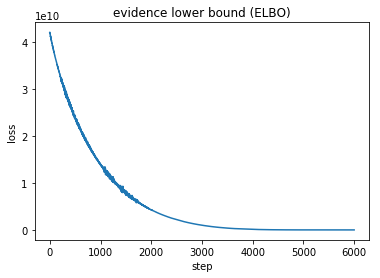

In [213]:
plt.plot(losses)
plt.title("evidence lower bound (ELBO)")
plt.xlabel("step")
plt.ylabel("loss");
plt.show()

In [352]:
#WARTOŚCI PRARAMETRÓW
for name, value in pyro.get_param_store().items():
    print(name, pyro.param(name))
    
print(softplus(pyro.param("mu_sigma")))
print(softplus(pyro.param("sigma_sigma")))
# mu,s=guide(None,None)
# print(mu)
# print(s)

m_a,s_a=count_stats(x_train,y_train,labels)

print(m_a)
print(s_a)

mu_mu tensor([[1.3776e+01, 1.9289e+00, 2.4890e+00, 1.7151e+01, 1.0644e+02, 2.7958e+00,
         2.9061e+00, 2.4239e-01, 1.8575e+00, 5.3166e+00, 1.0995e+00, 3.1480e+00,
         1.1293e+03],
        [1.2394e+01, 1.6643e+00, 2.2061e+00, 1.9494e+01, 9.6066e+01, 2.1769e+00,
         1.9337e+00, 3.4861e-01, 1.5657e+00, 3.2259e+00, 1.1240e+00, 2.7028e+00,
         5.5365e+02],
        [1.3051e+01, 3.2189e+00, 2.4378e+00, 2.1404e+01, 9.8594e+01, 1.7317e+00,
         8.2413e-01, 4.3796e-01, 1.1586e+00, 6.8969e+00, 6.6905e-01, 1.6565e+00,
         6.1656e+02]], requires_grad=True)
mu_sigma tensor([[-5.1934, -5.2637, -5.5574, -4.3793, -3.3124, -5.2746, -5.3349, -5.4745,
         -5.3914, -5.3388, -4.9544, -5.2619, -2.5014],
        [-5.4376, -5.2426, -5.2614, -5.0894, -5.3291, -5.2479, -4.6481, -5.0374,
         -5.2675, -5.3270, -5.5501, -5.3449, -1.7853],
        [-5.1610, -5.2780, -5.2564, -4.2679, -5.5443, -4.9901, -5.4689, -5.3559,
         -5.2582, -5.3287, -5.2606, -5.2934, -3.5604]], req

In [372]:
#SAMPLE PRINTOUTS
mu,sigma=guide(None,None)
# print(mu,sigma)
# print(predict_all(x_test,labels,y_test,mu,sigma))
predicted_labels=predict_all_1(x_test,labels,y_test,mu,sigma)
# print(predicted_labels)
accuracy=accuracy_score(y_test, predicted_labels)
print(100*accuracy)

96.5517241379


In [351]:
#AVERAGE RESULTS 
num_samples = 100

def predict_average(x):
    sampled_models = [guide(None, None) for _ in range(num_samples)]
    predictions = [predict(x,labels,y_test,mu,sigma) for mu,sigma in sampled_models]
    mean = np.mean(predictions, axis=0)
    return np.argmax(mean, axis=1)[0]+1

def average_accuracy(x_test,y_test):
    preds=[predict_average(x_test[i]) for i in range(len(x_test))]
    accuracy=accuracy_score(y_test.ravel(), preds)
    return(100*accuracy)

print(average_accuracy(x_test,y_test))

98.275862069


### Wizualizacje

In [353]:
num_samples = 100

def log_softmax(x):
    e_x = np.exp(x - np.max(x))
    return np.log(e_x / e_x.sum())

def sofmax(x):
#     print(x)
#     print('SUMA')
#     print(np.exp(x))
#     print(sum(np.exp(x)))
    return np.exp(x-np.max(x))/sum(np.exp(x))

def give_uncertainities(x):
    sampled_models = [guide(None, None) for _ in range(num_samples)]
    predictions = [predict(x,labels,y_test,mu,sigma) for mu,sigma in sampled_models]
    return np.reshape(np.asarray(predictions), newshape=(100,3))
un=give_uncertainities(x_test[1])
# print(un)

Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]
Real:  [ 2.]


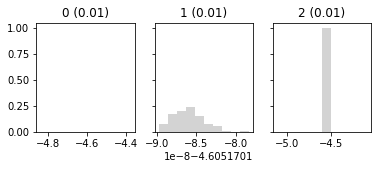

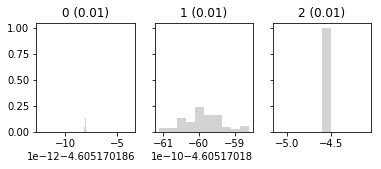

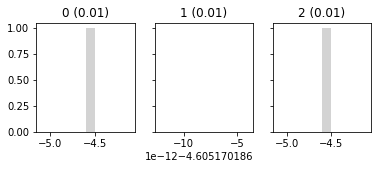

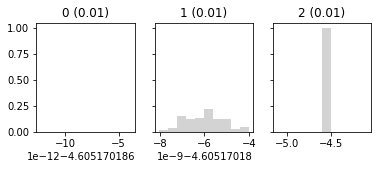

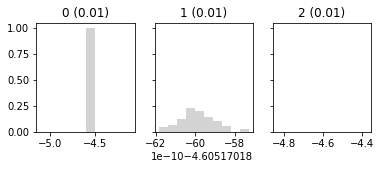

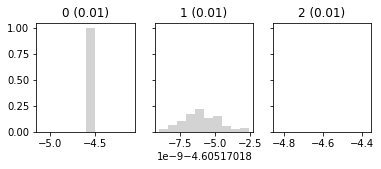

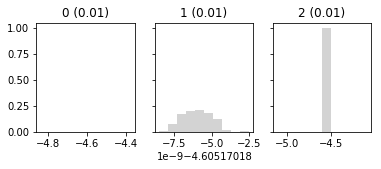

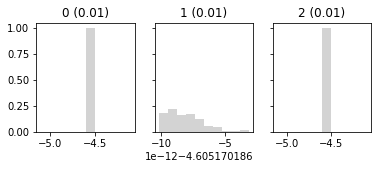

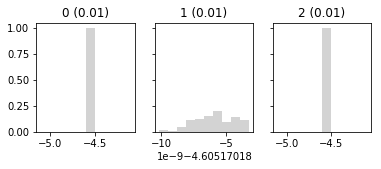

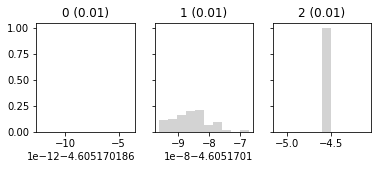

In [354]:
def visualize(x_test,y_test):
    for i in range(len(x_test)):
        probs=give_uncertainities(x_test[i])
        print("Real: ",y_test[i])
        fig, axs = plt.subplots(1, 3, sharey=True,figsize=(6,2))
        for j in range(3):
            histogram_values=log_softmax(np.transpose(probs[:,j]))
            prob = np.percentile(np.exp(histogram_values), 50) #sampling median probability
            N, bins, patches = axs[j].hist(histogram_values, bins=10,lw=0,  weights=np.ones(len(histogram_values)) / len(histogram_values), color = "lightgray", density=False)
            axs[j].set_title(str(j)+" ("+str(round(prob,2))+")") 

visualize(x_test[20:30],y_test[20:30])

            